In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

### Data Exploration

Firstly, I will do a thorough data exploration to get to know what kind of data I am dealing with.

In [126]:
df = pd.read_csv('dataset_500.csv')

In [127]:
df.head(20)

,ID,Label,House,Year,Month,Temperature,Daylight,EnergyProduction
0,0,0,1,2011,7,26.2,178.9,740
1,1,1,1,2011,8,25.8,169.7,731
2,2,2,1,2011,9,22.8,170.2,694
3,3,3,1,2011,10,16.4,169.1,688
4,4,4,1,2011,11,11.4,169.1,650
5,5,5,1,2011,12,4.2,199.5,763
6,6,6,1,2012,1,1.8,203.1,765
7,7,7,1,2012,2,2.8,178.2,706
8,8,8,1,2012,3,6.7,172.7,788
9,9,9,1,2012,4,12.6,182.2,831


In [128]:
df.tail()

,ID,Label,House,Year,Month,Temperature,Daylight,EnergyProduction
11995,11995,19,500,2013,2,4.2,201.8,638
11996,11996,20,500,2013,3,11.2,234.0,778
11997,11997,21,500,2013,4,13.6,237.1,758
11998,11998,22,500,2013,5,19.2,258.4,838
11999,11999,23,500,2013,6,22.7,122.9,586


In [129]:
df.shape

(12000, 8)

In [130]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 12000 entries, 0 to 11999
Data columns (total 8 columns):
ID                  12000 non-null int64
Label               12000 non-null int64
House               12000 non-null int64
Year                12000 non-null int64
Month               12000 non-null int64
Temperature         12000 non-null float64
Daylight            12000 non-null float64
EnergyProduction    12000 non-null int64
dtypes: float64(2), int64(6)
memory usage: 750.1 KB


In [131]:
df.describe()

,ID,Label,House,Year,Month,Temperature,Daylight,EnergyProduction
count,12000.00000,12000.000000,12000.000000,12000.000000,12000.000000,12000.000000,12000.000000,12000.000000
mean,5999.50000,11.500000,250.500000,2012.000000,6.500000,14.677892,186.454767,611.666583
std,3464.24595,6.922475,144.343293,0.707136,3.452196,8.442057,31.525892,140.608265
min,0.00000,0.000000,1.000000,2011.000000,1.000000,0.800000,121.800000,254.000000
25%,2999.75000,5.750000,125.750000,2011.750000,3.750000,6.175000,167.100000,509.000000
50%,5999.50000,11.500000,250.500000,2012.000000,6.500000,14.550000,180.400000,588.000000
75%,8999.25000,17.250000,375.250000,2012.250000,9.250000,22.700000,204.300000,695.000000
max,11999.00000,23.000000,500.000000,2013.000000,12.000000,29.000000,271.300000,1254.000000


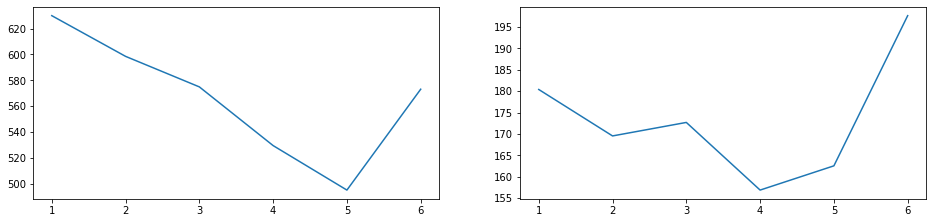

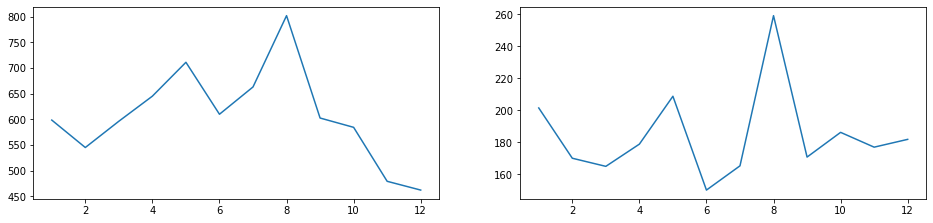

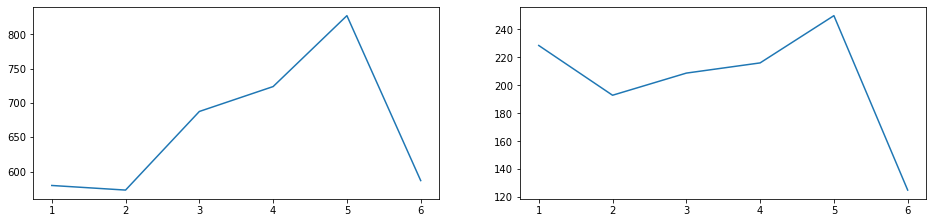

In [132]:
for i, year in enumerate([2011, 2012, 2013]):
    
    df_ = df[df['Year'] == year]
    temp = df_.groupby('Month')['EnergyProduction'].mean()
    temp_light = df_.groupby('Month')['Daylight'].mean()
    plt.figure(figsize=(16,12))
    plt.subplot(int('32'+ str(i*2+1)))
    
    plt.plot(np.arange(1, len(temp)+1), temp)
    plt.subplot(int('32'+ str(i*2+2)))
    plt.plot(np.arange(1, len(temp)+1), temp_light)
    
    
plt.show()
    
    

In [133]:
df[['Temperature', 'Daylight' ,'EnergyProduction']].corr()

,Temperature,Daylight,EnergyProduction
Temperature,1.000000,-0.118407,0.259862
Daylight,-0.118407,1.000000,0.495624
EnergyProduction,0.259862,0.495624,1.000000


([<matplotlib.axis.XTick at 0x121167400>,
 <a list of 13 Text xticklabel objects>)

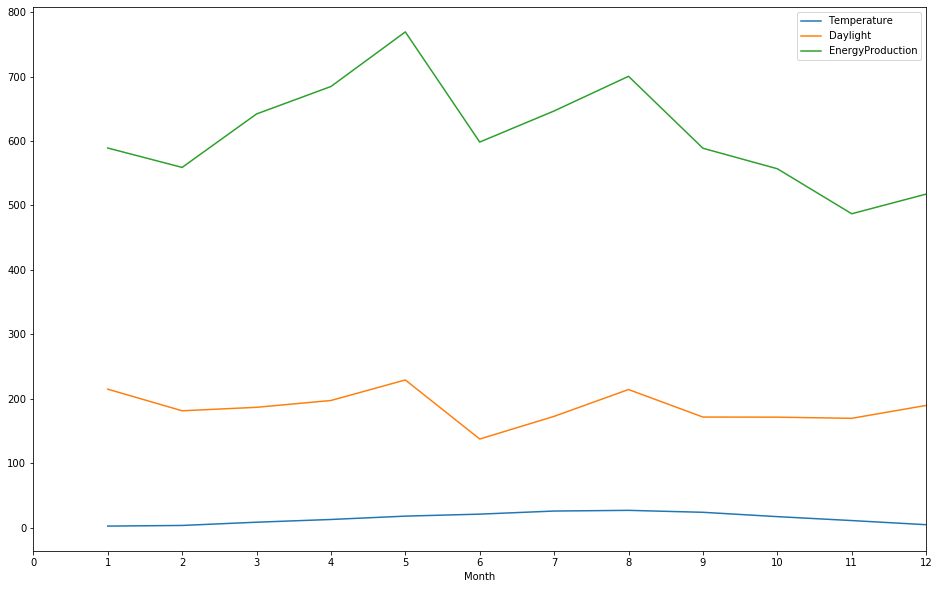

In [134]:
df[['Month','Temperature', 'Daylight', 'EnergyProduction']].groupby('Month').mean().plot(figsize=(16,10))
plt.xticks(np.arange(0,13))

(array([1., 1., 2., 3., 0., 2., 1., 1., 0., 1.]),
 array([487.134 , 515.3503, 543.5666, 571.7829, 599.9992, 628.2155,
        656.4318, 684.6481, 712.8644, 741.0807, 769.297 ]),
 <a list of 10 Patch objects>)

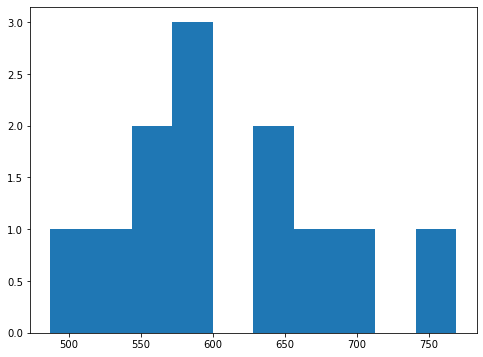

In [135]:
plt.subplots(figsize=(8,6))
plt.hist(df[['Month','Temperature', 'Daylight', 'EnergyProduction']].groupby('Month')['EnergyProduction'].mean())

(array([3., 0., 1., 1., 1., 0., 2., 1., 1., 2.]),
 array([ 2.5232 ,  4.96583,  7.40846,  9.85109, 12.29372, 14.73635,
        17.17898, 19.62161, 22.06424, 24.50687, 26.9495 ]),
 <a list of 10 Patch objects>)

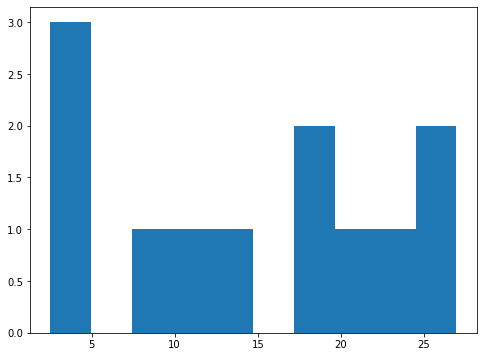

In [136]:
plt.subplots(figsize=(8,6))
plt.hist(df[['Month','Temperature', 'Daylight', 'EnergyProduction']].groupby('Month')['Temperature'].mean())

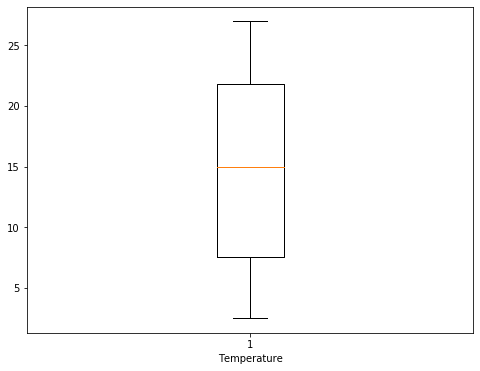

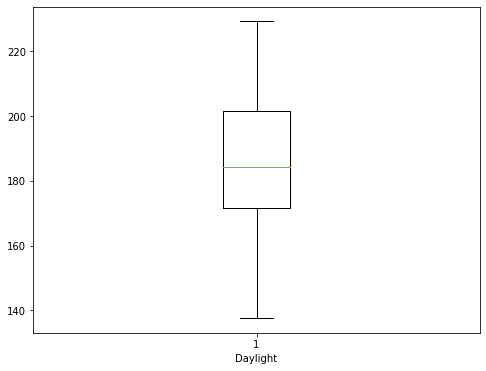

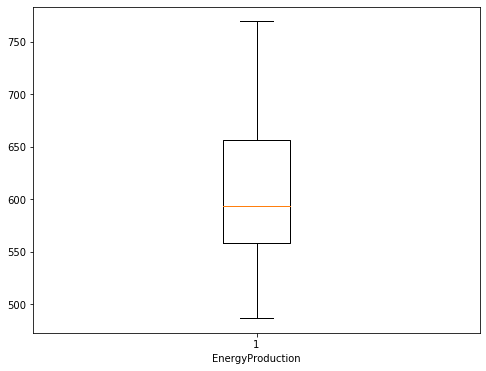

In [137]:
for feat in ['Temperature', 'Daylight', 'EnergyProduction']:
    plt.figure(figsize=(8,6))
    plt.boxplot(df.groupby('Month')[feat].mean())
    plt.xlabel(feat)
    plt.show()

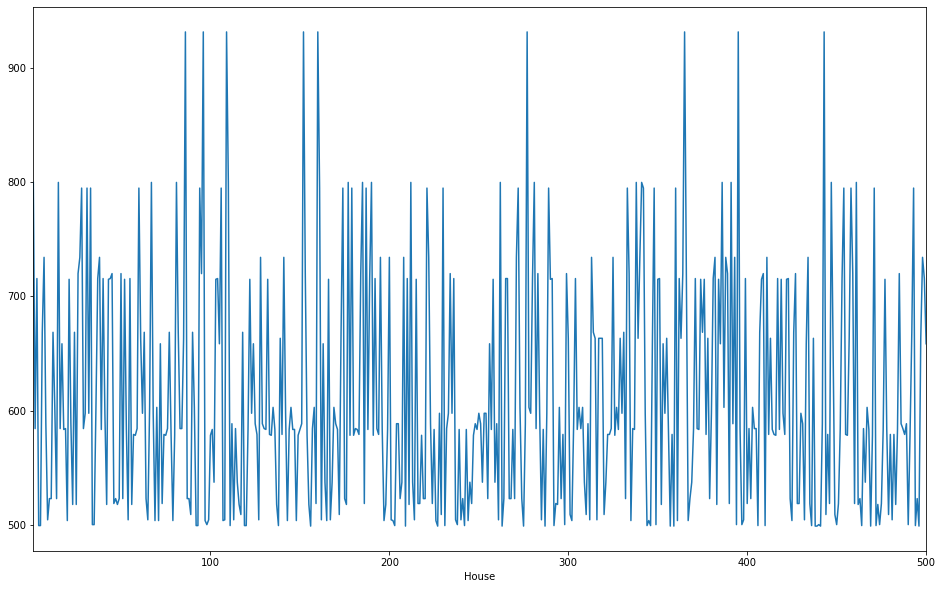

In [138]:
df.groupby('House')['EnergyProduction'].mean().plot(figsize=(16,10))

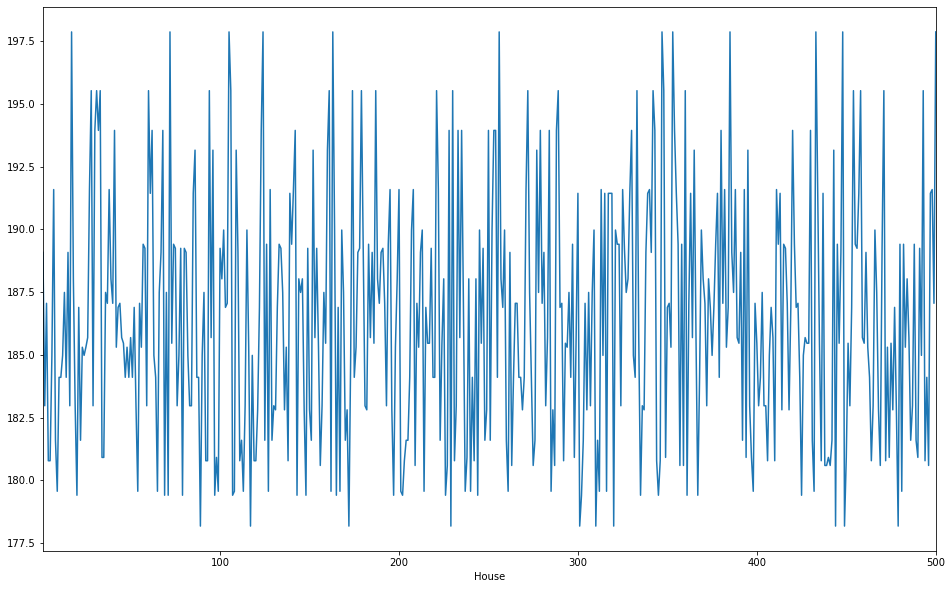

In [139]:
df.groupby('House')['Daylight'].mean().plot(figsize=(16,10))

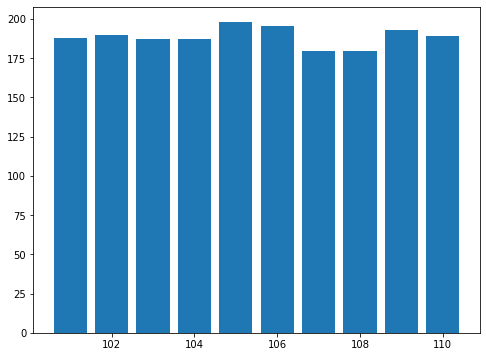

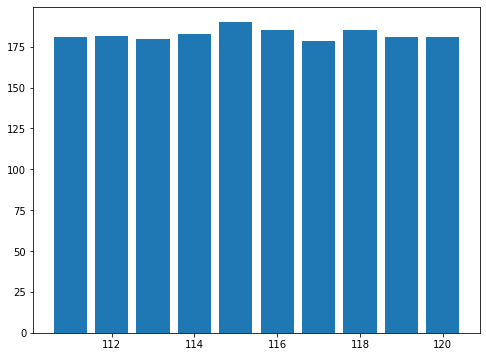

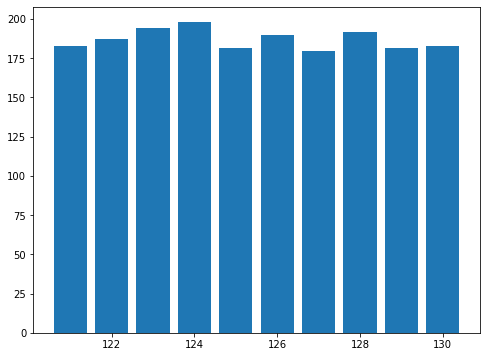

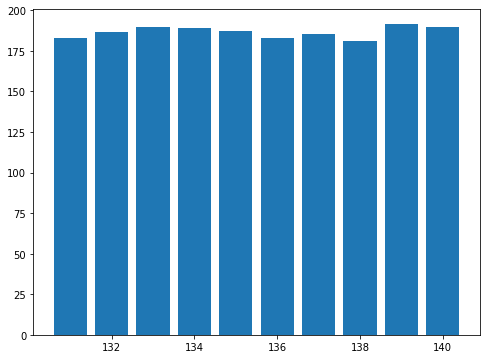

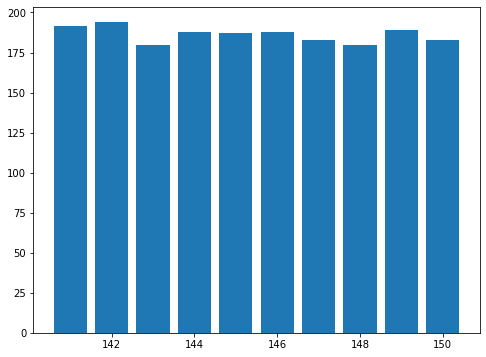

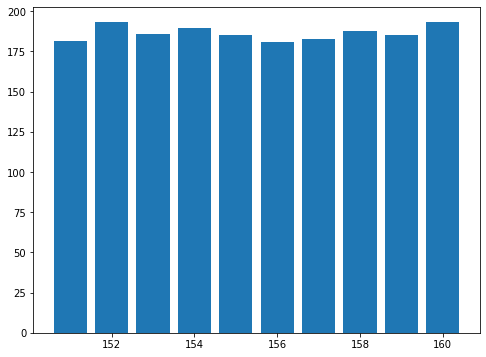

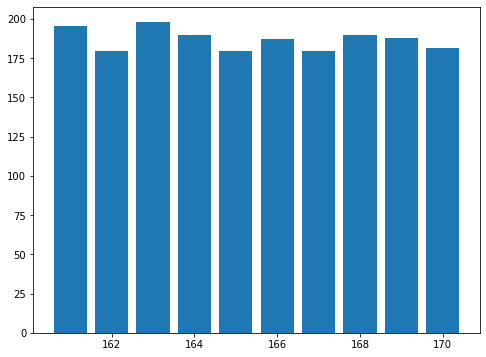

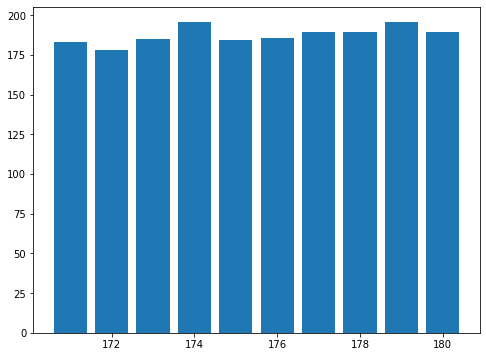

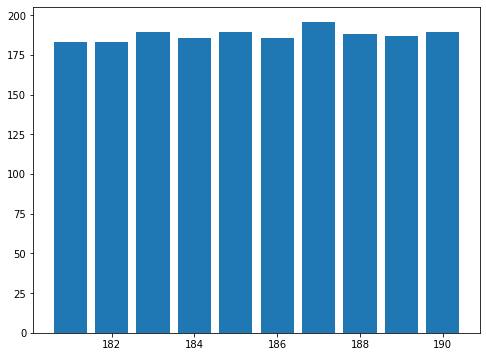

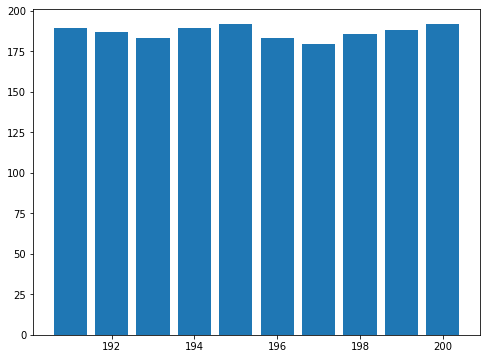

In [140]:
for i in range(100, 200, 10):
    plt.figure(figsize=(8,6))
    plt.bar(df[(df.House < 11+i) & (df.House>0+i)].groupby('House')['Daylight'].mean().index, df[(df.House < 11+i) & (df.House>0+i)].groupby('House')['Daylight'].mean().values )
    plt.show()

### Algorithm Choice & Model Building

In order to keep this notebook as clean as possible I am not sharing all the models I have tried but my methodology can be summarized as follow:
First, I started with simple models and tried polynomial regression however it failed to capture the seasonality that is present in our data. Than I tried ARIMA, SARIMAX models as well as Facebook's prophet model. Although they were better than polynomial regression, Gradient Boosted Machine baseline results were much more promising so I decided to build a GBM model using XGBoost library.

I have implemented expanding cross validation method which starts with using first 10 months and predicts 11th then uses 11months and predicts 12th so forth until the end.

**Feature Engineering**

The features I have generated can be summed in 4 categories:
-Lag Features
-Static Features
-Rolling Window Statistics
-Expanding Window Statistics

In [78]:
train_x = pd.read_csv('training_dataset_500.csv')

In [79]:
train_x.head()

,ID,Label,House,Year,Month,Temperature,Daylight,EnergyProduction
0,0,0,1,2011,7,26.2,178.9,740
1,1,1,1,2011,8,25.8,169.7,731
2,2,2,1,2011,9,22.8,170.2,694
3,3,3,1,2011,10,16.4,169.1,688
4,4,4,1,2011,11,11.4,169.1,650


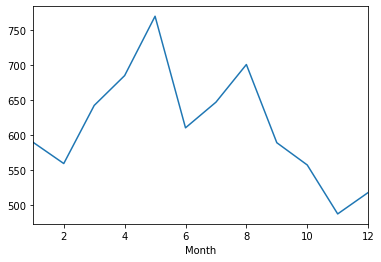

In [80]:
train_x.groupby(['Month'])['EnergyProduction'].mean().plot()

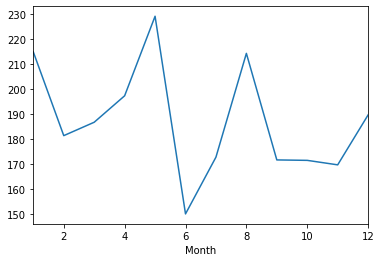

In [81]:
train_x.groupby(['Month'])['Daylight'].mean().plot()

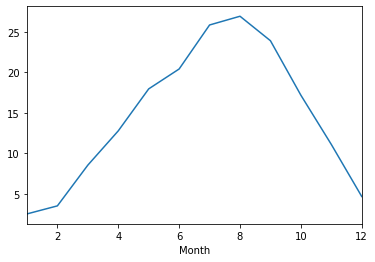

In [82]:
train_x.groupby(['Month'])['Temperature'].mean().plot()

In [83]:
#Add labels derived from next month
train_x['labels'] = 0
for i in set(train_x.House.values):
    train_x.loc[train_x['House']==i, 'labels'] = train_x.loc[train_x['House']==i, 'EnergyProduction'].shift(-1)

**Static Features**

In [84]:
train_x['is_it_jan'] = 0
train_x['is_it_may'] = 0
train_x['is_it_aug'] = 0
train_x.loc[train_x['Month']==1, 'is_it_jan'] = 1
train_x.loc[train_x['Month']==5, 'is_it_may'] = 1
train_x.loc[train_x['Month']==8, 'is_it_aug'] = 1

**Lag Features - Rolling Features - Expanding Features**

In [85]:
def add_lag_feature(df, lags, col):
    for lag in lags:
        df[col + '_lag_' + str(lag)] = 0
        for i in set(train_x.House.values):
            df.loc[df['House']==i, col + '_lag_' + str(lag)] = df.loc[df['House']==i, col].shift(lag)
    return df        

In [86]:
def add_rolling_feature(df, lags, col):
    for lag in lags:
        df[col + '_rolling_' + str(lag) +'_mean'] = 0
        df[col + '_rolling_' + str(lag) +'_min'] = 0
        df[col + '_rolling_' + str(lag) +'_max'] = 0
        for i in set(train_x.House.values):
            df.loc[df['House']==i, col + '_rolling_' + str(lag) +'_mean'] = df.loc[df['House']==i, col].rolling(lag).mean()
            df.loc[df['House']==i, col + '_rolling_' + str(lag) +'_min'] = df.loc[df['House']==i, col].rolling(lag).min()
            df.loc[df['House']==i, col + '_rolling_' + str(lag) +'_max'] = df.loc[df['House']==i, col].rolling(lag).max()
    return df    

In [87]:
def add_expanding_feature(df, col):
    df[col + '_expanding_mean'] = 0
    df[col + '_expanding_min'] = 0
    df[col + '_expanding_max'] = 0
    for i in set(train_x.House.values):
            df.loc[df['House']==i, col + '_expanding_mean'] = df.loc[df['House']==i, col].expanding().mean()
            df.loc[df['House']==i, col + '_expanding_min'] = df.loc[df['House']==i, col].expanding().min()
            df.loc[df['House']==i, col + '_expanding_max'] = df.loc[df['House']==i, col].expanding().max()
    return df    

In [88]:
lags = [1,2,3]
for col in ['Temperature', 'Daylight', 'EnergyProduction']:
    add_lag_feature(train_x, lags, col)

In [89]:
lags = [2, 3, 4]
for col in ['Temperature', 'Daylight', 'EnergyProduction']:
    add_rolling_feature(train_x, lags, col)

In [90]:
for col in ['Temperature', 'Daylight', 'EnergyProduction']:
    add_expanding_feature(train_x, col)

In [91]:
train_x = train_x[train_x.Label >= 3]

In [92]:
train_x.columns

Index(['ID', 'Label', 'House', 'Year', 'Month', 'Temperature', 'Daylight',
       'EnergyProduction', 'labels', 'is_it_jan', 'is_it_may', 'is_it_aug',
       'Temperature_lag_1', 'Temperature_lag_2', 'Temperature_lag_3',
       'Daylight_lag_1', 'Daylight_lag_2', 'Daylight_lag_3',
       'EnergyProduction_lag_1', 'EnergyProduction_lag_2',
       'EnergyProduction_lag_3', 'Temperature_rolling_2_mean',
       'Temperature_rolling_2_min', 'Temperature_rolling_2_max',
       'Temperature_rolling_3_mean', 'Temperature_rolling_3_min',
       'Temperature_rolling_3_max', 'Temperature_rolling_4_mean',
       'Temperature_rolling_4_min', 'Temperature_rolling_4_max',
       'Daylight_rolling_2_mean', 'Daylight_rolling_2_min',
       'Daylight_rolling_2_max', 'Daylight_rolling_3_mean',
       'Daylight_rolling_3_min', 'Daylight_rolling_3_max',
       'Daylight_rolling_4_mean', 'Daylight_rolling_4_min',
       'Daylight_rolling_4_max', 'EnergyProduction_rolling_2_mean',
       'EnergyProduction_ro

In [93]:
feats = ['Label', 'House', 'Year', 'Month', 'Temperature', 'Daylight',
       'EnergyProduction', 'is_it_jan', 'is_it_may', 'is_it_aug',
       'Temperature_lag_1', 'Temperature_lag_2', 'Temperature_lag_3',
       'Daylight_lag_1', 'Daylight_lag_2', 'Daylight_lag_3',
       'EnergyProduction_lag_1', 'EnergyProduction_lag_2',
       'EnergyProduction_lag_3', 'Temperature_rolling_2_mean',
       'Temperature_rolling_2_min', 'Temperature_rolling_2_max',
       'Temperature_rolling_3_mean', 'Temperature_rolling_3_min',
       'Temperature_rolling_3_max', 'Temperature_rolling_4_mean',
       'Temperature_rolling_4_min', 'Temperature_rolling_4_max',
       'Daylight_rolling_2_mean', 'Daylight_rolling_2_min',
       'Daylight_rolling_2_max', 'Daylight_rolling_3_mean',
       'Daylight_rolling_3_min', 'Daylight_rolling_3_max',
       'Daylight_rolling_4_mean', 'Daylight_rolling_4_min',
       'Daylight_rolling_4_max', 'EnergyProduction_rolling_2_mean',
       'EnergyProduction_rolling_2_min', 'EnergyProduction_rolling_2_max',
       'EnergyProduction_rolling_3_mean', 'EnergyProduction_rolling_3_min',
       'EnergyProduction_rolling_3_max', 'EnergyProduction_rolling_4_mean',
       'EnergyProduction_rolling_4_min', 'EnergyProduction_rolling_4_max',
       'Temperature_expanding_mean', 'Temperature_expanding_min',
       'Temperature_expanding_max', 'Daylight_expanding_mean',
       'Daylight_expanding_min', 'Daylight_expanding_max',
       'EnergyProduction_expanding_mean', 'EnergyProduction_expanding_min',
       'EnergyProduction_expanding_max']

In [94]:
import itertools

In [95]:
from xgboost import XGBRegressor

In [96]:
def xgb_mape(preds, dtrain):
    labels = dtrain.get_label()
    return('mape', np.mean(np.abs((labels - preds) / labels)))

In [97]:
def mean_absolute_percentage_error(y_true, y_pred): 
    return np.mean(np.abs((y_true - y_pred) / y_true)) * 100

**Hyperparameter Tuning**

In [98]:
hyper_params = [[4, 8], [0.02, 0.04]]
MAPE = []
all_params = []
for depth , lr in list(itertools.product(*hyper_params)):

    model = XGBRegressor(
        max_depth=depth,
        n_estimators=250,
        min_child_weight=300, 
        colsample_bytree=0.6, 
        subsample=0.4,
        objective='reg:squarederror',
        learning_rate=lr,    
        seed=42)

    each_model = []
    
    for house in range(1,501):
        house_mape = []
        for i in range(10, 20):
            X = train_x[(train_x.House == house) & (train_x.Label <= i)][feats]
            y = train_x[(train_x.House == house) & (train_x.Label <= i)]['labels']
            val_x = train_x[(train_x.House == house) & (train_x.Label == i+1)][feats]
            val_y = train_x[(train_x.House == house) & (train_x.Label == i+1)]['labels']
            tes_x = train_x[(train_x.House == house) & (train_x.Label == i+2)][feats]
            tes_y = train_x[(train_x.House == house) & (train_x.Label == i+2)]['labels']
            model.fit(
            X, 
            y, 
            eval_set=[(val_x, val_y)], 
            eval_metric=xgb_mape, 
            verbose=True, 
            early_stopping_rounds = 10)
            preds = model.predict(tes_x)
            house_mape.append(mean_absolute_percentage_error(tes_y, preds))
            
        each_model.append(sum(house_mape)/len(house_mape))
        
    MAPE.append(sum(each_model) / len(each_model))
    all_params.append(model.get_params())

[0]	validation_0-rmse:850.883	validation_0-mape:0.985959
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:840.704	validation_0-mape:0.974165
[2]	validation_0-rmse:828.709	validation_0-mape:0.960265
[3]	validation_0-rmse:818.466	validation_0-mape:0.948396
[4]	validation_0-rmse:806.395	validation_0-mape:0.934408
[5]	validation_0-rmse:794.676	validation_0-mape:0.92083
[6]	validation_0-rmse:782.125	validation_0-mape:0.906287
[7]	validation_0-rmse:770.224	validation_0-mape:0.892495
[8]	validation_0-rmse:761.654	validation_0-mape:0.882565
[9]	validation_0-rmse:751.099	validation_0-mape:0.870334
[10]	validation_0-rmse:744.338	validation_0-mape:0.8625
[11]	validation_0-rmse:734.436	validation_0-mape:0.851027
[12]	validation_0-rmse:722.941	validation_0-mape:0.837707
[13]	validation_0-rmse:713.532	validation_0-mape:0.826804
[14]	validation_0-rmse:704.479	validation_

[139]	validation_0-rmse:182.943	validation_0-mape:0.211985
[140]	validation_0-rmse:182.217	validation_0-mape:0.211144
[141]	validation_0-rmse:179.87	validation_0-mape:0.208424
[142]	validation_0-rmse:178.742	validation_0-mape:0.207117
[143]	validation_0-rmse:177.211	validation_0-mape:0.205343
[144]	validation_0-rmse:174.904	validation_0-mape:0.202669
[145]	validation_0-rmse:172.11	validation_0-mape:0.199432
[146]	validation_0-rmse:170.529	validation_0-mape:0.1976
[147]	validation_0-rmse:168.236	validation_0-mape:0.194943
[148]	validation_0-rmse:166.176	validation_0-mape:0.192556
[149]	validation_0-rmse:166.176	validation_0-mape:0.192556
[150]	validation_0-rmse:165.368	validation_0-mape:0.19162
[151]	validation_0-rmse:163.962	validation_0-mape:0.189991
[152]	validation_0-rmse:162.763	validation_0-mape:0.188601
[153]	validation_0-rmse:162.115	validation_0-mape:0.187851
[154]	validation_0-rmse:162.624	validation_0-mape:0.18844
[155]	validation_0-rmse:161.318	validation_0-mape:0.186927
[15

[27]	validation_0-rmse:785.442	validation_0-mape:0.734745
[28]	validation_0-rmse:779.036	validation_0-mape:0.728752
[29]	validation_0-rmse:771.485	validation_0-mape:0.721689
[30]	validation_0-rmse:762.831	validation_0-mape:0.713593
[31]	validation_0-rmse:755.138	validation_0-mape:0.706397
[32]	validation_0-rmse:746.78	validation_0-mape:0.698578
[33]	validation_0-rmse:738.384	validation_0-mape:0.690724
[34]	validation_0-rmse:730.098	validation_0-mape:0.682973
[35]	validation_0-rmse:722.593	validation_0-mape:0.675953
[36]	validation_0-rmse:715.879	validation_0-mape:0.669672
[37]	validation_0-rmse:715.879	validation_0-mape:0.669672
[38]	validation_0-rmse:708.085	validation_0-mape:0.662381
[39]	validation_0-rmse:700.784	validation_0-mape:0.655551
[40]	validation_0-rmse:693.787	validation_0-mape:0.649005
[41]	validation_0-rmse:687	validation_0-mape:0.642657
[42]	validation_0-rmse:680.192	validation_0-mape:0.636288
[43]	validation_0-rmse:673.844	validation_0-mape:0.63035
[44]	validation_0-rm

[168]	validation_0-rmse:345.659	validation_0-mape:0.323348
[169]	validation_0-rmse:344.084	validation_0-mape:0.321875
[170]	validation_0-rmse:342.456	validation_0-mape:0.320352
[171]	validation_0-rmse:340.61	validation_0-mape:0.318624
[172]	validation_0-rmse:340.645	validation_0-mape:0.318658
[173]	validation_0-rmse:338.538	validation_0-mape:0.316687
[174]	validation_0-rmse:338.775	validation_0-mape:0.316908
[175]	validation_0-rmse:338.158	validation_0-mape:0.316331
[176]	validation_0-rmse:337.295	validation_0-mape:0.315524
[177]	validation_0-rmse:336.271	validation_0-mape:0.314566
[178]	validation_0-rmse:335.966	validation_0-mape:0.314281
[179]	validation_0-rmse:334.275	validation_0-mape:0.312699
[180]	validation_0-rmse:333.83	validation_0-mape:0.312283
[181]	validation_0-rmse:333.347	validation_0-mape:0.31183
[182]	validation_0-rmse:332.565	validation_0-mape:0.311099
[183]	validation_0-rmse:331.76	validation_0-mape:0.310346
[184]	validation_0-rmse:331.92	validation_0-mape:0.310496
[1

[56]	validation_0-rmse:333.842	validation_0-mape:0.409622
[57]	validation_0-rmse:327.459	validation_0-mape:0.40179
[58]	validation_0-rmse:322.668	validation_0-mape:0.395911
[59]	validation_0-rmse:316.645	validation_0-mape:0.388521
[60]	validation_0-rmse:310.184	validation_0-mape:0.380594
[61]	validation_0-rmse:305.413	validation_0-mape:0.37474
[62]	validation_0-rmse:300.815	validation_0-mape:0.369098
[63]	validation_0-rmse:295.878	validation_0-mape:0.36304
[64]	validation_0-rmse:290.48	validation_0-mape:0.356417
[65]	validation_0-rmse:286.18	validation_0-mape:0.351141
[66]	validation_0-rmse:281.04	validation_0-mape:0.344834
[67]	validation_0-rmse:276.462	validation_0-mape:0.339218
[68]	validation_0-rmse:272.051	validation_0-mape:0.333804
[69]	validation_0-rmse:265.92	validation_0-mape:0.326282
[70]	validation_0-rmse:262.505	validation_0-mape:0.322092
[71]	validation_0-rmse:258.457	validation_0-mape:0.317125
[72]	validation_0-rmse:254.714	validation_0-mape:0.312532
[73]	validation_0-rms

[197]	validation_0-rmse:25.0456	validation_0-mape:0.030731
[198]	validation_0-rmse:23.9369	validation_0-mape:0.02937
[199]	validation_0-rmse:23.073	validation_0-mape:0.02831
[200]	validation_0-rmse:21.9158	validation_0-mape:0.026891
[201]	validation_0-rmse:22.3492	validation_0-mape:0.027422
[202]	validation_0-rmse:20.424	validation_0-mape:0.02506
[203]	validation_0-rmse:19.9091	validation_0-mape:0.024428
[204]	validation_0-rmse:20.0785	validation_0-mape:0.024636
[205]	validation_0-rmse:20.8041	validation_0-mape:0.025527
[206]	validation_0-rmse:20.5633	validation_0-mape:0.025231
[207]	validation_0-rmse:20.3051	validation_0-mape:0.024914
[208]	validation_0-rmse:18.2343	validation_0-mape:0.022373
[209]	validation_0-rmse:18.2075	validation_0-mape:0.02234
[210]	validation_0-rmse:17.2001	validation_0-mape:0.021104
[211]	validation_0-rmse:16.0596	validation_0-mape:0.019705
[212]	validation_0-rmse:16.4637	validation_0-mape:0.020201
[213]	validation_0-rmse:15.4117	validation_0-mape:0.01891
[214

[86]	validation_0-rmse:168.97	validation_0-mape:0.215522
[87]	validation_0-rmse:166.97	validation_0-mape:0.212972
[88]	validation_0-rmse:164.146	validation_0-mape:0.20937
[89]	validation_0-rmse:161.731	validation_0-mape:0.20629
[90]	validation_0-rmse:159.132	validation_0-mape:0.202975
[91]	validation_0-rmse:155.134	validation_0-mape:0.197875
[92]	validation_0-rmse:150.86	validation_0-mape:0.192424
[93]	validation_0-rmse:147.454	validation_0-mape:0.188079
[94]	validation_0-rmse:144.821	validation_0-mape:0.184721
[95]	validation_0-rmse:142.984	validation_0-mape:0.182378
[96]	validation_0-rmse:140.358	validation_0-mape:0.179028
[97]	validation_0-rmse:137.326	validation_0-mape:0.175161
[98]	validation_0-rmse:135.207	validation_0-mape:0.172458
[99]	validation_0-rmse:131.204	validation_0-mape:0.167352
[100]	validation_0-rmse:128.451	validation_0-mape:0.16384
[101]	validation_0-rmse:125.633	validation_0-mape:0.160246
[102]	validation_0-rmse:123.719	validation_0-mape:0.157804
[103]	validation_

[14]	validation_0-rmse:444.026	validation_0-mape:0.700357
[15]	validation_0-rmse:434.696	validation_0-mape:0.68564
[16]	validation_0-rmse:424.592	validation_0-mape:0.669704
[17]	validation_0-rmse:415.245	validation_0-mape:0.654961
[18]	validation_0-rmse:405.845	validation_0-mape:0.640134
[19]	validation_0-rmse:397.588	validation_0-mape:0.62711
[20]	validation_0-rmse:388.968	validation_0-mape:0.613514
[21]	validation_0-rmse:379.416	validation_0-mape:0.598448
[22]	validation_0-rmse:368.721	validation_0-mape:0.581579
[23]	validation_0-rmse:359.553	validation_0-mape:0.567118
[24]	validation_0-rmse:350.276	validation_0-mape:0.552485
[25]	validation_0-rmse:341.634	validation_0-mape:0.538856
[26]	validation_0-rmse:331.738	validation_0-mape:0.523246
[27]	validation_0-rmse:322.792	validation_0-mape:0.509136
[28]	validation_0-rmse:314.288	validation_0-mape:0.495722
[29]	validation_0-rmse:305.228	validation_0-mape:0.481433
[30]	validation_0-rmse:297.855	validation_0-mape:0.469802
[31]	validation_

[52]	validation_0-rmse:123.971	validation_0-mape:0.209058
[53]	validation_0-rmse:118.597	validation_0-mape:0.199995
[54]	validation_0-rmse:112.35	validation_0-mape:0.189461
[55]	validation_0-rmse:106.893	validation_0-mape:0.180258
[56]	validation_0-rmse:101.841	validation_0-mape:0.171739
[57]	validation_0-rmse:98.3034	validation_0-mape:0.165773
[58]	validation_0-rmse:93.6238	validation_0-mape:0.157882
[59]	validation_0-rmse:88.1904	validation_0-mape:0.148719
[60]	validation_0-rmse:82.8971	validation_0-mape:0.139793
[61]	validation_0-rmse:77.8954	validation_0-mape:0.131358
[62]	validation_0-rmse:73.1305	validation_0-mape:0.123323
[63]	validation_0-rmse:68.6335	validation_0-mape:0.11574
[64]	validation_0-rmse:62.7712	validation_0-mape:0.105854
[65]	validation_0-rmse:58.9297	validation_0-mape:0.099376
[66]	validation_0-rmse:53.322	validation_0-mape:0.089919
[67]	validation_0-rmse:48.0765	validation_0-mape:0.081073
[68]	validation_0-rmse:43.6885	validation_0-mape:0.073674
[69]	validation_0

[99]	validation_0-rmse:123.905	validation_0-mape:0.162392
[100]	validation_0-rmse:120.547	validation_0-mape:0.157991
[101]	validation_0-rmse:118.531	validation_0-mape:0.155349
[102]	validation_0-rmse:116.19	validation_0-mape:0.152281
[103]	validation_0-rmse:113.867	validation_0-mape:0.149236
[104]	validation_0-rmse:110.653	validation_0-mape:0.145023
[105]	validation_0-rmse:108.494	validation_0-mape:0.142194
[106]	validation_0-rmse:106.958	validation_0-mape:0.140181
[107]	validation_0-rmse:103.443	validation_0-mape:0.135574
[108]	validation_0-rmse:101.035	validation_0-mape:0.132418
[109]	validation_0-rmse:98.9232	validation_0-mape:0.12965
[110]	validation_0-rmse:96.6319	validation_0-mape:0.126647
[111]	validation_0-rmse:94.2308	validation_0-mape:0.1235
[112]	validation_0-rmse:92.3897	validation_0-mape:0.121087
[113]	validation_0-rmse:90.6406	validation_0-mape:0.118795
[114]	validation_0-rmse:90.2863	validation_0-mape:0.118331
[115]	validation_0-rmse:86.6271	validation_0-mape:0.113535
[1

[27]	validation_0-rmse:455.161	validation_0-mape:0.602064
[28]	validation_0-rmse:446.83	validation_0-mape:0.591045
[29]	validation_0-rmse:440.166	validation_0-mape:0.582231
[30]	validation_0-rmse:432.187	validation_0-mape:0.571676
[31]	validation_0-rmse:423.856	validation_0-mape:0.560655
[32]	validation_0-rmse:417.118	validation_0-mape:0.551743
[33]	validation_0-rmse:409.61	validation_0-mape:0.541812
[34]	validation_0-rmse:402.088	validation_0-mape:0.531863
[35]	validation_0-rmse:395.033	validation_0-mape:0.522531
[36]	validation_0-rmse:388.013	validation_0-mape:0.513245
[37]	validation_0-rmse:379.139	validation_0-mape:0.501507
[38]	validation_0-rmse:371.917	validation_0-mape:0.491953
[39]	validation_0-rmse:364.828	validation_0-mape:0.482577
[40]	validation_0-rmse:358.694	validation_0-mape:0.474463
[41]	validation_0-rmse:351.172	validation_0-mape:0.464513
[42]	validation_0-rmse:345.12	validation_0-mape:0.456508
[43]	validation_0-rmse:339.005	validation_0-mape:0.448419
[44]	validation_0

[168]	validation_0-rmse:10.9284	validation_0-mape:0.014456
[169]	validation_0-rmse:10.9296	validation_0-mape:0.014457
[170]	validation_0-rmse:8.96747	validation_0-mape:0.011862
[171]	validation_0-rmse:9.21137	validation_0-mape:0.012184
[172]	validation_0-rmse:7.74982	validation_0-mape:0.010251
[173]	validation_0-rmse:7.3941	validation_0-mape:0.009781
[174]	validation_0-rmse:5.71222	validation_0-mape:0.007556
[175]	validation_0-rmse:3.62653	validation_0-mape:0.004797
[176]	validation_0-rmse:4.25293	validation_0-mape:0.005626
[177]	validation_0-rmse:3.81207	validation_0-mape:0.005042
[178]	validation_0-rmse:3.45813	validation_0-mape:0.004574
[179]	validation_0-rmse:0.706238	validation_0-mape:0.000934
[180]	validation_0-rmse:0.259338	validation_0-mape:0.000343
[181]	validation_0-rmse:0.892822	validation_0-mape:0.001181
[182]	validation_0-rmse:0.534668	validation_0-mape:0.000707
[183]	validation_0-rmse:0.13092	validation_0-mape:0.000173
[184]	validation_0-rmse:1.18579	validation_0-mape:0.0

[111]	validation_0-rmse:258.398	validation_0-mape:0.277549
[112]	validation_0-rmse:256.932	validation_0-mape:0.275974
[113]	validation_0-rmse:255.316	validation_0-mape:0.274238
[114]	validation_0-rmse:253.222	validation_0-mape:0.271989
[115]	validation_0-rmse:251.57	validation_0-mape:0.270215
[116]	validation_0-rmse:249.221	validation_0-mape:0.267691
[117]	validation_0-rmse:247.188	validation_0-mape:0.265508
[118]	validation_0-rmse:246.882	validation_0-mape:0.265179
[119]	validation_0-rmse:245.98	validation_0-mape:0.264211
[120]	validation_0-rmse:245.169	validation_0-mape:0.263339
[121]	validation_0-rmse:244.112	validation_0-mape:0.262204
[122]	validation_0-rmse:241.663	validation_0-mape:0.259574
[123]	validation_0-rmse:239.661	validation_0-mape:0.257424
[124]	validation_0-rmse:239.087	validation_0-mape:0.256806
[125]	validation_0-rmse:237.098	validation_0-mape:0.254671
[126]	validation_0-rmse:235.182	validation_0-mape:0.252613
[127]	validation_0-rmse:234.392	validation_0-mape:0.251763

Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:939.279	validation_0-mape:0.971333
[2]	validation_0-rmse:926.197	validation_0-mape:0.957804
[3]	validation_0-rmse:915.174	validation_0-mape:0.946405
[4]	validation_0-rmse:902.423	validation_0-mape:0.933219
[5]	validation_0-rmse:888.128	validation_0-mape:0.918436
[6]	validation_0-rmse:875.751	validation_0-mape:0.905637
[7]	validation_0-rmse:862.876	validation_0-mape:0.892322
[8]	validation_0-rmse:850.808	validation_0-mape:0.879843
[9]	validation_0-rmse:839.391	validation_0-mape:0.868037
[10]	validation_0-rmse:828.357	validation_0-mape:0.856626
[11]	validation_0-rmse:818.221	validation_0-mape:0.846144
[12]	validation_0-rmse:807.335	validation_0-mape:0.834886
[13]	validation_0-rmse:797.378	validation_0-mape:0.824589
[14]	validation_0-rmse:786.448	validation_0-mape:0.813287
[15]	validation_0-rmse:775.46	validati

[140]	validation_0-rmse:241.397	validation_0-mape:0.249635
[141]	validation_0-rmse:240.687	validation_0-mape:0.248901
[142]	validation_0-rmse:239.66	validation_0-mape:0.247839
[143]	validation_0-rmse:237.62	validation_0-mape:0.245729
[144]	validation_0-rmse:236.783	validation_0-mape:0.244863
[145]	validation_0-rmse:234.504	validation_0-mape:0.242507
[146]	validation_0-rmse:232.15	validation_0-mape:0.240073
[147]	validation_0-rmse:230.975	validation_0-mape:0.238857
[148]	validation_0-rmse:230.291	validation_0-mape:0.23815
[149]	validation_0-rmse:229.454	validation_0-mape:0.237285
[150]	validation_0-rmse:228.764	validation_0-mape:0.23657
[151]	validation_0-rmse:227.039	validation_0-mape:0.234787
[152]	validation_0-rmse:226.07	validation_0-mape:0.233785
[153]	validation_0-rmse:224.686	validation_0-mape:0.232354
[154]	validation_0-rmse:223.856	validation_0-mape:0.231496
[155]	validation_0-rmse:221.664	validation_0-mape:0.229228
[156]	validation_0-rmse:220.059	validation_0-mape:0.227569
[15

[28]	validation_0-rmse:496.713	validation_0-mape:0.714695
[29]	validation_0-rmse:490.428	validation_0-mape:0.705652
[30]	validation_0-rmse:485.229	validation_0-mape:0.698171
[31]	validation_0-rmse:479.473	validation_0-mape:0.689889
[32]	validation_0-rmse:479.473	validation_0-mape:0.689889
[33]	validation_0-rmse:474.331	validation_0-mape:0.682491
[34]	validation_0-rmse:469.109	validation_0-mape:0.674977
[35]	validation_0-rmse:462.952	validation_0-mape:0.666118
[36]	validation_0-rmse:457.653	validation_0-mape:0.658493
[37]	validation_0-rmse:451.679	validation_0-mape:0.649897
[38]	validation_0-rmse:446.049	validation_0-mape:0.641798
[39]	validation_0-rmse:440.546	validation_0-mape:0.633879
[40]	validation_0-rmse:435.313	validation_0-mape:0.62635
[41]	validation_0-rmse:435.313	validation_0-mape:0.62635
[42]	validation_0-rmse:430.976	validation_0-mape:0.620109
[43]	validation_0-rmse:425.725	validation_0-mape:0.612553
[44]	validation_0-rmse:421.021	validation_0-mape:0.605785
[45]	validation_

[169]	validation_0-rmse:172.674	validation_0-mape:0.248452
[170]	validation_0-rmse:172.674	validation_0-mape:0.248452
[171]	validation_0-rmse:173.227	validation_0-mape:0.249248
[172]	validation_0-rmse:172.665	validation_0-mape:0.248439
[173]	validation_0-rmse:172.57	validation_0-mape:0.248302
[174]	validation_0-rmse:171.47	validation_0-mape:0.24672
[175]	validation_0-rmse:170.071	validation_0-mape:0.244706
[176]	validation_0-rmse:168.597	validation_0-mape:0.242586
[177]	validation_0-rmse:168.656	validation_0-mape:0.242671
[178]	validation_0-rmse:168.002	validation_0-mape:0.241729
[179]	validation_0-rmse:168.282	validation_0-mape:0.242132
[180]	validation_0-rmse:167.197	validation_0-mape:0.240571
[181]	validation_0-rmse:166.838	validation_0-mape:0.240055
[182]	validation_0-rmse:166.015	validation_0-mape:0.238871
[183]	validation_0-rmse:165.107	validation_0-mape:0.237564
[184]	validation_0-rmse:163.719	validation_0-mape:0.235567
[185]	validation_0-rmse:162.984	validation_0-mape:0.234509


[57]	validation_0-rmse:458.636	validation_0-mape:0.569735
[58]	validation_0-rmse:455.201	validation_0-mape:0.565467
[59]	validation_0-rmse:451.799	validation_0-mape:0.561241
[60]	validation_0-rmse:447.692	validation_0-mape:0.556139
[61]	validation_0-rmse:444.669	validation_0-mape:0.552384
[62]	validation_0-rmse:441.238	validation_0-mape:0.548122
[63]	validation_0-rmse:437.277	validation_0-mape:0.543202
[64]	validation_0-rmse:433.565	validation_0-mape:0.53859
[65]	validation_0-rmse:431.131	validation_0-mape:0.535566
[66]	validation_0-rmse:428.229	validation_0-mape:0.531961
[67]	validation_0-rmse:424.598	validation_0-mape:0.527451
[68]	validation_0-rmse:421.71	validation_0-mape:0.523864
[69]	validation_0-rmse:418.452	validation_0-mape:0.519816
[70]	validation_0-rmse:415.518	validation_0-mape:0.516172
[71]	validation_0-rmse:413.743	validation_0-mape:0.513967
[72]	validation_0-rmse:410.079	validation_0-mape:0.509415
[73]	validation_0-rmse:406.948	validation_0-mape:0.505526
[74]	validation_

[198]	validation_0-rmse:252.951	validation_0-mape:0.314225
[199]	validation_0-rmse:252.512	validation_0-mape:0.313679
[200]	validation_0-rmse:251.729	validation_0-mape:0.312706
[201]	validation_0-rmse:251.145	validation_0-mape:0.311981
[202]	validation_0-rmse:251.028	validation_0-mape:0.311836
[203]	validation_0-rmse:250.934	validation_0-mape:0.311719
[204]	validation_0-rmse:250.659	validation_0-mape:0.311377
[205]	validation_0-rmse:250.201	validation_0-mape:0.310809
[206]	validation_0-rmse:248.953	validation_0-mape:0.309259
[207]	validation_0-rmse:248.1	validation_0-mape:0.308199
[208]	validation_0-rmse:247.524	validation_0-mape:0.307483
[209]	validation_0-rmse:246.852	validation_0-mape:0.306648
[210]	validation_0-rmse:246.327	validation_0-mape:0.305996
[211]	validation_0-rmse:245.614	validation_0-mape:0.30511
[212]	validation_0-rmse:245.31	validation_0-mape:0.304732
[213]	validation_0-rmse:244.089	validation_0-mape:0.303216
[214]	validation_0-rmse:244.004	validation_0-mape:0.30311
[2

[87]	validation_0-rmse:133.618	validation_0-mape:0.227241
[88]	validation_0-rmse:131.108	validation_0-mape:0.222972
[89]	validation_0-rmse:127.559	validation_0-mape:0.216938
[90]	validation_0-rmse:124.656	validation_0-mape:0.212
[91]	validation_0-rmse:122.866	validation_0-mape:0.208955
[92]	validation_0-rmse:120.532	validation_0-mape:0.204986
[93]	validation_0-rmse:117.999	validation_0-mape:0.200678
[94]	validation_0-rmse:115.429	validation_0-mape:0.196307
[95]	validation_0-rmse:114.374	validation_0-mape:0.194514
[96]	validation_0-rmse:112.959	validation_0-mape:0.192107
[97]	validation_0-rmse:112.015	validation_0-mape:0.190503
[98]	validation_0-rmse:109.593	validation_0-mape:0.186382
[99]	validation_0-rmse:106.327	validation_0-mape:0.180828
[100]	validation_0-rmse:105.474	validation_0-mape:0.179377
[101]	validation_0-rmse:104.106	validation_0-mape:0.17705
[102]	validation_0-rmse:101.924	validation_0-mape:0.17334
[103]	validation_0-rmse:98.4382	validation_0-mape:0.167412
[104]	validatio

[9]	validation_0-rmse:423.361	validation_0-mape:0.814156
[10]	validation_0-rmse:414.819	validation_0-mape:0.797729
[11]	validation_0-rmse:406.251	validation_0-mape:0.781252
[12]	validation_0-rmse:397.147	validation_0-mape:0.763744
[13]	validation_0-rmse:389.104	validation_0-mape:0.748278
[14]	validation_0-rmse:380.349	validation_0-mape:0.731441
[15]	validation_0-rmse:373.76	validation_0-mape:0.718769
[16]	validation_0-rmse:365.696	validation_0-mape:0.703261
[17]	validation_0-rmse:359.189	validation_0-mape:0.690747
[18]	validation_0-rmse:352.069	validation_0-mape:0.677055
[19]	validation_0-rmse:346.401	validation_0-mape:0.666156
[20]	validation_0-rmse:339.079	validation_0-mape:0.652075
[21]	validation_0-rmse:331.498	validation_0-mape:0.637495
[22]	validation_0-rmse:325.31	validation_0-mape:0.625596
[23]	validation_0-rmse:317.548	validation_0-mape:0.61067
[24]	validation_0-rmse:310.415	validation_0-mape:0.596953
[25]	validation_0-rmse:303.812	validation_0-mape:0.584254
[26]	validation_0-

[14]	validation_0-rmse:262.746	validation_0-mape:0.653596
[15]	validation_0-rmse:255.844	validation_0-mape:0.636429
[16]	validation_0-rmse:248.33	validation_0-mape:0.617736
[17]	validation_0-rmse:241.85	validation_0-mape:0.601617
[18]	validation_0-rmse:235.02	validation_0-mape:0.584628
[19]	validation_0-rmse:229.38	validation_0-mape:0.570597
[20]	validation_0-rmse:223.06	validation_0-mape:0.554877
[21]	validation_0-rmse:216.182	validation_0-mape:0.537766
[22]	validation_0-rmse:208.243	validation_0-mape:0.518017
[23]	validation_0-rmse:201.376	validation_0-mape:0.500934
[24]	validation_0-rmse:194.614	validation_0-mape:0.484113
[25]	validation_0-rmse:188.26	validation_0-mape:0.468308
[26]	validation_0-rmse:180.93	validation_0-mape:0.450074
[27]	validation_0-rmse:174.451	validation_0-mape:0.433958
[28]	validation_0-rmse:168	validation_0-mape:0.41791
[29]	validation_0-rmse:161.231	validation_0-mape:0.401073
[30]	validation_0-rmse:156.181	validation_0-mape:0.388509
[31]	validation_0-rmse:150

[5]	validation_0-rmse:394.264	validation_0-mape:0.874199
[6]	validation_0-rmse:386.82	validation_0-mape:0.857693
[7]	validation_0-rmse:379.283	validation_0-mape:0.840981
[8]	validation_0-rmse:370.778	validation_0-mape:0.822124
[9]	validation_0-rmse:361.797	validation_0-mape:0.802211
[10]	validation_0-rmse:352.998	validation_0-mape:0.782701
[11]	validation_0-rmse:344.758	validation_0-mape:0.76443
[12]	validation_0-rmse:335.871	validation_0-mape:0.744724
[13]	validation_0-rmse:329.352	validation_0-mape:0.730271
[14]	validation_0-rmse:321.336	validation_0-mape:0.712497
[15]	validation_0-rmse:314.931	validation_0-mape:0.698295
[16]	validation_0-rmse:307.524	validation_0-mape:0.681871
[17]	validation_0-rmse:300.088	validation_0-mape:0.665383
[18]	validation_0-rmse:293.607	validation_0-mape:0.651012
[19]	validation_0-rmse:286.053	validation_0-mape:0.634265
[20]	validation_0-rmse:278.213	validation_0-mape:0.616879
[21]	validation_0-rmse:270.963	validation_0-mape:0.600805
[22]	validation_0-rms

[37]	validation_0-rmse:198.443	validation_0-mape:0.424024
[38]	validation_0-rmse:193.473	validation_0-mape:0.413404
[39]	validation_0-rmse:188.385	validation_0-mape:0.402532
[40]	validation_0-rmse:183.99	validation_0-mape:0.39314
[41]	validation_0-rmse:178.407	validation_0-mape:0.381212
[42]	validation_0-rmse:174.389	validation_0-mape:0.372626
[43]	validation_0-rmse:170.026	validation_0-mape:0.363303
[44]	validation_0-rmse:165.685	validation_0-mape:0.354028
[45]	validation_0-rmse:161.098	validation_0-mape:0.344227
[46]	validation_0-rmse:157.291	validation_0-mape:0.336092
[47]	validation_0-rmse:153.132	validation_0-mape:0.327204
[48]	validation_0-rmse:147.425	validation_0-mape:0.315012
[49]	validation_0-rmse:143.159	validation_0-mape:0.305895
[50]	validation_0-rmse:138.923	validation_0-mape:0.296843
[51]	validation_0-rmse:135.548	validation_0-mape:0.289633
[52]	validation_0-rmse:132.162	validation_0-mape:0.282396
[53]	validation_0-rmse:129.482	validation_0-mape:0.27667
[54]	validation_0

[56]	validation_0-rmse:275.026	validation_0-mape:0.440042
[57]	validation_0-rmse:270.553	validation_0-mape:0.432884
[58]	validation_0-rmse:266.169	validation_0-mape:0.425871
[59]	validation_0-rmse:262.021	validation_0-mape:0.419233
[60]	validation_0-rmse:257.717	validation_0-mape:0.412347
[61]	validation_0-rmse:255.162	validation_0-mape:0.408259
[62]	validation_0-rmse:251.368	validation_0-mape:0.402189
[63]	validation_0-rmse:248.682	validation_0-mape:0.397891
[64]	validation_0-rmse:246.307	validation_0-mape:0.394092
[65]	validation_0-rmse:243.516	validation_0-mape:0.389626
[66]	validation_0-rmse:239.315	validation_0-mape:0.382904
[67]	validation_0-rmse:237.626	validation_0-mape:0.380201
[68]	validation_0-rmse:233.909	validation_0-mape:0.374255
[69]	validation_0-rmse:230.725	validation_0-mape:0.36916
[70]	validation_0-rmse:228.265	validation_0-mape:0.365224
[71]	validation_0-rmse:224.944	validation_0-mape:0.359911
[72]	validation_0-rmse:223.255	validation_0-mape:0.357208
[73]	validation

[197]	validation_0-rmse:90.4091	validation_0-mape:0.144654
[198]	validation_0-rmse:90.9025	validation_0-mape:0.145444
[199]	validation_0-rmse:89.8899	validation_0-mape:0.143824
[200]	validation_0-rmse:89.8052	validation_0-mape:0.143688
[201]	validation_0-rmse:89.9461	validation_0-mape:0.143914
[202]	validation_0-rmse:90.6104	validation_0-mape:0.144977
[203]	validation_0-rmse:90.0156	validation_0-mape:0.144025
[204]	validation_0-rmse:90.4642	validation_0-mape:0.144743
[205]	validation_0-rmse:90.9222	validation_0-mape:0.145475
[206]	validation_0-rmse:90.8991	validation_0-mape:0.145439
[207]	validation_0-rmse:90.5589	validation_0-mape:0.144894
[208]	validation_0-rmse:89.2139	validation_0-mape:0.142742
[209]	validation_0-rmse:88.8337	validation_0-mape:0.142134
[210]	validation_0-rmse:89.2912	validation_0-mape:0.142866
[211]	validation_0-rmse:88.5063	validation_0-mape:0.14161
[212]	validation_0-rmse:88.7079	validation_0-mape:0.141933
[213]	validation_0-rmse:89.1531	validation_0-mape:0.14264

[86]	validation_0-rmse:289.664	validation_0-mape:0.401753
[87]	validation_0-rmse:287.39	validation_0-mape:0.398599
[88]	validation_0-rmse:286.49	validation_0-mape:0.397351
[89]	validation_0-rmse:285.712	validation_0-mape:0.396272
[90]	validation_0-rmse:282.617	validation_0-mape:0.391979
[91]	validation_0-rmse:279.595	validation_0-mape:0.387787
[92]	validation_0-rmse:278.675	validation_0-mape:0.386511
[93]	validation_0-rmse:276.572	validation_0-mape:0.383594
[94]	validation_0-rmse:274.308	validation_0-mape:0.380455
[95]	validation_0-rmse:273.034	validation_0-mape:0.378688
[96]	validation_0-rmse:271.842	validation_0-mape:0.377035
[97]	validation_0-rmse:269.775	validation_0-mape:0.374168
[98]	validation_0-rmse:267.326	validation_0-mape:0.370771
[99]	validation_0-rmse:264.854	validation_0-mape:0.367343
[100]	validation_0-rmse:264.079	validation_0-mape:0.366268
[101]	validation_0-rmse:261.56	validation_0-mape:0.362774
[102]	validation_0-rmse:259.635	validation_0-mape:0.360104
[103]	validati

[226]	validation_0-rmse:172.12	validation_0-mape:0.238724
[227]	validation_0-rmse:171.77	validation_0-mape:0.238238
[228]	validation_0-rmse:172.172	validation_0-mape:0.238796
[229]	validation_0-rmse:171.501	validation_0-mape:0.237865
Stopping. Best iteration:
[219]	validation_0-rmse:170.999	validation_0-mape:0.237169

[0]	validation_0-rmse:825.278	validation_0-mape:0.987174
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:815.514	validation_0-mape:0.975495
[2]	validation_0-rmse:804.438	validation_0-mape:0.962246
[3]	validation_0-rmse:795.192	validation_0-mape:0.951186
[4]	validation_0-rmse:783.881	validation_0-mape:0.937656
[5]	validation_0-rmse:772.971	validation_0-mape:0.924606
[6]	validation_0-rmse:762.383	validation_0-mape:0.911941
[7]	validation_0-rmse:752.397	validation_0-mape:0.899997
[8]	validation_0-rmse:743.772	validation_0-mape:0.889679
[9]	vali

[133]	validation_0-rmse:223.306	validation_0-mape:0.267112
[134]	validation_0-rmse:221.568	validation_0-mape:0.265034
[135]	validation_0-rmse:219.856	validation_0-mape:0.262985
[136]	validation_0-rmse:218.246	validation_0-mape:0.26106
[137]	validation_0-rmse:216.755	validation_0-mape:0.259277
[138]	validation_0-rmse:215.898	validation_0-mape:0.258252
[139]	validation_0-rmse:214.605	validation_0-mape:0.256705
[140]	validation_0-rmse:213.064	validation_0-mape:0.254861
[141]	validation_0-rmse:210.779	validation_0-mape:0.252128
[142]	validation_0-rmse:210.133	validation_0-mape:0.251355
[143]	validation_0-rmse:208.056	validation_0-mape:0.24887
[144]	validation_0-rmse:205.627	validation_0-mape:0.245965
[145]	validation_0-rmse:203.992	validation_0-mape:0.24401
[146]	validation_0-rmse:203.239	validation_0-mape:0.243109
[147]	validation_0-rmse:201.331	validation_0-mape:0.240827
[148]	validation_0-rmse:199.602	validation_0-mape:0.238759
[149]	validation_0-rmse:199.602	validation_0-mape:0.238759


[21]	validation_0-rmse:758.167	validation_0-mape:0.778405
[22]	validation_0-rmse:750.459	validation_0-mape:0.770492
[23]	validation_0-rmse:743.433	validation_0-mape:0.763278
[24]	validation_0-rmse:735.742	validation_0-mape:0.755382
[25]	validation_0-rmse:729.351	validation_0-mape:0.74882
[26]	validation_0-rmse:721.341	validation_0-mape:0.740597
[27]	validation_0-rmse:712.827	validation_0-mape:0.731855
[28]	validation_0-rmse:705.662	validation_0-mape:0.724499
[29]	validation_0-rmse:698.175	validation_0-mape:0.716812
[30]	validation_0-rmse:690.428	validation_0-mape:0.708859
[31]	validation_0-rmse:682.997	validation_0-mape:0.701229
[32]	validation_0-rmse:675.673	validation_0-mape:0.693709
[33]	validation_0-rmse:668.406	validation_0-mape:0.686249
[34]	validation_0-rmse:661.21	validation_0-mape:0.67886
[35]	validation_0-rmse:653.898	validation_0-mape:0.671353
[36]	validation_0-rmse:647.789	validation_0-mape:0.665082
[37]	validation_0-rmse:647.789	validation_0-mape:0.665082
[38]	validation_0

[162]	validation_0-rmse:302.596	validation_0-mape:0.310673
[163]	validation_0-rmse:301.478	validation_0-mape:0.309526
[164]	validation_0-rmse:299.782	validation_0-mape:0.307785
[165]	validation_0-rmse:298.949	validation_0-mape:0.306929
[166]	validation_0-rmse:298.28	validation_0-mape:0.306242
[167]	validation_0-rmse:298.176	validation_0-mape:0.306135
[168]	validation_0-rmse:297.505	validation_0-mape:0.305447
[169]	validation_0-rmse:295.793	validation_0-mape:0.303689
[170]	validation_0-rmse:294.623	validation_0-mape:0.302487
[171]	validation_0-rmse:293.188	validation_0-mape:0.301015
[172]	validation_0-rmse:292.285	validation_0-mape:0.300088
[173]	validation_0-rmse:291.197	validation_0-mape:0.298971
[174]	validation_0-rmse:291.559	validation_0-mape:0.299342
[175]	validation_0-rmse:290.839	validation_0-mape:0.298602
[176]	validation_0-rmse:290.349	validation_0-mape:0.2981
[177]	validation_0-rmse:289.599	validation_0-mape:0.29733
[178]	validation_0-rmse:289.134	validation_0-mape:0.296853
[

[50]	validation_0-rmse:290.481	validation_0-mape:0.409705
[51]	validation_0-rmse:284.412	validation_0-mape:0.401146
[52]	validation_0-rmse:278.918	validation_0-mape:0.393397
[53]	validation_0-rmse:278.918	validation_0-mape:0.393397
[54]	validation_0-rmse:273.76	validation_0-mape:0.386121
[55]	validation_0-rmse:268.774	validation_0-mape:0.379088
[56]	validation_0-rmse:263.203	validation_0-mape:0.371232
[57]	validation_0-rmse:256.845	validation_0-mape:0.362264
[58]	validation_0-rmse:252.812	validation_0-mape:0.356575
[59]	validation_0-rmse:247.403	validation_0-mape:0.348946
[60]	validation_0-rmse:241.759	validation_0-mape:0.340987
[61]	validation_0-rmse:237.319	validation_0-mape:0.334724
[62]	validation_0-rmse:233.338	validation_0-mape:0.329109
[63]	validation_0-rmse:228.179	validation_0-mape:0.321833
[64]	validation_0-rmse:223.232	validation_0-mape:0.314855
[65]	validation_0-rmse:219.496	validation_0-mape:0.309585
[66]	validation_0-rmse:214.725	validation_0-mape:0.302856
[67]	validation

[4]	validation_0-rmse:616.731	validation_0-mape:0.908293
[5]	validation_0-rmse:604.859	validation_0-mape:0.890809
[6]	validation_0-rmse:592.412	validation_0-mape:0.872477
[7]	validation_0-rmse:580.769	validation_0-mape:0.85533
[8]	validation_0-rmse:569.573	validation_0-mape:0.838841
[9]	validation_0-rmse:559.412	validation_0-mape:0.823876
[10]	validation_0-rmse:548.673	validation_0-mape:0.808061
[11]	validation_0-rmse:538.093	validation_0-mape:0.792479
[12]	validation_0-rmse:527.149	validation_0-mape:0.77636
[13]	validation_0-rmse:517.636	validation_0-mape:0.762351
[14]	validation_0-rmse:507.102	validation_0-mape:0.746837
[15]	validation_0-rmse:498.109	validation_0-mape:0.733592
[16]	validation_0-rmse:488.763	validation_0-mape:0.719828
[17]	validation_0-rmse:480.925	validation_0-mape:0.708285
[18]	validation_0-rmse:472.023	validation_0-mape:0.695174
[19]	validation_0-rmse:464.776	validation_0-mape:0.684501
[20]	validation_0-rmse:456.104	validation_0-mape:0.671729
[21]	validation_0-rmse

[146]	validation_0-rmse:6.56415	validation_0-mape:0.009667
[147]	validation_0-rmse:8.25513	validation_0-mape:0.012158
[148]	validation_0-rmse:9.28705	validation_0-mape:0.013678
[149]	validation_0-rmse:11.1456	validation_0-mape:0.016415
[150]	validation_0-rmse:12.0569	validation_0-mape:0.017757
[151]	validation_0-rmse:12.1993	validation_0-mape:0.017967
Stopping. Best iteration:
[141]	validation_0-rmse:0.447876	validation_0-mape:0.00066

[0]	validation_0-rmse:509.428	validation_0-mape:0.975916
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:497.336	validation_0-mape:0.95275
[2]	validation_0-rmse:485.75	validation_0-mape:0.930555
[3]	validation_0-rmse:473.571	validation_0-mape:0.907225
[4]	validation_0-rmse:460.867	validation_0-mape:0.882887
[5]	validation_0-rmse:448.498	validation_0-mape:0.859192
[6]	validation_0-rmse:435.79	validation_0-mape:0.834846
[7]	v

[46]	validation_0-rmse:99.5974	validation_0-mape:0.200397
[47]	validation_0-rmse:93.7579	validation_0-mape:0.188648
[48]	validation_0-rmse:87.672	validation_0-mape:0.176402
[49]	validation_0-rmse:81.5502	validation_0-mape:0.164085
[50]	validation_0-rmse:76.3744	validation_0-mape:0.153671
[51]	validation_0-rmse:72.2204	validation_0-mape:0.145313
[52]	validation_0-rmse:67.7167	validation_0-mape:0.136251
[53]	validation_0-rmse:63.0909	validation_0-mape:0.126944
[54]	validation_0-rmse:57.7094	validation_0-mape:0.116116
[55]	validation_0-rmse:52.4144	validation_0-mape:0.105462
[56]	validation_0-rmse:48.4142	validation_0-mape:0.097413
[57]	validation_0-rmse:44.6486	validation_0-mape:0.089836
[58]	validation_0-rmse:40.6389	validation_0-mape:0.081768
[59]	validation_0-rmse:36.0077	validation_0-mape:0.07245
[60]	validation_0-rmse:31.3925	validation_0-mape:0.063164
[61]	validation_0-rmse:27.2527	validation_0-mape:0.054834
[62]	validation_0-rmse:22.8985	validation_0-mape:0.046073
[63]	validation_

[106]	validation_0-rmse:40.2294	validation_0-mape:0.063654
[107]	validation_0-rmse:37.4578	validation_0-mape:0.059269
[108]	validation_0-rmse:35.3299	validation_0-mape:0.055902
[109]	validation_0-rmse:32.8557	validation_0-mape:0.051987
[110]	validation_0-rmse:30.6783	validation_0-mape:0.048542
[111]	validation_0-rmse:28.8964	validation_0-mape:0.045722
[112]	validation_0-rmse:27.2125	validation_0-mape:0.043058
[113]	validation_0-rmse:25.662	validation_0-mape:0.040605
[114]	validation_0-rmse:25.3715	validation_0-mape:0.040145
[115]	validation_0-rmse:22.2908	validation_0-mape:0.03527
[116]	validation_0-rmse:20.7507	validation_0-mape:0.032833
[117]	validation_0-rmse:19.3951	validation_0-mape:0.030689
[118]	validation_0-rmse:17.2504	validation_0-mape:0.027295
[119]	validation_0-rmse:15.4095	validation_0-mape:0.024382
[120]	validation_0-rmse:13.5549	validation_0-mape:0.021448
[121]	validation_0-rmse:11.3073	validation_0-mape:0.017891
[122]	validation_0-rmse:9.41266	validation_0-mape:0.014893

[107]	validation_0-rmse:72.8929	validation_0-mape:0.109778
[108]	validation_0-rmse:70.178	validation_0-mape:0.10569
[109]	validation_0-rmse:68.4092	validation_0-mape:0.103026
[110]	validation_0-rmse:66.6921	validation_0-mape:0.10044
[111]	validation_0-rmse:62.8488	validation_0-mape:0.094652
[112]	validation_0-rmse:60.6389	validation_0-mape:0.091324
[113]	validation_0-rmse:58.4574	validation_0-mape:0.088038
[114]	validation_0-rmse:57.3498	validation_0-mape:0.08637
[115]	validation_0-rmse:55.5939	validation_0-mape:0.083726
[116]	validation_0-rmse:53.9052	validation_0-mape:0.081183
[117]	validation_0-rmse:51.7569	validation_0-mape:0.077947
[118]	validation_0-rmse:48.7328	validation_0-mape:0.073393
[119]	validation_0-rmse:46.545	validation_0-mape:0.070098
[120]	validation_0-rmse:44.3959	validation_0-mape:0.066861
[121]	validation_0-rmse:43.2834	validation_0-mape:0.065186
[122]	validation_0-rmse:41.1386	validation_0-mape:0.061956
[123]	validation_0-rmse:39.9037	validation_0-mape:0.060096
[1

[74]	validation_0-rmse:279.414	validation_0-mape:0.350582
[75]	validation_0-rmse:275.887	validation_0-mape:0.346156
[76]	validation_0-rmse:272.124	validation_0-mape:0.341435
[77]	validation_0-rmse:268.965	validation_0-mape:0.337472
[78]	validation_0-rmse:265.361	validation_0-mape:0.33295
[79]	validation_0-rmse:264.443	validation_0-mape:0.331798
[80]	validation_0-rmse:261.75	validation_0-mape:0.328419
[81]	validation_0-rmse:259.262	validation_0-mape:0.325297
[82]	validation_0-rmse:257.044	validation_0-mape:0.322515
[83]	validation_0-rmse:254.072	validation_0-mape:0.318786
[84]	validation_0-rmse:252.101	validation_0-mape:0.316312
[85]	validation_0-rmse:249.967	validation_0-mape:0.313634
[86]	validation_0-rmse:247.324	validation_0-mape:0.310319
[87]	validation_0-rmse:244.972	validation_0-mape:0.307368
[88]	validation_0-rmse:241.856	validation_0-mape:0.303458
[89]	validation_0-rmse:238.996	validation_0-mape:0.29987
[90]	validation_0-rmse:236.664	validation_0-mape:0.296943
[91]	validation_0

[214]	validation_0-rmse:110.112	validation_0-mape:0.138158
[215]	validation_0-rmse:109.737	validation_0-mape:0.137687
[216]	validation_0-rmse:109.626	validation_0-mape:0.137548
[217]	validation_0-rmse:108.964	validation_0-mape:0.136718
[218]	validation_0-rmse:108.509	validation_0-mape:0.136146
[219]	validation_0-rmse:108.014	validation_0-mape:0.135526
[220]	validation_0-rmse:106.816	validation_0-mape:0.134023
[221]	validation_0-rmse:106.475	validation_0-mape:0.133595
[222]	validation_0-rmse:106.488	validation_0-mape:0.133612
[223]	validation_0-rmse:106.515	validation_0-mape:0.133645
[224]	validation_0-rmse:106.78	validation_0-mape:0.133977
[225]	validation_0-rmse:107.316	validation_0-mape:0.13465
[226]	validation_0-rmse:108.477	validation_0-mape:0.136107
[227]	validation_0-rmse:108.438	validation_0-mape:0.136057
[228]	validation_0-rmse:106.874	validation_0-mape:0.134095
[229]	validation_0-rmse:105.549	validation_0-mape:0.132432
[230]	validation_0-rmse:105.619	validation_0-mape:0.132521

[103]	validation_0-rmse:266.96	validation_0-mape:0.310418
[104]	validation_0-rmse:264.78	validation_0-mape:0.307884
[105]	validation_0-rmse:262.766	validation_0-mape:0.305542
[106]	validation_0-rmse:261.394	validation_0-mape:0.303946
[107]	validation_0-rmse:259.312	validation_0-mape:0.301526
[108]	validation_0-rmse:257.39	validation_0-mape:0.29929
[109]	validation_0-rmse:255.659	validation_0-mape:0.297278
[110]	validation_0-rmse:255.161	validation_0-mape:0.296699
[111]	validation_0-rmse:253.748	validation_0-mape:0.295056
[112]	validation_0-rmse:251.341	validation_0-mape:0.292257
[113]	validation_0-rmse:251.197	validation_0-mape:0.29209
[114]	validation_0-rmse:249.548	validation_0-mape:0.290172
[115]	validation_0-rmse:247.439	validation_0-mape:0.287719
[116]	validation_0-rmse:245.856	validation_0-mape:0.285879
[117]	validation_0-rmse:244.563	validation_0-mape:0.284376
[118]	validation_0-rmse:242.791	validation_0-mape:0.282315
[119]	validation_0-rmse:240.734	validation_0-mape:0.279923
[1

[25]	validation_0-rmse:463.951	validation_0-mape:0.747103
[26]	validation_0-rmse:458.625	validation_0-mape:0.738526
[27]	validation_0-rmse:454.93	validation_0-mape:0.732576
[28]	validation_0-rmse:450.381	validation_0-mape:0.725251
[29]	validation_0-rmse:444.958	validation_0-mape:0.716518
[30]	validation_0-rmse:440.445	validation_0-mape:0.709251
[31]	validation_0-rmse:435.51	validation_0-mape:0.701304
[32]	validation_0-rmse:435.51	validation_0-mape:0.701304
[33]	validation_0-rmse:431.252	validation_0-mape:0.694448
[34]	validation_0-rmse:426.681	validation_0-mape:0.687088
[35]	validation_0-rmse:421.431	validation_0-mape:0.678633
[36]	validation_0-rmse:416.912	validation_0-mape:0.671356
[37]	validation_0-rmse:411.854	validation_0-mape:0.66321
[38]	validation_0-rmse:407.222	validation_0-mape:0.655753
[39]	validation_0-rmse:402.41	validation_0-mape:0.648003
[40]	validation_0-rmse:397.807	validation_0-mape:0.640592
[41]	validation_0-rmse:397.807	validation_0-mape:0.640592
[42]	validation_0-r

[166]	validation_0-rmse:174.606	validation_0-mape:0.28117
[167]	validation_0-rmse:174.005	validation_0-mape:0.280201
[168]	validation_0-rmse:172.609	validation_0-mape:0.277954
[169]	validation_0-rmse:171.472	validation_0-mape:0.276122
[170]	validation_0-rmse:171.472	validation_0-mape:0.276122
[171]	validation_0-rmse:171.967	validation_0-mape:0.27692
[172]	validation_0-rmse:171.257	validation_0-mape:0.275777
[173]	validation_0-rmse:171.207	validation_0-mape:0.275696
[174]	validation_0-rmse:170.284	validation_0-mape:0.274209
[175]	validation_0-rmse:169.207	validation_0-mape:0.272474
[176]	validation_0-rmse:167.999	validation_0-mape:0.27053
[177]	validation_0-rmse:167.813	validation_0-mape:0.27023
[178]	validation_0-rmse:167.256	validation_0-mape:0.269333
[179]	validation_0-rmse:167.379	validation_0-mape:0.269531
[180]	validation_0-rmse:166.497	validation_0-mape:0.268111
[181]	validation_0-rmse:166.097	validation_0-mape:0.267467
[182]	validation_0-rmse:165.466	validation_0-mape:0.26645
[1

[54]	validation_0-rmse:400.203	validation_0-mape:0.580004
[55]	validation_0-rmse:396.826	validation_0-mape:0.57511
[56]	validation_0-rmse:393.648	validation_0-mape:0.570505
[57]	validation_0-rmse:390.13	validation_0-mape:0.565406
[58]	validation_0-rmse:387.408	validation_0-mape:0.561461
[59]	validation_0-rmse:384.594	validation_0-mape:0.557383
[60]	validation_0-rmse:380.98	validation_0-mape:0.552145
[61]	validation_0-rmse:378.349	validation_0-mape:0.548331
[62]	validation_0-rmse:375.233	validation_0-mape:0.543816
[63]	validation_0-rmse:371.616	validation_0-mape:0.538573
[64]	validation_0-rmse:368.326	validation_0-mape:0.533805
[65]	validation_0-rmse:366.421	validation_0-mape:0.531045
[66]	validation_0-rmse:363.91	validation_0-mape:0.527406
[67]	validation_0-rmse:360.755	validation_0-mape:0.522833
[68]	validation_0-rmse:358.038	validation_0-mape:0.518896
[69]	validation_0-rmse:355.231	validation_0-mape:0.514827
[70]	validation_0-rmse:352.635	validation_0-mape:0.511066
[71]	validation_0-

[195]	validation_0-rmse:211.982	validation_0-mape:0.307221
[196]	validation_0-rmse:211.335	validation_0-mape:0.306282
[197]	validation_0-rmse:210.642	validation_0-mape:0.305279
[198]	validation_0-rmse:209.716	validation_0-mape:0.303936
[199]	validation_0-rmse:209.273	validation_0-mape:0.303295
[200]	validation_0-rmse:208.626	validation_0-mape:0.302356
[201]	validation_0-rmse:208.104	validation_0-mape:0.3016
[202]	validation_0-rmse:208.017	validation_0-mape:0.301474
[203]	validation_0-rmse:207.844	validation_0-mape:0.301222
[204]	validation_0-rmse:207.438	validation_0-mape:0.300635
[205]	validation_0-rmse:206.874	validation_0-mape:0.299817
[206]	validation_0-rmse:205.771	validation_0-mape:0.298219
[207]	validation_0-rmse:204.827	validation_0-mape:0.296851
[208]	validation_0-rmse:204.24	validation_0-mape:0.296
[209]	validation_0-rmse:203.856	validation_0-mape:0.295443
[210]	validation_0-rmse:203.388	validation_0-mape:0.294766
[211]	validation_0-rmse:202.714	validation_0-mape:0.293789
[21

[84]	validation_0-rmse:89.1775	validation_0-mape:0.186955
[85]	validation_0-rmse:87.2467	validation_0-mape:0.182907
[86]	validation_0-rmse:85.6427	validation_0-mape:0.179545
[87]	validation_0-rmse:83.3484	validation_0-mape:0.174735
[88]	validation_0-rmse:81.286	validation_0-mape:0.170411
[89]	validation_0-rmse:78.4355	validation_0-mape:0.164435
[90]	validation_0-rmse:76.0439	validation_0-mape:0.159421
[91]	validation_0-rmse:74.4713	validation_0-mape:0.156124
[92]	validation_0-rmse:72.4637	validation_0-mape:0.151916
[93]	validation_0-rmse:70.3668	validation_0-mape:0.147519
[94]	validation_0-rmse:68.2773	validation_0-mape:0.143139
[95]	validation_0-rmse:67.1646	validation_0-mape:0.140806
[96]	validation_0-rmse:65.9371	validation_0-mape:0.138233
[97]	validation_0-rmse:65.0261	validation_0-mape:0.136323
[98]	validation_0-rmse:62.8881	validation_0-mape:0.131841
[99]	validation_0-rmse:60.1292	validation_0-mape:0.126057
[100]	validation_0-rmse:59.5079	validation_0-mape:0.124755
[101]	validati

[58]	validation_0-rmse:115.57	validation_0-mape:0.262659
[59]	validation_0-rmse:112.629	validation_0-mape:0.255975
[60]	validation_0-rmse:109.825	validation_0-mape:0.249603
[61]	validation_0-rmse:106.375	validation_0-mape:0.241761
[62]	validation_0-rmse:103.685	validation_0-mape:0.235647
[63]	validation_0-rmse:99.7144	validation_0-mape:0.226624
[64]	validation_0-rmse:96.375	validation_0-mape:0.219034
[65]	validation_0-rmse:94.3844	validation_0-mape:0.21451
[66]	validation_0-rmse:91.7778	validation_0-mape:0.208586
[67]	validation_0-rmse:90.19	validation_0-mape:0.204977
[68]	validation_0-rmse:88.4572	validation_0-mape:0.201039
[69]	validation_0-rmse:84.8595	validation_0-mape:0.192863
[70]	validation_0-rmse:82.7347	validation_0-mape:0.188034
[71]	validation_0-rmse:80.8487	validation_0-mape:0.183747
[72]	validation_0-rmse:78.4591	validation_0-mape:0.178316
[73]	validation_0-rmse:75.5015	validation_0-mape:0.171594
[74]	validation_0-rmse:73.7398	validation_0-mape:0.16759
[75]	validation_0-rm

[69]	validation_0-rmse:22.1794	validation_0-mape:0.06721
[70]	validation_0-rmse:25.1787	validation_0-mape:0.076299
[71]	validation_0-rmse:29.326	validation_0-mape:0.088867
Stopping. Best iteration:
[61]	validation_0-rmse:0.812439	validation_0-mape:0.002462

[0]	validation_0-rmse:302.265	validation_0-mape:0.971913
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:293.638	validation_0-mape:0.944173
[2]	validation_0-rmse:285.21	validation_0-mape:0.917073
[3]	validation_0-rmse:276.798	validation_0-mape:0.890024
[4]	validation_0-rmse:267.819	validation_0-mape:0.861155
[5]	validation_0-rmse:260.629	validation_0-mape:0.838035
[6]	validation_0-rmse:253.218	validation_0-mape:0.814207
[7]	validation_0-rmse:246.118	validation_0-mape:0.791377
[8]	validation_0-rmse:239.036	validation_0-mape:0.768605
[9]	validation_0-rmse:231.931	validation_0-mape:0.745759
[10]	validatio

[63]	validation_0-rmse:71.3917	validation_0-mape:0.180738
[64]	validation_0-rmse:67.9573	validation_0-mape:0.172044
[65]	validation_0-rmse:65.018	validation_0-mape:0.164603
[66]	validation_0-rmse:61.5202	validation_0-mape:0.155747
[67]	validation_0-rmse:59.2182	validation_0-mape:0.14992
[68]	validation_0-rmse:56.5916	validation_0-mape:0.14327
[69]	validation_0-rmse:55.7238	validation_0-mape:0.141073
[70]	validation_0-rmse:54.3362	validation_0-mape:0.13756
[71]	validation_0-rmse:52.8528	validation_0-mape:0.133805
[72]	validation_0-rmse:50.4672	validation_0-mape:0.127765
[73]	validation_0-rmse:47.894	validation_0-mape:0.121251
[74]	validation_0-rmse:46.1797	validation_0-mape:0.116911
[75]	validation_0-rmse:43.7915	validation_0-mape:0.110865
[76]	validation_0-rmse:40.7523	validation_0-mape:0.10317
[77]	validation_0-rmse:38.3987	validation_0-mape:0.097212
[78]	validation_0-rmse:36.4954	validation_0-mape:0.092393
[79]	validation_0-rmse:33.6217	validation_0-mape:0.085118
[80]	validation_0-rm

[90]	validation_0-rmse:42.9537	validation_0-mape:0.103007
[91]	validation_0-rmse:40.5346	validation_0-mape:0.097205
[92]	validation_0-rmse:37.9657	validation_0-mape:0.091045
[93]	validation_0-rmse:36.1588	validation_0-mape:0.086712
[94]	validation_0-rmse:34.6282	validation_0-mape:0.083041
[95]	validation_0-rmse:32.5711	validation_0-mape:0.078108
[96]	validation_0-rmse:30.9761	validation_0-mape:0.074283
[97]	validation_0-rmse:30.2365	validation_0-mape:0.07251
[98]	validation_0-rmse:28.7278	validation_0-mape:0.068892
[99]	validation_0-rmse:27.5076	validation_0-mape:0.065965
[100]	validation_0-rmse:25.9291	validation_0-mape:0.06218
[101]	validation_0-rmse:24.3037	validation_0-mape:0.058282
[102]	validation_0-rmse:23.5589	validation_0-mape:0.056496
[103]	validation_0-rmse:22.7329	validation_0-mape:0.054515
[104]	validation_0-rmse:21.7673	validation_0-mape:0.0522
[105]	validation_0-rmse:20.0064	validation_0-mape:0.047977
[106]	validation_0-rmse:18.1423	validation_0-mape:0.043507
[107]	valid

[99]	validation_0-rmse:113.759	validation_0-mape:0.224377
[100]	validation_0-rmse:112.236	validation_0-mape:0.221373
[101]	validation_0-rmse:110.574	validation_0-mape:0.218096
[102]	validation_0-rmse:109.06	validation_0-mape:0.215108
[103]	validation_0-rmse:107.739	validation_0-mape:0.212502
[104]	validation_0-rmse:106.003	validation_0-mape:0.209079
[105]	validation_0-rmse:104.273	validation_0-mape:0.205667
[106]	validation_0-rmse:103.278	validation_0-mape:0.203705
[107]	validation_0-rmse:102.385	validation_0-mape:0.201943
[108]	validation_0-rmse:101.841	validation_0-mape:0.200871
[109]	validation_0-rmse:101.041	validation_0-mape:0.199291
[110]	validation_0-rmse:100.454	validation_0-mape:0.198135
[111]	validation_0-rmse:99.1751	validation_0-mape:0.195612
[112]	validation_0-rmse:98.3725	validation_0-mape:0.194029
[113]	validation_0-rmse:97.3985	validation_0-mape:0.192107
[114]	validation_0-rmse:95.8316	validation_0-mape:0.189017
[115]	validation_0-rmse:95.2263	validation_0-mape:0.187823

[239]	validation_0-rmse:37.5964	validation_0-mape:0.074155
[240]	validation_0-rmse:37.5736	validation_0-mape:0.07411
[241]	validation_0-rmse:37.353	validation_0-mape:0.073675
[242]	validation_0-rmse:37.1512	validation_0-mape:0.073276
[243]	validation_0-rmse:36.4224	validation_0-mape:0.071839
[244]	validation_0-rmse:36.4037	validation_0-mape:0.071802
[245]	validation_0-rmse:35.3037	validation_0-mape:0.069633
[246]	validation_0-rmse:35.0356	validation_0-mape:0.069104
[247]	validation_0-rmse:35.123	validation_0-mape:0.069276
[248]	validation_0-rmse:34.983	validation_0-mape:0.069
[249]	validation_0-rmse:34.5719	validation_0-mape:0.068189
[0]	validation_0-rmse:583.518	validation_0-mape:0.985672
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:574.931	validation_0-mape:0.971168
[2]	validation_0-rmse:566.827	validation_0-mape:0.957479
[3]	validation_0-rmse:560.67

[128]	validation_0-rmse:166.688	validation_0-mape:0.281567
[129]	validation_0-rmse:166.1	validation_0-mape:0.280574
[130]	validation_0-rmse:164.851	validation_0-mape:0.278464
[131]	validation_0-rmse:163.356	validation_0-mape:0.275939
[132]	validation_0-rmse:162.403	validation_0-mape:0.27433
[133]	validation_0-rmse:161.367	validation_0-mape:0.272579
[134]	validation_0-rmse:160.71	validation_0-mape:0.27147
[135]	validation_0-rmse:159.8	validation_0-mape:0.269932
[136]	validation_0-rmse:159.061	validation_0-mape:0.268684
[137]	validation_0-rmse:158.88	validation_0-mape:0.268378
[138]	validation_0-rmse:158.096	validation_0-mape:0.267054
[139]	validation_0-rmse:156.52	validation_0-mape:0.264392
[140]	validation_0-rmse:156.052	validation_0-mape:0.263601
[141]	validation_0-rmse:155.504	validation_0-mape:0.262676
[142]	validation_0-rmse:154.648	validation_0-mape:0.26123
[143]	validation_0-rmse:153.014	validation_0-mape:0.25847
[144]	validation_0-rmse:152.514	validation_0-mape:0.257625
[145]	va

[35]	validation_0-rmse:421.431	validation_0-mape:0.678633
[36]	validation_0-rmse:416.912	validation_0-mape:0.671356
[37]	validation_0-rmse:411.854	validation_0-mape:0.66321
[38]	validation_0-rmse:407.222	validation_0-mape:0.655753
[39]	validation_0-rmse:402.41	validation_0-mape:0.648003
[40]	validation_0-rmse:397.807	validation_0-mape:0.640592
[41]	validation_0-rmse:397.807	validation_0-mape:0.640592
[42]	validation_0-rmse:393.937	validation_0-mape:0.634359
[43]	validation_0-rmse:389.346	validation_0-mape:0.626967
[44]	validation_0-rmse:385.341	validation_0-mape:0.620517
[45]	validation_0-rmse:383.697	validation_0-mape:0.61787
[46]	validation_0-rmse:380.728	validation_0-mape:0.613089
[47]	validation_0-rmse:376.609	validation_0-mape:0.606456
[48]	validation_0-rmse:373.295	validation_0-mape:0.601119
[49]	validation_0-rmse:370.145	validation_0-mape:0.596046
[50]	validation_0-rmse:366.354	validation_0-mape:0.589942
[51]	validation_0-rmse:362.141	validation_0-mape:0.583157
[52]	validation_0

[176]	validation_0-rmse:167.999	validation_0-mape:0.27053
[177]	validation_0-rmse:167.813	validation_0-mape:0.27023
[178]	validation_0-rmse:167.256	validation_0-mape:0.269333
[179]	validation_0-rmse:167.379	validation_0-mape:0.269531
[180]	validation_0-rmse:166.497	validation_0-mape:0.268111
[181]	validation_0-rmse:166.097	validation_0-mape:0.267467
[182]	validation_0-rmse:165.466	validation_0-mape:0.26645
[183]	validation_0-rmse:164.746	validation_0-mape:0.265292
[184]	validation_0-rmse:163.469	validation_0-mape:0.263236
[185]	validation_0-rmse:162.828	validation_0-mape:0.262203
[186]	validation_0-rmse:162.96	validation_0-mape:0.262415
[187]	validation_0-rmse:162.789	validation_0-mape:0.26214
[188]	validation_0-rmse:162.161	validation_0-mape:0.261129
[189]	validation_0-rmse:161.678	validation_0-mape:0.260352
[190]	validation_0-rmse:160.982	validation_0-mape:0.259229
[191]	validation_0-rmse:159.827	validation_0-mape:0.25737
[192]	validation_0-rmse:159.524	validation_0-mape:0.256883
[19

[64]	validation_0-rmse:368.326	validation_0-mape:0.533805
[65]	validation_0-rmse:366.421	validation_0-mape:0.531045
[66]	validation_0-rmse:363.91	validation_0-mape:0.527406
[67]	validation_0-rmse:360.755	validation_0-mape:0.522833
[68]	validation_0-rmse:358.038	validation_0-mape:0.518896
[69]	validation_0-rmse:355.231	validation_0-mape:0.514827
[70]	validation_0-rmse:352.635	validation_0-mape:0.511066
[71]	validation_0-rmse:351.219	validation_0-mape:0.509013
[72]	validation_0-rmse:348.044	validation_0-mape:0.504411
[73]	validation_0-rmse:345.393	validation_0-mape:0.500569
[74]	validation_0-rmse:343.567	validation_0-mape:0.497923
[75]	validation_0-rmse:340.678	validation_0-mape:0.493737
[76]	validation_0-rmse:338.008	validation_0-mape:0.489866
[77]	validation_0-rmse:336.328	validation_0-mape:0.487431
[78]	validation_0-rmse:333.533	validation_0-mape:0.483381
[79]	validation_0-rmse:332.652	validation_0-mape:0.482105
[80]	validation_0-rmse:331.006	validation_0-mape:0.479718
[81]	validation

[204]	validation_0-rmse:207.438	validation_0-mape:0.300635
[205]	validation_0-rmse:206.874	validation_0-mape:0.299817
[206]	validation_0-rmse:205.771	validation_0-mape:0.298219
[207]	validation_0-rmse:204.827	validation_0-mape:0.296851
[208]	validation_0-rmse:204.24	validation_0-mape:0.296
[209]	validation_0-rmse:203.856	validation_0-mape:0.295443
[210]	validation_0-rmse:203.388	validation_0-mape:0.294766
[211]	validation_0-rmse:202.714	validation_0-mape:0.293789
[212]	validation_0-rmse:202.249	validation_0-mape:0.293114
[213]	validation_0-rmse:201.289	validation_0-mape:0.291723
[214]	validation_0-rmse:201.227	validation_0-mape:0.291633
[215]	validation_0-rmse:201.184	validation_0-mape:0.291571
[216]	validation_0-rmse:201.002	validation_0-mape:0.291308
[217]	validation_0-rmse:201.662	validation_0-mape:0.292264
[218]	validation_0-rmse:201.487	validation_0-mape:0.29201
[219]	validation_0-rmse:201.259	validation_0-mape:0.291679
[220]	validation_0-rmse:200.815	validation_0-mape:0.291036
[2

[93]	validation_0-rmse:70.3668	validation_0-mape:0.147519
[94]	validation_0-rmse:68.2773	validation_0-mape:0.143139
[95]	validation_0-rmse:67.1646	validation_0-mape:0.140806
[96]	validation_0-rmse:65.9371	validation_0-mape:0.138233
[97]	validation_0-rmse:65.0261	validation_0-mape:0.136323
[98]	validation_0-rmse:62.8881	validation_0-mape:0.131841
[99]	validation_0-rmse:60.1292	validation_0-mape:0.126057
[100]	validation_0-rmse:59.5079	validation_0-mape:0.124755
[101]	validation_0-rmse:58.3161	validation_0-mape:0.122256
[102]	validation_0-rmse:56.4875	validation_0-mape:0.118422
[103]	validation_0-rmse:53.601	validation_0-mape:0.112371
[104]	validation_0-rmse:52.2193	validation_0-mape:0.109474
[105]	validation_0-rmse:51.2671	validation_0-mape:0.107478
[106]	validation_0-rmse:50.0131	validation_0-mape:0.104849
[107]	validation_0-rmse:48.0695	validation_0-mape:0.100775
[108]	validation_0-rmse:46.1335	validation_0-mape:0.096716
[109]	validation_0-rmse:44.4398	validation_0-mape:0.093165
[110]

[67]	validation_0-rmse:90.19	validation_0-mape:0.204977
[68]	validation_0-rmse:88.4572	validation_0-mape:0.201039
[69]	validation_0-rmse:84.8595	validation_0-mape:0.192863
[70]	validation_0-rmse:82.7347	validation_0-mape:0.188034
[71]	validation_0-rmse:80.8487	validation_0-mape:0.183747
[72]	validation_0-rmse:78.4591	validation_0-mape:0.178316
[73]	validation_0-rmse:75.5015	validation_0-mape:0.171594
[74]	validation_0-rmse:73.7398	validation_0-mape:0.16759
[75]	validation_0-rmse:71.76	validation_0-mape:0.163091
[76]	validation_0-rmse:69.5592	validation_0-mape:0.158089
[77]	validation_0-rmse:67.1784	validation_0-mape:0.152678
[78]	validation_0-rmse:64.9528	validation_0-mape:0.14762
[79]	validation_0-rmse:63.2479	validation_0-mape:0.143745
[80]	validation_0-rmse:59.9999	validation_0-mape:0.136363
[81]	validation_0-rmse:58.2599	validation_0-mape:0.132409
[82]	validation_0-rmse:56.2478	validation_0-mape:0.127836
[83]	validation_0-rmse:54.2478	validation_0-mape:0.12329
[84]	validation_0-rms

[2]	validation_0-rmse:285.21	validation_0-mape:0.917073
[3]	validation_0-rmse:276.798	validation_0-mape:0.890024
[4]	validation_0-rmse:267.819	validation_0-mape:0.861155
[5]	validation_0-rmse:260.629	validation_0-mape:0.838035
[6]	validation_0-rmse:253.218	validation_0-mape:0.814207
[7]	validation_0-rmse:246.118	validation_0-mape:0.791377
[8]	validation_0-rmse:239.036	validation_0-mape:0.768605
[9]	validation_0-rmse:231.931	validation_0-mape:0.745759
[10]	validation_0-rmse:224.152	validation_0-mape:0.720747
[11]	validation_0-rmse:216.67	validation_0-mape:0.696688
[12]	validation_0-rmse:209.896	validation_0-mape:0.674906
[13]	validation_0-rmse:203.014	validation_0-mape:0.652778
[14]	validation_0-rmse:197.554	validation_0-mape:0.635221
[15]	validation_0-rmse:190.945	validation_0-mape:0.61397
[16]	validation_0-rmse:183.886	validation_0-mape:0.591272
[17]	validation_0-rmse:178.159	validation_0-mape:0.57286
[18]	validation_0-rmse:171.513	validation_0-mape:0.55149
[19]	validation_0-rmse:164.

[72]	validation_0-rmse:50.4672	validation_0-mape:0.127765
[73]	validation_0-rmse:47.894	validation_0-mape:0.121251
[74]	validation_0-rmse:46.1797	validation_0-mape:0.116911
[75]	validation_0-rmse:43.7915	validation_0-mape:0.110865
[76]	validation_0-rmse:40.7523	validation_0-mape:0.10317
[77]	validation_0-rmse:38.3987	validation_0-mape:0.097212
[78]	validation_0-rmse:36.4954	validation_0-mape:0.092393
[79]	validation_0-rmse:33.6217	validation_0-mape:0.085118
[80]	validation_0-rmse:31.8397	validation_0-mape:0.080607
[81]	validation_0-rmse:29.8625	validation_0-mape:0.075601
[82]	validation_0-rmse:28.3274	validation_0-mape:0.071715
[83]	validation_0-rmse:26.5389	validation_0-mape:0.067187
[84]	validation_0-rmse:25.1725	validation_0-mape:0.063728
[85]	validation_0-rmse:22.9638	validation_0-mape:0.058136
[86]	validation_0-rmse:21.0444	validation_0-mape:0.053277
[87]	validation_0-rmse:20.2587	validation_0-mape:0.051288
[88]	validation_0-rmse:18.4141	validation_0-mape:0.046618
[89]	validation_

[99]	validation_0-rmse:27.5076	validation_0-mape:0.065965
[100]	validation_0-rmse:25.9291	validation_0-mape:0.06218
[101]	validation_0-rmse:24.3037	validation_0-mape:0.058282
[102]	validation_0-rmse:23.5589	validation_0-mape:0.056496
[103]	validation_0-rmse:22.7329	validation_0-mape:0.054515
[104]	validation_0-rmse:21.7673	validation_0-mape:0.0522
[105]	validation_0-rmse:20.0064	validation_0-mape:0.047977
[106]	validation_0-rmse:18.1423	validation_0-mape:0.043507
[107]	validation_0-rmse:16.044	validation_0-mape:0.038475
[108]	validation_0-rmse:14.2166	validation_0-mape:0.034093
[109]	validation_0-rmse:12.8958	validation_0-mape:0.030925
[110]	validation_0-rmse:11.7151	validation_0-mape:0.028094
[111]	validation_0-rmse:8.91714	validation_0-mape:0.021384
[112]	validation_0-rmse:7.64609	validation_0-mape:0.018336
[113]	validation_0-rmse:6.06445	validation_0-mape:0.014543
[114]	validation_0-rmse:5.57004	validation_0-mape:0.013357
[115]	validation_0-rmse:4.5672	validation_0-mape:0.010953
[11

[108]	validation_0-rmse:101.841	validation_0-mape:0.200871
[109]	validation_0-rmse:101.041	validation_0-mape:0.199291
[110]	validation_0-rmse:100.454	validation_0-mape:0.198135
[111]	validation_0-rmse:99.1751	validation_0-mape:0.195612
[112]	validation_0-rmse:98.3725	validation_0-mape:0.194029
[113]	validation_0-rmse:97.3985	validation_0-mape:0.192107
[114]	validation_0-rmse:95.8316	validation_0-mape:0.189017
[115]	validation_0-rmse:95.2263	validation_0-mape:0.187823
[116]	validation_0-rmse:93.6826	validation_0-mape:0.184778
[117]	validation_0-rmse:92.2823	validation_0-mape:0.182016
[118]	validation_0-rmse:92.1542	validation_0-mape:0.181764
[119]	validation_0-rmse:92.0217	validation_0-mape:0.181502
[120]	validation_0-rmse:91.7373	validation_0-mape:0.180941
[121]	validation_0-rmse:91.076	validation_0-mape:0.179637
[122]	validation_0-rmse:89.5948	validation_0-mape:0.176716
[123]	validation_0-rmse:88.0919	validation_0-mape:0.173751
[124]	validation_0-rmse:87.5755	validation_0-mape:0.17273

[248]	validation_0-rmse:34.983	validation_0-mape:0.069
[249]	validation_0-rmse:34.5719	validation_0-mape:0.068189
[0]	validation_0-rmse:583.518	validation_0-mape:0.985672
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:574.931	validation_0-mape:0.971168
[2]	validation_0-rmse:566.827	validation_0-mape:0.957479
[3]	validation_0-rmse:560.67	validation_0-mape:0.947078
[4]	validation_0-rmse:553.08	validation_0-mape:0.934257
[5]	validation_0-rmse:544.396	validation_0-mape:0.919588
[6]	validation_0-rmse:536.87	validation_0-mape:0.906874
[7]	validation_0-rmse:529.157	validation_0-mape:0.893846
[8]	validation_0-rmse:521.72	validation_0-mape:0.881284
[9]	validation_0-rmse:515.25	validation_0-mape:0.870355
[10]	validation_0-rmse:508.421	validation_0-mape:0.858819
[11]	validation_0-rmse:502.67	validation_0-mape:0.849105
[12]	validation_0-rmse:496.456	validation_0-map

[137]	validation_0-rmse:158.88	validation_0-mape:0.268378
[138]	validation_0-rmse:158.096	validation_0-mape:0.267054
[139]	validation_0-rmse:156.52	validation_0-mape:0.264392
[140]	validation_0-rmse:156.052	validation_0-mape:0.263601
[141]	validation_0-rmse:155.504	validation_0-mape:0.262676
[142]	validation_0-rmse:154.648	validation_0-mape:0.26123
[143]	validation_0-rmse:153.014	validation_0-mape:0.25847
[144]	validation_0-rmse:152.514	validation_0-mape:0.257625
[145]	validation_0-rmse:151.025	validation_0-mape:0.25511
[146]	validation_0-rmse:149.5	validation_0-mape:0.252535
[147]	validation_0-rmse:148.682	validation_0-mape:0.251152
[148]	validation_0-rmse:148.374	validation_0-mape:0.250631
[149]	validation_0-rmse:147.424	validation_0-mape:0.249027
[150]	validation_0-rmse:147.194	validation_0-mape:0.248638
[151]	validation_0-rmse:146.062	validation_0-mape:0.246726
[152]	validation_0-rmse:145.601	validation_0-mape:0.245947
[153]	validation_0-rmse:144.833	validation_0-mape:0.244651
[154

[44]	validation_0-rmse:415.221	validation_0-mape:0.575098
[45]	validation_0-rmse:413.379	validation_0-mape:0.572547
[46]	validation_0-rmse:410.54	validation_0-mape:0.568616
[47]	validation_0-rmse:404.738	validation_0-mape:0.560579
[48]	validation_0-rmse:400.867	validation_0-mape:0.555218
[49]	validation_0-rmse:397.302	validation_0-mape:0.55028
[50]	validation_0-rmse:392.521	validation_0-mape:0.543658
[51]	validation_0-rmse:387.593	validation_0-mape:0.536832
[52]	validation_0-rmse:382.169	validation_0-mape:0.52932
[53]	validation_0-rmse:378.622	validation_0-mape:0.524407
[54]	validation_0-rmse:373.332	validation_0-mape:0.517081
[55]	validation_0-rmse:368.314	validation_0-mape:0.510131
[56]	validation_0-rmse:368.314	validation_0-mape:0.510131
[57]	validation_0-rmse:362.413	validation_0-mape:0.501956
[58]	validation_0-rmse:360.28	validation_0-mape:0.499003
[59]	validation_0-rmse:356.896	validation_0-mape:0.494316
[60]	validation_0-rmse:352.443	validation_0-mape:0.488148
[61]	validation_0-

[185]	validation_0-rmse:128.421	validation_0-mape:0.177868
[186]	validation_0-rmse:128.997	validation_0-mape:0.178666
[187]	validation_0-rmse:128.885	validation_0-mape:0.178511
[188]	validation_0-rmse:128.272	validation_0-mape:0.177663
[189]	validation_0-rmse:127.568	validation_0-mape:0.176687
[190]	validation_0-rmse:125.752	validation_0-mape:0.174172
[191]	validation_0-rmse:124.171	validation_0-mape:0.171982
[192]	validation_0-rmse:124.329	validation_0-mape:0.1722
[193]	validation_0-rmse:124.359	validation_0-mape:0.172242
[194]	validation_0-rmse:124.638	validation_0-mape:0.172629
[195]	validation_0-rmse:124.804	validation_0-mape:0.172858
[196]	validation_0-rmse:125.84	validation_0-mape:0.174293
[197]	validation_0-rmse:126.318	validation_0-mape:0.174956
[198]	validation_0-rmse:125.514	validation_0-mape:0.173842
[199]	validation_0-rmse:123.716	validation_0-mape:0.171352
[200]	validation_0-rmse:122.7	validation_0-mape:0.169945
[201]	validation_0-rmse:123.473	validation_0-mape:0.171015
[2

[112]	validation_0-rmse:377.573	validation_0-mape:0.419525
[113]	validation_0-rmse:376.603	validation_0-mape:0.418448
[114]	validation_0-rmse:374.835	validation_0-mape:0.416484
[115]	validation_0-rmse:374.241	validation_0-mape:0.415824
[116]	validation_0-rmse:372.13	validation_0-mape:0.413477
[117]	validation_0-rmse:369.287	validation_0-mape:0.410319
[118]	validation_0-rmse:366.113	validation_0-mape:0.406792
[119]	validation_0-rmse:364.378	validation_0-mape:0.404865
[120]	validation_0-rmse:364.673	validation_0-mape:0.405192
[121]	validation_0-rmse:364.014	validation_0-mape:0.404461
[122]	validation_0-rmse:362.786	validation_0-mape:0.403096
[123]	validation_0-rmse:361.102	validation_0-mape:0.401225
[124]	validation_0-rmse:358.936	validation_0-mape:0.398818
[125]	validation_0-rmse:357.347	validation_0-mape:0.397052
[126]	validation_0-rmse:356.073	validation_0-mape:0.395637
[127]	validation_0-rmse:355.437	validation_0-mape:0.39493
[128]	validation_0-rmse:354.525	validation_0-mape:0.393916

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:670.137	validation_0-mape:0.965615
[2]	validation_0-rmse:659.534	validation_0-mape:0.950338
[3]	validation_0-rmse:649.115	validation_0-mape:0.935325
[4]	validation_0-rmse:640.489	validation_0-mape:0.922894
[5]	validation_0-rmse:635.504	validation_0-mape:0.915712
[6]	validation_0-rmse:625.909	validation_0-mape:0.901886
[7]	validation_0-rmse:616.003	validation_0-mape:0.887613
[8]	validation_0-rmse:608.597	validation_0-mape:0.87694
[9]	validation_0-rmse:599.495	validation_0-mape:0.863826
[10]	validation_0-rmse:590.855	validation_0-mape:0.851376
[11]	validation_0-rmse:580.883	validation_0-mape:0.837008
[12]	validation_0-rmse:571.115	validation_0-mape:0.822933
[13]	validation_0-rmse:562.717	validation_0-mape:0.810831
[14]	validation_0-rmse:555.118	validation_0-mape:0.799882
[15]	validation_0-rmse:547.716	validation_0-mape:0.789217
[16]	validation_0-rmse:538.981	validation_0-mape:0.776629
[17]	validation_0

[142]	validation_0-rmse:94.3749	validation_0-mape:0.135987
[143]	validation_0-rmse:93.7689	validation_0-mape:0.135114
[144]	validation_0-rmse:92.7615	validation_0-mape:0.133662
[145]	validation_0-rmse:91.165	validation_0-mape:0.131362
[146]	validation_0-rmse:90.009	validation_0-mape:0.129696
[147]	validation_0-rmse:89.1288	validation_0-mape:0.128428
[148]	validation_0-rmse:87.5668	validation_0-mape:0.126177
[149]	validation_0-rmse:85.9983	validation_0-mape:0.123917
[150]	validation_0-rmse:84.3623	validation_0-mape:0.12156
[151]	validation_0-rmse:82.6469	validation_0-mape:0.119088
[152]	validation_0-rmse:81.442	validation_0-mape:0.117352
[153]	validation_0-rmse:80.0201	validation_0-mape:0.115303
[154]	validation_0-rmse:78.8348	validation_0-mape:0.113595
[155]	validation_0-rmse:77.2842	validation_0-mape:0.111361
[156]	validation_0-rmse:75.4538	validation_0-mape:0.108723
[157]	validation_0-rmse:74.7769	validation_0-mape:0.107748
[158]	validation_0-rmse:72.7465	validation_0-mape:0.104822
[

[55]	validation_0-rmse:220.134	validation_0-mape:0.352215
[56]	validation_0-rmse:215.732	validation_0-mape:0.345172
[57]	validation_0-rmse:210.871	validation_0-mape:0.337394
[58]	validation_0-rmse:206.994	validation_0-mape:0.33119
[59]	validation_0-rmse:203.294	validation_0-mape:0.32527
[60]	validation_0-rmse:199.355	validation_0-mape:0.318969
[61]	validation_0-rmse:194.493	validation_0-mape:0.311189
[62]	validation_0-rmse:190.905	validation_0-mape:0.305448
[63]	validation_0-rmse:184.931	validation_0-mape:0.29589
[64]	validation_0-rmse:180.54	validation_0-mape:0.288865
[65]	validation_0-rmse:177.967	validation_0-mape:0.284748
[66]	validation_0-rmse:175.242	validation_0-mape:0.280387
[67]	validation_0-rmse:172.42	validation_0-mape:0.275872
[68]	validation_0-rmse:170.578	validation_0-mape:0.272926
[69]	validation_0-rmse:166.005	validation_0-mape:0.265609
[70]	validation_0-rmse:163.079	validation_0-mape:0.260926
[71]	validation_0-rmse:160.913	validation_0-mape:0.25746
[72]	validation_0-rm

[21]	validation_0-rmse:305.314	validation_0-mape:0.593995
[22]	validation_0-rmse:295.737	validation_0-mape:0.575363
[23]	validation_0-rmse:288.358	validation_0-mape:0.561007
[24]	validation_0-rmse:280.52	validation_0-mape:0.545758
[25]	validation_0-rmse:273.405	validation_0-mape:0.531915
[26]	validation_0-rmse:265	validation_0-mape:0.515565
[27]	validation_0-rmse:257.677	validation_0-mape:0.501317
[28]	validation_0-rmse:250.722	validation_0-mape:0.487787
[29]	validation_0-rmse:242.61	validation_0-mape:0.472004
[30]	validation_0-rmse:237.026	validation_0-mape:0.461141
[31]	validation_0-rmse:231.23	validation_0-mape:0.449864
[32]	validation_0-rmse:223.426	validation_0-mape:0.434681
[33]	validation_0-rmse:217.863	validation_0-mape:0.423859
[34]	validation_0-rmse:211.769	validation_0-mape:0.412001
[35]	validation_0-rmse:205.548	validation_0-mape:0.399899
[36]	validation_0-rmse:198.469	validation_0-mape:0.386127
[37]	validation_0-rmse:193.034	validation_0-mape:0.375552
[38]	validation_0-rms

[61]	validation_0-rmse:25.7664	validation_0-mape:0.057772
[62]	validation_0-rmse:21.8269	validation_0-mape:0.048939
[63]	validation_0-rmse:17.9395	validation_0-mape:0.040223
[64]	validation_0-rmse:13.1463	validation_0-mape:0.029476
[65]	validation_0-rmse:10.4841	validation_0-mape:0.023507
[66]	validation_0-rmse:5.82214	validation_0-mape:0.013054
[67]	validation_0-rmse:1.19946	validation_0-mape:0.002689
[68]	validation_0-rmse:2.5972	validation_0-mape:0.005823
[69]	validation_0-rmse:4.50324	validation_0-mape:0.010097
[70]	validation_0-rmse:8.16486	validation_0-mape:0.018307
[71]	validation_0-rmse:9.72211	validation_0-mape:0.021798
[72]	validation_0-rmse:13.112	validation_0-mape:0.029399
[73]	validation_0-rmse:16.7758	validation_0-mape:0.037614
[74]	validation_0-rmse:19.3691	validation_0-mape:0.043428
[75]	validation_0-rmse:23.9796	validation_0-mape:0.053766
[76]	validation_0-rmse:27.64	validation_0-mape:0.061973
[77]	validation_0-rmse:31.6304	validation_0-mape:0.07092
Stopping. Best iter

[121]	validation_0-rmse:23.1859	validation_0-mape:0.039838
[122]	validation_0-rmse:20.6082	validation_0-mape:0.035409
[123]	validation_0-rmse:18.438	validation_0-mape:0.03168
[124]	validation_0-rmse:16.8146	validation_0-mape:0.028891
[125]	validation_0-rmse:14.4664	validation_0-mape:0.024856
[126]	validation_0-rmse:13.0453	validation_0-mape:0.022415
[127]	validation_0-rmse:11.6788	validation_0-mape:0.020067
[128]	validation_0-rmse:8.82391	validation_0-mape:0.015161
[129]	validation_0-rmse:7.6355	validation_0-mape:0.013119
[130]	validation_0-rmse:7.3703	validation_0-mape:0.012664
[131]	validation_0-rmse:7.81976	validation_0-mape:0.013436
[132]	validation_0-rmse:5.91467	validation_0-mape:0.010163
[133]	validation_0-rmse:5.28186	validation_0-mape:0.009075
[134]	validation_0-rmse:3.45734	validation_0-mape:0.00594
[135]	validation_0-rmse:2.49048	validation_0-mape:0.004279
[136]	validation_0-rmse:2.44897	validation_0-mape:0.004208
[137]	validation_0-rmse:1.099	validation_0-mape:0.001888
[138

[110]	validation_0-rmse:20.0665	validation_0-mape:0.035833
[111]	validation_0-rmse:17.2368	validation_0-mape:0.03078
[112]	validation_0-rmse:15.4727	validation_0-mape:0.02763
[113]	validation_0-rmse:13.2261	validation_0-mape:0.023618
[114]	validation_0-rmse:12.559	validation_0-mape:0.022427
[115]	validation_0-rmse:11.3831	validation_0-mape:0.020327
[116]	validation_0-rmse:9.61615	validation_0-mape:0.017172
[117]	validation_0-rmse:7.40039	validation_0-mape:0.013215
[118]	validation_0-rmse:3.65399	validation_0-mape:0.006525
[119]	validation_0-rmse:1.7395	validation_0-mape:0.003106
[120]	validation_0-rmse:0.709473	validation_0-mape:0.001267
[121]	validation_0-rmse:1.13159	validation_0-mape:0.002021
[122]	validation_0-rmse:3.14362	validation_0-mape:0.005614
[123]	validation_0-rmse:5.12109	validation_0-mape:0.009145
[124]	validation_0-rmse:5.31915	validation_0-mape:0.009498
[125]	validation_0-rmse:6.64105	validation_0-mape:0.011859
[126]	validation_0-rmse:8.07373	validation_0-mape:0.014417


[116]	validation_0-rmse:209.356	validation_0-mape:0.275832
[117]	validation_0-rmse:207.647	validation_0-mape:0.27358
[118]	validation_0-rmse:207.993	validation_0-mape:0.274036
[119]	validation_0-rmse:207.743	validation_0-mape:0.273707
[120]	validation_0-rmse:206.892	validation_0-mape:0.272584
[121]	validation_0-rmse:206.323	validation_0-mape:0.271836
[122]	validation_0-rmse:204.425	validation_0-mape:0.269334
[123]	validation_0-rmse:202.907	validation_0-mape:0.267335
[124]	validation_0-rmse:202.379	validation_0-mape:0.266639
[125]	validation_0-rmse:200.666	validation_0-mape:0.264382
[126]	validation_0-rmse:199.349	validation_0-mape:0.262646
[127]	validation_0-rmse:199.092	validation_0-mape:0.262309
[128]	validation_0-rmse:197.941	validation_0-mape:0.260792
[129]	validation_0-rmse:195.973	validation_0-mape:0.258199
[130]	validation_0-rmse:193.591	validation_0-mape:0.255061
[131]	validation_0-rmse:192.235	validation_0-mape:0.253274
[132]	validation_0-rmse:192.093	validation_0-mape:0.25308

[3]	validation_0-rmse:786.649	validation_0-mape:0.950059
[4]	validation_0-rmse:776.521	validation_0-mape:0.937827
[5]	validation_0-rmse:764.632	validation_0-mape:0.923469
[6]	validation_0-rmse:754.513	validation_0-mape:0.911247
[7]	validation_0-rmse:744.058	validation_0-mape:0.898621
[8]	validation_0-rmse:734.353	validation_0-mape:0.8869
[9]	validation_0-rmse:725.104	validation_0-mape:0.87573
[10]	validation_0-rmse:716.308	validation_0-mape:0.865106
[11]	validation_0-rmse:708.746	validation_0-mape:0.855973
[12]	validation_0-rmse:699.915	validation_0-mape:0.845308
[13]	validation_0-rmse:691.912	validation_0-mape:0.835643
[14]	validation_0-rmse:682.505	validation_0-mape:0.824282
[15]	validation_0-rmse:673.941	validation_0-mape:0.813938
[16]	validation_0-rmse:665.351	validation_0-mape:0.803564
[17]	validation_0-rmse:656.396	validation_0-mape:0.792749
[18]	validation_0-rmse:649.124	validation_0-mape:0.783966
[19]	validation_0-rmse:641.374	validation_0-mape:0.774606
[20]	validation_0-rmse:6

[145]	validation_0-rmse:235.967	validation_0-mape:0.284984
[146]	validation_0-rmse:234.079	validation_0-mape:0.282704
[147]	validation_0-rmse:233.134	validation_0-mape:0.281563
[148]	validation_0-rmse:232.364	validation_0-mape:0.280633
[149]	validation_0-rmse:231.518	validation_0-mape:0.279611
[150]	validation_0-rmse:231.109	validation_0-mape:0.279117
[151]	validation_0-rmse:230.07	validation_0-mape:0.277862
[152]	validation_0-rmse:229.265	validation_0-mape:0.27689
[153]	validation_0-rmse:228.226	validation_0-mape:0.275635
[154]	validation_0-rmse:227.569	validation_0-mape:0.274841
[155]	validation_0-rmse:225.48	validation_0-mape:0.272319
[156]	validation_0-rmse:224.232	validation_0-mape:0.270811
[157]	validation_0-rmse:222.911	validation_0-mape:0.269216
[158]	validation_0-rmse:222.75	validation_0-mape:0.269022
[159]	validation_0-rmse:223.24	validation_0-mape:0.269613
[160]	validation_0-rmse:220.94	validation_0-mape:0.266836
[161]	validation_0-rmse:220.068	validation_0-mape:0.265783
[16

[38]	validation_0-rmse:440.564	validation_0-mape:0.585078
[39]	validation_0-rmse:433.42	validation_0-mape:0.575591
[40]	validation_0-rmse:426.549	validation_0-mape:0.566467
[41]	validation_0-rmse:426.549	validation_0-mape:0.566467
[42]	validation_0-rmse:421.189	validation_0-mape:0.559348
[43]	validation_0-rmse:414.514	validation_0-mape:0.550484
[44]	validation_0-rmse:408.734	validation_0-mape:0.542807
[45]	validation_0-rmse:405.927	validation_0-mape:0.539079
[46]	validation_0-rmse:401.408	validation_0-mape:0.533078
[47]	validation_0-rmse:395.324	validation_0-mape:0.524999
[48]	validation_0-rmse:390.239	validation_0-mape:0.518246
[49]	validation_0-rmse:385.309	validation_0-mape:0.511699
[50]	validation_0-rmse:379.772	validation_0-mape:0.504346
[51]	validation_0-rmse:373.524	validation_0-mape:0.496048
[52]	validation_0-rmse:368.291	validation_0-mape:0.489098
[53]	validation_0-rmse:363.002	validation_0-mape:0.482074
[54]	validation_0-rmse:357.927	validation_0-mape:0.475334
[55]	validation

[179]	validation_0-rmse:88.4268	validation_0-mape:0.117433
[180]	validation_0-rmse:87.524	validation_0-mape:0.116234
[181]	validation_0-rmse:86.5276	validation_0-mape:0.11491
[182]	validation_0-rmse:85.6346	validation_0-mape:0.113725
[183]	validation_0-rmse:84.5525	validation_0-mape:0.112288
[184]	validation_0-rmse:82.8651	validation_0-mape:0.110047
[185]	validation_0-rmse:82.1274	validation_0-mape:0.109067
[186]	validation_0-rmse:81.9561	validation_0-mape:0.108839
[187]	validation_0-rmse:81.4928	validation_0-mape:0.108224
[188]	validation_0-rmse:80.6415	validation_0-mape:0.107094
[189]	validation_0-rmse:80.2032	validation_0-mape:0.106512
[190]	validation_0-rmse:79.7612	validation_0-mape:0.105925
[191]	validation_0-rmse:78.3597	validation_0-mape:0.104063
[192]	validation_0-rmse:77.7543	validation_0-mape:0.103259
[193]	validation_0-rmse:76.823	validation_0-mape:0.102023
[194]	validation_0-rmse:76.3146	validation_0-mape:0.101347
[195]	validation_0-rmse:76.3499	validation_0-mape:0.101394


[67]	validation_0-rmse:487.948	validation_0-mape:0.50934
[68]	validation_0-rmse:484.608	validation_0-mape:0.505854
[69]	validation_0-rmse:480.855	validation_0-mape:0.501936
[70]	validation_0-rmse:476.554	validation_0-mape:0.497447
[71]	validation_0-rmse:474.269	validation_0-mape:0.495061
[72]	validation_0-rmse:470.301	validation_0-mape:0.490919
[73]	validation_0-rmse:466.746	validation_0-mape:0.487209
[74]	validation_0-rmse:463.705	validation_0-mape:0.484034
[75]	validation_0-rmse:460.029	validation_0-mape:0.480198
[76]	validation_0-rmse:456.165	validation_0-mape:0.476164
[77]	validation_0-rmse:453.713	validation_0-mape:0.473605
[78]	validation_0-rmse:450.227	validation_0-mape:0.469966
[79]	validation_0-rmse:448.244	validation_0-mape:0.467896
[80]	validation_0-rmse:445.289	validation_0-mape:0.464811
[81]	validation_0-rmse:442.938	validation_0-mape:0.462357
[82]	validation_0-rmse:439.939	validation_0-mape:0.459226
[83]	validation_0-rmse:436.808	validation_0-mape:0.455958
[84]	validation

[207]	validation_0-rmse:264.63	validation_0-mape:0.276231
[208]	validation_0-rmse:264.275	validation_0-mape:0.275861
[209]	validation_0-rmse:263.611	validation_0-mape:0.275168
[210]	validation_0-rmse:263.062	validation_0-mape:0.274595
[211]	validation_0-rmse:262.561	validation_0-mape:0.274072
[212]	validation_0-rmse:262.013	validation_0-mape:0.2735
[213]	validation_0-rmse:261.085	validation_0-mape:0.272531
[214]	validation_0-rmse:260.643	validation_0-mape:0.27207
[215]	validation_0-rmse:260.155	validation_0-mape:0.27156
[216]	validation_0-rmse:260.033	validation_0-mape:0.271433
[217]	validation_0-rmse:260.44	validation_0-mape:0.271858
[218]	validation_0-rmse:260.463	validation_0-mape:0.271882
[219]	validation_0-rmse:260.182	validation_0-mape:0.271589
[220]	validation_0-rmse:259.67	validation_0-mape:0.271054
[221]	validation_0-rmse:258.615	validation_0-mape:0.269953
[222]	validation_0-rmse:258.281	validation_0-mape:0.269604
[223]	validation_0-rmse:258.281	validation_0-mape:0.269604
[224

[96]	validation_0-rmse:138.325	validation_0-mape:0.191321
[97]	validation_0-rmse:136.6	validation_0-mape:0.188935
[98]	validation_0-rmse:133.552	validation_0-mape:0.184719
[99]	validation_0-rmse:129.867	validation_0-mape:0.179622
[100]	validation_0-rmse:128.698	validation_0-mape:0.178006
[101]	validation_0-rmse:126.756	validation_0-mape:0.17532
[102]	validation_0-rmse:123.724	validation_0-mape:0.171126
[103]	validation_0-rmse:119.707	validation_0-mape:0.16557
[104]	validation_0-rmse:117.327	validation_0-mape:0.162278
[105]	validation_0-rmse:115.914	validation_0-mape:0.160323
[106]	validation_0-rmse:114.15	validation_0-mape:0.157884
[107]	validation_0-rmse:111.144	validation_0-mape:0.153726
[108]	validation_0-rmse:108.192	validation_0-mape:0.149643
[109]	validation_0-rmse:105.994	validation_0-mape:0.146603
[110]	validation_0-rmse:104.191	validation_0-mape:0.144109
[111]	validation_0-rmse:102.005	validation_0-mape:0.141086
[112]	validation_0-rmse:101.095	validation_0-mape:0.139827
[113]	

[20]	validation_0-rmse:520.783	validation_0-mape:0.703761
[21]	validation_0-rmse:511.663	validation_0-mape:0.691437
[22]	validation_0-rmse:504.613	validation_0-mape:0.68191
[23]	validation_0-rmse:495.14	validation_0-mape:0.669108
[24]	validation_0-rmse:486.965	validation_0-mape:0.658061
[25]	validation_0-rmse:478.713	validation_0-mape:0.646909
[26]	validation_0-rmse:471.167	validation_0-mape:0.636712
[27]	validation_0-rmse:462.677	validation_0-mape:0.625239
[28]	validation_0-rmse:454.435	validation_0-mape:0.614102
[29]	validation_0-rmse:447.299	validation_0-mape:0.604459
[30]	validation_0-rmse:439.884	validation_0-mape:0.594438
[31]	validation_0-rmse:434.333	validation_0-mape:0.586936
[32]	validation_0-rmse:426.764	validation_0-mape:0.576709
[33]	validation_0-rmse:421.321	validation_0-mape:0.569353
[34]	validation_0-rmse:415.476	validation_0-mape:0.561454
[35]	validation_0-rmse:408.691	validation_0-mape:0.552286
[36]	validation_0-rmse:401.312	validation_0-mape:0.542314
[37]	validation_

[161]	validation_0-rmse:46.1418	validation_0-mape:0.062354
[162]	validation_0-rmse:45.8235	validation_0-mape:0.061924
[163]	validation_0-rmse:44.6383	validation_0-mape:0.060322
[164]	validation_0-rmse:44.2481	validation_0-mape:0.059795
[165]	validation_0-rmse:43.7382	validation_0-mape:0.059106
[166]	validation_0-rmse:43.8521	validation_0-mape:0.05926
[167]	validation_0-rmse:42.8547	validation_0-mape:0.057912
[168]	validation_0-rmse:42.033	validation_0-mape:0.056801
[169]	validation_0-rmse:41.3158	validation_0-mape:0.055832
[170]	validation_0-rmse:41.0811	validation_0-mape:0.055515
[171]	validation_0-rmse:40.4099	validation_0-mape:0.054608
[172]	validation_0-rmse:39.3287	validation_0-mape:0.053147
[173]	validation_0-rmse:38.3367	validation_0-mape:0.051806
[174]	validation_0-rmse:36.5111	validation_0-mape:0.049339
[175]	validation_0-rmse:35.868	validation_0-mape:0.04847
[176]	validation_0-rmse:36.1221	validation_0-mape:0.048814
[177]	validation_0-rmse:36.5653	validation_0-mape:0.049413
[

[49]	validation_0-rmse:188.711	validation_0-mape:0.308855
[50]	validation_0-rmse:183.755	validation_0-mape:0.300745
[51]	validation_0-rmse:177.623	validation_0-mape:0.290708
[52]	validation_0-rmse:171.645	validation_0-mape:0.280924
[53]	validation_0-rmse:166.246	validation_0-mape:0.272088
[54]	validation_0-rmse:161.392	validation_0-mape:0.264144
[55]	validation_0-rmse:157.362	validation_0-mape:0.257548
[56]	validation_0-rmse:153.018	validation_0-mape:0.250439
[57]	validation_0-rmse:148.514	validation_0-mape:0.243067
[58]	validation_0-rmse:144.311	validation_0-mape:0.236188
[59]	validation_0-rmse:138.842	validation_0-mape:0.227237
[60]	validation_0-rmse:133.858	validation_0-mape:0.21908
[61]	validation_0-rmse:130.264	validation_0-mape:0.213198
[62]	validation_0-rmse:126.232	validation_0-mape:0.206599
[63]	validation_0-rmse:122.448	validation_0-mape:0.200406
[64]	validation_0-rmse:119.186	validation_0-mape:0.195067
[65]	validation_0-rmse:114.366	validation_0-mape:0.187178
[66]	validation

[73]	validation_0-rmse:95.517	validation_0-mape:0.155312
[74]	validation_0-rmse:92.8043	validation_0-mape:0.150901
[75]	validation_0-rmse:88.5209	validation_0-mape:0.143936
[76]	validation_0-rmse:84.4983	validation_0-mape:0.137396
[77]	validation_0-rmse:80.3508	validation_0-mape:0.130652
[78]	validation_0-rmse:78.3728	validation_0-mape:0.127435
[79]	validation_0-rmse:74.3835	validation_0-mape:0.120949
[80]	validation_0-rmse:71.3878	validation_0-mape:0.116078
[81]	validation_0-rmse:68.5247	validation_0-mape:0.111422
[82]	validation_0-rmse:65.41	validation_0-mape:0.106358
[83]	validation_0-rmse:61.6753	validation_0-mape:0.100285
[84]	validation_0-rmse:57.8452	validation_0-mape:0.094057
[85]	validation_0-rmse:55.4629	validation_0-mape:0.090184
[86]	validation_0-rmse:52.5718	validation_0-mape:0.085483
[87]	validation_0-rmse:49.4535	validation_0-mape:0.080412
[88]	validation_0-rmse:47.2326	validation_0-mape:0.076801
[89]	validation_0-rmse:44.8686	validation_0-mape:0.072957
[90]	validation_0

[92]	validation_0-rmse:192.146	validation_0-mape:0.250843
[93]	validation_0-rmse:190.136	validation_0-mape:0.24822
[94]	validation_0-rmse:187.684	validation_0-mape:0.245019
[95]	validation_0-rmse:184.262	validation_0-mape:0.240551
[96]	validation_0-rmse:181.005	validation_0-mape:0.236298
[97]	validation_0-rmse:178.727	validation_0-mape:0.233325
[98]	validation_0-rmse:177.461	validation_0-mape:0.231673
[99]	validation_0-rmse:175.124	validation_0-mape:0.228622
[100]	validation_0-rmse:172.194	validation_0-mape:0.224797
[101]	validation_0-rmse:170.391	validation_0-mape:0.222442
[102]	validation_0-rmse:168.211	validation_0-mape:0.219597
[103]	validation_0-rmse:166.108	validation_0-mape:0.216851
[104]	validation_0-rmse:163.297	validation_0-mape:0.213182
[105]	validation_0-rmse:161.309	validation_0-mape:0.210586
[106]	validation_0-rmse:159.972	validation_0-mape:0.20884
[107]	validation_0-rmse:157.236	validation_0-mape:0.205269
[108]	validation_0-rmse:155.183	validation_0-mape:0.202589
[109]	v

[232]	validation_0-rmse:54.5574	validation_0-mape:0.071224
[233]	validation_0-rmse:54.6485	validation_0-mape:0.071343
[234]	validation_0-rmse:53.1461	validation_0-mape:0.069381
[235]	validation_0-rmse:52.1561	validation_0-mape:0.068089
[236]	validation_0-rmse:53.6087	validation_0-mape:0.069985
[237]	validation_0-rmse:53.0939	validation_0-mape:0.069313
[238]	validation_0-rmse:52.4257	validation_0-mape:0.068441
[239]	validation_0-rmse:51.8893	validation_0-mape:0.067741
[240]	validation_0-rmse:50.5145	validation_0-mape:0.065946
[241]	validation_0-rmse:49.9863	validation_0-mape:0.065256
[242]	validation_0-rmse:49.6885	validation_0-mape:0.064868
[243]	validation_0-rmse:49.4321	validation_0-mape:0.064533
[244]	validation_0-rmse:49.06	validation_0-mape:0.064047
[245]	validation_0-rmse:48.8509	validation_0-mape:0.063774
[246]	validation_0-rmse:48.5581	validation_0-mape:0.063392
[247]	validation_0-rmse:48.9774	validation_0-mape:0.063939
[248]	validation_0-rmse:48.5527	validation_0-mape:0.063385

[121]	validation_0-rmse:113.152	validation_0-mape:0.150268
[122]	validation_0-rmse:110.898	validation_0-mape:0.147275
[123]	validation_0-rmse:109.052	validation_0-mape:0.144824
[124]	validation_0-rmse:108.035	validation_0-mape:0.143473
[125]	validation_0-rmse:106.45	validation_0-mape:0.141368
[126]	validation_0-rmse:104.582	validation_0-mape:0.138887
[127]	validation_0-rmse:101.539	validation_0-mape:0.134845
[128]	validation_0-rmse:100.669	validation_0-mape:0.133691
[129]	validation_0-rmse:99.6952	validation_0-mape:0.132397
[130]	validation_0-rmse:98.2747	validation_0-mape:0.130511
[131]	validation_0-rmse:97.5814	validation_0-mape:0.12959
[132]	validation_0-rmse:97.0177	validation_0-mape:0.128842
[133]	validation_0-rmse:96.1431	validation_0-mape:0.12768
[134]	validation_0-rmse:94.7774	validation_0-mape:0.125866
[135]	validation_0-rmse:93.8563	validation_0-mape:0.124643
[136]	validation_0-rmse:91.5387	validation_0-mape:0.121565
[137]	validation_0-rmse:89.8691	validation_0-mape:0.119348


[27]	validation_0-rmse:586.488	validation_0-mape:0.676457
[28]	validation_0-rmse:578.625	validation_0-mape:0.667388
[29]	validation_0-rmse:570.697	validation_0-mape:0.658244
[30]	validation_0-rmse:562.362	validation_0-mape:0.64863
[31]	validation_0-rmse:554.793	validation_0-mape:0.6399
[32]	validation_0-rmse:549.021	validation_0-mape:0.633242
[33]	validation_0-rmse:542.709	validation_0-mape:0.625962
[34]	validation_0-rmse:535.794	validation_0-mape:0.617986
[35]	validation_0-rmse:529.318	validation_0-mape:0.610516
[36]	validation_0-rmse:521.792	validation_0-mape:0.601836
[37]	validation_0-rmse:516.092	validation_0-mape:0.595262
[38]	validation_0-rmse:509.037	validation_0-mape:0.587125
[39]	validation_0-rmse:503.254	validation_0-mape:0.580454
[40]	validation_0-rmse:496.015	validation_0-mape:0.572105
[41]	validation_0-rmse:490.315	validation_0-mape:0.56553
[42]	validation_0-rmse:483.889	validation_0-mape:0.558119
[43]	validation_0-rmse:478.394	validation_0-mape:0.551781
[44]	validation_0-

[168]	validation_0-rmse:176.492	validation_0-mape:0.203567
[169]	validation_0-rmse:175.254	validation_0-mape:0.202138
[170]	validation_0-rmse:175.124	validation_0-mape:0.201989
[171]	validation_0-rmse:173.756	validation_0-mape:0.200411
[172]	validation_0-rmse:173.463	validation_0-mape:0.200073
[173]	validation_0-rmse:172.839	validation_0-mape:0.199353
[174]	validation_0-rmse:172.584	validation_0-mape:0.199059
[175]	validation_0-rmse:171.148	validation_0-mape:0.197403
[176]	validation_0-rmse:170.06	validation_0-mape:0.196147
[177]	validation_0-rmse:169.165	validation_0-mape:0.195115
[178]	validation_0-rmse:168.645	validation_0-mape:0.194516
[179]	validation_0-rmse:167.739	validation_0-mape:0.193471
[180]	validation_0-rmse:167.321	validation_0-mape:0.192988
[181]	validation_0-rmse:166.532	validation_0-mape:0.192079
[182]	validation_0-rmse:165.461	validation_0-mape:0.190843
[183]	validation_0-rmse:164.69	validation_0-mape:0.189954
[184]	validation_0-rmse:164.727	validation_0-mape:0.189996

[56]	validation_0-rmse:402.809	validation_0-mape:0.463532
[57]	validation_0-rmse:399.227	validation_0-mape:0.45941
[58]	validation_0-rmse:395.069	validation_0-mape:0.454625
[59]	validation_0-rmse:391.138	validation_0-mape:0.450102
[60]	validation_0-rmse:386.656	validation_0-mape:0.444944
[61]	validation_0-rmse:382.072	validation_0-mape:0.439669
[62]	validation_0-rmse:377.4	validation_0-mape:0.434292
[63]	validation_0-rmse:373.31	validation_0-mape:0.429585
[64]	validation_0-rmse:369.53	validation_0-mape:0.425236
[65]	validation_0-rmse:365.521	validation_0-mape:0.420622
[66]	validation_0-rmse:362.202	validation_0-mape:0.416803
[67]	validation_0-rmse:358.184	validation_0-mape:0.41218
[68]	validation_0-rmse:354.741	validation_0-mape:0.408217
[69]	validation_0-rmse:350.359	validation_0-mape:0.403174
[70]	validation_0-rmse:346.377	validation_0-mape:0.398593
[71]	validation_0-rmse:342.275	validation_0-mape:0.393872
[72]	validation_0-rmse:338.855	validation_0-mape:0.389936
[73]	validation_0-rm

[197]	validation_0-rmse:150.342	validation_0-mape:0.173006
[198]	validation_0-rmse:149.716	validation_0-mape:0.172286
[199]	validation_0-rmse:148.781	validation_0-mape:0.17121
[200]	validation_0-rmse:147.411	validation_0-mape:0.169633
[201]	validation_0-rmse:147.027	validation_0-mape:0.169191
[202]	validation_0-rmse:146.743	validation_0-mape:0.168864
[203]	validation_0-rmse:146.377	validation_0-mape:0.168442
[204]	validation_0-rmse:146.206	validation_0-mape:0.168247
[205]	validation_0-rmse:146.463	validation_0-mape:0.168542
[206]	validation_0-rmse:145.395	validation_0-mape:0.167313
[207]	validation_0-rmse:145.316	validation_0-mape:0.167222
[208]	validation_0-rmse:145.785	validation_0-mape:0.167761
[209]	validation_0-rmse:145.762	validation_0-mape:0.167735
[210]	validation_0-rmse:146.484	validation_0-mape:0.168566
[211]	validation_0-rmse:146.042	validation_0-mape:0.168057
[212]	validation_0-rmse:145.401	validation_0-mape:0.16732
[213]	validation_0-rmse:145.504	validation_0-mape:0.167438

[86]	validation_0-rmse:225.172	validation_0-mape:0.360275
[87]	validation_0-rmse:221.91	validation_0-mape:0.355055
[88]	validation_0-rmse:219.331	validation_0-mape:0.35093
[89]	validation_0-rmse:216.007	validation_0-mape:0.34561
[90]	validation_0-rmse:212.858	validation_0-mape:0.340574
[91]	validation_0-rmse:211.14	validation_0-mape:0.337824
[92]	validation_0-rmse:209.608	validation_0-mape:0.335372
[93]	validation_0-rmse:207.746	validation_0-mape:0.332394
[94]	validation_0-rmse:207.099	validation_0-mape:0.331358
[95]	validation_0-rmse:204.582	validation_0-mape:0.327331
[96]	validation_0-rmse:202.04	validation_0-mape:0.323265
[97]	validation_0-rmse:199.227	validation_0-mape:0.318763
[98]	validation_0-rmse:196.93	validation_0-mape:0.315088
[99]	validation_0-rmse:193.506	validation_0-mape:0.30961
[100]	validation_0-rmse:191.53	validation_0-mape:0.306448
[101]	validation_0-rmse:190.203	validation_0-mape:0.304325
[102]	validation_0-rmse:187.824	validation_0-mape:0.300518
[103]	validation_0-

[226]	validation_0-rmse:88.7742	validation_0-mape:0.142039
[227]	validation_0-rmse:88.1699	validation_0-mape:0.141072
[228]	validation_0-rmse:88.8823	validation_0-mape:0.142212
[229]	validation_0-rmse:89.2002	validation_0-mape:0.14272
[230]	validation_0-rmse:88.3909	validation_0-mape:0.141425
[231]	validation_0-rmse:88.439	validation_0-mape:0.141502
[232]	validation_0-rmse:88.5574	validation_0-mape:0.141692
[233]	validation_0-rmse:88.0818	validation_0-mape:0.140931
[234]	validation_0-rmse:88.2056	validation_0-mape:0.141129
[235]	validation_0-rmse:88.2722	validation_0-mape:0.141235
[236]	validation_0-rmse:87.8118	validation_0-mape:0.140499
[237]	validation_0-rmse:87.2908	validation_0-mape:0.139665
[238]	validation_0-rmse:86.5215	validation_0-mape:0.138434
[239]	validation_0-rmse:86.5571	validation_0-mape:0.138491
[240]	validation_0-rmse:85.8163	validation_0-mape:0.137306
[241]	validation_0-rmse:85.1953	validation_0-mape:0.136312
[242]	validation_0-rmse:84.1927	validation_0-mape:0.134708

[115]	validation_0-rmse:293.04	validation_0-mape:0.385579
[116]	validation_0-rmse:291.111	validation_0-mape:0.383041
[117]	validation_0-rmse:288.745	validation_0-mape:0.379928
[118]	validation_0-rmse:286.344	validation_0-mape:0.376769
[119]	validation_0-rmse:284.74	validation_0-mape:0.374657
[120]	validation_0-rmse:284.73	validation_0-mape:0.374644
[121]	validation_0-rmse:283.962	validation_0-mape:0.373634
[122]	validation_0-rmse:282.699	validation_0-mape:0.371972
[123]	validation_0-rmse:281.274	validation_0-mape:0.370097
[124]	validation_0-rmse:279.39	validation_0-mape:0.367618
[125]	validation_0-rmse:278.099	validation_0-mape:0.36592
[126]	validation_0-rmse:276.929	validation_0-mape:0.364381
[127]	validation_0-rmse:276.37	validation_0-mape:0.363645
[128]	validation_0-rmse:275.399	validation_0-mape:0.362367
[129]	validation_0-rmse:274.043	validation_0-mape:0.360583
[130]	validation_0-rmse:273.952	validation_0-mape:0.360464
[131]	validation_0-rmse:272.408	validation_0-mape:0.358432
[13

[2]	validation_0-rmse:556.993	validation_0-mape:0.948881
[3]	validation_0-rmse:547.84	validation_0-mape:0.933287
[4]	validation_0-rmse:540.037	validation_0-mape:0.919995
[5]	validation_0-rmse:535.217	validation_0-mape:0.911783
[6]	validation_0-rmse:526.733	validation_0-mape:0.897331
[7]	validation_0-rmse:518.303	validation_0-mape:0.88297
[8]	validation_0-rmse:511.779	validation_0-mape:0.871856
[9]	validation_0-rmse:503.663	validation_0-mape:0.858029
[10]	validation_0-rmse:495.928	validation_0-mape:0.844852
[11]	validation_0-rmse:487.307	validation_0-mape:0.830165
[12]	validation_0-rmse:478.798	validation_0-mape:0.81567
[13]	validation_0-rmse:471.162	validation_0-mape:0.80266
[14]	validation_0-rmse:464.336	validation_0-mape:0.791032
[15]	validation_0-rmse:457.925	validation_0-mape:0.780112
[16]	validation_0-rmse:450.235	validation_0-mape:0.76701
[17]	validation_0-rmse:441.827	validation_0-mape:0.752686
[18]	validation_0-rmse:435.505	validation_0-mape:0.741916
[19]	validation_0-rmse:427.

[144]	validation_0-rmse:57.6509	validation_0-mape:0.098213
[145]	validation_0-rmse:56.4611	validation_0-mape:0.096186
[146]	validation_0-rmse:55.4235	validation_0-mape:0.094418
[147]	validation_0-rmse:54.5807	validation_0-mape:0.092982
[148]	validation_0-rmse:53.3314	validation_0-mape:0.090854
[149]	validation_0-rmse:52.0615	validation_0-mape:0.088691
[150]	validation_0-rmse:50.7805	validation_0-mape:0.086508
[151]	validation_0-rmse:49.4838	validation_0-mape:0.084299
[152]	validation_0-rmse:48.4907	validation_0-mape:0.082608
[153]	validation_0-rmse:47.3252	validation_0-mape:0.080622
[154]	validation_0-rmse:46.3153	validation_0-mape:0.078902
[155]	validation_0-rmse:45.0134	validation_0-mape:0.076684
[156]	validation_0-rmse:43.7865	validation_0-mape:0.074594
[157]	validation_0-rmse:43.0725	validation_0-mape:0.073377
[158]	validation_0-rmse:41.4849	validation_0-mape:0.070673
[159]	validation_0-rmse:40.0537	validation_0-mape:0.068235
[160]	validation_0-rmse:38.9797	validation_0-mape:0.0664

[31]	validation_0-rmse:308.251	validation_0-mape:0.558426
[32]	validation_0-rmse:302.507	validation_0-mape:0.548019
[33]	validation_0-rmse:299.32	validation_0-mape:0.542246
[34]	validation_0-rmse:295.055	validation_0-mape:0.53452
[35]	validation_0-rmse:290.457	validation_0-mape:0.526191
[36]	validation_0-rmse:285.122	validation_0-mape:0.516526
[37]	validation_0-rmse:279.7	validation_0-mape:0.506704
[38]	validation_0-rmse:274.769	validation_0-mape:0.49777
[39]	validation_0-rmse:270.157	validation_0-mape:0.489414
[40]	validation_0-rmse:264.218	validation_0-mape:0.478656
[41]	validation_0-rmse:258.709	validation_0-mape:0.468676
[42]	validation_0-rmse:253.766	validation_0-mape:0.459721
[43]	validation_0-rmse:248.69	validation_0-mape:0.450525
[44]	validation_0-rmse:243.27	validation_0-mape:0.440706
[45]	validation_0-rmse:238.025	validation_0-mape:0.431205
[46]	validation_0-rmse:233.085	validation_0-mape:0.422255
[47]	validation_0-rmse:228.55	validation_0-mape:0.41404
[48]	validation_0-rmse:

[172]	validation_0-rmse:1.17621	validation_0-mape:0.002131
[173]	validation_0-rmse:1.70904	validation_0-mape:0.003096
[174]	validation_0-rmse:2.80389	validation_0-mape:0.00508
[175]	validation_0-rmse:2.97009	validation_0-mape:0.005381
[176]	validation_0-rmse:2.88257	validation_0-mape:0.005222
[177]	validation_0-rmse:2.36432	validation_0-mape:0.004283
[178]	validation_0-rmse:2.07947	validation_0-mape:0.003767
[179]	validation_0-rmse:1.57422	validation_0-mape:0.002852
[180]	validation_0-rmse:2.66901	validation_0-mape:0.004835
Stopping. Best iteration:
[170]	validation_0-rmse:0.060852	validation_0-mape:0.00011

[0]	validation_0-rmse:447.516	validation_0-mape:0.977109
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:437.517	validation_0-mape:0.955277
[2]	validation_0-rmse:428.008	validation_0-mape:0.934516
[3]	validation_0-rmse:417.914	validation_0-mape:0.9124

[24]	validation_0-rmse:237.015	validation_0-mape:0.541131
[25]	validation_0-rmse:230.365	validation_0-mape:0.525948
[26]	validation_0-rmse:224.807	validation_0-mape:0.513259
[27]	validation_0-rmse:218.291	validation_0-mape:0.498381
[28]	validation_0-rmse:213.114	validation_0-mape:0.486562
[29]	validation_0-rmse:207.584	validation_0-mape:0.473935
[30]	validation_0-rmse:202.514	validation_0-mape:0.46236
[31]	validation_0-rmse:197.453	validation_0-mape:0.450807
[32]	validation_0-rmse:191.435	validation_0-mape:0.437067
[33]	validation_0-rmse:185.092	validation_0-mape:0.422583
[34]	validation_0-rmse:179.464	validation_0-mape:0.409736
[35]	validation_0-rmse:173.744	validation_0-mape:0.396675
[36]	validation_0-rmse:168.051	validation_0-mape:0.383679
[37]	validation_0-rmse:162.865	validation_0-mape:0.371837
[38]	validation_0-rmse:158.33	validation_0-mape:0.361485
[39]	validation_0-rmse:153.707	validation_0-mape:0.35093
[40]	validation_0-rmse:149.347	validation_0-mape:0.340974
[41]	validation_0

[66]	validation_0-rmse:176.398	validation_0-mape:0.312209
[67]	validation_0-rmse:173.791	validation_0-mape:0.307595
[68]	validation_0-rmse:170.783	validation_0-mape:0.302271
[69]	validation_0-rmse:169.073	validation_0-mape:0.299244
[70]	validation_0-rmse:167.132	validation_0-mape:0.295808
[71]	validation_0-rmse:166.29	validation_0-mape:0.294319
[72]	validation_0-rmse:163.942	validation_0-mape:0.290163
[73]	validation_0-rmse:161.218	validation_0-mape:0.285341
[74]	validation_0-rmse:159.038	validation_0-mape:0.281484
[75]	validation_0-rmse:156.183	validation_0-mape:0.27643
[76]	validation_0-rmse:153.054	validation_0-mape:0.270892
[77]	validation_0-rmse:150.207	validation_0-mape:0.265853
[78]	validation_0-rmse:148.28	validation_0-mape:0.262443
[79]	validation_0-rmse:145.278	validation_0-mape:0.257129
[80]	validation_0-rmse:143.542	validation_0-mape:0.254056
[81]	validation_0-rmse:141.315	validation_0-mape:0.250114
[82]	validation_0-rmse:139.284	validation_0-mape:0.24652
[83]	validation_0-

[206]	validation_0-rmse:11.0829	validation_0-mape:0.019616
[207]	validation_0-rmse:9.78149	validation_0-mape:0.017312
[208]	validation_0-rmse:9.72809	validation_0-mape:0.017218
[209]	validation_0-rmse:9.03644	validation_0-mape:0.015994
[210]	validation_0-rmse:9.12024	validation_0-mape:0.016142
[211]	validation_0-rmse:9.74841	validation_0-mape:0.017254
[212]	validation_0-rmse:10.2684	validation_0-mape:0.018174
[213]	validation_0-rmse:10.0441	validation_0-mape:0.017777
[214]	validation_0-rmse:9.99768	validation_0-mape:0.017695
[215]	validation_0-rmse:9.73547	validation_0-mape:0.017231
[216]	validation_0-rmse:9.6499	validation_0-mape:0.017079
[217]	validation_0-rmse:9.84125	validation_0-mape:0.017418
[218]	validation_0-rmse:9.84406	validation_0-mape:0.017423
[219]	validation_0-rmse:8.31641	validation_0-mape:0.014719
[220]	validation_0-rmse:8.22778	validation_0-mape:0.014562
[221]	validation_0-rmse:8.49213	validation_0-mape:0.01503
[222]	validation_0-rmse:8.28137	validation_0-mape:0.014657

[95]	validation_0-rmse:76.4161	validation_0-mape:0.143639
[96]	validation_0-rmse:74.7563	validation_0-mape:0.140519
[97]	validation_0-rmse:73.9602	validation_0-mape:0.139023
[98]	validation_0-rmse:72.1587	validation_0-mape:0.135637
[99]	validation_0-rmse:70.3459	validation_0-mape:0.132229
[100]	validation_0-rmse:68.4268	validation_0-mape:0.128622
[101]	validation_0-rmse:66.237	validation_0-mape:0.124506
[102]	validation_0-rmse:64.8932	validation_0-mape:0.12198
[103]	validation_0-rmse:63.5283	validation_0-mape:0.119414
[104]	validation_0-rmse:62.8228	validation_0-mape:0.118088
[105]	validation_0-rmse:60.7409	validation_0-mape:0.114175
[106]	validation_0-rmse:58.6816	validation_0-mape:0.110304
[107]	validation_0-rmse:56.5747	validation_0-mape:0.106343
[108]	validation_0-rmse:54.9885	validation_0-mape:0.103362
[109]	validation_0-rmse:53.3744	validation_0-mape:0.100328
[110]	validation_0-rmse:51.9003	validation_0-mape:0.097557
[111]	validation_0-rmse:49.5421	validation_0-mape:0.093124
[112

[60]	validation_0-rmse:288.106	validation_0-mape:0.437851
[61]	validation_0-rmse:284.755	validation_0-mape:0.432759
[62]	validation_0-rmse:280.698	validation_0-mape:0.426592
[63]	validation_0-rmse:277.354	validation_0-mape:0.421511
[64]	validation_0-rmse:274.285	validation_0-mape:0.416847
[65]	validation_0-rmse:271.632	validation_0-mape:0.412815
[66]	validation_0-rmse:267.313	validation_0-mape:0.406251
[67]	validation_0-rmse:264.828	validation_0-mape:0.402475
[68]	validation_0-rmse:261.111	validation_0-mape:0.396826
[69]	validation_0-rmse:257.781	validation_0-mape:0.391764
[70]	validation_0-rmse:255.202	validation_0-mape:0.387845
[71]	validation_0-rmse:252.059	validation_0-mape:0.383068
[72]	validation_0-rmse:249.953	validation_0-mape:0.379867
[73]	validation_0-rmse:247.636	validation_0-mape:0.376346
[74]	validation_0-rmse:244.442	validation_0-mape:0.371493
[75]	validation_0-rmse:242.285	validation_0-mape:0.368215
[76]	validation_0-rmse:239.211	validation_0-mape:0.363543
[77]	validatio

[201]	validation_0-rmse:112.603	validation_0-mape:0.171129
[202]	validation_0-rmse:112.516	validation_0-mape:0.170998
[203]	validation_0-rmse:111.57	validation_0-mape:0.169559
[204]	validation_0-rmse:111.946	validation_0-mape:0.170131
[205]	validation_0-rmse:112.537	validation_0-mape:0.171029
[206]	validation_0-rmse:112.752	validation_0-mape:0.171355
[207]	validation_0-rmse:112.494	validation_0-mape:0.170964
[208]	validation_0-rmse:111.65	validation_0-mape:0.169681
[209]	validation_0-rmse:111.286	validation_0-mape:0.169128
[210]	validation_0-rmse:111.267	validation_0-mape:0.169099
[211]	validation_0-rmse:110.799	validation_0-mape:0.168388
[212]	validation_0-rmse:111.042	validation_0-mape:0.168758
[213]	validation_0-rmse:111.077	validation_0-mape:0.16881
[214]	validation_0-rmse:111.048	validation_0-mape:0.168766
[215]	validation_0-rmse:110.376	validation_0-mape:0.167745
[216]	validation_0-rmse:109.601	validation_0-mape:0.166566
[217]	validation_0-rmse:110.399	validation_0-mape:0.16778
[

[90]	validation_0-rmse:253.323	validation_0-mape:0.360345
[91]	validation_0-rmse:250.534	validation_0-mape:0.356379
[92]	validation_0-rmse:249.472	validation_0-mape:0.354868
[93]	validation_0-rmse:247.204	validation_0-mape:0.351641
[94]	validation_0-rmse:244.984	validation_0-mape:0.348484
[95]	validation_0-rmse:243.249	validation_0-mape:0.346016
[96]	validation_0-rmse:241.516	validation_0-mape:0.34355
[97]	validation_0-rmse:239.465	validation_0-mape:0.340632
[98]	validation_0-rmse:236.972	validation_0-mape:0.337087
[99]	validation_0-rmse:234.632	validation_0-mape:0.333759
[100]	validation_0-rmse:233.749	validation_0-mape:0.332502
[101]	validation_0-rmse:231.373	validation_0-mape:0.329123
[102]	validation_0-rmse:229.527	validation_0-mape:0.326496
[103]	validation_0-rmse:227.658	validation_0-mape:0.323838
[104]	validation_0-rmse:225.81	validation_0-mape:0.32121
[105]	validation_0-rmse:224.267	validation_0-mape:0.319014
[106]	validation_0-rmse:222.813	validation_0-mape:0.316945
[107]	vali

[230]	validation_0-rmse:140.584	validation_0-mape:0.199977
[231]	validation_0-rmse:139.457	validation_0-mape:0.198374
[232]	validation_0-rmse:138.697	validation_0-mape:0.197294
[233]	validation_0-rmse:138.316	validation_0-mape:0.196751
[234]	validation_0-rmse:138.562	validation_0-mape:0.1971
[235]	validation_0-rmse:138.993	validation_0-mape:0.197714
[236]	validation_0-rmse:138.43	validation_0-mape:0.196914
[237]	validation_0-rmse:138.578	validation_0-mape:0.197123
[238]	validation_0-rmse:139.848	validation_0-mape:0.19893
[239]	validation_0-rmse:139.504	validation_0-mape:0.19844
[240]	validation_0-rmse:139.703	validation_0-mape:0.198725
[241]	validation_0-rmse:140.038	validation_0-mape:0.199201
[242]	validation_0-rmse:140.036	validation_0-mape:0.199197
[243]	validation_0-rmse:140.498	validation_0-mape:0.199855
Stopping. Best iteration:
[233]	validation_0-rmse:138.316	validation_0-mape:0.196751

[0]	validation_0-rmse:590.208	validation_0-mape:0.986969
Multiple eval metrics have been pass

[124]	validation_0-rmse:182.256	validation_0-mape:0.304777
[125]	validation_0-rmse:181.413	validation_0-mape:0.303366
[126]	validation_0-rmse:180.062	validation_0-mape:0.301107
[127]	validation_0-rmse:179.911	validation_0-mape:0.300855
[128]	validation_0-rmse:178.617	validation_0-mape:0.29869
[129]	validation_0-rmse:178.041	validation_0-mape:0.297727
[130]	validation_0-rmse:176.816	validation_0-mape:0.295679
[131]	validation_0-rmse:175.604	validation_0-mape:0.293652
[132]	validation_0-rmse:174.175	validation_0-mape:0.291262
[133]	validation_0-rmse:172.626	validation_0-mape:0.288672
[134]	validation_0-rmse:171.624	validation_0-mape:0.286997
[135]	validation_0-rmse:170.462	validation_0-mape:0.285053
[136]	validation_0-rmse:169.198	validation_0-mape:0.282941
[137]	validation_0-rmse:168.062	validation_0-mape:0.28104
[138]	validation_0-rmse:167.608	validation_0-mape:0.28028
[139]	validation_0-rmse:166.754	validation_0-mape:0.278852
[140]	validation_0-rmse:165.95	validation_0-mape:0.277509
[

[12]	validation_0-rmse:567.651	validation_0-mape:0.85361
[13]	validation_0-rmse:560.56	validation_0-mape:0.842948
[14]	validation_0-rmse:554.777	validation_0-mape:0.834251
[15]	validation_0-rmse:548.208	validation_0-mape:0.824373
[16]	validation_0-rmse:542.215	validation_0-mape:0.815361
[17]	validation_0-rmse:536.344	validation_0-mape:0.806532
[18]	validation_0-rmse:529.908	validation_0-mape:0.796854
[19]	validation_0-rmse:524.717	validation_0-mape:0.789049
[20]	validation_0-rmse:520.348	validation_0-mape:0.782478
[21]	validation_0-rmse:514.797	validation_0-mape:0.77413
[22]	validation_0-rmse:509.285	validation_0-mape:0.765842
[23]	validation_0-rmse:504.374	validation_0-mape:0.758457
[24]	validation_0-rmse:498.829	validation_0-mape:0.750118
[25]	validation_0-rmse:494.516	validation_0-mape:0.743633
[26]	validation_0-rmse:488.808	validation_0-mape:0.735049
[27]	validation_0-rmse:482.914	validation_0-mape:0.726187
[28]	validation_0-rmse:478.142	validation_0-mape:0.71901
[29]	validation_0-

[153]	validation_0-rmse:205.564	validation_0-mape:0.309119
[154]	validation_0-rmse:204.918	validation_0-mape:0.308148
[155]	validation_0-rmse:203.865	validation_0-mape:0.306563
[156]	validation_0-rmse:203.027	validation_0-mape:0.305304
[157]	validation_0-rmse:202.593	validation_0-mape:0.304652
[158]	validation_0-rmse:202.104	validation_0-mape:0.303915
[159]	validation_0-rmse:200.796	validation_0-mape:0.301948
[160]	validation_0-rmse:199.696	validation_0-mape:0.300294
[161]	validation_0-rmse:198.88	validation_0-mape:0.299068
[162]	validation_0-rmse:197.967	validation_0-mape:0.297695
[163]	validation_0-rmse:197.344	validation_0-mape:0.296757
[164]	validation_0-rmse:196.206	validation_0-mape:0.295047
[165]	validation_0-rmse:195.636	validation_0-mape:0.29419
[166]	validation_0-rmse:195.257	validation_0-mape:0.293619
[167]	validation_0-rmse:195.278	validation_0-mape:0.293651
[168]	validation_0-rmse:194.858	validation_0-mape:0.293019
[169]	validation_0-rmse:193.776	validation_0-mape:0.291393

[41]	validation_0-rmse:226.637	validation_0-mape:0.47118
[42]	validation_0-rmse:222.723	validation_0-mape:0.463042
[43]	validation_0-rmse:219.517	validation_0-mape:0.456377
[44]	validation_0-rmse:214.965	validation_0-mape:0.446913
[45]	validation_0-rmse:210.803	validation_0-mape:0.43826
[46]	validation_0-rmse:206.014	validation_0-mape:0.428304
[47]	validation_0-rmse:202.107	validation_0-mape:0.42018
[48]	validation_0-rmse:198.505	validation_0-mape:0.412693
[49]	validation_0-rmse:194.183	validation_0-mape:0.403706
[50]	validation_0-rmse:190.807	validation_0-mape:0.396688
[51]	validation_0-rmse:186.552	validation_0-mape:0.387843
[52]	validation_0-rmse:182.847	validation_0-mape:0.380139
[53]	validation_0-rmse:182.847	validation_0-mape:0.380139
[54]	validation_0-rmse:179.324	validation_0-mape:0.372815
[55]	validation_0-rmse:175.852	validation_0-mape:0.365597
[56]	validation_0-rmse:172.066	validation_0-mape:0.357726
[57]	validation_0-rmse:167.728	validation_0-mape:0.348706
[58]	validation_0

[12]	validation_0-rmse:342.684	validation_0-mape:0.764919
[13]	validation_0-rmse:336.078	validation_0-mape:0.750175
[14]	validation_0-rmse:328.637	validation_0-mape:0.733565
[15]	validation_0-rmse:322.491	validation_0-mape:0.719846
[16]	validation_0-rmse:315.911	validation_0-mape:0.705159
[17]	validation_0-rmse:310.582	validation_0-mape:0.693263
[18]	validation_0-rmse:304.379	validation_0-mape:0.679417
[19]	validation_0-rmse:299.307	validation_0-mape:0.668096
[20]	validation_0-rmse:293.082	validation_0-mape:0.654202
[21]	validation_0-rmse:286.758	validation_0-mape:0.640084
[22]	validation_0-rmse:281.401	validation_0-mape:0.628128
[23]	validation_0-rmse:274.731	validation_0-mape:0.613239
[24]	validation_0-rmse:268.828	validation_0-mape:0.600061
[25]	validation_0-rmse:262.947	validation_0-mape:0.586935
[26]	validation_0-rmse:257.888	validation_0-mape:0.575642
[27]	validation_0-rmse:251.762	validation_0-mape:0.561969
[28]	validation_0-rmse:246.306	validation_0-mape:0.549791
[29]	validatio

[16]	validation_0-rmse:214.726	validation_0-mape:0.620594
[17]	validation_0-rmse:208.947	validation_0-mape:0.603894
[18]	validation_0-rmse:202.936	validation_0-mape:0.586521
[19]	validation_0-rmse:197.989	validation_0-mape:0.572223
[20]	validation_0-rmse:192.143	validation_0-mape:0.555326
[21]	validation_0-rmse:186.053	validation_0-mape:0.537725
[22]	validation_0-rmse:179.7	validation_0-mape:0.519364
[23]	validation_0-rmse:173.605	validation_0-mape:0.501749
[24]	validation_0-rmse:167.975	validation_0-mape:0.485478
[25]	validation_0-rmse:162.512	validation_0-mape:0.469689
[26]	validation_0-rmse:156.406	validation_0-mape:0.452042
[27]	validation_0-rmse:150.873	validation_0-mape:0.436049
[28]	validation_0-rmse:145.179	validation_0-mape:0.419593
[29]	validation_0-rmse:139.71	validation_0-mape:0.403787
[30]	validation_0-rmse:135.185	validation_0-mape:0.390708
[31]	validation_0-rmse:130.63	validation_0-mape:0.377544
[32]	validation_0-rmse:124.833	validation_0-mape:0.360789
[33]	validation_0-

Stopping. Best iteration:
[66]	validation_0-rmse:1.20511	validation_0-mape:0.003524

[0]	validation_0-rmse:425.471	validation_0-mape:0.980349
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:416.071	validation_0-mape:0.958688
[2]	validation_0-rmse:407.961	validation_0-mape:0.940002
[3]	validation_0-rmse:400.188	validation_0-mape:0.922093
[4]	validation_0-rmse:392.125	validation_0-mape:0.903513
[5]	validation_0-rmse:384.858	validation_0-mape:0.886769
[6]	validation_0-rmse:378.32	validation_0-mape:0.871706
[7]	validation_0-rmse:371.715	validation_0-mape:0.856486
[8]	validation_0-rmse:364.607	validation_0-mape:0.840107
[9]	validation_0-rmse:356.742	validation_0-mape:0.821987
[10]	validation_0-rmse:349.153	validation_0-mape:0.804499
[11]	validation_0-rmse:342.007	validation_0-mape:0.788034
[12]	validation_0-rmse:334.369	validation_0-mape:0.770436
[13]	validati

[0]	validation_0-rmse:431.391	validation_0-mape:0.980435
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:422.469	validation_0-mape:0.960158
[2]	validation_0-rmse:414.544	validation_0-mape:0.942145
[3]	validation_0-rmse:406.507	validation_0-mape:0.92388
[4]	validation_0-rmse:398.001	validation_0-mape:0.904547
[5]	validation_0-rmse:390.217	validation_0-mape:0.886856
[6]	validation_0-rmse:382.353	validation_0-mape:0.868984
[7]	validation_0-rmse:375.414	validation_0-mape:0.853214
[8]	validation_0-rmse:368.181	validation_0-mape:0.836776
[9]	validation_0-rmse:360.448	validation_0-mape:0.819201
[10]	validation_0-rmse:353.509	validation_0-mape:0.80343
[11]	validation_0-rmse:347.003	validation_0-mape:0.788644
[12]	validation_0-rmse:340.167	validation_0-mape:0.773106
[13]	validation_0-rmse:334.09	validation_0-mape:0.759294
[14]	validation_0-rmse:326.838	validation_

[139]	validation_0-rmse:3.12466	validation_0-mape:0.007102
[140]	validation_0-rmse:3.86911	validation_0-mape:0.008793
[141]	validation_0-rmse:5.01147	validation_0-mape:0.01139
[142]	validation_0-rmse:5.57461	validation_0-mape:0.01267
[143]	validation_0-rmse:6.64828	validation_0-mape:0.01511
[144]	validation_0-rmse:7.57416	validation_0-mape:0.017214
[145]	validation_0-rmse:7.83911	validation_0-mape:0.017816
Stopping. Best iteration:
[135]	validation_0-rmse:0.010345	validation_0-mape:2.4e-05

[0]	validation_0-rmse:515.316	validation_0-mape:0.983427
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:506.499	validation_0-mape:0.966601
[2]	validation_0-rmse:498.18	validation_0-mape:0.950725
[3]	validation_0-rmse:490.967	validation_0-mape:0.936961
[4]	validation_0-rmse:483.445	validation_0-mape:0.922606
[5]	validation_0-rmse:476.183	validation_0-mape:0.908746
[6]	

[131]	validation_0-rmse:88.7451	validation_0-mape:0.169361
[132]	validation_0-rmse:87.9095	validation_0-mape:0.167766
[133]	validation_0-rmse:86.6561	validation_0-mape:0.165374
[134]	validation_0-rmse:86.4444	validation_0-mape:0.16497
[135]	validation_0-rmse:86.1996	validation_0-mape:0.164503
[136]	validation_0-rmse:85.7365	validation_0-mape:0.163619
[137]	validation_0-rmse:84.7461	validation_0-mape:0.161729
[138]	validation_0-rmse:83.658	validation_0-mape:0.159653
[139]	validation_0-rmse:82.464	validation_0-mape:0.157374
[140]	validation_0-rmse:81.8605	validation_0-mape:0.156222
[141]	validation_0-rmse:80.9229	validation_0-mape:0.154433
[142]	validation_0-rmse:80.9308	validation_0-mape:0.154448
[143]	validation_0-rmse:80.6177	validation_0-mape:0.153851
[144]	validation_0-rmse:80.0718	validation_0-mape:0.152809
[145]	validation_0-rmse:79.2934	validation_0-mape:0.151323
[146]	validation_0-rmse:78.0021	validation_0-mape:0.148859
[147]	validation_0-rmse:76.4193	validation_0-mape:0.145838


[19]	validation_0-rmse:452.672	validation_0-mape:0.759517
[20]	validation_0-rmse:446.267	validation_0-mape:0.748771
[21]	validation_0-rmse:440.093	validation_0-mape:0.738412
[22]	validation_0-rmse:434.162	validation_0-mape:0.728459
[23]	validation_0-rmse:428.648	validation_0-mape:0.719208
[24]	validation_0-rmse:423.083	validation_0-mape:0.709871
[25]	validation_0-rmse:417.499	validation_0-mape:0.700502
[26]	validation_0-rmse:411.962	validation_0-mape:0.691211
[27]	validation_0-rmse:406.345	validation_0-mape:0.681786
[28]	validation_0-rmse:400.999	validation_0-mape:0.672817
[29]	validation_0-rmse:396.439	validation_0-mape:0.665166
[30]	validation_0-rmse:391.785	validation_0-mape:0.657357
[31]	validation_0-rmse:386.892	validation_0-mape:0.649147
[32]	validation_0-rmse:381.76	validation_0-mape:0.640538
[33]	validation_0-rmse:377.17	validation_0-mape:0.632836
[34]	validation_0-rmse:371.949	validation_0-mape:0.624075
[35]	validation_0-rmse:367.172	validation_0-mape:0.61606
[36]	validation_0

[160]	validation_0-rmse:136.021	validation_0-mape:0.228224
[161]	validation_0-rmse:135.324	validation_0-mape:0.227053
[162]	validation_0-rmse:134.893	validation_0-mape:0.226331
[163]	validation_0-rmse:134.367	validation_0-mape:0.225447
[164]	validation_0-rmse:133.798	validation_0-mape:0.224492
[165]	validation_0-rmse:132.696	validation_0-mape:0.222644
[166]	validation_0-rmse:132.235	validation_0-mape:0.22187
[167]	validation_0-rmse:132.193	validation_0-mape:0.2218
[168]	validation_0-rmse:131.8	validation_0-mape:0.221141
[169]	validation_0-rmse:131.212	validation_0-mape:0.220154
[170]	validation_0-rmse:130.796	validation_0-mape:0.219457
[171]	validation_0-rmse:129.892	validation_0-mape:0.21794
[172]	validation_0-rmse:129.79	validation_0-mape:0.217769
[173]	validation_0-rmse:128.797	validation_0-mape:0.216102
[174]	validation_0-rmse:128.704	validation_0-mape:0.215947
[175]	validation_0-rmse:129.254	validation_0-mape:0.21687
[176]	validation_0-rmse:128.667	validation_0-mape:0.215885
[177]

[83]	validation_0-rmse:165.462	validation_0-mape:0.321286
[84]	validation_0-rmse:162.96	validation_0-mape:0.316428
[85]	validation_0-rmse:161.281	validation_0-mape:0.313166
[86]	validation_0-rmse:159.091	validation_0-mape:0.308916
[87]	validation_0-rmse:156.765	validation_0-mape:0.304398
[88]	validation_0-rmse:154.514	validation_0-mape:0.300026
[89]	validation_0-rmse:152.18	validation_0-mape:0.295495
[90]	validation_0-rmse:149.633	validation_0-mape:0.29055
[91]	validation_0-rmse:148.227	validation_0-mape:0.287819
[92]	validation_0-rmse:146.788	validation_0-mape:0.285026
[93]	validation_0-rmse:144.832	validation_0-mape:0.281227
[94]	validation_0-rmse:143.794	validation_0-mape:0.279211
[95]	validation_0-rmse:141.512	validation_0-mape:0.274781
[96]	validation_0-rmse:139.181	validation_0-mape:0.270253
[97]	validation_0-rmse:137.345	validation_0-mape:0.266689
[98]	validation_0-rmse:135.267	validation_0-mape:0.262654
[99]	validation_0-rmse:132.883	validation_0-mape:0.258025
[100]	validation_

[223]	validation_0-rmse:35.9835	validation_0-mape:0.069871
[224]	validation_0-rmse:35.7271	validation_0-mape:0.069373
[225]	validation_0-rmse:35.425	validation_0-mape:0.068786
[226]	validation_0-rmse:35.4486	validation_0-mape:0.068832
[227]	validation_0-rmse:35.0655	validation_0-mape:0.068088
[228]	validation_0-rmse:35.1795	validation_0-mape:0.06831
[229]	validation_0-rmse:35.1486	validation_0-mape:0.06825
[230]	validation_0-rmse:34.9599	validation_0-mape:0.067883
[231]	validation_0-rmse:34.8271	validation_0-mape:0.067625
[232]	validation_0-rmse:34.8597	validation_0-mape:0.067689
[233]	validation_0-rmse:34.6011	validation_0-mape:0.067187
[234]	validation_0-rmse:34.6371	validation_0-mape:0.067256
[235]	validation_0-rmse:34.3631	validation_0-mape:0.066725
[236]	validation_0-rmse:33.8653	validation_0-mape:0.065758
[237]	validation_0-rmse:33.5155	validation_0-mape:0.065079
[238]	validation_0-rmse:32.8927	validation_0-mape:0.063869
[239]	validation_0-rmse:33.0144	validation_0-mape:0.064106


[112]	validation_0-rmse:239	validation_0-mape:0.368259
[113]	validation_0-rmse:237.554	validation_0-mape:0.36603
[114]	validation_0-rmse:236.22	validation_0-mape:0.363975
[115]	validation_0-rmse:235.066	validation_0-mape:0.362197
[116]	validation_0-rmse:233.317	validation_0-mape:0.359502
[117]	validation_0-rmse:231.476	validation_0-mape:0.356665
[118]	validation_0-rmse:229.854	validation_0-mape:0.354166
[119]	validation_0-rmse:228.402	validation_0-mape:0.35193
[120]	validation_0-rmse:227.944	validation_0-mape:0.351223
[121]	validation_0-rmse:226.964	validation_0-mape:0.349714
[122]	validation_0-rmse:225.693	validation_0-mape:0.347755
[123]	validation_0-rmse:224.521	validation_0-mape:0.345949
[124]	validation_0-rmse:223.033	validation_0-mape:0.343657
[125]	validation_0-rmse:222.008	validation_0-mape:0.342076
[126]	validation_0-rmse:220.827	validation_0-mape:0.340258
[127]	validation_0-rmse:220.29	validation_0-mape:0.33943
[128]	validation_0-rmse:219.226	validation_0-mape:0.337791
[129]	

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:477.019	validation_0-mape:0.963675
[2]	validation_0-rmse:468.842	validation_0-mape:0.947156
[3]	validation_0-rmse:460.778	validation_0-mape:0.930865
[4]	validation_0-rmse:453.587	validation_0-mape:0.916337
[5]	validation_0-rmse:448.891	validation_0-mape:0.90685
[6]	validation_0-rmse:441.506	validation_0-mape:0.891931
[7]	validation_0-rmse:434.459	validation_0-mape:0.877695
[8]	validation_0-rmse:428.753	validation_0-mape:0.866168
[9]	validation_0-rmse:421.421	validation_0-mape:0.851355
[10]	validation_0-rmse:414.438	validation_0-mape:0.837249
[11]	validation_0-rmse:406.985	validation_0-mape:0.822192
[12]	validation_0-rmse:399.689	validation_0-mape:0.807452
[13]	validation_0-rmse:392.72	validation_0-mape:0.793375
[14]	validation_0-rmse:386.518	validation_0-mape:0.780845
[15]	validation_0-rmse:381.046	validation_0-mape:0.769789
[16]	validation_0-rmse:374.385	validation_0-mape:0.756333
[17]	validation_0-

[141]	validation_0-rmse:31.5623	validation_0-mape:0.063762
[142]	validation_0-rmse:31.0388	validation_0-mape:0.062705
[143]	validation_0-rmse:30.1422	validation_0-mape:0.060893
[144]	validation_0-rmse:29.274	validation_0-mape:0.059139
[145]	validation_0-rmse:28.4449	validation_0-mape:0.057465
[146]	validation_0-rmse:27.4809	validation_0-mape:0.055517
[147]	validation_0-rmse:26.6172	validation_0-mape:0.053772
[148]	validation_0-rmse:25.7873	validation_0-mape:0.052096
[149]	validation_0-rmse:24.7655	validation_0-mape:0.050031
[150]	validation_0-rmse:23.7612	validation_0-mape:0.048002
[151]	validation_0-rmse:22.9998	validation_0-mape:0.046464
[152]	validation_0-rmse:22.1576	validation_0-mape:0.044763
[153]	validation_0-rmse:21.3092	validation_0-mape:0.043049
[154]	validation_0-rmse:20.5045	validation_0-mape:0.041423
[155]	validation_0-rmse:19.3828	validation_0-mape:0.039157
[156]	validation_0-rmse:18.8777	validation_0-mape:0.038137
[157]	validation_0-rmse:18.0443	validation_0-mape:0.03645

[76]	validation_0-rmse:143.202	validation_0-mape:0.281893
[77]	validation_0-rmse:141.333	validation_0-mape:0.278214
[78]	validation_0-rmse:138.887	validation_0-mape:0.273399
[79]	validation_0-rmse:136.911	validation_0-mape:0.269511
[80]	validation_0-rmse:133.989	validation_0-mape:0.263758
[81]	validation_0-rmse:132.662	validation_0-mape:0.261146
[82]	validation_0-rmse:130.94	validation_0-mape:0.257756
[83]	validation_0-rmse:128.797	validation_0-mape:0.253537
[84]	validation_0-rmse:126.74	validation_0-mape:0.249489
[85]	validation_0-rmse:124.76	validation_0-mape:0.245591
[86]	validation_0-rmse:122.684	validation_0-mape:0.241505
[87]	validation_0-rmse:121.587	validation_0-mape:0.239345
[88]	validation_0-rmse:119.714	validation_0-mape:0.235658
[89]	validation_0-rmse:118.271	validation_0-mape:0.232817
[90]	validation_0-rmse:116.417	validation_0-mape:0.229167
[91]	validation_0-rmse:113.989	validation_0-mape:0.224388
[92]	validation_0-rmse:111.729	validation_0-mape:0.21994
[93]	validation_0-

[216]	validation_0-rmse:8.7254	validation_0-mape:0.017176
[217]	validation_0-rmse:7.75574	validation_0-mape:0.015267
[218]	validation_0-rmse:7.58566	validation_0-mape:0.014932
[219]	validation_0-rmse:7.32452	validation_0-mape:0.014418
[220]	validation_0-rmse:6.96466	validation_0-mape:0.01371
[221]	validation_0-rmse:6.77524	validation_0-mape:0.013337
[222]	validation_0-rmse:6.52899	validation_0-mape:0.012852
[223]	validation_0-rmse:6.42563	validation_0-mape:0.012649
[224]	validation_0-rmse:5.94424	validation_0-mape:0.011701
[225]	validation_0-rmse:5.45517	validation_0-mape:0.010739
[226]	validation_0-rmse:4.99023	validation_0-mape:0.009823
[227]	validation_0-rmse:5.09537	validation_0-mape:0.01003
[228]	validation_0-rmse:4.5271	validation_0-mape:0.008912
[229]	validation_0-rmse:4.42831	validation_0-mape:0.008717
[230]	validation_0-rmse:3.99747	validation_0-mape:0.007869
[231]	validation_0-rmse:4.19751	validation_0-mape:0.008263
[232]	validation_0-rmse:3.80405	validation_0-mape:0.007488
[

[105]	validation_0-rmse:10.683	validation_0-mape:0.024559
[106]	validation_0-rmse:9.46774	validation_0-mape:0.021765
[107]	validation_0-rmse:8.79483	validation_0-mape:0.020218
[108]	validation_0-rmse:7.96423	validation_0-mape:0.018309
[109]	validation_0-rmse:5.91681	validation_0-mape:0.013602
[110]	validation_0-rmse:4.1268	validation_0-mape:0.009487
[111]	validation_0-rmse:3.30136	validation_0-mape:0.007589
[112]	validation_0-rmse:1.96967	validation_0-mape:0.004528
[113]	validation_0-rmse:0.703552	validation_0-mape:0.001617
[114]	validation_0-rmse:0.7117	validation_0-mape:0.001636
[115]	validation_0-rmse:1.88925	validation_0-mape:0.004343
[116]	validation_0-rmse:3.36704	validation_0-mape:0.00774
[117]	validation_0-rmse:4.49091	validation_0-mape:0.010324
[118]	validation_0-rmse:6.11939	validation_0-mape:0.014068
[119]	validation_0-rmse:7.53778	validation_0-mape:0.017328
[120]	validation_0-rmse:8.33319	validation_0-mape:0.019157
[121]	validation_0-rmse:9.92096	validation_0-mape:0.022807


[119]	validation_0-rmse:20.0508	validation_0-mape:0.043589
[120]	validation_0-rmse:19.2766	validation_0-mape:0.041906
[121]	validation_0-rmse:17.869	validation_0-mape:0.038846
[122]	validation_0-rmse:16.1738	validation_0-mape:0.03516
[123]	validation_0-rmse:15.427	validation_0-mape:0.033537
[124]	validation_0-rmse:14.2433	validation_0-mape:0.030964
[125]	validation_0-rmse:12.7425	validation_0-mape:0.027701
[126]	validation_0-rmse:11.6841	validation_0-mape:0.0254
[127]	validation_0-rmse:10.8152	validation_0-mape:0.023511
[128]	validation_0-rmse:9.27017	validation_0-mape:0.020153
[129]	validation_0-rmse:8.27899	validation_0-mape:0.017998
[130]	validation_0-rmse:6.811	validation_0-mape:0.014807
[131]	validation_0-rmse:5.63711	validation_0-mape:0.012255
[132]	validation_0-rmse:5.02692	validation_0-mape:0.010928
[133]	validation_0-rmse:4.13849	validation_0-mape:0.008997
[134]	validation_0-rmse:2.77606	validation_0-mape:0.006035
[135]	validation_0-rmse:2.39645	validation_0-mape:0.00521
[136]

[107]	validation_0-rmse:144.903	validation_0-mape:0.25511
[108]	validation_0-rmse:143.459	validation_0-mape:0.252568
[109]	validation_0-rmse:141.974	validation_0-mape:0.249954
[110]	validation_0-rmse:140.658	validation_0-mape:0.247637
[111]	validation_0-rmse:139.229	validation_0-mape:0.245121
[112]	validation_0-rmse:138.068	validation_0-mape:0.243077
[113]	validation_0-rmse:136.811	validation_0-mape:0.240864
[114]	validation_0-rmse:136.306	validation_0-mape:0.239975
[115]	validation_0-rmse:134.275	validation_0-mape:0.2364
[116]	validation_0-rmse:133.108	validation_0-mape:0.234344
[117]	validation_0-rmse:132.161	validation_0-mape:0.232678
[118]	validation_0-rmse:130.741	validation_0-mape:0.230177
[119]	validation_0-rmse:129.772	validation_0-mape:0.228471
[120]	validation_0-rmse:128.446	validation_0-mape:0.226137
[121]	validation_0-rmse:127.424	validation_0-mape:0.224339
[122]	validation_0-rmse:126.258	validation_0-mape:0.222285
[123]	validation_0-rmse:124.7	validation_0-mape:0.219543
[1

[247]	validation_0-rmse:70.9413	validation_0-mape:0.124897
[248]	validation_0-rmse:70.6948	validation_0-mape:0.124463
[249]	validation_0-rmse:70.2965	validation_0-mape:0.123762
[0]	validation_0-rmse:519.406	validation_0-mape:0.981864
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:510.754	validation_0-mape:0.965509
[2]	validation_0-rmse:502.333	validation_0-mape:0.949591
[3]	validation_0-rmse:494.748	validation_0-mape:0.935252
[4]	validation_0-rmse:486.195	validation_0-mape:0.919083
[5]	validation_0-rmse:478.048	validation_0-mape:0.903682
[6]	validation_0-rmse:469.69	validation_0-mape:0.887883
[7]	validation_0-rmse:461.88	validation_0-mape:0.87312
[8]	validation_0-rmse:454.405	validation_0-mape:0.858989
[9]	validation_0-rmse:446.919	validation_0-mape:0.844837
[10]	validation_0-rmse:439.84	validation_0-mape:0.831455
[11]	validation_0-rmse:432.634	validatio

[136]	validation_0-rmse:66.8651	validation_0-mape:0.126399
[137]	validation_0-rmse:65.7319	validation_0-mape:0.124257
[138]	validation_0-rmse:65.0164	validation_0-mape:0.122904
[139]	validation_0-rmse:64.3861	validation_0-mape:0.121713
[140]	validation_0-rmse:63.7214	validation_0-mape:0.120456
[141]	validation_0-rmse:62.8644	validation_0-mape:0.118836
[142]	validation_0-rmse:62.22	validation_0-mape:0.117618
[143]	validation_0-rmse:61.1921	validation_0-mape:0.115675
[144]	validation_0-rmse:60.2722	validation_0-mape:0.113936
[145]	validation_0-rmse:59.4325	validation_0-mape:0.112349
[146]	validation_0-rmse:58.591	validation_0-mape:0.110758
[147]	validation_0-rmse:57.9971	validation_0-mape:0.109635
[148]	validation_0-rmse:57.5663	validation_0-mape:0.108821
[149]	validation_0-rmse:57.1023	validation_0-mape:0.107944
[150]	validation_0-rmse:56.3582	validation_0-mape:0.106537
[151]	validation_0-rmse:55.6989	validation_0-mape:0.105291
[152]	validation_0-rmse:54.8867	validation_0-mape:0.103756


[24]	validation_0-rmse:415.443	validation_0-mape:0.699398
[25]	validation_0-rmse:410.152	validation_0-mape:0.690492
[26]	validation_0-rmse:404.434	validation_0-mape:0.680865
[27]	validation_0-rmse:398.593	validation_0-mape:0.671032
[28]	validation_0-rmse:393.014	validation_0-mape:0.66164
[29]	validation_0-rmse:387.509	validation_0-mape:0.652372
[30]	validation_0-rmse:382.046	validation_0-mape:0.643175
[31]	validation_0-rmse:376.67	validation_0-mape:0.634125
[32]	validation_0-rmse:372.58	validation_0-mape:0.627239
[33]	validation_0-rmse:368.259	validation_0-mape:0.619964
[34]	validation_0-rmse:363.539	validation_0-mape:0.612019
[35]	validation_0-rmse:358.982	validation_0-mape:0.604346
[36]	validation_0-rmse:353.712	validation_0-mape:0.595475
[37]	validation_0-rmse:349.563	validation_0-mape:0.588491
[38]	validation_0-rmse:344.664	validation_0-mape:0.580243
[39]	validation_0-rmse:340.778	validation_0-mape:0.573701
[40]	validation_0-rmse:335.724	validation_0-mape:0.565192
[41]	validation_0

[165]	validation_0-rmse:114.376	validation_0-mape:0.192552
[166]	validation_0-rmse:114.417	validation_0-mape:0.192621
[167]	validation_0-rmse:113.403	validation_0-mape:0.190915
[168]	validation_0-rmse:112.905	validation_0-mape:0.190076
[169]	validation_0-rmse:112.034	validation_0-mape:0.188609
[170]	validation_0-rmse:111.983	validation_0-mape:0.188524
[171]	validation_0-rmse:111.007	validation_0-mape:0.18688
[172]	validation_0-rmse:110.862	validation_0-mape:0.186636
[173]	validation_0-rmse:110.334	validation_0-mape:0.185748
[174]	validation_0-rmse:110.111	validation_0-mape:0.185373
[175]	validation_0-rmse:109.318	validation_0-mape:0.184037
[176]	validation_0-rmse:108.428	validation_0-mape:0.182539
[177]	validation_0-rmse:107.857	validation_0-mape:0.181577
[178]	validation_0-rmse:107.732	validation_0-mape:0.181368
[179]	validation_0-rmse:107.157	validation_0-mape:0.180399
[180]	validation_0-rmse:106.849	validation_0-mape:0.17988
[181]	validation_0-rmse:106.237	validation_0-mape:0.17885


[53]	validation_0-rmse:290.981	validation_0-mape:0.48096
[54]	validation_0-rmse:287.039	validation_0-mape:0.474444
[55]	validation_0-rmse:283.578	validation_0-mape:0.468724
[56]	validation_0-rmse:280.211	validation_0-mape:0.463158
[57]	validation_0-rmse:277.582	validation_0-mape:0.458814
[58]	validation_0-rmse:274.475	validation_0-mape:0.453678
[59]	validation_0-rmse:271.84	validation_0-mape:0.449323
[60]	validation_0-rmse:268.693	validation_0-mape:0.44412
[61]	validation_0-rmse:265.558	validation_0-mape:0.438939
[62]	validation_0-rmse:262.377	validation_0-mape:0.433681
[63]	validation_0-rmse:259.447	validation_0-mape:0.428838
[64]	validation_0-rmse:256.648	validation_0-mape:0.424212
[65]	validation_0-rmse:253.831	validation_0-mape:0.419556
[66]	validation_0-rmse:251.342	validation_0-mape:0.415441
[67]	validation_0-rmse:248.582	validation_0-mape:0.410879
[68]	validation_0-rmse:246.392	validation_0-mape:0.407259
[69]	validation_0-rmse:243.355	validation_0-mape:0.40224
[70]	validation_0-

[194]	validation_0-rmse:105.795	validation_0-mape:0.174868
[195]	validation_0-rmse:105.177	validation_0-mape:0.173846
[196]	validation_0-rmse:104.342	validation_0-mape:0.172466
[197]	validation_0-rmse:103.886	validation_0-mape:0.171713
[198]	validation_0-rmse:103.32	validation_0-mape:0.170777
[199]	validation_0-rmse:102.621	validation_0-mape:0.169621
[200]	validation_0-rmse:101.824	validation_0-mape:0.168304
[201]	validation_0-rmse:101.578	validation_0-mape:0.167898
[202]	validation_0-rmse:101.515	validation_0-mape:0.167793
[203]	validation_0-rmse:101.473	validation_0-mape:0.167724
[204]	validation_0-rmse:101.021	validation_0-mape:0.166978
[205]	validation_0-rmse:101.026	validation_0-mape:0.166985
[206]	validation_0-rmse:100.308	validation_0-mape:0.165798
[207]	validation_0-rmse:100.217	validation_0-mape:0.165649
[208]	validation_0-rmse:100.319	validation_0-mape:0.165817
[209]	validation_0-rmse:100.197	validation_0-mape:0.165616
[210]	validation_0-rmse:100.696	validation_0-mape:0.16644

[83]	validation_0-rmse:165.462	validation_0-mape:0.321286
[84]	validation_0-rmse:162.96	validation_0-mape:0.316428
[85]	validation_0-rmse:161.281	validation_0-mape:0.313166
[86]	validation_0-rmse:159.091	validation_0-mape:0.308916
[87]	validation_0-rmse:156.765	validation_0-mape:0.304398
[88]	validation_0-rmse:154.514	validation_0-mape:0.300026
[89]	validation_0-rmse:152.18	validation_0-mape:0.295495
[90]	validation_0-rmse:149.633	validation_0-mape:0.29055
[91]	validation_0-rmse:148.227	validation_0-mape:0.287819
[92]	validation_0-rmse:146.788	validation_0-mape:0.285026
[93]	validation_0-rmse:144.832	validation_0-mape:0.281227
[94]	validation_0-rmse:143.794	validation_0-mape:0.279211
[95]	validation_0-rmse:141.512	validation_0-mape:0.274781
[96]	validation_0-rmse:139.181	validation_0-mape:0.270253
[97]	validation_0-rmse:137.345	validation_0-mape:0.266689
[98]	validation_0-rmse:135.267	validation_0-mape:0.262654
[99]	validation_0-rmse:132.883	validation_0-mape:0.258025
[100]	validation_

[223]	validation_0-rmse:35.9835	validation_0-mape:0.069871
[224]	validation_0-rmse:35.7271	validation_0-mape:0.069373
[225]	validation_0-rmse:35.425	validation_0-mape:0.068786
[226]	validation_0-rmse:35.4486	validation_0-mape:0.068832
[227]	validation_0-rmse:35.0655	validation_0-mape:0.068088
[228]	validation_0-rmse:35.1795	validation_0-mape:0.06831
[229]	validation_0-rmse:35.1486	validation_0-mape:0.06825
[230]	validation_0-rmse:34.9599	validation_0-mape:0.067883
[231]	validation_0-rmse:34.8271	validation_0-mape:0.067625
[232]	validation_0-rmse:34.8597	validation_0-mape:0.067689
[233]	validation_0-rmse:34.6011	validation_0-mape:0.067187
[234]	validation_0-rmse:34.6371	validation_0-mape:0.067256
[235]	validation_0-rmse:34.3631	validation_0-mape:0.066725
[236]	validation_0-rmse:33.8653	validation_0-mape:0.065758
[237]	validation_0-rmse:33.5155	validation_0-mape:0.065079
[238]	validation_0-rmse:32.8927	validation_0-mape:0.063869
[239]	validation_0-rmse:33.0144	validation_0-mape:0.064106


[112]	validation_0-rmse:239	validation_0-mape:0.368259
[113]	validation_0-rmse:237.554	validation_0-mape:0.36603
[114]	validation_0-rmse:236.22	validation_0-mape:0.363975
[115]	validation_0-rmse:235.066	validation_0-mape:0.362197
[116]	validation_0-rmse:233.317	validation_0-mape:0.359502
[117]	validation_0-rmse:231.476	validation_0-mape:0.356665
[118]	validation_0-rmse:229.854	validation_0-mape:0.354166
[119]	validation_0-rmse:228.402	validation_0-mape:0.35193
[120]	validation_0-rmse:227.944	validation_0-mape:0.351223
[121]	validation_0-rmse:226.964	validation_0-mape:0.349714
[122]	validation_0-rmse:225.693	validation_0-mape:0.347755
[123]	validation_0-rmse:224.521	validation_0-mape:0.345949
[124]	validation_0-rmse:223.033	validation_0-mape:0.343657
[125]	validation_0-rmse:222.008	validation_0-mape:0.342076
[126]	validation_0-rmse:220.827	validation_0-mape:0.340258
[127]	validation_0-rmse:220.29	validation_0-mape:0.33943
[128]	validation_0-rmse:219.226	validation_0-mape:0.337791
[129]	

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:477.019	validation_0-mape:0.963675
[2]	validation_0-rmse:468.842	validation_0-mape:0.947156
[3]	validation_0-rmse:460.778	validation_0-mape:0.930865
[4]	validation_0-rmse:453.587	validation_0-mape:0.916337
[5]	validation_0-rmse:448.891	validation_0-mape:0.90685
[6]	validation_0-rmse:441.506	validation_0-mape:0.891931
[7]	validation_0-rmse:434.459	validation_0-mape:0.877695
[8]	validation_0-rmse:428.753	validation_0-mape:0.866168
[9]	validation_0-rmse:421.421	validation_0-mape:0.851355
[10]	validation_0-rmse:414.438	validation_0-mape:0.837249
[11]	validation_0-rmse:406.985	validation_0-mape:0.822192
[12]	validation_0-rmse:399.689	validation_0-mape:0.807452
[13]	validation_0-rmse:392.72	validation_0-mape:0.793375
[14]	validation_0-rmse:386.518	validation_0-mape:0.780845
[15]	validation_0-rmse:381.046	validation_0-mape:0.769789
[16]	validation_0-rmse:374.385	validation_0-mape:0.756333
[17]	validation_0-

[141]	validation_0-rmse:31.5623	validation_0-mape:0.063762
[142]	validation_0-rmse:31.0388	validation_0-mape:0.062705
[143]	validation_0-rmse:30.1422	validation_0-mape:0.060893
[144]	validation_0-rmse:29.274	validation_0-mape:0.059139
[145]	validation_0-rmse:28.4449	validation_0-mape:0.057465
[146]	validation_0-rmse:27.4809	validation_0-mape:0.055517
[147]	validation_0-rmse:26.6172	validation_0-mape:0.053772
[148]	validation_0-rmse:25.7873	validation_0-mape:0.052096
[149]	validation_0-rmse:24.7655	validation_0-mape:0.050031
[150]	validation_0-rmse:23.7612	validation_0-mape:0.048002
[151]	validation_0-rmse:22.9998	validation_0-mape:0.046464
[152]	validation_0-rmse:22.1576	validation_0-mape:0.044763
[153]	validation_0-rmse:21.3092	validation_0-mape:0.043049
[154]	validation_0-rmse:20.5045	validation_0-mape:0.041423
[155]	validation_0-rmse:19.3828	validation_0-mape:0.039157
[156]	validation_0-rmse:18.8777	validation_0-mape:0.038137
[157]	validation_0-rmse:18.0443	validation_0-mape:0.03645

[76]	validation_0-rmse:143.202	validation_0-mape:0.281893
[77]	validation_0-rmse:141.333	validation_0-mape:0.278214
[78]	validation_0-rmse:138.887	validation_0-mape:0.273399
[79]	validation_0-rmse:136.911	validation_0-mape:0.269511
[80]	validation_0-rmse:133.989	validation_0-mape:0.263758
[81]	validation_0-rmse:132.662	validation_0-mape:0.261146
[82]	validation_0-rmse:130.94	validation_0-mape:0.257756
[83]	validation_0-rmse:128.797	validation_0-mape:0.253537
[84]	validation_0-rmse:126.74	validation_0-mape:0.249489
[85]	validation_0-rmse:124.76	validation_0-mape:0.245591
[86]	validation_0-rmse:122.684	validation_0-mape:0.241505
[87]	validation_0-rmse:121.587	validation_0-mape:0.239345
[88]	validation_0-rmse:119.714	validation_0-mape:0.235658
[89]	validation_0-rmse:118.271	validation_0-mape:0.232817
[90]	validation_0-rmse:116.417	validation_0-mape:0.229167
[91]	validation_0-rmse:113.989	validation_0-mape:0.224388
[92]	validation_0-rmse:111.729	validation_0-mape:0.21994
[93]	validation_0-

[216]	validation_0-rmse:8.7254	validation_0-mape:0.017176
[217]	validation_0-rmse:7.75574	validation_0-mape:0.015267
[218]	validation_0-rmse:7.58566	validation_0-mape:0.014932
[219]	validation_0-rmse:7.32452	validation_0-mape:0.014418
[220]	validation_0-rmse:6.96466	validation_0-mape:0.01371
[221]	validation_0-rmse:6.77524	validation_0-mape:0.013337
[222]	validation_0-rmse:6.52899	validation_0-mape:0.012852
[223]	validation_0-rmse:6.42563	validation_0-mape:0.012649
[224]	validation_0-rmse:5.94424	validation_0-mape:0.011701
[225]	validation_0-rmse:5.45517	validation_0-mape:0.010739
[226]	validation_0-rmse:4.99023	validation_0-mape:0.009823
[227]	validation_0-rmse:5.09537	validation_0-mape:0.01003
[228]	validation_0-rmse:4.5271	validation_0-mape:0.008912
[229]	validation_0-rmse:4.42831	validation_0-mape:0.008717
[230]	validation_0-rmse:3.99747	validation_0-mape:0.007869
[231]	validation_0-rmse:4.19751	validation_0-mape:0.008263
[232]	validation_0-rmse:3.80405	validation_0-mape:0.007488
[

[105]	validation_0-rmse:10.683	validation_0-mape:0.024559
[106]	validation_0-rmse:9.46774	validation_0-mape:0.021765
[107]	validation_0-rmse:8.79483	validation_0-mape:0.020218
[108]	validation_0-rmse:7.96423	validation_0-mape:0.018309
[109]	validation_0-rmse:5.91681	validation_0-mape:0.013602
[110]	validation_0-rmse:4.1268	validation_0-mape:0.009487
[111]	validation_0-rmse:3.30136	validation_0-mape:0.007589
[112]	validation_0-rmse:1.96967	validation_0-mape:0.004528
[113]	validation_0-rmse:0.703552	validation_0-mape:0.001617
[114]	validation_0-rmse:0.7117	validation_0-mape:0.001636
[115]	validation_0-rmse:1.88925	validation_0-mape:0.004343
[116]	validation_0-rmse:3.36704	validation_0-mape:0.00774
[117]	validation_0-rmse:4.49091	validation_0-mape:0.010324
[118]	validation_0-rmse:6.11939	validation_0-mape:0.014068
[119]	validation_0-rmse:7.53778	validation_0-mape:0.017328
[120]	validation_0-rmse:8.33319	validation_0-mape:0.019157
[121]	validation_0-rmse:9.92096	validation_0-mape:0.022807


[119]	validation_0-rmse:20.0508	validation_0-mape:0.043589
[120]	validation_0-rmse:19.2766	validation_0-mape:0.041906
[121]	validation_0-rmse:17.869	validation_0-mape:0.038846
[122]	validation_0-rmse:16.1738	validation_0-mape:0.03516
[123]	validation_0-rmse:15.427	validation_0-mape:0.033537
[124]	validation_0-rmse:14.2433	validation_0-mape:0.030964
[125]	validation_0-rmse:12.7425	validation_0-mape:0.027701
[126]	validation_0-rmse:11.6841	validation_0-mape:0.0254
[127]	validation_0-rmse:10.8152	validation_0-mape:0.023511
[128]	validation_0-rmse:9.27017	validation_0-mape:0.020153
[129]	validation_0-rmse:8.27899	validation_0-mape:0.017998
[130]	validation_0-rmse:6.811	validation_0-mape:0.014807
[131]	validation_0-rmse:5.63711	validation_0-mape:0.012255
[132]	validation_0-rmse:5.02692	validation_0-mape:0.010928
[133]	validation_0-rmse:4.13849	validation_0-mape:0.008997
[134]	validation_0-rmse:2.77606	validation_0-mape:0.006035
[135]	validation_0-rmse:2.39645	validation_0-mape:0.00521
[136]

[107]	validation_0-rmse:144.903	validation_0-mape:0.25511
[108]	validation_0-rmse:143.459	validation_0-mape:0.252568
[109]	validation_0-rmse:141.974	validation_0-mape:0.249954
[110]	validation_0-rmse:140.658	validation_0-mape:0.247637
[111]	validation_0-rmse:139.229	validation_0-mape:0.245121
[112]	validation_0-rmse:138.068	validation_0-mape:0.243077
[113]	validation_0-rmse:136.811	validation_0-mape:0.240864
[114]	validation_0-rmse:136.306	validation_0-mape:0.239975
[115]	validation_0-rmse:134.275	validation_0-mape:0.2364
[116]	validation_0-rmse:133.108	validation_0-mape:0.234344
[117]	validation_0-rmse:132.161	validation_0-mape:0.232678
[118]	validation_0-rmse:130.741	validation_0-mape:0.230177
[119]	validation_0-rmse:129.772	validation_0-mape:0.228471
[120]	validation_0-rmse:128.446	validation_0-mape:0.226137
[121]	validation_0-rmse:127.424	validation_0-mape:0.224339
[122]	validation_0-rmse:126.258	validation_0-mape:0.222285
[123]	validation_0-rmse:124.7	validation_0-mape:0.219543
[1

[247]	validation_0-rmse:70.9413	validation_0-mape:0.124897
[248]	validation_0-rmse:70.6948	validation_0-mape:0.124463
[249]	validation_0-rmse:70.2965	validation_0-mape:0.123762
[0]	validation_0-rmse:519.406	validation_0-mape:0.981864
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:510.754	validation_0-mape:0.965509
[2]	validation_0-rmse:502.333	validation_0-mape:0.949591
[3]	validation_0-rmse:494.748	validation_0-mape:0.935252
[4]	validation_0-rmse:486.195	validation_0-mape:0.919083
[5]	validation_0-rmse:478.048	validation_0-mape:0.903682
[6]	validation_0-rmse:469.69	validation_0-mape:0.887883
[7]	validation_0-rmse:461.88	validation_0-mape:0.87312
[8]	validation_0-rmse:454.405	validation_0-mape:0.858989
[9]	validation_0-rmse:446.919	validation_0-mape:0.844837
[10]	validation_0-rmse:439.84	validation_0-mape:0.831455
[11]	validation_0-rmse:432.634	validatio

[136]	validation_0-rmse:66.8651	validation_0-mape:0.126399
[137]	validation_0-rmse:65.7319	validation_0-mape:0.124257
[138]	validation_0-rmse:65.0164	validation_0-mape:0.122904
[139]	validation_0-rmse:64.3861	validation_0-mape:0.121713
[140]	validation_0-rmse:63.7214	validation_0-mape:0.120456
[141]	validation_0-rmse:62.8644	validation_0-mape:0.118836
[142]	validation_0-rmse:62.22	validation_0-mape:0.117618
[143]	validation_0-rmse:61.1921	validation_0-mape:0.115675
[144]	validation_0-rmse:60.2722	validation_0-mape:0.113936
[145]	validation_0-rmse:59.4325	validation_0-mape:0.112349
[146]	validation_0-rmse:58.591	validation_0-mape:0.110758
[147]	validation_0-rmse:57.9971	validation_0-mape:0.109635
[148]	validation_0-rmse:57.5663	validation_0-mape:0.108821
[149]	validation_0-rmse:57.1023	validation_0-mape:0.107944
[150]	validation_0-rmse:56.3582	validation_0-mape:0.106537
[151]	validation_0-rmse:55.6989	validation_0-mape:0.105291
[152]	validation_0-rmse:54.8867	validation_0-mape:0.103756


[24]	validation_0-rmse:415.443	validation_0-mape:0.699398
[25]	validation_0-rmse:410.152	validation_0-mape:0.690492
[26]	validation_0-rmse:404.434	validation_0-mape:0.680865
[27]	validation_0-rmse:398.593	validation_0-mape:0.671032
[28]	validation_0-rmse:393.014	validation_0-mape:0.66164
[29]	validation_0-rmse:387.509	validation_0-mape:0.652372
[30]	validation_0-rmse:382.046	validation_0-mape:0.643175
[31]	validation_0-rmse:376.67	validation_0-mape:0.634125
[32]	validation_0-rmse:372.58	validation_0-mape:0.627239
[33]	validation_0-rmse:368.259	validation_0-mape:0.619964
[34]	validation_0-rmse:363.539	validation_0-mape:0.612019
[35]	validation_0-rmse:358.982	validation_0-mape:0.604346
[36]	validation_0-rmse:353.712	validation_0-mape:0.595475
[37]	validation_0-rmse:349.563	validation_0-mape:0.588491
[38]	validation_0-rmse:344.664	validation_0-mape:0.580243
[39]	validation_0-rmse:340.778	validation_0-mape:0.573701
[40]	validation_0-rmse:335.724	validation_0-mape:0.565192
[41]	validation_0

[165]	validation_0-rmse:114.376	validation_0-mape:0.192552
[166]	validation_0-rmse:114.417	validation_0-mape:0.192621
[167]	validation_0-rmse:113.403	validation_0-mape:0.190915
[168]	validation_0-rmse:112.905	validation_0-mape:0.190076
[169]	validation_0-rmse:112.034	validation_0-mape:0.188609
[170]	validation_0-rmse:111.983	validation_0-mape:0.188524
[171]	validation_0-rmse:111.007	validation_0-mape:0.18688
[172]	validation_0-rmse:110.862	validation_0-mape:0.186636
[173]	validation_0-rmse:110.334	validation_0-mape:0.185748
[174]	validation_0-rmse:110.111	validation_0-mape:0.185373
[175]	validation_0-rmse:109.318	validation_0-mape:0.184037
[176]	validation_0-rmse:108.428	validation_0-mape:0.182539
[177]	validation_0-rmse:107.857	validation_0-mape:0.181577
[178]	validation_0-rmse:107.732	validation_0-mape:0.181368
[179]	validation_0-rmse:107.157	validation_0-mape:0.180399
[180]	validation_0-rmse:106.849	validation_0-mape:0.17988
[181]	validation_0-rmse:106.237	validation_0-mape:0.17885


[53]	validation_0-rmse:290.981	validation_0-mape:0.48096
[54]	validation_0-rmse:287.039	validation_0-mape:0.474444
[55]	validation_0-rmse:283.578	validation_0-mape:0.468724
[56]	validation_0-rmse:280.211	validation_0-mape:0.463158
[57]	validation_0-rmse:277.582	validation_0-mape:0.458814
[58]	validation_0-rmse:274.475	validation_0-mape:0.453678
[59]	validation_0-rmse:271.84	validation_0-mape:0.449323
[60]	validation_0-rmse:268.693	validation_0-mape:0.44412
[61]	validation_0-rmse:265.558	validation_0-mape:0.438939
[62]	validation_0-rmse:262.377	validation_0-mape:0.433681
[63]	validation_0-rmse:259.447	validation_0-mape:0.428838
[64]	validation_0-rmse:256.648	validation_0-mape:0.424212
[65]	validation_0-rmse:253.831	validation_0-mape:0.419556
[66]	validation_0-rmse:251.342	validation_0-mape:0.415441
[67]	validation_0-rmse:248.582	validation_0-mape:0.410879
[68]	validation_0-rmse:246.392	validation_0-mape:0.407259
[69]	validation_0-rmse:243.355	validation_0-mape:0.40224
[70]	validation_0-

[194]	validation_0-rmse:105.795	validation_0-mape:0.174868
[195]	validation_0-rmse:105.177	validation_0-mape:0.173846
[196]	validation_0-rmse:104.342	validation_0-mape:0.172466
[197]	validation_0-rmse:103.886	validation_0-mape:0.171713
[198]	validation_0-rmse:103.32	validation_0-mape:0.170777
[199]	validation_0-rmse:102.621	validation_0-mape:0.169621
[200]	validation_0-rmse:101.824	validation_0-mape:0.168304
[201]	validation_0-rmse:101.578	validation_0-mape:0.167898
[202]	validation_0-rmse:101.515	validation_0-mape:0.167793
[203]	validation_0-rmse:101.473	validation_0-mape:0.167724
[204]	validation_0-rmse:101.021	validation_0-mape:0.166978
[205]	validation_0-rmse:101.026	validation_0-mape:0.166985
[206]	validation_0-rmse:100.308	validation_0-mape:0.165798
[207]	validation_0-rmse:100.217	validation_0-mape:0.165649
[208]	validation_0-rmse:100.319	validation_0-mape:0.165817
[209]	validation_0-rmse:100.197	validation_0-mape:0.165616
[210]	validation_0-rmse:100.696	validation_0-mape:0.16644

[83]	validation_0-rmse:281.159	validation_0-mape:0.389417
[84]	validation_0-rmse:277.327	validation_0-mape:0.384109
[85]	validation_0-rmse:275.022	validation_0-mape:0.380917
[86]	validation_0-rmse:271.937	validation_0-mape:0.376644
[87]	validation_0-rmse:267.778	validation_0-mape:0.370884
[88]	validation_0-rmse:264.826	validation_0-mape:0.366796
[89]	validation_0-rmse:260.569	validation_0-mape:0.360898
[90]	validation_0-rmse:256.836	validation_0-mape:0.355728
[91]	validation_0-rmse:254.747	validation_0-mape:0.352836
[92]	validation_0-rmse:253.126	validation_0-mape:0.35059
[93]	validation_0-rmse:251.34	validation_0-mape:0.348116
[94]	validation_0-rmse:251.017	validation_0-mape:0.347668
[95]	validation_0-rmse:248.231	validation_0-mape:0.343811
[96]	validation_0-rmse:245.447	validation_0-mape:0.339955
[97]	validation_0-rmse:241.748	validation_0-mape:0.334831
[98]	validation_0-rmse:239.105	validation_0-mape:0.33117
[99]	validation_0-rmse:234.703	validation_0-mape:0.325074
[100]	validation_

[8]	validation_0-rmse:811.599	validation_0-mape:0.901776
[9]	validation_0-rmse:803.041	validation_0-mape:0.892268
[10]	validation_0-rmse:794.26	validation_0-mape:0.882511
[11]	validation_0-rmse:787.177	validation_0-mape:0.874641
[12]	validation_0-rmse:778.839	validation_0-mape:0.865377
[13]	validation_0-rmse:770.902	validation_0-mape:0.856558
[14]	validation_0-rmse:763.293	validation_0-mape:0.848104
[15]	validation_0-rmse:754.921	validation_0-mape:0.838801
[16]	validation_0-rmse:746.797	validation_0-mape:0.829774
[17]	validation_0-rmse:739.324	validation_0-mape:0.821471
[18]	validation_0-rmse:731.105	validation_0-mape:0.812339
[19]	validation_0-rmse:724.076	validation_0-mape:0.804529
[20]	validation_0-rmse:718.355	validation_0-mape:0.798172
[21]	validation_0-rmse:710.79	validation_0-mape:0.789767
[22]	validation_0-rmse:702.963	validation_0-mape:0.78107
[23]	validation_0-rmse:697.064	validation_0-mape:0.774515
[24]	validation_0-rmse:688.958	validation_0-mape:0.765508
[25]	validation_0-r

[149]	validation_0-rmse:331.615	validation_0-mape:0.368461
[150]	validation_0-rmse:331.106	validation_0-mape:0.367896
[151]	validation_0-rmse:329.722	validation_0-mape:0.366357
[152]	validation_0-rmse:330.514	validation_0-mape:0.367238
[153]	validation_0-rmse:330.021	validation_0-mape:0.36669
[154]	validation_0-rmse:330.691	validation_0-mape:0.367434
[155]	validation_0-rmse:328.08	validation_0-mape:0.364534
[156]	validation_0-rmse:327.309	validation_0-mape:0.363677
[157]	validation_0-rmse:327.992	validation_0-mape:0.364435
[158]	validation_0-rmse:328.816	validation_0-mape:0.365351
[159]	validation_0-rmse:326.445	validation_0-mape:0.362716
[160]	validation_0-rmse:324.917	validation_0-mape:0.361019
[161]	validation_0-rmse:324.224	validation_0-mape:0.360248
[162]	validation_0-rmse:324.055	validation_0-mape:0.360061
[163]	validation_0-rmse:323.478	validation_0-mape:0.35942
[164]	validation_0-rmse:322.899	validation_0-mape:0.358776
[165]	validation_0-rmse:322.407	validation_0-mape:0.35823
[

[37]	validation_0-rmse:395.232	validation_0-mape:0.569498
[38]	validation_0-rmse:388.151	validation_0-mape:0.559296
[39]	validation_0-rmse:381.879	validation_0-mape:0.550258
[40]	validation_0-rmse:375.771	validation_0-mape:0.541457
[41]	validation_0-rmse:368.535	validation_0-mape:0.53103
[42]	validation_0-rmse:363.554	validation_0-mape:0.523853
[43]	validation_0-rmse:360.861	validation_0-mape:0.519973
[44]	validation_0-rmse:354.76	validation_0-mape:0.511181
[45]	validation_0-rmse:348.924	validation_0-mape:0.502772
[46]	validation_0-rmse:343.605	validation_0-mape:0.495108
[47]	validation_0-rmse:338.965	validation_0-mape:0.488422
[48]	validation_0-rmse:334.425	validation_0-mape:0.481881
[49]	validation_0-rmse:327.844	validation_0-mape:0.472397
[50]	validation_0-rmse:325.693	validation_0-mape:0.469298
[51]	validation_0-rmse:320.787	validation_0-mape:0.462229
[52]	validation_0-rmse:315.519	validation_0-mape:0.454638
[53]	validation_0-rmse:315.519	validation_0-mape:0.454638
[54]	validation_

[178]	validation_0-rmse:60.1771	validation_0-mape:0.08671
[179]	validation_0-rmse:59.3594	validation_0-mape:0.085532
[180]	validation_0-rmse:58.3541	validation_0-mape:0.084084
[181]	validation_0-rmse:59.3505	validation_0-mape:0.085519
[182]	validation_0-rmse:57.7502	validation_0-mape:0.083214
[183]	validation_0-rmse:58.3544	validation_0-mape:0.084084
[184]	validation_0-rmse:57.2808	validation_0-mape:0.082537
[185]	validation_0-rmse:56.8359	validation_0-mape:0.081896
[186]	validation_0-rmse:53.8582	validation_0-mape:0.077605
[187]	validation_0-rmse:54.5467	validation_0-mape:0.078598
[188]	validation_0-rmse:53.2435	validation_0-mape:0.07672
[189]	validation_0-rmse:52.1821	validation_0-mape:0.07519
[190]	validation_0-rmse:52.1765	validation_0-mape:0.075182
[191]	validation_0-rmse:52.2635	validation_0-mape:0.075308
[192]	validation_0-rmse:51.6595	validation_0-mape:0.074437
[193]	validation_0-rmse:50.9254	validation_0-mape:0.073379
[194]	validation_0-rmse:51.2465	validation_0-mape:0.073842


[91]	validation_0-rmse:107.998	validation_0-mape:0.172797
[92]	validation_0-rmse:104.078	validation_0-mape:0.166525
[93]	validation_0-rmse:100.868	validation_0-mape:0.16139
[94]	validation_0-rmse:97.8035	validation_0-mape:0.156486
[95]	validation_0-rmse:97.2435	validation_0-mape:0.15559
[96]	validation_0-rmse:95.3027	validation_0-mape:0.152484
[97]	validation_0-rmse:93.0233	validation_0-mape:0.148837
[98]	validation_0-rmse:91.3029	validation_0-mape:0.146085
[99]	validation_0-rmse:87.7283	validation_0-mape:0.140365
[100]	validation_0-rmse:84.8274	validation_0-mape:0.135724
[101]	validation_0-rmse:82.3104	validation_0-mape:0.131697
[102]	validation_0-rmse:80.6407	validation_0-mape:0.129025
[103]	validation_0-rmse:79.4265	validation_0-mape:0.127082
[104]	validation_0-rmse:76.8637	validation_0-mape:0.122982
[105]	validation_0-rmse:73.7659	validation_0-mape:0.118025
[106]	validation_0-rmse:71.7544	validation_0-mape:0.114807
[107]	validation_0-rmse:69.1385	validation_0-mape:0.110622
[108]	va

[57]	validation_0-rmse:101.473	validation_0-mape:0.197418
[58]	validation_0-rmse:98.0619	validation_0-mape:0.190782
[59]	validation_0-rmse:92.1289	validation_0-mape:0.179239
[60]	validation_0-rmse:88.1367	validation_0-mape:0.171472
[61]	validation_0-rmse:84.9426	validation_0-mape:0.165258
[62]	validation_0-rmse:80.7435	validation_0-mape:0.157089
[63]	validation_0-rmse:77.245	validation_0-mape:0.150282
[64]	validation_0-rmse:74.6064	validation_0-mape:0.145149
[65]	validation_0-rmse:70.8788	validation_0-mape:0.137897
[66]	validation_0-rmse:67.4866	validation_0-mape:0.131297
[67]	validation_0-rmse:64.384	validation_0-mape:0.125261
[68]	validation_0-rmse:61.1742	validation_0-mape:0.119016
[69]	validation_0-rmse:57.5474	validation_0-mape:0.11196
[70]	validation_0-rmse:53.4353	validation_0-mape:0.10396
[71]	validation_0-rmse:48.1288	validation_0-mape:0.093636
[72]	validation_0-rmse:44.7923	validation_0-mape:0.087145
[73]	validation_0-rmse:42.0836	validation_0-mape:0.081875
[74]	validation_0-

[15]	validation_0-rmse:427.421	validation_0-mape:0.7344
[16]	validation_0-rmse:419.062	validation_0-mape:0.720038
[17]	validation_0-rmse:410.556	validation_0-mape:0.705423
[18]	validation_0-rmse:402.908	validation_0-mape:0.692282
[19]	validation_0-rmse:394.912	validation_0-mape:0.678543
[20]	validation_0-rmse:386.628	validation_0-mape:0.664309
[21]	validation_0-rmse:378.583	validation_0-mape:0.650486
[22]	validation_0-rmse:371.673	validation_0-mape:0.638614
[23]	validation_0-rmse:365.164	validation_0-mape:0.627429
[24]	validation_0-rmse:357.405	validation_0-mape:0.614098
[25]	validation_0-rmse:349.003	validation_0-mape:0.599662
[26]	validation_0-rmse:342.023	validation_0-mape:0.587669
[27]	validation_0-rmse:335.713	validation_0-mape:0.576826
[28]	validation_0-rmse:329.241	validation_0-mape:0.565706
[29]	validation_0-rmse:324.844	validation_0-mape:0.558152
[30]	validation_0-rmse:318.81	validation_0-mape:0.547783
[31]	validation_0-rmse:313.859	validation_0-mape:0.539277
[32]	validation_0

[3]	validation_0-rmse:516.654	validation_0-mape:0.922596
[4]	validation_0-rmse:506.138	validation_0-mape:0.903817
[5]	validation_0-rmse:495.099	validation_0-mape:0.884106
[6]	validation_0-rmse:484.212	validation_0-mape:0.864664
[7]	validation_0-rmse:474.046	validation_0-mape:0.84651
[8]	validation_0-rmse:464.231	validation_0-mape:0.828983
[9]	validation_0-rmse:454.41	validation_0-mape:0.811447
[10]	validation_0-rmse:445.417	validation_0-mape:0.795388
[11]	validation_0-rmse:437.136	validation_0-mape:0.7806
[12]	validation_0-rmse:428.77	validation_0-mape:0.765661
[13]	validation_0-rmse:420.134	validation_0-mape:0.75024
[14]	validation_0-rmse:409.455	validation_0-mape:0.73117
[15]	validation_0-rmse:401.804	validation_0-mape:0.717507
[16]	validation_0-rmse:394.102	validation_0-mape:0.703753
[17]	validation_0-rmse:385.714	validation_0-mape:0.688775
[18]	validation_0-rmse:377.979	validation_0-mape:0.674963
[19]	validation_0-rmse:370.068	validation_0-mape:0.660836
[20]	validation_0-rmse:362.5

[10]	validation_0-rmse:646.716	validation_0-mape:0.852063
[11]	validation_0-rmse:638.427	validation_0-mape:0.841142
[12]	validation_0-rmse:628.495	validation_0-mape:0.828056
[13]	validation_0-rmse:619.7	validation_0-mape:0.816469
[14]	validation_0-rmse:611.022	validation_0-mape:0.805036
[15]	validation_0-rmse:602.527	validation_0-mape:0.793843
[16]	validation_0-rmse:596.546	validation_0-mape:0.785963
[17]	validation_0-rmse:587.954	validation_0-mape:0.774643
[18]	validation_0-rmse:580.578	validation_0-mape:0.764925
[19]	validation_0-rmse:572.008	validation_0-mape:0.753634
[20]	validation_0-rmse:565.136	validation_0-mape:0.744579
[21]	validation_0-rmse:560.164	validation_0-mape:0.738029
[22]	validation_0-rmse:551.864	validation_0-mape:0.727094
[23]	validation_0-rmse:546.466	validation_0-mape:0.719982
[24]	validation_0-rmse:539.19	validation_0-mape:0.710395
[25]	validation_0-rmse:532.63	validation_0-mape:0.701752
[26]	validation_0-rmse:525.374	validation_0-mape:0.692193
[27]	validation_0-

[151]	validation_0-rmse:174.126	validation_0-mape:0.229415
[152]	validation_0-rmse:174.617	validation_0-mape:0.230062
[153]	validation_0-rmse:172.374	validation_0-mape:0.227106
[154]	validation_0-rmse:171.005	validation_0-mape:0.225302
[155]	validation_0-rmse:170.951	validation_0-mape:0.225232
[156]	validation_0-rmse:170.828	validation_0-mape:0.22507
[157]	validation_0-rmse:170.859	validation_0-mape:0.225111
[158]	validation_0-rmse:169.064	validation_0-mape:0.222746
[159]	validation_0-rmse:168.651	validation_0-mape:0.222201
[160]	validation_0-rmse:167.897	validation_0-mape:0.221208
[161]	validation_0-rmse:167.425	validation_0-mape:0.220586
[162]	validation_0-rmse:166.288	validation_0-mape:0.219088
[163]	validation_0-rmse:165.243	validation_0-mape:0.217711
[164]	validation_0-rmse:164.441	validation_0-mape:0.216655
[165]	validation_0-rmse:164.55	validation_0-mape:0.216798
[166]	validation_0-rmse:165.194	validation_0-mape:0.217647
[167]	validation_0-rmse:163.154	validation_0-mape:0.214959

[39]	validation_0-rmse:510.387	validation_0-mape:0.61641
[40]	validation_0-rmse:505.855	validation_0-mape:0.610937
[41]	validation_0-rmse:501.012	validation_0-mape:0.605087
[42]	validation_0-rmse:495.758	validation_0-mape:0.598741
[43]	validation_0-rmse:491.546	validation_0-mape:0.593654
[44]	validation_0-rmse:487.209	validation_0-mape:0.588416
[45]	validation_0-rmse:481.893	validation_0-mape:0.581996
[46]	validation_0-rmse:477.297	validation_0-mape:0.576446
[47]	validation_0-rmse:472.095	validation_0-mape:0.570162
[48]	validation_0-rmse:467.471	validation_0-mape:0.564578
[49]	validation_0-rmse:462.369	validation_0-mape:0.558417
[50]	validation_0-rmse:457.351	validation_0-mape:0.552356
[51]	validation_0-rmse:452.916	validation_0-mape:0.547
[52]	validation_0-rmse:448.731	validation_0-mape:0.541946
[53]	validation_0-rmse:444.999	validation_0-mape:0.537439
[54]	validation_0-rmse:439.972	validation_0-mape:0.531367
[55]	validation_0-rmse:434.739	validation_0-mape:0.525047
[56]	validation_0-

[180]	validation_0-rmse:212.813	validation_0-mape:0.257021
[181]	validation_0-rmse:213.926	validation_0-mape:0.258365
[182]	validation_0-rmse:214.085	validation_0-mape:0.258557
[183]	validation_0-rmse:212.536	validation_0-mape:0.256686
[184]	validation_0-rmse:212.737	validation_0-mape:0.256929
[185]	validation_0-rmse:211.571	validation_0-mape:0.255521
[186]	validation_0-rmse:211.101	validation_0-mape:0.254953
[187]	validation_0-rmse:210.617	validation_0-mape:0.254368
[188]	validation_0-rmse:210.548	validation_0-mape:0.254285
[189]	validation_0-rmse:210.836	validation_0-mape:0.254633
[190]	validation_0-rmse:209.569	validation_0-mape:0.253102
[191]	validation_0-rmse:210.467	validation_0-mape:0.254188
[192]	validation_0-rmse:208.877	validation_0-mape:0.252267
[193]	validation_0-rmse:209.543	validation_0-mape:0.253071
[194]	validation_0-rmse:209.398	validation_0-mape:0.252896
[195]	validation_0-rmse:208.081	validation_0-mape:0.251305
[196]	validation_0-rmse:206.099	validation_0-mape:0.2489

[73]	validation_0-rmse:240.625	validation_0-mape:0.393179
[74]	validation_0-rmse:237.57	validation_0-mape:0.388187
[75]	validation_0-rmse:233.941	validation_0-mape:0.382257
[76]	validation_0-rmse:232.542	validation_0-mape:0.37997
[77]	validation_0-rmse:229.549	validation_0-mape:0.37508
[78]	validation_0-rmse:226.295	validation_0-mape:0.369762
[79]	validation_0-rmse:224.25	validation_0-mape:0.366422
[80]	validation_0-rmse:221.716	validation_0-mape:0.362282
[81]	validation_0-rmse:219.333	validation_0-mape:0.358388
[82]	validation_0-rmse:216.041	validation_0-mape:0.353009
[83]	validation_0-rmse:213.809	validation_0-mape:0.34936
[84]	validation_0-rmse:210.621	validation_0-mape:0.344153
[85]	validation_0-rmse:208.64	validation_0-mape:0.340915
[86]	validation_0-rmse:206.02	validation_0-mape:0.336634
[87]	validation_0-rmse:202.795	validation_0-mape:0.331364
[88]	validation_0-rmse:200.168	validation_0-mape:0.327072
[89]	validation_0-rmse:196.899	validation_0-mape:0.321731
[90]	validation_0-rms

[213]	validation_0-rmse:69.1741	validation_0-mape:0.11303
[214]	validation_0-rmse:68.9664	validation_0-mape:0.11269
[215]	validation_0-rmse:69.0919	validation_0-mape:0.112895
[216]	validation_0-rmse:69.6505	validation_0-mape:0.113808
[217]	validation_0-rmse:68.7018	validation_0-mape:0.112258
[218]	validation_0-rmse:69.1848	validation_0-mape:0.113047
[219]	validation_0-rmse:68.8058	validation_0-mape:0.112428
[220]	validation_0-rmse:68.9084	validation_0-mape:0.112595
[221]	validation_0-rmse:68.9398	validation_0-mape:0.112647
[222]	validation_0-rmse:68.2139	validation_0-mape:0.111461
[223]	validation_0-rmse:68.3218	validation_0-mape:0.111637
[224]	validation_0-rmse:68.1331	validation_0-mape:0.111329
[225]	validation_0-rmse:67.5508	validation_0-mape:0.110377
[226]	validation_0-rmse:67.6276	validation_0-mape:0.110503
[227]	validation_0-rmse:67.0855	validation_0-mape:0.109617
[228]	validation_0-rmse:67.7892	validation_0-mape:0.110767
[229]	validation_0-rmse:68.0446	validation_0-mape:0.111184

[102]	validation_0-rmse:335.357	validation_0-mape:0.425041
[103]	validation_0-rmse:334.262	validation_0-mape:0.423653
[104]	validation_0-rmse:331.534	validation_0-mape:0.420195
[105]	validation_0-rmse:330.779	validation_0-mape:0.419238
[106]	validation_0-rmse:329.018	validation_0-mape:0.417006
[107]	validation_0-rmse:327.234	validation_0-mape:0.414745
[108]	validation_0-rmse:324.966	validation_0-mape:0.411871
[109]	validation_0-rmse:324.966	validation_0-mape:0.411871
[110]	validation_0-rmse:324.532	validation_0-mape:0.411321
[111]	validation_0-rmse:322.455	validation_0-mape:0.408688
[112]	validation_0-rmse:320.238	validation_0-mape:0.405879
[113]	validation_0-rmse:318.981	validation_0-mape:0.404285
[114]	validation_0-rmse:317.381	validation_0-mape:0.402258
[115]	validation_0-rmse:316.495	validation_0-mape:0.401134
[116]	validation_0-rmse:314.567	validation_0-mape:0.398691
[117]	validation_0-rmse:312.246	validation_0-mape:0.395749
[118]	validation_0-rmse:309.847	validation_0-mape:0.3927

[242]	validation_0-rmse:230.073	validation_0-mape:0.2916
[243]	validation_0-rmse:229.631	validation_0-mape:0.291041
[244]	validation_0-rmse:229.036	validation_0-mape:0.290287
[245]	validation_0-rmse:229.206	validation_0-mape:0.290502
[246]	validation_0-rmse:229.194	validation_0-mape:0.290487
[247]	validation_0-rmse:228.211	validation_0-mape:0.289241
[248]	validation_0-rmse:228.254	validation_0-mape:0.289296
[249]	validation_0-rmse:227.766	validation_0-mape:0.288677
[0]	validation_0-rmse:591.248	validation_0-mape:0.98214
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:580.876	validation_0-mape:0.96491
[2]	validation_0-rmse:571.391	validation_0-mape:0.949155
[3]	validation_0-rmse:562.065	validation_0-mape:0.933663
[4]	validation_0-rmse:554.054	validation_0-mape:0.920355
[5]	validation_0-rmse:549.203	validation_0-mape:0.912298
[6]	validation_0-rmse:540.71	va

[131]	validation_0-rmse:77.5447	validation_0-mape:0.128812
[132]	validation_0-rmse:76.7956	validation_0-mape:0.127567
[133]	validation_0-rmse:75.7748	validation_0-mape:0.125872
[134]	validation_0-rmse:74.1959	validation_0-mape:0.123249
[135]	validation_0-rmse:73.0811	validation_0-mape:0.121397
[136]	validation_0-rmse:70.4838	validation_0-mape:0.117083
[137]	validation_0-rmse:69.3869	validation_0-mape:0.115261
[138]	validation_0-rmse:68.4351	validation_0-mape:0.113679
[139]	validation_0-rmse:66.9641	validation_0-mape:0.111236
[140]	validation_0-rmse:67.1345	validation_0-mape:0.111519
[141]	validation_0-rmse:66.6174	validation_0-mape:0.11066
[142]	validation_0-rmse:66.2982	validation_0-mape:0.11013
[143]	validation_0-rmse:65.5374	validation_0-mape:0.108866
[144]	validation_0-rmse:64.5911	validation_0-mape:0.107294
[145]	validation_0-rmse:63.3522	validation_0-mape:0.105236
[146]	validation_0-rmse:62.2697	validation_0-mape:0.103438
[147]	validation_0-rmse:61.3693	validation_0-mape:0.101942

[18]	validation_0-rmse:416.535	validation_0-mape:0.716927
[19]	validation_0-rmse:411.014	validation_0-mape:0.707426
[20]	validation_0-rmse:403.73	validation_0-mape:0.694888
[21]	validation_0-rmse:396.265	validation_0-mape:0.682039
[22]	validation_0-rmse:390.336	validation_0-mape:0.671834
[23]	validation_0-rmse:382.843	validation_0-mape:0.658939
[24]	validation_0-rmse:375.698	validation_0-mape:0.64664
[25]	validation_0-rmse:369.226	validation_0-mape:0.635501
[26]	validation_0-rmse:363.103	validation_0-mape:0.624962
[27]	validation_0-rmse:356.519	validation_0-mape:0.613629
[28]	validation_0-rmse:349.69	validation_0-mape:0.601876
[29]	validation_0-rmse:344.278	validation_0-mape:0.592561
[30]	validation_0-rmse:338.734	validation_0-mape:0.583018
[31]	validation_0-rmse:333.977	validation_0-mape:0.574831
[32]	validation_0-rmse:328.153	validation_0-mape:0.564807
[33]	validation_0-rmse:324.771	validation_0-mape:0.558986
[34]	validation_0-rmse:320.559	validation_0-mape:0.551737
[35]	validation_0

[159]	validation_0-rmse:27.9935	validation_0-mape:0.048182
[160]	validation_0-rmse:25.8176	validation_0-mape:0.044437
[161]	validation_0-rmse:24.7573	validation_0-mape:0.042612
[162]	validation_0-rmse:24.6492	validation_0-mape:0.042426
[163]	validation_0-rmse:23.2908	validation_0-mape:0.040087
[164]	validation_0-rmse:23.0342	validation_0-mape:0.039646
[165]	validation_0-rmse:22.6404	validation_0-mape:0.038968
[166]	validation_0-rmse:23.0358	validation_0-mape:0.039648
[167]	validation_0-rmse:22.8494	validation_0-mape:0.039328
[168]	validation_0-rmse:22.0038	validation_0-mape:0.037872
[169]	validation_0-rmse:21.2305	validation_0-mape:0.036541
[170]	validation_0-rmse:20.612	validation_0-mape:0.035477
[171]	validation_0-rmse:20.4728	validation_0-mape:0.035237
[172]	validation_0-rmse:19.5507	validation_0-mape:0.03365
[173]	validation_0-rmse:18.9988	validation_0-mape:0.0327
[174]	validation_0-rmse:17.9055	validation_0-mape:0.030818
[175]	validation_0-rmse:17.6471	validation_0-mape:0.030374
[

[71]	validation_0-rmse:73.6822	validation_0-mape:0.150372
[72]	validation_0-rmse:70.8505	validation_0-mape:0.144593
[73]	validation_0-rmse:68.2609	validation_0-mape:0.139308
[74]	validation_0-rmse:65.2536	validation_0-mape:0.133171
[75]	validation_0-rmse:61.5949	validation_0-mape:0.125704
[76]	validation_0-rmse:58.1533	validation_0-mape:0.11868
[77]	validation_0-rmse:55.016	validation_0-mape:0.112278
[78]	validation_0-rmse:52.3558	validation_0-mape:0.106849
[79]	validation_0-rmse:49.9697	validation_0-mape:0.101979
[80]	validation_0-rmse:46.5434	validation_0-mape:0.094987
[81]	validation_0-rmse:43.141	validation_0-mape:0.088043
[82]	validation_0-rmse:40.3529	validation_0-mape:0.082353
[83]	validation_0-rmse:39.0393	validation_0-mape:0.079672
[84]	validation_0-rmse:37.589	validation_0-mape:0.076712
[85]	validation_0-rmse:35.0758	validation_0-mape:0.071583
[86]	validation_0-rmse:33.3866	validation_0-mape:0.068136
[87]	validation_0-rmse:31.0085	validation_0-mape:0.063283
[88]	validation_0-

[95]	validation_0-rmse:1.02579	validation_0-mape:0.002192
[96]	validation_0-rmse:0.410614	validation_0-mape:0.000877
[97]	validation_0-rmse:3.30514	validation_0-mape:0.007062
[98]	validation_0-rmse:4.28427	validation_0-mape:0.009154
[99]	validation_0-rmse:5.17502	validation_0-mape:0.011058
[100]	validation_0-rmse:6.91269	validation_0-mape:0.014771
[101]	validation_0-rmse:8.6821	validation_0-mape:0.018551
[102]	validation_0-rmse:10.4977	validation_0-mape:0.022431
[103]	validation_0-rmse:12.5348	validation_0-mape:0.026784
[104]	validation_0-rmse:14.7514	validation_0-mape:0.03152
[105]	validation_0-rmse:16.4207	validation_0-mape:0.035087
[106]	validation_0-rmse:18.8304	validation_0-mape:0.040236
Stopping. Best iteration:
[96]	validation_0-rmse:0.410614	validation_0-mape:0.000877

[0]	validation_0-rmse:574.443	validation_0-mape:0.981954
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 roun

[126]	validation_0-rmse:70.8441	validation_0-mape:0.121101
[127]	validation_0-rmse:69.4496	validation_0-mape:0.118717
[128]	validation_0-rmse:67.1625	validation_0-mape:0.114808
[129]	validation_0-rmse:66.034	validation_0-mape:0.112879
[130]	validation_0-rmse:65.6934	validation_0-mape:0.112296
[131]	validation_0-rmse:65.713	validation_0-mape:0.11233
[132]	validation_0-rmse:64.2576	validation_0-mape:0.109842
[133]	validation_0-rmse:63.7618	validation_0-mape:0.108994
[134]	validation_0-rmse:62.3896	validation_0-mape:0.106649
[135]	validation_0-rmse:61.7188	validation_0-mape:0.105502
[136]	validation_0-rmse:61.4767	validation_0-mape:0.105088
[137]	validation_0-rmse:60.1808	validation_0-mape:0.102873
[138]	validation_0-rmse:58.552	validation_0-mape:0.100089
[139]	validation_0-rmse:58.1395	validation_0-mape:0.099384
[140]	validation_0-rmse:56.6742	validation_0-mape:0.096879
[141]	validation_0-rmse:54.7594	validation_0-mape:0.093606
[142]	validation_0-rmse:53.3711	validation_0-mape:0.091233
[

[14]	validation_0-rmse:421.592	validation_0-mape:0.756898
[15]	validation_0-rmse:414.722	validation_0-mape:0.744565
[16]	validation_0-rmse:407.573	validation_0-mape:0.731729
[17]	validation_0-rmse:399.863	validation_0-mape:0.717886
[18]	validation_0-rmse:392.579	validation_0-mape:0.70481
[19]	validation_0-rmse:385.352	validation_0-mape:0.691835
[20]	validation_0-rmse:378.646	validation_0-mape:0.679795
[21]	validation_0-rmse:370.702	validation_0-mape:0.665534
[22]	validation_0-rmse:363.898	validation_0-mape:0.653317
[23]	validation_0-rmse:357.716	validation_0-mape:0.64222
[24]	validation_0-rmse:351.226	validation_0-mape:0.630568
[25]	validation_0-rmse:345.333	validation_0-mape:0.619987
[26]	validation_0-rmse:339.422	validation_0-mape:0.609375
[27]	validation_0-rmse:334.043	validation_0-mape:0.599718
[28]	validation_0-rmse:327.887	validation_0-mape:0.588666
[29]	validation_0-rmse:322.882	validation_0-mape:0.579681
[30]	validation_0-rmse:317.098	validation_0-mape:0.569296
[31]	validation_

[155]	validation_0-rmse:14.567	validation_0-mape:0.026153
[156]	validation_0-rmse:13.722	validation_0-mape:0.024636
[157]	validation_0-rmse:13.7554	validation_0-mape:0.024695
[158]	validation_0-rmse:13.674	validation_0-mape:0.024549
[159]	validation_0-rmse:13.2661	validation_0-mape:0.023817
[160]	validation_0-rmse:12.2417	validation_0-mape:0.021978
[161]	validation_0-rmse:11.541	validation_0-mape:0.02072
[162]	validation_0-rmse:10.546	validation_0-mape:0.018934
[163]	validation_0-rmse:8.86896	validation_0-mape:0.015923
[164]	validation_0-rmse:8.19873	validation_0-mape:0.014719
[165]	validation_0-rmse:8.30853	validation_0-mape:0.014917
[166]	validation_0-rmse:7.96674	validation_0-mape:0.014303
[167]	validation_0-rmse:8.13232	validation_0-mape:0.0146
[168]	validation_0-rmse:7.22992	validation_0-mape:0.01298
[169]	validation_0-rmse:7.09277	validation_0-mape:0.012734
[170]	validation_0-rmse:5.44458	validation_0-mape:0.009775
[171]	validation_0-rmse:5.73383	validation_0-mape:0.010294
[172]	

[101]	validation_0-rmse:214.047	validation_0-mape:0.307981
[102]	validation_0-rmse:212.115	validation_0-mape:0.305202
[103]	validation_0-rmse:210.2	validation_0-mape:0.302446
[104]	validation_0-rmse:208.439	validation_0-mape:0.299912
[105]	validation_0-rmse:206.561	validation_0-mape:0.297211
[106]	validation_0-rmse:205.634	validation_0-mape:0.295876
[107]	validation_0-rmse:203.835	validation_0-mape:0.293287
[108]	validation_0-rmse:202.312	validation_0-mape:0.291096
[109]	validation_0-rmse:201.57	validation_0-mape:0.290029
[110]	validation_0-rmse:200.566	validation_0-mape:0.288584
[111]	validation_0-rmse:198.987	validation_0-mape:0.286312
[112]	validation_0-rmse:198.067	validation_0-mape:0.284989
[113]	validation_0-rmse:196.874	validation_0-mape:0.283271
[114]	validation_0-rmse:195.296	validation_0-mape:0.281001
[115]	validation_0-rmse:194.023	validation_0-mape:0.27917
[116]	validation_0-rmse:192.286	validation_0-mape:0.27667
[117]	validation_0-rmse:190.832	validation_0-mape:0.274579
[1

[241]	validation_0-rmse:124.965	validation_0-mape:0.179805
[242]	validation_0-rmse:124.583	validation_0-mape:0.179256
[243]	validation_0-rmse:124.021	validation_0-mape:0.178447
[244]	validation_0-rmse:123.96	validation_0-mape:0.17836
[245]	validation_0-rmse:122.878	validation_0-mape:0.176802
[246]	validation_0-rmse:122.823	validation_0-mape:0.176723
[247]	validation_0-rmse:123.17	validation_0-mape:0.177223
[248]	validation_0-rmse:122.784	validation_0-mape:0.176668
[249]	validation_0-rmse:123.094	validation_0-mape:0.177113
[0]	validation_0-rmse:719.142	validation_0-mape:0.985126
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:709.12	validation_0-mape:0.971397
[2]	validation_0-rmse:699.615	validation_0-mape:0.958377
[3]	validation_0-rmse:691.345	validation_0-mape:0.947048
[4]	validation_0-rmse:682.019	validation_0-mape:0.934272
[5]	validation_0-rmse:671.518

[130]	validation_0-rmse:203.634	validation_0-mape:0.278951
[131]	validation_0-rmse:202.228	validation_0-mape:0.277025
[132]	validation_0-rmse:200.518	validation_0-mape:0.274682
[133]	validation_0-rmse:199.276	validation_0-mape:0.272981
[134]	validation_0-rmse:198.236	validation_0-mape:0.271556
[135]	validation_0-rmse:197.452	validation_0-mape:0.270482
[136]	validation_0-rmse:196.035	validation_0-mape:0.268541
[137]	validation_0-rmse:195.849	validation_0-mape:0.268287
[138]	validation_0-rmse:195.516	validation_0-mape:0.26783
[139]	validation_0-rmse:194.407	validation_0-mape:0.266311
[140]	validation_0-rmse:193.447	validation_0-mape:0.264996
[141]	validation_0-rmse:192.823	validation_0-mape:0.264141
[142]	validation_0-rmse:191.894	validation_0-mape:0.262868
[143]	validation_0-rmse:190.448	validation_0-mape:0.260887
[144]	validation_0-rmse:189.914	validation_0-mape:0.260156
[145]	validation_0-rmse:188.141	validation_0-mape:0.257727
[146]	validation_0-rmse:186.643	validation_0-mape:0.25567

[22]	validation_0-rmse:365.278	validation_0-mape:0.709278
[23]	validation_0-rmse:365.278	validation_0-mape:0.709278
[24]	validation_0-rmse:360.114	validation_0-mape:0.69925
[25]	validation_0-rmse:354.788	validation_0-mape:0.688909
[26]	validation_0-rmse:349.325	validation_0-mape:0.678301
[27]	validation_0-rmse:345.281	validation_0-mape:0.670448
[28]	validation_0-rmse:340.412	validation_0-mape:0.660994
[29]	validation_0-rmse:334.915	validation_0-mape:0.65032
[30]	validation_0-rmse:330.203	validation_0-mape:0.64117
[31]	validation_0-rmse:325.279	validation_0-mape:0.631611
[32]	validation_0-rmse:325.279	validation_0-mape:0.631611
[33]	validation_0-rmse:320.71	validation_0-mape:0.622738
[34]	validation_0-rmse:316.042	validation_0-mape:0.613673
[35]	validation_0-rmse:310.801	validation_0-mape:0.603497
[36]	validation_0-rmse:306.092	validation_0-mape:0.594354
[37]	validation_0-rmse:300.979	validation_0-mape:0.584425
[38]	validation_0-rmse:296.272	validation_0-mape:0.575286
[39]	validation_0-

[163]	validation_0-rmse:62.0764	validation_0-mape:0.120537
[164]	validation_0-rmse:60.8152	validation_0-mape:0.118088
[165]	validation_0-rmse:61.037	validation_0-mape:0.118518
[166]	validation_0-rmse:60.4724	validation_0-mape:0.117422
[167]	validation_0-rmse:59.8209	validation_0-mape:0.116157
[168]	validation_0-rmse:58.5685	validation_0-mape:0.113725
[169]	validation_0-rmse:57.3795	validation_0-mape:0.111416
[170]	validation_0-rmse:57.3795	validation_0-mape:0.111416
[171]	validation_0-rmse:57.6357	validation_0-mape:0.111914
[172]	validation_0-rmse:57.0993	validation_0-mape:0.110872
[173]	validation_0-rmse:57.1113	validation_0-mape:0.110896
[174]	validation_0-rmse:56.1028	validation_0-mape:0.108938
[175]	validation_0-rmse:54.9214	validation_0-mape:0.106644
[176]	validation_0-rmse:53.9227	validation_0-mape:0.104704
[177]	validation_0-rmse:53.7237	validation_0-mape:0.104318
[178]	validation_0-rmse:53.1002	validation_0-mape:0.103107
[179]	validation_0-rmse:53.2188	validation_0-mape:0.10333

[51]	validation_0-rmse:371.242	validation_0-mape:0.572022
[52]	validation_0-rmse:368.284	validation_0-mape:0.567463
[53]	validation_0-rmse:365.179	validation_0-mape:0.562679
[54]	validation_0-rmse:361.763	validation_0-mape:0.557415
[55]	validation_0-rmse:358.17	validation_0-mape:0.55188
[56]	validation_0-rmse:354.748	validation_0-mape:0.546607
[57]	validation_0-rmse:351.416	validation_0-mape:0.541473
[58]	validation_0-rmse:348.377	validation_0-mape:0.53679
[59]	validation_0-rmse:345.493	validation_0-mape:0.532347
[60]	validation_0-rmse:342.376	validation_0-mape:0.527543
[61]	validation_0-rmse:339.418	validation_0-mape:0.522986
[62]	validation_0-rmse:336.517	validation_0-mape:0.518517
[63]	validation_0-rmse:333.169	validation_0-mape:0.513357
[64]	validation_0-rmse:330.314	validation_0-mape:0.508958
[65]	validation_0-rmse:328.05	validation_0-mape:0.50547
[66]	validation_0-rmse:325.389	validation_0-mape:0.50137
[67]	validation_0-rmse:322.499	validation_0-mape:0.496917
[68]	validation_0-rm

[192]	validation_0-rmse:176.782	validation_0-mape:0.272392
[193]	validation_0-rmse:175.986	validation_0-mape:0.271165
[194]	validation_0-rmse:175.346	validation_0-mape:0.270179
[195]	validation_0-rmse:175.297	validation_0-mape:0.270103
[196]	validation_0-rmse:174.7	validation_0-mape:0.269183
[197]	validation_0-rmse:174.298	validation_0-mape:0.268564
[198]	validation_0-rmse:173.585	validation_0-mape:0.267466
[199]	validation_0-rmse:173.304	validation_0-mape:0.267033
[200]	validation_0-rmse:172.788	validation_0-mape:0.266237
[201]	validation_0-rmse:172.167	validation_0-mape:0.26528
[202]	validation_0-rmse:171.834	validation_0-mape:0.264768
[203]	validation_0-rmse:171.851	validation_0-mape:0.264793
[204]	validation_0-rmse:171.757	validation_0-mape:0.264649
[205]	validation_0-rmse:171.511	validation_0-mape:0.26427
[206]	validation_0-rmse:170.818	validation_0-mape:0.263202
[207]	validation_0-rmse:170.601	validation_0-mape:0.262867
[208]	validation_0-rmse:170.402	validation_0-mape:0.26256
[2

[81]	validation_0-rmse:121.068	validation_0-mape:0.244583
[82]	validation_0-rmse:118.191	validation_0-mape:0.23877
[83]	validation_0-rmse:116.569	validation_0-mape:0.235492
[84]	validation_0-rmse:114.266	validation_0-mape:0.23084
[85]	validation_0-rmse:112.466	validation_0-mape:0.227203
[86]	validation_0-rmse:110.542	validation_0-mape:0.223318
[87]	validation_0-rmse:108.146	validation_0-mape:0.218476
[88]	validation_0-rmse:105.906	validation_0-mape:0.213952
[89]	validation_0-rmse:103.134	validation_0-mape:0.208352
[90]	validation_0-rmse:100.662	validation_0-mape:0.203358
[91]	validation_0-rmse:98.7837	validation_0-mape:0.199563
[92]	validation_0-rmse:97.0511	validation_0-mape:0.196063
[93]	validation_0-rmse:94.7954	validation_0-mape:0.191506
[94]	validation_0-rmse:92.6055	validation_0-mape:0.187082
[95]	validation_0-rmse:91.5194	validation_0-mape:0.184888
[96]	validation_0-rmse:90.2616	validation_0-mape:0.182347
[97]	validation_0-rmse:89.1254	validation_0-mape:0.180051
[98]	validation_

[15]	validation_0-rmse:385.792	validation_0-mape:0.759433
[16]	validation_0-rmse:378.967	validation_0-mape:0.745999
[17]	validation_0-rmse:373.768	validation_0-mape:0.735763
[18]	validation_0-rmse:367.845	validation_0-mape:0.724104
[19]	validation_0-rmse:362.92	validation_0-mape:0.71441
[20]	validation_0-rmse:356.734	validation_0-mape:0.702231
[21]	validation_0-rmse:350.525	validation_0-mape:0.690009
[22]	validation_0-rmse:345.427	validation_0-mape:0.679974
[23]	validation_0-rmse:339.026	validation_0-mape:0.667375
[24]	validation_0-rmse:333.11	validation_0-mape:0.655728
[25]	validation_0-rmse:327.361	validation_0-mape:0.644412
[26]	validation_0-rmse:322.256	validation_0-mape:0.634362
[27]	validation_0-rmse:316.454	validation_0-mape:0.622941
[28]	validation_0-rmse:310.823	validation_0-mape:0.611857
[29]	validation_0-rmse:306.012	validation_0-mape:0.602386
[30]	validation_0-rmse:301.122	validation_0-mape:0.592759
[31]	validation_0-rmse:297.207	validation_0-mape:0.585053
[32]	validation_0

[156]	validation_0-rmse:34.1848	validation_0-mape:0.067293
[157]	validation_0-rmse:33.787	validation_0-mape:0.06651
[158]	validation_0-rmse:33.4625	validation_0-mape:0.065871
[159]	validation_0-rmse:32.8548	validation_0-mape:0.064675
[160]	validation_0-rmse:31.3011	validation_0-mape:0.061616
[161]	validation_0-rmse:30.4494	validation_0-mape:0.05994
[162]	validation_0-rmse:30.1822	validation_0-mape:0.059414
[163]	validation_0-rmse:29.1153	validation_0-mape:0.057314
[164]	validation_0-rmse:28.8015	validation_0-mape:0.056696
[165]	validation_0-rmse:28.3841	validation_0-mape:0.055874
[166]	validation_0-rmse:28.4533	validation_0-mape:0.056011
[167]	validation_0-rmse:27.9341	validation_0-mape:0.054988
[168]	validation_0-rmse:27.3592	validation_0-mape:0.053857
[169]	validation_0-rmse:26.6865	validation_0-mape:0.052533
[170]	validation_0-rmse:26.4912	validation_0-mape:0.052148
[171]	validation_0-rmse:26.2939	validation_0-mape:0.05176
[172]	validation_0-rmse:25.4794	validation_0-mape:0.050156
[

[44]	validation_0-rmse:162.405	validation_0-mape:0.373345
[45]	validation_0-rmse:158.34	validation_0-mape:0.363999
[46]	validation_0-rmse:154.385	validation_0-mape:0.354908
[47]	validation_0-rmse:151.64	validation_0-mape:0.348598
[48]	validation_0-rmse:147.404	validation_0-mape:0.338859
[49]	validation_0-rmse:143.854	validation_0-mape:0.330698
[50]	validation_0-rmse:140.464	validation_0-mape:0.322906
[51]	validation_0-rmse:136.373	validation_0-mape:0.313501
[52]	validation_0-rmse:131.995	validation_0-mape:0.303437
[53]	validation_0-rmse:128.328	validation_0-mape:0.295006
[54]	validation_0-rmse:124.945	validation_0-mape:0.287231
[55]	validation_0-rmse:122.174	validation_0-mape:0.280861
[56]	validation_0-rmse:119.189	validation_0-mape:0.273997
[57]	validation_0-rmse:116.326	validation_0-mape:0.267415
[58]	validation_0-rmse:113.397	validation_0-mape:0.260683
[59]	validation_0-rmse:109.683	validation_0-mape:0.252144
[60]	validation_0-rmse:106.301	validation_0-mape:0.244371
[61]	validation_

[58]	validation_0-rmse:144.359	validation_0-mape:0.313825
[59]	validation_0-rmse:140.921	validation_0-mape:0.306349
[60]	validation_0-rmse:137.759	validation_0-mape:0.299477
[61]	validation_0-rmse:134.657	validation_0-mape:0.292732
[62]	validation_0-rmse:131.559	validation_0-mape:0.285998
[63]	validation_0-rmse:128.631	validation_0-mape:0.279632
[64]	validation_0-rmse:124.988	validation_0-mape:0.271714
[65]	validation_0-rmse:122.364	validation_0-mape:0.266008
[66]	validation_0-rmse:119.059	validation_0-mape:0.258825
[67]	validation_0-rmse:115.758	validation_0-mape:0.251649
[68]	validation_0-rmse:113.142	validation_0-mape:0.245962
[69]	validation_0-rmse:111.435	validation_0-mape:0.242251
[70]	validation_0-rmse:108.535	validation_0-mape:0.235945
[71]	validation_0-rmse:106.679	validation_0-mape:0.231911
[72]	validation_0-rmse:103.99	validation_0-mape:0.226065
[73]	validation_0-rmse:101.29	validation_0-mape:0.220195
[74]	validation_0-rmse:99.4606	validation_0-mape:0.216219
[75]	validation_

[46]	validation_0-rmse:290.83	validation_0-mape:0.512025
[47]	validation_0-rmse:286.273	validation_0-mape:0.504001
[48]	validation_0-rmse:281.82	validation_0-mape:0.496163
[49]	validation_0-rmse:278.071	validation_0-mape:0.489562
[50]	validation_0-rmse:274.653	validation_0-mape:0.483543
[51]	validation_0-rmse:271.022	validation_0-mape:0.477151
[52]	validation_0-rmse:266.888	validation_0-mape:0.469873
[53]	validation_0-rmse:263.416	validation_0-mape:0.463761
[54]	validation_0-rmse:260.405	validation_0-mape:0.458459
[55]	validation_0-rmse:256.954	validation_0-mape:0.452383
[56]	validation_0-rmse:252.999	validation_0-mape:0.445422
[57]	validation_0-rmse:249.551	validation_0-mape:0.43935
[58]	validation_0-rmse:246.738	validation_0-mape:0.434399
[59]	validation_0-rmse:244.266	validation_0-mape:0.430046
[60]	validation_0-rmse:241.121	validation_0-mape:0.424509
[61]	validation_0-rmse:238.065	validation_0-mape:0.419128
[62]	validation_0-rmse:234.911	validation_0-mape:0.413576
[63]	validation_0

[187]	validation_0-rmse:83.6154	validation_0-mape:0.14721
[188]	validation_0-rmse:83.8684	validation_0-mape:0.147656
[189]	validation_0-rmse:82.9745	validation_0-mape:0.146082
[190]	validation_0-rmse:82.5516	validation_0-mape:0.145337
[191]	validation_0-rmse:82.2643	validation_0-mape:0.144831
[192]	validation_0-rmse:82.1721	validation_0-mape:0.144669
[193]	validation_0-rmse:81.9292	validation_0-mape:0.144242
[194]	validation_0-rmse:81.3979	validation_0-mape:0.143306
[195]	validation_0-rmse:81.6747	validation_0-mape:0.143793
[196]	validation_0-rmse:80.8403	validation_0-mape:0.142325
[197]	validation_0-rmse:80.273	validation_0-mape:0.141326
[198]	validation_0-rmse:80.1197	validation_0-mape:0.141056
[199]	validation_0-rmse:79.9005	validation_0-mape:0.14067
[200]	validation_0-rmse:79.3112	validation_0-mape:0.139632
[201]	validation_0-rmse:78.556	validation_0-mape:0.138303
[202]	validation_0-rmse:77.93	validation_0-mape:0.137201
[203]	validation_0-rmse:77.6888	validation_0-mape:0.136776
[20

[76]	validation_0-rmse:157.508	validation_0-mape:0.297748
[77]	validation_0-rmse:154.954	validation_0-mape:0.292919
[78]	validation_0-rmse:151.848	validation_0-mape:0.287047
[79]	validation_0-rmse:149.821	validation_0-mape:0.283215
[80]	validation_0-rmse:147.58	validation_0-mape:0.278978
[81]	validation_0-rmse:146.067	validation_0-mape:0.276118
[82]	validation_0-rmse:143.873	validation_0-mape:0.271971
[83]	validation_0-rmse:141.935	validation_0-mape:0.268308
[84]	validation_0-rmse:140.249	validation_0-mape:0.265121
[85]	validation_0-rmse:138.225	validation_0-mape:0.261295
[86]	validation_0-rmse:136.221	validation_0-mape:0.257507
[87]	validation_0-rmse:134.694	validation_0-mape:0.25462
[88]	validation_0-rmse:132.557	validation_0-mape:0.25058
[89]	validation_0-rmse:130.564	validation_0-mape:0.246814
[90]	validation_0-rmse:128.265	validation_0-mape:0.242467
[91]	validation_0-rmse:126.284	validation_0-mape:0.238723
[92]	validation_0-rmse:123.923	validation_0-mape:0.234259
[93]	validation_0

[216]	validation_0-rmse:30.6061	validation_0-mape:0.057857
[217]	validation_0-rmse:30.412	validation_0-mape:0.05749
[218]	validation_0-rmse:30.418	validation_0-mape:0.057501
[219]	validation_0-rmse:30.1468	validation_0-mape:0.056988
[220]	validation_0-rmse:30.3917	validation_0-mape:0.057451
[221]	validation_0-rmse:30.7218	validation_0-mape:0.058075
[222]	validation_0-rmse:31.1663	validation_0-mape:0.058915
[223]	validation_0-rmse:31.0935	validation_0-mape:0.058778
[224]	validation_0-rmse:30.424	validation_0-mape:0.057512
[225]	validation_0-rmse:30.5853	validation_0-mape:0.057817
[226]	validation_0-rmse:30.3324	validation_0-mape:0.057339
[227]	validation_0-rmse:30.0704	validation_0-mape:0.056844
[228]	validation_0-rmse:30.1819	validation_0-mape:0.057055
[229]	validation_0-rmse:30.1446	validation_0-mape:0.056984
[230]	validation_0-rmse:29.3774	validation_0-mape:0.055534
[231]	validation_0-rmse:29.6924	validation_0-mape:0.056129
[232]	validation_0-rmse:29.3557	validation_0-mape:0.055493
[

[105]	validation_0-rmse:164.122	validation_0-mape:0.2763
[106]	validation_0-rmse:162.87	validation_0-mape:0.274192
[107]	validation_0-rmse:161.438	validation_0-mape:0.271782
[108]	validation_0-rmse:160.091	validation_0-mape:0.269513
[109]	validation_0-rmse:159.119	validation_0-mape:0.267877
[110]	validation_0-rmse:158.243	validation_0-mape:0.266402
[111]	validation_0-rmse:157.181	validation_0-mape:0.264614
[112]	validation_0-rmse:156.118	validation_0-mape:0.262825
[113]	validation_0-rmse:154.854	validation_0-mape:0.260696
[114]	validation_0-rmse:153.485	validation_0-mape:0.258392
[115]	validation_0-rmse:152.061	validation_0-mape:0.255995
[116]	validation_0-rmse:150.61	validation_0-mape:0.253552
[117]	validation_0-rmse:149.391	validation_0-mape:0.2515
[118]	validation_0-rmse:148.851	validation_0-mape:0.250591
[119]	validation_0-rmse:147.883	validation_0-mape:0.248962
[120]	validation_0-rmse:147.365	validation_0-mape:0.24809
[121]	validation_0-rmse:146.713	validation_0-mape:0.246991
[122

[245]	validation_0-rmse:88.8211	validation_0-mape:0.14953
[246]	validation_0-rmse:88.8727	validation_0-mape:0.149617
[247]	validation_0-rmse:89.027	validation_0-mape:0.149877
[248]	validation_0-rmse:88.7532	validation_0-mape:0.149416
[249]	validation_0-rmse:88.826	validation_0-mape:0.149539
[0]	validation_0-rmse:595.242	validation_0-mape:0.983871
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:586.318	validation_0-mape:0.969121
[2]	validation_0-rmse:577.967	validation_0-mape:0.955318
[3]	validation_0-rmse:570.075	validation_0-mape:0.942272
[4]	validation_0-rmse:561.777	validation_0-mape:0.928558
[5]	validation_0-rmse:552.931	validation_0-mape:0.913936
[6]	validation_0-rmse:544.847	validation_0-mape:0.900573
[7]	validation_0-rmse:536.479	validation_0-mape:0.886743
[8]	validation_0-rmse:528.723	validation_0-mape:0.873922
[9]	validation_0-rmse:521.343	valida

[134]	validation_0-rmse:136.537	validation_0-mape:0.225682
[135]	validation_0-rmse:135.888	validation_0-mape:0.224608
[136]	validation_0-rmse:134.688	validation_0-mape:0.222624
[137]	validation_0-rmse:134.236	validation_0-mape:0.221877
[138]	validation_0-rmse:133.927	validation_0-mape:0.221368
[139]	validation_0-rmse:132.789	validation_0-mape:0.219485
[140]	validation_0-rmse:131.632	validation_0-mape:0.217574
[141]	validation_0-rmse:131.212	validation_0-mape:0.216879
[142]	validation_0-rmse:130.748	validation_0-mape:0.216113
[143]	validation_0-rmse:129.673	validation_0-mape:0.214335
[144]	validation_0-rmse:129.255	validation_0-mape:0.213644
[145]	validation_0-rmse:128.136	validation_0-mape:0.211795
[146]	validation_0-rmse:127.054	validation_0-mape:0.210006
[147]	validation_0-rmse:126.449	validation_0-mape:0.209007
[148]	validation_0-rmse:125.997	validation_0-mape:0.20826
[149]	validation_0-rmse:125.393	validation_0-mape:0.207262
[150]	validation_0-rmse:124.821	validation_0-mape:0.20631

[22]	validation_0-rmse:628.645	validation_0-mape:0.728442
[23]	validation_0-rmse:628.645	validation_0-mape:0.728442
[24]	validation_0-rmse:620.767	validation_0-mape:0.719313
[25]	validation_0-rmse:612.324	validation_0-mape:0.70953
[26]	validation_0-rmse:604.119	validation_0-mape:0.700022
[27]	validation_0-rmse:597.984	validation_0-mape:0.692913
[28]	validation_0-rmse:590.614	validation_0-mape:0.684373
[29]	validation_0-rmse:582.064	validation_0-mape:0.674466
[30]	validation_0-rmse:574.736	validation_0-mape:0.665975
[31]	validation_0-rmse:567.017	validation_0-mape:0.65703
[32]	validation_0-rmse:567.017	validation_0-mape:0.65703
[33]	validation_0-rmse:560.111	validation_0-mape:0.649028
[34]	validation_0-rmse:552.68	validation_0-mape:0.640417
[35]	validation_0-rmse:544.579	validation_0-mape:0.63103
[36]	validation_0-rmse:537.538	validation_0-mape:0.622871
[37]	validation_0-rmse:529.398	validation_0-mape:0.613439
[38]	validation_0-rmse:521.939	validation_0-mape:0.604796
[39]	validation_0-r

[163]	validation_0-rmse:153.632	validation_0-mape:0.178021
[164]	validation_0-rmse:151.43	validation_0-mape:0.175469
[165]	validation_0-rmse:152.046	validation_0-mape:0.176183
[166]	validation_0-rmse:151.293	validation_0-mape:0.175311
[167]	validation_0-rmse:150.088	validation_0-mape:0.173915
[168]	validation_0-rmse:147.667	validation_0-mape:0.171109
[169]	validation_0-rmse:146.084	validation_0-mape:0.169275
[170]	validation_0-rmse:146.084	validation_0-mape:0.169275
[171]	validation_0-rmse:146.753	validation_0-mape:0.17005
[172]	validation_0-rmse:146.266	validation_0-mape:0.169485
[173]	validation_0-rmse:145.909	validation_0-mape:0.169072
[174]	validation_0-rmse:144.384	validation_0-mape:0.167305
[175]	validation_0-rmse:142.345	validation_0-mape:0.164943
[176]	validation_0-rmse:140.332	validation_0-mape:0.162609
[177]	validation_0-rmse:140.174	validation_0-mape:0.162427
[178]	validation_0-rmse:139.115	validation_0-mape:0.1612
[179]	validation_0-rmse:139.347	validation_0-mape:0.161468
[

[51]	validation_0-rmse:630.052	validation_0-mape:0.589384
[52]	validation_0-rmse:625.376	validation_0-mape:0.58501
[53]	validation_0-rmse:620.414	validation_0-mape:0.580368
[54]	validation_0-rmse:615.07	validation_0-mape:0.57537
[55]	validation_0-rmse:609.792	validation_0-mape:0.570433
[56]	validation_0-rmse:604.295	validation_0-mape:0.56529
[57]	validation_0-rmse:599.243	validation_0-mape:0.560564
[58]	validation_0-rmse:594.713	validation_0-mape:0.556326
[59]	validation_0-rmse:589.906	validation_0-mape:0.551829
[60]	validation_0-rmse:584.807	validation_0-mape:0.54706
[61]	validation_0-rmse:580.746	validation_0-mape:0.543261
[62]	validation_0-rmse:576.147	validation_0-mape:0.538959
[63]	validation_0-rmse:570.854	validation_0-mape:0.534008
[64]	validation_0-rmse:565.821	validation_0-mape:0.529299
[65]	validation_0-rmse:562.656	validation_0-mape:0.526339
[66]	validation_0-rmse:558.412	validation_0-mape:0.522368
[67]	validation_0-rmse:553.768	validation_0-mape:0.518024
[68]	validation_0-r

[192]	validation_0-rmse:326.41	validation_0-mape:0.305341
[193]	validation_0-rmse:325.188	validation_0-mape:0.304199
[194]	validation_0-rmse:324.333	validation_0-mape:0.303399
[195]	validation_0-rmse:324.024	validation_0-mape:0.303109
[196]	validation_0-rmse:323.192	validation_0-mape:0.302331
[197]	validation_0-rmse:322.062	validation_0-mape:0.301274
[198]	validation_0-rmse:321.025	validation_0-mape:0.300304
[199]	validation_0-rmse:320.318	validation_0-mape:0.299642
[200]	validation_0-rmse:319.272	validation_0-mape:0.298664
[201]	validation_0-rmse:318.216	validation_0-mape:0.297676
[202]	validation_0-rmse:317.978	validation_0-mape:0.297453
[203]	validation_0-rmse:317.765	validation_0-mape:0.297254
[204]	validation_0-rmse:317.621	validation_0-mape:0.297119
[205]	validation_0-rmse:317.03	validation_0-mape:0.296567
[206]	validation_0-rmse:316.015	validation_0-mape:0.295617
[207]	validation_0-rmse:315.215	validation_0-mape:0.294869
[208]	validation_0-rmse:314.491	validation_0-mape:0.294192

[81]	validation_0-rmse:222.606	validation_0-mape:0.273136
[82]	validation_0-rmse:217.88	validation_0-mape:0.267337
[83]	validation_0-rmse:214.508	validation_0-mape:0.2632
[84]	validation_0-rmse:211.22	validation_0-mape:0.259165
[85]	validation_0-rmse:208.4	validation_0-mape:0.255706
[86]	validation_0-rmse:205.458	validation_0-mape:0.252096
[87]	validation_0-rmse:201.951	validation_0-mape:0.247792
[88]	validation_0-rmse:198.498	validation_0-mape:0.243556
[89]	validation_0-rmse:194.051	validation_0-mape:0.2381
[90]	validation_0-rmse:189.996	validation_0-mape:0.233124
[91]	validation_0-rmse:187.148	validation_0-mape:0.229629
[92]	validation_0-rmse:183.973	validation_0-mape:0.225734
[93]	validation_0-rmse:180.684	validation_0-mape:0.221698
[94]	validation_0-rmse:176.926	validation_0-mape:0.217087
[95]	validation_0-rmse:175.656	validation_0-mape:0.215529
[96]	validation_0-rmse:173.307	validation_0-mape:0.212646
[97]	validation_0-rmse:171.742	validation_0-mape:0.210726
[98]	validation_0-rmse

[221]	validation_0-rmse:15.789	validation_0-mape:0.019373
[222]	validation_0-rmse:14.6892	validation_0-mape:0.018024
[223]	validation_0-rmse:13.7839	validation_0-mape:0.016913
[224]	validation_0-rmse:12.4241	validation_0-mape:0.015244
[225]	validation_0-rmse:12.7971	validation_0-mape:0.015702
[226]	validation_0-rmse:13.3065	validation_0-mape:0.016327
[227]	validation_0-rmse:12.9698	validation_0-mape:0.015914
[228]	validation_0-rmse:12.9274	validation_0-mape:0.015862
[229]	validation_0-rmse:12.6785	validation_0-mape:0.015556
[230]	validation_0-rmse:13.3041	validation_0-mape:0.016324
[231]	validation_0-rmse:12.3324	validation_0-mape:0.015132
[232]	validation_0-rmse:11.7871	validation_0-mape:0.014463
[233]	validation_0-rmse:11.1185	validation_0-mape:0.013642
[234]	validation_0-rmse:9.33173	validation_0-mape:0.01145
[235]	validation_0-rmse:9.25177	validation_0-mape:0.011352
[236]	validation_0-rmse:9.65509	validation_0-mape:0.011847
[237]	validation_0-rmse:8.15857	validation_0-mape:0.010011

[110]	validation_0-rmse:102.361	validation_0-mape:0.130562
[111]	validation_0-rmse:100.691	validation_0-mape:0.128433
[112]	validation_0-rmse:98.5966	validation_0-mape:0.125761
[113]	validation_0-rmse:98.3906	validation_0-mape:0.125498
[114]	validation_0-rmse:94.4644	validation_0-mape:0.12049
[115]	validation_0-rmse:91.4833	validation_0-mape:0.116688
[116]	validation_0-rmse:90.2115	validation_0-mape:0.115066
[117]	validation_0-rmse:87.5154	validation_0-mape:0.111627
[118]	validation_0-rmse:86.6271	validation_0-mape:0.110494
[119]	validation_0-rmse:85.7771	validation_0-mape:0.10941
[120]	validation_0-rmse:83.3409	validation_0-mape:0.106302
[121]	validation_0-rmse:81.2686	validation_0-mape:0.103659
[122]	validation_0-rmse:77.6163	validation_0-mape:0.099
[123]	validation_0-rmse:76.5743	validation_0-mape:0.097671
[124]	validation_0-rmse:73.3407	validation_0-mape:0.093547
[125]	validation_0-rmse:71.812	validation_0-mape:0.091597
[126]	validation_0-rmse:70.1649	validation_0-mape:0.089496
[12

[38]	validation_0-rmse:238.705	validation_0-mape:0.376506
[39]	validation_0-rmse:230.963	validation_0-mape:0.364295
[40]	validation_0-rmse:225.997	validation_0-mape:0.356462
[41]	validation_0-rmse:219.065	validation_0-mape:0.345528
[42]	validation_0-rmse:213.729	validation_0-mape:0.337112
[43]	validation_0-rmse:207.236	validation_0-mape:0.326871
[44]	validation_0-rmse:200.524	validation_0-mape:0.316284
[45]	validation_0-rmse:193.924	validation_0-mape:0.305874
[46]	validation_0-rmse:187.579	validation_0-mape:0.295867
[47]	validation_0-rmse:183.392	validation_0-mape:0.289261
[48]	validation_0-rmse:176.93	validation_0-mape:0.279069
[49]	validation_0-rmse:171.614	validation_0-mape:0.270685
[50]	validation_0-rmse:166.541	validation_0-mape:0.262682
[51]	validation_0-rmse:159.625	validation_0-mape:0.251774
[52]	validation_0-rmse:152.643	validation_0-mape:0.240762
[53]	validation_0-rmse:146.742	validation_0-mape:0.231454
[54]	validation_0-rmse:141.586	validation_0-mape:0.223322
[55]	validation

[76]	validation_0-rmse:12.7535	validation_0-mape:0.021507
[77]	validation_0-rmse:8.11725	validation_0-mape:0.013688
[78]	validation_0-rmse:6.60236	validation_0-mape:0.011134
[79]	validation_0-rmse:1.8606	validation_0-mape:0.003138
[80]	validation_0-rmse:1.61231	validation_0-mape:0.002719
[81]	validation_0-rmse:4.36542	validation_0-mape:0.007362
[82]	validation_0-rmse:7.60773	validation_0-mape:0.012829
[83]	validation_0-rmse:11.7321	validation_0-mape:0.019784
[84]	validation_0-rmse:16.0311	validation_0-mape:0.027034
[85]	validation_0-rmse:18.3381	validation_0-mape:0.030924
[86]	validation_0-rmse:21.4525	validation_0-mape:0.036176
[87]	validation_0-rmse:24.7504	validation_0-mape:0.041738
[88]	validation_0-rmse:26.9512	validation_0-mape:0.045449
[89]	validation_0-rmse:29.4235	validation_0-mape:0.049618
[90]	validation_0-rmse:31.6698	validation_0-mape:0.053406
Stopping. Best iteration:
[80]	validation_0-rmse:1.61231	validation_0-mape:0.002719

[0]	validation_0-rmse:749.306	validation_0-map

[123]	validation_0-rmse:70.5846	validation_0-mape:0.092509
[124]	validation_0-rmse:68.8608	validation_0-mape:0.09025
[125]	validation_0-rmse:66.4118	validation_0-mape:0.08704
[126]	validation_0-rmse:64.3116	validation_0-mape:0.084288
[127]	validation_0-rmse:62.0434	validation_0-mape:0.081315
[128]	validation_0-rmse:59.2627	validation_0-mape:0.077671
[129]	validation_0-rmse:57.3553	validation_0-mape:0.075171
[130]	validation_0-rmse:56.7207	validation_0-mape:0.074339
[131]	validation_0-rmse:57.2399	validation_0-mape:0.075019
[132]	validation_0-rmse:55.176	validation_0-mape:0.072315
[133]	validation_0-rmse:54.0701	validation_0-mape:0.070865
[134]	validation_0-rmse:52.269	validation_0-mape:0.068505
[135]	validation_0-rmse:50.8549	validation_0-mape:0.066651
[136]	validation_0-rmse:50.3107	validation_0-mape:0.065938
[137]	validation_0-rmse:48.8323	validation_0-mape:0.064
[138]	validation_0-rmse:46.2209	validation_0-mape:0.060578
[139]	validation_0-rmse:45.5339	validation_0-mape:0.059677
[140

[52]	validation_0-rmse:286.317	validation_0-mape:0.378726
[53]	validation_0-rmse:282.032	validation_0-mape:0.373058
[54]	validation_0-rmse:276.534	validation_0-mape:0.365786
[55]	validation_0-rmse:272.302	validation_0-mape:0.360188
[56]	validation_0-rmse:266.332	validation_0-mape:0.352292
[57]	validation_0-rmse:263.467	validation_0-mape:0.348502
[58]	validation_0-rmse:257.759	validation_0-mape:0.340951
[59]	validation_0-rmse:253.023	validation_0-mape:0.334687
[60]	validation_0-rmse:247.858	validation_0-mape:0.327854
[61]	validation_0-rmse:244.4	validation_0-mape:0.323281
[62]	validation_0-rmse:240.771	validation_0-mape:0.31848
[63]	validation_0-rmse:236.569	validation_0-mape:0.312922
[64]	validation_0-rmse:232.268	validation_0-mape:0.307233
[65]	validation_0-rmse:228.412	validation_0-mape:0.302132
[66]	validation_0-rmse:222.927	validation_0-mape:0.294877
[67]	validation_0-rmse:219.472	validation_0-mape:0.290307
[68]	validation_0-rmse:217.001	validation_0-mape:0.287039
[69]	validation_0

[193]	validation_0-rmse:4.99591	validation_0-mape:0.006608
Stopping. Best iteration:
[183]	validation_0-rmse:0.13092	validation_0-mape:0.000173

[0]	validation_0-rmse:916.864	validation_0-mape:0.984817
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:902.618	validation_0-mape:0.969514
[2]	validation_0-rmse:889.38	validation_0-mape:0.955295
[3]	validation_0-rmse:878.244	validation_0-mape:0.943334
[4]	validation_0-rmse:865.74	validation_0-mape:0.929903
[5]	validation_0-rmse:853.409	validation_0-mape:0.916659
[6]	validation_0-rmse:840.325	validation_0-mape:0.902604
[7]	validation_0-rmse:827.729	validation_0-mape:0.889075
[8]	validation_0-rmse:816.014	validation_0-mape:0.876491
[9]	validation_0-rmse:804.557	validation_0-mape:0.864185
[10]	validation_0-rmse:792.654	validation_0-mape:0.8514
[11]	validation_0-rmse:782.146	validation_0-mape:0.840114
[12]	validatio

[137]	validation_0-rmse:221.098	validation_0-mape:0.237484
[138]	validation_0-rmse:219.339	validation_0-mape:0.235596
[139]	validation_0-rmse:217.371	validation_0-mape:0.233481
[140]	validation_0-rmse:215.957	validation_0-mape:0.231962
[141]	validation_0-rmse:214.284	validation_0-mape:0.230166
[142]	validation_0-rmse:213.996	validation_0-mape:0.229856
[143]	validation_0-rmse:212.879	validation_0-mape:0.228657
[144]	validation_0-rmse:211.321	validation_0-mape:0.226983
[145]	validation_0-rmse:209.961	validation_0-mape:0.225522
[146]	validation_0-rmse:207.83	validation_0-mape:0.223233
[147]	validation_0-rmse:205.782	validation_0-mape:0.221033
[148]	validation_0-rmse:204.605	validation_0-mape:0.21977
[149]	validation_0-rmse:203.862	validation_0-mape:0.218971
[150]	validation_0-rmse:203.707	validation_0-mape:0.218804
[151]	validation_0-rmse:204.306	validation_0-mape:0.219448
[152]	validation_0-rmse:204.451	validation_0-mape:0.219604
[153]	validation_0-rmse:202.341	validation_0-mape:0.217337

[25]	validation_0-rmse:678.583	validation_0-mape:0.701741
[26]	validation_0-rmse:669.533	validation_0-mape:0.692381
[27]	validation_0-rmse:660.261	validation_0-mape:0.682793
[28]	validation_0-rmse:651.754	validation_0-mape:0.673996
[29]	validation_0-rmse:643.778	validation_0-mape:0.665748
[30]	validation_0-rmse:636.378	validation_0-mape:0.658095
[31]	validation_0-rmse:628.935	validation_0-mape:0.650398
[32]	validation_0-rmse:621.35	validation_0-mape:0.642554
[33]	validation_0-rmse:614.198	validation_0-mape:0.635158
[34]	validation_0-rmse:605.883	validation_0-mape:0.626559
[35]	validation_0-rmse:598.236	validation_0-mape:0.618651
[36]	validation_0-rmse:590.362	validation_0-mape:0.610509
[37]	validation_0-rmse:583.207	validation_0-mape:0.60311
[38]	validation_0-rmse:575.798	validation_0-mape:0.595447
[39]	validation_0-rmse:569.185	validation_0-mape:0.588609
[40]	validation_0-rmse:563.284	validation_0-mape:0.582507
[41]	validation_0-rmse:557.108	validation_0-mape:0.57612
[42]	validation_0

[166]	validation_0-rmse:210.093	validation_0-mape:0.217263
[167]	validation_0-rmse:210.034	validation_0-mape:0.217201
[168]	validation_0-rmse:209.448	validation_0-mape:0.216596
[169]	validation_0-rmse:208.788	validation_0-mape:0.215913
[170]	validation_0-rmse:208.232	validation_0-mape:0.215338
[171]	validation_0-rmse:206.852	validation_0-mape:0.213912
[172]	validation_0-rmse:206.811	validation_0-mape:0.213869
[173]	validation_0-rmse:204.974	validation_0-mape:0.211969
[174]	validation_0-rmse:204.737	validation_0-mape:0.211723
[175]	validation_0-rmse:205.089	validation_0-mape:0.212088
[176]	validation_0-rmse:204.181	validation_0-mape:0.211149
[177]	validation_0-rmse:204.199	validation_0-mape:0.211167
[178]	validation_0-rmse:203.568	validation_0-mape:0.210515
[179]	validation_0-rmse:203.109	validation_0-mape:0.210041
[180]	validation_0-rmse:202.5	validation_0-mape:0.20941
[181]	validation_0-rmse:203.247	validation_0-mape:0.210183
[182]	validation_0-rmse:203.361	validation_0-mape:0.210301


[54]	validation_0-rmse:381.79	validation_0-mape:0.549339
[55]	validation_0-rmse:377.913	validation_0-mape:0.54376
[56]	validation_0-rmse:377.913	validation_0-mape:0.54376
[57]	validation_0-rmse:373.235	validation_0-mape:0.537028
[58]	validation_0-rmse:370.565	validation_0-mape:0.533187
[59]	validation_0-rmse:367.211	validation_0-mape:0.528362
[60]	validation_0-rmse:363.593	validation_0-mape:0.523156
[61]	validation_0-rmse:359.223	validation_0-mape:0.516868
[62]	validation_0-rmse:357.911	validation_0-mape:0.51498
[63]	validation_0-rmse:354.27	validation_0-mape:0.509741
[64]	validation_0-rmse:352.066	validation_0-mape:0.50657
[65]	validation_0-rmse:350.826	validation_0-mape:0.504785
[66]	validation_0-rmse:347.398	validation_0-mape:0.499854
[67]	validation_0-rmse:345.095	validation_0-mape:0.496539
[68]	validation_0-rmse:341.429	validation_0-mape:0.491265
[69]	validation_0-rmse:339.295	validation_0-mape:0.488194
[70]	validation_0-rmse:335.24	validation_0-mape:0.482359
[71]	validation_0-rms

[195]	validation_0-rmse:158.959	validation_0-mape:0.228717
[196]	validation_0-rmse:159.146	validation_0-mape:0.228987
[197]	validation_0-rmse:158.963	validation_0-mape:0.228724
[198]	validation_0-rmse:158.397	validation_0-mape:0.22791
[199]	validation_0-rmse:156.901	validation_0-mape:0.225757
[200]	validation_0-rmse:155.963	validation_0-mape:0.224407
[201]	validation_0-rmse:156.275	validation_0-mape:0.224857
[202]	validation_0-rmse:155.734	validation_0-mape:0.224077
[203]	validation_0-rmse:155.606	validation_0-mape:0.223893
[204]	validation_0-rmse:155.618	validation_0-mape:0.22391
[205]	validation_0-rmse:155.198	validation_0-mape:0.223307
[206]	validation_0-rmse:154.785	validation_0-mape:0.222713
[207]	validation_0-rmse:154.377	validation_0-mape:0.222125
[208]	validation_0-rmse:153.872	validation_0-mape:0.221398
[209]	validation_0-rmse:154.118	validation_0-mape:0.221752
[210]	validation_0-rmse:153.696	validation_0-mape:0.221146
[211]	validation_0-rmse:153.289	validation_0-mape:0.22056


[84]	validation_0-rmse:382.877	validation_0-mape:0.475624
[85]	validation_0-rmse:380.234	validation_0-mape:0.472341
[86]	validation_0-rmse:377.762	validation_0-mape:0.469269
[87]	validation_0-rmse:374.89	validation_0-mape:0.465701
[88]	validation_0-rmse:372.975	validation_0-mape:0.463324
[89]	validation_0-rmse:370.906	validation_0-mape:0.460753
[90]	validation_0-rmse:370.254	validation_0-mape:0.459943
[91]	validation_0-rmse:368.158	validation_0-mape:0.457339
[92]	validation_0-rmse:365.758	validation_0-mape:0.454358
[93]	validation_0-rmse:365.758	validation_0-mape:0.454358
[94]	validation_0-rmse:362.675	validation_0-mape:0.450527
[95]	validation_0-rmse:360.065	validation_0-mape:0.447285
[96]	validation_0-rmse:358.07	validation_0-mape:0.444808
[97]	validation_0-rmse:356.449	validation_0-mape:0.442794
[98]	validation_0-rmse:353.829	validation_0-mape:0.439539
[99]	validation_0-rmse:351.041	validation_0-mape:0.436076
[100]	validation_0-rmse:348.729	validation_0-mape:0.433203
[101]	validatio

[224]	validation_0-rmse:241.404	validation_0-mape:0.299881
[225]	validation_0-rmse:241.597	validation_0-mape:0.300121
[226]	validation_0-rmse:240.807	validation_0-mape:0.29914
[227]	validation_0-rmse:240.063	validation_0-mape:0.298215
[228]	validation_0-rmse:239.996	validation_0-mape:0.298131
[229]	validation_0-rmse:240.349	validation_0-mape:0.29857
[230]	validation_0-rmse:239.464	validation_0-mape:0.297471
[231]	validation_0-rmse:239.953	validation_0-mape:0.298079
[232]	validation_0-rmse:240.249	validation_0-mape:0.298446
[233]	validation_0-rmse:238.813	validation_0-mape:0.296662
[234]	validation_0-rmse:238.766	validation_0-mape:0.296604
[235]	validation_0-rmse:238.685	validation_0-mape:0.296503
[236]	validation_0-rmse:238.274	validation_0-mape:0.295993
[237]	validation_0-rmse:237.822	validation_0-mape:0.295431
[238]	validation_0-rmse:236.151	validation_0-mape:0.293355
[239]	validation_0-rmse:235.849	validation_0-mape:0.29298
[240]	validation_0-rmse:235.617	validation_0-mape:0.292692


[113]	validation_0-rmse:82.2599	validation_0-mape:0.139898
[114]	validation_0-rmse:81.3437	validation_0-mape:0.13834
[115]	validation_0-rmse:78.5786	validation_0-mape:0.133637
[116]	validation_0-rmse:77.4013	validation_0-mape:0.131635
[117]	validation_0-rmse:76.2053	validation_0-mape:0.129601
[118]	validation_0-rmse:74.4825	validation_0-mape:0.126671
[119]	validation_0-rmse:72.3778	validation_0-mape:0.123092
[120]	validation_0-rmse:71.1482	validation_0-mape:0.121
[121]	validation_0-rmse:68.9978	validation_0-mape:0.117343
[122]	validation_0-rmse:66.8623	validation_0-mape:0.113711
[123]	validation_0-rmse:66.3994	validation_0-mape:0.112924
[124]	validation_0-rmse:65.134	validation_0-mape:0.110772
[125]	validation_0-rmse:64.9256	validation_0-mape:0.110418
[126]	validation_0-rmse:63.6817	validation_0-mape:0.108302
[127]	validation_0-rmse:62.9628	validation_0-mape:0.10708
[128]	validation_0-rmse:62.3883	validation_0-mape:0.106103
[129]	validation_0-rmse:59.9861	validation_0-mape:0.102017
[13

[35]	validation_0-rmse:249.399	validation_0-mape:0.479614
[36]	validation_0-rmse:243.649	validation_0-mape:0.468556
[37]	validation_0-rmse:238.047	validation_0-mape:0.457783
[38]	validation_0-rmse:233.016	validation_0-mape:0.448108
[39]	validation_0-rmse:228.404	validation_0-mape:0.439238
[40]	validation_0-rmse:222.65	validation_0-mape:0.428172
[41]	validation_0-rmse:216.951	validation_0-mape:0.417213
[42]	validation_0-rmse:211.491	validation_0-mape:0.406714
[43]	validation_0-rmse:206.281	validation_0-mape:0.396693
[44]	validation_0-rmse:200.526	validation_0-mape:0.385628
[45]	validation_0-rmse:195.082	validation_0-mape:0.375158
[46]	validation_0-rmse:190.101	validation_0-mape:0.365579
[47]	validation_0-rmse:185.669	validation_0-mape:0.357056
[48]	validation_0-rmse:180.728	validation_0-mape:0.347554
[49]	validation_0-rmse:177.292	validation_0-mape:0.340946
[50]	validation_0-rmse:173.167	validation_0-mape:0.333013
[51]	validation_0-rmse:170.965	validation_0-mape:0.328779
[52]	validation

[40]	validation_0-rmse:103.104	validation_0-mape:0.256478
[41]	validation_0-rmse:98.0865	validation_0-mape:0.243996
[42]	validation_0-rmse:94.4302	validation_0-mape:0.234901
[43]	validation_0-rmse:89.6477	validation_0-mape:0.223004
[44]	validation_0-rmse:84.8893	validation_0-mape:0.211168
[45]	validation_0-rmse:79.9708	validation_0-mape:0.198932
[46]	validation_0-rmse:75.5742	validation_0-mape:0.187995
[47]	validation_0-rmse:72.6799	validation_0-mape:0.180796
[48]	validation_0-rmse:67.8805	validation_0-mape:0.168857
[49]	validation_0-rmse:63.9458	validation_0-mape:0.159069
[50]	validation_0-rmse:60.1867	validation_0-mape:0.149718
[51]	validation_0-rmse:55.2202	validation_0-mape:0.137364
[52]	validation_0-rmse:49.9567	validation_0-mape:0.12427
[53]	validation_0-rmse:45.5775	validation_0-mape:0.113377
[54]	validation_0-rmse:41.9745	validation_0-mape:0.104414
[55]	validation_0-rmse:39.0109	validation_0-mape:0.097042
[56]	validation_0-rmse:35.7422	validation_0-mape:0.088911
[57]	validation

[31]	validation_0-rmse:214.107	validation_0-mape:0.474739
[32]	validation_0-rmse:208.843	validation_0-mape:0.463066
[33]	validation_0-rmse:203.409	validation_0-mape:0.451019
[34]	validation_0-rmse:198.335	validation_0-mape:0.439767
[35]	validation_0-rmse:194.141	validation_0-mape:0.430469
[36]	validation_0-rmse:189.513	validation_0-mape:0.420206
[37]	validation_0-rmse:184.024	validation_0-mape:0.408035
[38]	validation_0-rmse:178.535	validation_0-mape:0.395864
[39]	validation_0-rmse:174.697	validation_0-mape:0.387354
[40]	validation_0-rmse:168.69	validation_0-mape:0.374036
[41]	validation_0-rmse:164.226	validation_0-mape:0.364137
[42]	validation_0-rmse:159.849	validation_0-mape:0.354433
[43]	validation_0-rmse:155.484	validation_0-mape:0.344755
[44]	validation_0-rmse:151.113	validation_0-mape:0.335063
[45]	validation_0-rmse:146.431	validation_0-mape:0.324682
[46]	validation_0-rmse:141.744	validation_0-mape:0.314288
[47]	validation_0-rmse:135.901	validation_0-mape:0.301332
[48]	validation

[63]	validation_0-rmse:99.1856	validation_0-mape:0.211935
[64]	validation_0-rmse:95.9586	validation_0-mape:0.20504
[65]	validation_0-rmse:93.625	validation_0-mape:0.200053
[66]	validation_0-rmse:89.6816	validation_0-mape:0.191627
[67]	validation_0-rmse:87.8907	validation_0-mape:0.187801
[68]	validation_0-rmse:86.9258	validation_0-mape:0.185739
[69]	validation_0-rmse:83.0128	validation_0-mape:0.177378
[70]	validation_0-rmse:79.9615	validation_0-mape:0.170858
[71]	validation_0-rmse:78.6021	validation_0-mape:0.167953
[72]	validation_0-rmse:75.592	validation_0-mape:0.161521
[73]	validation_0-rmse:73.4108	validation_0-mape:0.156861
[74]	validation_0-rmse:71.6602	validation_0-mape:0.15312
[75]	validation_0-rmse:68.4137	validation_0-mape:0.146183
[76]	validation_0-rmse:65.0094	validation_0-mape:0.138909
[77]	validation_0-rmse:62.3207	validation_0-mape:0.133164
[78]	validation_0-rmse:58.302	validation_0-mape:0.124577
[79]	validation_0-rmse:56.9337	validation_0-mape:0.121653
[80]	validation_0-r

[82]	validation_0-rmse:200.891	validation_0-mape:0.321426
[83]	validation_0-rmse:198.668	validation_0-mape:0.317868
[84]	validation_0-rmse:197.096	validation_0-mape:0.315353
[85]	validation_0-rmse:195.606	validation_0-mape:0.31297
[86]	validation_0-rmse:193.959	validation_0-mape:0.310334
[87]	validation_0-rmse:192.072	validation_0-mape:0.307315
[88]	validation_0-rmse:189.337	validation_0-mape:0.302939
[89]	validation_0-rmse:187.541	validation_0-mape:0.300066
[90]	validation_0-rmse:185.354	validation_0-mape:0.296567
[91]	validation_0-rmse:183.245	validation_0-mape:0.293192
[92]	validation_0-rmse:180.967	validation_0-mape:0.289548
[93]	validation_0-rmse:179.408	validation_0-mape:0.287053
[94]	validation_0-rmse:176.861	validation_0-mape:0.282977
[95]	validation_0-rmse:174.927	validation_0-mape:0.279883
[96]	validation_0-rmse:174.068	validation_0-mape:0.278509
[97]	validation_0-rmse:172.783	validation_0-mape:0.276452
[98]	validation_0-rmse:170.913	validation_0-mape:0.273461
[99]	validation

[222]	validation_0-rmse:85.738	validation_0-mape:0.137181
[223]	validation_0-rmse:85.91	validation_0-mape:0.137456
[224]	validation_0-rmse:85.9716	validation_0-mape:0.137554
[225]	validation_0-rmse:86.5621	validation_0-mape:0.138499
[226]	validation_0-rmse:87.8594	validation_0-mape:0.140575
[227]	validation_0-rmse:87.5247	validation_0-mape:0.140039
[228]	validation_0-rmse:85.8793	validation_0-mape:0.137407
[229]	validation_0-rmse:84.3939	validation_0-mape:0.13503
[230]	validation_0-rmse:84.712	validation_0-mape:0.135539
[231]	validation_0-rmse:83.9341	validation_0-mape:0.134295
[232]	validation_0-rmse:83.8177	validation_0-mape:0.134108
[233]	validation_0-rmse:83.5709	validation_0-mape:0.133713
[234]	validation_0-rmse:83.1933	validation_0-mape:0.133109
[235]	validation_0-rmse:83.0482	validation_0-mape:0.132877
[236]	validation_0-rmse:83.0502	validation_0-mape:0.13288
[237]	validation_0-rmse:82.1465	validation_0-mape:0.131434
[238]	validation_0-rmse:81.3817	validation_0-mape:0.130211
[23

[111]	validation_0-rmse:246.819	validation_0-mape:0.342329
[112]	validation_0-rmse:244.676	validation_0-mape:0.339357
[113]	validation_0-rmse:244.887	validation_0-mape:0.339649
[114]	validation_0-rmse:243.656	validation_0-mape:0.337942
[115]	validation_0-rmse:242.152	validation_0-mape:0.335856
[116]	validation_0-rmse:240.395	validation_0-mape:0.333418
[117]	validation_0-rmse:239.518	validation_0-mape:0.332202
[118]	validation_0-rmse:238.553	validation_0-mape:0.330864
[119]	validation_0-rmse:236.881	validation_0-mape:0.328545
[120]	validation_0-rmse:235.183	validation_0-mape:0.32619
[121]	validation_0-rmse:234.31	validation_0-mape:0.324979
[122]	validation_0-rmse:233.865	validation_0-mape:0.324362
[123]	validation_0-rmse:233.779	validation_0-mape:0.324242
[124]	validation_0-rmse:232.514	validation_0-mape:0.322488
[125]	validation_0-rmse:230.266	validation_0-mape:0.31937
[126]	validation_0-rmse:228.766	validation_0-mape:0.31729
[127]	validation_0-rmse:227.705	validation_0-mape:0.315819
[

[17]	validation_0-rmse:508.395	validation_0-mape:0.76913
[18]	validation_0-rmse:500.784	validation_0-mape:0.757616
[19]	validation_0-rmse:494.477	validation_0-mape:0.748075
[20]	validation_0-rmse:487.006	validation_0-mape:0.736771
[21]	validation_0-rmse:479.166	validation_0-mape:0.72491
[22]	validation_0-rmse:471.715	validation_0-mape:0.713639
[23]	validation_0-rmse:471.715	validation_0-mape:0.713639
[24]	validation_0-rmse:465.432	validation_0-mape:0.704133
[25]	validation_0-rmse:458.781	validation_0-mape:0.694071
[26]	validation_0-rmse:452.091	validation_0-mape:0.683951
[27]	validation_0-rmse:447.084	validation_0-mape:0.676374
[28]	validation_0-rmse:440.822	validation_0-mape:0.666902
[29]	validation_0-rmse:433.772	validation_0-mape:0.656236
[30]	validation_0-rmse:427.948	validation_0-mape:0.647426
[31]	validation_0-rmse:421.661	validation_0-mape:0.637914
[32]	validation_0-rmse:421.661	validation_0-mape:0.637914
[33]	validation_0-rmse:415.781	validation_0-mape:0.629018
[34]	validation_

[158]	validation_0-rmse:91.7153	validation_0-mape:0.138752
[159]	validation_0-rmse:91.5396	validation_0-mape:0.138486
[160]	validation_0-rmse:91.0115	validation_0-mape:0.137688
[161]	validation_0-rmse:90.4513	validation_0-mape:0.13684
[162]	validation_0-rmse:89.6838	validation_0-mape:0.135679
[163]	validation_0-rmse:88.7288	validation_0-mape:0.134234
[164]	validation_0-rmse:86.9451	validation_0-mape:0.131536
[165]	validation_0-rmse:87.5057	validation_0-mape:0.132384
[166]	validation_0-rmse:86.7856	validation_0-mape:0.131294
[167]	validation_0-rmse:86.009	validation_0-mape:0.13012
[168]	validation_0-rmse:84.0389	validation_0-mape:0.127139
[169]	validation_0-rmse:82.5942	validation_0-mape:0.124953
[170]	validation_0-rmse:82.5942	validation_0-mape:0.124953
[171]	validation_0-rmse:83.1983	validation_0-mape:0.125867
[172]	validation_0-rmse:82.8163	validation_0-mape:0.125289
[173]	validation_0-rmse:82.7722	validation_0-mape:0.125223
[174]	validation_0-rmse:81.4626	validation_0-mape:0.123242


[46]	validation_0-rmse:490.986	validation_0-mape:0.597306
[47]	validation_0-rmse:485.729	validation_0-mape:0.590911
[48]	validation_0-rmse:481.366	validation_0-mape:0.585603
[49]	validation_0-rmse:476.915	validation_0-mape:0.580189
[50]	validation_0-rmse:475.186	validation_0-mape:0.578085
[51]	validation_0-rmse:469.803	validation_0-mape:0.571536
[52]	validation_0-rmse:466.191	validation_0-mape:0.567142
[53]	validation_0-rmse:462.448	validation_0-mape:0.562588
[54]	validation_0-rmse:458.16	validation_0-mape:0.557373
[55]	validation_0-rmse:453.721	validation_0-mape:0.551972
[56]	validation_0-rmse:449.298	validation_0-mape:0.546591
[57]	validation_0-rmse:445.233	validation_0-mape:0.541646
[58]	validation_0-rmse:441.083	validation_0-mape:0.536598
[59]	validation_0-rmse:437.403	validation_0-mape:0.53212
[60]	validation_0-rmse:433.342	validation_0-mape:0.527179
[61]	validation_0-rmse:429.808	validation_0-mape:0.522881
[62]	validation_0-rmse:426.281	validation_0-mape:0.51859
[63]	validation_0

[187]	validation_0-rmse:231.024	validation_0-mape:0.281051
[188]	validation_0-rmse:230.62	validation_0-mape:0.280559
[189]	validation_0-rmse:229.89	validation_0-mape:0.279672
[190]	validation_0-rmse:229.098	validation_0-mape:0.278708
[191]	validation_0-rmse:227.66	validation_0-mape:0.276958
[192]	validation_0-rmse:227.378	validation_0-mape:0.276615
[193]	validation_0-rmse:226.4	validation_0-mape:0.275425
[194]	validation_0-rmse:225.833	validation_0-mape:0.274736
[195]	validation_0-rmse:225.76	validation_0-mape:0.274647
[196]	validation_0-rmse:224.836	validation_0-mape:0.273523
[197]	validation_0-rmse:224.279	validation_0-mape:0.272845
[198]	validation_0-rmse:223.23	validation_0-mape:0.271569
[199]	validation_0-rmse:222.807	validation_0-mape:0.271055
[200]	validation_0-rmse:222.107	validation_0-mape:0.270204
[201]	validation_0-rmse:221.35	validation_0-mape:0.269282
[202]	validation_0-rmse:220.94	validation_0-mape:0.268783
[203]	validation_0-rmse:221.014	validation_0-mape:0.268873
[204]	

[76]	validation_0-rmse:208.765	validation_0-mape:0.313933
[77]	validation_0-rmse:205.499	validation_0-mape:0.309022
[78]	validation_0-rmse:202.594	validation_0-mape:0.304653
[79]	validation_0-rmse:198.831	validation_0-mape:0.298995
[80]	validation_0-rmse:195.466	validation_0-mape:0.293934
[81]	validation_0-rmse:192.499	validation_0-mape:0.289472
[82]	validation_0-rmse:188.623	validation_0-mape:0.283644
[83]	validation_0-rmse:186.268	validation_0-mape:0.280103
[84]	validation_0-rmse:183.384	validation_0-mape:0.275765
[85]	validation_0-rmse:181.206	validation_0-mape:0.27249
[86]	validation_0-rmse:178.546	validation_0-mape:0.268491
[87]	validation_0-rmse:175.606	validation_0-mape:0.264069
[88]	validation_0-rmse:172.776	validation_0-mape:0.259813
[89]	validation_0-rmse:169.025	validation_0-mape:0.254173
[90]	validation_0-rmse:166.02	validation_0-mape:0.249654
[91]	validation_0-rmse:163.767	validation_0-mape:0.246267
[92]	validation_0-rmse:161.495	validation_0-mape:0.24285
[93]	validation_0

[216]	validation_0-rmse:29.2139	validation_0-mape:0.043931
[217]	validation_0-rmse:29.1457	validation_0-mape:0.043828
[218]	validation_0-rmse:28.3409	validation_0-mape:0.042618
[219]	validation_0-rmse:28.3685	validation_0-mape:0.042659
[220]	validation_0-rmse:27.293	validation_0-mape:0.041042
[221]	validation_0-rmse:27.9636	validation_0-mape:0.042051
[222]	validation_0-rmse:26.9442	validation_0-mape:0.040518
[223]	validation_0-rmse:26.5101	validation_0-mape:0.039865
[224]	validation_0-rmse:25.5416	validation_0-mape:0.038408
[225]	validation_0-rmse:26.0159	validation_0-mape:0.039122
[226]	validation_0-rmse:26.5623	validation_0-mape:0.039943
[227]	validation_0-rmse:26.3841	validation_0-mape:0.039675
[228]	validation_0-rmse:26.3347	validation_0-mape:0.039601
[229]	validation_0-rmse:25.8096	validation_0-mape:0.038811
[230]	validation_0-rmse:26.1705	validation_0-mape:0.039354
[231]	validation_0-rmse:25.7177	validation_0-mape:0.038673
[232]	validation_0-rmse:25.4781	validation_0-mape:0.03831

[105]	validation_0-rmse:121.812	validation_0-mape:0.185973
[106]	validation_0-rmse:119.94	validation_0-mape:0.183115
[107]	validation_0-rmse:117.615	validation_0-mape:0.179564
[108]	validation_0-rmse:115.345	validation_0-mape:0.176099
[109]	validation_0-rmse:113.472	validation_0-mape:0.17324
[110]	validation_0-rmse:111.734	validation_0-mape:0.170587
[111]	validation_0-rmse:110.389	validation_0-mape:0.168533
[112]	validation_0-rmse:108.956	validation_0-mape:0.166346
[113]	validation_0-rmse:108.627	validation_0-mape:0.165842
[114]	validation_0-rmse:105.861	validation_0-mape:0.16162
[115]	validation_0-rmse:103.483	validation_0-mape:0.157989
[116]	validation_0-rmse:102.167	validation_0-mape:0.155981
[117]	validation_0-rmse:100.245	validation_0-mape:0.153046
[118]	validation_0-rmse:99.4932	validation_0-mape:0.151898
[119]	validation_0-rmse:98.4334	validation_0-mape:0.15028
[120]	validation_0-rmse:96.4859	validation_0-mape:0.147307
[121]	validation_0-rmse:95.0445	validation_0-mape:0.145106
[

[245]	validation_0-rmse:10.7961	validation_0-mape:0.016483
[246]	validation_0-rmse:10.4739	validation_0-mape:0.015991
[247]	validation_0-rmse:11.0823	validation_0-mape:0.01692
[248]	validation_0-rmse:10.8494	validation_0-mape:0.016564
[249]	validation_0-rmse:10.9915	validation_0-mape:0.016781
[0]	validation_0-rmse:570.4	validation_0-mape:0.980069
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:559.303	validation_0-mape:0.961002
[2]	validation_0-rmse:548.575	validation_0-mape:0.942569
[3]	validation_0-rmse:537.377	validation_0-mape:0.923327
[4]	validation_0-rmse:525.95	validation_0-mape:0.903694
[5]	validation_0-rmse:515.026	validation_0-mape:0.884925
[6]	validation_0-rmse:504.569	validation_0-mape:0.866956
[7]	validation_0-rmse:493.965	validation_0-mape:0.848736
[8]	validation_0-rmse:483.977	validation_0-mape:0.831575
[9]	validation_0-rmse:474.699	validat

[134]	validation_0-rmse:1.20837	validation_0-mape:0.002076
[135]	validation_0-rmse:3.28503	validation_0-mape:0.005644
[136]	validation_0-rmse:5.08697	validation_0-mape:0.008741
[137]	validation_0-rmse:6.59405	validation_0-mape:0.01133
[138]	validation_0-rmse:7.60016	validation_0-mape:0.013059
[139]	validation_0-rmse:8.85352	validation_0-mape:0.015212
[140]	validation_0-rmse:9.05261	validation_0-mape:0.015554
[141]	validation_0-rmse:10.0884	validation_0-mape:0.017334
[142]	validation_0-rmse:10.6406	validation_0-mape:0.018283
Stopping. Best iteration:
[132]	validation_0-rmse:0.292297	validation_0-mape:0.000502

[0]	validation_0-rmse:522.312	validation_0-mape:0.978112
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:510.784	validation_0-mape:0.956524
[2]	validation_0-rmse:500.11	validation_0-mape:0.936536
[3]	validation_0-rmse:489.72	validation_0-mape:0.91707

[9]	validation_0-rmse:538.753	validation_0-mape:0.841802
[10]	validation_0-rmse:528.852	validation_0-mape:0.826331
[11]	validation_0-rmse:519.498	validation_0-mape:0.811715
[12]	validation_0-rmse:509.903	validation_0-mape:0.796724
[13]	validation_0-rmse:502.465	validation_0-mape:0.785101
[14]	validation_0-rmse:493.294	validation_0-mape:0.770772
[15]	validation_0-rmse:485.76	validation_0-mape:0.758999
[16]	validation_0-rmse:477.321	validation_0-mape:0.745814
[17]	validation_0-rmse:468.849	validation_0-mape:0.732576
[18]	validation_0-rmse:461.856	validation_0-mape:0.72165
[19]	validation_0-rmse:453.711	validation_0-mape:0.708923
[20]	validation_0-rmse:445.633	validation_0-mape:0.696301
[21]	validation_0-rmse:437.808	validation_0-mape:0.684075
[22]	validation_0-rmse:430.571	validation_0-mape:0.672767
[23]	validation_0-rmse:423.806	validation_0-mape:0.662197
[24]	validation_0-rmse:416.561	validation_0-mape:0.650877
[25]	validation_0-rmse:408.776	validation_0-mape:0.638713
[26]	validation_0

[150]	validation_0-rmse:45.6376	validation_0-mape:0.071309
[151]	validation_0-rmse:44.6307	validation_0-mape:0.069736
[152]	validation_0-rmse:44.3835	validation_0-mape:0.069349
[153]	validation_0-rmse:43.5886	validation_0-mape:0.068107
[154]	validation_0-rmse:42.9221	validation_0-mape:0.067066
[155]	validation_0-rmse:42.052	validation_0-mape:0.065706
[156]	validation_0-rmse:40.8662	validation_0-mape:0.063853
[157]	validation_0-rmse:40.8804	validation_0-mape:0.063876
[158]	validation_0-rmse:40.3205	validation_0-mape:0.063001
[159]	validation_0-rmse:39.6218	validation_0-mape:0.061909
[160]	validation_0-rmse:38.3512	validation_0-mape:0.059924
[161]	validation_0-rmse:37.9665	validation_0-mape:0.059323
[162]	validation_0-rmse:36.537	validation_0-mape:0.057089
[163]	validation_0-rmse:36.0748	validation_0-mape:0.056367
[164]	validation_0-rmse:35.3096	validation_0-mape:0.055171
[165]	validation_0-rmse:34.5871	validation_0-mape:0.054042
[166]	validation_0-rmse:33.7433	validation_0-mape:0.052724

[38]	validation_0-rmse:324.141	validation_0-mape:0.508059
[39]	validation_0-rmse:318.261	validation_0-mape:0.498842
[40]	validation_0-rmse:313.488	validation_0-mape:0.49136
[41]	validation_0-rmse:307.757	validation_0-mape:0.482377
[42]	validation_0-rmse:302.457	validation_0-mape:0.47407
[43]	validation_0-rmse:297.332	validation_0-mape:0.466038
[44]	validation_0-rmse:292.032	validation_0-mape:0.457731
[45]	validation_0-rmse:286.767	validation_0-mape:0.449478
[46]	validation_0-rmse:282.225	validation_0-mape:0.442359
[47]	validation_0-rmse:277.957	validation_0-mape:0.435669
[48]	validation_0-rmse:272.565	validation_0-mape:0.427219
[49]	validation_0-rmse:268.188	validation_0-mape:0.420358
[50]	validation_0-rmse:263.642	validation_0-mape:0.413232
[51]	validation_0-rmse:259.358	validation_0-mape:0.406518
[52]	validation_0-rmse:254.755	validation_0-mape:0.399303
[53]	validation_0-rmse:251.039	validation_0-mape:0.393479
[54]	validation_0-rmse:246.533	validation_0-mape:0.386415
[55]	validation_

[179]	validation_0-rmse:22.7925	validation_0-mape:0.035725
[180]	validation_0-rmse:22.0107	validation_0-mape:0.034499
[181]	validation_0-rmse:22.7385	validation_0-mape:0.03564
[182]	validation_0-rmse:22.3356	validation_0-mape:0.035009
[183]	validation_0-rmse:21.7133	validation_0-mape:0.034033
[184]	validation_0-rmse:21.0068	validation_0-mape:0.032926
[185]	validation_0-rmse:20.6433	validation_0-mape:0.032356
[186]	validation_0-rmse:20.657	validation_0-mape:0.032378
[187]	validation_0-rmse:20.2132	validation_0-mape:0.031682
[188]	validation_0-rmse:18.8463	validation_0-mape:0.02954
[189]	validation_0-rmse:18.8865	validation_0-mape:0.029603
[190]	validation_0-rmse:18.9832	validation_0-mape:0.029754
[191]	validation_0-rmse:19.4149	validation_0-mape:0.030431
[192]	validation_0-rmse:19.2122	validation_0-mape:0.030113
[193]	validation_0-rmse:17.8488	validation_0-mape:0.027976
[194]	validation_0-rmse:17.634	validation_0-mape:0.027639
[195]	validation_0-rmse:17.5317	validation_0-mape:0.027479
[

[91]	validation_0-rmse:265.87	validation_0-mape:0.341735
[92]	validation_0-rmse:263.508	validation_0-mape:0.338699
[93]	validation_0-rmse:261.263	validation_0-mape:0.335814
[94]	validation_0-rmse:258.776	validation_0-mape:0.332616
[95]	validation_0-rmse:256.641	validation_0-mape:0.329873
[96]	validation_0-rmse:255.183	validation_0-mape:0.327998
[97]	validation_0-rmse:253.422	validation_0-mape:0.325735
[98]	validation_0-rmse:251.538	validation_0-mape:0.323314
[99]	validation_0-rmse:249.371	validation_0-mape:0.320528
[100]	validation_0-rmse:247.809	validation_0-mape:0.318521
[101]	validation_0-rmse:245.498	validation_0-mape:0.31555
[102]	validation_0-rmse:243.44	validation_0-mape:0.312905
[103]	validation_0-rmse:241.463	validation_0-mape:0.310364
[104]	validation_0-rmse:239.565	validation_0-mape:0.307924
[105]	validation_0-rmse:237.616	validation_0-mape:0.305419
[106]	validation_0-rmse:236.332	validation_0-mape:0.303769
[107]	validation_0-rmse:234.412	validation_0-mape:0.301301
[108]	val

[231]	validation_0-rmse:150.003	validation_0-mape:0.192806
[232]	validation_0-rmse:150.045	validation_0-mape:0.19286
[233]	validation_0-rmse:149.66	validation_0-mape:0.192364
[234]	validation_0-rmse:149.615	validation_0-mape:0.192307
[235]	validation_0-rmse:149.471	validation_0-mape:0.192122
[236]	validation_0-rmse:149.246	validation_0-mape:0.191833
[237]	validation_0-rmse:148.367	validation_0-mape:0.190704
[238]	validation_0-rmse:147.565	validation_0-mape:0.189673
[239]	validation_0-rmse:147.163	validation_0-mape:0.189156
[240]	validation_0-rmse:147.24	validation_0-mape:0.189255
[241]	validation_0-rmse:147.025	validation_0-mape:0.188978
[242]	validation_0-rmse:146.504	validation_0-mape:0.188309
[243]	validation_0-rmse:146.005	validation_0-mape:0.187667
[244]	validation_0-rmse:145.996	validation_0-mape:0.187656
[245]	validation_0-rmse:145.093	validation_0-mape:0.186495
[246]	validation_0-rmse:145.04	validation_0-mape:0.186427
[247]	validation_0-rmse:145.249	validation_0-mape:0.186696
[

[120]	validation_0-rmse:187.38	validation_0-mape:0.247204
[121]	validation_0-rmse:186.294	validation_0-mape:0.24577
[122]	validation_0-rmse:185.489	validation_0-mape:0.244708
[123]	validation_0-rmse:184.517	validation_0-mape:0.243427
[124]	validation_0-rmse:183.321	validation_0-mape:0.241849
[125]	validation_0-rmse:181.308	validation_0-mape:0.239193
[126]	validation_0-rmse:179.72	validation_0-mape:0.237098
[127]	validation_0-rmse:178.82	validation_0-mape:0.235911
[128]	validation_0-rmse:177.183	validation_0-mape:0.233751
[129]	validation_0-rmse:175.9	validation_0-mape:0.232058
[130]	validation_0-rmse:174.324	validation_0-mape:0.229978
[131]	validation_0-rmse:172.843	validation_0-mape:0.228025
[132]	validation_0-rmse:170.979	validation_0-mape:0.225566
[133]	validation_0-rmse:169.816	validation_0-mape:0.224032
[134]	validation_0-rmse:168.639	validation_0-mape:0.222479
[135]	validation_0-rmse:167.726	validation_0-mape:0.221274
[136]	validation_0-rmse:166.155	validation_0-mape:0.219202
[13

[9]	validation_0-rmse:513.509	validation_0-mape:0.864494
[10]	validation_0-rmse:508.584	validation_0-mape:0.856202
[11]	validation_0-rmse:501.387	validation_0-mape:0.844086
[12]	validation_0-rmse:493.169	validation_0-mape:0.83025
[13]	validation_0-rmse:486.121	validation_0-mape:0.818386
[14]	validation_0-rmse:479.484	validation_0-mape:0.807212
[15]	validation_0-rmse:471.703	validation_0-mape:0.794113
[16]	validation_0-rmse:464.368	validation_0-mape:0.781764
[17]	validation_0-rmse:458.512	validation_0-mape:0.771906
[18]	validation_0-rmse:451.754	validation_0-mape:0.760529
[19]	validation_0-rmse:446.128	validation_0-mape:0.751057
[20]	validation_0-rmse:439.418	validation_0-mape:0.739761
[21]	validation_0-rmse:432.437	validation_0-mape:0.728008
[22]	validation_0-rmse:425.778	validation_0-mape:0.716798
[23]	validation_0-rmse:425.778	validation_0-mape:0.716798
[24]	validation_0-rmse:420.149	validation_0-mape:0.707322
[25]	validation_0-rmse:414.23	validation_0-mape:0.697357
[26]	validation_0

[150]	validation_0-rmse:94.8544	validation_0-mape:0.159687
[151]	validation_0-rmse:93.6967	validation_0-mape:0.157739
[152]	validation_0-rmse:92.8375	validation_0-mape:0.156292
[153]	validation_0-rmse:92.2391	validation_0-mape:0.155285
[154]	validation_0-rmse:92.5567	validation_0-mape:0.155819
[155]	validation_0-rmse:91.2312	validation_0-mape:0.153588
[156]	validation_0-rmse:89.9189	validation_0-mape:0.151379
[157]	validation_0-rmse:88.9081	validation_0-mape:0.149677
[158]	validation_0-rmse:87.9245	validation_0-mape:0.148021
[159]	validation_0-rmse:87.7407	validation_0-mape:0.147712
[160]	validation_0-rmse:87.2946	validation_0-mape:0.146961
[161]	validation_0-rmse:86.7901	validation_0-mape:0.146111
[162]	validation_0-rmse:86.087	validation_0-mape:0.144928
[163]	validation_0-rmse:85.1616	validation_0-mape:0.14337
[164]	validation_0-rmse:83.603	validation_0-mape:0.140746
[165]	validation_0-rmse:84.007	validation_0-mape:0.141426
[166]	validation_0-rmse:83.3788	validation_0-mape:0.140368
[

[38]	validation_0-rmse:463.406	validation_0-mape:0.642727
[39]	validation_0-rmse:458.253	validation_0-mape:0.63558
[40]	validation_0-rmse:453.096	validation_0-mape:0.628427
[41]	validation_0-rmse:448.385	validation_0-mape:0.621893
[42]	validation_0-rmse:443.655	validation_0-mape:0.615332
[43]	validation_0-rmse:438.97	validation_0-mape:0.608835
[44]	validation_0-rmse:435.057	validation_0-mape:0.603408
[45]	validation_0-rmse:431.143	validation_0-mape:0.597979
[46]	validation_0-rmse:426.628	validation_0-mape:0.591718
[47]	validation_0-rmse:421.935	validation_0-mape:0.585207
[48]	validation_0-rmse:417.952	validation_0-mape:0.579683
[49]	validation_0-rmse:413.997	validation_0-mape:0.574199
[50]	validation_0-rmse:412.367	validation_0-mape:0.571938
[51]	validation_0-rmse:407.665	validation_0-mape:0.565416
[52]	validation_0-rmse:404.385	validation_0-mape:0.560866
[53]	validation_0-rmse:400.986	validation_0-mape:0.556153
[54]	validation_0-rmse:397.153	validation_0-mape:0.550837
[55]	validation_

[179]	validation_0-rmse:196.094	validation_0-mape:0.271974
[180]	validation_0-rmse:195.632	validation_0-mape:0.271334
[181]	validation_0-rmse:195.365	validation_0-mape:0.270964
[182]	validation_0-rmse:194.967	validation_0-mape:0.270412
[183]	validation_0-rmse:194.232	validation_0-mape:0.269392
[184]	validation_0-rmse:194.176	validation_0-mape:0.269315
[185]	validation_0-rmse:193.76	validation_0-mape:0.268737
[186]	validation_0-rmse:193.893	validation_0-mape:0.268923
[187]	validation_0-rmse:194.039	validation_0-mape:0.269125
[188]	validation_0-rmse:193.686	validation_0-mape:0.268636
[189]	validation_0-rmse:193.036	validation_0-mape:0.267734
[190]	validation_0-rmse:192.31	validation_0-mape:0.266726
[191]	validation_0-rmse:191.058	validation_0-mape:0.26499
[192]	validation_0-rmse:190.837	validation_0-mape:0.264684
[193]	validation_0-rmse:189.951	validation_0-mape:0.263455
[194]	validation_0-rmse:189.396	validation_0-mape:0.262685
[195]	validation_0-rmse:189.318	validation_0-mape:0.262577


[67]	validation_0-rmse:191.542	validation_0-mape:0.334864
[68]	validation_0-rmse:188.514	validation_0-mape:0.32957
[69]	validation_0-rmse:184.166	validation_0-mape:0.321969
[70]	validation_0-rmse:181.512	validation_0-mape:0.317328
[71]	validation_0-rmse:178.523	validation_0-mape:0.312104
[72]	validation_0-rmse:175.663	validation_0-mape:0.307103
[73]	validation_0-rmse:174.034	validation_0-mape:0.304256
[74]	validation_0-rmse:170.644	validation_0-mape:0.298328
[75]	validation_0-rmse:168.04	validation_0-mape:0.293775
[76]	validation_0-rmse:166.469	validation_0-mape:0.29103
[77]	validation_0-rmse:163.523	validation_0-mape:0.28588
[78]	validation_0-rmse:160.905	validation_0-mape:0.281302
[79]	validation_0-rmse:157.554	validation_0-mape:0.275444
[80]	validation_0-rmse:154.617	validation_0-mape:0.27031
[81]	validation_0-rmse:151.933	validation_0-mape:0.265617
[82]	validation_0-rmse:148.566	validation_0-mape:0.259731
[83]	validation_0-rmse:146.485	validation_0-mape:0.256093
[84]	validation_0-r

[207]	validation_0-rmse:10.0602	validation_0-mape:0.017588
[208]	validation_0-rmse:8.51941	validation_0-mape:0.014894
[209]	validation_0-rmse:8.59619	validation_0-mape:0.015028
[210]	validation_0-rmse:7.94263	validation_0-mape:0.013886
[211]	validation_0-rmse:7.11218	validation_0-mape:0.012434
[212]	validation_0-rmse:7.31549	validation_0-mape:0.012789
[213]	validation_0-rmse:6.42578	validation_0-mape:0.011234
[214]	validation_0-rmse:6.76013	validation_0-mape:0.011818
[215]	validation_0-rmse:6.66394	validation_0-mape:0.01165
[216]	validation_0-rmse:6.99512	validation_0-mape:0.012229
[217]	validation_0-rmse:6.8952	validation_0-mape:0.012055
[218]	validation_0-rmse:6.20154	validation_0-mape:0.010842
[219]	validation_0-rmse:6.17816	validation_0-mape:0.010801
[220]	validation_0-rmse:5.30548	validation_0-mape:0.009275
[221]	validation_0-rmse:5.82593	validation_0-mape:0.010185
[222]	validation_0-rmse:4.93549	validation_0-mape:0.008628
[223]	validation_0-rmse:4.51648	validation_0-mape:0.007896

[96]	validation_0-rmse:112.339	validation_0-mape:0.198129
[97]	validation_0-rmse:110.259	validation_0-mape:0.19446
[98]	validation_0-rmse:108.664	validation_0-mape:0.191648
[99]	validation_0-rmse:106.105	validation_0-mape:0.187133
[100]	validation_0-rmse:104.018	validation_0-mape:0.183453
[101]	validation_0-rmse:101.968	validation_0-mape:0.179837
[102]	validation_0-rmse:100.673	validation_0-mape:0.177554
[103]	validation_0-rmse:99.5503	validation_0-mape:0.175574
[104]	validation_0-rmse:97.2975	validation_0-mape:0.171601
[105]	validation_0-rmse:94.7368	validation_0-mape:0.167084
[106]	validation_0-rmse:93.0707	validation_0-mape:0.164146
[107]	validation_0-rmse:91.0629	validation_0-mape:0.160605
[108]	validation_0-rmse:89.1459	validation_0-mape:0.157224
[109]	validation_0-rmse:87.4334	validation_0-mape:0.154204
[110]	validation_0-rmse:85.9429	validation_0-mape:0.151575
[111]	validation_0-rmse:84.8038	validation_0-mape:0.149566
[112]	validation_0-rmse:83.4272	validation_0-mape:0.147138
[1

[236]	validation_0-rmse:1.67438	validation_0-mape:0.002953
Stopping. Best iteration:
[226]	validation_0-rmse:0.085327	validation_0-mape:0.00015

[0]	validation_0-rmse:481.728	validation_0-mape:0.979122
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:471.97	validation_0-mape:0.959289
[2]	validation_0-rmse:462.528	validation_0-mape:0.940097
[3]	validation_0-rmse:452.662	validation_0-mape:0.920044
[4]	validation_0-rmse:442.619	validation_0-mape:0.899632
[5]	validation_0-rmse:432.97	validation_0-mape:0.880021
[6]	validation_0-rmse:423.646	validation_0-mape:0.861068
[7]	validation_0-rmse:414.326	validation_0-mape:0.842126
[8]	validation_0-rmse:405.529	validation_0-mape:0.824246
[9]	validation_0-rmse:397.285	validation_0-mape:0.807489
[10]	validation_0-rmse:388.377	validation_0-mape:0.789384
[11]	validation_0-rmse:380.468	validation_0-mape:0.773308
[12]	validat

[6]	validation_0-rmse:416.666	validation_0-mape:0.864453
[7]	validation_0-rmse:408.365	validation_0-mape:0.847231
[8]	validation_0-rmse:400.963	validation_0-mape:0.831874
[9]	validation_0-rmse:392.315	validation_0-mape:0.813932
[10]	validation_0-rmse:383.661	validation_0-mape:0.795978
[11]	validation_0-rmse:375.835	validation_0-mape:0.77974
[12]	validation_0-rmse:367.938	validation_0-mape:0.763356
[13]	validation_0-rmse:360.135	validation_0-mape:0.747168
[14]	validation_0-rmse:353.046	validation_0-mape:0.732461
[15]	validation_0-rmse:345.199	validation_0-mape:0.71618
[16]	validation_0-rmse:337.379	validation_0-mape:0.699956
[17]	validation_0-rmse:330.877	validation_0-mape:0.686466
[18]	validation_0-rmse:323.419	validation_0-mape:0.670994
[19]	validation_0-rmse:315.725	validation_0-mape:0.655031
[20]	validation_0-rmse:310.064	validation_0-mape:0.643286
[21]	validation_0-rmse:303.15	validation_0-mape:0.628942
[22]	validation_0-rmse:296.536	validation_0-mape:0.61522
[23]	validation_0-rmse

[23]	validation_0-rmse:403.137	validation_0-mape:0.678682
[24]	validation_0-rmse:396.835	validation_0-mape:0.668072
[25]	validation_0-rmse:390.048	validation_0-mape:0.656646
[26]	validation_0-rmse:383.727	validation_0-mape:0.646005
[27]	validation_0-rmse:378.049	validation_0-mape:0.636447
[28]	validation_0-rmse:372.179	validation_0-mape:0.626563
[29]	validation_0-rmse:368.183	validation_0-mape:0.619836
[30]	validation_0-rmse:362.725	validation_0-mape:0.610647
[31]	validation_0-rmse:357.699	validation_0-mape:0.602187
[32]	validation_0-rmse:352.399	validation_0-mape:0.593264
[33]	validation_0-rmse:346.709	validation_0-mape:0.583686
[34]	validation_0-rmse:341.874	validation_0-mape:0.575546
[35]	validation_0-rmse:336.984	validation_0-mape:0.567313
[36]	validation_0-rmse:332.364	validation_0-mape:0.559536
[37]	validation_0-rmse:327.068	validation_0-mape:0.550619
[38]	validation_0-rmse:321.475	validation_0-mape:0.541204
[39]	validation_0-rmse:317.228	validation_0-mape:0.534054
[40]	validatio

[164]	validation_0-rmse:60.942	validation_0-mape:0.102596
[165]	validation_0-rmse:60.3002	validation_0-mape:0.101515
[166]	validation_0-rmse:59.6126	validation_0-mape:0.100358
[167]	validation_0-rmse:59.5044	validation_0-mape:0.100176
[168]	validation_0-rmse:59.0977	validation_0-mape:0.099491
[169]	validation_0-rmse:58.3494	validation_0-mape:0.098231
[170]	validation_0-rmse:58.5202	validation_0-mape:0.098519
[171]	validation_0-rmse:57.8124	validation_0-mape:0.097327
[172]	validation_0-rmse:56.3416	validation_0-mape:0.094851
[173]	validation_0-rmse:55.7786	validation_0-mape:0.093903
[174]	validation_0-rmse:55.1452	validation_0-mape:0.092837
[175]	validation_0-rmse:54.0195	validation_0-mape:0.090942
[176]	validation_0-rmse:53.4841	validation_0-mape:0.090041
[177]	validation_0-rmse:53.0044	validation_0-mape:0.089233
[178]	validation_0-rmse:52.4693	validation_0-mape:0.088332
[179]	validation_0-rmse:51.8818	validation_0-mape:0.087343
[180]	validation_0-rmse:51.6194	validation_0-mape:0.08690

[52]	validation_0-rmse:231.209	validation_0-mape:0.40492
[53]	validation_0-rmse:227.88	validation_0-mape:0.399089
[54]	validation_0-rmse:223.822	validation_0-mape:0.391982
[55]	validation_0-rmse:220.515	validation_0-mape:0.386191
[56]	validation_0-rmse:216.191	validation_0-mape:0.378619
[57]	validation_0-rmse:213.784	validation_0-mape:0.374402
[58]	validation_0-rmse:210.04	validation_0-mape:0.367846
[59]	validation_0-rmse:206.691	validation_0-mape:0.361981
[60]	validation_0-rmse:202.852	validation_0-mape:0.355257
[61]	validation_0-rmse:200.163	validation_0-mape:0.350548
[62]	validation_0-rmse:197.327	validation_0-mape:0.345581
[63]	validation_0-rmse:194.015	validation_0-mape:0.339782
[64]	validation_0-rmse:191.171	validation_0-mape:0.3348
[65]	validation_0-rmse:188.065	validation_0-mape:0.329361
[66]	validation_0-rmse:184.239	validation_0-mape:0.32266
[67]	validation_0-rmse:181.527	validation_0-mape:0.317911
[68]	validation_0-rmse:179.335	validation_0-mape:0.314072
[69]	validation_0-rm

[193]	validation_0-rmse:21.5624	validation_0-mape:0.037762
[194]	validation_0-rmse:21.4951	validation_0-mape:0.037645
[195]	validation_0-rmse:21.2665	validation_0-mape:0.037244
[196]	validation_0-rmse:20.8907	validation_0-mape:0.036586
[197]	validation_0-rmse:20.4792	validation_0-mape:0.035865
[198]	validation_0-rmse:20.5579	validation_0-mape:0.036003
[199]	validation_0-rmse:20.1919	validation_0-mape:0.035362
[200]	validation_0-rmse:20.2787	validation_0-mape:0.035514
[201]	validation_0-rmse:20.0257	validation_0-mape:0.035071
[202]	validation_0-rmse:20.2286	validation_0-mape:0.035427
[203]	validation_0-rmse:20.2001	validation_0-mape:0.035377
[204]	validation_0-rmse:19.7416	validation_0-mape:0.034574
[205]	validation_0-rmse:19.3818	validation_0-mape:0.033944
[206]	validation_0-rmse:19.1237	validation_0-mape:0.033492
[207]	validation_0-rmse:19.5857	validation_0-mape:0.034301
[208]	validation_0-rmse:19.1312	validation_0-mape:0.033505
[209]	validation_0-rmse:17.3092	validation_0-mape:0.0303

[101]	validation_0-rmse:194.953	validation_0-mape:0.292283
[102]	validation_0-rmse:193.204	validation_0-mape:0.289662
[103]	validation_0-rmse:191.539	validation_0-mape:0.287164
[104]	validation_0-rmse:189.794	validation_0-mape:0.284549
[105]	validation_0-rmse:188.178	validation_0-mape:0.282125
[106]	validation_0-rmse:186.935	validation_0-mape:0.280262
[107]	validation_0-rmse:185.29	validation_0-mape:0.277796
[108]	validation_0-rmse:183.768	validation_0-mape:0.275514
[109]	validation_0-rmse:182.785	validation_0-mape:0.27404
[110]	validation_0-rmse:181.806	validation_0-mape:0.272572
[111]	validation_0-rmse:180.4	validation_0-mape:0.270465
[112]	validation_0-rmse:179.364	validation_0-mape:0.268912
[113]	validation_0-rmse:178.048	validation_0-mape:0.266939
[114]	validation_0-rmse:176.43	validation_0-mape:0.264513
[115]	validation_0-rmse:175.079	validation_0-mape:0.262488
[116]	validation_0-rmse:173.471	validation_0-mape:0.260077
[117]	validation_0-rmse:172	validation_0-mape:0.257871
[118]	

[241]	validation_0-rmse:107.023	validation_0-mape:0.160454
[242]	validation_0-rmse:106.678	validation_0-mape:0.159937
[243]	validation_0-rmse:106.225	validation_0-mape:0.159259
[244]	validation_0-rmse:106.133	validation_0-mape:0.15912
[245]	validation_0-rmse:105.367	validation_0-mape:0.157972
[246]	validation_0-rmse:105.344	validation_0-mape:0.157937
[247]	validation_0-rmse:105.512	validation_0-mape:0.158189
[248]	validation_0-rmse:105.178	validation_0-mape:0.157689
[249]	validation_0-rmse:105.238	validation_0-mape:0.157778
[0]	validation_0-rmse:657.322	validation_0-mape:0.984015
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:647.422	validation_0-mape:0.969194
[2]	validation_0-rmse:638.092	validation_0-mape:0.955227
[3]	validation_0-rmse:629.59	validation_0-mape:0.9425
[4]	validation_0-rmse:620.384	validation_0-mape:0.928718
[5]	validation_0-rmse:610.369

[130]	validation_0-rmse:151.814	validation_0-mape:0.227267
[131]	validation_0-rmse:150.52	validation_0-mape:0.225329
[132]	validation_0-rmse:149.041	validation_0-mape:0.223116
[133]	validation_0-rmse:147.904	validation_0-mape:0.221413
[134]	validation_0-rmse:146.836	validation_0-mape:0.219814
[135]	validation_0-rmse:146.041	validation_0-mape:0.218624
[136]	validation_0-rmse:144.724	validation_0-mape:0.216653
[137]	validation_0-rmse:144.287	validation_0-mape:0.215998
[138]	validation_0-rmse:143.848	validation_0-mape:0.215341
[139]	validation_0-rmse:142.67	validation_0-mape:0.213578
[140]	validation_0-rmse:141.539	validation_0-mape:0.211885
[141]	validation_0-rmse:140.933	validation_0-mape:0.210978
[142]	validation_0-rmse:140.21	validation_0-mape:0.209896
[143]	validation_0-rmse:138.921	validation_0-mape:0.207965
[144]	validation_0-rmse:138.346	validation_0-mape:0.207105
[145]	validation_0-rmse:136.857	validation_0-mape:0.204876
[146]	validation_0-rmse:135.549	validation_0-mape:0.202917


[19]	validation_0-rmse:545.182	validation_0-mape:0.784434
[20]	validation_0-rmse:538.371	validation_0-mape:0.774634
[21]	validation_0-rmse:531.175	validation_0-mape:0.764281
[22]	validation_0-rmse:524.176	validation_0-mape:0.754211
[23]	validation_0-rmse:524.176	validation_0-mape:0.754211
[24]	validation_0-rmse:518.598	validation_0-mape:0.746184
[25]	validation_0-rmse:512.638	validation_0-mape:0.737608
[26]	validation_0-rmse:506.577	validation_0-mape:0.728888
[27]	validation_0-rmse:502.196	validation_0-mape:0.722584
[28]	validation_0-rmse:496.713	validation_0-mape:0.714695
[29]	validation_0-rmse:490.428	validation_0-mape:0.705652
[30]	validation_0-rmse:485.229	validation_0-mape:0.698171
[31]	validation_0-rmse:479.473	validation_0-mape:0.689889
[32]	validation_0-rmse:479.473	validation_0-mape:0.689889
[33]	validation_0-rmse:474.331	validation_0-mape:0.682491
[34]	validation_0-rmse:469.109	validation_0-mape:0.674977
[35]	validation_0-rmse:462.952	validation_0-mape:0.666118
[36]	validatio

[160]	validation_0-rmse:180.293	validation_0-mape:0.259414
[161]	validation_0-rmse:179.978	validation_0-mape:0.258962
[162]	validation_0-rmse:179.305	validation_0-mape:0.257993
[163]	validation_0-rmse:178.309	validation_0-mape:0.256559
[164]	validation_0-rmse:176.572	validation_0-mape:0.25406
[165]	validation_0-rmse:177.086	validation_0-mape:0.2548
[166]	validation_0-rmse:176.492	validation_0-mape:0.253946
[167]	validation_0-rmse:175.797	validation_0-mape:0.252945
[168]	validation_0-rmse:173.97	validation_0-mape:0.250316
[169]	validation_0-rmse:172.674	validation_0-mape:0.248452
[170]	validation_0-rmse:172.674	validation_0-mape:0.248452
[171]	validation_0-rmse:173.227	validation_0-mape:0.249248
[172]	validation_0-rmse:172.665	validation_0-mape:0.248439
[173]	validation_0-rmse:172.57	validation_0-mape:0.248302
[174]	validation_0-rmse:171.47	validation_0-mape:0.24672
[175]	validation_0-rmse:170.071	validation_0-mape:0.244706
[176]	validation_0-rmse:168.597	validation_0-mape:0.242586
[177

[48]	validation_0-rmse:491.108	validation_0-mape:0.610072
[49]	validation_0-rmse:487.071	validation_0-mape:0.605057
[50]	validation_0-rmse:485.581	validation_0-mape:0.603206
[51]	validation_0-rmse:480.941	validation_0-mape:0.597442
[52]	validation_0-rmse:477.617	validation_0-mape:0.593313
[53]	validation_0-rmse:474.127	validation_0-mape:0.588978
[54]	validation_0-rmse:470.231	validation_0-mape:0.584138
[55]	validation_0-rmse:466.378	validation_0-mape:0.579351
[56]	validation_0-rmse:462.513	validation_0-mape:0.57455
[57]	validation_0-rmse:458.636	validation_0-mape:0.569735
[58]	validation_0-rmse:455.201	validation_0-mape:0.565467
[59]	validation_0-rmse:451.799	validation_0-mape:0.561241
[60]	validation_0-rmse:447.692	validation_0-mape:0.556139
[61]	validation_0-rmse:444.669	validation_0-mape:0.552384
[62]	validation_0-rmse:441.238	validation_0-mape:0.548122
[63]	validation_0-rmse:437.277	validation_0-mape:0.543202
[64]	validation_0-rmse:433.565	validation_0-mape:0.53859
[65]	validation_

[189]	validation_0-rmse:260.013	validation_0-mape:0.322998
[190]	validation_0-rmse:259.073	validation_0-mape:0.32183
[191]	validation_0-rmse:257.518	validation_0-mape:0.319899
[192]	validation_0-rmse:257.405	validation_0-mape:0.319757
[193]	validation_0-rmse:256.369	validation_0-mape:0.318471
[194]	validation_0-rmse:255.899	validation_0-mape:0.317887
[195]	validation_0-rmse:255.673	validation_0-mape:0.317606
[196]	validation_0-rmse:254.854	validation_0-mape:0.316589
[197]	validation_0-rmse:254.06	validation_0-mape:0.315602
[198]	validation_0-rmse:252.951	validation_0-mape:0.314225
[199]	validation_0-rmse:252.512	validation_0-mape:0.313679
[200]	validation_0-rmse:251.729	validation_0-mape:0.312706
[201]	validation_0-rmse:251.145	validation_0-mape:0.311981
[202]	validation_0-rmse:251.028	validation_0-mape:0.311836
[203]	validation_0-rmse:250.934	validation_0-mape:0.311719
[204]	validation_0-rmse:250.659	validation_0-mape:0.311377
[205]	validation_0-rmse:250.201	validation_0-mape:0.310809

[78]	validation_0-rmse:158.975	validation_0-mape:0.270366
[79]	validation_0-rmse:155.376	validation_0-mape:0.264245
[80]	validation_0-rmse:152.338	validation_0-mape:0.259078
[81]	validation_0-rmse:149.303	validation_0-mape:0.253916
[82]	validation_0-rmse:145.49	validation_0-mape:0.247432
[83]	validation_0-rmse:142.81	validation_0-mape:0.242874
[84]	validation_0-rmse:140.42	validation_0-mape:0.238809
[85]	validation_0-rmse:138.357	validation_0-mape:0.235301
[86]	validation_0-rmse:136.355	validation_0-mape:0.231897
[87]	validation_0-rmse:133.618	validation_0-mape:0.227241
[88]	validation_0-rmse:131.108	validation_0-mape:0.222972
[89]	validation_0-rmse:127.559	validation_0-mape:0.216938
[90]	validation_0-rmse:124.656	validation_0-mape:0.212
[91]	validation_0-rmse:122.866	validation_0-mape:0.208955
[92]	validation_0-rmse:120.532	validation_0-mape:0.204986
[93]	validation_0-rmse:117.999	validation_0-mape:0.200678
[94]	validation_0-rmse:115.429	validation_0-mape:0.196307
[95]	validation_0-rm

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:498.382	validation_0-mape:0.958428
[2]	validation_0-rmse:488.704	validation_0-mape:0.939816
[3]	validation_0-rmse:478.799	validation_0-mape:0.920768
[4]	validation_0-rmse:469.562	validation_0-mape:0.903005
[5]	validation_0-rmse:459.649	validation_0-mape:0.883941
[6]	validation_0-rmse:449.939	validation_0-mape:0.865267
[7]	validation_0-rmse:441.028	validation_0-mape:0.84813
[8]	validation_0-rmse:431.379	validation_0-mape:0.829575
[9]	validation_0-rmse:423.361	validation_0-mape:0.814156
[10]	validation_0-rmse:414.819	validation_0-mape:0.797729
[11]	validation_0-rmse:406.251	validation_0-mape:0.781252
[12]	validation_0-rmse:397.147	validation_0-mape:0.763744
[13]	validation_0-rmse:389.104	validation_0-mape:0.748278
[14]	validation_0-rmse:380.349	validation_0-mape:0.731441
[15]	validation_0-rmse:373.76	validation_0-mape:0.718769
[16]	validation_0-rmse:365.696	validation_0-mape:0.703261
[17]	validation_0-

[4]	validation_0-rmse:351.287	validation_0-mape:0.873849
[5]	validation_0-rmse:341.156	validation_0-mape:0.848646
[6]	validation_0-rmse:331.21	validation_0-mape:0.823906
[7]	validation_0-rmse:321.587	validation_0-mape:0.799967
[8]	validation_0-rmse:312.131	validation_0-mape:0.776445
[9]	validation_0-rmse:303.514	validation_0-mape:0.755009
[10]	validation_0-rmse:294.135	validation_0-mape:0.731679
[11]	validation_0-rmse:286.195	validation_0-mape:0.711928
[12]	validation_0-rmse:278.205	validation_0-mape:0.692053
[13]	validation_0-rmse:270.375	validation_0-mape:0.672575
[14]	validation_0-rmse:262.746	validation_0-mape:0.653596
[15]	validation_0-rmse:255.844	validation_0-mape:0.636429
[16]	validation_0-rmse:248.33	validation_0-mape:0.617736
[17]	validation_0-rmse:241.85	validation_0-mape:0.601617
[18]	validation_0-rmse:235.02	validation_0-mape:0.584628
[19]	validation_0-rmse:229.38	validation_0-mape:0.570597
[20]	validation_0-rmse:223.06	validation_0-mape:0.554877
[21]	validation_0-rmse:216

[64]	validation_0-rmse:36.6486	validation_0-mape:0.10471
Stopping. Best iteration:
[54]	validation_0-rmse:0.180176	validation_0-mape:0.000515

[0]	validation_0-rmse:441.183	validation_0-mape:0.978233
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:430.285	validation_0-mape:0.954068
[2]	validation_0-rmse:420.94	validation_0-mape:0.933348
[3]	validation_0-rmse:412.034	validation_0-mape:0.913601
[4]	validation_0-rmse:402.841	validation_0-mape:0.893218
[5]	validation_0-rmse:394.264	validation_0-mape:0.874199
[6]	validation_0-rmse:386.82	validation_0-mape:0.857693
[7]	validation_0-rmse:379.283	validation_0-mape:0.840981
[8]	validation_0-rmse:370.778	validation_0-mape:0.822124
[9]	validation_0-rmse:361.797	validation_0-mape:0.802211
[10]	validation_0-rmse:352.998	validation_0-mape:0.782701
[11]	validation_0-rmse:344.758	validation_0-mape:0.76443
[12]	validation

[27]	validation_0-rmse:253.029	validation_0-mape:0.540661
[28]	validation_0-rmse:247.189	validation_0-mape:0.528181
[29]	validation_0-rmse:242.419	validation_0-mape:0.517989
[30]	validation_0-rmse:236.545	validation_0-mape:0.505439
[31]	validation_0-rmse:230.777	validation_0-mape:0.493114
[32]	validation_0-rmse:225.321	validation_0-mape:0.481455
[33]	validation_0-rmse:220.401	validation_0-mape:0.470942
[34]	validation_0-rmse:215.391	validation_0-mape:0.460236
[35]	validation_0-rmse:210.261	validation_0-mape:0.449275
[36]	validation_0-rmse:205.234	validation_0-mape:0.438533
[37]	validation_0-rmse:198.443	validation_0-mape:0.424024
[38]	validation_0-rmse:193.473	validation_0-mape:0.413404
[39]	validation_0-rmse:188.385	validation_0-mape:0.402532
[40]	validation_0-rmse:183.99	validation_0-mape:0.39314
[41]	validation_0-rmse:178.407	validation_0-mape:0.381212
[42]	validation_0-rmse:174.389	validation_0-mape:0.372626
[43]	validation_0-rmse:170.026	validation_0-mape:0.363303
[44]	validation_

[46]	validation_0-rmse:317.197	validation_0-mape:0.507515
[47]	validation_0-rmse:312.857	validation_0-mape:0.500571
[48]	validation_0-rmse:308.752	validation_0-mape:0.494004
[49]	validation_0-rmse:304.203	validation_0-mape:0.486725
[50]	validation_0-rmse:300.237	validation_0-mape:0.480379
[51]	validation_0-rmse:295.55	validation_0-mape:0.47288
[52]	validation_0-rmse:292.215	validation_0-mape:0.467544
[53]	validation_0-rmse:287.691	validation_0-mape:0.460306
[54]	validation_0-rmse:282.865	validation_0-mape:0.452584
[55]	validation_0-rmse:278.695	validation_0-mape:0.445912
[56]	validation_0-rmse:275.026	validation_0-mape:0.440042
[57]	validation_0-rmse:270.553	validation_0-mape:0.432884
[58]	validation_0-rmse:266.169	validation_0-mape:0.425871
[59]	validation_0-rmse:262.021	validation_0-mape:0.419233
[60]	validation_0-rmse:257.717	validation_0-mape:0.412347
[61]	validation_0-rmse:255.162	validation_0-mape:0.408259
[62]	validation_0-rmse:251.368	validation_0-mape:0.402189
[63]	validation_

[187]	validation_0-rmse:92.3864	validation_0-mape:0.147818
[188]	validation_0-rmse:92.1221	validation_0-mape:0.147395
[189]	validation_0-rmse:91.7339	validation_0-mape:0.146774
[190]	validation_0-rmse:90.5083	validation_0-mape:0.144813
[191]	validation_0-rmse:90.8398	validation_0-mape:0.145344
[192]	validation_0-rmse:91.0587	validation_0-mape:0.145694
[193]	validation_0-rmse:90.6577	validation_0-mape:0.145052
[194]	validation_0-rmse:91.4561	validation_0-mape:0.14633
[195]	validation_0-rmse:91.9836	validation_0-mape:0.147174
[196]	validation_0-rmse:91.9788	validation_0-mape:0.147166
[197]	validation_0-rmse:90.4091	validation_0-mape:0.144654
[198]	validation_0-rmse:90.9025	validation_0-mape:0.145444
[199]	validation_0-rmse:89.8899	validation_0-mape:0.143824
[200]	validation_0-rmse:89.8052	validation_0-mape:0.143688
[201]	validation_0-rmse:89.9461	validation_0-mape:0.143914
[202]	validation_0-rmse:90.6104	validation_0-mape:0.144977
[203]	validation_0-rmse:90.0156	validation_0-mape:0.14402

[76]	validation_0-rmse:314.791	validation_0-mape:0.436603
[77]	validation_0-rmse:312.883	validation_0-mape:0.433957
[78]	validation_0-rmse:310.69	validation_0-mape:0.430915
[79]	validation_0-rmse:307.183	validation_0-mape:0.426051
[80]	validation_0-rmse:304.717	validation_0-mape:0.422632
[81]	validation_0-rmse:301.792	validation_0-mape:0.418575
[82]	validation_0-rmse:298.536	validation_0-mape:0.414058
[83]	validation_0-rmse:295.694	validation_0-mape:0.410116
[84]	validation_0-rmse:295.105	validation_0-mape:0.409299
[85]	validation_0-rmse:292.519	validation_0-mape:0.405713
[86]	validation_0-rmse:289.664	validation_0-mape:0.401753
[87]	validation_0-rmse:287.39	validation_0-mape:0.398599
[88]	validation_0-rmse:286.49	validation_0-mape:0.397351
[89]	validation_0-rmse:285.712	validation_0-mape:0.396272
[90]	validation_0-rmse:282.617	validation_0-mape:0.391979
[91]	validation_0-rmse:279.595	validation_0-mape:0.387787
[92]	validation_0-rmse:278.675	validation_0-mape:0.386511
[93]	validation_0

[216]	validation_0-rmse:172.769	validation_0-mape:0.239624
[217]	validation_0-rmse:171.911	validation_0-mape:0.238434
[218]	validation_0-rmse:171.521	validation_0-mape:0.237893
[219]	validation_0-rmse:170.999	validation_0-mape:0.237169
[220]	validation_0-rmse:172.129	validation_0-mape:0.238736
[221]	validation_0-rmse:172.236	validation_0-mape:0.238885
[222]	validation_0-rmse:172.513	validation_0-mape:0.239269
[223]	validation_0-rmse:173.467	validation_0-mape:0.240592
[224]	validation_0-rmse:173.536	validation_0-mape:0.240689
[225]	validation_0-rmse:172.621	validation_0-mape:0.239419
[226]	validation_0-rmse:172.12	validation_0-mape:0.238724
[227]	validation_0-rmse:171.77	validation_0-mape:0.238238
[228]	validation_0-rmse:172.172	validation_0-mape:0.238796
[229]	validation_0-rmse:171.501	validation_0-mape:0.237865
Stopping. Best iteration:
[219]	validation_0-rmse:170.999	validation_0-mape:0.237169

[0]	validation_0-rmse:543.088	validation_0-mape:0.98564
Multiple eval metrics have been pa

[123]	validation_0-rmse:145.969	validation_0-mape:0.264916
[124]	validation_0-rmse:146.119	validation_0-mape:0.265189
[125]	validation_0-rmse:145.302	validation_0-mape:0.263706
[126]	validation_0-rmse:144.165	validation_0-mape:0.261643
[127]	validation_0-rmse:144.334	validation_0-mape:0.261948
[128]	validation_0-rmse:142.62	validation_0-mape:0.258839
[129]	validation_0-rmse:141.744	validation_0-mape:0.257249
[130]	validation_0-rmse:140.4	validation_0-mape:0.25481
[131]	validation_0-rmse:138.899	validation_0-mape:0.252086
[132]	validation_0-rmse:137.166	validation_0-mape:0.24894
[133]	validation_0-rmse:135.897	validation_0-mape:0.246637
[134]	validation_0-rmse:135.285	validation_0-mape:0.245526
[135]	validation_0-rmse:134.417	validation_0-mape:0.243951
[136]	validation_0-rmse:132.934	validation_0-mape:0.24126
[137]	validation_0-rmse:131.642	validation_0-mape:0.238915
[138]	validation_0-rmse:130.807	validation_0-mape:0.237399
[139]	validation_0-rmse:129.98	validation_0-mape:0.235898
[140

[11]	validation_0-rmse:559.054	validation_0-mape:0.865409
[12]	validation_0-rmse:552.633	validation_0-mape:0.855469
[13]	validation_0-rmse:546.239	validation_0-mape:0.845572
[14]	validation_0-rmse:540.511	validation_0-mape:0.836704
[15]	validation_0-rmse:534.187	validation_0-mape:0.826914
[16]	validation_0-rmse:528.159	validation_0-mape:0.817583
[17]	validation_0-rmse:522.424	validation_0-mape:0.808706
[18]	validation_0-rmse:516.19	validation_0-mape:0.799056
[19]	validation_0-rmse:510.867	validation_0-mape:0.790816
[20]	validation_0-rmse:506.423	validation_0-mape:0.783936
[21]	validation_0-rmse:500.964	validation_0-mape:0.775485
[22]	validation_0-rmse:495.224	validation_0-mape:0.766601
[23]	validation_0-rmse:490.748	validation_0-mape:0.759672
[24]	validation_0-rmse:484.972	validation_0-mape:0.75073
[25]	validation_0-rmse:480.617	validation_0-mape:0.743989
[26]	validation_0-rmse:475.047	validation_0-mape:0.735367
[27]	validation_0-rmse:469.241	validation_0-mape:0.726379
[28]	validation_

[152]	validation_0-rmse:207.55	validation_0-mape:0.321285
[153]	validation_0-rmse:207.123	validation_0-mape:0.320624
[154]	validation_0-rmse:207.252	validation_0-mape:0.320823
[155]	validation_0-rmse:205.728	validation_0-mape:0.318464
[156]	validation_0-rmse:205.06	validation_0-mape:0.317431
[157]	validation_0-rmse:205.199	validation_0-mape:0.317646
[158]	validation_0-rmse:205.34	validation_0-mape:0.317864
[159]	validation_0-rmse:203.896	validation_0-mape:0.315628
[160]	validation_0-rmse:202.814	validation_0-mape:0.313954
[161]	validation_0-rmse:202.182	validation_0-mape:0.312975
[162]	validation_0-rmse:201.749	validation_0-mape:0.312305
[163]	validation_0-rmse:201.297	validation_0-mape:0.311605
[164]	validation_0-rmse:200.636	validation_0-mape:0.310583
[165]	validation_0-rmse:200.139	validation_0-mape:0.309813
[166]	validation_0-rmse:199.652	validation_0-mape:0.309059
[167]	validation_0-rmse:199.047	validation_0-mape:0.308123
[168]	validation_0-rmse:198.324	validation_0-mape:0.307003


[40]	validation_0-rmse:234.654	validation_0-mape:0.492971
[41]	validation_0-rmse:229.668	validation_0-mape:0.482495
[42]	validation_0-rmse:225.873	validation_0-mape:0.474523
[43]	validation_0-rmse:223.34	validation_0-mape:0.469201
[44]	validation_0-rmse:218.791	validation_0-mape:0.459645
[45]	validation_0-rmse:214.494	validation_0-mape:0.450619
[46]	validation_0-rmse:210.243	validation_0-mape:0.441686
[47]	validation_0-rmse:206.538	validation_0-mape:0.433904
[48]	validation_0-rmse:203.224	validation_0-mape:0.426942
[49]	validation_0-rmse:198.631	validation_0-mape:0.417292
[50]	validation_0-rmse:196.349	validation_0-mape:0.412499
[51]	validation_0-rmse:192.503	validation_0-mape:0.404418
[52]	validation_0-rmse:188.878	validation_0-mape:0.396803
[53]	validation_0-rmse:188.878	validation_0-mape:0.396803
[54]	validation_0-rmse:185.82	validation_0-mape:0.390378
[55]	validation_0-rmse:182.446	validation_0-mape:0.38329
[56]	validation_0-rmse:179.05	validation_0-mape:0.376156
[57]	validation_0-

[0]	validation_0-rmse:462.988	validation_0-mape:0.980907
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:453.922	validation_0-mape:0.961698
[2]	validation_0-rmse:445.843	validation_0-mape:0.944582
[3]	validation_0-rmse:437.681	validation_0-mape:0.927289
[4]	validation_0-rmse:430.23	validation_0-mape:0.911505
[5]	validation_0-rmse:422.115	validation_0-mape:0.894311
[6]	validation_0-rmse:414.223	validation_0-mape:0.877591
[7]	validation_0-rmse:406.975	validation_0-mape:0.862235
[8]	validation_0-rmse:398.772	validation_0-mape:0.844855
[9]	validation_0-rmse:392.131	validation_0-mape:0.830786
[10]	validation_0-rmse:385.029	validation_0-mape:0.81574
[11]	validation_0-rmse:377.857	validation_0-mape:0.800545
[12]	validation_0-rmse:370.24	validation_0-mape:0.784406
[13]	validation_0-rmse:363.421	validation_0-mape:0.76996
[14]	validation_0-rmse:356.047	validation_0

[139]	validation_0-rmse:17.6537	validation_0-mape:0.037402
[140]	validation_0-rmse:17.5289	validation_0-mape:0.037138
[141]	validation_0-rmse:16.4684	validation_0-mape:0.034891
[142]	validation_0-rmse:16.5009	validation_0-mape:0.03496
[143]	validation_0-rmse:15.0987	validation_0-mape:0.031989
[144]	validation_0-rmse:14.6422	validation_0-mape:0.031022
[145]	validation_0-rmse:12.8815	validation_0-mape:0.027291
[146]	validation_0-rmse:12.9583	validation_0-mape:0.027454
[147]	validation_0-rmse:11.4829	validation_0-mape:0.024328
[148]	validation_0-rmse:10.6872	validation_0-mape:0.022642
[149]	validation_0-rmse:9.1091	validation_0-mape:0.019299
[150]	validation_0-rmse:8.30096	validation_0-mape:0.017587
[151]	validation_0-rmse:7.87927	validation_0-mape:0.016693
[152]	validation_0-rmse:7.46796	validation_0-mape:0.015822
[153]	validation_0-rmse:7.34015	validation_0-mape:0.015551
[154]	validation_0-rmse:6.37506	validation_0-mape:0.013506
[155]	validation_0-rmse:6.36105	validation_0-mape:0.013477

Stopping. Best iteration:
[87]	validation_0-rmse:0.499268	validation_0-mape:0.001293

[0]	validation_0-rmse:390.122	validation_0-mape:0.977749
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:381.37	validation_0-mape:0.955813
[2]	validation_0-rmse:373.255	validation_0-mape:0.935475
[3]	validation_0-rmse:365.25	validation_0-mape:0.915414
[4]	validation_0-rmse:356.568	validation_0-mape:0.893654
[5]	validation_0-rmse:349.458	validation_0-mape:0.875835
[6]	validation_0-rmse:342.687	validation_0-mape:0.858865
[7]	validation_0-rmse:335.663	validation_0-mape:0.841259
[8]	validation_0-rmse:329.324	validation_0-mape:0.825373
[9]	validation_0-rmse:322.032	validation_0-mape:0.807097
[10]	validation_0-rmse:314.425	validation_0-mape:0.788033
[11]	validation_0-rmse:307.338	validation_0-mape:0.770272
[12]	validation_0-rmse:300.635	validation_0-mape:0.753471
[13]	validati

[23]	validation_0-rmse:345.115	validation_0-mape:0.678025
[24]	validation_0-rmse:339.585	validation_0-mape:0.667161
[25]	validation_0-rmse:333.615	validation_0-mape:0.655432
[26]	validation_0-rmse:328.045	validation_0-mape:0.644489
[27]	validation_0-rmse:323.169	validation_0-mape:0.63491
[28]	validation_0-rmse:318.186	validation_0-mape:0.62512
[29]	validation_0-rmse:314.824	validation_0-mape:0.618514
[30]	validation_0-rmse:310.147	validation_0-mape:0.609326
[31]	validation_0-rmse:305.968	validation_0-mape:0.601115
[32]	validation_0-rmse:301.451	validation_0-mape:0.592242
[33]	validation_0-rmse:296.761	validation_0-mape:0.583028
[34]	validation_0-rmse:292.597	validation_0-mape:0.574847
[35]	validation_0-rmse:288.431	validation_0-mape:0.566663
[36]	validation_0-rmse:284.419	validation_0-mape:0.55878
[37]	validation_0-rmse:279.775	validation_0-mape:0.549657
[38]	validation_0-rmse:275.068	validation_0-mape:0.540408
[39]	validation_0-rmse:271.477	validation_0-mape:0.533353
[40]	validation_0

[164]	validation_0-rmse:49.4239	validation_0-mape:0.0971
[165]	validation_0-rmse:48.811	validation_0-mape:0.095896
[166]	validation_0-rmse:48.2854	validation_0-mape:0.094863
[167]	validation_0-rmse:48.4354	validation_0-mape:0.095158
[168]	validation_0-rmse:48.1988	validation_0-mape:0.094693
[169]	validation_0-rmse:47.5822	validation_0-mape:0.093482
[170]	validation_0-rmse:48.0258	validation_0-mape:0.094353
[171]	validation_0-rmse:47.3204	validation_0-mape:0.092967
[172]	validation_0-rmse:45.9961	validation_0-mape:0.090366
[173]	validation_0-rmse:45.5876	validation_0-mape:0.089563
[174]	validation_0-rmse:44.9918	validation_0-mape:0.088393
[175]	validation_0-rmse:43.922	validation_0-mape:0.086291
[176]	validation_0-rmse:43.6208	validation_0-mape:0.085699
[177]	validation_0-rmse:43.2142	validation_0-mape:0.0849
[178]	validation_0-rmse:42.816	validation_0-mape:0.084118
[179]	validation_0-rmse:42.0869	validation_0-mape:0.082686
[180]	validation_0-rmse:41.8432	validation_0-mape:0.082207
[181

[52]	validation_0-rmse:188.538	validation_0-mape:0.391971
[53]	validation_0-rmse:185.806	validation_0-mape:0.386291
[54]	validation_0-rmse:182.272	validation_0-mape:0.378944
[55]	validation_0-rmse:179.471	validation_0-mape:0.37312
[56]	validation_0-rmse:175.816	validation_0-mape:0.365522
[57]	validation_0-rmse:174.089	validation_0-mape:0.361932
[58]	validation_0-rmse:170.762	validation_0-mape:0.355016
[59]	validation_0-rmse:167.798	validation_0-mape:0.348853
[60]	validation_0-rmse:164.377	validation_0-mape:0.34174
[61]	validation_0-rmse:162.27	validation_0-mape:0.33736
[62]	validation_0-rmse:160.088	validation_0-mape:0.332823
[63]	validation_0-rmse:157.389	validation_0-mape:0.327212
[64]	validation_0-rmse:154.903	validation_0-mape:0.322043
[65]	validation_0-rmse:152.367	validation_0-mape:0.316772
[66]	validation_0-rmse:148.971	validation_0-mape:0.309711
[67]	validation_0-rmse:146.911	validation_0-mape:0.305429
[68]	validation_0-rmse:145.293	validation_0-mape:0.302064
[69]	validation_0-

[193]	validation_0-rmse:8.82529	validation_0-mape:0.018348
[194]	validation_0-rmse:8.85083	validation_0-mape:0.018401
[195]	validation_0-rmse:8.7648	validation_0-mape:0.018222
[196]	validation_0-rmse:8.44898	validation_0-mape:0.017565
[197]	validation_0-rmse:8.12814	validation_0-mape:0.016898
[198]	validation_0-rmse:8.10266	validation_0-mape:0.016845
[199]	validation_0-rmse:7.84763	validation_0-mape:0.016315
[200]	validation_0-rmse:8.07684	validation_0-mape:0.016792
[201]	validation_0-rmse:7.89545	validation_0-mape:0.016415
[202]	validation_0-rmse:8.01385	validation_0-mape:0.016661
[203]	validation_0-rmse:7.85864	validation_0-mape:0.016338
[204]	validation_0-rmse:7.5061	validation_0-mape:0.015605
[205]	validation_0-rmse:7.09799	validation_0-mape:0.014757
[206]	validation_0-rmse:6.74442	validation_0-mape:0.014022
[207]	validation_0-rmse:7.3045	validation_0-mape:0.015186
[208]	validation_0-rmse:6.82703	validation_0-mape:0.014193
[209]	validation_0-rmse:4.99963	validation_0-mape:0.010394


[106]	validation_0-rmse:127.872	validation_0-mape:0.2368
[107]	validation_0-rmse:126.42	validation_0-mape:0.234111
[108]	validation_0-rmse:125.173	validation_0-mape:0.231801
[109]	validation_0-rmse:124.396	validation_0-mape:0.230364
[110]	validation_0-rmse:123.667	validation_0-mape:0.229013
[111]	validation_0-rmse:122.419	validation_0-mape:0.226703
[112]	validation_0-rmse:121.583	validation_0-mape:0.225154
[113]	validation_0-rmse:120.33	validation_0-mape:0.222834
[114]	validation_0-rmse:118.902	validation_0-mape:0.220189
[115]	validation_0-rmse:117.739	validation_0-mape:0.218036
[116]	validation_0-rmse:116.204	validation_0-mape:0.215192
[117]	validation_0-rmse:114.937	validation_0-mape:0.212847
[118]	validation_0-rmse:114.792	validation_0-mape:0.212577
[119]	validation_0-rmse:114.205	validation_0-mape:0.211491
[120]	validation_0-rmse:113.822	validation_0-mape:0.210782
[121]	validation_0-rmse:113.305	validation_0-mape:0.209825
[122]	validation_0-rmse:111.77	validation_0-mape:0.206982
[1

[246]	validation_0-rmse:57.6562	validation_0-mape:0.106771
[247]	validation_0-rmse:57.9124	validation_0-mape:0.107245
[248]	validation_0-rmse:57.6784	validation_0-mape:0.106812
[249]	validation_0-rmse:57.7582	validation_0-mape:0.10696
[0]	validation_0-rmse:565.831	validation_0-mape:0.984054
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:557.232	validation_0-mape:0.969098
[2]	validation_0-rmse:549.21	validation_0-mape:0.955148
[3]	validation_0-rmse:542.153	validation_0-mape:0.942875
[4]	validation_0-rmse:534.242	validation_0-mape:0.929117
[5]	validation_0-rmse:525.583	validation_0-mape:0.914058
[6]	validation_0-rmse:517.953	validation_0-mape:0.900788
[7]	validation_0-rmse:510.089	validation_0-mape:0.887111
[8]	validation_0-rmse:502.599	validation_0-mape:0.874086
[9]	validation_0-rmse:495.646	validation_0-mape:0.861994
[10]	validation_0-rmse:488.613	valida

[135]	validation_0-rmse:129.476	validation_0-mape:0.225176
[136]	validation_0-rmse:128.45	validation_0-mape:0.223391
[137]	validation_0-rmse:128.262	validation_0-mape:0.223065
[138]	validation_0-rmse:127.935	validation_0-mape:0.222496
[139]	validation_0-rmse:126.814	validation_0-mape:0.220546
[140]	validation_0-rmse:125.96	validation_0-mape:0.219061
[141]	validation_0-rmse:125.391	validation_0-mape:0.218071
[142]	validation_0-rmse:124.557	validation_0-mape:0.21662
[143]	validation_0-rmse:123.211	validation_0-mape:0.214279
[144]	validation_0-rmse:122.841	validation_0-mape:0.213636
[145]	validation_0-rmse:121.503	validation_0-mape:0.21131
[146]	validation_0-rmse:120.346	validation_0-mape:0.209297
[147]	validation_0-rmse:119.687	validation_0-mape:0.20815
[148]	validation_0-rmse:119.194	validation_0-mape:0.207294
[149]	validation_0-rmse:118.407	validation_0-mape:0.205925
[150]	validation_0-rmse:117.837	validation_0-mape:0.204934
[151]	validation_0-rmse:116.929	validation_0-mape:0.203354
[1

[28]	validation_0-rmse:544.282	validation_0-mape:0.689838
[29]	validation_0-rmse:536.594	validation_0-mape:0.680094
[30]	validation_0-rmse:529.953	validation_0-mape:0.671677
[31]	validation_0-rmse:523.054	validation_0-mape:0.662932
[32]	validation_0-rmse:523.054	validation_0-mape:0.662932
[33]	validation_0-rmse:517.033	validation_0-mape:0.655301
[34]	validation_0-rmse:510.252	validation_0-mape:0.646707
[35]	validation_0-rmse:503.058	validation_0-mape:0.63759
[36]	validation_0-rmse:496.797	validation_0-mape:0.629655
[37]	validation_0-rmse:489.573	validation_0-mape:0.620498
[38]	validation_0-rmse:483.112	validation_0-mape:0.612309
[39]	validation_0-rmse:476.307	validation_0-mape:0.603684
[40]	validation_0-rmse:469.47	validation_0-mape:0.595019
[41]	validation_0-rmse:469.47	validation_0-mape:0.595019
[42]	validation_0-rmse:464.004	validation_0-mape:0.588091
[43]	validation_0-rmse:457.469	validation_0-mape:0.579809
[44]	validation_0-rmse:451.938	validation_0-mape:0.572798
[45]	validation_0

[169]	validation_0-rmse:144.882	validation_0-mape:0.183627
[170]	validation_0-rmse:144.882	validation_0-mape:0.183627
[171]	validation_0-rmse:145.493	validation_0-mape:0.184402
[172]	validation_0-rmse:144.858	validation_0-mape:0.183597
[173]	validation_0-rmse:144.547	validation_0-mape:0.183202
[174]	validation_0-rmse:143.197	validation_0-mape:0.181492
[175]	validation_0-rmse:141.481	validation_0-mape:0.179317
[176]	validation_0-rmse:139.734	validation_0-mape:0.177102
[177]	validation_0-rmse:139.331	validation_0-mape:0.176591
[178]	validation_0-rmse:138.369	validation_0-mape:0.175373
[179]	validation_0-rmse:138.444	validation_0-mape:0.175468
[180]	validation_0-rmse:137.341	validation_0-mape:0.17407
[181]	validation_0-rmse:136.604	validation_0-mape:0.173135
[182]	validation_0-rmse:135.47	validation_0-mape:0.171698
[183]	validation_0-rmse:134.494	validation_0-mape:0.170462
[184]	validation_0-rmse:132.848	validation_0-mape:0.168375
[185]	validation_0-rmse:132.017	validation_0-mape:0.167322

[57]	validation_0-rmse:530.736	validation_0-mape:0.556327
[58]	validation_0-rmse:526.92	validation_0-mape:0.552327
[59]	validation_0-rmse:522.701	validation_0-mape:0.547904
[60]	validation_0-rmse:518.095	validation_0-mape:0.543077
[61]	validation_0-rmse:514.426	validation_0-mape:0.53923
[62]	validation_0-rmse:510.142	validation_0-mape:0.53474
[63]	validation_0-rmse:505.193	validation_0-mape:0.529552
[64]	validation_0-rmse:500.582	validation_0-mape:0.524719
[65]	validation_0-rmse:497.947	validation_0-mape:0.521957
[66]	validation_0-rmse:494.093	validation_0-mape:0.517917
[67]	validation_0-rmse:489.925	validation_0-mape:0.513548
[68]	validation_0-rmse:486.506	validation_0-mape:0.509964
[69]	validation_0-rmse:482.647	validation_0-mape:0.50592
[70]	validation_0-rmse:478.733	validation_0-mape:0.501817
[71]	validation_0-rmse:476.486	validation_0-mape:0.499461
[72]	validation_0-rmse:472.466	validation_0-mape:0.495248
[73]	validation_0-rmse:468.799	validation_0-mape:0.491404
[74]	validation_0-

[198]	validation_0-rmse:277.79	validation_0-mape:0.291184
[199]	validation_0-rmse:277.079	validation_0-mape:0.29044
[200]	validation_0-rmse:276.169	validation_0-mape:0.289486
[201]	validation_0-rmse:275.175	validation_0-mape:0.288443
[202]	validation_0-rmse:274.967	validation_0-mape:0.288225
[203]	validation_0-rmse:274.674	validation_0-mape:0.287919
[204]	validation_0-rmse:274.399	validation_0-mape:0.28763
[205]	validation_0-rmse:273.703	validation_0-mape:0.2869
[206]	validation_0-rmse:272.832	validation_0-mape:0.285988
[207]	validation_0-rmse:271.941	validation_0-mape:0.285054
[208]	validation_0-rmse:271.207	validation_0-mape:0.284284
[209]	validation_0-rmse:270.347	validation_0-mape:0.283383
[210]	validation_0-rmse:269.746	validation_0-mape:0.282752
[211]	validation_0-rmse:269.226	validation_0-mape:0.282207
[212]	validation_0-rmse:268.758	validation_0-mape:0.281716
[213]	validation_0-rmse:267.361	validation_0-mape:0.280253
[214]	validation_0-rmse:267.189	validation_0-mape:0.280072
[2

[87]	validation_0-rmse:152.681	validation_0-mape:0.216569
[88]	validation_0-rmse:149.676	validation_0-mape:0.212307
[89]	validation_0-rmse:145.927	validation_0-mape:0.206989
[90]	validation_0-rmse:142.384	validation_0-mape:0.201962
[91]	validation_0-rmse:139.753	validation_0-mape:0.198232
[92]	validation_0-rmse:136.905	validation_0-mape:0.194192
[93]	validation_0-rmse:134.052	validation_0-mape:0.190144
[94]	validation_0-rmse:130.774	validation_0-mape:0.185495
[95]	validation_0-rmse:129.446	validation_0-mape:0.183612
[96]	validation_0-rmse:127.285	validation_0-mape:0.180546
[97]	validation_0-rmse:125.752	validation_0-mape:0.178372
[98]	validation_0-rmse:122.804	validation_0-mape:0.17419
[99]	validation_0-rmse:119.086	validation_0-mape:0.168916
[100]	validation_0-rmse:117.945	validation_0-mape:0.167298
[101]	validation_0-rmse:116.169	validation_0-mape:0.164779
[102]	validation_0-rmse:113.34	validation_0-mape:0.160766
[103]	validation_0-rmse:109.209	validation_0-mape:0.154906
[104]	valida

[25]	validation_0-rmse:442.899	validation_0-mape:0.630013
[26]	validation_0-rmse:435.356	validation_0-mape:0.619283
[27]	validation_0-rmse:427.13	validation_0-mape:0.607581
[28]	validation_0-rmse:418.917	validation_0-mape:0.5959
[29]	validation_0-rmse:412.076	validation_0-mape:0.586168
[30]	validation_0-rmse:404.725	validation_0-mape:0.575711
[31]	validation_0-rmse:399.335	validation_0-mape:0.568044
[32]	validation_0-rmse:392.043	validation_0-mape:0.557671
[33]	validation_0-rmse:387.129	validation_0-mape:0.550681
[34]	validation_0-rmse:381.472	validation_0-mape:0.542634
[35]	validation_0-rmse:375.17	validation_0-mape:0.533671
[36]	validation_0-rmse:367.936	validation_0-mape:0.523379
[37]	validation_0-rmse:361.343	validation_0-mape:0.514002
[38]	validation_0-rmse:355.244	validation_0-mape:0.505326
[39]	validation_0-rmse:349.176	validation_0-mape:0.496695
[40]	validation_0-rmse:342.337	validation_0-mape:0.486967
[41]	validation_0-rmse:335.314	validation_0-mape:0.476976
[42]	validation_0-

[166]	validation_0-rmse:14.689	validation_0-mape:0.020895
[167]	validation_0-rmse:13.9401	validation_0-mape:0.019829
[168]	validation_0-rmse:12.797	validation_0-mape:0.018203
[169]	validation_0-rmse:12.037	validation_0-mape:0.017122
[170]	validation_0-rmse:11.6165	validation_0-mape:0.016524
[171]	validation_0-rmse:10.9822	validation_0-mape:0.015622
[172]	validation_0-rmse:9.98749	validation_0-mape:0.014207
[173]	validation_0-rmse:9.06574	validation_0-mape:0.012896
[174]	validation_0-rmse:7.27795	validation_0-mape:0.010353
[175]	validation_0-rmse:6.78174	validation_0-mape:0.009647
[176]	validation_0-rmse:7.28522	validation_0-mape:0.010363
[177]	validation_0-rmse:7.78595	validation_0-mape:0.011075
[178]	validation_0-rmse:7.67548	validation_0-mape:0.010918
[179]	validation_0-rmse:8.02466	validation_0-mape:0.011415
[180]	validation_0-rmse:6.80426	validation_0-mape:0.009679
[181]	validation_0-rmse:5.9433	validation_0-mape:0.008454
[182]	validation_0-rmse:5.94415	validation_0-mape:0.008455
[

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:528.835	validation_0-mape:0.954575
[2]	validation_0-rmse:516.797	validation_0-mape:0.932847
[3]	validation_0-rmse:504.844	validation_0-mape:0.91127
[4]	validation_0-rmse:492.168	validation_0-mape:0.888391
[5]	validation_0-rmse:481.996	validation_0-mape:0.870028
[6]	validation_0-rmse:471.736	validation_0-mape:0.851509
[7]	validation_0-rmse:461.42	validation_0-mape:0.832888
[8]	validation_0-rmse:451.757	validation_0-mape:0.815447
[9]	validation_0-rmse:441.137	validation_0-mape:0.796277
[10]	validation_0-rmse:430.264	validation_0-mape:0.776649
[11]	validation_0-rmse:419.931	validation_0-mape:0.757999
[12]	validation_0-rmse:410.193	validation_0-mape:0.74042
[13]	validation_0-rmse:400.566	validation_0-mape:0.723043
[14]	validation_0-rmse:392.233	validation_0-mape:0.708002
[15]	validation_0-rmse:382.653	validation_0-mape:0.690709
[16]	validation_0-rmse:372.795	validation_0-mape:0.672915
[17]	validation_0-r

[40]	validation_0-rmse:354.727	validation_0-mape:0.501736
[41]	validation_0-rmse:348.909	validation_0-mape:0.493507
[42]	validation_0-rmse:343.161	validation_0-mape:0.485376
[43]	validation_0-rmse:337.418	validation_0-mape:0.477253
[44]	validation_0-rmse:331.958	validation_0-mape:0.469531
[45]	validation_0-rmse:326.104	validation_0-mape:0.46125
[46]	validation_0-rmse:320.285	validation_0-mape:0.453019
[47]	validation_0-rmse:313.421	validation_0-mape:0.443311
[48]	validation_0-rmse:306.849	validation_0-mape:0.434015
[49]	validation_0-rmse:301.791	validation_0-mape:0.426861
[50]	validation_0-rmse:297.157	validation_0-mape:0.420307
[51]	validation_0-rmse:291.778	validation_0-mape:0.412699
[52]	validation_0-rmse:285.938	validation_0-mape:0.404439
[53]	validation_0-rmse:280.479	validation_0-mape:0.396717
[54]	validation_0-rmse:276.192	validation_0-mape:0.390653
[55]	validation_0-rmse:271.444	validation_0-mape:0.383938
[56]	validation_0-rmse:265.892	validation_0-mape:0.376084
[57]	validation

[181]	validation_0-rmse:26.9193	validation_0-mape:0.038075
[182]	validation_0-rmse:27.3807	validation_0-mape:0.038728
[183]	validation_0-rmse:27.8911	validation_0-mape:0.03945
[184]	validation_0-rmse:26.933	validation_0-mape:0.038095
[185]	validation_0-rmse:26.2574	validation_0-mape:0.037139
[186]	validation_0-rmse:24.8702	validation_0-mape:0.035177
[187]	validation_0-rmse:25.2521	validation_0-mape:0.035717
[188]	validation_0-rmse:26.1979	validation_0-mape:0.037055
[189]	validation_0-rmse:25.3828	validation_0-mape:0.035902
[190]	validation_0-rmse:24.8664	validation_0-mape:0.035172
[191]	validation_0-rmse:24.6082	validation_0-mape:0.034806
[192]	validation_0-rmse:24.3984	validation_0-mape:0.03451
[193]	validation_0-rmse:23.8851	validation_0-mape:0.033784
[194]	validation_0-rmse:23.2496	validation_0-mape:0.032885
[195]	validation_0-rmse:24.4121	validation_0-mape:0.034529
[196]	validation_0-rmse:23.2174	validation_0-mape:0.032839
[197]	validation_0-rmse:22.4571	validation_0-mape:0.031764


[70]	validation_0-rmse:210.691	validation_0-mape:0.298853
[71]	validation_0-rmse:208.881	validation_0-mape:0.296285
[72]	validation_0-rmse:205.04	validation_0-mape:0.290836
[73]	validation_0-rmse:202.326	validation_0-mape:0.286987
[74]	validation_0-rmse:199.356	validation_0-mape:0.282775
[75]	validation_0-rmse:195.186	validation_0-mape:0.27686
[76]	validation_0-rmse:191.28	validation_0-mape:0.27132
[77]	validation_0-rmse:187.59	validation_0-mape:0.266085
[78]	validation_0-rmse:183.107	validation_0-mape:0.259726
[79]	validation_0-rmse:180.588	validation_0-mape:0.256154
[80]	validation_0-rmse:177.647	validation_0-mape:0.251981
[81]	validation_0-rmse:175.106	validation_0-mape:0.248377
[82]	validation_0-rmse:172.179	validation_0-mape:0.244226
[83]	validation_0-rmse:169.448	validation_0-mape:0.240351
[84]	validation_0-rmse:166.782	validation_0-mape:0.23657
[85]	validation_0-rmse:164.432	validation_0-mape:0.233237
[86]	validation_0-rmse:162.01	validation_0-mape:0.229802
[87]	validation_0-rms

[211]	validation_0-rmse:12.6348	validation_0-mape:0.017922
[212]	validation_0-rmse:12.2897	validation_0-mape:0.017432
[213]	validation_0-rmse:11.1734	validation_0-mape:0.015849
[214]	validation_0-rmse:11.2608	validation_0-mape:0.015973
[215]	validation_0-rmse:11.9877	validation_0-mape:0.017004
[216]	validation_0-rmse:11.8254	validation_0-mape:0.016774
[217]	validation_0-rmse:11.1481	validation_0-mape:0.015813
[218]	validation_0-rmse:11.1743	validation_0-mape:0.01585
[219]	validation_0-rmse:10.9967	validation_0-mape:0.015598
[220]	validation_0-rmse:11.0942	validation_0-mape:0.015737
[221]	validation_0-rmse:11.8027	validation_0-mape:0.016741
[222]	validation_0-rmse:12.5258	validation_0-mape:0.017767
[223]	validation_0-rmse:12.3438	validation_0-mape:0.017509
[224]	validation_0-rmse:11.5582	validation_0-mape:0.016395
[225]	validation_0-rmse:12.1429	validation_0-mape:0.017224
[226]	validation_0-rmse:12.1834	validation_0-mape:0.017281
[227]	validation_0-rmse:11.834	validation_0-mape:0.016786

[119]	validation_0-rmse:195.412	validation_0-mape:0.240063
[120]	validation_0-rmse:194.833	validation_0-mape:0.239353
[121]	validation_0-rmse:193.852	validation_0-mape:0.238147
[122]	validation_0-rmse:191.618	validation_0-mape:0.235403
[123]	validation_0-rmse:189.827	validation_0-mape:0.233203
[124]	validation_0-rmse:189.29	validation_0-mape:0.232542
[125]	validation_0-rmse:187.501	validation_0-mape:0.230346
[126]	validation_0-rmse:185.779	validation_0-mape:0.228229
[127]	validation_0-rmse:185.015	validation_0-mape:0.227291
[128]	validation_0-rmse:183.785	validation_0-mape:0.22578
[129]	validation_0-rmse:181.92	validation_0-mape:0.223488
[130]	validation_0-rmse:179.789	validation_0-mape:0.22087
[131]	validation_0-rmse:178.378	validation_0-mape:0.219138
[132]	validation_0-rmse:177.349	validation_0-mape:0.217873
[133]	validation_0-rmse:175.845	validation_0-mape:0.216026
[134]	validation_0-rmse:175.228	validation_0-mape:0.215268
[135]	validation_0-rmse:174.45	validation_0-mape:0.214312
[1

[6]	validation_0-rmse:756.6	validation_0-mape:0.901788
[7]	validation_0-rmse:745.104	validation_0-mape:0.888086
[8]	validation_0-rmse:734.198	validation_0-mape:0.875087
[9]	validation_0-rmse:723.985	validation_0-mape:0.862914
[10]	validation_0-rmse:713.928	validation_0-mape:0.850927
[11]	validation_0-rmse:704.776	validation_0-mape:0.840019
[12]	validation_0-rmse:695.015	validation_0-mape:0.828385
[13]	validation_0-rmse:686.059	validation_0-mape:0.81771
[14]	validation_0-rmse:676.315	validation_0-mape:0.806096
[15]	validation_0-rmse:666.351	validation_0-mape:0.79422
[16]	validation_0-rmse:656.694	validation_0-mape:0.78271
[17]	validation_0-rmse:646.823	validation_0-mape:0.770946
[18]	validation_0-rmse:637.954	validation_0-mape:0.760374
[19]	validation_0-rmse:628.933	validation_0-mape:0.749622
[20]	validation_0-rmse:619.971	validation_0-mape:0.73894
[21]	validation_0-rmse:611.157	validation_0-mape:0.728435
[22]	validation_0-rmse:602.837	validation_0-mape:0.718519
[23]	validation_0-rmse:5

[148]	validation_0-rmse:176.151	validation_0-mape:0.209954
[149]	validation_0-rmse:175.297	validation_0-mape:0.208936
[150]	validation_0-rmse:174.538	validation_0-mape:0.20803
[151]	validation_0-rmse:172.871	validation_0-mape:0.206044
[152]	validation_0-rmse:172.045	validation_0-mape:0.20506
[153]	validation_0-rmse:170.816	validation_0-mape:0.203595
[154]	validation_0-rmse:170.148	validation_0-mape:0.202799
[155]	validation_0-rmse:168.371	validation_0-mape:0.200681
[156]	validation_0-rmse:167.022	validation_0-mape:0.199073
[157]	validation_0-rmse:165.148	validation_0-mape:0.196839
[158]	validation_0-rmse:164.953	validation_0-mape:0.196607
[159]	validation_0-rmse:164.647	validation_0-mape:0.196241
[160]	validation_0-rmse:162.72	validation_0-mape:0.193945
[161]	validation_0-rmse:161.62	validation_0-mape:0.192634
[162]	validation_0-rmse:160.798	validation_0-mape:0.191654
[163]	validation_0-rmse:160.127	validation_0-mape:0.190855
[164]	validation_0-rmse:159.162	validation_0-mape:0.189705
[

[55]	validation_0-rmse:311.265	validation_0-mape:0.498024
[56]	validation_0-rmse:311.265	validation_0-mape:0.498024
[57]	validation_0-rmse:306.334	validation_0-mape:0.490134
[58]	validation_0-rmse:304.069	validation_0-mape:0.486511
[59]	validation_0-rmse:300.843	validation_0-mape:0.481349
[60]	validation_0-rmse:297.016	validation_0-mape:0.475225
[61]	validation_0-rmse:292.632	validation_0-mape:0.468211
[62]	validation_0-rmse:291.386	validation_0-mape:0.466217
[63]	validation_0-rmse:287.945	validation_0-mape:0.460712
[64]	validation_0-rmse:286.179	validation_0-mape:0.457886
[65]	validation_0-rmse:284.997	validation_0-mape:0.455996
[66]	validation_0-rmse:281.794	validation_0-mape:0.45087
[67]	validation_0-rmse:279.936	validation_0-mape:0.447898
[68]	validation_0-rmse:276.053	validation_0-mape:0.441685
[69]	validation_0-rmse:273.703	validation_0-mape:0.437924
[70]	validation_0-rmse:269.703	validation_0-mape:0.431524
[71]	validation_0-rmse:265.888	validation_0-mape:0.42542
[72]	validation_

[196]	validation_0-rmse:95.9155	validation_0-mape:0.153465
[197]	validation_0-rmse:96.0208	validation_0-mape:0.153633
[198]	validation_0-rmse:95.3539	validation_0-mape:0.152566
[199]	validation_0-rmse:93.8536	validation_0-mape:0.150166
[200]	validation_0-rmse:92.9858	validation_0-mape:0.148777
[201]	validation_0-rmse:93.426	validation_0-mape:0.149482
[202]	validation_0-rmse:92.9445	validation_0-mape:0.148711
[203]	validation_0-rmse:93.0974	validation_0-mape:0.148956
[204]	validation_0-rmse:93.3627	validation_0-mape:0.14938
[205]	validation_0-rmse:93.1373	validation_0-mape:0.14902
[206]	validation_0-rmse:92.9152	validation_0-mape:0.148664
[207]	validation_0-rmse:92.7686	validation_0-mape:0.14843
[208]	validation_0-rmse:92.145	validation_0-mape:0.147432
[209]	validation_0-rmse:92.4987	validation_0-mape:0.147998
[210]	validation_0-rmse:92.1787	validation_0-mape:0.147486
[211]	validation_0-rmse:91.4678	validation_0-mape:0.146348
[212]	validation_0-rmse:90.75	validation_0-mape:0.1452
[213]	

[85]	validation_0-rmse:346.102	validation_0-mape:0.455397
[86]	validation_0-rmse:343.763	validation_0-mape:0.45232
[87]	validation_0-rmse:340.871	validation_0-mape:0.448514
[88]	validation_0-rmse:338.697	validation_0-mape:0.445654
[89]	validation_0-rmse:336.722	validation_0-mape:0.443055
[90]	validation_0-rmse:336.019	validation_0-mape:0.44213
[91]	validation_0-rmse:334.142	validation_0-mape:0.439661
[92]	validation_0-rmse:331.646	validation_0-mape:0.436376
[93]	validation_0-rmse:331.646	validation_0-mape:0.436376
[94]	validation_0-rmse:328.669	validation_0-mape:0.43246
[95]	validation_0-rmse:325.669	validation_0-mape:0.428512
[96]	validation_0-rmse:323.487	validation_0-mape:0.425641
[97]	validation_0-rmse:322.034	validation_0-mape:0.423729
[98]	validation_0-rmse:319.553	validation_0-mape:0.420465
[99]	validation_0-rmse:316.681	validation_0-mape:0.416685
[100]	validation_0-rmse:314.27	validation_0-mape:0.413513
[101]	validation_0-rmse:313.64	validation_0-mape:0.412684
[102]	validation_

[225]	validation_0-rmse:214.924	validation_0-mape:0.282795
[226]	validation_0-rmse:214.146	validation_0-mape:0.28177
[227]	validation_0-rmse:214.044	validation_0-mape:0.281636
[228]	validation_0-rmse:213.683	validation_0-mape:0.281162
[229]	validation_0-rmse:213.865	validation_0-mape:0.281401
[230]	validation_0-rmse:213.087	validation_0-mape:0.280377
[231]	validation_0-rmse:213.628	validation_0-mape:0.28109
[232]	validation_0-rmse:213.894	validation_0-mape:0.28144
[233]	validation_0-rmse:212.256	validation_0-mape:0.279284
[234]	validation_0-rmse:211.925	validation_0-mape:0.278848
[235]	validation_0-rmse:212.046	validation_0-mape:0.279008
[236]	validation_0-rmse:211.24	validation_0-mape:0.277948
[237]	validation_0-rmse:210.976	validation_0-mape:0.277601
[238]	validation_0-rmse:209.457	validation_0-mape:0.275601
[239]	validation_0-rmse:209.09	validation_0-mape:0.275118
[240]	validation_0-rmse:208.846	validation_0-mape:0.274797
[241]	validation_0-rmse:207.634	validation_0-mape:0.273203
[2

[114]	validation_0-rmse:93.803	validation_0-mape:0.159801
[115]	validation_0-rmse:91.2509	validation_0-mape:0.155453
[116]	validation_0-rmse:90.3029	validation_0-mape:0.153838
[117]	validation_0-rmse:89.1934	validation_0-mape:0.151948
[118]	validation_0-rmse:87.0974	validation_0-mape:0.148377
[119]	validation_0-rmse:84.9758	validation_0-mape:0.144763
[120]	validation_0-rmse:83.8596	validation_0-mape:0.142861
[121]	validation_0-rmse:81.4618	validation_0-mape:0.138776
[122]	validation_0-rmse:79.4514	validation_0-mape:0.135352
[123]	validation_0-rmse:78.7996	validation_0-mape:0.134241
[124]	validation_0-rmse:77.1223	validation_0-mape:0.131384
[125]	validation_0-rmse:77.094	validation_0-mape:0.131336
[126]	validation_0-rmse:76.5626	validation_0-mape:0.13043
[127]	validation_0-rmse:75.7496	validation_0-mape:0.129045
[128]	validation_0-rmse:75.4433	validation_0-mape:0.128524
[129]	validation_0-rmse:72.8123	validation_0-mape:0.124041
[130]	validation_0-rmse:71.8073	validation_0-mape:0.122329


[1]	validation_0-rmse:530.934	validation_0-mape:0.961837
[2]	validation_0-rmse:521.583	validation_0-mape:0.944897
[3]	validation_0-rmse:512.223	validation_0-mape:0.92794
[4]	validation_0-rmse:503.44	validation_0-mape:0.912028
[5]	validation_0-rmse:493.893	validation_0-mape:0.894733
[6]	validation_0-rmse:484.844	validation_0-mape:0.878341
[7]	validation_0-rmse:476.571	validation_0-mape:0.863353
[8]	validation_0-rmse:466.862	validation_0-mape:0.845764
[9]	validation_0-rmse:459.028	validation_0-mape:0.831572
[10]	validation_0-rmse:450.847	validation_0-mape:0.816753
[11]	validation_0-rmse:442.487	validation_0-mape:0.801607
[12]	validation_0-rmse:433.45	validation_0-mape:0.785236
[13]	validation_0-rmse:425.554	validation_0-mape:0.77093
[14]	validation_0-rmse:416.884	validation_0-mape:0.755225
[15]	validation_0-rmse:410.81	validation_0-mape:0.744221
[16]	validation_0-rmse:402.709	validation_0-mape:0.729546
[17]	validation_0-rmse:396.602	validation_0-mape:0.718482
[18]	validation_0-rmse:389.7

[143]	validation_0-rmse:19.0435	validation_0-mape:0.034499
[144]	validation_0-rmse:18.5428	validation_0-mape:0.033592
[145]	validation_0-rmse:16.3271	validation_0-mape:0.029578
[146]	validation_0-rmse:16.2222	validation_0-mape:0.029388
[147]	validation_0-rmse:14.5347	validation_0-mape:0.026331
[148]	validation_0-rmse:13.7461	validation_0-mape:0.024902
[149]	validation_0-rmse:11.917	validation_0-mape:0.021589
[150]	validation_0-rmse:11.0581	validation_0-mape:0.020033
[151]	validation_0-rmse:10.5872	validation_0-mape:0.01918
[152]	validation_0-rmse:10.194	validation_0-mape:0.018467
[153]	validation_0-rmse:10.0508	validation_0-mape:0.018208
[154]	validation_0-rmse:9.07501	validation_0-mape:0.01644
[155]	validation_0-rmse:9.06982	validation_0-mape:0.016431
[156]	validation_0-rmse:8.42358	validation_0-mape:0.01526
[157]	validation_0-rmse:7.82721	validation_0-mape:0.01418
[158]	validation_0-rmse:8.00995	validation_0-mape:0.014511
[159]	validation_0-rmse:7.06311	validation_0-mape:0.012795
[16

[100]	validation_0-rmse:19.909	validation_0-mape:0.043469
Stopping. Best iteration:
[90]	validation_0-rmse:0.339172	validation_0-mape:0.000741

[0]	validation_0-rmse:427.655	validation_0-mape:0.976381
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:417.351	validation_0-mape:0.952856
[2]	validation_0-rmse:407.979	validation_0-mape:0.93146
[3]	validation_0-rmse:398.825	validation_0-mape:0.91056
[4]	validation_0-rmse:388.757	validation_0-mape:0.887572
[5]	validation_0-rmse:380.497	validation_0-mape:0.868715
[6]	validation_0-rmse:372.829	validation_0-mape:0.851208
[7]	validation_0-rmse:364.622	validation_0-mape:0.83247
[8]	validation_0-rmse:357.424	validation_0-mape:0.816036
[9]	validation_0-rmse:348.816	validation_0-mape:0.796384
[10]	validation_0-rmse:339.945	validation_0-mape:0.776131
[11]	validation_0-rmse:331.71	validation_0-mape:0.757329
[12]	validation

[37]	validation_0-rmse:298.123	validation_0-mape:0.527651
[38]	validation_0-rmse:292.412	validation_0-mape:0.517544
[39]	validation_0-rmse:288.396	validation_0-mape:0.510436
[40]	validation_0-rmse:282.421	validation_0-mape:0.49986
[41]	validation_0-rmse:277.499	validation_0-mape:0.491148
[42]	validation_0-rmse:272.882	validation_0-mape:0.482978
[43]	validation_0-rmse:268.13	validation_0-mape:0.474566
[44]	validation_0-rmse:263.93	validation_0-mape:0.467132
[45]	validation_0-rmse:259.331	validation_0-mape:0.458993
[46]	validation_0-rmse:254.993	validation_0-mape:0.451315
[47]	validation_0-rmse:249.386	validation_0-mape:0.441391
[48]	validation_0-rmse:244.042	validation_0-mape:0.431933
[49]	validation_0-rmse:240.057	validation_0-mape:0.42488
[50]	validation_0-rmse:236.456	validation_0-mape:0.418507
[51]	validation_0-rmse:231.835	validation_0-mape:0.410328
[52]	validation_0-rmse:226.831	validation_0-mape:0.401471
[53]	validation_0-rmse:223.06	validation_0-mape:0.394797
[54]	validation_0-r

[178]	validation_0-rmse:20.6065	validation_0-mape:0.036472
[179]	validation_0-rmse:19.8168	validation_0-mape:0.035074
[180]	validation_0-rmse:19.64	validation_0-mape:0.034761
[181]	validation_0-rmse:19.5788	validation_0-mape:0.034653
[182]	validation_0-rmse:19.9041	validation_0-mape:0.035228
[183]	validation_0-rmse:20.2623	validation_0-mape:0.035863
[184]	validation_0-rmse:19.5576	validation_0-mape:0.034615
[185]	validation_0-rmse:18.915	validation_0-mape:0.033478
[186]	validation_0-rmse:17.5135	validation_0-mape:0.030997
[187]	validation_0-rmse:17.7408	validation_0-mape:0.0314
[188]	validation_0-rmse:18.5485	validation_0-mape:0.032829
[189]	validation_0-rmse:17.5278	validation_0-mape:0.031023
[190]	validation_0-rmse:16.9357	validation_0-mape:0.029975
[191]	validation_0-rmse:16.6699	validation_0-mape:0.029504
[192]	validation_0-rmse:16.7911	validation_0-mape:0.029719
[193]	validation_0-rmse:16.3913	validation_0-mape:0.029011
[194]	validation_0-rmse:15.6619	validation_0-mape:0.02772
[19

[66]	validation_0-rmse:147.438	validation_0-mape:0.277139
[67]	validation_0-rmse:144.943	validation_0-mape:0.272449
[68]	validation_0-rmse:143.161	validation_0-mape:0.269099
[69]	validation_0-rmse:139.344	validation_0-mape:0.261924
[70]	validation_0-rmse:136.315	validation_0-mape:0.256232
[71]	validation_0-rmse:134.756	validation_0-mape:0.2533
[72]	validation_0-rmse:132.106	validation_0-mape:0.24832
[73]	validation_0-rmse:130.332	validation_0-mape:0.244984
[74]	validation_0-rmse:128.038	validation_0-mape:0.240673
[75]	validation_0-rmse:124.589	validation_0-mape:0.234189
[76]	validation_0-rmse:121.393	validation_0-mape:0.228182
[77]	validation_0-rmse:118.38	validation_0-mape:0.222519
[78]	validation_0-rmse:114.604	validation_0-mape:0.215421
[79]	validation_0-rmse:112.591	validation_0-mape:0.211636
[80]	validation_0-rmse:109.821	validation_0-mape:0.206431
[81]	validation_0-rmse:108.091	validation_0-mape:0.203178
[82]	validation_0-rmse:105.917	validation_0-mape:0.199091
[83]	validation_0-

[31]	validation_0-rmse:418.254	validation_0-mape:0.635644
[32]	validation_0-rmse:413.6	validation_0-mape:0.628571
[33]	validation_0-rmse:408.618	validation_0-mape:0.621
[34]	validation_0-rmse:403.45	validation_0-mape:0.613146
[35]	validation_0-rmse:398.382	validation_0-mape:0.605444
[36]	validation_0-rmse:392.302	validation_0-mape:0.596203
[37]	validation_0-rmse:387.38	validation_0-mape:0.588723
[38]	validation_0-rmse:382.242	validation_0-mape:0.580915
[39]	validation_0-rmse:378.467	validation_0-mape:0.575177
[40]	validation_0-rmse:372.556	validation_0-mape:0.566195
[41]	validation_0-rmse:368.608	validation_0-mape:0.560195
[42]	validation_0-rmse:363.469	validation_0-mape:0.552385
[43]	validation_0-rmse:359.228	validation_0-mape:0.545939
[44]	validation_0-rmse:354.711	validation_0-mape:0.539075
[45]	validation_0-rmse:350.108	validation_0-mape:0.532079
[46]	validation_0-rmse:346.266	validation_0-mape:0.52624
[47]	validation_0-rmse:341.908	validation_0-mape:0.519617
[48]	validation_0-rmse

[172]	validation_0-rmse:123.859	validation_0-mape:0.188236
[173]	validation_0-rmse:123.415	validation_0-mape:0.187561
[174]	validation_0-rmse:122.608	validation_0-mape:0.186334
[175]	validation_0-rmse:121.686	validation_0-mape:0.184933
[176]	validation_0-rmse:120.776	validation_0-mape:0.183549
[177]	validation_0-rmse:120.418	validation_0-mape:0.183005
[178]	validation_0-rmse:120.074	validation_0-mape:0.182483
[179]	validation_0-rmse:119.189	validation_0-mape:0.181138
[180]	validation_0-rmse:118.837	validation_0-mape:0.180603
[181]	validation_0-rmse:118.548	validation_0-mape:0.180165
[182]	validation_0-rmse:117.326	validation_0-mape:0.178308
[183]	validation_0-rmse:116.783	validation_0-mape:0.177482
[184]	validation_0-rmse:117.065	validation_0-mape:0.17791
[185]	validation_0-rmse:116.194	validation_0-mape:0.176586
[186]	validation_0-rmse:116.17	validation_0-mape:0.176551
[187]	validation_0-rmse:115.631	validation_0-mape:0.175731
[188]	validation_0-rmse:115.305	validation_0-mape:0.175235

[61]	validation_0-rmse:331.654	validation_0-mape:0.471769
[62]	validation_0-rmse:328.247	validation_0-mape:0.466923
[63]	validation_0-rmse:325.391	validation_0-mape:0.46286
[64]	validation_0-rmse:321.956	validation_0-mape:0.457974
[65]	validation_0-rmse:318.982	validation_0-mape:0.453744
[66]	validation_0-rmse:316.12	validation_0-mape:0.449673
[67]	validation_0-rmse:312.98	validation_0-mape:0.445206
[68]	validation_0-rmse:310.526	validation_0-mape:0.441715
[69]	validation_0-rmse:307.017	validation_0-mape:0.436724
[70]	validation_0-rmse:303.682	validation_0-mape:0.43198
[71]	validation_0-rmse:300.745	validation_0-mape:0.427802
[72]	validation_0-rmse:298.118	validation_0-mape:0.424066
[73]	validation_0-rmse:295.279	validation_0-mape:0.420026
[74]	validation_0-rmse:292.991	validation_0-mape:0.416772
[75]	validation_0-rmse:290.488	validation_0-mape:0.413212
[76]	validation_0-rmse:286.894	validation_0-mape:0.4081
[77]	validation_0-rmse:284.459	validation_0-mape:0.404636
[78]	validation_0-rm

[201]	validation_0-rmse:146.516	validation_0-mape:0.208416
[202]	validation_0-rmse:146.334	validation_0-mape:0.208157
[203]	validation_0-rmse:146.297	validation_0-mape:0.208104
[204]	validation_0-rmse:145.765	validation_0-mape:0.207346
[205]	validation_0-rmse:146.248	validation_0-mape:0.208034
[206]	validation_0-rmse:145.357	validation_0-mape:0.206767
[207]	validation_0-rmse:144.638	validation_0-mape:0.205744
[208]	validation_0-rmse:145.17	validation_0-mape:0.206501
[209]	validation_0-rmse:145.061	validation_0-mape:0.206345
[210]	validation_0-rmse:145.757	validation_0-mape:0.207336
[211]	validation_0-rmse:145.786	validation_0-mape:0.207377
[212]	validation_0-rmse:144.986	validation_0-mape:0.206239
[213]	validation_0-rmse:145	validation_0-mape:0.206259
[214]	validation_0-rmse:143.737	validation_0-mape:0.204463
[215]	validation_0-rmse:142.852	validation_0-mape:0.203203
[216]	validation_0-rmse:142.643	validation_0-mape:0.202907
[217]	validation_0-rmse:141.903	validation_0-mape:0.201854
[2

[95]	validation_0-rmse:169.966	validation_0-mape:0.315922
[96]	validation_0-rmse:167.778	validation_0-mape:0.311855
[97]	validation_0-rmse:165.588	validation_0-mape:0.307784
[98]	validation_0-rmse:163.44	validation_0-mape:0.303792
[99]	validation_0-rmse:160.698	validation_0-mape:0.298696
[100]	validation_0-rmse:158.891	validation_0-mape:0.295337
[101]	validation_0-rmse:157.826	validation_0-mape:0.293357
[102]	validation_0-rmse:155.665	validation_0-mape:0.28934
[103]	validation_0-rmse:153.945	validation_0-mape:0.286143
[104]	validation_0-rmse:152.706	validation_0-mape:0.28384
[105]	validation_0-rmse:151.43	validation_0-mape:0.281469
[106]	validation_0-rmse:149.331	validation_0-mape:0.277567
[107]	validation_0-rmse:147.61	validation_0-mape:0.274368
[108]	validation_0-rmse:145.861	validation_0-mape:0.271117
[109]	validation_0-rmse:144.256	validation_0-mape:0.268134
[110]	validation_0-rmse:143.252	validation_0-mape:0.266268
[111]	validation_0-rmse:142.075	validation_0-mape:0.264079
[112]	v

[235]	validation_0-rmse:66.7074	validation_0-mape:0.123992
[236]	validation_0-rmse:66.1921	validation_0-mape:0.123034
[237]	validation_0-rmse:65.809	validation_0-mape:0.122322
[238]	validation_0-rmse:65.1419	validation_0-mape:0.121082
[239]	validation_0-rmse:65.1476	validation_0-mape:0.121092
[240]	validation_0-rmse:64.619	validation_0-mape:0.12011
[241]	validation_0-rmse:64.1291	validation_0-mape:0.119199
[242]	validation_0-rmse:63.2607	validation_0-mape:0.117585
[243]	validation_0-rmse:62.6218	validation_0-mape:0.116397
[244]	validation_0-rmse:61.7925	validation_0-mape:0.114856
[245]	validation_0-rmse:61.5459	validation_0-mape:0.114398
[246]	validation_0-rmse:61.7278	validation_0-mape:0.114736
[247]	validation_0-rmse:60.6714	validation_0-mape:0.112772
[248]	validation_0-rmse:60.3846	validation_0-mape:0.112239
[249]	validation_0-rmse:60.0389	validation_0-mape:0.111596
[0]	validation_0-rmse:665.898	validation_0-mape:0.987979
Multiple eval metrics have been passed: 'validation_0-mape' w

[124]	validation_0-rmse:252.932	validation_0-mape:0.37527
[125]	validation_0-rmse:251.963	validation_0-mape:0.373832
[126]	validation_0-rmse:250.871	validation_0-mape:0.372213
[127]	validation_0-rmse:250.308	validation_0-mape:0.371377
[128]	validation_0-rmse:249.404	validation_0-mape:0.370036
[129]	validation_0-rmse:248.063	validation_0-mape:0.368046
[130]	validation_0-rmse:247.683	validation_0-mape:0.367481
[131]	validation_0-rmse:246.327	validation_0-mape:0.365471
[132]	validation_0-rmse:245.282	validation_0-mape:0.36392
[133]	validation_0-rmse:244.819	validation_0-mape:0.363233
[134]	validation_0-rmse:244.147	validation_0-mape:0.362236
[135]	validation_0-rmse:242.749	validation_0-mape:0.360161
[136]	validation_0-rmse:241.785	validation_0-mape:0.358731
[137]	validation_0-rmse:241.717	validation_0-mape:0.35863
[138]	validation_0-rmse:239.901	validation_0-mape:0.355936
[139]	validation_0-rmse:238.752	validation_0-mape:0.354232
[140]	validation_0-rmse:237.532	validation_0-mape:0.352422


[12]	validation_0-rmse:396.193	validation_0-mape:0.806911
[13]	validation_0-rmse:389.377	validation_0-mape:0.793028
[14]	validation_0-rmse:383.307	validation_0-mape:0.780666
[15]	validation_0-rmse:377.792	validation_0-mape:0.769434
[16]	validation_0-rmse:371.108	validation_0-mape:0.75582
[17]	validation_0-rmse:363.818	validation_0-mape:0.740973
[18]	validation_0-rmse:358.441	validation_0-mape:0.730022
[19]	validation_0-rmse:351.619	validation_0-mape:0.716128
[20]	validation_0-rmse:346.045	validation_0-mape:0.704776
[21]	validation_0-rmse:340.391	validation_0-mape:0.69326
[22]	validation_0-rmse:334.593	validation_0-mape:0.681451
[23]	validation_0-rmse:328.315	validation_0-mape:0.668666
[24]	validation_0-rmse:322.458	validation_0-mape:0.656737
[25]	validation_0-rmse:317.124	validation_0-mape:0.645873
[26]	validation_0-rmse:311.077	validation_0-mape:0.633558
[27]	validation_0-rmse:305.496	validation_0-mape:0.622191
[28]	validation_0-rmse:300.613	validation_0-mape:0.612247
[29]	validation_

[153]	validation_0-rmse:18.5486	validation_0-mape:0.037777
[154]	validation_0-rmse:17.6104	validation_0-mape:0.035866
[155]	validation_0-rmse:16.3836	validation_0-mape:0.033368
[156]	validation_0-rmse:15.5851	validation_0-mape:0.031742
[157]	validation_0-rmse:14.8992	validation_0-mape:0.030345
[158]	validation_0-rmse:13.6405	validation_0-mape:0.027781
[159]	validation_0-rmse:12.3781	validation_0-mape:0.02521
[160]	validation_0-rmse:11.173	validation_0-mape:0.022756
[161]	validation_0-rmse:9.81027	validation_0-mape:0.01998
[162]	validation_0-rmse:9.08011	validation_0-mape:0.018493
[163]	validation_0-rmse:8.9621	validation_0-mape:0.018253
[164]	validation_0-rmse:9.22766	validation_0-mape:0.018794
[165]	validation_0-rmse:8.62924	validation_0-mape:0.017575
[166]	validation_0-rmse:7.69846	validation_0-mape:0.015679
[167]	validation_0-rmse:7.36603	validation_0-mape:0.015002
[168]	validation_0-rmse:7.76553	validation_0-mape:0.015816
[169]	validation_0-rmse:6.84528	validation_0-mape:0.013941
[

[94]	validation_0-rmse:99.403	validation_0-mape:0.198806
[95]	validation_0-rmse:98.3629	validation_0-mape:0.196726
[96]	validation_0-rmse:96.8302	validation_0-mape:0.19366
[97]	validation_0-rmse:95.0703	validation_0-mape:0.190141
[98]	validation_0-rmse:93.7691	validation_0-mape:0.187538
[99]	validation_0-rmse:91.3475	validation_0-mape:0.182695
[100]	validation_0-rmse:89.5823	validation_0-mape:0.179165
[101]	validation_0-rmse:87.8271	validation_0-mape:0.175654
[102]	validation_0-rmse:86.6397	validation_0-mape:0.173279
[103]	validation_0-rmse:85.5735	validation_0-mape:0.171147
[104]	validation_0-rmse:83.6603	validation_0-mape:0.167321
[105]	validation_0-rmse:81.3498	validation_0-mape:0.1627
[106]	validation_0-rmse:79.8245	validation_0-mape:0.159649
[107]	validation_0-rmse:77.9575	validation_0-mape:0.155915
[108]	validation_0-rmse:76.1621	validation_0-mape:0.152324
[109]	validation_0-rmse:74.6861	validation_0-mape:0.149372
[110]	validation_0-rmse:73.2847	validation_0-mape:0.146569
[111]	v

[3]	validation_0-rmse:383.047	validation_0-mape:0.916381
[4]	validation_0-rmse:374.004	validation_0-mape:0.894746
[5]	validation_0-rmse:365.41	validation_0-mape:0.874187
[6]	validation_0-rmse:357.051	validation_0-mape:0.854188
[7]	validation_0-rmse:348.71	validation_0-mape:0.834234
[8]	validation_0-rmse:340.843	validation_0-mape:0.815414
[9]	validation_0-rmse:333.561	validation_0-mape:0.797993
[10]	validation_0-rmse:325.565	validation_0-mape:0.778864
[11]	validation_0-rmse:318.75	validation_0-mape:0.76256
[12]	validation_0-rmse:311.941	validation_0-mape:0.74627
[13]	validation_0-rmse:305.082	validation_0-mape:0.729861
[14]	validation_0-rmse:298.634	validation_0-mape:0.714435
[15]	validation_0-rmse:292.664	validation_0-mape:0.700154
[16]	validation_0-rmse:286.376	validation_0-mape:0.68511
[17]	validation_0-rmse:280.549	validation_0-mape:0.671171
[18]	validation_0-rmse:274.877	validation_0-mape:0.6576
[19]	validation_0-rmse:269.639	validation_0-mape:0.645068
[20]	validation_0-rmse:264.19

[29]	validation_0-rmse:227.105	validation_0-mape:0.529382
[30]	validation_0-rmse:222.563	validation_0-mape:0.518795
[31]	validation_0-rmse:218.129	validation_0-mape:0.508459
[32]	validation_0-rmse:212.847	validation_0-mape:0.496146
[33]	validation_0-rmse:207.306	validation_0-mape:0.483231
[34]	validation_0-rmse:202.538	validation_0-mape:0.472116
[35]	validation_0-rmse:197.568	validation_0-mape:0.460532
[36]	validation_0-rmse:192.822	validation_0-mape:0.449469
[37]	validation_0-rmse:188.302	validation_0-mape:0.438934
[38]	validation_0-rmse:184.374	validation_0-mape:0.429776
[39]	validation_0-rmse:180.222	validation_0-mape:0.420098
[40]	validation_0-rmse:176.469	validation_0-mape:0.411349
[41]	validation_0-rmse:176.469	validation_0-mape:0.411349
[42]	validation_0-rmse:172.569	validation_0-mape:0.402259
[43]	validation_0-rmse:169.02	validation_0-mape:0.393986
[44]	validation_0-rmse:164.203	validation_0-mape:0.382758
[45]	validation_0-rmse:160.177	validation_0-mape:0.373374
[46]	validation

[43]	validation_0-rmse:266.93	validation_0-mape:0.504593
[44]	validation_0-rmse:263.178	validation_0-mape:0.497501
[45]	validation_0-rmse:259.108	validation_0-mape:0.489807
[46]	validation_0-rmse:255.176	validation_0-mape:0.482374
[47]	validation_0-rmse:250.313	validation_0-mape:0.473182
[48]	validation_0-rmse:245.708	validation_0-mape:0.464476
[49]	validation_0-rmse:242.009	validation_0-mape:0.457483
[50]	validation_0-rmse:238.771	validation_0-mape:0.451363
[51]	validation_0-rmse:234.891	validation_0-mape:0.444029
[52]	validation_0-rmse:230.543	validation_0-mape:0.43581
[53]	validation_0-rmse:227.103	validation_0-mape:0.429306
[54]	validation_0-rmse:224.166	validation_0-mape:0.423754
[55]	validation_0-rmse:220.739	validation_0-mape:0.417276
[56]	validation_0-rmse:216.651	validation_0-mape:0.409549
[57]	validation_0-rmse:213.111	validation_0-mape:0.402856
[58]	validation_0-rmse:210.494	validation_0-mape:0.397909
[59]	validation_0-rmse:208.229	validation_0-mape:0.393627
[60]	validation_

[184]	validation_0-rmse:49.237	validation_0-mape:0.093076
[185]	validation_0-rmse:48.6764	validation_0-mape:0.092016
[186]	validation_0-rmse:47.5933	validation_0-mape:0.089968
[187]	validation_0-rmse:47.7694	validation_0-mape:0.090301
[188]	validation_0-rmse:48.3399	validation_0-mape:0.09138
[189]	validation_0-rmse:47.3865	validation_0-mape:0.089577
[190]	validation_0-rmse:46.88	validation_0-mape:0.08862
[191]	validation_0-rmse:46.5883	validation_0-mape:0.088069
[192]	validation_0-rmse:46.6589	validation_0-mape:0.088202
[193]	validation_0-rmse:46.3879	validation_0-mape:0.08769
[194]	validation_0-rmse:45.7461	validation_0-mape:0.086477
[195]	validation_0-rmse:46.267	validation_0-mape:0.087461
[196]	validation_0-rmse:45.3973	validation_0-mape:0.085817
[197]	validation_0-rmse:44.9374	validation_0-mape:0.084948
[198]	validation_0-rmse:44.6184	validation_0-mape:0.084345
[199]	validation_0-rmse:44.5621	validation_0-mape:0.084238
[200]	validation_0-rmse:43.8388	validation_0-mape:0.082871
[201

[73]	validation_0-rmse:149.35	validation_0-mape:0.295159
[74]	validation_0-rmse:147.073	validation_0-mape:0.290657
[75]	validation_0-rmse:144.068	validation_0-mape:0.284719
[76]	validation_0-rmse:141.227	validation_0-mape:0.279104
[77]	validation_0-rmse:138.5	validation_0-mape:0.273715
[78]	validation_0-rmse:135.285	validation_0-mape:0.267361
[79]	validation_0-rmse:133.3	validation_0-mape:0.263439
[80]	validation_0-rmse:130.979	validation_0-mape:0.258852
[81]	validation_0-rmse:129.523	validation_0-mape:0.255974
[82]	validation_0-rmse:127.459	validation_0-mape:0.251895
[83]	validation_0-rmse:125.588	validation_0-mape:0.248198
[84]	validation_0-rmse:123.534	validation_0-mape:0.244138
[85]	validation_0-rmse:121.615	validation_0-mape:0.240345
[86]	validation_0-rmse:119.681	validation_0-mape:0.236524
[87]	validation_0-rmse:118.183	validation_0-mape:0.233564
[88]	validation_0-rmse:116.04	validation_0-mape:0.229328
[89]	validation_0-rmse:113.937	validation_0-mape:0.225172
[90]	validation_0-rm

[213]	validation_0-rmse:14.2201	validation_0-mape:0.028103
[214]	validation_0-rmse:14.1768	validation_0-mape:0.028017
[215]	validation_0-rmse:14.9023	validation_0-mape:0.029451
[216]	validation_0-rmse:14.8065	validation_0-mape:0.029262
[217]	validation_0-rmse:14.5395	validation_0-mape:0.028734
[218]	validation_0-rmse:14.5943	validation_0-mape:0.028842
[219]	validation_0-rmse:14.6254	validation_0-mape:0.028904
[220]	validation_0-rmse:14.8795	validation_0-mape:0.029406
[221]	validation_0-rmse:15.2081	validation_0-mape:0.030056
[222]	validation_0-rmse:15.6728	validation_0-mape:0.030974
[223]	validation_0-rmse:15.5816	validation_0-mape:0.030794
[224]	validation_0-rmse:14.8243	validation_0-mape:0.029297
Stopping. Best iteration:
[214]	validation_0-rmse:14.1768	validation_0-mape:0.028017

[0]	validation_0-rmse:567.447	validation_0-mape:0.983443
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 1

[126]	validation_0-rmse:131.622	validation_0-mape:0.228115
[127]	validation_0-rmse:131.279	validation_0-mape:0.22752
[128]	validation_0-rmse:130.195	validation_0-mape:0.225641
[129]	validation_0-rmse:128.991	validation_0-mape:0.223555
[130]	validation_0-rmse:127.581	validation_0-mape:0.221112
[131]	validation_0-rmse:126.497	validation_0-mape:0.219232
[132]	validation_0-rmse:125.957	validation_0-mape:0.218296
[133]	validation_0-rmse:125.175	validation_0-mape:0.216941
[134]	validation_0-rmse:124.608	validation_0-mape:0.215958
[135]	validation_0-rmse:123.986	validation_0-mape:0.21488
[136]	validation_0-rmse:123.53	validation_0-mape:0.21409
[137]	validation_0-rmse:123.036	validation_0-mape:0.213234
[138]	validation_0-rmse:121.868	validation_0-mape:0.211209
[139]	validation_0-rmse:120.865	validation_0-mape:0.209472
[140]	validation_0-rmse:119.847	validation_0-mape:0.207708
[141]	validation_0-rmse:118.977	validation_0-mape:0.206198
[142]	validation_0-rmse:118.447	validation_0-mape:0.205281
[

[13]	validation_0-rmse:492.019	validation_0-mape:0.818668
[14]	validation_0-rmse:484.97	validation_0-mape:0.806939
[15]	validation_0-rmse:477.973	validation_0-mape:0.795296
[16]	validation_0-rmse:471.248	validation_0-mape:0.784106
[17]	validation_0-rmse:464.094	validation_0-mape:0.772204
[18]	validation_0-rmse:457.91	validation_0-mape:0.761914
[19]	validation_0-rmse:451.598	validation_0-mape:0.751411
[20]	validation_0-rmse:445.115	validation_0-mape:0.740623
[21]	validation_0-rmse:438.956	validation_0-mape:0.730376
[22]	validation_0-rmse:433.297	validation_0-mape:0.72096
[23]	validation_0-rmse:427.825	validation_0-mape:0.711855
[24]	validation_0-rmse:422.044	validation_0-mape:0.702236
[25]	validation_0-rmse:416.165	validation_0-mape:0.692455
[26]	validation_0-rmse:410.422	validation_0-mape:0.682899
[27]	validation_0-rmse:404.541	validation_0-mape:0.673113
[28]	validation_0-rmse:399.183	validation_0-mape:0.664198
[29]	validation_0-rmse:393.97	validation_0-mape:0.655524
[30]	validation_0-

[154]	validation_0-rmse:126.104	validation_0-mape:0.209824
[155]	validation_0-rmse:124.902	validation_0-mape:0.207824
[156]	validation_0-rmse:124.142	validation_0-mape:0.206558
[157]	validation_0-rmse:122.799	validation_0-mape:0.204325
[158]	validation_0-rmse:122.553	validation_0-mape:0.203915
[159]	validation_0-rmse:122.278	validation_0-mape:0.203458
[160]	validation_0-rmse:120.85	validation_0-mape:0.201081
[161]	validation_0-rmse:120.127	validation_0-mape:0.199879
[162]	validation_0-rmse:119.572	validation_0-mape:0.198955
[163]	validation_0-rmse:119.188	validation_0-mape:0.198315
[164]	validation_0-rmse:118.413	validation_0-mape:0.197026
[165]	validation_0-rmse:117.503	validation_0-mape:0.195513
[166]	validation_0-rmse:117.361	validation_0-mape:0.195276
[167]	validation_0-rmse:117.403	validation_0-mape:0.195347
[168]	validation_0-rmse:117.327	validation_0-mape:0.19522
[169]	validation_0-rmse:116.961	validation_0-mape:0.194611
[170]	validation_0-rmse:116.67	validation_0-mape:0.194127


[47]	validation_0-rmse:404.738	validation_0-mape:0.560579
[48]	validation_0-rmse:400.867	validation_0-mape:0.555218
[49]	validation_0-rmse:397.302	validation_0-mape:0.55028
[50]	validation_0-rmse:392.521	validation_0-mape:0.543658
[51]	validation_0-rmse:387.593	validation_0-mape:0.536832
[52]	validation_0-rmse:382.169	validation_0-mape:0.52932
[53]	validation_0-rmse:378.622	validation_0-mape:0.524407
[54]	validation_0-rmse:373.332	validation_0-mape:0.517081
[55]	validation_0-rmse:368.314	validation_0-mape:0.510131
[56]	validation_0-rmse:368.314	validation_0-mape:0.510131
[57]	validation_0-rmse:362.413	validation_0-mape:0.501956
[58]	validation_0-rmse:360.28	validation_0-mape:0.499003
[59]	validation_0-rmse:356.896	validation_0-mape:0.494316
[60]	validation_0-rmse:352.443	validation_0-mape:0.488148
[61]	validation_0-rmse:347.362	validation_0-mape:0.481111
[62]	validation_0-rmse:346.198	validation_0-mape:0.479499
[63]	validation_0-rmse:342.549	validation_0-mape:0.474445
[64]	validation_0

[188]	validation_0-rmse:128.272	validation_0-mape:0.177663
[189]	validation_0-rmse:127.568	validation_0-mape:0.176687
[190]	validation_0-rmse:125.752	validation_0-mape:0.174172
[191]	validation_0-rmse:124.171	validation_0-mape:0.171982
[192]	validation_0-rmse:124.329	validation_0-mape:0.1722
[193]	validation_0-rmse:124.359	validation_0-mape:0.172242
[194]	validation_0-rmse:124.638	validation_0-mape:0.172629
[195]	validation_0-rmse:124.804	validation_0-mape:0.172858
[196]	validation_0-rmse:125.84	validation_0-mape:0.174293
[197]	validation_0-rmse:126.318	validation_0-mape:0.174956
[198]	validation_0-rmse:125.514	validation_0-mape:0.173842
[199]	validation_0-rmse:123.716	validation_0-mape:0.171352
[200]	validation_0-rmse:122.7	validation_0-mape:0.169945
[201]	validation_0-rmse:123.473	validation_0-mape:0.171015
[202]	validation_0-rmse:122.954	validation_0-mape:0.170296
[203]	validation_0-rmse:123.478	validation_0-mape:0.171023
[204]	validation_0-rmse:124.205	validation_0-mape:0.172029
[2

[115]	validation_0-rmse:374.241	validation_0-mape:0.415824
[116]	validation_0-rmse:372.13	validation_0-mape:0.413477
[117]	validation_0-rmse:369.287	validation_0-mape:0.410319
[118]	validation_0-rmse:366.113	validation_0-mape:0.406792
[119]	validation_0-rmse:364.378	validation_0-mape:0.404865
[120]	validation_0-rmse:364.673	validation_0-mape:0.405192
[121]	validation_0-rmse:364.014	validation_0-mape:0.404461
[122]	validation_0-rmse:362.786	validation_0-mape:0.403096
[123]	validation_0-rmse:361.102	validation_0-mape:0.401225
[124]	validation_0-rmse:358.936	validation_0-mape:0.398818
[125]	validation_0-rmse:357.347	validation_0-mape:0.397052
[126]	validation_0-rmse:356.073	validation_0-mape:0.395637
[127]	validation_0-rmse:355.437	validation_0-mape:0.39493
[128]	validation_0-rmse:354.525	validation_0-mape:0.393916
[129]	validation_0-rmse:353.162	validation_0-mape:0.392402
[130]	validation_0-rmse:353.27	validation_0-mape:0.392523
[131]	validation_0-rmse:351.481	validation_0-mape:0.390535


[2]	validation_0-rmse:659.534	validation_0-mape:0.950338
[3]	validation_0-rmse:649.115	validation_0-mape:0.935325
[4]	validation_0-rmse:640.489	validation_0-mape:0.922894
[5]	validation_0-rmse:635.504	validation_0-mape:0.915712
[6]	validation_0-rmse:625.909	validation_0-mape:0.901886
[7]	validation_0-rmse:616.003	validation_0-mape:0.887613
[8]	validation_0-rmse:608.597	validation_0-mape:0.87694
[9]	validation_0-rmse:599.495	validation_0-mape:0.863826
[10]	validation_0-rmse:590.855	validation_0-mape:0.851376
[11]	validation_0-rmse:580.883	validation_0-mape:0.837008
[12]	validation_0-rmse:571.115	validation_0-mape:0.822933
[13]	validation_0-rmse:562.717	validation_0-mape:0.810831
[14]	validation_0-rmse:555.118	validation_0-mape:0.799882
[15]	validation_0-rmse:547.716	validation_0-mape:0.789217
[16]	validation_0-rmse:538.981	validation_0-mape:0.776629
[17]	validation_0-rmse:529.265	validation_0-mape:0.76263
[18]	validation_0-rmse:522.031	validation_0-mape:0.752206
[19]	validation_0-rmse:5

[144]	validation_0-rmse:92.7615	validation_0-mape:0.133662
[145]	validation_0-rmse:91.165	validation_0-mape:0.131362
[146]	validation_0-rmse:90.009	validation_0-mape:0.129696
[147]	validation_0-rmse:89.1288	validation_0-mape:0.128428
[148]	validation_0-rmse:87.5668	validation_0-mape:0.126177
[149]	validation_0-rmse:85.9983	validation_0-mape:0.123917
[150]	validation_0-rmse:84.3623	validation_0-mape:0.12156
[151]	validation_0-rmse:82.6469	validation_0-mape:0.119088
[152]	validation_0-rmse:81.442	validation_0-mape:0.117352
[153]	validation_0-rmse:80.0201	validation_0-mape:0.115303
[154]	validation_0-rmse:78.8348	validation_0-mape:0.113595
[155]	validation_0-rmse:77.2842	validation_0-mape:0.111361
[156]	validation_0-rmse:75.4538	validation_0-mape:0.108723
[157]	validation_0-rmse:74.7769	validation_0-mape:0.107748
[158]	validation_0-rmse:72.7465	validation_0-mape:0.104822
[159]	validation_0-rmse:70.868	validation_0-mape:0.102115
[160]	validation_0-rmse:69.6031	validation_0-mape:0.100293
[1

[57]	validation_0-rmse:210.871	validation_0-mape:0.337394
[58]	validation_0-rmse:206.994	validation_0-mape:0.33119
[59]	validation_0-rmse:203.294	validation_0-mape:0.32527
[60]	validation_0-rmse:199.355	validation_0-mape:0.318969
[61]	validation_0-rmse:194.493	validation_0-mape:0.311189
[62]	validation_0-rmse:190.905	validation_0-mape:0.305448
[63]	validation_0-rmse:184.931	validation_0-mape:0.29589
[64]	validation_0-rmse:180.54	validation_0-mape:0.288865
[65]	validation_0-rmse:177.967	validation_0-mape:0.284748
[66]	validation_0-rmse:175.242	validation_0-mape:0.280387
[67]	validation_0-rmse:172.42	validation_0-mape:0.275872
[68]	validation_0-rmse:170.578	validation_0-mape:0.272926
[69]	validation_0-rmse:166.005	validation_0-mape:0.265609
[70]	validation_0-rmse:163.079	validation_0-mape:0.260926
[71]	validation_0-rmse:160.913	validation_0-mape:0.25746
[72]	validation_0-rmse:158.598	validation_0-mape:0.253757
[73]	validation_0-rmse:154.575	validation_0-mape:0.24732
[74]	validation_0-rms

[23]	validation_0-rmse:288.358	validation_0-mape:0.561007
[24]	validation_0-rmse:280.52	validation_0-mape:0.545758
[25]	validation_0-rmse:273.405	validation_0-mape:0.531915
[26]	validation_0-rmse:265	validation_0-mape:0.515565
[27]	validation_0-rmse:257.677	validation_0-mape:0.501317
[28]	validation_0-rmse:250.722	validation_0-mape:0.487787
[29]	validation_0-rmse:242.61	validation_0-mape:0.472004
[30]	validation_0-rmse:237.026	validation_0-mape:0.461141
[31]	validation_0-rmse:231.23	validation_0-mape:0.449864
[32]	validation_0-rmse:223.426	validation_0-mape:0.434681
[33]	validation_0-rmse:217.863	validation_0-mape:0.423859
[34]	validation_0-rmse:211.769	validation_0-mape:0.412001
[35]	validation_0-rmse:205.548	validation_0-mape:0.399899
[36]	validation_0-rmse:198.469	validation_0-mape:0.386127
[37]	validation_0-rmse:193.034	validation_0-mape:0.375552
[38]	validation_0-rmse:188.798	validation_0-mape:0.367311
[39]	validation_0-rmse:182.665	validation_0-mape:0.35538
[40]	validation_0-rmse

[63]	validation_0-rmse:17.9395	validation_0-mape:0.040223
[64]	validation_0-rmse:13.1463	validation_0-mape:0.029476
[65]	validation_0-rmse:10.4841	validation_0-mape:0.023507
[66]	validation_0-rmse:5.82214	validation_0-mape:0.013054
[67]	validation_0-rmse:1.19946	validation_0-mape:0.002689
[68]	validation_0-rmse:2.5972	validation_0-mape:0.005823
[69]	validation_0-rmse:4.50324	validation_0-mape:0.010097
[70]	validation_0-rmse:8.16486	validation_0-mape:0.018307
[71]	validation_0-rmse:9.72211	validation_0-mape:0.021798
[72]	validation_0-rmse:13.112	validation_0-mape:0.029399
[73]	validation_0-rmse:16.7758	validation_0-mape:0.037614
[74]	validation_0-rmse:19.3691	validation_0-mape:0.043428
[75]	validation_0-rmse:23.9796	validation_0-mape:0.053766
[76]	validation_0-rmse:27.64	validation_0-mape:0.061973
[77]	validation_0-rmse:31.6304	validation_0-mape:0.07092
Stopping. Best iteration:
[67]	validation_0-rmse:1.19946	validation_0-mape:0.002689

[0]	validation_0-rmse:570.52	validation_0-mape:0.9

[123]	validation_0-rmse:18.438	validation_0-mape:0.03168
[124]	validation_0-rmse:16.8146	validation_0-mape:0.028891
[125]	validation_0-rmse:14.4664	validation_0-mape:0.024856
[126]	validation_0-rmse:13.0453	validation_0-mape:0.022415
[127]	validation_0-rmse:11.6788	validation_0-mape:0.020067
[128]	validation_0-rmse:8.82391	validation_0-mape:0.015161
[129]	validation_0-rmse:7.6355	validation_0-mape:0.013119
[130]	validation_0-rmse:7.3703	validation_0-mape:0.012664
[131]	validation_0-rmse:7.81976	validation_0-mape:0.013436
[132]	validation_0-rmse:5.91467	validation_0-mape:0.010163
[133]	validation_0-rmse:5.28186	validation_0-mape:0.009075
[134]	validation_0-rmse:3.45734	validation_0-mape:0.00594
[135]	validation_0-rmse:2.49048	validation_0-mape:0.004279
[136]	validation_0-rmse:2.44897	validation_0-mape:0.004208
[137]	validation_0-rmse:1.099	validation_0-mape:0.001888
[138]	validation_0-rmse:0.722717	validation_0-mape:0.001242
[139]	validation_0-rmse:1.02069	validation_0-mape:0.001754
[14

[112]	validation_0-rmse:15.4727	validation_0-mape:0.02763
[113]	validation_0-rmse:13.2261	validation_0-mape:0.023618
[114]	validation_0-rmse:12.559	validation_0-mape:0.022427
[115]	validation_0-rmse:11.3831	validation_0-mape:0.020327
[116]	validation_0-rmse:9.61615	validation_0-mape:0.017172
[117]	validation_0-rmse:7.40039	validation_0-mape:0.013215
[118]	validation_0-rmse:3.65399	validation_0-mape:0.006525
[119]	validation_0-rmse:1.7395	validation_0-mape:0.003106
[120]	validation_0-rmse:0.709473	validation_0-mape:0.001267
[121]	validation_0-rmse:1.13159	validation_0-mape:0.002021
[122]	validation_0-rmse:3.14362	validation_0-mape:0.005614
[123]	validation_0-rmse:5.12109	validation_0-mape:0.009145
[124]	validation_0-rmse:5.31915	validation_0-mape:0.009498
[125]	validation_0-rmse:6.64105	validation_0-mape:0.011859
[126]	validation_0-rmse:8.07373	validation_0-mape:0.014417
[127]	validation_0-rmse:11.7676	validation_0-mape:0.021014
[128]	validation_0-rmse:12.183	validation_0-mape:0.021755


[118]	validation_0-rmse:207.993	validation_0-mape:0.274036
[119]	validation_0-rmse:207.743	validation_0-mape:0.273707
[120]	validation_0-rmse:206.892	validation_0-mape:0.272584
[121]	validation_0-rmse:206.323	validation_0-mape:0.271836
[122]	validation_0-rmse:204.425	validation_0-mape:0.269334
[123]	validation_0-rmse:202.907	validation_0-mape:0.267335
[124]	validation_0-rmse:202.379	validation_0-mape:0.266639
[125]	validation_0-rmse:200.666	validation_0-mape:0.264382
[126]	validation_0-rmse:199.349	validation_0-mape:0.262646
[127]	validation_0-rmse:199.092	validation_0-mape:0.262309
[128]	validation_0-rmse:197.941	validation_0-mape:0.260792
[129]	validation_0-rmse:195.973	validation_0-mape:0.258199
[130]	validation_0-rmse:193.591	validation_0-mape:0.255061
[131]	validation_0-rmse:192.235	validation_0-mape:0.253274
[132]	validation_0-rmse:192.093	validation_0-mape:0.253088
[133]	validation_0-rmse:191.167	validation_0-mape:0.251867
[134]	validation_0-rmse:190.262	validation_0-mape:0.2506

[5]	validation_0-rmse:764.632	validation_0-mape:0.923469
[6]	validation_0-rmse:754.513	validation_0-mape:0.911247
[7]	validation_0-rmse:744.058	validation_0-mape:0.898621
[8]	validation_0-rmse:734.353	validation_0-mape:0.8869
[9]	validation_0-rmse:725.104	validation_0-mape:0.87573
[10]	validation_0-rmse:716.308	validation_0-mape:0.865106
[11]	validation_0-rmse:708.746	validation_0-mape:0.855973
[12]	validation_0-rmse:699.915	validation_0-mape:0.845308
[13]	validation_0-rmse:691.912	validation_0-mape:0.835643
[14]	validation_0-rmse:682.505	validation_0-mape:0.824282
[15]	validation_0-rmse:673.941	validation_0-mape:0.813938
[16]	validation_0-rmse:665.351	validation_0-mape:0.803564
[17]	validation_0-rmse:656.396	validation_0-mape:0.792749
[18]	validation_0-rmse:649.124	validation_0-mape:0.783966
[19]	validation_0-rmse:641.374	validation_0-mape:0.774606
[20]	validation_0-rmse:633.331	validation_0-mape:0.764892
[21]	validation_0-rmse:625.616	validation_0-mape:0.755575
[22]	validation_0-rmse

[147]	validation_0-rmse:233.134	validation_0-mape:0.281563
[148]	validation_0-rmse:232.364	validation_0-mape:0.280633
[149]	validation_0-rmse:231.518	validation_0-mape:0.279611
[150]	validation_0-rmse:231.109	validation_0-mape:0.279117
[151]	validation_0-rmse:230.07	validation_0-mape:0.277862
[152]	validation_0-rmse:229.265	validation_0-mape:0.27689
[153]	validation_0-rmse:228.226	validation_0-mape:0.275635
[154]	validation_0-rmse:227.569	validation_0-mape:0.274841
[155]	validation_0-rmse:225.48	validation_0-mape:0.272319
[156]	validation_0-rmse:224.232	validation_0-mape:0.270811
[157]	validation_0-rmse:222.911	validation_0-mape:0.269216
[158]	validation_0-rmse:222.75	validation_0-mape:0.269022
[159]	validation_0-rmse:223.24	validation_0-mape:0.269613
[160]	validation_0-rmse:220.94	validation_0-mape:0.266836
[161]	validation_0-rmse:220.068	validation_0-mape:0.265783
[162]	validation_0-rmse:219.758	validation_0-mape:0.265409
[163]	validation_0-rmse:219.54	validation_0-mape:0.265144
[164

[40]	validation_0-rmse:312.904	validation_0-mape:0.581605
[41]	validation_0-rmse:312.904	validation_0-mape:0.581605
[42]	validation_0-rmse:309.278	validation_0-mape:0.574867
[43]	validation_0-rmse:304.756	validation_0-mape:0.566462
[44]	validation_0-rmse:300.76	validation_0-mape:0.559034
[45]	validation_0-rmse:299.143	validation_0-mape:0.556027
[46]	validation_0-rmse:296.501	validation_0-mape:0.551116
[47]	validation_0-rmse:292.112	validation_0-mape:0.54296
[48]	validation_0-rmse:289.016	validation_0-mape:0.537204
[49]	validation_0-rmse:286.022	validation_0-mape:0.53164
[50]	validation_0-rmse:282.19	validation_0-mape:0.524516
[51]	validation_0-rmse:278.183	validation_0-mape:0.517068
[52]	validation_0-rmse:274.32	validation_0-mape:0.509888
[53]	validation_0-rmse:271.165	validation_0-mape:0.504025
[54]	validation_0-rmse:267.408	validation_0-mape:0.49704
[55]	validation_0-rmse:263.962	validation_0-mape:0.490636
[56]	validation_0-rmse:263.962	validation_0-mape:0.490636
[57]	validation_0-rm

[181]	validation_0-rmse:81.6802	validation_0-mape:0.151822
[182]	validation_0-rmse:80.92	validation_0-mape:0.150409
[183]	validation_0-rmse:80.2693	validation_0-mape:0.149199
[184]	validation_0-rmse:79.1857	validation_0-mape:0.147185
[185]	validation_0-rmse:78.4459	validation_0-mape:0.14581
[186]	validation_0-rmse:78.4015	validation_0-mape:0.145728
[187]	validation_0-rmse:78.295	validation_0-mape:0.14553
[188]	validation_0-rmse:77.7328	validation_0-mape:0.144485
[189]	validation_0-rmse:77.3251	validation_0-mape:0.143727
[190]	validation_0-rmse:76.4319	validation_0-mape:0.142067
[191]	validation_0-rmse:75.3704	validation_0-mape:0.140094
[192]	validation_0-rmse:75.0748	validation_0-mape:0.139544
[193]	validation_0-rmse:74.8537	validation_0-mape:0.139133
[194]	validation_0-rmse:74.7819	validation_0-mape:0.139
[195]	validation_0-rmse:74.8202	validation_0-mape:0.139071
[196]	validation_0-rmse:74.9759	validation_0-mape:0.13936
[197]	validation_0-rmse:74.8403	validation_0-mape:0.139108
[198]	

[69]	validation_0-rmse:344.75	validation_0-mape:0.511498
[70]	validation_0-rmse:342.143	validation_0-mape:0.50763
[71]	validation_0-rmse:340.381	validation_0-mape:0.505017
[72]	validation_0-rmse:337.435	validation_0-mape:0.500645
[73]	validation_0-rmse:334.763	validation_0-mape:0.496682
[74]	validation_0-rmse:332.942	validation_0-mape:0.493979
[75]	validation_0-rmse:330.578	validation_0-mape:0.490472
[76]	validation_0-rmse:327.529	validation_0-mape:0.485948
[77]	validation_0-rmse:326.243	validation_0-mape:0.484041
[78]	validation_0-rmse:323.855	validation_0-mape:0.480497
[79]	validation_0-rmse:322.77	validation_0-mape:0.478887
[80]	validation_0-rmse:321.106	validation_0-mape:0.476418
[81]	validation_0-rmse:319.564	validation_0-mape:0.474131
[82]	validation_0-rmse:317.646	validation_0-mape:0.471285
[83]	validation_0-rmse:315.484	validation_0-mape:0.468076
[84]	validation_0-rmse:314.319	validation_0-mape:0.466348
[85]	validation_0-rmse:311.991	validation_0-mape:0.462894
[86]	validation_0

[209]	validation_0-rmse:199.885	validation_0-mape:0.296565
[210]	validation_0-rmse:199.449	validation_0-mape:0.295919
[211]	validation_0-rmse:198.934	validation_0-mape:0.295154
[212]	validation_0-rmse:198.855	validation_0-mape:0.295037
[213]	validation_0-rmse:197.785	validation_0-mape:0.29345
[214]	validation_0-rmse:197.602	validation_0-mape:0.293178
[215]	validation_0-rmse:197.274	validation_0-mape:0.292692
[216]	validation_0-rmse:196.851	validation_0-mape:0.292064
[217]	validation_0-rmse:197.167	validation_0-mape:0.292532
[218]	validation_0-rmse:197.094	validation_0-mape:0.292425
[219]	validation_0-rmse:196.98	validation_0-mape:0.292255
[220]	validation_0-rmse:196.93	validation_0-mape:0.292182
[221]	validation_0-rmse:195.841	validation_0-mape:0.290566
[222]	validation_0-rmse:195.807	validation_0-mape:0.290515
[223]	validation_0-rmse:195.686	validation_0-mape:0.290336
[224]	validation_0-rmse:195.696	validation_0-mape:0.29035
[225]	validation_0-rmse:195.989	validation_0-mape:0.290785
[

[98]	validation_0-rmse:83.7986	validation_0-mape:0.170669
[99]	validation_0-rmse:81.1306	validation_0-mape:0.165235
[100]	validation_0-rmse:80.1493	validation_0-mape:0.163237
[101]	validation_0-rmse:79.0568	validation_0-mape:0.161012
[102]	validation_0-rmse:77.1792	validation_0-mape:0.157188
[103]	validation_0-rmse:74.1835	validation_0-mape:0.151086
[104]	validation_0-rmse:72.7346	validation_0-mape:0.148136
[105]	validation_0-rmse:72.1673	validation_0-mape:0.14698
[106]	validation_0-rmse:70.7848	validation_0-mape:0.144164
[107]	validation_0-rmse:68.7083	validation_0-mape:0.139936
[108]	validation_0-rmse:66.6627	validation_0-mape:0.135769
[109]	validation_0-rmse:64.9713	validation_0-mape:0.132325
[110]	validation_0-rmse:63.5585	validation_0-mape:0.129447
[111]	validation_0-rmse:62.1737	validation_0-mape:0.126627
[112]	validation_0-rmse:61.4761	validation_0-mape:0.125206
[113]	validation_0-rmse:59.959	validation_0-mape:0.122116
[114]	validation_0-rmse:59.0116	validation_0-mape:0.120187
[

[38]	validation_0-rmse:258.224	validation_0-mape:0.516448
[39]	validation_0-rmse:254.037	validation_0-mape:0.508073
[40]	validation_0-rmse:248.968	validation_0-mape:0.497936
[41]	validation_0-rmse:244.161	validation_0-mape:0.488322
[42]	validation_0-rmse:239.651	validation_0-mape:0.479301
[43]	validation_0-rmse:235.179	validation_0-mape:0.470358
[44]	validation_0-rmse:230.496	validation_0-mape:0.460993
[45]	validation_0-rmse:225.893	validation_0-mape:0.451785
[46]	validation_0-rmse:221.594	validation_0-mape:0.443188
[47]	validation_0-rmse:217.584	validation_0-mape:0.435168
[48]	validation_0-rmse:213.374	validation_0-mape:0.426749
[49]	validation_0-rmse:210.516	validation_0-mape:0.421032
[50]	validation_0-rmse:206.851	validation_0-mape:0.413702
[51]	validation_0-rmse:204.702	validation_0-mape:0.409405
[52]	validation_0-rmse:201.303	validation_0-mape:0.402606
[53]	validation_0-rmse:197.621	validation_0-mape:0.395243
[54]	validation_0-rmse:194.52	validation_0-mape:0.389039
[55]	validation

[179]	validation_0-rmse:16.285	validation_0-mape:0.03257
[180]	validation_0-rmse:15.4085	validation_0-mape:0.030817
[181]	validation_0-rmse:14.8946	validation_0-mape:0.029789
[182]	validation_0-rmse:14.7361	validation_0-mape:0.029472
[183]	validation_0-rmse:14.4372	validation_0-mape:0.028874
[184]	validation_0-rmse:14.7114	validation_0-mape:0.029423
[185]	validation_0-rmse:14.2278	validation_0-mape:0.028456
[186]	validation_0-rmse:14.1443	validation_0-mape:0.028289
[187]	validation_0-rmse:14.59	validation_0-mape:0.02918
[188]	validation_0-rmse:13.0646	validation_0-mape:0.026129
[189]	validation_0-rmse:12.6978	validation_0-mape:0.025396
[190]	validation_0-rmse:12.2218	validation_0-mape:0.024444
[191]	validation_0-rmse:11.7481	validation_0-mape:0.023496
[192]	validation_0-rmse:11.1761	validation_0-mape:0.022352
[193]	validation_0-rmse:11.2705	validation_0-mape:0.022541
[194]	validation_0-rmse:9.70621	validation_0-mape:0.019412
[195]	validation_0-rmse:9.54691	validation_0-mape:0.019094
[1

[89]	validation_0-rmse:19.2465	validation_0-mape:0.046044
[90]	validation_0-rmse:17.128	validation_0-mape:0.040976
[91]	validation_0-rmse:14.816	validation_0-mape:0.035445
[92]	validation_0-rmse:12.951	validation_0-mape:0.030983
[93]	validation_0-rmse:10.6319	validation_0-mape:0.025435
[94]	validation_0-rmse:9.04175	validation_0-mape:0.021631
[95]	validation_0-rmse:7.89111	validation_0-mape:0.018878
[96]	validation_0-rmse:6.95294	validation_0-mape:0.016634
[97]	validation_0-rmse:5.38971	validation_0-mape:0.012894
[98]	validation_0-rmse:3.36587	validation_0-mape:0.008052
[99]	validation_0-rmse:2.07696	validation_0-mape:0.004969
[100]	validation_0-rmse:0.187073	validation_0-mape:0.000448
[101]	validation_0-rmse:0.004578	validation_0-mape:1.1e-05
[102]	validation_0-rmse:1.17834	validation_0-mape:0.002819
[103]	validation_0-rmse:2.29871	validation_0-mape:0.005499
[104]	validation_0-rmse:4.15424	validation_0-mape:0.009938
[105]	validation_0-rmse:4.97192	validation_0-mape:0.011895
[106]	vali

[115]	validation_0-rmse:3.24866	validation_0-mape:0.007573
[116]	validation_0-rmse:4.83786	validation_0-mape:0.011277
[117]	validation_0-rmse:5.50635	validation_0-mape:0.012835
[118]	validation_0-rmse:7.06525	validation_0-mape:0.016469
[119]	validation_0-rmse:8.5491	validation_0-mape:0.019928
[120]	validation_0-rmse:9.33328	validation_0-mape:0.021756
[121]	validation_0-rmse:10.7247	validation_0-mape:0.024999
[122]	validation_0-rmse:12.442	validation_0-mape:0.029002
[123]	validation_0-rmse:13.0909	validation_0-mape:0.030515
Stopping. Best iteration:
[113]	validation_0-rmse:0.638641	validation_0-mape:0.001489

[0]	validation_0-rmse:519.814	validation_0-mape:0.982636
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:510.465	validation_0-mape:0.964962
[2]	validation_0-rmse:502.368	validation_0-mape:0.949657
[3]	validation_0-rmse:494.642	validation_0-mape:0.9350

[129]	validation_0-rmse:82.2794	validation_0-mape:0.155538
[130]	validation_0-rmse:81.9861	validation_0-mape:0.154983
[131]	validation_0-rmse:81.9163	validation_0-mape:0.154851
[132]	validation_0-rmse:80.6856	validation_0-mape:0.152525
[133]	validation_0-rmse:80.2281	validation_0-mape:0.15166
[134]	validation_0-rmse:79.0325	validation_0-mape:0.1494
[135]	validation_0-rmse:78.537	validation_0-mape:0.148463
[136]	validation_0-rmse:78.2447	validation_0-mape:0.147911
[137]	validation_0-rmse:77.1457	validation_0-mape:0.145833
[138]	validation_0-rmse:75.6661	validation_0-mape:0.143036
[139]	validation_0-rmse:75.3316	validation_0-mape:0.142404
[140]	validation_0-rmse:74.1488	validation_0-mape:0.140168
[141]	validation_0-rmse:72.6584	validation_0-mape:0.13735
[142]	validation_0-rmse:71.4969	validation_0-mape:0.135155
[143]	validation_0-rmse:70.8082	validation_0-mape:0.133853
[144]	validation_0-rmse:70.6681	validation_0-mape:0.133588
[145]	validation_0-rmse:69.7166	validation_0-mape:0.131789
[1

[17]	validation_0-rmse:370.417	validation_0-mape:0.73205
[18]	validation_0-rmse:364.028	validation_0-mape:0.719422
[19]	validation_0-rmse:357.753	validation_0-mape:0.707022
[20]	validation_0-rmse:351.963	validation_0-mape:0.695579
[21]	validation_0-rmse:345.166	validation_0-mape:0.682145
[22]	validation_0-rmse:339.295	validation_0-mape:0.670544
[23]	validation_0-rmse:333.939	validation_0-mape:0.659958
[24]	validation_0-rmse:328.195	validation_0-mape:0.648606
[25]	validation_0-rmse:323.065	validation_0-mape:0.638468
[26]	validation_0-rmse:317.921	validation_0-mape:0.628303
[27]	validation_0-rmse:313.242	validation_0-mape:0.619056
[28]	validation_0-rmse:307.835	validation_0-mape:0.60837
[29]	validation_0-rmse:303.415	validation_0-mape:0.599634
[30]	validation_0-rmse:298.538	validation_0-mape:0.589996
[31]	validation_0-rmse:293.186	validation_0-mape:0.57942
[32]	validation_0-rmse:288.943	validation_0-mape:0.571035
[33]	validation_0-rmse:283.967	validation_0-mape:0.5612
[34]	validation_0-r

[158]	validation_0-rmse:35.7743	validation_0-mape:0.0707
[159]	validation_0-rmse:35.4547	validation_0-mape:0.070069
[160]	validation_0-rmse:34.6438	validation_0-mape:0.068466
[161]	validation_0-rmse:34.0297	validation_0-mape:0.067252
[162]	validation_0-rmse:33.1749	validation_0-mape:0.065563
[163]	validation_0-rmse:31.8994	validation_0-mape:0.063042
[164]	validation_0-rmse:31.2161	validation_0-mape:0.061692
[165]	validation_0-rmse:31.3478	validation_0-mape:0.061952
[166]	validation_0-rmse:31.0687	validation_0-mape:0.061401
[167]	validation_0-rmse:31.115	validation_0-mape:0.061492
[168]	validation_0-rmse:30.3747	validation_0-mape:0.060029
[169]	validation_0-rmse:30.1918	validation_0-mape:0.059668
[170]	validation_0-rmse:28.7919	validation_0-mape:0.056901
[171]	validation_0-rmse:28.8121	validation_0-mape:0.056941
[172]	validation_0-rmse:27.9221	validation_0-mape:0.055182
[173]	validation_0-rmse:27.5777	validation_0-mape:0.054501
[174]	validation_0-rmse:26.4751	validation_0-mape:0.052322


[70]	validation_0-rmse:219.107	validation_0-mape:0.379734
[71]	validation_0-rmse:216.413	validation_0-mape:0.375065
[72]	validation_0-rmse:214.423	validation_0-mape:0.371617
[73]	validation_0-rmse:212.308	validation_0-mape:0.367952
[74]	validation_0-rmse:209.554	validation_0-mape:0.363179
[75]	validation_0-rmse:207.538	validation_0-mape:0.359684
[76]	validation_0-rmse:204.848	validation_0-mape:0.355023
[77]	validation_0-rmse:202.168	validation_0-mape:0.350378
[78]	validation_0-rmse:200.005	validation_0-mape:0.346629
[79]	validation_0-rmse:198.912	validation_0-mape:0.344734
[80]	validation_0-rmse:196.999	validation_0-mape:0.341419
[81]	validation_0-rmse:195.527	validation_0-mape:0.338868
[82]	validation_0-rmse:193.345	validation_0-mape:0.335086
[83]	validation_0-rmse:191.053	validation_0-mape:0.331114
[84]	validation_0-rmse:189.21	validation_0-mape:0.32792
[85]	validation_0-rmse:187.544	validation_0-mape:0.325033
[86]	validation_0-rmse:185.717	validation_0-mape:0.321867
[87]	validation_

[210]	validation_0-rmse:89.0045	validation_0-mape:0.154254
[211]	validation_0-rmse:88.751	validation_0-mape:0.153815
[212]	validation_0-rmse:89.0352	validation_0-mape:0.154307
[213]	validation_0-rmse:88.9768	validation_0-mape:0.154206
[214]	validation_0-rmse:89.0003	validation_0-mape:0.154247
[215]	validation_0-rmse:88.4803	validation_0-mape:0.153345
[216]	validation_0-rmse:88.1031	validation_0-mape:0.152692
[217]	validation_0-rmse:88.6017	validation_0-mape:0.153556
[218]	validation_0-rmse:88.0208	validation_0-mape:0.152549
[219]	validation_0-rmse:87.5348	validation_0-mape:0.151707
[220]	validation_0-rmse:86.9008	validation_0-mape:0.150608
[221]	validation_0-rmse:86.6544	validation_0-mape:0.150181
[222]	validation_0-rmse:86.2386	validation_0-mape:0.14946
[223]	validation_0-rmse:86.1145	validation_0-mape:0.149245
[224]	validation_0-rmse:86.1459	validation_0-mape:0.1493
[225]	validation_0-rmse:86.1708	validation_0-mape:0.149343
[226]	validation_0-rmse:86.448	validation_0-mape:0.149823
[2

[99]	validation_0-rmse:183.193	validation_0-mape:0.304814
[100]	validation_0-rmse:182.28	validation_0-mape:0.303294
[101]	validation_0-rmse:180.375	validation_0-mape:0.300125
[102]	validation_0-rmse:178.699	validation_0-mape:0.297337
[103]	validation_0-rmse:177.192	validation_0-mape:0.294829
[104]	validation_0-rmse:175.689	validation_0-mape:0.292328
[105]	validation_0-rmse:174.359	validation_0-mape:0.290115
[106]	validation_0-rmse:173.076	validation_0-mape:0.287981
[107]	validation_0-rmse:171.418	validation_0-mape:0.285221
[108]	validation_0-rmse:169.906	validation_0-mape:0.282705
[109]	validation_0-rmse:168.236	validation_0-mape:0.279928
[110]	validation_0-rmse:167.386	validation_0-mape:0.278512
[111]	validation_0-rmse:166.281	validation_0-mape:0.276674
[112]	validation_0-rmse:164.518	validation_0-mape:0.27374
[113]	validation_0-rmse:163.906	validation_0-mape:0.272723
[114]	validation_0-rmse:162.861	validation_0-mape:0.270983
[115]	validation_0-rmse:161.756	validation_0-mape:0.269144


[239]	validation_0-rmse:100.302	validation_0-mape:0.166892
[240]	validation_0-rmse:100.41	validation_0-mape:0.167071
[241]	validation_0-rmse:100.643	validation_0-mape:0.167459
[242]	validation_0-rmse:100.614	validation_0-mape:0.167411
[243]	validation_0-rmse:100.869	validation_0-mape:0.167835
Stopping. Best iteration:
[233]	validation_0-rmse:99.4568	validation_0-mape:0.165486

[0]	validation_0-rmse:755.117	validation_0-mape:0.985793
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:745.663	validation_0-mape:0.97345
[2]	validation_0-rmse:734.708	validation_0-mape:0.959149
[3]	validation_0-rmse:725.452	validation_0-mape:0.947065
[4]	validation_0-rmse:714.445	validation_0-mape:0.932695
[5]	validation_0-rmse:703.706	validation_0-mape:0.918676
[6]	validation_0-rmse:692.854	validation_0-mape:0.904509
[7]	validation_0-rmse:682.631	validation_0-mape:0.891164
[8]	va

[132]	validation_0-rmse:159.534	validation_0-mape:0.208269
[133]	validation_0-rmse:157.901	validation_0-mape:0.206137
[134]	validation_0-rmse:156.409	validation_0-mape:0.204189
[135]	validation_0-rmse:154.873	validation_0-mape:0.202184
[136]	validation_0-rmse:153.171	validation_0-mape:0.199962
[137]	validation_0-rmse:151.602	validation_0-mape:0.197913
[138]	validation_0-rmse:150.6	validation_0-mape:0.196606
[139]	validation_0-rmse:149.251	validation_0-mape:0.194845
[140]	validation_0-rmse:148.095	validation_0-mape:0.193335
[141]	validation_0-rmse:145.953	validation_0-mape:0.190539
[142]	validation_0-rmse:145.114	validation_0-mape:0.189443
[143]	validation_0-rmse:143.427	validation_0-mape:0.187241
[144]	validation_0-rmse:141.252	validation_0-mape:0.184402
[145]	validation_0-rmse:139.303	validation_0-mape:0.181858
[146]	validation_0-rmse:138.239	validation_0-mape:0.180469
[147]	validation_0-rmse:136.328	validation_0-mape:0.177973
[148]	validation_0-rmse:134.585	validation_0-mape:0.175699

[20]	validation_0-rmse:724.948	validation_0-mape:0.780353
[21]	validation_0-rmse:717.796	validation_0-mape:0.772654
[22]	validation_0-rmse:709.889	validation_0-mape:0.764143
[23]	validation_0-rmse:703.097	validation_0-mape:0.756832
[24]	validation_0-rmse:695.51	validation_0-mape:0.748666
[25]	validation_0-rmse:689.038	validation_0-mape:0.741698
[26]	validation_0-rmse:681.045	validation_0-mape:0.733095
[27]	validation_0-rmse:672.59	validation_0-mape:0.723993
[28]	validation_0-rmse:666.109	validation_0-mape:0.717017
[29]	validation_0-rmse:658.887	validation_0-mape:0.709243
[30]	validation_0-rmse:651.269	validation_0-mape:0.701043
[31]	validation_0-rmse:644.32	validation_0-mape:0.693563
[32]	validation_0-rmse:636.915	validation_0-mape:0.685592
[33]	validation_0-rmse:629.56	validation_0-mape:0.677675
[34]	validation_0-rmse:622.472	validation_0-mape:0.670045
[35]	validation_0-rmse:615.498	validation_0-mape:0.662538
[36]	validation_0-rmse:609.425	validation_0-mape:0.656001
[37]	validation_0-

[161]	validation_0-rmse:274.852	validation_0-mape:0.295858
[162]	validation_0-rmse:273.8	validation_0-mape:0.294725
[163]	validation_0-rmse:272.931	validation_0-mape:0.29379
[164]	validation_0-rmse:271.632	validation_0-mape:0.292392
[165]	validation_0-rmse:270.908	validation_0-mape:0.291613
[166]	validation_0-rmse:270.169	validation_0-mape:0.290818
[167]	validation_0-rmse:269.667	validation_0-mape:0.290277
[168]	validation_0-rmse:268.743	validation_0-mape:0.289282
[169]	validation_0-rmse:267.275	validation_0-mape:0.287702
[170]	validation_0-rmse:266.224	validation_0-mape:0.286571
[171]	validation_0-rmse:264.706	validation_0-mape:0.284937
[172]	validation_0-rmse:264.166	validation_0-mape:0.284355
[173]	validation_0-rmse:262.819	validation_0-mape:0.282906
[174]	validation_0-rmse:262.917	validation_0-mape:0.283011
[175]	validation_0-rmse:262.192	validation_0-mape:0.28223
[176]	validation_0-rmse:261.513	validation_0-mape:0.281499
[177]	validation_0-rmse:260.795	validation_0-mape:0.280726
[

[49]	validation_0-rmse:303.837	validation_0-mape:0.429149
[50]	validation_0-rmse:299.326	validation_0-mape:0.422777
[51]	validation_0-rmse:293.538	validation_0-mape:0.414602
[52]	validation_0-rmse:288.393	validation_0-mape:0.407334
[53]	validation_0-rmse:288.393	validation_0-mape:0.407334
[54]	validation_0-rmse:283.657	validation_0-mape:0.400645
[55]	validation_0-rmse:278.689	validation_0-mape:0.393629
[56]	validation_0-rmse:273.432	validation_0-mape:0.386203
[57]	validation_0-rmse:267.51	validation_0-mape:0.377839
[58]	validation_0-rmse:263.238	validation_0-mape:0.371805
[59]	validation_0-rmse:258.058	validation_0-mape:0.364489
[60]	validation_0-rmse:252.527	validation_0-mape:0.356676
[61]	validation_0-rmse:248.054	validation_0-mape:0.350359
[62]	validation_0-rmse:244.038	validation_0-mape:0.344686
[63]	validation_0-rmse:239.267	validation_0-mape:0.337948
[64]	validation_0-rmse:234.535	validation_0-mape:0.331264
[65]	validation_0-rmse:230.974	validation_0-mape:0.326235
[66]	validation

[190]	validation_0-rmse:0.350464	validation_0-mape:0.000495
[191]	validation_0-rmse:0.065369	validation_0-mape:9.2e-05
[192]	validation_0-rmse:1.15936	validation_0-mape:0.001638
[193]	validation_0-rmse:1.90234	validation_0-mape:0.002687
[194]	validation_0-rmse:1.8999	validation_0-mape:0.002683
[195]	validation_0-rmse:2.4975	validation_0-mape:0.003528
[196]	validation_0-rmse:3.54254	validation_0-mape:0.005004
[197]	validation_0-rmse:3.98987	validation_0-mape:0.005635
[198]	validation_0-rmse:5.08606	validation_0-mape:0.007184
[199]	validation_0-rmse:5.92206	validation_0-mape:0.008364
[200]	validation_0-rmse:6.8313	validation_0-mape:0.009649
[201]	validation_0-rmse:6.68201	validation_0-mape:0.009438
Stopping. Best iteration:
[191]	validation_0-rmse:0.065369	validation_0-mape:9.2e-05

[0]	validation_0-rmse:698.48	validation_0-mape:0.982391
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 r

[126]	validation_0-rmse:72.2641	validation_0-mape:0.101637
[127]	validation_0-rmse:70.111	validation_0-mape:0.098609
[128]	validation_0-rmse:68.6443	validation_0-mape:0.096546
[129]	validation_0-rmse:67.5847	validation_0-mape:0.095056
[130]	validation_0-rmse:65.0182	validation_0-mape:0.091446
[131]	validation_0-rmse:62.4913	validation_0-mape:0.087892
[132]	validation_0-rmse:60.98	validation_0-mape:0.085767
[133]	validation_0-rmse:59.0437	validation_0-mape:0.083043
[134]	validation_0-rmse:57.2231	validation_0-mape:0.080483
[135]	validation_0-rmse:55.4516	validation_0-mape:0.077991
[136]	validation_0-rmse:53.0804	validation_0-mape:0.074656
[137]	validation_0-rmse:51.809	validation_0-mape:0.072868
[138]	validation_0-rmse:50.0755	validation_0-mape:0.07043
[139]	validation_0-rmse:49.1223	validation_0-mape:0.069089
[140]	validation_0-rmse:48.4705	validation_0-mape:0.068172
[141]	validation_0-rmse:47.0349	validation_0-mape:0.066153
[142]	validation_0-rmse:46.2264	validation_0-mape:0.065016
[1

[47]	validation_0-rmse:174.067	validation_0-mape:0.300633
[48]	validation_0-rmse:168.04	validation_0-mape:0.290225
[49]	validation_0-rmse:162.98	validation_0-mape:0.281485
[50]	validation_0-rmse:158.096	validation_0-mape:0.27305
[51]	validation_0-rmse:152.051	validation_0-mape:0.26261
[52]	validation_0-rmse:146.174	validation_0-mape:0.25246
[53]	validation_0-rmse:140.831	validation_0-mape:0.243232
[54]	validation_0-rmse:136.071	validation_0-mape:0.23501
[55]	validation_0-rmse:132.126	validation_0-mape:0.228196
[56]	validation_0-rmse:127.801	validation_0-mape:0.220726
[57]	validation_0-rmse:123.288	validation_0-mape:0.212932
[58]	validation_0-rmse:119.111	validation_0-mape:0.205719
[59]	validation_0-rmse:113.726	validation_0-mape:0.196417
[60]	validation_0-rmse:108.96	validation_0-mape:0.188187
[61]	validation_0-rmse:105.333	validation_0-mape:0.181922
[62]	validation_0-rmse:101.188	validation_0-mape:0.174763
[63]	validation_0-rmse:97.4615	validation_0-mape:0.168327
[64]	validation_0-rms

[82]	validation_0-rmse:43.4769	validation_0-mape:0.07432
[83]	validation_0-rmse:39.8111	validation_0-mape:0.068053
[84]	validation_0-rmse:36.0889	validation_0-mape:0.06169
[85]	validation_0-rmse:33.7599	validation_0-mape:0.057709
[86]	validation_0-rmse:30.8839	validation_0-mape:0.052793
[87]	validation_0-rmse:27.7916	validation_0-mape:0.047507
[88]	validation_0-rmse:25.7151	validation_0-mape:0.043957
[89]	validation_0-rmse:23.4028	validation_0-mape:0.040005
[90]	validation_0-rmse:21.3795	validation_0-mape:0.036546
[91]	validation_0-rmse:19.0187	validation_0-mape:0.032511
[92]	validation_0-rmse:16.0744	validation_0-mape:0.027478
[93]	validation_0-rmse:14.0732	validation_0-mape:0.024057
[94]	validation_0-rmse:11.284	validation_0-mape:0.019289
[95]	validation_0-rmse:8.27057	validation_0-mape:0.014138
[96]	validation_0-rmse:6.67023	validation_0-mape:0.011402
[97]	validation_0-rmse:4.04797	validation_0-mape:0.00692
[98]	validation_0-rmse:2.02319	validation_0-mape:0.003458
[99]	validation_0-

[110]	validation_0-rmse:143.169	validation_0-mape:0.191916
[111]	validation_0-rmse:141.239	validation_0-mape:0.189328
[112]	validation_0-rmse:139.492	validation_0-mape:0.186987
[113]	validation_0-rmse:137.792	validation_0-mape:0.184708
[114]	validation_0-rmse:137.292	validation_0-mape:0.184037
[115]	validation_0-rmse:134.401	validation_0-mape:0.180162
[116]	validation_0-rmse:132.684	validation_0-mape:0.17786
[117]	validation_0-rmse:131.281	validation_0-mape:0.175979
[118]	validation_0-rmse:129.2	validation_0-mape:0.17319
[119]	validation_0-rmse:127.617	validation_0-mape:0.171068
[120]	validation_0-rmse:125.796	validation_0-mape:0.168627
[121]	validation_0-rmse:123.957	validation_0-mape:0.166163
[122]	validation_0-rmse:122.343	validation_0-mape:0.163999
[123]	validation_0-rmse:119.967	validation_0-mape:0.160814
[124]	validation_0-rmse:118.47	validation_0-mape:0.158807
[125]	validation_0-rmse:116.568	validation_0-mape:0.156257
[126]	validation_0-rmse:114.635	validation_0-mape:0.153666
[1

[0]	validation_0-rmse:715.216	validation_0-mape:0.98244
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:702.725	validation_0-mape:0.965282
[2]	validation_0-rmse:691.097	validation_0-mape:0.949309
[3]	validation_0-rmse:680.328	validation_0-mape:0.934516
[4]	validation_0-rmse:668.214	validation_0-mape:0.917877
[5]	validation_0-rmse:656.959	validation_0-mape:0.902416
[6]	validation_0-rmse:645.403	validation_0-mape:0.886542
[7]	validation_0-rmse:634.671	validation_0-mape:0.8718
[8]	validation_0-rmse:624.062	validation_0-mape:0.857228
[9]	validation_0-rmse:613.491	validation_0-mape:0.842707
[10]	validation_0-rmse:603.44	validation_0-mape:0.828901
[11]	validation_0-rmse:593.684	validation_0-mape:0.815499
[12]	validation_0-rmse:583.809	validation_0-mape:0.801935
[13]	validation_0-rmse:574.138	validation_0-mape:0.788651
[14]	validation_0-rmse:563.732	validation_0

[139]	validation_0-rmse:76.0153	validation_0-mape:0.104417
[140]	validation_0-rmse:75.0173	validation_0-mape:0.103046
[141]	validation_0-rmse:73.569	validation_0-mape:0.101056
[142]	validation_0-rmse:72.5828	validation_0-mape:0.099702
[143]	validation_0-rmse:71.2064	validation_0-mape:0.097811
[144]	validation_0-rmse:70.1562	validation_0-mape:0.096368
[145]	validation_0-rmse:69.336	validation_0-mape:0.095242
[146]	validation_0-rmse:67.981	validation_0-mape:0.09338
[147]	validation_0-rmse:66.8812	validation_0-mape:0.09187
[148]	validation_0-rmse:66.2106	validation_0-mape:0.090949
[149]	validation_0-rmse:65.407	validation_0-mape:0.089845
[150]	validation_0-rmse:64.2865	validation_0-mape:0.088306
[151]	validation_0-rmse:63.1184	validation_0-mape:0.086701
[152]	validation_0-rmse:61.8914	validation_0-mape:0.085016
[153]	validation_0-rmse:60.9275	validation_0-mape:0.083692
[154]	validation_0-rmse:60.1288	validation_0-mape:0.082594
[155]	validation_0-rmse:59.3065	validation_0-mape:0.081465
[15

[46]	validation_0-rmse:431.99	validation_0-mape:0.520469
[47]	validation_0-rmse:426.333	validation_0-mape:0.513654
[48]	validation_0-rmse:421.662	validation_0-mape:0.508026
[49]	validation_0-rmse:416.196	validation_0-mape:0.501441
[50]	validation_0-rmse:410.783	validation_0-mape:0.494919
[51]	validation_0-rmse:405.149	validation_0-mape:0.488132
[52]	validation_0-rmse:400.678	validation_0-mape:0.482745
[53]	validation_0-rmse:396.223	validation_0-mape:0.477377
[54]	validation_0-rmse:390.461	validation_0-mape:0.470435
[55]	validation_0-rmse:385.095	validation_0-mape:0.46397
[56]	validation_0-rmse:380.24	validation_0-mape:0.45812
[57]	validation_0-rmse:375.472	validation_0-mape:0.452376
[58]	validation_0-rmse:370.268	validation_0-mape:0.446106
[59]	validation_0-rmse:364.932	validation_0-mape:0.439677
[60]	validation_0-rmse:359.787	validation_0-mape:0.433478
[61]	validation_0-rmse:355.57	validation_0-mape:0.428398
[62]	validation_0-rmse:350.696	validation_0-mape:0.422525
[63]	validation_0-r

[187]	validation_0-rmse:140.031	validation_0-mape:0.168712
[188]	validation_0-rmse:139.358	validation_0-mape:0.167902
[189]	validation_0-rmse:138.876	validation_0-mape:0.16732
[190]	validation_0-rmse:137.775	validation_0-mape:0.165994
[191]	validation_0-rmse:137.135	validation_0-mape:0.165223
[192]	validation_0-rmse:137.053	validation_0-mape:0.165124
[193]	validation_0-rmse:136.601	validation_0-mape:0.164579
[194]	validation_0-rmse:136.915	validation_0-mape:0.164958
[195]	validation_0-rmse:136.89	validation_0-mape:0.164928
[196]	validation_0-rmse:136.957	validation_0-mape:0.165008
[197]	validation_0-rmse:135.537	validation_0-mape:0.163298
[198]	validation_0-rmse:135.844	validation_0-mape:0.163668
[199]	validation_0-rmse:135.473	validation_0-mape:0.16322
[200]	validation_0-rmse:135.522	validation_0-mape:0.16328
[201]	validation_0-rmse:135.296	validation_0-mape:0.163007
[202]	validation_0-rmse:134.984	validation_0-mape:0.162631
[203]	validation_0-rmse:133.831	validation_0-mape:0.161242
[

[75]	validation_0-rmse:314.688	validation_0-mape:0.373295
[76]	validation_0-rmse:310.373	validation_0-mape:0.368177
[77]	validation_0-rmse:307.739	validation_0-mape:0.365052
[78]	validation_0-rmse:304.751	validation_0-mape:0.361507
[79]	validation_0-rmse:300.85	validation_0-mape:0.35688
[80]	validation_0-rmse:297.504	validation_0-mape:0.352911
[81]	validation_0-rmse:293.991	validation_0-mape:0.348743
[82]	validation_0-rmse:290.763	validation_0-mape:0.344914
[83]	validation_0-rmse:287.34	validation_0-mape:0.340854
[84]	validation_0-rmse:285.406	validation_0-mape:0.33856
[85]	validation_0-rmse:281.963	validation_0-mape:0.334476
[86]	validation_0-rmse:278.541	validation_0-mape:0.330416
[87]	validation_0-rmse:275.702	validation_0-mape:0.327049
[88]	validation_0-rmse:273.81	validation_0-mape:0.324805
[89]	validation_0-rmse:272.513	validation_0-mape:0.323266
[90]	validation_0-rmse:269.395	validation_0-mape:0.319567
[91]	validation_0-rmse:265.768	validation_0-mape:0.315265
[92]	validation_0-r

[215]	validation_0-rmse:133.586	validation_0-mape:0.158466
[216]	validation_0-rmse:133.26	validation_0-mape:0.158079
[217]	validation_0-rmse:132.48	validation_0-mape:0.157153
[218]	validation_0-rmse:132.292	validation_0-mape:0.15693
[219]	validation_0-rmse:131.778	validation_0-mape:0.15632
[220]	validation_0-rmse:132.599	validation_0-mape:0.157294
[221]	validation_0-rmse:132.41	validation_0-mape:0.15707
[222]	validation_0-rmse:132.311	validation_0-mape:0.156952
[223]	validation_0-rmse:133.074	validation_0-mape:0.157858
[224]	validation_0-rmse:133.225	validation_0-mape:0.158037
[225]	validation_0-rmse:132.307	validation_0-mape:0.156948
[226]	validation_0-rmse:131.984	validation_0-mape:0.156564
[227]	validation_0-rmse:131.689	validation_0-mape:0.156214
[228]	validation_0-rmse:131.866	validation_0-mape:0.156425
[229]	validation_0-rmse:131.563	validation_0-mape:0.156065
[230]	validation_0-rmse:131.345	validation_0-mape:0.155807
[231]	validation_0-rmse:130.251	validation_0-mape:0.154509
[23

[104]	validation_0-rmse:190.281	validation_0-mape:0.252697
[105]	validation_0-rmse:187.956	validation_0-mape:0.24961
[106]	validation_0-rmse:185.417	validation_0-mape:0.246238
[107]	validation_0-rmse:182.799	validation_0-mape:0.24276
[108]	validation_0-rmse:180.462	validation_0-mape:0.239657
[109]	validation_0-rmse:178.335	validation_0-mape:0.236833
[110]	validation_0-rmse:176.545	validation_0-mape:0.234456
[111]	validation_0-rmse:174.38	validation_0-mape:0.23158
[112]	validation_0-rmse:172.102	validation_0-mape:0.228554
[113]	validation_0-rmse:170.36	validation_0-mape:0.226242
[114]	validation_0-rmse:168.383	validation_0-mape:0.223616
[115]	validation_0-rmse:166.242	validation_0-mape:0.220773
[116]	validation_0-rmse:164.133	validation_0-mape:0.217973
[117]	validation_0-rmse:162.852	validation_0-mape:0.216271
[118]	validation_0-rmse:160.367	validation_0-mape:0.212971
[119]	validation_0-rmse:157.717	validation_0-mape:0.209451
[120]	validation_0-rmse:156.754	validation_0-mape:0.208173
[1

[244]	validation_0-rmse:51.1898	validation_0-mape:0.067981
[245]	validation_0-rmse:50.7933	validation_0-mape:0.067455
[246]	validation_0-rmse:50.9164	validation_0-mape:0.067618
[247]	validation_0-rmse:49.9241	validation_0-mape:0.0663
[248]	validation_0-rmse:49.0413	validation_0-mape:0.065128
[249]	validation_0-rmse:48.7657	validation_0-mape:0.064762
[0]	validation_0-rmse:946.932	validation_0-mape:0.988447
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:936.006	validation_0-mape:0.977041
[2]	validation_0-rmse:924.225	validation_0-mape:0.964745
[3]	validation_0-rmse:912.79	validation_0-mape:0.952808
[4]	validation_0-rmse:902.033	validation_0-mape:0.94158
[5]	validation_0-rmse:891.998	validation_0-mape:0.931104
[6]	validation_0-rmse:880.333	validation_0-mape:0.918928
[7]	validation_0-rmse:869.27	validation_0-mape:0.90738
[8]	validation_0-rmse:857.948	validat

[133]	validation_0-rmse:331.349	validation_0-mape:0.345875
[134]	validation_0-rmse:329.688	validation_0-mape:0.344142
[135]	validation_0-rmse:327.669	validation_0-mape:0.342035
[136]	validation_0-rmse:326.335	validation_0-mape:0.340642
[137]	validation_0-rmse:325.101	validation_0-mape:0.339354
[138]	validation_0-rmse:323.065	validation_0-mape:0.337228
[139]	validation_0-rmse:321.539	validation_0-mape:0.335636
[140]	validation_0-rmse:319.982	validation_0-mape:0.334011
[141]	validation_0-rmse:318.812	validation_0-mape:0.33279
[142]	validation_0-rmse:317.674	validation_0-mape:0.331602
[143]	validation_0-rmse:316.544	validation_0-mape:0.330421
[144]	validation_0-rmse:315.72	validation_0-mape:0.329562
[145]	validation_0-rmse:314.013	validation_0-mape:0.32778
[146]	validation_0-rmse:312.365	validation_0-mape:0.326059
[147]	validation_0-rmse:310.743	validation_0-mape:0.324366
[148]	validation_0-rmse:309.267	validation_0-mape:0.322826
[149]	validation_0-rmse:308.046	validation_0-mape:0.321551


[21]	validation_0-rmse:506.012	validation_0-mape:0.699879
[22]	validation_0-rmse:497.948	validation_0-mape:0.688725
[23]	validation_0-rmse:489.113	validation_0-mape:0.676505
[24]	validation_0-rmse:480.131	validation_0-mape:0.664082
[25]	validation_0-rmse:471.966	validation_0-mape:0.652788
[26]	validation_0-rmse:463.626	validation_0-mape:0.641253
[27]	validation_0-rmse:455.256	validation_0-mape:0.629676
[28]	validation_0-rmse:448.402	validation_0-mape:0.620196
[29]	validation_0-rmse:440.508	validation_0-mape:0.609279
[30]	validation_0-rmse:433.428	validation_0-mape:0.599486
[31]	validation_0-rmse:424.901	validation_0-mape:0.587691
[32]	validation_0-rmse:418.502	validation_0-mape:0.578841
[33]	validation_0-rmse:413.362	validation_0-mape:0.571732
[34]	validation_0-rmse:407.777	validation_0-mape:0.564007
[35]	validation_0-rmse:400.294	validation_0-mape:0.553657
[36]	validation_0-rmse:394.085	validation_0-mape:0.545069
[37]	validation_0-rmse:388.294	validation_0-mape:0.537059
[38]	validatio

[162]	validation_0-rmse:27.905	validation_0-mape:0.038596
[163]	validation_0-rmse:27.6232	validation_0-mape:0.038206
[164]	validation_0-rmse:27.6439	validation_0-mape:0.038235
[165]	validation_0-rmse:27.2092	validation_0-mape:0.037634
[166]	validation_0-rmse:26.0713	validation_0-mape:0.03606
[167]	validation_0-rmse:25.2479	validation_0-mape:0.034921
[168]	validation_0-rmse:25.5991	validation_0-mape:0.035407
[169]	validation_0-rmse:24.3175	validation_0-mape:0.033634
[170]	validation_0-rmse:22.8244	validation_0-mape:0.031569
[171]	validation_0-rmse:22.567	validation_0-mape:0.031213
[172]	validation_0-rmse:21.4371	validation_0-mape:0.02965
[173]	validation_0-rmse:21.1865	validation_0-mape:0.029304
[174]	validation_0-rmse:19.3837	validation_0-mape:0.02681
[175]	validation_0-rmse:18.5373	validation_0-mape:0.025639
[176]	validation_0-rmse:17.2768	validation_0-mape:0.023896
[177]	validation_0-rmse:16.8389	validation_0-mape:0.02329
[178]	validation_0-rmse:16.201	validation_0-mape:0.022408
[179

[87]	validation_0-rmse:180.562	validation_0-mape:0.244003
[88]	validation_0-rmse:177.878	validation_0-mape:0.240375
[89]	validation_0-rmse:175.659	validation_0-mape:0.237377
[90]	validation_0-rmse:172.978	validation_0-mape:0.233754
[91]	validation_0-rmse:169.432	validation_0-mape:0.228962
[92]	validation_0-rmse:165.985	validation_0-mape:0.224304
[93]	validation_0-rmse:163.111	validation_0-mape:0.22042
[94]	validation_0-rmse:161.289	validation_0-mape:0.217959
[95]	validation_0-rmse:159.041	validation_0-mape:0.214921
[96]	validation_0-rmse:156.581	validation_0-mape:0.211595
[97]	validation_0-rmse:153.759	validation_0-mape:0.207783
[98]	validation_0-rmse:151.807	validation_0-mape:0.205144
[99]	validation_0-rmse:148.459	validation_0-mape:0.200621
[100]	validation_0-rmse:146.368	validation_0-mape:0.197794
[101]	validation_0-rmse:143.961	validation_0-mape:0.194542
[102]	validation_0-rmse:142.297	validation_0-mape:0.192293
[103]	validation_0-rmse:140.756	validation_0-mape:0.190211
[104]	valid

[227]	validation_0-rmse:12.1238	validation_0-mape:0.016384
[228]	validation_0-rmse:11.0318	validation_0-mape:0.014908
[229]	validation_0-rmse:10.6613	validation_0-mape:0.014407
[230]	validation_0-rmse:10.4106	validation_0-mape:0.014068
[231]	validation_0-rmse:10.3201	validation_0-mape:0.013946
[232]	validation_0-rmse:9.72449	validation_0-mape:0.013141
[233]	validation_0-rmse:9.2489	validation_0-mape:0.012499
[234]	validation_0-rmse:9.88519	validation_0-mape:0.013358
[235]	validation_0-rmse:9.84222	validation_0-mape:0.0133
[236]	validation_0-rmse:9.46075	validation_0-mape:0.012785
[237]	validation_0-rmse:9.44794	validation_0-mape:0.012767
[238]	validation_0-rmse:8.90027	validation_0-mape:0.012027
[239]	validation_0-rmse:8.74176	validation_0-mape:0.011813
[240]	validation_0-rmse:8.1394	validation_0-mape:0.010999
[241]	validation_0-rmse:6.53088	validation_0-mape:0.008826
[242]	validation_0-rmse:5.52789	validation_0-mape:0.00747
[243]	validation_0-rmse:5.51599	validation_0-mape:0.007454
[2

Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:589.344	validation_0-mape:0.958283
[2]	validation_0-rmse:576.998	validation_0-mape:0.938209
[3]	validation_0-rmse:564.718	validation_0-mape:0.918241
[4]	validation_0-rmse:551.802	validation_0-mape:0.897238
[5]	validation_0-rmse:541.232	validation_0-mape:0.880051
[6]	validation_0-rmse:530.568	validation_0-mape:0.862712
[7]	validation_0-rmse:519.805	validation_0-mape:0.845211
[8]	validation_0-rmse:509.808	validation_0-mape:0.828956
[9]	validation_0-rmse:498.818	validation_0-mape:0.811086
[10]	validation_0-rmse:487.964	validation_0-mape:0.793437
[11]	validation_0-rmse:477.813	validation_0-mape:0.776931
[12]	validation_0-rmse:467.821	validation_0-mape:0.760684
[13]	validation_0-rmse:458.061	validation_0-mape:0.744814
[14]	validation_0-rmse:449.333	validation_0-mape:0.730623
[15]	validation_0-rmse:439.527	validat

[17]	validation_0-rmse:574.001	validation_0-mape:0.749349
[18]	validation_0-rmse:565.991	validation_0-mape:0.738892
[19]	validation_0-rmse:556.459	validation_0-mape:0.726447
[20]	validation_0-rmse:546.868	validation_0-mape:0.713927
[21]	validation_0-rmse:537.822	validation_0-mape:0.702117
[22]	validation_0-rmse:529.641	validation_0-mape:0.691438
[23]	validation_0-rmse:521.713	validation_0-mape:0.681087
[24]	validation_0-rmse:514.113	validation_0-mape:0.671166
[25]	validation_0-rmse:505.854	validation_0-mape:0.660383
[26]	validation_0-rmse:497.164	validation_0-mape:0.649039
[27]	validation_0-rmse:489.959	validation_0-mape:0.639633
[28]	validation_0-rmse:482.089	validation_0-mape:0.629359
[29]	validation_0-rmse:476.975	validation_0-mape:0.622682
[30]	validation_0-rmse:470.028	validation_0-mape:0.613613
[31]	validation_0-rmse:463.654	validation_0-mape:0.605292
[32]	validation_0-rmse:456.737	validation_0-mape:0.596262
[33]	validation_0-rmse:449.322	validation_0-mape:0.586582
[34]	validatio

[158]	validation_0-rmse:87.2643	validation_0-mape:0.113922
[159]	validation_0-rmse:86.8599	validation_0-mape:0.113394
[160]	validation_0-rmse:85.248	validation_0-mape:0.11129
[161]	validation_0-rmse:84.6114	validation_0-mape:0.110459
[162]	validation_0-rmse:83.5712	validation_0-mape:0.109101
[163]	validation_0-rmse:82.9817	validation_0-mape:0.108331
[164]	validation_0-rmse:82.798	validation_0-mape:0.108091
[165]	validation_0-rmse:82.2072	validation_0-mape:0.10732
[166]	validation_0-rmse:81.4635	validation_0-mape:0.106349
[167]	validation_0-rmse:81.5729	validation_0-mape:0.106492
[168]	validation_0-rmse:80.9138	validation_0-mape:0.105632
[169]	validation_0-rmse:80.2086	validation_0-mape:0.104711
[170]	validation_0-rmse:80.2252	validation_0-mape:0.104733
[171]	validation_0-rmse:79.3868	validation_0-mape:0.103638
[172]	validation_0-rmse:77.335	validation_0-mape:0.100959
[173]	validation_0-rmse:76.3121	validation_0-mape:0.099624
[174]	validation_0-rmse:75.1696	validation_0-mape:0.098133
[1

[46]	validation_0-rmse:349.983	validation_0-mape:0.464785
[47]	validation_0-rmse:344.933	validation_0-mape:0.458079
[48]	validation_0-rmse:338.73	validation_0-mape:0.449841
[49]	validation_0-rmse:333.863	validation_0-mape:0.443377
[50]	validation_0-rmse:328.525	validation_0-mape:0.436288
[51]	validation_0-rmse:323.507	validation_0-mape:0.429625
[52]	validation_0-rmse:318.573	validation_0-mape:0.423072
[53]	validation_0-rmse:314.326	validation_0-mape:0.417432
[54]	validation_0-rmse:309.189	validation_0-mape:0.41061
[55]	validation_0-rmse:304.796	validation_0-mape:0.404775
[56]	validation_0-rmse:299.136	validation_0-mape:0.397258
[57]	validation_0-rmse:296.198	validation_0-mape:0.393358
[58]	validation_0-rmse:290.973	validation_0-mape:0.386418
[59]	validation_0-rmse:286.429	validation_0-mape:0.380384
[60]	validation_0-rmse:281.684	validation_0-mape:0.374082
[61]	validation_0-rmse:277.795	validation_0-mape:0.368918
[62]	validation_0-rmse:274.025	validation_0-mape:0.363912
[63]	validation_

[187]	validation_0-rmse:50.6811	validation_0-mape:0.067306
[188]	validation_0-rmse:49.373	validation_0-mape:0.065568
[189]	validation_0-rmse:49.549	validation_0-mape:0.065802
[190]	validation_0-rmse:49.4808	validation_0-mape:0.065712
[191]	validation_0-rmse:49.6325	validation_0-mape:0.065913
[192]	validation_0-rmse:49.2544	validation_0-mape:0.065411
[193]	validation_0-rmse:47.3983	validation_0-mape:0.062946
[194]	validation_0-rmse:47.4614	validation_0-mape:0.06303
[195]	validation_0-rmse:46.7678	validation_0-mape:0.062109
[196]	validation_0-rmse:45.9941	validation_0-mape:0.061081
[197]	validation_0-rmse:45.3342	validation_0-mape:0.060205
[198]	validation_0-rmse:45.432	validation_0-mape:0.060335
[199]	validation_0-rmse:44.8781	validation_0-mape:0.059599
[200]	validation_0-rmse:45.0801	validation_0-mape:0.059867
[201]	validation_0-rmse:44.5967	validation_0-mape:0.059225
[202]	validation_0-rmse:44.9501	validation_0-mape:0.059695
[203]	validation_0-rmse:44.8508	validation_0-mape:0.059563
[

[95]	validation_0-rmse:272.01	validation_0-mape:0.313736
[96]	validation_0-rmse:270.404	validation_0-mape:0.311885
[97]	validation_0-rmse:268.01	validation_0-mape:0.309124
[98]	validation_0-rmse:265.92	validation_0-mape:0.306713
[99]	validation_0-rmse:262.96	validation_0-mape:0.303298
[100]	validation_0-rmse:260.728	validation_0-mape:0.300724
[101]	validation_0-rmse:258.312	validation_0-mape:0.297938
[102]	validation_0-rmse:256.094	validation_0-mape:0.295379
[103]	validation_0-rmse:254.076	validation_0-mape:0.293052
[104]	validation_0-rmse:252.12	validation_0-mape:0.290796
[105]	validation_0-rmse:250.248	validation_0-mape:0.288637
[106]	validation_0-rmse:248.359	validation_0-mape:0.286458
[107]	validation_0-rmse:246.45	validation_0-mape:0.284256
[108]	validation_0-rmse:244.811	validation_0-mape:0.282365
[109]	validation_0-rmse:243.507	validation_0-mape:0.280862
[110]	validation_0-rmse:242.544	validation_0-mape:0.279751
[111]	validation_0-rmse:241.086	validation_0-mape:0.278069
[112]	va

[235]	validation_0-rmse:147.48	validation_0-mape:0.170104
[236]	validation_0-rmse:147.012	validation_0-mape:0.169564
[237]	validation_0-rmse:146.357	validation_0-mape:0.168809
[238]	validation_0-rmse:145.384	validation_0-mape:0.167687
[239]	validation_0-rmse:145	validation_0-mape:0.167244
[240]	validation_0-rmse:145.018	validation_0-mape:0.167265
[241]	validation_0-rmse:144.892	validation_0-mape:0.167119
[242]	validation_0-rmse:144.537	validation_0-mape:0.166709
[243]	validation_0-rmse:143.957	validation_0-mape:0.16604
[244]	validation_0-rmse:144.138	validation_0-mape:0.166249
[245]	validation_0-rmse:143.212	validation_0-mape:0.165181
[246]	validation_0-rmse:143.188	validation_0-mape:0.165154
[247]	validation_0-rmse:143.361	validation_0-mape:0.165353
[248]	validation_0-rmse:143.021	validation_0-mape:0.164961
[249]	validation_0-rmse:143.004	validation_0-mape:0.164941
[0]	validation_0-rmse:855.58	validation_0-mape:0.984557
Multiple eval metrics have been passed: 'validation_0-mape' will 

[124]	validation_0-rmse:214.089	validation_0-mape:0.246362
[125]	validation_0-rmse:212.047	validation_0-mape:0.244013
[126]	validation_0-rmse:210.056	validation_0-mape:0.241722
[127]	validation_0-rmse:209.33	validation_0-mape:0.240886
[128]	validation_0-rmse:207.673	validation_0-mape:0.238979
[129]	validation_0-rmse:206.468	validation_0-mape:0.237592
[130]	validation_0-rmse:204.857	validation_0-mape:0.235739
[131]	validation_0-rmse:203.347	validation_0-mape:0.234002
[132]	validation_0-rmse:201.948	validation_0-mape:0.232392
[133]	validation_0-rmse:200.552	validation_0-mape:0.230785
[134]	validation_0-rmse:198.778	validation_0-mape:0.228743
[135]	validation_0-rmse:197.553	validation_0-mape:0.227334
[136]	validation_0-rmse:195.972	validation_0-mape:0.225514
[137]	validation_0-rmse:195.347	validation_0-mape:0.224796
[138]	validation_0-rmse:194.815	validation_0-mape:0.224183
[139]	validation_0-rmse:192.89	validation_0-mape:0.221968
[140]	validation_0-rmse:191.348	validation_0-mape:0.220194

[12]	validation_0-rmse:693.054	validation_0-mape:0.832998
[13]	validation_0-rmse:683.488	validation_0-mape:0.8215
[14]	validation_0-rmse:674.216	validation_0-mape:0.810356
[15]	validation_0-rmse:663.649	validation_0-mape:0.797655
[16]	validation_0-rmse:653.179	validation_0-mape:0.78507
[17]	validation_0-rmse:645.026	validation_0-mape:0.775272
[18]	validation_0-rmse:635.346	validation_0-mape:0.763637
[19]	validation_0-rmse:627.37	validation_0-mape:0.754051
[20]	validation_0-rmse:618.021	validation_0-mape:0.742813
[21]	validation_0-rmse:608.62	validation_0-mape:0.731515
[22]	validation_0-rmse:598.946	validation_0-mape:0.719887
[23]	validation_0-rmse:598.946	validation_0-mape:0.719887
[24]	validation_0-rmse:590.799	validation_0-mape:0.710095
[25]	validation_0-rmse:582.276	validation_0-mape:0.699851
[26]	validation_0-rmse:573.785	validation_0-mape:0.689645
[27]	validation_0-rmse:567.627	validation_0-mape:0.682244
[28]	validation_0-rmse:560.363	validation_0-mape:0.673513
[29]	validation_0-r

[153]	validation_0-rmse:133.716	validation_0-mape:0.160716
[154]	validation_0-rmse:134.059	validation_0-mape:0.161128
[155]	validation_0-rmse:132.978	validation_0-mape:0.15983
[156]	validation_0-rmse:131.909	validation_0-mape:0.158544
[157]	validation_0-rmse:130.486	validation_0-mape:0.156834
[158]	validation_0-rmse:129.359	validation_0-mape:0.155479
[159]	validation_0-rmse:128.598	validation_0-mape:0.154565
[160]	validation_0-rmse:127.979	validation_0-mape:0.153821
[161]	validation_0-rmse:127.555	validation_0-mape:0.153311
[162]	validation_0-rmse:126.669	validation_0-mape:0.152246
[163]	validation_0-rmse:124.974	validation_0-mape:0.150209
[164]	validation_0-rmse:123.022	validation_0-mape:0.147863
[165]	validation_0-rmse:123.472	validation_0-mape:0.148404
[166]	validation_0-rmse:122.617	validation_0-mape:0.147376
[167]	validation_0-rmse:121.551	validation_0-mape:0.146095
[168]	validation_0-rmse:119.613	validation_0-mape:0.143765
[169]	validation_0-rmse:118.015	validation_0-mape:0.14184

[41]	validation_0-rmse:650.929	validation_0-mape:0.63197
[42]	validation_0-rmse:644.383	validation_0-mape:0.625614
[43]	validation_0-rmse:638.222	validation_0-mape:0.619633
[44]	validation_0-rmse:633.226	validation_0-mape:0.614782
[45]	validation_0-rmse:627.676	validation_0-mape:0.609394
[46]	validation_0-rmse:621.389	validation_0-mape:0.60329
[47]	validation_0-rmse:615.039	validation_0-mape:0.597125
[48]	validation_0-rmse:609.047	validation_0-mape:0.591307
[49]	validation_0-rmse:603.476	validation_0-mape:0.585899
[50]	validation_0-rmse:601.101	validation_0-mape:0.583593
[51]	validation_0-rmse:594.843	validation_0-mape:0.577517
[52]	validation_0-rmse:590.095	validation_0-mape:0.572908
[53]	validation_0-rmse:584.906	validation_0-mape:0.56787
[54]	validation_0-rmse:579.447	validation_0-mape:0.56257
[55]	validation_0-rmse:573.93	validation_0-mape:0.557213
[56]	validation_0-rmse:568.711	validation_0-mape:0.552146
[57]	validation_0-rmse:563.563	validation_0-mape:0.547149
[58]	validation_0-r

[182]	validation_0-rmse:295.169	validation_0-mape:0.286572
[183]	validation_0-rmse:294.202	validation_0-mape:0.285633
[184]	validation_0-rmse:294.119	validation_0-mape:0.285552
[185]	validation_0-rmse:293.827	validation_0-mape:0.285269
[186]	validation_0-rmse:293.569	validation_0-mape:0.285019
[187]	validation_0-rmse:293.404	validation_0-mape:0.284859
[188]	validation_0-rmse:292.57	validation_0-mape:0.284048
[189]	validation_0-rmse:291.981	validation_0-mape:0.283477
[190]	validation_0-rmse:290.716	validation_0-mape:0.282248
[191]	validation_0-rmse:289.211	validation_0-mape:0.280787
[192]	validation_0-rmse:288.568	validation_0-mape:0.280163
[193]	validation_0-rmse:287.327	validation_0-mape:0.278958
[194]	validation_0-rmse:286.229	validation_0-mape:0.277893
[195]	validation_0-rmse:286.062	validation_0-mape:0.27773
[196]	validation_0-rmse:285.401	validation_0-mape:0.277088
[197]	validation_0-rmse:284.441	validation_0-mape:0.276156
[198]	validation_0-rmse:283.526	validation_0-mape:0.275268

[71]	validation_0-rmse:250.286	validation_0-mape:0.312467
[72]	validation_0-rmse:246.686	validation_0-mape:0.307972
[73]	validation_0-rmse:243.883	validation_0-mape:0.304473
[74]	validation_0-rmse:239.735	validation_0-mape:0.299294
[75]	validation_0-rmse:236.406	validation_0-mape:0.295138
[76]	validation_0-rmse:234.082	validation_0-mape:0.292237
[77]	validation_0-rmse:230.013	validation_0-mape:0.287157
[78]	validation_0-rmse:226.066	validation_0-mape:0.28223
[79]	validation_0-rmse:221.567	validation_0-mape:0.276613
[80]	validation_0-rmse:217.378	validation_0-mape:0.271384
[81]	validation_0-rmse:213.958	validation_0-mape:0.267113
[82]	validation_0-rmse:209.574	validation_0-mape:0.261641
[83]	validation_0-rmse:206.62	validation_0-mape:0.257953
[84]	validation_0-rmse:203.32	validation_0-mape:0.253832
[85]	validation_0-rmse:200.335	validation_0-mape:0.250106
[86]	validation_0-rmse:197.533	validation_0-mape:0.246608
[87]	validation_0-rmse:194.001	validation_0-mape:0.242198
[88]	validation_0

[211]	validation_0-rmse:10.8685	validation_0-mape:0.013569
[212]	validation_0-rmse:10.8455	validation_0-mape:0.01354
[213]	validation_0-rmse:9.88275	validation_0-mape:0.012338
[214]	validation_0-rmse:9.771	validation_0-mape:0.012198
[215]	validation_0-rmse:10.0067	validation_0-mape:0.012493
[216]	validation_0-rmse:9.89325	validation_0-mape:0.012351
[217]	validation_0-rmse:9.73486	validation_0-mape:0.012153
[218]	validation_0-rmse:8.78845	validation_0-mape:0.010972
[219]	validation_0-rmse:8.58862	validation_0-mape:0.010722
[220]	validation_0-rmse:7.96979	validation_0-mape:0.00995
[221]	validation_0-rmse:8.59027	validation_0-mape:0.010724
[222]	validation_0-rmse:7.53375	validation_0-mape:0.009405
[223]	validation_0-rmse:6.80572	validation_0-mape:0.008497
[224]	validation_0-rmse:5.65564	validation_0-mape:0.007061
[225]	validation_0-rmse:6.01807	validation_0-mape:0.007513
[226]	validation_0-rmse:5.95782	validation_0-mape:0.007438
[227]	validation_0-rmse:5.51282	validation_0-mape:0.006882
[

[100]	validation_0-rmse:152.114	validation_0-mape:0.190381
[101]	validation_0-rmse:149.402	validation_0-mape:0.186987
[102]	validation_0-rmse:147.536	validation_0-mape:0.184651
[103]	validation_0-rmse:145.892	validation_0-mape:0.182593
[104]	validation_0-rmse:143.149	validation_0-mape:0.179161
[105]	validation_0-rmse:139.455	validation_0-mape:0.174537
[106]	validation_0-rmse:136.773	validation_0-mape:0.171181
[107]	validation_0-rmse:133.614	validation_0-mape:0.167226
[108]	validation_0-rmse:130.924	validation_0-mape:0.16386
[109]	validation_0-rmse:128.645	validation_0-mape:0.161008
[110]	validation_0-rmse:126.431	validation_0-mape:0.158237
[111]	validation_0-rmse:124.641	validation_0-mape:0.155996
[112]	validation_0-rmse:122.464	validation_0-mape:0.153271
[113]	validation_0-rmse:121.959	validation_0-mape:0.15264
[114]	validation_0-rmse:118.492	validation_0-mape:0.1483
[115]	validation_0-rmse:115.79	validation_0-mape:0.144919
[116]	validation_0-rmse:114.278	validation_0-mape:0.143026
[1

[240]	validation_0-rmse:2.62805	validation_0-mape:0.003289
[241]	validation_0-rmse:1.06635	validation_0-mape:0.001335
[242]	validation_0-rmse:0.240356	validation_0-mape:0.000301
[243]	validation_0-rmse:0.387634	validation_0-mape:0.000485
[244]	validation_0-rmse:0.721436	validation_0-mape:0.000903
[245]	validation_0-rmse:0.400574	validation_0-mape:0.000501
[246]	validation_0-rmse:0.768005	validation_0-mape:0.000961
[247]	validation_0-rmse:0.419739	validation_0-mape:0.000525
[248]	validation_0-rmse:0.606812	validation_0-mape:0.000759
[249]	validation_0-rmse:0.432068	validation_0-mape:0.000541
[0]	validation_0-rmse:654.152	validation_0-mape:0.979269
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:640.714	validation_0-mape:0.959153
[2]	validation_0-rmse:627.708	validation_0-mape:0.939682
[3]	validation_0-rmse:614.13	validation_0-mape:0.919356
[4]	validation_0

[10]	validation_0-rmse:499.486	validation_0-mape:0.784123
[11]	validation_0-rmse:488.406	validation_0-mape:0.766729
[12]	validation_0-rmse:477.477	validation_0-mape:0.749571
[13]	validation_0-rmse:466.802	validation_0-mape:0.732814
[14]	validation_0-rmse:457.262	validation_0-mape:0.717837
[15]	validation_0-rmse:446.518	validation_0-mape:0.70097
[16]	validation_0-rmse:435.853	validation_0-mape:0.684227
[17]	validation_0-rmse:426.787	validation_0-mape:0.669995
[18]	validation_0-rmse:416.264	validation_0-mape:0.653475
[19]	validation_0-rmse:405.539	validation_0-mape:0.636639
[20]	validation_0-rmse:397.671	validation_0-mape:0.624287
[21]	validation_0-rmse:387.827	validation_0-mape:0.608833
[22]	validation_0-rmse:378.102	validation_0-mape:0.593566
[23]	validation_0-rmse:368.302	validation_0-mape:0.578183
[24]	validation_0-rmse:358.511	validation_0-mape:0.562812
[25]	validation_0-rmse:349.35	validation_0-mape:0.548429
[26]	validation_0-rmse:341.124	validation_0-mape:0.535516
[27]	validation_

[42]	validation_0-rmse:386.789	validation_0-mape:0.488371
[43]	validation_0-rmse:380.273	validation_0-mape:0.480143
[44]	validation_0-rmse:374.051	validation_0-mape:0.472286
[45]	validation_0-rmse:367.507	validation_0-mape:0.464025
[46]	validation_0-rmse:361.091	validation_0-mape:0.455923
[47]	validation_0-rmse:353.843	validation_0-mape:0.446772
[48]	validation_0-rmse:346.696	validation_0-mape:0.437747
[49]	validation_0-rmse:341.041	validation_0-mape:0.430607
[50]	validation_0-rmse:335.848	validation_0-mape:0.42405
[51]	validation_0-rmse:330.094	validation_0-mape:0.416785
[52]	validation_0-rmse:323.839	validation_0-mape:0.408887
[53]	validation_0-rmse:317.867	validation_0-mape:0.401348
[54]	validation_0-rmse:313.059	validation_0-mape:0.395277
[55]	validation_0-rmse:307.676	validation_0-mape:0.38848
[56]	validation_0-rmse:301.65	validation_0-mape:0.380871
[57]	validation_0-rmse:296.382	validation_0-mape:0.37422
[58]	validation_0-rmse:292.118	validation_0-mape:0.368836
[59]	validation_0-

[183]	validation_0-rmse:37.012	validation_0-mape:0.046732
[184]	validation_0-rmse:36.1058	validation_0-mape:0.045588
[185]	validation_0-rmse:35.3907	validation_0-mape:0.044685
[186]	validation_0-rmse:33.9497	validation_0-mape:0.042866
[187]	validation_0-rmse:33.9805	validation_0-mape:0.042905
[188]	validation_0-rmse:34.6908	validation_0-mape:0.043802
[189]	validation_0-rmse:33.8118	validation_0-mape:0.042692
[190]	validation_0-rmse:33.3149	validation_0-mape:0.042064
[191]	validation_0-rmse:32.9307	validation_0-mape:0.041579
[192]	validation_0-rmse:32.7078	validation_0-mape:0.041298
[193]	validation_0-rmse:32.1393	validation_0-mape:0.04058
[194]	validation_0-rmse:31.5093	validation_0-mape:0.039785
[195]	validation_0-rmse:32.5109	validation_0-mape:0.041049
[196]	validation_0-rmse:31.3269	validation_0-mape:0.039554
[197]	validation_0-rmse:30.4515	validation_0-mape:0.038449
[198]	validation_0-rmse:30.078	validation_0-mape:0.037977
[199]	validation_0-rmse:29.7538	validation_0-mape:0.037568


[72]	validation_0-rmse:237.151	validation_0-mape:0.298303
[73]	validation_0-rmse:234.069	validation_0-mape:0.294426
[74]	validation_0-rmse:230.804	validation_0-mape:0.290319
[75]	validation_0-rmse:226.233	validation_0-mape:0.28457
[76]	validation_0-rmse:221.98	validation_0-mape:0.279221
[77]	validation_0-rmse:217.955	validation_0-mape:0.274157
[78]	validation_0-rmse:213.069	validation_0-mape:0.268011
[79]	validation_0-rmse:210.348	validation_0-mape:0.264589
[80]	validation_0-rmse:206.934	validation_0-mape:0.260295
[81]	validation_0-rmse:204.109	validation_0-mape:0.256741
[82]	validation_0-rmse:200.742	validation_0-mape:0.252506
[83]	validation_0-rmse:197.715	validation_0-mape:0.248698
[84]	validation_0-rmse:195.012	validation_0-mape:0.245298
[85]	validation_0-rmse:192.125	validation_0-mape:0.241667
[86]	validation_0-rmse:189.309	validation_0-mape:0.238124
[87]	validation_0-rmse:186.834	validation_0-mape:0.235011
[88]	validation_0-rmse:183.679	validation_0-mape:0.231043
[89]	validation_

[212]	validation_0-rmse:24.5308	validation_0-mape:0.030856
[213]	validation_0-rmse:23.5013	validation_0-mape:0.029561
[214]	validation_0-rmse:23.4738	validation_0-mape:0.029527
[215]	validation_0-rmse:24.0485	validation_0-mape:0.03025
[216]	validation_0-rmse:23.8327	validation_0-mape:0.029978
[217]	validation_0-rmse:23.2002	validation_0-mape:0.029183
[218]	validation_0-rmse:23.2477	validation_0-mape:0.029242
[219]	validation_0-rmse:22.859	validation_0-mape:0.028753
[220]	validation_0-rmse:22.964	validation_0-mape:0.028886
[221]	validation_0-rmse:23.6979	validation_0-mape:0.029809
[222]	validation_0-rmse:24.4628	validation_0-mape:0.030771
[223]	validation_0-rmse:24.3617	validation_0-mape:0.030644
[224]	validation_0-rmse:23.6799	validation_0-mape:0.029786
[225]	validation_0-rmse:24.1254	validation_0-mape:0.030346
[226]	validation_0-rmse:24.1519	validation_0-mape:0.03038
[227]	validation_0-rmse:23.7091	validation_0-mape:0.029823
[228]	validation_0-rmse:23.718	validation_0-mape:0.029834
[2

[120]	validation_0-rmse:250.929	validation_0-mape:0.266662
[121]	validation_0-rmse:249.756	validation_0-mape:0.265416
[122]	validation_0-rmse:247.297	validation_0-mape:0.262802
[123]	validation_0-rmse:245.299	validation_0-mape:0.260679
[124]	validation_0-rmse:244.535	validation_0-mape:0.259867
[125]	validation_0-rmse:242.622	validation_0-mape:0.257835
[126]	validation_0-rmse:240.666	validation_0-mape:0.255756
[127]	validation_0-rmse:239.699	validation_0-mape:0.254728
[128]	validation_0-rmse:238.244	validation_0-mape:0.253182
[129]	validation_0-rmse:236.255	validation_0-mape:0.251068
[130]	validation_0-rmse:233.973	validation_0-mape:0.248643
[131]	validation_0-rmse:232.554	validation_0-mape:0.247135
[132]	validation_0-rmse:231.281	validation_0-mape:0.245782
[133]	validation_0-rmse:229.669	validation_0-mape:0.244069
[134]	validation_0-rmse:228.868	validation_0-mape:0.243218
[135]	validation_0-rmse:228.036	validation_0-mape:0.242334
[136]	validation_0-rmse:227.359	validation_0-mape:0.2416

[7]	validation_0-rmse:826.954	validation_0-mape:0.88729
[8]	validation_0-rmse:814.881	validation_0-mape:0.874336
[9]	validation_0-rmse:803.338	validation_0-mape:0.86195
[10]	validation_0-rmse:792.159	validation_0-mape:0.849956
[11]	validation_0-rmse:781.59	validation_0-mape:0.838616
[12]	validation_0-rmse:770.451	validation_0-mape:0.826664
[13]	validation_0-rmse:760.419	validation_0-mape:0.815901
[14]	validation_0-rmse:749.687	validation_0-mape:0.804385
[15]	validation_0-rmse:738.514	validation_0-mape:0.792397
[16]	validation_0-rmse:727.65	validation_0-mape:0.78074
[17]	validation_0-rmse:716.667	validation_0-mape:0.768956
[18]	validation_0-rmse:706.711	validation_0-mape:0.758273
[19]	validation_0-rmse:696.64	validation_0-mape:0.747468
[20]	validation_0-rmse:686.723	validation_0-mape:0.736827
[21]	validation_0-rmse:676.904	validation_0-mape:0.726292
[22]	validation_0-rmse:667.792	validation_0-mape:0.716515
[23]	validation_0-rmse:658.776	validation_0-mape:0.706841
[24]	validation_0-rmse:

[149]	validation_0-rmse:190.294	validation_0-mape:0.204178
[150]	validation_0-rmse:189.606	validation_0-mape:0.20344
[151]	validation_0-rmse:187.842	validation_0-mape:0.201547
[152]	validation_0-rmse:186.811	validation_0-mape:0.20044
[153]	validation_0-rmse:185.357	validation_0-mape:0.198881
[154]	validation_0-rmse:184.495	validation_0-mape:0.197956
[155]	validation_0-rmse:182.557	validation_0-mape:0.195877
[156]	validation_0-rmse:180.99	validation_0-mape:0.194195
[157]	validation_0-rmse:179.064	validation_0-mape:0.192128
[158]	validation_0-rmse:178.707	validation_0-mape:0.191746
[159]	validation_0-rmse:178.263	validation_0-mape:0.191269
[160]	validation_0-rmse:176.09	validation_0-mape:0.188938
[161]	validation_0-rmse:174.919	validation_0-mape:0.187681
[162]	validation_0-rmse:173.918	validation_0-mape:0.186607
[163]	validation_0-rmse:173.311	validation_0-mape:0.185956
[164]	validation_0-rmse:172.36	validation_0-mape:0.184935
[165]	validation_0-rmse:170.716	validation_0-mape:0.183172
[1

[37]	validation_0-rmse:451.679	validation_0-mape:0.649897
[38]	validation_0-rmse:446.049	validation_0-mape:0.641798
[39]	validation_0-rmse:440.546	validation_0-mape:0.633879
[40]	validation_0-rmse:435.313	validation_0-mape:0.62635
[41]	validation_0-rmse:435.313	validation_0-mape:0.62635
[42]	validation_0-rmse:430.976	validation_0-mape:0.620109
[43]	validation_0-rmse:425.725	validation_0-mape:0.612553
[44]	validation_0-rmse:421.021	validation_0-mape:0.605785
[45]	validation_0-rmse:419.091	validation_0-mape:0.603008
[46]	validation_0-rmse:415.803	validation_0-mape:0.598278
[47]	validation_0-rmse:410.909	validation_0-mape:0.591237
[48]	validation_0-rmse:407.151	validation_0-mape:0.585829
[49]	validation_0-rmse:403.575	validation_0-mape:0.580684
[50]	validation_0-rmse:399.294	validation_0-mape:0.574524
[51]	validation_0-rmse:394.506	validation_0-mape:0.567634
[52]	validation_0-rmse:390.023	validation_0-mape:0.561184
[53]	validation_0-rmse:386.148	validation_0-mape:0.555608
[54]	validation_

[178]	validation_0-rmse:168.002	validation_0-mape:0.241729
[179]	validation_0-rmse:168.282	validation_0-mape:0.242132
[180]	validation_0-rmse:167.197	validation_0-mape:0.240571
[181]	validation_0-rmse:166.838	validation_0-mape:0.240055
[182]	validation_0-rmse:166.015	validation_0-mape:0.238871
[183]	validation_0-rmse:165.107	validation_0-mape:0.237564
[184]	validation_0-rmse:163.719	validation_0-mape:0.235567
[185]	validation_0-rmse:162.984	validation_0-mape:0.234509
[186]	validation_0-rmse:163.314	validation_0-mape:0.234984
[187]	validation_0-rmse:163.137	validation_0-mape:0.234729
[188]	validation_0-rmse:162.477	validation_0-mape:0.23378
[189]	validation_0-rmse:161.886	validation_0-mape:0.232929
[190]	validation_0-rmse:160.807	validation_0-mape:0.231377
[191]	validation_0-rmse:159.52	validation_0-mape:0.229525
[192]	validation_0-rmse:159.332	validation_0-mape:0.229255
[193]	validation_0-rmse:158.792	validation_0-mape:0.228478
[194]	validation_0-rmse:158.704	validation_0-mape:0.228351

[66]	validation_0-rmse:428.229	validation_0-mape:0.531961
[67]	validation_0-rmse:424.598	validation_0-mape:0.527451
[68]	validation_0-rmse:421.71	validation_0-mape:0.523864
[69]	validation_0-rmse:418.452	validation_0-mape:0.519816
[70]	validation_0-rmse:415.518	validation_0-mape:0.516172
[71]	validation_0-rmse:413.743	validation_0-mape:0.513967
[72]	validation_0-rmse:410.079	validation_0-mape:0.509415
[73]	validation_0-rmse:406.948	validation_0-mape:0.505526
[74]	validation_0-rmse:404.859	validation_0-mape:0.50293
[75]	validation_0-rmse:401.701	validation_0-mape:0.499007
[76]	validation_0-rmse:398.466	validation_0-mape:0.494989
[77]	validation_0-rmse:396.751	validation_0-mape:0.492858
[78]	validation_0-rmse:393.675	validation_0-mape:0.489037
[79]	validation_0-rmse:392.719	validation_0-mape:0.48785
[80]	validation_0-rmse:390.904	validation_0-mape:0.485595
[81]	validation_0-rmse:388.678	validation_0-mape:0.48283
[82]	validation_0-rmse:386.703	validation_0-mape:0.480377
[83]	validation_0-

[206]	validation_0-rmse:248.953	validation_0-mape:0.309259
[207]	validation_0-rmse:248.1	validation_0-mape:0.308199
[208]	validation_0-rmse:247.524	validation_0-mape:0.307483
[209]	validation_0-rmse:246.852	validation_0-mape:0.306648
[210]	validation_0-rmse:246.327	validation_0-mape:0.305996
[211]	validation_0-rmse:245.614	validation_0-mape:0.30511
[212]	validation_0-rmse:245.31	validation_0-mape:0.304732
[213]	validation_0-rmse:244.089	validation_0-mape:0.303216
[214]	validation_0-rmse:244.004	validation_0-mape:0.30311
[215]	validation_0-rmse:243.77	validation_0-mape:0.30282
[216]	validation_0-rmse:243.463	validation_0-mape:0.302438
[217]	validation_0-rmse:244.057	validation_0-mape:0.303176
[218]	validation_0-rmse:243.826	validation_0-mape:0.302889
[219]	validation_0-rmse:243.604	validation_0-mape:0.302613
[220]	validation_0-rmse:243.33	validation_0-mape:0.302273
[221]	validation_0-rmse:241.995	validation_0-mape:0.300615
[222]	validation_0-rmse:241.625	validation_0-mape:0.300155
[223]

[95]	validation_0-rmse:114.374	validation_0-mape:0.194514
[96]	validation_0-rmse:112.959	validation_0-mape:0.192107
[97]	validation_0-rmse:112.015	validation_0-mape:0.190503
[98]	validation_0-rmse:109.593	validation_0-mape:0.186382
[99]	validation_0-rmse:106.327	validation_0-mape:0.180828
[100]	validation_0-rmse:105.474	validation_0-mape:0.179377
[101]	validation_0-rmse:104.106	validation_0-mape:0.17705
[102]	validation_0-rmse:101.924	validation_0-mape:0.17334
[103]	validation_0-rmse:98.4382	validation_0-mape:0.167412
[104]	validation_0-rmse:96.9135	validation_0-mape:0.164819
[105]	validation_0-rmse:96.0444	validation_0-mape:0.163341
[106]	validation_0-rmse:94.4937	validation_0-mape:0.160704
[107]	validation_0-rmse:92.2555	validation_0-mape:0.156897
[108]	validation_0-rmse:89.8817	validation_0-mape:0.15286
[109]	validation_0-rmse:87.9351	validation_0-mape:0.14955
[110]	validation_0-rmse:86.2962	validation_0-mape:0.146762
[111]	validation_0-rmse:84.661	validation_0-mape:0.143981
[112]	v

[17]	validation_0-rmse:359.189	validation_0-mape:0.690747
[18]	validation_0-rmse:352.069	validation_0-mape:0.677055
[19]	validation_0-rmse:346.401	validation_0-mape:0.666156
[20]	validation_0-rmse:339.079	validation_0-mape:0.652075
[21]	validation_0-rmse:331.498	validation_0-mape:0.637495
[22]	validation_0-rmse:325.31	validation_0-mape:0.625596
[23]	validation_0-rmse:317.548	validation_0-mape:0.61067
[24]	validation_0-rmse:310.415	validation_0-mape:0.596953
[25]	validation_0-rmse:303.812	validation_0-mape:0.584254
[26]	validation_0-rmse:297.735	validation_0-mape:0.572567
[27]	validation_0-rmse:290.827	validation_0-mape:0.559282
[28]	validation_0-rmse:284.173	validation_0-mape:0.546487
[29]	validation_0-rmse:278.907	validation_0-mape:0.53636
[30]	validation_0-rmse:272.932	validation_0-mape:0.52487
[31]	validation_0-rmse:268.526	validation_0-mape:0.516397
[32]	validation_0-rmse:262.546	validation_0-mape:0.504896
[33]	validation_0-rmse:259.019	validation_0-mape:0.498113
[34]	validation_0-

[22]	validation_0-rmse:208.243	validation_0-mape:0.518017
[23]	validation_0-rmse:201.376	validation_0-mape:0.500934
[24]	validation_0-rmse:194.614	validation_0-mape:0.484113
[25]	validation_0-rmse:188.26	validation_0-mape:0.468308
[26]	validation_0-rmse:180.93	validation_0-mape:0.450074
[27]	validation_0-rmse:174.451	validation_0-mape:0.433958
[28]	validation_0-rmse:168	validation_0-mape:0.41791
[29]	validation_0-rmse:161.231	validation_0-mape:0.401073
[30]	validation_0-rmse:156.181	validation_0-mape:0.388509
[31]	validation_0-rmse:150.99	validation_0-mape:0.375596
[32]	validation_0-rmse:144.073	validation_0-mape:0.358391
[33]	validation_0-rmse:138.364	validation_0-mape:0.344189
[34]	validation_0-rmse:132.829	validation_0-mape:0.330421
[35]	validation_0-rmse:126.976	validation_0-mape:0.315861
[36]	validation_0-rmse:120.786	validation_0-mape:0.300464
[37]	validation_0-rmse:115.85	validation_0-mape:0.288184
[38]	validation_0-rmse:112.267	validation_0-mape:0.279271
[39]	validation_0-rmse:

[13]	validation_0-rmse:329.352	validation_0-mape:0.730271
[14]	validation_0-rmse:321.336	validation_0-mape:0.712497
[15]	validation_0-rmse:314.931	validation_0-mape:0.698295
[16]	validation_0-rmse:307.524	validation_0-mape:0.681871
[17]	validation_0-rmse:300.088	validation_0-mape:0.665383
[18]	validation_0-rmse:293.607	validation_0-mape:0.651012
[19]	validation_0-rmse:286.053	validation_0-mape:0.634265
[20]	validation_0-rmse:278.213	validation_0-mape:0.616879
[21]	validation_0-rmse:270.963	validation_0-mape:0.600805
[22]	validation_0-rmse:265.15	validation_0-mape:0.587917
[23]	validation_0-rmse:259.383	validation_0-mape:0.575128
[24]	validation_0-rmse:253.169	validation_0-mape:0.56135
[25]	validation_0-rmse:246.193	validation_0-mape:0.545883
[26]	validation_0-rmse:238.978	validation_0-mape:0.529885
[27]	validation_0-rmse:233.706	validation_0-mape:0.518195
[28]	validation_0-rmse:227.538	validation_0-mape:0.504518
[29]	validation_0-rmse:223.624	validation_0-mape:0.49584
[30]	validation_0

[45]	validation_0-rmse:161.098	validation_0-mape:0.344227
[46]	validation_0-rmse:157.291	validation_0-mape:0.336092
[47]	validation_0-rmse:153.132	validation_0-mape:0.327204
[48]	validation_0-rmse:147.425	validation_0-mape:0.315012
[49]	validation_0-rmse:143.159	validation_0-mape:0.305895
[50]	validation_0-rmse:138.923	validation_0-mape:0.296843
[51]	validation_0-rmse:135.548	validation_0-mape:0.289633
[52]	validation_0-rmse:132.162	validation_0-mape:0.282396
[53]	validation_0-rmse:129.482	validation_0-mape:0.27667
[54]	validation_0-rmse:125.619	validation_0-mape:0.268417
[55]	validation_0-rmse:123.135	validation_0-mape:0.26311
[56]	validation_0-rmse:119.007	validation_0-mape:0.254288
[57]	validation_0-rmse:117.542	validation_0-mape:0.251158
[58]	validation_0-rmse:113.17	validation_0-mape:0.241816
[59]	validation_0-rmse:109.815	validation_0-mape:0.234648
[60]	validation_0-rmse:106.321	validation_0-mape:0.227181
[61]	validation_0-rmse:104.43	validation_0-mape:0.22314
[62]	validation_0-r

[64]	validation_0-rmse:246.307	validation_0-mape:0.394092
[65]	validation_0-rmse:243.516	validation_0-mape:0.389626
[66]	validation_0-rmse:239.315	validation_0-mape:0.382904
[67]	validation_0-rmse:237.626	validation_0-mape:0.380201
[68]	validation_0-rmse:233.909	validation_0-mape:0.374255
[69]	validation_0-rmse:230.725	validation_0-mape:0.36916
[70]	validation_0-rmse:228.265	validation_0-mape:0.365224
[71]	validation_0-rmse:224.944	validation_0-mape:0.359911
[72]	validation_0-rmse:223.255	validation_0-mape:0.357208
[73]	validation_0-rmse:220.816	validation_0-mape:0.353305
[74]	validation_0-rmse:217.827	validation_0-mape:0.348524
[75]	validation_0-rmse:215.413	validation_0-mape:0.34466
[76]	validation_0-rmse:212.381	validation_0-mape:0.33981
[77]	validation_0-rmse:209.332	validation_0-mape:0.334931
[78]	validation_0-rmse:206.746	validation_0-mape:0.330793
[79]	validation_0-rmse:206.176	validation_0-mape:0.329881
[80]	validation_0-rmse:204.096	validation_0-mape:0.326553
[81]	validation_0

[204]	validation_0-rmse:90.4642	validation_0-mape:0.144743
[205]	validation_0-rmse:90.9222	validation_0-mape:0.145475
[206]	validation_0-rmse:90.8991	validation_0-mape:0.145439
[207]	validation_0-rmse:90.5589	validation_0-mape:0.144894
[208]	validation_0-rmse:89.2139	validation_0-mape:0.142742
[209]	validation_0-rmse:88.8337	validation_0-mape:0.142134
[210]	validation_0-rmse:89.2912	validation_0-mape:0.142866
[211]	validation_0-rmse:88.5063	validation_0-mape:0.14161
[212]	validation_0-rmse:88.7079	validation_0-mape:0.141933
[213]	validation_0-rmse:89.1531	validation_0-mape:0.142645
[214]	validation_0-rmse:89.0564	validation_0-mape:0.14249
[215]	validation_0-rmse:88.5465	validation_0-mape:0.141674
[216]	validation_0-rmse:87.8483	validation_0-mape:0.140557
[217]	validation_0-rmse:88.0504	validation_0-mape:0.140881
[218]	validation_0-rmse:87.4335	validation_0-mape:0.139894
[219]	validation_0-rmse:87.1832	validation_0-mape:0.139493
[220]	validation_0-rmse:86.1288	validation_0-mape:0.137806

[93]	validation_0-rmse:276.572	validation_0-mape:0.383594
[94]	validation_0-rmse:274.308	validation_0-mape:0.380455
[95]	validation_0-rmse:273.034	validation_0-mape:0.378688
[96]	validation_0-rmse:271.842	validation_0-mape:0.377035
[97]	validation_0-rmse:269.775	validation_0-mape:0.374168
[98]	validation_0-rmse:267.326	validation_0-mape:0.370771
[99]	validation_0-rmse:264.854	validation_0-mape:0.367343
[100]	validation_0-rmse:264.079	validation_0-mape:0.366268
[101]	validation_0-rmse:261.56	validation_0-mape:0.362774
[102]	validation_0-rmse:259.635	validation_0-mape:0.360104
[103]	validation_0-rmse:257.813	validation_0-mape:0.357577
[104]	validation_0-rmse:255.879	validation_0-mape:0.354895
[105]	validation_0-rmse:254.31	validation_0-mape:0.352719
[106]	validation_0-rmse:253.195	validation_0-mape:0.351172
[107]	validation_0-rmse:251.115	validation_0-mape:0.348287
[108]	validation_0-rmse:249.523	validation_0-mape:0.346078
[109]	validation_0-rmse:248.051	validation_0-mape:0.344038
[110]	

Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:564.385	validation_0-mape:0.971402
[2]	validation_0-rmse:555.479	validation_0-mape:0.956073
[3]	validation_0-rmse:548.139	validation_0-mape:0.94344
[4]	validation_0-rmse:539.485	validation_0-mape:0.928545
[5]	validation_0-rmse:531.073	validation_0-mape:0.914067
[6]	validation_0-rmse:522.056	validation_0-mape:0.898547
[7]	validation_0-rmse:513.59	validation_0-mape:0.883976
[8]	validation_0-rmse:507.122	validation_0-mape:0.872843
[9]	validation_0-rmse:499.38	validation_0-mape:0.859519
[10]	validation_0-rmse:494.357	validation_0-mape:0.850872
[11]	validation_0-rmse:486.991	validation_0-mape:0.838194
[12]	validation_0-rmse:478.755	validation_0-mape:0.824019
[13]	validation_0-rmse:471.584	validation_0-mape:0.811676
[14]	validation_0-rmse:464.78	validation_0-mape:0.799966
[15]	validation_0-rmse:456.94	validation_0

[140]	validation_0-rmse:86.152	validation_0-mape:0.148282
[141]	validation_0-rmse:84.6795	validation_0-mape:0.145748
[142]	validation_0-rmse:84.0043	validation_0-mape:0.144586
[143]	validation_0-rmse:82.7892	validation_0-mape:0.142494
[144]	validation_0-rmse:81.4326	validation_0-mape:0.140159
[145]	validation_0-rmse:79.5761	validation_0-mape:0.136964
[146]	validation_0-rmse:78.1284	validation_0-mape:0.134472
[147]	validation_0-rmse:76.7704	validation_0-mape:0.132135
[148]	validation_0-rmse:75.3642	validation_0-mape:0.129715
[149]	validation_0-rmse:75.3642	validation_0-mape:0.129715
[150]	validation_0-rmse:74.9237	validation_0-mape:0.128957
[151]	validation_0-rmse:73.709	validation_0-mape:0.126866
[152]	validation_0-rmse:72.8256	validation_0-mape:0.125345
[153]	validation_0-rmse:72.2574	validation_0-mape:0.124367
[154]	validation_0-rmse:72.5548	validation_0-mape:0.124879
[155]	validation_0-rmse:71.2792	validation_0-mape:0.122684
[156]	validation_0-rmse:70.0164	validation_0-mape:0.12051


[28]	validation_0-rmse:540.995	validation_0-mape:0.721327
[29]	validation_0-rmse:535.302	validation_0-mape:0.713736
[30]	validation_0-rmse:529.124	validation_0-mape:0.705498
[31]	validation_0-rmse:523.687	validation_0-mape:0.698249
[32]	validation_0-rmse:517.776	validation_0-mape:0.690368
[33]	validation_0-rmse:511.751	validation_0-mape:0.682335
[34]	validation_0-rmse:505.875	validation_0-mape:0.6745
[35]	validation_0-rmse:500.409	validation_0-mape:0.667212
[36]	validation_0-rmse:495.388	validation_0-mape:0.660517
[37]	validation_0-rmse:495.388	validation_0-mape:0.660517
[38]	validation_0-rmse:490.041	validation_0-mape:0.653389
[39]	validation_0-rmse:484.834	validation_0-mape:0.646445
[40]	validation_0-rmse:479.643	validation_0-mape:0.639524
[41]	validation_0-rmse:474.843	validation_0-mape:0.633124
[42]	validation_0-rmse:470.058	validation_0-mape:0.626744
[43]	validation_0-rmse:465.317	validation_0-mape:0.620422
[44]	validation_0-rmse:461.273	validation_0-mape:0.61503
[45]	validation_0

[169]	validation_0-rmse:227.177	validation_0-mape:0.302903
[170]	validation_0-rmse:226.035	validation_0-mape:0.30138
[171]	validation_0-rmse:224.684	validation_0-mape:0.299579
[172]	validation_0-rmse:224.679	validation_0-mape:0.299572
[173]	validation_0-rmse:223.318	validation_0-mape:0.297757
[174]	validation_0-rmse:223.203	validation_0-mape:0.297604
[175]	validation_0-rmse:222.567	validation_0-mape:0.296756
[176]	validation_0-rmse:221.798	validation_0-mape:0.295731
[177]	validation_0-rmse:220.936	validation_0-mape:0.294581
[178]	validation_0-rmse:220.471	validation_0-mape:0.293962
[179]	validation_0-rmse:219.224	validation_0-mape:0.292298
[180]	validation_0-rmse:218.772	validation_0-mape:0.291696
[181]	validation_0-rmse:218.539	validation_0-mape:0.291386
[182]	validation_0-rmse:218.223	validation_0-mape:0.290964
[183]	validation_0-rmse:217.459	validation_0-mape:0.289946
[184]	validation_0-rmse:217.308	validation_0-mape:0.289744
[185]	validation_0-rmse:216.853	validation_0-mape:0.28913

[57]	validation_0-rmse:237.495	validation_0-mape:0.404591
[58]	validation_0-rmse:234.075	validation_0-mape:0.398765
[59]	validation_0-rmse:229.994	validation_0-mape:0.391812
[60]	validation_0-rmse:225.594	validation_0-mape:0.384317
[61]	validation_0-rmse:222.056	validation_0-mape:0.37829
[62]	validation_0-rmse:218.532	validation_0-mape:0.372285
[63]	validation_0-rmse:215.033	validation_0-mape:0.366325
[64]	validation_0-rmse:211.164	validation_0-mape:0.359734
[65]	validation_0-rmse:208.062	validation_0-mape:0.35445
[66]	validation_0-rmse:204.501	validation_0-mape:0.348383
[67]	validation_0-rmse:200.989	validation_0-mape:0.342401
[68]	validation_0-rmse:197.909	validation_0-mape:0.337154
[69]	validation_0-rmse:193.451	validation_0-mape:0.329558
[70]	validation_0-rmse:190.803	validation_0-mape:0.325049
[71]	validation_0-rmse:187.883	validation_0-mape:0.320073
[72]	validation_0-rmse:184.984	validation_0-mape:0.315135
[73]	validation_0-rmse:183.191	validation_0-mape:0.312081
[74]	validation_

[198]	validation_0-rmse:19.5277	validation_0-mape:0.033267
[199]	validation_0-rmse:18.9435	validation_0-mape:0.032272
[200]	validation_0-rmse:18.3204	validation_0-mape:0.03121
[201]	validation_0-rmse:18.7112	validation_0-mape:0.031876
[202]	validation_0-rmse:17.4006	validation_0-mape:0.029643
[203]	validation_0-rmse:17.0685	validation_0-mape:0.029078
[204]	validation_0-rmse:17.3674	validation_0-mape:0.029587
[205]	validation_0-rmse:17.5292	validation_0-mape:0.029862
[206]	validation_0-rmse:17.3687	validation_0-mape:0.029589
[207]	validation_0-rmse:17.111	validation_0-mape:0.02915
[208]	validation_0-rmse:15.4695	validation_0-mape:0.026353
[209]	validation_0-rmse:15.4728	validation_0-mape:0.026359
[210]	validation_0-rmse:14.7493	validation_0-mape:0.025127
[211]	validation_0-rmse:13.8621	validation_0-mape:0.023615
[212]	validation_0-rmse:14.0492	validation_0-mape:0.023934
[213]	validation_0-rmse:13.0134	validation_0-mape:0.022169
[214]	validation_0-rmse:13.3466	validation_0-mape:0.022737


[87]	validation_0-rmse:153.865	validation_0-mape:0.258163
[88]	validation_0-rmse:151.848	validation_0-mape:0.254778
[89]	validation_0-rmse:150.263	validation_0-mape:0.252119
[90]	validation_0-rmse:148.212	validation_0-mape:0.248678
[91]	validation_0-rmse:145.415	validation_0-mape:0.243985
[92]	validation_0-rmse:142.708	validation_0-mape:0.239443
[93]	validation_0-rmse:140.176	validation_0-mape:0.235195
[94]	validation_0-rmse:138.274	validation_0-mape:0.232003
[95]	validation_0-rmse:136.909	validation_0-mape:0.229713
[96]	validation_0-rmse:135.127	validation_0-mape:0.226724
[97]	validation_0-rmse:133.019	validation_0-mape:0.223187
[98]	validation_0-rmse:131.426	validation_0-mape:0.220513
[99]	validation_0-rmse:128.804	validation_0-mape:0.216115
[100]	validation_0-rmse:126.792	validation_0-mape:0.212739
[101]	validation_0-rmse:124.798	validation_0-mape:0.209393
[102]	validation_0-rmse:123.426	validation_0-mape:0.207091
[103]	validation_0-rmse:122.344	validation_0-mape:0.205274
[104]	vali

[227]	validation_0-rmse:20.9377	validation_0-mape:0.03513
[228]	validation_0-rmse:20.2454	validation_0-mape:0.033969
[229]	validation_0-rmse:20.1813	validation_0-mape:0.033861
[230]	validation_0-rmse:19.5784	validation_0-mape:0.03285
[231]	validation_0-rmse:19.7532	validation_0-mape:0.033143
[232]	validation_0-rmse:19.355	validation_0-mape:0.032475
[233]	validation_0-rmse:19.1613	validation_0-mape:0.03215
[234]	validation_0-rmse:19.3039	validation_0-mape:0.032389
[235]	validation_0-rmse:19.3786	validation_0-mape:0.032514
[236]	validation_0-rmse:19.0045	validation_0-mape:0.031887
[237]	validation_0-rmse:18.9312	validation_0-mape:0.031764
[238]	validation_0-rmse:18.5152	validation_0-mape:0.031066
[239]	validation_0-rmse:18.4275	validation_0-mape:0.030919
[240]	validation_0-rmse:17.957	validation_0-mape:0.030129
[241]	validation_0-rmse:16.8976	validation_0-mape:0.028352
[242]	validation_0-rmse:16.4691	validation_0-mape:0.027633
[243]	validation_0-rmse:16.7725	validation_0-mape:0.028142
[2

[116]	validation_0-rmse:21.262	validation_0-mape:0.040576
[117]	validation_0-rmse:20.111	validation_0-mape:0.03838
[118]	validation_0-rmse:18.1258	validation_0-mape:0.034591
[119]	validation_0-rmse:16.4908	validation_0-mape:0.031471
[120]	validation_0-rmse:15.723	validation_0-mape:0.030006
[121]	validation_0-rmse:13.8242	validation_0-mape:0.026382
[122]	validation_0-rmse:12.5872	validation_0-mape:0.024021
[123]	validation_0-rmse:11.1	validation_0-mape:0.021183
[124]	validation_0-rmse:9.46246	validation_0-mape:0.018058
[125]	validation_0-rmse:8.29053	validation_0-mape:0.015822
[126]	validation_0-rmse:6.74585	validation_0-mape:0.012874
[127]	validation_0-rmse:4.90991	validation_0-mape:0.00937
[128]	validation_0-rmse:4.34003	validation_0-mape:0.008282
[129]	validation_0-rmse:3.15417	validation_0-mape:0.006019
[130]	validation_0-rmse:1.76013	validation_0-mape:0.003359
[131]	validation_0-rmse:0.570801	validation_0-mape:0.001089
[132]	validation_0-rmse:0.030396	validation_0-mape:5.8e-05
[133

[111]	validation_0-rmse:18.7972	validation_0-mape:0.036713
[112]	validation_0-rmse:17.2653	validation_0-mape:0.033721
[113]	validation_0-rmse:15.4663	validation_0-mape:0.030208
[114]	validation_0-rmse:14.6443	validation_0-mape:0.028602
[115]	validation_0-rmse:12.782	validation_0-mape:0.024965
[116]	validation_0-rmse:11.2523	validation_0-mape:0.021977
[117]	validation_0-rmse:10.2622	validation_0-mape:0.020043
[118]	validation_0-rmse:8.56351	validation_0-mape:0.016726
[119]	validation_0-rmse:6.97614	validation_0-mape:0.013625
[120]	validation_0-rmse:6.04987	validation_0-mape:0.011816
[121]	validation_0-rmse:4.56329	validation_0-mape:0.008913
[122]	validation_0-rmse:2.60593	validation_0-mape:0.00509
[123]	validation_0-rmse:1.71622	validation_0-mape:0.003352
[124]	validation_0-rmse:0.427612	validation_0-mape:0.000835
[125]	validation_0-rmse:1.37616	validation_0-mape:0.002688
[126]	validation_0-rmse:2.604	validation_0-mape:0.005086
[127]	validation_0-rmse:3.64221	validation_0-mape:0.007114


[114]	validation_0-rmse:118.067	validation_0-mape:0.192292
[115]	validation_0-rmse:115.646	validation_0-mape:0.188348
[116]	validation_0-rmse:114.21	validation_0-mape:0.186009
[117]	validation_0-rmse:113.126	validation_0-mape:0.184244
[118]	validation_0-rmse:111.506	validation_0-mape:0.181606
[119]	validation_0-rmse:110.487	validation_0-mape:0.179947
[120]	validation_0-rmse:108.894	validation_0-mape:0.177352
[121]	validation_0-rmse:107.831	validation_0-mape:0.175621
[122]	validation_0-rmse:106.404	validation_0-mape:0.173296
[123]	validation_0-rmse:104.684	validation_0-mape:0.170495
[124]	validation_0-rmse:103.363	validation_0-mape:0.168343
[125]	validation_0-rmse:101.996	validation_0-mape:0.166118
[126]	validation_0-rmse:100.583	validation_0-mape:0.163816
[127]	validation_0-rmse:99.1104	validation_0-mape:0.161418
[128]	validation_0-rmse:97.0726	validation_0-mape:0.158099
[129]	validation_0-rmse:95.9285	validation_0-mape:0.156235
[130]	validation_0-rmse:95.4468	validation_0-mape:0.15545

[1]	validation_0-rmse:575.182	validation_0-mape:0.96507
[2]	validation_0-rmse:565.534	validation_0-mape:0.948882
[3]	validation_0-rmse:556.977	validation_0-mape:0.934525
[4]	validation_0-rmse:547.328	validation_0-mape:0.918335
[5]	validation_0-rmse:537.842	validation_0-mape:0.90242
[6]	validation_0-rmse:528.314	validation_0-mape:0.886432
[7]	validation_0-rmse:519.243	validation_0-mape:0.871213
[8]	validation_0-rmse:510.69	validation_0-mape:0.856863
[9]	validation_0-rmse:502.159	validation_0-mape:0.842548
[10]	validation_0-rmse:493.948	validation_0-mape:0.828771
[11]	validation_0-rmse:485.828	validation_0-mape:0.815148
[12]	validation_0-rmse:478.128	validation_0-mape:0.802228
[13]	validation_0-rmse:470.126	validation_0-mape:0.788802
[14]	validation_0-rmse:461.544	validation_0-mape:0.774402
[15]	validation_0-rmse:454.599	validation_0-mape:0.76275
[16]	validation_0-rmse:447.26	validation_0-mape:0.750436
[17]	validation_0-rmse:439.481	validation_0-mape:0.737385
[18]	validation_0-rmse:431.9

[143]	validation_0-rmse:61.8917	validation_0-mape:0.103845
[144]	validation_0-rmse:60.8402	validation_0-mape:0.102081
[145]	validation_0-rmse:59.863	validation_0-mape:0.100441
[146]	validation_0-rmse:58.815	validation_0-mape:0.098683
[147]	validation_0-rmse:58.2028	validation_0-mape:0.097656
[148]	validation_0-rmse:57.8154	validation_0-mape:0.097006
[149]	validation_0-rmse:57.2843	validation_0-mape:0.096115
[150]	validation_0-rmse:56.3193	validation_0-mape:0.094495
[151]	validation_0-rmse:55.3473	validation_0-mape:0.092865
[152]	validation_0-rmse:54.4412	validation_0-mape:0.091344
[153]	validation_0-rmse:53.6651	validation_0-mape:0.090042
[154]	validation_0-rmse:52.931	validation_0-mape:0.08881
[155]	validation_0-rmse:52.1522	validation_0-mape:0.087504
[156]	validation_0-rmse:51.3246	validation_0-mape:0.086115
[157]	validation_0-rmse:51.3676	validation_0-mape:0.086187
[158]	validation_0-rmse:51.2621	validation_0-mape:0.08601
[159]	validation_0-rmse:50.8444	validation_0-mape:0.085309
[1

[55]	validation_0-rmse:344.22	validation_0-mape:0.488948
[56]	validation_0-rmse:340.15	validation_0-mape:0.483167
[57]	validation_0-rmse:336.167	validation_0-mape:0.47751
[58]	validation_0-rmse:331.942	validation_0-mape:0.471509
[59]	validation_0-rmse:327.72	validation_0-mape:0.465512
[60]	validation_0-rmse:323.725	validation_0-mape:0.459836
[61]	validation_0-rmse:319.995	validation_0-mape:0.454539
[62]	validation_0-rmse:315.913	validation_0-mape:0.44874
[63]	validation_0-rmse:312.123	validation_0-mape:0.443357
[64]	validation_0-rmse:308.534	validation_0-mape:0.438258
[65]	validation_0-rmse:305.659	validation_0-mape:0.434174
[66]	validation_0-rmse:301.662	validation_0-mape:0.428497
[67]	validation_0-rmse:298.92	validation_0-mape:0.424602
[68]	validation_0-rmse:295.264	validation_0-mape:0.419409
[69]	validation_0-rmse:291.836	validation_0-mape:0.41454
[70]	validation_0-rmse:289.187	validation_0-mape:0.410777
[71]	validation_0-rmse:286.015	validation_0-mape:0.406272
[72]	validation_0-rms

[196]	validation_0-rmse:141.093	validation_0-mape:0.200416
[197]	validation_0-rmse:139.992	validation_0-mape:0.198852
[198]	validation_0-rmse:140.2	validation_0-mape:0.199147
[199]	validation_0-rmse:139.885	validation_0-mape:0.1987
[200]	validation_0-rmse:139.703	validation_0-mape:0.198441
[201]	validation_0-rmse:139.695	validation_0-mape:0.198431
[202]	validation_0-rmse:139.114	validation_0-mape:0.197605
[203]	validation_0-rmse:138.185	validation_0-mape:0.196286
[204]	validation_0-rmse:138.291	validation_0-mape:0.196436
[205]	validation_0-rmse:138.917	validation_0-mape:0.197325
[206]	validation_0-rmse:138.929	validation_0-mape:0.197343
[207]	validation_0-rmse:138.647	validation_0-mape:0.196941
[208]	validation_0-rmse:138.028	validation_0-mape:0.196063
[209]	validation_0-rmse:137.818	validation_0-mape:0.195764
[210]	validation_0-rmse:137.62	validation_0-mape:0.195484
[211]	validation_0-rmse:137.413	validation_0-mape:0.19519
[212]	validation_0-rmse:137.443	validation_0-mape:0.195232
[21

[85]	validation_0-rmse:236.452	validation_0-mape:0.340219
[86]	validation_0-rmse:233.644	validation_0-mape:0.336179
[87]	validation_0-rmse:231.314	validation_0-mape:0.332825
[88]	validation_0-rmse:229.938	validation_0-mape:0.330847
[89]	validation_0-rmse:228.533	validation_0-mape:0.328824
[90]	validation_0-rmse:225.797	validation_0-mape:0.324888
[91]	validation_0-rmse:223.081	validation_0-mape:0.320979
[92]	validation_0-rmse:221.613	validation_0-mape:0.318867
[93]	validation_0-rmse:219.311	validation_0-mape:0.315555
[94]	validation_0-rmse:217.47	validation_0-mape:0.312906
[95]	validation_0-rmse:215.386	validation_0-mape:0.309907
[96]	validation_0-rmse:213.165	validation_0-mape:0.306713
[97]	validation_0-rmse:211.083	validation_0-mape:0.303716
[98]	validation_0-rmse:208.937	validation_0-mape:0.300628
[99]	validation_0-rmse:206.946	validation_0-mape:0.297764
[100]	validation_0-rmse:205.837	validation_0-mape:0.296169
[101]	validation_0-rmse:203.523	validation_0-mape:0.292838
[102]	validat

[225]	validation_0-rmse:113.274	validation_0-mape:0.162984
[226]	validation_0-rmse:112.957	validation_0-mape:0.162528
[227]	validation_0-rmse:112.604	validation_0-mape:0.16202
[228]	validation_0-rmse:112.727	validation_0-mape:0.162197
[229]	validation_0-rmse:112.556	validation_0-mape:0.161951
[230]	validation_0-rmse:112.654	validation_0-mape:0.162092
[231]	validation_0-rmse:111.76	validation_0-mape:0.160806
[232]	validation_0-rmse:111.135	validation_0-mape:0.159907
[233]	validation_0-rmse:110.771	validation_0-mape:0.159382
[234]	validation_0-rmse:111.026	validation_0-mape:0.15975
[235]	validation_0-rmse:111.134	validation_0-mape:0.159904
[236]	validation_0-rmse:110.689	validation_0-mape:0.159264
[237]	validation_0-rmse:110.954	validation_0-mape:0.159646
[238]	validation_0-rmse:111.832	validation_0-mape:0.16091
[239]	validation_0-rmse:111.582	validation_0-mape:0.16055
[240]	validation_0-rmse:111.812	validation_0-mape:0.16088
[241]	validation_0-rmse:112.248	validation_0-mape:0.161508
[24

[116]	validation_0-rmse:192.537	validation_0-mape:0.231415
[117]	validation_0-rmse:190.872	validation_0-mape:0.229413
[118]	validation_0-rmse:188.12	validation_0-mape:0.226106
[119]	validation_0-rmse:185.203	validation_0-mape:0.2226
[120]	validation_0-rmse:184.107	validation_0-mape:0.221283
[121]	validation_0-rmse:182.616	validation_0-mape:0.21949
[122]	validation_0-rmse:181.147	validation_0-mape:0.217725
[123]	validation_0-rmse:179.148	validation_0-mape:0.215323
[124]	validation_0-rmse:179.037	validation_0-mape:0.215189
[125]	validation_0-rmse:177.846	validation_0-mape:0.213758
[126]	validation_0-rmse:175.669	validation_0-mape:0.21114
[127]	validation_0-rmse:175.592	validation_0-mape:0.211048
[128]	validation_0-rmse:173.363	validation_0-mape:0.208369
[129]	validation_0-rmse:172.189	validation_0-mape:0.206958
[130]	validation_0-rmse:170.282	validation_0-mape:0.204666
[131]	validation_0-rmse:168.098	validation_0-mape:0.202041
[132]	validation_0-rmse:165.796	validation_0-mape:0.199275
[1

[3]	validation_0-rmse:980.986	validation_0-mape:0.952413
[4]	validation_0-rmse:969.254	validation_0-mape:0.941023
[5]	validation_0-rmse:958.305	validation_0-mape:0.930394
[6]	validation_0-rmse:945.692	validation_0-mape:0.918148
[7]	validation_0-rmse:933.726	validation_0-mape:0.90653
[8]	validation_0-rmse:921.376	validation_0-mape:0.89454
[9]	validation_0-rmse:910.494	validation_0-mape:0.883975
[10]	validation_0-rmse:899.53	validation_0-mape:0.87333
[11]	validation_0-rmse:890.41	validation_0-mape:0.864475
[12]	validation_0-rmse:880.389	validation_0-mape:0.854746
[13]	validation_0-rmse:869.769	validation_0-mape:0.844436
[14]	validation_0-rmse:860.312	validation_0-mape:0.835255
[15]	validation_0-rmse:850.283	validation_0-mape:0.825518
[16]	validation_0-rmse:840.994	validation_0-mape:0.816499
[17]	validation_0-rmse:831.95	validation_0-mape:0.807719
[18]	validation_0-rmse:822.048	validation_0-mape:0.798104
[19]	validation_0-rmse:813.531	validation_0-mape:0.789836
[20]	validation_0-rmse:806.

[145]	validation_0-rmse:331.161	validation_0-mape:0.321516
[146]	validation_0-rmse:329.466	validation_0-mape:0.31987
[147]	validation_0-rmse:327.799	validation_0-mape:0.318251
[148]	validation_0-rmse:326.122	validation_0-mape:0.316624
[149]	validation_0-rmse:324.867	validation_0-mape:0.315405
[150]	validation_0-rmse:324.295	validation_0-mape:0.31485
[151]	validation_0-rmse:323.039	validation_0-mape:0.31363
[152]	validation_0-rmse:323.469	validation_0-mape:0.314047
[153]	validation_0-rmse:322.916	validation_0-mape:0.31351
[154]	validation_0-rmse:321.966	validation_0-mape:0.312589
[155]	validation_0-rmse:320.427	validation_0-mape:0.311094
[156]	validation_0-rmse:319.289	validation_0-mape:0.30999
[157]	validation_0-rmse:319.026	validation_0-mape:0.309734
[158]	validation_0-rmse:318.441	validation_0-mape:0.309166
[159]	validation_0-rmse:317.009	validation_0-mape:0.307775
[160]	validation_0-rmse:315.225	validation_0-mape:0.306044
[161]	validation_0-rmse:314.047	validation_0-mape:0.3049
[162

[33]	validation_0-rmse:464.7	validation_0-mape:0.58015
[34]	validation_0-rmse:458.578	validation_0-mape:0.572507
[35]	validation_0-rmse:450.52	validation_0-mape:0.562447
[36]	validation_0-rmse:443.76	validation_0-mape:0.554007
[37]	validation_0-rmse:437.529	validation_0-mape:0.546228
[38]	validation_0-rmse:429.643	validation_0-mape:0.536383
[39]	validation_0-rmse:423.143	validation_0-mape:0.528269
[40]	validation_0-rmse:415.491	validation_0-mape:0.518715
[41]	validation_0-rmse:408.035	validation_0-mape:0.509407
[42]	validation_0-rmse:401.607	validation_0-mape:0.501382
[43]	validation_0-rmse:396.633	validation_0-mape:0.495172
[44]	validation_0-rmse:389.525	validation_0-mape:0.486299
[45]	validation_0-rmse:383.031	validation_0-mape:0.47819
[46]	validation_0-rmse:376.174	validation_0-mape:0.469631
[47]	validation_0-rmse:369.911	validation_0-mape:0.461812
[48]	validation_0-rmse:364.366	validation_0-mape:0.454888
[49]	validation_0-rmse:357.29	validation_0-mape:0.446055
[50]	validation_0-rms

[174]	validation_0-rmse:37.0433	validation_0-mape:0.046246
[175]	validation_0-rmse:36.1092	validation_0-mape:0.04508
[176]	validation_0-rmse:34.8344	validation_0-mape:0.043489
[177]	validation_0-rmse:34.3905	validation_0-mape:0.042934
[178]	validation_0-rmse:33.7186	validation_0-mape:0.042096
[179]	validation_0-rmse:32.8779	validation_0-mape:0.041046
[180]	validation_0-rmse:31.8497	validation_0-mape:0.039762
[181]	validation_0-rmse:32.2712	validation_0-mape:0.040289
[182]	validation_0-rmse:30.0471	validation_0-mape:0.037512
[183]	validation_0-rmse:29.933	validation_0-mape:0.03737
[184]	validation_0-rmse:29.1821	validation_0-mape:0.036432
[185]	validation_0-rmse:28.9504	validation_0-mape:0.036143
[186]	validation_0-rmse:26.251	validation_0-mape:0.032773
[187]	validation_0-rmse:26.061	validation_0-mape:0.032536
[188]	validation_0-rmse:24.4951	validation_0-mape:0.030581
[189]	validation_0-rmse:24.118	validation_0-mape:0.03011
[190]	validation_0-rmse:23.8785	validation_0-mape:0.029811
[191

[62]	validation_0-rmse:278.781	validation_0-mape:0.348912
[63]	validation_0-rmse:272.809	validation_0-mape:0.341438
[64]	validation_0-rmse:267.64	validation_0-mape:0.334969
[65]	validation_0-rmse:264.061	validation_0-mape:0.330489
[66]	validation_0-rmse:259.882	validation_0-mape:0.32526
[67]	validation_0-rmse:257.334	validation_0-mape:0.32207
[68]	validation_0-rmse:254.159	validation_0-mape:0.318096
[69]	validation_0-rmse:249.019	validation_0-mape:0.311664
[70]	validation_0-rmse:245.379	validation_0-mape:0.307108
[71]	validation_0-rmse:242.348	validation_0-mape:0.303315
[72]	validation_0-rmse:238.707	validation_0-mape:0.298757
[73]	validation_0-rmse:234.308	validation_0-mape:0.293252
[74]	validation_0-rmse:231.193	validation_0-mape:0.289353
[75]	validation_0-rmse:227.866	validation_0-mape:0.285189
[76]	validation_0-rmse:224.361	validation_0-mape:0.280802
[77]	validation_0-rmse:221.136	validation_0-mape:0.276766
[78]	validation_0-rmse:217.256	validation_0-mape:0.27191
[79]	validation_0-

[203]	validation_0-rmse:17.8483	validation_0-mape:0.022338
[204]	validation_0-rmse:17.9707	validation_0-mape:0.022491
[205]	validation_0-rmse:15.9111	validation_0-mape:0.019914
[206]	validation_0-rmse:14.8523	validation_0-mape:0.018589
[207]	validation_0-rmse:14.3148	validation_0-mape:0.017916
[208]	validation_0-rmse:14.5693	validation_0-mape:0.018234
[209]	validation_0-rmse:13.5508	validation_0-mape:0.01696
[210]	validation_0-rmse:13.7255	validation_0-mape:0.017178
[211]	validation_0-rmse:13.9059	validation_0-mape:0.017404
[212]	validation_0-rmse:12.9647	validation_0-mape:0.016226
[213]	validation_0-rmse:12.9732	validation_0-mape:0.016237
[214]	validation_0-rmse:12.9857	validation_0-mape:0.016252
[215]	validation_0-rmse:13.1659	validation_0-mape:0.016478
[216]	validation_0-rmse:12.4072	validation_0-mape:0.015528
[217]	validation_0-rmse:10.6885	validation_0-mape:0.013377
[218]	validation_0-rmse:10.3393	validation_0-mape:0.01294
[219]	validation_0-rmse:10.1414	validation_0-mape:0.012693

[92]	validation_0-rmse:29.4042	validation_0-mape:0.044018
[93]	validation_0-rmse:25.8082	validation_0-mape:0.038635
[94]	validation_0-rmse:23.1273	validation_0-mape:0.034622
[95]	validation_0-rmse:21.5704	validation_0-mape:0.032291
[96]	validation_0-rmse:19.4908	validation_0-mape:0.029178
[97]	validation_0-rmse:17.003	validation_0-mape:0.025454
[98]	validation_0-rmse:13.8344	validation_0-mape:0.02071
[99]	validation_0-rmse:11.4323	validation_0-mape:0.017114
[100]	validation_0-rmse:8.32196	validation_0-mape:0.012458
[101]	validation_0-rmse:7.84436	validation_0-mape:0.011743
[102]	validation_0-rmse:5.7699	validation_0-mape:0.008638
[103]	validation_0-rmse:3.57373	validation_0-mape:0.00535
[104]	validation_0-rmse:0.410095	validation_0-mape:0.000614
[105]	validation_0-rmse:1.20105	validation_0-mape:0.001798
[106]	validation_0-rmse:3.08301	validation_0-mape:0.004615
[107]	validation_0-rmse:4.32855	validation_0-mape:0.00648
[108]	validation_0-rmse:5.9975	validation_0-mape:0.008978
[109]	vali

[5]	validation_0-rmse:714	validation_0-mape:0.901516
[6]	validation_0-rmse:702.989	validation_0-mape:0.887612
[7]	validation_0-rmse:692.133	validation_0-mape:0.873905
[8]	validation_0-rmse:680.524	validation_0-mape:0.859247
[9]	validation_0-rmse:668.226	validation_0-mape:0.843719
[10]	validation_0-rmse:656.213	validation_0-mape:0.828552
[11]	validation_0-rmse:644.906	validation_0-mape:0.814276
[12]	validation_0-rmse:633.165	validation_0-mape:0.799451
[13]	validation_0-rmse:624.736	validation_0-mape:0.788808
[14]	validation_0-rmse:613.468	validation_0-mape:0.774581
[15]	validation_0-rmse:604.226	validation_0-mape:0.762912
[16]	validation_0-rmse:593.662	validation_0-mape:0.749574
[17]	validation_0-rmse:583.413	validation_0-mape:0.736632
[18]	validation_0-rmse:574.657	validation_0-mape:0.725577
[19]	validation_0-rmse:564.393	validation_0-mape:0.712617
[20]	validation_0-rmse:554.097	validation_0-mape:0.699618
[21]	validation_0-rmse:544.267	validation_0-mape:0.687206
[22]	validation_0-rmse:

[146]	validation_0-rmse:66.5326	validation_0-mape:0.084006
[147]	validation_0-rmse:64.9482	validation_0-mape:0.082005
[148]	validation_0-rmse:63.6116	validation_0-mape:0.080318
[149]	validation_0-rmse:61.7068	validation_0-mape:0.077913
[150]	validation_0-rmse:60.6818	validation_0-mape:0.076618
[151]	validation_0-rmse:59.6407	validation_0-mape:0.075304
[152]	validation_0-rmse:59.2067	validation_0-mape:0.074756
[153]	validation_0-rmse:57.967	validation_0-mape:0.073191
[154]	validation_0-rmse:57.6309	validation_0-mape:0.072766
[155]	validation_0-rmse:56.9	validation_0-mape:0.071843
[156]	validation_0-rmse:55.7665	validation_0-mape:0.070412
[157]	validation_0-rmse:55.7023	validation_0-mape:0.070331
[158]	validation_0-rmse:55.1176	validation_0-mape:0.069593
[159]	validation_0-rmse:54.519	validation_0-mape:0.068837
[160]	validation_0-rmse:52.8301	validation_0-mape:0.066705
[161]	validation_0-rmse:52.079	validation_0-mape:0.065756
[162]	validation_0-rmse:50.7477	validation_0-mape:0.064075
[16

[34]	validation_0-rmse:440.549	validation_0-mape:0.55415
[35]	validation_0-rmse:433.387	validation_0-mape:0.545141
[36]	validation_0-rmse:426.37	validation_0-mape:0.536315
[37]	validation_0-rmse:417.894	validation_0-mape:0.525653
[38]	validation_0-rmse:410.573	validation_0-mape:0.516444
[39]	validation_0-rmse:403.418	validation_0-mape:0.507444
[40]	validation_0-rmse:397.26	validation_0-mape:0.499698
[41]	validation_0-rmse:389.788	validation_0-mape:0.490299
[42]	validation_0-rmse:383.576	validation_0-mape:0.482485
[43]	validation_0-rmse:377.36	validation_0-mape:0.474666
[44]	validation_0-rmse:371.016	validation_0-mape:0.466687
[45]	validation_0-rmse:364.384	validation_0-mape:0.458344
[46]	validation_0-rmse:358.834	validation_0-mape:0.451364
[47]	validation_0-rmse:353.352	validation_0-mape:0.444467
[48]	validation_0-rmse:346.538	validation_0-mape:0.435897
[49]	validation_0-rmse:341.169	validation_0-mape:0.429144
[50]	validation_0-rmse:335.396	validation_0-mape:0.421882
[51]	validation_0-

[175]	validation_0-rmse:41.4526	validation_0-mape:0.052142
[176]	validation_0-rmse:41.7306	validation_0-mape:0.052491
[177]	validation_0-rmse:41.0984	validation_0-mape:0.051696
[178]	validation_0-rmse:40.7767	validation_0-mape:0.051291
[179]	validation_0-rmse:38.35	validation_0-mape:0.048239
[180]	validation_0-rmse:37.5248	validation_0-mape:0.047201
[181]	validation_0-rmse:38.4284	validation_0-mape:0.048338
[182]	validation_0-rmse:38.0009	validation_0-mape:0.0478
[183]	validation_0-rmse:37.6042	validation_0-mape:0.047301
[184]	validation_0-rmse:36.6967	validation_0-mape:0.046159
[185]	validation_0-rmse:36.2317	validation_0-mape:0.045575
[186]	validation_0-rmse:36.288	validation_0-mape:0.045645
[187]	validation_0-rmse:35.9468	validation_0-mape:0.045216
[188]	validation_0-rmse:34.4777	validation_0-mape:0.043368
[189]	validation_0-rmse:34.5869	validation_0-mape:0.043505
[190]	validation_0-rmse:34.7081	validation_0-mape:0.043658
[191]	validation_0-rmse:35.0102	validation_0-mape:0.044038
[1

[82]	validation_0-rmse:337.551	validation_0-mape:0.358715
[83]	validation_0-rmse:334.004	validation_0-mape:0.354946
[84]	validation_0-rmse:331.346	validation_0-mape:0.352121
[85]	validation_0-rmse:328.637	validation_0-mape:0.349243
[86]	validation_0-rmse:325.724	validation_0-mape:0.346146
[87]	validation_0-rmse:322.785	validation_0-mape:0.343023
[88]	validation_0-rmse:319.422	validation_0-mape:0.339449
[89]	validation_0-rmse:316.419	validation_0-mape:0.336258
[90]	validation_0-rmse:313.789	validation_0-mape:0.333464
[91]	validation_0-rmse:310.623	validation_0-mape:0.330099
[92]	validation_0-rmse:307.516	validation_0-mape:0.326797
[93]	validation_0-rmse:304.925	validation_0-mape:0.324043
[94]	validation_0-rmse:301.6	validation_0-mape:0.320511
[95]	validation_0-rmse:298.862	validation_0-mape:0.317601
[96]	validation_0-rmse:297.127	validation_0-mape:0.315757
[97]	validation_0-rmse:294.707	validation_0-mape:0.313185
[98]	validation_0-rmse:292.425	validation_0-mape:0.31076
[99]	validation_0

[222]	validation_0-rmse:169.159	validation_0-mape:0.179765
[223]	validation_0-rmse:168.973	validation_0-mape:0.179568
[224]	validation_0-rmse:169.041	validation_0-mape:0.179639
[225]	validation_0-rmse:169.26	validation_0-mape:0.179872
[226]	validation_0-rmse:169.909	validation_0-mape:0.180562
[227]	validation_0-rmse:169.693	validation_0-mape:0.180333
[228]	validation_0-rmse:168.495	validation_0-mape:0.17906
[229]	validation_0-rmse:167.321	validation_0-mape:0.177812
[230]	validation_0-rmse:167.583	validation_0-mape:0.178091
[231]	validation_0-rmse:166.536	validation_0-mape:0.176978
[232]	validation_0-rmse:166.449	validation_0-mape:0.176886
[233]	validation_0-rmse:165.999	validation_0-mape:0.176407
[234]	validation_0-rmse:165.713	validation_0-mape:0.176104
[235]	validation_0-rmse:165.488	validation_0-mape:0.175864
[236]	validation_0-rmse:165.045	validation_0-mape:0.175394
[237]	validation_0-rmse:164.247	validation_0-mape:0.174546
[238]	validation_0-rmse:163.23	validation_0-mape:0.173464


[111]	validation_0-rmse:247.364	validation_0-mape:0.265412
[112]	validation_0-rmse:244.87	validation_0-mape:0.262736
[113]	validation_0-rmse:244.022	validation_0-mape:0.261826
[114]	validation_0-rmse:242.369	validation_0-mape:0.260052
[115]	validation_0-rmse:240.467	validation_0-mape:0.258012
[116]	validation_0-rmse:238.594	validation_0-mape:0.256002
[117]	validation_0-rmse:236.931	validation_0-mape:0.254218
[118]	validation_0-rmse:235.295	validation_0-mape:0.252462
[119]	validation_0-rmse:233.157	validation_0-mape:0.250168
[120]	validation_0-rmse:230.902	validation_0-mape:0.247749
[121]	validation_0-rmse:229.333	validation_0-mape:0.246066
[122]	validation_0-rmse:228.119	validation_0-mape:0.244763
[123]	validation_0-rmse:227.297	validation_0-mape:0.243881
[124]	validation_0-rmse:225.832	validation_0-mape:0.242309
[125]	validation_0-rmse:223.48	validation_0-mape:0.239786
[126]	validation_0-rmse:221.412	validation_0-mape:0.237566
[127]	validation_0-rmse:220.492	validation_0-mape:0.23658


Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:564.385	validation_0-mape:0.971402
[2]	validation_0-rmse:555.479	validation_0-mape:0.956073
[3]	validation_0-rmse:548.139	validation_0-mape:0.94344
[4]	validation_0-rmse:539.485	validation_0-mape:0.928545
[5]	validation_0-rmse:531.073	validation_0-mape:0.914067
[6]	validation_0-rmse:522.056	validation_0-mape:0.898547
[7]	validation_0-rmse:513.59	validation_0-mape:0.883976
[8]	validation_0-rmse:507.122	validation_0-mape:0.872843
[9]	validation_0-rmse:499.38	validation_0-mape:0.859519
[10]	validation_0-rmse:494.357	validation_0-mape:0.850872
[11]	validation_0-rmse:486.991	validation_0-mape:0.838194
[12]	validation_0-rmse:478.755	validation_0-mape:0.824019
[13]	validation_0-rmse:471.584	validation_0-mape:0.811676
[14]	validation_0-rmse:464.78	validation_0-mape:0.799966
[15]	validation_0-rmse:456.94	validation_0

[140]	validation_0-rmse:86.152	validation_0-mape:0.148282
[141]	validation_0-rmse:84.6795	validation_0-mape:0.145748
[142]	validation_0-rmse:84.0043	validation_0-mape:0.144586
[143]	validation_0-rmse:82.7892	validation_0-mape:0.142494
[144]	validation_0-rmse:81.4326	validation_0-mape:0.140159
[145]	validation_0-rmse:79.5761	validation_0-mape:0.136964
[146]	validation_0-rmse:78.1284	validation_0-mape:0.134472
[147]	validation_0-rmse:76.7704	validation_0-mape:0.132135
[148]	validation_0-rmse:75.3642	validation_0-mape:0.129715
[149]	validation_0-rmse:75.3642	validation_0-mape:0.129715
[150]	validation_0-rmse:74.9237	validation_0-mape:0.128957
[151]	validation_0-rmse:73.709	validation_0-mape:0.126866
[152]	validation_0-rmse:72.8256	validation_0-mape:0.125345
[153]	validation_0-rmse:72.2574	validation_0-mape:0.124367
[154]	validation_0-rmse:72.5548	validation_0-mape:0.124879
[155]	validation_0-rmse:71.2792	validation_0-mape:0.122684
[156]	validation_0-rmse:70.0164	validation_0-mape:0.12051


[28]	validation_0-rmse:540.995	validation_0-mape:0.721327
[29]	validation_0-rmse:535.302	validation_0-mape:0.713736
[30]	validation_0-rmse:529.124	validation_0-mape:0.705498
[31]	validation_0-rmse:523.687	validation_0-mape:0.698249
[32]	validation_0-rmse:517.776	validation_0-mape:0.690368
[33]	validation_0-rmse:511.751	validation_0-mape:0.682335
[34]	validation_0-rmse:505.875	validation_0-mape:0.6745
[35]	validation_0-rmse:500.409	validation_0-mape:0.667212
[36]	validation_0-rmse:495.388	validation_0-mape:0.660517
[37]	validation_0-rmse:495.388	validation_0-mape:0.660517
[38]	validation_0-rmse:490.041	validation_0-mape:0.653389
[39]	validation_0-rmse:484.834	validation_0-mape:0.646445
[40]	validation_0-rmse:479.643	validation_0-mape:0.639524
[41]	validation_0-rmse:474.843	validation_0-mape:0.633124
[42]	validation_0-rmse:470.058	validation_0-mape:0.626744
[43]	validation_0-rmse:465.317	validation_0-mape:0.620422
[44]	validation_0-rmse:461.273	validation_0-mape:0.61503
[45]	validation_0

[169]	validation_0-rmse:227.177	validation_0-mape:0.302903
[170]	validation_0-rmse:226.035	validation_0-mape:0.30138
[171]	validation_0-rmse:224.684	validation_0-mape:0.299579
[172]	validation_0-rmse:224.679	validation_0-mape:0.299572
[173]	validation_0-rmse:223.318	validation_0-mape:0.297757
[174]	validation_0-rmse:223.203	validation_0-mape:0.297604
[175]	validation_0-rmse:222.567	validation_0-mape:0.296756
[176]	validation_0-rmse:221.798	validation_0-mape:0.295731
[177]	validation_0-rmse:220.936	validation_0-mape:0.294581
[178]	validation_0-rmse:220.471	validation_0-mape:0.293962
[179]	validation_0-rmse:219.224	validation_0-mape:0.292298
[180]	validation_0-rmse:218.772	validation_0-mape:0.291696
[181]	validation_0-rmse:218.539	validation_0-mape:0.291386
[182]	validation_0-rmse:218.223	validation_0-mape:0.290964
[183]	validation_0-rmse:217.459	validation_0-mape:0.289946
[184]	validation_0-rmse:217.308	validation_0-mape:0.289744
[185]	validation_0-rmse:216.853	validation_0-mape:0.28913

[57]	validation_0-rmse:237.495	validation_0-mape:0.404591
[58]	validation_0-rmse:234.075	validation_0-mape:0.398765
[59]	validation_0-rmse:229.994	validation_0-mape:0.391812
[60]	validation_0-rmse:225.594	validation_0-mape:0.384317
[61]	validation_0-rmse:222.056	validation_0-mape:0.37829
[62]	validation_0-rmse:218.532	validation_0-mape:0.372285
[63]	validation_0-rmse:215.033	validation_0-mape:0.366325
[64]	validation_0-rmse:211.164	validation_0-mape:0.359734
[65]	validation_0-rmse:208.062	validation_0-mape:0.35445
[66]	validation_0-rmse:204.501	validation_0-mape:0.348383
[67]	validation_0-rmse:200.989	validation_0-mape:0.342401
[68]	validation_0-rmse:197.909	validation_0-mape:0.337154
[69]	validation_0-rmse:193.451	validation_0-mape:0.329558
[70]	validation_0-rmse:190.803	validation_0-mape:0.325049
[71]	validation_0-rmse:187.883	validation_0-mape:0.320073
[72]	validation_0-rmse:184.984	validation_0-mape:0.315135
[73]	validation_0-rmse:183.191	validation_0-mape:0.312081
[74]	validation_

[198]	validation_0-rmse:19.5277	validation_0-mape:0.033267
[199]	validation_0-rmse:18.9435	validation_0-mape:0.032272
[200]	validation_0-rmse:18.3204	validation_0-mape:0.03121
[201]	validation_0-rmse:18.7112	validation_0-mape:0.031876
[202]	validation_0-rmse:17.4006	validation_0-mape:0.029643
[203]	validation_0-rmse:17.0685	validation_0-mape:0.029078
[204]	validation_0-rmse:17.3674	validation_0-mape:0.029587
[205]	validation_0-rmse:17.5292	validation_0-mape:0.029862
[206]	validation_0-rmse:17.3687	validation_0-mape:0.029589
[207]	validation_0-rmse:17.111	validation_0-mape:0.02915
[208]	validation_0-rmse:15.4695	validation_0-mape:0.026353
[209]	validation_0-rmse:15.4728	validation_0-mape:0.026359
[210]	validation_0-rmse:14.7493	validation_0-mape:0.025127
[211]	validation_0-rmse:13.8621	validation_0-mape:0.023615
[212]	validation_0-rmse:14.0492	validation_0-mape:0.023934
[213]	validation_0-rmse:13.0134	validation_0-mape:0.022169
[214]	validation_0-rmse:13.3466	validation_0-mape:0.022737


[87]	validation_0-rmse:153.865	validation_0-mape:0.258163
[88]	validation_0-rmse:151.848	validation_0-mape:0.254778
[89]	validation_0-rmse:150.263	validation_0-mape:0.252119
[90]	validation_0-rmse:148.212	validation_0-mape:0.248678
[91]	validation_0-rmse:145.415	validation_0-mape:0.243985
[92]	validation_0-rmse:142.708	validation_0-mape:0.239443
[93]	validation_0-rmse:140.176	validation_0-mape:0.235195
[94]	validation_0-rmse:138.274	validation_0-mape:0.232003
[95]	validation_0-rmse:136.909	validation_0-mape:0.229713
[96]	validation_0-rmse:135.127	validation_0-mape:0.226724
[97]	validation_0-rmse:133.019	validation_0-mape:0.223187
[98]	validation_0-rmse:131.426	validation_0-mape:0.220513
[99]	validation_0-rmse:128.804	validation_0-mape:0.216115
[100]	validation_0-rmse:126.792	validation_0-mape:0.212739
[101]	validation_0-rmse:124.798	validation_0-mape:0.209393
[102]	validation_0-rmse:123.426	validation_0-mape:0.207091
[103]	validation_0-rmse:122.344	validation_0-mape:0.205274
[104]	vali

[227]	validation_0-rmse:20.9377	validation_0-mape:0.03513
[228]	validation_0-rmse:20.2454	validation_0-mape:0.033969
[229]	validation_0-rmse:20.1813	validation_0-mape:0.033861
[230]	validation_0-rmse:19.5784	validation_0-mape:0.03285
[231]	validation_0-rmse:19.7532	validation_0-mape:0.033143
[232]	validation_0-rmse:19.355	validation_0-mape:0.032475
[233]	validation_0-rmse:19.1613	validation_0-mape:0.03215
[234]	validation_0-rmse:19.3039	validation_0-mape:0.032389
[235]	validation_0-rmse:19.3786	validation_0-mape:0.032514
[236]	validation_0-rmse:19.0045	validation_0-mape:0.031887
[237]	validation_0-rmse:18.9312	validation_0-mape:0.031764
[238]	validation_0-rmse:18.5152	validation_0-mape:0.031066
[239]	validation_0-rmse:18.4275	validation_0-mape:0.030919
[240]	validation_0-rmse:17.957	validation_0-mape:0.030129
[241]	validation_0-rmse:16.8976	validation_0-mape:0.028352
[242]	validation_0-rmse:16.4691	validation_0-mape:0.027633
[243]	validation_0-rmse:16.7725	validation_0-mape:0.028142
[2

[116]	validation_0-rmse:21.262	validation_0-mape:0.040576
[117]	validation_0-rmse:20.111	validation_0-mape:0.03838
[118]	validation_0-rmse:18.1258	validation_0-mape:0.034591
[119]	validation_0-rmse:16.4908	validation_0-mape:0.031471
[120]	validation_0-rmse:15.723	validation_0-mape:0.030006
[121]	validation_0-rmse:13.8242	validation_0-mape:0.026382
[122]	validation_0-rmse:12.5872	validation_0-mape:0.024021
[123]	validation_0-rmse:11.1	validation_0-mape:0.021183
[124]	validation_0-rmse:9.46246	validation_0-mape:0.018058
[125]	validation_0-rmse:8.29053	validation_0-mape:0.015822
[126]	validation_0-rmse:6.74585	validation_0-mape:0.012874
[127]	validation_0-rmse:4.90991	validation_0-mape:0.00937
[128]	validation_0-rmse:4.34003	validation_0-mape:0.008282
[129]	validation_0-rmse:3.15417	validation_0-mape:0.006019
[130]	validation_0-rmse:1.76013	validation_0-mape:0.003359
[131]	validation_0-rmse:0.570801	validation_0-mape:0.001089
[132]	validation_0-rmse:0.030396	validation_0-mape:5.8e-05
[133

[111]	validation_0-rmse:18.7972	validation_0-mape:0.036713
[112]	validation_0-rmse:17.2653	validation_0-mape:0.033721
[113]	validation_0-rmse:15.4663	validation_0-mape:0.030208
[114]	validation_0-rmse:14.6443	validation_0-mape:0.028602
[115]	validation_0-rmse:12.782	validation_0-mape:0.024965
[116]	validation_0-rmse:11.2523	validation_0-mape:0.021977
[117]	validation_0-rmse:10.2622	validation_0-mape:0.020043
[118]	validation_0-rmse:8.56351	validation_0-mape:0.016726
[119]	validation_0-rmse:6.97614	validation_0-mape:0.013625
[120]	validation_0-rmse:6.04987	validation_0-mape:0.011816
[121]	validation_0-rmse:4.56329	validation_0-mape:0.008913
[122]	validation_0-rmse:2.60593	validation_0-mape:0.00509
[123]	validation_0-rmse:1.71622	validation_0-mape:0.003352
[124]	validation_0-rmse:0.427612	validation_0-mape:0.000835
[125]	validation_0-rmse:1.37616	validation_0-mape:0.002688
[126]	validation_0-rmse:2.604	validation_0-mape:0.005086
[127]	validation_0-rmse:3.64221	validation_0-mape:0.007114


[114]	validation_0-rmse:118.067	validation_0-mape:0.192292
[115]	validation_0-rmse:115.646	validation_0-mape:0.188348
[116]	validation_0-rmse:114.21	validation_0-mape:0.186009
[117]	validation_0-rmse:113.126	validation_0-mape:0.184244
[118]	validation_0-rmse:111.506	validation_0-mape:0.181606
[119]	validation_0-rmse:110.487	validation_0-mape:0.179947
[120]	validation_0-rmse:108.894	validation_0-mape:0.177352
[121]	validation_0-rmse:107.831	validation_0-mape:0.175621
[122]	validation_0-rmse:106.404	validation_0-mape:0.173296
[123]	validation_0-rmse:104.684	validation_0-mape:0.170495
[124]	validation_0-rmse:103.363	validation_0-mape:0.168343
[125]	validation_0-rmse:101.996	validation_0-mape:0.166118
[126]	validation_0-rmse:100.583	validation_0-mape:0.163816
[127]	validation_0-rmse:99.1104	validation_0-mape:0.161418
[128]	validation_0-rmse:97.0726	validation_0-mape:0.158099
[129]	validation_0-rmse:95.9285	validation_0-mape:0.156235
[130]	validation_0-rmse:95.4468	validation_0-mape:0.15545

[1]	validation_0-rmse:575.182	validation_0-mape:0.96507
[2]	validation_0-rmse:565.534	validation_0-mape:0.948882
[3]	validation_0-rmse:556.977	validation_0-mape:0.934525
[4]	validation_0-rmse:547.328	validation_0-mape:0.918335
[5]	validation_0-rmse:537.842	validation_0-mape:0.90242
[6]	validation_0-rmse:528.314	validation_0-mape:0.886432
[7]	validation_0-rmse:519.243	validation_0-mape:0.871213
[8]	validation_0-rmse:510.69	validation_0-mape:0.856863
[9]	validation_0-rmse:502.159	validation_0-mape:0.842548
[10]	validation_0-rmse:493.948	validation_0-mape:0.828771
[11]	validation_0-rmse:485.828	validation_0-mape:0.815148
[12]	validation_0-rmse:478.128	validation_0-mape:0.802228
[13]	validation_0-rmse:470.126	validation_0-mape:0.788802
[14]	validation_0-rmse:461.544	validation_0-mape:0.774402
[15]	validation_0-rmse:454.599	validation_0-mape:0.76275
[16]	validation_0-rmse:447.26	validation_0-mape:0.750436
[17]	validation_0-rmse:439.481	validation_0-mape:0.737385
[18]	validation_0-rmse:431.9

[143]	validation_0-rmse:61.8917	validation_0-mape:0.103845
[144]	validation_0-rmse:60.8402	validation_0-mape:0.102081
[145]	validation_0-rmse:59.863	validation_0-mape:0.100441
[146]	validation_0-rmse:58.815	validation_0-mape:0.098683
[147]	validation_0-rmse:58.2028	validation_0-mape:0.097656
[148]	validation_0-rmse:57.8154	validation_0-mape:0.097006
[149]	validation_0-rmse:57.2843	validation_0-mape:0.096115
[150]	validation_0-rmse:56.3193	validation_0-mape:0.094495
[151]	validation_0-rmse:55.3473	validation_0-mape:0.092865
[152]	validation_0-rmse:54.4412	validation_0-mape:0.091344
[153]	validation_0-rmse:53.6651	validation_0-mape:0.090042
[154]	validation_0-rmse:52.931	validation_0-mape:0.08881
[155]	validation_0-rmse:52.1522	validation_0-mape:0.087504
[156]	validation_0-rmse:51.3246	validation_0-mape:0.086115
[157]	validation_0-rmse:51.3676	validation_0-mape:0.086187
[158]	validation_0-rmse:51.2621	validation_0-mape:0.08601
[159]	validation_0-rmse:50.8444	validation_0-mape:0.085309
[1

[55]	validation_0-rmse:344.22	validation_0-mape:0.488948
[56]	validation_0-rmse:340.15	validation_0-mape:0.483167
[57]	validation_0-rmse:336.167	validation_0-mape:0.47751
[58]	validation_0-rmse:331.942	validation_0-mape:0.471509
[59]	validation_0-rmse:327.72	validation_0-mape:0.465512
[60]	validation_0-rmse:323.725	validation_0-mape:0.459836
[61]	validation_0-rmse:319.995	validation_0-mape:0.454539
[62]	validation_0-rmse:315.913	validation_0-mape:0.44874
[63]	validation_0-rmse:312.123	validation_0-mape:0.443357
[64]	validation_0-rmse:308.534	validation_0-mape:0.438258
[65]	validation_0-rmse:305.659	validation_0-mape:0.434174
[66]	validation_0-rmse:301.662	validation_0-mape:0.428497
[67]	validation_0-rmse:298.92	validation_0-mape:0.424602
[68]	validation_0-rmse:295.264	validation_0-mape:0.419409
[69]	validation_0-rmse:291.836	validation_0-mape:0.41454
[70]	validation_0-rmse:289.187	validation_0-mape:0.410777
[71]	validation_0-rmse:286.015	validation_0-mape:0.406272
[72]	validation_0-rms

[196]	validation_0-rmse:141.093	validation_0-mape:0.200416
[197]	validation_0-rmse:139.992	validation_0-mape:0.198852
[198]	validation_0-rmse:140.2	validation_0-mape:0.199147
[199]	validation_0-rmse:139.885	validation_0-mape:0.1987
[200]	validation_0-rmse:139.703	validation_0-mape:0.198441
[201]	validation_0-rmse:139.695	validation_0-mape:0.198431
[202]	validation_0-rmse:139.114	validation_0-mape:0.197605
[203]	validation_0-rmse:138.185	validation_0-mape:0.196286
[204]	validation_0-rmse:138.291	validation_0-mape:0.196436
[205]	validation_0-rmse:138.917	validation_0-mape:0.197325
[206]	validation_0-rmse:138.929	validation_0-mape:0.197343
[207]	validation_0-rmse:138.647	validation_0-mape:0.196941
[208]	validation_0-rmse:138.028	validation_0-mape:0.196063
[209]	validation_0-rmse:137.818	validation_0-mape:0.195764
[210]	validation_0-rmse:137.62	validation_0-mape:0.195484
[211]	validation_0-rmse:137.413	validation_0-mape:0.19519
[212]	validation_0-rmse:137.443	validation_0-mape:0.195232
[21

[85]	validation_0-rmse:236.452	validation_0-mape:0.340219
[86]	validation_0-rmse:233.644	validation_0-mape:0.336179
[87]	validation_0-rmse:231.314	validation_0-mape:0.332825
[88]	validation_0-rmse:229.938	validation_0-mape:0.330847
[89]	validation_0-rmse:228.533	validation_0-mape:0.328824
[90]	validation_0-rmse:225.797	validation_0-mape:0.324888
[91]	validation_0-rmse:223.081	validation_0-mape:0.320979
[92]	validation_0-rmse:221.613	validation_0-mape:0.318867
[93]	validation_0-rmse:219.311	validation_0-mape:0.315555
[94]	validation_0-rmse:217.47	validation_0-mape:0.312906
[95]	validation_0-rmse:215.386	validation_0-mape:0.309907
[96]	validation_0-rmse:213.165	validation_0-mape:0.306713
[97]	validation_0-rmse:211.083	validation_0-mape:0.303716
[98]	validation_0-rmse:208.937	validation_0-mape:0.300628
[99]	validation_0-rmse:206.946	validation_0-mape:0.297764
[100]	validation_0-rmse:205.837	validation_0-mape:0.296169
[101]	validation_0-rmse:203.523	validation_0-mape:0.292838
[102]	validat

[225]	validation_0-rmse:113.274	validation_0-mape:0.162984
[226]	validation_0-rmse:112.957	validation_0-mape:0.162528
[227]	validation_0-rmse:112.604	validation_0-mape:0.16202
[228]	validation_0-rmse:112.727	validation_0-mape:0.162197
[229]	validation_0-rmse:112.556	validation_0-mape:0.161951
[230]	validation_0-rmse:112.654	validation_0-mape:0.162092
[231]	validation_0-rmse:111.76	validation_0-mape:0.160806
[232]	validation_0-rmse:111.135	validation_0-mape:0.159907
[233]	validation_0-rmse:110.771	validation_0-mape:0.159382
[234]	validation_0-rmse:111.026	validation_0-mape:0.15975
[235]	validation_0-rmse:111.134	validation_0-mape:0.159904
[236]	validation_0-rmse:110.689	validation_0-mape:0.159264
[237]	validation_0-rmse:110.954	validation_0-mape:0.159646
[238]	validation_0-rmse:111.832	validation_0-mape:0.16091
[239]	validation_0-rmse:111.582	validation_0-mape:0.16055
[240]	validation_0-rmse:111.812	validation_0-mape:0.16088
[241]	validation_0-rmse:112.248	validation_0-mape:0.161508
[24

[116]	validation_0-rmse:192.537	validation_0-mape:0.231415
[117]	validation_0-rmse:190.872	validation_0-mape:0.229413
[118]	validation_0-rmse:188.12	validation_0-mape:0.226106
[119]	validation_0-rmse:185.203	validation_0-mape:0.2226
[120]	validation_0-rmse:184.107	validation_0-mape:0.221283
[121]	validation_0-rmse:182.616	validation_0-mape:0.21949
[122]	validation_0-rmse:181.147	validation_0-mape:0.217725
[123]	validation_0-rmse:179.148	validation_0-mape:0.215323
[124]	validation_0-rmse:179.037	validation_0-mape:0.215189
[125]	validation_0-rmse:177.846	validation_0-mape:0.213758
[126]	validation_0-rmse:175.669	validation_0-mape:0.21114
[127]	validation_0-rmse:175.592	validation_0-mape:0.211048
[128]	validation_0-rmse:173.363	validation_0-mape:0.208369
[129]	validation_0-rmse:172.189	validation_0-mape:0.206958
[130]	validation_0-rmse:170.282	validation_0-mape:0.204666
[131]	validation_0-rmse:168.098	validation_0-mape:0.202041
[132]	validation_0-rmse:165.796	validation_0-mape:0.199275
[1

[3]	validation_0-rmse:980.986	validation_0-mape:0.952413
[4]	validation_0-rmse:969.254	validation_0-mape:0.941023
[5]	validation_0-rmse:958.305	validation_0-mape:0.930394
[6]	validation_0-rmse:945.692	validation_0-mape:0.918148
[7]	validation_0-rmse:933.726	validation_0-mape:0.90653
[8]	validation_0-rmse:921.376	validation_0-mape:0.89454
[9]	validation_0-rmse:910.494	validation_0-mape:0.883975
[10]	validation_0-rmse:899.53	validation_0-mape:0.87333
[11]	validation_0-rmse:890.41	validation_0-mape:0.864475
[12]	validation_0-rmse:880.389	validation_0-mape:0.854746
[13]	validation_0-rmse:869.769	validation_0-mape:0.844436
[14]	validation_0-rmse:860.312	validation_0-mape:0.835255
[15]	validation_0-rmse:850.283	validation_0-mape:0.825518
[16]	validation_0-rmse:840.994	validation_0-mape:0.816499
[17]	validation_0-rmse:831.95	validation_0-mape:0.807719
[18]	validation_0-rmse:822.048	validation_0-mape:0.798104
[19]	validation_0-rmse:813.531	validation_0-mape:0.789836
[20]	validation_0-rmse:806.

[145]	validation_0-rmse:331.161	validation_0-mape:0.321516
[146]	validation_0-rmse:329.466	validation_0-mape:0.31987
[147]	validation_0-rmse:327.799	validation_0-mape:0.318251
[148]	validation_0-rmse:326.122	validation_0-mape:0.316624
[149]	validation_0-rmse:324.867	validation_0-mape:0.315405
[150]	validation_0-rmse:324.295	validation_0-mape:0.31485
[151]	validation_0-rmse:323.039	validation_0-mape:0.31363
[152]	validation_0-rmse:323.469	validation_0-mape:0.314047
[153]	validation_0-rmse:322.916	validation_0-mape:0.31351
[154]	validation_0-rmse:321.966	validation_0-mape:0.312589
[155]	validation_0-rmse:320.427	validation_0-mape:0.311094
[156]	validation_0-rmse:319.289	validation_0-mape:0.30999
[157]	validation_0-rmse:319.026	validation_0-mape:0.309734
[158]	validation_0-rmse:318.441	validation_0-mape:0.309166
[159]	validation_0-rmse:317.009	validation_0-mape:0.307775
[160]	validation_0-rmse:315.225	validation_0-mape:0.306044
[161]	validation_0-rmse:314.047	validation_0-mape:0.3049
[162

[33]	validation_0-rmse:464.7	validation_0-mape:0.58015
[34]	validation_0-rmse:458.578	validation_0-mape:0.572507
[35]	validation_0-rmse:450.52	validation_0-mape:0.562447
[36]	validation_0-rmse:443.76	validation_0-mape:0.554007
[37]	validation_0-rmse:437.529	validation_0-mape:0.546228
[38]	validation_0-rmse:429.643	validation_0-mape:0.536383
[39]	validation_0-rmse:423.143	validation_0-mape:0.528269
[40]	validation_0-rmse:415.491	validation_0-mape:0.518715
[41]	validation_0-rmse:408.035	validation_0-mape:0.509407
[42]	validation_0-rmse:401.607	validation_0-mape:0.501382
[43]	validation_0-rmse:396.633	validation_0-mape:0.495172
[44]	validation_0-rmse:389.525	validation_0-mape:0.486299
[45]	validation_0-rmse:383.031	validation_0-mape:0.47819
[46]	validation_0-rmse:376.174	validation_0-mape:0.469631
[47]	validation_0-rmse:369.911	validation_0-mape:0.461812
[48]	validation_0-rmse:364.366	validation_0-mape:0.454888
[49]	validation_0-rmse:357.29	validation_0-mape:0.446055
[50]	validation_0-rms

[174]	validation_0-rmse:37.0433	validation_0-mape:0.046246
[175]	validation_0-rmse:36.1092	validation_0-mape:0.04508
[176]	validation_0-rmse:34.8344	validation_0-mape:0.043489
[177]	validation_0-rmse:34.3905	validation_0-mape:0.042934
[178]	validation_0-rmse:33.7186	validation_0-mape:0.042096
[179]	validation_0-rmse:32.8779	validation_0-mape:0.041046
[180]	validation_0-rmse:31.8497	validation_0-mape:0.039762
[181]	validation_0-rmse:32.2712	validation_0-mape:0.040289
[182]	validation_0-rmse:30.0471	validation_0-mape:0.037512
[183]	validation_0-rmse:29.933	validation_0-mape:0.03737
[184]	validation_0-rmse:29.1821	validation_0-mape:0.036432
[185]	validation_0-rmse:28.9504	validation_0-mape:0.036143
[186]	validation_0-rmse:26.251	validation_0-mape:0.032773
[187]	validation_0-rmse:26.061	validation_0-mape:0.032536
[188]	validation_0-rmse:24.4951	validation_0-mape:0.030581
[189]	validation_0-rmse:24.118	validation_0-mape:0.03011
[190]	validation_0-rmse:23.8785	validation_0-mape:0.029811
[191

[62]	validation_0-rmse:278.781	validation_0-mape:0.348912
[63]	validation_0-rmse:272.809	validation_0-mape:0.341438
[64]	validation_0-rmse:267.64	validation_0-mape:0.334969
[65]	validation_0-rmse:264.061	validation_0-mape:0.330489
[66]	validation_0-rmse:259.882	validation_0-mape:0.32526
[67]	validation_0-rmse:257.334	validation_0-mape:0.32207
[68]	validation_0-rmse:254.159	validation_0-mape:0.318096
[69]	validation_0-rmse:249.019	validation_0-mape:0.311664
[70]	validation_0-rmse:245.379	validation_0-mape:0.307108
[71]	validation_0-rmse:242.348	validation_0-mape:0.303315
[72]	validation_0-rmse:238.707	validation_0-mape:0.298757
[73]	validation_0-rmse:234.308	validation_0-mape:0.293252
[74]	validation_0-rmse:231.193	validation_0-mape:0.289353
[75]	validation_0-rmse:227.866	validation_0-mape:0.285189
[76]	validation_0-rmse:224.361	validation_0-mape:0.280802
[77]	validation_0-rmse:221.136	validation_0-mape:0.276766
[78]	validation_0-rmse:217.256	validation_0-mape:0.27191
[79]	validation_0-

[203]	validation_0-rmse:17.8483	validation_0-mape:0.022338
[204]	validation_0-rmse:17.9707	validation_0-mape:0.022491
[205]	validation_0-rmse:15.9111	validation_0-mape:0.019914
[206]	validation_0-rmse:14.8523	validation_0-mape:0.018589
[207]	validation_0-rmse:14.3148	validation_0-mape:0.017916
[208]	validation_0-rmse:14.5693	validation_0-mape:0.018234
[209]	validation_0-rmse:13.5508	validation_0-mape:0.01696
[210]	validation_0-rmse:13.7255	validation_0-mape:0.017178
[211]	validation_0-rmse:13.9059	validation_0-mape:0.017404
[212]	validation_0-rmse:12.9647	validation_0-mape:0.016226
[213]	validation_0-rmse:12.9732	validation_0-mape:0.016237
[214]	validation_0-rmse:12.9857	validation_0-mape:0.016252
[215]	validation_0-rmse:13.1659	validation_0-mape:0.016478
[216]	validation_0-rmse:12.4072	validation_0-mape:0.015528
[217]	validation_0-rmse:10.6885	validation_0-mape:0.013377
[218]	validation_0-rmse:10.3393	validation_0-mape:0.01294
[219]	validation_0-rmse:10.1414	validation_0-mape:0.012693

[92]	validation_0-rmse:29.4042	validation_0-mape:0.044018
[93]	validation_0-rmse:25.8082	validation_0-mape:0.038635
[94]	validation_0-rmse:23.1273	validation_0-mape:0.034622
[95]	validation_0-rmse:21.5704	validation_0-mape:0.032291
[96]	validation_0-rmse:19.4908	validation_0-mape:0.029178
[97]	validation_0-rmse:17.003	validation_0-mape:0.025454
[98]	validation_0-rmse:13.8344	validation_0-mape:0.02071
[99]	validation_0-rmse:11.4323	validation_0-mape:0.017114
[100]	validation_0-rmse:8.32196	validation_0-mape:0.012458
[101]	validation_0-rmse:7.84436	validation_0-mape:0.011743
[102]	validation_0-rmse:5.7699	validation_0-mape:0.008638
[103]	validation_0-rmse:3.57373	validation_0-mape:0.00535
[104]	validation_0-rmse:0.410095	validation_0-mape:0.000614
[105]	validation_0-rmse:1.20105	validation_0-mape:0.001798
[106]	validation_0-rmse:3.08301	validation_0-mape:0.004615
[107]	validation_0-rmse:4.32855	validation_0-mape:0.00648
[108]	validation_0-rmse:5.9975	validation_0-mape:0.008978
[109]	vali

[5]	validation_0-rmse:714	validation_0-mape:0.901516
[6]	validation_0-rmse:702.989	validation_0-mape:0.887612
[7]	validation_0-rmse:692.133	validation_0-mape:0.873905
[8]	validation_0-rmse:680.524	validation_0-mape:0.859247
[9]	validation_0-rmse:668.226	validation_0-mape:0.843719
[10]	validation_0-rmse:656.213	validation_0-mape:0.828552
[11]	validation_0-rmse:644.906	validation_0-mape:0.814276
[12]	validation_0-rmse:633.165	validation_0-mape:0.799451
[13]	validation_0-rmse:624.736	validation_0-mape:0.788808
[14]	validation_0-rmse:613.468	validation_0-mape:0.774581
[15]	validation_0-rmse:604.226	validation_0-mape:0.762912
[16]	validation_0-rmse:593.662	validation_0-mape:0.749574
[17]	validation_0-rmse:583.413	validation_0-mape:0.736632
[18]	validation_0-rmse:574.657	validation_0-mape:0.725577
[19]	validation_0-rmse:564.393	validation_0-mape:0.712617
[20]	validation_0-rmse:554.097	validation_0-mape:0.699618
[21]	validation_0-rmse:544.267	validation_0-mape:0.687206
[22]	validation_0-rmse:

[146]	validation_0-rmse:66.5326	validation_0-mape:0.084006
[147]	validation_0-rmse:64.9482	validation_0-mape:0.082005
[148]	validation_0-rmse:63.6116	validation_0-mape:0.080318
[149]	validation_0-rmse:61.7068	validation_0-mape:0.077913
[150]	validation_0-rmse:60.6818	validation_0-mape:0.076618
[151]	validation_0-rmse:59.6407	validation_0-mape:0.075304
[152]	validation_0-rmse:59.2067	validation_0-mape:0.074756
[153]	validation_0-rmse:57.967	validation_0-mape:0.073191
[154]	validation_0-rmse:57.6309	validation_0-mape:0.072766
[155]	validation_0-rmse:56.9	validation_0-mape:0.071843
[156]	validation_0-rmse:55.7665	validation_0-mape:0.070412
[157]	validation_0-rmse:55.7023	validation_0-mape:0.070331
[158]	validation_0-rmse:55.1176	validation_0-mape:0.069593
[159]	validation_0-rmse:54.519	validation_0-mape:0.068837
[160]	validation_0-rmse:52.8301	validation_0-mape:0.066705
[161]	validation_0-rmse:52.079	validation_0-mape:0.065756
[162]	validation_0-rmse:50.7477	validation_0-mape:0.064075
[16

[34]	validation_0-rmse:440.549	validation_0-mape:0.55415
[35]	validation_0-rmse:433.387	validation_0-mape:0.545141
[36]	validation_0-rmse:426.37	validation_0-mape:0.536315
[37]	validation_0-rmse:417.894	validation_0-mape:0.525653
[38]	validation_0-rmse:410.573	validation_0-mape:0.516444
[39]	validation_0-rmse:403.418	validation_0-mape:0.507444
[40]	validation_0-rmse:397.26	validation_0-mape:0.499698
[41]	validation_0-rmse:389.788	validation_0-mape:0.490299
[42]	validation_0-rmse:383.576	validation_0-mape:0.482485
[43]	validation_0-rmse:377.36	validation_0-mape:0.474666
[44]	validation_0-rmse:371.016	validation_0-mape:0.466687
[45]	validation_0-rmse:364.384	validation_0-mape:0.458344
[46]	validation_0-rmse:358.834	validation_0-mape:0.451364
[47]	validation_0-rmse:353.352	validation_0-mape:0.444467
[48]	validation_0-rmse:346.538	validation_0-mape:0.435897
[49]	validation_0-rmse:341.169	validation_0-mape:0.429144
[50]	validation_0-rmse:335.396	validation_0-mape:0.421882
[51]	validation_0-

[175]	validation_0-rmse:41.4526	validation_0-mape:0.052142
[176]	validation_0-rmse:41.7306	validation_0-mape:0.052491
[177]	validation_0-rmse:41.0984	validation_0-mape:0.051696
[178]	validation_0-rmse:40.7767	validation_0-mape:0.051291
[179]	validation_0-rmse:38.35	validation_0-mape:0.048239
[180]	validation_0-rmse:37.5248	validation_0-mape:0.047201
[181]	validation_0-rmse:38.4284	validation_0-mape:0.048338
[182]	validation_0-rmse:38.0009	validation_0-mape:0.0478
[183]	validation_0-rmse:37.6042	validation_0-mape:0.047301
[184]	validation_0-rmse:36.6967	validation_0-mape:0.046159
[185]	validation_0-rmse:36.2317	validation_0-mape:0.045575
[186]	validation_0-rmse:36.288	validation_0-mape:0.045645
[187]	validation_0-rmse:35.9468	validation_0-mape:0.045216
[188]	validation_0-rmse:34.4777	validation_0-mape:0.043368
[189]	validation_0-rmse:34.5869	validation_0-mape:0.043505
[190]	validation_0-rmse:34.7081	validation_0-mape:0.043658
[191]	validation_0-rmse:35.0102	validation_0-mape:0.044038
[1

[82]	validation_0-rmse:337.551	validation_0-mape:0.358715
[83]	validation_0-rmse:334.004	validation_0-mape:0.354946
[84]	validation_0-rmse:331.346	validation_0-mape:0.352121
[85]	validation_0-rmse:328.637	validation_0-mape:0.349243
[86]	validation_0-rmse:325.724	validation_0-mape:0.346146
[87]	validation_0-rmse:322.785	validation_0-mape:0.343023
[88]	validation_0-rmse:319.422	validation_0-mape:0.339449
[89]	validation_0-rmse:316.419	validation_0-mape:0.336258
[90]	validation_0-rmse:313.789	validation_0-mape:0.333464
[91]	validation_0-rmse:310.623	validation_0-mape:0.330099
[92]	validation_0-rmse:307.516	validation_0-mape:0.326797
[93]	validation_0-rmse:304.925	validation_0-mape:0.324043
[94]	validation_0-rmse:301.6	validation_0-mape:0.320511
[95]	validation_0-rmse:298.862	validation_0-mape:0.317601
[96]	validation_0-rmse:297.127	validation_0-mape:0.315757
[97]	validation_0-rmse:294.707	validation_0-mape:0.313185
[98]	validation_0-rmse:292.425	validation_0-mape:0.31076
[99]	validation_0

[222]	validation_0-rmse:169.159	validation_0-mape:0.179765
[223]	validation_0-rmse:168.973	validation_0-mape:0.179568
[224]	validation_0-rmse:169.041	validation_0-mape:0.179639
[225]	validation_0-rmse:169.26	validation_0-mape:0.179872
[226]	validation_0-rmse:169.909	validation_0-mape:0.180562
[227]	validation_0-rmse:169.693	validation_0-mape:0.180333
[228]	validation_0-rmse:168.495	validation_0-mape:0.17906
[229]	validation_0-rmse:167.321	validation_0-mape:0.177812
[230]	validation_0-rmse:167.583	validation_0-mape:0.178091
[231]	validation_0-rmse:166.536	validation_0-mape:0.176978
[232]	validation_0-rmse:166.449	validation_0-mape:0.176886
[233]	validation_0-rmse:165.999	validation_0-mape:0.176407
[234]	validation_0-rmse:165.713	validation_0-mape:0.176104
[235]	validation_0-rmse:165.488	validation_0-mape:0.175864
[236]	validation_0-rmse:165.045	validation_0-mape:0.175394
[237]	validation_0-rmse:164.247	validation_0-mape:0.174546
[238]	validation_0-rmse:163.23	validation_0-mape:0.173464


[111]	validation_0-rmse:247.364	validation_0-mape:0.265412
[112]	validation_0-rmse:244.87	validation_0-mape:0.262736
[113]	validation_0-rmse:244.022	validation_0-mape:0.261826
[114]	validation_0-rmse:242.369	validation_0-mape:0.260052
[115]	validation_0-rmse:240.467	validation_0-mape:0.258012
[116]	validation_0-rmse:238.594	validation_0-mape:0.256002
[117]	validation_0-rmse:236.931	validation_0-mape:0.254218
[118]	validation_0-rmse:235.295	validation_0-mape:0.252462
[119]	validation_0-rmse:233.157	validation_0-mape:0.250168
[120]	validation_0-rmse:230.902	validation_0-mape:0.247749
[121]	validation_0-rmse:229.333	validation_0-mape:0.246066
[122]	validation_0-rmse:228.119	validation_0-mape:0.244763
[123]	validation_0-rmse:227.297	validation_0-mape:0.243881
[124]	validation_0-rmse:225.832	validation_0-mape:0.242309
[125]	validation_0-rmse:223.48	validation_0-mape:0.239786
[126]	validation_0-rmse:221.412	validation_0-mape:0.237566
[127]	validation_0-rmse:220.492	validation_0-mape:0.23658


Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:653.484	validation_0-mape:0.97827
[2]	validation_0-rmse:645.653	validation_0-mape:0.966546
[3]	validation_0-rmse:639.271	validation_0-mape:0.956992
[4]	validation_0-rmse:631.126	validation_0-mape:0.9448
[5]	validation_0-rmse:623.52	validation_0-mape:0.933414
[6]	validation_0-rmse:616.32	validation_0-mape:0.922635
[7]	validation_0-rmse:609.505	validation_0-mape:0.912433
[8]	validation_0-rmse:603.165	validation_0-mape:0.902942
[9]	validation_0-rmse:596.93	validation_0-mape:0.893607
[10]	validation_0-rmse:593.04	validation_0-mape:0.887785
[11]	validation_0-rmse:586.244	validation_0-mape:0.87761
[12]	validation_0-rmse:579.06	validation_0-mape:0.866856
[13]	validation_0-rmse:572.524	validation_0-mape:0.857071
[14]	validation_0-rmse:566.316	validation_0-mape:0.847778
[15]	validation_0-rmse:559.941	validation_0-map

[140]	validation_0-rmse:230.805	validation_0-mape:0.345516
[141]	validation_0-rmse:229.211	validation_0-mape:0.343131
[142]	validation_0-rmse:229.013	validation_0-mape:0.342834
[143]	validation_0-rmse:227.108	validation_0-mape:0.339982
[144]	validation_0-rmse:225.346	validation_0-mape:0.337345
[145]	validation_0-rmse:224.396	validation_0-mape:0.335922
[146]	validation_0-rmse:223.871	validation_0-mape:0.335136
[147]	validation_0-rmse:222.741	validation_0-mape:0.333444
[148]	validation_0-rmse:221.602	validation_0-mape:0.331739
[149]	validation_0-rmse:221.602	validation_0-mape:0.331739
[150]	validation_0-rmse:220.793	validation_0-mape:0.330528
[151]	validation_0-rmse:220.064	validation_0-mape:0.329437
[152]	validation_0-rmse:219.307	validation_0-mape:0.328304
[153]	validation_0-rmse:217.744	validation_0-mape:0.325964
[154]	validation_0-rmse:217.817	validation_0-mape:0.326073
[155]	validation_0-rmse:217.258	validation_0-mape:0.325237
[156]	validation_0-rmse:216.706	validation_0-mape:0.3244

[28]	validation_0-rmse:517.645	validation_0-mape:0.729078
[29]	validation_0-rmse:512.171	validation_0-mape:0.721368
[30]	validation_0-rmse:506.495	validation_0-mape:0.713373
[31]	validation_0-rmse:500.742	validation_0-mape:0.705271
[32]	validation_0-rmse:495.783	validation_0-mape:0.698285
[33]	validation_0-rmse:490.718	validation_0-mape:0.691152
[34]	validation_0-rmse:485.342	validation_0-mape:0.683581
[35]	validation_0-rmse:479.854	validation_0-mape:0.67585
[36]	validation_0-rmse:475.541	validation_0-mape:0.669776
[37]	validation_0-rmse:475.541	validation_0-mape:0.669776
[38]	validation_0-rmse:470.72	validation_0-mape:0.662986
[39]	validation_0-rmse:466.308	validation_0-mape:0.656772
[40]	validation_0-rmse:462.457	validation_0-mape:0.651348
[41]	validation_0-rmse:457.416	validation_0-mape:0.644247
[42]	validation_0-rmse:453.797	validation_0-mape:0.639151
[43]	validation_0-rmse:450.1	validation_0-mape:0.633944
[44]	validation_0-rmse:447.105	validation_0-mape:0.629726
[45]	validation_0-

[169]	validation_0-rmse:222.2	validation_0-mape:0.312958
[170]	validation_0-rmse:220.877	validation_0-mape:0.311095
[171]	validation_0-rmse:219.954	validation_0-mape:0.309795
[172]	validation_0-rmse:219.13	validation_0-mape:0.308634
[173]	validation_0-rmse:218.491	validation_0-mape:0.307734
[174]	validation_0-rmse:219.034	validation_0-mape:0.308498
[175]	validation_0-rmse:218.48	validation_0-mape:0.307718
[176]	validation_0-rmse:218.236	validation_0-mape:0.307375
[177]	validation_0-rmse:217.428	validation_0-mape:0.306236
[178]	validation_0-rmse:217.117	validation_0-mape:0.305799
[179]	validation_0-rmse:216.22	validation_0-mape:0.304535
[180]	validation_0-rmse:215.8	validation_0-mape:0.303944
[181]	validation_0-rmse:215.263	validation_0-mape:0.303188
[182]	validation_0-rmse:215.083	validation_0-mape:0.302934
[183]	validation_0-rmse:214.37	validation_0-mape:0.301929
[184]	validation_0-rmse:214.416	validation_0-mape:0.301994
[185]	validation_0-rmse:214.926	validation_0-mape:0.302712
[186]

[57]	validation_0-rmse:157.012	validation_0-mape:0.32575
[58]	validation_0-rmse:154.539	validation_0-mape:0.320621
[59]	validation_0-rmse:150.603	validation_0-mape:0.312454
[60]	validation_0-rmse:146.616	validation_0-mape:0.304183
[61]	validation_0-rmse:143.706	validation_0-mape:0.298146
[62]	validation_0-rmse:140.731	validation_0-mape:0.291973
[63]	validation_0-rmse:136.812	validation_0-mape:0.283842
[64]	validation_0-rmse:133.131	validation_0-mape:0.276205
[65]	validation_0-rmse:129.956	validation_0-mape:0.269618
[66]	validation_0-rmse:126.451	validation_0-mape:0.262346
[67]	validation_0-rmse:123.793	validation_0-mape:0.256833
[68]	validation_0-rmse:121.792	validation_0-mape:0.25268
[69]	validation_0-rmse:118.32	validation_0-mape:0.245477
[70]	validation_0-rmse:115.819	validation_0-mape:0.240287
[71]	validation_0-rmse:112.213	validation_0-mape:0.232808
[72]	validation_0-rmse:110.602	validation_0-mape:0.229465
[73]	validation_0-rmse:108.554	validation_0-mape:0.225216
[74]	validation_0

[45]	validation_0-rmse:125.175	validation_0-mape:0.300903
[46]	validation_0-rmse:121.3	validation_0-mape:0.291586
[47]	validation_0-rmse:117.605	validation_0-mape:0.282704
[48]	validation_0-rmse:113.301	validation_0-mape:0.272359
[49]	validation_0-rmse:109.797	validation_0-mape:0.263936
[50]	validation_0-rmse:106.397	validation_0-mape:0.255763
[51]	validation_0-rmse:104.893	validation_0-mape:0.252148
[52]	validation_0-rmse:101.124	validation_0-mape:0.243087
[53]	validation_0-rmse:97.5854	validation_0-mape:0.23458
[54]	validation_0-rmse:95.0081	validation_0-mape:0.228385
[55]	validation_0-rmse:91.2537	validation_0-mape:0.21936
[56]	validation_0-rmse:88.9969	validation_0-mape:0.213935
[57]	validation_0-rmse:85.337	validation_0-mape:0.205137
[58]	validation_0-rmse:81.0826	validation_0-mape:0.19491
[59]	validation_0-rmse:77.8615	validation_0-mape:0.187167
[60]	validation_0-rmse:75.1338	validation_0-mape:0.18061
[61]	validation_0-rmse:71.985	validation_0-mape:0.173041
[62]	validation_0-rmse

[17]	validation_0-rmse:117.666	validation_0-mape:0.463254
[18]	validation_0-rmse:111.115	validation_0-mape:0.437462
[19]	validation_0-rmse:104.389	validation_0-mape:0.41098
[20]	validation_0-rmse:100.693	validation_0-mape:0.396429
[21]	validation_0-rmse:94.2659	validation_0-mape:0.371125
[22]	validation_0-rmse:87.5496	validation_0-mape:0.344684
[23]	validation_0-rmse:80.46	validation_0-mape:0.316772
[24]	validation_0-rmse:74.0664	validation_0-mape:0.2916
[25]	validation_0-rmse:68.2086	validation_0-mape:0.268538
[26]	validation_0-rmse:61.9013	validation_0-mape:0.243706
[27]	validation_0-rmse:56.3542	validation_0-mape:0.221867
[28]	validation_0-rmse:50.9125	validation_0-mape:0.200443
[29]	validation_0-rmse:46.594	validation_0-mape:0.183441
[30]	validation_0-rmse:42.0038	validation_0-mape:0.165369
[31]	validation_0-rmse:37.0704	validation_0-mape:0.145947
[32]	validation_0-rmse:31.6242	validation_0-mape:0.124505
[33]	validation_0-rmse:26.1005	validation_0-mape:0.102758
[34]	validation_0-rm

[29]	validation_0-rmse:182.503	validation_0-mape:0.485381
[30]	validation_0-rmse:177.232	validation_0-mape:0.471361
[31]	validation_0-rmse:172.391	validation_0-mape:0.458488
[32]	validation_0-rmse:167.361	validation_0-mape:0.445108
[33]	validation_0-rmse:163.417	validation_0-mape:0.43462
[34]	validation_0-rmse:159.263	validation_0-mape:0.423571
[35]	validation_0-rmse:154.242	validation_0-mape:0.410217
[36]	validation_0-rmse:150.065	validation_0-mape:0.399109
[37]	validation_0-rmse:144.3	validation_0-mape:0.383778
[38]	validation_0-rmse:140.042	validation_0-mape:0.372451
[39]	validation_0-rmse:135.611	validation_0-mape:0.360667
[40]	validation_0-rmse:131.546	validation_0-mape:0.349857
[41]	validation_0-rmse:126.209	validation_0-mape:0.335662
[42]	validation_0-rmse:123.145	validation_0-mape:0.327514
[43]	validation_0-rmse:119.343	validation_0-mape:0.317401
[44]	validation_0-rmse:116.246	validation_0-mape:0.309164
[45]	validation_0-rmse:112.289	validation_0-mape:0.29864
[46]	validation_0-

[64]	validation_0-rmse:164.392	validation_0-mape:0.334811
[65]	validation_0-rmse:161.58	validation_0-mape:0.329083
[66]	validation_0-rmse:158.48	validation_0-mape:0.322769
[67]	validation_0-rmse:157.884	validation_0-mape:0.321556
[68]	validation_0-rmse:154.995	validation_0-mape:0.315671
[69]	validation_0-rmse:152.509	validation_0-mape:0.310609
[70]	validation_0-rmse:150.475	validation_0-mape:0.306467
[71]	validation_0-rmse:147.393	validation_0-mape:0.300189
[72]	validation_0-rmse:146.151	validation_0-mape:0.297659
[73]	validation_0-rmse:143.698	validation_0-mape:0.292664
[74]	validation_0-rmse:141.572	validation_0-mape:0.288334
[75]	validation_0-rmse:138.906	validation_0-mape:0.282904
[76]	validation_0-rmse:136.417	validation_0-mape:0.277834
[77]	validation_0-rmse:134.31	validation_0-mape:0.273543
[78]	validation_0-rmse:131.652	validation_0-mape:0.26813
[79]	validation_0-rmse:131.737	validation_0-mape:0.268303
[80]	validation_0-rmse:129.878	validation_0-mape:0.264518
[81]	validation_0-

[205]	validation_0-rmse:32.9345	validation_0-mape:0.067076
[206]	validation_0-rmse:32.5645	validation_0-mape:0.066323
[207]	validation_0-rmse:32.0284	validation_0-mape:0.065231
[208]	validation_0-rmse:30.4479	validation_0-mape:0.062012
[209]	validation_0-rmse:30.2038	validation_0-mape:0.061515
[210]	validation_0-rmse:30.9007	validation_0-mape:0.062934
[211]	validation_0-rmse:30.0891	validation_0-mape:0.061281
[212]	validation_0-rmse:30.3209	validation_0-mape:0.061753
[213]	validation_0-rmse:31.0219	validation_0-mape:0.063181
[214]	validation_0-rmse:30.8107	validation_0-mape:0.062751
[215]	validation_0-rmse:30.5985	validation_0-mape:0.062319
[216]	validation_0-rmse:30.4845	validation_0-mape:0.062087
[217]	validation_0-rmse:29.6247	validation_0-mape:0.060335
[218]	validation_0-rmse:29.3094	validation_0-mape:0.059693
[219]	validation_0-rmse:29.3527	validation_0-mape:0.059782
[220]	validation_0-rmse:28.1798	validation_0-mape:0.057393
[221]	validation_0-rmse:27.8529	validation_0-mape:0.0567

[94]	validation_0-rmse:233.449	validation_0-mape:0.38021
[95]	validation_0-rmse:232.65	validation_0-mape:0.378908
[96]	validation_0-rmse:232.051	validation_0-mape:0.377934
[97]	validation_0-rmse:230.152	validation_0-mape:0.374841
[98]	validation_0-rmse:228.279	validation_0-mape:0.371789
[99]	validation_0-rmse:226.405	validation_0-mape:0.368738
[100]	validation_0-rmse:225.493	validation_0-mape:0.367253
[101]	validation_0-rmse:223.432	validation_0-mape:0.363896
[102]	validation_0-rmse:221.722	validation_0-mape:0.361111
[103]	validation_0-rmse:220.279	validation_0-mape:0.35876
[104]	validation_0-rmse:218.561	validation_0-mape:0.355962
[105]	validation_0-rmse:217.082	validation_0-mape:0.353553
[106]	validation_0-rmse:216.62	validation_0-mape:0.352802
[107]	validation_0-rmse:215.238	validation_0-mape:0.350551
[108]	validation_0-rmse:214.217	validation_0-mape:0.348887
[109]	validation_0-rmse:213.32	validation_0-mape:0.347427
[110]	validation_0-rmse:213.681	validation_0-mape:0.348015
[111]	va

[16]	validation_0-rmse:553.434	validation_0-mape:0.828493
[17]	validation_0-rmse:548.322	validation_0-mape:0.820841
[18]	validation_0-rmse:542.087	validation_0-mape:0.811508
[19]	validation_0-rmse:537.181	validation_0-mape:0.804163
[20]	validation_0-rmse:531.006	validation_0-mape:0.794919
[21]	validation_0-rmse:524.711	validation_0-mape:0.785495
[22]	validation_0-rmse:518.188	validation_0-mape:0.77573
[23]	validation_0-rmse:518.188	validation_0-mape:0.77573
[24]	validation_0-rmse:512.773	validation_0-mape:0.767624
[25]	validation_0-rmse:507.34	validation_0-mape:0.75949
[26]	validation_0-rmse:501.337	validation_0-mape:0.750505
[27]	validation_0-rmse:497.539	validation_0-mape:0.74482
[28]	validation_0-rmse:493.051	validation_0-mape:0.738101
[29]	validation_0-rmse:487.677	validation_0-mape:0.730056
[30]	validation_0-rmse:483.268	validation_0-mape:0.723455
[31]	validation_0-rmse:478.196	validation_0-mape:0.715862
[32]	validation_0-rmse:478.196	validation_0-mape:0.715862
[33]	validation_0-r

[157]	validation_0-rmse:215.659	validation_0-mape:0.322842
[158]	validation_0-rmse:214.574	validation_0-mape:0.321218
[159]	validation_0-rmse:213.96	validation_0-mape:0.3203
[160]	validation_0-rmse:213.991	validation_0-mape:0.320345
[161]	validation_0-rmse:213.741	validation_0-mape:0.319971
[162]	validation_0-rmse:213.079	validation_0-mape:0.31898
[163]	validation_0-rmse:211.501	validation_0-mape:0.316619
[164]	validation_0-rmse:210.313	validation_0-mape:0.31484
[165]	validation_0-rmse:210.46	validation_0-mape:0.31506
[166]	validation_0-rmse:209.797	validation_0-mape:0.314067
[167]	validation_0-rmse:209.456	validation_0-mape:0.313557
[168]	validation_0-rmse:208.744	validation_0-mape:0.312491
[169]	validation_0-rmse:207.56	validation_0-mape:0.310719
[170]	validation_0-rmse:207.56	validation_0-mape:0.310719
[171]	validation_0-rmse:207.735	validation_0-mape:0.31098
[172]	validation_0-rmse:206.287	validation_0-mape:0.308813
[173]	validation_0-rmse:206.47	validation_0-mape:0.309087
[174]	va

[45]	validation_0-rmse:443.137	validation_0-mape:0.624137
[46]	validation_0-rmse:438.775	validation_0-mape:0.617993
[47]	validation_0-rmse:434.499	validation_0-mape:0.61197
[48]	validation_0-rmse:429.615	validation_0-mape:0.605091
[49]	validation_0-rmse:426.546	validation_0-mape:0.600768
[50]	validation_0-rmse:424.95	validation_0-mape:0.598521
[51]	validation_0-rmse:421.564	validation_0-mape:0.593753
[52]	validation_0-rmse:418.386	validation_0-mape:0.589276
[53]	validation_0-rmse:414.7	validation_0-mape:0.584084
[54]	validation_0-rmse:410.975	validation_0-mape:0.578837
[55]	validation_0-rmse:407.222	validation_0-mape:0.573552
[56]	validation_0-rmse:404.465	validation_0-mape:0.56967
[57]	validation_0-rmse:400.57	validation_0-mape:0.564183
[58]	validation_0-rmse:398.256	validation_0-mape:0.560924
[59]	validation_0-rmse:395.783	validation_0-mape:0.557441
[60]	validation_0-rmse:391.691	validation_0-mape:0.551678
[61]	validation_0-rmse:388.716	validation_0-mape:0.547488
[62]	validation_0-rm

[186]	validation_0-rmse:214.937	validation_0-mape:0.302728
[187]	validation_0-rmse:215.074	validation_0-mape:0.302921
[188]	validation_0-rmse:214.309	validation_0-mape:0.301843
[189]	validation_0-rmse:213.874	validation_0-mape:0.301231
[190]	validation_0-rmse:212.85	validation_0-mape:0.299789
[191]	validation_0-rmse:211.833	validation_0-mape:0.298356
[192]	validation_0-rmse:211.495	validation_0-mape:0.29788
[193]	validation_0-rmse:210.361	validation_0-mape:0.296283
[194]	validation_0-rmse:209.499	validation_0-mape:0.295069
[195]	validation_0-rmse:209.399	validation_0-mape:0.294928
[196]	validation_0-rmse:209.021	validation_0-mape:0.294395
[197]	validation_0-rmse:208.337	validation_0-mape:0.293432
[198]	validation_0-rmse:207.408	validation_0-mape:0.292123
[199]	validation_0-rmse:207.056	validation_0-mape:0.291628
[200]	validation_0-rmse:206.569	validation_0-mape:0.290942
[201]	validation_0-rmse:206.304	validation_0-mape:0.290569
[202]	validation_0-rmse:206.079	validation_0-mape:0.290252

[75]	validation_0-rmse:104.322	validation_0-mape:0.216435
[76]	validation_0-rmse:102.049	validation_0-mape:0.211719
[77]	validation_0-rmse:99.1278	validation_0-mape:0.205659
[78]	validation_0-rmse:96.619	validation_0-mape:0.200454
[79]	validation_0-rmse:93.4857	validation_0-mape:0.193954
[80]	validation_0-rmse:90.6379	validation_0-mape:0.188045
[81]	validation_0-rmse:87.6133	validation_0-mape:0.18177
[82]	validation_0-rmse:84.5475	validation_0-mape:0.17541
[83]	validation_0-rmse:82.3735	validation_0-mape:0.170899
[84]	validation_0-rmse:80.4573	validation_0-mape:0.166924
[85]	validation_0-rmse:78.17	validation_0-mape:0.162178
[86]	validation_0-rmse:77.1033	validation_0-mape:0.159965
[87]	validation_0-rmse:74.5256	validation_0-mape:0.154617
[88]	validation_0-rmse:72.2968	validation_0-mape:0.149993
[89]	validation_0-rmse:69.6529	validation_0-mape:0.144508
[90]	validation_0-rmse:67.2781	validation_0-mape:0.139581
[91]	validation_0-rmse:65.6377	validation_0-mape:0.136178
[92]	validation_0-r

[63]	validation_0-rmse:65.7173	validation_0-mape:0.157974
[64]	validation_0-rmse:62.4098	validation_0-mape:0.150024
[65]	validation_0-rmse:60.3887	validation_0-mape:0.145165
[66]	validation_0-rmse:57.2134	validation_0-mape:0.137532
[67]	validation_0-rmse:56.2713	validation_0-mape:0.135268
[68]	validation_0-rmse:54.2522	validation_0-mape:0.130414
[69]	validation_0-rmse:50.378	validation_0-mape:0.121101
[70]	validation_0-rmse:48.4396	validation_0-mape:0.116441
[71]	validation_0-rmse:46.183	validation_0-mape:0.111017
[72]	validation_0-rmse:43.3881	validation_0-mape:0.104298
[73]	validation_0-rmse:40.4117	validation_0-mape:0.097143
[74]	validation_0-rmse:38.5915	validation_0-mape:0.092768
[75]	validation_0-rmse:37.102	validation_0-mape:0.089187
[76]	validation_0-rmse:35.0452	validation_0-mape:0.084243
[77]	validation_0-rmse:32.4579	validation_0-mape:0.078024
[78]	validation_0-rmse:29.7949	validation_0-mape:0.071622
[79]	validation_0-rmse:28.0327	validation_0-mape:0.067386
[80]	validation_0

[35]	validation_0-rmse:16.8817	validation_0-mape:0.066464
[36]	validation_0-rmse:11.9737	validation_0-mape:0.047141
[37]	validation_0-rmse:7.63414	validation_0-mape:0.030056
[38]	validation_0-rmse:3.09357	validation_0-mape:0.012179
[39]	validation_0-rmse:0.970886	validation_0-mape:0.003822
[40]	validation_0-rmse:4.91132	validation_0-mape:0.019336
[41]	validation_0-rmse:4.91132	validation_0-mape:0.019336
[42]	validation_0-rmse:9.29273	validation_0-mape:0.036586
[43]	validation_0-rmse:13.616	validation_0-mape:0.053606
[44]	validation_0-rmse:18.0775	validation_0-mape:0.071171
[45]	validation_0-rmse:22.8087	validation_0-mape:0.089798
[46]	validation_0-rmse:25.5552	validation_0-mape:0.100611
[47]	validation_0-rmse:29.5409	validation_0-mape:0.116303
[48]	validation_0-rmse:33.7585	validation_0-mape:0.132908
[49]	validation_0-rmse:38.1728	validation_0-mape:0.150286
Stopping. Best iteration:
[39]	validation_0-rmse:0.970886	validation_0-mape:0.003822

[0]	validation_0-rmse:311.843	validation_0-m

[47]	validation_0-rmse:104.795	validation_0-mape:0.278709
[48]	validation_0-rmse:99.2498	validation_0-mape:0.263962
[49]	validation_0-rmse:95.3859	validation_0-mape:0.253686
[50]	validation_0-rmse:91.9194	validation_0-mape:0.244467
[51]	validation_0-rmse:88.8549	validation_0-mape:0.236316
[52]	validation_0-rmse:86.2945	validation_0-mape:0.229507
[53]	validation_0-rmse:84.2409	validation_0-mape:0.224045
[54]	validation_0-rmse:80.951	validation_0-mape:0.215295
[55]	validation_0-rmse:79.0719	validation_0-mape:0.210298
[56]	validation_0-rmse:75.5386	validation_0-mape:0.2009
[57]	validation_0-rmse:74.9155	validation_0-mape:0.199243
[58]	validation_0-rmse:70.4795	validation_0-mape:0.187445
[59]	validation_0-rmse:67.2278	validation_0-mape:0.178797
[60]	validation_0-rmse:64.7163	validation_0-mape:0.172118
[61]	validation_0-rmse:62.9583	validation_0-mape:0.167442
[62]	validation_0-rmse:60.6035	validation_0-mape:0.161179
[63]	validation_0-rmse:58.496	validation_0-mape:0.155574
[64]	validation_0-

[82]	validation_0-rmse:127.418	validation_0-mape:0.259508
[83]	validation_0-rmse:125.648	validation_0-mape:0.255903
[84]	validation_0-rmse:124.711	validation_0-mape:0.253993
[85]	validation_0-rmse:123.633	validation_0-mape:0.251799
[86]	validation_0-rmse:122.028	validation_0-mape:0.248529
[87]	validation_0-rmse:120.765	validation_0-mape:0.245958
[88]	validation_0-rmse:118.449	validation_0-mape:0.241241
[89]	validation_0-rmse:116.542	validation_0-mape:0.237355
[90]	validation_0-rmse:114.805	validation_0-mape:0.233818
[91]	validation_0-rmse:112.638	validation_0-mape:0.229405
[92]	validation_0-rmse:110.64	validation_0-mape:0.225336
[93]	validation_0-rmse:109.682	validation_0-mape:0.223384
[94]	validation_0-rmse:106.967	validation_0-mape:0.217856
[95]	validation_0-rmse:105.204	validation_0-mape:0.214265
[96]	validation_0-rmse:104.706	validation_0-mape:0.21325
[97]	validation_0-rmse:103.522	validation_0-mape:0.210839
[98]	validation_0-rmse:101.893	validation_0-mape:0.207522
[99]	validation_

[222]	validation_0-rmse:28.2275	validation_0-mape:0.05749
[223]	validation_0-rmse:28.506	validation_0-mape:0.058057
[224]	validation_0-rmse:28.6709	validation_0-mape:0.058393
[225]	validation_0-rmse:29.3842	validation_0-mape:0.059846
[226]	validation_0-rmse:30.9011	validation_0-mape:0.062935
[227]	validation_0-rmse:30.9485	validation_0-mape:0.063032
[228]	validation_0-rmse:29.2061	validation_0-mape:0.059483
[229]	validation_0-rmse:27.965	validation_0-mape:0.056955
[230]	validation_0-rmse:27.8681	validation_0-mape:0.056758
[231]	validation_0-rmse:27.3332	validation_0-mape:0.055668
[232]	validation_0-rmse:26.9899	validation_0-mape:0.054969
[233]	validation_0-rmse:26.7776	validation_0-mape:0.054537
[234]	validation_0-rmse:26.0889	validation_0-mape:0.053134
[235]	validation_0-rmse:25.8903	validation_0-mape:0.05273
[236]	validation_0-rmse:25.8636	validation_0-mape:0.052675
[237]	validation_0-rmse:25.2745	validation_0-mape:0.051476
[238]	validation_0-rmse:24.6585	validation_0-mape:0.050221
[

[111]	validation_0-rmse:212.725	validation_0-mape:0.346458
[112]	validation_0-rmse:210.854	validation_0-mape:0.34341
[113]	validation_0-rmse:211.529	validation_0-mape:0.34451
[114]	validation_0-rmse:210.25	validation_0-mape:0.342427
[115]	validation_0-rmse:208.586	validation_0-mape:0.339717
[116]	validation_0-rmse:207.401	validation_0-mape:0.337786
[117]	validation_0-rmse:206.894	validation_0-mape:0.33696
[118]	validation_0-rmse:205.609	validation_0-mape:0.334868
[119]	validation_0-rmse:204.073	validation_0-mape:0.332367
[120]	validation_0-rmse:202.677	validation_0-mape:0.330093
[121]	validation_0-rmse:201.717	validation_0-mape:0.32853
[122]	validation_0-rmse:201.319	validation_0-mape:0.327882
[123]	validation_0-rmse:201.651	validation_0-mape:0.328422
[124]	validation_0-rmse:200.322	validation_0-mape:0.326257
[125]	validation_0-rmse:198.585	validation_0-mape:0.323428
[126]	validation_0-rmse:197.16	validation_0-mape:0.321107
[127]	validation_0-rmse:195.984	validation_0-mape:0.319193
[12

[33]	validation_0-rmse:389.443	validation_0-mape:0.636344
[34]	validation_0-rmse:384.219	validation_0-mape:0.627808
[35]	validation_0-rmse:378.115	validation_0-mape:0.617836
[36]	validation_0-rmse:372.83	validation_0-mape:0.609199
[37]	validation_0-rmse:366.808	validation_0-mape:0.59936
[38]	validation_0-rmse:360.938	validation_0-mape:0.589767
[39]	validation_0-rmse:355.576	validation_0-mape:0.581006
[40]	validation_0-rmse:350.371	validation_0-mape:0.572501
[41]	validation_0-rmse:350.371	validation_0-mape:0.572501
[42]	validation_0-rmse:346.272	validation_0-mape:0.565804
[43]	validation_0-rmse:341.088	validation_0-mape:0.557333
[44]	validation_0-rmse:336.394	validation_0-mape:0.549664
[45]	validation_0-rmse:334.49	validation_0-mape:0.546553
[46]	validation_0-rmse:331.53	validation_0-mape:0.541716
[47]	validation_0-rmse:326.368	validation_0-mape:0.533281
[48]	validation_0-rmse:322.823	validation_0-mape:0.527488
[49]	validation_0-rmse:319.405	validation_0-mape:0.521904
[50]	validation_0-

[174]	validation_0-rmse:86.5284	validation_0-mape:0.141386
[175]	validation_0-rmse:84.8347	validation_0-mape:0.138619
[176]	validation_0-rmse:83.3854	validation_0-mape:0.136251
[177]	validation_0-rmse:83.6802	validation_0-mape:0.136732
[178]	validation_0-rmse:83.0693	validation_0-mape:0.135734
[179]	validation_0-rmse:83.7151	validation_0-mape:0.136789
[180]	validation_0-rmse:82.5836	validation_0-mape:0.134941
[181]	validation_0-rmse:82.3023	validation_0-mape:0.134481
[182]	validation_0-rmse:81.3478	validation_0-mape:0.132921
[183]	validation_0-rmse:80.5102	validation_0-mape:0.131553
[184]	validation_0-rmse:79.3167	validation_0-mape:0.129602
[185]	validation_0-rmse:78.4814	validation_0-mape:0.128238
[186]	validation_0-rmse:78.6367	validation_0-mape:0.128491
[187]	validation_0-rmse:78.5225	validation_0-mape:0.128305
[188]	validation_0-rmse:77.9278	validation_0-mape:0.127333
[189]	validation_0-rmse:77.4089	validation_0-mape:0.126485
[190]	validation_0-rmse:76.1348	validation_0-mape:0.1244

[62]	validation_0-rmse:429.499	validation_0-mape:0.544359
[63]	validation_0-rmse:425.934	validation_0-mape:0.539841
[64]	validation_0-rmse:422.511	validation_0-mape:0.535502
[65]	validation_0-rmse:419.878	validation_0-mape:0.532165
[66]	validation_0-rmse:417.065	validation_0-mape:0.528599
[67]	validation_0-rmse:413.67	validation_0-mape:0.524297
[68]	validation_0-rmse:411.141	validation_0-mape:0.521092
[69]	validation_0-rmse:407.896	validation_0-mape:0.516978
[70]	validation_0-rmse:404.952	validation_0-mape:0.513247
[71]	validation_0-rmse:402.832	validation_0-mape:0.51056
[72]	validation_0-rmse:399.399	validation_0-mape:0.506209
[73]	validation_0-rmse:396.243	validation_0-mape:0.502209
[74]	validation_0-rmse:394.159	validation_0-mape:0.499568
[75]	validation_0-rmse:391.522	validation_0-mape:0.496225
[76]	validation_0-rmse:387.905	validation_0-mape:0.491642
[77]	validation_0-rmse:386.586	validation_0-mape:0.48997
[78]	validation_0-rmse:383.918	validation_0-mape:0.486588
[79]	validation_0

[202]	validation_0-rmse:245.309	validation_0-mape:0.310912
[203]	validation_0-rmse:245.384	validation_0-mape:0.311006
[204]	validation_0-rmse:245.658	validation_0-mape:0.311353
[205]	validation_0-rmse:245.504	validation_0-mape:0.311158
[206]	validation_0-rmse:244.621	validation_0-mape:0.310039
[207]	validation_0-rmse:244.499	validation_0-mape:0.309885
[208]	validation_0-rmse:243.992	validation_0-mape:0.309242
[209]	validation_0-rmse:242.775	validation_0-mape:0.3077
[210]	validation_0-rmse:242.282	validation_0-mape:0.307074
[211]	validation_0-rmse:241.729	validation_0-mape:0.306374
[212]	validation_0-rmse:241.813	validation_0-mape:0.306481
[213]	validation_0-rmse:240.48	validation_0-mape:0.304791
[214]	validation_0-rmse:240.276	validation_0-mape:0.304532
[215]	validation_0-rmse:239.759	validation_0-mape:0.303877
[216]	validation_0-rmse:239.201	validation_0-mape:0.30317
[217]	validation_0-rmse:239.452	validation_0-mape:0.303488
[218]	validation_0-rmse:239.325	validation_0-mape:0.303327
[

[91]	validation_0-rmse:143.592	validation_0-mape:0.238524
[92]	validation_0-rmse:141.358	validation_0-mape:0.234814
[93]	validation_0-rmse:138.748	validation_0-mape:0.230478
[94]	validation_0-rmse:135.919	validation_0-mape:0.225779
[95]	validation_0-rmse:135.25	validation_0-mape:0.224667
[96]	validation_0-rmse:133.771	validation_0-mape:0.222211
[97]	validation_0-rmse:132.775	validation_0-mape:0.220556
[98]	validation_0-rmse:130.428	validation_0-mape:0.216659
[99]	validation_0-rmse:127.254	validation_0-mape:0.211386
[100]	validation_0-rmse:126.042	validation_0-mape:0.209371
[101]	validation_0-rmse:124.771	validation_0-mape:0.207261
[102]	validation_0-rmse:122.541	validation_0-mape:0.203557
[103]	validation_0-rmse:118.948	validation_0-mape:0.197587
[104]	validation_0-rmse:117.354	validation_0-mape:0.19494
[105]	validation_0-rmse:116.871	validation_0-mape:0.194137
[106]	validation_0-rmse:115.193	validation_0-mape:0.19135
[107]	validation_0-rmse:112.823	validation_0-mape:0.187413
[108]	val

[231]	validation_0-rmse:18.5278	validation_0-mape:0.030777
[232]	validation_0-rmse:18.2633	validation_0-mape:0.030338
[233]	validation_0-rmse:17.6751	validation_0-mape:0.029361
[234]	validation_0-rmse:16.41	validation_0-mape:0.027259
[235]	validation_0-rmse:16.1938	validation_0-mape:0.0269
[236]	validation_0-rmse:16.7313	validation_0-mape:0.027793
[237]	validation_0-rmse:15.494	validation_0-mape:0.025737
[238]	validation_0-rmse:14.9274	validation_0-mape:0.024796
[239]	validation_0-rmse:15.7053	validation_0-mape:0.026088
[240]	validation_0-rmse:16.1646	validation_0-mape:0.026852
[241]	validation_0-rmse:16.5418	validation_0-mape:0.027478
[242]	validation_0-rmse:15.8494	validation_0-mape:0.026328
[243]	validation_0-rmse:15.7398	validation_0-mape:0.026146
[244]	validation_0-rmse:15.8375	validation_0-mape:0.026308
[245]	validation_0-rmse:16.2081	validation_0-mape:0.026924
[246]	validation_0-rmse:16.4919	validation_0-mape:0.027395
[247]	validation_0-rmse:15.7145	validation_0-mape:0.026104
[2

[120]	validation_0-rmse:69.6484	validation_0-mape:0.119877
[121]	validation_0-rmse:68.2042	validation_0-mape:0.117391
[122]	validation_0-rmse:65.549	validation_0-mape:0.112821
[123]	validation_0-rmse:64.7081	validation_0-mape:0.111374
[124]	validation_0-rmse:62.4225	validation_0-mape:0.10744
[125]	validation_0-rmse:61.3324	validation_0-mape:0.105564
[126]	validation_0-rmse:60.0774	validation_0-mape:0.103403
[127]	validation_0-rmse:58.6447	validation_0-mape:0.100937
[128]	validation_0-rmse:57.935	validation_0-mape:0.099716
[129]	validation_0-rmse:57.121	validation_0-mape:0.098315
[130]	validation_0-rmse:55.0256	validation_0-mape:0.094708
[131]	validation_0-rmse:53.4786	validation_0-mape:0.092046
[132]	validation_0-rmse:52.4219	validation_0-mape:0.090227
[133]	validation_0-rmse:50.9015	validation_0-mape:0.08761
[134]	validation_0-rmse:49.9428	validation_0-mape:0.08596
[135]	validation_0-rmse:48.3797	validation_0-mape:0.08327
[136]	validation_0-rmse:46.3696	validation_0-mape:0.07981
[137]

[32]	validation_0-rmse:231.872	validation_0-mape:0.473208
[33]	validation_0-rmse:226.794	validation_0-mape:0.462845
[34]	validation_0-rmse:221.403	validation_0-mape:0.451844
[35]	validation_0-rmse:215.713	validation_0-mape:0.44023
[36]	validation_0-rmse:209.664	validation_0-mape:0.427886
[37]	validation_0-rmse:204.65	validation_0-mape:0.417652
[38]	validation_0-rmse:200.685	validation_0-mape:0.409561
[39]	validation_0-rmse:195.173	validation_0-mape:0.398311
[40]	validation_0-rmse:191.83	validation_0-mape:0.39149
[41]	validation_0-rmse:187.013	validation_0-mape:0.381659
[42]	validation_0-rmse:183.513	validation_0-mape:0.374516
[43]	validation_0-rmse:179.031	validation_0-mape:0.36537
[44]	validation_0-rmse:173.791	validation_0-mape:0.354675
[45]	validation_0-rmse:168.774	validation_0-mape:0.344436
[46]	validation_0-rmse:164.106	validation_0-mape:0.33491
[47]	validation_0-rmse:160.985	validation_0-mape:0.32854
[48]	validation_0-rmse:156.312	validation_0-mape:0.319005
[49]	validation_0-rms

[56]	validation_0-rmse:109.354	validation_0-mape:0.233662
[57]	validation_0-rmse:106.949	validation_0-mape:0.228524
[58]	validation_0-rmse:103.48	validation_0-mape:0.221111
[59]	validation_0-rmse:99.3789	validation_0-mape:0.212348
[60]	validation_0-rmse:95.5948	validation_0-mape:0.204262
[61]	validation_0-rmse:91.8215	validation_0-mape:0.1962
[62]	validation_0-rmse:88.2912	validation_0-mape:0.188656
[63]	validation_0-rmse:84.9518	validation_0-mape:0.181521
[64]	validation_0-rmse:80.6898	validation_0-mape:0.172414
[65]	validation_0-rmse:78.0494	validation_0-mape:0.166772
[66]	validation_0-rmse:74.0352	validation_0-mape:0.158195
[67]	validation_0-rmse:70.0289	validation_0-mape:0.149634
[68]	validation_0-rmse:66.7851	validation_0-mape:0.142703
[69]	validation_0-rmse:64.9633	validation_0-mape:0.138811
[70]	validation_0-rmse:61.5639	validation_0-mape:0.131547
[71]	validation_0-rmse:59.7679	validation_0-mape:0.127709
[72]	validation_0-rmse:56.697	validation_0-mape:0.121147
[73]	validation_0-

[87]	validation_0-rmse:138.601	validation_0-mape:0.236925
[88]	validation_0-rmse:136.006	validation_0-mape:0.232489
[89]	validation_0-rmse:134.446	validation_0-mape:0.229822
[90]	validation_0-rmse:133.307	validation_0-mape:0.227874
[91]	validation_0-rmse:130.798	validation_0-mape:0.223587
[92]	validation_0-rmse:129.036	validation_0-mape:0.220574
[93]	validation_0-rmse:127.345	validation_0-mape:0.217684
[94]	validation_0-rmse:125.106	validation_0-mape:0.213857
[95]	validation_0-rmse:122.429	validation_0-mape:0.209281
[96]	validation_0-rmse:119.815	validation_0-mape:0.204813
[97]	validation_0-rmse:117.723	validation_0-mape:0.201236
[98]	validation_0-rmse:117.128	validation_0-mape:0.200218
[99]	validation_0-rmse:115.132	validation_0-mape:0.196807
[100]	validation_0-rmse:112.678	validation_0-mape:0.192612
[101]	validation_0-rmse:110.88	validation_0-mape:0.189539
[102]	validation_0-rmse:109.077	validation_0-mape:0.186456
[103]	validation_0-rmse:107.304	validation_0-mape:0.183425
[104]	valid

[227]	validation_0-rmse:15.7377	validation_0-mape:0.026902
[228]	validation_0-rmse:15.6354	validation_0-mape:0.026727
[229]	validation_0-rmse:15.7588	validation_0-mape:0.026938
[230]	validation_0-rmse:16.0928	validation_0-mape:0.027509
[231]	validation_0-rmse:14.6919	validation_0-mape:0.025114
[232]	validation_0-rmse:15.2448	validation_0-mape:0.02606
[233]	validation_0-rmse:15.9049	validation_0-mape:0.027188
[234]	validation_0-rmse:14.2144	validation_0-mape:0.024298
[235]	validation_0-rmse:13.6606	validation_0-mape:0.023352
[236]	validation_0-rmse:15.1107	validation_0-mape:0.02583
[237]	validation_0-rmse:15.8559	validation_0-mape:0.027104
[238]	validation_0-rmse:15.6616	validation_0-mape:0.026772
[239]	validation_0-rmse:14.7567	validation_0-mape:0.025225
[240]	validation_0-rmse:13.3941	validation_0-mape:0.022896
[241]	validation_0-rmse:12.7638	validation_0-mape:0.021818
[242]	validation_0-rmse:12.592	validation_0-mape:0.021525
[243]	validation_0-rmse:12.0174	validation_0-mape:0.020543


[116]	validation_0-rmse:56.0115	validation_0-mape:0.100559
[117]	validation_0-rmse:54.0638	validation_0-mape:0.097062
[118]	validation_0-rmse:51.2908	validation_0-mape:0.092084
[119]	validation_0-rmse:49.7021	validation_0-mape:0.089232
[120]	validation_0-rmse:47.9138	validation_0-mape:0.086021
[121]	validation_0-rmse:47.1781	validation_0-mape:0.0847
[122]	validation_0-rmse:45.3351	validation_0-mape:0.081391
[123]	validation_0-rmse:43.5267	validation_0-mape:0.078145
[124]	validation_0-rmse:43.0383	validation_0-mape:0.077268
[125]	validation_0-rmse:41.7901	validation_0-mape:0.075027
[126]	validation_0-rmse:40.2403	validation_0-mape:0.072245
[127]	validation_0-rmse:37.4417	validation_0-mape:0.06722
[128]	validation_0-rmse:36.8342	validation_0-mape:0.06613
[129]	validation_0-rmse:36.2393	validation_0-mape:0.065062
[130]	validation_0-rmse:35.2581	validation_0-mape:0.0633
[131]	validation_0-rmse:34.7136	validation_0-mape:0.062322
[132]	validation_0-rmse:34.2329	validation_0-mape:0.061459
[13

[61]	validation_0-rmse:312.747	validation_0-mape:0.449995
[62]	validation_0-rmse:308.565	validation_0-mape:0.443978
[63]	validation_0-rmse:304.955	validation_0-mape:0.438784
[64]	validation_0-rmse:301.601	validation_0-mape:0.433958
[65]	validation_0-rmse:298.905	validation_0-mape:0.430079
[66]	validation_0-rmse:294.536	validation_0-mape:0.423793
[67]	validation_0-rmse:291.9	validation_0-mape:0.42
[68]	validation_0-rmse:288.039	validation_0-mape:0.414444
[69]	validation_0-rmse:284.561	validation_0-mape:0.40944
[70]	validation_0-rmse:281.931	validation_0-mape:0.405656
[71]	validation_0-rmse:278.726	validation_0-mape:0.401045
[72]	validation_0-rmse:276.461	validation_0-mape:0.397786
[73]	validation_0-rmse:274.028	validation_0-mape:0.394285
[74]	validation_0-rmse:270.679	validation_0-mape:0.389466
[75]	validation_0-rmse:268.485	validation_0-mape:0.386309
[76]	validation_0-rmse:265.318	validation_0-mape:0.381753
[77]	validation_0-rmse:262.05	validation_0-mape:0.37705
[78]	validation_0-rmse:

[202]	validation_0-rmse:134.829	validation_0-mape:0.193998
[203]	validation_0-rmse:133.858	validation_0-mape:0.192601
[204]	validation_0-rmse:134.169	validation_0-mape:0.193049
[205]	validation_0-rmse:134.852	validation_0-mape:0.194031
[206]	validation_0-rmse:134.99	validation_0-mape:0.19423
[207]	validation_0-rmse:134.734	validation_0-mape:0.193862
[208]	validation_0-rmse:133.918	validation_0-mape:0.192688
[209]	validation_0-rmse:133.626	validation_0-mape:0.192268
[210]	validation_0-rmse:133.552	validation_0-mape:0.192161
[211]	validation_0-rmse:133.146	validation_0-mape:0.191577
[212]	validation_0-rmse:133.297	validation_0-mape:0.191794
[213]	validation_0-rmse:133.32	validation_0-mape:0.191828
[214]	validation_0-rmse:133.347	validation_0-mape:0.191866
[215]	validation_0-rmse:132.769	validation_0-mape:0.191035
[216]	validation_0-rmse:131.978	validation_0-mape:0.189896
[217]	validation_0-rmse:132.732	validation_0-mape:0.190981
[218]	validation_0-rmse:132.026	validation_0-mape:0.189966


[91]	validation_0-rmse:263.59	validation_0-mape:0.361082
[92]	validation_0-rmse:262.437	validation_0-mape:0.359503
[93]	validation_0-rmse:260.114	validation_0-mape:0.35632
[94]	validation_0-rmse:257.976	validation_0-mape:0.353392
[95]	validation_0-rmse:256.108	validation_0-mape:0.350832
[96]	validation_0-rmse:254.126	validation_0-mape:0.348117
[97]	validation_0-rmse:252.047	validation_0-mape:0.34527
[98]	validation_0-rmse:249.589	validation_0-mape:0.341902
[99]	validation_0-rmse:247.279	validation_0-mape:0.338738
[100]	validation_0-rmse:246.394	validation_0-mape:0.337526
[101]	validation_0-rmse:243.939	validation_0-mape:0.334164
[102]	validation_0-rmse:241.994	validation_0-mape:0.331498
[103]	validation_0-rmse:240.222	validation_0-mape:0.329071
[104]	validation_0-rmse:238.412	validation_0-mape:0.326591
[105]	validation_0-rmse:236.88	validation_0-mape:0.324493
[106]	validation_0-rmse:235.302	validation_0-mape:0.322331
[107]	validation_0-rmse:233.159	validation_0-mape:0.319397
[108]	vali

[231]	validation_0-rmse:150.352	validation_0-mape:0.205962
[232]	validation_0-rmse:149.6	validation_0-mape:0.204932
[233]	validation_0-rmse:149.168	validation_0-mape:0.204339
[234]	validation_0-rmse:149.482	validation_0-mape:0.20477
[235]	validation_0-rmse:149.855	validation_0-mape:0.20528
[236]	validation_0-rmse:149.257	validation_0-mape:0.204462
[237]	validation_0-rmse:149.485	validation_0-mape:0.204774
[238]	validation_0-rmse:150.729	validation_0-mape:0.206478
[239]	validation_0-rmse:150.427	validation_0-mape:0.206064
[240]	validation_0-rmse:150.659	validation_0-mape:0.206383
[241]	validation_0-rmse:151.072	validation_0-mape:0.206948
[242]	validation_0-rmse:150.995	validation_0-mape:0.206842
[243]	validation_0-rmse:151.401	validation_0-mape:0.207398
Stopping. Best iteration:
[233]	validation_0-rmse:149.168	validation_0-mape:0.204339

[0]	validation_0-rmse:825.278	validation_0-mape:0.987174
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.



[124]	validation_0-rmse:236.012	validation_0-mape:0.282311
[125]	validation_0-rmse:235.057	validation_0-mape:0.281168
[126]	validation_0-rmse:232.928	validation_0-mape:0.278622
[127]	validation_0-rmse:232.699	validation_0-mape:0.278348
[128]	validation_0-rmse:230.975	validation_0-mape:0.276286
[129]	validation_0-rmse:230.216	validation_0-mape:0.275377
[130]	validation_0-rmse:228.648	validation_0-mape:0.273503
[131]	validation_0-rmse:226.888	validation_0-mape:0.271398
[132]	validation_0-rmse:225.08	validation_0-mape:0.269235
[133]	validation_0-rmse:223.306	validation_0-mape:0.267112
[134]	validation_0-rmse:221.568	validation_0-mape:0.265034
[135]	validation_0-rmse:219.856	validation_0-mape:0.262985
[136]	validation_0-rmse:218.246	validation_0-mape:0.26106
[137]	validation_0-rmse:216.755	validation_0-mape:0.259277
[138]	validation_0-rmse:215.898	validation_0-mape:0.258252
[139]	validation_0-rmse:214.605	validation_0-mape:0.256705
[140]	validation_0-rmse:213.064	validation_0-mape:0.254861

[11]	validation_0-rmse:843.456	validation_0-mape:0.865971
[12]	validation_0-rmse:833.784	validation_0-mape:0.856041
[13]	validation_0-rmse:823.511	validation_0-mape:0.845493
[14]	validation_0-rmse:814.848	validation_0-mape:0.8366
[15]	validation_0-rmse:805.642	validation_0-mape:0.827148
[16]	validation_0-rmse:797.238	validation_0-mape:0.818519
[17]	validation_0-rmse:788.75	validation_0-mape:0.809805
[18]	validation_0-rmse:779.491	validation_0-mape:0.800299
[19]	validation_0-rmse:771.907	validation_0-mape:0.792512
[20]	validation_0-rmse:765.602	validation_0-mape:0.786039
[21]	validation_0-rmse:758.167	validation_0-mape:0.778405
[22]	validation_0-rmse:750.459	validation_0-mape:0.770492
[23]	validation_0-rmse:743.433	validation_0-mape:0.763278
[24]	validation_0-rmse:735.742	validation_0-mape:0.755382
[25]	validation_0-rmse:729.351	validation_0-mape:0.74882
[26]	validation_0-rmse:721.341	validation_0-mape:0.740597
[27]	validation_0-rmse:712.827	validation_0-mape:0.731855
[28]	validation_0-

[152]	validation_0-rmse:314.497	validation_0-mape:0.322893
[153]	validation_0-rmse:313.544	validation_0-mape:0.321914
[154]	validation_0-rmse:312.099	validation_0-mape:0.32043
[155]	validation_0-rmse:310.877	validation_0-mape:0.319176
[156]	validation_0-rmse:309.677	validation_0-mape:0.317943
[157]	validation_0-rmse:309.081	validation_0-mape:0.317332
[158]	validation_0-rmse:308.152	validation_0-mape:0.316378
[159]	validation_0-rmse:306.816	validation_0-mape:0.315007
[160]	validation_0-rmse:305.276	validation_0-mape:0.313425
[161]	validation_0-rmse:304.097	validation_0-mape:0.312215
[162]	validation_0-rmse:302.596	validation_0-mape:0.310673
[163]	validation_0-rmse:301.478	validation_0-mape:0.309526
[164]	validation_0-rmse:299.782	validation_0-mape:0.307785
[165]	validation_0-rmse:298.949	validation_0-mape:0.306929
[166]	validation_0-rmse:298.28	validation_0-mape:0.306242
[167]	validation_0-rmse:298.176	validation_0-mape:0.306135
[168]	validation_0-rmse:297.505	validation_0-mape:0.305447

[40]	validation_0-rmse:349.543	validation_0-mape:0.493009
[41]	validation_0-rmse:343.099	validation_0-mape:0.483919
[42]	validation_0-rmse:337.141	validation_0-mape:0.475516
[43]	validation_0-rmse:332.219	validation_0-mape:0.468574
[44]	validation_0-rmse:325.735	validation_0-mape:0.459429
[45]	validation_0-rmse:319.88	validation_0-mape:0.451171
[46]	validation_0-rmse:313.022	validation_0-mape:0.441498
[47]	validation_0-rmse:307.214	validation_0-mape:0.433306
[48]	validation_0-rmse:301.904	validation_0-mape:0.425817
[49]	validation_0-rmse:295.616	validation_0-mape:0.416948
[50]	validation_0-rmse:290.481	validation_0-mape:0.409705
[51]	validation_0-rmse:284.412	validation_0-mape:0.401146
[52]	validation_0-rmse:278.918	validation_0-mape:0.393397
[53]	validation_0-rmse:278.918	validation_0-mape:0.393397
[54]	validation_0-rmse:273.76	validation_0-mape:0.386121
[55]	validation_0-rmse:268.774	validation_0-mape:0.379088
[56]	validation_0-rmse:263.203	validation_0-mape:0.371232
[57]	validation_

[181]	validation_0-rmse:6.80554	validation_0-mape:0.009599
[182]	validation_0-rmse:9.08343	validation_0-mape:0.012812
Stopping. Best iteration:
[172]	validation_0-rmse:0.965088	validation_0-mape:0.001361

[0]	validation_0-rmse:666.428	validation_0-mape:0.981485
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:652.854	validation_0-mape:0.961494
[2]	validation_0-rmse:641.185	validation_0-mape:0.944307
[3]	validation_0-rmse:628.346	validation_0-mape:0.9254
[4]	validation_0-rmse:616.731	validation_0-mape:0.908293
[5]	validation_0-rmse:604.859	validation_0-mape:0.890809
[6]	validation_0-rmse:592.412	validation_0-mape:0.872477
[7]	validation_0-rmse:580.769	validation_0-mape:0.85533
[8]	validation_0-rmse:569.573	validation_0-mape:0.838841
[9]	validation_0-rmse:559.412	validation_0-mape:0.823876
[10]	validation_0-rmse:548.673	validation_0-mape:0.808061
[11]	valida

[135]	validation_0-rmse:8.67969	validation_0-mape:0.012783
[136]	validation_0-rmse:6.2088	validation_0-mape:0.009144
[137]	validation_0-rmse:4.82764	validation_0-mape:0.00711
[138]	validation_0-rmse:3.07715	validation_0-mape:0.004532
[139]	validation_0-rmse:1.86792	validation_0-mape:0.002751
[140]	validation_0-rmse:1.17493	validation_0-mape:0.00173
[141]	validation_0-rmse:0.447876	validation_0-mape:0.00066
[142]	validation_0-rmse:1.47669	validation_0-mape:0.002175
[143]	validation_0-rmse:2.90601	validation_0-mape:0.00428
[144]	validation_0-rmse:4.70239	validation_0-mape:0.006925
[145]	validation_0-rmse:6.77069	validation_0-mape:0.009972
[146]	validation_0-rmse:6.56415	validation_0-mape:0.009667
[147]	validation_0-rmse:8.25513	validation_0-mape:0.012158
[148]	validation_0-rmse:9.28705	validation_0-mape:0.013678
[149]	validation_0-rmse:11.1456	validation_0-mape:0.016415
[150]	validation_0-rmse:12.0569	validation_0-mape:0.017757
[151]	validation_0-rmse:12.1993	validation_0-mape:0.017967
S

[35]	validation_0-rmse:160.272	validation_0-mape:0.322478
[36]	validation_0-rmse:153.58	validation_0-mape:0.309015
[37]	validation_0-rmse:147.151	validation_0-mape:0.296077
[38]	validation_0-rmse:140.925	validation_0-mape:0.283551
[39]	validation_0-rmse:134.7	validation_0-mape:0.271027
[40]	validation_0-rmse:129.225	validation_0-mape:0.26001
[41]	validation_0-rmse:129.225	validation_0-mape:0.26001
[42]	validation_0-rmse:123.105	validation_0-mape:0.247697
[43]	validation_0-rmse:117.139	validation_0-mape:0.235693
[44]	validation_0-rmse:110.644	validation_0-mape:0.222624
[45]	validation_0-rmse:104.18	validation_0-mape:0.209619
[46]	validation_0-rmse:99.5974	validation_0-mape:0.200397
[47]	validation_0-rmse:93.7579	validation_0-mape:0.188648
[48]	validation_0-rmse:87.672	validation_0-mape:0.176402
[49]	validation_0-rmse:81.5502	validation_0-mape:0.164085
[50]	validation_0-rmse:76.3744	validation_0-mape:0.153671
[51]	validation_0-rmse:72.2204	validation_0-mape:0.145313
[52]	validation_0-rms

[95]	validation_0-rmse:62.4591	validation_0-mape:0.098828
[96]	validation_0-rmse:58.6381	validation_0-mape:0.092782
[97]	validation_0-rmse:56.729	validation_0-mape:0.089761
[98]	validation_0-rmse:55.8802	validation_0-mape:0.088418
[99]	validation_0-rmse:53.9201	validation_0-mape:0.085317
[100]	validation_0-rmse:51.0894	validation_0-mape:0.080838
[101]	validation_0-rmse:49.6912	validation_0-mape:0.078625
[102]	validation_0-rmse:47.7005	validation_0-mape:0.075475
[103]	validation_0-rmse:45.7253	validation_0-mape:0.07235
[104]	validation_0-rmse:43.3443	validation_0-mape:0.068583
[105]	validation_0-rmse:41.5828	validation_0-mape:0.065796
[106]	validation_0-rmse:40.2294	validation_0-mape:0.063654
[107]	validation_0-rmse:37.4578	validation_0-mape:0.059269
[108]	validation_0-rmse:35.3299	validation_0-mape:0.055902
[109]	validation_0-rmse:32.8557	validation_0-mape:0.051987
[110]	validation_0-rmse:30.6783	validation_0-mape:0.048542
[111]	validation_0-rmse:28.8964	validation_0-mape:0.045722
[112

[95]	validation_0-rmse:98.178	validation_0-mape:0.147858
[96]	validation_0-rmse:95.4548	validation_0-mape:0.143757
[97]	validation_0-rmse:94.0676	validation_0-mape:0.141668
[98]	validation_0-rmse:91.953	validation_0-mape:0.138483
[99]	validation_0-rmse:90.1063	validation_0-mape:0.135702
[100]	validation_0-rmse:87.8212	validation_0-mape:0.132261
[101]	validation_0-rmse:85.4311	validation_0-mape:0.128661
[102]	validation_0-rmse:83.9322	validation_0-mape:0.126404
[103]	validation_0-rmse:82.82	validation_0-mape:0.124729
[104]	validation_0-rmse:81.0297	validation_0-mape:0.122033
[105]	validation_0-rmse:78.4542	validation_0-mape:0.118154
[106]	validation_0-rmse:75.818	validation_0-mape:0.114184
[107]	validation_0-rmse:72.8929	validation_0-mape:0.109778
[108]	validation_0-rmse:70.178	validation_0-mape:0.10569
[109]	validation_0-rmse:68.4092	validation_0-mape:0.103026
[110]	validation_0-rmse:66.6921	validation_0-mape:0.10044
[111]	validation_0-rmse:62.8488	validation_0-mape:0.094652
[112]	vali

[62]	validation_0-rmse:321.413	validation_0-mape:0.403279
[63]	validation_0-rmse:317.695	validation_0-mape:0.398613
[64]	validation_0-rmse:314.39	validation_0-mape:0.394467
[65]	validation_0-rmse:310.352	validation_0-mape:0.3894
[66]	validation_0-rmse:305.753	validation_0-mape:0.38363
[67]	validation_0-rmse:303.489	validation_0-mape:0.38079
[68]	validation_0-rmse:299.395	validation_0-mape:0.375653
[69]	validation_0-rmse:295.491	validation_0-mape:0.370754
[70]	validation_0-rmse:292.593	validation_0-mape:0.367117
[71]	validation_0-rmse:288.464	validation_0-mape:0.361937
[72]	validation_0-rmse:286.038	validation_0-mape:0.358894
[73]	validation_0-rmse:282.7	validation_0-mape:0.354705
[74]	validation_0-rmse:279.414	validation_0-mape:0.350582
[75]	validation_0-rmse:275.887	validation_0-mape:0.346156
[76]	validation_0-rmse:272.124	validation_0-mape:0.341435
[77]	validation_0-rmse:268.965	validation_0-mape:0.337472
[78]	validation_0-rmse:265.361	validation_0-mape:0.33295
[79]	validation_0-rmse

[203]	validation_0-rmse:112.335	validation_0-mape:0.140948
[204]	validation_0-rmse:112.629	validation_0-mape:0.141317
[205]	validation_0-rmse:113.1	validation_0-mape:0.141907
[206]	validation_0-rmse:112.796	validation_0-mape:0.141526
[207]	validation_0-rmse:112.078	validation_0-mape:0.140624
[208]	validation_0-rmse:110.504	validation_0-mape:0.13865
[209]	validation_0-rmse:110.133	validation_0-mape:0.138184
[210]	validation_0-rmse:110.526	validation_0-mape:0.138677
[211]	validation_0-rmse:109.617	validation_0-mape:0.137537
[212]	validation_0-rmse:109.753	validation_0-mape:0.137708
[213]	validation_0-rmse:110.233	validation_0-mape:0.13831
[214]	validation_0-rmse:110.112	validation_0-mape:0.138158
[215]	validation_0-rmse:109.737	validation_0-mape:0.137687
[216]	validation_0-rmse:109.626	validation_0-mape:0.137548
[217]	validation_0-rmse:108.964	validation_0-mape:0.136718
[218]	validation_0-rmse:108.509	validation_0-mape:0.136146
[219]	validation_0-rmse:108.014	validation_0-mape:0.135526
[

[92]	validation_0-rmse:292.234	validation_0-mape:0.339807
[93]	validation_0-rmse:289.494	validation_0-mape:0.336621
[94]	validation_0-rmse:287.277	validation_0-mape:0.334043
[95]	validation_0-rmse:285.345	validation_0-mape:0.331797
[96]	validation_0-rmse:283.486	validation_0-mape:0.329634
[97]	validation_0-rmse:280.765	validation_0-mape:0.326471
[98]	validation_0-rmse:278.173	validation_0-mape:0.323457
[99]	validation_0-rmse:275.576	validation_0-mape:0.320437
[100]	validation_0-rmse:273.981	validation_0-mape:0.318583
[101]	validation_0-rmse:271.309	validation_0-mape:0.315475
[102]	validation_0-rmse:268.935	validation_0-mape:0.312715
[103]	validation_0-rmse:266.96	validation_0-mape:0.310418
[104]	validation_0-rmse:264.78	validation_0-mape:0.307884
[105]	validation_0-rmse:262.766	validation_0-mape:0.305542
[106]	validation_0-rmse:261.394	validation_0-mape:0.303946
[107]	validation_0-rmse:259.312	validation_0-mape:0.301526
[108]	validation_0-rmse:257.39	validation_0-mape:0.29929
[109]	val

[14]	validation_0-rmse:607.887	validation_0-mape:0.807287
[15]	validation_0-rmse:598.289	validation_0-mape:0.794541
[16]	validation_0-rmse:588.692	validation_0-mape:0.781796
[17]	validation_0-rmse:581.042	validation_0-mape:0.771636
[18]	validation_0-rmse:572.081	validation_0-mape:0.759736
[19]	validation_0-rmse:564.68	validation_0-mape:0.749907
[20]	validation_0-rmse:555.993	validation_0-mape:0.738371
[21]	validation_0-rmse:547.413	validation_0-mape:0.726977
[22]	validation_0-rmse:538.483	validation_0-mape:0.715117
[23]	validation_0-rmse:538.483	validation_0-mape:0.715117
[24]	validation_0-rmse:530.803	validation_0-mape:0.704918
[25]	validation_0-rmse:522.88	validation_0-mape:0.694395
[26]	validation_0-rmse:514.942	validation_0-mape:0.683854
[27]	validation_0-rmse:509.216	validation_0-mape:0.676249
[28]	validation_0-rmse:502.613	validation_0-mape:0.66748
[29]	validation_0-rmse:494.879	validation_0-mape:0.65721
[30]	validation_0-rmse:488.114	validation_0-mape:0.648226
[31]	validation_0-

[155]	validation_0-rmse:109.578	validation_0-mape:0.145522
[156]	validation_0-rmse:108.843	validation_0-mape:0.144545
[157]	validation_0-rmse:107.449	validation_0-mape:0.142695
[158]	validation_0-rmse:106.372	validation_0-mape:0.141265
[159]	validation_0-rmse:105.622	validation_0-mape:0.140268
[160]	validation_0-rmse:105.107	validation_0-mape:0.139585
[161]	validation_0-rmse:104.676	validation_0-mape:0.139012
[162]	validation_0-rmse:103.858	validation_0-mape:0.137926
[163]	validation_0-rmse:102.112	validation_0-mape:0.135607
[164]	validation_0-rmse:100.458	validation_0-mape:0.133411
[165]	validation_0-rmse:100.734	validation_0-mape:0.133777
[166]	validation_0-rmse:99.942	validation_0-mape:0.132725
[167]	validation_0-rmse:98.9269	validation_0-mape:0.131377
[168]	validation_0-rmse:97.3881	validation_0-mape:0.129333
[169]	validation_0-rmse:95.8978	validation_0-mape:0.127354
[170]	validation_0-rmse:95.8978	validation_0-mape:0.127354
[171]	validation_0-rmse:96.2189	validation_0-mape:0.12778

[43]	validation_0-rmse:598.443	validation_0-mape:0.624679
[44]	validation_0-rmse:593.87	validation_0-mape:0.619906
[45]	validation_0-rmse:588.972	validation_0-mape:0.614793
[46]	validation_0-rmse:583.16	validation_0-mape:0.608727
[47]	validation_0-rmse:577.321	validation_0-mape:0.602632
[48]	validation_0-rmse:571.64	validation_0-mape:0.596701
[49]	validation_0-rmse:566.545	validation_0-mape:0.591383
[50]	validation_0-rmse:564.21	validation_0-mape:0.588946
[51]	validation_0-rmse:558.546	validation_0-mape:0.583034
[52]	validation_0-rmse:554.128	validation_0-mape:0.578422
[53]	validation_0-rmse:549.242	validation_0-mape:0.573322
[54]	validation_0-rmse:544.208	validation_0-mape:0.568067
[55]	validation_0-rmse:539.048	validation_0-mape:0.562681
[56]	validation_0-rmse:534.281	validation_0-mape:0.557704
[57]	validation_0-rmse:529.468	validation_0-mape:0.552681
[58]	validation_0-rmse:525.669	validation_0-mape:0.548715
[59]	validation_0-rmse:521.562	validation_0-mape:0.544428
[60]	validation_0-

[184]	validation_0-rmse:279.847	validation_0-mape:0.292116
[185]	validation_0-rmse:279.649	validation_0-mape:0.29191
[186]	validation_0-rmse:279.375	validation_0-mape:0.291623
[187]	validation_0-rmse:279.121	validation_0-mape:0.291358
[188]	validation_0-rmse:278.359	validation_0-mape:0.290562
[189]	validation_0-rmse:277.793	validation_0-mape:0.289972
[190]	validation_0-rmse:276.608	validation_0-mape:0.288735
[191]	validation_0-rmse:275.398	validation_0-mape:0.287472
[192]	validation_0-rmse:274.733	validation_0-mape:0.286778
[193]	validation_0-rmse:273.58	validation_0-mape:0.285574
[194]	validation_0-rmse:272.399	validation_0-mape:0.284341
[195]	validation_0-rmse:272.265	validation_0-mape:0.284201
[196]	validation_0-rmse:271.764	validation_0-mape:0.283679
[197]	validation_0-rmse:270.915	validation_0-mape:0.282792
[198]	validation_0-rmse:270.2	validation_0-mape:0.282046
[199]	validation_0-rmse:269.658	validation_0-mape:0.28148
[200]	validation_0-rmse:268.921	validation_0-mape:0.28071
[20

[73]	validation_0-rmse:209.664	validation_0-mape:0.289992
[74]	validation_0-rmse:206.014	validation_0-mape:0.284943
[75]	validation_0-rmse:202.987	validation_0-mape:0.280757
[76]	validation_0-rmse:200.717	validation_0-mape:0.277617
[77]	validation_0-rmse:196.982	validation_0-mape:0.272451
[78]	validation_0-rmse:193.272	validation_0-mape:0.26732
[79]	validation_0-rmse:189.16	validation_0-mape:0.261632
[80]	validation_0-rmse:185.23	validation_0-mape:0.256196
[81]	validation_0-rmse:182.211	validation_0-mape:0.252021
[82]	validation_0-rmse:178.312	validation_0-mape:0.246628
[83]	validation_0-rmse:175.821	validation_0-mape:0.243182
[84]	validation_0-rmse:172.801	validation_0-mape:0.239005
[85]	validation_0-rmse:169.98	validation_0-mape:0.235103
[86]	validation_0-rmse:167.528	validation_0-mape:0.231713
[87]	validation_0-rmse:164.228	validation_0-mape:0.227148
[88]	validation_0-rmse:160.991	validation_0-mape:0.22267
[89]	validation_0-rmse:157.317	validation_0-mape:0.21759
[90]	validation_0-rm

[0]	validation_0-rmse:727.216	validation_0-mape:0.982724
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:714.009	validation_0-mape:0.964877
[2]	validation_0-rmse:702.717	validation_0-mape:0.949617
[3]	validation_0-rmse:690.279	validation_0-mape:0.93281
[4]	validation_0-rmse:678.885	validation_0-mape:0.917412
[5]	validation_0-rmse:667.287	validation_0-mape:0.901739
[6]	validation_0-rmse:655.422	validation_0-mape:0.885706
[7]	validation_0-rmse:644.383	validation_0-mape:0.870789
[8]	validation_0-rmse:633.001	validation_0-mape:0.855407
[9]	validation_0-rmse:622.737	validation_0-mape:0.841537
[10]	validation_0-rmse:612.37	validation_0-mape:0.827526
[11]	validation_0-rmse:601.977	validation_0-mape:0.813483
[12]	validation_0-rmse:590.921	validation_0-mape:0.798541
[13]	validation_0-rmse:581.627	validation_0-mape:0.785982
[14]	validation_0-rmse:571.016	validation

[139]	validation_0-rmse:70.5065	validation_0-mape:0.095279
[140]	validation_0-rmse:69.7589	validation_0-mape:0.094269
[141]	validation_0-rmse:68.2988	validation_0-mape:0.092296
[142]	validation_0-rmse:67.394	validation_0-mape:0.091073
[143]	validation_0-rmse:65.7914	validation_0-mape:0.088907
[144]	validation_0-rmse:64.2146	validation_0-mape:0.086776
[145]	validation_0-rmse:62.1644	validation_0-mape:0.084006
[146]	validation_0-rmse:62.0419	validation_0-mape:0.08384
[147]	validation_0-rmse:60.0933	validation_0-mape:0.081207
[148]	validation_0-rmse:59.2917	validation_0-mape:0.080124
[149]	validation_0-rmse:57.4402	validation_0-mape:0.077622
[150]	validation_0-rmse:56.7877	validation_0-mape:0.07674
[151]	validation_0-rmse:56.2546	validation_0-mape:0.07602
[152]	validation_0-rmse:55.2237	validation_0-mape:0.074627
[153]	validation_0-rmse:54.5366	validation_0-mape:0.073698
[154]	validation_0-rmse:53.3986	validation_0-mape:0.07216
[155]	validation_0-rmse:52.8802	validation_0-mape:0.07146
[15

[27]	validation_0-rmse:328.506	validation_0-mape:0.537653
[28]	validation_0-rmse:320.586	validation_0-mape:0.524691
[29]	validation_0-rmse:312.833	validation_0-mape:0.512002
[30]	validation_0-rmse:305.749	validation_0-mape:0.500408
[31]	validation_0-rmse:299.069	validation_0-mape:0.489475
[32]	validation_0-rmse:291.071	validation_0-mape:0.476385
[33]	validation_0-rmse:284.302	validation_0-mape:0.465307
[34]	validation_0-rmse:277.529	validation_0-mape:0.45422
[35]	validation_0-rmse:270.172	validation_0-mape:0.44218
[36]	validation_0-rmse:263.099	validation_0-mape:0.430604
[37]	validation_0-rmse:256.69	validation_0-mape:0.420114
[38]	validation_0-rmse:251.564	validation_0-mape:0.411726
[39]	validation_0-rmse:244.441	validation_0-mape:0.400068
[40]	validation_0-rmse:239.562	validation_0-mape:0.392082
[41]	validation_0-rmse:233.141	validation_0-mape:0.381573
[42]	validation_0-rmse:227.599	validation_0-mape:0.372503
[43]	validation_0-rmse:221.506	validation_0-mape:0.36253
[44]	validation_0-

[51]	validation_0-rmse:189.563	validation_0-mape:0.308232
[52]	validation_0-rmse:184.903	validation_0-mape:0.300656
[53]	validation_0-rmse:180.455	validation_0-mape:0.293422
[54]	validation_0-rmse:174.777	validation_0-mape:0.284191
[55]	validation_0-rmse:169.69	validation_0-mape:0.275918
[56]	validation_0-rmse:165.228	validation_0-mape:0.268663
[57]	validation_0-rmse:162.038	validation_0-mape:0.263477
[58]	validation_0-rmse:157.878	validation_0-mape:0.256712
[59]	validation_0-rmse:153.075	validation_0-mape:0.248902
[60]	validation_0-rmse:148.321	validation_0-mape:0.241173
[61]	validation_0-rmse:143.866	validation_0-mape:0.233928
[62]	validation_0-rmse:139.505	validation_0-mape:0.226837
[63]	validation_0-rmse:135.552	validation_0-mape:0.22041
[64]	validation_0-rmse:130.22	validation_0-mape:0.211739
[65]	validation_0-rmse:126.396	validation_0-mape:0.205523
[66]	validation_0-rmse:121.438	validation_0-mape:0.197461
[67]	validation_0-rmse:116.808	validation_0-mape:0.189932
[68]	validation_0

[70]	validation_0-rmse:256.817	validation_0-mape:0.335271
[71]	validation_0-rmse:254.359	validation_0-mape:0.332062
[72]	validation_0-rmse:250.805	validation_0-mape:0.327422
[73]	validation_0-rmse:246.864	validation_0-mape:0.322277
[74]	validation_0-rmse:244.042	validation_0-mape:0.318593
[75]	validation_0-rmse:240.799	validation_0-mape:0.314359
[76]	validation_0-rmse:236.648	validation_0-mape:0.30894
[77]	validation_0-rmse:232.848	validation_0-mape:0.303979
[78]	validation_0-rmse:229.611	validation_0-mape:0.299753
[79]	validation_0-rmse:225.785	validation_0-mape:0.294759
[80]	validation_0-rmse:223.212	validation_0-mape:0.291399
[81]	validation_0-rmse:220.008	validation_0-mape:0.287217
[82]	validation_0-rmse:217.048	validation_0-mape:0.283352
[83]	validation_0-rmse:213.97	validation_0-mape:0.279334
[84]	validation_0-rmse:211.83	validation_0-mape:0.276541
[85]	validation_0-rmse:208.822	validation_0-mape:0.272613
[86]	validation_0-rmse:206.395	validation_0-mape:0.269445
[87]	validation_0

[210]	validation_0-rmse:56.5552	validation_0-mape:0.073832
[211]	validation_0-rmse:57.1318	validation_0-mape:0.074585
[212]	validation_0-rmse:57.4497	validation_0-mape:0.075
[213]	validation_0-rmse:57.0905	validation_0-mape:0.074531
[214]	validation_0-rmse:56.9033	validation_0-mape:0.074286
[215]	validation_0-rmse:56.2383	validation_0-mape:0.073418
[216]	validation_0-rmse:55.871	validation_0-mape:0.072939
[217]	validation_0-rmse:56.1528	validation_0-mape:0.073306
[218]	validation_0-rmse:56.0256	validation_0-mape:0.073141
[219]	validation_0-rmse:54.6002	validation_0-mape:0.07128
[220]	validation_0-rmse:54.3302	validation_0-mape:0.070927
[221]	validation_0-rmse:54.6129	validation_0-mape:0.071296
[222]	validation_0-rmse:54.1108	validation_0-mape:0.070641
[223]	validation_0-rmse:54.5771	validation_0-mape:0.071249
[224]	validation_0-rmse:53.357	validation_0-mape:0.069657
[225]	validation_0-rmse:53.9789	validation_0-mape:0.070469
[226]	validation_0-rmse:54.3936	validation_0-mape:0.07101
[227

[99]	validation_0-rmse:159.31	validation_0-mape:0.211566
[100]	validation_0-rmse:156.904	validation_0-mape:0.208372
[101]	validation_0-rmse:154.231	validation_0-mape:0.204821
[102]	validation_0-rmse:152.143	validation_0-mape:0.202049
[103]	validation_0-rmse:150.87	validation_0-mape:0.200359
[104]	validation_0-rmse:149.279	validation_0-mape:0.198246
[105]	validation_0-rmse:146.537	validation_0-mape:0.194604
[106]	validation_0-rmse:143.973	validation_0-mape:0.191199
[107]	validation_0-rmse:141.282	validation_0-mape:0.187625
[108]	validation_0-rmse:139	validation_0-mape:0.184595
[109]	validation_0-rmse:137.277	validation_0-mape:0.182307
[110]	validation_0-rmse:135.455	validation_0-mape:0.179887
[111]	validation_0-rmse:132.424	validation_0-mape:0.175862
[112]	validation_0-rmse:130.082	validation_0-mape:0.172752
[113]	validation_0-rmse:127.813	validation_0-mape:0.169738
[114]	validation_0-rmse:126.819	validation_0-mape:0.168418
[115]	validation_0-rmse:125.202	validation_0-mape:0.166271
[116

[5]	validation_0-rmse:794.428	validation_0-mape:0.916296
[6]	validation_0-rmse:782.541	validation_0-mape:0.902585
[7]	validation_0-rmse:771.097	validation_0-mape:0.889386
[8]	validation_0-rmse:760.204	validation_0-mape:0.876822
[9]	validation_0-rmse:749.781	validation_0-mape:0.864799
[10]	validation_0-rmse:738.483	validation_0-mape:0.851768
[11]	validation_0-rmse:728.528	validation_0-mape:0.840287
[12]	validation_0-rmse:717.364	validation_0-mape:0.82741
[13]	validation_0-rmse:706.758	validation_0-mape:0.815177
[14]	validation_0-rmse:697.405	validation_0-mape:0.804389
[15]	validation_0-rmse:687.098	validation_0-mape:0.7925
[16]	validation_0-rmse:680.176	validation_0-mape:0.784517
[17]	validation_0-rmse:670.518	validation_0-mape:0.773377
[18]	validation_0-rmse:660.797	validation_0-mape:0.762165
[19]	validation_0-rmse:651.624	validation_0-mape:0.751585
[20]	validation_0-rmse:642.873	validation_0-mape:0.741492
[21]	validation_0-rmse:635.505	validation_0-mape:0.732993
[22]	validation_0-rmse

[147]	validation_0-rmse:191.447	validation_0-mape:0.220815
[148]	validation_0-rmse:190.681	validation_0-mape:0.219932
[149]	validation_0-rmse:189.783	validation_0-mape:0.218896
[150]	validation_0-rmse:189.319	validation_0-mape:0.218361
[151]	validation_0-rmse:189.139	validation_0-mape:0.218154
[152]	validation_0-rmse:188.914	validation_0-mape:0.217894
[153]	validation_0-rmse:187.468	validation_0-mape:0.216226
[154]	validation_0-rmse:186.255	validation_0-mape:0.214827
[155]	validation_0-rmse:186.177	validation_0-mape:0.214737
[156]	validation_0-rmse:186.03	validation_0-mape:0.214567
[157]	validation_0-rmse:185.806	validation_0-mape:0.21431
[158]	validation_0-rmse:184.234	validation_0-mape:0.212496
[159]	validation_0-rmse:183.403	validation_0-mape:0.211537
[160]	validation_0-rmse:182.728	validation_0-mape:0.210759
[161]	validation_0-rmse:182.279	validation_0-mape:0.210241
[162]	validation_0-rmse:181.042	validation_0-mape:0.208814
[163]	validation_0-rmse:179.889	validation_0-mape:0.207484

[35]	validation_0-rmse:522.588	validation_0-mape:0.601367
[36]	validation_0-rmse:515.541	validation_0-mape:0.593258
[37]	validation_0-rmse:508.921	validation_0-mape:0.585639
[38]	validation_0-rmse:501.92	validation_0-mape:0.577584
[39]	validation_0-rmse:495.986	validation_0-mape:0.570754
[40]	validation_0-rmse:490.371	validation_0-mape:0.564293
[41]	validation_0-rmse:484.373	validation_0-mape:0.557391
[42]	validation_0-rmse:478.761	validation_0-mape:0.550933
[43]	validation_0-rmse:473.121	validation_0-mape:0.544443
[44]	validation_0-rmse:467.811	validation_0-mape:0.538333
[45]	validation_0-rmse:461.795	validation_0-mape:0.531409
[46]	validation_0-rmse:456.128	validation_0-mape:0.524889
[47]	validation_0-rmse:450.218	validation_0-mape:0.518088
[48]	validation_0-rmse:444.348	validation_0-mape:0.511332
[49]	validation_0-rmse:438.759	validation_0-mape:0.504901
[50]	validation_0-rmse:433.259	validation_0-mape:0.498572
[51]	validation_0-rmse:427.76	validation_0-mape:0.492244
[52]	validation_

[176]	validation_0-rmse:157.526	validation_0-mape:0.181273
[177]	validation_0-rmse:157.182	validation_0-mape:0.180877
[178]	validation_0-rmse:156.639	validation_0-mape:0.180252
[179]	validation_0-rmse:156.274	validation_0-mape:0.179831
[180]	validation_0-rmse:155.831	validation_0-mape:0.179323
[181]	validation_0-rmse:156.129	validation_0-mape:0.179665
[182]	validation_0-rmse:156.255	validation_0-mape:0.179811
[183]	validation_0-rmse:155.539	validation_0-mape:0.178987
[184]	validation_0-rmse:155.471	validation_0-mape:0.178908
[185]	validation_0-rmse:155.159	validation_0-mape:0.178549
[186]	validation_0-rmse:154.153	validation_0-mape:0.177392
[187]	validation_0-rmse:153.561	validation_0-mape:0.17671
[188]	validation_0-rmse:153.179	validation_0-mape:0.17627
[189]	validation_0-rmse:153.345	validation_0-mape:0.176462
[190]	validation_0-rmse:152.58	validation_0-mape:0.175581
[191]	validation_0-rmse:153.463	validation_0-mape:0.176597
[192]	validation_0-rmse:152.39	validation_0-mape:0.175363
[

[64]	validation_0-rmse:255.478	validation_0-mape:0.430097
[65]	validation_0-rmse:254.163	validation_0-mape:0.427884
[66]	validation_0-rmse:250.863	validation_0-mape:0.422329
[67]	validation_0-rmse:248.685	validation_0-mape:0.418661
[68]	validation_0-rmse:245.118	validation_0-mape:0.412656
[69]	validation_0-rmse:242.877	validation_0-mape:0.408883
[70]	validation_0-rmse:238.934	validation_0-mape:0.402246
[71]	validation_0-rmse:235.155	validation_0-mape:0.395884
[72]	validation_0-rmse:232.396	validation_0-mape:0.39124
[73]	validation_0-rmse:228.866	validation_0-mape:0.385295
[74]	validation_0-rmse:226.147	validation_0-mape:0.380719
[75]	validation_0-rmse:222.741	validation_0-mape:0.374985
[76]	validation_0-rmse:221.284	validation_0-mape:0.372531
[77]	validation_0-rmse:218.335	validation_0-mape:0.367567
[78]	validation_0-rmse:215.059	validation_0-mape:0.362052
[79]	validation_0-rmse:212.968	validation_0-mape:0.358532
[80]	validation_0-rmse:210.409	validation_0-mape:0.354224
[81]	validation

[205]	validation_0-rmse:62.6834	validation_0-mape:0.105528
[206]	validation_0-rmse:62.3782	validation_0-mape:0.105014
[207]	validation_0-rmse:61.9561	validation_0-mape:0.104303
[208]	validation_0-rmse:61.4833	validation_0-mape:0.103507
[209]	validation_0-rmse:61.7156	validation_0-mape:0.103898
[210]	validation_0-rmse:61.2527	validation_0-mape:0.103119
[211]	validation_0-rmse:60.8087	validation_0-mape:0.102371
[212]	validation_0-rmse:60.1552	validation_0-mape:0.101271
[213]	validation_0-rmse:59.6828	validation_0-mape:0.100476
[214]	validation_0-rmse:59.4225	validation_0-mape:0.100038
[215]	validation_0-rmse:59.4612	validation_0-mape:0.100103
[216]	validation_0-rmse:59.7393	validation_0-mape:0.100571
[217]	validation_0-rmse:58.9827	validation_0-mape:0.099298
[218]	validation_0-rmse:59.1329	validation_0-mape:0.09955
[219]	validation_0-rmse:58.7708	validation_0-mape:0.098941
[220]	validation_0-rmse:59.0071	validation_0-mape:0.099339
[221]	validation_0-rmse:58.912	validation_0-mape:0.099179

[94]	validation_0-rmse:292.179	validation_0-mape:0.405241
[95]	validation_0-rmse:289.596	validation_0-mape:0.401659
[96]	validation_0-rmse:287.468	validation_0-mape:0.398708
[97]	validation_0-rmse:286.015	validation_0-mape:0.396693
[98]	validation_0-rmse:283.565	validation_0-mape:0.393294
[99]	validation_0-rmse:280.912	validation_0-mape:0.389615
[100]	validation_0-rmse:278.662	validation_0-mape:0.386493
[101]	validation_0-rmse:277.686	validation_0-mape:0.38514
[102]	validation_0-rmse:275.623	validation_0-mape:0.382279
[103]	validation_0-rmse:274.504	validation_0-mape:0.380727
[104]	validation_0-rmse:272.008	validation_0-mape:0.377265
[105]	validation_0-rmse:270.888	validation_0-mape:0.375711
[106]	validation_0-rmse:269.054	validation_0-mape:0.373167
[107]	validation_0-rmse:267.133	validation_0-mape:0.370503
[108]	validation_0-rmse:265.027	validation_0-mape:0.367583
[109]	validation_0-rmse:265.027	validation_0-mape:0.367583
[110]	validation_0-rmse:264.332	validation_0-mape:0.366618
[111

[234]	validation_0-rmse:175.637	validation_0-mape:0.243602
[235]	validation_0-rmse:175.587	validation_0-mape:0.243533
[236]	validation_0-rmse:175.034	validation_0-mape:0.242765
[237]	validation_0-rmse:174.709	validation_0-mape:0.242315
[238]	validation_0-rmse:173.6	validation_0-mape:0.240776
[239]	validation_0-rmse:173.096	validation_0-mape:0.240077
[240]	validation_0-rmse:172.831	validation_0-mape:0.23971
[241]	validation_0-rmse:171.953	validation_0-mape:0.238493
[242]	validation_0-rmse:171.098	validation_0-mape:0.237307
[243]	validation_0-rmse:170.725	validation_0-mape:0.236789
[244]	validation_0-rmse:170.282	validation_0-mape:0.236174
[245]	validation_0-rmse:170.437	validation_0-mape:0.23639
[246]	validation_0-rmse:170.47	validation_0-mape:0.236436
[247]	validation_0-rmse:169.723	validation_0-mape:0.235399
[248]	validation_0-rmse:169.657	validation_0-mape:0.235309
[249]	validation_0-rmse:169.195	validation_0-mape:0.234667
[0]	validation_0-rmse:561.728	validation_0-mape:0.982042
Mult

[123]	validation_0-rmse:71.4327	validation_0-mape:0.124882
[124]	validation_0-rmse:70.1136	validation_0-mape:0.122576
[125]	validation_0-rmse:69.6187	validation_0-mape:0.121711
[126]	validation_0-rmse:68.7794	validation_0-mape:0.120244
[127]	validation_0-rmse:67.887	validation_0-mape:0.118684
[128]	validation_0-rmse:67.1787	validation_0-mape:0.117445
[129]	validation_0-rmse:64.8838	validation_0-mape:0.113433
[130]	validation_0-rmse:63.7737	validation_0-mape:0.111492
[131]	validation_0-rmse:62.2653	validation_0-mape:0.108855
[132]	validation_0-rmse:61.5642	validation_0-mape:0.10763
[133]	validation_0-rmse:60.4672	validation_0-mape:0.105712
[134]	validation_0-rmse:58.9506	validation_0-mape:0.103061
[135]	validation_0-rmse:57.7457	validation_0-mape:0.100954
[136]	validation_0-rmse:55.6338	validation_0-mape:0.097262
[137]	validation_0-rmse:54.5829	validation_0-mape:0.095425
[138]	validation_0-rmse:53.7018	validation_0-mape:0.093884
[139]	validation_0-rmse:52.2626	validation_0-mape:0.091368

[11]	validation_0-rmse:460.023	validation_0-mape:0.811328
[12]	validation_0-rmse:451.211	validation_0-mape:0.795787
[13]	validation_0-rmse:443.828	validation_0-mape:0.782765
[14]	validation_0-rmse:435.367	validation_0-mape:0.767844
[15]	validation_0-rmse:429.07	validation_0-mape:0.756736
[16]	validation_0-rmse:421.276	validation_0-mape:0.742992
[17]	validation_0-rmse:415.524	validation_0-mape:0.732846
[18]	validation_0-rmse:408.772	validation_0-mape:0.720938
[19]	validation_0-rmse:403.188	validation_0-mape:0.71109
[20]	validation_0-rmse:396.169	validation_0-mape:0.698711
[21]	validation_0-rmse:389.12	validation_0-mape:0.686278
[22]	validation_0-rmse:383.298	validation_0-mape:0.67601
[23]	validation_0-rmse:376.116	validation_0-mape:0.663344
[24]	validation_0-rmse:369.306	validation_0-mape:0.651334
[25]	validation_0-rmse:362.901	validation_0-mape:0.640037
[26]	validation_0-rmse:357.183	validation_0-mape:0.629952
[27]	validation_0-rmse:350.674	validation_0-mape:0.618473
[28]	validation_0-

[152]	validation_0-rmse:35.2769	validation_0-mape:0.062217
[153]	validation_0-rmse:34.7923	validation_0-mape:0.061362
[154]	validation_0-rmse:33.8954	validation_0-mape:0.05978
[155]	validation_0-rmse:33.7291	validation_0-mape:0.059487
[156]	validation_0-rmse:33.0588	validation_0-mape:0.058305
[157]	validation_0-rmse:32.4729	validation_0-mape:0.057271
[158]	validation_0-rmse:32.2573	validation_0-mape:0.056891
[159]	validation_0-rmse:31.4497	validation_0-mape:0.055467
[160]	validation_0-rmse:29.6465	validation_0-mape:0.052287
[161]	validation_0-rmse:28.6691	validation_0-mape:0.050563
[162]	validation_0-rmse:28.4183	validation_0-mape:0.050121
[163]	validation_0-rmse:27.2556	validation_0-mape:0.04807
[164]	validation_0-rmse:26.9955	validation_0-mape:0.047611
[165]	validation_0-rmse:26.629	validation_0-mape:0.046965
[166]	validation_0-rmse:26.8295	validation_0-mape:0.047318
[167]	validation_0-rmse:26.4239	validation_0-mape:0.046603
[168]	validation_0-rmse:25.7091	validation_0-mape:0.045342


[52]	validation_0-rmse:151.28	validation_0-mape:0.307479
[53]	validation_0-rmse:147.135	validation_0-mape:0.299054
[54]	validation_0-rmse:143.362	validation_0-mape:0.291387
[55]	validation_0-rmse:140.349	validation_0-mape:0.285261
[56]	validation_0-rmse:137.043	validation_0-mape:0.278542
[57]	validation_0-rmse:133.738	validation_0-mape:0.271825
[58]	validation_0-rmse:130.488	validation_0-mape:0.26522
[59]	validation_0-rmse:126.18	validation_0-mape:0.256464
[60]	validation_0-rmse:122.484	validation_0-mape:0.248951
[61]	validation_0-rmse:119.64	validation_0-mape:0.243171
[62]	validation_0-rmse:116.422	validation_0-mape:0.23663
[63]	validation_0-rmse:113.275	validation_0-mape:0.230233
[64]	validation_0-rmse:110.801	validation_0-mape:0.225205
[65]	validation_0-rmse:107.307	validation_0-mape:0.218103
[66]	validation_0-rmse:104.302	validation_0-mape:0.211995
[67]	validation_0-rmse:101.202	validation_0-mape:0.205696
[68]	validation_0-rmse:98.2555	validation_0-mape:0.199706
[69]	validation_0-r

[64]	validation_0-rmse:104.344	validation_0-mape:0.216482
[65]	validation_0-rmse:101.434	validation_0-mape:0.210445
[66]	validation_0-rmse:97.6954	validation_0-mape:0.202688
[67]	validation_0-rmse:93.9378	validation_0-mape:0.194892
[68]	validation_0-rmse:90.9422	validation_0-mape:0.188677
[69]	validation_0-rmse:89.028	validation_0-mape:0.184705
[70]	validation_0-rmse:85.8609	validation_0-mape:0.178135
[71]	validation_0-rmse:83.8932	validation_0-mape:0.174052
[72]	validation_0-rmse:80.9051	validation_0-mape:0.167853
[73]	validation_0-rmse:77.8524	validation_0-mape:0.16152
[74]	validation_0-rmse:75.7346	validation_0-mape:0.157126
[75]	validation_0-rmse:72.2257	validation_0-mape:0.149846
[76]	validation_0-rmse:69.1084	validation_0-mape:0.143378
[77]	validation_0-rmse:66.0017	validation_0-mape:0.136933
[78]	validation_0-rmse:64.8017	validation_0-mape:0.134443
[79]	validation_0-rmse:61.6508	validation_0-mape:0.127906
[80]	validation_0-rmse:59.3111	validation_0-mape:0.123052
[81]	validation_

[81]	validation_0-rmse:170.198	validation_0-mape:0.286529
[82]	validation_0-rmse:167.949	validation_0-mape:0.282743
[83]	validation_0-rmse:165.776	validation_0-mape:0.279084
[84]	validation_0-rmse:164.077	validation_0-mape:0.276224
[85]	validation_0-rmse:161.427	validation_0-mape:0.271763
[86]	validation_0-rmse:159.087	validation_0-mape:0.267823
[87]	validation_0-rmse:157.735	validation_0-mape:0.265548
[88]	validation_0-rmse:155.305	validation_0-mape:0.261456
[89]	validation_0-rmse:153.724	validation_0-mape:0.258794
[90]	validation_0-rmse:152.336	validation_0-mape:0.256458
[91]	validation_0-rmse:150.044	validation_0-mape:0.252599
[92]	validation_0-rmse:148.217	validation_0-mape:0.249524
[93]	validation_0-rmse:146.577	validation_0-mape:0.246763
[94]	validation_0-rmse:144.487	validation_0-mape:0.243245
[95]	validation_0-rmse:142.016	validation_0-mape:0.239085
[96]	validation_0-rmse:139.639	validation_0-mape:0.235083
[97]	validation_0-rmse:137.695	validation_0-mape:0.231809
[98]	validatio

[221]	validation_0-rmse:39.4307	validation_0-mape:0.066382
[222]	validation_0-rmse:39.1683	validation_0-mape:0.06594
[223]	validation_0-rmse:39.8497	validation_0-mape:0.067087
[224]	validation_0-rmse:38.7598	validation_0-mape:0.065252
[225]	validation_0-rmse:38.723	validation_0-mape:0.06519
[226]	validation_0-rmse:39.0849	validation_0-mape:0.065799
[227]	validation_0-rmse:39.4515	validation_0-mape:0.066417
[228]	validation_0-rmse:39.3873	validation_0-mape:0.066309
[229]	validation_0-rmse:39.5292	validation_0-mape:0.066548
[230]	validation_0-rmse:39.8438	validation_0-mape:0.067077
[231]	validation_0-rmse:38.7353	validation_0-mape:0.065211
[232]	validation_0-rmse:39.0249	validation_0-mape:0.065698
[233]	validation_0-rmse:39.3205	validation_0-mape:0.066196
[234]	validation_0-rmse:38.0994	validation_0-mape:0.06414
[235]	validation_0-rmse:37.5776	validation_0-mape:0.063262
[236]	validation_0-rmse:38.704	validation_0-mape:0.065158
[237]	validation_0-rmse:38.9012	validation_0-mape:0.06549
[23

[110]	validation_0-rmse:89.0004	validation_0-mape:0.155868
[111]	validation_0-rmse:86.9033	validation_0-mape:0.152195
[112]	validation_0-rmse:85.2899	validation_0-mape:0.149369
[113]	validation_0-rmse:83.4487	validation_0-mape:0.146145
[114]	validation_0-rmse:82.8446	validation_0-mape:0.145087
[115]	validation_0-rmse:81.8438	validation_0-mape:0.143334
[116]	validation_0-rmse:80.3347	validation_0-mape:0.140691
[117]	validation_0-rmse:78.5763	validation_0-mape:0.137612
[118]	validation_0-rmse:76.3631	validation_0-mape:0.133736
[119]	validation_0-rmse:74.9053	validation_0-mape:0.131183
[120]	validation_0-rmse:73.3202	validation_0-mape:0.128407
[121]	validation_0-rmse:72.3633	validation_0-mape:0.126731
[122]	validation_0-rmse:70.657	validation_0-mape:0.123743
[123]	validation_0-rmse:69.013	validation_0-mape:0.120863
[124]	validation_0-rmse:68.3328	validation_0-mape:0.119672
[125]	validation_0-rmse:67.1045	validation_0-mape:0.117521
[126]	validation_0-rmse:65.6561	validation_0-mape:0.114984

[16]	validation_0-rmse:521.398	validation_0-mape:0.781706
[17]	validation_0-rmse:513.786	validation_0-mape:0.770294
[18]	validation_0-rmse:506.57	validation_0-mape:0.759475
[19]	validation_0-rmse:499.18	validation_0-mape:0.748397
[20]	validation_0-rmse:492.582	validation_0-mape:0.738504
[21]	validation_0-rmse:487.279	validation_0-mape:0.730553
[22]	validation_0-rmse:480.104	validation_0-mape:0.719797
[23]	validation_0-rmse:474.711	validation_0-mape:0.71171
[24]	validation_0-rmse:468.439	validation_0-mape:0.702307
[25]	validation_0-rmse:462.411	validation_0-mape:0.69327
[26]	validation_0-rmse:456.066	validation_0-mape:0.683757
[27]	validation_0-rmse:449.435	validation_0-mape:0.673816
[28]	validation_0-rmse:443.222	validation_0-mape:0.664501
[29]	validation_0-rmse:437.127	validation_0-mape:0.655363
[30]	validation_0-rmse:431.045	validation_0-mape:0.646244
[31]	validation_0-rmse:425.209	validation_0-mape:0.637495
[32]	validation_0-rmse:420.596	validation_0-mape:0.630579
[33]	validation_0-

[157]	validation_0-rmse:137.713	validation_0-mape:0.206466
[158]	validation_0-rmse:136.629	validation_0-mape:0.204841
[159]	validation_0-rmse:136.075	validation_0-mape:0.204011
[160]	validation_0-rmse:135.587	validation_0-mape:0.203278
[161]	validation_0-rmse:135.333	validation_0-mape:0.202899
[162]	validation_0-rmse:134.487	validation_0-mape:0.20163
[163]	validation_0-rmse:133.551	validation_0-mape:0.200226
[164]	validation_0-rmse:133.032	validation_0-mape:0.199448
[165]	validation_0-rmse:133.087	validation_0-mape:0.199531
[166]	validation_0-rmse:133.198	validation_0-mape:0.199697
[167]	validation_0-rmse:131.968	validation_0-mape:0.197853
[168]	validation_0-rmse:131.408	validation_0-mape:0.197014
[169]	validation_0-rmse:130.411	validation_0-mape:0.195519
[170]	validation_0-rmse:130.377	validation_0-mape:0.195467
[171]	validation_0-rmse:129.239	validation_0-mape:0.193761
[172]	validation_0-rmse:129.097	validation_0-mape:0.193548
[173]	validation_0-rmse:128.568	validation_0-mape:0.19275

[45]	validation_0-rmse:352.691	validation_0-mape:0.52798
[46]	validation_0-rmse:348.306	validation_0-mape:0.521417
[47]	validation_0-rmse:343.738	validation_0-mape:0.514578
[48]	validation_0-rmse:339.267	validation_0-mape:0.507885
[49]	validation_0-rmse:335.083	validation_0-mape:0.501621
[50]	validation_0-rmse:330.79	validation_0-mape:0.495194
[51]	validation_0-rmse:326.67	validation_0-mape:0.489027
[52]	validation_0-rmse:322.816	validation_0-mape:0.483257
[53]	validation_0-rmse:319.331	validation_0-mape:0.47804
[54]	validation_0-rmse:314.992	validation_0-mape:0.471546
[55]	validation_0-rmse:310.909	validation_0-mape:0.465433
[56]	validation_0-rmse:307.268	validation_0-mape:0.459983
[57]	validation_0-rmse:304.609	validation_0-mape:0.456002
[58]	validation_0-rmse:301.199	validation_0-mape:0.450897
[59]	validation_0-rmse:298.197	validation_0-mape:0.446403
[60]	validation_0-rmse:294.689	validation_0-mape:0.441151
[61]	validation_0-rmse:291.022	validation_0-mape:0.435661
[62]	validation_0-

[186]	validation_0-rmse:114.079	validation_0-mape:0.170777
[187]	validation_0-rmse:113.465	validation_0-mape:0.169858
[188]	validation_0-rmse:113.188	validation_0-mape:0.169444
[189]	validation_0-rmse:113.321	validation_0-mape:0.169642
[190]	validation_0-rmse:112.686	validation_0-mape:0.168692
[191]	validation_0-rmse:113.159	validation_0-mape:0.1694
[192]	validation_0-rmse:112.245	validation_0-mape:0.168032
[193]	validation_0-rmse:112.361	validation_0-mape:0.168206
[194]	validation_0-rmse:112.139	validation_0-mape:0.167873
[195]	validation_0-rmse:111.341	validation_0-mape:0.166678
[196]	validation_0-rmse:110.268	validation_0-mape:0.165071
[197]	validation_0-rmse:109.633	validation_0-mape:0.164121
[198]	validation_0-rmse:109.163	validation_0-mape:0.163418
[199]	validation_0-rmse:108.394	validation_0-mape:0.162267
[200]	validation_0-rmse:107.456	validation_0-mape:0.160863
[201]	validation_0-rmse:107.206	validation_0-mape:0.160488
[202]	validation_0-rmse:107.101	validation_0-mape:0.16033


[76]	validation_0-rmse:359.681	validation_0-mape:0.43024
[77]	validation_0-rmse:355.558	validation_0-mape:0.425308
[78]	validation_0-rmse:351.233	validation_0-mape:0.420135
[79]	validation_0-rmse:347.859	validation_0-mape:0.4161
[80]	validation_0-rmse:343.906	validation_0-mape:0.411371
[81]	validation_0-rmse:340.534	validation_0-mape:0.407338
[82]	validation_0-rmse:337.139	validation_0-mape:0.403276
[83]	validation_0-rmse:333.333	validation_0-mape:0.398723
[84]	validation_0-rmse:329.918	validation_0-mape:0.394638
[85]	validation_0-rmse:326.645	validation_0-mape:0.390724
[86]	validation_0-rmse:323.431	validation_0-mape:0.386879
[87]	validation_0-rmse:320.744	validation_0-mape:0.383665
[88]	validation_0-rmse:317.563	validation_0-mape:0.37986
[89]	validation_0-rmse:314.329	validation_0-mape:0.375991
[90]	validation_0-rmse:310.696	validation_0-mape:0.371645
[91]	validation_0-rmse:309.139	validation_0-mape:0.369783
[92]	validation_0-rmse:306.397	validation_0-mape:0.366503
[93]	validation_0-

[216]	validation_0-rmse:145.831	validation_0-mape:0.174439
[217]	validation_0-rmse:145.08	validation_0-mape:0.173541
[218]	validation_0-rmse:143.939	validation_0-mape:0.172176
[219]	validation_0-rmse:143.764	validation_0-mape:0.171967
[220]	validation_0-rmse:144.168	validation_0-mape:0.172449
[221]	validation_0-rmse:143.91	validation_0-mape:0.172141
[222]	validation_0-rmse:143.218	validation_0-mape:0.171313
[223]	validation_0-rmse:142.226	validation_0-mape:0.170126
[224]	validation_0-rmse:142.242	validation_0-mape:0.170146
[225]	validation_0-rmse:142.145	validation_0-mape:0.170029
[226]	validation_0-rmse:141.692	validation_0-mape:0.169489
[227]	validation_0-rmse:141.041	validation_0-mape:0.16871
[228]	validation_0-rmse:140.351	validation_0-mape:0.167884
[229]	validation_0-rmse:140.409	validation_0-mape:0.167954
[230]	validation_0-rmse:140.49	validation_0-mape:0.168051
[231]	validation_0-rmse:139.857	validation_0-mape:0.167293
[232]	validation_0-rmse:139.439	validation_0-mape:0.166794
[

[105]	validation_0-rmse:391.562	validation_0-mape:0.402014
[106]	validation_0-rmse:389.081	validation_0-mape:0.399467
[107]	validation_0-rmse:386.543	validation_0-mape:0.396862
[108]	validation_0-rmse:384.028	validation_0-mape:0.394279
[109]	validation_0-rmse:384.028	validation_0-mape:0.394279
[110]	validation_0-rmse:382.377	validation_0-mape:0.392585
[111]	validation_0-rmse:379.538	validation_0-mape:0.38967
[112]	validation_0-rmse:376.771	validation_0-mape:0.386828
[113]	validation_0-rmse:374.338	validation_0-mape:0.384331
[114]	validation_0-rmse:373.234	validation_0-mape:0.383197
[115]	validation_0-rmse:370.82	validation_0-mape:0.380718
[116]	validation_0-rmse:367.987	validation_0-mape:0.37781
[117]	validation_0-rmse:365.039	validation_0-mape:0.374783
[118]	validation_0-rmse:363.158	validation_0-mape:0.372852
[119]	validation_0-rmse:361.383	validation_0-mape:0.37103
[120]	validation_0-rmse:360.918	validation_0-mape:0.370552
[121]	validation_0-rmse:359.543	validation_0-mape:0.369141
[

[245]	validation_0-rmse:252.743	validation_0-mape:0.25949
[246]	validation_0-rmse:253.596	validation_0-mape:0.260365
[247]	validation_0-rmse:253.642	validation_0-mape:0.260413
[248]	validation_0-rmse:253.585	validation_0-mape:0.260354
[249]	validation_0-rmse:253.039	validation_0-mape:0.259794
[0]	validation_0-rmse:696.428	validation_0-mape:0.982268
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:683.477	validation_0-mape:0.964002
[2]	validation_0-rmse:671.289	validation_0-mape:0.946811
[3]	validation_0-rmse:660.264	validation_0-mape:0.931261
[4]	validation_0-rmse:649.505	validation_0-mape:0.916087
[5]	validation_0-rmse:642.18	validation_0-mape:0.905755
[6]	validation_0-rmse:631.184	validation_0-mape:0.890245
[7]	validation_0-rmse:620.155	validation_0-mape:0.87469
[8]	validation_0-rmse:612.526	validation_0-mape:0.86393
[9]	validation_0-rmse:601.778	validat

[134]	validation_0-rmse:44.016	validation_0-mape:0.062082
[135]	validation_0-rmse:41.9043	validation_0-mape:0.059103
[136]	validation_0-rmse:39.8098	validation_0-mape:0.056149
[137]	validation_0-rmse:38.1988	validation_0-mape:0.053877
[138]	validation_0-rmse:37.0295	validation_0-mape:0.052228
[139]	validation_0-rmse:35.257	validation_0-mape:0.049728
[140]	validation_0-rmse:35.3044	validation_0-mape:0.049795
[141]	validation_0-rmse:34.1999	validation_0-mape:0.048237
[142]	validation_0-rmse:33.0469	validation_0-mape:0.046611
[143]	validation_0-rmse:31.4541	validation_0-mape:0.044364
[144]	validation_0-rmse:29.952	validation_0-mape:0.042245
[145]	validation_0-rmse:28.6478	validation_0-mape:0.040406
[146]	validation_0-rmse:26.8203	validation_0-mape:0.037828
[147]	validation_0-rmse:25.7592	validation_0-mape:0.036332
[148]	validation_0-rmse:24.7631	validation_0-mape:0.034927
[149]	validation_0-rmse:24.0816	validation_0-mape:0.033966
[150]	validation_0-rmse:23.1323	validation_0-mape:0.032627


[88]	validation_0-rmse:111.004	validation_0-mape:0.163481
[89]	validation_0-rmse:108.644	validation_0-mape:0.160005
[90]	validation_0-rmse:106.083	validation_0-mape:0.156234
[91]	validation_0-rmse:102.528	validation_0-mape:0.150999
[92]	validation_0-rmse:98.8835	validation_0-mape:0.145631
[93]	validation_0-rmse:96.257	validation_0-mape:0.141763
[94]	validation_0-rmse:94.7335	validation_0-mape:0.139519
[95]	validation_0-rmse:92.0446	validation_0-mape:0.135559
[96]	validation_0-rmse:89.7139	validation_0-mape:0.132126
[97]	validation_0-rmse:86.933	validation_0-mape:0.128031
[98]	validation_0-rmse:85.1141	validation_0-mape:0.125352
[99]	validation_0-rmse:81.4274	validation_0-mape:0.119923
[100]	validation_0-rmse:79.186	validation_0-mape:0.116622
[101]	validation_0-rmse:76.7303	validation_0-mape:0.113005
[102]	validation_0-rmse:75.3843	validation_0-mape:0.111023
[103]	validation_0-rmse:73.7262	validation_0-mape:0.108581
[104]	validation_0-rmse:71.4386	validation_0-mape:0.105211
[105]	valida

[73]	validation_0-rmse:8.01306	validation_0-mape:0.015351
[74]	validation_0-rmse:11.77	validation_0-mape:0.022548
[75]	validation_0-rmse:16.3425	validation_0-mape:0.031307
[76]	validation_0-rmse:20.4309	validation_0-mape:0.03914
[77]	validation_0-rmse:24.1395	validation_0-mape:0.046244
[78]	validation_0-rmse:27.4332	validation_0-mape:0.052554
[79]	validation_0-rmse:30.6544	validation_0-mape:0.058725
[80]	validation_0-rmse:34.4323	validation_0-mape:0.065962
[81]	validation_0-rmse:38.3451	validation_0-mape:0.073458
Stopping. Best iteration:
[71]	validation_0-rmse:0.51355	validation_0-mape:0.000984

[0]	validation_0-rmse:484.702	validation_0-mape:0.975255
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:472.224	validation_0-mape:0.95015
[2]	validation_0-rmse:459.829	validation_0-mape:0.925209
[3]	validation_0-rmse:447.309	validation_0-mape:0.900018
[4]	valida

[47]	validation_0-rmse:236.011	validation_0-mape:0.373435
[48]	validation_0-rmse:229.548	validation_0-mape:0.36321
[49]	validation_0-rmse:224.592	validation_0-mape:0.355367
[50]	validation_0-rmse:219.696	validation_0-mape:0.347621
[51]	validation_0-rmse:214.601	validation_0-mape:0.339559
[52]	validation_0-rmse:209.261	validation_0-mape:0.33111
[53]	validation_0-rmse:203.038	validation_0-mape:0.321262
[54]	validation_0-rmse:198.677	validation_0-mape:0.314363
[55]	validation_0-rmse:194.255	validation_0-mape:0.307366
[56]	validation_0-rmse:188.873	validation_0-mape:0.29885
[57]	validation_0-rmse:184.371	validation_0-mape:0.291726
[58]	validation_0-rmse:180.547	validation_0-mape:0.285676
[59]	validation_0-rmse:177.388	validation_0-mape:0.280677
[60]	validation_0-rmse:172.837	validation_0-mape:0.273475
[61]	validation_0-rmse:168.849	validation_0-mape:0.267166
[62]	validation_0-rmse:163.429	validation_0-mape:0.25859
[63]	validation_0-rmse:158.574	validation_0-mape:0.250909
[64]	validation_0-

[48]	validation_0-rmse:259.914	validation_0-mape:0.391436
[49]	validation_0-rmse:254.799	validation_0-mape:0.383733
[50]	validation_0-rmse:249.566	validation_0-mape:0.375852
[51]	validation_0-rmse:244.855	validation_0-mape:0.368758
[52]	validation_0-rmse:240.526	validation_0-mape:0.362239
[53]	validation_0-rmse:236.866	validation_0-mape:0.356726
[54]	validation_0-rmse:231.94	validation_0-mape:0.349307
[55]	validation_0-rmse:228.314	validation_0-mape:0.343847
[56]	validation_0-rmse:222.94	validation_0-mape:0.335754
[57]	validation_0-rmse:220.916	validation_0-mape:0.332705
[58]	validation_0-rmse:215.145	validation_0-mape:0.324014
[59]	validation_0-rmse:210.511	validation_0-mape:0.317035
[60]	validation_0-rmse:206.33	validation_0-mape:0.310737
[61]	validation_0-rmse:203.01	validation_0-mape:0.305737
[62]	validation_0-rmse:199.458	validation_0-mape:0.300389
[63]	validation_0-rmse:195.965	validation_0-mape:0.295128
[64]	validation_0-rmse:191.549	validation_0-mape:0.288478
[65]	validation_0-

[15]	validation_0-rmse:622.917	validation_0-mape:0.781577
[16]	validation_0-rmse:616.238	validation_0-mape:0.773197
[17]	validation_0-rmse:607.171	validation_0-mape:0.761821
[18]	validation_0-rmse:597.914	validation_0-mape:0.750206
[19]	validation_0-rmse:589.092	validation_0-mape:0.739137
[20]	validation_0-rmse:580.333	validation_0-mape:0.728147
[21]	validation_0-rmse:573.268	validation_0-mape:0.719283
[22]	validation_0-rmse:564.447	validation_0-mape:0.708215
[23]	validation_0-rmse:557.468	validation_0-mape:0.699458
[24]	validation_0-rmse:549.948	validation_0-mape:0.690023
[25]	validation_0-rmse:541.896	validation_0-mape:0.67992
[26]	validation_0-rmse:534.204	validation_0-mape:0.670269
[27]	validation_0-rmse:525.311	validation_0-mape:0.65911
[28]	validation_0-rmse:517.609	validation_0-mape:0.649446
[29]	validation_0-rmse:510.027	validation_0-mape:0.639933
[30]	validation_0-rmse:501.316	validation_0-mape:0.629004
[31]	validation_0-rmse:494.543	validation_0-mape:0.620506
[32]	validation_

[156]	validation_0-rmse:142.074	validation_0-mape:0.178261
[157]	validation_0-rmse:141.958	validation_0-mape:0.178116
[158]	validation_0-rmse:139.901	validation_0-mape:0.175535
[159]	validation_0-rmse:138.978	validation_0-mape:0.174377
[160]	validation_0-rmse:138.343	validation_0-mape:0.17358
[161]	validation_0-rmse:137.504	validation_0-mape:0.172527
[162]	validation_0-rmse:135.875	validation_0-mape:0.170483
[163]	validation_0-rmse:134.787	validation_0-mape:0.169119
[164]	validation_0-rmse:133.673	validation_0-mape:0.167721
[165]	validation_0-rmse:133.055	validation_0-mape:0.166944
[166]	validation_0-rmse:133.042	validation_0-mape:0.166928
[167]	validation_0-rmse:130.841	validation_0-mape:0.164167
[168]	validation_0-rmse:130.758	validation_0-mape:0.164063
[169]	validation_0-rmse:129.53	validation_0-mape:0.162522
[170]	validation_0-rmse:129.845	validation_0-mape:0.162918
[171]	validation_0-rmse:128.165	validation_0-mape:0.16081
[172]	validation_0-rmse:127.871	validation_0-mape:0.160441


[44]	validation_0-rmse:473.658	validation_0-mape:0.550765
[45]	validation_0-rmse:468.052	validation_0-mape:0.544247
[46]	validation_0-rmse:463.281	validation_0-mape:0.538699
[47]	validation_0-rmse:458.146	validation_0-mape:0.532728
[48]	validation_0-rmse:452.81	validation_0-mape:0.526524
[49]	validation_0-rmse:446.777	validation_0-mape:0.519508
[50]	validation_0-rmse:441.543	validation_0-mape:0.513422
[51]	validation_0-rmse:436.088	validation_0-mape:0.507079
[52]	validation_0-rmse:431.64	validation_0-mape:0.501907
[53]	validation_0-rmse:427.274	validation_0-mape:0.49683
[54]	validation_0-rmse:422.211	validation_0-mape:0.490943
[55]	validation_0-rmse:417.214	validation_0-mape:0.485133
[56]	validation_0-rmse:412.713	validation_0-mape:0.479899
[57]	validation_0-rmse:409.657	validation_0-mape:0.476346
[58]	validation_0-rmse:406.115	validation_0-mape:0.472226
[59]	validation_0-rmse:402.684	validation_0-mape:0.468237
[60]	validation_0-rmse:398.833	validation_0-mape:0.46376
[61]	validation_0-

[185]	validation_0-rmse:172.805	validation_0-mape:0.200936
[186]	validation_0-rmse:171.716	validation_0-mape:0.19967
[187]	validation_0-rmse:171.716	validation_0-mape:0.19967
[188]	validation_0-rmse:171.865	validation_0-mape:0.199843
[189]	validation_0-rmse:171.583	validation_0-mape:0.199516
[190]	validation_0-rmse:170.34	validation_0-mape:0.198069
[191]	validation_0-rmse:171.422	validation_0-mape:0.199328
[192]	validation_0-rmse:170.139	validation_0-mape:0.197836
[193]	validation_0-rmse:170.561	validation_0-mape:0.198327
[194]	validation_0-rmse:170.935	validation_0-mape:0.198762
[195]	validation_0-rmse:170.01	validation_0-mape:0.197687
[196]	validation_0-rmse:168.93	validation_0-mape:0.196431
[197]	validation_0-rmse:168.191	validation_0-mape:0.195571
[198]	validation_0-rmse:168.144	validation_0-mape:0.195517
[199]	validation_0-rmse:166.93	validation_0-mape:0.194105
[200]	validation_0-rmse:165.177	validation_0-mape:0.192067
[201]	validation_0-rmse:165.061	validation_0-mape:0.191932
[20

[109]	validation_0-rmse:126.978	validation_0-mape:0.21855
[110]	validation_0-rmse:125.648	validation_0-mape:0.216262
[111]	validation_0-rmse:124.061	validation_0-mape:0.213529
[112]	validation_0-rmse:121.988	validation_0-mape:0.209961
[113]	validation_0-rmse:121.248	validation_0-mape:0.208688
[114]	validation_0-rmse:119.32	validation_0-mape:0.20537
[115]	validation_0-rmse:117.48	validation_0-mape:0.202203
[116]	validation_0-rmse:115.783	validation_0-mape:0.199282
[117]	validation_0-rmse:114.075	validation_0-mape:0.196342
[118]	validation_0-rmse:111.921	validation_0-mape:0.192634
[119]	validation_0-rmse:110.122	validation_0-mape:0.189538
[120]	validation_0-rmse:109.467	validation_0-mape:0.188411
[121]	validation_0-rmse:108.532	validation_0-mape:0.186802
[122]	validation_0-rmse:107.639	validation_0-mape:0.185265
[123]	validation_0-rmse:105.929	validation_0-mape:0.182322
[124]	validation_0-rmse:105.89	validation_0-mape:0.182254
[125]	validation_0-rmse:104.741	validation_0-mape:0.180278
[1

[249]	validation_0-rmse:27.8687	validation_0-mape:0.047967
[0]	validation_0-rmse:740.708	validation_0-mape:0.98761
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:732.212	validation_0-mape:0.976283
[2]	validation_0-rmse:723.253	validation_0-mape:0.964337
[3]	validation_0-rmse:714.261	validation_0-mape:0.952348
[4]	validation_0-rmse:705.753	validation_0-mape:0.941003
[5]	validation_0-rmse:698.026	validation_0-mape:0.930702
[6]	validation_0-rmse:688.918	validation_0-mape:0.918558
[7]	validation_0-rmse:680.123	validation_0-mape:0.90683
[8]	validation_0-rmse:671.275	validation_0-mape:0.895034
[9]	validation_0-rmse:663.675	validation_0-mape:0.8849
[10]	validation_0-rmse:655.608	validation_0-mape:0.874144
[11]	validation_0-rmse:649.227	validation_0-mape:0.865636
[12]	validation_0-rmse:642.203	validation_0-mape:0.856271
[13]	validation_0-rmse:634.657	validation_

[138]	validation_0-rmse:250.591	validation_0-mape:0.334121
[139]	validation_0-rmse:249.547	validation_0-mape:0.33273
[140]	validation_0-rmse:248.311	validation_0-mape:0.331081
[141]	validation_0-rmse:247.997	validation_0-mape:0.330663
[142]	validation_0-rmse:247.207	validation_0-mape:0.32961
[143]	validation_0-rmse:246.4	validation_0-mape:0.328534
[144]	validation_0-rmse:245.554	validation_0-mape:0.327405
[145]	validation_0-rmse:244.305	validation_0-mape:0.32574
[146]	validation_0-rmse:242.948	validation_0-mape:0.323931
[147]	validation_0-rmse:241.613	validation_0-mape:0.322151
[148]	validation_0-rmse:240.015	validation_0-mape:0.32002
[149]	validation_0-rmse:239.238	validation_0-mape:0.318985
[150]	validation_0-rmse:238.982	validation_0-mape:0.318643
[151]	validation_0-rmse:238.102	validation_0-mape:0.31747
[152]	validation_0-rmse:238.431	validation_0-mape:0.317908
[153]	validation_0-rmse:238.185	validation_0-mape:0.317581
[154]	validation_0-rmse:237.974	validation_0-mape:0.317298
[155

[26]	validation_0-rmse:381.779	validation_0-mape:0.650391
[27]	validation_0-rmse:375.49	validation_0-mape:0.639676
[28]	validation_0-rmse:369.737	validation_0-mape:0.629876
[29]	validation_0-rmse:363.625	validation_0-mape:0.619464
[30]	validation_0-rmse:358.403	validation_0-mape:0.610567
[31]	validation_0-rmse:351.529	validation_0-mape:0.598856
[32]	validation_0-rmse:346.251	validation_0-mape:0.589865
[33]	validation_0-rmse:342.714	validation_0-mape:0.58384
[34]	validation_0-rmse:338.464	validation_0-mape:0.5766
[35]	validation_0-rmse:332.654	validation_0-mape:0.566702
[36]	validation_0-rmse:328.107	validation_0-mape:0.558956
[37]	validation_0-rmse:323.661	validation_0-mape:0.551381
[38]	validation_0-rmse:317.893	validation_0-mape:0.541555
[39]	validation_0-rmse:312.925	validation_0-mape:0.533091
[40]	validation_0-rmse:307.609	validation_0-mape:0.524036
[41]	validation_0-rmse:301.956	validation_0-mape:0.514405
[42]	validation_0-rmse:297.532	validation_0-mape:0.506869
[43]	validation_0-

[167]	validation_0-rmse:35.692	validation_0-mape:0.060804
[168]	validation_0-rmse:35.9466	validation_0-mape:0.061238
[169]	validation_0-rmse:34.7994	validation_0-mape:0.059284
[170]	validation_0-rmse:33.7147	validation_0-mape:0.057436
[171]	validation_0-rmse:33.309	validation_0-mape:0.056744
[172]	validation_0-rmse:32.506	validation_0-mape:0.055377
[173]	validation_0-rmse:32.041	validation_0-mape:0.054584
[174]	validation_0-rmse:31.0453	validation_0-mape:0.052888
[175]	validation_0-rmse:30.3412	validation_0-mape:0.051689
[176]	validation_0-rmse:29.7234	validation_0-mape:0.050636
[177]	validation_0-rmse:29.4947	validation_0-mape:0.050246
[178]	validation_0-rmse:29.5014	validation_0-mape:0.050258
[179]	validation_0-rmse:28.7989	validation_0-mape:0.049061
[180]	validation_0-rmse:28.1769	validation_0-mape:0.048001
[181]	validation_0-rmse:28.3651	validation_0-mape:0.048322
[182]	validation_0-rmse:26.9647	validation_0-mape:0.045936
[183]	validation_0-rmse:27.2352	validation_0-mape:0.046397
[

[55]	validation_0-rmse:243.353	validation_0-mape:0.408311
[56]	validation_0-rmse:239.902	validation_0-mape:0.40252
[57]	validation_0-rmse:235.872	validation_0-mape:0.395759
[58]	validation_0-rmse:232.069	validation_0-mape:0.389377
[59]	validation_0-rmse:228.728	validation_0-mape:0.383772
[60]	validation_0-rmse:225.219	validation_0-mape:0.377884
[61]	validation_0-rmse:221.429	validation_0-mape:0.371525
[62]	validation_0-rmse:218.602	validation_0-mape:0.366782
[63]	validation_0-rmse:213.968	validation_0-mape:0.359006
[64]	validation_0-rmse:210.24	validation_0-mape:0.352752
[65]	validation_0-rmse:207.567	validation_0-mape:0.348266
[66]	validation_0-rmse:204.714	validation_0-mape:0.34348
[67]	validation_0-rmse:203.017	validation_0-mape:0.340633
[68]	validation_0-rmse:201.047	validation_0-mape:0.337327
[69]	validation_0-rmse:197.233	validation_0-mape:0.330927
[70]	validation_0-rmse:194.463	validation_0-mape:0.32628
[71]	validation_0-rmse:192.086	validation_0-mape:0.322292
[72]	validation_0-

[195]	validation_0-rmse:34.8321	validation_0-mape:0.058443
[196]	validation_0-rmse:35.0438	validation_0-mape:0.058798
[197]	validation_0-rmse:34.9551	validation_0-mape:0.058649
[198]	validation_0-rmse:34.1284	validation_0-mape:0.057262
[199]	validation_0-rmse:32.1333	validation_0-mape:0.053915
[200]	validation_0-rmse:31.7744	validation_0-mape:0.053313
[201]	validation_0-rmse:30.79	validation_0-mape:0.051661
[202]	validation_0-rmse:30.2202	validation_0-mape:0.050705
[203]	validation_0-rmse:30.2573	validation_0-mape:0.050767
[204]	validation_0-rmse:30.4611	validation_0-mape:0.051109
[205]	validation_0-rmse:28.6492	validation_0-mape:0.048069
[206]	validation_0-rmse:27.4872	validation_0-mape:0.04612
[207]	validation_0-rmse:26.9303	validation_0-mape:0.045185
[208]	validation_0-rmse:27.1465	validation_0-mape:0.045548
[209]	validation_0-rmse:26.2294	validation_0-mape:0.044009
[210]	validation_0-rmse:26.3475	validation_0-mape:0.044207
[211]	validation_0-rmse:26.434	validation_0-mape:0.044352
[

[84]	validation_0-rmse:78.0607	validation_0-mape:0.148971
[85]	validation_0-rmse:75.4897	validation_0-mape:0.144064
[86]	validation_0-rmse:73.5619	validation_0-mape:0.140385
[87]	validation_0-rmse:71.3694	validation_0-mape:0.136201
[88]	validation_0-rmse:68.9666	validation_0-mape:0.131616
[89]	validation_0-rmse:66.49	validation_0-mape:0.126889
[90]	validation_0-rmse:64.1388	validation_0-mape:0.122402
[91]	validation_0-rmse:61.3717	validation_0-mape:0.117122
[92]	validation_0-rmse:59.1737	validation_0-mape:0.112927
[93]	validation_0-rmse:56.504	validation_0-mape:0.107832
[94]	validation_0-rmse:54.5999	validation_0-mape:0.104198
[95]	validation_0-rmse:53.1459	validation_0-mape:0.101423
[96]	validation_0-rmse:51.8801	validation_0-mape:0.099008
[97]	validation_0-rmse:50.0981	validation_0-mape:0.095607
[98]	validation_0-rmse:47.8449	validation_0-mape:0.091307
[99]	validation_0-rmse:46.2602	validation_0-mape:0.088283
[100]	validation_0-rmse:44.0471	validation_0-mape:0.084059
[101]	validation

[79]	validation_0-rmse:83.6599	validation_0-mape:0.163398
[80]	validation_0-rmse:81.42	validation_0-mape:0.159024
[81]	validation_0-rmse:79.483	validation_0-mape:0.15524
[82]	validation_0-rmse:77.1233	validation_0-mape:0.150631
[83]	validation_0-rmse:74.1287	validation_0-mape:0.144783
[84]	validation_0-rmse:71.1867	validation_0-mape:0.139037
[85]	validation_0-rmse:69.306	validation_0-mape:0.135363
[86]	validation_0-rmse:67.1042	validation_0-mape:0.131063
[87]	validation_0-rmse:64.8481	validation_0-mape:0.126657
[88]	validation_0-rmse:62.9007	validation_0-mape:0.122853
[89]	validation_0-rmse:60.8909	validation_0-mape:0.118928
[90]	validation_0-rmse:58.9494	validation_0-mape:0.115136
[91]	validation_0-rmse:56.7845	validation_0-mape:0.110907
[92]	validation_0-rmse:54.224	validation_0-mape:0.105906
[93]	validation_0-rmse:52.8536	validation_0-mape:0.10323
[94]	validation_0-rmse:50.48	validation_0-mape:0.098594
[95]	validation_0-rmse:48.0346	validation_0-mape:0.093818
[96]	validation_0-rmse:

[82]	validation_0-rmse:177.409	validation_0-mape:0.28894
[83]	validation_0-rmse:175.151	validation_0-mape:0.285262
[84]	validation_0-rmse:173.468	validation_0-mape:0.282521
[85]	validation_0-rmse:170.852	validation_0-mape:0.27826
[86]	validation_0-rmse:168.531	validation_0-mape:0.27448
[87]	validation_0-rmse:167.068	validation_0-mape:0.272097
[88]	validation_0-rmse:164.489	validation_0-mape:0.267897
[89]	validation_0-rmse:162.873	validation_0-mape:0.265265
[90]	validation_0-rmse:161.351	validation_0-mape:0.262787
[91]	validation_0-rmse:158.955	validation_0-mape:0.258885
[92]	validation_0-rmse:157.004	validation_0-mape:0.255708
[93]	validation_0-rmse:155.184	validation_0-mape:0.252743
[94]	validation_0-rmse:153.161	validation_0-mape:0.249448
[95]	validation_0-rmse:150.568	validation_0-mape:0.245226
[96]	validation_0-rmse:148.262	validation_0-mape:0.24147
[97]	validation_0-rmse:146.28	validation_0-mape:0.238241
[98]	validation_0-rmse:145.302	validation_0-mape:0.236648
[99]	validation_0-r

[222]	validation_0-rmse:46.0928	validation_0-mape:0.07507
[223]	validation_0-rmse:46.6514	validation_0-mape:0.075979
[224]	validation_0-rmse:45.6175	validation_0-mape:0.074296
[225]	validation_0-rmse:45.5426	validation_0-mape:0.074174
[226]	validation_0-rmse:45.9133	validation_0-mape:0.074777
[227]	validation_0-rmse:46.3187	validation_0-mape:0.075438
[228]	validation_0-rmse:46.3367	validation_0-mape:0.075467
[229]	validation_0-rmse:46.4995	validation_0-mape:0.075732
[230]	validation_0-rmse:46.6912	validation_0-mape:0.076044
[231]	validation_0-rmse:45.6343	validation_0-mape:0.074323
[232]	validation_0-rmse:45.9032	validation_0-mape:0.074761
[233]	validation_0-rmse:46.1688	validation_0-mape:0.075193
[234]	validation_0-rmse:44.9821	validation_0-mape:0.073261
[235]	validation_0-rmse:44.5074	validation_0-mape:0.072488
[236]	validation_0-rmse:45.4748	validation_0-mape:0.074063
[237]	validation_0-rmse:45.7351	validation_0-mape:0.074487
[238]	validation_0-rmse:45.4462	validation_0-mape:0.07401

[111]	validation_0-rmse:100.391	validation_0-mape:0.16844
[112]	validation_0-rmse:98.6637	validation_0-mape:0.165543
[113]	validation_0-rmse:96.7297	validation_0-mape:0.162298
[114]	validation_0-rmse:96.1042	validation_0-mape:0.161249
[115]	validation_0-rmse:95.0458	validation_0-mape:0.159473
[116]	validation_0-rmse:93.497	validation_0-mape:0.156874
[117]	validation_0-rmse:91.7133	validation_0-mape:0.153881
[118]	validation_0-rmse:89.4979	validation_0-mape:0.150164
[119]	validation_0-rmse:88.0419	validation_0-mape:0.147721
[120]	validation_0-rmse:86.5412	validation_0-mape:0.145203
[121]	validation_0-rmse:85.5719	validation_0-mape:0.143577
[122]	validation_0-rmse:83.7507	validation_0-mape:0.140521
[123]	validation_0-rmse:81.975	validation_0-mape:0.137542
[124]	validation_0-rmse:81.2834	validation_0-mape:0.136382
[125]	validation_0-rmse:79.961	validation_0-mape:0.134163
[126]	validation_0-rmse:78.3183	validation_0-mape:0.131407
[127]	validation_0-rmse:76.0635	validation_0-mape:0.127623
[

[22]	validation_0-rmse:512.297	validation_0-mape:0.727695
[23]	validation_0-rmse:506.592	validation_0-mape:0.719592
[24]	validation_0-rmse:500.051	validation_0-mape:0.710299
[25]	validation_0-rmse:493.987	validation_0-mape:0.701686
[26]	validation_0-rmse:487.389	validation_0-mape:0.692314
[27]	validation_0-rmse:480.663	validation_0-mape:0.682759
[28]	validation_0-rmse:474.308	validation_0-mape:0.673734
[29]	validation_0-rmse:467.979	validation_0-mape:0.664743
[30]	validation_0-rmse:461.74	validation_0-mape:0.65588
[31]	validation_0-rmse:455.674	validation_0-mape:0.647264
[32]	validation_0-rmse:450.999	validation_0-mape:0.640624
[33]	validation_0-rmse:446.131	validation_0-mape:0.633709
[34]	validation_0-rmse:440.836	validation_0-mape:0.626188
[35]	validation_0-rmse:435.659	validation_0-mape:0.618834
[36]	validation_0-rmse:429.569	validation_0-mape:0.610183
[37]	validation_0-rmse:424.659	validation_0-mape:0.603209
[38]	validation_0-rmse:419.076	validation_0-mape:0.595279
[39]	validation_

[163]	validation_0-rmse:156.559	validation_0-mape:0.222385
[164]	validation_0-rmse:156.176	validation_0-mape:0.221841
[165]	validation_0-rmse:156.265	validation_0-mape:0.221967
[166]	validation_0-rmse:156.33	validation_0-mape:0.22206
[167]	validation_0-rmse:155.081	validation_0-mape:0.220286
[168]	validation_0-rmse:154.503	validation_0-mape:0.219464
[169]	validation_0-rmse:153.512	validation_0-mape:0.218056
[170]	validation_0-rmse:153.38	validation_0-mape:0.21787
[171]	validation_0-rmse:152.251	validation_0-mape:0.216265
[172]	validation_0-rmse:152.093	validation_0-mape:0.216041
[173]	validation_0-rmse:151.525	validation_0-mape:0.215234
[174]	validation_0-rmse:151.039	validation_0-mape:0.214543
[175]	validation_0-rmse:150.118	validation_0-mape:0.213236
[176]	validation_0-rmse:149.214	validation_0-mape:0.211951
[177]	validation_0-rmse:148.694	validation_0-mape:0.211213
[178]	validation_0-rmse:148.516	validation_0-mape:0.21096
[179]	validation_0-rmse:147.817	validation_0-mape:0.209968
[1

[51]	validation_0-rmse:343.789	validation_0-mape:0.49466
[52]	validation_0-rmse:339.956	validation_0-mape:0.489145
[53]	validation_0-rmse:336.256	validation_0-mape:0.483822
[54]	validation_0-rmse:331.684	validation_0-mape:0.477244
[55]	validation_0-rmse:327.51	validation_0-mape:0.471237
[56]	validation_0-rmse:323.728	validation_0-mape:0.465796
[57]	validation_0-rmse:320.932	validation_0-mape:0.461773
[58]	validation_0-rmse:317.353	validation_0-mape:0.456624
[59]	validation_0-rmse:314.09	validation_0-mape:0.451928
[60]	validation_0-rmse:310.384	validation_0-mape:0.446595
[61]	validation_0-rmse:306.734	validation_0-mape:0.441344
[62]	validation_0-rmse:303.164	validation_0-mape:0.436206
[63]	validation_0-rmse:299.985	validation_0-mape:0.431633
[64]	validation_0-rmse:296.722	validation_0-mape:0.426939
[65]	validation_0-rmse:293.364	validation_0-mape:0.422107
[66]	validation_0-rmse:290.53	validation_0-mape:0.418029
[67]	validation_0-rmse:287.365	validation_0-mape:0.413475
[68]	validation_0-

[192]	validation_0-rmse:123.856	validation_0-mape:0.178211
[193]	validation_0-rmse:123.983	validation_0-mape:0.178392
[194]	validation_0-rmse:123.73	validation_0-mape:0.178028
[195]	validation_0-rmse:122.887	validation_0-mape:0.176815
[196]	validation_0-rmse:121.776	validation_0-mape:0.175218
[197]	validation_0-rmse:121.14	validation_0-mape:0.174302
[198]	validation_0-rmse:120.554	validation_0-mape:0.173459
[199]	validation_0-rmse:119.833	validation_0-mape:0.172421
[200]	validation_0-rmse:118.884	validation_0-mape:0.171057
[201]	validation_0-rmse:118.49	validation_0-mape:0.170489
[202]	validation_0-rmse:118.378	validation_0-mape:0.170327
[203]	validation_0-rmse:118.245	validation_0-mape:0.170137
[204]	validation_0-rmse:117.753	validation_0-mape:0.169429
[205]	validation_0-rmse:117.742	validation_0-mape:0.169413
[206]	validation_0-rmse:116.927	validation_0-mape:0.16824
[207]	validation_0-rmse:116.648	validation_0-mape:0.167839
[208]	validation_0-rmse:116.8	validation_0-mape:0.168057
[20

[82]	validation_0-rmse:196.565	validation_0-mape:0.365363
[83]	validation_0-rmse:194.484	validation_0-mape:0.361495
[84]	validation_0-rmse:191.707	validation_0-mape:0.356333
[85]	validation_0-rmse:189.938	validation_0-mape:0.353044
[86]	validation_0-rmse:187.649	validation_0-mape:0.348789
[87]	validation_0-rmse:185.019	validation_0-mape:0.343901
[88]	validation_0-rmse:182.829	validation_0-mape:0.33983
[89]	validation_0-rmse:180.084	validation_0-mape:0.334729
[90]	validation_0-rmse:177.391	validation_0-mape:0.329723
[91]	validation_0-rmse:175.917	validation_0-mape:0.326983
[92]	validation_0-rmse:174.563	validation_0-mape:0.324467
[93]	validation_0-rmse:172.926	validation_0-mape:0.321424
[94]	validation_0-rmse:172.187	validation_0-mape:0.32005
[95]	validation_0-rmse:169.966	validation_0-mape:0.315922
[96]	validation_0-rmse:167.778	validation_0-mape:0.311855
[97]	validation_0-rmse:165.588	validation_0-mape:0.307784
[98]	validation_0-rmse:163.44	validation_0-mape:0.303792
[99]	validation_0

[222]	validation_0-rmse:68.4385	validation_0-mape:0.127209
[223]	validation_0-rmse:68.3842	validation_0-mape:0.127108
[224]	validation_0-rmse:68.2244	validation_0-mape:0.126811
[225]	validation_0-rmse:67.744	validation_0-mape:0.125918
[226]	validation_0-rmse:67.6879	validation_0-mape:0.125814
[227]	validation_0-rmse:67.2289	validation_0-mape:0.124961
[228]	validation_0-rmse:67.7254	validation_0-mape:0.125884
[229]	validation_0-rmse:67.8658	validation_0-mape:0.126145
[230]	validation_0-rmse:67.2876	validation_0-mape:0.12507
[231]	validation_0-rmse:67.2504	validation_0-mape:0.125001
[232]	validation_0-rmse:67.2017	validation_0-mape:0.12491
[233]	validation_0-rmse:66.8297	validation_0-mape:0.124219
[234]	validation_0-rmse:66.7872	validation_0-mape:0.12414
[235]	validation_0-rmse:66.7074	validation_0-mape:0.123992
[236]	validation_0-rmse:66.1921	validation_0-mape:0.123034
[237]	validation_0-rmse:65.809	validation_0-mape:0.122322
[238]	validation_0-rmse:65.1419	validation_0-mape:0.121082
[2

[111]	validation_0-rmse:270.099	validation_0-mape:0.400741
[112]	validation_0-rmse:268.177	validation_0-mape:0.397889
[113]	validation_0-rmse:267.008	validation_0-mape:0.396154
[114]	validation_0-rmse:265.674	validation_0-mape:0.394176
[115]	validation_0-rmse:264.763	validation_0-mape:0.392824
[116]	validation_0-rmse:262.991	validation_0-mape:0.390194
[117]	validation_0-rmse:261.047	validation_0-mape:0.38731
[118]	validation_0-rmse:259.091	validation_0-mape:0.384409
[119]	validation_0-rmse:257.79	validation_0-mape:0.382478
[120]	validation_0-rmse:257.586	validation_0-mape:0.382175
[121]	validation_0-rmse:256.841	validation_0-mape:0.38107
[122]	validation_0-rmse:255.675	validation_0-mape:0.37934
[123]	validation_0-rmse:254.454	validation_0-mape:0.377528
[124]	validation_0-rmse:252.932	validation_0-mape:0.37527
[125]	validation_0-rmse:251.963	validation_0-mape:0.373832
[126]	validation_0-rmse:250.871	validation_0-mape:0.372213
[127]	validation_0-rmse:250.308	validation_0-mape:0.371377
[1

Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:472.788	validation_0-mape:0.962909
[2]	validation_0-rmse:464.629	validation_0-mape:0.94629
[3]	validation_0-rmse:456.655	validation_0-mape:0.93005
[4]	validation_0-rmse:449.64	validation_0-mape:0.915764
[5]	validation_0-rmse:445.304	validation_0-mape:0.906932
[6]	validation_0-rmse:437.935	validation_0-mape:0.891925
[7]	validation_0-rmse:430.563	validation_0-mape:0.87691
[8]	validation_0-rmse:425.042	validation_0-mape:0.865666
[9]	validation_0-rmse:417.873	validation_0-mape:0.851066
[10]	validation_0-rmse:411.055	validation_0-mape:0.83718
[11]	validation_0-rmse:403.529	validation_0-mape:0.82185
[12]	validation_0-rmse:396.193	validation_0-mape:0.806911
[13]	validation_0-rmse:389.377	validation_0-mape:0.793028
[14]	validation_0-rmse:383.307	validation_0-mape:0.780666
[15]	validation_0-rmse:377.792	validation_0-

[140]	validation_0-rmse:29.2264	validation_0-mape:0.059524
[141]	validation_0-rmse:28.768	validation_0-mape:0.058591
[142]	validation_0-rmse:28.4965	validation_0-mape:0.058038
[143]	validation_0-rmse:27.7966	validation_0-mape:0.056612
[144]	validation_0-rmse:27.0058	validation_0-mape:0.055002
[145]	validation_0-rmse:26.0057	validation_0-mape:0.052965
[146]	validation_0-rmse:25.0389	validation_0-mape:0.050996
[147]	validation_0-rmse:24.2703	validation_0-mape:0.04943
[148]	validation_0-rmse:23.378	validation_0-mape:0.047613
[149]	validation_0-rmse:22.3073	validation_0-mape:0.045432
[150]	validation_0-rmse:21.2824	validation_0-mape:0.043345
[151]	validation_0-rmse:20.3481	validation_0-mape:0.041442
[152]	validation_0-rmse:19.4797	validation_0-mape:0.039674
[153]	validation_0-rmse:18.5486	validation_0-mape:0.037777
[154]	validation_0-rmse:17.6104	validation_0-mape:0.035866
[155]	validation_0-rmse:16.3836	validation_0-mape:0.033368
[156]	validation_0-rmse:15.5851	validation_0-mape:0.031742


[81]	validation_0-rmse:124.132	validation_0-mape:0.248263
[82]	validation_0-rmse:122.741	validation_0-mape:0.245483
[83]	validation_0-rmse:120.57	validation_0-mape:0.241139
[84]	validation_0-rmse:118.393	validation_0-mape:0.236787
[85]	validation_0-rmse:116.547	validation_0-mape:0.233094
[86]	validation_0-rmse:114.461	validation_0-mape:0.228923
[87]	validation_0-rmse:113.407	validation_0-mape:0.226813
[88]	validation_0-rmse:111.576	validation_0-mape:0.223152
[89]	validation_0-rmse:110.128	validation_0-mape:0.220257
[90]	validation_0-rmse:108.52	validation_0-mape:0.217039
[91]	validation_0-rmse:105.986	validation_0-mape:0.211972
[92]	validation_0-rmse:103.402	validation_0-mape:0.206804
[93]	validation_0-rmse:101.212	validation_0-mape:0.202425
[94]	validation_0-rmse:99.403	validation_0-mape:0.198806
[95]	validation_0-rmse:98.3629	validation_0-mape:0.196726
[96]	validation_0-rmse:96.8302	validation_0-mape:0.19366
[97]	validation_0-rmse:95.0703	validation_0-mape:0.190141
[98]	validation_0-

[221]	validation_0-rmse:1.6141	validation_0-mape:0.003228
[222]	validation_0-rmse:1.86386	validation_0-mape:0.003728
[223]	validation_0-rmse:1.87476	validation_0-mape:0.00375
[224]	validation_0-rmse:2.23163	validation_0-mape:0.004463
[225]	validation_0-rmse:2.53442	validation_0-mape:0.005069
[226]	validation_0-rmse:3.0824	validation_0-mape:0.006165
Stopping. Best iteration:
[216]	validation_0-rmse:0.001007	validation_0-mape:2e-06

[0]	validation_0-rmse:408.724	validation_0-mape:0.977809
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:400.124	validation_0-mape:0.957234
[2]	validation_0-rmse:391.839	validation_0-mape:0.937414
[3]	validation_0-rmse:383.047	validation_0-mape:0.916381
[4]	validation_0-rmse:374.004	validation_0-mape:0.894746
[5]	validation_0-rmse:365.41	validation_0-mape:0.874187
[6]	validation_0-rmse:357.051	validation_0-mape:0.854188
[7]	vali

[16]	validation_0-rmse:301.416	validation_0-mape:0.702602
[17]	validation_0-rmse:295.678	validation_0-mape:0.689225
[18]	validation_0-rmse:288.946	validation_0-mape:0.673534
[19]	validation_0-rmse:282.134	validation_0-mape:0.657655
[20]	validation_0-rmse:277.292	validation_0-mape:0.646368
[21]	validation_0-rmse:271.239	validation_0-mape:0.632259
[22]	validation_0-rmse:265.411	validation_0-mape:0.618675
[23]	validation_0-rmse:259.359	validation_0-mape:0.604567
[24]	validation_0-rmse:252.896	validation_0-mape:0.589501
[25]	validation_0-rmse:247.061	validation_0-mape:0.5759
[26]	validation_0-rmse:242.132	validation_0-mape:0.56441
[27]	validation_0-rmse:236.461	validation_0-mape:0.551191
[28]	validation_0-rmse:231.961	validation_0-mape:0.540703
[29]	validation_0-rmse:227.105	validation_0-mape:0.529382
[30]	validation_0-rmse:222.563	validation_0-mape:0.518795
[31]	validation_0-rmse:218.129	validation_0-mape:0.508459
[32]	validation_0-rmse:212.847	validation_0-mape:0.496146
[33]	validation_0

[30]	validation_0-rmse:324.837	validation_0-mape:0.614059
[31]	validation_0-rmse:320.516	validation_0-mape:0.605891
[32]	validation_0-rmse:315.888	validation_0-mape:0.597141
[33]	validation_0-rmse:310.974	validation_0-mape:0.587852
[34]	validation_0-rmse:306.698	validation_0-mape:0.579769
[35]	validation_0-rmse:302.271	validation_0-mape:0.571401
[36]	validation_0-rmse:298.241	validation_0-mape:0.563782
[37]	validation_0-rmse:293.504	validation_0-mape:0.554828
[38]	validation_0-rmse:288.567	validation_0-mape:0.545495
[39]	validation_0-rmse:284.819	validation_0-mape:0.538409
[40]	validation_0-rmse:279.644	validation_0-mape:0.528627
[41]	validation_0-rmse:275.323	validation_0-mape:0.520459
[42]	validation_0-rmse:271.277	validation_0-mape:0.512811
[43]	validation_0-rmse:266.93	validation_0-mape:0.504593
[44]	validation_0-rmse:263.178	validation_0-mape:0.497501
[45]	validation_0-rmse:259.108	validation_0-mape:0.489807
[46]	validation_0-rmse:255.176	validation_0-mape:0.482374
[47]	validation

[171]	validation_0-rmse:55.0249	validation_0-mape:0.104017
[172]	validation_0-rmse:53.5779	validation_0-mape:0.101281
[173]	validation_0-rmse:53.1537	validation_0-mape:0.10048
[174]	validation_0-rmse:52.5597	validation_0-mape:0.099357
[175]	validation_0-rmse:51.5603	validation_0-mape:0.097468
[176]	validation_0-rmse:51.143	validation_0-mape:0.096679
[177]	validation_0-rmse:50.7094	validation_0-mape:0.095859
[178]	validation_0-rmse:50.2387	validation_0-mape:0.094969
[179]	validation_0-rmse:49.7149	validation_0-mape:0.093979
[180]	validation_0-rmse:49.5022	validation_0-mape:0.093577
[181]	validation_0-rmse:49.4434	validation_0-mape:0.093466
[182]	validation_0-rmse:49.6711	validation_0-mape:0.093896
[183]	validation_0-rmse:49.9032	validation_0-mape:0.094335
[184]	validation_0-rmse:49.237	validation_0-mape:0.093076
[185]	validation_0-rmse:48.6764	validation_0-mape:0.092016
[186]	validation_0-rmse:47.5933	validation_0-mape:0.089968
[187]	validation_0-rmse:47.7694	validation_0-mape:0.090301


[59]	validation_0-rmse:184.546	validation_0-mape:0.364715
[60]	validation_0-rmse:180.989	validation_0-mape:0.357685
[61]	validation_0-rmse:178.674	validation_0-mape:0.353112
[62]	validation_0-rmse:176.329	validation_0-mape:0.348477
[63]	validation_0-rmse:173.481	validation_0-mape:0.342847
[64]	validation_0-rmse:171.037	validation_0-mape:0.338018
[65]	validation_0-rmse:168.313	validation_0-mape:0.332635
[66]	validation_0-rmse:164.82	validation_0-mape:0.325732
[67]	validation_0-rmse:162.527	validation_0-mape:0.3212
[68]	validation_0-rmse:160.669	validation_0-mape:0.317527
[69]	validation_0-rmse:157.6	validation_0-mape:0.311462
[70]	validation_0-rmse:154.763	validation_0-mape:0.305855
[71]	validation_0-rmse:153.406	validation_0-mape:0.303174
[72]	validation_0-rmse:150.929	validation_0-mape:0.298279
[73]	validation_0-rmse:149.35	validation_0-mape:0.295159
[74]	validation_0-rmse:147.073	validation_0-mape:0.290657
[75]	validation_0-rmse:144.068	validation_0-mape:0.284719
[76]	validation_0-rm

[200]	validation_0-rmse:19.1573	validation_0-mape:0.03786
[201]	validation_0-rmse:18.9724	validation_0-mape:0.037495
[202]	validation_0-rmse:19.1596	validation_0-mape:0.037865
[203]	validation_0-rmse:19.1322	validation_0-mape:0.037811
[204]	validation_0-rmse:18.7324	validation_0-mape:0.03702
[205]	validation_0-rmse:18.2286	validation_0-mape:0.036025
[206]	validation_0-rmse:18.053	validation_0-mape:0.035678
[207]	validation_0-rmse:18.5161	validation_0-mape:0.036593
[208]	validation_0-rmse:18.0749	validation_0-mape:0.035721
[209]	validation_0-rmse:16.2587	validation_0-mape:0.032132
[210]	validation_0-rmse:15.6714	validation_0-mape:0.030971
[211]	validation_0-rmse:15.1127	validation_0-mape:0.029867
[212]	validation_0-rmse:14.9051	validation_0-mape:0.029457
[213]	validation_0-rmse:14.2201	validation_0-mape:0.028103
[214]	validation_0-rmse:14.1768	validation_0-mape:0.028017
[215]	validation_0-rmse:14.9023	validation_0-mape:0.029451
[216]	validation_0-rmse:14.8065	validation_0-mape:0.029262


[113]	validation_0-rmse:144.855	validation_0-mape:0.251049
[114]	validation_0-rmse:143.472	validation_0-mape:0.248652
[115]	validation_0-rmse:142.26	validation_0-mape:0.246552
[116]	validation_0-rmse:140.756	validation_0-mape:0.243945
[117]	validation_0-rmse:139.509	validation_0-mape:0.241783
[118]	validation_0-rmse:139.26	validation_0-mape:0.241353
[119]	validation_0-rmse:138.539	validation_0-mape:0.240103
[120]	validation_0-rmse:138.031	validation_0-mape:0.239221
[121]	validation_0-rmse:137.484	validation_0-mape:0.238274
[122]	validation_0-rmse:135.856	validation_0-mape:0.235453
[123]	validation_0-rmse:134.654	validation_0-mape:0.233369
[124]	validation_0-rmse:134.019	validation_0-mape:0.232268
[125]	validation_0-rmse:132.755	validation_0-mape:0.230078
[126]	validation_0-rmse:131.622	validation_0-mape:0.228115
[127]	validation_0-rmse:131.279	validation_0-mape:0.22752
[128]	validation_0-rmse:130.195	validation_0-mape:0.225641
[129]	validation_0-rmse:128.991	validation_0-mape:0.223555


Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:582.719	validation_0-mape:0.969582
[2]	validation_0-rmse:574.521	validation_0-mape:0.955942
[3]	validation_0-rmse:567.106	validation_0-mape:0.943604
[4]	validation_0-rmse:558.968	validation_0-mape:0.930063
[5]	validation_0-rmse:550.049	validation_0-mape:0.915222
[6]	validation_0-rmse:542.139	validation_0-mape:0.902062
[7]	validation_0-rmse:533.948	validation_0-mape:0.888433
[8]	validation_0-rmse:526.309	validation_0-mape:0.875722
[9]	validation_0-rmse:519.049	validation_0-mape:0.863642
[10]	validation_0-rmse:511.84	validation_0-mape:0.851648
[11]	validation_0-rmse:505.53	validation_0-mape:0.841148
[12]	validation_0-rmse:498.369	validation_0-mape:0.829233
[13]	validation_0-rmse:492.019	validation_0-mape:0.818668
[14]	validation_0-rmse:484.97	validation_0-mape:0.806939
[15]	validation_0-rmse:477.973	validation_0-mape:0.795296
[16]	validation_0-rmse:471.248	validation_0-mape:0.784106
[17]	validation_0-r

[142]	validation_0-rmse:135.587	validation_0-mape:0.225602
[143]	validation_0-rmse:134.306	validation_0-mape:0.223471
[144]	validation_0-rmse:133.937	validation_0-mape:0.222856
[145]	validation_0-rmse:132.632	validation_0-mape:0.220686
[146]	validation_0-rmse:131.452	validation_0-mape:0.218722
[147]	validation_0-rmse:130.801	validation_0-mape:0.217639
[148]	validation_0-rmse:130.281	validation_0-mape:0.216773
[149]	validation_0-rmse:129.58	validation_0-mape:0.215608
[150]	validation_0-rmse:129.033	validation_0-mape:0.214697
[151]	validation_0-rmse:128.021	validation_0-mape:0.213013
[152]	validation_0-rmse:127.423	validation_0-mape:0.212018
[153]	validation_0-rmse:126.504	validation_0-mape:0.210489
[154]	validation_0-rmse:126.104	validation_0-mape:0.209824
[155]	validation_0-rmse:124.902	validation_0-mape:0.207824
[156]	validation_0-rmse:124.142	validation_0-mape:0.206558
[157]	validation_0-rmse:122.799	validation_0-mape:0.204325
[158]	validation_0-rmse:122.553	validation_0-mape:0.20391

[34]	validation_0-rmse:510.252	validation_0-mape:0.646707
[35]	validation_0-rmse:503.058	validation_0-mape:0.63759
[36]	validation_0-rmse:496.797	validation_0-mape:0.629655
[37]	validation_0-rmse:489.573	validation_0-mape:0.620498
[38]	validation_0-rmse:483.112	validation_0-mape:0.612309
[39]	validation_0-rmse:476.307	validation_0-mape:0.603684
[40]	validation_0-rmse:469.47	validation_0-mape:0.595019
[41]	validation_0-rmse:469.47	validation_0-mape:0.595019
[42]	validation_0-rmse:464.004	validation_0-mape:0.588091
[43]	validation_0-rmse:457.469	validation_0-mape:0.579809
[44]	validation_0-rmse:451.938	validation_0-mape:0.572798
[45]	validation_0-rmse:449.479	validation_0-mape:0.569681
[46]	validation_0-rmse:445.405	validation_0-mape:0.564519
[47]	validation_0-rmse:439.455	validation_0-mape:0.556978
[48]	validation_0-rmse:434.489	validation_0-mape:0.550683
[49]	validation_0-rmse:429.835	validation_0-mape:0.544785
[50]	validation_0-rmse:424.338	validation_0-mape:0.537817
[51]	validation_0

[175]	validation_0-rmse:141.481	validation_0-mape:0.179317
[176]	validation_0-rmse:139.734	validation_0-mape:0.177102
[177]	validation_0-rmse:139.331	validation_0-mape:0.176591
[178]	validation_0-rmse:138.369	validation_0-mape:0.175373
[179]	validation_0-rmse:138.444	validation_0-mape:0.175468
[180]	validation_0-rmse:137.341	validation_0-mape:0.17407
[181]	validation_0-rmse:136.604	validation_0-mape:0.173135
[182]	validation_0-rmse:135.47	validation_0-mape:0.171698
[183]	validation_0-rmse:134.494	validation_0-mape:0.170462
[184]	validation_0-rmse:132.848	validation_0-mape:0.168375
[185]	validation_0-rmse:132.017	validation_0-mape:0.167322
[186]	validation_0-rmse:132.067	validation_0-mape:0.167385
[187]	validation_0-rmse:131.61	validation_0-mape:0.166806
[188]	validation_0-rmse:130.773	validation_0-mape:0.165746
[189]	validation_0-rmse:130.261	validation_0-mape:0.165096
[190]	validation_0-rmse:129.658	validation_0-mape:0.164333
[191]	validation_0-rmse:128.008	validation_0-mape:0.162241


[64]	validation_0-rmse:500.582	validation_0-mape:0.524719
[65]	validation_0-rmse:497.947	validation_0-mape:0.521957
[66]	validation_0-rmse:494.093	validation_0-mape:0.517917
[67]	validation_0-rmse:489.925	validation_0-mape:0.513548
[68]	validation_0-rmse:486.506	validation_0-mape:0.509964
[69]	validation_0-rmse:482.647	validation_0-mape:0.50592
[70]	validation_0-rmse:478.733	validation_0-mape:0.501817
[71]	validation_0-rmse:476.486	validation_0-mape:0.499461
[72]	validation_0-rmse:472.466	validation_0-mape:0.495248
[73]	validation_0-rmse:468.799	validation_0-mape:0.491404
[74]	validation_0-rmse:466.127	validation_0-mape:0.488603
[75]	validation_0-rmse:462.205	validation_0-mape:0.484492
[76]	validation_0-rmse:458.186	validation_0-mape:0.480279
[77]	validation_0-rmse:456.074	validation_0-mape:0.478065
[78]	validation_0-rmse:452.563	validation_0-mape:0.474385
[79]	validation_0-rmse:451.016	validation_0-mape:0.472763
[80]	validation_0-rmse:448.287	validation_0-mape:0.469903
[81]	validation

[204]	validation_0-rmse:274.399	validation_0-mape:0.28763
[205]	validation_0-rmse:273.703	validation_0-mape:0.2869
[206]	validation_0-rmse:272.832	validation_0-mape:0.285988
[207]	validation_0-rmse:271.941	validation_0-mape:0.285054
[208]	validation_0-rmse:271.207	validation_0-mape:0.284284
[209]	validation_0-rmse:270.347	validation_0-mape:0.283383
[210]	validation_0-rmse:269.746	validation_0-mape:0.282752
[211]	validation_0-rmse:269.226	validation_0-mape:0.282207
[212]	validation_0-rmse:268.758	validation_0-mape:0.281716
[213]	validation_0-rmse:267.361	validation_0-mape:0.280253
[214]	validation_0-rmse:267.189	validation_0-mape:0.280072
[215]	validation_0-rmse:266.8	validation_0-mape:0.279664
[216]	validation_0-rmse:266.152	validation_0-mape:0.278985
[217]	validation_0-rmse:266.77	validation_0-mape:0.279633
[218]	validation_0-rmse:266.718	validation_0-mape:0.279579
[219]	validation_0-rmse:266.473	validation_0-mape:0.279322
[220]	validation_0-rmse:266.046	validation_0-mape:0.278874
[22

[93]	validation_0-rmse:134.052	validation_0-mape:0.190144
[94]	validation_0-rmse:130.774	validation_0-mape:0.185495
[95]	validation_0-rmse:129.446	validation_0-mape:0.183612
[96]	validation_0-rmse:127.285	validation_0-mape:0.180546
[97]	validation_0-rmse:125.752	validation_0-mape:0.178372
[98]	validation_0-rmse:122.804	validation_0-mape:0.17419
[99]	validation_0-rmse:119.086	validation_0-mape:0.168916
[100]	validation_0-rmse:117.945	validation_0-mape:0.167298
[101]	validation_0-rmse:116.169	validation_0-mape:0.164779
[102]	validation_0-rmse:113.34	validation_0-mape:0.160766
[103]	validation_0-rmse:109.209	validation_0-mape:0.154906
[104]	validation_0-rmse:106.945	validation_0-mape:0.151695
[105]	validation_0-rmse:105.856	validation_0-mape:0.15015
[106]	validation_0-rmse:104.213	validation_0-mape:0.14782
[107]	validation_0-rmse:101.353	validation_0-mape:0.143763
[108]	validation_0-rmse:98.4774	validation_0-mape:0.139684
[109]	validation_0-rmse:96.2578	validation_0-mape:0.136536
[110]	va

[31]	validation_0-rmse:399.335	validation_0-mape:0.568044
[32]	validation_0-rmse:392.043	validation_0-mape:0.557671
[33]	validation_0-rmse:387.129	validation_0-mape:0.550681
[34]	validation_0-rmse:381.472	validation_0-mape:0.542634
[35]	validation_0-rmse:375.17	validation_0-mape:0.533671
[36]	validation_0-rmse:367.936	validation_0-mape:0.523379
[37]	validation_0-rmse:361.343	validation_0-mape:0.514002
[38]	validation_0-rmse:355.244	validation_0-mape:0.505326
[39]	validation_0-rmse:349.176	validation_0-mape:0.496695
[40]	validation_0-rmse:342.337	validation_0-mape:0.486967
[41]	validation_0-rmse:335.314	validation_0-mape:0.476976
[42]	validation_0-rmse:328.789	validation_0-mape:0.467694
[43]	validation_0-rmse:322.384	validation_0-mape:0.458583
[44]	validation_0-rmse:315.618	validation_0-mape:0.448959
[45]	validation_0-rmse:308.877	validation_0-mape:0.43937
[46]	validation_0-rmse:302.759	validation_0-mape:0.430667
[47]	validation_0-rmse:297.403	validation_0-mape:0.423048
[48]	validation_

[172]	validation_0-rmse:9.98749	validation_0-mape:0.014207
[173]	validation_0-rmse:9.06574	validation_0-mape:0.012896
[174]	validation_0-rmse:7.27795	validation_0-mape:0.010353
[175]	validation_0-rmse:6.78174	validation_0-mape:0.009647
[176]	validation_0-rmse:7.28522	validation_0-mape:0.010363
[177]	validation_0-rmse:7.78595	validation_0-mape:0.011075
[178]	validation_0-rmse:7.67548	validation_0-mape:0.010918
[179]	validation_0-rmse:8.02466	validation_0-mape:0.011415
[180]	validation_0-rmse:6.80426	validation_0-mape:0.009679
[181]	validation_0-rmse:5.9433	validation_0-mape:0.008454
[182]	validation_0-rmse:5.94415	validation_0-mape:0.008455
[183]	validation_0-rmse:5.34509	validation_0-mape:0.007603
[184]	validation_0-rmse:5.23383	validation_0-mape:0.007445
[185]	validation_0-rmse:4.7041	validation_0-mape:0.006691
[186]	validation_0-rmse:4.63354	validation_0-mape:0.006591
[187]	validation_0-rmse:4.8114	validation_0-mape:0.006844
[188]	validation_0-rmse:2.81439	validation_0-mape:0.004003


[5]	validation_0-rmse:481.996	validation_0-mape:0.870028
[6]	validation_0-rmse:471.736	validation_0-mape:0.851509
[7]	validation_0-rmse:461.42	validation_0-mape:0.832888
[8]	validation_0-rmse:451.757	validation_0-mape:0.815447
[9]	validation_0-rmse:441.137	validation_0-mape:0.796277
[10]	validation_0-rmse:430.264	validation_0-mape:0.776649
[11]	validation_0-rmse:419.931	validation_0-mape:0.757999
[12]	validation_0-rmse:410.193	validation_0-mape:0.74042
[13]	validation_0-rmse:400.566	validation_0-mape:0.723043
[14]	validation_0-rmse:392.233	validation_0-mape:0.708002
[15]	validation_0-rmse:382.653	validation_0-mape:0.690709
[16]	validation_0-rmse:372.795	validation_0-mape:0.672915
[17]	validation_0-rmse:364.594	validation_0-mape:0.658113
[18]	validation_0-rmse:354.941	validation_0-mape:0.640688
[19]	validation_0-rmse:345.258	validation_0-mape:0.623209
[20]	validation_0-rmse:338.539	validation_0-mape:0.611081
[21]	validation_0-rmse:329.632	validation_0-mape:0.595004
[22]	validation_0-rms

[45]	validation_0-rmse:326.104	validation_0-mape:0.46125
[46]	validation_0-rmse:320.285	validation_0-mape:0.453019
[47]	validation_0-rmse:313.421	validation_0-mape:0.443311
[48]	validation_0-rmse:306.849	validation_0-mape:0.434015
[49]	validation_0-rmse:301.791	validation_0-mape:0.426861
[50]	validation_0-rmse:297.157	validation_0-mape:0.420307
[51]	validation_0-rmse:291.778	validation_0-mape:0.412699
[52]	validation_0-rmse:285.938	validation_0-mape:0.404439
[53]	validation_0-rmse:280.479	validation_0-mape:0.396717
[54]	validation_0-rmse:276.192	validation_0-mape:0.390653
[55]	validation_0-rmse:271.444	validation_0-mape:0.383938
[56]	validation_0-rmse:265.892	validation_0-mape:0.376084
[57]	validation_0-rmse:261.1	validation_0-mape:0.369307
[58]	validation_0-rmse:257.404	validation_0-mape:0.364078
[59]	validation_0-rmse:254.213	validation_0-mape:0.359566
[60]	validation_0-rmse:249.607	validation_0-mape:0.353052
[61]	validation_0-rmse:245.373	validation_0-mape:0.347063
[62]	validation_0

[186]	validation_0-rmse:24.8702	validation_0-mape:0.035177
[187]	validation_0-rmse:25.2521	validation_0-mape:0.035717
[188]	validation_0-rmse:26.1979	validation_0-mape:0.037055
[189]	validation_0-rmse:25.3828	validation_0-mape:0.035902
[190]	validation_0-rmse:24.8664	validation_0-mape:0.035172
[191]	validation_0-rmse:24.6082	validation_0-mape:0.034806
[192]	validation_0-rmse:24.3984	validation_0-mape:0.03451
[193]	validation_0-rmse:23.8851	validation_0-mape:0.033784
[194]	validation_0-rmse:23.2496	validation_0-mape:0.032885
[195]	validation_0-rmse:24.4121	validation_0-mape:0.034529
[196]	validation_0-rmse:23.2174	validation_0-mape:0.032839
[197]	validation_0-rmse:22.4571	validation_0-mape:0.031764
[198]	validation_0-rmse:22.1064	validation_0-mape:0.031268
[199]	validation_0-rmse:21.9331	validation_0-mape:0.031023
[200]	validation_0-rmse:20.7565	validation_0-mape:0.029359
[201]	validation_0-rmse:19.174	validation_0-mape:0.02712
[202]	validation_0-rmse:18.4811	validation_0-mape:0.02614
[

[75]	validation_0-rmse:195.186	validation_0-mape:0.27686
[76]	validation_0-rmse:191.28	validation_0-mape:0.27132
[77]	validation_0-rmse:187.59	validation_0-mape:0.266085
[78]	validation_0-rmse:183.107	validation_0-mape:0.259726
[79]	validation_0-rmse:180.588	validation_0-mape:0.256154
[80]	validation_0-rmse:177.647	validation_0-mape:0.251981
[81]	validation_0-rmse:175.106	validation_0-mape:0.248377
[82]	validation_0-rmse:172.179	validation_0-mape:0.244226
[83]	validation_0-rmse:169.448	validation_0-mape:0.240351
[84]	validation_0-rmse:166.782	validation_0-mape:0.23657
[85]	validation_0-rmse:164.432	validation_0-mape:0.233237
[86]	validation_0-rmse:162.01	validation_0-mape:0.229802
[87]	validation_0-rmse:159.987	validation_0-mape:0.226932
[88]	validation_0-rmse:157.067	validation_0-mape:0.22279
[89]	validation_0-rmse:153.728	validation_0-mape:0.218054
[90]	validation_0-rmse:150.643	validation_0-mape:0.213678
[91]	validation_0-rmse:147.525	validation_0-mape:0.209256
[92]	validation_0-rms

[216]	validation_0-rmse:11.8254	validation_0-mape:0.016774
[217]	validation_0-rmse:11.1481	validation_0-mape:0.015813
[218]	validation_0-rmse:11.1743	validation_0-mape:0.01585
[219]	validation_0-rmse:10.9967	validation_0-mape:0.015598
[220]	validation_0-rmse:11.0942	validation_0-mape:0.015737
[221]	validation_0-rmse:11.8027	validation_0-mape:0.016741
[222]	validation_0-rmse:12.5258	validation_0-mape:0.017767
[223]	validation_0-rmse:12.3438	validation_0-mape:0.017509
[224]	validation_0-rmse:11.5582	validation_0-mape:0.016395
[225]	validation_0-rmse:12.1429	validation_0-mape:0.017224
[226]	validation_0-rmse:12.1834	validation_0-mape:0.017281
[227]	validation_0-rmse:11.834	validation_0-mape:0.016786
[228]	validation_0-rmse:11.8571	validation_0-mape:0.016819
[229]	validation_0-rmse:12.2716	validation_0-mape:0.017407
Stopping. Best iteration:
[219]	validation_0-rmse:10.9967	validation_0-mape:0.015598

[0]	validation_0-rmse:801.169	validation_0-mape:0.984237
Multiple eval metrics have been p

[124]	validation_0-rmse:189.29	validation_0-mape:0.232542
[125]	validation_0-rmse:187.501	validation_0-mape:0.230346
[126]	validation_0-rmse:185.779	validation_0-mape:0.228229
[127]	validation_0-rmse:185.015	validation_0-mape:0.227291
[128]	validation_0-rmse:183.785	validation_0-mape:0.22578
[129]	validation_0-rmse:181.92	validation_0-mape:0.223488
[130]	validation_0-rmse:179.789	validation_0-mape:0.22087
[131]	validation_0-rmse:178.378	validation_0-mape:0.219138
[132]	validation_0-rmse:177.349	validation_0-mape:0.217873
[133]	validation_0-rmse:175.845	validation_0-mape:0.216026
[134]	validation_0-rmse:175.228	validation_0-mape:0.215268
[135]	validation_0-rmse:174.45	validation_0-mape:0.214312
[136]	validation_0-rmse:173.963	validation_0-mape:0.213713
[137]	validation_0-rmse:173.023	validation_0-mape:0.212559
[138]	validation_0-rmse:171.398	validation_0-mape:0.210562
[139]	validation_0-rmse:169.721	validation_0-mape:0.208502
[140]	validation_0-rmse:168.709	validation_0-mape:0.207259
[1

[11]	validation_0-rmse:704.776	validation_0-mape:0.840019
[12]	validation_0-rmse:695.015	validation_0-mape:0.828385
[13]	validation_0-rmse:686.059	validation_0-mape:0.81771
[14]	validation_0-rmse:676.315	validation_0-mape:0.806096
[15]	validation_0-rmse:666.351	validation_0-mape:0.79422
[16]	validation_0-rmse:656.694	validation_0-mape:0.78271
[17]	validation_0-rmse:646.823	validation_0-mape:0.770946
[18]	validation_0-rmse:637.954	validation_0-mape:0.760374
[19]	validation_0-rmse:628.933	validation_0-mape:0.749622
[20]	validation_0-rmse:619.971	validation_0-mape:0.73894
[21]	validation_0-rmse:611.157	validation_0-mape:0.728435
[22]	validation_0-rmse:602.837	validation_0-mape:0.718519
[23]	validation_0-rmse:594.885	validation_0-mape:0.70904
[24]	validation_0-rmse:586.613	validation_0-mape:0.699182
[25]	validation_0-rmse:578.363	validation_0-mape:0.689348
[26]	validation_0-rmse:570.286	validation_0-mape:0.679721
[27]	validation_0-rmse:561.991	validation_0-mape:0.669834
[28]	validation_0-r

[152]	validation_0-rmse:172.045	validation_0-mape:0.20506
[153]	validation_0-rmse:170.816	validation_0-mape:0.203595
[154]	validation_0-rmse:170.148	validation_0-mape:0.202799
[155]	validation_0-rmse:168.371	validation_0-mape:0.200681
[156]	validation_0-rmse:167.022	validation_0-mape:0.199073
[157]	validation_0-rmse:165.148	validation_0-mape:0.196839
[158]	validation_0-rmse:164.953	validation_0-mape:0.196607
[159]	validation_0-rmse:164.647	validation_0-mape:0.196241
[160]	validation_0-rmse:162.72	validation_0-mape:0.193945
[161]	validation_0-rmse:161.62	validation_0-mape:0.192634
[162]	validation_0-rmse:160.798	validation_0-mape:0.191654
[163]	validation_0-rmse:160.127	validation_0-mape:0.190855
[164]	validation_0-rmse:159.162	validation_0-mape:0.189705
[165]	validation_0-rmse:157.629	validation_0-mape:0.187878
[166]	validation_0-rmse:157.443	validation_0-mape:0.187655
[167]	validation_0-rmse:157.33	validation_0-mape:0.187521
[168]	validation_0-rmse:156.76	validation_0-mape:0.186842
[1

[59]	validation_0-rmse:423.673	validation_0-mape:0.506786
[60]	validation_0-rmse:419.628	validation_0-mape:0.501947
[61]	validation_0-rmse:414.447	validation_0-mape:0.49575
[62]	validation_0-rmse:412.403	validation_0-mape:0.493305
[63]	validation_0-rmse:407.467	validation_0-mape:0.487401
[64]	validation_0-rmse:403.641	validation_0-mape:0.482824
[65]	validation_0-rmse:401.705	validation_0-mape:0.480508
[66]	validation_0-rmse:396.936	validation_0-mape:0.474804
[67]	validation_0-rmse:393.407	validation_0-mape:0.470582
[68]	validation_0-rmse:389.172	validation_0-mape:0.465517
[69]	validation_0-rmse:386.831	validation_0-mape:0.462716
[70]	validation_0-rmse:381.779	validation_0-mape:0.456673
[71]	validation_0-rmse:377.099	validation_0-mape:0.451075
[72]	validation_0-rmse:373.745	validation_0-mape:0.447064
[73]	validation_0-rmse:369.109	validation_0-mape:0.441518
[74]	validation_0-rmse:366.141	validation_0-mape:0.437968
[75]	validation_0-rmse:361.627	validation_0-mape:0.432568
[76]	validation

[199]	validation_0-rmse:156.572	validation_0-mape:0.187287
[200]	validation_0-rmse:155.213	validation_0-mape:0.185662
[201]	validation_0-rmse:154.982	validation_0-mape:0.185385
[202]	validation_0-rmse:154.253	validation_0-mape:0.184514
[203]	validation_0-rmse:153.373	validation_0-mape:0.183461
[204]	validation_0-rmse:152.735	validation_0-mape:0.182697
[205]	validation_0-rmse:151.709	validation_0-mape:0.18147
[206]	validation_0-rmse:150.698	validation_0-mape:0.180261
[207]	validation_0-rmse:149.815	validation_0-mape:0.179205
[208]	validation_0-rmse:149.298	validation_0-mape:0.178586
[209]	validation_0-rmse:149.093	validation_0-mape:0.178341
[210]	validation_0-rmse:148.432	validation_0-mape:0.17755
[211]	validation_0-rmse:148.629	validation_0-mape:0.177786
[212]	validation_0-rmse:147.978	validation_0-mape:0.177008
[213]	validation_0-rmse:147.089	validation_0-mape:0.175943
[214]	validation_0-rmse:146.147	validation_0-mape:0.174817
[215]	validation_0-rmse:145.915	validation_0-mape:0.17454


[88]	validation_0-rmse:432.063	validation_0-mape:0.443597
[89]	validation_0-rmse:428.945	validation_0-mape:0.440396
[90]	validation_0-rmse:427.579	validation_0-mape:0.438993
[91]	validation_0-rmse:424.474	validation_0-mape:0.435805
[92]	validation_0-rmse:421.877	validation_0-mape:0.433139
[93]	validation_0-rmse:421.877	validation_0-mape:0.433139
[94]	validation_0-rmse:418.21	validation_0-mape:0.429373
[95]	validation_0-rmse:415.531	validation_0-mape:0.426624
[96]	validation_0-rmse:413.024	validation_0-mape:0.42405
[97]	validation_0-rmse:410.484	validation_0-mape:0.421441
[98]	validation_0-rmse:407.203	validation_0-mape:0.418073
[99]	validation_0-rmse:404.296	validation_0-mape:0.415088
[100]	validation_0-rmse:401.379	validation_0-mape:0.412094
[101]	validation_0-rmse:399.561	validation_0-mape:0.410227
[102]	validation_0-rmse:397.776	validation_0-mape:0.408394
[103]	validation_0-rmse:396.539	validation_0-mape:0.407124
[104]	validation_0-rmse:393.679	validation_0-mape:0.404187
[105]	valid

[228]	validation_0-rmse:258.875	validation_0-mape:0.265785
[229]	validation_0-rmse:259.204	validation_0-mape:0.266123
[230]	validation_0-rmse:258.621	validation_0-mape:0.265525
[231]	validation_0-rmse:258.577	validation_0-mape:0.26548
[232]	validation_0-rmse:258.449	validation_0-mape:0.265348
[233]	validation_0-rmse:257.682	validation_0-mape:0.26456
[234]	validation_0-rmse:257.977	validation_0-mape:0.264863
[235]	validation_0-rmse:257.242	validation_0-mape:0.264109
[236]	validation_0-rmse:257.039	validation_0-mape:0.2639
[237]	validation_0-rmse:256.486	validation_0-mape:0.263333
[238]	validation_0-rmse:254.986	validation_0-mape:0.261793
[239]	validation_0-rmse:254.346	validation_0-mape:0.261136
[240]	validation_0-rmse:254.032	validation_0-mape:0.260813
[241]	validation_0-rmse:253.418	validation_0-mape:0.260183
[242]	validation_0-rmse:252.847	validation_0-mape:0.259597
[243]	validation_0-rmse:252.358	validation_0-mape:0.259094
[244]	validation_0-rmse:251.866	validation_0-mape:0.25859
[2

[117]	validation_0-rmse:70.3273	validation_0-mape:0.099192
[118]	validation_0-rmse:68.6962	validation_0-mape:0.096892
[119]	validation_0-rmse:66.0946	validation_0-mape:0.093222
[120]	validation_0-rmse:64.5197	validation_0-mape:0.091001
[121]	validation_0-rmse:62.6354	validation_0-mape:0.088343
[122]	validation_0-rmse:60.113	validation_0-mape:0.084786
[123]	validation_0-rmse:59.2513	validation_0-mape:0.08357
[124]	validation_0-rmse:58.6213	validation_0-mape:0.082682
[125]	validation_0-rmse:57.553	validation_0-mape:0.081175
[126]	validation_0-rmse:55.1597	validation_0-mape:0.077799
[127]	validation_0-rmse:54.1491	validation_0-mape:0.076374
[128]	validation_0-rmse:52.5818	validation_0-mape:0.074163
[129]	validation_0-rmse:50.3845	validation_0-mape:0.071064
[130]	validation_0-rmse:48.9504	validation_0-mape:0.069041
[131]	validation_0-rmse:47.4112	validation_0-mape:0.066871
[132]	validation_0-rmse:47.2043	validation_0-mape:0.066579
[133]	validation_0-rmse:45.9291	validation_0-mape:0.06478
[

[71]	validation_0-rmse:161.915	validation_0-mape:0.238461
[72]	validation_0-rmse:158.224	validation_0-mape:0.233025
[73]	validation_0-rmse:154.094	validation_0-mape:0.226942
[74]	validation_0-rmse:151.289	validation_0-mape:0.222811
[75]	validation_0-rmse:148.756	validation_0-mape:0.219081
[76]	validation_0-rmse:145.748	validation_0-mape:0.214651
[77]	validation_0-rmse:142.558	validation_0-mape:0.209953
[78]	validation_0-rmse:138.806	validation_0-mape:0.204427
[79]	validation_0-rmse:136.058	validation_0-mape:0.200379
[80]	validation_0-rmse:131.997	validation_0-mape:0.194399
[81]	validation_0-rmse:129.543	validation_0-mape:0.190786
[82]	validation_0-rmse:126.099	validation_0-mape:0.185712
[83]	validation_0-rmse:123.477	validation_0-mape:0.181852
[84]	validation_0-rmse:120.426	validation_0-mape:0.177358
[85]	validation_0-rmse:117.799	validation_0-mape:0.173489
[86]	validation_0-rmse:115.232	validation_0-mape:0.169709
[87]	validation_0-rmse:113.78	validation_0-mape:0.16757
[88]	validation_

[56]	validation_0-rmse:63.3529	validation_0-mape:0.121366
[57]	validation_0-rmse:58.6193	validation_0-mape:0.112297
[58]	validation_0-rmse:54.2401	validation_0-mape:0.103908
[59]	validation_0-rmse:48.9042	validation_0-mape:0.093686
[60]	validation_0-rmse:44.0458	validation_0-mape:0.084379
[61]	validation_0-rmse:40.3931	validation_0-mape:0.077381
[62]	validation_0-rmse:36.1628	validation_0-mape:0.069277
[63]	validation_0-rmse:32.5286	validation_0-mape:0.062315
[64]	validation_0-rmse:29.1657	validation_0-mape:0.055873
[65]	validation_0-rmse:24.18	validation_0-mape:0.046322
[66]	validation_0-rmse:20.3912	validation_0-mape:0.039064
[67]	validation_0-rmse:15.8902	validation_0-mape:0.030441
[68]	validation_0-rmse:12.0354	validation_0-mape:0.023056
[69]	validation_0-rmse:9.21881	validation_0-mape:0.017661
[70]	validation_0-rmse:4.89996	validation_0-mape:0.009387
[71]	validation_0-rmse:0.51355	validation_0-mape:0.000984
[72]	validation_0-rmse:4.40759	validation_0-mape:0.008444
[73]	validation_

[30]	validation_0-rmse:341.023	validation_0-mape:0.539593
[31]	validation_0-rmse:334.939	validation_0-mape:0.529967
[32]	validation_0-rmse:328.109	validation_0-mape:0.51916
[33]	validation_0-rmse:320.979	validation_0-mape:0.507878
[34]	validation_0-rmse:313.999	validation_0-mape:0.496834
[35]	validation_0-rmse:308.411	validation_0-mape:0.487993
[36]	validation_0-rmse:303.546	validation_0-mape:0.480294
[37]	validation_0-rmse:296.302	validation_0-mape:0.468832
[38]	validation_0-rmse:289.883	validation_0-mape:0.458675
[39]	validation_0-rmse:284.384	validation_0-mape:0.449975
[40]	validation_0-rmse:277.237	validation_0-mape:0.438667
[41]	validation_0-rmse:271.908	validation_0-mape:0.430235
[42]	validation_0-rmse:266.392	validation_0-mape:0.421507
[43]	validation_0-rmse:260.995	validation_0-mape:0.412968
[44]	validation_0-rmse:255.118	validation_0-mape:0.403668
[45]	validation_0-rmse:249.136	validation_0-mape:0.394203
[46]	validation_0-rmse:242.809	validation_0-mape:0.384191
[47]	validation

[31]	validation_0-rmse:365.519	validation_0-mape:0.55048
[32]	validation_0-rmse:359.206	validation_0-mape:0.540973
[33]	validation_0-rmse:352.674	validation_0-mape:0.531135
[34]	validation_0-rmse:346.011	validation_0-mape:0.521101
[35]	validation_0-rmse:339.068	validation_0-mape:0.510644
[36]	validation_0-rmse:332.899	validation_0-mape:0.501354
[37]	validation_0-rmse:325.054	validation_0-mape:0.489539
[38]	validation_0-rmse:318.545	validation_0-mape:0.479736
[39]	validation_0-rmse:312.117	validation_0-mape:0.470055
[40]	validation_0-rmse:306.312	validation_0-mape:0.461313
[41]	validation_0-rmse:299.039	validation_0-mape:0.45036
[42]	validation_0-rmse:293.945	validation_0-mape:0.442688
[43]	validation_0-rmse:288.392	validation_0-mape:0.434326
[44]	validation_0-rmse:283.151	validation_0-mape:0.426433
[45]	validation_0-rmse:277.176	validation_0-mape:0.417434
[46]	validation_0-rmse:272.393	validation_0-mape:0.410231
[47]	validation_0-rmse:266.802	validation_0-mape:0.401811
[48]	validation_

Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:771.671	validation_0-mape:0.968219
[2]	validation_0-rmse:759.574	validation_0-mape:0.953041
[3]	validation_0-rmse:749.375	validation_0-mape:0.940245
[4]	validation_0-rmse:738.319	validation_0-mape:0.926372
[5]	validation_0-rmse:727.663	validation_0-mape:0.913003
[6]	validation_0-rmse:715.596	validation_0-mape:0.897863
[7]	validation_0-rmse:704.554	validation_0-mape:0.884007
[8]	validation_0-rmse:693.922	validation_0-mape:0.870667
[9]	validation_0-rmse:683.536	validation_0-mape:0.857637
[10]	validation_0-rmse:672.758	validation_0-mape:0.844112
[11]	validation_0-rmse:663.208	validation_0-mape:0.832131
[12]	validation_0-rmse:652.305	validation_0-mape:0.81845
[13]	validation_0-rmse:641.613	validation_0-mape:0.805035
[14]	validation_0-rmse:632.654	validation_0-mape:0.793794
[15]	validation_0-rmse:622.917	validati

[140]	validation_0-rmse:153.432	validation_0-mape:0.192511
[141]	validation_0-rmse:151.881	validation_0-mape:0.190566
[142]	validation_0-rmse:151.95	validation_0-mape:0.190652
[143]	validation_0-rmse:151.385	validation_0-mape:0.189943
[144]	validation_0-rmse:150.511	validation_0-mape:0.188847
[145]	validation_0-rmse:149.531	validation_0-mape:0.187617
[146]	validation_0-rmse:147.533	validation_0-mape:0.18511
[147]	validation_0-rmse:145.155	validation_0-mape:0.182127
[148]	validation_0-rmse:144.319	validation_0-mape:0.181078
[149]	validation_0-rmse:143.63	validation_0-mape:0.180214
[150]	validation_0-rmse:143.589	validation_0-mape:0.180162
[151]	validation_0-rmse:144.401	validation_0-mape:0.18118
[152]	validation_0-rmse:144.764	validation_0-mape:0.181636
[153]	validation_0-rmse:143.143	validation_0-mape:0.179602
[154]	validation_0-rmse:141.668	validation_0-mape:0.177752
[155]	validation_0-rmse:141.754	validation_0-mape:0.17786
[156]	validation_0-rmse:142.074	validation_0-mape:0.178261
[1

[28]	validation_0-rmse:575.761	validation_0-mape:0.66949
[29]	validation_0-rmse:568.945	validation_0-mape:0.661564
[30]	validation_0-rmse:561.896	validation_0-mape:0.653368
[31]	validation_0-rmse:554.621	validation_0-mape:0.644909
[32]	validation_0-rmse:547.235	validation_0-mape:0.636319
[33]	validation_0-rmse:540.685	validation_0-mape:0.628703
[34]	validation_0-rmse:533.171	validation_0-mape:0.619966
[35]	validation_0-rmse:526.172	validation_0-mape:0.611828
[36]	validation_0-rmse:519.365	validation_0-mape:0.603913
[37]	validation_0-rmse:513.287	validation_0-mape:0.596846
[38]	validation_0-rmse:506.417	validation_0-mape:0.588857
[39]	validation_0-rmse:500.77	validation_0-mape:0.582291
[40]	validation_0-rmse:495.099	validation_0-mape:0.575697
[41]	validation_0-rmse:489.637	validation_0-mape:0.569346
[42]	validation_0-rmse:484.078	validation_0-mape:0.562881
[43]	validation_0-rmse:478.665	validation_0-mape:0.556587
[44]	validation_0-rmse:473.658	validation_0-mape:0.550765
[45]	validation_

[169]	validation_0-rmse:180.784	validation_0-mape:0.210214
[170]	validation_0-rmse:180.284	validation_0-mape:0.209632
[171]	validation_0-rmse:179.116	validation_0-mape:0.208275
[172]	validation_0-rmse:178.918	validation_0-mape:0.208044
[173]	validation_0-rmse:177.196	validation_0-mape:0.206042
[174]	validation_0-rmse:176.945	validation_0-mape:0.20575
[175]	validation_0-rmse:177.621	validation_0-mape:0.206536
[176]	validation_0-rmse:176.639	validation_0-mape:0.205394
[177]	validation_0-rmse:176.313	validation_0-mape:0.205015
[178]	validation_0-rmse:175.413	validation_0-mape:0.203968
[179]	validation_0-rmse:174.728	validation_0-mape:0.203172
[180]	validation_0-rmse:174.301	validation_0-mape:0.202675
[181]	validation_0-rmse:174.671	validation_0-mape:0.203106
[182]	validation_0-rmse:174.717	validation_0-mape:0.203159
[183]	validation_0-rmse:173.597	validation_0-mape:0.201858
[184]	validation_0-rmse:173.574	validation_0-mape:0.20183
[185]	validation_0-rmse:172.805	validation_0-mape:0.200936

[92]	validation_0-rmse:240.938	validation_0-mape:0.31454
[93]	validation_0-rmse:238.075	validation_0-mape:0.310802
[94]	validation_0-rmse:235.934	validation_0-mape:0.308008
[95]	validation_0-rmse:232.635	validation_0-mape:0.303701
[96]	validation_0-rmse:229.353	validation_0-mape:0.299416
[97]	validation_0-rmse:226.981	validation_0-mape:0.29632
[98]	validation_0-rmse:224.168	validation_0-mape:0.292648
[99]	validation_0-rmse:220.976	validation_0-mape:0.28848
[100]	validation_0-rmse:218.416	validation_0-mape:0.285139
[101]	validation_0-rmse:216.851	validation_0-mape:0.283095
[102]	validation_0-rmse:213.809	validation_0-mape:0.279124
[103]	validation_0-rmse:211.707	validation_0-mape:0.27638
[104]	validation_0-rmse:209.688	validation_0-mape:0.273744
[105]	validation_0-rmse:207.507	validation_0-mape:0.270897
[106]	validation_0-rmse:204.923	validation_0-mape:0.267524
[107]	validation_0-rmse:202.332	validation_0-mape:0.264142
[108]	validation_0-rmse:199.962	validation_0-mape:0.261048
[109]	val

[232]	validation_0-rmse:79.1479	validation_0-mape:0.103326
[233]	validation_0-rmse:79.0364	validation_0-mape:0.103181
[234]	validation_0-rmse:78.7359	validation_0-mape:0.102788
[235]	validation_0-rmse:78.187	validation_0-mape:0.102072
[236]	validation_0-rmse:77.4319	validation_0-mape:0.101086
[237]	validation_0-rmse:76.793	validation_0-mape:0.100252
[238]	validation_0-rmse:75.7562	validation_0-mape:0.098898
[239]	validation_0-rmse:76.0281	validation_0-mape:0.099253
[240]	validation_0-rmse:75.5077	validation_0-mape:0.098574
[241]	validation_0-rmse:75.2316	validation_0-mape:0.098214
[242]	validation_0-rmse:73.9218	validation_0-mape:0.096504
[243]	validation_0-rmse:73.473	validation_0-mape:0.095918
[244]	validation_0-rmse:72.4009	validation_0-mape:0.094518
[245]	validation_0-rmse:72.0508	validation_0-mape:0.094061
[246]	validation_0-rmse:72.0951	validation_0-mape:0.094119
[247]	validation_0-rmse:71.1271	validation_0-mape:0.092855
[248]	validation_0-rmse:70.3051	validation_0-mape:0.091782


[121]	validation_0-rmse:326.444	validation_0-mape:0.351392
[122]	validation_0-rmse:324.289	validation_0-mape:0.349073
[123]	validation_0-rmse:322.581	validation_0-mape:0.347235
[124]	validation_0-rmse:320.557	validation_0-mape:0.345056
[125]	validation_0-rmse:319.539	validation_0-mape:0.34396
[126]	validation_0-rmse:318.01	validation_0-mape:0.342315
[127]	validation_0-rmse:317.2	validation_0-mape:0.341442
[128]	validation_0-rmse:315.751	validation_0-mape:0.339882
[129]	validation_0-rmse:313.734	validation_0-mape:0.337712
[130]	validation_0-rmse:313.237	validation_0-mape:0.337177
[131]	validation_0-rmse:311.099	validation_0-mape:0.334875
[132]	validation_0-rmse:309.641	validation_0-mape:0.333306
[133]	validation_0-rmse:308.405	validation_0-mape:0.331975
[134]	validation_0-rmse:306.799	validation_0-mape:0.330246
[135]	validation_0-rmse:304.798	validation_0-mape:0.328092
[136]	validation_0-rmse:303.505	validation_0-mape:0.326701
[137]	validation_0-rmse:302.34	validation_0-mape:0.325447
[1

[9]	validation_0-rmse:603.279	validation_0-mape:0.852088
[10]	validation_0-rmse:593.67	validation_0-mape:0.838517
[11]	validation_0-rmse:583.239	validation_0-mape:0.823783
[12]	validation_0-rmse:572.798	validation_0-mape:0.809037
[13]	validation_0-rmse:562.548	validation_0-mape:0.794559
[14]	validation_0-rmse:553.522	validation_0-mape:0.781811
[15]	validation_0-rmse:545.699	validation_0-mape:0.770762
[16]	validation_0-rmse:536.128	validation_0-mape:0.757243
[17]	validation_0-rmse:525.99	validation_0-mape:0.742924
[18]	validation_0-rmse:518.575	validation_0-mape:0.732451
[19]	validation_0-rmse:509.367	validation_0-mape:0.719445
[20]	validation_0-rmse:501.566	validation_0-mape:0.708427
[21]	validation_0-rmse:493.692	validation_0-mape:0.697305
[22]	validation_0-rmse:485.641	validation_0-mape:0.685933
[23]	validation_0-rmse:476.903	validation_0-mape:0.673591
[24]	validation_0-rmse:468.112	validation_0-mape:0.661175
[25]	validation_0-rmse:460.03	validation_0-mape:0.64976
[26]	validation_0-r

[150]	validation_0-rmse:36.0339	validation_0-mape:0.050895
[151]	validation_0-rmse:35.2184	validation_0-mape:0.049744
[152]	validation_0-rmse:34.0368	validation_0-mape:0.048075
[153]	validation_0-rmse:32.7819	validation_0-mape:0.046302
[154]	validation_0-rmse:31.5801	validation_0-mape:0.044605
[155]	validation_0-rmse:29.9005	validation_0-mape:0.042232
[156]	validation_0-rmse:29.4151	validation_0-mape:0.041547
[157]	validation_0-rmse:28.2722	validation_0-mape:0.039932
[158]	validation_0-rmse:26.6619	validation_0-mape:0.037658
[159]	validation_0-rmse:25.1791	validation_0-mape:0.035564
[160]	validation_0-rmse:23.6567	validation_0-mape:0.033413
[161]	validation_0-rmse:22.0342	validation_0-mape:0.031122
[162]	validation_0-rmse:21.1636	validation_0-mape:0.029892
[163]	validation_0-rmse:20.7676	validation_0-mape:0.029333
[164]	validation_0-rmse:20.7111	validation_0-mape:0.029253
[165]	validation_0-rmse:20.1304	validation_0-mape:0.028433
[166]	validation_0-rmse:18.9739	validation_0-mape:0.0267

[85]	validation_0-rmse:162.172	validation_0-mape:0.228091
[86]	validation_0-rmse:159.393	validation_0-mape:0.224181
[87]	validation_0-rmse:157.829	validation_0-mape:0.221982
[88]	validation_0-rmse:155.152	validation_0-mape:0.218216
[89]	validation_0-rmse:152.85	validation_0-mape:0.214979
[90]	validation_0-rmse:150.262	validation_0-mape:0.211339
[91]	validation_0-rmse:146.769	validation_0-mape:0.206426
[92]	validation_0-rmse:143.328	validation_0-mape:0.201587
[93]	validation_0-rmse:140.451	validation_0-mape:0.197541
[94]	validation_0-rmse:138.532	validation_0-mape:0.194841
[95]	validation_0-rmse:136.3	validation_0-mape:0.191702
[96]	validation_0-rmse:133.861	validation_0-mape:0.188272
[97]	validation_0-rmse:131.07	validation_0-mape:0.184345
[98]	validation_0-rmse:129.118	validation_0-mape:0.181601
[99]	validation_0-rmse:125.832	validation_0-mape:0.176978
[100]	validation_0-rmse:123.664	validation_0-mape:0.17393
[101]	validation_0-rmse:121.2	validation_0-mape:0.170464
[102]	validation_0-

[5]	validation_0-rmse:505.802	validation_0-mape:0.873578
[6]	validation_0-rmse:493.598	validation_0-mape:0.852501
[7]	validation_0-rmse:481.788	validation_0-mape:0.832103
[8]	validation_0-rmse:470.434	validation_0-mape:0.812494
[9]	validation_0-rmse:459.719	validation_0-mape:0.793988
[10]	validation_0-rmse:448.587	validation_0-mape:0.774762
[11]	validation_0-rmse:438.497	validation_0-mape:0.757335
[12]	validation_0-rmse:428.508	validation_0-mape:0.740084
[13]	validation_0-rmse:418.647	validation_0-mape:0.723051
[14]	validation_0-rmse:409.366	validation_0-mape:0.707022
[15]	validation_0-rmse:401.08	validation_0-mape:0.692712
[16]	validation_0-rmse:391.985	validation_0-mape:0.677003
[17]	validation_0-rmse:383.345	validation_0-mape:0.662081
[18]	validation_0-rmse:374.767	validation_0-mape:0.647267
[19]	validation_0-rmse:367.211	validation_0-mape:0.634216
[20]	validation_0-rmse:359.071	validation_0-mape:0.620157
[21]	validation_0-rmse:350.312	validation_0-mape:0.60503
[22]	validation_0-rms

[40]	validation_0-rmse:222.138	validation_0-mape:0.379724
[41]	validation_0-rmse:222.138	validation_0-mape:0.379724
[42]	validation_0-rmse:216.276	validation_0-mape:0.369703
[43]	validation_0-rmse:210.612	validation_0-mape:0.36002
[44]	validation_0-rmse:204.046	validation_0-mape:0.348797
[45]	validation_0-rmse:197.903	validation_0-mape:0.338295
[46]	validation_0-rmse:192.991	validation_0-mape:0.329899
[47]	validation_0-rmse:187.229	validation_0-mape:0.320049
[48]	validation_0-rmse:181.298	validation_0-mape:0.309912
[49]	validation_0-rmse:175.438	validation_0-mape:0.299894
[50]	validation_0-rmse:170.201	validation_0-mape:0.290942
[51]	validation_0-rmse:165.862	validation_0-mape:0.283524
[52]	validation_0-rmse:161.351	validation_0-mape:0.275813
[53]	validation_0-rmse:156.81	validation_0-mape:0.268052
[54]	validation_0-rmse:151.317	validation_0-mape:0.258661
[55]	validation_0-rmse:146.252	validation_0-mape:0.250003
[56]	validation_0-rmse:141.887	validation_0-mape:0.242542
[57]	validation_

[68]	validation_0-rmse:251.02	validation_0-mape:0.336487
[69]	validation_0-rmse:249.039	validation_0-mape:0.333833
[70]	validation_0-rmse:246.691	validation_0-mape:0.330684
[71]	validation_0-rmse:244.264	validation_0-mape:0.327431
[72]	validation_0-rmse:240.727	validation_0-mape:0.322691
[73]	validation_0-rmse:236.88	validation_0-mape:0.317533
[74]	validation_0-rmse:234.066	validation_0-mape:0.313761
[75]	validation_0-rmse:230.785	validation_0-mape:0.309363
[76]	validation_0-rmse:226.694	validation_0-mape:0.303879
[77]	validation_0-rmse:223.029	validation_0-mape:0.298967
[78]	validation_0-rmse:219.976	validation_0-mape:0.294874
[79]	validation_0-rmse:216.166	validation_0-mape:0.289767
[80]	validation_0-rmse:213.586	validation_0-mape:0.286308
[81]	validation_0-rmse:210.423	validation_0-mape:0.282069
[82]	validation_0-rmse:207.643	validation_0-mape:0.278342
[83]	validation_0-rmse:204.649	validation_0-mape:0.274329
[84]	validation_0-rmse:202.493	validation_0-mape:0.271438
[85]	validation_

[208]	validation_0-rmse:50.8549	validation_0-mape:0.06817
[209]	validation_0-rmse:49.9213	validation_0-mape:0.066919
[210]	validation_0-rmse:49.6582	validation_0-mape:0.066566
[211]	validation_0-rmse:50.2833	validation_0-mape:0.067404
[212]	validation_0-rmse:50.6108	validation_0-mape:0.067843
[213]	validation_0-rmse:50.277	validation_0-mape:0.067395
[214]	validation_0-rmse:50.1551	validation_0-mape:0.067232
[215]	validation_0-rmse:49.5257	validation_0-mape:0.066388
[216]	validation_0-rmse:49.197	validation_0-mape:0.065948
[217]	validation_0-rmse:49.2744	validation_0-mape:0.066051
[218]	validation_0-rmse:49.2473	validation_0-mape:0.066015
[219]	validation_0-rmse:47.9235	validation_0-mape:0.064241
[220]	validation_0-rmse:47.5615	validation_0-mape:0.063755
[221]	validation_0-rmse:47.7565	validation_0-mape:0.064017
[222]	validation_0-rmse:47.2591	validation_0-mape:0.06335
[223]	validation_0-rmse:47.8469	validation_0-mape:0.064138
[224]	validation_0-rmse:46.5721	validation_0-mape:0.062429
[

[97]	validation_0-rmse:149.771	validation_0-mape:0.205729
[98]	validation_0-rmse:147.648	validation_0-mape:0.202813
[99]	validation_0-rmse:145.549	validation_0-mape:0.19993
[100]	validation_0-rmse:143.327	validation_0-mape:0.196877
[101]	validation_0-rmse:140.768	validation_0-mape:0.193362
[102]	validation_0-rmse:138.843	validation_0-mape:0.190719
[103]	validation_0-rmse:137.609	validation_0-mape:0.189024
[104]	validation_0-rmse:136.049	validation_0-mape:0.186881
[105]	validation_0-rmse:133.381	validation_0-mape:0.183215
[106]	validation_0-rmse:130.8	validation_0-mape:0.17967
[107]	validation_0-rmse:127.995	validation_0-mape:0.175817
[108]	validation_0-rmse:125.772	validation_0-mape:0.172764
[109]	validation_0-rmse:123.959	validation_0-mape:0.170273
[110]	validation_0-rmse:122.129	validation_0-mape:0.16776
[111]	validation_0-rmse:119.004	validation_0-mape:0.163467
[112]	validation_0-rmse:116.774	validation_0-mape:0.160404
[113]	validation_0-rmse:114.598	validation_0-mape:0.157415
[114]

[3]	validation_0-rmse:781.561	validation_0-mape:0.94164
[4]	validation_0-rmse:770.206	validation_0-mape:0.927959
[5]	validation_0-rmse:759.02	validation_0-mape:0.914482
[6]	validation_0-rmse:747.292	validation_0-mape:0.900352
[7]	validation_0-rmse:736.111	validation_0-mape:0.886881
[8]	validation_0-rmse:725.411	validation_0-mape:0.873989
[9]	validation_0-rmse:715.121	validation_0-mape:0.861591
[10]	validation_0-rmse:704.066	validation_0-mape:0.848272
[11]	validation_0-rmse:694.388	validation_0-mape:0.836612
[12]	validation_0-rmse:683.411	validation_0-mape:0.823387
[13]	validation_0-rmse:672.998	validation_0-mape:0.810841
[14]	validation_0-rmse:663.804	validation_0-mape:0.799763
[15]	validation_0-rmse:653.726	validation_0-mape:0.787621
[16]	validation_0-rmse:646.989	validation_0-mape:0.779505
[17]	validation_0-rmse:637.598	validation_0-mape:0.768191
[18]	validation_0-rmse:628.165	validation_0-mape:0.756826
[19]	validation_0-rmse:619.019	validation_0-mape:0.745806
[20]	validation_0-rmse:

[145]	validation_0-rmse:171.663	validation_0-mape:0.206823
[146]	validation_0-rmse:169.881	validation_0-mape:0.204676
[147]	validation_0-rmse:168.009	validation_0-mape:0.20242
[148]	validation_0-rmse:167.206	validation_0-mape:0.201453
[149]	validation_0-rmse:166.323	validation_0-mape:0.200389
[150]	validation_0-rmse:165.862	validation_0-mape:0.199834
[151]	validation_0-rmse:165.844	validation_0-mape:0.199812
[152]	validation_0-rmse:165.693	validation_0-mape:0.199631
[153]	validation_0-rmse:164.239	validation_0-mape:0.197878
[154]	validation_0-rmse:162.997	validation_0-mape:0.196382
[155]	validation_0-rmse:162.957	validation_0-mape:0.196334
[156]	validation_0-rmse:162.926	validation_0-mape:0.196296
[157]	validation_0-rmse:162.744	validation_0-mape:0.196077
[158]	validation_0-rmse:161.14	validation_0-mape:0.194144
[159]	validation_0-rmse:160.4	validation_0-mape:0.193253
[160]	validation_0-rmse:159.853	validation_0-mape:0.192594
[161]	validation_0-rmse:159.305	validation_0-mape:0.191934
[

[33]	validation_0-rmse:518.555	validation_0-mape:0.615131
[34]	validation_0-rmse:511.098	validation_0-mape:0.606285
[35]	validation_0-rmse:503.939	validation_0-mape:0.597792
[36]	validation_0-rmse:497.058	validation_0-mape:0.58963
[37]	validation_0-rmse:490.605	validation_0-mape:0.581976
[38]	validation_0-rmse:483.783	validation_0-mape:0.573883
[39]	validation_0-rmse:477.947	validation_0-mape:0.56696
[40]	validation_0-rmse:472.385	validation_0-mape:0.560362
[41]	validation_0-rmse:466.633	validation_0-mape:0.553539
[42]	validation_0-rmse:461.039	validation_0-mape:0.546903
[43]	validation_0-rmse:455.595	validation_0-mape:0.540444
[44]	validation_0-rmse:450.442	validation_0-mape:0.534332
[45]	validation_0-rmse:444.558	validation_0-mape:0.527352
[46]	validation_0-rmse:439.198	validation_0-mape:0.520994
[47]	validation_0-rmse:433.575	validation_0-mape:0.514323
[48]	validation_0-rmse:427.918	validation_0-mape:0.507613
[49]	validation_0-rmse:422.422	validation_0-mape:0.501094
[50]	validation_

[174]	validation_0-rmse:148.086	validation_0-mape:0.175665
[175]	validation_0-rmse:148.429	validation_0-mape:0.176073
[176]	validation_0-rmse:147.568	validation_0-mape:0.175051
[177]	validation_0-rmse:147.251	validation_0-mape:0.174674
[178]	validation_0-rmse:146.654	validation_0-mape:0.173966
[179]	validation_0-rmse:146.185	validation_0-mape:0.173411
[180]	validation_0-rmse:145.752	validation_0-mape:0.172897
[181]	validation_0-rmse:146.086	validation_0-mape:0.173293
[182]	validation_0-rmse:146.187	validation_0-mape:0.173412
[183]	validation_0-rmse:145.332	validation_0-mape:0.172398
[184]	validation_0-rmse:145.224	validation_0-mape:0.17227
[185]	validation_0-rmse:144.736	validation_0-mape:0.171691
[186]	validation_0-rmse:143.705	validation_0-mape:0.170469
[187]	validation_0-rmse:143.21	validation_0-mape:0.169882
[188]	validation_0-rmse:142.893	validation_0-mape:0.169505
[189]	validation_0-rmse:143.005	validation_0-mape:0.169638
[190]	validation_0-rmse:142.044	validation_0-mape:0.168499

[62]	validation_0-rmse:284.775	validation_0-mape:0.486795
[63]	validation_0-rmse:281.245	validation_0-mape:0.48076
[64]	validation_0-rmse:278.768	validation_0-mape:0.476527
[65]	validation_0-rmse:277.41	validation_0-mape:0.474206
[66]	validation_0-rmse:274.227	validation_0-mape:0.468764
[67]	validation_0-rmse:271.735	validation_0-mape:0.464504
[68]	validation_0-rmse:268.851	validation_0-mape:0.459574
[69]	validation_0-rmse:267.122	validation_0-mape:0.45662
[70]	validation_0-rmse:263.59	validation_0-mape:0.450582
[71]	validation_0-rmse:260.237	validation_0-mape:0.44485
[72]	validation_0-rmse:257.921	validation_0-mape:0.440891
[73]	validation_0-rmse:254.812	validation_0-mape:0.435577
[74]	validation_0-rmse:252.855	validation_0-mape:0.432231
[75]	validation_0-rmse:249.893	validation_0-mape:0.427168
[76]	validation_0-rmse:248.424	validation_0-mape:0.424657
[77]	validation_0-rmse:245.626	validation_0-mape:0.419873
[78]	validation_0-rmse:242.527	validation_0-mape:0.414576
[79]	validation_0-r

[202]	validation_0-rmse:104.576	validation_0-mape:0.178763
[203]	validation_0-rmse:103.991	validation_0-mape:0.177762
[204]	validation_0-rmse:103.458	validation_0-mape:0.176851
[205]	validation_0-rmse:102.896	validation_0-mape:0.175891
[206]	validation_0-rmse:102.343	validation_0-mape:0.174945
[207]	validation_0-rmse:101.641	validation_0-mape:0.173745
[208]	validation_0-rmse:101.286	validation_0-mape:0.173138
[209]	validation_0-rmse:101.321	validation_0-mape:0.173199
[210]	validation_0-rmse:100.777	validation_0-mape:0.172268
[211]	validation_0-rmse:100.833	validation_0-mape:0.172363
[212]	validation_0-rmse:100.325	validation_0-mape:0.171496
[213]	validation_0-rmse:99.6955	validation_0-mape:0.17042
[214]	validation_0-rmse:99.1901	validation_0-mape:0.169556
[215]	validation_0-rmse:99.1422	validation_0-mape:0.169474
[216]	validation_0-rmse:99.0101	validation_0-mape:0.169248
[217]	validation_0-rmse:98.4233	validation_0-mape:0.168245
[218]	validation_0-rmse:97.919	validation_0-mape:0.167383

[91]	validation_0-rmse:306.071	validation_0-mape:0.441025
[92]	validation_0-rmse:304.178	validation_0-mape:0.438298
[93]	validation_0-rmse:304.178	validation_0-mape:0.438298
[94]	validation_0-rmse:301.648	validation_0-mape:0.434651
[95]	validation_0-rmse:299.873	validation_0-mape:0.432094
[96]	validation_0-rmse:298.062	validation_0-mape:0.429483
[97]	validation_0-rmse:296.661	validation_0-mape:0.427465
[98]	validation_0-rmse:294.303	validation_0-mape:0.424068
[99]	validation_0-rmse:292.095	validation_0-mape:0.420886
[100]	validation_0-rmse:290.249	validation_0-mape:0.418226
[101]	validation_0-rmse:288.952	validation_0-mape:0.416358
[102]	validation_0-rmse:287.581	validation_0-mape:0.414382
[103]	validation_0-rmse:286.613	validation_0-mape:0.412986
[104]	validation_0-rmse:284.443	validation_0-mape:0.40986
[105]	validation_0-rmse:282.938	validation_0-mape:0.407692
[106]	validation_0-rmse:281.059	validation_0-mape:0.404985
[107]	validation_0-rmse:279.214	validation_0-mape:0.402326
[108]	v

[231]	validation_0-rmse:191.15	validation_0-mape:0.275432
[232]	validation_0-rmse:191.273	validation_0-mape:0.275609
[233]	validation_0-rmse:190.696	validation_0-mape:0.274778
[234]	validation_0-rmse:190.808	validation_0-mape:0.274939
[235]	validation_0-rmse:190.546	validation_0-mape:0.274562
[236]	validation_0-rmse:190.473	validation_0-mape:0.274456
[237]	validation_0-rmse:190.005	validation_0-mape:0.273783
[238]	validation_0-rmse:188.972	validation_0-mape:0.272294
[239]	validation_0-rmse:188.447	validation_0-mape:0.271538
[240]	validation_0-rmse:188.154	validation_0-mape:0.271115
[241]	validation_0-rmse:187.485	validation_0-mape:0.270151
[242]	validation_0-rmse:186.901	validation_0-mape:0.26931
[243]	validation_0-rmse:186.619	validation_0-mape:0.268903
[244]	validation_0-rmse:186.224	validation_0-mape:0.268334
[245]	validation_0-rmse:186.586	validation_0-mape:0.268855
[246]	validation_0-rmse:186.944	validation_0-mape:0.269372
[247]	validation_0-rmse:186.753	validation_0-mape:0.269097

[120]	validation_0-rmse:40.7597	validation_0-mape:0.082177
[121]	validation_0-rmse:39.3436	validation_0-mape:0.079322
[122]	validation_0-rmse:37.6064	validation_0-mape:0.075819
[123]	validation_0-rmse:36.9723	validation_0-mape:0.074541
[124]	validation_0-rmse:36.4793	validation_0-mape:0.073547
[125]	validation_0-rmse:35.6596	validation_0-mape:0.071894
[126]	validation_0-rmse:34.1547	validation_0-mape:0.06886
[127]	validation_0-rmse:33.5002	validation_0-mape:0.067541
[128]	validation_0-rmse:32.5077	validation_0-mape:0.06554
[129]	validation_0-rmse:30.7716	validation_0-mape:0.06204
[130]	validation_0-rmse:29.5993	validation_0-mape:0.059676
[131]	validation_0-rmse:28.3737	validation_0-mape:0.057205
[132]	validation_0-rmse:28.1508	validation_0-mape:0.056756
[133]	validation_0-rmse:27.2004	validation_0-mape:0.054839
[134]	validation_0-rmse:25.7027	validation_0-mape:0.05182
[135]	validation_0-rmse:24.2078	validation_0-mape:0.048806
[136]	validation_0-rmse:22.7004	validation_0-mape:0.045767
[

[82]	validation_0-rmse:86.2475	validation_0-mape:0.181192
[83]	validation_0-rmse:84.3196	validation_0-mape:0.177142
[84]	validation_0-rmse:82.2942	validation_0-mape:0.172887
[85]	validation_0-rmse:80.3975	validation_0-mape:0.168902
[86]	validation_0-rmse:78.5342	validation_0-mape:0.164988
[87]	validation_0-rmse:77.5489	validation_0-mape:0.162918
[88]	validation_0-rmse:75.5761	validation_0-mape:0.158773
[89]	validation_0-rmse:74.0818	validation_0-mape:0.155634
[90]	validation_0-rmse:72.2537	validation_0-mape:0.151794
[91]	validation_0-rmse:69.767	validation_0-mape:0.146569
[92]	validation_0-rmse:67.3067	validation_0-mape:0.141401
[93]	validation_0-rmse:65.4129	validation_0-mape:0.137422
[94]	validation_0-rmse:64.2741	validation_0-mape:0.13503
[95]	validation_0-rmse:62.4495	validation_0-mape:0.131196
[96]	validation_0-rmse:60.972	validation_0-mape:0.128093
[97]	validation_0-rmse:59.1582	validation_0-mape:0.124282
[98]	validation_0-rmse:57.9056	validation_0-mape:0.12165
[99]	validation_0-

[69]	validation_0-rmse:16.9621	validation_0-mape:0.044873
[70]	validation_0-rmse:13.9202	validation_0-mape:0.036826
[71]	validation_0-rmse:10.0964	validation_0-mape:0.02671
[72]	validation_0-rmse:7.53763	validation_0-mape:0.019941
[73]	validation_0-rmse:5.09302	validation_0-mape:0.013474
[74]	validation_0-rmse:2.37714	validation_0-mape:0.006289
[75]	validation_0-rmse:0.777893	validation_0-mape:0.002058
[76]	validation_0-rmse:3.53885	validation_0-mape:0.009362
[77]	validation_0-rmse:6.11078	validation_0-mape:0.016166
[78]	validation_0-rmse:8.241	validation_0-mape:0.021802
[79]	validation_0-rmse:10.5711	validation_0-mape:0.027966
[80]	validation_0-rmse:13.1169	validation_0-mape:0.034701
[81]	validation_0-rmse:16.0182	validation_0-mape:0.042376
[82]	validation_0-rmse:18.3294	validation_0-mape:0.04849
[83]	validation_0-rmse:19.1261	validation_0-mape:0.050598
[84]	validation_0-rmse:20.0448	validation_0-mape:0.053029
[85]	validation_0-rmse:22.1474	validation_0-mape:0.058591
Stopping. Best it

[30]	validation_0-rmse:247.498	validation_0-mape:0.54515
[31]	validation_0-rmse:242.997	validation_0-mape:0.535235
[32]	validation_0-rmse:238.245	validation_0-mape:0.524769
[33]	validation_0-rmse:233.165	validation_0-mape:0.513579
[34]	validation_0-rmse:228.378	validation_0-mape:0.503036
[35]	validation_0-rmse:224.356	validation_0-mape:0.494177
[36]	validation_0-rmse:220.645	validation_0-mape:0.486002
[37]	validation_0-rmse:215.593	validation_0-mape:0.474875
[38]	validation_0-rmse:210.937	validation_0-mape:0.46462
[39]	validation_0-rmse:207.148	validation_0-mape:0.456274
[40]	validation_0-rmse:202.088	validation_0-mape:0.445127
[41]	validation_0-rmse:198.251	validation_0-mape:0.436676
[42]	validation_0-rmse:194.434	validation_0-mape:0.428269
[43]	validation_0-rmse:190.432	validation_0-mape:0.419453
[44]	validation_0-rmse:186.262	validation_0-mape:0.410268
[45]	validation_0-rmse:182.059	validation_0-mape:0.401012
[46]	validation_0-rmse:177.621	validation_0-mape:0.391236
[47]	validation_

[22]	validation_0-rmse:298.626	validation_0-mape:0.642207
[23]	validation_0-rmse:293.864	validation_0-mape:0.631966
[24]	validation_0-rmse:288.221	validation_0-mape:0.619831
[25]	validation_0-rmse:283.134	validation_0-mape:0.608891
[26]	validation_0-rmse:277.969	validation_0-mape:0.597784
[27]	validation_0-rmse:272.877	validation_0-mape:0.586831
[28]	validation_0-rmse:267.666	validation_0-mape:0.575626
[29]	validation_0-rmse:263.012	validation_0-mape:0.565617
[30]	validation_0-rmse:257.828	validation_0-mape:0.554469
[31]	validation_0-rmse:252.625	validation_0-mape:0.54328
[32]	validation_0-rmse:248.041	validation_0-mape:0.533421
[33]	validation_0-rmse:243.409	validation_0-mape:0.52346
[34]	validation_0-rmse:238.69	validation_0-mape:0.513312
[35]	validation_0-rmse:233.995	validation_0-mape:0.503216
[36]	validation_0-rmse:229.561	validation_0-mape:0.493679
[37]	validation_0-rmse:223.951	validation_0-mape:0.481615
[38]	validation_0-rmse:219.364	validation_0-mape:0.47175
[39]	validation_0-

Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:542.863	validation_0-mape:0.967671
[2]	validation_0-rmse:534.321	validation_0-mape:0.952444
[3]	validation_0-rmse:526.961	validation_0-mape:0.939324
[4]	validation_0-rmse:519.137	validation_0-mape:0.925377
[5]	validation_0-rmse:511.587	validation_0-mape:0.91192
[6]	validation_0-rmse:503.002	validation_0-mape:0.896616
[7]	validation_0-rmse:495.148	validation_0-mape:0.882616
[8]	validation_0-rmse:487.587	validation_0-mape:0.869139
[9]	validation_0-rmse:480.284	validation_0-mape:0.856121
[10]	validation_0-rmse:472.675	validation_0-mape:0.842558
[11]	validation_0-rmse:465.901	validation_0-mape:0.830482
[12]	validation_0-rmse:458.242	validation_0-mape:0.816831
[13]	validation_0-rmse:450.678	validation_0-mape:0.803348
[14]	validation_0-rmse:444.298	validation_0-mape:0.791975
[15]	validation_0-rmse:437.481	validati

[140]	validation_0-rmse:105.464	validation_0-mape:0.187992
[141]	validation_0-rmse:104.506	validation_0-mape:0.186285
[142]	validation_0-rmse:104.374	validation_0-mape:0.18605
[143]	validation_0-rmse:104.025	validation_0-mape:0.185427
[144]	validation_0-rmse:103.396	validation_0-mape:0.184307
[145]	validation_0-rmse:102.698	validation_0-mape:0.183063
[146]	validation_0-rmse:101.414	validation_0-mape:0.180773
[147]	validation_0-rmse:99.8608	validation_0-mape:0.178005
[148]	validation_0-rmse:99.2255	validation_0-mape:0.176873
[149]	validation_0-rmse:98.7984	validation_0-mape:0.176111
[150]	validation_0-rmse:98.7694	validation_0-mape:0.17606
[151]	validation_0-rmse:99.1629	validation_0-mape:0.176761
[152]	validation_0-rmse:99.5069	validation_0-mape:0.177374
[153]	validation_0-rmse:98.4205	validation_0-mape:0.175438
[154]	validation_0-rmse:97.4256	validation_0-mape:0.173664
[155]	validation_0-rmse:97.4936	validation_0-mape:0.173785
[156]	validation_0-rmse:97.4817	validation_0-mape:0.173764

[28]	validation_0-rmse:421.637	validation_0-mape:0.676784
[29]	validation_0-rmse:416.763	validation_0-mape:0.668961
[30]	validation_0-rmse:411.847	validation_0-mape:0.66107
[31]	validation_0-rmse:406.899	validation_0-mape:0.653129
[32]	validation_0-rmse:401.688	validation_0-mape:0.644764
[33]	validation_0-rmse:397.053	validation_0-mape:0.637324
[34]	validation_0-rmse:391.78	validation_0-mape:0.628861
[35]	validation_0-rmse:386.82	validation_0-mape:0.620899
[36]	validation_0-rmse:382.019	validation_0-mape:0.613193
[37]	validation_0-rmse:377.796	validation_0-mape:0.606414
[38]	validation_0-rmse:373.007	validation_0-mape:0.598727
[39]	validation_0-rmse:368.827	validation_0-mape:0.592017
[40]	validation_0-rmse:364.812	validation_0-mape:0.585573
[41]	validation_0-rmse:360.864	validation_0-mape:0.579236
[42]	validation_0-rmse:356.826	validation_0-mape:0.572755
[43]	validation_0-rmse:353.189	validation_0-mape:0.566917
[44]	validation_0-rmse:349.563	validation_0-mape:0.561097
[45]	validation_0

[169]	validation_0-rmse:142.424	validation_0-mape:0.22861
[170]	validation_0-rmse:142.057	validation_0-mape:0.228021
[171]	validation_0-rmse:141.154	validation_0-mape:0.226571
[172]	validation_0-rmse:141.045	validation_0-mape:0.226396
[173]	validation_0-rmse:139.918	validation_0-mape:0.224587
[174]	validation_0-rmse:139.821	validation_0-mape:0.224432
[175]	validation_0-rmse:140.242	validation_0-mape:0.225107
[176]	validation_0-rmse:139.635	validation_0-mape:0.224133
[177]	validation_0-rmse:139.492	validation_0-mape:0.223904
[178]	validation_0-rmse:138.831	validation_0-mape:0.222843
[179]	validation_0-rmse:138.328	validation_0-mape:0.222036
[180]	validation_0-rmse:138.035	validation_0-mape:0.221565
[181]	validation_0-rmse:138.32	validation_0-mape:0.222022
[182]	validation_0-rmse:138.427	validation_0-mape:0.222195
[183]	validation_0-rmse:137.537	validation_0-mape:0.220765
[184]	validation_0-rmse:137.522	validation_0-mape:0.220742
[185]	validation_0-rmse:137.174	validation_0-mape:0.220184

[76]	validation_0-rmse:182.494	validation_0-mape:0.354357
[77]	validation_0-rmse:179.81	validation_0-mape:0.349146
[78]	validation_0-rmse:176.838	validation_0-mape:0.343376
[79]	validation_0-rmse:174.971	validation_0-mape:0.339749
[80]	validation_0-rmse:172.596	validation_0-mape:0.335138
[81]	validation_0-rmse:170.542	validation_0-mape:0.331149
[82]	validation_0-rmse:167.783	validation_0-mape:0.325792
[83]	validation_0-rmse:165.462	validation_0-mape:0.321286
[84]	validation_0-rmse:162.96	validation_0-mape:0.316428
[85]	validation_0-rmse:161.281	validation_0-mape:0.313166
[86]	validation_0-rmse:159.091	validation_0-mape:0.308916
[87]	validation_0-rmse:156.765	validation_0-mape:0.304398
[88]	validation_0-rmse:154.514	validation_0-mape:0.300026
[89]	validation_0-rmse:152.18	validation_0-mape:0.295495
[90]	validation_0-rmse:149.633	validation_0-mape:0.29055
[91]	validation_0-rmse:148.227	validation_0-mape:0.287819
[92]	validation_0-rmse:146.788	validation_0-mape:0.285026
[93]	validation_0-

[216]	validation_0-rmse:37.7171	validation_0-mape:0.073237
[217]	validation_0-rmse:36.9676	validation_0-mape:0.071782
[218]	validation_0-rmse:37.0079	validation_0-mape:0.07186
[219]	validation_0-rmse:36.7758	validation_0-mape:0.071409
[220]	validation_0-rmse:37.0587	validation_0-mape:0.071959
[221]	validation_0-rmse:36.9729	validation_0-mape:0.071792
[222]	validation_0-rmse:36.3066	validation_0-mape:0.070498
[223]	validation_0-rmse:35.9835	validation_0-mape:0.069871
[224]	validation_0-rmse:35.7271	validation_0-mape:0.069373
[225]	validation_0-rmse:35.425	validation_0-mape:0.068786
[226]	validation_0-rmse:35.4486	validation_0-mape:0.068832
[227]	validation_0-rmse:35.0655	validation_0-mape:0.068088
[228]	validation_0-rmse:35.1795	validation_0-mape:0.06831
[229]	validation_0-rmse:35.1486	validation_0-mape:0.06825
[230]	validation_0-rmse:34.9599	validation_0-mape:0.067883
[231]	validation_0-rmse:34.8271	validation_0-mape:0.067625
[232]	validation_0-rmse:34.8597	validation_0-mape:0.067689
[

[105]	validation_0-rmse:248.599	validation_0-mape:0.38305
[106]	validation_0-rmse:246.994	validation_0-mape:0.380576
[107]	validation_0-rmse:245.282	validation_0-mape:0.377938
[108]	validation_0-rmse:243.45	validation_0-mape:0.375116
[109]	validation_0-rmse:243.45	validation_0-mape:0.375116
[110]	validation_0-rmse:242.614	validation_0-mape:0.373827
[111]	validation_0-rmse:240.855	validation_0-mape:0.371118
[112]	validation_0-rmse:239	validation_0-mape:0.368259
[113]	validation_0-rmse:237.554	validation_0-mape:0.36603
[114]	validation_0-rmse:236.22	validation_0-mape:0.363975
[115]	validation_0-rmse:235.066	validation_0-mape:0.362197
[116]	validation_0-rmse:233.317	validation_0-mape:0.359502
[117]	validation_0-rmse:231.476	validation_0-mape:0.356665
[118]	validation_0-rmse:229.854	validation_0-mape:0.354166
[119]	validation_0-rmse:228.402	validation_0-mape:0.35193
[120]	validation_0-rmse:227.944	validation_0-mape:0.351223
[121]	validation_0-rmse:226.964	validation_0-mape:0.349714
[122]	v

[245]	validation_0-rmse:159.667	validation_0-mape:0.24602
[246]	validation_0-rmse:159.652	validation_0-mape:0.245997
[247]	validation_0-rmse:159.01	validation_0-mape:0.245007
[248]	validation_0-rmse:158.906	validation_0-mape:0.244848
[249]	validation_0-rmse:158.588	validation_0-mape:0.244357
[0]	validation_0-rmse:485.796	validation_0-mape:0.981406
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:477.019	validation_0-mape:0.963675
[2]	validation_0-rmse:468.842	validation_0-mape:0.947156
[3]	validation_0-rmse:460.778	validation_0-mape:0.930865
[4]	validation_0-rmse:453.587	validation_0-mape:0.916337
[5]	validation_0-rmse:448.891	validation_0-mape:0.90685
[6]	validation_0-rmse:441.506	validation_0-mape:0.891931
[7]	validation_0-rmse:434.459	validation_0-mape:0.877695
[8]	validation_0-rmse:428.753	validation_0-mape:0.866168
[9]	validation_0-rmse:421.421	valida

[134]	validation_0-rmse:38.3539	validation_0-mape:0.077483
[135]	validation_0-rmse:37.2507	validation_0-mape:0.075254
[136]	validation_0-rmse:35.5147	validation_0-mape:0.071747
[137]	validation_0-rmse:34.4545	validation_0-mape:0.069605
[138]	validation_0-rmse:33.7884	validation_0-mape:0.068259
[139]	validation_0-rmse:32.4358	validation_0-mape:0.065527
[140]	validation_0-rmse:32.2815	validation_0-mape:0.065215
[141]	validation_0-rmse:31.5623	validation_0-mape:0.063762
[142]	validation_0-rmse:31.0388	validation_0-mape:0.062705
[143]	validation_0-rmse:30.1422	validation_0-mape:0.060893
[144]	validation_0-rmse:29.274	validation_0-mape:0.059139
[145]	validation_0-rmse:28.4449	validation_0-mape:0.057465
[146]	validation_0-rmse:27.4809	validation_0-mape:0.055517
[147]	validation_0-rmse:26.6172	validation_0-mape:0.053772
[148]	validation_0-rmse:25.7873	validation_0-mape:0.052096
[149]	validation_0-rmse:24.7655	validation_0-mape:0.050031
[150]	validation_0-rmse:23.7612	validation_0-mape:0.04800

[69]	validation_0-rmse:159.36	validation_0-mape:0.313702
[70]	validation_0-rmse:156.896	validation_0-mape:0.30885
[71]	validation_0-rmse:154.722	validation_0-mape:0.304571
[72]	validation_0-rmse:152.483	validation_0-mape:0.300163
[73]	validation_0-rmse:149.831	validation_0-mape:0.294944
[74]	validation_0-rmse:147.771	validation_0-mape:0.290887
[75]	validation_0-rmse:145.49	validation_0-mape:0.286399
[76]	validation_0-rmse:143.202	validation_0-mape:0.281893
[77]	validation_0-rmse:141.333	validation_0-mape:0.278214
[78]	validation_0-rmse:138.887	validation_0-mape:0.273399
[79]	validation_0-rmse:136.911	validation_0-mape:0.269511
[80]	validation_0-rmse:133.989	validation_0-mape:0.263758
[81]	validation_0-rmse:132.662	validation_0-mape:0.261146
[82]	validation_0-rmse:130.94	validation_0-mape:0.257756
[83]	validation_0-rmse:128.797	validation_0-mape:0.253537
[84]	validation_0-rmse:126.74	validation_0-mape:0.249489
[85]	validation_0-rmse:124.76	validation_0-mape:0.245591
[86]	validation_0-rm

[209]	validation_0-rmse:10.0553	validation_0-mape:0.019794
[210]	validation_0-rmse:10.1165	validation_0-mape:0.019914
[211]	validation_0-rmse:10.1867	validation_0-mape:0.020053
[212]	validation_0-rmse:9.68634	validation_0-mape:0.019068
[213]	validation_0-rmse:9.60336	validation_0-mape:0.018904
[214]	validation_0-rmse:9.4017	validation_0-mape:0.018507
[215]	validation_0-rmse:9.36728	validation_0-mape:0.01844
[216]	validation_0-rmse:8.7254	validation_0-mape:0.017176
[217]	validation_0-rmse:7.75574	validation_0-mape:0.015267
[218]	validation_0-rmse:7.58566	validation_0-mape:0.014932
[219]	validation_0-rmse:7.32452	validation_0-mape:0.014418
[220]	validation_0-rmse:6.96466	validation_0-mape:0.01371
[221]	validation_0-rmse:6.77524	validation_0-mape:0.013337
[222]	validation_0-rmse:6.52899	validation_0-mape:0.012852
[223]	validation_0-rmse:6.42563	validation_0-mape:0.012649
[224]	validation_0-rmse:5.94424	validation_0-mape:0.011701
[225]	validation_0-rmse:5.45517	validation_0-mape:0.010739
[

[98]	validation_0-rmse:19.799	validation_0-mape:0.045515
[99]	validation_0-rmse:18.2975	validation_0-mape:0.042063
[100]	validation_0-rmse:16.3866	validation_0-mape:0.03767
[101]	validation_0-rmse:15.9015	validation_0-mape:0.036555
[102]	validation_0-rmse:14.6774	validation_0-mape:0.033741
[103]	validation_0-rmse:13.4561	validation_0-mape:0.030934
[104]	validation_0-rmse:11.7543	validation_0-mape:0.027021
[105]	validation_0-rmse:10.683	validation_0-mape:0.024559
[106]	validation_0-rmse:9.46774	validation_0-mape:0.021765
[107]	validation_0-rmse:8.79483	validation_0-mape:0.020218
[108]	validation_0-rmse:7.96423	validation_0-mape:0.018309
[109]	validation_0-rmse:5.91681	validation_0-mape:0.013602
[110]	validation_0-rmse:4.1268	validation_0-mape:0.009487
[111]	validation_0-rmse:3.30136	validation_0-mape:0.007589
[112]	validation_0-rmse:1.96967	validation_0-mape:0.004528
[113]	validation_0-rmse:0.703552	validation_0-mape:0.001617
[114]	validation_0-rmse:0.7117	validation_0-mape:0.001636
[11

[112]	validation_0-rmse:29.1591	validation_0-mape:0.063389
[113]	validation_0-rmse:27.6717	validation_0-mape:0.060156
[114]	validation_0-rmse:26.8216	validation_0-mape:0.058308
[115]	validation_0-rmse:25.1605	validation_0-mape:0.054697
[116]	validation_0-rmse:23.7945	validation_0-mape:0.051727
[117]	validation_0-rmse:22.9009	validation_0-mape:0.049785
[118]	validation_0-rmse:21.4487	validation_0-mape:0.046628
[119]	validation_0-rmse:20.0508	validation_0-mape:0.043589
[120]	validation_0-rmse:19.2766	validation_0-mape:0.041906
[121]	validation_0-rmse:17.869	validation_0-mape:0.038846
[122]	validation_0-rmse:16.1738	validation_0-mape:0.03516
[123]	validation_0-rmse:15.427	validation_0-mape:0.033537
[124]	validation_0-rmse:14.2433	validation_0-mape:0.030964
[125]	validation_0-rmse:12.7425	validation_0-mape:0.027701
[126]	validation_0-rmse:11.6841	validation_0-mape:0.0254
[127]	validation_0-rmse:10.8152	validation_0-mape:0.023511
[128]	validation_0-rmse:9.27017	validation_0-mape:0.020153
[1

[100]	validation_0-rmse:156.151	validation_0-mape:0.274914
[101]	validation_0-rmse:154.575	validation_0-mape:0.272139
[102]	validation_0-rmse:152.992	validation_0-mape:0.269352
[103]	validation_0-rmse:151.588	validation_0-mape:0.266881
[104]	validation_0-rmse:149.421	validation_0-mape:0.263065
[105]	validation_0-rmse:148.026	validation_0-mape:0.260609
[106]	validation_0-rmse:146.946	validation_0-mape:0.258707
[107]	validation_0-rmse:144.903	validation_0-mape:0.25511
[108]	validation_0-rmse:143.459	validation_0-mape:0.252568
[109]	validation_0-rmse:141.974	validation_0-mape:0.249954
[110]	validation_0-rmse:140.658	validation_0-mape:0.247637
[111]	validation_0-rmse:139.229	validation_0-mape:0.245121
[112]	validation_0-rmse:138.068	validation_0-mape:0.243077
[113]	validation_0-rmse:136.811	validation_0-mape:0.240864
[114]	validation_0-rmse:136.306	validation_0-mape:0.239975
[115]	validation_0-rmse:134.275	validation_0-mape:0.2364
[116]	validation_0-rmse:133.108	validation_0-mape:0.234344


[240]	validation_0-rmse:71.5697	validation_0-mape:0.126003
[241]	validation_0-rmse:71.2566	validation_0-mape:0.125452
[242]	validation_0-rmse:71.136	validation_0-mape:0.125239
[243]	validation_0-rmse:70.8015	validation_0-mape:0.124651
[244]	validation_0-rmse:70.6517	validation_0-mape:0.124387
[245]	validation_0-rmse:70.676	validation_0-mape:0.12443
[246]	validation_0-rmse:70.5959	validation_0-mape:0.124288
[247]	validation_0-rmse:70.9413	validation_0-mape:0.124897
[248]	validation_0-rmse:70.6948	validation_0-mape:0.124463
[249]	validation_0-rmse:70.2965	validation_0-mape:0.123762
[0]	validation_0-rmse:519.406	validation_0-mape:0.981864
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:510.754	validation_0-mape:0.965509
[2]	validation_0-rmse:502.333	validation_0-mape:0.949591
[3]	validation_0-rmse:494.748	validation_0-mape:0.935252
[4]	validation_0-rmse:486.

[129]	validation_0-rmse:72.4784	validation_0-mape:0.13701
[130]	validation_0-rmse:71.5131	validation_0-mape:0.135185
[131]	validation_0-rmse:71.05	validation_0-mape:0.13431
[132]	validation_0-rmse:70.3392	validation_0-mape:0.132966
[133]	validation_0-rmse:69.6963	validation_0-mape:0.131751
[134]	validation_0-rmse:68.7513	validation_0-mape:0.129965
[135]	validation_0-rmse:68.1882	validation_0-mape:0.1289
[136]	validation_0-rmse:66.8651	validation_0-mape:0.126399
[137]	validation_0-rmse:65.7319	validation_0-mape:0.124257
[138]	validation_0-rmse:65.0164	validation_0-mape:0.122904
[139]	validation_0-rmse:64.3861	validation_0-mape:0.121713
[140]	validation_0-rmse:63.7214	validation_0-mape:0.120456
[141]	validation_0-rmse:62.8644	validation_0-mape:0.118836
[142]	validation_0-rmse:62.22	validation_0-mape:0.117618
[143]	validation_0-rmse:61.1921	validation_0-mape:0.115675
[144]	validation_0-rmse:60.2722	validation_0-mape:0.113936
[145]	validation_0-rmse:59.4325	validation_0-mape:0.112349
[146]

[17]	validation_0-rmse:456.569	validation_0-mape:0.768635
[18]	validation_0-rmse:449.868	validation_0-mape:0.757354
[19]	validation_0-rmse:443.287	validation_0-mape:0.746274
[20]	validation_0-rmse:437.294	validation_0-mape:0.736186
[21]	validation_0-rmse:432.275	validation_0-mape:0.727736
[22]	validation_0-rmse:425.937	validation_0-mape:0.717066
[23]	validation_0-rmse:421.046	validation_0-mape:0.708832
[24]	validation_0-rmse:415.443	validation_0-mape:0.699398
[25]	validation_0-rmse:410.152	validation_0-mape:0.690492
[26]	validation_0-rmse:404.434	validation_0-mape:0.680865
[27]	validation_0-rmse:398.593	validation_0-mape:0.671032
[28]	validation_0-rmse:393.014	validation_0-mape:0.66164
[29]	validation_0-rmse:387.509	validation_0-mape:0.652372
[30]	validation_0-rmse:382.046	validation_0-mape:0.643175
[31]	validation_0-rmse:376.67	validation_0-mape:0.634125
[32]	validation_0-rmse:372.58	validation_0-mape:0.627239
[33]	validation_0-rmse:368.259	validation_0-mape:0.619964
[34]	validation_0

[158]	validation_0-rmse:117.252	validation_0-mape:0.197394
[159]	validation_0-rmse:116.705	validation_0-mape:0.196474
[160]	validation_0-rmse:116.301	validation_0-mape:0.195792
[161]	validation_0-rmse:116.176	validation_0-mape:0.195582
[162]	validation_0-rmse:115.481	validation_0-mape:0.194413
[163]	validation_0-rmse:114.613	validation_0-mape:0.192951
[164]	validation_0-rmse:114.284	validation_0-mape:0.192398
[165]	validation_0-rmse:114.376	validation_0-mape:0.192552
[166]	validation_0-rmse:114.417	validation_0-mape:0.192621
[167]	validation_0-rmse:113.403	validation_0-mape:0.190915
[168]	validation_0-rmse:112.905	validation_0-mape:0.190076
[169]	validation_0-rmse:112.034	validation_0-mape:0.188609
[170]	validation_0-rmse:111.983	validation_0-mape:0.188524
[171]	validation_0-rmse:111.007	validation_0-mape:0.18688
[172]	validation_0-rmse:110.862	validation_0-mape:0.186636
[173]	validation_0-rmse:110.334	validation_0-mape:0.185748
[174]	validation_0-rmse:110.111	validation_0-mape:0.18537

[46]	validation_0-rmse:317.028	validation_0-mape:0.524013
[47]	validation_0-rmse:312.925	validation_0-mape:0.517231
[48]	validation_0-rmse:308.759	validation_0-mape:0.510346
[49]	validation_0-rmse:305.137	validation_0-mape:0.504358
[50]	validation_0-rmse:301.298	validation_0-mape:0.498014
[51]	validation_0-rmse:297.547	validation_0-mape:0.491814
[52]	validation_0-rmse:294.042	validation_0-mape:0.486019
[53]	validation_0-rmse:290.981	validation_0-mape:0.48096
[54]	validation_0-rmse:287.039	validation_0-mape:0.474444
[55]	validation_0-rmse:283.578	validation_0-mape:0.468724
[56]	validation_0-rmse:280.211	validation_0-mape:0.463158
[57]	validation_0-rmse:277.582	validation_0-mape:0.458814
[58]	validation_0-rmse:274.475	validation_0-mape:0.453678
[59]	validation_0-rmse:271.84	validation_0-mape:0.449323
[60]	validation_0-rmse:268.693	validation_0-mape:0.44412
[61]	validation_0-rmse:265.558	validation_0-mape:0.438939
[62]	validation_0-rmse:262.377	validation_0-mape:0.433681
[63]	validation_0

[187]	validation_0-rmse:106.9	validation_0-mape:0.176695
[188]	validation_0-rmse:106.592	validation_0-mape:0.176185
[189]	validation_0-rmse:106.778	validation_0-mape:0.176492
[190]	validation_0-rmse:106.341	validation_0-mape:0.17577
[191]	validation_0-rmse:106.659	validation_0-mape:0.176297
[192]	validation_0-rmse:105.941	validation_0-mape:0.175109
[193]	validation_0-rmse:105.95	validation_0-mape:0.175124
[194]	validation_0-rmse:105.795	validation_0-mape:0.174868
[195]	validation_0-rmse:105.177	validation_0-mape:0.173846
[196]	validation_0-rmse:104.342	validation_0-mape:0.172466
[197]	validation_0-rmse:103.886	validation_0-mape:0.171713
[198]	validation_0-rmse:103.32	validation_0-mape:0.170777
[199]	validation_0-rmse:102.621	validation_0-mape:0.169621
[200]	validation_0-rmse:101.824	validation_0-mape:0.168304
[201]	validation_0-rmse:101.578	validation_0-mape:0.167898
[202]	validation_0-rmse:101.515	validation_0-mape:0.167793
[203]	validation_0-rmse:101.473	validation_0-mape:0.167724
[2

[76]	validation_0-rmse:210.847	validation_0-mape:0.39191
[77]	validation_0-rmse:208.286	validation_0-mape:0.387148
[78]	validation_0-rmse:205.461	validation_0-mape:0.381897
[79]	validation_0-rmse:203.664	validation_0-mape:0.378558
[80]	validation_0-rmse:201.474	validation_0-mape:0.374487
[81]	validation_0-rmse:199.334	validation_0-mape:0.37051
[82]	validation_0-rmse:196.565	validation_0-mape:0.365363
[83]	validation_0-rmse:194.484	validation_0-mape:0.361495
[84]	validation_0-rmse:191.707	validation_0-mape:0.356333
[85]	validation_0-rmse:189.938	validation_0-mape:0.353044
[86]	validation_0-rmse:187.649	validation_0-mape:0.348789
[87]	validation_0-rmse:185.019	validation_0-mape:0.343901
[88]	validation_0-rmse:182.829	validation_0-mape:0.33983
[89]	validation_0-rmse:180.084	validation_0-mape:0.334729
[90]	validation_0-rmse:177.391	validation_0-mape:0.329723
[91]	validation_0-rmse:175.917	validation_0-mape:0.326983
[92]	validation_0-rmse:174.563	validation_0-mape:0.324467
[93]	validation_0

[216]	validation_0-rmse:69.6212	validation_0-mape:0.129407
[217]	validation_0-rmse:68.7529	validation_0-mape:0.127793
[218]	validation_0-rmse:69.0554	validation_0-mape:0.128356
[219]	validation_0-rmse:68.7865	validation_0-mape:0.127856
[220]	validation_0-rmse:68.9226	validation_0-mape:0.128109
[221]	validation_0-rmse:69.0188	validation_0-mape:0.128288
[222]	validation_0-rmse:68.4385	validation_0-mape:0.127209
[223]	validation_0-rmse:68.3842	validation_0-mape:0.127108
[224]	validation_0-rmse:68.2244	validation_0-mape:0.126811
[225]	validation_0-rmse:67.744	validation_0-mape:0.125918
[226]	validation_0-rmse:67.6879	validation_0-mape:0.125814
[227]	validation_0-rmse:67.2289	validation_0-mape:0.124961
[228]	validation_0-rmse:67.7254	validation_0-mape:0.125884
[229]	validation_0-rmse:67.8658	validation_0-mape:0.126145
[230]	validation_0-rmse:67.2876	validation_0-mape:0.12507
[231]	validation_0-rmse:67.2504	validation_0-mape:0.125001
[232]	validation_0-rmse:67.2017	validation_0-mape:0.12491


[105]	validation_0-rmse:277.293	validation_0-mape:0.411414
[106]	validation_0-rmse:275.793	validation_0-mape:0.409188
[107]	validation_0-rmse:274.276	validation_0-mape:0.406938
[108]	validation_0-rmse:272.355	validation_0-mape:0.404087
[109]	validation_0-rmse:272.355	validation_0-mape:0.404087
[110]	validation_0-rmse:271.869	validation_0-mape:0.403367
[111]	validation_0-rmse:270.099	validation_0-mape:0.400741
[112]	validation_0-rmse:268.177	validation_0-mape:0.397889
[113]	validation_0-rmse:267.008	validation_0-mape:0.396154
[114]	validation_0-rmse:265.674	validation_0-mape:0.394176
[115]	validation_0-rmse:264.763	validation_0-mape:0.392824
[116]	validation_0-rmse:262.991	validation_0-mape:0.390194
[117]	validation_0-rmse:261.047	validation_0-mape:0.38731
[118]	validation_0-rmse:259.091	validation_0-mape:0.384409
[119]	validation_0-rmse:257.79	validation_0-mape:0.382478
[120]	validation_0-rmse:257.586	validation_0-mape:0.382175
[121]	validation_0-rmse:256.841	validation_0-mape:0.38107


[245]	validation_0-rmse:188.351	validation_0-mape:0.279453
[246]	validation_0-rmse:188.438	validation_0-mape:0.279581
[247]	validation_0-rmse:187.707	validation_0-mape:0.278496
[248]	validation_0-rmse:187.725	validation_0-mape:0.278523
[249]	validation_0-rmse:187.365	validation_0-mape:0.27799
[0]	validation_0-rmse:481.724	validation_0-mape:0.981108
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:472.788	validation_0-mape:0.962909
[2]	validation_0-rmse:464.629	validation_0-mape:0.94629
[3]	validation_0-rmse:456.655	validation_0-mape:0.93005
[4]	validation_0-rmse:449.64	validation_0-mape:0.915764
[5]	validation_0-rmse:445.304	validation_0-mape:0.906932
[6]	validation_0-rmse:437.935	validation_0-mape:0.891925
[7]	validation_0-rmse:430.563	validation_0-mape:0.87691
[8]	validation_0-rmse:425.042	validation_0-mape:0.865666
[9]	validation_0-rmse:417.873	validati

[134]	validation_0-rmse:35.3896	validation_0-mape:0.072077
[135]	validation_0-rmse:34.4144	validation_0-mape:0.07009
[136]	validation_0-rmse:32.3357	validation_0-mape:0.065857
[137]	validation_0-rmse:31.3785	validation_0-mape:0.063907
[138]	validation_0-rmse:30.5335	validation_0-mape:0.062186
[139]	validation_0-rmse:29.2489	validation_0-mape:0.05957
[140]	validation_0-rmse:29.2264	validation_0-mape:0.059524
[141]	validation_0-rmse:28.768	validation_0-mape:0.058591
[142]	validation_0-rmse:28.4965	validation_0-mape:0.058038
[143]	validation_0-rmse:27.7966	validation_0-mape:0.056612
[144]	validation_0-rmse:27.0058	validation_0-mape:0.055002
[145]	validation_0-rmse:26.0057	validation_0-mape:0.052965
[146]	validation_0-rmse:25.0389	validation_0-mape:0.050996
[147]	validation_0-rmse:24.2703	validation_0-mape:0.04943
[148]	validation_0-rmse:23.378	validation_0-mape:0.047613
[149]	validation_0-rmse:22.3073	validation_0-mape:0.045432
[150]	validation_0-rmse:21.2824	validation_0-mape:0.043345
[1

[75]	validation_0-rmse:136.859	validation_0-mape:0.273719
[76]	validation_0-rmse:134.542	validation_0-mape:0.269084
[77]	validation_0-rmse:132.555	validation_0-mape:0.26511
[78]	validation_0-rmse:130.36	validation_0-mape:0.26072
[79]	validation_0-rmse:128.52	validation_0-mape:0.257039
[80]	validation_0-rmse:125.383	validation_0-mape:0.250767
[81]	validation_0-rmse:124.132	validation_0-mape:0.248263
[82]	validation_0-rmse:122.741	validation_0-mape:0.245483
[83]	validation_0-rmse:120.57	validation_0-mape:0.241139
[84]	validation_0-rmse:118.393	validation_0-mape:0.236787
[85]	validation_0-rmse:116.547	validation_0-mape:0.233094
[86]	validation_0-rmse:114.461	validation_0-mape:0.228923
[87]	validation_0-rmse:113.407	validation_0-mape:0.226813
[88]	validation_0-rmse:111.576	validation_0-mape:0.223152
[89]	validation_0-rmse:110.128	validation_0-mape:0.220257
[90]	validation_0-rmse:108.52	validation_0-mape:0.217039
[91]	validation_0-rmse:105.986	validation_0-mape:0.211972
[92]	validation_0-rm

[215]	validation_0-rmse:0.809967	validation_0-mape:0.00162
[216]	validation_0-rmse:0.001007	validation_0-mape:2e-06
[217]	validation_0-rmse:1.099	validation_0-mape:0.002198
[218]	validation_0-rmse:1.17102	validation_0-mape:0.002342
[219]	validation_0-rmse:1.42874	validation_0-mape:0.002857
[220]	validation_0-rmse:1.49231	validation_0-mape:0.002985
[221]	validation_0-rmse:1.6141	validation_0-mape:0.003228
[222]	validation_0-rmse:1.86386	validation_0-mape:0.003728
[223]	validation_0-rmse:1.87476	validation_0-mape:0.00375
[224]	validation_0-rmse:2.23163	validation_0-mape:0.004463
[225]	validation_0-rmse:2.53442	validation_0-mape:0.005069
[226]	validation_0-rmse:3.0824	validation_0-mape:0.006165
Stopping. Best iteration:
[216]	validation_0-rmse:0.001007	validation_0-mape:2e-06

[0]	validation_0-rmse:408.724	validation_0-mape:0.977809
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.

[10]	validation_0-rmse:342.295	validation_0-mape:0.797891
[11]	validation_0-rmse:335.162	validation_0-mape:0.781264
[12]	validation_0-rmse:328.285	validation_0-mape:0.765232
[13]	validation_0-rmse:321.367	validation_0-mape:0.749106
[14]	validation_0-rmse:315.244	validation_0-mape:0.734834
[15]	validation_0-rmse:308.41	validation_0-mape:0.718904
[16]	validation_0-rmse:301.416	validation_0-mape:0.702602
[17]	validation_0-rmse:295.678	validation_0-mape:0.689225
[18]	validation_0-rmse:288.946	validation_0-mape:0.673534
[19]	validation_0-rmse:282.134	validation_0-mape:0.657655
[20]	validation_0-rmse:277.292	validation_0-mape:0.646368
[21]	validation_0-rmse:271.239	validation_0-mape:0.632259
[22]	validation_0-rmse:265.411	validation_0-mape:0.618675
[23]	validation_0-rmse:259.359	validation_0-mape:0.604567
[24]	validation_0-rmse:252.896	validation_0-mape:0.589501
[25]	validation_0-rmse:247.061	validation_0-mape:0.5759
[26]	validation_0-rmse:242.132	validation_0-mape:0.56441
[27]	validation_0-

[24]	validation_0-rmse:354.973	validation_0-mape:0.671026
[25]	validation_0-rmse:348.951	validation_0-mape:0.659642
[26]	validation_0-rmse:343.328	validation_0-mape:0.649013
[27]	validation_0-rmse:338.299	validation_0-mape:0.639507
[28]	validation_0-rmse:333.134	validation_0-mape:0.629744
[29]	validation_0-rmse:329.699	validation_0-mape:0.62325
[30]	validation_0-rmse:324.837	validation_0-mape:0.614059
[31]	validation_0-rmse:320.516	validation_0-mape:0.605891
[32]	validation_0-rmse:315.888	validation_0-mape:0.597141
[33]	validation_0-rmse:310.974	validation_0-mape:0.587852
[34]	validation_0-rmse:306.698	validation_0-mape:0.579769
[35]	validation_0-rmse:302.271	validation_0-mape:0.571401
[36]	validation_0-rmse:298.241	validation_0-mape:0.563782
[37]	validation_0-rmse:293.504	validation_0-mape:0.554828
[38]	validation_0-rmse:288.567	validation_0-mape:0.545495
[39]	validation_0-rmse:284.819	validation_0-mape:0.538409
[40]	validation_0-rmse:279.644	validation_0-mape:0.528627
[41]	validation

[165]	validation_0-rmse:56.5815	validation_0-mape:0.106959
[166]	validation_0-rmse:55.9489	validation_0-mape:0.105764
[167]	validation_0-rmse:56.0523	validation_0-mape:0.105959
[168]	validation_0-rmse:55.7403	validation_0-mape:0.105369
[169]	validation_0-rmse:55.1779	validation_0-mape:0.104306
[170]	validation_0-rmse:55.5583	validation_0-mape:0.105025
[171]	validation_0-rmse:55.0249	validation_0-mape:0.104017
[172]	validation_0-rmse:53.5779	validation_0-mape:0.101281
[173]	validation_0-rmse:53.1537	validation_0-mape:0.10048
[174]	validation_0-rmse:52.5597	validation_0-mape:0.099357
[175]	validation_0-rmse:51.5603	validation_0-mape:0.097468
[176]	validation_0-rmse:51.143	validation_0-mape:0.096679
[177]	validation_0-rmse:50.7094	validation_0-mape:0.095859
[178]	validation_0-rmse:50.2387	validation_0-mape:0.094969
[179]	validation_0-rmse:49.7149	validation_0-mape:0.093979
[180]	validation_0-rmse:49.5022	validation_0-mape:0.093577
[181]	validation_0-rmse:49.4434	validation_0-mape:0.093466

[53]	validation_0-rmse:203.212	validation_0-mape:0.401606
[54]	validation_0-rmse:199.629	validation_0-mape:0.394523
[55]	validation_0-rmse:196.655	validation_0-mape:0.388646
[56]	validation_0-rmse:192.843	validation_0-mape:0.381113
[57]	validation_0-rmse:190.851	validation_0-mape:0.377175
[58]	validation_0-rmse:187.506	validation_0-mape:0.370565
[59]	validation_0-rmse:184.546	validation_0-mape:0.364715
[60]	validation_0-rmse:180.989	validation_0-mape:0.357685
[61]	validation_0-rmse:178.674	validation_0-mape:0.353112
[62]	validation_0-rmse:176.329	validation_0-mape:0.348477
[63]	validation_0-rmse:173.481	validation_0-mape:0.342847
[64]	validation_0-rmse:171.037	validation_0-mape:0.338018
[65]	validation_0-rmse:168.313	validation_0-mape:0.332635
[66]	validation_0-rmse:164.82	validation_0-mape:0.325732
[67]	validation_0-rmse:162.527	validation_0-mape:0.3212
[68]	validation_0-rmse:160.669	validation_0-mape:0.317527
[69]	validation_0-rmse:157.6	validation_0-mape:0.311462
[70]	validation_0-r

[194]	validation_0-rmse:20.0921	validation_0-mape:0.039708
[195]	validation_0-rmse:20.0076	validation_0-mape:0.039541
[196]	validation_0-rmse:19.6164	validation_0-mape:0.038768
[197]	validation_0-rmse:19.2028	validation_0-mape:0.03795
[198]	validation_0-rmse:19.2694	validation_0-mape:0.038082
[199]	validation_0-rmse:19.0583	validation_0-mape:0.037665
[200]	validation_0-rmse:19.1573	validation_0-mape:0.03786
[201]	validation_0-rmse:18.9724	validation_0-mape:0.037495
[202]	validation_0-rmse:19.1596	validation_0-mape:0.037865
[203]	validation_0-rmse:19.1322	validation_0-mape:0.037811
[204]	validation_0-rmse:18.7324	validation_0-mape:0.03702
[205]	validation_0-rmse:18.2286	validation_0-mape:0.036025
[206]	validation_0-rmse:18.053	validation_0-mape:0.035678
[207]	validation_0-rmse:18.5161	validation_0-mape:0.036593
[208]	validation_0-rmse:18.0749	validation_0-mape:0.035721
[209]	validation_0-rmse:16.2587	validation_0-mape:0.032132
[210]	validation_0-rmse:15.6714	validation_0-mape:0.030971
[

[107]	validation_0-rmse:151.073	validation_0-mape:0.261825
[108]	validation_0-rmse:149.741	validation_0-mape:0.259516
[109]	validation_0-rmse:148.998	validation_0-mape:0.258229
[110]	validation_0-rmse:148.218	validation_0-mape:0.256877
[111]	validation_0-rmse:146.979	validation_0-mape:0.254729
[112]	validation_0-rmse:146.074	validation_0-mape:0.253161
[113]	validation_0-rmse:144.855	validation_0-mape:0.251049
[114]	validation_0-rmse:143.472	validation_0-mape:0.248652
[115]	validation_0-rmse:142.26	validation_0-mape:0.246552
[116]	validation_0-rmse:140.756	validation_0-mape:0.243945
[117]	validation_0-rmse:139.509	validation_0-mape:0.241783
[118]	validation_0-rmse:139.26	validation_0-mape:0.241353
[119]	validation_0-rmse:138.539	validation_0-mape:0.240103
[120]	validation_0-rmse:138.031	validation_0-mape:0.239221
[121]	validation_0-rmse:137.484	validation_0-mape:0.238274
[122]	validation_0-rmse:135.856	validation_0-mape:0.235453
[123]	validation_0-rmse:134.654	validation_0-mape:0.233369

[247]	validation_0-rmse:80.5716	validation_0-mape:0.139639
[248]	validation_0-rmse:80.3214	validation_0-mape:0.139205
[249]	validation_0-rmse:80.5302	validation_0-mape:0.139567
[0]	validation_0-rmse:591.447	validation_0-mape:0.984104
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:582.719	validation_0-mape:0.969582
[2]	validation_0-rmse:574.521	validation_0-mape:0.955942
[3]	validation_0-rmse:567.106	validation_0-mape:0.943604
[4]	validation_0-rmse:558.968	validation_0-mape:0.930063
[5]	validation_0-rmse:550.049	validation_0-mape:0.915222
[6]	validation_0-rmse:542.139	validation_0-mape:0.902062
[7]	validation_0-rmse:533.948	validation_0-mape:0.888433
[8]	validation_0-rmse:526.309	validation_0-mape:0.875722
[9]	validation_0-rmse:519.049	validation_0-mape:0.863642
[10]	validation_0-rmse:511.84	validation_0-mape:0.851648
[11]	validation_0-rmse:505.53	validat

[136]	validation_0-rmse:139.256	validation_0-mape:0.231707
[137]	validation_0-rmse:139.061	validation_0-mape:0.231383
[138]	validation_0-rmse:138.812	validation_0-mape:0.230969
[139]	validation_0-rmse:137.721	validation_0-mape:0.229153
[140]	validation_0-rmse:136.792	validation_0-mape:0.227608
[141]	validation_0-rmse:136.316	validation_0-mape:0.226815
[142]	validation_0-rmse:135.587	validation_0-mape:0.225602
[143]	validation_0-rmse:134.306	validation_0-mape:0.223471
[144]	validation_0-rmse:133.937	validation_0-mape:0.222856
[145]	validation_0-rmse:132.632	validation_0-mape:0.220686
[146]	validation_0-rmse:131.452	validation_0-mape:0.218722
[147]	validation_0-rmse:130.801	validation_0-mape:0.217639
[148]	validation_0-rmse:130.281	validation_0-mape:0.216773
[149]	validation_0-rmse:129.58	validation_0-mape:0.215608
[150]	validation_0-rmse:129.033	validation_0-mape:0.214697
[151]	validation_0-rmse:128.021	validation_0-mape:0.213013
[152]	validation_0-rmse:127.423	validation_0-mape:0.21201

[28]	validation_0-rmse:340.412	validation_0-mape:0.660994
[29]	validation_0-rmse:334.915	validation_0-mape:0.65032
[30]	validation_0-rmse:330.203	validation_0-mape:0.64117
[31]	validation_0-rmse:325.279	validation_0-mape:0.631611
[32]	validation_0-rmse:325.279	validation_0-mape:0.631611
[33]	validation_0-rmse:320.71	validation_0-mape:0.622738
[34]	validation_0-rmse:316.042	validation_0-mape:0.613673
[35]	validation_0-rmse:310.801	validation_0-mape:0.603497
[36]	validation_0-rmse:306.092	validation_0-mape:0.594354
[37]	validation_0-rmse:300.979	validation_0-mape:0.584425
[38]	validation_0-rmse:296.272	validation_0-mape:0.575286
[39]	validation_0-rmse:291.368	validation_0-mape:0.565763
[40]	validation_0-rmse:286.854	validation_0-mape:0.556998
[41]	validation_0-rmse:286.854	validation_0-mape:0.556998
[42]	validation_0-rmse:283.276	validation_0-mape:0.55005
[43]	validation_0-rmse:278.688	validation_0-mape:0.541142
[44]	validation_0-rmse:274.493	validation_0-mape:0.532996
[45]	validation_0-

[169]	validation_0-rmse:57.3795	validation_0-mape:0.111416
[170]	validation_0-rmse:57.3795	validation_0-mape:0.111416
[171]	validation_0-rmse:57.6357	validation_0-mape:0.111914
[172]	validation_0-rmse:57.0993	validation_0-mape:0.110872
[173]	validation_0-rmse:57.1113	validation_0-mape:0.110896
[174]	validation_0-rmse:56.1028	validation_0-mape:0.108938
[175]	validation_0-rmse:54.9214	validation_0-mape:0.106644
[176]	validation_0-rmse:53.9227	validation_0-mape:0.104704
[177]	validation_0-rmse:53.7237	validation_0-mape:0.104318
[178]	validation_0-rmse:53.1002	validation_0-mape:0.103107
[179]	validation_0-rmse:53.2188	validation_0-mape:0.103337
[180]	validation_0-rmse:52.4313	validation_0-mape:0.101808
[181]	validation_0-rmse:51.9404	validation_0-mape:0.100855
[182]	validation_0-rmse:51.3713	validation_0-mape:0.09975
[183]	validation_0-rmse:50.6294	validation_0-mape:0.098309
[184]	validation_0-rmse:49.4876	validation_0-mape:0.096093
[185]	validation_0-rmse:48.8395	validation_0-mape:0.09483

[57]	validation_0-rmse:351.416	validation_0-mape:0.541473
[58]	validation_0-rmse:348.377	validation_0-mape:0.53679
[59]	validation_0-rmse:345.493	validation_0-mape:0.532347
[60]	validation_0-rmse:342.376	validation_0-mape:0.527543
[61]	validation_0-rmse:339.418	validation_0-mape:0.522986
[62]	validation_0-rmse:336.517	validation_0-mape:0.518517
[63]	validation_0-rmse:333.169	validation_0-mape:0.513357
[64]	validation_0-rmse:330.314	validation_0-mape:0.508958
[65]	validation_0-rmse:328.05	validation_0-mape:0.50547
[66]	validation_0-rmse:325.389	validation_0-mape:0.50137
[67]	validation_0-rmse:322.499	validation_0-mape:0.496917
[68]	validation_0-rmse:320.233	validation_0-mape:0.493425
[69]	validation_0-rmse:317.539	validation_0-mape:0.489274
[70]	validation_0-rmse:314.678	validation_0-mape:0.484866
[71]	validation_0-rmse:312.961	validation_0-mape:0.482221
[72]	validation_0-rmse:310.03	validation_0-mape:0.477704
[73]	validation_0-rmse:307.425	validation_0-mape:0.47369
[74]	validation_0-rm

[198]	validation_0-rmse:173.585	validation_0-mape:0.267466
[199]	validation_0-rmse:173.304	validation_0-mape:0.267033
[200]	validation_0-rmse:172.788	validation_0-mape:0.266237
[201]	validation_0-rmse:172.167	validation_0-mape:0.26528
[202]	validation_0-rmse:171.834	validation_0-mape:0.264768
[203]	validation_0-rmse:171.851	validation_0-mape:0.264793
[204]	validation_0-rmse:171.757	validation_0-mape:0.264649
[205]	validation_0-rmse:171.511	validation_0-mape:0.26427
[206]	validation_0-rmse:170.818	validation_0-mape:0.263202
[207]	validation_0-rmse:170.601	validation_0-mape:0.262867
[208]	validation_0-rmse:170.402	validation_0-mape:0.26256
[209]	validation_0-rmse:169.712	validation_0-mape:0.261497
[210]	validation_0-rmse:169.322	validation_0-mape:0.260896
[211]	validation_0-rmse:168.801	validation_0-mape:0.260093
[212]	validation_0-rmse:168.669	validation_0-mape:0.25989
[213]	validation_0-rmse:167.986	validation_0-mape:0.258838
[214]	validation_0-rmse:167.623	validation_0-mape:0.258279
[

[87]	validation_0-rmse:108.146	validation_0-mape:0.218476
[88]	validation_0-rmse:105.906	validation_0-mape:0.213952
[89]	validation_0-rmse:103.134	validation_0-mape:0.208352
[90]	validation_0-rmse:100.662	validation_0-mape:0.203358
[91]	validation_0-rmse:98.7837	validation_0-mape:0.199563
[92]	validation_0-rmse:97.0511	validation_0-mape:0.196063
[93]	validation_0-rmse:94.7954	validation_0-mape:0.191506
[94]	validation_0-rmse:92.6055	validation_0-mape:0.187082
[95]	validation_0-rmse:91.5194	validation_0-mape:0.184888
[96]	validation_0-rmse:90.2616	validation_0-mape:0.182347
[97]	validation_0-rmse:89.1254	validation_0-mape:0.180051
[98]	validation_0-rmse:87.0282	validation_0-mape:0.175815
[99]	validation_0-rmse:84.6179	validation_0-mape:0.170945
[100]	validation_0-rmse:83.6618	validation_0-mape:0.169014
[101]	validation_0-rmse:82.3708	validation_0-mape:0.166406
[102]	validation_0-rmse:80.4146	validation_0-mape:0.162454
[103]	validation_0-rmse:77.6891	validation_0-mape:0.156948
[104]	vali

[21]	validation_0-rmse:350.525	validation_0-mape:0.690009
[22]	validation_0-rmse:345.427	validation_0-mape:0.679974
[23]	validation_0-rmse:339.026	validation_0-mape:0.667375
[24]	validation_0-rmse:333.11	validation_0-mape:0.655728
[25]	validation_0-rmse:327.361	validation_0-mape:0.644412
[26]	validation_0-rmse:322.256	validation_0-mape:0.634362
[27]	validation_0-rmse:316.454	validation_0-mape:0.622941
[28]	validation_0-rmse:310.823	validation_0-mape:0.611857
[29]	validation_0-rmse:306.012	validation_0-mape:0.602386
[30]	validation_0-rmse:301.122	validation_0-mape:0.592759
[31]	validation_0-rmse:297.207	validation_0-mape:0.585053
[32]	validation_0-rmse:291.979	validation_0-mape:0.574761
[33]	validation_0-rmse:288.512	validation_0-mape:0.567937
[34]	validation_0-rmse:284.515	validation_0-mape:0.560068
[35]	validation_0-rmse:279.959	validation_0-mape:0.551101
[36]	validation_0-rmse:275.144	validation_0-mape:0.541622
[37]	validation_0-rmse:270.622	validation_0-mape:0.532721
[38]	validation

[162]	validation_0-rmse:30.1822	validation_0-mape:0.059414
[163]	validation_0-rmse:29.1153	validation_0-mape:0.057314
[164]	validation_0-rmse:28.8015	validation_0-mape:0.056696
[165]	validation_0-rmse:28.3841	validation_0-mape:0.055874
[166]	validation_0-rmse:28.4533	validation_0-mape:0.056011
[167]	validation_0-rmse:27.9341	validation_0-mape:0.054988
[168]	validation_0-rmse:27.3592	validation_0-mape:0.053857
[169]	validation_0-rmse:26.6865	validation_0-mape:0.052533
[170]	validation_0-rmse:26.4912	validation_0-mape:0.052148
[171]	validation_0-rmse:26.2939	validation_0-mape:0.05176
[172]	validation_0-rmse:25.4794	validation_0-mape:0.050156
[173]	validation_0-rmse:24.9148	validation_0-mape:0.049045
[174]	validation_0-rmse:23.8395	validation_0-mape:0.046928
[175]	validation_0-rmse:23.508	validation_0-mape:0.046276
[176]	validation_0-rmse:23.4599	validation_0-mape:0.046181
[177]	validation_0-rmse:23.768	validation_0-mape:0.046787
[178]	validation_0-rmse:23.6911	validation_0-mape:0.046636


[50]	validation_0-rmse:140.464	validation_0-mape:0.322906
[51]	validation_0-rmse:136.373	validation_0-mape:0.313501
[52]	validation_0-rmse:131.995	validation_0-mape:0.303437
[53]	validation_0-rmse:128.328	validation_0-mape:0.295006
[54]	validation_0-rmse:124.945	validation_0-mape:0.287231
[55]	validation_0-rmse:122.174	validation_0-mape:0.280861
[56]	validation_0-rmse:119.189	validation_0-mape:0.273997
[57]	validation_0-rmse:116.326	validation_0-mape:0.267415
[58]	validation_0-rmse:113.397	validation_0-mape:0.260683
[59]	validation_0-rmse:109.683	validation_0-mape:0.252144
[60]	validation_0-rmse:106.301	validation_0-mape:0.244371
[61]	validation_0-rmse:103.829	validation_0-mape:0.238686
[62]	validation_0-rmse:101.055	validation_0-mape:0.232311
[63]	validation_0-rmse:98.2544	validation_0-mape:0.225872
[64]	validation_0-rmse:96.0305	validation_0-mape:0.22076
[65]	validation_0-rmse:92.81	validation_0-mape:0.213356
[66]	validation_0-rmse:90.1304	validation_0-mape:0.207196
[67]	validation_0

[64]	validation_0-rmse:124.988	validation_0-mape:0.271714
[65]	validation_0-rmse:122.364	validation_0-mape:0.266008
[66]	validation_0-rmse:119.059	validation_0-mape:0.258825
[67]	validation_0-rmse:115.758	validation_0-mape:0.251649
[68]	validation_0-rmse:113.142	validation_0-mape:0.245962
[69]	validation_0-rmse:111.435	validation_0-mape:0.242251
[70]	validation_0-rmse:108.535	validation_0-mape:0.235945
[71]	validation_0-rmse:106.679	validation_0-mape:0.231911
[72]	validation_0-rmse:103.99	validation_0-mape:0.226065
[73]	validation_0-rmse:101.29	validation_0-mape:0.220195
[74]	validation_0-rmse:99.4606	validation_0-mape:0.216219
[75]	validation_0-rmse:96.3696	validation_0-mape:0.209499
[76]	validation_0-rmse:93.5897	validation_0-mape:0.203456
[77]	validation_0-rmse:90.8258	validation_0-mape:0.197447
[78]	validation_0-rmse:89.6881	validation_0-mape:0.194974
[79]	validation_0-rmse:87.0078	validation_0-mape:0.189147
[80]	validation_0-rmse:84.9227	validation_0-mape:0.184614
[81]	validation_

[52]	validation_0-rmse:266.888	validation_0-mape:0.469873
[53]	validation_0-rmse:263.416	validation_0-mape:0.463761
[54]	validation_0-rmse:260.405	validation_0-mape:0.458459
[55]	validation_0-rmse:256.954	validation_0-mape:0.452383
[56]	validation_0-rmse:252.999	validation_0-mape:0.445422
[57]	validation_0-rmse:249.551	validation_0-mape:0.43935
[58]	validation_0-rmse:246.738	validation_0-mape:0.434399
[59]	validation_0-rmse:244.266	validation_0-mape:0.430046
[60]	validation_0-rmse:241.121	validation_0-mape:0.424509
[61]	validation_0-rmse:238.065	validation_0-mape:0.419128
[62]	validation_0-rmse:234.911	validation_0-mape:0.413576
[63]	validation_0-rmse:231.692	validation_0-mape:0.407909
[64]	validation_0-rmse:228.38	validation_0-mape:0.402078
[65]	validation_0-rmse:225.514	validation_0-mape:0.397031
[66]	validation_0-rmse:222.222	validation_0-mape:0.391237
[67]	validation_0-rmse:219.862	validation_0-mape:0.387081
[68]	validation_0-rmse:217.342	validation_0-mape:0.382644
[69]	validation_

[193]	validation_0-rmse:81.9292	validation_0-mape:0.144242
[194]	validation_0-rmse:81.3979	validation_0-mape:0.143306
[195]	validation_0-rmse:81.6747	validation_0-mape:0.143793
[196]	validation_0-rmse:80.8403	validation_0-mape:0.142325
[197]	validation_0-rmse:80.273	validation_0-mape:0.141326
[198]	validation_0-rmse:80.1197	validation_0-mape:0.141056
[199]	validation_0-rmse:79.9005	validation_0-mape:0.14067
[200]	validation_0-rmse:79.3112	validation_0-mape:0.139632
[201]	validation_0-rmse:78.556	validation_0-mape:0.138303
[202]	validation_0-rmse:77.93	validation_0-mape:0.137201
[203]	validation_0-rmse:77.6888	validation_0-mape:0.136776
[204]	validation_0-rmse:77.8406	validation_0-mape:0.137043
[205]	validation_0-rmse:78.023	validation_0-mape:0.137364
[206]	validation_0-rmse:76.9826	validation_0-mape:0.135533
[207]	validation_0-rmse:76.3079	validation_0-mape:0.134345
[208]	validation_0-rmse:76.1712	validation_0-mape:0.134104
[209]	validation_0-rmse:75.3365	validation_0-mape:0.132635
[21

[82]	validation_0-rmse:143.873	validation_0-mape:0.271971
[83]	validation_0-rmse:141.935	validation_0-mape:0.268308
[84]	validation_0-rmse:140.249	validation_0-mape:0.265121
[85]	validation_0-rmse:138.225	validation_0-mape:0.261295
[86]	validation_0-rmse:136.221	validation_0-mape:0.257507
[87]	validation_0-rmse:134.694	validation_0-mape:0.25462
[88]	validation_0-rmse:132.557	validation_0-mape:0.25058
[89]	validation_0-rmse:130.564	validation_0-mape:0.246814
[90]	validation_0-rmse:128.265	validation_0-mape:0.242467
[91]	validation_0-rmse:126.284	validation_0-mape:0.238723
[92]	validation_0-rmse:123.923	validation_0-mape:0.234259
[93]	validation_0-rmse:122.499	validation_0-mape:0.231567
[94]	validation_0-rmse:121.279	validation_0-mape:0.229261
[95]	validation_0-rmse:119.391	validation_0-mape:0.225692
[96]	validation_0-rmse:117.444	validation_0-mape:0.222012
[97]	validation_0-rmse:116.493	validation_0-mape:0.220214
[98]	validation_0-rmse:114.956	validation_0-mape:0.217307
[99]	validation_

[222]	validation_0-rmse:31.1663	validation_0-mape:0.058915
[223]	validation_0-rmse:31.0935	validation_0-mape:0.058778
[224]	validation_0-rmse:30.424	validation_0-mape:0.057512
[225]	validation_0-rmse:30.5853	validation_0-mape:0.057817
[226]	validation_0-rmse:30.3324	validation_0-mape:0.057339
[227]	validation_0-rmse:30.0704	validation_0-mape:0.056844
[228]	validation_0-rmse:30.1819	validation_0-mape:0.057055
[229]	validation_0-rmse:30.1446	validation_0-mape:0.056984
[230]	validation_0-rmse:29.3774	validation_0-mape:0.055534
[231]	validation_0-rmse:29.6924	validation_0-mape:0.056129
[232]	validation_0-rmse:29.3557	validation_0-mape:0.055493
[233]	validation_0-rmse:28.8064	validation_0-mape:0.054454
[234]	validation_0-rmse:28.3123	validation_0-mape:0.05352
[235]	validation_0-rmse:28.3976	validation_0-mape:0.053682
[236]	validation_0-rmse:28.0107	validation_0-mape:0.05295
[237]	validation_0-rmse:27.9533	validation_0-mape:0.052842
[238]	validation_0-rmse:27.5941	validation_0-mape:0.052163


[111]	validation_0-rmse:157.181	validation_0-mape:0.264614
[112]	validation_0-rmse:156.118	validation_0-mape:0.262825
[113]	validation_0-rmse:154.854	validation_0-mape:0.260696
[114]	validation_0-rmse:153.485	validation_0-mape:0.258392
[115]	validation_0-rmse:152.061	validation_0-mape:0.255995
[116]	validation_0-rmse:150.61	validation_0-mape:0.253552
[117]	validation_0-rmse:149.391	validation_0-mape:0.2515
[118]	validation_0-rmse:148.851	validation_0-mape:0.250591
[119]	validation_0-rmse:147.883	validation_0-mape:0.248962
[120]	validation_0-rmse:147.365	validation_0-mape:0.24809
[121]	validation_0-rmse:146.713	validation_0-mape:0.246991
[122]	validation_0-rmse:145.027	validation_0-mape:0.244154
[123]	validation_0-rmse:143.734	validation_0-mape:0.241977
[124]	validation_0-rmse:142.908	validation_0-mape:0.240587
[125]	validation_0-rmse:141.81	validation_0-mape:0.238737
[126]	validation_0-rmse:140.57	validation_0-mape:0.236651
[127]	validation_0-rmse:140.11	validation_0-mape:0.235876
[128

Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:586.318	validation_0-mape:0.969121
[2]	validation_0-rmse:577.967	validation_0-mape:0.955318
[3]	validation_0-rmse:570.075	validation_0-mape:0.942272
[4]	validation_0-rmse:561.777	validation_0-mape:0.928558
[5]	validation_0-rmse:552.931	validation_0-mape:0.913936
[6]	validation_0-rmse:544.847	validation_0-mape:0.900573
[7]	validation_0-rmse:536.479	validation_0-mape:0.886743
[8]	validation_0-rmse:528.723	validation_0-mape:0.873922
[9]	validation_0-rmse:521.343	validation_0-mape:0.861723
[10]	validation_0-rmse:513.942	validation_0-mape:0.84949
[11]	validation_0-rmse:507.246	validation_0-mape:0.838423
[12]	validation_0-rmse:499.813	validation_0-mape:0.826137
[13]	validation_0-rmse:493.276	validation_0-mape:0.815332
[14]	validation_0-rmse:486.328	validation_0-mape:0.803848
[15]	validation_0-rmse:479.1	validation

[140]	validation_0-rmse:131.632	validation_0-mape:0.217574
[141]	validation_0-rmse:131.212	validation_0-mape:0.216879
[142]	validation_0-rmse:130.748	validation_0-mape:0.216113
[143]	validation_0-rmse:129.673	validation_0-mape:0.214335
[144]	validation_0-rmse:129.255	validation_0-mape:0.213644
[145]	validation_0-rmse:128.136	validation_0-mape:0.211795
[146]	validation_0-rmse:127.054	validation_0-mape:0.210006
[147]	validation_0-rmse:126.449	validation_0-mape:0.209007
[148]	validation_0-rmse:125.997	validation_0-mape:0.20826
[149]	validation_0-rmse:125.393	validation_0-mape:0.207262
[150]	validation_0-rmse:124.821	validation_0-mape:0.206316
[151]	validation_0-rmse:123.833	validation_0-mape:0.204682
[152]	validation_0-rmse:123.172	validation_0-mape:0.203589
[153]	validation_0-rmse:122.209	validation_0-mape:0.201998
[154]	validation_0-rmse:121.82	validation_0-mape:0.201356
[155]	validation_0-rmse:120.808	validation_0-mape:0.199683
[156]	validation_0-rmse:120.107	validation_0-mape:0.198523

[28]	validation_0-rmse:518.719	validation_0-mape:0.677179
[29]	validation_0-rmse:511.057	validation_0-mape:0.667176
[30]	validation_0-rmse:504.456	validation_0-mape:0.658559
[31]	validation_0-rmse:497.489	validation_0-mape:0.649463
[32]	validation_0-rmse:497.489	validation_0-mape:0.649463
[33]	validation_0-rmse:491.371	validation_0-mape:0.641477
[34]	validation_0-rmse:484.499	validation_0-mape:0.632505
[35]	validation_0-rmse:477.256	validation_0-mape:0.62305
[36]	validation_0-rmse:470.788	validation_0-mape:0.614606
[37]	validation_0-rmse:463.551	validation_0-mape:0.605158
[38]	validation_0-rmse:457.251	validation_0-mape:0.596933
[39]	validation_0-rmse:450.212	validation_0-mape:0.587744
[40]	validation_0-rmse:443.441	validation_0-mape:0.578904
[41]	validation_0-rmse:443.441	validation_0-mape:0.578904
[42]	validation_0-rmse:438.028	validation_0-mape:0.571838
[43]	validation_0-rmse:431.431	validation_0-mape:0.563225
[44]	validation_0-rmse:425.696	validation_0-mape:0.555739
[45]	validation

[169]	validation_0-rmse:116.047	validation_0-mape:0.151497
[170]	validation_0-rmse:116.047	validation_0-mape:0.151497
[171]	validation_0-rmse:116.386	validation_0-mape:0.15194
[172]	validation_0-rmse:115.453	validation_0-mape:0.150721
[173]	validation_0-rmse:115.26	validation_0-mape:0.15047
[174]	validation_0-rmse:113.922	validation_0-mape:0.148723
[175]	validation_0-rmse:112.397	validation_0-mape:0.146732
[176]	validation_0-rmse:110.83	validation_0-mape:0.144687
[177]	validation_0-rmse:110.186	validation_0-mape:0.143846
[178]	validation_0-rmse:109.115	validation_0-mape:0.142448
[179]	validation_0-rmse:108.82	validation_0-mape:0.142063
[180]	validation_0-rmse:107.855	validation_0-mape:0.140803
[181]	validation_0-rmse:106.953	validation_0-mape:0.139625
[182]	validation_0-rmse:106.014	validation_0-mape:0.138399
[183]	validation_0-rmse:104.942	validation_0-mape:0.137
[184]	validation_0-rmse:103.236	validation_0-mape:0.134773
[185]	validation_0-rmse:102.499	validation_0-mape:0.13381
[186]	

[57]	validation_0-rmse:503.847	validation_0-mape:0.542355
[58]	validation_0-rmse:500.096	validation_0-mape:0.538317
[59]	validation_0-rmse:496.035	validation_0-mape:0.533945
[60]	validation_0-rmse:491.415	validation_0-mape:0.528972
[61]	validation_0-rmse:487.46	validation_0-mape:0.524715
[62]	validation_0-rmse:483.139	validation_0-mape:0.520063
[63]	validation_0-rmse:478.067	validation_0-mape:0.514603
[64]	validation_0-rmse:473.602	validation_0-mape:0.509797
[65]	validation_0-rmse:470.8	validation_0-mape:0.506782
[66]	validation_0-rmse:466.708	validation_0-mape:0.502377
[67]	validation_0-rmse:462.566	validation_0-mape:0.497919
[68]	validation_0-rmse:459.246	validation_0-mape:0.494344
[69]	validation_0-rmse:455.488	validation_0-mape:0.490299
[70]	validation_0-rmse:451.323	validation_0-mape:0.485815
[71]	validation_0-rmse:449.119	validation_0-mape:0.483444
[72]	validation_0-rmse:445.109	validation_0-mape:0.479128
[73]	validation_0-rmse:441.508	validation_0-mape:0.475251
[74]	validation_0

[198]	validation_0-rmse:247.188	validation_0-mape:0.26608
[199]	validation_0-rmse:246.566	validation_0-mape:0.26541
[200]	validation_0-rmse:245.773	validation_0-mape:0.264557
[201]	validation_0-rmse:244.877	validation_0-mape:0.263592
[202]	validation_0-rmse:244.529	validation_0-mape:0.263217
[203]	validation_0-rmse:244.26	validation_0-mape:0.262928
[204]	validation_0-rmse:243.748	validation_0-mape:0.262377
[205]	validation_0-rmse:243.069	validation_0-mape:0.261646
[206]	validation_0-rmse:242.238	validation_0-mape:0.260751
[207]	validation_0-rmse:241.341	validation_0-mape:0.259786
[208]	validation_0-rmse:240.931	validation_0-mape:0.259345
[209]	validation_0-rmse:240.309	validation_0-mape:0.258675
[210]	validation_0-rmse:239.754	validation_0-mape:0.258077
[211]	validation_0-rmse:239.225	validation_0-mape:0.257509
[212]	validation_0-rmse:238.707	validation_0-mape:0.256951
[213]	validation_0-rmse:237.7	validation_0-mape:0.255866
[214]	validation_0-rmse:237.345	validation_0-mape:0.255484
[2

[87]	validation_0-rmse:155.264	validation_0-mape:0.219299
[88]	validation_0-rmse:152.143	validation_0-mape:0.214891
[89]	validation_0-rmse:148.594	validation_0-mape:0.209879
[90]	validation_0-rmse:145.085	validation_0-mape:0.204923
[91]	validation_0-rmse:142.332	validation_0-mape:0.201034
[92]	validation_0-rmse:139.659	validation_0-mape:0.197258
[93]	validation_0-rmse:136.719	validation_0-mape:0.193106
[94]	validation_0-rmse:133.6	validation_0-mape:0.188701
[95]	validation_0-rmse:131.914	validation_0-mape:0.186319
[96]	validation_0-rmse:129.785	validation_0-mape:0.183313
[97]	validation_0-rmse:128.085	validation_0-mape:0.180911
[98]	validation_0-rmse:125.103	validation_0-mape:0.1767
[99]	validation_0-rmse:121.642	validation_0-mape:0.171811
[100]	validation_0-rmse:120.526	validation_0-mape:0.170234
[101]	validation_0-rmse:118.55	validation_0-mape:0.167444
[102]	validation_0-rmse:115.641	validation_0-mape:0.163335
[103]	validation_0-rmse:111.779	validation_0-mape:0.157881
[104]	validatio

[21]	validation_0-rmse:485.096	validation_0-mape:0.682272
[22]	validation_0-rmse:477.999	validation_0-mape:0.672292
[23]	validation_0-rmse:468.649	validation_0-mape:0.659141
[24]	validation_0-rmse:460.471	validation_0-mape:0.647638
[25]	validation_0-rmse:452.29	validation_0-mape:0.636132
[26]	validation_0-rmse:444.875	validation_0-mape:0.625704
[27]	validation_0-rmse:436.485	validation_0-mape:0.613903
[28]	validation_0-rmse:428.387	validation_0-mape:0.602513
[29]	validation_0-rmse:421.395	validation_0-mape:0.592679
[30]	validation_0-rmse:413.978	validation_0-mape:0.582248
[31]	validation_0-rmse:408.565	validation_0-mape:0.574634
[32]	validation_0-rmse:401.075	validation_0-mape:0.5641
[33]	validation_0-rmse:395.827	validation_0-mape:0.556719
[34]	validation_0-rmse:389.93	validation_0-mape:0.548425
[35]	validation_0-rmse:383.278	validation_0-mape:0.539069
[36]	validation_0-rmse:376.009	validation_0-mape:0.528846
[37]	validation_0-rmse:369.563	validation_0-mape:0.519779
[38]	validation_0-

[162]	validation_0-rmse:24.9715	validation_0-mape:0.035122
[163]	validation_0-rmse:23.92	validation_0-mape:0.033643
[164]	validation_0-rmse:23.6172	validation_0-mape:0.033217
[165]	validation_0-rmse:23.109	validation_0-mape:0.032502
[166]	validation_0-rmse:23.1924	validation_0-mape:0.032619
[167]	validation_0-rmse:22.2377	validation_0-mape:0.031277
[168]	validation_0-rmse:21.3379	validation_0-mape:0.030011
[169]	validation_0-rmse:20.5923	validation_0-mape:0.028962
[170]	validation_0-rmse:20.3484	validation_0-mape:0.028619
[171]	validation_0-rmse:19.6282	validation_0-mape:0.027606
[172]	validation_0-rmse:18.5388	validation_0-mape:0.026074
[173]	validation_0-rmse:17.5671	validation_0-mape:0.024708
[174]	validation_0-rmse:15.741	validation_0-mape:0.022139
[175]	validation_0-rmse:15.1911	validation_0-mape:0.021366
[176]	validation_0-rmse:15.5081	validation_0-mape:0.021812
[177]	validation_0-rmse:15.9655	validation_0-mape:0.022455
[178]	validation_0-rmse:15.6326	validation_0-mape:0.021987
[

[83]	validation_0-rmse:23.2639	validation_0-mape:0.040179
[84]	validation_0-rmse:21.8412	validation_0-mape:0.037722
[85]	validation_0-rmse:19.0072	validation_0-mape:0.032828
[86]	validation_0-rmse:16.8271	validation_0-mape:0.029062
[87]	validation_0-rmse:14.1472	validation_0-mape:0.024434
[88]	validation_0-rmse:11.5681	validation_0-mape:0.019979
[89]	validation_0-rmse:8.78125	validation_0-mape:0.015166
[90]	validation_0-rmse:5.69354	validation_0-mape:0.009833
[91]	validation_0-rmse:2.55316	validation_0-mape:0.00441
[92]	validation_0-rmse:0.176331	validation_0-mape:0.000305
[93]	validation_0-rmse:2.98236	validation_0-mape:0.005151
[94]	validation_0-rmse:5.40662	validation_0-mape:0.009338
[95]	validation_0-rmse:6.78552	validation_0-mape:0.011719
[96]	validation_0-rmse:8.77576	validation_0-mape:0.015157
[97]	validation_0-rmse:11.0554	validation_0-mape:0.019094
[98]	validation_0-rmse:13.943	validation_0-mape:0.024081
[99]	validation_0-rmse:16.2615	validation_0-mape:0.028085
[100]	validatio

[4]	validation_0-rmse:685.771	validation_0-mape:0.919263
[5]	validation_0-rmse:675.409	validation_0-mape:0.905374
[6]	validation_0-rmse:665.574	validation_0-mape:0.892191
[7]	validation_0-rmse:655.869	validation_0-mape:0.879181
[8]	validation_0-rmse:645.401	validation_0-mape:0.865149
[9]	validation_0-rmse:634.221	validation_0-mape:0.850162
[10]	validation_0-rmse:623.377	validation_0-mape:0.835626
[11]	validation_0-rmse:613.154	validation_0-mape:0.821922
[12]	validation_0-rmse:602.472	validation_0-mape:0.807603
[13]	validation_0-rmse:594.965	validation_0-mape:0.79754
[14]	validation_0-rmse:584.816	validation_0-mape:0.783935
[15]	validation_0-rmse:576.449	validation_0-mape:0.772719
[16]	validation_0-rmse:566.901	validation_0-mape:0.759921
[17]	validation_0-rmse:557.66	validation_0-mape:0.747534
[18]	validation_0-rmse:549.661	validation_0-mape:0.73681
[19]	validation_0-rmse:540.302	validation_0-mape:0.724265
[20]	validation_0-rmse:530.816	validation_0-mape:0.71155
[21]	validation_0-rmse:5

[146]	validation_0-rmse:90.0629	validation_0-mape:0.120728
[147]	validation_0-rmse:88.5443	validation_0-mape:0.118692
[148]	validation_0-rmse:87.3098	validation_0-mape:0.117037
[149]	validation_0-rmse:85.6501	validation_0-mape:0.114813
[150]	validation_0-rmse:84.7293	validation_0-mape:0.113578
[151]	validation_0-rmse:83.7852	validation_0-mape:0.112313
[152]	validation_0-rmse:83.4622	validation_0-mape:0.11188
[153]	validation_0-rmse:82.2418	validation_0-mape:0.110244
[154]	validation_0-rmse:82.0678	validation_0-mape:0.11001
[155]	validation_0-rmse:81.4866	validation_0-mape:0.109231
[156]	validation_0-rmse:80.4793	validation_0-mape:0.107881
[157]	validation_0-rmse:80.3557	validation_0-mape:0.107715
[158]	validation_0-rmse:79.7733	validation_0-mape:0.106935
[159]	validation_0-rmse:79.3304	validation_0-mape:0.106341
[160]	validation_0-rmse:77.7133	validation_0-mape:0.104173
[161]	validation_0-rmse:76.9105	validation_0-mape:0.103097
[162]	validation_0-rmse:75.9119	validation_0-mape:0.101759

[34]	validation_0-rmse:406.048	validation_0-mape:0.557758
[35]	validation_0-rmse:399.507	validation_0-mape:0.548773
[36]	validation_0-rmse:393.186	validation_0-mape:0.54009
[37]	validation_0-rmse:385.579	validation_0-mape:0.529642
[38]	validation_0-rmse:378.92	validation_0-mape:0.520495
[39]	validation_0-rmse:372.464	validation_0-mape:0.511626
[40]	validation_0-rmse:366.784	validation_0-mape:0.503825
[41]	validation_0-rmse:359.946	validation_0-mape:0.494431
[42]	validation_0-rmse:354.344	validation_0-mape:0.486737
[43]	validation_0-rmse:348.785	validation_0-mape:0.479101
[44]	validation_0-rmse:343.14	validation_0-mape:0.471347
[45]	validation_0-rmse:337.255	validation_0-mape:0.463263
[46]	validation_0-rmse:332.185	validation_0-mape:0.456299
[47]	validation_0-rmse:327.123	validation_0-mape:0.449344
[48]	validation_0-rmse:320.929	validation_0-mape:0.440836
[49]	validation_0-rmse:316.094	validation_0-mape:0.434195
[50]	validation_0-rmse:310.702	validation_0-mape:0.426789
[51]	validation_0

[175]	validation_0-rmse:44.1481	validation_0-mape:0.060643
[176]	validation_0-rmse:44.4598	validation_0-mape:0.061071
[177]	validation_0-rmse:43.8088	validation_0-mape:0.060177
[178]	validation_0-rmse:43.5693	validation_0-mape:0.059848
[179]	validation_0-rmse:41.4608	validation_0-mape:0.056952
[180]	validation_0-rmse:40.6389	validation_0-mape:0.055823
[181]	validation_0-rmse:41.3806	validation_0-mape:0.056842
[182]	validation_0-rmse:41.1165	validation_0-mape:0.056479
[183]	validation_0-rmse:40.8978	validation_0-mape:0.056178
[184]	validation_0-rmse:40.0453	validation_0-mape:0.055007
[185]	validation_0-rmse:39.6812	validation_0-mape:0.054507
[186]	validation_0-rmse:39.7183	validation_0-mape:0.054558
[187]	validation_0-rmse:39.4114	validation_0-mape:0.054137
[188]	validation_0-rmse:38.0412	validation_0-mape:0.052254
[189]	validation_0-rmse:38.1705	validation_0-mape:0.052432
[190]	validation_0-rmse:38.1779	validation_0-mape:0.052442
[191]	validation_0-rmse:38.3292	validation_0-mape:0.0526

[82]	validation_0-rmse:282.592	validation_0-mape:0.340472
[83]	validation_0-rmse:279.387	validation_0-mape:0.336611
[84]	validation_0-rmse:276.948	validation_0-mape:0.333673
[85]	validation_0-rmse:274.492	validation_0-mape:0.330713
[86]	validation_0-rmse:271.635	validation_0-mape:0.327271
[87]	validation_0-rmse:268.951	validation_0-mape:0.324038
[88]	validation_0-rmse:266.039	validation_0-mape:0.320529
[89]	validation_0-rmse:263.243	validation_0-mape:0.31716
[90]	validation_0-rmse:260.911	validation_0-mape:0.314351
[91]	validation_0-rmse:257.85	validation_0-mape:0.310662
[92]	validation_0-rmse:254.961	validation_0-mape:0.307182
[93]	validation_0-rmse:252.673	validation_0-mape:0.304425
[94]	validation_0-rmse:249.593	validation_0-mape:0.300714
[95]	validation_0-rmse:247.066	validation_0-mape:0.29767
[96]	validation_0-rmse:245.52	validation_0-mape:0.295807
[97]	validation_0-rmse:243.179	validation_0-mape:0.292987
[98]	validation_0-rmse:241.096	validation_0-mape:0.290477
[99]	validation_0-

[222]	validation_0-rmse:128.407	validation_0-mape:0.154708
[223]	validation_0-rmse:128.218	validation_0-mape:0.154479
[224]	validation_0-rmse:128.374	validation_0-mape:0.154667
[225]	validation_0-rmse:128.525	validation_0-mape:0.154849
[226]	validation_0-rmse:128.973	validation_0-mape:0.155389
[227]	validation_0-rmse:128.731	validation_0-mape:0.155097
[228]	validation_0-rmse:127.625	validation_0-mape:0.153765
[229]	validation_0-rmse:126.622	validation_0-mape:0.152556
[230]	validation_0-rmse:126.871	validation_0-mape:0.152856
[231]	validation_0-rmse:125.953	validation_0-mape:0.151751
[232]	validation_0-rmse:125.864	validation_0-mape:0.151643
[233]	validation_0-rmse:125.421	validation_0-mape:0.15111
[234]	validation_0-rmse:125.126	validation_0-mape:0.150754
[235]	validation_0-rmse:124.967	validation_0-mape:0.150563
[236]	validation_0-rmse:124.493	validation_0-mape:0.149992
[237]	validation_0-rmse:123.893	validation_0-mape:0.149269
[238]	validation_0-rmse:122.962	validation_0-mape:0.14814

[111]	validation_0-rmse:222.975	validation_0-mape:0.264502
[112]	validation_0-rmse:220.683	validation_0-mape:0.261783
[113]	validation_0-rmse:219.876	validation_0-mape:0.260826
[114]	validation_0-rmse:218.304	validation_0-mape:0.258961
[115]	validation_0-rmse:216.506	validation_0-mape:0.256828
[116]	validation_0-rmse:214.882	validation_0-mape:0.254902
[117]	validation_0-rmse:213.297	validation_0-mape:0.253021
[118]	validation_0-rmse:211.641	validation_0-mape:0.251056
[119]	validation_0-rmse:209.684	validation_0-mape:0.248736
[120]	validation_0-rmse:207.647	validation_0-mape:0.246319
[121]	validation_0-rmse:206.113	validation_0-mape:0.2445
[122]	validation_0-rmse:204.866	validation_0-mape:0.24302
[123]	validation_0-rmse:204.225	validation_0-mape:0.24226
[124]	validation_0-rmse:202.992	validation_0-mape:0.240797
[125]	validation_0-rmse:200.889	validation_0-mape:0.238302
[126]	validation_0-rmse:199.003	validation_0-mape:0.236065
[127]	validation_0-rmse:198.203	validation_0-mape:0.235116
[

Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:500.438	validation_0-mape:0.971724
[2]	validation_0-rmse:492.659	validation_0-mape:0.956619
[3]	validation_0-rmse:486.15	validation_0-mape:0.94398
[4]	validation_0-rmse:478.563	validation_0-mape:0.929249
[5]	validation_0-rmse:471.142	validation_0-mape:0.91484
[6]	validation_0-rmse:463.356	validation_0-mape:0.899721
[7]	validation_0-rmse:456.051	validation_0-mape:0.885536
[8]	validation_0-rmse:450.243	validation_0-mape:0.874259
[9]	validation_0-rmse:443.547	validation_0-mape:0.861256
[10]	validation_0-rmse:439.201	validation_0-mape:0.852818
[11]	validation_0-rmse:432.698	validation_0-mape:0.840191
[12]	validation_0-rmse:425.507	validation_0-mape:0.826227
[13]	validation_0-rmse:419.179	validation_0-mape:0.813941
[14]	validation_0-rmse:413.142	validation_0-mape:0.802217
[15]	validation_0-rmse:406.326	validation

[140]	validation_0-rmse:80.6077	validation_0-mape:0.15652
[141]	validation_0-rmse:79.3076	validation_0-mape:0.153995
[142]	validation_0-rmse:78.7429	validation_0-mape:0.152899
[143]	validation_0-rmse:77.6368	validation_0-mape:0.150751
[144]	validation_0-rmse:76.4106	validation_0-mape:0.14837
[145]	validation_0-rmse:74.9095	validation_0-mape:0.145455
[146]	validation_0-rmse:73.7707	validation_0-mape:0.143244
[147]	validation_0-rmse:72.6263	validation_0-mape:0.141022
[148]	validation_0-rmse:71.4392	validation_0-mape:0.138717
[149]	validation_0-rmse:71.4392	validation_0-mape:0.138717
[150]	validation_0-rmse:70.9677	validation_0-mape:0.137801
[151]	validation_0-rmse:69.8962	validation_0-mape:0.135721
[152]	validation_0-rmse:69.1098	validation_0-mape:0.134194
[153]	validation_0-rmse:68.4587	validation_0-mape:0.13293
[154]	validation_0-rmse:68.6042	validation_0-mape:0.133212
[155]	validation_0-rmse:67.6181	validation_0-mape:0.131297
[156]	validation_0-rmse:66.6419	validation_0-mape:0.129402


[28]	validation_0-rmse:465.361	validation_0-mape:0.717043
[29]	validation_0-rmse:460.288	validation_0-mape:0.709227
[30]	validation_0-rmse:454.904	validation_0-mape:0.70093
[31]	validation_0-rmse:450.145	validation_0-mape:0.693598
[32]	validation_0-rmse:444.975	validation_0-mape:0.685631
[33]	validation_0-rmse:439.731	validation_0-mape:0.677552
[34]	validation_0-rmse:434.625	validation_0-mape:0.669684
[35]	validation_0-rmse:429.777	validation_0-mape:0.662215
[36]	validation_0-rmse:425.441	validation_0-mape:0.655533
[37]	validation_0-rmse:425.441	validation_0-mape:0.655533
[38]	validation_0-rmse:420.762	validation_0-mape:0.648323
[39]	validation_0-rmse:416.166	validation_0-mape:0.641241
[40]	validation_0-rmse:411.71	validation_0-mape:0.634376
[41]	validation_0-rmse:407.399	validation_0-mape:0.627734
[42]	validation_0-rmse:403.229	validation_0-mape:0.621308
[43]	validation_0-rmse:399.086	validation_0-mape:0.614924
[44]	validation_0-rmse:395.598	validation_0-mape:0.60955
[45]	validation_0

[169]	validation_0-rmse:188.241	validation_0-mape:0.290048
[170]	validation_0-rmse:187.318	validation_0-mape:0.288626
[171]	validation_0-rmse:186.203	validation_0-mape:0.286908
[172]	validation_0-rmse:186.06	validation_0-mape:0.286688
[173]	validation_0-rmse:184.986	validation_0-mape:0.285032
[174]	validation_0-rmse:184.866	validation_0-mape:0.284848
[175]	validation_0-rmse:184.275	validation_0-mape:0.283936
[176]	validation_0-rmse:183.646	validation_0-mape:0.282968
[177]	validation_0-rmse:182.937	validation_0-mape:0.281875
[178]	validation_0-rmse:182.509	validation_0-mape:0.281216
[179]	validation_0-rmse:181.465	validation_0-mape:0.279607
[180]	validation_0-rmse:181.065	validation_0-mape:0.278992
[181]	validation_0-rmse:180.804	validation_0-mape:0.278589
[182]	validation_0-rmse:180.556	validation_0-mape:0.278206
[183]	validation_0-rmse:179.907	validation_0-mape:0.277206
[184]	validation_0-rmse:179.704	validation_0-mape:0.276894
[185]	validation_0-rmse:179.382	validation_0-mape:0.27639

[57]	validation_0-rmse:188.126	validation_0-mape:0.380052
[58]	validation_0-rmse:185.112	validation_0-mape:0.373963
[59]	validation_0-rmse:181.574	validation_0-mape:0.366816
[60]	validation_0-rmse:177.754	validation_0-mape:0.359099
[61]	validation_0-rmse:174.642	validation_0-mape:0.352812
[62]	validation_0-rmse:171.592	validation_0-mape:0.34665
[63]	validation_0-rmse:168.425	validation_0-mape:0.340253
[64]	validation_0-rmse:165.059	validation_0-mape:0.333452
[65]	validation_0-rmse:162.391	validation_0-mape:0.328063
[66]	validation_0-rmse:159.25	validation_0-mape:0.321717
[67]	validation_0-rmse:156.206	validation_0-mape:0.315568
[68]	validation_0-rmse:153.543	validation_0-mape:0.310188
[69]	validation_0-rmse:149.75	validation_0-mape:0.302525
[70]	validation_0-rmse:147.394	validation_0-mape:0.297765
[71]	validation_0-rmse:144.775	validation_0-mape:0.292476
[72]	validation_0-rmse:142.335	validation_0-mape:0.287546
[73]	validation_0-rmse:140.691	validation_0-mape:0.284223
[74]	validation_0

[197]	validation_0-rmse:2.24033	validation_0-mape:0.004526
[198]	validation_0-rmse:2.86047	validation_0-mape:0.005779
[199]	validation_0-rmse:3.37042	validation_0-mape:0.006809
[200]	validation_0-rmse:3.84049	validation_0-mape:0.007759
[201]	validation_0-rmse:3.56705	validation_0-mape:0.007206
Stopping. Best iteration:
[191]	validation_0-rmse:0.145386	validation_0-mape:0.000294

[0]	validation_0-rmse:498.796	validation_0-mape:0.981882
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:489.709	validation_0-mape:0.963995
[2]	validation_0-rmse:481.79	validation_0-mape:0.948406
[3]	validation_0-rmse:473.396	validation_0-mape:0.931882
[4]	validation_0-rmse:465.64	validation_0-mape:0.916615
[5]	validation_0-rmse:457.754	validation_0-mape:0.901091
[6]	validation_0-rmse:449.821	validation_0-mape:0.885475
[7]	validation_0-rmse:442.396	validation_0-mape:0.870859
[8]	v

[133]	validation_0-rmse:53.8878	validation_0-mape:0.106078
[134]	validation_0-rmse:52.856	validation_0-mape:0.104047
[135]	validation_0-rmse:51.5463	validation_0-mape:0.101469
[136]	validation_0-rmse:49.8736	validation_0-mape:0.098176
[137]	validation_0-rmse:49.1183	validation_0-mape:0.09669
[138]	validation_0-rmse:47.733	validation_0-mape:0.093963
[139]	validation_0-rmse:47.1013	validation_0-mape:0.092719
[140]	validation_0-rmse:46.5947	validation_0-mape:0.091722
[141]	validation_0-rmse:45.5692	validation_0-mape:0.089703
[142]	validation_0-rmse:45.1361	validation_0-mape:0.088851
[143]	validation_0-rmse:43.9004	validation_0-mape:0.086418
[144]	validation_0-rmse:43.0869	validation_0-mape:0.084817
[145]	validation_0-rmse:41.5254	validation_0-mape:0.081743
[146]	validation_0-rmse:41.3575	validation_0-mape:0.081412
[147]	validation_0-rmse:40.0318	validation_0-mape:0.078803
[148]	validation_0-rmse:39.4633	validation_0-mape:0.077684
[149]	validation_0-rmse:38.0189	validation_0-mape:0.07484
[

[21]	validation_0-rmse:274.973	validation_0-mape:0.632122
[22]	validation_0-rmse:268.473	validation_0-mape:0.61718
[23]	validation_0-rmse:262.585	validation_0-mape:0.603645
[24]	validation_0-rmse:256.916	validation_0-mape:0.590612
[25]	validation_0-rmse:251.564	validation_0-mape:0.578308
[26]	validation_0-rmse:245.512	validation_0-mape:0.564395
[27]	validation_0-rmse:239.86	validation_0-mape:0.551402
[28]	validation_0-rmse:234.25	validation_0-mape:0.538506
[29]	validation_0-rmse:228.743	validation_0-mape:0.525846
[30]	validation_0-rmse:223.977	validation_0-mape:0.51489
[31]	validation_0-rmse:219.326	validation_0-mape:0.504197
[32]	validation_0-rmse:213.667	validation_0-mape:0.491188
[33]	validation_0-rmse:209.028	validation_0-mape:0.480524
[34]	validation_0-rmse:204.368	validation_0-mape:0.469811
[35]	validation_0-rmse:199.334	validation_0-mape:0.458239
[36]	validation_0-rmse:194.365	validation_0-mape:0.446816
[37]	validation_0-rmse:189.999	validation_0-mape:0.436779
[38]	validation_0-

[35]	validation_0-rmse:227.183	validation_0-mape:0.493875
[36]	validation_0-rmse:222.476	validation_0-mape:0.483644
[37]	validation_0-rmse:217.822	validation_0-mape:0.473527
[38]	validation_0-rmse:213.712	validation_0-mape:0.464591
[39]	validation_0-rmse:209.383	validation_0-mape:0.45518
[40]	validation_0-rmse:205.517	validation_0-mape:0.446776
[41]	validation_0-rmse:205.517	validation_0-mape:0.446776
[42]	validation_0-rmse:201.577	validation_0-mape:0.43821
[43]	validation_0-rmse:197.767	validation_0-mape:0.429929
[44]	validation_0-rmse:193.048	validation_0-mape:0.41967
[45]	validation_0-rmse:188.975	validation_0-mape:0.410815
[46]	validation_0-rmse:185.438	validation_0-mape:0.403127
[47]	validation_0-rmse:181.466	validation_0-mape:0.394492
[48]	validation_0-rmse:177.548	validation_0-mape:0.385975
[49]	validation_0-rmse:173.566	validation_0-mape:0.377318
[50]	validation_0-rmse:169.847	validation_0-mape:0.369232
[51]	validation_0-rmse:166.797	validation_0-mape:0.362603
[52]	validation_0

[22]	validation_0-rmse:403.219	validation_0-mape:0.709893
[23]	validation_0-rmse:397.786	validation_0-mape:0.700327
[24]	validation_0-rmse:392.345	validation_0-mape:0.690748
[25]	validation_0-rmse:386.502	validation_0-mape:0.68046
[26]	validation_0-rmse:380.81	validation_0-mape:0.670439
[27]	validation_0-rmse:375.74	validation_0-mape:0.661515
[28]	validation_0-rmse:370.395	validation_0-mape:0.652103
[29]	validation_0-rmse:366.776	validation_0-mape:0.645733
[30]	validation_0-rmse:361.842	validation_0-mape:0.637047
[31]	validation_0-rmse:357.192	validation_0-mape:0.628859
[32]	validation_0-rmse:352.466	validation_0-mape:0.620538
[33]	validation_0-rmse:347.327	validation_0-mape:0.611492
[34]	validation_0-rmse:342.958	validation_0-mape:0.603799
[35]	validation_0-rmse:338.419	validation_0-mape:0.595808
[36]	validation_0-rmse:334.473	validation_0-mape:0.588861
[37]	validation_0-rmse:329.663	validation_0-mape:0.580392
[38]	validation_0-rmse:324.783	validation_0-mape:0.5718
[39]	validation_0-r

[163]	validation_0-rmse:94.1223	validation_0-mape:0.165708
[164]	validation_0-rmse:93.8244	validation_0-mape:0.165184
[165]	validation_0-rmse:93.3217	validation_0-mape:0.164299
[166]	validation_0-rmse:92.6826	validation_0-mape:0.163174
[167]	validation_0-rmse:92.5407	validation_0-mape:0.162924
[168]	validation_0-rmse:92.0933	validation_0-mape:0.162136
[169]	validation_0-rmse:91.5551	validation_0-mape:0.161189
[170]	validation_0-rmse:91.6892	validation_0-mape:0.161425
[171]	validation_0-rmse:91.1639	validation_0-mape:0.1605
[172]	validation_0-rmse:89.895	validation_0-mape:0.158266
[173]	validation_0-rmse:89.2654	validation_0-mape:0.157157
[174]	validation_0-rmse:88.5723	validation_0-mape:0.155937
[175]	validation_0-rmse:87.7227	validation_0-mape:0.154441
[176]	validation_0-rmse:87.2176	validation_0-mape:0.153552
[177]	validation_0-rmse:86.6804	validation_0-mape:0.152606
[178]	validation_0-rmse:86.2502	validation_0-mape:0.151849
[179]	validation_0-rmse:85.8942	validation_0-mape:0.151222


[51]	validation_0-rmse:228.549	validation_0-mape:0.43204
[52]	validation_0-rmse:224.951	validation_0-mape:0.425239
[53]	validation_0-rmse:221.863	validation_0-mape:0.419402
[54]	validation_0-rmse:218.203	validation_0-mape:0.412482
[55]	validation_0-rmse:214.96	validation_0-mape:0.406351
[56]	validation_0-rmse:211.014	validation_0-mape:0.398893
[57]	validation_0-rmse:208.834	validation_0-mape:0.394771
[58]	validation_0-rmse:205.509	validation_0-mape:0.388487
[59]	validation_0-rmse:202.433	validation_0-mape:0.382672
[60]	validation_0-rmse:198.928	validation_0-mape:0.376046
[61]	validation_0-rmse:196.244	validation_0-mape:0.370971
[62]	validation_0-rmse:193.619	validation_0-mape:0.36601
[63]	validation_0-rmse:190.66	validation_0-mape:0.360416
[64]	validation_0-rmse:188.182	validation_0-mape:0.355731
[65]	validation_0-rmse:185.299	validation_0-mape:0.350281
[66]	validation_0-rmse:181.921	validation_0-mape:0.343896
[67]	validation_0-rmse:179.45	validation_0-mape:0.339225
[68]	validation_0-r

[192]	validation_0-rmse:37.0305	validation_0-mape:0.070001
[193]	validation_0-rmse:36.074	validation_0-mape:0.068193
[194]	validation_0-rmse:36.1628	validation_0-mape:0.068361
[195]	validation_0-rmse:35.8057	validation_0-mape:0.067686
[196]	validation_0-rmse:35.358	validation_0-mape:0.066839
[197]	validation_0-rmse:34.8987	validation_0-mape:0.065971
[198]	validation_0-rmse:35.0637	validation_0-mape:0.066283
[199]	validation_0-rmse:34.646	validation_0-mape:0.065493
[200]	validation_0-rmse:34.6952	validation_0-mape:0.065586
[201]	validation_0-rmse:34.4247	validation_0-mape:0.065075
[202]	validation_0-rmse:34.6576	validation_0-mape:0.065515
[203]	validation_0-rmse:34.4978	validation_0-mape:0.065213
[204]	validation_0-rmse:34.1966	validation_0-mape:0.064644
[205]	validation_0-rmse:33.9374	validation_0-mape:0.064154
[206]	validation_0-rmse:33.8664	validation_0-mape:0.06402
[207]	validation_0-rmse:34.1646	validation_0-mape:0.064583
[208]	validation_0-rmse:33.8356	validation_0-mape:0.063961
[

[81]	validation_0-rmse:206.489	validation_0-mape:0.347625
[82]	validation_0-rmse:204.304	validation_0-mape:0.343946
[83]	validation_0-rmse:201.908	validation_0-mape:0.339912
[84]	validation_0-rmse:199.975	validation_0-mape:0.336659
[85]	validation_0-rmse:198.166	validation_0-mape:0.333612
[86]	validation_0-rmse:196.074	validation_0-mape:0.330091
[87]	validation_0-rmse:194.039	validation_0-mape:0.326665
[88]	validation_0-rmse:192.088	validation_0-mape:0.323381
[89]	validation_0-rmse:190.179	validation_0-mape:0.320167
[90]	validation_0-rmse:188.496	validation_0-mape:0.317333
[91]	validation_0-rmse:186.428	validation_0-mape:0.313851
[92]	validation_0-rmse:184.518	validation_0-mape:0.310636
[93]	validation_0-rmse:182.833	validation_0-mape:0.3078
[94]	validation_0-rmse:180.767	validation_0-mape:0.304322
[95]	validation_0-rmse:179.019	validation_0-mape:0.301379
[96]	validation_0-rmse:177.879	validation_0-mape:0.299459
[97]	validation_0-rmse:176.221	validation_0-mape:0.296668
[98]	validation_

[221]	validation_0-rmse:94.951	validation_0-mape:0.15985
[222]	validation_0-rmse:94.6619	validation_0-mape:0.159363
[223]	validation_0-rmse:94.5303	validation_0-mape:0.159142
[224]	validation_0-rmse:94.4581	validation_0-mape:0.15902
[225]	validation_0-rmse:94.3326	validation_0-mape:0.158809
[226]	validation_0-rmse:94.3437	validation_0-mape:0.158828
[227]	validation_0-rmse:94.0692	validation_0-mape:0.158366
[228]	validation_0-rmse:93.3147	validation_0-mape:0.157096
[229]	validation_0-rmse:92.7592	validation_0-mape:0.15616
[230]	validation_0-rmse:93.0084	validation_0-mape:0.15658
[231]	validation_0-rmse:92.3197	validation_0-mape:0.15542
[232]	validation_0-rmse:92.3991	validation_0-mape:0.155554
[233]	validation_0-rmse:92.0646	validation_0-mape:0.154991
[234]	validation_0-rmse:92.0289	validation_0-mape:0.154931
[235]	validation_0-rmse:91.9576	validation_0-mape:0.154811
[236]	validation_0-rmse:91.6784	validation_0-mape:0.154341
[237]	validation_0-rmse:91.141	validation_0-mape:0.153436
[238

[110]	validation_0-rmse:162.597	validation_0-mape:0.268756
[111]	validation_0-rmse:161.578	validation_0-mape:0.267072
[112]	validation_0-rmse:159.984	validation_0-mape:0.264436
[113]	validation_0-rmse:159.237	validation_0-mape:0.263201
[114]	validation_0-rmse:158.172	validation_0-mape:0.261442
[115]	validation_0-rmse:157.117	validation_0-mape:0.259697
[116]	validation_0-rmse:155.952	validation_0-mape:0.257773
[117]	validation_0-rmse:154.843	validation_0-mape:0.255939
[118]	validation_0-rmse:153.788	validation_0-mape:0.254195
[119]	validation_0-rmse:152.415	validation_0-mape:0.251926
[120]	validation_0-rmse:151.13	validation_0-mape:0.249802
[121]	validation_0-rmse:150.103	validation_0-mape:0.248104
[122]	validation_0-rmse:149.244	validation_0-mape:0.246685
[123]	validation_0-rmse:148.5	validation_0-mape:0.245455
[124]	validation_0-rmse:147.691	validation_0-mape:0.244118
[125]	validation_0-rmse:146.233	validation_0-mape:0.241708
[126]	validation_0-rmse:144.904	validation_0-mape:0.239511


[0]	validation_0-rmse:778.153	validation_0-mape:0.986252
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:768.917	validation_0-mape:0.974546
[2]	validation_0-rmse:758.126	validation_0-mape:0.96087
[3]	validation_0-rmse:748.991	validation_0-mape:0.949292
[4]	validation_0-rmse:738.092	validation_0-mape:0.935477
[5]	validation_0-rmse:727.55	validation_0-mape:0.922117
[6]	validation_0-rmse:716.453	validation_0-mape:0.908052
[7]	validation_0-rmse:705.942	validation_0-mape:0.894729
[8]	validation_0-rmse:697.989	validation_0-mape:0.88465
[9]	validation_0-rmse:688.749	validation_0-mape:0.872939
[10]	validation_0-rmse:682.752	validation_0-mape:0.865338
[11]	validation_0-rmse:673.808	validation_0-mape:0.854002
[12]	validation_0-rmse:663.543	validation_0-mape:0.840992
[13]	validation_0-rmse:655.035	validation_0-mape:0.830209
[14]	validation_0-rmse:646.749	validation_

[139]	validation_0-rmse:177.734	validation_0-mape:0.225265
[140]	validation_0-rmse:176.824	validation_0-mape:0.224112
[141]	validation_0-rmse:174.644	validation_0-mape:0.221349
[142]	validation_0-rmse:173.684	validation_0-mape:0.220132
[143]	validation_0-rmse:172.249	validation_0-mape:0.218313
[144]	validation_0-rmse:170.057	validation_0-mape:0.215535
[145]	validation_0-rmse:167.741	validation_0-mape:0.2126
[146]	validation_0-rmse:166.565	validation_0-mape:0.211109
[147]	validation_0-rmse:164.492	validation_0-mape:0.208481
[148]	validation_0-rmse:162.637	validation_0-mape:0.20613
[149]	validation_0-rmse:162.637	validation_0-mape:0.20613
[150]	validation_0-rmse:161.822	validation_0-mape:0.205098
[151]	validation_0-rmse:160.645	validation_0-mape:0.203606
[152]	validation_0-rmse:159.455	validation_0-mape:0.202097
[153]	validation_0-rmse:158.68	validation_0-mape:0.201116
[154]	validation_0-rmse:159.153	validation_0-mape:0.201715
[155]	validation_0-rmse:158.262	validation_0-mape:0.200585
[1

[27]	validation_0-rmse:698.097	validation_0-mape:0.731758
[28]	validation_0-rmse:692.082	validation_0-mape:0.725453
[29]	validation_0-rmse:685.221	validation_0-mape:0.718261
[30]	validation_0-rmse:677.477	validation_0-mape:0.710144
[31]	validation_0-rmse:670.55	validation_0-mape:0.702883
[32]	validation_0-rmse:663.053	validation_0-mape:0.695025
[33]	validation_0-rmse:655.601	validation_0-mape:0.687212
[34]	validation_0-rmse:648.292	validation_0-mape:0.679551
[35]	validation_0-rmse:641.518	validation_0-mape:0.672451
[36]	validation_0-rmse:635.575	validation_0-mape:0.666221
[37]	validation_0-rmse:635.575	validation_0-mape:0.666221
[38]	validation_0-rmse:628.502	validation_0-mape:0.658807
[39]	validation_0-rmse:621.957	validation_0-mape:0.651946
[40]	validation_0-rmse:615.931	validation_0-mape:0.64563
[41]	validation_0-rmse:609.687	validation_0-mape:0.639085
[42]	validation_0-rmse:603.66	validation_0-mape:0.632767
[43]	validation_0-rmse:598.16	validation_0-mape:0.627002
[44]	validation_0-

[168]	validation_0-rmse:299.852	validation_0-mape:0.31431
[169]	validation_0-rmse:298.33	validation_0-mape:0.312715
[170]	validation_0-rmse:297.019	validation_0-mape:0.311341
[171]	validation_0-rmse:295.499	validation_0-mape:0.309747
[172]	validation_0-rmse:295.391	validation_0-mape:0.309634
[173]	validation_0-rmse:293.671	validation_0-mape:0.307832
[174]	validation_0-rmse:293.901	validation_0-mape:0.308073
[175]	validation_0-rmse:293.323	validation_0-mape:0.307466
[176]	validation_0-rmse:292.573	validation_0-mape:0.306681
[177]	validation_0-rmse:291.695	validation_0-mape:0.30576
[178]	validation_0-rmse:291.426	validation_0-mape:0.305478
[179]	validation_0-rmse:289.991	validation_0-mape:0.303974
[180]	validation_0-rmse:289.643	validation_0-mape:0.303609
[181]	validation_0-rmse:289.106	validation_0-mape:0.303046
[182]	validation_0-rmse:288.448	validation_0-mape:0.302356
[183]	validation_0-rmse:287.765	validation_0-mape:0.30164
[184]	validation_0-rmse:287.857	validation_0-mape:0.301736
[

[56]	validation_0-rmse:271.205	validation_0-mape:0.384688
[57]	validation_0-rmse:265.333	validation_0-mape:0.376359
[58]	validation_0-rmse:261.024	validation_0-mape:0.370246
[59]	validation_0-rmse:255.539	validation_0-mape:0.362467
[60]	validation_0-rmse:249.71	validation_0-mape:0.354199
[61]	validation_0-rmse:245.363	validation_0-mape:0.348032
[62]	validation_0-rmse:241.277	validation_0-mape:0.342237
[63]	validation_0-rmse:236.659	validation_0-mape:0.335687
[64]	validation_0-rmse:231.773	validation_0-mape:0.328755
[65]	validation_0-rmse:228.029	validation_0-mape:0.323445
[66]	validation_0-rmse:223.391	validation_0-mape:0.316867
[67]	validation_0-rmse:219.328	validation_0-mape:0.311104
[68]	validation_0-rmse:215.348	validation_0-mape:0.305458
[69]	validation_0-rmse:210.083	validation_0-mape:0.29799
[70]	validation_0-rmse:207.03	validation_0-mape:0.293659
[71]	validation_0-rmse:203.309	validation_0-mape:0.288382
[72]	validation_0-rmse:200.044	validation_0-mape:0.283751
[73]	validation_0

[196]	validation_0-rmse:6.23932	validation_0-mape:0.00885
[197]	validation_0-rmse:6.5675	validation_0-mape:0.009316
Stopping. Best iteration:
[187]	validation_0-rmse:0.254761	validation_0-mape:0.000361

[0]	validation_0-rmse:690.408	validation_0-mape:0.982088
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:677.225	validation_0-mape:0.963335
[2]	validation_0-rmse:665.769	validation_0-mape:0.94704
[3]	validation_0-rmse:653.56	validation_0-mape:0.929673
[4]	validation_0-rmse:642.472	validation_0-mape:0.913901
[5]	validation_0-rmse:630.641	validation_0-mape:0.89707
[6]	validation_0-rmse:618.817	validation_0-mape:0.880251
[7]	validation_0-rmse:607.955	validation_0-mape:0.864801
[8]	validation_0-rmse:596.38	validation_0-mape:0.848336
[9]	validation_0-rmse:586.51	validation_0-mape:0.834296
[10]	validation_0-rmse:575.986	validation_0-mape:0.819326
[11]	validation

[136]	validation_0-rmse:43.7455	validation_0-mape:0.062227
[137]	validation_0-rmse:42.5649	validation_0-mape:0.060548
[138]	validation_0-rmse:40.6822	validation_0-mape:0.057869
[139]	validation_0-rmse:39.8672	validation_0-mape:0.05671
[140]	validation_0-rmse:39.4943	validation_0-mape:0.05618
[141]	validation_0-rmse:38.0063	validation_0-mape:0.054063
[142]	validation_0-rmse:37.5623	validation_0-mape:0.053431
[143]	validation_0-rmse:35.7922	validation_0-mape:0.050914
[144]	validation_0-rmse:34.5803	validation_0-mape:0.04919
[145]	validation_0-rmse:32.334	validation_0-mape:0.045994
[146]	validation_0-rmse:32.454	validation_0-mape:0.046165
[147]	validation_0-rmse:30.3547	validation_0-mape:0.043179
[148]	validation_0-rmse:29.3251	validation_0-mape:0.041714
[149]	validation_0-rmse:27.343	validation_0-mape:0.038895
[150]	validation_0-rmse:26.4251	validation_0-mape:0.037589
[151]	validation_0-rmse:25.9147	validation_0-mape:0.036863
[152]	validation_0-rmse:25.2128	validation_0-mape:0.035865
[15

[70]	validation_0-rmse:54.436	validation_0-mape:0.096861
[71]	validation_0-rmse:49.0895	validation_0-mape:0.087348
[72]	validation_0-rmse:45.3536	validation_0-mape:0.0807
[73]	validation_0-rmse:41.968	validation_0-mape:0.074676
[74]	validation_0-rmse:38.3599	validation_0-mape:0.068256
[75]	validation_0-rmse:33.7538	validation_0-mape:0.06006
[76]	validation_0-rmse:29.4808	validation_0-mape:0.052457
[77]	validation_0-rmse:25.7536	validation_0-mape:0.045825
[78]	validation_0-rmse:22.3015	validation_0-mape:0.039682
[79]	validation_0-rmse:19.3678	validation_0-mape:0.034462
[80]	validation_0-rmse:15.2296	validation_0-mape:0.027099
[81]	validation_0-rmse:11.3624	validation_0-mape:0.020218
[82]	validation_0-rmse:7.93903	validation_0-mape:0.014126
[83]	validation_0-rmse:6.44965	validation_0-mape:0.011476
[84]	validation_0-rmse:5.00513	validation_0-mape:0.008906
[85]	validation_0-rmse:2.25171	validation_0-mape:0.004007
[86]	validation_0-rmse:0.35968	validation_0-mape:0.00064
[87]	validation_0-rm

[9]	validation_0-rmse:596.103	validation_0-mape:0.843144
[10]	validation_0-rmse:585.31	validation_0-mape:0.827878
[11]	validation_0-rmse:575.208	validation_0-mape:0.81359
[12]	validation_0-rmse:564.576	validation_0-mape:0.798551
[13]	validation_0-rmse:557.015	validation_0-mape:0.787857
[14]	validation_0-rmse:547.01	validation_0-mape:0.773705
[15]	validation_0-rmse:538.819	validation_0-mape:0.762121
[16]	validation_0-rmse:529.371	validation_0-mape:0.748757
[17]	validation_0-rmse:520.12	validation_0-mape:0.735672
[18]	validation_0-rmse:512.003	validation_0-mape:0.724191
[19]	validation_0-rmse:502.848	validation_0-mape:0.711242
[20]	validation_0-rmse:493.394	validation_0-mape:0.697869
[21]	validation_0-rmse:484.336	validation_0-mape:0.685057
[22]	validation_0-rmse:476.623	validation_0-mape:0.674149
[23]	validation_0-rmse:469.022	validation_0-mape:0.663398
[24]	validation_0-rmse:461.334	validation_0-mape:0.652523
[25]	validation_0-rmse:452.943	validation_0-mape:0.640655
[26]	validation_0-r

[150]	validation_0-rmse:48.7366	validation_0-mape:0.068934
[151]	validation_0-rmse:47.7057	validation_0-mape:0.067476
[152]	validation_0-rmse:47.4339	validation_0-mape:0.067092
[153]	validation_0-rmse:46.3001	validation_0-mape:0.065488
[154]	validation_0-rmse:46.0284	validation_0-mape:0.065104
[155]	validation_0-rmse:45.3794	validation_0-mape:0.064186
[156]	validation_0-rmse:44.0037	validation_0-mape:0.06224
[157]	validation_0-rmse:43.8636	validation_0-mape:0.062042
[158]	validation_0-rmse:43.3621	validation_0-mape:0.061333
[159]	validation_0-rmse:42.8828	validation_0-mape:0.060655
[160]	validation_0-rmse:41.2448	validation_0-mape:0.058338
[161]	validation_0-rmse:40.3948	validation_0-mape:0.057136
[162]	validation_0-rmse:39.1982	validation_0-mape:0.055443
[163]	validation_0-rmse:38.525	validation_0-mape:0.054491
[164]	validation_0-rmse:38.2766	validation_0-mape:0.054139
[165]	validation_0-rmse:37.569	validation_0-mape:0.053139
[166]	validation_0-rmse:36.9411	validation_0-mape:0.05225
[

[38]	validation_0-rmse:359.249	validation_0-mape:0.509573
[39]	validation_0-rmse:352.918	validation_0-mape:0.500593
[40]	validation_0-rmse:347.283	validation_0-mape:0.492599
[41]	validation_0-rmse:340.45	validation_0-mape:0.482908
[42]	validation_0-rmse:334.962	validation_0-mape:0.475123
[43]	validation_0-rmse:329.499	validation_0-mape:0.467375
[44]	validation_0-rmse:323.756	validation_0-mape:0.459229
[45]	validation_0-rmse:317.841	validation_0-mape:0.450838
[46]	validation_0-rmse:312.783	validation_0-mape:0.443664
[47]	validation_0-rmse:308.002	validation_0-mape:0.436882
[48]	validation_0-rmse:301.678	validation_0-mape:0.427912
[49]	validation_0-rmse:296.747	validation_0-mape:0.420917
[50]	validation_0-rmse:291.284	validation_0-mape:0.413169
[51]	validation_0-rmse:286.669	validation_0-mape:0.406623
[52]	validation_0-rmse:282.118	validation_0-mape:0.400167
[53]	validation_0-rmse:278.224	validation_0-mape:0.394644
[54]	validation_0-rmse:273.215	validation_0-mape:0.387539
[55]	validation

[179]	validation_0-rmse:25.0344	validation_0-mape:0.03551
[180]	validation_0-rmse:24.1589	validation_0-mape:0.034268
[181]	validation_0-rmse:25.0964	validation_0-mape:0.035598
[182]	validation_0-rmse:24.8572	validation_0-mape:0.035258
[183]	validation_0-rmse:24.4329	validation_0-mape:0.034657
[184]	validation_0-rmse:23.4826	validation_0-mape:0.033309
[185]	validation_0-rmse:23.1779	validation_0-mape:0.032876
[186]	validation_0-rmse:23.3231	validation_0-mape:0.033082
[187]	validation_0-rmse:22.9532	validation_0-mape:0.032558
[188]	validation_0-rmse:21.424	validation_0-mape:0.030389
[189]	validation_0-rmse:21.5866	validation_0-mape:0.030619
[190]	validation_0-rmse:21.9578	validation_0-mape:0.031146
[191]	validation_0-rmse:22.2728	validation_0-mape:0.031593
[192]	validation_0-rmse:22.0325	validation_0-mape:0.031252
[193]	validation_0-rmse:20.1	validation_0-mape:0.028511
[194]	validation_0-rmse:20.0932	validation_0-mape:0.028501
[195]	validation_0-rmse:19.6744	validation_0-mape:0.027907
[1

[86]	validation_0-rmse:262.202	validation_0-mape:0.322115
[87]	validation_0-rmse:259.508	validation_0-mape:0.318806
[88]	validation_0-rmse:256.436	validation_0-mape:0.315032
[89]	validation_0-rmse:253.886	validation_0-mape:0.3119
[90]	validation_0-rmse:251.508	validation_0-mape:0.308978
[91]	validation_0-rmse:248.65	validation_0-mape:0.305467
[92]	validation_0-rmse:245.68	validation_0-mape:0.301819
[93]	validation_0-rmse:243.435	validation_0-mape:0.29906
[94]	validation_0-rmse:240.33	validation_0-mape:0.295246
[95]	validation_0-rmse:237.823	validation_0-mape:0.292165
[96]	validation_0-rmse:236.286	validation_0-mape:0.290277
[97]	validation_0-rmse:234.118	validation_0-mape:0.287615
[98]	validation_0-rmse:231.953	validation_0-mape:0.284955
[99]	validation_0-rmse:229.087	validation_0-mape:0.281434
[100]	validation_0-rmse:226.936	validation_0-mape:0.278791
[101]	validation_0-rmse:224.439	validation_0-mape:0.275724
[102]	validation_0-rmse:222.256	validation_0-mape:0.273042
[103]	validation_

[226]	validation_0-rmse:121.926	validation_0-mape:0.149786
[227]	validation_0-rmse:121.613	validation_0-mape:0.149402
[228]	validation_0-rmse:120.446	validation_0-mape:0.147968
[229]	validation_0-rmse:119.086	validation_0-mape:0.146297
[230]	validation_0-rmse:119.442	validation_0-mape:0.146734
[231]	validation_0-rmse:118.537	validation_0-mape:0.145623
[232]	validation_0-rmse:118.47	validation_0-mape:0.145541
[233]	validation_0-rmse:118.067	validation_0-mape:0.145045
[234]	validation_0-rmse:117.779	validation_0-mape:0.144691
[235]	validation_0-rmse:117.612	validation_0-mape:0.144486
[236]	validation_0-rmse:117.21	validation_0-mape:0.143993
[237]	validation_0-rmse:116.483	validation_0-mape:0.1431
[238]	validation_0-rmse:115.555	validation_0-mape:0.141959
[239]	validation_0-rmse:115.185	validation_0-mape:0.141505
[240]	validation_0-rmse:115.241	validation_0-mape:0.141574
[241]	validation_0-rmse:115.028	validation_0-mape:0.141312
[242]	validation_0-rmse:114.772	validation_0-mape:0.140998
[

[115]	validation_0-rmse:220.99	validation_0-mape:0.263397
[116]	validation_0-rmse:219.115	validation_0-mape:0.261162
[117]	validation_0-rmse:217.533	validation_0-mape:0.259277
[118]	validation_0-rmse:216.104	validation_0-mape:0.257573
[119]	validation_0-rmse:214.163	validation_0-mape:0.25526
[120]	validation_0-rmse:212.028	validation_0-mape:0.252715
[121]	validation_0-rmse:210.572	validation_0-mape:0.25098
[122]	validation_0-rmse:209.468	validation_0-mape:0.249664
[123]	validation_0-rmse:209.012	validation_0-mape:0.24912
[124]	validation_0-rmse:207.8	validation_0-mape:0.247676
[125]	validation_0-rmse:205.509	validation_0-mape:0.244946
[126]	validation_0-rmse:203.686	validation_0-mape:0.242772
[127]	validation_0-rmse:202.896	validation_0-mape:0.241831
[128]	validation_0-rmse:200.894	validation_0-mape:0.239444
[129]	validation_0-rmse:199.878	validation_0-mape:0.238233
[130]	validation_0-rmse:198.149	validation_0-mape:0.236173
[131]	validation_0-rmse:196.537	validation_0-mape:0.234251
[13

[21]	validation_0-rmse:531.175	validation_0-mape:0.764281
[22]	validation_0-rmse:524.176	validation_0-mape:0.754211
[23]	validation_0-rmse:524.176	validation_0-mape:0.754211
[24]	validation_0-rmse:518.598	validation_0-mape:0.746184
[25]	validation_0-rmse:512.638	validation_0-mape:0.737608
[26]	validation_0-rmse:506.577	validation_0-mape:0.728888
[27]	validation_0-rmse:502.196	validation_0-mape:0.722584
[28]	validation_0-rmse:496.713	validation_0-mape:0.714695
[29]	validation_0-rmse:490.428	validation_0-mape:0.705652
[30]	validation_0-rmse:485.229	validation_0-mape:0.698171
[31]	validation_0-rmse:479.473	validation_0-mape:0.689889
[32]	validation_0-rmse:479.473	validation_0-mape:0.689889
[33]	validation_0-rmse:474.331	validation_0-mape:0.682491
[34]	validation_0-rmse:469.109	validation_0-mape:0.674977
[35]	validation_0-rmse:462.952	validation_0-mape:0.666118
[36]	validation_0-rmse:457.653	validation_0-mape:0.658493
[37]	validation_0-rmse:451.679	validation_0-mape:0.649897
[38]	validatio

[162]	validation_0-rmse:179.305	validation_0-mape:0.257993
[163]	validation_0-rmse:178.309	validation_0-mape:0.256559
[164]	validation_0-rmse:176.572	validation_0-mape:0.25406
[165]	validation_0-rmse:177.086	validation_0-mape:0.2548
[166]	validation_0-rmse:176.492	validation_0-mape:0.253946
[167]	validation_0-rmse:175.797	validation_0-mape:0.252945
[168]	validation_0-rmse:173.97	validation_0-mape:0.250316
[169]	validation_0-rmse:172.674	validation_0-mape:0.248452
[170]	validation_0-rmse:172.674	validation_0-mape:0.248452
[171]	validation_0-rmse:173.227	validation_0-mape:0.249248
[172]	validation_0-rmse:172.665	validation_0-mape:0.248439
[173]	validation_0-rmse:172.57	validation_0-mape:0.248302
[174]	validation_0-rmse:171.47	validation_0-mape:0.24672
[175]	validation_0-rmse:170.071	validation_0-mape:0.244706
[176]	validation_0-rmse:168.597	validation_0-mape:0.242586
[177]	validation_0-rmse:168.656	validation_0-mape:0.242671
[178]	validation_0-rmse:168.002	validation_0-mape:0.241729
[179

[50]	validation_0-rmse:485.581	validation_0-mape:0.603206
[51]	validation_0-rmse:480.941	validation_0-mape:0.597442
[52]	validation_0-rmse:477.617	validation_0-mape:0.593313
[53]	validation_0-rmse:474.127	validation_0-mape:0.588978
[54]	validation_0-rmse:470.231	validation_0-mape:0.584138
[55]	validation_0-rmse:466.378	validation_0-mape:0.579351
[56]	validation_0-rmse:462.513	validation_0-mape:0.57455
[57]	validation_0-rmse:458.636	validation_0-mape:0.569735
[58]	validation_0-rmse:455.201	validation_0-mape:0.565467
[59]	validation_0-rmse:451.799	validation_0-mape:0.561241
[60]	validation_0-rmse:447.692	validation_0-mape:0.556139
[61]	validation_0-rmse:444.669	validation_0-mape:0.552384
[62]	validation_0-rmse:441.238	validation_0-mape:0.548122
[63]	validation_0-rmse:437.277	validation_0-mape:0.543202
[64]	validation_0-rmse:433.565	validation_0-mape:0.53859
[65]	validation_0-rmse:431.131	validation_0-mape:0.535566
[66]	validation_0-rmse:428.229	validation_0-mape:0.531961
[67]	validation_

[191]	validation_0-rmse:257.518	validation_0-mape:0.319899
[192]	validation_0-rmse:257.405	validation_0-mape:0.319757
[193]	validation_0-rmse:256.369	validation_0-mape:0.318471
[194]	validation_0-rmse:255.899	validation_0-mape:0.317887
[195]	validation_0-rmse:255.673	validation_0-mape:0.317606
[196]	validation_0-rmse:254.854	validation_0-mape:0.316589
[197]	validation_0-rmse:254.06	validation_0-mape:0.315602
[198]	validation_0-rmse:252.951	validation_0-mape:0.314225
[199]	validation_0-rmse:252.512	validation_0-mape:0.313679
[200]	validation_0-rmse:251.729	validation_0-mape:0.312706
[201]	validation_0-rmse:251.145	validation_0-mape:0.311981
[202]	validation_0-rmse:251.028	validation_0-mape:0.311836
[203]	validation_0-rmse:250.934	validation_0-mape:0.311719
[204]	validation_0-rmse:250.659	validation_0-mape:0.311377
[205]	validation_0-rmse:250.201	validation_0-mape:0.310809
[206]	validation_0-rmse:248.953	validation_0-mape:0.309259
[207]	validation_0-rmse:248.1	validation_0-mape:0.308199


[80]	validation_0-rmse:152.338	validation_0-mape:0.259078
[81]	validation_0-rmse:149.303	validation_0-mape:0.253916
[82]	validation_0-rmse:145.49	validation_0-mape:0.247432
[83]	validation_0-rmse:142.81	validation_0-mape:0.242874
[84]	validation_0-rmse:140.42	validation_0-mape:0.238809
[85]	validation_0-rmse:138.357	validation_0-mape:0.235301
[86]	validation_0-rmse:136.355	validation_0-mape:0.231897
[87]	validation_0-rmse:133.618	validation_0-mape:0.227241
[88]	validation_0-rmse:131.108	validation_0-mape:0.222972
[89]	validation_0-rmse:127.559	validation_0-mape:0.216938
[90]	validation_0-rmse:124.656	validation_0-mape:0.212
[91]	validation_0-rmse:122.866	validation_0-mape:0.208955
[92]	validation_0-rmse:120.532	validation_0-mape:0.204986
[93]	validation_0-rmse:117.999	validation_0-mape:0.200678
[94]	validation_0-rmse:115.429	validation_0-mape:0.196307
[95]	validation_0-rmse:114.374	validation_0-mape:0.194514
[96]	validation_0-rmse:112.959	validation_0-mape:0.192107
[97]	validation_0-rm

[2]	validation_0-rmse:488.704	validation_0-mape:0.939816
[3]	validation_0-rmse:478.799	validation_0-mape:0.920768
[4]	validation_0-rmse:469.562	validation_0-mape:0.903005
[5]	validation_0-rmse:459.649	validation_0-mape:0.883941
[6]	validation_0-rmse:449.939	validation_0-mape:0.865267
[7]	validation_0-rmse:441.028	validation_0-mape:0.84813
[8]	validation_0-rmse:431.379	validation_0-mape:0.829575
[9]	validation_0-rmse:423.361	validation_0-mape:0.814156
[10]	validation_0-rmse:414.819	validation_0-mape:0.797729
[11]	validation_0-rmse:406.251	validation_0-mape:0.781252
[12]	validation_0-rmse:397.147	validation_0-mape:0.763744
[13]	validation_0-rmse:389.104	validation_0-mape:0.748278
[14]	validation_0-rmse:380.349	validation_0-mape:0.731441
[15]	validation_0-rmse:373.76	validation_0-mape:0.718769
[16]	validation_0-rmse:365.696	validation_0-mape:0.703261
[17]	validation_0-rmse:359.189	validation_0-mape:0.690747
[18]	validation_0-rmse:352.069	validation_0-mape:0.677055
[19]	validation_0-rmse:3

[7]	validation_0-rmse:321.587	validation_0-mape:0.799967
[8]	validation_0-rmse:312.131	validation_0-mape:0.776445
[9]	validation_0-rmse:303.514	validation_0-mape:0.755009
[10]	validation_0-rmse:294.135	validation_0-mape:0.731679
[11]	validation_0-rmse:286.195	validation_0-mape:0.711928
[12]	validation_0-rmse:278.205	validation_0-mape:0.692053
[13]	validation_0-rmse:270.375	validation_0-mape:0.672575
[14]	validation_0-rmse:262.746	validation_0-mape:0.653596
[15]	validation_0-rmse:255.844	validation_0-mape:0.636429
[16]	validation_0-rmse:248.33	validation_0-mape:0.617736
[17]	validation_0-rmse:241.85	validation_0-mape:0.601617
[18]	validation_0-rmse:235.02	validation_0-mape:0.584628
[19]	validation_0-rmse:229.38	validation_0-mape:0.570597
[20]	validation_0-rmse:223.06	validation_0-mape:0.554877
[21]	validation_0-rmse:216.182	validation_0-mape:0.537766
[22]	validation_0-rmse:208.243	validation_0-mape:0.518017
[23]	validation_0-rmse:201.376	validation_0-mape:0.500934
[24]	validation_0-rmse

Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:430.285	validation_0-mape:0.954068
[2]	validation_0-rmse:420.94	validation_0-mape:0.933348
[3]	validation_0-rmse:412.034	validation_0-mape:0.913601
[4]	validation_0-rmse:402.841	validation_0-mape:0.893218
[5]	validation_0-rmse:394.264	validation_0-mape:0.874199
[6]	validation_0-rmse:386.82	validation_0-mape:0.857693
[7]	validation_0-rmse:379.283	validation_0-mape:0.840981
[8]	validation_0-rmse:370.778	validation_0-mape:0.822124
[9]	validation_0-rmse:361.797	validation_0-mape:0.802211
[10]	validation_0-rmse:352.998	validation_0-mape:0.782701
[11]	validation_0-rmse:344.758	validation_0-mape:0.76443
[12]	validation_0-rmse:335.871	validation_0-mape:0.744724
[13]	validation_0-rmse:329.352	validation_0-mape:0.730271
[14]	validation_0-rmse:321.336	validation_0-mape:0.712497
[15]	validation_0-rmse:314.931	validation

[31]	validation_0-rmse:230.777	validation_0-mape:0.493114
[32]	validation_0-rmse:225.321	validation_0-mape:0.481455
[33]	validation_0-rmse:220.401	validation_0-mape:0.470942
[34]	validation_0-rmse:215.391	validation_0-mape:0.460236
[35]	validation_0-rmse:210.261	validation_0-mape:0.449275
[36]	validation_0-rmse:205.234	validation_0-mape:0.438533
[37]	validation_0-rmse:198.443	validation_0-mape:0.424024
[38]	validation_0-rmse:193.473	validation_0-mape:0.413404
[39]	validation_0-rmse:188.385	validation_0-mape:0.402532
[40]	validation_0-rmse:183.99	validation_0-mape:0.39314
[41]	validation_0-rmse:178.407	validation_0-mape:0.381212
[42]	validation_0-rmse:174.389	validation_0-mape:0.372626
[43]	validation_0-rmse:170.026	validation_0-mape:0.363303
[44]	validation_0-rmse:165.685	validation_0-mape:0.354028
[45]	validation_0-rmse:161.098	validation_0-mape:0.344227
[46]	validation_0-rmse:157.291	validation_0-mape:0.336092
[47]	validation_0-rmse:153.132	validation_0-mape:0.327204
[48]	validation_

[50]	validation_0-rmse:300.237	validation_0-mape:0.480379
[51]	validation_0-rmse:295.55	validation_0-mape:0.47288
[52]	validation_0-rmse:292.215	validation_0-mape:0.467544
[53]	validation_0-rmse:287.691	validation_0-mape:0.460306
[54]	validation_0-rmse:282.865	validation_0-mape:0.452584
[55]	validation_0-rmse:278.695	validation_0-mape:0.445912
[56]	validation_0-rmse:275.026	validation_0-mape:0.440042
[57]	validation_0-rmse:270.553	validation_0-mape:0.432884
[58]	validation_0-rmse:266.169	validation_0-mape:0.425871
[59]	validation_0-rmse:262.021	validation_0-mape:0.419233
[60]	validation_0-rmse:257.717	validation_0-mape:0.412347
[61]	validation_0-rmse:255.162	validation_0-mape:0.408259
[62]	validation_0-rmse:251.368	validation_0-mape:0.402189
[63]	validation_0-rmse:248.682	validation_0-mape:0.397891
[64]	validation_0-rmse:246.307	validation_0-mape:0.394092
[65]	validation_0-rmse:243.516	validation_0-mape:0.389626
[66]	validation_0-rmse:239.315	validation_0-mape:0.382904
[67]	validation_

[191]	validation_0-rmse:90.8398	validation_0-mape:0.145344
[192]	validation_0-rmse:91.0587	validation_0-mape:0.145694
[193]	validation_0-rmse:90.6577	validation_0-mape:0.145052
[194]	validation_0-rmse:91.4561	validation_0-mape:0.14633
[195]	validation_0-rmse:91.9836	validation_0-mape:0.147174
[196]	validation_0-rmse:91.9788	validation_0-mape:0.147166
[197]	validation_0-rmse:90.4091	validation_0-mape:0.144654
[198]	validation_0-rmse:90.9025	validation_0-mape:0.145444
[199]	validation_0-rmse:89.8899	validation_0-mape:0.143824
[200]	validation_0-rmse:89.8052	validation_0-mape:0.143688
[201]	validation_0-rmse:89.9461	validation_0-mape:0.143914
[202]	validation_0-rmse:90.6104	validation_0-mape:0.144977
[203]	validation_0-rmse:90.0156	validation_0-mape:0.144025
[204]	validation_0-rmse:90.4642	validation_0-mape:0.144743
[205]	validation_0-rmse:90.9222	validation_0-mape:0.145475
[206]	validation_0-rmse:90.8991	validation_0-mape:0.145439
[207]	validation_0-rmse:90.5589	validation_0-mape:0.14489

[80]	validation_0-rmse:304.717	validation_0-mape:0.422632
[81]	validation_0-rmse:301.792	validation_0-mape:0.418575
[82]	validation_0-rmse:298.536	validation_0-mape:0.414058
[83]	validation_0-rmse:295.694	validation_0-mape:0.410116
[84]	validation_0-rmse:295.105	validation_0-mape:0.409299
[85]	validation_0-rmse:292.519	validation_0-mape:0.405713
[86]	validation_0-rmse:289.664	validation_0-mape:0.401753
[87]	validation_0-rmse:287.39	validation_0-mape:0.398599
[88]	validation_0-rmse:286.49	validation_0-mape:0.397351
[89]	validation_0-rmse:285.712	validation_0-mape:0.396272
[90]	validation_0-rmse:282.617	validation_0-mape:0.391979
[91]	validation_0-rmse:279.595	validation_0-mape:0.387787
[92]	validation_0-rmse:278.675	validation_0-mape:0.386511
[93]	validation_0-rmse:276.572	validation_0-mape:0.383594
[94]	validation_0-rmse:274.308	validation_0-mape:0.380455
[95]	validation_0-rmse:273.034	validation_0-mape:0.378688
[96]	validation_0-rmse:271.842	validation_0-mape:0.377035
[97]	validation_

[220]	validation_0-rmse:172.129	validation_0-mape:0.238736
[221]	validation_0-rmse:172.236	validation_0-mape:0.238885
[222]	validation_0-rmse:172.513	validation_0-mape:0.239269
[223]	validation_0-rmse:173.467	validation_0-mape:0.240592
[224]	validation_0-rmse:173.536	validation_0-mape:0.240689
[225]	validation_0-rmse:172.621	validation_0-mape:0.239419
[226]	validation_0-rmse:172.12	validation_0-mape:0.238724
[227]	validation_0-rmse:171.77	validation_0-mape:0.238238
[228]	validation_0-rmse:172.172	validation_0-mape:0.238796
[229]	validation_0-rmse:171.501	validation_0-mape:0.237865
Stopping. Best iteration:
[219]	validation_0-rmse:170.999	validation_0-mape:0.237169

[0]	validation_0-rmse:590.208	validation_0-mape:0.986969
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:583.638	validation_0-mape:0.975983
[2]	validation_0-rmse:575.932	validation_0-mape:0.963

[128]	validation_0-rmse:178.617	validation_0-mape:0.29869
[129]	validation_0-rmse:178.041	validation_0-mape:0.297727
[130]	validation_0-rmse:176.816	validation_0-mape:0.295679
[131]	validation_0-rmse:175.604	validation_0-mape:0.293652
[132]	validation_0-rmse:174.175	validation_0-mape:0.291262
[133]	validation_0-rmse:172.626	validation_0-mape:0.288672
[134]	validation_0-rmse:171.624	validation_0-mape:0.286997
[135]	validation_0-rmse:170.462	validation_0-mape:0.285053
[136]	validation_0-rmse:169.198	validation_0-mape:0.282941
[137]	validation_0-rmse:168.062	validation_0-mape:0.28104
[138]	validation_0-rmse:167.608	validation_0-mape:0.28028
[139]	validation_0-rmse:166.754	validation_0-mape:0.278852
[140]	validation_0-rmse:165.95	validation_0-mape:0.277509
[141]	validation_0-rmse:164.498	validation_0-mape:0.27508
[142]	validation_0-rmse:164.105	validation_0-mape:0.274423
[143]	validation_0-rmse:162.594	validation_0-mape:0.271896
[144]	validation_0-rmse:161.084	validation_0-mape:0.269372
[1

[16]	validation_0-rmse:542.215	validation_0-mape:0.815361
[17]	validation_0-rmse:536.344	validation_0-mape:0.806532
[18]	validation_0-rmse:529.908	validation_0-mape:0.796854
[19]	validation_0-rmse:524.717	validation_0-mape:0.789049
[20]	validation_0-rmse:520.348	validation_0-mape:0.782478
[21]	validation_0-rmse:514.797	validation_0-mape:0.77413
[22]	validation_0-rmse:509.285	validation_0-mape:0.765842
[23]	validation_0-rmse:504.374	validation_0-mape:0.758457
[24]	validation_0-rmse:498.829	validation_0-mape:0.750118
[25]	validation_0-rmse:494.516	validation_0-mape:0.743633
[26]	validation_0-rmse:488.808	validation_0-mape:0.735049
[27]	validation_0-rmse:482.914	validation_0-mape:0.726187
[28]	validation_0-rmse:478.142	validation_0-mape:0.71901
[29]	validation_0-rmse:472.936	validation_0-mape:0.711182
[30]	validation_0-rmse:467.391	validation_0-mape:0.702843
[31]	validation_0-rmse:462.125	validation_0-mape:0.694924
[32]	validation_0-rmse:457.083	validation_0-mape:0.687342
[33]	validation_

[157]	validation_0-rmse:202.593	validation_0-mape:0.304652
[158]	validation_0-rmse:202.104	validation_0-mape:0.303915
[159]	validation_0-rmse:200.796	validation_0-mape:0.301948
[160]	validation_0-rmse:199.696	validation_0-mape:0.300294
[161]	validation_0-rmse:198.88	validation_0-mape:0.299068
[162]	validation_0-rmse:197.967	validation_0-mape:0.297695
[163]	validation_0-rmse:197.344	validation_0-mape:0.296757
[164]	validation_0-rmse:196.206	validation_0-mape:0.295047
[165]	validation_0-rmse:195.636	validation_0-mape:0.29419
[166]	validation_0-rmse:195.257	validation_0-mape:0.293619
[167]	validation_0-rmse:195.278	validation_0-mape:0.293651
[168]	validation_0-rmse:194.858	validation_0-mape:0.293019
[169]	validation_0-rmse:193.776	validation_0-mape:0.291393
[170]	validation_0-rmse:192.579	validation_0-mape:0.289593
[171]	validation_0-rmse:191.575	validation_0-mape:0.288083
[172]	validation_0-rmse:191.112	validation_0-mape:0.287386
[173]	validation_0-rmse:190.217	validation_0-mape:0.28604


[45]	validation_0-rmse:210.803	validation_0-mape:0.43826
[46]	validation_0-rmse:206.014	validation_0-mape:0.428304
[47]	validation_0-rmse:202.107	validation_0-mape:0.42018
[48]	validation_0-rmse:198.505	validation_0-mape:0.412693
[49]	validation_0-rmse:194.183	validation_0-mape:0.403706
[50]	validation_0-rmse:190.807	validation_0-mape:0.396688
[51]	validation_0-rmse:186.552	validation_0-mape:0.387843
[52]	validation_0-rmse:182.847	validation_0-mape:0.380139
[53]	validation_0-rmse:182.847	validation_0-mape:0.380139
[54]	validation_0-rmse:179.324	validation_0-mape:0.372815
[55]	validation_0-rmse:175.852	validation_0-mape:0.365597
[56]	validation_0-rmse:172.066	validation_0-mape:0.357726
[57]	validation_0-rmse:167.728	validation_0-mape:0.348706
[58]	validation_0-rmse:165.016	validation_0-mape:0.343069
[59]	validation_0-rmse:161.308	validation_0-mape:0.335359
[60]	validation_0-rmse:157.433	validation_0-mape:0.327303
[61]	validation_0-rmse:154.49	validation_0-mape:0.321185
[62]	validation_0

[16]	validation_0-rmse:315.911	validation_0-mape:0.705159
[17]	validation_0-rmse:310.582	validation_0-mape:0.693263
[18]	validation_0-rmse:304.379	validation_0-mape:0.679417
[19]	validation_0-rmse:299.307	validation_0-mape:0.668096
[20]	validation_0-rmse:293.082	validation_0-mape:0.654202
[21]	validation_0-rmse:286.758	validation_0-mape:0.640084
[22]	validation_0-rmse:281.401	validation_0-mape:0.628128
[23]	validation_0-rmse:274.731	validation_0-mape:0.613239
[24]	validation_0-rmse:268.828	validation_0-mape:0.600061
[25]	validation_0-rmse:262.947	validation_0-mape:0.586935
[26]	validation_0-rmse:257.888	validation_0-mape:0.575642
[27]	validation_0-rmse:251.762	validation_0-mape:0.561969
[28]	validation_0-rmse:246.306	validation_0-mape:0.549791
[29]	validation_0-rmse:241.641	validation_0-mape:0.539377
[30]	validation_0-rmse:236.32	validation_0-mape:0.527501
[31]	validation_0-rmse:232.756	validation_0-mape:0.519545
[32]	validation_0-rmse:227.372	validation_0-mape:0.507526
[33]	validation

[20]	validation_0-rmse:192.143	validation_0-mape:0.555326
[21]	validation_0-rmse:186.053	validation_0-mape:0.537725
[22]	validation_0-rmse:179.7	validation_0-mape:0.519364
[23]	validation_0-rmse:173.605	validation_0-mape:0.501749
[24]	validation_0-rmse:167.975	validation_0-mape:0.485478
[25]	validation_0-rmse:162.512	validation_0-mape:0.469689
[26]	validation_0-rmse:156.406	validation_0-mape:0.452042
[27]	validation_0-rmse:150.873	validation_0-mape:0.436049
[28]	validation_0-rmse:145.179	validation_0-mape:0.419593
[29]	validation_0-rmse:139.71	validation_0-mape:0.403787
[30]	validation_0-rmse:135.185	validation_0-mape:0.390708
[31]	validation_0-rmse:130.63	validation_0-mape:0.377544
[32]	validation_0-rmse:124.833	validation_0-mape:0.360789
[33]	validation_0-rmse:119.564	validation_0-mape:0.34556
[34]	validation_0-rmse:114.76	validation_0-mape:0.331675
[35]	validation_0-rmse:109.564	validation_0-mape:0.316658
[36]	validation_0-rmse:104.454	validation_0-mape:0.301891
[37]	validation_0-rm

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:416.071	validation_0-mape:0.958688
[2]	validation_0-rmse:407.961	validation_0-mape:0.940002
[3]	validation_0-rmse:400.188	validation_0-mape:0.922093
[4]	validation_0-rmse:392.125	validation_0-mape:0.903513
[5]	validation_0-rmse:384.858	validation_0-mape:0.886769
[6]	validation_0-rmse:378.32	validation_0-mape:0.871706
[7]	validation_0-rmse:371.715	validation_0-mape:0.856486
[8]	validation_0-rmse:364.607	validation_0-mape:0.840107
[9]	validation_0-rmse:356.742	validation_0-mape:0.821987
[10]	validation_0-rmse:349.153	validation_0-mape:0.804499
[11]	validation_0-rmse:342.007	validation_0-mape:0.788034
[12]	validation_0-rmse:334.369	validation_0-mape:0.770436
[13]	validation_0-rmse:329.024	validation_0-mape:0.758121
[14]	validation_0-rmse:322.012	validation_0-mape:0.741962
[15]	validation_0-rmse:316.331	validation_0-mape:0.728874
[16]	validation_0-rmse:309.894	validation_0-mape:0.714042
[17]	validation_0

[1]	validation_0-rmse:422.469	validation_0-mape:0.960158
[2]	validation_0-rmse:414.544	validation_0-mape:0.942145
[3]	validation_0-rmse:406.507	validation_0-mape:0.92388
[4]	validation_0-rmse:398.001	validation_0-mape:0.904547
[5]	validation_0-rmse:390.217	validation_0-mape:0.886856
[6]	validation_0-rmse:382.353	validation_0-mape:0.868984
[7]	validation_0-rmse:375.414	validation_0-mape:0.853214
[8]	validation_0-rmse:368.181	validation_0-mape:0.836776
[9]	validation_0-rmse:360.448	validation_0-mape:0.819201
[10]	validation_0-rmse:353.509	validation_0-mape:0.80343
[11]	validation_0-rmse:347.003	validation_0-mape:0.788644
[12]	validation_0-rmse:340.167	validation_0-mape:0.773106
[13]	validation_0-rmse:334.09	validation_0-mape:0.759294
[14]	validation_0-rmse:326.838	validation_0-mape:0.742814
[15]	validation_0-rmse:320.681	validation_0-mape:0.72882
[16]	validation_0-rmse:314.429	validation_0-mape:0.714611
[17]	validation_0-rmse:308.189	validation_0-mape:0.70043
[18]	validation_0-rmse:301.8

[143]	validation_0-rmse:6.64828	validation_0-mape:0.01511
[144]	validation_0-rmse:7.57416	validation_0-mape:0.017214
[145]	validation_0-rmse:7.83911	validation_0-mape:0.017816
Stopping. Best iteration:
[135]	validation_0-rmse:0.010345	validation_0-mape:2.4e-05

[0]	validation_0-rmse:515.316	validation_0-mape:0.983427
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:506.499	validation_0-mape:0.966601
[2]	validation_0-rmse:498.18	validation_0-mape:0.950725
[3]	validation_0-rmse:490.967	validation_0-mape:0.936961
[4]	validation_0-rmse:483.445	validation_0-mape:0.922606
[5]	validation_0-rmse:476.183	validation_0-mape:0.908746
[6]	validation_0-rmse:467.757	validation_0-mape:0.892666
[7]	validation_0-rmse:460.165	validation_0-mape:0.878178
[8]	validation_0-rmse:452.798	validation_0-mape:0.864118
[9]	validation_0-rmse:445.628	validation_0-mape:0.850435
[10]	valid

[135]	validation_0-rmse:86.1996	validation_0-mape:0.164503
[136]	validation_0-rmse:85.7365	validation_0-mape:0.163619
[137]	validation_0-rmse:84.7461	validation_0-mape:0.161729
[138]	validation_0-rmse:83.658	validation_0-mape:0.159653
[139]	validation_0-rmse:82.464	validation_0-mape:0.157374
[140]	validation_0-rmse:81.8605	validation_0-mape:0.156222
[141]	validation_0-rmse:80.9229	validation_0-mape:0.154433
[142]	validation_0-rmse:80.9308	validation_0-mape:0.154448
[143]	validation_0-rmse:80.6177	validation_0-mape:0.153851
[144]	validation_0-rmse:80.0718	validation_0-mape:0.152809
[145]	validation_0-rmse:79.2934	validation_0-mape:0.151323
[146]	validation_0-rmse:78.0021	validation_0-mape:0.148859
[147]	validation_0-rmse:76.4193	validation_0-mape:0.145838
[148]	validation_0-rmse:75.7496	validation_0-mape:0.14456
[149]	validation_0-rmse:75.3337	validation_0-mape:0.143767
[150]	validation_0-rmse:75.3079	validation_0-mape:0.143717
[151]	validation_0-rmse:75.8633	validation_0-mape:0.144777


[23]	validation_0-rmse:428.648	validation_0-mape:0.719208
[24]	validation_0-rmse:423.083	validation_0-mape:0.709871
[25]	validation_0-rmse:417.499	validation_0-mape:0.700502
[26]	validation_0-rmse:411.962	validation_0-mape:0.691211
[27]	validation_0-rmse:406.345	validation_0-mape:0.681786
[28]	validation_0-rmse:400.999	validation_0-mape:0.672817
[29]	validation_0-rmse:396.439	validation_0-mape:0.665166
[30]	validation_0-rmse:391.785	validation_0-mape:0.657357
[31]	validation_0-rmse:386.892	validation_0-mape:0.649147
[32]	validation_0-rmse:381.76	validation_0-mape:0.640538
[33]	validation_0-rmse:377.17	validation_0-mape:0.632836
[34]	validation_0-rmse:371.949	validation_0-mape:0.624075
[35]	validation_0-rmse:367.172	validation_0-mape:0.61606
[36]	validation_0-rmse:362.535	validation_0-mape:0.60828
[37]	validation_0-rmse:358.477	validation_0-mape:0.601471
[38]	validation_0-rmse:353.865	validation_0-mape:0.593733
[39]	validation_0-rmse:349.787	validation_0-mape:0.586891
[40]	validation_0-

[164]	validation_0-rmse:133.798	validation_0-mape:0.224492
[165]	validation_0-rmse:132.696	validation_0-mape:0.222644
[166]	validation_0-rmse:132.235	validation_0-mape:0.22187
[167]	validation_0-rmse:132.193	validation_0-mape:0.2218
[168]	validation_0-rmse:131.8	validation_0-mape:0.221141
[169]	validation_0-rmse:131.212	validation_0-mape:0.220154
[170]	validation_0-rmse:130.796	validation_0-mape:0.219457
[171]	validation_0-rmse:129.892	validation_0-mape:0.21794
[172]	validation_0-rmse:129.79	validation_0-mape:0.217769
[173]	validation_0-rmse:128.797	validation_0-mape:0.216102
[174]	validation_0-rmse:128.704	validation_0-mape:0.215947
[175]	validation_0-rmse:129.254	validation_0-mape:0.21687
[176]	validation_0-rmse:128.667	validation_0-mape:0.215885
[177]	validation_0-rmse:128.553	validation_0-mape:0.215692
[178]	validation_0-rmse:127.838	validation_0-mape:0.214493
[179]	validation_0-rmse:127.235	validation_0-mape:0.213482
[180]	validation_0-rmse:126.948	validation_0-mape:0.213001
[181]

[87]	validation_0-rmse:320.744	validation_0-mape:0.383665
[88]	validation_0-rmse:317.563	validation_0-mape:0.37986
[89]	validation_0-rmse:314.329	validation_0-mape:0.375991
[90]	validation_0-rmse:310.696	validation_0-mape:0.371645
[91]	validation_0-rmse:309.139	validation_0-mape:0.369783
[92]	validation_0-rmse:306.397	validation_0-mape:0.366503
[93]	validation_0-rmse:303.194	validation_0-mape:0.362673
[94]	validation_0-rmse:300.472	validation_0-mape:0.359417
[95]	validation_0-rmse:297.069	validation_0-mape:0.355346
[96]	validation_0-rmse:293.668	validation_0-mape:0.351277
[97]	validation_0-rmse:291.606	validation_0-mape:0.348811
[98]	validation_0-rmse:288.911	validation_0-mape:0.345587
[99]	validation_0-rmse:286.027	validation_0-mape:0.342138
[100]	validation_0-rmse:283.423	validation_0-mape:0.339022
[101]	validation_0-rmse:281.964	validation_0-mape:0.337277
[102]	validation_0-rmse:278.896	validation_0-mape:0.333608
[103]	validation_0-rmse:277.013	validation_0-mape:0.331355
[104]	valid

[227]	validation_0-rmse:141.041	validation_0-mape:0.16871
[228]	validation_0-rmse:140.351	validation_0-mape:0.167884
[229]	validation_0-rmse:140.409	validation_0-mape:0.167954
[230]	validation_0-rmse:140.49	validation_0-mape:0.168051
[231]	validation_0-rmse:139.857	validation_0-mape:0.167293
[232]	validation_0-rmse:139.439	validation_0-mape:0.166794
[233]	validation_0-rmse:139.595	validation_0-mape:0.16698
[234]	validation_0-rmse:139.181	validation_0-mape:0.166484
[235]	validation_0-rmse:138.408	validation_0-mape:0.16556
[236]	validation_0-rmse:137.654	validation_0-mape:0.164657
[237]	validation_0-rmse:136.863	validation_0-mape:0.163712
[238]	validation_0-rmse:135.8	validation_0-mape:0.16244
[239]	validation_0-rmse:136.307	validation_0-mape:0.163047
[240]	validation_0-rmse:135.717	validation_0-mape:0.16234
[241]	validation_0-rmse:135.661	validation_0-mape:0.162274
[242]	validation_0-rmse:134.226	validation_0-mape:0.160557
[243]	validation_0-rmse:134.022	validation_0-mape:0.160314
[244]

[116]	validation_0-rmse:367.987	validation_0-mape:0.37781
[117]	validation_0-rmse:365.039	validation_0-mape:0.374783
[118]	validation_0-rmse:363.158	validation_0-mape:0.372852
[119]	validation_0-rmse:361.383	validation_0-mape:0.37103
[120]	validation_0-rmse:360.918	validation_0-mape:0.370552
[121]	validation_0-rmse:359.543	validation_0-mape:0.369141
[122]	validation_0-rmse:356.918	validation_0-mape:0.366446
[123]	validation_0-rmse:355.19	validation_0-mape:0.364671
[124]	validation_0-rmse:352.852	validation_0-mape:0.362271
[125]	validation_0-rmse:352.154	validation_0-mape:0.361555
[126]	validation_0-rmse:350.7	validation_0-mape:0.360061
[127]	validation_0-rmse:350.084	validation_0-mape:0.359429
[128]	validation_0-rmse:348.583	validation_0-mape:0.357888
[129]	validation_0-rmse:346.539	validation_0-mape:0.35579
[130]	validation_0-rmse:346.124	validation_0-mape:0.355363
[131]	validation_0-rmse:343.992	validation_0-mape:0.353175
[132]	validation_0-rmse:342.6	validation_0-mape:0.351746
[133]

[3]	validation_0-rmse:660.264	validation_0-mape:0.931261
[4]	validation_0-rmse:649.505	validation_0-mape:0.916087
[5]	validation_0-rmse:642.18	validation_0-mape:0.905755
[6]	validation_0-rmse:631.184	validation_0-mape:0.890245
[7]	validation_0-rmse:620.155	validation_0-mape:0.87469
[8]	validation_0-rmse:612.526	validation_0-mape:0.86393
[9]	validation_0-rmse:601.778	validation_0-mape:0.84877
[10]	validation_0-rmse:592.141	validation_0-mape:0.835178
[11]	validation_0-rmse:581.733	validation_0-mape:0.820498
[12]	validation_0-rmse:571.048	validation_0-mape:0.805427
[13]	validation_0-rmse:560.26	validation_0-mape:0.790212
[14]	validation_0-rmse:551.142	validation_0-mape:0.777352
[15]	validation_0-rmse:543.485	validation_0-mape:0.766552
[16]	validation_0-rmse:533.602	validation_0-mape:0.752612
[17]	validation_0-rmse:523.264	validation_0-mape:0.738031
[18]	validation_0-rmse:516.035	validation_0-mape:0.727835
[19]	validation_0-rmse:506.399	validation_0-mape:0.714245
[20]	validation_0-rmse:498

[145]	validation_0-rmse:28.6478	validation_0-mape:0.040406
[146]	validation_0-rmse:26.8203	validation_0-mape:0.037828
[147]	validation_0-rmse:25.7592	validation_0-mape:0.036332
[148]	validation_0-rmse:24.7631	validation_0-mape:0.034927
[149]	validation_0-rmse:24.0816	validation_0-mape:0.033966
[150]	validation_0-rmse:23.1323	validation_0-mape:0.032627
[151]	validation_0-rmse:22.3553	validation_0-mape:0.031531
[152]	validation_0-rmse:21.289	validation_0-mape:0.030027
[153]	validation_0-rmse:19.8726	validation_0-mape:0.028029
[154]	validation_0-rmse:18.5645	validation_0-mape:0.026184
[155]	validation_0-rmse:16.8818	validation_0-mape:0.023811
[156]	validation_0-rmse:16.8167	validation_0-mape:0.023719
[157]	validation_0-rmse:15.64	validation_0-mape:0.022059
[158]	validation_0-rmse:13.8181	validation_0-mape:0.01949
[159]	validation_0-rmse:12.3584	validation_0-mape:0.017431
[160]	validation_0-rmse:10.6936	validation_0-mape:0.015083
[161]	validation_0-rmse:9.20648	validation_0-mape:0.012985
[

[99]	validation_0-rmse:81.4274	validation_0-mape:0.119923
[100]	validation_0-rmse:79.186	validation_0-mape:0.116622
[101]	validation_0-rmse:76.7303	validation_0-mape:0.113005
[102]	validation_0-rmse:75.3843	validation_0-mape:0.111023
[103]	validation_0-rmse:73.7262	validation_0-mape:0.108581
[104]	validation_0-rmse:71.4386	validation_0-mape:0.105211
[105]	validation_0-rmse:67.9636	validation_0-mape:0.100094
[106]	validation_0-rmse:65.4941	validation_0-mape:0.096457
[107]	validation_0-rmse:62.3125	validation_0-mape:0.091771
[108]	validation_0-rmse:60.0475	validation_0-mape:0.088435
[109]	validation_0-rmse:57.84	validation_0-mape:0.085184
[110]	validation_0-rmse:55.9393	validation_0-mape:0.082385
[111]	validation_0-rmse:54.4503	validation_0-mape:0.080192
[112]	validation_0-rmse:52.0683	validation_0-mape:0.076684
[113]	validation_0-rmse:51.6476	validation_0-mape:0.076064
[114]	validation_0-rmse:48.3573	validation_0-mape:0.071218
[115]	validation_0-rmse:46.1414	validation_0-mape:0.067955
[

Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:472.224	validation_0-mape:0.95015
[2]	validation_0-rmse:459.829	validation_0-mape:0.925209
[3]	validation_0-rmse:447.309	validation_0-mape:0.900018
[4]	validation_0-rmse:434.292	validation_0-mape:0.873826
[5]	validation_0-rmse:423.79	validation_0-mape:0.852696
[6]	validation_0-rmse:412.584	validation_0-mape:0.830148
[7]	validation_0-rmse:402.007	validation_0-mape:0.808868
[8]	validation_0-rmse:391.291	validation_0-mape:0.787306
[9]	validation_0-rmse:380.759	validation_0-mape:0.766115
[10]	validation_0-rmse:369.843	validation_0-mape:0.744152
[11]	validation_0-rmse:359.342	validation_0-mape:0.723022
[12]	validation_0-rmse:349.456	validation_0-mape:0.703131
[13]	validation_0-rmse:339.735	validation_0-mape:0.683571
[14]	validation_0-rmse:331.676	validation_0-mape:0.667356
[15]	validation_0-rmse:322.098	validatio

[59]	validation_0-rmse:177.388	validation_0-mape:0.280677
[60]	validation_0-rmse:172.837	validation_0-mape:0.273475
[61]	validation_0-rmse:168.849	validation_0-mape:0.267166
[62]	validation_0-rmse:163.429	validation_0-mape:0.25859
[63]	validation_0-rmse:158.574	validation_0-mape:0.250909
[64]	validation_0-rmse:153.604	validation_0-mape:0.243045
[65]	validation_0-rmse:149.007	validation_0-mape:0.235771
[66]	validation_0-rmse:144.232	validation_0-mape:0.228216
[67]	validation_0-rmse:140.495	validation_0-mape:0.222302
[68]	validation_0-rmse:136.804	validation_0-mape:0.216462
[69]	validation_0-rmse:135.2	validation_0-mape:0.213924
[70]	validation_0-rmse:133.096	validation_0-mape:0.210596
[71]	validation_0-rmse:130.036	validation_0-mape:0.205752
[72]	validation_0-rmse:126.119	validation_0-mape:0.199555
[73]	validation_0-rmse:122.182	validation_0-mape:0.193326
[74]	validation_0-rmse:119.667	validation_0-mape:0.189347
[75]	validation_0-rmse:116.518	validation_0-mape:0.184364
[76]	validation_0

[60]	validation_0-rmse:206.33	validation_0-mape:0.310737
[61]	validation_0-rmse:203.01	validation_0-mape:0.305737
[62]	validation_0-rmse:199.458	validation_0-mape:0.300389
[63]	validation_0-rmse:195.965	validation_0-mape:0.295128
[64]	validation_0-rmse:191.549	validation_0-mape:0.288478
[65]	validation_0-rmse:188.557	validation_0-mape:0.283971
[66]	validation_0-rmse:183.932	validation_0-mape:0.277006
[67]	validation_0-rmse:181.445	validation_0-mape:0.273261
[68]	validation_0-rmse:179.635	validation_0-mape:0.270534
[69]	validation_0-rmse:175.367	validation_0-mape:0.264106
[70]	validation_0-rmse:171.162	validation_0-mape:0.257775
[71]	validation_0-rmse:169.41	validation_0-mape:0.255135
[72]	validation_0-rmse:165.08	validation_0-mape:0.248614
[73]	validation_0-rmse:161.825	validation_0-mape:0.243713
[74]	validation_0-rmse:159.284	validation_0-mape:0.239886
[75]	validation_0-rmse:155.379	validation_0-mape:0.234004
[76]	validation_0-rmse:151.315	validation_0-mape:0.227885
[77]	validation_0-

[27]	validation_0-rmse:525.311	validation_0-mape:0.65911
[28]	validation_0-rmse:517.609	validation_0-mape:0.649446
[29]	validation_0-rmse:510.027	validation_0-mape:0.639933
[30]	validation_0-rmse:501.316	validation_0-mape:0.629004
[31]	validation_0-rmse:494.543	validation_0-mape:0.620506
[32]	validation_0-rmse:488.87	validation_0-mape:0.613388
[33]	validation_0-rmse:481.948	validation_0-mape:0.604703
[34]	validation_0-rmse:475.104	validation_0-mape:0.596115
[35]	validation_0-rmse:468.711	validation_0-mape:0.588094
[36]	validation_0-rmse:461.338	validation_0-mape:0.578843
[37]	validation_0-rmse:456.045	validation_0-mape:0.572203
[38]	validation_0-rmse:449.641	validation_0-mape:0.564167
[39]	validation_0-rmse:444.267	validation_0-mape:0.557424
[40]	validation_0-rmse:437.02	validation_0-mape:0.548332
[41]	validation_0-rmse:431.905	validation_0-mape:0.541914
[42]	validation_0-rmse:425.537	validation_0-mape:0.533923
[43]	validation_0-rmse:420.638	validation_0-mape:0.527777
[44]	validation_0

[168]	validation_0-rmse:130.758	validation_0-mape:0.164063
[169]	validation_0-rmse:129.53	validation_0-mape:0.162522
[170]	validation_0-rmse:129.845	validation_0-mape:0.162918
[171]	validation_0-rmse:128.165	validation_0-mape:0.16081
[172]	validation_0-rmse:127.871	validation_0-mape:0.160441
[173]	validation_0-rmse:127.447	validation_0-mape:0.159908
[174]	validation_0-rmse:127.096	validation_0-mape:0.159468
[175]	validation_0-rmse:125.326	validation_0-mape:0.157247
[176]	validation_0-rmse:124.3	validation_0-mape:0.15596
[177]	validation_0-rmse:123.353	validation_0-mape:0.154771
[178]	validation_0-rmse:122.297	validation_0-mape:0.153446
[179]	validation_0-rmse:121.208	validation_0-mape:0.15208
[180]	validation_0-rmse:120.87	validation_0-mape:0.151656
[181]	validation_0-rmse:120.412	validation_0-mape:0.151082
[182]	validation_0-rmse:119.292	validation_0-mape:0.149677
[183]	validation_0-rmse:118.445	validation_0-mape:0.148613
[184]	validation_0-rmse:118.861	validation_0-mape:0.149136
[185

[56]	validation_0-rmse:412.713	validation_0-mape:0.479899
[57]	validation_0-rmse:409.657	validation_0-mape:0.476346
[58]	validation_0-rmse:406.115	validation_0-mape:0.472226
[59]	validation_0-rmse:402.684	validation_0-mape:0.468237
[60]	validation_0-rmse:398.833	validation_0-mape:0.46376
[61]	validation_0-rmse:394.001	validation_0-mape:0.458141
[62]	validation_0-rmse:389.395	validation_0-mape:0.452784
[63]	validation_0-rmse:385.736	validation_0-mape:0.44853
[64]	validation_0-rmse:382.258	validation_0-mape:0.444486
[65]	validation_0-rmse:378.891	validation_0-mape:0.440571
[66]	validation_0-rmse:375.635	validation_0-mape:0.436785
[67]	validation_0-rmse:371.408	validation_0-mape:0.431869
[68]	validation_0-rmse:367.726	validation_0-mape:0.427589
[69]	validation_0-rmse:363.278	validation_0-mape:0.422416
[70]	validation_0-rmse:359.17	validation_0-mape:0.41764
[71]	validation_0-rmse:355.321	validation_0-mape:0.413163
[72]	validation_0-rmse:352.059	validation_0-mape:0.409371
[73]	validation_0-

[197]	validation_0-rmse:168.191	validation_0-mape:0.195571
[198]	validation_0-rmse:168.144	validation_0-mape:0.195517
[199]	validation_0-rmse:166.93	validation_0-mape:0.194105
[200]	validation_0-rmse:165.177	validation_0-mape:0.192067
[201]	validation_0-rmse:165.061	validation_0-mape:0.191932
[202]	validation_0-rmse:164.657	validation_0-mape:0.191461
[203]	validation_0-rmse:164.079	validation_0-mape:0.19079
[204]	validation_0-rmse:164.462	validation_0-mape:0.191235
[205]	validation_0-rmse:165.73	validation_0-mape:0.192709
[206]	validation_0-rmse:164.533	validation_0-mape:0.191317
[207]	validation_0-rmse:164.293	validation_0-mape:0.191039
[208]	validation_0-rmse:165.634	validation_0-mape:0.192598
[209]	validation_0-rmse:165.997	validation_0-mape:0.19302
[210]	validation_0-rmse:166.797	validation_0-mape:0.19395
[211]	validation_0-rmse:165.969	validation_0-mape:0.192988
[212]	validation_0-rmse:165.48	validation_0-mape:0.192419
[213]	validation_0-rmse:165.537	validation_0-mape:0.192485
Sto

[121]	validation_0-rmse:128.464	validation_0-mape:0.238781
[122]	validation_0-rmse:127.877	validation_0-mape:0.23769
[123]	validation_0-rmse:126.275	validation_0-mape:0.234712
[124]	validation_0-rmse:126.402	validation_0-mape:0.234949
[125]	validation_0-rmse:125.511	validation_0-mape:0.233293
[126]	validation_0-rmse:124.315	validation_0-mape:0.231069
[127]	validation_0-rmse:124.462	validation_0-mape:0.231342
[128]	validation_0-rmse:122.795	validation_0-mape:0.228243
[129]	validation_0-rmse:121.867	validation_0-mape:0.226518
[130]	validation_0-rmse:120.461	validation_0-mape:0.223905
[131]	validation_0-rmse:118.849	validation_0-mape:0.220909
[132]	validation_0-rmse:117.051	validation_0-mape:0.217567
[133]	validation_0-rmse:115.831	validation_0-mape:0.215299
[134]	validation_0-rmse:115.146	validation_0-mape:0.214026
[135]	validation_0-rmse:114.264	validation_0-mape:0.212386
[136]	validation_0-rmse:112.835	validation_0-mape:0.209731
[137]	validation_0-rmse:111.535	validation_0-mape:0.20731

[8]	validation_0-rmse:605.257	validation_0-mape:0.898007
[9]	validation_0-rmse:598.517	validation_0-mape:0.888007
[10]	validation_0-rmse:591.524	validation_0-mape:0.877633
[11]	validation_0-rmse:585.871	validation_0-mape:0.869245
[12]	validation_0-rmse:579.533	validation_0-mape:0.859841
[13]	validation_0-rmse:573.027	validation_0-mape:0.850189
[14]	validation_0-rmse:567.212	validation_0-mape:0.841561
[15]	validation_0-rmse:560.812	validation_0-mape:0.832066
[16]	validation_0-rmse:554.79	validation_0-mape:0.823131
[17]	validation_0-rmse:549.018	validation_0-mape:0.814566
[18]	validation_0-rmse:542.734	validation_0-mape:0.805243
[19]	validation_0-rmse:537.274	validation_0-mape:0.797143
[20]	validation_0-rmse:532.617	validation_0-mape:0.790233
[21]	validation_0-rmse:527.249	validation_0-mape:0.782269
[22]	validation_0-rmse:521.365	validation_0-mape:0.773539
[23]	validation_0-rmse:516.807	validation_0-mape:0.766776
[24]	validation_0-rmse:511.13	validation_0-mape:0.758353
[25]	validation_0-

[149]	validation_0-rmse:230.075	validation_0-mape:0.341358
[150]	validation_0-rmse:229.748	validation_0-mape:0.340872
[151]	validation_0-rmse:228.926	validation_0-mape:0.339653
[152]	validation_0-rmse:229.387	validation_0-mape:0.340337
[153]	validation_0-rmse:229.069	validation_0-mape:0.339864
[154]	validation_0-rmse:229.128	validation_0-mape:0.339952
[155]	validation_0-rmse:227.766	validation_0-mape:0.337932
[156]	validation_0-rmse:227.115	validation_0-mape:0.336966
[157]	validation_0-rmse:227.247	validation_0-mape:0.337162
[158]	validation_0-rmse:227.287	validation_0-mape:0.337221
[159]	validation_0-rmse:225.99	validation_0-mape:0.335297
[160]	validation_0-rmse:224.873	validation_0-mape:0.33364
[161]	validation_0-rmse:224.225	validation_0-mape:0.332678
[162]	validation_0-rmse:223.767	validation_0-mape:0.331998
[163]	validation_0-rmse:223.391	validation_0-mape:0.33144
[164]	validation_0-rmse:222.76	validation_0-mape:0.330505
[165]	validation_0-rmse:222.298	validation_0-mape:0.329819
[

[37]	validation_0-rmse:260.44	validation_0-mape:0.530427
[38]	validation_0-rmse:255.272	validation_0-mape:0.519903
[39]	validation_0-rmse:250.828	validation_0-mape:0.510852
[40]	validation_0-rmse:246.051	validation_0-mape:0.501122
[41]	validation_0-rmse:240.966	validation_0-mape:0.490766
[42]	validation_0-rmse:237.127	validation_0-mape:0.482947
[43]	validation_0-rmse:234.425	validation_0-mape:0.477444
[44]	validation_0-rmse:229.761	validation_0-mape:0.467945
[45]	validation_0-rmse:225.46	validation_0-mape:0.459184
[46]	validation_0-rmse:221.104	validation_0-mape:0.450314
[47]	validation_0-rmse:217.31	validation_0-mape:0.442586
[48]	validation_0-rmse:213.806	validation_0-mape:0.43545
[49]	validation_0-rmse:209.039	validation_0-mape:0.425741
[50]	validation_0-rmse:206.705	validation_0-mape:0.420987
[51]	validation_0-rmse:202.766	validation_0-mape:0.412965
[52]	validation_0-rmse:198.908	validation_0-mape:0.405108
[53]	validation_0-rmse:198.908	validation_0-mape:0.405108
[54]	validation_0-

[178]	validation_0-rmse:2.72549	validation_0-mape:0.005551
[179]	validation_0-rmse:2.14462	validation_0-mape:0.004368
[180]	validation_0-rmse:1.49246	validation_0-mape:0.00304
[181]	validation_0-rmse:1.74753	validation_0-mape:0.003559
[182]	validation_0-rmse:0.506317	validation_0-mape:0.001031
[183]	validation_0-rmse:0.781219	validation_0-mape:0.001591
[184]	validation_0-rmse:0.128723	validation_0-mape:0.000262
[185]	validation_0-rmse:0.116333	validation_0-mape:0.000237
[186]	validation_0-rmse:2.08145	validation_0-mape:0.004239
[187]	validation_0-rmse:1.82037	validation_0-mape:0.003707
[188]	validation_0-rmse:2.74307	validation_0-mape:0.005587
[189]	validation_0-rmse:3.18463	validation_0-mape:0.006486
[190]	validation_0-rmse:3.26889	validation_0-mape:0.006658
[191]	validation_0-rmse:3.2944	validation_0-mape:0.00671
[192]	validation_0-rmse:3.78	validation_0-mape:0.007699
[193]	validation_0-rmse:4.36377	validation_0-mape:0.008888
[194]	validation_0-rmse:4.14194	validation_0-mape:0.008436

[119]	validation_0-rmse:62.6537	validation_0-mape:0.125307
[120]	validation_0-rmse:61.151	validation_0-mape:0.122302
[121]	validation_0-rmse:59.8185	validation_0-mape:0.119637
[122]	validation_0-rmse:57.5254	validation_0-mape:0.115051
[123]	validation_0-rmse:56.7278	validation_0-mape:0.113456
[124]	validation_0-rmse:54.7219	validation_0-mape:0.109444
[125]	validation_0-rmse:53.8353	validation_0-mape:0.107671
[126]	validation_0-rmse:52.8427	validation_0-mape:0.105685
[127]	validation_0-rmse:51.5797	validation_0-mape:0.103159
[128]	validation_0-rmse:50.966	validation_0-mape:0.101932
[129]	validation_0-rmse:50.2365	validation_0-mape:0.100473
[130]	validation_0-rmse:48.3692	validation_0-mape:0.096738
[131]	validation_0-rmse:46.971	validation_0-mape:0.093942
[132]	validation_0-rmse:45.9629	validation_0-mape:0.091926
[133]	validation_0-rmse:44.7235	validation_0-mape:0.089447
[134]	validation_0-rmse:43.8472	validation_0-mape:0.087694
[135]	validation_0-rmse:42.4096	validation_0-mape:0.084819


[28]	validation_0-rmse:216.98	validation_0-mape:0.51909
[29]	validation_0-rmse:211.257	validation_0-mape:0.5054
[30]	validation_0-rmse:206.696	validation_0-mape:0.494489
[31]	validation_0-rmse:202.037	validation_0-mape:0.483342
[32]	validation_0-rmse:196.207	validation_0-mape:0.469394
[33]	validation_0-rmse:191.747	validation_0-mape:0.458725
[34]	validation_0-rmse:187.069	validation_0-mape:0.447533
[35]	validation_0-rmse:182.16	validation_0-mape:0.435788
[36]	validation_0-rmse:176.94	validation_0-mape:0.423302
[37]	validation_0-rmse:172.685	validation_0-mape:0.413122
[38]	validation_0-rmse:169.415	validation_0-mape:0.405299
[39]	validation_0-rmse:164.644	validation_0-mape:0.393885
[40]	validation_0-rmse:161.708	validation_0-mape:0.386862
[41]	validation_0-rmse:157.489	validation_0-mape:0.376768
[42]	validation_0-rmse:154.327	validation_0-mape:0.369203
[43]	validation_0-rmse:150.349	validation_0-mape:0.359686
[44]	validation_0-rmse:146.055	validation_0-mape:0.349414
[45]	validation_0-rm

[54]	validation_0-rmse:127.706	validation_0-mape:0.297684
[55]	validation_0-rmse:124.271	validation_0-mape:0.289677
[56]	validation_0-rmse:120.88	validation_0-mape:0.281772
[57]	validation_0-rmse:118.742	validation_0-mape:0.276787
[58]	validation_0-rmse:115.931	validation_0-mape:0.270234
[59]	validation_0-rmse:112.402	validation_0-mape:0.262009
[60]	validation_0-rmse:109.172	validation_0-mape:0.254481
[61]	validation_0-rmse:106.003	validation_0-mape:0.247093
[62]	validation_0-rmse:102.913	validation_0-mape:0.23989
[63]	validation_0-rmse:99.989	validation_0-mape:0.233075
[64]	validation_0-rmse:96.3949	validation_0-mape:0.224697
[65]	validation_0-rmse:94.064	validation_0-mape:0.219263
[66]	validation_0-rmse:90.6051	validation_0-mape:0.211201
[67]	validation_0-rmse:87.189	validation_0-mape:0.203238
[68]	validation_0-rmse:84.5125	validation_0-mape:0.196999
[69]	validation_0-rmse:82.9048	validation_0-mape:0.193251
[70]	validation_0-rmse:80.0264	validation_0-mape:0.186542
[71]	validation_0-r

[68]	validation_0-rmse:181.325	validation_0-mape:0.342769
[69]	validation_0-rmse:179.9	validation_0-mape:0.340076
[70]	validation_0-rmse:178.162	validation_0-mape:0.33679
[71]	validation_0-rmse:177.28	validation_0-mape:0.335123
[72]	validation_0-rmse:175.256	validation_0-mape:0.331296
[73]	validation_0-rmse:172.676	validation_0-mape:0.32642
[74]	validation_0-rmse:170.654	validation_0-mape:0.322596
[75]	validation_0-rmse:168.17	validation_0-mape:0.317901
[76]	validation_0-rmse:165.261	validation_0-mape:0.312403
[77]	validation_0-rmse:162.71	validation_0-mape:0.307581
[78]	validation_0-rmse:160.835	validation_0-mape:0.304036
[79]	validation_0-rmse:158.205	validation_0-mape:0.299065
[80]	validation_0-rmse:156.628	validation_0-mape:0.296083
[81]	validation_0-rmse:154.594	validation_0-mape:0.292239
[82]	validation_0-rmse:152.639	validation_0-mape:0.288542
[83]	validation_0-rmse:150.802	validation_0-mape:0.28507
[84]	validation_0-rmse:149.348	validation_0-mape:0.282322
[85]	validation_0-rmse

[209]	validation_0-rmse:39.3696	validation_0-mape:0.074423
[210]	validation_0-rmse:39.3497	validation_0-mape:0.074385
[211]	validation_0-rmse:39.6344	validation_0-mape:0.074923
[212]	validation_0-rmse:39.9603	validation_0-mape:0.075539
[213]	validation_0-rmse:39.8369	validation_0-mape:0.075306
[214]	validation_0-rmse:39.7197	validation_0-mape:0.075084
[215]	validation_0-rmse:39.5136	validation_0-mape:0.074695
[216]	validation_0-rmse:39.4084	validation_0-mape:0.074496
[217]	validation_0-rmse:39.6896	validation_0-mape:0.075028
[218]	validation_0-rmse:39.6418	validation_0-mape:0.074937
[219]	validation_0-rmse:38.3621	validation_0-mape:0.072518
[220]	validation_0-rmse:38.2194	validation_0-mape:0.072248
[221]	validation_0-rmse:38.4359	validation_0-mape:0.072658
[222]	validation_0-rmse:38.1425	validation_0-mape:0.072103
[223]	validation_0-rmse:38.9723	validation_0-mape:0.073672
[224]	validation_0-rmse:37.9277	validation_0-mape:0.071697
[225]	validation_0-rmse:37.9487	validation_0-mape:0.0717

[98]	validation_0-rmse:98.3329	validation_0-mape:0.194334
[99]	validation_0-rmse:96.8321	validation_0-mape:0.191368
[100]	validation_0-rmse:95.1349	validation_0-mape:0.188014
[101]	validation_0-rmse:93.2281	validation_0-mape:0.184245
[102]	validation_0-rmse:91.8964	validation_0-mape:0.181613
[103]	validation_0-rmse:90.9115	validation_0-mape:0.179667
[104]	validation_0-rmse:90.1463	validation_0-mape:0.178155
[105]	validation_0-rmse:88.2187	validation_0-mape:0.174345
[106]	validation_0-rmse:86.4248	validation_0-mape:0.1708
[107]	validation_0-rmse:84.558	validation_0-mape:0.167111
[108]	validation_0-rmse:83.162	validation_0-mape:0.164352
[109]	validation_0-rmse:81.8849	validation_0-mape:0.161828
[110]	validation_0-rmse:80.597	validation_0-mape:0.159283
[111]	validation_0-rmse:78.6096	validation_0-mape:0.155355
[112]	validation_0-rmse:77.2064	validation_0-mape:0.152582
[113]	validation_0-rmse:75.5367	validation_0-mape:0.149282
[114]	validation_0-rmse:75.1578	validation_0-mape:0.148533
[115

[9]	validation_0-rmse:496.067	validation_0-mape:0.859735
[10]	validation_0-rmse:488.411	validation_0-mape:0.846467
[11]	validation_0-rmse:481.688	validation_0-mape:0.834814
[12]	validation_0-rmse:473.968	validation_0-mape:0.821435
[13]	validation_0-rmse:466.872	validation_0-mape:0.809137
[14]	validation_0-rmse:460.274	validation_0-mape:0.797702
[15]	validation_0-rmse:453.309	validation_0-mape:0.785631
[16]	validation_0-rmse:448.478	validation_0-mape:0.777259
[17]	validation_0-rmse:441.748	validation_0-mape:0.765594
[18]	validation_0-rmse:435.363	validation_0-mape:0.754529
[19]	validation_0-rmse:428.804	validation_0-mape:0.743161
[20]	validation_0-rmse:423.015	validation_0-mape:0.733128
[21]	validation_0-rmse:418.49	validation_0-mape:0.725286
[22]	validation_0-rmse:412.13	validation_0-mape:0.714263
[23]	validation_0-rmse:407.484	validation_0-mape:0.706211
[24]	validation_0-rmse:401.833	validation_0-mape:0.696417
[25]	validation_0-rmse:396.685	validation_0-mape:0.687496
[26]	validation_0

[150]	validation_0-rmse:111.854	validation_0-mape:0.193854
[151]	validation_0-rmse:111.721	validation_0-mape:0.193624
[152]	validation_0-rmse:111.696	validation_0-mape:0.19358
[153]	validation_0-rmse:110.438	validation_0-mape:0.191401
[154]	validation_0-rmse:109.508	validation_0-mape:0.189789
[155]	validation_0-rmse:109.51	validation_0-mape:0.189793
[156]	validation_0-rmse:109.218	validation_0-mape:0.189286
[157]	validation_0-rmse:109.194	validation_0-mape:0.189245
[158]	validation_0-rmse:108.078	validation_0-mape:0.18731
[159]	validation_0-rmse:107.539	validation_0-mape:0.186376
[160]	validation_0-rmse:107.119	validation_0-mape:0.185649
[161]	validation_0-rmse:106.897	validation_0-mape:0.185264
[162]	validation_0-rmse:106.154	validation_0-mape:0.183975
[163]	validation_0-rmse:105.301	validation_0-mape:0.182497
[164]	validation_0-rmse:104.929	validation_0-mape:0.181853
[165]	validation_0-rmse:105.054	validation_0-mape:0.18207
[166]	validation_0-rmse:105.269	validation_0-mape:0.182442
[

[38]	validation_0-rmse:351.275	validation_0-mape:0.584484
[39]	validation_0-rmse:346.894	validation_0-mape:0.577195
[40]	validation_0-rmse:343.154	validation_0-mape:0.570971
[41]	validation_0-rmse:339.1	validation_0-mape:0.564226
[42]	validation_0-rmse:335.101	validation_0-mape:0.557572
[43]	validation_0-rmse:331.611	validation_0-mape:0.551766
[44]	validation_0-rmse:328.028	validation_0-mape:0.545803
[45]	validation_0-rmse:323.799	validation_0-mape:0.538768
[46]	validation_0-rmse:319.908	validation_0-mape:0.532293
[47]	validation_0-rmse:315.77	validation_0-mape:0.525407
[48]	validation_0-rmse:311.749	validation_0-mape:0.518717
[49]	validation_0-rmse:308.037	validation_0-mape:0.51254
[50]	validation_0-rmse:304.13	validation_0-mape:0.50604
[51]	validation_0-rmse:300.491	validation_0-mape:0.499984
[52]	validation_0-rmse:297.092	validation_0-mape:0.49433
[53]	validation_0-rmse:294.187	validation_0-mape:0.489496
[54]	validation_0-rmse:290.306	validation_0-mape:0.483039
[55]	validation_0-rms

[179]	validation_0-rmse:113.778	validation_0-mape:0.189315
[180]	validation_0-rmse:113.462	validation_0-mape:0.188789
[181]	validation_0-rmse:113.895	validation_0-mape:0.189509
[182]	validation_0-rmse:114.05	validation_0-mape:0.189768
[183]	validation_0-rmse:113.365	validation_0-mape:0.188628
[184]	validation_0-rmse:113.323	validation_0-mape:0.188557
[185]	validation_0-rmse:112.853	validation_0-mape:0.187776
[186]	validation_0-rmse:112.271	validation_0-mape:0.186806
[187]	validation_0-rmse:111.738	validation_0-mape:0.185921
[188]	validation_0-rmse:111.489	validation_0-mape:0.185506
[189]	validation_0-rmse:111.752	validation_0-mape:0.185944
[190]	validation_0-rmse:111.106	validation_0-mape:0.184869
[191]	validation_0-rmse:111.576	validation_0-mape:0.185651
[192]	validation_0-rmse:110.728	validation_0-mape:0.18424
[193]	validation_0-rmse:110.901	validation_0-mape:0.184527
[194]	validation_0-rmse:110.765	validation_0-mape:0.184301
[195]	validation_0-rmse:110.069	validation_0-mape:0.183143

[72]	validation_0-rmse:298.23	validation_0-mape:0.449141
[73]	validation_0-rmse:294.651	validation_0-mape:0.443752
[74]	validation_0-rmse:292.216	validation_0-mape:0.440084
[75]	validation_0-rmse:288.8	validation_0-mape:0.43494
[76]	validation_0-rmse:287.342	validation_0-mape:0.432744
[77]	validation_0-rmse:284.281	validation_0-mape:0.428134
[78]	validation_0-rmse:280.881	validation_0-mape:0.423013
[79]	validation_0-rmse:278.568	validation_0-mape:0.41953
[80]	validation_0-rmse:275.764	validation_0-mape:0.415308
[81]	validation_0-rmse:273.214	validation_0-mape:0.411467
[82]	validation_0-rmse:270.31	validation_0-mape:0.407094
[83]	validation_0-rmse:267.533	validation_0-mape:0.402912
[84]	validation_0-rmse:264.86	validation_0-mape:0.398886
[85]	validation_0-rmse:262.636	validation_0-mape:0.395536
[86]	validation_0-rmse:260.086	validation_0-mape:0.391696
[87]	validation_0-rmse:257.55	validation_0-mape:0.387876
[88]	validation_0-rmse:254.882	validation_0-mape:0.383858
[89]	validation_0-rmse

[213]	validation_0-rmse:121.551	validation_0-mape:0.183059
[214]	validation_0-rmse:121.103	validation_0-mape:0.182384
[215]	validation_0-rmse:121.051	validation_0-mape:0.182306
[216]	validation_0-rmse:121.141	validation_0-mape:0.182441
[217]	validation_0-rmse:120.545	validation_0-mape:0.181544
[218]	validation_0-rmse:120.15	validation_0-mape:0.180949
[219]	validation_0-rmse:119.836	validation_0-mape:0.180475
[220]	validation_0-rmse:120.231	validation_0-mape:0.181071
[221]	validation_0-rmse:119.998	validation_0-mape:0.180719
[222]	validation_0-rmse:119.084	validation_0-mape:0.179344
[223]	validation_0-rmse:118.434	validation_0-mape:0.178364
[224]	validation_0-rmse:118.256	validation_0-mape:0.178097
[225]	validation_0-rmse:118.155	validation_0-mape:0.177945
[226]	validation_0-rmse:118.078	validation_0-mape:0.177828
[227]	validation_0-rmse:117.641	validation_0-mape:0.17717
[228]	validation_0-rmse:117.471	validation_0-mape:0.176914
[229]	validation_0-rmse:117.552	validation_0-mape:0.177036

[102]	validation_0-rmse:310.279	validation_0-mape:0.405064
[103]	validation_0-rmse:309.335	validation_0-mape:0.403832
[104]	validation_0-rmse:306.826	validation_0-mape:0.400556
[105]	validation_0-rmse:305.317	validation_0-mape:0.398587
[106]	validation_0-rmse:303.212	validation_0-mape:0.395838
[107]	validation_0-rmse:301.165	validation_0-mape:0.393166
[108]	validation_0-rmse:299.172	validation_0-mape:0.390564
[109]	validation_0-rmse:299.172	validation_0-mape:0.390564
[110]	validation_0-rmse:298.255	validation_0-mape:0.389366
[111]	validation_0-rmse:296.053	validation_0-mape:0.386492
[112]	validation_0-rmse:293.849	validation_0-mape:0.383615
[113]	validation_0-rmse:292.225	validation_0-mape:0.381495
[114]	validation_0-rmse:290.969	validation_0-mape:0.379855
[115]	validation_0-rmse:289.359	validation_0-mape:0.377754
[116]	validation_0-rmse:287.19	validation_0-mape:0.374921
[117]	validation_0-rmse:284.787	validation_0-mape:0.371784
[118]	validation_0-rmse:283.215	validation_0-mape:0.36973

[242]	validation_0-rmse:197.957	validation_0-mape:0.258429
[243]	validation_0-rmse:197.533	validation_0-mape:0.257876
[244]	validation_0-rmse:196.986	validation_0-mape:0.257162
[245]	validation_0-rmse:197.441	validation_0-mape:0.257756
[246]	validation_0-rmse:197.854	validation_0-mape:0.258296
[247]	validation_0-rmse:197.565	validation_0-mape:0.257917
[248]	validation_0-rmse:197.405	validation_0-mape:0.257709
[249]	validation_0-rmse:196.835	validation_0-mape:0.256965
[0]	validation_0-rmse:562.68	validation_0-mape:0.98199
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:552.529	validation_0-mape:0.964274
[2]	validation_0-rmse:543.094	validation_0-mape:0.947807
[3]	validation_0-rmse:534.175	validation_0-mape:0.932243
[4]	validation_0-rmse:525.968	validation_0-mape:0.917919
[5]	validation_0-rmse:520.338	validation_0-mape:0.908094
[6]	validation_0-rmse:511.689

[131]	validation_0-rmse:49.4007	validation_0-mape:0.086214
[132]	validation_0-rmse:49.0607	validation_0-mape:0.085621
[133]	validation_0-rmse:48.0837	validation_0-mape:0.083916
[134]	validation_0-rmse:46.4222	validation_0-mape:0.081016
[135]	validation_0-rmse:44.8264	validation_0-mape:0.078231
[136]	validation_0-rmse:42.9412	validation_0-mape:0.074941
[137]	validation_0-rmse:41.8594	validation_0-mape:0.073053
[138]	validation_0-rmse:40.8146	validation_0-mape:0.07123
[139]	validation_0-rmse:39.2816	validation_0-mape:0.068554
[140]	validation_0-rmse:39.4088	validation_0-mape:0.068776
[141]	validation_0-rmse:38.6926	validation_0-mape:0.067526
[142]	validation_0-rmse:38.1223	validation_0-mape:0.066531
[143]	validation_0-rmse:37.0723	validation_0-mape:0.064699
[144]	validation_0-rmse:35.9654	validation_0-mape:0.062767
[145]	validation_0-rmse:35.0459	validation_0-mape:0.061162
[146]	validation_0-rmse:33.8018	validation_0-mape:0.058991
[147]	validation_0-rmse:32.937	validation_0-mape:0.057482

[65]	validation_0-rmse:141.569	validation_0-mape:0.264616
[66]	validation_0-rmse:138.414	validation_0-mape:0.258718
[67]	validation_0-rmse:136.89	validation_0-mape:0.255869
[68]	validation_0-rmse:134.801	validation_0-mape:0.251965
[69]	validation_0-rmse:130.711	validation_0-mape:0.24432
[70]	validation_0-rmse:128.269	validation_0-mape:0.239754
[71]	validation_0-rmse:125.845	validation_0-mape:0.235223
[72]	validation_0-rmse:123.099	validation_0-mape:0.230092
[73]	validation_0-rmse:119.857	validation_0-mape:0.224033
[74]	validation_0-rmse:117.726	validation_0-mape:0.220049
[75]	validation_0-rmse:115.443	validation_0-mape:0.215781
[76]	validation_0-rmse:112.893	validation_0-mape:0.211014
[77]	validation_0-rmse:110.274	validation_0-mape:0.20612
[78]	validation_0-rmse:107.487	validation_0-mape:0.20091
[79]	validation_0-rmse:105.327	validation_0-mape:0.196873
[80]	validation_0-rmse:101.802	validation_0-mape:0.190284
[81]	validation_0-rmse:99.951	validation_0-mape:0.186824
[82]	validation_0-r

[52]	validation_0-rmse:88.2287	validation_0-mape:0.202359
[53]	validation_0-rmse:83.8747	validation_0-mape:0.192373
[54]	validation_0-rmse:80.1868	validation_0-mape:0.183915
[55]	validation_0-rmse:77.0798	validation_0-mape:0.176789
[56]	validation_0-rmse:73.6385	validation_0-mape:0.168896
[57]	validation_0-rmse:70.1122	validation_0-mape:0.160808
[58]	validation_0-rmse:66.6617	validation_0-mape:0.152894
[59]	validation_0-rmse:62.4032	validation_0-mape:0.143127
[60]	validation_0-rmse:58.6131	validation_0-mape:0.134434
[61]	validation_0-rmse:55.7433	validation_0-mape:0.127852
[62]	validation_0-rmse:52.4394	validation_0-mape:0.120274
[63]	validation_0-rmse:49.3862	validation_0-mape:0.113271
[64]	validation_0-rmse:46.7904	validation_0-mape:0.107317
[65]	validation_0-rmse:43.0397	validation_0-mape:0.098715
[66]	validation_0-rmse:40.1876	validation_0-mape:0.092173
[67]	validation_0-rmse:36.8386	validation_0-mape:0.084492
[68]	validation_0-rmse:33.698	validation_0-mape:0.077289
[69]	validation

[18]	validation_0-rmse:323.119	validation_0-mape:0.673164
[19]	validation_0-rmse:315.494	validation_0-mape:0.657279
[20]	validation_0-rmse:307.757	validation_0-mape:0.64116
[21]	validation_0-rmse:300.615	validation_0-mape:0.626282
[22]	validation_0-rmse:294.638	validation_0-mape:0.61383
[23]	validation_0-rmse:288.745	validation_0-mape:0.601552
[24]	validation_0-rmse:282.789	validation_0-mape:0.589143
[25]	validation_0-rmse:276.125	validation_0-mape:0.575261
[26]	validation_0-rmse:268.895	validation_0-mape:0.560198
[27]	validation_0-rmse:263.557	validation_0-mape:0.549077
[28]	validation_0-rmse:257.331	validation_0-mape:0.536106
[29]	validation_0-rmse:253.4	validation_0-mape:0.527916
[30]	validation_0-rmse:248.393	validation_0-mape:0.517485
[31]	validation_0-rmse:243.52	validation_0-mape:0.507333
[32]	validation_0-rmse:238.194	validation_0-mape:0.496237
[33]	validation_0-rmse:232.562	validation_0-mape:0.484504
[34]	validation_0-rmse:227.309	validation_0-mape:0.473561
[35]	validation_0-r

[33]	validation_0-rmse:259.023	validation_0-mape:0.510894
[34]	validation_0-rmse:253.947	validation_0-mape:0.500882
[35]	validation_0-rmse:248.711	validation_0-mape:0.490555
[36]	validation_0-rmse:243.689	validation_0-mape:0.480648
[37]	validation_0-rmse:237.297	validation_0-mape:0.468042
[38]	validation_0-rmse:232.228	validation_0-mape:0.458044
[39]	validation_0-rmse:227.076	validation_0-mape:0.447882
[40]	validation_0-rmse:222.661	validation_0-mape:0.439173
[41]	validation_0-rmse:217.129	validation_0-mape:0.428263
[42]	validation_0-rmse:212.949	validation_0-mape:0.420018
[43]	validation_0-rmse:208.487	validation_0-mape:0.411216
[44]	validation_0-rmse:204.29	validation_0-mape:0.402938
[45]	validation_0-rmse:199.68	validation_0-mape:0.393845
[46]	validation_0-rmse:195.908	validation_0-mape:0.386406
[47]	validation_0-rmse:191.534	validation_0-mape:0.37778
[48]	validation_0-rmse:186.07	validation_0-mape:0.367002
[49]	validation_0-rmse:181.953	validation_0-mape:0.358881
[50]	validation_0-

[23]	validation_0-rmse:444.961	validation_0-mape:0.701831
[24]	validation_0-rmse:438.947	validation_0-mape:0.692345
[25]	validation_0-rmse:432.505	validation_0-mape:0.682184
[26]	validation_0-rmse:426.356	validation_0-mape:0.672485
[27]	validation_0-rmse:419.46	validation_0-mape:0.661608
[28]	validation_0-rmse:413.266	validation_0-mape:0.651839
[29]	validation_0-rmse:407.281	validation_0-mape:0.642399
[30]	validation_0-rmse:400.667	validation_0-mape:0.631967
[31]	validation_0-rmse:395.395	validation_0-mape:0.623652
[32]	validation_0-rmse:390.819	validation_0-mape:0.616434
[33]	validation_0-rmse:385.342	validation_0-mape:0.607795
[34]	validation_0-rmse:380.119	validation_0-mape:0.599557
[35]	validation_0-rmse:375.025	validation_0-mape:0.591523
[36]	validation_0-rmse:369.087	validation_0-mape:0.582155
[37]	validation_0-rmse:364.582	validation_0-mape:0.57505
[38]	validation_0-rmse:359.648	validation_0-mape:0.567267
[39]	validation_0-rmse:355.602	validation_0-mape:0.560887
[40]	validation_

[164]	validation_0-rmse:110.481	validation_0-mape:0.17426
[165]	validation_0-rmse:110.269	validation_0-mape:0.173926
[166]	validation_0-rmse:110.39	validation_0-mape:0.174117
[167]	validation_0-rmse:108.827	validation_0-mape:0.171651
[168]	validation_0-rmse:108.701	validation_0-mape:0.171453
[169]	validation_0-rmse:107.719	validation_0-mape:0.169904
[170]	validation_0-rmse:108.031	validation_0-mape:0.170397
[171]	validation_0-rmse:106.591	validation_0-mape:0.168124
[172]	validation_0-rmse:106.431	validation_0-mape:0.167873
[173]	validation_0-rmse:106.064	validation_0-mape:0.167294
[174]	validation_0-rmse:105.48	validation_0-mape:0.166373
[175]	validation_0-rmse:104.226	validation_0-mape:0.164395
[176]	validation_0-rmse:103.386	validation_0-mape:0.16307
[177]	validation_0-rmse:102.815	validation_0-mape:0.162169
[178]	validation_0-rmse:102.102	validation_0-mape:0.161044
[179]	validation_0-rmse:101.222	validation_0-mape:0.159656
[180]	validation_0-rmse:100.955	validation_0-mape:0.159235
[

[52]	validation_0-rmse:348.498	validation_0-mape:0.508014
[53]	validation_0-rmse:345.066	validation_0-mape:0.503011
[54]	validation_0-rmse:341.07	validation_0-mape:0.497186
[55]	validation_0-rmse:336.948	validation_0-mape:0.491179
[56]	validation_0-rmse:333.594	validation_0-mape:0.486289
[57]	validation_0-rmse:331.325	validation_0-mape:0.482982
[58]	validation_0-rmse:328.36	validation_0-mape:0.478659
[59]	validation_0-rmse:325.596	validation_0-mape:0.47463
[60]	validation_0-rmse:322.522	validation_0-mape:0.470149
[61]	validation_0-rmse:318.623	validation_0-mape:0.464465
[62]	validation_0-rmse:315.119	validation_0-mape:0.459357
[63]	validation_0-rmse:312.373	validation_0-mape:0.455354
[64]	validation_0-rmse:309.409	validation_0-mape:0.451034
[65]	validation_0-rmse:306.691	validation_0-mape:0.447071
[66]	validation_0-rmse:303.919	validation_0-mape:0.44303
[67]	validation_0-rmse:300.542	validation_0-mape:0.438108
[68]	validation_0-rmse:297.687	validation_0-mape:0.433946
[69]	validation_0-

[193]	validation_0-rmse:141.706	validation_0-mape:0.206568
[194]	validation_0-rmse:141.827	validation_0-mape:0.206744
[195]	validation_0-rmse:140.894	validation_0-mape:0.205385
[196]	validation_0-rmse:139.732	validation_0-mape:0.20369
[197]	validation_0-rmse:138.939	validation_0-mape:0.202535
[198]	validation_0-rmse:138.932	validation_0-mape:0.202525
[199]	validation_0-rmse:137.933	validation_0-mape:0.201069
[200]	validation_0-rmse:136.603	validation_0-mape:0.19913
[201]	validation_0-rmse:136.476	validation_0-mape:0.198944
[202]	validation_0-rmse:136.242	validation_0-mape:0.198603
[203]	validation_0-rmse:135.897	validation_0-mape:0.198101
[204]	validation_0-rmse:135.959	validation_0-mape:0.198191
[205]	validation_0-rmse:136.955	validation_0-mape:0.199642
[206]	validation_0-rmse:136.011	validation_0-mape:0.198267
[207]	validation_0-rmse:135.571	validation_0-mape:0.197625
[208]	validation_0-rmse:136.592	validation_0-mape:0.199114
[209]	validation_0-rmse:136.613	validation_0-mape:0.199144

[100]	validation_0-rmse:190.699	validation_0-mape:0.309075
[101]	validation_0-rmse:189.45	validation_0-mape:0.30705
[102]	validation_0-rmse:187.051	validation_0-mape:0.303162
[103]	validation_0-rmse:185.1	validation_0-mape:0.3
[104]	validation_0-rmse:183.854	validation_0-mape:0.297981
[105]	validation_0-rmse:182.542	validation_0-mape:0.295854
[106]	validation_0-rmse:180.065	validation_0-mape:0.29184
[107]	validation_0-rmse:178.196	validation_0-mape:0.28881
[108]	validation_0-rmse:176.183	validation_0-mape:0.285548
[109]	validation_0-rmse:174.307	validation_0-mape:0.282508
[110]	validation_0-rmse:173.268	validation_0-mape:0.280823
[111]	validation_0-rmse:172.037	validation_0-mape:0.278827
[112]	validation_0-rmse:169.796	validation_0-mape:0.275196
[113]	validation_0-rmse:169.418	validation_0-mape:0.274583
[114]	validation_0-rmse:167.307	validation_0-mape:0.271163
[115]	validation_0-rmse:165.568	validation_0-mape:0.268343
[116]	validation_0-rmse:163.709	validation_0-mape:0.265331
[117]	va

[240]	validation_0-rmse:86.2241	validation_0-mape:0.139747
[241]	validation_0-rmse:85.6885	validation_0-mape:0.138879
[242]	validation_0-rmse:84.746	validation_0-mape:0.137352
[243]	validation_0-rmse:83.9598	validation_0-mape:0.136077
[244]	validation_0-rmse:82.9454	validation_0-mape:0.134433
[245]	validation_0-rmse:82.7063	validation_0-mape:0.134046
[246]	validation_0-rmse:82.8957	validation_0-mape:0.134353
[247]	validation_0-rmse:81.6638	validation_0-mape:0.132356
[248]	validation_0-rmse:81.4611	validation_0-mape:0.132028
[249]	validation_0-rmse:80.9842	validation_0-mape:0.131255
[0]	validation_0-rmse:736.932	validation_0-mape:0.987845
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:728.438	validation_0-mape:0.976458
[2]	validation_0-rmse:719.951	validation_0-mape:0.965081
[3]	validation_0-rmse:710.759	validation_0-mape:0.952761
[4]	validation_0-rmse:70

[129]	validation_0-rmse:267.221	validation_0-mape:0.358205
[130]	validation_0-rmse:266.978	validation_0-mape:0.35788
[131]	validation_0-rmse:265.474	validation_0-mape:0.355863
[132]	validation_0-rmse:264.246	validation_0-mape:0.354217
[133]	validation_0-rmse:263.814	validation_0-mape:0.353638
[134]	validation_0-rmse:263.126	validation_0-mape:0.352716
[135]	validation_0-rmse:261.488	validation_0-mape:0.350521
[136]	validation_0-rmse:260.421	validation_0-mape:0.349089
[137]	validation_0-rmse:260.426	validation_0-mape:0.349097
[138]	validation_0-rmse:258.215	validation_0-mape:0.346133
[139]	validation_0-rmse:256.807	validation_0-mape:0.344245
[140]	validation_0-rmse:255.262	validation_0-mape:0.342174
[141]	validation_0-rmse:255.319	validation_0-mape:0.342251
[142]	validation_0-rmse:254.056	validation_0-mape:0.340558
[143]	validation_0-rmse:253.587	validation_0-mape:0.339929
[144]	validation_0-rmse:252.973	validation_0-mape:0.339106
[145]	validation_0-rmse:251.898	validation_0-mape:0.33766

[17]	validation_0-rmse:426.305	validation_0-mape:0.749217
[18]	validation_0-rmse:420.2	validation_0-mape:0.738489
[19]	validation_0-rmse:412.427	validation_0-mape:0.724828
[20]	validation_0-rmse:406.091	validation_0-mape:0.713692
[21]	validation_0-rmse:399.936	validation_0-mape:0.702875
[22]	validation_0-rmse:393.281	validation_0-mape:0.691179
[23]	validation_0-rmse:386.217	validation_0-mape:0.678764
[24]	validation_0-rmse:379.753	validation_0-mape:0.667404
[25]	validation_0-rmse:373.837	validation_0-mape:0.657007
[26]	validation_0-rmse:366.935	validation_0-mape:0.644876
[27]	validation_0-rmse:360.606	validation_0-mape:0.633754
[28]	validation_0-rmse:355.047	validation_0-mape:0.623984
[29]	validation_0-rmse:348.856	validation_0-mape:0.613104
[30]	validation_0-rmse:343.914	validation_0-mape:0.604419
[31]	validation_0-rmse:336.898	validation_0-mape:0.592088
[32]	validation_0-rmse:331.55	validation_0-mape:0.582688
[33]	validation_0-rmse:328.569	validation_0-mape:0.57745
[34]	validation_0-

[158]	validation_0-rmse:32.5178	validation_0-mape:0.057149
[159]	validation_0-rmse:31.0803	validation_0-mape:0.054623
[160]	validation_0-rmse:29.9259	validation_0-mape:0.052594
[161]	validation_0-rmse:28.4271	validation_0-mape:0.04996
[162]	validation_0-rmse:27.6333	validation_0-mape:0.048565
[163]	validation_0-rmse:27.3894	validation_0-mape:0.048136
[164]	validation_0-rmse:27.6885	validation_0-mape:0.048662
[165]	validation_0-rmse:26.8382	validation_0-mape:0.047167
[166]	validation_0-rmse:25.7552	validation_0-mape:0.045264
[167]	validation_0-rmse:25.4352	validation_0-mape:0.044702
[168]	validation_0-rmse:26.0187	validation_0-mape:0.045727
[169]	validation_0-rmse:25.0584	validation_0-mape:0.044039
[170]	validation_0-rmse:23.9134	validation_0-mape:0.042027
[171]	validation_0-rmse:23.7597	validation_0-mape:0.041757
[172]	validation_0-rmse:23.0189	validation_0-mape:0.040455
[173]	validation_0-rmse:22.6819	validation_0-mape:0.039863
[174]	validation_0-rmse:21.6367	validation_0-mape:0.03802

[47]	validation_0-rmse:240.94	validation_0-mape:0.431021
[48]	validation_0-rmse:236.211	validation_0-mape:0.422561
[49]	validation_0-rmse:233.049	validation_0-mape:0.416903
[50]	validation_0-rmse:228.955	validation_0-mape:0.409579
[51]	validation_0-rmse:226.515	validation_0-mape:0.405215
[52]	validation_0-rmse:222.688	validation_0-mape:0.398369
[53]	validation_0-rmse:218.477	validation_0-mape:0.390835
[54]	validation_0-rmse:215.037	validation_0-mape:0.384681
[55]	validation_0-rmse:211.036	validation_0-mape:0.377525
[56]	validation_0-rmse:207.629	validation_0-mape:0.37143
[57]	validation_0-rmse:203.527	validation_0-mape:0.364091
[58]	validation_0-rmse:199.952	validation_0-mape:0.357696
[59]	validation_0-rmse:196.853	validation_0-mape:0.352152
[60]	validation_0-rmse:193.429	validation_0-mape:0.346026
[61]	validation_0-rmse:189.388	validation_0-mape:0.338798
[62]	validation_0-rmse:186.378	validation_0-mape:0.333413
[63]	validation_0-rmse:181.652	validation_0-mape:0.324959
[64]	validation_

[188]	validation_0-rmse:10.3583	validation_0-mape:0.01853
[189]	validation_0-rmse:9.95502	validation_0-mape:0.017809
[190]	validation_0-rmse:9.33563	validation_0-mape:0.016701
[191]	validation_0-rmse:8.80005	validation_0-mape:0.015742
[192]	validation_0-rmse:8.13123	validation_0-mape:0.014546
[193]	validation_0-rmse:8.2514	validation_0-mape:0.014761
[194]	validation_0-rmse:6.39935	validation_0-mape:0.011448
[195]	validation_0-rmse:6.18896	validation_0-mape:0.011071
[196]	validation_0-rmse:6.68707	validation_0-mape:0.011963
[197]	validation_0-rmse:6.33606	validation_0-mape:0.011335
[198]	validation_0-rmse:5.56018	validation_0-mape:0.009947
[199]	validation_0-rmse:3.43939	validation_0-mape:0.006153
[200]	validation_0-rmse:2.84204	validation_0-mape:0.005084
[201]	validation_0-rmse:1.96857	validation_0-mape:0.003522
[202]	validation_0-rmse:1.27911	validation_0-mape:0.002288
[203]	validation_0-rmse:1.19537	validation_0-mape:0.002138
[204]	validation_0-rmse:1.52826	validation_0-mape:0.002734

[110]	validation_0-rmse:7.56867	validation_0-mape:0.015901
[111]	validation_0-rmse:8.3692	validation_0-mape:0.017582
[112]	validation_0-rmse:9.61639	validation_0-mape:0.020203
[113]	validation_0-rmse:11.0054	validation_0-mape:0.023121
[114]	validation_0-rmse:12.6893	validation_0-mape:0.026658
[115]	validation_0-rmse:14.0198	validation_0-mape:0.029453
Stopping. Best iteration:
[105]	validation_0-rmse:0.254272	validation_0-mape:0.000534

[0]	validation_0-rmse:440.718	validation_0-mape:0.977202
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:430.523	validation_0-mape:0.954597
[2]	validation_0-rmse:421.157	validation_0-mape:0.93383
[3]	validation_0-rmse:412.046	validation_0-mape:0.913627
[4]	validation_0-rmse:402.095	validation_0-mape:0.891563
[5]	validation_0-rmse:393.987	validation_0-mape:0.873585
[6]	validation_0-rmse:386.38	validation_0-mape:0.856719
[7]	

[22]	validation_0-rmse:371.772	validation_0-mape:0.66986
[23]	validation_0-rmse:365.924	validation_0-mape:0.659322
[24]	validation_0-rmse:359.453	validation_0-mape:0.647663
[25]	validation_0-rmse:352.485	validation_0-mape:0.635108
[26]	validation_0-rmse:346.233	validation_0-mape:0.623844
[27]	validation_0-rmse:340.594	validation_0-mape:0.613683
[28]	validation_0-rmse:334.901	validation_0-mape:0.603425
[29]	validation_0-rmse:331.096	validation_0-mape:0.596569
[30]	validation_0-rmse:325.706	validation_0-mape:0.586858
[31]	validation_0-rmse:321.015	validation_0-mape:0.578405
[32]	validation_0-rmse:315.812	validation_0-mape:0.56903
[33]	validation_0-rmse:310.345	validation_0-mape:0.55918
[34]	validation_0-rmse:305.603	validation_0-mape:0.550637
[35]	validation_0-rmse:300.826	validation_0-mape:0.542028
[36]	validation_0-rmse:296.135	validation_0-mape:0.533576
[37]	validation_0-rmse:290.912	validation_0-mape:0.524166
[38]	validation_0-rmse:285.262	validation_0-mape:0.513986
[39]	validation_0

[163]	validation_0-rmse:24.7724	validation_0-mape:0.044635
[164]	validation_0-rmse:24.152	validation_0-mape:0.043517
[165]	validation_0-rmse:23.4551	validation_0-mape:0.042262
[166]	validation_0-rmse:22.7737	validation_0-mape:0.041034
[167]	validation_0-rmse:22.9127	validation_0-mape:0.041284
[168]	validation_0-rmse:22.6387	validation_0-mape:0.040791
[169]	validation_0-rmse:21.8647	validation_0-mape:0.039396
[170]	validation_0-rmse:22.2803	validation_0-mape:0.040145
[171]	validation_0-rmse:21.5711	validation_0-mape:0.038867
[172]	validation_0-rmse:19.9168	validation_0-mape:0.035886
[173]	validation_0-rmse:19.564	validation_0-mape:0.03525
[174]	validation_0-rmse:19.0343	validation_0-mape:0.034296
[175]	validation_0-rmse:17.7604	validation_0-mape:0.032001
[176]	validation_0-rmse:17.3146	validation_0-mape:0.031197
[177]	validation_0-rmse:16.9401	validation_0-mape:0.030523
[178]	validation_0-rmse:16.366	validation_0-mape:0.029488
[179]	validation_0-rmse:15.6121	validation_0-mape:0.02813
[1

[51]	validation_0-rmse:216.129	validation_0-mape:0.394395
[52]	validation_0-rmse:212.326	validation_0-mape:0.387457
[53]	validation_0-rmse:209.209	validation_0-mape:0.381769
[54]	validation_0-rmse:205.229	validation_0-mape:0.374505
[55]	validation_0-rmse:202.191	validation_0-mape:0.368963
[56]	validation_0-rmse:198.002	validation_0-mape:0.361318
[57]	validation_0-rmse:195.772	validation_0-mape:0.357248
[58]	validation_0-rmse:192.006	validation_0-mape:0.350376
[59]	validation_0-rmse:188.778	validation_0-mape:0.344485
[60]	validation_0-rmse:184.889	validation_0-mape:0.337389
[61]	validation_0-rmse:182.571	validation_0-mape:0.333159
[62]	validation_0-rmse:180.014	validation_0-mape:0.328493
[63]	validation_0-rmse:176.814	validation_0-mape:0.322653
[64]	validation_0-rmse:174.005	validation_0-mape:0.317527
[65]	validation_0-rmse:171.059	validation_0-mape:0.312152
[66]	validation_0-rmse:167.116	validation_0-mape:0.304956
[67]	validation_0-rmse:164.574	validation_0-mape:0.300317
[68]	validatio

[192]	validation_0-rmse:6.74713	validation_0-mape:0.012312
[193]	validation_0-rmse:5.49115	validation_0-mape:0.01002
[194]	validation_0-rmse:5.36505	validation_0-mape:0.00979
[195]	validation_0-rmse:5.41022	validation_0-mape:0.009873
[196]	validation_0-rmse:5.0896	validation_0-mape:0.009288
[197]	validation_0-rmse:4.72809	validation_0-mape:0.008628
[198]	validation_0-rmse:4.70264	validation_0-mape:0.008581
[199]	validation_0-rmse:4.54096	validation_0-mape:0.008286
[200]	validation_0-rmse:4.67194	validation_0-mape:0.008525
[201]	validation_0-rmse:4.50586	validation_0-mape:0.008222
[202]	validation_0-rmse:4.65741	validation_0-mape:0.008499
[203]	validation_0-rmse:4.76257	validation_0-mape:0.008691
[204]	validation_0-rmse:4.20422	validation_0-mape:0.007672
[205]	validation_0-rmse:3.59296	validation_0-mape:0.006556
[206]	validation_0-rmse:3.23944	validation_0-mape:0.005911
[207]	validation_0-rmse:3.87158	validation_0-mape:0.007065
[208]	validation_0-rmse:3.30389	validation_0-mape:0.006029


[89]	validation_0-rmse:208.152	validation_0-mape:0.319741
[90]	validation_0-rmse:206.072	validation_0-mape:0.316546
[91]	validation_0-rmse:204.094	validation_0-mape:0.313508
[92]	validation_0-rmse:201.872	validation_0-mape:0.310095
[93]	validation_0-rmse:199.972	validation_0-mape:0.307177
[94]	validation_0-rmse:197.71	validation_0-mape:0.303701
[95]	validation_0-rmse:195.808	validation_0-mape:0.30078
[96]	validation_0-rmse:194.546	validation_0-mape:0.298842
[97]	validation_0-rmse:193.036	validation_0-mape:0.296523
[98]	validation_0-rmse:191.272	validation_0-mape:0.293813
[99]	validation_0-rmse:189.29	validation_0-mape:0.290768
[100]	validation_0-rmse:187.92	validation_0-mape:0.288663
[101]	validation_0-rmse:185.851	validation_0-mape:0.285486
[102]	validation_0-rmse:184.045	validation_0-mape:0.282711
[103]	validation_0-rmse:182.268	validation_0-mape:0.279982
[104]	validation_0-rmse:180.504	validation_0-mape:0.277272
[105]	validation_0-rmse:178.605	validation_0-mape:0.274355
[106]	valida

[229]	validation_0-rmse:102.641	validation_0-mape:0.157666
[230]	validation_0-rmse:103.019	validation_0-mape:0.158248
[231]	validation_0-rmse:102.271	validation_0-mape:0.157098
[232]	validation_0-rmse:102.333	validation_0-mape:0.157194
[233]	validation_0-rmse:101.995	validation_0-mape:0.156674
[234]	validation_0-rmse:101.948	validation_0-mape:0.156602
[235]	validation_0-rmse:101.863	validation_0-mape:0.156471
[236]	validation_0-rmse:101.676	validation_0-mape:0.156185
[237]	validation_0-rmse:100.87	validation_0-mape:0.154947
[238]	validation_0-rmse:100.155	validation_0-mape:0.153848
[239]	validation_0-rmse:99.8421	validation_0-mape:0.153367
[240]	validation_0-rmse:99.929	validation_0-mape:0.153501
[241]	validation_0-rmse:99.6874	validation_0-mape:0.15313
[242]	validation_0-rmse:99.3463	validation_0-mape:0.152606
[243]	validation_0-rmse:98.7361	validation_0-mape:0.151668
[244]	validation_0-rmse:98.6835	validation_0-mape:0.151588
[245]	validation_0-rmse:97.6821	validation_0-mape:0.150049


[118]	validation_0-rmse:170.768	validation_0-mape:0.257181
[119]	validation_0-rmse:169.274	validation_0-mape:0.254931
[120]	validation_0-rmse:167.704	validation_0-mape:0.252567
[121]	validation_0-rmse:166.732	validation_0-mape:0.251103
[122]	validation_0-rmse:166.037	validation_0-mape:0.250055
[123]	validation_0-rmse:165.428	validation_0-mape:0.249138
[124]	validation_0-rmse:164.484	validation_0-mape:0.247717
[125]	validation_0-rmse:162.532	validation_0-mape:0.244777
[126]	validation_0-rmse:161.188	validation_0-mape:0.242752
[127]	validation_0-rmse:160.422	validation_0-mape:0.241599
[128]	validation_0-rmse:158.727	validation_0-mape:0.239047
[129]	validation_0-rmse:157.767	validation_0-mape:0.237602
[130]	validation_0-rmse:156.263	validation_0-mape:0.235335
[131]	validation_0-rmse:154.886	validation_0-mape:0.233261
[132]	validation_0-rmse:153.311	validation_0-mape:0.23089
[133]	validation_0-rmse:152.226	validation_0-mape:0.229255
[134]	validation_0-rmse:151.307	validation_0-mape:0.22787

[10]	validation_0-rmse:608.322	validation_0-mape:0.875284
[11]	validation_0-rmse:601.101	validation_0-mape:0.864894
[12]	validation_0-rmse:592.6	validation_0-mape:0.852661
[13]	validation_0-rmse:585.546	validation_0-mape:0.842512
[14]	validation_0-rmse:578.967	validation_0-mape:0.833047
[15]	validation_0-rmse:571.045	validation_0-mape:0.821647
[16]	validation_0-rmse:563.452	validation_0-mape:0.810722
[17]	validation_0-rmse:557.76	validation_0-mape:0.802533
[18]	validation_0-rmse:550.809	validation_0-mape:0.792531
[19]	validation_0-rmse:545.182	validation_0-mape:0.784434
[20]	validation_0-rmse:538.371	validation_0-mape:0.774634
[21]	validation_0-rmse:531.175	validation_0-mape:0.764281
[22]	validation_0-rmse:524.176	validation_0-mape:0.754211
[23]	validation_0-rmse:524.176	validation_0-mape:0.754211
[24]	validation_0-rmse:518.598	validation_0-mape:0.746184
[25]	validation_0-rmse:512.638	validation_0-mape:0.737608
[26]	validation_0-rmse:506.577	validation_0-mape:0.728888
[27]	validation_0

[151]	validation_0-rmse:186.614	validation_0-mape:0.268509
[152]	validation_0-rmse:185.804	validation_0-mape:0.267344
[153]	validation_0-rmse:185.116	validation_0-mape:0.266354
[154]	validation_0-rmse:185.545	validation_0-mape:0.266971
[155]	validation_0-rmse:184.23	validation_0-mape:0.265078
[156]	validation_0-rmse:182.927	validation_0-mape:0.263205
[157]	validation_0-rmse:181.912	validation_0-mape:0.261744
[158]	validation_0-rmse:181.019	validation_0-mape:0.260459
[159]	validation_0-rmse:180.708	validation_0-mape:0.260012
[160]	validation_0-rmse:180.293	validation_0-mape:0.259414
[161]	validation_0-rmse:179.978	validation_0-mape:0.258962
[162]	validation_0-rmse:179.305	validation_0-mape:0.257993
[163]	validation_0-rmse:178.309	validation_0-mape:0.256559
[164]	validation_0-rmse:176.572	validation_0-mape:0.25406
[165]	validation_0-rmse:177.086	validation_0-mape:0.2548
[166]	validation_0-rmse:176.492	validation_0-mape:0.253946
[167]	validation_0-rmse:175.797	validation_0-mape:0.252945
[

[39]	validation_0-rmse:532.764	validation_0-mape:0.661818
[40]	validation_0-rmse:527.52	validation_0-mape:0.655304
[41]	validation_0-rmse:522.617	validation_0-mape:0.649214
[42]	validation_0-rmse:517.871	validation_0-mape:0.643318
[43]	validation_0-rmse:513.188	validation_0-mape:0.637501
[44]	validation_0-rmse:509.479	validation_0-mape:0.632893
[45]	validation_0-rmse:504.839	validation_0-mape:0.62713
[46]	validation_0-rmse:500.318	validation_0-mape:0.621513
[47]	validation_0-rmse:495.423	validation_0-mape:0.615432
[48]	validation_0-rmse:491.108	validation_0-mape:0.610072
[49]	validation_0-rmse:487.071	validation_0-mape:0.605057
[50]	validation_0-rmse:485.581	validation_0-mape:0.603206
[51]	validation_0-rmse:480.941	validation_0-mape:0.597442
[52]	validation_0-rmse:477.617	validation_0-mape:0.593313
[53]	validation_0-rmse:474.127	validation_0-mape:0.588978
[54]	validation_0-rmse:470.231	validation_0-mape:0.584138
[55]	validation_0-rmse:466.378	validation_0-mape:0.579351
[56]	validation_

[180]	validation_0-rmse:262.097	validation_0-mape:0.325586
[181]	validation_0-rmse:261.708	validation_0-mape:0.325104
[182]	validation_0-rmse:261.117	validation_0-mape:0.324369
[183]	validation_0-rmse:260.495	validation_0-mape:0.323597
[184]	validation_0-rmse:260.763	validation_0-mape:0.32393
[185]	validation_0-rmse:260.614	validation_0-mape:0.323744
[186]	validation_0-rmse:260.76	validation_0-mape:0.323925
[187]	validation_0-rmse:261.056	validation_0-mape:0.324293
[188]	validation_0-rmse:260.435	validation_0-mape:0.323521
[189]	validation_0-rmse:260.013	validation_0-mape:0.322998
[190]	validation_0-rmse:259.073	validation_0-mape:0.32183
[191]	validation_0-rmse:257.518	validation_0-mape:0.319899
[192]	validation_0-rmse:257.405	validation_0-mape:0.319757
[193]	validation_0-rmse:256.369	validation_0-mape:0.318471
[194]	validation_0-rmse:255.899	validation_0-mape:0.317887
[195]	validation_0-rmse:255.673	validation_0-mape:0.317606
[196]	validation_0-rmse:254.854	validation_0-mape:0.316589


[69]	validation_0-rmse:182.029	validation_0-mape:0.309573
[70]	validation_0-rmse:179.316	validation_0-mape:0.30496
[71]	validation_0-rmse:176.019	validation_0-mape:0.299352
[72]	validation_0-rmse:173.415	validation_0-mape:0.294923
[73]	validation_0-rmse:171.983	validation_0-mape:0.292488
[74]	validation_0-rmse:168.733	validation_0-mape:0.286961
[75]	validation_0-rmse:166.157	validation_0-mape:0.282581
[76]	validation_0-rmse:164.596	validation_0-mape:0.279925
[77]	validation_0-rmse:161.548	validation_0-mape:0.274741
[78]	validation_0-rmse:158.975	validation_0-mape:0.270366
[79]	validation_0-rmse:155.376	validation_0-mape:0.264245
[80]	validation_0-rmse:152.338	validation_0-mape:0.259078
[81]	validation_0-rmse:149.303	validation_0-mape:0.253916
[82]	validation_0-rmse:145.49	validation_0-mape:0.247432
[83]	validation_0-rmse:142.81	validation_0-mape:0.242874
[84]	validation_0-rmse:140.42	validation_0-mape:0.238809
[85]	validation_0-rmse:138.357	validation_0-mape:0.235301
[86]	validation_0-

[209]	validation_0-rmse:1.0957	validation_0-mape:0.001863
[210]	validation_0-rmse:1.8302	validation_0-mape:0.003113
[211]	validation_0-rmse:2.55884	validation_0-mape:0.004352
[212]	validation_0-rmse:2.15045	validation_0-mape:0.003657
[213]	validation_0-rmse:3.02319	validation_0-mape:0.005141
Stopping. Best iteration:
[203]	validation_0-rmse:0.380615	validation_0-mape:0.000647

[0]	validation_0-rmse:509.46	validation_0-mape:0.979731
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:498.382	validation_0-mape:0.958428
[2]	validation_0-rmse:488.704	validation_0-mape:0.939816
[3]	validation_0-rmse:478.799	validation_0-mape:0.920768
[4]	validation_0-rmse:469.562	validation_0-mape:0.903005
[5]	validation_0-rmse:459.649	validation_0-mape:0.883941
[6]	validation_0-rmse:449.939	validation_0-mape:0.865267
[7]	validation_0-rmse:441.028	validation_0-mape:0.84813
[8]	val

[132]	validation_0-rmse:15.5013	validation_0-mape:0.02981
Stopping. Best iteration:
[122]	validation_0-rmse:0.174561	validation_0-mape:0.000336

[0]	validation_0-rmse:391.46	validation_0-mape:0.973781
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:381.469	validation_0-mape:0.948929
[2]	validation_0-rmse:372.093	validation_0-mape:0.925604
[3]	validation_0-rmse:362.063	validation_0-mape:0.900653
[4]	validation_0-rmse:351.287	validation_0-mape:0.873849
[5]	validation_0-rmse:341.156	validation_0-mape:0.848646
[6]	validation_0-rmse:331.21	validation_0-mape:0.823906
[7]	validation_0-rmse:321.587	validation_0-mape:0.799967
[8]	validation_0-rmse:312.131	validation_0-mape:0.776445
[9]	validation_0-rmse:303.514	validation_0-mape:0.755009
[10]	validation_0-rmse:294.135	validation_0-mape:0.731679
[11]	validation_0-rmse:286.195	validation_0-mape:0.711928
[12]	validat

[55]	validation_0-rmse:3.95435	validation_0-mape:0.011298
[56]	validation_0-rmse:7.45178	validation_0-mape:0.021291
[57]	validation_0-rmse:10.4324	validation_0-mape:0.029807
[58]	validation_0-rmse:13.7509	validation_0-mape:0.039288
[59]	validation_0-rmse:17.6803	validation_0-mape:0.050515
[60]	validation_0-rmse:21.3259	validation_0-mape:0.060931
[61]	validation_0-rmse:24.7871	validation_0-mape:0.07082
[62]	validation_0-rmse:28.314	validation_0-mape:0.080897
[63]	validation_0-rmse:32.2093	validation_0-mape:0.092027
[64]	validation_0-rmse:36.6486	validation_0-mape:0.10471
Stopping. Best iteration:
[54]	validation_0-rmse:0.180176	validation_0-mape:0.000515

[0]	validation_0-rmse:441.183	validation_0-mape:0.978233
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:430.285	validation_0-mape:0.954068
[2]	validation_0-rmse:420.94	validation_0-mape:0.933348
[3]	vali

[18]	validation_0-rmse:308.929	validation_0-mape:0.660104
[19]	validation_0-rmse:301.833	validation_0-mape:0.644942
[20]	validation_0-rmse:294.993	validation_0-mape:0.630327
[21]	validation_0-rmse:287.127	validation_0-mape:0.613519
[22]	validation_0-rmse:280.92	validation_0-mape:0.600256
[23]	validation_0-rmse:275.904	validation_0-mape:0.589538
[24]	validation_0-rmse:269.833	validation_0-mape:0.576567
[25]	validation_0-rmse:264.193	validation_0-mape:0.564514
[26]	validation_0-rmse:258.692	validation_0-mape:0.55276
[27]	validation_0-rmse:253.029	validation_0-mape:0.540661
[28]	validation_0-rmse:247.189	validation_0-mape:0.528181
[29]	validation_0-rmse:242.419	validation_0-mape:0.517989
[30]	validation_0-rmse:236.545	validation_0-mape:0.505439
[31]	validation_0-rmse:230.777	validation_0-mape:0.493114
[32]	validation_0-rmse:225.321	validation_0-mape:0.481455
[33]	validation_0-rmse:220.401	validation_0-mape:0.470942
[34]	validation_0-rmse:215.391	validation_0-mape:0.460236
[35]	validation_

[37]	validation_0-rmse:357.404	validation_0-mape:0.571847
[38]	validation_0-rmse:352.659	validation_0-mape:0.564254
[39]	validation_0-rmse:349.039	validation_0-mape:0.558462
[40]	validation_0-rmse:343.047	validation_0-mape:0.548875
[41]	validation_0-rmse:339.531	validation_0-mape:0.54325
[42]	validation_0-rmse:334.38	validation_0-mape:0.535008
[43]	validation_0-rmse:330.58	validation_0-mape:0.528928
[44]	validation_0-rmse:326.053	validation_0-mape:0.521684
[45]	validation_0-rmse:321.046	validation_0-mape:0.513673
[46]	validation_0-rmse:317.197	validation_0-mape:0.507515
[47]	validation_0-rmse:312.857	validation_0-mape:0.500571
[48]	validation_0-rmse:308.752	validation_0-mape:0.494004
[49]	validation_0-rmse:304.203	validation_0-mape:0.486725
[50]	validation_0-rmse:300.237	validation_0-mape:0.480379
[51]	validation_0-rmse:295.55	validation_0-mape:0.47288
[52]	validation_0-rmse:292.215	validation_0-mape:0.467544
[53]	validation_0-rmse:287.691	validation_0-mape:0.460306
[54]	validation_0-r

[178]	validation_0-rmse:96.6533	validation_0-mape:0.154645
[179]	validation_0-rmse:95.6014	validation_0-mape:0.152962
[180]	validation_0-rmse:95.3083	validation_0-mape:0.152493
[181]	validation_0-rmse:95.3201	validation_0-mape:0.152512
[182]	validation_0-rmse:94.082	validation_0-mape:0.150531
[183]	validation_0-rmse:93.4356	validation_0-mape:0.149497
[184]	validation_0-rmse:93.9678	validation_0-mape:0.150349
[185]	validation_0-rmse:93.2383	validation_0-mape:0.149181
[186]	validation_0-rmse:92.881	validation_0-mape:0.14861
[187]	validation_0-rmse:92.3864	validation_0-mape:0.147818
[188]	validation_0-rmse:92.1221	validation_0-mape:0.147395
[189]	validation_0-rmse:91.7339	validation_0-mape:0.146774
[190]	validation_0-rmse:90.5083	validation_0-mape:0.144813
[191]	validation_0-rmse:90.8398	validation_0-mape:0.145344
[192]	validation_0-rmse:91.0587	validation_0-mape:0.145694
[193]	validation_0-rmse:90.6577	validation_0-mape:0.145052
[194]	validation_0-rmse:91.4561	validation_0-mape:0.14633
[

[67]	validation_0-rmse:341.302	validation_0-mape:0.473373
[68]	validation_0-rmse:338.528	validation_0-mape:0.469526
[69]	validation_0-rmse:334.866	validation_0-mape:0.464447
[70]	validation_0-rmse:331.399	validation_0-mape:0.459637
[71]	validation_0-rmse:328.603	validation_0-mape:0.455759
[72]	validation_0-rmse:326.094	validation_0-mape:0.45228
[73]	validation_0-rmse:323.31	validation_0-mape:0.448419
[74]	validation_0-rmse:321.208	validation_0-mape:0.445503
[75]	validation_0-rmse:318.678	validation_0-mape:0.441994
[76]	validation_0-rmse:314.791	validation_0-mape:0.436603
[77]	validation_0-rmse:312.883	validation_0-mape:0.433957
[78]	validation_0-rmse:310.69	validation_0-mape:0.430915
[79]	validation_0-rmse:307.183	validation_0-mape:0.426051
[80]	validation_0-rmse:304.717	validation_0-mape:0.422632
[81]	validation_0-rmse:301.792	validation_0-mape:0.418575
[82]	validation_0-rmse:298.536	validation_0-mape:0.414058
[83]	validation_0-rmse:295.694	validation_0-mape:0.410116
[84]	validation_0

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[196]	validation_0-rmse:19.681	validation_0-mape:0.024571
[197]	validation_0-rmse:19.1862	validation_0-mape:0.023953
[198]	validation_0-rmse:18.0352	validation_0-mape:0.022516
[199]	validation_0-rmse:17.1245	validation_0-mape:0.021379
[200]	validation_0-rmse:16.0585	validation_0-mape:0.020048
[201]	validation_0-rmse:16.3216	validation_0-mape:0.020377
[202]	validation_0-rmse:14.7518	validation_0-mape:0.018417
[203]	validation_0-rmse:14.2311	validation_0-mape:0.017767
[204]	validation_0-rmse:14.5554	validation_0-mape:0.018172
[205]	validation_0-rmse:15.2413	validation_0-mape:0.019028
[206]	validation_0-rmse:15.1775	validation_0-mape:0.018948
[207]	validation_0-rmse:14.8058	validation_0-mape:0.018484
[208]	validation_0-rmse:13.0485	validation_0-mape:0.01629
[209]	validation_0-rmse:12.8019	validation_0-mape:0.015982
[210]	validation_0-rmse:11.7731	validation_0-mape:0.014698
[211]	validation_0-rmse:10.8685	validation_0-mape:0.013569
[212]	validation_0-rmse:10.8455	validation_0-mape:0.01354


[85]	validation_0-rmse:194.938	validation_0-mape:0.243977
[86]	validation_0-rmse:191.759	validation_0-mape:0.239998
[87]	validation_0-rmse:189.821	validation_0-mape:0.237573
[88]	validation_0-rmse:187	validation_0-mape:0.234042
[89]	validation_0-rmse:184.553	validation_0-mape:0.23098
[90]	validation_0-rmse:181.767	validation_0-mape:0.227494
[91]	validation_0-rmse:177.905	validation_0-mape:0.222659
[92]	validation_0-rmse:174.014	validation_0-mape:0.21779
[93]	validation_0-rmse:170.748	validation_0-mape:0.213703
[94]	validation_0-rmse:168.458	validation_0-mape:0.210837
[95]	validation_0-rmse:166.227	validation_0-mape:0.208044
[96]	validation_0-rmse:163.59	validation_0-mape:0.204744
[97]	validation_0-rmse:160.514	validation_0-mape:0.200894
[98]	validation_0-rmse:158.349	validation_0-mape:0.198184
[99]	validation_0-rmse:154.644	validation_0-mape:0.193547
[100]	validation_0-rmse:152.114	validation_0-mape:0.190381
[101]	validation_0-rmse:149.402	validation_0-mape:0.186987
[102]	validation_0-

[225]	validation_0-rmse:7.16657	validation_0-mape:0.008969
[226]	validation_0-rmse:6.31799	validation_0-mape:0.007907
[227]	validation_0-rmse:6.87323	validation_0-mape:0.008602
[228]	validation_0-rmse:5.81201	validation_0-mape:0.007274
[229]	validation_0-rmse:5.54517	validation_0-mape:0.00694
[230]	validation_0-rmse:5.06043	validation_0-mape:0.006333
[231]	validation_0-rmse:4.84747	validation_0-mape:0.006067
[232]	validation_0-rmse:4.21515	validation_0-mape:0.005276
[233]	validation_0-rmse:3.79169	validation_0-mape:0.004746
[234]	validation_0-rmse:4.36481	validation_0-mape:0.005463
[235]	validation_0-rmse:4.40344	validation_0-mape:0.005511
[236]	validation_0-rmse:4.03296	validation_0-mape:0.005048
[237]	validation_0-rmse:3.91254	validation_0-mape:0.004897
[238]	validation_0-rmse:3.43402	validation_0-mape:0.004298
[239]	validation_0-rmse:3.16748	validation_0-mape:0.003964
[240]	validation_0-rmse:2.62805	validation_0-mape:0.003289
[241]	validation_0-rmse:1.06635	validation_0-mape:0.00133

[114]	validation_0-rmse:20.1441	validation_0-mape:0.030156
Stopping. Best iteration:
[104]	validation_0-rmse:0.410095	validation_0-mape:0.000614

[0]	validation_0-rmse:623.152	validation_0-mape:0.97826
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:609.107	validation_0-mape:0.956211
[2]	validation_0-rmse:595.77	validation_0-mape:0.935275
[3]	validation_0-rmse:582.546	validation_0-mape:0.914515
[4]	validation_0-rmse:568.55	validation_0-mape:0.892543
[5]	validation_0-rmse:557.124	validation_0-mape:0.874606
[6]	validation_0-rmse:545.715	validation_0-mape:0.856696
[7]	validation_0-rmse:534.12	validation_0-mape:0.838493
[8]	validation_0-rmse:523.386	validation_0-mape:0.821642
[9]	validation_0-rmse:511.41	validation_0-mape:0.802842
[10]	validation_0-rmse:499.486	validation_0-mape:0.784123
[11]	validation_0-rmse:488.406	validation_0-mape:0.766729
[12]	validatio

[27]	validation_0-rmse:492.204	validation_0-mape:0.621469
[28]	validation_0-rmse:483.804	validation_0-mape:0.610863
[29]	validation_0-rmse:478.313	validation_0-mape:0.603931
[30]	validation_0-rmse:470.84	validation_0-mape:0.594495
[31]	validation_0-rmse:464.089	validation_0-mape:0.585971
[32]	validation_0-rmse:456.591	validation_0-mape:0.576503
[33]	validation_0-rmse:448.62	validation_0-mape:0.566439
[34]	validation_0-rmse:441.474	validation_0-mape:0.557417
[35]	validation_0-rmse:434.755	validation_0-mape:0.548932
[36]	validation_0-rmse:428.971	validation_0-mape:0.54163
[37]	validation_0-rmse:421.388	validation_0-mape:0.532055
[38]	validation_0-rmse:413.798	validation_0-mape:0.522472
[39]	validation_0-rmse:407.681	validation_0-mape:0.514749
[40]	validation_0-rmse:399.757	validation_0-mape:0.504744
[41]	validation_0-rmse:393.241	validation_0-mape:0.496517
[42]	validation_0-rmse:386.789	validation_0-mape:0.488371
[43]	validation_0-rmse:380.273	validation_0-mape:0.480143
[44]	validation_0

[168]	validation_0-rmse:47.6888	validation_0-mape:0.060213
[169]	validation_0-rmse:46.7707	validation_0-mape:0.059054
[170]	validation_0-rmse:46.8212	validation_0-mape:0.059118
[171]	validation_0-rmse:45.7988	validation_0-mape:0.057827
[172]	validation_0-rmse:43.5415	validation_0-mape:0.054977
[173]	validation_0-rmse:42.5837	validation_0-mape:0.053767
[174]	validation_0-rmse:41.5051	validation_0-mape:0.052405
[175]	validation_0-rmse:40.1567	validation_0-mape:0.050703
[176]	validation_0-rmse:39.514	validation_0-mape:0.049891
[177]	validation_0-rmse:38.6649	validation_0-mape:0.048819
[178]	validation_0-rmse:38.1499	validation_0-mape:0.048169
[179]	validation_0-rmse:37.2755	validation_0-mape:0.047065
[180]	validation_0-rmse:36.9973	validation_0-mape:0.046714
[181]	validation_0-rmse:36.4773	validation_0-mape:0.046057
[182]	validation_0-rmse:36.6799	validation_0-mape:0.046313
[183]	validation_0-rmse:37.012	validation_0-mape:0.046732
[184]	validation_0-rmse:36.1058	validation_0-mape:0.045588

[56]	validation_0-rmse:304.202	validation_0-mape:0.382644
[57]	validation_0-rmse:301.034	validation_0-mape:0.378659
[58]	validation_0-rmse:295.383	validation_0-mape:0.371551
[59]	validation_0-rmse:290.569	validation_0-mape:0.365496
[60]	validation_0-rmse:285.492	validation_0-mape:0.359109
[61]	validation_0-rmse:281.595	validation_0-mape:0.354207
[62]	validation_0-rmse:277.611	validation_0-mape:0.349196
[63]	validation_0-rmse:273.263	validation_0-mape:0.343727
[64]	validation_0-rmse:268.935	validation_0-mape:0.338283
[65]	validation_0-rmse:264.919	validation_0-mape:0.333231
[66]	validation_0-rmse:259.65	validation_0-mape:0.326604
[67]	validation_0-rmse:255.976	validation_0-mape:0.321982
[68]	validation_0-rmse:253.093	validation_0-mape:0.318356
[69]	validation_0-rmse:248.403	validation_0-mape:0.312456
[70]	validation_0-rmse:243.854	validation_0-mape:0.306734
[71]	validation_0-rmse:241.581	validation_0-mape:0.303875
[72]	validation_0-rmse:237.151	validation_0-mape:0.298303
[73]	validation

[197]	validation_0-rmse:30.7208	validation_0-mape:0.038642
[198]	validation_0-rmse:30.7321	validation_0-mape:0.038657
[199]	validation_0-rmse:30.2265	validation_0-mape:0.038021
[200]	validation_0-rmse:30.4661	validation_0-mape:0.038322
[201]	validation_0-rmse:30.0037	validation_0-mape:0.03774
[202]	validation_0-rmse:30.3269	validation_0-mape:0.038147
[203]	validation_0-rmse:30.357	validation_0-mape:0.038185
[204]	validation_0-rmse:29.4683	validation_0-mape:0.037067
[205]	validation_0-rmse:28.8408	validation_0-mape:0.036278
[206]	validation_0-rmse:28.7873	validation_0-mape:0.03621
[207]	validation_0-rmse:29.5427	validation_0-mape:0.037161
[208]	validation_0-rmse:28.605	validation_0-mape:0.035981
[209]	validation_0-rmse:26.3259	validation_0-mape:0.033114
[210]	validation_0-rmse:25.2432	validation_0-mape:0.031752
[211]	validation_0-rmse:24.9354	validation_0-mape:0.031365
[212]	validation_0-rmse:24.5308	validation_0-mape:0.030856
[213]	validation_0-rmse:23.5013	validation_0-mape:0.029561
[

[105]	validation_0-rmse:275.156	validation_0-mape:0.292408
[106]	validation_0-rmse:273.276	validation_0-mape:0.29041
[107]	validation_0-rmse:271.157	validation_0-mape:0.288158
[108]	validation_0-rmse:269.343	validation_0-mape:0.28623
[109]	validation_0-rmse:268.027	validation_0-mape:0.284832
[110]	validation_0-rmse:266.961	validation_0-mape:0.283699
[111]	validation_0-rmse:265.159	validation_0-mape:0.281785
[112]	validation_0-rmse:263.507	validation_0-mape:0.280029
[113]	validation_0-rmse:261.806	validation_0-mape:0.278221
[114]	validation_0-rmse:259.72	validation_0-mape:0.276005
[115]	validation_0-rmse:257.941	validation_0-mape:0.274113
[116]	validation_0-rmse:255.755	validation_0-mape:0.271791
[117]	validation_0-rmse:253.725	validation_0-mape:0.269633
[118]	validation_0-rmse:253.01	validation_0-mape:0.268873
[119]	validation_0-rmse:251.789	validation_0-mape:0.267576
[120]	validation_0-rmse:250.929	validation_0-mape:0.266662
[121]	validation_0-rmse:249.756	validation_0-mape:0.265416
[

[245]	validation_0-rmse:160.591	validation_0-mape:0.17066
[246]	validation_0-rmse:160.487	validation_0-mape:0.170549
[247]	validation_0-rmse:160.67	validation_0-mape:0.170744
[248]	validation_0-rmse:160.271	validation_0-mape:0.17032
[249]	validation_0-rmse:160.238	validation_0-mape:0.170285
[0]	validation_0-rmse:917.662	validation_0-mape:0.984616
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:904.071	validation_0-mape:0.970033
[2]	validation_0-rmse:890.982	validation_0-mape:0.955989
[3]	validation_0-rmse:879.369	validation_0-mape:0.943529
[4]	validation_0-rmse:866.502	validation_0-mape:0.929723
[5]	validation_0-rmse:852.421	validation_0-mape:0.914615
[6]	validation_0-rmse:839.939	validation_0-mape:0.901223
[7]	validation_0-rmse:826.954	validation_0-mape:0.88729
[8]	validation_0-rmse:814.881	validation_0-mape:0.874336
[9]	validation_0-rmse:803.338	validat

[134]	validation_0-rmse:208.879	validation_0-mape:0.224119
[135]	validation_0-rmse:207.506	validation_0-mape:0.222646
[136]	validation_0-rmse:205.808	validation_0-mape:0.220824
[137]	validation_0-rmse:205.196	validation_0-mape:0.220168
[138]	validation_0-rmse:204.533	validation_0-mape:0.219456
[139]	validation_0-rmse:202.569	validation_0-mape:0.217349
[140]	validation_0-rmse:201.056	validation_0-mape:0.215726
[141]	validation_0-rmse:200.456	validation_0-mape:0.215081
[142]	validation_0-rmse:199.748	validation_0-mape:0.214322
[143]	validation_0-rmse:197.931	validation_0-mape:0.212372
[144]	validation_0-rmse:197.05	validation_0-mape:0.211427
[145]	validation_0-rmse:195.083	validation_0-mape:0.209317
[146]	validation_0-rmse:192.889	validation_0-mape:0.206962
[147]	validation_0-rmse:191.757	validation_0-mape:0.205748
[148]	validation_0-rmse:191.08	validation_0-mape:0.205021
[149]	validation_0-rmse:190.294	validation_0-mape:0.204178
[150]	validation_0-rmse:189.606	validation_0-mape:0.20344


[22]	validation_0-rmse:500.498	validation_0-mape:0.724309
[23]	validation_0-rmse:500.498	validation_0-mape:0.724309
[24]	validation_0-rmse:494.49	validation_0-mape:0.715615
[25]	validation_0-rmse:487.925	validation_0-mape:0.706114
[26]	validation_0-rmse:481.523	validation_0-mape:0.696849
[27]	validation_0-rmse:476.543	validation_0-mape:0.689642
[28]	validation_0-rmse:470.18	validation_0-mape:0.680433
[29]	validation_0-rmse:463.057	validation_0-mape:0.670125
[30]	validation_0-rmse:457.149	validation_0-mape:0.661576
[31]	validation_0-rmse:450.787	validation_0-mape:0.652369
[32]	validation_0-rmse:450.787	validation_0-mape:0.652369
[33]	validation_0-rmse:444.81	validation_0-mape:0.643719
[34]	validation_0-rmse:439.073	validation_0-mape:0.635417
[35]	validation_0-rmse:432.257	validation_0-mape:0.625553
[36]	validation_0-rmse:426.397	validation_0-mape:0.617072
[37]	validation_0-rmse:419.678	validation_0-mape:0.60735
[38]	validation_0-rmse:413.063	validation_0-mape:0.597775
[39]	validation_0-

[163]	validation_0-rmse:116.611	validation_0-mape:0.168757
[164]	validation_0-rmse:114.573	validation_0-mape:0.165808
[165]	validation_0-rmse:115.297	validation_0-mape:0.166856
[166]	validation_0-rmse:114.681	validation_0-mape:0.165963
[167]	validation_0-rmse:113.766	validation_0-mape:0.164639
[168]	validation_0-rmse:111.309	validation_0-mape:0.161084
[169]	validation_0-rmse:109.88	validation_0-mape:0.159016
[170]	validation_0-rmse:109.88	validation_0-mape:0.159016
[171]	validation_0-rmse:110.651	validation_0-mape:0.160132
[172]	validation_0-rmse:110.615	validation_0-mape:0.160079
[173]	validation_0-rmse:110.407	validation_0-mape:0.159778
[174]	validation_0-rmse:109.1	validation_0-mape:0.157887
[175]	validation_0-rmse:107.212	validation_0-mape:0.155155
[176]	validation_0-rmse:105.497	validation_0-mape:0.152672
[177]	validation_0-rmse:105.983	validation_0-mape:0.153377
[178]	validation_0-rmse:105.376	validation_0-mape:0.152497
[179]	validation_0-rmse:106.217	validation_0-mape:0.153715
[

[51]	validation_0-rmse:505.178	validation_0-mape:0.586734
[52]	validation_0-rmse:501.635	validation_0-mape:0.582619
[53]	validation_0-rmse:498.117	validation_0-mape:0.578533
[54]	validation_0-rmse:493.942	validation_0-mape:0.573684
[55]	validation_0-rmse:489.746	validation_0-mape:0.568811
[56]	validation_0-rmse:485.05	validation_0-mape:0.563356
[57]	validation_0-rmse:481.089	validation_0-mape:0.558756
[58]	validation_0-rmse:476.741	validation_0-mape:0.553706
[59]	validation_0-rmse:472.734	validation_0-mape:0.549052
[60]	validation_0-rmse:468.648	validation_0-mape:0.544306
[61]	validation_0-rmse:465.345	validation_0-mape:0.540471
[62]	validation_0-rmse:461.859	validation_0-mape:0.536422
[63]	validation_0-rmse:457.985	validation_0-mape:0.531922
[64]	validation_0-rmse:454.105	validation_0-mape:0.527416
[65]	validation_0-rmse:451.171	validation_0-mape:0.524008
[66]	validation_0-rmse:448.168	validation_0-mape:0.52052
[67]	validation_0-rmse:444.325	validation_0-mape:0.516057
[68]	validation_

[192]	validation_0-rmse:265.551	validation_0-mape:0.308421
[193]	validation_0-rmse:264.593	validation_0-mape:0.307309
[194]	validation_0-rmse:264.267	validation_0-mape:0.306931
[195]	validation_0-rmse:264.055	validation_0-mape:0.306684
[196]	validation_0-rmse:262.966	validation_0-mape:0.305419
[197]	validation_0-rmse:262.237	validation_0-mape:0.304572
[198]	validation_0-rmse:261.069	validation_0-mape:0.303216
[199]	validation_0-rmse:260.588	validation_0-mape:0.302657
[200]	validation_0-rmse:259.698	validation_0-mape:0.301624
[201]	validation_0-rmse:258.863	validation_0-mape:0.300654
[202]	validation_0-rmse:258.655	validation_0-mape:0.300412
[203]	validation_0-rmse:258.757	validation_0-mape:0.300531
[204]	validation_0-rmse:259.113	validation_0-mape:0.300944
[205]	validation_0-rmse:258.941	validation_0-mape:0.300745
[206]	validation_0-rmse:257.847	validation_0-mape:0.299474
[207]	validation_0-rmse:257.676	validation_0-mape:0.299275
[208]	validation_0-rmse:257.046	validation_0-mape:0.2985

[81]	validation_0-rmse:201.384	validation_0-mape:0.296589
[82]	validation_0-rmse:197.17	validation_0-mape:0.290382
[83]	validation_0-rmse:194.401	validation_0-mape:0.286305
[84]	validation_0-rmse:191.527	validation_0-mape:0.282073
[85]	validation_0-rmse:189.523	validation_0-mape:0.279121
[86]	validation_0-rmse:186.727	validation_0-mape:0.275002
[87]	validation_0-rmse:183.807	validation_0-mape:0.270703
[88]	validation_0-rmse:181	validation_0-mape:0.266569
[89]	validation_0-rmse:176.9	validation_0-mape:0.260531
[90]	validation_0-rmse:173.682	validation_0-mape:0.25579
[91]	validation_0-rmse:171.587	validation_0-mape:0.252705
[92]	validation_0-rmse:169.033	validation_0-mape:0.248945
[93]	validation_0-rmse:166.088	validation_0-mape:0.244607
[94]	validation_0-rmse:162.97	validation_0-mape:0.240014
[95]	validation_0-rmse:162.29	validation_0-mape:0.239013
[96]	validation_0-rmse:160.586	validation_0-mape:0.236503
[97]	validation_0-rmse:159.548	validation_0-mape:0.234976
[98]	validation_0-rmse:1

[221]	validation_0-rmse:35.4373	validation_0-mape:0.05219
[222]	validation_0-rmse:34.3734	validation_0-mape:0.050623
[223]	validation_0-rmse:33.7628	validation_0-mape:0.049724
[224]	validation_0-rmse:32.5834	validation_0-mape:0.047987
[225]	validation_0-rmse:33.0703	validation_0-mape:0.048704
[226]	validation_0-rmse:34.1827	validation_0-mape:0.050343
[227]	validation_0-rmse:34.1138	validation_0-mape:0.050241
[228]	validation_0-rmse:34.1547	validation_0-mape:0.050302
[229]	validation_0-rmse:33.3274	validation_0-mape:0.049083
[230]	validation_0-rmse:33.9042	validation_0-mape:0.049933
[231]	validation_0-rmse:33.3824	validation_0-mape:0.049164
[232]	validation_0-rmse:33.1523	validation_0-mape:0.048825
[233]	validation_0-rmse:32.6579	validation_0-mape:0.048097
[234]	validation_0-rmse:31.153	validation_0-mape:0.045881
[235]	validation_0-rmse:30.7607	validation_0-mape:0.045303
[236]	validation_0-rmse:31.3839	validation_0-mape:0.046221
[237]	validation_0-rmse:30.0101	validation_0-mape:0.044197

[110]	validation_0-rmse:87.8909	validation_0-mape:0.13733
[111]	validation_0-rmse:86.6694	validation_0-mape:0.135421
[112]	validation_0-rmse:85.3179	validation_0-mape:0.133309
[113]	validation_0-rmse:85.2947	validation_0-mape:0.133273
[114]	validation_0-rmse:82.07	validation_0-mape:0.128234
[115]	validation_0-rmse:79.4088	validation_0-mape:0.124076
[116]	validation_0-rmse:78.3383	validation_0-mape:0.122404
[117]	validation_0-rmse:76.0071	validation_0-mape:0.118761
[118]	validation_0-rmse:75.319	validation_0-mape:0.117686
[119]	validation_0-rmse:74.3939	validation_0-mape:0.11624
[120]	validation_0-rmse:72.4471	validation_0-mape:0.113199
[121]	validation_0-rmse:70.903	validation_0-mape:0.110786
[122]	validation_0-rmse:67.9085	validation_0-mape:0.106107
[123]	validation_0-rmse:67.0072	validation_0-mape:0.104699
[124]	validation_0-rmse:64.4021	validation_0-mape:0.100628
[125]	validation_0-rmse:63.1152	validation_0-mape:0.098618
[126]	validation_0-rmse:61.6085	validation_0-mape:0.096263
[12

[30]	validation_0-rmse:275.147	validation_0-mape:0.502093
[31]	validation_0-rmse:269.313	validation_0-mape:0.491446
[32]	validation_0-rmse:261.811	validation_0-mape:0.477757
[33]	validation_0-rmse:256.126	validation_0-mape:0.467383
[34]	validation_0-rmse:250.098	validation_0-mape:0.456383
[35]	validation_0-rmse:243.928	validation_0-mape:0.445125
[36]	validation_0-rmse:237.173	validation_0-mape:0.432797
[37]	validation_0-rmse:231.742	validation_0-mape:0.422887
[38]	validation_0-rmse:227.371	validation_0-mape:0.414911
[39]	validation_0-rmse:221.288	validation_0-mape:0.40381
[40]	validation_0-rmse:217.624	validation_0-mape:0.397124
[41]	validation_0-rmse:212.282	validation_0-mape:0.387376
[42]	validation_0-rmse:208.493	validation_0-mape:0.380461
[43]	validation_0-rmse:203.559	validation_0-mape:0.371458
[44]	validation_0-rmse:197.654	validation_0-mape:0.360683
[45]	validation_0-rmse:192.172	validation_0-mape:0.350679
[46]	validation_0-rmse:187.046	validation_0-mape:0.341326
[47]	validation

[50]	validation_0-rmse:118.706	validation_0-mape:0.242257
[51]	validation_0-rmse:114.651	validation_0-mape:0.233981
[52]	validation_0-rmse:110.933	validation_0-mape:0.226395
[53]	validation_0-rmse:106.104	validation_0-mape:0.216539
[54]	validation_0-rmse:100.996	validation_0-mape:0.206114
[55]	validation_0-rmse:96.6131	validation_0-mape:0.19717
[56]	validation_0-rmse:92.1796	validation_0-mape:0.188122
[57]	validation_0-rmse:89.5172	validation_0-mape:0.182688
[58]	validation_0-rmse:85.6844	validation_0-mape:0.174866
[59]	validation_0-rmse:81.045	validation_0-mape:0.165398
[60]	validation_0-rmse:76.7717	validation_0-mape:0.156677
[61]	validation_0-rmse:72.5155	validation_0-mape:0.147991
[62]	validation_0-rmse:68.5735	validation_0-mape:0.139946
[63]	validation_0-rmse:64.77	validation_0-mape:0.132184
[64]	validation_0-rmse:60.0596	validation_0-mape:0.122571
[65]	validation_0-rmse:57.1337	validation_0-mape:0.116599
[66]	validation_0-rmse:52.6869	validation_0-mape:0.107524
[67]	validation_0-

[94]	validation_0-rmse:103.037	validation_0-mape:0.168636
[95]	validation_0-rmse:100.114	validation_0-mape:0.163852
[96]	validation_0-rmse:97.1517	validation_0-mape:0.159004
[97]	validation_0-rmse:94.769	validation_0-mape:0.155105
[98]	validation_0-rmse:94.2228	validation_0-mape:0.154211
[99]	validation_0-rmse:92.0878	validation_0-mape:0.150716
[100]	validation_0-rmse:89.4064	validation_0-mape:0.146328
[101]	validation_0-rmse:87.463	validation_0-mape:0.143147
[102]	validation_0-rmse:85.4491	validation_0-mape:0.139851
[103]	validation_0-rmse:83.4899	validation_0-mape:0.136645
[104]	validation_0-rmse:80.5673	validation_0-mape:0.131861
[105]	validation_0-rmse:78.8822	validation_0-mape:0.129103
[106]	validation_0-rmse:77.4361	validation_0-mape:0.126737
[107]	validation_0-rmse:74.1651	validation_0-mape:0.121383
[108]	validation_0-rmse:72.2366	validation_0-mape:0.118227
[109]	validation_0-rmse:70.8668	validation_0-mape:0.115985
[110]	validation_0-rmse:68.9929	validation_0-mape:0.112918
[111]

[49]	validation_0-rmse:229.649	validation_0-mape:0.383387
[50]	validation_0-rmse:224.874	validation_0-mape:0.375416
[51]	validation_0-rmse:220.891	validation_0-mape:0.368766
[52]	validation_0-rmse:216.481	validation_0-mape:0.361404
[53]	validation_0-rmse:212.973	validation_0-mape:0.355548
[54]	validation_0-rmse:208.502	validation_0-mape:0.348083
[55]	validation_0-rmse:205.187	validation_0-mape:0.342549
[56]	validation_0-rmse:200.394	validation_0-mape:0.334547
[57]	validation_0-rmse:197.788	validation_0-mape:0.330196
[58]	validation_0-rmse:193.536	validation_0-mape:0.323099
[59]	validation_0-rmse:190.004	validation_0-mape:0.317202
[60]	validation_0-rmse:185.614	validation_0-mape:0.309873
[61]	validation_0-rmse:183.149	validation_0-mape:0.305758
[62]	validation_0-rmse:180.289	validation_0-mape:0.300983
[63]	validation_0-rmse:176.618	validation_0-mape:0.294855
[64]	validation_0-rmse:173.476	validation_0-mape:0.289609
[65]	validation_0-rmse:170.122	validation_0-mape:0.28401
[66]	validation

[16]	validation_0-rmse:604.579	validation_0-mape:0.787212
[17]	validation_0-rmse:595.962	validation_0-mape:0.775992
[18]	validation_0-rmse:588.262	validation_0-mape:0.765967
[19]	validation_0-rmse:579.865	validation_0-mape:0.755032
[20]	validation_0-rmse:572.745	validation_0-mape:0.745761
[21]	validation_0-rmse:567.393	validation_0-mape:0.738793
[22]	validation_0-rmse:559.177	validation_0-mape:0.728095
[23]	validation_0-rmse:553.374	validation_0-mape:0.720539
[24]	validation_0-rmse:546.131	validation_0-mape:0.711108
[25]	validation_0-rmse:539.449	validation_0-mape:0.702407
[26]	validation_0-rmse:532.209	validation_0-mape:0.692981
[27]	validation_0-rmse:524.349	validation_0-mape:0.682746
[28]	validation_0-rmse:517.298	validation_0-mape:0.673565
[29]	validation_0-rmse:510.59	validation_0-mape:0.664831
[30]	validation_0-rmse:503.517	validation_0-mape:0.655621
[31]	validation_0-rmse:497.193	validation_0-mape:0.647386
[32]	validation_0-rmse:491.955	validation_0-mape:0.640566
[33]	validation

[157]	validation_0-rmse:175.674	validation_0-mape:0.228742
[158]	validation_0-rmse:174.149	validation_0-mape:0.226756
[159]	validation_0-rmse:173.613	validation_0-mape:0.226059
[160]	validation_0-rmse:172.888	validation_0-mape:0.225114
[161]	validation_0-rmse:172.51	validation_0-mape:0.224622
[162]	validation_0-rmse:171.431	validation_0-mape:0.223218
[163]	validation_0-rmse:170.401	validation_0-mape:0.221877
[164]	validation_0-rmse:169.712	validation_0-mape:0.220979
[165]	validation_0-rmse:169.793	validation_0-mape:0.221084
[166]	validation_0-rmse:170.181	validation_0-mape:0.221589
[167]	validation_0-rmse:168.428	validation_0-mape:0.219307
[168]	validation_0-rmse:167.703	validation_0-mape:0.218363
[169]	validation_0-rmse:166.356	validation_0-mape:0.216609
[170]	validation_0-rmse:166.465	validation_0-mape:0.216751
[171]	validation_0-rmse:164.994	validation_0-mape:0.214836
[172]	validation_0-rmse:164.965	validation_0-mape:0.214798
[173]	validation_0-rmse:164.479	validation_0-mape:0.21416

[45]	validation_0-rmse:442.267	validation_0-mape:0.557714
[46]	validation_0-rmse:437.437	validation_0-mape:0.551623
[47]	validation_0-rmse:432.175	validation_0-mape:0.544987
[48]	validation_0-rmse:427.369	validation_0-mape:0.538927
[49]	validation_0-rmse:422.396	validation_0-mape:0.532656
[50]	validation_0-rmse:417.437	validation_0-mape:0.526403
[51]	validation_0-rmse:412.933	validation_0-mape:0.520722
[52]	validation_0-rmse:408.75	validation_0-mape:0.515448
[53]	validation_0-rmse:404.822	validation_0-mape:0.510495
[54]	validation_0-rmse:399.823	validation_0-mape:0.504191
[55]	validation_0-rmse:394.806	validation_0-mape:0.497864
[56]	validation_0-rmse:390.969	validation_0-mape:0.493026
[57]	validation_0-rmse:388.635	validation_0-mape:0.490082
[58]	validation_0-rmse:384.887	validation_0-mape:0.485355
[59]	validation_0-rmse:381.288	validation_0-mape:0.480817
[60]	validation_0-rmse:377.319	validation_0-mape:0.475812
[61]	validation_0-rmse:372.746	validation_0-mape:0.470045
[62]	validation

[186]	validation_0-rmse:171.664	validation_0-mape:0.216474
[187]	validation_0-rmse:171.069	validation_0-mape:0.215724
[188]	validation_0-rmse:170.88	validation_0-mape:0.215486
[189]	validation_0-rmse:171.09	validation_0-mape:0.215751
[190]	validation_0-rmse:170.134	validation_0-mape:0.214545
[191]	validation_0-rmse:170.896	validation_0-mape:0.215505
[192]	validation_0-rmse:169.555	validation_0-mape:0.213815
[193]	validation_0-rmse:170.007	validation_0-mape:0.214384
[194]	validation_0-rmse:169.773	validation_0-mape:0.21409
[195]	validation_0-rmse:168.603	validation_0-mape:0.212614
[196]	validation_0-rmse:166.942	validation_0-mape:0.210519
[197]	validation_0-rmse:166.023	validation_0-mape:0.20936
[198]	validation_0-rmse:165.662	validation_0-mape:0.208906
[199]	validation_0-rmse:164.751	validation_0-mape:0.207756
[200]	validation_0-rmse:163.572	validation_0-mape:0.20627
[201]	validation_0-rmse:163.32	validation_0-mape:0.205952
[202]	validation_0-rmse:163.089	validation_0-mape:0.20566
[203

[79]	validation_0-rmse:194.174	validation_0-mape:0.334207
[80]	validation_0-rmse:191.552	validation_0-mape:0.329693
[81]	validation_0-rmse:189.238	validation_0-mape:0.32571
[82]	validation_0-rmse:186.06	validation_0-mape:0.320242
[83]	validation_0-rmse:183.491	validation_0-mape:0.31582
[84]	validation_0-rmse:180.584	validation_0-mape:0.310816
[85]	validation_0-rmse:178.63	validation_0-mape:0.307452
[86]	validation_0-rmse:176.115	validation_0-mape:0.303124
[87]	validation_0-rmse:173.283	validation_0-mape:0.29825
[88]	validation_0-rmse:170.634	validation_0-mape:0.29369
[89]	validation_0-rmse:167.879	validation_0-mape:0.288948
[90]	validation_0-rmse:164.957	validation_0-mape:0.283919
[91]	validation_0-rmse:163.277	validation_0-mape:0.281028
[92]	validation_0-rmse:161.678	validation_0-mape:0.278276
[93]	validation_0-rmse:159.535	validation_0-mape:0.274588
[94]	validation_0-rmse:158.42	validation_0-mape:0.272668
[95]	validation_0-rmse:155.848	validation_0-mape:0.26824
[96]	validation_0-rmse

[219]	validation_0-rmse:37.7611	validation_0-mape:0.064993
[220]	validation_0-rmse:38.071	validation_0-mape:0.065527
[221]	validation_0-rmse:37.9749	validation_0-mape:0.065361
[222]	validation_0-rmse:37.2086	validation_0-mape:0.064042
[223]	validation_0-rmse:36.9965	validation_0-mape:0.063677
[224]	validation_0-rmse:36.7165	validation_0-mape:0.063195
[225]	validation_0-rmse:36.3312	validation_0-mape:0.062532
[226]	validation_0-rmse:36.3313	validation_0-mape:0.062532
[227]	validation_0-rmse:35.934	validation_0-mape:0.061849
[228]	validation_0-rmse:36.225	validation_0-mape:0.062349
[229]	validation_0-rmse:36.2694	validation_0-mape:0.062426
[230]	validation_0-rmse:35.8992	validation_0-mape:0.061789
[231]	validation_0-rmse:35.7205	validation_0-mape:0.061481
[232]	validation_0-rmse:35.7297	validation_0-mape:0.061497
[233]	validation_0-rmse:35.3425	validation_0-mape:0.06083
[234]	validation_0-rmse:35.3574	validation_0-mape:0.060856
[235]	validation_0-rmse:35.1514	validation_0-mape:0.060502
[

[108]	validation_0-rmse:289.013	validation_0-mape:0.385351
[109]	validation_0-rmse:289.013	validation_0-mape:0.385351
[110]	validation_0-rmse:288.168	validation_0-mape:0.384224
[111]	validation_0-rmse:286.18	validation_0-mape:0.381573
[112]	validation_0-rmse:284.041	validation_0-mape:0.378721
[113]	validation_0-rmse:282.507	validation_0-mape:0.376676
[114]	validation_0-rmse:280.9	validation_0-mape:0.374534
[115]	validation_0-rmse:279.725	validation_0-mape:0.372967
[116]	validation_0-rmse:277.814	validation_0-mape:0.370418
[117]	validation_0-rmse:275.677	validation_0-mape:0.367569
[118]	validation_0-rmse:273.701	validation_0-mape:0.364935
[119]	validation_0-rmse:272.045	validation_0-mape:0.362727
[120]	validation_0-rmse:271.625	validation_0-mape:0.362166
[121]	validation_0-rmse:270.527	validation_0-mape:0.360702
[122]	validation_0-rmse:269.146	validation_0-mape:0.358862
[123]	validation_0-rmse:267.776	validation_0-mape:0.357035
[124]	validation_0-rmse:266.1	validation_0-mape:0.3548
[125

[248]	validation_0-rmse:193.266	validation_0-mape:0.257688
[249]	validation_0-rmse:192.838	validation_0-mape:0.257117
[0]	validation_0-rmse:576.468	validation_0-mape:0.982058
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:566.44	validation_0-mape:0.964975
[2]	validation_0-rmse:557.093	validation_0-mape:0.949051
[3]	validation_0-rmse:547.885	validation_0-mape:0.933364
[4]	validation_0-rmse:539.742	validation_0-mape:0.919492
[5]	validation_0-rmse:534.564	validation_0-mape:0.910672
[6]	validation_0-rmse:526.205	validation_0-mape:0.896431
[7]	validation_0-rmse:518.142	validation_0-mape:0.882695
[8]	validation_0-rmse:511.627	validation_0-mape:0.871596
[9]	validation_0-rmse:503.321	validation_0-mape:0.857446
[10]	validation_0-rmse:495.36	validation_0-mape:0.843884
[11]	validation_0-rmse:486.788	validation_0-mape:0.829281
[12]	validation_0-rmse:478.435	validati

[137]	validation_0-rmse:61.9293	validation_0-mape:0.105501
[138]	validation_0-rmse:61.1635	validation_0-mape:0.104197
[139]	validation_0-rmse:59.6129	validation_0-mape:0.101555
[140]	validation_0-rmse:59.4868	validation_0-mape:0.10134
[141]	validation_0-rmse:58.8145	validation_0-mape:0.100195
[142]	validation_0-rmse:58.3123	validation_0-mape:0.09934
[143]	validation_0-rmse:57.3513	validation_0-mape:0.097702
[144]	validation_0-rmse:56.3624	validation_0-mape:0.096018
[145]	validation_0-rmse:55.372	validation_0-mape:0.094331
[146]	validation_0-rmse:54.2558	validation_0-mape:0.092429
[147]	validation_0-rmse:53.2517	validation_0-mape:0.090718
[148]	validation_0-rmse:52.3157	validation_0-mape:0.089124
[149]	validation_0-rmse:51.0909	validation_0-mape:0.087037
[150]	validation_0-rmse:49.8695	validation_0-mape:0.084957
[151]	validation_0-rmse:48.9214	validation_0-mape:0.083341
[152]	validation_0-rmse:47.9184	validation_0-mape:0.081633
[153]	validation_0-rmse:46.9541	validation_0-mape:0.07999
[

[25]	validation_0-rmse:389.346	validation_0-mape:0.653265
[26]	validation_0-rmse:383.496	validation_0-mape:0.643449
[27]	validation_0-rmse:376.887	validation_0-mape:0.632361
[28]	validation_0-rmse:370.372	validation_0-mape:0.62143
[29]	validation_0-rmse:364.857	validation_0-mape:0.612177
[30]	validation_0-rmse:359.286	validation_0-mape:0.602829
[31]	validation_0-rmse:354.636	validation_0-mape:0.595027
[32]	validation_0-rmse:348.718	validation_0-mape:0.585097
[33]	validation_0-rmse:344.862	validation_0-mape:0.578627
[34]	validation_0-rmse:340.504	validation_0-mape:0.571315
[35]	validation_0-rmse:335.462	validation_0-mape:0.562856
[36]	validation_0-rmse:329.995	validation_0-mape:0.553682
[37]	validation_0-rmse:324.628	validation_0-mape:0.544678
[38]	validation_0-rmse:319.468	validation_0-mape:0.536019
[39]	validation_0-rmse:314.572	validation_0-mape:0.527806
[40]	validation_0-rmse:308.951	validation_0-mape:0.518374
[41]	validation_0-rmse:303.572	validation_0-mape:0.509349
[42]	validation

[166]	validation_0-rmse:47.5743	validation_0-mape:0.079823
[167]	validation_0-rmse:47.1245	validation_0-mape:0.079068
[168]	validation_0-rmse:46.4865	validation_0-mape:0.077998
[169]	validation_0-rmse:45.7284	validation_0-mape:0.076725
[170]	validation_0-rmse:45.3224	validation_0-mape:0.076044
[171]	validation_0-rmse:45.0776	validation_0-mape:0.075634
[172]	validation_0-rmse:44.1315	validation_0-mape:0.074046
[173]	validation_0-rmse:43.5271	validation_0-mape:0.073032
[174]	validation_0-rmse:42.395	validation_0-mape:0.071132
[175]	validation_0-rmse:42.0367	validation_0-mape:0.070531
[176]	validation_0-rmse:41.9321	validation_0-mape:0.070356
[177]	validation_0-rmse:42.3431	validation_0-mape:0.071046
[178]	validation_0-rmse:42.2786	validation_0-mape:0.070937
[179]	validation_0-rmse:42.5581	validation_0-mape:0.071406
[180]	validation_0-rmse:41.3892	validation_0-mape:0.069445
[181]	validation_0-rmse:40.7333	validation_0-mape:0.068345
[182]	validation_0-rmse:40.5823	validation_0-mape:0.06809

[54]	validation_0-rmse:168.728	validation_0-mape:0.322001
[55]	validation_0-rmse:165.629	validation_0-mape:0.316085
[56]	validation_0-rmse:162.304	validation_0-mape:0.30974
[57]	validation_0-rmse:159.007	validation_0-mape:0.303448
[58]	validation_0-rmse:155.732	validation_0-mape:0.297199
[59]	validation_0-rmse:151.341	validation_0-mape:0.288818
[60]	validation_0-rmse:147.425	validation_0-mape:0.281346
[61]	validation_0-rmse:144.614	validation_0-mape:0.275981
[62]	validation_0-rmse:141.508	validation_0-mape:0.270054
[63]	validation_0-rmse:138.305	validation_0-mape:0.263942
[64]	validation_0-rmse:135.811	validation_0-mape:0.259181
[65]	validation_0-rmse:132.226	validation_0-mape:0.252339
[66]	validation_0-rmse:129.153	validation_0-mape:0.246475
[67]	validation_0-rmse:125.893	validation_0-mape:0.240254
[68]	validation_0-rmse:122.948	validation_0-mape:0.234634
[69]	validation_0-rmse:120.081	validation_0-mape:0.229163
[70]	validation_0-rmse:116.477	validation_0-mape:0.222285
[71]	validation

[49]	validation_0-rmse:183.461	validation_0-mape:0.358323
[50]	validation_0-rmse:179.214	validation_0-mape:0.350027
[51]	validation_0-rmse:175.59	validation_0-mape:0.34295
[52]	validation_0-rmse:171.917	validation_0-mape:0.335776
[53]	validation_0-rmse:168.013	validation_0-mape:0.328151
[54]	validation_0-rmse:163.473	validation_0-mape:0.319284
[55]	validation_0-rmse:159.462	validation_0-mape:0.31145
[56]	validation_0-rmse:155.615	validation_0-mape:0.303935
[57]	validation_0-rmse:153.3	validation_0-mape:0.299413
[58]	validation_0-rmse:149.985	validation_0-mape:0.29294
[59]	validation_0-rmse:145.98	validation_0-mape:0.285118
[60]	validation_0-rmse:142.248	validation_0-mape:0.277829
[61]	validation_0-rmse:138.541	validation_0-mape:0.270588
[62]	validation_0-rmse:135.008	validation_0-mape:0.263688
[63]	validation_0-rmse:131.753	validation_0-mape:0.257331
[64]	validation_0-rmse:127.575	validation_0-mape:0.249169
[65]	validation_0-rmse:124.671	validation_0-mape:0.243498
[66]	validation_0-rms

[52]	validation_0-rmse:268.52	validation_0-mape:0.437329
[53]	validation_0-rmse:264.573	validation_0-mape:0.4309
[54]	validation_0-rmse:261.119	validation_0-mape:0.425276
[55]	validation_0-rmse:257.059	validation_0-mape:0.418663
[56]	validation_0-rmse:252.498	validation_0-mape:0.411235
[57]	validation_0-rmse:248.48	validation_0-mape:0.404691
[58]	validation_0-rmse:245.297	validation_0-mape:0.399506
[59]	validation_0-rmse:242.355	validation_0-mape:0.394716
[60]	validation_0-rmse:238.707	validation_0-mape:0.388773
[61]	validation_0-rmse:234.986	validation_0-mape:0.382714
[62]	validation_0-rmse:231.456	validation_0-mape:0.376965
[63]	validation_0-rmse:227.857	validation_0-mape:0.371103
[64]	validation_0-rmse:224.045	validation_0-mape:0.364894
[65]	validation_0-rmse:220.894	validation_0-mape:0.359762
[66]	validation_0-rmse:217.153	validation_0-mape:0.35367
[67]	validation_0-rmse:214.377	validation_0-mape:0.349149
[68]	validation_0-rmse:211.485	validation_0-mape:0.344438
[69]	validation_0-r

[193]	validation_0-rmse:54.7936	validation_0-mape:0.08924
[194]	validation_0-rmse:54.1547	validation_0-mape:0.0882
[195]	validation_0-rmse:54.5155	validation_0-mape:0.088787
[196]	validation_0-rmse:53.654	validation_0-mape:0.087384
[197]	validation_0-rmse:53.0798	validation_0-mape:0.086449
[198]	validation_0-rmse:52.7384	validation_0-mape:0.085893
[199]	validation_0-rmse:52.5286	validation_0-mape:0.085552
[200]	validation_0-rmse:51.8859	validation_0-mape:0.084505
[201]	validation_0-rmse:50.9578	validation_0-mape:0.082993
[202]	validation_0-rmse:50.1351	validation_0-mape:0.081653
[203]	validation_0-rmse:49.8777	validation_0-mape:0.081234
[204]	validation_0-rmse:50.0864	validation_0-mape:0.081574
[205]	validation_0-rmse:50.3751	validation_0-mape:0.082044
[206]	validation_0-rmse:49.203	validation_0-mape:0.080135
[207]	validation_0-rmse:48.4194	validation_0-mape:0.078859
[208]	validation_0-rmse:48.4008	validation_0-mape:0.078829
[209]	validation_0-rmse:47.5504	validation_0-mape:0.077444
[2

[82]	validation_0-rmse:156.13	validation_0-mape:0.261963
[83]	validation_0-rmse:153.965	validation_0-mape:0.25833
[84]	validation_0-rmse:151.879	validation_0-mape:0.25483
[85]	validation_0-rmse:149.424	validation_0-mape:0.250711
[86]	validation_0-rmse:147.097	validation_0-mape:0.246806
[87]	validation_0-rmse:145.142	validation_0-mape:0.243526
[88]	validation_0-rmse:142.762	validation_0-mape:0.239534
[89]	validation_0-rmse:140.449	validation_0-mape:0.235652
[90]	validation_0-rmse:137.908	validation_0-mape:0.231389
[91]	validation_0-rmse:135.64	validation_0-mape:0.227583
[92]	validation_0-rmse:132.972	validation_0-mape:0.223108
[93]	validation_0-rmse:131.348	validation_0-mape:0.220382
[94]	validation_0-rmse:130.026	validation_0-mape:0.218165
[95]	validation_0-rmse:127.862	validation_0-mape:0.214534
[96]	validation_0-rmse:125.81	validation_0-mape:0.21109
[97]	validation_0-rmse:124.725	validation_0-mape:0.20927
[98]	validation_0-rmse:122.985	validation_0-mape:0.206351
[99]	validation_0-rms

[222]	validation_0-rmse:27.7473	validation_0-mape:0.046556
[223]	validation_0-rmse:27.7349	validation_0-mape:0.046535
[224]	validation_0-rmse:27.0791	validation_0-mape:0.045435
Stopping. Best iteration:
[214]	validation_0-rmse:26.5113	validation_0-mape:0.044482

[0]	validation_0-rmse:692.94	validation_0-mape:0.98429
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:682.657	validation_0-mape:0.969683
[2]	validation_0-rmse:672.865	validation_0-mape:0.955774
[3]	validation_0-rmse:664.347	validation_0-mape:0.943675
[4]	validation_0-rmse:654.901	validation_0-mape:0.930257
[5]	validation_0-rmse:645.618	validation_0-mape:0.917071
[6]	validation_0-rmse:636.154	validation_0-mape:0.903629
[7]	validation_0-rmse:626.862	validation_0-mape:0.890429
[8]	validation_0-rmse:618.091	validation_0-mape:0.87797
[9]	validation_0-rmse:609.913	validation_0-mape:0.866353
[10]	valida

[134]	validation_0-rmse:178.357	validation_0-mape:0.253348
[135]	validation_0-rmse:177.679	validation_0-mape:0.252385
[136]	validation_0-rmse:177.04	validation_0-mape:0.251478
[137]	validation_0-rmse:176.402	validation_0-mape:0.250571
[138]	validation_0-rmse:175.122	validation_0-mape:0.248753
[139]	validation_0-rmse:174.077	validation_0-mape:0.247269
[140]	validation_0-rmse:172.888	validation_0-mape:0.24558
[141]	validation_0-rmse:171.83	validation_0-mape:0.244077
[142]	validation_0-rmse:171.1	validation_0-mape:0.243039
[143]	validation_0-rmse:170.286	validation_0-mape:0.241884
[144]	validation_0-rmse:169.078	validation_0-mape:0.240167
[145]	validation_0-rmse:168.317	validation_0-mape:0.239086
[146]	validation_0-rmse:167.089	validation_0-mape:0.237342
[147]	validation_0-rmse:165.973	validation_0-mape:0.235757
[148]	validation_0-rmse:165.16	validation_0-mape:0.234602
[149]	validation_0-rmse:164.554	validation_0-mape:0.233742
[150]	validation_0-rmse:164.217	validation_0-mape:0.233263
[15

[22]	validation_0-rmse:499.301	validation_0-mape:0.718419
[23]	validation_0-rmse:492.767	validation_0-mape:0.709018
[24]	validation_0-rmse:486.147	validation_0-mape:0.699492
[25]	validation_0-rmse:479.299	validation_0-mape:0.689639
[26]	validation_0-rmse:472.488	validation_0-mape:0.679839
[27]	validation_0-rmse:465.761	validation_0-mape:0.67016
[28]	validation_0-rmse:459.505	validation_0-mape:0.661159
[29]	validation_0-rmse:453.347	validation_0-mape:0.652298
[30]	validation_0-rmse:447.674	validation_0-mape:0.644136
[31]	validation_0-rmse:442.51	validation_0-mape:0.636705
[32]	validation_0-rmse:436.941	validation_0-mape:0.628692
[33]	validation_0-rmse:431.676	validation_0-mape:0.621117
[34]	validation_0-rmse:425.72	validation_0-mape:0.612547
[35]	validation_0-rmse:419.896	validation_0-mape:0.604168
[36]	validation_0-rmse:414.2	validation_0-mape:0.595972
[37]	validation_0-rmse:408.871	validation_0-mape:0.588304
[38]	validation_0-rmse:403.424	validation_0-mape:0.580467
[39]	validation_0-r

[163]	validation_0-rmse:133.476	validation_0-mape:0.192052
[164]	validation_0-rmse:132.714	validation_0-mape:0.190955
[165]	validation_0-rmse:131.694	validation_0-mape:0.189487
[166]	validation_0-rmse:131.563	validation_0-mape:0.1893
[167]	validation_0-rmse:131.642	validation_0-mape:0.189413
[168]	validation_0-rmse:131.703	validation_0-mape:0.1895
[169]	validation_0-rmse:131.162	validation_0-mape:0.188722
[170]	validation_0-rmse:130.703	validation_0-mape:0.188062
[171]	validation_0-rmse:129.679	validation_0-mape:0.186588
[172]	validation_0-rmse:129.61	validation_0-mape:0.18649
[173]	validation_0-rmse:128.42	validation_0-mape:0.184777
[174]	validation_0-rmse:128.202	validation_0-mape:0.184463
[175]	validation_0-rmse:128.156	validation_0-mape:0.184397
[176]	validation_0-rmse:127.59	validation_0-mape:0.183583
[177]	validation_0-rmse:127.573	validation_0-mape:0.183558
[178]	validation_0-rmse:127.185	validation_0-mape:0.183
[179]	validation_0-rmse:126.945	validation_0-mape:0.182654
[180]	va

[53]	validation_0-rmse:378.622	validation_0-mape:0.524407
[54]	validation_0-rmse:373.332	validation_0-mape:0.517081
[55]	validation_0-rmse:368.314	validation_0-mape:0.510131
[56]	validation_0-rmse:368.314	validation_0-mape:0.510131
[57]	validation_0-rmse:362.413	validation_0-mape:0.501956
[58]	validation_0-rmse:360.28	validation_0-mape:0.499003
[59]	validation_0-rmse:356.896	validation_0-mape:0.494316
[60]	validation_0-rmse:352.443	validation_0-mape:0.488148
[61]	validation_0-rmse:347.362	validation_0-mape:0.481111
[62]	validation_0-rmse:346.198	validation_0-mape:0.479499
[63]	validation_0-rmse:342.549	validation_0-mape:0.474445
[64]	validation_0-rmse:340.982	validation_0-mape:0.472274
[65]	validation_0-rmse:339.882	validation_0-mape:0.470751
[66]	validation_0-rmse:336.411	validation_0-mape:0.465943
[67]	validation_0-rmse:334.747	validation_0-mape:0.463638
[68]	validation_0-rmse:330.071	validation_0-mape:0.457162
[69]	validation_0-rmse:327.25	validation_0-mape:0.453255
[70]	validation_

[194]	validation_0-rmse:124.638	validation_0-mape:0.172629
[195]	validation_0-rmse:124.804	validation_0-mape:0.172858
[196]	validation_0-rmse:125.84	validation_0-mape:0.174293
[197]	validation_0-rmse:126.318	validation_0-mape:0.174956
[198]	validation_0-rmse:125.514	validation_0-mape:0.173842
[199]	validation_0-rmse:123.716	validation_0-mape:0.171352
[200]	validation_0-rmse:122.7	validation_0-mape:0.169945
[201]	validation_0-rmse:123.473	validation_0-mape:0.171015
[202]	validation_0-rmse:122.954	validation_0-mape:0.170296
[203]	validation_0-rmse:123.478	validation_0-mape:0.171023
[204]	validation_0-rmse:124.205	validation_0-mape:0.172029
[205]	validation_0-rmse:124.097	validation_0-mape:0.17188
[206]	validation_0-rmse:123.991	validation_0-mape:0.171732
[207]	validation_0-rmse:124.091	validation_0-mape:0.171871
[208]	validation_0-rmse:123.316	validation_0-mape:0.170798
[209]	validation_0-rmse:123.847	validation_0-mape:0.171534
[210]	validation_0-rmse:123.649	validation_0-mape:0.171259
S

[121]	validation_0-rmse:364.014	validation_0-mape:0.404461
[122]	validation_0-rmse:362.786	validation_0-mape:0.403096
[123]	validation_0-rmse:361.102	validation_0-mape:0.401225
[124]	validation_0-rmse:358.936	validation_0-mape:0.398818
[125]	validation_0-rmse:357.347	validation_0-mape:0.397052
[126]	validation_0-rmse:356.073	validation_0-mape:0.395637
[127]	validation_0-rmse:355.437	validation_0-mape:0.39493
[128]	validation_0-rmse:354.525	validation_0-mape:0.393916
[129]	validation_0-rmse:353.162	validation_0-mape:0.392402
[130]	validation_0-rmse:353.27	validation_0-mape:0.392523
[131]	validation_0-rmse:351.481	validation_0-mape:0.390535
[132]	validation_0-rmse:350.07	validation_0-mape:0.388966
[133]	validation_0-rmse:350.049	validation_0-mape:0.388943
[134]	validation_0-rmse:349.653	validation_0-mape:0.388503
[135]	validation_0-rmse:347.539	validation_0-mape:0.386154
[136]	validation_0-rmse:346.402	validation_0-mape:0.384891
[137]	validation_0-rmse:346.908	validation_0-mape:0.385453


[9]	validation_0-rmse:599.495	validation_0-mape:0.863826
[10]	validation_0-rmse:590.855	validation_0-mape:0.851376
[11]	validation_0-rmse:580.883	validation_0-mape:0.837008
[12]	validation_0-rmse:571.115	validation_0-mape:0.822933
[13]	validation_0-rmse:562.717	validation_0-mape:0.810831
[14]	validation_0-rmse:555.118	validation_0-mape:0.799882
[15]	validation_0-rmse:547.716	validation_0-mape:0.789217
[16]	validation_0-rmse:538.981	validation_0-mape:0.776629
[17]	validation_0-rmse:529.265	validation_0-mape:0.76263
[18]	validation_0-rmse:522.031	validation_0-mape:0.752206
[19]	validation_0-rmse:512.621	validation_0-mape:0.738647
[20]	validation_0-rmse:505.331	validation_0-mape:0.728143
[21]	validation_0-rmse:498.274	validation_0-mape:0.717974
[22]	validation_0-rmse:490.469	validation_0-mape:0.706728
[23]	validation_0-rmse:482.166	validation_0-mape:0.694763
[24]	validation_0-rmse:474.695	validation_0-mape:0.683999
[25]	validation_0-rmse:468.107	validation_0-mape:0.674505
[26]	validation_

[151]	validation_0-rmse:82.6469	validation_0-mape:0.119088
[152]	validation_0-rmse:81.442	validation_0-mape:0.117352
[153]	validation_0-rmse:80.0201	validation_0-mape:0.115303
[154]	validation_0-rmse:78.8348	validation_0-mape:0.113595
[155]	validation_0-rmse:77.2842	validation_0-mape:0.111361
[156]	validation_0-rmse:75.4538	validation_0-mape:0.108723
[157]	validation_0-rmse:74.7769	validation_0-mape:0.107748
[158]	validation_0-rmse:72.7465	validation_0-mape:0.104822
[159]	validation_0-rmse:70.868	validation_0-mape:0.102115
[160]	validation_0-rmse:69.6031	validation_0-mape:0.100293
[161]	validation_0-rmse:67.6375	validation_0-mape:0.09746
[162]	validation_0-rmse:66.6602	validation_0-mape:0.096052
[163]	validation_0-rmse:66.3691	validation_0-mape:0.095633
[164]	validation_0-rmse:66.9086	validation_0-mape:0.09641
[165]	validation_0-rmse:65.675	validation_0-mape:0.094633
[166]	validation_0-rmse:64.3948	validation_0-mape:0.092788
[167]	validation_0-rmse:64.2322	validation_0-mape:0.092554
[1

[64]	validation_0-rmse:180.54	validation_0-mape:0.288865
[65]	validation_0-rmse:177.967	validation_0-mape:0.284748
[66]	validation_0-rmse:175.242	validation_0-mape:0.280387
[67]	validation_0-rmse:172.42	validation_0-mape:0.275872
[68]	validation_0-rmse:170.578	validation_0-mape:0.272926
[69]	validation_0-rmse:166.005	validation_0-mape:0.265609
[70]	validation_0-rmse:163.079	validation_0-mape:0.260926
[71]	validation_0-rmse:160.913	validation_0-mape:0.25746
[72]	validation_0-rmse:158.598	validation_0-mape:0.253757
[73]	validation_0-rmse:154.575	validation_0-mape:0.24732
[74]	validation_0-rmse:152.465	validation_0-mape:0.243944
[75]	validation_0-rmse:149.154	validation_0-mape:0.238646
[76]	validation_0-rmse:145.918	validation_0-mape:0.23347
[77]	validation_0-rmse:142.866	validation_0-mape:0.228586
[78]	validation_0-rmse:140.429	validation_0-mape:0.224686
[79]	validation_0-rmse:138.073	validation_0-mape:0.220916
[80]	validation_0-rmse:133.576	validation_0-mape:0.213721
[81]	validation_0-r

[30]	validation_0-rmse:237.026	validation_0-mape:0.461141
[31]	validation_0-rmse:231.23	validation_0-mape:0.449864
[32]	validation_0-rmse:223.426	validation_0-mape:0.434681
[33]	validation_0-rmse:217.863	validation_0-mape:0.423859
[34]	validation_0-rmse:211.769	validation_0-mape:0.412001
[35]	validation_0-rmse:205.548	validation_0-mape:0.399899
[36]	validation_0-rmse:198.469	validation_0-mape:0.386127
[37]	validation_0-rmse:193.034	validation_0-mape:0.375552
[38]	validation_0-rmse:188.798	validation_0-mape:0.367311
[39]	validation_0-rmse:182.665	validation_0-mape:0.35538
[40]	validation_0-rmse:179.237	validation_0-mape:0.348709
[41]	validation_0-rmse:173.909	validation_0-mape:0.338344
[42]	validation_0-rmse:170.61	validation_0-mape:0.331926
[43]	validation_0-rmse:165.727	validation_0-mape:0.322426
[44]	validation_0-rmse:159.635	validation_0-mape:0.310574
[45]	validation_0-rmse:153.867	validation_0-mape:0.299352
[46]	validation_0-rmse:148.675	validation_0-mape:0.289251
[47]	validation_0

[70]	validation_0-rmse:8.16486	validation_0-mape:0.018307
[71]	validation_0-rmse:9.72211	validation_0-mape:0.021798
[72]	validation_0-rmse:13.112	validation_0-mape:0.029399
[73]	validation_0-rmse:16.7758	validation_0-mape:0.037614
[74]	validation_0-rmse:19.3691	validation_0-mape:0.043428
[75]	validation_0-rmse:23.9796	validation_0-mape:0.053766
[76]	validation_0-rmse:27.64	validation_0-mape:0.061973
[77]	validation_0-rmse:31.6304	validation_0-mape:0.07092
Stopping. Best iteration:
[67]	validation_0-rmse:1.19946	validation_0-mape:0.002689

[0]	validation_0-rmse:570.52	validation_0-mape:0.980275
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:558.391	validation_0-mape:0.959435
[2]	validation_0-rmse:547.893	validation_0-mape:0.941396
[3]	validation_0-rmse:537.961	validation_0-mape:0.924332
[4]	validation_0-rmse:527.578	validation_0-mape:0.906491
[5]	validati

[130]	validation_0-rmse:7.3703	validation_0-mape:0.012664
[131]	validation_0-rmse:7.81976	validation_0-mape:0.013436
[132]	validation_0-rmse:5.91467	validation_0-mape:0.010163
[133]	validation_0-rmse:5.28186	validation_0-mape:0.009075
[134]	validation_0-rmse:3.45734	validation_0-mape:0.00594
[135]	validation_0-rmse:2.49048	validation_0-mape:0.004279
[136]	validation_0-rmse:2.44897	validation_0-mape:0.004208
[137]	validation_0-rmse:1.099	validation_0-mape:0.001888
[138]	validation_0-rmse:0.722717	validation_0-mape:0.001242
[139]	validation_0-rmse:1.02069	validation_0-mape:0.001754
[140]	validation_0-rmse:3.13745	validation_0-mape:0.005391
[141]	validation_0-rmse:5.77527	validation_0-mape:0.009923
[142]	validation_0-rmse:7.62421	validation_0-mape:0.0131
[143]	validation_0-rmse:8.6958	validation_0-mape:0.014941
[144]	validation_0-rmse:8.66089	validation_0-mape:0.014881
[145]	validation_0-rmse:9.82385	validation_0-mape:0.016879
[146]	validation_0-rmse:9.75867	validation_0-mape:0.016767
[14

[119]	validation_0-rmse:1.7395	validation_0-mape:0.003106
[120]	validation_0-rmse:0.709473	validation_0-mape:0.001267
[121]	validation_0-rmse:1.13159	validation_0-mape:0.002021
[122]	validation_0-rmse:3.14362	validation_0-mape:0.005614
[123]	validation_0-rmse:5.12109	validation_0-mape:0.009145
[124]	validation_0-rmse:5.31915	validation_0-mape:0.009498
[125]	validation_0-rmse:6.64105	validation_0-mape:0.011859
[126]	validation_0-rmse:8.07373	validation_0-mape:0.014417
[127]	validation_0-rmse:11.7676	validation_0-mape:0.021014
[128]	validation_0-rmse:12.183	validation_0-mape:0.021755
[129]	validation_0-rmse:12.7753	validation_0-mape:0.022813
[130]	validation_0-rmse:13.7306	validation_0-mape:0.024519
Stopping. Best iteration:
[120]	validation_0-rmse:0.709473	validation_0-mape:0.001267

[0]	validation_0-rmse:747.424	validation_0-mape:0.984749
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 1

[125]	validation_0-rmse:200.666	validation_0-mape:0.264382
[126]	validation_0-rmse:199.349	validation_0-mape:0.262646
[127]	validation_0-rmse:199.092	validation_0-mape:0.262309
[128]	validation_0-rmse:197.941	validation_0-mape:0.260792
[129]	validation_0-rmse:195.973	validation_0-mape:0.258199
[130]	validation_0-rmse:193.591	validation_0-mape:0.255061
[131]	validation_0-rmse:192.235	validation_0-mape:0.253274
[132]	validation_0-rmse:192.093	validation_0-mape:0.253088
[133]	validation_0-rmse:191.167	validation_0-mape:0.251867
[134]	validation_0-rmse:190.262	validation_0-mape:0.250674
[135]	validation_0-rmse:189.509	validation_0-mape:0.249682
[136]	validation_0-rmse:189.024	validation_0-mape:0.249044
[137]	validation_0-rmse:188.679	validation_0-mape:0.248589
[138]	validation_0-rmse:187.279	validation_0-mape:0.246745
[139]	validation_0-rmse:185.437	validation_0-mape:0.244318
[140]	validation_0-rmse:183.474	validation_0-mape:0.241731
[141]	validation_0-rmse:182.226	validation_0-mape:0.2400

[13]	validation_0-rmse:691.912	validation_0-mape:0.835643
[14]	validation_0-rmse:682.505	validation_0-mape:0.824282
[15]	validation_0-rmse:673.941	validation_0-mape:0.813938
[16]	validation_0-rmse:665.351	validation_0-mape:0.803564
[17]	validation_0-rmse:656.396	validation_0-mape:0.792749
[18]	validation_0-rmse:649.124	validation_0-mape:0.783966
[19]	validation_0-rmse:641.374	validation_0-mape:0.774606
[20]	validation_0-rmse:633.331	validation_0-mape:0.764892
[21]	validation_0-rmse:625.616	validation_0-mape:0.755575
[22]	validation_0-rmse:618.592	validation_0-mape:0.747092
[23]	validation_0-rmse:612.088	validation_0-mape:0.739237
[24]	validation_0-rmse:605.009	validation_0-mape:0.730687
[25]	validation_0-rmse:597.861	validation_0-mape:0.722055
[26]	validation_0-rmse:590.6	validation_0-mape:0.713285
[27]	validation_0-rmse:582.829	validation_0-mape:0.7039
[28]	validation_0-rmse:576.298	validation_0-mape:0.696012
[29]	validation_0-rmse:569.869	validation_0-mape:0.688248
[30]	validation_0-

[154]	validation_0-rmse:227.569	validation_0-mape:0.274841
[155]	validation_0-rmse:225.48	validation_0-mape:0.272319
[156]	validation_0-rmse:224.232	validation_0-mape:0.270811
[157]	validation_0-rmse:222.911	validation_0-mape:0.269216
[158]	validation_0-rmse:222.75	validation_0-mape:0.269022
[159]	validation_0-rmse:223.24	validation_0-mape:0.269613
[160]	validation_0-rmse:220.94	validation_0-mape:0.266836
[161]	validation_0-rmse:220.068	validation_0-mape:0.265783
[162]	validation_0-rmse:219.758	validation_0-mape:0.265409
[163]	validation_0-rmse:219.54	validation_0-mape:0.265144
[164]	validation_0-rmse:218.462	validation_0-mape:0.263843
[165]	validation_0-rmse:217.271	validation_0-mape:0.262405
[166]	validation_0-rmse:217.482	validation_0-mape:0.262659
[167]	validation_0-rmse:217.573	validation_0-mape:0.26277
[168]	validation_0-rmse:217.185	validation_0-mape:0.2623
[169]	validation_0-rmse:216.889	validation_0-mape:0.261944
[170]	validation_0-rmse:216.447	validation_0-mape:0.26141
[171]	

[47]	validation_0-rmse:265.115	validation_0-mape:0.514787
[48]	validation_0-rmse:261.923	validation_0-mape:0.508589
[49]	validation_0-rmse:258.764	validation_0-mape:0.502455
[50]	validation_0-rmse:254.956	validation_0-mape:0.495061
[51]	validation_0-rmse:250.797	validation_0-mape:0.486984
[52]	validation_0-rmse:246.93	validation_0-mape:0.479476
[53]	validation_0-rmse:243.496	validation_0-mape:0.472808
[54]	validation_0-rmse:239.739	validation_0-mape:0.465512
[55]	validation_0-rmse:236.402	validation_0-mape:0.459033
[56]	validation_0-rmse:236.402	validation_0-mape:0.459033
[57]	validation_0-rmse:232.379	validation_0-mape:0.451221
[58]	validation_0-rmse:229.8	validation_0-mape:0.446214
[59]	validation_0-rmse:226.603	validation_0-mape:0.440006
[60]	validation_0-rmse:223.284	validation_0-mape:0.433562
[61]	validation_0-rmse:219.616	validation_0-mape:0.426439
[62]	validation_0-rmse:218.25	validation_0-mape:0.423786
[63]	validation_0-rmse:214.92	validation_0-mape:0.41732
[64]	validation_0-rm

[188]	validation_0-rmse:48.0409	validation_0-mape:0.093283
[189]	validation_0-rmse:47.6322	validation_0-mape:0.09249
[190]	validation_0-rmse:46.8559	validation_0-mape:0.090982
[191]	validation_0-rmse:45.968	validation_0-mape:0.089258
[192]	validation_0-rmse:45.5285	validation_0-mape:0.088405
[193]	validation_0-rmse:45.2356	validation_0-mape:0.087836
[194]	validation_0-rmse:45.0515	validation_0-mape:0.087479
[195]	validation_0-rmse:45.1408	validation_0-mape:0.087652
[196]	validation_0-rmse:45.0589	validation_0-mape:0.087493
[197]	validation_0-rmse:44.702	validation_0-mape:0.0868
[198]	validation_0-rmse:44.1659	validation_0-mape:0.085759
[199]	validation_0-rmse:43.0034	validation_0-mape:0.083502
[200]	validation_0-rmse:42.2384	validation_0-mape:0.082016
[201]	validation_0-rmse:42.2426	validation_0-mape:0.082024
[202]	validation_0-rmse:41.787	validation_0-mape:0.08114
[203]	validation_0-rmse:41.4824	validation_0-mape:0.080548
[204]	validation_0-rmse:41.2026	validation_0-mape:0.080005
[205

[77]	validation_0-rmse:298.639	validation_0-mape:0.460153
[78]	validation_0-rmse:296.235	validation_0-mape:0.456448
[79]	validation_0-rmse:294.872	validation_0-mape:0.454348
[80]	validation_0-rmse:293.074	validation_0-mape:0.451577
[81]	validation_0-rmse:291.506	validation_0-mape:0.449162
[82]	validation_0-rmse:289.393	validation_0-mape:0.445907
[83]	validation_0-rmse:287.239	validation_0-mape:0.442587
[84]	validation_0-rmse:285.747	validation_0-mape:0.440288
[85]	validation_0-rmse:283.326	validation_0-mape:0.436558
[86]	validation_0-rmse:281.166	validation_0-mape:0.43323
[87]	validation_0-rmse:278.972	validation_0-mape:0.429848
[88]	validation_0-rmse:277.144	validation_0-mape:0.427032
[89]	validation_0-rmse:275.172	validation_0-mape:0.423993
[90]	validation_0-rmse:274.089	validation_0-mape:0.422326
[91]	validation_0-rmse:272.056	validation_0-mape:0.419193
[92]	validation_0-rmse:270.066	validation_0-mape:0.416127
[93]	validation_0-rmse:270.066	validation_0-mape:0.416127
[94]	validation

[217]	validation_0-rmse:167.402	validation_0-mape:0.257939
[218]	validation_0-rmse:167.361	validation_0-mape:0.257876
[219]	validation_0-rmse:167.198	validation_0-mape:0.257623
[220]	validation_0-rmse:167.09	validation_0-mape:0.257457
[221]	validation_0-rmse:166.268	validation_0-mape:0.256191
[222]	validation_0-rmse:166.057	validation_0-mape:0.255866
[223]	validation_0-rmse:165.904	validation_0-mape:0.25563
[224]	validation_0-rmse:165.816	validation_0-mape:0.255494
[225]	validation_0-rmse:165.951	validation_0-mape:0.255702
[226]	validation_0-rmse:165.418	validation_0-mape:0.254881
[227]	validation_0-rmse:165.272	validation_0-mape:0.254657
[228]	validation_0-rmse:165.081	validation_0-mape:0.254362
[229]	validation_0-rmse:165.03	validation_0-mape:0.254283
[230]	validation_0-rmse:164.676	validation_0-mape:0.253738
[231]	validation_0-rmse:164.825	validation_0-mape:0.253967
[232]	validation_0-rmse:164.918	validation_0-mape:0.25411
[233]	validation_0-rmse:164.139	validation_0-mape:0.25291
[2

[106]	validation_0-rmse:73.7221	validation_0-mape:0.148934
[107]	validation_0-rmse:71.6334	validation_0-mape:0.144714
[108]	validation_0-rmse:69.6339	validation_0-mape:0.140675
[109]	validation_0-rmse:67.9431	validation_0-mape:0.137259
[110]	validation_0-rmse:66.5307	validation_0-mape:0.134405
[111]	validation_0-rmse:65.1414	validation_0-mape:0.131599
[112]	validation_0-rmse:64.4893	validation_0-mape:0.130281
[113]	validation_0-rmse:62.9069	validation_0-mape:0.127085
[114]	validation_0-rmse:61.8084	validation_0-mape:0.124865
[115]	validation_0-rmse:59.5613	validation_0-mape:0.120326
[116]	validation_0-rmse:58.7683	validation_0-mape:0.118724
[117]	validation_0-rmse:57.5168	validation_0-mape:0.116196
[118]	validation_0-rmse:56.2099	validation_0-mape:0.113555
[119]	validation_0-rmse:54.5231	validation_0-mape:0.110148
[120]	validation_0-rmse:53.471	validation_0-mape:0.108022
[121]	validation_0-rmse:51.8075	validation_0-mape:0.104662
[122]	validation_0-rmse:50.1953	validation_0-mape:0.10140

[40]	validation_0-rmse:257.034	validation_0-mape:0.505973
[41]	validation_0-rmse:252.309	validation_0-mape:0.496671
[42]	validation_0-rmse:247.788	validation_0-mape:0.487771
[43]	validation_0-rmse:243.14	validation_0-mape:0.478623
[44]	validation_0-rmse:238.883	validation_0-mape:0.470243
[45]	validation_0-rmse:234.388	validation_0-mape:0.461393
[46]	validation_0-rmse:230.496	validation_0-mape:0.453732
[47]	validation_0-rmse:226.421	validation_0-mape:0.445711
[48]	validation_0-rmse:222.304	validation_0-mape:0.437606
[49]	validation_0-rmse:219.493	validation_0-mape:0.432073
[50]	validation_0-rmse:215.848	validation_0-mape:0.424898
[51]	validation_0-rmse:213.71	validation_0-mape:0.420689
[52]	validation_0-rmse:210.18	validation_0-mape:0.413739
[53]	validation_0-rmse:206.52	validation_0-mape:0.406535
[54]	validation_0-rmse:203.42	validation_0-mape:0.400432
[55]	validation_0-rmse:199.598	validation_0-mape:0.39291
[56]	validation_0-rmse:196.777	validation_0-mape:0.387356
[57]	validation_0-rm

[181]	validation_0-rmse:22.3508	validation_0-mape:0.043998
[182]	validation_0-rmse:22.1755	validation_0-mape:0.043653
[183]	validation_0-rmse:21.8793	validation_0-mape:0.043069
[184]	validation_0-rmse:21.9009	validation_0-mape:0.043112
[185]	validation_0-rmse:21.5083	validation_0-mape:0.042339
[186]	validation_0-rmse:21.5307	validation_0-mape:0.042383
[187]	validation_0-rmse:21.7182	validation_0-mape:0.042752
[188]	validation_0-rmse:20.4627	validation_0-mape:0.040281
[189]	validation_0-rmse:20.0233	validation_0-mape:0.039416
[190]	validation_0-rmse:19.723	validation_0-mape:0.038825
[191]	validation_0-rmse:19.2543	validation_0-mape:0.037902
[192]	validation_0-rmse:18.7662	validation_0-mape:0.036941
[193]	validation_0-rmse:18.7353	validation_0-mape:0.03688
[194]	validation_0-rmse:17.5035	validation_0-mape:0.034456
[195]	validation_0-rmse:17.3755	validation_0-mape:0.034204
[196]	validation_0-rmse:17.5017	validation_0-mape:0.034452
[197]	validation_0-rmse:17.4257	validation_0-mape:0.034303

[69]	validation_0-rmse:82.2372	validation_0-mape:0.189051
[70]	validation_0-rmse:79.1031	validation_0-mape:0.181846
[71]	validation_0-rmse:75.6765	validation_0-mape:0.173969
[72]	validation_0-rmse:73.3021	validation_0-mape:0.16851
[73]	validation_0-rmse:70.9452	validation_0-mape:0.163092
[74]	validation_0-rmse:68.4005	validation_0-mape:0.157242
[75]	validation_0-rmse:65.3879	validation_0-mape:0.150317
[76]	validation_0-rmse:62.5584	validation_0-mape:0.143812
[77]	validation_0-rmse:60.15	validation_0-mape:0.138276
[78]	validation_0-rmse:57.9436	validation_0-mape:0.133204
[79]	validation_0-rmse:55.6732	validation_0-mape:0.127984
[80]	validation_0-rmse:53.1909	validation_0-mape:0.122278
[81]	validation_0-rmse:50.4543	validation_0-mape:0.115987
[82]	validation_0-rmse:48.1951	validation_0-mape:0.110793
[83]	validation_0-rmse:46.9832	validation_0-mape:0.108007
[84]	validation_0-rmse:45.8033	validation_0-mape:0.105295
[85]	validation_0-rmse:43.5833	validation_0-mape:0.100191
[86]	validation_0

[83]	validation_0-rmse:78.5262	validation_0-mape:0.170709
[84]	validation_0-rmse:75.8983	validation_0-mape:0.164996
[85]	validation_0-rmse:74.2276	validation_0-mape:0.161364
[86]	validation_0-rmse:72.2505	validation_0-mape:0.157066
[87]	validation_0-rmse:70.2433	validation_0-mape:0.152703
[88]	validation_0-rmse:68.6493	validation_0-mape:0.149238
[89]	validation_0-rmse:66.921	validation_0-mape:0.14548
[90]	validation_0-rmse:65.279	validation_0-mape:0.141911
[91]	validation_0-rmse:63.4828	validation_0-mape:0.138006
[92]	validation_0-rmse:61.315	validation_0-mape:0.133294
[93]	validation_0-rmse:60.0898	validation_0-mape:0.13063
[94]	validation_0-rmse:57.9803	validation_0-mape:0.126044
[95]	validation_0-rmse:55.915	validation_0-mape:0.121554
[96]	validation_0-rmse:54.5284	validation_0-mape:0.11854
[97]	validation_0-rmse:52.3746	validation_0-mape:0.113858
[98]	validation_0-rmse:51.1566	validation_0-mape:0.11121
[99]	validation_0-rmse:50.0443	validation_0-mape:0.108792
[100]	validation_0-rms

[71]	validation_0-rmse:212.693	validation_0-mape:0.374459
[72]	validation_0-rmse:210.434	validation_0-mape:0.370482
[73]	validation_0-rmse:207.791	validation_0-mape:0.36583
[74]	validation_0-rmse:205.719	validation_0-mape:0.362181
[75]	validation_0-rmse:203.306	validation_0-mape:0.357933
[76]	validation_0-rmse:200.409	validation_0-mape:0.352833
[77]	validation_0-rmse:197.766	validation_0-mape:0.34818
[78]	validation_0-rmse:195.71	validation_0-mape:0.34456
[79]	validation_0-rmse:193.113	validation_0-mape:0.339987
[80]	validation_0-rmse:191.493	validation_0-mape:0.337136
[81]	validation_0-rmse:189.36	validation_0-mape:0.33338
[82]	validation_0-rmse:187.234	validation_0-mape:0.329636
[83]	validation_0-rmse:185.17	validation_0-mape:0.326003
[84]	validation_0-rmse:183.632	validation_0-mape:0.323296
[85]	validation_0-rmse:181.367	validation_0-mape:0.319308
[86]	validation_0-rmse:179.491	validation_0-mape:0.316005
[87]	validation_0-rmse:178.119	validation_0-mape:0.313589
[88]	validation_0-rms

[211]	validation_0-rmse:75.5352	validation_0-mape:0.132984
[212]	validation_0-rmse:75.7906	validation_0-mape:0.133434
[213]	validation_0-rmse:75.5459	validation_0-mape:0.133003
[214]	validation_0-rmse:75.428	validation_0-mape:0.132796
[215]	validation_0-rmse:75.0937	validation_0-mape:0.132207
[216]	validation_0-rmse:75.0155	validation_0-mape:0.13207
[217]	validation_0-rmse:75.2753	validation_0-mape:0.132527
[218]	validation_0-rmse:75.0682	validation_0-mape:0.132162
[219]	validation_0-rmse:73.9521	validation_0-mape:0.130197
[220]	validation_0-rmse:73.873	validation_0-mape:0.130058
[221]	validation_0-rmse:74.055	validation_0-mape:0.130379
[222]	validation_0-rmse:73.7649	validation_0-mape:0.129868
[223]	validation_0-rmse:74.2766	validation_0-mape:0.130769
[224]	validation_0-rmse:73.3593	validation_0-mape:0.129154
[225]	validation_0-rmse:73.2545	validation_0-mape:0.128969
[226]	validation_0-rmse:73.593	validation_0-mape:0.129565
[227]	validation_0-rmse:73.9955	validation_0-mape:0.130274
[2

[100]	validation_0-rmse:111.822	validation_0-mape:0.211383
[101]	validation_0-rmse:109.867	validation_0-mape:0.207688
[102]	validation_0-rmse:108.377	validation_0-mape:0.204872
[103]	validation_0-rmse:107.344	validation_0-mape:0.202919
[104]	validation_0-rmse:106.408	validation_0-mape:0.20115
[105]	validation_0-rmse:104.524	validation_0-mape:0.197587
[106]	validation_0-rmse:102.762	validation_0-mape:0.194258
[107]	validation_0-rmse:100.85	validation_0-mape:0.190643
[108]	validation_0-rmse:99.3926	validation_0-mape:0.187888
[109]	validation_0-rmse:98.1916	validation_0-mape:0.185617
[110]	validation_0-rmse:96.8233	validation_0-mape:0.183031
[111]	validation_0-rmse:95.032	validation_0-mape:0.179645
[112]	validation_0-rmse:93.5215	validation_0-mape:0.176789
[113]	validation_0-rmse:91.8781	validation_0-mape:0.173683
[114]	validation_0-rmse:91.4368	validation_0-mape:0.172848
[115]	validation_0-rmse:90.6061	validation_0-mape:0.171278
[116]	validation_0-rmse:89.2012	validation_0-mape:0.168622


[240]	validation_0-rmse:27.2552	validation_0-mape:0.051522
[241]	validation_0-rmse:27.2994	validation_0-mape:0.051606
[242]	validation_0-rmse:27.4297	validation_0-mape:0.051852
[243]	validation_0-rmse:27.0451	validation_0-mape:0.051125
[244]	validation_0-rmse:26.7101	validation_0-mape:0.050492
[245]	validation_0-rmse:26.2652	validation_0-mape:0.049651
[246]	validation_0-rmse:25.898	validation_0-mape:0.048957
[247]	validation_0-rmse:25.511	validation_0-mape:0.048225
[248]	validation_0-rmse:25.1748	validation_0-mape:0.047589
[249]	validation_0-rmse:24.9718	validation_0-mape:0.047206
[0]	validation_0-rmse:584.242	validation_0-mape:0.983573
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:575.218	validation_0-mape:0.96838
[2]	validation_0-rmse:566.667	validation_0-mape:0.953984
[3]	validation_0-rmse:559.152	validation_0-mape:0.941333
[4]	validation_0-rmse:551.

[129]	validation_0-rmse:137.762	validation_0-mape:0.231923
[130]	validation_0-rmse:136.517	validation_0-mape:0.229826
[131]	validation_0-rmse:135.507	validation_0-mape:0.228127
[132]	validation_0-rmse:134.779	validation_0-mape:0.2269
[133]	validation_0-rmse:133.98	validation_0-mape:0.225555
[134]	validation_0-rmse:133.396	validation_0-mape:0.224572
[135]	validation_0-rmse:132.766	validation_0-mape:0.223512
[136]	validation_0-rmse:132.206	validation_0-mape:0.222569
[137]	validation_0-rmse:131.597	validation_0-mape:0.221544
[138]	validation_0-rmse:130.434	validation_0-mape:0.219585
[139]	validation_0-rmse:129.656	validation_0-mape:0.218276
[140]	validation_0-rmse:128.786	validation_0-mape:0.216811
[141]	validation_0-rmse:127.896	validation_0-mape:0.215313
[142]	validation_0-rmse:127.264	validation_0-mape:0.21425
[143]	validation_0-rmse:126.588	validation_0-mape:0.213112
[144]	validation_0-rmse:125.431	validation_0-mape:0.211163
[145]	validation_0-rmse:124.832	validation_0-mape:0.210155
[

[17]	validation_0-rmse:464.932	validation_0-mape:0.768483
[18]	validation_0-rmse:458.466	validation_0-mape:0.757795
[19]	validation_0-rmse:451.927	validation_0-mape:0.746987
[20]	validation_0-rmse:445.309	validation_0-mape:0.736047
[21]	validation_0-rmse:439.021	validation_0-mape:0.725655
[22]	validation_0-rmse:433.194	validation_0-mape:0.716023
[23]	validation_0-rmse:427.457	validation_0-mape:0.706541
[24]	validation_0-rmse:421.676	validation_0-mape:0.696985
[25]	validation_0-rmse:415.602	validation_0-mape:0.686945
[26]	validation_0-rmse:409.675	validation_0-mape:0.677148
[27]	validation_0-rmse:403.847	validation_0-mape:0.667515
[28]	validation_0-rmse:398.278	validation_0-mape:0.65831
[29]	validation_0-rmse:392.96	validation_0-mape:0.64952
[30]	validation_0-rmse:388.004	validation_0-mape:0.641329
[31]	validation_0-rmse:383.487	validation_0-mape:0.633863
[32]	validation_0-rmse:378.554	validation_0-mape:0.625709
[33]	validation_0-rmse:373.927	validation_0-mape:0.618062
[34]	validation_0

[158]	validation_0-rmse:118.322	validation_0-mape:0.195573
[159]	validation_0-rmse:117.856	validation_0-mape:0.194803
[160]	validation_0-rmse:116.582	validation_0-mape:0.192698
[161]	validation_0-rmse:115.875	validation_0-mape:0.191528
[162]	validation_0-rmse:115.241	validation_0-mape:0.190481
[163]	validation_0-rmse:114.857	validation_0-mape:0.189847
[164]	validation_0-rmse:114.242	validation_0-mape:0.188831
[165]	validation_0-rmse:113.393	validation_0-mape:0.187427
[166]	validation_0-rmse:113.117	validation_0-mape:0.186971
[167]	validation_0-rmse:113.151	validation_0-mape:0.187026
[168]	validation_0-rmse:113.219	validation_0-mape:0.187138
[169]	validation_0-rmse:112.673	validation_0-mape:0.186236
[170]	validation_0-rmse:112.222	validation_0-mape:0.185491
[171]	validation_0-rmse:111.266	validation_0-mape:0.18391
[172]	validation_0-rmse:111.119	validation_0-mape:0.183667
[173]	validation_0-rmse:110.213	validation_0-mape:0.182171
[174]	validation_0-rmse:109.973	validation_0-mape:0.18177

[46]	validation_0-rmse:353.796	validation_0-mape:0.591633
[47]	validation_0-rmse:349.656	validation_0-mape:0.58471
[48]	validation_0-rmse:346.252	validation_0-mape:0.579016
[49]	validation_0-rmse:342.935	validation_0-mape:0.57347
[50]	validation_0-rmse:339.172	validation_0-mape:0.567177
[51]	validation_0-rmse:334.805	validation_0-mape:0.559875
[52]	validation_0-rmse:331.118	validation_0-mape:0.553709
[53]	validation_0-rmse:327.336	validation_0-mape:0.547385
[54]	validation_0-rmse:323.761	validation_0-mape:0.541407
[55]	validation_0-rmse:320.745	validation_0-mape:0.536362
[56]	validation_0-rmse:320.745	validation_0-mape:0.536362
[57]	validation_0-rmse:317.035	validation_0-mape:0.53016
[58]	validation_0-rmse:314.228	validation_0-mape:0.525465
[59]	validation_0-rmse:311.025	validation_0-mape:0.520108
[60]	validation_0-rmse:308.03	validation_0-mape:0.5151
[61]	validation_0-rmse:304.356	validation_0-mape:0.508956
[62]	validation_0-rmse:302.962	validation_0-mape:0.506626
[63]	validation_0-rm

[187]	validation_0-rmse:133.22	validation_0-mape:0.222776
[188]	validation_0-rmse:132.59	validation_0-mape:0.221723
[189]	validation_0-rmse:132.109	validation_0-mape:0.220918
[190]	validation_0-rmse:131.528	validation_0-mape:0.219946
[191]	validation_0-rmse:130.55	validation_0-mape:0.218311
[192]	validation_0-rmse:130.102	validation_0-mape:0.217561
[193]	validation_0-rmse:129.375	validation_0-mape:0.216346
[194]	validation_0-rmse:129.072	validation_0-mape:0.215839
[195]	validation_0-rmse:129.3	validation_0-mape:0.216222
[196]	validation_0-rmse:128.996	validation_0-mape:0.215713
[197]	validation_0-rmse:128.437	validation_0-mape:0.214777
[198]	validation_0-rmse:128.011	validation_0-mape:0.214065
[199]	validation_0-rmse:126.811	validation_0-mape:0.212058
[200]	validation_0-rmse:126.023	validation_0-mape:0.210741
[201]	validation_0-rmse:126.003	validation_0-mape:0.210707
[202]	validation_0-rmse:125.497	validation_0-mape:0.209862
[203]	validation_0-rmse:124.993	validation_0-mape:0.209019
[2

[76]	validation_0-rmse:310.822	validation_0-mape:0.467402
[77]	validation_0-rmse:308.804	validation_0-mape:0.464367
[78]	validation_0-rmse:305.992	validation_0-mape:0.460138
[79]	validation_0-rmse:304.832	validation_0-mape:0.458394
[80]	validation_0-rmse:303.055	validation_0-mape:0.455721
[81]	validation_0-rmse:301.007	validation_0-mape:0.452642
[82]	validation_0-rmse:299.007	validation_0-mape:0.449635
[83]	validation_0-rmse:297.019	validation_0-mape:0.446645
[84]	validation_0-rmse:295.139	validation_0-mape:0.443818
[85]	validation_0-rmse:292.774	validation_0-mape:0.440261
[86]	validation_0-rmse:290.541	validation_0-mape:0.436903
[87]	validation_0-rmse:288.332	validation_0-mape:0.433582
[88]	validation_0-rmse:286.819	validation_0-mape:0.431306
[89]	validation_0-rmse:284.838	validation_0-mape:0.428328
[90]	validation_0-rmse:283.96	validation_0-mape:0.427008
[91]	validation_0-rmse:281.805	validation_0-mape:0.423767
[92]	validation_0-rmse:279.917	validation_0-mape:0.420928
[93]	validation

[216]	validation_0-rmse:171.494	validation_0-mape:0.257886
[217]	validation_0-rmse:172.007	validation_0-mape:0.258658
[218]	validation_0-rmse:171.862	validation_0-mape:0.258439
[219]	validation_0-rmse:171.585	validation_0-mape:0.258022
[220]	validation_0-rmse:171.081	validation_0-mape:0.257264
[221]	validation_0-rmse:170.265	validation_0-mape:0.256037
[222]	validation_0-rmse:169.727	validation_0-mape:0.255228
[223]	validation_0-rmse:169.723	validation_0-mape:0.255223
[224]	validation_0-rmse:169.407	validation_0-mape:0.254748
[225]	validation_0-rmse:169.281	validation_0-mape:0.254558
[226]	validation_0-rmse:168.703	validation_0-mape:0.253688
[227]	validation_0-rmse:167.84	validation_0-mape:0.252391
[228]	validation_0-rmse:167.929	validation_0-mape:0.252526
[229]	validation_0-rmse:168.157	validation_0-mape:0.252868
[230]	validation_0-rmse:167.615	validation_0-mape:0.252053
[231]	validation_0-rmse:167.768	validation_0-mape:0.252283
[232]	validation_0-rmse:167.967	validation_0-mape:0.25258

[105]	validation_0-rmse:54.4095	validation_0-mape:0.113118
[106]	validation_0-rmse:53.0234	validation_0-mape:0.110236
[107]	validation_0-rmse:51.0663	validation_0-mape:0.106167
[108]	validation_0-rmse:49.1754	validation_0-mape:0.102236
[109]	validation_0-rmse:47.4809	validation_0-mape:0.098713
[110]	validation_0-rmse:46.0929	validation_0-mape:0.095827
[111]	validation_0-rmse:44.5713	validation_0-mape:0.092664
[112]	validation_0-rmse:44.2227	validation_0-mape:0.091939
[113]	validation_0-rmse:42.6844	validation_0-mape:0.088741
[114]	validation_0-rmse:41.7614	validation_0-mape:0.086822
[115]	validation_0-rmse:39.395	validation_0-mape:0.081902
[116]	validation_0-rmse:38.2367	validation_0-mape:0.079494
[117]	validation_0-rmse:37.0931	validation_0-mape:0.077117
[118]	validation_0-rmse:36.0852	validation_0-mape:0.075021
[119]	validation_0-rmse:34.4838	validation_0-mape:0.071692
[120]	validation_0-rmse:33.3191	validation_0-mape:0.06927
[121]	validation_0-rmse:31.942	validation_0-mape:0.066407


[76]	validation_0-rmse:78.2996	validation_0-mape:0.174776
[77]	validation_0-rmse:76.0356	validation_0-mape:0.169722
[78]	validation_0-rmse:73.5575	validation_0-mape:0.164191
[79]	validation_0-rmse:71.7194	validation_0-mape:0.160088
[80]	validation_0-rmse:68.6838	validation_0-mape:0.153312
[81]	validation_0-rmse:66.868	validation_0-mape:0.149259
[82]	validation_0-rmse:64.5222	validation_0-mape:0.144023
[83]	validation_0-rmse:62.5538	validation_0-mape:0.139629
[84]	validation_0-rmse:60.4746	validation_0-mape:0.134988
[85]	validation_0-rmse:58.651	validation_0-mape:0.130917
[86]	validation_0-rmse:56.7834	validation_0-mape:0.126749
[87]	validation_0-rmse:55.8856	validation_0-mape:0.124745
[88]	validation_0-rmse:53.9195	validation_0-mape:0.120356
[89]	validation_0-rmse:52.3405	validation_0-mape:0.116832
[90]	validation_0-rmse:50.6049	validation_0-mape:0.112957
[91]	validation_0-rmse:48.1696	validation_0-mape:0.107522
[92]	validation_0-rmse:45.7149	validation_0-mape:0.102042
[93]	validation_

Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:324.757	validation_0-mape:0.949582
[2]	validation_0-rmse:316.284	validation_0-mape:0.924807
[3]	validation_0-rmse:307.711	validation_0-mape:0.899738
[4]	validation_0-rmse:298.686	validation_0-mape:0.87335
[5]	validation_0-rmse:291.244	validation_0-mape:0.851591
[6]	validation_0-rmse:283.524	validation_0-mape:0.829016
[7]	validation_0-rmse:276.241	validation_0-mape:0.807724
[8]	validation_0-rmse:268.85	validation_0-mape:0.78611
[9]	validation_0-rmse:261.641	validation_0-mape:0.765033
[10]	validation_0-rmse:253.996	validation_0-mape:0.742678
[11]	validation_0-rmse:246.744	validation_0-mape:0.721474
[12]	validation_0-rmse:239.888	validation_0-mape:0.701428
[13]	validation_0-rmse:233.037	validation_0-mape:0.681395
[14]	validation_0-rmse:227.426	validation_0-mape:0.664989
[15]	validation_0-rmse:220.739	validation

[60]	validation_0-rmse:117.249	validation_0-mape:0.270159
[61]	validation_0-rmse:114.705	validation_0-mape:0.264298
[62]	validation_0-rmse:111.06	validation_0-mape:0.2559
[63]	validation_0-rmse:107.515	validation_0-mape:0.247731
[64]	validation_0-rmse:104.146	validation_0-mape:0.239969
[65]	validation_0-rmse:101.024	validation_0-mape:0.232774
[66]	validation_0-rmse:97.6161	validation_0-mape:0.224922
[67]	validation_0-rmse:95.2858	validation_0-mape:0.219553
[68]	validation_0-rmse:92.698	validation_0-mape:0.21359
[69]	validation_0-rmse:91.7354	validation_0-mape:0.211372
[70]	validation_0-rmse:90.1636	validation_0-mape:0.20775
[71]	validation_0-rmse:88.362	validation_0-mape:0.203599
[72]	validation_0-rmse:85.7402	validation_0-mape:0.197558
[73]	validation_0-rmse:83.1047	validation_0-mape:0.191485
[74]	validation_0-rmse:81.343	validation_0-mape:0.187426
[75]	validation_0-rmse:79.027	validation_0-mape:0.18209
[76]	validation_0-rmse:75.998	validation_0-mape:0.175111
[77]	validation_0-rmse:73

[61]	validation_0-rmse:121.456	validation_0-mape:0.276035
[62]	validation_0-rmse:119.047	validation_0-mape:0.270562
[63]	validation_0-rmse:116.589	validation_0-mape:0.264976
[64]	validation_0-rmse:113.66	validation_0-mape:0.258318
[65]	validation_0-rmse:111.574	validation_0-mape:0.253578
[66]	validation_0-rmse:108.394	validation_0-mape:0.246351
[67]	validation_0-rmse:106.864	validation_0-mape:0.242873
[68]	validation_0-rmse:105.74	validation_0-mape:0.240317
[69]	validation_0-rmse:102.678	validation_0-mape:0.23336
[70]	validation_0-rmse:99.8953	validation_0-mape:0.227035
[71]	validation_0-rmse:98.7168	validation_0-mape:0.224356
[72]	validation_0-rmse:95.9416	validation_0-mape:0.218049
[73]	validation_0-rmse:93.8557	validation_0-mape:0.213308
[74]	validation_0-rmse:92.106	validation_0-mape:0.209332
[75]	validation_0-rmse:89.4604	validation_0-mape:0.203319
[76]	validation_0-rmse:86.5182	validation_0-mape:0.196632
[77]	validation_0-rmse:84.4637	validation_0-mape:0.191963
[78]	validation_0-

[52]	validation_0-rmse:231.691	validation_0-mape:0.442159
[53]	validation_0-rmse:228.081	validation_0-mape:0.435269
[54]	validation_0-rmse:224.041	validation_0-mape:0.42756
[55]	validation_0-rmse:220.258	validation_0-mape:0.42034
[56]	validation_0-rmse:217.057	validation_0-mape:0.414232
[57]	validation_0-rmse:213.413	validation_0-mape:0.407277
[58]	validation_0-rmse:209.748	validation_0-mape:0.400282
[59]	validation_0-rmse:206.035	validation_0-mape:0.393197
[60]	validation_0-rmse:202.351	validation_0-mape:0.386166
[61]	validation_0-rmse:200.108	validation_0-mape:0.381886
[62]	validation_0-rmse:196.953	validation_0-mape:0.375864
[63]	validation_0-rmse:194.531	validation_0-mape:0.371242
[64]	validation_0-rmse:192.406	validation_0-mape:0.367188
[65]	validation_0-rmse:189.734	validation_0-mape:0.362087
[66]	validation_0-rmse:186.518	validation_0-mape:0.355951
[67]	validation_0-rmse:185.13	validation_0-mape:0.353302
[68]	validation_0-rmse:182.239	validation_0-mape:0.347785
[69]	validation_0

[193]	validation_0-rmse:55.4216	validation_0-mape:0.105766
[194]	validation_0-rmse:55.9368	validation_0-mape:0.10675
[195]	validation_0-rmse:56.1668	validation_0-mape:0.107189
[196]	validation_0-rmse:55.9943	validation_0-mape:0.106859
[197]	validation_0-rmse:54.9743	validation_0-mape:0.104913
[198]	validation_0-rmse:55.1267	validation_0-mape:0.105204
[199]	validation_0-rmse:54.4189	validation_0-mape:0.103853
[200]	validation_0-rmse:54.4492	validation_0-mape:0.103911
[201]	validation_0-rmse:54.2538	validation_0-mape:0.103538
[202]	validation_0-rmse:54.6596	validation_0-mape:0.104312
[203]	validation_0-rmse:54.1841	validation_0-mape:0.103405
[204]	validation_0-rmse:54.4231	validation_0-mape:0.103861
[205]	validation_0-rmse:54.6017	validation_0-mape:0.104202
[206]	validation_0-rmse:54.4688	validation_0-mape:0.103948
[207]	validation_0-rmse:54.0164	validation_0-mape:0.103085
[208]	validation_0-rmse:52.9401	validation_0-mape:0.101031
[209]	validation_0-rmse:52.7144	validation_0-mape:0.1006


[82]	validation_0-rmse:224.645	validation_0-mape:0.376921
[83]	validation_0-rmse:222.368	validation_0-mape:0.3731
[84]	validation_0-rmse:221.624	validation_0-mape:0.371853
[85]	validation_0-rmse:219.57	validation_0-mape:0.368407
[86]	validation_0-rmse:217.349	validation_0-mape:0.36468
[87]	validation_0-rmse:215.55	validation_0-mape:0.361661
[88]	validation_0-rmse:214.444	validation_0-mape:0.359806
[89]	validation_0-rmse:213.787	validation_0-mape:0.358703
[90]	validation_0-rmse:211.414	validation_0-mape:0.354721
[91]	validation_0-rmse:208.801	validation_0-mape:0.350337
[92]	validation_0-rmse:207.661	validation_0-mape:0.348424
[93]	validation_0-rmse:205.811	validation_0-mape:0.345321
[94]	validation_0-rmse:204.159	validation_0-mape:0.342549
[95]	validation_0-rmse:202.898	validation_0-mape:0.340434
[96]	validation_0-rmse:201.758	validation_0-mape:0.33852
[97]	validation_0-rmse:199.874	validation_0-mape:0.33536
[98]	validation_0-rmse:197.959	validation_0-mape:0.332146
[99]	validation_0-rms

[4]	validation_0-rmse:570.509	validation_0-mape:0.932205
[5]	validation_0-rmse:562.109	validation_0-mape:0.918479
[6]	validation_0-rmse:552.62	validation_0-mape:0.902973
[7]	validation_0-rmse:543.63	validation_0-mape:0.888285
[8]	validation_0-rmse:537.535	validation_0-mape:0.878325
[9]	validation_0-rmse:529.388	validation_0-mape:0.865013
[10]	validation_0-rmse:524.254	validation_0-mape:0.856624
[11]	validation_0-rmse:517.094	validation_0-mape:0.844925
[12]	validation_0-rmse:508.577	validation_0-mape:0.831007
[13]	validation_0-rmse:501.563	validation_0-mape:0.819547
[14]	validation_0-rmse:494.984	validation_0-mape:0.808798
[15]	validation_0-rmse:486.808	validation_0-mape:0.795438
[16]	validation_0-rmse:479.191	validation_0-mape:0.782992
[17]	validation_0-rmse:473.283	validation_0-mape:0.773339
[18]	validation_0-rmse:466.364	validation_0-mape:0.762033
[19]	validation_0-rmse:460.604	validation_0-mape:0.75262
[20]	validation_0-rmse:453.81	validation_0-mape:0.741519
[21]	validation_0-rmse:4

[146]	validation_0-rmse:106.033	validation_0-mape:0.173256
[147]	validation_0-rmse:104.508	validation_0-mape:0.170765
[148]	validation_0-rmse:103.003	validation_0-mape:0.168306
[149]	validation_0-rmse:103.003	validation_0-mape:0.168306
[150]	validation_0-rmse:102.618	validation_0-mape:0.167677
[151]	validation_0-rmse:101.348	validation_0-mape:0.165602
[152]	validation_0-rmse:100.511	validation_0-mape:0.164233
[153]	validation_0-rmse:100.295	validation_0-mape:0.163881
[154]	validation_0-rmse:100.753	validation_0-mape:0.164628
[155]	validation_0-rmse:99.245	validation_0-mape:0.162165
[156]	validation_0-rmse:97.7526	validation_0-mape:0.159726
[157]	validation_0-rmse:96.7645	validation_0-mape:0.158112
[158]	validation_0-rmse:95.928	validation_0-mape:0.156745
[159]	validation_0-rmse:95.8391	validation_0-mape:0.1566
[160]	validation_0-rmse:95.2465	validation_0-mape:0.155632
[161]	validation_0-rmse:94.7678	validation_0-mape:0.154849
[162]	validation_0-rmse:94.1083	validation_0-mape:0.153772
[

[34]	validation_0-rmse:542.239	validation_0-mape:0.687249
[35]	validation_0-rmse:536.858	validation_0-mape:0.680428
[36]	validation_0-rmse:531.875	validation_0-mape:0.674113
[37]	validation_0-rmse:531.875	validation_0-mape:0.674113
[38]	validation_0-rmse:526.213	validation_0-mape:0.666937
[39]	validation_0-rmse:520.896	validation_0-mape:0.660198
[40]	validation_0-rmse:515.331	validation_0-mape:0.653144
[41]	validation_0-rmse:510.751	validation_0-mape:0.64734
[42]	validation_0-rmse:505.699	validation_0-mape:0.640937
[43]	validation_0-rmse:500.764	validation_0-mape:0.634681
[44]	validation_0-rmse:496.74	validation_0-mape:0.629582
[45]	validation_0-rmse:492.524	validation_0-mape:0.624238
[46]	validation_0-rmse:488.123	validation_0-mape:0.618661
[47]	validation_0-rmse:483.248	validation_0-mape:0.612481
[48]	validation_0-rmse:479.508	validation_0-mape:0.607741
[49]	validation_0-rmse:475.25	validation_0-mape:0.602345
[50]	validation_0-rmse:473.728	validation_0-mape:0.600415
[51]	validation_0

[175]	validation_0-rmse:260.257	validation_0-mape:0.329856
[176]	validation_0-rmse:259.444	validation_0-mape:0.328827
[177]	validation_0-rmse:258.428	validation_0-mape:0.327538
[178]	validation_0-rmse:258.18	validation_0-mape:0.327225
[179]	validation_0-rmse:256.67	validation_0-mape:0.32531
[180]	validation_0-rmse:256.155	validation_0-mape:0.324658
[181]	validation_0-rmse:255.922	validation_0-mape:0.324363
[182]	validation_0-rmse:255.336	validation_0-mape:0.323619
[183]	validation_0-rmse:254.73	validation_0-mape:0.322852
[184]	validation_0-rmse:254.827	validation_0-mape:0.322974
[185]	validation_0-rmse:254.239	validation_0-mape:0.32223
[186]	validation_0-rmse:254.431	validation_0-mape:0.322473
[187]	validation_0-rmse:254.648	validation_0-mape:0.322748
[188]	validation_0-rmse:254.278	validation_0-mape:0.322278
[189]	validation_0-rmse:253.733	validation_0-mape:0.321589
[190]	validation_0-rmse:252.989	validation_0-mape:0.320646
[191]	validation_0-rmse:251.52	validation_0-mape:0.318783
[19

[63]	validation_0-rmse:225.058	validation_0-mape:0.37385
[64]	validation_0-rmse:221.029	validation_0-mape:0.367157
[65]	validation_0-rmse:217.615	validation_0-mape:0.361486
[66]	validation_0-rmse:213.916	validation_0-mape:0.355342
[67]	validation_0-rmse:210.451	validation_0-mape:0.349586
[68]	validation_0-rmse:207.164	validation_0-mape:0.344126
[69]	validation_0-rmse:202.286	validation_0-mape:0.336024
[70]	validation_0-rmse:199.65	validation_0-mape:0.331644
[71]	validation_0-rmse:196.879	validation_0-mape:0.327042
[72]	validation_0-rmse:193.837	validation_0-mape:0.321989
[73]	validation_0-rmse:192.526	validation_0-mape:0.319811
[74]	validation_0-rmse:188.833	validation_0-mape:0.313676
[75]	validation_0-rmse:186.206	validation_0-mape:0.309312
[76]	validation_0-rmse:185.034	validation_0-mape:0.307365
[77]	validation_0-rmse:182.148	validation_0-mape:0.302572
[78]	validation_0-rmse:179.613	validation_0-mape:0.29836
[79]	validation_0-rmse:176.087	validation_0-mape:0.292503
[80]	validation_0

[203]	validation_0-rmse:23.4721	validation_0-mape:0.03899
[204]	validation_0-rmse:23.6125	validation_0-mape:0.039224
[205]	validation_0-rmse:23.8044	validation_0-mape:0.039542
[206]	validation_0-rmse:23.4675	validation_0-mape:0.038983
[207]	validation_0-rmse:23.3224	validation_0-mape:0.038742
[208]	validation_0-rmse:21.3647	validation_0-mape:0.03549
[209]	validation_0-rmse:21.587	validation_0-mape:0.035859
[210]	validation_0-rmse:20.8856	validation_0-mape:0.034694
[211]	validation_0-rmse:19.7647	validation_0-mape:0.032832
[212]	validation_0-rmse:20.3782	validation_0-mape:0.033851
[213]	validation_0-rmse:19.2576	validation_0-mape:0.031989
[214]	validation_0-rmse:20.1741	validation_0-mape:0.033512
[215]	validation_0-rmse:20.2474	validation_0-mape:0.033634
[216]	validation_0-rmse:21.1508	validation_0-mape:0.035134
[217]	validation_0-rmse:21.4135	validation_0-mape:0.035571
[218]	validation_0-rmse:20.6217	validation_0-mape:0.034255
[219]	validation_0-rmse:20.808	validation_0-mape:0.034565
[

[91]	validation_0-rmse:122.36	validation_0-mape:0.210603
[92]	validation_0-rmse:119.266	validation_0-mape:0.205278
[93]	validation_0-rmse:116.59	validation_0-mape:0.200672
[94]	validation_0-rmse:114.336	validation_0-mape:0.196791
[95]	validation_0-rmse:113.367	validation_0-mape:0.195124
[96]	validation_0-rmse:111.591	validation_0-mape:0.192067
[97]	validation_0-rmse:109.524	validation_0-mape:0.188509
[98]	validation_0-rmse:107.968	validation_0-mape:0.185832
[99]	validation_0-rmse:105.049	validation_0-mape:0.180807
[100]	validation_0-rmse:102.808	validation_0-mape:0.17695
[101]	validation_0-rmse:100.704	validation_0-mape:0.173328
[102]	validation_0-rmse:99.2832	validation_0-mape:0.170883
[103]	validation_0-rmse:98.1867	validation_0-mape:0.168996
[104]	validation_0-rmse:95.9117	validation_0-mape:0.16508
[105]	validation_0-rmse:93.1411	validation_0-mape:0.160312
[106]	validation_0-rmse:91.414	validation_0-mape:0.157339
[107]	validation_0-rmse:89.2304	validation_0-mape:0.153581
[108]	valid

[2]	validation_0-rmse:459.375	validation_0-mape:0.937501
[3]	validation_0-rmse:449.035	validation_0-mape:0.916397
[4]	validation_0-rmse:438.368	validation_0-mape:0.894629
[5]	validation_0-rmse:428.36	validation_0-mape:0.874203
[6]	validation_0-rmse:418.786	validation_0-mape:0.854665
[7]	validation_0-rmse:409.032	validation_0-mape:0.83476
[8]	validation_0-rmse:399.852	validation_0-mape:0.816024
[9]	validation_0-rmse:391.412	validation_0-mape:0.7988
[10]	validation_0-rmse:382.062	validation_0-mape:0.779718
[11]	validation_0-rmse:374.091	validation_0-mape:0.76345
[12]	validation_0-rmse:366.186	validation_0-mape:0.747318
[13]	validation_0-rmse:358.149	validation_0-mape:0.730917
[14]	validation_0-rmse:350.737	validation_0-mape:0.71579
[15]	validation_0-rmse:343.641	validation_0-mape:0.701308
[16]	validation_0-rmse:336.333	validation_0-mape:0.686393
[17]	validation_0-rmse:329.65	validation_0-mape:0.672755
[18]	validation_0-rmse:323.055	validation_0-mape:0.659297
[19]	validation_0-rmse:317.04

[26]	validation_0-rmse:250.514	validation_0-mape:0.535287
[27]	validation_0-rmse:243.887	validation_0-mape:0.521127
[28]	validation_0-rmse:238.761	validation_0-mape:0.510174
[29]	validation_0-rmse:233.12	validation_0-mape:0.498119
[30]	validation_0-rmse:227.838	validation_0-mape:0.486832
[31]	validation_0-rmse:222.76	validation_0-mape:0.475982
[32]	validation_0-rmse:216.591	validation_0-mape:0.462802
[33]	validation_0-rmse:210.135	validation_0-mape:0.449006
[34]	validation_0-rmse:204.438	validation_0-mape:0.436834
[35]	validation_0-rmse:198.668	validation_0-mape:0.424505
[36]	validation_0-rmse:192.987	validation_0-mape:0.412366
[37]	validation_0-rmse:187.676	validation_0-mape:0.401017
[38]	validation_0-rmse:183.145	validation_0-mape:0.391335
[39]	validation_0-rmse:178.248	validation_0-mape:0.380871
[40]	validation_0-rmse:173.829	validation_0-mape:0.37143
[41]	validation_0-rmse:173.829	validation_0-mape:0.37143
[42]	validation_0-rmse:169.4	validation_0-mape:0.361965
[43]	validation_0-rm

[57]	validation_0-rmse:218.073	validation_0-mape:0.372774
[58]	validation_0-rmse:215.076	validation_0-mape:0.367652
[59]	validation_0-rmse:212.385	validation_0-mape:0.363051
[60]	validation_0-rmse:208.66	validation_0-mape:0.356684
[61]	validation_0-rmse:205.005	validation_0-mape:0.350437
[62]	validation_0-rmse:201.453	validation_0-mape:0.344364
[63]	validation_0-rmse:197.79	validation_0-mape:0.338102
[64]	validation_0-rmse:193.798	validation_0-mape:0.331279
[65]	validation_0-rmse:190.815	validation_0-mape:0.32618
[66]	validation_0-rmse:186.813	validation_0-mape:0.319339
[67]	validation_0-rmse:184.113	validation_0-mape:0.314723
[68]	validation_0-rmse:181.145	validation_0-mape:0.30965
[69]	validation_0-rmse:179.25	validation_0-mape:0.30641
[70]	validation_0-rmse:177.198	validation_0-mape:0.302903
[71]	validation_0-rmse:176.326	validation_0-mape:0.301412
[72]	validation_0-rmse:173.961	validation_0-mape:0.297369
[73]	validation_0-rmse:171.144	validation_0-mape:0.292554
[74]	validation_0-rm

[198]	validation_0-rmse:21.4788	validation_0-mape:0.036716
[199]	validation_0-rmse:21.502	validation_0-mape:0.036756
[200]	validation_0-rmse:20.6842	validation_0-mape:0.035358
[201]	validation_0-rmse:19.4061	validation_0-mape:0.033173
[202]	validation_0-rmse:18.5793	validation_0-mape:0.03176
[203]	validation_0-rmse:18.2542	validation_0-mape:0.031204
[204]	validation_0-rmse:18.9766	validation_0-mape:0.032439
[205]	validation_0-rmse:19.377	validation_0-mape:0.033123
[206]	validation_0-rmse:17.9105	validation_0-mape:0.030616
[207]	validation_0-rmse:16.722	validation_0-mape:0.028585
[208]	validation_0-rmse:16.7297	validation_0-mape:0.028598
[209]	validation_0-rmse:15.886	validation_0-mape:0.027156
[210]	validation_0-rmse:15.9435	validation_0-mape:0.027254
[211]	validation_0-rmse:16.5244	validation_0-mape:0.028247
[212]	validation_0-rmse:17.036	validation_0-mape:0.029121
[213]	validation_0-rmse:16.7874	validation_0-mape:0.028696
[214]	validation_0-rmse:16.6768	validation_0-mape:0.028507
[21

[87]	validation_0-rmse:108.694	validation_0-mape:0.195141
[88]	validation_0-rmse:106.248	validation_0-mape:0.19075
[89]	validation_0-rmse:103.836	validation_0-mape:0.18642
[90]	validation_0-rmse:101.232	validation_0-mape:0.181745
[91]	validation_0-rmse:98.7996	validation_0-mape:0.177378
[92]	validation_0-rmse:95.863	validation_0-mape:0.172106
[93]	validation_0-rmse:94.1954	validation_0-mape:0.169112
[94]	validation_0-rmse:92.8003	validation_0-mape:0.166607
[95]	validation_0-rmse:90.3169	validation_0-mape:0.162149
[96]	validation_0-rmse:88.5239	validation_0-mape:0.15893
[97]	validation_0-rmse:87.6795	validation_0-mape:0.157414
[98]	validation_0-rmse:85.8829	validation_0-mape:0.154188
[99]	validation_0-rmse:84.04	validation_0-mape:0.15088
[100]	validation_0-rmse:81.9393	validation_0-mape:0.147108
[101]	validation_0-rmse:79.6337	validation_0-mape:0.142969
[102]	validation_0-rmse:78.1276	validation_0-mape:0.140265
[103]	validation_0-rmse:76.7221	validation_0-mape:0.137742
[104]	validation_

[32]	validation_0-rmse:443.947	validation_0-mape:0.638773
[33]	validation_0-rmse:439.024	validation_0-mape:0.631689
[34]	validation_0-rmse:433.799	validation_0-mape:0.624171
[35]	validation_0-rmse:428.679	validation_0-mape:0.616805
[36]	validation_0-rmse:422.475	validation_0-mape:0.607878
[37]	validation_0-rmse:417.447	validation_0-mape:0.600644
[38]	validation_0-rmse:412.054	validation_0-mape:0.592883
[39]	validation_0-rmse:408.027	validation_0-mape:0.587089
[40]	validation_0-rmse:402.041	validation_0-mape:0.578476
[41]	validation_0-rmse:397.94	validation_0-mape:0.572576
[42]	validation_0-rmse:392.732	validation_0-mape:0.565081
[43]	validation_0-rmse:388.336	validation_0-mape:0.558757
[44]	validation_0-rmse:383.665	validation_0-mape:0.552036
[45]	validation_0-rmse:379.062	validation_0-mape:0.545413
[46]	validation_0-rmse:375.111	validation_0-mape:0.539728
[47]	validation_0-rmse:370.539	validation_0-mape:0.53315
[48]	validation_0-rmse:367.486	validation_0-mape:0.528756
[49]	validation_

[173]	validation_0-rmse:146.258	validation_0-mape:0.210443
[174]	validation_0-rmse:145.516	validation_0-mape:0.209376
[175]	validation_0-rmse:144.565	validation_0-mape:0.208007
[176]	validation_0-rmse:143.643	validation_0-mape:0.20668
[177]	validation_0-rmse:143.237	validation_0-mape:0.206096
[178]	validation_0-rmse:142.996	validation_0-mape:0.20575
[179]	validation_0-rmse:142.125	validation_0-mape:0.204497
[180]	validation_0-rmse:141.752	validation_0-mape:0.20396
[181]	validation_0-rmse:141.433	validation_0-mape:0.203501
[182]	validation_0-rmse:140.241	validation_0-mape:0.201785
[183]	validation_0-rmse:139.672	validation_0-mape:0.200966
[184]	validation_0-rmse:139.826	validation_0-mape:0.201189
[185]	validation_0-rmse:138.996	validation_0-mape:0.199994
[186]	validation_0-rmse:139.069	validation_0-mape:0.2001
[187]	validation_0-rmse:138.431	validation_0-mape:0.199182
[188]	validation_0-rmse:138.101	validation_0-mape:0.198707
[189]	validation_0-rmse:137.829	validation_0-mape:0.198316
[1

[61]	validation_0-rmse:347.294	validation_0-mape:0.475746
[62]	validation_0-rmse:343.765	validation_0-mape:0.470911
[63]	validation_0-rmse:340.837	validation_0-mape:0.466899
[64]	validation_0-rmse:337.408	validation_0-mape:0.462203
[65]	validation_0-rmse:334.175	validation_0-mape:0.457774
[66]	validation_0-rmse:331.29	validation_0-mape:0.453822
[67]	validation_0-rmse:328.096	validation_0-mape:0.449447
[68]	validation_0-rmse:325.563	validation_0-mape:0.445977
[69]	validation_0-rmse:321.967	validation_0-mape:0.441051
[70]	validation_0-rmse:318.623	validation_0-mape:0.43647
[71]	validation_0-rmse:315.574	validation_0-mape:0.432293
[72]	validation_0-rmse:312.908	validation_0-mape:0.428641
[73]	validation_0-rmse:309.943	validation_0-mape:0.42458
[74]	validation_0-rmse:307.599	validation_0-mape:0.421368
[75]	validation_0-rmse:304.955	validation_0-mape:0.417747
[76]	validation_0-rmse:301.356	validation_0-mape:0.412816
[77]	validation_0-rmse:298.727	validation_0-mape:0.409215
[78]	validation_0

[202]	validation_0-rmse:157.475	validation_0-mape:0.215719
[203]	validation_0-rmse:157.386	validation_0-mape:0.215598
[204]	validation_0-rmse:156.852	validation_0-mape:0.214866
[205]	validation_0-rmse:157.169	validation_0-mape:0.215301
[206]	validation_0-rmse:156.271	validation_0-mape:0.21407
[207]	validation_0-rmse:155.659	validation_0-mape:0.213231
[208]	validation_0-rmse:156.082	validation_0-mape:0.21381
[209]	validation_0-rmse:155.827	validation_0-mape:0.213462
[210]	validation_0-rmse:156.512	validation_0-mape:0.2144
[211]	validation_0-rmse:156.556	validation_0-mape:0.214461
[212]	validation_0-rmse:155.722	validation_0-mape:0.213318
[213]	validation_0-rmse:155.769	validation_0-mape:0.213383
[214]	validation_0-rmse:154.533	validation_0-mape:0.21169
[215]	validation_0-rmse:153.754	validation_0-mape:0.210622
[216]	validation_0-rmse:153.518	validation_0-mape:0.210299
[217]	validation_0-rmse:152.714	validation_0-mape:0.209197
[218]	validation_0-rmse:152.348	validation_0-mape:0.208695
[2

[96]	validation_0-rmse:272.927	validation_0-mape:0.316254
[97]	validation_0-rmse:269.675	validation_0-mape:0.312485
[98]	validation_0-rmse:266.512	validation_0-mape:0.308821
[99]	validation_0-rmse:262.345	validation_0-mape:0.303991
[100]	validation_0-rmse:259.603	validation_0-mape:0.300815
[101]	validation_0-rmse:257.735	validation_0-mape:0.29865
[102]	validation_0-rmse:254.367	validation_0-mape:0.294748
[103]	validation_0-rmse:251.842	validation_0-mape:0.291821
[104]	validation_0-rmse:249.984	validation_0-mape:0.289669
[105]	validation_0-rmse:247.894	validation_0-mape:0.287247
[106]	validation_0-rmse:244.644	validation_0-mape:0.283481
[107]	validation_0-rmse:241.906	validation_0-mape:0.280308
[108]	validation_0-rmse:239.012	validation_0-mape:0.276955
[109]	validation_0-rmse:236.692	validation_0-mape:0.274267
[110]	validation_0-rmse:235.072	validation_0-mape:0.272389
[111]	validation_0-rmse:233.154	validation_0-mape:0.270167
[112]	validation_0-rmse:230.347	validation_0-mape:0.266915
[1

[236]	validation_0-rmse:109.941	validation_0-mape:0.127394
[237]	validation_0-rmse:109.206	validation_0-mape:0.126543
[238]	validation_0-rmse:107.983	validation_0-mape:0.125125
[239]	validation_0-rmse:108.139	validation_0-mape:0.125306
[240]	validation_0-rmse:107.564	validation_0-mape:0.12464
[241]	validation_0-rmse:107.083	validation_0-mape:0.124082
[242]	validation_0-rmse:105.695	validation_0-mape:0.122474
[243]	validation_0-rmse:104.875	validation_0-mape:0.121524
[244]	validation_0-rmse:103.502	validation_0-mape:0.119933
[245]	validation_0-rmse:103.144	validation_0-mape:0.119517
[246]	validation_0-rmse:103.281	validation_0-mape:0.119677
[247]	validation_0-rmse:101.791	validation_0-mape:0.11795
[248]	validation_0-rmse:101.214	validation_0-mape:0.117282
[249]	validation_0-rmse:100.691	validation_0-mape:0.116676
[0]	validation_0-rmse:1056.88	validation_0-mape:0.988665
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validati

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[29]	validation_0-rmse:305.228	validation_0-mape:0.481433
[30]	validation_0-rmse:297.855	validation_0-mape:0.469802
[31]	validation_0-rmse:290.669	validation_0-mape:0.458468
[32]	validation_0-rmse:281.644	validation_0-mape:0.444234
[33]	validation_0-rmse:274.394	validation_0-mape:0.432798
[34]	validation_0-rmse:266.919	validation_0-mape:0.421008
[35]	validation_0-rmse:259.036	validation_0-mape:0.408574
[36]	validation_0-rmse:250.932	validation_0-mape:0.395792
[37]	validation_0-rmse:244.101	validation_0-mape:0.385018
[38]	validation_0-rmse:238.705	validation_0-mape:0.376506
[39]	validation_0-rmse:230.963	validation_0-mape:0.364295
[40]	validation_0-rmse:225.997	validation_0-mape:0.356462
[41]	validation_0-rmse:219.065	validation_0-mape:0.345528
[42]	validation_0-rmse:213.729	validation_0-mape:0.337112
[43]	validation_0-rmse:207.236	validation_0-mape:0.326871
[44]	validation_0-rmse:200.524	validation_0-mape:0.316284
[45]	validation_0-rmse:193.924	validation_0-mape:0.305874
[46]	validatio

[67]	validation_0-rmse:48.0765	validation_0-mape:0.081073
[68]	validation_0-rmse:43.6885	validation_0-mape:0.073674
[69]	validation_0-rmse:41.1932	validation_0-mape:0.069466
[70]	validation_0-rmse:36.75	validation_0-mape:0.061973
[71]	validation_0-rmse:34.1275	validation_0-mape:0.057551
[72]	validation_0-rmse:29.6902	validation_0-mape:0.050068
[73]	validation_0-rmse:25.307	validation_0-mape:0.042676
[74]	validation_0-rmse:22.1824	validation_0-mape:0.037407
[75]	validation_0-rmse:17.136	validation_0-mape:0.028897
[76]	validation_0-rmse:12.7535	validation_0-mape:0.021507
[77]	validation_0-rmse:8.11725	validation_0-mape:0.013688
[78]	validation_0-rmse:6.60236	validation_0-mape:0.011134
[79]	validation_0-rmse:1.8606	validation_0-mape:0.003138
[80]	validation_0-rmse:1.61231	validation_0-mape:0.002719
[81]	validation_0-rmse:4.36542	validation_0-mape:0.007362
[82]	validation_0-rmse:7.60773	validation_0-mape:0.012829
[83]	validation_0-rmse:11.7321	validation_0-mape:0.019784
[84]	validation_0-r

[114]	validation_0-rmse:90.2863	validation_0-mape:0.118331
[115]	validation_0-rmse:86.6271	validation_0-mape:0.113535
[116]	validation_0-rmse:84.7261	validation_0-mape:0.111043
[117]	validation_0-rmse:83.3021	validation_0-mape:0.109177
[118]	validation_0-rmse:80.9101	validation_0-mape:0.106042
[119]	validation_0-rmse:79.5916	validation_0-mape:0.104314
[120]	validation_0-rmse:77.4338	validation_0-mape:0.101486
[121]	validation_0-rmse:75.5016	validation_0-mape:0.098954
[122]	validation_0-rmse:73.2691	validation_0-mape:0.096028
[123]	validation_0-rmse:70.5846	validation_0-mape:0.092509
[124]	validation_0-rmse:68.8608	validation_0-mape:0.09025
[125]	validation_0-rmse:66.4118	validation_0-mape:0.08704
[126]	validation_0-rmse:64.3116	validation_0-mape:0.084288
[127]	validation_0-rmse:62.0434	validation_0-mape:0.081315
[128]	validation_0-rmse:59.2627	validation_0-mape:0.077671
[129]	validation_0-rmse:57.3553	validation_0-mape:0.075171
[130]	validation_0-rmse:56.7207	validation_0-mape:0.074339

[42]	validation_0-rmse:345.12	validation_0-mape:0.456508
[43]	validation_0-rmse:339.005	validation_0-mape:0.448419
[44]	validation_0-rmse:332.519	validation_0-mape:0.43984
[45]	validation_0-rmse:325.91	validation_0-mape:0.431098
[46]	validation_0-rmse:320.326	validation_0-mape:0.423711
[47]	validation_0-rmse:315.066	validation_0-mape:0.416754
[48]	validation_0-rmse:308.017	validation_0-mape:0.407429
[49]	validation_0-rmse:302.496	validation_0-mape:0.400128
[50]	validation_0-rmse:296.495	validation_0-mape:0.392189
[51]	validation_0-rmse:291.474	validation_0-mape:0.385547
[52]	validation_0-rmse:286.317	validation_0-mape:0.378726
[53]	validation_0-rmse:282.032	validation_0-mape:0.373058
[54]	validation_0-rmse:276.534	validation_0-mape:0.365786
[55]	validation_0-rmse:272.302	validation_0-mape:0.360188
[56]	validation_0-rmse:266.332	validation_0-mape:0.352292
[57]	validation_0-rmse:263.467	validation_0-mape:0.348502
[58]	validation_0-rmse:257.759	validation_0-mape:0.340951
[59]	validation_0

[183]	validation_0-rmse:0.13092	validation_0-mape:0.000173
[184]	validation_0-rmse:1.18579	validation_0-mape:0.001569
[185]	validation_0-rmse:1.60272	validation_0-mape:0.00212
[186]	validation_0-rmse:1.53308	validation_0-mape:0.002028
[187]	validation_0-rmse:1.95349	validation_0-mape:0.002584
[188]	validation_0-rmse:3.70093	validation_0-mape:0.004895
[189]	validation_0-rmse:3.59863	validation_0-mape:0.00476
[190]	validation_0-rmse:3.01465	validation_0-mape:0.003988
[191]	validation_0-rmse:2.46295	validation_0-mape:0.003258
[192]	validation_0-rmse:2.72754	validation_0-mape:0.003608
[193]	validation_0-rmse:4.99591	validation_0-mape:0.006608
Stopping. Best iteration:
[183]	validation_0-rmse:0.13092	validation_0-mape:0.000173

[0]	validation_0-rmse:916.864	validation_0-mape:0.984817
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:902.618	validation_0-mape:0.9

[127]	validation_0-rmse:234.392	validation_0-mape:0.251763
[128]	validation_0-rmse:233.046	validation_0-mape:0.250318
[129]	validation_0-rmse:230.861	validation_0-mape:0.247971
[130]	validation_0-rmse:228.331	validation_0-mape:0.245253
[131]	validation_0-rmse:226.827	validation_0-mape:0.243638
[132]	validation_0-rmse:225.864	validation_0-mape:0.242603
[133]	validation_0-rmse:224.269	validation_0-mape:0.24089
[134]	validation_0-rmse:223.455	validation_0-mape:0.240016
[135]	validation_0-rmse:222.599	validation_0-mape:0.239096
[136]	validation_0-rmse:222.033	validation_0-mape:0.238489
[137]	validation_0-rmse:221.098	validation_0-mape:0.237484
[138]	validation_0-rmse:219.339	validation_0-mape:0.235596
[139]	validation_0-rmse:217.371	validation_0-mape:0.233481
[140]	validation_0-rmse:215.957	validation_0-mape:0.231962
[141]	validation_0-rmse:214.284	validation_0-mape:0.230166
[142]	validation_0-rmse:213.996	validation_0-mape:0.229856
[143]	validation_0-rmse:212.879	validation_0-mape:0.22865

[15]	validation_0-rmse:775.46	validation_0-mape:0.801923
[16]	validation_0-rmse:764.679	validation_0-mape:0.790774
[17]	validation_0-rmse:753.727	validation_0-mape:0.779449
[18]	validation_0-rmse:744.064	validation_0-mape:0.769456
[19]	validation_0-rmse:734.151	validation_0-mape:0.759205
[20]	validation_0-rmse:724.252	validation_0-mape:0.748968
[21]	validation_0-rmse:714.511	validation_0-mape:0.738894
[22]	validation_0-rmse:705.406	validation_0-mape:0.729478
[23]	validation_0-rmse:696.694	validation_0-mape:0.720469
[24]	validation_0-rmse:687.675	validation_0-mape:0.711143
[25]	validation_0-rmse:678.583	validation_0-mape:0.701741
[26]	validation_0-rmse:669.533	validation_0-mape:0.692381
[27]	validation_0-rmse:660.261	validation_0-mape:0.682793
[28]	validation_0-rmse:651.754	validation_0-mape:0.673996
[29]	validation_0-rmse:643.778	validation_0-mape:0.665748
[30]	validation_0-rmse:636.378	validation_0-mape:0.658095
[31]	validation_0-rmse:628.935	validation_0-mape:0.650398
[32]	validation

[156]	validation_0-rmse:220.059	validation_0-mape:0.227569
[157]	validation_0-rmse:218.148	validation_0-mape:0.225593
[158]	validation_0-rmse:217.911	validation_0-mape:0.225347
[159]	validation_0-rmse:217.81	validation_0-mape:0.225243
[160]	validation_0-rmse:215.441	validation_0-mape:0.222793
[161]	validation_0-rmse:214.246	validation_0-mape:0.221557
[162]	validation_0-rmse:213.428	validation_0-mape:0.220711
[163]	validation_0-rmse:212.866	validation_0-mape:0.220131
[164]	validation_0-rmse:211.8	validation_0-mape:0.219028
[165]	validation_0-rmse:210.131	validation_0-mape:0.217302
[166]	validation_0-rmse:210.093	validation_0-mape:0.217263
[167]	validation_0-rmse:210.034	validation_0-mape:0.217201
[168]	validation_0-rmse:209.448	validation_0-mape:0.216596
[169]	validation_0-rmse:208.788	validation_0-mape:0.215913
[170]	validation_0-rmse:208.232	validation_0-mape:0.215338
[171]	validation_0-rmse:206.852	validation_0-mape:0.213912
[172]	validation_0-rmse:206.811	validation_0-mape:0.213869


[44]	validation_0-rmse:306.989	validation_0-mape:0.528381
[45]	validation_0-rmse:304.939	validation_0-mape:0.524852
[46]	validation_0-rmse:301.66	validation_0-mape:0.519208
[47]	validation_0-rmse:296.609	validation_0-mape:0.510515
[48]	validation_0-rmse:293.01	validation_0-mape:0.50432
[49]	validation_0-rmse:289.403	validation_0-mape:0.498112
[50]	validation_0-rmse:285.069	validation_0-mape:0.490652
[51]	validation_0-rmse:280.384	validation_0-mape:0.482588
[52]	validation_0-rmse:275.953	validation_0-mape:0.474962
[53]	validation_0-rmse:272.119	validation_0-mape:0.468362
[54]	validation_0-rmse:267.812	validation_0-mape:0.46095
[55]	validation_0-rmse:263.854	validation_0-mape:0.454138
[56]	validation_0-rmse:263.854	validation_0-mape:0.454138
[57]	validation_0-rmse:259.16	validation_0-mape:0.446059
[58]	validation_0-rmse:256.298	validation_0-mape:0.441132
[59]	validation_0-rmse:252.723	validation_0-mape:0.43498
[60]	validation_0-rmse:248.848	validation_0-mape:0.428309
[61]	validation_0-rm

[185]	validation_0-rmse:50.3631	validation_0-mape:0.086683
[186]	validation_0-rmse:50.2695	validation_0-mape:0.086522
[187]	validation_0-rmse:50.1332	validation_0-mape:0.086288
[188]	validation_0-rmse:49.4652	validation_0-mape:0.085138
[189]	validation_0-rmse:49.0057	validation_0-mape:0.084347
[190]	validation_0-rmse:47.9657	validation_0-mape:0.082557
[191]	validation_0-rmse:46.9662	validation_0-mape:0.080837
[192]	validation_0-rmse:46.5317	validation_0-mape:0.080089
[193]	validation_0-rmse:46.2537	validation_0-mape:0.079611
[194]	validation_0-rmse:46.1008	validation_0-mape:0.079347
[195]	validation_0-rmse:46.2243	validation_0-mape:0.07956
[196]	validation_0-rmse:46.2013	validation_0-mape:0.07952
[197]	validation_0-rmse:45.8701	validation_0-mape:0.07895
[198]	validation_0-rmse:45.3251	validation_0-mape:0.078012
[199]	validation_0-rmse:43.9902	validation_0-mape:0.075715
[200]	validation_0-rmse:43.0954	validation_0-mape:0.074175
[201]	validation_0-rmse:43.1579	validation_0-mape:0.074282


[74]	validation_0-rmse:359.01	validation_0-mape:0.47868
[75]	validation_0-rmse:356.5	validation_0-mape:0.475333
[76]	validation_0-rmse:353.156	validation_0-mape:0.470874
[77]	validation_0-rmse:351.474	validation_0-mape:0.468632
[78]	validation_0-rmse:348.802	validation_0-mape:0.46507
[79]	validation_0-rmse:347.358	validation_0-mape:0.463144
[80]	validation_0-rmse:345.348	validation_0-mape:0.460464
[81]	validation_0-rmse:343.677	validation_0-mape:0.458236
[82]	validation_0-rmse:341.327	validation_0-mape:0.455103
[83]	validation_0-rmse:338.866	validation_0-mape:0.451821
[84]	validation_0-rmse:337.327	validation_0-mape:0.449769
[85]	validation_0-rmse:334.581	validation_0-mape:0.446108
[86]	validation_0-rmse:332.123	validation_0-mape:0.44283
[87]	validation_0-rmse:329.537	validation_0-mape:0.439382
[88]	validation_0-rmse:327.4	validation_0-mape:0.436534
[89]	validation_0-rmse:325.167	validation_0-mape:0.433556
[90]	validation_0-rmse:324.038	validation_0-mape:0.432051
[91]	validation_0-rmse

[215]	validation_0-rmse:203.063	validation_0-mape:0.27075
[216]	validation_0-rmse:202.922	validation_0-mape:0.270563
[217]	validation_0-rmse:203.13	validation_0-mape:0.27084
[218]	validation_0-rmse:203.113	validation_0-mape:0.270817
[219]	validation_0-rmse:202.946	validation_0-mape:0.270594
[220]	validation_0-rmse:202.882	validation_0-mape:0.270509
[221]	validation_0-rmse:201.898	validation_0-mape:0.269198
[222]	validation_0-rmse:201.72	validation_0-mape:0.26896
[223]	validation_0-rmse:201.529	validation_0-mape:0.268705
[224]	validation_0-rmse:201.461	validation_0-mape:0.268614
[225]	validation_0-rmse:201.705	validation_0-mape:0.26894
[226]	validation_0-rmse:201.11	validation_0-mape:0.268147
[227]	validation_0-rmse:201.002	validation_0-mape:0.268003
[228]	validation_0-rmse:200.735	validation_0-mape:0.267647
[229]	validation_0-rmse:200.65	validation_0-mape:0.267533
[230]	validation_0-rmse:200.208	validation_0-mape:0.266944
[231]	validation_0-rmse:200.444	validation_0-mape:0.267259
[232]

[104]	validation_0-rmse:109.504	validation_0-mape:0.186549
[105]	validation_0-rmse:108.629	validation_0-mape:0.185059
[106]	validation_0-rmse:106.88	validation_0-mape:0.182078
[107]	validation_0-rmse:104.509	validation_0-mape:0.178039
[108]	validation_0-rmse:102.236	validation_0-mape:0.174167
[109]	validation_0-rmse:100.321	validation_0-mape:0.170904
[110]	validation_0-rmse:98.7352	validation_0-mape:0.168203
[111]	validation_0-rmse:97.1873	validation_0-mape:0.165566
[112]	validation_0-rmse:96.4146	validation_0-mape:0.16425
[113]	validation_0-rmse:94.5633	validation_0-mape:0.161096
[114]	validation_0-rmse:93.2703	validation_0-mape:0.158893
[115]	validation_0-rmse:90.7363	validation_0-mape:0.154576
[116]	validation_0-rmse:89.9325	validation_0-mape:0.153207
[117]	validation_0-rmse:88.5435	validation_0-mape:0.150841
[118]	validation_0-rmse:86.963	validation_0-mape:0.148148
[119]	validation_0-rmse:84.9602	validation_0-mape:0.144736
[120]	validation_0-rmse:83.7476	validation_0-mape:0.14267
[

[244]	validation_0-rmse:7.82361	validation_0-mape:0.013328
[245]	validation_0-rmse:8.09045	validation_0-mape:0.013783
[246]	validation_0-rmse:8.14923	validation_0-mape:0.013883
[247]	validation_0-rmse:7.57697	validation_0-mape:0.012908
[248]	validation_0-rmse:7.03564	validation_0-mape:0.011986
[249]	validation_0-rmse:7.34186	validation_0-mape:0.012507
[0]	validation_0-rmse:585.468	validation_0-mape:0.982329
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:575.067	validation_0-mape:0.964877
[2]	validation_0-rmse:566.03	validation_0-mape:0.949714
[3]	validation_0-rmse:556.532	validation_0-mape:0.933778
[4]	validation_0-rmse:547.614	validation_0-mape:0.918815
[5]	validation_0-rmse:538.472	validation_0-mape:0.903476
[6]	validation_0-rmse:529.464	validation_0-mape:0.888363
[7]	validation_0-rmse:521.121	validation_0-mape:0.874364
[8]	validation_0-rmse:511.839	va

[133]	validation_0-rmse:76.1592	validation_0-mape:0.127784
[134]	validation_0-rmse:75.0505	validation_0-mape:0.125924
[135]	validation_0-rmse:73.5657	validation_0-mape:0.123432
[136]	validation_0-rmse:71.6246	validation_0-mape:0.120176
[137]	validation_0-rmse:70.8612	validation_0-mape:0.118895
[138]	validation_0-rmse:69.1535	validation_0-mape:0.116029
[139]	validation_0-rmse:68.491	validation_0-mape:0.114918
[140]	validation_0-rmse:67.9437	validation_0-mape:0.113999
[141]	validation_0-rmse:66.8166	validation_0-mape:0.112108
[142]	validation_0-rmse:66.3835	validation_0-mape:0.111382
[143]	validation_0-rmse:64.8834	validation_0-mape:0.108865
[144]	validation_0-rmse:64.0402	validation_0-mape:0.10745
[145]	validation_0-rmse:62.1495	validation_0-mape:0.104278
[146]	validation_0-rmse:61.9072	validation_0-mape:0.103871
[147]	validation_0-rmse:60.3567	validation_0-mape:0.10127
[148]	validation_0-rmse:59.763	validation_0-mape:0.100273
[149]	validation_0-rmse:58.1003	validation_0-mape:0.097484
[

[21]	validation_0-rmse:340.549	validation_0-mape:0.649903
[22]	validation_0-rmse:333.004	validation_0-mape:0.635505
[23]	validation_0-rmse:326.378	validation_0-mape:0.622858
[24]	validation_0-rmse:319.792	validation_0-mape:0.610289
[25]	validation_0-rmse:313.748	validation_0-mape:0.598757
[26]	validation_0-rmse:306.813	validation_0-mape:0.585521
[27]	validation_0-rmse:300.336	validation_0-mape:0.57316
[28]	validation_0-rmse:293.95	validation_0-mape:0.560974
[29]	validation_0-rmse:287.546	validation_0-mape:0.548751
[30]	validation_0-rmse:282.02	validation_0-mape:0.538206
[31]	validation_0-rmse:276.688	validation_0-mape:0.52803
[32]	validation_0-rmse:270.209	validation_0-mape:0.515667
[33]	validation_0-rmse:265.01	validation_0-mape:0.505744
[34]	validation_0-rmse:259.684	validation_0-mape:0.495581
[35]	validation_0-rmse:254.045	validation_0-mape:0.484819
[36]	validation_0-rmse:248.318	validation_0-mape:0.473889
[37]	validation_0-rmse:243.305	validation_0-mape:0.464322
[38]	validation_0-r

[15]	validation_0-rmse:372.317	validation_0-mape:0.727182
[16]	validation_0-rmse:364.519	validation_0-mape:0.711951
[17]	validation_0-rmse:357.918	validation_0-mape:0.699059
[18]	validation_0-rmse:350.32	validation_0-mape:0.684218
[19]	validation_0-rmse:342.47	validation_0-mape:0.668886
[20]	validation_0-rmse:336.478	validation_0-mape:0.657183
[21]	validation_0-rmse:329.489	validation_0-mape:0.643534
[22]	validation_0-rmse:322.633	validation_0-mape:0.630143
[23]	validation_0-rmse:315.62	validation_0-mape:0.616445
[24]	validation_0-rmse:308.418	validation_0-mape:0.602378
[25]	validation_0-rmse:301.714	validation_0-mape:0.589285
[26]	validation_0-rmse:296.027	validation_0-mape:0.578177
[27]	validation_0-rmse:289.444	validation_0-mape:0.56532
[28]	validation_0-rmse:284.389	validation_0-mape:0.555447
[29]	validation_0-rmse:278.791	validation_0-mape:0.544513
[30]	validation_0-rmse:273.306	validation_0-mape:0.5338
[31]	validation_0-rmse:268.235	validation_0-mape:0.523897
[32]	validation_0-rm

[18]	validation_0-rmse:453.278	validation_0-mape:0.738238
[19]	validation_0-rmse:445.866	validation_0-mape:0.726166
[20]	validation_0-rmse:438.497	validation_0-mape:0.714164
[21]	validation_0-rmse:431.46	validation_0-mape:0.702703
[22]	validation_0-rmse:424.792	validation_0-mape:0.691843
[23]	validation_0-rmse:418.613	validation_0-mape:0.68178
[24]	validation_0-rmse:412.231	validation_0-mape:0.671386
[25]	validation_0-rmse:405.397	validation_0-mape:0.660256
[26]	validation_0-rmse:399.019	validation_0-mape:0.649868
[27]	validation_0-rmse:393.188	validation_0-mape:0.640372
[28]	validation_0-rmse:387.132	validation_0-mape:0.630508
[29]	validation_0-rmse:383.07	validation_0-mape:0.623893
[30]	validation_0-rmse:377.429	validation_0-mape:0.614705
[31]	validation_0-rmse:372.265	validation_0-mape:0.606295
[32]	validation_0-rmse:366.852	validation_0-mape:0.597479
[33]	validation_0-rmse:360.937	validation_0-mape:0.587845
[34]	validation_0-rmse:355.986	validation_0-mape:0.579781
[35]	validation_0

[159]	validation_0-rmse:72.2192	validation_0-mape:0.117621
[160]	validation_0-rmse:71.0269	validation_0-mape:0.115679
[161]	validation_0-rmse:70.7599	validation_0-mape:0.115244
[162]	validation_0-rmse:69.6205	validation_0-mape:0.113389
[163]	validation_0-rmse:69.2269	validation_0-mape:0.112747
[164]	validation_0-rmse:68.6752	validation_0-mape:0.111849
[165]	validation_0-rmse:68.0922	validation_0-mape:0.110899
[166]	validation_0-rmse:67.295	validation_0-mape:0.109601
[167]	validation_0-rmse:67.1449	validation_0-mape:0.109357
[168]	validation_0-rmse:66.6579	validation_0-mape:0.108563
[169]	validation_0-rmse:65.9636	validation_0-mape:0.107433
[170]	validation_0-rmse:66.0742	validation_0-mape:0.107613
[171]	validation_0-rmse:65.5431	validation_0-mape:0.106748
[172]	validation_0-rmse:63.9425	validation_0-mape:0.104141
[173]	validation_0-rmse:63.3635	validation_0-mape:0.103198
[174]	validation_0-rmse:62.7315	validation_0-mape:0.102169
[175]	validation_0-rmse:61.676	validation_0-mape:0.100449

[47]	validation_0-rmse:269.702	validation_0-mape:0.45252
[48]	validation_0-rmse:264.923	validation_0-mape:0.444501
[49]	validation_0-rmse:261.052	validation_0-mape:0.438007
[50]	validation_0-rmse:256.941	validation_0-mape:0.431109
[51]	validation_0-rmse:252.964	validation_0-mape:0.424436
[52]	validation_0-rmse:248.782	validation_0-mape:0.417419
[53]	validation_0-rmse:245.314	validation_0-mape:0.411601
[54]	validation_0-rmse:241.209	validation_0-mape:0.404713
[55]	validation_0-rmse:237.729	validation_0-mape:0.398874
[56]	validation_0-rmse:233.246	validation_0-mape:0.391352
[57]	validation_0-rmse:230.572	validation_0-mape:0.386866
[58]	validation_0-rmse:226.804	validation_0-mape:0.380544
[59]	validation_0-rmse:223.464	validation_0-mape:0.374939
[60]	validation_0-rmse:219.49	validation_0-mape:0.368272
[61]	validation_0-rmse:216.591	validation_0-mape:0.363407
[62]	validation_0-rmse:213.591	validation_0-mape:0.358374
[63]	validation_0-rmse:210.13	validation_0-mape:0.352566
[64]	validation_0

[188]	validation_0-rmse:33.983	validation_0-mape:0.057019
[189]	validation_0-rmse:34.0883	validation_0-mape:0.057195
[190]	validation_0-rmse:34.002	validation_0-mape:0.05705
[191]	validation_0-rmse:34.2849	validation_0-mape:0.057525
[192]	validation_0-rmse:33.9723	validation_0-mape:0.057
[193]	validation_0-rmse:32.7927	validation_0-mape:0.055021
[194]	validation_0-rmse:32.7363	validation_0-mape:0.054927
[195]	validation_0-rmse:32.5066	validation_0-mape:0.054541
[196]	validation_0-rmse:32.0509	validation_0-mape:0.053777
[197]	validation_0-rmse:31.5467	validation_0-mape:0.052931
[198]	validation_0-rmse:31.7176	validation_0-mape:0.053217
[199]	validation_0-rmse:31.3956	validation_0-mape:0.052677
[200]	validation_0-rmse:31.3524	validation_0-mape:0.052605
[201]	validation_0-rmse:31.096	validation_0-mape:0.052175
[202]	validation_0-rmse:31.3677	validation_0-mape:0.05263
[203]	validation_0-rmse:31.4672	validation_0-mape:0.052797
[204]	validation_0-rmse:30.959	validation_0-mape:0.051945
[205]	

[101]	validation_0-rmse:219.735	validation_0-mape:0.312124
[102]	validation_0-rmse:217.895	validation_0-mape:0.30951
[103]	validation_0-rmse:216.159	validation_0-mape:0.307045
[104]	validation_0-rmse:214.469	validation_0-mape:0.304644
[105]	validation_0-rmse:212.931	validation_0-mape:0.302459
[106]	validation_0-rmse:211.643	validation_0-mape:0.300629
[107]	validation_0-rmse:209.934	validation_0-mape:0.298202
[108]	validation_0-rmse:208.327	validation_0-mape:0.295919
[109]	validation_0-rmse:207.378	validation_0-mape:0.294571
[110]	validation_0-rmse:206.355	validation_0-mape:0.293117
[111]	validation_0-rmse:204.959	validation_0-mape:0.291135
[112]	validation_0-rmse:203.855	validation_0-mape:0.289567
[113]	validation_0-rmse:202.575	validation_0-mape:0.287749
[114]	validation_0-rmse:201.005	validation_0-mape:0.285519
[115]	validation_0-rmse:199.605	validation_0-mape:0.28353
[116]	validation_0-rmse:198.028	validation_0-mape:0.28129
[117]	validation_0-rmse:196.579	validation_0-mape:0.279232


[241]	validation_0-rmse:129.533	validation_0-mape:0.183996
[242]	validation_0-rmse:129.092	validation_0-mape:0.18337
[243]	validation_0-rmse:128.677	validation_0-mape:0.182779
[244]	validation_0-rmse:128.714	validation_0-mape:0.182832
[245]	validation_0-rmse:127.958	validation_0-mape:0.181759
[246]	validation_0-rmse:127.982	validation_0-mape:0.181793
[247]	validation_0-rmse:128.18	validation_0-mape:0.182074
[248]	validation_0-rmse:127.833	validation_0-mape:0.181581
[249]	validation_0-rmse:128.024	validation_0-mape:0.181853
[0]	validation_0-rmse:683.94	validation_0-mape:0.984086
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:673.914	validation_0-mape:0.96966
[2]	validation_0-rmse:664.41	validation_0-mape:0.955986
[3]	validation_0-rmse:655.55	validation_0-mape:0.943237
[4]	validation_0-rmse:646.114	validation_0-mape:0.92966
[5]	validation_0-rmse:635.837	va

[130]	validation_0-rmse:163.984	validation_0-mape:0.235948
[131]	validation_0-rmse:162.709	validation_0-mape:0.234114
[132]	validation_0-rmse:161.177	validation_0-mape:0.23191
[133]	validation_0-rmse:160.011	validation_0-mape:0.230232
[134]	validation_0-rmse:158.751	validation_0-mape:0.228418
[135]	validation_0-rmse:157.986	validation_0-mape:0.227319
[136]	validation_0-rmse:156.531	validation_0-mape:0.225225
[137]	validation_0-rmse:156.087	validation_0-mape:0.224585
[138]	validation_0-rmse:155.729	validation_0-mape:0.224071
[139]	validation_0-rmse:154.577	validation_0-mape:0.222413
[140]	validation_0-rmse:153.374	validation_0-mape:0.220682
[141]	validation_0-rmse:152.864	validation_0-mape:0.219948
[142]	validation_0-rmse:152.254	validation_0-mape:0.219071
[143]	validation_0-rmse:151.028	validation_0-mape:0.217306
[144]	validation_0-rmse:150.455	validation_0-mape:0.216482
[145]	validation_0-rmse:148.999	validation_0-mape:0.214387
[146]	validation_0-rmse:147.663	validation_0-mape:0.21246

[19]	validation_0-rmse:423.023	validation_0-mape:0.767738
[20]	validation_0-rmse:417.263	validation_0-mape:0.757283
[21]	validation_0-rmse:411.204	validation_0-mape:0.746287
[22]	validation_0-rmse:405.381	validation_0-mape:0.735718
[23]	validation_0-rmse:405.381	validation_0-mape:0.735718
[24]	validation_0-rmse:400.699	validation_0-mape:0.727221
[25]	validation_0-rmse:395.617	validation_0-mape:0.717998
[26]	validation_0-rmse:390.623	validation_0-mape:0.708935
[27]	validation_0-rmse:386.855	validation_0-mape:0.702096
[28]	validation_0-rmse:382.152	validation_0-mape:0.693561
[29]	validation_0-rmse:376.706	validation_0-mape:0.683678
[30]	validation_0-rmse:372.124	validation_0-mape:0.675361
[31]	validation_0-rmse:367.262	validation_0-mape:0.666537
[32]	validation_0-rmse:367.262	validation_0-mape:0.666537
[33]	validation_0-rmse:362.853	validation_0-mape:0.658535
[34]	validation_0-rmse:358.402	validation_0-mape:0.650457
[35]	validation_0-rmse:353.226	validation_0-mape:0.641063
[36]	validatio

[160]	validation_0-rmse:113.184	validation_0-mape:0.205415
[161]	validation_0-rmse:112.861	validation_0-mape:0.20483
[162]	validation_0-rmse:112.257	validation_0-mape:0.203733
[163]	validation_0-rmse:111.545	validation_0-mape:0.20244
[164]	validation_0-rmse:110.032	validation_0-mape:0.199695
[165]	validation_0-rmse:110.542	validation_0-mape:0.20062
[166]	validation_0-rmse:110.153	validation_0-mape:0.199915
[167]	validation_0-rmse:109.41	validation_0-mape:0.198567
[168]	validation_0-rmse:107.709	validation_0-mape:0.19548
[169]	validation_0-rmse:106.586	validation_0-mape:0.193441
[170]	validation_0-rmse:106.586	validation_0-mape:0.193441
[171]	validation_0-rmse:107.13	validation_0-mape:0.194428
[172]	validation_0-rmse:106.859	validation_0-mape:0.193936
[173]	validation_0-rmse:106.694	validation_0-mape:0.193637
[174]	validation_0-rmse:105.749	validation_0-mape:0.191922
[175]	validation_0-rmse:104.412	validation_0-mape:0.189496
[176]	validation_0-rmse:103.194	validation_0-mape:0.187285
[17

[48]	validation_0-rmse:381.556	validation_0-mape:0.590644
[49]	validation_0-rmse:377.983	validation_0-mape:0.585112
[50]	validation_0-rmse:376.763	validation_0-mape:0.583224
[51]	validation_0-rmse:372.577	validation_0-mape:0.576744
[52]	validation_0-rmse:369.758	validation_0-mape:0.572381
[53]	validation_0-rmse:366.938	validation_0-mape:0.568015
[54]	validation_0-rmse:363.732	validation_0-mape:0.563053
[55]	validation_0-rmse:360.5	validation_0-mape:0.55805
[56]	validation_0-rmse:357.033	validation_0-mape:0.552683
[57]	validation_0-rmse:353.821	validation_0-mape:0.54771
[58]	validation_0-rmse:350.763	validation_0-mape:0.542977
[59]	validation_0-rmse:347.766	validation_0-mape:0.538337
[60]	validation_0-rmse:344.619	validation_0-mape:0.533466
[61]	validation_0-rmse:342.045	validation_0-mape:0.529482
[62]	validation_0-rmse:339.191	validation_0-mape:0.525064
[63]	validation_0-rmse:336.025	validation_0-mape:0.520162
[64]	validation_0-rmse:333	validation_0-mape:0.51548
[65]	validation_0-rmse:

[189]	validation_0-rmse:188.033	validation_0-mape:0.291073
[190]	validation_0-rmse:187.293	validation_0-mape:0.289927
[191]	validation_0-rmse:185.981	validation_0-mape:0.287897
[192]	validation_0-rmse:185.968	validation_0-mape:0.287876
[193]	validation_0-rmse:185.194	validation_0-mape:0.286679
[194]	validation_0-rmse:184.835	validation_0-mape:0.286123
[195]	validation_0-rmse:184.594	validation_0-mape:0.285749
[196]	validation_0-rmse:183.836	validation_0-mape:0.284577
[197]	validation_0-rmse:183.256	validation_0-mape:0.283678
[198]	validation_0-rmse:182.4	validation_0-mape:0.282353
[199]	validation_0-rmse:181.954	validation_0-mape:0.281663
[200]	validation_0-rmse:181.264	validation_0-mape:0.280594
[201]	validation_0-rmse:180.58	validation_0-mape:0.279535
[202]	validation_0-rmse:180.491	validation_0-mape:0.279398
[203]	validation_0-rmse:180.479	validation_0-mape:0.27938
[204]	validation_0-rmse:180.576	validation_0-mape:0.279529
[205]	validation_0-rmse:180.293	validation_0-mape:0.279091
[

[78]	validation_0-rmse:116.732	validation_0-mape:0.245236
[79]	validation_0-rmse:113.779	validation_0-mape:0.239032
[80]	validation_0-rmse:111.335	validation_0-mape:0.233897
[81]	validation_0-rmse:108.96	validation_0-mape:0.228907
[82]	validation_0-rmse:105.872	validation_0-mape:0.222421
[83]	validation_0-rmse:103.647	validation_0-mape:0.217747
[84]	validation_0-rmse:101.523	validation_0-mape:0.213284
[85]	validation_0-rmse:99.859	validation_0-mape:0.209788
[86]	validation_0-rmse:97.8493	validation_0-mape:0.205566
[87]	validation_0-rmse:95.6837	validation_0-mape:0.201016
[88]	validation_0-rmse:93.6723	validation_0-mape:0.196791
[89]	validation_0-rmse:90.8167	validation_0-mape:0.190791
[90]	validation_0-rmse:88.4394	validation_0-mape:0.185797
[91]	validation_0-rmse:86.8084	validation_0-mape:0.182371
[92]	validation_0-rmse:84.7994	validation_0-mape:0.17815
[93]	validation_0-rmse:82.6024	validation_0-mape:0.173535
[94]	validation_0-rmse:80.3257	validation_0-mape:0.168752
[95]	validation_0

[35]	validation_0-rmse:247.495	validation_0-mape:0.524354
[36]	validation_0-rmse:242.823	validation_0-mape:0.514456
[37]	validation_0-rmse:238.399	validation_0-mape:0.505082
[38]	validation_0-rmse:234.239	validation_0-mape:0.496269
[39]	validation_0-rmse:230.211	validation_0-mape:0.487735
[40]	validation_0-rmse:225.232	validation_0-mape:0.477186
[41]	validation_0-rmse:220.483	validation_0-mape:0.467124
[42]	validation_0-rmse:216.071	validation_0-mape:0.457777
[43]	validation_0-rmse:211.75	validation_0-mape:0.448622
[44]	validation_0-rmse:207.053	validation_0-mape:0.438672
[45]	validation_0-rmse:202.545	validation_0-mape:0.42912
[46]	validation_0-rmse:198.344	validation_0-mape:0.420221
[47]	validation_0-rmse:194.505	validation_0-mape:0.412087
[48]	validation_0-rmse:190.43	validation_0-mape:0.403454
[49]	validation_0-rmse:187.571	validation_0-mape:0.397396
[50]	validation_0-rmse:184.058	validation_0-mape:0.389954
[51]	validation_0-rmse:181.978	validation_0-mape:0.385546
[52]	validation_0

[176]	validation_0-rmse:4.16892	validation_0-mape:0.008832
[177]	validation_0-rmse:3.79639	validation_0-mape:0.008043
Stopping. Best iteration:
[167]	validation_0-rmse:0.216522	validation_0-mape:0.000459

[0]	validation_0-rmse:376.988	validation_0-mape:0.976653
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:368.508	validation_0-mape:0.954684
[2]	validation_0-rmse:360.462	validation_0-mape:0.93384
[3]	validation_0-rmse:351.912	validation_0-mape:0.911688
[4]	validation_0-rmse:342.959	validation_0-mape:0.888494
[5]	validation_0-rmse:334.5	validation_0-mape:0.866579
[6]	validation_0-rmse:326.268	validation_0-mape:0.845255
[7]	validation_0-rmse:318.124	validation_0-mape:0.824155
[8]	validation_0-rmse:310.379	validation_0-mape:0.80409
[9]	validation_0-rmse:303.197	validation_0-mape:0.785485
[10]	validation_0-rmse:295.304	validation_0-mape:0.765036
[11]	validat

[34]	validation_0-rmse:177.503	validation_0-mape:0.44487
[35]	validation_0-rmse:172.582	validation_0-mape:0.432536
[36]	validation_0-rmse:167.825	validation_0-mape:0.420615
[37]	validation_0-rmse:163.428	validation_0-mape:0.409595
[38]	validation_0-rmse:159.498	validation_0-mape:0.399744
[39]	validation_0-rmse:155.615	validation_0-mape:0.390013
[40]	validation_0-rmse:151.921	validation_0-mape:0.380754
[41]	validation_0-rmse:151.921	validation_0-mape:0.380754
[42]	validation_0-rmse:148.094	validation_0-mape:0.371163
[43]	validation_0-rmse:144.633	validation_0-mape:0.362488
[44]	validation_0-rmse:139.934	validation_0-mape:0.350712
[45]	validation_0-rmse:135.888	validation_0-mape:0.34057
[46]	validation_0-rmse:132.489	validation_0-mape:0.332054
[47]	validation_0-rmse:128.752	validation_0-mape:0.322686
[48]	validation_0-rmse:124.699	validation_0-mape:0.31253
[49]	validation_0-rmse:120.92	validation_0-mape:0.303057
[50]	validation_0-rmse:117.454	validation_0-mape:0.294372
[51]	validation_0-

[61]	validation_0-rmse:191.264	validation_0-mape:0.375763
[62]	validation_0-rmse:188.126	validation_0-mape:0.3696
[63]	validation_0-rmse:185.044	validation_0-mape:0.363545
[64]	validation_0-rmse:181.716	validation_0-mape:0.357006
[65]	validation_0-rmse:179.074	validation_0-mape:0.351816
[66]	validation_0-rmse:175.678	validation_0-mape:0.345143
[67]	validation_0-rmse:173.44	validation_0-mape:0.340746
[68]	validation_0-rmse:170.844	validation_0-mape:0.335646
[69]	validation_0-rmse:169.606	validation_0-mape:0.333214
[70]	validation_0-rmse:167.98	validation_0-mape:0.33002
[71]	validation_0-rmse:167.13	validation_0-mape:0.328351
[72]	validation_0-rmse:165.124	validation_0-mape:0.324409
[73]	validation_0-rmse:162.637	validation_0-mape:0.319523
[74]	validation_0-rmse:160.623	validation_0-mape:0.315566
[75]	validation_0-rmse:158.105	validation_0-mape:0.310618
[76]	validation_0-rmse:155.254	validation_0-mape:0.305018
[77]	validation_0-rmse:152.838	validation_0-mape:0.30027
[78]	validation_0-rms

[202]	validation_0-rmse:35.2137	validation_0-mape:0.069182
[203]	validation_0-rmse:34.8625	validation_0-mape:0.068492
[204]	validation_0-rmse:35.4448	validation_0-mape:0.069636
[205]	validation_0-rmse:35.5981	validation_0-mape:0.069937
[206]	validation_0-rmse:34.325	validation_0-mape:0.067436
[207]	validation_0-rmse:33.3119	validation_0-mape:0.065446
[208]	validation_0-rmse:33.0808	validation_0-mape:0.064992
[209]	validation_0-rmse:32.3715	validation_0-mape:0.063598
[210]	validation_0-rmse:32.3782	validation_0-mape:0.063611
[211]	validation_0-rmse:32.7126	validation_0-mape:0.064268
[212]	validation_0-rmse:33.0492	validation_0-mape:0.06493
[213]	validation_0-rmse:32.9524	validation_0-mape:0.064739
[214]	validation_0-rmse:32.8989	validation_0-mape:0.064634
[215]	validation_0-rmse:32.7274	validation_0-mape:0.064297
[216]	validation_0-rmse:32.6586	validation_0-mape:0.064162
[217]	validation_0-rmse:32.7364	validation_0-mape:0.064315
[218]	validation_0-rmse:32.7878	validation_0-mape:0.064416

[91]	validation_0-rmse:95.8314	validation_0-mape:0.199234
[92]	validation_0-rmse:93.2475	validation_0-mape:0.193862
[93]	validation_0-rmse:91.7532	validation_0-mape:0.190755
[94]	validation_0-rmse:90.4612	validation_0-mape:0.188069
[95]	validation_0-rmse:88.2835	validation_0-mape:0.183542
[96]	validation_0-rmse:86.686	validation_0-mape:0.18022
[97]	validation_0-rmse:86.023	validation_0-mape:0.178842
[98]	validation_0-rmse:84.5071	validation_0-mape:0.17569
[99]	validation_0-rmse:83.0382	validation_0-mape:0.172637
[100]	validation_0-rmse:81.5209	validation_0-mape:0.169482
[101]	validation_0-rmse:79.7272	validation_0-mape:0.165753
[102]	validation_0-rmse:78.5556	validation_0-mape:0.163317
[103]	validation_0-rmse:77.613	validation_0-mape:0.161358
[104]	validation_0-rmse:76.8761	validation_0-mape:0.159826
[105]	validation_0-rmse:75.0208	validation_0-mape:0.155968
[106]	validation_0-rmse:73.2084	validation_0-mape:0.1522
[107]	validation_0-rmse:71.229	validation_0-mape:0.148085
[108]	validati

[3]	validation_0-rmse:506.816	validation_0-mape:0.938549
[4]	validation_0-rmse:499.187	validation_0-mape:0.924421
[5]	validation_0-rmse:491.591	validation_0-mape:0.910354
[6]	validation_0-rmse:483.556	validation_0-mape:0.895474
[7]	validation_0-rmse:475.818	validation_0-mape:0.881144
[8]	validation_0-rmse:468.572	validation_0-mape:0.867727
[9]	validation_0-rmse:461.4	validation_0-mape:0.854444
[10]	validation_0-rmse:453.985	validation_0-mape:0.840713
[11]	validation_0-rmse:447.535	validation_0-mape:0.828769
[12]	validation_0-rmse:440.001	validation_0-mape:0.814816
[13]	validation_0-rmse:433.098	validation_0-mape:0.802032
[14]	validation_0-rmse:426.659	validation_0-mape:0.790109
[15]	validation_0-rmse:419.922	validation_0-mape:0.777633
[16]	validation_0-rmse:415.276	validation_0-mape:0.76903
[17]	validation_0-rmse:408.811	validation_0-mape:0.757058
[18]	validation_0-rmse:402.709	validation_0-mape:0.745757
[19]	validation_0-rmse:396.18	validation_0-mape:0.733667
[20]	validation_0-rmse:39

[145]	validation_0-rmse:92.2417	validation_0-mape:0.170818
[146]	validation_0-rmse:91.0233	validation_0-mape:0.168562
[147]	validation_0-rmse:89.8943	validation_0-mape:0.166471
[148]	validation_0-rmse:89.1518	validation_0-mape:0.165096
[149]	validation_0-rmse:88.6126	validation_0-mape:0.164097
[150]	validation_0-rmse:88.3394	validation_0-mape:0.163591
[151]	validation_0-rmse:88.3693	validation_0-mape:0.163647
[152]	validation_0-rmse:88.4198	validation_0-mape:0.16374
[153]	validation_0-rmse:87.15	validation_0-mape:0.161389
[154]	validation_0-rmse:86.1899	validation_0-mape:0.159611
[155]	validation_0-rmse:86.2287	validation_0-mape:0.159683
[156]	validation_0-rmse:86.053	validation_0-mape:0.159357
[157]	validation_0-rmse:86.0721	validation_0-mape:0.159393
[158]	validation_0-rmse:84.9197	validation_0-mape:0.157259
[159]	validation_0-rmse:84.4687	validation_0-mape:0.156423
[160]	validation_0-rmse:84.1729	validation_0-mape:0.155876
[161]	validation_0-rmse:83.8534	validation_0-mape:0.155284
[

[33]	validation_0-rmse:356.704	validation_0-mape:0.620354
[34]	validation_0-rmse:351.527	validation_0-mape:0.611352
[35]	validation_0-rmse:346.854	validation_0-mape:0.603224
[36]	validation_0-rmse:341.982	validation_0-mape:0.594752
[37]	validation_0-rmse:337.503	validation_0-mape:0.586961
[38]	validation_0-rmse:333.115	validation_0-mape:0.579331
[39]	validation_0-rmse:328.837	validation_0-mape:0.571891
[40]	validation_0-rmse:325.153	validation_0-mape:0.565483
[41]	validation_0-rmse:321.344	validation_0-mape:0.55886
[42]	validation_0-rmse:317.367	validation_0-mape:0.551943
[43]	validation_0-rmse:314.069	validation_0-mape:0.546207
[44]	validation_0-rmse:310.643	validation_0-mape:0.540249
[45]	validation_0-rmse:306.547	validation_0-mape:0.533126
[46]	validation_0-rmse:302.96	validation_0-mape:0.526887
[47]	validation_0-rmse:299.103	validation_0-mape:0.52018
[48]	validation_0-rmse:295.295	validation_0-mape:0.513556
[49]	validation_0-rmse:291.673	validation_0-mape:0.507258
[50]	validation_0

[174]	validation_0-rmse:104.359	validation_0-mape:0.181494
[175]	validation_0-rmse:104.698	validation_0-mape:0.182083
[176]	validation_0-rmse:104.237	validation_0-mape:0.181282
[177]	validation_0-rmse:104.361	validation_0-mape:0.181498
[178]	validation_0-rmse:103.978	validation_0-mape:0.180831
[179]	validation_0-rmse:103.624	validation_0-mape:0.180215
[180]	validation_0-rmse:103.315	validation_0-mape:0.179679
[181]	validation_0-rmse:103.786	validation_0-mape:0.180497
[182]	validation_0-rmse:103.916	validation_0-mape:0.180724
[183]	validation_0-rmse:103.097	validation_0-mape:0.1793
[184]	validation_0-rmse:103.017	validation_0-mape:0.17916
[185]	validation_0-rmse:102.367	validation_0-mape:0.178029
[186]	validation_0-rmse:101.758	validation_0-mape:0.17697
[187]	validation_0-rmse:101.325	validation_0-mape:0.176217
[188]	validation_0-rmse:101.141	validation_0-mape:0.175897
[189]	validation_0-rmse:101.35	validation_0-mape:0.176261
[190]	validation_0-rmse:100.51	validation_0-mape:0.1748
[191]

[67]	validation_0-rmse:261.533	validation_0-mape:0.427342
[68]	validation_0-rmse:257.637	validation_0-mape:0.420975
[69]	validation_0-rmse:255.22	validation_0-mape:0.417027
[70]	validation_0-rmse:251.169	validation_0-mape:0.410407
[71]	validation_0-rmse:247.25	validation_0-mape:0.404002
[72]	validation_0-rmse:244.346	validation_0-mape:0.399257
[73]	validation_0-rmse:240.625	validation_0-mape:0.393179
[74]	validation_0-rmse:237.57	validation_0-mape:0.388187
[75]	validation_0-rmse:233.941	validation_0-mape:0.382257
[76]	validation_0-rmse:232.542	validation_0-mape:0.37997
[77]	validation_0-rmse:229.549	validation_0-mape:0.37508
[78]	validation_0-rmse:226.295	validation_0-mape:0.369762
[79]	validation_0-rmse:224.25	validation_0-mape:0.366422
[80]	validation_0-rmse:221.716	validation_0-mape:0.362282
[81]	validation_0-rmse:219.333	validation_0-mape:0.358388
[82]	validation_0-rmse:216.041	validation_0-mape:0.353009
[83]	validation_0-rmse:213.809	validation_0-mape:0.34936
[84]	validation_0-rms

[208]	validation_0-rmse:70.9656	validation_0-mape:0.115957
[209]	validation_0-rmse:71.2862	validation_0-mape:0.116481
[210]	validation_0-rmse:70.9691	validation_0-mape:0.115963
[211]	validation_0-rmse:70.3096	validation_0-mape:0.114885
[212]	validation_0-rmse:69.5778	validation_0-mape:0.113689
[213]	validation_0-rmse:69.1741	validation_0-mape:0.11303
[214]	validation_0-rmse:68.9664	validation_0-mape:0.11269
[215]	validation_0-rmse:69.0919	validation_0-mape:0.112895
[216]	validation_0-rmse:69.6505	validation_0-mape:0.113808
[217]	validation_0-rmse:68.7018	validation_0-mape:0.112258
[218]	validation_0-rmse:69.1848	validation_0-mape:0.113047
[219]	validation_0-rmse:68.8058	validation_0-mape:0.112428
[220]	validation_0-rmse:68.9084	validation_0-mape:0.112595
[221]	validation_0-rmse:68.9398	validation_0-mape:0.112647
[222]	validation_0-rmse:68.2139	validation_0-mape:0.111461
[223]	validation_0-rmse:68.3218	validation_0-mape:0.111637
[224]	validation_0-rmse:68.1331	validation_0-mape:0.111329

[97]	validation_0-rmse:346.173	validation_0-mape:0.438749
[98]	validation_0-rmse:343.66	validation_0-mape:0.435564
[99]	validation_0-rmse:340.759	validation_0-mape:0.431887
[100]	validation_0-rmse:338.311	validation_0-mape:0.428784
[101]	validation_0-rmse:337.66	validation_0-mape:0.427959
[102]	validation_0-rmse:335.357	validation_0-mape:0.425041
[103]	validation_0-rmse:334.262	validation_0-mape:0.423653
[104]	validation_0-rmse:331.534	validation_0-mape:0.420195
[105]	validation_0-rmse:330.779	validation_0-mape:0.419238
[106]	validation_0-rmse:329.018	validation_0-mape:0.417006
[107]	validation_0-rmse:327.234	validation_0-mape:0.414745
[108]	validation_0-rmse:324.966	validation_0-mape:0.411871
[109]	validation_0-rmse:324.966	validation_0-mape:0.411871
[110]	validation_0-rmse:324.532	validation_0-mape:0.411321
[111]	validation_0-rmse:322.455	validation_0-mape:0.408688
[112]	validation_0-rmse:320.238	validation_0-mape:0.405879
[113]	validation_0-rmse:318.981	validation_0-mape:0.404285
[1

[237]	validation_0-rmse:234.363	validation_0-mape:0.297038
[238]	validation_0-rmse:232.951	validation_0-mape:0.295249
[239]	validation_0-rmse:232.492	validation_0-mape:0.294666
[240]	validation_0-rmse:232.221	validation_0-mape:0.294323
[241]	validation_0-rmse:231.151	validation_0-mape:0.292967
[242]	validation_0-rmse:230.073	validation_0-mape:0.2916
[243]	validation_0-rmse:229.631	validation_0-mape:0.291041
[244]	validation_0-rmse:229.036	validation_0-mape:0.290287
[245]	validation_0-rmse:229.206	validation_0-mape:0.290502
[246]	validation_0-rmse:229.194	validation_0-mape:0.290487
[247]	validation_0-rmse:228.211	validation_0-mape:0.289241
[248]	validation_0-rmse:228.254	validation_0-mape:0.289296
[249]	validation_0-rmse:227.766	validation_0-mape:0.288677
[0]	validation_0-rmse:591.248	validation_0-mape:0.98214
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rms

[126]	validation_0-rmse:84.0215	validation_0-mape:0.139571
[127]	validation_0-rmse:83.1892	validation_0-mape:0.138188
[128]	validation_0-rmse:82.8514	validation_0-mape:0.137627
[129]	validation_0-rmse:80.1337	validation_0-mape:0.133113
[130]	validation_0-rmse:79.1836	validation_0-mape:0.131534
[131]	validation_0-rmse:77.5447	validation_0-mape:0.128812
[132]	validation_0-rmse:76.7956	validation_0-mape:0.127567
[133]	validation_0-rmse:75.7748	validation_0-mape:0.125872
[134]	validation_0-rmse:74.1959	validation_0-mape:0.123249
[135]	validation_0-rmse:73.0811	validation_0-mape:0.121397
[136]	validation_0-rmse:70.4838	validation_0-mape:0.117083
[137]	validation_0-rmse:69.3869	validation_0-mape:0.115261
[138]	validation_0-rmse:68.4351	validation_0-mape:0.113679
[139]	validation_0-rmse:66.9641	validation_0-mape:0.111236
[140]	validation_0-rmse:67.1345	validation_0-mape:0.111519
[141]	validation_0-rmse:66.6174	validation_0-mape:0.11066
[142]	validation_0-rmse:66.2982	validation_0-mape:0.11013

[13]	validation_0-rmse:453.068	validation_0-mape:0.779807
[14]	validation_0-rmse:444.237	validation_0-mape:0.764607
[15]	validation_0-rmse:438.061	validation_0-mape:0.753977
[16]	validation_0-rmse:429.752	validation_0-mape:0.739676
[17]	validation_0-rmse:423.374	validation_0-mape:0.7287
[18]	validation_0-rmse:416.535	validation_0-mape:0.716927
[19]	validation_0-rmse:411.014	validation_0-mape:0.707426
[20]	validation_0-rmse:403.73	validation_0-mape:0.694888
[21]	validation_0-rmse:396.265	validation_0-mape:0.682039
[22]	validation_0-rmse:390.336	validation_0-mape:0.671834
[23]	validation_0-rmse:382.843	validation_0-mape:0.658939
[24]	validation_0-rmse:375.698	validation_0-mape:0.64664
[25]	validation_0-rmse:369.226	validation_0-mape:0.635501
[26]	validation_0-rmse:363.103	validation_0-mape:0.624962
[27]	validation_0-rmse:356.519	validation_0-mape:0.613629
[28]	validation_0-rmse:349.69	validation_0-mape:0.601876
[29]	validation_0-rmse:344.278	validation_0-mape:0.592561
[30]	validation_0-r

[154]	validation_0-rmse:29.9105	validation_0-mape:0.051481
[155]	validation_0-rmse:29.8479	validation_0-mape:0.051373
[156]	validation_0-rmse:29.1956	validation_0-mape:0.050251
[157]	validation_0-rmse:28.6626	validation_0-mape:0.049333
[158]	validation_0-rmse:28.868	validation_0-mape:0.049687
[159]	validation_0-rmse:27.9935	validation_0-mape:0.048182
[160]	validation_0-rmse:25.8176	validation_0-mape:0.044437
[161]	validation_0-rmse:24.7573	validation_0-mape:0.042612
[162]	validation_0-rmse:24.6492	validation_0-mape:0.042426
[163]	validation_0-rmse:23.2908	validation_0-mape:0.040087
[164]	validation_0-rmse:23.0342	validation_0-mape:0.039646
[165]	validation_0-rmse:22.6404	validation_0-mape:0.038968
[166]	validation_0-rmse:23.0358	validation_0-mape:0.039648
[167]	validation_0-rmse:22.8494	validation_0-mape:0.039328
[168]	validation_0-rmse:22.0038	validation_0-mape:0.037872
[169]	validation_0-rmse:21.2305	validation_0-mape:0.036541
[170]	validation_0-rmse:20.612	validation_0-mape:0.035477

[66]	validation_0-rmse:90.7394	validation_0-mape:0.185182
[67]	validation_0-rmse:87.681	validation_0-mape:0.178941
[68]	validation_0-rmse:84.7763	validation_0-mape:0.173013
[69]	validation_0-rmse:81.7359	validation_0-mape:0.166808
[70]	validation_0-rmse:78.053	validation_0-mape:0.159292
[71]	validation_0-rmse:73.6822	validation_0-mape:0.150372
[72]	validation_0-rmse:70.8505	validation_0-mape:0.144593
[73]	validation_0-rmse:68.2609	validation_0-mape:0.139308
[74]	validation_0-rmse:65.2536	validation_0-mape:0.133171
[75]	validation_0-rmse:61.5949	validation_0-mape:0.125704
[76]	validation_0-rmse:58.1533	validation_0-mape:0.11868
[77]	validation_0-rmse:55.016	validation_0-mape:0.112278
[78]	validation_0-rmse:52.3558	validation_0-mape:0.106849
[79]	validation_0-rmse:49.9697	validation_0-mape:0.101979
[80]	validation_0-rmse:46.5434	validation_0-mape:0.094987
[81]	validation_0-rmse:43.141	validation_0-mape:0.088043
[82]	validation_0-rmse:40.3529	validation_0-mape:0.082353
[83]	validation_0-r

[90]	validation_0-rmse:12.2105	validation_0-mape:0.026091
[91]	validation_0-rmse:10.1784	validation_0-mape:0.021749
[92]	validation_0-rmse:7.48352	validation_0-mape:0.01599
[93]	validation_0-rmse:6.20547	validation_0-mape:0.01326
[94]	validation_0-rmse:3.59018	validation_0-mape:0.007671
[95]	validation_0-rmse:1.02579	validation_0-mape:0.002192
[96]	validation_0-rmse:0.410614	validation_0-mape:0.000877
[97]	validation_0-rmse:3.30514	validation_0-mape:0.007062
[98]	validation_0-rmse:4.28427	validation_0-mape:0.009154
[99]	validation_0-rmse:5.17502	validation_0-mape:0.011058
[100]	validation_0-rmse:6.91269	validation_0-mape:0.014771
[101]	validation_0-rmse:8.6821	validation_0-mape:0.018551
[102]	validation_0-rmse:10.4977	validation_0-mape:0.022431
[103]	validation_0-rmse:12.5348	validation_0-mape:0.026784
[104]	validation_0-rmse:14.7514	validation_0-mape:0.03152
[105]	validation_0-rmse:16.4207	validation_0-mape:0.035087
[106]	validation_0-rmse:18.8304	validation_0-mape:0.040236
Stopping. 

[121]	validation_0-rmse:78.9801	validation_0-mape:0.135009
[122]	validation_0-rmse:77.1904	validation_0-mape:0.131949
[123]	validation_0-rmse:75.3239	validation_0-mape:0.128759
[124]	validation_0-rmse:73.9115	validation_0-mape:0.126344
[125]	validation_0-rmse:72.1873	validation_0-mape:0.123397
[126]	validation_0-rmse:70.8441	validation_0-mape:0.121101
[127]	validation_0-rmse:69.4496	validation_0-mape:0.118717
[128]	validation_0-rmse:67.1625	validation_0-mape:0.114808
[129]	validation_0-rmse:66.034	validation_0-mape:0.112879
[130]	validation_0-rmse:65.6934	validation_0-mape:0.112296
[131]	validation_0-rmse:65.713	validation_0-mape:0.11233
[132]	validation_0-rmse:64.2576	validation_0-mape:0.109842
[133]	validation_0-rmse:63.7618	validation_0-mape:0.108994
[134]	validation_0-rmse:62.3896	validation_0-mape:0.106649
[135]	validation_0-rmse:61.7188	validation_0-mape:0.105502
[136]	validation_0-rmse:61.4767	validation_0-mape:0.105088
[137]	validation_0-rmse:60.1808	validation_0-mape:0.102873


[9]	validation_0-rmse:462.282	validation_0-mape:0.829949
[10]	validation_0-rmse:454.151	validation_0-mape:0.815352
[11]	validation_0-rmse:446.291	validation_0-mape:0.801241
[12]	validation_0-rmse:438.627	validation_0-mape:0.78748
[13]	validation_0-rmse:430.69	validation_0-mape:0.773232
[14]	validation_0-rmse:421.592	validation_0-mape:0.756898
[15]	validation_0-rmse:414.722	validation_0-mape:0.744565
[16]	validation_0-rmse:407.573	validation_0-mape:0.731729
[17]	validation_0-rmse:399.863	validation_0-mape:0.717886
[18]	validation_0-rmse:392.579	validation_0-mape:0.70481
[19]	validation_0-rmse:385.352	validation_0-mape:0.691835
[20]	validation_0-rmse:378.646	validation_0-mape:0.679795
[21]	validation_0-rmse:370.702	validation_0-mape:0.665534
[22]	validation_0-rmse:363.898	validation_0-mape:0.653317
[23]	validation_0-rmse:357.716	validation_0-mape:0.64222
[24]	validation_0-rmse:351.226	validation_0-mape:0.630568
[25]	validation_0-rmse:345.333	validation_0-mape:0.619987
[26]	validation_0-r

[150]	validation_0-rmse:18.6834	validation_0-mape:0.033543
[151]	validation_0-rmse:17.7987	validation_0-mape:0.031955
[152]	validation_0-rmse:16.8322	validation_0-mape:0.030219
[153]	validation_0-rmse:16.1465	validation_0-mape:0.028988
[154]	validation_0-rmse:15.3684	validation_0-mape:0.027591
[155]	validation_0-rmse:14.567	validation_0-mape:0.026153
[156]	validation_0-rmse:13.722	validation_0-mape:0.024636
[157]	validation_0-rmse:13.7554	validation_0-mape:0.024695
[158]	validation_0-rmse:13.674	validation_0-mape:0.024549
[159]	validation_0-rmse:13.2661	validation_0-mape:0.023817
[160]	validation_0-rmse:12.2417	validation_0-mape:0.021978
[161]	validation_0-rmse:11.541	validation_0-mape:0.02072
[162]	validation_0-rmse:10.546	validation_0-mape:0.018934
[163]	validation_0-rmse:8.86896	validation_0-mape:0.015923
[164]	validation_0-rmse:8.19873	validation_0-mape:0.014719
[165]	validation_0-rmse:8.30853	validation_0-mape:0.014917
[166]	validation_0-rmse:7.96674	validation_0-mape:0.014303
[16

[96]	validation_0-rmse:223.046	validation_0-mape:0.320929
[97]	validation_0-rmse:221.496	validation_0-mape:0.3187
[98]	validation_0-rmse:219.691	validation_0-mape:0.316103
[99]	validation_0-rmse:217.628	validation_0-mape:0.313134
[100]	validation_0-rmse:216.274	validation_0-mape:0.311186
[101]	validation_0-rmse:214.047	validation_0-mape:0.307981
[102]	validation_0-rmse:212.115	validation_0-mape:0.305202
[103]	validation_0-rmse:210.2	validation_0-mape:0.302446
[104]	validation_0-rmse:208.439	validation_0-mape:0.299912
[105]	validation_0-rmse:206.561	validation_0-mape:0.297211
[106]	validation_0-rmse:205.634	validation_0-mape:0.295876
[107]	validation_0-rmse:203.835	validation_0-mape:0.293287
[108]	validation_0-rmse:202.312	validation_0-mape:0.291096
[109]	validation_0-rmse:201.57	validation_0-mape:0.290029
[110]	validation_0-rmse:200.566	validation_0-mape:0.288584
[111]	validation_0-rmse:198.987	validation_0-mape:0.286312
[112]	validation_0-rmse:198.067	validation_0-mape:0.284989
[113]	

[236]	validation_0-rmse:127.166	validation_0-mape:0.182972
[237]	validation_0-rmse:126.26	validation_0-mape:0.181669
[238]	validation_0-rmse:125.444	validation_0-mape:0.180495
[239]	validation_0-rmse:125.114	validation_0-mape:0.180021
[240]	validation_0-rmse:125.236	validation_0-mape:0.180196
[241]	validation_0-rmse:124.965	validation_0-mape:0.179805
[242]	validation_0-rmse:124.583	validation_0-mape:0.179256
[243]	validation_0-rmse:124.021	validation_0-mape:0.178447
[244]	validation_0-rmse:123.96	validation_0-mape:0.17836
[245]	validation_0-rmse:122.878	validation_0-mape:0.176802
[246]	validation_0-rmse:122.823	validation_0-mape:0.176723
[247]	validation_0-rmse:123.17	validation_0-mape:0.177223
[248]	validation_0-rmse:122.784	validation_0-mape:0.176668
[249]	validation_0-rmse:123.094	validation_0-mape:0.177113
[0]	validation_0-rmse:719.142	validation_0-mape:0.985126
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation

[125]	validation_0-rmse:210.125	validation_0-mape:0.287842
[126]	validation_0-rmse:208.62	validation_0-mape:0.285781
[127]	validation_0-rmse:207.894	validation_0-mape:0.284786
[128]	validation_0-rmse:206.132	validation_0-mape:0.282372
[129]	validation_0-rmse:205.152	validation_0-mape:0.28103
[130]	validation_0-rmse:203.634	validation_0-mape:0.278951
[131]	validation_0-rmse:202.228	validation_0-mape:0.277025
[132]	validation_0-rmse:200.518	validation_0-mape:0.274682
[133]	validation_0-rmse:199.276	validation_0-mape:0.272981
[134]	validation_0-rmse:198.236	validation_0-mape:0.271556
[135]	validation_0-rmse:197.452	validation_0-mape:0.270482
[136]	validation_0-rmse:196.035	validation_0-mape:0.268541
[137]	validation_0-rmse:195.849	validation_0-mape:0.268287
[138]	validation_0-rmse:195.516	validation_0-mape:0.26783
[139]	validation_0-rmse:194.407	validation_0-mape:0.266311
[140]	validation_0-rmse:193.447	validation_0-mape:0.264996
[141]	validation_0-rmse:192.823	validation_0-mape:0.264141


[17]	validation_0-rmse:433.774	validation_0-mape:0.787249
[18]	validation_0-rmse:427.948	validation_0-mape:0.776674
[19]	validation_0-rmse:423.023	validation_0-mape:0.767738
[20]	validation_0-rmse:417.263	validation_0-mape:0.757283
[21]	validation_0-rmse:411.204	validation_0-mape:0.746287
[22]	validation_0-rmse:405.381	validation_0-mape:0.735718
[23]	validation_0-rmse:405.381	validation_0-mape:0.735718
[24]	validation_0-rmse:400.699	validation_0-mape:0.727221
[25]	validation_0-rmse:395.617	validation_0-mape:0.717998
[26]	validation_0-rmse:390.623	validation_0-mape:0.708935
[27]	validation_0-rmse:386.855	validation_0-mape:0.702096
[28]	validation_0-rmse:382.152	validation_0-mape:0.693561
[29]	validation_0-rmse:376.706	validation_0-mape:0.683678
[30]	validation_0-rmse:372.124	validation_0-mape:0.675361
[31]	validation_0-rmse:367.262	validation_0-mape:0.666537
[32]	validation_0-rmse:367.262	validation_0-mape:0.666537
[33]	validation_0-rmse:362.853	validation_0-mape:0.658535
[34]	validatio

[158]	validation_0-rmse:113.806	validation_0-mape:0.206544
[159]	validation_0-rmse:113.669	validation_0-mape:0.206296
[160]	validation_0-rmse:113.184	validation_0-mape:0.205415
[161]	validation_0-rmse:112.861	validation_0-mape:0.20483
[162]	validation_0-rmse:112.257	validation_0-mape:0.203733
[163]	validation_0-rmse:111.545	validation_0-mape:0.20244
[164]	validation_0-rmse:110.032	validation_0-mape:0.199695
[165]	validation_0-rmse:110.542	validation_0-mape:0.20062
[166]	validation_0-rmse:110.153	validation_0-mape:0.199915
[167]	validation_0-rmse:109.41	validation_0-mape:0.198567
[168]	validation_0-rmse:107.709	validation_0-mape:0.19548
[169]	validation_0-rmse:106.586	validation_0-mape:0.193441
[170]	validation_0-rmse:106.586	validation_0-mape:0.193441
[171]	validation_0-rmse:107.13	validation_0-mape:0.194428
[172]	validation_0-rmse:106.859	validation_0-mape:0.193936
[173]	validation_0-rmse:106.694	validation_0-mape:0.193637
[174]	validation_0-rmse:105.749	validation_0-mape:0.191922
[17

[46]	validation_0-rmse:389.066	validation_0-mape:0.602269
[47]	validation_0-rmse:384.935	validation_0-mape:0.595874
[48]	validation_0-rmse:381.556	validation_0-mape:0.590644
[49]	validation_0-rmse:377.983	validation_0-mape:0.585112
[50]	validation_0-rmse:376.763	validation_0-mape:0.583224
[51]	validation_0-rmse:372.577	validation_0-mape:0.576744
[52]	validation_0-rmse:369.758	validation_0-mape:0.572381
[53]	validation_0-rmse:366.938	validation_0-mape:0.568015
[54]	validation_0-rmse:363.732	validation_0-mape:0.563053
[55]	validation_0-rmse:360.5	validation_0-mape:0.55805
[56]	validation_0-rmse:357.033	validation_0-mape:0.552683
[57]	validation_0-rmse:353.821	validation_0-mape:0.54771
[58]	validation_0-rmse:350.763	validation_0-mape:0.542977
[59]	validation_0-rmse:347.766	validation_0-mape:0.538337
[60]	validation_0-rmse:344.619	validation_0-mape:0.533466
[61]	validation_0-rmse:342.045	validation_0-mape:0.529482
[62]	validation_0-rmse:339.191	validation_0-mape:0.525064
[63]	validation_0-

[187]	validation_0-rmse:188.916	validation_0-mape:0.29244
[188]	validation_0-rmse:188.465	validation_0-mape:0.291742
[189]	validation_0-rmse:188.033	validation_0-mape:0.291073
[190]	validation_0-rmse:187.293	validation_0-mape:0.289927
[191]	validation_0-rmse:185.981	validation_0-mape:0.287897
[192]	validation_0-rmse:185.968	validation_0-mape:0.287876
[193]	validation_0-rmse:185.194	validation_0-mape:0.286679
[194]	validation_0-rmse:184.835	validation_0-mape:0.286123
[195]	validation_0-rmse:184.594	validation_0-mape:0.285749
[196]	validation_0-rmse:183.836	validation_0-mape:0.284577
[197]	validation_0-rmse:183.256	validation_0-mape:0.283678
[198]	validation_0-rmse:182.4	validation_0-mape:0.282353
[199]	validation_0-rmse:181.954	validation_0-mape:0.281663
[200]	validation_0-rmse:181.264	validation_0-mape:0.280594
[201]	validation_0-rmse:180.58	validation_0-mape:0.279535
[202]	validation_0-rmse:180.491	validation_0-mape:0.279398
[203]	validation_0-rmse:180.479	validation_0-mape:0.27938
[2

[76]	validation_0-rmse:121.454	validation_0-mape:0.255155
[77]	validation_0-rmse:118.968	validation_0-mape:0.249933
[78]	validation_0-rmse:116.732	validation_0-mape:0.245236
[79]	validation_0-rmse:113.779	validation_0-mape:0.239032
[80]	validation_0-rmse:111.335	validation_0-mape:0.233897
[81]	validation_0-rmse:108.96	validation_0-mape:0.228907
[82]	validation_0-rmse:105.872	validation_0-mape:0.222421
[83]	validation_0-rmse:103.647	validation_0-mape:0.217747
[84]	validation_0-rmse:101.523	validation_0-mape:0.213284
[85]	validation_0-rmse:99.859	validation_0-mape:0.209788
[86]	validation_0-rmse:97.8493	validation_0-mape:0.205566
[87]	validation_0-rmse:95.6837	validation_0-mape:0.201016
[88]	validation_0-rmse:93.6723	validation_0-mape:0.196791
[89]	validation_0-rmse:90.8167	validation_0-mape:0.190791
[90]	validation_0-rmse:88.4394	validation_0-mape:0.185797
[91]	validation_0-rmse:86.8084	validation_0-mape:0.182371
[92]	validation_0-rmse:84.7994	validation_0-mape:0.17815
[93]	validation_0

[33]	validation_0-rmse:255.375	validation_0-mape:0.541049
[34]	validation_0-rmse:251.564	validation_0-mape:0.532975
[35]	validation_0-rmse:247.495	validation_0-mape:0.524354
[36]	validation_0-rmse:242.823	validation_0-mape:0.514456
[37]	validation_0-rmse:238.399	validation_0-mape:0.505082
[38]	validation_0-rmse:234.239	validation_0-mape:0.496269
[39]	validation_0-rmse:230.211	validation_0-mape:0.487735
[40]	validation_0-rmse:225.232	validation_0-mape:0.477186
[41]	validation_0-rmse:220.483	validation_0-mape:0.467124
[42]	validation_0-rmse:216.071	validation_0-mape:0.457777
[43]	validation_0-rmse:211.75	validation_0-mape:0.448622
[44]	validation_0-rmse:207.053	validation_0-mape:0.438672
[45]	validation_0-rmse:202.545	validation_0-mape:0.42912
[46]	validation_0-rmse:198.344	validation_0-mape:0.420221
[47]	validation_0-rmse:194.505	validation_0-mape:0.412087
[48]	validation_0-rmse:190.43	validation_0-mape:0.403454
[49]	validation_0-rmse:187.571	validation_0-mape:0.397396
[50]	validation_0

[174]	validation_0-rmse:4.18957	validation_0-mape:0.008876
[175]	validation_0-rmse:4.37491	validation_0-mape:0.009269
[176]	validation_0-rmse:4.16892	validation_0-mape:0.008832
[177]	validation_0-rmse:3.79639	validation_0-mape:0.008043
Stopping. Best iteration:
[167]	validation_0-rmse:0.216522	validation_0-mape:0.000459

[0]	validation_0-rmse:376.988	validation_0-mape:0.976653
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:368.508	validation_0-mape:0.954684
[2]	validation_0-rmse:360.462	validation_0-mape:0.93384
[3]	validation_0-rmse:351.912	validation_0-mape:0.911688
[4]	validation_0-rmse:342.959	validation_0-mape:0.888494
[5]	validation_0-rmse:334.5	validation_0-mape:0.866579
[6]	validation_0-rmse:326.268	validation_0-mape:0.845255
[7]	validation_0-rmse:318.124	validation_0-mape:0.824155
[8]	validation_0-rmse:310.379	validation_0-mape:0.80409
[9]	valid

[32]	validation_0-rmse:187.631	validation_0-mape:0.470254
[33]	validation_0-rmse:182.201	validation_0-mape:0.456644
[34]	validation_0-rmse:177.503	validation_0-mape:0.44487
[35]	validation_0-rmse:172.582	validation_0-mape:0.432536
[36]	validation_0-rmse:167.825	validation_0-mape:0.420615
[37]	validation_0-rmse:163.428	validation_0-mape:0.409595
[38]	validation_0-rmse:159.498	validation_0-mape:0.399744
[39]	validation_0-rmse:155.615	validation_0-mape:0.390013
[40]	validation_0-rmse:151.921	validation_0-mape:0.380754
[41]	validation_0-rmse:151.921	validation_0-mape:0.380754
[42]	validation_0-rmse:148.094	validation_0-mape:0.371163
[43]	validation_0-rmse:144.633	validation_0-mape:0.362488
[44]	validation_0-rmse:139.934	validation_0-mape:0.350712
[45]	validation_0-rmse:135.888	validation_0-mape:0.34057
[46]	validation_0-rmse:132.489	validation_0-mape:0.332054
[47]	validation_0-rmse:128.752	validation_0-mape:0.322686
[48]	validation_0-rmse:124.699	validation_0-mape:0.31253
[49]	validation_0

[59]	validation_0-rmse:197.194	validation_0-mape:0.387415
[60]	validation_0-rmse:194.06	validation_0-mape:0.381256
[61]	validation_0-rmse:191.264	validation_0-mape:0.375763
[62]	validation_0-rmse:188.126	validation_0-mape:0.3696
[63]	validation_0-rmse:185.044	validation_0-mape:0.363545
[64]	validation_0-rmse:181.716	validation_0-mape:0.357006
[65]	validation_0-rmse:179.074	validation_0-mape:0.351816
[66]	validation_0-rmse:175.678	validation_0-mape:0.345143
[67]	validation_0-rmse:173.44	validation_0-mape:0.340746
[68]	validation_0-rmse:170.844	validation_0-mape:0.335646
[69]	validation_0-rmse:169.606	validation_0-mape:0.333214
[70]	validation_0-rmse:167.98	validation_0-mape:0.33002
[71]	validation_0-rmse:167.13	validation_0-mape:0.328351
[72]	validation_0-rmse:165.124	validation_0-mape:0.324409
[73]	validation_0-rmse:162.637	validation_0-mape:0.319523
[74]	validation_0-rmse:160.623	validation_0-mape:0.315566
[75]	validation_0-rmse:158.105	validation_0-mape:0.310618
[76]	validation_0-rms

[200]	validation_0-rmse:36.8809	validation_0-mape:0.072457
[201]	validation_0-rmse:35.7462	validation_0-mape:0.070228
[202]	validation_0-rmse:35.2137	validation_0-mape:0.069182
[203]	validation_0-rmse:34.8625	validation_0-mape:0.068492
[204]	validation_0-rmse:35.4448	validation_0-mape:0.069636
[205]	validation_0-rmse:35.5981	validation_0-mape:0.069937
[206]	validation_0-rmse:34.325	validation_0-mape:0.067436
[207]	validation_0-rmse:33.3119	validation_0-mape:0.065446
[208]	validation_0-rmse:33.0808	validation_0-mape:0.064992
[209]	validation_0-rmse:32.3715	validation_0-mape:0.063598
[210]	validation_0-rmse:32.3782	validation_0-mape:0.063611
[211]	validation_0-rmse:32.7126	validation_0-mape:0.064268
[212]	validation_0-rmse:33.0492	validation_0-mape:0.06493
[213]	validation_0-rmse:32.9524	validation_0-mape:0.064739
[214]	validation_0-rmse:32.8989	validation_0-mape:0.064634
[215]	validation_0-rmse:32.7274	validation_0-mape:0.064297
[216]	validation_0-rmse:32.6586	validation_0-mape:0.064162

[89]	validation_0-rmse:100.164	validation_0-mape:0.20824
[90]	validation_0-rmse:97.9342	validation_0-mape:0.203605
[91]	validation_0-rmse:95.8314	validation_0-mape:0.199234
[92]	validation_0-rmse:93.2475	validation_0-mape:0.193862
[93]	validation_0-rmse:91.7532	validation_0-mape:0.190755
[94]	validation_0-rmse:90.4612	validation_0-mape:0.188069
[95]	validation_0-rmse:88.2835	validation_0-mape:0.183542
[96]	validation_0-rmse:86.686	validation_0-mape:0.18022
[97]	validation_0-rmse:86.023	validation_0-mape:0.178842
[98]	validation_0-rmse:84.5071	validation_0-mape:0.17569
[99]	validation_0-rmse:83.0382	validation_0-mape:0.172637
[100]	validation_0-rmse:81.5209	validation_0-mape:0.169482
[101]	validation_0-rmse:79.7272	validation_0-mape:0.165753
[102]	validation_0-rmse:78.5556	validation_0-mape:0.163317
[103]	validation_0-rmse:77.613	validation_0-mape:0.161358
[104]	validation_0-rmse:76.8761	validation_0-mape:0.159826
[105]	validation_0-rmse:75.0208	validation_0-mape:0.155968
[106]	validati

[1]	validation_0-rmse:522.11	validation_0-mape:0.96687
[2]	validation_0-rmse:513.92	validation_0-mape:0.951704
[3]	validation_0-rmse:506.816	validation_0-mape:0.938549
[4]	validation_0-rmse:499.187	validation_0-mape:0.924421
[5]	validation_0-rmse:491.591	validation_0-mape:0.910354
[6]	validation_0-rmse:483.556	validation_0-mape:0.895474
[7]	validation_0-rmse:475.818	validation_0-mape:0.881144
[8]	validation_0-rmse:468.572	validation_0-mape:0.867727
[9]	validation_0-rmse:461.4	validation_0-mape:0.854444
[10]	validation_0-rmse:453.985	validation_0-mape:0.840713
[11]	validation_0-rmse:447.535	validation_0-mape:0.828769
[12]	validation_0-rmse:440.001	validation_0-mape:0.814816
[13]	validation_0-rmse:433.098	validation_0-mape:0.802032
[14]	validation_0-rmse:426.659	validation_0-mape:0.790109
[15]	validation_0-rmse:419.922	validation_0-mape:0.777633
[16]	validation_0-rmse:415.276	validation_0-mape:0.76903
[17]	validation_0-rmse:408.811	validation_0-mape:0.757058
[18]	validation_0-rmse:402.70

[143]	validation_0-rmse:94.2474	validation_0-mape:0.174532
[144]	validation_0-rmse:93.0715	validation_0-mape:0.172355
[145]	validation_0-rmse:92.2417	validation_0-mape:0.170818
[146]	validation_0-rmse:91.0233	validation_0-mape:0.168562
[147]	validation_0-rmse:89.8943	validation_0-mape:0.166471
[148]	validation_0-rmse:89.1518	validation_0-mape:0.165096
[149]	validation_0-rmse:88.6126	validation_0-mape:0.164097
[150]	validation_0-rmse:88.3394	validation_0-mape:0.163591
[151]	validation_0-rmse:88.3693	validation_0-mape:0.163647
[152]	validation_0-rmse:88.4198	validation_0-mape:0.16374
[153]	validation_0-rmse:87.15	validation_0-mape:0.161389
[154]	validation_0-rmse:86.1899	validation_0-mape:0.159611
[155]	validation_0-rmse:86.2287	validation_0-mape:0.159683
[156]	validation_0-rmse:86.053	validation_0-mape:0.159357
[157]	validation_0-rmse:86.0721	validation_0-mape:0.159393
[158]	validation_0-rmse:84.9197	validation_0-mape:0.157259
[159]	validation_0-rmse:84.4687	validation_0-mape:0.156423
[

[31]	validation_0-rmse:365.896	validation_0-mape:0.636341
[32]	validation_0-rmse:361.216	validation_0-mape:0.628202
[33]	validation_0-rmse:356.704	validation_0-mape:0.620354
[34]	validation_0-rmse:351.527	validation_0-mape:0.611352
[35]	validation_0-rmse:346.854	validation_0-mape:0.603224
[36]	validation_0-rmse:341.982	validation_0-mape:0.594752
[37]	validation_0-rmse:337.503	validation_0-mape:0.586961
[38]	validation_0-rmse:333.115	validation_0-mape:0.579331
[39]	validation_0-rmse:328.837	validation_0-mape:0.571891
[40]	validation_0-rmse:325.153	validation_0-mape:0.565483
[41]	validation_0-rmse:321.344	validation_0-mape:0.55886
[42]	validation_0-rmse:317.367	validation_0-mape:0.551943
[43]	validation_0-rmse:314.069	validation_0-mape:0.546207
[44]	validation_0-rmse:310.643	validation_0-mape:0.540249
[45]	validation_0-rmse:306.547	validation_0-mape:0.533126
[46]	validation_0-rmse:302.96	validation_0-mape:0.526887
[47]	validation_0-rmse:299.103	validation_0-mape:0.52018
[48]	validation_0

[172]	validation_0-rmse:105.348	validation_0-mape:0.183214
[173]	validation_0-rmse:104.532	validation_0-mape:0.181795
[174]	validation_0-rmse:104.359	validation_0-mape:0.181494
[175]	validation_0-rmse:104.698	validation_0-mape:0.182083
[176]	validation_0-rmse:104.237	validation_0-mape:0.181282
[177]	validation_0-rmse:104.361	validation_0-mape:0.181498
[178]	validation_0-rmse:103.978	validation_0-mape:0.180831
[179]	validation_0-rmse:103.624	validation_0-mape:0.180215
[180]	validation_0-rmse:103.315	validation_0-mape:0.179679
[181]	validation_0-rmse:103.786	validation_0-mape:0.180497
[182]	validation_0-rmse:103.916	validation_0-mape:0.180724
[183]	validation_0-rmse:103.097	validation_0-mape:0.1793
[184]	validation_0-rmse:103.017	validation_0-mape:0.17916
[185]	validation_0-rmse:102.367	validation_0-mape:0.178029
[186]	validation_0-rmse:101.758	validation_0-mape:0.17697
[187]	validation_0-rmse:101.325	validation_0-mape:0.176217
[188]	validation_0-rmse:101.141	validation_0-mape:0.175897
[

[65]	validation_0-rmse:279.245	validation_0-mape:0.422458
[66]	validation_0-rmse:275.574	validation_0-mape:0.416905
[67]	validation_0-rmse:273.268	validation_0-mape:0.413417
[68]	validation_0-rmse:269.22	validation_0-mape:0.407292
[69]	validation_0-rmse:266.628	validation_0-mape:0.40337
[70]	validation_0-rmse:262.167	validation_0-mape:0.396622
[71]	validation_0-rmse:257.867	validation_0-mape:0.390117
[72]	validation_0-rmse:254.746	validation_0-mape:0.385394
[73]	validation_0-rmse:250.789	validation_0-mape:0.379409
[74]	validation_0-rmse:247.619	validation_0-mape:0.374612
[75]	validation_0-rmse:243.733	validation_0-mape:0.368734
[76]	validation_0-rmse:242.116	validation_0-mape:0.366287
[77]	validation_0-rmse:238.826	validation_0-mape:0.36131
[78]	validation_0-rmse:235.169	validation_0-mape:0.355777
[79]	validation_0-rmse:232.841	validation_0-mape:0.352256
[80]	validation_0-rmse:230.029	validation_0-mape:0.348001
[81]	validation_0-rmse:227.368	validation_0-mape:0.343976
[82]	validation_0

[205]	validation_0-rmse:64.1699	validation_0-mape:0.09708
[206]	validation_0-rmse:63.8874	validation_0-mape:0.096653
[207]	validation_0-rmse:63.4412	validation_0-mape:0.095978
[208]	validation_0-rmse:62.962	validation_0-mape:0.095253
[209]	validation_0-rmse:63.2426	validation_0-mape:0.095677
[210]	validation_0-rmse:62.766	validation_0-mape:0.094956
[211]	validation_0-rmse:62.1818	validation_0-mape:0.094072
[212]	validation_0-rmse:61.4188	validation_0-mape:0.092918
[213]	validation_0-rmse:60.9975	validation_0-mape:0.092281
[214]	validation_0-rmse:60.7625	validation_0-mape:0.091925
[215]	validation_0-rmse:60.8711	validation_0-mape:0.092089
[216]	validation_0-rmse:61.308	validation_0-mape:0.09275
[217]	validation_0-rmse:60.4506	validation_0-mape:0.091453
[218]	validation_0-rmse:60.6561	validation_0-mape:0.091764
[219]	validation_0-rmse:60.2456	validation_0-mape:0.091143
[220]	validation_0-rmse:60.5023	validation_0-mape:0.091532
[221]	validation_0-rmse:60.3948	validation_0-mape:0.091369
[2

[94]	validation_0-rmse:340.751	validation_0-mape:0.414539
[95]	validation_0-rmse:337.745	validation_0-mape:0.410882
[96]	validation_0-rmse:335.349	validation_0-mape:0.407967
[97]	validation_0-rmse:333.671	validation_0-mape:0.405925
[98]	validation_0-rmse:330.956	validation_0-mape:0.402623
[99]	validation_0-rmse:327.923	validation_0-mape:0.398934
[100]	validation_0-rmse:325.329	validation_0-mape:0.395777
[101]	validation_0-rmse:324.391	validation_0-mape:0.394636
[102]	validation_0-rmse:321.953	validation_0-mape:0.39167
[103]	validation_0-rmse:320.713	validation_0-mape:0.390162
[104]	validation_0-rmse:317.878	validation_0-mape:0.386713
[105]	validation_0-rmse:316.759	validation_0-mape:0.385352
[106]	validation_0-rmse:314.763	validation_0-mape:0.382923
[107]	validation_0-rmse:312.591	validation_0-mape:0.380281
[108]	validation_0-rmse:310.154	validation_0-mape:0.377317
[109]	validation_0-rmse:310.154	validation_0-mape:0.377317
[110]	validation_0-rmse:309.447	validation_0-mape:0.376456
[111

[234]	validation_0-rmse:210.345	validation_0-mape:0.255894
[235]	validation_0-rmse:210.315	validation_0-mape:0.255858
[236]	validation_0-rmse:209.625	validation_0-mape:0.255019
[237]	validation_0-rmse:209.243	validation_0-mape:0.254554
[238]	validation_0-rmse:208.013	validation_0-mape:0.253058
[239]	validation_0-rmse:207.503	validation_0-mape:0.252437
[240]	validation_0-rmse:207.255	validation_0-mape:0.252135
[241]	validation_0-rmse:206.211	validation_0-mape:0.250865
[242]	validation_0-rmse:205.208	validation_0-mape:0.249645
[243]	validation_0-rmse:204.784	validation_0-mape:0.24913
[244]	validation_0-rmse:204.267	validation_0-mape:0.2485
[245]	validation_0-rmse:204.423	validation_0-mape:0.24869
[246]	validation_0-rmse:204.413	validation_0-mape:0.248677
[247]	validation_0-rmse:203.478	validation_0-mape:0.24754
[248]	validation_0-rmse:203.457	validation_0-mape:0.247514
[249]	validation_0-rmse:202.885	validation_0-mape:0.246819
[0]	validation_0-rmse:653.4	validation_0-mape:0.982556
Multip

[123]	validation_0-rmse:101.627	validation_0-mape:0.152823
[124]	validation_0-rmse:100.005	validation_0-mape:0.150384
[125]	validation_0-rmse:99.5721	validation_0-mape:0.149732
[126]	validation_0-rmse:98.7685	validation_0-mape:0.148524
[127]	validation_0-rmse:97.7122	validation_0-mape:0.146936
[128]	validation_0-rmse:96.9865	validation_0-mape:0.145844
[129]	validation_0-rmse:94.2867	validation_0-mape:0.141785
[130]	validation_0-rmse:93.0942	validation_0-mape:0.139991
[131]	validation_0-rmse:91.3887	validation_0-mape:0.137427
[132]	validation_0-rmse:90.5555	validation_0-mape:0.136174
[133]	validation_0-rmse:89.3666	validation_0-mape:0.134386
[134]	validation_0-rmse:87.6518	validation_0-mape:0.131807
[135]	validation_0-rmse:86.3435	validation_0-mape:0.12984
[136]	validation_0-rmse:83.838	validation_0-mape:0.126072
[137]	validation_0-rmse:82.6608	validation_0-mape:0.124302
[138]	validation_0-rmse:81.6787	validation_0-mape:0.122825
[139]	validation_0-rmse:80.0438	validation_0-mape:0.120367

[10]	validation_0-rmse:543.532	validation_0-mape:0.82982
[11]	validation_0-rmse:534.363	validation_0-mape:0.815821
[12]	validation_0-rmse:524.351	validation_0-mape:0.800536
[13]	validation_0-rmse:516.036	validation_0-mape:0.787841
[14]	validation_0-rmse:506.475	validation_0-mape:0.773244
[15]	validation_0-rmse:499.499	validation_0-mape:0.762594
[16]	validation_0-rmse:490.535	validation_0-mape:0.748909
[17]	validation_0-rmse:483.96	validation_0-mape:0.73887
[18]	validation_0-rmse:476.381	validation_0-mape:0.727299
[19]	validation_0-rmse:470.062	validation_0-mape:0.717652
[20]	validation_0-rmse:462.165	validation_0-mape:0.705596
[21]	validation_0-rmse:454.139	validation_0-mape:0.693342
[22]	validation_0-rmse:447.632	validation_0-mape:0.683408
[23]	validation_0-rmse:439.545	validation_0-mape:0.671061
[24]	validation_0-rmse:431.848	validation_0-mape:0.65931
[25]	validation_0-rmse:424.714	validation_0-mape:0.648418
[26]	validation_0-rmse:418.243	validation_0-mape:0.638539
[27]	validation_0-

[151]	validation_0-rmse:55.3823	validation_0-mape:0.084553
[152]	validation_0-rmse:54.7559	validation_0-mape:0.083597
[153]	validation_0-rmse:54.21	validation_0-mape:0.082763
[154]	validation_0-rmse:53.2768	validation_0-mape:0.081339
[155]	validation_0-rmse:53.0284	validation_0-mape:0.080959
[156]	validation_0-rmse:52.3329	validation_0-mape:0.079898
[157]	validation_0-rmse:51.6229	validation_0-mape:0.078814
[158]	validation_0-rmse:51.5329	validation_0-mape:0.078676
[159]	validation_0-rmse:50.5907	validation_0-mape:0.077238
[160]	validation_0-rmse:48.4733	validation_0-mape:0.074005
[161]	validation_0-rmse:47.3187	validation_0-mape:0.072242
[162]	validation_0-rmse:47.0776	validation_0-mape:0.071874
[163]	validation_0-rmse:45.6964	validation_0-mape:0.069766
[164]	validation_0-rmse:45.4012	validation_0-mape:0.069315
[165]	validation_0-rmse:45.0826	validation_0-mape:0.068828
[166]	validation_0-rmse:45.4413	validation_0-mape:0.069376
[167]	validation_0-rmse:45.1024	validation_0-mape:0.068859

[39]	validation_0-rmse:259.573	validation_0-mape:0.446002
[40]	validation_0-rmse:255.666	validation_0-mape:0.439288
[41]	validation_0-rmse:250.307	validation_0-mape:0.430081
[42]	validation_0-rmse:246.027	validation_0-mape:0.422727
[43]	validation_0-rmse:241.037	validation_0-mape:0.414153
[44]	validation_0-rmse:235.316	validation_0-mape:0.404324
[45]	validation_0-rmse:230.119	validation_0-mape:0.395393
[46]	validation_0-rmse:225.054	validation_0-mape:0.386691
[47]	validation_0-rmse:221.52	validation_0-mape:0.380618
[48]	validation_0-rmse:216.356	validation_0-mape:0.371745
[49]	validation_0-rmse:211.9	validation_0-mape:0.364089
[50]	validation_0-rmse:207.777	validation_0-mape:0.357006
[51]	validation_0-rmse:202.524	validation_0-mape:0.34798
[52]	validation_0-rmse:196.808	validation_0-mape:0.338158
[53]	validation_0-rmse:192.121	validation_0-mape:0.330106
[54]	validation_0-rmse:187.863	validation_0-mape:0.322788
[55]	validation_0-rmse:184.517	validation_0-mape:0.317039
[56]	validation_0-

[33]	validation_0-rmse:249.838	validation_0-mape:0.467862
[34]	validation_0-rmse:243.567	validation_0-mape:0.456117
[35]	validation_0-rmse:237.319	validation_0-mape:0.444418
[36]	validation_0-rmse:231.204	validation_0-mape:0.432966
[37]	validation_0-rmse:225.315	validation_0-mape:0.421938
[38]	validation_0-rmse:220.179	validation_0-mape:0.412321
[39]	validation_0-rmse:214.639	validation_0-mape:0.401946
[40]	validation_0-rmse:209.65	validation_0-mape:0.392602
[41]	validation_0-rmse:209.65	validation_0-mape:0.392602
[42]	validation_0-rmse:204.651	validation_0-mape:0.383242
[43]	validation_0-rmse:199.873	validation_0-mape:0.374294
[44]	validation_0-rmse:193.793	validation_0-mape:0.362909
[45]	validation_0-rmse:188.662	validation_0-mape:0.3533
[46]	validation_0-rmse:184.174	validation_0-mape:0.344896
[47]	validation_0-rmse:179.107	validation_0-mape:0.335406
[48]	validation_0-rmse:174.055	validation_0-mape:0.325946
[49]	validation_0-rmse:169.091	validation_0-mape:0.316651
[50]	validation_0-

[55]	validation_0-rmse:245.388	validation_0-mape:0.383419
[56]	validation_0-rmse:240.276	validation_0-mape:0.375432
[57]	validation_0-rmse:235.82	validation_0-mape:0.368469
[58]	validation_0-rmse:232.326	validation_0-mape:0.363009
[59]	validation_0-rmse:229.124	validation_0-mape:0.358006
[60]	validation_0-rmse:225.066	validation_0-mape:0.351666
[61]	validation_0-rmse:220.995	validation_0-mape:0.345305
[62]	validation_0-rmse:217.085	validation_0-mape:0.339196
[63]	validation_0-rmse:213.128	validation_0-mape:0.333012
[64]	validation_0-rmse:208.863	validation_0-mape:0.326349
[65]	validation_0-rmse:205.465	validation_0-mape:0.32104
[66]	validation_0-rmse:201.255	validation_0-mape:0.314461
[67]	validation_0-rmse:198.154	validation_0-mape:0.309615
[68]	validation_0-rmse:194.843	validation_0-mape:0.304442
[69]	validation_0-rmse:192.465	validation_0-mape:0.300726
[70]	validation_0-rmse:190.009	validation_0-mape:0.296889
[71]	validation_0-rmse:188.709	validation_0-mape:0.294858
[72]	validation_

[196]	validation_0-rmse:18.9245	validation_0-mape:0.02957
[197]	validation_0-rmse:18.4024	validation_0-mape:0.028754
[198]	validation_0-rmse:17.8212	validation_0-mape:0.027846
[199]	validation_0-rmse:17.7386	validation_0-mape:0.027717
[200]	validation_0-rmse:17.0077	validation_0-mape:0.026575
[201]	validation_0-rmse:15.8609	validation_0-mape:0.024783
[202]	validation_0-rmse:14.8965	validation_0-mape:0.023276
[203]	validation_0-rmse:14.6158	validation_0-mape:0.022837
[204]	validation_0-rmse:14.9989	validation_0-mape:0.023436
[205]	validation_0-rmse:15.3539	validation_0-mape:0.023991
[206]	validation_0-rmse:13.9536	validation_0-mape:0.021803
[207]	validation_0-rmse:12.9469	validation_0-mape:0.02023
[208]	validation_0-rmse:12.9878	validation_0-mape:0.020293
[209]	validation_0-rmse:12.284	validation_0-mape:0.019194
[210]	validation_0-rmse:12.2056	validation_0-mape:0.019071
[211]	validation_0-rmse:12.8325	validation_0-mape:0.020051
[212]	validation_0-rmse:13.1792	validation_0-mape:0.020592


[85]	validation_0-rmse:146.133	validation_0-mape:0.229049
[86]	validation_0-rmse:143.545	validation_0-mape:0.224993
[87]	validation_0-rmse:141.346	validation_0-mape:0.221546
[88]	validation_0-rmse:138.852	validation_0-mape:0.217636
[89]	validation_0-rmse:136.194	validation_0-mape:0.213471
[90]	validation_0-rmse:133.408	validation_0-mape:0.209103
[91]	validation_0-rmse:130.844	validation_0-mape:0.205085
[92]	validation_0-rmse:127.887	validation_0-mape:0.20045
[93]	validation_0-rmse:126.029	validation_0-mape:0.197538
[94]	validation_0-rmse:124.501	validation_0-mape:0.195142
[95]	validation_0-rmse:121.939	validation_0-mape:0.191127
[96]	validation_0-rmse:119.915	validation_0-mape:0.187955
[97]	validation_0-rmse:118.736	validation_0-mape:0.186107
[98]	validation_0-rmse:116.788	validation_0-mape:0.183053
[99]	validation_0-rmse:114.689	validation_0-mape:0.179763
[100]	validation_0-rmse:112.414	validation_0-mape:0.176198
[101]	validation_0-rmse:109.856	validation_0-mape:0.172187
[102]	validat

Stopping. Best iteration:
[214]	validation_0-rmse:10.8132	validation_0-mape:0.016949

[0]	validation_0-rmse:766.018	validation_0-mape:0.984599
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:754.715	validation_0-mape:0.970071
[2]	validation_0-rmse:743.898	validation_0-mape:0.956167
[3]	validation_0-rmse:734.514	validation_0-mape:0.944106
[4]	validation_0-rmse:724.035	validation_0-mape:0.930637
[5]	validation_0-rmse:713.83	validation_0-mape:0.917519
[6]	validation_0-rmse:703.298	validation_0-mape:0.903982
[7]	validation_0-rmse:692.958	validation_0-mape:0.890692
[8]	validation_0-rmse:683.226	validation_0-mape:0.878182
[9]	validation_0-rmse:674.205	validation_0-mape:0.866588
[10]	validation_0-rmse:664.505	validation_0-mape:0.85412
[11]	validation_0-rmse:655.793	validation_0-mape:0.842922
[12]	validation_0-rmse:646.142	validation_0-mape:0.830517
[13]	validati

[138]	validation_0-rmse:196.768	validation_0-mape:0.252915
[139]	validation_0-rmse:195.424	validation_0-mape:0.251188
[140]	validation_0-rmse:193.917	validation_0-mape:0.249251
[141]	validation_0-rmse:192.709	validation_0-mape:0.247698
[142]	validation_0-rmse:192.027	validation_0-mape:0.246821
[143]	validation_0-rmse:191.115	validation_0-mape:0.245649
[144]	validation_0-rmse:189.941	validation_0-mape:0.244141
[145]	validation_0-rmse:188.934	validation_0-mape:0.242845
[146]	validation_0-rmse:187.545	validation_0-mape:0.24106
[147]	validation_0-rmse:186.33	validation_0-mape:0.239499
[148]	validation_0-rmse:185.266	validation_0-mape:0.238131
[149]	validation_0-rmse:184.695	validation_0-mape:0.237397
[150]	validation_0-rmse:184.473	validation_0-mape:0.237112
[151]	validation_0-rmse:184.611	validation_0-mape:0.237289
[152]	validation_0-rmse:184.564	validation_0-mape:0.237229
[153]	validation_0-rmse:183.037	validation_0-mape:0.235266
[154]	validation_0-rmse:181.911	validation_0-mape:0.233819

[26]	validation_0-rmse:514.2	validation_0-mape:0.678365
[27]	validation_0-rmse:506.693	validation_0-mape:0.66846
[28]	validation_0-rmse:499.884	validation_0-mape:0.659477
[29]	validation_0-rmse:493.202	validation_0-mape:0.650663
[30]	validation_0-rmse:487.072	validation_0-mape:0.642576
[31]	validation_0-rmse:481.304	validation_0-mape:0.634966
[32]	validation_0-rmse:475.175	validation_0-mape:0.626879
[33]	validation_0-rmse:469.306	validation_0-mape:0.619137
[34]	validation_0-rmse:462.655	validation_0-mape:0.610363
[35]	validation_0-rmse:456.304	validation_0-mape:0.601984
[36]	validation_0-rmse:449.95	validation_0-mape:0.593602
[37]	validation_0-rmse:444.057	validation_0-mape:0.585827
[38]	validation_0-rmse:438.076	validation_0-mape:0.577936
[39]	validation_0-rmse:432.402	validation_0-mape:0.570452
[40]	validation_0-rmse:427.608	validation_0-mape:0.564127
[41]	validation_0-rmse:422.306	validation_0-mape:0.557132
[42]	validation_0-rmse:417.238	validation_0-mape:0.550446
[43]	validation_0-

[167]	validation_0-rmse:138.577	validation_0-mape:0.182819
[168]	validation_0-rmse:138.488	validation_0-mape:0.182702
[169]	validation_0-rmse:137.959	validation_0-mape:0.182004
[170]	validation_0-rmse:137.44	validation_0-mape:0.181319
[171]	validation_0-rmse:136.345	validation_0-mape:0.179874
[172]	validation_0-rmse:136.359	validation_0-mape:0.179893
[173]	validation_0-rmse:135.016	validation_0-mape:0.178121
[174]	validation_0-rmse:134.825	validation_0-mape:0.177869
[175]	validation_0-rmse:134.773	validation_0-mape:0.1778
[176]	validation_0-rmse:134.151	validation_0-mape:0.17698
[177]	validation_0-rmse:134.276	validation_0-mape:0.177146
[178]	validation_0-rmse:133.804	validation_0-mape:0.176523
[179]	validation_0-rmse:133.505	validation_0-mape:0.176127
[180]	validation_0-rmse:133.033	validation_0-mape:0.175506
[181]	validation_0-rmse:133.583	validation_0-mape:0.176231
[182]	validation_0-rmse:133.686	validation_0-mape:0.176366
[183]	validation_0-rmse:132.655	validation_0-mape:0.175006
[

[57]	validation_0-rmse:299.279	validation_0-mape:0.511589
[58]	validation_0-rmse:296.296	validation_0-mape:0.506488
[59]	validation_0-rmse:292.971	validation_0-mape:0.500805
[60]	validation_0-rmse:289.862	validation_0-mape:0.49549
[61]	validation_0-rmse:286.207	validation_0-mape:0.489243
[62]	validation_0-rmse:284.775	validation_0-mape:0.486795
[63]	validation_0-rmse:281.245	validation_0-mape:0.48076
[64]	validation_0-rmse:278.768	validation_0-mape:0.476527
[65]	validation_0-rmse:277.41	validation_0-mape:0.474206
[66]	validation_0-rmse:274.227	validation_0-mape:0.468764
[67]	validation_0-rmse:271.735	validation_0-mape:0.464504
[68]	validation_0-rmse:268.851	validation_0-mape:0.459574
[69]	validation_0-rmse:267.122	validation_0-mape:0.45662
[70]	validation_0-rmse:263.59	validation_0-mape:0.450582
[71]	validation_0-rmse:260.237	validation_0-mape:0.44485
[72]	validation_0-rmse:257.921	validation_0-mape:0.440891
[73]	validation_0-rmse:254.812	validation_0-mape:0.435577
[74]	validation_0-rm

[198]	validation_0-rmse:107.21	validation_0-mape:0.183264
[199]	validation_0-rmse:106.051	validation_0-mape:0.181284
[200]	validation_0-rmse:105.216	validation_0-mape:0.179856
[201]	validation_0-rmse:105.092	validation_0-mape:0.179645
[202]	validation_0-rmse:104.576	validation_0-mape:0.178763
[203]	validation_0-rmse:103.991	validation_0-mape:0.177762
[204]	validation_0-rmse:103.458	validation_0-mape:0.176851
[205]	validation_0-rmse:102.896	validation_0-mape:0.175891
[206]	validation_0-rmse:102.343	validation_0-mape:0.174945
[207]	validation_0-rmse:101.641	validation_0-mape:0.173745
[208]	validation_0-rmse:101.286	validation_0-mape:0.173138
[209]	validation_0-rmse:101.321	validation_0-mape:0.173199
[210]	validation_0-rmse:100.777	validation_0-mape:0.172268
[211]	validation_0-rmse:100.833	validation_0-mape:0.172363
[212]	validation_0-rmse:100.325	validation_0-mape:0.171496
[213]	validation_0-rmse:99.6955	validation_0-mape:0.17042
[214]	validation_0-rmse:99.1901	validation_0-mape:0.169556

[87]	validation_0-rmse:312.991	validation_0-mape:0.450995
[88]	validation_0-rmse:311.423	validation_0-mape:0.448736
[89]	validation_0-rmse:309.356	validation_0-mape:0.445758
[90]	validation_0-rmse:308.324	validation_0-mape:0.444271
[91]	validation_0-rmse:306.071	validation_0-mape:0.441025
[92]	validation_0-rmse:304.178	validation_0-mape:0.438298
[93]	validation_0-rmse:304.178	validation_0-mape:0.438298
[94]	validation_0-rmse:301.648	validation_0-mape:0.434651
[95]	validation_0-rmse:299.873	validation_0-mape:0.432094
[96]	validation_0-rmse:298.062	validation_0-mape:0.429483
[97]	validation_0-rmse:296.661	validation_0-mape:0.427465
[98]	validation_0-rmse:294.303	validation_0-mape:0.424068
[99]	validation_0-rmse:292.095	validation_0-mape:0.420886
[100]	validation_0-rmse:290.249	validation_0-mape:0.418226
[101]	validation_0-rmse:288.952	validation_0-mape:0.416358
[102]	validation_0-rmse:287.581	validation_0-mape:0.414382
[103]	validation_0-rmse:286.613	validation_0-mape:0.412986
[104]	vali

[227]	validation_0-rmse:191.292	validation_0-mape:0.275637
[228]	validation_0-rmse:191.394	validation_0-mape:0.275784
[229]	validation_0-rmse:191.514	validation_0-mape:0.275957
[230]	validation_0-rmse:191.054	validation_0-mape:0.275294
[231]	validation_0-rmse:191.15	validation_0-mape:0.275432
[232]	validation_0-rmse:191.273	validation_0-mape:0.275609
[233]	validation_0-rmse:190.696	validation_0-mape:0.274778
[234]	validation_0-rmse:190.808	validation_0-mape:0.274939
[235]	validation_0-rmse:190.546	validation_0-mape:0.274562
[236]	validation_0-rmse:190.473	validation_0-mape:0.274456
[237]	validation_0-rmse:190.005	validation_0-mape:0.273783
[238]	validation_0-rmse:188.972	validation_0-mape:0.272294
[239]	validation_0-rmse:188.447	validation_0-mape:0.271538
[240]	validation_0-rmse:188.154	validation_0-mape:0.271115
[241]	validation_0-rmse:187.485	validation_0-mape:0.270151
[242]	validation_0-rmse:186.901	validation_0-mape:0.26931
[243]	validation_0-rmse:186.619	validation_0-mape:0.268903

[116]	validation_0-rmse:45.8668	validation_0-mape:0.092473
[117]	validation_0-rmse:44.5288	validation_0-mape:0.089776
[118]	validation_0-rmse:43.5951	validation_0-mape:0.087893
[119]	validation_0-rmse:41.9251	validation_0-mape:0.084526
[120]	validation_0-rmse:40.7597	validation_0-mape:0.082177
[121]	validation_0-rmse:39.3436	validation_0-mape:0.079322
[122]	validation_0-rmse:37.6064	validation_0-mape:0.075819
[123]	validation_0-rmse:36.9723	validation_0-mape:0.074541
[124]	validation_0-rmse:36.4793	validation_0-mape:0.073547
[125]	validation_0-rmse:35.6596	validation_0-mape:0.071894
[126]	validation_0-rmse:34.1547	validation_0-mape:0.06886
[127]	validation_0-rmse:33.5002	validation_0-mape:0.067541
[128]	validation_0-rmse:32.5077	validation_0-mape:0.06554
[129]	validation_0-rmse:30.7716	validation_0-mape:0.06204
[130]	validation_0-rmse:29.5993	validation_0-mape:0.059676
[131]	validation_0-rmse:28.3737	validation_0-mape:0.057205
[132]	validation_0-rmse:28.1508	validation_0-mape:0.056756


[78]	validation_0-rmse:95.2022	validation_0-mape:0.200005
[79]	validation_0-rmse:93.3044	validation_0-mape:0.196018
[80]	validation_0-rmse:90.2475	validation_0-mape:0.189596
[81]	validation_0-rmse:88.5442	validation_0-mape:0.186017
[82]	validation_0-rmse:86.2475	validation_0-mape:0.181192
[83]	validation_0-rmse:84.3196	validation_0-mape:0.177142
[84]	validation_0-rmse:82.2942	validation_0-mape:0.172887
[85]	validation_0-rmse:80.3975	validation_0-mape:0.168902
[86]	validation_0-rmse:78.5342	validation_0-mape:0.164988
[87]	validation_0-rmse:77.5489	validation_0-mape:0.162918
[88]	validation_0-rmse:75.5761	validation_0-mape:0.158773
[89]	validation_0-rmse:74.0818	validation_0-mape:0.155634
[90]	validation_0-rmse:72.2537	validation_0-mape:0.151794
[91]	validation_0-rmse:69.767	validation_0-mape:0.146569
[92]	validation_0-rmse:67.3067	validation_0-mape:0.141401
[93]	validation_0-rmse:65.4129	validation_0-mape:0.137422
[94]	validation_0-rmse:64.2741	validation_0-mape:0.13503
[95]	validation_

[65]	validation_0-rmse:27.5	validation_0-mape:0.072751
[66]	validation_0-rmse:24.9743	validation_0-mape:0.06607
[67]	validation_0-rmse:21.869	validation_0-mape:0.057855
[68]	validation_0-rmse:19.0712	validation_0-mape:0.050453
[69]	validation_0-rmse:16.9621	validation_0-mape:0.044873
[70]	validation_0-rmse:13.9202	validation_0-mape:0.036826
[71]	validation_0-rmse:10.0964	validation_0-mape:0.02671
[72]	validation_0-rmse:7.53763	validation_0-mape:0.019941
[73]	validation_0-rmse:5.09302	validation_0-mape:0.013474
[74]	validation_0-rmse:2.37714	validation_0-mape:0.006289
[75]	validation_0-rmse:0.777893	validation_0-mape:0.002058
[76]	validation_0-rmse:3.53885	validation_0-mape:0.009362
[77]	validation_0-rmse:6.11078	validation_0-mape:0.016166
[78]	validation_0-rmse:8.241	validation_0-mape:0.021802
[79]	validation_0-rmse:10.5711	validation_0-mape:0.027966
[80]	validation_0-rmse:13.1169	validation_0-mape:0.034701
[81]	validation_0-rmse:16.0182	validation_0-mape:0.042376
[82]	validation_0-rms

[26]	validation_0-rmse:265.966	validation_0-mape:0.585828
[27]	validation_0-rmse:261.239	validation_0-mape:0.575417
[28]	validation_0-rmse:255.538	validation_0-mape:0.56286
[29]	validation_0-rmse:251.978	validation_0-mape:0.555017
[30]	validation_0-rmse:247.498	validation_0-mape:0.54515
[31]	validation_0-rmse:242.997	validation_0-mape:0.535235
[32]	validation_0-rmse:238.245	validation_0-mape:0.524769
[33]	validation_0-rmse:233.165	validation_0-mape:0.513579
[34]	validation_0-rmse:228.378	validation_0-mape:0.503036
[35]	validation_0-rmse:224.356	validation_0-mape:0.494177
[36]	validation_0-rmse:220.645	validation_0-mape:0.486002
[37]	validation_0-rmse:215.593	validation_0-mape:0.474875
[38]	validation_0-rmse:210.937	validation_0-mape:0.46462
[39]	validation_0-rmse:207.148	validation_0-mape:0.456274
[40]	validation_0-rmse:202.088	validation_0-mape:0.445127
[41]	validation_0-rmse:198.251	validation_0-mape:0.436676
[42]	validation_0-rmse:194.434	validation_0-mape:0.428269
[43]	validation_0

[18]	validation_0-rmse:323.49	validation_0-mape:0.695677
[19]	validation_0-rmse:317.079	validation_0-mape:0.681889
[20]	validation_0-rmse:311.086	validation_0-mape:0.669002
[21]	validation_0-rmse:304.352	validation_0-mape:0.654521
[22]	validation_0-rmse:298.626	validation_0-mape:0.642207
[23]	validation_0-rmse:293.864	validation_0-mape:0.631966
[24]	validation_0-rmse:288.221	validation_0-mape:0.619831
[25]	validation_0-rmse:283.134	validation_0-mape:0.608891
[26]	validation_0-rmse:277.969	validation_0-mape:0.597784
[27]	validation_0-rmse:272.877	validation_0-mape:0.586831
[28]	validation_0-rmse:267.666	validation_0-mape:0.575626
[29]	validation_0-rmse:263.012	validation_0-mape:0.565617
[30]	validation_0-rmse:257.828	validation_0-mape:0.554469
[31]	validation_0-rmse:252.625	validation_0-mape:0.54328
[32]	validation_0-rmse:248.041	validation_0-mape:0.533421
[33]	validation_0-rmse:243.409	validation_0-mape:0.52346
[34]	validation_0-rmse:238.69	validation_0-mape:0.513312
[35]	validation_0-

[159]	validation_0-rmse:5.10837	validation_0-mape:0.010986
[160]	validation_0-rmse:6.31656	validation_0-mape:0.013584
Stopping. Best iteration:
[150]	validation_0-rmse:0.333221	validation_0-mape:0.000717

[0]	validation_0-rmse:551.929	validation_0-mape:0.98383
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:542.863	validation_0-mape:0.967671
[2]	validation_0-rmse:534.321	validation_0-mape:0.952444
[3]	validation_0-rmse:526.961	validation_0-mape:0.939324
[4]	validation_0-rmse:519.137	validation_0-mape:0.925377
[5]	validation_0-rmse:511.587	validation_0-mape:0.91192
[6]	validation_0-rmse:503.002	validation_0-mape:0.896616
[7]	validation_0-rmse:495.148	validation_0-mape:0.882616
[8]	validation_0-rmse:487.587	validation_0-mape:0.869139
[9]	validation_0-rmse:480.284	validation_0-mape:0.856121
[10]	validation_0-rmse:472.675	validation_0-mape:0.842558
[11]	valid

[136]	validation_0-rmse:109.384	validation_0-mape:0.19498
[137]	validation_0-rmse:108.367	validation_0-mape:0.193167
[138]	validation_0-rmse:107.242	validation_0-mape:0.191162
[139]	validation_0-rmse:106.073	validation_0-mape:0.189078
[140]	validation_0-rmse:105.464	validation_0-mape:0.187992
[141]	validation_0-rmse:104.506	validation_0-mape:0.186285
[142]	validation_0-rmse:104.374	validation_0-mape:0.18605
[143]	validation_0-rmse:104.025	validation_0-mape:0.185427
[144]	validation_0-rmse:103.396	validation_0-mape:0.184307
[145]	validation_0-rmse:102.698	validation_0-mape:0.183063
[146]	validation_0-rmse:101.414	validation_0-mape:0.180773
[147]	validation_0-rmse:99.8608	validation_0-mape:0.178005
[148]	validation_0-rmse:99.2255	validation_0-mape:0.176873
[149]	validation_0-rmse:98.7984	validation_0-mape:0.176111
[150]	validation_0-rmse:98.7694	validation_0-mape:0.17606
[151]	validation_0-rmse:99.1629	validation_0-mape:0.176761
[152]	validation_0-rmse:99.5069	validation_0-mape:0.177374


IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[176]	validation_0-rmse:227.565	validation_0-mape:0.297083
[177]	validation_0-rmse:226.642	validation_0-mape:0.295877
[178]	validation_0-rmse:226.276	validation_0-mape:0.2954
[179]	validation_0-rmse:225.096	validation_0-mape:0.293859
[180]	validation_0-rmse:224.631	validation_0-mape:0.293251
[181]	validation_0-rmse:224.24	validation_0-mape:0.292742
[182]	validation_0-rmse:223.916	validation_0-mape:0.292319
[183]	validation_0-rmse:223.138	validation_0-mape:0.291302
[184]	validation_0-rmse:223.159	validation_0-mape:0.291331
[185]	validation_0-rmse:223.14	validation_0-mape:0.291305
[186]	validation_0-rmse:223.223	validation_0-mape:0.291414
[187]	validation_0-rmse:223.375	validation_0-mape:0.291613
[188]	validation_0-rmse:222.789	validation_0-mape:0.290848
[189]	validation_0-rmse:222.207	validation_0-mape:0.290088
[190]	validation_0-rmse:221.298	validation_0-mape:0.288901
[191]	validation_0-rmse:220.07	validation_0-mape:0.287297
[192]	validation_0-rmse:219.762	validation_0-mape:0.286896
[1

[65]	validation_0-rmse:187.093	validation_0-mape:0.326515
[66]	validation_0-rmse:183.355	validation_0-mape:0.31999
[67]	validation_0-rmse:180.089	validation_0-mape:0.314291
[68]	validation_0-rmse:177.362	validation_0-mape:0.309533
[69]	validation_0-rmse:173.122	validation_0-mape:0.302132
[70]	validation_0-rmse:170.4	validation_0-mape:0.297382
[71]	validation_0-rmse:166.953	validation_0-mape:0.291367
[72]	validation_0-rmse:164.49	validation_0-mape:0.287068
[73]	validation_0-rmse:162.577	validation_0-mape:0.28373
[74]	validation_0-rmse:159.613	validation_0-mape:0.278557
[75]	validation_0-rmse:157.053	validation_0-mape:0.274089
[76]	validation_0-rmse:155.113	validation_0-mape:0.270703
[77]	validation_0-rmse:152.023	validation_0-mape:0.265311
[78]	validation_0-rmse:149.316	validation_0-mape:0.260587
[79]	validation_0-rmse:145.871	validation_0-mape:0.254573
[80]	validation_0-rmse:142.765	validation_0-mape:0.249153
[81]	validation_0-rmse:139.773	validation_0-mape:0.243932
[82]	validation_0-r

Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:513.912	validation_0-mape:0.960583
[2]	validation_0-rmse:504.497	validation_0-mape:0.942986
[3]	validation_0-rmse:494.599	validation_0-mape:0.924484
[4]	validation_0-rmse:485.46	validation_0-mape:0.907401
[5]	validation_0-rmse:476.044	validation_0-mape:0.889803
[6]	validation_0-rmse:466.454	validation_0-mape:0.871876
[7]	validation_0-rmse:457.506	validation_0-mape:0.855152
[8]	validation_0-rmse:448.41	validation_0-mape:0.83815
[9]	validation_0-rmse:440.436	validation_0-mape:0.823244
[10]	validation_0-rmse:432.149	validation_0-mape:0.807755
[11]	validation_0-rmse:423.783	validation_0-mape:0.792118
[12]	validation_0-rmse:414.91	validation_0-mape:0.775533
[13]	validation_0-rmse:407.376	validation_0-mape:0.761451
[14]	validation_0-rmse:398.837	validation_0-mape:0.745489
[15]	validation_0-rmse:392.023	validation_

[140]	validation_0-rmse:0.640259	validation_0-mape:0.001197
[141]	validation_0-rmse:1.92999	validation_0-mape:0.003607
[142]	validation_0-rmse:2.48712	validation_0-mape:0.004649
[143]	validation_0-rmse:3.81403	validation_0-mape:0.007129
[144]	validation_0-rmse:4.87683	validation_0-mape:0.009116
[145]	validation_0-rmse:6.78552	validation_0-mape:0.012683
[146]	validation_0-rmse:6.69873	validation_0-mape:0.012521
[147]	validation_0-rmse:7.99158	validation_0-mape:0.014938
[148]	validation_0-rmse:8.81574	validation_0-mape:0.016478
[149]	validation_0-rmse:10.4855	validation_0-mape:0.019599
Stopping. Best iteration:
[139]	validation_0-rmse:0.147461	validation_0-mape:0.000276

[0]	validation_0-rmse:425.68	validation_0-mape:0.97633
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:415.933	validation_0-mape:0.953975
[2]	validation_0-rmse:406.626	validation_0-mape:0.9

[34]	validation_0-rmse:132.719	validation_0-mape:0.336851
[35]	validation_0-rmse:127.247	validation_0-mape:0.322961
[36]	validation_0-rmse:121.739	validation_0-mape:0.308983
[37]	validation_0-rmse:116.629	validation_0-mape:0.296014
[38]	validation_0-rmse:111.796	validation_0-mape:0.283745
[39]	validation_0-rmse:106.996	validation_0-mape:0.271564
[40]	validation_0-rmse:102.536	validation_0-mape:0.260245
[41]	validation_0-rmse:102.536	validation_0-mape:0.260245
[42]	validation_0-rmse:97.8518	validation_0-mape:0.248355
[43]	validation_0-rmse:93.3062	validation_0-mape:0.236818
[44]	validation_0-rmse:88.037	validation_0-mape:0.223444
[45]	validation_0-rmse:83.1088	validation_0-mape:0.210936
[46]	validation_0-rmse:79.4904	validation_0-mape:0.201752
[47]	validation_0-rmse:74.9661	validation_0-mape:0.190269
[48]	validation_0-rmse:70.3333	validation_0-mape:0.178511
[49]	validation_0-rmse:65.6475	validation_0-mape:0.166618
[50]	validation_0-rmse:61.5634	validation_0-mape:0.156252
[51]	validation

[94]	validation_0-rmse:31.3169	validation_0-mape:0.065244
[95]	validation_0-rmse:28.7014	validation_0-mape:0.059795
[96]	validation_0-rmse:25.833	validation_0-mape:0.053819
[97]	validation_0-rmse:24.2182	validation_0-mape:0.050455
[98]	validation_0-rmse:23.6546	validation_0-mape:0.04928
[99]	validation_0-rmse:22.0896	validation_0-mape:0.04602
[100]	validation_0-rmse:19.9322	validation_0-mape:0.041525
[101]	validation_0-rmse:18.6067	validation_0-mape:0.038764
[102]	validation_0-rmse:16.9411	validation_0-mape:0.035294
[103]	validation_0-rmse:15.33	validation_0-mape:0.031938
[104]	validation_0-rmse:13.2415	validation_0-mape:0.027586
[105]	validation_0-rmse:11.9536	validation_0-mape:0.024903
[106]	validation_0-rmse:10.6864	validation_0-mape:0.022263
[107]	validation_0-rmse:8.15939	validation_0-mape:0.016999
[108]	validation_0-rmse:6.51096	validation_0-mape:0.013564
[109]	validation_0-rmse:4.77933	validation_0-mape:0.009957
[110]	validation_0-rmse:3.02151	validation_0-mape:0.006295
[111]	va

[109]	validation_0-rmse:34.9687	validation_0-mape:0.068972
[110]	validation_0-rmse:33.5692	validation_0-mape:0.066212
[111]	validation_0-rmse:30.7538	validation_0-mape:0.060658
[112]	validation_0-rmse:29.1581	validation_0-mape:0.057511
[113]	validation_0-rmse:27.3132	validation_0-mape:0.053872
[114]	validation_0-rmse:26.5713	validation_0-mape:0.052409
[115]	validation_0-rmse:25.3752	validation_0-mape:0.05005
[116]	validation_0-rmse:23.9484	validation_0-mape:0.047235
[117]	validation_0-rmse:22.3318	validation_0-mape:0.044047
[118]	validation_0-rmse:19.9185	validation_0-mape:0.039287
[119]	validation_0-rmse:18.2158	validation_0-mape:0.035929
[120]	validation_0-rmse:16.4489	validation_0-mape:0.032443
[121]	validation_0-rmse:15.6469	validation_0-mape:0.030862
[122]	validation_0-rmse:13.9358	validation_0-mape:0.027487
[123]	validation_0-rmse:12.7694	validation_0-mape:0.025186
[124]	validation_0-rmse:12.1251	validation_0-mape:0.023915
[125]	validation_0-rmse:10.8029	validation_0-mape:0.02130

[99]	validation_0-rmse:174.216	validation_0-mape:0.274789
[100]	validation_0-rmse:172.502	validation_0-mape:0.272086
[101]	validation_0-rmse:170.596	validation_0-mape:0.269079
[102]	validation_0-rmse:168.83	validation_0-mape:0.266293
[103]	validation_0-rmse:167.306	validation_0-mape:0.26389
[104]	validation_0-rmse:165.441	validation_0-mape:0.260948
[105]	validation_0-rmse:163.663	validation_0-mape:0.258144
[106]	validation_0-rmse:162.392	validation_0-mape:0.256139
[107]	validation_0-rmse:161.308	validation_0-mape:0.254429
[108]	validation_0-rmse:160.491	validation_0-mape:0.253141
[109]	validation_0-rmse:159.483	validation_0-mape:0.251551
[110]	validation_0-rmse:158.652	validation_0-mape:0.25024
[111]	validation_0-rmse:157.218	validation_0-mape:0.247978
[112]	validation_0-rmse:156.215	validation_0-mape:0.246396
[113]	validation_0-rmse:155.179	validation_0-mape:0.244761
[114]	validation_0-rmse:153.427	validation_0-mape:0.241998
[115]	validation_0-rmse:152.632	validation_0-mape:0.240745
[

[239]	validation_0-rmse:85.3359	validation_0-mape:0.134599
[240]	validation_0-rmse:85.3059	validation_0-mape:0.134552
[241]	validation_0-rmse:85.1102	validation_0-mape:0.134243
[242]	validation_0-rmse:84.7283	validation_0-mape:0.133641
[243]	validation_0-rmse:84.1092	validation_0-mape:0.132664
[244]	validation_0-rmse:84.1387	validation_0-mape:0.132711
[245]	validation_0-rmse:83.1331	validation_0-mape:0.131125
[246]	validation_0-rmse:82.788	validation_0-mape:0.13058
[247]	validation_0-rmse:82.7878	validation_0-mape:0.13058
[248]	validation_0-rmse:82.5516	validation_0-mape:0.130208
[249]	validation_0-rmse:82.1221	validation_0-mape:0.12953
[0]	validation_0-rmse:676.011	validation_0-mape:0.985439
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:666.126	validation_0-mape:0.971029
[2]	validation_0-rmse:656.716	validation_0-mape:0.957312
[3]	validation_0-rmse:649

[128]	validation_0-rmse:185.51	validation_0-mape:0.270423
[129]	validation_0-rmse:184.601	validation_0-mape:0.269098
[130]	validation_0-rmse:183.281	validation_0-mape:0.267174
[131]	validation_0-rmse:181.686	validation_0-mape:0.264849
[132]	validation_0-rmse:180.445	validation_0-mape:0.263039
[133]	validation_0-rmse:179.331	validation_0-mape:0.261415
[134]	validation_0-rmse:178.415	validation_0-mape:0.26008
[135]	validation_0-rmse:177.423	validation_0-mape:0.258634
[136]	validation_0-rmse:176.393	validation_0-mape:0.257133
[137]	validation_0-rmse:175.964	validation_0-mape:0.256507
[138]	validation_0-rmse:175.071	validation_0-mape:0.255205
[139]	validation_0-rmse:173.435	validation_0-mape:0.252821
[140]	validation_0-rmse:172.691	validation_0-mape:0.251736
[141]	validation_0-rmse:172.11	validation_0-mape:0.250889
[142]	validation_0-rmse:171.372	validation_0-mape:0.249813
[143]	validation_0-rmse:169.793	validation_0-mape:0.247512
[144]	validation_0-rmse:169.091	validation_0-mape:0.246488


[34]	validation_0-rmse:396.684	validation_0-mape:0.642924
[35]	validation_0-rmse:390.779	validation_0-mape:0.633353
[36]	validation_0-rmse:385.703	validation_0-mape:0.625126
[37]	validation_0-rmse:379.899	validation_0-mape:0.61572
[38]	validation_0-rmse:374.281	validation_0-mape:0.606614
[39]	validation_0-rmse:369.107	validation_0-mape:0.598229
[40]	validation_0-rmse:363.994	validation_0-mape:0.589941
[41]	validation_0-rmse:363.994	validation_0-mape:0.589941
[42]	validation_0-rmse:359.847	validation_0-mape:0.58322
[43]	validation_0-rmse:354.747	validation_0-mape:0.574954
[44]	validation_0-rmse:350.247	validation_0-mape:0.567661
[45]	validation_0-rmse:348.544	validation_0-mape:0.564902
[46]	validation_0-rmse:345.71	validation_0-mape:0.560309
[47]	validation_0-rmse:340.795	validation_0-mape:0.552342
[48]	validation_0-rmse:337.313	validation_0-mape:0.546699
[49]	validation_0-rmse:333.983	validation_0-mape:0.541301
[50]	validation_0-rmse:329.691	validation_0-mape:0.534345
[51]	validation_0

[175]	validation_0-rmse:106.455	validation_0-mape:0.172537
[176]	validation_0-rmse:105.004	validation_0-mape:0.170185
[177]	validation_0-rmse:105.244	validation_0-mape:0.170574
[178]	validation_0-rmse:104.732	validation_0-mape:0.169744
[179]	validation_0-rmse:105.416	validation_0-mape:0.170852
[180]	validation_0-rmse:104.241	validation_0-mape:0.168948
[181]	validation_0-rmse:104.029	validation_0-mape:0.168605
[182]	validation_0-rmse:103.129	validation_0-mape:0.167145
[183]	validation_0-rmse:102.395	validation_0-mape:0.165956
[184]	validation_0-rmse:101.229	validation_0-mape:0.164067
[185]	validation_0-rmse:100.349	validation_0-mape:0.16264
[186]	validation_0-rmse:100.485	validation_0-mape:0.162861
[187]	validation_0-rmse:100.354	validation_0-mape:0.162648
[188]	validation_0-rmse:99.7018	validation_0-mape:0.161591
[189]	validation_0-rmse:99.1666	validation_0-mape:0.160724
[190]	validation_0-rmse:97.9649	validation_0-mape:0.158776
[191]	validation_0-rmse:96.7155	validation_0-mape:0.15675

[63]	validation_0-rmse:392.399	validation_0-mape:0.526004
[64]	validation_0-rmse:388.941	validation_0-mape:0.521368
[65]	validation_0-rmse:386.535	validation_0-mape:0.518143
[66]	validation_0-rmse:383.922	validation_0-mape:0.51464
[67]	validation_0-rmse:380.556	validation_0-mape:0.510129
[68]	validation_0-rmse:377.962	validation_0-mape:0.506652
[69]	validation_0-rmse:374.77	validation_0-mape:0.502372
[70]	validation_0-rmse:371.982	validation_0-mape:0.498636
[71]	validation_0-rmse:369.982	validation_0-mape:0.495955
[72]	validation_0-rmse:366.583	validation_0-mape:0.491398
[73]	validation_0-rmse:363.444	validation_0-mape:0.48719
[74]	validation_0-rmse:361.502	validation_0-mape:0.484587
[75]	validation_0-rmse:358.745	validation_0-mape:0.480891
[76]	validation_0-rmse:355.249	validation_0-mape:0.476205
[77]	validation_0-rmse:353.906	validation_0-mape:0.474405
[78]	validation_0-rmse:351.208	validation_0-mape:0.470788
[79]	validation_0-rmse:350.205	validation_0-mape:0.469444
[80]	validation_0

[203]	validation_0-rmse:215.791	validation_0-mape:0.289264
[204]	validation_0-rmse:216.018	validation_0-mape:0.289568
[205]	validation_0-rmse:215.741	validation_0-mape:0.289197
[206]	validation_0-rmse:214.795	validation_0-mape:0.287929
[207]	validation_0-rmse:214.531	validation_0-mape:0.287575
[208]	validation_0-rmse:213.888	validation_0-mape:0.286713
[209]	validation_0-rmse:212.767	validation_0-mape:0.28521
[210]	validation_0-rmse:212.236	validation_0-mape:0.284498
[211]	validation_0-rmse:211.644	validation_0-mape:0.283705
[212]	validation_0-rmse:211.634	validation_0-mape:0.283692
[213]	validation_0-rmse:210.292	validation_0-mape:0.281893
[214]	validation_0-rmse:210.137	validation_0-mape:0.281685
[215]	validation_0-rmse:209.842	validation_0-mape:0.28129
[216]	validation_0-rmse:209.174	validation_0-mape:0.280394
[217]	validation_0-rmse:209.591	validation_0-mape:0.280953
[218]	validation_0-rmse:209.497	validation_0-mape:0.280828
[219]	validation_0-rmse:209.366	validation_0-mape:0.280652

[92]	validation_0-rmse:122.038	validation_0-mape:0.214479
[93]	validation_0-rmse:119.533	validation_0-mape:0.210075
[94]	validation_0-rmse:116.894	validation_0-mape:0.205437
[95]	validation_0-rmse:116.165	validation_0-mape:0.204156
[96]	validation_0-rmse:114.647	validation_0-mape:0.201489
[97]	validation_0-rmse:113.645	validation_0-mape:0.199728
[98]	validation_0-rmse:111.411	validation_0-mape:0.195802
[99]	validation_0-rmse:108.527	validation_0-mape:0.190733
[100]	validation_0-rmse:107.392	validation_0-mape:0.188738
[101]	validation_0-rmse:106.125	validation_0-mape:0.186512
[102]	validation_0-rmse:104.103	validation_0-mape:0.182958
[103]	validation_0-rmse:100.802	validation_0-mape:0.177156
[104]	validation_0-rmse:99.2024	validation_0-mape:0.174345
[105]	validation_0-rmse:98.6504	validation_0-mape:0.173375
[106]	validation_0-rmse:97.0206	validation_0-mape:0.170511
[107]	validation_0-rmse:94.7969	validation_0-mape:0.166603
[108]	validation_0-rmse:92.6	validation_0-mape:0.162742
[109]	va

[232]	validation_0-rmse:2.72717	validation_0-mape:0.004793
[233]	validation_0-rmse:2.32752	validation_0-mape:0.004091
[234]	validation_0-rmse:0.99762	validation_0-mape:0.001753
[235]	validation_0-rmse:0.687683	validation_0-mape:0.001209
[236]	validation_0-rmse:1.2052	validation_0-mape:0.002118
[237]	validation_0-rmse:0.09314	validation_0-mape:0.000164
[238]	validation_0-rmse:0.401428	validation_0-mape:0.000705
[239]	validation_0-rmse:0.295288	validation_0-mape:0.000519
[240]	validation_0-rmse:0.724487	validation_0-mape:0.001273
[241]	validation_0-rmse:1.13208	validation_0-mape:0.00199
[242]	validation_0-rmse:0.379883	validation_0-mape:0.000668
[243]	validation_0-rmse:0.181824	validation_0-mape:0.00032
[244]	validation_0-rmse:0.378784	validation_0-mape:0.000666
[245]	validation_0-rmse:0.656738	validation_0-mape:0.001154
[246]	validation_0-rmse:0.907959	validation_0-mape:0.001596
[247]	validation_0-rmse:0.169312	validation_0-mape:0.000298
Stopping. Best iteration:
[237]	validation_0-rmse

[121]	validation_0-rmse:62.3786	validation_0-mape:0.11159
[122]	validation_0-rmse:59.7445	validation_0-mape:0.106878
[123]	validation_0-rmse:58.8918	validation_0-mape:0.105352
[124]	validation_0-rmse:56.5634	validation_0-mape:0.101187
[125]	validation_0-rmse:55.4795	validation_0-mape:0.099248
[126]	validation_0-rmse:54.2323	validation_0-mape:0.097017
[127]	validation_0-rmse:52.8397	validation_0-mape:0.094525
[128]	validation_0-rmse:52.0771	validation_0-mape:0.093161
[129]	validation_0-rmse:51.236	validation_0-mape:0.091656
[130]	validation_0-rmse:49.132	validation_0-mape:0.087893
[131]	validation_0-rmse:47.7236	validation_0-mape:0.085373
[132]	validation_0-rmse:46.5998	validation_0-mape:0.083363
[133]	validation_0-rmse:45.2864	validation_0-mape:0.081013
[134]	validation_0-rmse:44.376	validation_0-mape:0.079385
[135]	validation_0-rmse:42.85	validation_0-mape:0.076655
[136]	validation_0-rmse:41.0323	validation_0-mape:0.073403
[137]	validation_0-rmse:40.2968	validation_0-mape:0.072087
[13

[42]	validation_0-rmse:179.258	validation_0-mape:0.376593
[43]	validation_0-rmse:174.829	validation_0-mape:0.367287
[44]	validation_0-rmse:169.867	validation_0-mape:0.356864
[45]	validation_0-rmse:165.149	validation_0-mape:0.346952
[46]	validation_0-rmse:160.715	validation_0-mape:0.337637
[47]	validation_0-rmse:157.772	validation_0-mape:0.331454
[48]	validation_0-rmse:153.309	validation_0-mape:0.322077
[49]	validation_0-rmse:149.62	validation_0-mape:0.314328
[50]	validation_0-rmse:146.026	validation_0-mape:0.306778
[51]	validation_0-rmse:141.236	validation_0-mape:0.296714
[52]	validation_0-rmse:136.044	validation_0-mape:0.285807
[53]	validation_0-rmse:131.986	validation_0-mape:0.277281
[54]	validation_0-rmse:128.393	validation_0-mape:0.269733
[55]	validation_0-rmse:125.49	validation_0-mape:0.263635
[56]	validation_0-rmse:122.382	validation_0-mape:0.257105
[57]	validation_0-rmse:118.984	validation_0-mape:0.249966
[58]	validation_0-rmse:115.89	validation_0-mape:0.243466
[59]	validation_0

[64]	validation_0-rmse:75.7257	validation_0-mape:0.167906
[65]	validation_0-rmse:73.1148	validation_0-mape:0.162117
[66]	validation_0-rmse:69.2194	validation_0-mape:0.15348
[67]	validation_0-rmse:65.3499	validation_0-mape:0.1449
[68]	validation_0-rmse:62.2874	validation_0-mape:0.13811
[69]	validation_0-rmse:60.4681	validation_0-mape:0.134076
[70]	validation_0-rmse:57.3203	validation_0-mape:0.127096
[71]	validation_0-rmse:55.6483	validation_0-mape:0.123389
[72]	validation_0-rmse:52.7195	validation_0-mape:0.116895
[73]	validation_0-rmse:49.5443	validation_0-mape:0.109854
[74]	validation_0-rmse:47.4511	validation_0-mape:0.105213
[75]	validation_0-rmse:43.787	validation_0-mape:0.097089
[76]	validation_0-rmse:40.6063	validation_0-mape:0.090036
[77]	validation_0-rmse:37.3922	validation_0-mape:0.08291
[78]	validation_0-rmse:36.5003	validation_0-mape:0.080932
[79]	validation_0-rmse:33.1546	validation_0-mape:0.073513
[80]	validation_0-rmse:30.7573	validation_0-mape:0.068198
[81]	validation_0-rm

[96]	validation_0-rmse:105.106	validation_0-mape:0.18938
[97]	validation_0-rmse:103.042	validation_0-mape:0.185661
[98]	validation_0-rmse:102.498	validation_0-mape:0.184681
[99]	validation_0-rmse:100.611	validation_0-mape:0.181282
[100]	validation_0-rmse:98.2375	validation_0-mape:0.177005
[101]	validation_0-rmse:96.5869	validation_0-mape:0.17403
[102]	validation_0-rmse:94.829	validation_0-mape:0.170863
[103]	validation_0-rmse:93.2797	validation_0-mape:0.168072
[104]	validation_0-rmse:90.7749	validation_0-mape:0.163558
[105]	validation_0-rmse:89.2545	validation_0-mape:0.160819
[106]	validation_0-rmse:88.1185	validation_0-mape:0.158772
[107]	validation_0-rmse:85.4806	validation_0-mape:0.154019
[108]	validation_0-rmse:83.7352	validation_0-mape:0.150874
[109]	validation_0-rmse:82.4454	validation_0-mape:0.14855
[110]	validation_0-rmse:80.8501	validation_0-mape:0.145676
[111]	validation_0-rmse:78.9877	validation_0-mape:0.14232
[112]	validation_0-rmse:77.8022	validation_0-mape:0.140184
[113]	

[236]	validation_0-rmse:3.43805	validation_0-mape:0.006195
[237]	validation_0-rmse:4.0589	validation_0-mape:0.007313
[238]	validation_0-rmse:3.81793	validation_0-mape:0.006879
[239]	validation_0-rmse:2.98566	validation_0-mape:0.00538
[240]	validation_0-rmse:1.68256	validation_0-mape:0.003032
[241]	validation_0-rmse:0.927612	validation_0-mape:0.001671
[242]	validation_0-rmse:0.774902	validation_0-mape:0.001396
[243]	validation_0-rmse:0.272949	validation_0-mape:0.000492
[244]	validation_0-rmse:0.128113	validation_0-mape:0.000231
[245]	validation_0-rmse:0.309814	validation_0-mape:0.000558
[246]	validation_0-rmse:0.094849	validation_0-mape:0.000171
[247]	validation_0-rmse:0.893066	validation_0-mape:0.001609
[248]	validation_0-rmse:0.354919	validation_0-mape:0.000639
[249]	validation_0-rmse:0.324341	validation_0-mape:0.000584
[0]	validation_0-rmse:537.651	validation_0-mape:0.981115
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until

[125]	validation_0-rmse:50.2863	validation_0-mape:0.091763
[126]	validation_0-rmse:48.8915	validation_0-mape:0.089218
[127]	validation_0-rmse:46.1682	validation_0-mape:0.084249
[128]	validation_0-rmse:45.5853	validation_0-mape:0.083185
[129]	validation_0-rmse:44.9816	validation_0-mape:0.082083
[130]	validation_0-rmse:44.0562	validation_0-mape:0.080394
[131]	validation_0-rmse:43.4752	validation_0-mape:0.079334
[132]	validation_0-rmse:42.9731	validation_0-mape:0.078418
[133]	validation_0-rmse:42.3364	validation_0-mape:0.077256
[134]	validation_0-rmse:41.5674	validation_0-mape:0.075853
[135]	validation_0-rmse:41.21	validation_0-mape:0.075201
[136]	validation_0-rmse:39.8632	validation_0-mape:0.072743
[137]	validation_0-rmse:38.6878	validation_0-mape:0.070598
[138]	validation_0-rmse:37.8797	validation_0-mape:0.069124
[139]	validation_0-rmse:37.5917	validation_0-mape:0.068598
[140]	validation_0-rmse:36.859	validation_0-mape:0.067261
[141]	validation_0-rmse:35.6375	validation_0-mape:0.065032


[21]	validation_0-rmse:474.492	validation_0-mape:0.728866
[22]	validation_0-rmse:467.296	validation_0-mape:0.717812
[23]	validation_0-rmse:462.143	validation_0-mape:0.709897
[24]	validation_0-rmse:455.815	validation_0-mape:0.700176
[25]	validation_0-rmse:449.931	validation_0-mape:0.691139
[26]	validation_0-rmse:443.65	validation_0-mape:0.68149
[27]	validation_0-rmse:436.816	validation_0-mape:0.670992
[28]	validation_0-rmse:430.585	validation_0-mape:0.661421
[29]	validation_0-rmse:424.712	validation_0-mape:0.6524
[30]	validation_0-rmse:418.557	validation_0-mape:0.642944
[31]	validation_0-rmse:412.865	validation_0-mape:0.6342
[32]	validation_0-rmse:408.252	validation_0-mape:0.627114
[33]	validation_0-rmse:403.428	validation_0-mape:0.619704
[34]	validation_0-rmse:398.39	validation_0-mape:0.611966
[35]	validation_0-rmse:393.361	validation_0-mape:0.60424
[36]	validation_0-rmse:387.304	validation_0-mape:0.594937
[37]	validation_0-rmse:382.385	validation_0-mape:0.587382
[38]	validation_0-rmse

[162]	validation_0-rmse:126.09	validation_0-mape:0.193686
[163]	validation_0-rmse:125.172	validation_0-mape:0.192277
[164]	validation_0-rmse:124.609	validation_0-mape:0.191412
[165]	validation_0-rmse:124.695	validation_0-mape:0.191545
[166]	validation_0-rmse:124.975	validation_0-mape:0.191974
[167]	validation_0-rmse:123.502	validation_0-mape:0.189711
[168]	validation_0-rmse:122.859	validation_0-mape:0.188724
[169]	validation_0-rmse:121.654	validation_0-mape:0.186873
[170]	validation_0-rmse:121.678	validation_0-mape:0.186909
[171]	validation_0-rmse:120.512	validation_0-mape:0.185118
[172]	validation_0-rmse:120.472	validation_0-mape:0.185056
[173]	validation_0-rmse:120.02	validation_0-mape:0.184363
[174]	validation_0-rmse:119.232	validation_0-mape:0.183151
[175]	validation_0-rmse:118.265	validation_0-mape:0.181666
[176]	validation_0-rmse:117.444	validation_0-mape:0.180405
[177]	validation_0-rmse:117.148	validation_0-mape:0.179951
[178]	validation_0-rmse:116.859	validation_0-mape:0.179507

[50]	validation_0-rmse:333.56	validation_0-mape:0.50235
[51]	validation_0-rmse:329.553	validation_0-mape:0.496315
[52]	validation_0-rmse:325.811	validation_0-mape:0.490679
[53]	validation_0-rmse:322.478	validation_0-mape:0.485659
[54]	validation_0-rmse:318.197	validation_0-mape:0.479212
[55]	validation_0-rmse:313.987	validation_0-mape:0.472872
[56]	validation_0-rmse:310.54	validation_0-mape:0.46768
[57]	validation_0-rmse:308.222	validation_0-mape:0.464189
[58]	validation_0-rmse:305.006	validation_0-mape:0.459347
[59]	validation_0-rmse:302.086	validation_0-mape:0.454949
[60]	validation_0-rmse:298.65	validation_0-mape:0.449774
[61]	validation_0-rmse:294.714	validation_0-mape:0.443846
[62]	validation_0-rmse:291.312	validation_0-mape:0.438723
[63]	validation_0-rmse:288.487	validation_0-mape:0.434469
[64]	validation_0-rmse:285.073	validation_0-mape:0.429327
[65]	validation_0-rmse:282	validation_0-mape:0.424699
[66]	validation_0-rmse:279.183	validation_0-mape:0.420456
[67]	validation_0-rmse:

[191]	validation_0-rmse:117.987	validation_0-mape:0.177691
[192]	validation_0-rmse:116.943	validation_0-mape:0.176119
[193]	validation_0-rmse:117.228	validation_0-mape:0.176548
[194]	validation_0-rmse:117.024	validation_0-mape:0.176241
[195]	validation_0-rmse:116.147	validation_0-mape:0.174921
[196]	validation_0-rmse:114.845	validation_0-mape:0.172959
[197]	validation_0-rmse:114.104	validation_0-mape:0.171844
[198]	validation_0-rmse:113.771	validation_0-mape:0.171341
[199]	validation_0-rmse:112.995	validation_0-mape:0.170173
[200]	validation_0-rmse:111.995	validation_0-mape:0.168667
[201]	validation_0-rmse:111.802	validation_0-mape:0.168377
[202]	validation_0-rmse:111.624	validation_0-mape:0.168108
[203]	validation_0-rmse:111.569	validation_0-mape:0.168025
[204]	validation_0-rmse:111.104	validation_0-mape:0.167325
[205]	validation_0-rmse:111.447	validation_0-mape:0.167842
[206]	validation_0-rmse:110.57	validation_0-mape:0.166522
[207]	validation_0-rmse:109.903	validation_0-mape:0.16551

[84]	validation_0-rmse:294.975	validation_0-mape:0.424424
[85]	validation_0-rmse:292.728	validation_0-mape:0.421192
[86]	validation_0-rmse:290.077	validation_0-mape:0.417378
[87]	validation_0-rmse:287.151	validation_0-mape:0.413167
[88]	validation_0-rmse:284.504	validation_0-mape:0.409358
[89]	validation_0-rmse:281.431	validation_0-mape:0.404936
[90]	validation_0-rmse:278.34	validation_0-mape:0.400489
[91]	validation_0-rmse:276.836	validation_0-mape:0.398326
[92]	validation_0-rmse:275.089	validation_0-mape:0.395811
[93]	validation_0-rmse:272.883	validation_0-mape:0.392638
[94]	validation_0-rmse:271.655	validation_0-mape:0.39087
[95]	validation_0-rmse:269.033	validation_0-mape:0.387098
[96]	validation_0-rmse:266.37	validation_0-mape:0.383266
[97]	validation_0-rmse:263.865	validation_0-mape:0.379662
[98]	validation_0-rmse:261.687	validation_0-mape:0.376527
[99]	validation_0-rmse:258.571	validation_0-mape:0.372045
[100]	validation_0-rmse:256.546	validation_0-mape:0.369131
[101]	validation

[224]	validation_0-rmse:149.781	validation_0-mape:0.215513
[225]	validation_0-rmse:149.485	validation_0-mape:0.215086
[226]	validation_0-rmse:149.488	validation_0-mape:0.21509
[227]	validation_0-rmse:148.908	validation_0-mape:0.214256
[228]	validation_0-rmse:149.149	validation_0-mape:0.214603
[229]	validation_0-rmse:149.439	validation_0-mape:0.21502
[230]	validation_0-rmse:148.986	validation_0-mape:0.214369
[231]	validation_0-rmse:148.853	validation_0-mape:0.214177
[232]	validation_0-rmse:148.865	validation_0-mape:0.214195
[233]	validation_0-rmse:148.657	validation_0-mape:0.213895
[234]	validation_0-rmse:148.672	validation_0-mape:0.213916
[235]	validation_0-rmse:148.514	validation_0-mape:0.213689
[236]	validation_0-rmse:148.054	validation_0-mape:0.213027
[237]	validation_0-rmse:147.381	validation_0-mape:0.212059
[238]	validation_0-rmse:146.585	validation_0-mape:0.210914
[239]	validation_0-rmse:146.86	validation_0-mape:0.211309
[240]	validation_0-rmse:146.042	validation_0-mape:0.210132


[113]	validation_0-rmse:328.789	validation_0-mape:0.408433
[114]	validation_0-rmse:327.538	validation_0-mape:0.40688
[115]	validation_0-rmse:326.216	validation_0-mape:0.405237
[116]	validation_0-rmse:324.029	validation_0-mape:0.40252
[117]	validation_0-rmse:321.44	validation_0-mape:0.399304
[118]	validation_0-rmse:319.448	validation_0-mape:0.39683
[119]	validation_0-rmse:317.796	validation_0-mape:0.394777
[120]	validation_0-rmse:317.852	validation_0-mape:0.394847
[121]	validation_0-rmse:317.038	validation_0-mape:0.393836
[122]	validation_0-rmse:315.306	validation_0-mape:0.391684
[123]	validation_0-rmse:313.86	validation_0-mape:0.389889
[124]	validation_0-rmse:311.657	validation_0-mape:0.387152
[125]	validation_0-rmse:310.683	validation_0-mape:0.385941
[126]	validation_0-rmse:309.584	validation_0-mape:0.384576
[127]	validation_0-rmse:309.225	validation_0-mape:0.38413
[128]	validation_0-rmse:308.202	validation_0-mape:0.382859
[129]	validation_0-rmse:306.819	validation_0-mape:0.381141
[13

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:566.969	validation_0-mape:0.964232
[2]	validation_0-rmse:557.399	validation_0-mape:0.947958
[3]	validation_0-rmse:548.362	validation_0-mape:0.932589
[4]	validation_0-rmse:540.287	validation_0-mape:0.918856
[5]	validation_0-rmse:534.984	validation_0-mape:0.909837
[6]	validation_0-rmse:526.204	validation_0-mape:0.894906
[7]	validation_0-rmse:517.028	validation_0-mape:0.8793
[8]	validation_0-rmse:510.588	validation_0-mape:0.868347
[9]	validation_0-rmse:502.159	validation_0-mape:0.854011
[10]	validation_0-rmse:494.392	validation_0-mape:0.840803
[11]	validation_0-rmse:485.794	validation_0-mape:0.82618
[12]	validation_0-rmse:477.037	validation_0-mape:0.811288
[13]	validation_0-rmse:468.863	validation_0-mape:0.797387
[14]	validation_0-rmse:461.949	validation_0-mape:0.785628
[15]	validation_0-rmse:455.71	validation_0-mape:0.775017
[16]	validation_0-rmse:447.706	validation_0-mape:0.761405
[17]	validation_0-rm

[142]	validation_0-rmse:46.1832	validation_0-mape:0.078543
[143]	validation_0-rmse:45.3322	validation_0-mape:0.077096
[144]	validation_0-rmse:44.2693	validation_0-mape:0.075288
[145]	validation_0-rmse:43.1053	validation_0-mape:0.073308
[146]	validation_0-rmse:41.8969	validation_0-mape:0.071253
[147]	validation_0-rmse:41.1345	validation_0-mape:0.069957
[148]	validation_0-rmse:39.9124	validation_0-mape:0.067878
[149]	validation_0-rmse:38.9836	validation_0-mape:0.066299
[150]	validation_0-rmse:37.8479	validation_0-mape:0.064367
[151]	validation_0-rmse:36.5852	validation_0-mape:0.06222
[152]	validation_0-rmse:35.7081	validation_0-mape:0.060728
[153]	validation_0-rmse:34.3817	validation_0-mape:0.058472
[154]	validation_0-rmse:33.266	validation_0-mape:0.056575
[155]	validation_0-rmse:31.9649	validation_0-mape:0.054362
[156]	validation_0-rmse:31.1587	validation_0-mape:0.052991
[157]	validation_0-rmse:30.4092	validation_0-mape:0.051716
[158]	validation_0-rmse:28.6104	validation_0-mape:0.048657

[65]	validation_0-rmse:118.764	validation_0-mape:0.228393
[66]	validation_0-rmse:115.814	validation_0-mape:0.222719
[67]	validation_0-rmse:113.936	validation_0-mape:0.219107
[68]	validation_0-rmse:112.007	validation_0-mape:0.215398
[69]	validation_0-rmse:107.783	validation_0-mape:0.207276
[70]	validation_0-rmse:105.353	validation_0-mape:0.202602
[71]	validation_0-rmse:103.143	validation_0-mape:0.198351
[72]	validation_0-rmse:100.588	validation_0-mape:0.193439
[73]	validation_0-rmse:97.0885	validation_0-mape:0.186709
[74]	validation_0-rmse:95.127	validation_0-mape:0.182937
[75]	validation_0-rmse:92.7289	validation_0-mape:0.178325
[76]	validation_0-rmse:90.0837	validation_0-mape:0.173238
[77]	validation_0-rmse:87.2626	validation_0-mape:0.167813
[78]	validation_0-rmse:84.713	validation_0-mape:0.16291
[79]	validation_0-rmse:82.6551	validation_0-mape:0.158952
[80]	validation_0-rmse:78.8206	validation_0-mape:0.151578
[81]	validation_0-rmse:76.9563	validation_0-mape:0.147993
[82]	validation_0

[70]	validation_0-rmse:10.5814	validation_0-mape:0.026322
[71]	validation_0-rmse:15.3427	validation_0-mape:0.038166
[72]	validation_0-rmse:18.4083	validation_0-mape:0.045792
[73]	validation_0-rmse:20.9697	validation_0-mape:0.052164
[74]	validation_0-rmse:24.0645	validation_0-mape:0.059862
[75]	validation_0-rmse:27.8463	validation_0-mape:0.069269
[76]	validation_0-rmse:31.1032	validation_0-mape:0.077371
[77]	validation_0-rmse:34.4716	validation_0-mape:0.08575
Stopping. Best iteration:
[67]	validation_0-rmse:1.31879	validation_0-mape:0.003281

[0]	validation_0-rmse:339.795	validation_0-mape:0.970843
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:329.616	validation_0-mape:0.94176
[2]	validation_0-rmse:319.928	validation_0-mape:0.914081
[3]	validation_0-rmse:310.367	validation_0-mape:0.886762
[4]	validation_0-rmse:300	validation_0-mape:0.857143
[5]	validatio

[61]	validation_0-rmse:81.6521	validation_0-mape:0.181047
[62]	validation_0-rmse:77.6107	validation_0-mape:0.172086
[63]	validation_0-rmse:73.6209	validation_0-mape:0.163239
[64]	validation_0-rmse:69.575	validation_0-mape:0.154268
[65]	validation_0-rmse:66.3354	validation_0-mape:0.147085
[66]	validation_0-rmse:62.2171	validation_0-mape:0.137954
[67]	validation_0-rmse:59.5501	validation_0-mape:0.13204
[68]	validation_0-rmse:56.515	validation_0-mape:0.12531
[69]	validation_0-rmse:55.1747	validation_0-mape:0.122339
[70]	validation_0-rmse:53.472	validation_0-mape:0.118563
[71]	validation_0-rmse:51.9972	validation_0-mape:0.115293
[72]	validation_0-rmse:49.2693	validation_0-mape:0.109244
[73]	validation_0-rmse:46.4595	validation_0-mape:0.103014
[74]	validation_0-rmse:44.5842	validation_0-mape:0.098856
[75]	validation_0-rmse:41.8614	validation_0-mape:0.092819
[76]	validation_0-rmse:38.541	validation_0-mape:0.085457
[77]	validation_0-rmse:35.7552	validation_0-mape:0.07928
[78]	validation_0-rms

[93]	validation_0-rmse:24.9214	validation_0-mape:0.053251
[94]	validation_0-rmse:23.1947	validation_0-mape:0.049561
[95]	validation_0-rmse:20.7181	validation_0-mape:0.044269
[96]	validation_0-rmse:19.058	validation_0-mape:0.040722
[97]	validation_0-rmse:18.1851	validation_0-mape:0.038857
[98]	validation_0-rmse:16.3929	validation_0-mape:0.035028
[99]	validation_0-rmse:14.831	validation_0-mape:0.03169
[100]	validation_0-rmse:12.8472	validation_0-mape:0.027451
[101]	validation_0-rmse:10.8232	validation_0-mape:0.023127
[102]	validation_0-rmse:9.90604	validation_0-mape:0.021167
[103]	validation_0-rmse:8.65759	validation_0-mape:0.018499
[104]	validation_0-rmse:7.7233	validation_0-mape:0.016503
[105]	validation_0-rmse:5.73563	validation_0-mape:0.012256
[106]	validation_0-rmse:3.62439	validation_0-mape:0.007744
[107]	validation_0-rmse:1.39841	validation_0-mape:0.002988
[108]	validation_0-rmse:0.68158	validation_0-mape:0.001456
[109]	validation_0-rmse:2.24704	validation_0-mape:0.004801
[110]	va

[112]	validation_0-rmse:150.482	validation_0-mape:0.240771
[113]	validation_0-rmse:149.534	validation_0-mape:0.239254
[114]	validation_0-rmse:147.773	validation_0-mape:0.236437
[115]	validation_0-rmse:147.105	validation_0-mape:0.235367
[116]	validation_0-rmse:145.326	validation_0-mape:0.232522
[117]	validation_0-rmse:143.718	validation_0-mape:0.229948
[118]	validation_0-rmse:143.693	validation_0-mape:0.229908
[119]	validation_0-rmse:143.604	validation_0-mape:0.229767
[120]	validation_0-rmse:143.083	validation_0-mape:0.228932
[121]	validation_0-rmse:142.345	validation_0-mape:0.227752
[122]	validation_0-rmse:140.653	validation_0-mape:0.225044
[123]	validation_0-rmse:138.939	validation_0-mape:0.222302
[124]	validation_0-rmse:138.385	validation_0-mape:0.221416
[125]	validation_0-rmse:136.758	validation_0-mape:0.218813
[126]	validation_0-rmse:135.528	validation_0-mape:0.216845
[127]	validation_0-rmse:134.934	validation_0-mape:0.215894
[128]	validation_0-rmse:133.935	validation_0-mape:0.2142

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:701.332	validation_0-mape:0.972721
[2]	validation_0-rmse:691.921	validation_0-mape:0.959669
[3]	validation_0-rmse:684.909	validation_0-mape:0.949943
[4]	validation_0-rmse:676.135	validation_0-mape:0.937774
[5]	validation_0-rmse:665.875	validation_0-mape:0.923544
[6]	validation_0-rmse:657.02	validation_0-mape:0.911262
[7]	validation_0-rmse:647.926	validation_0-mape:0.89865
[8]	validation_0-rmse:639.328	validation_0-mape:0.886724
[9]	validation_0-rmse:631.654	validation_0-mape:0.876081
[10]	validation_0-rmse:623.848	validation_0-mape:0.865254
[11]	validation_0-rmse:617.111	validation_0-mape:0.855909
[12]	validation_0-rmse:609.771	validation_0-mape:0.845729
[13]	validation_0-rmse:602.726	validation_0-mape:0.835959
[14]	validation_0-rmse:594.84	validation_0-mape:0.82502
[15]	validation_0-rmse:587.323	validation_0-mape:0.814595
[16]	validation_0-rmse:579.719	validation_0-mape:0.804048
[17]	validation_0-rm

[142]	validation_0-rmse:211.058	validation_0-mape:0.292729
[143]	validation_0-rmse:209.261	validation_0-mape:0.290237
[144]	validation_0-rmse:208.598	validation_0-mape:0.289318
[145]	validation_0-rmse:206.642	validation_0-mape:0.286605
[146]	validation_0-rmse:204.802	validation_0-mape:0.284053
[147]	validation_0-rmse:203.869	validation_0-mape:0.282758
[148]	validation_0-rmse:203.457	validation_0-mape:0.282187
[149]	validation_0-rmse:202.526	validation_0-mape:0.280895
[150]	validation_0-rmse:202.365	validation_0-mape:0.280673
[151]	validation_0-rmse:201.179	validation_0-mape:0.279028
[152]	validation_0-rmse:200.572	validation_0-mape:0.278185
[153]	validation_0-rmse:199.65	validation_0-mape:0.276908
[154]	validation_0-rmse:199.337	validation_0-mape:0.276472
[155]	validation_0-rmse:197.597	validation_0-mape:0.274059
[156]	validation_0-rmse:196.306	validation_0-mape:0.272269
[157]	validation_0-rmse:195.078	validation_0-mape:0.270565
[158]	validation_0-rmse:195.126	validation_0-mape:0.27063

[49]	validation_0-rmse:397.302	validation_0-mape:0.55028
[50]	validation_0-rmse:392.521	validation_0-mape:0.543658
[51]	validation_0-rmse:387.593	validation_0-mape:0.536832
[52]	validation_0-rmse:382.169	validation_0-mape:0.52932
[53]	validation_0-rmse:378.622	validation_0-mape:0.524407
[54]	validation_0-rmse:373.332	validation_0-mape:0.517081
[55]	validation_0-rmse:368.314	validation_0-mape:0.510131
[56]	validation_0-rmse:368.314	validation_0-mape:0.510131
[57]	validation_0-rmse:362.413	validation_0-mape:0.501956
[58]	validation_0-rmse:360.28	validation_0-mape:0.499003
[59]	validation_0-rmse:356.896	validation_0-mape:0.494316
[60]	validation_0-rmse:352.443	validation_0-mape:0.488148
[61]	validation_0-rmse:347.362	validation_0-mape:0.481111
[62]	validation_0-rmse:346.198	validation_0-mape:0.479499
[63]	validation_0-rmse:342.549	validation_0-mape:0.474445
[64]	validation_0-rmse:340.982	validation_0-mape:0.472274
[65]	validation_0-rmse:339.882	validation_0-mape:0.470751
[66]	validation_0

[190]	validation_0-rmse:125.752	validation_0-mape:0.174172
[191]	validation_0-rmse:124.171	validation_0-mape:0.171982
[192]	validation_0-rmse:124.329	validation_0-mape:0.1722
[193]	validation_0-rmse:124.359	validation_0-mape:0.172242
[194]	validation_0-rmse:124.638	validation_0-mape:0.172629
[195]	validation_0-rmse:124.804	validation_0-mape:0.172858
[196]	validation_0-rmse:125.84	validation_0-mape:0.174293
[197]	validation_0-rmse:126.318	validation_0-mape:0.174956
[198]	validation_0-rmse:125.514	validation_0-mape:0.173842
[199]	validation_0-rmse:123.716	validation_0-mape:0.171352
[200]	validation_0-rmse:122.7	validation_0-mape:0.169945
[201]	validation_0-rmse:123.473	validation_0-mape:0.171015
[202]	validation_0-rmse:122.954	validation_0-mape:0.170296
[203]	validation_0-rmse:123.478	validation_0-mape:0.171023
[204]	validation_0-rmse:124.205	validation_0-mape:0.172029
[205]	validation_0-rmse:124.097	validation_0-mape:0.17188
[206]	validation_0-rmse:123.991	validation_0-mape:0.171732
[20

[117]	validation_0-rmse:369.287	validation_0-mape:0.410319
[118]	validation_0-rmse:366.113	validation_0-mape:0.406792
[119]	validation_0-rmse:364.378	validation_0-mape:0.404865
[120]	validation_0-rmse:364.673	validation_0-mape:0.405192
[121]	validation_0-rmse:364.014	validation_0-mape:0.404461
[122]	validation_0-rmse:362.786	validation_0-mape:0.403096
[123]	validation_0-rmse:361.102	validation_0-mape:0.401225
[124]	validation_0-rmse:358.936	validation_0-mape:0.398818
[125]	validation_0-rmse:357.347	validation_0-mape:0.397052
[126]	validation_0-rmse:356.073	validation_0-mape:0.395637
[127]	validation_0-rmse:355.437	validation_0-mape:0.39493
[128]	validation_0-rmse:354.525	validation_0-mape:0.393916
[129]	validation_0-rmse:353.162	validation_0-mape:0.392402
[130]	validation_0-rmse:353.27	validation_0-mape:0.392523
[131]	validation_0-rmse:351.481	validation_0-mape:0.390535
[132]	validation_0-rmse:350.07	validation_0-mape:0.388966
[133]	validation_0-rmse:350.049	validation_0-mape:0.388943


[4]	validation_0-rmse:640.489	validation_0-mape:0.922894
[5]	validation_0-rmse:635.504	validation_0-mape:0.915712
[6]	validation_0-rmse:625.909	validation_0-mape:0.901886
[7]	validation_0-rmse:616.003	validation_0-mape:0.887613
[8]	validation_0-rmse:608.597	validation_0-mape:0.87694
[9]	validation_0-rmse:599.495	validation_0-mape:0.863826
[10]	validation_0-rmse:590.855	validation_0-mape:0.851376
[11]	validation_0-rmse:580.883	validation_0-mape:0.837008
[12]	validation_0-rmse:571.115	validation_0-mape:0.822933
[13]	validation_0-rmse:562.717	validation_0-mape:0.810831
[14]	validation_0-rmse:555.118	validation_0-mape:0.799882
[15]	validation_0-rmse:547.716	validation_0-mape:0.789217
[16]	validation_0-rmse:538.981	validation_0-mape:0.776629
[17]	validation_0-rmse:529.265	validation_0-mape:0.76263
[18]	validation_0-rmse:522.031	validation_0-mape:0.752206
[19]	validation_0-rmse:512.621	validation_0-mape:0.738647
[20]	validation_0-rmse:505.331	validation_0-mape:0.728143
[21]	validation_0-rmse

[146]	validation_0-rmse:90.009	validation_0-mape:0.129696
[147]	validation_0-rmse:89.1288	validation_0-mape:0.128428
[148]	validation_0-rmse:87.5668	validation_0-mape:0.126177
[149]	validation_0-rmse:85.9983	validation_0-mape:0.123917
[150]	validation_0-rmse:84.3623	validation_0-mape:0.12156
[151]	validation_0-rmse:82.6469	validation_0-mape:0.119088
[152]	validation_0-rmse:81.442	validation_0-mape:0.117352
[153]	validation_0-rmse:80.0201	validation_0-mape:0.115303
[154]	validation_0-rmse:78.8348	validation_0-mape:0.113595
[155]	validation_0-rmse:77.2842	validation_0-mape:0.111361
[156]	validation_0-rmse:75.4538	validation_0-mape:0.108723
[157]	validation_0-rmse:74.7769	validation_0-mape:0.107748
[158]	validation_0-rmse:72.7465	validation_0-mape:0.104822
[159]	validation_0-rmse:70.868	validation_0-mape:0.102115
[160]	validation_0-rmse:69.6031	validation_0-mape:0.100293
[161]	validation_0-rmse:67.6375	validation_0-mape:0.09746
[162]	validation_0-rmse:66.6602	validation_0-mape:0.096052
[1

[59]	validation_0-rmse:203.294	validation_0-mape:0.32527
[60]	validation_0-rmse:199.355	validation_0-mape:0.318969
[61]	validation_0-rmse:194.493	validation_0-mape:0.311189
[62]	validation_0-rmse:190.905	validation_0-mape:0.305448
[63]	validation_0-rmse:184.931	validation_0-mape:0.29589
[64]	validation_0-rmse:180.54	validation_0-mape:0.288865
[65]	validation_0-rmse:177.967	validation_0-mape:0.284748
[66]	validation_0-rmse:175.242	validation_0-mape:0.280387
[67]	validation_0-rmse:172.42	validation_0-mape:0.275872
[68]	validation_0-rmse:170.578	validation_0-mape:0.272926
[69]	validation_0-rmse:166.005	validation_0-mape:0.265609
[70]	validation_0-rmse:163.079	validation_0-mape:0.260926
[71]	validation_0-rmse:160.913	validation_0-mape:0.25746
[72]	validation_0-rmse:158.598	validation_0-mape:0.253757
[73]	validation_0-rmse:154.575	validation_0-mape:0.24732
[74]	validation_0-rmse:152.465	validation_0-mape:0.243944
[75]	validation_0-rmse:149.154	validation_0-mape:0.238646
[76]	validation_0-rm

[25]	validation_0-rmse:273.405	validation_0-mape:0.531915
[26]	validation_0-rmse:265	validation_0-mape:0.515565
[27]	validation_0-rmse:257.677	validation_0-mape:0.501317
[28]	validation_0-rmse:250.722	validation_0-mape:0.487787
[29]	validation_0-rmse:242.61	validation_0-mape:0.472004
[30]	validation_0-rmse:237.026	validation_0-mape:0.461141
[31]	validation_0-rmse:231.23	validation_0-mape:0.449864
[32]	validation_0-rmse:223.426	validation_0-mape:0.434681
[33]	validation_0-rmse:217.863	validation_0-mape:0.423859
[34]	validation_0-rmse:211.769	validation_0-mape:0.412001
[35]	validation_0-rmse:205.548	validation_0-mape:0.399899
[36]	validation_0-rmse:198.469	validation_0-mape:0.386127
[37]	validation_0-rmse:193.034	validation_0-mape:0.375552
[38]	validation_0-rmse:188.798	validation_0-mape:0.367311
[39]	validation_0-rmse:182.665	validation_0-mape:0.35538
[40]	validation_0-rmse:179.237	validation_0-mape:0.348709
[41]	validation_0-rmse:173.909	validation_0-mape:0.338344
[42]	validation_0-rms

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[28]	validation_0-rmse:576.298	validation_0-mape:0.696012
[29]	validation_0-rmse:569.869	validation_0-mape:0.688248
[30]	validation_0-rmse:564.555	validation_0-mape:0.68183
[31]	validation_0-rmse:558.889	validation_0-mape:0.674987
[32]	validation_0-rmse:553.084	validation_0-mape:0.667976
[33]	validation_0-rmse:547.274	validation_0-mape:0.660959
[34]	validation_0-rmse:540.393	validation_0-mape:0.652648
[35]	validation_0-rmse:534.479	validation_0-mape:0.645506
[36]	validation_0-rmse:527.782	validation_0-mape:0.637418
[37]	validation_0-rmse:521.946	validation_0-mape:0.63037
[38]	validation_0-rmse:516.211	validation_0-mape:0.623443
[39]	validation_0-rmse:510.387	validation_0-mape:0.61641
[40]	validation_0-rmse:505.855	validation_0-mape:0.610937
[41]	validation_0-rmse:501.012	validation_0-mape:0.605087
[42]	validation_0-rmse:495.758	validation_0-mape:0.598741
[43]	validation_0-rmse:491.546	validation_0-mape:0.593654
[44]	validation_0-rmse:487.209	validation_0-mape:0.588416
[45]	validation_0

[169]	validation_0-rmse:216.889	validation_0-mape:0.261944
[170]	validation_0-rmse:216.447	validation_0-mape:0.26141
[171]	validation_0-rmse:215.174	validation_0-mape:0.259872
[172]	validation_0-rmse:215.417	validation_0-mape:0.260166
[173]	validation_0-rmse:213.97	validation_0-mape:0.258418
[174]	validation_0-rmse:214.045	validation_0-mape:0.258509
[175]	validation_0-rmse:214.282	validation_0-mape:0.258795
[176]	validation_0-rmse:213.729	validation_0-mape:0.258126
[177]	validation_0-rmse:214.297	validation_0-mape:0.258813
[178]	validation_0-rmse:213.819	validation_0-mape:0.258236
[179]	validation_0-rmse:213.454	validation_0-mape:0.257794
[180]	validation_0-rmse:212.813	validation_0-mape:0.257021
[181]	validation_0-rmse:213.926	validation_0-mape:0.258365
[182]	validation_0-rmse:214.085	validation_0-mape:0.258557
[183]	validation_0-rmse:212.536	validation_0-mape:0.256686
[184]	validation_0-rmse:212.737	validation_0-mape:0.256929
[185]	validation_0-rmse:211.571	validation_0-mape:0.255521

[62]	validation_0-rmse:289.368	validation_0-mape:0.468992
[63]	validation_0-rmse:285.95	validation_0-mape:0.463453
[64]	validation_0-rmse:284.218	validation_0-mape:0.460645
[65]	validation_0-rmse:283.176	validation_0-mape:0.458956
[66]	validation_0-rmse:279.993	validation_0-mape:0.453797
[67]	validation_0-rmse:278.113	validation_0-mape:0.45075
[68]	validation_0-rmse:274.363	validation_0-mape:0.444673
[69]	validation_0-rmse:272.049	validation_0-mape:0.440923
[70]	validation_0-rmse:268.069	validation_0-mape:0.434471
[71]	validation_0-rmse:264.287	validation_0-mape:0.428343
[72]	validation_0-rmse:261.463	validation_0-mape:0.423765
[73]	validation_0-rmse:257.761	validation_0-mape:0.417765
[74]	validation_0-rmse:254.704	validation_0-mape:0.41281
[75]	validation_0-rmse:251.137	validation_0-mape:0.407029
[76]	validation_0-rmse:249.765	validation_0-mape:0.404806
[77]	validation_0-rmse:246.941	validation_0-mape:0.400229
[78]	validation_0-rmse:243.815	validation_0-mape:0.395162
[79]	validation_0

[203]	validation_0-rmse:93.7666	validation_0-mape:0.151972
[204]	validation_0-rmse:93.8897	validation_0-mape:0.152171
[205]	validation_0-rmse:93.7314	validation_0-mape:0.151915
[206]	validation_0-rmse:93.5754	validation_0-mape:0.151662
[207]	validation_0-rmse:93.3463	validation_0-mape:0.151291
[208]	validation_0-rmse:92.8883	validation_0-mape:0.150548
[209]	validation_0-rmse:93.1621	validation_0-mape:0.150992
[210]	validation_0-rmse:92.8199	validation_0-mape:0.150438
[211]	validation_0-rmse:92.1989	validation_0-mape:0.149431
[212]	validation_0-rmse:91.5688	validation_0-mape:0.14841
[213]	validation_0-rmse:91.2453	validation_0-mape:0.147885
[214]	validation_0-rmse:91.1266	validation_0-mape:0.147693
[215]	validation_0-rmse:91.1898	validation_0-mape:0.147795
[216]	validation_0-rmse:91.7519	validation_0-mape:0.148706
[217]	validation_0-rmse:90.8752	validation_0-mape:0.147286
[218]	validation_0-rmse:91.2864	validation_0-mape:0.147952
[219]	validation_0-rmse:90.8859	validation_0-mape:0.14730

[92]	validation_0-rmse:324.035	validation_0-mape:0.434363
[93]	validation_0-rmse:324.035	validation_0-mape:0.434363
[94]	validation_0-rmse:321.117	validation_0-mape:0.430452
[95]	validation_0-rmse:318.21	validation_0-mape:0.426555
[96]	validation_0-rmse:316.034	validation_0-mape:0.423638
[97]	validation_0-rmse:314.514	validation_0-mape:0.4216
[98]	validation_0-rmse:312.045	validation_0-mape:0.418291
[99]	validation_0-rmse:309.241	validation_0-mape:0.414532
[100]	validation_0-rmse:306.865	validation_0-mape:0.411347
[101]	validation_0-rmse:306.307	validation_0-mape:0.410599
[102]	validation_0-rmse:304.07	validation_0-mape:0.407601
[103]	validation_0-rmse:303.129	validation_0-mape:0.406339
[104]	validation_0-rmse:300.467	validation_0-mape:0.402771
[105]	validation_0-rmse:299.672	validation_0-mape:0.401705
[106]	validation_0-rmse:297.946	validation_0-mape:0.399391
[107]	validation_0-rmse:296.226	validation_0-mape:0.397086
[108]	validation_0-rmse:294.029	validation_0-mape:0.394141
[109]	val

[232]	validation_0-rmse:207.101	validation_0-mape:0.277615
[233]	validation_0-rmse:205.576	validation_0-mape:0.27557
[234]	validation_0-rmse:205.326	validation_0-mape:0.275236
[235]	validation_0-rmse:205.371	validation_0-mape:0.275296
[236]	validation_0-rmse:204.555	validation_0-mape:0.274203
[237]	validation_0-rmse:204.247	validation_0-mape:0.273789
[238]	validation_0-rmse:202.83	validation_0-mape:0.27189
[239]	validation_0-rmse:202.443	validation_0-mape:0.271371
[240]	validation_0-rmse:202.232	validation_0-mape:0.271089
[241]	validation_0-rmse:201.116	validation_0-mape:0.269592
[242]	validation_0-rmse:200.086	validation_0-mape:0.268211
[243]	validation_0-rmse:199.544	validation_0-mape:0.267486
[244]	validation_0-rmse:198.89	validation_0-mape:0.266609
[245]	validation_0-rmse:199.207	validation_0-mape:0.267034
[246]	validation_0-rmse:199.348	validation_0-mape:0.267222
[247]	validation_0-rmse:198.518	validation_0-mape:0.26611
[248]	validation_0-rmse:198.576	validation_0-mape:0.266188
[2

[121]	validation_0-rmse:71.7182	validation_0-mape:0.126042
[122]	validation_0-rmse:69.7432	validation_0-mape:0.122572
[123]	validation_0-rmse:69.1371	validation_0-mape:0.121506
[124]	validation_0-rmse:67.5286	validation_0-mape:0.118679
[125]	validation_0-rmse:67.3615	validation_0-mape:0.118386
[126]	validation_0-rmse:66.7511	validation_0-mape:0.117313
[127]	validation_0-rmse:65.8711	validation_0-mape:0.115766
[128]	validation_0-rmse:65.498	validation_0-mape:0.115111
[129]	validation_0-rmse:63.006	validation_0-mape:0.110731
[130]	validation_0-rmse:61.9699	validation_0-mape:0.10891
[131]	validation_0-rmse:60.3344	validation_0-mape:0.106036
[132]	validation_0-rmse:59.6288	validation_0-mape:0.104796
[133]	validation_0-rmse:58.6548	validation_0-mape:0.103084
[134]	validation_0-rmse:57.1093	validation_0-mape:0.100368
[135]	validation_0-rmse:56.0331	validation_0-mape:0.098477
[136]	validation_0-rmse:53.5766	validation_0-mape:0.094159
[137]	validation_0-rmse:52.6296	validation_0-mape:0.092495


[9]	validation_0-rmse:467.544	validation_0-mape:0.836393
[10]	validation_0-rmse:459.471	validation_0-mape:0.821952
[11]	validation_0-rmse:451.294	validation_0-mape:0.807325
[12]	validation_0-rmse:442.481	validation_0-mape:0.791558
[13]	validation_0-rmse:434.734	validation_0-mape:0.777699
[14]	validation_0-rmse:426.265	validation_0-mape:0.762549
[15]	validation_0-rmse:420.221	validation_0-mape:0.751736
[16]	validation_0-rmse:412.333	validation_0-mape:0.737626
[17]	validation_0-rmse:406.34	validation_0-mape:0.726905
[18]	validation_0-rmse:399.617	validation_0-mape:0.714879
[19]	validation_0-rmse:394.256	validation_0-mape:0.705288
[20]	validation_0-rmse:387.144	validation_0-mape:0.692565
[21]	validation_0-rmse:379.881	validation_0-mape:0.679573
[22]	validation_0-rmse:374.108	validation_0-mape:0.669245
[23]	validation_0-rmse:366.853	validation_0-mape:0.656266
[24]	validation_0-rmse:359.895	validation_0-mape:0.64382
[25]	validation_0-rmse:353.554	validation_0-mape:0.632475
[26]	validation_0

[151]	validation_0-rmse:26.772	validation_0-mape:0.047893
[152]	validation_0-rmse:26.3592	validation_0-mape:0.047154
[153]	validation_0-rmse:26.1699	validation_0-mape:0.046815
[154]	validation_0-rmse:25.1673	validation_0-mape:0.045022
[155]	validation_0-rmse:25.0686	validation_0-mape:0.044845
[156]	validation_0-rmse:24.3999	validation_0-mape:0.043649
[157]	validation_0-rmse:23.7889	validation_0-mape:0.042556
[158]	validation_0-rmse:23.8323	validation_0-mape:0.042634
[159]	validation_0-rmse:22.9084	validation_0-mape:0.040981
[160]	validation_0-rmse:20.9379	validation_0-mape:0.037456
[161]	validation_0-rmse:19.9355	validation_0-mape:0.035663
[162]	validation_0-rmse:19.7406	validation_0-mape:0.035314
[163]	validation_0-rmse:18.5248	validation_0-mape:0.033139
[164]	validation_0-rmse:18.4204	validation_0-mape:0.032952
[165]	validation_0-rmse:18.1881	validation_0-mape:0.032537
[166]	validation_0-rmse:18.5153	validation_0-mape:0.033122
[167]	validation_0-rmse:18.315	validation_0-mape:0.032764

[72]	validation_0-rmse:70.3795	validation_0-mape:0.147856
[73]	validation_0-rmse:67.9254	validation_0-mape:0.1427
[74]	validation_0-rmse:65.0753	validation_0-mape:0.136713
[75]	validation_0-rmse:61.4654	validation_0-mape:0.129129
[76]	validation_0-rmse:58.1546	validation_0-mape:0.122173
[77]	validation_0-rmse:55.0973	validation_0-mape:0.115751
[78]	validation_0-rmse:52.4677	validation_0-mape:0.110226
[79]	validation_0-rmse:50.1911	validation_0-mape:0.105444
[80]	validation_0-rmse:46.8752	validation_0-mape:0.098477
[81]	validation_0-rmse:43.6373	validation_0-mape:0.091675
[82]	validation_0-rmse:40.8578	validation_0-mape:0.085836
[83]	validation_0-rmse:39.6192	validation_0-mape:0.083234
[84]	validation_0-rmse:38.243	validation_0-mape:0.080343
[85]	validation_0-rmse:35.929	validation_0-mape:0.075481
[86]	validation_0-rmse:34.3341	validation_0-mape:0.072131
[87]	validation_0-rmse:31.9713	validation_0-mape:0.067166
[88]	validation_0-rmse:29.5151	validation_0-mape:0.062006
[89]	validation_0-

[94]	validation_0-rmse:1.6376	validation_0-mape:0.003631
[95]	validation_0-rmse:0.83905	validation_0-mape:0.00186
[96]	validation_0-rmse:2.15762	validation_0-mape:0.004784
[97]	validation_0-rmse:4.89551	validation_0-mape:0.010855
[98]	validation_0-rmse:6.01318	validation_0-mape:0.013333
[99]	validation_0-rmse:6.83798	validation_0-mape:0.015162
[100]	validation_0-rmse:8.54681	validation_0-mape:0.018951
[101]	validation_0-rmse:10.2381	validation_0-mape:0.022701
[102]	validation_0-rmse:11.9864	validation_0-mape:0.026577
[103]	validation_0-rmse:13.9552	validation_0-mape:0.030943
[104]	validation_0-rmse:16.1902	validation_0-mape:0.035899
[105]	validation_0-rmse:17.8244	validation_0-mape:0.039522
Stopping. Best iteration:
[95]	validation_0-rmse:0.83905	validation_0-mape:0.00186

[0]	validation_0-rmse:544.829	validation_0-mape:0.981673
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.


[126]	validation_0-rmse:58.3391	validation_0-mape:0.105115
[127]	validation_0-rmse:57.0504	validation_0-mape:0.102793
[128]	validation_0-rmse:54.9696	validation_0-mape:0.099044
[129]	validation_0-rmse:53.7501	validation_0-mape:0.096847
[130]	validation_0-rmse:53.3887	validation_0-mape:0.096196
[131]	validation_0-rmse:53.4078	validation_0-mape:0.09623
[132]	validation_0-rmse:51.9613	validation_0-mape:0.093624
[133]	validation_0-rmse:51.402	validation_0-mape:0.092616
[134]	validation_0-rmse:50.0236	validation_0-mape:0.090133
[135]	validation_0-rmse:49.3132	validation_0-mape:0.088853
[136]	validation_0-rmse:48.988	validation_0-mape:0.088267
[137]	validation_0-rmse:47.7882	validation_0-mape:0.086105
[138]	validation_0-rmse:46.1661	validation_0-mape:0.083182
[139]	validation_0-rmse:45.81	validation_0-mape:0.082541
[140]	validation_0-rmse:44.2904	validation_0-mape:0.079803
[141]	validation_0-rmse:42.4938	validation_0-mape:0.076565
[142]	validation_0-rmse:41.1326	validation_0-mape:0.074113
[1

[14]	validation_0-rmse:416.95	validation_0-mape:0.760857
[15]	validation_0-rmse:410.182	validation_0-mape:0.748508
[16]	validation_0-rmse:403.282	validation_0-mape:0.735916
[17]	validation_0-rmse:395.887	validation_0-mape:0.722422
[18]	validation_0-rmse:388.821	validation_0-mape:0.709528
[19]	validation_0-rmse:381.799	validation_0-mape:0.696713
[20]	validation_0-rmse:375.228	validation_0-mape:0.684722
[21]	validation_0-rmse:367.504	validation_0-mape:0.670627
[22]	validation_0-rmse:360.99	validation_0-mape:0.658741
[23]	validation_0-rmse:355.099	validation_0-mape:0.64799
[24]	validation_0-rmse:348.794	validation_0-mape:0.636486
[25]	validation_0-rmse:343.018	validation_0-mape:0.625945
[26]	validation_0-rmse:337.332	validation_0-mape:0.61557
[27]	validation_0-rmse:332.115	validation_0-mape:0.606049
[28]	validation_0-rmse:326.085	validation_0-mape:0.595046
[29]	validation_0-rmse:321.27	validation_0-mape:0.58626
[30]	validation_0-rmse:315.769	validation_0-mape:0.576221
[31]	validation_0-rm

[155]	validation_0-rmse:23.9668	validation_0-mape:0.043735
[156]	validation_0-rmse:23.1649	validation_0-mape:0.042272
[157]	validation_0-rmse:23.1277	validation_0-mape:0.042204
[158]	validation_0-rmse:23.1108	validation_0-mape:0.042173
[159]	validation_0-rmse:22.659	validation_0-mape:0.041349
[160]	validation_0-rmse:21.638	validation_0-mape:0.039485
[161]	validation_0-rmse:21.0873	validation_0-mape:0.038481
[162]	validation_0-rmse:20.2516	validation_0-mape:0.036955
[163]	validation_0-rmse:18.6522	validation_0-mape:0.034037
[164]	validation_0-rmse:17.9133	validation_0-mape:0.032688
[165]	validation_0-rmse:18.017	validation_0-mape:0.032878
[166]	validation_0-rmse:17.7801	validation_0-mape:0.032445
[167]	validation_0-rmse:17.8864	validation_0-mape:0.032639
[168]	validation_0-rmse:17.0321	validation_0-mape:0.03108
[169]	validation_0-rmse:16.8416	validation_0-mape:0.030733
[170]	validation_0-rmse:15.2609	validation_0-mape:0.027848
[171]	validation_0-rmse:15.4832	validation_0-mape:0.028254
[

[52]	validation_0-rmse:317.135	validation_0-mape:0.48715
[53]	validation_0-rmse:312.998	validation_0-mape:0.480795
[54]	validation_0-rmse:308.434	validation_0-mape:0.473785
[55]	validation_0-rmse:304.461	validation_0-mape:0.467682
[56]	validation_0-rmse:300.685	validation_0-mape:0.461881
[57]	validation_0-rmse:296.487	validation_0-mape:0.455433
[58]	validation_0-rmse:292.234	validation_0-mape:0.4489
[59]	validation_0-rmse:288.13	validation_0-mape:0.442595
[60]	validation_0-rmse:284.221	validation_0-mape:0.436591
[61]	validation_0-rmse:280.82	validation_0-mape:0.431367
[62]	validation_0-rmse:276.814	validation_0-mape:0.425214
[63]	validation_0-rmse:273.435	validation_0-mape:0.420022
[64]	validation_0-rmse:270.282	validation_0-mape:0.41518
[65]	validation_0-rmse:267.557	validation_0-mape:0.410994
[66]	validation_0-rmse:263.375	validation_0-mape:0.40457
[67]	validation_0-rmse:260.805	validation_0-mape:0.400622
[68]	validation_0-rmse:257.177	validation_0-mape:0.395049
[69]	validation_0-rms

[193]	validation_0-rmse:110.057	validation_0-mape:0.169058
[194]	validation_0-rmse:110.391	validation_0-mape:0.169571
[195]	validation_0-rmse:110.435	validation_0-mape:0.169639
[196]	validation_0-rmse:111.089	validation_0-mape:0.170643
[197]	validation_0-rmse:109.698	validation_0-mape:0.168507
[198]	validation_0-rmse:110.167	validation_0-mape:0.169227
[199]	validation_0-rmse:109.587	validation_0-mape:0.168336
[200]	validation_0-rmse:109.325	validation_0-mape:0.167934
[201]	validation_0-rmse:109.504	validation_0-mape:0.168209
[202]	validation_0-rmse:109.276	validation_0-mape:0.167859
[203]	validation_0-rmse:108.319	validation_0-mape:0.166388
[204]	validation_0-rmse:108.655	validation_0-mape:0.166905
[205]	validation_0-rmse:109.266	validation_0-mape:0.167843
[206]	validation_0-rmse:109.399	validation_0-mape:0.168047
[207]	validation_0-rmse:109.18	validation_0-mape:0.16771
[208]	validation_0-rmse:108.341	validation_0-mape:0.166422
[209]	validation_0-rmse:107.988	validation_0-mape:0.165881

[82]	validation_0-rmse:234.517	validation_0-mape:0.353188
[83]	validation_0-rmse:231.918	validation_0-mape:0.349274
[84]	validation_0-rmse:230.462	validation_0-mape:0.347082
[85]	validation_0-rmse:227.591	validation_0-mape:0.342757
[86]	validation_0-rmse:224.649	validation_0-mape:0.338327
[87]	validation_0-rmse:222.345	validation_0-mape:0.334857
[88]	validation_0-rmse:221.136	validation_0-mape:0.333036
[89]	validation_0-rmse:219.94	validation_0-mape:0.331236
[90]	validation_0-rmse:217.188	validation_0-mape:0.32709
[91]	validation_0-rmse:214.482	validation_0-mape:0.323015
[92]	validation_0-rmse:213.321	validation_0-mape:0.321266
[93]	validation_0-rmse:211.033	validation_0-mape:0.31782
[94]	validation_0-rmse:208.901	validation_0-mape:0.31461
[95]	validation_0-rmse:207.143	validation_0-mape:0.311962
[96]	validation_0-rmse:205.289	validation_0-mape:0.30917
[97]	validation_0-rmse:203.262	validation_0-mape:0.306117
[98]	validation_0-rmse:200.931	validation_0-mape:0.302606
[99]	validation_0-r

[222]	validation_0-rmse:107.038	validation_0-mape:0.161202
[223]	validation_0-rmse:107.695	validation_0-mape:0.162191
[224]	validation_0-rmse:107.772	validation_0-mape:0.162308
[225]	validation_0-rmse:106.812	validation_0-mape:0.160862
[226]	validation_0-rmse:106.458	validation_0-mape:0.160328
[227]	validation_0-rmse:106.037	validation_0-mape:0.159694
[228]	validation_0-rmse:106.228	validation_0-mape:0.159983
[229]	validation_0-rmse:105.828	validation_0-mape:0.15938
[230]	validation_0-rmse:105.829	validation_0-mape:0.159381
[231]	validation_0-rmse:104.789	validation_0-mape:0.157815
[232]	validation_0-rmse:104.172	validation_0-mape:0.156886
[233]	validation_0-rmse:103.807	validation_0-mape:0.156336
[234]	validation_0-rmse:104.033	validation_0-mape:0.156676
[235]	validation_0-rmse:104.328	validation_0-mape:0.157121
[236]	validation_0-rmse:103.843	validation_0-mape:0.156389
[237]	validation_0-rmse:104.055	validation_0-mape:0.15671
[238]	validation_0-rmse:105.227	validation_0-mape:0.158474

[116]	validation_0-rmse:154.676	validation_0-mape:0.280719
[117]	validation_0-rmse:153.17	validation_0-mape:0.277985
[118]	validation_0-rmse:151.201	validation_0-mape:0.274411
[119]	validation_0-rmse:149.478	validation_0-mape:0.271284
[120]	validation_0-rmse:148.745	validation_0-mape:0.269954
[121]	validation_0-rmse:148.057	validation_0-mape:0.268706
[122]	validation_0-rmse:147.541	validation_0-mape:0.26777
[123]	validation_0-rmse:145.969	validation_0-mape:0.264916
[124]	validation_0-rmse:146.119	validation_0-mape:0.265189
[125]	validation_0-rmse:145.302	validation_0-mape:0.263706
[126]	validation_0-rmse:144.165	validation_0-mape:0.261643
[127]	validation_0-rmse:144.334	validation_0-mape:0.261948
[128]	validation_0-rmse:142.62	validation_0-mape:0.258839
[129]	validation_0-rmse:141.744	validation_0-mape:0.257249
[130]	validation_0-rmse:140.4	validation_0-mape:0.25481
[131]	validation_0-rmse:138.899	validation_0-mape:0.252086
[132]	validation_0-rmse:137.166	validation_0-mape:0.24894
[133

[3]	validation_0-rmse:615.035	validation_0-mape:0.952066
[4]	validation_0-rmse:607.782	validation_0-mape:0.940839
[5]	validation_0-rmse:601.131	validation_0-mape:0.930543
[6]	validation_0-rmse:593.363	validation_0-mape:0.918519
[7]	validation_0-rmse:585.994	validation_0-mape:0.907112
[8]	validation_0-rmse:578.287	validation_0-mape:0.895181
[9]	validation_0-rmse:571.606	validation_0-mape:0.884839
[10]	validation_0-rmse:564.785	validation_0-mape:0.874279
[11]	validation_0-rmse:559.054	validation_0-mape:0.865409
[12]	validation_0-rmse:552.633	validation_0-mape:0.855469
[13]	validation_0-rmse:546.239	validation_0-mape:0.845572
[14]	validation_0-rmse:540.511	validation_0-mape:0.836704
[15]	validation_0-rmse:534.187	validation_0-mape:0.826914
[16]	validation_0-rmse:528.159	validation_0-mape:0.817583
[17]	validation_0-rmse:522.424	validation_0-mape:0.808706
[18]	validation_0-rmse:516.19	validation_0-mape:0.799056
[19]	validation_0-rmse:510.867	validation_0-mape:0.790816
[20]	validation_0-rmse

[145]	validation_0-rmse:212.419	validation_0-mape:0.328821
[146]	validation_0-rmse:211.344	validation_0-mape:0.327158
[147]	validation_0-rmse:210.286	validation_0-mape:0.325521
[148]	validation_0-rmse:208.942	validation_0-mape:0.323439
[149]	validation_0-rmse:208.369	validation_0-mape:0.322553
[150]	validation_0-rmse:207.931	validation_0-mape:0.321875
[151]	validation_0-rmse:207.061	validation_0-mape:0.320528
[152]	validation_0-rmse:207.55	validation_0-mape:0.321285
[153]	validation_0-rmse:207.123	validation_0-mape:0.320624
[154]	validation_0-rmse:207.252	validation_0-mape:0.320823
[155]	validation_0-rmse:205.728	validation_0-mape:0.318464
[156]	validation_0-rmse:205.06	validation_0-mape:0.317431
[157]	validation_0-rmse:205.199	validation_0-mape:0.317646
[158]	validation_0-rmse:205.34	validation_0-mape:0.317864
[159]	validation_0-rmse:203.896	validation_0-mape:0.315628
[160]	validation_0-rmse:202.814	validation_0-mape:0.313954
[161]	validation_0-rmse:202.182	validation_0-mape:0.312975


[33]	validation_0-rmse:265.422	validation_0-mape:0.55761
[34]	validation_0-rmse:261.604	validation_0-mape:0.549587
[35]	validation_0-rmse:256.745	validation_0-mape:0.539381
[36]	validation_0-rmse:252.694	validation_0-mape:0.530869
[37]	validation_0-rmse:248.868	validation_0-mape:0.522832
[38]	validation_0-rmse:243.82	validation_0-mape:0.512228
[39]	validation_0-rmse:239.333	validation_0-mape:0.5028
[40]	validation_0-rmse:234.654	validation_0-mape:0.492971
[41]	validation_0-rmse:229.668	validation_0-mape:0.482495
[42]	validation_0-rmse:225.873	validation_0-mape:0.474523
[43]	validation_0-rmse:223.34	validation_0-mape:0.469201
[44]	validation_0-rmse:218.791	validation_0-mape:0.459645
[45]	validation_0-rmse:214.494	validation_0-mape:0.450619
[46]	validation_0-rmse:210.243	validation_0-mape:0.441686
[47]	validation_0-rmse:206.538	validation_0-mape:0.433904
[48]	validation_0-rmse:203.224	validation_0-mape:0.426942
[49]	validation_0-rmse:198.631	validation_0-mape:0.417292
[50]	validation_0-r

[174]	validation_0-rmse:3.05112	validation_0-mape:0.00641
[175]	validation_0-rmse:3.51694	validation_0-mape:0.007389
[176]	validation_0-rmse:3.93005	validation_0-mape:0.008256
[177]	validation_0-rmse:4.05121	validation_0-mape:0.008511
[178]	validation_0-rmse:4.16385	validation_0-mape:0.008748
[179]	validation_0-rmse:4.6214	validation_0-mape:0.009709
Stopping. Best iteration:
[169]	validation_0-rmse:0.01889	validation_0-mape:4e-05

[0]	validation_0-rmse:462.988	validation_0-mape:0.980907
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:453.922	validation_0-mape:0.961698
[2]	validation_0-rmse:445.843	validation_0-mape:0.944582
[3]	validation_0-rmse:437.681	validation_0-mape:0.927289
[4]	validation_0-rmse:430.23	validation_0-mape:0.911505
[5]	validation_0-rmse:422.115	validation_0-mape:0.894311
[6]	validation_0-rmse:414.223	validation_0-mape:0.877591
[7]	vali

[131]	validation_0-rmse:26.3025	validation_0-mape:0.055726
[132]	validation_0-rmse:25.2802	validation_0-mape:0.05356
[133]	validation_0-rmse:24.1321	validation_0-mape:0.051127
[134]	validation_0-rmse:23.2971	validation_0-mape:0.049358
[135]	validation_0-rmse:21.9403	validation_0-mape:0.046484
[136]	validation_0-rmse:20.3893	validation_0-mape:0.043198
[137]	validation_0-rmse:19.6624	validation_0-mape:0.041658
[138]	validation_0-rmse:18.1481	validation_0-mape:0.038449
[139]	validation_0-rmse:17.6537	validation_0-mape:0.037402
[140]	validation_0-rmse:17.5289	validation_0-mape:0.037138
[141]	validation_0-rmse:16.4684	validation_0-mape:0.034891
[142]	validation_0-rmse:16.5009	validation_0-mape:0.03496
[143]	validation_0-rmse:15.0987	validation_0-mape:0.031989
[144]	validation_0-rmse:14.6422	validation_0-mape:0.031022
[145]	validation_0-rmse:12.8815	validation_0-mape:0.027291
[146]	validation_0-rmse:12.9583	validation_0-mape:0.027454
[147]	validation_0-rmse:11.4829	validation_0-mape:0.024328

[90]	validation_0-rmse:6.7276	validation_0-mape:0.017429
[91]	validation_0-rmse:8.80667	validation_0-mape:0.022815
[92]	validation_0-rmse:10.6738	validation_0-mape:0.027652
[93]	validation_0-rmse:12.9129	validation_0-mape:0.033453
[94]	validation_0-rmse:14.5143	validation_0-mape:0.037602
[95]	validation_0-rmse:15.6716	validation_0-mape:0.0406
[96]	validation_0-rmse:16.5837	validation_0-mape:0.042963
[97]	validation_0-rmse:18.2224	validation_0-mape:0.047208
Stopping. Best iteration:
[87]	validation_0-rmse:0.499268	validation_0-mape:0.001293

[0]	validation_0-rmse:390.122	validation_0-mape:0.977749
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:381.37	validation_0-mape:0.955813
[2]	validation_0-rmse:373.255	validation_0-mape:0.935475
[3]	validation_0-rmse:365.25	validation_0-mape:0.915414
[4]	validation_0-rmse:356.568	validation_0-mape:0.893654
[5]	validat

[15]	validation_0-rmse:392.604	validation_0-mape:0.771325
[16]	validation_0-rmse:386.297	validation_0-mape:0.758933
[17]	validation_0-rmse:379.84	validation_0-mape:0.746248
[18]	validation_0-rmse:374.238	validation_0-mape:0.735241
[19]	validation_0-rmse:368.104	validation_0-mape:0.72319
[20]	validation_0-rmse:361.679	validation_0-mape:0.710568
[21]	validation_0-rmse:355.482	validation_0-mape:0.698392
[22]	validation_0-rmse:350.214	validation_0-mape:0.688042
[23]	validation_0-rmse:345.115	validation_0-mape:0.678025
[24]	validation_0-rmse:339.585	validation_0-mape:0.667161
[25]	validation_0-rmse:333.615	validation_0-mape:0.655432
[26]	validation_0-rmse:328.045	validation_0-mape:0.644489
[27]	validation_0-rmse:323.169	validation_0-mape:0.63491
[28]	validation_0-rmse:318.186	validation_0-mape:0.62512
[29]	validation_0-rmse:314.824	validation_0-mape:0.618514
[30]	validation_0-rmse:310.147	validation_0-mape:0.609326
[31]	validation_0-rmse:305.968	validation_0-mape:0.601115
[32]	validation_0-

[156]	validation_0-rmse:53.8883	validation_0-mape:0.105871
[157]	validation_0-rmse:53.7701	validation_0-mape:0.105639
[158]	validation_0-rmse:53.2962	validation_0-mape:0.104708
[159]	validation_0-rmse:52.8646	validation_0-mape:0.10386
[160]	validation_0-rmse:51.7184	validation_0-mape:0.101608
[161]	validation_0-rmse:51.1888	validation_0-mape:0.100567
[162]	validation_0-rmse:50.2257	validation_0-mape:0.098675
[163]	validation_0-rmse:49.7886	validation_0-mape:0.097816
[164]	validation_0-rmse:49.4239	validation_0-mape:0.0971
[165]	validation_0-rmse:48.811	validation_0-mape:0.095896
[166]	validation_0-rmse:48.2854	validation_0-mape:0.094863
[167]	validation_0-rmse:48.4354	validation_0-mape:0.095158
[168]	validation_0-rmse:48.1988	validation_0-mape:0.094693
[169]	validation_0-rmse:47.5822	validation_0-mape:0.093482
[170]	validation_0-rmse:48.0258	validation_0-mape:0.094353
[171]	validation_0-rmse:47.3204	validation_0-mape:0.092967
[172]	validation_0-rmse:45.9961	validation_0-mape:0.090366
[

[44]	validation_0-rmse:216.962	validation_0-mape:0.451065
[45]	validation_0-rmse:213.158	validation_0-mape:0.443156
[46]	validation_0-rmse:209.593	validation_0-mape:0.435743
[47]	validation_0-rmse:206.444	validation_0-mape:0.429197
[48]	validation_0-rmse:202.157	validation_0-mape:0.420284
[49]	validation_0-rmse:198.762	validation_0-mape:0.413227
[50]	validation_0-rmse:194.906	validation_0-mape:0.40521
[51]	validation_0-rmse:191.754	validation_0-mape:0.398656
[52]	validation_0-rmse:188.538	validation_0-mape:0.391971
[53]	validation_0-rmse:185.806	validation_0-mape:0.386291
[54]	validation_0-rmse:182.272	validation_0-mape:0.378944
[55]	validation_0-rmse:179.471	validation_0-mape:0.37312
[56]	validation_0-rmse:175.816	validation_0-mape:0.365522
[57]	validation_0-rmse:174.089	validation_0-mape:0.361932
[58]	validation_0-rmse:170.762	validation_0-mape:0.355016
[59]	validation_0-rmse:167.798	validation_0-mape:0.348853
[60]	validation_0-rmse:164.377	validation_0-mape:0.34174
[61]	validation_0

[185]	validation_0-rmse:11.0829	validation_0-mape:0.023041
[186]	validation_0-rmse:11.1616	validation_0-mape:0.023205
[187]	validation_0-rmse:10.7247	validation_0-mape:0.022297
[188]	validation_0-rmse:9.39926	validation_0-mape:0.019541
[189]	validation_0-rmse:9.50977	validation_0-mape:0.019771
[190]	validation_0-rmse:9.75211	validation_0-mape:0.020275
[191]	validation_0-rmse:10.0478	validation_0-mape:0.020889
[192]	validation_0-rmse:9.85904	validation_0-mape:0.020497
[193]	validation_0-rmse:8.82529	validation_0-mape:0.018348
[194]	validation_0-rmse:8.85083	validation_0-mape:0.018401
[195]	validation_0-rmse:8.7648	validation_0-mape:0.018222
[196]	validation_0-rmse:8.44898	validation_0-mape:0.017565
[197]	validation_0-rmse:8.12814	validation_0-mape:0.016898
[198]	validation_0-rmse:8.10266	validation_0-mape:0.016845
[199]	validation_0-rmse:7.84763	validation_0-mape:0.016315
[200]	validation_0-rmse:8.07684	validation_0-mape:0.016792
[201]	validation_0-rmse:7.89545	validation_0-mape:0.01641

[98]	validation_0-rmse:139.783	validation_0-mape:0.258857
[99]	validation_0-rmse:137.922	validation_0-mape:0.255412
[100]	validation_0-rmse:136.641	validation_0-mape:0.253039
[101]	validation_0-rmse:134.98	validation_0-mape:0.249963
[102]	validation_0-rmse:133.48	validation_0-mape:0.247186
[103]	validation_0-rmse:132.016	validation_0-mape:0.244475
[104]	validation_0-rmse:130.406	validation_0-mape:0.241492
[105]	validation_0-rmse:128.839	validation_0-mape:0.238591
[106]	validation_0-rmse:127.872	validation_0-mape:0.2368
[107]	validation_0-rmse:126.42	validation_0-mape:0.234111
[108]	validation_0-rmse:125.173	validation_0-mape:0.231801
[109]	validation_0-rmse:124.396	validation_0-mape:0.230364
[110]	validation_0-rmse:123.667	validation_0-mape:0.229013
[111]	validation_0-rmse:122.419	validation_0-mape:0.226703
[112]	validation_0-rmse:121.583	validation_0-mape:0.225154
[113]	validation_0-rmse:120.33	validation_0-mape:0.222834
[114]	validation_0-rmse:118.902	validation_0-mape:0.220189
[115]

[238]	validation_0-rmse:59.7129	validation_0-mape:0.110579
[239]	validation_0-rmse:59.4832	validation_0-mape:0.110154
[240]	validation_0-rmse:59.5284	validation_0-mape:0.110238
[241]	validation_0-rmse:59.33	validation_0-mape:0.10987
[242]	validation_0-rmse:59.1642	validation_0-mape:0.109563
[243]	validation_0-rmse:58.6012	validation_0-mape:0.108521
[244]	validation_0-rmse:58.4652	validation_0-mape:0.108269
[245]	validation_0-rmse:57.6008	validation_0-mape:0.106668
[246]	validation_0-rmse:57.6562	validation_0-mape:0.106771
[247]	validation_0-rmse:57.9124	validation_0-mape:0.107245
[248]	validation_0-rmse:57.6784	validation_0-mape:0.106812
[249]	validation_0-rmse:57.7582	validation_0-mape:0.10696
[0]	validation_0-rmse:565.831	validation_0-mape:0.984054
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:557.232	validation_0-mape:0.969098
[2]	validation_0-rmse:5

[127]	validation_0-rmse:137.987	validation_0-mape:0.239978
[128]	validation_0-rmse:136.443	validation_0-mape:0.237293
[129]	validation_0-rmse:135.72	validation_0-mape:0.236035
[130]	validation_0-rmse:134.441	validation_0-mape:0.233811
[131]	validation_0-rmse:133.246	validation_0-mape:0.231732
[132]	validation_0-rmse:132.062	validation_0-mape:0.229673
[133]	validation_0-rmse:131.001	validation_0-mape:0.227828
[134]	validation_0-rmse:130.188	validation_0-mape:0.226415
[135]	validation_0-rmse:129.476	validation_0-mape:0.225176
[136]	validation_0-rmse:128.45	validation_0-mape:0.223391
[137]	validation_0-rmse:128.262	validation_0-mape:0.223065
[138]	validation_0-rmse:127.935	validation_0-mape:0.222496
[139]	validation_0-rmse:126.814	validation_0-mape:0.220546
[140]	validation_0-rmse:125.96	validation_0-mape:0.219061
[141]	validation_0-rmse:125.391	validation_0-mape:0.218071
[142]	validation_0-rmse:124.557	validation_0-mape:0.21662
[143]	validation_0-rmse:123.211	validation_0-mape:0.214279
[

[19]	validation_0-rmse:470.446	validation_0-mape:0.762474
[20]	validation_0-rmse:463.931	validation_0-mape:0.751914
[21]	validation_0-rmse:457.017	validation_0-mape:0.740709
[22]	validation_0-rmse:450.409	validation_0-mape:0.729998
[23]	validation_0-rmse:450.409	validation_0-mape:0.729998
[24]	validation_0-rmse:445.078	validation_0-mape:0.721359
[25]	validation_0-rmse:439.27	validation_0-mape:0.711946
[26]	validation_0-rmse:433.606	validation_0-mape:0.702765
[27]	validation_0-rmse:429.311	validation_0-mape:0.695804
[28]	validation_0-rmse:423.882	validation_0-mape:0.687004
[29]	validation_0-rmse:417.623	validation_0-mape:0.676861
[30]	validation_0-rmse:412.402	validation_0-mape:0.668398
[31]	validation_0-rmse:406.863	validation_0-mape:0.659422
[32]	validation_0-rmse:406.863	validation_0-mape:0.659422
[33]	validation_0-rmse:401.77	validation_0-mape:0.651168
[34]	validation_0-rmse:396.684	validation_0-mape:0.642924
[35]	validation_0-rmse:390.779	validation_0-mape:0.633353
[36]	validation_

[160]	validation_0-rmse:116.228	validation_0-mape:0.188376
[161]	validation_0-rmse:115.85	validation_0-mape:0.187763
[162]	validation_0-rmse:115.182	validation_0-mape:0.186681
[163]	validation_0-rmse:114.443	validation_0-mape:0.185484
[164]	validation_0-rmse:112.704	validation_0-mape:0.182665
[165]	validation_0-rmse:113.377	validation_0-mape:0.183756
[166]	validation_0-rmse:112.899	validation_0-mape:0.182981
[167]	validation_0-rmse:112.077	validation_0-mape:0.181648
[168]	validation_0-rmse:110.051	validation_0-mape:0.178364
[169]	validation_0-rmse:108.782	validation_0-mape:0.176308
[170]	validation_0-rmse:108.782	validation_0-mape:0.176308
[171]	validation_0-rmse:109.494	validation_0-mape:0.177462
[172]	validation_0-rmse:109.319	validation_0-mape:0.177178
[173]	validation_0-rmse:109.155	validation_0-mape:0.176912
[174]	validation_0-rmse:108.022	validation_0-mape:0.175077
[175]	validation_0-rmse:106.455	validation_0-mape:0.172537
[176]	validation_0-rmse:105.004	validation_0-mape:0.17018

[48]	validation_0-rmse:444.184	validation_0-mape:0.595421
[49]	validation_0-rmse:440.116	validation_0-mape:0.589968
[50]	validation_0-rmse:438.805	validation_0-mape:0.58821
[51]	validation_0-rmse:433.935	validation_0-mape:0.581682
[52]	validation_0-rmse:430.791	validation_0-mape:0.577468
[53]	validation_0-rmse:427.634	validation_0-mape:0.573236
[54]	validation_0-rmse:423.98	validation_0-mape:0.568338
[55]	validation_0-rmse:420.264	validation_0-mape:0.563357
[56]	validation_0-rmse:416.254	validation_0-mape:0.557981
[57]	validation_0-rmse:412.654	validation_0-mape:0.553155
[58]	validation_0-rmse:409.018	validation_0-mape:0.548282
[59]	validation_0-rmse:405.598	validation_0-mape:0.543697
[60]	validation_0-rmse:402.004	validation_0-mape:0.53888
[61]	validation_0-rmse:399.096	validation_0-mape:0.534981
[62]	validation_0-rmse:395.928	validation_0-mape:0.530734
[63]	validation_0-rmse:392.399	validation_0-mape:0.526004
[64]	validation_0-rmse:388.941	validation_0-mape:0.521368
[65]	validation_0

[189]	validation_0-rmse:224.335	validation_0-mape:0.300717
[190]	validation_0-rmse:223.529	validation_0-mape:0.299637
[191]	validation_0-rmse:222.03	validation_0-mape:0.297627
[192]	validation_0-rmse:221.956	validation_0-mape:0.297529
[193]	validation_0-rmse:221.091	validation_0-mape:0.296369
[194]	validation_0-rmse:220.722	validation_0-mape:0.295874
[195]	validation_0-rmse:220.486	validation_0-mape:0.295558
[196]	validation_0-rmse:219.567	validation_0-mape:0.294325
[197]	validation_0-rmse:218.937	validation_0-mape:0.293481
[198]	validation_0-rmse:217.954	validation_0-mape:0.292164
[199]	validation_0-rmse:217.475	validation_0-mape:0.291521
[200]	validation_0-rmse:216.721	validation_0-mape:0.290511
[201]	validation_0-rmse:215.949	validation_0-mape:0.289476
[202]	validation_0-rmse:215.77	validation_0-mape:0.289236
[203]	validation_0-rmse:215.791	validation_0-mape:0.289264
[204]	validation_0-rmse:216.018	validation_0-mape:0.289568
[205]	validation_0-rmse:215.741	validation_0-mape:0.289197

[78]	validation_0-rmse:158.762	validation_0-mape:0.279019
[79]	validation_0-rmse:155.401	validation_0-mape:0.273113
[80]	validation_0-rmse:152.531	validation_0-mape:0.268068
[81]	validation_0-rmse:149.878	validation_0-mape:0.263406
[82]	validation_0-rmse:146.284	validation_0-mape:0.257089
[83]	validation_0-rmse:143.787	validation_0-mape:0.252701
[84]	validation_0-rmse:141.363	validation_0-mape:0.248442
[85]	validation_0-rmse:139.49	validation_0-mape:0.245149
[86]	validation_0-rmse:137.09	validation_0-mape:0.240931
[87]	validation_0-rmse:134.616	validation_0-mape:0.236584
[88]	validation_0-rmse:132.256	validation_0-mape:0.232436
[89]	validation_0-rmse:128.853	validation_0-mape:0.226455
[90]	validation_0-rmse:126.145	validation_0-mape:0.221696
[91]	validation_0-rmse:124.267	validation_0-mape:0.218395
[92]	validation_0-rmse:122.038	validation_0-mape:0.214479
[93]	validation_0-rmse:119.533	validation_0-mape:0.210075
[94]	validation_0-rmse:116.894	validation_0-mape:0.205437
[95]	validation_

[218]	validation_0-rmse:5.04199	validation_0-mape:0.008861
[219]	validation_0-rmse:5.22131	validation_0-mape:0.009176
[220]	validation_0-rmse:4.22302	validation_0-mape:0.007422
[221]	validation_0-rmse:4.86969	validation_0-mape:0.008558
[222]	validation_0-rmse:3.96851	validation_0-mape:0.006975
[223]	validation_0-rmse:3.44397	validation_0-mape:0.006053
[224]	validation_0-rmse:2.44659	validation_0-mape:0.0043
[225]	validation_0-rmse:2.83582	validation_0-mape:0.004984
[226]	validation_0-rmse:3.65137	validation_0-mape:0.006417
[227]	validation_0-rmse:3.52594	validation_0-mape:0.006197
[228]	validation_0-rmse:3.55975	validation_0-mape:0.006256
[229]	validation_0-rmse:2.96637	validation_0-mape:0.005213
[230]	validation_0-rmse:3.42444	validation_0-mape:0.006018
[231]	validation_0-rmse:2.9707	validation_0-mape:0.005221
[232]	validation_0-rmse:2.72717	validation_0-mape:0.004793
[233]	validation_0-rmse:2.32752	validation_0-mape:0.004091
[234]	validation_0-rmse:0.99762	validation_0-mape:0.001753


[107]	validation_0-rmse:82.2902	validation_0-mape:0.14721
[108]	validation_0-rmse:80.3496	validation_0-mape:0.143738
[109]	validation_0-rmse:78.8304	validation_0-mape:0.14102
[110]	validation_0-rmse:77.3066	validation_0-mape:0.138294
[111]	validation_0-rmse:76.2215	validation_0-mape:0.136353
[112]	validation_0-rmse:74.9377	validation_0-mape:0.134057
[113]	validation_0-rmse:74.7483	validation_0-mape:0.133718
[114]	validation_0-rmse:71.9163	validation_0-mape:0.128652
[115]	validation_0-rmse:69.691	validation_0-mape:0.124671
[116]	validation_0-rmse:68.72	validation_0-mape:0.122934
[117]	validation_0-rmse:66.7104	validation_0-mape:0.119339
[118]	validation_0-rmse:66.139	validation_0-mape:0.118317
[119]	validation_0-rmse:65.4368	validation_0-mape:0.11706
[120]	validation_0-rmse:63.8121	validation_0-mape:0.114154
[121]	validation_0-rmse:62.3786	validation_0-mape:0.11159
[122]	validation_0-rmse:59.7445	validation_0-mape:0.106878
[123]	validation_0-rmse:58.8918	validation_0-mape:0.105352
[124]

[27]	validation_0-rmse:255.685	validation_0-mape:0.537154
[28]	validation_0-rmse:249.562	validation_0-mape:0.524291
[29]	validation_0-rmse:242.93	validation_0-mape:0.510357
[30]	validation_0-rmse:237.848	validation_0-mape:0.49968
[31]	validation_0-rmse:232.646	validation_0-mape:0.488753
[32]	validation_0-rmse:226.092	validation_0-mape:0.474984
[33]	validation_0-rmse:221.031	validation_0-mape:0.46435
[34]	validation_0-rmse:215.713	validation_0-mape:0.453179
[35]	validation_0-rmse:210.33	validation_0-mape:0.441869
[36]	validation_0-rmse:204.401	validation_0-mape:0.429413
[37]	validation_0-rmse:199.726	validation_0-mape:0.419593
[38]	validation_0-rmse:196.045	validation_0-mape:0.41186
[39]	validation_0-rmse:190.703	validation_0-mape:0.400636
[40]	validation_0-rmse:187.447	validation_0-mape:0.393796
[41]	validation_0-rmse:182.704	validation_0-mape:0.383831
[42]	validation_0-rmse:179.258	validation_0-mape:0.376593
[43]	validation_0-rmse:174.829	validation_0-mape:0.367287
[44]	validation_0-r

[49]	validation_0-rmse:130.768	validation_0-mape:0.28995
[50]	validation_0-rmse:126.778	validation_0-mape:0.281105
[51]	validation_0-rmse:123.274	validation_0-mape:0.273334
[52]	validation_0-rmse:119.996	validation_0-mape:0.266066
[53]	validation_0-rmse:115.816	validation_0-mape:0.256798
[54]	validation_0-rmse:111.419	validation_0-mape:0.247049
[55]	validation_0-rmse:107.532	validation_0-mape:0.23843
[56]	validation_0-rmse:103.666	validation_0-mape:0.229859
[57]	validation_0-rmse:101.271	validation_0-mape:0.224547
[58]	validation_0-rmse:98.0916	validation_0-mape:0.217498
[59]	validation_0-rmse:94.025	validation_0-mape:0.208481
[60]	validation_0-rmse:90.3021	validation_0-mape:0.200226
[61]	validation_0-rmse:86.6471	validation_0-mape:0.192122
[62]	validation_0-rmse:83.1496	validation_0-mape:0.184367
[63]	validation_0-rmse:79.7674	validation_0-mape:0.176868
[64]	validation_0-rmse:75.7257	validation_0-mape:0.167906
[65]	validation_0-rmse:73.1148	validation_0-mape:0.162117
[66]	validation_0

[81]	validation_0-rmse:135.391	validation_0-mape:0.243948
[82]	validation_0-rmse:133.314	validation_0-mape:0.240206
[83]	validation_0-rmse:131.366	validation_0-mape:0.236695
[84]	validation_0-rmse:129.745	validation_0-mape:0.233776
[85]	validation_0-rmse:126.901	validation_0-mape:0.228651
[86]	validation_0-rmse:124.456	validation_0-mape:0.224245
[87]	validation_0-rmse:123.364	validation_0-mape:0.222278
[88]	validation_0-rmse:120.887	validation_0-mape:0.217814
[89]	validation_0-rmse:119.281	validation_0-mape:0.21492
[90]	validation_0-rmse:118.148	validation_0-mape:0.212879
[91]	validation_0-rmse:115.726	validation_0-mape:0.208515
[92]	validation_0-rmse:114.013	validation_0-mape:0.205429
[93]	validation_0-rmse:112.426	validation_0-mape:0.20257
[94]	validation_0-rmse:110.239	validation_0-mape:0.198629
[95]	validation_0-rmse:107.735	validation_0-mape:0.194117
[96]	validation_0-rmse:105.106	validation_0-mape:0.18938
[97]	validation_0-rmse:103.042	validation_0-mape:0.185661
[98]	validation_0

[221]	validation_0-rmse:3.7171	validation_0-mape:0.006697
[222]	validation_0-rmse:3.45135	validation_0-mape:0.006219
[223]	validation_0-rmse:4.44812	validation_0-mape:0.008015
[224]	validation_0-rmse:3.23779	validation_0-mape:0.005834
[225]	validation_0-rmse:3.3346	validation_0-mape:0.006008
[226]	validation_0-rmse:3.66315	validation_0-mape:0.0066
[227]	validation_0-rmse:4.08856	validation_0-mape:0.007367
[228]	validation_0-rmse:4.0271	validation_0-mape:0.007256
[229]	validation_0-rmse:4.07233	validation_0-mape:0.007338
[230]	validation_0-rmse:4.39447	validation_0-mape:0.007918
[231]	validation_0-rmse:3.11054	validation_0-mape:0.005605
[232]	validation_0-rmse:3.5661	validation_0-mape:0.006425
[233]	validation_0-rmse:4.14905	validation_0-mape:0.007476
[234]	validation_0-rmse:2.55469	validation_0-mape:0.004603
[235]	validation_0-rmse:1.96246	validation_0-mape:0.003536
[236]	validation_0-rmse:3.43805	validation_0-mape:0.006195
[237]	validation_0-rmse:4.0589	validation_0-mape:0.007313
[238

[110]	validation_0-rmse:72.735	validation_0-mape:0.132728
[111]	validation_0-rmse:70.4395	validation_0-mape:0.128539
[112]	validation_0-rmse:68.9293	validation_0-mape:0.125783
[113]	validation_0-rmse:67.0646	validation_0-mape:0.122381
[114]	validation_0-rmse:66.5135	validation_0-mape:0.121375
[115]	validation_0-rmse:65.4749	validation_0-mape:0.11948
[116]	validation_0-rmse:63.9804	validation_0-mape:0.116753
[117]	validation_0-rmse:62.0658	validation_0-mape:0.113259
[118]	validation_0-rmse:59.4527	validation_0-mape:0.10849
[119]	validation_0-rmse:57.8375	validation_0-mape:0.105543
[120]	validation_0-rmse:56.0935	validation_0-mape:0.10236
[121]	validation_0-rmse:55.3119	validation_0-mape:0.100934
[122]	validation_0-rmse:53.5923	validation_0-mape:0.097796
[123]	validation_0-rmse:51.9594	validation_0-mape:0.094816
[124]	validation_0-rmse:51.528	validation_0-mape:0.094029
[125]	validation_0-rmse:50.2863	validation_0-mape:0.091763
[126]	validation_0-rmse:48.8915	validation_0-mape:0.089218
[1

[6]	validation_0-rmse:585.997	validation_0-mape:0.900149
[7]	validation_0-rmse:576.957	validation_0-mape:0.886262
[8]	validation_0-rmse:568.564	validation_0-mape:0.873371
[9]	validation_0-rmse:560.425	validation_0-mape:0.860868
[10]	validation_0-rmse:551.986	validation_0-mape:0.847905
[11]	validation_0-rmse:544.496	validation_0-mape:0.8364
[12]	validation_0-rmse:535.91	validation_0-mape:0.823211
[13]	validation_0-rmse:528.022	validation_0-mape:0.811093
[14]	validation_0-rmse:520.487	validation_0-mape:0.799519
[15]	validation_0-rmse:512.795	validation_0-mape:0.787703
[16]	validation_0-rmse:507.458	validation_0-mape:0.779505
[17]	validation_0-rmse:499.961	validation_0-mape:0.767989
[18]	validation_0-rmse:493.061	validation_0-mape:0.75739
[19]	validation_0-rmse:485.694	validation_0-mape:0.746073
[20]	validation_0-rmse:479.301	validation_0-mape:0.736254
[21]	validation_0-rmse:474.492	validation_0-mape:0.728866
[22]	validation_0-rmse:467.296	validation_0-mape:0.717812
[23]	validation_0-rmse

[148]	validation_0-rmse:133.138	validation_0-mape:0.204514
[149]	validation_0-rmse:132.619	validation_0-mape:0.203716
[150]	validation_0-rmse:132.458	validation_0-mape:0.203469
[151]	validation_0-rmse:132.692	validation_0-mape:0.203827
[152]	validation_0-rmse:132.763	validation_0-mape:0.203938
[153]	validation_0-rmse:131.198	validation_0-mape:0.201532
[154]	validation_0-rmse:130.072	validation_0-mape:0.199803
[155]	validation_0-rmse:130.013	validation_0-mape:0.199712
[156]	validation_0-rmse:129.744	validation_0-mape:0.1993
[157]	validation_0-rmse:129.717	validation_0-mape:0.199259
[158]	validation_0-rmse:128.393	validation_0-mape:0.197225
[159]	validation_0-rmse:127.847	validation_0-mape:0.196385
[160]	validation_0-rmse:127.342	validation_0-mape:0.195609
[161]	validation_0-rmse:126.986	validation_0-mape:0.195063
[162]	validation_0-rmse:126.09	validation_0-mape:0.193686
[163]	validation_0-rmse:125.172	validation_0-mape:0.192277
[164]	validation_0-rmse:124.609	validation_0-mape:0.191412


[36]	validation_0-rmse:396.419	validation_0-mape:0.597017
[37]	validation_0-rmse:391.209	validation_0-mape:0.58917
[38]	validation_0-rmse:386.114	validation_0-mape:0.581498
[39]	validation_0-rmse:381.133	validation_0-mape:0.573995
[40]	validation_0-rmse:376.978	validation_0-mape:0.567738
[41]	validation_0-rmse:372.512	validation_0-mape:0.561013
[42]	validation_0-rmse:368.027	validation_0-mape:0.554257
[43]	validation_0-rmse:364.118	validation_0-mape:0.548371
[44]	validation_0-rmse:360.096	validation_0-mape:0.542313
[45]	validation_0-rmse:355.402	validation_0-mape:0.535244
[46]	validation_0-rmse:351.135	validation_0-mape:0.528818
[47]	validation_0-rmse:346.525	validation_0-mape:0.521876
[48]	validation_0-rmse:342.203	validation_0-mape:0.515366
[49]	validation_0-rmse:337.923	validation_0-mape:0.50892
[50]	validation_0-rmse:333.56	validation_0-mape:0.50235
[51]	validation_0-rmse:329.553	validation_0-mape:0.496315
[52]	validation_0-rmse:325.811	validation_0-mape:0.490679
[53]	validation_0-

[177]	validation_0-rmse:121.402	validation_0-mape:0.182835
[178]	validation_0-rmse:120.99	validation_0-mape:0.182214
[179]	validation_0-rmse:120.679	validation_0-mape:0.181745
[180]	validation_0-rmse:120.279	validation_0-mape:0.181144
[181]	validation_0-rmse:120.885	validation_0-mape:0.182056
[182]	validation_0-rmse:120.998	validation_0-mape:0.182227
[183]	validation_0-rmse:120.042	validation_0-mape:0.180787
[184]	validation_0-rmse:120.036	validation_0-mape:0.180777
[185]	validation_0-rmse:119.3	validation_0-mape:0.179669
[186]	validation_0-rmse:118.743	validation_0-mape:0.178829
[187]	validation_0-rmse:118.215	validation_0-mape:0.178034
[188]	validation_0-rmse:117.995	validation_0-mape:0.177703
[189]	validation_0-rmse:118.205	validation_0-mape:0.178019
[190]	validation_0-rmse:117.357	validation_0-mape:0.176742
[191]	validation_0-rmse:117.987	validation_0-mape:0.177691
[192]	validation_0-rmse:116.943	validation_0-mape:0.176119
[193]	validation_0-rmse:117.228	validation_0-mape:0.176548


[70]	validation_0-rmse:369.347	validation_0-mape:0.42798
[71]	validation_0-rmse:364.097	validation_0-mape:0.421897
[72]	validation_0-rmse:360.156	validation_0-mape:0.41733
[73]	validation_0-rmse:354.914	validation_0-mape:0.411256
[74]	validation_0-rmse:350.855	validation_0-mape:0.406552
[75]	validation_0-rmse:345.677	validation_0-mape:0.400553
[76]	validation_0-rmse:343.79	validation_0-mape:0.398366
[77]	validation_0-rmse:339.474	validation_0-mape:0.393365
[78]	validation_0-rmse:334.99	validation_0-mape:0.38817
[79]	validation_0-rmse:331.661	validation_0-mape:0.384311
[80]	validation_0-rmse:327.791	validation_0-mape:0.379827
[81]	validation_0-rmse:324.247	validation_0-mape:0.37572
[82]	validation_0-rmse:320.126	validation_0-mape:0.370945
[83]	validation_0-rmse:316.724	validation_0-mape:0.367003
[84]	validation_0-rmse:312.428	validation_0-mape:0.362026
[85]	validation_0-rmse:309.102	validation_0-mape:0.358172
[86]	validation_0-rmse:305.461	validation_0-mape:0.353952
[87]	validation_0-rm

[210]	validation_0-rmse:118.617	validation_0-mape:0.137447
[211]	validation_0-rmse:118.103	validation_0-mape:0.136852
[212]	validation_0-rmse:117.228	validation_0-mape:0.135838
[213]	validation_0-rmse:116.565	validation_0-mape:0.135069
[214]	validation_0-rmse:115.921	validation_0-mape:0.134324
[215]	validation_0-rmse:115.867	validation_0-mape:0.134261
[216]	validation_0-rmse:116.469	validation_0-mape:0.134959
[217]	validation_0-rmse:115.35	validation_0-mape:0.133661
[218]	validation_0-rmse:115.196	validation_0-mape:0.133484
[219]	validation_0-rmse:114.829	validation_0-mape:0.133058
[220]	validation_0-rmse:114.891	validation_0-mape:0.13313
[221]	validation_0-rmse:114.893	validation_0-mape:0.133132
[222]	validation_0-rmse:114.228	validation_0-mape:0.132361
[223]	validation_0-rmse:114.066	validation_0-mape:0.132173
[224]	validation_0-rmse:114.081	validation_0-mape:0.132191
[225]	validation_0-rmse:113.443	validation_0-mape:0.131452
[226]	validation_0-rmse:113.156	validation_0-mape:0.13112


[99]	validation_0-rmse:452.947	validation_0-mape:0.423711
[100]	validation_0-rmse:449.432	validation_0-mape:0.420423
[101]	validation_0-rmse:448.259	validation_0-mape:0.419326
[102]	validation_0-rmse:445.543	validation_0-mape:0.416785
[103]	validation_0-rmse:444.175	validation_0-mape:0.415505
[104]	validation_0-rmse:440.752	validation_0-mape:0.412303
[105]	validation_0-rmse:439.385	validation_0-mape:0.411024
[106]	validation_0-rmse:437.023	validation_0-mape:0.408814
[107]	validation_0-rmse:434.546	validation_0-mape:0.406498
[108]	validation_0-rmse:431.48	validation_0-mape:0.40363
[109]	validation_0-rmse:431.48	validation_0-mape:0.40363
[110]	validation_0-rmse:430.448	validation_0-mape:0.402664
[111]	validation_0-rmse:427.463	validation_0-mape:0.399872
[112]	validation_0-rmse:424.406	validation_0-mape:0.397012
[113]	validation_0-rmse:422.352	validation_0-mape:0.395091
[114]	validation_0-rmse:420.728	validation_0-mape:0.393571
[115]	validation_0-rmse:419.042	validation_0-mape:0.391995
[1

[239]	validation_0-rmse:298.378	validation_0-mape:0.279119
[240]	validation_0-rmse:298.083	validation_0-mape:0.278843
[241]	validation_0-rmse:297.069	validation_0-mape:0.277894
[242]	validation_0-rmse:296	validation_0-mape:0.276894
[243]	validation_0-rmse:295.356	validation_0-mape:0.276292
[244]	validation_0-rmse:294.664	validation_0-mape:0.275645
[245]	validation_0-rmse:295.345	validation_0-mape:0.276281
[246]	validation_0-rmse:295.823	validation_0-mape:0.276729
[247]	validation_0-rmse:295.074	validation_0-mape:0.276028
[248]	validation_0-rmse:295.256	validation_0-mape:0.276198
[249]	validation_0-rmse:294.656	validation_0-mape:0.275637
[0]	validation_0-rmse:800.932	validation_0-mape:0.982739
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:786.653	validation_0-mape:0.965218
[2]	validation_0-rmse:773.436	validation_0-mape:0.949001
[3]	validation_0-rmse:761

[128]	validation_0-rmse:102.922	validation_0-mape:0.126284
[129]	validation_0-rmse:99.7427	validation_0-mape:0.122384
[130]	validation_0-rmse:98.5269	validation_0-mape:0.120892
[131]	validation_0-rmse:96.5704	validation_0-mape:0.118491
[132]	validation_0-rmse:95.8376	validation_0-mape:0.117592
[133]	validation_0-rmse:94.4882	validation_0-mape:0.115936
[134]	validation_0-rmse:92.4912	validation_0-mape:0.113486
[135]	validation_0-rmse:90.7599	validation_0-mape:0.111362
[136]	validation_0-rmse:87.5798	validation_0-mape:0.10746
[137]	validation_0-rmse:85.9612	validation_0-mape:0.105474
[138]	validation_0-rmse:84.6751	validation_0-mape:0.103896
[139]	validation_0-rmse:82.8763	validation_0-mape:0.101689
[140]	validation_0-rmse:83.1375	validation_0-mape:0.102009
[141]	validation_0-rmse:82.2654	validation_0-mape:0.100939
[142]	validation_0-rmse:81.4164	validation_0-mape:0.099897
[143]	validation_0-rmse:80.0698	validation_0-mape:0.098245
[144]	validation_0-rmse:78.6257	validation_0-mape:0.09647

[16]	validation_0-rmse:576.574	validation_0-mape:0.735427
[17]	validation_0-rmse:567.959	validation_0-mape:0.724437
[18]	validation_0-rmse:558.413	validation_0-mape:0.712261
[19]	validation_0-rmse:550.794	validation_0-mape:0.702543
[20]	validation_0-rmse:541.105	validation_0-mape:0.690185
[21]	validation_0-rmse:530.853	validation_0-mape:0.677109
[22]	validation_0-rmse:522.931	validation_0-mape:0.667003
[23]	validation_0-rmse:512.488	validation_0-mape:0.653684
[24]	validation_0-rmse:503.085	validation_0-mape:0.64169
[25]	validation_0-rmse:494.177	validation_0-mape:0.630327
[26]	validation_0-rmse:485.744	validation_0-mape:0.619571
[27]	validation_0-rmse:476.573	validation_0-mape:0.607874
[28]	validation_0-rmse:467.277	validation_0-mape:0.596017
[29]	validation_0-rmse:459.681	validation_0-mape:0.586328
[30]	validation_0-rmse:451.61	validation_0-mape:0.576033
[31]	validation_0-rmse:445.355	validation_0-mape:0.568055
[32]	validation_0-rmse:437.269	validation_0-mape:0.55774
[33]	validation_0

[157]	validation_0-rmse:25.2811	validation_0-mape:0.032246
[158]	validation_0-rmse:25.0327	validation_0-mape:0.031929
[159]	validation_0-rmse:23.5721	validation_0-mape:0.030066
[160]	validation_0-rmse:21.1669	validation_0-mape:0.026999
[161]	validation_0-rmse:19.5541	validation_0-mape:0.024942
[162]	validation_0-rmse:19.4012	validation_0-mape:0.024746
[163]	validation_0-rmse:18.0588	validation_0-mape:0.023034
[164]	validation_0-rmse:17.8099	validation_0-mape:0.022717
[165]	validation_0-rmse:17.3257	validation_0-mape:0.022099
[166]	validation_0-rmse:17.7308	validation_0-mape:0.022616
[167]	validation_0-rmse:17.1069	validation_0-mape:0.02182
[168]	validation_0-rmse:15.9332	validation_0-mape:0.020323
[169]	validation_0-rmse:15.0876	validation_0-mape:0.019244
[170]	validation_0-rmse:14.4213	validation_0-mape:0.018394
[171]	validation_0-rmse:13.7599	validation_0-mape:0.017551
[172]	validation_0-rmse:12.5685	validation_0-mape:0.016031
[173]	validation_0-rmse:11.6083	validation_0-mape:0.01480

[86]	validation_0-rmse:8.34351	validation_0-mape:0.01316
[87]	validation_0-rmse:5.23474	validation_0-mape:0.008257
[88]	validation_0-rmse:2.11084	validation_0-mape:0.003329
[89]	validation_0-rmse:1.3139	validation_0-mape:0.002072
[90]	validation_0-rmse:4.6571	validation_0-mape:0.007346
[91]	validation_0-rmse:8.41724	validation_0-mape:0.013276
[92]	validation_0-rmse:11.3105	validation_0-mape:0.01784
[93]	validation_0-rmse:15.0428	validation_0-mape:0.023727
[94]	validation_0-rmse:17.6221	validation_0-mape:0.027795
[95]	validation_0-rmse:19.1928	validation_0-mape:0.030273
[96]	validation_0-rmse:20.9696	validation_0-mape:0.033075
[97]	validation_0-rmse:23.4701	validation_0-mape:0.037019
[98]	validation_0-rmse:26.7849	validation_0-mape:0.042247
[99]	validation_0-rmse:28.9362	validation_0-mape:0.045641
Stopping. Best iteration:
[89]	validation_0-rmse:1.3139	validation_0-mape:0.002072

[0]	validation_0-rmse:579.082	validation_0-mape:0.976529
Multiple eval metrics have been passed: 'validation

[29]	validation_0-rmse:448.621	validation_0-mape:0.58797
[30]	validation_0-rmse:441.215	validation_0-mape:0.578264
[31]	validation_0-rmse:434.762	validation_0-mape:0.569806
[32]	validation_0-rmse:427.329	validation_0-mape:0.560064
[33]	validation_0-rmse:419.563	validation_0-mape:0.549886
[34]	validation_0-rmse:412.594	validation_0-mape:0.540752
[35]	validation_0-rmse:406.048	validation_0-mape:0.532173
[36]	validation_0-rmse:400.014	validation_0-mape:0.524265
[37]	validation_0-rmse:392.48	validation_0-mape:0.514391
[38]	validation_0-rmse:384.772	validation_0-mape:0.504288
[39]	validation_0-rmse:378.89	validation_0-mape:0.49658
[40]	validation_0-rmse:370.752	validation_0-mape:0.485914
[41]	validation_0-rmse:364.189	validation_0-mape:0.477312
[42]	validation_0-rmse:357.716	validation_0-mape:0.468828
[43]	validation_0-rmse:351.296	validation_0-mape:0.460414
[44]	validation_0-rmse:345.283	validation_0-mape:0.452534
[45]	validation_0-rmse:338.788	validation_0-mape:0.444021
[46]	validation_0-

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[118]	validation_0-rmse:275.64	validation_0-mape:0.285047
[119]	validation_0-rmse:273.445	validation_0-mape:0.282777
[120]	validation_0-rmse:271.035	validation_0-mape:0.280284
[121]	validation_0-rmse:269.614	validation_0-mape:0.278815
[122]	validation_0-rmse:268.555	validation_0-mape:0.27772
[123]	validation_0-rmse:267.971	validation_0-mape:0.277116
[124]	validation_0-rmse:266.505	validation_0-mape:0.2756
[125]	validation_0-rmse:263.783	validation_0-mape:0.272785
[126]	validation_0-rmse:261.722	validation_0-mape:0.270654
[127]	validation_0-rmse:260.777	validation_0-mape:0.269676
[128]	validation_0-rmse:258.425	validation_0-mape:0.267244
[129]	validation_0-rmse:257.255	validation_0-mape:0.266034
[130]	validation_0-rmse:255.327	validation_0-mape:0.26404
[131]	validation_0-rmse:253.481	validation_0-mape:0.262131
[132]	validation_0-rmse:251.576	validation_0-mape:0.260161
[133]	validation_0-rmse:250.103	validation_0-mape:0.258638
[134]	validation_0-rmse:248.626	validation_0-mape:0.257111
[1

[5]	validation_0-rmse:666.932	validation_0-mape:0.923729
[6]	validation_0-rmse:655.801	validation_0-mape:0.908312
[7]	validation_0-rmse:645.149	validation_0-mape:0.893558
[8]	validation_0-rmse:638.921	validation_0-mape:0.884932
[9]	validation_0-rmse:629.382	validation_0-mape:0.87172
[10]	validation_0-rmse:623.568	validation_0-mape:0.863667
[11]	validation_0-rmse:615.919	validation_0-mape:0.853073
[12]	validation_0-rmse:606.092	validation_0-mape:0.839463
[13]	validation_0-rmse:598.511	validation_0-mape:0.828962
[14]	validation_0-rmse:591.553	validation_0-mape:0.819325
[15]	validation_0-rmse:582.08	validation_0-mape:0.806206
[16]	validation_0-rmse:573.399	validation_0-mape:0.794182
[17]	validation_0-rmse:567.123	validation_0-mape:0.785489
[18]	validation_0-rmse:559.456	validation_0-mape:0.77487
[19]	validation_0-rmse:553.099	validation_0-mape:0.766066
[20]	validation_0-rmse:545.65	validation_0-mape:0.755748
[21]	validation_0-rmse:537.55	validation_0-mape:0.744529
[22]	validation_0-rmse:5

[147]	validation_0-rmse:156.431	validation_0-mape:0.216663
[148]	validation_0-rmse:154.63	validation_0-mape:0.21417
[149]	validation_0-rmse:154.63	validation_0-mape:0.21417
[150]	validation_0-rmse:154.266	validation_0-mape:0.213665
[151]	validation_0-rmse:152.854	validation_0-mape:0.211709
[152]	validation_0-rmse:151.984	validation_0-mape:0.210504
[153]	validation_0-rmse:152.164	validation_0-mape:0.210754
[154]	validation_0-rmse:152.953	validation_0-mape:0.211846
[155]	validation_0-rmse:150.883	validation_0-mape:0.208979
[156]	validation_0-rmse:148.834	validation_0-mape:0.206142
[157]	validation_0-rmse:147.853	validation_0-mape:0.204782
[158]	validation_0-rmse:147.145	validation_0-mape:0.203802
[159]	validation_0-rmse:147.138	validation_0-mape:0.203792
[160]	validation_0-rmse:146.276	validation_0-mape:0.202598
[161]	validation_0-rmse:145.897	validation_0-mape:0.202073
[162]	validation_0-rmse:145.208	validation_0-mape:0.20112
[163]	validation_0-rmse:144.789	validation_0-mape:0.200539
[1

[73]	validation_0-rmse:459.771	validation_0-mape:0.510857
[74]	validation_0-rmse:457.79	validation_0-mape:0.508655
[75]	validation_0-rmse:454.638	validation_0-mape:0.505153
[76]	validation_0-rmse:450.304	validation_0-mape:0.500337
[77]	validation_0-rmse:449.281	validation_0-mape:0.499201
[78]	validation_0-rmse:446.301	validation_0-mape:0.49589
[79]	validation_0-rmse:445.504	validation_0-mape:0.495005
[80]	validation_0-rmse:443.728	validation_0-mape:0.493031
[81]	validation_0-rmse:441.725	validation_0-mape:0.490806
[82]	validation_0-rmse:439.789	validation_0-mape:0.488655
[83]	validation_0-rmse:437.176	validation_0-mape:0.485752
[84]	validation_0-rmse:436.285	validation_0-mape:0.484761
[85]	validation_0-rmse:433.372	validation_0-mape:0.481525
[86]	validation_0-rmse:430.794	validation_0-mape:0.47866
[87]	validation_0-rmse:427.238	validation_0-mape:0.474709
[88]	validation_0-rmse:424.662	validation_0-mape:0.471847
[89]	validation_0-rmse:422.594	validation_0-mape:0.469549
[90]	validation_0

[213]	validation_0-rmse:289.434	validation_0-mape:0.321594
[214]	validation_0-rmse:289.474	validation_0-mape:0.321638
[215]	validation_0-rmse:288.868	validation_0-mape:0.320964
[216]	validation_0-rmse:287.659	validation_0-mape:0.319621
[217]	validation_0-rmse:288.057	validation_0-mape:0.320063
[218]	validation_0-rmse:287.801	validation_0-mape:0.319779
[219]	validation_0-rmse:287.734	validation_0-mape:0.319705
[220]	validation_0-rmse:288.113	validation_0-mape:0.320126
[221]	validation_0-rmse:286.207	validation_0-mape:0.318007
[222]	validation_0-rmse:286.29	validation_0-mape:0.3181
[223]	validation_0-rmse:285.905	validation_0-mape:0.317673
[224]	validation_0-rmse:286.182	validation_0-mape:0.31798
[225]	validation_0-rmse:286.995	validation_0-mape:0.318883
[226]	validation_0-rmse:286.002	validation_0-mape:0.31778
[227]	validation_0-rmse:286.022	validation_0-mape:0.317802
[228]	validation_0-rmse:285.505	validation_0-mape:0.317227
[229]	validation_0-rmse:285.813	validation_0-mape:0.31757
[23

[102]	validation_0-rmse:156.508	validation_0-mape:0.225515
[103]	validation_0-rmse:152.201	validation_0-mape:0.21931
[104]	validation_0-rmse:150.58	validation_0-mape:0.216975
[105]	validation_0-rmse:150.495	validation_0-mape:0.216851
[106]	validation_0-rmse:148.637	validation_0-mape:0.214175
[107]	validation_0-rmse:146.117	validation_0-mape:0.210543
[108]	validation_0-rmse:143.275	validation_0-mape:0.206448
[109]	validation_0-rmse:141.056	validation_0-mape:0.20325
[110]	validation_0-rmse:139.118	validation_0-mape:0.200458
[111]	validation_0-rmse:137.479	validation_0-mape:0.198096
[112]	validation_0-rmse:136.341	validation_0-mape:0.196457
[113]	validation_0-rmse:134.206	validation_0-mape:0.193381
[114]	validation_0-rmse:133.207	validation_0-mape:0.191941
[115]	validation_0-rmse:130.254	validation_0-mape:0.187686
[116]	validation_0-rmse:129.286	validation_0-mape:0.186291
[117]	validation_0-rmse:128.121	validation_0-mape:0.184613
[118]	validation_0-rmse:125.313	validation_0-mape:0.180566


[14]	validation_0-rmse:469.565	validation_0-mape:0.751305
[15]	validation_0-rmse:463.044	validation_0-mape:0.740871
[16]	validation_0-rmse:453.46	validation_0-mape:0.725535
[17]	validation_0-rmse:446.175	validation_0-mape:0.71388
[18]	validation_0-rmse:438.409	validation_0-mape:0.701454
[19]	validation_0-rmse:432.37	validation_0-mape:0.691792
[20]	validation_0-rmse:424.032	validation_0-mape:0.678451
[21]	validation_0-rmse:415.435	validation_0-mape:0.664696
[22]	validation_0-rmse:408.633	validation_0-mape:0.653813
[23]	validation_0-rmse:400.173	validation_0-mape:0.640276
[24]	validation_0-rmse:391.798	validation_0-mape:0.626877
[25]	validation_0-rmse:384.668	validation_0-mape:0.615469
[26]	validation_0-rmse:377.658	validation_0-mape:0.604253
[27]	validation_0-rmse:370.392	validation_0-mape:0.592626
[28]	validation_0-rmse:362.508	validation_0-mape:0.580013
[29]	validation_0-rmse:356.637	validation_0-mape:0.570619
[30]	validation_0-rmse:350.433	validation_0-mape:0.560692
[31]	validation_0

[155]	validation_0-rmse:3.91211	validation_0-mape:0.006259
[156]	validation_0-rmse:3.26367	validation_0-mape:0.005222
[157]	validation_0-rmse:2.53473	validation_0-mape:0.004056
[158]	validation_0-rmse:3.24219	validation_0-mape:0.005187
[159]	validation_0-rmse:2.03149	validation_0-mape:0.00325
[160]	validation_0-rmse:0.684998	validation_0-mape:0.001096
[161]	validation_0-rmse:1.90027	validation_0-mape:0.00304
[162]	validation_0-rmse:1.84589	validation_0-mape:0.002953
[163]	validation_0-rmse:3.36035	validation_0-mape:0.005377
[164]	validation_0-rmse:3.47461	validation_0-mape:0.005559
[165]	validation_0-rmse:3.84161	validation_0-mape:0.006147
[166]	validation_0-rmse:3.15399	validation_0-mape:0.005046
[167]	validation_0-rmse:2.96851	validation_0-mape:0.00475
[168]	validation_0-rmse:4.16504	validation_0-mape:0.006664
[169]	validation_0-rmse:5.06897	validation_0-mape:0.00811
[170]	validation_0-rmse:6.11792	validation_0-mape:0.009789
Stopping. Best iteration:
[160]	validation_0-rmse:0.684998	

[20]	validation_0-rmse:248.941	validation_0-mape:0.558164
[21]	validation_0-rmse:241.045	validation_0-mape:0.540459
[22]	validation_0-rmse:234.004	validation_0-mape:0.524673
[23]	validation_0-rmse:226.119	validation_0-mape:0.506993
[24]	validation_0-rmse:217.037	validation_0-mape:0.48663
[25]	validation_0-rmse:209.38	validation_0-mape:0.469461
[26]	validation_0-rmse:203.362	validation_0-mape:0.455968
[27]	validation_0-rmse:195.922	validation_0-mape:0.439287
[28]	validation_0-rmse:190.131	validation_0-mape:0.426303
[29]	validation_0-rmse:183.78	validation_0-mape:0.412063
[30]	validation_0-rmse:178.21	validation_0-mape:0.399574
[31]	validation_0-rmse:172.627	validation_0-mape:0.387056
[32]	validation_0-rmse:165.719	validation_0-mape:0.371566
[33]	validation_0-rmse:158.29	validation_0-mape:0.35491
[34]	validation_0-rmse:151.742	validation_0-mape:0.340229
[35]	validation_0-rmse:145.134	validation_0-mape:0.325413
[36]	validation_0-rmse:138.469	validation_0-mape:0.310468
[37]	validation_0-rm

[80]	validation_0-rmse:104.991	validation_0-mape:0.180397
[81]	validation_0-rmse:102.629	validation_0-mape:0.176338
[82]	validation_0-rmse:100.513	validation_0-mape:0.172703
[83]	validation_0-rmse:98.6185	validation_0-mape:0.169448
[84]	validation_0-rmse:97.0279	validation_0-mape:0.166715
[85]	validation_0-rmse:93.5645	validation_0-mape:0.160764
[86]	validation_0-rmse:90.4384	validation_0-mape:0.155393
[87]	validation_0-rmse:89.6969	validation_0-mape:0.154118
[88]	validation_0-rmse:86.8156	validation_0-mape:0.149168
[89]	validation_0-rmse:85.0465	validation_0-mape:0.146128
[90]	validation_0-rmse:84.2538	validation_0-mape:0.144766
[91]	validation_0-rmse:81.3296	validation_0-mape:0.139742
[92]	validation_0-rmse:79.5468	validation_0-mape:0.136678
[93]	validation_0-rmse:77.7776	validation_0-mape:0.133639
[94]	validation_0-rmse:74.918	validation_0-mape:0.128725
[95]	validation_0-rmse:71.9095	validation_0-mape:0.123556
[96]	validation_0-rmse:68.641	validation_0-mape:0.11794
[97]	validation_0

[68]	validation_0-rmse:124.207	validation_0-mape:0.221799
[69]	validation_0-rmse:119.538	validation_0-mape:0.213461
[70]	validation_0-rmse:116.24	validation_0-mape:0.207571
[71]	validation_0-rmse:114.501	validation_0-mape:0.204466
[72]	validation_0-rmse:111.613	validation_0-mape:0.199308
[73]	validation_0-rmse:109.745	validation_0-mape:0.195973
[74]	validation_0-rmse:107.449	validation_0-mape:0.191873
[75]	validation_0-rmse:103.399	validation_0-mape:0.184641
[76]	validation_0-rmse:99.7376	validation_0-mape:0.178103
[77]	validation_0-rmse:96.0906	validation_0-mape:0.17159
[78]	validation_0-rmse:91.5758	validation_0-mape:0.163528
[79]	validation_0-rmse:89.4829	validation_0-mape:0.159791
[80]	validation_0-rmse:86.0671	validation_0-mape:0.153691
[81]	validation_0-rmse:84.1127	validation_0-mape:0.150201
[82]	validation_0-rmse:81.8032	validation_0-mape:0.146077
[83]	validation_0-rmse:79.4237	validation_0-mape:0.141828
[84]	validation_0-rmse:75.7781	validation_0-mape:0.135318
[85]	validation_

[75]	validation_0-rmse:291.748	validation_0-mape:0.384385
[76]	validation_0-rmse:288.17	validation_0-mape:0.379671
[77]	validation_0-rmse:284.179	validation_0-mape:0.374412
[78]	validation_0-rmse:281.662	validation_0-mape:0.371096
[79]	validation_0-rmse:280.433	validation_0-mape:0.369477
[80]	validation_0-rmse:278.128	validation_0-mape:0.36644
[81]	validation_0-rmse:276.714	validation_0-mape:0.364577
[82]	validation_0-rmse:274.176	validation_0-mape:0.361233
[83]	validation_0-rmse:271.495	validation_0-mape:0.357702
[84]	validation_0-rmse:269.289	validation_0-mape:0.354794
[85]	validation_0-rmse:267.389	validation_0-mape:0.352291
[86]	validation_0-rmse:265.696	validation_0-mape:0.350061
[87]	validation_0-rmse:263.184	validation_0-mape:0.34675
[88]	validation_0-rmse:260.031	validation_0-mape:0.342596
[89]	validation_0-rmse:258.345	validation_0-mape:0.340375
[90]	validation_0-rmse:255.706	validation_0-mape:0.336899
[91]	validation_0-rmse:253.655	validation_0-mape:0.334196
[92]	validation_0

[215]	validation_0-rmse:146.24	validation_0-mape:0.192674
[216]	validation_0-rmse:144.956	validation_0-mape:0.190983
[217]	validation_0-rmse:146.217	validation_0-mape:0.192644
[218]	validation_0-rmse:145.299	validation_0-mape:0.191435
[219]	validation_0-rmse:144.757	validation_0-mape:0.19072
[220]	validation_0-rmse:143.819	validation_0-mape:0.189485
[221]	validation_0-rmse:143.526	validation_0-mape:0.189098
[222]	validation_0-rmse:142.988	validation_0-mape:0.18839
[223]	validation_0-rmse:143.051	validation_0-mape:0.188473
[224]	validation_0-rmse:143.007	validation_0-mape:0.188415
[225]	validation_0-rmse:143.474	validation_0-mape:0.18903
[226]	validation_0-rmse:144.556	validation_0-mape:0.190456
[227]	validation_0-rmse:143.838	validation_0-mape:0.18951
[228]	validation_0-rmse:142.291	validation_0-mape:0.187471
[229]	validation_0-rmse:140.558	validation_0-mape:0.185189
[230]	validation_0-rmse:141.291	validation_0-mape:0.186154
[231]	validation_0-rmse:140.272	validation_0-mape:0.184811
[2

[104]	validation_0-rmse:293.02	validation_0-mape:0.353889
[105]	validation_0-rmse:291.362	validation_0-mape:0.351886
[106]	validation_0-rmse:289.592	validation_0-mape:0.349749
[107]	validation_0-rmse:286.811	validation_0-mape:0.34639
[108]	validation_0-rmse:284.647	validation_0-mape:0.343776
[109]	validation_0-rmse:282.602	validation_0-mape:0.341307
[110]	validation_0-rmse:282.299	validation_0-mape:0.340941
[111]	validation_0-rmse:280.731	validation_0-mape:0.339048
[112]	validation_0-rmse:278.314	validation_0-mape:0.336128
[113]	validation_0-rmse:278.059	validation_0-mape:0.33582
[114]	validation_0-rmse:276.874	validation_0-mape:0.334389
[115]	validation_0-rmse:275.529	validation_0-mape:0.332764
[116]	validation_0-rmse:273.2	validation_0-mape:0.329951
[117]	validation_0-rmse:271.951	validation_0-mape:0.328443
[118]	validation_0-rmse:271.305	validation_0-mape:0.327663
[119]	validation_0-rmse:269.498	validation_0-mape:0.325481
[120]	validation_0-rmse:267.497	validation_0-mape:0.323064
[1

Stopping. Best iteration:
[233]	validation_0-rmse:191.98	validation_0-mape:0.23186

[0]	validation_0-rmse:685.972	validation_0-mape:0.987011
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:678.68	validation_0-mape:0.976517
[2]	validation_0-rmse:669.933	validation_0-mape:0.963932
[3]	validation_0-rmse:662.554	validation_0-mape:0.953315
[4]	validation_0-rmse:653.649	validation_0-mape:0.940502
[5]	validation_0-rmse:645.234	validation_0-mape:0.928395
[6]	validation_0-rmse:636.071	validation_0-mape:0.915209
[7]	validation_0-rmse:627.34	validation_0-mape:0.902647
[8]	validation_0-rmse:621.062	validation_0-mape:0.893614
[9]	validation_0-rmse:613.174	validation_0-mape:0.882265
[10]	validation_0-rmse:608.322	validation_0-mape:0.875284
[11]	validation_0-rmse:601.101	validation_0-mape:0.864894
[12]	validation_0-rmse:592.6	validation_0-mape:0.852661
[13]	validation_0

[138]	validation_0-rmse:201.301	validation_0-mape:0.289642
[139]	validation_0-rmse:200.427	validation_0-mape:0.288384
[140]	validation_0-rmse:200.061	validation_0-mape:0.287858
[141]	validation_0-rmse:198.403	validation_0-mape:0.285472
[142]	validation_0-rmse:197.722	validation_0-mape:0.284492
[143]	validation_0-rmse:196.361	validation_0-mape:0.282534
[144]	validation_0-rmse:194.72	validation_0-mape:0.280172
[145]	validation_0-rmse:192.609	validation_0-mape:0.277135
[146]	validation_0-rmse:191.254	validation_0-mape:0.275186
[147]	validation_0-rmse:189.738	validation_0-mape:0.273004
[148]	validation_0-rmse:188.269	validation_0-mape:0.270891
[149]	validation_0-rmse:188.269	validation_0-mape:0.270891
[150]	validation_0-rmse:187.685	validation_0-mape:0.27005
[151]	validation_0-rmse:186.614	validation_0-mape:0.268509
[152]	validation_0-rmse:185.804	validation_0-mape:0.267344
[153]	validation_0-rmse:185.116	validation_0-mape:0.266354
[154]	validation_0-rmse:185.545	validation_0-mape:0.266971

[26]	validation_0-rmse:602.625	validation_0-mape:0.748602
[27]	validation_0-rmse:595.771	validation_0-mape:0.740089
[28]	validation_0-rmse:591.074	validation_0-mape:0.734254
[29]	validation_0-rmse:585.54	validation_0-mape:0.727379
[30]	validation_0-rmse:578.954	validation_0-mape:0.719198
[31]	validation_0-rmse:572.94	validation_0-mape:0.711727
[32]	validation_0-rmse:566.945	validation_0-mape:0.704279
[33]	validation_0-rmse:560.75	validation_0-mape:0.696584
[34]	validation_0-rmse:554.283	validation_0-mape:0.688551
[35]	validation_0-rmse:548.601	validation_0-mape:0.681492
[36]	validation_0-rmse:543.682	validation_0-mape:0.675382
[37]	validation_0-rmse:543.682	validation_0-mape:0.675382
[38]	validation_0-rmse:537.959	validation_0-mape:0.668273
[39]	validation_0-rmse:532.764	validation_0-mape:0.661818
[40]	validation_0-rmse:527.52	validation_0-mape:0.655304
[41]	validation_0-rmse:522.617	validation_0-mape:0.649214
[42]	validation_0-rmse:517.871	validation_0-mape:0.643318
[43]	validation_0-

[167]	validation_0-rmse:272.481	validation_0-mape:0.338486
[168]	validation_0-rmse:271.798	validation_0-mape:0.337637
[169]	validation_0-rmse:270.613	validation_0-mape:0.336165
[170]	validation_0-rmse:268.831	validation_0-mape:0.333952
[171]	validation_0-rmse:267.494	validation_0-mape:0.33229
[172]	validation_0-rmse:267.606	validation_0-mape:0.33243
[173]	validation_0-rmse:265.946	validation_0-mape:0.330368
[174]	validation_0-rmse:266.367	validation_0-mape:0.330891
[175]	validation_0-rmse:265.916	validation_0-mape:0.33033
[176]	validation_0-rmse:265.301	validation_0-mape:0.329566
[177]	validation_0-rmse:264.221	validation_0-mape:0.328225
[178]	validation_0-rmse:264.072	validation_0-mape:0.32804
[179]	validation_0-rmse:262.627	validation_0-mape:0.326244
[180]	validation_0-rmse:262.097	validation_0-mape:0.325586
[181]	validation_0-rmse:261.708	validation_0-mape:0.325104
[182]	validation_0-rmse:261.117	validation_0-mape:0.324369
[183]	validation_0-rmse:260.495	validation_0-mape:0.323597
[

[55]	validation_0-rmse:236.678	validation_0-mape:0.402513
[56]	validation_0-rmse:232.478	validation_0-mape:0.39537
[57]	validation_0-rmse:227.681	validation_0-mape:0.387213
[58]	validation_0-rmse:224.454	validation_0-mape:0.381725
[59]	validation_0-rmse:219.907	validation_0-mape:0.373991
[60]	validation_0-rmse:215.105	validation_0-mape:0.365825
[61]	validation_0-rmse:211.867	validation_0-mape:0.360319
[62]	validation_0-rmse:208.277	validation_0-mape:0.354213
[63]	validation_0-rmse:204.583	validation_0-mape:0.34793
[64]	validation_0-rmse:200.454	validation_0-mape:0.340907
[65]	validation_0-rmse:196.714	validation_0-mape:0.334548
[66]	validation_0-rmse:192.839	validation_0-mape:0.327958
[67]	validation_0-rmse:189.618	validation_0-mape:0.32248
[68]	validation_0-rmse:186.689	validation_0-mape:0.317499
[69]	validation_0-rmse:182.029	validation_0-mape:0.309573
[70]	validation_0-rmse:179.316	validation_0-mape:0.30496
[71]	validation_0-rmse:176.019	validation_0-mape:0.299352
[72]	validation_0-

[196]	validation_0-rmse:4.26257	validation_0-mape:0.007249
[197]	validation_0-rmse:3.9704	validation_0-mape:0.006752
[198]	validation_0-rmse:3.28687	validation_0-mape:0.00559
[199]	validation_0-rmse:2.82935	validation_0-mape:0.004812
[200]	validation_0-rmse:2.15607	validation_0-mape:0.003667
[201]	validation_0-rmse:2.43359	validation_0-mape:0.004139
[202]	validation_0-rmse:0.512085	validation_0-mape:0.000871
[203]	validation_0-rmse:0.380615	validation_0-mape:0.000647
[204]	validation_0-rmse:0.498535	validation_0-mape:0.000848
[205]	validation_0-rmse:0.945251	validation_0-mape:0.001608
[206]	validation_0-rmse:0.630127	validation_0-mape:0.001072
[207]	validation_0-rmse:0.57074	validation_0-mape:0.000971
[208]	validation_0-rmse:1.23688	validation_0-mape:0.002104
[209]	validation_0-rmse:1.0957	validation_0-mape:0.001863
[210]	validation_0-rmse:1.8302	validation_0-mape:0.003113
[211]	validation_0-rmse:2.55884	validation_0-mape:0.004352
[212]	validation_0-rmse:2.15045	validation_0-mape:0.003

[119]	validation_0-rmse:6.0202	validation_0-mape:0.011577
[120]	validation_0-rmse:4.27417	validation_0-mape:0.00822
[121]	validation_0-rmse:2.67627	validation_0-mape:0.005147
[122]	validation_0-rmse:0.174561	validation_0-mape:0.000336
[123]	validation_0-rmse:1.10583	validation_0-mape:0.002127
[124]	validation_0-rmse:3.74927	validation_0-mape:0.00721
[125]	validation_0-rmse:4.80212	validation_0-mape:0.009235
[126]	validation_0-rmse:6.18011	validation_0-mape:0.011885
[127]	validation_0-rmse:7.95416	validation_0-mape:0.015296
[128]	validation_0-rmse:9.17487	validation_0-mape:0.017644
[129]	validation_0-rmse:10.1472	validation_0-mape:0.019514
[130]	validation_0-rmse:12.5114	validation_0-mape:0.02406
[131]	validation_0-rmse:14.4113	validation_0-mape:0.027714
[132]	validation_0-rmse:15.5013	validation_0-mape:0.02981
Stopping. Best iteration:
[122]	validation_0-rmse:0.174561	validation_0-mape:0.000336

[0]	validation_0-rmse:391.46	validation_0-mape:0.973781
Multiple eval metrics have been pas

[42]	validation_0-rmse:51.7787	validation_0-mape:0.147939
[43]	validation_0-rmse:47.4383	validation_0-mape:0.135538
[44]	validation_0-rmse:42.0503	validation_0-mape:0.120144
[45]	validation_0-rmse:37.0519	validation_0-mape:0.105863
[46]	validation_0-rmse:33.4344	validation_0-mape:0.095527
[47]	validation_0-rmse:28.9645	validation_0-mape:0.082756
[48]	validation_0-rmse:24.1751	validation_0-mape:0.069072
[49]	validation_0-rmse:19.5895	validation_0-mape:0.05597
[50]	validation_0-rmse:15.553	validation_0-mape:0.044437
[51]	validation_0-rmse:12.2642	validation_0-mape:0.03504
[52]	validation_0-rmse:8.98642	validation_0-mape:0.025675
[53]	validation_0-rmse:4.58661	validation_0-mape:0.013105
[54]	validation_0-rmse:0.180176	validation_0-mape:0.000515
[55]	validation_0-rmse:3.95435	validation_0-mape:0.011298
[56]	validation_0-rmse:7.45178	validation_0-mape:0.021291
[57]	validation_0-rmse:10.4324	validation_0-mape:0.029807
[58]	validation_0-rmse:13.7509	validation_0-mape:0.039288
[59]	validation_

[5]	validation_0-rmse:410.695	validation_0-mape:0.877554
[6]	validation_0-rmse:401.495	validation_0-mape:0.857895
[7]	validation_0-rmse:393.256	validation_0-mape:0.840291
[8]	validation_0-rmse:384.783	validation_0-mape:0.822187
[9]	validation_0-rmse:375.814	validation_0-mape:0.803021
[10]	validation_0-rmse:367.823	validation_0-mape:0.785946
[11]	validation_0-rmse:360.663	validation_0-mape:0.770647
[12]	validation_0-rmse:353.068	validation_0-mape:0.75442
[13]	validation_0-rmse:346.027	validation_0-mape:0.739374
[14]	validation_0-rmse:337.077	validation_0-mape:0.720249
[15]	validation_0-rmse:330.04	validation_0-mape:0.705213
[16]	validation_0-rmse:323.065	validation_0-mape:0.690309
[17]	validation_0-rmse:315.925	validation_0-mape:0.675054
[18]	validation_0-rmse:308.929	validation_0-mape:0.660104
[19]	validation_0-rmse:301.833	validation_0-mape:0.644942
[20]	validation_0-rmse:294.993	validation_0-mape:0.630327
[21]	validation_0-rmse:287.127	validation_0-mape:0.613519
[22]	validation_0-rms

[24]	validation_0-rmse:432.054	validation_0-mape:0.691286
[25]	validation_0-rmse:425.733	validation_0-mape:0.681173
[26]	validation_0-rmse:419.569	validation_0-mape:0.67131
[27]	validation_0-rmse:412.329	validation_0-mape:0.659727
[28]	validation_0-rmse:406.075	validation_0-mape:0.64972
[29]	validation_0-rmse:400.303	validation_0-mape:0.640485
[30]	validation_0-rmse:393.473	validation_0-mape:0.629557
[31]	validation_0-rmse:388.41	validation_0-mape:0.621456
[32]	validation_0-rmse:383.794	validation_0-mape:0.61407
[33]	validation_0-rmse:378.261	validation_0-mape:0.605218
[34]	validation_0-rmse:373.109	validation_0-mape:0.596975
[35]	validation_0-rmse:368.076	validation_0-mape:0.588921
[36]	validation_0-rmse:362.025	validation_0-mape:0.579239
[37]	validation_0-rmse:357.404	validation_0-mape:0.571847
[38]	validation_0-rmse:352.659	validation_0-mape:0.564254
[39]	validation_0-rmse:349.039	validation_0-mape:0.558462
[40]	validation_0-rmse:343.047	validation_0-mape:0.548875
[41]	validation_0-

[165]	validation_0-rmse:105.158	validation_0-mape:0.168253
[166]	validation_0-rmse:105.537	validation_0-mape:0.16886
[167]	validation_0-rmse:103.689	validation_0-mape:0.165902
[168]	validation_0-rmse:103.48	validation_0-mape:0.165567
[169]	validation_0-rmse:102.271	validation_0-mape:0.163634
[170]	validation_0-rmse:102.809	validation_0-mape:0.164494
[171]	validation_0-rmse:101.187	validation_0-mape:0.161899
[172]	validation_0-rmse:101.154	validation_0-mape:0.161847
[173]	validation_0-rmse:100.868	validation_0-mape:0.16139
[174]	validation_0-rmse:100.031	validation_0-mape:0.160049
[175]	validation_0-rmse:98.7444	validation_0-mape:0.157991
[176]	validation_0-rmse:97.8851	validation_0-mape:0.156616
[177]	validation_0-rmse:97.4271	validation_0-mape:0.155883
[178]	validation_0-rmse:96.6533	validation_0-mape:0.154645
[179]	validation_0-rmse:95.6014	validation_0-mape:0.152962
[180]	validation_0-rmse:95.3083	validation_0-mape:0.152493
[181]	validation_0-rmse:95.3201	validation_0-mape:0.152512


[53]	validation_0-rmse:385.315	validation_0-mape:0.534417
[54]	validation_0-rmse:381.289	validation_0-mape:0.528834
[55]	validation_0-rmse:376.951	validation_0-mape:0.522817
[56]	validation_0-rmse:373.819	validation_0-mape:0.518473
[57]	validation_0-rmse:372.047	validation_0-mape:0.516015
[58]	validation_0-rmse:369.215	validation_0-mape:0.512087
[59]	validation_0-rmse:366.483	validation_0-mape:0.508298
[60]	validation_0-rmse:363.5	validation_0-mape:0.504161
[61]	validation_0-rmse:359.212	validation_0-mape:0.498213
[62]	validation_0-rmse:355.748	validation_0-mape:0.493409
[63]	validation_0-rmse:353.252	validation_0-mape:0.489947
[64]	validation_0-rmse:350.125	validation_0-mape:0.48561
[65]	validation_0-rmse:347.531	validation_0-mape:0.482013
[66]	validation_0-rmse:344.707	validation_0-mape:0.478095
[67]	validation_0-rmse:341.302	validation_0-mape:0.473373
[68]	validation_0-rmse:338.528	validation_0-mape:0.469526
[69]	validation_0-rmse:334.866	validation_0-mape:0.464447
[70]	validation_0

[194]	validation_0-rmse:181.56	validation_0-mape:0.251818
[195]	validation_0-rmse:180.48	validation_0-mape:0.250319
[196]	validation_0-rmse:178.997	validation_0-mape:0.248262
[197]	validation_0-rmse:178.097	validation_0-mape:0.247013
[198]	validation_0-rmse:178.215	validation_0-mape:0.247178
[199]	validation_0-rmse:177.094	validation_0-mape:0.245623
[200]	validation_0-rmse:175.678	validation_0-mape:0.243659
[201]	validation_0-rmse:175.697	validation_0-mape:0.243685
[202]	validation_0-rmse:175.388	validation_0-mape:0.243257
[203]	validation_0-rmse:175.088	validation_0-mape:0.242841
[204]	validation_0-rmse:175.107	validation_0-mape:0.242867
[205]	validation_0-rmse:176.43	validation_0-mape:0.244702
[206]	validation_0-rmse:175.403	validation_0-mape:0.243277
[207]	validation_0-rmse:174.63	validation_0-mape:0.242206
[208]	validation_0-rmse:175.923	validation_0-mape:0.243998
[209]	validation_0-rmse:176.05	validation_0-mape:0.244175
[210]	validation_0-rmse:176.814	validation_0-mape:0.245234
[2

[102]	validation_0-rmse:252.931	validation_0-mape:0.363929
[103]	validation_0-rmse:251.272	validation_0-mape:0.361542
[104]	validation_0-rmse:249.928	validation_0-mape:0.359608
[105]	validation_0-rmse:248.549	validation_0-mape:0.357624
[106]	validation_0-rmse:246.132	validation_0-mape:0.354147
[107]	validation_0-rmse:244.106	validation_0-mape:0.351231
[108]	validation_0-rmse:242.124	validation_0-mape:0.34838
[109]	validation_0-rmse:240.036	validation_0-mape:0.345375
[110]	validation_0-rmse:238.8	validation_0-mape:0.343598
[111]	validation_0-rmse:237.304	validation_0-mape:0.341444
[112]	validation_0-rmse:235.115	validation_0-mape:0.338295
[113]	validation_0-rmse:234.264	validation_0-mape:0.33707
[114]	validation_0-rmse:232.439	validation_0-mape:0.334445
[115]	validation_0-rmse:230.613	validation_0-mape:0.331817
[116]	validation_0-rmse:228.689	validation_0-mape:0.329048
[117]	validation_0-rmse:226.942	validation_0-mape:0.326535
[118]	validation_0-rmse:224.802	validation_0-mape:0.323457
[

[242]	validation_0-rmse:144.509	validation_0-mape:0.207926
[243]	validation_0-rmse:143.776	validation_0-mape:0.206872
[244]	validation_0-rmse:142.664	validation_0-mape:0.205273
[245]	validation_0-rmse:142.397	validation_0-mape:0.204887
[246]	validation_0-rmse:142.501	validation_0-mape:0.205037
[247]	validation_0-rmse:141.487	validation_0-mape:0.203579
[248]	validation_0-rmse:141.096	validation_0-mape:0.203015
[249]	validation_0-rmse:140.719	validation_0-mape:0.202474
[0]	validation_0-rmse:795.972	validation_0-mape:0.988786
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:787.105	validation_0-mape:0.97777
[2]	validation_0-rmse:778.143	validation_0-mape:0.966638
[3]	validation_0-rmse:768.669	validation_0-mape:0.954868
[4]	validation_0-rmse:760.142	validation_0-mape:0.944276
[5]	validation_0-rmse:752.295	validation_0-mape:0.934528
[6]	validation_0-rmse:742.93

[131]	validation_0-rmse:305.273	validation_0-mape:0.379222
[132]	validation_0-rmse:304.161	validation_0-mape:0.37784
[133]	validation_0-rmse:303.389	validation_0-mape:0.376881
[134]	validation_0-rmse:302.464	validation_0-mape:0.375731
[135]	validation_0-rmse:300.928	validation_0-mape:0.373824
[136]	validation_0-rmse:300.049	validation_0-mape:0.372732
[137]	validation_0-rmse:299.649	validation_0-mape:0.372235
[138]	validation_0-rmse:297.344	validation_0-mape:0.369372
[139]	validation_0-rmse:295.634	validation_0-mape:0.367247
[140]	validation_0-rmse:293.892	validation_0-mape:0.365083
[141]	validation_0-rmse:293.553	validation_0-mape:0.364662
[142]	validation_0-rmse:291.717	validation_0-mape:0.362382
[143]	validation_0-rmse:291.006	validation_0-mape:0.361498
[144]	validation_0-rmse:290.286	validation_0-mape:0.360604
[145]	validation_0-rmse:289.317	validation_0-mape:0.3594
[146]	validation_0-rmse:288.232	validation_0-mape:0.358052
[147]	validation_0-rmse:287.164	validation_0-mape:0.356726


[19]	validation_0-rmse:424.574	validation_0-mape:0.722065
[20]	validation_0-rmse:418.096	validation_0-mape:0.711047
[21]	validation_0-rmse:411.668	validation_0-mape:0.700115
[22]	validation_0-rmse:404.977	validation_0-mape:0.688737
[23]	validation_0-rmse:397.542	validation_0-mape:0.676091
[24]	validation_0-rmse:390.561	validation_0-mape:0.664219
[25]	validation_0-rmse:384.198	validation_0-mape:0.653398
[26]	validation_0-rmse:376.795	validation_0-mape:0.640808
[27]	validation_0-rmse:369.982	validation_0-mape:0.629221
[28]	validation_0-rmse:364.322	validation_0-mape:0.619596
[29]	validation_0-rmse:357.87	validation_0-mape:0.608623
[30]	validation_0-rmse:352.696	validation_0-mape:0.599824
[31]	validation_0-rmse:345.394	validation_0-mape:0.587405
[32]	validation_0-rmse:339.978	validation_0-mape:0.578194
[33]	validation_0-rmse:336.538	validation_0-mape:0.572344
[34]	validation_0-rmse:332.091	validation_0-mape:0.564781
[35]	validation_0-rmse:326.252	validation_0-mape:0.554851
[36]	validation

[160]	validation_0-rmse:25.9896	validation_0-mape:0.0442
[161]	validation_0-rmse:24.6378	validation_0-mape:0.041901
[162]	validation_0-rmse:23.6705	validation_0-mape:0.040256
[163]	validation_0-rmse:23.276	validation_0-mape:0.039585
[164]	validation_0-rmse:23.5619	validation_0-mape:0.040071
[165]	validation_0-rmse:22.7585	validation_0-mape:0.038705
[166]	validation_0-rmse:21.5626	validation_0-mape:0.036671
[167]	validation_0-rmse:21.0815	validation_0-mape:0.035853
[168]	validation_0-rmse:21.9203	validation_0-mape:0.037279
[169]	validation_0-rmse:20.8856	validation_0-mape:0.03552
[170]	validation_0-rmse:19.3794	validation_0-mape:0.032958
[171]	validation_0-rmse:19.3187	validation_0-mape:0.032855
[172]	validation_0-rmse:18.4756	validation_0-mape:0.031421
[173]	validation_0-rmse:18.4211	validation_0-mape:0.031328
[174]	validation_0-rmse:16.7397	validation_0-mape:0.028469
[175]	validation_0-rmse:16.1907	validation_0-mape:0.027535
[176]	validation_0-rmse:15.5815	validation_0-mape:0.026499
[

[83]	validation_0-rmse:72.5145	validation_0-mape:0.139451
[84]	validation_0-rmse:69.8659	validation_0-mape:0.134358
[85]	validation_0-rmse:67.7041	validation_0-mape:0.1302
[86]	validation_0-rmse:65.3557	validation_0-mape:0.125684
[87]	validation_0-rmse:64.0221	validation_0-mape:0.123119
[88]	validation_0-rmse:61.9138	validation_0-mape:0.119065
[89]	validation_0-rmse:60.2216	validation_0-mape:0.115811
[90]	validation_0-rmse:58.4779	validation_0-mape:0.112458
[91]	validation_0-rmse:55.5405	validation_0-mape:0.106809
[92]	validation_0-rmse:52.2519	validation_0-mape:0.100484
[93]	validation_0-rmse:49.8247	validation_0-mape:0.095817
[94]	validation_0-rmse:47.8737	validation_0-mape:0.092065
[95]	validation_0-rmse:46.4625	validation_0-mape:0.089351
[96]	validation_0-rmse:44.8181	validation_0-mape:0.086189
[97]	validation_0-rmse:42.7927	validation_0-mape:0.082294
[98]	validation_0-rmse:41.3728	validation_0-mape:0.079563
[99]	validation_0-rmse:38.1122	validation_0-mape:0.073293
[100]	validation

[6]	validation_0-rmse:283.352	validation_0-mape:0.809579
[7]	validation_0-rmse:275.067	validation_0-mape:0.785905
[8]	validation_0-rmse:267.126	validation_0-mape:0.763216
[9]	validation_0-rmse:258.706	validation_0-mape:0.739159
[10]	validation_0-rmse:249.662	validation_0-mape:0.71332
[11]	validation_0-rmse:241.031	validation_0-mape:0.688661
[12]	validation_0-rmse:233.096	validation_0-mape:0.665988
[13]	validation_0-rmse:225.011	validation_0-mape:0.642888
[14]	validation_0-rmse:218.437	validation_0-mape:0.624107
[15]	validation_0-rmse:210.573	validation_0-mape:0.601638
[16]	validation_0-rmse:202.211	validation_0-mape:0.577745
[17]	validation_0-rmse:195.579	validation_0-mape:0.558798
[18]	validation_0-rmse:187.68	validation_0-mape:0.536227
[19]	validation_0-rmse:179.854	validation_0-mape:0.513869
[20]	validation_0-rmse:174.856	validation_0-mape:0.49959
[21]	validation_0-rmse:167.696	validation_0-mape:0.479132
[22]	validation_0-rmse:160.821	validation_0-mape:0.459489
[23]	validation_0-rms

[79]	validation_0-rmse:30.3527	validation_0-mape:0.067301
[80]	validation_0-rmse:28.4209	validation_0-mape:0.063018
[81]	validation_0-rmse:26.2111	validation_0-mape:0.058118
[82]	validation_0-rmse:24.4224	validation_0-mape:0.054152
[83]	validation_0-rmse:22.4494	validation_0-mape:0.049777
[84]	validation_0-rmse:20.9846	validation_0-mape:0.046529
[85]	validation_0-rmse:18.3905	validation_0-mape:0.040777
[86]	validation_0-rmse:15.9574	validation_0-mape:0.035382
[87]	validation_0-rmse:15.173	validation_0-mape:0.033643
[88]	validation_0-rmse:12.9388	validation_0-mape:0.028689
[89]	validation_0-rmse:11.5238	validation_0-mape:0.025552
[90]	validation_0-rmse:10.9674	validation_0-mape:0.024318
[91]	validation_0-rmse:8.33798	validation_0-mape:0.018488
[92]	validation_0-rmse:6.85791	validation_0-mape:0.015206
[93]	validation_0-rmse:5.67361	validation_0-mape:0.01258
[94]	validation_0-rmse:3.31906	validation_0-mape:0.007359
[95]	validation_0-rmse:0.618469	validation_0-mape:0.001371
[96]	validation

[111]	validation_0-rmse:6.68262	validation_0-mape:0.014279
[112]	validation_0-rmse:8.24567	validation_0-mape:0.017619
[113]	validation_0-rmse:10.1492	validation_0-mape:0.021686
[114]	validation_0-rmse:10.8268	validation_0-mape:0.023134
[115]	validation_0-rmse:11.993	validation_0-mape:0.025626
[116]	validation_0-rmse:13.4791	validation_0-mape:0.028801
[117]	validation_0-rmse:15.2582	validation_0-mape:0.032603
[118]	validation_0-rmse:18.2261	validation_0-mape:0.038945
Stopping. Best iteration:
[108]	validation_0-rmse:0.68158	validation_0-mape:0.001456

[0]	validation_0-rmse:615.213	validation_0-mape:0.984341
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:605.092	validation_0-mape:0.968147
[2]	validation_0-rmse:595.64	validation_0-mape:0.953024
[3]	validation_0-rmse:587.646	validation_0-mape:0.940233
[4]	validation_0-rmse:578.972	validation_0-mape:0.926355


[129]	validation_0-rmse:132.247	validation_0-mape:0.211596
[130]	validation_0-rmse:129.968	validation_0-mape:0.207949
[131]	validation_0-rmse:129.078	validation_0-mape:0.206525
[132]	validation_0-rmse:128.503	validation_0-mape:0.205604
[133]	validation_0-rmse:127.177	validation_0-mape:0.203482
[134]	validation_0-rmse:126.782	validation_0-mape:0.202852
[135]	validation_0-rmse:126.463	validation_0-mape:0.202341
[136]	validation_0-rmse:126.028	validation_0-mape:0.201644
[137]	validation_0-rmse:125.155	validation_0-mape:0.200248
[138]	validation_0-rmse:123.932	validation_0-mape:0.198291
[139]	validation_0-rmse:122.216	validation_0-mape:0.195545
[140]	validation_0-rmse:121.06	validation_0-mape:0.193696
[141]	validation_0-rmse:119.932	validation_0-mape:0.191892
[142]	validation_0-rmse:120.09	validation_0-mape:0.192144
[143]	validation_0-rmse:119.554	validation_0-mape:0.191287
[144]	validation_0-rmse:118.85	validation_0-mape:0.190159
[145]	validation_0-rmse:117.592	validation_0-mape:0.188148


[17]	validation_0-rmse:572.073	validation_0-mape:0.793443
[18]	validation_0-rmse:565.579	validation_0-mape:0.784437
[19]	validation_0-rmse:558.512	validation_0-mape:0.774636
[20]	validation_0-rmse:551.307	validation_0-mape:0.764642
[21]	validation_0-rmse:544.332	validation_0-mape:0.754969
[22]	validation_0-rmse:537.784	validation_0-mape:0.745886
[23]	validation_0-rmse:531.776	validation_0-mape:0.737554
[24]	validation_0-rmse:525.46	validation_0-mape:0.728794
[25]	validation_0-rmse:519.23	validation_0-mape:0.720152
[26]	validation_0-rmse:512.898	validation_0-mape:0.71137
[27]	validation_0-rmse:506.249	validation_0-mape:0.702149
[28]	validation_0-rmse:500.357	validation_0-mape:0.693976
[29]	validation_0-rmse:495.087	validation_0-mape:0.686668
[30]	validation_0-rmse:490.126	validation_0-mape:0.679786
[31]	validation_0-rmse:484.634	validation_0-mape:0.672169
[32]	validation_0-rmse:479.029	validation_0-mape:0.664395
[33]	validation_0-rmse:473.826	validation_0-mape:0.657179
[34]	validation_0

[158]	validation_0-rmse:195.126	validation_0-mape:0.270633
[159]	validation_0-rmse:195.529	validation_0-mape:0.271191
[160]	validation_0-rmse:193.849	validation_0-mape:0.268861
[161]	validation_0-rmse:193.041	validation_0-mape:0.267741
[162]	validation_0-rmse:192.696	validation_0-mape:0.267262
[163]	validation_0-rmse:192.281	validation_0-mape:0.266687
[164]	validation_0-rmse:191.454	validation_0-mape:0.265539
[165]	validation_0-rmse:190.158	validation_0-mape:0.263742
[166]	validation_0-rmse:189.982	validation_0-mape:0.263498
[167]	validation_0-rmse:190.002	validation_0-mape:0.263526
[168]	validation_0-rmse:189.447	validation_0-mape:0.262756
[169]	validation_0-rmse:188.983	validation_0-mape:0.262113
[170]	validation_0-rmse:188.595	validation_0-mape:0.261575
[171]	validation_0-rmse:187.533	validation_0-mape:0.260101
[172]	validation_0-rmse:187.621	validation_0-mape:0.260223
[173]	validation_0-rmse:186.287	validation_0-mape:0.258373
[174]	validation_0-rmse:186.351	validation_0-mape:0.2584

[65]	validation_0-rmse:309.298	validation_0-mape:0.44761
[66]	validation_0-rmse:305.73	validation_0-mape:0.442446
[67]	validation_0-rmse:303.743	validation_0-mape:0.43957
[68]	validation_0-rmse:299.383	validation_0-mape:0.43326
[69]	validation_0-rmse:296.679	validation_0-mape:0.429347
[70]	validation_0-rmse:292.162	validation_0-mape:0.42281
[71]	validation_0-rmse:287.826	validation_0-mape:0.416535
[72]	validation_0-rmse:284.633	validation_0-mape:0.411914
[73]	validation_0-rmse:280.443	validation_0-mape:0.405851
[74]	validation_0-rmse:276.917	validation_0-mape:0.400749
[75]	validation_0-rmse:272.839	validation_0-mape:0.394846
[76]	validation_0-rmse:271.45	validation_0-mape:0.392837
[77]	validation_0-rmse:268.195	validation_0-mape:0.388126
[78]	validation_0-rmse:264.637	validation_0-mape:0.382976
[79]	validation_0-rmse:262.367	validation_0-mape:0.379692
[80]	validation_0-rmse:259.647	validation_0-mape:0.375755
[81]	validation_0-rmse:256.918	validation_0-mape:0.371806
[82]	validation_0-rm

[206]	validation_0-rmse:93.7969	validation_0-mape:0.135741
[207]	validation_0-rmse:93.6242	validation_0-mape:0.135491
[208]	validation_0-rmse:92.9959	validation_0-mape:0.134582
[209]	validation_0-rmse:93.404	validation_0-mape:0.135172
[210]	validation_0-rmse:93.0652	validation_0-mape:0.134682
[211]	validation_0-rmse:92.2162	validation_0-mape:0.133453
[212]	validation_0-rmse:91.3892	validation_0-mape:0.132256
[213]	validation_0-rmse:91.0184	validation_0-mape:0.13172
[214]	validation_0-rmse:90.8681	validation_0-mape:0.131502
[215]	validation_0-rmse:90.9901	validation_0-mape:0.131679
[216]	validation_0-rmse:91.7652	validation_0-mape:0.132801
[217]	validation_0-rmse:90.8084	validation_0-mape:0.131416
[218]	validation_0-rmse:91.4003	validation_0-mape:0.132272
[219]	validation_0-rmse:90.8899	validation_0-mape:0.131534
[220]	validation_0-rmse:90.9447	validation_0-mape:0.131613
[221]	validation_0-rmse:90.9705	validation_0-mape:0.131651
[222]	validation_0-rmse:90.0776	validation_0-mape:0.130358

[95]	validation_0-rmse:374.142	validation_0-mape:0.434543
[96]	validation_0-rmse:371.687	validation_0-mape:0.431692
[97]	validation_0-rmse:370.017	validation_0-mape:0.429753
[98]	validation_0-rmse:367.27	validation_0-mape:0.426563
[99]	validation_0-rmse:364.016	validation_0-mape:0.422783
[100]	validation_0-rmse:361.264	validation_0-mape:0.419586
[101]	validation_0-rmse:360.673	validation_0-mape:0.418901
[102]	validation_0-rmse:358.051	validation_0-mape:0.415854
[103]	validation_0-rmse:356.98	validation_0-mape:0.414611
[104]	validation_0-rmse:353.912	validation_0-mape:0.411048
[105]	validation_0-rmse:353.143	validation_0-mape:0.410155
[106]	validation_0-rmse:351.153	validation_0-mape:0.407843
[107]	validation_0-rmse:349.162	validation_0-mape:0.405531
[108]	validation_0-rmse:346.623	validation_0-mape:0.402582
[109]	validation_0-rmse:346.623	validation_0-mape:0.402582
[110]	validation_0-rmse:346.329	validation_0-mape:0.40224
[111]	validation_0-rmse:343.978	validation_0-mape:0.39951
[112]	

[235]	validation_0-rmse:247.249	validation_0-mape:0.287165
[236]	validation_0-rmse:246.305	validation_0-mape:0.286069
[237]	validation_0-rmse:245.984	validation_0-mape:0.285696
[238]	validation_0-rmse:244.345	validation_0-mape:0.283792
[239]	validation_0-rmse:243.965	validation_0-mape:0.28335
[240]	validation_0-rmse:243.734	validation_0-mape:0.283082
[241]	validation_0-rmse:242.357	validation_0-mape:0.281483
[242]	validation_0-rmse:241.124	validation_0-mape:0.280051
[243]	validation_0-rmse:240.542	validation_0-mape:0.279375
[244]	validation_0-rmse:239.794	validation_0-mape:0.278507
[245]	validation_0-rmse:240.057	validation_0-mape:0.278812
[246]	validation_0-rmse:240.101	validation_0-mape:0.278862
[247]	validation_0-rmse:239.019	validation_0-mape:0.277606
[248]	validation_0-rmse:239.099	validation_0-mape:0.277699
[249]	validation_0-rmse:238.473	validation_0-mape:0.276972
[0]	validation_0-rmse:667.188	validation_0-mape:0.982604
Multiple eval metrics have been passed: 'validation_0-mape'

[124]	validation_0-rmse:106.314	validation_0-mape:0.156574
[125]	validation_0-rmse:106.343	validation_0-mape:0.156617
[126]	validation_0-rmse:105.853	validation_0-mape:0.155895
[127]	validation_0-rmse:104.879	validation_0-mape:0.154461
[128]	validation_0-rmse:104.556	validation_0-mape:0.153985
[129]	validation_0-rmse:101.515	validation_0-mape:0.149506
[130]	validation_0-rmse:100.427	validation_0-mape:0.147904
[131]	validation_0-rmse:98.5518	validation_0-mape:0.145143
[132]	validation_0-rmse:97.6893	validation_0-mape:0.143872
[133]	validation_0-rmse:96.6382	validation_0-mape:0.142324
[134]	validation_0-rmse:94.893	validation_0-mape:0.139754
[135]	validation_0-rmse:93.6749	validation_0-mape:0.13796
[136]	validation_0-rmse:90.704	validation_0-mape:0.133585
[137]	validation_0-rmse:89.6177	validation_0-mape:0.131985
[138]	validation_0-rmse:88.4561	validation_0-mape:0.130274
[139]	validation_0-rmse:86.8968	validation_0-mape:0.127978
[140]	validation_0-rmse:87.2478	validation_0-mape:0.128495


[11]	validation_0-rmse:516.915	validation_0-mape:0.80768
[12]	validation_0-rmse:506.68	validation_0-mape:0.791687
[13]	validation_0-rmse:497.859	validation_0-mape:0.777905
[14]	validation_0-rmse:488.088	validation_0-mape:0.762638
[15]	validation_0-rmse:481.347	validation_0-mape:0.752105
[16]	validation_0-rmse:472.077	validation_0-mape:0.737621
[17]	validation_0-rmse:465.147	validation_0-mape:0.726792
[18]	validation_0-rmse:457.481	validation_0-mape:0.714814
[19]	validation_0-rmse:451.308	validation_0-mape:0.705168
[20]	validation_0-rmse:443.195	validation_0-mape:0.692492
[21]	validation_0-rmse:434.888	validation_0-mape:0.679513
[22]	validation_0-rmse:428.24	validation_0-mape:0.669125
[23]	validation_0-rmse:419.969	validation_0-mape:0.656202
[24]	validation_0-rmse:411.938	validation_0-mape:0.643653
[25]	validation_0-rmse:404.809	validation_0-mape:0.632514
[26]	validation_0-rmse:398.072	validation_0-mape:0.621987
[27]	validation_0-rmse:390.78	validation_0-mape:0.610594
[28]	validation_0-

[153]	validation_0-rmse:29.9049	validation_0-mape:0.046726
[154]	validation_0-rmse:28.8914	validation_0-mape:0.045143
[155]	validation_0-rmse:28.8091	validation_0-mape:0.045014
[156]	validation_0-rmse:28.1375	validation_0-mape:0.043965
[157]	validation_0-rmse:27.4204	validation_0-mape:0.042844
[158]	validation_0-rmse:27.7297	validation_0-mape:0.043328
[159]	validation_0-rmse:26.6542	validation_0-mape:0.041647
[160]	validation_0-rmse:24.2357	validation_0-mape:0.037868
[161]	validation_0-rmse:23.0518	validation_0-mape:0.036018
[162]	validation_0-rmse:22.959	validation_0-mape:0.035873
[163]	validation_0-rmse:21.5117	validation_0-mape:0.033612
[164]	validation_0-rmse:21.3075	validation_0-mape:0.033293
[165]	validation_0-rmse:20.9634	validation_0-mape:0.032755
[166]	validation_0-rmse:21.489	validation_0-mape:0.033576
[167]	validation_0-rmse:21.412	validation_0-mape:0.033456
[168]	validation_0-rmse:20.4254	validation_0-mape:0.031915
[169]	validation_0-rmse:19.5383	validation_0-mape:0.030529


[74]	validation_0-rmse:77.7641	validation_0-mape:0.141905
[75]	validation_0-rmse:73.6853	validation_0-mape:0.134462
[76]	validation_0-rmse:69.8821	validation_0-mape:0.127522
[77]	validation_0-rmse:66.2789	validation_0-mape:0.120947
[78]	validation_0-rmse:63.2824	validation_0-mape:0.115479
[79]	validation_0-rmse:60.6605	validation_0-mape:0.110694
[80]	validation_0-rmse:56.8317	validation_0-mape:0.103707
[81]	validation_0-rmse:53.0478	validation_0-mape:0.096803
[82]	validation_0-rmse:49.8498	validation_0-mape:0.090967
[83]	validation_0-rmse:48.4313	validation_0-mape:0.088378
[84]	validation_0-rmse:46.807	validation_0-mape:0.085414
[85]	validation_0-rmse:44.1202	validation_0-mape:0.080511
[86]	validation_0-rmse:42.2703	validation_0-mape:0.077136
[87]	validation_0-rmse:39.5828	validation_0-mape:0.072231
[88]	validation_0-rmse:36.6497	validation_0-mape:0.066879
[89]	validation_0-rmse:33.5757	validation_0-mape:0.06127
[90]	validation_0-rmse:31.0259	validation_0-mape:0.056617
[91]	validation_

Stopping. Best iteration:
[83]	validation_0-rmse:0.648224	validation_0-mape:0.001323

[0]	validation_0-rmse:599.457	validation_0-mape:0.981108
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:587.489	validation_0-mape:0.961521
[2]	validation_0-rmse:576.964	validation_0-mape:0.944294
[3]	validation_0-rmse:567.058	validation_0-mape:0.928081
[4]	validation_0-rmse:556.593	validation_0-mape:0.910953
[5]	validation_0-rmse:547.189	validation_0-mape:0.895562
[6]	validation_0-rmse:538.406	validation_0-mape:0.881188
[7]	validation_0-rmse:529.479	validation_0-mape:0.866578
[8]	validation_0-rmse:519.615	validation_0-mape:0.850433
[9]	validation_0-rmse:509.835	validation_0-mape:0.834427
[10]	validation_0-rmse:499.897	validation_0-mape:0.818163
[11]	validation_0-rmse:490.536	validation_0-mape:0.802841
[12]	validation_0-rmse:480.755	validation_0-mape:0.786833
[13]	valida

[137]	validation_0-rmse:30.9277	validation_0-mape:0.050618
[138]	validation_0-rmse:29.1518	validation_0-mape:0.047712
[139]	validation_0-rmse:28.7159	validation_0-mape:0.046998
[140]	validation_0-rmse:26.9151	validation_0-mape:0.044051
[141]	validation_0-rmse:24.7004	validation_0-mape:0.040426
[142]	validation_0-rmse:23.1132	validation_0-mape:0.037828
[143]	validation_0-rmse:22.1212	validation_0-mape:0.036205
[144]	validation_0-rmse:22.0024	validation_0-mape:0.036011
[145]	validation_0-rmse:20.8195	validation_0-mape:0.034075
[146]	validation_0-rmse:20.6504	validation_0-mape:0.033798
[147]	validation_0-rmse:19.4865	validation_0-mape:0.031893
[148]	validation_0-rmse:18.233	validation_0-mape:0.029841
[149]	validation_0-rmse:16.1318	validation_0-mape:0.026402
[150]	validation_0-rmse:14.7496	validation_0-mape:0.02414
[151]	validation_0-rmse:13.6497	validation_0-mape:0.02234
[152]	validation_0-rmse:13.5621	validation_0-mape:0.022197
[153]	validation_0-rmse:12.85	validation_0-mape:0.021031
[1

[92]	validation_0-rmse:91.1418	validation_0-mape:0.152157
[93]	validation_0-rmse:89.2444	validation_0-mape:0.148989
[94]	validation_0-rmse:87.6484	validation_0-mape:0.146325
[95]	validation_0-rmse:84.7743	validation_0-mape:0.141526
[96]	validation_0-rmse:83.0082	validation_0-mape:0.138578
[97]	validation_0-rmse:82.0721	validation_0-mape:0.137015
[98]	validation_0-rmse:80.0686	validation_0-mape:0.13367
[99]	validation_0-rmse:77.9524	validation_0-mape:0.130138
[100]	validation_0-rmse:75.6132	validation_0-mape:0.126232
[101]	validation_0-rmse:73.0623	validation_0-mape:0.121974
[102]	validation_0-rmse:71.5292	validation_0-mape:0.119414
[103]	validation_0-rmse:69.8438	validation_0-mape:0.116601
[104]	validation_0-rmse:69.1097	validation_0-mape:0.115375
[105]	validation_0-rmse:66.7978	validation_0-mape:0.111516
[106]	validation_0-rmse:64.5914	validation_0-mape:0.107832
[107]	validation_0-rmse:62.4579	validation_0-mape:0.10427
[108]	validation_0-rmse:60.6903	validation_0-mape:0.101319
[109]	v

[59]	validation_0-rmse:355.276	validation_0-mape:0.462598
[60]	validation_0-rmse:350.801	validation_0-mape:0.456772
[61]	validation_0-rmse:346.967	validation_0-mape:0.45178
[62]	validation_0-rmse:342.372	validation_0-mape:0.445797
[63]	validation_0-rmse:338.583	validation_0-mape:0.440863
[64]	validation_0-rmse:335.028	validation_0-mape:0.436234
[65]	validation_0-rmse:332.076	validation_0-mape:0.43239
[66]	validation_0-rmse:327.145	validation_0-mape:0.425969
[67]	validation_0-rmse:324.25	validation_0-mape:0.422201
[68]	validation_0-rmse:319.915	validation_0-mape:0.416555
[69]	validation_0-rmse:316.082	validation_0-mape:0.411565
[70]	validation_0-rmse:313.178	validation_0-mape:0.407784
[71]	validation_0-rmse:309.653	validation_0-mape:0.403193
[72]	validation_0-rmse:307.234	validation_0-mape:0.400044
[73]	validation_0-rmse:304.602	validation_0-mape:0.396617
[74]	validation_0-rmse:300.883	validation_0-mape:0.391775
[75]	validation_0-rmse:298.539	validation_0-mape:0.388722
[76]	validation_0

[199]	validation_0-rmse:152.709	validation_0-mape:0.19884
[200]	validation_0-rmse:152.395	validation_0-mape:0.19843
[201]	validation_0-rmse:152.738	validation_0-mape:0.198877
[202]	validation_0-rmse:152.629	validation_0-mape:0.198735
[203]	validation_0-rmse:151.607	validation_0-mape:0.197405
[204]	validation_0-rmse:151.987	validation_0-mape:0.1979
[205]	validation_0-rmse:152.802	validation_0-mape:0.198962
[206]	validation_0-rmse:153.002	validation_0-mape:0.199221
[207]	validation_0-rmse:152.83	validation_0-mape:0.198997
[208]	validation_0-rmse:151.912	validation_0-mape:0.197802
[209]	validation_0-rmse:151.474	validation_0-mape:0.197231
[210]	validation_0-rmse:151.572	validation_0-mape:0.197359
[211]	validation_0-rmse:151.012	validation_0-mape:0.19663
[212]	validation_0-rmse:151.062	validation_0-mape:0.196695
[213]	validation_0-rmse:151.163	validation_0-mape:0.196827
[214]	validation_0-rmse:151.171	validation_0-mape:0.196837
[215]	validation_0-rmse:150.457	validation_0-mape:0.195907
[21

[88]	validation_0-rmse:288.583	validation_0-mape:0.363914
[89]	validation_0-rmse:287.204	validation_0-mape:0.362174
[90]	validation_0-rmse:283.817	validation_0-mape:0.357903
[91]	validation_0-rmse:280.734	validation_0-mape:0.354016
[92]	validation_0-rmse:279.576	validation_0-mape:0.352554
[93]	validation_0-rmse:277.074	validation_0-mape:0.3494
[94]	validation_0-rmse:274.54	validation_0-mape:0.346204
[95]	validation_0-rmse:272.572	validation_0-mape:0.343723
[96]	validation_0-rmse:270.549	validation_0-mape:0.341171
[97]	validation_0-rmse:268.307	validation_0-mape:0.338344
[98]	validation_0-rmse:265.595	validation_0-mape:0.334924
[99]	validation_0-rmse:262.842	validation_0-mape:0.331452
[100]	validation_0-rmse:261.974	validation_0-mape:0.330359
[101]	validation_0-rmse:259.137	validation_0-mape:0.326781
[102]	validation_0-rmse:256.975	validation_0-mape:0.324054
[103]	validation_0-rmse:254.979	validation_0-mape:0.321538
[104]	validation_0-rmse:252.906	validation_0-mape:0.318924
[105]	valida

[228]	validation_0-rmse:156.607	validation_0-mape:0.197487
[229]	validation_0-rmse:156.124	validation_0-mape:0.196878
[230]	validation_0-rmse:156.202	validation_0-mape:0.196976
[231]	validation_0-rmse:154.907	validation_0-mape:0.195343
[232]	validation_0-rmse:154.049	validation_0-mape:0.194261
[233]	validation_0-rmse:153.639	validation_0-mape:0.193744
[234]	validation_0-rmse:153.954	validation_0-mape:0.194142
[235]	validation_0-rmse:154.411	validation_0-mape:0.194717
[236]	validation_0-rmse:153.761	validation_0-mape:0.193898
[237]	validation_0-rmse:154.078	validation_0-mape:0.194297
[238]	validation_0-rmse:155.544	validation_0-mape:0.196146
[239]	validation_0-rmse:155.242	validation_0-mape:0.195765
[240]	validation_0-rmse:155.493	validation_0-mape:0.196082
[241]	validation_0-rmse:156.028	validation_0-mape:0.196757
[242]	validation_0-rmse:156.001	validation_0-mape:0.196722
[243]	validation_0-rmse:156.592	validation_0-mape:0.197468
Stopping. Best iteration:
[233]	validation_0-rmse:153.63

[122]	validation_0-rmse:227.194	validation_0-mape:0.226289
[123]	validation_0-rmse:225.191	validation_0-mape:0.224293
[124]	validation_0-rmse:224.879	validation_0-mape:0.223983
[125]	validation_0-rmse:223.701	validation_0-mape:0.222809
[126]	validation_0-rmse:220.885	validation_0-mape:0.220005
[127]	validation_0-rmse:220.617	validation_0-mape:0.219738
[128]	validation_0-rmse:218.235	validation_0-mape:0.217365
[129]	validation_0-rmse:217.072	validation_0-mape:0.216207
[130]	validation_0-rmse:215.015	validation_0-mape:0.214159
[131]	validation_0-rmse:212.515	validation_0-mape:0.211668
[132]	validation_0-rmse:210.127	validation_0-mape:0.20929
[133]	validation_0-rmse:208.272	validation_0-mape:0.207442
[134]	validation_0-rmse:206.042	validation_0-mape:0.205221
[135]	validation_0-rmse:203.953	validation_0-mape:0.20314
[136]	validation_0-rmse:201.909	validation_0-mape:0.201105
[137]	validation_0-rmse:199.988	validation_0-mape:0.199191
[138]	validation_0-rmse:198.581	validation_0-mape:0.19779


[9]	validation_0-rmse:1094.72	validation_0-mape:0.884262
[10]	validation_0-rmse:1081.62	validation_0-mape:0.873687
[11]	validation_0-rmse:1070.49	validation_0-mape:0.864693
[12]	validation_0-rmse:1058.37	validation_0-mape:0.854905
[13]	validation_0-rmse:1045.42	validation_0-mape:0.844439
[14]	validation_0-rmse:1033.96	validation_0-mape:0.835185
[15]	validation_0-rmse:1022.16	validation_0-mape:0.825658
[16]	validation_0-rmse:1011.36	validation_0-mape:0.816928
[17]	validation_0-rmse:1000.45	validation_0-mape:0.808119
[18]	validation_0-rmse:988.63	validation_0-mape:0.79857
[19]	validation_0-rmse:978.496	validation_0-mape:0.790385
[20]	validation_0-rmse:970.103	validation_0-mape:0.783605
[21]	validation_0-rmse:961.068	validation_0-mape:0.776307
[22]	validation_0-rmse:950.962	validation_0-mape:0.768144
[23]	validation_0-rmse:942.049	validation_0-mape:0.760945
[24]	validation_0-rmse:932.319	validation_0-mape:0.753084
[25]	validation_0-rmse:923.759	validation_0-mape:0.74617
[26]	validation_0-

[150]	validation_0-rmse:392.715	validation_0-mape:0.317217
[151]	validation_0-rmse:391.291	validation_0-mape:0.316067
[152]	validation_0-rmse:391.659	validation_0-mape:0.316364
[153]	validation_0-rmse:390.85	validation_0-mape:0.315711
[154]	validation_0-rmse:389.081	validation_0-mape:0.314282
[155]	validation_0-rmse:387.645	validation_0-mape:0.313122
[156]	validation_0-rmse:386.219	validation_0-mape:0.31197
[157]	validation_0-rmse:385.649	validation_0-mape:0.31151
[158]	validation_0-rmse:384.531	validation_0-mape:0.310606
[159]	validation_0-rmse:383.304	validation_0-mape:0.309615
[160]	validation_0-rmse:381.279	validation_0-mape:0.307979
[161]	validation_0-rmse:379.739	validation_0-mape:0.306736
[162]	validation_0-rmse:378.093	validation_0-mape:0.305407
[163]	validation_0-rmse:376.728	validation_0-mape:0.304304
[164]	validation_0-rmse:374.872	validation_0-mape:0.302805
[165]	validation_0-rmse:373.884	validation_0-mape:0.302007
[166]	validation_0-rmse:372.856	validation_0-mape:0.301176


[38]	validation_0-rmse:492.762	validation_0-mape:0.525893
[39]	validation_0-rmse:485.46	validation_0-mape:0.5181
[40]	validation_0-rmse:476.036	validation_0-mape:0.508042
[41]	validation_0-rmse:467.531	validation_0-mape:0.498966
[42]	validation_0-rmse:459.579	validation_0-mape:0.490479
[43]	validation_0-rmse:453.19	validation_0-mape:0.483661
[44]	validation_0-rmse:444.844	validation_0-mape:0.474753
[45]	validation_0-rmse:437.255	validation_0-mape:0.466654
[46]	validation_0-rmse:428.863	validation_0-mape:0.457698
[47]	validation_0-rmse:421.198	validation_0-mape:0.449517
[48]	validation_0-rmse:414.422	validation_0-mape:0.442286
[49]	validation_0-rmse:406.115	validation_0-mape:0.433421
[50]	validation_0-rmse:399.84	validation_0-mape:0.426724
[51]	validation_0-rmse:392.234	validation_0-mape:0.418607
[52]	validation_0-rmse:385.302	validation_0-mape:0.411208
[53]	validation_0-rmse:385.302	validation_0-mape:0.411208
[54]	validation_0-rmse:378.927	validation_0-mape:0.404405
[55]	validation_0-r

[179]	validation_0-rmse:19.3107	validation_0-mape:0.020609
[180]	validation_0-rmse:18.021	validation_0-mape:0.019233
[181]	validation_0-rmse:18.4508	validation_0-mape:0.019691
[182]	validation_0-rmse:15.4741	validation_0-mape:0.016514
[183]	validation_0-rmse:14.9662	validation_0-mape:0.015972
[184]	validation_0-rmse:14.0707	validation_0-mape:0.015017
[185]	validation_0-rmse:13.8238	validation_0-mape:0.014753
[186]	validation_0-rmse:10.6194	validation_0-mape:0.011333
[187]	validation_0-rmse:10.1312	validation_0-mape:0.010812
[188]	validation_0-rmse:8.28918	validation_0-mape:0.008847
[189]	validation_0-rmse:8.10992	validation_0-mape:0.008655
[190]	validation_0-rmse:7.828	validation_0-mape:0.008354
[191]	validation_0-rmse:7.14087	validation_0-mape:0.007621
[192]	validation_0-rmse:5.50378	validation_0-mape:0.005874
[193]	validation_0-rmse:4.52655	validation_0-mape:0.004831
[194]	validation_0-rmse:4.54614	validation_0-mape:0.004852
[195]	validation_0-rmse:3.63342	validation_0-mape:0.003878


[107]	validation_0-rmse:149.323	validation_0-mape:0.158349
[108]	validation_0-rmse:146.209	validation_0-mape:0.155047
[109]	validation_0-rmse:143.523	validation_0-mape:0.152198
[110]	validation_0-rmse:140.834	validation_0-mape:0.149347
[111]	validation_0-rmse:138.597	validation_0-mape:0.146974
[112]	validation_0-rmse:135.675	validation_0-mape:0.143876
[113]	validation_0-rmse:134.988	validation_0-mape:0.143148
[114]	validation_0-rmse:130.82	validation_0-mape:0.138728
[115]	validation_0-rmse:127.8	validation_0-mape:0.135525
[116]	validation_0-rmse:126.087	validation_0-mape:0.133709
[117]	validation_0-rmse:123.433	validation_0-mape:0.130894
[118]	validation_0-rmse:122.282	validation_0-mape:0.129673
[119]	validation_0-rmse:121.373	validation_0-mape:0.12871
[120]	validation_0-rmse:118.444	validation_0-mape:0.125604
[121]	validation_0-rmse:115.95	validation_0-mape:0.122959
[122]	validation_0-rmse:112.087	validation_0-mape:0.118862
[123]	validation_0-rmse:110.737	validation_0-mape:0.11743
[12

[10]	validation_0-rmse:584.048	validation_0-mape:0.773574
[11]	validation_0-rmse:570.732	validation_0-mape:0.755937
[12]	validation_0-rmse:557.414	validation_0-mape:0.738296
[13]	validation_0-rmse:544.403	validation_0-mape:0.721064
[14]	validation_0-rmse:532.27	validation_0-mape:0.704993
[15]	validation_0-rmse:521.681	validation_0-mape:0.690968
[16]	validation_0-rmse:509.766	validation_0-mape:0.675187
[17]	validation_0-rmse:498.262	validation_0-mape:0.659949
[18]	validation_0-rmse:486.738	validation_0-mape:0.644686
[19]	validation_0-rmse:476.742	validation_0-mape:0.631446
[20]	validation_0-rmse:466.006	validation_0-mape:0.617227
[21]	validation_0-rmse:454.356	validation_0-mape:0.601796
[22]	validation_0-rmse:442.538	validation_0-mape:0.586143
[23]	validation_0-rmse:431.579	validation_0-mape:0.571628
[24]	validation_0-rmse:420.862	validation_0-mape:0.557433
[25]	validation_0-rmse:410.691	validation_0-mape:0.543962
[26]	validation_0-rmse:399.302	validation_0-mape:0.528877
[27]	validation

[47]	validation_0-rmse:217.768	validation_0-mape:0.293884
[48]	validation_0-rmse:209.812	validation_0-mape:0.283147
[49]	validation_0-rmse:201.977	validation_0-mape:0.272574
[50]	validation_0-rmse:195.118	validation_0-mape:0.263317
[51]	validation_0-rmse:189.396	validation_0-mape:0.255595
[52]	validation_0-rmse:183.456	validation_0-mape:0.247579
[53]	validation_0-rmse:177.854	validation_0-mape:0.240019
[54]	validation_0-rmse:170.633	validation_0-mape:0.230274
[55]	validation_0-rmse:164.014	validation_0-mape:0.221341
[56]	validation_0-rmse:158.46	validation_0-mape:0.213846
[57]	validation_0-rmse:154.134	validation_0-mape:0.208008
[58]	validation_0-rmse:148.757	validation_0-mape:0.200752
[59]	validation_0-rmse:142.621	validation_0-mape:0.192471
[60]	validation_0-rmse:136.355	validation_0-mape:0.184015
[61]	validation_0-rmse:130.673	validation_0-mape:0.176347
[62]	validation_0-rmse:125.082	validation_0-mape:0.168801
[63]	validation_0-rmse:119.97	validation_0-mape:0.161903
[64]	validation_

[84]	validation_0-rmse:230.349	validation_0-mape:0.244014
[85]	validation_0-rmse:226.563	validation_0-mape:0.240003
[86]	validation_0-rmse:223.57	validation_0-mape:0.236833
[87]	validation_0-rmse:221.042	validation_0-mape:0.234154
[88]	validation_0-rmse:216.85	validation_0-mape:0.229714
[89]	validation_0-rmse:213.988	validation_0-mape:0.226682
[90]	validation_0-rmse:212.16	validation_0-mape:0.224746
[91]	validation_0-rmse:208.324	validation_0-mape:0.220683
[92]	validation_0-rmse:205.544	validation_0-mape:0.217738
[93]	validation_0-rmse:203.142	validation_0-mape:0.215193
[94]	validation_0-rmse:199.846	validation_0-mape:0.211702
[95]	validation_0-rmse:195.347	validation_0-mape:0.206935
[96]	validation_0-rmse:190.787	validation_0-mape:0.202105
[97]	validation_0-rmse:187.925	validation_0-mape:0.199073
[98]	validation_0-rmse:186.419	validation_0-mape:0.197478
[99]	validation_0-rmse:183.545	validation_0-mape:0.194433
[100]	validation_0-rmse:179.712	validation_0-mape:0.190373
[101]	validation

[224]	validation_0-rmse:26.1559	validation_0-mape:0.027708
[225]	validation_0-rmse:27.5405	validation_0-mape:0.029174
[226]	validation_0-rmse:28.0198	validation_0-mape:0.029682
[227]	validation_0-rmse:28.6515	validation_0-mape:0.030351
[228]	validation_0-rmse:27.8973	validation_0-mape:0.029552
[229]	validation_0-rmse:28.5104	validation_0-mape:0.030202
[230]	validation_0-rmse:29.3719	validation_0-mape:0.031114
[231]	validation_0-rmse:27.6282	validation_0-mape:0.029267
[232]	validation_0-rmse:28.1522	validation_0-mape:0.029822
[233]	validation_0-rmse:28.1658	validation_0-mape:0.029837
[234]	validation_0-rmse:26.1311	validation_0-mape:0.027681
[235]	validation_0-rmse:24.5238	validation_0-mape:0.025979
[236]	validation_0-rmse:26.7859	validation_0-mape:0.028375
[237]	validation_0-rmse:25.6621	validation_0-mape:0.027184
[238]	validation_0-rmse:24.6444	validation_0-mape:0.026106
[239]	validation_0-rmse:24.1747	validation_0-mape:0.025609
[240]	validation_0-rmse:22.2352	validation_0-mape:0.0235

[113]	validation_0-rmse:150.211	validation_0-mape:0.157785
[114]	validation_0-rmse:148.678	validation_0-mape:0.156174
[115]	validation_0-rmse:146.323	validation_0-mape:0.153701
[116]	validation_0-rmse:144.148	validation_0-mape:0.151415
[117]	validation_0-rmse:141.197	validation_0-mape:0.148317
[118]	validation_0-rmse:137.342	validation_0-mape:0.144267
[119]	validation_0-rmse:134.729	validation_0-mape:0.141522
[120]	validation_0-rmse:132.083	validation_0-mape:0.138743
[121]	validation_0-rmse:130.579	validation_0-mape:0.137163
[122]	validation_0-rmse:127.741	validation_0-mape:0.134181
[123]	validation_0-rmse:125.688	validation_0-mape:0.132025
[124]	validation_0-rmse:124.433	validation_0-mape:0.130706
[125]	validation_0-rmse:122.435	validation_0-mape:0.128608
[126]	validation_0-rmse:120.371	validation_0-mape:0.12644
[127]	validation_0-rmse:116.191	validation_0-mape:0.122049
[128]	validation_0-rmse:115.253	validation_0-mape:0.121064
[129]	validation_0-rmse:113.895	validation_0-mape:0.11963

[19]	validation_0-rmse:828.261	validation_0-mape:0.750237
[20]	validation_0-rmse:816.914	validation_0-mape:0.739959
[21]	validation_0-rmse:807.331	validation_0-mape:0.731278
[22]	validation_0-rmse:795.594	validation_0-mape:0.720646
[23]	validation_0-rmse:786.136	validation_0-mape:0.71208
[24]	validation_0-rmse:775.9	validation_0-mape:0.702808
[25]	validation_0-rmse:765.871	validation_0-mape:0.693724
[26]	validation_0-rmse:755.553	validation_0-mape:0.684378
[27]	validation_0-rmse:744.041	validation_0-mape:0.67395
[28]	validation_0-rmse:734.029	validation_0-mape:0.664881
[29]	validation_0-rmse:723.908	validation_0-mape:0.655714
[30]	validation_0-rmse:712.855	validation_0-mape:0.645702
[31]	validation_0-rmse:703.32	validation_0-mape:0.637065
[32]	validation_0-rmse:695.92	validation_0-mape:0.630362
[33]	validation_0-rmse:687.549	validation_0-mape:0.62278
[34]	validation_0-rmse:678.49	validation_0-mape:0.614574
[35]	validation_0-rmse:670.138	validation_0-mape:0.607009
[36]	validation_0-rmse

[160]	validation_0-rmse:226.927	validation_0-mape:0.20555
[161]	validation_0-rmse:226.048	validation_0-mape:0.204754
[162]	validation_0-rmse:224.289	validation_0-mape:0.20316
[163]	validation_0-rmse:222.866	validation_0-mape:0.201871
[164]	validation_0-rmse:221.884	validation_0-mape:0.200982
[165]	validation_0-rmse:221.118	validation_0-mape:0.200288
[166]	validation_0-rmse:220.976	validation_0-mape:0.200159
[167]	validation_0-rmse:218.236	validation_0-mape:0.197678
[168]	validation_0-rmse:217.68	validation_0-mape:0.197174
[169]	validation_0-rmse:216.069	validation_0-mape:0.195714
[170]	validation_0-rmse:215.957	validation_0-mape:0.195614
[171]	validation_0-rmse:214.192	validation_0-mape:0.194015
[172]	validation_0-rmse:213.762	validation_0-mape:0.193625
[173]	validation_0-rmse:213.086	validation_0-mape:0.193013
[174]	validation_0-rmse:212.733	validation_0-mape:0.192693
[175]	validation_0-rmse:210.689	validation_0-mape:0.190842
[176]	validation_0-rmse:209.415	validation_0-mape:0.189687


[48]	validation_0-rmse:563.251	validation_0-mape:0.508809
[49]	validation_0-rmse:555.787	validation_0-mape:0.502066
[50]	validation_0-rmse:548.777	validation_0-mape:0.495734
[51]	validation_0-rmse:541.621	validation_0-mape:0.489269
[52]	validation_0-rmse:535.721	validation_0-mape:0.483939
[53]	validation_0-rmse:529.721	validation_0-mape:0.478519
[54]	validation_0-rmse:522.616	validation_0-mape:0.472101
[55]	validation_0-rmse:516.059	validation_0-mape:0.466178
[56]	validation_0-rmse:509.705	validation_0-mape:0.460439
[57]	validation_0-rmse:505.305	validation_0-mape:0.456463
[58]	validation_0-rmse:500.26	validation_0-mape:0.451906
[59]	validation_0-rmse:495.287	validation_0-mape:0.447414
[60]	validation_0-rmse:489.673	validation_0-mape:0.442342
[61]	validation_0-rmse:483.623	validation_0-mape:0.436878
[62]	validation_0-rmse:477.579	validation_0-mape:0.431417
[63]	validation_0-rmse:472.402	validation_0-mape:0.426741
[64]	validation_0-rmse:467.635	validation_0-mape:0.422434
[65]	validation

[189]	validation_0-rmse:189.183	validation_0-mape:0.170897
[190]	validation_0-rmse:187.896	validation_0-mape:0.169734
[191]	validation_0-rmse:189.345	validation_0-mape:0.171044
[192]	validation_0-rmse:187.897	validation_0-mape:0.169735
[193]	validation_0-rmse:188.67	validation_0-mape:0.170434
[194]	validation_0-rmse:188.856	validation_0-mape:0.170602
[195]	validation_0-rmse:187.849	validation_0-mape:0.169692
[196]	validation_0-rmse:186.675	validation_0-mape:0.168632
[197]	validation_0-rmse:185.967	validation_0-mape:0.167992
[198]	validation_0-rmse:185.4	validation_0-mape:0.16748
[199]	validation_0-rmse:184.184	validation_0-mape:0.166382
[200]	validation_0-rmse:182.25	validation_0-mape:0.164634
[201]	validation_0-rmse:181.869	validation_0-mape:0.16429
[202]	validation_0-rmse:181.37	validation_0-mape:0.163839
[203]	validation_0-rmse:180.728	validation_0-mape:0.16326
[204]	validation_0-rmse:180.845	validation_0-mape:0.163365
[205]	validation_0-rmse:181.527	validation_0-mape:0.163981
[206]

[97]	validation_0-rmse:137.345	validation_0-mape:0.266689
[98]	validation_0-rmse:135.267	validation_0-mape:0.262654
[99]	validation_0-rmse:132.883	validation_0-mape:0.258025
[100]	validation_0-rmse:130.985	validation_0-mape:0.254339
[101]	validation_0-rmse:130.012	validation_0-mape:0.25245
[102]	validation_0-rmse:127.931	validation_0-mape:0.24841
[103]	validation_0-rmse:126.407	validation_0-mape:0.245451
[104]	validation_0-rmse:124.917	validation_0-mape:0.242557
[105]	validation_0-rmse:123.478	validation_0-mape:0.239763
[106]	validation_0-rmse:121.551	validation_0-mape:0.23602
[107]	validation_0-rmse:119.694	validation_0-mape:0.232415
[108]	validation_0-rmse:118.108	validation_0-mape:0.229337
[109]	validation_0-rmse:116.36	validation_0-mape:0.225942
[110]	validation_0-rmse:115.095	validation_0-mape:0.223485
[111]	validation_0-rmse:113.627	validation_0-mape:0.220634
[112]	validation_0-rmse:111.872	validation_0-mape:0.217228
[113]	validation_0-rmse:111.164	validation_0-mape:0.215852
[114

[237]	validation_0-rmse:33.5155	validation_0-mape:0.065079
[238]	validation_0-rmse:32.8927	validation_0-mape:0.063869
[239]	validation_0-rmse:33.0144	validation_0-mape:0.064106
[240]	validation_0-rmse:32.4009	validation_0-mape:0.062914
[241]	validation_0-rmse:31.9465	validation_0-mape:0.062032
[242]	validation_0-rmse:31.0539	validation_0-mape:0.060299
[243]	validation_0-rmse:30.4831	validation_0-mape:0.05919
[244]	validation_0-rmse:29.7108	validation_0-mape:0.057691
[245]	validation_0-rmse:29.4057	validation_0-mape:0.057098
[246]	validation_0-rmse:29.5646	validation_0-mape:0.057407
[247]	validation_0-rmse:28.7371	validation_0-mape:0.0558
[248]	validation_0-rmse:28.3093	validation_0-mape:0.054969
[249]	validation_0-rmse:28.1146	validation_0-mape:0.054592
[0]	validation_0-rmse:640.862	validation_0-mape:0.987461
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rms

[126]	validation_0-rmse:220.827	validation_0-mape:0.340258
[127]	validation_0-rmse:220.29	validation_0-mape:0.33943
[128]	validation_0-rmse:219.226	validation_0-mape:0.337791
[129]	validation_0-rmse:217.783	validation_0-mape:0.335567
[130]	validation_0-rmse:217.315	validation_0-mape:0.334846
[131]	validation_0-rmse:215.945	validation_0-mape:0.332735
[132]	validation_0-rmse:214.958	validation_0-mape:0.331214
[133]	validation_0-rmse:214.189	validation_0-mape:0.330029
[134]	validation_0-rmse:213.256	validation_0-mape:0.328591
[135]	validation_0-rmse:212.024	validation_0-mape:0.326693
[136]	validation_0-rmse:211.107	validation_0-mape:0.325281
[137]	validation_0-rmse:210.746	validation_0-mape:0.324724
[138]	validation_0-rmse:209.39	validation_0-mape:0.322635
[139]	validation_0-rmse:208.444	validation_0-mape:0.321177
[140]	validation_0-rmse:207.429	validation_0-mape:0.319613
[141]	validation_0-rmse:207.105	validation_0-mape:0.319114
[142]	validation_0-rmse:206.374	validation_0-mape:0.317987


[13]	validation_0-rmse:392.72	validation_0-mape:0.793375
[14]	validation_0-rmse:386.518	validation_0-mape:0.780845
[15]	validation_0-rmse:381.046	validation_0-mape:0.769789
[16]	validation_0-rmse:374.385	validation_0-mape:0.756333
[17]	validation_0-rmse:367.139	validation_0-mape:0.741694
[18]	validation_0-rmse:361.642	validation_0-mape:0.730589
[19]	validation_0-rmse:355.097	validation_0-mape:0.717368
[20]	validation_0-rmse:349.386	validation_0-mape:0.70583
[21]	validation_0-rmse:343.814	validation_0-mape:0.694573
[22]	validation_0-rmse:338.057	validation_0-mape:0.682943
[23]	validation_0-rmse:332.072	validation_0-mape:0.670852
[24]	validation_0-rmse:326.103	validation_0-mape:0.658793
[25]	validation_0-rmse:320.624	validation_0-mape:0.647726
[26]	validation_0-rmse:315.01	validation_0-mape:0.636384
[27]	validation_0-rmse:309.44	validation_0-mape:0.625131
[28]	validation_0-rmse:304.413	validation_0-mape:0.614976
[29]	validation_0-rmse:299.006	validation_0-mape:0.604053
[30]	validation_0-

[154]	validation_0-rmse:20.5045	validation_0-mape:0.041423
[155]	validation_0-rmse:19.3828	validation_0-mape:0.039157
[156]	validation_0-rmse:18.8777	validation_0-mape:0.038137
[157]	validation_0-rmse:18.0443	validation_0-mape:0.036453
[158]	validation_0-rmse:17.0438	validation_0-mape:0.034432
[159]	validation_0-rmse:16.0402	validation_0-mape:0.032404
[160]	validation_0-rmse:14.913	validation_0-mape:0.030127
[161]	validation_0-rmse:13.8024	validation_0-mape:0.027884
[162]	validation_0-rmse:13.0923	validation_0-mape:0.026449
[163]	validation_0-rmse:12.9641	validation_0-mape:0.02619
[164]	validation_0-rmse:13.0696	validation_0-mape:0.026403
[165]	validation_0-rmse:12.7836	validation_0-mape:0.025825
[166]	validation_0-rmse:11.9644	validation_0-mape:0.024171
[167]	validation_0-rmse:11.5584	validation_0-mape:0.02335
[168]	validation_0-rmse:11.73	validation_0-mape:0.023697
[169]	validation_0-rmse:10.7303	validation_0-mape:0.021677
[170]	validation_0-rmse:9.75467	validation_0-mape:0.019706
[1

[89]	validation_0-rmse:118.271	validation_0-mape:0.232817
[90]	validation_0-rmse:116.417	validation_0-mape:0.229167
[91]	validation_0-rmse:113.989	validation_0-mape:0.224388
[92]	validation_0-rmse:111.729	validation_0-mape:0.21994
[93]	validation_0-rmse:109.586	validation_0-mape:0.21572
[94]	validation_0-rmse:108.051	validation_0-mape:0.212699
[95]	validation_0-rmse:106.684	validation_0-mape:0.210007
[96]	validation_0-rmse:105.095	validation_0-mape:0.206881
[97]	validation_0-rmse:103.268	validation_0-mape:0.203284
[98]	validation_0-rmse:101.884	validation_0-mape:0.200558
[99]	validation_0-rmse:99.6804	validation_0-mape:0.196221
[100]	validation_0-rmse:98.0302	validation_0-mape:0.192973
[101]	validation_0-rmse:96.2822	validation_0-mape:0.189532
[102]	validation_0-rmse:95.183	validation_0-mape:0.187368
[103]	validation_0-rmse:94.16	validation_0-mape:0.185354
[104]	validation_0-rmse:92.1775	validation_0-mape:0.181452
[105]	validation_0-rmse:89.8546	validation_0-mape:0.176879
[106]	validat

[229]	validation_0-rmse:4.42831	validation_0-mape:0.008717
[230]	validation_0-rmse:3.99747	validation_0-mape:0.007869
[231]	validation_0-rmse:4.19751	validation_0-mape:0.008263
[232]	validation_0-rmse:3.80405	validation_0-mape:0.007488
[233]	validation_0-rmse:3.57519	validation_0-mape:0.007038
[234]	validation_0-rmse:3.78155	validation_0-mape:0.007444
[235]	validation_0-rmse:3.74539	validation_0-mape:0.007373
[236]	validation_0-rmse:3.48547	validation_0-mape:0.006861
[237]	validation_0-rmse:3.40567	validation_0-mape:0.006704
[238]	validation_0-rmse:3.01871	validation_0-mape:0.005942
[239]	validation_0-rmse:2.92343	validation_0-mape:0.005755
[240]	validation_0-rmse:2.53137	validation_0-mape:0.004983
[241]	validation_0-rmse:1.53763	validation_0-mape:0.003027
[242]	validation_0-rmse:1.12958	validation_0-mape:0.002224
[243]	validation_0-rmse:1.25021	validation_0-mape:0.002461
[244]	validation_0-rmse:1.3822	validation_0-mape:0.002721
[245]	validation_0-rmse:0.782501	validation_0-mape:0.0015

[118]	validation_0-rmse:6.11939	validation_0-mape:0.014068
[119]	validation_0-rmse:7.53778	validation_0-mape:0.017328
[120]	validation_0-rmse:8.33319	validation_0-mape:0.019157
[121]	validation_0-rmse:9.92096	validation_0-mape:0.022807
[122]	validation_0-rmse:10.9738	validation_0-mape:0.025227
[123]	validation_0-rmse:12.2714	validation_0-mape:0.02821
Stopping. Best iteration:
[113]	validation_0-rmse:0.703552	validation_0-mape:0.001617

[0]	validation_0-rmse:450.798	validation_0-mape:0.979996
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:441.874	validation_0-mape:0.960596
[2]	validation_0-rmse:433.451	validation_0-mape:0.942284
[3]	validation_0-rmse:425.12	validation_0-mape:0.924174
[4]	validation_0-rmse:416.198	validation_0-mape:0.904778
[5]	validation_0-rmse:408.688	validation_0-mape:0.888452
[6]	validation_0-rmse:401.51	validation_0-mape:0.872848
[7]	

[132]	validation_0-rmse:5.02692	validation_0-mape:0.010928
[133]	validation_0-rmse:4.13849	validation_0-mape:0.008997
[134]	validation_0-rmse:2.77606	validation_0-mape:0.006035
[135]	validation_0-rmse:2.39645	validation_0-mape:0.00521
[136]	validation_0-rmse:1.4411	validation_0-mape:0.003133
[137]	validation_0-rmse:0.79068	validation_0-mape:0.001719
[138]	validation_0-rmse:0.230042	validation_0-mape:0.0005
[139]	validation_0-rmse:0.040466	validation_0-mape:8.8e-05
[140]	validation_0-rmse:0.74646	validation_0-mape:0.001623
[141]	validation_0-rmse:1.4985	validation_0-mape:0.003258
[142]	validation_0-rmse:1.95685	validation_0-mape:0.004254
[143]	validation_0-rmse:2.78424	validation_0-mape:0.006053
[144]	validation_0-rmse:3.8717	validation_0-mape:0.008417
[145]	validation_0-rmse:4.16864	validation_0-mape:0.009062
[146]	validation_0-rmse:4.42917	validation_0-mape:0.009629
[147]	validation_0-rmse:5.0882	validation_0-mape:0.011061
[148]	validation_0-rmse:5.84219	validation_0-mape:0.0127
[149]

[120]	validation_0-rmse:128.446	validation_0-mape:0.226137
[121]	validation_0-rmse:127.424	validation_0-mape:0.224339
[122]	validation_0-rmse:126.258	validation_0-mape:0.222285
[123]	validation_0-rmse:124.7	validation_0-mape:0.219543
[124]	validation_0-rmse:123.515	validation_0-mape:0.217455
[125]	validation_0-rmse:122.337	validation_0-mape:0.215382
[126]	validation_0-rmse:121.162	validation_0-mape:0.213313
[127]	validation_0-rmse:119.785	validation_0-mape:0.210888
[128]	validation_0-rmse:118.168	validation_0-mape:0.208042
[129]	validation_0-rmse:117.048	validation_0-mape:0.20607
[130]	validation_0-rmse:116.673	validation_0-mape:0.20541
[131]	validation_0-rmse:116.438	validation_0-mape:0.204996
[132]	validation_0-rmse:115.355	validation_0-mape:0.203089
[133]	validation_0-rmse:114.897	validation_0-mape:0.202284
[134]	validation_0-rmse:113.927	validation_0-mape:0.200575
[135]	validation_0-rmse:113.483	validation_0-mape:0.199794
[136]	validation_0-rmse:113.135	validation_0-mape:0.199181
[

[7]	validation_0-rmse:461.88	validation_0-mape:0.87312
[8]	validation_0-rmse:454.405	validation_0-mape:0.858989
[9]	validation_0-rmse:446.919	validation_0-mape:0.844837
[10]	validation_0-rmse:439.84	validation_0-mape:0.831455
[11]	validation_0-rmse:432.634	validation_0-mape:0.817834
[12]	validation_0-rmse:425.727	validation_0-mape:0.804777
[13]	validation_0-rmse:418.754	validation_0-mape:0.791596
[14]	validation_0-rmse:411.355	validation_0-mape:0.777609
[15]	validation_0-rmse:405.361	validation_0-mape:0.766279
[16]	validation_0-rmse:398.935	validation_0-mape:0.754131
[17]	validation_0-rmse:392.122	validation_0-mape:0.741252
[18]	validation_0-rmse:385.478	validation_0-mape:0.728692
[19]	validation_0-rmse:379.144	validation_0-mape:0.716719
[20]	validation_0-rmse:373.35	validation_0-mape:0.705766
[21]	validation_0-rmse:366.672	validation_0-mape:0.693142
[22]	validation_0-rmse:360.543	validation_0-mape:0.681555
[23]	validation_0-rmse:354.939	validation_0-mape:0.670963
[24]	validation_0-rms

[149]	validation_0-rmse:57.1023	validation_0-mape:0.107944
[150]	validation_0-rmse:56.3582	validation_0-mape:0.106537
[151]	validation_0-rmse:55.6989	validation_0-mape:0.105291
[152]	validation_0-rmse:54.8867	validation_0-mape:0.103756
[153]	validation_0-rmse:54.1058	validation_0-mape:0.102279
[154]	validation_0-rmse:53.4928	validation_0-mape:0.101121
[155]	validation_0-rmse:52.7766	validation_0-mape:0.099767
[156]	validation_0-rmse:51.958	validation_0-mape:0.098219
[157]	validation_0-rmse:51.9702	validation_0-mape:0.098242
[158]	validation_0-rmse:51.8506	validation_0-mape:0.098016
[159]	validation_0-rmse:51.5064	validation_0-mape:0.097366
[160]	validation_0-rmse:50.7813	validation_0-mape:0.095995
[161]	validation_0-rmse:50.0616	validation_0-mape:0.094634
[162]	validation_0-rmse:49.1692	validation_0-mape:0.092947
[163]	validation_0-rmse:48.1237	validation_0-mape:0.090971
[164]	validation_0-rmse:47.504	validation_0-mape:0.0898
[165]	validation_0-rmse:47.5551	validation_0-mape:0.089896
[

[37]	validation_0-rmse:349.563	validation_0-mape:0.588491
[38]	validation_0-rmse:344.664	validation_0-mape:0.580243
[39]	validation_0-rmse:340.778	validation_0-mape:0.573701
[40]	validation_0-rmse:335.724	validation_0-mape:0.565192
[41]	validation_0-rmse:331.663	validation_0-mape:0.558356
[42]	validation_0-rmse:327.199	validation_0-mape:0.550841
[43]	validation_0-rmse:323.283	validation_0-mape:0.544247
[44]	validation_0-rmse:319.028	validation_0-mape:0.537084
[45]	validation_0-rmse:315.002	validation_0-mape:0.530306
[46]	validation_0-rmse:311.31	validation_0-mape:0.52409
[47]	validation_0-rmse:307.291	validation_0-mape:0.517325
[48]	validation_0-rmse:304.521	validation_0-mape:0.512661
[49]	validation_0-rmse:300.677	validation_0-mape:0.506191
[50]	validation_0-rmse:296.913	validation_0-mape:0.499853
[51]	validation_0-rmse:292.843	validation_0-mape:0.493002
[52]	validation_0-rmse:289.717	validation_0-mape:0.487739
[53]	validation_0-rmse:286.451	validation_0-mape:0.482241
[54]	validation_

[178]	validation_0-rmse:107.732	validation_0-mape:0.181368
[179]	validation_0-rmse:107.157	validation_0-mape:0.180399
[180]	validation_0-rmse:106.849	validation_0-mape:0.17988
[181]	validation_0-rmse:106.237	validation_0-mape:0.17885
[182]	validation_0-rmse:105.41	validation_0-mape:0.177459
[183]	validation_0-rmse:104.831	validation_0-mape:0.176483
[184]	validation_0-rmse:104.807	validation_0-mape:0.176443
[185]	validation_0-rmse:104.064	validation_0-mape:0.175191
[186]	validation_0-rmse:104.159	validation_0-mape:0.175352
[187]	validation_0-rmse:103.467	validation_0-mape:0.174186
[188]	validation_0-rmse:103.063	validation_0-mape:0.173508
[189]	validation_0-rmse:102.72	validation_0-mape:0.17293
[190]	validation_0-rmse:101.985	validation_0-mape:0.171692
[191]	validation_0-rmse:101.239	validation_0-mape:0.170435
[192]	validation_0-rmse:100.908	validation_0-mape:0.169879
[193]	validation_0-rmse:100.468	validation_0-mape:0.169138
[194]	validation_0-rmse:100.52	validation_0-mape:0.169225
[19

[67]	validation_0-rmse:248.582	validation_0-mape:0.410879
[68]	validation_0-rmse:246.392	validation_0-mape:0.407259
[69]	validation_0-rmse:243.355	validation_0-mape:0.40224
[70]	validation_0-rmse:240.606	validation_0-mape:0.397696
[71]	validation_0-rmse:237.782	validation_0-mape:0.393028
[72]	validation_0-rmse:235.311	validation_0-mape:0.388943
[73]	validation_0-rmse:232.616	validation_0-mape:0.38449
[74]	validation_0-rmse:230.417	validation_0-mape:0.380855
[75]	validation_0-rmse:227.97	validation_0-mape:0.37681
[76]	validation_0-rmse:225.098	validation_0-mape:0.372063
[77]	validation_0-rmse:222.902	validation_0-mape:0.368433
[78]	validation_0-rmse:220.636	validation_0-mape:0.364688
[79]	validation_0-rmse:217.883	validation_0-mape:0.360137
[80]	validation_0-rmse:215.618	validation_0-mape:0.356394
[81]	validation_0-rmse:213.181	validation_0-mape:0.352365
[82]	validation_0-rmse:210.902	validation_0-mape:0.348599
[83]	validation_0-rmse:208.647	validation_0-mape:0.344871
[84]	validation_0-

[207]	validation_0-rmse:100.217	validation_0-mape:0.165649
[208]	validation_0-rmse:100.319	validation_0-mape:0.165817
[209]	validation_0-rmse:100.197	validation_0-mape:0.165616
[210]	validation_0-rmse:100.696	validation_0-mape:0.16644
[211]	validation_0-rmse:100.502	validation_0-mape:0.166118
[212]	validation_0-rmse:99.9385	validation_0-mape:0.165188
[213]	validation_0-rmse:100.032	validation_0-mape:0.165342
[214]	validation_0-rmse:99.1911	validation_0-mape:0.163952
[215]	validation_0-rmse:98.8528	validation_0-mape:0.163393
[216]	validation_0-rmse:98.7576	validation_0-mape:0.163236
[217]	validation_0-rmse:98.2286	validation_0-mape:0.162361
[218]	validation_0-rmse:98.0001	validation_0-mape:0.161984
[219]	validation_0-rmse:97.6667	validation_0-mape:0.161433
[220]	validation_0-rmse:97.9101	validation_0-mape:0.161835
[221]	validation_0-rmse:97.8417	validation_0-mape:0.161722
[222]	validation_0-rmse:97.7772	validation_0-mape:0.161615
[223]	validation_0-rmse:98.1867	validation_0-mape:0.16229

[96]	validation_0-rmse:139.181	validation_0-mape:0.270253
[97]	validation_0-rmse:137.345	validation_0-mape:0.266689
[98]	validation_0-rmse:135.267	validation_0-mape:0.262654
[99]	validation_0-rmse:132.883	validation_0-mape:0.258025
[100]	validation_0-rmse:130.985	validation_0-mape:0.254339
[101]	validation_0-rmse:130.012	validation_0-mape:0.25245
[102]	validation_0-rmse:127.931	validation_0-mape:0.24841
[103]	validation_0-rmse:126.407	validation_0-mape:0.245451
[104]	validation_0-rmse:124.917	validation_0-mape:0.242557
[105]	validation_0-rmse:123.478	validation_0-mape:0.239763
[106]	validation_0-rmse:121.551	validation_0-mape:0.23602
[107]	validation_0-rmse:119.694	validation_0-mape:0.232415
[108]	validation_0-rmse:118.108	validation_0-mape:0.229337
[109]	validation_0-rmse:116.36	validation_0-mape:0.225942
[110]	validation_0-rmse:115.095	validation_0-mape:0.223485
[111]	validation_0-rmse:113.627	validation_0-mape:0.220634
[112]	validation_0-rmse:111.872	validation_0-mape:0.217228
[113]

[236]	validation_0-rmse:33.8653	validation_0-mape:0.065758
[237]	validation_0-rmse:33.5155	validation_0-mape:0.065079
[238]	validation_0-rmse:32.8927	validation_0-mape:0.063869
[239]	validation_0-rmse:33.0144	validation_0-mape:0.064106
[240]	validation_0-rmse:32.4009	validation_0-mape:0.062914
[241]	validation_0-rmse:31.9465	validation_0-mape:0.062032
[242]	validation_0-rmse:31.0539	validation_0-mape:0.060299
[243]	validation_0-rmse:30.4831	validation_0-mape:0.05919
[244]	validation_0-rmse:29.7108	validation_0-mape:0.057691
[245]	validation_0-rmse:29.4057	validation_0-mape:0.057098
[246]	validation_0-rmse:29.5646	validation_0-mape:0.057407
[247]	validation_0-rmse:28.7371	validation_0-mape:0.0558
[248]	validation_0-rmse:28.3093	validation_0-mape:0.054969
[249]	validation_0-rmse:28.1146	validation_0-mape:0.054592
[0]	validation_0-rmse:640.862	validation_0-mape:0.987461
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validatio

[125]	validation_0-rmse:222.008	validation_0-mape:0.342076
[126]	validation_0-rmse:220.827	validation_0-mape:0.340258
[127]	validation_0-rmse:220.29	validation_0-mape:0.33943
[128]	validation_0-rmse:219.226	validation_0-mape:0.337791
[129]	validation_0-rmse:217.783	validation_0-mape:0.335567
[130]	validation_0-rmse:217.315	validation_0-mape:0.334846
[131]	validation_0-rmse:215.945	validation_0-mape:0.332735
[132]	validation_0-rmse:214.958	validation_0-mape:0.331214
[133]	validation_0-rmse:214.189	validation_0-mape:0.330029
[134]	validation_0-rmse:213.256	validation_0-mape:0.328591
[135]	validation_0-rmse:212.024	validation_0-mape:0.326693
[136]	validation_0-rmse:211.107	validation_0-mape:0.325281
[137]	validation_0-rmse:210.746	validation_0-mape:0.324724
[138]	validation_0-rmse:209.39	validation_0-mape:0.322635
[139]	validation_0-rmse:208.444	validation_0-mape:0.321177
[140]	validation_0-rmse:207.429	validation_0-mape:0.319613
[141]	validation_0-rmse:207.105	validation_0-mape:0.319114


[12]	validation_0-rmse:399.689	validation_0-mape:0.807452
[13]	validation_0-rmse:392.72	validation_0-mape:0.793375
[14]	validation_0-rmse:386.518	validation_0-mape:0.780845
[15]	validation_0-rmse:381.046	validation_0-mape:0.769789
[16]	validation_0-rmse:374.385	validation_0-mape:0.756333
[17]	validation_0-rmse:367.139	validation_0-mape:0.741694
[18]	validation_0-rmse:361.642	validation_0-mape:0.730589
[19]	validation_0-rmse:355.097	validation_0-mape:0.717368
[20]	validation_0-rmse:349.386	validation_0-mape:0.70583
[21]	validation_0-rmse:343.814	validation_0-mape:0.694573
[22]	validation_0-rmse:338.057	validation_0-mape:0.682943
[23]	validation_0-rmse:332.072	validation_0-mape:0.670852
[24]	validation_0-rmse:326.103	validation_0-mape:0.658793
[25]	validation_0-rmse:320.624	validation_0-mape:0.647726
[26]	validation_0-rmse:315.01	validation_0-mape:0.636384
[27]	validation_0-rmse:309.44	validation_0-mape:0.625131
[28]	validation_0-rmse:304.413	validation_0-mape:0.614976
[29]	validation_0-

[153]	validation_0-rmse:21.3092	validation_0-mape:0.043049
[154]	validation_0-rmse:20.5045	validation_0-mape:0.041423
[155]	validation_0-rmse:19.3828	validation_0-mape:0.039157
[156]	validation_0-rmse:18.8777	validation_0-mape:0.038137
[157]	validation_0-rmse:18.0443	validation_0-mape:0.036453
[158]	validation_0-rmse:17.0438	validation_0-mape:0.034432
[159]	validation_0-rmse:16.0402	validation_0-mape:0.032404
[160]	validation_0-rmse:14.913	validation_0-mape:0.030127
[161]	validation_0-rmse:13.8024	validation_0-mape:0.027884
[162]	validation_0-rmse:13.0923	validation_0-mape:0.026449
[163]	validation_0-rmse:12.9641	validation_0-mape:0.02619
[164]	validation_0-rmse:13.0696	validation_0-mape:0.026403
[165]	validation_0-rmse:12.7836	validation_0-mape:0.025825
[166]	validation_0-rmse:11.9644	validation_0-mape:0.024171
[167]	validation_0-rmse:11.5584	validation_0-mape:0.02335
[168]	validation_0-rmse:11.73	validation_0-mape:0.023697
[169]	validation_0-rmse:10.7303	validation_0-mape:0.021677
[1

[88]	validation_0-rmse:119.714	validation_0-mape:0.235658
[89]	validation_0-rmse:118.271	validation_0-mape:0.232817
[90]	validation_0-rmse:116.417	validation_0-mape:0.229167
[91]	validation_0-rmse:113.989	validation_0-mape:0.224388
[92]	validation_0-rmse:111.729	validation_0-mape:0.21994
[93]	validation_0-rmse:109.586	validation_0-mape:0.21572
[94]	validation_0-rmse:108.051	validation_0-mape:0.212699
[95]	validation_0-rmse:106.684	validation_0-mape:0.210007
[96]	validation_0-rmse:105.095	validation_0-mape:0.206881
[97]	validation_0-rmse:103.268	validation_0-mape:0.203284
[98]	validation_0-rmse:101.884	validation_0-mape:0.200558
[99]	validation_0-rmse:99.6804	validation_0-mape:0.196221
[100]	validation_0-rmse:98.0302	validation_0-mape:0.192973
[101]	validation_0-rmse:96.2822	validation_0-mape:0.189532
[102]	validation_0-rmse:95.183	validation_0-mape:0.187368
[103]	validation_0-rmse:94.16	validation_0-mape:0.185354
[104]	validation_0-rmse:92.1775	validation_0-mape:0.181452
[105]	validati

[228]	validation_0-rmse:4.5271	validation_0-mape:0.008912
[229]	validation_0-rmse:4.42831	validation_0-mape:0.008717
[230]	validation_0-rmse:3.99747	validation_0-mape:0.007869
[231]	validation_0-rmse:4.19751	validation_0-mape:0.008263
[232]	validation_0-rmse:3.80405	validation_0-mape:0.007488
[233]	validation_0-rmse:3.57519	validation_0-mape:0.007038
[234]	validation_0-rmse:3.78155	validation_0-mape:0.007444
[235]	validation_0-rmse:3.74539	validation_0-mape:0.007373
[236]	validation_0-rmse:3.48547	validation_0-mape:0.006861
[237]	validation_0-rmse:3.40567	validation_0-mape:0.006704
[238]	validation_0-rmse:3.01871	validation_0-mape:0.005942
[239]	validation_0-rmse:2.92343	validation_0-mape:0.005755
[240]	validation_0-rmse:2.53137	validation_0-mape:0.004983
[241]	validation_0-rmse:1.53763	validation_0-mape:0.003027
[242]	validation_0-rmse:1.12958	validation_0-mape:0.002224
[243]	validation_0-rmse:1.25021	validation_0-mape:0.002461
[244]	validation_0-rmse:1.3822	validation_0-mape:0.002721

[117]	validation_0-rmse:4.49091	validation_0-mape:0.010324
[118]	validation_0-rmse:6.11939	validation_0-mape:0.014068
[119]	validation_0-rmse:7.53778	validation_0-mape:0.017328
[120]	validation_0-rmse:8.33319	validation_0-mape:0.019157
[121]	validation_0-rmse:9.92096	validation_0-mape:0.022807
[122]	validation_0-rmse:10.9738	validation_0-mape:0.025227
[123]	validation_0-rmse:12.2714	validation_0-mape:0.02821
Stopping. Best iteration:
[113]	validation_0-rmse:0.703552	validation_0-mape:0.001617

[0]	validation_0-rmse:450.798	validation_0-mape:0.979996
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:441.874	validation_0-mape:0.960596
[2]	validation_0-rmse:433.451	validation_0-mape:0.942284
[3]	validation_0-rmse:425.12	validation_0-mape:0.924174
[4]	validation_0-rmse:416.198	validation_0-mape:0.904778
[5]	validation_0-rmse:408.688	validation_0-mape:0.888452
[

[131]	validation_0-rmse:5.63711	validation_0-mape:0.012255
[132]	validation_0-rmse:5.02692	validation_0-mape:0.010928
[133]	validation_0-rmse:4.13849	validation_0-mape:0.008997
[134]	validation_0-rmse:2.77606	validation_0-mape:0.006035
[135]	validation_0-rmse:2.39645	validation_0-mape:0.00521
[136]	validation_0-rmse:1.4411	validation_0-mape:0.003133
[137]	validation_0-rmse:0.79068	validation_0-mape:0.001719
[138]	validation_0-rmse:0.230042	validation_0-mape:0.0005
[139]	validation_0-rmse:0.040466	validation_0-mape:8.8e-05
[140]	validation_0-rmse:0.74646	validation_0-mape:0.001623
[141]	validation_0-rmse:1.4985	validation_0-mape:0.003258
[142]	validation_0-rmse:1.95685	validation_0-mape:0.004254
[143]	validation_0-rmse:2.78424	validation_0-mape:0.006053
[144]	validation_0-rmse:3.8717	validation_0-mape:0.008417
[145]	validation_0-rmse:4.16864	validation_0-mape:0.009062
[146]	validation_0-rmse:4.42917	validation_0-mape:0.009629
[147]	validation_0-rmse:5.0882	validation_0-mape:0.011061
[14

[119]	validation_0-rmse:129.772	validation_0-mape:0.228471
[120]	validation_0-rmse:128.446	validation_0-mape:0.226137
[121]	validation_0-rmse:127.424	validation_0-mape:0.224339
[122]	validation_0-rmse:126.258	validation_0-mape:0.222285
[123]	validation_0-rmse:124.7	validation_0-mape:0.219543
[124]	validation_0-rmse:123.515	validation_0-mape:0.217455
[125]	validation_0-rmse:122.337	validation_0-mape:0.215382
[126]	validation_0-rmse:121.162	validation_0-mape:0.213313
[127]	validation_0-rmse:119.785	validation_0-mape:0.210888
[128]	validation_0-rmse:118.168	validation_0-mape:0.208042
[129]	validation_0-rmse:117.048	validation_0-mape:0.20607
[130]	validation_0-rmse:116.673	validation_0-mape:0.20541
[131]	validation_0-rmse:116.438	validation_0-mape:0.204996
[132]	validation_0-rmse:115.355	validation_0-mape:0.203089
[133]	validation_0-rmse:114.897	validation_0-mape:0.202284
[134]	validation_0-rmse:113.927	validation_0-mape:0.200575
[135]	validation_0-rmse:113.483	validation_0-mape:0.199794
[

[6]	validation_0-rmse:469.69	validation_0-mape:0.887883
[7]	validation_0-rmse:461.88	validation_0-mape:0.87312
[8]	validation_0-rmse:454.405	validation_0-mape:0.858989
[9]	validation_0-rmse:446.919	validation_0-mape:0.844837
[10]	validation_0-rmse:439.84	validation_0-mape:0.831455
[11]	validation_0-rmse:432.634	validation_0-mape:0.817834
[12]	validation_0-rmse:425.727	validation_0-mape:0.804777
[13]	validation_0-rmse:418.754	validation_0-mape:0.791596
[14]	validation_0-rmse:411.355	validation_0-mape:0.777609
[15]	validation_0-rmse:405.361	validation_0-mape:0.766279
[16]	validation_0-rmse:398.935	validation_0-mape:0.754131
[17]	validation_0-rmse:392.122	validation_0-mape:0.741252
[18]	validation_0-rmse:385.478	validation_0-mape:0.728692
[19]	validation_0-rmse:379.144	validation_0-mape:0.716719
[20]	validation_0-rmse:373.35	validation_0-mape:0.705766
[21]	validation_0-rmse:366.672	validation_0-mape:0.693142
[22]	validation_0-rmse:360.543	validation_0-mape:0.681555
[23]	validation_0-rmse:

[148]	validation_0-rmse:57.5663	validation_0-mape:0.108821
[149]	validation_0-rmse:57.1023	validation_0-mape:0.107944
[150]	validation_0-rmse:56.3582	validation_0-mape:0.106537
[151]	validation_0-rmse:55.6989	validation_0-mape:0.105291
[152]	validation_0-rmse:54.8867	validation_0-mape:0.103756
[153]	validation_0-rmse:54.1058	validation_0-mape:0.102279
[154]	validation_0-rmse:53.4928	validation_0-mape:0.101121
[155]	validation_0-rmse:52.7766	validation_0-mape:0.099767
[156]	validation_0-rmse:51.958	validation_0-mape:0.098219
[157]	validation_0-rmse:51.9702	validation_0-mape:0.098242
[158]	validation_0-rmse:51.8506	validation_0-mape:0.098016
[159]	validation_0-rmse:51.5064	validation_0-mape:0.097366
[160]	validation_0-rmse:50.7813	validation_0-mape:0.095995
[161]	validation_0-rmse:50.0616	validation_0-mape:0.094634
[162]	validation_0-rmse:49.1692	validation_0-mape:0.092947
[163]	validation_0-rmse:48.1237	validation_0-mape:0.090971
[164]	validation_0-rmse:47.504	validation_0-mape:0.0898
[

[36]	validation_0-rmse:353.712	validation_0-mape:0.595475
[37]	validation_0-rmse:349.563	validation_0-mape:0.588491
[38]	validation_0-rmse:344.664	validation_0-mape:0.580243
[39]	validation_0-rmse:340.778	validation_0-mape:0.573701
[40]	validation_0-rmse:335.724	validation_0-mape:0.565192
[41]	validation_0-rmse:331.663	validation_0-mape:0.558356
[42]	validation_0-rmse:327.199	validation_0-mape:0.550841
[43]	validation_0-rmse:323.283	validation_0-mape:0.544247
[44]	validation_0-rmse:319.028	validation_0-mape:0.537084
[45]	validation_0-rmse:315.002	validation_0-mape:0.530306
[46]	validation_0-rmse:311.31	validation_0-mape:0.52409
[47]	validation_0-rmse:307.291	validation_0-mape:0.517325
[48]	validation_0-rmse:304.521	validation_0-mape:0.512661
[49]	validation_0-rmse:300.677	validation_0-mape:0.506191
[50]	validation_0-rmse:296.913	validation_0-mape:0.499853
[51]	validation_0-rmse:292.843	validation_0-mape:0.493002
[52]	validation_0-rmse:289.717	validation_0-mape:0.487739
[53]	validation_

[177]	validation_0-rmse:107.857	validation_0-mape:0.181577
[178]	validation_0-rmse:107.732	validation_0-mape:0.181368
[179]	validation_0-rmse:107.157	validation_0-mape:0.180399
[180]	validation_0-rmse:106.849	validation_0-mape:0.17988
[181]	validation_0-rmse:106.237	validation_0-mape:0.17885
[182]	validation_0-rmse:105.41	validation_0-mape:0.177459
[183]	validation_0-rmse:104.831	validation_0-mape:0.176483
[184]	validation_0-rmse:104.807	validation_0-mape:0.176443
[185]	validation_0-rmse:104.064	validation_0-mape:0.175191
[186]	validation_0-rmse:104.159	validation_0-mape:0.175352
[187]	validation_0-rmse:103.467	validation_0-mape:0.174186
[188]	validation_0-rmse:103.063	validation_0-mape:0.173508
[189]	validation_0-rmse:102.72	validation_0-mape:0.17293
[190]	validation_0-rmse:101.985	validation_0-mape:0.171692
[191]	validation_0-rmse:101.239	validation_0-mape:0.170435
[192]	validation_0-rmse:100.908	validation_0-mape:0.169879
[193]	validation_0-rmse:100.468	validation_0-mape:0.169138
[1

[66]	validation_0-rmse:251.342	validation_0-mape:0.415441
[67]	validation_0-rmse:248.582	validation_0-mape:0.410879
[68]	validation_0-rmse:246.392	validation_0-mape:0.407259
[69]	validation_0-rmse:243.355	validation_0-mape:0.40224
[70]	validation_0-rmse:240.606	validation_0-mape:0.397696
[71]	validation_0-rmse:237.782	validation_0-mape:0.393028
[72]	validation_0-rmse:235.311	validation_0-mape:0.388943
[73]	validation_0-rmse:232.616	validation_0-mape:0.38449
[74]	validation_0-rmse:230.417	validation_0-mape:0.380855
[75]	validation_0-rmse:227.97	validation_0-mape:0.37681
[76]	validation_0-rmse:225.098	validation_0-mape:0.372063
[77]	validation_0-rmse:222.902	validation_0-mape:0.368433
[78]	validation_0-rmse:220.636	validation_0-mape:0.364688
[79]	validation_0-rmse:217.883	validation_0-mape:0.360137
[80]	validation_0-rmse:215.618	validation_0-mape:0.356394
[81]	validation_0-rmse:213.181	validation_0-mape:0.352365
[82]	validation_0-rmse:210.902	validation_0-mape:0.348599
[83]	validation_0-

[206]	validation_0-rmse:100.308	validation_0-mape:0.165798
[207]	validation_0-rmse:100.217	validation_0-mape:0.165649
[208]	validation_0-rmse:100.319	validation_0-mape:0.165817
[209]	validation_0-rmse:100.197	validation_0-mape:0.165616
[210]	validation_0-rmse:100.696	validation_0-mape:0.16644
[211]	validation_0-rmse:100.502	validation_0-mape:0.166118
[212]	validation_0-rmse:99.9385	validation_0-mape:0.165188
[213]	validation_0-rmse:100.032	validation_0-mape:0.165342
[214]	validation_0-rmse:99.1911	validation_0-mape:0.163952
[215]	validation_0-rmse:98.8528	validation_0-mape:0.163393
[216]	validation_0-rmse:98.7576	validation_0-mape:0.163236
[217]	validation_0-rmse:98.2286	validation_0-mape:0.162361
[218]	validation_0-rmse:98.0001	validation_0-mape:0.161984
[219]	validation_0-rmse:97.6667	validation_0-mape:0.161433
[220]	validation_0-rmse:97.9101	validation_0-mape:0.161835
[221]	validation_0-rmse:97.8417	validation_0-mape:0.161722
[222]	validation_0-rmse:97.7772	validation_0-mape:0.16161

[95]	validation_0-rmse:160.569	validation_0-mape:0.304109
[96]	validation_0-rmse:158.268	validation_0-mape:0.29975
[97]	validation_0-rmse:156.338	validation_0-mape:0.296095
[98]	validation_0-rmse:154.387	validation_0-mape:0.292399
[99]	validation_0-rmse:151.941	validation_0-mape:0.287767
[100]	validation_0-rmse:150.142	validation_0-mape:0.28436
[101]	validation_0-rmse:149.12	validation_0-mape:0.282424
[102]	validation_0-rmse:147.066	validation_0-mape:0.278534
[103]	validation_0-rmse:145.6	validation_0-mape:0.275758
[104]	validation_0-rmse:144.199	validation_0-mape:0.273103
[105]	validation_0-rmse:142.901	validation_0-mape:0.270645
[106]	validation_0-rmse:140.93	validation_0-mape:0.266913
[107]	validation_0-rmse:139.099	validation_0-mape:0.263446
[108]	validation_0-rmse:137.483	validation_0-mape:0.260384
[109]	validation_0-rmse:135.69	validation_0-mape:0.256988
[110]	validation_0-rmse:134.449	validation_0-mape:0.254639
[111]	validation_0-rmse:133.045	validation_0-mape:0.25198
[112]	vali

[235]	validation_0-rmse:55.4729	validation_0-mape:0.105062
[236]	validation_0-rmse:55.0654	validation_0-mape:0.10429
[237]	validation_0-rmse:54.6443	validation_0-mape:0.103493
[238]	validation_0-rmse:54.0597	validation_0-mape:0.102386
[239]	validation_0-rmse:54.2067	validation_0-mape:0.102664
[240]	validation_0-rmse:53.5239	validation_0-mape:0.101371
[241]	validation_0-rmse:53.1075	validation_0-mape:0.100582
[242]	validation_0-rmse:52.1861	validation_0-mape:0.098837
[243]	validation_0-rmse:51.5883	validation_0-mape:0.097705
[244]	validation_0-rmse:50.8095	validation_0-mape:0.09623
[245]	validation_0-rmse:50.5526	validation_0-mape:0.095744
[246]	validation_0-rmse:50.6343	validation_0-mape:0.095898
[247]	validation_0-rmse:49.8259	validation_0-mape:0.094367
[248]	validation_0-rmse:49.4607	validation_0-mape:0.093675
[249]	validation_0-rmse:49.1988	validation_0-mape:0.093179
[0]	validation_0-rmse:613.042	validation_0-mape:0.987186
Multiple eval metrics have been passed: 'validation_0-mape' 

[124]	validation_0-rmse:200.419	validation_0-mape:0.322736
[125]	validation_0-rmse:199.423	validation_0-mape:0.321131
[126]	validation_0-rmse:198.352	validation_0-mape:0.319407
[127]	validation_0-rmse:197.871	validation_0-mape:0.318634
[128]	validation_0-rmse:196.833	validation_0-mape:0.316962
[129]	validation_0-rmse:195.481	validation_0-mape:0.314784
[130]	validation_0-rmse:195.186	validation_0-mape:0.314309
[131]	validation_0-rmse:193.888	validation_0-mape:0.312219
[132]	validation_0-rmse:192.942	validation_0-mape:0.310695
[133]	validation_0-rmse:192.152	validation_0-mape:0.309424
[134]	validation_0-rmse:191.27	validation_0-mape:0.308003
[135]	validation_0-rmse:190.054	validation_0-mape:0.306045
[136]	validation_0-rmse:189.177	validation_0-mape:0.304633
[137]	validation_0-rmse:188.885	validation_0-mape:0.304163
[138]	validation_0-rmse:187.392	validation_0-mape:0.301758
[139]	validation_0-rmse:186.291	validation_0-mape:0.299986
[140]	validation_0-rmse:185.174	validation_0-mape:0.29818

[12]	validation_0-rmse:386.37	validation_0-mape:0.804937
[13]	validation_0-rmse:379.49	validation_0-mape:0.790605
[14]	validation_0-rmse:373.432	validation_0-mape:0.777984
[15]	validation_0-rmse:368.011	validation_0-mape:0.766689
[16]	validation_0-rmse:361.359	validation_0-mape:0.752831
[17]	validation_0-rmse:354.249	validation_0-mape:0.738019
[18]	validation_0-rmse:348.83	validation_0-mape:0.72673
[19]	validation_0-rmse:342.338	validation_0-mape:0.713204
[20]	validation_0-rmse:336.678	validation_0-mape:0.701412
[21]	validation_0-rmse:331.415	validation_0-mape:0.690449
[22]	validation_0-rmse:325.669	validation_0-mape:0.678476
[23]	validation_0-rmse:319.778	validation_0-mape:0.666204
[24]	validation_0-rmse:313.997	validation_0-mape:0.654161
[25]	validation_0-rmse:308.604	validation_0-mape:0.642925
[26]	validation_0-rmse:303	validation_0-mape:0.63125
[27]	validation_0-rmse:297.407	validation_0-mape:0.619597
[28]	validation_0-rmse:292.421	validation_0-mape:0.60921
[29]	validation_0-rmse:2

[154]	validation_0-rmse:13.2987	validation_0-mape:0.027706
[155]	validation_0-rmse:12.2437	validation_0-mape:0.025508
[156]	validation_0-rmse:11.6205	validation_0-mape:0.024209
[157]	validation_0-rmse:10.8672	validation_0-mape:0.02264
[158]	validation_0-rmse:9.72897	validation_0-mape:0.020269
[159]	validation_0-rmse:8.74506	validation_0-mape:0.018219
[160]	validation_0-rmse:7.85513	validation_0-mape:0.016365
[161]	validation_0-rmse:6.83746	validation_0-mape:0.014245
[162]	validation_0-rmse:6.15683	validation_0-mape:0.012827
[163]	validation_0-rmse:5.91754	validation_0-mape:0.012328
[164]	validation_0-rmse:5.94879	validation_0-mape:0.012393
[165]	validation_0-rmse:5.51456	validation_0-mape:0.011489
[166]	validation_0-rmse:4.67715	validation_0-mape:0.009744
[167]	validation_0-rmse:4.29178	validation_0-mape:0.008941
[168]	validation_0-rmse:4.56241	validation_0-mape:0.009505
[169]	validation_0-rmse:3.6654	validation_0-mape:0.007636
[170]	validation_0-rmse:2.68277	validation_0-mape:0.005589

[106]	validation_0-rmse:66.6575	validation_0-mape:0.13887
[107]	validation_0-rmse:64.9598	validation_0-mape:0.135333
[108]	validation_0-rmse:63.3965	validation_0-mape:0.132076
[109]	validation_0-rmse:61.8432	validation_0-mape:0.12884
[110]	validation_0-rmse:60.5958	validation_0-mape:0.126241
[111]	validation_0-rmse:59.6626	validation_0-mape:0.124297
[112]	validation_0-rmse:58.3369	validation_0-mape:0.121535
[113]	validation_0-rmse:58.0035	validation_0-mape:0.120841
[114]	validation_0-rmse:55.8915	validation_0-mape:0.116441
[115]	validation_0-rmse:54.1133	validation_0-mape:0.112736
[116]	validation_0-rmse:53.1115	validation_0-mape:0.110649
[117]	validation_0-rmse:51.69	validation_0-mape:0.107688
[118]	validation_0-rmse:51.167	validation_0-mape:0.106598
[119]	validation_0-rmse:50.4243	validation_0-mape:0.105051
[120]	validation_0-rmse:48.9113	validation_0-mape:0.101899
[121]	validation_0-rmse:47.7194	validation_0-mape:0.099415
[122]	validation_0-rmse:45.7719	validation_0-mape:0.095358
[1

[42]	validation_0-rmse:143.981	validation_0-mape:0.357272
[43]	validation_0-rmse:139.911	validation_0-mape:0.347174
[44]	validation_0-rmse:135.785	validation_0-mape:0.336934
[45]	validation_0-rmse:131.907	validation_0-mape:0.327314
[46]	validation_0-rmse:128.14	validation_0-mape:0.317966
[47]	validation_0-rmse:125.572	validation_0-mape:0.311593
[48]	validation_0-rmse:121.449	validation_0-mape:0.301363
[49]	validation_0-rmse:117.989	validation_0-mape:0.292776
[50]	validation_0-rmse:114.669	validation_0-mape:0.284538
[51]	validation_0-rmse:110.661	validation_0-mape:0.274593
[52]	validation_0-rmse:106.378	validation_0-mape:0.263966
[53]	validation_0-rmse:102.767	validation_0-mape:0.255004
[54]	validation_0-rmse:99.4773	validation_0-mape:0.246842
[55]	validation_0-rmse:96.7896	validation_0-mape:0.240173
[56]	validation_0-rmse:93.8247	validation_0-mape:0.232816
[57]	validation_0-rmse:90.9515	validation_0-mape:0.225686
[58]	validation_0-rmse:88.0494	validation_0-mape:0.218485
[59]	validation

[73]	validation_0-rmse:78.6622	validation_0-mape:0.182935
[74]	validation_0-rmse:76.7773	validation_0-mape:0.178552
[75]	validation_0-rmse:73.6777	validation_0-mape:0.171343
[76]	validation_0-rmse:71.0567	validation_0-mape:0.165248
[77]	validation_0-rmse:68.5359	validation_0-mape:0.159386
[78]	validation_0-rmse:67.5954	validation_0-mape:0.157199
[79]	validation_0-rmse:64.8966	validation_0-mape:0.150922
[80]	validation_0-rmse:62.7132	validation_0-mape:0.145845
[81]	validation_0-rmse:60.9779	validation_0-mape:0.141809
[82]	validation_0-rmse:59.0212	validation_0-mape:0.137259
[83]	validation_0-rmse:56.5083	validation_0-mape:0.131415
[84]	validation_0-rmse:53.9857	validation_0-mape:0.125548
[85]	validation_0-rmse:52.3709	validation_0-mape:0.121793
[86]	validation_0-rmse:50.4081	validation_0-mape:0.117228
[87]	validation_0-rmse:48.4297	validation_0-mape:0.112627
[88]	validation_0-rmse:46.9825	validation_0-mape:0.109262
[89]	validation_0-rmse:45.3056	validation_0-mape:0.105362
[90]	validatio

[81]	validation_0-rmse:180.611	validation_0-mape:0.328982
[82]	validation_0-rmse:178.661	validation_0-mape:0.325429
[83]	validation_0-rmse:176.684	validation_0-mape:0.321828
[84]	validation_0-rmse:175.132	validation_0-mape:0.319001
[85]	validation_0-rmse:172.832	validation_0-mape:0.314813
[86]	validation_0-rmse:170.939	validation_0-mape:0.311363
[87]	validation_0-rmse:169.679	validation_0-mape:0.30907
[88]	validation_0-rmse:167.663	validation_0-mape:0.305397
[89]	validation_0-rmse:166.384	validation_0-mape:0.303068
[90]	validation_0-rmse:165.166	validation_0-mape:0.300849
[91]	validation_0-rmse:163.273	validation_0-mape:0.297402
[92]	validation_0-rmse:161.78	validation_0-mape:0.294682
[93]	validation_0-rmse:160.524	validation_0-mape:0.292393
[94]	validation_0-rmse:158.782	validation_0-mape:0.28922
[95]	validation_0-rmse:156.678	validation_0-mape:0.285388
[96]	validation_0-rmse:154.58	validation_0-mape:0.281567
[97]	validation_0-rmse:152.963	validation_0-mape:0.278621
[98]	validation_0-

[221]	validation_0-rmse:67.9775	validation_0-mape:0.123821
[222]	validation_0-rmse:67.6925	validation_0-mape:0.123301
[223]	validation_0-rmse:68.3254	validation_0-mape:0.124454
[224]	validation_0-rmse:67.3497	validation_0-mape:0.122677
[225]	validation_0-rmse:67.2851	validation_0-mape:0.122559
[226]	validation_0-rmse:67.6145	validation_0-mape:0.123159
[227]	validation_0-rmse:67.9807	validation_0-mape:0.123826
[228]	validation_0-rmse:67.8943	validation_0-mape:0.123669
[229]	validation_0-rmse:68.079	validation_0-mape:0.124005
[230]	validation_0-rmse:68.4976	validation_0-mape:0.124768
[231]	validation_0-rmse:67.4927	validation_0-mape:0.122937
[232]	validation_0-rmse:67.7065	validation_0-mape:0.123327
[233]	validation_0-rmse:67.9432	validation_0-mape:0.123758
[234]	validation_0-rmse:66.9081	validation_0-mape:0.121873
[235]	validation_0-rmse:66.4373	validation_0-mape:0.121015
[236]	validation_0-rmse:67.3957	validation_0-mape:0.122761
[237]	validation_0-rmse:67.3637	validation_0-mape:0.12270

[110]	validation_0-rmse:83.257	validation_0-mape:0.165192
[111]	validation_0-rmse:81.3726	validation_0-mape:0.161453
[112]	validation_0-rmse:79.9735	validation_0-mape:0.158678
[113]	validation_0-rmse:78.422	validation_0-mape:0.155599
[114]	validation_0-rmse:78.005	validation_0-mape:0.154772
[115]	validation_0-rmse:77.2316	validation_0-mape:0.153237
[116]	validation_0-rmse:75.8654	validation_0-mape:0.150527
[117]	validation_0-rmse:74.2328	validation_0-mape:0.147287
[118]	validation_0-rmse:72.437	validation_0-mape:0.143724
[119]	validation_0-rmse:71.166	validation_0-mape:0.141202
[120]	validation_0-rmse:69.8766	validation_0-mape:0.138644
[121]	validation_0-rmse:68.8502	validation_0-mape:0.136607
[122]	validation_0-rmse:67.407	validation_0-mape:0.133744
[123]	validation_0-rmse:66.0299	validation_0-mape:0.131012
[124]	validation_0-rmse:65.2734	validation_0-mape:0.129511
[125]	validation_0-rmse:64.2861	validation_0-mape:0.127552
[126]	validation_0-rmse:63.0014	validation_0-mape:0.125003
[12

[0]	validation_0-rmse:547.62	validation_0-mape:0.98316
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:538.84	validation_0-mape:0.967397
[2]	validation_0-rmse:530.513	validation_0-mape:0.952447
[3]	validation_0-rmse:523.14	validation_0-mape:0.93921
[4]	validation_0-rmse:515.318	validation_0-mape:0.925166
[5]	validation_0-rmse:507.52	validation_0-mape:0.911166
[6]	validation_0-rmse:499.431	validation_0-mape:0.896644
[7]	validation_0-rmse:491.695	validation_0-mape:0.882756
[8]	validation_0-rmse:484.26	validation_0-mape:0.869408
[9]	validation_0-rmse:477.179	validation_0-mape:0.856695
[10]	validation_0-rmse:469.532	validation_0-mape:0.842966
[11]	validation_0-rmse:462.904	validation_0-mape:0.831066
[12]	validation_0-rmse:455.353	validation_0-mape:0.817509
[13]	validation_0-rmse:448.26	validation_0-mape:0.804776
[14]	validation_0-rmse:441.799	validation_0-map

[139]	validation_0-rmse:105.811	validation_0-mape:0.189966
[140]	validation_0-rmse:104.942	validation_0-mape:0.188406
[141]	validation_0-rmse:104.073	validation_0-mape:0.186846
[142]	validation_0-rmse:103.582	validation_0-mape:0.185964
[143]	validation_0-rmse:102.941	validation_0-mape:0.184813
[144]	validation_0-rmse:101.862	validation_0-mape:0.182875
[145]	validation_0-rmse:101.184	validation_0-mape:0.181659
[146]	validation_0-rmse:100.107	validation_0-mape:0.179725
[147]	validation_0-rmse:99.0305	validation_0-mape:0.177793
[148]	validation_0-rmse:98.3944	validation_0-mape:0.176651
[149]	validation_0-rmse:97.7812	validation_0-mape:0.17555
[150]	validation_0-rmse:97.3325	validation_0-mape:0.174744
[151]	validation_0-rmse:97.0575	validation_0-mape:0.17425
[152]	validation_0-rmse:96.9599	validation_0-mape:0.174075
[153]	validation_0-rmse:96.0256	validation_0-mape:0.172398
[154]	validation_0-rmse:95.2326	validation_0-mape:0.170974
[155]	validation_0-rmse:95.2107	validation_0-mape:0.170935

[27]	validation_0-rmse:383.981	validation_0-mape:0.66318
[28]	validation_0-rmse:378.544	validation_0-mape:0.65379
[29]	validation_0-rmse:373.542	validation_0-mape:0.64515
[30]	validation_0-rmse:368.849	validation_0-mape:0.637046
[31]	validation_0-rmse:364.389	validation_0-mape:0.629341
[32]	validation_0-rmse:359.535	validation_0-mape:0.620959
[33]	validation_0-rmse:354.949	validation_0-mape:0.613037
[34]	validation_0-rmse:349.781	validation_0-mape:0.604113
[35]	validation_0-rmse:344.843	validation_0-mape:0.595584
[36]	validation_0-rmse:340.13	validation_0-mape:0.587443
[37]	validation_0-rmse:335.696	validation_0-mape:0.579786
[38]	validation_0-rmse:331.133	validation_0-mape:0.571904
[39]	validation_0-rmse:326.866	validation_0-mape:0.564536
[40]	validation_0-rmse:323.016	validation_0-mape:0.557886
[41]	validation_0-rmse:319.025	validation_0-mape:0.550992
[42]	validation_0-rmse:314.973	validation_0-mape:0.543994
[43]	validation_0-rmse:311.497	validation_0-mape:0.537992
[44]	validation_0-

[168]	validation_0-rmse:102.758	validation_0-mape:0.177475
[169]	validation_0-rmse:102.218	validation_0-mape:0.176543
[170]	validation_0-rmse:101.715	validation_0-mape:0.175674
[171]	validation_0-rmse:100.755	validation_0-mape:0.174015
[172]	validation_0-rmse:100.613	validation_0-mape:0.173771
[173]	validation_0-rmse:99.8431	validation_0-mape:0.172441
[174]	validation_0-rmse:99.6078	validation_0-mape:0.172034
[175]	validation_0-rmse:99.8271	validation_0-mape:0.172413
[176]	validation_0-rmse:99.3644	validation_0-mape:0.171614
[177]	validation_0-rmse:99.2586	validation_0-mape:0.171431
[178]	validation_0-rmse:98.8491	validation_0-mape:0.170724
[179]	validation_0-rmse:98.4631	validation_0-mape:0.170057
[180]	validation_0-rmse:98.175	validation_0-mape:0.16956
[181]	validation_0-rmse:98.4573	validation_0-mape:0.170047
[182]	validation_0-rmse:98.5937	validation_0-mape:0.170283
[183]	validation_0-rmse:97.8362	validation_0-mape:0.168974
[184]	validation_0-rmse:97.7006	validation_0-mape:0.16874


[56]	validation_0-rmse:368.314	validation_0-mape:0.510131
[57]	validation_0-rmse:362.413	validation_0-mape:0.501956
[58]	validation_0-rmse:360.28	validation_0-mape:0.499003
[59]	validation_0-rmse:356.896	validation_0-mape:0.494316
[60]	validation_0-rmse:352.443	validation_0-mape:0.488148
[61]	validation_0-rmse:347.362	validation_0-mape:0.481111
[62]	validation_0-rmse:346.198	validation_0-mape:0.479499
[63]	validation_0-rmse:342.549	validation_0-mape:0.474445
[64]	validation_0-rmse:340.982	validation_0-mape:0.472274
[65]	validation_0-rmse:339.882	validation_0-mape:0.470751
[66]	validation_0-rmse:336.411	validation_0-mape:0.465943
[67]	validation_0-rmse:334.747	validation_0-mape:0.463638
[68]	validation_0-rmse:330.071	validation_0-mape:0.457162
[69]	validation_0-rmse:327.25	validation_0-mape:0.453255
[70]	validation_0-rmse:322.673	validation_0-mape:0.446916
[71]	validation_0-rmse:318.295	validation_0-mape:0.440852
[72]	validation_0-rmse:315.023	validation_0-mape:0.436319
[73]	validation_

[197]	validation_0-rmse:126.318	validation_0-mape:0.174956
[198]	validation_0-rmse:125.514	validation_0-mape:0.173842
[199]	validation_0-rmse:123.716	validation_0-mape:0.171352
[200]	validation_0-rmse:122.7	validation_0-mape:0.169945
[201]	validation_0-rmse:123.473	validation_0-mape:0.171015
[202]	validation_0-rmse:122.954	validation_0-mape:0.170296
[203]	validation_0-rmse:123.478	validation_0-mape:0.171023
[204]	validation_0-rmse:124.205	validation_0-mape:0.172029
[205]	validation_0-rmse:124.097	validation_0-mape:0.17188
[206]	validation_0-rmse:123.991	validation_0-mape:0.171732
[207]	validation_0-rmse:124.091	validation_0-mape:0.171871
[208]	validation_0-rmse:123.316	validation_0-mape:0.170798
[209]	validation_0-rmse:123.847	validation_0-mape:0.171534
[210]	validation_0-rmse:123.649	validation_0-mape:0.171259
Stopping. Best iteration:
[200]	validation_0-rmse:122.7	validation_0-mape:0.169945

[0]	validation_0-rmse:889.578	validation_0-mape:0.988419
Multiple eval metrics have been pass

[124]	validation_0-rmse:358.936	validation_0-mape:0.398818
[125]	validation_0-rmse:357.347	validation_0-mape:0.397052
[126]	validation_0-rmse:356.073	validation_0-mape:0.395637
[127]	validation_0-rmse:355.437	validation_0-mape:0.39493
[128]	validation_0-rmse:354.525	validation_0-mape:0.393916
[129]	validation_0-rmse:353.162	validation_0-mape:0.392402
[130]	validation_0-rmse:353.27	validation_0-mape:0.392523
[131]	validation_0-rmse:351.481	validation_0-mape:0.390535
[132]	validation_0-rmse:350.07	validation_0-mape:0.388966
[133]	validation_0-rmse:350.049	validation_0-mape:0.388943
[134]	validation_0-rmse:349.653	validation_0-mape:0.388503
[135]	validation_0-rmse:347.539	validation_0-mape:0.386154
[136]	validation_0-rmse:346.402	validation_0-mape:0.384891
[137]	validation_0-rmse:346.908	validation_0-mape:0.385453
[138]	validation_0-rmse:343.829	validation_0-mape:0.382033
[139]	validation_0-rmse:342.142	validation_0-mape:0.380158
[140]	validation_0-rmse:340.136	validation_0-mape:0.377929


[12]	validation_0-rmse:571.115	validation_0-mape:0.822933
[13]	validation_0-rmse:562.717	validation_0-mape:0.810831
[14]	validation_0-rmse:555.118	validation_0-mape:0.799882
[15]	validation_0-rmse:547.716	validation_0-mape:0.789217
[16]	validation_0-rmse:538.981	validation_0-mape:0.776629
[17]	validation_0-rmse:529.265	validation_0-mape:0.76263
[18]	validation_0-rmse:522.031	validation_0-mape:0.752206
[19]	validation_0-rmse:512.621	validation_0-mape:0.738647
[20]	validation_0-rmse:505.331	validation_0-mape:0.728143
[21]	validation_0-rmse:498.274	validation_0-mape:0.717974
[22]	validation_0-rmse:490.469	validation_0-mape:0.706728
[23]	validation_0-rmse:482.166	validation_0-mape:0.694763
[24]	validation_0-rmse:474.695	validation_0-mape:0.683999
[25]	validation_0-rmse:468.107	validation_0-mape:0.674505
[26]	validation_0-rmse:459.725	validation_0-mape:0.662428
[27]	validation_0-rmse:452.53	validation_0-mape:0.65206
[28]	validation_0-rmse:446.142	validation_0-mape:0.642856
[29]	validation_0

[153]	validation_0-rmse:80.0201	validation_0-mape:0.115303
[154]	validation_0-rmse:78.8348	validation_0-mape:0.113595
[155]	validation_0-rmse:77.2842	validation_0-mape:0.111361
[156]	validation_0-rmse:75.4538	validation_0-mape:0.108723
[157]	validation_0-rmse:74.7769	validation_0-mape:0.107748
[158]	validation_0-rmse:72.7465	validation_0-mape:0.104822
[159]	validation_0-rmse:70.868	validation_0-mape:0.102115
[160]	validation_0-rmse:69.6031	validation_0-mape:0.100293
[161]	validation_0-rmse:67.6375	validation_0-mape:0.09746
[162]	validation_0-rmse:66.6602	validation_0-mape:0.096052
[163]	validation_0-rmse:66.3691	validation_0-mape:0.095633
[164]	validation_0-rmse:66.9086	validation_0-mape:0.09641
[165]	validation_0-rmse:65.675	validation_0-mape:0.094633
[166]	validation_0-rmse:64.3948	validation_0-mape:0.092788
[167]	validation_0-rmse:64.2322	validation_0-mape:0.092554
[168]	validation_0-rmse:65.1738	validation_0-mape:0.09391
[169]	validation_0-rmse:64.179	validation_0-mape:0.092477
[17

[66]	validation_0-rmse:175.242	validation_0-mape:0.280387
[67]	validation_0-rmse:172.42	validation_0-mape:0.275872
[68]	validation_0-rmse:170.578	validation_0-mape:0.272926
[69]	validation_0-rmse:166.005	validation_0-mape:0.265609
[70]	validation_0-rmse:163.079	validation_0-mape:0.260926
[71]	validation_0-rmse:160.913	validation_0-mape:0.25746
[72]	validation_0-rmse:158.598	validation_0-mape:0.253757
[73]	validation_0-rmse:154.575	validation_0-mape:0.24732
[74]	validation_0-rmse:152.465	validation_0-mape:0.243944
[75]	validation_0-rmse:149.154	validation_0-mape:0.238646
[76]	validation_0-rmse:145.918	validation_0-mape:0.23347
[77]	validation_0-rmse:142.866	validation_0-mape:0.228586
[78]	validation_0-rmse:140.429	validation_0-mape:0.224686
[79]	validation_0-rmse:138.073	validation_0-mape:0.220916
[80]	validation_0-rmse:133.576	validation_0-mape:0.213721
[81]	validation_0-rmse:132.041	validation_0-mape:0.211266
[82]	validation_0-rmse:130.857	validation_0-mape:0.20937
[83]	validation_0-r

[32]	validation_0-rmse:223.426	validation_0-mape:0.434681
[33]	validation_0-rmse:217.863	validation_0-mape:0.423859
[34]	validation_0-rmse:211.769	validation_0-mape:0.412001
[35]	validation_0-rmse:205.548	validation_0-mape:0.399899
[36]	validation_0-rmse:198.469	validation_0-mape:0.386127
[37]	validation_0-rmse:193.034	validation_0-mape:0.375552
[38]	validation_0-rmse:188.798	validation_0-mape:0.367311
[39]	validation_0-rmse:182.665	validation_0-mape:0.35538
[40]	validation_0-rmse:179.237	validation_0-mape:0.348709
[41]	validation_0-rmse:173.909	validation_0-mape:0.338344
[42]	validation_0-rmse:170.61	validation_0-mape:0.331926
[43]	validation_0-rmse:165.727	validation_0-mape:0.322426
[44]	validation_0-rmse:159.635	validation_0-mape:0.310574
[45]	validation_0-rmse:153.867	validation_0-mape:0.299352
[46]	validation_0-rmse:148.675	validation_0-mape:0.289251
[47]	validation_0-rmse:145.346	validation_0-mape:0.282774
[48]	validation_0-rmse:140.35	validation_0-mape:0.273054
[49]	validation_0

[72]	validation_0-rmse:13.112	validation_0-mape:0.029399
[73]	validation_0-rmse:16.7758	validation_0-mape:0.037614
[74]	validation_0-rmse:19.3691	validation_0-mape:0.043428
[75]	validation_0-rmse:23.9796	validation_0-mape:0.053766
[76]	validation_0-rmse:27.64	validation_0-mape:0.061973
[77]	validation_0-rmse:31.6304	validation_0-mape:0.07092
Stopping. Best iteration:
[67]	validation_0-rmse:1.19946	validation_0-mape:0.002689

[0]	validation_0-rmse:570.52	validation_0-mape:0.980275
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:558.391	validation_0-mape:0.959435
[2]	validation_0-rmse:547.893	validation_0-mape:0.941396
[3]	validation_0-rmse:537.961	validation_0-mape:0.924332
[4]	validation_0-rmse:527.578	validation_0-mape:0.906491
[5]	validation_0-rmse:517.969	validation_0-mape:0.889982
[6]	validation_0-rmse:509.454	validation_0-mape:0.87535
[7]	validation_

[132]	validation_0-rmse:5.91467	validation_0-mape:0.010163
[133]	validation_0-rmse:5.28186	validation_0-mape:0.009075
[134]	validation_0-rmse:3.45734	validation_0-mape:0.00594
[135]	validation_0-rmse:2.49048	validation_0-mape:0.004279
[136]	validation_0-rmse:2.44897	validation_0-mape:0.004208
[137]	validation_0-rmse:1.099	validation_0-mape:0.001888
[138]	validation_0-rmse:0.722717	validation_0-mape:0.001242
[139]	validation_0-rmse:1.02069	validation_0-mape:0.001754
[140]	validation_0-rmse:3.13745	validation_0-mape:0.005391
[141]	validation_0-rmse:5.77527	validation_0-mape:0.009923
[142]	validation_0-rmse:7.62421	validation_0-mape:0.0131
[143]	validation_0-rmse:8.6958	validation_0-mape:0.014941
[144]	validation_0-rmse:8.66089	validation_0-mape:0.014881
[145]	validation_0-rmse:9.82385	validation_0-mape:0.016879
[146]	validation_0-rmse:9.75867	validation_0-mape:0.016767
[147]	validation_0-rmse:11.0454	validation_0-mape:0.018978
[148]	validation_0-rmse:12.5396	validation_0-mape:0.021546
St

[121]	validation_0-rmse:1.13159	validation_0-mape:0.002021
[122]	validation_0-rmse:3.14362	validation_0-mape:0.005614
[123]	validation_0-rmse:5.12109	validation_0-mape:0.009145
[124]	validation_0-rmse:5.31915	validation_0-mape:0.009498
[125]	validation_0-rmse:6.64105	validation_0-mape:0.011859
[126]	validation_0-rmse:8.07373	validation_0-mape:0.014417
[127]	validation_0-rmse:11.7676	validation_0-mape:0.021014
[128]	validation_0-rmse:12.183	validation_0-mape:0.021755
[129]	validation_0-rmse:12.7753	validation_0-mape:0.022813
[130]	validation_0-rmse:13.7306	validation_0-mape:0.024519
Stopping. Best iteration:
[120]	validation_0-rmse:0.709473	validation_0-mape:0.001267

[0]	validation_0-rmse:747.424	validation_0-mape:0.984749
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:736.037	validation_0-mape:0.969746
[2]	validation_0-rmse:725.441	validation_0-mape:0.9

[127]	validation_0-rmse:199.092	validation_0-mape:0.262309
[128]	validation_0-rmse:197.941	validation_0-mape:0.260792
[129]	validation_0-rmse:195.973	validation_0-mape:0.258199
[130]	validation_0-rmse:193.591	validation_0-mape:0.255061
[131]	validation_0-rmse:192.235	validation_0-mape:0.253274
[132]	validation_0-rmse:192.093	validation_0-mape:0.253088
[133]	validation_0-rmse:191.167	validation_0-mape:0.251867
[134]	validation_0-rmse:190.262	validation_0-mape:0.250674
[135]	validation_0-rmse:189.509	validation_0-mape:0.249682
[136]	validation_0-rmse:189.024	validation_0-mape:0.249044
[137]	validation_0-rmse:188.679	validation_0-mape:0.248589
[138]	validation_0-rmse:187.279	validation_0-mape:0.246745
[139]	validation_0-rmse:185.437	validation_0-mape:0.244318
[140]	validation_0-rmse:183.474	validation_0-mape:0.241731
[141]	validation_0-rmse:182.226	validation_0-mape:0.240087
[142]	validation_0-rmse:182.029	validation_0-mape:0.239827
[143]	validation_0-rmse:180.94	validation_0-mape:0.23839

[15]	validation_0-rmse:673.941	validation_0-mape:0.813938
[16]	validation_0-rmse:665.351	validation_0-mape:0.803564
[17]	validation_0-rmse:656.396	validation_0-mape:0.792749
[18]	validation_0-rmse:649.124	validation_0-mape:0.783966
[19]	validation_0-rmse:641.374	validation_0-mape:0.774606
[20]	validation_0-rmse:633.331	validation_0-mape:0.764892
[21]	validation_0-rmse:625.616	validation_0-mape:0.755575
[22]	validation_0-rmse:618.592	validation_0-mape:0.747092
[23]	validation_0-rmse:612.088	validation_0-mape:0.739237
[24]	validation_0-rmse:605.009	validation_0-mape:0.730687
[25]	validation_0-rmse:597.861	validation_0-mape:0.722055
[26]	validation_0-rmse:590.6	validation_0-mape:0.713285
[27]	validation_0-rmse:582.829	validation_0-mape:0.7039
[28]	validation_0-rmse:576.298	validation_0-mape:0.696012
[29]	validation_0-rmse:569.869	validation_0-mape:0.688248
[30]	validation_0-rmse:564.555	validation_0-mape:0.68183
[31]	validation_0-rmse:558.889	validation_0-mape:0.674987
[32]	validation_0-r

[156]	validation_0-rmse:224.232	validation_0-mape:0.270811
[157]	validation_0-rmse:222.911	validation_0-mape:0.269216
[158]	validation_0-rmse:222.75	validation_0-mape:0.269022
[159]	validation_0-rmse:223.24	validation_0-mape:0.269613
[160]	validation_0-rmse:220.94	validation_0-mape:0.266836
[161]	validation_0-rmse:220.068	validation_0-mape:0.265783
[162]	validation_0-rmse:219.758	validation_0-mape:0.265409
[163]	validation_0-rmse:219.54	validation_0-mape:0.265144
[164]	validation_0-rmse:218.462	validation_0-mape:0.263843
[165]	validation_0-rmse:217.271	validation_0-mape:0.262405
[166]	validation_0-rmse:217.482	validation_0-mape:0.262659
[167]	validation_0-rmse:217.573	validation_0-mape:0.26277
[168]	validation_0-rmse:217.185	validation_0-mape:0.2623
[169]	validation_0-rmse:216.889	validation_0-mape:0.261944
[170]	validation_0-rmse:216.447	validation_0-mape:0.26141
[171]	validation_0-rmse:215.174	validation_0-mape:0.259872
[172]	validation_0-rmse:215.417	validation_0-mape:0.260166
[173]

[49]	validation_0-rmse:319.405	validation_0-mape:0.521904
[50]	validation_0-rmse:315.079	validation_0-mape:0.514834
[51]	validation_0-rmse:310.497	validation_0-mape:0.507349
[52]	validation_0-rmse:305.835	validation_0-mape:0.49973
[53]	validation_0-rmse:302.307	validation_0-mape:0.493966
[54]	validation_0-rmse:297.768	validation_0-mape:0.486549
[55]	validation_0-rmse:293.571	validation_0-mape:0.479691
[56]	validation_0-rmse:293.571	validation_0-mape:0.479691
[57]	validation_0-rmse:288.578	validation_0-mape:0.471533
[58]	validation_0-rmse:286.137	validation_0-mape:0.467544
[59]	validation_0-rmse:282.79	validation_0-mape:0.462075
[60]	validation_0-rmse:278.848	validation_0-mape:0.455634
[61]	validation_0-rmse:274.484	validation_0-mape:0.448503
[62]	validation_0-rmse:273.199	validation_0-mape:0.446404
[63]	validation_0-rmse:269.664	validation_0-mape:0.440628
[64]	validation_0-rmse:267.822	validation_0-mape:0.437618
[65]	validation_0-rmse:266.604	validation_0-mape:0.435627
[66]	validation_

[190]	validation_0-rmse:76.1348	validation_0-mape:0.124403
[191]	validation_0-rmse:74.9378	validation_0-mape:0.122447
[192]	validation_0-rmse:74.7587	validation_0-mape:0.122155
[193]	validation_0-rmse:74.6523	validation_0-mape:0.121981
[194]	validation_0-rmse:74.684	validation_0-mape:0.122033
[195]	validation_0-rmse:74.7988	validation_0-mape:0.12222
[196]	validation_0-rmse:75.2081	validation_0-mape:0.122889
[197]	validation_0-rmse:75.2288	validation_0-mape:0.122923
[198]	validation_0-rmse:74.5524	validation_0-mape:0.121818
[199]	validation_0-rmse:73.0941	validation_0-mape:0.119435
[200]	validation_0-rmse:72.1777	validation_0-mape:0.117937
[201]	validation_0-rmse:72.5149	validation_0-mape:0.118488
[202]	validation_0-rmse:72.0232	validation_0-mape:0.117685
[203]	validation_0-rmse:72.0948	validation_0-mape:0.117802
[204]	validation_0-rmse:72.2869	validation_0-mape:0.118116
[205]	validation_0-rmse:72.0326	validation_0-mape:0.1177
[206]	validation_0-rmse:71.7821	validation_0-mape:0.117291
[

[79]	validation_0-rmse:382.759	validation_0-mape:0.485119
[80]	validation_0-rmse:380.923	validation_0-mape:0.482792
[81]	validation_0-rmse:379.177	validation_0-mape:0.480579
[82]	validation_0-rmse:377.089	validation_0-mape:0.477933
[83]	validation_0-rmse:374.672	validation_0-mape:0.474869
[84]	validation_0-rmse:373.485	validation_0-mape:0.473365
[85]	validation_0-rmse:370.787	validation_0-mape:0.469945
[86]	validation_0-rmse:368.387	validation_0-mape:0.466904
[87]	validation_0-rmse:365.529	validation_0-mape:0.463282
[88]	validation_0-rmse:363.301	validation_0-mape:0.460457
[89]	validation_0-rmse:361.239	validation_0-mape:0.457844
[90]	validation_0-rmse:360.383	validation_0-mape:0.456759
[91]	validation_0-rmse:358.409	validation_0-mape:0.454257
[92]	validation_0-rmse:355.907	validation_0-mape:0.451086
[93]	validation_0-rmse:355.907	validation_0-mape:0.451086
[94]	validation_0-rmse:352.956	validation_0-mape:0.447346
[95]	validation_0-rmse:349.947	validation_0-mape:0.443532
[96]	validatio

[219]	validation_0-rmse:239.217	validation_0-mape:0.30319
[220]	validation_0-rmse:239.339	validation_0-mape:0.303344
[221]	validation_0-rmse:237.998	validation_0-mape:0.301646
[222]	validation_0-rmse:237.955	validation_0-mape:0.301591
[223]	validation_0-rmse:237.708	validation_0-mape:0.301277
[224]	validation_0-rmse:237.812	validation_0-mape:0.30141
[225]	validation_0-rmse:238.267	validation_0-mape:0.301986
[226]	validation_0-rmse:237.523	validation_0-mape:0.301043
[227]	validation_0-rmse:237.496	validation_0-mape:0.301009
[228]	validation_0-rmse:237.148	validation_0-mape:0.300567
[229]	validation_0-rmse:237.222	validation_0-mape:0.300661
[230]	validation_0-rmse:236.525	validation_0-mape:0.299779
[231]	validation_0-rmse:237.01	validation_0-mape:0.300393
[232]	validation_0-rmse:237.2	validation_0-mape:0.300633
[233]	validation_0-rmse:235.677	validation_0-mape:0.298703
[234]	validation_0-rmse:235.359	validation_0-mape:0.2983
[235]	validation_0-rmse:235.498	validation_0-mape:0.298477
[236

[108]	validation_0-rmse:110.34	validation_0-mape:0.18329
[109]	validation_0-rmse:108.397	validation_0-mape:0.180062
[110]	validation_0-rmse:106.734	validation_0-mape:0.177299
[111]	validation_0-rmse:105.231	validation_0-mape:0.174803
[112]	validation_0-rmse:104.348	validation_0-mape:0.173335
[113]	validation_0-rmse:102.483	validation_0-mape:0.170237
[114]	validation_0-rmse:101.391	validation_0-mape:0.168423
[115]	validation_0-rmse:98.745	validation_0-mape:0.164028
[116]	validation_0-rmse:97.933	validation_0-mape:0.162679
[117]	validation_0-rmse:96.6291	validation_0-mape:0.160513
[118]	validation_0-rmse:94.6073	validation_0-mape:0.157155
[119]	validation_0-rmse:92.4172	validation_0-mape:0.153517
[120]	validation_0-rmse:91.3003	validation_0-mape:0.151662
[121]	validation_0-rmse:88.8635	validation_0-mape:0.147614
[122]	validation_0-rmse:86.8726	validation_0-mape:0.144307
[123]	validation_0-rmse:86.1345	validation_0-mape:0.143081
[124]	validation_0-rmse:84.566	validation_0-mape:0.140475
[1

[248]	validation_0-rmse:15.1166	validation_0-mape:0.025111
Stopping. Best iteration:
[238]	validation_0-rmse:14.9274	validation_0-mape:0.024796

[0]	validation_0-rmse:570.248	validation_0-mape:0.981494
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:559.537	validation_0-mape:0.963059
[2]	validation_0-rmse:550.233	validation_0-mape:0.947044
[3]	validation_0-rmse:540.726	validation_0-mape:0.930682
[4]	validation_0-rmse:531.71	validation_0-mape:0.915164
[5]	validation_0-rmse:522.067	validation_0-mape:0.898566
[6]	validation_0-rmse:512.936	validation_0-mape:0.88285
[7]	validation_0-rmse:504.629	validation_0-mape:0.868552
[8]	validation_0-rmse:494.791	validation_0-mape:0.851619
[9]	validation_0-rmse:486.67	validation_0-mape:0.837642
[10]	validation_0-rmse:478.495	validation_0-mape:0.823572
[11]	validation_0-rmse:470.112	validation_0-mape:0.809144
[12]	validati

[137]	validation_0-rmse:45.6857	validation_0-mape:0.078633
[138]	validation_0-rmse:43.7375	validation_0-mape:0.07528
[139]	validation_0-rmse:43.2737	validation_0-mape:0.074481
[140]	validation_0-rmse:43.0746	validation_0-mape:0.074139
[141]	validation_0-rmse:41.8295	validation_0-mape:0.071996
[142]	validation_0-rmse:41.8642	validation_0-mape:0.072055
[143]	validation_0-rmse:40.131	validation_0-mape:0.069072
[144]	validation_0-rmse:39.4941	validation_0-mape:0.067976
[145]	validation_0-rmse:37.2725	validation_0-mape:0.064152
[146]	validation_0-rmse:37.1085	validation_0-mape:0.06387
[147]	validation_0-rmse:35.3267	validation_0-mape:0.060803
[148]	validation_0-rmse:34.6735	validation_0-mape:0.059679
[149]	validation_0-rmse:32.8123	validation_0-mape:0.056476
[150]	validation_0-rmse:32.0682	validation_0-mape:0.055195
[151]	validation_0-rmse:31.5704	validation_0-mape:0.054338
[152]	validation_0-rmse:31.0542	validation_0-mape:0.05345
[153]	validation_0-rmse:30.8533	validation_0-mape:0.053104
[

[49]	validation_0-rmse:152.507	validation_0-mape:0.311239
[50]	validation_0-rmse:148.931	validation_0-mape:0.303941
[51]	validation_0-rmse:143.969	validation_0-mape:0.293814
[52]	validation_0-rmse:138.481	validation_0-mape:0.282615
[53]	validation_0-rmse:134.253	validation_0-mape:0.273986
[54]	validation_0-rmse:130.472	validation_0-mape:0.26627
[55]	validation_0-rmse:127.517	validation_0-mape:0.260238
[56]	validation_0-rmse:124.362	validation_0-mape:0.2538
[57]	validation_0-rmse:121.04	validation_0-mape:0.247021
[58]	validation_0-rmse:117.859	validation_0-mape:0.24053
[59]	validation_0-rmse:112.994	validation_0-mape:0.230599
[60]	validation_0-rmse:109.2	validation_0-mape:0.222858
[61]	validation_0-rmse:106.381	validation_0-mape:0.217105
[62]	validation_0-rmse:102.951	validation_0-mape:0.210104
[63]	validation_0-rmse:99.772	validation_0-mape:0.203616
[64]	validation_0-rmse:97.3304	validation_0-mape:0.198633
[65]	validation_0-rmse:93.8104	validation_0-mape:0.19145
[66]	validation_0-rmse:

[73]	validation_0-rmse:53.5393	validation_0-mape:0.1144
[74]	validation_0-rmse:51.3562	validation_0-mape:0.109736
[75]	validation_0-rmse:47.507	validation_0-mape:0.101511
[76]	validation_0-rmse:44.2068	validation_0-mape:0.094459
[77]	validation_0-rmse:40.7037	validation_0-mape:0.086974
[78]	validation_0-rmse:39.8344	validation_0-mape:0.085116
[79]	validation_0-rmse:36.4172	validation_0-mape:0.077814
[80]	validation_0-rmse:33.9559	validation_0-mape:0.072555
[81]	validation_0-rmse:32.2567	validation_0-mape:0.068924
[82]	validation_0-rmse:30.0008	validation_0-mape:0.064104
[83]	validation_0-rmse:26.9583	validation_0-mape:0.057603
[84]	validation_0-rmse:23.7539	validation_0-mape:0.050756
[85]	validation_0-rmse:22.1057	validation_0-mape:0.047234
[86]	validation_0-rmse:19.8907	validation_0-mape:0.042501
[87]	validation_0-rmse:17.6811	validation_0-mape:0.03778
[88]	validation_0-rmse:15.9631	validation_0-mape:0.034109
[89]	validation_0-rmse:14.0751	validation_0-mape:0.030075
[90]	validation_0-

[104]	validation_0-rmse:104.621	validation_0-mape:0.17884
[105]	validation_0-rmse:102.995	validation_0-mape:0.17606
[106]	validation_0-rmse:101.715	validation_0-mape:0.173872
[107]	validation_0-rmse:98.852	validation_0-mape:0.168978
[108]	validation_0-rmse:97.0831	validation_0-mape:0.165954
[109]	validation_0-rmse:95.7188	validation_0-mape:0.163622
[110]	validation_0-rmse:94.1239	validation_0-mape:0.160896
[111]	validation_0-rmse:92.2217	validation_0-mape:0.157644
[112]	validation_0-rmse:90.9694	validation_0-mape:0.155503
[113]	validation_0-rmse:89.6655	validation_0-mape:0.153274
[114]	validation_0-rmse:89.3108	validation_0-mape:0.152668
[115]	validation_0-rmse:86.5084	validation_0-mape:0.147878
[116]	validation_0-rmse:85.157	validation_0-mape:0.145567
[117]	validation_0-rmse:84.1919	validation_0-mape:0.143918
[118]	validation_0-rmse:82.4596	validation_0-mape:0.140957
[119]	validation_0-rmse:81.7586	validation_0-mape:0.139758
[120]	validation_0-rmse:80.0929	validation_0-mape:0.136911
[

[244]	validation_0-rmse:11.8304	validation_0-mape:0.020223
[245]	validation_0-rmse:11.9895	validation_0-mape:0.020495
[246]	validation_0-rmse:11.8347	validation_0-mape:0.02023
[247]	validation_0-rmse:12.8168	validation_0-mape:0.021909
[248]	validation_0-rmse:12.3225	validation_0-mape:0.021064
[249]	validation_0-rmse:11.5771	validation_0-mape:0.01979
[0]	validation_0-rmse:546.239	validation_0-mape:0.98068
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:536.165	validation_0-mape:0.962593
[2]	validation_0-rmse:526.497	validation_0-mape:0.945236
[3]	validation_0-rmse:517.893	validation_0-mape:0.92979
[4]	validation_0-rmse:508.26	validation_0-mape:0.912495
[5]	validation_0-rmse:498.527	validation_0-mape:0.895022
[6]	validation_0-rmse:488.83	validation_0-mape:0.877612
[7]	validation_0-rmse:479.72	validation_0-mape:0.861257
[8]	validation_0-rmse:471.005	validati

[133]	validation_0-rmse:33.4489	validation_0-mape:0.060052
[134]	validation_0-rmse:32.7448	validation_0-mape:0.058788
[135]	validation_0-rmse:32.3367	validation_0-mape:0.058055
[136]	validation_0-rmse:30.9344	validation_0-mape:0.055538
[137]	validation_0-rmse:29.6978	validation_0-mape:0.053317
[138]	validation_0-rmse:28.8495	validation_0-mape:0.051795
[139]	validation_0-rmse:28.472	validation_0-mape:0.051117
[140]	validation_0-rmse:27.6392	validation_0-mape:0.049622
[141]	validation_0-rmse:26.3937	validation_0-mape:0.047386
[142]	validation_0-rmse:25.6705	validation_0-mape:0.046087
[143]	validation_0-rmse:24.4385	validation_0-mape:0.043875
[144]	validation_0-rmse:23.1578	validation_0-mape:0.041576
[145]	validation_0-rmse:22.2076	validation_0-mape:0.03987
[146]	validation_0-rmse:20.6794	validation_0-mape:0.037126
[147]	validation_0-rmse:20.2742	validation_0-mape:0.036399
[148]	validation_0-rmse:20.1129	validation_0-mape:0.036109
[149]	validation_0-rmse:19.6709	validation_0-mape:0.035316

[78]	validation_0-rmse:259.657	validation_0-mape:0.373607
[79]	validation_0-rmse:258.322	validation_0-mape:0.371686
[80]	validation_0-rmse:256.108	validation_0-mape:0.3685
[81]	validation_0-rmse:254.522	validation_0-mape:0.366218
[82]	validation_0-rmse:252.116	validation_0-mape:0.362757
[83]	validation_0-rmse:249.497	validation_0-mape:0.358989
[84]	validation_0-rmse:247.398	validation_0-mape:0.355969
[85]	validation_0-rmse:245.499	validation_0-mape:0.353236
[86]	validation_0-rmse:243.582	validation_0-mape:0.350477
[87]	validation_0-rmse:241.255	validation_0-mape:0.34713
[88]	validation_0-rmse:238.681	validation_0-mape:0.343426
[89]	validation_0-rmse:236.819	validation_0-mape:0.340747
[90]	validation_0-rmse:234.685	validation_0-mape:0.337676
[91]	validation_0-rmse:232.63	validation_0-mape:0.334719
[92]	validation_0-rmse:230.403	validation_0-mape:0.331516
[93]	validation_0-rmse:228.458	validation_0-mape:0.328717
[94]	validation_0-rmse:226.199	validation_0-mape:0.325466
[95]	validation_0-

[218]	validation_0-rmse:132.026	validation_0-mape:0.189966
[219]	validation_0-rmse:131.543	validation_0-mape:0.189271
[220]	validation_0-rmse:130.856	validation_0-mape:0.188281
[221]	validation_0-rmse:130.614	validation_0-mape:0.187934
[222]	validation_0-rmse:130.147	validation_0-mape:0.187262
[223]	validation_0-rmse:130.124	validation_0-mape:0.187229
[224]	validation_0-rmse:130.052	validation_0-mape:0.187125
[225]	validation_0-rmse:130.191	validation_0-mape:0.187326
[226]	validation_0-rmse:130.698	validation_0-mape:0.188055
[227]	validation_0-rmse:130.243	validation_0-mape:0.1874
[228]	validation_0-rmse:129.126	validation_0-mape:0.185793
[229]	validation_0-rmse:128.004	validation_0-mape:0.184178
[230]	validation_0-rmse:128.489	validation_0-mape:0.184876
[231]	validation_0-rmse:127.606	validation_0-mape:0.183606
[232]	validation_0-rmse:127.723	validation_0-mape:0.183774
[233]	validation_0-rmse:127.43	validation_0-mape:0.183353
[234]	validation_0-rmse:127.395	validation_0-mape:0.183302


[107]	validation_0-rmse:233.159	validation_0-mape:0.319397
[108]	validation_0-rmse:231.307	validation_0-mape:0.316859
[109]	validation_0-rmse:229.401	validation_0-mape:0.314248
[110]	validation_0-rmse:228.644	validation_0-mape:0.313212
[111]	validation_0-rmse:227.351	validation_0-mape:0.311439
[112]	validation_0-rmse:225.367	validation_0-mape:0.308721
[113]	validation_0-rmse:224.818	validation_0-mape:0.307969
[114]	validation_0-rmse:223.725	validation_0-mape:0.306472
[115]	validation_0-rmse:222.519	validation_0-mape:0.304821
[116]	validation_0-rmse:220.823	validation_0-mape:0.302497
[117]	validation_0-rmse:219.636	validation_0-mape:0.300871
[118]	validation_0-rmse:218.787	validation_0-mape:0.299708
[119]	validation_0-rmse:217.175	validation_0-mape:0.2975
[120]	validation_0-rmse:215.517	validation_0-mape:0.295229
[121]	validation_0-rmse:214.606	validation_0-mape:0.29398
[122]	validation_0-rmse:213.935	validation_0-mape:0.293062
[123]	validation_0-rmse:213.245	validation_0-mape:0.292116


Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:606.893	validation_0-mape:0.977283
[2]	validation_0-rmse:599.35	validation_0-mape:0.965137
[3]	validation_0-rmse:593.079	validation_0-mape:0.955039
[4]	validation_0-rmse:585.346	validation_0-mape:0.942586
[5]	validation_0-rmse:578.108	validation_0-mape:0.930931
[6]	validation_0-rmse:570.398	validation_0-mape:0.918516
[7]	validation_0-rmse:563.057	validation_0-mape:0.906695
[8]	validation_0-rmse:557.397	validation_0-mape:0.897579
[9]	validation_0-rmse:550.825	validation_0-mape:0.886996
[10]	validation_0-rmse:546.737	validation_0-mape:0.880413
[11]	validation_0-rmse:540.473	validation_0-mape:0.870326
[12]	validation_0-rmse:533.201	validation_0-mape:0.858617
[13]	validation_0-rmse:527.048	validation_0-mape:0.848709
[14]	validation_0-rmse:521.237	validation_0-mape:0.839352
[15]	validation_0-rmse:514.57	validatio

[140]	validation_0-rmse:194.668	validation_0-mape:0.313475
[141]	validation_0-rmse:193.177	validation_0-mape:0.311074
[142]	validation_0-rmse:192.664	validation_0-mape:0.310248
[143]	validation_0-rmse:191.399	validation_0-mape:0.308212
[144]	validation_0-rmse:189.873	validation_0-mape:0.305754
[145]	validation_0-rmse:188.24	validation_0-mape:0.303124
[146]	validation_0-rmse:187.29	validation_0-mape:0.301594
[147]	validation_0-rmse:185.993	validation_0-mape:0.299506
[148]	validation_0-rmse:184.73	validation_0-mape:0.297472
[149]	validation_0-rmse:184.73	validation_0-mape:0.297472
[150]	validation_0-rmse:184.139	validation_0-mape:0.29652
[151]	validation_0-rmse:183.297	validation_0-mape:0.295164
[152]	validation_0-rmse:182.496	validation_0-mape:0.293875
[153]	validation_0-rmse:181.681	validation_0-mape:0.292562
[154]	validation_0-rmse:182.074	validation_0-mape:0.293196
[155]	validation_0-rmse:181.174	validation_0-mape:0.291745
[156]	validation_0-rmse:180.282	validation_0-mape:0.290309
[1

[28]	validation_0-rmse:504.121	validation_0-mape:0.73061
[29]	validation_0-rmse:499.275	validation_0-mape:0.723588
[30]	validation_0-rmse:493.601	validation_0-mape:0.715364
[31]	validation_0-rmse:488.352	validation_0-mape:0.707756
[32]	validation_0-rmse:483.218	validation_0-mape:0.700316
[33]	validation_0-rmse:477.967	validation_0-mape:0.692705
[34]	validation_0-rmse:472.477	validation_0-mape:0.68475
[35]	validation_0-rmse:467.526	validation_0-mape:0.677574
[36]	validation_0-rmse:463.378	validation_0-mape:0.671563
[37]	validation_0-rmse:463.378	validation_0-mape:0.671563
[38]	validation_0-rmse:458.376	validation_0-mape:0.664313
[39]	validation_0-rmse:453.937	validation_0-mape:0.657879
[40]	validation_0-rmse:449.664	validation_0-mape:0.651687
[41]	validation_0-rmse:445.304	validation_0-mape:0.645368
[42]	validation_0-rmse:441.339	validation_0-mape:0.639622
[43]	validation_0-rmse:437.504	validation_0-mape:0.634064
[44]	validation_0-rmse:434.378	validation_0-mape:0.629533
[45]	validation_

[169]	validation_0-rmse:224.858	validation_0-mape:0.325882
[170]	validation_0-rmse:223.394	validation_0-mape:0.323759
[171]	validation_0-rmse:222.383	validation_0-mape:0.322294
[172]	validation_0-rmse:222.352	validation_0-mape:0.322249
[173]	validation_0-rmse:221.08	validation_0-mape:0.320405
[174]	validation_0-rmse:221.493	validation_0-mape:0.321005
[175]	validation_0-rmse:221.08	validation_0-mape:0.320406
[176]	validation_0-rmse:220.579	validation_0-mape:0.319679
[177]	validation_0-rmse:219.645	validation_0-mape:0.318326
[178]	validation_0-rmse:219.531	validation_0-mape:0.318161
[179]	validation_0-rmse:218.343	validation_0-mape:0.316439
[180]	validation_0-rmse:217.909	validation_0-mape:0.315811
[181]	validation_0-rmse:217.467	validation_0-mape:0.31517
[182]	validation_0-rmse:217	validation_0-mape:0.314493
[183]	validation_0-rmse:216.5	validation_0-mape:0.313768
[184]	validation_0-rmse:216.7	validation_0-mape:0.314058
[185]	validation_0-rmse:216.722	validation_0-mape:0.314089
[186]	va

[57]	validation_0-rmse:164.555	validation_0-mape:0.344979
[58]	validation_0-rmse:161.81	validation_0-mape:0.339224
[59]	validation_0-rmse:157.801	validation_0-mape:0.33082
[60]	validation_0-rmse:153.631	validation_0-mape:0.322078
[61]	validation_0-rmse:150.817	validation_0-mape:0.316178
[62]	validation_0-rmse:147.74	validation_0-mape:0.309727
[63]	validation_0-rmse:144.364	validation_0-mape:0.30265
[64]	validation_0-rmse:140.746	validation_0-mape:0.295066
[65]	validation_0-rmse:137.563	validation_0-mape:0.288392
[66]	validation_0-rmse:134.191	validation_0-mape:0.281322
[67]	validation_0-rmse:131.484	validation_0-mape:0.275648
[68]	validation_0-rmse:128.987	validation_0-mape:0.270413
[69]	validation_0-rmse:125.192	validation_0-mape:0.262457
[70]	validation_0-rmse:122.841	validation_0-mape:0.257528
[71]	validation_0-rmse:119.872	validation_0-mape:0.251303
[72]	validation_0-rmse:117.746	validation_0-mape:0.246846
[73]	validation_0-rmse:116.309	validation_0-mape:0.243834
[74]	validation_0-

[31]	validation_0-rmse:223.542	validation_0-mape:0.508049
[32]	validation_0-rmse:218.357	validation_0-mape:0.496265
[33]	validation_0-rmse:215.085	validation_0-mape:0.48883
[34]	validation_0-rmse:210.754	validation_0-mape:0.478986
[35]	validation_0-rmse:206.448	validation_0-mape:0.4692
[36]	validation_0-rmse:201.361	validation_0-mape:0.457638
[37]	validation_0-rmse:196.763	validation_0-mape:0.447188
[38]	validation_0-rmse:192.503	validation_0-mape:0.437507
[39]	validation_0-rmse:188.475	validation_0-mape:0.428353
[40]	validation_0-rmse:183.68	validation_0-mape:0.417454
[41]	validation_0-rmse:178.74	validation_0-mape:0.406228
[42]	validation_0-rmse:173.816	validation_0-mape:0.395037
[43]	validation_0-rmse:169.362	validation_0-mape:0.384913
[44]	validation_0-rmse:164.331	validation_0-mape:0.37348
[45]	validation_0-rmse:159.623	validation_0-mape:0.36278
[46]	validation_0-rmse:155.381	validation_0-mape:0.35314
[47]	validation_0-rmse:151.648	validation_0-mape:0.344656
[48]	validation_0-rmse

[42]	validation_0-rmse:65.1595	validation_0-mape:0.197453
[43]	validation_0-rmse:60.8792	validation_0-mape:0.184483
[44]	validation_0-rmse:57.0652	validation_0-mape:0.172925
[45]	validation_0-rmse:52.911	validation_0-mape:0.160336
[46]	validation_0-rmse:49.2068	validation_0-mape:0.149111
[47]	validation_0-rmse:46.804	validation_0-mape:0.14183
[48]	validation_0-rmse:42.6174	validation_0-mape:0.129144
[49]	validation_0-rmse:39.2072	validation_0-mape:0.11881
[50]	validation_0-rmse:35.7558	validation_0-mape:0.108351
[51]	validation_0-rmse:31.4966	validation_0-mape:0.095444
[52]	validation_0-rmse:27.1446	validation_0-mape:0.082256
[53]	validation_0-rmse:23.4146	validation_0-mape:0.070953
[54]	validation_0-rmse:20.3843	validation_0-mape:0.061771
[55]	validation_0-rmse:17.7142	validation_0-mape:0.053679
[56]	validation_0-rmse:14.8105	validation_0-mape:0.04488
[57]	validation_0-rmse:11.6255	validation_0-mape:0.035229
[58]	validation_0-rmse:8.67764	validation_0-mape:0.026296
[59]	validation_0-r

[36]	validation_0-rmse:170.563	validation_0-mape:0.431805
[37]	validation_0-rmse:165.679	validation_0-mape:0.41944
[38]	validation_0-rmse:161.196	validation_0-mape:0.40809
[39]	validation_0-rmse:157.783	validation_0-mape:0.39945
[40]	validation_0-rmse:152.653	validation_0-mape:0.386463
[41]	validation_0-rmse:148.936	validation_0-mape:0.377054
[42]	validation_0-rmse:145.285	validation_0-mape:0.36781
[43]	validation_0-rmse:141.595	validation_0-mape:0.358468
[44]	validation_0-rmse:137.775	validation_0-mape:0.348796
[45]	validation_0-rmse:133.733	validation_0-mape:0.338566
[46]	validation_0-rmse:129.531	validation_0-mape:0.327926
[47]	validation_0-rmse:124.577	validation_0-mape:0.315384
[48]	validation_0-rmse:120.014	validation_0-mape:0.303834
[49]	validation_0-rmse:116.722	validation_0-mape:0.295499
[50]	validation_0-rmse:113.459	validation_0-mape:0.287239
[51]	validation_0-rmse:109.565	validation_0-mape:0.27738
[52]	validation_0-rmse:105.586	validation_0-mape:0.267305
[53]	validation_0-r

[63]	validation_0-rmse:99.3279	validation_0-mape:0.238196
[64]	validation_0-rmse:96.4306	validation_0-mape:0.231249
[65]	validation_0-rmse:94.5061	validation_0-mape:0.226633
[66]	validation_0-rmse:91.2097	validation_0-mape:0.218728
[67]	validation_0-rmse:89.8544	validation_0-mape:0.215478
[68]	validation_0-rmse:89.0535	validation_0-mape:0.213558
[69]	validation_0-rmse:85.8297	validation_0-mape:0.205827
[70]	validation_0-rmse:83.1216	validation_0-mape:0.199332
[71]	validation_0-rmse:82.0848	validation_0-mape:0.196846
[72]	validation_0-rmse:79.4367	validation_0-mape:0.190496
[73]	validation_0-rmse:77.4843	validation_0-mape:0.185814
[74]	validation_0-rmse:75.8485	validation_0-mape:0.181891
[75]	validation_0-rmse:73.1403	validation_0-mape:0.175397
[76]	validation_0-rmse:70.1465	validation_0-mape:0.168217
[77]	validation_0-rmse:67.9154	validation_0-mape:0.162867
[78]	validation_0-rmse:64.5235	validation_0-mape:0.154733
[79]	validation_0-rmse:63.2748	validation_0-mape:0.151738
[80]	validatio

[72]	validation_0-rmse:161.13	validation_0-mape:0.317811
[73]	validation_0-rmse:159.01	validation_0-mape:0.31363
[74]	validation_0-rmse:156.616	validation_0-mape:0.308907
[75]	validation_0-rmse:154.378	validation_0-mape:0.304493
[76]	validation_0-rmse:151.82	validation_0-mape:0.299448
[77]	validation_0-rmse:149.358	validation_0-mape:0.294591
[78]	validation_0-rmse:147.001	validation_0-mape:0.289943
[79]	validation_0-rmse:146.668	validation_0-mape:0.289286
[80]	validation_0-rmse:144.888	validation_0-mape:0.285775
[81]	validation_0-rmse:143.418	validation_0-mape:0.282875
[82]	validation_0-rmse:142.017	validation_0-mape:0.280113
[83]	validation_0-rmse:140.12	validation_0-mape:0.276371
[84]	validation_0-rmse:138.804	validation_0-mape:0.273775
[85]	validation_0-rmse:137.547	validation_0-mape:0.271296
[86]	validation_0-rmse:135.992	validation_0-mape:0.268229
[87]	validation_0-rmse:134.388	validation_0-mape:0.265066
[88]	validation_0-rmse:132.115	validation_0-mape:0.260582
[89]	validation_0-r

[212]	validation_0-rmse:44.3274	validation_0-mape:0.087431
[213]	validation_0-rmse:44.6927	validation_0-mape:0.088151
[214]	validation_0-rmse:44.5922	validation_0-mape:0.087953
[215]	validation_0-rmse:44.1394	validation_0-mape:0.08706
[216]	validation_0-rmse:43.8524	validation_0-mape:0.086494
[217]	validation_0-rmse:43.801	validation_0-mape:0.086392
[218]	validation_0-rmse:43.3086	validation_0-mape:0.085421
[219]	validation_0-rmse:43.0547	validation_0-mape:0.08492
[220]	validation_0-rmse:42.0537	validation_0-mape:0.082946
[221]	validation_0-rmse:41.7408	validation_0-mape:0.082329
[222]	validation_0-rmse:41.7095	validation_0-mape:0.082267
[223]	validation_0-rmse:41.7771	validation_0-mape:0.082401
[224]	validation_0-rmse:41.9408	validation_0-mape:0.082724
[225]	validation_0-rmse:42.4194	validation_0-mape:0.083667
[226]	validation_0-rmse:43.489	validation_0-mape:0.085777
[227]	validation_0-rmse:43.2635	validation_0-mape:0.085332
[228]	validation_0-rmse:41.9158	validation_0-mape:0.082674
[

[101]	validation_0-rmse:197.913	validation_0-mape:0.334313
[102]	validation_0-rmse:196.257	validation_0-mape:0.331516
[103]	validation_0-rmse:194.701	validation_0-mape:0.328887
[104]	validation_0-rmse:193.076	validation_0-mape:0.326142
[105]	validation_0-rmse:191.71	validation_0-mape:0.323835
[106]	validation_0-rmse:190.888	validation_0-mape:0.322447
[107]	validation_0-rmse:189.288	validation_0-mape:0.319742
[108]	validation_0-rmse:188.035	validation_0-mape:0.317627
[109]	validation_0-rmse:186.8	validation_0-mape:0.31554
[110]	validation_0-rmse:186.736	validation_0-mape:0.315433
[111]	validation_0-rmse:185.663	validation_0-mape:0.31362
[112]	validation_0-rmse:183.739	validation_0-mape:0.31037
[113]	validation_0-rmse:183.884	validation_0-mape:0.310615
[114]	validation_0-rmse:182.701	validation_0-mape:0.308616
[115]	validation_0-rmse:181.296	validation_0-mape:0.306243
[116]	validation_0-rmse:179.816	validation_0-mape:0.303743
[117]	validation_0-rmse:179.016	validation_0-mape:0.302392
[11

[7]	validation_0-rmse:563.057	validation_0-mape:0.906695
[8]	validation_0-rmse:557.397	validation_0-mape:0.897579
[9]	validation_0-rmse:550.825	validation_0-mape:0.886996
[10]	validation_0-rmse:546.737	validation_0-mape:0.880413
[11]	validation_0-rmse:540.473	validation_0-mape:0.870326
[12]	validation_0-rmse:533.201	validation_0-mape:0.858617
[13]	validation_0-rmse:527.048	validation_0-mape:0.848709
[14]	validation_0-rmse:521.237	validation_0-mape:0.839352
[15]	validation_0-rmse:514.57	validation_0-mape:0.828615
[16]	validation_0-rmse:508.037	validation_0-mape:0.818095
[17]	validation_0-rmse:503.111	validation_0-mape:0.810163
[18]	validation_0-rmse:497.12	validation_0-mape:0.800515
[19]	validation_0-rmse:492.218	validation_0-mape:0.792622
[20]	validation_0-rmse:486.346	validation_0-mape:0.783167
[21]	validation_0-rmse:480.201	validation_0-mape:0.773271
[22]	validation_0-rmse:474.054	validation_0-mape:0.763372
[23]	validation_0-rmse:474.054	validation_0-mape:0.763372
[24]	validation_0-r

[149]	validation_0-rmse:184.73	validation_0-mape:0.297472
[150]	validation_0-rmse:184.139	validation_0-mape:0.29652
[151]	validation_0-rmse:183.297	validation_0-mape:0.295164
[152]	validation_0-rmse:182.496	validation_0-mape:0.293875
[153]	validation_0-rmse:181.681	validation_0-mape:0.292562
[154]	validation_0-rmse:182.074	validation_0-mape:0.293196
[155]	validation_0-rmse:181.174	validation_0-mape:0.291745
[156]	validation_0-rmse:180.282	validation_0-mape:0.290309
[157]	validation_0-rmse:179.401	validation_0-mape:0.288891
[158]	validation_0-rmse:178.555	validation_0-mape:0.287529
[159]	validation_0-rmse:178.212	validation_0-mape:0.286976
[160]	validation_0-rmse:177.924	validation_0-mape:0.286512
[161]	validation_0-rmse:177.7	validation_0-mape:0.286152
[162]	validation_0-rmse:177.085	validation_0-mape:0.285161
[163]	validation_0-rmse:176.036	validation_0-mape:0.283471
[164]	validation_0-rmse:174.595	validation_0-mape:0.281152
[165]	validation_0-rmse:175.059	validation_0-mape:0.281899
[

[37]	validation_0-rmse:463.378	validation_0-mape:0.671563
[38]	validation_0-rmse:458.376	validation_0-mape:0.664313
[39]	validation_0-rmse:453.937	validation_0-mape:0.657879
[40]	validation_0-rmse:449.664	validation_0-mape:0.651687
[41]	validation_0-rmse:445.304	validation_0-mape:0.645368
[42]	validation_0-rmse:441.339	validation_0-mape:0.639622
[43]	validation_0-rmse:437.504	validation_0-mape:0.634064
[44]	validation_0-rmse:434.378	validation_0-mape:0.629533
[45]	validation_0-rmse:430.266	validation_0-mape:0.623574
[46]	validation_0-rmse:426.354	validation_0-mape:0.617904
[47]	validation_0-rmse:422.151	validation_0-mape:0.611813
[48]	validation_0-rmse:418.137	validation_0-mape:0.605995
[49]	validation_0-rmse:414.76	validation_0-mape:0.601101
[50]	validation_0-rmse:413.512	validation_0-mape:0.599293
[51]	validation_0-rmse:409.64	validation_0-mape:0.593681
[52]	validation_0-rmse:406.71	validation_0-mape:0.589435
[53]	validation_0-rmse:403.579	validation_0-mape:0.584897
[54]	validation_0

[178]	validation_0-rmse:219.531	validation_0-mape:0.318161
[179]	validation_0-rmse:218.343	validation_0-mape:0.316439
[180]	validation_0-rmse:217.909	validation_0-mape:0.315811
[181]	validation_0-rmse:217.467	validation_0-mape:0.31517
[182]	validation_0-rmse:217	validation_0-mape:0.314493
[183]	validation_0-rmse:216.5	validation_0-mape:0.313768
[184]	validation_0-rmse:216.7	validation_0-mape:0.314058
[185]	validation_0-rmse:216.722	validation_0-mape:0.314089
[186]	validation_0-rmse:216.841	validation_0-mape:0.314262
[187]	validation_0-rmse:217.047	validation_0-mape:0.314561
[188]	validation_0-rmse:216.367	validation_0-mape:0.313575
[189]	validation_0-rmse:216.001	validation_0-mape:0.313045
[190]	validation_0-rmse:215.081	validation_0-mape:0.311712
[191]	validation_0-rmse:213.793	validation_0-mape:0.309845
[192]	validation_0-rmse:213.689	validation_0-mape:0.309694
[193]	validation_0-rmse:212.746	validation_0-mape:0.308327
[194]	validation_0-rmse:212.23	validation_0-mape:0.30758
[195]	va

[67]	validation_0-rmse:131.484	validation_0-mape:0.275648
[68]	validation_0-rmse:128.987	validation_0-mape:0.270413
[69]	validation_0-rmse:125.192	validation_0-mape:0.262457
[70]	validation_0-rmse:122.841	validation_0-mape:0.257528
[71]	validation_0-rmse:119.872	validation_0-mape:0.251303
[72]	validation_0-rmse:117.746	validation_0-mape:0.246846
[73]	validation_0-rmse:116.309	validation_0-mape:0.243834
[74]	validation_0-rmse:113.759	validation_0-mape:0.238489
[75]	validation_0-rmse:111.567	validation_0-mape:0.233892
[76]	validation_0-rmse:110.021	validation_0-mape:0.230652
[77]	validation_0-rmse:107.388	validation_0-mape:0.225132
[78]	validation_0-rmse:105.065	validation_0-mape:0.220262
[79]	validation_0-rmse:102.016	validation_0-mape:0.213871
[80]	validation_0-rmse:99.4041	validation_0-mape:0.208394
[81]	validation_0-rmse:96.718	validation_0-mape:0.202763
[82]	validation_0-rmse:93.5265	validation_0-mape:0.196072
[83]	validation_0-rmse:91.1195	validation_0-mape:0.191026
[84]	validation

[41]	validation_0-rmse:178.74	validation_0-mape:0.406228
[42]	validation_0-rmse:173.816	validation_0-mape:0.395037
[43]	validation_0-rmse:169.362	validation_0-mape:0.384913
[44]	validation_0-rmse:164.331	validation_0-mape:0.37348
[45]	validation_0-rmse:159.623	validation_0-mape:0.36278
[46]	validation_0-rmse:155.381	validation_0-mape:0.35314
[47]	validation_0-rmse:151.648	validation_0-mape:0.344656
[48]	validation_0-rmse:147.414	validation_0-mape:0.335033
[49]	validation_0-rmse:144.209	validation_0-mape:0.327747
[50]	validation_0-rmse:140.742	validation_0-mape:0.319868
[51]	validation_0-rmse:138.945	validation_0-mape:0.315783
[52]	validation_0-rmse:135.43	validation_0-mape:0.307795
[53]	validation_0-rmse:131.796	validation_0-mape:0.299537
[54]	validation_0-rmse:128.983	validation_0-mape:0.293144
[55]	validation_0-rmse:125.407	validation_0-mape:0.285015
[56]	validation_0-rmse:122.894	validation_0-mape:0.279306
[57]	validation_0-rmse:119.211	validation_0-mape:0.270933
[58]	validation_0-r

[52]	validation_0-rmse:27.1446	validation_0-mape:0.082256
[53]	validation_0-rmse:23.4146	validation_0-mape:0.070953
[54]	validation_0-rmse:20.3843	validation_0-mape:0.061771
[55]	validation_0-rmse:17.7142	validation_0-mape:0.053679
[56]	validation_0-rmse:14.8105	validation_0-mape:0.04488
[57]	validation_0-rmse:11.6255	validation_0-mape:0.035229
[58]	validation_0-rmse:8.67764	validation_0-mape:0.026296
[59]	validation_0-rmse:4.7868	validation_0-mape:0.014505
[60]	validation_0-rmse:1.6337	validation_0-mape:0.004951
[61]	validation_0-rmse:0.812439	validation_0-mape:0.002462
[62]	validation_0-rmse:3.96744	validation_0-mape:0.012023
[63]	validation_0-rmse:6.56799	validation_0-mape:0.019903
[64]	validation_0-rmse:8.82446	validation_0-mape:0.026741
[65]	validation_0-rmse:12.0503	validation_0-mape:0.036516
[66]	validation_0-rmse:14.4695	validation_0-mape:0.043847
[67]	validation_0-rmse:17.1814	validation_0-mape:0.052065
[68]	validation_0-rmse:19.9384	validation_0-mape:0.060419
[69]	validation_

[46]	validation_0-rmse:129.531	validation_0-mape:0.327926
[47]	validation_0-rmse:124.577	validation_0-mape:0.315384
[48]	validation_0-rmse:120.014	validation_0-mape:0.303834
[49]	validation_0-rmse:116.722	validation_0-mape:0.295499
[50]	validation_0-rmse:113.459	validation_0-mape:0.287239
[51]	validation_0-rmse:109.565	validation_0-mape:0.27738
[52]	validation_0-rmse:105.586	validation_0-mape:0.267305
[53]	validation_0-rmse:101.585	validation_0-mape:0.257176
[54]	validation_0-rmse:98.6808	validation_0-mape:0.249825
[55]	validation_0-rmse:95.7225	validation_0-mape:0.242335
[56]	validation_0-rmse:91.7324	validation_0-mape:0.232234
[57]	validation_0-rmse:88.5171	validation_0-mape:0.224094
[58]	validation_0-rmse:86.0356	validation_0-mape:0.217812
[59]	validation_0-rmse:84.2117	validation_0-mape:0.213194
[60]	validation_0-rmse:81.0435	validation_0-mape:0.205173
[61]	validation_0-rmse:78.4528	validation_0-mape:0.198615
[62]	validation_0-rmse:74.8249	validation_0-mape:0.18943
[63]	validation_

[73]	validation_0-rmse:77.4843	validation_0-mape:0.185814
[74]	validation_0-rmse:75.8485	validation_0-mape:0.181891
[75]	validation_0-rmse:73.1403	validation_0-mape:0.175397
[76]	validation_0-rmse:70.1465	validation_0-mape:0.168217
[77]	validation_0-rmse:67.9154	validation_0-mape:0.162867
[78]	validation_0-rmse:64.5235	validation_0-mape:0.154733
[79]	validation_0-rmse:63.2748	validation_0-mape:0.151738
[80]	validation_0-rmse:61.4024	validation_0-mape:0.147248
[81]	validation_0-rmse:59.6023	validation_0-mape:0.142931
[82]	validation_0-rmse:57.9518	validation_0-mape:0.138973
[83]	validation_0-rmse:55.664	validation_0-mape:0.133487
[84]	validation_0-rmse:53.5752	validation_0-mape:0.128478
[85]	validation_0-rmse:52.3956	validation_0-mape:0.125649
[86]	validation_0-rmse:50.7802	validation_0-mape:0.121775
[87]	validation_0-rmse:49.6472	validation_0-mape:0.119058
[88]	validation_0-rmse:47.6333	validation_0-mape:0.114228
[89]	validation_0-rmse:45.0072	validation_0-mape:0.107931
[90]	validation

[82]	validation_0-rmse:142.017	validation_0-mape:0.280113
[83]	validation_0-rmse:140.12	validation_0-mape:0.276371
[84]	validation_0-rmse:138.804	validation_0-mape:0.273775
[85]	validation_0-rmse:137.547	validation_0-mape:0.271296
[86]	validation_0-rmse:135.992	validation_0-mape:0.268229
[87]	validation_0-rmse:134.388	validation_0-mape:0.265066
[88]	validation_0-rmse:132.115	validation_0-mape:0.260582
[89]	validation_0-rmse:130.516	validation_0-mape:0.257427
[90]	validation_0-rmse:128.732	validation_0-mape:0.253908
[91]	validation_0-rmse:126.813	validation_0-mape:0.250124
[92]	validation_0-rmse:124.772	validation_0-mape:0.246098
[93]	validation_0-rmse:123.516	validation_0-mape:0.243621
[94]	validation_0-rmse:121.138	validation_0-mape:0.238931
[95]	validation_0-rmse:119.423	validation_0-mape:0.235548
[96]	validation_0-rmse:118.641	validation_0-mape:0.234005
[97]	validation_0-rmse:117.418	validation_0-mape:0.231594
[98]	validation_0-rmse:115.784	validation_0-mape:0.228372
[99]	validation

[222]	validation_0-rmse:41.7095	validation_0-mape:0.082267
[223]	validation_0-rmse:41.7771	validation_0-mape:0.082401
[224]	validation_0-rmse:41.9408	validation_0-mape:0.082724
[225]	validation_0-rmse:42.4194	validation_0-mape:0.083667
[226]	validation_0-rmse:43.489	validation_0-mape:0.085777
[227]	validation_0-rmse:43.2635	validation_0-mape:0.085332
[228]	validation_0-rmse:41.9158	validation_0-mape:0.082674
[229]	validation_0-rmse:40.6398	validation_0-mape:0.080157
[230]	validation_0-rmse:40.8261	validation_0-mape:0.080525
[231]	validation_0-rmse:40.2576	validation_0-mape:0.079404
[232]	validation_0-rmse:40.1256	validation_0-mape:0.079143
[233]	validation_0-rmse:39.8709	validation_0-mape:0.078641
[234]	validation_0-rmse:39.5023	validation_0-mape:0.077914
[235]	validation_0-rmse:39.39	validation_0-mape:0.077692
[236]	validation_0-rmse:39.3033	validation_0-mape:0.077521
[237]	validation_0-rmse:38.6438	validation_0-mape:0.076221
[238]	validation_0-rmse:38.0235	validation_0-mape:0.074997


[111]	validation_0-rmse:185.663	validation_0-mape:0.31362
[112]	validation_0-rmse:183.739	validation_0-mape:0.31037
[113]	validation_0-rmse:183.884	validation_0-mape:0.310615
[114]	validation_0-rmse:182.701	validation_0-mape:0.308616
[115]	validation_0-rmse:181.296	validation_0-mape:0.306243
[116]	validation_0-rmse:179.816	validation_0-mape:0.303743
[117]	validation_0-rmse:179.016	validation_0-mape:0.302392
[118]	validation_0-rmse:178.076	validation_0-mape:0.300804
[119]	validation_0-rmse:176.659	validation_0-mape:0.298411
[120]	validation_0-rmse:175.235	validation_0-mape:0.296005
[121]	validation_0-rmse:174.326	validation_0-mape:0.29447
[122]	validation_0-rmse:173.832	validation_0-mape:0.293635
[123]	validation_0-rmse:173.875	validation_0-mape:0.293707
[124]	validation_0-rmse:172.864	validation_0-mape:0.291999
[125]	validation_0-rmse:171.05	validation_0-mape:0.288935
[126]	validation_0-rmse:169.786	validation_0-mape:0.286801
[127]	validation_0-rmse:168.878	validation_0-mape:0.285266
[

[17]	validation_0-rmse:645.026	validation_0-mape:0.775272
[18]	validation_0-rmse:635.346	validation_0-mape:0.763637
[19]	validation_0-rmse:627.37	validation_0-mape:0.754051
[20]	validation_0-rmse:618.021	validation_0-mape:0.742813
[21]	validation_0-rmse:608.62	validation_0-mape:0.731515
[22]	validation_0-rmse:598.946	validation_0-mape:0.719887
[23]	validation_0-rmse:598.946	validation_0-mape:0.719887
[24]	validation_0-rmse:590.799	validation_0-mape:0.710095
[25]	validation_0-rmse:582.276	validation_0-mape:0.699851
[26]	validation_0-rmse:573.785	validation_0-mape:0.689645
[27]	validation_0-rmse:567.627	validation_0-mape:0.682244
[28]	validation_0-rmse:560.363	validation_0-mape:0.673513
[29]	validation_0-rmse:551.89	validation_0-mape:0.66333
[30]	validation_0-rmse:544.652	validation_0-mape:0.654629
[31]	validation_0-rmse:537.005	validation_0-mape:0.645439
[32]	validation_0-rmse:537.005	validation_0-mape:0.645439
[33]	validation_0-rmse:530.2	validation_0-mape:0.63726
[34]	validation_0-rms

[158]	validation_0-rmse:129.359	validation_0-mape:0.155479
[159]	validation_0-rmse:128.598	validation_0-mape:0.154565
[160]	validation_0-rmse:127.979	validation_0-mape:0.153821
[161]	validation_0-rmse:127.555	validation_0-mape:0.153311
[162]	validation_0-rmse:126.669	validation_0-mape:0.152246
[163]	validation_0-rmse:124.974	validation_0-mape:0.150209
[164]	validation_0-rmse:123.022	validation_0-mape:0.147863
[165]	validation_0-rmse:123.472	validation_0-mape:0.148404
[166]	validation_0-rmse:122.617	validation_0-mape:0.147376
[167]	validation_0-rmse:121.551	validation_0-mape:0.146095
[168]	validation_0-rmse:119.613	validation_0-mape:0.143765
[169]	validation_0-rmse:118.015	validation_0-mape:0.141845
[170]	validation_0-rmse:118.015	validation_0-mape:0.141845
[171]	validation_0-rmse:118.515	validation_0-mape:0.142445
[172]	validation_0-rmse:117.68	validation_0-mape:0.141442
[173]	validation_0-rmse:117.484	validation_0-mape:0.141206
[174]	validation_0-rmse:115.959	validation_0-mape:0.13937

[46]	validation_0-rmse:621.389	validation_0-mape:0.60329
[47]	validation_0-rmse:615.039	validation_0-mape:0.597125
[48]	validation_0-rmse:609.047	validation_0-mape:0.591307
[49]	validation_0-rmse:603.476	validation_0-mape:0.585899
[50]	validation_0-rmse:601.101	validation_0-mape:0.583593
[51]	validation_0-rmse:594.843	validation_0-mape:0.577517
[52]	validation_0-rmse:590.095	validation_0-mape:0.572908
[53]	validation_0-rmse:584.906	validation_0-mape:0.56787
[54]	validation_0-rmse:579.447	validation_0-mape:0.56257
[55]	validation_0-rmse:573.93	validation_0-mape:0.557213
[56]	validation_0-rmse:568.711	validation_0-mape:0.552146
[57]	validation_0-rmse:563.563	validation_0-mape:0.547149
[58]	validation_0-rmse:559.236	validation_0-mape:0.542947
[59]	validation_0-rmse:554.753	validation_0-mape:0.538596
[60]	validation_0-rmse:549.682	validation_0-mape:0.533672
[61]	validation_0-rmse:545.391	validation_0-mape:0.529506
[62]	validation_0-rmse:540.755	validation_0-mape:0.525005
[63]	validation_0-

[187]	validation_0-rmse:293.404	validation_0-mape:0.284859
[188]	validation_0-rmse:292.57	validation_0-mape:0.284048
[189]	validation_0-rmse:291.981	validation_0-mape:0.283477
[190]	validation_0-rmse:290.716	validation_0-mape:0.282248
[191]	validation_0-rmse:289.211	validation_0-mape:0.280787
[192]	validation_0-rmse:288.568	validation_0-mape:0.280163
[193]	validation_0-rmse:287.327	validation_0-mape:0.278958
[194]	validation_0-rmse:286.229	validation_0-mape:0.277893
[195]	validation_0-rmse:286.062	validation_0-mape:0.27773
[196]	validation_0-rmse:285.401	validation_0-mape:0.277088
[197]	validation_0-rmse:284.441	validation_0-mape:0.276156
[198]	validation_0-rmse:283.526	validation_0-mape:0.275268
[199]	validation_0-rmse:282.872	validation_0-mape:0.274633
[200]	validation_0-rmse:282.017	validation_0-mape:0.273803
[201]	validation_0-rmse:281.037	validation_0-mape:0.272851
[202]	validation_0-rmse:280.596	validation_0-mape:0.272424
[203]	validation_0-rmse:280.356	validation_0-mape:0.272191

[76]	validation_0-rmse:234.082	validation_0-mape:0.292237
[77]	validation_0-rmse:230.013	validation_0-mape:0.287157
[78]	validation_0-rmse:226.066	validation_0-mape:0.28223
[79]	validation_0-rmse:221.567	validation_0-mape:0.276613
[80]	validation_0-rmse:217.378	validation_0-mape:0.271384
[81]	validation_0-rmse:213.958	validation_0-mape:0.267113
[82]	validation_0-rmse:209.574	validation_0-mape:0.261641
[83]	validation_0-rmse:206.62	validation_0-mape:0.257953
[84]	validation_0-rmse:203.32	validation_0-mape:0.253832
[85]	validation_0-rmse:200.335	validation_0-mape:0.250106
[86]	validation_0-rmse:197.533	validation_0-mape:0.246608
[87]	validation_0-rmse:194.001	validation_0-mape:0.242198
[88]	validation_0-rmse:190.524	validation_0-mape:0.237858
[89]	validation_0-rmse:186.424	validation_0-mape:0.232739
[90]	validation_0-rmse:182.577	validation_0-mape:0.227937
[91]	validation_0-rmse:179.576	validation_0-mape:0.22419
[92]	validation_0-rmse:176.683	validation_0-mape:0.220578
[93]	validation_0-

[216]	validation_0-rmse:9.89325	validation_0-mape:0.012351
[217]	validation_0-rmse:9.73486	validation_0-mape:0.012153
[218]	validation_0-rmse:8.78845	validation_0-mape:0.010972
[219]	validation_0-rmse:8.58862	validation_0-mape:0.010722
[220]	validation_0-rmse:7.96979	validation_0-mape:0.00995
[221]	validation_0-rmse:8.59027	validation_0-mape:0.010724
[222]	validation_0-rmse:7.53375	validation_0-mape:0.009405
[223]	validation_0-rmse:6.80572	validation_0-mape:0.008497
[224]	validation_0-rmse:5.65564	validation_0-mape:0.007061
[225]	validation_0-rmse:6.01807	validation_0-mape:0.007513
[226]	validation_0-rmse:5.95782	validation_0-mape:0.007438
[227]	validation_0-rmse:5.51282	validation_0-mape:0.006882
[228]	validation_0-rmse:5.3783	validation_0-mape:0.006714
[229]	validation_0-rmse:5.43262	validation_0-mape:0.006782
[230]	validation_0-rmse:5.84503	validation_0-mape:0.007297
[231]	validation_0-rmse:4.94092	validation_0-mape:0.006168
[232]	validation_0-rmse:4.38586	validation_0-mape:0.005475

[105]	validation_0-rmse:139.455	validation_0-mape:0.174537
[106]	validation_0-rmse:136.773	validation_0-mape:0.171181
[107]	validation_0-rmse:133.614	validation_0-mape:0.167226
[108]	validation_0-rmse:130.924	validation_0-mape:0.16386
[109]	validation_0-rmse:128.645	validation_0-mape:0.161008
[110]	validation_0-rmse:126.431	validation_0-mape:0.158237
[111]	validation_0-rmse:124.641	validation_0-mape:0.155996
[112]	validation_0-rmse:122.464	validation_0-mape:0.153271
[113]	validation_0-rmse:121.959	validation_0-mape:0.15264
[114]	validation_0-rmse:118.492	validation_0-mape:0.1483
[115]	validation_0-rmse:115.79	validation_0-mape:0.144919
[116]	validation_0-rmse:114.278	validation_0-mape:0.143026
[117]	validation_0-rmse:111.987	validation_0-mape:0.140159
[118]	validation_0-rmse:111.036	validation_0-mape:0.138968
[119]	validation_0-rmse:110.051	validation_0-mape:0.137736
[120]	validation_0-rmse:107.613	validation_0-mape:0.134685
[121]	validation_0-rmse:105.646	validation_0-mape:0.132223
[1

[245]	validation_0-rmse:0.400574	validation_0-mape:0.000501
[246]	validation_0-rmse:0.768005	validation_0-mape:0.000961
[247]	validation_0-rmse:0.419739	validation_0-mape:0.000525
[248]	validation_0-rmse:0.606812	validation_0-mape:0.000759
[249]	validation_0-rmse:0.432068	validation_0-mape:0.000541
[0]	validation_0-rmse:654.152	validation_0-mape:0.979269
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:640.714	validation_0-mape:0.959153
[2]	validation_0-rmse:627.708	validation_0-mape:0.939682
[3]	validation_0-rmse:614.13	validation_0-mape:0.919356
[4]	validation_0-rmse:600.248	validation_0-mape:0.898574
[5]	validation_0-rmse:586.868	validation_0-mape:0.878545
[6]	validation_0-rmse:573.535	validation_0-mape:0.858585
[7]	validation_0-rmse:560.44	validation_0-mape:0.838982
[8]	validation_0-rmse:547.898	validation_0-mape:0.820207
[9]	validation_0-rmse:536.153	

[15]	validation_0-rmse:446.518	validation_0-mape:0.70097
[16]	validation_0-rmse:435.853	validation_0-mape:0.684227
[17]	validation_0-rmse:426.787	validation_0-mape:0.669995
[18]	validation_0-rmse:416.264	validation_0-mape:0.653475
[19]	validation_0-rmse:405.539	validation_0-mape:0.636639
[20]	validation_0-rmse:397.671	validation_0-mape:0.624287
[21]	validation_0-rmse:387.827	validation_0-mape:0.608833
[22]	validation_0-rmse:378.102	validation_0-mape:0.593566
[23]	validation_0-rmse:368.302	validation_0-mape:0.578183
[24]	validation_0-rmse:358.511	validation_0-mape:0.562812
[25]	validation_0-rmse:349.35	validation_0-mape:0.548429
[26]	validation_0-rmse:341.124	validation_0-mape:0.535516
[27]	validation_0-rmse:332.326	validation_0-mape:0.521705
[28]	validation_0-rmse:324.833	validation_0-mape:0.509942
[29]	validation_0-rmse:317.233	validation_0-mape:0.498011
[30]	validation_0-rmse:309.66	validation_0-mape:0.486123
[31]	validation_0-rmse:302.585	validation_0-mape:0.475016
[32]	validation_0

[47]	validation_0-rmse:353.843	validation_0-mape:0.446772
[48]	validation_0-rmse:346.696	validation_0-mape:0.437747
[49]	validation_0-rmse:341.041	validation_0-mape:0.430607
[50]	validation_0-rmse:335.848	validation_0-mape:0.42405
[51]	validation_0-rmse:330.094	validation_0-mape:0.416785
[52]	validation_0-rmse:323.839	validation_0-mape:0.408887
[53]	validation_0-rmse:317.867	validation_0-mape:0.401348
[54]	validation_0-rmse:313.059	validation_0-mape:0.395277
[55]	validation_0-rmse:307.676	validation_0-mape:0.38848
[56]	validation_0-rmse:301.65	validation_0-mape:0.380871
[57]	validation_0-rmse:296.382	validation_0-mape:0.37422
[58]	validation_0-rmse:292.118	validation_0-mape:0.368836
[59]	validation_0-rmse:288.253	validation_0-mape:0.363956
[60]	validation_0-rmse:283.231	validation_0-mape:0.357614
[61]	validation_0-rmse:278.377	validation_0-mape:0.351486
[62]	validation_0-rmse:273.071	validation_0-mape:0.344786
[63]	validation_0-rmse:268.185	validation_0-mape:0.338618
[64]	validation_0-

[188]	validation_0-rmse:34.6908	validation_0-mape:0.043802
[189]	validation_0-rmse:33.8118	validation_0-mape:0.042692
[190]	validation_0-rmse:33.3149	validation_0-mape:0.042064
[191]	validation_0-rmse:32.9307	validation_0-mape:0.041579
[192]	validation_0-rmse:32.7078	validation_0-mape:0.041298
[193]	validation_0-rmse:32.1393	validation_0-mape:0.04058
[194]	validation_0-rmse:31.5093	validation_0-mape:0.039785
[195]	validation_0-rmse:32.5109	validation_0-mape:0.041049
[196]	validation_0-rmse:31.3269	validation_0-mape:0.039554
[197]	validation_0-rmse:30.4515	validation_0-mape:0.038449
[198]	validation_0-rmse:30.078	validation_0-mape:0.037977
[199]	validation_0-rmse:29.7538	validation_0-mape:0.037568
[200]	validation_0-rmse:28.6581	validation_0-mape:0.036185
[201]	validation_0-rmse:27.2372	validation_0-mape:0.03439
[202]	validation_0-rmse:26.3099	validation_0-mape:0.03322
[203]	validation_0-rmse:25.937	validation_0-mape:0.032749
[204]	validation_0-rmse:26.0613	validation_0-mape:0.032906
[2

[77]	validation_0-rmse:217.955	validation_0-mape:0.274157
[78]	validation_0-rmse:213.069	validation_0-mape:0.268011
[79]	validation_0-rmse:210.348	validation_0-mape:0.264589
[80]	validation_0-rmse:206.934	validation_0-mape:0.260295
[81]	validation_0-rmse:204.109	validation_0-mape:0.256741
[82]	validation_0-rmse:200.742	validation_0-mape:0.252506
[83]	validation_0-rmse:197.715	validation_0-mape:0.248698
[84]	validation_0-rmse:195.012	validation_0-mape:0.245298
[85]	validation_0-rmse:192.125	validation_0-mape:0.241667
[86]	validation_0-rmse:189.309	validation_0-mape:0.238124
[87]	validation_0-rmse:186.834	validation_0-mape:0.235011
[88]	validation_0-rmse:183.679	validation_0-mape:0.231043
[89]	validation_0-rmse:180.13	validation_0-mape:0.226579
[90]	validation_0-rmse:176.728	validation_0-mape:0.222299
[91]	validation_0-rmse:173.443	validation_0-mape:0.218167
[92]	validation_0-rmse:169.645	validation_0-mape:0.21339
[93]	validation_0-rmse:167.074	validation_0-mape:0.210156
[94]	validation_

[217]	validation_0-rmse:23.2002	validation_0-mape:0.029183
[218]	validation_0-rmse:23.2477	validation_0-mape:0.029242
[219]	validation_0-rmse:22.859	validation_0-mape:0.028753
[220]	validation_0-rmse:22.964	validation_0-mape:0.028886
[221]	validation_0-rmse:23.6979	validation_0-mape:0.029809
[222]	validation_0-rmse:24.4628	validation_0-mape:0.030771
[223]	validation_0-rmse:24.3617	validation_0-mape:0.030644
[224]	validation_0-rmse:23.6799	validation_0-mape:0.029786
[225]	validation_0-rmse:24.1254	validation_0-mape:0.030346
[226]	validation_0-rmse:24.1519	validation_0-mape:0.03038
[227]	validation_0-rmse:23.7091	validation_0-mape:0.029823
[228]	validation_0-rmse:23.718	validation_0-mape:0.029834
[229]	validation_0-rmse:24.0211	validation_0-mape:0.030215
Stopping. Best iteration:
[219]	validation_0-rmse:22.859	validation_0-mape:0.028753

[0]	validation_0-rmse:926.662	validation_0-mape:0.984763
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

W

[124]	validation_0-rmse:244.535	validation_0-mape:0.259867
[125]	validation_0-rmse:242.622	validation_0-mape:0.257835
[126]	validation_0-rmse:240.666	validation_0-mape:0.255756
[127]	validation_0-rmse:239.699	validation_0-mape:0.254728
[128]	validation_0-rmse:238.244	validation_0-mape:0.253182
[129]	validation_0-rmse:236.255	validation_0-mape:0.251068
[130]	validation_0-rmse:233.973	validation_0-mape:0.248643
[131]	validation_0-rmse:232.554	validation_0-mape:0.247135
[132]	validation_0-rmse:231.281	validation_0-mape:0.245782
[133]	validation_0-rmse:229.669	validation_0-mape:0.244069
[134]	validation_0-rmse:228.868	validation_0-mape:0.243218
[135]	validation_0-rmse:228.036	validation_0-mape:0.242334
[136]	validation_0-rmse:227.359	validation_0-mape:0.241615
[137]	validation_0-rmse:226.273	validation_0-mape:0.24046
[138]	validation_0-rmse:224.535	validation_0-mape:0.238614
[139]	validation_0-rmse:222.816	validation_0-mape:0.236786
[140]	validation_0-rmse:221.631	validation_0-mape:0.23552

[12]	validation_0-rmse:770.451	validation_0-mape:0.826664
[13]	validation_0-rmse:760.419	validation_0-mape:0.815901
[14]	validation_0-rmse:749.687	validation_0-mape:0.804385
[15]	validation_0-rmse:738.514	validation_0-mape:0.792397
[16]	validation_0-rmse:727.65	validation_0-mape:0.78074
[17]	validation_0-rmse:716.667	validation_0-mape:0.768956
[18]	validation_0-rmse:706.711	validation_0-mape:0.758273
[19]	validation_0-rmse:696.64	validation_0-mape:0.747468
[20]	validation_0-rmse:686.723	validation_0-mape:0.736827
[21]	validation_0-rmse:676.904	validation_0-mape:0.726292
[22]	validation_0-rmse:667.792	validation_0-mape:0.716515
[23]	validation_0-rmse:658.776	validation_0-mape:0.706841
[24]	validation_0-rmse:649.667	validation_0-mape:0.697067
[25]	validation_0-rmse:640.445	validation_0-mape:0.687173
[26]	validation_0-rmse:631.301	validation_0-mape:0.677362
[27]	validation_0-rmse:622.16	validation_0-mape:0.667553
[28]	validation_0-rmse:613.514	validation_0-mape:0.658277
[29]	validation_0-

[154]	validation_0-rmse:184.495	validation_0-mape:0.197956
[155]	validation_0-rmse:182.557	validation_0-mape:0.195877
[156]	validation_0-rmse:180.99	validation_0-mape:0.194195
[157]	validation_0-rmse:179.064	validation_0-mape:0.192128
[158]	validation_0-rmse:178.707	validation_0-mape:0.191746
[159]	validation_0-rmse:178.263	validation_0-mape:0.191269
[160]	validation_0-rmse:176.09	validation_0-mape:0.188938
[161]	validation_0-rmse:174.919	validation_0-mape:0.187681
[162]	validation_0-rmse:173.918	validation_0-mape:0.186607
[163]	validation_0-rmse:173.311	validation_0-mape:0.185956
[164]	validation_0-rmse:172.36	validation_0-mape:0.184935
[165]	validation_0-rmse:170.716	validation_0-mape:0.183172
[166]	validation_0-rmse:170.541	validation_0-mape:0.182984
[167]	validation_0-rmse:170.463	validation_0-mape:0.1829
[168]	validation_0-rmse:170.026	validation_0-mape:0.182431
[169]	validation_0-rmse:169.247	validation_0-mape:0.181596
[170]	validation_0-rmse:168.647	validation_0-mape:0.180952
[1

[42]	validation_0-rmse:438.028	validation_0-mape:0.571838
[43]	validation_0-rmse:431.431	validation_0-mape:0.563225
[44]	validation_0-rmse:425.696	validation_0-mape:0.555739
[45]	validation_0-rmse:422.939	validation_0-mape:0.552139
[46]	validation_0-rmse:418.453	validation_0-mape:0.546283
[47]	validation_0-rmse:412.482	validation_0-mape:0.538488
[48]	validation_0-rmse:407.425	validation_0-mape:0.531886
[49]	validation_0-rmse:402.606	validation_0-mape:0.525595
[50]	validation_0-rmse:397.14	validation_0-mape:0.51846
[51]	validation_0-rmse:390.97	validation_0-mape:0.510405
[52]	validation_0-rmse:385.765	validation_0-mape:0.50361
[53]	validation_0-rmse:380.554	validation_0-mape:0.496807
[54]	validation_0-rmse:375.505	validation_0-mape:0.490216
[55]	validation_0-rmse:371.292	validation_0-mape:0.484716
[56]	validation_0-rmse:371.292	validation_0-mape:0.484716
[57]	validation_0-rmse:365.781	validation_0-mape:0.47752
[58]	validation_0-rmse:361.737	validation_0-mape:0.472241
[59]	validation_0-r

[183]	validation_0-rmse:104.942	validation_0-mape:0.137
[184]	validation_0-rmse:103.236	validation_0-mape:0.134773
[185]	validation_0-rmse:102.499	validation_0-mape:0.13381
[186]	validation_0-rmse:102.484	validation_0-mape:0.13379
[187]	validation_0-rmse:102.02	validation_0-mape:0.133185
[188]	validation_0-rmse:101.182	validation_0-mape:0.132092
[189]	validation_0-rmse:100.667	validation_0-mape:0.13142
[190]	validation_0-rmse:100.171	validation_0-mape:0.130771
[191]	validation_0-rmse:98.6982	validation_0-mape:0.128849
[192]	validation_0-rmse:98.1777	validation_0-mape:0.128169
[193]	validation_0-rmse:97.2001	validation_0-mape:0.126893
[194]	validation_0-rmse:96.7281	validation_0-mape:0.126277
[195]	validation_0-rmse:96.7922	validation_0-mape:0.126361
[196]	validation_0-rmse:96.335	validation_0-mape:0.125764
[197]	validation_0-rmse:95.6576	validation_0-mape:0.124879
[198]	validation_0-rmse:94.9222	validation_0-mape:0.123919
[199]	validation_0-rmse:93.5234	validation_0-mape:0.122093
[200]

[72]	validation_0-rmse:445.109	validation_0-mape:0.479128
[73]	validation_0-rmse:441.508	validation_0-mape:0.475251
[74]	validation_0-rmse:438.535	validation_0-mape:0.472051
[75]	validation_0-rmse:434.782	validation_0-mape:0.468011
[76]	validation_0-rmse:430.974	validation_0-mape:0.463911
[77]	validation_0-rmse:428.524	validation_0-mape:0.461274
[78]	validation_0-rmse:424.996	validation_0-mape:0.457477
[79]	validation_0-rmse:423.176	validation_0-mape:0.455518
[80]	validation_0-rmse:420.321	validation_0-mape:0.452445
[81]	validation_0-rmse:417.89	validation_0-mape:0.449828
[82]	validation_0-rmse:415.027	validation_0-mape:0.446746
[83]	validation_0-rmse:411.971	validation_0-mape:0.443456
[84]	validation_0-rmse:409.711	validation_0-mape:0.441023
[85]	validation_0-rmse:406.223	validation_0-mape:0.43727
[86]	validation_0-rmse:403.18	validation_0-mape:0.433993
[87]	validation_0-rmse:400.153	validation_0-mape:0.430735
[88]	validation_0-rmse:397.774	validation_0-mape:0.428175
[89]	validation_0

[212]	validation_0-rmse:238.707	validation_0-mape:0.256951
[213]	validation_0-rmse:237.7	validation_0-mape:0.255866
[214]	validation_0-rmse:237.345	validation_0-mape:0.255484
[215]	validation_0-rmse:236.893	validation_0-mape:0.254998
[216]	validation_0-rmse:236.675	validation_0-mape:0.254763
[217]	validation_0-rmse:237.146	validation_0-mape:0.25527
[218]	validation_0-rmse:237.123	validation_0-mape:0.255246
[219]	validation_0-rmse:236.829	validation_0-mape:0.254929
[220]	validation_0-rmse:236.346	validation_0-mape:0.254409
[221]	validation_0-rmse:235.241	validation_0-mape:0.25322
[222]	validation_0-rmse:234.864	validation_0-mape:0.252813
[223]	validation_0-rmse:234.818	validation_0-mape:0.252764
[224]	validation_0-rmse:234.236	validation_0-mape:0.252137
[225]	validation_0-rmse:234.196	validation_0-mape:0.252095
[226]	validation_0-rmse:233.366	validation_0-mape:0.251201
[227]	validation_0-rmse:232.588	validation_0-mape:0.250363
[228]	validation_0-rmse:232.575	validation_0-mape:0.250349
[

[101]	validation_0-rmse:118.55	validation_0-mape:0.167444
[102]	validation_0-rmse:115.641	validation_0-mape:0.163335
[103]	validation_0-rmse:111.779	validation_0-mape:0.157881
[104]	validation_0-rmse:109.438	validation_0-mape:0.154573
[105]	validation_0-rmse:107.993	validation_0-mape:0.152533
[106]	validation_0-rmse:106.213	validation_0-mape:0.150019
[107]	validation_0-rmse:103.343	validation_0-mape:0.145965
[108]	validation_0-rmse:100.513	validation_0-mape:0.141967
[109]	validation_0-rmse:98.2926	validation_0-mape:0.138831
[110]	validation_0-rmse:96.4644	validation_0-mape:0.136249
[111]	validation_0-rmse:94.2588	validation_0-mape:0.133134
[112]	validation_0-rmse:93.3249	validation_0-mape:0.131815
[113]	validation_0-rmse:91.085	validation_0-mape:0.128651
[114]	validation_0-rmse:89.6757	validation_0-mape:0.126661
[115]	validation_0-rmse:86.4155	validation_0-mape:0.122056
[116]	validation_0-rmse:85.0049	validation_0-mape:0.120063
[117]	validation_0-rmse:83.2998	validation_0-mape:0.117655

[35]	validation_0-rmse:383.278	validation_0-mape:0.539069
[36]	validation_0-rmse:376.009	validation_0-mape:0.528846
[37]	validation_0-rmse:369.563	validation_0-mape:0.519779
[38]	validation_0-rmse:363.233	validation_0-mape:0.510876
[39]	validation_0-rmse:357.037	validation_0-mape:0.502162
[40]	validation_0-rmse:350.477	validation_0-mape:0.492935
[41]	validation_0-rmse:343.536	validation_0-mape:0.483173
[42]	validation_0-rmse:337.003	validation_0-mape:0.473985
[43]	validation_0-rmse:330.423	validation_0-mape:0.46473
[44]	validation_0-rmse:324.087	validation_0-mape:0.455819
[45]	validation_0-rmse:317.46	validation_0-mape:0.446499
[46]	validation_0-rmse:311.754	validation_0-mape:0.438473
[47]	validation_0-rmse:306.332	validation_0-mape:0.430846
[48]	validation_0-rmse:300.523	validation_0-mape:0.422676
[49]	validation_0-rmse:296.456	validation_0-mape:0.416956
[50]	validation_0-rmse:291.258	validation_0-mape:0.409646
[51]	validation_0-rmse:288.476	validation_0-mape:0.405732
[52]	validation_

[176]	validation_0-rmse:15.5081	validation_0-mape:0.021812
[177]	validation_0-rmse:15.9655	validation_0-mape:0.022455
[178]	validation_0-rmse:15.6326	validation_0-mape:0.021987
[179]	validation_0-rmse:15.8065	validation_0-mape:0.022231
[180]	validation_0-rmse:14.5535	validation_0-mape:0.020469
[181]	validation_0-rmse:13.6348	validation_0-mape:0.019177
[182]	validation_0-rmse:13.6103	validation_0-mape:0.019142
[183]	validation_0-rmse:13.0201	validation_0-mape:0.018312
[184]	validation_0-rmse:12.6599	validation_0-mape:0.017806
[185]	validation_0-rmse:12.22	validation_0-mape:0.017187
[186]	validation_0-rmse:12.2667	validation_0-mape:0.017253
[187]	validation_0-rmse:12.1864	validation_0-mape:0.01714
[188]	validation_0-rmse:10.4554	validation_0-mape:0.014705
[189]	validation_0-rmse:9.85333	validation_0-mape:0.013858
[190]	validation_0-rmse:9.44196	validation_0-mape:0.01328
[191]	validation_0-rmse:8.74793	validation_0-mape:0.012304
[192]	validation_0-rmse:8.08795	validation_0-mape:0.011375
[

[98]	validation_0-rmse:13.943	validation_0-mape:0.024081
[99]	validation_0-rmse:16.2615	validation_0-mape:0.028085
[100]	validation_0-rmse:19.0684	validation_0-mape:0.032933
[101]	validation_0-rmse:19.6342	validation_0-mape:0.03391
[102]	validation_0-rmse:21.5376	validation_0-mape:0.037198
Stopping. Best iteration:
[92]	validation_0-rmse:0.176331	validation_0-mape:0.000305

[0]	validation_0-rmse:572.555	validation_0-mape:0.978727
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:559.953	validation_0-mape:0.957184
[2]	validation_0-rmse:547.871	validation_0-mape:0.936531
[3]	validation_0-rmse:535.759	validation_0-mape:0.915827
[4]	validation_0-rmse:523.037	validation_0-mape:0.89408
[5]	validation_0-rmse:512.613	validation_0-mape:0.876262
[6]	validation_0-rmse:502.046	validation_0-mape:0.858199
[7]	validation_0-rmse:491.545	validation_0-mape:0.840249
[8]	valid

[19]	validation_0-rmse:540.302	validation_0-mape:0.724265
[20]	validation_0-rmse:530.816	validation_0-mape:0.71155
[21]	validation_0-rmse:521.837	validation_0-mape:0.699513
[22]	validation_0-rmse:514.019	validation_0-mape:0.689034
[23]	validation_0-rmse:506.259	validation_0-mape:0.678631
[24]	validation_0-rmse:498.743	validation_0-mape:0.668556
[25]	validation_0-rmse:490.532	validation_0-mape:0.65755
[26]	validation_0-rmse:481.9	validation_0-mape:0.645978
[27]	validation_0-rmse:474.849	validation_0-mape:0.636527
[28]	validation_0-rmse:467.165	validation_0-mape:0.626226
[29]	validation_0-rmse:462.123	validation_0-mape:0.619467
[30]	validation_0-rmse:455.361	validation_0-mape:0.610403
[31]	validation_0-rmse:449.125	validation_0-mape:0.602044
[32]	validation_0-rmse:442.32	validation_0-mape:0.592922
[33]	validation_0-rmse:435.13	validation_0-mape:0.583284
[34]	validation_0-rmse:428.568	validation_0-mape:0.574488
[35]	validation_0-rmse:422.463	validation_0-mape:0.566304
[36]	validation_0-rm

[160]	validation_0-rmse:77.7133	validation_0-mape:0.104173
[161]	validation_0-rmse:76.9105	validation_0-mape:0.103097
[162]	validation_0-rmse:75.9119	validation_0-mape:0.101759
[163]	validation_0-rmse:75.2867	validation_0-mape:0.100921
[164]	validation_0-rmse:75.1422	validation_0-mape:0.100727
[165]	validation_0-rmse:74.4912	validation_0-mape:0.099854
[166]	validation_0-rmse:73.8558	validation_0-mape:0.099002
[167]	validation_0-rmse:74.0083	validation_0-mape:0.099207
[168]	validation_0-rmse:73.4282	validation_0-mape:0.098429
[169]	validation_0-rmse:72.6677	validation_0-mape:0.09741
[170]	validation_0-rmse:72.7465	validation_0-mape:0.097515
[171]	validation_0-rmse:71.7303	validation_0-mape:0.096153
[172]	validation_0-rmse:69.8073	validation_0-mape:0.093575
[173]	validation_0-rmse:68.7991	validation_0-mape:0.092224
[174]	validation_0-rmse:67.6569	validation_0-mape:0.090693
[175]	validation_0-rmse:66.5126	validation_0-mape:0.089159
[176]	validation_0-rmse:66.0136	validation_0-mape:0.08849

[48]	validation_0-rmse:320.929	validation_0-mape:0.440836
[49]	validation_0-rmse:316.094	validation_0-mape:0.434195
[50]	validation_0-rmse:310.702	validation_0-mape:0.426789
[51]	validation_0-rmse:305.807	validation_0-mape:0.420065
[52]	validation_0-rmse:301.039	validation_0-mape:0.413516
[53]	validation_0-rmse:296.93	validation_0-mape:0.407871
[54]	validation_0-rmse:291.843	validation_0-mape:0.400883
[55]	validation_0-rmse:287.622	validation_0-mape:0.395085
[56]	validation_0-rmse:282.121	validation_0-mape:0.387529
[57]	validation_0-rmse:279.449	validation_0-mape:0.383859
[58]	validation_0-rmse:274.246	validation_0-mape:0.376712
[59]	validation_0-rmse:269.698	validation_0-mape:0.370465
[60]	validation_0-rmse:265.089	validation_0-mape:0.364133
[61]	validation_0-rmse:261.41	validation_0-mape:0.35908
[62]	validation_0-rmse:257.803	validation_0-mape:0.354124
[63]	validation_0-rmse:253.955	validation_0-mape:0.348839
[64]	validation_0-rmse:249.951	validation_0-mape:0.34334
[65]	validation_0-

[189]	validation_0-rmse:38.1705	validation_0-mape:0.052432
[190]	validation_0-rmse:38.1779	validation_0-mape:0.052442
[191]	validation_0-rmse:38.3292	validation_0-mape:0.05265
[192]	validation_0-rmse:38.0519	validation_0-mape:0.052269
[193]	validation_0-rmse:36.235	validation_0-mape:0.049773
[194]	validation_0-rmse:36.2885	validation_0-mape:0.049847
[195]	validation_0-rmse:35.5949	validation_0-mape:0.048894
[196]	validation_0-rmse:34.8999	validation_0-mape:0.047939
[197]	validation_0-rmse:34.3315	validation_0-mape:0.047159
[198]	validation_0-rmse:34.336	validation_0-mape:0.047165
[199]	validation_0-rmse:33.7371	validation_0-mape:0.046342
[200]	validation_0-rmse:34.0681	validation_0-mape:0.046797
[201]	validation_0-rmse:33.5889	validation_0-mape:0.046139
[202]	validation_0-rmse:33.8724	validation_0-mape:0.046528
[203]	validation_0-rmse:33.6443	validation_0-mape:0.046215
[204]	validation_0-rmse:32.963	validation_0-mape:0.045279
[205]	validation_0-rmse:32.5356	validation_0-mape:0.044692
[

[97]	validation_0-rmse:243.179	validation_0-mape:0.292987
[98]	validation_0-rmse:241.096	validation_0-mape:0.290477
[99]	validation_0-rmse:238.172	validation_0-mape:0.286955
[100]	validation_0-rmse:235.922	validation_0-mape:0.284243
[101]	validation_0-rmse:233.588	validation_0-mape:0.281431
[102]	validation_0-rmse:231.46	validation_0-mape:0.278867
[103]	validation_0-rmse:229.514	validation_0-mape:0.276523
[104]	validation_0-rmse:227.505	validation_0-mape:0.274102
[105]	validation_0-rmse:225.557	validation_0-mape:0.271755
[106]	validation_0-rmse:223.712	validation_0-mape:0.269532
[107]	validation_0-rmse:221.868	validation_0-mape:0.267311
[108]	validation_0-rmse:220.313	validation_0-mape:0.265438
[109]	validation_0-rmse:218.975	validation_0-mape:0.263825
[110]	validation_0-rmse:218.058	validation_0-mape:0.262721
[111]	validation_0-rmse:216.59	validation_0-mape:0.260952
[112]	validation_0-rmse:214.982	validation_0-mape:0.259014
[113]	validation_0-rmse:213.294	validation_0-mape:0.256981
[1

[237]	validation_0-rmse:123.893	validation_0-mape:0.149269
[238]	validation_0-rmse:122.962	validation_0-mape:0.148147
[239]	validation_0-rmse:122.588	validation_0-mape:0.147696
[240]	validation_0-rmse:122.595	validation_0-mape:0.147705
[241]	validation_0-rmse:122.45	validation_0-mape:0.14753
[242]	validation_0-rmse:122.188	validation_0-mape:0.147215
[243]	validation_0-rmse:121.571	validation_0-mape:0.146471
[244]	validation_0-rmse:121.624	validation_0-mape:0.146535
[245]	validation_0-rmse:120.687	validation_0-mape:0.145406
[246]	validation_0-rmse:120.615	validation_0-mape:0.145319
[247]	validation_0-rmse:120.756	validation_0-mape:0.145489
[248]	validation_0-rmse:120.432	validation_0-mape:0.145098
[249]	validation_0-rmse:120.281	validation_0-mape:0.144917
[0]	validation_0-rmse:829.964	validation_0-mape:0.984537
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rm

[126]	validation_0-rmse:199.003	validation_0-mape:0.236065
[127]	validation_0-rmse:198.203	validation_0-mape:0.235116
[128]	validation_0-rmse:196.416	validation_0-mape:0.232996
[129]	validation_0-rmse:195.313	validation_0-mape:0.231688
[130]	validation_0-rmse:193.742	validation_0-mape:0.229824
[131]	validation_0-rmse:192.211	validation_0-mape:0.228009
[132]	validation_0-rmse:190.868	validation_0-mape:0.226415
[133]	validation_0-rmse:189.5	validation_0-mape:0.224792
[134]	validation_0-rmse:187.916	validation_0-mape:0.222914
[135]	validation_0-rmse:186.662	validation_0-mape:0.221426
[136]	validation_0-rmse:185.219	validation_0-mape:0.219714
[137]	validation_0-rmse:184.6	validation_0-mape:0.21898
[138]	validation_0-rmse:183.988	validation_0-mape:0.218253
[139]	validation_0-rmse:182.036	validation_0-mape:0.215939
[140]	validation_0-rmse:180.569	validation_0-mape:0.214198
[141]	validation_0-rmse:180.06	validation_0-mape:0.213594
[142]	validation_0-rmse:179.499	validation_0-mape:0.212928
[14

[14]	validation_0-rmse:817.296	validation_0-mape:0.81404
[15]	validation_0-rmse:804.971	validation_0-mape:0.801764
[16]	validation_0-rmse:792.323	validation_0-mape:0.789167
[17]	validation_0-rmse:782.559	validation_0-mape:0.779441
[18]	validation_0-rmse:770.805	validation_0-mape:0.767734
[19]	validation_0-rmse:761.158	validation_0-mape:0.758126
[20]	validation_0-rmse:749.924	validation_0-mape:0.746936
[21]	validation_0-rmse:738.96	validation_0-mape:0.736016
[22]	validation_0-rmse:727.06	validation_0-mape:0.724164
[23]	validation_0-rmse:727.06	validation_0-mape:0.724164
[24]	validation_0-rmse:717.043	validation_0-mape:0.714187
[25]	validation_0-rmse:706.643	validation_0-mape:0.703827
[26]	validation_0-rmse:696.345	validation_0-mape:0.693571
[27]	validation_0-rmse:689.034	validation_0-mape:0.686289
[28]	validation_0-rmse:680.764	validation_0-mape:0.678051
[29]	validation_0-rmse:670.861	validation_0-mape:0.668188
[30]	validation_0-rmse:662.203	validation_0-mape:0.659564
[31]	validation_0-

[155]	validation_0-rmse:171.183	validation_0-mape:0.170501
[156]	validation_0-rmse:170.641	validation_0-mape:0.169962
[157]	validation_0-rmse:168.855	validation_0-mape:0.168182
[158]	validation_0-rmse:167.672	validation_0-mape:0.167004
[159]	validation_0-rmse:166.332	validation_0-mape:0.16567
[160]	validation_0-rmse:165.622	validation_0-mape:0.164962
[161]	validation_0-rmse:165.333	validation_0-mape:0.164674
[162]	validation_0-rmse:164.327	validation_0-mape:0.163673
[163]	validation_0-rmse:161.89	validation_0-mape:0.161245
[164]	validation_0-rmse:159.772	validation_0-mape:0.159135
[165]	validation_0-rmse:160.114	validation_0-mape:0.159476
[166]	validation_0-rmse:159.124	validation_0-mape:0.15849
[167]	validation_0-rmse:157.77	validation_0-mape:0.157142
[168]	validation_0-rmse:155.869	validation_0-mape:0.155248
[169]	validation_0-rmse:154.115	validation_0-mape:0.153501
[170]	validation_0-rmse:154.115	validation_0-mape:0.153501
[171]	validation_0-rmse:154.514	validation_0-mape:0.153898
[

[43]	validation_0-rmse:771.297	validation_0-mape:0.623019
[44]	validation_0-rmse:765.766	validation_0-mape:0.618551
[45]	validation_0-rmse:759.083	validation_0-mape:0.613152
[46]	validation_0-rmse:751.577	validation_0-mape:0.60709
[47]	validation_0-rmse:744.131	validation_0-mape:0.601075
[48]	validation_0-rmse:736.501	validation_0-mape:0.594912
[49]	validation_0-rmse:729.813	validation_0-mape:0.58951
[50]	validation_0-rmse:726.795	validation_0-mape:0.587072
[51]	validation_0-rmse:719.659	validation_0-mape:0.581308
[52]	validation_0-rmse:713.774	validation_0-mape:0.576554
[53]	validation_0-rmse:707.138	validation_0-mape:0.571194
[54]	validation_0-rmse:700.509	validation_0-mape:0.565839
[55]	validation_0-rmse:693.907	validation_0-mape:0.560506
[56]	validation_0-rmse:687.888	validation_0-mape:0.555645
[57]	validation_0-rmse:681.646	validation_0-mape:0.550602
[58]	validation_0-rmse:677.137	validation_0-mape:0.546961
[59]	validation_0-rmse:671.856	validation_0-mape:0.542695
[60]	validation_

[184]	validation_0-rmse:356.532	validation_0-mape:0.28799
[185]	validation_0-rmse:356.497	validation_0-mape:0.287962
[186]	validation_0-rmse:355.834	validation_0-mape:0.287427
[187]	validation_0-rmse:355.337	validation_0-mape:0.287025
[188]	validation_0-rmse:354.071	validation_0-mape:0.286003
[189]	validation_0-rmse:353.62	validation_0-mape:0.285638
[190]	validation_0-rmse:351.881	validation_0-mape:0.284234
[191]	validation_0-rmse:350.31	validation_0-mape:0.282964
[192]	validation_0-rmse:349.306	validation_0-mape:0.282153
[193]	validation_0-rmse:347.8	validation_0-mape:0.280937
[194]	validation_0-rmse:346.172	validation_0-mape:0.279622
[195]	validation_0-rmse:345.909	validation_0-mape:0.279409
[196]	validation_0-rmse:345.506	validation_0-mape:0.279084
[197]	validation_0-rmse:344.148	validation_0-mape:0.277987
[198]	validation_0-rmse:343.362	validation_0-mape:0.277352
[199]	validation_0-rmse:342.477	validation_0-mape:0.276637
[200]	validation_0-rmse:341.466	validation_0-mape:0.27582
[20

[72]	validation_0-rmse:274.096	validation_0-mape:0.292525
[73]	validation_0-rmse:270.268	validation_0-mape:0.28844
[74]	validation_0-rmse:265.879	validation_0-mape:0.283756
[75]	validation_0-rmse:262.134	validation_0-mape:0.279759
[76]	validation_0-rmse:259.093	validation_0-mape:0.276513
[77]	validation_0-rmse:254.219	validation_0-mape:0.271312
[78]	validation_0-rmse:249.229	validation_0-mape:0.265986
[79]	validation_0-rmse:243.992	validation_0-mape:0.260397
[80]	validation_0-rmse:238.98	validation_0-mape:0.255048
[81]	validation_0-rmse:235.101	validation_0-mape:0.250908
[82]	validation_0-rmse:230.207	validation_0-mape:0.245685
[83]	validation_0-rmse:226.651	validation_0-mape:0.24189
[84]	validation_0-rmse:222.933	validation_0-mape:0.237922
[85]	validation_0-rmse:219.134	validation_0-mape:0.233868
[86]	validation_0-rmse:216.188	validation_0-mape:0.230724
[87]	validation_0-rmse:212.065	validation_0-mape:0.226324
[88]	validation_0-rmse:207.944	validation_0-mape:0.221925
[89]	validation_0

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:909.691	validation_0-mape:0.964678
[2]	validation_0-rmse:894.972	validation_0-mape:0.949069
[3]	validation_0-rmse:878.628	validation_0-mape:0.931736
[4]	validation_0-rmse:863.823	validation_0-mape:0.916037
[5]	validation_0-rmse:848.602	validation_0-mape:0.899896
[6]	validation_0-rmse:832.882	validation_0-mape:0.883226
[7]	validation_0-rmse:818.26	validation_0-mape:0.86772
[8]	validation_0-rmse:803.628	validation_0-mape:0.852203
[9]	validation_0-rmse:790.414	validation_0-mape:0.83819
[10]	validation_0-rmse:776.615	validation_0-mape:0.823558
[11]	validation_0-rmse:763.019	validation_0-mape:0.80914
[12]	validation_0-rmse:748.87	validation_0-mape:0.794136
[13]	validation_0-rmse:736.602	validation_0-mape:0.781126
[14]	validation_0-rmse:723.058	validation_0-mape:0.766764
[15]	validation_0-rmse:711.721	validation_0-mape:0.754742
[16]	validation_0-rmse:699.566	validation_0-mape:0.741851
[17]	validation_0-rms

[142]	validation_0-rmse:68.0576	validation_0-mape:0.072171
[143]	validation_0-rmse:66.1099	validation_0-mape:0.070106
[144]	validation_0-rmse:63.9033	validation_0-mape:0.067766
[145]	validation_0-rmse:61.3715	validation_0-mape:0.065081
[146]	validation_0-rmse:61.351	validation_0-mape:0.065059
[147]	validation_0-rmse:58.8734	validation_0-mape:0.062432
[148]	validation_0-rmse:57.7074	validation_0-mape:0.061196
[149]	validation_0-rmse:55.4823	validation_0-mape:0.058836
[150]	validation_0-rmse:54.6092	validation_0-mape:0.05791
[151]	validation_0-rmse:54.0157	validation_0-mape:0.057281
[152]	validation_0-rmse:52.8154	validation_0-mape:0.056008
[153]	validation_0-rmse:51.9752	validation_0-mape:0.055117
[154]	validation_0-rmse:50.4955	validation_0-mape:0.053548
[155]	validation_0-rmse:49.6556	validation_0-mape:0.052657
[156]	validation_0-rmse:48.4092	validation_0-mape:0.051335
[157]	validation_0-rmse:47.558	validation_0-mape:0.050433
[158]	validation_0-rmse:46.3531	validation_0-mape:0.049155


[46]	validation_0-rmse:227.236	validation_0-mape:0.300974
[47]	validation_0-rmse:222.186	validation_0-mape:0.294286
[48]	validation_0-rmse:214.253	validation_0-mape:0.283778
[49]	validation_0-rmse:207.588	validation_0-mape:0.274951
[50]	validation_0-rmse:201.139	validation_0-mape:0.266409
[51]	validation_0-rmse:193.05	validation_0-mape:0.255695
[52]	validation_0-rmse:185.577	validation_0-mape:0.245798
[53]	validation_0-rmse:178.497	validation_0-mape:0.23642
[54]	validation_0-rmse:172.262	validation_0-mape:0.228162
[55]	validation_0-rmse:167.054	validation_0-mape:0.221264
[56]	validation_0-rmse:161.364	validation_0-mape:0.213728
[57]	validation_0-rmse:155.207	validation_0-mape:0.205572
[58]	validation_0-rmse:149.752	validation_0-mape:0.198347
[59]	validation_0-rmse:142.608	validation_0-mape:0.188884
[60]	validation_0-rmse:136.237	validation_0-mape:0.180447
[61]	validation_0-rmse:131.482	validation_0-mape:0.174148
[62]	validation_0-rmse:126.074	validation_0-mape:0.166985
[63]	validation_

[83]	validation_0-rmse:23.6699	validation_0-mape:0.031943
[84]	validation_0-rmse:18.7448	validation_0-mape:0.025297
[85]	validation_0-rmse:15.6993	validation_0-mape:0.021187
[86]	validation_0-rmse:11.9077	validation_0-mape:0.01607
[87]	validation_0-rmse:7.69782	validation_0-mape:0.010388
[88]	validation_0-rmse:4.9895	validation_0-mape:0.006733
[89]	validation_0-rmse:2.04114	validation_0-mape:0.002755
[90]	validation_0-rmse:0.486206	validation_0-mape:0.000656
[91]	validation_0-rmse:3.6579	validation_0-mape:0.004936
[92]	validation_0-rmse:7.55536	validation_0-mape:0.010196
[93]	validation_0-rmse:10.3795	validation_0-mape:0.014007
[94]	validation_0-rmse:13.7814	validation_0-mape:0.018598
[95]	validation_0-rmse:17.8451	validation_0-mape:0.024082
[96]	validation_0-rmse:19.7676	validation_0-mape:0.026677
[97]	validation_0-rmse:22.7974	validation_0-mape:0.030766
[98]	validation_0-rmse:25.6246	validation_0-mape:0.034581
[99]	validation_0-rmse:27.5803	validation_0-mape:0.03722
[100]	validation_

[120]	validation_0-rmse:129.871	validation_0-mape:0.137575
[121]	validation_0-rmse:127.318	validation_0-mape:0.13487
[122]	validation_0-rmse:125.428	validation_0-mape:0.132868
[123]	validation_0-rmse:122.227	validation_0-mape:0.129478
[124]	validation_0-rmse:120.403	validation_0-mape:0.127546
[125]	validation_0-rmse:117.854	validation_0-mape:0.124845
[126]	validation_0-rmse:115.076	validation_0-mape:0.121903
[127]	validation_0-rmse:111.906	validation_0-mape:0.118545
[128]	validation_0-rmse:109.2	validation_0-mape:0.115678
[129]	validation_0-rmse:106.571	validation_0-mape:0.112893
[130]	validation_0-rmse:105.564	validation_0-mape:0.111826
[131]	validation_0-rmse:106.15	validation_0-mape:0.112447
[132]	validation_0-rmse:103.932	validation_0-mape:0.110097
[133]	validation_0-rmse:102.35	validation_0-mape:0.108422
[134]	validation_0-rmse:100.577	validation_0-mape:0.106543
[135]	validation_0-rmse:98.7079	validation_0-mape:0.104563
[136]	validation_0-rmse:97.6594	validation_0-mape:0.103453
[1

[7]	validation_0-rmse:830.948	validation_0-mape:0.872845
[8]	validation_0-rmse:817.052	validation_0-mape:0.858248
[9]	validation_0-rmse:803.251	validation_0-mape:0.843751
[10]	validation_0-rmse:790.03	validation_0-mape:0.829863
[11]	validation_0-rmse:777.481	validation_0-mape:0.816681
[12]	validation_0-rmse:764.569	validation_0-mape:0.803119
[13]	validation_0-rmse:751.925	validation_0-mape:0.789837
[14]	validation_0-rmse:738.396	validation_0-mape:0.775626
[15]	validation_0-rmse:727.134	validation_0-mape:0.763796
[16]	validation_0-rmse:715.36	validation_0-mape:0.751429
[17]	validation_0-rmse:703.152	validation_0-mape:0.738605
[18]	validation_0-rmse:690.961	validation_0-mape:0.7258
[19]	validation_0-rmse:679.296	validation_0-mape:0.713546
[20]	validation_0-rmse:667.9	validation_0-mape:0.701575
[21]	validation_0-rmse:655.533	validation_0-mape:0.688585
[22]	validation_0-rmse:644.704	validation_0-mape:0.67721
[23]	validation_0-rmse:635.052	validation_0-mape:0.667071
[24]	validation_0-rmse:6

[149]	validation_0-rmse:85.4669	validation_0-mape:0.089776
[150]	validation_0-rmse:83.9186	validation_0-mape:0.08815
[151]	validation_0-rmse:82.0634	validation_0-mape:0.086201
[152]	validation_0-rmse:80.4448	validation_0-mape:0.084501
[153]	validation_0-rmse:79.2743	validation_0-mape:0.083271
[154]	validation_0-rmse:78.2939	validation_0-mape:0.082241
[155]	validation_0-rmse:77.2838	validation_0-mape:0.08118
[156]	validation_0-rmse:75.5288	validation_0-mape:0.079337
[157]	validation_0-rmse:74.9569	validation_0-mape:0.078736
[158]	validation_0-rmse:75.2476	validation_0-mape:0.079042
[159]	validation_0-rmse:74.5501	validation_0-mape:0.078309
[160]	validation_0-rmse:72.7976	validation_0-mape:0.076468
[161]	validation_0-rmse:72.0676	validation_0-mape:0.075701
[162]	validation_0-rmse:70.8522	validation_0-mape:0.074425
[163]	validation_0-rmse:68.8348	validation_0-mape:0.072305
[164]	validation_0-rmse:67.2327	validation_0-mape:0.070623
[165]	validation_0-rmse:67.3841	validation_0-mape:0.070782

[56]	validation_0-rmse:514.318	validation_0-mape:0.465868
[57]	validation_0-rmse:508.286	validation_0-mape:0.460404
[58]	validation_0-rmse:501.543	validation_0-mape:0.454296
[59]	validation_0-rmse:494.588	validation_0-mape:0.447997
[60]	validation_0-rmse:487.648	validation_0-mape:0.44171
[61]	validation_0-rmse:482.257	validation_0-mape:0.436827
[62]	validation_0-rmse:475.93	validation_0-mape:0.431096
[63]	validation_0-rmse:470.255	validation_0-mape:0.425955
[64]	validation_0-rmse:465.07	validation_0-mape:0.421259
[65]	validation_0-rmse:459.806	validation_0-mape:0.416491
[66]	validation_0-rmse:453.709	validation_0-mape:0.410969
[67]	validation_0-rmse:449.774	validation_0-mape:0.407404
[68]	validation_0-rmse:444.469	validation_0-mape:0.402599
[69]	validation_0-rmse:439.144	validation_0-mape:0.397776
[70]	validation_0-rmse:435.374	validation_0-mape:0.394361
[71]	validation_0-rmse:430.195	validation_0-mape:0.38967
[72]	validation_0-rmse:426.577	validation_0-mape:0.386392
[73]	validation_0-

[197]	validation_0-rmse:194.432	validation_0-mape:0.176116
[198]	validation_0-rmse:194.853	validation_0-mape:0.176498
[199]	validation_0-rmse:194.53	validation_0-mape:0.176205
[200]	validation_0-rmse:194.761	validation_0-mape:0.176414
[201]	validation_0-rmse:194.36	validation_0-mape:0.176051
[202]	validation_0-rmse:194.087	validation_0-mape:0.175804
[203]	validation_0-rmse:192.613	validation_0-mape:0.174468
[204]	validation_0-rmse:192.882	validation_0-mape:0.174712
[205]	validation_0-rmse:193.774	validation_0-mape:0.17552
[206]	validation_0-rmse:193.531	validation_0-mape:0.1753
[207]	validation_0-rmse:192.632	validation_0-mape:0.174485
[208]	validation_0-rmse:191.069	validation_0-mape:0.17307
[209]	validation_0-rmse:190.575	validation_0-mape:0.172622
[210]	validation_0-rmse:190.666	validation_0-mape:0.172705
[211]	validation_0-rmse:189.659	validation_0-mape:0.171792
[212]	validation_0-rmse:189.694	validation_0-mape:0.171825
[213]	validation_0-rmse:189.955	validation_0-mape:0.172061
[21

[86]	validation_0-rmse:367.134	validation_0-mape:0.331648
[87]	validation_0-rmse:363.345	validation_0-mape:0.328225
[88]	validation_0-rmse:361.016	validation_0-mape:0.326121
[89]	validation_0-rmse:359.412	validation_0-mape:0.324672
[90]	validation_0-rmse:355.402	validation_0-mape:0.32105
[91]	validation_0-rmse:350.527	validation_0-mape:0.316645
[92]	validation_0-rmse:348.184	validation_0-mape:0.31453
[93]	validation_0-rmse:344.395	validation_0-mape:0.311106
[94]	validation_0-rmse:341.656	validation_0-mape:0.308633
[95]	validation_0-rmse:338.591	validation_0-mape:0.305864
[96]	validation_0-rmse:335.468	validation_0-mape:0.303042
[97]	validation_0-rmse:331.927	validation_0-mape:0.299844
[98]	validation_0-rmse:328.62	validation_0-mape:0.296856
[99]	validation_0-rmse:325.298	validation_0-mape:0.293855
[100]	validation_0-rmse:323.017	validation_0-mape:0.291795
[101]	validation_0-rmse:319.732	validation_0-mape:0.288828
[102]	validation_0-rmse:316.692	validation_0-mape:0.286082
[103]	validati

[226]	validation_0-rmse:175.976	validation_0-mape:0.158967
[227]	validation_0-rmse:175.661	validation_0-mape:0.158682
[228]	validation_0-rmse:176.103	validation_0-mape:0.159081
[229]	validation_0-rmse:175.679	validation_0-mape:0.158699
Stopping. Best iteration:
[219]	validation_0-rmse:175.423	validation_0-mape:0.158467

[0]	validation_0-rmse:543.088	validation_0-mape:0.98564
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:537.046	validation_0-mape:0.974676
[2]	validation_0-rmse:529.63	validation_0-mape:0.961215
[3]	validation_0-rmse:523.348	validation_0-mape:0.949815
[4]	validation_0-rmse:515.922	validation_0-mape:0.936338
[5]	validation_0-rmse:508.856	validation_0-mape:0.923513
[6]	validation_0-rmse:500.886	validation_0-mape:0.909049
[7]	validation_0-rmse:493.313	validation_0-mape:0.895304
[8]	validation_0-rmse:488.002	validation_0-mape:0.885666
[9]	vali

[134]	validation_0-rmse:135.285	validation_0-mape:0.245526
[135]	validation_0-rmse:134.417	validation_0-mape:0.243951
[136]	validation_0-rmse:132.934	validation_0-mape:0.24126
[137]	validation_0-rmse:131.642	validation_0-mape:0.238915
[138]	validation_0-rmse:130.807	validation_0-mape:0.237399
[139]	validation_0-rmse:129.98	validation_0-mape:0.235898
[140]	validation_0-rmse:129.813	validation_0-mape:0.235596
[141]	validation_0-rmse:128.463	validation_0-mape:0.233146
[142]	validation_0-rmse:127.756	validation_0-mape:0.231863
[143]	validation_0-rmse:126.885	validation_0-mape:0.230281
[144]	validation_0-rmse:125.611	validation_0-mape:0.227969
[145]	validation_0-rmse:123.667	validation_0-mape:0.22444
[146]	validation_0-rmse:122.411	validation_0-mape:0.222162
[147]	validation_0-rmse:121.108	validation_0-mape:0.219798
[148]	validation_0-rmse:119.833	validation_0-mape:0.217483
[149]	validation_0-rmse:119.833	validation_0-mape:0.217483
[150]	validation_0-rmse:119.381	validation_0-mape:0.216662


[22]	validation_0-rmse:495.224	validation_0-mape:0.766601
[23]	validation_0-rmse:490.748	validation_0-mape:0.759672
[24]	validation_0-rmse:484.972	validation_0-mape:0.75073
[25]	validation_0-rmse:480.617	validation_0-mape:0.743989
[26]	validation_0-rmse:475.047	validation_0-mape:0.735367
[27]	validation_0-rmse:469.241	validation_0-mape:0.726379
[28]	validation_0-rmse:465.617	validation_0-mape:0.72077
[29]	validation_0-rmse:461.04	validation_0-mape:0.713685
[30]	validation_0-rmse:455.496	validation_0-mape:0.705103
[31]	validation_0-rmse:450.734	validation_0-mape:0.697731
[32]	validation_0-rmse:445.518	validation_0-mape:0.689657
[33]	validation_0-rmse:440.182	validation_0-mape:0.681396
[34]	validation_0-rmse:434.804	validation_0-mape:0.673072
[35]	validation_0-rmse:430.193	validation_0-mape:0.665934
[36]	validation_0-rmse:426.085	validation_0-mape:0.659575
[37]	validation_0-rmse:426.085	validation_0-mape:0.659575
[38]	validation_0-rmse:421.164	validation_0-mape:0.651957
[39]	validation_0

[163]	validation_0-rmse:201.297	validation_0-mape:0.311605
[164]	validation_0-rmse:200.636	validation_0-mape:0.310583
[165]	validation_0-rmse:200.139	validation_0-mape:0.309813
[166]	validation_0-rmse:199.652	validation_0-mape:0.309059
[167]	validation_0-rmse:199.047	validation_0-mape:0.308123
[168]	validation_0-rmse:198.324	validation_0-mape:0.307003
[169]	validation_0-rmse:197.435	validation_0-mape:0.305627
[170]	validation_0-rmse:196.096	validation_0-mape:0.303554
[171]	validation_0-rmse:195.004	validation_0-mape:0.301864
[172]	validation_0-rmse:195.334	validation_0-mape:0.302375
[173]	validation_0-rmse:193.805	validation_0-mape:0.300008
[174]	validation_0-rmse:193.953	validation_0-mape:0.300237
[175]	validation_0-rmse:193.534	validation_0-mape:0.299588
[176]	validation_0-rmse:192.845	validation_0-mape:0.298522
[177]	validation_0-rmse:191.948	validation_0-mape:0.297132
[178]	validation_0-rmse:191.814	validation_0-mape:0.296926
[179]	validation_0-rmse:190.545	validation_0-mape:0.2949

[51]	validation_0-rmse:192.503	validation_0-mape:0.404418
[52]	validation_0-rmse:188.878	validation_0-mape:0.396803
[53]	validation_0-rmse:188.878	validation_0-mape:0.396803
[54]	validation_0-rmse:185.82	validation_0-mape:0.390378
[55]	validation_0-rmse:182.446	validation_0-mape:0.38329
[56]	validation_0-rmse:179.05	validation_0-mape:0.376156
[57]	validation_0-rmse:175.198	validation_0-mape:0.368062
[58]	validation_0-rmse:172.215	validation_0-mape:0.361795
[59]	validation_0-rmse:168.431	validation_0-mape:0.353847
[60]	validation_0-rmse:164.371	validation_0-mape:0.345316
[61]	validation_0-rmse:161.525	validation_0-mape:0.339338
[62]	validation_0-rmse:158.416	validation_0-mape:0.332807
[63]	validation_0-rmse:155.429	validation_0-mape:0.326532
[64]	validation_0-rmse:152.023	validation_0-mape:0.319375
[65]	validation_0-rmse:149.022	validation_0-mape:0.313072
[66]	validation_0-rmse:145.836	validation_0-mape:0.306378
[67]	validation_0-rmse:142.989	validation_0-mape:0.300397
[68]	validation_0

[8]	validation_0-rmse:398.772	validation_0-mape:0.844855
[9]	validation_0-rmse:392.131	validation_0-mape:0.830786
[10]	validation_0-rmse:385.029	validation_0-mape:0.81574
[11]	validation_0-rmse:377.857	validation_0-mape:0.800545
[12]	validation_0-rmse:370.24	validation_0-mape:0.784406
[13]	validation_0-rmse:363.421	validation_0-mape:0.76996
[14]	validation_0-rmse:356.047	validation_0-mape:0.754338
[15]	validation_0-rmse:350.671	validation_0-mape:0.742946
[16]	validation_0-rmse:343.952	validation_0-mape:0.728712
[17]	validation_0-rmse:338.772	validation_0-mape:0.717738
[18]	validation_0-rmse:332.87	validation_0-mape:0.705232
[19]	validation_0-rmse:328.238	validation_0-mape:0.695419
[20]	validation_0-rmse:322.002	validation_0-mape:0.682208
[21]	validation_0-rmse:315.712	validation_0-mape:0.668881
[22]	validation_0-rmse:310.616	validation_0-mape:0.658086
[23]	validation_0-rmse:304.259	validation_0-mape:0.644617
[24]	validation_0-rmse:298.187	validation_0-mape:0.631753
[25]	validation_0-rm

[149]	validation_0-rmse:9.1091	validation_0-mape:0.019299
[150]	validation_0-rmse:8.30096	validation_0-mape:0.017587
[151]	validation_0-rmse:7.87927	validation_0-mape:0.016693
[152]	validation_0-rmse:7.46796	validation_0-mape:0.015822
[153]	validation_0-rmse:7.34015	validation_0-mape:0.015551
[154]	validation_0-rmse:6.37506	validation_0-mape:0.013506
[155]	validation_0-rmse:6.36105	validation_0-mape:0.013477
[156]	validation_0-rmse:5.71472	validation_0-mape:0.012107
[157]	validation_0-rmse:5.229	validation_0-mape:0.011078
[158]	validation_0-rmse:5.14133	validation_0-mape:0.010893
[159]	validation_0-rmse:4.35229	validation_0-mape:0.009221
[160]	validation_0-rmse:2.69867	validation_0-mape:0.005718
[161]	validation_0-rmse:1.87036	validation_0-mape:0.003963
[162]	validation_0-rmse:1.66843	validation_0-mape:0.003535
[163]	validation_0-rmse:0.673737	validation_0-mape:0.001427
[164]	validation_0-rmse:0.606964	validation_0-mape:0.001286
[165]	validation_0-rmse:0.325531	validation_0-mape:0.0006

[6]	validation_0-rmse:342.687	validation_0-mape:0.858865
[7]	validation_0-rmse:335.663	validation_0-mape:0.841259
[8]	validation_0-rmse:329.324	validation_0-mape:0.825373
[9]	validation_0-rmse:322.032	validation_0-mape:0.807097
[10]	validation_0-rmse:314.425	validation_0-mape:0.788033
[11]	validation_0-rmse:307.338	validation_0-mape:0.770272
[12]	validation_0-rmse:300.635	validation_0-mape:0.753471
[13]	validation_0-rmse:293.874	validation_0-mape:0.736527
[14]	validation_0-rmse:287.99	validation_0-mape:0.721779
[15]	validation_0-rmse:281.303	validation_0-mape:0.705021
[16]	validation_0-rmse:274.292	validation_0-mape:0.687448
[17]	validation_0-rmse:268.651	validation_0-mape:0.673311
[18]	validation_0-rmse:262.057	validation_0-mape:0.656784
[19]	validation_0-rmse:255.402	validation_0-mape:0.640106
[20]	validation_0-rmse:250.886	validation_0-mape:0.628788
[21]	validation_0-rmse:244.908	validation_0-mape:0.613806
[22]	validation_0-rmse:239.314	validation_0-mape:0.599784
[23]	validation_0-r

[33]	validation_0-rmse:296.761	validation_0-mape:0.583028
[34]	validation_0-rmse:292.597	validation_0-mape:0.574847
[35]	validation_0-rmse:288.431	validation_0-mape:0.566663
[36]	validation_0-rmse:284.419	validation_0-mape:0.55878
[37]	validation_0-rmse:279.775	validation_0-mape:0.549657
[38]	validation_0-rmse:275.068	validation_0-mape:0.540408
[39]	validation_0-rmse:271.477	validation_0-mape:0.533353
[40]	validation_0-rmse:266.378	validation_0-mape:0.523336
[41]	validation_0-rmse:262.207	validation_0-mape:0.515141
[42]	validation_0-rmse:258.318	validation_0-mape:0.507501
[43]	validation_0-rmse:254.237	validation_0-mape:0.499484
[44]	validation_0-rmse:250.588	validation_0-mape:0.492315
[45]	validation_0-rmse:246.63	validation_0-mape:0.484539
[46]	validation_0-rmse:242.774	validation_0-mape:0.476964
[47]	validation_0-rmse:238.051	validation_0-mape:0.467683
[48]	validation_0-rmse:233.53	validation_0-mape:0.458801
[49]	validation_0-rmse:230.089	validation_0-mape:0.452042
[50]	validation_0

[174]	validation_0-rmse:44.9918	validation_0-mape:0.088393
[175]	validation_0-rmse:43.922	validation_0-mape:0.086291
[176]	validation_0-rmse:43.6208	validation_0-mape:0.085699
[177]	validation_0-rmse:43.2142	validation_0-mape:0.0849
[178]	validation_0-rmse:42.816	validation_0-mape:0.084118
[179]	validation_0-rmse:42.0869	validation_0-mape:0.082686
[180]	validation_0-rmse:41.8432	validation_0-mape:0.082207
[181]	validation_0-rmse:41.7559	validation_0-mape:0.082035
[182]	validation_0-rmse:42.0803	validation_0-mape:0.082672
[183]	validation_0-rmse:42.4189	validation_0-mape:0.083338
[184]	validation_0-rmse:41.7314	validation_0-mape:0.081987
[185]	validation_0-rmse:41.1859	validation_0-mape:0.080915
[186]	validation_0-rmse:40.097	validation_0-mape:0.078776
[187]	validation_0-rmse:40.4605	validation_0-mape:0.07949
[188]	validation_0-rmse:41.1095	validation_0-mape:0.080765
[189]	validation_0-rmse:40.2437	validation_0-mape:0.079064
[190]	validation_0-rmse:39.6997	validation_0-mape:0.077995
[19

[62]	validation_0-rmse:160.088	validation_0-mape:0.332823
[63]	validation_0-rmse:157.389	validation_0-mape:0.327212
[64]	validation_0-rmse:154.903	validation_0-mape:0.322043
[65]	validation_0-rmse:152.367	validation_0-mape:0.316772
[66]	validation_0-rmse:148.971	validation_0-mape:0.309711
[67]	validation_0-rmse:146.911	validation_0-mape:0.305429
[68]	validation_0-rmse:145.293	validation_0-mape:0.302064
[69]	validation_0-rmse:142.168	validation_0-mape:0.295567
[70]	validation_0-rmse:139.48	validation_0-mape:0.28998
[71]	validation_0-rmse:138.243	validation_0-mape:0.287408
[72]	validation_0-rmse:135.953	validation_0-mape:0.282646
[73]	validation_0-rmse:134.406	validation_0-mape:0.279431
[74]	validation_0-rmse:132.228	validation_0-mape:0.274902
[75]	validation_0-rmse:129.317	validation_0-mape:0.268849
[76]	validation_0-rmse:126.528	validation_0-mape:0.263053
[77]	validation_0-rmse:123.974	validation_0-mape:0.257741
[78]	validation_0-rmse:120.821	validation_0-mape:0.251186
[79]	validation_

[202]	validation_0-rmse:8.01385	validation_0-mape:0.016661
[203]	validation_0-rmse:7.85864	validation_0-mape:0.016338
[204]	validation_0-rmse:7.5061	validation_0-mape:0.015605
[205]	validation_0-rmse:7.09799	validation_0-mape:0.014757
[206]	validation_0-rmse:6.74442	validation_0-mape:0.014022
[207]	validation_0-rmse:7.3045	validation_0-mape:0.015186
[208]	validation_0-rmse:6.82703	validation_0-mape:0.014193
[209]	validation_0-rmse:4.99963	validation_0-mape:0.010394
[210]	validation_0-rmse:4.38535	validation_0-mape:0.009117
[211]	validation_0-rmse:3.75519	validation_0-mape:0.007807
[212]	validation_0-rmse:3.48511	validation_0-mape:0.007246
[213]	validation_0-rmse:2.73648	validation_0-mape:0.005689
[214]	validation_0-rmse:2.78043	validation_0-mape:0.005781
[215]	validation_0-rmse:3.54132	validation_0-mape:0.007362
[216]	validation_0-rmse:3.38684	validation_0-mape:0.007041
[217]	validation_0-rmse:2.93103	validation_0-mape:0.006094
[218]	validation_0-rmse:2.94336	validation_0-mape:0.006119

[115]	validation_0-rmse:117.739	validation_0-mape:0.218036
[116]	validation_0-rmse:116.204	validation_0-mape:0.215192
[117]	validation_0-rmse:114.937	validation_0-mape:0.212847
[118]	validation_0-rmse:114.792	validation_0-mape:0.212577
[119]	validation_0-rmse:114.205	validation_0-mape:0.211491
[120]	validation_0-rmse:113.822	validation_0-mape:0.210782
[121]	validation_0-rmse:113.305	validation_0-mape:0.209825
[122]	validation_0-rmse:111.77	validation_0-mape:0.206982
[123]	validation_0-rmse:110.579	validation_0-mape:0.204776
[124]	validation_0-rmse:109.935	validation_0-mape:0.203584
[125]	validation_0-rmse:108.783	validation_0-mape:0.20145
[126]	validation_0-rmse:107.741	validation_0-mape:0.199521
[127]	validation_0-rmse:107.428	validation_0-mape:0.198941
[128]	validation_0-rmse:106.282	validation_0-mape:0.196818
[129]	validation_0-rmse:105.128	validation_0-mape:0.194681
[130]	validation_0-rmse:103.703	validation_0-mape:0.192043
[131]	validation_0-rmse:102.615	validation_0-mape:0.190027

[2]	validation_0-rmse:549.21	validation_0-mape:0.955148
[3]	validation_0-rmse:542.153	validation_0-mape:0.942875
[4]	validation_0-rmse:534.242	validation_0-mape:0.929117
[5]	validation_0-rmse:525.583	validation_0-mape:0.914058
[6]	validation_0-rmse:517.953	validation_0-mape:0.900788
[7]	validation_0-rmse:510.089	validation_0-mape:0.887111
[8]	validation_0-rmse:502.599	validation_0-mape:0.874086
[9]	validation_0-rmse:495.646	validation_0-mape:0.861994
[10]	validation_0-rmse:488.613	validation_0-mape:0.849761
[11]	validation_0-rmse:482.642	validation_0-mape:0.839378
[12]	validation_0-rmse:475.795	validation_0-mape:0.82747
[13]	validation_0-rmse:469.619	validation_0-mape:0.816728
[14]	validation_0-rmse:462.694	validation_0-mape:0.804685
[15]	validation_0-rmse:455.953	validation_0-mape:0.792961
[16]	validation_0-rmse:449.475	validation_0-mape:0.781696
[17]	validation_0-rmse:442.543	validation_0-mape:0.769639
[18]	validation_0-rmse:436.588	validation_0-mape:0.759284
[19]	validation_0-rmse:4

[144]	validation_0-rmse:122.841	validation_0-mape:0.213636
[145]	validation_0-rmse:121.503	validation_0-mape:0.21131
[146]	validation_0-rmse:120.346	validation_0-mape:0.209297
[147]	validation_0-rmse:119.687	validation_0-mape:0.20815
[148]	validation_0-rmse:119.194	validation_0-mape:0.207294
[149]	validation_0-rmse:118.407	validation_0-mape:0.205925
[150]	validation_0-rmse:117.837	validation_0-mape:0.204934
[151]	validation_0-rmse:116.929	validation_0-mape:0.203354
[152]	validation_0-rmse:116.35	validation_0-mape:0.202348
[153]	validation_0-rmse:115.572	validation_0-mape:0.200996
[154]	validation_0-rmse:115.258	validation_0-mape:0.200448
[155]	validation_0-rmse:114.184	validation_0-mape:0.198581
[156]	validation_0-rmse:113.506	validation_0-mape:0.197401
[157]	validation_0-rmse:112.191	validation_0-mape:0.195114
[158]	validation_0-rmse:111.977	validation_0-mape:0.194743
[159]	validation_0-rmse:111.86	validation_0-mape:0.194539
[160]	validation_0-rmse:110.602	validation_0-mape:0.192352
[

[37]	validation_0-rmse:453.949	validation_0-mape:0.679564
[38]	validation_0-rmse:449.703	validation_0-mape:0.673208
[39]	validation_0-rmse:444.408	validation_0-mape:0.665281
[40]	validation_0-rmse:439.737	validation_0-mape:0.658289
[41]	validation_0-rmse:439.737	validation_0-mape:0.658289
[42]	validation_0-rmse:435.728	validation_0-mape:0.652287
[43]	validation_0-rmse:430.927	validation_0-mape:0.6451
[44]	validation_0-rmse:426.664	validation_0-mape:0.638718
[45]	validation_0-rmse:424.647	validation_0-mape:0.635699
[46]	validation_0-rmse:420.905	validation_0-mape:0.630097
[47]	validation_0-rmse:416.92	validation_0-mape:0.624132
[48]	validation_0-rmse:413.271	validation_0-mape:0.618669
[49]	validation_0-rmse:409.688	validation_0-mape:0.613305
[50]	validation_0-rmse:405.897	validation_0-mape:0.60763
[51]	validation_0-rmse:401.246	validation_0-mape:0.600668
[52]	validation_0-rmse:397.708	validation_0-mape:0.595371
[53]	validation_0-rmse:393.502	validation_0-mape:0.589075
[54]	validation_0-

[178]	validation_0-rmse:202.369	validation_0-mape:0.302948
[179]	validation_0-rmse:201.711	validation_0-mape:0.301963
[180]	validation_0-rmse:201.076	validation_0-mape:0.301012
[181]	validation_0-rmse:200.339	validation_0-mape:0.299908
[182]	validation_0-rmse:200.079	validation_0-mape:0.299519
[183]	validation_0-rmse:199.185	validation_0-mape:0.298182
[184]	validation_0-rmse:197.676	validation_0-mape:0.295922
[185]	validation_0-rmse:197.225	validation_0-mape:0.295247
[186]	validation_0-rmse:197.303	validation_0-mape:0.295363
[187]	validation_0-rmse:197.062	validation_0-mape:0.295003
[188]	validation_0-rmse:196.352	validation_0-mape:0.29394
[189]	validation_0-rmse:195.871	validation_0-mape:0.293219
[190]	validation_0-rmse:195.532	validation_0-mape:0.292712
[191]	validation_0-rmse:194.534	validation_0-mape:0.291218
[192]	validation_0-rmse:193.996	validation_0-mape:0.290413
[193]	validation_0-rmse:192.881	validation_0-mape:0.288744
[194]	validation_0-rmse:192.423	validation_0-mape:0.28805

[66]	validation_0-rmse:372.865	validation_0-mape:0.525162
[67]	validation_0-rmse:369.568	validation_0-mape:0.520518
[68]	validation_0-rmse:366.567	validation_0-mape:0.516291
[69]	validation_0-rmse:363.847	validation_0-mape:0.512461
[70]	validation_0-rmse:360.875	validation_0-mape:0.508275
[71]	validation_0-rmse:359.767	validation_0-mape:0.506714
[72]	validation_0-rmse:356.414	validation_0-mape:0.501992
[73]	validation_0-rmse:353.898	validation_0-mape:0.498448
[74]	validation_0-rmse:351.7	validation_0-mape:0.495352
[75]	validation_0-rmse:348.534	validation_0-mape:0.490893
[76]	validation_0-rmse:346.394	validation_0-mape:0.487879
[77]	validation_0-rmse:343.98	validation_0-mape:0.484479
[78]	validation_0-rmse:340.805	validation_0-mape:0.480007
[79]	validation_0-rmse:339.688	validation_0-mape:0.478433
[80]	validation_0-rmse:337.829	validation_0-mape:0.475815
[81]	validation_0-rmse:335.384	validation_0-mape:0.472372
[82]	validation_0-rmse:333.364	validation_0-mape:0.469526
[83]	validation_0

[206]	validation_0-rmse:202.488	validation_0-mape:0.285195
[207]	validation_0-rmse:200.888	validation_0-mape:0.282941
[208]	validation_0-rmse:200.605	validation_0-mape:0.282542
[209]	validation_0-rmse:200.958	validation_0-mape:0.28304
[210]	validation_0-rmse:200.511	validation_0-mape:0.28241
[211]	validation_0-rmse:199.695	validation_0-mape:0.281261
[212]	validation_0-rmse:198.76	validation_0-mape:0.279943
[213]	validation_0-rmse:198.38	validation_0-mape:0.279408
[214]	validation_0-rmse:198.17	validation_0-mape:0.279113
[215]	validation_0-rmse:198.314	validation_0-mape:0.279316
[216]	validation_0-rmse:198.901	validation_0-mape:0.280143
[217]	validation_0-rmse:199.696	validation_0-mape:0.281262
[218]	validation_0-rmse:199.495	validation_0-mape:0.28098
[219]	validation_0-rmse:199.117	validation_0-mape:0.280446
[220]	validation_0-rmse:198.19	validation_0-mape:0.279141
[221]	validation_0-rmse:197.432	validation_0-mape:0.278074
[222]	validation_0-rmse:196.612	validation_0-mape:0.276918
[223

[95]	validation_0-rmse:58.155	validation_0-mape:0.120654
[96]	validation_0-rmse:57.0127	validation_0-mape:0.118284
[97]	validation_0-rmse:55.9565	validation_0-mape:0.116092
[98]	validation_0-rmse:53.6422	validation_0-mape:0.111291
[99]	validation_0-rmse:50.8258	validation_0-mape:0.105448
[100]	validation_0-rmse:50.5375	validation_0-mape:0.10485
[101]	validation_0-rmse:49.0819	validation_0-mape:0.10183
[102]	validation_0-rmse:47.1005	validation_0-mape:0.097719
[103]	validation_0-rmse:44.4392	validation_0-mape:0.092197
[104]	validation_0-rmse:43.0059	validation_0-mape:0.089224
[105]	validation_0-rmse:41.3459	validation_0-mape:0.08578
[106]	validation_0-rmse:40.1007	validation_0-mape:0.083196
[107]	validation_0-rmse:38.1423	validation_0-mape:0.079133
[108]	validation_0-rmse:36.2402	validation_0-mape:0.075187
[109]	validation_0-rmse:34.5647	validation_0-mape:0.071711
[110]	validation_0-rmse:33.2253	validation_0-mape:0.068932
[111]	validation_0-rmse:31.5913	validation_0-mape:0.065542
[112]	

[83]	validation_0-rmse:17.9978	validation_0-mape:0.043264
[84]	validation_0-rmse:15.9478	validation_0-mape:0.038336
[85]	validation_0-rmse:14.2087	validation_0-mape:0.034155
[86]	validation_0-rmse:12.5519	validation_0-mape:0.030173
[87]	validation_0-rmse:11.7664	validation_0-mape:0.028285
[88]	validation_0-rmse:9.70209	validation_0-mape:0.023322
[89]	validation_0-rmse:8.06607	validation_0-mape:0.01939
[90]	validation_0-rmse:6.35831	validation_0-mape:0.015284
[91]	validation_0-rmse:3.86304	validation_0-mape:0.009286
[92]	validation_0-rmse:1.20523	validation_0-mape:0.002897
[93]	validation_0-rmse:0.441132	validation_0-mape:0.00106
[94]	validation_0-rmse:1.28192	validation_0-mape:0.003082
[95]	validation_0-rmse:3.54721	validation_0-mape:0.008527
[96]	validation_0-rmse:4.89475	validation_0-mape:0.011766
[97]	validation_0-rmse:6.66797	validation_0-mape:0.016029
[98]	validation_0-rmse:7.78683	validation_0-mape:0.018718
[99]	validation_0-rmse:10.73	validation_0-mape:0.025793
[100]	validation_

[1]	validation_0-rmse:302.168	validation_0-mape:0.944275
[2]	validation_0-rmse:293.971	validation_0-mape:0.918659
[3]	validation_0-rmse:286.085	validation_0-mape:0.894015
[4]	validation_0-rmse:278.079	validation_0-mape:0.868998
[5]	validation_0-rmse:270.533	validation_0-mape:0.845416
[6]	validation_0-rmse:264.153	validation_0-mape:0.825477
[7]	validation_0-rmse:257.778	validation_0-mape:0.805556
[8]	validation_0-rmse:250.892	validation_0-mape:0.784037
[9]	validation_0-rmse:242.707	validation_0-mape:0.758459
[10]	validation_0-rmse:235.081	validation_0-mape:0.734627
[11]	validation_0-rmse:227.973	validation_0-mape:0.712414
[12]	validation_0-rmse:220.17	validation_0-mape:0.688032
[13]	validation_0-rmse:215.061	validation_0-mape:0.672067
[14]	validation_0-rmse:207.963	validation_0-mape:0.649884
[15]	validation_0-rmse:202.373	validation_0-mape:0.632417
[16]	validation_0-rmse:195.913	validation_0-mape:0.612227
[17]	validation_0-rmse:189.539	validation_0-mape:0.592308
[18]	validation_0-rmse:1

[67]	validation_0-rmse:49.7744	validation_0-mape:0.132379
[68]	validation_0-rmse:49.4682	validation_0-mape:0.131564
[69]	validation_0-rmse:46.3087	validation_0-mape:0.123162
[70]	validation_0-rmse:43.5033	validation_0-mape:0.1157
[71]	validation_0-rmse:42.5257	validation_0-mape:0.1131
[72]	validation_0-rmse:39.3903	validation_0-mape:0.104761
[73]	validation_0-rmse:36.8984	validation_0-mape:0.098134
[74]	validation_0-rmse:35.692	validation_0-mape:0.094926
[75]	validation_0-rmse:33.2486	validation_0-mape:0.088427
[76]	validation_0-rmse:30.0986	validation_0-mape:0.080049
[77]	validation_0-rmse:28.3655	validation_0-mape:0.07544
[78]	validation_0-rmse:24.8394	validation_0-mape:0.066062
[79]	validation_0-rmse:24.1921	validation_0-mape:0.064341
[80]	validation_0-rmse:22.737	validation_0-mape:0.060471
[81]	validation_0-rmse:20.5314	validation_0-mape:0.054605
[82]	validation_0-rmse:19.0146	validation_0-mape:0.050571
[83]	validation_0-rmse:16.2743	validation_0-mape:0.043283
[84]	validation_0-rms

[102]	validation_0-rmse:94.7985	validation_0-mape:0.193072
[103]	validation_0-rmse:93.7288	validation_0-mape:0.190894
[104]	validation_0-rmse:91.8935	validation_0-mape:0.187156
[105]	validation_0-rmse:90.2819	validation_0-mape:0.183874
[106]	validation_0-rmse:89.022	validation_0-mape:0.181307
[107]	validation_0-rmse:88.7759	validation_0-mape:0.180806
[108]	validation_0-rmse:88.9254	validation_0-mape:0.181111
[109]	validation_0-rmse:87.8734	validation_0-mape:0.178968
[110]	validation_0-rmse:87.3327	validation_0-mape:0.177867
[111]	validation_0-rmse:86.2023	validation_0-mape:0.175565
[112]	validation_0-rmse:85.2743	validation_0-mape:0.173675
[113]	validation_0-rmse:84.5345	validation_0-mape:0.172168
[114]	validation_0-rmse:82.8424	validation_0-mape:0.168722
[115]	validation_0-rmse:82.581	validation_0-mape:0.168189
[116]	validation_0-rmse:81.0813	validation_0-mape:0.165135
[117]	validation_0-rmse:79.577	validation_0-mape:0.162071
[118]	validation_0-rmse:79.1774	validation_0-mape:0.161257


[242]	validation_0-rmse:23.4723	validation_0-mape:0.047805
[243]	validation_0-rmse:22.7357	validation_0-mape:0.046305
[244]	validation_0-rmse:22.8003	validation_0-mape:0.046436
[245]	validation_0-rmse:21.6936	validation_0-mape:0.044183
[246]	validation_0-rmse:21.0532	validation_0-mape:0.042878
[247]	validation_0-rmse:20.8382	validation_0-mape:0.04244
[248]	validation_0-rmse:20.7677	validation_0-mape:0.042297
[249]	validation_0-rmse:19.7289	validation_0-mape:0.040181
[0]	validation_0-rmse:606	validation_0-mape:0.986971
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:597.23	validation_0-mape:0.972687
[2]	validation_0-rmse:588.891	validation_0-mape:0.959106
[3]	validation_0-rmse:583.159	validation_0-mape:0.949771
[4]	validation_0-rmse:575.735	validation_0-mape:0.937679
[5]	validation_0-rmse:567.099	validation_0-mape:0.923614
[6]	validation_0-rmse:559.5	valid

[131]	validation_0-rmse:190.05	validation_0-mape:0.309527
[132]	validation_0-rmse:189.429	validation_0-mape:0.308516
[133]	validation_0-rmse:188.365	validation_0-mape:0.306783
[134]	validation_0-rmse:187.711	validation_0-mape:0.305718
[135]	validation_0-rmse:186.636	validation_0-mape:0.303968
[136]	validation_0-rmse:186.149	validation_0-mape:0.303175
[137]	validation_0-rmse:185.719	validation_0-mape:0.302474
[138]	validation_0-rmse:184.42	validation_0-mape:0.300359
[139]	validation_0-rmse:182.339	validation_0-mape:0.296969
[140]	validation_0-rmse:182.027	validation_0-mape:0.29646
[141]	validation_0-rmse:181.559	validation_0-mape:0.295699
[142]	validation_0-rmse:180.951	validation_0-mape:0.294708
[143]	validation_0-rmse:179.233	validation_0-mape:0.291911
[144]	validation_0-rmse:178.557	validation_0-mape:0.29081
[145]	validation_0-rmse:177.102	validation_0-mape:0.28844
[146]	validation_0-rmse:175.307	validation_0-mape:0.285516
[147]	validation_0-rmse:174.378	validation_0-mape:0.284004
[1

[54]	validation_0-rmse:323.761	validation_0-mape:0.541407
[55]	validation_0-rmse:320.745	validation_0-mape:0.536362
[56]	validation_0-rmse:320.745	validation_0-mape:0.536362
[57]	validation_0-rmse:317.035	validation_0-mape:0.53016
[58]	validation_0-rmse:314.228	validation_0-mape:0.525465
[59]	validation_0-rmse:311.025	validation_0-mape:0.520108
[60]	validation_0-rmse:308.03	validation_0-mape:0.5151
[61]	validation_0-rmse:304.356	validation_0-mape:0.508956
[62]	validation_0-rmse:302.962	validation_0-mape:0.506626
[63]	validation_0-rmse:299.526	validation_0-mape:0.500879
[64]	validation_0-rmse:297.125	validation_0-mape:0.496865
[65]	validation_0-rmse:295.804	validation_0-mape:0.494656
[66]	validation_0-rmse:292.644	validation_0-mape:0.489371
[67]	validation_0-rmse:290.138	validation_0-mape:0.48518
[68]	validation_0-rmse:287.267	validation_0-mape:0.48038
[69]	validation_0-rmse:285.605	validation_0-mape:0.4776
[70]	validation_0-rmse:282.124	validation_0-mape:0.471779
[71]	validation_0-rmse

[195]	validation_0-rmse:129.3	validation_0-mape:0.216222
[196]	validation_0-rmse:128.996	validation_0-mape:0.215713
[197]	validation_0-rmse:128.437	validation_0-mape:0.214777
[198]	validation_0-rmse:128.011	validation_0-mape:0.214065
[199]	validation_0-rmse:126.811	validation_0-mape:0.212058
[200]	validation_0-rmse:126.023	validation_0-mape:0.210741
[201]	validation_0-rmse:126.003	validation_0-mape:0.210707
[202]	validation_0-rmse:125.497	validation_0-mape:0.209862
[203]	validation_0-rmse:124.993	validation_0-mape:0.209019
[204]	validation_0-rmse:124.533	validation_0-mape:0.20825
[205]	validation_0-rmse:124	validation_0-mape:0.207358
[206]	validation_0-rmse:123.475	validation_0-mape:0.206481
[207]	validation_0-rmse:122.816	validation_0-mape:0.205378
[208]	validation_0-rmse:122.465	validation_0-mape:0.204791
[209]	validation_0-rmse:122.533	validation_0-mape:0.204905
[210]	validation_0-rmse:121.986	validation_0-mape:0.203991
[211]	validation_0-rmse:121.991	validation_0-mape:0.203998
[212

[84]	validation_0-rmse:295.139	validation_0-mape:0.443818
[85]	validation_0-rmse:292.774	validation_0-mape:0.440261
[86]	validation_0-rmse:290.541	validation_0-mape:0.436903
[87]	validation_0-rmse:288.332	validation_0-mape:0.433582
[88]	validation_0-rmse:286.819	validation_0-mape:0.431306
[89]	validation_0-rmse:284.838	validation_0-mape:0.428328
[90]	validation_0-rmse:283.96	validation_0-mape:0.427008
[91]	validation_0-rmse:281.805	validation_0-mape:0.423767
[92]	validation_0-rmse:279.917	validation_0-mape:0.420928
[93]	validation_0-rmse:279.917	validation_0-mape:0.420928
[94]	validation_0-rmse:277.361	validation_0-mape:0.417084
[95]	validation_0-rmse:275.596	validation_0-mape:0.414429
[96]	validation_0-rmse:273.928	validation_0-mape:0.411921
[97]	validation_0-rmse:272.522	validation_0-mape:0.409807
[98]	validation_0-rmse:270.197	validation_0-mape:0.406311
[99]	validation_0-rmse:268.017	validation_0-mape:0.403032
[100]	validation_0-rmse:266.208	validation_0-mape:0.400313
[101]	validati

[224]	validation_0-rmse:169.407	validation_0-mape:0.254748
[225]	validation_0-rmse:169.281	validation_0-mape:0.254558
[226]	validation_0-rmse:168.703	validation_0-mape:0.253688
[227]	validation_0-rmse:167.84	validation_0-mape:0.252391
[228]	validation_0-rmse:167.929	validation_0-mape:0.252526
[229]	validation_0-rmse:168.157	validation_0-mape:0.252868
[230]	validation_0-rmse:167.615	validation_0-mape:0.252053
[231]	validation_0-rmse:167.768	validation_0-mape:0.252283
[232]	validation_0-rmse:167.967	validation_0-mape:0.252582
[233]	validation_0-rmse:167.275	validation_0-mape:0.251542
[234]	validation_0-rmse:167.374	validation_0-mape:0.25169
[235]	validation_0-rmse:167.093	validation_0-mape:0.251268
[236]	validation_0-rmse:167.072	validation_0-mape:0.251236
[237]	validation_0-rmse:166.619	validation_0-mape:0.250555
[238]	validation_0-rmse:165.477	validation_0-mape:0.248838
[239]	validation_0-rmse:165.045	validation_0-mape:0.248188
[240]	validation_0-rmse:164.779	validation_0-mape:0.247788

[113]	validation_0-rmse:42.6844	validation_0-mape:0.088741
[114]	validation_0-rmse:41.7614	validation_0-mape:0.086822
[115]	validation_0-rmse:39.395	validation_0-mape:0.081902
[116]	validation_0-rmse:38.2367	validation_0-mape:0.079494
[117]	validation_0-rmse:37.0931	validation_0-mape:0.077117
[118]	validation_0-rmse:36.0852	validation_0-mape:0.075021
[119]	validation_0-rmse:34.4838	validation_0-mape:0.071692
[120]	validation_0-rmse:33.3191	validation_0-mape:0.06927
[121]	validation_0-rmse:31.942	validation_0-mape:0.066407
[122]	validation_0-rmse:30.1852	validation_0-mape:0.062755
[123]	validation_0-rmse:29.6375	validation_0-mape:0.061616
[124]	validation_0-rmse:29.0356	validation_0-mape:0.060365
[125]	validation_0-rmse:28.2951	validation_0-mape:0.058826
[126]	validation_0-rmse:26.6957	validation_0-mape:0.0555
[127]	validation_0-rmse:26.0606	validation_0-mape:0.05418
[128]	validation_0-rmse:25.0997	validation_0-mape:0.052182
[129]	validation_0-rmse:23.4501	validation_0-mape:0.048753
[13

[84]	validation_0-rmse:60.4746	validation_0-mape:0.134988
[85]	validation_0-rmse:58.651	validation_0-mape:0.130917
[86]	validation_0-rmse:56.7834	validation_0-mape:0.126749
[87]	validation_0-rmse:55.8856	validation_0-mape:0.124745
[88]	validation_0-rmse:53.9195	validation_0-mape:0.120356
[89]	validation_0-rmse:52.3405	validation_0-mape:0.116832
[90]	validation_0-rmse:50.6049	validation_0-mape:0.112957
[91]	validation_0-rmse:48.1696	validation_0-mape:0.107522
[92]	validation_0-rmse:45.7149	validation_0-mape:0.102042
[93]	validation_0-rmse:43.8198	validation_0-mape:0.097812
[94]	validation_0-rmse:42.5889	validation_0-mape:0.095065
[95]	validation_0-rmse:40.7791	validation_0-mape:0.091025
[96]	validation_0-rmse:39.3228	validation_0-mape:0.087774
[97]	validation_0-rmse:37.5372	validation_0-mape:0.083788
[98]	validation_0-rmse:36.2883	validation_0-mape:0.081001
[99]	validation_0-rmse:33.744	validation_0-mape:0.075321
[100]	validation_0-rmse:31.9428	validation_0-mape:0.071301
[101]	validatio

[7]	validation_0-rmse:276.241	validation_0-mape:0.807724
[8]	validation_0-rmse:268.85	validation_0-mape:0.78611
[9]	validation_0-rmse:261.641	validation_0-mape:0.765033
[10]	validation_0-rmse:253.996	validation_0-mape:0.742678
[11]	validation_0-rmse:246.744	validation_0-mape:0.721474
[12]	validation_0-rmse:239.888	validation_0-mape:0.701428
[13]	validation_0-rmse:233.037	validation_0-mape:0.681395
[14]	validation_0-rmse:227.426	validation_0-mape:0.664989
[15]	validation_0-rmse:220.739	validation_0-mape:0.645436
[16]	validation_0-rmse:213.954	validation_0-mape:0.625595
[17]	validation_0-rmse:208.178	validation_0-mape:0.608709
[18]	validation_0-rmse:201.682	validation_0-mape:0.589714
[19]	validation_0-rmse:194.997	validation_0-mape:0.570165
[20]	validation_0-rmse:190.827	validation_0-mape:0.557973
[21]	validation_0-rmse:184.612	validation_0-mape:0.539802
[22]	validation_0-rmse:178.358	validation_0-mape:0.521516
[23]	validation_0-rmse:171.77	validation_0-mape:0.50225
[24]	validation_0-rms

[68]	validation_0-rmse:92.698	validation_0-mape:0.21359
[69]	validation_0-rmse:91.7354	validation_0-mape:0.211372
[70]	validation_0-rmse:90.1636	validation_0-mape:0.20775
[71]	validation_0-rmse:88.362	validation_0-mape:0.203599
[72]	validation_0-rmse:85.7402	validation_0-mape:0.197558
[73]	validation_0-rmse:83.1047	validation_0-mape:0.191485
[74]	validation_0-rmse:81.343	validation_0-mape:0.187426
[75]	validation_0-rmse:79.027	validation_0-mape:0.18209
[76]	validation_0-rmse:75.998	validation_0-mape:0.175111
[77]	validation_0-rmse:73.55	validation_0-mape:0.16947
[78]	validation_0-rmse:71.4675	validation_0-mape:0.164672
[79]	validation_0-rmse:68.6269	validation_0-mape:0.158126
[80]	validation_0-rmse:66.8076	validation_0-mape:0.153934
[81]	validation_0-rmse:64.7309	validation_0-mape:0.14915
[82]	validation_0-rmse:63.0256	validation_0-mape:0.14522
[83]	validation_0-rmse:61.0081	validation_0-mape:0.140572
[84]	validation_0-rmse:59.5622	validation_0-mape:0.13724
[85]	validation_0-rmse:57.54

[69]	validation_0-rmse:102.678	validation_0-mape:0.23336
[70]	validation_0-rmse:99.8953	validation_0-mape:0.227035
[71]	validation_0-rmse:98.7168	validation_0-mape:0.224356
[72]	validation_0-rmse:95.9416	validation_0-mape:0.218049
[73]	validation_0-rmse:93.8557	validation_0-mape:0.213308
[74]	validation_0-rmse:92.106	validation_0-mape:0.209332
[75]	validation_0-rmse:89.4604	validation_0-mape:0.203319
[76]	validation_0-rmse:86.5182	validation_0-mape:0.196632
[77]	validation_0-rmse:84.4637	validation_0-mape:0.191963
[78]	validation_0-rmse:81.1793	validation_0-mape:0.184498
[79]	validation_0-rmse:79.8896	validation_0-mape:0.181567
[80]	validation_0-rmse:78.0994	validation_0-mape:0.177499
[81]	validation_0-rmse:76.2444	validation_0-mape:0.173283
[82]	validation_0-rmse:74.4651	validation_0-mape:0.169239
[83]	validation_0-rmse:72.1086	validation_0-mape:0.163883
[84]	validation_0-rmse:70.3938	validation_0-mape:0.159986
[85]	validation_0-rmse:69.1106	validation_0-mape:0.15707
[86]	validation_0

[60]	validation_0-rmse:202.351	validation_0-mape:0.386166
[61]	validation_0-rmse:200.108	validation_0-mape:0.381886
[62]	validation_0-rmse:196.953	validation_0-mape:0.375864
[63]	validation_0-rmse:194.531	validation_0-mape:0.371242
[64]	validation_0-rmse:192.406	validation_0-mape:0.367188
[65]	validation_0-rmse:189.734	validation_0-mape:0.362087
[66]	validation_0-rmse:186.518	validation_0-mape:0.355951
[67]	validation_0-rmse:185.13	validation_0-mape:0.353302
[68]	validation_0-rmse:182.239	validation_0-mape:0.347785
[69]	validation_0-rmse:179.607	validation_0-mape:0.342761
[70]	validation_0-rmse:177.454	validation_0-mape:0.338652
[71]	validation_0-rmse:174.547	validation_0-mape:0.333106
[72]	validation_0-rmse:172.888	validation_0-mape:0.329939
[73]	validation_0-rmse:170.557	validation_0-mape:0.325491
[74]	validation_0-rmse:168.225	validation_0-mape:0.32104
[75]	validation_0-rmse:165.816	validation_0-mape:0.316444
[76]	validation_0-rmse:163.286	validation_0-mape:0.311615
[77]	validation_

[201]	validation_0-rmse:54.2538	validation_0-mape:0.103538
[202]	validation_0-rmse:54.6596	validation_0-mape:0.104312
[203]	validation_0-rmse:54.1841	validation_0-mape:0.103405
[204]	validation_0-rmse:54.4231	validation_0-mape:0.103861
[205]	validation_0-rmse:54.6017	validation_0-mape:0.104202
[206]	validation_0-rmse:54.4688	validation_0-mape:0.103948
[207]	validation_0-rmse:54.0164	validation_0-mape:0.103085
[208]	validation_0-rmse:52.9401	validation_0-mape:0.101031
[209]	validation_0-rmse:52.7144	validation_0-mape:0.1006
[210]	validation_0-rmse:52.9337	validation_0-mape:0.101018
[211]	validation_0-rmse:52.4415	validation_0-mape:0.100079
[212]	validation_0-rmse:52.7141	validation_0-mape:0.100599
[213]	validation_0-rmse:53.0036	validation_0-mape:0.101152
[214]	validation_0-rmse:52.8605	validation_0-mape:0.100879
[215]	validation_0-rmse:52.4874	validation_0-mape:0.100167
[216]	validation_0-rmse:52.2951	validation_0-mape:0.0998
[217]	validation_0-rmse:52.0311	validation_0-mape:0.099296
[

[90]	validation_0-rmse:211.414	validation_0-mape:0.354721
[91]	validation_0-rmse:208.801	validation_0-mape:0.350337
[92]	validation_0-rmse:207.661	validation_0-mape:0.348424
[93]	validation_0-rmse:205.811	validation_0-mape:0.345321
[94]	validation_0-rmse:204.159	validation_0-mape:0.342549
[95]	validation_0-rmse:202.898	validation_0-mape:0.340434
[96]	validation_0-rmse:201.758	validation_0-mape:0.33852
[97]	validation_0-rmse:199.874	validation_0-mape:0.33536
[98]	validation_0-rmse:197.959	validation_0-mape:0.332146
[99]	validation_0-rmse:196.22	validation_0-mape:0.329228
[100]	validation_0-rmse:195.201	validation_0-mape:0.327518
[101]	validation_0-rmse:193.282	validation_0-mape:0.324299
[102]	validation_0-rmse:191.651	validation_0-mape:0.321561
[103]	validation_0-rmse:190.16	validation_0-mape:0.319061
[104]	validation_0-rmse:188.527	validation_0-mape:0.316321
[105]	validation_0-rmse:187.074	validation_0-mape:0.313882
[106]	validation_0-rmse:186.272	validation_0-mape:0.312538
[107]	valid

[12]	validation_0-rmse:516.904	validation_0-mape:0.837769
[13]	validation_0-rmse:510.075	validation_0-mape:0.826702
[14]	validation_0-rmse:503.669	validation_0-mape:0.816319
[15]	validation_0-rmse:495.788	validation_0-mape:0.803546
[16]	validation_0-rmse:488.363	validation_0-mape:0.791513
[17]	validation_0-rmse:482.723	validation_0-mape:0.782371
[18]	validation_0-rmse:476.047	validation_0-mape:0.771551
[19]	validation_0-rmse:470.446	validation_0-mape:0.762474
[20]	validation_0-rmse:463.931	validation_0-mape:0.751914
[21]	validation_0-rmse:457.017	validation_0-mape:0.740709
[22]	validation_0-rmse:450.409	validation_0-mape:0.729998
[23]	validation_0-rmse:450.409	validation_0-mape:0.729998
[24]	validation_0-rmse:445.078	validation_0-mape:0.721359
[25]	validation_0-rmse:439.27	validation_0-mape:0.711946
[26]	validation_0-rmse:433.606	validation_0-mape:0.702765
[27]	validation_0-rmse:429.311	validation_0-mape:0.695804
[28]	validation_0-rmse:423.882	validation_0-mape:0.687004
[29]	validation

[153]	validation_0-rmse:120.891	validation_0-mape:0.195933
[154]	validation_0-rmse:121.482	validation_0-mape:0.196891
[155]	validation_0-rmse:120.057	validation_0-mape:0.194582
[156]	validation_0-rmse:118.647	validation_0-mape:0.192296
[157]	validation_0-rmse:117.76	validation_0-mape:0.190859
[158]	validation_0-rmse:116.919	validation_0-mape:0.189496
[159]	validation_0-rmse:116.795	validation_0-mape:0.189295
[160]	validation_0-rmse:116.228	validation_0-mape:0.188376
[161]	validation_0-rmse:115.85	validation_0-mape:0.187763
[162]	validation_0-rmse:115.182	validation_0-mape:0.186681
[163]	validation_0-rmse:114.443	validation_0-mape:0.185484
[164]	validation_0-rmse:112.704	validation_0-mape:0.182665
[165]	validation_0-rmse:113.377	validation_0-mape:0.183756
[166]	validation_0-rmse:112.899	validation_0-mape:0.182981
[167]	validation_0-rmse:112.077	validation_0-mape:0.181648
[168]	validation_0-rmse:110.051	validation_0-mape:0.178364
[169]	validation_0-rmse:108.782	validation_0-mape:0.176308

[41]	validation_0-rmse:474.539	validation_0-mape:0.636112
[42]	validation_0-rmse:469.711	validation_0-mape:0.629639
[43]	validation_0-rmse:465.085	validation_0-mape:0.623438
[44]	validation_0-rmse:461.224	validation_0-mape:0.618262
[45]	validation_0-rmse:456.887	validation_0-mape:0.61245
[46]	validation_0-rmse:452.625	validation_0-mape:0.606736
[47]	validation_0-rmse:447.935	validation_0-mape:0.600449
[48]	validation_0-rmse:444.184	validation_0-mape:0.595421
[49]	validation_0-rmse:440.116	validation_0-mape:0.589968
[50]	validation_0-rmse:438.805	validation_0-mape:0.58821
[51]	validation_0-rmse:433.935	validation_0-mape:0.581682
[52]	validation_0-rmse:430.791	validation_0-mape:0.577468
[53]	validation_0-rmse:427.634	validation_0-mape:0.573236
[54]	validation_0-rmse:423.98	validation_0-mape:0.568338
[55]	validation_0-rmse:420.264	validation_0-mape:0.563357
[56]	validation_0-rmse:416.254	validation_0-mape:0.557981
[57]	validation_0-rmse:412.654	validation_0-mape:0.553155
[58]	validation_0

[182]	validation_0-rmse:225.833	validation_0-mape:0.302725
[183]	validation_0-rmse:225.268	validation_0-mape:0.301967
[184]	validation_0-rmse:225.443	validation_0-mape:0.302203
[185]	validation_0-rmse:224.936	validation_0-mape:0.301523
[186]	validation_0-rmse:225.127	validation_0-mape:0.301779
[187]	validation_0-rmse:225.349	validation_0-mape:0.302076
[188]	validation_0-rmse:224.847	validation_0-mape:0.301404
[189]	validation_0-rmse:224.335	validation_0-mape:0.300717
[190]	validation_0-rmse:223.529	validation_0-mape:0.299637
[191]	validation_0-rmse:222.03	validation_0-mape:0.297627
[192]	validation_0-rmse:221.956	validation_0-mape:0.297529
[193]	validation_0-rmse:221.091	validation_0-mape:0.296369
[194]	validation_0-rmse:220.722	validation_0-mape:0.295874
[195]	validation_0-rmse:220.486	validation_0-mape:0.295558
[196]	validation_0-rmse:219.567	validation_0-mape:0.294325
[197]	validation_0-rmse:218.937	validation_0-mape:0.293481
[198]	validation_0-rmse:217.954	validation_0-mape:0.29216

[70]	validation_0-rmse:178.422	validation_0-mape:0.313571
[71]	validation_0-rmse:175.611	validation_0-mape:0.308632
[72]	validation_0-rmse:172.634	validation_0-mape:0.303398
[73]	validation_0-rmse:171.332	validation_0-mape:0.30111
[74]	validation_0-rmse:167.842	validation_0-mape:0.294977
[75]	validation_0-rmse:165.298	validation_0-mape:0.290506
[76]	validation_0-rmse:164.085	validation_0-mape:0.288374
[77]	validation_0-rmse:161.283	validation_0-mape:0.283451
[78]	validation_0-rmse:158.762	validation_0-mape:0.279019
[79]	validation_0-rmse:155.401	validation_0-mape:0.273113
[80]	validation_0-rmse:152.531	validation_0-mape:0.268068
[81]	validation_0-rmse:149.878	validation_0-mape:0.263406
[82]	validation_0-rmse:146.284	validation_0-mape:0.257089
[83]	validation_0-rmse:143.787	validation_0-mape:0.252701
[84]	validation_0-rmse:141.363	validation_0-mape:0.248442
[85]	validation_0-rmse:139.49	validation_0-mape:0.245149
[86]	validation_0-rmse:137.09	validation_0-mape:0.240931
[87]	validation_0

[210]	validation_0-rmse:5.43756	validation_0-mape:0.009556
[211]	validation_0-rmse:4.40436	validation_0-mape:0.007741
[212]	validation_0-rmse:4.95331	validation_0-mape:0.008705
[213]	validation_0-rmse:3.979	validation_0-mape:0.006993
[214]	validation_0-rmse:4.7793	validation_0-mape:0.008399
[215]	validation_0-rmse:4.8468	validation_0-mape:0.008518
[216]	validation_0-rmse:5.6355	validation_0-mape:0.009904
[217]	validation_0-rmse:5.84595	validation_0-mape:0.010274
[218]	validation_0-rmse:5.04199	validation_0-mape:0.008861
[219]	validation_0-rmse:5.22131	validation_0-mape:0.009176
[220]	validation_0-rmse:4.22302	validation_0-mape:0.007422
[221]	validation_0-rmse:4.86969	validation_0-mape:0.008558
[222]	validation_0-rmse:3.96851	validation_0-mape:0.006975
[223]	validation_0-rmse:3.44397	validation_0-mape:0.006053
[224]	validation_0-rmse:2.44659	validation_0-mape:0.0043
[225]	validation_0-rmse:2.83582	validation_0-mape:0.004984
[226]	validation_0-rmse:3.65137	validation_0-mape:0.006417
[227

[99]	validation_0-rmse:97.7392	validation_0-mape:0.174846
[100]	validation_0-rmse:95.5381	validation_0-mape:0.170909
[101]	validation_0-rmse:93.4787	validation_0-mape:0.167225
[102]	validation_0-rmse:92.0865	validation_0-mape:0.164734
[103]	validation_0-rmse:90.9171	validation_0-mape:0.162642
[104]	validation_0-rmse:88.7424	validation_0-mape:0.158752
[105]	validation_0-rmse:86.1906	validation_0-mape:0.154187
[106]	validation_0-rmse:84.4477	validation_0-mape:0.151069
[107]	validation_0-rmse:82.2902	validation_0-mape:0.14721
[108]	validation_0-rmse:80.3496	validation_0-mape:0.143738
[109]	validation_0-rmse:78.8304	validation_0-mape:0.14102
[110]	validation_0-rmse:77.3066	validation_0-mape:0.138294
[111]	validation_0-rmse:76.2215	validation_0-mape:0.136353
[112]	validation_0-rmse:74.9377	validation_0-mape:0.134057
[113]	validation_0-rmse:74.7483	validation_0-mape:0.133718
[114]	validation_0-rmse:71.9163	validation_0-mape:0.128652
[115]	validation_0-rmse:69.691	validation_0-mape:0.124671
[

[19]	validation_0-rmse:308.6	validation_0-mape:0.648319
[20]	validation_0-rmse:302.586	validation_0-mape:0.635686
[21]	validation_0-rmse:295.999	validation_0-mape:0.621846
[22]	validation_0-rmse:288.215	validation_0-mape:0.605493
[23]	validation_0-rmse:281.684	validation_0-mape:0.591774
[24]	validation_0-rmse:275.097	validation_0-mape:0.577936
[25]	validation_0-rmse:268.982	validation_0-mape:0.565089
[26]	validation_0-rmse:261.897	validation_0-mape:0.550204
[27]	validation_0-rmse:255.685	validation_0-mape:0.537154
[28]	validation_0-rmse:249.562	validation_0-mape:0.524291
[29]	validation_0-rmse:242.93	validation_0-mape:0.510357
[30]	validation_0-rmse:237.848	validation_0-mape:0.49968
[31]	validation_0-rmse:232.646	validation_0-mape:0.488753
[32]	validation_0-rmse:226.092	validation_0-mape:0.474984
[33]	validation_0-rmse:221.031	validation_0-mape:0.46435
[34]	validation_0-rmse:215.713	validation_0-mape:0.453179
[35]	validation_0-rmse:210.33	validation_0-mape:0.441869
[36]	validation_0-rm

[41]	validation_0-rmse:166.376	validation_0-mape:0.368905
[42]	validation_0-rmse:161.99	validation_0-mape:0.35918
[43]	validation_0-rmse:158.002	validation_0-mape:0.350338
[44]	validation_0-rmse:152.566	validation_0-mape:0.338284
[45]	validation_0-rmse:148.001	validation_0-mape:0.328162
[46]	validation_0-rmse:144.058	validation_0-mape:0.319418
[47]	validation_0-rmse:139.703	validation_0-mape:0.309763
[48]	validation_0-rmse:135.082	validation_0-mape:0.299516
[49]	validation_0-rmse:130.768	validation_0-mape:0.28995
[50]	validation_0-rmse:126.778	validation_0-mape:0.281105
[51]	validation_0-rmse:123.274	validation_0-mape:0.273334
[52]	validation_0-rmse:119.996	validation_0-mape:0.266066
[53]	validation_0-rmse:115.816	validation_0-mape:0.256798
[54]	validation_0-rmse:111.419	validation_0-mape:0.247049
[55]	validation_0-rmse:107.532	validation_0-mape:0.23843
[56]	validation_0-rmse:103.666	validation_0-mape:0.229859
[57]	validation_0-rmse:101.271	validation_0-mape:0.224547
[58]	validation_0-

[73]	validation_0-rmse:155.278	validation_0-mape:0.27978
[74]	validation_0-rmse:153.062	validation_0-mape:0.275787
[75]	validation_0-rmse:150.275	validation_0-mape:0.270767
[76]	validation_0-rmse:147.154	validation_0-mape:0.265142
[77]	validation_0-rmse:144.361	validation_0-mape:0.26011
[78]	validation_0-rmse:142.382	validation_0-mape:0.256543
[79]	validation_0-rmse:139.417	validation_0-mape:0.251202
[80]	validation_0-rmse:137.624	validation_0-mape:0.247972
[81]	validation_0-rmse:135.391	validation_0-mape:0.243948
[82]	validation_0-rmse:133.314	validation_0-mape:0.240206
[83]	validation_0-rmse:131.366	validation_0-mape:0.236695
[84]	validation_0-rmse:129.745	validation_0-mape:0.233776
[85]	validation_0-rmse:126.901	validation_0-mape:0.228651
[86]	validation_0-rmse:124.456	validation_0-mape:0.224245
[87]	validation_0-rmse:123.364	validation_0-mape:0.222278
[88]	validation_0-rmse:120.887	validation_0-mape:0.217814
[89]	validation_0-rmse:119.281	validation_0-mape:0.21492
[90]	validation_0

[214]	validation_0-rmse:5.117	validation_0-mape:0.00922
[215]	validation_0-rmse:4.91272	validation_0-mape:0.008852
[216]	validation_0-rmse:4.74085	validation_0-mape:0.008542
[217]	validation_0-rmse:5.05096	validation_0-mape:0.009101
[218]	validation_0-rmse:5.04785	validation_0-mape:0.009095
[219]	validation_0-rmse:3.58215	validation_0-mape:0.006454
[220]	validation_0-rmse:3.41577	validation_0-mape:0.006155
[221]	validation_0-rmse:3.7171	validation_0-mape:0.006697
[222]	validation_0-rmse:3.45135	validation_0-mape:0.006219
[223]	validation_0-rmse:4.44812	validation_0-mape:0.008015
[224]	validation_0-rmse:3.23779	validation_0-mape:0.005834
[225]	validation_0-rmse:3.3346	validation_0-mape:0.006008
[226]	validation_0-rmse:3.66315	validation_0-mape:0.0066
[227]	validation_0-rmse:4.08856	validation_0-mape:0.007367
[228]	validation_0-rmse:4.0271	validation_0-mape:0.007256
[229]	validation_0-rmse:4.07233	validation_0-mape:0.007338
[230]	validation_0-rmse:4.39447	validation_0-mape:0.007918
[231]

[103]	validation_0-rmse:83.9798	validation_0-mape:0.153248
[104]	validation_0-rmse:83.2168	validation_0-mape:0.151855
[105]	validation_0-rmse:81.133	validation_0-mape:0.148053
[106]	validation_0-rmse:79.1726	validation_0-mape:0.144476
[107]	validation_0-rmse:77.1699	validation_0-mape:0.140821
[108]	validation_0-rmse:75.6537	validation_0-mape:0.138054
[109]	validation_0-rmse:74.1653	validation_0-mape:0.135338
[110]	validation_0-rmse:72.735	validation_0-mape:0.132728
[111]	validation_0-rmse:70.4395	validation_0-mape:0.128539
[112]	validation_0-rmse:68.9293	validation_0-mape:0.125783
[113]	validation_0-rmse:67.0646	validation_0-mape:0.122381
[114]	validation_0-rmse:66.5135	validation_0-mape:0.121375
[115]	validation_0-rmse:65.4749	validation_0-mape:0.11948
[116]	validation_0-rmse:63.9804	validation_0-mape:0.116753
[117]	validation_0-rmse:62.0658	validation_0-mape:0.113259
[118]	validation_0-rmse:59.4527	validation_0-mape:0.10849
[119]	validation_0-rmse:57.8375	validation_0-mape:0.105543
[

Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:630.548	validation_0-mape:0.968584
[2]	validation_0-rmse:621.114	validation_0-mape:0.954092
[3]	validation_0-rmse:613.007	validation_0-mape:0.941639
[4]	validation_0-rmse:604.049	validation_0-mape:0.927879
[5]	validation_0-rmse:595.249	validation_0-mape:0.91436
[6]	validation_0-rmse:585.997	validation_0-mape:0.900149
[7]	validation_0-rmse:576.957	validation_0-mape:0.886262
[8]	validation_0-rmse:568.564	validation_0-mape:0.873371
[9]	validation_0-rmse:560.425	validation_0-mape:0.860868
[10]	validation_0-rmse:551.986	validation_0-mape:0.847905
[11]	validation_0-rmse:544.496	validation_0-mape:0.8364
[12]	validation_0-rmse:535.91	validation_0-mape:0.823211
[13]	validation_0-rmse:528.022	validation_0-mape:0.811093
[14]	validation_0-rmse:520.487	validation_0-mape:0.799519
[15]	validation_0-rmse:512.795	validation_

[140]	validation_0-rmse:141.237	validation_0-mape:0.216954
[141]	validation_0-rmse:140.216	validation_0-mape:0.215386
[142]	validation_0-rmse:139.733	validation_0-mape:0.214643
[143]	validation_0-rmse:138.889	validation_0-mape:0.213347
[144]	validation_0-rmse:137.662	validation_0-mape:0.211463
[145]	validation_0-rmse:136.665	validation_0-mape:0.209931
[146]	validation_0-rmse:135.291	validation_0-mape:0.207821
[147]	validation_0-rmse:134.098	validation_0-mape:0.205987
[148]	validation_0-rmse:133.138	validation_0-mape:0.204514
[149]	validation_0-rmse:132.619	validation_0-mape:0.203716
[150]	validation_0-rmse:132.458	validation_0-mape:0.203469
[151]	validation_0-rmse:132.692	validation_0-mape:0.203827
[152]	validation_0-rmse:132.763	validation_0-mape:0.203938
[153]	validation_0-rmse:131.198	validation_0-mape:0.201532
[154]	validation_0-rmse:130.072	validation_0-mape:0.199803
[155]	validation_0-rmse:130.013	validation_0-mape:0.199712
[156]	validation_0-rmse:129.744	validation_0-mape:0.1993

[28]	validation_0-rmse:439.717	validation_0-mape:0.662224
[29]	validation_0-rmse:433.978	validation_0-mape:0.653582
[30]	validation_0-rmse:428.909	validation_0-mape:0.645947
[31]	validation_0-rmse:423.877	validation_0-mape:0.638369
[32]	validation_0-rmse:418.563	validation_0-mape:0.630367
[33]	validation_0-rmse:413.411	validation_0-mape:0.622607
[34]	validation_0-rmse:407.493	validation_0-mape:0.613695
[35]	validation_0-rmse:402.111	validation_0-mape:0.605589
[36]	validation_0-rmse:396.419	validation_0-mape:0.597017
[37]	validation_0-rmse:391.209	validation_0-mape:0.58917
[38]	validation_0-rmse:386.114	validation_0-mape:0.581498
[39]	validation_0-rmse:381.133	validation_0-mape:0.573995
[40]	validation_0-rmse:376.978	validation_0-mape:0.567738
[41]	validation_0-rmse:372.512	validation_0-mape:0.561013
[42]	validation_0-rmse:368.027	validation_0-mape:0.554257
[43]	validation_0-rmse:364.118	validation_0-mape:0.548371
[44]	validation_0-rmse:360.096	validation_0-mape:0.542313
[45]	validation

[169]	validation_0-rmse:124.092	validation_0-mape:0.186885
[170]	validation_0-rmse:123.742	validation_0-mape:0.186359
[171]	validation_0-rmse:122.717	validation_0-mape:0.184814
[172]	validation_0-rmse:122.756	validation_0-mape:0.184873
[173]	validation_0-rmse:121.653	validation_0-mape:0.183213
[174]	validation_0-rmse:121.501	validation_0-mape:0.182984
[175]	validation_0-rmse:121.703	validation_0-mape:0.183287
[176]	validation_0-rmse:121.165	validation_0-mape:0.182477
[177]	validation_0-rmse:121.402	validation_0-mape:0.182835
[178]	validation_0-rmse:120.99	validation_0-mape:0.182214
[179]	validation_0-rmse:120.679	validation_0-mape:0.181745
[180]	validation_0-rmse:120.279	validation_0-mape:0.181144
[181]	validation_0-rmse:120.885	validation_0-mape:0.182056
[182]	validation_0-rmse:120.998	validation_0-mape:0.182227
[183]	validation_0-rmse:120.042	validation_0-mape:0.180787
[184]	validation_0-rmse:120.036	validation_0-mape:0.180777
[185]	validation_0-rmse:119.3	validation_0-mape:0.179669


[62]	validation_0-rmse:261.245	validation_0-mape:0.439806
[63]	validation_0-rmse:257.592	validation_0-mape:0.433657
[64]	validation_0-rmse:255.478	validation_0-mape:0.430097
[65]	validation_0-rmse:254.163	validation_0-mape:0.427884
[66]	validation_0-rmse:250.863	validation_0-mape:0.422329
[67]	validation_0-rmse:248.685	validation_0-mape:0.418661
[68]	validation_0-rmse:245.118	validation_0-mape:0.412656
[69]	validation_0-rmse:242.877	validation_0-mape:0.408883
[70]	validation_0-rmse:238.934	validation_0-mape:0.402246
[71]	validation_0-rmse:235.155	validation_0-mape:0.395884
[72]	validation_0-rmse:232.396	validation_0-mape:0.39124
[73]	validation_0-rmse:228.866	validation_0-mape:0.385295
[74]	validation_0-rmse:226.147	validation_0-mape:0.380719
[75]	validation_0-rmse:222.741	validation_0-mape:0.374985
[76]	validation_0-rmse:221.284	validation_0-mape:0.372531
[77]	validation_0-rmse:218.335	validation_0-mape:0.367567
[78]	validation_0-rmse:215.059	validation_0-mape:0.362052
[79]	validation

[203]	validation_0-rmse:63.1013	validation_0-mape:0.106231
[204]	validation_0-rmse:62.9933	validation_0-mape:0.106049
[205]	validation_0-rmse:62.6834	validation_0-mape:0.105528
[206]	validation_0-rmse:62.3782	validation_0-mape:0.105014
[207]	validation_0-rmse:61.9561	validation_0-mape:0.104303
[208]	validation_0-rmse:61.4833	validation_0-mape:0.103507
[209]	validation_0-rmse:61.7156	validation_0-mape:0.103898
[210]	validation_0-rmse:61.2527	validation_0-mape:0.103119
[211]	validation_0-rmse:60.8087	validation_0-mape:0.102371
[212]	validation_0-rmse:60.1552	validation_0-mape:0.101271
[213]	validation_0-rmse:59.6828	validation_0-mape:0.100476
[214]	validation_0-rmse:59.4225	validation_0-mape:0.100038
[215]	validation_0-rmse:59.4612	validation_0-mape:0.100103
[216]	validation_0-rmse:59.7393	validation_0-mape:0.100571
[217]	validation_0-rmse:58.9827	validation_0-mape:0.099298
[218]	validation_0-rmse:59.1329	validation_0-mape:0.09955
[219]	validation_0-rmse:58.7708	validation_0-mape:0.09894

[92]	validation_0-rmse:295.004	validation_0-mape:0.409159
[93]	validation_0-rmse:295.004	validation_0-mape:0.409159
[94]	validation_0-rmse:292.179	validation_0-mape:0.405241
[95]	validation_0-rmse:289.596	validation_0-mape:0.401659
[96]	validation_0-rmse:287.468	validation_0-mape:0.398708
[97]	validation_0-rmse:286.015	validation_0-mape:0.396693
[98]	validation_0-rmse:283.565	validation_0-mape:0.393294
[99]	validation_0-rmse:280.912	validation_0-mape:0.389615
[100]	validation_0-rmse:278.662	validation_0-mape:0.386493
[101]	validation_0-rmse:277.686	validation_0-mape:0.38514
[102]	validation_0-rmse:275.623	validation_0-mape:0.382279
[103]	validation_0-rmse:274.504	validation_0-mape:0.380727
[104]	validation_0-rmse:272.008	validation_0-mape:0.377265
[105]	validation_0-rmse:270.888	validation_0-mape:0.375711
[106]	validation_0-rmse:269.054	validation_0-mape:0.373167
[107]	validation_0-rmse:267.133	validation_0-mape:0.370503
[108]	validation_0-rmse:265.027	validation_0-mape:0.367583
[109]	

[232]	validation_0-rmse:177.023	validation_0-mape:0.245525
[233]	validation_0-rmse:175.895	validation_0-mape:0.24396
[234]	validation_0-rmse:175.637	validation_0-mape:0.243602
[235]	validation_0-rmse:175.587	validation_0-mape:0.243533
[236]	validation_0-rmse:175.034	validation_0-mape:0.242765
[237]	validation_0-rmse:174.709	validation_0-mape:0.242315
[238]	validation_0-rmse:173.6	validation_0-mape:0.240776
[239]	validation_0-rmse:173.096	validation_0-mape:0.240077
[240]	validation_0-rmse:172.831	validation_0-mape:0.23971
[241]	validation_0-rmse:171.953	validation_0-mape:0.238493
[242]	validation_0-rmse:171.098	validation_0-mape:0.237307
[243]	validation_0-rmse:170.725	validation_0-mape:0.236789
[244]	validation_0-rmse:170.282	validation_0-mape:0.236174
[245]	validation_0-rmse:170.437	validation_0-mape:0.23639
[246]	validation_0-rmse:170.47	validation_0-mape:0.236436
[247]	validation_0-rmse:169.723	validation_0-mape:0.235399
[248]	validation_0-rmse:169.657	validation_0-mape:0.235309
[24

[121]	validation_0-rmse:74.0838	validation_0-mape:0.129517
[122]	validation_0-rmse:72.1956	validation_0-mape:0.126216
[123]	validation_0-rmse:71.4327	validation_0-mape:0.124882
[124]	validation_0-rmse:70.1136	validation_0-mape:0.122576
[125]	validation_0-rmse:69.6187	validation_0-mape:0.121711
[126]	validation_0-rmse:68.7794	validation_0-mape:0.120244
[127]	validation_0-rmse:67.887	validation_0-mape:0.118684
[128]	validation_0-rmse:67.1787	validation_0-mape:0.117445
[129]	validation_0-rmse:64.8838	validation_0-mape:0.113433
[130]	validation_0-rmse:63.7737	validation_0-mape:0.111492
[131]	validation_0-rmse:62.2653	validation_0-mape:0.108855
[132]	validation_0-rmse:61.5642	validation_0-mape:0.10763
[133]	validation_0-rmse:60.4672	validation_0-mape:0.105712
[134]	validation_0-rmse:58.9506	validation_0-mape:0.103061
[135]	validation_0-rmse:57.7457	validation_0-mape:0.100954
[136]	validation_0-rmse:55.6338	validation_0-mape:0.097262
[137]	validation_0-rmse:54.5829	validation_0-mape:0.095425

[9]	validation_0-rmse:476.102	validation_0-mape:0.839686
[10]	validation_0-rmse:468.18	validation_0-mape:0.825715
[11]	validation_0-rmse:460.023	validation_0-mape:0.811328
[12]	validation_0-rmse:451.211	validation_0-mape:0.795787
[13]	validation_0-rmse:443.828	validation_0-mape:0.782765
[14]	validation_0-rmse:435.367	validation_0-mape:0.767844
[15]	validation_0-rmse:429.07	validation_0-mape:0.756736
[16]	validation_0-rmse:421.276	validation_0-mape:0.742992
[17]	validation_0-rmse:415.524	validation_0-mape:0.732846
[18]	validation_0-rmse:408.772	validation_0-mape:0.720938
[19]	validation_0-rmse:403.188	validation_0-mape:0.71109
[20]	validation_0-rmse:396.169	validation_0-mape:0.698711
[21]	validation_0-rmse:389.12	validation_0-mape:0.686278
[22]	validation_0-rmse:383.298	validation_0-mape:0.67601
[23]	validation_0-rmse:376.116	validation_0-mape:0.663344
[24]	validation_0-rmse:369.306	validation_0-mape:0.651334
[25]	validation_0-rmse:362.901	validation_0-mape:0.640037
[26]	validation_0-rm

[151]	validation_0-rmse:35.8986	validation_0-mape:0.063313
[152]	validation_0-rmse:35.2769	validation_0-mape:0.062217
[153]	validation_0-rmse:34.7923	validation_0-mape:0.061362
[154]	validation_0-rmse:33.8954	validation_0-mape:0.05978
[155]	validation_0-rmse:33.7291	validation_0-mape:0.059487
[156]	validation_0-rmse:33.0588	validation_0-mape:0.058305
[157]	validation_0-rmse:32.4729	validation_0-mape:0.057271
[158]	validation_0-rmse:32.2573	validation_0-mape:0.056891
[159]	validation_0-rmse:31.4497	validation_0-mape:0.055467
[160]	validation_0-rmse:29.6465	validation_0-mape:0.052287
[161]	validation_0-rmse:28.6691	validation_0-mape:0.050563
[162]	validation_0-rmse:28.4183	validation_0-mape:0.050121
[163]	validation_0-rmse:27.2556	validation_0-mape:0.04807
[164]	validation_0-rmse:26.9955	validation_0-mape:0.047611
[165]	validation_0-rmse:26.629	validation_0-mape:0.046965
[166]	validation_0-rmse:26.8295	validation_0-mape:0.047318
[167]	validation_0-rmse:26.4239	validation_0-mape:0.046603


[51]	validation_0-rmse:156.28	validation_0-mape:0.317642
[52]	validation_0-rmse:151.28	validation_0-mape:0.307479
[53]	validation_0-rmse:147.135	validation_0-mape:0.299054
[54]	validation_0-rmse:143.362	validation_0-mape:0.291387
[55]	validation_0-rmse:140.349	validation_0-mape:0.285261
[56]	validation_0-rmse:137.043	validation_0-mape:0.278542
[57]	validation_0-rmse:133.738	validation_0-mape:0.271825
[58]	validation_0-rmse:130.488	validation_0-mape:0.26522
[59]	validation_0-rmse:126.18	validation_0-mape:0.256464
[60]	validation_0-rmse:122.484	validation_0-mape:0.248951
[61]	validation_0-rmse:119.64	validation_0-mape:0.243171
[62]	validation_0-rmse:116.422	validation_0-mape:0.23663
[63]	validation_0-rmse:113.275	validation_0-mape:0.230233
[64]	validation_0-rmse:110.801	validation_0-mape:0.225205
[65]	validation_0-rmse:107.307	validation_0-mape:0.218103
[66]	validation_0-rmse:104.302	validation_0-mape:0.211995
[67]	validation_0-rmse:101.202	validation_0-mape:0.205696
[68]	validation_0-rm

[63]	validation_0-rmse:108.435	validation_0-mape:0.224968
[64]	validation_0-rmse:104.344	validation_0-mape:0.216482
[65]	validation_0-rmse:101.434	validation_0-mape:0.210445
[66]	validation_0-rmse:97.6954	validation_0-mape:0.202688
[67]	validation_0-rmse:93.9378	validation_0-mape:0.194892
[68]	validation_0-rmse:90.9422	validation_0-mape:0.188677
[69]	validation_0-rmse:89.028	validation_0-mape:0.184705
[70]	validation_0-rmse:85.8609	validation_0-mape:0.178135
[71]	validation_0-rmse:83.8932	validation_0-mape:0.174052
[72]	validation_0-rmse:80.9051	validation_0-mape:0.167853
[73]	validation_0-rmse:77.8524	validation_0-mape:0.16152
[74]	validation_0-rmse:75.7346	validation_0-mape:0.157126
[75]	validation_0-rmse:72.2257	validation_0-mape:0.149846
[76]	validation_0-rmse:69.1084	validation_0-mape:0.143378
[77]	validation_0-rmse:66.0017	validation_0-mape:0.136933
[78]	validation_0-rmse:64.8017	validation_0-mape:0.134443
[79]	validation_0-rmse:61.6508	validation_0-mape:0.127906
[80]	validation_

[80]	validation_0-rmse:172.527	validation_0-mape:0.29045
[81]	validation_0-rmse:170.198	validation_0-mape:0.286529
[82]	validation_0-rmse:167.949	validation_0-mape:0.282743
[83]	validation_0-rmse:165.776	validation_0-mape:0.279084
[84]	validation_0-rmse:164.077	validation_0-mape:0.276224
[85]	validation_0-rmse:161.427	validation_0-mape:0.271763
[86]	validation_0-rmse:159.087	validation_0-mape:0.267823
[87]	validation_0-rmse:157.735	validation_0-mape:0.265548
[88]	validation_0-rmse:155.305	validation_0-mape:0.261456
[89]	validation_0-rmse:153.724	validation_0-mape:0.258794
[90]	validation_0-rmse:152.336	validation_0-mape:0.256458
[91]	validation_0-rmse:150.044	validation_0-mape:0.252599
[92]	validation_0-rmse:148.217	validation_0-mape:0.249524
[93]	validation_0-rmse:146.577	validation_0-mape:0.246763
[94]	validation_0-rmse:144.487	validation_0-mape:0.243245
[95]	validation_0-rmse:142.016	validation_0-mape:0.239085
[96]	validation_0-rmse:139.639	validation_0-mape:0.235083
[97]	validation

[220]	validation_0-rmse:39.1694	validation_0-mape:0.065942
[221]	validation_0-rmse:39.4307	validation_0-mape:0.066382
[222]	validation_0-rmse:39.1683	validation_0-mape:0.06594
[223]	validation_0-rmse:39.8497	validation_0-mape:0.067087
[224]	validation_0-rmse:38.7598	validation_0-mape:0.065252
[225]	validation_0-rmse:38.723	validation_0-mape:0.06519
[226]	validation_0-rmse:39.0849	validation_0-mape:0.065799
[227]	validation_0-rmse:39.4515	validation_0-mape:0.066417
[228]	validation_0-rmse:39.3873	validation_0-mape:0.066309
[229]	validation_0-rmse:39.5292	validation_0-mape:0.066548
[230]	validation_0-rmse:39.8438	validation_0-mape:0.067077
[231]	validation_0-rmse:38.7353	validation_0-mape:0.065211
[232]	validation_0-rmse:39.0249	validation_0-mape:0.065698
[233]	validation_0-rmse:39.3205	validation_0-mape:0.066196
[234]	validation_0-rmse:38.0994	validation_0-mape:0.06414
[235]	validation_0-rmse:37.5776	validation_0-mape:0.063262
[236]	validation_0-rmse:38.704	validation_0-mape:0.065158
[2

[109]	validation_0-rmse:90.5144	validation_0-mape:0.158519
[110]	validation_0-rmse:89.0004	validation_0-mape:0.155868
[111]	validation_0-rmse:86.9033	validation_0-mape:0.152195
[112]	validation_0-rmse:85.2899	validation_0-mape:0.149369
[113]	validation_0-rmse:83.4487	validation_0-mape:0.146145
[114]	validation_0-rmse:82.8446	validation_0-mape:0.145087
[115]	validation_0-rmse:81.8438	validation_0-mape:0.143334
[116]	validation_0-rmse:80.3347	validation_0-mape:0.140691
[117]	validation_0-rmse:78.5763	validation_0-mape:0.137612
[118]	validation_0-rmse:76.3631	validation_0-mape:0.133736
[119]	validation_0-rmse:74.9053	validation_0-mape:0.131183
[120]	validation_0-rmse:73.3202	validation_0-mape:0.128407
[121]	validation_0-rmse:72.3633	validation_0-mape:0.126731
[122]	validation_0-rmse:70.657	validation_0-mape:0.123743
[123]	validation_0-rmse:69.013	validation_0-mape:0.120863
[124]	validation_0-rmse:68.3328	validation_0-mape:0.119672
[125]	validation_0-rmse:67.1045	validation_0-mape:0.117521

[15]	validation_0-rmse:526.795	validation_0-mape:0.789798
[16]	validation_0-rmse:521.398	validation_0-mape:0.781706
[17]	validation_0-rmse:513.786	validation_0-mape:0.770294
[18]	validation_0-rmse:506.57	validation_0-mape:0.759475
[19]	validation_0-rmse:499.18	validation_0-mape:0.748397
[20]	validation_0-rmse:492.582	validation_0-mape:0.738504
[21]	validation_0-rmse:487.279	validation_0-mape:0.730553
[22]	validation_0-rmse:480.104	validation_0-mape:0.719797
[23]	validation_0-rmse:474.711	validation_0-mape:0.71171
[24]	validation_0-rmse:468.439	validation_0-mape:0.702307
[25]	validation_0-rmse:462.411	validation_0-mape:0.69327
[26]	validation_0-rmse:456.066	validation_0-mape:0.683757
[27]	validation_0-rmse:449.435	validation_0-mape:0.673816
[28]	validation_0-rmse:443.222	validation_0-mape:0.664501
[29]	validation_0-rmse:437.127	validation_0-mape:0.655363
[30]	validation_0-rmse:431.045	validation_0-mape:0.646244
[31]	validation_0-rmse:425.209	validation_0-mape:0.637495
[32]	validation_0-

[156]	validation_0-rmse:137.905	validation_0-mape:0.206755
[157]	validation_0-rmse:137.713	validation_0-mape:0.206466
[158]	validation_0-rmse:136.629	validation_0-mape:0.204841
[159]	validation_0-rmse:136.075	validation_0-mape:0.204011
[160]	validation_0-rmse:135.587	validation_0-mape:0.203278
[161]	validation_0-rmse:135.333	validation_0-mape:0.202899
[162]	validation_0-rmse:134.487	validation_0-mape:0.20163
[163]	validation_0-rmse:133.551	validation_0-mape:0.200226
[164]	validation_0-rmse:133.032	validation_0-mape:0.199448
[165]	validation_0-rmse:133.087	validation_0-mape:0.199531
[166]	validation_0-rmse:133.198	validation_0-mape:0.199697
[167]	validation_0-rmse:131.968	validation_0-mape:0.197853
[168]	validation_0-rmse:131.408	validation_0-mape:0.197014
[169]	validation_0-rmse:130.411	validation_0-mape:0.195519
[170]	validation_0-rmse:130.377	validation_0-mape:0.195467
[171]	validation_0-rmse:129.239	validation_0-mape:0.193761
[172]	validation_0-rmse:129.097	validation_0-mape:0.19354

[44]	validation_0-rmse:357.475	validation_0-mape:0.535143
[45]	validation_0-rmse:352.691	validation_0-mape:0.52798
[46]	validation_0-rmse:348.306	validation_0-mape:0.521417
[47]	validation_0-rmse:343.738	validation_0-mape:0.514578
[48]	validation_0-rmse:339.267	validation_0-mape:0.507885
[49]	validation_0-rmse:335.083	validation_0-mape:0.501621
[50]	validation_0-rmse:330.79	validation_0-mape:0.495194
[51]	validation_0-rmse:326.67	validation_0-mape:0.489027
[52]	validation_0-rmse:322.816	validation_0-mape:0.483257
[53]	validation_0-rmse:319.331	validation_0-mape:0.47804
[54]	validation_0-rmse:314.992	validation_0-mape:0.471546
[55]	validation_0-rmse:310.909	validation_0-mape:0.465433
[56]	validation_0-rmse:307.268	validation_0-mape:0.459983
[57]	validation_0-rmse:304.609	validation_0-mape:0.456002
[58]	validation_0-rmse:301.199	validation_0-mape:0.450897
[59]	validation_0-rmse:298.197	validation_0-mape:0.446403
[60]	validation_0-rmse:294.689	validation_0-mape:0.441151
[61]	validation_0-

[185]	validation_0-rmse:114.658	validation_0-mape:0.171643
[186]	validation_0-rmse:114.079	validation_0-mape:0.170777
[187]	validation_0-rmse:113.465	validation_0-mape:0.169858
[188]	validation_0-rmse:113.188	validation_0-mape:0.169444
[189]	validation_0-rmse:113.321	validation_0-mape:0.169642
[190]	validation_0-rmse:112.686	validation_0-mape:0.168692
[191]	validation_0-rmse:113.159	validation_0-mape:0.1694
[192]	validation_0-rmse:112.245	validation_0-mape:0.168032
[193]	validation_0-rmse:112.361	validation_0-mape:0.168206
[194]	validation_0-rmse:112.139	validation_0-mape:0.167873
[195]	validation_0-rmse:111.341	validation_0-mape:0.166678
[196]	validation_0-rmse:110.268	validation_0-mape:0.165071
[197]	validation_0-rmse:109.633	validation_0-mape:0.164121
[198]	validation_0-rmse:109.163	validation_0-mape:0.163418
[199]	validation_0-rmse:108.394	validation_0-mape:0.162267
[200]	validation_0-rmse:107.456	validation_0-mape:0.160863
[201]	validation_0-rmse:107.206	validation_0-mape:0.160488

[75]	validation_0-rmse:165.222	validation_0-mape:0.329127
[76]	validation_0-rmse:163.58	validation_0-mape:0.325856
[77]	validation_0-rmse:160.818	validation_0-mape:0.320355
[78]	validation_0-rmse:157.769	validation_0-mape:0.314281
[79]	validation_0-rmse:155.903	validation_0-mape:0.310563
[80]	validation_0-rmse:153.464	validation_0-mape:0.305705
[81]	validation_0-rmse:151.491	validation_0-mape:0.301775
[82]	validation_0-rmse:148.646	validation_0-mape:0.296108
[83]	validation_0-rmse:146.216	validation_0-mape:0.291267
[84]	validation_0-rmse:143.668	validation_0-mape:0.286191
[85]	validation_0-rmse:142.012	validation_0-mape:0.282893
[86]	validation_0-rmse:139.857	validation_0-mape:0.2786
[87]	validation_0-rmse:137.569	validation_0-mape:0.274042
[88]	validation_0-rmse:135.271	validation_0-mape:0.269463
[89]	validation_0-rmse:132.987	validation_0-mape:0.264914
[90]	validation_0-rmse:130.455	validation_0-mape:0.259871
[91]	validation_0-rmse:128.991	validation_0-mape:0.256954
[92]	validation_0

[215]	validation_0-rmse:16.4383	validation_0-mape:0.032746
[216]	validation_0-rmse:16.4367	validation_0-mape:0.032743
[217]	validation_0-rmse:15.5843	validation_0-mape:0.031044
[218]	validation_0-rmse:15.5784	validation_0-mape:0.031033
[219]	validation_0-rmse:15.4332	validation_0-mape:0.030743
[220]	validation_0-rmse:15.7941	validation_0-mape:0.031462
[221]	validation_0-rmse:15.7072	validation_0-mape:0.031289
[222]	validation_0-rmse:15.1044	validation_0-mape:0.030088
[223]	validation_0-rmse:14.8234	validation_0-mape:0.029529
[224]	validation_0-rmse:14.533	validation_0-mape:0.02895
[225]	validation_0-rmse:14.2041	validation_0-mape:0.028295
[226]	validation_0-rmse:14.191	validation_0-mape:0.028269
[227]	validation_0-rmse:13.868	validation_0-mape:0.027625
[228]	validation_0-rmse:13.975	validation_0-mape:0.027839
[229]	validation_0-rmse:13.8834	validation_0-mape:0.027656
[230]	validation_0-rmse:13.7516	validation_0-mape:0.027394
[231]	validation_0-rmse:13.5616	validation_0-mape:0.027015
[2

[104]	validation_0-rmse:273.459	validation_0-mape:0.403332
[105]	validation_0-rmse:272.355	validation_0-mape:0.401703
[106]	validation_0-rmse:270.821	validation_0-mape:0.399441
[107]	validation_0-rmse:269.064	validation_0-mape:0.396849
[108]	validation_0-rmse:267.173	validation_0-mape:0.39406
[109]	validation_0-rmse:267.173	validation_0-mape:0.39406
[110]	validation_0-rmse:266.19	validation_0-mape:0.392611
[111]	validation_0-rmse:264.474	validation_0-mape:0.39008
[112]	validation_0-rmse:262.61	validation_0-mape:0.387331
[113]	validation_0-rmse:261.06	validation_0-mape:0.385045
[114]	validation_0-rmse:259.626	validation_0-mape:0.382929
[115]	validation_0-rmse:258.446	validation_0-mape:0.381188
[116]	validation_0-rmse:256.695	validation_0-mape:0.378606
[117]	validation_0-rmse:254.895	validation_0-mape:0.375952
[118]	validation_0-rmse:253.272	validation_0-mape:0.373558
[119]	validation_0-rmse:251.848	validation_0-mape:0.371458
[120]	validation_0-rmse:251.25	validation_0-mape:0.370576
[121

[244]	validation_0-rmse:183.213	validation_0-mape:0.270226
[245]	validation_0-rmse:183.185	validation_0-mape:0.270184
[246]	validation_0-rmse:183.07	validation_0-mape:0.270015
[247]	validation_0-rmse:182.329	validation_0-mape:0.268921
[248]	validation_0-rmse:182.233	validation_0-mape:0.268781
[249]	validation_0-rmse:181.946	validation_0-mape:0.268356
[0]	validation_0-rmse:500.528	validation_0-mape:0.981427
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:491.604	validation_0-mape:0.963929
[2]	validation_0-rmse:483.237	validation_0-mape:0.947523
[3]	validation_0-rmse:474.996	validation_0-mape:0.931365
[4]	validation_0-rmse:467.591	validation_0-mape:0.916846
[5]	validation_0-rmse:462.865	validation_0-mape:0.907579
[6]	validation_0-rmse:455.471	validation_0-mape:0.89308
[7]	validation_0-rmse:448.331	validation_0-mape:0.879081
[8]	validation_0-rmse:442.56	vali

[133]	validation_0-rmse:46.9391	validation_0-mape:0.092037
[134]	validation_0-rmse:45.5573	validation_0-mape:0.089328
[135]	validation_0-rmse:44.4591	validation_0-mape:0.087175
[136]	validation_0-rmse:42.6998	validation_0-mape:0.083725
[137]	validation_0-rmse:41.5021	validation_0-mape:0.081377
[138]	validation_0-rmse:40.9487	validation_0-mape:0.080292
[139]	validation_0-rmse:39.4855	validation_0-mape:0.077423
[140]	validation_0-rmse:39.1807	validation_0-mape:0.076825
[141]	validation_0-rmse:38.473	validation_0-mape:0.075437
[142]	validation_0-rmse:37.9159	validation_0-mape:0.074345
[143]	validation_0-rmse:36.9972	validation_0-mape:0.072544
[144]	validation_0-rmse:36.1144	validation_0-mape:0.070813
[145]	validation_0-rmse:35.2377	validation_0-mape:0.069094
[146]	validation_0-rmse:34.2304	validation_0-mape:0.067118
[147]	validation_0-rmse:33.3067	validation_0-mape:0.065307
[148]	validation_0-rmse:32.5778	validation_0-mape:0.063878
[149]	validation_0-rmse:31.5041	validation_0-mape:0.06177

[49]	validation_0-rmse:243.318	validation_0-mape:0.453106
[50]	validation_0-rmse:239.519	validation_0-mape:0.446032
[51]	validation_0-rmse:237.314	validation_0-mape:0.441925
[52]	validation_0-rmse:233.775	validation_0-mape:0.435335
[53]	validation_0-rmse:230.139	validation_0-mape:0.428564
[54]	validation_0-rmse:226.977	validation_0-mape:0.422675
[55]	validation_0-rmse:223.003	validation_0-mape:0.415275
[56]	validation_0-rmse:220.136	validation_0-mape:0.409937
[57]	validation_0-rmse:216.574	validation_0-mape:0.403303
[58]	validation_0-rmse:213.092	validation_0-mape:0.39682
[59]	validation_0-rmse:209.951	validation_0-mape:0.39097
[60]	validation_0-rmse:206.895	validation_0-mape:0.38528
[61]	validation_0-rmse:203.64	validation_0-mape:0.379219
[62]	validation_0-rmse:201.218	validation_0-mape:0.374708
[63]	validation_0-rmse:197.135	validation_0-mape:0.367104
[64]	validation_0-rmse:193.817	validation_0-mape:0.360925
[65]	validation_0-rmse:191.264	validation_0-mape:0.356172
[66]	validation_0-

[190]	validation_0-rmse:40.2444	validation_0-mape:0.074943
[191]	validation_0-rmse:39.7504	validation_0-mape:0.074023
[192]	validation_0-rmse:39.2624	validation_0-mape:0.073114
[193]	validation_0-rmse:39.2928	validation_0-mape:0.073171
[194]	validation_0-rmse:38.0481	validation_0-mape:0.070853
[195]	validation_0-rmse:37.9073	validation_0-mape:0.070591
[196]	validation_0-rmse:37.8882	validation_0-mape:0.070555
[197]	validation_0-rmse:37.878	validation_0-mape:0.070536
[198]	validation_0-rmse:37.1001	validation_0-mape:0.069088
[199]	validation_0-rmse:35.2588	validation_0-mape:0.065659
[200]	validation_0-rmse:35.0845	validation_0-mape:0.065334
[201]	validation_0-rmse:34.1911	validation_0-mape:0.063671
[202]	validation_0-rmse:33.7879	validation_0-mape:0.06292
[203]	validation_0-rmse:33.8774	validation_0-mape:0.063086
[204]	validation_0-rmse:34.0554	validation_0-mape:0.063418
[205]	validation_0-rmse:32.4796	validation_0-mape:0.060483
[206]	validation_0-rmse:31.5665	validation_0-mape:0.058783

[79]	validation_0-rmse:79.8234	validation_0-mape:0.170928
[80]	validation_0-rmse:77.2791	validation_0-mape:0.16548
[81]	validation_0-rmse:74.5511	validation_0-mape:0.159638
[82]	validation_0-rmse:72.3616	validation_0-mape:0.15495
[83]	validation_0-rmse:70.938	validation_0-mape:0.151901
[84]	validation_0-rmse:69.7186	validation_0-mape:0.14929
[85]	validation_0-rmse:67.3233	validation_0-mape:0.144161
[86]	validation_0-rmse:65.5541	validation_0-mape:0.140373
[87]	validation_0-rmse:63.6703	validation_0-mape:0.136339
[88]	validation_0-rmse:61.6758	validation_0-mape:0.132068
[89]	validation_0-rmse:59.5585	validation_0-mape:0.127534
[90]	validation_0-rmse:57.3689	validation_0-mape:0.122846
[91]	validation_0-rmse:54.8884	validation_0-mape:0.117534
[92]	validation_0-rmse:53.0942	validation_0-mape:0.113692
[93]	validation_0-rmse:50.7769	validation_0-mape:0.10873
[94]	validation_0-rmse:49.1405	validation_0-mape:0.105226
[95]	validation_0-rmse:47.8734	validation_0-mape:0.102513
[96]	validation_0-r

[73]	validation_0-rmse:123.652	validation_0-mape:0.252351
[74]	validation_0-rmse:121.882	validation_0-mape:0.24874
[75]	validation_0-rmse:118.794	validation_0-mape:0.242437
[76]	validation_0-rmse:115.851	validation_0-mape:0.236431
[77]	validation_0-rmse:112.839	validation_0-mape:0.230283
[78]	validation_0-rmse:111.507	validation_0-mape:0.227566
[79]	validation_0-rmse:108.844	validation_0-mape:0.222131
[80]	validation_0-rmse:106.857	validation_0-mape:0.218075
[81]	validation_0-rmse:105.049	validation_0-mape:0.214386
[82]	validation_0-rmse:102.92	validation_0-mape:0.21004
[83]	validation_0-rmse:100.266	validation_0-mape:0.204625
[84]	validation_0-rmse:97.5271	validation_0-mape:0.199035
[85]	validation_0-rmse:95.8029	validation_0-mape:0.195516
[86]	validation_0-rmse:93.8095	validation_0-mape:0.191448
[87]	validation_0-rmse:91.7756	validation_0-mape:0.187297
[88]	validation_0-rmse:90.036	validation_0-mape:0.183747
[89]	validation_0-rmse:88.2554	validation_0-mape:0.180113
[90]	validation_0-

[27]	validation_0-rmse:390.785	validation_0-mape:0.6646
[28]	validation_0-rmse:385.255	validation_0-mape:0.655195
[29]	validation_0-rmse:381.565	validation_0-mape:0.64892
[30]	validation_0-rmse:376.445	validation_0-mape:0.640212
[31]	validation_0-rmse:371.654	validation_0-mape:0.632065
[32]	validation_0-rmse:366.814	validation_0-mape:0.623834
[33]	validation_0-rmse:361.45	validation_0-mape:0.61471
[34]	validation_0-rmse:356.966	validation_0-mape:0.607086
[35]	validation_0-rmse:352.159	validation_0-mape:0.59891
[36]	validation_0-rmse:348.197	validation_0-mape:0.592172
[37]	validation_0-rmse:343.293	validation_0-mape:0.583832
[38]	validation_0-rmse:338.18	validation_0-mape:0.575136
[39]	validation_0-rmse:334.052	validation_0-mape:0.568116
[40]	validation_0-rmse:328.941	validation_0-mape:0.559424
[41]	validation_0-rmse:324.495	validation_0-mape:0.551862
[42]	validation_0-rmse:320.276	validation_0-mape:0.544687
[43]	validation_0-rmse:315.614	validation_0-mape:0.536758
[44]	validation_0-rms

[168]	validation_0-rmse:99.4499	validation_0-mape:0.169132
[169]	validation_0-rmse:98.9657	validation_0-mape:0.168309
[170]	validation_0-rmse:99.0396	validation_0-mape:0.168435
[171]	validation_0-rmse:98.6891	validation_0-mape:0.167839
[172]	validation_0-rmse:97.2932	validation_0-mape:0.165465
[173]	validation_0-rmse:96.6482	validation_0-mape:0.164368
[174]	validation_0-rmse:95.9571	validation_0-mape:0.163192
[175]	validation_0-rmse:95.1745	validation_0-mape:0.161861
[176]	validation_0-rmse:94.5539	validation_0-mape:0.160806
[177]	validation_0-rmse:93.9908	validation_0-mape:0.159848
[178]	validation_0-rmse:93.4859	validation_0-mape:0.15899
[179]	validation_0-rmse:93.3381	validation_0-mape:0.158738
[180]	validation_0-rmse:93.0544	validation_0-mape:0.158256
[181]	validation_0-rmse:92.9759	validation_0-mape:0.158122
[182]	validation_0-rmse:92.8919	validation_0-mape:0.157979
[183]	validation_0-rmse:92.8237	validation_0-mape:0.157863
[184]	validation_0-rmse:92.2228	validation_0-mape:0.15684

[56]	validation_0-rmse:227.934	validation_0-mape:0.411433
[57]	validation_0-rmse:225.49	validation_0-mape:0.407021
[58]	validation_0-rmse:222.144	validation_0-mape:0.400981
[59]	validation_0-rmse:219.073	validation_0-mape:0.395439
[60]	validation_0-rmse:215.432	validation_0-mape:0.388866
[61]	validation_0-rmse:212.539	validation_0-mape:0.383644
[62]	validation_0-rmse:209.752	validation_0-mape:0.378613
[63]	validation_0-rmse:206.639	validation_0-mape:0.372994
[64]	validation_0-rmse:204.204	validation_0-mape:0.3686
[65]	validation_0-rmse:201.132	validation_0-mape:0.363055
[66]	validation_0-rmse:197.655	validation_0-mape:0.356778
[67]	validation_0-rmse:194.949	validation_0-mape:0.351893
[68]	validation_0-rmse:192.523	validation_0-mape:0.347514
[69]	validation_0-rmse:189.671	validation_0-mape:0.342366
[70]	validation_0-rmse:186.608	validation_0-mape:0.336837
[71]	validation_0-rmse:184.989	validation_0-mape:0.333915
[72]	validation_0-rmse:182.192	validation_0-mape:0.328867
[73]	validation_0

[197]	validation_0-rmse:45.7717	validation_0-mape:0.08262
[198]	validation_0-rmse:46.0322	validation_0-mape:0.083091
[199]	validation_0-rmse:45.6583	validation_0-mape:0.082416
[200]	validation_0-rmse:45.5773	validation_0-mape:0.08227
[201]	validation_0-rmse:45.3029	validation_0-mape:0.081774
[202]	validation_0-rmse:45.6079	validation_0-mape:0.082325
[203]	validation_0-rmse:45.5788	validation_0-mape:0.082272
[204]	validation_0-rmse:45.2287	validation_0-mape:0.08164
[205]	validation_0-rmse:44.873	validation_0-mape:0.080998
[206]	validation_0-rmse:44.9831	validation_0-mape:0.081197
[207]	validation_0-rmse:45.1833	validation_0-mape:0.081558
[208]	validation_0-rmse:44.89	validation_0-mape:0.081029
[209]	validation_0-rmse:43.4067	validation_0-mape:0.078351
[210]	validation_0-rmse:42.834	validation_0-mape:0.077318
[211]	validation_0-rmse:42.5566	validation_0-mape:0.076817
[212]	validation_0-rmse:42.43	validation_0-mape:0.076588
[213]	validation_0-rmse:41.8868	validation_0-mape:0.075608
[214]	

[86]	validation_0-rmse:221.284	validation_0-mape:0.350688
[87]	validation_0-rmse:219.141	validation_0-mape:0.347292
[88]	validation_0-rmse:217.145	validation_0-mape:0.344129
[89]	validation_0-rmse:215.105	validation_0-mape:0.340896
[90]	validation_0-rmse:213.471	validation_0-mape:0.338306
[91]	validation_0-rmse:211.41	validation_0-mape:0.335039
[92]	validation_0-rmse:209.516	validation_0-mape:0.332038
[93]	validation_0-rmse:207.787	validation_0-mape:0.329298
[94]	validation_0-rmse:205.65	validation_0-mape:0.325912
[95]	validation_0-rmse:203.868	validation_0-mape:0.323087
[96]	validation_0-rmse:202.67	validation_0-mape:0.321189
[97]	validation_0-rmse:200.958	validation_0-mape:0.318475
[98]	validation_0-rmse:199.455	validation_0-mape:0.316094
[99]	validation_0-rmse:197.463	validation_0-mape:0.312936
[100]	validation_0-rmse:196.115	validation_0-mape:0.3108
[101]	validation_0-rmse:194.453	validation_0-mape:0.308166
[102]	validation_0-rmse:192.829	validation_0-mape:0.305593
[103]	validation

[226]	validation_0-rmse:116.575	validation_0-mape:0.184747
[227]	validation_0-rmse:116.383	validation_0-mape:0.184441
[228]	validation_0-rmse:115.693	validation_0-mape:0.183348
[229]	validation_0-rmse:115.181	validation_0-mape:0.182537
[230]	validation_0-rmse:115.418	validation_0-mape:0.182912
[231]	validation_0-rmse:114.668	validation_0-mape:0.181724
[232]	validation_0-rmse:114.786	validation_0-mape:0.181911
[233]	validation_0-rmse:114.485	validation_0-mape:0.181434
[234]	validation_0-rmse:114.481	validation_0-mape:0.181428
[235]	validation_0-rmse:114.351	validation_0-mape:0.181222
[236]	validation_0-rmse:114.076	validation_0-mape:0.180786
[237]	validation_0-rmse:113.484	validation_0-mape:0.179847
[238]	validation_0-rmse:112.764	validation_0-mape:0.178706
[239]	validation_0-rmse:112.513	validation_0-mape:0.178309
[240]	validation_0-rmse:112.53	validation_0-mape:0.178336
[241]	validation_0-rmse:112.436	validation_0-mape:0.178187
[242]	validation_0-rmse:112.077	validation_0-mape:0.17761

[115]	validation_0-rmse:169.309	validation_0-mape:0.267894
[116]	validation_0-rmse:168.244	validation_0-mape:0.266208
[117]	validation_0-rmse:167.119	validation_0-mape:0.264429
[118]	validation_0-rmse:166.064	validation_0-mape:0.262759
[119]	validation_0-rmse:164.649	validation_0-mape:0.26052
[120]	validation_0-rmse:163.337	validation_0-mape:0.258445
[121]	validation_0-rmse:162.297	validation_0-mape:0.256798
[122]	validation_0-rmse:161.454	validation_0-mape:0.255466
[123]	validation_0-rmse:160.575	validation_0-mape:0.254075
[124]	validation_0-rmse:159.692	validation_0-mape:0.252677
[125]	validation_0-rmse:158.294	validation_0-mape:0.250464
[126]	validation_0-rmse:156.858	validation_0-mape:0.248194
[127]	validation_0-rmse:156.353	validation_0-mape:0.247395
[128]	validation_0-rmse:155.288	validation_0-mape:0.245708
[129]	validation_0-rmse:154.271	validation_0-mape:0.2441
[130]	validation_0-rmse:153.072	validation_0-mape:0.242202
[131]	validation_0-rmse:152.003	validation_0-mape:0.240511


[2]	validation_0-rmse:758.126	validation_0-mape:0.96087
[3]	validation_0-rmse:748.991	validation_0-mape:0.949292
[4]	validation_0-rmse:738.092	validation_0-mape:0.935477
[5]	validation_0-rmse:727.55	validation_0-mape:0.922117
[6]	validation_0-rmse:716.453	validation_0-mape:0.908052
[7]	validation_0-rmse:705.942	validation_0-mape:0.894729
[8]	validation_0-rmse:697.989	validation_0-mape:0.88465
[9]	validation_0-rmse:688.749	validation_0-mape:0.872939
[10]	validation_0-rmse:682.752	validation_0-mape:0.865338
[11]	validation_0-rmse:673.808	validation_0-mape:0.854002
[12]	validation_0-rmse:663.543	validation_0-mape:0.840992
[13]	validation_0-rmse:655.035	validation_0-mape:0.830209
[14]	validation_0-rmse:646.749	validation_0-mape:0.819707
[15]	validation_0-rmse:637.11	validation_0-mape:0.80749
[16]	validation_0-rmse:627.508	validation_0-mape:0.795321
[17]	validation_0-rmse:620.255	validation_0-mape:0.786129
[18]	validation_0-rmse:611.507	validation_0-mape:0.77504
[19]	validation_0-rmse:604.2

[144]	validation_0-rmse:170.057	validation_0-mape:0.215535
[145]	validation_0-rmse:167.741	validation_0-mape:0.2126
[146]	validation_0-rmse:166.565	validation_0-mape:0.211109
[147]	validation_0-rmse:164.492	validation_0-mape:0.208481
[148]	validation_0-rmse:162.637	validation_0-mape:0.20613
[149]	validation_0-rmse:162.637	validation_0-mape:0.20613
[150]	validation_0-rmse:161.822	validation_0-mape:0.205098
[151]	validation_0-rmse:160.645	validation_0-mape:0.203606
[152]	validation_0-rmse:159.455	validation_0-mape:0.202097
[153]	validation_0-rmse:158.68	validation_0-mape:0.201116
[154]	validation_0-rmse:159.153	validation_0-mape:0.201715
[155]	validation_0-rmse:158.262	validation_0-mape:0.200585
[156]	validation_0-rmse:157.379	validation_0-mape:0.199467
[157]	validation_0-rmse:156.129	validation_0-mape:0.197882
[158]	validation_0-rmse:155.232	validation_0-mape:0.196746
[159]	validation_0-rmse:154.529	validation_0-mape:0.195854
[160]	validation_0-rmse:153.871	validation_0-mape:0.19502
[16

[32]	validation_0-rmse:663.053	validation_0-mape:0.695025
[33]	validation_0-rmse:655.601	validation_0-mape:0.687212
[34]	validation_0-rmse:648.292	validation_0-mape:0.679551
[35]	validation_0-rmse:641.518	validation_0-mape:0.672451
[36]	validation_0-rmse:635.575	validation_0-mape:0.666221
[37]	validation_0-rmse:635.575	validation_0-mape:0.666221
[38]	validation_0-rmse:628.502	validation_0-mape:0.658807
[39]	validation_0-rmse:621.957	validation_0-mape:0.651946
[40]	validation_0-rmse:615.931	validation_0-mape:0.64563
[41]	validation_0-rmse:609.687	validation_0-mape:0.639085
[42]	validation_0-rmse:603.66	validation_0-mape:0.632767
[43]	validation_0-rmse:598.16	validation_0-mape:0.627002
[44]	validation_0-rmse:593.765	validation_0-mape:0.622395
[45]	validation_0-rmse:588.294	validation_0-mape:0.616661
[46]	validation_0-rmse:582.814	validation_0-mape:0.610916
[47]	validation_0-rmse:577.027	validation_0-mape:0.60485
[48]	validation_0-rmse:571.638	validation_0-mape:0.599202
[49]	validation_0-

[173]	validation_0-rmse:293.671	validation_0-mape:0.307832
[174]	validation_0-rmse:293.901	validation_0-mape:0.308073
[175]	validation_0-rmse:293.323	validation_0-mape:0.307466
[176]	validation_0-rmse:292.573	validation_0-mape:0.306681
[177]	validation_0-rmse:291.695	validation_0-mape:0.30576
[178]	validation_0-rmse:291.426	validation_0-mape:0.305478
[179]	validation_0-rmse:289.991	validation_0-mape:0.303974
[180]	validation_0-rmse:289.643	validation_0-mape:0.303609
[181]	validation_0-rmse:289.106	validation_0-mape:0.303046
[182]	validation_0-rmse:288.448	validation_0-mape:0.302356
[183]	validation_0-rmse:287.765	validation_0-mape:0.30164
[184]	validation_0-rmse:287.857	validation_0-mape:0.301736
[185]	validation_0-rmse:287.606	validation_0-mape:0.301473
[186]	validation_0-rmse:287.392	validation_0-mape:0.301249
[187]	validation_0-rmse:287.281	validation_0-mape:0.301133
[188]	validation_0-rmse:286.349	validation_0-mape:0.300156
[189]	validation_0-rmse:285.974	validation_0-mape:0.299763

[61]	validation_0-rmse:245.363	validation_0-mape:0.348032
[62]	validation_0-rmse:241.277	validation_0-mape:0.342237
[63]	validation_0-rmse:236.659	validation_0-mape:0.335687
[64]	validation_0-rmse:231.773	validation_0-mape:0.328755
[65]	validation_0-rmse:228.029	validation_0-mape:0.323445
[66]	validation_0-rmse:223.391	validation_0-mape:0.316867
[67]	validation_0-rmse:219.328	validation_0-mape:0.311104
[68]	validation_0-rmse:215.348	validation_0-mape:0.305458
[69]	validation_0-rmse:210.083	validation_0-mape:0.29799
[70]	validation_0-rmse:207.03	validation_0-mape:0.293659
[71]	validation_0-rmse:203.309	validation_0-mape:0.288382
[72]	validation_0-rmse:200.044	validation_0-mape:0.283751
[73]	validation_0-rmse:197.717	validation_0-mape:0.28045
[74]	validation_0-rmse:193.986	validation_0-mape:0.275158
[75]	validation_0-rmse:191.026	validation_0-mape:0.270959
[76]	validation_0-rmse:189.096	validation_0-mape:0.268222
[77]	validation_0-rmse:185.49	validation_0-mape:0.263106
[78]	validation_0-

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:677.225	validation_0-mape:0.963335
[2]	validation_0-rmse:665.769	validation_0-mape:0.94704
[3]	validation_0-rmse:653.56	validation_0-mape:0.929673
[4]	validation_0-rmse:642.472	validation_0-mape:0.913901
[5]	validation_0-rmse:630.641	validation_0-mape:0.89707
[6]	validation_0-rmse:618.817	validation_0-mape:0.880251
[7]	validation_0-rmse:607.955	validation_0-mape:0.864801
[8]	validation_0-rmse:596.38	validation_0-mape:0.848336
[9]	validation_0-rmse:586.51	validation_0-mape:0.834296
[10]	validation_0-rmse:575.986	validation_0-mape:0.819326
[11]	validation_0-rmse:565.595	validation_0-mape:0.804544
[12]	validation_0-rmse:554.71	validation_0-mape:0.789062
[13]	validation_0-rmse:544.985	validation_0-mape:0.775227
[14]	validation_0-rmse:534.522	validation_0-mape:0.760344
[15]	validation_0-rmse:526.293	validation_0-mape:0.748639
[16]	validation_0-rmse:516.808	validation_0-mape:0.735147
[17]	validation_0-rmse

[142]	validation_0-rmse:37.5623	validation_0-mape:0.053431
[143]	validation_0-rmse:35.7922	validation_0-mape:0.050914
[144]	validation_0-rmse:34.5803	validation_0-mape:0.04919
[145]	validation_0-rmse:32.334	validation_0-mape:0.045994
[146]	validation_0-rmse:32.454	validation_0-mape:0.046165
[147]	validation_0-rmse:30.3547	validation_0-mape:0.043179
[148]	validation_0-rmse:29.3251	validation_0-mape:0.041714
[149]	validation_0-rmse:27.343	validation_0-mape:0.038895
[150]	validation_0-rmse:26.4251	validation_0-mape:0.037589
[151]	validation_0-rmse:25.9147	validation_0-mape:0.036863
[152]	validation_0-rmse:25.2128	validation_0-mape:0.035865
[153]	validation_0-rmse:24.8759	validation_0-mape:0.035385
[154]	validation_0-rmse:23.5978	validation_0-mape:0.033567
[155]	validation_0-rmse:23.2042	validation_0-mape:0.033007
[156]	validation_0-rmse:22.2582	validation_0-mape:0.031662
[157]	validation_0-rmse:21.5793	validation_0-mape:0.030696
[158]	validation_0-rmse:21.062	validation_0-mape:0.02996
[15

[76]	validation_0-rmse:29.4808	validation_0-mape:0.052457
[77]	validation_0-rmse:25.7536	validation_0-mape:0.045825
[78]	validation_0-rmse:22.3015	validation_0-mape:0.039682
[79]	validation_0-rmse:19.3678	validation_0-mape:0.034462
[80]	validation_0-rmse:15.2296	validation_0-mape:0.027099
[81]	validation_0-rmse:11.3624	validation_0-mape:0.020218
[82]	validation_0-rmse:7.93903	validation_0-mape:0.014126
[83]	validation_0-rmse:6.44965	validation_0-mape:0.011476
[84]	validation_0-rmse:5.00513	validation_0-mape:0.008906
[85]	validation_0-rmse:2.25171	validation_0-mape:0.004007
[86]	validation_0-rmse:0.35968	validation_0-mape:0.00064
[87]	validation_0-rmse:2.42365	validation_0-mape:0.004313
[88]	validation_0-rmse:5.06995	validation_0-mape:0.009021
[89]	validation_0-rmse:7.95734	validation_0-mape:0.014159
[90]	validation_0-rmse:11.0352	validation_0-mape:0.019636
[91]	validation_0-rmse:14.2497	validation_0-mape:0.025355
[92]	validation_0-rmse:16.6937	validation_0-mape:0.029704
[93]	validation

[15]	validation_0-rmse:538.819	validation_0-mape:0.762121
[16]	validation_0-rmse:529.371	validation_0-mape:0.748757
[17]	validation_0-rmse:520.12	validation_0-mape:0.735672
[18]	validation_0-rmse:512.003	validation_0-mape:0.724191
[19]	validation_0-rmse:502.848	validation_0-mape:0.711242
[20]	validation_0-rmse:493.394	validation_0-mape:0.697869
[21]	validation_0-rmse:484.336	validation_0-mape:0.685057
[22]	validation_0-rmse:476.623	validation_0-mape:0.674149
[23]	validation_0-rmse:469.022	validation_0-mape:0.663398
[24]	validation_0-rmse:461.334	validation_0-mape:0.652523
[25]	validation_0-rmse:452.943	validation_0-mape:0.640655
[26]	validation_0-rmse:444.38	validation_0-mape:0.628543
[27]	validation_0-rmse:437.368	validation_0-mape:0.618626
[28]	validation_0-rmse:429.859	validation_0-mape:0.608004
[29]	validation_0-rmse:425.001	validation_0-mape:0.601133
[30]	validation_0-rmse:418.306	validation_0-mape:0.591663
[31]	validation_0-rmse:412.401	validation_0-mape:0.583311
[32]	validation_

[156]	validation_0-rmse:44.0037	validation_0-mape:0.06224
[157]	validation_0-rmse:43.8636	validation_0-mape:0.062042
[158]	validation_0-rmse:43.3621	validation_0-mape:0.061333
[159]	validation_0-rmse:42.8828	validation_0-mape:0.060655
[160]	validation_0-rmse:41.2448	validation_0-mape:0.058338
[161]	validation_0-rmse:40.3948	validation_0-mape:0.057136
[162]	validation_0-rmse:39.1982	validation_0-mape:0.055443
[163]	validation_0-rmse:38.525	validation_0-mape:0.054491
[164]	validation_0-rmse:38.2766	validation_0-mape:0.054139
[165]	validation_0-rmse:37.569	validation_0-mape:0.053139
[166]	validation_0-rmse:36.9411	validation_0-mape:0.05225
[167]	validation_0-rmse:37.3421	validation_0-mape:0.052818
[168]	validation_0-rmse:36.8983	validation_0-mape:0.05219
[169]	validation_0-rmse:36.1133	validation_0-mape:0.05108
[170]	validation_0-rmse:36.438	validation_0-mape:0.051539
[171]	validation_0-rmse:35.4215	validation_0-mape:0.050101
[172]	validation_0-rmse:33.3159	validation_0-mape:0.047123
[173

[44]	validation_0-rmse:323.756	validation_0-mape:0.459229
[45]	validation_0-rmse:317.841	validation_0-mape:0.450838
[46]	validation_0-rmse:312.783	validation_0-mape:0.443664
[47]	validation_0-rmse:308.002	validation_0-mape:0.436882
[48]	validation_0-rmse:301.678	validation_0-mape:0.427912
[49]	validation_0-rmse:296.747	validation_0-mape:0.420917
[50]	validation_0-rmse:291.284	validation_0-mape:0.413169
[51]	validation_0-rmse:286.669	validation_0-mape:0.406623
[52]	validation_0-rmse:282.118	validation_0-mape:0.400167
[53]	validation_0-rmse:278.224	validation_0-mape:0.394644
[54]	validation_0-rmse:273.215	validation_0-mape:0.387539
[55]	validation_0-rmse:269.261	validation_0-mape:0.381931
[56]	validation_0-rmse:263.895	validation_0-mape:0.374318
[57]	validation_0-rmse:261.406	validation_0-mape:0.370789
[58]	validation_0-rmse:256.182	validation_0-mape:0.363378
[59]	validation_0-rmse:251.751	validation_0-mape:0.357093
[60]	validation_0-rmse:247.087	validation_0-mape:0.350479
[61]	validatio

[185]	validation_0-rmse:23.1779	validation_0-mape:0.032876
[186]	validation_0-rmse:23.3231	validation_0-mape:0.033082
[187]	validation_0-rmse:22.9532	validation_0-mape:0.032558
[188]	validation_0-rmse:21.424	validation_0-mape:0.030389
[189]	validation_0-rmse:21.5866	validation_0-mape:0.030619
[190]	validation_0-rmse:21.9578	validation_0-mape:0.031146
[191]	validation_0-rmse:22.2728	validation_0-mape:0.031593
[192]	validation_0-rmse:22.0325	validation_0-mape:0.031252
[193]	validation_0-rmse:20.1	validation_0-mape:0.028511
[194]	validation_0-rmse:20.0932	validation_0-mape:0.028501
[195]	validation_0-rmse:19.6744	validation_0-mape:0.027907
[196]	validation_0-rmse:19.0336	validation_0-mape:0.026998
[197]	validation_0-rmse:18.513	validation_0-mape:0.02626
[198]	validation_0-rmse:18.4144	validation_0-mape:0.02612
[199]	validation_0-rmse:18.0209	validation_0-mape:0.025562
[200]	validation_0-rmse:18.3972	validation_0-mape:0.026095
[201]	validation_0-rmse:18.0041	validation_0-mape:0.025538
[202

[93]	validation_0-rmse:243.435	validation_0-mape:0.29906
[94]	validation_0-rmse:240.33	validation_0-mape:0.295246
[95]	validation_0-rmse:237.823	validation_0-mape:0.292165
[96]	validation_0-rmse:236.286	validation_0-mape:0.290277
[97]	validation_0-rmse:234.118	validation_0-mape:0.287615
[98]	validation_0-rmse:231.953	validation_0-mape:0.284955
[99]	validation_0-rmse:229.087	validation_0-mape:0.281434
[100]	validation_0-rmse:226.936	validation_0-mape:0.278791
[101]	validation_0-rmse:224.439	validation_0-mape:0.275724
[102]	validation_0-rmse:222.256	validation_0-mape:0.273042
[103]	validation_0-rmse:220.2	validation_0-mape:0.270516
[104]	validation_0-rmse:218.167	validation_0-mape:0.268018
[105]	validation_0-rmse:215.934	validation_0-mape:0.265275
[106]	validation_0-rmse:214.328	validation_0-mape:0.263302
[107]	validation_0-rmse:212.399	validation_0-mape:0.260933
[108]	validation_0-rmse:210.861	validation_0-mape:0.259043
[109]	validation_0-rmse:209.753	validation_0-mape:0.257682
[110]	va

[233]	validation_0-rmse:118.067	validation_0-mape:0.145045
[234]	validation_0-rmse:117.779	validation_0-mape:0.144691
[235]	validation_0-rmse:117.612	validation_0-mape:0.144486
[236]	validation_0-rmse:117.21	validation_0-mape:0.143993
[237]	validation_0-rmse:116.483	validation_0-mape:0.1431
[238]	validation_0-rmse:115.555	validation_0-mape:0.141959
[239]	validation_0-rmse:115.185	validation_0-mape:0.141505
[240]	validation_0-rmse:115.241	validation_0-mape:0.141574
[241]	validation_0-rmse:115.028	validation_0-mape:0.141312
[242]	validation_0-rmse:114.772	validation_0-mape:0.140998
[243]	validation_0-rmse:113.996	validation_0-mape:0.140045
[244]	validation_0-rmse:114.088	validation_0-mape:0.140157
[245]	validation_0-rmse:112.916	validation_0-mape:0.138718
[246]	validation_0-rmse:112.892	validation_0-mape:0.138688
[247]	validation_0-rmse:113.168	validation_0-mape:0.139027
[248]	validation_0-rmse:112.867	validation_0-mape:0.138658
[249]	validation_0-rmse:112.858	validation_0-mape:0.138646


[122]	validation_0-rmse:209.468	validation_0-mape:0.249664
[123]	validation_0-rmse:209.012	validation_0-mape:0.24912
[124]	validation_0-rmse:207.8	validation_0-mape:0.247676
[125]	validation_0-rmse:205.509	validation_0-mape:0.244946
[126]	validation_0-rmse:203.686	validation_0-mape:0.242772
[127]	validation_0-rmse:202.896	validation_0-mape:0.241831
[128]	validation_0-rmse:200.894	validation_0-mape:0.239444
[129]	validation_0-rmse:199.878	validation_0-mape:0.238233
[130]	validation_0-rmse:198.149	validation_0-mape:0.236173
[131]	validation_0-rmse:196.537	validation_0-mape:0.234251
[132]	validation_0-rmse:195.098	validation_0-mape:0.232536
[133]	validation_0-rmse:193.779	validation_0-mape:0.230965
[134]	validation_0-rmse:192.343	validation_0-mape:0.229253
[135]	validation_0-rmse:191.055	validation_0-mape:0.227717
[136]	validation_0-rmse:189.645	validation_0-mape:0.226037
[137]	validation_0-rmse:189.289	validation_0-mape:0.225612
[138]	validation_0-rmse:188.735	validation_0-mape:0.224953


[28]	validation_0-rmse:586.994	validation_0-mape:0.702146
[29]	validation_0-rmse:579.357	validation_0-mape:0.693011
[30]	validation_0-rmse:572.826	validation_0-mape:0.685198
[31]	validation_0-rmse:565.789	validation_0-mape:0.676781
[32]	validation_0-rmse:565.789	validation_0-mape:0.676781
[33]	validation_0-rmse:559.827	validation_0-mape:0.669649
[34]	validation_0-rmse:552.833	validation_0-mape:0.661283
[35]	validation_0-rmse:545.52	validation_0-mape:0.652536
[36]	validation_0-rmse:538.988	validation_0-mape:0.644723
[37]	validation_0-rmse:531.716	validation_0-mape:0.636024
[38]	validation_0-rmse:525.64	validation_0-mape:0.628756
[39]	validation_0-rmse:518.355	validation_0-mape:0.620042
[40]	validation_0-rmse:511.453	validation_0-mape:0.611786
[41]	validation_0-rmse:511.453	validation_0-mape:0.611786
[42]	validation_0-rmse:505.847	validation_0-mape:0.60508
[43]	validation_0-rmse:499.104	validation_0-mape:0.597014
[44]	validation_0-rmse:493.314	validation_0-mape:0.590089
[45]	validation_0

[169]	validation_0-rmse:181.07	validation_0-mape:0.216591
[170]	validation_0-rmse:181.07	validation_0-mape:0.216591
[171]	validation_0-rmse:181.359	validation_0-mape:0.216937
[172]	validation_0-rmse:179.986	validation_0-mape:0.215294
[173]	validation_0-rmse:179.906	validation_0-mape:0.215199
[174]	validation_0-rmse:178.591	validation_0-mape:0.213625
[175]	validation_0-rmse:177.323	validation_0-mape:0.212109
[176]	validation_0-rmse:175.77	validation_0-mape:0.210251
[177]	validation_0-rmse:174.746	validation_0-mape:0.209027
[178]	validation_0-rmse:173.582	validation_0-mape:0.207634
[179]	validation_0-rmse:172.874	validation_0-mape:0.206788
[180]	validation_0-rmse:172.016	validation_0-mape:0.205761
[181]	validation_0-rmse:170.944	validation_0-mape:0.204479
[182]	validation_0-rmse:170.18	validation_0-mape:0.203565
[183]	validation_0-rmse:169.029	validation_0-mape:0.202188
[184]	validation_0-rmse:167.149	validation_0-mape:0.199939
[185]	validation_0-rmse:166.51	validation_0-mape:0.199174
[1

[57]	validation_0-rmse:541.239	validation_0-mape:0.555687
[58]	validation_0-rmse:537.829	validation_0-mape:0.552186
[59]	validation_0-rmse:533.951	validation_0-mape:0.548204
[60]	validation_0-rmse:528.867	validation_0-mape:0.542984
[61]	validation_0-rmse:524.857	validation_0-mape:0.538868
[62]	validation_0-rmse:520.273	validation_0-mape:0.534161
[63]	validation_0-rmse:514.748	validation_0-mape:0.528489
[64]	validation_0-rmse:510.016	validation_0-mape:0.523631
[65]	validation_0-rmse:507.389	validation_0-mape:0.520934
[66]	validation_0-rmse:503.113	validation_0-mape:0.516544
[67]	validation_0-rmse:498.802	validation_0-mape:0.512117
[68]	validation_0-rmse:495.104	validation_0-mape:0.508321
[69]	validation_0-rmse:491.336	validation_0-mape:0.504452
[70]	validation_0-rmse:487.047	validation_0-mape:0.500049
[71]	validation_0-rmse:485.107	validation_0-mape:0.498056
[72]	validation_0-rmse:480.909	validation_0-mape:0.493746
[73]	validation_0-rmse:477.375	validation_0-mape:0.490119
[74]	validatio

[198]	validation_0-rmse:275.612	validation_0-mape:0.282969
[199]	validation_0-rmse:274.991	validation_0-mape:0.282331
[200]	validation_0-rmse:274.239	validation_0-mape:0.28156
[201]	validation_0-rmse:273.504	validation_0-mape:0.280805
[202]	validation_0-rmse:273.161	validation_0-mape:0.280453
[203]	validation_0-rmse:272.728	validation_0-mape:0.280009
[204]	validation_0-rmse:271.713	validation_0-mape:0.278966
[205]	validation_0-rmse:270.751	validation_0-mape:0.277978
[206]	validation_0-rmse:269.68	validation_0-mape:0.276878
[207]	validation_0-rmse:268.131	validation_0-mape:0.275288
[208]	validation_0-rmse:267.704	validation_0-mape:0.27485
[209]	validation_0-rmse:267.582	validation_0-mape:0.274725
[210]	validation_0-rmse:267.002	validation_0-mape:0.274129
[211]	validation_0-rmse:266.342	validation_0-mape:0.273451
[212]	validation_0-rmse:265.407	validation_0-mape:0.272491
[213]	validation_0-rmse:264.588	validation_0-mape:0.271651
[214]	validation_0-rmse:264.268	validation_0-mape:0.271323


[87]	validation_0-rmse:142.946	validation_0-mape:0.201616
[88]	validation_0-rmse:139.773	validation_0-mape:0.197141
[89]	validation_0-rmse:136.229	validation_0-mape:0.192143
[90]	validation_0-rmse:132.701	validation_0-mape:0.187166
[91]	validation_0-rmse:130.006	validation_0-mape:0.183365
[92]	validation_0-rmse:127.334	validation_0-mape:0.179596
[93]	validation_0-rmse:124.499	validation_0-mape:0.175598
[94]	validation_0-rmse:121.564	validation_0-mape:0.171458
[95]	validation_0-rmse:119.518	validation_0-mape:0.168573
[96]	validation_0-rmse:117.44	validation_0-mape:0.165642
[97]	validation_0-rmse:115.765	validation_0-mape:0.16328
[98]	validation_0-rmse:112.642	validation_0-mape:0.158874
[99]	validation_0-rmse:108.865	validation_0-mape:0.153548
[100]	validation_0-rmse:108.057	validation_0-mape:0.152407
[101]	validation_0-rmse:106.016	validation_0-mape:0.149529
[102]	validation_0-rmse:103.032	validation_0-mape:0.14532
[103]	validation_0-rmse:99.1251	validation_0-mape:0.13981
[104]	validati

[41]	validation_0-rmse:301.778	validation_0-mape:0.444444
[42]	validation_0-rmse:294.729	validation_0-mape:0.434064
[43]	validation_0-rmse:288.016	validation_0-mape:0.424177
[44]	validation_0-rmse:281.341	validation_0-mape:0.414346
[45]	validation_0-rmse:274.513	validation_0-mape:0.40429
[46]	validation_0-rmse:268.759	validation_0-mape:0.395816
[47]	validation_0-rmse:263.443	validation_0-mape:0.387987
[48]	validation_0-rmse:257.473	validation_0-mape:0.379194
[49]	validation_0-rmse:253.06	validation_0-mape:0.372694
[50]	validation_0-rmse:247.905	validation_0-mape:0.365103
[51]	validation_0-rmse:245.406	validation_0-mape:0.361423
[52]	validation_0-rmse:240.219	validation_0-mape:0.353783
[53]	validation_0-rmse:235.322	validation_0-mape:0.346571
[54]	validation_0-rmse:231.153	validation_0-mape:0.340431
[55]	validation_0-rmse:225.784	validation_0-mape:0.332525
[56]	validation_0-rmse:222.461	validation_0-mape:0.32763
[57]	validation_0-rmse:217.433	validation_0-mape:0.320225
[58]	validation_0

[26]	validation_0-rmse:247.609	validation_0-mape:0.474348
[27]	validation_0-rmse:239.509	validation_0-mape:0.45883
[28]	validation_0-rmse:231.505	validation_0-mape:0.443497
[29]	validation_0-rmse:223.788	validation_0-mape:0.428713
[30]	validation_0-rmse:216.948	validation_0-mape:0.415609
[31]	validation_0-rmse:210.369	validation_0-mape:0.403006
[32]	validation_0-rmse:202.233	validation_0-mape:0.387419
[33]	validation_0-rmse:194.833	validation_0-mape:0.373244
[34]	validation_0-rmse:187.913	validation_0-mape:0.359987
[35]	validation_0-rmse:180.395	validation_0-mape:0.345583
[36]	validation_0-rmse:173.178	validation_0-mape:0.331759
[37]	validation_0-rmse:166.847	validation_0-mape:0.31963
[38]	validation_0-rmse:162.104	validation_0-mape:0.310545
[39]	validation_0-rmse:154.804	validation_0-mape:0.29656
[40]	validation_0-rmse:149.794	validation_0-mape:0.286961
[41]	validation_0-rmse:143.173	validation_0-mape:0.274278
[42]	validation_0-rmse:137.475	validation_0-mape:0.263363
[43]	validation_0

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:606.504	validation_0-mape:0.959658
[2]	validation_0-rmse:594.513	validation_0-mape:0.940685
[3]	validation_0-rmse:583.451	validation_0-mape:0.923182
[4]	validation_0-rmse:571.743	validation_0-mape:0.904656
[5]	validation_0-rmse:561.102	validation_0-mape:0.887819
[6]	validation_0-rmse:551.428	validation_0-mape:0.872512
[7]	validation_0-rmse:541.961	validation_0-mape:0.857533
[8]	validation_0-rmse:531.718	validation_0-mape:0.841327
[9]	validation_0-rmse:520.219	validation_0-mape:0.823131
[10]	validation_0-rmse:509.344	validation_0-mape:0.805924
[11]	validation_0-rmse:499.161	validation_0-mape:0.789812
[12]	validation_0-rmse:488.316	validation_0-mape:0.772651
[13]	validation_0-rmse:481.052	validation_0-mape:0.761157
[14]	validation_0-rmse:470.821	validation_0-mape:0.744969
[15]	validation_0-rmse:462.548	validation_0-mape:0.73188
[16]	validation_0-rmse:452.976	validation_0-mape:0.716734
[17]	validation_0

[1]	validation_0-rmse:639.002	validation_0-mape:0.962352
[2]	validation_0-rmse:627.684	validation_0-mape:0.945308
[3]	validation_0-rmse:616.465	validation_0-mape:0.928411
[4]	validation_0-rmse:604.202	validation_0-mape:0.909943
[5]	validation_0-rmse:593.039	validation_0-mape:0.893131
[6]	validation_0-rmse:581.832	validation_0-mape:0.876254
[7]	validation_0-rmse:571.728	validation_0-mape:0.861036
[8]	validation_0-rmse:561.215	validation_0-mape:0.845204
[9]	validation_0-rmse:550.258	validation_0-mape:0.828703
[10]	validation_0-rmse:540.154	validation_0-mape:0.813485
[11]	validation_0-rmse:530.863	validation_0-mape:0.799492
[12]	validation_0-rmse:520.992	validation_0-mape:0.784626
[13]	validation_0-rmse:511.946	validation_0-mape:0.771003
[14]	validation_0-rmse:501.57	validation_0-mape:0.755377
[15]	validation_0-rmse:492.733	validation_0-mape:0.742068
[16]	validation_0-rmse:483.727	validation_0-mape:0.728504
[17]	validation_0-rmse:474.679	validation_0-mape:0.714879
[18]	validation_0-rmse:4

[143]	validation_0-rmse:15.3853	validation_0-mape:0.023171
[144]	validation_0-rmse:14.4155	validation_0-mape:0.02171
[145]	validation_0-rmse:14.0632	validation_0-mape:0.02118
[146]	validation_0-rmse:12.7973	validation_0-mape:0.019273
[147]	validation_0-rmse:11.1003	validation_0-mape:0.016717
[148]	validation_0-rmse:10.3785	validation_0-mape:0.01563
[149]	validation_0-rmse:9.66345	validation_0-mape:0.014553
[150]	validation_0-rmse:8.26941	validation_0-mape:0.012454
[151]	validation_0-rmse:6.90161	validation_0-mape:0.010394
[152]	validation_0-rmse:5.22082	validation_0-mape:0.007863
[153]	validation_0-rmse:4.73706	validation_0-mape:0.007134
[154]	validation_0-rmse:3.82617	validation_0-mape:0.005762
[155]	validation_0-rmse:3.44672	validation_0-mape:0.005191
[156]	validation_0-rmse:1.94891	validation_0-mape:0.002935
[157]	validation_0-rmse:1.38123	validation_0-mape:0.00208
[158]	validation_0-rmse:1.36548	validation_0-mape:0.002056
[159]	validation_0-rmse:0.599365	validation_0-mape:0.000903


[111]	validation_0-rmse:193.409	validation_0-mape:0.242672
[112]	validation_0-rmse:191.833	validation_0-mape:0.240694
[113]	validation_0-rmse:190.424	validation_0-mape:0.238925
[114]	validation_0-rmse:188.399	validation_0-mape:0.236385
[115]	validation_0-rmse:187.153	validation_0-mape:0.234821
[116]	validation_0-rmse:185.083	validation_0-mape:0.232225
[117]	validation_0-rmse:183.154	validation_0-mape:0.229804
[118]	validation_0-rmse:182.474	validation_0-mape:0.228951
[119]	validation_0-rmse:181.736	validation_0-mape:0.228026
[120]	validation_0-rmse:181.257	validation_0-mape:0.227424
[121]	validation_0-rmse:180.028	validation_0-mape:0.225882
[122]	validation_0-rmse:177.784	validation_0-mape:0.223067
[123]	validation_0-rmse:175.585	validation_0-mape:0.220308
[124]	validation_0-rmse:174.982	validation_0-mape:0.21955
[125]	validation_0-rmse:173.082	validation_0-mape:0.217167
[126]	validation_0-rmse:171.255	validation_0-mape:0.214874
[127]	validation_0-rmse:170.128	validation_0-mape:0.21346

Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:835.182	validation_0-mape:0.971142
[2]	validation_0-rmse:823.171	validation_0-mape:0.957176
[3]	validation_0-rmse:813.428	validation_0-mape:0.945847
[4]	validation_0-rmse:802.029	validation_0-mape:0.932591
[5]	validation_0-rmse:789.361	validation_0-mape:0.917861
[6]	validation_0-rmse:778.246	validation_0-mape:0.904937
[7]	validation_0-rmse:766.73	validation_0-mape:0.891546
[8]	validation_0-rmse:755.765	validation_0-mape:0.878796
[9]	validation_0-rmse:745.921	validation_0-mape:0.86735
[10]	validation_0-rmse:735.878	validation_0-mape:0.855672
[11]	validation_0-rmse:726.566	validation_0-mape:0.844845
[12]	validation_0-rmse:717.17	validation_0-mape:0.833918
[13]	validation_0-rmse:708.167	validation_0-mape:0.82345
[14]	validation_0-rmse:698.755	validation_0-mape:0.812506
[15]	validation_0-rmse:688.815	validation_

[140]	validation_0-rmse:210.725	validation_0-mape:0.245029
[141]	validation_0-rmse:210.24	validation_0-mape:0.244465
[142]	validation_0-rmse:209.66	validation_0-mape:0.243791
[143]	validation_0-rmse:207.702	validation_0-mape:0.241514
[144]	validation_0-rmse:206.852	validation_0-mape:0.240525
[145]	validation_0-rmse:205.074	validation_0-mape:0.238458
[146]	validation_0-rmse:202.766	validation_0-mape:0.235775
[147]	validation_0-rmse:201.597	validation_0-mape:0.234415
[148]	validation_0-rmse:201.272	validation_0-mape:0.234037
[149]	validation_0-rmse:200.352	validation_0-mape:0.232967
[150]	validation_0-rmse:199.908	validation_0-mape:0.232452
[151]	validation_0-rmse:198.039	validation_0-mape:0.230277
[152]	validation_0-rmse:197.27	validation_0-mape:0.229384
[153]	validation_0-rmse:196.002	validation_0-mape:0.22791
[154]	validation_0-rmse:195.516	validation_0-mape:0.227344
[155]	validation_0-rmse:193.673	validation_0-mape:0.225201
[156]	validation_0-rmse:192.029	validation_0-mape:0.223289
[

[63]	validation_0-rmse:282.9	validation_0-mape:0.427987
[64]	validation_0-rmse:280.621	validation_0-mape:0.42454
[65]	validation_0-rmse:279.245	validation_0-mape:0.422458
[66]	validation_0-rmse:275.574	validation_0-mape:0.416905
[67]	validation_0-rmse:273.268	validation_0-mape:0.413417
[68]	validation_0-rmse:269.22	validation_0-mape:0.407292
[69]	validation_0-rmse:266.628	validation_0-mape:0.40337
[70]	validation_0-rmse:262.167	validation_0-mape:0.396622
[71]	validation_0-rmse:257.867	validation_0-mape:0.390117
[72]	validation_0-rmse:254.746	validation_0-mape:0.385394
[73]	validation_0-rmse:250.789	validation_0-mape:0.379409
[74]	validation_0-rmse:247.619	validation_0-mape:0.374612
[75]	validation_0-rmse:243.733	validation_0-mape:0.368734
[76]	validation_0-rmse:242.116	validation_0-mape:0.366287
[77]	validation_0-rmse:238.826	validation_0-mape:0.36131
[78]	validation_0-rmse:235.169	validation_0-mape:0.355777
[79]	validation_0-rmse:232.841	validation_0-mape:0.352256
[80]	validation_0-rm

[203]	validation_0-rmse:64.4697	validation_0-mape:0.097534
[204]	validation_0-rmse:64.4568	validation_0-mape:0.097514
[205]	validation_0-rmse:64.1699	validation_0-mape:0.09708
[206]	validation_0-rmse:63.8874	validation_0-mape:0.096653
[207]	validation_0-rmse:63.4412	validation_0-mape:0.095978
[208]	validation_0-rmse:62.962	validation_0-mape:0.095253
[209]	validation_0-rmse:63.2426	validation_0-mape:0.095677
[210]	validation_0-rmse:62.766	validation_0-mape:0.094956
[211]	validation_0-rmse:62.1818	validation_0-mape:0.094072
[212]	validation_0-rmse:61.4188	validation_0-mape:0.092918
[213]	validation_0-rmse:60.9975	validation_0-mape:0.092281
[214]	validation_0-rmse:60.7625	validation_0-mape:0.091925
[215]	validation_0-rmse:60.8711	validation_0-mape:0.092089
[216]	validation_0-rmse:61.308	validation_0-mape:0.09275
[217]	validation_0-rmse:60.4506	validation_0-mape:0.091453
[218]	validation_0-rmse:60.6561	validation_0-mape:0.091764
[219]	validation_0-rmse:60.2456	validation_0-mape:0.091143
[2

[92]	validation_0-rmse:343.953	validation_0-mape:0.418434
[93]	validation_0-rmse:343.953	validation_0-mape:0.418434
[94]	validation_0-rmse:340.751	validation_0-mape:0.414539
[95]	validation_0-rmse:337.745	validation_0-mape:0.410882
[96]	validation_0-rmse:335.349	validation_0-mape:0.407967
[97]	validation_0-rmse:333.671	validation_0-mape:0.405925
[98]	validation_0-rmse:330.956	validation_0-mape:0.402623
[99]	validation_0-rmse:327.923	validation_0-mape:0.398934
[100]	validation_0-rmse:325.329	validation_0-mape:0.395777
[101]	validation_0-rmse:324.391	validation_0-mape:0.394636
[102]	validation_0-rmse:321.953	validation_0-mape:0.39167
[103]	validation_0-rmse:320.713	validation_0-mape:0.390162
[104]	validation_0-rmse:317.878	validation_0-mape:0.386713
[105]	validation_0-rmse:316.759	validation_0-mape:0.385352
[106]	validation_0-rmse:314.763	validation_0-mape:0.382923
[107]	validation_0-rmse:312.591	validation_0-mape:0.380281
[108]	validation_0-rmse:310.154	validation_0-mape:0.377317
[109]	

[232]	validation_0-rmse:212.034	validation_0-mape:0.257948
[233]	validation_0-rmse:210.673	validation_0-mape:0.256293
[234]	validation_0-rmse:210.345	validation_0-mape:0.255894
[235]	validation_0-rmse:210.315	validation_0-mape:0.255858
[236]	validation_0-rmse:209.625	validation_0-mape:0.255019
[237]	validation_0-rmse:209.243	validation_0-mape:0.254554
[238]	validation_0-rmse:208.013	validation_0-mape:0.253058
[239]	validation_0-rmse:207.503	validation_0-mape:0.252437
[240]	validation_0-rmse:207.255	validation_0-mape:0.252135
[241]	validation_0-rmse:206.211	validation_0-mape:0.250865
[242]	validation_0-rmse:205.208	validation_0-mape:0.249645
[243]	validation_0-rmse:204.784	validation_0-mape:0.24913
[244]	validation_0-rmse:204.267	validation_0-mape:0.2485
[245]	validation_0-rmse:204.423	validation_0-mape:0.24869
[246]	validation_0-rmse:204.413	validation_0-mape:0.248677
[247]	validation_0-rmse:203.478	validation_0-mape:0.24754
[248]	validation_0-rmse:203.457	validation_0-mape:0.247514
[2

[121]	validation_0-rmse:104.564	validation_0-mape:0.157239
[122]	validation_0-rmse:102.418	validation_0-mape:0.154013
[123]	validation_0-rmse:101.627	validation_0-mape:0.152823
[124]	validation_0-rmse:100.005	validation_0-mape:0.150384
[125]	validation_0-rmse:99.5721	validation_0-mape:0.149732
[126]	validation_0-rmse:98.7685	validation_0-mape:0.148524
[127]	validation_0-rmse:97.7122	validation_0-mape:0.146936
[128]	validation_0-rmse:96.9865	validation_0-mape:0.145844
[129]	validation_0-rmse:94.2867	validation_0-mape:0.141785
[130]	validation_0-rmse:93.0942	validation_0-mape:0.139991
[131]	validation_0-rmse:91.3887	validation_0-mape:0.137427
[132]	validation_0-rmse:90.5555	validation_0-mape:0.136174
[133]	validation_0-rmse:89.3666	validation_0-mape:0.134386
[134]	validation_0-rmse:87.6518	validation_0-mape:0.131807
[135]	validation_0-rmse:86.3435	validation_0-mape:0.12984
[136]	validation_0-rmse:83.838	validation_0-mape:0.126072
[137]	validation_0-rmse:82.6608	validation_0-mape:0.124302

[8]	validation_0-rmse:561.267	validation_0-mape:0.856896
[9]	validation_0-rmse:552.431	validation_0-mape:0.843406
[10]	validation_0-rmse:543.532	validation_0-mape:0.82982
[11]	validation_0-rmse:534.363	validation_0-mape:0.815821
[12]	validation_0-rmse:524.351	validation_0-mape:0.800536
[13]	validation_0-rmse:516.036	validation_0-mape:0.787841
[14]	validation_0-rmse:506.475	validation_0-mape:0.773244
[15]	validation_0-rmse:499.499	validation_0-mape:0.762594
[16]	validation_0-rmse:490.535	validation_0-mape:0.748909
[17]	validation_0-rmse:483.96	validation_0-mape:0.73887
[18]	validation_0-rmse:476.381	validation_0-mape:0.727299
[19]	validation_0-rmse:470.062	validation_0-mape:0.717652
[20]	validation_0-rmse:462.165	validation_0-mape:0.705596
[21]	validation_0-rmse:454.139	validation_0-mape:0.693342
[22]	validation_0-rmse:447.632	validation_0-mape:0.683408
[23]	validation_0-rmse:439.545	validation_0-mape:0.671061
[24]	validation_0-rmse:431.848	validation_0-mape:0.65931
[25]	validation_0-rm

[150]	validation_0-rmse:55.8701	validation_0-mape:0.085298
[151]	validation_0-rmse:55.3823	validation_0-mape:0.084553
[152]	validation_0-rmse:54.7559	validation_0-mape:0.083597
[153]	validation_0-rmse:54.21	validation_0-mape:0.082763
[154]	validation_0-rmse:53.2768	validation_0-mape:0.081339
[155]	validation_0-rmse:53.0284	validation_0-mape:0.080959
[156]	validation_0-rmse:52.3329	validation_0-mape:0.079898
[157]	validation_0-rmse:51.6229	validation_0-mape:0.078814
[158]	validation_0-rmse:51.5329	validation_0-mape:0.078676
[159]	validation_0-rmse:50.5907	validation_0-mape:0.077238
[160]	validation_0-rmse:48.4733	validation_0-mape:0.074005
[161]	validation_0-rmse:47.3187	validation_0-mape:0.072242
[162]	validation_0-rmse:47.0776	validation_0-mape:0.071874
[163]	validation_0-rmse:45.6964	validation_0-mape:0.069766
[164]	validation_0-rmse:45.4012	validation_0-mape:0.069315
[165]	validation_0-rmse:45.0826	validation_0-mape:0.068828
[166]	validation_0-rmse:45.4413	validation_0-mape:0.069376

[38]	validation_0-rmse:265.614	validation_0-mape:0.456381
[39]	validation_0-rmse:259.573	validation_0-mape:0.446002
[40]	validation_0-rmse:255.666	validation_0-mape:0.439288
[41]	validation_0-rmse:250.307	validation_0-mape:0.430081
[42]	validation_0-rmse:246.027	validation_0-mape:0.422727
[43]	validation_0-rmse:241.037	validation_0-mape:0.414153
[44]	validation_0-rmse:235.316	validation_0-mape:0.404324
[45]	validation_0-rmse:230.119	validation_0-mape:0.395393
[46]	validation_0-rmse:225.054	validation_0-mape:0.386691
[47]	validation_0-rmse:221.52	validation_0-mape:0.380618
[48]	validation_0-rmse:216.356	validation_0-mape:0.371745
[49]	validation_0-rmse:211.9	validation_0-mape:0.364089
[50]	validation_0-rmse:207.777	validation_0-mape:0.357006
[51]	validation_0-rmse:202.524	validation_0-mape:0.34798
[52]	validation_0-rmse:196.808	validation_0-mape:0.338158
[53]	validation_0-rmse:192.121	validation_0-mape:0.330106
[54]	validation_0-rmse:187.863	validation_0-mape:0.322788
[55]	validation_0-

[32]	validation_0-rmse:256.707	validation_0-mape:0.480724
[33]	validation_0-rmse:249.838	validation_0-mape:0.467862
[34]	validation_0-rmse:243.567	validation_0-mape:0.456117
[35]	validation_0-rmse:237.319	validation_0-mape:0.444418
[36]	validation_0-rmse:231.204	validation_0-mape:0.432966
[37]	validation_0-rmse:225.315	validation_0-mape:0.421938
[38]	validation_0-rmse:220.179	validation_0-mape:0.412321
[39]	validation_0-rmse:214.639	validation_0-mape:0.401946
[40]	validation_0-rmse:209.65	validation_0-mape:0.392602
[41]	validation_0-rmse:209.65	validation_0-mape:0.392602
[42]	validation_0-rmse:204.651	validation_0-mape:0.383242
[43]	validation_0-rmse:199.873	validation_0-mape:0.374294
[44]	validation_0-rmse:193.793	validation_0-mape:0.362909
[45]	validation_0-rmse:188.662	validation_0-mape:0.3533
[46]	validation_0-rmse:184.174	validation_0-mape:0.344896
[47]	validation_0-rmse:179.107	validation_0-mape:0.335406
[48]	validation_0-rmse:174.055	validation_0-mape:0.325946
[49]	validation_0-

[54]	validation_0-rmse:249.939	validation_0-mape:0.39053
[55]	validation_0-rmse:245.388	validation_0-mape:0.383419
[56]	validation_0-rmse:240.276	validation_0-mape:0.375432
[57]	validation_0-rmse:235.82	validation_0-mape:0.368469
[58]	validation_0-rmse:232.326	validation_0-mape:0.363009
[59]	validation_0-rmse:229.124	validation_0-mape:0.358006
[60]	validation_0-rmse:225.066	validation_0-mape:0.351666
[61]	validation_0-rmse:220.995	validation_0-mape:0.345305
[62]	validation_0-rmse:217.085	validation_0-mape:0.339196
[63]	validation_0-rmse:213.128	validation_0-mape:0.333012
[64]	validation_0-rmse:208.863	validation_0-mape:0.326349
[65]	validation_0-rmse:205.465	validation_0-mape:0.32104
[66]	validation_0-rmse:201.255	validation_0-mape:0.314461
[67]	validation_0-rmse:198.154	validation_0-mape:0.309615
[68]	validation_0-rmse:194.843	validation_0-mape:0.304442
[69]	validation_0-rmse:192.465	validation_0-mape:0.300726
[70]	validation_0-rmse:190.009	validation_0-mape:0.296889
[71]	validation_0

[195]	validation_0-rmse:19.7908	validation_0-mape:0.030923
[196]	validation_0-rmse:18.9245	validation_0-mape:0.02957
[197]	validation_0-rmse:18.4024	validation_0-mape:0.028754
[198]	validation_0-rmse:17.8212	validation_0-mape:0.027846
[199]	validation_0-rmse:17.7386	validation_0-mape:0.027717
[200]	validation_0-rmse:17.0077	validation_0-mape:0.026575
[201]	validation_0-rmse:15.8609	validation_0-mape:0.024783
[202]	validation_0-rmse:14.8965	validation_0-mape:0.023276
[203]	validation_0-rmse:14.6158	validation_0-mape:0.022837
[204]	validation_0-rmse:14.9989	validation_0-mape:0.023436
[205]	validation_0-rmse:15.3539	validation_0-mape:0.023991
[206]	validation_0-rmse:13.9536	validation_0-mape:0.021803
[207]	validation_0-rmse:12.9469	validation_0-mape:0.02023
[208]	validation_0-rmse:12.9878	validation_0-mape:0.020293
[209]	validation_0-rmse:12.284	validation_0-mape:0.019194
[210]	validation_0-rmse:12.2056	validation_0-mape:0.019071
[211]	validation_0-rmse:12.8325	validation_0-mape:0.020051


[84]	validation_0-rmse:148.871	validation_0-mape:0.23334
[85]	validation_0-rmse:146.133	validation_0-mape:0.229049
[86]	validation_0-rmse:143.545	validation_0-mape:0.224993
[87]	validation_0-rmse:141.346	validation_0-mape:0.221546
[88]	validation_0-rmse:138.852	validation_0-mape:0.217636
[89]	validation_0-rmse:136.194	validation_0-mape:0.213471
[90]	validation_0-rmse:133.408	validation_0-mape:0.209103
[91]	validation_0-rmse:130.844	validation_0-mape:0.205085
[92]	validation_0-rmse:127.887	validation_0-mape:0.20045
[93]	validation_0-rmse:126.029	validation_0-mape:0.197538
[94]	validation_0-rmse:124.501	validation_0-mape:0.195142
[95]	validation_0-rmse:121.939	validation_0-mape:0.191127
[96]	validation_0-rmse:119.915	validation_0-mape:0.187955
[97]	validation_0-rmse:118.736	validation_0-mape:0.186107
[98]	validation_0-rmse:116.788	validation_0-mape:0.183053
[99]	validation_0-rmse:114.689	validation_0-mape:0.179763
[100]	validation_0-rmse:112.414	validation_0-mape:0.176198
[101]	validatio

[224]	validation_0-rmse:11.6913	validation_0-mape:0.018325
Stopping. Best iteration:
[214]	validation_0-rmse:10.8132	validation_0-mape:0.016949

[0]	validation_0-rmse:766.018	validation_0-mape:0.984599
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:754.715	validation_0-mape:0.970071
[2]	validation_0-rmse:743.898	validation_0-mape:0.956167
[3]	validation_0-rmse:734.514	validation_0-mape:0.944106
[4]	validation_0-rmse:724.035	validation_0-mape:0.930637
[5]	validation_0-rmse:713.83	validation_0-mape:0.917519
[6]	validation_0-rmse:703.298	validation_0-mape:0.903982
[7]	validation_0-rmse:692.958	validation_0-mape:0.890692
[8]	validation_0-rmse:683.226	validation_0-mape:0.878182
[9]	validation_0-rmse:674.205	validation_0-mape:0.866588
[10]	validation_0-rmse:664.505	validation_0-mape:0.85412
[11]	validation_0-rmse:655.793	validation_0-mape:0.842922
[12]	validat

[137]	validation_0-rmse:198.125	validation_0-mape:0.254659
[138]	validation_0-rmse:196.768	validation_0-mape:0.252915
[139]	validation_0-rmse:195.424	validation_0-mape:0.251188
[140]	validation_0-rmse:193.917	validation_0-mape:0.249251
[141]	validation_0-rmse:192.709	validation_0-mape:0.247698
[142]	validation_0-rmse:192.027	validation_0-mape:0.246821
[143]	validation_0-rmse:191.115	validation_0-mape:0.245649
[144]	validation_0-rmse:189.941	validation_0-mape:0.244141
[145]	validation_0-rmse:188.934	validation_0-mape:0.242845
[146]	validation_0-rmse:187.545	validation_0-mape:0.24106
[147]	validation_0-rmse:186.33	validation_0-mape:0.239499
[148]	validation_0-rmse:185.266	validation_0-mape:0.238131
[149]	validation_0-rmse:184.695	validation_0-mape:0.237397
[150]	validation_0-rmse:184.473	validation_0-mape:0.237112
[151]	validation_0-rmse:184.611	validation_0-mape:0.237289
[152]	validation_0-rmse:184.564	validation_0-mape:0.237229
[153]	validation_0-rmse:183.037	validation_0-mape:0.235266

[25]	validation_0-rmse:521.648	validation_0-mape:0.68819
[26]	validation_0-rmse:514.2	validation_0-mape:0.678365
[27]	validation_0-rmse:506.693	validation_0-mape:0.66846
[28]	validation_0-rmse:499.884	validation_0-mape:0.659477
[29]	validation_0-rmse:493.202	validation_0-mape:0.650663
[30]	validation_0-rmse:487.072	validation_0-mape:0.642576
[31]	validation_0-rmse:481.304	validation_0-mape:0.634966
[32]	validation_0-rmse:475.175	validation_0-mape:0.626879
[33]	validation_0-rmse:469.306	validation_0-mape:0.619137
[34]	validation_0-rmse:462.655	validation_0-mape:0.610363
[35]	validation_0-rmse:456.304	validation_0-mape:0.601984
[36]	validation_0-rmse:449.95	validation_0-mape:0.593602
[37]	validation_0-rmse:444.057	validation_0-mape:0.585827
[38]	validation_0-rmse:438.076	validation_0-mape:0.577936
[39]	validation_0-rmse:432.402	validation_0-mape:0.570452
[40]	validation_0-rmse:427.608	validation_0-mape:0.564127
[41]	validation_0-rmse:422.306	validation_0-mape:0.557132
[42]	validation_0-r

[166]	validation_0-rmse:138.524	validation_0-mape:0.182749
[167]	validation_0-rmse:138.577	validation_0-mape:0.182819
[168]	validation_0-rmse:138.488	validation_0-mape:0.182702
[169]	validation_0-rmse:137.959	validation_0-mape:0.182004
[170]	validation_0-rmse:137.44	validation_0-mape:0.181319
[171]	validation_0-rmse:136.345	validation_0-mape:0.179874
[172]	validation_0-rmse:136.359	validation_0-mape:0.179893
[173]	validation_0-rmse:135.016	validation_0-mape:0.178121
[174]	validation_0-rmse:134.825	validation_0-mape:0.177869
[175]	validation_0-rmse:134.773	validation_0-mape:0.1778
[176]	validation_0-rmse:134.151	validation_0-mape:0.17698
[177]	validation_0-rmse:134.276	validation_0-mape:0.177146
[178]	validation_0-rmse:133.804	validation_0-mape:0.176523
[179]	validation_0-rmse:133.505	validation_0-mape:0.176127
[180]	validation_0-rmse:133.033	validation_0-mape:0.175506
[181]	validation_0-rmse:133.583	validation_0-mape:0.176231
[182]	validation_0-rmse:133.686	validation_0-mape:0.176366
[

[56]	validation_0-rmse:398.556	validation_0-mape:0.479034
[57]	validation_0-rmse:392.374	validation_0-mape:0.471603
[58]	validation_0-rmse:388.042	validation_0-mape:0.466397
[59]	validation_0-rmse:383.202	validation_0-mape:0.460579
[60]	validation_0-rmse:378.389	validation_0-mape:0.454794
[61]	validation_0-rmse:372.682	validation_0-mape:0.447935
[62]	validation_0-rmse:370.635	validation_0-mape:0.445475
[63]	validation_0-rmse:365.482	validation_0-mape:0.439281
[64]	validation_0-rmse:361.928	validation_0-mape:0.43501
[65]	validation_0-rmse:359.989	validation_0-mape:0.432679
[66]	validation_0-rmse:355.079	validation_0-mape:0.426778
[67]	validation_0-rmse:351.879	validation_0-mape:0.422931
[68]	validation_0-rmse:346.948	validation_0-mape:0.417005
[69]	validation_0-rmse:344.039	validation_0-mape:0.413508
[70]	validation_0-rmse:338.526	validation_0-mape:0.406882
[71]	validation_0-rmse:333.317	validation_0-mape:0.400621
[72]	validation_0-rmse:329.452	validation_0-mape:0.395976
[73]	validation

[196]	validation_0-rmse:97.1014	validation_0-mape:0.116708
[197]	validation_0-rmse:96.4518	validation_0-mape:0.115928
[198]	validation_0-rmse:95.7058	validation_0-mape:0.115031
[199]	validation_0-rmse:94.1402	validation_0-mape:0.113149
[200]	validation_0-rmse:92.7231	validation_0-mape:0.111446
[201]	validation_0-rmse:92.6755	validation_0-mape:0.111389
[202]	validation_0-rmse:91.9154	validation_0-mape:0.110475
[203]	validation_0-rmse:91.3488	validation_0-mape:0.109794
[204]	validation_0-rmse:91.0641	validation_0-mape:0.109452
[205]	validation_0-rmse:90.2531	validation_0-mape:0.108477
[206]	validation_0-rmse:89.4543	validation_0-mape:0.107517
[207]	validation_0-rmse:88.8071	validation_0-mape:0.106739
[208]	validation_0-rmse:88.163	validation_0-mape:0.105965
[209]	validation_0-rmse:88.1163	validation_0-mape:0.105909
[210]	validation_0-rmse:87.5481	validation_0-mape:0.105226
[211]	validation_0-rmse:87.2993	validation_0-mape:0.104927
[212]	validation_0-rmse:86.4877	validation_0-mape:0.10395

[85]	validation_0-rmse:457.25	validation_0-mape:0.443932
[86]	validation_0-rmse:453.905	validation_0-mape:0.440685
[87]	validation_0-rmse:450.487	validation_0-mape:0.437366
[88]	validation_0-rmse:447.795	validation_0-mape:0.434753
[89]	validation_0-rmse:444.512	validation_0-mape:0.431565
[90]	validation_0-rmse:443.045	validation_0-mape:0.430141
[91]	validation_0-rmse:439.908	validation_0-mape:0.427095
[92]	validation_0-rmse:436.884	validation_0-mape:0.424159
[93]	validation_0-rmse:436.884	validation_0-mape:0.424159
[94]	validation_0-rmse:432.949	validation_0-mape:0.420339
[95]	validation_0-rmse:429.459	validation_0-mape:0.416951
[96]	validation_0-rmse:426.493	validation_0-mape:0.414071
[97]	validation_0-rmse:423.9	validation_0-mape:0.411553
[98]	validation_0-rmse:420.498	validation_0-mape:0.408251
[99]	validation_0-rmse:417.123	validation_0-mape:0.404974
[100]	validation_0-rmse:413.765	validation_0-mape:0.401714
[101]	validation_0-rmse:412.242	validation_0-mape:0.400235
[102]	validatio

[225]	validation_0-rmse:269.619	validation_0-mape:0.261766
[226]	validation_0-rmse:268.729	validation_0-mape:0.260902
[227]	validation_0-rmse:267.986	validation_0-mape:0.260181
[228]	validation_0-rmse:267.896	validation_0-mape:0.260093
[229]	validation_0-rmse:268.015	validation_0-mape:0.260208
[230]	validation_0-rmse:267.454	validation_0-mape:0.259665
[231]	validation_0-rmse:267.55	validation_0-mape:0.259758
[232]	validation_0-rmse:267.372	validation_0-mape:0.259584
[233]	validation_0-rmse:266.17	validation_0-mape:0.258417
[234]	validation_0-rmse:266.11	validation_0-mape:0.25836
[235]	validation_0-rmse:265.604	validation_0-mape:0.257868
[236]	validation_0-rmse:264.87	validation_0-mape:0.257155
[237]	validation_0-rmse:264.444	validation_0-mape:0.256742
[238]	validation_0-rmse:262.978	validation_0-mape:0.255318
[239]	validation_0-rmse:262.268	validation_0-mape:0.254629
[240]	validation_0-rmse:261.958	validation_0-mape:0.254328
[241]	validation_0-rmse:261.279	validation_0-mape:0.253668
[2

[114]	validation_0-rmse:121.922	validation_0-mape:0.152212
[115]	validation_0-rmse:118.378	validation_0-mape:0.147788
[116]	validation_0-rmse:116.952	validation_0-mape:0.146008
[117]	validation_0-rmse:115.108	validation_0-mape:0.143705
[118]	validation_0-rmse:112.833	validation_0-mape:0.140865
[119]	validation_0-rmse:109.899	validation_0-mape:0.137202
[120]	validation_0-rmse:108.274	validation_0-mape:0.135174
[121]	validation_0-rmse:105.734	validation_0-mape:0.132002
[122]	validation_0-rmse:103.081	validation_0-mape:0.12869
[123]	validation_0-rmse:102	validation_0-mape:0.12734
[124]	validation_0-rmse:100.653	validation_0-mape:0.125659
[125]	validation_0-rmse:99.8308	validation_0-mape:0.124633
[126]	validation_0-rmse:98.1934	validation_0-mape:0.122588
[127]	validation_0-rmse:96.9222	validation_0-mape:0.121002
[128]	validation_0-rmse:95.6084	validation_0-mape:0.119361
[129]	validation_0-rmse:92.7707	validation_0-mape:0.115819
[130]	validation_0-rmse:91.4543	validation_0-mape:0.114175
[13

[1]	validation_0-rmse:770.753	validation_0-mape:0.964647
[2]	validation_0-rmse:758.289	validation_0-mape:0.949047
[3]	validation_0-rmse:744.886	validation_0-mape:0.932273
[4]	validation_0-rmse:732.558	validation_0-mape:0.916843
[5]	validation_0-rmse:719.793	validation_0-mape:0.900867
[6]	validation_0-rmse:706.93	validation_0-mape:0.884768
[7]	validation_0-rmse:695.003	validation_0-mape:0.869841
[8]	validation_0-rmse:682.471	validation_0-mape:0.854156
[9]	validation_0-rmse:671.447	validation_0-mape:0.84036
[10]	validation_0-rmse:660.1	validation_0-mape:0.826158
[11]	validation_0-rmse:648.718	validation_0-mape:0.811913
[12]	validation_0-rmse:636.64	validation_0-mape:0.796797
[13]	validation_0-rmse:626.351	validation_0-mape:0.783918
[14]	validation_0-rmse:614.802	validation_0-mape:0.769464
[15]	validation_0-rmse:605.649	validation_0-mape:0.758009
[16]	validation_0-rmse:595.09	validation_0-mape:0.744794
[17]	validation_0-rmse:586.829	validation_0-mape:0.734455
[18]	validation_0-rmse:577.37

[143]	validation_0-rmse:65.2902	validation_0-mape:0.081715
[144]	validation_0-rmse:63.8158	validation_0-mape:0.07987
[145]	validation_0-rmse:61.4422	validation_0-mape:0.076899
[146]	validation_0-rmse:61.3005	validation_0-mape:0.076722
[147]	validation_0-rmse:59.2238	validation_0-mape:0.074122
[148]	validation_0-rmse:58.2642	validation_0-mape:0.072921
[149]	validation_0-rmse:56.2297	validation_0-mape:0.070375
[150]	validation_0-rmse:55.4133	validation_0-mape:0.069353
[151]	validation_0-rmse:54.8731	validation_0-mape:0.068677
[152]	validation_0-rmse:53.9619	validation_0-mape:0.067537
[153]	validation_0-rmse:53.2692	validation_0-mape:0.06667
[154]	validation_0-rmse:52.0652	validation_0-mape:0.065163
[155]	validation_0-rmse:51.5201	validation_0-mape:0.064481
[156]	validation_0-rmse:50.551	validation_0-mape:0.063268
[157]	validation_0-rmse:49.7678	validation_0-mape:0.062288
[158]	validation_0-rmse:49.1235	validation_0-mape:0.061481
[159]	validation_0-rmse:47.7947	validation_0-mape:0.059818


[31]	validation_0-rmse:328.582	validation_0-mape:0.49189
[32]	validation_0-rmse:319.859	validation_0-mape:0.478831
[33]	validation_0-rmse:312.482	validation_0-mape:0.467787
[34]	validation_0-rmse:305.071	validation_0-mape:0.456692
[35]	validation_0-rmse:297.237	validation_0-mape:0.444966
[36]	validation_0-rmse:289.453	validation_0-mape:0.433314
[37]	validation_0-rmse:282.622	validation_0-mape:0.423087
[38]	validation_0-rmse:277.083	validation_0-mape:0.414795
[39]	validation_0-rmse:269.387	validation_0-mape:0.403274
[40]	validation_0-rmse:264.182	validation_0-mape:0.395482
[41]	validation_0-rmse:257.235	validation_0-mape:0.385082
[42]	validation_0-rmse:251.406	validation_0-mape:0.376357
[43]	validation_0-rmse:244.859	validation_0-mape:0.366556
[44]	validation_0-rmse:238.329	validation_0-mape:0.35678
[45]	validation_0-rmse:232.018	validation_0-mape:0.347333
[46]	validation_0-rmse:225.735	validation_0-mape:0.337927
[47]	validation_0-rmse:221.445	validation_0-mape:0.331505
[48]	validation_

[54]	validation_0-rmse:158.359	validation_0-mape:0.248601
[55]	validation_0-rmse:152.816	validation_0-mape:0.239899
[56]	validation_0-rmse:147.879	validation_0-mape:0.232149
[57]	validation_0-rmse:144.427	validation_0-mape:0.22673
[58]	validation_0-rmse:139.896	validation_0-mape:0.219617
[59]	validation_0-rmse:134.558	validation_0-mape:0.211236
[60]	validation_0-rmse:129.313	validation_0-mape:0.203003
[61]	validation_0-rmse:124.378	validation_0-mape:0.195255
[62]	validation_0-rmse:119.615	validation_0-mape:0.187778
[63]	validation_0-rmse:115.2	validation_0-mape:0.180848
[64]	validation_0-rmse:109.417	validation_0-mape:0.171769
[65]	validation_0-rmse:105.306	validation_0-mape:0.165315
[66]	validation_0-rmse:99.9114	validation_0-mape:0.156847
[67]	validation_0-rmse:94.8272	validation_0-mape:0.148865
[68]	validation_0-rmse:90.6068	validation_0-mape:0.14224
[69]	validation_0-rmse:87.9827	validation_0-mape:0.13812
[70]	validation_0-rmse:83.533	validation_0-mape:0.131135
[71]	validation_0-rm

[86]	validation_0-rmse:185.822	validation_0-mape:0.234624
[87]	validation_0-rmse:183.84	validation_0-mape:0.232121
[88]	validation_0-rmse:180.318	validation_0-mape:0.227675
[89]	validation_0-rmse:177.945	validation_0-mape:0.224679
[90]	validation_0-rmse:176.258	validation_0-mape:0.222548
[91]	validation_0-rmse:172.994	validation_0-mape:0.218427
[92]	validation_0-rmse:170.526	validation_0-mape:0.21531
[93]	validation_0-rmse:168.313	validation_0-mape:0.212517
[94]	validation_0-rmse:165.445	validation_0-mape:0.208895
[95]	validation_0-rmse:161.775	validation_0-mape:0.204261
[96]	validation_0-rmse:158.165	validation_0-mape:0.199703
[97]	validation_0-rmse:155.598	validation_0-mape:0.196462
[98]	validation_0-rmse:154.381	validation_0-mape:0.194926
[99]	validation_0-rmse:151.905	validation_0-mape:0.1918
[100]	validation_0-rmse:148.747	validation_0-mape:0.187812
[101]	validation_0-rmse:146.794	validation_0-mape:0.185347
[102]	validation_0-rmse:144.404	validation_0-mape:0.182328
[103]	validatio

[226]	validation_0-rmse:19.676	validation_0-mape:0.024843
[227]	validation_0-rmse:20.1732	validation_0-mape:0.025471
[228]	validation_0-rmse:19.7703	validation_0-mape:0.024963
[229]	validation_0-rmse:20.1285	validation_0-mape:0.025415
[230]	validation_0-rmse:20.6631	validation_0-mape:0.02609
[231]	validation_0-rmse:19.1865	validation_0-mape:0.024225
[232]	validation_0-rmse:19.6332	validation_0-mape:0.024789
[233]	validation_0-rmse:19.819	validation_0-mape:0.025024
[234]	validation_0-rmse:18.0979	validation_0-mape:0.022851
[235]	validation_0-rmse:17.0037	validation_0-mape:0.021469
[236]	validation_0-rmse:18.7836	validation_0-mape:0.023717
[237]	validation_0-rmse:18.4332	validation_0-mape:0.023274
[238]	validation_0-rmse:17.796	validation_0-mape:0.02247
[239]	validation_0-rmse:17.149	validation_0-mape:0.021653
[240]	validation_0-rmse:15.5599	validation_0-mape:0.019646
[241]	validation_0-rmse:14.8949	validation_0-mape:0.018807
[242]	validation_0-rmse:14.5888	validation_0-mape:0.01842
[243

[115]	validation_0-rmse:116.268	validation_0-mape:0.146249
[116]	validation_0-rmse:114.355	validation_0-mape:0.143843
[117]	validation_0-rmse:111.939	validation_0-mape:0.140804
[118]	validation_0-rmse:108.692	validation_0-mape:0.13672
[119]	validation_0-rmse:106.565	validation_0-mape:0.134044
[120]	validation_0-rmse:104.299	validation_0-mape:0.131194
[121]	validation_0-rmse:103.108	validation_0-mape:0.129696
[122]	validation_0-rmse:100.703	validation_0-mape:0.126671
[123]	validation_0-rmse:98.721	validation_0-mape:0.124177
[124]	validation_0-rmse:97.7935	validation_0-mape:0.123011
[125]	validation_0-rmse:96.0596	validation_0-mape:0.12083
[126]	validation_0-rmse:94.2219	validation_0-mape:0.118518
[127]	validation_0-rmse:90.8286	validation_0-mape:0.11425
[128]	validation_0-rmse:90.0087	validation_0-mape:0.113218
[129]	validation_0-rmse:88.9907	validation_0-mape:0.111938
[130]	validation_0-rmse:87.5366	validation_0-mape:0.110109
[131]	validation_0-rmse:86.6703	validation_0-mape:0.109019
[

[21]	validation_0-rmse:691.459	validation_0-mape:0.734813
[22]	validation_0-rmse:681.521	validation_0-mape:0.724252
[23]	validation_0-rmse:673.689	validation_0-mape:0.715929
[24]	validation_0-rmse:664.966	validation_0-mape:0.706659
[25]	validation_0-rmse:656.55	validation_0-mape:0.697715
[26]	validation_0-rmse:647.78	validation_0-mape:0.688395
[27]	validation_0-rmse:638.264	validation_0-mape:0.678282
[28]	validation_0-rmse:629.765	validation_0-mape:0.66925
[29]	validation_0-rmse:621.244	validation_0-mape:0.660195
[30]	validation_0-rmse:612.285	validation_0-mape:0.650675
[31]	validation_0-rmse:604.255	validation_0-mape:0.642141
[32]	validation_0-rmse:597.956	validation_0-mape:0.635447
[33]	validation_0-rmse:591.029	validation_0-mape:0.628086
[34]	validation_0-rmse:583.588	validation_0-mape:0.620179
[35]	validation_0-rmse:576.538	validation_0-mape:0.612687
[36]	validation_0-rmse:568.315	validation_0-mape:0.603948
[37]	validation_0-rmse:561.956	validation_0-mape:0.597191
[38]	validation_0

[162]	validation_0-rmse:200.885	validation_0-mape:0.21348
[163]	validation_0-rmse:199.665	validation_0-mape:0.212184
[164]	validation_0-rmse:198.884	validation_0-mape:0.211354
[165]	validation_0-rmse:198.522	validation_0-mape:0.210969
[166]	validation_0-rmse:198.517	validation_0-mape:0.210964
[167]	validation_0-rmse:196.412	validation_0-mape:0.208726
[168]	validation_0-rmse:195.816	validation_0-mape:0.208093
[169]	validation_0-rmse:194.452	validation_0-mape:0.206644
[170]	validation_0-rmse:194.339	validation_0-mape:0.206524
[171]	validation_0-rmse:192.81	validation_0-mape:0.204899
[172]	validation_0-rmse:192.516	validation_0-mape:0.204586
[173]	validation_0-rmse:191.897	validation_0-mape:0.203929
[174]	validation_0-rmse:191.31	validation_0-mape:0.203305
[175]	validation_0-rmse:189.779	validation_0-mape:0.201678
[176]	validation_0-rmse:188.689	validation_0-mape:0.20052
[177]	validation_0-rmse:187.893	validation_0-mape:0.199674
[178]	validation_0-rmse:187.211	validation_0-mape:0.198949
[

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[248]	validation_0-rmse:165.32	validation_0-mape:0.255914
[249]	validation_0-rmse:164.931	validation_0-mape:0.255311
[0]	validation_0-rmse:466.988	validation_0-mape:0.981067
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:458.192	validation_0-mape:0.962589
[2]	validation_0-rmse:450.219	validation_0-mape:0.945838
[3]	validation_0-rmse:442.419	validation_0-mape:0.929451
[4]	validation_0-rmse:435.612	validation_0-mape:0.915152
[5]	validation_0-rmse:431.306	validation_0-mape:0.906106
[6]	validation_0-rmse:423.948	validation_0-mape:0.890647
[7]	validation_0-rmse:416.662	validation_0-mape:0.87534
[8]	validation_0-rmse:411.206	validation_0-mape:0.863879
[9]	validation_0-rmse:404.231	validation_0-mape:0.849225
[10]	validation_0-rmse:397.559	validation_0-mape:0.835209
[11]	validation_0-rmse:390.21	validation_0-mape:0.819768
[12]	validation_0-rmse:382.923	validatio

[137]	validation_0-rmse:24.1449	validation_0-mape:0.050725
[138]	validation_0-rmse:23.1896	validation_0-mape:0.048718
[139]	validation_0-rmse:22.0146	validation_0-mape:0.046249
[140]	validation_0-rmse:22.1444	validation_0-mape:0.046522
[141]	validation_0-rmse:21.6722	validation_0-mape:0.04553
[142]	validation_0-rmse:21.4322	validation_0-mape:0.045026
[143]	validation_0-rmse:20.7532	validation_0-mape:0.043599
[144]	validation_0-rmse:19.9775	validation_0-mape:0.041969
[145]	validation_0-rmse:19.0228	validation_0-mape:0.039964
[146]	validation_0-rmse:18.0991	validation_0-mape:0.038023
[147]	validation_0-rmse:17.3895	validation_0-mape:0.036533
[148]	validation_0-rmse:16.3953	validation_0-mape:0.034444
[149]	validation_0-rmse:15.3744	validation_0-mape:0.032299
[150]	validation_0-rmse:14.4284	validation_0-mape:0.030312
[151]	validation_0-rmse:13.382	validation_0-mape:0.028113
[152]	validation_0-rmse:12.5752	validation_0-mape:0.026418
[153]	validation_0-rmse:11.5825	validation_0-mape:0.024333

[94]	validation_0-rmse:77.6472	validation_0-mape:0.164507
[95]	validation_0-rmse:76.6231	validation_0-mape:0.162337
[96]	validation_0-rmse:75.1127	validation_0-mape:0.159137
[97]	validation_0-rmse:73.3822	validation_0-mape:0.155471
[98]	validation_0-rmse:72.0859	validation_0-mape:0.152724
[99]	validation_0-rmse:69.7196	validation_0-mape:0.147711
[100]	validation_0-rmse:67.8838	validation_0-mape:0.143822
[101]	validation_0-rmse:66.0733	validation_0-mape:0.139986
[102]	validation_0-rmse:64.9622	validation_0-mape:0.137632
[103]	validation_0-rmse:63.8548	validation_0-mape:0.135286
[104]	validation_0-rmse:61.9492	validation_0-mape:0.131248
[105]	validation_0-rmse:59.758	validation_0-mape:0.126606
[106]	validation_0-rmse:58.2216	validation_0-mape:0.123351
[107]	validation_0-rmse:56.3779	validation_0-mape:0.119445
[108]	validation_0-rmse:54.7918	validation_0-mape:0.116084
[109]	validation_0-rmse:53.4286	validation_0-mape:0.113196
[110]	validation_0-rmse:52.1515	validation_0-mape:0.110491
[111

[53]	validation_0-rmse:86.714	validation_0-mape:0.224648
[54]	validation_0-rmse:83.6021	validation_0-mape:0.216586
[55]	validation_0-rmse:81.0244	validation_0-mape:0.209908
[56]	validation_0-rmse:78.2583	validation_0-mape:0.202742
[57]	validation_0-rmse:75.2941	validation_0-mape:0.195063
[58]	validation_0-rmse:72.5491	validation_0-mape:0.187951
[59]	validation_0-rmse:68.6043	validation_0-mape:0.177731
[60]	validation_0-rmse:65.5409	validation_0-mape:0.169795
[61]	validation_0-rmse:63.1242	validation_0-mape:0.163534
[62]	validation_0-rmse:60.0542	validation_0-mape:0.155581
[63]	validation_0-rmse:57.3647	validation_0-mape:0.148613
[64]	validation_0-rmse:55.2292	validation_0-mape:0.143081
[65]	validation_0-rmse:52.2596	validation_0-mape:0.135388
[66]	validation_0-rmse:49.6895	validation_0-mape:0.128729
[67]	validation_0-rmse:47.2234	validation_0-mape:0.12234
[68]	validation_0-rmse:44.6663	validation_0-mape:0.115716
[69]	validation_0-rmse:42.0996	validation_0-mape:0.109066
[70]	validation_

[93]	validation_0-rmse:11.5439	validation_0-mape:0.028932
[94]	validation_0-rmse:9.20715	validation_0-mape:0.023076
[95]	validation_0-rmse:7.11218	validation_0-mape:0.017825
[96]	validation_0-rmse:5.98239	validation_0-mape:0.014993
[97]	validation_0-rmse:3.60928	validation_0-mape:0.009046
[98]	validation_0-rmse:2.59955	validation_0-mape:0.006515
[99]	validation_0-rmse:1.76056	validation_0-mape:0.004412
[100]	validation_0-rmse:0.397095	validation_0-mape:0.000995
[101]	validation_0-rmse:1.08127	validation_0-mape:0.00271
[102]	validation_0-rmse:2.58984	validation_0-mape:0.006491
[103]	validation_0-rmse:4.2226	validation_0-mape:0.010583
[104]	validation_0-rmse:6.09308	validation_0-mape:0.015271
[105]	validation_0-rmse:7.54645	validation_0-mape:0.018913
[106]	validation_0-rmse:9.60068	validation_0-mape:0.024062
[107]	validation_0-rmse:11.1907	validation_0-mape:0.028047
[108]	validation_0-rmse:12.3478	validation_0-mape:0.030947
[109]	validation_0-rmse:14.8222	validation_0-mape:0.037148
[110]

[120]	validation_0-rmse:86.9221	validation_0-mape:0.17077
[121]	validation_0-rmse:85.8191	validation_0-mape:0.168603
[122]	validation_0-rmse:84.2968	validation_0-mape:0.165613
[123]	validation_0-rmse:82.7818	validation_0-mape:0.162636
[124]	validation_0-rmse:81.5901	validation_0-mape:0.160295
[125]	validation_0-rmse:80.1115	validation_0-mape:0.15739
[126]	validation_0-rmse:78.9896	validation_0-mape:0.155186
[127]	validation_0-rmse:77.7898	validation_0-mape:0.152829
[128]	validation_0-rmse:76.1251	validation_0-mape:0.149558
[129]	validation_0-rmse:74.9287	validation_0-mape:0.147208
[130]	validation_0-rmse:74.6756	validation_0-mape:0.14671
[131]	validation_0-rmse:74.7855	validation_0-mape:0.146926
[132]	validation_0-rmse:73.4809	validation_0-mape:0.144363
[133]	validation_0-rmse:72.927	validation_0-mape:0.143275
[134]	validation_0-rmse:71.6841	validation_0-mape:0.140833
[135]	validation_0-rmse:71.1189	validation_0-mape:0.139723
[136]	validation_0-rmse:70.9236	validation_0-mape:0.139339
[

[7]	validation_0-rmse:415.972	validation_0-mape:0.864806
[8]	validation_0-rmse:408.558	validation_0-mape:0.849393
[9]	validation_0-rmse:401.182	validation_0-mape:0.834058
[10]	validation_0-rmse:394.402	validation_0-mape:0.819962
[11]	validation_0-rmse:387.763	validation_0-mape:0.806161
[12]	validation_0-rmse:381.001	validation_0-mape:0.792101
[13]	validation_0-rmse:374.355	validation_0-mape:0.778285
[14]	validation_0-rmse:366.776	validation_0-mape:0.762528
[15]	validation_0-rmse:360.963	validation_0-mape:0.750443
[16]	validation_0-rmse:354.978	validation_0-mape:0.738001
[17]	validation_0-rmse:348.553	validation_0-mape:0.724642
[18]	validation_0-rmse:342.353	validation_0-mape:0.711752
[19]	validation_0-rmse:336.287	validation_0-mape:0.699141
[20]	validation_0-rmse:330.565	validation_0-mape:0.687244
[21]	validation_0-rmse:323.898	validation_0-mape:0.673385
[22]	validation_0-rmse:318.223	validation_0-mape:0.661586
[23]	validation_0-rmse:313.19	validation_0-mape:0.651123
[24]	validation_0-

[149]	validation_0-rmse:28.8028	validation_0-mape:0.059881
[150]	validation_0-rmse:28.0308	validation_0-mape:0.058276
[151]	validation_0-rmse:27.5602	validation_0-mape:0.057298
[152]	validation_0-rmse:26.7004	validation_0-mape:0.05551
[153]	validation_0-rmse:26.0056	validation_0-mape:0.054066
[154]	validation_0-rmse:25.2855	validation_0-mape:0.052569
[155]	validation_0-rmse:24.6405	validation_0-mape:0.051228
[156]	validation_0-rmse:23.8468	validation_0-mape:0.049578
[157]	validation_0-rmse:23.7837	validation_0-mape:0.049446
[158]	validation_0-rmse:23.752	validation_0-mape:0.04938
[159]	validation_0-rmse:23.3761	validation_0-mape:0.048599
[160]	validation_0-rmse:22.5698	validation_0-mape:0.046923
[161]	validation_0-rmse:22.157	validation_0-mape:0.046064
[162]	validation_0-rmse:21.4572	validation_0-mape:0.044609
[163]	validation_0-rmse:20.1142	validation_0-mape:0.041817
[164]	validation_0-rmse:19.3872	validation_0-mape:0.040306
[165]	validation_0-rmse:19.5647	validation_0-mape:0.040675
[

[62]	validation_0-rmse:214.077	validation_0-mape:0.396438
[63]	validation_0-rmse:211.141	validation_0-mape:0.391002
[64]	validation_0-rmse:208.474	validation_0-mape:0.386062
[65]	validation_0-rmse:206.048	validation_0-mape:0.381571
[66]	validation_0-rmse:202.482	validation_0-mape:0.374968
[67]	validation_0-rmse:200.323	validation_0-mape:0.370968
[68]	validation_0-rmse:197.314	validation_0-mape:0.365397
[69]	validation_0-rmse:194.503	validation_0-mape:0.360191
[70]	validation_0-rmse:192.277	validation_0-mape:0.356068
[71]	validation_0-rmse:189.644	validation_0-mape:0.351193
[72]	validation_0-rmse:187.815	validation_0-mape:0.347806
[73]	validation_0-rmse:185.816	validation_0-mape:0.344104
[74]	validation_0-rmse:183.213	validation_0-mape:0.339284
[75]	validation_0-rmse:181.234	validation_0-mape:0.335619
[76]	validation_0-rmse:178.634	validation_0-mape:0.330804
[77]	validation_0-rmse:176.009	validation_0-mape:0.325943
[78]	validation_0-rmse:173.875	validation_0-mape:0.321991
[79]	validatio

[202]	validation_0-rmse:68.0948	validation_0-mape:0.126101
[203]	validation_0-rmse:67.2135	validation_0-mape:0.124469
[204]	validation_0-rmse:67.5475	validation_0-mape:0.125088
[205]	validation_0-rmse:67.9343	validation_0-mape:0.125804
[206]	validation_0-rmse:68.0799	validation_0-mape:0.126074
[207]	validation_0-rmse:67.7744	validation_0-mape:0.125508
[208]	validation_0-rmse:67.006	validation_0-mape:0.124085
[209]	validation_0-rmse:66.7326	validation_0-mape:0.123579
[210]	validation_0-rmse:66.6016	validation_0-mape:0.123336
[211]	validation_0-rmse:66.2882	validation_0-mape:0.122756
[212]	validation_0-rmse:66.6634	validation_0-mape:0.123451
[213]	validation_0-rmse:66.6183	validation_0-mape:0.123367
[214]	validation_0-rmse:66.5869	validation_0-mape:0.123309
[215]	validation_0-rmse:65.9742	validation_0-mape:0.122174
[216]	validation_0-rmse:65.6096	validation_0-mape:0.121499
[217]	validation_0-rmse:66.1548	validation_0-mape:0.122509
[218]	validation_0-rmse:65.532	validation_0-mape:0.121356

[91]	validation_0-rmse:185.286	validation_0-mape:0.322237
[92]	validation_0-rmse:184.221	validation_0-mape:0.320385
[93]	validation_0-rmse:182.164	validation_0-mape:0.316807
[94]	validation_0-rmse:180.348	validation_0-mape:0.313648
[95]	validation_0-rmse:178.822	validation_0-mape:0.310994
[96]	validation_0-rmse:177.256	validation_0-mape:0.308271
[97]	validation_0-rmse:175.413	validation_0-mape:0.305067
[98]	validation_0-rmse:173.302	validation_0-mape:0.301394
[99]	validation_0-rmse:171.451	validation_0-mape:0.298175
[100]	validation_0-rmse:170.538	validation_0-mape:0.296587
[101]	validation_0-rmse:168.711	validation_0-mape:0.29341
[102]	validation_0-rmse:167.132	validation_0-mape:0.290664
[103]	validation_0-rmse:165.529	validation_0-mape:0.287877
[104]	validation_0-rmse:163.991	validation_0-mape:0.285201
[105]	validation_0-rmse:162.651	validation_0-mape:0.282871
[106]	validation_0-rmse:161.49	validation_0-mape:0.280852
[107]	validation_0-rmse:159.816	validation_0-mape:0.277941
[108]	va

[231]	validation_0-rmse:90.3321	validation_0-mape:0.157099
[232]	validation_0-rmse:89.8121	validation_0-mape:0.156195
[233]	validation_0-rmse:89.4732	validation_0-mape:0.155606
[234]	validation_0-rmse:89.6293	validation_0-mape:0.155877
[235]	validation_0-rmse:89.8952	validation_0-mape:0.156339
[236]	validation_0-rmse:89.4945	validation_0-mape:0.155643
[237]	validation_0-rmse:89.5409	validation_0-mape:0.155723
[238]	validation_0-rmse:90.5139	validation_0-mape:0.157416
[239]	validation_0-rmse:90.2487	validation_0-mape:0.156954
[240]	validation_0-rmse:90.3243	validation_0-mape:0.157086
[241]	validation_0-rmse:90.4822	validation_0-mape:0.15736
[242]	validation_0-rmse:90.527	validation_0-mape:0.157438
[243]	validation_0-rmse:90.838	validation_0-mape:0.157979
Stopping. Best iteration:
[233]	validation_0-rmse:89.4732	validation_0-mape:0.155606

[0]	validation_0-rmse:590.208	validation_0-mape:0.986969
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.


[125]	validation_0-rmse:181.413	validation_0-mape:0.303366
[126]	validation_0-rmse:180.062	validation_0-mape:0.301107
[127]	validation_0-rmse:179.911	validation_0-mape:0.300855
[128]	validation_0-rmse:178.617	validation_0-mape:0.29869
[129]	validation_0-rmse:178.041	validation_0-mape:0.297727
[130]	validation_0-rmse:176.816	validation_0-mape:0.295679
[131]	validation_0-rmse:175.604	validation_0-mape:0.293652
[132]	validation_0-rmse:174.175	validation_0-mape:0.291262
[133]	validation_0-rmse:172.626	validation_0-mape:0.288672
[134]	validation_0-rmse:171.624	validation_0-mape:0.286997
[135]	validation_0-rmse:170.462	validation_0-mape:0.285053
[136]	validation_0-rmse:169.198	validation_0-mape:0.282941
[137]	validation_0-rmse:168.062	validation_0-mape:0.28104
[138]	validation_0-rmse:167.608	validation_0-mape:0.28028
[139]	validation_0-rmse:166.754	validation_0-mape:0.278852
[140]	validation_0-rmse:165.95	validation_0-mape:0.277509
[141]	validation_0-rmse:164.498	validation_0-mape:0.27508
[1

[13]	validation_0-rmse:560.56	validation_0-mape:0.842948
[14]	validation_0-rmse:554.777	validation_0-mape:0.834251
[15]	validation_0-rmse:548.208	validation_0-mape:0.824373
[16]	validation_0-rmse:542.215	validation_0-mape:0.815361
[17]	validation_0-rmse:536.344	validation_0-mape:0.806532
[18]	validation_0-rmse:529.908	validation_0-mape:0.796854
[19]	validation_0-rmse:524.717	validation_0-mape:0.789049
[20]	validation_0-rmse:520.348	validation_0-mape:0.782478
[21]	validation_0-rmse:514.797	validation_0-mape:0.77413
[22]	validation_0-rmse:509.285	validation_0-mape:0.765842
[23]	validation_0-rmse:504.374	validation_0-mape:0.758457
[24]	validation_0-rmse:498.829	validation_0-mape:0.750118
[25]	validation_0-rmse:494.516	validation_0-mape:0.743633
[26]	validation_0-rmse:488.808	validation_0-mape:0.735049
[27]	validation_0-rmse:482.914	validation_0-mape:0.726187
[28]	validation_0-rmse:478.142	validation_0-mape:0.71901
[29]	validation_0-rmse:472.936	validation_0-mape:0.711182
[30]	validation_0

[154]	validation_0-rmse:204.918	validation_0-mape:0.308148
[155]	validation_0-rmse:203.865	validation_0-mape:0.306563
[156]	validation_0-rmse:203.027	validation_0-mape:0.305304
[157]	validation_0-rmse:202.593	validation_0-mape:0.304652
[158]	validation_0-rmse:202.104	validation_0-mape:0.303915
[159]	validation_0-rmse:200.796	validation_0-mape:0.301948
[160]	validation_0-rmse:199.696	validation_0-mape:0.300294
[161]	validation_0-rmse:198.88	validation_0-mape:0.299068
[162]	validation_0-rmse:197.967	validation_0-mape:0.297695
[163]	validation_0-rmse:197.344	validation_0-mape:0.296757
[164]	validation_0-rmse:196.206	validation_0-mape:0.295047
[165]	validation_0-rmse:195.636	validation_0-mape:0.29419
[166]	validation_0-rmse:195.257	validation_0-mape:0.293619
[167]	validation_0-rmse:195.278	validation_0-mape:0.293651
[168]	validation_0-rmse:194.858	validation_0-mape:0.293019
[169]	validation_0-rmse:193.776	validation_0-mape:0.291393
[170]	validation_0-rmse:192.579	validation_0-mape:0.289593

[42]	validation_0-rmse:222.723	validation_0-mape:0.463042
[43]	validation_0-rmse:219.517	validation_0-mape:0.456377
[44]	validation_0-rmse:214.965	validation_0-mape:0.446913
[45]	validation_0-rmse:210.803	validation_0-mape:0.43826
[46]	validation_0-rmse:206.014	validation_0-mape:0.428304
[47]	validation_0-rmse:202.107	validation_0-mape:0.42018
[48]	validation_0-rmse:198.505	validation_0-mape:0.412693
[49]	validation_0-rmse:194.183	validation_0-mape:0.403706
[50]	validation_0-rmse:190.807	validation_0-mape:0.396688
[51]	validation_0-rmse:186.552	validation_0-mape:0.387843
[52]	validation_0-rmse:182.847	validation_0-mape:0.380139
[53]	validation_0-rmse:182.847	validation_0-mape:0.380139
[54]	validation_0-rmse:179.324	validation_0-mape:0.372815
[55]	validation_0-rmse:175.852	validation_0-mape:0.365597
[56]	validation_0-rmse:172.066	validation_0-mape:0.357726
[57]	validation_0-rmse:167.728	validation_0-mape:0.348706
[58]	validation_0-rmse:165.016	validation_0-mape:0.343069
[59]	validation_

[13]	validation_0-rmse:336.078	validation_0-mape:0.750175
[14]	validation_0-rmse:328.637	validation_0-mape:0.733565
[15]	validation_0-rmse:322.491	validation_0-mape:0.719846
[16]	validation_0-rmse:315.911	validation_0-mape:0.705159
[17]	validation_0-rmse:310.582	validation_0-mape:0.693263
[18]	validation_0-rmse:304.379	validation_0-mape:0.679417
[19]	validation_0-rmse:299.307	validation_0-mape:0.668096
[20]	validation_0-rmse:293.082	validation_0-mape:0.654202
[21]	validation_0-rmse:286.758	validation_0-mape:0.640084
[22]	validation_0-rmse:281.401	validation_0-mape:0.628128
[23]	validation_0-rmse:274.731	validation_0-mape:0.613239
[24]	validation_0-rmse:268.828	validation_0-mape:0.600061
[25]	validation_0-rmse:262.947	validation_0-mape:0.586935
[26]	validation_0-rmse:257.888	validation_0-mape:0.575642
[27]	validation_0-rmse:251.762	validation_0-mape:0.561969
[28]	validation_0-rmse:246.306	validation_0-mape:0.549791
[29]	validation_0-rmse:241.641	validation_0-mape:0.539377
[30]	validatio

[17]	validation_0-rmse:208.947	validation_0-mape:0.603894
[18]	validation_0-rmse:202.936	validation_0-mape:0.586521
[19]	validation_0-rmse:197.989	validation_0-mape:0.572223
[20]	validation_0-rmse:192.143	validation_0-mape:0.555326
[21]	validation_0-rmse:186.053	validation_0-mape:0.537725
[22]	validation_0-rmse:179.7	validation_0-mape:0.519364
[23]	validation_0-rmse:173.605	validation_0-mape:0.501749
[24]	validation_0-rmse:167.975	validation_0-mape:0.485478
[25]	validation_0-rmse:162.512	validation_0-mape:0.469689
[26]	validation_0-rmse:156.406	validation_0-mape:0.452042
[27]	validation_0-rmse:150.873	validation_0-mape:0.436049
[28]	validation_0-rmse:145.179	validation_0-mape:0.419593
[29]	validation_0-rmse:139.71	validation_0-mape:0.403787
[30]	validation_0-rmse:135.185	validation_0-mape:0.390708
[31]	validation_0-rmse:130.63	validation_0-mape:0.377544
[32]	validation_0-rmse:124.833	validation_0-mape:0.360789
[33]	validation_0-rmse:119.564	validation_0-mape:0.34556
[34]	validation_0-r

[0]	validation_0-rmse:425.471	validation_0-mape:0.980349
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:416.071	validation_0-mape:0.958688
[2]	validation_0-rmse:407.961	validation_0-mape:0.940002
[3]	validation_0-rmse:400.188	validation_0-mape:0.922093
[4]	validation_0-rmse:392.125	validation_0-mape:0.903513
[5]	validation_0-rmse:384.858	validation_0-mape:0.886769
[6]	validation_0-rmse:378.32	validation_0-mape:0.871706
[7]	validation_0-rmse:371.715	validation_0-mape:0.856486
[8]	validation_0-rmse:364.607	validation_0-mape:0.840107
[9]	validation_0-rmse:356.742	validation_0-mape:0.821987
[10]	validation_0-rmse:349.153	validation_0-mape:0.804499
[11]	validation_0-rmse:342.007	validation_0-mape:0.788034
[12]	validation_0-rmse:334.369	validation_0-mape:0.770436
[13]	validation_0-rmse:329.024	validation_0-mape:0.758121
[14]	validation_0-rmse:322.012	validatio

Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:422.469	validation_0-mape:0.960158
[2]	validation_0-rmse:414.544	validation_0-mape:0.942145
[3]	validation_0-rmse:406.507	validation_0-mape:0.92388
[4]	validation_0-rmse:398.001	validation_0-mape:0.904547
[5]	validation_0-rmse:390.217	validation_0-mape:0.886856
[6]	validation_0-rmse:382.353	validation_0-mape:0.868984
[7]	validation_0-rmse:375.414	validation_0-mape:0.853214
[8]	validation_0-rmse:368.181	validation_0-mape:0.836776
[9]	validation_0-rmse:360.448	validation_0-mape:0.819201
[10]	validation_0-rmse:353.509	validation_0-mape:0.80343
[11]	validation_0-rmse:347.003	validation_0-mape:0.788644
[12]	validation_0-rmse:340.167	validation_0-mape:0.773106
[13]	validation_0-rmse:334.09	validation_0-mape:0.759294
[14]	validation_0-rmse:326.838	validation_0-mape:0.742814
[15]	validation_0-rmse:320.681	validation

[140]	validation_0-rmse:3.86911	validation_0-mape:0.008793
[141]	validation_0-rmse:5.01147	validation_0-mape:0.01139
[142]	validation_0-rmse:5.57461	validation_0-mape:0.01267
[143]	validation_0-rmse:6.64828	validation_0-mape:0.01511
[144]	validation_0-rmse:7.57416	validation_0-mape:0.017214
[145]	validation_0-rmse:7.83911	validation_0-mape:0.017816
Stopping. Best iteration:
[135]	validation_0-rmse:0.010345	validation_0-mape:2.4e-05

[0]	validation_0-rmse:515.316	validation_0-mape:0.983427
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:506.499	validation_0-mape:0.966601
[2]	validation_0-rmse:498.18	validation_0-mape:0.950725
[3]	validation_0-rmse:490.967	validation_0-mape:0.936961
[4]	validation_0-rmse:483.445	validation_0-mape:0.922606
[5]	validation_0-rmse:476.183	validation_0-mape:0.908746
[6]	validation_0-rmse:467.757	validation_0-mape:0.892666
[7]	va

[132]	validation_0-rmse:87.9095	validation_0-mape:0.167766
[133]	validation_0-rmse:86.6561	validation_0-mape:0.165374
[134]	validation_0-rmse:86.4444	validation_0-mape:0.16497
[135]	validation_0-rmse:86.1996	validation_0-mape:0.164503
[136]	validation_0-rmse:85.7365	validation_0-mape:0.163619
[137]	validation_0-rmse:84.7461	validation_0-mape:0.161729
[138]	validation_0-rmse:83.658	validation_0-mape:0.159653
[139]	validation_0-rmse:82.464	validation_0-mape:0.157374
[140]	validation_0-rmse:81.8605	validation_0-mape:0.156222
[141]	validation_0-rmse:80.9229	validation_0-mape:0.154433
[142]	validation_0-rmse:80.9308	validation_0-mape:0.154448
[143]	validation_0-rmse:80.6177	validation_0-mape:0.153851
[144]	validation_0-rmse:80.0718	validation_0-mape:0.152809
[145]	validation_0-rmse:79.2934	validation_0-mape:0.151323
[146]	validation_0-rmse:78.0021	validation_0-mape:0.148859
[147]	validation_0-rmse:76.4193	validation_0-mape:0.145838
[148]	validation_0-rmse:75.7496	validation_0-mape:0.14456
[

[20]	validation_0-rmse:446.267	validation_0-mape:0.748771
[21]	validation_0-rmse:440.093	validation_0-mape:0.738412
[22]	validation_0-rmse:434.162	validation_0-mape:0.728459
[23]	validation_0-rmse:428.648	validation_0-mape:0.719208
[24]	validation_0-rmse:423.083	validation_0-mape:0.709871
[25]	validation_0-rmse:417.499	validation_0-mape:0.700502
[26]	validation_0-rmse:411.962	validation_0-mape:0.691211
[27]	validation_0-rmse:406.345	validation_0-mape:0.681786
[28]	validation_0-rmse:400.999	validation_0-mape:0.672817
[29]	validation_0-rmse:396.439	validation_0-mape:0.665166
[30]	validation_0-rmse:391.785	validation_0-mape:0.657357
[31]	validation_0-rmse:386.892	validation_0-mape:0.649147
[32]	validation_0-rmse:381.76	validation_0-mape:0.640538
[33]	validation_0-rmse:377.17	validation_0-mape:0.632836
[34]	validation_0-rmse:371.949	validation_0-mape:0.624075
[35]	validation_0-rmse:367.172	validation_0-mape:0.61606
[36]	validation_0-rmse:362.535	validation_0-mape:0.60828
[37]	validation_0-

[161]	validation_0-rmse:135.324	validation_0-mape:0.227053
[162]	validation_0-rmse:134.893	validation_0-mape:0.226331
[163]	validation_0-rmse:134.367	validation_0-mape:0.225447
[164]	validation_0-rmse:133.798	validation_0-mape:0.224492
[165]	validation_0-rmse:132.696	validation_0-mape:0.222644
[166]	validation_0-rmse:132.235	validation_0-mape:0.22187
[167]	validation_0-rmse:132.193	validation_0-mape:0.2218
[168]	validation_0-rmse:131.8	validation_0-mape:0.221141
[169]	validation_0-rmse:131.212	validation_0-mape:0.220154
[170]	validation_0-rmse:130.796	validation_0-mape:0.219457
[171]	validation_0-rmse:129.892	validation_0-mape:0.21794
[172]	validation_0-rmse:129.79	validation_0-mape:0.217769
[173]	validation_0-rmse:128.797	validation_0-mape:0.216102
[174]	validation_0-rmse:128.704	validation_0-mape:0.215947
[175]	validation_0-rmse:129.254	validation_0-mape:0.21687
[176]	validation_0-rmse:128.667	validation_0-mape:0.215885
[177]	validation_0-rmse:128.553	validation_0-mape:0.215692
[178]

[84]	validation_0-rmse:347.109	validation_0-mape:0.345726
[85]	validation_0-rmse:342.755	validation_0-mape:0.341389
[86]	validation_0-rmse:338.553	validation_0-mape:0.337204
[87]	validation_0-rmse:334.875	validation_0-mape:0.333541
[88]	validation_0-rmse:330.847	validation_0-mape:0.329529
[89]	validation_0-rmse:326.276	validation_0-mape:0.324976
[90]	validation_0-rmse:321.467	validation_0-mape:0.320186
[91]	validation_0-rmse:319.272	validation_0-mape:0.318
[92]	validation_0-rmse:315.658	validation_0-mape:0.314401
[93]	validation_0-rmse:311.872	validation_0-mape:0.310629
[94]	validation_0-rmse:308.553	validation_0-mape:0.307324
[95]	validation_0-rmse:304.203	validation_0-mape:0.302991
[96]	validation_0-rmse:299.94	validation_0-mape:0.298745
[97]	validation_0-rmse:297.127	validation_0-mape:0.295944
[98]	validation_0-rmse:293.452	validation_0-mape:0.292283
[99]	validation_0-rmse:289.516	validation_0-mape:0.288362
[100]	validation_0-rmse:286.191	validation_0-mape:0.285051
[101]	validation_

[224]	validation_0-rmse:106.149	validation_0-mape:0.105726
[225]	validation_0-rmse:105.713	validation_0-mape:0.105292
[226]	validation_0-rmse:104.972	validation_0-mape:0.104554
[227]	validation_0-rmse:104.073	validation_0-mape:0.103658
[228]	validation_0-rmse:103.507	validation_0-mape:0.103094
[229]	validation_0-rmse:103.646	validation_0-mape:0.103234
[230]	validation_0-rmse:103.351	validation_0-mape:0.102939
[231]	validation_0-rmse:102.52	validation_0-mape:0.102111
[232]	validation_0-rmse:101.827	validation_0-mape:0.101421
[233]	validation_0-rmse:101.829	validation_0-mape:0.101423
[234]	validation_0-rmse:101.146	validation_0-mape:0.100743
[235]	validation_0-rmse:100.267	validation_0-mape:0.099868
[236]	validation_0-rmse:99.163	validation_0-mape:0.098768
[237]	validation_0-rmse:98.3084	validation_0-mape:0.097917
[238]	validation_0-rmse:96.8187	validation_0-mape:0.096433
[239]	validation_0-rmse:97.2097	validation_0-mape:0.096822
[240]	validation_0-rmse:96.8602	validation_0-mape:0.096474

[113]	validation_0-rmse:467.633	validation_0-mape:0.377732
[114]	validation_0-rmse:466.151	validation_0-mape:0.376536
[115]	validation_0-rmse:463.372	validation_0-mape:0.374291
[116]	validation_0-rmse:459.974	validation_0-mape:0.371546
[117]	validation_0-rmse:456.406	validation_0-mape:0.368664
[118]	validation_0-rmse:453.46	validation_0-mape:0.366284
[119]	validation_0-rmse:451.481	validation_0-mape:0.364686
[120]	validation_0-rmse:450.728	validation_0-mape:0.364077
[121]	validation_0-rmse:448.936	validation_0-mape:0.36263
[122]	validation_0-rmse:445.925	validation_0-mape:0.360198
[123]	validation_0-rmse:443.671	validation_0-mape:0.358377
[124]	validation_0-rmse:441.236	validation_0-mape:0.356411
[125]	validation_0-rmse:440.193	validation_0-mape:0.355568
[126]	validation_0-rmse:438.202	validation_0-mape:0.353959
[127]	validation_0-rmse:437.054	validation_0-mape:0.353032
[128]	validation_0-rmse:435.193	validation_0-mape:0.351529
[129]	validation_0-rmse:432.515	validation_0-mape:0.349366

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:904.158	validation_0-mape:0.964949
[2]	validation_0-rmse:888.315	validation_0-mape:0.948042
[3]	validation_0-rmse:873.913	validation_0-mape:0.932671
[4]	validation_0-rmse:859.914	validation_0-mape:0.917732
[5]	validation_0-rmse:850.895	validation_0-mape:0.908106
[6]	validation_0-rmse:836.87	validation_0-mape:0.893138
[7]	validation_0-rmse:823.259	validation_0-mape:0.878611
[8]	validation_0-rmse:813.462	validation_0-mape:0.868156
[9]	validation_0-rmse:799.723	validation_0-mape:0.853493
[10]	validation_0-rmse:787.343	validation_0-mape:0.840281
[11]	validation_0-rmse:773.749	validation_0-mape:0.825772
[12]	validation_0-rmse:760.116	validation_0-mape:0.811223
[13]	validation_0-rmse:746.491	validation_0-mape:0.796682
[14]	validation_0-rmse:734.483	validation_0-mape:0.783866
[15]	validation_0-rmse:724.245	validation_0-mape:0.772941
[16]	validation_0-rmse:711.753	validation_0-mape:0.759609
[17]	validation_0

[141]	validation_0-rmse:70.6512	validation_0-mape:0.075401
[142]	validation_0-rmse:69.0314	validation_0-mape:0.073673
[143]	validation_0-rmse:66.9429	validation_0-mape:0.071444
[144]	validation_0-rmse:65.0554	validation_0-mape:0.069429
[145]	validation_0-rmse:63.1795	validation_0-mape:0.067427
[146]	validation_0-rmse:60.7899	validation_0-mape:0.064877
[147]	validation_0-rmse:59.3052	validation_0-mape:0.063293
[148]	validation_0-rmse:58.1884	validation_0-mape:0.062101
[149]	validation_0-rmse:57.1105	validation_0-mape:0.06095
[150]	validation_0-rmse:55.8408	validation_0-mape:0.059595
[151]	validation_0-rmse:55.0931	validation_0-mape:0.058797
[152]	validation_0-rmse:53.507	validation_0-mape:0.057105
[153]	validation_0-rmse:51.9069	validation_0-mape:0.055397
[154]	validation_0-rmse:50.3383	validation_0-mape:0.053723
[155]	validation_0-rmse:48.0327	validation_0-mape:0.051262
[156]	validation_0-rmse:47.6855	validation_0-mape:0.050892
[157]	validation_0-rmse:46.1511	validation_0-mape:0.049254

[69]	validation_0-rmse:286.158	validation_0-mape:0.303455
[70]	validation_0-rmse:281.816	validation_0-mape:0.298851
[71]	validation_0-rmse:278.354	validation_0-mape:0.295179
[72]	validation_0-rmse:273.764	validation_0-mape:0.290312
[73]	validation_0-rmse:268.478	validation_0-mape:0.284706
[74]	validation_0-rmse:264.687	validation_0-mape:0.280686
[75]	validation_0-rmse:261.108	validation_0-mape:0.276891
[76]	validation_0-rmse:257.143	validation_0-mape:0.272687
[77]	validation_0-rmse:253.348	validation_0-mape:0.268662
[78]	validation_0-rmse:248.502	validation_0-mape:0.263523
[79]	validation_0-rmse:244.759	validation_0-mape:0.259554
[80]	validation_0-rmse:239.807	validation_0-mape:0.254302
[81]	validation_0-rmse:237.09	validation_0-mape:0.251421
[82]	validation_0-rmse:233.116	validation_0-mape:0.247207
[83]	validation_0-rmse:229.63	validation_0-mape:0.24351
[84]	validation_0-rmse:225.577	validation_0-mape:0.239212
[85]	validation_0-rmse:222.055	validation_0-mape:0.235478
[86]	validation_0

[209]	validation_0-rmse:5.78021	validation_0-mape:0.00613
[210]	validation_0-rmse:5.95526	validation_0-mape:0.006315
[211]	validation_0-rmse:6.37195	validation_0-mape:0.006757
[212]	validation_0-rmse:5.22559	validation_0-mape:0.005541
[213]	validation_0-rmse:5.11395	validation_0-mape:0.005423
[214]	validation_0-rmse:5.44415	validation_0-mape:0.005773
[215]	validation_0-rmse:5.72504	validation_0-mape:0.006071
[216]	validation_0-rmse:5.19342	validation_0-mape:0.005507
[217]	validation_0-rmse:3.19751	validation_0-mape:0.003391
[218]	validation_0-rmse:2.50824	validation_0-mape:0.00266
[219]	validation_0-rmse:2.88812	validation_0-mape:0.003063
[220]	validation_0-rmse:1.52978	validation_0-mape:0.001622
[221]	validation_0-rmse:0.764282	validation_0-mape:0.00081
[222]	validation_0-rmse:0.368225	validation_0-mape:0.00039
[223]	validation_0-rmse:0.810486	validation_0-mape:0.000859
[224]	validation_0-rmse:0.746643	validation_0-mape:0.000792
[225]	validation_0-rmse:1.69751	validation_0-mape:0.0018

[9]	validation_0-rmse:590.906	validation_0-mape:0.797444
[10]	validation_0-rmse:576.891	validation_0-mape:0.77853
[11]	validation_0-rmse:563.536	validation_0-mape:0.760508
[12]	validation_0-rmse:550.679	validation_0-mape:0.743157
[13]	validation_0-rmse:538.205	validation_0-mape:0.726322
[14]	validation_0-rmse:527.261	validation_0-mape:0.711554
[15]	validation_0-rmse:514.707	validation_0-mape:0.694611
[16]	validation_0-rmse:502.278	validation_0-mape:0.677839
[17]	validation_0-rmse:491.462	validation_0-mape:0.663242
[18]	validation_0-rmse:478.898	validation_0-mape:0.646286
[19]	validation_0-rmse:466.186	validation_0-mape:0.629131
[20]	validation_0-rmse:457.133	validation_0-mape:0.616914
[21]	validation_0-rmse:445.273	validation_0-mape:0.600909
[22]	validation_0-rmse:433.269	validation_0-mape:0.584709
[23]	validation_0-rmse:421.457	validation_0-mape:0.568768
[24]	validation_0-rmse:410.046	validation_0-mape:0.553369
[25]	validation_0-rmse:399.062	validation_0-mape:0.538545
[26]	validation_

[46]	validation_0-rmse:433.323	validation_0-mape:0.459028
[47]	validation_0-rmse:424.618	validation_0-mape:0.449808
[48]	validation_0-rmse:416.143	validation_0-mape:0.440829
[49]	validation_0-rmse:409.42	validation_0-mape:0.433708
[50]	validation_0-rmse:403.153	validation_0-mape:0.427069
[51]	validation_0-rmse:396.57	validation_0-mape:0.420096
[52]	validation_0-rmse:389.368	validation_0-mape:0.412466
[53]	validation_0-rmse:381.683	validation_0-mape:0.404325
[54]	validation_0-rmse:375.937	validation_0-mape:0.398239
[55]	validation_0-rmse:369.721	validation_0-mape:0.391653
[56]	validation_0-rmse:362.775	validation_0-mape:0.384296
[57]	validation_0-rmse:356.693	validation_0-mape:0.377852
[58]	validation_0-rmse:351.651	validation_0-mape:0.372511
[59]	validation_0-rmse:347.12	validation_0-mape:0.367712
[60]	validation_0-rmse:341.129	validation_0-mape:0.361365
[61]	validation_0-rmse:335.492	validation_0-mape:0.355394
[62]	validation_0-rmse:328.788	validation_0-mape:0.348293
[63]	validation_0

[187]	validation_0-rmse:45.7209	validation_0-mape:0.048433
[188]	validation_0-rmse:46.6356	validation_0-mape:0.049402
[189]	validation_0-rmse:45.9214	validation_0-mape:0.048646
[190]	validation_0-rmse:45.5161	validation_0-mape:0.048216
[191]	validation_0-rmse:45.1959	validation_0-mape:0.047877
[192]	validation_0-rmse:44.6328	validation_0-mape:0.047281
[193]	validation_0-rmse:43.9423	validation_0-mape:0.046549
[194]	validation_0-rmse:43.3833	validation_0-mape:0.045957
[195]	validation_0-rmse:44.8303	validation_0-mape:0.04749
[196]	validation_0-rmse:43.3257	validation_0-mape:0.045896
[197]	validation_0-rmse:42.097	validation_0-mape:0.044594
[198]	validation_0-rmse:41.9325	validation_0-mape:0.04442
[199]	validation_0-rmse:41.3679	validation_0-mape:0.043822
[200]	validation_0-rmse:39.908	validation_0-mape:0.042275
[201]	validation_0-rmse:38.2129	validation_0-mape:0.04048
[202]	validation_0-rmse:37.3227	validation_0-mape:0.039537
[203]	validation_0-rmse:36.8571	validation_0-mape:0.039043
[2

[76]	validation_0-rmse:272.132	validation_0-mape:0.285853
[77]	validation_0-rmse:267.475	validation_0-mape:0.280961
[78]	validation_0-rmse:261.764	validation_0-mape:0.274962
[79]	validation_0-rmse:258.581	validation_0-mape:0.271619
[80]	validation_0-rmse:254.98	validation_0-mape:0.267836
[81]	validation_0-rmse:251.297	validation_0-mape:0.263967
[82]	validation_0-rmse:247.227	validation_0-mape:0.259692
[83]	validation_0-rmse:243.597	validation_0-mape:0.255879
[84]	validation_0-rmse:240.843	validation_0-mape:0.252986
[85]	validation_0-rmse:237.808	validation_0-mape:0.249799
[86]	validation_0-rmse:234.757	validation_0-mape:0.246594
[87]	validation_0-rmse:232.001	validation_0-mape:0.243699
[88]	validation_0-rmse:228.184	validation_0-mape:0.239689
[89]	validation_0-rmse:223.739	validation_0-mape:0.23502
[90]	validation_0-rmse:219.723	validation_0-mape:0.230801
[91]	validation_0-rmse:215.712	validation_0-mape:0.226588
[92]	validation_0-rmse:211.077	validation_0-mape:0.221719
[93]	validation_

[216]	validation_0-rmse:35.8658	validation_0-mape:0.037674
[217]	validation_0-rmse:35.0328	validation_0-mape:0.036799
[218]	validation_0-rmse:35.0278	validation_0-mape:0.036794
[219]	validation_0-rmse:34.2274	validation_0-mape:0.035953
[220]	validation_0-rmse:34.2834	validation_0-mape:0.036012
[221]	validation_0-rmse:35.3187	validation_0-mape:0.0371
[222]	validation_0-rmse:36.2376	validation_0-mape:0.038065
[223]	validation_0-rmse:36.0837	validation_0-mape:0.037903
[224]	validation_0-rmse:35.2744	validation_0-mape:0.037053
[225]	validation_0-rmse:35.6811	validation_0-mape:0.03748
[226]	validation_0-rmse:36.078	validation_0-mape:0.037897
[227]	validation_0-rmse:35.5406	validation_0-mape:0.037333
[228]	validation_0-rmse:35.5308	validation_0-mape:0.037322
[229]	validation_0-rmse:36.1452	validation_0-mape:0.037968
Stopping. Best iteration:
[219]	validation_0-rmse:34.2274	validation_0-mape:0.035953

[0]	validation_0-rmse:1087.3	validation_0-mape:0.984871
Multiple eval metrics have been pass

[124]	validation_0-rmse:276.362	validation_0-mape:0.250328
[125]	validation_0-rmse:274.102	validation_0-mape:0.248281
[126]	validation_0-rmse:271.586	validation_0-mape:0.246002
[127]	validation_0-rmse:270.259	validation_0-mape:0.2448
[128]	validation_0-rmse:268.715	validation_0-mape:0.243401
[129]	validation_0-rmse:266.311	validation_0-mape:0.241224
[130]	validation_0-rmse:263.633	validation_0-mape:0.238798
[131]	validation_0-rmse:261.984	validation_0-mape:0.237304
[132]	validation_0-rmse:260.201	validation_0-mape:0.235689
[133]	validation_0-rmse:257.935	validation_0-mape:0.233637
[134]	validation_0-rmse:257.21	validation_0-mape:0.23298
[135]	validation_0-rmse:256.249	validation_0-mape:0.232109
[136]	validation_0-rmse:255.597	validation_0-mape:0.231519
[137]	validation_0-rmse:254.066	validation_0-mape:0.230133
[138]	validation_0-rmse:251.949	validation_0-mape:0.228214
[139]	validation_0-rmse:249.852	validation_0-mape:0.226315
[140]	validation_0-rmse:248.987	validation_0-mape:0.225531
[

[12]	validation_0-rmse:915.644	validation_0-mape:0.82714
[13]	validation_0-rmse:903.721	validation_0-mape:0.81637
[14]	validation_0-rmse:891.26	validation_0-mape:0.805113
[15]	validation_0-rmse:877.842	validation_0-mape:0.792992
[16]	validation_0-rmse:864.858	validation_0-mape:0.781263
[17]	validation_0-rmse:851.903	validation_0-mape:0.76956
[18]	validation_0-rmse:839.839	validation_0-mape:0.758662
[19]	validation_0-rmse:827.758	validation_0-mape:0.747749
[20]	validation_0-rmse:815.999	validation_0-mape:0.737126
[21]	validation_0-rmse:804.223	validation_0-mape:0.726488
[22]	validation_0-rmse:793.032	validation_0-mape:0.71638
[23]	validation_0-rmse:782.107	validation_0-mape:0.706511
[24]	validation_0-rmse:771.143	validation_0-mape:0.696606
[25]	validation_0-rmse:760.103	validation_0-mape:0.686633
[26]	validation_0-rmse:749.257	validation_0-mape:0.676836
[27]	validation_0-rmse:738.481	validation_0-mape:0.667101
[28]	validation_0-rmse:727.995	validation_0-mape:0.657629
[29]	validation_0-r

[153]	validation_0-rmse:221.661	validation_0-mape:0.200235
[154]	validation_0-rmse:220.653	validation_0-mape:0.199325
[155]	validation_0-rmse:218.359	validation_0-mape:0.197252
[156]	validation_0-rmse:216.397	validation_0-mape:0.195481
[157]	validation_0-rmse:213.901	validation_0-mape:0.193225
[158]	validation_0-rmse:213.585	validation_0-mape:0.19294
[159]	validation_0-rmse:212.895	validation_0-mape:0.192317
[160]	validation_0-rmse:210.456	validation_0-mape:0.190114
[161]	validation_0-rmse:208.938	validation_0-mape:0.188743
[162]	validation_0-rmse:207.615	validation_0-mape:0.187547
[163]	validation_0-rmse:206.713	validation_0-mape:0.186733
[164]	validation_0-rmse:205.661	validation_0-mape:0.185782
[165]	validation_0-rmse:203.517	validation_0-mape:0.183845
[166]	validation_0-rmse:203.23	validation_0-mape:0.183586
[167]	validation_0-rmse:203.019	validation_0-mape:0.183396
[168]	validation_0-rmse:202.234	validation_0-mape:0.182686
[169]	validation_0-rmse:201.207	validation_0-mape:0.181759

[60]	validation_0-rmse:408.593	validation_0-mape:0.473457
[61]	validation_0-rmse:402.707	validation_0-mape:0.466636
[62]	validation_0-rmse:400.81	validation_0-mape:0.464438
[63]	validation_0-rmse:395.867	validation_0-mape:0.45871
[64]	validation_0-rmse:392.676	validation_0-mape:0.455012
[65]	validation_0-rmse:390.879	validation_0-mape:0.45293
[66]	validation_0-rmse:386.071	validation_0-mape:0.447359
[67]	validation_0-rmse:383.19	validation_0-mape:0.444021
[68]	validation_0-rmse:377.947	validation_0-mape:0.437946
[69]	validation_0-rmse:374.918	validation_0-mape:0.434435
[70]	validation_0-rmse:369.347	validation_0-mape:0.42798
[71]	validation_0-rmse:364.097	validation_0-mape:0.421897
[72]	validation_0-rmse:360.156	validation_0-mape:0.41733
[73]	validation_0-rmse:354.914	validation_0-mape:0.411256
[74]	validation_0-rmse:350.855	validation_0-mape:0.406552
[75]	validation_0-rmse:345.677	validation_0-mape:0.400553
[76]	validation_0-rmse:343.79	validation_0-mape:0.398366
[77]	validation_0-rms

[201]	validation_0-rmse:122.412	validation_0-mape:0.141845
[202]	validation_0-rmse:121.708	validation_0-mape:0.141029
[203]	validation_0-rmse:121.481	validation_0-mape:0.140766
[204]	validation_0-rmse:121.561	validation_0-mape:0.140859
[205]	validation_0-rmse:120.843	validation_0-mape:0.140026
[206]	validation_0-rmse:120.135	validation_0-mape:0.139206
[207]	validation_0-rmse:119.761	validation_0-mape:0.138773
[208]	validation_0-rmse:118.971	validation_0-mape:0.137857
[209]	validation_0-rmse:119.051	validation_0-mape:0.13795
[210]	validation_0-rmse:118.617	validation_0-mape:0.137447
[211]	validation_0-rmse:118.103	validation_0-mape:0.136852
[212]	validation_0-rmse:117.228	validation_0-mape:0.135838
[213]	validation_0-rmse:116.565	validation_0-mape:0.135069
[214]	validation_0-rmse:115.921	validation_0-mape:0.134324
[215]	validation_0-rmse:115.867	validation_0-mape:0.134261
[216]	validation_0-rmse:116.469	validation_0-mape:0.134959
[217]	validation_0-rmse:115.35	validation_0-mape:0.133661

[90]	validation_0-rmse:479.626	validation_0-mape:0.448668
[91]	validation_0-rmse:476.796	validation_0-mape:0.446021
[92]	validation_0-rmse:473.591	validation_0-mape:0.443022
[93]	validation_0-rmse:473.591	validation_0-mape:0.443022
[94]	validation_0-rmse:469.506	validation_0-mape:0.439201
[95]	validation_0-rmse:465.598	validation_0-mape:0.435545
[96]	validation_0-rmse:462.57	validation_0-mape:0.432713
[97]	validation_0-rmse:459.989	validation_0-mape:0.430299
[98]	validation_0-rmse:456.549	validation_0-mape:0.427081
[99]	validation_0-rmse:452.947	validation_0-mape:0.423711
[100]	validation_0-rmse:449.432	validation_0-mape:0.420423
[101]	validation_0-rmse:448.259	validation_0-mape:0.419326
[102]	validation_0-rmse:445.543	validation_0-mape:0.416785
[103]	validation_0-rmse:444.175	validation_0-mape:0.415505
[104]	validation_0-rmse:440.752	validation_0-mape:0.412303
[105]	validation_0-rmse:439.385	validation_0-mape:0.411024
[106]	validation_0-rmse:437.023	validation_0-mape:0.408814
[107]	va

[230]	validation_0-rmse:304.075	validation_0-mape:0.284448
[231]	validation_0-rmse:304.42	validation_0-mape:0.284771
[232]	validation_0-rmse:304.359	validation_0-mape:0.284714
[233]	validation_0-rmse:302.649	validation_0-mape:0.283114
[234]	validation_0-rmse:302.518	validation_0-mape:0.282992
[235]	validation_0-rmse:302.191	validation_0-mape:0.282685
[236]	validation_0-rmse:301.203	validation_0-mape:0.281761
[237]	validation_0-rmse:300.836	validation_0-mape:0.281418
[238]	validation_0-rmse:298.958	validation_0-mape:0.279661
[239]	validation_0-rmse:298.378	validation_0-mape:0.279119
[240]	validation_0-rmse:298.083	validation_0-mape:0.278843
[241]	validation_0-rmse:297.069	validation_0-mape:0.277894
[242]	validation_0-rmse:296	validation_0-mape:0.276894
[243]	validation_0-rmse:295.356	validation_0-mape:0.276292
[244]	validation_0-rmse:294.664	validation_0-mape:0.275645
[245]	validation_0-rmse:295.345	validation_0-mape:0.276281
[246]	validation_0-rmse:295.823	validation_0-mape:0.276729
[2

[119]	validation_0-rmse:116.584	validation_0-mape:0.143048
[120]	validation_0-rmse:115.055	validation_0-mape:0.141171
[121]	validation_0-rmse:112.154	validation_0-mape:0.137612
[122]	validation_0-rmse:109.38	validation_0-mape:0.134208
[123]	validation_0-rmse:108.409	validation_0-mape:0.133017
[124]	validation_0-rmse:106.71	validation_0-mape:0.130933
[125]	validation_0-rmse:106.348	validation_0-mape:0.130488
[126]	validation_0-rmse:105.022	validation_0-mape:0.128862
[127]	validation_0-rmse:103.834	validation_0-mape:0.127404
[128]	validation_0-rmse:102.922	validation_0-mape:0.126284
[129]	validation_0-rmse:99.7427	validation_0-mape:0.122384
[130]	validation_0-rmse:98.5269	validation_0-mape:0.120892
[131]	validation_0-rmse:96.5704	validation_0-mape:0.118491
[132]	validation_0-rmse:95.8376	validation_0-mape:0.117592
[133]	validation_0-rmse:94.4882	validation_0-mape:0.115936
[134]	validation_0-rmse:92.4912	validation_0-mape:0.113486
[135]	validation_0-rmse:90.7599	validation_0-mape:0.111362

[6]	validation_0-rmse:690.439	validation_0-mape:0.880662
[7]	validation_0-rmse:678.552	validation_0-mape:0.8655
[8]	validation_0-rmse:665.471	validation_0-mape:0.848815
[9]	validation_0-rmse:654.408	validation_0-mape:0.834704
[10]	validation_0-rmse:642.809	validation_0-mape:0.81991
[11]	validation_0-rmse:631.232	validation_0-mape:0.805143
[12]	validation_0-rmse:618.928	validation_0-mape:0.78945
[13]	validation_0-rmse:608.13	validation_0-mape:0.775675
[14]	validation_0-rmse:596.367	validation_0-mape:0.760673
[15]	validation_0-rmse:587.442	validation_0-mape:0.749288
[16]	validation_0-rmse:576.574	validation_0-mape:0.735427
[17]	validation_0-rmse:567.959	validation_0-mape:0.724437
[18]	validation_0-rmse:558.413	validation_0-mape:0.712261
[19]	validation_0-rmse:550.794	validation_0-mape:0.702543
[20]	validation_0-rmse:541.105	validation_0-mape:0.690185
[21]	validation_0-rmse:530.853	validation_0-mape:0.677109
[22]	validation_0-rmse:522.931	validation_0-mape:0.667003
[23]	validation_0-rmse:

[148]	validation_0-rmse:33.4889	validation_0-mape:0.042715
[149]	validation_0-rmse:31.2507	validation_0-mape:0.039861
[150]	validation_0-rmse:30.2807	validation_0-mape:0.038623
[151]	validation_0-rmse:29.7227	validation_0-mape:0.037912
[152]	validation_0-rmse:29.034	validation_0-mape:0.037033
[153]	validation_0-rmse:28.6834	validation_0-mape:0.036586
[154]	validation_0-rmse:27.3932	validation_0-mape:0.03494
[155]	validation_0-rmse:27.0149	validation_0-mape:0.034458
[156]	validation_0-rmse:26.0671	validation_0-mape:0.033249
[157]	validation_0-rmse:25.2811	validation_0-mape:0.032246
[158]	validation_0-rmse:25.0327	validation_0-mape:0.031929
[159]	validation_0-rmse:23.5721	validation_0-mape:0.030066
[160]	validation_0-rmse:21.1669	validation_0-mape:0.026999
[161]	validation_0-rmse:19.5541	validation_0-mape:0.024942
[162]	validation_0-rmse:19.4012	validation_0-mape:0.024746
[163]	validation_0-rmse:18.0588	validation_0-mape:0.023034
[164]	validation_0-rmse:17.8099	validation_0-mape:0.022717

[77]	validation_0-rmse:36.979	validation_0-mape:0.058327
[78]	validation_0-rmse:33.1594	validation_0-mape:0.052302
[79]	validation_0-rmse:29.8823	validation_0-mape:0.047133
[80]	validation_0-rmse:25.2306	validation_0-mape:0.039796
[81]	validation_0-rmse:20.8168	validation_0-mape:0.032834
[82]	validation_0-rmse:16.9771	validation_0-mape:0.026778
[83]	validation_0-rmse:15.3073	validation_0-mape:0.024144
[84]	validation_0-rmse:13.6142	validation_0-mape:0.021473
[85]	validation_0-rmse:10.4873	validation_0-mape:0.016541
[86]	validation_0-rmse:8.34351	validation_0-mape:0.01316
[87]	validation_0-rmse:5.23474	validation_0-mape:0.008257
[88]	validation_0-rmse:2.11084	validation_0-mape:0.003329
[89]	validation_0-rmse:1.3139	validation_0-mape:0.002072
[90]	validation_0-rmse:4.6571	validation_0-mape:0.007346
[91]	validation_0-rmse:8.41724	validation_0-mape:0.013276
[92]	validation_0-rmse:11.3105	validation_0-mape:0.01784
[93]	validation_0-rmse:15.0428	validation_0-mape:0.023727
[94]	validation_0-r

[20]	validation_0-rmse:524.62	validation_0-mape:0.687575
[21]	validation_0-rmse:514.678	validation_0-mape:0.674545
[22]	validation_0-rmse:506.093	validation_0-mape:0.663294
[23]	validation_0-rmse:497.709	validation_0-mape:0.652306
[24]	validation_0-rmse:488.994	validation_0-mape:0.640883
[25]	validation_0-rmse:479.481	validation_0-mape:0.628416
[26]	validation_0-rmse:470.178	validation_0-mape:0.616222
[27]	validation_0-rmse:462.43	validation_0-mape:0.606068
[28]	validation_0-rmse:454.089	validation_0-mape:0.595136
[29]	validation_0-rmse:448.621	validation_0-mape:0.58797
[30]	validation_0-rmse:441.215	validation_0-mape:0.578264
[31]	validation_0-rmse:434.762	validation_0-mape:0.569806
[32]	validation_0-rmse:427.329	validation_0-mape:0.560064
[33]	validation_0-rmse:419.563	validation_0-mape:0.549886
[34]	validation_0-rmse:412.594	validation_0-mape:0.540752
[35]	validation_0-rmse:406.048	validation_0-mape:0.532173
[36]	validation_0-rmse:400.014	validation_0-mape:0.524265
[37]	validation_0

[161]	validation_0-rmse:20.3911	validation_0-mape:0.026725
[162]	validation_0-rmse:18.8146	validation_0-mape:0.024659
[163]	validation_0-rmse:18.0077	validation_0-mape:0.023601
[164]	validation_0-rmse:17.5836	validation_0-mape:0.023045
[165]	validation_0-rmse:16.665	validation_0-mape:0.021841
[166]	validation_0-rmse:15.9443	validation_0-mape:0.020897
[167]	validation_0-rmse:16.3278	validation_0-mape:0.021399
[168]	validation_0-rmse:15.8842	validation_0-mape:0.020818
[169]	validation_0-rmse:14.8961	validation_0-mape:0.019523
[170]	validation_0-rmse:15.1978	validation_0-mape:0.019918
[171]	validation_0-rmse:14.1298	validation_0-mape:0.018519
[172]	validation_0-rmse:11.5547	validation_0-mape:0.015144
[173]	validation_0-rmse:10.7681	validation_0-mape:0.014113
[174]	validation_0-rmse:9.83203	validation_0-mape:0.012886
[175]	validation_0-rmse:8.22485	validation_0-mape:0.01078
[176]	validation_0-rmse:7.70093	validation_0-mape:0.010093
[177]	validation_0-rmse:6.99066	validation_0-mape:0.009162

[90]	validation_0-rmse:140.256	validation_0-mape:0.185524
[91]	validation_0-rmse:136.806	validation_0-mape:0.18096
[92]	validation_0-rmse:132.739	validation_0-mape:0.175581
[93]	validation_0-rmse:130.126	validation_0-mape:0.172124
[94]	validation_0-rmse:127.98	validation_0-mape:0.169286
[95]	validation_0-rmse:124.75	validation_0-mape:0.165014
[96]	validation_0-rmse:122.18	validation_0-mape:0.161613
[97]	validation_0-rmse:120.973	validation_0-mape:0.160017
[98]	validation_0-rmse:118.591	validation_0-mape:0.156867
[99]	validation_0-rmse:116.168	validation_0-mape:0.153662
[100]	validation_0-rmse:113.459	validation_0-mape:0.150078
[101]	validation_0-rmse:110.551	validation_0-mape:0.146231
[102]	validation_0-rmse:108.606	validation_0-mape:0.143659
[103]	validation_0-rmse:107.002	validation_0-mape:0.141538
[104]	validation_0-rmse:105.642	validation_0-mape:0.139739
[105]	validation_0-rmse:102.701	validation_0-mape:0.135848
[106]	validation_0-rmse:99.8406	validation_0-mape:0.132064
[107]	valid

[32]	validation_0-rmse:590.012	validation_0-mape:0.63374
[33]	validation_0-rmse:583.04	validation_0-mape:0.626251
[34]	validation_0-rmse:575.677	validation_0-mape:0.618342
[35]	validation_0-rmse:568.691	validation_0-mape:0.610839
[36]	validation_0-rmse:560.353	validation_0-mape:0.601883
[37]	validation_0-rmse:553.877	validation_0-mape:0.594927
[38]	validation_0-rmse:546.585	validation_0-mape:0.587095
[39]	validation_0-rmse:540.909	validation_0-mape:0.580998
[40]	validation_0-rmse:532.813	validation_0-mape:0.572302
[41]	validation_0-rmse:527.226	validation_0-mape:0.5663
[42]	validation_0-rmse:520.125	validation_0-mape:0.558674
[43]	validation_0-rmse:514.307	validation_0-mape:0.552424
[44]	validation_0-rmse:507.756	validation_0-mape:0.545388
[45]	validation_0-rmse:501.315	validation_0-mape:0.538469
[46]	validation_0-rmse:495.795	validation_0-mape:0.532541
[47]	validation_0-rmse:489.585	validation_0-mape:0.52587
[48]	validation_0-rmse:484.631	validation_0-mape:0.520549
[49]	validation_0-r

[173]	validation_0-rmse:185.856	validation_0-mape:0.199631
[174]	validation_0-rmse:185.019	validation_0-mape:0.198731
[175]	validation_0-rmse:183.456	validation_0-mape:0.197052
[176]	validation_0-rmse:182.345	validation_0-mape:0.19586
[177]	validation_0-rmse:181.663	validation_0-mape:0.195127
[178]	validation_0-rmse:180.926	validation_0-mape:0.194335
[179]	validation_0-rmse:179.709	validation_0-mape:0.193028
[180]	validation_0-rmse:179.245	validation_0-mape:0.19253
[181]	validation_0-rmse:178.781	validation_0-mape:0.192031
[182]	validation_0-rmse:177.312	validation_0-mape:0.190454
[183]	validation_0-rmse:176.577	validation_0-mape:0.189664
[184]	validation_0-rmse:176.918	validation_0-mape:0.19003
[185]	validation_0-rmse:175.866	validation_0-mape:0.1889
[186]	validation_0-rmse:175.768	validation_0-mape:0.188795
[187]	validation_0-rmse:174.982	validation_0-mape:0.18795
[188]	validation_0-rmse:174.382	validation_0-mape:0.187306
[189]	validation_0-rmse:173.971	validation_0-mape:0.186865
[19

[61]	validation_0-rmse:448.125	validation_0-mape:0.463418
[62]	validation_0-rmse:443.225	validation_0-mape:0.458351
[63]	validation_0-rmse:439.21	validation_0-mape:0.454198
[64]	validation_0-rmse:434.795	validation_0-mape:0.449633
[65]	validation_0-rmse:430.63	validation_0-mape:0.445325
[66]	validation_0-rmse:426.936	validation_0-mape:0.441506
[67]	validation_0-rmse:422.537	validation_0-mape:0.436957
[68]	validation_0-rmse:418.828	validation_0-mape:0.433121
[69]	validation_0-rmse:413.974	validation_0-mape:0.428102
[70]	validation_0-rmse:409.407	validation_0-mape:0.423379
[71]	validation_0-rmse:405.191	validation_0-mape:0.419019
[72]	validation_0-rmse:401.614	validation_0-mape:0.41532
[73]	validation_0-rmse:397.608	validation_0-mape:0.411177
[74]	validation_0-rmse:394.36	validation_0-mape:0.407818
[75]	validation_0-rmse:390.661	validation_0-mape:0.403993
[76]	validation_0-rmse:385.622	validation_0-mape:0.398782
[77]	validation_0-rmse:382.557	validation_0-mape:0.395612
[78]	validation_0-

[202]	validation_0-rmse:191.502	validation_0-mape:0.198037
[203]	validation_0-rmse:191.14	validation_0-mape:0.197663
[204]	validation_0-rmse:190.89	validation_0-mape:0.197404
[205]	validation_0-rmse:191.626	validation_0-mape:0.198166
[206]	validation_0-rmse:190.386	validation_0-mape:0.196883
[207]	validation_0-rmse:189.679	validation_0-mape:0.196152
[208]	validation_0-rmse:190.579	validation_0-mape:0.197083
[209]	validation_0-rmse:190.566	validation_0-mape:0.19707
[210]	validation_0-rmse:191.485	validation_0-mape:0.19802
[211]	validation_0-rmse:191.265	validation_0-mape:0.197792
[212]	validation_0-rmse:190.389	validation_0-mape:0.196886
[213]	validation_0-rmse:190.414	validation_0-mape:0.196912
[214]	validation_0-rmse:188.729	validation_0-mape:0.19517
[215]	validation_0-rmse:187.504	validation_0-mape:0.193903
[216]	validation_0-rmse:187.037	validation_0-mape:0.19342
[217]	validation_0-rmse:185.979	validation_0-mape:0.192326
[218]	validation_0-rmse:185.655	validation_0-mape:0.19199
[219

[91]	validation_0-rmse:260.667	validation_0-mape:0.419753
[92]	validation_0-rmse:259.092	validation_0-mape:0.417217
[93]	validation_0-rmse:257.13	validation_0-mape:0.414058
[94]	validation_0-rmse:255.879	validation_0-mape:0.412043
[95]	validation_0-rmse:253.583	validation_0-mape:0.408347
[96]	validation_0-rmse:251.308	validation_0-mape:0.404682
[97]	validation_0-rmse:249.33	validation_0-mape:0.401498
[98]	validation_0-rmse:247.426	validation_0-mape:0.398431
[99]	validation_0-rmse:244.93	validation_0-mape:0.394411
[100]	validation_0-rmse:243.179	validation_0-mape:0.391592
[101]	validation_0-rmse:242.17	validation_0-mape:0.389967
[102]	validation_0-rmse:240.007	validation_0-mape:0.386484
[103]	validation_0-rmse:238.567	validation_0-mape:0.384165
[104]	validation_0-rmse:237.31	validation_0-mape:0.382141
[105]	validation_0-rmse:236	validation_0-mape:0.380032
[106]	validation_0-rmse:234.08	validation_0-mape:0.37694
[107]	validation_0-rmse:232.339	validation_0-mape:0.374137
[108]	validation_

[231]	validation_0-rmse:148.708	validation_0-mape:0.239465
[232]	validation_0-rmse:148.587	validation_0-mape:0.239271
[233]	validation_0-rmse:148.522	validation_0-mape:0.239165
[234]	validation_0-rmse:148.404	validation_0-mape:0.238975
[235]	validation_0-rmse:148.154	validation_0-mape:0.238573
[236]	validation_0-rmse:147.731	validation_0-mape:0.237892
[237]	validation_0-rmse:147.123	validation_0-mape:0.236914
[238]	validation_0-rmse:146.472	validation_0-mape:0.235864
[239]	validation_0-rmse:146.74	validation_0-mape:0.236296
[240]	validation_0-rmse:146.07	validation_0-mape:0.235218
[241]	validation_0-rmse:145.837	validation_0-mape:0.234842
[242]	validation_0-rmse:144.813	validation_0-mape:0.233193
[243]	validation_0-rmse:144.39	validation_0-mape:0.232513
[244]	validation_0-rmse:143.53	validation_0-mape:0.231126
[245]	validation_0-rmse:143.331	validation_0-mape:0.230806
[246]	validation_0-rmse:143.361	validation_0-mape:0.230855
[247]	validation_0-rmse:142.643	validation_0-mape:0.229698
[

[120]	validation_0-rmse:267.233	validation_0-mape:0.387295
[121]	validation_0-rmse:266.546	validation_0-mape:0.386298
[122]	validation_0-rmse:264.885	validation_0-mape:0.383891
[123]	validation_0-rmse:263.649	validation_0-mape:0.382101
[124]	validation_0-rmse:261.695	validation_0-mape:0.379268
[125]	validation_0-rmse:261.079	validation_0-mape:0.378376
[126]	validation_0-rmse:260.174	validation_0-mape:0.377064
[127]	validation_0-rmse:259.861	validation_0-mape:0.376611
[128]	validation_0-rmse:258.937	validation_0-mape:0.37527
[129]	validation_0-rmse:257.658	validation_0-mape:0.373417
[130]	validation_0-rmse:257.531	validation_0-mape:0.373233
[131]	validation_0-rmse:256.258	validation_0-mape:0.371388
[132]	validation_0-rmse:255.318	validation_0-mape:0.370026
[133]	validation_0-rmse:254.465	validation_0-mape:0.368789
[134]	validation_0-rmse:253.558	validation_0-mape:0.367475
[135]	validation_0-rmse:252.305	validation_0-mape:0.365659
[136]	validation_0-rmse:251.504	validation_0-mape:0.36449

[7]	validation_0-rmse:415.394	validation_0-mape:0.870847
[8]	validation_0-rmse:410.022	validation_0-mape:0.859585
[9]	validation_0-rmse:402.738	validation_0-mape:0.844314
[10]	validation_0-rmse:396.034	validation_0-mape:0.83026
[11]	validation_0-rmse:388.707	validation_0-mape:0.8149
[12]	validation_0-rmse:381.172	validation_0-mape:0.799103
[13]	validation_0-rmse:373.906	validation_0-mape:0.78387
[14]	validation_0-rmse:367.891	validation_0-mape:0.77126
[15]	validation_0-rmse:362.598	validation_0-mape:0.760163
[16]	validation_0-rmse:355.612	validation_0-mape:0.745518
[17]	validation_0-rmse:348.262	validation_0-mape:0.73011
[18]	validation_0-rmse:343.153	validation_0-mape:0.719399
[19]	validation_0-rmse:335.961	validation_0-mape:0.704321
[20]	validation_0-rmse:330.437	validation_0-mape:0.692739
[21]	validation_0-rmse:324.824	validation_0-mape:0.680973
[22]	validation_0-rmse:319.119	validation_0-mape:0.669013
[23]	validation_0-rmse:312.593	validation_0-mape:0.655331
[24]	validation_0-rmse:

[148]	validation_0-rmse:2.98846	validation_0-mape:0.006265
[149]	validation_0-rmse:2.30862	validation_0-mape:0.00484
[150]	validation_0-rmse:1.51169	validation_0-mape:0.003169
[151]	validation_0-rmse:0.499023	validation_0-mape:0.001046
[152]	validation_0-rmse:0.192078	validation_0-mape:0.000403
[153]	validation_0-rmse:1.34592	validation_0-mape:0.002822
[154]	validation_0-rmse:2.42071	validation_0-mape:0.005075
[155]	validation_0-rmse:3.58371	validation_0-mape:0.007513
[156]	validation_0-rmse:4.08258	validation_0-mape:0.008559
[157]	validation_0-rmse:4.7211	validation_0-mape:0.009897
[158]	validation_0-rmse:6.33148	validation_0-mape:0.013274
[159]	validation_0-rmse:7.54864	validation_0-mape:0.015825
[160]	validation_0-rmse:8.65466	validation_0-mape:0.018144
[161]	validation_0-rmse:9.78818	validation_0-mape:0.02052
[162]	validation_0-rmse:10.625	validation_0-mape:0.022275
Stopping. Best iteration:
[152]	validation_0-rmse:0.192078	validation_0-mape:0.000403

[0]	validation_0-rmse:430.936	

[123]	validation_0-rmse:8.19699	validation_0-mape:0.01863
[124]	validation_0-rmse:10.564	validation_0-mape:0.024009
[125]	validation_0-rmse:11.4144	validation_0-mape:0.025942
[126]	validation_0-rmse:12.5281	validation_0-mape:0.028473
Stopping. Best iteration:
[116]	validation_0-rmse:0.094025	validation_0-mape:0.000214

[0]	validation_0-rmse:320.936	validation_0-mape:0.972533
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:312.462	validation_0-mape:0.946855
[2]	validation_0-rmse:304.548	validation_0-mape:0.922874
[3]	validation_0-rmse:296.065	validation_0-mape:0.897166
[4]	validation_0-rmse:286.909	validation_0-mape:0.869422
[5]	validation_0-rmse:278.191	validation_0-mape:0.843003
[6]	validation_0-rmse:269.458	validation_0-mape:0.816538
[7]	validation_0-rmse:261.241	validation_0-mape:0.79164
[8]	validation_0-rmse:253.097	validation_0-mape:0.766961
[9]	vali

[58]	validation_0-rmse:1.38925	validation_0-mape:0.004467
[59]	validation_0-rmse:4.74994	validation_0-mape:0.015273
[60]	validation_0-rmse:7.84433	validation_0-mape:0.025223
[61]	validation_0-rmse:10.7036	validation_0-mape:0.034417
[62]	validation_0-rmse:13.7885	validation_0-mape:0.044336
[63]	validation_0-rmse:17.2667	validation_0-mape:0.05552
[64]	validation_0-rmse:21.0364	validation_0-mape:0.067641
[65]	validation_0-rmse:23.7459	validation_0-mape:0.076353
[66]	validation_0-rmse:27.3326	validation_0-mape:0.087886
[67]	validation_0-rmse:30.5754	validation_0-mape:0.098313
Stopping. Best iteration:
[57]	validation_0-rmse:1.26981	validation_0-mape:0.004083

[0]	validation_0-rmse:386.554	validation_0-mape:0.978618
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:377.13	validation_0-mape:0.954758
[2]	validation_0-rmse:369.13	validation_0-mape:0.934507
[3]	vali

[13]	validation_0-rmse:312.137	validation_0-mape:0.748529
[14]	validation_0-rmse:304.588	validation_0-mape:0.730426
[15]	validation_0-rmse:298.51	validation_0-mape:0.715852
[16]	validation_0-rmse:292.527	validation_0-mape:0.701504
[17]	validation_0-rmse:286.45	validation_0-mape:0.68693
[18]	validation_0-rmse:280.346	validation_0-mape:0.672292
[19]	validation_0-rmse:274.203	validation_0-mape:0.65756
[20]	validation_0-rmse:268.276	validation_0-mape:0.643348
[21]	validation_0-rmse:261.553	validation_0-mape:0.627226
[22]	validation_0-rmse:256.279	validation_0-mape:0.614577
[23]	validation_0-rmse:252.085	validation_0-mape:0.604521
[24]	validation_0-rmse:246.759	validation_0-mape:0.591747
[25]	validation_0-rmse:241.879	validation_0-mape:0.580046
[26]	validation_0-rmse:237.146	validation_0-mape:0.568697
[27]	validation_0-rmse:232.185	validation_0-mape:0.556797
[28]	validation_0-rmse:227.091	validation_0-mape:0.544583
[29]	validation_0-rmse:222.906	validation_0-mape:0.534548
[30]	validation_0-

[22]	validation_0-rmse:350.128	validation_0-mape:0.690589
[23]	validation_0-rmse:345.822	validation_0-mape:0.682095
[24]	validation_0-rmse:340.7	validation_0-mape:0.671992
[25]	validation_0-rmse:335.175	validation_0-mape:0.661094
[26]	validation_0-rmse:329.972	validation_0-mape:0.650832
[27]	validation_0-rmse:323.759	validation_0-mape:0.638578
[28]	validation_0-rmse:318.323	validation_0-mape:0.627856
[29]	validation_0-rmse:313.384	validation_0-mape:0.618115
[30]	validation_0-rmse:307.474	validation_0-mape:0.606457
[31]	validation_0-rmse:303.04	validation_0-mape:0.597713
[32]	validation_0-rmse:299.055	validation_0-mape:0.589851
[33]	validation_0-rmse:294.226	validation_0-mape:0.580327
[34]	validation_0-rmse:289.782	validation_0-mape:0.571562
[35]	validation_0-rmse:285.406	validation_0-mape:0.56293
[36]	validation_0-rmse:280.198	validation_0-mape:0.552659
[37]	validation_0-rmse:276.345	validation_0-mape:0.545059
[38]	validation_0-rmse:272.297	validation_0-mape:0.537074
[39]	validation_0-

[163]	validation_0-rmse:60.0694	validation_0-mape:0.11848
[164]	validation_0-rmse:59.1704	validation_0-mape:0.116707
[165]	validation_0-rmse:58.9917	validation_0-mape:0.116354
[166]	validation_0-rmse:59.2638	validation_0-mape:0.116891
[167]	validation_0-rmse:57.6927	validation_0-mape:0.113792
[168]	validation_0-rmse:57.5666	validation_0-mape:0.113544
[169]	validation_0-rmse:56.5017	validation_0-mape:0.111443
[170]	validation_0-rmse:56.9529	validation_0-mape:0.112333
[171]	validation_0-rmse:55.6309	validation_0-mape:0.109726
[172]	validation_0-rmse:55.5908	validation_0-mape:0.109646
[173]	validation_0-rmse:55.3343	validation_0-mape:0.109141
[174]	validation_0-rmse:54.78	validation_0-mape:0.108047
[175]	validation_0-rmse:53.5723	validation_0-mape:0.105665
[176]	validation_0-rmse:52.816	validation_0-mape:0.104174
[177]	validation_0-rmse:52.3694	validation_0-mape:0.103293
[178]	validation_0-rmse:51.7065	validation_0-mape:0.101985
[179]	validation_0-rmse:50.8628	validation_0-mape:0.100321
[

[51]	validation_0-rmse:308.745	validation_0-mape:0.521529
[52]	validation_0-rmse:305.593	validation_0-mape:0.516204
[53]	validation_0-rmse:302.955	validation_0-mape:0.511748
[54]	validation_0-rmse:299.648	validation_0-mape:0.506163
[55]	validation_0-rmse:296.124	validation_0-mape:0.50021
[56]	validation_0-rmse:293.38	validation_0-mape:0.495574
[57]	validation_0-rmse:291.619	validation_0-mape:0.492599
[58]	validation_0-rmse:289.323	validation_0-mape:0.488721
[59]	validation_0-rmse:287.279	validation_0-mape:0.485269
[60]	validation_0-rmse:284.835	validation_0-mape:0.48114
[61]	validation_0-rmse:281.183	validation_0-mape:0.474971
[62]	validation_0-rmse:278.113	validation_0-mape:0.469786
[63]	validation_0-rmse:275.899	validation_0-mape:0.466046
[64]	validation_0-rmse:273.255	validation_0-mape:0.46158
[65]	validation_0-rmse:271.105	validation_0-mape:0.457948
[66]	validation_0-rmse:268.671	validation_0-mape:0.453836
[67]	validation_0-rmse:265.691	validation_0-mape:0.448802
[68]	validation_0-

[192]	validation_0-rmse:128.361	validation_0-mape:0.216825
[193]	validation_0-rmse:128.559	validation_0-mape:0.21716
[194]	validation_0-rmse:128.798	validation_0-mape:0.217564
[195]	validation_0-rmse:128.013	validation_0-mape:0.216239
[196]	validation_0-rmse:126.885	validation_0-mape:0.214333
[197]	validation_0-rmse:126.164	validation_0-mape:0.213115
[198]	validation_0-rmse:126.313	validation_0-mape:0.213367
[199]	validation_0-rmse:125.325	validation_0-mape:0.211698
[200]	validation_0-rmse:124.091	validation_0-mape:0.209613
[201]	validation_0-rmse:124.171	validation_0-mape:0.209748
[202]	validation_0-rmse:123.917	validation_0-mape:0.209319
[203]	validation_0-rmse:123.691	validation_0-mape:0.208938
[204]	validation_0-rmse:123.812	validation_0-mape:0.209142
[205]	validation_0-rmse:125.01	validation_0-mape:0.211166
[206]	validation_0-rmse:124.094	validation_0-mape:0.209619
[207]	validation_0-rmse:123.563	validation_0-mape:0.208721
[208]	validation_0-rmse:124.71	validation_0-mape:0.210659


[100]	validation_0-rmse:191.53	validation_0-mape:0.306448
[101]	validation_0-rmse:190.203	validation_0-mape:0.304325
[102]	validation_0-rmse:187.824	validation_0-mape:0.300518
[103]	validation_0-rmse:185.941	validation_0-mape:0.297506
[104]	validation_0-rmse:184.706	validation_0-mape:0.29553
[105]	validation_0-rmse:183.506	validation_0-mape:0.293609
[106]	validation_0-rmse:180.866	validation_0-mape:0.289385
[107]	validation_0-rmse:178.888	validation_0-mape:0.286221
[108]	validation_0-rmse:176.745	validation_0-mape:0.282791
[109]	validation_0-rmse:174.801	validation_0-mape:0.279682
[110]	validation_0-rmse:173.704	validation_0-mape:0.277927
[111]	validation_0-rmse:172.486	validation_0-mape:0.275977
[112]	validation_0-rmse:170.202	validation_0-mape:0.272323
[113]	validation_0-rmse:169.93	validation_0-mape:0.271888
[114]	validation_0-rmse:167.823	validation_0-mape:0.268517
[115]	validation_0-rmse:166.056	validation_0-mape:0.265689
[116]	validation_0-rmse:164.19	validation_0-mape:0.262704
[

[240]	validation_0-rmse:85.8163	validation_0-mape:0.137306
[241]	validation_0-rmse:85.1953	validation_0-mape:0.136312
[242]	validation_0-rmse:84.1927	validation_0-mape:0.134708
[243]	validation_0-rmse:83.2198	validation_0-mape:0.133152
[244]	validation_0-rmse:82.1365	validation_0-mape:0.131418
[245]	validation_0-rmse:81.8709	validation_0-mape:0.130993
[246]	validation_0-rmse:82.0428	validation_0-mape:0.131268
[247]	validation_0-rmse:80.7156	validation_0-mape:0.129145
[248]	validation_0-rmse:80.5961	validation_0-mape:0.128954
[249]	validation_0-rmse:80.1522	validation_0-mape:0.128243
[0]	validation_0-rmse:750.818	validation_0-mape:0.987918
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:742.22	validation_0-mape:0.976606
[2]	validation_0-rmse:733.677	validation_0-mape:0.965364
[3]	validation_0-rmse:724.378	validation_0-mape:0.953129
[4]	validation_0-rmse:71

[129]	validation_0-rmse:274.043	validation_0-mape:0.360583
[130]	validation_0-rmse:273.952	validation_0-mape:0.360464
[131]	validation_0-rmse:272.408	validation_0-mape:0.358432
[132]	validation_0-rmse:271.23	validation_0-mape:0.356881
[133]	validation_0-rmse:270.827	validation_0-mape:0.356352
[134]	validation_0-rmse:270.19	validation_0-mape:0.355513
[135]	validation_0-rmse:268.523	validation_0-mape:0.35332
[136]	validation_0-rmse:267.519	validation_0-mape:0.351998
[137]	validation_0-rmse:267.623	validation_0-mape:0.352136
[138]	validation_0-rmse:265.334	validation_0-mape:0.349124
[139]	validation_0-rmse:263.939	validation_0-mape:0.347288
[140]	validation_0-rmse:262.376	validation_0-mape:0.345232
[141]	validation_0-rmse:262.532	validation_0-mape:0.345437
[142]	validation_0-rmse:261.257	validation_0-mape:0.343759
[143]	validation_0-rmse:260.729	validation_0-mape:0.343064
[144]	validation_0-rmse:259.993	validation_0-mape:0.342096
[145]	validation_0-rmse:258.945	validation_0-mape:0.340717


[17]	validation_0-rmse:441.827	validation_0-mape:0.752686
[18]	validation_0-rmse:435.505	validation_0-mape:0.741916
[19]	validation_0-rmse:427.557	validation_0-mape:0.728376
[20]	validation_0-rmse:421.089	validation_0-mape:0.717357
[21]	validation_0-rmse:414.934	validation_0-mape:0.706872
[22]	validation_0-rmse:408.163	validation_0-mape:0.695338
[23]	validation_0-rmse:401.069	validation_0-mape:0.683251
[24]	validation_0-rmse:394.443	validation_0-mape:0.671965
[25]	validation_0-rmse:388.453	validation_0-mape:0.661759
[26]	validation_0-rmse:381.461	validation_0-mape:0.649848
[27]	validation_0-rmse:375.067	validation_0-mape:0.638955
[28]	validation_0-rmse:369.386	validation_0-mape:0.629277
[29]	validation_0-rmse:363.149	validation_0-mape:0.618653
[30]	validation_0-rmse:358.271	validation_0-mape:0.610342
[31]	validation_0-rmse:351.106	validation_0-mape:0.598136
[32]	validation_0-rmse:345.659	validation_0-mape:0.588858
[33]	validation_0-rmse:342.617	validation_0-mape:0.583675
[34]	validatio

[158]	validation_0-rmse:41.4849	validation_0-mape:0.070673
[159]	validation_0-rmse:40.0537	validation_0-mape:0.068235
[160]	validation_0-rmse:38.9797	validation_0-mape:0.066405
[161]	validation_0-rmse:37.488	validation_0-mape:0.063864
[162]	validation_0-rmse:36.6599	validation_0-mape:0.062453
[163]	validation_0-rmse:36.3922	validation_0-mape:0.061997
[164]	validation_0-rmse:36.6763	validation_0-mape:0.062481
[165]	validation_0-rmse:35.8412	validation_0-mape:0.061058
[166]	validation_0-rmse:34.7839	validation_0-mape:0.059257
[167]	validation_0-rmse:34.51	validation_0-mape:0.05879
[168]	validation_0-rmse:35.1174	validation_0-mape:0.059825
[169]	validation_0-rmse:34.1755	validation_0-mape:0.058221
[170]	validation_0-rmse:33.0287	validation_0-mape:0.056267
[171]	validation_0-rmse:32.9233	validation_0-mape:0.056087
[172]	validation_0-rmse:32.1271	validation_0-mape:0.054731
[173]	validation_0-rmse:31.7217	validation_0-mape:0.05404
[174]	validation_0-rmse:30.7159	validation_0-mape:0.052327
[1

[46]	validation_0-rmse:233.085	validation_0-mape:0.422255
[47]	validation_0-rmse:228.55	validation_0-mape:0.41404
[48]	validation_0-rmse:223.771	validation_0-mape:0.405382
[49]	validation_0-rmse:220.68	validation_0-mape:0.399783
[50]	validation_0-rmse:216.509	validation_0-mape:0.392227
[51]	validation_0-rmse:214.024	validation_0-mape:0.387725
[52]	validation_0-rmse:210.166	validation_0-mape:0.380735
[53]	validation_0-rmse:205.776	validation_0-mape:0.372783
[54]	validation_0-rmse:202.268	validation_0-mape:0.366427
[55]	validation_0-rmse:198.189	validation_0-mape:0.359038
[56]	validation_0-rmse:194.6	validation_0-mape:0.352536
[57]	validation_0-rmse:190.427	validation_0-mape:0.344976
[58]	validation_0-rmse:186.805	validation_0-mape:0.338415
[59]	validation_0-rmse:183.561	validation_0-mape:0.332538
[60]	validation_0-rmse:180.105	validation_0-mape:0.326277
[61]	validation_0-rmse:176.007	validation_0-mape:0.318853
[62]	validation_0-rmse:172.923	validation_0-mape:0.313265
[63]	validation_0-r

[2]	validation_0-rmse:428.008	validation_0-mape:0.934516
[3]	validation_0-rmse:417.914	validation_0-mape:0.912475
[4]	validation_0-rmse:407.341	validation_0-mape:0.889391
[5]	validation_0-rmse:397.468	validation_0-mape:0.867834
[6]	validation_0-rmse:388.025	validation_0-mape:0.847216
[7]	validation_0-rmse:378.473	validation_0-mape:0.826361
[8]	validation_0-rmse:369.416	validation_0-mape:0.806586
[9]	validation_0-rmse:361.077	validation_0-mape:0.788377
[10]	validation_0-rmse:351.832	validation_0-mape:0.768192
[11]	validation_0-rmse:344.002	validation_0-mape:0.751097
[12]	validation_0-rmse:336.262	validation_0-mape:0.734197
[13]	validation_0-rmse:328.365	validation_0-mape:0.716954
[14]	validation_0-rmse:321.042	validation_0-mape:0.700965
[15]	validation_0-rmse:314.011	validation_0-mape:0.685614
[16]	validation_0-rmse:306.72	validation_0-mape:0.669694
[17]	validation_0-rmse:300.23	validation_0-mape:0.655524
[18]	validation_0-rmse:293.771	validation_0-mape:0.64142
[19]	validation_0-rmse:28

[39]	validation_0-rmse:153.707	validation_0-mape:0.35093
[40]	validation_0-rmse:149.347	validation_0-mape:0.340974
[41]	validation_0-rmse:149.347	validation_0-mape:0.340974
[42]	validation_0-rmse:144.993	validation_0-mape:0.331035
[43]	validation_0-rmse:140.953	validation_0-mape:0.321811
[44]	validation_0-rmse:135.496	validation_0-mape:0.309352
[45]	validation_0-rmse:130.815	validation_0-mape:0.298664
[46]	validation_0-rmse:126.868	validation_0-mape:0.289653
[47]	validation_0-rmse:122.475	validation_0-mape:0.279623
[48]	validation_0-rmse:117.837	validation_0-mape:0.269034
[49]	validation_0-rmse:113.512	validation_0-mape:0.25916
[50]	validation_0-rmse:109.417	validation_0-mape:0.24981
[51]	validation_0-rmse:105.942	validation_0-mape:0.241877
[52]	validation_0-rmse:102.66	validation_0-mape:0.234383
[53]	validation_0-rmse:98.35	validation_0-mape:0.224543
[54]	validation_0-rmse:93.8308	validation_0-mape:0.214226
[55]	validation_0-rmse:89.928	validation_0-mape:0.205315
[56]	validation_0-rms

[81]	validation_0-rmse:141.315	validation_0-mape:0.250114
[82]	validation_0-rmse:139.284	validation_0-mape:0.24652
[83]	validation_0-rmse:137.348	validation_0-mape:0.243093
[84]	validation_0-rmse:135.776	validation_0-mape:0.240312
[85]	validation_0-rmse:132.894	validation_0-mape:0.235211
[86]	validation_0-rmse:130.386	validation_0-mape:0.230772
[87]	validation_0-rmse:129.385	validation_0-mape:0.229
[88]	validation_0-rmse:126.936	validation_0-mape:0.224666
[89]	validation_0-rmse:125.413	validation_0-mape:0.22197
[90]	validation_0-rmse:124.41	validation_0-mape:0.220196
[91]	validation_0-rmse:122.004	validation_0-mape:0.215936
[92]	validation_0-rmse:120.369	validation_0-mape:0.213043
[93]	validation_0-rmse:118.86	validation_0-mape:0.210371
[94]	validation_0-rmse:116.559	validation_0-mape:0.206299
[95]	validation_0-rmse:114.004	validation_0-mape:0.201777
[96]	validation_0-rmse:111.321	validation_0-mape:0.197028
[97]	validation_0-rmse:109.266	validation_0-mape:0.193391
[98]	validation_0-rms

[221]	validation_0-rmse:8.49213	validation_0-mape:0.01503
[222]	validation_0-rmse:8.28137	validation_0-mape:0.014657
[223]	validation_0-rmse:9.39288	validation_0-mape:0.016625
[224]	validation_0-rmse:8.091	validation_0-mape:0.01432
[225]	validation_0-rmse:8.20312	validation_0-mape:0.014519
[226]	validation_0-rmse:8.61676	validation_0-mape:0.015251
[227]	validation_0-rmse:9.01086	validation_0-mape:0.015948
[228]	validation_0-rmse:8.82404	validation_0-mape:0.015618
[229]	validation_0-rmse:8.92706	validation_0-mape:0.0158
[230]	validation_0-rmse:9.38159	validation_0-mape:0.016605
[231]	validation_0-rmse:7.92779	validation_0-mape:0.014031
[232]	validation_0-rmse:8.50159	validation_0-mape:0.015047
[233]	validation_0-rmse:9.19354	validation_0-mape:0.016272
[234]	validation_0-rmse:7.47046	validation_0-mape:0.013222
[235]	validation_0-rmse:6.86725	validation_0-mape:0.012154
[236]	validation_0-rmse:8.47424	validation_0-mape:0.014999
[237]	validation_0-rmse:9.1546	validation_0-mape:0.016203
[238

[110]	validation_0-rmse:51.9003	validation_0-mape:0.097557
[111]	validation_0-rmse:49.5421	validation_0-mape:0.093124
[112]	validation_0-rmse:47.9601	validation_0-mape:0.09015
[113]	validation_0-rmse:46.0628	validation_0-mape:0.086584
[114]	validation_0-rmse:45.5184	validation_0-mape:0.085561
[115]	validation_0-rmse:44.5431	validation_0-mape:0.083728
[116]	validation_0-rmse:42.9773	validation_0-mape:0.080784
[117]	validation_0-rmse:41.0527	validation_0-mape:0.077167
[118]	validation_0-rmse:38.2799	validation_0-mape:0.071955
[119]	validation_0-rmse:36.6874	validation_0-mape:0.068961
[120]	validation_0-rmse:34.8159	validation_0-mape:0.065444
[121]	validation_0-rmse:34.0934	validation_0-mape:0.064085
[122]	validation_0-rmse:32.3661	validation_0-mape:0.060838
[123]	validation_0-rmse:30.6897	validation_0-mape:0.057687
[124]	validation_0-rmse:30.2106	validation_0-mape:0.056787
[125]	validation_0-rmse:29.0569	validation_0-mape:0.054618
[126]	validation_0-rmse:27.6993	validation_0-mape:0.05206

[75]	validation_0-rmse:242.285	validation_0-mape:0.368215
[76]	validation_0-rmse:239.211	validation_0-mape:0.363543
[77]	validation_0-rmse:235.999	validation_0-mape:0.358661
[78]	validation_0-rmse:233.635	validation_0-mape:0.355069
[79]	validation_0-rmse:232.56	validation_0-mape:0.353435
[80]	validation_0-rmse:230.388	validation_0-mape:0.350133
[81]	validation_0-rmse:228.821	validation_0-mape:0.347753
[82]	validation_0-rmse:226.501	validation_0-mape:0.344227
[83]	validation_0-rmse:224.047	validation_0-mape:0.340497
[84]	validation_0-rmse:222.006	validation_0-mape:0.337395
[85]	validation_0-rmse:220.196	validation_0-mape:0.334644
[86]	validation_0-rmse:218.332	validation_0-mape:0.331812
[87]	validation_0-rmse:216.113	validation_0-mape:0.328438
[88]	validation_0-rmse:213.584	validation_0-mape:0.324596
[89]	validation_0-rmse:211.854	validation_0-mape:0.321966
[90]	validation_0-rmse:209.669	validation_0-mape:0.318646
[91]	validation_0-rmse:207.604	validation_0-mape:0.315508
[92]	validation

[215]	validation_0-rmse:110.376	validation_0-mape:0.167745
[216]	validation_0-rmse:109.601	validation_0-mape:0.166566
[217]	validation_0-rmse:110.399	validation_0-mape:0.16778
[218]	validation_0-rmse:109.652	validation_0-mape:0.166644
[219]	validation_0-rmse:109.129	validation_0-mape:0.16585
[220]	validation_0-rmse:108.352	validation_0-mape:0.164668
[221]	validation_0-rmse:108.058	validation_0-mape:0.164222
[222]	validation_0-rmse:107.699	validation_0-mape:0.163676
[223]	validation_0-rmse:107.654	validation_0-mape:0.163608
[224]	validation_0-rmse:107.61	validation_0-mape:0.163541
[225]	validation_0-rmse:107.817	validation_0-mape:0.163855
[226]	validation_0-rmse:108.4	validation_0-mape:0.164741
[227]	validation_0-rmse:107.862	validation_0-mape:0.163923
[228]	validation_0-rmse:106.677	validation_0-mape:0.162123
[229]	validation_0-rmse:105.51	validation_0-mape:0.16035
[230]	validation_0-rmse:106.009	validation_0-mape:0.161108
[231]	validation_0-rmse:105.186	validation_0-mape:0.159857
[232

[104]	validation_0-rmse:225.81	validation_0-mape:0.32121
[105]	validation_0-rmse:224.267	validation_0-mape:0.319014
[106]	validation_0-rmse:222.813	validation_0-mape:0.316945
[107]	validation_0-rmse:220.656	validation_0-mape:0.313877
[108]	validation_0-rmse:218.829	validation_0-mape:0.311279
[109]	validation_0-rmse:217.031	validation_0-mape:0.308721
[110]	validation_0-rmse:216.407	validation_0-mape:0.307833
[111]	validation_0-rmse:215.116	validation_0-mape:0.305997
[112]	validation_0-rmse:213.087	validation_0-mape:0.303112
[113]	validation_0-rmse:212.633	validation_0-mape:0.302466
[114]	validation_0-rmse:211.48	validation_0-mape:0.300825
[115]	validation_0-rmse:210.284	validation_0-mape:0.299124
[116]	validation_0-rmse:208.487	validation_0-mape:0.296567
[117]	validation_0-rmse:207.313	validation_0-mape:0.294898
[118]	validation_0-rmse:206.463	validation_0-mape:0.293689
[119]	validation_0-rmse:204.893	validation_0-mape:0.291455
[120]	validation_0-rmse:203.262	validation_0-mape:0.289136


Stopping. Best iteration:
[233]	validation_0-rmse:138.316	validation_0-mape:0.196751

[0]	validation_0-rmse:590.208	validation_0-mape:0.986969
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:583.638	validation_0-mape:0.975983
[2]	validation_0-rmse:575.932	validation_0-mape:0.963097
[3]	validation_0-rmse:569.539	validation_0-mape:0.952407
[4]	validation_0-rmse:561.703	validation_0-mape:0.939302
[5]	validation_0-rmse:554.268	validation_0-mape:0.926869
[6]	validation_0-rmse:546.807	validation_0-mape:0.914393
[7]	validation_0-rmse:539.76	validation_0-mape:0.902609
[8]	validation_0-rmse:533.77	validation_0-mape:0.892592
[9]	validation_0-rmse:527.333	validation_0-mape:0.881828
[10]	validation_0-rmse:523.27	validation_0-mape:0.875033
[11]	validation_0-rmse:516.705	validation_0-mape:0.864056
[12]	validation_0-rmse:509.53	validation_0-mape:0.852057
[13]	validation

[138]	validation_0-rmse:167.608	validation_0-mape:0.28028
[139]	validation_0-rmse:166.754	validation_0-mape:0.278852
[140]	validation_0-rmse:165.95	validation_0-mape:0.277509
[141]	validation_0-rmse:164.498	validation_0-mape:0.27508
[142]	validation_0-rmse:164.105	validation_0-mape:0.274423
[143]	validation_0-rmse:162.594	validation_0-mape:0.271896
[144]	validation_0-rmse:161.084	validation_0-mape:0.269372
[145]	validation_0-rmse:159.823	validation_0-mape:0.267262
[146]	validation_0-rmse:158.992	validation_0-mape:0.265873
[147]	validation_0-rmse:157.856	validation_0-mape:0.263973
[148]	validation_0-rmse:156.705	validation_0-mape:0.262049
[149]	validation_0-rmse:156.705	validation_0-mape:0.262049
[150]	validation_0-rmse:156.035	validation_0-mape:0.260927
[151]	validation_0-rmse:155.162	validation_0-mape:0.259468
[152]	validation_0-rmse:154.403	validation_0-mape:0.2582
[153]	validation_0-rmse:153.279	validation_0-mape:0.25632
[154]	validation_0-rmse:153.397	validation_0-mape:0.256516
[15

[26]	validation_0-rmse:488.808	validation_0-mape:0.735049
[27]	validation_0-rmse:482.914	validation_0-mape:0.726187
[28]	validation_0-rmse:478.142	validation_0-mape:0.71901
[29]	validation_0-rmse:472.936	validation_0-mape:0.711182
[30]	validation_0-rmse:467.391	validation_0-mape:0.702843
[31]	validation_0-rmse:462.125	validation_0-mape:0.694924
[32]	validation_0-rmse:457.083	validation_0-mape:0.687342
[33]	validation_0-rmse:451.933	validation_0-mape:0.679599
[34]	validation_0-rmse:446.669	validation_0-mape:0.671683
[35]	validation_0-rmse:441.521	validation_0-mape:0.663941
[36]	validation_0-rmse:437.248	validation_0-mape:0.657516
[37]	validation_0-rmse:437.248	validation_0-mape:0.657516
[38]	validation_0-rmse:432.508	validation_0-mape:0.650388
[39]	validation_0-rmse:428.033	validation_0-mape:0.643658
[40]	validation_0-rmse:423.899	validation_0-mape:0.637442
[41]	validation_0-rmse:419.266	validation_0-mape:0.630475
[42]	validation_0-rmse:415.401	validation_0-mape:0.624664
[43]	validation

[167]	validation_0-rmse:195.278	validation_0-mape:0.293651
[168]	validation_0-rmse:194.858	validation_0-mape:0.293019
[169]	validation_0-rmse:193.776	validation_0-mape:0.291393
[170]	validation_0-rmse:192.579	validation_0-mape:0.289593
[171]	validation_0-rmse:191.575	validation_0-mape:0.288083
[172]	validation_0-rmse:191.112	validation_0-mape:0.287386
[173]	validation_0-rmse:190.217	validation_0-mape:0.28604
[174]	validation_0-rmse:190.493	validation_0-mape:0.286456
[175]	validation_0-rmse:189.933	validation_0-mape:0.285614
[176]	validation_0-rmse:189.502	validation_0-mape:0.284966
[177]	validation_0-rmse:188.73	validation_0-mape:0.283804
[178]	validation_0-rmse:188.4	validation_0-mape:0.283309
[179]	validation_0-rmse:187.422	validation_0-mape:0.281837
[180]	validation_0-rmse:187.007	validation_0-mape:0.281214
[181]	validation_0-rmse:186.59	validation_0-mape:0.280587
[182]	validation_0-rmse:186.337	validation_0-mape:0.280206
[183]	validation_0-rmse:185.672	validation_0-mape:0.279205
[1

[55]	validation_0-rmse:175.852	validation_0-mape:0.365597
[56]	validation_0-rmse:172.066	validation_0-mape:0.357726
[57]	validation_0-rmse:167.728	validation_0-mape:0.348706
[58]	validation_0-rmse:165.016	validation_0-mape:0.343069
[59]	validation_0-rmse:161.308	validation_0-mape:0.335359
[60]	validation_0-rmse:157.433	validation_0-mape:0.327303
[61]	validation_0-rmse:154.49	validation_0-mape:0.321185
[62]	validation_0-rmse:151.482	validation_0-mape:0.314931
[63]	validation_0-rmse:147.951	validation_0-mape:0.30759
[64]	validation_0-rmse:144.483	validation_0-mape:0.300381
[65]	validation_0-rmse:141.49	validation_0-mape:0.294159
[66]	validation_0-rmse:138.173	validation_0-mape:0.287263
[67]	validation_0-rmse:135.374	validation_0-mape:0.281442
[68]	validation_0-rmse:133.068	validation_0-mape:0.276649
[69]	validation_0-rmse:129.492	validation_0-mape:0.269214
[70]	validation_0-rmse:127.06	validation_0-mape:0.264159
[71]	validation_0-rmse:123.915	validation_0-mape:0.25762
[72]	validation_0-r

[26]	validation_0-rmse:257.888	validation_0-mape:0.575642
[27]	validation_0-rmse:251.762	validation_0-mape:0.561969
[28]	validation_0-rmse:246.306	validation_0-mape:0.549791
[29]	validation_0-rmse:241.641	validation_0-mape:0.539377
[30]	validation_0-rmse:236.32	validation_0-mape:0.527501
[31]	validation_0-rmse:232.756	validation_0-mape:0.519545
[32]	validation_0-rmse:227.372	validation_0-mape:0.507526
[33]	validation_0-rmse:223.76	validation_0-mape:0.499464
[34]	validation_0-rmse:219.188	validation_0-mape:0.48926
[35]	validation_0-rmse:214.529	validation_0-mape:0.478859
[36]	validation_0-rmse:209.408	validation_0-mape:0.467429
[37]	validation_0-rmse:204.949	validation_0-mape:0.457476
[38]	validation_0-rmse:200.46	validation_0-mape:0.447456
[39]	validation_0-rmse:196.301	validation_0-mape:0.438172
[40]	validation_0-rmse:191.788	validation_0-mape:0.428099
[41]	validation_0-rmse:186.932	validation_0-mape:0.417259
[42]	validation_0-rmse:181.997	validation_0-mape:0.406243
[43]	validation_0-

[30]	validation_0-rmse:135.185	validation_0-mape:0.390708
[31]	validation_0-rmse:130.63	validation_0-mape:0.377544
[32]	validation_0-rmse:124.833	validation_0-mape:0.360789
[33]	validation_0-rmse:119.564	validation_0-mape:0.34556
[34]	validation_0-rmse:114.76	validation_0-mape:0.331675
[35]	validation_0-rmse:109.564	validation_0-mape:0.316658
[36]	validation_0-rmse:104.454	validation_0-mape:0.301891
[37]	validation_0-rmse:100.167	validation_0-mape:0.2895
[38]	validation_0-rmse:97.0444	validation_0-mape:0.280475
[39]	validation_0-rmse:92.0581	validation_0-mape:0.266064
[40]	validation_0-rmse:88.7707	validation_0-mape:0.256563
[41]	validation_0-rmse:84.3264	validation_0-mape:0.243718
[42]	validation_0-rmse:80.6115	validation_0-mape:0.232981
[43]	validation_0-rmse:76.2332	validation_0-mape:0.220327
[44]	validation_0-rmse:72.4575	validation_0-mape:0.209415
[45]	validation_0-rmse:68.4914	validation_0-mape:0.197952
[46]	validation_0-rmse:64.8058	validation_0-mape:0.1873
[47]	validation_0-rms

[10]	validation_0-rmse:349.153	validation_0-mape:0.804499
[11]	validation_0-rmse:342.007	validation_0-mape:0.788034
[12]	validation_0-rmse:334.369	validation_0-mape:0.770436
[13]	validation_0-rmse:329.024	validation_0-mape:0.758121
[14]	validation_0-rmse:322.012	validation_0-mape:0.741962
[15]	validation_0-rmse:316.331	validation_0-mape:0.728874
[16]	validation_0-rmse:309.894	validation_0-mape:0.714042
[17]	validation_0-rmse:303.485	validation_0-mape:0.699274
[18]	validation_0-rmse:298.083	validation_0-mape:0.686827
[19]	validation_0-rmse:291.356	validation_0-mape:0.671328
[20]	validation_0-rmse:284.427	validation_0-mape:0.655363
[21]	validation_0-rmse:278.134	validation_0-mape:0.640862
[22]	validation_0-rmse:273.089	validation_0-mape:0.629237
[23]	validation_0-rmse:267.942	validation_0-mape:0.617378
[24]	validation_0-rmse:262.927	validation_0-mape:0.605823
[25]	validation_0-rmse:257.258	validation_0-mape:0.592761
[26]	validation_0-rmse:250.714	validation_0-mape:0.577683
[27]	validatio

[11]	validation_0-rmse:347.003	validation_0-mape:0.788644
[12]	validation_0-rmse:340.167	validation_0-mape:0.773106
[13]	validation_0-rmse:334.09	validation_0-mape:0.759294
[14]	validation_0-rmse:326.838	validation_0-mape:0.742814
[15]	validation_0-rmse:320.681	validation_0-mape:0.72882
[16]	validation_0-rmse:314.429	validation_0-mape:0.714611
[17]	validation_0-rmse:308.189	validation_0-mape:0.70043
[18]	validation_0-rmse:301.83	validation_0-mape:0.685977
[19]	validation_0-rmse:295.63	validation_0-mape:0.671886
[20]	validation_0-rmse:289.705	validation_0-mape:0.65842
[21]	validation_0-rmse:283.104	validation_0-mape:0.643418
[22]	validation_0-rmse:277.572	validation_0-mape:0.630846
[23]	validation_0-rmse:273.134	validation_0-mape:0.620759
[24]	validation_0-rmse:267.624	validation_0-mape:0.608237
[25]	validation_0-rmse:262.737	validation_0-mape:0.59713
[26]	validation_0-rmse:257.764	validation_0-mape:0.585827
[27]	validation_0-rmse:252.687	validation_0-mape:0.574289
[28]	validation_0-rms

[2]	validation_0-rmse:498.18	validation_0-mape:0.950725
[3]	validation_0-rmse:490.967	validation_0-mape:0.936961
[4]	validation_0-rmse:483.445	validation_0-mape:0.922606
[5]	validation_0-rmse:476.183	validation_0-mape:0.908746
[6]	validation_0-rmse:467.757	validation_0-mape:0.892666
[7]	validation_0-rmse:460.165	validation_0-mape:0.878178
[8]	validation_0-rmse:452.798	validation_0-mape:0.864118
[9]	validation_0-rmse:445.628	validation_0-mape:0.850435
[10]	validation_0-rmse:438.262	validation_0-mape:0.836378
[11]	validation_0-rmse:431.761	validation_0-mape:0.823971
[12]	validation_0-rmse:424.29	validation_0-mape:0.809714
[13]	validation_0-rmse:416.922	validation_0-mape:0.795653
[14]	validation_0-rmse:410.7	validation_0-mape:0.78378
[15]	validation_0-rmse:404.111	validation_0-mape:0.771204
[16]	validation_0-rmse:399.47	validation_0-mape:0.762346
[17]	validation_0-rmse:393.217	validation_0-mape:0.750414
[18]	validation_0-rmse:386.976	validation_0-mape:0.738504
[19]	validation_0-rmse:380.7

[144]	validation_0-rmse:80.0718	validation_0-mape:0.152809
[145]	validation_0-rmse:79.2934	validation_0-mape:0.151323
[146]	validation_0-rmse:78.0021	validation_0-mape:0.148859
[147]	validation_0-rmse:76.4193	validation_0-mape:0.145838
[148]	validation_0-rmse:75.7496	validation_0-mape:0.14456
[149]	validation_0-rmse:75.3337	validation_0-mape:0.143767
[150]	validation_0-rmse:75.3079	validation_0-mape:0.143717
[151]	validation_0-rmse:75.8633	validation_0-mape:0.144777
[152]	validation_0-rmse:76.2822	validation_0-mape:0.145577
[153]	validation_0-rmse:75.1848	validation_0-mape:0.143482
[154]	validation_0-rmse:74.1616	validation_0-mape:0.14153
[155]	validation_0-rmse:74.2653	validation_0-mape:0.141728
[156]	validation_0-rmse:74.3691	validation_0-mape:0.141926
[157]	validation_0-rmse:74.2828	validation_0-mape:0.141761
[158]	validation_0-rmse:72.9222	validation_0-mape:0.139164
[159]	validation_0-rmse:72.281	validation_0-mape:0.137941
[160]	validation_0-rmse:71.9136	validation_0-mape:0.13724
[

[32]	validation_0-rmse:381.76	validation_0-mape:0.640538
[33]	validation_0-rmse:377.17	validation_0-mape:0.632836
[34]	validation_0-rmse:371.949	validation_0-mape:0.624075
[35]	validation_0-rmse:367.172	validation_0-mape:0.61606
[36]	validation_0-rmse:362.535	validation_0-mape:0.60828
[37]	validation_0-rmse:358.477	validation_0-mape:0.601471
[38]	validation_0-rmse:353.865	validation_0-mape:0.593733
[39]	validation_0-rmse:349.787	validation_0-mape:0.586891
[40]	validation_0-rmse:345.828	validation_0-mape:0.580249
[41]	validation_0-rmse:342.125	validation_0-mape:0.574036
[42]	validation_0-rmse:338.109	validation_0-mape:0.567297
[43]	validation_0-rmse:334.663	validation_0-mape:0.561515
[44]	validation_0-rmse:331.194	validation_0-mape:0.555695
[45]	validation_0-rmse:327.287	validation_0-mape:0.549138
[46]	validation_0-rmse:324.167	validation_0-mape:0.543904
[47]	validation_0-rmse:320.839	validation_0-mape:0.53832
[48]	validation_0-rmse:317.206	validation_0-mape:0.532225
[49]	validation_0-r

[173]	validation_0-rmse:128.797	validation_0-mape:0.216102
[174]	validation_0-rmse:128.704	validation_0-mape:0.215947
[175]	validation_0-rmse:129.254	validation_0-mape:0.21687
[176]	validation_0-rmse:128.667	validation_0-mape:0.215885
[177]	validation_0-rmse:128.553	validation_0-mape:0.215692
[178]	validation_0-rmse:127.838	validation_0-mape:0.214493
[179]	validation_0-rmse:127.235	validation_0-mape:0.213482
[180]	validation_0-rmse:126.948	validation_0-mape:0.213001
[181]	validation_0-rmse:127.269	validation_0-mape:0.213539
[182]	validation_0-rmse:127.351	validation_0-mape:0.213676
[183]	validation_0-rmse:126.325	validation_0-mape:0.211955
[184]	validation_0-rmse:126.272	validation_0-mape:0.211866
[185]	validation_0-rmse:125.743	validation_0-mape:0.210978
[186]	validation_0-rmse:125.06	validation_0-mape:0.209832
[187]	validation_0-rmse:125.037	validation_0-mape:0.209793
[188]	validation_0-rmse:125.262	validation_0-mape:0.210171
[189]	validation_0-rmse:124.997	validation_0-mape:0.209727

[96]	validation_0-rmse:266.37	validation_0-mape:0.383266
[97]	validation_0-rmse:263.865	validation_0-mape:0.379662
[98]	validation_0-rmse:261.687	validation_0-mape:0.376527
[99]	validation_0-rmse:258.571	validation_0-mape:0.372045
[100]	validation_0-rmse:256.546	validation_0-mape:0.369131
[101]	validation_0-rmse:255.332	validation_0-mape:0.367384
[102]	validation_0-rmse:252.931	validation_0-mape:0.363929
[103]	validation_0-rmse:251.272	validation_0-mape:0.361542
[104]	validation_0-rmse:249.928	validation_0-mape:0.359608
[105]	validation_0-rmse:248.549	validation_0-mape:0.357624
[106]	validation_0-rmse:246.132	validation_0-mape:0.354147
[107]	validation_0-rmse:244.106	validation_0-mape:0.351231
[108]	validation_0-rmse:242.124	validation_0-mape:0.34838
[109]	validation_0-rmse:240.036	validation_0-mape:0.345375
[110]	validation_0-rmse:238.8	validation_0-mape:0.343598
[111]	validation_0-rmse:237.304	validation_0-mape:0.341444
[112]	validation_0-rmse:235.115	validation_0-mape:0.338295
[113]

[236]	validation_0-rmse:148.054	validation_0-mape:0.213027
[237]	validation_0-rmse:147.381	validation_0-mape:0.212059
[238]	validation_0-rmse:146.585	validation_0-mape:0.210914
[239]	validation_0-rmse:146.86	validation_0-mape:0.211309
[240]	validation_0-rmse:146.042	validation_0-mape:0.210132
[241]	validation_0-rmse:145.637	validation_0-mape:0.20955
[242]	validation_0-rmse:144.509	validation_0-mape:0.207926
[243]	validation_0-rmse:143.776	validation_0-mape:0.206872
[244]	validation_0-rmse:142.664	validation_0-mape:0.205273
[245]	validation_0-rmse:142.397	validation_0-mape:0.204887
[246]	validation_0-rmse:142.501	validation_0-mape:0.205037
[247]	validation_0-rmse:141.487	validation_0-mape:0.203579
[248]	validation_0-rmse:141.096	validation_0-mape:0.203015
[249]	validation_0-rmse:140.719	validation_0-mape:0.202474
[0]	validation_0-rmse:795.972	validation_0-mape:0.988786
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validati

[125]	validation_0-rmse:310.683	validation_0-mape:0.385941
[126]	validation_0-rmse:309.584	validation_0-mape:0.384576
[127]	validation_0-rmse:309.225	validation_0-mape:0.38413
[128]	validation_0-rmse:308.202	validation_0-mape:0.382859
[129]	validation_0-rmse:306.819	validation_0-mape:0.381141
[130]	validation_0-rmse:306.811	validation_0-mape:0.381131
[131]	validation_0-rmse:305.273	validation_0-mape:0.379222
[132]	validation_0-rmse:304.161	validation_0-mape:0.37784
[133]	validation_0-rmse:303.389	validation_0-mape:0.376881
[134]	validation_0-rmse:302.464	validation_0-mape:0.375731
[135]	validation_0-rmse:300.928	validation_0-mape:0.373824
[136]	validation_0-rmse:300.049	validation_0-mape:0.372732
[137]	validation_0-rmse:299.649	validation_0-mape:0.372235
[138]	validation_0-rmse:297.344	validation_0-mape:0.369372
[139]	validation_0-rmse:295.634	validation_0-mape:0.367247
[140]	validation_0-rmse:293.892	validation_0-mape:0.365083
[141]	validation_0-rmse:293.553	validation_0-mape:0.364662

[13]	validation_0-rmse:468.863	validation_0-mape:0.797387
[14]	validation_0-rmse:461.949	validation_0-mape:0.785628
[15]	validation_0-rmse:455.71	validation_0-mape:0.775017
[16]	validation_0-rmse:447.706	validation_0-mape:0.761405
[17]	validation_0-rmse:439.095	validation_0-mape:0.74676
[18]	validation_0-rmse:432.954	validation_0-mape:0.736316
[19]	validation_0-rmse:424.574	validation_0-mape:0.722065
[20]	validation_0-rmse:418.096	validation_0-mape:0.711047
[21]	validation_0-rmse:411.668	validation_0-mape:0.700115
[22]	validation_0-rmse:404.977	validation_0-mape:0.688737
[23]	validation_0-rmse:397.542	validation_0-mape:0.676091
[24]	validation_0-rmse:390.561	validation_0-mape:0.664219
[25]	validation_0-rmse:384.198	validation_0-mape:0.653398
[26]	validation_0-rmse:376.795	validation_0-mape:0.640808
[27]	validation_0-rmse:369.982	validation_0-mape:0.629221
[28]	validation_0-rmse:364.322	validation_0-mape:0.619596
[29]	validation_0-rmse:357.87	validation_0-mape:0.608623
[30]	validation_0

[154]	validation_0-rmse:33.266	validation_0-mape:0.056575
[155]	validation_0-rmse:31.9649	validation_0-mape:0.054362
[156]	validation_0-rmse:31.1587	validation_0-mape:0.052991
[157]	validation_0-rmse:30.4092	validation_0-mape:0.051716
[158]	validation_0-rmse:28.6104	validation_0-mape:0.048657
[159]	validation_0-rmse:27.2057	validation_0-mape:0.046268
[160]	validation_0-rmse:25.9896	validation_0-mape:0.0442
[161]	validation_0-rmse:24.6378	validation_0-mape:0.041901
[162]	validation_0-rmse:23.6705	validation_0-mape:0.040256
[163]	validation_0-rmse:23.276	validation_0-mape:0.039585
[164]	validation_0-rmse:23.5619	validation_0-mape:0.040071
[165]	validation_0-rmse:22.7585	validation_0-mape:0.038705
[166]	validation_0-rmse:21.5626	validation_0-mape:0.036671
[167]	validation_0-rmse:21.0815	validation_0-mape:0.035853
[168]	validation_0-rmse:21.9203	validation_0-mape:0.037279
[169]	validation_0-rmse:20.8856	validation_0-mape:0.03552
[170]	validation_0-rmse:19.3794	validation_0-mape:0.032958
[1

[77]	validation_0-rmse:87.2626	validation_0-mape:0.167813
[78]	validation_0-rmse:84.713	validation_0-mape:0.16291
[79]	validation_0-rmse:82.6551	validation_0-mape:0.158952
[80]	validation_0-rmse:78.8206	validation_0-mape:0.151578
[81]	validation_0-rmse:76.9563	validation_0-mape:0.147993
[82]	validation_0-rmse:74.905	validation_0-mape:0.144048
[83]	validation_0-rmse:72.5145	validation_0-mape:0.139451
[84]	validation_0-rmse:69.8659	validation_0-mape:0.134358
[85]	validation_0-rmse:67.7041	validation_0-mape:0.1302
[86]	validation_0-rmse:65.3557	validation_0-mape:0.125684
[87]	validation_0-rmse:64.0221	validation_0-mape:0.123119
[88]	validation_0-rmse:61.9138	validation_0-mape:0.119065
[89]	validation_0-rmse:60.2216	validation_0-mape:0.115811
[90]	validation_0-rmse:58.4779	validation_0-mape:0.112458
[91]	validation_0-rmse:55.5405	validation_0-mape:0.106809
[92]	validation_0-rmse:52.2519	validation_0-mape:0.100484
[93]	validation_0-rmse:49.8247	validation_0-mape:0.095817
[94]	validation_0-r

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:329.616	validation_0-mape:0.94176
[2]	validation_0-rmse:319.928	validation_0-mape:0.914081
[3]	validation_0-rmse:310.367	validation_0-mape:0.886762
[4]	validation_0-rmse:300	validation_0-mape:0.857143
[5]	validation_0-rmse:291.66	validation_0-mape:0.833315
[6]	validation_0-rmse:283.352	validation_0-mape:0.809579
[7]	validation_0-rmse:275.067	validation_0-mape:0.785905
[8]	validation_0-rmse:267.126	validation_0-mape:0.763216
[9]	validation_0-rmse:258.706	validation_0-mape:0.739159
[10]	validation_0-rmse:249.662	validation_0-mape:0.71332
[11]	validation_0-rmse:241.031	validation_0-mape:0.688661
[12]	validation_0-rmse:233.096	validation_0-mape:0.665988
[13]	validation_0-rmse:225.011	validation_0-mape:0.642888
[14]	validation_0-rmse:218.437	validation_0-mape:0.624107
[15]	validation_0-rmse:210.573	validation_0-mape:0.601638
[16]	validation_0-rmse:202.211	validation_0-mape:0.577745
[17]	validation_0-rmse:

[73]	validation_0-rmse:46.4595	validation_0-mape:0.103014
[74]	validation_0-rmse:44.5842	validation_0-mape:0.098856
[75]	validation_0-rmse:41.8614	validation_0-mape:0.092819
[76]	validation_0-rmse:38.541	validation_0-mape:0.085457
[77]	validation_0-rmse:35.7552	validation_0-mape:0.07928
[78]	validation_0-rmse:33.616	validation_0-mape:0.074537
[79]	validation_0-rmse:30.3527	validation_0-mape:0.067301
[80]	validation_0-rmse:28.4209	validation_0-mape:0.063018
[81]	validation_0-rmse:26.2111	validation_0-mape:0.058118
[82]	validation_0-rmse:24.4224	validation_0-mape:0.054152
[83]	validation_0-rmse:22.4494	validation_0-mape:0.049777
[84]	validation_0-rmse:20.9846	validation_0-mape:0.046529
[85]	validation_0-rmse:18.3905	validation_0-mape:0.040777
[86]	validation_0-rmse:15.9574	validation_0-mape:0.035382
[87]	validation_0-rmse:15.173	validation_0-mape:0.033643
[88]	validation_0-rmse:12.9388	validation_0-mape:0.028689
[89]	validation_0-rmse:11.5238	validation_0-mape:0.025552
[90]	validation_0-

[105]	validation_0-rmse:5.73563	validation_0-mape:0.012256
[106]	validation_0-rmse:3.62439	validation_0-mape:0.007744
[107]	validation_0-rmse:1.39841	validation_0-mape:0.002988
[108]	validation_0-rmse:0.68158	validation_0-mape:0.001456
[109]	validation_0-rmse:2.24704	validation_0-mape:0.004801
[110]	validation_0-rmse:3.61023	validation_0-mape:0.007714
[111]	validation_0-rmse:6.68262	validation_0-mape:0.014279
[112]	validation_0-rmse:8.24567	validation_0-mape:0.017619
[113]	validation_0-rmse:10.1492	validation_0-mape:0.021686
[114]	validation_0-rmse:10.8268	validation_0-mape:0.023134
[115]	validation_0-rmse:11.993	validation_0-mape:0.025626
[116]	validation_0-rmse:13.4791	validation_0-mape:0.028801
[117]	validation_0-rmse:15.2582	validation_0-mape:0.032603
[118]	validation_0-rmse:18.2261	validation_0-mape:0.038945
Stopping. Best iteration:
[108]	validation_0-rmse:0.68158	validation_0-mape:0.001456

[0]	validation_0-rmse:615.213	validation_0-mape:0.984341
Multiple eval metrics have been 

[123]	validation_0-rmse:138.939	validation_0-mape:0.222302
[124]	validation_0-rmse:138.385	validation_0-mape:0.221416
[125]	validation_0-rmse:136.758	validation_0-mape:0.218813
[126]	validation_0-rmse:135.528	validation_0-mape:0.216845
[127]	validation_0-rmse:134.934	validation_0-mape:0.215894
[128]	validation_0-rmse:133.935	validation_0-mape:0.214296
[129]	validation_0-rmse:132.247	validation_0-mape:0.211596
[130]	validation_0-rmse:129.968	validation_0-mape:0.207949
[131]	validation_0-rmse:129.078	validation_0-mape:0.206525
[132]	validation_0-rmse:128.503	validation_0-mape:0.205604
[133]	validation_0-rmse:127.177	validation_0-mape:0.203482
[134]	validation_0-rmse:126.782	validation_0-mape:0.202852
[135]	validation_0-rmse:126.463	validation_0-mape:0.202341
[136]	validation_0-rmse:126.028	validation_0-mape:0.201644
[137]	validation_0-rmse:125.155	validation_0-mape:0.200248
[138]	validation_0-rmse:123.932	validation_0-mape:0.198291
[139]	validation_0-rmse:122.216	validation_0-mape:0.1955

[11]	validation_0-rmse:617.111	validation_0-mape:0.855909
[12]	validation_0-rmse:609.771	validation_0-mape:0.845729
[13]	validation_0-rmse:602.726	validation_0-mape:0.835959
[14]	validation_0-rmse:594.84	validation_0-mape:0.82502
[15]	validation_0-rmse:587.323	validation_0-mape:0.814595
[16]	validation_0-rmse:579.719	validation_0-mape:0.804048
[17]	validation_0-rmse:572.073	validation_0-mape:0.793443
[18]	validation_0-rmse:565.579	validation_0-mape:0.784437
[19]	validation_0-rmse:558.512	validation_0-mape:0.774636
[20]	validation_0-rmse:551.307	validation_0-mape:0.764642
[21]	validation_0-rmse:544.332	validation_0-mape:0.754969
[22]	validation_0-rmse:537.784	validation_0-mape:0.745886
[23]	validation_0-rmse:531.776	validation_0-mape:0.737554
[24]	validation_0-rmse:525.46	validation_0-mape:0.728794
[25]	validation_0-rmse:519.23	validation_0-mape:0.720152
[26]	validation_0-rmse:512.898	validation_0-mape:0.71137
[27]	validation_0-rmse:506.249	validation_0-mape:0.702149
[28]	validation_0-r

[152]	validation_0-rmse:200.572	validation_0-mape:0.278185
[153]	validation_0-rmse:199.65	validation_0-mape:0.276908
[154]	validation_0-rmse:199.337	validation_0-mape:0.276472
[155]	validation_0-rmse:197.597	validation_0-mape:0.274059
[156]	validation_0-rmse:196.306	validation_0-mape:0.272269
[157]	validation_0-rmse:195.078	validation_0-mape:0.270565
[158]	validation_0-rmse:195.126	validation_0-mape:0.270633
[159]	validation_0-rmse:195.529	validation_0-mape:0.271191
[160]	validation_0-rmse:193.849	validation_0-mape:0.268861
[161]	validation_0-rmse:193.041	validation_0-mape:0.267741
[162]	validation_0-rmse:192.696	validation_0-mape:0.267262
[163]	validation_0-rmse:192.281	validation_0-mape:0.266687
[164]	validation_0-rmse:191.454	validation_0-mape:0.265539
[165]	validation_0-rmse:190.158	validation_0-mape:0.263742
[166]	validation_0-rmse:189.982	validation_0-mape:0.263498
[167]	validation_0-rmse:190.002	validation_0-mape:0.263526
[168]	validation_0-rmse:189.447	validation_0-mape:0.26275

[59]	validation_0-rmse:208.48	validation_0-mape:0.415299
[60]	validation_0-rmse:205.048	validation_0-mape:0.408462
[61]	validation_0-rmse:201.397	validation_0-mape:0.40119
[62]	validation_0-rmse:199.993	validation_0-mape:0.398393
[63]	validation_0-rmse:196.57	validation_0-mape:0.391575
[64]	validation_0-rmse:194.456	validation_0-mape:0.387363
[65]	validation_0-rmse:193.122	validation_0-mape:0.384704
[66]	validation_0-rmse:190.14	validation_0-mape:0.378764
[67]	validation_0-rmse:188.108	validation_0-mape:0.374718
[68]	validation_0-rmse:184.99	validation_0-mape:0.368507
[69]	validation_0-rmse:182.981	validation_0-mape:0.364503
[70]	validation_0-rmse:179.451	validation_0-mape:0.357472
[71]	validation_0-rmse:175.987	validation_0-mape:0.350571
[72]	validation_0-rmse:173.451	validation_0-mape:0.34552
[73]	validation_0-rmse:170.424	validation_0-mape:0.33949
[74]	validation_0-rmse:168.205	validation_0-mape:0.33507
[75]	validation_0-rmse:165.222	validation_0-mape:0.329127
[76]	validation_0-rmse

[200]	validation_0-rmse:21.3151	validation_0-mape:0.04246
[201]	validation_0-rmse:21.218	validation_0-mape:0.042267
[202]	validation_0-rmse:20.7543	validation_0-mape:0.041343
[203]	validation_0-rmse:20.3702	validation_0-mape:0.040578
[204]	validation_0-rmse:20.0186	validation_0-mape:0.039878
[205]	validation_0-rmse:19.6184	validation_0-mape:0.03908
[206]	validation_0-rmse:19.2241	validation_0-mape:0.038295
[207]	validation_0-rmse:18.7445	validation_0-mape:0.03734
[208]	validation_0-rmse:18.2613	validation_0-mape:0.036377
[209]	validation_0-rmse:18.3731	validation_0-mape:0.0366
[210]	validation_0-rmse:17.9348	validation_0-mape:0.035727
[211]	validation_0-rmse:17.7398	validation_0-mape:0.035338
[212]	validation_0-rmse:17.1708	validation_0-mape:0.034205
[213]	validation_0-rmse:16.6733	validation_0-mape:0.033214
[214]	validation_0-rmse:16.3232	validation_0-mape:0.032516
[215]	validation_0-rmse:16.4383	validation_0-mape:0.032746
[216]	validation_0-rmse:16.4367	validation_0-mape:0.032743
[21

[89]	validation_0-rmse:299.628	validation_0-mape:0.441929
[90]	validation_0-rmse:298.393	validation_0-mape:0.440107
[91]	validation_0-rmse:296.263	validation_0-mape:0.436965
[92]	validation_0-rmse:294.27	validation_0-mape:0.434026
[93]	validation_0-rmse:294.27	validation_0-mape:0.434026
[94]	validation_0-rmse:291.87	validation_0-mape:0.430486
[95]	validation_0-rmse:289.692	validation_0-mape:0.427274
[96]	validation_0-rmse:287.543	validation_0-mape:0.424104
[97]	validation_0-rmse:286.315	validation_0-mape:0.422294
[98]	validation_0-rmse:284.063	validation_0-mape:0.418973
[99]	validation_0-rmse:281.739	validation_0-mape:0.415544
[100]	validation_0-rmse:279.755	validation_0-mape:0.412618
[101]	validation_0-rmse:278.692	validation_0-mape:0.41105
[102]	validation_0-rmse:276.901	validation_0-mape:0.408408
[103]	validation_0-rmse:275.617	validation_0-mape:0.406515
[104]	validation_0-rmse:273.459	validation_0-mape:0.403332
[105]	validation_0-rmse:272.355	validation_0-mape:0.401703
[106]	valida

[229]	validation_0-rmse:188.32	validation_0-mape:0.277758
[230]	validation_0-rmse:188.049	validation_0-mape:0.277358
[231]	validation_0-rmse:188.141	validation_0-mape:0.277494
[232]	validation_0-rmse:188.159	validation_0-mape:0.277521
[233]	validation_0-rmse:187.493	validation_0-mape:0.276538
[234]	validation_0-rmse:187.334	validation_0-mape:0.276304
[235]	validation_0-rmse:187.294	validation_0-mape:0.276245
[236]	validation_0-rmse:186.77	validation_0-mape:0.275472
[237]	validation_0-rmse:186.478	validation_0-mape:0.275041
[238]	validation_0-rmse:185.698	validation_0-mape:0.273891
[239]	validation_0-rmse:185.012	validation_0-mape:0.27288
[240]	validation_0-rmse:184.678	validation_0-mape:0.272386
[241]	validation_0-rmse:184.256	validation_0-mape:0.271763
[242]	validation_0-rmse:183.56	validation_0-mape:0.270737
[243]	validation_0-rmse:183.419	validation_0-mape:0.270529
[244]	validation_0-rmse:183.213	validation_0-mape:0.270226
[245]	validation_0-rmse:183.185	validation_0-mape:0.270184
[

[118]	validation_0-rmse:63.625	validation_0-mape:0.124755
[119]	validation_0-rmse:61.868	validation_0-mape:0.12131
[120]	validation_0-rmse:60.8168	validation_0-mape:0.119249
[121]	validation_0-rmse:59.1157	validation_0-mape:0.115913
[122]	validation_0-rmse:57.5226	validation_0-mape:0.112789
[123]	validation_0-rmse:56.6097	validation_0-mape:0.110999
[124]	validation_0-rmse:55.8149	validation_0-mape:0.109441
[125]	validation_0-rmse:55.0974	validation_0-mape:0.108034
[126]	validation_0-rmse:54.4009	validation_0-mape:0.106668
[127]	validation_0-rmse:53.6345	validation_0-mape:0.105166
[128]	validation_0-rmse:52.88	validation_0-mape:0.103686
[129]	validation_0-rmse:50.8259	validation_0-mape:0.099659
[130]	validation_0-rmse:49.9087	validation_0-mape:0.09786
[131]	validation_0-rmse:48.6742	validation_0-mape:0.09544
[132]	validation_0-rmse:48.0763	validation_0-mape:0.094267
[133]	validation_0-rmse:46.9391	validation_0-mape:0.092037
[134]	validation_0-rmse:45.5573	validation_0-mape:0.089328
[135

[33]	validation_0-rmse:313.925	validation_0-mape:0.584591
[34]	validation_0-rmse:309.982	validation_0-mape:0.577247
[35]	validation_0-rmse:305.292	validation_0-mape:0.568514
[36]	validation_0-rmse:300.367	validation_0-mape:0.559343
[37]	validation_0-rmse:295.602	validation_0-mape:0.55047
[38]	validation_0-rmse:291.032	validation_0-mape:0.541959
[39]	validation_0-rmse:286.552	validation_0-mape:0.533616
[40]	validation_0-rmse:281.671	validation_0-mape:0.524527
[41]	validation_0-rmse:276.884	validation_0-mape:0.515613
[42]	validation_0-rmse:272.262	validation_0-mape:0.507006
[43]	validation_0-rmse:267.462	validation_0-mape:0.498067
[44]	validation_0-rmse:263.215	validation_0-mape:0.490158
[45]	validation_0-rmse:258.621	validation_0-mape:0.481604
[46]	validation_0-rmse:254.626	validation_0-mape:0.474164
[47]	validation_0-rmse:250.379	validation_0-mape:0.466255
[48]	validation_0-rmse:246.126	validation_0-mape:0.458335
[49]	validation_0-rmse:243.318	validation_0-mape:0.453106
[50]	validation

[174]	validation_0-rmse:44.4598	validation_0-mape:0.082793
[175]	validation_0-rmse:44.0376	validation_0-mape:0.082007
[176]	validation_0-rmse:43.925	validation_0-mape:0.081797
[177]	validation_0-rmse:44.2211	validation_0-mape:0.082348
[178]	validation_0-rmse:44.0915	validation_0-mape:0.082107
[179]	validation_0-rmse:44.238	validation_0-mape:0.08238
[180]	validation_0-rmse:43.2302	validation_0-mape:0.080503
[181]	validation_0-rmse:42.6195	validation_0-mape:0.079366
[182]	validation_0-rmse:42.5802	validation_0-mape:0.079293
[183]	validation_0-rmse:42.2405	validation_0-mape:0.07866
[184]	validation_0-rmse:42.1906	validation_0-mape:0.078567
[185]	validation_0-rmse:41.8988	validation_0-mape:0.078024
[186]	validation_0-rmse:41.8803	validation_0-mape:0.077989
[187]	validation_0-rmse:42.1182	validation_0-mape:0.078432
[188]	validation_0-rmse:40.8523	validation_0-mape:0.076075
[189]	validation_0-rmse:40.4234	validation_0-mape:0.075276
[190]	validation_0-rmse:40.2444	validation_0-mape:0.074943
[

[63]	validation_0-rmse:123.131	validation_0-mape:0.263664
[64]	validation_0-rmse:120.889	validation_0-mape:0.258863
[65]	validation_0-rmse:117.574	validation_0-mape:0.251764
[66]	validation_0-rmse:114.824	validation_0-mape:0.245875
[67]	validation_0-rmse:111.81	validation_0-mape:0.239421
[68]	validation_0-rmse:109.21	validation_0-mape:0.233853
[69]	validation_0-rmse:106.754	validation_0-mape:0.228596
[70]	validation_0-rmse:103.496	validation_0-mape:0.221619
[71]	validation_0-rmse:100.059	validation_0-mape:0.214258
[72]	validation_0-rmse:97.7318	validation_0-mape:0.209276
[73]	validation_0-rmse:95.2561	validation_0-mape:0.203974
[74]	validation_0-rmse:92.6288	validation_0-mape:0.198349
[75]	validation_0-rmse:89.5952	validation_0-mape:0.191853
[76]	validation_0-rmse:86.6478	validation_0-mape:0.185541
[77]	validation_0-rmse:84.3031	validation_0-mape:0.180521
[78]	validation_0-rmse:82.1023	validation_0-mape:0.175808
[79]	validation_0-rmse:79.8234	validation_0-mape:0.170928
[80]	validation_

[57]	validation_0-rmse:170.603	validation_0-mape:0.348169
[58]	validation_0-rmse:167.649	validation_0-mape:0.34214
[59]	validation_0-rmse:164.177	validation_0-mape:0.335056
[60]	validation_0-rmse:160.932	validation_0-mape:0.328432
[61]	validation_0-rmse:157.703	validation_0-mape:0.321843
[62]	validation_0-rmse:154.575	validation_0-mape:0.315458
[63]	validation_0-rmse:151.781	validation_0-mape:0.309757
[64]	validation_0-rmse:148.048	validation_0-mape:0.302138
[65]	validation_0-rmse:145.427	validation_0-mape:0.29679
[66]	validation_0-rmse:142.059	validation_0-mape:0.289917
[67]	validation_0-rmse:138.67	validation_0-mape:0.282999
[68]	validation_0-rmse:135.979	validation_0-mape:0.277507
[69]	validation_0-rmse:134.239	validation_0-mape:0.273957
[70]	validation_0-rmse:131.098	validation_0-mape:0.267547
[71]	validation_0-rmse:129.06	validation_0-mape:0.263388
[72]	validation_0-rmse:126.309	validation_0-mape:0.257773
[73]	validation_0-rmse:123.652	validation_0-mape:0.252351
[74]	validation_0-

[11]	validation_0-rmse:490.599	validation_0-mape:0.834353
[12]	validation_0-rmse:482.846	validation_0-mape:0.821167
[13]	validation_0-rmse:477.142	validation_0-mape:0.811465
[14]	validation_0-rmse:469.707	validation_0-mape:0.798821
[15]	validation_0-rmse:463.581	validation_0-mape:0.788403
[16]	validation_0-rmse:456.711	validation_0-mape:0.77672
[17]	validation_0-rmse:450.01	validation_0-mape:0.765322
[18]	validation_0-rmse:444.494	validation_0-mape:0.755943
[19]	validation_0-rmse:437.806	validation_0-mape:0.744568
[20]	validation_0-rmse:431.138	validation_0-mape:0.733227
[21]	validation_0-rmse:424.881	validation_0-mape:0.722587
[22]	validation_0-rmse:418.78	validation_0-mape:0.71221
[23]	validation_0-rmse:413.179	validation_0-mape:0.702685
[24]	validation_0-rmse:407.652	validation_0-mape:0.693285
[25]	validation_0-rmse:401.755	validation_0-mape:0.683257
[26]	validation_0-rmse:396.007	validation_0-mape:0.673482
[27]	validation_0-rmse:390.785	validation_0-mape:0.6646
[28]	validation_0-rm

[152]	validation_0-rmse:107.329	validation_0-mape:0.182532
[153]	validation_0-rmse:106.567	validation_0-mape:0.181237
[154]	validation_0-rmse:106.218	validation_0-mape:0.180642
[155]	validation_0-rmse:105.443	validation_0-mape:0.179324
[156]	validation_0-rmse:105.041	validation_0-mape:0.178641
[157]	validation_0-rmse:105.016	validation_0-mape:0.178599
[158]	validation_0-rmse:104.458	validation_0-mape:0.17765
[159]	validation_0-rmse:104.137	validation_0-mape:0.177104
[160]	validation_0-rmse:103.023	validation_0-mape:0.17521
[161]	validation_0-rmse:102.87	validation_0-mape:0.174948
[162]	validation_0-rmse:102.018	validation_0-mape:0.173501
[163]	validation_0-rmse:101.691	validation_0-mape:0.172945
[164]	validation_0-rmse:101.352	validation_0-mape:0.172368
[165]	validation_0-rmse:100.906	validation_0-mape:0.171609
[166]	validation_0-rmse:100.159	validation_0-mape:0.170339
[167]	validation_0-rmse:99.9739	validation_0-mape:0.170024
[168]	validation_0-rmse:99.4499	validation_0-mape:0.169132


[40]	validation_0-rmse:289.819	validation_0-mape:0.523139
[41]	validation_0-rmse:285.082	validation_0-mape:0.514589
[42]	validation_0-rmse:280.638	validation_0-mape:0.506567
[43]	validation_0-rmse:276.524	validation_0-mape:0.499141
[44]	validation_0-rmse:272.335	validation_0-mape:0.49158
[45]	validation_0-rmse:268.12	validation_0-mape:0.48397
[46]	validation_0-rmse:264.466	validation_0-mape:0.477376
[47]	validation_0-rmse:261.059	validation_0-mape:0.471226
[48]	validation_0-rmse:256.886	validation_0-mape:0.463693
[49]	validation_0-rmse:253.516	validation_0-mape:0.45761
[50]	validation_0-rmse:249.834	validation_0-mape:0.450964
[51]	validation_0-rmse:246.159	validation_0-mape:0.44433
[52]	validation_0-rmse:242.393	validation_0-mape:0.437533
[53]	validation_0-rmse:239.169	validation_0-mape:0.431714
[54]	validation_0-rmse:235.458	validation_0-mape:0.425014
[55]	validation_0-rmse:232.04	validation_0-mape:0.418845
[56]	validation_0-rmse:227.934	validation_0-mape:0.411433
[57]	validation_0-rm

[181]	validation_0-rmse:50.9998	validation_0-mape:0.092057
[182]	validation_0-rmse:50.9473	validation_0-mape:0.091963
[183]	validation_0-rmse:50.8149	validation_0-mape:0.091724
[184]	validation_0-rmse:50.4295	validation_0-mape:0.091028
[185]	validation_0-rmse:49.969	validation_0-mape:0.090197
[186]	validation_0-rmse:49.8775	validation_0-mape:0.090032
[187]	validation_0-rmse:49.5317	validation_0-mape:0.089407
[188]	validation_0-rmse:48.4929	validation_0-mape:0.087532
[189]	validation_0-rmse:48.6592	validation_0-mape:0.087833
[190]	validation_0-rmse:48.3893	validation_0-mape:0.087345
[191]	validation_0-rmse:48.5255	validation_0-mape:0.087591
[192]	validation_0-rmse:48.1051	validation_0-mape:0.086832
[193]	validation_0-rmse:47.1074	validation_0-mape:0.085031
[194]	validation_0-rmse:47.2055	validation_0-mape:0.085209
[195]	validation_0-rmse:46.8477	validation_0-mape:0.084563
[196]	validation_0-rmse:46.3238	validation_0-mape:0.083617
[197]	validation_0-rmse:45.7717	validation_0-mape:0.08262

[70]	validation_0-rmse:257.807	validation_0-mape:0.408569
[71]	validation_0-rmse:254.954	validation_0-mape:0.404048
[72]	validation_0-rmse:252.558	validation_0-mape:0.40025
[73]	validation_0-rmse:250.115	validation_0-mape:0.39638
[74]	validation_0-rmse:247.271	validation_0-mape:0.391871
[75]	validation_0-rmse:245.046	validation_0-mape:0.388345
[76]	validation_0-rmse:242.292	validation_0-mape:0.38398
[77]	validation_0-rmse:239.75	validation_0-mape:0.379952
[78]	validation_0-rmse:237.478	validation_0-mape:0.376352
[79]	validation_0-rmse:236.032	validation_0-mape:0.37406
[80]	validation_0-rmse:233.908	validation_0-mape:0.370695
[81]	validation_0-rmse:232.15	validation_0-mape:0.367908
[82]	validation_0-rmse:229.881	validation_0-mape:0.364311
[83]	validation_0-rmse:227.32	validation_0-mape:0.360253
[84]	validation_0-rmse:225.33	validation_0-mape:0.3571
[85]	validation_0-rmse:223.432	validation_0-mape:0.354091
[86]	validation_0-rmse:221.284	validation_0-mape:0.350688
[87]	validation_0-rmse:2

[210]	validation_0-rmse:119.415	validation_0-mape:0.189247
[211]	validation_0-rmse:119.361	validation_0-mape:0.189162
[212]	validation_0-rmse:119.492	validation_0-mape:0.189369
[213]	validation_0-rmse:119.345	validation_0-mape:0.189136
[214]	validation_0-rmse:119.383	validation_0-mape:0.189197
[215]	validation_0-rmse:119.034	validation_0-mape:0.188644
[216]	validation_0-rmse:118.739	validation_0-mape:0.188176
[217]	validation_0-rmse:118.982	validation_0-mape:0.188561
[218]	validation_0-rmse:118.491	validation_0-mape:0.187782
[219]	validation_0-rmse:118.068	validation_0-mape:0.187112
[220]	validation_0-rmse:117.629	validation_0-mape:0.186417
[221]	validation_0-rmse:117.439	validation_0-mape:0.186115
[222]	validation_0-rmse:117.041	validation_0-mape:0.185485
[223]	validation_0-rmse:116.933	validation_0-mape:0.185313
[224]	validation_0-rmse:116.834	validation_0-mape:0.185157
[225]	validation_0-rmse:116.639	validation_0-mape:0.184848
[226]	validation_0-rmse:116.575	validation_0-mape:0.1847

[99]	validation_0-rmse:191.236	validation_0-mape:0.302588
[100]	validation_0-rmse:190.109	validation_0-mape:0.300806
[101]	validation_0-rmse:188.175	validation_0-mape:0.297745
[102]	validation_0-rmse:186.425	validation_0-mape:0.294976
[103]	validation_0-rmse:185.082	validation_0-mape:0.292852
[104]	validation_0-rmse:183.611	validation_0-mape:0.290524
[105]	validation_0-rmse:182.204	validation_0-mape:0.288298
[106]	validation_0-rmse:180.814	validation_0-mape:0.286099
[107]	validation_0-rmse:179.312	validation_0-mape:0.283721
[108]	validation_0-rmse:177.766	validation_0-mape:0.281276
[109]	validation_0-rmse:176.002	validation_0-mape:0.278483
[110]	validation_0-rmse:174.792	validation_0-mape:0.276569
[111]	validation_0-rmse:173.769	validation_0-mape:0.274951
[112]	validation_0-rmse:172.217	validation_0-mape:0.272496
[113]	validation_0-rmse:171.376	validation_0-mape:0.271165
[114]	validation_0-rmse:170.373	validation_0-mape:0.269577
[115]	validation_0-rmse:169.309	validation_0-mape:0.26789

[239]	validation_0-rmse:106.606	validation_0-mape:0.16868
[240]	validation_0-rmse:106.817	validation_0-mape:0.169015
[241]	validation_0-rmse:107.13	validation_0-mape:0.16951
[242]	validation_0-rmse:106.883	validation_0-mape:0.169119
[243]	validation_0-rmse:106.985	validation_0-mape:0.169281
[244]	validation_0-rmse:106.806	validation_0-mape:0.168996
[245]	validation_0-rmse:106.734	validation_0-mape:0.168883
[246]	validation_0-rmse:105.814	validation_0-mape:0.167428
[247]	validation_0-rmse:106.098	validation_0-mape:0.167876
[248]	validation_0-rmse:106.421	validation_0-mape:0.168388
[249]	validation_0-rmse:106.419	validation_0-mape:0.168384
[0]	validation_0-rmse:529.898	validation_0-mape:0.98494
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:523.692	validation_0-mape:0.973406
[2]	validation_0-rmse:516.077	validation_0-mape:0.959251
[3]	validation_0-rmse:509

[128]	validation_0-rmse:122.795	validation_0-mape:0.228243
[129]	validation_0-rmse:121.867	validation_0-mape:0.226518
[130]	validation_0-rmse:120.461	validation_0-mape:0.223905
[131]	validation_0-rmse:118.849	validation_0-mape:0.220909
[132]	validation_0-rmse:117.051	validation_0-mape:0.217567
[133]	validation_0-rmse:115.831	validation_0-mape:0.215299
[134]	validation_0-rmse:115.146	validation_0-mape:0.214026
[135]	validation_0-rmse:114.264	validation_0-mape:0.212386
[136]	validation_0-rmse:112.835	validation_0-mape:0.209731
[137]	validation_0-rmse:111.535	validation_0-mape:0.207314
[138]	validation_0-rmse:110.668	validation_0-mape:0.205702
[139]	validation_0-rmse:109.748	validation_0-mape:0.203992
[140]	validation_0-rmse:109.438	validation_0-mape:0.203416
[141]	validation_0-rmse:108.1	validation_0-mape:0.20093
[142]	validation_0-rmse:107.419	validation_0-mape:0.199663
[143]	validation_0-rmse:106.558	validation_0-mape:0.198062
[144]	validation_0-rmse:105.317	validation_0-mape:0.195756


[16]	validation_0-rmse:554.79	validation_0-mape:0.823131
[17]	validation_0-rmse:549.018	validation_0-mape:0.814566
[18]	validation_0-rmse:542.734	validation_0-mape:0.805243
[19]	validation_0-rmse:537.274	validation_0-mape:0.797143
[20]	validation_0-rmse:532.617	validation_0-mape:0.790233
[21]	validation_0-rmse:527.249	validation_0-mape:0.782269
[22]	validation_0-rmse:521.365	validation_0-mape:0.773539
[23]	validation_0-rmse:516.807	validation_0-mape:0.766776
[24]	validation_0-rmse:511.13	validation_0-mape:0.758353
[25]	validation_0-rmse:506.663	validation_0-mape:0.751726
[26]	validation_0-rmse:500.972	validation_0-mape:0.743282
[27]	validation_0-rmse:495.099	validation_0-mape:0.734568
[28]	validation_0-rmse:491.391	validation_0-mape:0.729066
[29]	validation_0-rmse:486.677	validation_0-mape:0.722073
[30]	validation_0-rmse:481.166	validation_0-mape:0.713896
[31]	validation_0-rmse:476.424	validation_0-mape:0.70686
[32]	validation_0-rmse:471.165	validation_0-mape:0.699058
[33]	validation_0

[157]	validation_0-rmse:227.247	validation_0-mape:0.337162
[158]	validation_0-rmse:227.287	validation_0-mape:0.337221
[159]	validation_0-rmse:225.99	validation_0-mape:0.335297
[160]	validation_0-rmse:224.873	validation_0-mape:0.33364
[161]	validation_0-rmse:224.225	validation_0-mape:0.332678
[162]	validation_0-rmse:223.767	validation_0-mape:0.331998
[163]	validation_0-rmse:223.391	validation_0-mape:0.33144
[164]	validation_0-rmse:222.76	validation_0-mape:0.330505
[165]	validation_0-rmse:222.298	validation_0-mape:0.329819
[166]	validation_0-rmse:221.783	validation_0-mape:0.329055
[167]	validation_0-rmse:221.111	validation_0-mape:0.328059
[168]	validation_0-rmse:220.332	validation_0-mape:0.326902
[169]	validation_0-rmse:219.415	validation_0-mape:0.325541
[170]	validation_0-rmse:218.223	validation_0-mape:0.323772
[171]	validation_0-rmse:217.099	validation_0-mape:0.322106
[172]	validation_0-rmse:217.388	validation_0-mape:0.322534
[173]	validation_0-rmse:215.938	validation_0-mape:0.320383
[

[45]	validation_0-rmse:225.46	validation_0-mape:0.459184
[46]	validation_0-rmse:221.104	validation_0-mape:0.450314
[47]	validation_0-rmse:217.31	validation_0-mape:0.442586
[48]	validation_0-rmse:213.806	validation_0-mape:0.43545
[49]	validation_0-rmse:209.039	validation_0-mape:0.425741
[50]	validation_0-rmse:206.705	validation_0-mape:0.420987
[51]	validation_0-rmse:202.766	validation_0-mape:0.412965
[52]	validation_0-rmse:198.908	validation_0-mape:0.405108
[53]	validation_0-rmse:198.908	validation_0-mape:0.405108
[54]	validation_0-rmse:195.864	validation_0-mape:0.398909
[55]	validation_0-rmse:192.48	validation_0-mape:0.392016
[56]	validation_0-rmse:188.963	validation_0-mape:0.384854
[57]	validation_0-rmse:185.018	validation_0-mape:0.376819
[58]	validation_0-rmse:181.974	validation_0-mape:0.370619
[59]	validation_0-rmse:178.138	validation_0-mape:0.362807
[60]	validation_0-rmse:174.026	validation_0-mape:0.354432
[61]	validation_0-rmse:171.042	validation_0-mape:0.348353
[62]	validation_0-

[186]	validation_0-rmse:2.08145	validation_0-mape:0.004239
[187]	validation_0-rmse:1.82037	validation_0-mape:0.003707
[188]	validation_0-rmse:2.74307	validation_0-mape:0.005587
[189]	validation_0-rmse:3.18463	validation_0-mape:0.006486
[190]	validation_0-rmse:3.26889	validation_0-mape:0.006658
[191]	validation_0-rmse:3.2944	validation_0-mape:0.00671
[192]	validation_0-rmse:3.78	validation_0-mape:0.007699
[193]	validation_0-rmse:4.36377	validation_0-mape:0.008888
[194]	validation_0-rmse:4.14194	validation_0-mape:0.008436
[195]	validation_0-rmse:4.49567	validation_0-mape:0.009156
Stopping. Best iteration:
[185]	validation_0-rmse:0.116333	validation_0-mape:0.000237

[0]	validation_0-rmse:490.724	validation_0-mape:0.981448
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:481.532	validation_0-mape:0.963064
[2]	validation_0-rmse:473.499	validation_0-mape:0.94699

[127]	validation_0-rmse:51.5797	validation_0-mape:0.103159
[128]	validation_0-rmse:50.966	validation_0-mape:0.101932
[129]	validation_0-rmse:50.2365	validation_0-mape:0.100473
[130]	validation_0-rmse:48.3692	validation_0-mape:0.096738
[131]	validation_0-rmse:46.971	validation_0-mape:0.093942
[132]	validation_0-rmse:45.9629	validation_0-mape:0.091926
[133]	validation_0-rmse:44.7235	validation_0-mape:0.089447
[134]	validation_0-rmse:43.8472	validation_0-mape:0.087694
[135]	validation_0-rmse:42.4096	validation_0-mape:0.084819
[136]	validation_0-rmse:40.7591	validation_0-mape:0.081518
[137]	validation_0-rmse:40.0933	validation_0-mape:0.080187
[138]	validation_0-rmse:38.5551	validation_0-mape:0.07711
[139]	validation_0-rmse:38.0662	validation_0-mape:0.076132
[140]	validation_0-rmse:37.8452	validation_0-mape:0.07569
[141]	validation_0-rmse:36.7637	validation_0-mape:0.073527
[142]	validation_0-rmse:36.6995	validation_0-mape:0.073399
[143]	validation_0-rmse:35.2759	validation_0-mape:0.070552
[

[37]	validation_0-rmse:172.685	validation_0-mape:0.413122
[38]	validation_0-rmse:169.415	validation_0-mape:0.405299
[39]	validation_0-rmse:164.644	validation_0-mape:0.393885
[40]	validation_0-rmse:161.708	validation_0-mape:0.386862
[41]	validation_0-rmse:157.489	validation_0-mape:0.376768
[42]	validation_0-rmse:154.327	validation_0-mape:0.369203
[43]	validation_0-rmse:150.349	validation_0-mape:0.359686
[44]	validation_0-rmse:146.055	validation_0-mape:0.349414
[45]	validation_0-rmse:141.801	validation_0-mape:0.339237
[46]	validation_0-rmse:137.83	validation_0-mape:0.329737
[47]	validation_0-rmse:135.199	validation_0-mape:0.323443
[48]	validation_0-rmse:131.138	validation_0-mape:0.313727
[49]	validation_0-rmse:127.856	validation_0-mape:0.305875
[50]	validation_0-rmse:124.59	validation_0-mape:0.298062
[51]	validation_0-rmse:120.337	validation_0-mape:0.287887
[52]	validation_0-rmse:115.76	validation_0-mape:0.276937
[53]	validation_0-rmse:112.181	validation_0-mape:0.268376
[54]	validation_0

[63]	validation_0-rmse:99.989	validation_0-mape:0.233075
[64]	validation_0-rmse:96.3949	validation_0-mape:0.224697
[65]	validation_0-rmse:94.064	validation_0-mape:0.219263
[66]	validation_0-rmse:90.6051	validation_0-mape:0.211201
[67]	validation_0-rmse:87.189	validation_0-mape:0.203238
[68]	validation_0-rmse:84.5125	validation_0-mape:0.196999
[69]	validation_0-rmse:82.9048	validation_0-mape:0.193251
[70]	validation_0-rmse:80.0264	validation_0-mape:0.186542
[71]	validation_0-rmse:78.4726	validation_0-mape:0.18292
[72]	validation_0-rmse:75.8444	validation_0-mape:0.176793
[73]	validation_0-rmse:73.0213	validation_0-mape:0.170213
[74]	validation_0-rmse:71.221	validation_0-mape:0.166016
[75]	validation_0-rmse:67.9706	validation_0-mape:0.15844
[76]	validation_0-rmse:65.1289	validation_0-mape:0.151816
[77]	validation_0-rmse:62.262	validation_0-mape:0.145133
[78]	validation_0-rmse:61.4385	validation_0-mape:0.143213
[79]	validation_0-rmse:58.5653	validation_0-mape:0.136516
[80]	validation_0-rms

[77]	validation_0-rmse:162.71	validation_0-mape:0.307581
[78]	validation_0-rmse:160.835	validation_0-mape:0.304036
[79]	validation_0-rmse:158.205	validation_0-mape:0.299065
[80]	validation_0-rmse:156.628	validation_0-mape:0.296083
[81]	validation_0-rmse:154.594	validation_0-mape:0.292239
[82]	validation_0-rmse:152.639	validation_0-mape:0.288542
[83]	validation_0-rmse:150.802	validation_0-mape:0.28507
[84]	validation_0-rmse:149.348	validation_0-mape:0.282322
[85]	validation_0-rmse:146.888	validation_0-mape:0.277671
[86]	validation_0-rmse:144.907	validation_0-mape:0.273926
[87]	validation_0-rmse:143.788	validation_0-mape:0.271811
[88]	validation_0-rmse:141.585	validation_0-mape:0.267647
[89]	validation_0-rmse:140.248	validation_0-mape:0.265119
[90]	validation_0-rmse:139.148	validation_0-mape:0.263039
[91]	validation_0-rmse:137.029	validation_0-mape:0.259033
[92]	validation_0-rmse:135.522	validation_0-mape:0.256186
[93]	validation_0-rmse:134.144	validation_0-mape:0.25358
[94]	validation_0

[217]	validation_0-rmse:39.6896	validation_0-mape:0.075028
[218]	validation_0-rmse:39.6418	validation_0-mape:0.074937
[219]	validation_0-rmse:38.3621	validation_0-mape:0.072518
[220]	validation_0-rmse:38.2194	validation_0-mape:0.072248
[221]	validation_0-rmse:38.4359	validation_0-mape:0.072658
[222]	validation_0-rmse:38.1425	validation_0-mape:0.072103
[223]	validation_0-rmse:38.9723	validation_0-mape:0.073672
[224]	validation_0-rmse:37.9277	validation_0-mape:0.071697
[225]	validation_0-rmse:37.9487	validation_0-mape:0.071737
[226]	validation_0-rmse:38.2581	validation_0-mape:0.072322
[227]	validation_0-rmse:38.726	validation_0-mape:0.073206
[228]	validation_0-rmse:38.7272	validation_0-mape:0.073208
[229]	validation_0-rmse:38.8376	validation_0-mape:0.073417
[230]	validation_0-rmse:39.1503	validation_0-mape:0.074008
[231]	validation_0-rmse:38.0188	validation_0-mape:0.071869
[232]	validation_0-rmse:38.376	validation_0-mape:0.072544
[233]	validation_0-rmse:38.866	validation_0-mape:0.073471


[106]	validation_0-rmse:86.4248	validation_0-mape:0.1708
[107]	validation_0-rmse:84.558	validation_0-mape:0.167111
[108]	validation_0-rmse:83.162	validation_0-mape:0.164352
[109]	validation_0-rmse:81.8849	validation_0-mape:0.161828
[110]	validation_0-rmse:80.597	validation_0-mape:0.159283
[111]	validation_0-rmse:78.6096	validation_0-mape:0.155355
[112]	validation_0-rmse:77.2064	validation_0-mape:0.152582
[113]	validation_0-rmse:75.5367	validation_0-mape:0.149282
[114]	validation_0-rmse:75.1578	validation_0-mape:0.148533
[115]	validation_0-rmse:74.2951	validation_0-mape:0.146828
[116]	validation_0-rmse:72.9018	validation_0-mape:0.144075
[117]	validation_0-rmse:71.091	validation_0-mape:0.140496
[118]	validation_0-rmse:68.9016	validation_0-mape:0.136169
[119]	validation_0-rmse:67.4752	validation_0-mape:0.13335
[120]	validation_0-rmse:66.1106	validation_0-mape:0.130653
[121]	validation_0-rmse:65.2429	validation_0-mape:0.128939
[122]	validation_0-rmse:63.6702	validation_0-mape:0.12583
[123]

[17]	validation_0-rmse:441.748	validation_0-mape:0.765594
[18]	validation_0-rmse:435.363	validation_0-mape:0.754529
[19]	validation_0-rmse:428.804	validation_0-mape:0.743161
[20]	validation_0-rmse:423.015	validation_0-mape:0.733128
[21]	validation_0-rmse:418.49	validation_0-mape:0.725286
[22]	validation_0-rmse:412.13	validation_0-mape:0.714263
[23]	validation_0-rmse:407.484	validation_0-mape:0.706211
[24]	validation_0-rmse:401.833	validation_0-mape:0.696417
[25]	validation_0-rmse:396.685	validation_0-mape:0.687496
[26]	validation_0-rmse:391.033	validation_0-mape:0.677701
[27]	validation_0-rmse:384.989	validation_0-mape:0.667226
[28]	validation_0-rmse:379.392	validation_0-mape:0.657526
[29]	validation_0-rmse:374.111	validation_0-mape:0.648372
[30]	validation_0-rmse:368.574	validation_0-mape:0.638777
[31]	validation_0-rmse:363.347	validation_0-mape:0.629717
[32]	validation_0-rmse:359.261	validation_0-mape:0.622637
[33]	validation_0-rmse:355.041	validation_0-mape:0.615323
[34]	validation_

[158]	validation_0-rmse:108.078	validation_0-mape:0.18731
[159]	validation_0-rmse:107.539	validation_0-mape:0.186376
[160]	validation_0-rmse:107.119	validation_0-mape:0.185649
[161]	validation_0-rmse:106.897	validation_0-mape:0.185264
[162]	validation_0-rmse:106.154	validation_0-mape:0.183975
[163]	validation_0-rmse:105.301	validation_0-mape:0.182497
[164]	validation_0-rmse:104.929	validation_0-mape:0.181853
[165]	validation_0-rmse:105.054	validation_0-mape:0.18207
[166]	validation_0-rmse:105.269	validation_0-mape:0.182442
[167]	validation_0-rmse:104.015	validation_0-mape:0.180268
[168]	validation_0-rmse:103.434	validation_0-mape:0.179262
[169]	validation_0-rmse:102.359	validation_0-mape:0.177399
[170]	validation_0-rmse:102.368	validation_0-mape:0.177414
[171]	validation_0-rmse:101.359	validation_0-mape:0.175665
[172]	validation_0-rmse:101.319	validation_0-mape:0.175596
[173]	validation_0-rmse:100.864	validation_0-mape:0.174807
[174]	validation_0-rmse:100.409	validation_0-mape:0.174019

[46]	validation_0-rmse:319.908	validation_0-mape:0.532293
[47]	validation_0-rmse:315.77	validation_0-mape:0.525407
[48]	validation_0-rmse:311.749	validation_0-mape:0.518717
[49]	validation_0-rmse:308.037	validation_0-mape:0.51254
[50]	validation_0-rmse:304.13	validation_0-mape:0.50604
[51]	validation_0-rmse:300.491	validation_0-mape:0.499984
[52]	validation_0-rmse:297.092	validation_0-mape:0.49433
[53]	validation_0-rmse:294.187	validation_0-mape:0.489496
[54]	validation_0-rmse:290.306	validation_0-mape:0.483039
[55]	validation_0-rmse:286.728	validation_0-mape:0.477084
[56]	validation_0-rmse:283.558	validation_0-mape:0.47181
[57]	validation_0-rmse:281.269	validation_0-mape:0.468002
[58]	validation_0-rmse:278.359	validation_0-mape:0.46316
[59]	validation_0-rmse:275.815	validation_0-mape:0.458927
[60]	validation_0-rmse:272.738	validation_0-mape:0.453807
[61]	validation_0-rmse:269.335	validation_0-mape:0.448145
[62]	validation_0-rmse:266.2	validation_0-mape:0.442929
[63]	validation_0-rmse:

[187]	validation_0-rmse:111.738	validation_0-mape:0.185921
[188]	validation_0-rmse:111.489	validation_0-mape:0.185506
[189]	validation_0-rmse:111.752	validation_0-mape:0.185944
[190]	validation_0-rmse:111.106	validation_0-mape:0.184869
[191]	validation_0-rmse:111.576	validation_0-mape:0.185651
[192]	validation_0-rmse:110.728	validation_0-mape:0.18424
[193]	validation_0-rmse:110.901	validation_0-mape:0.184527
[194]	validation_0-rmse:110.765	validation_0-mape:0.184301
[195]	validation_0-rmse:110.069	validation_0-mape:0.183143
[196]	validation_0-rmse:108.996	validation_0-mape:0.181357
[197]	validation_0-rmse:108.433	validation_0-mape:0.18042
[198]	validation_0-rmse:108.002	validation_0-mape:0.179703
[199]	validation_0-rmse:107.29	validation_0-mape:0.178519
[200]	validation_0-rmse:106.437	validation_0-mape:0.177099
[201]	validation_0-rmse:106.251	validation_0-mape:0.17679
[202]	validation_0-rmse:106.117	validation_0-mape:0.176567
[203]	validation_0-rmse:106.104	validation_0-mape:0.176546
[

[80]	validation_0-rmse:191.453	validation_0-mape:0.362601
[81]	validation_0-rmse:189.321	validation_0-mape:0.358562
[82]	validation_0-rmse:186.642	validation_0-mape:0.353489
[83]	validation_0-rmse:184.432	validation_0-mape:0.349303
[84]	validation_0-rmse:181.975	validation_0-mape:0.34465
[85]	validation_0-rmse:180.276	validation_0-mape:0.341431
[86]	validation_0-rmse:178.051	validation_0-mape:0.337219
[87]	validation_0-rmse:175.681	validation_0-mape:0.332729
[88]	validation_0-rmse:173.47	validation_0-mape:0.328543
[89]	validation_0-rmse:171.084	validation_0-mape:0.324023
[90]	validation_0-rmse:168.519	validation_0-mape:0.319165
[91]	validation_0-rmse:167.164	validation_0-mape:0.316598
[92]	validation_0-rmse:165.726	validation_0-mape:0.313875
[93]	validation_0-rmse:163.787	validation_0-mape:0.310202
[94]	validation_0-rmse:162.819	validation_0-mape:0.308369
[95]	validation_0-rmse:160.569	validation_0-mape:0.304109
[96]	validation_0-rmse:158.268	validation_0-mape:0.29975
[97]	validation_0

[220]	validation_0-rmse:57.9953	validation_0-mape:0.10984
[221]	validation_0-rmse:57.9103	validation_0-mape:0.109679
[222]	validation_0-rmse:57.1782	validation_0-mape:0.108292
[223]	validation_0-rmse:56.8164	validation_0-mape:0.107607
[224]	validation_0-rmse:56.5928	validation_0-mape:0.107183
[225]	validation_0-rmse:56.3163	validation_0-mape:0.10666
[226]	validation_0-rmse:56.3815	validation_0-mape:0.106783
[227]	validation_0-rmse:55.9394	validation_0-mape:0.105946
[228]	validation_0-rmse:56.0653	validation_0-mape:0.106184
[229]	validation_0-rmse:56.0963	validation_0-mape:0.106243
[230]	validation_0-rmse:55.8483	validation_0-mape:0.105773
[231]	validation_0-rmse:55.7703	validation_0-mape:0.105626
[232]	validation_0-rmse:55.8438	validation_0-mape:0.105765
[233]	validation_0-rmse:55.6154	validation_0-mape:0.105332
[234]	validation_0-rmse:55.6911	validation_0-mape:0.105476
[235]	validation_0-rmse:55.4729	validation_0-mape:0.105062
[236]	validation_0-rmse:55.0654	validation_0-mape:0.10429


[109]	validation_0-rmse:220.465	validation_0-mape:0.355016
[110]	validation_0-rmse:219.778	validation_0-mape:0.353909
[111]	validation_0-rmse:217.977	validation_0-mape:0.351009
[112]	validation_0-rmse:216.128	validation_0-mape:0.348032
[113]	validation_0-rmse:214.786	validation_0-mape:0.345871
[114]	validation_0-rmse:213.549	validation_0-mape:0.343879
[115]	validation_0-rmse:212.426	validation_0-mape:0.342071
[116]	validation_0-rmse:210.68	validation_0-mape:0.339259
[117]	validation_0-rmse:208.793	validation_0-mape:0.33622
[118]	validation_0-rmse:207.166	validation_0-mape:0.3336
[119]	validation_0-rmse:205.684	validation_0-mape:0.331213
[120]	validation_0-rmse:205.368	validation_0-mape:0.330705
[121]	validation_0-rmse:204.49	validation_0-mape:0.329291
[122]	validation_0-rmse:203.19	validation_0-mape:0.327198
[123]	validation_0-rmse:202.024	validation_0-mape:0.325321
[124]	validation_0-rmse:200.419	validation_0-mape:0.322736
[125]	validation_0-rmse:199.423	validation_0-mape:0.321131
[12

[249]	validation_0-rmse:135.944	validation_0-mape:0.218912
[0]	validation_0-rmse:471.052	validation_0-mape:0.981358
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:462.415	validation_0-mape:0.963365
[2]	validation_0-rmse:454.422	validation_0-mape:0.946712
[3]	validation_0-rmse:446.525	validation_0-mape:0.93026
[4]	validation_0-rmse:439.542	validation_0-mape:0.915712
[5]	validation_0-rmse:434.876	validation_0-mape:0.905992
[6]	validation_0-rmse:427.498	validation_0-mape:0.890622
[7]	validation_0-rmse:420.538	validation_0-mape:0.876122
[8]	validation_0-rmse:414.891	validation_0-mape:0.864357
[9]	validation_0-rmse:407.749	validation_0-mape:0.849477
[10]	validation_0-rmse:400.905	validation_0-mape:0.835219
[11]	validation_0-rmse:393.624	validation_0-mape:0.820049
[12]	validation_0-rmse:386.37	validation_0-mape:0.804937
[13]	validation_0-rmse:379.49	validation

[138]	validation_0-rmse:26.2375	validation_0-mape:0.054661
[139]	validation_0-rmse:24.9937	validation_0-mape:0.05207
[140]	validation_0-rmse:24.9937	validation_0-mape:0.05207
[141]	validation_0-rmse:24.2638	validation_0-mape:0.05055
[142]	validation_0-rmse:23.7748	validation_0-mape:0.049531
[143]	validation_0-rmse:22.8984	validation_0-mape:0.047705
[144]	validation_0-rmse:22.0459	validation_0-mape:0.045929
[145]	validation_0-rmse:21.2652	validation_0-mape:0.044302
[146]	validation_0-rmse:20.3441	validation_0-mape:0.042384
[147]	validation_0-rmse:19.5386	validation_0-mape:0.040705
[148]	validation_0-rmse:18.606	validation_0-mape:0.038762
[149]	validation_0-rmse:17.6319	validation_0-mape:0.036733
[150]	validation_0-rmse:16.7018	validation_0-mape:0.034795
[151]	validation_0-rmse:15.8213	validation_0-mape:0.032961
[152]	validation_0-rmse:15.04	validation_0-mape:0.031333
[153]	validation_0-rmse:14.1307	validation_0-mape:0.029439
[154]	validation_0-rmse:13.2987	validation_0-mape:0.027706
[15

[90]	validation_0-rmse:94.5645	validation_0-mape:0.197009
[91]	validation_0-rmse:92.1878	validation_0-mape:0.192058
[92]	validation_0-rmse:89.9328	validation_0-mape:0.18736
[93]	validation_0-rmse:87.7854	validation_0-mape:0.182886
[94]	validation_0-rmse:86.1549	validation_0-mape:0.179489
[95]	validation_0-rmse:84.8057	validation_0-mape:0.176678
[96]	validation_0-rmse:83.2389	validation_0-mape:0.173414
[97]	validation_0-rmse:81.4405	validation_0-mape:0.169668
[98]	validation_0-rmse:80.0565	validation_0-mape:0.166784
[99]	validation_0-rmse:77.9107	validation_0-mape:0.162314
[100]	validation_0-rmse:76.187	validation_0-mape:0.158723
[101]	validation_0-rmse:74.3837	validation_0-mape:0.154966
[102]	validation_0-rmse:73.363	validation_0-mape:0.15284
[103]	validation_0-rmse:72.3012	validation_0-mape:0.150627
[104]	validation_0-rmse:70.3204	validation_0-mape:0.146501
[105]	validation_0-rmse:68.1193	validation_0-mape:0.141915
[106]	validation_0-rmse:66.6575	validation_0-mape:0.13887
[107]	valida

[25]	validation_0-rmse:222.91	validation_0-mape:0.553126
[26]	validation_0-rmse:216.951	validation_0-mape:0.538341
[27]	validation_0-rmse:211.519	validation_0-mape:0.52486
[28]	validation_0-rmse:206.078	validation_0-mape:0.511361
[29]	validation_0-rmse:200.56	validation_0-mape:0.497667
[30]	validation_0-rmse:196.031	validation_0-mape:0.486428
[31]	validation_0-rmse:191.51	validation_0-mape:0.475211
[32]	validation_0-rmse:185.942	validation_0-mape:0.461394
[33]	validation_0-rmse:181.259	validation_0-mape:0.449773
[34]	validation_0-rmse:176.628	validation_0-mape:0.438284
[35]	validation_0-rmse:171.722	validation_0-mape:0.42611
[36]	validation_0-rmse:166.8	validation_0-mape:0.413897
[37]	validation_0-rmse:162.663	validation_0-mape:0.403631
[38]	validation_0-rmse:159.354	validation_0-mape:0.395418
[39]	validation_0-rmse:154.625	validation_0-mape:0.383686
[40]	validation_0-rmse:151.564	validation_0-mape:0.376088
[41]	validation_0-rmse:147.387	validation_0-mape:0.365724
[42]	validation_0-rms

[56]	validation_0-rmse:125.941	validation_0-mape:0.292886
[57]	validation_0-rmse:123.655	validation_0-mape:0.28757
[58]	validation_0-rmse:120.83	validation_0-mape:0.281001
[59]	validation_0-rmse:117.421	validation_0-mape:0.273072
[60]	validation_0-rmse:114.343	validation_0-mape:0.265915
[61]	validation_0-rmse:111.364	validation_0-mape:0.258987
[62]	validation_0-rmse:108.295	validation_0-mape:0.251849
[63]	validation_0-rmse:105.231	validation_0-mape:0.244722
[64]	validation_0-rmse:101.675	validation_0-mape:0.236454
[65]	validation_0-rmse:99.045	validation_0-mape:0.230337
[66]	validation_0-rmse:95.802	validation_0-mape:0.222795
[67]	validation_0-rmse:92.5825	validation_0-mape:0.215308
[68]	validation_0-rmse:90.0395	validation_0-mape:0.209394
[69]	validation_0-rmse:88.3689	validation_0-mape:0.205509
[70]	validation_0-rmse:85.7028	validation_0-mape:0.199309
[71]	validation_0-rmse:84.0344	validation_0-mape:0.195429
[72]	validation_0-rmse:81.4063	validation_0-mape:0.189317
[73]	validation_0-

[63]	validation_0-rmse:221.977	validation_0-mape:0.404329
[64]	validation_0-rmse:218.712	validation_0-mape:0.398383
[65]	validation_0-rmse:215.887	validation_0-mape:0.393237
[66]	validation_0-rmse:212.576	validation_0-mape:0.387206
[67]	validation_0-rmse:210.31	validation_0-mape:0.383078
[68]	validation_0-rmse:207.75	validation_0-mape:0.378416
[69]	validation_0-rmse:206.414	validation_0-mape:0.375981
[70]	validation_0-rmse:204.599	validation_0-mape:0.372676
[71]	validation_0-rmse:203.433	validation_0-mape:0.370552
[72]	validation_0-rmse:201.19	validation_0-mape:0.366467
[73]	validation_0-rmse:198.639	validation_0-mape:0.36182
[74]	validation_0-rmse:196.573	validation_0-mape:0.358057
[75]	validation_0-rmse:194.126	validation_0-mape:0.353599
[76]	validation_0-rmse:191.289	validation_0-mape:0.348432
[77]	validation_0-rmse:188.78	validation_0-mape:0.343862
[78]	validation_0-rmse:186.907	validation_0-mape:0.34045
[79]	validation_0-rmse:184.324	validation_0-mape:0.335744
[80]	validation_0-rm

[204]	validation_0-rmse:71.836	validation_0-mape:0.130849
[205]	validation_0-rmse:71.9835	validation_0-mape:0.131117
[206]	validation_0-rmse:70.8466	validation_0-mape:0.129047
[207]	validation_0-rmse:70.0593	validation_0-mape:0.127613
[208]	validation_0-rmse:69.8669	validation_0-mape:0.127262
[209]	validation_0-rmse:69.185	validation_0-mape:0.12602
[210]	validation_0-rmse:69.1194	validation_0-mape:0.125901
[211]	validation_0-rmse:69.4626	validation_0-mape:0.126526
[212]	validation_0-rmse:69.7312	validation_0-mape:0.127015
[213]	validation_0-rmse:69.5155	validation_0-mape:0.126622
[214]	validation_0-rmse:69.4638	validation_0-mape:0.126528
[215]	validation_0-rmse:69.1645	validation_0-mape:0.125983
[216]	validation_0-rmse:69.1251	validation_0-mape:0.125911
[217]	validation_0-rmse:69.1834	validation_0-mape:0.126017
[218]	validation_0-rmse:69.0757	validation_0-mape:0.125821
[219]	validation_0-rmse:68.0546	validation_0-mape:0.123961
[220]	validation_0-rmse:67.8837	validation_0-mape:0.12365
[

[93]	validation_0-rmse:108.521	validation_0-mape:0.215319
[94]	validation_0-rmse:107.205	validation_0-mape:0.212707
[95]	validation_0-rmse:105.198	validation_0-mape:0.208726
[96]	validation_0-rmse:103.382	validation_0-mape:0.205123
[97]	validation_0-rmse:102.48	validation_0-mape:0.203333
[98]	validation_0-rmse:100.94	validation_0-mape:0.200278
[99]	validation_0-rmse:99.4511	validation_0-mape:0.197324
[100]	validation_0-rmse:98.0136	validation_0-mape:0.194471
[101]	validation_0-rmse:96.1689	validation_0-mape:0.190811
[102]	validation_0-rmse:94.8382	validation_0-mape:0.188171
[103]	validation_0-rmse:93.8443	validation_0-mape:0.186199
[104]	validation_0-rmse:92.9402	validation_0-mape:0.184405
[105]	validation_0-rmse:91.1287	validation_0-mape:0.180811
[106]	validation_0-rmse:89.3504	validation_0-mape:0.177283
[107]	validation_0-rmse:87.3248	validation_0-mape:0.173263
[108]	validation_0-rmse:85.9261	validation_0-mape:0.170488
[109]	validation_0-rmse:84.633	validation_0-mape:0.167923
[110]	v

[233]	validation_0-rmse:17.108	validation_0-mape:0.033944
[234]	validation_0-rmse:16.7211	validation_0-mape:0.033177
[235]	validation_0-rmse:16.8403	validation_0-mape:0.033413
[236]	validation_0-rmse:16.5381	validation_0-mape:0.032814
[237]	validation_0-rmse:16.4146	validation_0-mape:0.032569
[238]	validation_0-rmse:16.151	validation_0-mape:0.032046
[239]	validation_0-rmse:16.4033	validation_0-mape:0.032546
[240]	validation_0-rmse:15.8788	validation_0-mape:0.031505
[241]	validation_0-rmse:15.9323	validation_0-mape:0.031612
[242]	validation_0-rmse:16.029	validation_0-mape:0.031804
[243]	validation_0-rmse:15.5114	validation_0-mape:0.030777
[244]	validation_0-rmse:15.0483	validation_0-mape:0.029858
[245]	validation_0-rmse:14.6675	validation_0-mape:0.029102
[246]	validation_0-rmse:14.2858	validation_0-mape:0.028345
[247]	validation_0-rmse:13.894	validation_0-mape:0.027568
[248]	validation_0-rmse:13.5917	validation_0-mape:0.026968
[249]	validation_0-rmse:13.4159	validation_0-mape:0.026619
[

[122]	validation_0-rmse:120.763	validation_0-mape:0.216809
[123]	validation_0-rmse:119.482	validation_0-mape:0.21451
[124]	validation_0-rmse:118.645	validation_0-mape:0.213007
[125]	validation_0-rmse:117.661	validation_0-mape:0.21124
[126]	validation_0-rmse:116.512	validation_0-mape:0.209178
[127]	validation_0-rmse:116.086	validation_0-mape:0.208412
[128]	validation_0-rmse:114.704	validation_0-mape:0.205933
[129]	validation_0-rmse:113.719	validation_0-mape:0.204163
[130]	validation_0-rmse:112.456	validation_0-mape:0.201896
[131]	validation_0-rmse:111.442	validation_0-mape:0.200075
[132]	validation_0-rmse:110.788	validation_0-mape:0.198902
[133]	validation_0-rmse:110.015	validation_0-mape:0.197513
[134]	validation_0-rmse:109.474	validation_0-mape:0.196543
[135]	validation_0-rmse:108.869	validation_0-mape:0.195456
[136]	validation_0-rmse:108.323	validation_0-mape:0.194476
[137]	validation_0-rmse:107.743	validation_0-mape:0.193434
[138]	validation_0-rmse:106.615	validation_0-mape:0.191408

[9]	validation_0-rmse:497.906	validation_0-mape:0.859941
[10]	validation_0-rmse:490.673	validation_0-mape:0.847448
[11]	validation_0-rmse:484.318	validation_0-mape:0.836473
[12]	validation_0-rmse:477.192	validation_0-mape:0.824166
[13]	validation_0-rmse:470.829	validation_0-mape:0.813177
[14]	validation_0-rmse:464.001	validation_0-mape:0.801383
[15]	validation_0-rmse:457.029	validation_0-mape:0.789342
[16]	validation_0-rmse:450.405	validation_0-mape:0.777901
[17]	validation_0-rmse:443.324	validation_0-mape:0.765673
[18]	validation_0-rmse:437.086	validation_0-mape:0.754898
[19]	validation_0-rmse:430.661	validation_0-mape:0.743801
[20]	validation_0-rmse:424.216	validation_0-mape:0.732671
[21]	validation_0-rmse:418.103	validation_0-mape:0.722113
[22]	validation_0-rmse:412.312	validation_0-mape:0.71211
[23]	validation_0-rmse:406.799	validation_0-mape:0.70259
[24]	validation_0-rmse:401.221	validation_0-mape:0.692955
[25]	validation_0-rmse:395.362	validation_0-mape:0.682836
[26]	validation_0

[151]	validation_0-rmse:112.561	validation_0-mape:0.194406
[152]	validation_0-rmse:111.917	validation_0-mape:0.193294
[153]	validation_0-rmse:111.096	validation_0-mape:0.191875
[154]	validation_0-rmse:110.796	validation_0-mape:0.191358
[155]	validation_0-rmse:109.914	validation_0-mape:0.189835
[156]	validation_0-rmse:109.298	validation_0-mape:0.188771
[157]	validation_0-rmse:107.92	validation_0-mape:0.18639
[158]	validation_0-rmse:107.569	validation_0-mape:0.185784
[159]	validation_0-rmse:107.261	validation_0-mape:0.185253
[160]	validation_0-rmse:106.161	validation_0-mape:0.183353
[161]	validation_0-rmse:105.506	validation_0-mape:0.182221
[162]	validation_0-rmse:105.028	validation_0-mape:0.181395
[163]	validation_0-rmse:104.585	validation_0-mape:0.18063
[164]	validation_0-rmse:104.023	validation_0-mape:0.17966
[165]	validation_0-rmse:103.22	validation_0-mape:0.178273
[166]	validation_0-rmse:102.861	validation_0-mape:0.177653
[167]	validation_0-rmse:102.826	validation_0-mape:0.177592
[1

[39]	validation_0-rmse:436.551	validation_0-mape:0.604642
[40]	validation_0-rmse:430.751	validation_0-mape:0.596607
[41]	validation_0-rmse:430.751	validation_0-mape:0.596607
[42]	validation_0-rmse:426.074	validation_0-mape:0.59013
[43]	validation_0-rmse:420.367	validation_0-mape:0.582226
[44]	validation_0-rmse:415.221	validation_0-mape:0.575098
[45]	validation_0-rmse:413.379	validation_0-mape:0.572547
[46]	validation_0-rmse:410.54	validation_0-mape:0.568616
[47]	validation_0-rmse:404.738	validation_0-mape:0.560579
[48]	validation_0-rmse:400.867	validation_0-mape:0.555218
[49]	validation_0-rmse:397.302	validation_0-mape:0.55028
[50]	validation_0-rmse:392.521	validation_0-mape:0.543658
[51]	validation_0-rmse:387.593	validation_0-mape:0.536832
[52]	validation_0-rmse:382.169	validation_0-mape:0.52932
[53]	validation_0-rmse:378.622	validation_0-mape:0.524407
[54]	validation_0-rmse:373.332	validation_0-mape:0.517081
[55]	validation_0-rmse:368.314	validation_0-mape:0.510131
[56]	validation_0-

[180]	validation_0-rmse:132.998	validation_0-mape:0.184208
[181]	validation_0-rmse:133.018	validation_0-mape:0.184235
[182]	validation_0-rmse:131.633	validation_0-mape:0.182317
[183]	validation_0-rmse:130.715	validation_0-mape:0.181045
[184]	validation_0-rmse:129.445	validation_0-mape:0.179287
[185]	validation_0-rmse:128.421	validation_0-mape:0.177868
[186]	validation_0-rmse:128.997	validation_0-mape:0.178666
[187]	validation_0-rmse:128.885	validation_0-mape:0.178511
[188]	validation_0-rmse:128.272	validation_0-mape:0.177663
[189]	validation_0-rmse:127.568	validation_0-mape:0.176687
[190]	validation_0-rmse:125.752	validation_0-mape:0.174172
[191]	validation_0-rmse:124.171	validation_0-mape:0.171982
[192]	validation_0-rmse:124.329	validation_0-mape:0.1722
[193]	validation_0-rmse:124.359	validation_0-mape:0.172242
[194]	validation_0-rmse:124.638	validation_0-mape:0.172629
[195]	validation_0-rmse:124.804	validation_0-mape:0.172858
[196]	validation_0-rmse:125.84	validation_0-mape:0.174293


[107]	validation_0-rmse:385.114	validation_0-mape:0.427905
[108]	validation_0-rmse:382.469	validation_0-mape:0.424966
[109]	validation_0-rmse:382.469	validation_0-mape:0.424966
[110]	validation_0-rmse:382.582	validation_0-mape:0.425091
[111]	validation_0-rmse:380.144	validation_0-mape:0.422383
[112]	validation_0-rmse:377.573	validation_0-mape:0.419525
[113]	validation_0-rmse:376.603	validation_0-mape:0.418448
[114]	validation_0-rmse:374.835	validation_0-mape:0.416484
[115]	validation_0-rmse:374.241	validation_0-mape:0.415824
[116]	validation_0-rmse:372.13	validation_0-mape:0.413477
[117]	validation_0-rmse:369.287	validation_0-mape:0.410319
[118]	validation_0-rmse:366.113	validation_0-mape:0.406792
[119]	validation_0-rmse:364.378	validation_0-mape:0.404865
[120]	validation_0-rmse:364.673	validation_0-mape:0.405192
[121]	validation_0-rmse:364.014	validation_0-mape:0.404461
[122]	validation_0-rmse:362.786	validation_0-mape:0.403096
[123]	validation_0-rmse:361.102	validation_0-mape:0.40122

[247]	validation_0-rmse:273.772	validation_0-mape:0.304191
[248]	validation_0-rmse:273.953	validation_0-mape:0.304392
[249]	validation_0-rmse:273.27	validation_0-mape:0.303633
[0]	validation_0-rmse:681.964	validation_0-mape:0.982657
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:670.137	validation_0-mape:0.965615
[2]	validation_0-rmse:659.534	validation_0-mape:0.950338
[3]	validation_0-rmse:649.115	validation_0-mape:0.935325
[4]	validation_0-rmse:640.489	validation_0-mape:0.922894
[5]	validation_0-rmse:635.504	validation_0-mape:0.915712
[6]	validation_0-rmse:625.909	validation_0-mape:0.901886
[7]	validation_0-rmse:616.003	validation_0-mape:0.887613
[8]	validation_0-rmse:608.597	validation_0-mape:0.87694
[9]	validation_0-rmse:599.495	validation_0-mape:0.863826
[10]	validation_0-rmse:590.855	validation_0-mape:0.851376
[11]	validation_0-rmse:580.883	validat

[136]	validation_0-rmse:97.9753	validation_0-mape:0.141175
[137]	validation_0-rmse:96.9786	validation_0-mape:0.139739
[138]	validation_0-rmse:95.6323	validation_0-mape:0.137799
[139]	validation_0-rmse:94.1501	validation_0-mape:0.135663
[140]	validation_0-rmse:94.7886	validation_0-mape:0.136583
[141]	validation_0-rmse:94.4568	validation_0-mape:0.136105
[142]	validation_0-rmse:94.3749	validation_0-mape:0.135987
[143]	validation_0-rmse:93.7689	validation_0-mape:0.135114
[144]	validation_0-rmse:92.7615	validation_0-mape:0.133662
[145]	validation_0-rmse:91.165	validation_0-mape:0.131362
[146]	validation_0-rmse:90.009	validation_0-mape:0.129696
[147]	validation_0-rmse:89.1288	validation_0-mape:0.128428
[148]	validation_0-rmse:87.5668	validation_0-mape:0.126177
[149]	validation_0-rmse:85.9983	validation_0-mape:0.123917
[150]	validation_0-rmse:84.3623	validation_0-mape:0.12156
[151]	validation_0-rmse:82.6469	validation_0-mape:0.119088
[152]	validation_0-rmse:81.442	validation_0-mape:0.117352
[

[49]	validation_0-rmse:245.644	validation_0-mape:0.393031
[50]	validation_0-rmse:240.79	validation_0-mape:0.385264
[51]	validation_0-rmse:237.892	validation_0-mape:0.380628
[52]	validation_0-rmse:233.694	validation_0-mape:0.373911
[53]	validation_0-rmse:228.603	validation_0-mape:0.365764
[54]	validation_0-rmse:224.625	validation_0-mape:0.3594
[55]	validation_0-rmse:220.134	validation_0-mape:0.352215
[56]	validation_0-rmse:215.732	validation_0-mape:0.345172
[57]	validation_0-rmse:210.871	validation_0-mape:0.337394
[58]	validation_0-rmse:206.994	validation_0-mape:0.33119
[59]	validation_0-rmse:203.294	validation_0-mape:0.32527
[60]	validation_0-rmse:199.355	validation_0-mape:0.318969
[61]	validation_0-rmse:194.493	validation_0-mape:0.311189
[62]	validation_0-rmse:190.905	validation_0-mape:0.305448
[63]	validation_0-rmse:184.931	validation_0-mape:0.29589
[64]	validation_0-rmse:180.54	validation_0-mape:0.288865
[65]	validation_0-rmse:177.967	validation_0-mape:0.284748
[66]	validation_0-rms

[15]	validation_0-rmse:348.584	validation_0-mape:0.678179
[16]	validation_0-rmse:340.283	validation_0-mape:0.662028
[17]	validation_0-rmse:333.086	validation_0-mape:0.648028
[18]	validation_0-rmse:325.805	validation_0-mape:0.633862
[19]	validation_0-rmse:319.28	validation_0-mape:0.621167
[20]	validation_0-rmse:312.772	validation_0-mape:0.608506
[21]	validation_0-rmse:305.314	validation_0-mape:0.593995
[22]	validation_0-rmse:295.737	validation_0-mape:0.575363
[23]	validation_0-rmse:288.358	validation_0-mape:0.561007
[24]	validation_0-rmse:280.52	validation_0-mape:0.545758
[25]	validation_0-rmse:273.405	validation_0-mape:0.531915
[26]	validation_0-rmse:265	validation_0-mape:0.515565
[27]	validation_0-rmse:257.677	validation_0-mape:0.501317
[28]	validation_0-rmse:250.722	validation_0-mape:0.487787
[29]	validation_0-rmse:242.61	validation_0-mape:0.472004
[30]	validation_0-rmse:237.026	validation_0-mape:0.461141
[31]	validation_0-rmse:231.23	validation_0-mape:0.449864
[32]	validation_0-rmse

[55]	validation_0-rmse:50.4371	validation_0-mape:0.113088
[56]	validation_0-rmse:45.8865	validation_0-mape:0.102884
[57]	validation_0-rmse:43.1346	validation_0-mape:0.096714
[58]	validation_0-rmse:39.1476	validation_0-mape:0.087775
[59]	validation_0-rmse:34.4125	validation_0-mape:0.077158
[60]	validation_0-rmse:30.0878	validation_0-mape:0.067461
[61]	validation_0-rmse:25.7664	validation_0-mape:0.057772
[62]	validation_0-rmse:21.8269	validation_0-mape:0.048939
[63]	validation_0-rmse:17.9395	validation_0-mape:0.040223
[64]	validation_0-rmse:13.1463	validation_0-mape:0.029476
[65]	validation_0-rmse:10.4841	validation_0-mape:0.023507
[66]	validation_0-rmse:5.82214	validation_0-mape:0.013054
[67]	validation_0-rmse:1.19946	validation_0-mape:0.002689
[68]	validation_0-rmse:2.5972	validation_0-mape:0.005823
[69]	validation_0-rmse:4.50324	validation_0-mape:0.010097
[70]	validation_0-rmse:8.16486	validation_0-mape:0.018307
[71]	validation_0-rmse:9.72211	validation_0-mape:0.021798
[72]	validation

[115]	validation_0-rmse:31.2499	validation_0-mape:0.053694
[116]	validation_0-rmse:29.853	validation_0-mape:0.051294
[117]	validation_0-rmse:28.9667	validation_0-mape:0.049771
[118]	validation_0-rmse:26.9207	validation_0-mape:0.046255
[119]	validation_0-rmse:26.5386	validation_0-mape:0.045599
[120]	validation_0-rmse:24.4992	validation_0-mape:0.042095
[121]	validation_0-rmse:23.1859	validation_0-mape:0.039838
[122]	validation_0-rmse:20.6082	validation_0-mape:0.035409
[123]	validation_0-rmse:18.438	validation_0-mape:0.03168
[124]	validation_0-rmse:16.8146	validation_0-mape:0.028891
[125]	validation_0-rmse:14.4664	validation_0-mape:0.024856
[126]	validation_0-rmse:13.0453	validation_0-mape:0.022415
[127]	validation_0-rmse:11.6788	validation_0-mape:0.020067
[128]	validation_0-rmse:8.82391	validation_0-mape:0.015161
[129]	validation_0-rmse:7.6355	validation_0-mape:0.013119
[130]	validation_0-rmse:7.3703	validation_0-mape:0.012664
[131]	validation_0-rmse:7.81976	validation_0-mape:0.013436
[1

[104]	validation_0-rmse:32.2288	validation_0-mape:0.057551
[105]	validation_0-rmse:29.8723	validation_0-mape:0.053343
[106]	validation_0-rmse:27.5346	validation_0-mape:0.049169
[107]	validation_0-rmse:25.3461	validation_0-mape:0.045261
[108]	validation_0-rmse:23.5703	validation_0-mape:0.04209
[109]	validation_0-rmse:21.6377	validation_0-mape:0.038639
[110]	validation_0-rmse:20.0665	validation_0-mape:0.035833
[111]	validation_0-rmse:17.2368	validation_0-mape:0.03078
[112]	validation_0-rmse:15.4727	validation_0-mape:0.02763
[113]	validation_0-rmse:13.2261	validation_0-mape:0.023618
[114]	validation_0-rmse:12.559	validation_0-mape:0.022427
[115]	validation_0-rmse:11.3831	validation_0-mape:0.020327
[116]	validation_0-rmse:9.61615	validation_0-mape:0.017172
[117]	validation_0-rmse:7.40039	validation_0-mape:0.013215
[118]	validation_0-rmse:3.65399	validation_0-mape:0.006525
[119]	validation_0-rmse:1.7395	validation_0-mape:0.003106
[120]	validation_0-rmse:0.709473	validation_0-mape:0.001267
[

[111]	validation_0-rmse:216.182	validation_0-mape:0.284825
[112]	validation_0-rmse:215.474	validation_0-mape:0.283893
[113]	validation_0-rmse:214.316	validation_0-mape:0.282366
[114]	validation_0-rmse:212.485	validation_0-mape:0.279954
[115]	validation_0-rmse:211.413	validation_0-mape:0.278542
[116]	validation_0-rmse:209.356	validation_0-mape:0.275832
[117]	validation_0-rmse:207.647	validation_0-mape:0.27358
[118]	validation_0-rmse:207.993	validation_0-mape:0.274036
[119]	validation_0-rmse:207.743	validation_0-mape:0.273707
[120]	validation_0-rmse:206.892	validation_0-mape:0.272584
[121]	validation_0-rmse:206.323	validation_0-mape:0.271836
[122]	validation_0-rmse:204.425	validation_0-mape:0.269334
[123]	validation_0-rmse:202.907	validation_0-mape:0.267335
[124]	validation_0-rmse:202.379	validation_0-mape:0.266639
[125]	validation_0-rmse:200.666	validation_0-mape:0.264382
[126]	validation_0-rmse:199.349	validation_0-mape:0.262646
[127]	validation_0-rmse:199.092	validation_0-mape:0.26230

Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:805.427	validation_0-mape:0.972738
[2]	validation_0-rmse:794.945	validation_0-mape:0.960078
[3]	validation_0-rmse:786.649	validation_0-mape:0.950059
[4]	validation_0-rmse:776.521	validation_0-mape:0.937827
[5]	validation_0-rmse:764.632	validation_0-mape:0.923469
[6]	validation_0-rmse:754.513	validation_0-mape:0.911247
[7]	validation_0-rmse:744.058	validation_0-mape:0.898621
[8]	validation_0-rmse:734.353	validation_0-mape:0.8869
[9]	validation_0-rmse:725.104	validation_0-mape:0.87573
[10]	validation_0-rmse:716.308	validation_0-mape:0.865106
[11]	validation_0-rmse:708.746	validation_0-mape:0.855973
[12]	validation_0-rmse:699.915	validation_0-mape:0.845308
[13]	validation_0-rmse:691.912	validation_0-mape:0.835643
[14]	validation_0-rmse:682.505	validation_0-mape:0.824282
[15]	validation_0-rmse:673.941	validation

[140]	validation_0-rmse:243.382	validation_0-mape:0.29394
[141]	validation_0-rmse:242.459	validation_0-mape:0.292825
[142]	validation_0-rmse:240.956	validation_0-mape:0.291009
[143]	validation_0-rmse:239.074	validation_0-mape:0.288737
[144]	validation_0-rmse:238.423	validation_0-mape:0.28795
[145]	validation_0-rmse:235.967	validation_0-mape:0.284984
[146]	validation_0-rmse:234.079	validation_0-mape:0.282704
[147]	validation_0-rmse:233.134	validation_0-mape:0.281563
[148]	validation_0-rmse:232.364	validation_0-mape:0.280633
[149]	validation_0-rmse:231.518	validation_0-mape:0.279611
[150]	validation_0-rmse:231.109	validation_0-mape:0.279117
[151]	validation_0-rmse:230.07	validation_0-mape:0.277862
[152]	validation_0-rmse:229.265	validation_0-mape:0.27689
[153]	validation_0-rmse:228.226	validation_0-mape:0.275635
[154]	validation_0-rmse:227.569	validation_0-mape:0.274841
[155]	validation_0-rmse:225.48	validation_0-mape:0.272319
[156]	validation_0-rmse:224.232	validation_0-mape:0.270811
[1

[33]	validation_0-rmse:431.252	validation_0-mape:0.694448
[34]	validation_0-rmse:426.681	validation_0-mape:0.687088
[35]	validation_0-rmse:421.431	validation_0-mape:0.678633
[36]	validation_0-rmse:416.912	validation_0-mape:0.671356
[37]	validation_0-rmse:411.854	validation_0-mape:0.66321
[38]	validation_0-rmse:407.222	validation_0-mape:0.655753
[39]	validation_0-rmse:402.41	validation_0-mape:0.648003
[40]	validation_0-rmse:397.807	validation_0-mape:0.640592
[41]	validation_0-rmse:397.807	validation_0-mape:0.640592
[42]	validation_0-rmse:393.937	validation_0-mape:0.634359
[43]	validation_0-rmse:389.346	validation_0-mape:0.626967
[44]	validation_0-rmse:385.341	validation_0-mape:0.620517
[45]	validation_0-rmse:383.697	validation_0-mape:0.61787
[46]	validation_0-rmse:380.728	validation_0-mape:0.613089
[47]	validation_0-rmse:376.609	validation_0-mape:0.606456
[48]	validation_0-rmse:373.295	validation_0-mape:0.601119
[49]	validation_0-rmse:370.145	validation_0-mape:0.596046
[50]	validation_0

[174]	validation_0-rmse:170.284	validation_0-mape:0.274209
[175]	validation_0-rmse:169.207	validation_0-mape:0.272474
[176]	validation_0-rmse:167.999	validation_0-mape:0.27053
[177]	validation_0-rmse:167.813	validation_0-mape:0.27023
[178]	validation_0-rmse:167.256	validation_0-mape:0.269333
[179]	validation_0-rmse:167.379	validation_0-mape:0.269531
[180]	validation_0-rmse:166.497	validation_0-mape:0.268111
[181]	validation_0-rmse:166.097	validation_0-mape:0.267467
[182]	validation_0-rmse:165.466	validation_0-mape:0.26645
[183]	validation_0-rmse:164.746	validation_0-mape:0.265292
[184]	validation_0-rmse:163.469	validation_0-mape:0.263236
[185]	validation_0-rmse:162.828	validation_0-mape:0.262203
[186]	validation_0-rmse:162.96	validation_0-mape:0.262415
[187]	validation_0-rmse:162.789	validation_0-mape:0.26214
[188]	validation_0-rmse:162.161	validation_0-mape:0.261129
[189]	validation_0-rmse:161.678	validation_0-mape:0.260352
[190]	validation_0-rmse:160.982	validation_0-mape:0.259229
[1

[62]	validation_0-rmse:375.233	validation_0-mape:0.543816
[63]	validation_0-rmse:371.616	validation_0-mape:0.538573
[64]	validation_0-rmse:368.326	validation_0-mape:0.533805
[65]	validation_0-rmse:366.421	validation_0-mape:0.531045
[66]	validation_0-rmse:363.91	validation_0-mape:0.527406
[67]	validation_0-rmse:360.755	validation_0-mape:0.522833
[68]	validation_0-rmse:358.038	validation_0-mape:0.518896
[69]	validation_0-rmse:355.231	validation_0-mape:0.514827
[70]	validation_0-rmse:352.635	validation_0-mape:0.511066
[71]	validation_0-rmse:351.219	validation_0-mape:0.509013
[72]	validation_0-rmse:348.044	validation_0-mape:0.504411
[73]	validation_0-rmse:345.393	validation_0-mape:0.500569
[74]	validation_0-rmse:343.567	validation_0-mape:0.497923
[75]	validation_0-rmse:340.678	validation_0-mape:0.493737
[76]	validation_0-rmse:338.008	validation_0-mape:0.489866
[77]	validation_0-rmse:336.328	validation_0-mape:0.487431
[78]	validation_0-rmse:333.533	validation_0-mape:0.483381
[79]	validation

[203]	validation_0-rmse:207.844	validation_0-mape:0.301222
[204]	validation_0-rmse:207.438	validation_0-mape:0.300635
[205]	validation_0-rmse:206.874	validation_0-mape:0.299817
[206]	validation_0-rmse:205.771	validation_0-mape:0.298219
[207]	validation_0-rmse:204.827	validation_0-mape:0.296851
[208]	validation_0-rmse:204.24	validation_0-mape:0.296
[209]	validation_0-rmse:203.856	validation_0-mape:0.295443
[210]	validation_0-rmse:203.388	validation_0-mape:0.294766
[211]	validation_0-rmse:202.714	validation_0-mape:0.293789
[212]	validation_0-rmse:202.249	validation_0-mape:0.293114
[213]	validation_0-rmse:201.289	validation_0-mape:0.291723
[214]	validation_0-rmse:201.227	validation_0-mape:0.291633
[215]	validation_0-rmse:201.184	validation_0-mape:0.291571
[216]	validation_0-rmse:201.002	validation_0-mape:0.291308
[217]	validation_0-rmse:201.662	validation_0-mape:0.292264
[218]	validation_0-rmse:201.487	validation_0-mape:0.29201
[219]	validation_0-rmse:201.259	validation_0-mape:0.291679
[2

[92]	validation_0-rmse:72.4637	validation_0-mape:0.151916
[93]	validation_0-rmse:70.3668	validation_0-mape:0.147519
[94]	validation_0-rmse:68.2773	validation_0-mape:0.143139
[95]	validation_0-rmse:67.1646	validation_0-mape:0.140806
[96]	validation_0-rmse:65.9371	validation_0-mape:0.138233
[97]	validation_0-rmse:65.0261	validation_0-mape:0.136323
[98]	validation_0-rmse:62.8881	validation_0-mape:0.131841
[99]	validation_0-rmse:60.1292	validation_0-mape:0.126057
[100]	validation_0-rmse:59.5079	validation_0-mape:0.124755
[101]	validation_0-rmse:58.3161	validation_0-mape:0.122256
[102]	validation_0-rmse:56.4875	validation_0-mape:0.118422
[103]	validation_0-rmse:53.601	validation_0-mape:0.112371
[104]	validation_0-rmse:52.2193	validation_0-mape:0.109474
[105]	validation_0-rmse:51.2671	validation_0-mape:0.107478
[106]	validation_0-rmse:50.0131	validation_0-mape:0.104849
[107]	validation_0-rmse:48.0695	validation_0-mape:0.100775
[108]	validation_0-rmse:46.1335	validation_0-mape:0.096716
[109]	

[66]	validation_0-rmse:91.7778	validation_0-mape:0.208586
[67]	validation_0-rmse:90.19	validation_0-mape:0.204977
[68]	validation_0-rmse:88.4572	validation_0-mape:0.201039
[69]	validation_0-rmse:84.8595	validation_0-mape:0.192863
[70]	validation_0-rmse:82.7347	validation_0-mape:0.188034
[71]	validation_0-rmse:80.8487	validation_0-mape:0.183747
[72]	validation_0-rmse:78.4591	validation_0-mape:0.178316
[73]	validation_0-rmse:75.5015	validation_0-mape:0.171594
[74]	validation_0-rmse:73.7398	validation_0-mape:0.16759
[75]	validation_0-rmse:71.76	validation_0-mape:0.163091
[76]	validation_0-rmse:69.5592	validation_0-mape:0.158089
[77]	validation_0-rmse:67.1784	validation_0-mape:0.152678
[78]	validation_0-rmse:64.9528	validation_0-mape:0.14762
[79]	validation_0-rmse:63.2479	validation_0-mape:0.143745
[80]	validation_0-rmse:59.9999	validation_0-mape:0.136363
[81]	validation_0-rmse:58.2599	validation_0-mape:0.132409
[82]	validation_0-rmse:56.2478	validation_0-mape:0.127836
[83]	validation_0-rm

[1]	validation_0-rmse:293.638	validation_0-mape:0.944173
[2]	validation_0-rmse:285.21	validation_0-mape:0.917073
[3]	validation_0-rmse:276.798	validation_0-mape:0.890024
[4]	validation_0-rmse:267.819	validation_0-mape:0.861155
[5]	validation_0-rmse:260.629	validation_0-mape:0.838035
[6]	validation_0-rmse:253.218	validation_0-mape:0.814207
[7]	validation_0-rmse:246.118	validation_0-mape:0.791377
[8]	validation_0-rmse:239.036	validation_0-mape:0.768605
[9]	validation_0-rmse:231.931	validation_0-mape:0.745759
[10]	validation_0-rmse:224.152	validation_0-mape:0.720747
[11]	validation_0-rmse:216.67	validation_0-mape:0.696688
[12]	validation_0-rmse:209.896	validation_0-mape:0.674906
[13]	validation_0-rmse:203.014	validation_0-mape:0.652778
[14]	validation_0-rmse:197.554	validation_0-mape:0.635221
[15]	validation_0-rmse:190.945	validation_0-mape:0.61397
[16]	validation_0-rmse:183.886	validation_0-mape:0.591272
[17]	validation_0-rmse:178.159	validation_0-mape:0.57286
[18]	validation_0-rmse:171.

[71]	validation_0-rmse:52.8528	validation_0-mape:0.133805
[72]	validation_0-rmse:50.4672	validation_0-mape:0.127765
[73]	validation_0-rmse:47.894	validation_0-mape:0.121251
[74]	validation_0-rmse:46.1797	validation_0-mape:0.116911
[75]	validation_0-rmse:43.7915	validation_0-mape:0.110865
[76]	validation_0-rmse:40.7523	validation_0-mape:0.10317
[77]	validation_0-rmse:38.3987	validation_0-mape:0.097212
[78]	validation_0-rmse:36.4954	validation_0-mape:0.092393
[79]	validation_0-rmse:33.6217	validation_0-mape:0.085118
[80]	validation_0-rmse:31.8397	validation_0-mape:0.080607
[81]	validation_0-rmse:29.8625	validation_0-mape:0.075601
[82]	validation_0-rmse:28.3274	validation_0-mape:0.071715
[83]	validation_0-rmse:26.5389	validation_0-mape:0.067187
[84]	validation_0-rmse:25.1725	validation_0-mape:0.063728
[85]	validation_0-rmse:22.9638	validation_0-mape:0.058136
[86]	validation_0-rmse:21.0444	validation_0-mape:0.053277
[87]	validation_0-rmse:20.2587	validation_0-mape:0.051288
[88]	validation_

[98]	validation_0-rmse:28.7278	validation_0-mape:0.068892
[99]	validation_0-rmse:27.5076	validation_0-mape:0.065965
[100]	validation_0-rmse:25.9291	validation_0-mape:0.06218
[101]	validation_0-rmse:24.3037	validation_0-mape:0.058282
[102]	validation_0-rmse:23.5589	validation_0-mape:0.056496
[103]	validation_0-rmse:22.7329	validation_0-mape:0.054515
[104]	validation_0-rmse:21.7673	validation_0-mape:0.0522
[105]	validation_0-rmse:20.0064	validation_0-mape:0.047977
[106]	validation_0-rmse:18.1423	validation_0-mape:0.043507
[107]	validation_0-rmse:16.044	validation_0-mape:0.038475
[108]	validation_0-rmse:14.2166	validation_0-mape:0.034093
[109]	validation_0-rmse:12.8958	validation_0-mape:0.030925
[110]	validation_0-rmse:11.7151	validation_0-mape:0.028094
[111]	validation_0-rmse:8.91714	validation_0-mape:0.021384
[112]	validation_0-rmse:7.64609	validation_0-mape:0.018336
[113]	validation_0-rmse:6.06445	validation_0-mape:0.014543
[114]	validation_0-rmse:5.57004	validation_0-mape:0.013357
[11

[107]	validation_0-rmse:102.385	validation_0-mape:0.201943
[108]	validation_0-rmse:101.841	validation_0-mape:0.200871
[109]	validation_0-rmse:101.041	validation_0-mape:0.199291
[110]	validation_0-rmse:100.454	validation_0-mape:0.198135
[111]	validation_0-rmse:99.1751	validation_0-mape:0.195612
[112]	validation_0-rmse:98.3725	validation_0-mape:0.194029
[113]	validation_0-rmse:97.3985	validation_0-mape:0.192107
[114]	validation_0-rmse:95.8316	validation_0-mape:0.189017
[115]	validation_0-rmse:95.2263	validation_0-mape:0.187823
[116]	validation_0-rmse:93.6826	validation_0-mape:0.184778
[117]	validation_0-rmse:92.2823	validation_0-mape:0.182016
[118]	validation_0-rmse:92.1542	validation_0-mape:0.181764
[119]	validation_0-rmse:92.0217	validation_0-mape:0.181502
[120]	validation_0-rmse:91.7373	validation_0-mape:0.180941
[121]	validation_0-rmse:91.076	validation_0-mape:0.179637
[122]	validation_0-rmse:89.5948	validation_0-mape:0.176716
[123]	validation_0-rmse:88.0919	validation_0-mape:0.17375

[247]	validation_0-rmse:35.123	validation_0-mape:0.069276
[248]	validation_0-rmse:34.983	validation_0-mape:0.069
[249]	validation_0-rmse:34.5719	validation_0-mape:0.068189
[0]	validation_0-rmse:583.518	validation_0-mape:0.985672
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:574.931	validation_0-mape:0.971168
[2]	validation_0-rmse:566.827	validation_0-mape:0.957479
[3]	validation_0-rmse:560.67	validation_0-mape:0.947078
[4]	validation_0-rmse:553.08	validation_0-mape:0.934257
[5]	validation_0-rmse:544.396	validation_0-mape:0.919588
[6]	validation_0-rmse:536.87	validation_0-mape:0.906874
[7]	validation_0-rmse:529.157	validation_0-mape:0.893846
[8]	validation_0-rmse:521.72	validation_0-mape:0.881284
[9]	validation_0-rmse:515.25	validation_0-mape:0.870355
[10]	validation_0-rmse:508.421	validation_0-mape:0.858819
[11]	validation_0-rmse:502.67	validation_0-map

[136]	validation_0-rmse:159.061	validation_0-mape:0.268684
[137]	validation_0-rmse:158.88	validation_0-mape:0.268378
[138]	validation_0-rmse:158.096	validation_0-mape:0.267054
[139]	validation_0-rmse:156.52	validation_0-mape:0.264392
[140]	validation_0-rmse:156.052	validation_0-mape:0.263601
[141]	validation_0-rmse:155.504	validation_0-mape:0.262676
[142]	validation_0-rmse:154.648	validation_0-mape:0.26123
[143]	validation_0-rmse:153.014	validation_0-mape:0.25847
[144]	validation_0-rmse:152.514	validation_0-mape:0.257625
[145]	validation_0-rmse:151.025	validation_0-mape:0.25511
[146]	validation_0-rmse:149.5	validation_0-mape:0.252535
[147]	validation_0-rmse:148.682	validation_0-mape:0.251152
[148]	validation_0-rmse:148.374	validation_0-mape:0.250631
[149]	validation_0-rmse:147.424	validation_0-mape:0.249027
[150]	validation_0-rmse:147.194	validation_0-mape:0.248638
[151]	validation_0-rmse:146.062	validation_0-mape:0.246726
[152]	validation_0-rmse:145.601	validation_0-mape:0.245947
[153

[43]	validation_0-rmse:389.346	validation_0-mape:0.626967
[44]	validation_0-rmse:385.341	validation_0-mape:0.620517
[45]	validation_0-rmse:383.697	validation_0-mape:0.61787
[46]	validation_0-rmse:380.728	validation_0-mape:0.613089
[47]	validation_0-rmse:376.609	validation_0-mape:0.606456
[48]	validation_0-rmse:373.295	validation_0-mape:0.601119
[49]	validation_0-rmse:370.145	validation_0-mape:0.596046
[50]	validation_0-rmse:366.354	validation_0-mape:0.589942
[51]	validation_0-rmse:362.141	validation_0-mape:0.583157
[52]	validation_0-rmse:358.458	validation_0-mape:0.577228
[53]	validation_0-rmse:354.957	validation_0-mape:0.571589
[54]	validation_0-rmse:351.382	validation_0-mape:0.565833
[55]	validation_0-rmse:348.257	validation_0-mape:0.560801
[56]	validation_0-rmse:348.257	validation_0-mape:0.560801
[57]	validation_0-rmse:344.323	validation_0-mape:0.554465
[58]	validation_0-rmse:341.785	validation_0-mape:0.550379
[59]	validation_0-rmse:338.753	validation_0-mape:0.545497
[60]	validation

[184]	validation_0-rmse:163.469	validation_0-mape:0.263236
[185]	validation_0-rmse:162.828	validation_0-mape:0.262203
[186]	validation_0-rmse:162.96	validation_0-mape:0.262415
[187]	validation_0-rmse:162.789	validation_0-mape:0.26214
[188]	validation_0-rmse:162.161	validation_0-mape:0.261129
[189]	validation_0-rmse:161.678	validation_0-mape:0.260352
[190]	validation_0-rmse:160.982	validation_0-mape:0.259229
[191]	validation_0-rmse:159.827	validation_0-mape:0.25737
[192]	validation_0-rmse:159.524	validation_0-mape:0.256883
[193]	validation_0-rmse:158.867	validation_0-mape:0.255824
[194]	validation_0-rmse:158.675	validation_0-mape:0.255515
[195]	validation_0-rmse:158.849	validation_0-mape:0.255796
[196]	validation_0-rmse:158.785	validation_0-mape:0.255692
[197]	validation_0-rmse:158.448	validation_0-mape:0.25515
[198]	validation_0-rmse:158.056	validation_0-mape:0.254518
[199]	validation_0-rmse:156.835	validation_0-mape:0.252552
[200]	validation_0-rmse:156.037	validation_0-mape:0.251268
[

[73]	validation_0-rmse:345.393	validation_0-mape:0.500569
[74]	validation_0-rmse:343.567	validation_0-mape:0.497923
[75]	validation_0-rmse:340.678	validation_0-mape:0.493737
[76]	validation_0-rmse:338.008	validation_0-mape:0.489866
[77]	validation_0-rmse:336.328	validation_0-mape:0.487431
[78]	validation_0-rmse:333.533	validation_0-mape:0.483381
[79]	validation_0-rmse:332.652	validation_0-mape:0.482105
[80]	validation_0-rmse:331.006	validation_0-mape:0.479718
[81]	validation_0-rmse:328.986	validation_0-mape:0.476791
[82]	validation_0-rmse:327.181	validation_0-mape:0.474175
[83]	validation_0-rmse:325.182	validation_0-mape:0.471278
[84]	validation_0-rmse:323.63	validation_0-mape:0.469029
[85]	validation_0-rmse:321.357	validation_0-mape:0.465734
[86]	validation_0-rmse:319.211	validation_0-mape:0.462624
[87]	validation_0-rmse:316.735	validation_0-mape:0.459036
[88]	validation_0-rmse:315.183	validation_0-mape:0.456787
[89]	validation_0-rmse:313.297	validation_0-mape:0.454054
[90]	validation

[213]	validation_0-rmse:201.289	validation_0-mape:0.291723
[214]	validation_0-rmse:201.227	validation_0-mape:0.291633
[215]	validation_0-rmse:201.184	validation_0-mape:0.291571
[216]	validation_0-rmse:201.002	validation_0-mape:0.291308
[217]	validation_0-rmse:201.662	validation_0-mape:0.292264
[218]	validation_0-rmse:201.487	validation_0-mape:0.29201
[219]	validation_0-rmse:201.259	validation_0-mape:0.291679
[220]	validation_0-rmse:200.815	validation_0-mape:0.291036
[221]	validation_0-rmse:199.733	validation_0-mape:0.289468
[222]	validation_0-rmse:199.374	validation_0-mape:0.288947
[223]	validation_0-rmse:199.4	validation_0-mape:0.288985
[224]	validation_0-rmse:199.179	validation_0-mape:0.288665
[225]	validation_0-rmse:199.212	validation_0-mape:0.288713
[226]	validation_0-rmse:198.468	validation_0-mape:0.287635
[227]	validation_0-rmse:197.622	validation_0-mape:0.286409
[228]	validation_0-rmse:197.712	validation_0-mape:0.286539
[229]	validation_0-rmse:198.11	validation_0-mape:0.287116
[

[102]	validation_0-rmse:56.4875	validation_0-mape:0.118422
[103]	validation_0-rmse:53.601	validation_0-mape:0.112371
[104]	validation_0-rmse:52.2193	validation_0-mape:0.109474
[105]	validation_0-rmse:51.2671	validation_0-mape:0.107478
[106]	validation_0-rmse:50.0131	validation_0-mape:0.104849
[107]	validation_0-rmse:48.0695	validation_0-mape:0.100775
[108]	validation_0-rmse:46.1335	validation_0-mape:0.096716
[109]	validation_0-rmse:44.4398	validation_0-mape:0.093165
[110]	validation_0-rmse:43.0525	validation_0-mape:0.090257
[111]	validation_0-rmse:41.534	validation_0-mape:0.087073
[112]	validation_0-rmse:41.136	validation_0-mape:0.086239
[113]	validation_0-rmse:39.664	validation_0-mape:0.083153
[114]	validation_0-rmse:38.8933	validation_0-mape:0.081537
[115]	validation_0-rmse:36.4949	validation_0-mape:0.076509
[116]	validation_0-rmse:35.351	validation_0-mape:0.074111
[117]	validation_0-rmse:34.3008	validation_0-mape:0.071909
[118]	validation_0-rmse:32.9301	validation_0-mape:0.069036
[1

[76]	validation_0-rmse:69.5592	validation_0-mape:0.158089
[77]	validation_0-rmse:67.1784	validation_0-mape:0.152678
[78]	validation_0-rmse:64.9528	validation_0-mape:0.14762
[79]	validation_0-rmse:63.2479	validation_0-mape:0.143745
[80]	validation_0-rmse:59.9999	validation_0-mape:0.136363
[81]	validation_0-rmse:58.2599	validation_0-mape:0.132409
[82]	validation_0-rmse:56.2478	validation_0-mape:0.127836
[83]	validation_0-rmse:54.2478	validation_0-mape:0.12329
[84]	validation_0-rmse:52.047	validation_0-mape:0.118289
[85]	validation_0-rmse:50.3582	validation_0-mape:0.114451
[86]	validation_0-rmse:48.4789	validation_0-mape:0.110179
[87]	validation_0-rmse:47.6241	validation_0-mape:0.108237
[88]	validation_0-rmse:45.7021	validation_0-mape:0.103869
[89]	validation_0-rmse:44.1128	validation_0-mape:0.100256
[90]	validation_0-rmse:42.6242	validation_0-mape:0.096873
[91]	validation_0-rmse:40.082	validation_0-mape:0.091096
[92]	validation_0-rmse:37.3007	validation_0-mape:0.084774
[93]	validation_0-

[11]	validation_0-rmse:216.67	validation_0-mape:0.696688
[12]	validation_0-rmse:209.896	validation_0-mape:0.674906
[13]	validation_0-rmse:203.014	validation_0-mape:0.652778
[14]	validation_0-rmse:197.554	validation_0-mape:0.635221
[15]	validation_0-rmse:190.945	validation_0-mape:0.61397
[16]	validation_0-rmse:183.886	validation_0-mape:0.591272
[17]	validation_0-rmse:178.159	validation_0-mape:0.57286
[18]	validation_0-rmse:171.513	validation_0-mape:0.55149
[19]	validation_0-rmse:164.82	validation_0-mape:0.529967
[20]	validation_0-rmse:160.778	validation_0-mape:0.51697
[21]	validation_0-rmse:154.586	validation_0-mape:0.497062
[22]	validation_0-rmse:148.533	validation_0-mape:0.477598
[23]	validation_0-rmse:142.061	validation_0-mape:0.456788
[24]	validation_0-rmse:135.52	validation_0-mape:0.435756
[25]	validation_0-rmse:129.792	validation_0-mape:0.417336
[26]	validation_0-rmse:124.255	validation_0-mape:0.399533
[27]	validation_0-rmse:118.719	validation_0-mape:0.381734
[28]	validation_0-rms

[81]	validation_0-rmse:29.8625	validation_0-mape:0.075601
[82]	validation_0-rmse:28.3274	validation_0-mape:0.071715
[83]	validation_0-rmse:26.5389	validation_0-mape:0.067187
[84]	validation_0-rmse:25.1725	validation_0-mape:0.063728
[85]	validation_0-rmse:22.9638	validation_0-mape:0.058136
[86]	validation_0-rmse:21.0444	validation_0-mape:0.053277
[87]	validation_0-rmse:20.2587	validation_0-mape:0.051288
[88]	validation_0-rmse:18.4141	validation_0-mape:0.046618
[89]	validation_0-rmse:17.2195	validation_0-mape:0.043594
[90]	validation_0-rmse:16.704	validation_0-mape:0.042289
[91]	validation_0-rmse:14.4656	validation_0-mape:0.036622
[92]	validation_0-rmse:13.2404	validation_0-mape:0.03352
[93]	validation_0-rmse:12.3665	validation_0-mape:0.031307
[94]	validation_0-rmse:10.4737	validation_0-mape:0.026516
[95]	validation_0-rmse:8.1929	validation_0-mape:0.020742
[96]	validation_0-rmse:5.35303	validation_0-mape:0.013552
[97]	validation_0-rmse:3.94897	validation_0-mape:0.009997
[98]	validation_0

[108]	validation_0-rmse:14.2166	validation_0-mape:0.034093
[109]	validation_0-rmse:12.8958	validation_0-mape:0.030925
[110]	validation_0-rmse:11.7151	validation_0-mape:0.028094
[111]	validation_0-rmse:8.91714	validation_0-mape:0.021384
[112]	validation_0-rmse:7.64609	validation_0-mape:0.018336
[113]	validation_0-rmse:6.06445	validation_0-mape:0.014543
[114]	validation_0-rmse:5.57004	validation_0-mape:0.013357
[115]	validation_0-rmse:4.5672	validation_0-mape:0.010953
[116]	validation_0-rmse:3.297	validation_0-mape:0.007906
[117]	validation_0-rmse:1.6543	validation_0-mape:0.003967
[118]	validation_0-rmse:0.732178	validation_0-mape:0.001756
[119]	validation_0-rmse:2.40848	validation_0-mape:0.005776
[120]	validation_0-rmse:4.03833	validation_0-mape:0.009684
[121]	validation_0-rmse:4.73767	validation_0-mape:0.011361
[122]	validation_0-rmse:6.20218	validation_0-mape:0.014873
[123]	validation_0-rmse:7.08615	validation_0-mape:0.016993
[124]	validation_0-rmse:7.56076	validation_0-mape:0.018131


[117]	validation_0-rmse:92.2823	validation_0-mape:0.182016
[118]	validation_0-rmse:92.1542	validation_0-mape:0.181764
[119]	validation_0-rmse:92.0217	validation_0-mape:0.181502
[120]	validation_0-rmse:91.7373	validation_0-mape:0.180941
[121]	validation_0-rmse:91.076	validation_0-mape:0.179637
[122]	validation_0-rmse:89.5948	validation_0-mape:0.176716
[123]	validation_0-rmse:88.0919	validation_0-mape:0.173751
[124]	validation_0-rmse:87.5755	validation_0-mape:0.172733
[125]	validation_0-rmse:86.1459	validation_0-mape:0.169913
[126]	validation_0-rmse:85.1091	validation_0-mape:0.167868
[127]	validation_0-rmse:84.5447	validation_0-mape:0.166755
[128]	validation_0-rmse:83.6615	validation_0-mape:0.165013
[129]	validation_0-rmse:82.2964	validation_0-mape:0.16232
[130]	validation_0-rmse:80.4163	validation_0-mape:0.158612
[131]	validation_0-rmse:79.6228	validation_0-mape:0.157047
[132]	validation_0-rmse:78.9778	validation_0-mape:0.155775
[133]	validation_0-rmse:77.7407	validation_0-mape:0.153335

[4]	validation_0-rmse:553.08	validation_0-mape:0.934257
[5]	validation_0-rmse:544.396	validation_0-mape:0.919588
[6]	validation_0-rmse:536.87	validation_0-mape:0.906874
[7]	validation_0-rmse:529.157	validation_0-mape:0.893846
[8]	validation_0-rmse:521.72	validation_0-mape:0.881284
[9]	validation_0-rmse:515.25	validation_0-mape:0.870355
[10]	validation_0-rmse:508.421	validation_0-mape:0.858819
[11]	validation_0-rmse:502.67	validation_0-mape:0.849105
[12]	validation_0-rmse:496.456	validation_0-mape:0.838608
[13]	validation_0-rmse:490.417	validation_0-mape:0.828407
[14]	validation_0-rmse:483.718	validation_0-mape:0.817092
[15]	validation_0-rmse:477.227	validation_0-mape:0.806126
[16]	validation_0-rmse:470.75	validation_0-mape:0.795186
[17]	validation_0-rmse:464.188	validation_0-mape:0.784101
[18]	validation_0-rmse:458.489	validation_0-mape:0.774475
[19]	validation_0-rmse:452.313	validation_0-mape:0.764042
[20]	validation_0-rmse:446.044	validation_0-mape:0.753453
[21]	validation_0-rmse:439

[146]	validation_0-rmse:149.5	validation_0-mape:0.252535
[147]	validation_0-rmse:148.682	validation_0-mape:0.251152
[148]	validation_0-rmse:148.374	validation_0-mape:0.250631
[149]	validation_0-rmse:147.424	validation_0-mape:0.249027
[150]	validation_0-rmse:147.194	validation_0-mape:0.248638
[151]	validation_0-rmse:146.062	validation_0-mape:0.246726
[152]	validation_0-rmse:145.601	validation_0-mape:0.245947
[153]	validation_0-rmse:144.833	validation_0-mape:0.244651
[154]	validation_0-rmse:144.683	validation_0-mape:0.244397
[155]	validation_0-rmse:143.358	validation_0-mape:0.242158
[156]	validation_0-rmse:142.324	validation_0-mape:0.240412
[157]	validation_0-rmse:141.132	validation_0-mape:0.238398
[158]	validation_0-rmse:141.222	validation_0-mape:0.238551
[159]	validation_0-rmse:141.418	validation_0-mape:0.238882
[160]	validation_0-rmse:140.183	validation_0-mape:0.236796
[161]	validation_0-rmse:139.473	validation_0-mape:0.235596
[162]	validation_0-rmse:139.122	validation_0-mape:0.235004

[53]	validation_0-rmse:347.548	validation_0-mape:0.53634
[54]	validation_0-rmse:343.04	validation_0-mape:0.529383
[55]	validation_0-rmse:338.773	validation_0-mape:0.522798
[56]	validation_0-rmse:338.773	validation_0-mape:0.522798
[57]	validation_0-rmse:333.617	validation_0-mape:0.514841
[58]	validation_0-rmse:331.615	validation_0-mape:0.511752
[59]	validation_0-rmse:328.556	validation_0-mape:0.507031
[60]	validation_0-rmse:324.688	validation_0-mape:0.501061
[61]	validation_0-rmse:320.27	validation_0-mape:0.494243
[62]	validation_0-rmse:319.307	validation_0-mape:0.492757
[63]	validation_0-rmse:316.096	validation_0-mape:0.487802
[64]	validation_0-rmse:314.715	validation_0-mape:0.485671
[65]	validation_0-rmse:313.807	validation_0-mape:0.484271
[66]	validation_0-rmse:310.724	validation_0-mape:0.479512
[67]	validation_0-rmse:309.167	validation_0-mape:0.477109
[68]	validation_0-rmse:305.104	validation_0-mape:0.47084
[69]	validation_0-rmse:302.673	validation_0-mape:0.467088
[70]	validation_0-

[194]	validation_0-rmse:124.852	validation_0-mape:0.192673
[195]	validation_0-rmse:124.939	validation_0-mape:0.192808
[196]	validation_0-rmse:125.72	validation_0-mape:0.194013
[197]	validation_0-rmse:126.045	validation_0-mape:0.194513
[198]	validation_0-rmse:125.411	validation_0-mape:0.193535
[199]	validation_0-rmse:123.89	validation_0-mape:0.191188
[200]	validation_0-rmse:123.011	validation_0-mape:0.189832
[201]	validation_0-rmse:123.655	validation_0-mape:0.190826
[202]	validation_0-rmse:123.164	validation_0-mape:0.190068
[203]	validation_0-rmse:123.529	validation_0-mape:0.190632
[204]	validation_0-rmse:124.022	validation_0-mape:0.191392
[205]	validation_0-rmse:123.952	validation_0-mape:0.191284
[206]	validation_0-rmse:123.883	validation_0-mape:0.191177
[207]	validation_0-rmse:123.924	validation_0-mape:0.191241
[208]	validation_0-rmse:123.319	validation_0-mape:0.190307
[209]	validation_0-rmse:123.718	validation_0-mape:0.190922
[210]	validation_0-rmse:123.515	validation_0-mape:0.190609

[120]	validation_0-rmse:314.253	validation_0-mape:0.400322
[121]	validation_0-rmse:313.717	validation_0-mape:0.39964
[122]	validation_0-rmse:312.562	validation_0-mape:0.398168
[123]	validation_0-rmse:311.087	validation_0-mape:0.396289
[124]	validation_0-rmse:309.17	validation_0-mape:0.393848
[125]	validation_0-rmse:307.938	validation_0-mape:0.392278
[126]	validation_0-rmse:306.855	validation_0-mape:0.390898
[127]	validation_0-rmse:306.267	validation_0-mape:0.390149
[128]	validation_0-rmse:305.457	validation_0-mape:0.389117
[129]	validation_0-rmse:304.2	validation_0-mape:0.387516
[130]	validation_0-rmse:304.188	validation_0-mape:0.387501
[131]	validation_0-rmse:302.66	validation_0-mape:0.385554
[132]	validation_0-rmse:301.422	validation_0-mape:0.383977
[133]	validation_0-rmse:301.327	validation_0-mape:0.383857
[134]	validation_0-rmse:300.952	validation_0-mape:0.383379
[135]	validation_0-rmse:299.121	validation_0-mape:0.381046
[136]	validation_0-rmse:298.067	validation_0-mape:0.379704
[1

[7]	validation_0-rmse:514.395	validation_0-mape:0.882325
[8]	validation_0-rmse:508.057	validation_0-mape:0.871453
[9]	validation_0-rmse:500.104	validation_0-mape:0.857811
[10]	validation_0-rmse:492.53	validation_0-mape:0.84482
[11]	validation_0-rmse:483.833	validation_0-mape:0.829902
[12]	validation_0-rmse:475.285	validation_0-mape:0.815241
[13]	validation_0-rmse:467.797	validation_0-mape:0.802397
[14]	validation_0-rmse:461.101	validation_0-mape:0.79091
[15]	validation_0-rmse:454.649	validation_0-mape:0.779844
[16]	validation_0-rmse:446.935	validation_0-mape:0.766612
[17]	validation_0-rmse:438.484	validation_0-mape:0.752116
[18]	validation_0-rmse:432.282	validation_0-mape:0.741478
[19]	validation_0-rmse:424.057	validation_0-mape:0.727371
[20]	validation_0-rmse:417.726	validation_0-mape:0.716512
[21]	validation_0-rmse:411.483	validation_0-mape:0.705804
[22]	validation_0-rmse:404.672	validation_0-mape:0.69412
[23]	validation_0-rmse:397.281	validation_0-mape:0.681442
[24]	validation_0-rms

[148]	validation_0-rmse:50.8242	validation_0-mape:0.087177
[149]	validation_0-rmse:49.5018	validation_0-mape:0.084909
[150]	validation_0-rmse:48.2018	validation_0-mape:0.082679
[151]	validation_0-rmse:46.7338	validation_0-mape:0.080161
[152]	validation_0-rmse:45.7141	validation_0-mape:0.078412
[153]	validation_0-rmse:44.4675	validation_0-mape:0.076274
[154]	validation_0-rmse:43.3205	validation_0-mape:0.074306
[155]	validation_0-rmse:41.9118	validation_0-mape:0.07189
[156]	validation_0-rmse:40.393	validation_0-mape:0.069285
[157]	validation_0-rmse:39.826	validation_0-mape:0.068312
[158]	validation_0-rmse:37.9816	validation_0-mape:0.065149
[159]	validation_0-rmse:36.2905	validation_0-mape:0.062248
[160]	validation_0-rmse:35.1333	validation_0-mape:0.060263
[161]	validation_0-rmse:33.3871	validation_0-mape:0.057268
[162]	validation_0-rmse:32.5374	validation_0-mape:0.05581
[163]	validation_0-rmse:32.2817	validation_0-mape:0.055372
[164]	validation_0-rmse:32.7275	validation_0-mape:0.056136
[

[61]	validation_0-rmse:167.149	validation_0-mape:0.30726
[62]	validation_0-rmse:163.963	validation_0-mape:0.301402
[63]	validation_0-rmse:158.844	validation_0-mape:0.291992
[64]	validation_0-rmse:154.966	validation_0-mape:0.284864
[65]	validation_0-rmse:152.697	validation_0-mape:0.280692
[66]	validation_0-rmse:150.316	validation_0-mape:0.276316
[67]	validation_0-rmse:147.793	validation_0-mape:0.271678
[68]	validation_0-rmse:146.151	validation_0-mape:0.26866
[69]	validation_0-rmse:142.205	validation_0-mape:0.261406
[70]	validation_0-rmse:139.582	validation_0-mape:0.256585
[71]	validation_0-rmse:137.744	validation_0-mape:0.253205
[72]	validation_0-rmse:135.592	validation_0-mape:0.249249
[73]	validation_0-rmse:132.112	validation_0-mape:0.242853
[74]	validation_0-rmse:130.207	validation_0-mape:0.23935
[75]	validation_0-rmse:127.315	validation_0-mape:0.234036
[76]	validation_0-rmse:124.525	validation_0-mape:0.228906
[77]	validation_0-rmse:121.911	validation_0-mape:0.224101
[78]	validation_0

[31]	validation_0-rmse:194.637	validation_0-mape:0.440354
[32]	validation_0-rmse:187.779	validation_0-mape:0.42484
[33]	validation_0-rmse:182.839	validation_0-mape:0.413663
[34]	validation_0-rmse:177.459	validation_0-mape:0.401491
[35]	validation_0-rmse:172.023	validation_0-mape:0.389193
[36]	validation_0-rmse:165.773	validation_0-mape:0.375052
[37]	validation_0-rmse:161.097	validation_0-mape:0.364472
[38]	validation_0-rmse:157.555	validation_0-mape:0.35646
[39]	validation_0-rmse:152.165	validation_0-mape:0.344265
[40]	validation_0-rmse:149.143	validation_0-mape:0.337428
[41]	validation_0-rmse:144.413	validation_0-mape:0.326726
[42]	validation_0-rmse:141.457	validation_0-mape:0.320037
[43]	validation_0-rmse:137.079	validation_0-mape:0.310132
[44]	validation_0-rmse:131.933	validation_0-mape:0.298492
[45]	validation_0-rmse:126.927	validation_0-mape:0.287166
[46]	validation_0-rmse:122.432	validation_0-mape:0.276995
[47]	validation_0-rmse:119.592	validation_0-mape:0.270571
[48]	validation_

[76]	validation_0-rmse:6.66238	validation_0-mape:0.016369
[77]	validation_0-rmse:10.0175	validation_0-mape:0.024613
[78]	validation_0-rmse:10.3839	validation_0-mape:0.025513
[79]	validation_0-rmse:14.0087	validation_0-mape:0.034419
[80]	validation_0-rmse:16.6286	validation_0-mape:0.040857
[81]	validation_0-rmse:18.0815	validation_0-mape:0.044426
[82]	validation_0-rmse:20.1943	validation_0-mape:0.049618
[83]	validation_0-rmse:23.1984	validation_0-mape:0.056999
[84]	validation_0-rmse:26.3654	validation_0-mape:0.06478
Stopping. Best iteration:
[74]	validation_0-rmse:0.553101	validation_0-mape:0.001359

[0]	validation_0-rmse:515.891	validation_0-mape:0.980782
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:505.241	validation_0-mape:0.960534
[2]	validation_0-rmse:496.094	validation_0-mape:0.943144
[3]	validation_0-rmse:487.386	validation_0-mape:0.926589
[4]	va

[129]	validation_0-rmse:23.9333	validation_0-mape:0.045501
[130]	validation_0-rmse:23.7144	validation_0-mape:0.045084
[131]	validation_0-rmse:24.0737	validation_0-mape:0.045768
[132]	validation_0-rmse:22.3925	validation_0-mape:0.042571
[133]	validation_0-rmse:21.7972	validation_0-mape:0.04144
[134]	validation_0-rmse:20.1485	validation_0-mape:0.038305
[135]	validation_0-rmse:19.3563	validation_0-mape:0.036799
[136]	validation_0-rmse:19.2637	validation_0-mape:0.036623
[137]	validation_0-rmse:18.1116	validation_0-mape:0.034433
[138]	validation_0-rmse:16.4411	validation_0-mape:0.031257
[139]	validation_0-rmse:16.2205	validation_0-mape:0.030837
[140]	validation_0-rmse:14.3853	validation_0-mape:0.027348
[141]	validation_0-rmse:12.1711	validation_0-mape:0.023139
[142]	validation_0-rmse:10.5481	validation_0-mape:0.020053
[143]	validation_0-rmse:9.63098	validation_0-mape:0.01831
[144]	validation_0-rmse:9.7038	validation_0-mape:0.018448
[145]	validation_0-rmse:8.646	validation_0-mape:0.016437
[1

[102]	validation_0-rmse:48.2941	validation_0-mape:0.09488
[103]	validation_0-rmse:46.9759	validation_0-mape:0.09229
[104]	validation_0-rmse:46.4429	validation_0-mape:0.091243
[105]	validation_0-rmse:44.3152	validation_0-mape:0.087063
[106]	validation_0-rmse:42.2255	validation_0-mape:0.082958
[107]	validation_0-rmse:40.1659	validation_0-mape:0.078911
[108]	validation_0-rmse:38.6398	validation_0-mape:0.075913
[109]	validation_0-rmse:36.9517	validation_0-mape:0.072597
[110]	validation_0-rmse:35.5601	validation_0-mape:0.069863
[111]	validation_0-rmse:33.0076	validation_0-mape:0.064848
[112]	validation_0-rmse:31.5325	validation_0-mape:0.06195
[113]	validation_0-rmse:29.6089	validation_0-mape:0.058171
[114]	validation_0-rmse:29.1254	validation_0-mape:0.057221
[115]	validation_0-rmse:28.1166	validation_0-mape:0.055239
[116]	validation_0-rmse:26.5625	validation_0-mape:0.052186
[117]	validation_0-rmse:24.4827	validation_0-mape:0.0481
[118]	validation_0-rmse:21.319	validation_0-mape:0.041884
[11

[88]	validation_0-rmse:202.962	validation_0-mape:0.316634
[89]	validation_0-rmse:201.475	validation_0-mape:0.314314
[90]	validation_0-rmse:199.242	validation_0-mape:0.31083
[91]	validation_0-rmse:197.381	validation_0-mape:0.307927
[92]	validation_0-rmse:195.059	validation_0-mape:0.304304
[93]	validation_0-rmse:193.202	validation_0-mape:0.301408
[94]	validation_0-rmse:190.99	validation_0-mape:0.297957
[95]	validation_0-rmse:189.103	validation_0-mape:0.295013
[96]	validation_0-rmse:187.961	validation_0-mape:0.293232
[97]	validation_0-rmse:186.638	validation_0-mape:0.291166
[98]	validation_0-rmse:184.76	validation_0-mape:0.288238
[99]	validation_0-rmse:182.791	validation_0-mape:0.285166
[100]	validation_0-rmse:181.52	validation_0-mape:0.283182
[101]	validation_0-rmse:179.213	validation_0-mape:0.279584
[102]	validation_0-rmse:177.316	validation_0-mape:0.276624
[103]	validation_0-rmse:175.364	validation_0-mape:0.273579
[104]	validation_0-rmse:173.525	validation_0-mape:0.27071
[105]	validati

[228]	validation_0-rmse:98.5099	validation_0-mape:0.153682
[229]	validation_0-rmse:96.9885	validation_0-mape:0.151308
[230]	validation_0-rmse:97.5912	validation_0-mape:0.152248
[231]	validation_0-rmse:96.7811	validation_0-mape:0.150985
[232]	validation_0-rmse:96.8774	validation_0-mape:0.151135
[233]	validation_0-rmse:96.5895	validation_0-mape:0.150686
[234]	validation_0-rmse:96.5316	validation_0-mape:0.150595
[235]	validation_0-rmse:96.4725	validation_0-mape:0.150503
[236]	validation_0-rmse:96.4158	validation_0-mape:0.150415
[237]	validation_0-rmse:95.4401	validation_0-mape:0.148893
[238]	validation_0-rmse:94.6701	validation_0-mape:0.147691
[239]	validation_0-rmse:94.3528	validation_0-mape:0.147196
[240]	validation_0-rmse:94.5125	validation_0-mape:0.147445
[241]	validation_0-rmse:94.1544	validation_0-mape:0.146887
[242]	validation_0-rmse:93.8717	validation_0-mape:0.146446
[243]	validation_0-rmse:93.114	validation_0-mape:0.145264
[244]	validation_0-rmse:92.9664	validation_0-mape:0.14503

[117]	validation_0-rmse:211.595	validation_0-mape:0.302711
[118]	validation_0-rmse:210.973	validation_0-mape:0.301822
[119]	validation_0-rmse:209.42	validation_0-mape:0.2996
[120]	validation_0-rmse:207.695	validation_0-mape:0.297132
[121]	validation_0-rmse:206.871	validation_0-mape:0.295952
[122]	validation_0-rmse:206.33	validation_0-mape:0.295179
[123]	validation_0-rmse:205.956	validation_0-mape:0.294643
[124]	validation_0-rmse:205.008	validation_0-mape:0.293287
[125]	validation_0-rmse:202.684	validation_0-mape:0.289963
[126]	validation_0-rmse:201.347	validation_0-mape:0.28805
[127]	validation_0-rmse:200.553	validation_0-mape:0.286915
[128]	validation_0-rmse:198.444	validation_0-mape:0.283898
[129]	validation_0-rmse:197.652	validation_0-mape:0.282764
[130]	validation_0-rmse:196.018	validation_0-mape:0.280427
[131]	validation_0-rmse:194.511	validation_0-mape:0.27827
[132]	validation_0-rmse:192.759	validation_0-mape:0.275764
[133]	validation_0-rmse:191.593	validation_0-mape:0.274095
[13

[9]	validation_0-rmse:688.749	validation_0-mape:0.872939
[10]	validation_0-rmse:682.752	validation_0-mape:0.865338
[11]	validation_0-rmse:673.808	validation_0-mape:0.854002
[12]	validation_0-rmse:663.543	validation_0-mape:0.840992
[13]	validation_0-rmse:655.035	validation_0-mape:0.830209
[14]	validation_0-rmse:646.749	validation_0-mape:0.819707
[15]	validation_0-rmse:637.11	validation_0-mape:0.80749
[16]	validation_0-rmse:627.508	validation_0-mape:0.795321
[17]	validation_0-rmse:620.255	validation_0-mape:0.786129
[18]	validation_0-rmse:611.507	validation_0-mape:0.77504
[19]	validation_0-rmse:604.234	validation_0-mape:0.765823
[20]	validation_0-rmse:595.834	validation_0-mape:0.755177
[21]	validation_0-rmse:587.357	validation_0-mape:0.744432
[22]	validation_0-rmse:578.523	validation_0-mape:0.733236
[23]	validation_0-rmse:578.523	validation_0-mape:0.733236
[24]	validation_0-rmse:571.323	validation_0-mape:0.72411
[25]	validation_0-rmse:563.637	validation_0-mape:0.714369
[26]	validation_0-r

[150]	validation_0-rmse:161.822	validation_0-mape:0.205098
[151]	validation_0-rmse:160.645	validation_0-mape:0.203606
[152]	validation_0-rmse:159.455	validation_0-mape:0.202097
[153]	validation_0-rmse:158.68	validation_0-mape:0.201116
[154]	validation_0-rmse:159.153	validation_0-mape:0.201715
[155]	validation_0-rmse:158.262	validation_0-mape:0.200585
[156]	validation_0-rmse:157.379	validation_0-mape:0.199467
[157]	validation_0-rmse:156.129	validation_0-mape:0.197882
[158]	validation_0-rmse:155.232	validation_0-mape:0.196746
[159]	validation_0-rmse:154.529	validation_0-mape:0.195854
[160]	validation_0-rmse:153.871	validation_0-mape:0.19502
[161]	validation_0-rmse:153.628	validation_0-mape:0.194712
[162]	validation_0-rmse:152.841	validation_0-mape:0.193714
[163]	validation_0-rmse:151.359	validation_0-mape:0.191837
[164]	validation_0-rmse:149.453	validation_0-mape:0.189421
[165]	validation_0-rmse:150.019	validation_0-mape:0.190138
[166]	validation_0-rmse:149.407	validation_0-mape:0.189362

[38]	validation_0-rmse:628.502	validation_0-mape:0.658807
[39]	validation_0-rmse:621.957	validation_0-mape:0.651946
[40]	validation_0-rmse:615.931	validation_0-mape:0.64563
[41]	validation_0-rmse:609.687	validation_0-mape:0.639085
[42]	validation_0-rmse:603.66	validation_0-mape:0.632767
[43]	validation_0-rmse:598.16	validation_0-mape:0.627002
[44]	validation_0-rmse:593.765	validation_0-mape:0.622395
[45]	validation_0-rmse:588.294	validation_0-mape:0.616661
[46]	validation_0-rmse:582.814	validation_0-mape:0.610916
[47]	validation_0-rmse:577.027	validation_0-mape:0.60485
[48]	validation_0-rmse:571.638	validation_0-mape:0.599202
[49]	validation_0-rmse:566.454	validation_0-mape:0.593767
[50]	validation_0-rmse:564.499	validation_0-mape:0.591718
[51]	validation_0-rmse:558.751	validation_0-mape:0.585693
[52]	validation_0-rmse:554.47	validation_0-mape:0.581205
[53]	validation_0-rmse:549.866	validation_0-mape:0.57638
[54]	validation_0-rmse:545.042	validation_0-mape:0.571323
[55]	validation_0-rm

[179]	validation_0-rmse:289.991	validation_0-mape:0.303974
[180]	validation_0-rmse:289.643	validation_0-mape:0.303609
[181]	validation_0-rmse:289.106	validation_0-mape:0.303046
[182]	validation_0-rmse:288.448	validation_0-mape:0.302356
[183]	validation_0-rmse:287.765	validation_0-mape:0.30164
[184]	validation_0-rmse:287.857	validation_0-mape:0.301736
[185]	validation_0-rmse:287.606	validation_0-mape:0.301473
[186]	validation_0-rmse:287.392	validation_0-mape:0.301249
[187]	validation_0-rmse:287.281	validation_0-mape:0.301133
[188]	validation_0-rmse:286.349	validation_0-mape:0.300156
[189]	validation_0-rmse:285.974	validation_0-mape:0.299763
[190]	validation_0-rmse:284.694	validation_0-mape:0.298421
[191]	validation_0-rmse:283.129	validation_0-mape:0.296781
[192]	validation_0-rmse:282.694	validation_0-mape:0.296325
[193]	validation_0-rmse:281.565	validation_0-mape:0.295142
[194]	validation_0-rmse:280.664	validation_0-mape:0.294197
[195]	validation_0-rmse:280.333	validation_0-mape:0.29385

[68]	validation_0-rmse:215.348	validation_0-mape:0.305458
[69]	validation_0-rmse:210.083	validation_0-mape:0.29799
[70]	validation_0-rmse:207.03	validation_0-mape:0.293659
[71]	validation_0-rmse:203.309	validation_0-mape:0.288382
[72]	validation_0-rmse:200.044	validation_0-mape:0.283751
[73]	validation_0-rmse:197.717	validation_0-mape:0.28045
[74]	validation_0-rmse:193.986	validation_0-mape:0.275158
[75]	validation_0-rmse:191.026	validation_0-mape:0.270959
[76]	validation_0-rmse:189.096	validation_0-mape:0.268222
[77]	validation_0-rmse:185.49	validation_0-mape:0.263106
[78]	validation_0-rmse:181.925	validation_0-mape:0.258049
[79]	validation_0-rmse:177.826	validation_0-mape:0.252235
[80]	validation_0-rmse:174.133	validation_0-mape:0.246997
[81]	validation_0-rmse:171.021	validation_0-mape:0.242583
[82]	validation_0-rmse:166.916	validation_0-mape:0.236761
[83]	validation_0-rmse:163.818	validation_0-mape:0.232365
[84]	validation_0-rmse:160.977	validation_0-mape:0.228337
[85]	validation_0-

[6]	validation_0-rmse:618.817	validation_0-mape:0.880251
[7]	validation_0-rmse:607.955	validation_0-mape:0.864801
[8]	validation_0-rmse:596.38	validation_0-mape:0.848336
[9]	validation_0-rmse:586.51	validation_0-mape:0.834296
[10]	validation_0-rmse:575.986	validation_0-mape:0.819326
[11]	validation_0-rmse:565.595	validation_0-mape:0.804544
[12]	validation_0-rmse:554.71	validation_0-mape:0.789062
[13]	validation_0-rmse:544.985	validation_0-mape:0.775227
[14]	validation_0-rmse:534.522	validation_0-mape:0.760344
[15]	validation_0-rmse:526.293	validation_0-mape:0.748639
[16]	validation_0-rmse:516.808	validation_0-mape:0.735147
[17]	validation_0-rmse:509.13	validation_0-mape:0.724225
[18]	validation_0-rmse:500.528	validation_0-mape:0.711989
[19]	validation_0-rmse:493.721	validation_0-mape:0.702306
[20]	validation_0-rmse:485.034	validation_0-mape:0.689948
[21]	validation_0-rmse:475.826	validation_0-mape:0.676851
[22]	validation_0-rmse:468.779	validation_0-mape:0.666827
[23]	validation_0-rmse

[148]	validation_0-rmse:29.3251	validation_0-mape:0.041714
[149]	validation_0-rmse:27.343	validation_0-mape:0.038895
[150]	validation_0-rmse:26.4251	validation_0-mape:0.037589
[151]	validation_0-rmse:25.9147	validation_0-mape:0.036863
[152]	validation_0-rmse:25.2128	validation_0-mape:0.035865
[153]	validation_0-rmse:24.8759	validation_0-mape:0.035385
[154]	validation_0-rmse:23.5978	validation_0-mape:0.033567
[155]	validation_0-rmse:23.2042	validation_0-mape:0.033007
[156]	validation_0-rmse:22.2582	validation_0-mape:0.031662
[157]	validation_0-rmse:21.5793	validation_0-mape:0.030696
[158]	validation_0-rmse:21.062	validation_0-mape:0.02996
[159]	validation_0-rmse:19.7543	validation_0-mape:0.0281
[160]	validation_0-rmse:17.7983	validation_0-mape:0.025318
[161]	validation_0-rmse:16.3683	validation_0-mape:0.023283
[162]	validation_0-rmse:16.1104	validation_0-mape:0.022917
[163]	validation_0-rmse:15.0007	validation_0-mape:0.021338
[164]	validation_0-rmse:14.8527	validation_0-mape:0.021128
[1

[82]	validation_0-rmse:7.93903	validation_0-mape:0.014126
[83]	validation_0-rmse:6.44965	validation_0-mape:0.011476
[84]	validation_0-rmse:5.00513	validation_0-mape:0.008906
[85]	validation_0-rmse:2.25171	validation_0-mape:0.004007
[86]	validation_0-rmse:0.35968	validation_0-mape:0.00064
[87]	validation_0-rmse:2.42365	validation_0-mape:0.004313
[88]	validation_0-rmse:5.06995	validation_0-mape:0.009021
[89]	validation_0-rmse:7.95734	validation_0-mape:0.014159
[90]	validation_0-rmse:11.0352	validation_0-mape:0.019636
[91]	validation_0-rmse:14.2497	validation_0-mape:0.025355
[92]	validation_0-rmse:16.6937	validation_0-mape:0.029704
[93]	validation_0-rmse:19.937	validation_0-mape:0.035475
[94]	validation_0-rmse:22.298	validation_0-mape:0.039676
[95]	validation_0-rmse:23.5435	validation_0-mape:0.041892
[96]	validation_0-rmse:25.2911	validation_0-mape:0.045002
Stopping. Best iteration:
[86]	validation_0-rmse:0.35968	validation_0-mape:0.00064

[0]	validation_0-rmse:541.552	validation_0-mape:0

[21]	validation_0-rmse:484.336	validation_0-mape:0.685057
[22]	validation_0-rmse:476.623	validation_0-mape:0.674149
[23]	validation_0-rmse:469.022	validation_0-mape:0.663398
[24]	validation_0-rmse:461.334	validation_0-mape:0.652523
[25]	validation_0-rmse:452.943	validation_0-mape:0.640655
[26]	validation_0-rmse:444.38	validation_0-mape:0.628543
[27]	validation_0-rmse:437.368	validation_0-mape:0.618626
[28]	validation_0-rmse:429.859	validation_0-mape:0.608004
[29]	validation_0-rmse:425.001	validation_0-mape:0.601133
[30]	validation_0-rmse:418.306	validation_0-mape:0.591663
[31]	validation_0-rmse:412.401	validation_0-mape:0.583311
[32]	validation_0-rmse:405.691	validation_0-mape:0.57382
[33]	validation_0-rmse:398.727	validation_0-mape:0.56397
[34]	validation_0-rmse:392.255	validation_0-mape:0.554816
[35]	validation_0-rmse:386.259	validation_0-mape:0.546335
[36]	validation_0-rmse:381.075	validation_0-mape:0.539003
[37]	validation_0-rmse:374.146	validation_0-mape:0.529202
[38]	validation_0

[162]	validation_0-rmse:39.1982	validation_0-mape:0.055443
[163]	validation_0-rmse:38.525	validation_0-mape:0.054491
[164]	validation_0-rmse:38.2766	validation_0-mape:0.054139
[165]	validation_0-rmse:37.569	validation_0-mape:0.053139
[166]	validation_0-rmse:36.9411	validation_0-mape:0.05225
[167]	validation_0-rmse:37.3421	validation_0-mape:0.052818
[168]	validation_0-rmse:36.8983	validation_0-mape:0.05219
[169]	validation_0-rmse:36.1133	validation_0-mape:0.05108
[170]	validation_0-rmse:36.438	validation_0-mape:0.051539
[171]	validation_0-rmse:35.4215	validation_0-mape:0.050101
[172]	validation_0-rmse:33.3159	validation_0-mape:0.047123
[173]	validation_0-rmse:32.5162	validation_0-mape:0.045992
[174]	validation_0-rmse:31.476	validation_0-mape:0.04452
[175]	validation_0-rmse:30.1847	validation_0-mape:0.042694
[176]	validation_0-rmse:29.7765	validation_0-mape:0.042117
[177]	validation_0-rmse:28.9982	validation_0-mape:0.041016
[178]	validation_0-rmse:28.6133	validation_0-mape:0.040471
[179]

[50]	validation_0-rmse:291.284	validation_0-mape:0.413169
[51]	validation_0-rmse:286.669	validation_0-mape:0.406623
[52]	validation_0-rmse:282.118	validation_0-mape:0.400167
[53]	validation_0-rmse:278.224	validation_0-mape:0.394644
[54]	validation_0-rmse:273.215	validation_0-mape:0.387539
[55]	validation_0-rmse:269.261	validation_0-mape:0.381931
[56]	validation_0-rmse:263.895	validation_0-mape:0.374318
[57]	validation_0-rmse:261.406	validation_0-mape:0.370789
[58]	validation_0-rmse:256.182	validation_0-mape:0.363378
[59]	validation_0-rmse:251.751	validation_0-mape:0.357093
[60]	validation_0-rmse:247.087	validation_0-mape:0.350479
[61]	validation_0-rmse:243.777	validation_0-mape:0.345784
[62]	validation_0-rmse:240.45	validation_0-mape:0.341064
[63]	validation_0-rmse:236.717	validation_0-mape:0.335769
[64]	validation_0-rmse:232.745	validation_0-mape:0.330135
[65]	validation_0-rmse:229.298	validation_0-mape:0.325246
[66]	validation_0-rmse:224.458	validation_0-mape:0.31838
[67]	validation_

[191]	validation_0-rmse:22.2728	validation_0-mape:0.031593
[192]	validation_0-rmse:22.0325	validation_0-mape:0.031252
[193]	validation_0-rmse:20.1	validation_0-mape:0.028511
[194]	validation_0-rmse:20.0932	validation_0-mape:0.028501
[195]	validation_0-rmse:19.6744	validation_0-mape:0.027907
[196]	validation_0-rmse:19.0336	validation_0-mape:0.026998
[197]	validation_0-rmse:18.513	validation_0-mape:0.02626
[198]	validation_0-rmse:18.4144	validation_0-mape:0.02612
[199]	validation_0-rmse:18.0209	validation_0-mape:0.025562
[200]	validation_0-rmse:18.3972	validation_0-mape:0.026095
[201]	validation_0-rmse:18.0041	validation_0-mape:0.025538
[202]	validation_0-rmse:18.2407	validation_0-mape:0.025873
[203]	validation_0-rmse:18.147	validation_0-mape:0.02574
[204]	validation_0-rmse:17.3669	validation_0-mape:0.024634
[205]	validation_0-rmse:16.6891	validation_0-mape:0.023672
[206]	validation_0-rmse:16.5381	validation_0-mape:0.023458
[207]	validation_0-rmse:17.3935	validation_0-mape:0.024672
[208]

[99]	validation_0-rmse:229.087	validation_0-mape:0.281434
[100]	validation_0-rmse:226.936	validation_0-mape:0.278791
[101]	validation_0-rmse:224.439	validation_0-mape:0.275724
[102]	validation_0-rmse:222.256	validation_0-mape:0.273042
[103]	validation_0-rmse:220.2	validation_0-mape:0.270516
[104]	validation_0-rmse:218.167	validation_0-mape:0.268018
[105]	validation_0-rmse:215.934	validation_0-mape:0.265275
[106]	validation_0-rmse:214.328	validation_0-mape:0.263302
[107]	validation_0-rmse:212.399	validation_0-mape:0.260933
[108]	validation_0-rmse:210.861	validation_0-mape:0.259043
[109]	validation_0-rmse:209.753	validation_0-mape:0.257682
[110]	validation_0-rmse:208.932	validation_0-mape:0.256673
[111]	validation_0-rmse:207.284	validation_0-mape:0.254649
[112]	validation_0-rmse:205.835	validation_0-mape:0.252868
[113]	validation_0-rmse:204.193	validation_0-mape:0.250851
[114]	validation_0-rmse:202.295	validation_0-mape:0.24852
[115]	validation_0-rmse:200.706	validation_0-mape:0.246568
[

[239]	validation_0-rmse:115.185	validation_0-mape:0.141505
[240]	validation_0-rmse:115.241	validation_0-mape:0.141574
[241]	validation_0-rmse:115.028	validation_0-mape:0.141312
[242]	validation_0-rmse:114.772	validation_0-mape:0.140998
[243]	validation_0-rmse:113.996	validation_0-mape:0.140045
[244]	validation_0-rmse:114.088	validation_0-mape:0.140157
[245]	validation_0-rmse:112.916	validation_0-mape:0.138718
[246]	validation_0-rmse:112.892	validation_0-mape:0.138688
[247]	validation_0-rmse:113.168	validation_0-mape:0.139027
[248]	validation_0-rmse:112.867	validation_0-mape:0.138658
[249]	validation_0-rmse:112.858	validation_0-mape:0.138646
[0]	validation_0-rmse:826.169	validation_0-mape:0.984707
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:813.878	validation_0-mape:0.970058
[2]	validation_0-rmse:802.101	validation_0-mape:0.95602
[3]	validation_0-rmse:

[128]	validation_0-rmse:200.894	validation_0-mape:0.239444
[129]	validation_0-rmse:199.878	validation_0-mape:0.238233
[130]	validation_0-rmse:198.149	validation_0-mape:0.236173
[131]	validation_0-rmse:196.537	validation_0-mape:0.234251
[132]	validation_0-rmse:195.098	validation_0-mape:0.232536
[133]	validation_0-rmse:193.779	validation_0-mape:0.230965
[134]	validation_0-rmse:192.343	validation_0-mape:0.229253
[135]	validation_0-rmse:191.055	validation_0-mape:0.227717
[136]	validation_0-rmse:189.645	validation_0-mape:0.226037
[137]	validation_0-rmse:189.289	validation_0-mape:0.225612
[138]	validation_0-rmse:188.735	validation_0-mape:0.224953
[139]	validation_0-rmse:186.834	validation_0-mape:0.222687
[140]	validation_0-rmse:185.594	validation_0-mape:0.221208
[141]	validation_0-rmse:185.027	validation_0-mape:0.220533
[142]	validation_0-rmse:184.199	validation_0-mape:0.219545
[143]	validation_0-rmse:182.325	validation_0-mape:0.217312
[144]	validation_0-rmse:181.651	validation_0-mape:0.2165

[34]	validation_0-rmse:354.362	validation_0-mape:0.609918
[35]	validation_0-rmse:348.392	validation_0-mape:0.599642
[36]	validation_0-rmse:343.057	validation_0-mape:0.59046
[37]	validation_0-rmse:337.161	validation_0-mape:0.580311
[38]	validation_0-rmse:331.685	validation_0-mape:0.570886
[39]	validation_0-rmse:326.17	validation_0-mape:0.561395
[40]	validation_0-rmse:321.02	validation_0-mape:0.55253
[41]	validation_0-rmse:321.02	validation_0-mape:0.55253
[42]	validation_0-rmse:316.979	validation_0-mape:0.545576
[43]	validation_0-rmse:311.737	validation_0-mape:0.536552
[44]	validation_0-rmse:306.989	validation_0-mape:0.528381
[45]	validation_0-rmse:304.939	validation_0-mape:0.524852
[46]	validation_0-rmse:301.66	validation_0-mape:0.519208
[47]	validation_0-rmse:296.609	validation_0-mape:0.510515
[48]	validation_0-rmse:293.01	validation_0-mape:0.50432
[49]	validation_0-rmse:289.403	validation_0-mape:0.498112
[50]	validation_0-rmse:285.069	validation_0-mape:0.490652
[51]	validation_0-rmse:

[175]	validation_0-rmse:57.0859	validation_0-mape:0.098255
[176]	validation_0-rmse:55.8565	validation_0-mape:0.096139
[177]	validation_0-rmse:55.7051	validation_0-mape:0.095878
[178]	validation_0-rmse:55.0338	validation_0-mape:0.094723
[179]	validation_0-rmse:55.3	validation_0-mape:0.095181
[180]	validation_0-rmse:54.3273	validation_0-mape:0.093506
[181]	validation_0-rmse:53.854	validation_0-mape:0.092692
[182]	validation_0-rmse:53.1962	validation_0-mape:0.09156
[183]	validation_0-rmse:52.3571	validation_0-mape:0.090115
[184]	validation_0-rmse:51.1523	validation_0-mape:0.088042
[185]	validation_0-rmse:50.3631	validation_0-mape:0.086683
[186]	validation_0-rmse:50.2695	validation_0-mape:0.086522
[187]	validation_0-rmse:50.1332	validation_0-mape:0.086288
[188]	validation_0-rmse:49.4652	validation_0-mape:0.085138
[189]	validation_0-rmse:49.0057	validation_0-mape:0.084347
[190]	validation_0-rmse:47.9657	validation_0-mape:0.082557
[191]	validation_0-rmse:46.9662	validation_0-mape:0.080837
[1

[64]	validation_0-rmse:387.328	validation_0-mape:0.516438
[65]	validation_0-rmse:384.731	validation_0-mape:0.512974
[66]	validation_0-rmse:381.785	validation_0-mape:0.509046
[67]	validation_0-rmse:378.515	validation_0-mape:0.504687
[68]	validation_0-rmse:375.995	validation_0-mape:0.501326
[69]	validation_0-rmse:372.905	validation_0-mape:0.497206
[70]	validation_0-rmse:369.729	validation_0-mape:0.492972
[71]	validation_0-rmse:367.692	validation_0-mape:0.490256
[72]	validation_0-rmse:364.345	validation_0-mape:0.485793
[73]	validation_0-rmse:361.32	validation_0-mape:0.48176
[74]	validation_0-rmse:359.01	validation_0-mape:0.47868
[75]	validation_0-rmse:356.5	validation_0-mape:0.475333
[76]	validation_0-rmse:353.156	validation_0-mape:0.470874
[77]	validation_0-rmse:351.474	validation_0-mape:0.468632
[78]	validation_0-rmse:348.802	validation_0-mape:0.46507
[79]	validation_0-rmse:347.358	validation_0-mape:0.463144
[80]	validation_0-rmse:345.348	validation_0-mape:0.460464
[81]	validation_0-rms

[205]	validation_0-rmse:208.062	validation_0-mape:0.277417
[206]	validation_0-rmse:207.281	validation_0-mape:0.276375
[207]	validation_0-rmse:207.091	validation_0-mape:0.276121
[208]	validation_0-rmse:206.825	validation_0-mape:0.275766
[209]	validation_0-rmse:205.898	validation_0-mape:0.27453
[210]	validation_0-rmse:205.419	validation_0-mape:0.273893
[211]	validation_0-rmse:204.845	validation_0-mape:0.273126
[212]	validation_0-rmse:204.752	validation_0-mape:0.273003
[213]	validation_0-rmse:203.88	validation_0-mape:0.27184
[214]	validation_0-rmse:203.455	validation_0-mape:0.271274
[215]	validation_0-rmse:203.063	validation_0-mape:0.27075
[216]	validation_0-rmse:202.922	validation_0-mape:0.270563
[217]	validation_0-rmse:203.13	validation_0-mape:0.27084
[218]	validation_0-rmse:203.113	validation_0-mape:0.270817
[219]	validation_0-rmse:202.946	validation_0-mape:0.270594
[220]	validation_0-rmse:202.882	validation_0-mape:0.270509
[221]	validation_0-rmse:201.898	validation_0-mape:0.269198
[22

[94]	validation_0-rmse:128.161	validation_0-mape:0.218333
[95]	validation_0-rmse:127.1	validation_0-mape:0.216524
[96]	validation_0-rmse:125.608	validation_0-mape:0.213984
[97]	validation_0-rmse:124.411	validation_0-mape:0.211943
[98]	validation_0-rmse:122.076	validation_0-mape:0.207966
[99]	validation_0-rmse:119.225	validation_0-mape:0.203109
[100]	validation_0-rmse:118.063	validation_0-mape:0.201129
[101]	validation_0-rmse:116.632	validation_0-mape:0.198691
[102]	validation_0-rmse:114.408	validation_0-mape:0.194903
[103]	validation_0-rmse:111.223	validation_0-mape:0.189476
[104]	validation_0-rmse:109.504	validation_0-mape:0.186549
[105]	validation_0-rmse:108.629	validation_0-mape:0.185059
[106]	validation_0-rmse:106.88	validation_0-mape:0.182078
[107]	validation_0-rmse:104.509	validation_0-mape:0.178039
[108]	validation_0-rmse:102.236	validation_0-mape:0.174167
[109]	validation_0-rmse:100.321	validation_0-mape:0.170904
[110]	validation_0-rmse:98.7352	validation_0-mape:0.168203
[111]	

[234]	validation_0-rmse:8.82812	validation_0-mape:0.015039
[235]	validation_0-rmse:8.69067	validation_0-mape:0.014805
[236]	validation_0-rmse:8.95477	validation_0-mape:0.015255
[237]	validation_0-rmse:8.00525	validation_0-mape:0.013638
[238]	validation_0-rmse:7.59186	validation_0-mape:0.012933
[239]	validation_0-rmse:8.10864	validation_0-mape:0.013814
[240]	validation_0-rmse:8.43823	validation_0-mape:0.014375
[241]	validation_0-rmse:8.56787	validation_0-mape:0.014596
[242]	validation_0-rmse:8.07172	validation_0-mape:0.013751
[243]	validation_0-rmse:7.89856	validation_0-mape:0.013456
[244]	validation_0-rmse:7.82361	validation_0-mape:0.013328
[245]	validation_0-rmse:8.09045	validation_0-mape:0.013783
[246]	validation_0-rmse:8.14923	validation_0-mape:0.013883
[247]	validation_0-rmse:7.57697	validation_0-mape:0.012908
[248]	validation_0-rmse:7.03564	validation_0-mape:0.011986
[249]	validation_0-rmse:7.34186	validation_0-mape:0.012507
[0]	validation_0-rmse:585.468	validation_0-mape:0.982329

[123]	validation_0-rmse:89.687	validation_0-mape:0.150482
[124]	validation_0-rmse:87.8217	validation_0-mape:0.147352
[125]	validation_0-rmse:86.6305	validation_0-mape:0.145353
[126]	validation_0-rmse:85.5111	validation_0-mape:0.143475
[127]	validation_0-rmse:83.9766	validation_0-mape:0.1409
[128]	validation_0-rmse:83.152	validation_0-mape:0.139517
[129]	validation_0-rmse:82.3047	validation_0-mape:0.138095
[130]	validation_0-rmse:80.4329	validation_0-mape:0.134955
[131]	validation_0-rmse:78.7538	validation_0-mape:0.132137
[132]	validation_0-rmse:77.7009	validation_0-mape:0.130371
[133]	validation_0-rmse:76.1592	validation_0-mape:0.127784
[134]	validation_0-rmse:75.0505	validation_0-mape:0.125924
[135]	validation_0-rmse:73.5657	validation_0-mape:0.123432
[136]	validation_0-rmse:71.6246	validation_0-mape:0.120176
[137]	validation_0-rmse:70.8612	validation_0-mape:0.118895
[138]	validation_0-rmse:69.1535	validation_0-mape:0.116029
[139]	validation_0-rmse:68.491	validation_0-mape:0.114918
[1

[11]	validation_0-rmse:410.592	validation_0-mape:0.783572
[12]	validation_0-rmse:402.792	validation_0-mape:0.768687
[13]	validation_0-rmse:394.872	validation_0-mape:0.753572
[14]	validation_0-rmse:387.444	validation_0-mape:0.739397
[15]	validation_0-rmse:380.552	validation_0-mape:0.726245
[16]	validation_0-rmse:373.372	validation_0-mape:0.712541
[17]	validation_0-rmse:366.545	validation_0-mape:0.699514
[18]	validation_0-rmse:359.876	validation_0-mape:0.686787
[19]	validation_0-rmse:353.798	validation_0-mape:0.675188
[20]	validation_0-rmse:347.432	validation_0-mape:0.663038
[21]	validation_0-rmse:340.549	validation_0-mape:0.649903
[22]	validation_0-rmse:333.004	validation_0-mape:0.635505
[23]	validation_0-rmse:326.378	validation_0-mape:0.622858
[24]	validation_0-rmse:319.792	validation_0-mape:0.610289
[25]	validation_0-rmse:313.748	validation_0-mape:0.598757
[26]	validation_0-rmse:306.813	validation_0-mape:0.585521
[27]	validation_0-rmse:300.336	validation_0-mape:0.57316
[28]	validation

[5]	validation_0-rmse:453.215	validation_0-mape:0.885185
[6]	validation_0-rmse:445.201	validation_0-mape:0.869533
[7]	validation_0-rmse:436.641	validation_0-mape:0.852814
[8]	validation_0-rmse:429.215	validation_0-mape:0.83831
[9]	validation_0-rmse:420.302	validation_0-mape:0.820902
[10]	validation_0-rmse:411.54	validation_0-mape:0.803788
[11]	validation_0-rmse:403.663	validation_0-mape:0.788404
[12]	validation_0-rmse:395.596	validation_0-mape:0.772649
[13]	validation_0-rmse:387.637	validation_0-mape:0.757103
[14]	validation_0-rmse:380.313	validation_0-mape:0.742798
[15]	validation_0-rmse:372.317	validation_0-mape:0.727182
[16]	validation_0-rmse:364.519	validation_0-mape:0.711951
[17]	validation_0-rmse:357.918	validation_0-mape:0.699059
[18]	validation_0-rmse:350.32	validation_0-mape:0.684218
[19]	validation_0-rmse:342.47	validation_0-mape:0.668886
[20]	validation_0-rmse:336.478	validation_0-mape:0.657183
[21]	validation_0-rmse:329.489	validation_0-mape:0.643534
[22]	validation_0-rmse:

[8]	validation_0-rmse:531.415	validation_0-mape:0.865497
[9]	validation_0-rmse:522.577	validation_0-mape:0.851102
[10]	validation_0-rmse:513.607	validation_0-mape:0.836493
[11]	validation_0-rmse:505.113	validation_0-mape:0.82266
[12]	validation_0-rmse:496.446	validation_0-mape:0.808543
[13]	validation_0-rmse:489.88	validation_0-mape:0.79785
[14]	validation_0-rmse:481.582	validation_0-mape:0.784335
[15]	validation_0-rmse:474.758	validation_0-mape:0.773222
[16]	validation_0-rmse:467.108	validation_0-mape:0.760762
[17]	validation_0-rmse:459.526	validation_0-mape:0.748414
[18]	validation_0-rmse:453.278	validation_0-mape:0.738238
[19]	validation_0-rmse:445.866	validation_0-mape:0.726166
[20]	validation_0-rmse:438.497	validation_0-mape:0.714164
[21]	validation_0-rmse:431.46	validation_0-mape:0.702703
[22]	validation_0-rmse:424.792	validation_0-mape:0.691843
[23]	validation_0-rmse:418.613	validation_0-mape:0.68178
[24]	validation_0-rmse:412.231	validation_0-mape:0.671386
[25]	validation_0-rms

[149]	validation_0-rmse:78.0468	validation_0-mape:0.127112
[150]	validation_0-rmse:77.2026	validation_0-mape:0.125737
[151]	validation_0-rmse:76.3813	validation_0-mape:0.124399
[152]	validation_0-rmse:76.1916	validation_0-mape:0.124091
[153]	validation_0-rmse:75.4141	validation_0-mape:0.122824
[154]	validation_0-rmse:74.9072	validation_0-mape:0.121999
[155]	validation_0-rmse:74.0831	validation_0-mape:0.120657
[156]	validation_0-rmse:73.2919	validation_0-mape:0.119368
[157]	validation_0-rmse:73.2872	validation_0-mape:0.11936
[158]	validation_0-rmse:72.728	validation_0-mape:0.11845
[159]	validation_0-rmse:72.2192	validation_0-mape:0.117621
[160]	validation_0-rmse:71.0269	validation_0-mape:0.115679
[161]	validation_0-rmse:70.7599	validation_0-mape:0.115244
[162]	validation_0-rmse:69.6205	validation_0-mape:0.113389
[163]	validation_0-rmse:69.2269	validation_0-mape:0.112747
[164]	validation_0-rmse:68.6752	validation_0-mape:0.111849
[165]	validation_0-rmse:68.0922	validation_0-mape:0.110899


[37]	validation_0-rmse:316.92	validation_0-mape:0.531745
[38]	validation_0-rmse:311.521	validation_0-mape:0.522687
[39]	validation_0-rmse:306.144	validation_0-mape:0.513665
[40]	validation_0-rmse:301.827	validation_0-mape:0.506422
[41]	validation_0-rmse:296.595	validation_0-mape:0.497643
[42]	validation_0-rmse:291.725	validation_0-mape:0.489471
[43]	validation_0-rmse:287.109	validation_0-mape:0.481727
[44]	validation_0-rmse:282.368	validation_0-mape:0.473771
[45]	validation_0-rmse:277.629	validation_0-mape:0.46582
[46]	validation_0-rmse:273.535	validation_0-mape:0.458951
[47]	validation_0-rmse:269.702	validation_0-mape:0.45252
[48]	validation_0-rmse:264.923	validation_0-mape:0.444501
[49]	validation_0-rmse:261.052	validation_0-mape:0.438007
[50]	validation_0-rmse:256.941	validation_0-mape:0.431109
[51]	validation_0-rmse:252.964	validation_0-mape:0.424436
[52]	validation_0-rmse:248.782	validation_0-mape:0.417419
[53]	validation_0-rmse:245.314	validation_0-mape:0.411601
[54]	validation_0

[178]	validation_0-rmse:38.9568	validation_0-mape:0.065364
[179]	validation_0-rmse:37.2174	validation_0-mape:0.062445
[180]	validation_0-rmse:36.6891	validation_0-mape:0.061559
[181]	validation_0-rmse:37.1781	validation_0-mape:0.062379
[182]	validation_0-rmse:36.9525	validation_0-mape:0.062001
[183]	validation_0-rmse:36.5766	validation_0-mape:0.06137
[184]	validation_0-rmse:36.0324	validation_0-mape:0.060457
[185]	validation_0-rmse:35.6185	validation_0-mape:0.059763
[186]	validation_0-rmse:35.5806	validation_0-mape:0.059699
[187]	validation_0-rmse:35.1862	validation_0-mape:0.059037
[188]	validation_0-rmse:33.983	validation_0-mape:0.057019
[189]	validation_0-rmse:34.0883	validation_0-mape:0.057195
[190]	validation_0-rmse:34.002	validation_0-mape:0.05705
[191]	validation_0-rmse:34.2849	validation_0-mape:0.057525
[192]	validation_0-rmse:33.9723	validation_0-mape:0.057
[193]	validation_0-rmse:32.7927	validation_0-mape:0.055021
[194]	validation_0-rmse:32.7363	validation_0-mape:0.054927
[195

[90]	validation_0-rmse:240.565	validation_0-mape:0.341712
[91]	validation_0-rmse:238.393	validation_0-mape:0.338626
[92]	validation_0-rmse:236.266	validation_0-mape:0.335605
[93]	validation_0-rmse:234.281	validation_0-mape:0.332785
[94]	validation_0-rmse:231.968	validation_0-mape:0.329499
[95]	validation_0-rmse:230.01	validation_0-mape:0.326719
[96]	validation_0-rmse:228.682	validation_0-mape:0.324833
[97]	validation_0-rmse:226.946	validation_0-mape:0.322366
[98]	validation_0-rmse:225.253	validation_0-mape:0.319962
[99]	validation_0-rmse:223.173	validation_0-mape:0.317007
[100]	validation_0-rmse:221.72	validation_0-mape:0.314943
[101]	validation_0-rmse:219.735	validation_0-mape:0.312124
[102]	validation_0-rmse:217.895	validation_0-mape:0.30951
[103]	validation_0-rmse:216.159	validation_0-mape:0.307045
[104]	validation_0-rmse:214.469	validation_0-mape:0.304644
[105]	validation_0-rmse:212.931	validation_0-mape:0.302459
[106]	validation_0-rmse:211.643	validation_0-mape:0.300629
[107]	vali

[230]	validation_0-rmse:132.955	validation_0-mape:0.188857
[231]	validation_0-rmse:132.136	validation_0-mape:0.187694
[232]	validation_0-rmse:132.219	validation_0-mape:0.187811
[233]	validation_0-rmse:131.875	validation_0-mape:0.187323
[234]	validation_0-rmse:131.852	validation_0-mape:0.18729
[235]	validation_0-rmse:131.715	validation_0-mape:0.187095
[236]	validation_0-rmse:131.465	validation_0-mape:0.18674
[237]	validation_0-rmse:130.729	validation_0-mape:0.185694
[238]	validation_0-rmse:129.967	validation_0-mape:0.184612
[239]	validation_0-rmse:129.641	validation_0-mape:0.184149
[240]	validation_0-rmse:129.687	validation_0-mape:0.184215
[241]	validation_0-rmse:129.533	validation_0-mape:0.183996
[242]	validation_0-rmse:129.092	validation_0-mape:0.18337
[243]	validation_0-rmse:128.677	validation_0-mape:0.182779
[244]	validation_0-rmse:128.714	validation_0-mape:0.182832
[245]	validation_0-rmse:127.958	validation_0-mape:0.181759
[246]	validation_0-rmse:127.982	validation_0-mape:0.181793


[119]	validation_0-rmse:177.138	validation_0-mape:0.254874
[120]	validation_0-rmse:175.638	validation_0-mape:0.252716
[121]	validation_0-rmse:174.574	validation_0-mape:0.251186
[122]	validation_0-rmse:173.75	validation_0-mape:0.25
[123]	validation_0-rmse:172.826	validation_0-mape:0.24867
[124]	validation_0-rmse:171.787	validation_0-mape:0.247175
[125]	validation_0-rmse:170.083	validation_0-mape:0.244724
[126]	validation_0-rmse:168.572	validation_0-mape:0.242549
[127]	validation_0-rmse:167.872	validation_0-mape:0.241542
[128]	validation_0-rmse:166.522	validation_0-mape:0.2396
[129]	validation_0-rmse:165.372	validation_0-mape:0.237946
[130]	validation_0-rmse:163.984	validation_0-mape:0.235948
[131]	validation_0-rmse:162.709	validation_0-mape:0.234114
[132]	validation_0-rmse:161.177	validation_0-mape:0.23191
[133]	validation_0-rmse:160.011	validation_0-mape:0.230232
[134]	validation_0-rmse:158.751	validation_0-mape:0.228418
[135]	validation_0-rmse:157.986	validation_0-mape:0.227319
[136]	

[8]	validation_0-rmse:579.027	validation_0-mape:0.875986
[9]	validation_0-rmse:570.293	validation_0-mape:0.862773
[10]	validation_0-rmse:564.69	validation_0-mape:0.854297
[11]	validation_0-rmse:556.623	validation_0-mape:0.842092
[12]	validation_0-rmse:547.353	validation_0-mape:0.828068
[13]	validation_0-rmse:539.458	validation_0-mape:0.816124
[14]	validation_0-rmse:532.051	validation_0-mape:0.804918
[15]	validation_0-rmse:523.24	validation_0-mape:0.791589
[16]	validation_0-rmse:514.944	validation_0-mape:0.779038
[17]	validation_0-rmse:508.395	validation_0-mape:0.76913
[18]	validation_0-rmse:500.784	validation_0-mape:0.757616
[19]	validation_0-rmse:494.477	validation_0-mape:0.748075
[20]	validation_0-rmse:487.006	validation_0-mape:0.736771
[21]	validation_0-rmse:479.166	validation_0-mape:0.72491
[22]	validation_0-rmse:471.715	validation_0-mape:0.713639
[23]	validation_0-rmse:471.715	validation_0-mape:0.713639
[24]	validation_0-rmse:465.432	validation_0-mape:0.704133
[25]	validation_0-rm

[149]	validation_0-rmse:99.8488	validation_0-mape:0.151057
[150]	validation_0-rmse:99.3711	validation_0-mape:0.150334
[151]	validation_0-rmse:98.0732	validation_0-mape:0.148371
[152]	validation_0-rmse:97.116	validation_0-mape:0.146923
[153]	validation_0-rmse:96.5948	validation_0-mape:0.146134
[154]	validation_0-rmse:97.0589	validation_0-mape:0.146836
[155]	validation_0-rmse:95.4483	validation_0-mape:0.1444
[156]	validation_0-rmse:93.8538	validation_0-mape:0.141988
[157]	validation_0-rmse:92.7922	validation_0-mape:0.140382
[158]	validation_0-rmse:91.7153	validation_0-mape:0.138752
[159]	validation_0-rmse:91.5396	validation_0-mape:0.138486
[160]	validation_0-rmse:91.0115	validation_0-mape:0.137688
[161]	validation_0-rmse:90.4513	validation_0-mape:0.13684
[162]	validation_0-rmse:89.6838	validation_0-mape:0.135679
[163]	validation_0-rmse:88.7288	validation_0-mape:0.134234
[164]	validation_0-rmse:86.9451	validation_0-mape:0.131536
[165]	validation_0-rmse:87.5057	validation_0-mape:0.132384
[

[37]	validation_0-rmse:538.442	validation_0-mape:0.655039
[38]	validation_0-rmse:532.443	validation_0-mape:0.647741
[39]	validation_0-rmse:526.673	validation_0-mape:0.640721
[40]	validation_0-rmse:520.784	validation_0-mape:0.633557
[41]	validation_0-rmse:515.577	validation_0-mape:0.627222
[42]	validation_0-rmse:510.228	validation_0-mape:0.620715
[43]	validation_0-rmse:504.944	validation_0-mape:0.614287
[44]	validation_0-rmse:500.478	validation_0-mape:0.608854
[45]	validation_0-rmse:496.059	validation_0-mape:0.603478
[46]	validation_0-rmse:490.986	validation_0-mape:0.597306
[47]	validation_0-rmse:485.729	validation_0-mape:0.590911
[48]	validation_0-rmse:481.366	validation_0-mape:0.585603
[49]	validation_0-rmse:476.915	validation_0-mape:0.580189
[50]	validation_0-rmse:475.186	validation_0-mape:0.578085
[51]	validation_0-rmse:469.803	validation_0-mape:0.571536
[52]	validation_0-rmse:466.191	validation_0-mape:0.567142
[53]	validation_0-rmse:462.448	validation_0-mape:0.562588
[54]	validatio

[178]	validation_0-rmse:234.787	validation_0-mape:0.285628
[179]	validation_0-rmse:233.326	validation_0-mape:0.283852
[180]	validation_0-rmse:232.813	validation_0-mape:0.283227
[181]	validation_0-rmse:232.569	validation_0-mape:0.282931
[182]	validation_0-rmse:232.1	validation_0-mape:0.28236
[183]	validation_0-rmse:231.251	validation_0-mape:0.281327
[184]	validation_0-rmse:231.247	validation_0-mape:0.281322
[185]	validation_0-rmse:230.699	validation_0-mape:0.280656
[186]	validation_0-rmse:230.854	validation_0-mape:0.280844
[187]	validation_0-rmse:231.024	validation_0-mape:0.281051
[188]	validation_0-rmse:230.62	validation_0-mape:0.280559
[189]	validation_0-rmse:229.89	validation_0-mape:0.279672
[190]	validation_0-rmse:229.098	validation_0-mape:0.278708
[191]	validation_0-rmse:227.66	validation_0-mape:0.276958
[192]	validation_0-rmse:227.378	validation_0-mape:0.276615
[193]	validation_0-rmse:226.4	validation_0-mape:0.275425
[194]	validation_0-rmse:225.833	validation_0-mape:0.274736
[195]

[67]	validation_0-rmse:237.002	validation_0-mape:0.356394
[68]	validation_0-rmse:233.557	validation_0-mape:0.351213
[69]	validation_0-rmse:228.548	validation_0-mape:0.343682
[70]	validation_0-rmse:225.6	validation_0-mape:0.339248
[71]	validation_0-rmse:222.302	validation_0-mape:0.334289
[72]	validation_0-rmse:218.985	validation_0-mape:0.329301
[73]	validation_0-rmse:217.205	validation_0-mape:0.326625
[74]	validation_0-rmse:213.297	validation_0-mape:0.320748
[75]	validation_0-rmse:210.379	validation_0-mape:0.316359
[76]	validation_0-rmse:208.765	validation_0-mape:0.313933
[77]	validation_0-rmse:205.499	validation_0-mape:0.309022
[78]	validation_0-rmse:202.594	validation_0-mape:0.304653
[79]	validation_0-rmse:198.831	validation_0-mape:0.298995
[80]	validation_0-rmse:195.466	validation_0-mape:0.293934
[81]	validation_0-rmse:192.499	validation_0-mape:0.289472
[82]	validation_0-rmse:188.623	validation_0-mape:0.283644
[83]	validation_0-rmse:186.268	validation_0-mape:0.280103
[84]	validation_

[207]	validation_0-rmse:32.5392	validation_0-mape:0.048931
[208]	validation_0-rmse:30.6588	validation_0-mape:0.046103
[209]	validation_0-rmse:30.7903	validation_0-mape:0.046301
[210]	validation_0-rmse:30.1177	validation_0-mape:0.04529
[211]	validation_0-rmse:29.0842	validation_0-mape:0.043736
[212]	validation_0-rmse:29.3879	validation_0-mape:0.044192
[213]	validation_0-rmse:28.2921	validation_0-mape:0.042545
[214]	validation_0-rmse:28.8082	validation_0-mape:0.043321
[215]	validation_0-rmse:28.7033	validation_0-mape:0.043163
[216]	validation_0-rmse:29.2139	validation_0-mape:0.043931
[217]	validation_0-rmse:29.1457	validation_0-mape:0.043828
[218]	validation_0-rmse:28.3409	validation_0-mape:0.042618
[219]	validation_0-rmse:28.3685	validation_0-mape:0.042659
[220]	validation_0-rmse:27.293	validation_0-mape:0.041042
[221]	validation_0-rmse:27.9636	validation_0-mape:0.042051
[222]	validation_0-rmse:26.9442	validation_0-mape:0.040518
[223]	validation_0-rmse:26.5101	validation_0-mape:0.039865

[96]	validation_0-rmse:141.917	validation_0-mape:0.216667
[97]	validation_0-rmse:139.552	validation_0-mape:0.213057
[98]	validation_0-rmse:137.747	validation_0-mape:0.2103
[99]	validation_0-rmse:134.765	validation_0-mape:0.205749
[100]	validation_0-rmse:132.314	validation_0-mape:0.202006
[101]	validation_0-rmse:130.013	validation_0-mape:0.198494
[102]	validation_0-rmse:128.443	validation_0-mape:0.196097
[103]	validation_0-rmse:127.256	validation_0-mape:0.194284
[104]	validation_0-rmse:124.736	validation_0-mape:0.190437
[105]	validation_0-rmse:121.812	validation_0-mape:0.185973
[106]	validation_0-rmse:119.94	validation_0-mape:0.183115
[107]	validation_0-rmse:117.615	validation_0-mape:0.179564
[108]	validation_0-rmse:115.345	validation_0-mape:0.176099
[109]	validation_0-rmse:113.472	validation_0-mape:0.17324
[110]	validation_0-rmse:111.734	validation_0-mape:0.170587
[111]	validation_0-rmse:110.389	validation_0-mape:0.168533
[112]	validation_0-rmse:108.956	validation_0-mape:0.166346
[113]

[236]	validation_0-rmse:13.316	validation_0-mape:0.02033
[237]	validation_0-rmse:13.1251	validation_0-mape:0.020038
[238]	validation_0-rmse:12.7773	validation_0-mape:0.019507
[239]	validation_0-rmse:12.5806	validation_0-mape:0.019207
[240]	validation_0-rmse:12.1776	validation_0-mape:0.018592
[241]	validation_0-rmse:11.1619	validation_0-mape:0.017041
[242]	validation_0-rmse:10.9145	validation_0-mape:0.016663
[243]	validation_0-rmse:11.376	validation_0-mape:0.017368
[244]	validation_0-rmse:11.6299	validation_0-mape:0.017756
[245]	validation_0-rmse:10.7961	validation_0-mape:0.016483
[246]	validation_0-rmse:10.4739	validation_0-mape:0.015991
[247]	validation_0-rmse:11.0823	validation_0-mape:0.01692
[248]	validation_0-rmse:10.8494	validation_0-mape:0.016564
[249]	validation_0-rmse:10.9915	validation_0-mape:0.016781
[0]	validation_0-rmse:570.4	validation_0-mape:0.980069
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0

[125]	validation_0-rmse:9.14526	validation_0-mape:0.015714
[126]	validation_0-rmse:7.44696	validation_0-mape:0.012795
[127]	validation_0-rmse:5.57581	validation_0-mape:0.00958
[128]	validation_0-rmse:4.99164	validation_0-mape:0.008577
[129]	validation_0-rmse:3.76038	validation_0-mape:0.006461
[130]	validation_0-rmse:2.24164	validation_0-mape:0.003852
[131]	validation_0-rmse:0.864258	validation_0-mape:0.001485
[132]	validation_0-rmse:0.292297	validation_0-mape:0.000502
[133]	validation_0-rmse:0.748352	validation_0-mape:0.001286
[134]	validation_0-rmse:1.20837	validation_0-mape:0.002076
[135]	validation_0-rmse:3.28503	validation_0-mape:0.005644
[136]	validation_0-rmse:5.08697	validation_0-mape:0.008741
[137]	validation_0-rmse:6.59405	validation_0-mape:0.01133
[138]	validation_0-rmse:7.60016	validation_0-mape:0.013059
[139]	validation_0-rmse:8.85352	validation_0-mape:0.015212
[140]	validation_0-rmse:9.05261	validation_0-mape:0.015554
[141]	validation_0-rmse:10.0884	validation_0-mape:0.017

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:616.571	validation_0-mape:0.963393
[2]	validation_0-rmse:606.01	validation_0-mape:0.946891
[3]	validation_0-rmse:596.117	validation_0-mape:0.931432
[4]	validation_0-rmse:585.561	validation_0-mape:0.914938
[5]	validation_0-rmse:576.352	validation_0-mape:0.90055
[6]	validation_0-rmse:567.299	validation_0-mape:0.886404
[7]	validation_0-rmse:558.15	validation_0-mape:0.872109
[8]	validation_0-rmse:548.541	validation_0-mape:0.857095
[9]	validation_0-rmse:538.753	validation_0-mape:0.841802
[10]	validation_0-rmse:528.852	validation_0-mape:0.826331
[11]	validation_0-rmse:519.498	validation_0-mape:0.811715
[12]	validation_0-rmse:509.903	validation_0-mape:0.796724
[13]	validation_0-rmse:502.465	validation_0-mape:0.785101
[14]	validation_0-rmse:493.294	validation_0-mape:0.770772
[15]	validation_0-rmse:485.76	validation_0-mape:0.758999
[16]	validation_0-rmse:477.321	validation_0-mape:0.745814
[17]	validation_0-rm

[142]	validation_0-rmse:53.3092	validation_0-mape:0.083296
[143]	validation_0-rmse:52.3938	validation_0-mape:0.081865
[144]	validation_0-rmse:52.1172	validation_0-mape:0.081433
[145]	validation_0-rmse:50.9124	validation_0-mape:0.079551
[146]	validation_0-rmse:50.5137	validation_0-mape:0.078928
[147]	validation_0-rmse:49.4697	validation_0-mape:0.077296
[148]	validation_0-rmse:48.4515	validation_0-mape:0.075705
[149]	validation_0-rmse:46.7095	validation_0-mape:0.072984
[150]	validation_0-rmse:45.6376	validation_0-mape:0.071309
[151]	validation_0-rmse:44.6307	validation_0-mape:0.069736
[152]	validation_0-rmse:44.3835	validation_0-mape:0.069349
[153]	validation_0-rmse:43.5886	validation_0-mape:0.068107
[154]	validation_0-rmse:42.9221	validation_0-mape:0.067066
[155]	validation_0-rmse:42.052	validation_0-mape:0.065706
[156]	validation_0-rmse:40.8662	validation_0-mape:0.063853
[157]	validation_0-rmse:40.8804	validation_0-mape:0.063876
[158]	validation_0-rmse:40.3205	validation_0-mape:0.06300

[30]	validation_0-rmse:372.696	validation_0-mape:0.584163
[31]	validation_0-rmse:366.033	validation_0-mape:0.57372
[32]	validation_0-rmse:360.593	validation_0-mape:0.565192
[33]	validation_0-rmse:354.38	validation_0-mape:0.555454
[34]	validation_0-rmse:348.378	validation_0-mape:0.546046
[35]	validation_0-rmse:342.921	validation_0-mape:0.537494
[36]	validation_0-rmse:337.048	validation_0-mape:0.528288
[37]	validation_0-rmse:330.024	validation_0-mape:0.517278
[38]	validation_0-rmse:324.141	validation_0-mape:0.508059
[39]	validation_0-rmse:318.261	validation_0-mape:0.498842
[40]	validation_0-rmse:313.488	validation_0-mape:0.49136
[41]	validation_0-rmse:307.757	validation_0-mape:0.482377
[42]	validation_0-rmse:302.457	validation_0-mape:0.47407
[43]	validation_0-rmse:297.332	validation_0-mape:0.466038
[44]	validation_0-rmse:292.032	validation_0-mape:0.457731
[45]	validation_0-rmse:286.767	validation_0-mape:0.449478
[46]	validation_0-rmse:282.225	validation_0-mape:0.442359
[47]	validation_0-

[171]	validation_0-rmse:29.4915	validation_0-mape:0.046225
[172]	validation_0-rmse:28.4138	validation_0-mape:0.044536
[173]	validation_0-rmse:27.9324	validation_0-mape:0.043781
[174]	validation_0-rmse:26.5611	validation_0-mape:0.041632
[175]	validation_0-rmse:25.0227	validation_0-mape:0.039221
[176]	validation_0-rmse:25.088	validation_0-mape:0.039323
[177]	validation_0-rmse:24.8232	validation_0-mape:0.038908
[178]	validation_0-rmse:24.7234	validation_0-mape:0.038751
[179]	validation_0-rmse:22.7925	validation_0-mape:0.035725
[180]	validation_0-rmse:22.0107	validation_0-mape:0.034499
[181]	validation_0-rmse:22.7385	validation_0-mape:0.03564
[182]	validation_0-rmse:22.3356	validation_0-mape:0.035009
[183]	validation_0-rmse:21.7133	validation_0-mape:0.034033
[184]	validation_0-rmse:21.0068	validation_0-mape:0.032926
[185]	validation_0-rmse:20.6433	validation_0-mape:0.032356
[186]	validation_0-rmse:20.657	validation_0-mape:0.032378
[187]	validation_0-rmse:20.2132	validation_0-mape:0.031682


[83]	validation_0-rmse:284.607	validation_0-mape:0.365819
[84]	validation_0-rmse:282.298	validation_0-mape:0.362851
[85]	validation_0-rmse:280.075	validation_0-mape:0.359994
[86]	validation_0-rmse:277.925	validation_0-mape:0.357231
[87]	validation_0-rmse:275.487	validation_0-mape:0.354096
[88]	validation_0-rmse:272.682	validation_0-mape:0.350491
[89]	validation_0-rmse:270.493	validation_0-mape:0.347677
[90]	validation_0-rmse:268.159	validation_0-mape:0.344677
[91]	validation_0-rmse:265.87	validation_0-mape:0.341735
[92]	validation_0-rmse:263.508	validation_0-mape:0.338699
[93]	validation_0-rmse:261.263	validation_0-mape:0.335814
[94]	validation_0-rmse:258.776	validation_0-mape:0.332616
[95]	validation_0-rmse:256.641	validation_0-mape:0.329873
[96]	validation_0-rmse:255.183	validation_0-mape:0.327998
[97]	validation_0-rmse:253.422	validation_0-mape:0.325735
[98]	validation_0-rmse:251.538	validation_0-mape:0.323314
[99]	validation_0-rmse:249.371	validation_0-mape:0.320528
[100]	validatio

[223]	validation_0-rmse:152.525	validation_0-mape:0.196048
[224]	validation_0-rmse:152.3	validation_0-mape:0.195758
[225]	validation_0-rmse:152.372	validation_0-mape:0.195851
[226]	validation_0-rmse:152.863	validation_0-mape:0.196482
[227]	validation_0-rmse:152.562	validation_0-mape:0.196096
[228]	validation_0-rmse:151.553	validation_0-mape:0.194798
[229]	validation_0-rmse:150.611	validation_0-mape:0.193587
[230]	validation_0-rmse:150.893	validation_0-mape:0.193949
[231]	validation_0-rmse:150.003	validation_0-mape:0.192806
[232]	validation_0-rmse:150.045	validation_0-mape:0.19286
[233]	validation_0-rmse:149.66	validation_0-mape:0.192364
[234]	validation_0-rmse:149.615	validation_0-mape:0.192307
[235]	validation_0-rmse:149.471	validation_0-mape:0.192122
[236]	validation_0-rmse:149.246	validation_0-mape:0.191833
[237]	validation_0-rmse:148.367	validation_0-mape:0.190704
[238]	validation_0-rmse:147.565	validation_0-mape:0.189673
[239]	validation_0-rmse:147.163	validation_0-mape:0.189156
[

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[226]	validation_0-rmse:214.146	validation_0-mape:0.28177
[227]	validation_0-rmse:214.044	validation_0-mape:0.281636
[228]	validation_0-rmse:213.683	validation_0-mape:0.281162
[229]	validation_0-rmse:213.865	validation_0-mape:0.281401
[230]	validation_0-rmse:213.087	validation_0-mape:0.280377
[231]	validation_0-rmse:213.628	validation_0-mape:0.28109
[232]	validation_0-rmse:213.894	validation_0-mape:0.28144
[233]	validation_0-rmse:212.256	validation_0-mape:0.279284
[234]	validation_0-rmse:211.925	validation_0-mape:0.278848
[235]	validation_0-rmse:212.046	validation_0-mape:0.279008
[236]	validation_0-rmse:211.24	validation_0-mape:0.277948
[237]	validation_0-rmse:210.976	validation_0-mape:0.277601
[238]	validation_0-rmse:209.457	validation_0-mape:0.275601
[239]	validation_0-rmse:209.09	validation_0-mape:0.275118
[240]	validation_0-rmse:208.846	validation_0-mape:0.274797
[241]	validation_0-rmse:207.634	validation_0-mape:0.273203
[242]	validation_0-rmse:206.552	validation_0-mape:0.271779
[2

[115]	validation_0-rmse:91.2509	validation_0-mape:0.155453
[116]	validation_0-rmse:90.3029	validation_0-mape:0.153838
[117]	validation_0-rmse:89.1934	validation_0-mape:0.151948
[118]	validation_0-rmse:87.0974	validation_0-mape:0.148377
[119]	validation_0-rmse:84.9758	validation_0-mape:0.144763
[120]	validation_0-rmse:83.8596	validation_0-mape:0.142861
[121]	validation_0-rmse:81.4618	validation_0-mape:0.138776
[122]	validation_0-rmse:79.4514	validation_0-mape:0.135352
[123]	validation_0-rmse:78.7996	validation_0-mape:0.134241
[124]	validation_0-rmse:77.1223	validation_0-mape:0.131384
[125]	validation_0-rmse:77.094	validation_0-mape:0.131336
[126]	validation_0-rmse:76.5626	validation_0-mape:0.13043
[127]	validation_0-rmse:75.7496	validation_0-mape:0.129045
[128]	validation_0-rmse:75.4433	validation_0-mape:0.128524
[129]	validation_0-rmse:72.8123	validation_0-mape:0.124041
[130]	validation_0-rmse:71.8073	validation_0-mape:0.122329
[131]	validation_0-rmse:70.1303	validation_0-mape:0.119472

[2]	validation_0-rmse:521.583	validation_0-mape:0.944897
[3]	validation_0-rmse:512.223	validation_0-mape:0.92794
[4]	validation_0-rmse:503.44	validation_0-mape:0.912028
[5]	validation_0-rmse:493.893	validation_0-mape:0.894733
[6]	validation_0-rmse:484.844	validation_0-mape:0.878341
[7]	validation_0-rmse:476.571	validation_0-mape:0.863353
[8]	validation_0-rmse:466.862	validation_0-mape:0.845764
[9]	validation_0-rmse:459.028	validation_0-mape:0.831572
[10]	validation_0-rmse:450.847	validation_0-mape:0.816753
[11]	validation_0-rmse:442.487	validation_0-mape:0.801607
[12]	validation_0-rmse:433.45	validation_0-mape:0.785236
[13]	validation_0-rmse:425.554	validation_0-mape:0.77093
[14]	validation_0-rmse:416.884	validation_0-mape:0.755225
[15]	validation_0-rmse:410.81	validation_0-mape:0.744221
[16]	validation_0-rmse:402.709	validation_0-mape:0.729546
[17]	validation_0-rmse:396.602	validation_0-mape:0.718482
[18]	validation_0-rmse:389.752	validation_0-mape:0.706073
[19]	validation_0-rmse:384.

[144]	validation_0-rmse:18.5428	validation_0-mape:0.033592
[145]	validation_0-rmse:16.3271	validation_0-mape:0.029578
[146]	validation_0-rmse:16.2222	validation_0-mape:0.029388
[147]	validation_0-rmse:14.5347	validation_0-mape:0.026331
[148]	validation_0-rmse:13.7461	validation_0-mape:0.024902
[149]	validation_0-rmse:11.917	validation_0-mape:0.021589
[150]	validation_0-rmse:11.0581	validation_0-mape:0.020033
[151]	validation_0-rmse:10.5872	validation_0-mape:0.01918
[152]	validation_0-rmse:10.194	validation_0-mape:0.018467
[153]	validation_0-rmse:10.0508	validation_0-mape:0.018208
[154]	validation_0-rmse:9.07501	validation_0-mape:0.01644
[155]	validation_0-rmse:9.06982	validation_0-mape:0.016431
[156]	validation_0-rmse:8.42358	validation_0-mape:0.01526
[157]	validation_0-rmse:7.82721	validation_0-mape:0.01418
[158]	validation_0-rmse:8.00995	validation_0-mape:0.014511
[159]	validation_0-rmse:7.06311	validation_0-mape:0.012795
[160]	validation_0-rmse:4.96612	validation_0-mape:0.008997
[16

Stopping. Best iteration:
[90]	validation_0-rmse:0.339172	validation_0-mape:0.000741

[0]	validation_0-rmse:427.655	validation_0-mape:0.976381
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:417.351	validation_0-mape:0.952856
[2]	validation_0-rmse:407.979	validation_0-mape:0.93146
[3]	validation_0-rmse:398.825	validation_0-mape:0.91056
[4]	validation_0-rmse:388.757	validation_0-mape:0.887572
[5]	validation_0-rmse:380.497	validation_0-mape:0.868715
[6]	validation_0-rmse:372.829	validation_0-mape:0.851208
[7]	validation_0-rmse:364.622	validation_0-mape:0.83247
[8]	validation_0-rmse:357.424	validation_0-mape:0.816036
[9]	validation_0-rmse:348.816	validation_0-mape:0.796384
[10]	validation_0-rmse:339.945	validation_0-mape:0.776131
[11]	validation_0-rmse:331.71	validation_0-mape:0.757329
[12]	validation_0-rmse:323.845	validation_0-mape:0.739372
[13]	validation

[38]	validation_0-rmse:292.412	validation_0-mape:0.517544
[39]	validation_0-rmse:288.396	validation_0-mape:0.510436
[40]	validation_0-rmse:282.421	validation_0-mape:0.49986
[41]	validation_0-rmse:277.499	validation_0-mape:0.491148
[42]	validation_0-rmse:272.882	validation_0-mape:0.482978
[43]	validation_0-rmse:268.13	validation_0-mape:0.474566
[44]	validation_0-rmse:263.93	validation_0-mape:0.467132
[45]	validation_0-rmse:259.331	validation_0-mape:0.458993
[46]	validation_0-rmse:254.993	validation_0-mape:0.451315
[47]	validation_0-rmse:249.386	validation_0-mape:0.441391
[48]	validation_0-rmse:244.042	validation_0-mape:0.431933
[49]	validation_0-rmse:240.057	validation_0-mape:0.42488
[50]	validation_0-rmse:236.456	validation_0-mape:0.418507
[51]	validation_0-rmse:231.835	validation_0-mape:0.410328
[52]	validation_0-rmse:226.831	validation_0-mape:0.401471
[53]	validation_0-rmse:223.06	validation_0-mape:0.394797
[54]	validation_0-rmse:219.464	validation_0-mape:0.388432
[55]	validation_0-r

[179]	validation_0-rmse:19.8168	validation_0-mape:0.035074
[180]	validation_0-rmse:19.64	validation_0-mape:0.034761
[181]	validation_0-rmse:19.5788	validation_0-mape:0.034653
[182]	validation_0-rmse:19.9041	validation_0-mape:0.035228
[183]	validation_0-rmse:20.2623	validation_0-mape:0.035863
[184]	validation_0-rmse:19.5576	validation_0-mape:0.034615
[185]	validation_0-rmse:18.915	validation_0-mape:0.033478
[186]	validation_0-rmse:17.5135	validation_0-mape:0.030997
[187]	validation_0-rmse:17.7408	validation_0-mape:0.0314
[188]	validation_0-rmse:18.5485	validation_0-mape:0.032829
[189]	validation_0-rmse:17.5278	validation_0-mape:0.031023
[190]	validation_0-rmse:16.9357	validation_0-mape:0.029975
[191]	validation_0-rmse:16.6699	validation_0-mape:0.029504
[192]	validation_0-rmse:16.7911	validation_0-mape:0.029719
[193]	validation_0-rmse:16.3913	validation_0-mape:0.029011
[194]	validation_0-rmse:15.6619	validation_0-mape:0.02772
[195]	validation_0-rmse:16.4609	validation_0-mape:0.029134
[19

[67]	validation_0-rmse:144.943	validation_0-mape:0.272449
[68]	validation_0-rmse:143.161	validation_0-mape:0.269099
[69]	validation_0-rmse:139.344	validation_0-mape:0.261924
[70]	validation_0-rmse:136.315	validation_0-mape:0.256232
[71]	validation_0-rmse:134.756	validation_0-mape:0.2533
[72]	validation_0-rmse:132.106	validation_0-mape:0.24832
[73]	validation_0-rmse:130.332	validation_0-mape:0.244984
[74]	validation_0-rmse:128.038	validation_0-mape:0.240673
[75]	validation_0-rmse:124.589	validation_0-mape:0.234189
[76]	validation_0-rmse:121.393	validation_0-mape:0.228182
[77]	validation_0-rmse:118.38	validation_0-mape:0.222519
[78]	validation_0-rmse:114.604	validation_0-mape:0.215421
[79]	validation_0-rmse:112.591	validation_0-mape:0.211636
[80]	validation_0-rmse:109.821	validation_0-mape:0.206431
[81]	validation_0-rmse:108.091	validation_0-mape:0.203178
[82]	validation_0-rmse:105.917	validation_0-mape:0.199091
[83]	validation_0-rmse:103.744	validation_0-mape:0.195007
[84]	validation_0-

[32]	validation_0-rmse:413.6	validation_0-mape:0.628571
[33]	validation_0-rmse:408.618	validation_0-mape:0.621
[34]	validation_0-rmse:403.45	validation_0-mape:0.613146
[35]	validation_0-rmse:398.382	validation_0-mape:0.605444
[36]	validation_0-rmse:392.302	validation_0-mape:0.596203
[37]	validation_0-rmse:387.38	validation_0-mape:0.588723
[38]	validation_0-rmse:382.242	validation_0-mape:0.580915
[39]	validation_0-rmse:378.467	validation_0-mape:0.575177
[40]	validation_0-rmse:372.556	validation_0-mape:0.566195
[41]	validation_0-rmse:368.608	validation_0-mape:0.560195
[42]	validation_0-rmse:363.469	validation_0-mape:0.552385
[43]	validation_0-rmse:359.228	validation_0-mape:0.545939
[44]	validation_0-rmse:354.711	validation_0-mape:0.539075
[45]	validation_0-rmse:350.108	validation_0-mape:0.532079
[46]	validation_0-rmse:346.266	validation_0-mape:0.52624
[47]	validation_0-rmse:341.908	validation_0-mape:0.519617
[48]	validation_0-rmse:338.743	validation_0-mape:0.514807
[49]	validation_0-rmse

[173]	validation_0-rmse:123.415	validation_0-mape:0.187561
[174]	validation_0-rmse:122.608	validation_0-mape:0.186334
[175]	validation_0-rmse:121.686	validation_0-mape:0.184933
[176]	validation_0-rmse:120.776	validation_0-mape:0.183549
[177]	validation_0-rmse:120.418	validation_0-mape:0.183005
[178]	validation_0-rmse:120.074	validation_0-mape:0.182483
[179]	validation_0-rmse:119.189	validation_0-mape:0.181138
[180]	validation_0-rmse:118.837	validation_0-mape:0.180603
[181]	validation_0-rmse:118.548	validation_0-mape:0.180165
[182]	validation_0-rmse:117.326	validation_0-mape:0.178308
[183]	validation_0-rmse:116.783	validation_0-mape:0.177482
[184]	validation_0-rmse:117.065	validation_0-mape:0.17791
[185]	validation_0-rmse:116.194	validation_0-mape:0.176586
[186]	validation_0-rmse:116.17	validation_0-mape:0.176551
[187]	validation_0-rmse:115.631	validation_0-mape:0.175731
[188]	validation_0-rmse:115.305	validation_0-mape:0.175235
[189]	validation_0-rmse:115.073	validation_0-mape:0.174884

[62]	validation_0-rmse:328.247	validation_0-mape:0.466923
[63]	validation_0-rmse:325.391	validation_0-mape:0.46286
[64]	validation_0-rmse:321.956	validation_0-mape:0.457974
[65]	validation_0-rmse:318.982	validation_0-mape:0.453744
[66]	validation_0-rmse:316.12	validation_0-mape:0.449673
[67]	validation_0-rmse:312.98	validation_0-mape:0.445206
[68]	validation_0-rmse:310.526	validation_0-mape:0.441715
[69]	validation_0-rmse:307.017	validation_0-mape:0.436724
[70]	validation_0-rmse:303.682	validation_0-mape:0.43198
[71]	validation_0-rmse:300.745	validation_0-mape:0.427802
[72]	validation_0-rmse:298.118	validation_0-mape:0.424066
[73]	validation_0-rmse:295.279	validation_0-mape:0.420026
[74]	validation_0-rmse:292.991	validation_0-mape:0.416772
[75]	validation_0-rmse:290.488	validation_0-mape:0.413212
[76]	validation_0-rmse:286.894	validation_0-mape:0.4081
[77]	validation_0-rmse:284.459	validation_0-mape:0.404636
[78]	validation_0-rmse:282.126	validation_0-mape:0.401317
[79]	validation_0-rm

[202]	validation_0-rmse:146.334	validation_0-mape:0.208157
[203]	validation_0-rmse:146.297	validation_0-mape:0.208104
[204]	validation_0-rmse:145.765	validation_0-mape:0.207346
[205]	validation_0-rmse:146.248	validation_0-mape:0.208034
[206]	validation_0-rmse:145.357	validation_0-mape:0.206767
[207]	validation_0-rmse:144.638	validation_0-mape:0.205744
[208]	validation_0-rmse:145.17	validation_0-mape:0.206501
[209]	validation_0-rmse:145.061	validation_0-mape:0.206345
[210]	validation_0-rmse:145.757	validation_0-mape:0.207336
[211]	validation_0-rmse:145.786	validation_0-mape:0.207377
[212]	validation_0-rmse:144.986	validation_0-mape:0.206239
[213]	validation_0-rmse:145	validation_0-mape:0.206259
[214]	validation_0-rmse:143.737	validation_0-mape:0.204463
[215]	validation_0-rmse:142.852	validation_0-mape:0.203203
[216]	validation_0-rmse:142.643	validation_0-mape:0.202907
[217]	validation_0-rmse:141.903	validation_0-mape:0.201854
[218]	validation_0-rmse:141.44	validation_0-mape:0.201195
[21

[96]	validation_0-rmse:236.751	validation_0-mape:0.356553
[97]	validation_0-rmse:234.688	validation_0-mape:0.353446
[98]	validation_0-rmse:232.579	validation_0-mape:0.350269
[99]	validation_0-rmse:229.96	validation_0-mape:0.346326
[100]	validation_0-rmse:227.809	validation_0-mape:0.343086
[101]	validation_0-rmse:226.765	validation_0-mape:0.341513
[102]	validation_0-rmse:224.424	validation_0-mape:0.337989
[103]	validation_0-rmse:222.893	validation_0-mape:0.335682
[104]	validation_0-rmse:221.287	validation_0-mape:0.333263
[105]	validation_0-rmse:219.632	validation_0-mape:0.330772
[106]	validation_0-rmse:217.55	validation_0-mape:0.327636
[107]	validation_0-rmse:215.498	validation_0-mape:0.324545
[108]	validation_0-rmse:213.81	validation_0-mape:0.322003
[109]	validation_0-rmse:211.646	validation_0-mape:0.318744
[110]	validation_0-rmse:210.206	validation_0-mape:0.316576
[111]	validation_0-rmse:208.406	validation_0-mape:0.313865
[112]	validation_0-rmse:206.38	validation_0-mape:0.310813
[113]

[236]	validation_0-rmse:116.104	validation_0-mape:0.174855
[237]	validation_0-rmse:115.442	validation_0-mape:0.173859
[238]	validation_0-rmse:114.71	validation_0-mape:0.172757
[239]	validation_0-rmse:115.079	validation_0-mape:0.173312
[240]	validation_0-rmse:114.231	validation_0-mape:0.172035
[241]	validation_0-rmse:113.948	validation_0-mape:0.171608
[242]	validation_0-rmse:112.855	validation_0-mape:0.169962
[243]	validation_0-rmse:112.377	validation_0-mape:0.169243
[244]	validation_0-rmse:111.392	validation_0-mape:0.167758
[245]	validation_0-rmse:111.092	validation_0-mape:0.167307
[246]	validation_0-rmse:111.19	validation_0-mape:0.167455
[247]	validation_0-rmse:110.501	validation_0-mape:0.166417
[248]	validation_0-rmse:109.885	validation_0-mape:0.16549
[249]	validation_0-rmse:109.627	validation_0-mape:0.165101
[0]	validation_0-rmse:757.052	validation_0-mape:0.988319
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validatio

[125]	validation_0-rmse:273.98	validation_0-mape:0.357676
[126]	validation_0-rmse:272.756	validation_0-mape:0.356079
[127]	validation_0-rmse:272.405	validation_0-mape:0.35562
[128]	validation_0-rmse:271.219	validation_0-mape:0.354072
[129]	validation_0-rmse:269.716	validation_0-mape:0.35211
[130]	validation_0-rmse:269.469	validation_0-mape:0.351787
[131]	validation_0-rmse:267.957	validation_0-mape:0.349813
[132]	validation_0-rmse:266.854	validation_0-mape:0.348373
[133]	validation_0-rmse:265.745	validation_0-mape:0.346926
[134]	validation_0-rmse:264.509	validation_0-mape:0.345312
[135]	validation_0-rmse:263.169	validation_0-mape:0.343562
[136]	validation_0-rmse:262.274	validation_0-mape:0.342394
[137]	validation_0-rmse:261.481	validation_0-mape:0.341359
[138]	validation_0-rmse:259.714	validation_0-mape:0.339052
[139]	validation_0-rmse:258.193	validation_0-mape:0.337067
[140]	validation_0-rmse:256.674	validation_0-mape:0.335084
[141]	validation_0-rmse:255.938	validation_0-mape:0.334122


[13]	validation_0-rmse:455.134	validation_0-mape:0.7943
[14]	validation_0-rmse:448.138	validation_0-mape:0.782091
[15]	validation_0-rmse:442.091	validation_0-mape:0.771538
[16]	validation_0-rmse:434.254	validation_0-mape:0.75786
[17]	validation_0-rmse:425.894	validation_0-mape:0.74327
[18]	validation_0-rmse:419.85	validation_0-mape:0.732723
[19]	validation_0-rmse:411.922	validation_0-mape:0.718887
[20]	validation_0-rmse:405.439	validation_0-mape:0.707572
[21]	validation_0-rmse:399.093	validation_0-mape:0.696497
[22]	validation_0-rmse:392.559	validation_0-mape:0.685095
[23]	validation_0-rmse:385.446	validation_0-mape:0.672681
[24]	validation_0-rmse:378.515	validation_0-mape:0.660585
[25]	validation_0-rmse:372.083	validation_0-mape:0.64936
[26]	validation_0-rmse:365.202	validation_0-mape:0.637351
[27]	validation_0-rmse:358.465	validation_0-mape:0.625594
[28]	validation_0-rmse:352.783	validation_0-mape:0.615678
[29]	validation_0-rmse:346.46	validation_0-mape:0.604643
[30]	validation_0-rms

[154]	validation_0-rmse:26.0535	validation_0-mape:0.045469
[155]	validation_0-rmse:24.8359	validation_0-mape:0.043344
[156]	validation_0-rmse:24.3848	validation_0-mape:0.042556
[157]	validation_0-rmse:23.5068	validation_0-mape:0.041024
[158]	validation_0-rmse:22.0468	validation_0-mape:0.038476
[159]	validation_0-rmse:20.8945	validation_0-mape:0.036465
[160]	validation_0-rmse:19.676	validation_0-mape:0.034339
[161]	validation_0-rmse:18.5692	validation_0-mape:0.032407
[162]	validation_0-rmse:17.6563	validation_0-mape:0.030814
[163]	validation_0-rmse:17.2754	validation_0-mape:0.030149
[164]	validation_0-rmse:17.4163	validation_0-mape:0.030395
[165]	validation_0-rmse:16.91	validation_0-mape:0.029511
[166]	validation_0-rmse:15.8002	validation_0-mape:0.027574
[167]	validation_0-rmse:15.1993	validation_0-mape:0.026526
[168]	validation_0-rmse:15.7863	validation_0-mape:0.02755
[169]	validation_0-rmse:14.6537	validation_0-mape:0.025574
[170]	validation_0-rmse:13.2073	validation_0-mape:0.023049
[

[88]	validation_0-rmse:84.9735	validation_0-mape:0.158829
[89]	validation_0-rmse:83.2472	validation_0-mape:0.155602
[90]	validation_0-rmse:81.3164	validation_0-mape:0.151993
[91]	validation_0-rmse:78.5108	validation_0-mape:0.146749
[92]	validation_0-rmse:75.6066	validation_0-mape:0.141321
[93]	validation_0-rmse:73.3219	validation_0-mape:0.13705
[94]	validation_0-rmse:71.7177	validation_0-mape:0.134052
[95]	validation_0-rmse:69.9124	validation_0-mape:0.130677
[96]	validation_0-rmse:68.2605	validation_0-mape:0.12759
[97]	validation_0-rmse:66.1931	validation_0-mape:0.123726
[98]	validation_0-rmse:64.7332	validation_0-mape:0.120997
[99]	validation_0-rmse:61.7722	validation_0-mape:0.115462
[100]	validation_0-rmse:59.6107	validation_0-mape:0.111422
[101]	validation_0-rmse:57.5675	validation_0-mape:0.107603
[102]	validation_0-rmse:56.514	validation_0-mape:0.105634
[103]	validation_0-rmse:55.3138	validation_0-mape:0.10339
[104]	validation_0-rmse:53.2527	validation_0-mape:0.099538
[105]	validat

[75]	validation_0-rmse:11.2981	validation_0-mape:0.025913
[76]	validation_0-rmse:8.17297	validation_0-mape:0.018745
[77]	validation_0-rmse:5.13538	validation_0-mape:0.011778
[78]	validation_0-rmse:2.66522	validation_0-mape:0.006113
[79]	validation_0-rmse:0.102386	validation_0-mape:0.000235
[80]	validation_0-rmse:2.85232	validation_0-mape:0.006542
[81]	validation_0-rmse:6.1348	validation_0-mape:0.014071
[82]	validation_0-rmse:8.85535	validation_0-mape:0.02031
[83]	validation_0-rmse:9.7568	validation_0-mape:0.022378
[84]	validation_0-rmse:10.8492	validation_0-mape:0.024884
[85]	validation_0-rmse:13.1251	validation_0-mape:0.030103
[86]	validation_0-rmse:14.8991	validation_0-mape:0.034172
[87]	validation_0-rmse:17.1208	validation_0-mape:0.039268
[88]	validation_0-rmse:19.3755	validation_0-mape:0.044439
[89]	validation_0-rmse:21.6776	validation_0-mape:0.049719
Stopping. Best iteration:
[79]	validation_0-rmse:0.102386	validation_0-mape:0.000235

[0]	validation_0-rmse:383.865	validation_0-map

[41]	validation_0-rmse:193.38	validation_0-mape:0.402876
[42]	validation_0-rmse:189.026	validation_0-mape:0.393805
[43]	validation_0-rmse:184.563	validation_0-mape:0.384507
[44]	validation_0-rmse:179.986	validation_0-mape:0.374971
[45]	validation_0-rmse:175.254	validation_0-mape:0.365112
[46]	validation_0-rmse:170.457	validation_0-mape:0.355118
[47]	validation_0-rmse:165.117	validation_0-mape:0.343995
[48]	validation_0-rmse:159.985	validation_0-mape:0.333303
[49]	validation_0-rmse:156.09	validation_0-mape:0.325187
[50]	validation_0-rmse:152.266	validation_0-mape:0.31722
[51]	validation_0-rmse:148.001	validation_0-mape:0.308336
[52]	validation_0-rmse:143.608	validation_0-mape:0.299183
[53]	validation_0-rmse:139.1	validation_0-mape:0.289791
[54]	validation_0-rmse:135.678	validation_0-mape:0.282663
[55]	validation_0-rmse:132.088	validation_0-mape:0.275183
[56]	validation_0-rmse:127.624	validation_0-mape:0.265883
[57]	validation_0-rmse:123.933	validation_0-mape:0.258193
[58]	validation_0-r

[56]	validation_0-rmse:157.009	validation_0-mape:0.309682
[57]	validation_0-rmse:155.244	validation_0-mape:0.306201
[58]	validation_0-rmse:150.932	validation_0-mape:0.297696
[59]	validation_0-rmse:147.501	validation_0-mape:0.290929
[60]	validation_0-rmse:144.092	validation_0-mape:0.284206
[61]	validation_0-rmse:141.762	validation_0-mape:0.27961
[62]	validation_0-rmse:138.98	validation_0-mape:0.274122
[63]	validation_0-rmse:136.02	validation_0-mape:0.268284
[64]	validation_0-rmse:132.768	validation_0-mape:0.261869
[65]	validation_0-rmse:130.275	validation_0-mape:0.256952
[66]	validation_0-rmse:126.547	validation_0-mape:0.2496
[67]	validation_0-rmse:124.539	validation_0-mape:0.245638
[68]	validation_0-rmse:123.163	validation_0-mape:0.242925
[69]	validation_0-rmse:119.583	validation_0-mape:0.235864
[70]	validation_0-rmse:116.435	validation_0-mape:0.229655
[71]	validation_0-rmse:114.938	validation_0-mape:0.226703
[72]	validation_0-rmse:111.706	validation_0-mape:0.220328
[73]	validation_0-r

[46]	validation_0-rmse:323.281	validation_0-mape:0.509907
[47]	validation_0-rmse:318.819	validation_0-mape:0.50287
[48]	validation_0-rmse:314.709	validation_0-mape:0.496386
[49]	validation_0-rmse:310.2	validation_0-mape:0.489274
[50]	validation_0-rmse:306.276	validation_0-mape:0.483086
[51]	validation_0-rmse:301.903	validation_0-mape:0.476188
[52]	validation_0-rmse:298.536	validation_0-mape:0.470877
[53]	validation_0-rmse:294.398	validation_0-mape:0.46435
[54]	validation_0-rmse:289.767	validation_0-mape:0.457046
[55]	validation_0-rmse:285.521	validation_0-mape:0.450349
[56]	validation_0-rmse:281.778	validation_0-mape:0.444444
[57]	validation_0-rmse:277.618	validation_0-mape:0.437883
[58]	validation_0-rmse:273.429	validation_0-mape:0.431276
[59]	validation_0-rmse:269.282	validation_0-mape:0.424735
[60]	validation_0-rmse:265.097	validation_0-mape:0.418134
[61]	validation_0-rmse:262.373	validation_0-mape:0.413837
[62]	validation_0-rmse:258.679	validation_0-mape:0.408012
[63]	validation_0-

[187]	validation_0-rmse:97.7421	validation_0-mape:0.154167
[188]	validation_0-rmse:97.3842	validation_0-mape:0.153603
[189]	validation_0-rmse:96.9133	validation_0-mape:0.15286
[190]	validation_0-rmse:95.8214	validation_0-mape:0.151138
[191]	validation_0-rmse:95.8977	validation_0-mape:0.151258
[192]	validation_0-rmse:95.9835	validation_0-mape:0.151394
[193]	validation_0-rmse:95.5594	validation_0-mape:0.150725
[194]	validation_0-rmse:96.1471	validation_0-mape:0.151652
[195]	validation_0-rmse:96.4178	validation_0-mape:0.152079
[196]	validation_0-rmse:96.3015	validation_0-mape:0.151895
[197]	validation_0-rmse:95.1385	validation_0-mape:0.150061
[198]	validation_0-rmse:95.3683	validation_0-mape:0.150423
[199]	validation_0-rmse:94.6334	validation_0-mape:0.149264
[200]	validation_0-rmse:94.5911	validation_0-mape:0.149197
[201]	validation_0-rmse:94.4582	validation_0-mape:0.148988
[202]	validation_0-rmse:94.8406	validation_0-mape:0.149591
[203]	validation_0-rmse:94.2894	validation_0-mape:0.14872

[76]	validation_0-rmse:274.006	validation_0-mape:0.399426
[77]	validation_0-rmse:272.015	validation_0-mape:0.396523
[78]	validation_0-rmse:269.677	validation_0-mape:0.393115
[79]	validation_0-rmse:266.355	validation_0-mape:0.388272
[80]	validation_0-rmse:263.784	validation_0-mape:0.384525
[81]	validation_0-rmse:260.848	validation_0-mape:0.380245
[82]	validation_0-rmse:257.766	validation_0-mape:0.375753
[83]	validation_0-rmse:254.93	validation_0-mape:0.371619
[84]	validation_0-rmse:254.003	validation_0-mape:0.370267
[85]	validation_0-rmse:251.515	validation_0-mape:0.36664
[86]	validation_0-rmse:248.88	validation_0-mape:0.362799
[87]	validation_0-rmse:246.756	validation_0-mape:0.359702
[88]	validation_0-rmse:245.7	validation_0-mape:0.358163
[89]	validation_0-rmse:244.775	validation_0-mape:0.356815
[90]	validation_0-rmse:241.962	validation_0-mape:0.352714
[91]	validation_0-rmse:239.054	validation_0-mape:0.348475
[92]	validation_0-rmse:237.82	validation_0-mape:0.346676
[93]	validation_0-rm

[216]	validation_0-rmse:133.886	validation_0-mape:0.195169
[217]	validation_0-rmse:133.166	validation_0-mape:0.194119
[218]	validation_0-rmse:132.987	validation_0-mape:0.193859
[219]	validation_0-rmse:132.383	validation_0-mape:0.192978
[220]	validation_0-rmse:133.334	validation_0-mape:0.194364
[221]	validation_0-rmse:133.388	validation_0-mape:0.194443
[222]	validation_0-rmse:133.556	validation_0-mape:0.194688
[223]	validation_0-rmse:134.215	validation_0-mape:0.195649
[224]	validation_0-rmse:134.206	validation_0-mape:0.195636
[225]	validation_0-rmse:133.492	validation_0-mape:0.194595
[226]	validation_0-rmse:133.038	validation_0-mape:0.193932
[227]	validation_0-rmse:132.768	validation_0-mape:0.193539
[228]	validation_0-rmse:133.046	validation_0-mape:0.193944
[229]	validation_0-rmse:132.579	validation_0-mape:0.193264
Stopping. Best iteration:
[219]	validation_0-rmse:132.383	validation_0-mape:0.192978

[0]	validation_0-rmse:590.208	validation_0-mape:0.986969
Multiple eval metrics have been

[124]	validation_0-rmse:182.256	validation_0-mape:0.304777
[125]	validation_0-rmse:181.413	validation_0-mape:0.303366
[126]	validation_0-rmse:180.062	validation_0-mape:0.301107
[127]	validation_0-rmse:179.911	validation_0-mape:0.300855
[128]	validation_0-rmse:178.617	validation_0-mape:0.29869
[129]	validation_0-rmse:178.041	validation_0-mape:0.297727
[130]	validation_0-rmse:176.816	validation_0-mape:0.295679
[131]	validation_0-rmse:175.604	validation_0-mape:0.293652
[132]	validation_0-rmse:174.175	validation_0-mape:0.291262
[133]	validation_0-rmse:172.626	validation_0-mape:0.288672
[134]	validation_0-rmse:171.624	validation_0-mape:0.286997
[135]	validation_0-rmse:170.462	validation_0-mape:0.285053
[136]	validation_0-rmse:169.198	validation_0-mape:0.282941
[137]	validation_0-rmse:168.062	validation_0-mape:0.28104
[138]	validation_0-rmse:167.608	validation_0-mape:0.28028
[139]	validation_0-rmse:166.754	validation_0-mape:0.278852
[140]	validation_0-rmse:165.95	validation_0-mape:0.277509
[

[12]	validation_0-rmse:567.651	validation_0-mape:0.85361
[13]	validation_0-rmse:560.56	validation_0-mape:0.842948
[14]	validation_0-rmse:554.777	validation_0-mape:0.834251
[15]	validation_0-rmse:548.208	validation_0-mape:0.824373
[16]	validation_0-rmse:542.215	validation_0-mape:0.815361
[17]	validation_0-rmse:536.344	validation_0-mape:0.806532
[18]	validation_0-rmse:529.908	validation_0-mape:0.796854
[19]	validation_0-rmse:524.717	validation_0-mape:0.789049
[20]	validation_0-rmse:520.348	validation_0-mape:0.782478
[21]	validation_0-rmse:514.797	validation_0-mape:0.77413
[22]	validation_0-rmse:509.285	validation_0-mape:0.765842
[23]	validation_0-rmse:504.374	validation_0-mape:0.758457
[24]	validation_0-rmse:498.829	validation_0-mape:0.750118
[25]	validation_0-rmse:494.516	validation_0-mape:0.743633
[26]	validation_0-rmse:488.808	validation_0-mape:0.735049
[27]	validation_0-rmse:482.914	validation_0-mape:0.726187
[28]	validation_0-rmse:478.142	validation_0-mape:0.71901
[29]	validation_0-

[153]	validation_0-rmse:205.564	validation_0-mape:0.309119
[154]	validation_0-rmse:204.918	validation_0-mape:0.308148
[155]	validation_0-rmse:203.865	validation_0-mape:0.306563
[156]	validation_0-rmse:203.027	validation_0-mape:0.305304
[157]	validation_0-rmse:202.593	validation_0-mape:0.304652
[158]	validation_0-rmse:202.104	validation_0-mape:0.303915
[159]	validation_0-rmse:200.796	validation_0-mape:0.301948
[160]	validation_0-rmse:199.696	validation_0-mape:0.300294
[161]	validation_0-rmse:198.88	validation_0-mape:0.299068
[162]	validation_0-rmse:197.967	validation_0-mape:0.297695
[163]	validation_0-rmse:197.344	validation_0-mape:0.296757
[164]	validation_0-rmse:196.206	validation_0-mape:0.295047
[165]	validation_0-rmse:195.636	validation_0-mape:0.29419
[166]	validation_0-rmse:195.257	validation_0-mape:0.293619
[167]	validation_0-rmse:195.278	validation_0-mape:0.293651
[168]	validation_0-rmse:194.858	validation_0-mape:0.293019
[169]	validation_0-rmse:193.776	validation_0-mape:0.291393

[41]	validation_0-rmse:226.637	validation_0-mape:0.47118
[42]	validation_0-rmse:222.723	validation_0-mape:0.463042
[43]	validation_0-rmse:219.517	validation_0-mape:0.456377
[44]	validation_0-rmse:214.965	validation_0-mape:0.446913
[45]	validation_0-rmse:210.803	validation_0-mape:0.43826
[46]	validation_0-rmse:206.014	validation_0-mape:0.428304
[47]	validation_0-rmse:202.107	validation_0-mape:0.42018
[48]	validation_0-rmse:198.505	validation_0-mape:0.412693
[49]	validation_0-rmse:194.183	validation_0-mape:0.403706
[50]	validation_0-rmse:190.807	validation_0-mape:0.396688
[51]	validation_0-rmse:186.552	validation_0-mape:0.387843
[52]	validation_0-rmse:182.847	validation_0-mape:0.380139
[53]	validation_0-rmse:182.847	validation_0-mape:0.380139
[54]	validation_0-rmse:179.324	validation_0-mape:0.372815
[55]	validation_0-rmse:175.852	validation_0-mape:0.365597
[56]	validation_0-rmse:172.066	validation_0-mape:0.357726
[57]	validation_0-rmse:167.728	validation_0-mape:0.348706
[58]	validation_0

[12]	validation_0-rmse:342.684	validation_0-mape:0.764919
[13]	validation_0-rmse:336.078	validation_0-mape:0.750175
[14]	validation_0-rmse:328.637	validation_0-mape:0.733565
[15]	validation_0-rmse:322.491	validation_0-mape:0.719846
[16]	validation_0-rmse:315.911	validation_0-mape:0.705159
[17]	validation_0-rmse:310.582	validation_0-mape:0.693263
[18]	validation_0-rmse:304.379	validation_0-mape:0.679417
[19]	validation_0-rmse:299.307	validation_0-mape:0.668096
[20]	validation_0-rmse:293.082	validation_0-mape:0.654202
[21]	validation_0-rmse:286.758	validation_0-mape:0.640084
[22]	validation_0-rmse:281.401	validation_0-mape:0.628128
[23]	validation_0-rmse:274.731	validation_0-mape:0.613239
[24]	validation_0-rmse:268.828	validation_0-mape:0.600061
[25]	validation_0-rmse:262.947	validation_0-mape:0.586935
[26]	validation_0-rmse:257.888	validation_0-mape:0.575642
[27]	validation_0-rmse:251.762	validation_0-mape:0.561969
[28]	validation_0-rmse:246.306	validation_0-mape:0.549791
[29]	validatio

[16]	validation_0-rmse:214.726	validation_0-mape:0.620594
[17]	validation_0-rmse:208.947	validation_0-mape:0.603894
[18]	validation_0-rmse:202.936	validation_0-mape:0.586521
[19]	validation_0-rmse:197.989	validation_0-mape:0.572223
[20]	validation_0-rmse:192.143	validation_0-mape:0.555326
[21]	validation_0-rmse:186.053	validation_0-mape:0.537725
[22]	validation_0-rmse:179.7	validation_0-mape:0.519364
[23]	validation_0-rmse:173.605	validation_0-mape:0.501749
[24]	validation_0-rmse:167.975	validation_0-mape:0.485478
[25]	validation_0-rmse:162.512	validation_0-mape:0.469689
[26]	validation_0-rmse:156.406	validation_0-mape:0.452042
[27]	validation_0-rmse:150.873	validation_0-mape:0.436049
[28]	validation_0-rmse:145.179	validation_0-mape:0.419593
[29]	validation_0-rmse:139.71	validation_0-mape:0.403787
[30]	validation_0-rmse:135.185	validation_0-mape:0.390708
[31]	validation_0-rmse:130.63	validation_0-mape:0.377544
[32]	validation_0-rmse:124.833	validation_0-mape:0.360789
[33]	validation_0-

Stopping. Best iteration:
[66]	validation_0-rmse:1.20511	validation_0-mape:0.003524

[0]	validation_0-rmse:425.471	validation_0-mape:0.980349
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:416.071	validation_0-mape:0.958688
[2]	validation_0-rmse:407.961	validation_0-mape:0.940002
[3]	validation_0-rmse:400.188	validation_0-mape:0.922093
[4]	validation_0-rmse:392.125	validation_0-mape:0.903513
[5]	validation_0-rmse:384.858	validation_0-mape:0.886769
[6]	validation_0-rmse:378.32	validation_0-mape:0.871706
[7]	validation_0-rmse:371.715	validation_0-mape:0.856486
[8]	validation_0-rmse:364.607	validation_0-mape:0.840107
[9]	validation_0-rmse:356.742	validation_0-mape:0.821987
[10]	validation_0-rmse:349.153	validation_0-mape:0.804499
[11]	validation_0-rmse:342.007	validation_0-mape:0.788034
[12]	validation_0-rmse:334.369	validation_0-mape:0.770436
[13]	validati

[0]	validation_0-rmse:431.391	validation_0-mape:0.980435
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:422.469	validation_0-mape:0.960158
[2]	validation_0-rmse:414.544	validation_0-mape:0.942145
[3]	validation_0-rmse:406.507	validation_0-mape:0.92388
[4]	validation_0-rmse:398.001	validation_0-mape:0.904547
[5]	validation_0-rmse:390.217	validation_0-mape:0.886856
[6]	validation_0-rmse:382.353	validation_0-mape:0.868984
[7]	validation_0-rmse:375.414	validation_0-mape:0.853214
[8]	validation_0-rmse:368.181	validation_0-mape:0.836776
[9]	validation_0-rmse:360.448	validation_0-mape:0.819201
[10]	validation_0-rmse:353.509	validation_0-mape:0.80343
[11]	validation_0-rmse:347.003	validation_0-mape:0.788644
[12]	validation_0-rmse:340.167	validation_0-mape:0.773106
[13]	validation_0-rmse:334.09	validation_0-mape:0.759294
[14]	validation_0-rmse:326.838	validation_

[139]	validation_0-rmse:3.12466	validation_0-mape:0.007102
[140]	validation_0-rmse:3.86911	validation_0-mape:0.008793
[141]	validation_0-rmse:5.01147	validation_0-mape:0.01139
[142]	validation_0-rmse:5.57461	validation_0-mape:0.01267
[143]	validation_0-rmse:6.64828	validation_0-mape:0.01511
[144]	validation_0-rmse:7.57416	validation_0-mape:0.017214
[145]	validation_0-rmse:7.83911	validation_0-mape:0.017816
Stopping. Best iteration:
[135]	validation_0-rmse:0.010345	validation_0-mape:2.4e-05

[0]	validation_0-rmse:515.316	validation_0-mape:0.983427
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:506.499	validation_0-mape:0.966601
[2]	validation_0-rmse:498.18	validation_0-mape:0.950725
[3]	validation_0-rmse:490.967	validation_0-mape:0.936961
[4]	validation_0-rmse:483.445	validation_0-mape:0.922606
[5]	validation_0-rmse:476.183	validation_0-mape:0.908746
[6]	

[131]	validation_0-rmse:88.7451	validation_0-mape:0.169361
[132]	validation_0-rmse:87.9095	validation_0-mape:0.167766
[133]	validation_0-rmse:86.6561	validation_0-mape:0.165374
[134]	validation_0-rmse:86.4444	validation_0-mape:0.16497
[135]	validation_0-rmse:86.1996	validation_0-mape:0.164503
[136]	validation_0-rmse:85.7365	validation_0-mape:0.163619
[137]	validation_0-rmse:84.7461	validation_0-mape:0.161729
[138]	validation_0-rmse:83.658	validation_0-mape:0.159653
[139]	validation_0-rmse:82.464	validation_0-mape:0.157374
[140]	validation_0-rmse:81.8605	validation_0-mape:0.156222
[141]	validation_0-rmse:80.9229	validation_0-mape:0.154433
[142]	validation_0-rmse:80.9308	validation_0-mape:0.154448
[143]	validation_0-rmse:80.6177	validation_0-mape:0.153851
[144]	validation_0-rmse:80.0718	validation_0-mape:0.152809
[145]	validation_0-rmse:79.2934	validation_0-mape:0.151323
[146]	validation_0-rmse:78.0021	validation_0-mape:0.148859
[147]	validation_0-rmse:76.4193	validation_0-mape:0.145838


[19]	validation_0-rmse:452.672	validation_0-mape:0.759517
[20]	validation_0-rmse:446.267	validation_0-mape:0.748771
[21]	validation_0-rmse:440.093	validation_0-mape:0.738412
[22]	validation_0-rmse:434.162	validation_0-mape:0.728459
[23]	validation_0-rmse:428.648	validation_0-mape:0.719208
[24]	validation_0-rmse:423.083	validation_0-mape:0.709871
[25]	validation_0-rmse:417.499	validation_0-mape:0.700502
[26]	validation_0-rmse:411.962	validation_0-mape:0.691211
[27]	validation_0-rmse:406.345	validation_0-mape:0.681786
[28]	validation_0-rmse:400.999	validation_0-mape:0.672817
[29]	validation_0-rmse:396.439	validation_0-mape:0.665166
[30]	validation_0-rmse:391.785	validation_0-mape:0.657357
[31]	validation_0-rmse:386.892	validation_0-mape:0.649147
[32]	validation_0-rmse:381.76	validation_0-mape:0.640538
[33]	validation_0-rmse:377.17	validation_0-mape:0.632836
[34]	validation_0-rmse:371.949	validation_0-mape:0.624075
[35]	validation_0-rmse:367.172	validation_0-mape:0.61606
[36]	validation_0

[160]	validation_0-rmse:136.021	validation_0-mape:0.228224
[161]	validation_0-rmse:135.324	validation_0-mape:0.227053
[162]	validation_0-rmse:134.893	validation_0-mape:0.226331
[163]	validation_0-rmse:134.367	validation_0-mape:0.225447
[164]	validation_0-rmse:133.798	validation_0-mape:0.224492
[165]	validation_0-rmse:132.696	validation_0-mape:0.222644
[166]	validation_0-rmse:132.235	validation_0-mape:0.22187
[167]	validation_0-rmse:132.193	validation_0-mape:0.2218
[168]	validation_0-rmse:131.8	validation_0-mape:0.221141
[169]	validation_0-rmse:131.212	validation_0-mape:0.220154
[170]	validation_0-rmse:130.796	validation_0-mape:0.219457
[171]	validation_0-rmse:129.892	validation_0-mape:0.21794
[172]	validation_0-rmse:129.79	validation_0-mape:0.217769
[173]	validation_0-rmse:128.797	validation_0-mape:0.216102
[174]	validation_0-rmse:128.704	validation_0-mape:0.215947
[175]	validation_0-rmse:129.254	validation_0-mape:0.21687
[176]	validation_0-rmse:128.667	validation_0-mape:0.215885
[177]

[83]	validation_0-rmse:249.291	validation_0-mape:0.331063
[84]	validation_0-rmse:245.641	validation_0-mape:0.326217
[85]	validation_0-rmse:242.639	validation_0-mape:0.32223
[86]	validation_0-rmse:239.46	validation_0-mape:0.318008
[87]	validation_0-rmse:236.478	validation_0-mape:0.314048
[88]	validation_0-rmse:233.316	validation_0-mape:0.309848
[89]	validation_0-rmse:229.891	validation_0-mape:0.305301
[90]	validation_0-rmse:226.221	validation_0-mape:0.300427
[91]	validation_0-rmse:224.389	validation_0-mape:0.297993
[92]	validation_0-rmse:221.868	validation_0-mape:0.294646
[93]	validation_0-rmse:218.99	validation_0-mape:0.290824
[94]	validation_0-rmse:216.78	validation_0-mape:0.287889
[95]	validation_0-rmse:213.452	validation_0-mape:0.283468
[96]	validation_0-rmse:210.138	validation_0-mape:0.279068
[97]	validation_0-rmse:207.863	validation_0-mape:0.276047
[98]	validation_0-rmse:204.925	validation_0-mape:0.272145
[99]	validation_0-rmse:201.796	validation_0-mape:0.267989
[100]	validation_0

[223]	validation_0-rmse:60.7887	validation_0-mape:0.080729
[224]	validation_0-rmse:60.7022	validation_0-mape:0.080614
[225]	validation_0-rmse:60.3205	validation_0-mape:0.080107
[226]	validation_0-rmse:59.9457	validation_0-mape:0.079609
[227]	validation_0-rmse:59.3345	validation_0-mape:0.078798
[228]	validation_0-rmse:59.1045	validation_0-mape:0.078492
[229]	validation_0-rmse:59.1268	validation_0-mape:0.078522
[230]	validation_0-rmse:58.9118	validation_0-mape:0.078236
[231]	validation_0-rmse:58.3997	validation_0-mape:0.077556
[232]	validation_0-rmse:58.0536	validation_0-mape:0.077096
[233]	validation_0-rmse:57.9031	validation_0-mape:0.076897
[234]	validation_0-rmse:57.5646	validation_0-mape:0.076447
[235]	validation_0-rmse:56.9619	validation_0-mape:0.075647
[236]	validation_0-rmse:56.1144	validation_0-mape:0.074521
[237]	validation_0-rmse:55.5486	validation_0-mape:0.07377
[238]	validation_0-rmse:54.4703	validation_0-mape:0.072338
[239]	validation_0-rmse:54.7148	validation_0-mape:0.07266

[112]	validation_0-rmse:366.963	validation_0-mape:0.383051
[113]	validation_0-rmse:364.62	validation_0-mape:0.380605
[114]	validation_0-rmse:363.165	validation_0-mape:0.379087
[115]	validation_0-rmse:361.186	validation_0-mape:0.37702
[116]	validation_0-rmse:358.611	validation_0-mape:0.374333
[117]	validation_0-rmse:355.929	validation_0-mape:0.371533
[118]	validation_0-rmse:353.645	validation_0-mape:0.369149
[119]	validation_0-rmse:351.943	validation_0-mape:0.367373
[120]	validation_0-rmse:351.271	validation_0-mape:0.366671
[121]	validation_0-rmse:349.838	validation_0-mape:0.365176
[122]	validation_0-rmse:347.709	validation_0-mape:0.362953
[123]	validation_0-rmse:345.994	validation_0-mape:0.361163
[124]	validation_0-rmse:344.089	validation_0-mape:0.359174
[125]	validation_0-rmse:343.038	validation_0-mape:0.358077
[126]	validation_0-rmse:341.397	validation_0-mape:0.356364
[127]	validation_0-rmse:340.531	validation_0-mape:0.35546
[128]	validation_0-rmse:339.051	validation_0-mape:0.353915


Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:697.389	validation_0-mape:0.964576
[2]	validation_0-rmse:685.289	validation_0-mape:0.947841
[3]	validation_0-rmse:673.974	validation_0-mape:0.932191
[4]	validation_0-rmse:663.279	validation_0-mape:0.917399
[5]	validation_0-rmse:656.406	validation_0-mape:0.907893
[6]	validation_0-rmse:645.7	validation_0-mape:0.893084
[7]	validation_0-rmse:635.324	validation_0-mape:0.878733
[8]	validation_0-rmse:627.546	validation_0-mape:0.867975
[9]	validation_0-rmse:616.913	validation_0-mape:0.853269
[10]	validation_0-rmse:607.163	validation_0-mape:0.839782
[11]	validation_0-rmse:596.554	validation_0-mape:0.82511
[12]	validation_0-rmse:586.068	validation_0-mape:0.810606
[13]	validation_0-rmse:575.731	validation_0-mape:0.796308
[14]	validation_0-rmse:566.558	validation_0-mape:0.783621
[15]	validation_0-rmse:558.68	validation_0-mape:0.772725
[16]	validation_0-rmse:549.097	validation_0-mape:0.75947
[17]	validation_0-rms

[142]	validation_0-rmse:53.2368	validation_0-mape:0.073633
[143]	validation_0-rmse:51.733	validation_0-mape:0.071553
[144]	validation_0-rmse:50.3491	validation_0-mape:0.069639
[145]	validation_0-rmse:48.9738	validation_0-mape:0.067737
[146]	validation_0-rmse:47.2742	validation_0-mape:0.065386
[147]	validation_0-rmse:46.0739	validation_0-mape:0.063726
[148]	validation_0-rmse:45.1526	validation_0-mape:0.062452
[149]	validation_0-rmse:44.0804	validation_0-mape:0.060969
[150]	validation_0-rmse:42.9031	validation_0-mape:0.05934
[151]	validation_0-rmse:42.2045	validation_0-mape:0.058374
[152]	validation_0-rmse:40.9609	validation_0-mape:0.056654
[153]	validation_0-rmse:39.7673	validation_0-mape:0.055003
[154]	validation_0-rmse:38.5958	validation_0-mape:0.053383
[155]	validation_0-rmse:36.8492	validation_0-mape:0.050967
[156]	validation_0-rmse:36.4845	validation_0-mape:0.050463
[157]	validation_0-rmse:35.2603	validation_0-mape:0.048769
[158]	validation_0-rmse:33.7902	validation_0-mape:0.046736

[67]	validation_0-rmse:242.057	validation_0-mape:0.327104
[68]	validation_0-rmse:239.076	validation_0-mape:0.323076
[69]	validation_0-rmse:234.431	validation_0-mape:0.316799
[70]	validation_0-rmse:230.966	validation_0-mape:0.312116
[71]	validation_0-rmse:228.156	validation_0-mape:0.308319
[72]	validation_0-rmse:224.722	validation_0-mape:0.303678
[73]	validation_0-rmse:220.746	validation_0-mape:0.298306
[74]	validation_0-rmse:217.801	validation_0-mape:0.294325
[75]	validation_0-rmse:214.856	validation_0-mape:0.290346
[76]	validation_0-rmse:211.731	validation_0-mape:0.286123
[77]	validation_0-rmse:208.934	validation_0-mape:0.282344
[78]	validation_0-rmse:205.213	validation_0-mape:0.277315
[79]	validation_0-rmse:202.329	validation_0-mape:0.273418
[80]	validation_0-rmse:198.38	validation_0-mape:0.268081
[81]	validation_0-rmse:196.415	validation_0-mape:0.265426
[82]	validation_0-rmse:193.592	validation_0-mape:0.261611
[83]	validation_0-rmse:190.799	validation_0-mape:0.257836
[84]	validation

[208]	validation_0-rmse:19.3175	validation_0-mape:0.026105
[209]	validation_0-rmse:18.5627	validation_0-mape:0.025085
[210]	validation_0-rmse:18.6816	validation_0-mape:0.025245
[211]	validation_0-rmse:19.0027	validation_0-mape:0.025679
[212]	validation_0-rmse:18.1855	validation_0-mape:0.024575
[213]	validation_0-rmse:18.0986	validation_0-mape:0.024458
[214]	validation_0-rmse:18.177	validation_0-mape:0.024564
[215]	validation_0-rmse:18.3582	validation_0-mape:0.024808
[216]	validation_0-rmse:17.8124	validation_0-mape:0.024071
[217]	validation_0-rmse:16.2349	validation_0-mape:0.021939
[218]	validation_0-rmse:15.8851	validation_0-mape:0.021466
[219]	validation_0-rmse:15.94	validation_0-mape:0.021541
[220]	validation_0-rmse:15.0759	validation_0-mape:0.020373
[221]	validation_0-rmse:14.608	validation_0-mape:0.019741
[222]	validation_0-rmse:14.2512	validation_0-mape:0.019258
[223]	validation_0-rmse:14.3897	validation_0-mape:0.019446
[224]	validation_0-rmse:13.2689	validation_0-mape:0.017931
[

[97]	validation_0-rmse:12.4833	validation_0-mape:0.020431
[98]	validation_0-rmse:9.57782	validation_0-mape:0.015676
[99]	validation_0-rmse:7.22522	validation_0-mape:0.011825
[100]	validation_0-rmse:4.35565	validation_0-mape:0.007129
[101]	validation_0-rmse:3.69092	validation_0-mape:0.006041
[102]	validation_0-rmse:1.82196	validation_0-mape:0.002982
[103]	validation_0-rmse:0.175049	validation_0-mape:0.000286
[104]	validation_0-rmse:3.12244	validation_0-mape:0.00511
[105]	validation_0-rmse:4.70062	validation_0-mape:0.007693
[106]	validation_0-rmse:6.42011	validation_0-mape:0.010508
[107]	validation_0-rmse:7.80786	validation_0-mape:0.012779
[108]	validation_0-rmse:9.11041	validation_0-mape:0.014911
[109]	validation_0-rmse:12.3726	validation_0-mape:0.02025
[110]	validation_0-rmse:14.7776	validation_0-mape:0.024186
[111]	validation_0-rmse:16.148	validation_0-mape:0.026429
[112]	validation_0-rmse:18.3655	validation_0-mape:0.030058
[113]	validation_0-rmse:20.1324	validation_0-mape:0.03295
Sto

[0]	validation_0-rmse:753.226	validation_0-mape:0.983323
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:739.834	validation_0-mape:0.965841
[2]	validation_0-rmse:727.743	validation_0-mape:0.950056
[3]	validation_0-rmse:716.637	validation_0-mape:0.935558
[4]	validation_0-rmse:704.63	validation_0-mape:0.919882
[5]	validation_0-rmse:694.02	validation_0-mape:0.906032
[6]	validation_0-rmse:683.888	validation_0-mape:0.892804
[7]	validation_0-rmse:673.942	validation_0-mape:0.879819
[8]	validation_0-rmse:663.359	validation_0-mape:0.866004
[9]	validation_0-rmse:652.002	validation_0-mape:0.851177
[10]	validation_0-rmse:640.916	validation_0-mape:0.836705
[11]	validation_0-rmse:630.467	validation_0-mape:0.823065
[12]	validation_0-rmse:619.648	validation_0-mape:0.80894
[13]	validation_0-rmse:612.086	validation_0-mape:0.799068
[14]	validation_0-rmse:601.685	validation_

[139]	validation_0-rmse:104.577	validation_0-mape:0.136523
[140]	validation_0-rmse:103.504	validation_0-mape:0.135123
[141]	validation_0-rmse:101.7	validation_0-mape:0.132767
[142]	validation_0-rmse:100.3	validation_0-mape:0.13094
[143]	validation_0-rmse:99.1123	validation_0-mape:0.129389
[144]	validation_0-rmse:99.0004	validation_0-mape:0.129243
[145]	validation_0-rmse:97.629	validation_0-mape:0.127453
[146]	validation_0-rmse:97.0869	validation_0-mape:0.126745
[147]	validation_0-rmse:95.5704	validation_0-mape:0.124766
[148]	validation_0-rmse:94.3854	validation_0-mape:0.123219
[149]	validation_0-rmse:92.7902	validation_0-mape:0.121136
[150]	validation_0-rmse:91.9937	validation_0-mape:0.120096
[151]	validation_0-rmse:91.1338	validation_0-mape:0.118974
[152]	validation_0-rmse:90.7583	validation_0-mape:0.118483
[153]	validation_0-rmse:89.5327	validation_0-mape:0.116883
[154]	validation_0-rmse:89.3538	validation_0-mape:0.11665
[155]	validation_0-rmse:88.6705	validation_0-mape:0.115758
[156

[27]	validation_0-rmse:474.998	validation_0-mape:0.630808
[28]	validation_0-rmse:467.298	validation_0-mape:0.620582
[29]	validation_0-rmse:460.753	validation_0-mape:0.61189
[30]	validation_0-rmse:453.464	validation_0-mape:0.60221
[31]	validation_0-rmse:445.7	validation_0-mape:0.591899
[32]	validation_0-rmse:439.834	validation_0-mape:0.584109
[33]	validation_0-rmse:432.611	validation_0-mape:0.574517
[34]	validation_0-rmse:425.382	validation_0-mape:0.564916
[35]	validation_0-rmse:418.765	validation_0-mape:0.556129
[36]	validation_0-rmse:412.339	validation_0-mape:0.547595
[37]	validation_0-rmse:404.647	validation_0-mape:0.53738
[38]	validation_0-rmse:397.807	validation_0-mape:0.528296
[39]	validation_0-rmse:391.154	validation_0-mape:0.519461
[40]	validation_0-rmse:385.449	validation_0-mape:0.511884
[41]	validation_0-rmse:378.476	validation_0-mape:0.502624
[42]	validation_0-rmse:372.69	validation_0-mape:0.49494
[43]	validation_0-rmse:366.982	validation_0-mape:0.487359
[44]	validation_0-rms

[168]	validation_0-rmse:61.6112	validation_0-mape:0.081821
[169]	validation_0-rmse:61.5777	validation_0-mape:0.081776
[170]	validation_0-rmse:60.0881	validation_0-mape:0.079798
[171]	validation_0-rmse:59.8566	validation_0-mape:0.079491
[172]	validation_0-rmse:58.6481	validation_0-mape:0.077886
[173]	validation_0-rmse:58.4484	validation_0-mape:0.077621
[174]	validation_0-rmse:57.1855	validation_0-mape:0.075944
[175]	validation_0-rmse:55.5178	validation_0-mape:0.073729
[176]	validation_0-rmse:55.6375	validation_0-mape:0.073888
[177]	validation_0-rmse:54.9835	validation_0-mape:0.073019
[178]	validation_0-rmse:54.7695	validation_0-mape:0.072735
[179]	validation_0-rmse:52.538	validation_0-mape:0.069772
[180]	validation_0-rmse:51.9599	validation_0-mape:0.069004
[181]	validation_0-rmse:52.6245	validation_0-mape:0.069886
[182]	validation_0-rmse:52.3736	validation_0-mape:0.069553
[183]	validation_0-rmse:52.2241	validation_0-mape:0.069355
[184]	validation_0-rmse:51.4774	validation_0-mape:0.06836

[75]	validation_0-rmse:328.948	validation_0-mape:0.37941
[76]	validation_0-rmse:325.053	validation_0-mape:0.374918
[77]	validation_0-rmse:321.678	validation_0-mape:0.371025
[78]	validation_0-rmse:318.268	validation_0-mape:0.367091
[79]	validation_0-rmse:316.578	validation_0-mape:0.365142
[80]	validation_0-rmse:313.751	validation_0-mape:0.361881
[81]	validation_0-rmse:311.263	validation_0-mape:0.359011
[82]	validation_0-rmse:308.262	validation_0-mape:0.35555
[83]	validation_0-rmse:304.892	validation_0-mape:0.351663
[84]	validation_0-rmse:302.396	validation_0-mape:0.348784
[85]	validation_0-rmse:299.849	validation_0-mape:0.345846
[86]	validation_0-rmse:296.937	validation_0-mape:0.342488
[87]	validation_0-rmse:294.146	validation_0-mape:0.339269
[88]	validation_0-rmse:291.19	validation_0-mape:0.33586
[89]	validation_0-rmse:288.262	validation_0-mape:0.332482
[90]	validation_0-rmse:285.982	validation_0-mape:0.329853
[91]	validation_0-rmse:282.929	validation_0-mape:0.326331
[92]	validation_0-

[215]	validation_0-rmse:153.958	validation_0-mape:0.177576
[216]	validation_0-rmse:153.754	validation_0-mape:0.17734
[217]	validation_0-rmse:153.644	validation_0-mape:0.177213
[218]	validation_0-rmse:153.102	validation_0-mape:0.176589
[219]	validation_0-rmse:152.378	validation_0-mape:0.175753
[220]	validation_0-rmse:151.549	validation_0-mape:0.174797
[221]	validation_0-rmse:151.276	validation_0-mape:0.174482
[222]	validation_0-rmse:150.903	validation_0-mape:0.174052
[223]	validation_0-rmse:150.735	validation_0-mape:0.173858
[224]	validation_0-rmse:150.866	validation_0-mape:0.174009
[225]	validation_0-rmse:150.948	validation_0-mape:0.174104
[226]	validation_0-rmse:151.319	validation_0-mape:0.174532
[227]	validation_0-rmse:151.162	validation_0-mape:0.174351
[228]	validation_0-rmse:150.126	validation_0-mape:0.173156
[229]	validation_0-rmse:149.166	validation_0-mape:0.172049
[230]	validation_0-rmse:149.401	validation_0-mape:0.172319
[231]	validation_0-rmse:148.423	validation_0-mape:0.17119

[104]	validation_0-rmse:247.289	validation_0-mape:0.284568
[105]	validation_0-rmse:245.313	validation_0-mape:0.282293
[106]	validation_0-rmse:243.474	validation_0-mape:0.280178
[107]	validation_0-rmse:241.335	validation_0-mape:0.277716
[108]	validation_0-rmse:239.152	validation_0-mape:0.275203
[109]	validation_0-rmse:236.985	validation_0-mape:0.27271
[110]	validation_0-rmse:235.702	validation_0-mape:0.271234
[111]	validation_0-rmse:234.257	validation_0-mape:0.269571
[112]	validation_0-rmse:232.011	validation_0-mape:0.266986
[113]	validation_0-rmse:231.108	validation_0-mape:0.265947
[114]	validation_0-rmse:229.597	validation_0-mape:0.264208
[115]	validation_0-rmse:227.789	validation_0-mape:0.262128
[116]	validation_0-rmse:226.268	validation_0-mape:0.260377
[117]	validation_0-rmse:224.668	validation_0-mape:0.258536
[118]	validation_0-rmse:223.012	validation_0-mape:0.25663
[119]	validation_0-rmse:221.015	validation_0-mape:0.254332
[120]	validation_0-rmse:218.949	validation_0-mape:0.251956

[244]	validation_0-rmse:138.318	validation_0-mape:0.15917
[245]	validation_0-rmse:138.243	validation_0-mape:0.159083
[246]	validation_0-rmse:136.931	validation_0-mape:0.157573
[247]	validation_0-rmse:137.478	validation_0-mape:0.158203
[248]	validation_0-rmse:138.011	validation_0-mape:0.158816
[249]	validation_0-rmse:138.046	validation_0-mape:0.158856
[0]	validation_0-rmse:615.818	validation_0-mape:0.985308
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:608.833	validation_0-mape:0.974133
[2]	validation_0-rmse:600.212	validation_0-mape:0.960339
[3]	validation_0-rmse:592.822	validation_0-mape:0.948516
[4]	validation_0-rmse:584.221	validation_0-mape:0.934754
[5]	validation_0-rmse:575.978	validation_0-mape:0.921564
[6]	validation_0-rmse:566.55	validation_0-mape:0.90648
[7]	validation_0-rmse:557.582	validation_0-mape:0.892131
[8]	validation_0-rmse:551.654	vali

[133]	validation_0-rmse:141.695	validation_0-mape:0.226713
[134]	validation_0-rmse:141.033	validation_0-mape:0.225652
[135]	validation_0-rmse:140.098	validation_0-mape:0.224157
[136]	validation_0-rmse:138.332	validation_0-mape:0.221332
[137]	validation_0-rmse:136.857	validation_0-mape:0.218971
[138]	validation_0-rmse:136.005	validation_0-mape:0.217609
[139]	validation_0-rmse:135.075	validation_0-mape:0.216121
[140]	validation_0-rmse:135.094	validation_0-mape:0.216151
[141]	validation_0-rmse:133.576	validation_0-mape:0.213722
[142]	validation_0-rmse:132.697	validation_0-mape:0.212316
[143]	validation_0-rmse:131.732	validation_0-mape:0.210771
[144]	validation_0-rmse:130.34	validation_0-mape:0.208544
[145]	validation_0-rmse:127.915	validation_0-mape:0.204664
[146]	validation_0-rmse:126.256	validation_0-mape:0.20201
[147]	validation_0-rmse:124.732	validation_0-mape:0.199571
[148]	validation_0-rmse:123.25	validation_0-mape:0.1972
[149]	validation_0-rmse:123.25	validation_0-mape:0.1972
[150]

[21]	validation_0-rmse:592.641	validation_0-mape:0.779791
[22]	validation_0-rmse:585.877	validation_0-mape:0.77089
[23]	validation_0-rmse:580.592	validation_0-mape:0.763936
[24]	validation_0-rmse:573.818	validation_0-mape:0.755023
[25]	validation_0-rmse:568.805	validation_0-mape:0.748428
[26]	validation_0-rmse:562.328	validation_0-mape:0.739906
[27]	validation_0-rmse:555.534	validation_0-mape:0.730966
[28]	validation_0-rmse:551.521	validation_0-mape:0.725685
[29]	validation_0-rmse:546.255	validation_0-mape:0.718757
[30]	validation_0-rmse:539.798	validation_0-mape:0.71026
[31]	validation_0-rmse:534.271	validation_0-mape:0.702988
[32]	validation_0-rmse:528.19	validation_0-mape:0.694987
[33]	validation_0-rmse:521.907	validation_0-mape:0.68672
[34]	validation_0-rmse:515.554	validation_0-mape:0.67836
[35]	validation_0-rmse:510.213	validation_0-mape:0.671333
[36]	validation_0-rmse:505.335	validation_0-mape:0.664914
[37]	validation_0-rmse:505.335	validation_0-mape:0.664914
[38]	validation_0-r

[162]	validation_0-rmse:246.745	validation_0-mape:0.324664
[163]	validation_0-rmse:246.265	validation_0-mape:0.324033
[164]	validation_0-rmse:245.605	validation_0-mape:0.323164
[165]	validation_0-rmse:245.128	validation_0-mape:0.322537
[166]	validation_0-rmse:244.686	validation_0-mape:0.321955
[167]	validation_0-rmse:243.976	validation_0-mape:0.321021
[168]	validation_0-rmse:243.039	validation_0-mape:0.319788
[169]	validation_0-rmse:242.098	validation_0-mape:0.31855
[170]	validation_0-rmse:240.443	validation_0-mape:0.316373
[171]	validation_0-rmse:239.027	validation_0-mape:0.314509
[172]	validation_0-rmse:239.501	validation_0-mape:0.315133
[173]	validation_0-rmse:237.583	validation_0-mape:0.312609
[174]	validation_0-rmse:237.739	validation_0-mape:0.312815
[175]	validation_0-rmse:237.283	validation_0-mape:0.312214
[176]	validation_0-rmse:236.478	validation_0-mape:0.311156
[177]	validation_0-rmse:235.436	validation_0-mape:0.309784
[178]	validation_0-rmse:235.269	validation_0-mape:0.30956

[50]	validation_0-rmse:262.724	validation_0-mape:0.447571
[51]	validation_0-rmse:258.287	validation_0-mape:0.440012
[52]	validation_0-rmse:253.974	validation_0-mape:0.432665
[53]	validation_0-rmse:253.974	validation_0-mape:0.432665
[54]	validation_0-rmse:250.515	validation_0-mape:0.426771
[55]	validation_0-rmse:246.579	validation_0-mape:0.420067
[56]	validation_0-rmse:242.692	validation_0-mape:0.413445
[57]	validation_0-rmse:238.332	validation_0-mape:0.406017
[58]	validation_0-rmse:234.862	validation_0-mape:0.400106
[59]	validation_0-rmse:230.541	validation_0-mape:0.392744
[60]	validation_0-rmse:225.848	validation_0-mape:0.38475
[61]	validation_0-rmse:222.579	validation_0-mape:0.37918
[62]	validation_0-rmse:218.957	validation_0-mape:0.373011
[63]	validation_0-rmse:215.652	validation_0-mape:0.367379
[64]	validation_0-rmse:211.737	validation_0-mape:0.360711
[65]	validation_0-rmse:208.181	validation_0-mape:0.354652
[66]	validation_0-rmse:204.492	validation_0-mape:0.348368
[67]	validation_

[191]	validation_0-rmse:22.9634	validation_0-mape:0.03912
[192]	validation_0-rmse:22.3839	validation_0-mape:0.038133
[193]	validation_0-rmse:21.7631	validation_0-mape:0.037075
[194]	validation_0-rmse:21.9149	validation_0-mape:0.037334
[195]	validation_0-rmse:21.4522	validation_0-mape:0.036546
[196]	validation_0-rmse:20.428	validation_0-mape:0.034801
[197]	validation_0-rmse:19.9572	validation_0-mape:0.033999
[198]	validation_0-rmse:19.4298	validation_0-mape:0.0331
[199]	validation_0-rmse:18.9623	validation_0-mape:0.032304
[200]	validation_0-rmse:18.3109	validation_0-mape:0.031194
[201]	validation_0-rmse:18.8179	validation_0-mape:0.032058
[202]	validation_0-rmse:17.1207	validation_0-mape:0.029166
[203]	validation_0-rmse:16.8735	validation_0-mape:0.028745
[204]	validation_0-rmse:16.8956	validation_0-mape:0.028783
[205]	validation_0-rmse:17.0569	validation_0-mape:0.029058
[206]	validation_0-rmse:16.624	validation_0-mape:0.02832
[207]	validation_0-rmse:16.4733	validation_0-mape:0.028064
[20

[79]	validation_0-rmse:126.262	validation_0-mape:0.228736
[80]	validation_0-rmse:122.562	validation_0-mape:0.222033
[81]	validation_0-rmse:121.075	validation_0-mape:0.219338
[82]	validation_0-rmse:119.597	validation_0-mape:0.216662
[83]	validation_0-rmse:116.992	validation_0-mape:0.211942
[84]	validation_0-rmse:114.312	validation_0-mape:0.207087
[85]	validation_0-rmse:112.067	validation_0-mape:0.20302
[86]	validation_0-rmse:109.506	validation_0-mape:0.19838
[87]	validation_0-rmse:108.061	validation_0-mape:0.195762
[88]	validation_0-rmse:106.052	validation_0-mape:0.192123
[89]	validation_0-rmse:104.411	validation_0-mape:0.18915
[90]	validation_0-rmse:102.641	validation_0-mape:0.185944
[91]	validation_0-rmse:99.7628	validation_0-mape:0.18073
[92]	validation_0-rmse:96.6746	validation_0-mape:0.175135
[93]	validation_0-rmse:93.9973	validation_0-mape:0.170285
[94]	validation_0-rmse:91.6507	validation_0-mape:0.166034
[95]	validation_0-rmse:90.6965	validation_0-mape:0.164305
[96]	validation_0-

[35]	validation_0-rmse:188.245	validation_0-mape:0.411016
[36]	validation_0-rmse:182.248	validation_0-mape:0.397921
[37]	validation_0-rmse:177.464	validation_0-mape:0.387476
[38]	validation_0-rmse:173.692	validation_0-mape:0.37924
[39]	validation_0-rmse:168.263	validation_0-mape:0.367387
[40]	validation_0-rmse:165.02	validation_0-mape:0.360305
[41]	validation_0-rmse:160.267	validation_0-mape:0.349929
[42]	validation_0-rmse:156.918	validation_0-mape:0.342616
[43]	validation_0-rmse:152.442	validation_0-mape:0.332843
[44]	validation_0-rmse:147.335	validation_0-mape:0.321692
[45]	validation_0-rmse:142.517	validation_0-mape:0.311173
[46]	validation_0-rmse:138.04	validation_0-mape:0.301397
[47]	validation_0-rmse:135.093	validation_0-mape:0.294962
[48]	validation_0-rmse:130.536	validation_0-mape:0.285013
[49]	validation_0-rmse:126.82	validation_0-mape:0.276901
[50]	validation_0-rmse:123.315	validation_0-mape:0.269247
[51]	validation_0-rmse:118.44	validation_0-mape:0.258603
[52]	validation_0-r

[72]	validation_0-rmse:34.3151	validation_0-mape:0.078345
[73]	validation_0-rmse:31.1125	validation_0-mape:0.071033
[74]	validation_0-rmse:28.8709	validation_0-mape:0.065915
[75]	validation_0-rmse:25.0163	validation_0-mape:0.057115
[76]	validation_0-rmse:21.8783	validation_0-mape:0.04995
[77]	validation_0-rmse:18.6251	validation_0-mape:0.042523
[78]	validation_0-rmse:17.9501	validation_0-mape:0.040982
[79]	validation_0-rmse:14.5167	validation_0-mape:0.033143
[80]	validation_0-rmse:11.9539	validation_0-mape:0.027292
[81]	validation_0-rmse:10.2914	validation_0-mape:0.023496
[82]	validation_0-rmse:8.1235	validation_0-mape:0.018547
[83]	validation_0-rmse:5.15134	validation_0-mape:0.011761
[84]	validation_0-rmse:2.05408	validation_0-mape:0.00469
[85]	validation_0-rmse:0.460632	validation_0-mape:0.001052
[86]	validation_0-rmse:1.74039	validation_0-mape:0.003973
[87]	validation_0-rmse:3.92483	validation_0-mape:0.008961
[88]	validation_0-rmse:5.49609	validation_0-mape:0.012548
[89]	validation_

[114]	validation_0-rmse:82.0143	validation_0-mape:0.145158
[115]	validation_0-rmse:79.1969	validation_0-mape:0.140171
[116]	validation_0-rmse:77.9835	validation_0-mape:0.138024
[117]	validation_0-rmse:77.1171	validation_0-mape:0.13649
[118]	validation_0-rmse:75.3817	validation_0-mape:0.133419
[119]	validation_0-rmse:74.7353	validation_0-mape:0.132275
[120]	validation_0-rmse:73.0374	validation_0-mape:0.12927
[121]	validation_0-rmse:71.8168	validation_0-mape:0.127109
[122]	validation_0-rmse:69.8595	validation_0-mape:0.123645
[123]	validation_0-rmse:67.9985	validation_0-mape:0.120351
[124]	validation_0-rmse:66.6008	validation_0-mape:0.117877
[125]	validation_0-rmse:64.7962	validation_0-mape:0.114683
[126]	validation_0-rmse:63.5429	validation_0-mape:0.112465
[127]	validation_0-rmse:62.1936	validation_0-mape:0.110077
[128]	validation_0-rmse:60.0065	validation_0-mape:0.106206
[129]	validation_0-rmse:58.8264	validation_0-mape:0.104117
[130]	validation_0-rmse:58.5265	validation_0-mape:0.103587

[1]	validation_0-rmse:511.606	validation_0-mape:0.961665
[2]	validation_0-rmse:502.125	validation_0-mape:0.943844
[3]	validation_0-rmse:493.523	validation_0-mape:0.927675
[4]	validation_0-rmse:484.089	validation_0-mape:0.909941
[5]	validation_0-rmse:474.635	validation_0-mape:0.892172
[6]	validation_0-rmse:465.087	validation_0-mape:0.874224
[7]	validation_0-rmse:456.223	validation_0-mape:0.857563
[8]	validation_0-rmse:447.651	validation_0-mape:0.841449
[9]	validation_0-rmse:439.07	validation_0-mape:0.82532
[10]	validation_0-rmse:431.135	validation_0-mape:0.810403
[11]	validation_0-rmse:423.512	validation_0-mape:0.796076
[12]	validation_0-rmse:415.91	validation_0-mape:0.781786
[13]	validation_0-rmse:408.243	validation_0-mape:0.767375
[14]	validation_0-rmse:399.263	validation_0-mape:0.750494
[15]	validation_0-rmse:392.49	validation_0-mape:0.737764
[16]	validation_0-rmse:385.513	validation_0-mape:0.724649
[17]	validation_0-rmse:378.026	validation_0-mape:0.710576
[18]	validation_0-rmse:370.

[143]	validation_0-rmse:12.4863	validation_0-mape:0.023471
[144]	validation_0-rmse:11.1216	validation_0-mape:0.020905
[145]	validation_0-rmse:10.277	validation_0-mape:0.019318
[146]	validation_0-rmse:8.63281	validation_0-mape:0.016227
[147]	validation_0-rmse:8.1333	validation_0-mape:0.015288
[148]	validation_0-rmse:7.99634	validation_0-mape:0.015031
[149]	validation_0-rmse:7.61639	validation_0-mape:0.014317
[150]	validation_0-rmse:6.68323	validation_0-mape:0.012562
[151]	validation_0-rmse:5.97516	validation_0-mape:0.011232
[152]	validation_0-rmse:4.9881	validation_0-mape:0.009376
[153]	validation_0-rmse:4.32544	validation_0-mape:0.008131
[154]	validation_0-rmse:3.54413	validation_0-mape:0.006662
[155]	validation_0-rmse:2.82208	validation_0-mape:0.005305
[156]	validation_0-rmse:1.93018	validation_0-mape:0.003628
[157]	validation_0-rmse:1.87994	validation_0-mape:0.003534
[158]	validation_0-rmse:1.77673	validation_0-mape:0.00334
[159]	validation_0-rmse:1.31042	validation_0-mape:0.002463
[

[109]	validation_0-rmse:177.084	validation_0-mape:0.269124
[110]	validation_0-rmse:176.128	validation_0-mape:0.267672
[111]	validation_0-rmse:174.541	validation_0-mape:0.26526
[112]	validation_0-rmse:173.688	validation_0-mape:0.263964
[113]	validation_0-rmse:172.459	validation_0-mape:0.262095
[114]	validation_0-rmse:170.836	validation_0-mape:0.25963
[115]	validation_0-rmse:169.611	validation_0-mape:0.257768
[116]	validation_0-rmse:167.841	validation_0-mape:0.255077
[117]	validation_0-rmse:166.367	validation_0-mape:0.252837
[118]	validation_0-rmse:166.324	validation_0-mape:0.252772
[119]	validation_0-rmse:165.782	validation_0-mape:0.251948
[120]	validation_0-rmse:165.161	validation_0-mape:0.251005
[121]	validation_0-rmse:164.566	validation_0-mape:0.250101
[122]	validation_0-rmse:162.823	validation_0-mape:0.247452
[123]	validation_0-rmse:161.424	validation_0-mape:0.245325
[124]	validation_0-rmse:160.743	validation_0-mape:0.24429
[125]	validation_0-rmse:159.397	validation_0-mape:0.242245


[249]	validation_0-rmse:100.434	validation_0-mape:0.152635
[0]	validation_0-rmse:692.529	validation_0-mape:0.985105
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:682.635	validation_0-mape:0.971031
[2]	validation_0-rmse:673.306	validation_0-mape:0.957761
[3]	validation_0-rmse:665.394	validation_0-mape:0.946507
[4]	validation_0-rmse:656.297	validation_0-mape:0.933566
[5]	validation_0-rmse:646.062	validation_0-mape:0.919007
[6]	validation_0-rmse:637.104	validation_0-mape:0.906264
[7]	validation_0-rmse:627.86	validation_0-mape:0.893115
[8]	validation_0-rmse:619.207	validation_0-mape:0.880806
[9]	validation_0-rmse:611.048	validation_0-mape:0.869201
[10]	validation_0-rmse:603.037	validation_0-mape:0.857805
[11]	validation_0-rmse:596.08	validation_0-mape:0.847909
[12]	validation_0-rmse:588.107	validation_0-mape:0.836568
[13]	validation_0-rmse:580.926	validatio

[138]	validation_0-rmse:183.752	validation_0-mape:0.261383
[139]	validation_0-rmse:182.616	validation_0-mape:0.259767
[140]	validation_0-rmse:181.729	validation_0-mape:0.258506
[141]	validation_0-rmse:181.011	validation_0-mape:0.257483
[142]	validation_0-rmse:179.974	validation_0-mape:0.256009
[143]	validation_0-rmse:178.465	validation_0-mape:0.253862
[144]	validation_0-rmse:177.931	validation_0-mape:0.253102
[145]	validation_0-rmse:176.126	validation_0-mape:0.250535
[146]	validation_0-rmse:174.653	validation_0-mape:0.248439
[147]	validation_0-rmse:173.875	validation_0-mape:0.247333
[148]	validation_0-rmse:173.277	validation_0-mape:0.246483
[149]	validation_0-rmse:172.509	validation_0-mape:0.24539
[150]	validation_0-rmse:172.006	validation_0-mape:0.244674
[151]	validation_0-rmse:171.046	validation_0-mape:0.243309
[152]	validation_0-rmse:170.321	validation_0-mape:0.242277
[153]	validation_0-rmse:169.393	validation_0-mape:0.240957
[154]	validation_0-rmse:168.912	validation_0-mape:0.24027

[30]	validation_0-rmse:485.229	validation_0-mape:0.698171
[31]	validation_0-rmse:479.473	validation_0-mape:0.689889
[32]	validation_0-rmse:479.473	validation_0-mape:0.689889
[33]	validation_0-rmse:474.331	validation_0-mape:0.682491
[34]	validation_0-rmse:469.109	validation_0-mape:0.674977
[35]	validation_0-rmse:462.952	validation_0-mape:0.666118
[36]	validation_0-rmse:457.653	validation_0-mape:0.658493
[37]	validation_0-rmse:451.679	validation_0-mape:0.649897
[38]	validation_0-rmse:446.049	validation_0-mape:0.641798
[39]	validation_0-rmse:440.546	validation_0-mape:0.633879
[40]	validation_0-rmse:435.313	validation_0-mape:0.62635
[41]	validation_0-rmse:435.313	validation_0-mape:0.62635
[42]	validation_0-rmse:430.976	validation_0-mape:0.620109
[43]	validation_0-rmse:425.725	validation_0-mape:0.612553
[44]	validation_0-rmse:421.021	validation_0-mape:0.605785
[45]	validation_0-rmse:419.091	validation_0-mape:0.603008
[46]	validation_0-rmse:415.803	validation_0-mape:0.598278
[47]	validation_

[171]	validation_0-rmse:173.227	validation_0-mape:0.249248
[172]	validation_0-rmse:172.665	validation_0-mape:0.248439
[173]	validation_0-rmse:172.57	validation_0-mape:0.248302
[174]	validation_0-rmse:171.47	validation_0-mape:0.24672
[175]	validation_0-rmse:170.071	validation_0-mape:0.244706
[176]	validation_0-rmse:168.597	validation_0-mape:0.242586
[177]	validation_0-rmse:168.656	validation_0-mape:0.242671
[178]	validation_0-rmse:168.002	validation_0-mape:0.241729
[179]	validation_0-rmse:168.282	validation_0-mape:0.242132
[180]	validation_0-rmse:167.197	validation_0-mape:0.240571
[181]	validation_0-rmse:166.838	validation_0-mape:0.240055
[182]	validation_0-rmse:166.015	validation_0-mape:0.238871
[183]	validation_0-rmse:165.107	validation_0-mape:0.237564
[184]	validation_0-rmse:163.719	validation_0-mape:0.235567
[185]	validation_0-rmse:162.984	validation_0-mape:0.234509
[186]	validation_0-rmse:163.314	validation_0-mape:0.234984
[187]	validation_0-rmse:163.137	validation_0-mape:0.234729


[59]	validation_0-rmse:451.799	validation_0-mape:0.561241
[60]	validation_0-rmse:447.692	validation_0-mape:0.556139
[61]	validation_0-rmse:444.669	validation_0-mape:0.552384
[62]	validation_0-rmse:441.238	validation_0-mape:0.548122
[63]	validation_0-rmse:437.277	validation_0-mape:0.543202
[64]	validation_0-rmse:433.565	validation_0-mape:0.53859
[65]	validation_0-rmse:431.131	validation_0-mape:0.535566
[66]	validation_0-rmse:428.229	validation_0-mape:0.531961
[67]	validation_0-rmse:424.598	validation_0-mape:0.527451
[68]	validation_0-rmse:421.71	validation_0-mape:0.523864
[69]	validation_0-rmse:418.452	validation_0-mape:0.519816
[70]	validation_0-rmse:415.518	validation_0-mape:0.516172
[71]	validation_0-rmse:413.743	validation_0-mape:0.513967
[72]	validation_0-rmse:410.079	validation_0-mape:0.509415
[73]	validation_0-rmse:406.948	validation_0-mape:0.505526
[74]	validation_0-rmse:404.859	validation_0-mape:0.50293
[75]	validation_0-rmse:401.701	validation_0-mape:0.499007
[76]	validation_0

[200]	validation_0-rmse:251.729	validation_0-mape:0.312706
[201]	validation_0-rmse:251.145	validation_0-mape:0.311981
[202]	validation_0-rmse:251.028	validation_0-mape:0.311836
[203]	validation_0-rmse:250.934	validation_0-mape:0.311719
[204]	validation_0-rmse:250.659	validation_0-mape:0.311377
[205]	validation_0-rmse:250.201	validation_0-mape:0.310809
[206]	validation_0-rmse:248.953	validation_0-mape:0.309259
[207]	validation_0-rmse:248.1	validation_0-mape:0.308199
[208]	validation_0-rmse:247.524	validation_0-mape:0.307483
[209]	validation_0-rmse:246.852	validation_0-mape:0.306648
[210]	validation_0-rmse:246.327	validation_0-mape:0.305996
[211]	validation_0-rmse:245.614	validation_0-mape:0.30511
[212]	validation_0-rmse:245.31	validation_0-mape:0.304732
[213]	validation_0-rmse:244.089	validation_0-mape:0.303216
[214]	validation_0-rmse:244.004	validation_0-mape:0.30311
[215]	validation_0-rmse:243.77	validation_0-mape:0.30282
[216]	validation_0-rmse:243.463	validation_0-mape:0.302438
[217

[89]	validation_0-rmse:127.559	validation_0-mape:0.216938
[90]	validation_0-rmse:124.656	validation_0-mape:0.212
[91]	validation_0-rmse:122.866	validation_0-mape:0.208955
[92]	validation_0-rmse:120.532	validation_0-mape:0.204986
[93]	validation_0-rmse:117.999	validation_0-mape:0.200678
[94]	validation_0-rmse:115.429	validation_0-mape:0.196307
[95]	validation_0-rmse:114.374	validation_0-mape:0.194514
[96]	validation_0-rmse:112.959	validation_0-mape:0.192107
[97]	validation_0-rmse:112.015	validation_0-mape:0.190503
[98]	validation_0-rmse:109.593	validation_0-mape:0.186382
[99]	validation_0-rmse:106.327	validation_0-mape:0.180828
[100]	validation_0-rmse:105.474	validation_0-mape:0.179377
[101]	validation_0-rmse:104.106	validation_0-mape:0.17705
[102]	validation_0-rmse:101.924	validation_0-mape:0.17334
[103]	validation_0-rmse:98.4382	validation_0-mape:0.167412
[104]	validation_0-rmse:96.9135	validation_0-mape:0.164819
[105]	validation_0-rmse:96.0444	validation_0-mape:0.163341
[106]	validat

[11]	validation_0-rmse:406.251	validation_0-mape:0.781252
[12]	validation_0-rmse:397.147	validation_0-mape:0.763744
[13]	validation_0-rmse:389.104	validation_0-mape:0.748278
[14]	validation_0-rmse:380.349	validation_0-mape:0.731441
[15]	validation_0-rmse:373.76	validation_0-mape:0.718769
[16]	validation_0-rmse:365.696	validation_0-mape:0.703261
[17]	validation_0-rmse:359.189	validation_0-mape:0.690747
[18]	validation_0-rmse:352.069	validation_0-mape:0.677055
[19]	validation_0-rmse:346.401	validation_0-mape:0.666156
[20]	validation_0-rmse:339.079	validation_0-mape:0.652075
[21]	validation_0-rmse:331.498	validation_0-mape:0.637495
[22]	validation_0-rmse:325.31	validation_0-mape:0.625596
[23]	validation_0-rmse:317.548	validation_0-mape:0.61067
[24]	validation_0-rmse:310.415	validation_0-mape:0.596953
[25]	validation_0-rmse:303.812	validation_0-mape:0.584254
[26]	validation_0-rmse:297.735	validation_0-mape:0.572567
[27]	validation_0-rmse:290.827	validation_0-mape:0.559282
[28]	validation_0

[15]	validation_0-rmse:255.844	validation_0-mape:0.636429
[16]	validation_0-rmse:248.33	validation_0-mape:0.617736
[17]	validation_0-rmse:241.85	validation_0-mape:0.601617
[18]	validation_0-rmse:235.02	validation_0-mape:0.584628
[19]	validation_0-rmse:229.38	validation_0-mape:0.570597
[20]	validation_0-rmse:223.06	validation_0-mape:0.554877
[21]	validation_0-rmse:216.182	validation_0-mape:0.537766
[22]	validation_0-rmse:208.243	validation_0-mape:0.518017
[23]	validation_0-rmse:201.376	validation_0-mape:0.500934
[24]	validation_0-rmse:194.614	validation_0-mape:0.484113
[25]	validation_0-rmse:188.26	validation_0-mape:0.468308
[26]	validation_0-rmse:180.93	validation_0-mape:0.450074
[27]	validation_0-rmse:174.451	validation_0-mape:0.433958
[28]	validation_0-rmse:168	validation_0-mape:0.41791
[29]	validation_0-rmse:161.231	validation_0-mape:0.401073
[30]	validation_0-rmse:156.181	validation_0-mape:0.388509
[31]	validation_0-rmse:150.99	validation_0-mape:0.375596
[32]	validation_0-rmse:144.

[6]	validation_0-rmse:386.82	validation_0-mape:0.857693
[7]	validation_0-rmse:379.283	validation_0-mape:0.840981
[8]	validation_0-rmse:370.778	validation_0-mape:0.822124
[9]	validation_0-rmse:361.797	validation_0-mape:0.802211
[10]	validation_0-rmse:352.998	validation_0-mape:0.782701
[11]	validation_0-rmse:344.758	validation_0-mape:0.76443
[12]	validation_0-rmse:335.871	validation_0-mape:0.744724
[13]	validation_0-rmse:329.352	validation_0-mape:0.730271
[14]	validation_0-rmse:321.336	validation_0-mape:0.712497
[15]	validation_0-rmse:314.931	validation_0-mape:0.698295
[16]	validation_0-rmse:307.524	validation_0-mape:0.681871
[17]	validation_0-rmse:300.088	validation_0-mape:0.665383
[18]	validation_0-rmse:293.607	validation_0-mape:0.651012
[19]	validation_0-rmse:286.053	validation_0-mape:0.634265
[20]	validation_0-rmse:278.213	validation_0-mape:0.616879
[21]	validation_0-rmse:270.963	validation_0-mape:0.600805
[22]	validation_0-rmse:265.15	validation_0-mape:0.587917
[23]	validation_0-rms

[38]	validation_0-rmse:193.473	validation_0-mape:0.413404
[39]	validation_0-rmse:188.385	validation_0-mape:0.402532
[40]	validation_0-rmse:183.99	validation_0-mape:0.39314
[41]	validation_0-rmse:178.407	validation_0-mape:0.381212
[42]	validation_0-rmse:174.389	validation_0-mape:0.372626
[43]	validation_0-rmse:170.026	validation_0-mape:0.363303
[44]	validation_0-rmse:165.685	validation_0-mape:0.354028
[45]	validation_0-rmse:161.098	validation_0-mape:0.344227
[46]	validation_0-rmse:157.291	validation_0-mape:0.336092
[47]	validation_0-rmse:153.132	validation_0-mape:0.327204
[48]	validation_0-rmse:147.425	validation_0-mape:0.315012
[49]	validation_0-rmse:143.159	validation_0-mape:0.305895
[50]	validation_0-rmse:138.923	validation_0-mape:0.296843
[51]	validation_0-rmse:135.548	validation_0-mape:0.289633
[52]	validation_0-rmse:132.162	validation_0-mape:0.282396
[53]	validation_0-rmse:129.482	validation_0-mape:0.27667
[54]	validation_0-rmse:125.619	validation_0-mape:0.268417
[55]	validation_0

[57]	validation_0-rmse:270.553	validation_0-mape:0.432884
[58]	validation_0-rmse:266.169	validation_0-mape:0.425871
[59]	validation_0-rmse:262.021	validation_0-mape:0.419233
[60]	validation_0-rmse:257.717	validation_0-mape:0.412347
[61]	validation_0-rmse:255.162	validation_0-mape:0.408259
[62]	validation_0-rmse:251.368	validation_0-mape:0.402189
[63]	validation_0-rmse:248.682	validation_0-mape:0.397891
[64]	validation_0-rmse:246.307	validation_0-mape:0.394092
[65]	validation_0-rmse:243.516	validation_0-mape:0.389626
[66]	validation_0-rmse:239.315	validation_0-mape:0.382904
[67]	validation_0-rmse:237.626	validation_0-mape:0.380201
[68]	validation_0-rmse:233.909	validation_0-mape:0.374255
[69]	validation_0-rmse:230.725	validation_0-mape:0.36916
[70]	validation_0-rmse:228.265	validation_0-mape:0.365224
[71]	validation_0-rmse:224.944	validation_0-mape:0.359911
[72]	validation_0-rmse:223.255	validation_0-mape:0.357208
[73]	validation_0-rmse:220.816	validation_0-mape:0.353305
[74]	validation

[198]	validation_0-rmse:90.9025	validation_0-mape:0.145444
[199]	validation_0-rmse:89.8899	validation_0-mape:0.143824
[200]	validation_0-rmse:89.8052	validation_0-mape:0.143688
[201]	validation_0-rmse:89.9461	validation_0-mape:0.143914
[202]	validation_0-rmse:90.6104	validation_0-mape:0.144977
[203]	validation_0-rmse:90.0156	validation_0-mape:0.144025
[204]	validation_0-rmse:90.4642	validation_0-mape:0.144743
[205]	validation_0-rmse:90.9222	validation_0-mape:0.145475
[206]	validation_0-rmse:90.8991	validation_0-mape:0.145439
[207]	validation_0-rmse:90.5589	validation_0-mape:0.144894
[208]	validation_0-rmse:89.2139	validation_0-mape:0.142742
[209]	validation_0-rmse:88.8337	validation_0-mape:0.142134
[210]	validation_0-rmse:89.2912	validation_0-mape:0.142866
[211]	validation_0-rmse:88.5063	validation_0-mape:0.14161
[212]	validation_0-rmse:88.7079	validation_0-mape:0.141933
[213]	validation_0-rmse:89.1531	validation_0-mape:0.142645
[214]	validation_0-rmse:89.0564	validation_0-mape:0.14249

[87]	validation_0-rmse:287.39	validation_0-mape:0.398599
[88]	validation_0-rmse:286.49	validation_0-mape:0.397351
[89]	validation_0-rmse:285.712	validation_0-mape:0.396272
[90]	validation_0-rmse:282.617	validation_0-mape:0.391979
[91]	validation_0-rmse:279.595	validation_0-mape:0.387787
[92]	validation_0-rmse:278.675	validation_0-mape:0.386511
[93]	validation_0-rmse:276.572	validation_0-mape:0.383594
[94]	validation_0-rmse:274.308	validation_0-mape:0.380455
[95]	validation_0-rmse:273.034	validation_0-mape:0.378688
[96]	validation_0-rmse:271.842	validation_0-mape:0.377035
[97]	validation_0-rmse:269.775	validation_0-mape:0.374168
[98]	validation_0-rmse:267.326	validation_0-mape:0.370771
[99]	validation_0-rmse:264.854	validation_0-mape:0.367343
[100]	validation_0-rmse:264.079	validation_0-mape:0.366268
[101]	validation_0-rmse:261.56	validation_0-mape:0.362774
[102]	validation_0-rmse:259.635	validation_0-mape:0.360104
[103]	validation_0-rmse:257.813	validation_0-mape:0.357577
[104]	validat

[227]	validation_0-rmse:171.77	validation_0-mape:0.238238
[228]	validation_0-rmse:172.172	validation_0-mape:0.238796
[229]	validation_0-rmse:171.501	validation_0-mape:0.237865
Stopping. Best iteration:
[219]	validation_0-rmse:170.999	validation_0-mape:0.237169

[0]	validation_0-rmse:638.847	validation_0-mape:0.985876
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:632.083	validation_0-mape:0.975437
[2]	validation_0-rmse:623.622	validation_0-mape:0.962379
[3]	validation_0-rmse:616.353	validation_0-mape:0.951162
[4]	validation_0-rmse:607.86	validation_0-mape:0.938055
[5]	validation_0-rmse:599.814	validation_0-mape:0.925639
[6]	validation_0-rmse:590.141	validation_0-mape:0.910711
[7]	validation_0-rmse:580.884	validation_0-mape:0.896425
[8]	validation_0-rmse:575.279	validation_0-mape:0.887776
[9]	validation_0-rmse:567.055	validation_0-mape:0.875085
[10]	valid

[134]	validation_0-rmse:169.757	validation_0-mape:0.261971
[135]	validation_0-rmse:168.939	validation_0-mape:0.260708
[136]	validation_0-rmse:167.048	validation_0-mape:0.257789
[137]	validation_0-rmse:165.493	validation_0-mape:0.255391
[138]	validation_0-rmse:164.407	validation_0-mape:0.253714
[139]	validation_0-rmse:163.556	validation_0-mape:0.252401
[140]	validation_0-rmse:163.822	validation_0-mape:0.252811
[141]	validation_0-rmse:162.268	validation_0-mape:0.250414
[142]	validation_0-rmse:161.274	validation_0-mape:0.24888
[143]	validation_0-rmse:160.555	validation_0-mape:0.24777
[144]	validation_0-rmse:159.15	validation_0-mape:0.245602
[145]	validation_0-rmse:156.358	validation_0-mape:0.241293
[146]	validation_0-rmse:154.58	validation_0-mape:0.238549
[147]	validation_0-rmse:152.898	validation_0-mape:0.235954
[148]	validation_0-rmse:151.303	validation_0-mape:0.233493
[149]	validation_0-rmse:151.303	validation_0-mape:0.233493
[150]	validation_0-rmse:150.939	validation_0-mape:0.23293
[1

[60]	validation_0-rmse:436.92	validation_0-mape:0.556586
[61]	validation_0-rmse:434.238	validation_0-mape:0.553169
[62]	validation_0-rmse:431.107	validation_0-mape:0.549181
[63]	validation_0-rmse:427.722	validation_0-mape:0.544869
[64]	validation_0-rmse:424.13	validation_0-mape:0.540293
[65]	validation_0-rmse:421.689	validation_0-mape:0.537183
[66]	validation_0-rmse:419.208	validation_0-mape:0.534023
[67]	validation_0-rmse:415.721	validation_0-mape:0.529581
[68]	validation_0-rmse:413.112	validation_0-mape:0.526257
[69]	validation_0-rmse:409.763	validation_0-mape:0.521991
[70]	validation_0-rmse:407.204	validation_0-mape:0.518732
[71]	validation_0-rmse:405.122	validation_0-mape:0.516079
[72]	validation_0-rmse:401.636	validation_0-mape:0.511639
[73]	validation_0-rmse:398.372	validation_0-mape:0.50748
[74]	validation_0-rmse:396.656	validation_0-mape:0.505295
[75]	validation_0-rmse:393.776	validation_0-mape:0.501626
[76]	validation_0-rmse:390.008	validation_0-mape:0.496826
[77]	validation_0

[201]	validation_0-rmse:252.816	validation_0-mape:0.322059
[202]	validation_0-rmse:252.834	validation_0-mape:0.322081
[203]	validation_0-rmse:252.88	validation_0-mape:0.32214
[204]	validation_0-rmse:253.346	validation_0-mape:0.322734
[205]	validation_0-rmse:253.153	validation_0-mape:0.322488
[206]	validation_0-rmse:252.106	validation_0-mape:0.321154
[207]	validation_0-rmse:251.911	validation_0-mape:0.320906
[208]	validation_0-rmse:251.028	validation_0-mape:0.31978
[209]	validation_0-rmse:249.617	validation_0-mape:0.317984
[210]	validation_0-rmse:249.071	validation_0-mape:0.317288
[211]	validation_0-rmse:248.498	validation_0-mape:0.316558
[212]	validation_0-rmse:248.661	validation_0-mape:0.316765
[213]	validation_0-rmse:246.862	validation_0-mape:0.314474
[214]	validation_0-rmse:246.925	validation_0-mape:0.314554
[215]	validation_0-rmse:246.506	validation_0-mape:0.31402
[216]	validation_0-rmse:245.43	validation_0-mape:0.31265
[217]	validation_0-rmse:245.891	validation_0-mape:0.313237
[21

[90]	validation_0-rmse:133.338	validation_0-mape:0.228711
[91]	validation_0-rmse:131.613	validation_0-mape:0.225751
[92]	validation_0-rmse:129.103	validation_0-mape:0.221446
[93]	validation_0-rmse:126.552	validation_0-mape:0.21707
[94]	validation_0-rmse:123.639	validation_0-mape:0.212074
[95]	validation_0-rmse:123.303	validation_0-mape:0.211497
[96]	validation_0-rmse:121.803	validation_0-mape:0.208925
[97]	validation_0-rmse:121.002	validation_0-mape:0.207551
[98]	validation_0-rmse:118.755	validation_0-mape:0.203696
[99]	validation_0-rmse:115.547	validation_0-mape:0.198194
[100]	validation_0-rmse:114.362	validation_0-mape:0.196161
[101]	validation_0-rmse:113.259	validation_0-mape:0.19427
[102]	validation_0-rmse:111.231	validation_0-mape:0.190792
[103]	validation_0-rmse:107.522	validation_0-mape:0.184428
[104]	validation_0-rmse:106.047	validation_0-mape:0.181899
[105]	validation_0-rmse:105.887	validation_0-mape:0.181624
[106]	validation_0-rmse:104.328	validation_0-mape:0.178951
[107]	val

[2]	validation_0-rmse:513.289	validation_0-mape:0.943545
[3]	validation_0-rmse:504.014	validation_0-mape:0.926496
[4]	validation_0-rmse:495.308	validation_0-mape:0.910493
[5]	validation_0-rmse:485.439	validation_0-mape:0.892352
[6]	validation_0-rmse:476.352	validation_0-mape:0.875647
[7]	validation_0-rmse:468.222	validation_0-mape:0.860703
[8]	validation_0-rmse:458.195	validation_0-mape:0.84227
[9]	validation_0-rmse:450.472	validation_0-mape:0.828073
[10]	validation_0-rmse:442.144	validation_0-mape:0.812765
[11]	validation_0-rmse:433.765	validation_0-mape:0.797361
[12]	validation_0-rmse:424.723	validation_0-mape:0.780741
[13]	validation_0-rmse:416.467	validation_0-mape:0.765565
[14]	validation_0-rmse:407.783	validation_0-mape:0.7496
[15]	validation_0-rmse:401.958	validation_0-mape:0.738894
[16]	validation_0-rmse:393.759	validation_0-mape:0.723821
[17]	validation_0-rmse:387.411	validation_0-mape:0.712153
[18]	validation_0-rmse:380.591	validation_0-mape:0.699616
[19]	validation_0-rmse:37

[144]	validation_0-rmse:10.0557	validation_0-mape:0.018485
[145]	validation_0-rmse:7.63806	validation_0-mape:0.014041
[146]	validation_0-rmse:7.71851	validation_0-mape:0.014188
[147]	validation_0-rmse:5.78699	validation_0-mape:0.010638
[148]	validation_0-rmse:4.90637	validation_0-mape:0.009019
[149]	validation_0-rmse:2.91126	validation_0-mape:0.005352
[150]	validation_0-rmse:1.89911	validation_0-mape:0.003491
[151]	validation_0-rmse:1.42413	validation_0-mape:0.002618
[152]	validation_0-rmse:1.2337	validation_0-mape:0.002268
[153]	validation_0-rmse:1.38312	validation_0-mape:0.002542
[154]	validation_0-rmse:0.297363	validation_0-mape:0.000547
[155]	validation_0-rmse:0.364624	validation_0-mape:0.00067
[156]	validation_0-rmse:0.281738	validation_0-mape:0.000518
[157]	validation_0-rmse:0.902527	validation_0-mape:0.001659
[158]	validation_0-rmse:0.464111	validation_0-mape:0.000853
[159]	validation_0-rmse:1.51971	validation_0-mape:0.002794
[160]	validation_0-rmse:3.79138	validation_0-mape:0.0

[18]	validation_0-rmse:248.058	validation_0-mape:0.609478
[19]	validation_0-rmse:240.266	validation_0-mape:0.590333
[20]	validation_0-rmse:234.922	validation_0-mape:0.577203
[21]	validation_0-rmse:227.998	validation_0-mape:0.560192
[22]	validation_0-rmse:221.786	validation_0-mape:0.544929
[23]	validation_0-rmse:214.917	validation_0-mape:0.528052
[24]	validation_0-rmse:207.033	validation_0-mape:0.50868
[25]	validation_0-rmse:200.402	validation_0-mape:0.492389
[26]	validation_0-rmse:195.012	validation_0-mape:0.479145
[27]	validation_0-rmse:188.53	validation_0-mape:0.463217
[28]	validation_0-rmse:183.365	validation_0-mape:0.450528
[29]	validation_0-rmse:177.799	validation_0-mape:0.436852
[30]	validation_0-rmse:172.968	validation_0-mape:0.424983
[31]	validation_0-rmse:168.035	validation_0-mape:0.412863
[32]	validation_0-rmse:162.012	validation_0-mape:0.398064
[33]	validation_0-rmse:155.498	validation_0-mape:0.38206
[34]	validation_0-rmse:149.878	validation_0-mape:0.368252
[35]	validation_0

[71]	validation_0-rmse:130.774	validation_0-mape:0.248619
[72]	validation_0-rmse:128.661	validation_0-mape:0.244603
[73]	validation_0-rmse:126	validation_0-mape:0.239543
[74]	validation_0-rmse:123.872	validation_0-mape:0.235497
[75]	validation_0-rmse:120.944	validation_0-mape:0.229931
[76]	validation_0-rmse:117.802	validation_0-mape:0.223958
[77]	validation_0-rmse:115.048	validation_0-mape:0.218722
[78]	validation_0-rmse:113.297	validation_0-mape:0.215393
[79]	validation_0-rmse:110.262	validation_0-mape:0.209623
[80]	validation_0-rmse:108.563	validation_0-mape:0.206393
[81]	validation_0-rmse:106.435	validation_0-mape:0.202349
[82]	validation_0-rmse:104.575	validation_0-mape:0.198812
[83]	validation_0-rmse:102.866	validation_0-mape:0.195562
[84]	validation_0-rmse:101.376	validation_0-mape:0.192731
[85]	validation_0-rmse:98.3014	validation_0-mape:0.186885
[86]	validation_0-rmse:95.6863	validation_0-mape:0.181913
[87]	validation_0-rmse:94.941	validation_0-mape:0.180496
[88]	validation_0-r

[43]	validation_0-rmse:211.16	validation_0-mape:0.414854
[44]	validation_0-rmse:206.321	validation_0-mape:0.405345
[45]	validation_0-rmse:201.795	validation_0-mape:0.396454
[46]	validation_0-rmse:197.713	validation_0-mape:0.388434
[47]	validation_0-rmse:194.362	validation_0-mape:0.381851
[48]	validation_0-rmse:189.22	validation_0-mape:0.371749
[49]	validation_0-rmse:185.141	validation_0-mape:0.363734
[50]	validation_0-rmse:180.675	validation_0-mape:0.354961
[51]	validation_0-rmse:177.395	validation_0-mape:0.348517
[52]	validation_0-rmse:173.788	validation_0-mape:0.341431
[53]	validation_0-rmse:170.878	validation_0-mape:0.335712
[54]	validation_0-rmse:166.931	validation_0-mape:0.327959
[55]	validation_0-rmse:164.119	validation_0-mape:0.322434
[56]	validation_0-rmse:159.999	validation_0-mape:0.314339
[57]	validation_0-rmse:158.074	validation_0-mape:0.310557
[58]	validation_0-rmse:154.247	validation_0-mape:0.30304
[59]	validation_0-rmse:151.095	validation_0-mape:0.296848
[60]	validation_0

[29]	validation_0-rmse:416.727	validation_0-mape:0.65012
[30]	validation_0-rmse:410.356	validation_0-mape:0.640181
[31]	validation_0-rmse:404.872	validation_0-mape:0.631626
[32]	validation_0-rmse:400.224	validation_0-mape:0.624375
[33]	validation_0-rmse:395.345	validation_0-mape:0.616762
[34]	validation_0-rmse:390.381	validation_0-mape:0.609019
[35]	validation_0-rmse:385.412	validation_0-mape:0.601266
[36]	validation_0-rmse:379.241	validation_0-mape:0.591639
[37]	validation_0-rmse:374.203	validation_0-mape:0.583781
[38]	validation_0-rmse:369.269	validation_0-mape:0.576082
[39]	validation_0-rmse:365.79	validation_0-mape:0.570655
[40]	validation_0-rmse:359.754	validation_0-mape:0.561238
[41]	validation_0-rmse:356.157	validation_0-mape:0.555628
[42]	validation_0-rmse:351.019	validation_0-mape:0.547611
[43]	validation_0-rmse:346.975	validation_0-mape:0.541303
[44]	validation_0-rmse:342.568	validation_0-mape:0.534427
[45]	validation_0-rmse:338.021	validation_0-mape:0.527334
[46]	validation_

[170]	validation_0-rmse:115.441	validation_0-mape:0.180095
[171]	validation_0-rmse:114.093	validation_0-mape:0.177992
[172]	validation_0-rmse:114.183	validation_0-mape:0.178132
[173]	validation_0-rmse:113.813	validation_0-mape:0.177555
[174]	validation_0-rmse:112.773	validation_0-mape:0.175933
[175]	validation_0-rmse:111.774	validation_0-mape:0.174375
[176]	validation_0-rmse:110.932	validation_0-mape:0.173061
[177]	validation_0-rmse:110.75	validation_0-mape:0.172776
[178]	validation_0-rmse:110.404	validation_0-mape:0.172237
[179]	validation_0-rmse:109.431	validation_0-mape:0.170719
[180]	validation_0-rmse:109.118	validation_0-mape:0.170231
[181]	validation_0-rmse:109.061	validation_0-mape:0.170143
[182]	validation_0-rmse:107.633	validation_0-mape:0.167914
[183]	validation_0-rmse:107.182	validation_0-mape:0.16721
[184]	validation_0-rmse:107.61	validation_0-mape:0.167878
[185]	validation_0-rmse:106.823	validation_0-mape:0.16665
[186]	validation_0-rmse:106.689	validation_0-mape:0.166442
[

[58]	validation_0-rmse:345.894	validation_0-mape:0.494841
[59]	validation_0-rmse:343.015	validation_0-mape:0.490723
[60]	validation_0-rmse:339.675	validation_0-mape:0.485944
[61]	validation_0-rmse:335.348	validation_0-mape:0.479754
[62]	validation_0-rmse:331.986	validation_0-mape:0.474945
[63]	validation_0-rmse:329.415	validation_0-mape:0.471265
[64]	validation_0-rmse:325.836	validation_0-mape:0.466146
[65]	validation_0-rmse:322.89	validation_0-mape:0.461932
[66]	validation_0-rmse:320.017	validation_0-mape:0.457821
[67]	validation_0-rmse:316.865	validation_0-mape:0.453312
[68]	validation_0-rmse:314.427	validation_0-mape:0.449824
[69]	validation_0-rmse:310.893	validation_0-mape:0.444769
[70]	validation_0-rmse:307.465	validation_0-mape:0.439864
[71]	validation_0-rmse:304.626	validation_0-mape:0.435802
[72]	validation_0-rmse:302.073	validation_0-mape:0.432149
[73]	validation_0-rmse:299.327	validation_0-mape:0.428221
[74]	validation_0-rmse:297.207	validation_0-mape:0.425189
[75]	validation

[198]	validation_0-rmse:153.106	validation_0-mape:0.219036
[199]	validation_0-rmse:152.207	validation_0-mape:0.217749
[200]	validation_0-rmse:151.126	validation_0-mape:0.216203
[201]	validation_0-rmse:151.08	validation_0-mape:0.216138
[202]	validation_0-rmse:150.826	validation_0-mape:0.215774
[203]	validation_0-rmse:150.816	validation_0-mape:0.21576
[204]	validation_0-rmse:150.307	validation_0-mape:0.215032
[205]	validation_0-rmse:150.978	validation_0-mape:0.215991
[206]	validation_0-rmse:150.018	validation_0-mape:0.214618
[207]	validation_0-rmse:149.02	validation_0-mape:0.213191
[208]	validation_0-rmse:149.726	validation_0-mape:0.2142
[209]	validation_0-rmse:149.637	validation_0-mape:0.214073
[210]	validation_0-rmse:150.39	validation_0-mape:0.21515
[211]	validation_0-rmse:150.461	validation_0-mape:0.215252
[212]	validation_0-rmse:149.541	validation_0-mape:0.213935
[213]	validation_0-rmse:149.549	validation_0-mape:0.213947
[214]	validation_0-rmse:148.108	validation_0-mape:0.211886
[215

[91]	validation_0-rmse:271.058	validation_0-mape:0.343546
[92]	validation_0-rmse:268.617	validation_0-mape:0.340453
[93]	validation_0-rmse:266.079	validation_0-mape:0.337236
[94]	validation_0-rmse:264.238	validation_0-mape:0.334903
[95]	validation_0-rmse:260.999	validation_0-mape:0.330798
[96]	validation_0-rmse:257.865	validation_0-mape:0.326825
[97]	validation_0-rmse:255.14	validation_0-mape:0.323372
[98]	validation_0-rmse:252.252	validation_0-mape:0.31971
[99]	validation_0-rmse:248.703	validation_0-mape:0.315213
[100]	validation_0-rmse:246.236	validation_0-mape:0.312086
[101]	validation_0-rmse:244.572	validation_0-mape:0.309978
[102]	validation_0-rmse:241.443	validation_0-mape:0.306012
[103]	validation_0-rmse:239.137	validation_0-mape:0.303088
[104]	validation_0-rmse:237.366	validation_0-mape:0.300845
[105]	validation_0-rmse:235.346	validation_0-mape:0.298284
[106]	validation_0-rmse:232.592	validation_0-mape:0.294794
[107]	validation_0-rmse:230.139	validation_0-mape:0.291684
[108]	va

[231]	validation_0-rmse:111.756	validation_0-mape:0.141642
[232]	validation_0-rmse:111.359	validation_0-mape:0.14114
[233]	validation_0-rmse:111.136	validation_0-mape:0.140857
[234]	validation_0-rmse:110.749	validation_0-mape:0.140366
[235]	validation_0-rmse:110.393	validation_0-mape:0.139915
[236]	validation_0-rmse:109.619	validation_0-mape:0.138934
[237]	validation_0-rmse:108.949	validation_0-mape:0.138085
[238]	validation_0-rmse:107.87	validation_0-mape:0.136717
[239]	validation_0-rmse:108.02	validation_0-mape:0.136907
[240]	validation_0-rmse:107.593	validation_0-mape:0.136366
[241]	validation_0-rmse:107.283	validation_0-mape:0.135974
[242]	validation_0-rmse:105.999	validation_0-mape:0.134347
[243]	validation_0-rmse:105.489	validation_0-mape:0.1337
[244]	validation_0-rmse:104.367	validation_0-mape:0.132278
[245]	validation_0-rmse:104.078	validation_0-mape:0.131911
[246]	validation_0-rmse:104.141	validation_0-mape:0.131992
[247]	validation_0-rmse:102.946	validation_0-mape:0.130477
[2

[120]	validation_0-rmse:357.319	validation_0-mape:0.374548
[121]	validation_0-rmse:356.222	validation_0-mape:0.373398
[122]	validation_0-rmse:354.174	validation_0-mape:0.371252
[123]	validation_0-rmse:352.416	validation_0-mape:0.369409
[124]	validation_0-rmse:350.365	validation_0-mape:0.367259
[125]	validation_0-rmse:349.409	validation_0-mape:0.366257
[126]	validation_0-rmse:347.971	validation_0-mape:0.364749
[127]	validation_0-rmse:347.126	validation_0-mape:0.363864
[128]	validation_0-rmse:345.838	validation_0-mape:0.362514
[129]	validation_0-rmse:343.92	validation_0-mape:0.360504
[130]	validation_0-rmse:343.501	validation_0-mape:0.360064
[131]	validation_0-rmse:341.379	validation_0-mape:0.357839
[132]	validation_0-rmse:339.861	validation_0-mape:0.356248
[133]	validation_0-rmse:338.932	validation_0-mape:0.355275
[134]	validation_0-rmse:337.588	validation_0-mape:0.353866
[135]	validation_0-rmse:335.419	validation_0-mape:0.351592
[136]	validation_0-rmse:334.072	validation_0-mape:0.35018

[7]	validation_0-rmse:618.522	validation_0-mape:0.877336
[8]	validation_0-rmse:610.995	validation_0-mape:0.86666
[9]	validation_0-rmse:600.723	validation_0-mape:0.852089
[10]	validation_0-rmse:591.279	validation_0-mape:0.838694
[11]	validation_0-rmse:580.772	validation_0-mape:0.82379
[12]	validation_0-rmse:570.296	validation_0-mape:0.80893
[13]	validation_0-rmse:560.194	validation_0-mape:0.794601
[14]	validation_0-rmse:551.294	validation_0-mape:0.781977
[15]	validation_0-rmse:543.425	validation_0-mape:0.770815
[16]	validation_0-rmse:533.83	validation_0-mape:0.757206
[17]	validation_0-rmse:523.653	validation_0-mape:0.74277
[18]	validation_0-rmse:516.363	validation_0-mape:0.73243
[19]	validation_0-rmse:506.882	validation_0-mape:0.718982
[20]	validation_0-rmse:499.224	validation_0-mape:0.708119
[21]	validation_0-rmse:491.261	validation_0-mape:0.696824
[22]	validation_0-rmse:483.169	validation_0-mape:0.685346
[23]	validation_0-rmse:474.13	validation_0-mape:0.672525
[24]	validation_0-rmse:4

[148]	validation_0-rmse:36.6749	validation_0-mape:0.052021
[149]	validation_0-rmse:35.5998	validation_0-mape:0.050496
[150]	validation_0-rmse:34.4862	validation_0-mape:0.048917
[151]	validation_0-rmse:33.5039	validation_0-mape:0.047523
[152]	validation_0-rmse:32.2949	validation_0-mape:0.045808
[153]	validation_0-rmse:30.9584	validation_0-mape:0.043913
[154]	validation_0-rmse:29.6191	validation_0-mape:0.042013
[155]	validation_0-rmse:27.8287	validation_0-mape:0.039473
[156]	validation_0-rmse:27.051	validation_0-mape:0.03837
[157]	validation_0-rmse:26.0568	validation_0-mape:0.03696
[158]	validation_0-rmse:24.1893	validation_0-mape:0.034311
[159]	validation_0-rmse:22.4432	validation_0-mape:0.031834
[160]	validation_0-rmse:20.8373	validation_0-mape:0.029557
[161]	validation_0-rmse:18.9559	validation_0-mape:0.026888
[162]	validation_0-rmse:18.0666	validation_0-mape:0.025626
[163]	validation_0-rmse:17.6822	validation_0-mape:0.025081
[164]	validation_0-rmse:17.782	validation_0-mape:0.025223
[

[87]	validation_0-rmse:149.499	validation_0-mape:0.212659
[88]	validation_0-rmse:146.863	validation_0-mape:0.208909
[89]	validation_0-rmse:144.552	validation_0-mape:0.205621
[90]	validation_0-rmse:142.206	validation_0-mape:0.202284
[91]	validation_0-rmse:138.602	validation_0-mape:0.197158
[92]	validation_0-rmse:134.832	validation_0-mape:0.191796
[93]	validation_0-rmse:131.909	validation_0-mape:0.187638
[94]	validation_0-rmse:129.717	validation_0-mape:0.18452
[95]	validation_0-rmse:127.812	validation_0-mape:0.181809
[96]	validation_0-rmse:125.429	validation_0-mape:0.178419
[97]	validation_0-rmse:122.701	validation_0-mape:0.174539
[98]	validation_0-rmse:120.836	validation_0-mape:0.171886
[99]	validation_0-rmse:117.329	validation_0-mape:0.166897
[100]	validation_0-rmse:115.049	validation_0-mape:0.163654
[101]	validation_0-rmse:112.578	validation_0-mape:0.160139
[102]	validation_0-rmse:110.889	validation_0-mape:0.157737
[103]	validation_0-rmse:109.259	validation_0-mape:0.155418
[104]	valid

[20]	validation_0-rmse:342.208	validation_0-mape:0.60891
[21]	validation_0-rmse:333.584	validation_0-mape:0.593566
[22]	validation_0-rmse:324.143	validation_0-mape:0.576766
[23]	validation_0-rmse:315.784	validation_0-mape:0.561892
[24]	validation_0-rmse:307.539	validation_0-mape:0.547222
[25]	validation_0-rmse:299.697	validation_0-mape:0.533268
[26]	validation_0-rmse:290.776	validation_0-mape:0.517395
[27]	validation_0-rmse:282.82	validation_0-mape:0.503238
[28]	validation_0-rmse:275.159	validation_0-mape:0.489606
[29]	validation_0-rmse:267.179	validation_0-mape:0.475407
[30]	validation_0-rmse:260.536	validation_0-mape:0.463587
[31]	validation_0-rmse:253.983	validation_0-mape:0.451928
[32]	validation_0-rmse:245.907	validation_0-mape:0.437557
[33]	validation_0-rmse:239.276	validation_0-mape:0.425759
[34]	validation_0-rmse:232.509	validation_0-mape:0.413717
[35]	validation_0-rmse:225.409	validation_0-mape:0.401083
[36]	validation_0-rmse:218.132	validation_0-mape:0.388135
[37]	validation_

[61]	validation_0-rmse:91.9824	validation_0-mape:0.166033
[62]	validation_0-rmse:87.6593	validation_0-mape:0.15823
[63]	validation_0-rmse:83.5794	validation_0-mape:0.150865
[64]	validation_0-rmse:78.3838	validation_0-mape:0.141487
[65]	validation_0-rmse:74.853	validation_0-mape:0.135114
[66]	validation_0-rmse:69.7979	validation_0-mape:0.125989
[67]	validation_0-rmse:65.1413	validation_0-mape:0.117584
[68]	validation_0-rmse:61.3156	validation_0-mape:0.110678
[69]	validation_0-rmse:59.0359	validation_0-mape:0.106563
[70]	validation_0-rmse:55.1153	validation_0-mape:0.099486
[71]	validation_0-rmse:52.7334	validation_0-mape:0.095187
[72]	validation_0-rmse:48.7356	validation_0-mape:0.08797
[73]	validation_0-rmse:44.6858	validation_0-mape:0.08066
[74]	validation_0-rmse:41.9406	validation_0-mape:0.075705
[75]	validation_0-rmse:37.4949	validation_0-mape:0.06768
[76]	validation_0-rmse:33.5705	validation_0-mape:0.060597
[77]	validation_0-rmse:29.567	validation_0-mape:0.05337
[78]	validation_0-rms

[101]	validation_0-rmse:127.607	validation_0-mape:0.18049
[102]	validation_0-rmse:125.523	validation_0-mape:0.177543
[103]	validation_0-rmse:123.611	validation_0-mape:0.174838
[104]	validation_0-rmse:120.814	validation_0-mape:0.170883
[105]	validation_0-rmse:118.821	validation_0-mape:0.168064
[106]	validation_0-rmse:117.596	validation_0-mape:0.166331
[107]	validation_0-rmse:114.715	validation_0-mape:0.162256
[108]	validation_0-rmse:112.491	validation_0-mape:0.15911
[109]	validation_0-rmse:110.457	validation_0-mape:0.156233
[110]	validation_0-rmse:108.443	validation_0-mape:0.153385
[111]	validation_0-rmse:106.433	validation_0-mape:0.150542
[112]	validation_0-rmse:104.791	validation_0-mape:0.148219
[113]	validation_0-rmse:103.193	validation_0-mape:0.145958
[114]	validation_0-rmse:102.866	validation_0-mape:0.145496
[115]	validation_0-rmse:99.7393	validation_0-mape:0.141074
[116]	validation_0-rmse:98.0238	validation_0-mape:0.138648
[117]	validation_0-rmse:96.6967	validation_0-mape:0.13677


[241]	validation_0-rmse:7.51135	validation_0-mape:0.010624
[242]	validation_0-rmse:7.19214	validation_0-mape:0.010173
[243]	validation_0-rmse:6.89465	validation_0-mape:0.009752
[244]	validation_0-rmse:6.54321	validation_0-mape:0.009255
[245]	validation_0-rmse:6.50146	validation_0-mape:0.009196
[246]	validation_0-rmse:5.76892	validation_0-mape:0.00816
[247]	validation_0-rmse:6.51868	validation_0-mape:0.00922
[248]	validation_0-rmse:5.8446	validation_0-mape:0.008267
[249]	validation_0-rmse:4.80383	validation_0-mape:0.006795
[0]	validation_0-rmse:692.389	validation_0-mape:0.982112
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:679.912	validation_0-mape:0.964414
[2]	validation_0-rmse:668.438	validation_0-mape:0.94814
[3]	validation_0-rmse:657.831	validation_0-mape:0.933094
[4]	validation_0-rmse:645.879	validation_0-mape:0.916141
[5]	validation_0-rmse:634.521

[130]	validation_0-rmse:68.7088	validation_0-mape:0.097459
[131]	validation_0-rmse:68.0167	validation_0-mape:0.096478
[132]	validation_0-rmse:67.6714	validation_0-mape:0.095988
[133]	validation_0-rmse:67.0027	validation_0-mape:0.095039
[134]	validation_0-rmse:65.7761	validation_0-mape:0.093299
[135]	validation_0-rmse:65.0925	validation_0-mape:0.09233
[136]	validation_0-rmse:62.8609	validation_0-mape:0.089164
[137]	validation_0-rmse:61.2678	validation_0-mape:0.086905
[138]	validation_0-rmse:60.2667	validation_0-mape:0.085485
[139]	validation_0-rmse:59.9422	validation_0-mape:0.085024
[140]	validation_0-rmse:58.9988	validation_0-mape:0.083686
[141]	validation_0-rmse:57.4188	validation_0-mape:0.081445
[142]	validation_0-rmse:56.4952	validation_0-mape:0.080135
[143]	validation_0-rmse:55.1063	validation_0-mape:0.078165
[144]	validation_0-rmse:53.9012	validation_0-mape:0.076456
[145]	validation_0-rmse:53.0454	validation_0-mape:0.075242
[146]	validation_0-rmse:51.3197	validation_0-mape:0.07279

[37]	validation_0-rmse:473.818	validation_0-mape:0.582086
[38]	validation_0-rmse:467.223	validation_0-mape:0.573984
[39]	validation_0-rmse:461.991	validation_0-mape:0.567556
[40]	validation_0-rmse:454.7	validation_0-mape:0.558599
[41]	validation_0-rmse:449.504	validation_0-mape:0.552217
[42]	validation_0-rmse:443.147	validation_0-mape:0.544407
[43]	validation_0-rmse:438.002	validation_0-mape:0.538086
[44]	validation_0-rmse:431.979	validation_0-mape:0.530687
[45]	validation_0-rmse:426.171	validation_0-mape:0.523551
[46]	validation_0-rmse:421.128	validation_0-mape:0.517356
[47]	validation_0-rmse:415.566	validation_0-mape:0.510523
[48]	validation_0-rmse:410.905	validation_0-mape:0.504797
[49]	validation_0-rmse:405.534	validation_0-mape:0.4982
[50]	validation_0-rmse:400.18	validation_0-mape:0.491622
[51]	validation_0-rmse:394.363	validation_0-mape:0.484475
[52]	validation_0-rmse:389.859	validation_0-mape:0.478943
[53]	validation_0-rmse:385.182	validation_0-mape:0.473196
[54]	validation_0-r

[178]	validation_0-rmse:136.992	validation_0-mape:0.168295
[179]	validation_0-rmse:135.981	validation_0-mape:0.167053
[180]	validation_0-rmse:135.622	validation_0-mape:0.166611
[181]	validation_0-rmse:135.097	validation_0-mape:0.165967
[182]	validation_0-rmse:133.788	validation_0-mape:0.164358
[183]	validation_0-rmse:133.136	validation_0-mape:0.163558
[184]	validation_0-rmse:133.447	validation_0-mape:0.16394
[185]	validation_0-rmse:132.563	validation_0-mape:0.162854
[186]	validation_0-rmse:132.38	validation_0-mape:0.162629
[187]	validation_0-rmse:131.611	validation_0-mape:0.161684
[188]	validation_0-rmse:131.012	validation_0-mape:0.160949
[189]	validation_0-rmse:130.574	validation_0-mape:0.160411
[190]	validation_0-rmse:129.298	validation_0-mape:0.158843
[191]	validation_0-rmse:128.803	validation_0-mape:0.158235
[192]	validation_0-rmse:128.831	validation_0-mape:0.158268
[193]	validation_0-rmse:128.478	validation_0-mape:0.157835
[194]	validation_0-rmse:128.962	validation_0-mape:0.15843


[66]	validation_0-rmse:351.855	validation_0-mape:0.419375
[67]	validation_0-rmse:347.882	validation_0-mape:0.414639
[68]	validation_0-rmse:344.535	validation_0-mape:0.41065
[69]	validation_0-rmse:340.213	validation_0-mape:0.405498
[70]	validation_0-rmse:336.147	validation_0-mape:0.400652
[71]	validation_0-rmse:332.253	validation_0-mape:0.396011
[72]	validation_0-rmse:328.949	validation_0-mape:0.392072
[73]	validation_0-rmse:325.312	validation_0-mape:0.387738
[74]	validation_0-rmse:322.381	validation_0-mape:0.384244
[75]	validation_0-rmse:319.048	validation_0-mape:0.380271
[76]	validation_0-rmse:314.547	validation_0-mape:0.374907
[77]	validation_0-rmse:311.96	validation_0-mape:0.371824
[78]	validation_0-rmse:309.081	validation_0-mape:0.368392
[79]	validation_0-rmse:305.092	validation_0-mape:0.363638
[80]	validation_0-rmse:301.844	validation_0-mape:0.359766
[81]	validation_0-rmse:298.429	validation_0-mape:0.355696
[82]	validation_0-rmse:295.226	validation_0-mape:0.351878
[83]	validation_

[207]	validation_0-rmse:139.568	validation_0-mape:0.166351
[208]	validation_0-rmse:140.321	validation_0-mape:0.167248
[209]	validation_0-rmse:140.466	validation_0-mape:0.167421
[210]	validation_0-rmse:141.258	validation_0-mape:0.168364
[211]	validation_0-rmse:140.844	validation_0-mape:0.167872
[212]	validation_0-rmse:140.119	validation_0-mape:0.167007
[213]	validation_0-rmse:140.183	validation_0-mape:0.167083
[214]	validation_0-rmse:138.714	validation_0-mape:0.165333
[215]	validation_0-rmse:137.674	validation_0-mape:0.164093
[216]	validation_0-rmse:137.322	validation_0-mape:0.163674
[217]	validation_0-rmse:136.419	validation_0-mape:0.162597
[218]	validation_0-rmse:136.113	validation_0-mape:0.162233
[219]	validation_0-rmse:135.694	validation_0-mape:0.161733
[220]	validation_0-rmse:136.681	validation_0-mape:0.16291
[221]	validation_0-rmse:136.589	validation_0-mape:0.1628
[222]	validation_0-rmse:136.554	validation_0-mape:0.162759
[223]	validation_0-rmse:137.462	validation_0-mape:0.16384
[

[115]	validation_0-rmse:201.65	validation_0-mape:0.30369
[116]	validation_0-rmse:199.851	validation_0-mape:0.30098
[117]	validation_0-rmse:198.342	validation_0-mape:0.298708
[118]	validation_0-rmse:196.491	validation_0-mape:0.29592
[119]	validation_0-rmse:194.573	validation_0-mape:0.293032
[120]	validation_0-rmse:193.972	validation_0-mape:0.292127
[121]	validation_0-rmse:192.573	validation_0-mape:0.290019
[122]	validation_0-rmse:191.554	validation_0-mape:0.288485
[123]	validation_0-rmse:190.153	validation_0-mape:0.286375
[124]	validation_0-rmse:190.092	validation_0-mape:0.286283
[125]	validation_0-rmse:189.12	validation_0-mape:0.28482
[126]	validation_0-rmse:187.63	validation_0-mape:0.282576
[127]	validation_0-rmse:187.594	validation_0-mape:0.282521
[128]	validation_0-rmse:186.025	validation_0-mape:0.280158
[129]	validation_0-rmse:185.254	validation_0-mape:0.278998
[130]	validation_0-rmse:183.834	validation_0-mape:0.276859
[131]	validation_0-rmse:182.387	validation_0-mape:0.274679
[132

[2]	validation_0-rmse:739.15	validation_0-mape:0.964948
[3]	validation_0-rmse:730.028	validation_0-mape:0.953039
[4]	validation_0-rmse:721.531	validation_0-mape:0.941947
[5]	validation_0-rmse:713.763	validation_0-mape:0.931806
[6]	validation_0-rmse:704.36	validation_0-mape:0.91953
[7]	validation_0-rmse:695.68	validation_0-mape:0.908198
[8]	validation_0-rmse:686.523	validation_0-mape:0.896244
[9]	validation_0-rmse:678.526	validation_0-mape:0.885805
[10]	validation_0-rmse:670.566	validation_0-mape:0.875412
[11]	validation_0-rmse:663.345	validation_0-mape:0.865986
[12]	validation_0-rmse:655.77	validation_0-mape:0.856096
[13]	validation_0-rmse:647.83	validation_0-mape:0.845732
[14]	validation_0-rmse:641.168	validation_0-mape:0.837034
[15]	validation_0-rmse:633.729	validation_0-mape:0.827323
[16]	validation_0-rmse:626.843	validation_0-mape:0.818333
[17]	validation_0-rmse:620.214	validation_0-mape:0.809679
[18]	validation_0-rmse:612.87	validation_0-mape:0.800092
[19]	validation_0-rmse:606.9	

[144]	validation_0-rmse:252.595	validation_0-mape:0.329759
[145]	validation_0-rmse:251.558	validation_0-mape:0.328404
[146]	validation_0-rmse:250.429	validation_0-mape:0.326931
[147]	validation_0-rmse:249.318	validation_0-mape:0.32548
[148]	validation_0-rmse:248.205	validation_0-mape:0.324027
[149]	validation_0-rmse:247.442	validation_0-mape:0.323031
[150]	validation_0-rmse:246.729	validation_0-mape:0.322101
[151]	validation_0-rmse:245.785	validation_0-mape:0.320868
[152]	validation_0-rmse:246.187	validation_0-mape:0.321393
[153]	validation_0-rmse:245.491	validation_0-mape:0.320485
[154]	validation_0-rmse:244.867	validation_0-mape:0.319669
[155]	validation_0-rmse:243.544	validation_0-mape:0.317942
[156]	validation_0-rmse:242.632	validation_0-mape:0.316751
[157]	validation_0-rmse:242.343	validation_0-mape:0.316375
[158]	validation_0-rmse:241.946	validation_0-mape:0.315856
[159]	validation_0-rmse:240.406	validation_0-mape:0.313847
[160]	validation_0-rmse:239.11	validation_0-mape:0.312154

[32]	validation_0-rmse:328.774	validation_0-mape:0.573776
[33]	validation_0-rmse:324.944	validation_0-mape:0.567092
[34]	validation_0-rmse:320.524	validation_0-mape:0.559379
[35]	validation_0-rmse:314.633	validation_0-mape:0.549097
[36]	validation_0-rmse:309.663	validation_0-mape:0.540423
[37]	validation_0-rmse:305.213	validation_0-mape:0.532657
[38]	validation_0-rmse:299.662	validation_0-mape:0.522971
[39]	validation_0-rmse:294.592	validation_0-mape:0.514123
[40]	validation_0-rmse:288.956	validation_0-mape:0.504286
[41]	validation_0-rmse:283.561	validation_0-mape:0.49487
[42]	validation_0-rmse:279.128	validation_0-mape:0.487134
[43]	validation_0-rmse:275.616	validation_0-mape:0.481005
[44]	validation_0-rmse:270.369	validation_0-mape:0.471848
[45]	validation_0-rmse:265.605	validation_0-mape:0.463535
[46]	validation_0-rmse:260.28	validation_0-mape:0.45424
[47]	validation_0-rmse:255.872	validation_0-mape:0.446549
[48]	validation_0-rmse:251.794	validation_0-mape:0.439431
[49]	validation_0

[173]	validation_0-rmse:11.9666	validation_0-mape:0.020884
[174]	validation_0-rmse:10.3171	validation_0-mape:0.018005
[175]	validation_0-rmse:9.63855	validation_0-mape:0.016821
[176]	validation_0-rmse:8.90338	validation_0-mape:0.015538
[177]	validation_0-rmse:8.32831	validation_0-mape:0.014535
[178]	validation_0-rmse:7.54394	validation_0-mape:0.013166
[179]	validation_0-rmse:7.02081	validation_0-mape:0.012253
[180]	validation_0-rmse:6.4455	validation_0-mape:0.011249
[181]	validation_0-rmse:6.90106	validation_0-mape:0.012044
[182]	validation_0-rmse:5.37756	validation_0-mape:0.009385
[183]	validation_0-rmse:5.21796	validation_0-mape:0.009106
[184]	validation_0-rmse:4.75049	validation_0-mape:0.008291
[185]	validation_0-rmse:4.71191	validation_0-mape:0.008223
[186]	validation_0-rmse:2.82245	validation_0-mape:0.004926
[187]	validation_0-rmse:2.83813	validation_0-mape:0.004953
[188]	validation_0-rmse:1.57056	validation_0-mape:0.002741
[189]	validation_0-rmse:1.31793	validation_0-mape:0.0023


[108]	validation_0-rmse:44.6928	validation_0-mape:0.083538
[109]	validation_0-rmse:42.8912	validation_0-mape:0.080171
[110]	validation_0-rmse:41.463	validation_0-mape:0.077501
[111]	validation_0-rmse:40.4187	validation_0-mape:0.075549
[112]	validation_0-rmse:38.7829	validation_0-mape:0.072491
[113]	validation_0-rmse:38.5351	validation_0-mape:0.072028
[114]	validation_0-rmse:35.9465	validation_0-mape:0.06719
[115]	validation_0-rmse:34.0508	validation_0-mape:0.063646
[116]	validation_0-rmse:32.9699	validation_0-mape:0.061626
[117]	validation_0-rmse:31.6437	validation_0-mape:0.059147
[118]	validation_0-rmse:31.2054	validation_0-mape:0.058328
[119]	validation_0-rmse:30.5101	validation_0-mape:0.057028
[120]	validation_0-rmse:28.7642	validation_0-mape:0.053765
[121]	validation_0-rmse:27.2682	validation_0-mape:0.050969
[122]	validation_0-rmse:24.8599	validation_0-mape:0.046467
[123]	validation_0-rmse:23.7623	validation_0-mape:0.044415
[124]	validation_0-rmse:21.5358	validation_0-mape:0.040254

[1]	validation_0-rmse:373.907	validation_0-mape:0.949003
[2]	validation_0-rmse:364.18	validation_0-mape:0.924316
[3]	validation_0-rmse:354.5	validation_0-mape:0.899747
[4]	validation_0-rmse:344.205	validation_0-mape:0.873617
[5]	validation_0-rmse:335.765	validation_0-mape:0.852196
[6]	validation_0-rmse:327.209	validation_0-mape:0.83048
[7]	validation_0-rmse:318.832	validation_0-mape:0.809219
[8]	validation_0-rmse:310.687	validation_0-mape:0.788545
[9]	validation_0-rmse:302.23	validation_0-mape:0.767082
[10]	validation_0-rmse:293.403	validation_0-mape:0.744679
[11]	validation_0-rmse:285.177	validation_0-mape:0.723799
[12]	validation_0-rmse:277.214	validation_0-mape:0.703588
[13]	validation_0-rmse:269.29	validation_0-mape:0.683478
[14]	validation_0-rmse:262.632	validation_0-mape:0.666579
[15]	validation_0-rmse:254.865	validation_0-mape:0.646865
[16]	validation_0-rmse:247	validation_0-mape:0.626905
[17]	validation_0-rmse:240.416	validation_0-mape:0.610194
[18]	validation_0-rmse:232.903	va

[61]	validation_0-rmse:111.594	validation_0-mape:0.232488
[62]	validation_0-rmse:107.574	validation_0-mape:0.224112
[63]	validation_0-rmse:103.649	validation_0-mape:0.215935
[64]	validation_0-rmse:99.7798	validation_0-mape:0.207875
[65]	validation_0-rmse:96.3734	validation_0-mape:0.200778
[66]	validation_0-rmse:92.5144	validation_0-mape:0.192738
[67]	validation_0-rmse:89.7692	validation_0-mape:0.187019
[68]	validation_0-rmse:86.8074	validation_0-mape:0.180849
[69]	validation_0-rmse:85.3233	validation_0-mape:0.177757
[70]	validation_0-rmse:83.4301	validation_0-mape:0.173813
[71]	validation_0-rmse:81.5659	validation_0-mape:0.169929
[72]	validation_0-rmse:78.6568	validation_0-mape:0.163868
[73]	validation_0-rmse:75.7353	validation_0-mape:0.157782
[74]	validation_0-rmse:73.7715	validation_0-mape:0.153691
[75]	validation_0-rmse:71.188	validation_0-mape:0.148308
[76]	validation_0-rmse:67.8848	validation_0-mape:0.141427
[77]	validation_0-rmse:65.0609	validation_0-mape:0.135544
[78]	validation

[76]	validation_0-rmse:101.016	validation_0-mape:0.199242
[77]	validation_0-rmse:98.4498	validation_0-mape:0.194181
[78]	validation_0-rmse:94.6589	validation_0-mape:0.186704
[79]	validation_0-rmse:93.2013	validation_0-mape:0.183829
[80]	validation_0-rmse:90.8621	validation_0-mape:0.179215
[81]	validation_0-rmse:88.7777	validation_0-mape:0.175104
[82]	validation_0-rmse:86.6866	validation_0-mape:0.170979
[83]	validation_0-rmse:84.1062	validation_0-mape:0.16589
[84]	validation_0-rmse:81.9848	validation_0-mape:0.161706
[85]	validation_0-rmse:80.2717	validation_0-mape:0.158327
[86]	validation_0-rmse:78.2614	validation_0-mape:0.154362
[87]	validation_0-rmse:76.6737	validation_0-mape:0.15123
[88]	validation_0-rmse:74.4221	validation_0-mape:0.146789
[89]	validation_0-rmse:71.5847	validation_0-mape:0.141193
[90]	validation_0-rmse:69.2183	validation_0-mape:0.136525
[91]	validation_0-rmse:66.6284	validation_0-mape:0.131417
[92]	validation_0-rmse:63.9879	validation_0-mape:0.126209
[93]	validation_

[66]	validation_0-rmse:246.401	validation_0-mape:0.388644
[67]	validation_0-rmse:244.602	validation_0-mape:0.385808
[68]	validation_0-rmse:241.092	validation_0-mape:0.380271
[69]	validation_0-rmse:237.959	validation_0-mape:0.375329
[70]	validation_0-rmse:235.48	validation_0-mape:0.371419
[71]	validation_0-rmse:232.193	validation_0-mape:0.366235
[72]	validation_0-rmse:230.22	validation_0-mape:0.363122
[73]	validation_0-rmse:227.576	validation_0-mape:0.358952
[74]	validation_0-rmse:224.72	validation_0-mape:0.354448
[75]	validation_0-rmse:222.127	validation_0-mape:0.350358
[76]	validation_0-rmse:219.178	validation_0-mape:0.345707
[77]	validation_0-rmse:216.427	validation_0-mape:0.341367
[78]	validation_0-rmse:213.765	validation_0-mape:0.337169
[79]	validation_0-rmse:212.895	validation_0-mape:0.335796
[80]	validation_0-rmse:210.68	validation_0-mape:0.332302
[81]	validation_0-rmse:208.845	validation_0-mape:0.329408
[82]	validation_0-rmse:207.177	validation_0-mape:0.326778
[83]	validation_0-

[206]	validation_0-rmse:94.7874	validation_0-mape:0.149507
[207]	validation_0-rmse:94.4193	validation_0-mape:0.148926
[208]	validation_0-rmse:93.2686	validation_0-mape:0.147111
[209]	validation_0-rmse:92.9674	validation_0-mape:0.146636
[210]	validation_0-rmse:93.3029	validation_0-mape:0.147165
[211]	validation_0-rmse:92.7145	validation_0-mape:0.146237
[212]	validation_0-rmse:92.796	validation_0-mape:0.146366
[213]	validation_0-rmse:93.1507	validation_0-mape:0.146925
[214]	validation_0-rmse:93.0449	validation_0-mape:0.146758
[215]	validation_0-rmse:92.6285	validation_0-mape:0.146102
[216]	validation_0-rmse:92.134	validation_0-mape:0.145322
[217]	validation_0-rmse:91.9989	validation_0-mape:0.145109
[218]	validation_0-rmse:91.549	validation_0-mape:0.144399
[219]	validation_0-rmse:91.3395	validation_0-mape:0.144069
[220]	validation_0-rmse:90.4891	validation_0-mape:0.142727
[221]	validation_0-rmse:90.2333	validation_0-mape:0.142324
[222]	validation_0-rmse:90.1871	validation_0-mape:0.142251


[95]	validation_0-rmse:232.278	validation_0-mape:0.338598
[96]	validation_0-rmse:230.849	validation_0-mape:0.336515
[97]	validation_0-rmse:228.778	validation_0-mape:0.333495
[98]	validation_0-rmse:226.639	validation_0-mape:0.330378
[99]	validation_0-rmse:224.486	validation_0-mape:0.327239
[100]	validation_0-rmse:223.485	validation_0-mape:0.325779
[101]	validation_0-rmse:221.106	validation_0-mape:0.322312
[102]	validation_0-rmse:219.162	validation_0-mape:0.319478
[103]	validation_0-rmse:217.543	validation_0-mape:0.317119
[104]	validation_0-rmse:215.684	validation_0-mape:0.314409
[105]	validation_0-rmse:214.066	validation_0-mape:0.312049
[106]	validation_0-rmse:212.914	validation_0-mape:0.310371
[107]	validation_0-rmse:211.119	validation_0-mape:0.307753
[108]	validation_0-rmse:209.589	validation_0-mape:0.305524
[109]	validation_0-rmse:208.095	validation_0-mape:0.303345
[110]	validation_0-rmse:207.81	validation_0-mape:0.30293
[111]	validation_0-rmse:206.643	validation_0-mape:0.301229
[112

[1]	validation_0-rmse:600.993	validation_0-mape:0.974057
[2]	validation_0-rmse:592.45	validation_0-mape:0.96021
[3]	validation_0-rmse:585.337	validation_0-mape:0.948682
[4]	validation_0-rmse:576.839	validation_0-mape:0.93491
[5]	validation_0-rmse:568.782	validation_0-mape:0.921851
[6]	validation_0-rmse:559.578	validation_0-mape:0.906933
[7]	validation_0-rmse:550.839	validation_0-mape:0.89277
[8]	validation_0-rmse:544.868	validation_0-mape:0.883092
[9]	validation_0-rmse:537.049	validation_0-mape:0.87042
[10]	validation_0-rmse:532.109	validation_0-mape:0.862413
[11]	validation_0-rmse:525.215	validation_0-mape:0.85124
[12]	validation_0-rmse:516.904	validation_0-mape:0.837769
[13]	validation_0-rmse:510.075	validation_0-mape:0.826702
[14]	validation_0-rmse:503.669	validation_0-mape:0.816319
[15]	validation_0-rmse:495.788	validation_0-mape:0.803546
[16]	validation_0-rmse:488.363	validation_0-mape:0.791513
[17]	validation_0-rmse:482.723	validation_0-mape:0.782371
[18]	validation_0-rmse:476.04

[143]	validation_0-rmse:131.922	validation_0-mape:0.213812
[144]	validation_0-rmse:130.515	validation_0-mape:0.211532
[145]	validation_0-rmse:128.213	validation_0-mape:0.2078
[146]	validation_0-rmse:126.65	validation_0-mape:0.205267
[147]	validation_0-rmse:125.132	validation_0-mape:0.202806
[148]	validation_0-rmse:123.636	validation_0-mape:0.200382
[149]	validation_0-rmse:123.636	validation_0-mape:0.200382
[150]	validation_0-rmse:123.211	validation_0-mape:0.199694
[151]	validation_0-rmse:122.084	validation_0-mape:0.197867
[152]	validation_0-rmse:121.183	validation_0-mape:0.196406
[153]	validation_0-rmse:120.891	validation_0-mape:0.195933
[154]	validation_0-rmse:121.482	validation_0-mape:0.196891
[155]	validation_0-rmse:120.057	validation_0-mape:0.194582
[156]	validation_0-rmse:118.647	validation_0-mape:0.192296
[157]	validation_0-rmse:117.76	validation_0-mape:0.190859
[158]	validation_0-rmse:116.919	validation_0-mape:0.189496
[159]	validation_0-rmse:116.795	validation_0-mape:0.189295
[

[31]	validation_0-rmse:523.224	validation_0-mape:0.701373
[32]	validation_0-rmse:517.265	validation_0-mape:0.693384
[33]	validation_0-rmse:511.144	validation_0-mape:0.68518
[34]	validation_0-rmse:504.997	validation_0-mape:0.67694
[35]	validation_0-rmse:499.769	validation_0-mape:0.669931
[36]	validation_0-rmse:494.977	validation_0-mape:0.663508
[37]	validation_0-rmse:494.977	validation_0-mape:0.663508
[38]	validation_0-rmse:489.386	validation_0-mape:0.656013
[39]	validation_0-rmse:484.269	validation_0-mape:0.649154
[40]	validation_0-rmse:478.979	validation_0-mape:0.642063
[41]	validation_0-rmse:474.539	validation_0-mape:0.636112
[42]	validation_0-rmse:469.711	validation_0-mape:0.629639
[43]	validation_0-rmse:465.085	validation_0-mape:0.623438
[44]	validation_0-rmse:461.224	validation_0-mape:0.618262
[45]	validation_0-rmse:456.887	validation_0-mape:0.61245
[46]	validation_0-rmse:452.625	validation_0-mape:0.606736
[47]	validation_0-rmse:447.935	validation_0-mape:0.600449
[48]	validation_0

[172]	validation_0-rmse:232.866	validation_0-mape:0.312153
[173]	validation_0-rmse:231.048	validation_0-mape:0.309716
[174]	validation_0-rmse:231.202	validation_0-mape:0.309923
[175]	validation_0-rmse:230.74	validation_0-mape:0.309303
[176]	validation_0-rmse:229.908	validation_0-mape:0.308188
[177]	validation_0-rmse:228.859	validation_0-mape:0.306782
[178]	validation_0-rmse:228.69	validation_0-mape:0.306555
[179]	validation_0-rmse:227.219	validation_0-mape:0.304583
[180]	validation_0-rmse:226.74	validation_0-mape:0.303941
[181]	validation_0-rmse:226.444	validation_0-mape:0.303544
[182]	validation_0-rmse:225.833	validation_0-mape:0.302725
[183]	validation_0-rmse:225.268	validation_0-mape:0.301967
[184]	validation_0-rmse:225.443	validation_0-mape:0.302203
[185]	validation_0-rmse:224.936	validation_0-mape:0.301523
[186]	validation_0-rmse:225.127	validation_0-mape:0.301779
[187]	validation_0-rmse:225.349	validation_0-mape:0.302076
[188]	validation_0-rmse:224.847	validation_0-mape:0.301404


[60]	validation_0-rmse:213.214	validation_0-mape:0.374717
[61]	validation_0-rmse:209.943	validation_0-mape:0.368968
[62]	validation_0-rmse:206.359	validation_0-mape:0.36267
[63]	validation_0-rmse:203.04	validation_0-mape:0.356837
[64]	validation_0-rmse:199.135	validation_0-mape:0.349974
[65]	validation_0-rmse:195.7	validation_0-mape:0.343937
[66]	validation_0-rmse:192.094	validation_0-mape:0.337599
[67]	validation_0-rmse:188.779	validation_0-mape:0.331773
[68]	validation_0-rmse:185.557	validation_0-mape:0.326111
[69]	validation_0-rmse:180.994	validation_0-mape:0.318092
[70]	validation_0-rmse:178.422	validation_0-mape:0.313571
[71]	validation_0-rmse:175.611	validation_0-mape:0.308632
[72]	validation_0-rmse:172.634	validation_0-mape:0.303398
[73]	validation_0-rmse:171.332	validation_0-mape:0.30111
[74]	validation_0-rmse:167.842	validation_0-mape:0.294977
[75]	validation_0-rmse:165.298	validation_0-mape:0.290506
[76]	validation_0-rmse:164.085	validation_0-mape:0.288374
[77]	validation_0-r

[200]	validation_0-rmse:9.13074	validation_0-mape:0.016047
[201]	validation_0-rmse:9.63666	validation_0-mape:0.016936
[202]	validation_0-rmse:8.0221	validation_0-mape:0.014099
[203]	validation_0-rmse:7.77173	validation_0-mape:0.013659
[204]	validation_0-rmse:7.82739	validation_0-mape:0.013756
[205]	validation_0-rmse:8.14301	validation_0-mape:0.014311
[206]	validation_0-rmse:7.67273	validation_0-mape:0.013485
[207]	validation_0-rmse:7.48694	validation_0-mape:0.013158
[208]	validation_0-rmse:5.74713	validation_0-mape:0.0101
[209]	validation_0-rmse:5.97717	validation_0-mape:0.010505
[210]	validation_0-rmse:5.43756	validation_0-mape:0.009556
[211]	validation_0-rmse:4.40436	validation_0-mape:0.007741
[212]	validation_0-rmse:4.95331	validation_0-mape:0.008705
[213]	validation_0-rmse:3.979	validation_0-mape:0.006993
[214]	validation_0-rmse:4.7793	validation_0-mape:0.008399
[215]	validation_0-rmse:4.8468	validation_0-mape:0.008518
[216]	validation_0-rmse:5.6355	validation_0-mape:0.009904
[217]

[89]	validation_0-rmse:119.223	validation_0-mape:0.21328
[90]	validation_0-rmse:117.51	validation_0-mape:0.210214
[91]	validation_0-rmse:114.656	validation_0-mape:0.205109
[92]	validation_0-rmse:111.626	validation_0-mape:0.199688
[93]	validation_0-rmse:109.043	validation_0-mape:0.195069
[94]	validation_0-rmse:106.77	validation_0-mape:0.191001
[95]	validation_0-rmse:105.75	validation_0-mape:0.189177
[96]	validation_0-rmse:104.044	validation_0-mape:0.186126
[97]	validation_0-rmse:102.029	validation_0-mape:0.182521
[98]	validation_0-rmse:100.522	validation_0-mape:0.179825
[99]	validation_0-rmse:97.7392	validation_0-mape:0.174846
[100]	validation_0-rmse:95.5381	validation_0-mape:0.170909
[101]	validation_0-rmse:93.4787	validation_0-mape:0.167225
[102]	validation_0-rmse:92.0865	validation_0-mape:0.164734
[103]	validation_0-rmse:90.9171	validation_0-mape:0.162642
[104]	validation_0-rmse:88.7424	validation_0-mape:0.158752
[105]	validation_0-rmse:86.1906	validation_0-mape:0.154187
[106]	valida

[9]	validation_0-rmse:380.68	validation_0-mape:0.799747
[10]	validation_0-rmse:371.632	validation_0-mape:0.780739
[11]	validation_0-rmse:363.918	validation_0-mape:0.764534
[12]	validation_0-rmse:356.303	validation_0-mape:0.748535
[13]	validation_0-rmse:348.514	validation_0-mape:0.732173
[14]	validation_0-rmse:341.249	validation_0-mape:0.71691
[15]	validation_0-rmse:334.5	validation_0-mape:0.702732
[16]	validation_0-rmse:327.343	validation_0-mape:0.687696
[17]	validation_0-rmse:320.86	validation_0-mape:0.674076
[18]	validation_0-rmse:314.422	validation_0-mape:0.660551
[19]	validation_0-rmse:308.6	validation_0-mape:0.648319
[20]	validation_0-rmse:302.586	validation_0-mape:0.635686
[21]	validation_0-rmse:295.999	validation_0-mape:0.621846
[22]	validation_0-rmse:288.215	validation_0-mape:0.605493
[23]	validation_0-rmse:281.684	validation_0-mape:0.591774
[24]	validation_0-rmse:275.097	validation_0-mape:0.577936
[25]	validation_0-rmse:268.982	validation_0-mape:0.565089
[26]	validation_0-rmse

[31]	validation_0-rmse:213.478	validation_0-mape:0.473344
[32]	validation_0-rmse:207.58	validation_0-mape:0.460265
[33]	validation_0-rmse:201.347	validation_0-mape:0.446445
[34]	validation_0-rmse:195.866	validation_0-mape:0.434294
[35]	validation_0-rmse:190.241	validation_0-mape:0.421821
[36]	validation_0-rmse:184.787	validation_0-mape:0.409728
[37]	validation_0-rmse:179.717	validation_0-mape:0.398485
[38]	validation_0-rmse:175.278	validation_0-mape:0.388643
[39]	validation_0-rmse:170.656	validation_0-mape:0.378395
[40]	validation_0-rmse:166.376	validation_0-mape:0.368905
[41]	validation_0-rmse:166.376	validation_0-mape:0.368905
[42]	validation_0-rmse:161.99	validation_0-mape:0.35918
[43]	validation_0-rmse:158.002	validation_0-mape:0.350338
[44]	validation_0-rmse:152.566	validation_0-mape:0.338284
[45]	validation_0-rmse:148.001	validation_0-mape:0.328162
[46]	validation_0-rmse:144.058	validation_0-mape:0.319418
[47]	validation_0-rmse:139.703	validation_0-mape:0.309763
[48]	validation_0

[63]	validation_0-rmse:181.2	validation_0-mape:0.326487
[64]	validation_0-rmse:177.374	validation_0-mape:0.319593
[65]	validation_0-rmse:174.448	validation_0-mape:0.314321
[66]	validation_0-rmse:170.603	validation_0-mape:0.307392
[67]	validation_0-rmse:167.946	validation_0-mape:0.302605
[68]	validation_0-rmse:164.973	validation_0-mape:0.297248
[69]	validation_0-rmse:163.206	validation_0-mape:0.294065
[70]	validation_0-rmse:161.259	validation_0-mape:0.290557
[71]	validation_0-rmse:160.346	validation_0-mape:0.288912
[72]	validation_0-rmse:158.049	validation_0-mape:0.284773
[73]	validation_0-rmse:155.278	validation_0-mape:0.27978
[74]	validation_0-rmse:153.062	validation_0-mape:0.275787
[75]	validation_0-rmse:150.275	validation_0-mape:0.270767
[76]	validation_0-rmse:147.154	validation_0-mape:0.265142
[77]	validation_0-rmse:144.361	validation_0-mape:0.26011
[78]	validation_0-rmse:142.382	validation_0-mape:0.256543
[79]	validation_0-rmse:139.417	validation_0-mape:0.251202
[80]	validation_0-

[204]	validation_0-rmse:7.6062	validation_0-mape:0.013705
[205]	validation_0-rmse:7.86212	validation_0-mape:0.014166
[206]	validation_0-rmse:6.4588	validation_0-mape:0.011637
[207]	validation_0-rmse:5.33575	validation_0-mape:0.009614
[208]	validation_0-rmse:5.22144	validation_0-mape:0.009408
[209]	validation_0-rmse:4.50189	validation_0-mape:0.008112
[210]	validation_0-rmse:4.50183	validation_0-mape:0.008111
[211]	validation_0-rmse:4.9743	validation_0-mape:0.008963
[212]	validation_0-rmse:5.34674	validation_0-mape:0.009634
[213]	validation_0-rmse:5.1452	validation_0-mape:0.009271
[214]	validation_0-rmse:5.117	validation_0-mape:0.00922
[215]	validation_0-rmse:4.91272	validation_0-mape:0.008852
[216]	validation_0-rmse:4.74085	validation_0-mape:0.008542
[217]	validation_0-rmse:5.05096	validation_0-mape:0.009101
[218]	validation_0-rmse:5.04785	validation_0-mape:0.009095
[219]	validation_0-rmse:3.58215	validation_0-mape:0.006454
[220]	validation_0-rmse:3.41577	validation_0-mape:0.006155
[221

[93]	validation_0-rmse:100.554	validation_0-mape:0.183493
[94]	validation_0-rmse:99.1573	validation_0-mape:0.180944
[95]	validation_0-rmse:96.698	validation_0-mape:0.176456
[96]	validation_0-rmse:94.9983	validation_0-mape:0.173354
[97]	validation_0-rmse:94.1983	validation_0-mape:0.171895
[98]	validation_0-rmse:92.477	validation_0-mape:0.168754
[99]	validation_0-rmse:90.6986	validation_0-mape:0.165508
[100]	validation_0-rmse:88.7603	validation_0-mape:0.161971
[101]	validation_0-rmse:86.609	validation_0-mape:0.158046
[102]	validation_0-rmse:85.2473	validation_0-mape:0.155561
[103]	validation_0-rmse:83.9798	validation_0-mape:0.153248
[104]	validation_0-rmse:83.2168	validation_0-mape:0.151855
[105]	validation_0-rmse:81.133	validation_0-mape:0.148053
[106]	validation_0-rmse:79.1726	validation_0-mape:0.144476
[107]	validation_0-rmse:77.1699	validation_0-mape:0.140821
[108]	validation_0-rmse:75.6537	validation_0-mape:0.138054
[109]	validation_0-rmse:74.1653	validation_0-mape:0.135338
[110]	va

[233]	validation_0-rmse:1.8504	validation_0-mape:0.003377
[234]	validation_0-rmse:2.65301	validation_0-mape:0.004841
[235]	validation_0-rmse:2.56323	validation_0-mape:0.004677
[236]	validation_0-rmse:3.00336	validation_0-mape:0.005481
[237]	validation_0-rmse:2.90613	validation_0-mape:0.005303
[238]	validation_0-rmse:3.51434	validation_0-mape:0.006413
[239]	validation_0-rmse:3.23785	validation_0-mape:0.005908
Stopping. Best iteration:
[229]	validation_0-rmse:0.007812	validation_0-mape:1.4e-05

[0]	validation_0-rmse:640.529	validation_0-mape:0.983915
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:630.548	validation_0-mape:0.968584
[2]	validation_0-rmse:621.114	validation_0-mape:0.954092
[3]	validation_0-rmse:613.007	validation_0-mape:0.941639
[4]	validation_0-rmse:604.049	validation_0-mape:0.927879
[5]	validation_0-rmse:595.249	validation_0-mape:0.91436
[6

[131]	validation_0-rmse:148.837	validation_0-mape:0.228628
[132]	validation_0-rmse:148.32	validation_0-mape:0.227834
[133]	validation_0-rmse:147.472	validation_0-mape:0.226531
[134]	validation_0-rmse:146.779	validation_0-mape:0.225467
[135]	validation_0-rmse:146.128	validation_0-mape:0.224467
[136]	validation_0-rmse:145.614	validation_0-mape:0.223678
[137]	validation_0-rmse:145.116	validation_0-mape:0.222912
[138]	validation_0-rmse:143.87	validation_0-mape:0.220999
[139]	validation_0-rmse:142.57	validation_0-mape:0.219001
[140]	validation_0-rmse:141.237	validation_0-mape:0.216954
[141]	validation_0-rmse:140.216	validation_0-mape:0.215386
[142]	validation_0-rmse:139.733	validation_0-mape:0.214643
[143]	validation_0-rmse:138.889	validation_0-mape:0.213347
[144]	validation_0-rmse:137.662	validation_0-mape:0.211463
[145]	validation_0-rmse:136.665	validation_0-mape:0.209931
[146]	validation_0-rmse:135.291	validation_0-mape:0.207821
[147]	validation_0-rmse:134.098	validation_0-mape:0.205987


[19]	validation_0-rmse:497.773	validation_0-mape:0.749659
[20]	validation_0-rmse:490.654	validation_0-mape:0.738936
[21]	validation_0-rmse:483.796	validation_0-mape:0.728609
[22]	validation_0-rmse:477.556	validation_0-mape:0.719211
[23]	validation_0-rmse:471.511	validation_0-mape:0.710107
[24]	validation_0-rmse:465.091	validation_0-mape:0.700438
[25]	validation_0-rmse:458.657	validation_0-mape:0.690748
[26]	validation_0-rmse:452.281	validation_0-mape:0.681146
[27]	validation_0-rmse:445.622	validation_0-mape:0.671117
[28]	validation_0-rmse:439.717	validation_0-mape:0.662224
[29]	validation_0-rmse:433.978	validation_0-mape:0.653582
[30]	validation_0-rmse:428.909	validation_0-mape:0.645947
[31]	validation_0-rmse:423.877	validation_0-mape:0.638369
[32]	validation_0-rmse:418.563	validation_0-mape:0.630367
[33]	validation_0-rmse:413.411	validation_0-mape:0.622607
[34]	validation_0-rmse:407.493	validation_0-mape:0.613695
[35]	validation_0-rmse:402.111	validation_0-mape:0.605589
[36]	validatio

[160]	validation_0-rmse:128.249	validation_0-mape:0.193146
[161]	validation_0-rmse:127.494	validation_0-mape:0.19201
[162]	validation_0-rmse:126.994	validation_0-mape:0.191257
[163]	validation_0-rmse:126.617	validation_0-mape:0.190689
[164]	validation_0-rmse:125.75	validation_0-mape:0.189382
[165]	validation_0-rmse:124.719	validation_0-mape:0.18783
[166]	validation_0-rmse:124.644	validation_0-mape:0.187717
[167]	validation_0-rmse:124.664	validation_0-mape:0.187746
[168]	validation_0-rmse:124.444	validation_0-mape:0.187415
[169]	validation_0-rmse:124.092	validation_0-mape:0.186885
[170]	validation_0-rmse:123.742	validation_0-mape:0.186359
[171]	validation_0-rmse:122.717	validation_0-mape:0.184814
[172]	validation_0-rmse:122.756	validation_0-mape:0.184873
[173]	validation_0-rmse:121.653	validation_0-mape:0.183213
[174]	validation_0-rmse:121.501	validation_0-mape:0.182984
[175]	validation_0-rmse:121.703	validation_0-mape:0.183287
[176]	validation_0-rmse:121.165	validation_0-mape:0.182477


[53]	validation_0-rmse:302.307	validation_0-mape:0.493966
[54]	validation_0-rmse:297.768	validation_0-mape:0.486549
[55]	validation_0-rmse:293.571	validation_0-mape:0.479691
[56]	validation_0-rmse:293.571	validation_0-mape:0.479691
[57]	validation_0-rmse:288.578	validation_0-mape:0.471533
[58]	validation_0-rmse:286.137	validation_0-mape:0.467544
[59]	validation_0-rmse:282.79	validation_0-mape:0.462075
[60]	validation_0-rmse:278.848	validation_0-mape:0.455634
[61]	validation_0-rmse:274.484	validation_0-mape:0.448503
[62]	validation_0-rmse:273.199	validation_0-mape:0.446404
[63]	validation_0-rmse:269.664	validation_0-mape:0.440628
[64]	validation_0-rmse:267.822	validation_0-mape:0.437618
[65]	validation_0-rmse:266.604	validation_0-mape:0.435627
[66]	validation_0-rmse:263.377	validation_0-mape:0.430355
[67]	validation_0-rmse:261.533	validation_0-mape:0.427342
[68]	validation_0-rmse:257.637	validation_0-mape:0.420975
[69]	validation_0-rmse:255.22	validation_0-mape:0.417027
[70]	validation_

[194]	validation_0-rmse:74.684	validation_0-mape:0.122033
[195]	validation_0-rmse:74.7988	validation_0-mape:0.12222
[196]	validation_0-rmse:75.2081	validation_0-mape:0.122889
[197]	validation_0-rmse:75.2288	validation_0-mape:0.122923
[198]	validation_0-rmse:74.5524	validation_0-mape:0.121818
[199]	validation_0-rmse:73.0941	validation_0-mape:0.119435
[200]	validation_0-rmse:72.1777	validation_0-mape:0.117937
[201]	validation_0-rmse:72.5149	validation_0-mape:0.118488
[202]	validation_0-rmse:72.0232	validation_0-mape:0.117685
[203]	validation_0-rmse:72.0948	validation_0-mape:0.117802
[204]	validation_0-rmse:72.2869	validation_0-mape:0.118116
[205]	validation_0-rmse:72.0326	validation_0-mape:0.1177
[206]	validation_0-rmse:71.7821	validation_0-mape:0.117291
[207]	validation_0-rmse:71.5936	validation_0-mape:0.116983
[208]	validation_0-rmse:70.9656	validation_0-mape:0.115957
[209]	validation_0-rmse:71.2862	validation_0-mape:0.116481
[210]	validation_0-rmse:70.9691	validation_0-mape:0.115963
[

[83]	validation_0-rmse:374.672	validation_0-mape:0.474869
[84]	validation_0-rmse:373.485	validation_0-mape:0.473365
[85]	validation_0-rmse:370.787	validation_0-mape:0.469945
[86]	validation_0-rmse:368.387	validation_0-mape:0.466904
[87]	validation_0-rmse:365.529	validation_0-mape:0.463282
[88]	validation_0-rmse:363.301	validation_0-mape:0.460457
[89]	validation_0-rmse:361.239	validation_0-mape:0.457844
[90]	validation_0-rmse:360.383	validation_0-mape:0.456759
[91]	validation_0-rmse:358.409	validation_0-mape:0.454257
[92]	validation_0-rmse:355.907	validation_0-mape:0.451086
[93]	validation_0-rmse:355.907	validation_0-mape:0.451086
[94]	validation_0-rmse:352.956	validation_0-mape:0.447346
[95]	validation_0-rmse:349.947	validation_0-mape:0.443532
[96]	validation_0-rmse:347.621	validation_0-mape:0.440584
[97]	validation_0-rmse:346.173	validation_0-mape:0.438749
[98]	validation_0-rmse:343.66	validation_0-mape:0.435564
[99]	validation_0-rmse:340.759	validation_0-mape:0.431887
[100]	validatio

[223]	validation_0-rmse:237.708	validation_0-mape:0.301277
[224]	validation_0-rmse:237.812	validation_0-mape:0.30141
[225]	validation_0-rmse:238.267	validation_0-mape:0.301986
[226]	validation_0-rmse:237.523	validation_0-mape:0.301043
[227]	validation_0-rmse:237.496	validation_0-mape:0.301009
[228]	validation_0-rmse:237.148	validation_0-mape:0.300567
[229]	validation_0-rmse:237.222	validation_0-mape:0.300661
[230]	validation_0-rmse:236.525	validation_0-mape:0.299779
[231]	validation_0-rmse:237.01	validation_0-mape:0.300393
[232]	validation_0-rmse:237.2	validation_0-mape:0.300633
[233]	validation_0-rmse:235.677	validation_0-mape:0.298703
[234]	validation_0-rmse:235.359	validation_0-mape:0.2983
[235]	validation_0-rmse:235.498	validation_0-mape:0.298477
[236]	validation_0-rmse:234.641	validation_0-mape:0.29739
[237]	validation_0-rmse:234.363	validation_0-mape:0.297038
[238]	validation_0-rmse:232.951	validation_0-mape:0.295249
[239]	validation_0-rmse:232.492	validation_0-mape:0.294666
[240

[112]	validation_0-rmse:104.348	validation_0-mape:0.173335
[113]	validation_0-rmse:102.483	validation_0-mape:0.170237
[114]	validation_0-rmse:101.391	validation_0-mape:0.168423
[115]	validation_0-rmse:98.745	validation_0-mape:0.164028
[116]	validation_0-rmse:97.933	validation_0-mape:0.162679
[117]	validation_0-rmse:96.6291	validation_0-mape:0.160513
[118]	validation_0-rmse:94.6073	validation_0-mape:0.157155
[119]	validation_0-rmse:92.4172	validation_0-mape:0.153517
[120]	validation_0-rmse:91.3003	validation_0-mape:0.151662
[121]	validation_0-rmse:88.8635	validation_0-mape:0.147614
[122]	validation_0-rmse:86.8726	validation_0-mape:0.144307
[123]	validation_0-rmse:86.1345	validation_0-mape:0.143081
[124]	validation_0-rmse:84.566	validation_0-mape:0.140475
[125]	validation_0-rmse:84.4584	validation_0-mape:0.140296
[126]	validation_0-rmse:84.0215	validation_0-mape:0.139571
[127]	validation_0-rmse:83.1892	validation_0-mape:0.138188
[128]	validation_0-rmse:82.8514	validation_0-mape:0.137627


Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:559.537	validation_0-mape:0.963059
[2]	validation_0-rmse:550.233	validation_0-mape:0.947044
[3]	validation_0-rmse:540.726	validation_0-mape:0.930682
[4]	validation_0-rmse:531.71	validation_0-mape:0.915164
[5]	validation_0-rmse:522.067	validation_0-mape:0.898566
[6]	validation_0-rmse:512.936	validation_0-mape:0.88285
[7]	validation_0-rmse:504.629	validation_0-mape:0.868552
[8]	validation_0-rmse:494.791	validation_0-mape:0.851619
[9]	validation_0-rmse:486.67	validation_0-mape:0.837642
[10]	validation_0-rmse:478.495	validation_0-mape:0.823572
[11]	validation_0-rmse:470.112	validation_0-mape:0.809144
[12]	validation_0-rmse:460.896	validation_0-mape:0.793281
[13]	validation_0-rmse:453.068	validation_0-mape:0.779807
[14]	validation_0-rmse:444.237	validation_0-mape:0.764607
[15]	validation_0-rmse:438.061	validation

[140]	validation_0-rmse:43.0746	validation_0-mape:0.074139
[141]	validation_0-rmse:41.8295	validation_0-mape:0.071996
[142]	validation_0-rmse:41.8642	validation_0-mape:0.072055
[143]	validation_0-rmse:40.131	validation_0-mape:0.069072
[144]	validation_0-rmse:39.4941	validation_0-mape:0.067976
[145]	validation_0-rmse:37.2725	validation_0-mape:0.064152
[146]	validation_0-rmse:37.1085	validation_0-mape:0.06387
[147]	validation_0-rmse:35.3267	validation_0-mape:0.060803
[148]	validation_0-rmse:34.6735	validation_0-mape:0.059679
[149]	validation_0-rmse:32.8123	validation_0-mape:0.056476
[150]	validation_0-rmse:32.0682	validation_0-mape:0.055195
[151]	validation_0-rmse:31.5704	validation_0-mape:0.054338
[152]	validation_0-rmse:31.0542	validation_0-mape:0.05345
[153]	validation_0-rmse:30.8533	validation_0-mape:0.053104
[154]	validation_0-rmse:29.9105	validation_0-mape:0.051481
[155]	validation_0-rmse:29.8479	validation_0-mape:0.051373
[156]	validation_0-rmse:29.1956	validation_0-mape:0.050251


[52]	validation_0-rmse:138.481	validation_0-mape:0.282615
[53]	validation_0-rmse:134.253	validation_0-mape:0.273986
[54]	validation_0-rmse:130.472	validation_0-mape:0.26627
[55]	validation_0-rmse:127.517	validation_0-mape:0.260238
[56]	validation_0-rmse:124.362	validation_0-mape:0.2538
[57]	validation_0-rmse:121.04	validation_0-mape:0.247021
[58]	validation_0-rmse:117.859	validation_0-mape:0.24053
[59]	validation_0-rmse:112.994	validation_0-mape:0.230599
[60]	validation_0-rmse:109.2	validation_0-mape:0.222858
[61]	validation_0-rmse:106.381	validation_0-mape:0.217105
[62]	validation_0-rmse:102.951	validation_0-mape:0.210104
[63]	validation_0-rmse:99.772	validation_0-mape:0.203616
[64]	validation_0-rmse:97.3304	validation_0-mape:0.198633
[65]	validation_0-rmse:93.8104	validation_0-mape:0.19145
[66]	validation_0-rmse:90.7394	validation_0-mape:0.185182
[67]	validation_0-rmse:87.681	validation_0-mape:0.178941
[68]	validation_0-rmse:84.7763	validation_0-mape:0.173013
[69]	validation_0-rmse:8

[76]	validation_0-rmse:44.2068	validation_0-mape:0.094459
[77]	validation_0-rmse:40.7037	validation_0-mape:0.086974
[78]	validation_0-rmse:39.8344	validation_0-mape:0.085116
[79]	validation_0-rmse:36.4172	validation_0-mape:0.077814
[80]	validation_0-rmse:33.9559	validation_0-mape:0.072555
[81]	validation_0-rmse:32.2567	validation_0-mape:0.068924
[82]	validation_0-rmse:30.0008	validation_0-mape:0.064104
[83]	validation_0-rmse:26.9583	validation_0-mape:0.057603
[84]	validation_0-rmse:23.7539	validation_0-mape:0.050756
[85]	validation_0-rmse:22.1057	validation_0-mape:0.047234
[86]	validation_0-rmse:19.8907	validation_0-mape:0.042501
[87]	validation_0-rmse:17.6811	validation_0-mape:0.03778
[88]	validation_0-rmse:15.9631	validation_0-mape:0.034109
[89]	validation_0-rmse:14.0751	validation_0-mape:0.030075
[90]	validation_0-rmse:12.2105	validation_0-mape:0.026091
[91]	validation_0-rmse:10.1784	validation_0-mape:0.021749
[92]	validation_0-rmse:7.48352	validation_0-mape:0.01599
[93]	validation_

[107]	validation_0-rmse:98.852	validation_0-mape:0.168978
[108]	validation_0-rmse:97.0831	validation_0-mape:0.165954
[109]	validation_0-rmse:95.7188	validation_0-mape:0.163622
[110]	validation_0-rmse:94.1239	validation_0-mape:0.160896
[111]	validation_0-rmse:92.2217	validation_0-mape:0.157644
[112]	validation_0-rmse:90.9694	validation_0-mape:0.155503
[113]	validation_0-rmse:89.6655	validation_0-mape:0.153274
[114]	validation_0-rmse:89.3108	validation_0-mape:0.152668
[115]	validation_0-rmse:86.5084	validation_0-mape:0.147878
[116]	validation_0-rmse:85.157	validation_0-mape:0.145567
[117]	validation_0-rmse:84.1919	validation_0-mape:0.143918
[118]	validation_0-rmse:82.4596	validation_0-mape:0.140957
[119]	validation_0-rmse:81.7586	validation_0-mape:0.139758
[120]	validation_0-rmse:80.0929	validation_0-mape:0.136911
[121]	validation_0-rmse:78.9801	validation_0-mape:0.135009
[122]	validation_0-rmse:77.1904	validation_0-mape:0.131949
[123]	validation_0-rmse:75.3239	validation_0-mape:0.128759

[247]	validation_0-rmse:12.8168	validation_0-mape:0.021909
[248]	validation_0-rmse:12.3225	validation_0-mape:0.021064
[249]	validation_0-rmse:11.5771	validation_0-mape:0.01979
[0]	validation_0-rmse:546.239	validation_0-mape:0.98068
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:536.165	validation_0-mape:0.962593
[2]	validation_0-rmse:526.497	validation_0-mape:0.945236
[3]	validation_0-rmse:517.893	validation_0-mape:0.92979
[4]	validation_0-rmse:508.26	validation_0-mape:0.912495
[5]	validation_0-rmse:498.527	validation_0-mape:0.895022
[6]	validation_0-rmse:488.83	validation_0-mape:0.877612
[7]	validation_0-rmse:479.72	validation_0-mape:0.861257
[8]	validation_0-rmse:471.005	validation_0-mape:0.845611
[9]	validation_0-rmse:462.282	validation_0-mape:0.829949
[10]	validation_0-rmse:454.151	validation_0-mape:0.815352
[11]	validation_0-rmse:446.291	validation_

[136]	validation_0-rmse:30.9344	validation_0-mape:0.055538
[137]	validation_0-rmse:29.6978	validation_0-mape:0.053317
[138]	validation_0-rmse:28.8495	validation_0-mape:0.051795
[139]	validation_0-rmse:28.472	validation_0-mape:0.051117
[140]	validation_0-rmse:27.6392	validation_0-mape:0.049622
[141]	validation_0-rmse:26.3937	validation_0-mape:0.047386
[142]	validation_0-rmse:25.6705	validation_0-mape:0.046087
[143]	validation_0-rmse:24.4385	validation_0-mape:0.043875
[144]	validation_0-rmse:23.1578	validation_0-mape:0.041576
[145]	validation_0-rmse:22.2076	validation_0-mape:0.03987
[146]	validation_0-rmse:20.6794	validation_0-mape:0.037126
[147]	validation_0-rmse:20.2742	validation_0-mape:0.036399
[148]	validation_0-rmse:20.1129	validation_0-mape:0.036109
[149]	validation_0-rmse:19.6709	validation_0-mape:0.035316
[150]	validation_0-rmse:18.6834	validation_0-mape:0.033543
[151]	validation_0-rmse:17.7987	validation_0-mape:0.031955
[152]	validation_0-rmse:16.8322	validation_0-mape:0.030219

[81]	validation_0-rmse:254.522	validation_0-mape:0.366218
[82]	validation_0-rmse:252.116	validation_0-mape:0.362757
[83]	validation_0-rmse:249.497	validation_0-mape:0.358989
[84]	validation_0-rmse:247.398	validation_0-mape:0.355969
[85]	validation_0-rmse:245.499	validation_0-mape:0.353236
[86]	validation_0-rmse:243.582	validation_0-mape:0.350477
[87]	validation_0-rmse:241.255	validation_0-mape:0.34713
[88]	validation_0-rmse:238.681	validation_0-mape:0.343426
[89]	validation_0-rmse:236.819	validation_0-mape:0.340747
[90]	validation_0-rmse:234.685	validation_0-mape:0.337676
[91]	validation_0-rmse:232.63	validation_0-mape:0.334719
[92]	validation_0-rmse:230.403	validation_0-mape:0.331516
[93]	validation_0-rmse:228.458	validation_0-mape:0.328717
[94]	validation_0-rmse:226.199	validation_0-mape:0.325466
[95]	validation_0-rmse:224.255	validation_0-mape:0.32267
[96]	validation_0-rmse:223.046	validation_0-mape:0.320929
[97]	validation_0-rmse:221.496	validation_0-mape:0.3187
[98]	validation_0-r

[221]	validation_0-rmse:130.614	validation_0-mape:0.187934
[222]	validation_0-rmse:130.147	validation_0-mape:0.187262
[223]	validation_0-rmse:130.124	validation_0-mape:0.187229
[224]	validation_0-rmse:130.052	validation_0-mape:0.187125
[225]	validation_0-rmse:130.191	validation_0-mape:0.187326
[226]	validation_0-rmse:130.698	validation_0-mape:0.188055
[227]	validation_0-rmse:130.243	validation_0-mape:0.1874
[228]	validation_0-rmse:129.126	validation_0-mape:0.185793
[229]	validation_0-rmse:128.004	validation_0-mape:0.184178
[230]	validation_0-rmse:128.489	validation_0-mape:0.184876
[231]	validation_0-rmse:127.606	validation_0-mape:0.183606
[232]	validation_0-rmse:127.723	validation_0-mape:0.183774
[233]	validation_0-rmse:127.43	validation_0-mape:0.183353
[234]	validation_0-rmse:127.395	validation_0-mape:0.183302
[235]	validation_0-rmse:127.285	validation_0-mape:0.183143
[236]	validation_0-rmse:127.166	validation_0-mape:0.182972
[237]	validation_0-rmse:126.26	validation_0-mape:0.181669
[

[110]	validation_0-rmse:228.644	validation_0-mape:0.313212
[111]	validation_0-rmse:227.351	validation_0-mape:0.311439
[112]	validation_0-rmse:225.367	validation_0-mape:0.308721
[113]	validation_0-rmse:224.818	validation_0-mape:0.307969
[114]	validation_0-rmse:223.725	validation_0-mape:0.306472
[115]	validation_0-rmse:222.519	validation_0-mape:0.304821
[116]	validation_0-rmse:220.823	validation_0-mape:0.302497
[117]	validation_0-rmse:219.636	validation_0-mape:0.300871
[118]	validation_0-rmse:218.787	validation_0-mape:0.299708
[119]	validation_0-rmse:217.175	validation_0-mape:0.2975
[120]	validation_0-rmse:215.517	validation_0-mape:0.295229
[121]	validation_0-rmse:214.606	validation_0-mape:0.29398
[122]	validation_0-rmse:213.935	validation_0-mape:0.293062
[123]	validation_0-rmse:213.245	validation_0-mape:0.292116
[124]	validation_0-rmse:212.203	validation_0-mape:0.290689
[125]	validation_0-rmse:210.125	validation_0-mape:0.287842
[126]	validation_0-rmse:208.62	validation_0-mape:0.285781
[

[2]	validation_0-rmse:623.622	validation_0-mape:0.962379
[3]	validation_0-rmse:616.353	validation_0-mape:0.951162
[4]	validation_0-rmse:607.86	validation_0-mape:0.938055
[5]	validation_0-rmse:599.814	validation_0-mape:0.925639
[6]	validation_0-rmse:590.141	validation_0-mape:0.910711
[7]	validation_0-rmse:580.884	validation_0-mape:0.896425
[8]	validation_0-rmse:575.279	validation_0-mape:0.887776
[9]	validation_0-rmse:567.055	validation_0-mape:0.875085
[10]	validation_0-rmse:562.004	validation_0-mape:0.867291
[11]	validation_0-rmse:555.312	validation_0-mape:0.856963
[12]	validation_0-rmse:546.723	validation_0-mape:0.843709
[13]	validation_0-rmse:540.047	validation_0-mape:0.833407
[14]	validation_0-rmse:533.862	validation_0-mape:0.823861
[15]	validation_0-rmse:525.647	validation_0-mape:0.811184
[16]	validation_0-rmse:518.029	validation_0-mape:0.799427
[17]	validation_0-rmse:512.519	validation_0-mape:0.790924
[18]	validation_0-rmse:505.811	validation_0-mape:0.780572
[19]	validation_0-rmse:

[144]	validation_0-rmse:159.15	validation_0-mape:0.245602
[145]	validation_0-rmse:156.358	validation_0-mape:0.241293
[146]	validation_0-rmse:154.58	validation_0-mape:0.238549
[147]	validation_0-rmse:152.898	validation_0-mape:0.235954
[148]	validation_0-rmse:151.303	validation_0-mape:0.233493
[149]	validation_0-rmse:151.303	validation_0-mape:0.233493
[150]	validation_0-rmse:150.939	validation_0-mape:0.23293
[151]	validation_0-rmse:149.752	validation_0-mape:0.231098
[152]	validation_0-rmse:148.896	validation_0-mape:0.229777
[153]	validation_0-rmse:148.957	validation_0-mape:0.229872
[154]	validation_0-rmse:149.707	validation_0-mape:0.23103
[155]	validation_0-rmse:148.05	validation_0-mape:0.228472
[156]	validation_0-rmse:146.41	validation_0-mape:0.225941
[157]	validation_0-rmse:145.563	validation_0-mape:0.224634
[158]	validation_0-rmse:144.905	validation_0-mape:0.223618
[159]	validation_0-rmse:144.866	validation_0-mape:0.223559
[160]	validation_0-rmse:144.133	validation_0-mape:0.222428
[16

[70]	validation_0-rmse:407.204	validation_0-mape:0.518732
[71]	validation_0-rmse:405.122	validation_0-mape:0.516079
[72]	validation_0-rmse:401.636	validation_0-mape:0.511639
[73]	validation_0-rmse:398.372	validation_0-mape:0.50748
[74]	validation_0-rmse:396.656	validation_0-mape:0.505295
[75]	validation_0-rmse:393.776	validation_0-mape:0.501626
[76]	validation_0-rmse:390.008	validation_0-mape:0.496826
[77]	validation_0-rmse:389.028	validation_0-mape:0.495577
[78]	validation_0-rmse:386.333	validation_0-mape:0.492143
[79]	validation_0-rmse:385.608	validation_0-mape:0.491221
[80]	validation_0-rmse:384.002	validation_0-mape:0.489175
[81]	validation_0-rmse:382.202	validation_0-mape:0.486882
[82]	validation_0-rmse:380.439	validation_0-mape:0.484636
[83]	validation_0-rmse:378.084	validation_0-mape:0.481636
[84]	validation_0-rmse:377.223	validation_0-mape:0.480539
[85]	validation_0-rmse:374.682	validation_0-mape:0.477302
[86]	validation_0-rmse:372.427	validation_0-mape:0.47443
[87]	validation_

[210]	validation_0-rmse:249.071	validation_0-mape:0.317288
[211]	validation_0-rmse:248.498	validation_0-mape:0.316558
[212]	validation_0-rmse:248.661	validation_0-mape:0.316765
[213]	validation_0-rmse:246.862	validation_0-mape:0.314474
[214]	validation_0-rmse:246.925	validation_0-mape:0.314554
[215]	validation_0-rmse:246.506	validation_0-mape:0.31402
[216]	validation_0-rmse:245.43	validation_0-mape:0.31265
[217]	validation_0-rmse:245.891	validation_0-mape:0.313237
[218]	validation_0-rmse:245.688	validation_0-mape:0.312978
[219]	validation_0-rmse:245.616	validation_0-mape:0.312887
[220]	validation_0-rmse:245.822	validation_0-mape:0.313149
[221]	validation_0-rmse:244.164	validation_0-mape:0.311037
[222]	validation_0-rmse:244.258	validation_0-mape:0.311157
[223]	validation_0-rmse:244.002	validation_0-mape:0.310831
[224]	validation_0-rmse:244.187	validation_0-mape:0.311066
[225]	validation_0-rmse:244.836	validation_0-mape:0.311893
[226]	validation_0-rmse:243.892	validation_0-mape:0.310691


[99]	validation_0-rmse:115.547	validation_0-mape:0.198194
[100]	validation_0-rmse:114.362	validation_0-mape:0.196161
[101]	validation_0-rmse:113.259	validation_0-mape:0.19427
[102]	validation_0-rmse:111.231	validation_0-mape:0.190792
[103]	validation_0-rmse:107.522	validation_0-mape:0.184428
[104]	validation_0-rmse:106.047	validation_0-mape:0.181899
[105]	validation_0-rmse:105.887	validation_0-mape:0.181624
[106]	validation_0-rmse:104.328	validation_0-mape:0.178951
[107]	validation_0-rmse:102.103	validation_0-mape:0.175134
[108]	validation_0-rmse:99.6963	validation_0-mape:0.171006
[109]	validation_0-rmse:97.7301	validation_0-mape:0.167633
[110]	validation_0-rmse:96.0412	validation_0-mape:0.164736
[111]	validation_0-rmse:94.5205	validation_0-mape:0.162128
[112]	validation_0-rmse:93.5677	validation_0-mape:0.160493
[113]	validation_0-rmse:91.7792	validation_0-mape:0.157426
[114]	validation_0-rmse:90.9227	validation_0-mape:0.155957
[115]	validation_0-rmse:88.3389	validation_0-mape:0.151525

[11]	validation_0-rmse:433.765	validation_0-mape:0.797361
[12]	validation_0-rmse:424.723	validation_0-mape:0.780741
[13]	validation_0-rmse:416.467	validation_0-mape:0.765565
[14]	validation_0-rmse:407.783	validation_0-mape:0.7496
[15]	validation_0-rmse:401.958	validation_0-mape:0.738894
[16]	validation_0-rmse:393.759	validation_0-mape:0.723821
[17]	validation_0-rmse:387.411	validation_0-mape:0.712153
[18]	validation_0-rmse:380.591	validation_0-mape:0.699616
[19]	validation_0-rmse:375.363	validation_0-mape:0.690006
[20]	validation_0-rmse:368.025	validation_0-mape:0.676517
[21]	validation_0-rmse:360.478	validation_0-mape:0.662644
[22]	validation_0-rmse:354.551	validation_0-mape:0.651748
[23]	validation_0-rmse:347.105	validation_0-mape:0.638061
[24]	validation_0-rmse:339.804	validation_0-mape:0.624639
[25]	validation_0-rmse:333.46	validation_0-mape:0.612978
[26]	validation_0-rmse:327.343	validation_0-mape:0.601734
[27]	validation_0-rmse:321.025	validation_0-mape:0.590119
[28]	validation_0

[152]	validation_0-rmse:1.2337	validation_0-mape:0.002268
[153]	validation_0-rmse:1.38312	validation_0-mape:0.002542
[154]	validation_0-rmse:0.297363	validation_0-mape:0.000547
[155]	validation_0-rmse:0.364624	validation_0-mape:0.00067
[156]	validation_0-rmse:0.281738	validation_0-mape:0.000518
[157]	validation_0-rmse:0.902527	validation_0-mape:0.001659
[158]	validation_0-rmse:0.464111	validation_0-mape:0.000853
[159]	validation_0-rmse:1.51971	validation_0-mape:0.002794
[160]	validation_0-rmse:3.79138	validation_0-mape:0.006969
[161]	validation_0-rmse:4.82483	validation_0-mape:0.008869
[162]	validation_0-rmse:4.87164	validation_0-mape:0.008955
[163]	validation_0-rmse:6.15771	validation_0-mape:0.011319
[164]	validation_0-rmse:6.1712	validation_0-mape:0.011344
[165]	validation_0-rmse:6.42889	validation_0-mape:0.011818
[166]	validation_0-rmse:5.94244	validation_0-mape:0.010924
Stopping. Best iteration:
[156]	validation_0-rmse:0.281738	validation_0-mape:0.000518

[0]	validation_0-rmse:431.

[26]	validation_0-rmse:195.012	validation_0-mape:0.479145
[27]	validation_0-rmse:188.53	validation_0-mape:0.463217
[28]	validation_0-rmse:183.365	validation_0-mape:0.450528
[29]	validation_0-rmse:177.799	validation_0-mape:0.436852
[30]	validation_0-rmse:172.968	validation_0-mape:0.424983
[31]	validation_0-rmse:168.035	validation_0-mape:0.412863
[32]	validation_0-rmse:162.012	validation_0-mape:0.398064
[33]	validation_0-rmse:155.498	validation_0-mape:0.38206
[34]	validation_0-rmse:149.878	validation_0-mape:0.368252
[35]	validation_0-rmse:144.071	validation_0-mape:0.353982
[36]	validation_0-rmse:138.339	validation_0-mape:0.3399
[37]	validation_0-rmse:133.288	validation_0-mape:0.327489
[38]	validation_0-rmse:128.936	validation_0-mape:0.316797
[39]	validation_0-rmse:124.489	validation_0-mape:0.30587
[40]	validation_0-rmse:120.242	validation_0-mape:0.295434
[41]	validation_0-rmse:120.242	validation_0-mape:0.295434
[42]	validation_0-rmse:115.93	validation_0-mape:0.28484
[43]	validation_0-rms

[79]	validation_0-rmse:110.262	validation_0-mape:0.209623
[80]	validation_0-rmse:108.563	validation_0-mape:0.206393
[81]	validation_0-rmse:106.435	validation_0-mape:0.202349
[82]	validation_0-rmse:104.575	validation_0-mape:0.198812
[83]	validation_0-rmse:102.866	validation_0-mape:0.195562
[84]	validation_0-rmse:101.376	validation_0-mape:0.192731
[85]	validation_0-rmse:98.3014	validation_0-mape:0.186885
[86]	validation_0-rmse:95.6863	validation_0-mape:0.181913
[87]	validation_0-rmse:94.941	validation_0-mape:0.180496
[88]	validation_0-rmse:92.451	validation_0-mape:0.175762
[89]	validation_0-rmse:90.9038	validation_0-mape:0.172821
[90]	validation_0-rmse:90.1533	validation_0-mape:0.171394
[91]	validation_0-rmse:87.6174	validation_0-mape:0.166573
[92]	validation_0-rmse:86.0897	validation_0-mape:0.163669
[93]	validation_0-rmse:84.6315	validation_0-mape:0.160896
[94]	validation_0-rmse:82.2343	validation_0-mape:0.156339
[95]	validation_0-rmse:79.6452	validation_0-mape:0.151417
[96]	validation_

[51]	validation_0-rmse:177.395	validation_0-mape:0.348517
[52]	validation_0-rmse:173.788	validation_0-mape:0.341431
[53]	validation_0-rmse:170.878	validation_0-mape:0.335712
[54]	validation_0-rmse:166.931	validation_0-mape:0.327959
[55]	validation_0-rmse:164.119	validation_0-mape:0.322434
[56]	validation_0-rmse:159.999	validation_0-mape:0.314339
[57]	validation_0-rmse:158.074	validation_0-mape:0.310557
[58]	validation_0-rmse:154.247	validation_0-mape:0.30304
[59]	validation_0-rmse:151.095	validation_0-mape:0.296848
[60]	validation_0-rmse:147.119	validation_0-mape:0.289035
[61]	validation_0-rmse:145.237	validation_0-mape:0.285337
[62]	validation_0-rmse:143.03	validation_0-mape:0.281003
[63]	validation_0-rmse:139.976	validation_0-mape:0.275001
[64]	validation_0-rmse:137.192	validation_0-mape:0.269532
[65]	validation_0-rmse:134.406	validation_0-mape:0.264059
[66]	validation_0-rmse:130.249	validation_0-mape:0.255891
[67]	validation_0-rmse:127.929	validation_0-mape:0.251333
[68]	validation_

[37]	validation_0-rmse:374.203	validation_0-mape:0.583781
[38]	validation_0-rmse:369.269	validation_0-mape:0.576082
[39]	validation_0-rmse:365.79	validation_0-mape:0.570655
[40]	validation_0-rmse:359.754	validation_0-mape:0.561238
[41]	validation_0-rmse:356.157	validation_0-mape:0.555628
[42]	validation_0-rmse:351.019	validation_0-mape:0.547611
[43]	validation_0-rmse:346.975	validation_0-mape:0.541303
[44]	validation_0-rmse:342.568	validation_0-mape:0.534427
[45]	validation_0-rmse:338.021	validation_0-mape:0.527334
[46]	validation_0-rmse:334.397	validation_0-mape:0.52168
[47]	validation_0-rmse:330.133	validation_0-mape:0.515029
[48]	validation_0-rmse:326.978	validation_0-mape:0.510106
[49]	validation_0-rmse:322.697	validation_0-mape:0.503427
[50]	validation_0-rmse:318.547	validation_0-mape:0.496953
[51]	validation_0-rmse:313.38	validation_0-mape:0.488893
[52]	validation_0-rmse:309.817	validation_0-mape:0.483333
[53]	validation_0-rmse:305.295	validation_0-mape:0.476279
[54]	validation_0

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[108]	validation_0-rmse:272.355	validation_0-mape:0.404087
[109]	validation_0-rmse:272.355	validation_0-mape:0.404087
[110]	validation_0-rmse:271.869	validation_0-mape:0.403367
[111]	validation_0-rmse:270.099	validation_0-mape:0.400741
[112]	validation_0-rmse:268.177	validation_0-mape:0.397889
[113]	validation_0-rmse:267.008	validation_0-mape:0.396154
[114]	validation_0-rmse:265.674	validation_0-mape:0.394176
[115]	validation_0-rmse:264.763	validation_0-mape:0.392824
[116]	validation_0-rmse:262.991	validation_0-mape:0.390194
[117]	validation_0-rmse:261.047	validation_0-mape:0.38731
[118]	validation_0-rmse:259.091	validation_0-mape:0.384409
[119]	validation_0-rmse:257.79	validation_0-mape:0.382478
[120]	validation_0-rmse:257.586	validation_0-mape:0.382175
[121]	validation_0-rmse:256.841	validation_0-mape:0.38107
[122]	validation_0-rmse:255.675	validation_0-mape:0.37934
[123]	validation_0-rmse:254.454	validation_0-mape:0.377528
[124]	validation_0-rmse:252.932	validation_0-mape:0.37527
[1

[248]	validation_0-rmse:187.725	validation_0-mape:0.278523
[249]	validation_0-rmse:187.365	validation_0-mape:0.27799
[0]	validation_0-rmse:481.724	validation_0-mape:0.981108
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:472.788	validation_0-mape:0.962909
[2]	validation_0-rmse:464.629	validation_0-mape:0.94629
[3]	validation_0-rmse:456.655	validation_0-mape:0.93005
[4]	validation_0-rmse:449.64	validation_0-mape:0.915764
[5]	validation_0-rmse:445.304	validation_0-mape:0.906932
[6]	validation_0-rmse:437.935	validation_0-mape:0.891925
[7]	validation_0-rmse:430.563	validation_0-mape:0.87691
[8]	validation_0-rmse:425.042	validation_0-mape:0.865666
[9]	validation_0-rmse:417.873	validation_0-mape:0.851066
[10]	validation_0-rmse:411.055	validation_0-mape:0.83718
[11]	validation_0-rmse:403.529	validation_0-mape:0.82185
[12]	validation_0-rmse:396.193	validation_0-

[137]	validation_0-rmse:31.3785	validation_0-mape:0.063907
[138]	validation_0-rmse:30.5335	validation_0-mape:0.062186
[139]	validation_0-rmse:29.2489	validation_0-mape:0.05957
[140]	validation_0-rmse:29.2264	validation_0-mape:0.059524
[141]	validation_0-rmse:28.768	validation_0-mape:0.058591
[142]	validation_0-rmse:28.4965	validation_0-mape:0.058038
[143]	validation_0-rmse:27.7966	validation_0-mape:0.056612
[144]	validation_0-rmse:27.0058	validation_0-mape:0.055002
[145]	validation_0-rmse:26.0057	validation_0-mape:0.052965
[146]	validation_0-rmse:25.0389	validation_0-mape:0.050996
[147]	validation_0-rmse:24.2703	validation_0-mape:0.04943
[148]	validation_0-rmse:23.378	validation_0-mape:0.047613
[149]	validation_0-rmse:22.3073	validation_0-mape:0.045432
[150]	validation_0-rmse:21.2824	validation_0-mape:0.043345
[151]	validation_0-rmse:20.3481	validation_0-mape:0.041442
[152]	validation_0-rmse:19.4797	validation_0-mape:0.039674
[153]	validation_0-rmse:18.5486	validation_0-mape:0.037777
[

[78]	validation_0-rmse:130.36	validation_0-mape:0.26072
[79]	validation_0-rmse:128.52	validation_0-mape:0.257039
[80]	validation_0-rmse:125.383	validation_0-mape:0.250767
[81]	validation_0-rmse:124.132	validation_0-mape:0.248263
[82]	validation_0-rmse:122.741	validation_0-mape:0.245483
[83]	validation_0-rmse:120.57	validation_0-mape:0.241139
[84]	validation_0-rmse:118.393	validation_0-mape:0.236787
[85]	validation_0-rmse:116.547	validation_0-mape:0.233094
[86]	validation_0-rmse:114.461	validation_0-mape:0.228923
[87]	validation_0-rmse:113.407	validation_0-mape:0.226813
[88]	validation_0-rmse:111.576	validation_0-mape:0.223152
[89]	validation_0-rmse:110.128	validation_0-mape:0.220257
[90]	validation_0-rmse:108.52	validation_0-mape:0.217039
[91]	validation_0-rmse:105.986	validation_0-mape:0.211972
[92]	validation_0-rmse:103.402	validation_0-mape:0.206804
[93]	validation_0-rmse:101.212	validation_0-mape:0.202425
[94]	validation_0-rmse:99.403	validation_0-mape:0.198806
[95]	validation_0-rm

[218]	validation_0-rmse:1.17102	validation_0-mape:0.002342
[219]	validation_0-rmse:1.42874	validation_0-mape:0.002857
[220]	validation_0-rmse:1.49231	validation_0-mape:0.002985
[221]	validation_0-rmse:1.6141	validation_0-mape:0.003228
[222]	validation_0-rmse:1.86386	validation_0-mape:0.003728
[223]	validation_0-rmse:1.87476	validation_0-mape:0.00375
[224]	validation_0-rmse:2.23163	validation_0-mape:0.004463
[225]	validation_0-rmse:2.53442	validation_0-mape:0.005069
[226]	validation_0-rmse:3.0824	validation_0-mape:0.006165
Stopping. Best iteration:
[216]	validation_0-rmse:0.001007	validation_0-mape:2e-06

[0]	validation_0-rmse:408.724	validation_0-mape:0.977809
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:400.124	validation_0-mape:0.957234
[2]	validation_0-rmse:391.839	validation_0-mape:0.937414
[3]	validation_0-rmse:383.047	validation_0-mape:0.916381
[

[13]	validation_0-rmse:321.367	validation_0-mape:0.749106
[14]	validation_0-rmse:315.244	validation_0-mape:0.734834
[15]	validation_0-rmse:308.41	validation_0-mape:0.718904
[16]	validation_0-rmse:301.416	validation_0-mape:0.702602
[17]	validation_0-rmse:295.678	validation_0-mape:0.689225
[18]	validation_0-rmse:288.946	validation_0-mape:0.673534
[19]	validation_0-rmse:282.134	validation_0-mape:0.657655
[20]	validation_0-rmse:277.292	validation_0-mape:0.646368
[21]	validation_0-rmse:271.239	validation_0-mape:0.632259
[22]	validation_0-rmse:265.411	validation_0-mape:0.618675
[23]	validation_0-rmse:259.359	validation_0-mape:0.604567
[24]	validation_0-rmse:252.896	validation_0-mape:0.589501
[25]	validation_0-rmse:247.061	validation_0-mape:0.5759
[26]	validation_0-rmse:242.132	validation_0-mape:0.56441
[27]	validation_0-rmse:236.461	validation_0-mape:0.551191
[28]	validation_0-rmse:231.961	validation_0-mape:0.540703
[29]	validation_0-rmse:227.105	validation_0-mape:0.529382
[30]	validation_0-

[27]	validation_0-rmse:338.299	validation_0-mape:0.639507
[28]	validation_0-rmse:333.134	validation_0-mape:0.629744
[29]	validation_0-rmse:329.699	validation_0-mape:0.62325
[30]	validation_0-rmse:324.837	validation_0-mape:0.614059
[31]	validation_0-rmse:320.516	validation_0-mape:0.605891
[32]	validation_0-rmse:315.888	validation_0-mape:0.597141
[33]	validation_0-rmse:310.974	validation_0-mape:0.587852
[34]	validation_0-rmse:306.698	validation_0-mape:0.579769
[35]	validation_0-rmse:302.271	validation_0-mape:0.571401
[36]	validation_0-rmse:298.241	validation_0-mape:0.563782
[37]	validation_0-rmse:293.504	validation_0-mape:0.554828
[38]	validation_0-rmse:288.567	validation_0-mape:0.545495
[39]	validation_0-rmse:284.819	validation_0-mape:0.538409
[40]	validation_0-rmse:279.644	validation_0-mape:0.528627
[41]	validation_0-rmse:275.323	validation_0-mape:0.520459
[42]	validation_0-rmse:271.277	validation_0-mape:0.512811
[43]	validation_0-rmse:266.93	validation_0-mape:0.504593
[44]	validation_

[168]	validation_0-rmse:55.7403	validation_0-mape:0.105369
[169]	validation_0-rmse:55.1779	validation_0-mape:0.104306
[170]	validation_0-rmse:55.5583	validation_0-mape:0.105025
[171]	validation_0-rmse:55.0249	validation_0-mape:0.104017
[172]	validation_0-rmse:53.5779	validation_0-mape:0.101281
[173]	validation_0-rmse:53.1537	validation_0-mape:0.10048
[174]	validation_0-rmse:52.5597	validation_0-mape:0.099357
[175]	validation_0-rmse:51.5603	validation_0-mape:0.097468
[176]	validation_0-rmse:51.143	validation_0-mape:0.096679
[177]	validation_0-rmse:50.7094	validation_0-mape:0.095859
[178]	validation_0-rmse:50.2387	validation_0-mape:0.094969
[179]	validation_0-rmse:49.7149	validation_0-mape:0.093979
[180]	validation_0-rmse:49.5022	validation_0-mape:0.093577
[181]	validation_0-rmse:49.4434	validation_0-mape:0.093466
[182]	validation_0-rmse:49.6711	validation_0-mape:0.093896
[183]	validation_0-rmse:49.9032	validation_0-mape:0.094335
[184]	validation_0-rmse:49.237	validation_0-mape:0.093076


[56]	validation_0-rmse:192.843	validation_0-mape:0.381113
[57]	validation_0-rmse:190.851	validation_0-mape:0.377175
[58]	validation_0-rmse:187.506	validation_0-mape:0.370565
[59]	validation_0-rmse:184.546	validation_0-mape:0.364715
[60]	validation_0-rmse:180.989	validation_0-mape:0.357685
[61]	validation_0-rmse:178.674	validation_0-mape:0.353112
[62]	validation_0-rmse:176.329	validation_0-mape:0.348477
[63]	validation_0-rmse:173.481	validation_0-mape:0.342847
[64]	validation_0-rmse:171.037	validation_0-mape:0.338018
[65]	validation_0-rmse:168.313	validation_0-mape:0.332635
[66]	validation_0-rmse:164.82	validation_0-mape:0.325732
[67]	validation_0-rmse:162.527	validation_0-mape:0.3212
[68]	validation_0-rmse:160.669	validation_0-mape:0.317527
[69]	validation_0-rmse:157.6	validation_0-mape:0.311462
[70]	validation_0-rmse:154.763	validation_0-mape:0.305855
[71]	validation_0-rmse:153.406	validation_0-mape:0.303174
[72]	validation_0-rmse:150.929	validation_0-mape:0.298279
[73]	validation_0-r

[197]	validation_0-rmse:19.2028	validation_0-mape:0.03795
[198]	validation_0-rmse:19.2694	validation_0-mape:0.038082
[199]	validation_0-rmse:19.0583	validation_0-mape:0.037665
[200]	validation_0-rmse:19.1573	validation_0-mape:0.03786
[201]	validation_0-rmse:18.9724	validation_0-mape:0.037495
[202]	validation_0-rmse:19.1596	validation_0-mape:0.037865
[203]	validation_0-rmse:19.1322	validation_0-mape:0.037811
[204]	validation_0-rmse:18.7324	validation_0-mape:0.03702
[205]	validation_0-rmse:18.2286	validation_0-mape:0.036025
[206]	validation_0-rmse:18.053	validation_0-mape:0.035678
[207]	validation_0-rmse:18.5161	validation_0-mape:0.036593
[208]	validation_0-rmse:18.0749	validation_0-mape:0.035721
[209]	validation_0-rmse:16.2587	validation_0-mape:0.032132
[210]	validation_0-rmse:15.6714	validation_0-mape:0.030971
[211]	validation_0-rmse:15.1127	validation_0-mape:0.029867
[212]	validation_0-rmse:14.9051	validation_0-mape:0.029457
[213]	validation_0-rmse:14.2201	validation_0-mape:0.028103
[

[110]	validation_0-rmse:148.218	validation_0-mape:0.256877
[111]	validation_0-rmse:146.979	validation_0-mape:0.254729
[112]	validation_0-rmse:146.074	validation_0-mape:0.253161
[113]	validation_0-rmse:144.855	validation_0-mape:0.251049
[114]	validation_0-rmse:143.472	validation_0-mape:0.248652
[115]	validation_0-rmse:142.26	validation_0-mape:0.246552
[116]	validation_0-rmse:140.756	validation_0-mape:0.243945
[117]	validation_0-rmse:139.509	validation_0-mape:0.241783
[118]	validation_0-rmse:139.26	validation_0-mape:0.241353
[119]	validation_0-rmse:138.539	validation_0-mape:0.240103
[120]	validation_0-rmse:138.031	validation_0-mape:0.239221
[121]	validation_0-rmse:137.484	validation_0-mape:0.238274
[122]	validation_0-rmse:135.856	validation_0-mape:0.235453
[123]	validation_0-rmse:134.654	validation_0-mape:0.233369
[124]	validation_0-rmse:134.019	validation_0-mape:0.232268
[125]	validation_0-rmse:132.755	validation_0-mape:0.230078
[126]	validation_0-rmse:131.622	validation_0-mape:0.228115

[0]	validation_0-rmse:591.447	validation_0-mape:0.984104
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:582.719	validation_0-mape:0.969582
[2]	validation_0-rmse:574.521	validation_0-mape:0.955942
[3]	validation_0-rmse:567.106	validation_0-mape:0.943604
[4]	validation_0-rmse:558.968	validation_0-mape:0.930063
[5]	validation_0-rmse:550.049	validation_0-mape:0.915222
[6]	validation_0-rmse:542.139	validation_0-mape:0.902062
[7]	validation_0-rmse:533.948	validation_0-mape:0.888433
[8]	validation_0-rmse:526.309	validation_0-mape:0.875722
[9]	validation_0-rmse:519.049	validation_0-mape:0.863642
[10]	validation_0-rmse:511.84	validation_0-mape:0.851648
[11]	validation_0-rmse:505.53	validation_0-mape:0.841148
[12]	validation_0-rmse:498.369	validation_0-mape:0.829233
[13]	validation_0-rmse:492.019	validation_0-mape:0.818668
[14]	validation_0-rmse:484.97	validation_

[139]	validation_0-rmse:137.721	validation_0-mape:0.229153
[140]	validation_0-rmse:136.792	validation_0-mape:0.227608
[141]	validation_0-rmse:136.316	validation_0-mape:0.226815
[142]	validation_0-rmse:135.587	validation_0-mape:0.225602
[143]	validation_0-rmse:134.306	validation_0-mape:0.223471
[144]	validation_0-rmse:133.937	validation_0-mape:0.222856
[145]	validation_0-rmse:132.632	validation_0-mape:0.220686
[146]	validation_0-rmse:131.452	validation_0-mape:0.218722
[147]	validation_0-rmse:130.801	validation_0-mape:0.217639
[148]	validation_0-rmse:130.281	validation_0-mape:0.216773
[149]	validation_0-rmse:129.58	validation_0-mape:0.215608
[150]	validation_0-rmse:129.033	validation_0-mape:0.214697
[151]	validation_0-rmse:128.021	validation_0-mape:0.213013
[152]	validation_0-rmse:127.423	validation_0-mape:0.212018
[153]	validation_0-rmse:126.504	validation_0-mape:0.210489
[154]	validation_0-rmse:126.104	validation_0-mape:0.209824
[155]	validation_0-rmse:124.902	validation_0-mape:0.20782

[31]	validation_0-rmse:435.51	validation_0-mape:0.701304
[32]	validation_0-rmse:435.51	validation_0-mape:0.701304
[33]	validation_0-rmse:431.252	validation_0-mape:0.694448
[34]	validation_0-rmse:426.681	validation_0-mape:0.687088
[35]	validation_0-rmse:421.431	validation_0-mape:0.678633
[36]	validation_0-rmse:416.912	validation_0-mape:0.671356
[37]	validation_0-rmse:411.854	validation_0-mape:0.66321
[38]	validation_0-rmse:407.222	validation_0-mape:0.655753
[39]	validation_0-rmse:402.41	validation_0-mape:0.648003
[40]	validation_0-rmse:397.807	validation_0-mape:0.640592
[41]	validation_0-rmse:397.807	validation_0-mape:0.640592
[42]	validation_0-rmse:393.937	validation_0-mape:0.634359
[43]	validation_0-rmse:389.346	validation_0-mape:0.626967
[44]	validation_0-rmse:385.341	validation_0-mape:0.620517
[45]	validation_0-rmse:383.697	validation_0-mape:0.61787
[46]	validation_0-rmse:380.728	validation_0-mape:0.613089
[47]	validation_0-rmse:376.609	validation_0-mape:0.606456
[48]	validation_0-r

[172]	validation_0-rmse:171.257	validation_0-mape:0.275777
[173]	validation_0-rmse:171.207	validation_0-mape:0.275696
[174]	validation_0-rmse:170.284	validation_0-mape:0.274209
[175]	validation_0-rmse:169.207	validation_0-mape:0.272474
[176]	validation_0-rmse:167.999	validation_0-mape:0.27053
[177]	validation_0-rmse:167.813	validation_0-mape:0.27023
[178]	validation_0-rmse:167.256	validation_0-mape:0.269333
[179]	validation_0-rmse:167.379	validation_0-mape:0.269531
[180]	validation_0-rmse:166.497	validation_0-mape:0.268111
[181]	validation_0-rmse:166.097	validation_0-mape:0.267467
[182]	validation_0-rmse:165.466	validation_0-mape:0.26645
[183]	validation_0-rmse:164.746	validation_0-mape:0.265292
[184]	validation_0-rmse:163.469	validation_0-mape:0.263236
[185]	validation_0-rmse:162.828	validation_0-mape:0.262203
[186]	validation_0-rmse:162.96	validation_0-mape:0.262415
[187]	validation_0-rmse:162.789	validation_0-mape:0.26214
[188]	validation_0-rmse:162.161	validation_0-mape:0.261129
[1

[60]	validation_0-rmse:380.98	validation_0-mape:0.552145
[61]	validation_0-rmse:378.349	validation_0-mape:0.548331
[62]	validation_0-rmse:375.233	validation_0-mape:0.543816
[63]	validation_0-rmse:371.616	validation_0-mape:0.538573
[64]	validation_0-rmse:368.326	validation_0-mape:0.533805
[65]	validation_0-rmse:366.421	validation_0-mape:0.531045
[66]	validation_0-rmse:363.91	validation_0-mape:0.527406
[67]	validation_0-rmse:360.755	validation_0-mape:0.522833
[68]	validation_0-rmse:358.038	validation_0-mape:0.518896
[69]	validation_0-rmse:355.231	validation_0-mape:0.514827
[70]	validation_0-rmse:352.635	validation_0-mape:0.511066
[71]	validation_0-rmse:351.219	validation_0-mape:0.509013
[72]	validation_0-rmse:348.044	validation_0-mape:0.504411
[73]	validation_0-rmse:345.393	validation_0-mape:0.500569
[74]	validation_0-rmse:343.567	validation_0-mape:0.497923
[75]	validation_0-rmse:340.678	validation_0-mape:0.493737
[76]	validation_0-rmse:338.008	validation_0-mape:0.489866
[77]	validation_

[201]	validation_0-rmse:208.104	validation_0-mape:0.3016
[202]	validation_0-rmse:208.017	validation_0-mape:0.301474
[203]	validation_0-rmse:207.844	validation_0-mape:0.301222
[204]	validation_0-rmse:207.438	validation_0-mape:0.300635
[205]	validation_0-rmse:206.874	validation_0-mape:0.299817
[206]	validation_0-rmse:205.771	validation_0-mape:0.298219
[207]	validation_0-rmse:204.827	validation_0-mape:0.296851
[208]	validation_0-rmse:204.24	validation_0-mape:0.296
[209]	validation_0-rmse:203.856	validation_0-mape:0.295443
[210]	validation_0-rmse:203.388	validation_0-mape:0.294766
[211]	validation_0-rmse:202.714	validation_0-mape:0.293789
[212]	validation_0-rmse:202.249	validation_0-mape:0.293114
[213]	validation_0-rmse:201.289	validation_0-mape:0.291723
[214]	validation_0-rmse:201.227	validation_0-mape:0.291633
[215]	validation_0-rmse:201.184	validation_0-mape:0.291571
[216]	validation_0-rmse:201.002	validation_0-mape:0.291308
[217]	validation_0-rmse:201.662	validation_0-mape:0.292264
[21

[90]	validation_0-rmse:76.0439	validation_0-mape:0.159421
[91]	validation_0-rmse:74.4713	validation_0-mape:0.156124
[92]	validation_0-rmse:72.4637	validation_0-mape:0.151916
[93]	validation_0-rmse:70.3668	validation_0-mape:0.147519
[94]	validation_0-rmse:68.2773	validation_0-mape:0.143139
[95]	validation_0-rmse:67.1646	validation_0-mape:0.140806
[96]	validation_0-rmse:65.9371	validation_0-mape:0.138233
[97]	validation_0-rmse:65.0261	validation_0-mape:0.136323
[98]	validation_0-rmse:62.8881	validation_0-mape:0.131841
[99]	validation_0-rmse:60.1292	validation_0-mape:0.126057
[100]	validation_0-rmse:59.5079	validation_0-mape:0.124755
[101]	validation_0-rmse:58.3161	validation_0-mape:0.122256
[102]	validation_0-rmse:56.4875	validation_0-mape:0.118422
[103]	validation_0-rmse:53.601	validation_0-mape:0.112371
[104]	validation_0-rmse:52.2193	validation_0-mape:0.109474
[105]	validation_0-rmse:51.2671	validation_0-mape:0.107478
[106]	validation_0-rmse:50.0131	validation_0-mape:0.104849
[107]	va

[64]	validation_0-rmse:96.375	validation_0-mape:0.219034
[65]	validation_0-rmse:94.3844	validation_0-mape:0.21451
[66]	validation_0-rmse:91.7778	validation_0-mape:0.208586
[67]	validation_0-rmse:90.19	validation_0-mape:0.204977
[68]	validation_0-rmse:88.4572	validation_0-mape:0.201039
[69]	validation_0-rmse:84.8595	validation_0-mape:0.192863
[70]	validation_0-rmse:82.7347	validation_0-mape:0.188034
[71]	validation_0-rmse:80.8487	validation_0-mape:0.183747
[72]	validation_0-rmse:78.4591	validation_0-mape:0.178316
[73]	validation_0-rmse:75.5015	validation_0-mape:0.171594
[74]	validation_0-rmse:73.7398	validation_0-mape:0.16759
[75]	validation_0-rmse:71.76	validation_0-mape:0.163091
[76]	validation_0-rmse:69.5592	validation_0-mape:0.158089
[77]	validation_0-rmse:67.1784	validation_0-mape:0.152678
[78]	validation_0-rmse:64.9528	validation_0-mape:0.14762
[79]	validation_0-rmse:63.2479	validation_0-mape:0.143745
[80]	validation_0-rmse:59.9999	validation_0-mape:0.136363
[81]	validation_0-rmse

Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:293.638	validation_0-mape:0.944173
[2]	validation_0-rmse:285.21	validation_0-mape:0.917073
[3]	validation_0-rmse:276.798	validation_0-mape:0.890024
[4]	validation_0-rmse:267.819	validation_0-mape:0.861155
[5]	validation_0-rmse:260.629	validation_0-mape:0.838035
[6]	validation_0-rmse:253.218	validation_0-mape:0.814207
[7]	validation_0-rmse:246.118	validation_0-mape:0.791377
[8]	validation_0-rmse:239.036	validation_0-mape:0.768605
[9]	validation_0-rmse:231.931	validation_0-mape:0.745759
[10]	validation_0-rmse:224.152	validation_0-mape:0.720747
[11]	validation_0-rmse:216.67	validation_0-mape:0.696688
[12]	validation_0-rmse:209.896	validation_0-mape:0.674906
[13]	validation_0-rmse:203.014	validation_0-mape:0.652778
[14]	validation_0-rmse:197.554	validation_0-mape:0.635221
[15]	validation_0-rmse:190.945	validatio

[69]	validation_0-rmse:55.7238	validation_0-mape:0.141073
[70]	validation_0-rmse:54.3362	validation_0-mape:0.13756
[71]	validation_0-rmse:52.8528	validation_0-mape:0.133805
[72]	validation_0-rmse:50.4672	validation_0-mape:0.127765
[73]	validation_0-rmse:47.894	validation_0-mape:0.121251
[74]	validation_0-rmse:46.1797	validation_0-mape:0.116911
[75]	validation_0-rmse:43.7915	validation_0-mape:0.110865
[76]	validation_0-rmse:40.7523	validation_0-mape:0.10317
[77]	validation_0-rmse:38.3987	validation_0-mape:0.097212
[78]	validation_0-rmse:36.4954	validation_0-mape:0.092393
[79]	validation_0-rmse:33.6217	validation_0-mape:0.085118
[80]	validation_0-rmse:31.8397	validation_0-mape:0.080607
[81]	validation_0-rmse:29.8625	validation_0-mape:0.075601
[82]	validation_0-rmse:28.3274	validation_0-mape:0.071715
[83]	validation_0-rmse:26.5389	validation_0-mape:0.067187
[84]	validation_0-rmse:25.1725	validation_0-mape:0.063728
[85]	validation_0-rmse:22.9638	validation_0-mape:0.058136
[86]	validation_0

[96]	validation_0-rmse:30.9761	validation_0-mape:0.074283
[97]	validation_0-rmse:30.2365	validation_0-mape:0.07251
[98]	validation_0-rmse:28.7278	validation_0-mape:0.068892
[99]	validation_0-rmse:27.5076	validation_0-mape:0.065965
[100]	validation_0-rmse:25.9291	validation_0-mape:0.06218
[101]	validation_0-rmse:24.3037	validation_0-mape:0.058282
[102]	validation_0-rmse:23.5589	validation_0-mape:0.056496
[103]	validation_0-rmse:22.7329	validation_0-mape:0.054515
[104]	validation_0-rmse:21.7673	validation_0-mape:0.0522
[105]	validation_0-rmse:20.0064	validation_0-mape:0.047977
[106]	validation_0-rmse:18.1423	validation_0-mape:0.043507
[107]	validation_0-rmse:16.044	validation_0-mape:0.038475
[108]	validation_0-rmse:14.2166	validation_0-mape:0.034093
[109]	validation_0-rmse:12.8958	validation_0-mape:0.030925
[110]	validation_0-rmse:11.7151	validation_0-mape:0.028094
[111]	validation_0-rmse:8.91714	validation_0-mape:0.021384
[112]	validation_0-rmse:7.64609	validation_0-mape:0.018336
[113]	

[105]	validation_0-rmse:104.273	validation_0-mape:0.205667
[106]	validation_0-rmse:103.278	validation_0-mape:0.203705
[107]	validation_0-rmse:102.385	validation_0-mape:0.201943
[108]	validation_0-rmse:101.841	validation_0-mape:0.200871
[109]	validation_0-rmse:101.041	validation_0-mape:0.199291
[110]	validation_0-rmse:100.454	validation_0-mape:0.198135
[111]	validation_0-rmse:99.1751	validation_0-mape:0.195612
[112]	validation_0-rmse:98.3725	validation_0-mape:0.194029
[113]	validation_0-rmse:97.3985	validation_0-mape:0.192107
[114]	validation_0-rmse:95.8316	validation_0-mape:0.189017
[115]	validation_0-rmse:95.2263	validation_0-mape:0.187823
[116]	validation_0-rmse:93.6826	validation_0-mape:0.184778
[117]	validation_0-rmse:92.2823	validation_0-mape:0.182016
[118]	validation_0-rmse:92.1542	validation_0-mape:0.181764
[119]	validation_0-rmse:92.0217	validation_0-mape:0.181502
[120]	validation_0-rmse:91.7373	validation_0-mape:0.180941
[121]	validation_0-rmse:91.076	validation_0-mape:0.17963

[245]	validation_0-rmse:35.3037	validation_0-mape:0.069633
[246]	validation_0-rmse:35.0356	validation_0-mape:0.069104
[247]	validation_0-rmse:35.123	validation_0-mape:0.069276
[248]	validation_0-rmse:34.983	validation_0-mape:0.069
[249]	validation_0-rmse:34.5719	validation_0-mape:0.068189
[0]	validation_0-rmse:583.518	validation_0-mape:0.985672
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:574.931	validation_0-mape:0.971168
[2]	validation_0-rmse:566.827	validation_0-mape:0.957479
[3]	validation_0-rmse:560.67	validation_0-mape:0.947078
[4]	validation_0-rmse:553.08	validation_0-mape:0.934257
[5]	validation_0-rmse:544.396	validation_0-mape:0.919588
[6]	validation_0-rmse:536.87	validation_0-mape:0.906874
[7]	validation_0-rmse:529.157	validation_0-mape:0.893846
[8]	validation_0-rmse:521.72	validation_0-mape:0.881284
[9]	validation_0-rmse:515.25	validation_0-

[134]	validation_0-rmse:160.71	validation_0-mape:0.27147
[135]	validation_0-rmse:159.8	validation_0-mape:0.269932
[136]	validation_0-rmse:159.061	validation_0-mape:0.268684
[137]	validation_0-rmse:158.88	validation_0-mape:0.268378
[138]	validation_0-rmse:158.096	validation_0-mape:0.267054
[139]	validation_0-rmse:156.52	validation_0-mape:0.264392
[140]	validation_0-rmse:156.052	validation_0-mape:0.263601
[141]	validation_0-rmse:155.504	validation_0-mape:0.262676
[142]	validation_0-rmse:154.648	validation_0-mape:0.26123
[143]	validation_0-rmse:153.014	validation_0-mape:0.25847
[144]	validation_0-rmse:152.514	validation_0-mape:0.257625
[145]	validation_0-rmse:151.025	validation_0-mape:0.25511
[146]	validation_0-rmse:149.5	validation_0-mape:0.252535
[147]	validation_0-rmse:148.682	validation_0-mape:0.251152
[148]	validation_0-rmse:148.374	validation_0-mape:0.250631
[149]	validation_0-rmse:147.424	validation_0-mape:0.249027
[150]	validation_0-rmse:147.194	validation_0-mape:0.248638
[151]	va

[41]	validation_0-rmse:401.453	validation_0-mape:0.580974
[42]	validation_0-rmse:396.833	validation_0-mape:0.574289
[43]	validation_0-rmse:391.071	validation_0-mape:0.565949
[44]	validation_0-rmse:385.869	validation_0-mape:0.558422
[45]	validation_0-rmse:383.881	validation_0-mape:0.555544
[46]	validation_0-rmse:380.722	validation_0-mape:0.550973
[47]	validation_0-rmse:375.034	validation_0-mape:0.54274
[48]	validation_0-rmse:371.108	validation_0-mape:0.537059
[49]	validation_0-rmse:367.353	validation_0-mape:0.531626
[50]	validation_0-rmse:362.568	validation_0-mape:0.5247
[51]	validation_0-rmse:357.535	validation_0-mape:0.517416
[52]	validation_0-rmse:352.342	validation_0-mape:0.509901
[53]	validation_0-rmse:348.486	validation_0-mape:0.504322
[54]	validation_0-rmse:343.429	validation_0-mape:0.497003
[55]	validation_0-rmse:338.65	validation_0-mape:0.490087
[56]	validation_0-rmse:338.65	validation_0-mape:0.490087
[57]	validation_0-rmse:333.049	validation_0-mape:0.481982
[58]	validation_0-r

[182]	validation_0-rmse:103.578	validation_0-mape:0.149896
[183]	validation_0-rmse:102.657	validation_0-mape:0.148563
[184]	validation_0-rmse:101.375	validation_0-mape:0.146708
[185]	validation_0-rmse:100.399	validation_0-mape:0.145295
[186]	validation_0-rmse:100.735	validation_0-mape:0.145781
[187]	validation_0-rmse:100.599	validation_0-mape:0.145585
[188]	validation_0-rmse:99.9144	validation_0-mape:0.144594
[189]	validation_0-rmse:99.2678	validation_0-mape:0.143658
[190]	validation_0-rmse:97.6851	validation_0-mape:0.141368
[191]	validation_0-rmse:96.2998	validation_0-mape:0.139363
[192]	validation_0-rmse:96.2053	validation_0-mape:0.139226
[193]	validation_0-rmse:96.0623	validation_0-mape:0.139019
[194]	validation_0-rmse:96.1583	validation_0-mape:0.139158
[195]	validation_0-rmse:96.3359	validation_0-mape:0.139415
[196]	validation_0-rmse:96.9448	validation_0-mape:0.140296
[197]	validation_0-rmse:97.0737	validation_0-mape:0.140483
[198]	validation_0-rmse:96.3994	validation_0-mape:0.1395

[70]	validation_0-rmse:434.791	validation_0-mape:0.504984
[71]	validation_0-rmse:432.433	validation_0-mape:0.502245
[72]	validation_0-rmse:428.542	validation_0-mape:0.497726
[73]	validation_0-rmse:424.919	validation_0-mape:0.493518
[74]	validation_0-rmse:422.71	validation_0-mape:0.490953
[75]	validation_0-rmse:419.685	validation_0-mape:0.487439
[76]	validation_0-rmse:415.626	validation_0-mape:0.482724
[77]	validation_0-rmse:414.239	validation_0-mape:0.481114
[78]	validation_0-rmse:411.256	validation_0-mape:0.477649
[79]	validation_0-rmse:410.179	validation_0-mape:0.476398
[80]	validation_0-rmse:408.232	validation_0-mape:0.474137
[81]	validation_0-rmse:406.302	validation_0-mape:0.471896
[82]	validation_0-rmse:404.108	validation_0-mape:0.469347
[83]	validation_0-rmse:401.454	validation_0-mape:0.466265
[84]	validation_0-rmse:400.21	validation_0-mape:0.46482
[85]	validation_0-rmse:397.251	validation_0-mape:0.461383
[86]	validation_0-rmse:394.615	validation_0-mape:0.458322
[87]	validation_0

[210]	validation_0-rmse:255.05	validation_0-mape:0.296225
[211]	validation_0-rmse:254.417	validation_0-mape:0.29549
[212]	validation_0-rmse:254.571	validation_0-mape:0.295668
[213]	validation_0-rmse:252.969	validation_0-mape:0.293809
[214]	validation_0-rmse:252.79	validation_0-mape:0.2936
[215]	validation_0-rmse:252.306	validation_0-mape:0.293038
[216]	validation_0-rmse:251.513	validation_0-mape:0.292117
[217]	validation_0-rmse:251.866	validation_0-mape:0.292527
[218]	validation_0-rmse:251.718	validation_0-mape:0.292355
[219]	validation_0-rmse:251.593	validation_0-mape:0.29221
[220]	validation_0-rmse:251.789	validation_0-mape:0.292438
[221]	validation_0-rmse:250.237	validation_0-mape:0.290636
[222]	validation_0-rmse:250.183	validation_0-mape:0.290573
[223]	validation_0-rmse:249.852	validation_0-mape:0.290189
[224]	validation_0-rmse:249.955	validation_0-mape:0.290307
[225]	validation_0-rmse:250.559	validation_0-mape:0.29101
[226]	validation_0-rmse:249.717	validation_0-mape:0.290031
[227

[99]	validation_0-rmse:153.639	validation_0-mape:0.226272
[100]	validation_0-rmse:152.272	validation_0-mape:0.224259
[101]	validation_0-rmse:150.828	validation_0-mape:0.222132
[102]	validation_0-rmse:148.454	validation_0-mape:0.218636
[103]	validation_0-rmse:144.554	validation_0-mape:0.212893
[104]	validation_0-rmse:142.811	validation_0-mape:0.210325
[105]	validation_0-rmse:142.333	validation_0-mape:0.209621
[106]	validation_0-rmse:140.403	validation_0-mape:0.206778
[107]	validation_0-rmse:137.883	validation_0-mape:0.203067
[108]	validation_0-rmse:135.249	validation_0-mape:0.199189
[109]	validation_0-rmse:133.059	validation_0-mape:0.195964
[110]	validation_0-rmse:131.202	validation_0-mape:0.193228
[111]	validation_0-rmse:129.518	validation_0-mape:0.190748
[112]	validation_0-rmse:128.49	validation_0-mape:0.189235
[113]	validation_0-rmse:126.368	validation_0-mape:0.186109
[114]	validation_0-rmse:125.17	validation_0-mape:0.184345
[115]	validation_0-rmse:122.328	validation_0-mape:0.180158


[239]	validation_0-rmse:30.1391	validation_0-mape:0.044387
[240]	validation_0-rmse:30.6082	validation_0-mape:0.045078
[241]	validation_0-rmse:31.092	validation_0-mape:0.045791
[242]	validation_0-rmse:30.2705	validation_0-mape:0.044581
[243]	validation_0-rmse:30.1822	validation_0-mape:0.044451
[244]	validation_0-rmse:30.4358	validation_0-mape:0.044824
[245]	validation_0-rmse:30.8488	validation_0-mape:0.045433
[246]	validation_0-rmse:31.1841	validation_0-mape:0.045927
[247]	validation_0-rmse:30.3714	validation_0-mape:0.04473
[248]	validation_0-rmse:29.7164	validation_0-mape:0.043765
Stopping. Best iteration:
[238]	validation_0-rmse:29.2499	validation_0-mape:0.043078

[0]	validation_0-rmse:628.188	validation_0-mape:0.981544
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:616.292	validation_0-mape:0.962955
[2]	validation_0-rmse:605.819	validation_0-mape:0.946

[128]	validation_0-rmse:59.1882	validation_0-mape:0.092482
[129]	validation_0-rmse:58.2653	validation_0-mape:0.09104
[130]	validation_0-rmse:55.9309	validation_0-mape:0.087392
[131]	validation_0-rmse:54.3718	validation_0-mape:0.084956
[132]	validation_0-rmse:53.1998	validation_0-mape:0.083125
[133]	validation_0-rmse:51.6031	validation_0-mape:0.08063
[134]	validation_0-rmse:50.6084	validation_0-mape:0.079076
[135]	validation_0-rmse:48.9547	validation_0-mape:0.076492
[136]	validation_0-rmse:46.7754	validation_0-mape:0.073087
[137]	validation_0-rmse:46.0193	validation_0-mape:0.071905
[138]	validation_0-rmse:43.7757	validation_0-mape:0.0684
[139]	validation_0-rmse:43.2713	validation_0-mape:0.067611
[140]	validation_0-rmse:43.1223	validation_0-mape:0.067379
[141]	validation_0-rmse:41.8003	validation_0-mape:0.065313
[142]	validation_0-rmse:41.9275	validation_0-mape:0.065512
[143]	validation_0-rmse:39.9532	validation_0-mape:0.062427
[144]	validation_0-rmse:39.4239	validation_0-mape:0.0616
[14

[49]	validation_0-rmse:174.328	validation_0-mape:0.318118
[50]	validation_0-rmse:170.419	validation_0-mape:0.310984
[51]	validation_0-rmse:164.922	validation_0-mape:0.300953
[52]	validation_0-rmse:158.819	validation_0-mape:0.289817
[53]	validation_0-rmse:154.113	validation_0-mape:0.281227
[54]	validation_0-rmse:149.944	validation_0-mape:0.273621
[55]	validation_0-rmse:146.745	validation_0-mape:0.267783
[56]	validation_0-rmse:143.269	validation_0-mape:0.26144
[57]	validation_0-rmse:139.505	validation_0-mape:0.254571
[58]	validation_0-rmse:136.002	validation_0-mape:0.248179
[59]	validation_0-rmse:130.542	validation_0-mape:0.238215
[60]	validation_0-rmse:126.43	validation_0-mape:0.230711
[61]	validation_0-rmse:123.243	validation_0-mape:0.224896
[62]	validation_0-rmse:119.367	validation_0-mape:0.217823
[63]	validation_0-rmse:115.846	validation_0-mape:0.211398
[64]	validation_0-rmse:113.154	validation_0-mape:0.206485
[65]	validation_0-rmse:109.36	validation_0-mape:0.199561
[66]	validation_0

[69]	validation_0-rmse:42.5688	validation_0-mape:0.086875
[70]	validation_0-rmse:38.8993	validation_0-mape:0.079386
[71]	validation_0-rmse:36.9876	validation_0-mape:0.075485
[72]	validation_0-rmse:33.6179	validation_0-mape:0.068608
[73]	validation_0-rmse:30.1073	validation_0-mape:0.061443
[74]	validation_0-rmse:27.6357	validation_0-mape:0.056399
[75]	validation_0-rmse:23.3717	validation_0-mape:0.047697
[76]	validation_0-rmse:19.734	validation_0-mape:0.040273
[77]	validation_0-rmse:15.888	validation_0-mape:0.032424
[78]	validation_0-rmse:14.9495	validation_0-mape:0.030509
[79]	validation_0-rmse:11.0646	validation_0-mape:0.022581
[80]	validation_0-rmse:8.34866	validation_0-mape:0.017038
[81]	validation_0-rmse:6.51953	validation_0-mape:0.013305
[82]	validation_0-rmse:4.03635	validation_0-mape:0.008237
[83]	validation_0-rmse:0.648224	validation_0-mape:0.001323
[84]	validation_0-rmse:2.76151	validation_0-mape:0.005636
[85]	validation_0-rmse:4.56818	validation_0-mape:0.009323
[86]	validation

[113]	validation_0-rmse:63.9921	validation_0-mape:0.104733
[114]	validation_0-rmse:63.6602	validation_0-mape:0.10419
[115]	validation_0-rmse:60.4546	validation_0-mape:0.098944
[116]	validation_0-rmse:58.9716	validation_0-mape:0.096517
[117]	validation_0-rmse:57.9677	validation_0-mape:0.094873
[118]	validation_0-rmse:56.0327	validation_0-mape:0.091706
[119]	validation_0-rmse:55.3354	validation_0-mape:0.090565
[120]	validation_0-rmse:53.3671	validation_0-mape:0.087344
[121]	validation_0-rmse:52.105	validation_0-mape:0.085278
[122]	validation_0-rmse:49.8884	validation_0-mape:0.08165
[123]	validation_0-rmse:47.8636	validation_0-mape:0.078337
[124]	validation_0-rmse:46.3328	validation_0-mape:0.075831
[125]	validation_0-rmse:44.3414	validation_0-mape:0.072572
[126]	validation_0-rmse:42.849	validation_0-mape:0.070129
[127]	validation_0-rmse:41.403	validation_0-mape:0.067763
[128]	validation_0-rmse:38.7966	validation_0-mape:0.063497
[129]	validation_0-rmse:37.5915	validation_0-mape:0.061525
[1

[68]	validation_0-rmse:160.522	validation_0-mape:0.267984
[69]	validation_0-rmse:156.188	validation_0-mape:0.260748
[70]	validation_0-rmse:152.793	validation_0-mape:0.255081
[71]	validation_0-rmse:150.916	validation_0-mape:0.251947
[72]	validation_0-rmse:147.805	validation_0-mape:0.246752
[73]	validation_0-rmse:145.8	validation_0-mape:0.243406
[74]	validation_0-rmse:143.324	validation_0-mape:0.239272
[75]	validation_0-rmse:139.414	validation_0-mape:0.232745
[76]	validation_0-rmse:135.818	validation_0-mape:0.226742
[77]	validation_0-rmse:132.296	validation_0-mape:0.220861
[78]	validation_0-rmse:128.008	validation_0-mape:0.213702
[79]	validation_0-rmse:125.831	validation_0-mape:0.210068
[80]	validation_0-rmse:122.509	validation_0-mape:0.204523
[81]	validation_0-rmse:120.554	validation_0-mape:0.201259
[82]	validation_0-rmse:118.067	validation_0-mape:0.197107
[83]	validation_0-rmse:115.666	validation_0-mape:0.193098
[84]	validation_0-rmse:112.524	validation_0-mape:0.187853
[85]	validation_

[35]	validation_0-rmse:474.994	validation_0-mape:0.618481
[36]	validation_0-rmse:468.09	validation_0-mape:0.609493
[37]	validation_0-rmse:462.405	validation_0-mape:0.60209
[38]	validation_0-rmse:456.584	validation_0-mape:0.59451
[39]	validation_0-rmse:452.239	validation_0-mape:0.588853
[40]	validation_0-rmse:445.586	validation_0-mape:0.58019
[41]	validation_0-rmse:441.247	validation_0-mape:0.57454
[42]	validation_0-rmse:435.473	validation_0-mape:0.567022
[43]	validation_0-rmse:430.695	validation_0-mape:0.5608
[44]	validation_0-rmse:425.623	validation_0-mape:0.554196
[45]	validation_0-rmse:420.44	validation_0-mape:0.547449
[46]	validation_0-rmse:416.101	validation_0-mape:0.541798
[47]	validation_0-rmse:411.062	validation_0-mape:0.535237
[48]	validation_0-rmse:407.608	validation_0-mape:0.53074
[49]	validation_0-rmse:402.723	validation_0-mape:0.524379
[50]	validation_0-rmse:398.038	validation_0-mape:0.518279
[51]	validation_0-rmse:392.48	validation_0-mape:0.511042
[52]	validation_0-rmse:3

[176]	validation_0-rmse:161.436	validation_0-mape:0.210204
[177]	validation_0-rmse:161.13	validation_0-mape:0.209805
[178]	validation_0-rmse:160.732	validation_0-mape:0.209286
[179]	validation_0-rmse:159.726	validation_0-mape:0.207976
[180]	validation_0-rmse:159.336	validation_0-mape:0.207469
[181]	validation_0-rmse:159.133	validation_0-mape:0.207205
[182]	validation_0-rmse:157.793	validation_0-mape:0.20546
[183]	validation_0-rmse:157.257	validation_0-mape:0.204762
[184]	validation_0-rmse:157.439	validation_0-mape:0.204999
[185]	validation_0-rmse:156.545	validation_0-mape:0.203835
[186]	validation_0-rmse:156.509	validation_0-mape:0.203788
[187]	validation_0-rmse:155.897	validation_0-mape:0.202991
[188]	validation_0-rmse:155.552	validation_0-mape:0.202541
[189]	validation_0-rmse:155.31	validation_0-mape:0.202226
[190]	validation_0-rmse:154.288	validation_0-mape:0.200896
[191]	validation_0-rmse:154.123	validation_0-mape:0.200681
[192]	validation_0-rmse:153.919	validation_0-mape:0.200415


[64]	validation_0-rmse:361.943	validation_0-mape:0.456422
[65]	validation_0-rmse:358.427	validation_0-mape:0.451988
[66]	validation_0-rmse:355.219	validation_0-mape:0.447943
[67]	validation_0-rmse:351.673	validation_0-mape:0.443472
[68]	validation_0-rmse:348.793	validation_0-mape:0.43984
[69]	validation_0-rmse:344.866	validation_0-mape:0.434888
[70]	validation_0-rmse:341.161	validation_0-mape:0.430216
[71]	validation_0-rmse:337.898	validation_0-mape:0.426101
[72]	validation_0-rmse:334.969	validation_0-mape:0.422408
[73]	validation_0-rmse:331.801	validation_0-mape:0.418412
[74]	validation_0-rmse:329.276	validation_0-mape:0.415228
[75]	validation_0-rmse:326.381	validation_0-mape:0.411578
[76]	validation_0-rmse:322.302	validation_0-mape:0.406434
[77]	validation_0-rmse:319.348	validation_0-mape:0.402709
[78]	validation_0-rmse:316.787	validation_0-mape:0.399479
[79]	validation_0-rmse:312.833	validation_0-mape:0.394493
[80]	validation_0-rmse:309.947	validation_0-mape:0.390854
[81]	validation

[205]	validation_0-rmse:162.853	validation_0-mape:0.205363
[206]	validation_0-rmse:161.866	validation_0-mape:0.204119
[207]	validation_0-rmse:160.959	validation_0-mape:0.202974
[208]	validation_0-rmse:161.539	validation_0-mape:0.203707
[209]	validation_0-rmse:161.187	validation_0-mape:0.203262
[210]	validation_0-rmse:161.935	validation_0-mape:0.204205
[211]	validation_0-rmse:162.076	validation_0-mape:0.204383
[212]	validation_0-rmse:161.125	validation_0-mape:0.203184
[213]	validation_0-rmse:161.089	validation_0-mape:0.203138
[214]	validation_0-rmse:159.73	validation_0-mape:0.201425
[215]	validation_0-rmse:158.722	validation_0-mape:0.200154
[216]	validation_0-rmse:158.458	validation_0-mape:0.199821
[217]	validation_0-rmse:157.581	validation_0-mape:0.198715
[218]	validation_0-rmse:157.195	validation_0-mape:0.198229
[219]	validation_0-rmse:156.876	validation_0-mape:0.197826
[220]	validation_0-rmse:157.496	validation_0-mape:0.198608
[221]	validation_0-rmse:157.56	validation_0-mape:0.198689

[98]	validation_0-rmse:232.579	validation_0-mape:0.350269
[99]	validation_0-rmse:229.96	validation_0-mape:0.346326
[100]	validation_0-rmse:227.809	validation_0-mape:0.343086
[101]	validation_0-rmse:226.765	validation_0-mape:0.341513
[102]	validation_0-rmse:224.424	validation_0-mape:0.337989
[103]	validation_0-rmse:222.893	validation_0-mape:0.335682
[104]	validation_0-rmse:221.287	validation_0-mape:0.333263
[105]	validation_0-rmse:219.632	validation_0-mape:0.330772
[106]	validation_0-rmse:217.55	validation_0-mape:0.327636
[107]	validation_0-rmse:215.498	validation_0-mape:0.324545
[108]	validation_0-rmse:213.81	validation_0-mape:0.322003
[109]	validation_0-rmse:211.646	validation_0-mape:0.318744
[110]	validation_0-rmse:210.206	validation_0-mape:0.316576
[111]	validation_0-rmse:208.406	validation_0-mape:0.313865
[112]	validation_0-rmse:206.38	validation_0-mape:0.310813
[113]	validation_0-rmse:205.126	validation_0-mape:0.308925
[114]	validation_0-rmse:203.508	validation_0-mape:0.306488
[11

[238]	validation_0-rmse:114.71	validation_0-mape:0.172757
[239]	validation_0-rmse:115.079	validation_0-mape:0.173312
[240]	validation_0-rmse:114.231	validation_0-mape:0.172035
[241]	validation_0-rmse:113.948	validation_0-mape:0.171608
[242]	validation_0-rmse:112.855	validation_0-mape:0.169962
[243]	validation_0-rmse:112.377	validation_0-mape:0.169243
[244]	validation_0-rmse:111.392	validation_0-mape:0.167758
[245]	validation_0-rmse:111.092	validation_0-mape:0.167307
[246]	validation_0-rmse:111.19	validation_0-mape:0.167455
[247]	validation_0-rmse:110.501	validation_0-mape:0.166417
[248]	validation_0-rmse:109.885	validation_0-mape:0.16549
[249]	validation_0-rmse:109.627	validation_0-mape:0.165101
[0]	validation_0-rmse:757.052	validation_0-mape:0.988319
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:748.34	validation_0-mape:0.976945
[2]	validation_0-rmse:7

[127]	validation_0-rmse:272.405	validation_0-mape:0.35562
[128]	validation_0-rmse:271.219	validation_0-mape:0.354072
[129]	validation_0-rmse:269.716	validation_0-mape:0.35211
[130]	validation_0-rmse:269.469	validation_0-mape:0.351787
[131]	validation_0-rmse:267.957	validation_0-mape:0.349813
[132]	validation_0-rmse:266.854	validation_0-mape:0.348373
[133]	validation_0-rmse:265.745	validation_0-mape:0.346926
[134]	validation_0-rmse:264.509	validation_0-mape:0.345312
[135]	validation_0-rmse:263.169	validation_0-mape:0.343562
[136]	validation_0-rmse:262.274	validation_0-mape:0.342394
[137]	validation_0-rmse:261.481	validation_0-mape:0.341359
[138]	validation_0-rmse:259.714	validation_0-mape:0.339052
[139]	validation_0-rmse:258.193	validation_0-mape:0.337067
[140]	validation_0-rmse:256.674	validation_0-mape:0.335084
[141]	validation_0-rmse:255.938	validation_0-mape:0.334122
[142]	validation_0-rmse:254.398	validation_0-mape:0.332113
[143]	validation_0-rmse:253.432	validation_0-mape:0.330851

[15]	validation_0-rmse:442.091	validation_0-mape:0.771538
[16]	validation_0-rmse:434.254	validation_0-mape:0.75786
[17]	validation_0-rmse:425.894	validation_0-mape:0.74327
[18]	validation_0-rmse:419.85	validation_0-mape:0.732723
[19]	validation_0-rmse:411.922	validation_0-mape:0.718887
[20]	validation_0-rmse:405.439	validation_0-mape:0.707572
[21]	validation_0-rmse:399.093	validation_0-mape:0.696497
[22]	validation_0-rmse:392.559	validation_0-mape:0.685095
[23]	validation_0-rmse:385.446	validation_0-mape:0.672681
[24]	validation_0-rmse:378.515	validation_0-mape:0.660585
[25]	validation_0-rmse:372.083	validation_0-mape:0.64936
[26]	validation_0-rmse:365.202	validation_0-mape:0.637351
[27]	validation_0-rmse:358.465	validation_0-mape:0.625594
[28]	validation_0-rmse:352.783	validation_0-mape:0.615678
[29]	validation_0-rmse:346.46	validation_0-mape:0.604643
[30]	validation_0-rmse:341.033	validation_0-mape:0.595171
[31]	validation_0-rmse:334.06	validation_0-mape:0.583001
[32]	validation_0-rm

[156]	validation_0-rmse:24.3848	validation_0-mape:0.042556
[157]	validation_0-rmse:23.5068	validation_0-mape:0.041024
[158]	validation_0-rmse:22.0468	validation_0-mape:0.038476
[159]	validation_0-rmse:20.8945	validation_0-mape:0.036465
[160]	validation_0-rmse:19.676	validation_0-mape:0.034339
[161]	validation_0-rmse:18.5692	validation_0-mape:0.032407
[162]	validation_0-rmse:17.6563	validation_0-mape:0.030814
[163]	validation_0-rmse:17.2754	validation_0-mape:0.030149
[164]	validation_0-rmse:17.4163	validation_0-mape:0.030395
[165]	validation_0-rmse:16.91	validation_0-mape:0.029511
[166]	validation_0-rmse:15.8002	validation_0-mape:0.027574
[167]	validation_0-rmse:15.1993	validation_0-mape:0.026526
[168]	validation_0-rmse:15.7863	validation_0-mape:0.02755
[169]	validation_0-rmse:14.6537	validation_0-mape:0.025574
[170]	validation_0-rmse:13.2073	validation_0-mape:0.023049
[171]	validation_0-rmse:12.8741	validation_0-mape:0.022468
[172]	validation_0-rmse:12.0339	validation_0-mape:0.021002
[

[90]	validation_0-rmse:81.3164	validation_0-mape:0.151993
[91]	validation_0-rmse:78.5108	validation_0-mape:0.146749
[92]	validation_0-rmse:75.6066	validation_0-mape:0.141321
[93]	validation_0-rmse:73.3219	validation_0-mape:0.13705
[94]	validation_0-rmse:71.7177	validation_0-mape:0.134052
[95]	validation_0-rmse:69.9124	validation_0-mape:0.130677
[96]	validation_0-rmse:68.2605	validation_0-mape:0.12759
[97]	validation_0-rmse:66.1931	validation_0-mape:0.123726
[98]	validation_0-rmse:64.7332	validation_0-mape:0.120997
[99]	validation_0-rmse:61.7722	validation_0-mape:0.115462
[100]	validation_0-rmse:59.6107	validation_0-mape:0.111422
[101]	validation_0-rmse:57.5675	validation_0-mape:0.107603
[102]	validation_0-rmse:56.514	validation_0-mape:0.105634
[103]	validation_0-rmse:55.3138	validation_0-mape:0.10339
[104]	validation_0-rmse:53.2527	validation_0-mape:0.099538
[105]	validation_0-rmse:50.5487	validation_0-mape:0.094484
[106]	validation_0-rmse:48.8855	validation_0-mape:0.091375
[107]	valid

[77]	validation_0-rmse:5.13538	validation_0-mape:0.011778
[78]	validation_0-rmse:2.66522	validation_0-mape:0.006113
[79]	validation_0-rmse:0.102386	validation_0-mape:0.000235
[80]	validation_0-rmse:2.85232	validation_0-mape:0.006542
[81]	validation_0-rmse:6.1348	validation_0-mape:0.014071
[82]	validation_0-rmse:8.85535	validation_0-mape:0.02031
[83]	validation_0-rmse:9.7568	validation_0-mape:0.022378
[84]	validation_0-rmse:10.8492	validation_0-mape:0.024884
[85]	validation_0-rmse:13.1251	validation_0-mape:0.030103
[86]	validation_0-rmse:14.8991	validation_0-mape:0.034172
[87]	validation_0-rmse:17.1208	validation_0-mape:0.039268
[88]	validation_0-rmse:19.3755	validation_0-mape:0.044439
[89]	validation_0-rmse:21.6776	validation_0-mape:0.049719
Stopping. Best iteration:
[79]	validation_0-rmse:0.102386	validation_0-mape:0.000235

[0]	validation_0-rmse:383.865	validation_0-mape:0.974277
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train 

[43]	validation_0-rmse:184.563	validation_0-mape:0.384507
[44]	validation_0-rmse:179.986	validation_0-mape:0.374971
[45]	validation_0-rmse:175.254	validation_0-mape:0.365112
[46]	validation_0-rmse:170.457	validation_0-mape:0.355118
[47]	validation_0-rmse:165.117	validation_0-mape:0.343995
[48]	validation_0-rmse:159.985	validation_0-mape:0.333303
[49]	validation_0-rmse:156.09	validation_0-mape:0.325187
[50]	validation_0-rmse:152.266	validation_0-mape:0.31722
[51]	validation_0-rmse:148.001	validation_0-mape:0.308336
[52]	validation_0-rmse:143.608	validation_0-mape:0.299183
[53]	validation_0-rmse:139.1	validation_0-mape:0.289791
[54]	validation_0-rmse:135.678	validation_0-mape:0.282663
[55]	validation_0-rmse:132.088	validation_0-mape:0.275183
[56]	validation_0-rmse:127.624	validation_0-mape:0.265883
[57]	validation_0-rmse:123.933	validation_0-mape:0.258193
[58]	validation_0-rmse:120.884	validation_0-mape:0.251841
[59]	validation_0-rmse:118.386	validation_0-mape:0.246637
[60]	validation_0-

[58]	validation_0-rmse:150.932	validation_0-mape:0.297696
[59]	validation_0-rmse:147.501	validation_0-mape:0.290929
[60]	validation_0-rmse:144.092	validation_0-mape:0.284206
[61]	validation_0-rmse:141.762	validation_0-mape:0.27961
[62]	validation_0-rmse:138.98	validation_0-mape:0.274122
[63]	validation_0-rmse:136.02	validation_0-mape:0.268284
[64]	validation_0-rmse:132.768	validation_0-mape:0.261869
[65]	validation_0-rmse:130.275	validation_0-mape:0.256952
[66]	validation_0-rmse:126.547	validation_0-mape:0.2496
[67]	validation_0-rmse:124.539	validation_0-mape:0.245638
[68]	validation_0-rmse:123.163	validation_0-mape:0.242925
[69]	validation_0-rmse:119.583	validation_0-mape:0.235864
[70]	validation_0-rmse:116.435	validation_0-mape:0.229655
[71]	validation_0-rmse:114.938	validation_0-mape:0.226703
[72]	validation_0-rmse:111.706	validation_0-mape:0.220328
[73]	validation_0-rmse:109.39	validation_0-mape:0.215759
[74]	validation_0-rmse:107.46	validation_0-mape:0.211952
[75]	validation_0-rms

[48]	validation_0-rmse:314.709	validation_0-mape:0.496386
[49]	validation_0-rmse:310.2	validation_0-mape:0.489274
[50]	validation_0-rmse:306.276	validation_0-mape:0.483086
[51]	validation_0-rmse:301.903	validation_0-mape:0.476188
[52]	validation_0-rmse:298.536	validation_0-mape:0.470877
[53]	validation_0-rmse:294.398	validation_0-mape:0.46435
[54]	validation_0-rmse:289.767	validation_0-mape:0.457046
[55]	validation_0-rmse:285.521	validation_0-mape:0.450349
[56]	validation_0-rmse:281.778	validation_0-mape:0.444444
[57]	validation_0-rmse:277.618	validation_0-mape:0.437883
[58]	validation_0-rmse:273.429	validation_0-mape:0.431276
[59]	validation_0-rmse:269.282	validation_0-mape:0.424735
[60]	validation_0-rmse:265.097	validation_0-mape:0.418134
[61]	validation_0-rmse:262.373	validation_0-mape:0.413837
[62]	validation_0-rmse:258.679	validation_0-mape:0.408012
[63]	validation_0-rmse:255.813	validation_0-mape:0.403491
[64]	validation_0-rmse:253.204	validation_0-mape:0.399376
[65]	validation_0

[189]	validation_0-rmse:96.9133	validation_0-mape:0.15286
[190]	validation_0-rmse:95.8214	validation_0-mape:0.151138
[191]	validation_0-rmse:95.8977	validation_0-mape:0.151258
[192]	validation_0-rmse:95.9835	validation_0-mape:0.151394
[193]	validation_0-rmse:95.5594	validation_0-mape:0.150725
[194]	validation_0-rmse:96.1471	validation_0-mape:0.151652
[195]	validation_0-rmse:96.4178	validation_0-mape:0.152079
[196]	validation_0-rmse:96.3015	validation_0-mape:0.151895
[197]	validation_0-rmse:95.1385	validation_0-mape:0.150061
[198]	validation_0-rmse:95.3683	validation_0-mape:0.150423
[199]	validation_0-rmse:94.6334	validation_0-mape:0.149264
[200]	validation_0-rmse:94.5911	validation_0-mape:0.149197
[201]	validation_0-rmse:94.4582	validation_0-mape:0.148988
[202]	validation_0-rmse:94.8406	validation_0-mape:0.149591
[203]	validation_0-rmse:94.2894	validation_0-mape:0.148721
[204]	validation_0-rmse:94.5331	validation_0-mape:0.149106
[205]	validation_0-rmse:94.9351	validation_0-mape:0.14974

[78]	validation_0-rmse:269.677	validation_0-mape:0.393115
[79]	validation_0-rmse:266.355	validation_0-mape:0.388272
[80]	validation_0-rmse:263.784	validation_0-mape:0.384525
[81]	validation_0-rmse:260.848	validation_0-mape:0.380245
[82]	validation_0-rmse:257.766	validation_0-mape:0.375753
[83]	validation_0-rmse:254.93	validation_0-mape:0.371619
[84]	validation_0-rmse:254.003	validation_0-mape:0.370267
[85]	validation_0-rmse:251.515	validation_0-mape:0.36664
[86]	validation_0-rmse:248.88	validation_0-mape:0.362799
[87]	validation_0-rmse:246.756	validation_0-mape:0.359702
[88]	validation_0-rmse:245.7	validation_0-mape:0.358163
[89]	validation_0-rmse:244.775	validation_0-mape:0.356815
[90]	validation_0-rmse:241.962	validation_0-mape:0.352714
[91]	validation_0-rmse:239.054	validation_0-mape:0.348475
[92]	validation_0-rmse:237.82	validation_0-mape:0.346676
[93]	validation_0-rmse:235.736	validation_0-mape:0.343639
[94]	validation_0-rmse:233.768	validation_0-mape:0.340769
[95]	validation_0-rm

[218]	validation_0-rmse:132.987	validation_0-mape:0.193859
[219]	validation_0-rmse:132.383	validation_0-mape:0.192978
[220]	validation_0-rmse:133.334	validation_0-mape:0.194364
[221]	validation_0-rmse:133.388	validation_0-mape:0.194443
[222]	validation_0-rmse:133.556	validation_0-mape:0.194688
[223]	validation_0-rmse:134.215	validation_0-mape:0.195649
[224]	validation_0-rmse:134.206	validation_0-mape:0.195636
[225]	validation_0-rmse:133.492	validation_0-mape:0.194595
[226]	validation_0-rmse:133.038	validation_0-mape:0.193932
[227]	validation_0-rmse:132.768	validation_0-mape:0.193539
[228]	validation_0-rmse:133.046	validation_0-mape:0.193944
[229]	validation_0-rmse:132.579	validation_0-mape:0.193264
Stopping. Best iteration:
[219]	validation_0-rmse:132.383	validation_0-mape:0.192978

[0]	validation_0-rmse:741.932	validation_0-mape:0.985302
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 1

[126]	validation_0-rmse:148.583	validation_0-mape:0.197321
[127]	validation_0-rmse:148.377	validation_0-mape:0.197048
[128]	validation_0-rmse:146.471	validation_0-mape:0.194517
[129]	validation_0-rmse:145.436	validation_0-mape:0.193143
[130]	validation_0-rmse:143.665	validation_0-mape:0.190791
[131]	validation_0-rmse:141.6	validation_0-mape:0.188048
[132]	validation_0-rmse:139.531	validation_0-mape:0.185301
[133]	validation_0-rmse:137.951	validation_0-mape:0.183202
[134]	validation_0-rmse:136.385	validation_0-mape:0.181122
[135]	validation_0-rmse:134.835	validation_0-mape:0.179064
[136]	validation_0-rmse:133.19	validation_0-mape:0.176879
[137]	validation_0-rmse:131.614	validation_0-mape:0.174786
[138]	validation_0-rmse:130.579	validation_0-mape:0.173411
[139]	validation_0-rmse:129.135	validation_0-mape:0.171494
[140]	validation_0-rmse:127.833	validation_0-mape:0.169765
[141]	validation_0-rmse:125.703	validation_0-mape:0.166936
[142]	validation_0-rmse:124.887	validation_0-mape:0.165853


[13]	validation_0-rmse:810.337	validation_0-mape:0.845863
[14]	validation_0-rmse:801.677	validation_0-mape:0.836823
[15]	validation_0-rmse:792.45	validation_0-mape:0.827192
[16]	validation_0-rmse:784.063	validation_0-mape:0.818438
[17]	validation_0-rmse:775.742	validation_0-mape:0.809752
[18]	validation_0-rmse:766.703	validation_0-mape:0.800317
[19]	validation_0-rmse:758.832	validation_0-mape:0.7921
[20]	validation_0-rmse:752.168	validation_0-mape:0.785144
[21]	validation_0-rmse:745.112	validation_0-mape:0.777779
[22]	validation_0-rmse:737.065	validation_0-mape:0.769379
[23]	validation_0-rmse:730.198	validation_0-mape:0.762211
[24]	validation_0-rmse:722.715	validation_0-mape:0.7544
[25]	validation_0-rmse:716.129	validation_0-mape:0.747525
[26]	validation_0-rmse:708.019	validation_0-mape:0.73906
[27]	validation_0-rmse:699.499	validation_0-mape:0.730166
[28]	validation_0-rmse:692.932	validation_0-mape:0.723311
[29]	validation_0-rmse:685.577	validation_0-mape:0.715633
[30]	validation_0-rm

[154]	validation_0-rmse:305.206	validation_0-mape:0.318586
[155]	validation_0-rmse:304.098	validation_0-mape:0.31743
[156]	validation_0-rmse:303.053	validation_0-mape:0.31634
[157]	validation_0-rmse:302.639	validation_0-mape:0.315908
[158]	validation_0-rmse:301.865	validation_0-mape:0.315099
[159]	validation_0-rmse:300.814	validation_0-mape:0.314002
[160]	validation_0-rmse:299.193	validation_0-mape:0.31231
[161]	validation_0-rmse:298.001	validation_0-mape:0.311065
[162]	validation_0-rmse:296.921	validation_0-mape:0.309938
[163]	validation_0-rmse:296.126	validation_0-mape:0.309108
[164]	validation_0-rmse:294.856	validation_0-mape:0.307783
[165]	validation_0-rmse:294.165	validation_0-mape:0.307061
[166]	validation_0-rmse:293.397	validation_0-mape:0.30626
[167]	validation_0-rmse:292.826	validation_0-mape:0.305664
[168]	validation_0-rmse:291.847	validation_0-mape:0.304642
[169]	validation_0-rmse:290.349	validation_0-mape:0.303079
[170]	validation_0-rmse:289.451	validation_0-mape:0.302141
[

[42]	validation_0-rmse:355.546	validation_0-mape:0.491764
[43]	validation_0-rmse:350.717	validation_0-mape:0.485086
[44]	validation_0-rmse:344.189	validation_0-mape:0.476057
[45]	validation_0-rmse:338.294	validation_0-mape:0.467903
[46]	validation_0-rmse:331.866	validation_0-mape:0.459012
[47]	validation_0-rmse:326.015	validation_0-mape:0.45092
[48]	validation_0-rmse:320.755	validation_0-mape:0.443645
[49]	validation_0-rmse:314.234	validation_0-mape:0.434625
[50]	validation_0-rmse:309.671	validation_0-mape:0.428314
[51]	validation_0-rmse:303.79	validation_0-mape:0.42018
[52]	validation_0-rmse:298.402	validation_0-mape:0.412728
[53]	validation_0-rmse:298.402	validation_0-mape:0.412728
[54]	validation_0-rmse:293.681	validation_0-mape:0.406198
[55]	validation_0-rmse:288.706	validation_0-mape:0.399317
[56]	validation_0-rmse:283.326	validation_0-mape:0.391875
[57]	validation_0-rmse:277.309	validation_0-mape:0.383553
[58]	validation_0-rmse:272.976	validation_0-mape:0.37756
[59]	validation_0-

[183]	validation_0-rmse:12.3784	validation_0-mape:0.017121
[184]	validation_0-rmse:11.7723	validation_0-mape:0.016283
[185]	validation_0-rmse:11.5963	validation_0-mape:0.016039
[186]	validation_0-rmse:9.07495	validation_0-mape:0.012552
[187]	validation_0-rmse:8.82727	validation_0-mape:0.012209
[188]	validation_0-rmse:7.38983	validation_0-mape:0.010221
[189]	validation_0-rmse:7.20599	validation_0-mape:0.009967
[190]	validation_0-rmse:7.03241	validation_0-mape:0.009727
[191]	validation_0-rmse:6.71521	validation_0-mape:0.009288
[192]	validation_0-rmse:5.70447	validation_0-mape:0.00789
[193]	validation_0-rmse:4.91242	validation_0-mape:0.006794
[194]	validation_0-rmse:5.00183	validation_0-mape:0.006918
[195]	validation_0-rmse:4.41779	validation_0-mape:0.00611
[196]	validation_0-rmse:3.41748	validation_0-mape:0.004727
[197]	validation_0-rmse:2.95081	validation_0-mape:0.004081
[198]	validation_0-rmse:1.74762	validation_0-mape:0.002417
[199]	validation_0-rmse:0.842041	validation_0-mape:0.00116

[108]	validation_0-rmse:126.94	validation_0-mape:0.171541
[109]	validation_0-rmse:124.708	validation_0-mape:0.168524
[110]	validation_0-rmse:122.616	validation_0-mape:0.165697
[111]	validation_0-rmse:120.952	validation_0-mape:0.163449
[112]	validation_0-rmse:118.899	validation_0-mape:0.160674
[113]	validation_0-rmse:118.23	validation_0-mape:0.15977
[114]	validation_0-rmse:115.122	validation_0-mape:0.155571
[115]	validation_0-rmse:112.693	validation_0-mape:0.152288
[116]	validation_0-rmse:111.25	validation_0-mape:0.150338
[117]	validation_0-rmse:109.28	validation_0-mape:0.147676
[118]	validation_0-rmse:108.388	validation_0-mape:0.14647
[119]	validation_0-rmse:107.482	validation_0-mape:0.145246
[120]	validation_0-rmse:105.165	validation_0-mape:0.142115
[121]	validation_0-rmse:103.299	validation_0-mape:0.139593
[122]	validation_0-rmse:100.43	validation_0-mape:0.135716
[123]	validation_0-rmse:99.2798	validation_0-mape:0.134162
[124]	validation_0-rmse:96.7856	validation_0-mape:0.130791
[125

[248]	validation_0-rmse:4.31354	validation_0-mape:0.005829
[249]	validation_0-rmse:4.40936	validation_0-mape:0.005959
[0]	validation_0-rmse:598.216	validation_0-mape:0.979077
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:585.995	validation_0-mape:0.959075
[2]	validation_0-rmse:574.035	validation_0-mape:0.9395
[3]	validation_0-rmse:561.546	validation_0-mape:0.91906
[4]	validation_0-rmse:548.953	validation_0-mape:0.898451
[5]	validation_0-rmse:536.71	validation_0-mape:0.878412
[6]	validation_0-rmse:524.375	validation_0-mape:0.858224
[7]	validation_0-rmse:512.366	validation_0-mape:0.838569
[8]	validation_0-rmse:500.888	validation_0-mape:0.819784
[9]	validation_0-rmse:490.072	validation_0-mape:0.802082
[10]	validation_0-rmse:478.838	validation_0-mape:0.783695
[11]	validation_0-rmse:468.608	validation_0-mape:0.766953
[12]	validation_0-rmse:458.455	validation

[19]	validation_0-rmse:402.136	validation_0-mape:0.65388
[20]	validation_0-rmse:394.959	validation_0-mape:0.64221
[21]	validation_0-rmse:385.955	validation_0-mape:0.627569
[22]	validation_0-rmse:376.82	validation_0-mape:0.612715
[23]	validation_0-rmse:367.793	validation_0-mape:0.598037
[24]	validation_0-rmse:358.971	validation_0-mape:0.583692
[25]	validation_0-rmse:350.448	validation_0-mape:0.569834
[26]	validation_0-rmse:342.821	validation_0-mape:0.557432
[27]	validation_0-rmse:334.788	validation_0-mape:0.544371
[28]	validation_0-rmse:327.9	validation_0-mape:0.53317
[29]	validation_0-rmse:320.967	validation_0-mape:0.521898
[30]	validation_0-rmse:313.89	validation_0-mape:0.510391
[31]	validation_0-rmse:307.305	validation_0-mape:0.499683
[32]	validation_0-rmse:299.435	validation_0-mape:0.486886
[33]	validation_0-rmse:291.441	validation_0-mape:0.473888
[34]	validation_0-rmse:284.782	validation_0-mape:0.46306
[35]	validation_0-rmse:277.871	validation_0-mape:0.451822
[36]	validation_0-rmse

[38]	validation_0-rmse:417.184	validation_0-mape:0.544627
[39]	validation_0-rmse:411.351	validation_0-mape:0.537012
[40]	validation_0-rmse:404.157	validation_0-mape:0.52762
[41]	validation_0-rmse:398.222	validation_0-mape:0.519872
[42]	validation_0-rmse:392.308	validation_0-mape:0.512151
[43]	validation_0-rmse:386.25	validation_0-mape:0.504243
[44]	validation_0-rmse:380.441	validation_0-mape:0.496659
[45]	validation_0-rmse:374.426	validation_0-mape:0.488806
[46]	validation_0-rmse:368.371	validation_0-mape:0.480902
[47]	validation_0-rmse:361.666	validation_0-mape:0.472148
[48]	validation_0-rmse:355.159	validation_0-mape:0.463654
[49]	validation_0-rmse:349.796	validation_0-mape:0.456653
[50]	validation_0-rmse:344.927	validation_0-mape:0.450297
[51]	validation_0-rmse:339.845	validation_0-mape:0.443662
[52]	validation_0-rmse:334.138	validation_0-mape:0.436211
[53]	validation_0-rmse:328.476	validation_0-mape:0.42882
[54]	validation_0-rmse:324.084	validation_0-mape:0.423086
[55]	validation_0

[179]	validation_0-rmse:71.5169	validation_0-mape:0.093364
[180]	validation_0-rmse:71.1833	validation_0-mape:0.092929
[181]	validation_0-rmse:70.7451	validation_0-mape:0.092356
[182]	validation_0-rmse:70.8918	validation_0-mape:0.092548
[183]	validation_0-rmse:71.1003	validation_0-mape:0.09282
[184]	validation_0-rmse:70.2065	validation_0-mape:0.091653
[185]	validation_0-rmse:69.613	validation_0-mape:0.090879
[186]	validation_0-rmse:68.4054	validation_0-mape:0.089302
[187]	validation_0-rmse:68.4993	validation_0-mape:0.089425
[188]	validation_0-rmse:69.0477	validation_0-mape:0.090141
[189]	validation_0-rmse:68.1989	validation_0-mape:0.089033
[190]	validation_0-rmse:67.8022	validation_0-mape:0.088515
[191]	validation_0-rmse:67.4449	validation_0-mape:0.088048
[192]	validation_0-rmse:67.1617	validation_0-mape:0.087679
[193]	validation_0-rmse:66.709	validation_0-mape:0.087088
[194]	validation_0-rmse:66.1442	validation_0-mape:0.08635
[195]	validation_0-rmse:66.9551	validation_0-mape:0.087409
[

[68]	validation_0-rmse:251.148	validation_0-mape:0.333529
[69]	validation_0-rmse:247.036	validation_0-mape:0.32807
[70]	validation_0-rmse:242.702	validation_0-mape:0.322314
[71]	validation_0-rmse:240.627	validation_0-mape:0.319558
[72]	validation_0-rmse:236.463	validation_0-mape:0.314028
[73]	validation_0-rmse:233.584	validation_0-mape:0.310204
[74]	validation_0-rmse:230.398	validation_0-mape:0.305974
[75]	validation_0-rmse:226.197	validation_0-mape:0.300394
[76]	validation_0-rmse:222.285	validation_0-mape:0.295199
[77]	validation_0-rmse:218.591	validation_0-mape:0.290294
[78]	validation_0-rmse:214.148	validation_0-mape:0.284393
[79]	validation_0-rmse:211.499	validation_0-mape:0.280875
[80]	validation_0-rmse:208.519	validation_0-mape:0.276918
[81]	validation_0-rmse:205.924	validation_0-mape:0.273471
[82]	validation_0-rmse:202.715	validation_0-mape:0.26921
[83]	validation_0-rmse:199.948	validation_0-mape:0.265536
[84]	validation_0-rmse:197.809	validation_0-mape:0.262695
[85]	validation_

[208]	validation_0-rmse:43.4999	validation_0-mape:0.057769
[209]	validation_0-rmse:41.5524	validation_0-mape:0.055183
[210]	validation_0-rmse:40.4744	validation_0-mape:0.053751
[211]	validation_0-rmse:40.3348	validation_0-mape:0.053565
[212]	validation_0-rmse:40.0719	validation_0-mape:0.053216
[213]	validation_0-rmse:39.0973	validation_0-mape:0.051922
[214]	validation_0-rmse:38.9208	validation_0-mape:0.051688
[215]	validation_0-rmse:39.2965	validation_0-mape:0.052187
[216]	validation_0-rmse:39.1113	validation_0-mape:0.051941
[217]	validation_0-rmse:38.6946	validation_0-mape:0.051387
[218]	validation_0-rmse:38.7178	validation_0-mape:0.051418
[219]	validation_0-rmse:38.1271	validation_0-mape:0.050634
[220]	validation_0-rmse:38.3423	validation_0-mape:0.050919
[221]	validation_0-rmse:38.9966	validation_0-mape:0.051788
[222]	validation_0-rmse:39.6607	validation_0-mape:0.05267
[223]	validation_0-rmse:39.593	validation_0-mape:0.05258
[224]	validation_0-rmse:38.8115	validation_0-mape:0.051543


[116]	validation_0-rmse:232.037	validation_0-mape:0.267632
[117]	validation_0-rmse:230.259	validation_0-mape:0.265582
[118]	validation_0-rmse:229.458	validation_0-mape:0.264658
[119]	validation_0-rmse:228.131	validation_0-mape:0.263127
[120]	validation_0-rmse:227.425	validation_0-mape:0.262312
[121]	validation_0-rmse:226.311	validation_0-mape:0.261028
[122]	validation_0-rmse:223.919	validation_0-mape:0.258269
[123]	validation_0-rmse:222.023	validation_0-mape:0.256082
[124]	validation_0-rmse:221.303	validation_0-mape:0.255251
[125]	validation_0-rmse:219.564	validation_0-mape:0.253246
[126]	validation_0-rmse:217.64	validation_0-mape:0.251027
[127]	validation_0-rmse:216.734	validation_0-mape:0.249982
[128]	validation_0-rmse:215.338	validation_0-mape:0.248372
[129]	validation_0-rmse:213.594	validation_0-mape:0.24636
[130]	validation_0-rmse:211.639	validation_0-mape:0.244105
[131]	validation_0-rmse:210.314	validation_0-mape:0.242576
[132]	validation_0-rmse:209.02	validation_0-mape:0.241084


[3]	validation_0-rmse:819.859	validation_0-mape:0.943451
[4]	validation_0-rmse:807.907	validation_0-mape:0.929697
[5]	validation_0-rmse:795.001	validation_0-mape:0.914846
[6]	validation_0-rmse:783.501	validation_0-mape:0.901612
[7]	validation_0-rmse:771.504	validation_0-mape:0.887806
[8]	validation_0-rmse:760.335	validation_0-mape:0.874954
[9]	validation_0-rmse:749.696	validation_0-mape:0.862711
[10]	validation_0-rmse:739.274	validation_0-mape:0.850718
[11]	validation_0-rmse:729.399	validation_0-mape:0.839355
[12]	validation_0-rmse:719.052	validation_0-mape:0.827448
[13]	validation_0-rmse:709.74	validation_0-mape:0.816731
[14]	validation_0-rmse:699.978	validation_0-mape:0.805499
[15]	validation_0-rmse:689.53	validation_0-mape:0.793476
[16]	validation_0-rmse:679.483	validation_0-mape:0.781913
[17]	validation_0-rmse:669.247	validation_0-mape:0.770135
[18]	validation_0-rmse:659.873	validation_0-mape:0.759347
[19]	validation_0-rmse:650.505	validation_0-mape:0.748568
[20]	validation_0-rmse:

[145]	validation_0-rmse:186.564	validation_0-mape:0.214688
[146]	validation_0-rmse:184.601	validation_0-mape:0.212429
[147]	validation_0-rmse:183.601	validation_0-mape:0.211278
[148]	validation_0-rmse:183.064	validation_0-mape:0.21066
[149]	validation_0-rmse:182.395	validation_0-mape:0.209891
[150]	validation_0-rmse:181.637	validation_0-mape:0.209018
[151]	validation_0-rmse:179.886	validation_0-mape:0.207003
[152]	validation_0-rmse:178.98	validation_0-mape:0.205961
[153]	validation_0-rmse:177.56	validation_0-mape:0.204327
[154]	validation_0-rmse:176.821	validation_0-mape:0.203477
[155]	validation_0-rmse:175.099	validation_0-mape:0.201495
[156]	validation_0-rmse:173.725	validation_0-mape:0.199914
[157]	validation_0-rmse:171.756	validation_0-mape:0.197648
[158]	validation_0-rmse:171.393	validation_0-mape:0.19723
[159]	validation_0-rmse:170.736	validation_0-mape:0.196474
[160]	validation_0-rmse:168.792	validation_0-mape:0.194237
[161]	validation_0-rmse:167.653	validation_0-mape:0.192927
[

[33]	validation_0-rmse:359.663	validation_0-mape:0.619042
[34]	validation_0-rmse:354.362	validation_0-mape:0.609918
[35]	validation_0-rmse:348.392	validation_0-mape:0.599642
[36]	validation_0-rmse:343.057	validation_0-mape:0.59046
[37]	validation_0-rmse:337.161	validation_0-mape:0.580311
[38]	validation_0-rmse:331.685	validation_0-mape:0.570886
[39]	validation_0-rmse:326.17	validation_0-mape:0.561395
[40]	validation_0-rmse:321.02	validation_0-mape:0.55253
[41]	validation_0-rmse:321.02	validation_0-mape:0.55253
[42]	validation_0-rmse:316.979	validation_0-mape:0.545576
[43]	validation_0-rmse:311.737	validation_0-mape:0.536552
[44]	validation_0-rmse:306.989	validation_0-mape:0.528381
[45]	validation_0-rmse:304.939	validation_0-mape:0.524852
[46]	validation_0-rmse:301.66	validation_0-mape:0.519208
[47]	validation_0-rmse:296.609	validation_0-mape:0.510515
[48]	validation_0-rmse:293.01	validation_0-mape:0.50432
[49]	validation_0-rmse:289.403	validation_0-mape:0.498112
[50]	validation_0-rmse:

[174]	validation_0-rmse:58.4992	validation_0-mape:0.100687
[175]	validation_0-rmse:57.0859	validation_0-mape:0.098255
[176]	validation_0-rmse:55.8565	validation_0-mape:0.096139
[177]	validation_0-rmse:55.7051	validation_0-mape:0.095878
[178]	validation_0-rmse:55.0338	validation_0-mape:0.094723
[179]	validation_0-rmse:55.3	validation_0-mape:0.095181
[180]	validation_0-rmse:54.3273	validation_0-mape:0.093506
[181]	validation_0-rmse:53.854	validation_0-mape:0.092692
[182]	validation_0-rmse:53.1962	validation_0-mape:0.09156
[183]	validation_0-rmse:52.3571	validation_0-mape:0.090115
[184]	validation_0-rmse:51.1523	validation_0-mape:0.088042
[185]	validation_0-rmse:50.3631	validation_0-mape:0.086683
[186]	validation_0-rmse:50.2695	validation_0-mape:0.086522
[187]	validation_0-rmse:50.1332	validation_0-mape:0.086288
[188]	validation_0-rmse:49.4652	validation_0-mape:0.085138
[189]	validation_0-rmse:49.0057	validation_0-mape:0.084347
[190]	validation_0-rmse:47.9657	validation_0-mape:0.082557
[1

[63]	validation_0-rmse:390.614	validation_0-mape:0.520819
[64]	validation_0-rmse:387.328	validation_0-mape:0.516438
[65]	validation_0-rmse:384.731	validation_0-mape:0.512974
[66]	validation_0-rmse:381.785	validation_0-mape:0.509046
[67]	validation_0-rmse:378.515	validation_0-mape:0.504687
[68]	validation_0-rmse:375.995	validation_0-mape:0.501326
[69]	validation_0-rmse:372.905	validation_0-mape:0.497206
[70]	validation_0-rmse:369.729	validation_0-mape:0.492972
[71]	validation_0-rmse:367.692	validation_0-mape:0.490256
[72]	validation_0-rmse:364.345	validation_0-mape:0.485793
[73]	validation_0-rmse:361.32	validation_0-mape:0.48176
[74]	validation_0-rmse:359.01	validation_0-mape:0.47868
[75]	validation_0-rmse:356.5	validation_0-mape:0.475333
[76]	validation_0-rmse:353.156	validation_0-mape:0.470874
[77]	validation_0-rmse:351.474	validation_0-mape:0.468632
[78]	validation_0-rmse:348.802	validation_0-mape:0.46507
[79]	validation_0-rmse:347.358	validation_0-mape:0.463144
[80]	validation_0-rms

[204]	validation_0-rmse:208.301	validation_0-mape:0.277734
[205]	validation_0-rmse:208.062	validation_0-mape:0.277417
[206]	validation_0-rmse:207.281	validation_0-mape:0.276375
[207]	validation_0-rmse:207.091	validation_0-mape:0.276121
[208]	validation_0-rmse:206.825	validation_0-mape:0.275766
[209]	validation_0-rmse:205.898	validation_0-mape:0.27453
[210]	validation_0-rmse:205.419	validation_0-mape:0.273893
[211]	validation_0-rmse:204.845	validation_0-mape:0.273126
[212]	validation_0-rmse:204.752	validation_0-mape:0.273003
[213]	validation_0-rmse:203.88	validation_0-mape:0.27184
[214]	validation_0-rmse:203.455	validation_0-mape:0.271274
[215]	validation_0-rmse:203.063	validation_0-mape:0.27075
[216]	validation_0-rmse:202.922	validation_0-mape:0.270563
[217]	validation_0-rmse:203.13	validation_0-mape:0.27084
[218]	validation_0-rmse:203.113	validation_0-mape:0.270817
[219]	validation_0-rmse:202.946	validation_0-mape:0.270594
[220]	validation_0-rmse:202.882	validation_0-mape:0.270509
[22

[93]	validation_0-rmse:130.713	validation_0-mape:0.22268
[94]	validation_0-rmse:128.161	validation_0-mape:0.218333
[95]	validation_0-rmse:127.1	validation_0-mape:0.216524
[96]	validation_0-rmse:125.608	validation_0-mape:0.213984
[97]	validation_0-rmse:124.411	validation_0-mape:0.211943
[98]	validation_0-rmse:122.076	validation_0-mape:0.207966
[99]	validation_0-rmse:119.225	validation_0-mape:0.203109
[100]	validation_0-rmse:118.063	validation_0-mape:0.201129
[101]	validation_0-rmse:116.632	validation_0-mape:0.198691
[102]	validation_0-rmse:114.408	validation_0-mape:0.194903
[103]	validation_0-rmse:111.223	validation_0-mape:0.189476
[104]	validation_0-rmse:109.504	validation_0-mape:0.186549
[105]	validation_0-rmse:108.629	validation_0-mape:0.185059
[106]	validation_0-rmse:106.88	validation_0-mape:0.182078
[107]	validation_0-rmse:104.509	validation_0-mape:0.178039
[108]	validation_0-rmse:102.236	validation_0-mape:0.174167
[109]	validation_0-rmse:100.321	validation_0-mape:0.170904
[110]	va

[233]	validation_0-rmse:9.62756	validation_0-mape:0.016401
[234]	validation_0-rmse:8.82812	validation_0-mape:0.015039
[235]	validation_0-rmse:8.69067	validation_0-mape:0.014805
[236]	validation_0-rmse:8.95477	validation_0-mape:0.015255
[237]	validation_0-rmse:8.00525	validation_0-mape:0.013638
[238]	validation_0-rmse:7.59186	validation_0-mape:0.012933
[239]	validation_0-rmse:8.10864	validation_0-mape:0.013814
[240]	validation_0-rmse:8.43823	validation_0-mape:0.014375
[241]	validation_0-rmse:8.56787	validation_0-mape:0.014596
[242]	validation_0-rmse:8.07172	validation_0-mape:0.013751
[243]	validation_0-rmse:7.89856	validation_0-mape:0.013456
[244]	validation_0-rmse:7.82361	validation_0-mape:0.013328
[245]	validation_0-rmse:8.09045	validation_0-mape:0.013783
[246]	validation_0-rmse:8.14923	validation_0-mape:0.013883
[247]	validation_0-rmse:7.57697	validation_0-mape:0.012908
[248]	validation_0-rmse:7.03564	validation_0-mape:0.011986
[249]	validation_0-rmse:7.34186	validation_0-mape:0.0125

[122]	validation_0-rmse:90.6961	validation_0-mape:0.152175
[123]	validation_0-rmse:89.687	validation_0-mape:0.150482
[124]	validation_0-rmse:87.8217	validation_0-mape:0.147352
[125]	validation_0-rmse:86.6305	validation_0-mape:0.145353
[126]	validation_0-rmse:85.5111	validation_0-mape:0.143475
[127]	validation_0-rmse:83.9766	validation_0-mape:0.1409
[128]	validation_0-rmse:83.152	validation_0-mape:0.139517
[129]	validation_0-rmse:82.3047	validation_0-mape:0.138095
[130]	validation_0-rmse:80.4329	validation_0-mape:0.134955
[131]	validation_0-rmse:78.7538	validation_0-mape:0.132137
[132]	validation_0-rmse:77.7009	validation_0-mape:0.130371
[133]	validation_0-rmse:76.1592	validation_0-mape:0.127784
[134]	validation_0-rmse:75.0505	validation_0-mape:0.125924
[135]	validation_0-rmse:73.5657	validation_0-mape:0.123432
[136]	validation_0-rmse:71.6246	validation_0-mape:0.120176
[137]	validation_0-rmse:70.8612	validation_0-mape:0.118895
[138]	validation_0-rmse:69.1535	validation_0-mape:0.116029
[

[10]	validation_0-rmse:418.64	validation_0-mape:0.798932
[11]	validation_0-rmse:410.592	validation_0-mape:0.783572
[12]	validation_0-rmse:402.792	validation_0-mape:0.768687
[13]	validation_0-rmse:394.872	validation_0-mape:0.753572
[14]	validation_0-rmse:387.444	validation_0-mape:0.739397
[15]	validation_0-rmse:380.552	validation_0-mape:0.726245
[16]	validation_0-rmse:373.372	validation_0-mape:0.712541
[17]	validation_0-rmse:366.545	validation_0-mape:0.699514
[18]	validation_0-rmse:359.876	validation_0-mape:0.686787
[19]	validation_0-rmse:353.798	validation_0-mape:0.675188
[20]	validation_0-rmse:347.432	validation_0-mape:0.663038
[21]	validation_0-rmse:340.549	validation_0-mape:0.649903
[22]	validation_0-rmse:333.004	validation_0-mape:0.635505
[23]	validation_0-rmse:326.378	validation_0-mape:0.622858
[24]	validation_0-rmse:319.792	validation_0-mape:0.610289
[25]	validation_0-rmse:313.748	validation_0-mape:0.598757
[26]	validation_0-rmse:306.813	validation_0-mape:0.585521
[27]	validation

[4]	validation_0-rmse:461.723	validation_0-mape:0.901803
[5]	validation_0-rmse:453.215	validation_0-mape:0.885185
[6]	validation_0-rmse:445.201	validation_0-mape:0.869533
[7]	validation_0-rmse:436.641	validation_0-mape:0.852814
[8]	validation_0-rmse:429.215	validation_0-mape:0.83831
[9]	validation_0-rmse:420.302	validation_0-mape:0.820902
[10]	validation_0-rmse:411.54	validation_0-mape:0.803788
[11]	validation_0-rmse:403.663	validation_0-mape:0.788404
[12]	validation_0-rmse:395.596	validation_0-mape:0.772649
[13]	validation_0-rmse:387.637	validation_0-mape:0.757103
[14]	validation_0-rmse:380.313	validation_0-mape:0.742798
[15]	validation_0-rmse:372.317	validation_0-mape:0.727182
[16]	validation_0-rmse:364.519	validation_0-mape:0.711951
[17]	validation_0-rmse:357.918	validation_0-mape:0.699059
[18]	validation_0-rmse:350.32	validation_0-mape:0.684218
[19]	validation_0-rmse:342.47	validation_0-mape:0.668886
[20]	validation_0-rmse:336.478	validation_0-mape:0.657183
[21]	validation_0-rmse:3

[7]	validation_0-rmse:539.998	validation_0-mape:0.879476
[8]	validation_0-rmse:531.415	validation_0-mape:0.865497
[9]	validation_0-rmse:522.577	validation_0-mape:0.851102
[10]	validation_0-rmse:513.607	validation_0-mape:0.836493
[11]	validation_0-rmse:505.113	validation_0-mape:0.82266
[12]	validation_0-rmse:496.446	validation_0-mape:0.808543
[13]	validation_0-rmse:489.88	validation_0-mape:0.79785
[14]	validation_0-rmse:481.582	validation_0-mape:0.784335
[15]	validation_0-rmse:474.758	validation_0-mape:0.773222
[16]	validation_0-rmse:467.108	validation_0-mape:0.760762
[17]	validation_0-rmse:459.526	validation_0-mape:0.748414
[18]	validation_0-rmse:453.278	validation_0-mape:0.738238
[19]	validation_0-rmse:445.866	validation_0-mape:0.726166
[20]	validation_0-rmse:438.497	validation_0-mape:0.714164
[21]	validation_0-rmse:431.46	validation_0-mape:0.702703
[22]	validation_0-rmse:424.792	validation_0-mape:0.691843
[23]	validation_0-rmse:418.613	validation_0-mape:0.68178
[24]	validation_0-rmse

[148]	validation_0-rmse:79.4778	validation_0-mape:0.129443
[149]	validation_0-rmse:78.0468	validation_0-mape:0.127112
[150]	validation_0-rmse:77.2026	validation_0-mape:0.125737
[151]	validation_0-rmse:76.3813	validation_0-mape:0.124399
[152]	validation_0-rmse:76.1916	validation_0-mape:0.124091
[153]	validation_0-rmse:75.4141	validation_0-mape:0.122824
[154]	validation_0-rmse:74.9072	validation_0-mape:0.121999
[155]	validation_0-rmse:74.0831	validation_0-mape:0.120657
[156]	validation_0-rmse:73.2919	validation_0-mape:0.119368
[157]	validation_0-rmse:73.2872	validation_0-mape:0.11936
[158]	validation_0-rmse:72.728	validation_0-mape:0.11845
[159]	validation_0-rmse:72.2192	validation_0-mape:0.117621
[160]	validation_0-rmse:71.0269	validation_0-mape:0.115679
[161]	validation_0-rmse:70.7599	validation_0-mape:0.115244
[162]	validation_0-rmse:69.6205	validation_0-mape:0.113389
[163]	validation_0-rmse:69.2269	validation_0-mape:0.112747
[164]	validation_0-rmse:68.6752	validation_0-mape:0.111849


[36]	validation_0-rmse:323.159	validation_0-mape:0.542214
[37]	validation_0-rmse:316.92	validation_0-mape:0.531745
[38]	validation_0-rmse:311.521	validation_0-mape:0.522687
[39]	validation_0-rmse:306.144	validation_0-mape:0.513665
[40]	validation_0-rmse:301.827	validation_0-mape:0.506422
[41]	validation_0-rmse:296.595	validation_0-mape:0.497643
[42]	validation_0-rmse:291.725	validation_0-mape:0.489471
[43]	validation_0-rmse:287.109	validation_0-mape:0.481727
[44]	validation_0-rmse:282.368	validation_0-mape:0.473771
[45]	validation_0-rmse:277.629	validation_0-mape:0.46582
[46]	validation_0-rmse:273.535	validation_0-mape:0.458951
[47]	validation_0-rmse:269.702	validation_0-mape:0.45252
[48]	validation_0-rmse:264.923	validation_0-mape:0.444501
[49]	validation_0-rmse:261.052	validation_0-mape:0.438007
[50]	validation_0-rmse:256.941	validation_0-mape:0.431109
[51]	validation_0-rmse:252.964	validation_0-mape:0.424436
[52]	validation_0-rmse:248.782	validation_0-mape:0.417419
[53]	validation_0

[177]	validation_0-rmse:38.9502	validation_0-mape:0.065353
[178]	validation_0-rmse:38.9568	validation_0-mape:0.065364
[179]	validation_0-rmse:37.2174	validation_0-mape:0.062445
[180]	validation_0-rmse:36.6891	validation_0-mape:0.061559
[181]	validation_0-rmse:37.1781	validation_0-mape:0.062379
[182]	validation_0-rmse:36.9525	validation_0-mape:0.062001
[183]	validation_0-rmse:36.5766	validation_0-mape:0.06137
[184]	validation_0-rmse:36.0324	validation_0-mape:0.060457
[185]	validation_0-rmse:35.6185	validation_0-mape:0.059763
[186]	validation_0-rmse:35.5806	validation_0-mape:0.059699
[187]	validation_0-rmse:35.1862	validation_0-mape:0.059037
[188]	validation_0-rmse:33.983	validation_0-mape:0.057019
[189]	validation_0-rmse:34.0883	validation_0-mape:0.057195
[190]	validation_0-rmse:34.002	validation_0-mape:0.05705
[191]	validation_0-rmse:34.2849	validation_0-mape:0.057525
[192]	validation_0-rmse:33.9723	validation_0-mape:0.057
[193]	validation_0-rmse:32.7927	validation_0-mape:0.055021
[194

[89]	validation_0-rmse:242.545	validation_0-mape:0.344524
[90]	validation_0-rmse:240.565	validation_0-mape:0.341712
[91]	validation_0-rmse:238.393	validation_0-mape:0.338626
[92]	validation_0-rmse:236.266	validation_0-mape:0.335605
[93]	validation_0-rmse:234.281	validation_0-mape:0.332785
[94]	validation_0-rmse:231.968	validation_0-mape:0.329499
[95]	validation_0-rmse:230.01	validation_0-mape:0.326719
[96]	validation_0-rmse:228.682	validation_0-mape:0.324833
[97]	validation_0-rmse:226.946	validation_0-mape:0.322366
[98]	validation_0-rmse:225.253	validation_0-mape:0.319962
[99]	validation_0-rmse:223.173	validation_0-mape:0.317007
[100]	validation_0-rmse:221.72	validation_0-mape:0.314943
[101]	validation_0-rmse:219.735	validation_0-mape:0.312124
[102]	validation_0-rmse:217.895	validation_0-mape:0.30951
[103]	validation_0-rmse:216.159	validation_0-mape:0.307045
[104]	validation_0-rmse:214.469	validation_0-mape:0.304644
[105]	validation_0-rmse:212.931	validation_0-mape:0.302459
[106]	valid

[229]	validation_0-rmse:132.695	validation_0-mape:0.188487
[230]	validation_0-rmse:132.955	validation_0-mape:0.188857
[231]	validation_0-rmse:132.136	validation_0-mape:0.187694
[232]	validation_0-rmse:132.219	validation_0-mape:0.187811
[233]	validation_0-rmse:131.875	validation_0-mape:0.187323
[234]	validation_0-rmse:131.852	validation_0-mape:0.18729
[235]	validation_0-rmse:131.715	validation_0-mape:0.187095
[236]	validation_0-rmse:131.465	validation_0-mape:0.18674
[237]	validation_0-rmse:130.729	validation_0-mape:0.185694
[238]	validation_0-rmse:129.967	validation_0-mape:0.184612
[239]	validation_0-rmse:129.641	validation_0-mape:0.184149
[240]	validation_0-rmse:129.687	validation_0-mape:0.184215
[241]	validation_0-rmse:129.533	validation_0-mape:0.183996
[242]	validation_0-rmse:129.092	validation_0-mape:0.18337
[243]	validation_0-rmse:128.677	validation_0-mape:0.182779
[244]	validation_0-rmse:128.714	validation_0-mape:0.182832
[245]	validation_0-rmse:127.958	validation_0-mape:0.181759


[118]	validation_0-rmse:178.69	validation_0-mape:0.257108
[119]	validation_0-rmse:177.138	validation_0-mape:0.254874
[120]	validation_0-rmse:175.638	validation_0-mape:0.252716
[121]	validation_0-rmse:174.574	validation_0-mape:0.251186
[122]	validation_0-rmse:173.75	validation_0-mape:0.25
[123]	validation_0-rmse:172.826	validation_0-mape:0.24867
[124]	validation_0-rmse:171.787	validation_0-mape:0.247175
[125]	validation_0-rmse:170.083	validation_0-mape:0.244724
[126]	validation_0-rmse:168.572	validation_0-mape:0.242549
[127]	validation_0-rmse:167.872	validation_0-mape:0.241542
[128]	validation_0-rmse:166.522	validation_0-mape:0.2396
[129]	validation_0-rmse:165.372	validation_0-mape:0.237946
[130]	validation_0-rmse:163.984	validation_0-mape:0.235948
[131]	validation_0-rmse:162.709	validation_0-mape:0.234114
[132]	validation_0-rmse:161.177	validation_0-mape:0.23191
[133]	validation_0-rmse:160.011	validation_0-mape:0.230232
[134]	validation_0-rmse:158.751	validation_0-mape:0.228418
[135]	v

[7]	validation_0-rmse:493.313	validation_0-mape:0.895304
[8]	validation_0-rmse:488.002	validation_0-mape:0.885666
[9]	validation_0-rmse:481.228	validation_0-mape:0.873373
[10]	validation_0-rmse:476.966	validation_0-mape:0.865637
[11]	validation_0-rmse:470.935	validation_0-mape:0.854691
[12]	validation_0-rmse:463.672	validation_0-mape:0.841509
[13]	validation_0-rmse:457.687	validation_0-mape:0.830647
[14]	validation_0-rmse:452.046	validation_0-mape:0.820411
[15]	validation_0-rmse:445.192	validation_0-mape:0.807971
[16]	validation_0-rmse:438.725	validation_0-mape:0.796234
[17]	validation_0-rmse:433.774	validation_0-mape:0.787249
[18]	validation_0-rmse:427.948	validation_0-mape:0.776674
[19]	validation_0-rmse:423.023	validation_0-mape:0.767738
[20]	validation_0-rmse:417.263	validation_0-mape:0.757283
[21]	validation_0-rmse:411.204	validation_0-mape:0.746287
[22]	validation_0-rmse:405.381	validation_0-mape:0.735718
[23]	validation_0-rmse:405.381	validation_0-mape:0.735718
[24]	validation_0

[148]	validation_0-rmse:119.833	validation_0-mape:0.217483
[149]	validation_0-rmse:119.833	validation_0-mape:0.217483
[150]	validation_0-rmse:119.381	validation_0-mape:0.216662
[151]	validation_0-rmse:118.395	validation_0-mape:0.214872
[152]	validation_0-rmse:117.592	validation_0-mape:0.213416
[153]	validation_0-rmse:117.216	validation_0-mape:0.212734
[154]	validation_0-rmse:117.654	validation_0-mape:0.213529
[155]	validation_0-rmse:116.518	validation_0-mape:0.211466
[156]	validation_0-rmse:115.393	validation_0-mape:0.209424
[157]	validation_0-rmse:114.554	validation_0-mape:0.207903
[158]	validation_0-rmse:113.806	validation_0-mape:0.206544
[159]	validation_0-rmse:113.669	validation_0-mape:0.206296
[160]	validation_0-rmse:113.184	validation_0-mape:0.205415
[161]	validation_0-rmse:112.861	validation_0-mape:0.20483
[162]	validation_0-rmse:112.257	validation_0-mape:0.203733
[163]	validation_0-rmse:111.545	validation_0-mape:0.20244
[164]	validation_0-rmse:110.032	validation_0-mape:0.199695

[36]	validation_0-rmse:426.085	validation_0-mape:0.659575
[37]	validation_0-rmse:426.085	validation_0-mape:0.659575
[38]	validation_0-rmse:421.164	validation_0-mape:0.651957
[39]	validation_0-rmse:416.661	validation_0-mape:0.644987
[40]	validation_0-rmse:412.106	validation_0-mape:0.637935
[41]	validation_0-rmse:408.154	validation_0-mape:0.631818
[42]	validation_0-rmse:403.944	validation_0-mape:0.6253
[43]	validation_0-rmse:399.915	validation_0-mape:0.619063
[44]	validation_0-rmse:396.609	validation_0-mape:0.613946
[45]	validation_0-rmse:392.774	validation_0-mape:0.60801
[46]	validation_0-rmse:389.066	validation_0-mape:0.602269
[47]	validation_0-rmse:384.935	validation_0-mape:0.595874
[48]	validation_0-rmse:381.556	validation_0-mape:0.590644
[49]	validation_0-rmse:377.983	validation_0-mape:0.585112
[50]	validation_0-rmse:376.763	validation_0-mape:0.583224
[51]	validation_0-rmse:372.577	validation_0-mape:0.576744
[52]	validation_0-rmse:369.758	validation_0-mape:0.572381
[53]	validation_0

[177]	validation_0-rmse:191.948	validation_0-mape:0.297132
[178]	validation_0-rmse:191.814	validation_0-mape:0.296926
[179]	validation_0-rmse:190.545	validation_0-mape:0.294961
[180]	validation_0-rmse:190.116	validation_0-mape:0.294298
[181]	validation_0-rmse:189.794	validation_0-mape:0.293799
[182]	validation_0-rmse:189.254	validation_0-mape:0.292962
[183]	validation_0-rmse:188.802	validation_0-mape:0.292263
[184]	validation_0-rmse:188.925	validation_0-mape:0.292453
[185]	validation_0-rmse:188.553	validation_0-mape:0.291877
[186]	validation_0-rmse:188.72	validation_0-mape:0.292135
[187]	validation_0-rmse:188.916	validation_0-mape:0.29244
[188]	validation_0-rmse:188.465	validation_0-mape:0.291742
[189]	validation_0-rmse:188.033	validation_0-mape:0.291073
[190]	validation_0-rmse:187.293	validation_0-mape:0.289927
[191]	validation_0-rmse:185.981	validation_0-mape:0.287897
[192]	validation_0-rmse:185.968	validation_0-mape:0.287876
[193]	validation_0-rmse:185.194	validation_0-mape:0.286679

[65]	validation_0-rmse:149.022	validation_0-mape:0.313072
[66]	validation_0-rmse:145.836	validation_0-mape:0.306378
[67]	validation_0-rmse:142.989	validation_0-mape:0.300397
[68]	validation_0-rmse:140.189	validation_0-mape:0.294515
[69]	validation_0-rmse:136.286	validation_0-mape:0.286316
[70]	validation_0-rmse:134.006	validation_0-mape:0.281524
[71]	validation_0-rmse:131.498	validation_0-mape:0.276255
[72]	validation_0-rmse:128.982	validation_0-mape:0.27097
[73]	validation_0-rmse:127.828	validation_0-mape:0.268547
[74]	validation_0-rmse:124.861	validation_0-mape:0.262313
[75]	validation_0-rmse:122.63	validation_0-mape:0.257626
[76]	validation_0-rmse:121.454	validation_0-mape:0.255155
[77]	validation_0-rmse:118.968	validation_0-mape:0.249933
[78]	validation_0-rmse:116.732	validation_0-mape:0.245236
[79]	validation_0-rmse:113.779	validation_0-mape:0.239032
[80]	validation_0-rmse:111.335	validation_0-mape:0.233897
[81]	validation_0-rmse:108.96	validation_0-mape:0.228907
[82]	validation_0

[22]	validation_0-rmse:310.616	validation_0-mape:0.658086
[23]	validation_0-rmse:304.259	validation_0-mape:0.644617
[24]	validation_0-rmse:298.187	validation_0-mape:0.631753
[25]	validation_0-rmse:292.571	validation_0-mape:0.619853
[26]	validation_0-rmse:287.467	validation_0-mape:0.609041
[27]	validation_0-rmse:281.929	validation_0-mape:0.597307
[28]	validation_0-rmse:276.33	validation_0-mape:0.585445
[29]	validation_0-rmse:271.822	validation_0-mape:0.575894
[30]	validation_0-rmse:267.001	validation_0-mape:0.565681
[31]	validation_0-rmse:263.255	validation_0-mape:0.557743
[32]	validation_0-rmse:258.306	validation_0-mape:0.547258
[33]	validation_0-rmse:255.375	validation_0-mape:0.541049
[34]	validation_0-rmse:251.564	validation_0-mape:0.532975
[35]	validation_0-rmse:247.495	validation_0-mape:0.524354
[36]	validation_0-rmse:242.823	validation_0-mape:0.514456
[37]	validation_0-rmse:238.399	validation_0-mape:0.505082
[38]	validation_0-rmse:234.239	validation_0-mape:0.496269
[39]	validation

[163]	validation_0-rmse:0.673737	validation_0-mape:0.001427
[164]	validation_0-rmse:0.606964	validation_0-mape:0.001286
[165]	validation_0-rmse:0.325531	validation_0-mape:0.00069
[166]	validation_0-rmse:0.490662	validation_0-mape:0.00104
[167]	validation_0-rmse:0.216522	validation_0-mape:0.000459
[168]	validation_0-rmse:0.674957	validation_0-mape:0.00143
[169]	validation_0-rmse:1.38705	validation_0-mape:0.002939
[170]	validation_0-rmse:1.76126	validation_0-mape:0.003731
[171]	validation_0-rmse:1.91983	validation_0-mape:0.004067
[172]	validation_0-rmse:2.65103	validation_0-mape:0.005617
[173]	validation_0-rmse:3.14533	validation_0-mape:0.006664
[174]	validation_0-rmse:4.18957	validation_0-mape:0.008876
[175]	validation_0-rmse:4.37491	validation_0-mape:0.009269
[176]	validation_0-rmse:4.16892	validation_0-mape:0.008832
[177]	validation_0-rmse:3.79639	validation_0-mape:0.008043
Stopping. Best iteration:
[167]	validation_0-rmse:0.216522	validation_0-mape:0.000459

[0]	validation_0-rmse:376

[21]	validation_0-rmse:244.908	validation_0-mape:0.613806
[22]	validation_0-rmse:239.314	validation_0-mape:0.599784
[23]	validation_0-rmse:233.341	validation_0-mape:0.584814
[24]	validation_0-rmse:226.926	validation_0-mape:0.568738
[25]	validation_0-rmse:221.301	validation_0-mape:0.554639
[26]	validation_0-rmse:216.368	validation_0-mape:0.542276
[27]	validation_0-rmse:210.808	validation_0-mape:0.528342
[28]	validation_0-rmse:206.259	validation_0-mape:0.516941
[29]	validation_0-rmse:201.512	validation_0-mape:0.505043
[30]	validation_0-rmse:197.18	validation_0-mape:0.494187
[31]	validation_0-rmse:192.765	validation_0-mape:0.48312
[32]	validation_0-rmse:187.631	validation_0-mape:0.470254
[33]	validation_0-rmse:182.201	validation_0-mape:0.456644
[34]	validation_0-rmse:177.503	validation_0-mape:0.44487
[35]	validation_0-rmse:172.582	validation_0-mape:0.432536
[36]	validation_0-rmse:167.825	validation_0-mape:0.420615
[37]	validation_0-rmse:163.428	validation_0-mape:0.409595
[38]	validation_0

[48]	validation_0-rmse:233.53	validation_0-mape:0.458801
[49]	validation_0-rmse:230.089	validation_0-mape:0.452042
[50]	validation_0-rmse:226.91	validation_0-mape:0.445796
[51]	validation_0-rmse:222.982	validation_0-mape:0.438078
[52]	validation_0-rmse:218.715	validation_0-mape:0.429696
[53]	validation_0-rmse:215.439	validation_0-mape:0.42326
[54]	validation_0-rmse:212.538	validation_0-mape:0.417559
[55]	validation_0-rmse:209.234	validation_0-mape:0.411069
[56]	validation_0-rmse:205.205	validation_0-mape:0.403153
[57]	validation_0-rmse:201.795	validation_0-mape:0.396453
[58]	validation_0-rmse:199.248	validation_0-mape:0.39145
[59]	validation_0-rmse:197.194	validation_0-mape:0.387415
[60]	validation_0-rmse:194.06	validation_0-mape:0.381256
[61]	validation_0-rmse:191.264	validation_0-mape:0.375763
[62]	validation_0-rmse:188.126	validation_0-mape:0.3696
[63]	validation_0-rmse:185.044	validation_0-mape:0.363545
[64]	validation_0-rmse:181.716	validation_0-mape:0.357006
[65]	validation_0-rms

[189]	validation_0-rmse:40.2437	validation_0-mape:0.079064
[190]	validation_0-rmse:39.6997	validation_0-mape:0.077995
[191]	validation_0-rmse:39.5037	validation_0-mape:0.07761
[192]	validation_0-rmse:39.4796	validation_0-mape:0.077563
[193]	validation_0-rmse:39.1783	validation_0-mape:0.076971
[194]	validation_0-rmse:38.5802	validation_0-mape:0.075796
[195]	validation_0-rmse:39.2105	validation_0-mape:0.077034
[196]	validation_0-rmse:38.3568	validation_0-mape:0.075357
[197]	validation_0-rmse:37.9509	validation_0-mape:0.07456
[198]	validation_0-rmse:37.5832	validation_0-mape:0.073837
[199]	validation_0-rmse:37.6389	validation_0-mape:0.073947
[200]	validation_0-rmse:36.8809	validation_0-mape:0.072457
[201]	validation_0-rmse:35.7462	validation_0-mape:0.070228
[202]	validation_0-rmse:35.2137	validation_0-mape:0.069182
[203]	validation_0-rmse:34.8625	validation_0-mape:0.068492
[204]	validation_0-rmse:35.4448	validation_0-mape:0.069636
[205]	validation_0-rmse:35.5981	validation_0-mape:0.069937

[78]	validation_0-rmse:120.821	validation_0-mape:0.251186
[79]	validation_0-rmse:118.93	validation_0-mape:0.247256
[80]	validation_0-rmse:116.723	validation_0-mape:0.242668
[81]	validation_0-rmse:115.275	validation_0-mape:0.239656
[82]	validation_0-rmse:113.362	validation_0-mape:0.235681
[83]	validation_0-rmse:111.459	validation_0-mape:0.231724
[84]	validation_0-rmse:109.253	validation_0-mape:0.227137
[85]	validation_0-rmse:107.482	validation_0-mape:0.223455
[86]	validation_0-rmse:105.617	validation_0-mape:0.219577
[87]	validation_0-rmse:104.303	validation_0-mape:0.216846
[88]	validation_0-rmse:102.284	validation_0-mape:0.212648
[89]	validation_0-rmse:100.164	validation_0-mape:0.20824
[90]	validation_0-rmse:97.9342	validation_0-mape:0.203605
[91]	validation_0-rmse:95.8314	validation_0-mape:0.199234
[92]	validation_0-rmse:93.2475	validation_0-mape:0.193862
[93]	validation_0-rmse:91.7532	validation_0-mape:0.190755
[94]	validation_0-rmse:90.4612	validation_0-mape:0.188069
[95]	validation_

[218]	validation_0-rmse:2.94336	validation_0-mape:0.006119
[219]	validation_0-rmse:3.07922	validation_0-mape:0.006402
[220]	validation_0-rmse:3.20783	validation_0-mape:0.006669
[221]	validation_0-rmse:3.59436	validation_0-mape:0.007473
[222]	validation_0-rmse:4.09686	validation_0-mape:0.008517
[223]	validation_0-rmse:3.91193	validation_0-mape:0.008133
Stopping. Best iteration:
[213]	validation_0-rmse:2.73648	validation_0-mape:0.005689

[0]	validation_0-rmse:530.831	validation_0-mape:0.983021
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:522.11	validation_0-mape:0.96687
[2]	validation_0-rmse:513.92	validation_0-mape:0.951704
[3]	validation_0-rmse:506.816	validation_0-mape:0.938549
[4]	validation_0-rmse:499.187	validation_0-mape:0.924421
[5]	validation_0-rmse:491.591	validation_0-mape:0.910354
[6]	validation_0-rmse:483.556	validation_0-mape:0.895474
[7]	v

[131]	validation_0-rmse:102.615	validation_0-mape:0.190027
[132]	validation_0-rmse:102.15	validation_0-mape:0.189166
[133]	validation_0-rmse:101.39	validation_0-mape:0.187759
[134]	validation_0-rmse:100.867	validation_0-mape:0.186791
[135]	validation_0-rmse:100.269	validation_0-mape:0.185684
[136]	validation_0-rmse:99.8331	validation_0-mape:0.184876
[137]	validation_0-rmse:99.3635	validation_0-mape:0.184007
[138]	validation_0-rmse:98.2315	validation_0-mape:0.18191
[139]	validation_0-rmse:97.2024	validation_0-mape:0.180004
[140]	validation_0-rmse:96.1912	validation_0-mape:0.178132
[141]	validation_0-rmse:95.3413	validation_0-mape:0.176558
[142]	validation_0-rmse:94.9523	validation_0-mape:0.175838
[143]	validation_0-rmse:94.2474	validation_0-mape:0.174532
[144]	validation_0-rmse:93.0715	validation_0-mape:0.172355
[145]	validation_0-rmse:92.2417	validation_0-mape:0.170818
[146]	validation_0-rmse:91.0233	validation_0-mape:0.168562
[147]	validation_0-rmse:89.8943	validation_0-mape:0.166471


[19]	validation_0-rmse:430.393	validation_0-mape:0.74851
[20]	validation_0-rmse:424.09	validation_0-mape:0.737548
[21]	validation_0-rmse:418.107	validation_0-mape:0.727142
[22]	validation_0-rmse:412.485	validation_0-mape:0.717365
[23]	validation_0-rmse:407.236	validation_0-mape:0.708237
[24]	validation_0-rmse:401.657	validation_0-mape:0.698533
[25]	validation_0-rmse:395.995	validation_0-mape:0.688687
[26]	validation_0-rmse:390.507	validation_0-mape:0.679143
[27]	validation_0-rmse:384.748	validation_0-mape:0.669127
[28]	validation_0-rmse:379.527	validation_0-mape:0.660047
[29]	validation_0-rmse:374.628	validation_0-mape:0.651527
[30]	validation_0-rmse:370.274	validation_0-mape:0.643955
[31]	validation_0-rmse:365.896	validation_0-mape:0.636341
[32]	validation_0-rmse:361.216	validation_0-mape:0.628202
[33]	validation_0-rmse:356.704	validation_0-mape:0.620354
[34]	validation_0-rmse:351.527	validation_0-mape:0.611352
[35]	validation_0-rmse:346.854	validation_0-mape:0.603224
[36]	validation_

[160]	validation_0-rmse:110.602	validation_0-mape:0.192352
[161]	validation_0-rmse:109.932	validation_0-mape:0.191186
[162]	validation_0-rmse:109.531	validation_0-mape:0.190489
[163]	validation_0-rmse:109.088	validation_0-mape:0.189717
[164]	validation_0-rmse:108.363	validation_0-mape:0.188458
[165]	validation_0-rmse:107.499	validation_0-mape:0.186955
[166]	validation_0-rmse:107.277	validation_0-mape:0.186569
[167]	validation_0-rmse:107.252	validation_0-mape:0.186526
[168]	validation_0-rmse:107.043	validation_0-mape:0.186162
[169]	validation_0-rmse:106.685	validation_0-mape:0.185538
[170]	validation_0-rmse:106.346	validation_0-mape:0.184949
[171]	validation_0-rmse:105.387	validation_0-mape:0.183282
[172]	validation_0-rmse:105.348	validation_0-mape:0.183214
[173]	validation_0-rmse:104.532	validation_0-mape:0.181795
[174]	validation_0-rmse:104.359	validation_0-mape:0.181494
[175]	validation_0-rmse:104.698	validation_0-mape:0.182083
[176]	validation_0-rmse:104.237	validation_0-mape:0.1812

[53]	validation_0-rmse:289.582	validation_0-mape:0.487512
[54]	validation_0-rmse:285.303	validation_0-mape:0.480308
[55]	validation_0-rmse:281.372	validation_0-mape:0.473691
[56]	validation_0-rmse:281.372	validation_0-mape:0.473691
[57]	validation_0-rmse:276.736	validation_0-mape:0.465886
[58]	validation_0-rmse:274.053	validation_0-mape:0.461369
[59]	validation_0-rmse:270.597	validation_0-mape:0.455551
[60]	validation_0-rmse:266.828	validation_0-mape:0.449206
[61]	validation_0-rmse:262.631	validation_0-mape:0.44214
[62]	validation_0-rmse:261.245	validation_0-mape:0.439806
[63]	validation_0-rmse:257.592	validation_0-mape:0.433657
[64]	validation_0-rmse:255.478	validation_0-mape:0.430097
[65]	validation_0-rmse:254.163	validation_0-mape:0.427884
[66]	validation_0-rmse:250.863	validation_0-mape:0.422329
[67]	validation_0-rmse:248.685	validation_0-mape:0.418661
[68]	validation_0-rmse:245.118	validation_0-mape:0.412656
[69]	validation_0-rmse:242.877	validation_0-mape:0.408883
[70]	validation

[194]	validation_0-rmse:66.4008	validation_0-mape:0.111786
[195]	validation_0-rmse:66.5547	validation_0-mape:0.112045
[196]	validation_0-rmse:66.674	validation_0-mape:0.112246
[197]	validation_0-rmse:66.4272	validation_0-mape:0.11183
[198]	validation_0-rmse:65.8949	validation_0-mape:0.110934
[199]	validation_0-rmse:64.5165	validation_0-mape:0.108614
[200]	validation_0-rmse:63.6688	validation_0-mape:0.107186
[201]	validation_0-rmse:63.834	validation_0-mape:0.107465
[202]	validation_0-rmse:63.294	validation_0-mape:0.106556
[203]	validation_0-rmse:63.1013	validation_0-mape:0.106231
[204]	validation_0-rmse:62.9933	validation_0-mape:0.106049
[205]	validation_0-rmse:62.6834	validation_0-mape:0.105528
[206]	validation_0-rmse:62.3782	validation_0-mape:0.105014
[207]	validation_0-rmse:61.9561	validation_0-mape:0.104303
[208]	validation_0-rmse:61.4833	validation_0-mape:0.103507
[209]	validation_0-rmse:61.7156	validation_0-mape:0.103898
[210]	validation_0-rmse:61.2527	validation_0-mape:0.103119
[

[83]	validation_0-rmse:313.95	validation_0-mape:0.435437
[84]	validation_0-rmse:312.411	validation_0-mape:0.433302
[85]	validation_0-rmse:309.731	validation_0-mape:0.429585
[86]	validation_0-rmse:307.33	validation_0-mape:0.426255
[87]	validation_0-rmse:304.708	validation_0-mape:0.422619
[88]	validation_0-rmse:302.625	validation_0-mape:0.41973
[89]	validation_0-rmse:300.478	validation_0-mape:0.416752
[90]	validation_0-rmse:299.505	validation_0-mape:0.415402
[91]	validation_0-rmse:297.321	validation_0-mape:0.412373
[92]	validation_0-rmse:295.004	validation_0-mape:0.409159
[93]	validation_0-rmse:295.004	validation_0-mape:0.409159
[94]	validation_0-rmse:292.179	validation_0-mape:0.405241
[95]	validation_0-rmse:289.596	validation_0-mape:0.401659
[96]	validation_0-rmse:287.468	validation_0-mape:0.398708
[97]	validation_0-rmse:286.015	validation_0-mape:0.396693
[98]	validation_0-rmse:283.565	validation_0-mape:0.393294
[99]	validation_0-rmse:280.912	validation_0-mape:0.389615
[100]	validation_

[223]	validation_0-rmse:177.972	validation_0-mape:0.246841
[224]	validation_0-rmse:177.888	validation_0-mape:0.246723
[225]	validation_0-rmse:178.173	validation_0-mape:0.24712
[226]	validation_0-rmse:177.547	validation_0-mape:0.246251
[227]	validation_0-rmse:177.367	validation_0-mape:0.246001
[228]	validation_0-rmse:177.084	validation_0-mape:0.245609
[229]	validation_0-rmse:177.102	validation_0-mape:0.245635
[230]	validation_0-rmse:176.574	validation_0-mape:0.244902
[231]	validation_0-rmse:176.872	validation_0-mape:0.245314
[232]	validation_0-rmse:177.023	validation_0-mape:0.245525
[233]	validation_0-rmse:175.895	validation_0-mape:0.24396
[234]	validation_0-rmse:175.637	validation_0-mape:0.243602
[235]	validation_0-rmse:175.587	validation_0-mape:0.243533
[236]	validation_0-rmse:175.034	validation_0-mape:0.242765
[237]	validation_0-rmse:174.709	validation_0-mape:0.242315
[238]	validation_0-rmse:173.6	validation_0-mape:0.240776
[239]	validation_0-rmse:173.096	validation_0-mape:0.240077
[

[112]	validation_0-rmse:88.5445	validation_0-mape:0.154798
[113]	validation_0-rmse:86.7013	validation_0-mape:0.151576
[114]	validation_0-rmse:85.4901	validation_0-mape:0.149458
[115]	validation_0-rmse:83.0527	validation_0-mape:0.145197
[116]	validation_0-rmse:82.1159	validation_0-mape:0.143559
[117]	validation_0-rmse:80.9242	validation_0-mape:0.141476
[118]	validation_0-rmse:79.2719	validation_0-mape:0.138587
[119]	validation_0-rmse:77.3373	validation_0-mape:0.135205
[120]	validation_0-rmse:76.1217	validation_0-mape:0.13308
[121]	validation_0-rmse:74.0838	validation_0-mape:0.129517
[122]	validation_0-rmse:72.1956	validation_0-mape:0.126216
[123]	validation_0-rmse:71.4327	validation_0-mape:0.124882
[124]	validation_0-rmse:70.1136	validation_0-mape:0.122576
[125]	validation_0-rmse:69.6187	validation_0-mape:0.121711
[126]	validation_0-rmse:68.7794	validation_0-mape:0.120244
[127]	validation_0-rmse:67.887	validation_0-mape:0.118684
[128]	validation_0-rmse:67.1787	validation_0-mape:0.117445

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:546.453	validation_0-mape:0.963761
[2]	validation_0-rmse:537.365	validation_0-mape:0.947734
[3]	validation_0-rmse:528.014	validation_0-mape:0.931241
[4]	validation_0-rmse:519.329	validation_0-mape:0.915924
[5]	validation_0-rmse:510.283	validation_0-mape:0.899971
[6]	validation_0-rmse:501.359	validation_0-mape:0.88423
[7]	validation_0-rmse:493.049	validation_0-mape:0.869575
[8]	validation_0-rmse:483.892	validation_0-mape:0.853425
[9]	validation_0-rmse:476.102	validation_0-mape:0.839686
[10]	validation_0-rmse:468.18	validation_0-mape:0.825715
[11]	validation_0-rmse:460.023	validation_0-mape:0.811328
[12]	validation_0-rmse:451.211	validation_0-mape:0.795787
[13]	validation_0-rmse:443.828	validation_0-mape:0.782765
[14]	validation_0-rmse:435.367	validation_0-mape:0.767844
[15]	validation_0-rmse:429.07	validation_0-mape:0.756736
[16]	validation_0-rmse:421.276	validation_0-mape:0.742992
[17]	validation_0-r

[142]	validation_0-rmse:45.1428	validation_0-mape:0.079617
[143]	validation_0-rmse:43.6625	validation_0-mape:0.077006
[144]	validation_0-rmse:42.9575	validation_0-mape:0.075763
[145]	validation_0-rmse:41.0715	validation_0-mape:0.072437
[146]	validation_0-rmse:40.8854	validation_0-mape:0.072108
[147]	validation_0-rmse:39.4313	validation_0-mape:0.069544
[148]	validation_0-rmse:38.7004	validation_0-mape:0.068255
[149]	validation_0-rmse:37.0687	validation_0-mape:0.065377
[150]	validation_0-rmse:36.3545	validation_0-mape:0.064117
[151]	validation_0-rmse:35.8986	validation_0-mape:0.063313
[152]	validation_0-rmse:35.2769	validation_0-mape:0.062217
[153]	validation_0-rmse:34.7923	validation_0-mape:0.061362
[154]	validation_0-rmse:33.8954	validation_0-mape:0.05978
[155]	validation_0-rmse:33.7291	validation_0-mape:0.059487
[156]	validation_0-rmse:33.0588	validation_0-mape:0.058305
[157]	validation_0-rmse:32.4729	validation_0-mape:0.057271
[158]	validation_0-rmse:32.2573	validation_0-mape:0.05689

[41]	validation_0-rmse:198.509	validation_0-mape:0.403475
[42]	validation_0-rmse:194.672	validation_0-mape:0.395674
[43]	validation_0-rmse:190.145	validation_0-mape:0.386474
[44]	validation_0-rmse:185.223	validation_0-mape:0.376469
[45]	validation_0-rmse:180.686	validation_0-mape:0.367249
[46]	validation_0-rmse:176.275	validation_0-mape:0.358282
[47]	validation_0-rmse:173.224	validation_0-mape:0.352082
[48]	validation_0-rmse:168.583	validation_0-mape:0.342648
[49]	validation_0-rmse:164.626	validation_0-mape:0.334607
[50]	validation_0-rmse:160.908	validation_0-mape:0.32705
[51]	validation_0-rmse:156.28	validation_0-mape:0.317642
[52]	validation_0-rmse:151.28	validation_0-mape:0.307479
[53]	validation_0-rmse:147.135	validation_0-mape:0.299054
[54]	validation_0-rmse:143.362	validation_0-mape:0.291387
[55]	validation_0-rmse:140.349	validation_0-mape:0.285261
[56]	validation_0-rmse:137.043	validation_0-mape:0.278542
[57]	validation_0-rmse:133.738	validation_0-mape:0.271825
[58]	validation_0

[53]	validation_0-rmse:144.32	validation_0-mape:0.299419
[54]	validation_0-rmse:139.961	validation_0-mape:0.290376
[55]	validation_0-rmse:135.971	validation_0-mape:0.282097
[56]	validation_0-rmse:132.218	validation_0-mape:0.274311
[57]	validation_0-rmse:129.788	validation_0-mape:0.26927
[58]	validation_0-rmse:126.536	validation_0-mape:0.262523
[59]	validation_0-rmse:122.562	validation_0-mape:0.254278
[60]	validation_0-rmse:118.915	validation_0-mape:0.246711
[61]	validation_0-rmse:115.333	validation_0-mape:0.239279
[62]	validation_0-rmse:111.827	validation_0-mape:0.232006
[63]	validation_0-rmse:108.435	validation_0-mape:0.224968
[64]	validation_0-rmse:104.344	validation_0-mape:0.216482
[65]	validation_0-rmse:101.434	validation_0-mape:0.210445
[66]	validation_0-rmse:97.6954	validation_0-mape:0.202688
[67]	validation_0-rmse:93.9378	validation_0-mape:0.194892
[68]	validation_0-rmse:90.9422	validation_0-mape:0.188677
[69]	validation_0-rmse:89.028	validation_0-mape:0.184705
[70]	validation_0

[70]	validation_0-rmse:197.025	validation_0-mape:0.331692
[71]	validation_0-rmse:195.795	validation_0-mape:0.329621
[72]	validation_0-rmse:193.262	validation_0-mape:0.325357
[73]	validation_0-rmse:190.427	validation_0-mape:0.320585
[74]	validation_0-rmse:188.161	validation_0-mape:0.316769
[75]	validation_0-rmse:185.445	validation_0-mape:0.312197
[76]	validation_0-rmse:182.335	validation_0-mape:0.306961
[77]	validation_0-rmse:179.449	validation_0-mape:0.302102
[78]	validation_0-rmse:177.291	validation_0-mape:0.29847
[79]	validation_0-rmse:174.356	validation_0-mape:0.293529
[80]	validation_0-rmse:172.527	validation_0-mape:0.29045
[81]	validation_0-rmse:170.198	validation_0-mape:0.286529
[82]	validation_0-rmse:167.949	validation_0-mape:0.282743
[83]	validation_0-rmse:165.776	validation_0-mape:0.279084
[84]	validation_0-rmse:164.077	validation_0-mape:0.276224
[85]	validation_0-rmse:161.427	validation_0-mape:0.271763
[86]	validation_0-rmse:159.087	validation_0-mape:0.267823
[87]	validation_

[210]	validation_0-rmse:40.4757	validation_0-mape:0.068141
[211]	validation_0-rmse:40.9586	validation_0-mape:0.068954
[212]	validation_0-rmse:41.2672	validation_0-mape:0.069473
[213]	validation_0-rmse:40.9509	validation_0-mape:0.068941
[214]	validation_0-rmse:40.926	validation_0-mape:0.068899
[215]	validation_0-rmse:40.594	validation_0-mape:0.06834
[216]	validation_0-rmse:40.4541	validation_0-mape:0.068105
[217]	validation_0-rmse:40.7414	validation_0-mape:0.068588
[218]	validation_0-rmse:40.5793	validation_0-mape:0.068315
[219]	validation_0-rmse:39.2706	validation_0-mape:0.066112
[220]	validation_0-rmse:39.1694	validation_0-mape:0.065942
[221]	validation_0-rmse:39.4307	validation_0-mape:0.066382
[222]	validation_0-rmse:39.1683	validation_0-mape:0.06594
[223]	validation_0-rmse:39.8497	validation_0-mape:0.067087
[224]	validation_0-rmse:38.7598	validation_0-mape:0.065252
[225]	validation_0-rmse:38.723	validation_0-mape:0.06519
[226]	validation_0-rmse:39.0849	validation_0-mape:0.065799
[22

[99]	validation_0-rmse:107.339	validation_0-mape:0.187983
[100]	validation_0-rmse:105.483	validation_0-mape:0.184734
[101]	validation_0-rmse:103.283	validation_0-mape:0.180881
[102]	validation_0-rmse:101.767	validation_0-mape:0.178225
[103]	validation_0-rmse:100.451	validation_0-mape:0.17592
[104]	validation_0-rmse:99.5163	validation_0-mape:0.174284
[105]	validation_0-rmse:97.4798	validation_0-mape:0.170718
[106]	validation_0-rmse:95.5552	validation_0-mape:0.167347
[107]	validation_0-rmse:93.5063	validation_0-mape:0.163759
[108]	validation_0-rmse:91.9245	validation_0-mape:0.160989
[109]	validation_0-rmse:90.5144	validation_0-mape:0.158519
[110]	validation_0-rmse:89.0004	validation_0-mape:0.155868
[111]	validation_0-rmse:86.9033	validation_0-mape:0.152195
[112]	validation_0-rmse:85.2899	validation_0-mape:0.149369
[113]	validation_0-rmse:83.4487	validation_0-mape:0.146145
[114]	validation_0-rmse:82.8446	validation_0-mape:0.145087
[115]	validation_0-rmse:81.8438	validation_0-mape:0.143334

[5]	validation_0-rmse:610.2	validation_0-mape:0.914843
[6]	validation_0-rmse:600.897	validation_0-mape:0.900895
[7]	validation_0-rmse:591.865	validation_0-mape:0.887353
[8]	validation_0-rmse:583.287	validation_0-mape:0.874493
[9]	validation_0-rmse:575.242	validation_0-mape:0.862432
[10]	validation_0-rmse:566.574	validation_0-mape:0.849437
[11]	validation_0-rmse:558.908	validation_0-mape:0.837943
[12]	validation_0-rmse:550.312	validation_0-mape:0.825055
[13]	validation_0-rmse:542.233	validation_0-mape:0.812944
[14]	validation_0-rmse:534.681	validation_0-mape:0.801621
[15]	validation_0-rmse:526.795	validation_0-mape:0.789798
[16]	validation_0-rmse:521.398	validation_0-mape:0.781706
[17]	validation_0-rmse:513.786	validation_0-mape:0.770294
[18]	validation_0-rmse:506.57	validation_0-mape:0.759475
[19]	validation_0-rmse:499.18	validation_0-mape:0.748397
[20]	validation_0-rmse:492.582	validation_0-mape:0.738504
[21]	validation_0-rmse:487.279	validation_0-mape:0.730553
[22]	validation_0-rmse:

[147]	validation_0-rmse:142.468	validation_0-mape:0.213595
[148]	validation_0-rmse:141.617	validation_0-mape:0.21232
[149]	validation_0-rmse:141.027	validation_0-mape:0.211435
[150]	validation_0-rmse:140.691	validation_0-mape:0.210932
[151]	validation_0-rmse:140.621	validation_0-mape:0.210826
[152]	validation_0-rmse:140.551	validation_0-mape:0.210721
[153]	validation_0-rmse:139.321	validation_0-mape:0.208877
[154]	validation_0-rmse:138.363	validation_0-mape:0.207441
[155]	validation_0-rmse:138.245	validation_0-mape:0.207264
[156]	validation_0-rmse:137.905	validation_0-mape:0.206755
[157]	validation_0-rmse:137.713	validation_0-mape:0.206466
[158]	validation_0-rmse:136.629	validation_0-mape:0.204841
[159]	validation_0-rmse:136.075	validation_0-mape:0.204011
[160]	validation_0-rmse:135.587	validation_0-mape:0.203278
[161]	validation_0-rmse:135.333	validation_0-mape:0.202899
[162]	validation_0-rmse:134.487	validation_0-mape:0.20163
[163]	validation_0-rmse:133.551	validation_0-mape:0.200226

[35]	validation_0-rmse:400.223	validation_0-mape:0.599136
[36]	validation_0-rmse:394.693	validation_0-mape:0.590857
[37]	validation_0-rmse:389.532	validation_0-mape:0.583132
[38]	validation_0-rmse:384.262	validation_0-mape:0.575243
[39]	validation_0-rmse:379.294	validation_0-mape:0.567806
[40]	validation_0-rmse:374.974	validation_0-mape:0.561338
[41]	validation_0-rmse:370.329	validation_0-mape:0.554385
[42]	validation_0-rmse:365.772	validation_0-mape:0.547563
[43]	validation_0-rmse:361.687	validation_0-mape:0.541448
[44]	validation_0-rmse:357.475	validation_0-mape:0.535143
[45]	validation_0-rmse:352.691	validation_0-mape:0.52798
[46]	validation_0-rmse:348.306	validation_0-mape:0.521417
[47]	validation_0-rmse:343.738	validation_0-mape:0.514578
[48]	validation_0-rmse:339.267	validation_0-mape:0.507885
[49]	validation_0-rmse:335.083	validation_0-mape:0.501621
[50]	validation_0-rmse:330.79	validation_0-mape:0.495194
[51]	validation_0-rmse:326.67	validation_0-mape:0.489027
[52]	validation_0

[176]	validation_0-rmse:116.569	validation_0-mape:0.174504
[177]	validation_0-rmse:116.58	validation_0-mape:0.17452
[178]	validation_0-rmse:116.137	validation_0-mape:0.173858
[179]	validation_0-rmse:115.795	validation_0-mape:0.173345
[180]	validation_0-rmse:115.416	validation_0-mape:0.172778
[181]	validation_0-rmse:115.83	validation_0-mape:0.173397
[182]	validation_0-rmse:115.95	validation_0-mape:0.173578
[183]	validation_0-rmse:115.055	validation_0-mape:0.172238
[184]	validation_0-rmse:114.993	validation_0-mape:0.172145
[185]	validation_0-rmse:114.658	validation_0-mape:0.171643
[186]	validation_0-rmse:114.079	validation_0-mape:0.170777
[187]	validation_0-rmse:113.465	validation_0-mape:0.169858
[188]	validation_0-rmse:113.188	validation_0-mape:0.169444
[189]	validation_0-rmse:113.321	validation_0-mape:0.169642
[190]	validation_0-rmse:112.686	validation_0-mape:0.168692
[191]	validation_0-rmse:113.159	validation_0-mape:0.1694
[192]	validation_0-rmse:112.245	validation_0-mape:0.168032
[19

[66]	validation_0-rmse:263.377	validation_0-mape:0.430355
[67]	validation_0-rmse:261.533	validation_0-mape:0.427342
[68]	validation_0-rmse:257.637	validation_0-mape:0.420975
[69]	validation_0-rmse:255.22	validation_0-mape:0.417027
[70]	validation_0-rmse:251.169	validation_0-mape:0.410407
[71]	validation_0-rmse:247.25	validation_0-mape:0.404002
[72]	validation_0-rmse:244.346	validation_0-mape:0.399257
[73]	validation_0-rmse:240.625	validation_0-mape:0.393179
[74]	validation_0-rmse:237.57	validation_0-mape:0.388187
[75]	validation_0-rmse:233.941	validation_0-mape:0.382257
[76]	validation_0-rmse:232.542	validation_0-mape:0.37997
[77]	validation_0-rmse:229.549	validation_0-mape:0.37508
[78]	validation_0-rmse:226.295	validation_0-mape:0.369762
[79]	validation_0-rmse:224.25	validation_0-mape:0.366422
[80]	validation_0-rmse:221.716	validation_0-mape:0.362282
[81]	validation_0-rmse:219.333	validation_0-mape:0.358388
[82]	validation_0-rmse:216.041	validation_0-mape:0.353009
[83]	validation_0-rm

[207]	validation_0-rmse:71.5936	validation_0-mape:0.116983
[208]	validation_0-rmse:70.9656	validation_0-mape:0.115957
[209]	validation_0-rmse:71.2862	validation_0-mape:0.116481
[210]	validation_0-rmse:70.9691	validation_0-mape:0.115963
[211]	validation_0-rmse:70.3096	validation_0-mape:0.114885
[212]	validation_0-rmse:69.5778	validation_0-mape:0.113689
[213]	validation_0-rmse:69.1741	validation_0-mape:0.11303
[214]	validation_0-rmse:68.9664	validation_0-mape:0.11269
[215]	validation_0-rmse:69.0919	validation_0-mape:0.112895
[216]	validation_0-rmse:69.6505	validation_0-mape:0.113808
[217]	validation_0-rmse:68.7018	validation_0-mape:0.112258
[218]	validation_0-rmse:69.1848	validation_0-mape:0.113047
[219]	validation_0-rmse:68.8058	validation_0-mape:0.112428
[220]	validation_0-rmse:68.9084	validation_0-mape:0.112595
[221]	validation_0-rmse:68.9398	validation_0-mape:0.112647
[222]	validation_0-rmse:68.2139	validation_0-mape:0.111461
[223]	validation_0-rmse:68.3218	validation_0-mape:0.111637

[96]	validation_0-rmse:347.621	validation_0-mape:0.440584
[97]	validation_0-rmse:346.173	validation_0-mape:0.438749
[98]	validation_0-rmse:343.66	validation_0-mape:0.435564
[99]	validation_0-rmse:340.759	validation_0-mape:0.431887
[100]	validation_0-rmse:338.311	validation_0-mape:0.428784
[101]	validation_0-rmse:337.66	validation_0-mape:0.427959
[102]	validation_0-rmse:335.357	validation_0-mape:0.425041
[103]	validation_0-rmse:334.262	validation_0-mape:0.423653
[104]	validation_0-rmse:331.534	validation_0-mape:0.420195
[105]	validation_0-rmse:330.779	validation_0-mape:0.419238
[106]	validation_0-rmse:329.018	validation_0-mape:0.417006
[107]	validation_0-rmse:327.234	validation_0-mape:0.414745
[108]	validation_0-rmse:324.966	validation_0-mape:0.411871
[109]	validation_0-rmse:324.966	validation_0-mape:0.411871
[110]	validation_0-rmse:324.532	validation_0-mape:0.411321
[111]	validation_0-rmse:322.455	validation_0-mape:0.408688
[112]	validation_0-rmse:320.238	validation_0-mape:0.405879
[11

[236]	validation_0-rmse:234.641	validation_0-mape:0.29739
[237]	validation_0-rmse:234.363	validation_0-mape:0.297038
[238]	validation_0-rmse:232.951	validation_0-mape:0.295249
[239]	validation_0-rmse:232.492	validation_0-mape:0.294666
[240]	validation_0-rmse:232.221	validation_0-mape:0.294323
[241]	validation_0-rmse:231.151	validation_0-mape:0.292967
[242]	validation_0-rmse:230.073	validation_0-mape:0.2916
[243]	validation_0-rmse:229.631	validation_0-mape:0.291041
[244]	validation_0-rmse:229.036	validation_0-mape:0.290287
[245]	validation_0-rmse:229.206	validation_0-mape:0.290502
[246]	validation_0-rmse:229.194	validation_0-mape:0.290487
[247]	validation_0-rmse:228.211	validation_0-mape:0.289241
[248]	validation_0-rmse:228.254	validation_0-mape:0.289296
[249]	validation_0-rmse:227.766	validation_0-mape:0.288677
[0]	validation_0-rmse:591.248	validation_0-mape:0.98214
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation

[125]	validation_0-rmse:84.4584	validation_0-mape:0.140296
[126]	validation_0-rmse:84.0215	validation_0-mape:0.139571
[127]	validation_0-rmse:83.1892	validation_0-mape:0.138188
[128]	validation_0-rmse:82.8514	validation_0-mape:0.137627
[129]	validation_0-rmse:80.1337	validation_0-mape:0.133113
[130]	validation_0-rmse:79.1836	validation_0-mape:0.131534
[131]	validation_0-rmse:77.5447	validation_0-mape:0.128812
[132]	validation_0-rmse:76.7956	validation_0-mape:0.127567
[133]	validation_0-rmse:75.7748	validation_0-mape:0.125872
[134]	validation_0-rmse:74.1959	validation_0-mape:0.123249
[135]	validation_0-rmse:73.0811	validation_0-mape:0.121397
[136]	validation_0-rmse:70.4838	validation_0-mape:0.117083
[137]	validation_0-rmse:69.3869	validation_0-mape:0.115261
[138]	validation_0-rmse:68.4351	validation_0-mape:0.113679
[139]	validation_0-rmse:66.9641	validation_0-mape:0.111236
[140]	validation_0-rmse:67.1345	validation_0-mape:0.111519
[141]	validation_0-rmse:66.6174	validation_0-mape:0.1106

[12]	validation_0-rmse:460.896	validation_0-mape:0.793281
[13]	validation_0-rmse:453.068	validation_0-mape:0.779807
[14]	validation_0-rmse:444.237	validation_0-mape:0.764607
[15]	validation_0-rmse:438.061	validation_0-mape:0.753977
[16]	validation_0-rmse:429.752	validation_0-mape:0.739676
[17]	validation_0-rmse:423.374	validation_0-mape:0.7287
[18]	validation_0-rmse:416.535	validation_0-mape:0.716927
[19]	validation_0-rmse:411.014	validation_0-mape:0.707426
[20]	validation_0-rmse:403.73	validation_0-mape:0.694888
[21]	validation_0-rmse:396.265	validation_0-mape:0.682039
[22]	validation_0-rmse:390.336	validation_0-mape:0.671834
[23]	validation_0-rmse:382.843	validation_0-mape:0.658939
[24]	validation_0-rmse:375.698	validation_0-mape:0.64664
[25]	validation_0-rmse:369.226	validation_0-mape:0.635501
[26]	validation_0-rmse:363.103	validation_0-mape:0.624962
[27]	validation_0-rmse:356.519	validation_0-mape:0.613629
[28]	validation_0-rmse:349.69	validation_0-mape:0.601876
[29]	validation_0-r

[153]	validation_0-rmse:30.8533	validation_0-mape:0.053104
[154]	validation_0-rmse:29.9105	validation_0-mape:0.051481
[155]	validation_0-rmse:29.8479	validation_0-mape:0.051373
[156]	validation_0-rmse:29.1956	validation_0-mape:0.050251
[157]	validation_0-rmse:28.6626	validation_0-mape:0.049333
[158]	validation_0-rmse:28.868	validation_0-mape:0.049687
[159]	validation_0-rmse:27.9935	validation_0-mape:0.048182
[160]	validation_0-rmse:25.8176	validation_0-mape:0.044437
[161]	validation_0-rmse:24.7573	validation_0-mape:0.042612
[162]	validation_0-rmse:24.6492	validation_0-mape:0.042426
[163]	validation_0-rmse:23.2908	validation_0-mape:0.040087
[164]	validation_0-rmse:23.0342	validation_0-mape:0.039646
[165]	validation_0-rmse:22.6404	validation_0-mape:0.038968
[166]	validation_0-rmse:23.0358	validation_0-mape:0.039648
[167]	validation_0-rmse:22.8494	validation_0-mape:0.039328
[168]	validation_0-rmse:22.0038	validation_0-mape:0.037872
[169]	validation_0-rmse:21.2305	validation_0-mape:0.03654

[65]	validation_0-rmse:93.8104	validation_0-mape:0.19145
[66]	validation_0-rmse:90.7394	validation_0-mape:0.185182
[67]	validation_0-rmse:87.681	validation_0-mape:0.178941
[68]	validation_0-rmse:84.7763	validation_0-mape:0.173013
[69]	validation_0-rmse:81.7359	validation_0-mape:0.166808
[70]	validation_0-rmse:78.053	validation_0-mape:0.159292
[71]	validation_0-rmse:73.6822	validation_0-mape:0.150372
[72]	validation_0-rmse:70.8505	validation_0-mape:0.144593
[73]	validation_0-rmse:68.2609	validation_0-mape:0.139308
[74]	validation_0-rmse:65.2536	validation_0-mape:0.133171
[75]	validation_0-rmse:61.5949	validation_0-mape:0.125704
[76]	validation_0-rmse:58.1533	validation_0-mape:0.11868
[77]	validation_0-rmse:55.016	validation_0-mape:0.112278
[78]	validation_0-rmse:52.3558	validation_0-mape:0.106849
[79]	validation_0-rmse:49.9697	validation_0-mape:0.101979
[80]	validation_0-rmse:46.5434	validation_0-mape:0.094987
[81]	validation_0-rmse:43.141	validation_0-mape:0.088043
[82]	validation_0-rm

[89]	validation_0-rmse:14.0751	validation_0-mape:0.030075
[90]	validation_0-rmse:12.2105	validation_0-mape:0.026091
[91]	validation_0-rmse:10.1784	validation_0-mape:0.021749
[92]	validation_0-rmse:7.48352	validation_0-mape:0.01599
[93]	validation_0-rmse:6.20547	validation_0-mape:0.01326
[94]	validation_0-rmse:3.59018	validation_0-mape:0.007671
[95]	validation_0-rmse:1.02579	validation_0-mape:0.002192
[96]	validation_0-rmse:0.410614	validation_0-mape:0.000877
[97]	validation_0-rmse:3.30514	validation_0-mape:0.007062
[98]	validation_0-rmse:4.28427	validation_0-mape:0.009154
[99]	validation_0-rmse:5.17502	validation_0-mape:0.011058
[100]	validation_0-rmse:6.91269	validation_0-mape:0.014771
[101]	validation_0-rmse:8.6821	validation_0-mape:0.018551
[102]	validation_0-rmse:10.4977	validation_0-mape:0.022431
[103]	validation_0-rmse:12.5348	validation_0-mape:0.026784
[104]	validation_0-rmse:14.7514	validation_0-mape:0.03152
[105]	validation_0-rmse:16.4207	validation_0-mape:0.035087
[106]	valid

[120]	validation_0-rmse:80.0929	validation_0-mape:0.136911
[121]	validation_0-rmse:78.9801	validation_0-mape:0.135009
[122]	validation_0-rmse:77.1904	validation_0-mape:0.131949
[123]	validation_0-rmse:75.3239	validation_0-mape:0.128759
[124]	validation_0-rmse:73.9115	validation_0-mape:0.126344
[125]	validation_0-rmse:72.1873	validation_0-mape:0.123397
[126]	validation_0-rmse:70.8441	validation_0-mape:0.121101
[127]	validation_0-rmse:69.4496	validation_0-mape:0.118717
[128]	validation_0-rmse:67.1625	validation_0-mape:0.114808
[129]	validation_0-rmse:66.034	validation_0-mape:0.112879
[130]	validation_0-rmse:65.6934	validation_0-mape:0.112296
[131]	validation_0-rmse:65.713	validation_0-mape:0.11233
[132]	validation_0-rmse:64.2576	validation_0-mape:0.109842
[133]	validation_0-rmse:63.7618	validation_0-mape:0.108994
[134]	validation_0-rmse:62.3896	validation_0-mape:0.106649
[135]	validation_0-rmse:61.7188	validation_0-mape:0.105502
[136]	validation_0-rmse:61.4767	validation_0-mape:0.105088


[8]	validation_0-rmse:471.005	validation_0-mape:0.845611
[9]	validation_0-rmse:462.282	validation_0-mape:0.829949
[10]	validation_0-rmse:454.151	validation_0-mape:0.815352
[11]	validation_0-rmse:446.291	validation_0-mape:0.801241
[12]	validation_0-rmse:438.627	validation_0-mape:0.78748
[13]	validation_0-rmse:430.69	validation_0-mape:0.773232
[14]	validation_0-rmse:421.592	validation_0-mape:0.756898
[15]	validation_0-rmse:414.722	validation_0-mape:0.744565
[16]	validation_0-rmse:407.573	validation_0-mape:0.731729
[17]	validation_0-rmse:399.863	validation_0-mape:0.717886
[18]	validation_0-rmse:392.579	validation_0-mape:0.70481
[19]	validation_0-rmse:385.352	validation_0-mape:0.691835
[20]	validation_0-rmse:378.646	validation_0-mape:0.679795
[21]	validation_0-rmse:370.702	validation_0-mape:0.665534
[22]	validation_0-rmse:363.898	validation_0-mape:0.653317
[23]	validation_0-rmse:357.716	validation_0-mape:0.64222
[24]	validation_0-rmse:351.226	validation_0-mape:0.630568
[25]	validation_0-rm

[149]	validation_0-rmse:19.6709	validation_0-mape:0.035316
[150]	validation_0-rmse:18.6834	validation_0-mape:0.033543
[151]	validation_0-rmse:17.7987	validation_0-mape:0.031955
[152]	validation_0-rmse:16.8322	validation_0-mape:0.030219
[153]	validation_0-rmse:16.1465	validation_0-mape:0.028988
[154]	validation_0-rmse:15.3684	validation_0-mape:0.027591
[155]	validation_0-rmse:14.567	validation_0-mape:0.026153
[156]	validation_0-rmse:13.722	validation_0-mape:0.024636
[157]	validation_0-rmse:13.7554	validation_0-mape:0.024695
[158]	validation_0-rmse:13.674	validation_0-mape:0.024549
[159]	validation_0-rmse:13.2661	validation_0-mape:0.023817
[160]	validation_0-rmse:12.2417	validation_0-mape:0.021978
[161]	validation_0-rmse:11.541	validation_0-mape:0.02072
[162]	validation_0-rmse:10.546	validation_0-mape:0.018934
[163]	validation_0-rmse:8.86896	validation_0-mape:0.015923
[164]	validation_0-rmse:8.19873	validation_0-mape:0.014719
[165]	validation_0-rmse:8.30853	validation_0-mape:0.014917
[16

[95]	validation_0-rmse:224.255	validation_0-mape:0.32267
[96]	validation_0-rmse:223.046	validation_0-mape:0.320929
[97]	validation_0-rmse:221.496	validation_0-mape:0.3187
[98]	validation_0-rmse:219.691	validation_0-mape:0.316103
[99]	validation_0-rmse:217.628	validation_0-mape:0.313134
[100]	validation_0-rmse:216.274	validation_0-mape:0.311186
[101]	validation_0-rmse:214.047	validation_0-mape:0.307981
[102]	validation_0-rmse:212.115	validation_0-mape:0.305202
[103]	validation_0-rmse:210.2	validation_0-mape:0.302446
[104]	validation_0-rmse:208.439	validation_0-mape:0.299912
[105]	validation_0-rmse:206.561	validation_0-mape:0.297211
[106]	validation_0-rmse:205.634	validation_0-mape:0.295876
[107]	validation_0-rmse:203.835	validation_0-mape:0.293287
[108]	validation_0-rmse:202.312	validation_0-mape:0.291096
[109]	validation_0-rmse:201.57	validation_0-mape:0.290029
[110]	validation_0-rmse:200.566	validation_0-mape:0.288584
[111]	validation_0-rmse:198.987	validation_0-mape:0.286312
[112]	va

[235]	validation_0-rmse:127.285	validation_0-mape:0.183143
[236]	validation_0-rmse:127.166	validation_0-mape:0.182972
[237]	validation_0-rmse:126.26	validation_0-mape:0.181669
[238]	validation_0-rmse:125.444	validation_0-mape:0.180495
[239]	validation_0-rmse:125.114	validation_0-mape:0.180021
[240]	validation_0-rmse:125.236	validation_0-mape:0.180196
[241]	validation_0-rmse:124.965	validation_0-mape:0.179805
[242]	validation_0-rmse:124.583	validation_0-mape:0.179256
[243]	validation_0-rmse:124.021	validation_0-mape:0.178447
[244]	validation_0-rmse:123.96	validation_0-mape:0.17836
[245]	validation_0-rmse:122.878	validation_0-mape:0.176802
[246]	validation_0-rmse:122.823	validation_0-mape:0.176723
[247]	validation_0-rmse:123.17	validation_0-mape:0.177223
[248]	validation_0-rmse:122.784	validation_0-mape:0.176668
[249]	validation_0-rmse:123.094	validation_0-mape:0.177113
[0]	validation_0-rmse:719.142	validation_0-mape:0.985126
Multiple eval metrics have been passed: 'validation_0-mape' wi

[124]	validation_0-rmse:212.203	validation_0-mape:0.290689
[125]	validation_0-rmse:210.125	validation_0-mape:0.287842
[126]	validation_0-rmse:208.62	validation_0-mape:0.285781
[127]	validation_0-rmse:207.894	validation_0-mape:0.284786
[128]	validation_0-rmse:206.132	validation_0-mape:0.282372
[129]	validation_0-rmse:205.152	validation_0-mape:0.28103
[130]	validation_0-rmse:203.634	validation_0-mape:0.278951
[131]	validation_0-rmse:202.228	validation_0-mape:0.277025
[132]	validation_0-rmse:200.518	validation_0-mape:0.274682
[133]	validation_0-rmse:199.276	validation_0-mape:0.272981
[134]	validation_0-rmse:198.236	validation_0-mape:0.271556
[135]	validation_0-rmse:197.452	validation_0-mape:0.270482
[136]	validation_0-rmse:196.035	validation_0-mape:0.268541
[137]	validation_0-rmse:195.849	validation_0-mape:0.268287
[138]	validation_0-rmse:195.516	validation_0-mape:0.26783
[139]	validation_0-rmse:194.407	validation_0-mape:0.266311
[140]	validation_0-rmse:193.447	validation_0-mape:0.264996


[16]	validation_0-rmse:464.368	validation_0-mape:0.781764
[17]	validation_0-rmse:458.512	validation_0-mape:0.771906
[18]	validation_0-rmse:451.754	validation_0-mape:0.760529
[19]	validation_0-rmse:446.128	validation_0-mape:0.751057
[20]	validation_0-rmse:439.418	validation_0-mape:0.739761
[21]	validation_0-rmse:432.437	validation_0-mape:0.728008
[22]	validation_0-rmse:425.778	validation_0-mape:0.716798
[23]	validation_0-rmse:425.778	validation_0-mape:0.716798
[24]	validation_0-rmse:420.149	validation_0-mape:0.707322
[25]	validation_0-rmse:414.23	validation_0-mape:0.697357
[26]	validation_0-rmse:408.22	validation_0-mape:0.687239
[27]	validation_0-rmse:403.743	validation_0-mape:0.679703
[28]	validation_0-rmse:398.212	validation_0-mape:0.670391
[29]	validation_0-rmse:391.975	validation_0-mape:0.659891
[30]	validation_0-rmse:386.789	validation_0-mape:0.65116
[31]	validation_0-rmse:381.184	validation_0-mape:0.641725
[32]	validation_0-rmse:381.184	validation_0-mape:0.641725
[33]	validation_0

[157]	validation_0-rmse:88.9081	validation_0-mape:0.149677
[158]	validation_0-rmse:87.9245	validation_0-mape:0.148021
[159]	validation_0-rmse:87.7407	validation_0-mape:0.147712
[160]	validation_0-rmse:87.2946	validation_0-mape:0.146961
[161]	validation_0-rmse:86.7901	validation_0-mape:0.146111
[162]	validation_0-rmse:86.087	validation_0-mape:0.144928
[163]	validation_0-rmse:85.1616	validation_0-mape:0.14337
[164]	validation_0-rmse:83.603	validation_0-mape:0.140746
[165]	validation_0-rmse:84.007	validation_0-mape:0.141426
[166]	validation_0-rmse:83.3788	validation_0-mape:0.140368
[167]	validation_0-rmse:82.6808	validation_0-mape:0.139193
[168]	validation_0-rmse:81.0306	validation_0-mape:0.136415
[169]	validation_0-rmse:79.7301	validation_0-mape:0.134226
[170]	validation_0-rmse:79.7301	validation_0-mape:0.134226
[171]	validation_0-rmse:80.1728	validation_0-mape:0.134971
[172]	validation_0-rmse:79.701	validation_0-mape:0.134177
[173]	validation_0-rmse:79.6584	validation_0-mape:0.134105
[1

[45]	validation_0-rmse:431.143	validation_0-mape:0.597979
[46]	validation_0-rmse:426.628	validation_0-mape:0.591718
[47]	validation_0-rmse:421.935	validation_0-mape:0.585207
[48]	validation_0-rmse:417.952	validation_0-mape:0.579683
[49]	validation_0-rmse:413.997	validation_0-mape:0.574199
[50]	validation_0-rmse:412.367	validation_0-mape:0.571938
[51]	validation_0-rmse:407.665	validation_0-mape:0.565416
[52]	validation_0-rmse:404.385	validation_0-mape:0.560866
[53]	validation_0-rmse:400.986	validation_0-mape:0.556153
[54]	validation_0-rmse:397.153	validation_0-mape:0.550837
[55]	validation_0-rmse:393.201	validation_0-mape:0.545355
[56]	validation_0-rmse:389.318	validation_0-mape:0.53997
[57]	validation_0-rmse:385.645	validation_0-mape:0.534875
[58]	validation_0-rmse:382.07	validation_0-mape:0.529917
[59]	validation_0-rmse:378.809	validation_0-mape:0.525394
[60]	validation_0-rmse:375.202	validation_0-mape:0.520391
[61]	validation_0-rmse:372.007	validation_0-mape:0.515959
[62]	validation_

[186]	validation_0-rmse:193.893	validation_0-mape:0.268923
[187]	validation_0-rmse:194.039	validation_0-mape:0.269125
[188]	validation_0-rmse:193.686	validation_0-mape:0.268636
[189]	validation_0-rmse:193.036	validation_0-mape:0.267734
[190]	validation_0-rmse:192.31	validation_0-mape:0.266726
[191]	validation_0-rmse:191.058	validation_0-mape:0.26499
[192]	validation_0-rmse:190.837	validation_0-mape:0.264684
[193]	validation_0-rmse:189.951	validation_0-mape:0.263455
[194]	validation_0-rmse:189.396	validation_0-mape:0.262685
[195]	validation_0-rmse:189.318	validation_0-mape:0.262577
[196]	validation_0-rmse:188.553	validation_0-mape:0.261515
[197]	validation_0-rmse:188.047	validation_0-mape:0.260814
[198]	validation_0-rmse:187.126	validation_0-mape:0.259537
[199]	validation_0-rmse:186.738	validation_0-mape:0.258998
[200]	validation_0-rmse:186.102	validation_0-mape:0.258117
[201]	validation_0-rmse:185.428	validation_0-mape:0.257182
[202]	validation_0-rmse:185.107	validation_0-mape:0.256737

[75]	validation_0-rmse:168.04	validation_0-mape:0.293775
[76]	validation_0-rmse:166.469	validation_0-mape:0.29103
[77]	validation_0-rmse:163.523	validation_0-mape:0.28588
[78]	validation_0-rmse:160.905	validation_0-mape:0.281302
[79]	validation_0-rmse:157.554	validation_0-mape:0.275444
[80]	validation_0-rmse:154.617	validation_0-mape:0.27031
[81]	validation_0-rmse:151.933	validation_0-mape:0.265617
[82]	validation_0-rmse:148.566	validation_0-mape:0.259731
[83]	validation_0-rmse:146.485	validation_0-mape:0.256093
[84]	validation_0-rmse:143.9	validation_0-mape:0.251574
[85]	validation_0-rmse:141.934	validation_0-mape:0.248136
[86]	validation_0-rmse:139.659	validation_0-mape:0.244159
[87]	validation_0-rmse:137.032	validation_0-mape:0.239567
[88]	validation_0-rmse:134.555	validation_0-mape:0.235236
[89]	validation_0-rmse:131.354	validation_0-mape:0.229641
[90]	validation_0-rmse:128.684	validation_0-mape:0.224972
[91]	validation_0-rmse:126.677	validation_0-mape:0.221464
[92]	validation_0-rm

[215]	validation_0-rmse:6.66394	validation_0-mape:0.01165
[216]	validation_0-rmse:6.99512	validation_0-mape:0.012229
[217]	validation_0-rmse:6.8952	validation_0-mape:0.012055
[218]	validation_0-rmse:6.20154	validation_0-mape:0.010842
[219]	validation_0-rmse:6.17816	validation_0-mape:0.010801
[220]	validation_0-rmse:5.30548	validation_0-mape:0.009275
[221]	validation_0-rmse:5.82593	validation_0-mape:0.010185
[222]	validation_0-rmse:4.93549	validation_0-mape:0.008628
[223]	validation_0-rmse:4.51648	validation_0-mape:0.007896
[224]	validation_0-rmse:3.69122	validation_0-mape:0.006453
[225]	validation_0-rmse:4.08972	validation_0-mape:0.00715
[226]	validation_0-rmse:4.4552	validation_0-mape:0.007789
[227]	validation_0-rmse:4.30737	validation_0-mape:0.00753
[228]	validation_0-rmse:4.19922	validation_0-mape:0.007341
[229]	validation_0-rmse:3.8562	validation_0-mape:0.006742
[230]	validation_0-rmse:4.12622	validation_0-mape:0.007214
[231]	validation_0-rmse:3.6908	validation_0-mape:0.006452
[232

[104]	validation_0-rmse:97.2975	validation_0-mape:0.171601
[105]	validation_0-rmse:94.7368	validation_0-mape:0.167084
[106]	validation_0-rmse:93.0707	validation_0-mape:0.164146
[107]	validation_0-rmse:91.0629	validation_0-mape:0.160605
[108]	validation_0-rmse:89.1459	validation_0-mape:0.157224
[109]	validation_0-rmse:87.4334	validation_0-mape:0.154204
[110]	validation_0-rmse:85.9429	validation_0-mape:0.151575
[111]	validation_0-rmse:84.8038	validation_0-mape:0.149566
[112]	validation_0-rmse:83.4272	validation_0-mape:0.147138
[113]	validation_0-rmse:83.0929	validation_0-mape:0.146548
[114]	validation_0-rmse:80.6554	validation_0-mape:0.142249
[115]	validation_0-rmse:78.5778	validation_0-mape:0.138585
[116]	validation_0-rmse:77.4166	validation_0-mape:0.136537
[117]	validation_0-rmse:75.7444	validation_0-mape:0.133588
[118]	validation_0-rmse:75.1085	validation_0-mape:0.132466
[119]	validation_0-rmse:74.2067	validation_0-mape:0.130876
[120]	validation_0-rmse:72.4775	validation_0-mape:0.1278

[3]	validation_0-rmse:452.662	validation_0-mape:0.920044
[4]	validation_0-rmse:442.619	validation_0-mape:0.899632
[5]	validation_0-rmse:432.97	validation_0-mape:0.880021
[6]	validation_0-rmse:423.646	validation_0-mape:0.861068
[7]	validation_0-rmse:414.326	validation_0-mape:0.842126
[8]	validation_0-rmse:405.529	validation_0-mape:0.824246
[9]	validation_0-rmse:397.285	validation_0-mape:0.807489
[10]	validation_0-rmse:388.377	validation_0-mape:0.789384
[11]	validation_0-rmse:380.468	validation_0-mape:0.773308
[12]	validation_0-rmse:372.83	validation_0-mape:0.757784
[13]	validation_0-rmse:365.049	validation_0-mape:0.74197
[14]	validation_0-rmse:357.705	validation_0-mape:0.727043
[15]	validation_0-rmse:350.875	validation_0-mape:0.71316
[16]	validation_0-rmse:343.705	validation_0-mape:0.698588
[17]	validation_0-rmse:337.07	validation_0-mape:0.685102
[18]	validation_0-rmse:330.537	validation_0-mape:0.671824
[19]	validation_0-rmse:324.645	validation_0-mape:0.659847
[20]	validation_0-rmse:318

[15]	validation_0-rmse:345.199	validation_0-mape:0.71618
[16]	validation_0-rmse:337.379	validation_0-mape:0.699956
[17]	validation_0-rmse:330.877	validation_0-mape:0.686466
[18]	validation_0-rmse:323.419	validation_0-mape:0.670994
[19]	validation_0-rmse:315.725	validation_0-mape:0.655031
[20]	validation_0-rmse:310.064	validation_0-mape:0.643286
[21]	validation_0-rmse:303.15	validation_0-mape:0.628942
[22]	validation_0-rmse:296.536	validation_0-mape:0.61522
[23]	validation_0-rmse:289.602	validation_0-mape:0.600833
[24]	validation_0-rmse:282.445	validation_0-mape:0.585986
[25]	validation_0-rmse:275.955	validation_0-mape:0.57252
[26]	validation_0-rmse:270.259	validation_0-mape:0.560704
[27]	validation_0-rmse:263.784	validation_0-mape:0.547269
[28]	validation_0-rmse:258.679	validation_0-mape:0.536679
[29]	validation_0-rmse:253.19	validation_0-mape:0.525291
[30]	validation_0-rmse:247.916	validation_0-mape:0.514348
[31]	validation_0-rmse:242.863	validation_0-mape:0.503866
[32]	validation_0-r

[32]	validation_0-rmse:352.399	validation_0-mape:0.593264
[33]	validation_0-rmse:346.709	validation_0-mape:0.583686
[34]	validation_0-rmse:341.874	validation_0-mape:0.575546
[35]	validation_0-rmse:336.984	validation_0-mape:0.567313
[36]	validation_0-rmse:332.364	validation_0-mape:0.559536
[37]	validation_0-rmse:327.068	validation_0-mape:0.550619
[38]	validation_0-rmse:321.475	validation_0-mape:0.541204
[39]	validation_0-rmse:317.228	validation_0-mape:0.534054
[40]	validation_0-rmse:311.466	validation_0-mape:0.524353
[41]	validation_0-rmse:306.593	validation_0-mape:0.516149
[42]	validation_0-rmse:302.002	validation_0-mape:0.508422
[43]	validation_0-rmse:297.147	validation_0-mape:0.500248
[44]	validation_0-rmse:292.737	validation_0-mape:0.492824
[45]	validation_0-rmse:288.089	validation_0-mape:0.484999
[46]	validation_0-rmse:283.64	validation_0-mape:0.477509
[47]	validation_0-rmse:278.538	validation_0-mape:0.46892
[48]	validation_0-rmse:273.447	validation_0-mape:0.460348
[49]	validation_

[173]	validation_0-rmse:55.7786	validation_0-mape:0.093903
[174]	validation_0-rmse:55.1452	validation_0-mape:0.092837
[175]	validation_0-rmse:54.0195	validation_0-mape:0.090942
[176]	validation_0-rmse:53.4841	validation_0-mape:0.090041
[177]	validation_0-rmse:53.0044	validation_0-mape:0.089233
[178]	validation_0-rmse:52.4693	validation_0-mape:0.088332
[179]	validation_0-rmse:51.8818	validation_0-mape:0.087343
[180]	validation_0-rmse:51.6194	validation_0-mape:0.086901
[181]	validation_0-rmse:51.4336	validation_0-mape:0.086589
[182]	validation_0-rmse:51.5015	validation_0-mape:0.086703
[183]	validation_0-rmse:51.6631	validation_0-mape:0.086975
[184]	validation_0-rmse:51.0292	validation_0-mape:0.085908
[185]	validation_0-rmse:50.442	validation_0-mape:0.084919
[186]	validation_0-rmse:49.3002	validation_0-mape:0.082997
[187]	validation_0-rmse:49.3157	validation_0-mape:0.083023
[188]	validation_0-rmse:49.7338	validation_0-mape:0.083727
[189]	validation_0-rmse:48.802	validation_0-mape:0.082158

[61]	validation_0-rmse:200.163	validation_0-mape:0.350548
[62]	validation_0-rmse:197.327	validation_0-mape:0.345581
[63]	validation_0-rmse:194.015	validation_0-mape:0.339782
[64]	validation_0-rmse:191.171	validation_0-mape:0.3348
[65]	validation_0-rmse:188.065	validation_0-mape:0.329361
[66]	validation_0-rmse:184.239	validation_0-mape:0.32266
[67]	validation_0-rmse:181.527	validation_0-mape:0.317911
[68]	validation_0-rmse:179.335	validation_0-mape:0.314072
[69]	validation_0-rmse:175.849	validation_0-mape:0.307967
[70]	validation_0-rmse:172.725	validation_0-mape:0.302496
[71]	validation_0-rmse:171.025	validation_0-mape:0.299518
[72]	validation_0-rmse:168.154	validation_0-mape:0.294491
[73]	validation_0-rmse:166.239	validation_0-mape:0.291136
[74]	validation_0-rmse:163.767	validation_0-mape:0.286807
[75]	validation_0-rmse:160.457	validation_0-mape:0.28101
[76]	validation_0-rmse:157.326	validation_0-mape:0.275527
[77]	validation_0-rmse:154.44	validation_0-mape:0.270474
[78]	validation_0-r

[201]	validation_0-rmse:20.0257	validation_0-mape:0.035071
[202]	validation_0-rmse:20.2286	validation_0-mape:0.035427
[203]	validation_0-rmse:20.2001	validation_0-mape:0.035377
[204]	validation_0-rmse:19.7416	validation_0-mape:0.034574
[205]	validation_0-rmse:19.3818	validation_0-mape:0.033944
[206]	validation_0-rmse:19.1237	validation_0-mape:0.033492
[207]	validation_0-rmse:19.5857	validation_0-mape:0.034301
[208]	validation_0-rmse:19.1312	validation_0-mape:0.033505
[209]	validation_0-rmse:17.3092	validation_0-mape:0.030314
[210]	validation_0-rmse:16.7039	validation_0-mape:0.029254
[211]	validation_0-rmse:16.1887	validation_0-mape:0.028351
[212]	validation_0-rmse:15.8569	validation_0-mape:0.02777
[213]	validation_0-rmse:15.1994	validation_0-mape:0.026619
[214]	validation_0-rmse:15.1214	validation_0-mape:0.026482
[215]	validation_0-rmse:15.7308	validation_0-mape:0.02755
[216]	validation_0-rmse:15.5255	validation_0-mape:0.02719
[217]	validation_0-rmse:15.1176	validation_0-mape:0.026476


[109]	validation_0-rmse:182.785	validation_0-mape:0.27404
[110]	validation_0-rmse:181.806	validation_0-mape:0.272572
[111]	validation_0-rmse:180.4	validation_0-mape:0.270465
[112]	validation_0-rmse:179.364	validation_0-mape:0.268912
[113]	validation_0-rmse:178.048	validation_0-mape:0.266939
[114]	validation_0-rmse:176.43	validation_0-mape:0.264513
[115]	validation_0-rmse:175.079	validation_0-mape:0.262488
[116]	validation_0-rmse:173.471	validation_0-mape:0.260077
[117]	validation_0-rmse:172	validation_0-mape:0.257871
[118]	validation_0-rmse:171.547	validation_0-mape:0.257192
[119]	validation_0-rmse:170.684	validation_0-mape:0.255899
[120]	validation_0-rmse:170.009	validation_0-mape:0.254887
[121]	validation_0-rmse:169.301	validation_0-mape:0.253825
[122]	validation_0-rmse:167.543	validation_0-mape:0.251189
[123]	validation_0-rmse:166.151	validation_0-mape:0.249102
[124]	validation_0-rmse:165.279	validation_0-mape:0.247794
[125]	validation_0-rmse:164.004	validation_0-mape:0.245883
[126]

[249]	validation_0-rmse:105.238	validation_0-mape:0.157778
[0]	validation_0-rmse:657.322	validation_0-mape:0.984015
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:647.422	validation_0-mape:0.969194
[2]	validation_0-rmse:638.092	validation_0-mape:0.955227
[3]	validation_0-rmse:629.59	validation_0-mape:0.9425
[4]	validation_0-rmse:620.384	validation_0-mape:0.928718
[5]	validation_0-rmse:610.369	validation_0-mape:0.913727
[6]	validation_0-rmse:601.303	validation_0-mape:0.900154
[7]	validation_0-rmse:591.951	validation_0-mape:0.886154
[8]	validation_0-rmse:583.294	validation_0-mape:0.873194
[9]	validation_0-rmse:575.014	validation_0-mape:0.860799
[10]	validation_0-rmse:566.856	validation_0-mape:0.848587
[11]	validation_0-rmse:559.475	validation_0-mape:0.837537
[12]	validation_0-rmse:551.249	validation_0-mape:0.825223
[13]	validation_0-rmse:543.997	validation

[138]	validation_0-rmse:143.848	validation_0-mape:0.215341
[139]	validation_0-rmse:142.67	validation_0-mape:0.213578
[140]	validation_0-rmse:141.539	validation_0-mape:0.211885
[141]	validation_0-rmse:140.933	validation_0-mape:0.210978
[142]	validation_0-rmse:140.21	validation_0-mape:0.209896
[143]	validation_0-rmse:138.921	validation_0-mape:0.207965
[144]	validation_0-rmse:138.346	validation_0-mape:0.207105
[145]	validation_0-rmse:136.857	validation_0-mape:0.204876
[146]	validation_0-rmse:135.549	validation_0-mape:0.202917
[147]	validation_0-rmse:134.813	validation_0-mape:0.201816
[148]	validation_0-rmse:134.222	validation_0-mape:0.200931
[149]	validation_0-rmse:133.499	validation_0-mape:0.199848
[150]	validation_0-rmse:132.999	validation_0-mape:0.1991
[151]	validation_0-rmse:131.996	validation_0-mape:0.197599
[152]	validation_0-rmse:131.21	validation_0-mape:0.196422
[153]	validation_0-rmse:130.209	validation_0-mape:0.194924
[154]	validation_0-rmse:129.703	validation_0-mape:0.194167
[1

[27]	validation_0-rmse:459.544	validation_0-mape:0.709174
[28]	validation_0-rmse:454.001	validation_0-mape:0.700619
[29]	validation_0-rmse:447.665	validation_0-mape:0.69084
[30]	validation_0-rmse:442.356	validation_0-mape:0.682648
[31]	validation_0-rmse:436.738	validation_0-mape:0.673978
[32]	validation_0-rmse:436.738	validation_0-mape:0.673978
[33]	validation_0-rmse:431.537	validation_0-mape:0.665952
[34]	validation_0-rmse:426.528	validation_0-mape:0.658222
[35]	validation_0-rmse:420.49	validation_0-mape:0.648905
[36]	validation_0-rmse:415.462	validation_0-mape:0.641145
[37]	validation_0-rmse:409.535	validation_0-mape:0.631998
[38]	validation_0-rmse:403.521	validation_0-mape:0.622718
[39]	validation_0-rmse:398.498	validation_0-mape:0.614966
[40]	validation_0-rmse:393.33	validation_0-mape:0.606991
[41]	validation_0-rmse:393.33	validation_0-mape:0.606991
[42]	validation_0-rmse:389.132	validation_0-mape:0.600513
[43]	validation_0-rmse:384.09	validation_0-mape:0.592731
[44]	validation_0-r

[168]	validation_0-rmse:137.738	validation_0-mape:0.212558
[169]	validation_0-rmse:136.486	validation_0-mape:0.210626
[170]	validation_0-rmse:136.486	validation_0-mape:0.210626
[171]	validation_0-rmse:137.361	validation_0-mape:0.211977
[172]	validation_0-rmse:137.537	validation_0-mape:0.212249
[173]	validation_0-rmse:137.21	validation_0-mape:0.211744
[174]	validation_0-rmse:136.077	validation_0-mape:0.209995
[175]	validation_0-rmse:134.229	validation_0-mape:0.207143
[176]	validation_0-rmse:132.561	validation_0-mape:0.20457
[177]	validation_0-rmse:133.24	validation_0-mape:0.205618
[178]	validation_0-rmse:132.789	validation_0-mape:0.204921
[179]	validation_0-rmse:133.851	validation_0-mape:0.206561
[180]	validation_0-rmse:132.522	validation_0-mape:0.204509
[181]	validation_0-rmse:132.497	validation_0-mape:0.204471
[182]	validation_0-rmse:131.305	validation_0-mape:0.202631
[183]	validation_0-rmse:130.572	validation_0-mape:0.2015
[184]	validation_0-rmse:129.418	validation_0-mape:0.199719
[1

[94]	validation_0-rmse:357.42	validation_0-mape:0.455312
[95]	validation_0-rmse:354.099	validation_0-mape:0.451081
[96]	validation_0-rmse:351.864	validation_0-mape:0.448234
[97]	validation_0-rmse:350.353	validation_0-mape:0.446309
[98]	validation_0-rmse:347.85	validation_0-mape:0.443121
[99]	validation_0-rmse:344.819	validation_0-mape:0.43926
[100]	validation_0-rmse:342.286	validation_0-mape:0.436033
[101]	validation_0-rmse:342.076	validation_0-mape:0.435765
[102]	validation_0-rmse:339.65	validation_0-mape:0.432676
[103]	validation_0-rmse:338.871	validation_0-mape:0.431682
[104]	validation_0-rmse:335.973	validation_0-mape:0.427991
[105]	validation_0-rmse:335.533	validation_0-mape:0.427431
[106]	validation_0-rmse:333.808	validation_0-mape:0.425234
[107]	validation_0-rmse:332.268	validation_0-mape:0.423271
[108]	validation_0-rmse:329.966	validation_0-mape:0.420339
[109]	validation_0-rmse:329.966	validation_0-mape:0.420339
[110]	validation_0-rmse:330.027	validation_0-mape:0.420416
[111]	v

[234]	validation_0-rmse:241.412	validation_0-mape:0.307531
[235]	validation_0-rmse:241.635	validation_0-mape:0.307816
[236]	validation_0-rmse:240.571	validation_0-mape:0.30646
[237]	validation_0-rmse:240.318	validation_0-mape:0.306137
[238]	validation_0-rmse:238.494	validation_0-mape:0.303813
[239]	validation_0-rmse:238.241	validation_0-mape:0.303492
[240]	validation_0-rmse:238.049	validation_0-mape:0.303247
[241]	validation_0-rmse:236.595	validation_0-mape:0.301394
[242]	validation_0-rmse:235.333	validation_0-mape:0.299787
[243]	validation_0-rmse:234.636	validation_0-mape:0.298899
[244]	validation_0-rmse:233.747	validation_0-mape:0.297767
[245]	validation_0-rmse:234.166	validation_0-mape:0.298301
[246]	validation_0-rmse:234.355	validation_0-mape:0.298542
[247]	validation_0-rmse:233.378	validation_0-mape:0.297296
[248]	validation_0-rmse:233.535	validation_0-mape:0.297496
[249]	validation_0-rmse:232.978	validation_0-mape:0.296787
[0]	validation_0-rmse:572.44	validation_0-mape:0.981887
M

[123]	validation_0-rmse:75.3113	validation_0-mape:0.129179
[124]	validation_0-rmse:73.3471	validation_0-mape:0.12581
[125]	validation_0-rmse:73.6425	validation_0-mape:0.126317
[126]	validation_0-rmse:73.3429	validation_0-mape:0.125803
[127]	validation_0-rmse:72.5414	validation_0-mape:0.124428
[128]	validation_0-rmse:72.5683	validation_0-mape:0.124474
[129]	validation_0-rmse:69.7352	validation_0-mape:0.119614
[130]	validation_0-rmse:68.7994	validation_0-mape:0.118009
[131]	validation_0-rmse:66.9906	validation_0-mape:0.114907
[132]	validation_0-rmse:66.2507	validation_0-mape:0.113638
[133]	validation_0-rmse:65.4147	validation_0-mape:0.112204
[134]	validation_0-rmse:63.8362	validation_0-mape:0.109496
[135]	validation_0-rmse:62.8475	validation_0-mape:0.1078
[136]	validation_0-rmse:59.93	validation_0-mape:0.102796
[137]	validation_0-rmse:59.0712	validation_0-mape:0.101323
[138]	validation_0-rmse:57.8302	validation_0-mape:0.099194
[139]	validation_0-rmse:56.5369	validation_0-mape:0.096976
[1

[35]	validation_0-rmse:282.382	validation_0-mape:0.519084
[36]	validation_0-rmse:277.083	validation_0-mape:0.509345
[37]	validation_0-rmse:271.522	validation_0-mape:0.499122
[38]	validation_0-rmse:266.82	validation_0-mape:0.490479
[39]	validation_0-rmse:262.335	validation_0-mape:0.482234
[40]	validation_0-rmse:256.118	validation_0-mape:0.470805
[41]	validation_0-rmse:250.528	validation_0-mape:0.46053
[42]	validation_0-rmse:245.592	validation_0-mape:0.451456
[43]	validation_0-rmse:240.69	validation_0-mape:0.442445
[44]	validation_0-rmse:234.845	validation_0-mape:0.4317
[45]	validation_0-rmse:229.49	validation_0-mape:0.421857
[46]	validation_0-rmse:224.143	validation_0-mape:0.412028
[47]	validation_0-rmse:219.671	validation_0-mape:0.403807
[48]	validation_0-rmse:214.797	validation_0-mape:0.394847
[49]	validation_0-rmse:211.653	validation_0-mape:0.389067
[50]	validation_0-rmse:207.458	validation_0-mape:0.381357
[51]	validation_0-rmse:204.964	validation_0-mape:0.376772
[52]	validation_0-rm

[5]	validation_0-rmse:381.072	validation_0-mape:0.862154
[6]	validation_0-rmse:371.598	validation_0-mape:0.84072
[7]	validation_0-rmse:361.945	validation_0-mape:0.81888
[8]	validation_0-rmse:352.76	validation_0-mape:0.7981
[9]	validation_0-rmse:344.459	validation_0-mape:0.77932
[10]	validation_0-rmse:335.075	validation_0-mape:0.758088
[11]	validation_0-rmse:327.444	validation_0-mape:0.740823
[12]	validation_0-rmse:319.726	validation_0-mape:0.723363
[13]	validation_0-rmse:311.828	validation_0-mape:0.705492
[14]	validation_0-rmse:304.574	validation_0-mape:0.689081
[15]	validation_0-rmse:297.62	validation_0-mape:0.673349
[16]	validation_0-rmse:290.338	validation_0-mape:0.656874
[17]	validation_0-rmse:283.998	validation_0-mape:0.64253
[18]	validation_0-rmse:277.638	validation_0-mape:0.62814
[19]	validation_0-rmse:271.884	validation_0-mape:0.615122
[20]	validation_0-rmse:266.082	validation_0-mape:0.601997
[21]	validation_0-rmse:259.554	validation_0-mape:0.587225
[22]	validation_0-rmse:251.2

[51]	validation_0-rmse:77.3455	validation_0-mape:0.190038
[52]	validation_0-rmse:74.303	validation_0-mape:0.182563
[53]	validation_0-rmse:69.8035	validation_0-mape:0.171507
[54]	validation_0-rmse:65.2434	validation_0-mape:0.160303
[55]	validation_0-rmse:61.4393	validation_0-mape:0.150956
[56]	validation_0-rmse:57.4586	validation_0-mape:0.141176
[57]	validation_0-rmse:54.9725	validation_0-mape:0.135068
[58]	validation_0-rmse:51.6429	validation_0-mape:0.126887
[59]	validation_0-rmse:47.4817	validation_0-mape:0.116663
[60]	validation_0-rmse:43.7107	validation_0-mape:0.107397
[61]	validation_0-rmse:39.9922	validation_0-mape:0.098261
[62]	validation_0-rmse:36.4957	validation_0-mape:0.08967
[63]	validation_0-rmse:33.0282	validation_0-mape:0.08115
[64]	validation_0-rmse:28.9049	validation_0-mape:0.071019
[65]	validation_0-rmse:26.5563	validation_0-mape:0.065249
[66]	validation_0-rmse:22.4486	validation_0-mape:0.055156
[67]	validation_0-rmse:18.4181	validation_0-mape:0.045253
[68]	validation_0

[104]	validation_0-rmse:62.1872	validation_0-mape:0.118227
[105]	validation_0-rmse:60.5602	validation_0-mape:0.115134
[106]	validation_0-rmse:59.3953	validation_0-mape:0.112919
[107]	validation_0-rmse:56.3889	validation_0-mape:0.107203
[108]	validation_0-rmse:54.4508	validation_0-mape:0.103519
[109]	validation_0-rmse:53.4002	validation_0-mape:0.101521
[110]	validation_0-rmse:51.7239	validation_0-mape:0.098334
[111]	validation_0-rmse:49.7012	validation_0-mape:0.094489
[112]	validation_0-rmse:48.6863	validation_0-mape:0.09256
[113]	validation_0-rmse:47.6697	validation_0-mape:0.090627
[114]	validation_0-rmse:47.587	validation_0-mape:0.09047
[115]	validation_0-rmse:44.5341	validation_0-mape:0.084666
[116]	validation_0-rmse:43.3247	validation_0-mape:0.082366
[117]	validation_0-rmse:42.5367	validation_0-mape:0.080868
[118]	validation_0-rmse:40.705	validation_0-mape:0.077386
[119]	validation_0-rmse:40.2865	validation_0-mape:0.07659
[120]	validation_0-rmse:38.564	validation_0-mape:0.073316
[12

[76]	validation_0-rmse:105.019	validation_0-mape:0.206325
[77]	validation_0-rmse:101.833	validation_0-mape:0.200065
[78]	validation_0-rmse:97.9493	validation_0-mape:0.192435
[79]	validation_0-rmse:95.9768	validation_0-mape:0.18856
[80]	validation_0-rmse:93.1252	validation_0-mape:0.182957
[81]	validation_0-rmse:91.4498	validation_0-mape:0.179666
[82]	validation_0-rmse:89.4019	validation_0-mape:0.175642
[83]	validation_0-rmse:87.295	validation_0-mape:0.171503
[84]	validation_0-rmse:84.1844	validation_0-mape:0.165392
[85]	validation_0-rmse:82.068	validation_0-mape:0.161234
[86]	validation_0-rmse:79.9383	validation_0-mape:0.15705
[87]	validation_0-rmse:78.2993	validation_0-mape:0.15383
[88]	validation_0-rmse:75.9713	validation_0-mape:0.149256
[89]	validation_0-rmse:73.4318	validation_0-mape:0.144267
[90]	validation_0-rmse:70.8979	validation_0-mape:0.139289
[91]	validation_0-rmse:68.3418	validation_0-mape:0.134267
[92]	validation_0-rmse:65.1894	validation_0-mape:0.128074
[93]	validation_0-r

[62]	validation_0-rmse:268.504	validation_0-mape:0.418882
[63]	validation_0-rmse:265.306	validation_0-mape:0.413894
[64]	validation_0-rmse:262.391	validation_0-mape:0.409346
[65]	validation_0-rmse:259.844	validation_0-mape:0.405373
[66]	validation_0-rmse:255.295	validation_0-mape:0.398275
[67]	validation_0-rmse:252.834	validation_0-mape:0.394437
[68]	validation_0-rmse:249	validation_0-mape:0.388455
[69]	validation_0-rmse:245.64	validation_0-mape:0.383213
[70]	validation_0-rmse:243.103	validation_0-mape:0.379256
[71]	validation_0-rmse:240.057	validation_0-mape:0.374505
[72]	validation_0-rmse:238.196	validation_0-mape:0.371601
[73]	validation_0-rmse:236.091	validation_0-mape:0.368316
[74]	validation_0-rmse:232.835	validation_0-mape:0.363237
[75]	validation_0-rmse:230.847	validation_0-mape:0.360135
[76]	validation_0-rmse:227.745	validation_0-mape:0.355296
[77]	validation_0-rmse:224.341	validation_0-mape:0.349985
[78]	validation_0-rmse:222.055	validation_0-mape:0.346419
[79]	validation_0-r

[203]	validation_0-rmse:103.032	validation_0-mape:0.160736
[204]	validation_0-rmse:103.573	validation_0-mape:0.161581
[205]	validation_0-rmse:104.24	validation_0-mape:0.16262
[206]	validation_0-rmse:104.495	validation_0-mape:0.163019
[207]	validation_0-rmse:104.302	validation_0-mape:0.162718
[208]	validation_0-rmse:103.266	validation_0-mape:0.161101
[209]	validation_0-rmse:102.838	validation_0-mape:0.160433
[210]	validation_0-rmse:102.94	validation_0-mape:0.160593
[211]	validation_0-rmse:102.331	validation_0-mape:0.159643
[212]	validation_0-rmse:102.636	validation_0-mape:0.160118
[213]	validation_0-rmse:102.747	validation_0-mape:0.160291
[214]	validation_0-rmse:102.761	validation_0-mape:0.160313
[215]	validation_0-rmse:102.011	validation_0-mape:0.159144
[216]	validation_0-rmse:101.141	validation_0-mape:0.157787
[217]	validation_0-rmse:102.146	validation_0-mape:0.159354
[218]	validation_0-rmse:101.353	validation_0-mape:0.158118
[219]	validation_0-rmse:100.807	validation_0-mape:0.157266


[92]	validation_0-rmse:254.236	validation_0-mape:0.363714
[93]	validation_0-rmse:251.925	validation_0-mape:0.360408
[94]	validation_0-rmse:249.497	validation_0-mape:0.356935
[95]	validation_0-rmse:247.957	validation_0-mape:0.354732
[96]	validation_0-rmse:246.34	validation_0-mape:0.352418
[97]	validation_0-rmse:244.316	validation_0-mape:0.349523
[98]	validation_0-rmse:241.671	validation_0-mape:0.345738
[99]	validation_0-rmse:239.088	validation_0-mape:0.342042
[100]	validation_0-rmse:238.419	validation_0-mape:0.341085
[101]	validation_0-rmse:235.994	validation_0-mape:0.337616
[102]	validation_0-rmse:234.123	validation_0-mape:0.33494
[103]	validation_0-rmse:232.189	validation_0-mape:0.332173
[104]	validation_0-rmse:230.349	validation_0-mape:0.329541
[105]	validation_0-rmse:228.894	validation_0-mape:0.327459
[106]	validation_0-rmse:227.419	validation_0-mape:0.325349
[107]	validation_0-rmse:225.12	validation_0-mape:0.322061
[108]	validation_0-rmse:223.298	validation_0-mape:0.319454
[109]	va

[232]	validation_0-rmse:142.758	validation_0-mape:0.204232
[233]	validation_0-rmse:142.322	validation_0-mape:0.203608
[234]	validation_0-rmse:142.608	validation_0-mape:0.204017
[235]	validation_0-rmse:143.166	validation_0-mape:0.204815
[236]	validation_0-rmse:142.528	validation_0-mape:0.203903
[237]	validation_0-rmse:142.701	validation_0-mape:0.204151
[238]	validation_0-rmse:144.234	validation_0-mape:0.206343
[239]	validation_0-rmse:143.957	validation_0-mape:0.205947
[240]	validation_0-rmse:144.084	validation_0-mape:0.206129
[241]	validation_0-rmse:144.413	validation_0-mape:0.206599
[242]	validation_0-rmse:144.554	validation_0-mape:0.206802
[243]	validation_0-rmse:145.114	validation_0-mape:0.207602
Stopping. Best iteration:
[233]	validation_0-rmse:142.322	validation_0-mape:0.203608

[0]	validation_0-rmse:543.088	validation_0-mape:0.98564
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10

[125]	validation_0-rmse:145.302	validation_0-mape:0.263706
[126]	validation_0-rmse:144.165	validation_0-mape:0.261643
[127]	validation_0-rmse:144.334	validation_0-mape:0.261948
[128]	validation_0-rmse:142.62	validation_0-mape:0.258839
[129]	validation_0-rmse:141.744	validation_0-mape:0.257249
[130]	validation_0-rmse:140.4	validation_0-mape:0.25481
[131]	validation_0-rmse:138.899	validation_0-mape:0.252086
[132]	validation_0-rmse:137.166	validation_0-mape:0.24894
[133]	validation_0-rmse:135.897	validation_0-mape:0.246637
[134]	validation_0-rmse:135.285	validation_0-mape:0.245526
[135]	validation_0-rmse:134.417	validation_0-mape:0.243951
[136]	validation_0-rmse:132.934	validation_0-mape:0.24126
[137]	validation_0-rmse:131.642	validation_0-mape:0.238915
[138]	validation_0-rmse:130.807	validation_0-mape:0.237399
[139]	validation_0-rmse:129.98	validation_0-mape:0.235898
[140]	validation_0-rmse:129.813	validation_0-mape:0.235596
[141]	validation_0-rmse:128.463	validation_0-mape:0.233146
[142

[13]	validation_0-rmse:546.239	validation_0-mape:0.845572
[14]	validation_0-rmse:540.511	validation_0-mape:0.836704
[15]	validation_0-rmse:534.187	validation_0-mape:0.826914
[16]	validation_0-rmse:528.159	validation_0-mape:0.817583
[17]	validation_0-rmse:522.424	validation_0-mape:0.808706
[18]	validation_0-rmse:516.19	validation_0-mape:0.799056
[19]	validation_0-rmse:510.867	validation_0-mape:0.790816
[20]	validation_0-rmse:506.423	validation_0-mape:0.783936
[21]	validation_0-rmse:500.964	validation_0-mape:0.775485
[22]	validation_0-rmse:495.224	validation_0-mape:0.766601
[23]	validation_0-rmse:490.748	validation_0-mape:0.759672
[24]	validation_0-rmse:484.972	validation_0-mape:0.75073
[25]	validation_0-rmse:480.617	validation_0-mape:0.743989
[26]	validation_0-rmse:475.047	validation_0-mape:0.735367
[27]	validation_0-rmse:469.241	validation_0-mape:0.726379
[28]	validation_0-rmse:465.617	validation_0-mape:0.72077
[29]	validation_0-rmse:461.04	validation_0-mape:0.713685
[30]	validation_0-

[154]	validation_0-rmse:207.252	validation_0-mape:0.320823
[155]	validation_0-rmse:205.728	validation_0-mape:0.318464
[156]	validation_0-rmse:205.06	validation_0-mape:0.317431
[157]	validation_0-rmse:205.199	validation_0-mape:0.317646
[158]	validation_0-rmse:205.34	validation_0-mape:0.317864
[159]	validation_0-rmse:203.896	validation_0-mape:0.315628
[160]	validation_0-rmse:202.814	validation_0-mape:0.313954
[161]	validation_0-rmse:202.182	validation_0-mape:0.312975
[162]	validation_0-rmse:201.749	validation_0-mape:0.312305
[163]	validation_0-rmse:201.297	validation_0-mape:0.311605
[164]	validation_0-rmse:200.636	validation_0-mape:0.310583
[165]	validation_0-rmse:200.139	validation_0-mape:0.309813
[166]	validation_0-rmse:199.652	validation_0-mape:0.309059
[167]	validation_0-rmse:199.047	validation_0-mape:0.308123
[168]	validation_0-rmse:198.324	validation_0-mape:0.307003
[169]	validation_0-rmse:197.435	validation_0-mape:0.305627
[170]	validation_0-rmse:196.096	validation_0-mape:0.303554

[42]	validation_0-rmse:225.873	validation_0-mape:0.474523
[43]	validation_0-rmse:223.34	validation_0-mape:0.469201
[44]	validation_0-rmse:218.791	validation_0-mape:0.459645
[45]	validation_0-rmse:214.494	validation_0-mape:0.450619
[46]	validation_0-rmse:210.243	validation_0-mape:0.441686
[47]	validation_0-rmse:206.538	validation_0-mape:0.433904
[48]	validation_0-rmse:203.224	validation_0-mape:0.426942
[49]	validation_0-rmse:198.631	validation_0-mape:0.417292
[50]	validation_0-rmse:196.349	validation_0-mape:0.412499
[51]	validation_0-rmse:192.503	validation_0-mape:0.404418
[52]	validation_0-rmse:188.878	validation_0-mape:0.396803
[53]	validation_0-rmse:188.878	validation_0-mape:0.396803
[54]	validation_0-rmse:185.82	validation_0-mape:0.390378
[55]	validation_0-rmse:182.446	validation_0-mape:0.38329
[56]	validation_0-rmse:179.05	validation_0-mape:0.376156
[57]	validation_0-rmse:175.198	validation_0-mape:0.368062
[58]	validation_0-rmse:172.215	validation_0-mape:0.361795
[59]	validation_0-

Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:453.922	validation_0-mape:0.961698
[2]	validation_0-rmse:445.843	validation_0-mape:0.944582
[3]	validation_0-rmse:437.681	validation_0-mape:0.927289
[4]	validation_0-rmse:430.23	validation_0-mape:0.911505
[5]	validation_0-rmse:422.115	validation_0-mape:0.894311
[6]	validation_0-rmse:414.223	validation_0-mape:0.877591
[7]	validation_0-rmse:406.975	validation_0-mape:0.862235
[8]	validation_0-rmse:398.772	validation_0-mape:0.844855
[9]	validation_0-rmse:392.131	validation_0-mape:0.830786
[10]	validation_0-rmse:385.029	validation_0-mape:0.81574
[11]	validation_0-rmse:377.857	validation_0-mape:0.800545
[12]	validation_0-rmse:370.24	validation_0-mape:0.784406
[13]	validation_0-rmse:363.421	validation_0-mape:0.76996
[14]	validation_0-rmse:356.047	validation_0-mape:0.754338
[15]	validation_0-rmse:350.671	validation_

[140]	validation_0-rmse:17.5289	validation_0-mape:0.037138
[141]	validation_0-rmse:16.4684	validation_0-mape:0.034891
[142]	validation_0-rmse:16.5009	validation_0-mape:0.03496
[143]	validation_0-rmse:15.0987	validation_0-mape:0.031989
[144]	validation_0-rmse:14.6422	validation_0-mape:0.031022
[145]	validation_0-rmse:12.8815	validation_0-mape:0.027291
[146]	validation_0-rmse:12.9583	validation_0-mape:0.027454
[147]	validation_0-rmse:11.4829	validation_0-mape:0.024328
[148]	validation_0-rmse:10.6872	validation_0-mape:0.022642
[149]	validation_0-rmse:9.1091	validation_0-mape:0.019299
[150]	validation_0-rmse:8.30096	validation_0-mape:0.017587
[151]	validation_0-rmse:7.87927	validation_0-mape:0.016693
[152]	validation_0-rmse:7.46796	validation_0-mape:0.015822
[153]	validation_0-rmse:7.34015	validation_0-mape:0.015551
[154]	validation_0-rmse:6.37506	validation_0-mape:0.013506
[155]	validation_0-rmse:6.36105	validation_0-mape:0.013477
[156]	validation_0-rmse:5.71472	validation_0-mape:0.012107

[0]	validation_0-rmse:390.122	validation_0-mape:0.977749
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:381.37	validation_0-mape:0.955813
[2]	validation_0-rmse:373.255	validation_0-mape:0.935475
[3]	validation_0-rmse:365.25	validation_0-mape:0.915414
[4]	validation_0-rmse:356.568	validation_0-mape:0.893654
[5]	validation_0-rmse:349.458	validation_0-mape:0.875835
[6]	validation_0-rmse:342.687	validation_0-mape:0.858865
[7]	validation_0-rmse:335.663	validation_0-mape:0.841259
[8]	validation_0-rmse:329.324	validation_0-mape:0.825373
[9]	validation_0-rmse:322.032	validation_0-mape:0.807097
[10]	validation_0-rmse:314.425	validation_0-mape:0.788033
[11]	validation_0-rmse:307.338	validation_0-mape:0.770272
[12]	validation_0-rmse:300.635	validation_0-mape:0.753471
[13]	validation_0-rmse:293.874	validation_0-mape:0.736527
[14]	validation_0-rmse:287.99	validation_

[24]	validation_0-rmse:339.585	validation_0-mape:0.667161
[25]	validation_0-rmse:333.615	validation_0-mape:0.655432
[26]	validation_0-rmse:328.045	validation_0-mape:0.644489
[27]	validation_0-rmse:323.169	validation_0-mape:0.63491
[28]	validation_0-rmse:318.186	validation_0-mape:0.62512
[29]	validation_0-rmse:314.824	validation_0-mape:0.618514
[30]	validation_0-rmse:310.147	validation_0-mape:0.609326
[31]	validation_0-rmse:305.968	validation_0-mape:0.601115
[32]	validation_0-rmse:301.451	validation_0-mape:0.592242
[33]	validation_0-rmse:296.761	validation_0-mape:0.583028
[34]	validation_0-rmse:292.597	validation_0-mape:0.574847
[35]	validation_0-rmse:288.431	validation_0-mape:0.566663
[36]	validation_0-rmse:284.419	validation_0-mape:0.55878
[37]	validation_0-rmse:279.775	validation_0-mape:0.549657
[38]	validation_0-rmse:275.068	validation_0-mape:0.540408
[39]	validation_0-rmse:271.477	validation_0-mape:0.533353
[40]	validation_0-rmse:266.378	validation_0-mape:0.523336
[41]	validation_0

[165]	validation_0-rmse:48.811	validation_0-mape:0.095896
[166]	validation_0-rmse:48.2854	validation_0-mape:0.094863
[167]	validation_0-rmse:48.4354	validation_0-mape:0.095158
[168]	validation_0-rmse:48.1988	validation_0-mape:0.094693
[169]	validation_0-rmse:47.5822	validation_0-mape:0.093482
[170]	validation_0-rmse:48.0258	validation_0-mape:0.094353
[171]	validation_0-rmse:47.3204	validation_0-mape:0.092967
[172]	validation_0-rmse:45.9961	validation_0-mape:0.090366
[173]	validation_0-rmse:45.5876	validation_0-mape:0.089563
[174]	validation_0-rmse:44.9918	validation_0-mape:0.088393
[175]	validation_0-rmse:43.922	validation_0-mape:0.086291
[176]	validation_0-rmse:43.6208	validation_0-mape:0.085699
[177]	validation_0-rmse:43.2142	validation_0-mape:0.0849
[178]	validation_0-rmse:42.816	validation_0-mape:0.084118
[179]	validation_0-rmse:42.0869	validation_0-mape:0.082686
[180]	validation_0-rmse:41.8432	validation_0-mape:0.082207
[181]	validation_0-rmse:41.7559	validation_0-mape:0.082035
[1

[53]	validation_0-rmse:185.806	validation_0-mape:0.386291
[54]	validation_0-rmse:182.272	validation_0-mape:0.378944
[55]	validation_0-rmse:179.471	validation_0-mape:0.37312
[56]	validation_0-rmse:175.816	validation_0-mape:0.365522
[57]	validation_0-rmse:174.089	validation_0-mape:0.361932
[58]	validation_0-rmse:170.762	validation_0-mape:0.355016
[59]	validation_0-rmse:167.798	validation_0-mape:0.348853
[60]	validation_0-rmse:164.377	validation_0-mape:0.34174
[61]	validation_0-rmse:162.27	validation_0-mape:0.33736
[62]	validation_0-rmse:160.088	validation_0-mape:0.332823
[63]	validation_0-rmse:157.389	validation_0-mape:0.327212
[64]	validation_0-rmse:154.903	validation_0-mape:0.322043
[65]	validation_0-rmse:152.367	validation_0-mape:0.316772
[66]	validation_0-rmse:148.971	validation_0-mape:0.309711
[67]	validation_0-rmse:146.911	validation_0-mape:0.305429
[68]	validation_0-rmse:145.293	validation_0-mape:0.302064
[69]	validation_0-rmse:142.168	validation_0-mape:0.295567
[70]	validation_0-

[194]	validation_0-rmse:8.85083	validation_0-mape:0.018401
[195]	validation_0-rmse:8.7648	validation_0-mape:0.018222
[196]	validation_0-rmse:8.44898	validation_0-mape:0.017565
[197]	validation_0-rmse:8.12814	validation_0-mape:0.016898
[198]	validation_0-rmse:8.10266	validation_0-mape:0.016845
[199]	validation_0-rmse:7.84763	validation_0-mape:0.016315
[200]	validation_0-rmse:8.07684	validation_0-mape:0.016792
[201]	validation_0-rmse:7.89545	validation_0-mape:0.016415
[202]	validation_0-rmse:8.01385	validation_0-mape:0.016661
[203]	validation_0-rmse:7.85864	validation_0-mape:0.016338
[204]	validation_0-rmse:7.5061	validation_0-mape:0.015605
[205]	validation_0-rmse:7.09799	validation_0-mape:0.014757
[206]	validation_0-rmse:6.74442	validation_0-mape:0.014022
[207]	validation_0-rmse:7.3045	validation_0-mape:0.015186
[208]	validation_0-rmse:6.82703	validation_0-mape:0.014193
[209]	validation_0-rmse:4.99963	validation_0-mape:0.010394
[210]	validation_0-rmse:4.38535	validation_0-mape:0.009117


[107]	validation_0-rmse:126.42	validation_0-mape:0.234111
[108]	validation_0-rmse:125.173	validation_0-mape:0.231801
[109]	validation_0-rmse:124.396	validation_0-mape:0.230364
[110]	validation_0-rmse:123.667	validation_0-mape:0.229013
[111]	validation_0-rmse:122.419	validation_0-mape:0.226703
[112]	validation_0-rmse:121.583	validation_0-mape:0.225154
[113]	validation_0-rmse:120.33	validation_0-mape:0.222834
[114]	validation_0-rmse:118.902	validation_0-mape:0.220189
[115]	validation_0-rmse:117.739	validation_0-mape:0.218036
[116]	validation_0-rmse:116.204	validation_0-mape:0.215192
[117]	validation_0-rmse:114.937	validation_0-mape:0.212847
[118]	validation_0-rmse:114.792	validation_0-mape:0.212577
[119]	validation_0-rmse:114.205	validation_0-mape:0.211491
[120]	validation_0-rmse:113.822	validation_0-mape:0.210782
[121]	validation_0-rmse:113.305	validation_0-mape:0.209825
[122]	validation_0-rmse:111.77	validation_0-mape:0.206982
[123]	validation_0-rmse:110.579	validation_0-mape:0.204776


[247]	validation_0-rmse:57.9124	validation_0-mape:0.107245
[248]	validation_0-rmse:57.6784	validation_0-mape:0.106812
[249]	validation_0-rmse:57.7582	validation_0-mape:0.10696
[0]	validation_0-rmse:565.831	validation_0-mape:0.984054
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:557.232	validation_0-mape:0.969098
[2]	validation_0-rmse:549.21	validation_0-mape:0.955148
[3]	validation_0-rmse:542.153	validation_0-mape:0.942875
[4]	validation_0-rmse:534.242	validation_0-mape:0.929117
[5]	validation_0-rmse:525.583	validation_0-mape:0.914058
[6]	validation_0-rmse:517.953	validation_0-mape:0.900788
[7]	validation_0-rmse:510.089	validation_0-mape:0.887111
[8]	validation_0-rmse:502.599	validation_0-mape:0.874086
[9]	validation_0-rmse:495.646	validation_0-mape:0.861994
[10]	validation_0-rmse:488.613	validation_0-mape:0.849761
[11]	validation_0-rmse:482.642	validat

[136]	validation_0-rmse:128.45	validation_0-mape:0.223391
[137]	validation_0-rmse:128.262	validation_0-mape:0.223065
[138]	validation_0-rmse:127.935	validation_0-mape:0.222496
[139]	validation_0-rmse:126.814	validation_0-mape:0.220546
[140]	validation_0-rmse:125.96	validation_0-mape:0.219061
[141]	validation_0-rmse:125.391	validation_0-mape:0.218071
[142]	validation_0-rmse:124.557	validation_0-mape:0.21662
[143]	validation_0-rmse:123.211	validation_0-mape:0.214279
[144]	validation_0-rmse:122.841	validation_0-mape:0.213636
[145]	validation_0-rmse:121.503	validation_0-mape:0.21131
[146]	validation_0-rmse:120.346	validation_0-mape:0.209297
[147]	validation_0-rmse:119.687	validation_0-mape:0.20815
[148]	validation_0-rmse:119.194	validation_0-mape:0.207294
[149]	validation_0-rmse:118.407	validation_0-mape:0.205925
[150]	validation_0-rmse:117.837	validation_0-mape:0.204934
[151]	validation_0-rmse:116.929	validation_0-mape:0.203354
[152]	validation_0-rmse:116.35	validation_0-mape:0.202348
[15

[29]	validation_0-rmse:417.623	validation_0-mape:0.676861
[30]	validation_0-rmse:412.402	validation_0-mape:0.668398
[31]	validation_0-rmse:406.863	validation_0-mape:0.659422
[32]	validation_0-rmse:406.863	validation_0-mape:0.659422
[33]	validation_0-rmse:401.77	validation_0-mape:0.651168
[34]	validation_0-rmse:396.684	validation_0-mape:0.642924
[35]	validation_0-rmse:390.779	validation_0-mape:0.633353
[36]	validation_0-rmse:385.703	validation_0-mape:0.625126
[37]	validation_0-rmse:379.899	validation_0-mape:0.61572
[38]	validation_0-rmse:374.281	validation_0-mape:0.606614
[39]	validation_0-rmse:369.107	validation_0-mape:0.598229
[40]	validation_0-rmse:363.994	validation_0-mape:0.589941
[41]	validation_0-rmse:363.994	validation_0-mape:0.589941
[42]	validation_0-rmse:359.847	validation_0-mape:0.58322
[43]	validation_0-rmse:354.747	validation_0-mape:0.574954
[44]	validation_0-rmse:350.247	validation_0-mape:0.567661
[45]	validation_0-rmse:348.544	validation_0-mape:0.564902
[46]	validation_0

[170]	validation_0-rmse:108.782	validation_0-mape:0.176308
[171]	validation_0-rmse:109.494	validation_0-mape:0.177462
[172]	validation_0-rmse:109.319	validation_0-mape:0.177178
[173]	validation_0-rmse:109.155	validation_0-mape:0.176912
[174]	validation_0-rmse:108.022	validation_0-mape:0.175077
[175]	validation_0-rmse:106.455	validation_0-mape:0.172537
[176]	validation_0-rmse:105.004	validation_0-mape:0.170185
[177]	validation_0-rmse:105.244	validation_0-mape:0.170574
[178]	validation_0-rmse:104.732	validation_0-mape:0.169744
[179]	validation_0-rmse:105.416	validation_0-mape:0.170852
[180]	validation_0-rmse:104.241	validation_0-mape:0.168948
[181]	validation_0-rmse:104.029	validation_0-mape:0.168605
[182]	validation_0-rmse:103.129	validation_0-mape:0.167145
[183]	validation_0-rmse:102.395	validation_0-mape:0.165956
[184]	validation_0-rmse:101.229	validation_0-mape:0.164067
[185]	validation_0-rmse:100.349	validation_0-mape:0.16264
[186]	validation_0-rmse:100.485	validation_0-mape:0.16286

[58]	validation_0-rmse:409.018	validation_0-mape:0.548282
[59]	validation_0-rmse:405.598	validation_0-mape:0.543697
[60]	validation_0-rmse:402.004	validation_0-mape:0.53888
[61]	validation_0-rmse:399.096	validation_0-mape:0.534981
[62]	validation_0-rmse:395.928	validation_0-mape:0.530734
[63]	validation_0-rmse:392.399	validation_0-mape:0.526004
[64]	validation_0-rmse:388.941	validation_0-mape:0.521368
[65]	validation_0-rmse:386.535	validation_0-mape:0.518143
[66]	validation_0-rmse:383.922	validation_0-mape:0.51464
[67]	validation_0-rmse:380.556	validation_0-mape:0.510129
[68]	validation_0-rmse:377.962	validation_0-mape:0.506652
[69]	validation_0-rmse:374.77	validation_0-mape:0.502372
[70]	validation_0-rmse:371.982	validation_0-mape:0.498636
[71]	validation_0-rmse:369.982	validation_0-mape:0.495955
[72]	validation_0-rmse:366.583	validation_0-mape:0.491398
[73]	validation_0-rmse:363.444	validation_0-mape:0.48719
[74]	validation_0-rmse:361.502	validation_0-mape:0.484587
[75]	validation_0-

[199]	validation_0-rmse:217.475	validation_0-mape:0.291521
[200]	validation_0-rmse:216.721	validation_0-mape:0.290511
[201]	validation_0-rmse:215.949	validation_0-mape:0.289476
[202]	validation_0-rmse:215.77	validation_0-mape:0.289236
[203]	validation_0-rmse:215.791	validation_0-mape:0.289264
[204]	validation_0-rmse:216.018	validation_0-mape:0.289568
[205]	validation_0-rmse:215.741	validation_0-mape:0.289197
[206]	validation_0-rmse:214.795	validation_0-mape:0.287929
[207]	validation_0-rmse:214.531	validation_0-mape:0.287575
[208]	validation_0-rmse:213.888	validation_0-mape:0.286713
[209]	validation_0-rmse:212.767	validation_0-mape:0.28521
[210]	validation_0-rmse:212.236	validation_0-mape:0.284498
[211]	validation_0-rmse:211.644	validation_0-mape:0.283705
[212]	validation_0-rmse:211.634	validation_0-mape:0.283692
[213]	validation_0-rmse:210.292	validation_0-mape:0.281893
[214]	validation_0-rmse:210.137	validation_0-mape:0.281685
[215]	validation_0-rmse:209.842	validation_0-mape:0.28129


[88]	validation_0-rmse:132.256	validation_0-mape:0.232436
[89]	validation_0-rmse:128.853	validation_0-mape:0.226455
[90]	validation_0-rmse:126.145	validation_0-mape:0.221696
[91]	validation_0-rmse:124.267	validation_0-mape:0.218395
[92]	validation_0-rmse:122.038	validation_0-mape:0.214479
[93]	validation_0-rmse:119.533	validation_0-mape:0.210075
[94]	validation_0-rmse:116.894	validation_0-mape:0.205437
[95]	validation_0-rmse:116.165	validation_0-mape:0.204156
[96]	validation_0-rmse:114.647	validation_0-mape:0.201489
[97]	validation_0-rmse:113.645	validation_0-mape:0.199728
[98]	validation_0-rmse:111.411	validation_0-mape:0.195802
[99]	validation_0-rmse:108.527	validation_0-mape:0.190733
[100]	validation_0-rmse:107.392	validation_0-mape:0.188738
[101]	validation_0-rmse:106.125	validation_0-mape:0.186512
[102]	validation_0-rmse:104.103	validation_0-mape:0.182958
[103]	validation_0-rmse:100.802	validation_0-mape:0.177156
[104]	validation_0-rmse:99.2024	validation_0-mape:0.174345
[105]	val

[228]	validation_0-rmse:3.55975	validation_0-mape:0.006256
[229]	validation_0-rmse:2.96637	validation_0-mape:0.005213
[230]	validation_0-rmse:3.42444	validation_0-mape:0.006018
[231]	validation_0-rmse:2.9707	validation_0-mape:0.005221
[232]	validation_0-rmse:2.72717	validation_0-mape:0.004793
[233]	validation_0-rmse:2.32752	validation_0-mape:0.004091
[234]	validation_0-rmse:0.99762	validation_0-mape:0.001753
[235]	validation_0-rmse:0.687683	validation_0-mape:0.001209
[236]	validation_0-rmse:1.2052	validation_0-mape:0.002118
[237]	validation_0-rmse:0.09314	validation_0-mape:0.000164
[238]	validation_0-rmse:0.401428	validation_0-mape:0.000705
[239]	validation_0-rmse:0.295288	validation_0-mape:0.000519
[240]	validation_0-rmse:0.724487	validation_0-mape:0.001273
[241]	validation_0-rmse:1.13208	validation_0-mape:0.00199
[242]	validation_0-rmse:0.379883	validation_0-mape:0.000668
[243]	validation_0-rmse:0.181824	validation_0-mape:0.00032
[244]	validation_0-rmse:0.378784	validation_0-mape:0.0

[117]	validation_0-rmse:66.7104	validation_0-mape:0.119339
[118]	validation_0-rmse:66.139	validation_0-mape:0.118317
[119]	validation_0-rmse:65.4368	validation_0-mape:0.11706
[120]	validation_0-rmse:63.8121	validation_0-mape:0.114154
[121]	validation_0-rmse:62.3786	validation_0-mape:0.11159
[122]	validation_0-rmse:59.7445	validation_0-mape:0.106878
[123]	validation_0-rmse:58.8918	validation_0-mape:0.105352
[124]	validation_0-rmse:56.5634	validation_0-mape:0.101187
[125]	validation_0-rmse:55.4795	validation_0-mape:0.099248
[126]	validation_0-rmse:54.2323	validation_0-mape:0.097017
[127]	validation_0-rmse:52.8397	validation_0-mape:0.094525
[128]	validation_0-rmse:52.0771	validation_0-mape:0.093161
[129]	validation_0-rmse:51.236	validation_0-mape:0.091656
[130]	validation_0-rmse:49.132	validation_0-mape:0.087893
[131]	validation_0-rmse:47.7236	validation_0-mape:0.085373
[132]	validation_0-rmse:46.5998	validation_0-mape:0.083363
[133]	validation_0-rmse:45.2864	validation_0-mape:0.081013
[1

[38]	validation_0-rmse:196.045	validation_0-mape:0.41186
[39]	validation_0-rmse:190.703	validation_0-mape:0.400636
[40]	validation_0-rmse:187.447	validation_0-mape:0.393796
[41]	validation_0-rmse:182.704	validation_0-mape:0.383831
[42]	validation_0-rmse:179.258	validation_0-mape:0.376593
[43]	validation_0-rmse:174.829	validation_0-mape:0.367287
[44]	validation_0-rmse:169.867	validation_0-mape:0.356864
[45]	validation_0-rmse:165.149	validation_0-mape:0.346952
[46]	validation_0-rmse:160.715	validation_0-mape:0.337637
[47]	validation_0-rmse:157.772	validation_0-mape:0.331454
[48]	validation_0-rmse:153.309	validation_0-mape:0.322077
[49]	validation_0-rmse:149.62	validation_0-mape:0.314328
[50]	validation_0-rmse:146.026	validation_0-mape:0.306778
[51]	validation_0-rmse:141.236	validation_0-mape:0.296714
[52]	validation_0-rmse:136.044	validation_0-mape:0.285807
[53]	validation_0-rmse:131.986	validation_0-mape:0.277281
[54]	validation_0-rmse:128.393	validation_0-mape:0.269733
[55]	validation_

[60]	validation_0-rmse:90.3021	validation_0-mape:0.200226
[61]	validation_0-rmse:86.6471	validation_0-mape:0.192122
[62]	validation_0-rmse:83.1496	validation_0-mape:0.184367
[63]	validation_0-rmse:79.7674	validation_0-mape:0.176868
[64]	validation_0-rmse:75.7257	validation_0-mape:0.167906
[65]	validation_0-rmse:73.1148	validation_0-mape:0.162117
[66]	validation_0-rmse:69.2194	validation_0-mape:0.15348
[67]	validation_0-rmse:65.3499	validation_0-mape:0.1449
[68]	validation_0-rmse:62.2874	validation_0-mape:0.13811
[69]	validation_0-rmse:60.4681	validation_0-mape:0.134076
[70]	validation_0-rmse:57.3203	validation_0-mape:0.127096
[71]	validation_0-rmse:55.6483	validation_0-mape:0.123389
[72]	validation_0-rmse:52.7195	validation_0-mape:0.116895
[73]	validation_0-rmse:49.5443	validation_0-mape:0.109854
[74]	validation_0-rmse:47.4511	validation_0-mape:0.105213
[75]	validation_0-rmse:43.787	validation_0-mape:0.097089
[76]	validation_0-rmse:40.6063	validation_0-mape:0.090036
[77]	validation_0-r

[92]	validation_0-rmse:114.013	validation_0-mape:0.205429
[93]	validation_0-rmse:112.426	validation_0-mape:0.20257
[94]	validation_0-rmse:110.239	validation_0-mape:0.198629
[95]	validation_0-rmse:107.735	validation_0-mape:0.194117
[96]	validation_0-rmse:105.106	validation_0-mape:0.18938
[97]	validation_0-rmse:103.042	validation_0-mape:0.185661
[98]	validation_0-rmse:102.498	validation_0-mape:0.184681
[99]	validation_0-rmse:100.611	validation_0-mape:0.181282
[100]	validation_0-rmse:98.2375	validation_0-mape:0.177005
[101]	validation_0-rmse:96.5869	validation_0-mape:0.17403
[102]	validation_0-rmse:94.829	validation_0-mape:0.170863
[103]	validation_0-rmse:93.2797	validation_0-mape:0.168072
[104]	validation_0-rmse:90.7749	validation_0-mape:0.163558
[105]	validation_0-rmse:89.2545	validation_0-mape:0.160819
[106]	validation_0-rmse:88.1185	validation_0-mape:0.158772
[107]	validation_0-rmse:85.4806	validation_0-mape:0.154019
[108]	validation_0-rmse:83.7352	validation_0-mape:0.150874
[109]	val

[232]	validation_0-rmse:3.5661	validation_0-mape:0.006425
[233]	validation_0-rmse:4.14905	validation_0-mape:0.007476
[234]	validation_0-rmse:2.55469	validation_0-mape:0.004603
[235]	validation_0-rmse:1.96246	validation_0-mape:0.003536
[236]	validation_0-rmse:3.43805	validation_0-mape:0.006195
[237]	validation_0-rmse:4.0589	validation_0-mape:0.007313
[238]	validation_0-rmse:3.81793	validation_0-mape:0.006879
[239]	validation_0-rmse:2.98566	validation_0-mape:0.00538
[240]	validation_0-rmse:1.68256	validation_0-mape:0.003032
[241]	validation_0-rmse:0.927612	validation_0-mape:0.001671
[242]	validation_0-rmse:0.774902	validation_0-mape:0.001396
[243]	validation_0-rmse:0.272949	validation_0-mape:0.000492
[244]	validation_0-rmse:0.128113	validation_0-mape:0.000231
[245]	validation_0-rmse:0.309814	validation_0-mape:0.000558
[246]	validation_0-rmse:0.094849	validation_0-mape:0.000171
[247]	validation_0-rmse:0.893066	validation_0-mape:0.001609
[248]	validation_0-rmse:0.354919	validation_0-mape:0

[121]	validation_0-rmse:55.3119	validation_0-mape:0.100934
[122]	validation_0-rmse:53.5923	validation_0-mape:0.097796
[123]	validation_0-rmse:51.9594	validation_0-mape:0.094816
[124]	validation_0-rmse:51.528	validation_0-mape:0.094029
[125]	validation_0-rmse:50.2863	validation_0-mape:0.091763
[126]	validation_0-rmse:48.8915	validation_0-mape:0.089218
[127]	validation_0-rmse:46.1682	validation_0-mape:0.084249
[128]	validation_0-rmse:45.5853	validation_0-mape:0.083185
[129]	validation_0-rmse:44.9816	validation_0-mape:0.082083
[130]	validation_0-rmse:44.0562	validation_0-mape:0.080394
[131]	validation_0-rmse:43.4752	validation_0-mape:0.079334
[132]	validation_0-rmse:42.9731	validation_0-mape:0.078418
[133]	validation_0-rmse:42.3364	validation_0-mape:0.077256
[134]	validation_0-rmse:41.5674	validation_0-mape:0.075853
[135]	validation_0-rmse:41.21	validation_0-mape:0.075201
[136]	validation_0-rmse:39.8632	validation_0-mape:0.072743
[137]	validation_0-rmse:38.6878	validation_0-mape:0.070598


[17]	validation_0-rmse:499.961	validation_0-mape:0.767989
[18]	validation_0-rmse:493.061	validation_0-mape:0.75739
[19]	validation_0-rmse:485.694	validation_0-mape:0.746073
[20]	validation_0-rmse:479.301	validation_0-mape:0.736254
[21]	validation_0-rmse:474.492	validation_0-mape:0.728866
[22]	validation_0-rmse:467.296	validation_0-mape:0.717812
[23]	validation_0-rmse:462.143	validation_0-mape:0.709897
[24]	validation_0-rmse:455.815	validation_0-mape:0.700176
[25]	validation_0-rmse:449.931	validation_0-mape:0.691139
[26]	validation_0-rmse:443.65	validation_0-mape:0.68149
[27]	validation_0-rmse:436.816	validation_0-mape:0.670992
[28]	validation_0-rmse:430.585	validation_0-mape:0.661421
[29]	validation_0-rmse:424.712	validation_0-mape:0.6524
[30]	validation_0-rmse:418.557	validation_0-mape:0.642944
[31]	validation_0-rmse:412.865	validation_0-mape:0.6342
[32]	validation_0-rmse:408.252	validation_0-mape:0.627114
[33]	validation_0-rmse:403.428	validation_0-mape:0.619704
[34]	validation_0-rms

[158]	validation_0-rmse:128.393	validation_0-mape:0.197225
[159]	validation_0-rmse:127.847	validation_0-mape:0.196385
[160]	validation_0-rmse:127.342	validation_0-mape:0.195609
[161]	validation_0-rmse:126.986	validation_0-mape:0.195063
[162]	validation_0-rmse:126.09	validation_0-mape:0.193686
[163]	validation_0-rmse:125.172	validation_0-mape:0.192277
[164]	validation_0-rmse:124.609	validation_0-mape:0.191412
[165]	validation_0-rmse:124.695	validation_0-mape:0.191545
[166]	validation_0-rmse:124.975	validation_0-mape:0.191974
[167]	validation_0-rmse:123.502	validation_0-mape:0.189711
[168]	validation_0-rmse:122.859	validation_0-mape:0.188724
[169]	validation_0-rmse:121.654	validation_0-mape:0.186873
[170]	validation_0-rmse:121.678	validation_0-mape:0.186909
[171]	validation_0-rmse:120.512	validation_0-mape:0.185118
[172]	validation_0-rmse:120.472	validation_0-mape:0.185056
[173]	validation_0-rmse:120.02	validation_0-mape:0.184363
[174]	validation_0-rmse:119.232	validation_0-mape:0.183151

[46]	validation_0-rmse:351.135	validation_0-mape:0.528818
[47]	validation_0-rmse:346.525	validation_0-mape:0.521876
[48]	validation_0-rmse:342.203	validation_0-mape:0.515366
[49]	validation_0-rmse:337.923	validation_0-mape:0.50892
[50]	validation_0-rmse:333.56	validation_0-mape:0.50235
[51]	validation_0-rmse:329.553	validation_0-mape:0.496315
[52]	validation_0-rmse:325.811	validation_0-mape:0.490679
[53]	validation_0-rmse:322.478	validation_0-mape:0.485659
[54]	validation_0-rmse:318.197	validation_0-mape:0.479212
[55]	validation_0-rmse:313.987	validation_0-mape:0.472872
[56]	validation_0-rmse:310.54	validation_0-mape:0.46768
[57]	validation_0-rmse:308.222	validation_0-mape:0.464189
[58]	validation_0-rmse:305.006	validation_0-mape:0.459347
[59]	validation_0-rmse:302.086	validation_0-mape:0.454949
[60]	validation_0-rmse:298.65	validation_0-mape:0.449774
[61]	validation_0-rmse:294.714	validation_0-mape:0.443846
[62]	validation_0-rmse:291.312	validation_0-mape:0.438723
[63]	validation_0-rm

[187]	validation_0-rmse:118.215	validation_0-mape:0.178034
[188]	validation_0-rmse:117.995	validation_0-mape:0.177703
[189]	validation_0-rmse:118.205	validation_0-mape:0.178019
[190]	validation_0-rmse:117.357	validation_0-mape:0.176742
[191]	validation_0-rmse:117.987	validation_0-mape:0.177691
[192]	validation_0-rmse:116.943	validation_0-mape:0.176119
[193]	validation_0-rmse:117.228	validation_0-mape:0.176548
[194]	validation_0-rmse:117.024	validation_0-mape:0.176241
[195]	validation_0-rmse:116.147	validation_0-mape:0.174921
[196]	validation_0-rmse:114.845	validation_0-mape:0.172959
[197]	validation_0-rmse:114.104	validation_0-mape:0.171844
[198]	validation_0-rmse:113.771	validation_0-mape:0.171341
[199]	validation_0-rmse:112.995	validation_0-mape:0.170173
[200]	validation_0-rmse:111.995	validation_0-mape:0.168667
[201]	validation_0-rmse:111.802	validation_0-mape:0.168377
[202]	validation_0-rmse:111.624	validation_0-mape:0.168108
[203]	validation_0-rmse:111.569	validation_0-mape:0.1680

[80]	validation_0-rmse:269.571	validation_0-mape:0.416004
[81]	validation_0-rmse:267.023	validation_0-mape:0.412072
[82]	validation_0-rmse:263.803	validation_0-mape:0.407103
[83]	validation_0-rmse:261.918	validation_0-mape:0.404194
[84]	validation_0-rmse:258.494	validation_0-mape:0.39891
[85]	validation_0-rmse:256.401	validation_0-mape:0.39568
[86]	validation_0-rmse:253.65	validation_0-mape:0.391435
[87]	validation_0-rmse:250.085	validation_0-mape:0.385934
[88]	validation_0-rmse:247.569	validation_0-mape:0.38205
[89]	validation_0-rmse:243.834	validation_0-mape:0.376288
[90]	validation_0-rmse:240.541	validation_0-mape:0.371205
[91]	validation_0-rmse:238.756	validation_0-mape:0.36845
[92]	validation_0-rmse:237.309	validation_0-mape:0.366218
[93]	validation_0-rmse:235.768	validation_0-mape:0.36384
[94]	validation_0-rmse:235.421	validation_0-mape:0.363304
[95]	validation_0-rmse:232.963	validation_0-mape:0.359511
[96]	validation_0-rmse:230.567	validation_0-mape:0.355813
[97]	validation_0-rm

[5]	validation_0-rmse:733.263	validation_0-mape:0.934093
[6]	validation_0-rmse:724.486	validation_0-mape:0.922912
[7]	validation_0-rmse:716.043	validation_0-mape:0.912157
[8]	validation_0-rmse:707.157	validation_0-mape:0.900837
[9]	validation_0-rmse:699.511	validation_0-mape:0.891097
[10]	validation_0-rmse:691.775	validation_0-mape:0.881242
[11]	validation_0-rmse:685.411	validation_0-mape:0.873135
[12]	validation_0-rmse:677.97	validation_0-mape:0.863656
[13]	validation_0-rmse:670.9	validation_0-mape:0.85465
[14]	validation_0-rmse:664.217	validation_0-mape:0.846136
[15]	validation_0-rmse:656.965	validation_0-mape:0.836899
[16]	validation_0-rmse:649.871	validation_0-mape:0.827861
[17]	validation_0-rmse:643.233	validation_0-mape:0.819405
[18]	validation_0-rmse:635.972	validation_0-mape:0.810156
[19]	validation_0-rmse:629.805	validation_0-mape:0.802299
[20]	validation_0-rmse:624.754	validation_0-mape:0.795865
[21]	validation_0-rmse:618.144	validation_0-mape:0.787445
[22]	validation_0-rmse:

[147]	validation_0-rmse:287.205	validation_0-mape:0.365866
[148]	validation_0-rmse:285.382	validation_0-mape:0.363544
[149]	validation_0-rmse:284.862	validation_0-mape:0.362882
[150]	validation_0-rmse:284.384	validation_0-mape:0.362273
[151]	validation_0-rmse:283.209	validation_0-mape:0.360776
[152]	validation_0-rmse:283.987	validation_0-mape:0.361767
[153]	validation_0-rmse:283.52	validation_0-mape:0.361172
[154]	validation_0-rmse:284.065	validation_0-mape:0.361866
[155]	validation_0-rmse:281.789	validation_0-mape:0.358967
[156]	validation_0-rmse:281.085	validation_0-mape:0.358071
[157]	validation_0-rmse:281.691	validation_0-mape:0.358842
[158]	validation_0-rmse:282.36	validation_0-mape:0.359694
[159]	validation_0-rmse:280.315	validation_0-mape:0.357089
[160]	validation_0-rmse:279.043	validation_0-mape:0.355469
[161]	validation_0-rmse:278.472	validation_0-mape:0.354742
[162]	validation_0-rmse:278.185	validation_0-mape:0.354376
[163]	validation_0-rmse:277.634	validation_0-mape:0.353674

[35]	validation_0-rmse:329.277	validation_0-mape:0.564798
[36]	validation_0-rmse:324.677	validation_0-mape:0.556907
[37]	validation_0-rmse:320.447	validation_0-mape:0.549651
[38]	validation_0-rmse:314.303	validation_0-mape:0.539113
[39]	validation_0-rmse:308.843	validation_0-mape:0.529748
[40]	validation_0-rmse:303.386	validation_0-mape:0.520387
[41]	validation_0-rmse:297.135	validation_0-mape:0.509666
[42]	validation_0-rmse:292.781	validation_0-mape:0.502198
[43]	validation_0-rmse:290.37	validation_0-mape:0.498061
[44]	validation_0-rmse:285.013	validation_0-mape:0.488874
[45]	validation_0-rmse:279.896	validation_0-mape:0.480096
[46]	validation_0-rmse:275.114	validation_0-mape:0.471893
[47]	validation_0-rmse:271.019	validation_0-mape:0.46487
[48]	validation_0-rmse:267.119	validation_0-mape:0.45818
[49]	validation_0-rmse:261.427	validation_0-mape:0.448417
[50]	validation_0-rmse:259.448	validation_0-mape:0.445023
[51]	validation_0-rmse:255.136	validation_0-mape:0.437626
[52]	validation_0

[176]	validation_0-rmse:26.205	validation_0-mape:0.044949
[177]	validation_0-rmse:26.3716	validation_0-mape:0.045234
[178]	validation_0-rmse:26.4933	validation_0-mape:0.045443
[179]	validation_0-rmse:25.8659	validation_0-mape:0.044367
[180]	validation_0-rmse:24.9529	validation_0-mape:0.042801
[181]	validation_0-rmse:25.7134	validation_0-mape:0.044105
[182]	validation_0-rmse:24.3378	validation_0-mape:0.041746
[183]	validation_0-rmse:24.7888	validation_0-mape:0.042519
[184]	validation_0-rmse:23.7562	validation_0-mape:0.040748
[185]	validation_0-rmse:23.3404	validation_0-mape:0.040035
[186]	validation_0-rmse:20.8026	validation_0-mape:0.035682
[187]	validation_0-rmse:21.4119	validation_0-mape:0.036727
[188]	validation_0-rmse:20.3557	validation_0-mape:0.034915
[189]	validation_0-rmse:19.4782	validation_0-mape:0.03341
[190]	validation_0-rmse:19.4249	validation_0-mape:0.033319
[191]	validation_0-rmse:19.4178	validation_0-mape:0.033307
[192]	validation_0-rmse:18.8215	validation_0-mape:0.032284

[89]	validation_0-rmse:96.2001	validation_0-mape:0.176838
[90]	validation_0-rmse:94.6734	validation_0-mape:0.174032
[91]	validation_0-rmse:91.6881	validation_0-mape:0.168544
[92]	validation_0-rmse:88.2771	validation_0-mape:0.162274
[93]	validation_0-rmse:85.5552	validation_0-mape:0.157271
[94]	validation_0-rmse:82.9345	validation_0-mape:0.152453
[95]	validation_0-rmse:82.3056	validation_0-mape:0.151297
[96]	validation_0-rmse:80.6071	validation_0-mape:0.148175
[97]	validation_0-rmse:78.6367	validation_0-mape:0.144553
[98]	validation_0-rmse:77.1695	validation_0-mape:0.141856
[99]	validation_0-rmse:74.0919	validation_0-mape:0.136198
[100]	validation_0-rmse:71.6655	validation_0-mape:0.131738
[101]	validation_0-rmse:69.4989	validation_0-mape:0.127755
[102]	validation_0-rmse:68.0614	validation_0-mape:0.125113
[103]	validation_0-rmse:66.8764	validation_0-mape:0.122935
[104]	validation_0-rmse:64.6784	validation_0-mape:0.118894
[105]	validation_0-rmse:62.0435	validation_0-mape:0.114051
[106]	va

[59]	validation_0-rmse:72.9548	validation_0-mape:0.165056
[60]	validation_0-rmse:69.4822	validation_0-mape:0.1572
[61]	validation_0-rmse:66.7185	validation_0-mape:0.150947
[62]	validation_0-rmse:62.991	validation_0-mape:0.142514
[63]	validation_0-rmse:59.9226	validation_0-mape:0.135571
[64]	validation_0-rmse:57.5737	validation_0-mape:0.130257
[65]	validation_0-rmse:54.3068	validation_0-mape:0.122866
[66]	validation_0-rmse:51.3472	validation_0-mape:0.11617
[67]	validation_0-rmse:48.6841	validation_0-mape:0.110145
[68]	validation_0-rmse:45.8161	validation_0-mape:0.103656
[69]	validation_0-rmse:42.643	validation_0-mape:0.096477
[70]	validation_0-rmse:39.0042	validation_0-mape:0.088245
[71]	validation_0-rmse:34.3092	validation_0-mape:0.077623
[72]	validation_0-rmse:31.4039	validation_0-mape:0.071049
[73]	validation_0-rmse:29.0654	validation_0-mape:0.065759
[74]	validation_0-rmse:26.1214	validation_0-mape:0.059098
[75]	validation_0-rmse:22.3051	validation_0-mape:0.050464
[76]	validation_0-r

[15]	validation_0-rmse:391.216	validation_0-mape:0.743756
[16]	validation_0-rmse:383.935	validation_0-mape:0.729914
[17]	validation_0-rmse:376.449	validation_0-mape:0.715683
[18]	validation_0-rmse:369.767	validation_0-mape:0.70298
[19]	validation_0-rmse:362.807	validation_0-mape:0.689746
[20]	validation_0-rmse:355.47	validation_0-mape:0.675798
[21]	validation_0-rmse:348.313	validation_0-mape:0.662192
[22]	validation_0-rmse:342.278	validation_0-mape:0.650719
[23]	validation_0-rmse:336.556	validation_0-mape:0.63984
[24]	validation_0-rmse:329.827	validation_0-mape:0.627047
[25]	validation_0-rmse:322.55	validation_0-mape:0.613212
[26]	validation_0-rmse:316.313	validation_0-mape:0.601355
[27]	validation_0-rmse:310.74	validation_0-mape:0.59076
[28]	validation_0-rmse:305.104	validation_0-mape:0.580046
[29]	validation_0-rmse:301.316	validation_0-mape:0.572845
[30]	validation_0-rmse:295.993	validation_0-mape:0.562725
[31]	validation_0-rmse:291.593	validation_0-mape:0.55436
[32]	validation_0-rms

[156]	validation_0-rmse:2.29352	validation_0-mape:0.00436
[157]	validation_0-rmse:2.39282	validation_0-mape:0.004549
[158]	validation_0-rmse:2.80377	validation_0-mape:0.00533
[159]	validation_0-rmse:3.52704	validation_0-mape:0.006705
[160]	validation_0-rmse:4.82373	validation_0-mape:0.009171
[161]	validation_0-rmse:5.33942	validation_0-mape:0.010151
[162]	validation_0-rmse:6.88379	validation_0-mape:0.013087
[163]	validation_0-rmse:7.50238	validation_0-mape:0.014263
[164]	validation_0-rmse:8.15033	validation_0-mape:0.015495
Stopping. Best iteration:
[154]	validation_0-rmse:0.378357	validation_0-mape:0.000719

[0]	validation_0-rmse:498.779	validation_0-mape:0.979919
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:488.79	validation_0-mape:0.960295
[2]	validation_0-rmse:479.461	validation_0-mape:0.941967
[3]	validation_0-rmse:471.018	validation_0-mape:0.92537

[129]	validation_0-rmse:6.61166	validation_0-mape:0.01299
[130]	validation_0-rmse:5.74976	validation_0-mape:0.011296
[131]	validation_0-rmse:5.20261	validation_0-mape:0.010221
[132]	validation_0-rmse:4.93957	validation_0-mape:0.009704
[133]	validation_0-rmse:4.36063	validation_0-mape:0.008567
[134]	validation_0-rmse:3.79462	validation_0-mape:0.007455
[135]	validation_0-rmse:3.6232	validation_0-mape:0.007118
[136]	validation_0-rmse:2.30615	validation_0-mape:0.004531
[137]	validation_0-rmse:1.14294	validation_0-mape:0.002245
[138]	validation_0-rmse:0.337219	validation_0-mape:0.000663
[139]	validation_0-rmse:0.341614	validation_0-mape:0.000671
[140]	validation_0-rmse:0.328918	validation_0-mape:0.000646
[141]	validation_0-rmse:1.72101	validation_0-mape:0.003381
[142]	validation_0-rmse:2.33566	validation_0-mape:0.004589
[143]	validation_0-rmse:3.61365	validation_0-mape:0.0071
[144]	validation_0-rmse:5.13678	validation_0-mape:0.010092
[145]	validation_0-rmse:6.01941	validation_0-mape:0.01182

[115]	validation_0-rmse:159.705	validation_0-mape:0.249149
[116]	validation_0-rmse:157.88	validation_0-mape:0.246302
[117]	validation_0-rmse:156.376	validation_0-mape:0.243956
[118]	validation_0-rmse:156.62	validation_0-mape:0.244337
[119]	validation_0-rmse:156.326	validation_0-mape:0.243879
[120]	validation_0-rmse:155.709	validation_0-mape:0.242916
[121]	validation_0-rmse:155.22	validation_0-mape:0.242153
[122]	validation_0-rmse:153.536	validation_0-mape:0.239527
[123]	validation_0-rmse:152.23	validation_0-mape:0.237488
[124]	validation_0-rmse:151.741	validation_0-mape:0.236726
[125]	validation_0-rmse:150.225	validation_0-mape:0.234361
[126]	validation_0-rmse:149.099	validation_0-mape:0.232603
[127]	validation_0-rmse:148.87	validation_0-mape:0.232246
[128]	validation_0-rmse:147.837	validation_0-mape:0.230634
[129]	validation_0-rmse:146.191	validation_0-mape:0.228066
[130]	validation_0-rmse:144.207	validation_0-mape:0.224972
[131]	validation_0-rmse:142.945	validation_0-mape:0.223004
[1

[2]	validation_0-rmse:669.853	validation_0-mape:0.958302
[3]	validation_0-rmse:662.416	validation_0-mape:0.947662
[4]	validation_0-rmse:653.476	validation_0-mape:0.934873
[5]	validation_0-rmse:643.168	validation_0-mape:0.920126
[6]	validation_0-rmse:634.382	validation_0-mape:0.907557
[7]	validation_0-rmse:625.312	validation_0-mape:0.89458
[8]	validation_0-rmse:616.774	validation_0-mape:0.882366
[9]	validation_0-rmse:608.733	validation_0-mape:0.870863
[10]	validation_0-rmse:600.913	validation_0-mape:0.859675
[11]	validation_0-rmse:594.338	validation_0-mape:0.850268
[12]	validation_0-rmse:586.636	validation_0-mape:0.83925
[13]	validation_0-rmse:579.642	validation_0-mape:0.829244
[14]	validation_0-rmse:571.425	validation_0-mape:0.817489
[15]	validation_0-rmse:563.887	validation_0-mape:0.806706
[16]	validation_0-rmse:556.427	validation_0-mape:0.796034
[17]	validation_0-rmse:548.558	validation_0-mape:0.784775
[18]	validation_0-rmse:542.085	validation_0-mape:0.775516
[19]	validation_0-rmse:5

[144]	validation_0-rmse:182.504	validation_0-mape:0.261093
[145]	validation_0-rmse:180.515	validation_0-mape:0.258248
[146]	validation_0-rmse:178.946	validation_0-mape:0.256003
[147]	validation_0-rmse:178.12	validation_0-mape:0.254822
[148]	validation_0-rmse:177.452	validation_0-mape:0.253866
[149]	validation_0-rmse:176.585	validation_0-mape:0.252625
[150]	validation_0-rmse:176.106	validation_0-mape:0.25194
[151]	validation_0-rmse:175.122	validation_0-mape:0.250532
[152]	validation_0-rmse:174.459	validation_0-mape:0.249584
[153]	validation_0-rmse:173.577	validation_0-mape:0.248322
[154]	validation_0-rmse:173.085	validation_0-mape:0.247618
[155]	validation_0-rmse:171.414	validation_0-mape:0.245227
[156]	validation_0-rmse:170.421	validation_0-mape:0.243807
[157]	validation_0-rmse:169.138	validation_0-mape:0.241971
[158]	validation_0-rmse:169.018	validation_0-mape:0.241799
[159]	validation_0-rmse:169.297	validation_0-mape:0.242199
[160]	validation_0-rmse:167.441	validation_0-mape:0.239543

[37]	validation_0-rmse:383.542	validation_0-mape:0.613668
[38]	validation_0-rmse:377.695	validation_0-mape:0.604312
[39]	validation_0-rmse:372.44	validation_0-mape:0.595905
[40]	validation_0-rmse:367.333	validation_0-mape:0.587733
[41]	validation_0-rmse:367.333	validation_0-mape:0.587733
[42]	validation_0-rmse:363.182	validation_0-mape:0.581092
[43]	validation_0-rmse:358.076	validation_0-mape:0.572922
[44]	validation_0-rmse:353.431	validation_0-mape:0.56549
[45]	validation_0-rmse:351.577	validation_0-mape:0.562523
[46]	validation_0-rmse:348.649	validation_0-mape:0.557838
[47]	validation_0-rmse:343.601	validation_0-mape:0.549762
[48]	validation_0-rmse:340.082	validation_0-mape:0.544132
[49]	validation_0-rmse:336.775	validation_0-mape:0.53884
[50]	validation_0-rmse:332.518	validation_0-mape:0.532029
[51]	validation_0-rmse:328.014	validation_0-mape:0.524822
[52]	validation_0-rmse:323.384	validation_0-mape:0.517414
[53]	validation_0-rmse:319.933	validation_0-mape:0.511893
[54]	validation_0

[178]	validation_0-rmse:103.544	validation_0-mape:0.165671
[179]	validation_0-rmse:104.237	validation_0-mape:0.166779
[180]	validation_0-rmse:103.045	validation_0-mape:0.164872
[181]	validation_0-rmse:102.857	validation_0-mape:0.16457
[182]	validation_0-rmse:101.854	validation_0-mape:0.162966
[183]	validation_0-rmse:101.028	validation_0-mape:0.161645
[184]	validation_0-rmse:99.8143	validation_0-mape:0.159703
[185]	validation_0-rmse:98.9807	validation_0-mape:0.158369
[186]	validation_0-rmse:99.2909	validation_0-mape:0.158865
[187]	validation_0-rmse:99.1743	validation_0-mape:0.158679
[188]	validation_0-rmse:98.5941	validation_0-mape:0.157751
[189]	validation_0-rmse:98.0006	validation_0-mape:0.156801
[190]	validation_0-rmse:96.6806	validation_0-mape:0.154689
[191]	validation_0-rmse:95.4104	validation_0-mape:0.152657
[192]	validation_0-rmse:95.3143	validation_0-mape:0.152503
[193]	validation_0-rmse:95.1595	validation_0-mape:0.152255
[194]	validation_0-rmse:95.2254	validation_0-mape:0.15236

[66]	validation_0-rmse:391.845	validation_0-mape:0.515585
[67]	validation_0-rmse:388.384	validation_0-mape:0.511032
[68]	validation_0-rmse:385.872	validation_0-mape:0.507727
[69]	validation_0-rmse:382.625	validation_0-mape:0.503453
[70]	validation_0-rmse:379.814	validation_0-mape:0.499755
[71]	validation_0-rmse:377.776	validation_0-mape:0.497073
[72]	validation_0-rmse:374.303	validation_0-mape:0.492504
[73]	validation_0-rmse:371.104	validation_0-mape:0.488294
[74]	validation_0-rmse:369.087	validation_0-mape:0.485641
[75]	validation_0-rmse:366.371	validation_0-mape:0.482067
[76]	validation_0-rmse:362.813	validation_0-mape:0.477385
[77]	validation_0-rmse:361.495	validation_0-mape:0.475651
[78]	validation_0-rmse:358.782	validation_0-mape:0.472082
[79]	validation_0-rmse:357.785	validation_0-mape:0.47077
[80]	validation_0-rmse:356.049	validation_0-mape:0.468485
[81]	validation_0-rmse:354.221	validation_0-mape:0.466081
[82]	validation_0-rmse:352.268	validation_0-mape:0.463511
[83]	validation

[206]	validation_0-rmse:221.514	validation_0-mape:0.291466
[207]	validation_0-rmse:221.314	validation_0-mape:0.291203
[208]	validation_0-rmse:220.749	validation_0-mape:0.290459
[209]	validation_0-rmse:219.577	validation_0-mape:0.288917
[210]	validation_0-rmse:219.077	validation_0-mape:0.288259
[211]	validation_0-rmse:218.499	validation_0-mape:0.287499
[212]	validation_0-rmse:218.612	validation_0-mape:0.287647
[213]	validation_0-rmse:217.198	validation_0-mape:0.285787
[214]	validation_0-rmse:217.081	validation_0-mape:0.285633
[215]	validation_0-rmse:216.6	validation_0-mape:0.285
[216]	validation_0-rmse:215.944	validation_0-mape:0.284137
[217]	validation_0-rmse:216.258	validation_0-mape:0.284551
[218]	validation_0-rmse:216.085	validation_0-mape:0.284322
[219]	validation_0-rmse:215.963	validation_0-mape:0.284162
[220]	validation_0-rmse:216.114	validation_0-mape:0.28436
[221]	validation_0-rmse:214.722	validation_0-mape:0.282529
[222]	validation_0-rmse:214.637	validation_0-mape:0.282416
[22

[95]	validation_0-rmse:126.794	validation_0-mape:0.216004
[96]	validation_0-rmse:125.323	validation_0-mape:0.213497
[97]	validation_0-rmse:124.349	validation_0-mape:0.211839
[98]	validation_0-rmse:122.068	validation_0-mape:0.207953
[99]	validation_0-rmse:119.118	validation_0-mape:0.202926
[100]	validation_0-rmse:117.956	validation_0-mape:0.200948
[101]	validation_0-rmse:116.654	validation_0-mape:0.198729
[102]	validation_0-rmse:114.546	validation_0-mape:0.195138
[103]	validation_0-rmse:111.106	validation_0-mape:0.189277
[104]	validation_0-rmse:109.55	validation_0-mape:0.186626
[105]	validation_0-rmse:109.034	validation_0-mape:0.185748
[106]	validation_0-rmse:107.344	validation_0-mape:0.182868
[107]	validation_0-rmse:105.108	validation_0-mape:0.179059
[108]	validation_0-rmse:102.746	validation_0-mape:0.175036
[109]	validation_0-rmse:100.782	validation_0-mape:0.17169
[110]	validation_0-rmse:99.0956	validation_0-mape:0.168817
[111]	validation_0-rmse:97.5714	validation_0-mape:0.16622
[112]

[235]	validation_0-rmse:9.59149	validation_0-mape:0.01634
[236]	validation_0-rmse:10.1836	validation_0-mape:0.017349
[237]	validation_0-rmse:8.94177	validation_0-mape:0.015233
[238]	validation_0-rmse:8.36255	validation_0-mape:0.014246
[239]	validation_0-rmse:9.08319	validation_0-mape:0.015474
[240]	validation_0-rmse:9.50464	validation_0-mape:0.016192
[241]	validation_0-rmse:9.91028	validation_0-mape:0.016883
[242]	validation_0-rmse:9.17175	validation_0-mape:0.015625
[243]	validation_0-rmse:9.01703	validation_0-mape:0.015361
[244]	validation_0-rmse:9.2334	validation_0-mape:0.01573
[245]	validation_0-rmse:9.60968	validation_0-mape:0.016371
[246]	validation_0-rmse:9.88824	validation_0-mape:0.016845
[247]	validation_0-rmse:9.22491	validation_0-mape:0.015715
[248]	validation_0-rmse:8.6582	validation_0-mape:0.01475
Stopping. Best iteration:
[238]	validation_0-rmse:8.36255	validation_0-mape:0.014246

[0]	validation_0-rmse:541.516	validation_0-mape:0.981007
Multiple eval metrics have been pass

[124]	validation_0-rmse:40.7101	validation_0-mape:0.07375
[125]	validation_0-rmse:39.6179	validation_0-mape:0.071772
[126]	validation_0-rmse:38.3237	validation_0-mape:0.069427
[127]	validation_0-rmse:36.9381	validation_0-mape:0.066917
[128]	validation_0-rmse:36.194	validation_0-mape:0.065569
[129]	validation_0-rmse:35.3961	validation_0-mape:0.064123
[130]	validation_0-rmse:33.2595	validation_0-mape:0.060253
[131]	validation_0-rmse:31.8961	validation_0-mape:0.057783
[132]	validation_0-rmse:30.8235	validation_0-mape:0.05584
[133]	validation_0-rmse:29.3965	validation_0-mape:0.053255
[134]	validation_0-rmse:28.4778	validation_0-mape:0.05159
[135]	validation_0-rmse:26.9982	validation_0-mape:0.04891
[136]	validation_0-rmse:25.0902	validation_0-mape:0.045453
[137]	validation_0-rmse:24.3436	validation_0-mape:0.044101
[138]	validation_0-rmse:22.4213	validation_0-mape:0.040618
[139]	validation_0-rmse:21.9505	validation_0-mape:0.039765
[140]	validation_0-rmse:21.8463	validation_0-mape:0.039577
[1

[80]	validation_0-rmse:22.3781	validation_0-mape:0.04886
[81]	validation_0-rmse:18.9651	validation_0-mape:0.041408
[82]	validation_0-rmse:16.1057	validation_0-mape:0.035165
[83]	validation_0-rmse:15.0046	validation_0-mape:0.032761
[84]	validation_0-rmse:13.5946	validation_0-mape:0.029683
[85]	validation_0-rmse:11.258	validation_0-mape:0.024581
[86]	validation_0-rmse:9.61789	validation_0-mape:0.021
[87]	validation_0-rmse:7.173	validation_0-mape:0.015662
[88]	validation_0-rmse:4.66345	validation_0-mape:0.010182
[89]	validation_0-rmse:1.98923	validation_0-mape:0.004343
[90]	validation_0-rmse:0.339172	validation_0-mape:0.000741
[91]	validation_0-rmse:2.95908	validation_0-mape:0.006461
[92]	validation_0-rmse:5.27573	validation_0-mape:0.011519
[93]	validation_0-rmse:8.00415	validation_0-mape:0.017476
[94]	validation_0-rmse:9.8201	validation_0-mape:0.021441
[95]	validation_0-rmse:11.3028	validation_0-mape:0.024679
[96]	validation_0-rmse:12.2444	validation_0-mape:0.026735
[97]	validation_0-rms

[17]	validation_0-rmse:414.023	validation_0-mape:0.732785
[18]	validation_0-rmse:407.453	validation_0-mape:0.721156
[19]	validation_0-rmse:400.288	validation_0-mape:0.708474
[20]	validation_0-rmse:392.92	validation_0-mape:0.695433
[21]	validation_0-rmse:385.838	validation_0-mape:0.6829
[22]	validation_0-rmse:379.698	validation_0-mape:0.672031
[23]	validation_0-rmse:373.811	validation_0-mape:0.661612
[24]	validation_0-rmse:367.254	validation_0-mape:0.650006
[25]	validation_0-rmse:360.157	validation_0-mape:0.637445
[26]	validation_0-rmse:353.85	validation_0-mape:0.626283
[27]	validation_0-rmse:348.238	validation_0-mape:0.61635
[28]	validation_0-rmse:342.424	validation_0-mape:0.60606
[29]	validation_0-rmse:338.451	validation_0-mape:0.599029
[30]	validation_0-rmse:333.061	validation_0-mape:0.589489
[31]	validation_0-rmse:328.333	validation_0-mape:0.581121
[32]	validation_0-rmse:323.093	validation_0-mape:0.571847
[33]	validation_0-rmse:317.604	validation_0-mape:0.56213
[34]	validation_0-rms

[158]	validation_0-rmse:33.5869	validation_0-mape:0.059446
[159]	validation_0-rmse:32.8972	validation_0-mape:0.058225
[160]	validation_0-rmse:31.6189	validation_0-mape:0.055963
[161]	validation_0-rmse:31.144	validation_0-mape:0.055122
[162]	validation_0-rmse:29.7983	validation_0-mape:0.05274
[163]	validation_0-rmse:29.2216	validation_0-mape:0.05172
[164]	validation_0-rmse:28.6821	validation_0-mape:0.050765
[165]	validation_0-rmse:27.8532	validation_0-mape:0.049298
[166]	validation_0-rmse:27.238	validation_0-mape:0.048209
[167]	validation_0-rmse:27.3689	validation_0-mape:0.048441
[168]	validation_0-rmse:27.1357	validation_0-mape:0.048028
[169]	validation_0-rmse:26.3134	validation_0-mape:0.046572
[170]	validation_0-rmse:26.7315	validation_0-mape:0.047312
[171]	validation_0-rmse:25.9755	validation_0-mape:0.045974
[172]	validation_0-rmse:24.1825	validation_0-mape:0.042801
[173]	validation_0-rmse:23.7908	validation_0-mape:0.042108
[174]	validation_0-rmse:23.3029	validation_0-mape:0.041244
[

[46]	validation_0-rmse:217.132	validation_0-mape:0.408143
[47]	validation_0-rmse:213.505	validation_0-mape:0.401325
[48]	validation_0-rmse:208.497	validation_0-mape:0.391911
[49]	validation_0-rmse:204.509	validation_0-mape:0.384415
[50]	validation_0-rmse:200.11	validation_0-mape:0.376148
[51]	validation_0-rmse:196.554	validation_0-mape:0.369463
[52]	validation_0-rmse:192.734	validation_0-mape:0.362281
[53]	validation_0-rmse:189.607	validation_0-mape:0.356404
[54]	validation_0-rmse:185.585	validation_0-mape:0.348844
[55]	validation_0-rmse:182.505	validation_0-mape:0.343055
[56]	validation_0-rmse:178.25	validation_0-mape:0.335056
[57]	validation_0-rmse:176.141	validation_0-mape:0.331093
[58]	validation_0-rmse:172.334	validation_0-mape:0.323936
[59]	validation_0-rmse:169.064	validation_0-mape:0.31779
[60]	validation_0-rmse:165.141	validation_0-mape:0.310415
[61]	validation_0-rmse:162.89	validation_0-mape:0.306184
[62]	validation_0-rmse:160.407	validation_0-mape:0.301518
[63]	validation_0-

[11]	validation_0-rmse:550.717	validation_0-mape:0.836956
[12]	validation_0-rmse:541.98	validation_0-mape:0.823677
[13]	validation_0-rmse:534.04	validation_0-mape:0.811611
[14]	validation_0-rmse:526.476	validation_0-mape:0.800116
[15]	validation_0-rmse:518.764	validation_0-mape:0.788396
[16]	validation_0-rmse:513.427	validation_0-mape:0.780285
[17]	validation_0-rmse:505.844	validation_0-mape:0.76876
[18]	validation_0-rmse:498.95	validation_0-mape:0.758282
[19]	validation_0-rmse:491.391	validation_0-mape:0.746794
[20]	validation_0-rmse:485.044	validation_0-mape:0.737149
[21]	validation_0-rmse:480.118	validation_0-mape:0.729663
[22]	validation_0-rmse:472.863	validation_0-mape:0.718637
[23]	validation_0-rmse:467.878	validation_0-mape:0.71106
[24]	validation_0-rmse:461.574	validation_0-mape:0.70148
[25]	validation_0-rmse:455.671	validation_0-mape:0.692509
[26]	validation_0-rmse:449.312	validation_0-mape:0.682846
[27]	validation_0-rmse:442.337	validation_0-mape:0.672245
[28]	validation_0-rm

[152]	validation_0-rmse:136.031	validation_0-mape:0.206735
[153]	validation_0-rmse:134.443	validation_0-mape:0.204321
[154]	validation_0-rmse:133.363	validation_0-mape:0.202679
[155]	validation_0-rmse:133.325	validation_0-mape:0.202622
[156]	validation_0-rmse:133.144	validation_0-mape:0.202347
[157]	validation_0-rmse:133.085	validation_0-mape:0.202256
[158]	validation_0-rmse:131.732	validation_0-mape:0.200201
[159]	validation_0-rmse:131.299	validation_0-mape:0.199543
[160]	validation_0-rmse:130.784	validation_0-mape:0.19876
[161]	validation_0-rmse:130.434	validation_0-mape:0.198228
[162]	validation_0-rmse:129.53	validation_0-mape:0.196854
[163]	validation_0-rmse:128.578	validation_0-mape:0.195408
[164]	validation_0-rmse:127.946	validation_0-mape:0.194447
[165]	validation_0-rmse:128.027	validation_0-mape:0.19457
[166]	validation_0-rmse:128.392	validation_0-mape:0.195125
[167]	validation_0-rmse:126.872	validation_0-mape:0.192815
[168]	validation_0-rmse:126.229	validation_0-mape:0.191837


[40]	validation_0-rmse:414.055	validation_0-mape:0.588983
[41]	validation_0-rmse:409.64	validation_0-mape:0.582702
[42]	validation_0-rmse:404.989	validation_0-mape:0.576086
[43]	validation_0-rmse:401.145	validation_0-mape:0.570618
[44]	validation_0-rmse:397.172	validation_0-mape:0.564968
[45]	validation_0-rmse:392.423	validation_0-mape:0.558212
[46]	validation_0-rmse:388.273	validation_0-mape:0.552309
[47]	validation_0-rmse:383.763	validation_0-mape:0.545894
[48]	validation_0-rmse:379.477	validation_0-mape:0.539796
[49]	validation_0-rmse:375.162	validation_0-mape:0.533659
[50]	validation_0-rmse:370.811	validation_0-mape:0.527469
[51]	validation_0-rmse:366.766	validation_0-mape:0.521715
[52]	validation_0-rmse:362.91	validation_0-mape:0.51623
[53]	validation_0-rmse:359.623	validation_0-mape:0.511555
[54]	validation_0-rmse:355.255	validation_0-mape:0.505341
[55]	validation_0-rmse:350.954	validation_0-mape:0.499223
[56]	validation_0-rmse:347.532	validation_0-mape:0.494356
[57]	validation_0

[181]	validation_0-rmse:155.922	validation_0-mape:0.221795
[182]	validation_0-rmse:156.067	validation_0-mape:0.222002
[183]	validation_0-rmse:154.914	validation_0-mape:0.220362
[184]	validation_0-rmse:154.947	validation_0-mape:0.220409
[185]	validation_0-rmse:154.238	validation_0-mape:0.2194
[186]	validation_0-rmse:153.689	validation_0-mape:0.218619
[187]	validation_0-rmse:153.189	validation_0-mape:0.217908
[188]	validation_0-rmse:153.032	validation_0-mape:0.217684
[189]	validation_0-rmse:153.243	validation_0-mape:0.217985
[190]	validation_0-rmse:152.295	validation_0-mape:0.216635
[191]	validation_0-rmse:152.91	validation_0-mape:0.217511
[192]	validation_0-rmse:151.745	validation_0-mape:0.215853
[193]	validation_0-rmse:152.081	validation_0-mape:0.216331
[194]	validation_0-rmse:151.948	validation_0-mape:0.216143
[195]	validation_0-rmse:151.005	validation_0-mape:0.214801
[196]	validation_0-rmse:149.617	validation_0-mape:0.212827
[197]	validation_0-rmse:148.877	validation_0-mape:0.211774


[74]	validation_0-rmse:394.598	validation_0-mape:0.393026
[75]	validation_0-rmse:388.516	validation_0-mape:0.386969
[76]	validation_0-rmse:385.911	validation_0-mape:0.384374
[77]	validation_0-rmse:380.501	validation_0-mape:0.378985
[78]	validation_0-rmse:374.994	validation_0-mape:0.3735
[79]	validation_0-rmse:370.544	validation_0-mape:0.369068
[80]	validation_0-rmse:365.431	validation_0-mape:0.363975
[81]	validation_0-rmse:361.132	validation_0-mape:0.359693
[82]	validation_0-rmse:356.633	validation_0-mape:0.355213
[83]	validation_0-rmse:351.867	validation_0-mape:0.350465
[84]	validation_0-rmse:347.109	validation_0-mape:0.345726
[85]	validation_0-rmse:342.755	validation_0-mape:0.341389
[86]	validation_0-rmse:338.553	validation_0-mape:0.337204
[87]	validation_0-rmse:334.875	validation_0-mape:0.333541
[88]	validation_0-rmse:330.847	validation_0-mape:0.329529
[89]	validation_0-rmse:326.276	validation_0-mape:0.324976
[90]	validation_0-rmse:321.467	validation_0-mape:0.320186
[91]	validation_

[214]	validation_0-rmse:109.973	validation_0-mape:0.109535
[215]	validation_0-rmse:109.723	validation_0-mape:0.109286
[216]	validation_0-rmse:109.813	validation_0-mape:0.109375
[217]	validation_0-rmse:108.635	validation_0-mape:0.108202
[218]	validation_0-rmse:107.349	validation_0-mape:0.106921
[219]	validation_0-rmse:107.219	validation_0-mape:0.106792
[220]	validation_0-rmse:107.49	validation_0-mape:0.107061
[221]	validation_0-rmse:107.332	validation_0-mape:0.106905
[222]	validation_0-rmse:106.848	validation_0-mape:0.106422
[223]	validation_0-rmse:106.029	validation_0-mape:0.105607
[224]	validation_0-rmse:106.149	validation_0-mape:0.105726
[225]	validation_0-rmse:105.713	validation_0-mape:0.105292
[226]	validation_0-rmse:104.972	validation_0-mape:0.104554
[227]	validation_0-rmse:104.073	validation_0-mape:0.103658
[228]	validation_0-rmse:103.507	validation_0-mape:0.103094
[229]	validation_0-rmse:103.646	validation_0-mape:0.103234
[230]	validation_0-rmse:103.351	validation_0-mape:0.10293

[103]	validation_0-rmse:495.279	validation_0-mape:0.400064
[104]	validation_0-rmse:491.739	validation_0-mape:0.397204
[105]	validation_0-rmse:489.411	validation_0-mape:0.395324
[106]	validation_0-rmse:486.669	validation_0-mape:0.393109
[107]	validation_0-rmse:483.522	validation_0-mape:0.390567
[108]	validation_0-rmse:480.034	validation_0-mape:0.387749
[109]	validation_0-rmse:480.034	validation_0-mape:0.387749
[110]	validation_0-rmse:477.853	validation_0-mape:0.385988
[111]	validation_0-rmse:474.316	validation_0-mape:0.383131
[112]	validation_0-rmse:470.772	validation_0-mape:0.380268
[113]	validation_0-rmse:467.633	validation_0-mape:0.377732
[114]	validation_0-rmse:466.151	validation_0-mape:0.376536
[115]	validation_0-rmse:463.372	validation_0-mape:0.374291
[116]	validation_0-rmse:459.974	validation_0-mape:0.371546
[117]	validation_0-rmse:456.406	validation_0-mape:0.368664
[118]	validation_0-rmse:453.46	validation_0-mape:0.366284
[119]	validation_0-rmse:451.481	validation_0-mape:0.36468

[243]	validation_0-rmse:314.656	validation_0-mape:0.254165
[244]	validation_0-rmse:314.261	validation_0-mape:0.253845
[245]	validation_0-rmse:315.252	validation_0-mape:0.254646
[246]	validation_0-rmse:316.116	validation_0-mape:0.255344
[247]	validation_0-rmse:315.85	validation_0-mape:0.255129
[248]	validation_0-rmse:316.032	validation_0-mape:0.255276
[249]	validation_0-rmse:315.516	validation_0-mape:0.254859
[0]	validation_0-rmse:920.896	validation_0-mape:0.982813
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:904.158	validation_0-mape:0.964949
[2]	validation_0-rmse:888.315	validation_0-mape:0.948042
[3]	validation_0-rmse:873.913	validation_0-mape:0.932671
[4]	validation_0-rmse:859.914	validation_0-mape:0.917732
[5]	validation_0-rmse:850.895	validation_0-mape:0.908106
[6]	validation_0-rmse:836.87	validation_0-mape:0.893138
[7]	validation_0-rmse:823.259	v

[132]	validation_0-rmse:87.0187	validation_0-mape:0.09287
[133]	validation_0-rmse:85.2344	validation_0-mape:0.090965
[134]	validation_0-rmse:83.019	validation_0-mape:0.088601
[135]	validation_0-rmse:80.6815	validation_0-mape:0.086106
[136]	validation_0-rmse:77.7546	validation_0-mape:0.082983
[137]	validation_0-rmse:75.516	validation_0-mape:0.080593
[138]	validation_0-rmse:74.2958	validation_0-mape:0.079291
[139]	validation_0-rmse:72.179	validation_0-mape:0.077032
[140]	validation_0-rmse:72.0672	validation_0-mape:0.076913
[141]	validation_0-rmse:70.6512	validation_0-mape:0.075401
[142]	validation_0-rmse:69.0314	validation_0-mape:0.073673
[143]	validation_0-rmse:66.9429	validation_0-mape:0.071444
[144]	validation_0-rmse:65.0554	validation_0-mape:0.069429
[145]	validation_0-rmse:63.1795	validation_0-mape:0.067427
[146]	validation_0-rmse:60.7899	validation_0-mape:0.064877
[147]	validation_0-rmse:59.3052	validation_0-mape:0.063293
[148]	validation_0-rmse:58.1884	validation_0-mape:0.062101
[

[60]	validation_0-rmse:332.431	validation_0-mape:0.352525
[61]	validation_0-rmse:326.61	validation_0-mape:0.346352
[62]	validation_0-rmse:321.836	validation_0-mape:0.34129
[63]	validation_0-rmse:315.084	validation_0-mape:0.334129
[64]	validation_0-rmse:308.883	validation_0-mape:0.327553
[65]	validation_0-rmse:304.519	validation_0-mape:0.322926
[66]	validation_0-rmse:299.305	validation_0-mape:0.317396
[67]	validation_0-rmse:296.312	validation_0-mape:0.314222
[68]	validation_0-rmse:292.127	validation_0-mape:0.309785
[69]	validation_0-rmse:286.158	validation_0-mape:0.303455
[70]	validation_0-rmse:281.816	validation_0-mape:0.298851
[71]	validation_0-rmse:278.354	validation_0-mape:0.295179
[72]	validation_0-rmse:273.764	validation_0-mape:0.290312
[73]	validation_0-rmse:268.478	validation_0-mape:0.284706
[74]	validation_0-rmse:264.687	validation_0-mape:0.280686
[75]	validation_0-rmse:261.108	validation_0-mape:0.276891
[76]	validation_0-rmse:257.143	validation_0-mape:0.272687
[77]	validation_

[201]	validation_0-rmse:10.0568	validation_0-mape:0.010665
[202]	validation_0-rmse:9.83246	validation_0-mape:0.010427
[203]	validation_0-rmse:9.46137	validation_0-mape:0.010033
[204]	validation_0-rmse:9.47797	validation_0-mape:0.010051
[205]	validation_0-rmse:7.41077	validation_0-mape:0.007859
[206]	validation_0-rmse:6.71197	validation_0-mape:0.007118
[207]	validation_0-rmse:6.37122	validation_0-mape:0.006756
[208]	validation_0-rmse:6.63471	validation_0-mape:0.007036
[209]	validation_0-rmse:5.78021	validation_0-mape:0.00613
[210]	validation_0-rmse:5.95526	validation_0-mape:0.006315
[211]	validation_0-rmse:6.37195	validation_0-mape:0.006757
[212]	validation_0-rmse:5.22559	validation_0-mape:0.005541
[213]	validation_0-rmse:5.11395	validation_0-mape:0.005423
[214]	validation_0-rmse:5.44415	validation_0-mape:0.005773
[215]	validation_0-rmse:5.72504	validation_0-mape:0.006071
[216]	validation_0-rmse:5.19342	validation_0-mape:0.005507
[217]	validation_0-rmse:3.19751	validation_0-mape:0.00339

[1]	validation_0-rmse:708.412	validation_0-mape:0.956022
[2]	validation_0-rmse:692.402	validation_0-mape:0.934416
[3]	validation_0-rmse:676.335	validation_0-mape:0.912733
[4]	validation_0-rmse:659.615	validation_0-mape:0.890169
[5]	validation_0-rmse:646.125	validation_0-mape:0.871963
[6]	validation_0-rmse:632.063	validation_0-mape:0.852986
[7]	validation_0-rmse:618.265	validation_0-mape:0.834366
[8]	validation_0-rmse:604.961	validation_0-mape:0.816411
[9]	validation_0-rmse:590.906	validation_0-mape:0.797444
[10]	validation_0-rmse:576.891	validation_0-mape:0.77853
[11]	validation_0-rmse:563.536	validation_0-mape:0.760508
[12]	validation_0-rmse:550.679	validation_0-mape:0.743157
[13]	validation_0-rmse:538.205	validation_0-mape:0.726322
[14]	validation_0-rmse:527.261	validation_0-mape:0.711554
[15]	validation_0-rmse:514.707	validation_0-mape:0.694611
[16]	validation_0-rmse:502.278	validation_0-mape:0.677839
[17]	validation_0-rmse:491.462	validation_0-mape:0.663242
[18]	validation_0-rmse:4

[38]	validation_0-rmse:495.923	validation_0-mape:0.525342
[39]	validation_0-rmse:488.374	validation_0-mape:0.517345
[40]	validation_0-rmse:479.095	validation_0-mape:0.507516
[41]	validation_0-rmse:471.661	validation_0-mape:0.499641
[42]	validation_0-rmse:464.045	validation_0-mape:0.491573
[43]	validation_0-rmse:456.589	validation_0-mape:0.483675
[44]	validation_0-rmse:449.066	validation_0-mape:0.475706
[45]	validation_0-rmse:441.27	validation_0-mape:0.467447
[46]	validation_0-rmse:433.323	validation_0-mape:0.459028
[47]	validation_0-rmse:424.618	validation_0-mape:0.449808
[48]	validation_0-rmse:416.143	validation_0-mape:0.440829
[49]	validation_0-rmse:409.42	validation_0-mape:0.433708
[50]	validation_0-rmse:403.153	validation_0-mape:0.427069
[51]	validation_0-rmse:396.57	validation_0-mape:0.420096
[52]	validation_0-rmse:389.368	validation_0-mape:0.412466
[53]	validation_0-rmse:381.683	validation_0-mape:0.404325
[54]	validation_0-rmse:375.937	validation_0-mape:0.398239
[55]	validation_0

[179]	validation_0-rmse:49.1377	validation_0-mape:0.052053
[180]	validation_0-rmse:48.7508	validation_0-mape:0.051643
[181]	validation_0-rmse:47.9551	validation_0-mape:0.0508
[182]	validation_0-rmse:48.3315	validation_0-mape:0.051199
[183]	validation_0-rmse:48.816	validation_0-mape:0.051712
[184]	validation_0-rmse:47.6313	validation_0-mape:0.050457
[185]	validation_0-rmse:46.9274	validation_0-mape:0.049711
[186]	validation_0-rmse:45.4172	validation_0-mape:0.048111
[187]	validation_0-rmse:45.7209	validation_0-mape:0.048433
[188]	validation_0-rmse:46.6356	validation_0-mape:0.049402
[189]	validation_0-rmse:45.9214	validation_0-mape:0.048646
[190]	validation_0-rmse:45.5161	validation_0-mape:0.048216
[191]	validation_0-rmse:45.1959	validation_0-mape:0.047877
[192]	validation_0-rmse:44.6328	validation_0-mape:0.047281
[193]	validation_0-rmse:43.9423	validation_0-mape:0.046549
[194]	validation_0-rmse:43.3833	validation_0-mape:0.045957
[195]	validation_0-rmse:44.8303	validation_0-mape:0.04749
[

[67]	validation_0-rmse:312.741	validation_0-mape:0.32851
[68]	validation_0-rmse:309.419	validation_0-mape:0.32502
[69]	validation_0-rmse:304.043	validation_0-mape:0.319373
[70]	validation_0-rmse:298.436	validation_0-mape:0.313483
[71]	validation_0-rmse:295.904	validation_0-mape:0.310824
[72]	validation_0-rmse:290.376	validation_0-mape:0.305016
[73]	validation_0-rmse:286.357	validation_0-mape:0.300795
[74]	validation_0-rmse:282.48	validation_0-mape:0.296722
[75]	validation_0-rmse:277.111	validation_0-mape:0.291083
[76]	validation_0-rmse:272.132	validation_0-mape:0.285853
[77]	validation_0-rmse:267.475	validation_0-mape:0.280961
[78]	validation_0-rmse:261.764	validation_0-mape:0.274962
[79]	validation_0-rmse:258.581	validation_0-mape:0.271619
[80]	validation_0-rmse:254.98	validation_0-mape:0.267836
[81]	validation_0-rmse:251.297	validation_0-mape:0.263967
[82]	validation_0-rmse:247.227	validation_0-mape:0.259692
[83]	validation_0-rmse:243.597	validation_0-mape:0.255879
[84]	validation_0-

[207]	validation_0-rmse:42.9241	validation_0-mape:0.045088
[208]	validation_0-rmse:41.5955	validation_0-mape:0.043693
[209]	validation_0-rmse:39.1815	validation_0-mape:0.041157
[210]	validation_0-rmse:37.6013	validation_0-mape:0.039497
[211]	validation_0-rmse:37.5916	validation_0-mape:0.039487
[212]	validation_0-rmse:37.1929	validation_0-mape:0.039068
[213]	validation_0-rmse:35.7894	validation_0-mape:0.037594
[214]	validation_0-rmse:35.7476	validation_0-mape:0.03755
[215]	validation_0-rmse:36.1205	validation_0-mape:0.037942
[216]	validation_0-rmse:35.8658	validation_0-mape:0.037674
[217]	validation_0-rmse:35.0328	validation_0-mape:0.036799
[218]	validation_0-rmse:35.0278	validation_0-mape:0.036794
[219]	validation_0-rmse:34.2274	validation_0-mape:0.035953
[220]	validation_0-rmse:34.2834	validation_0-mape:0.036012
[221]	validation_0-rmse:35.3187	validation_0-mape:0.0371
[222]	validation_0-rmse:36.2376	validation_0-mape:0.038065
[223]	validation_0-rmse:36.0837	validation_0-mape:0.037903


[115]	validation_0-rmse:292.311	validation_0-mape:0.264774
[116]	validation_0-rmse:289.672	validation_0-mape:0.262384
[117]	validation_0-rmse:287.315	validation_0-mape:0.260249
[118]	validation_0-rmse:286.353	validation_0-mape:0.259378
[119]	validation_0-rmse:284.801	validation_0-mape:0.257972
[120]	validation_0-rmse:284.028	validation_0-mape:0.257272
[121]	validation_0-rmse:282.477	validation_0-mape:0.255867
[122]	validation_0-rmse:279.483	validation_0-mape:0.253155
[123]	validation_0-rmse:276.992	validation_0-mape:0.250898
[124]	validation_0-rmse:276.362	validation_0-mape:0.250328
[125]	validation_0-rmse:274.102	validation_0-mape:0.248281
[126]	validation_0-rmse:271.586	validation_0-mape:0.246002
[127]	validation_0-rmse:270.259	validation_0-mape:0.2448
[128]	validation_0-rmse:268.715	validation_0-mape:0.243401
[129]	validation_0-rmse:266.311	validation_0-mape:0.241224
[130]	validation_0-rmse:263.633	validation_0-mape:0.238798
[131]	validation_0-rmse:261.984	validation_0-mape:0.237304

[2]	validation_0-rmse:1058.43	validation_0-mape:0.956121
[3]	validation_0-rmse:1044.67	validation_0-mape:0.94369
[4]	validation_0-rmse:1029.28	validation_0-mape:0.929793
[5]	validation_0-rmse:1012.57	validation_0-mape:0.914698
[6]	validation_0-rmse:997.93	validation_0-mape:0.901472
[7]	validation_0-rmse:982.625	validation_0-mape:0.887646
[8]	validation_0-rmse:968.187	validation_0-mape:0.874605
[9]	validation_0-rmse:954.594	validation_0-mape:0.862325
[10]	validation_0-rmse:941.316	validation_0-mape:0.850331
[11]	validation_0-rmse:928.594	validation_0-mape:0.838839
[12]	validation_0-rmse:915.644	validation_0-mape:0.82714
[13]	validation_0-rmse:903.721	validation_0-mape:0.81637
[14]	validation_0-rmse:891.26	validation_0-mape:0.805113
[15]	validation_0-rmse:877.842	validation_0-mape:0.792992
[16]	validation_0-rmse:864.858	validation_0-mape:0.781263
[17]	validation_0-rmse:851.903	validation_0-mape:0.76956
[18]	validation_0-rmse:839.839	validation_0-mape:0.758662
[19]	validation_0-rmse:827.7

[144]	validation_0-rmse:235.653	validation_0-mape:0.212876
[145]	validation_0-rmse:233.551	validation_0-mape:0.210976
[146]	validation_0-rmse:230.73	validation_0-mape:0.208428
[147]	validation_0-rmse:229.321	validation_0-mape:0.207155
[148]	validation_0-rmse:228.721	validation_0-mape:0.206614
[149]	validation_0-rmse:227.898	validation_0-mape:0.20587
[150]	validation_0-rmse:226.928	validation_0-mape:0.204994
[151]	validation_0-rmse:224.524	validation_0-mape:0.202822
[152]	validation_0-rmse:223.39	validation_0-mape:0.201798
[153]	validation_0-rmse:221.661	validation_0-mape:0.200235
[154]	validation_0-rmse:220.653	validation_0-mape:0.199325
[155]	validation_0-rmse:218.359	validation_0-mape:0.197252
[156]	validation_0-rmse:216.397	validation_0-mape:0.195481
[157]	validation_0-rmse:213.901	validation_0-mape:0.193225
[158]	validation_0-rmse:213.585	validation_0-mape:0.19294
[159]	validation_0-rmse:212.895	validation_0-mape:0.192317
[160]	validation_0-rmse:210.456	validation_0-mape:0.190114
[

[51]	validation_0-rmse:390.97	validation_0-mape:0.510405
[52]	validation_0-rmse:385.765	validation_0-mape:0.50361
[53]	validation_0-rmse:380.554	validation_0-mape:0.496807
[54]	validation_0-rmse:375.505	validation_0-mape:0.490216
[55]	validation_0-rmse:371.292	validation_0-mape:0.484716
[56]	validation_0-rmse:371.292	validation_0-mape:0.484716
[57]	validation_0-rmse:365.781	validation_0-mape:0.47752
[58]	validation_0-rmse:361.737	validation_0-mape:0.472241
[59]	validation_0-rmse:357.271	validation_0-mape:0.466411
[60]	validation_0-rmse:353.012	validation_0-mape:0.460851
[61]	validation_0-rmse:347.818	validation_0-mape:0.454071
[62]	validation_0-rmse:345.84	validation_0-mape:0.451488
[63]	validation_0-rmse:341.103	validation_0-mape:0.445304
[64]	validation_0-rmse:337.715	validation_0-mape:0.440881
[65]	validation_0-rmse:335.838	validation_0-mape:0.43843
[66]	validation_0-rmse:331.297	validation_0-mape:0.432503
[67]	validation_0-rmse:328.214	validation_0-mape:0.428478
[68]	validation_0-r

[192]	validation_0-rmse:98.1777	validation_0-mape:0.128169
[193]	validation_0-rmse:97.2001	validation_0-mape:0.126893
[194]	validation_0-rmse:96.7281	validation_0-mape:0.126277
[195]	validation_0-rmse:96.7922	validation_0-mape:0.126361
[196]	validation_0-rmse:96.335	validation_0-mape:0.125764
[197]	validation_0-rmse:95.6576	validation_0-mape:0.124879
[198]	validation_0-rmse:94.9222	validation_0-mape:0.123919
[199]	validation_0-rmse:93.5234	validation_0-mape:0.122093
[200]	validation_0-rmse:92.2355	validation_0-mape:0.120412
[201]	validation_0-rmse:92.1318	validation_0-mape:0.120276
[202]	validation_0-rmse:91.4638	validation_0-mape:0.119404
[203]	validation_0-rmse:90.8644	validation_0-mape:0.118622
[204]	validation_0-rmse:90.4795	validation_0-mape:0.118119
[205]	validation_0-rmse:89.6473	validation_0-mape:0.117033
[206]	validation_0-rmse:88.8276	validation_0-mape:0.115963
[207]	validation_0-rmse:88.2023	validation_0-mape:0.115147
[208]	validation_0-rmse:87.5663	validation_0-mape:0.11431

[81]	validation_0-rmse:417.89	validation_0-mape:0.449828
[82]	validation_0-rmse:415.027	validation_0-mape:0.446746
[83]	validation_0-rmse:411.971	validation_0-mape:0.443456
[84]	validation_0-rmse:409.711	validation_0-mape:0.441023
[85]	validation_0-rmse:406.223	validation_0-mape:0.43727
[86]	validation_0-rmse:403.18	validation_0-mape:0.433993
[87]	validation_0-rmse:400.153	validation_0-mape:0.430735
[88]	validation_0-rmse:397.774	validation_0-mape:0.428175
[89]	validation_0-rmse:394.755	validation_0-mape:0.424924
[90]	validation_0-rmse:393.338	validation_0-mape:0.423399
[91]	validation_0-rmse:390.449	validation_0-mape:0.420289
[92]	validation_0-rmse:387.755	validation_0-mape:0.41739
[93]	validation_0-rmse:387.755	validation_0-mape:0.41739
[94]	validation_0-rmse:384.194	validation_0-mape:0.413557
[95]	validation_0-rmse:381.131	validation_0-mape:0.41026
[96]	validation_0-rmse:378.436	validation_0-mape:0.407359
[97]	validation_0-rmse:376.071	validation_0-mape:0.404812
[98]	validation_0-rm

[221]	validation_0-rmse:235.241	validation_0-mape:0.25322
[222]	validation_0-rmse:234.864	validation_0-mape:0.252813
[223]	validation_0-rmse:234.818	validation_0-mape:0.252764
[224]	validation_0-rmse:234.236	validation_0-mape:0.252137
[225]	validation_0-rmse:234.196	validation_0-mape:0.252095
[226]	validation_0-rmse:233.366	validation_0-mape:0.251201
[227]	validation_0-rmse:232.588	validation_0-mape:0.250363
[228]	validation_0-rmse:232.575	validation_0-mape:0.250349
[229]	validation_0-rmse:232.728	validation_0-mape:0.250515
[230]	validation_0-rmse:232.252	validation_0-mape:0.250002
[231]	validation_0-rmse:232.264	validation_0-mape:0.250015
[232]	validation_0-rmse:232.11	validation_0-mape:0.24985
[233]	validation_0-rmse:231.141	validation_0-mape:0.248806
[234]	validation_0-rmse:231.152	validation_0-mape:0.248818
[235]	validation_0-rmse:230.624	validation_0-mape:0.24825
[236]	validation_0-rmse:230.03	validation_0-mape:0.24761
[237]	validation_0-rmse:229.661	validation_0-mape:0.247214
[23

[110]	validation_0-rmse:96.4644	validation_0-mape:0.136249
[111]	validation_0-rmse:94.2588	validation_0-mape:0.133134
[112]	validation_0-rmse:93.3249	validation_0-mape:0.131815
[113]	validation_0-rmse:91.085	validation_0-mape:0.128651
[114]	validation_0-rmse:89.6757	validation_0-mape:0.126661
[115]	validation_0-rmse:86.4155	validation_0-mape:0.122056
[116]	validation_0-rmse:85.0049	validation_0-mape:0.120063
[117]	validation_0-rmse:83.2998	validation_0-mape:0.117655
[118]	validation_0-rmse:81.3025	validation_0-mape:0.114834
[119]	validation_0-rmse:78.6874	validation_0-mape:0.11114
[120]	validation_0-rmse:77.2227	validation_0-mape:0.109072
[121]	validation_0-rmse:75.0911	validation_0-mape:0.106061
[122]	validation_0-rmse:72.6939	validation_0-mape:0.102675
[123]	validation_0-rmse:71.6435	validation_0-mape:0.101191
[124]	validation_0-rmse:70.6016	validation_0-mape:0.09972
[125]	validation_0-rmse:69.7136	validation_0-mape:0.098465
[126]	validation_0-rmse:68.0328	validation_0-mape:0.096092


[44]	validation_0-rmse:324.087	validation_0-mape:0.455819
[45]	validation_0-rmse:317.46	validation_0-mape:0.446499
[46]	validation_0-rmse:311.754	validation_0-mape:0.438473
[47]	validation_0-rmse:306.332	validation_0-mape:0.430846
[48]	validation_0-rmse:300.523	validation_0-mape:0.422676
[49]	validation_0-rmse:296.456	validation_0-mape:0.416956
[50]	validation_0-rmse:291.258	validation_0-mape:0.409646
[51]	validation_0-rmse:288.476	validation_0-mape:0.405732
[52]	validation_0-rmse:283.412	validation_0-mape:0.39861
[53]	validation_0-rmse:278.438	validation_0-mape:0.391615
[54]	validation_0-rmse:274.039	validation_0-mape:0.385428
[55]	validation_0-rmse:268.713	validation_0-mape:0.377936
[56]	validation_0-rmse:265.123	validation_0-mape:0.372888
[57]	validation_0-rmse:260.181	validation_0-mape:0.365937
[58]	validation_0-rmse:255.069	validation_0-mape:0.358747
[59]	validation_0-rmse:250.849	validation_0-mape:0.352811
[60]	validation_0-rmse:246.701	validation_0-mape:0.346978
[61]	validation_

[185]	validation_0-rmse:12.22	validation_0-mape:0.017187
[186]	validation_0-rmse:12.2667	validation_0-mape:0.017253
[187]	validation_0-rmse:12.1864	validation_0-mape:0.01714
[188]	validation_0-rmse:10.4554	validation_0-mape:0.014705
[189]	validation_0-rmse:9.85333	validation_0-mape:0.013858
[190]	validation_0-rmse:9.44196	validation_0-mape:0.01328
[191]	validation_0-rmse:8.74793	validation_0-mape:0.012304
[192]	validation_0-rmse:8.08795	validation_0-mape:0.011375
[193]	validation_0-rmse:7.98639	validation_0-mape:0.011233
[194]	validation_0-rmse:6.46258	validation_0-mape:0.009089
[195]	validation_0-rmse:6.38721	validation_0-mape:0.008983
[196]	validation_0-rmse:6.78332	validation_0-mape:0.009541
[197]	validation_0-rmse:6.67877	validation_0-mape:0.009393
[198]	validation_0-rmse:5.64691	validation_0-mape:0.007942
[199]	validation_0-rmse:3.29163	validation_0-mape:0.00463
[200]	validation_0-rmse:2.96674	validation_0-mape:0.004173
[201]	validation_0-rmse:1.95929	validation_0-mape:0.002756
[2

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:559.953	validation_0-mape:0.957184
[2]	validation_0-rmse:547.871	validation_0-mape:0.936531
[3]	validation_0-rmse:535.759	validation_0-mape:0.915827
[4]	validation_0-rmse:523.037	validation_0-mape:0.89408
[5]	validation_0-rmse:512.613	validation_0-mape:0.876262
[6]	validation_0-rmse:502.046	validation_0-mape:0.858199
[7]	validation_0-rmse:491.545	validation_0-mape:0.840249
[8]	validation_0-rmse:481.573	validation_0-mape:0.823201
[9]	validation_0-rmse:470.849	validation_0-mape:0.80487
[10]	validation_0-rmse:460.103	validation_0-mape:0.786501
[11]	validation_0-rmse:450.002	validation_0-mape:0.769233
[12]	validation_0-rmse:440.182	validation_0-mape:0.752447
[13]	validation_0-rmse:430.578	validation_0-mape:0.736032
[14]	validation_0-rmse:422.089	validation_0-mape:0.721519
[15]	validation_0-rmse:412.431	validation_0-mape:0.70501
[16]	validation_0-rmse:402.847	validation_0-mape:0.688627
[17]	validation_0-r

[28]	validation_0-rmse:467.165	validation_0-mape:0.626226
[29]	validation_0-rmse:462.123	validation_0-mape:0.619467
[30]	validation_0-rmse:455.361	validation_0-mape:0.610403
[31]	validation_0-rmse:449.125	validation_0-mape:0.602044
[32]	validation_0-rmse:442.32	validation_0-mape:0.592922
[33]	validation_0-rmse:435.13	validation_0-mape:0.583284
[34]	validation_0-rmse:428.568	validation_0-mape:0.574488
[35]	validation_0-rmse:422.463	validation_0-mape:0.566304
[36]	validation_0-rmse:417.357	validation_0-mape:0.559459
[37]	validation_0-rmse:410.356	validation_0-mape:0.550075
[38]	validation_0-rmse:403.71	validation_0-mape:0.541166
[39]	validation_0-rmse:398.034	validation_0-mape:0.533558
[40]	validation_0-rmse:390.918	validation_0-mape:0.524018
[41]	validation_0-rmse:385.129	validation_0-mape:0.516259
[42]	validation_0-rmse:379.374	validation_0-mape:0.508545
[43]	validation_0-rmse:373.585	validation_0-mape:0.500785
[44]	validation_0-rmse:367.878	validation_0-mape:0.493134
[45]	validation_0

[169]	validation_0-rmse:72.6677	validation_0-mape:0.09741
[170]	validation_0-rmse:72.7465	validation_0-mape:0.097515
[171]	validation_0-rmse:71.7303	validation_0-mape:0.096153
[172]	validation_0-rmse:69.8073	validation_0-mape:0.093575
[173]	validation_0-rmse:68.7991	validation_0-mape:0.092224
[174]	validation_0-rmse:67.6569	validation_0-mape:0.090693
[175]	validation_0-rmse:66.5126	validation_0-mape:0.089159
[176]	validation_0-rmse:66.0136	validation_0-mape:0.08849
[177]	validation_0-rmse:65.1334	validation_0-mape:0.08731
[178]	validation_0-rmse:64.7864	validation_0-mape:0.086845
[179]	validation_0-rmse:63.9378	validation_0-mape:0.085708
[180]	validation_0-rmse:63.57	validation_0-mape:0.085214
[181]	validation_0-rmse:63.105	validation_0-mape:0.084591
[182]	validation_0-rmse:63.3476	validation_0-mape:0.084916
[183]	validation_0-rmse:63.6652	validation_0-mape:0.085342
[184]	validation_0-rmse:62.7532	validation_0-mape:0.08412
[185]	validation_0-rmse:62.1773	validation_0-mape:0.083348
[186

[57]	validation_0-rmse:279.449	validation_0-mape:0.383859
[58]	validation_0-rmse:274.246	validation_0-mape:0.376712
[59]	validation_0-rmse:269.698	validation_0-mape:0.370465
[60]	validation_0-rmse:265.089	validation_0-mape:0.364133
[61]	validation_0-rmse:261.41	validation_0-mape:0.35908
[62]	validation_0-rmse:257.803	validation_0-mape:0.354124
[63]	validation_0-rmse:253.955	validation_0-mape:0.348839
[64]	validation_0-rmse:249.951	validation_0-mape:0.34334
[65]	validation_0-rmse:246.346	validation_0-mape:0.338388
[66]	validation_0-rmse:241.623	validation_0-mape:0.331899
[67]	validation_0-rmse:238.429	validation_0-mape:0.327512
[68]	validation_0-rmse:235.798	validation_0-mape:0.323899
[69]	validation_0-rmse:231.628	validation_0-mape:0.31817
[70]	validation_0-rmse:227.447	validation_0-mape:0.312428
[71]	validation_0-rmse:225.491	validation_0-mape:0.30974
[72]	validation_0-rmse:221.519	validation_0-mape:0.304285
[73]	validation_0-rmse:218.672	validation_0-mape:0.300374
[74]	validation_0-r

[198]	validation_0-rmse:34.336	validation_0-mape:0.047165
[199]	validation_0-rmse:33.7371	validation_0-mape:0.046342
[200]	validation_0-rmse:34.0681	validation_0-mape:0.046797
[201]	validation_0-rmse:33.5889	validation_0-mape:0.046139
[202]	validation_0-rmse:33.8724	validation_0-mape:0.046528
[203]	validation_0-rmse:33.6443	validation_0-mape:0.046215
[204]	validation_0-rmse:32.963	validation_0-mape:0.045279
[205]	validation_0-rmse:32.5356	validation_0-mape:0.044692
[206]	validation_0-rmse:32.483	validation_0-mape:0.04462
[207]	validation_0-rmse:33.1713	validation_0-mape:0.045565
[208]	validation_0-rmse:32.3262	validation_0-mape:0.044404
[209]	validation_0-rmse:30.3663	validation_0-mape:0.041712
[210]	validation_0-rmse:29.2629	validation_0-mape:0.040196
[211]	validation_0-rmse:29.0468	validation_0-mape:0.039899
[212]	validation_0-rmse:28.7202	validation_0-mape:0.039451
[213]	validation_0-rmse:27.6852	validation_0-mape:0.038029
[214]	validation_0-rmse:27.5949	validation_0-mape:0.037905
[

[106]	validation_0-rmse:223.712	validation_0-mape:0.269532
[107]	validation_0-rmse:221.868	validation_0-mape:0.267311
[108]	validation_0-rmse:220.313	validation_0-mape:0.265438
[109]	validation_0-rmse:218.975	validation_0-mape:0.263825
[110]	validation_0-rmse:218.058	validation_0-mape:0.262721
[111]	validation_0-rmse:216.59	validation_0-mape:0.260952
[112]	validation_0-rmse:214.982	validation_0-mape:0.259014
[113]	validation_0-rmse:213.294	validation_0-mape:0.256981
[114]	validation_0-rmse:211.406	validation_0-mape:0.254707
[115]	validation_0-rmse:209.604	validation_0-mape:0.252535
[116]	validation_0-rmse:207.544	validation_0-mape:0.250053
[117]	validation_0-rmse:205.743	validation_0-mape:0.247883
[118]	validation_0-rmse:205.044	validation_0-mape:0.247041
[119]	validation_0-rmse:203.853	validation_0-mape:0.245606
[120]	validation_0-rmse:203.272	validation_0-mape:0.244906
[121]	validation_0-rmse:202.189	validation_0-mape:0.243601
[122]	validation_0-rmse:199.896	validation_0-mape:0.24083

[246]	validation_0-rmse:120.615	validation_0-mape:0.145319
[247]	validation_0-rmse:120.756	validation_0-mape:0.145489
[248]	validation_0-rmse:120.432	validation_0-mape:0.145098
[249]	validation_0-rmse:120.281	validation_0-mape:0.144917
[0]	validation_0-rmse:829.964	validation_0-mape:0.984537
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:817.478	validation_0-mape:0.969724
[2]	validation_0-rmse:805.549	validation_0-mape:0.955574
[3]	validation_0-rmse:794.903	validation_0-mape:0.942946
[4]	validation_0-rmse:783.181	validation_0-mape:0.92904
[5]	validation_0-rmse:770.538	validation_0-mape:0.914043
[6]	validation_0-rmse:759.317	validation_0-mape:0.900732
[7]	validation_0-rmse:747.648	validation_0-mape:0.88689
[8]	validation_0-rmse:736.63	validation_0-mape:0.87382
[9]	validation_0-rmse:726.302	validation_0-mape:0.861568
[10]	validation_0-rmse:716.052	validati

[135]	validation_0-rmse:186.662	validation_0-mape:0.221426
[136]	validation_0-rmse:185.219	validation_0-mape:0.219714
[137]	validation_0-rmse:184.6	validation_0-mape:0.21898
[138]	validation_0-rmse:183.988	validation_0-mape:0.218253
[139]	validation_0-rmse:182.036	validation_0-mape:0.215939
[140]	validation_0-rmse:180.569	validation_0-mape:0.214198
[141]	validation_0-rmse:180.06	validation_0-mape:0.213594
[142]	validation_0-rmse:179.499	validation_0-mape:0.212928
[143]	validation_0-rmse:177.83	validation_0-mape:0.210949
[144]	validation_0-rmse:177.107	validation_0-mape:0.210091
[145]	validation_0-rmse:175.479	validation_0-mape:0.20816
[146]	validation_0-rmse:173.542	validation_0-mape:0.205862
[147]	validation_0-rmse:172.533	validation_0-mape:0.204665
[148]	validation_0-rmse:172.021	validation_0-mape:0.204058
[149]	validation_0-rmse:171.261	validation_0-mape:0.203156
[150]	validation_0-rmse:170.479	validation_0-mape:0.202229
[151]	validation_0-rmse:168.837	validation_0-mape:0.200281
[15

[23]	validation_0-rmse:450.409	validation_0-mape:0.729998
[24]	validation_0-rmse:445.078	validation_0-mape:0.721359
[25]	validation_0-rmse:439.27	validation_0-mape:0.711946
[26]	validation_0-rmse:433.606	validation_0-mape:0.702765
[27]	validation_0-rmse:429.311	validation_0-mape:0.695804
[28]	validation_0-rmse:423.882	validation_0-mape:0.687004
[29]	validation_0-rmse:417.623	validation_0-mape:0.676861
[30]	validation_0-rmse:412.402	validation_0-mape:0.668398
[31]	validation_0-rmse:406.863	validation_0-mape:0.659422
[32]	validation_0-rmse:406.863	validation_0-mape:0.659422
[33]	validation_0-rmse:401.77	validation_0-mape:0.651168
[34]	validation_0-rmse:396.684	validation_0-mape:0.642924
[35]	validation_0-rmse:390.779	validation_0-mape:0.633353
[36]	validation_0-rmse:385.703	validation_0-mape:0.625126
[37]	validation_0-rmse:379.899	validation_0-mape:0.61572
[38]	validation_0-rmse:374.281	validation_0-mape:0.606614
[39]	validation_0-rmse:369.107	validation_0-mape:0.598229
[40]	validation_0

[164]	validation_0-rmse:112.704	validation_0-mape:0.182665
[165]	validation_0-rmse:113.377	validation_0-mape:0.183756
[166]	validation_0-rmse:112.899	validation_0-mape:0.182981
[167]	validation_0-rmse:112.077	validation_0-mape:0.181648
[168]	validation_0-rmse:110.051	validation_0-mape:0.178364
[169]	validation_0-rmse:108.782	validation_0-mape:0.176308
[170]	validation_0-rmse:108.782	validation_0-mape:0.176308
[171]	validation_0-rmse:109.494	validation_0-mape:0.177462
[172]	validation_0-rmse:109.319	validation_0-mape:0.177178
[173]	validation_0-rmse:109.155	validation_0-mape:0.176912
[174]	validation_0-rmse:108.022	validation_0-mape:0.175077
[175]	validation_0-rmse:106.455	validation_0-mape:0.172537
[176]	validation_0-rmse:105.004	validation_0-mape:0.170185
[177]	validation_0-rmse:105.244	validation_0-mape:0.170574
[178]	validation_0-rmse:104.732	validation_0-mape:0.169744
[179]	validation_0-rmse:105.416	validation_0-mape:0.170852
[180]	validation_0-rmse:104.241	validation_0-mape:0.1689

[52]	validation_0-rmse:430.791	validation_0-mape:0.577468
[53]	validation_0-rmse:427.634	validation_0-mape:0.573236
[54]	validation_0-rmse:423.98	validation_0-mape:0.568338
[55]	validation_0-rmse:420.264	validation_0-mape:0.563357
[56]	validation_0-rmse:416.254	validation_0-mape:0.557981
[57]	validation_0-rmse:412.654	validation_0-mape:0.553155
[58]	validation_0-rmse:409.018	validation_0-mape:0.548282
[59]	validation_0-rmse:405.598	validation_0-mape:0.543697
[60]	validation_0-rmse:402.004	validation_0-mape:0.53888
[61]	validation_0-rmse:399.096	validation_0-mape:0.534981
[62]	validation_0-rmse:395.928	validation_0-mape:0.530734
[63]	validation_0-rmse:392.399	validation_0-mape:0.526004
[64]	validation_0-rmse:388.941	validation_0-mape:0.521368
[65]	validation_0-rmse:386.535	validation_0-mape:0.518143
[66]	validation_0-rmse:383.922	validation_0-mape:0.51464
[67]	validation_0-rmse:380.556	validation_0-mape:0.510129
[68]	validation_0-rmse:377.962	validation_0-mape:0.506652
[69]	validation_0

[193]	validation_0-rmse:221.091	validation_0-mape:0.296369
[194]	validation_0-rmse:220.722	validation_0-mape:0.295874
[195]	validation_0-rmse:220.486	validation_0-mape:0.295558
[196]	validation_0-rmse:219.567	validation_0-mape:0.294325
[197]	validation_0-rmse:218.937	validation_0-mape:0.293481
[198]	validation_0-rmse:217.954	validation_0-mape:0.292164
[199]	validation_0-rmse:217.475	validation_0-mape:0.291521
[200]	validation_0-rmse:216.721	validation_0-mape:0.290511
[201]	validation_0-rmse:215.949	validation_0-mape:0.289476
[202]	validation_0-rmse:215.77	validation_0-mape:0.289236
[203]	validation_0-rmse:215.791	validation_0-mape:0.289264
[204]	validation_0-rmse:216.018	validation_0-mape:0.289568
[205]	validation_0-rmse:215.741	validation_0-mape:0.289197
[206]	validation_0-rmse:214.795	validation_0-mape:0.287929
[207]	validation_0-rmse:214.531	validation_0-mape:0.287575
[208]	validation_0-rmse:213.888	validation_0-mape:0.286713
[209]	validation_0-rmse:212.767	validation_0-mape:0.28521

[82]	validation_0-rmse:146.284	validation_0-mape:0.257089
[83]	validation_0-rmse:143.787	validation_0-mape:0.252701
[84]	validation_0-rmse:141.363	validation_0-mape:0.248442
[85]	validation_0-rmse:139.49	validation_0-mape:0.245149
[86]	validation_0-rmse:137.09	validation_0-mape:0.240931
[87]	validation_0-rmse:134.616	validation_0-mape:0.236584
[88]	validation_0-rmse:132.256	validation_0-mape:0.232436
[89]	validation_0-rmse:128.853	validation_0-mape:0.226455
[90]	validation_0-rmse:126.145	validation_0-mape:0.221696
[91]	validation_0-rmse:124.267	validation_0-mape:0.218395
[92]	validation_0-rmse:122.038	validation_0-mape:0.214479
[93]	validation_0-rmse:119.533	validation_0-mape:0.210075
[94]	validation_0-rmse:116.894	validation_0-mape:0.205437
[95]	validation_0-rmse:116.165	validation_0-mape:0.204156
[96]	validation_0-rmse:114.647	validation_0-mape:0.201489
[97]	validation_0-rmse:113.645	validation_0-mape:0.199728
[98]	validation_0-rmse:111.411	validation_0-mape:0.195802
[99]	validation_

[222]	validation_0-rmse:3.96851	validation_0-mape:0.006975
[223]	validation_0-rmse:3.44397	validation_0-mape:0.006053
[224]	validation_0-rmse:2.44659	validation_0-mape:0.0043
[225]	validation_0-rmse:2.83582	validation_0-mape:0.004984
[226]	validation_0-rmse:3.65137	validation_0-mape:0.006417
[227]	validation_0-rmse:3.52594	validation_0-mape:0.006197
[228]	validation_0-rmse:3.55975	validation_0-mape:0.006256
[229]	validation_0-rmse:2.96637	validation_0-mape:0.005213
[230]	validation_0-rmse:3.42444	validation_0-mape:0.006018
[231]	validation_0-rmse:2.9707	validation_0-mape:0.005221
[232]	validation_0-rmse:2.72717	validation_0-mape:0.004793
[233]	validation_0-rmse:2.32752	validation_0-mape:0.004091
[234]	validation_0-rmse:0.99762	validation_0-mape:0.001753
[235]	validation_0-rmse:0.687683	validation_0-mape:0.001209
[236]	validation_0-rmse:1.2052	validation_0-mape:0.002118
[237]	validation_0-rmse:0.09314	validation_0-mape:0.000164
[238]	validation_0-rmse:0.401428	validation_0-mape:0.000705

[111]	validation_0-rmse:76.2215	validation_0-mape:0.136353
[112]	validation_0-rmse:74.9377	validation_0-mape:0.134057
[113]	validation_0-rmse:74.7483	validation_0-mape:0.133718
[114]	validation_0-rmse:71.9163	validation_0-mape:0.128652
[115]	validation_0-rmse:69.691	validation_0-mape:0.124671
[116]	validation_0-rmse:68.72	validation_0-mape:0.122934
[117]	validation_0-rmse:66.7104	validation_0-mape:0.119339
[118]	validation_0-rmse:66.139	validation_0-mape:0.118317
[119]	validation_0-rmse:65.4368	validation_0-mape:0.11706
[120]	validation_0-rmse:63.8121	validation_0-mape:0.114154
[121]	validation_0-rmse:62.3786	validation_0-mape:0.11159
[122]	validation_0-rmse:59.7445	validation_0-mape:0.106878
[123]	validation_0-rmse:58.8918	validation_0-mape:0.105352
[124]	validation_0-rmse:56.5634	validation_0-mape:0.101187
[125]	validation_0-rmse:55.4795	validation_0-mape:0.099248
[126]	validation_0-rmse:54.2323	validation_0-mape:0.097017
[127]	validation_0-rmse:52.8397	validation_0-mape:0.094525
[12

[31]	validation_0-rmse:232.646	validation_0-mape:0.488753
[32]	validation_0-rmse:226.092	validation_0-mape:0.474984
[33]	validation_0-rmse:221.031	validation_0-mape:0.46435
[34]	validation_0-rmse:215.713	validation_0-mape:0.453179
[35]	validation_0-rmse:210.33	validation_0-mape:0.441869
[36]	validation_0-rmse:204.401	validation_0-mape:0.429413
[37]	validation_0-rmse:199.726	validation_0-mape:0.419593
[38]	validation_0-rmse:196.045	validation_0-mape:0.41186
[39]	validation_0-rmse:190.703	validation_0-mape:0.400636
[40]	validation_0-rmse:187.447	validation_0-mape:0.393796
[41]	validation_0-rmse:182.704	validation_0-mape:0.383831
[42]	validation_0-rmse:179.258	validation_0-mape:0.376593
[43]	validation_0-rmse:174.829	validation_0-mape:0.367287
[44]	validation_0-rmse:169.867	validation_0-mape:0.356864
[45]	validation_0-rmse:165.149	validation_0-mape:0.346952
[46]	validation_0-rmse:160.715	validation_0-mape:0.337637
[47]	validation_0-rmse:157.772	validation_0-mape:0.331454
[48]	validation_0

[53]	validation_0-rmse:115.816	validation_0-mape:0.256798
[54]	validation_0-rmse:111.419	validation_0-mape:0.247049
[55]	validation_0-rmse:107.532	validation_0-mape:0.23843
[56]	validation_0-rmse:103.666	validation_0-mape:0.229859
[57]	validation_0-rmse:101.271	validation_0-mape:0.224547
[58]	validation_0-rmse:98.0916	validation_0-mape:0.217498
[59]	validation_0-rmse:94.025	validation_0-mape:0.208481
[60]	validation_0-rmse:90.3021	validation_0-mape:0.200226
[61]	validation_0-rmse:86.6471	validation_0-mape:0.192122
[62]	validation_0-rmse:83.1496	validation_0-mape:0.184367
[63]	validation_0-rmse:79.7674	validation_0-mape:0.176868
[64]	validation_0-rmse:75.7257	validation_0-mape:0.167906
[65]	validation_0-rmse:73.1148	validation_0-mape:0.162117
[66]	validation_0-rmse:69.2194	validation_0-mape:0.15348
[67]	validation_0-rmse:65.3499	validation_0-mape:0.1449
[68]	validation_0-rmse:62.2874	validation_0-mape:0.13811
[69]	validation_0-rmse:60.4681	validation_0-mape:0.134076
[70]	validation_0-rm

[85]	validation_0-rmse:126.901	validation_0-mape:0.228651
[86]	validation_0-rmse:124.456	validation_0-mape:0.224245
[87]	validation_0-rmse:123.364	validation_0-mape:0.222278
[88]	validation_0-rmse:120.887	validation_0-mape:0.217814
[89]	validation_0-rmse:119.281	validation_0-mape:0.21492
[90]	validation_0-rmse:118.148	validation_0-mape:0.212879
[91]	validation_0-rmse:115.726	validation_0-mape:0.208515
[92]	validation_0-rmse:114.013	validation_0-mape:0.205429
[93]	validation_0-rmse:112.426	validation_0-mape:0.20257
[94]	validation_0-rmse:110.239	validation_0-mape:0.198629
[95]	validation_0-rmse:107.735	validation_0-mape:0.194117
[96]	validation_0-rmse:105.106	validation_0-mape:0.18938
[97]	validation_0-rmse:103.042	validation_0-mape:0.185661
[98]	validation_0-rmse:102.498	validation_0-mape:0.184681
[99]	validation_0-rmse:100.611	validation_0-mape:0.181282
[100]	validation_0-rmse:98.2375	validation_0-mape:0.177005
[101]	validation_0-rmse:96.5869	validation_0-mape:0.17403
[102]	validation

[225]	validation_0-rmse:3.3346	validation_0-mape:0.006008
[226]	validation_0-rmse:3.66315	validation_0-mape:0.0066
[227]	validation_0-rmse:4.08856	validation_0-mape:0.007367
[228]	validation_0-rmse:4.0271	validation_0-mape:0.007256
[229]	validation_0-rmse:4.07233	validation_0-mape:0.007338
[230]	validation_0-rmse:4.39447	validation_0-mape:0.007918
[231]	validation_0-rmse:3.11054	validation_0-mape:0.005605
[232]	validation_0-rmse:3.5661	validation_0-mape:0.006425
[233]	validation_0-rmse:4.14905	validation_0-mape:0.007476
[234]	validation_0-rmse:2.55469	validation_0-mape:0.004603
[235]	validation_0-rmse:1.96246	validation_0-mape:0.003536
[236]	validation_0-rmse:3.43805	validation_0-mape:0.006195
[237]	validation_0-rmse:4.0589	validation_0-mape:0.007313
[238]	validation_0-rmse:3.81793	validation_0-mape:0.006879
[239]	validation_0-rmse:2.98566	validation_0-mape:0.00538
[240]	validation_0-rmse:1.68256	validation_0-mape:0.003032
[241]	validation_0-rmse:0.927612	validation_0-mape:0.001671
[24

[114]	validation_0-rmse:66.5135	validation_0-mape:0.121375
[115]	validation_0-rmse:65.4749	validation_0-mape:0.11948
[116]	validation_0-rmse:63.9804	validation_0-mape:0.116753
[117]	validation_0-rmse:62.0658	validation_0-mape:0.113259
[118]	validation_0-rmse:59.4527	validation_0-mape:0.10849
[119]	validation_0-rmse:57.8375	validation_0-mape:0.105543
[120]	validation_0-rmse:56.0935	validation_0-mape:0.10236
[121]	validation_0-rmse:55.3119	validation_0-mape:0.100934
[122]	validation_0-rmse:53.5923	validation_0-mape:0.097796
[123]	validation_0-rmse:51.9594	validation_0-mape:0.094816
[124]	validation_0-rmse:51.528	validation_0-mape:0.094029
[125]	validation_0-rmse:50.2863	validation_0-mape:0.091763
[126]	validation_0-rmse:48.8915	validation_0-mape:0.089218
[127]	validation_0-rmse:46.1682	validation_0-mape:0.084249
[128]	validation_0-rmse:45.5853	validation_0-mape:0.083185
[129]	validation_0-rmse:44.9816	validation_0-mape:0.082083
[130]	validation_0-rmse:44.0562	validation_0-mape:0.080394
[

[10]	validation_0-rmse:551.986	validation_0-mape:0.847905
[11]	validation_0-rmse:544.496	validation_0-mape:0.8364
[12]	validation_0-rmse:535.91	validation_0-mape:0.823211
[13]	validation_0-rmse:528.022	validation_0-mape:0.811093
[14]	validation_0-rmse:520.487	validation_0-mape:0.799519
[15]	validation_0-rmse:512.795	validation_0-mape:0.787703
[16]	validation_0-rmse:507.458	validation_0-mape:0.779505
[17]	validation_0-rmse:499.961	validation_0-mape:0.767989
[18]	validation_0-rmse:493.061	validation_0-mape:0.75739
[19]	validation_0-rmse:485.694	validation_0-mape:0.746073
[20]	validation_0-rmse:479.301	validation_0-mape:0.736254
[21]	validation_0-rmse:474.492	validation_0-mape:0.728866
[22]	validation_0-rmse:467.296	validation_0-mape:0.717812
[23]	validation_0-rmse:462.143	validation_0-mape:0.709897
[24]	validation_0-rmse:455.815	validation_0-mape:0.700176
[25]	validation_0-rmse:449.931	validation_0-mape:0.691139
[26]	validation_0-rmse:443.65	validation_0-mape:0.68149
[27]	validation_0-rm

[152]	validation_0-rmse:132.763	validation_0-mape:0.203938
[153]	validation_0-rmse:131.198	validation_0-mape:0.201532
[154]	validation_0-rmse:130.072	validation_0-mape:0.199803
[155]	validation_0-rmse:130.013	validation_0-mape:0.199712
[156]	validation_0-rmse:129.744	validation_0-mape:0.1993
[157]	validation_0-rmse:129.717	validation_0-mape:0.199259
[158]	validation_0-rmse:128.393	validation_0-mape:0.197225
[159]	validation_0-rmse:127.847	validation_0-mape:0.196385
[160]	validation_0-rmse:127.342	validation_0-mape:0.195609
[161]	validation_0-rmse:126.986	validation_0-mape:0.195063
[162]	validation_0-rmse:126.09	validation_0-mape:0.193686
[163]	validation_0-rmse:125.172	validation_0-mape:0.192277
[164]	validation_0-rmse:124.609	validation_0-mape:0.191412
[165]	validation_0-rmse:124.695	validation_0-mape:0.191545
[166]	validation_0-rmse:124.975	validation_0-mape:0.191974
[167]	validation_0-rmse:123.502	validation_0-mape:0.189711
[168]	validation_0-rmse:122.859	validation_0-mape:0.188724


[40]	validation_0-rmse:376.978	validation_0-mape:0.567738
[41]	validation_0-rmse:372.512	validation_0-mape:0.561013
[42]	validation_0-rmse:368.027	validation_0-mape:0.554257
[43]	validation_0-rmse:364.118	validation_0-mape:0.548371
[44]	validation_0-rmse:360.096	validation_0-mape:0.542313
[45]	validation_0-rmse:355.402	validation_0-mape:0.535244
[46]	validation_0-rmse:351.135	validation_0-mape:0.528818
[47]	validation_0-rmse:346.525	validation_0-mape:0.521876
[48]	validation_0-rmse:342.203	validation_0-mape:0.515366
[49]	validation_0-rmse:337.923	validation_0-mape:0.50892
[50]	validation_0-rmse:333.56	validation_0-mape:0.50235
[51]	validation_0-rmse:329.553	validation_0-mape:0.496315
[52]	validation_0-rmse:325.811	validation_0-mape:0.490679
[53]	validation_0-rmse:322.478	validation_0-mape:0.485659
[54]	validation_0-rmse:318.197	validation_0-mape:0.479212
[55]	validation_0-rmse:313.987	validation_0-mape:0.472872
[56]	validation_0-rmse:310.54	validation_0-mape:0.46768
[57]	validation_0-r

[181]	validation_0-rmse:120.885	validation_0-mape:0.182056
[182]	validation_0-rmse:120.998	validation_0-mape:0.182227
[183]	validation_0-rmse:120.042	validation_0-mape:0.180787
[184]	validation_0-rmse:120.036	validation_0-mape:0.180777
[185]	validation_0-rmse:119.3	validation_0-mape:0.179669
[186]	validation_0-rmse:118.743	validation_0-mape:0.178829
[187]	validation_0-rmse:118.215	validation_0-mape:0.178034
[188]	validation_0-rmse:117.995	validation_0-mape:0.177703
[189]	validation_0-rmse:118.205	validation_0-mape:0.178019
[190]	validation_0-rmse:117.357	validation_0-mape:0.176742
[191]	validation_0-rmse:117.987	validation_0-mape:0.177691
[192]	validation_0-rmse:116.943	validation_0-mape:0.176119
[193]	validation_0-rmse:117.228	validation_0-mape:0.176548
[194]	validation_0-rmse:117.024	validation_0-mape:0.176241
[195]	validation_0-rmse:116.147	validation_0-mape:0.174921
[196]	validation_0-rmse:114.845	validation_0-mape:0.172959
[197]	validation_0-rmse:114.104	validation_0-mape:0.171844

[74]	validation_0-rmse:215.343	validation_0-mape:0.400266
[75]	validation_0-rmse:212.23	validation_0-mape:0.394479
[76]	validation_0-rmse:210.847	validation_0-mape:0.39191
[77]	validation_0-rmse:208.286	validation_0-mape:0.387148
[78]	validation_0-rmse:205.461	validation_0-mape:0.381897
[79]	validation_0-rmse:203.664	validation_0-mape:0.378558
[80]	validation_0-rmse:201.474	validation_0-mape:0.374487
[81]	validation_0-rmse:199.334	validation_0-mape:0.37051
[82]	validation_0-rmse:196.565	validation_0-mape:0.365363
[83]	validation_0-rmse:194.484	validation_0-mape:0.361495
[84]	validation_0-rmse:191.707	validation_0-mape:0.356333
[85]	validation_0-rmse:189.938	validation_0-mape:0.353044
[86]	validation_0-rmse:187.649	validation_0-mape:0.348789
[87]	validation_0-rmse:185.019	validation_0-mape:0.343901
[88]	validation_0-rmse:182.829	validation_0-mape:0.33983
[89]	validation_0-rmse:180.084	validation_0-mape:0.334729
[90]	validation_0-rmse:177.391	validation_0-mape:0.329723
[91]	validation_0-

[214]	validation_0-rmse:69.2136	validation_0-mape:0.12865
[215]	validation_0-rmse:69.2804	validation_0-mape:0.128774
[216]	validation_0-rmse:69.6212	validation_0-mape:0.129407
[217]	validation_0-rmse:68.7529	validation_0-mape:0.127793
[218]	validation_0-rmse:69.0554	validation_0-mape:0.128356
[219]	validation_0-rmse:68.7865	validation_0-mape:0.127856
[220]	validation_0-rmse:68.9226	validation_0-mape:0.128109
[221]	validation_0-rmse:69.0188	validation_0-mape:0.128288
[222]	validation_0-rmse:68.4385	validation_0-mape:0.127209
[223]	validation_0-rmse:68.3842	validation_0-mape:0.127108
[224]	validation_0-rmse:68.2244	validation_0-mape:0.126811
[225]	validation_0-rmse:67.744	validation_0-mape:0.125918
[226]	validation_0-rmse:67.6879	validation_0-mape:0.125814
[227]	validation_0-rmse:67.2289	validation_0-mape:0.124961
[228]	validation_0-rmse:67.7254	validation_0-mape:0.125884
[229]	validation_0-rmse:67.8658	validation_0-mape:0.126145
[230]	validation_0-rmse:67.2876	validation_0-mape:0.12507


[103]	validation_0-rmse:280.407	validation_0-mape:0.416034
[104]	validation_0-rmse:278.084	validation_0-mape:0.412588
[105]	validation_0-rmse:277.293	validation_0-mape:0.411414
[106]	validation_0-rmse:275.793	validation_0-mape:0.409188
[107]	validation_0-rmse:274.276	validation_0-mape:0.406938
[108]	validation_0-rmse:272.355	validation_0-mape:0.404087
[109]	validation_0-rmse:272.355	validation_0-mape:0.404087
[110]	validation_0-rmse:271.869	validation_0-mape:0.403367
[111]	validation_0-rmse:270.099	validation_0-mape:0.400741
[112]	validation_0-rmse:268.177	validation_0-mape:0.397889
[113]	validation_0-rmse:267.008	validation_0-mape:0.396154
[114]	validation_0-rmse:265.674	validation_0-mape:0.394176
[115]	validation_0-rmse:264.763	validation_0-mape:0.392824
[116]	validation_0-rmse:262.991	validation_0-mape:0.390194
[117]	validation_0-rmse:261.047	validation_0-mape:0.38731
[118]	validation_0-rmse:259.091	validation_0-mape:0.384409
[119]	validation_0-rmse:257.79	validation_0-mape:0.382478

[243]	validation_0-rmse:188.63	validation_0-mape:0.279866
[244]	validation_0-rmse:188.128	validation_0-mape:0.279122
[245]	validation_0-rmse:188.351	validation_0-mape:0.279453
[246]	validation_0-rmse:188.438	validation_0-mape:0.279581
[247]	validation_0-rmse:187.707	validation_0-mape:0.278496
[248]	validation_0-rmse:187.725	validation_0-mape:0.278523
[249]	validation_0-rmse:187.365	validation_0-mape:0.27799
[0]	validation_0-rmse:481.724	validation_0-mape:0.981108
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:472.788	validation_0-mape:0.962909
[2]	validation_0-rmse:464.629	validation_0-mape:0.94629
[3]	validation_0-rmse:456.655	validation_0-mape:0.93005
[4]	validation_0-rmse:449.64	validation_0-mape:0.915764
[5]	validation_0-rmse:445.304	validation_0-mape:0.906932
[6]	validation_0-rmse:437.935	validation_0-mape:0.891925
[7]	validation_0-rmse:430.563	vali

[132]	validation_0-rmse:37.7189	validation_0-mape:0.076821
[133]	validation_0-rmse:36.7714	validation_0-mape:0.074891
[134]	validation_0-rmse:35.3896	validation_0-mape:0.072077
[135]	validation_0-rmse:34.4144	validation_0-mape:0.07009
[136]	validation_0-rmse:32.3357	validation_0-mape:0.065857
[137]	validation_0-rmse:31.3785	validation_0-mape:0.063907
[138]	validation_0-rmse:30.5335	validation_0-mape:0.062186
[139]	validation_0-rmse:29.2489	validation_0-mape:0.05957
[140]	validation_0-rmse:29.2264	validation_0-mape:0.059524
[141]	validation_0-rmse:28.768	validation_0-mape:0.058591
[142]	validation_0-rmse:28.4965	validation_0-mape:0.058038
[143]	validation_0-rmse:27.7966	validation_0-mape:0.056612
[144]	validation_0-rmse:27.0058	validation_0-mape:0.055002
[145]	validation_0-rmse:26.0057	validation_0-mape:0.052965
[146]	validation_0-rmse:25.0389	validation_0-mape:0.050996
[147]	validation_0-rmse:24.2703	validation_0-mape:0.04943
[148]	validation_0-rmse:23.378	validation_0-mape:0.047613
[1

[73]	validation_0-rmse:141.154	validation_0-mape:0.282308
[74]	validation_0-rmse:139.252	validation_0-mape:0.278503
[75]	validation_0-rmse:136.859	validation_0-mape:0.273719
[76]	validation_0-rmse:134.542	validation_0-mape:0.269084
[77]	validation_0-rmse:132.555	validation_0-mape:0.26511
[78]	validation_0-rmse:130.36	validation_0-mape:0.26072
[79]	validation_0-rmse:128.52	validation_0-mape:0.257039
[80]	validation_0-rmse:125.383	validation_0-mape:0.250767
[81]	validation_0-rmse:124.132	validation_0-mape:0.248263
[82]	validation_0-rmse:122.741	validation_0-mape:0.245483
[83]	validation_0-rmse:120.57	validation_0-mape:0.241139
[84]	validation_0-rmse:118.393	validation_0-mape:0.236787
[85]	validation_0-rmse:116.547	validation_0-mape:0.233094
[86]	validation_0-rmse:114.461	validation_0-mape:0.228923
[87]	validation_0-rmse:113.407	validation_0-mape:0.226813
[88]	validation_0-rmse:111.576	validation_0-mape:0.223152
[89]	validation_0-rmse:110.128	validation_0-mape:0.220257
[90]	validation_0-r

[213]	validation_0-rmse:0.923431	validation_0-mape:0.001847
[214]	validation_0-rmse:0.668671	validation_0-mape:0.001337
[215]	validation_0-rmse:0.809967	validation_0-mape:0.00162
[216]	validation_0-rmse:0.001007	validation_0-mape:2e-06
[217]	validation_0-rmse:1.099	validation_0-mape:0.002198
[218]	validation_0-rmse:1.17102	validation_0-mape:0.002342
[219]	validation_0-rmse:1.42874	validation_0-mape:0.002857
[220]	validation_0-rmse:1.49231	validation_0-mape:0.002985
[221]	validation_0-rmse:1.6141	validation_0-mape:0.003228
[222]	validation_0-rmse:1.86386	validation_0-mape:0.003728
[223]	validation_0-rmse:1.87476	validation_0-mape:0.00375
[224]	validation_0-rmse:2.23163	validation_0-mape:0.004463
[225]	validation_0-rmse:2.53442	validation_0-mape:0.005069
[226]	validation_0-rmse:3.0824	validation_0-mape:0.006165
Stopping. Best iteration:
[216]	validation_0-rmse:0.001007	validation_0-mape:2e-06

[0]	validation_0-rmse:408.724	validation_0-mape:0.977809
Multiple eval metrics have been passed

[8]	validation_0-rmse:357.569	validation_0-mape:0.833493
[9]	validation_0-rmse:350.01	validation_0-mape:0.815873
[10]	validation_0-rmse:342.295	validation_0-mape:0.797891
[11]	validation_0-rmse:335.162	validation_0-mape:0.781264
[12]	validation_0-rmse:328.285	validation_0-mape:0.765232
[13]	validation_0-rmse:321.367	validation_0-mape:0.749106
[14]	validation_0-rmse:315.244	validation_0-mape:0.734834
[15]	validation_0-rmse:308.41	validation_0-mape:0.718904
[16]	validation_0-rmse:301.416	validation_0-mape:0.702602
[17]	validation_0-rmse:295.678	validation_0-mape:0.689225
[18]	validation_0-rmse:288.946	validation_0-mape:0.673534
[19]	validation_0-rmse:282.134	validation_0-mape:0.657655
[20]	validation_0-rmse:277.292	validation_0-mape:0.646368
[21]	validation_0-rmse:271.239	validation_0-mape:0.632259
[22]	validation_0-rmse:265.411	validation_0-mape:0.618675
[23]	validation_0-rmse:259.359	validation_0-mape:0.604567
[24]	validation_0-rmse:252.896	validation_0-mape:0.589501
[25]	validation_0-

[22]	validation_0-rmse:365.854	validation_0-mape:0.691595
[23]	validation_0-rmse:360.586	validation_0-mape:0.681638
[24]	validation_0-rmse:354.973	validation_0-mape:0.671026
[25]	validation_0-rmse:348.951	validation_0-mape:0.659642
[26]	validation_0-rmse:343.328	validation_0-mape:0.649013
[27]	validation_0-rmse:338.299	validation_0-mape:0.639507
[28]	validation_0-rmse:333.134	validation_0-mape:0.629744
[29]	validation_0-rmse:329.699	validation_0-mape:0.62325
[30]	validation_0-rmse:324.837	validation_0-mape:0.614059
[31]	validation_0-rmse:320.516	validation_0-mape:0.605891
[32]	validation_0-rmse:315.888	validation_0-mape:0.597141
[33]	validation_0-rmse:310.974	validation_0-mape:0.587852
[34]	validation_0-rmse:306.698	validation_0-mape:0.579769
[35]	validation_0-rmse:302.271	validation_0-mape:0.571401
[36]	validation_0-rmse:298.241	validation_0-mape:0.563782
[37]	validation_0-rmse:293.504	validation_0-mape:0.554828
[38]	validation_0-rmse:288.567	validation_0-mape:0.545495
[39]	validation

[163]	validation_0-rmse:57.5428	validation_0-mape:0.108777
[164]	validation_0-rmse:57.1381	validation_0-mape:0.108012
[165]	validation_0-rmse:56.5815	validation_0-mape:0.106959
[166]	validation_0-rmse:55.9489	validation_0-mape:0.105764
[167]	validation_0-rmse:56.0523	validation_0-mape:0.105959
[168]	validation_0-rmse:55.7403	validation_0-mape:0.105369
[169]	validation_0-rmse:55.1779	validation_0-mape:0.104306
[170]	validation_0-rmse:55.5583	validation_0-mape:0.105025
[171]	validation_0-rmse:55.0249	validation_0-mape:0.104017
[172]	validation_0-rmse:53.5779	validation_0-mape:0.101281
[173]	validation_0-rmse:53.1537	validation_0-mape:0.10048
[174]	validation_0-rmse:52.5597	validation_0-mape:0.099357
[175]	validation_0-rmse:51.5603	validation_0-mape:0.097468
[176]	validation_0-rmse:51.143	validation_0-mape:0.096679
[177]	validation_0-rmse:50.7094	validation_0-mape:0.095859
[178]	validation_0-rmse:50.2387	validation_0-mape:0.094969
[179]	validation_0-rmse:49.7149	validation_0-mape:0.093979

[51]	validation_0-rmse:209.465	validation_0-mape:0.413962
[52]	validation_0-rmse:206.082	validation_0-mape:0.407278
[53]	validation_0-rmse:203.212	validation_0-mape:0.401606
[54]	validation_0-rmse:199.629	validation_0-mape:0.394523
[55]	validation_0-rmse:196.655	validation_0-mape:0.388646
[56]	validation_0-rmse:192.843	validation_0-mape:0.381113
[57]	validation_0-rmse:190.851	validation_0-mape:0.377175
[58]	validation_0-rmse:187.506	validation_0-mape:0.370565
[59]	validation_0-rmse:184.546	validation_0-mape:0.364715
[60]	validation_0-rmse:180.989	validation_0-mape:0.357685
[61]	validation_0-rmse:178.674	validation_0-mape:0.353112
[62]	validation_0-rmse:176.329	validation_0-mape:0.348477
[63]	validation_0-rmse:173.481	validation_0-mape:0.342847
[64]	validation_0-rmse:171.037	validation_0-mape:0.338018
[65]	validation_0-rmse:168.313	validation_0-mape:0.332635
[66]	validation_0-rmse:164.82	validation_0-mape:0.325732
[67]	validation_0-rmse:162.527	validation_0-mape:0.3212
[68]	validation_0

[192]	validation_0-rmse:21.1307	validation_0-mape:0.04176
[193]	validation_0-rmse:20.0606	validation_0-mape:0.039646
[194]	validation_0-rmse:20.0921	validation_0-mape:0.039708
[195]	validation_0-rmse:20.0076	validation_0-mape:0.039541
[196]	validation_0-rmse:19.6164	validation_0-mape:0.038768
[197]	validation_0-rmse:19.2028	validation_0-mape:0.03795
[198]	validation_0-rmse:19.2694	validation_0-mape:0.038082
[199]	validation_0-rmse:19.0583	validation_0-mape:0.037665
[200]	validation_0-rmse:19.1573	validation_0-mape:0.03786
[201]	validation_0-rmse:18.9724	validation_0-mape:0.037495
[202]	validation_0-rmse:19.1596	validation_0-mape:0.037865
[203]	validation_0-rmse:19.1322	validation_0-mape:0.037811
[204]	validation_0-rmse:18.7324	validation_0-mape:0.03702
[205]	validation_0-rmse:18.2286	validation_0-mape:0.036025
[206]	validation_0-rmse:18.053	validation_0-mape:0.035678
[207]	validation_0-rmse:18.5161	validation_0-mape:0.036593
[208]	validation_0-rmse:18.0749	validation_0-mape:0.035721
[2

[105]	validation_0-rmse:153.602	validation_0-mape:0.266208
[106]	validation_0-rmse:152.589	validation_0-mape:0.264452
[107]	validation_0-rmse:151.073	validation_0-mape:0.261825
[108]	validation_0-rmse:149.741	validation_0-mape:0.259516
[109]	validation_0-rmse:148.998	validation_0-mape:0.258229
[110]	validation_0-rmse:148.218	validation_0-mape:0.256877
[111]	validation_0-rmse:146.979	validation_0-mape:0.254729
[112]	validation_0-rmse:146.074	validation_0-mape:0.253161
[113]	validation_0-rmse:144.855	validation_0-mape:0.251049
[114]	validation_0-rmse:143.472	validation_0-mape:0.248652
[115]	validation_0-rmse:142.26	validation_0-mape:0.246552
[116]	validation_0-rmse:140.756	validation_0-mape:0.243945
[117]	validation_0-rmse:139.509	validation_0-mape:0.241783
[118]	validation_0-rmse:139.26	validation_0-mape:0.241353
[119]	validation_0-rmse:138.539	validation_0-mape:0.240103
[120]	validation_0-rmse:138.031	validation_0-mape:0.239221
[121]	validation_0-rmse:137.484	validation_0-mape:0.238274

[245]	validation_0-rmse:80.185	validation_0-mape:0.138969
[246]	validation_0-rmse:80.2847	validation_0-mape:0.139142
[247]	validation_0-rmse:80.5716	validation_0-mape:0.139639
[248]	validation_0-rmse:80.3214	validation_0-mape:0.139205
[249]	validation_0-rmse:80.5302	validation_0-mape:0.139567
[0]	validation_0-rmse:591.447	validation_0-mape:0.984104
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:582.719	validation_0-mape:0.969582
[2]	validation_0-rmse:574.521	validation_0-mape:0.955942
[3]	validation_0-rmse:567.106	validation_0-mape:0.943604
[4]	validation_0-rmse:558.968	validation_0-mape:0.930063
[5]	validation_0-rmse:550.049	validation_0-mape:0.915222
[6]	validation_0-rmse:542.139	validation_0-mape:0.902062
[7]	validation_0-rmse:533.948	validation_0-mape:0.888433
[8]	validation_0-rmse:526.309	validation_0-mape:0.875722
[9]	validation_0-rmse:519.049	vali

[134]	validation_0-rmse:141.103	validation_0-mape:0.23478
[135]	validation_0-rmse:140.421	validation_0-mape:0.233646
[136]	validation_0-rmse:139.256	validation_0-mape:0.231707
[137]	validation_0-rmse:139.061	validation_0-mape:0.231383
[138]	validation_0-rmse:138.812	validation_0-mape:0.230969
[139]	validation_0-rmse:137.721	validation_0-mape:0.229153
[140]	validation_0-rmse:136.792	validation_0-mape:0.227608
[141]	validation_0-rmse:136.316	validation_0-mape:0.226815
[142]	validation_0-rmse:135.587	validation_0-mape:0.225602
[143]	validation_0-rmse:134.306	validation_0-mape:0.223471
[144]	validation_0-rmse:133.937	validation_0-mape:0.222856
[145]	validation_0-rmse:132.632	validation_0-mape:0.220686
[146]	validation_0-rmse:131.452	validation_0-mape:0.218722
[147]	validation_0-rmse:130.801	validation_0-mape:0.217639
[148]	validation_0-rmse:130.281	validation_0-mape:0.216773
[149]	validation_0-rmse:129.58	validation_0-mape:0.215608
[150]	validation_0-rmse:129.033	validation_0-mape:0.214697

[26]	validation_0-rmse:415.87	validation_0-mape:0.724512
[27]	validation_0-rmse:412.278	validation_0-mape:0.718255
[28]	validation_0-rmse:407.669	validation_0-mape:0.710225
[29]	validation_0-rmse:402.195	validation_0-mape:0.700688
[30]	validation_0-rmse:397.572	validation_0-mape:0.692634
[31]	validation_0-rmse:392.775	validation_0-mape:0.684277
[32]	validation_0-rmse:392.775	validation_0-mape:0.684277
[33]	validation_0-rmse:388.458	validation_0-mape:0.676757
[34]	validation_0-rmse:384.101	validation_0-mape:0.669165
[35]	validation_0-rmse:378.969	validation_0-mape:0.660225
[36]	validation_0-rmse:374.722	validation_0-mape:0.652825
[37]	validation_0-rmse:369.71	validation_0-mape:0.644094
[38]	validation_0-rmse:364.694	validation_0-mape:0.635355
[39]	validation_0-rmse:360.362	validation_0-mape:0.627809
[40]	validation_0-rmse:355.824	validation_0-mape:0.619903
[41]	validation_0-rmse:355.824	validation_0-mape:0.619903
[42]	validation_0-rmse:352.093	validation_0-mape:0.613403
[43]	validation_

[167]	validation_0-rmse:138.454	validation_0-mape:0.241209
[168]	validation_0-rmse:136.377	validation_0-mape:0.237591
[169]	validation_0-rmse:135.283	validation_0-mape:0.235685
[170]	validation_0-rmse:135.283	validation_0-mape:0.235685
[171]	validation_0-rmse:136.1	validation_0-mape:0.237109
[172]	validation_0-rmse:136.129	validation_0-mape:0.237159
[173]	validation_0-rmse:135.848	validation_0-mape:0.236668
[174]	validation_0-rmse:134.89	validation_0-mape:0.235
[175]	validation_0-rmse:133.365	validation_0-mape:0.232343
[176]	validation_0-rmse:131.963	validation_0-mape:0.229901
[177]	validation_0-rmse:132.397	validation_0-mape:0.230657
[178]	validation_0-rmse:132.043	validation_0-mape:0.230039
[179]	validation_0-rmse:132.949	validation_0-mape:0.231618
[180]	validation_0-rmse:131.822	validation_0-mape:0.229654
[181]	validation_0-rmse:131.756	validation_0-mape:0.229541
[182]	validation_0-rmse:130.755	validation_0-mape:0.227796
[183]	validation_0-rmse:130.211	validation_0-mape:0.226848
[18

[93]	validation_0-rmse:304.506	validation_0-mape:0.453809
[94]	validation_0-rmse:301.869	validation_0-mape:0.44988
[95]	validation_0-rmse:299.066	validation_0-mape:0.445702
[96]	validation_0-rmse:297.112	validation_0-mape:0.44279
[97]	validation_0-rmse:295.751	validation_0-mape:0.440761
[98]	validation_0-rmse:293.525	validation_0-mape:0.437444
[99]	validation_0-rmse:290.946	validation_0-mape:0.433601
[100]	validation_0-rmse:288.791	validation_0-mape:0.430389
[101]	validation_0-rmse:288.607	validation_0-mape:0.430115
[102]	validation_0-rmse:286.569	validation_0-mape:0.427078
[103]	validation_0-rmse:285.921	validation_0-mape:0.426111
[104]	validation_0-rmse:283.43	validation_0-mape:0.4224
[105]	validation_0-rmse:282.956	validation_0-mape:0.421693
[106]	validation_0-rmse:281.492	validation_0-mape:0.419512
[107]	validation_0-rmse:280.221	validation_0-mape:0.417616
[108]	validation_0-rmse:278.264	validation_0-mape:0.4147
[109]	validation_0-rmse:278.264	validation_0-mape:0.4147
[110]	validat

[233]	validation_0-rmse:200.687	validation_0-mape:0.299086
[234]	validation_0-rmse:200.516	validation_0-mape:0.298831
[235]	validation_0-rmse:200.638	validation_0-mape:0.299013
[236]	validation_0-rmse:199.703	validation_0-mape:0.29762
[237]	validation_0-rmse:199.464	validation_0-mape:0.297264
[238]	validation_0-rmse:197.864	validation_0-mape:0.29488
[239]	validation_0-rmse:197.601	validation_0-mape:0.294488
[240]	validation_0-rmse:197.428	validation_0-mape:0.29423
[241]	validation_0-rmse:196.236	validation_0-mape:0.292453
[242]	validation_0-rmse:195.18	validation_0-mape:0.290879
[243]	validation_0-rmse:194.521	validation_0-mape:0.289898
[244]	validation_0-rmse:193.728	validation_0-mape:0.288715
[245]	validation_0-rmse:194.202	validation_0-mape:0.289421
[246]	validation_0-rmse:194.49	validation_0-mape:0.289852
[247]	validation_0-rmse:193.767	validation_0-mape:0.288773
[248]	validation_0-rmse:193.901	validation_0-mape:0.288972
[249]	validation_0-rmse:193.474	validation_0-mape:0.288337
[0

[122]	validation_0-rmse:36.3928	validation_0-mape:0.07694
[123]	validation_0-rmse:35.9719	validation_0-mape:0.076051
[124]	validation_0-rmse:34.3789	validation_0-mape:0.072683
[125]	validation_0-rmse:34.4739	validation_0-mape:0.072883
[126]	validation_0-rmse:34.0518	validation_0-mape:0.071991
[127]	validation_0-rmse:33.3469	validation_0-mape:0.070501
[128]	validation_0-rmse:33.3217	validation_0-mape:0.070448
[129]	validation_0-rmse:31.0366	validation_0-mape:0.065616
[130]	validation_0-rmse:30.152	validation_0-mape:0.063746
[131]	validation_0-rmse:28.5855	validation_0-mape:0.060435
[132]	validation_0-rmse:28.0058	validation_0-mape:0.059209
[133]	validation_0-rmse:27.2457	validation_0-mape:0.057602
[134]	validation_0-rmse:25.8643	validation_0-mape:0.054681
[135]	validation_0-rmse:25.0152	validation_0-mape:0.052886
[136]	validation_0-rmse:22.611	validation_0-mape:0.047803
[137]	validation_0-rmse:21.8919	validation_0-mape:0.046283
[138]	validation_0-rmse:20.76	validation_0-mape:0.04389
[13

[87]	validation_0-rmse:83.271	validation_0-mape:0.179463
[88]	validation_0-rmse:81.4907	validation_0-mape:0.175626
[89]	validation_0-rmse:79.9508	validation_0-mape:0.172308
[90]	validation_0-rmse:78.6783	validation_0-mape:0.169565
[91]	validation_0-rmse:76.0862	validation_0-mape:0.163979
[92]	validation_0-rmse:73.1768	validation_0-mape:0.157709
[93]	validation_0-rmse:70.9395	validation_0-mape:0.152887
[94]	validation_0-rmse:68.7603	validation_0-mape:0.14819
[95]	validation_0-rmse:68.0643	validation_0-mape:0.14669
[96]	validation_0-rmse:66.6099	validation_0-mape:0.143556
[97]	validation_0-rmse:64.9451	validation_0-mape:0.139968
[98]	validation_0-rmse:63.7327	validation_0-mape:0.137355
[99]	validation_0-rmse:61.1467	validation_0-mape:0.131782
[100]	validation_0-rmse:59.1945	validation_0-mape:0.127574
[101]	validation_0-rmse:57.3761	validation_0-mape:0.123655
[102]	validation_0-rmse:56.1655	validation_0-mape:0.121046
[103]	validation_0-rmse:55.0108	validation_0-mape:0.118558
[104]	validat

[64]	validation_0-rmse:40.2805	validation_0-mape:0.108866
[65]	validation_0-rmse:37.4728	validation_0-mape:0.101278
[66]	validation_0-rmse:34.9447	validation_0-mape:0.094445
[67]	validation_0-rmse:32.7143	validation_0-mape:0.088417
[68]	validation_0-rmse:30.1924	validation_0-mape:0.081601
[69]	validation_0-rmse:27.4733	validation_0-mape:0.074252
[70]	validation_0-rmse:24.3025	validation_0-mape:0.065682
[71]	validation_0-rmse:20.218	validation_0-mape:0.054643
[72]	validation_0-rmse:17.7428	validation_0-mape:0.047954
[73]	validation_0-rmse:15.7749	validation_0-mape:0.042635
[74]	validation_0-rmse:13.273	validation_0-mape:0.035873
[75]	validation_0-rmse:9.9198	validation_0-mape:0.02681
[76]	validation_0-rmse:6.96689	validation_0-mape:0.018829
[77]	validation_0-rmse:4.13239	validation_0-mape:0.011169
[78]	validation_0-rmse:1.75028	validation_0-mape:0.00473
[79]	validation_0-rmse:0.056885	validation_0-mape:0.000154
[80]	validation_0-rmse:3.33612	validation_0-mape:0.009017
[81]	validation_0-

[14]	validation_0-rmse:360.342	validation_0-mape:0.766686
[15]	validation_0-rmse:354.917	validation_0-mape:0.755143
[16]	validation_0-rmse:348.71	validation_0-mape:0.741936
[17]	validation_0-rmse:342.24	validation_0-mape:0.72817
[18]	validation_0-rmse:336.521	validation_0-mape:0.716002
[19]	validation_0-rmse:330.589	validation_0-mape:0.703382
[20]	validation_0-rmse:324.197	validation_0-mape:0.68978
[21]	validation_0-rmse:317.922	validation_0-mape:0.676429
[22]	validation_0-rmse:312.756	validation_0-mape:0.665439
[23]	validation_0-rmse:307.818	validation_0-mape:0.654932
[24]	validation_0-rmse:302.113	validation_0-mape:0.642794
[25]	validation_0-rmse:295.959	validation_0-mape:0.629699
[26]	validation_0-rmse:290.459	validation_0-mape:0.617998
[27]	validation_0-rmse:285.621	validation_0-mape:0.607705
[28]	validation_0-rmse:280.814	validation_0-mape:0.597477
[29]	validation_0-rmse:277.637	validation_0-mape:0.590716
[30]	validation_0-rmse:273.025	validation_0-mape:0.580905
[31]	validation_0-

[155]	validation_0-rmse:18.9404	validation_0-mape:0.040299
[156]	validation_0-rmse:17.2713	validation_0-mape:0.036747
[157]	validation_0-rmse:17.1389	validation_0-mape:0.036466
[158]	validation_0-rmse:16.7465	validation_0-mape:0.035631
[159]	validation_0-rmse:16.2773	validation_0-mape:0.034633
[160]	validation_0-rmse:15.1126	validation_0-mape:0.032154
[161]	validation_0-rmse:14.5378	validation_0-mape:0.030931
[162]	validation_0-rmse:13.3721	validation_0-mape:0.028451
[163]	validation_0-rmse:12.8893	validation_0-mape:0.027424
[164]	validation_0-rmse:12.415	validation_0-mape:0.026415
[165]	validation_0-rmse:11.745	validation_0-mape:0.024989
[166]	validation_0-rmse:11.2251	validation_0-mape:0.023883
[167]	validation_0-rmse:11.6212	validation_0-mape:0.024726
[168]	validation_0-rmse:11.5212	validation_0-mape:0.024513
[169]	validation_0-rmse:10.8792	validation_0-mape:0.023147
[170]	validation_0-rmse:11.5679	validation_0-mape:0.024613
[171]	validation_0-rmse:10.8594	validation_0-mape:0.023105

[76]	validation_0-rmse:111.074	validation_0-mape:0.24199
[77]	validation_0-rmse:108.344	validation_0-mape:0.236043
[78]	validation_0-rmse:105.085	validation_0-mape:0.228943
[79]	validation_0-rmse:103.233	validation_0-mape:0.224909
[80]	validation_0-rmse:100.946	validation_0-mape:0.219925
[81]	validation_0-rmse:99.5465	validation_0-mape:0.216877
[82]	validation_0-rmse:97.7619	validation_0-mape:0.212989
[83]	validation_0-rmse:95.926	validation_0-mape:0.208989
[84]	validation_0-rmse:93.347	validation_0-mape:0.20337
[85]	validation_0-rmse:91.6779	validation_0-mape:0.199734
[86]	validation_0-rmse:89.8834	validation_0-mape:0.195824
[87]	validation_0-rmse:88.592	validation_0-mape:0.193011
[88]	validation_0-rmse:86.5676	validation_0-mape:0.1886
[89]	validation_0-rmse:84.3352	validation_0-mape:0.183737
[90]	validation_0-rmse:82.1796	validation_0-mape:0.179041
[91]	validation_0-rmse:79.9564	validation_0-mape:0.174197
[92]	validation_0-rmse:77.1404	validation_0-mape:0.168062
[93]	validation_0-rms

[29]	validation_0-rmse:330.734	validation_0-mape:0.631172
[30]	validation_0-rmse:325.278	validation_0-mape:0.620759
[31]	validation_0-rmse:320.421	validation_0-mape:0.61149
[32]	validation_0-rmse:316.399	validation_0-mape:0.603815
[33]	validation_0-rmse:312.225	validation_0-mape:0.595849
[34]	validation_0-rmse:307.968	validation_0-mape:0.587726
[35]	validation_0-rmse:303.658	validation_0-mape:0.579499
[36]	validation_0-rmse:298.329	validation_0-mape:0.56933
[37]	validation_0-rmse:294.06	validation_0-mape:0.561183
[38]	validation_0-rmse:289.819	validation_0-mape:0.553089
[39]	validation_0-rmse:286.779	validation_0-mape:0.547288
[40]	validation_0-rmse:281.545	validation_0-mape:0.5373
[41]	validation_0-rmse:278.337	validation_0-mape:0.531177
[42]	validation_0-rmse:273.941	validation_0-mape:0.522788
[43]	validation_0-rmse:270.568	validation_0-mape:0.516352
[44]	validation_0-rmse:266.688	validation_0-mape:0.508947
[45]	validation_0-rmse:262.774	validation_0-mape:0.501477
[46]	validation_0-r

[170]	validation_0-rmse:70.4328	validation_0-mape:0.134414
[171]	validation_0-rmse:69.3854	validation_0-mape:0.132415
[172]	validation_0-rmse:69.4652	validation_0-mape:0.132567
[173]	validation_0-rmse:69.1274	validation_0-mape:0.131923
[174]	validation_0-rmse:68.371	validation_0-mape:0.130479
[175]	validation_0-rmse:67.4475	validation_0-mape:0.128717
[176]	validation_0-rmse:66.7074	validation_0-mape:0.127304
[177]	validation_0-rmse:66.5347	validation_0-mape:0.126975
[178]	validation_0-rmse:66.2991	validation_0-mape:0.126525
[179]	validation_0-rmse:65.5319	validation_0-mape:0.125061
[180]	validation_0-rmse:65.3228	validation_0-mape:0.124662
[181]	validation_0-rmse:65.203	validation_0-mape:0.124433
[182]	validation_0-rmse:63.9319	validation_0-mape:0.122007
[183]	validation_0-rmse:63.5656	validation_0-mape:0.121308
[184]	validation_0-rmse:63.9622	validation_0-mape:0.122065
[185]	validation_0-rmse:63.3462	validation_0-mape:0.12089
[186]	validation_0-rmse:63.1304	validation_0-mape:0.120478


[58]	validation_0-rmse:266.862	validation_0-mape:0.46736
[59]	validation_0-rmse:264.664	validation_0-mape:0.463509
[60]	validation_0-rmse:261.854	validation_0-mape:0.458588
[61]	validation_0-rmse:258.164	validation_0-mape:0.452126
[62]	validation_0-rmse:255.194	validation_0-mape:0.446925
[63]	validation_0-rmse:252.899	validation_0-mape:0.442906
[64]	validation_0-rmse:249.807	validation_0-mape:0.43749
[65]	validation_0-rmse:247.299	validation_0-mape:0.433097
[66]	validation_0-rmse:244.818	validation_0-mape:0.428754
[67]	validation_0-rmse:242.09	validation_0-mape:0.423975
[68]	validation_0-rmse:240.014	validation_0-mape:0.420339
[69]	validation_0-rmse:237.01	validation_0-mape:0.415079
[70]	validation_0-rmse:234.083	validation_0-mape:0.409952
[71]	validation_0-rmse:231.565	validation_0-mape:0.405544
[72]	validation_0-rmse:229.284	validation_0-mape:0.401549
[73]	validation_0-rmse:226.906	validation_0-mape:0.397383
[74]	validation_0-rmse:225.105	validation_0-mape:0.394229
[75]	validation_0-

[199]	validation_0-rmse:101.22	validation_0-mape:0.177267
[200]	validation_0-rmse:100.313	validation_0-mape:0.175679
[201]	validation_0-rmse:100.325	validation_0-mape:0.175701
[202]	validation_0-rmse:100.125	validation_0-mape:0.17535
[203]	validation_0-rmse:100.188	validation_0-mape:0.175461
[204]	validation_0-rmse:99.7851	validation_0-mape:0.174755
[205]	validation_0-rmse:100.333	validation_0-mape:0.175715
[206]	validation_0-rmse:99.4829	validation_0-mape:0.174226
[207]	validation_0-rmse:98.727	validation_0-mape:0.172902
[208]	validation_0-rmse:99.2859	validation_0-mape:0.173881
[209]	validation_0-rmse:99.3545	validation_0-mape:0.174001
[210]	validation_0-rmse:99.9816	validation_0-mape:0.175099
[211]	validation_0-rmse:99.8575	validation_0-mape:0.174882
[212]	validation_0-rmse:99.088	validation_0-mape:0.173534
[213]	validation_0-rmse:99.1364	validation_0-mape:0.173619
[214]	validation_0-rmse:97.9084	validation_0-mape:0.171468
[215]	validation_0-rmse:96.955	validation_0-mape:0.169799
[2

[92]	validation_0-rmse:275.089	validation_0-mape:0.395811
[93]	validation_0-rmse:272.883	validation_0-mape:0.392638
[94]	validation_0-rmse:271.655	validation_0-mape:0.39087
[95]	validation_0-rmse:269.033	validation_0-mape:0.387098
[96]	validation_0-rmse:266.37	validation_0-mape:0.383266
[97]	validation_0-rmse:263.865	validation_0-mape:0.379662
[98]	validation_0-rmse:261.687	validation_0-mape:0.376527
[99]	validation_0-rmse:258.571	validation_0-mape:0.372045
[100]	validation_0-rmse:256.546	validation_0-mape:0.369131
[101]	validation_0-rmse:255.332	validation_0-mape:0.367384
[102]	validation_0-rmse:252.931	validation_0-mape:0.363929
[103]	validation_0-rmse:251.272	validation_0-mape:0.361542
[104]	validation_0-rmse:249.928	validation_0-mape:0.359608
[105]	validation_0-rmse:248.549	validation_0-mape:0.357624
[106]	validation_0-rmse:246.132	validation_0-mape:0.354147
[107]	validation_0-rmse:244.106	validation_0-mape:0.351231
[108]	validation_0-rmse:242.124	validation_0-mape:0.34838
[109]	va

[232]	validation_0-rmse:148.865	validation_0-mape:0.214195
[233]	validation_0-rmse:148.657	validation_0-mape:0.213895
[234]	validation_0-rmse:148.672	validation_0-mape:0.213916
[235]	validation_0-rmse:148.514	validation_0-mape:0.213689
[236]	validation_0-rmse:148.054	validation_0-mape:0.213027
[237]	validation_0-rmse:147.381	validation_0-mape:0.212059
[238]	validation_0-rmse:146.585	validation_0-mape:0.210914
[239]	validation_0-rmse:146.86	validation_0-mape:0.211309
[240]	validation_0-rmse:146.042	validation_0-mape:0.210132
[241]	validation_0-rmse:145.637	validation_0-mape:0.20955
[242]	validation_0-rmse:144.509	validation_0-mape:0.207926
[243]	validation_0-rmse:143.776	validation_0-mape:0.206872
[244]	validation_0-rmse:142.664	validation_0-mape:0.205273
[245]	validation_0-rmse:142.397	validation_0-mape:0.204887
[246]	validation_0-rmse:142.501	validation_0-mape:0.205037
[247]	validation_0-rmse:141.487	validation_0-mape:0.203579
[248]	validation_0-rmse:141.096	validation_0-mape:0.203015

[121]	validation_0-rmse:317.038	validation_0-mape:0.393836
[122]	validation_0-rmse:315.306	validation_0-mape:0.391684
[123]	validation_0-rmse:313.86	validation_0-mape:0.389889
[124]	validation_0-rmse:311.657	validation_0-mape:0.387152
[125]	validation_0-rmse:310.683	validation_0-mape:0.385941
[126]	validation_0-rmse:309.584	validation_0-mape:0.384576
[127]	validation_0-rmse:309.225	validation_0-mape:0.38413
[128]	validation_0-rmse:308.202	validation_0-mape:0.382859
[129]	validation_0-rmse:306.819	validation_0-mape:0.381141
[130]	validation_0-rmse:306.811	validation_0-mape:0.381131
[131]	validation_0-rmse:305.273	validation_0-mape:0.379222
[132]	validation_0-rmse:304.161	validation_0-mape:0.37784
[133]	validation_0-rmse:303.389	validation_0-mape:0.376881
[134]	validation_0-rmse:302.464	validation_0-mape:0.375731
[135]	validation_0-rmse:300.928	validation_0-mape:0.373824
[136]	validation_0-rmse:300.049	validation_0-mape:0.372732
[137]	validation_0-rmse:299.649	validation_0-mape:0.372235


[8]	validation_0-rmse:510.588	validation_0-mape:0.868347
[9]	validation_0-rmse:502.159	validation_0-mape:0.854011
[10]	validation_0-rmse:494.392	validation_0-mape:0.840803
[11]	validation_0-rmse:485.794	validation_0-mape:0.82618
[12]	validation_0-rmse:477.037	validation_0-mape:0.811288
[13]	validation_0-rmse:468.863	validation_0-mape:0.797387
[14]	validation_0-rmse:461.949	validation_0-mape:0.785628
[15]	validation_0-rmse:455.71	validation_0-mape:0.775017
[16]	validation_0-rmse:447.706	validation_0-mape:0.761405
[17]	validation_0-rmse:439.095	validation_0-mape:0.74676
[18]	validation_0-rmse:432.954	validation_0-mape:0.736316
[19]	validation_0-rmse:424.574	validation_0-mape:0.722065
[20]	validation_0-rmse:418.096	validation_0-mape:0.711047
[21]	validation_0-rmse:411.668	validation_0-mape:0.700115
[22]	validation_0-rmse:404.977	validation_0-mape:0.688737
[23]	validation_0-rmse:397.542	validation_0-mape:0.676091
[24]	validation_0-rmse:390.561	validation_0-mape:0.664219
[25]	validation_0-r

[150]	validation_0-rmse:37.8479	validation_0-mape:0.064367
[151]	validation_0-rmse:36.5852	validation_0-mape:0.06222
[152]	validation_0-rmse:35.7081	validation_0-mape:0.060728
[153]	validation_0-rmse:34.3817	validation_0-mape:0.058472
[154]	validation_0-rmse:33.266	validation_0-mape:0.056575
[155]	validation_0-rmse:31.9649	validation_0-mape:0.054362
[156]	validation_0-rmse:31.1587	validation_0-mape:0.052991
[157]	validation_0-rmse:30.4092	validation_0-mape:0.051716
[158]	validation_0-rmse:28.6104	validation_0-mape:0.048657
[159]	validation_0-rmse:27.2057	validation_0-mape:0.046268
[160]	validation_0-rmse:25.9896	validation_0-mape:0.0442
[161]	validation_0-rmse:24.6378	validation_0-mape:0.041901
[162]	validation_0-rmse:23.6705	validation_0-mape:0.040256
[163]	validation_0-rmse:23.276	validation_0-mape:0.039585
[164]	validation_0-rmse:23.5619	validation_0-mape:0.040071
[165]	validation_0-rmse:22.7585	validation_0-mape:0.038705
[166]	validation_0-rmse:21.5626	validation_0-mape:0.036671
[1

[73]	validation_0-rmse:97.0885	validation_0-mape:0.186709
[74]	validation_0-rmse:95.127	validation_0-mape:0.182937
[75]	validation_0-rmse:92.7289	validation_0-mape:0.178325
[76]	validation_0-rmse:90.0837	validation_0-mape:0.173238
[77]	validation_0-rmse:87.2626	validation_0-mape:0.167813
[78]	validation_0-rmse:84.713	validation_0-mape:0.16291
[79]	validation_0-rmse:82.6551	validation_0-mape:0.158952
[80]	validation_0-rmse:78.8206	validation_0-mape:0.151578
[81]	validation_0-rmse:76.9563	validation_0-mape:0.147993
[82]	validation_0-rmse:74.905	validation_0-mape:0.144048
[83]	validation_0-rmse:72.5145	validation_0-mape:0.139451
[84]	validation_0-rmse:69.8659	validation_0-mape:0.134358
[85]	validation_0-rmse:67.7041	validation_0-mape:0.1302
[86]	validation_0-rmse:65.3557	validation_0-mape:0.125684
[87]	validation_0-rmse:64.0221	validation_0-mape:0.123119
[88]	validation_0-rmse:61.9138	validation_0-mape:0.119065
[89]	validation_0-rmse:60.2216	validation_0-mape:0.115811
[90]	validation_0-rm

Stopping. Best iteration:
[67]	validation_0-rmse:1.31879	validation_0-mape:0.003281

[0]	validation_0-rmse:339.795	validation_0-mape:0.970843
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:329.616	validation_0-mape:0.94176
[2]	validation_0-rmse:319.928	validation_0-mape:0.914081
[3]	validation_0-rmse:310.367	validation_0-mape:0.886762
[4]	validation_0-rmse:300	validation_0-mape:0.857143
[5]	validation_0-rmse:291.66	validation_0-mape:0.833315
[6]	validation_0-rmse:283.352	validation_0-mape:0.809579
[7]	validation_0-rmse:275.067	validation_0-mape:0.785905
[8]	validation_0-rmse:267.126	validation_0-mape:0.763216
[9]	validation_0-rmse:258.706	validation_0-mape:0.739159
[10]	validation_0-rmse:249.662	validation_0-mape:0.71332
[11]	validation_0-rmse:241.031	validation_0-mape:0.688661
[12]	validation_0-rmse:233.096	validation_0-mape:0.665988
[13]	validation_0-r

[69]	validation_0-rmse:55.1747	validation_0-mape:0.122339
[70]	validation_0-rmse:53.472	validation_0-mape:0.118563
[71]	validation_0-rmse:51.9972	validation_0-mape:0.115293
[72]	validation_0-rmse:49.2693	validation_0-mape:0.109244
[73]	validation_0-rmse:46.4595	validation_0-mape:0.103014
[74]	validation_0-rmse:44.5842	validation_0-mape:0.098856
[75]	validation_0-rmse:41.8614	validation_0-mape:0.092819
[76]	validation_0-rmse:38.541	validation_0-mape:0.085457
[77]	validation_0-rmse:35.7552	validation_0-mape:0.07928
[78]	validation_0-rmse:33.616	validation_0-mape:0.074537
[79]	validation_0-rmse:30.3527	validation_0-mape:0.067301
[80]	validation_0-rmse:28.4209	validation_0-mape:0.063018
[81]	validation_0-rmse:26.2111	validation_0-mape:0.058118
[82]	validation_0-rmse:24.4224	validation_0-mape:0.054152
[83]	validation_0-rmse:22.4494	validation_0-mape:0.049777
[84]	validation_0-rmse:20.9846	validation_0-mape:0.046529
[85]	validation_0-rmse:18.3905	validation_0-mape:0.040777
[86]	validation_0-

[101]	validation_0-rmse:10.8232	validation_0-mape:0.023127
[102]	validation_0-rmse:9.90604	validation_0-mape:0.021167
[103]	validation_0-rmse:8.65759	validation_0-mape:0.018499
[104]	validation_0-rmse:7.7233	validation_0-mape:0.016503
[105]	validation_0-rmse:5.73563	validation_0-mape:0.012256
[106]	validation_0-rmse:3.62439	validation_0-mape:0.007744
[107]	validation_0-rmse:1.39841	validation_0-mape:0.002988
[108]	validation_0-rmse:0.68158	validation_0-mape:0.001456
[109]	validation_0-rmse:2.24704	validation_0-mape:0.004801
[110]	validation_0-rmse:3.61023	validation_0-mape:0.007714
[111]	validation_0-rmse:6.68262	validation_0-mape:0.014279
[112]	validation_0-rmse:8.24567	validation_0-mape:0.017619
[113]	validation_0-rmse:10.1492	validation_0-mape:0.021686
[114]	validation_0-rmse:10.8268	validation_0-mape:0.023134
[115]	validation_0-rmse:11.993	validation_0-mape:0.025626
[116]	validation_0-rmse:13.4791	validation_0-mape:0.028801
[117]	validation_0-rmse:15.2582	validation_0-mape:0.032603

[119]	validation_0-rmse:143.604	validation_0-mape:0.229767
[120]	validation_0-rmse:143.083	validation_0-mape:0.228932
[121]	validation_0-rmse:142.345	validation_0-mape:0.227752
[122]	validation_0-rmse:140.653	validation_0-mape:0.225044
[123]	validation_0-rmse:138.939	validation_0-mape:0.222302
[124]	validation_0-rmse:138.385	validation_0-mape:0.221416
[125]	validation_0-rmse:136.758	validation_0-mape:0.218813
[126]	validation_0-rmse:135.528	validation_0-mape:0.216845
[127]	validation_0-rmse:134.934	validation_0-mape:0.215894
[128]	validation_0-rmse:133.935	validation_0-mape:0.214296
[129]	validation_0-rmse:132.247	validation_0-mape:0.211596
[130]	validation_0-rmse:129.968	validation_0-mape:0.207949
[131]	validation_0-rmse:129.078	validation_0-mape:0.206525
[132]	validation_0-rmse:128.503	validation_0-mape:0.205604
[133]	validation_0-rmse:127.177	validation_0-mape:0.203482
[134]	validation_0-rmse:126.782	validation_0-mape:0.202852
[135]	validation_0-rmse:126.463	validation_0-mape:0.2023

[6]	validation_0-rmse:657.02	validation_0-mape:0.911262
[7]	validation_0-rmse:647.926	validation_0-mape:0.89865
[8]	validation_0-rmse:639.328	validation_0-mape:0.886724
[9]	validation_0-rmse:631.654	validation_0-mape:0.876081
[10]	validation_0-rmse:623.848	validation_0-mape:0.865254
[11]	validation_0-rmse:617.111	validation_0-mape:0.855909
[12]	validation_0-rmse:609.771	validation_0-mape:0.845729
[13]	validation_0-rmse:602.726	validation_0-mape:0.835959
[14]	validation_0-rmse:594.84	validation_0-mape:0.82502
[15]	validation_0-rmse:587.323	validation_0-mape:0.814595
[16]	validation_0-rmse:579.719	validation_0-mape:0.804048
[17]	validation_0-rmse:572.073	validation_0-mape:0.793443
[18]	validation_0-rmse:565.579	validation_0-mape:0.784437
[19]	validation_0-rmse:558.512	validation_0-mape:0.774636
[20]	validation_0-rmse:551.307	validation_0-mape:0.764642
[21]	validation_0-rmse:544.332	validation_0-mape:0.754969
[22]	validation_0-rmse:537.784	validation_0-mape:0.745886
[23]	validation_0-rmse

[148]	validation_0-rmse:203.457	validation_0-mape:0.282187
[149]	validation_0-rmse:202.526	validation_0-mape:0.280895
[150]	validation_0-rmse:202.365	validation_0-mape:0.280673
[151]	validation_0-rmse:201.179	validation_0-mape:0.279028
[152]	validation_0-rmse:200.572	validation_0-mape:0.278185
[153]	validation_0-rmse:199.65	validation_0-mape:0.276908
[154]	validation_0-rmse:199.337	validation_0-mape:0.276472
[155]	validation_0-rmse:197.597	validation_0-mape:0.274059
[156]	validation_0-rmse:196.306	validation_0-mape:0.272269
[157]	validation_0-rmse:195.078	validation_0-mape:0.270565
[158]	validation_0-rmse:195.126	validation_0-mape:0.270633
[159]	validation_0-rmse:195.529	validation_0-mape:0.271191
[160]	validation_0-rmse:193.849	validation_0-mape:0.268861
[161]	validation_0-rmse:193.041	validation_0-mape:0.267741
[162]	validation_0-rmse:192.696	validation_0-mape:0.267262
[163]	validation_0-rmse:192.281	validation_0-mape:0.266687
[164]	validation_0-rmse:191.454	validation_0-mape:0.26553

[55]	validation_0-rmse:293.571	validation_0-mape:0.479691
[56]	validation_0-rmse:293.571	validation_0-mape:0.479691
[57]	validation_0-rmse:288.578	validation_0-mape:0.471533
[58]	validation_0-rmse:286.137	validation_0-mape:0.467544
[59]	validation_0-rmse:282.79	validation_0-mape:0.462075
[60]	validation_0-rmse:278.848	validation_0-mape:0.455634
[61]	validation_0-rmse:274.484	validation_0-mape:0.448503
[62]	validation_0-rmse:273.199	validation_0-mape:0.446404
[63]	validation_0-rmse:269.664	validation_0-mape:0.440628
[64]	validation_0-rmse:267.822	validation_0-mape:0.437618
[65]	validation_0-rmse:266.604	validation_0-mape:0.435627
[66]	validation_0-rmse:263.377	validation_0-mape:0.430355
[67]	validation_0-rmse:261.533	validation_0-mape:0.427342
[68]	validation_0-rmse:257.637	validation_0-mape:0.420975
[69]	validation_0-rmse:255.22	validation_0-mape:0.417027
[70]	validation_0-rmse:251.169	validation_0-mape:0.410407
[71]	validation_0-rmse:247.25	validation_0-mape:0.404002
[72]	validation_0

[196]	validation_0-rmse:75.2081	validation_0-mape:0.122889
[197]	validation_0-rmse:75.2288	validation_0-mape:0.122923
[198]	validation_0-rmse:74.5524	validation_0-mape:0.121818
[199]	validation_0-rmse:73.0941	validation_0-mape:0.119435
[200]	validation_0-rmse:72.1777	validation_0-mape:0.117937
[201]	validation_0-rmse:72.5149	validation_0-mape:0.118488
[202]	validation_0-rmse:72.0232	validation_0-mape:0.117685
[203]	validation_0-rmse:72.0948	validation_0-mape:0.117802
[204]	validation_0-rmse:72.2869	validation_0-mape:0.118116
[205]	validation_0-rmse:72.0326	validation_0-mape:0.1177
[206]	validation_0-rmse:71.7821	validation_0-mape:0.117291
[207]	validation_0-rmse:71.5936	validation_0-mape:0.116983
[208]	validation_0-rmse:70.9656	validation_0-mape:0.115957
[209]	validation_0-rmse:71.2862	validation_0-mape:0.116481
[210]	validation_0-rmse:70.9691	validation_0-mape:0.115963
[211]	validation_0-rmse:70.3096	validation_0-mape:0.114885
[212]	validation_0-rmse:69.5778	validation_0-mape:0.113689

[109]	validation_0-rmse:100.321	validation_0-mape:0.170904
[110]	validation_0-rmse:98.7352	validation_0-mape:0.168203
[111]	validation_0-rmse:97.1873	validation_0-mape:0.165566
[112]	validation_0-rmse:96.4146	validation_0-mape:0.16425
[113]	validation_0-rmse:94.5633	validation_0-mape:0.161096
[114]	validation_0-rmse:93.2703	validation_0-mape:0.158893
[115]	validation_0-rmse:90.7363	validation_0-mape:0.154576
[116]	validation_0-rmse:89.9325	validation_0-mape:0.153207
[117]	validation_0-rmse:88.5435	validation_0-mape:0.150841
[118]	validation_0-rmse:86.963	validation_0-mape:0.148148
[119]	validation_0-rmse:84.9602	validation_0-mape:0.144736
[120]	validation_0-rmse:83.7476	validation_0-mape:0.14267
[121]	validation_0-rmse:81.6756	validation_0-mape:0.139141
[122]	validation_0-rmse:79.808	validation_0-mape:0.135959
[123]	validation_0-rmse:78.9559	validation_0-mape:0.134508
[124]	validation_0-rmse:77.7498	validation_0-mape:0.132453
[125]	validation_0-rmse:77.1732	validation_0-mape:0.131471
[

[249]	validation_0-rmse:7.34186	validation_0-mape:0.012507
[0]	validation_0-rmse:585.468	validation_0-mape:0.982329
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:575.067	validation_0-mape:0.964877
[2]	validation_0-rmse:566.03	validation_0-mape:0.949714
[3]	validation_0-rmse:556.532	validation_0-mape:0.933778
[4]	validation_0-rmse:547.614	validation_0-mape:0.918815
[5]	validation_0-rmse:538.472	validation_0-mape:0.903476
[6]	validation_0-rmse:529.464	validation_0-mape:0.888363
[7]	validation_0-rmse:521.121	validation_0-mape:0.874364
[8]	validation_0-rmse:511.839	validation_0-mape:0.85879
[9]	validation_0-rmse:503.761	validation_0-mape:0.845237
[10]	validation_0-rmse:495.845	validation_0-mape:0.831955
[11]	validation_0-rmse:487.668	validation_0-mape:0.818235
[12]	validation_0-rmse:478.682	validation_0-mape:0.803158
[13]	validation_0-rmse:471.367	validatio

[138]	validation_0-rmse:69.1535	validation_0-mape:0.116029
[139]	validation_0-rmse:68.491	validation_0-mape:0.114918
[140]	validation_0-rmse:67.9437	validation_0-mape:0.113999
[141]	validation_0-rmse:66.8166	validation_0-mape:0.112108
[142]	validation_0-rmse:66.3835	validation_0-mape:0.111382
[143]	validation_0-rmse:64.8834	validation_0-mape:0.108865
[144]	validation_0-rmse:64.0402	validation_0-mape:0.10745
[145]	validation_0-rmse:62.1495	validation_0-mape:0.104278
[146]	validation_0-rmse:61.9072	validation_0-mape:0.103871
[147]	validation_0-rmse:60.3567	validation_0-mape:0.10127
[148]	validation_0-rmse:59.763	validation_0-mape:0.100273
[149]	validation_0-rmse:58.1003	validation_0-mape:0.097484
[150]	validation_0-rmse:57.5056	validation_0-mape:0.096486
[151]	validation_0-rmse:57.0239	validation_0-mape:0.095678
[152]	validation_0-rmse:56.2802	validation_0-mape:0.09443
[153]	validation_0-rmse:55.7388	validation_0-mape:0.093522
[154]	validation_0-rmse:54.8727	validation_0-mape:0.092068
[1

[26]	validation_0-rmse:306.813	validation_0-mape:0.585521
[27]	validation_0-rmse:300.336	validation_0-mape:0.57316
[28]	validation_0-rmse:293.95	validation_0-mape:0.560974
[29]	validation_0-rmse:287.546	validation_0-mape:0.548751
[30]	validation_0-rmse:282.02	validation_0-mape:0.538206
[31]	validation_0-rmse:276.688	validation_0-mape:0.52803
[32]	validation_0-rmse:270.209	validation_0-mape:0.515667
[33]	validation_0-rmse:265.01	validation_0-mape:0.505744
[34]	validation_0-rmse:259.684	validation_0-mape:0.495581
[35]	validation_0-rmse:254.045	validation_0-mape:0.484819
[36]	validation_0-rmse:248.318	validation_0-mape:0.473889
[37]	validation_0-rmse:243.305	validation_0-mape:0.464322
[38]	validation_0-rmse:239.205	validation_0-mape:0.456498
[39]	validation_0-rmse:233.741	validation_0-mape:0.446071
[40]	validation_0-rmse:230.165	validation_0-mape:0.439246
[41]	validation_0-rmse:225.334	validation_0-mape:0.430027
[42]	validation_0-rmse:221.344	validation_0-mape:0.422413
[43]	validation_0-r

[20]	validation_0-rmse:336.478	validation_0-mape:0.657183
[21]	validation_0-rmse:329.489	validation_0-mape:0.643534
[22]	validation_0-rmse:322.633	validation_0-mape:0.630143
[23]	validation_0-rmse:315.62	validation_0-mape:0.616445
[24]	validation_0-rmse:308.418	validation_0-mape:0.602378
[25]	validation_0-rmse:301.714	validation_0-mape:0.589285
[26]	validation_0-rmse:296.027	validation_0-mape:0.578177
[27]	validation_0-rmse:289.444	validation_0-mape:0.56532
[28]	validation_0-rmse:284.389	validation_0-mape:0.555447
[29]	validation_0-rmse:278.791	validation_0-mape:0.544513
[30]	validation_0-rmse:273.306	validation_0-mape:0.5338
[31]	validation_0-rmse:268.235	validation_0-mape:0.523897
[32]	validation_0-rmse:262.193	validation_0-mape:0.512097
[33]	validation_0-rmse:256.02	validation_0-mape:0.50004
[34]	validation_0-rmse:250.466	validation_0-mape:0.489191
[35]	validation_0-rmse:244.878	validation_0-mape:0.478276
[36]	validation_0-rmse:239.476	validation_0-mape:0.467727
[37]	validation_0-rm

[23]	validation_0-rmse:418.613	validation_0-mape:0.68178
[24]	validation_0-rmse:412.231	validation_0-mape:0.671386
[25]	validation_0-rmse:405.397	validation_0-mape:0.660256
[26]	validation_0-rmse:399.019	validation_0-mape:0.649868
[27]	validation_0-rmse:393.188	validation_0-mape:0.640372
[28]	validation_0-rmse:387.132	validation_0-mape:0.630508
[29]	validation_0-rmse:383.07	validation_0-mape:0.623893
[30]	validation_0-rmse:377.429	validation_0-mape:0.614705
[31]	validation_0-rmse:372.265	validation_0-mape:0.606295
[32]	validation_0-rmse:366.852	validation_0-mape:0.597479
[33]	validation_0-rmse:360.937	validation_0-mape:0.587845
[34]	validation_0-rmse:355.986	validation_0-mape:0.579781
[35]	validation_0-rmse:350.83	validation_0-mape:0.571384
[36]	validation_0-rmse:346.206	validation_0-mape:0.563853
[37]	validation_0-rmse:340.816	validation_0-mape:0.555075
[38]	validation_0-rmse:334.993	validation_0-mape:0.545592
[39]	validation_0-rmse:330.588	validation_0-mape:0.538418
[40]	validation_0

[164]	validation_0-rmse:68.6752	validation_0-mape:0.111849
[165]	validation_0-rmse:68.0922	validation_0-mape:0.110899
[166]	validation_0-rmse:67.295	validation_0-mape:0.109601
[167]	validation_0-rmse:67.1449	validation_0-mape:0.109357
[168]	validation_0-rmse:66.6579	validation_0-mape:0.108563
[169]	validation_0-rmse:65.9636	validation_0-mape:0.107433
[170]	validation_0-rmse:66.0742	validation_0-mape:0.107613
[171]	validation_0-rmse:65.5431	validation_0-mape:0.106748
[172]	validation_0-rmse:63.9425	validation_0-mape:0.104141
[173]	validation_0-rmse:63.3635	validation_0-mape:0.103198
[174]	validation_0-rmse:62.7315	validation_0-mape:0.102169
[175]	validation_0-rmse:61.676	validation_0-mape:0.100449
[176]	validation_0-rmse:61.0266	validation_0-mape:0.099392
[177]	validation_0-rmse:60.5195	validation_0-mape:0.098566
[178]	validation_0-rmse:59.9167	validation_0-mape:0.097584
[179]	validation_0-rmse:59.538	validation_0-mape:0.096967
[180]	validation_0-rmse:59.3107	validation_0-mape:0.096597


[52]	validation_0-rmse:248.782	validation_0-mape:0.417419
[53]	validation_0-rmse:245.314	validation_0-mape:0.411601
[54]	validation_0-rmse:241.209	validation_0-mape:0.404713
[55]	validation_0-rmse:237.729	validation_0-mape:0.398874
[56]	validation_0-rmse:233.246	validation_0-mape:0.391352
[57]	validation_0-rmse:230.572	validation_0-mape:0.386866
[58]	validation_0-rmse:226.804	validation_0-mape:0.380544
[59]	validation_0-rmse:223.464	validation_0-mape:0.374939
[60]	validation_0-rmse:219.49	validation_0-mape:0.368272
[61]	validation_0-rmse:216.591	validation_0-mape:0.363407
[62]	validation_0-rmse:213.591	validation_0-mape:0.358374
[63]	validation_0-rmse:210.13	validation_0-mape:0.352566
[64]	validation_0-rmse:207.332	validation_0-mape:0.347872
[65]	validation_0-rmse:204.037	validation_0-mape:0.342344
[66]	validation_0-rmse:200.114	validation_0-mape:0.335762
[67]	validation_0-rmse:197.164	validation_0-mape:0.330813
[68]	validation_0-rmse:194.728	validation_0-mape:0.326725
[69]	validation_

[193]	validation_0-rmse:32.7927	validation_0-mape:0.055021
[194]	validation_0-rmse:32.7363	validation_0-mape:0.054927
[195]	validation_0-rmse:32.5066	validation_0-mape:0.054541
[196]	validation_0-rmse:32.0509	validation_0-mape:0.053777
[197]	validation_0-rmse:31.5467	validation_0-mape:0.052931
[198]	validation_0-rmse:31.7176	validation_0-mape:0.053217
[199]	validation_0-rmse:31.3956	validation_0-mape:0.052677
[200]	validation_0-rmse:31.3524	validation_0-mape:0.052605
[201]	validation_0-rmse:31.096	validation_0-mape:0.052175
[202]	validation_0-rmse:31.3677	validation_0-mape:0.05263
[203]	validation_0-rmse:31.4672	validation_0-mape:0.052797
[204]	validation_0-rmse:30.959	validation_0-mape:0.051945
[205]	validation_0-rmse:30.4997	validation_0-mape:0.051174
[206]	validation_0-rmse:30.4277	validation_0-mape:0.051053
[207]	validation_0-rmse:30.7928	validation_0-mape:0.051666
[208]	validation_0-rmse:30.3726	validation_0-mape:0.050961
[209]	validation_0-rmse:28.562	validation_0-mape:0.047923
[

[106]	validation_0-rmse:211.643	validation_0-mape:0.300629
[107]	validation_0-rmse:209.934	validation_0-mape:0.298202
[108]	validation_0-rmse:208.327	validation_0-mape:0.295919
[109]	validation_0-rmse:207.378	validation_0-mape:0.294571
[110]	validation_0-rmse:206.355	validation_0-mape:0.293117
[111]	validation_0-rmse:204.959	validation_0-mape:0.291135
[112]	validation_0-rmse:203.855	validation_0-mape:0.289567
[113]	validation_0-rmse:202.575	validation_0-mape:0.287749
[114]	validation_0-rmse:201.005	validation_0-mape:0.285519
[115]	validation_0-rmse:199.605	validation_0-mape:0.28353
[116]	validation_0-rmse:198.028	validation_0-mape:0.28129
[117]	validation_0-rmse:196.579	validation_0-mape:0.279232
[118]	validation_0-rmse:196.023	validation_0-mape:0.278442
[119]	validation_0-rmse:195.026	validation_0-mape:0.277025
[120]	validation_0-rmse:194.229	validation_0-mape:0.275894
[121]	validation_0-rmse:193.491	validation_0-mape:0.274846
[122]	validation_0-rmse:191.636	validation_0-mape:0.272211

[246]	validation_0-rmse:127.982	validation_0-mape:0.181793
[247]	validation_0-rmse:128.18	validation_0-mape:0.182074
[248]	validation_0-rmse:127.833	validation_0-mape:0.181581
[249]	validation_0-rmse:128.024	validation_0-mape:0.181853
[0]	validation_0-rmse:683.94	validation_0-mape:0.984086
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:673.914	validation_0-mape:0.96966
[2]	validation_0-rmse:664.41	validation_0-mape:0.955986
[3]	validation_0-rmse:655.55	validation_0-mape:0.943237
[4]	validation_0-rmse:646.114	validation_0-mape:0.92966
[5]	validation_0-rmse:635.837	validation_0-mape:0.914873
[6]	validation_0-rmse:626.494	validation_0-mape:0.90143
[7]	validation_0-rmse:616.815	validation_0-mape:0.887504
[8]	validation_0-rmse:608.008	validation_0-mape:0.874832
[9]	validation_0-rmse:599.421	validation_0-mape:0.862476
[10]	validation_0-rmse:591.093	validation_

[135]	validation_0-rmse:157.986	validation_0-mape:0.227319
[136]	validation_0-rmse:156.531	validation_0-mape:0.225225
[137]	validation_0-rmse:156.087	validation_0-mape:0.224585
[138]	validation_0-rmse:155.729	validation_0-mape:0.224071
[139]	validation_0-rmse:154.577	validation_0-mape:0.222413
[140]	validation_0-rmse:153.374	validation_0-mape:0.220682
[141]	validation_0-rmse:152.864	validation_0-mape:0.219948
[142]	validation_0-rmse:152.254	validation_0-mape:0.219071
[143]	validation_0-rmse:151.028	validation_0-mape:0.217306
[144]	validation_0-rmse:150.455	validation_0-mape:0.216482
[145]	validation_0-rmse:148.999	validation_0-mape:0.214387
[146]	validation_0-rmse:147.663	validation_0-mape:0.212465
[147]	validation_0-rmse:146.939	validation_0-mape:0.211423
[148]	validation_0-rmse:146.322	validation_0-mape:0.210536
[149]	validation_0-rmse:145.689	validation_0-mape:0.209624
[150]	validation_0-rmse:145.211	validation_0-mape:0.208937
[151]	validation_0-rmse:144.099	validation_0-mape:0.2073

[24]	validation_0-rmse:360.114	validation_0-mape:0.69925
[25]	validation_0-rmse:354.788	validation_0-mape:0.688909
[26]	validation_0-rmse:349.325	validation_0-mape:0.678301
[27]	validation_0-rmse:345.281	validation_0-mape:0.670448
[28]	validation_0-rmse:340.412	validation_0-mape:0.660994
[29]	validation_0-rmse:334.915	validation_0-mape:0.65032
[30]	validation_0-rmse:330.203	validation_0-mape:0.64117
[31]	validation_0-rmse:325.279	validation_0-mape:0.631611
[32]	validation_0-rmse:325.279	validation_0-mape:0.631611
[33]	validation_0-rmse:320.71	validation_0-mape:0.622738
[34]	validation_0-rmse:316.042	validation_0-mape:0.613673
[35]	validation_0-rmse:310.801	validation_0-mape:0.603497
[36]	validation_0-rmse:306.092	validation_0-mape:0.594354
[37]	validation_0-rmse:300.979	validation_0-mape:0.584425
[38]	validation_0-rmse:296.272	validation_0-mape:0.575286
[39]	validation_0-rmse:291.368	validation_0-mape:0.565763
[40]	validation_0-rmse:286.854	validation_0-mape:0.556998
[41]	validation_0-

[165]	validation_0-rmse:61.037	validation_0-mape:0.118518
[166]	validation_0-rmse:60.4724	validation_0-mape:0.117422
[167]	validation_0-rmse:59.8209	validation_0-mape:0.116157
[168]	validation_0-rmse:58.5685	validation_0-mape:0.113725
[169]	validation_0-rmse:57.3795	validation_0-mape:0.111416
[170]	validation_0-rmse:57.3795	validation_0-mape:0.111416
[171]	validation_0-rmse:57.6357	validation_0-mape:0.111914
[172]	validation_0-rmse:57.0993	validation_0-mape:0.110872
[173]	validation_0-rmse:57.1113	validation_0-mape:0.110896
[174]	validation_0-rmse:56.1028	validation_0-mape:0.108938
[175]	validation_0-rmse:54.9214	validation_0-mape:0.106644
[176]	validation_0-rmse:53.9227	validation_0-mape:0.104704
[177]	validation_0-rmse:53.7237	validation_0-mape:0.104318
[178]	validation_0-rmse:53.1002	validation_0-mape:0.103107
[179]	validation_0-rmse:53.2188	validation_0-mape:0.103337
[180]	validation_0-rmse:52.4313	validation_0-mape:0.101808
[181]	validation_0-rmse:51.9404	validation_0-mape:0.10085

[53]	validation_0-rmse:365.179	validation_0-mape:0.562679
[54]	validation_0-rmse:361.763	validation_0-mape:0.557415
[55]	validation_0-rmse:358.17	validation_0-mape:0.55188
[56]	validation_0-rmse:354.748	validation_0-mape:0.546607
[57]	validation_0-rmse:351.416	validation_0-mape:0.541473
[58]	validation_0-rmse:348.377	validation_0-mape:0.53679
[59]	validation_0-rmse:345.493	validation_0-mape:0.532347
[60]	validation_0-rmse:342.376	validation_0-mape:0.527543
[61]	validation_0-rmse:339.418	validation_0-mape:0.522986
[62]	validation_0-rmse:336.517	validation_0-mape:0.518517
[63]	validation_0-rmse:333.169	validation_0-mape:0.513357
[64]	validation_0-rmse:330.314	validation_0-mape:0.508958
[65]	validation_0-rmse:328.05	validation_0-mape:0.50547
[66]	validation_0-rmse:325.389	validation_0-mape:0.50137
[67]	validation_0-rmse:322.499	validation_0-mape:0.496917
[68]	validation_0-rmse:320.233	validation_0-mape:0.493425
[69]	validation_0-rmse:317.539	validation_0-mape:0.489274
[70]	validation_0-rm

[194]	validation_0-rmse:175.346	validation_0-mape:0.270179
[195]	validation_0-rmse:175.297	validation_0-mape:0.270103
[196]	validation_0-rmse:174.7	validation_0-mape:0.269183
[197]	validation_0-rmse:174.298	validation_0-mape:0.268564
[198]	validation_0-rmse:173.585	validation_0-mape:0.267466
[199]	validation_0-rmse:173.304	validation_0-mape:0.267033
[200]	validation_0-rmse:172.788	validation_0-mape:0.266237
[201]	validation_0-rmse:172.167	validation_0-mape:0.26528
[202]	validation_0-rmse:171.834	validation_0-mape:0.264768
[203]	validation_0-rmse:171.851	validation_0-mape:0.264793
[204]	validation_0-rmse:171.757	validation_0-mape:0.264649
[205]	validation_0-rmse:171.511	validation_0-mape:0.26427
[206]	validation_0-rmse:170.818	validation_0-mape:0.263202
[207]	validation_0-rmse:170.601	validation_0-mape:0.262867
[208]	validation_0-rmse:170.402	validation_0-mape:0.26256
[209]	validation_0-rmse:169.712	validation_0-mape:0.261497
[210]	validation_0-rmse:169.322	validation_0-mape:0.260896
[2

[83]	validation_0-rmse:116.569	validation_0-mape:0.235492
[84]	validation_0-rmse:114.266	validation_0-mape:0.23084
[85]	validation_0-rmse:112.466	validation_0-mape:0.227203
[86]	validation_0-rmse:110.542	validation_0-mape:0.223318
[87]	validation_0-rmse:108.146	validation_0-mape:0.218476
[88]	validation_0-rmse:105.906	validation_0-mape:0.213952
[89]	validation_0-rmse:103.134	validation_0-mape:0.208352
[90]	validation_0-rmse:100.662	validation_0-mape:0.203358
[91]	validation_0-rmse:98.7837	validation_0-mape:0.199563
[92]	validation_0-rmse:97.0511	validation_0-mape:0.196063
[93]	validation_0-rmse:94.7954	validation_0-mape:0.191506
[94]	validation_0-rmse:92.6055	validation_0-mape:0.187082
[95]	validation_0-rmse:91.5194	validation_0-mape:0.184888
[96]	validation_0-rmse:90.2616	validation_0-mape:0.182347
[97]	validation_0-rmse:89.1254	validation_0-mape:0.180051
[98]	validation_0-rmse:87.0282	validation_0-mape:0.175815
[99]	validation_0-rmse:84.6179	validation_0-mape:0.170945
[100]	validatio

[17]	validation_0-rmse:373.768	validation_0-mape:0.735763
[18]	validation_0-rmse:367.845	validation_0-mape:0.724104
[19]	validation_0-rmse:362.92	validation_0-mape:0.71441
[20]	validation_0-rmse:356.734	validation_0-mape:0.702231
[21]	validation_0-rmse:350.525	validation_0-mape:0.690009
[22]	validation_0-rmse:345.427	validation_0-mape:0.679974
[23]	validation_0-rmse:339.026	validation_0-mape:0.667375
[24]	validation_0-rmse:333.11	validation_0-mape:0.655728
[25]	validation_0-rmse:327.361	validation_0-mape:0.644412
[26]	validation_0-rmse:322.256	validation_0-mape:0.634362
[27]	validation_0-rmse:316.454	validation_0-mape:0.622941
[28]	validation_0-rmse:310.823	validation_0-mape:0.611857
[29]	validation_0-rmse:306.012	validation_0-mape:0.602386
[30]	validation_0-rmse:301.122	validation_0-mape:0.592759
[31]	validation_0-rmse:297.207	validation_0-mape:0.585053
[32]	validation_0-rmse:291.979	validation_0-mape:0.574761
[33]	validation_0-rmse:288.512	validation_0-mape:0.567937
[34]	validation_0

[158]	validation_0-rmse:33.4625	validation_0-mape:0.065871
[159]	validation_0-rmse:32.8548	validation_0-mape:0.064675
[160]	validation_0-rmse:31.3011	validation_0-mape:0.061616
[161]	validation_0-rmse:30.4494	validation_0-mape:0.05994
[162]	validation_0-rmse:30.1822	validation_0-mape:0.059414
[163]	validation_0-rmse:29.1153	validation_0-mape:0.057314
[164]	validation_0-rmse:28.8015	validation_0-mape:0.056696
[165]	validation_0-rmse:28.3841	validation_0-mape:0.055874
[166]	validation_0-rmse:28.4533	validation_0-mape:0.056011
[167]	validation_0-rmse:27.9341	validation_0-mape:0.054988
[168]	validation_0-rmse:27.3592	validation_0-mape:0.053857
[169]	validation_0-rmse:26.6865	validation_0-mape:0.052533
[170]	validation_0-rmse:26.4912	validation_0-mape:0.052148
[171]	validation_0-rmse:26.2939	validation_0-mape:0.05176
[172]	validation_0-rmse:25.4794	validation_0-mape:0.050156
[173]	validation_0-rmse:24.9148	validation_0-mape:0.049045
[174]	validation_0-rmse:23.8395	validation_0-mape:0.046928

[46]	validation_0-rmse:154.385	validation_0-mape:0.354908
[47]	validation_0-rmse:151.64	validation_0-mape:0.348598
[48]	validation_0-rmse:147.404	validation_0-mape:0.338859
[49]	validation_0-rmse:143.854	validation_0-mape:0.330698
[50]	validation_0-rmse:140.464	validation_0-mape:0.322906
[51]	validation_0-rmse:136.373	validation_0-mape:0.313501
[52]	validation_0-rmse:131.995	validation_0-mape:0.303437
[53]	validation_0-rmse:128.328	validation_0-mape:0.295006
[54]	validation_0-rmse:124.945	validation_0-mape:0.287231
[55]	validation_0-rmse:122.174	validation_0-mape:0.280861
[56]	validation_0-rmse:119.189	validation_0-mape:0.273997
[57]	validation_0-rmse:116.326	validation_0-mape:0.267415
[58]	validation_0-rmse:113.397	validation_0-mape:0.260683
[59]	validation_0-rmse:109.683	validation_0-mape:0.252144
[60]	validation_0-rmse:106.301	validation_0-mape:0.244371
[61]	validation_0-rmse:103.829	validation_0-mape:0.238686
[62]	validation_0-rmse:101.055	validation_0-mape:0.232311
[63]	validation

[60]	validation_0-rmse:137.759	validation_0-mape:0.299477
[61]	validation_0-rmse:134.657	validation_0-mape:0.292732
[62]	validation_0-rmse:131.559	validation_0-mape:0.285998
[63]	validation_0-rmse:128.631	validation_0-mape:0.279632
[64]	validation_0-rmse:124.988	validation_0-mape:0.271714
[65]	validation_0-rmse:122.364	validation_0-mape:0.266008
[66]	validation_0-rmse:119.059	validation_0-mape:0.258825
[67]	validation_0-rmse:115.758	validation_0-mape:0.251649
[68]	validation_0-rmse:113.142	validation_0-mape:0.245962
[69]	validation_0-rmse:111.435	validation_0-mape:0.242251
[70]	validation_0-rmse:108.535	validation_0-mape:0.235945
[71]	validation_0-rmse:106.679	validation_0-mape:0.231911
[72]	validation_0-rmse:103.99	validation_0-mape:0.226065
[73]	validation_0-rmse:101.29	validation_0-mape:0.220195
[74]	validation_0-rmse:99.4606	validation_0-mape:0.216219
[75]	validation_0-rmse:96.3696	validation_0-mape:0.209499
[76]	validation_0-rmse:93.5897	validation_0-mape:0.203456
[77]	validation_

[48]	validation_0-rmse:281.82	validation_0-mape:0.496163
[49]	validation_0-rmse:278.071	validation_0-mape:0.489562
[50]	validation_0-rmse:274.653	validation_0-mape:0.483543
[51]	validation_0-rmse:271.022	validation_0-mape:0.477151
[52]	validation_0-rmse:266.888	validation_0-mape:0.469873
[53]	validation_0-rmse:263.416	validation_0-mape:0.463761
[54]	validation_0-rmse:260.405	validation_0-mape:0.458459
[55]	validation_0-rmse:256.954	validation_0-mape:0.452383
[56]	validation_0-rmse:252.999	validation_0-mape:0.445422
[57]	validation_0-rmse:249.551	validation_0-mape:0.43935
[58]	validation_0-rmse:246.738	validation_0-mape:0.434399
[59]	validation_0-rmse:244.266	validation_0-mape:0.430046
[60]	validation_0-rmse:241.121	validation_0-mape:0.424509
[61]	validation_0-rmse:238.065	validation_0-mape:0.419128
[62]	validation_0-rmse:234.911	validation_0-mape:0.413576
[63]	validation_0-rmse:231.692	validation_0-mape:0.407909
[64]	validation_0-rmse:228.38	validation_0-mape:0.402078
[65]	validation_0

[155]	validation_0-rmse:87.5703	validation_0-mape:0.165853
[156]	validation_0-rmse:86.5446	validation_0-mape:0.16391
[157]	validation_0-rmse:85.5839	validation_0-mape:0.162091
[158]	validation_0-rmse:84.6951	validation_0-mape:0.160407
[159]	validation_0-rmse:84.4947	validation_0-mape:0.160028
[160]	validation_0-rmse:84.1272	validation_0-mape:0.159332
[161]	validation_0-rmse:83.6803	validation_0-mape:0.158485
[162]	validation_0-rmse:83.039	validation_0-mape:0.157271
[163]	validation_0-rmse:82.1424	validation_0-mape:0.155573
[164]	validation_0-rmse:80.8081	validation_0-mape:0.153046
[165]	validation_0-rmse:81.05	validation_0-mape:0.153504
[166]	validation_0-rmse:80.5132	validation_0-mape:0.152487
[167]	validation_0-rmse:79.893	validation_0-mape:0.151312
[168]	validation_0-rmse:78.5646	validation_0-mape:0.148797
[169]	validation_0-rmse:77.4115	validation_0-mape:0.146613
[170]	validation_0-rmse:77.4115	validation_0-mape:0.146613
[171]	validation_0-rmse:77.6874	validation_0-mape:0.147135
[1

[43]	validation_0-rmse:373.738	validation_0-mape:0.601833
[44]	validation_0-rmse:370.382	validation_0-mape:0.596428
[45]	validation_0-rmse:366.963	validation_0-mape:0.590923
[46]	validation_0-rmse:363.004	validation_0-mape:0.584548
[47]	validation_0-rmse:358.871	validation_0-mape:0.577892
[48]	validation_0-rmse:355.261	validation_0-mape:0.572078
[49]	validation_0-rmse:351.797	validation_0-mape:0.566501
[50]	validation_0-rmse:350.259	validation_0-mape:0.564024
[51]	validation_0-rmse:346.238	validation_0-mape:0.557549
[52]	validation_0-rmse:343.279	validation_0-mape:0.552785
[53]	validation_0-rmse:340.215	validation_0-mape:0.54785
[54]	validation_0-rmse:336.828	validation_0-mape:0.542396
[55]	validation_0-rmse:333.361	validation_0-mape:0.536813
[56]	validation_0-rmse:330.023	validation_0-mape:0.531437
[57]	validation_0-rmse:326.738	validation_0-mape:0.526149
[58]	validation_0-rmse:323.742	validation_0-mape:0.521323
[59]	validation_0-rmse:320.904	validation_0-mape:0.516754
[60]	validation

[184]	validation_0-rmse:157.572	validation_0-mape:0.253739
[185]	validation_0-rmse:157.289	validation_0-mape:0.253283
[186]	validation_0-rmse:157.395	validation_0-mape:0.253454
[187]	validation_0-rmse:157.512	validation_0-mape:0.253643
[188]	validation_0-rmse:157.208	validation_0-mape:0.253153
[189]	validation_0-rmse:156.64	validation_0-mape:0.252238
[190]	validation_0-rmse:155.978	validation_0-mape:0.251172
[191]	validation_0-rmse:154.911	validation_0-mape:0.249455
[192]	validation_0-rmse:154.753	validation_0-mape:0.249199
[193]	validation_0-rmse:153.96	validation_0-mape:0.247922
[194]	validation_0-rmse:153.416	validation_0-mape:0.247047
[195]	validation_0-rmse:153.33	validation_0-mape:0.246908
[196]	validation_0-rmse:152.728	validation_0-mape:0.245939
[197]	validation_0-rmse:152.27	validation_0-mape:0.2452
[198]	validation_0-rmse:151.477	validation_0-mape:0.243925
[199]	validation_0-rmse:151.117	validation_0-mape:0.243345
[200]	validation_0-rmse:150.544	validation_0-mape:0.242422
[20

[196]	validation_0-rmse:183.836	validation_0-mape:0.284577
[197]	validation_0-rmse:183.256	validation_0-mape:0.283678
[198]	validation_0-rmse:182.4	validation_0-mape:0.282353
[199]	validation_0-rmse:181.954	validation_0-mape:0.281663
[200]	validation_0-rmse:181.264	validation_0-mape:0.280594
[201]	validation_0-rmse:180.58	validation_0-mape:0.279535
[202]	validation_0-rmse:180.491	validation_0-mape:0.279398
[203]	validation_0-rmse:180.479	validation_0-mape:0.27938
[204]	validation_0-rmse:180.576	validation_0-mape:0.279529
[205]	validation_0-rmse:180.293	validation_0-mape:0.279091
[206]	validation_0-rmse:179.433	validation_0-mape:0.277761
[207]	validation_0-rmse:179.141	validation_0-mape:0.277308
[208]	validation_0-rmse:178.569	validation_0-mape:0.276422
[209]	validation_0-rmse:177.686	validation_0-mape:0.275056
[210]	validation_0-rmse:177.244	validation_0-mape:0.274372
[211]	validation_0-rmse:176.704	validation_0-mape:0.273536
[212]	validation_0-rmse:176.654	validation_0-mape:0.273457
[

[85]	validation_0-rmse:99.859	validation_0-mape:0.209788
[86]	validation_0-rmse:97.8493	validation_0-mape:0.205566
[87]	validation_0-rmse:95.6837	validation_0-mape:0.201016
[88]	validation_0-rmse:93.6723	validation_0-mape:0.196791
[89]	validation_0-rmse:90.8167	validation_0-mape:0.190791
[90]	validation_0-rmse:88.4394	validation_0-mape:0.185797
[91]	validation_0-rmse:86.8084	validation_0-mape:0.182371
[92]	validation_0-rmse:84.7994	validation_0-mape:0.17815
[93]	validation_0-rmse:82.6024	validation_0-mape:0.173535
[94]	validation_0-rmse:80.3257	validation_0-mape:0.168752
[95]	validation_0-rmse:79.5725	validation_0-mape:0.167169
[96]	validation_0-rmse:78.2939	validation_0-mape:0.164483
[97]	validation_0-rmse:77.3572	validation_0-mape:0.162515
[98]	validation_0-rmse:75.3584	validation_0-mape:0.158316
[99]	validation_0-rmse:72.9048	validation_0-mape:0.153161
[100]	validation_0-rmse:71.9758	validation_0-mape:0.15121
[101]	validation_0-rmse:70.8529	validation_0-mape:0.148851
[102]	validatio

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[126]	validation_0-rmse:76.5626	validation_0-mape:0.13043
[127]	validation_0-rmse:75.7496	validation_0-mape:0.129045
[128]	validation_0-rmse:75.4433	validation_0-mape:0.128524
[129]	validation_0-rmse:72.8123	validation_0-mape:0.124041
[130]	validation_0-rmse:71.8073	validation_0-mape:0.122329
[131]	validation_0-rmse:70.1303	validation_0-mape:0.119472
[132]	validation_0-rmse:69.3981	validation_0-mape:0.118225
[133]	validation_0-rmse:68.4438	validation_0-mape:0.116599
[134]	validation_0-rmse:66.899	validation_0-mape:0.113968
[135]	validation_0-rmse:65.7808	validation_0-mape:0.112063
[136]	validation_0-rmse:63.2043	validation_0-mape:0.107673
[137]	validation_0-rmse:62.2437	validation_0-mape:0.106037
[138]	validation_0-rmse:61.1804	validation_0-mape:0.104226
[139]	validation_0-rmse:59.8215	validation_0-mape:0.101911
[140]	validation_0-rmse:60.1433	validation_0-mape:0.102459
[141]	validation_0-rmse:59.6111	validation_0-mape:0.101552
[142]	validation_0-rmse:59.322	validation_0-mape:0.10106
[

[13]	validation_0-rmse:425.554	validation_0-mape:0.77093
[14]	validation_0-rmse:416.884	validation_0-mape:0.755225
[15]	validation_0-rmse:410.81	validation_0-mape:0.744221
[16]	validation_0-rmse:402.709	validation_0-mape:0.729546
[17]	validation_0-rmse:396.602	validation_0-mape:0.718482
[18]	validation_0-rmse:389.752	validation_0-mape:0.706073
[19]	validation_0-rmse:384.309	validation_0-mape:0.696211
[20]	validation_0-rmse:377.072	validation_0-mape:0.683101
[21]	validation_0-rmse:369.734	validation_0-mape:0.669808
[22]	validation_0-rmse:363.763	validation_0-mape:0.658991
[23]	validation_0-rmse:356.394	validation_0-mape:0.64564
[24]	validation_0-rmse:349.247	validation_0-mape:0.632694
[25]	validation_0-rmse:342.846	validation_0-mape:0.621099
[26]	validation_0-rmse:336.854	validation_0-mape:0.610242
[27]	validation_0-rmse:330.371	validation_0-mape:0.598499
[28]	validation_0-rmse:323.685	validation_0-mape:0.586386
[29]	validation_0-rmse:318.416	validation_0-mape:0.576841
[30]	validation_0

[154]	validation_0-rmse:9.07501	validation_0-mape:0.01644
[155]	validation_0-rmse:9.06982	validation_0-mape:0.016431
[156]	validation_0-rmse:8.42358	validation_0-mape:0.01526
[157]	validation_0-rmse:7.82721	validation_0-mape:0.01418
[158]	validation_0-rmse:8.00995	validation_0-mape:0.014511
[159]	validation_0-rmse:7.06311	validation_0-mape:0.012795
[160]	validation_0-rmse:4.96612	validation_0-mape:0.008997
[161]	validation_0-rmse:3.95667	validation_0-mape:0.007168
[162]	validation_0-rmse:3.85736	validation_0-mape:0.006988
[163]	validation_0-rmse:2.63562	validation_0-mape:0.004775
[164]	validation_0-rmse:2.46545	validation_0-mape:0.004466
[165]	validation_0-rmse:2.07257	validation_0-mape:0.003755
[166]	validation_0-rmse:2.43646	validation_0-mape:0.004414
[167]	validation_0-rmse:2.29181	validation_0-mape:0.004152
[168]	validation_0-rmse:1.36713	validation_0-mape:0.002477
[169]	validation_0-rmse:0.567688	validation_0-mape:0.001028
[170]	validation_0-rmse:0.060852	validation_0-mape:0.00011

[6]	validation_0-rmse:372.829	validation_0-mape:0.851208
[7]	validation_0-rmse:364.622	validation_0-mape:0.83247
[8]	validation_0-rmse:357.424	validation_0-mape:0.816036
[9]	validation_0-rmse:348.816	validation_0-mape:0.796384
[10]	validation_0-rmse:339.945	validation_0-mape:0.776131
[11]	validation_0-rmse:331.71	validation_0-mape:0.757329
[12]	validation_0-rmse:323.845	validation_0-mape:0.739372
[13]	validation_0-rmse:315.884	validation_0-mape:0.721197
[14]	validation_0-rmse:308.886	validation_0-mape:0.70522
[15]	validation_0-rmse:300.945	validation_0-mape:0.687089
[16]	validation_0-rmse:292.626	validation_0-mape:0.668095
[17]	validation_0-rmse:286.08	validation_0-mape:0.65315
[18]	validation_0-rmse:278.232	validation_0-mape:0.635232
[19]	validation_0-rmse:270.445	validation_0-mape:0.617455
[20]	validation_0-rmse:264.974	validation_0-mape:0.604963
[21]	validation_0-rmse:258.024	validation_0-mape:0.589096
[22]	validation_0-rmse:251.612	validation_0-mape:0.574456
[23]	validation_0-rmse:

[48]	validation_0-rmse:244.042	validation_0-mape:0.431933
[49]	validation_0-rmse:240.057	validation_0-mape:0.42488
[50]	validation_0-rmse:236.456	validation_0-mape:0.418507
[51]	validation_0-rmse:231.835	validation_0-mape:0.410328
[52]	validation_0-rmse:226.831	validation_0-mape:0.401471
[53]	validation_0-rmse:223.06	validation_0-mape:0.394797
[54]	validation_0-rmse:219.464	validation_0-mape:0.388432
[55]	validation_0-rmse:215.544	validation_0-mape:0.381494
[56]	validation_0-rmse:210.774	validation_0-mape:0.373052
[57]	validation_0-rmse:206.858	validation_0-mape:0.366121
[58]	validation_0-rmse:203.931	validation_0-mape:0.36094
[59]	validation_0-rmse:201.452	validation_0-mape:0.356552
[60]	validation_0-rmse:197.826	validation_0-mape:0.350135
[61]	validation_0-rmse:194.484	validation_0-mape:0.344219
[62]	validation_0-rmse:190.933	validation_0-mape:0.337934
[63]	validation_0-rmse:187.298	validation_0-mape:0.331501
[64]	validation_0-rmse:183.358	validation_0-mape:0.324527
[65]	validation_0

[189]	validation_0-rmse:17.5278	validation_0-mape:0.031023
[190]	validation_0-rmse:16.9357	validation_0-mape:0.029975
[191]	validation_0-rmse:16.6699	validation_0-mape:0.029504
[192]	validation_0-rmse:16.7911	validation_0-mape:0.029719
[193]	validation_0-rmse:16.3913	validation_0-mape:0.029011
[194]	validation_0-rmse:15.6619	validation_0-mape:0.02772
[195]	validation_0-rmse:16.4609	validation_0-mape:0.029134
[196]	validation_0-rmse:15.5878	validation_0-mape:0.027589
[197]	validation_0-rmse:15.1381	validation_0-mape:0.026793
[198]	validation_0-rmse:14.5928	validation_0-mape:0.025828
[199]	validation_0-rmse:14.7284	validation_0-mape:0.026068
[200]	validation_0-rmse:13.8754	validation_0-mape:0.024558
[201]	validation_0-rmse:12.5508	validation_0-mape:0.022214
[202]	validation_0-rmse:11.7817	validation_0-mape:0.020853
[203]	validation_0-rmse:11.4455	validation_0-mape:0.020258
[204]	validation_0-rmse:12.2847	validation_0-mape:0.021743
[205]	validation_0-rmse:12.6454	validation_0-mape:0.02238

[78]	validation_0-rmse:114.604	validation_0-mape:0.215421
[79]	validation_0-rmse:112.591	validation_0-mape:0.211636
[80]	validation_0-rmse:109.821	validation_0-mape:0.206431
[81]	validation_0-rmse:108.091	validation_0-mape:0.203178
[82]	validation_0-rmse:105.917	validation_0-mape:0.199091
[83]	validation_0-rmse:103.744	validation_0-mape:0.195007
[84]	validation_0-rmse:101.001	validation_0-mape:0.189851
[85]	validation_0-rmse:98.7805	validation_0-mape:0.185678
[86]	validation_0-rmse:96.5814	validation_0-mape:0.181544
[87]	validation_0-rmse:94.9184	validation_0-mape:0.178418
[88]	validation_0-rmse:92.5969	validation_0-mape:0.174054
[89]	validation_0-rmse:90.169	validation_0-mape:0.169491
[90]	validation_0-rmse:87.5628	validation_0-mape:0.164592
[91]	validation_0-rmse:85.1267	validation_0-mape:0.160013
[92]	validation_0-rmse:82.2046	validation_0-mape:0.15452
[93]	validation_0-rmse:80.5085	validation_0-mape:0.151332
[94]	validation_0-rmse:79.0164	validation_0-mape:0.148527
[95]	validation_

[43]	validation_0-rmse:359.228	validation_0-mape:0.545939
[44]	validation_0-rmse:354.711	validation_0-mape:0.539075
[45]	validation_0-rmse:350.108	validation_0-mape:0.532079
[46]	validation_0-rmse:346.266	validation_0-mape:0.52624
[47]	validation_0-rmse:341.908	validation_0-mape:0.519617
[48]	validation_0-rmse:338.743	validation_0-mape:0.514807
[49]	validation_0-rmse:334.365	validation_0-mape:0.508154
[50]	validation_0-rmse:330.154	validation_0-mape:0.501754
[51]	validation_0-rmse:325.171	validation_0-mape:0.494181
[52]	validation_0-rmse:321.64	validation_0-mape:0.488814
[53]	validation_0-rmse:317.345	validation_0-mape:0.482288
[54]	validation_0-rmse:312.727	validation_0-mape:0.475269
[55]	validation_0-rmse:308.757	validation_0-mape:0.469235
[56]	validation_0-rmse:304.941	validation_0-mape:0.463436
[57]	validation_0-rmse:300.612	validation_0-mape:0.456857
[58]	validation_0-rmse:296.23	validation_0-mape:0.450198
[59]	validation_0-rmse:292.08	validation_0-mape:0.443891
[60]	validation_0-

[184]	validation_0-rmse:117.065	validation_0-mape:0.17791
[185]	validation_0-rmse:116.194	validation_0-mape:0.176586
[186]	validation_0-rmse:116.17	validation_0-mape:0.176551
[187]	validation_0-rmse:115.631	validation_0-mape:0.175731
[188]	validation_0-rmse:115.305	validation_0-mape:0.175235
[189]	validation_0-rmse:115.073	validation_0-mape:0.174884
[190]	validation_0-rmse:114.135	validation_0-mape:0.173458
[191]	validation_0-rmse:113.9	validation_0-mape:0.1731
[192]	validation_0-rmse:113.732	validation_0-mape:0.172845
[193]	validation_0-rmse:113.259	validation_0-mape:0.172126
[194]	validation_0-rmse:113.637	validation_0-mape:0.1727
[195]	validation_0-rmse:113.796	validation_0-mape:0.172943
[196]	validation_0-rmse:114.33	validation_0-mape:0.173753
[197]	validation_0-rmse:112.756	validation_0-mape:0.171362
[198]	validation_0-rmse:113.284	validation_0-mape:0.172164
[199]	validation_0-rmse:112.562	validation_0-mape:0.171067
[200]	validation_0-rmse:112.319	validation_0-mape:0.170697
[201]	

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[171]	validation_0-rmse:2.13239	validation_0-mape:0.003008
[172]	validation_0-rmse:0.965088	validation_0-mape:0.001361
[173]	validation_0-rmse:1.11237	validation_0-mape:0.001569
[174]	validation_0-rmse:1.3443	validation_0-mape:0.001896
[175]	validation_0-rmse:2.16522	validation_0-mape:0.003054
[176]	validation_0-rmse:3.54303	validation_0-mape:0.004997
[177]	validation_0-rmse:4.32733	validation_0-mape:0.006103
[178]	validation_0-rmse:5.75629	validation_0-mape:0.008119
[179]	validation_0-rmse:6.43994	validation_0-mape:0.009083
[180]	validation_0-rmse:7.27832	validation_0-mape:0.010266
[181]	validation_0-rmse:6.80554	validation_0-mape:0.009599
[182]	validation_0-rmse:9.08343	validation_0-mape:0.012812
Stopping. Best iteration:
[172]	validation_0-rmse:0.965088	validation_0-mape:0.001361

[0]	validation_0-rmse:666.428	validation_0-mape:0.981485
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 

[125]	validation_0-rmse:29.0995	validation_0-mape:0.042856
[126]	validation_0-rmse:27.7181	validation_0-mape:0.040822
[127]	validation_0-rmse:25.1772	validation_0-mape:0.03708
[128]	validation_0-rmse:23.2345	validation_0-mape:0.034219
[129]	validation_0-rmse:22.001	validation_0-mape:0.032402
[130]	validation_0-rmse:19.2043	validation_0-mape:0.028283
[131]	validation_0-rmse:16.1415	validation_0-mape:0.023773
[132]	validation_0-rmse:14.6105	validation_0-mape:0.021518
[133]	validation_0-rmse:12.6003	validation_0-mape:0.018557
[134]	validation_0-rmse:10.6257	validation_0-mape:0.015649
[135]	validation_0-rmse:8.67969	validation_0-mape:0.012783
[136]	validation_0-rmse:6.2088	validation_0-mape:0.009144
[137]	validation_0-rmse:4.82764	validation_0-mape:0.00711
[138]	validation_0-rmse:3.07715	validation_0-mape:0.004532
[139]	validation_0-rmse:1.86792	validation_0-mape:0.002751
[140]	validation_0-rmse:1.17493	validation_0-mape:0.00173
[141]	validation_0-rmse:0.447876	validation_0-mape:0.00066
[1

[25]	validation_0-rmse:233.229	validation_0-mape:0.469274
[26]	validation_0-rmse:224.994	validation_0-mape:0.452704
[27]	validation_0-rmse:217.098	validation_0-mape:0.436817
[28]	validation_0-rmse:209.717	validation_0-mape:0.421965
[29]	validation_0-rmse:203.093	validation_0-mape:0.408638
[30]	validation_0-rmse:196.22	validation_0-mape:0.394809
[31]	validation_0-rmse:189.457	validation_0-mape:0.381201
[32]	validation_0-rmse:181.577	validation_0-mape:0.365345
[33]	validation_0-rmse:173.56	validation_0-mape:0.349216
[34]	validation_0-rmse:167.068	validation_0-mape:0.336153
[35]	validation_0-rmse:160.272	validation_0-mape:0.322478
[36]	validation_0-rmse:153.58	validation_0-mape:0.309015
[37]	validation_0-rmse:147.151	validation_0-mape:0.296077
[38]	validation_0-rmse:140.925	validation_0-mape:0.283551
[39]	validation_0-rmse:134.7	validation_0-mape:0.271027
[40]	validation_0-rmse:129.225	validation_0-mape:0.26001
[41]	validation_0-rmse:129.225	validation_0-mape:0.26001
[42]	validation_0-rms

[85]	validation_0-rmse:84.9969	validation_0-mape:0.134489
[86]	validation_0-rmse:82.6336	validation_0-mape:0.130749
[87]	validation_0-rmse:80.9591	validation_0-mape:0.1281
[88]	validation_0-rmse:78.0709	validation_0-mape:0.12353
[89]	validation_0-rmse:76.1098	validation_0-mape:0.120427
[90]	validation_0-rmse:75.0361	validation_0-mape:0.118728
[91]	validation_0-rmse:71.9521	validation_0-mape:0.113848
[92]	validation_0-rmse:69.9758	validation_0-mape:0.110721
[93]	validation_0-rmse:68.4763	validation_0-mape:0.108349
[94]	validation_0-rmse:65.905	validation_0-mape:0.10428
[95]	validation_0-rmse:62.4591	validation_0-mape:0.098828
[96]	validation_0-rmse:58.6381	validation_0-mape:0.092782
[97]	validation_0-rmse:56.729	validation_0-mape:0.089761
[98]	validation_0-rmse:55.8802	validation_0-mape:0.088418
[99]	validation_0-rmse:53.9201	validation_0-mape:0.085317
[100]	validation_0-rmse:51.0894	validation_0-mape:0.080838
[101]	validation_0-rmse:49.6912	validation_0-mape:0.078625
[102]	validation_0

[86]	validation_0-rmse:123.87	validation_0-mape:0.186551
[87]	validation_0-rmse:122.005	validation_0-mape:0.183743
[88]	validation_0-rmse:119.094	validation_0-mape:0.179358
[89]	validation_0-rmse:115.359	validation_0-mape:0.173734
[90]	validation_0-rmse:112.377	validation_0-mape:0.169242
[91]	validation_0-rmse:109.062	validation_0-mape:0.16425
[92]	validation_0-rmse:105.581	validation_0-mape:0.159008
[93]	validation_0-rmse:102.903	validation_0-mape:0.154975
[94]	validation_0-rmse:100.693	validation_0-mape:0.151646
[95]	validation_0-rmse:98.178	validation_0-mape:0.147858
[96]	validation_0-rmse:95.4548	validation_0-mape:0.143757
[97]	validation_0-rmse:94.0676	validation_0-mape:0.141668
[98]	validation_0-rmse:91.953	validation_0-mape:0.138483
[99]	validation_0-rmse:90.1063	validation_0-mape:0.135702
[100]	validation_0-rmse:87.8212	validation_0-mape:0.132261
[101]	validation_0-rmse:85.4311	validation_0-mape:0.128661
[102]	validation_0-rmse:83.9322	validation_0-mape:0.126404
[103]	validatio

[53]	validation_0-rmse:366.611	validation_0-mape:0.459989
[54]	validation_0-rmse:360.638	validation_0-mape:0.452495
[55]	validation_0-rmse:355.072	validation_0-mape:0.445511
[56]	validation_0-rmse:350.365	validation_0-mape:0.439605
[57]	validation_0-rmse:345.456	validation_0-mape:0.433445
[58]	validation_0-rmse:340.25	validation_0-mape:0.426913
[59]	validation_0-rmse:334.917	validation_0-mape:0.420222
[60]	validation_0-rmse:329.442	validation_0-mape:0.413352
[61]	validation_0-rmse:326.023	validation_0-mape:0.409062
[62]	validation_0-rmse:321.413	validation_0-mape:0.403279
[63]	validation_0-rmse:317.695	validation_0-mape:0.398613
[64]	validation_0-rmse:314.39	validation_0-mape:0.394467
[65]	validation_0-rmse:310.352	validation_0-mape:0.3894
[66]	validation_0-rmse:305.753	validation_0-mape:0.38363
[67]	validation_0-rmse:303.489	validation_0-mape:0.38079
[68]	validation_0-rmse:299.395	validation_0-mape:0.375653
[69]	validation_0-rmse:295.491	validation_0-mape:0.370754
[70]	validation_0-rm

[194]	validation_0-rmse:114.788	validation_0-mape:0.144025
[195]	validation_0-rmse:115.131	validation_0-mape:0.144456
[196]	validation_0-rmse:114.659	validation_0-mape:0.143864
[197]	validation_0-rmse:113.243	validation_0-mape:0.142086
[198]	validation_0-rmse:113.515	validation_0-mape:0.142428
[199]	validation_0-rmse:112.855	validation_0-mape:0.141599
[200]	validation_0-rmse:113.064	validation_0-mape:0.141862
[201]	validation_0-rmse:112.695	validation_0-mape:0.141399
[202]	validation_0-rmse:113.137	validation_0-mape:0.141954
[203]	validation_0-rmse:112.335	validation_0-mape:0.140948
[204]	validation_0-rmse:112.629	validation_0-mape:0.141317
[205]	validation_0-rmse:113.1	validation_0-mape:0.141907
[206]	validation_0-rmse:112.796	validation_0-mape:0.141526
[207]	validation_0-rmse:112.078	validation_0-mape:0.140624
[208]	validation_0-rmse:110.504	validation_0-mape:0.13865
[209]	validation_0-rmse:110.133	validation_0-mape:0.138184
[210]	validation_0-rmse:110.526	validation_0-mape:0.138677


[83]	validation_0-rmse:313.875	validation_0-mape:0.364971
[84]	validation_0-rmse:312.686	validation_0-mape:0.363588
[85]	validation_0-rmse:309.579	validation_0-mape:0.359975
[86]	validation_0-rmse:306.274	validation_0-mape:0.356133
[87]	validation_0-rmse:303.53	validation_0-mape:0.352942
[88]	validation_0-rmse:301.988	validation_0-mape:0.351148
[89]	validation_0-rmse:301.028	validation_0-mape:0.350032
[90]	validation_0-rmse:297.764	validation_0-mape:0.346237
[91]	validation_0-rmse:293.902	validation_0-mape:0.341747
[92]	validation_0-rmse:292.234	validation_0-mape:0.339807
[93]	validation_0-rmse:289.494	validation_0-mape:0.336621
[94]	validation_0-rmse:287.277	validation_0-mape:0.334043
[95]	validation_0-rmse:285.345	validation_0-mape:0.331797
[96]	validation_0-rmse:283.486	validation_0-mape:0.329634
[97]	validation_0-rmse:280.765	validation_0-mape:0.326471
[98]	validation_0-rmse:278.173	validation_0-mape:0.323457
[99]	validation_0-rmse:275.576	validation_0-mape:0.320437
[100]	validatio

[5]	validation_0-rmse:599.814	validation_0-mape:0.925639
[6]	validation_0-rmse:590.141	validation_0-mape:0.910711
[7]	validation_0-rmse:580.884	validation_0-mape:0.896425
[8]	validation_0-rmse:575.279	validation_0-mape:0.887776
[9]	validation_0-rmse:567.055	validation_0-mape:0.875085
[10]	validation_0-rmse:562.004	validation_0-mape:0.867291
[11]	validation_0-rmse:555.312	validation_0-mape:0.856963
[12]	validation_0-rmse:546.723	validation_0-mape:0.843709
[13]	validation_0-rmse:540.047	validation_0-mape:0.833407
[14]	validation_0-rmse:533.862	validation_0-mape:0.823861
[15]	validation_0-rmse:525.647	validation_0-mape:0.811184
[16]	validation_0-rmse:518.029	validation_0-mape:0.799427
[17]	validation_0-rmse:512.519	validation_0-mape:0.790924
[18]	validation_0-rmse:505.811	validation_0-mape:0.780572
[19]	validation_0-rmse:500.184	validation_0-mape:0.771888
[20]	validation_0-rmse:493.677	validation_0-mape:0.761847
[21]	validation_0-rmse:486.632	validation_0-mape:0.750975
[22]	validation_0-r

[146]	validation_0-rmse:154.58	validation_0-mape:0.238549
[147]	validation_0-rmse:152.898	validation_0-mape:0.235954
[148]	validation_0-rmse:151.303	validation_0-mape:0.233493
[149]	validation_0-rmse:151.303	validation_0-mape:0.233493
[150]	validation_0-rmse:150.939	validation_0-mape:0.23293
[151]	validation_0-rmse:149.752	validation_0-mape:0.231098
[152]	validation_0-rmse:148.896	validation_0-mape:0.229777
[153]	validation_0-rmse:148.957	validation_0-mape:0.229872
[154]	validation_0-rmse:149.707	validation_0-mape:0.23103
[155]	validation_0-rmse:148.05	validation_0-mape:0.228472
[156]	validation_0-rmse:146.41	validation_0-mape:0.225941
[157]	validation_0-rmse:145.563	validation_0-mape:0.224634
[158]	validation_0-rmse:144.905	validation_0-mape:0.223618
[159]	validation_0-rmse:144.866	validation_0-mape:0.223559
[160]	validation_0-rmse:144.133	validation_0-mape:0.222428
[161]	validation_0-rmse:143.841	validation_0-mape:0.221977
[162]	validation_0-rmse:143.214	validation_0-mape:0.221009
[1

[72]	validation_0-rmse:401.636	validation_0-mape:0.511639
[73]	validation_0-rmse:398.372	validation_0-mape:0.50748
[74]	validation_0-rmse:396.656	validation_0-mape:0.505295
[75]	validation_0-rmse:393.776	validation_0-mape:0.501626
[76]	validation_0-rmse:390.008	validation_0-mape:0.496826
[77]	validation_0-rmse:389.028	validation_0-mape:0.495577
[78]	validation_0-rmse:386.333	validation_0-mape:0.492143
[79]	validation_0-rmse:385.608	validation_0-mape:0.491221
[80]	validation_0-rmse:384.002	validation_0-mape:0.489175
[81]	validation_0-rmse:382.202	validation_0-mape:0.486882
[82]	validation_0-rmse:380.439	validation_0-mape:0.484636
[83]	validation_0-rmse:378.084	validation_0-mape:0.481636
[84]	validation_0-rmse:377.223	validation_0-mape:0.480539
[85]	validation_0-rmse:374.682	validation_0-mape:0.477302
[86]	validation_0-rmse:372.427	validation_0-mape:0.47443
[87]	validation_0-rmse:369.269	validation_0-mape:0.470406
[88]	validation_0-rmse:367.056	validation_0-mape:0.467588
[89]	validation_

[212]	validation_0-rmse:248.661	validation_0-mape:0.316765
[213]	validation_0-rmse:246.862	validation_0-mape:0.314474
[214]	validation_0-rmse:246.925	validation_0-mape:0.314554
[215]	validation_0-rmse:246.506	validation_0-mape:0.31402
[216]	validation_0-rmse:245.43	validation_0-mape:0.31265
[217]	validation_0-rmse:245.891	validation_0-mape:0.313237
[218]	validation_0-rmse:245.688	validation_0-mape:0.312978
[219]	validation_0-rmse:245.616	validation_0-mape:0.312887
[220]	validation_0-rmse:245.822	validation_0-mape:0.313149
[221]	validation_0-rmse:244.164	validation_0-mape:0.311037
[222]	validation_0-rmse:244.258	validation_0-mape:0.311157
[223]	validation_0-rmse:244.002	validation_0-mape:0.310831
[224]	validation_0-rmse:244.187	validation_0-mape:0.311066
[225]	validation_0-rmse:244.836	validation_0-mape:0.311893
[226]	validation_0-rmse:243.892	validation_0-mape:0.310691
[227]	validation_0-rmse:243.807	validation_0-mape:0.310582
[228]	validation_0-rmse:243.45	validation_0-mape:0.310128
[

[101]	validation_0-rmse:113.259	validation_0-mape:0.19427
[102]	validation_0-rmse:111.231	validation_0-mape:0.190792
[103]	validation_0-rmse:107.522	validation_0-mape:0.184428
[104]	validation_0-rmse:106.047	validation_0-mape:0.181899
[105]	validation_0-rmse:105.887	validation_0-mape:0.181624
[106]	validation_0-rmse:104.328	validation_0-mape:0.178951
[107]	validation_0-rmse:102.103	validation_0-mape:0.175134
[108]	validation_0-rmse:99.6963	validation_0-mape:0.171006
[109]	validation_0-rmse:97.7301	validation_0-mape:0.167633
[110]	validation_0-rmse:96.0412	validation_0-mape:0.164736
[111]	validation_0-rmse:94.5205	validation_0-mape:0.162128
[112]	validation_0-rmse:93.5677	validation_0-mape:0.160493
[113]	validation_0-rmse:91.7792	validation_0-mape:0.157426
[114]	validation_0-rmse:90.9227	validation_0-mape:0.155957
[115]	validation_0-rmse:88.3389	validation_0-mape:0.151525
[116]	validation_0-rmse:87.4095	validation_0-mape:0.14993
[117]	validation_0-rmse:86.3883	validation_0-mape:0.148179

[13]	validation_0-rmse:416.467	validation_0-mape:0.765565
[14]	validation_0-rmse:407.783	validation_0-mape:0.7496
[15]	validation_0-rmse:401.958	validation_0-mape:0.738894
[16]	validation_0-rmse:393.759	validation_0-mape:0.723821
[17]	validation_0-rmse:387.411	validation_0-mape:0.712153
[18]	validation_0-rmse:380.591	validation_0-mape:0.699616
[19]	validation_0-rmse:375.363	validation_0-mape:0.690006
[20]	validation_0-rmse:368.025	validation_0-mape:0.676517
[21]	validation_0-rmse:360.478	validation_0-mape:0.662644
[22]	validation_0-rmse:354.551	validation_0-mape:0.651748
[23]	validation_0-rmse:347.105	validation_0-mape:0.638061
[24]	validation_0-rmse:339.804	validation_0-mape:0.624639
[25]	validation_0-rmse:333.46	validation_0-mape:0.612978
[26]	validation_0-rmse:327.343	validation_0-mape:0.601734
[27]	validation_0-rmse:321.025	validation_0-mape:0.590119
[28]	validation_0-rmse:314.231	validation_0-mape:0.577631
[29]	validation_0-rmse:309.118	validation_0-mape:0.568232
[30]	validation_0

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[9]	validation_0-rmse:608.733	validation_0-mape:0.870863
[10]	validation_0-rmse:600.913	validation_0-mape:0.859675
[11]	validation_0-rmse:594.338	validation_0-mape:0.850268
[12]	validation_0-rmse:586.636	validation_0-mape:0.83925
[13]	validation_0-rmse:579.642	validation_0-mape:0.829244
[14]	validation_0-rmse:571.425	validation_0-mape:0.817489
[15]	validation_0-rmse:563.887	validation_0-mape:0.806706
[16]	validation_0-rmse:556.427	validation_0-mape:0.796034
[17]	validation_0-rmse:548.558	validation_0-mape:0.784775
[18]	validation_0-rmse:542.085	validation_0-mape:0.775516
[19]	validation_0-rmse:535.228	validation_0-mape:0.765705
[20]	validation_0-rmse:528.124	validation_0-mape:0.755542
[21]	validation_0-rmse:521.34	validation_0-mape:0.745837
[22]	validation_0-rmse:515.101	validation_0-mape:0.736911
[23]	validation_0-rmse:509.357	validation_0-mape:0.728694
[24]	validation_0-rmse:503.026	validation_0-mape:0.719637
[25]	validation_0-rmse:496.721	validation_0-mape:0.710616
[26]	validation_0

[150]	validation_0-rmse:176.106	validation_0-mape:0.25194
[151]	validation_0-rmse:175.122	validation_0-mape:0.250532
[152]	validation_0-rmse:174.459	validation_0-mape:0.249584
[153]	validation_0-rmse:173.577	validation_0-mape:0.248322
[154]	validation_0-rmse:173.085	validation_0-mape:0.247618
[155]	validation_0-rmse:171.414	validation_0-mape:0.245227
[156]	validation_0-rmse:170.421	validation_0-mape:0.243807
[157]	validation_0-rmse:169.138	validation_0-mape:0.241971
[158]	validation_0-rmse:169.018	validation_0-mape:0.241799
[159]	validation_0-rmse:169.297	validation_0-mape:0.242199
[160]	validation_0-rmse:167.441	validation_0-mape:0.239543
[161]	validation_0-rmse:166.663	validation_0-mape:0.23843
[162]	validation_0-rmse:166.347	validation_0-mape:0.237978
[163]	validation_0-rmse:166.015	validation_0-mape:0.237504
[164]	validation_0-rmse:165.035	validation_0-mape:0.236101
[165]	validation_0-rmse:163.979	validation_0-mape:0.234591
[166]	validation_0-rmse:164.039	validation_0-mape:0.234677

[43]	validation_0-rmse:341.088	validation_0-mape:0.557333
[44]	validation_0-rmse:336.394	validation_0-mape:0.549664
[45]	validation_0-rmse:334.49	validation_0-mape:0.546553
[46]	validation_0-rmse:331.53	validation_0-mape:0.541716
[47]	validation_0-rmse:326.368	validation_0-mape:0.533281
[48]	validation_0-rmse:322.823	validation_0-mape:0.527488
[49]	validation_0-rmse:319.405	validation_0-mape:0.521904
[50]	validation_0-rmse:315.079	validation_0-mape:0.514834
[51]	validation_0-rmse:310.497	validation_0-mape:0.507349
[52]	validation_0-rmse:305.835	validation_0-mape:0.49973
[53]	validation_0-rmse:302.307	validation_0-mape:0.493966
[54]	validation_0-rmse:297.768	validation_0-mape:0.486549
[55]	validation_0-rmse:293.571	validation_0-mape:0.479691
[56]	validation_0-rmse:293.571	validation_0-mape:0.479691
[57]	validation_0-rmse:288.578	validation_0-mape:0.471533
[58]	validation_0-rmse:286.137	validation_0-mape:0.467544
[59]	validation_0-rmse:282.79	validation_0-mape:0.462075
[60]	validation_0-

[184]	validation_0-rmse:79.3167	validation_0-mape:0.129602
[185]	validation_0-rmse:78.4814	validation_0-mape:0.128238
[186]	validation_0-rmse:78.6367	validation_0-mape:0.128491
[187]	validation_0-rmse:78.5225	validation_0-mape:0.128305
[188]	validation_0-rmse:77.9278	validation_0-mape:0.127333
[189]	validation_0-rmse:77.4089	validation_0-mape:0.126485
[190]	validation_0-rmse:76.1348	validation_0-mape:0.124403
[191]	validation_0-rmse:74.9378	validation_0-mape:0.122447
[192]	validation_0-rmse:74.7587	validation_0-mape:0.122155
[193]	validation_0-rmse:74.6523	validation_0-mape:0.121981
[194]	validation_0-rmse:74.684	validation_0-mape:0.122033
[195]	validation_0-rmse:74.7988	validation_0-mape:0.12222
[196]	validation_0-rmse:75.2081	validation_0-mape:0.122889
[197]	validation_0-rmse:75.2288	validation_0-mape:0.122923
[198]	validation_0-rmse:74.5524	validation_0-mape:0.121818
[199]	validation_0-rmse:73.0941	validation_0-mape:0.119435
[200]	validation_0-rmse:72.1777	validation_0-mape:0.117937

[72]	validation_0-rmse:399.399	validation_0-mape:0.506209
[73]	validation_0-rmse:396.243	validation_0-mape:0.502209
[74]	validation_0-rmse:394.159	validation_0-mape:0.499568
[75]	validation_0-rmse:391.522	validation_0-mape:0.496225
[76]	validation_0-rmse:387.905	validation_0-mape:0.491642
[77]	validation_0-rmse:386.586	validation_0-mape:0.48997
[78]	validation_0-rmse:383.918	validation_0-mape:0.486588
[79]	validation_0-rmse:382.759	validation_0-mape:0.485119
[80]	validation_0-rmse:380.923	validation_0-mape:0.482792
[81]	validation_0-rmse:379.177	validation_0-mape:0.480579
[82]	validation_0-rmse:377.089	validation_0-mape:0.477933
[83]	validation_0-rmse:374.672	validation_0-mape:0.474869
[84]	validation_0-rmse:373.485	validation_0-mape:0.473365
[85]	validation_0-rmse:370.787	validation_0-mape:0.469945
[86]	validation_0-rmse:368.387	validation_0-mape:0.466904
[87]	validation_0-rmse:365.529	validation_0-mape:0.463282
[88]	validation_0-rmse:363.301	validation_0-mape:0.460457
[89]	validation

[212]	validation_0-rmse:241.813	validation_0-mape:0.306481
[213]	validation_0-rmse:240.48	validation_0-mape:0.304791
[214]	validation_0-rmse:240.276	validation_0-mape:0.304532
[215]	validation_0-rmse:239.759	validation_0-mape:0.303877
[216]	validation_0-rmse:239.201	validation_0-mape:0.30317
[217]	validation_0-rmse:239.452	validation_0-mape:0.303488
[218]	validation_0-rmse:239.325	validation_0-mape:0.303327
[219]	validation_0-rmse:239.217	validation_0-mape:0.30319
[220]	validation_0-rmse:239.339	validation_0-mape:0.303344
[221]	validation_0-rmse:237.998	validation_0-mape:0.301646
[222]	validation_0-rmse:237.955	validation_0-mape:0.301591
[223]	validation_0-rmse:237.708	validation_0-mape:0.301277
[224]	validation_0-rmse:237.812	validation_0-mape:0.30141
[225]	validation_0-rmse:238.267	validation_0-mape:0.301986
[226]	validation_0-rmse:237.523	validation_0-mape:0.301043
[227]	validation_0-rmse:237.496	validation_0-mape:0.301009
[228]	validation_0-rmse:237.148	validation_0-mape:0.300567
[

[101]	validation_0-rmse:124.771	validation_0-mape:0.207261
[102]	validation_0-rmse:122.541	validation_0-mape:0.203557
[103]	validation_0-rmse:118.948	validation_0-mape:0.197587
[104]	validation_0-rmse:117.354	validation_0-mape:0.19494
[105]	validation_0-rmse:116.871	validation_0-mape:0.194137
[106]	validation_0-rmse:115.193	validation_0-mape:0.19135
[107]	validation_0-rmse:112.823	validation_0-mape:0.187413
[108]	validation_0-rmse:110.34	validation_0-mape:0.18329
[109]	validation_0-rmse:108.397	validation_0-mape:0.180062
[110]	validation_0-rmse:106.734	validation_0-mape:0.177299
[111]	validation_0-rmse:105.231	validation_0-mape:0.174803
[112]	validation_0-rmse:104.348	validation_0-mape:0.173335
[113]	validation_0-rmse:102.483	validation_0-mape:0.170237
[114]	validation_0-rmse:101.391	validation_0-mape:0.168423
[115]	validation_0-rmse:98.745	validation_0-mape:0.164028
[116]	validation_0-rmse:97.933	validation_0-mape:0.162679
[117]	validation_0-rmse:96.6291	validation_0-mape:0.160513
[11

[241]	validation_0-rmse:16.5418	validation_0-mape:0.027478
[242]	validation_0-rmse:15.8494	validation_0-mape:0.026328
[243]	validation_0-rmse:15.7398	validation_0-mape:0.026146
[244]	validation_0-rmse:15.8375	validation_0-mape:0.026308
[245]	validation_0-rmse:16.2081	validation_0-mape:0.026924
[246]	validation_0-rmse:16.4919	validation_0-mape:0.027395
[247]	validation_0-rmse:15.7145	validation_0-mape:0.026104
[248]	validation_0-rmse:15.1166	validation_0-mape:0.025111
Stopping. Best iteration:
[238]	validation_0-rmse:14.9274	validation_0-mape:0.024796

[0]	validation_0-rmse:570.248	validation_0-mape:0.981494
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:559.537	validation_0-mape:0.963059
[2]	validation_0-rmse:550.233	validation_0-mape:0.947044
[3]	validation_0-rmse:540.726	validation_0-mape:0.930682
[4]	validation_0-rmse:531.71	validation_0-mape:0.915164

[129]	validation_0-rmse:57.121	validation_0-mape:0.098315
[130]	validation_0-rmse:55.0256	validation_0-mape:0.094708
[131]	validation_0-rmse:53.4786	validation_0-mape:0.092046
[132]	validation_0-rmse:52.4219	validation_0-mape:0.090227
[133]	validation_0-rmse:50.9015	validation_0-mape:0.08761
[134]	validation_0-rmse:49.9428	validation_0-mape:0.08596
[135]	validation_0-rmse:48.3797	validation_0-mape:0.08327
[136]	validation_0-rmse:46.3696	validation_0-mape:0.07981
[137]	validation_0-rmse:45.6857	validation_0-mape:0.078633
[138]	validation_0-rmse:43.7375	validation_0-mape:0.07528
[139]	validation_0-rmse:43.2737	validation_0-mape:0.074481
[140]	validation_0-rmse:43.0746	validation_0-mape:0.074139
[141]	validation_0-rmse:41.8295	validation_0-mape:0.071996
[142]	validation_0-rmse:41.8642	validation_0-mape:0.072055
[143]	validation_0-rmse:40.131	validation_0-mape:0.069072
[144]	validation_0-rmse:39.4941	validation_0-mape:0.067976
[145]	validation_0-rmse:37.2725	validation_0-mape:0.064152
[146

[41]	validation_0-rmse:187.013	validation_0-mape:0.381659
[42]	validation_0-rmse:183.513	validation_0-mape:0.374516
[43]	validation_0-rmse:179.031	validation_0-mape:0.36537
[44]	validation_0-rmse:173.791	validation_0-mape:0.354675
[45]	validation_0-rmse:168.774	validation_0-mape:0.344436
[46]	validation_0-rmse:164.106	validation_0-mape:0.33491
[47]	validation_0-rmse:160.985	validation_0-mape:0.32854
[48]	validation_0-rmse:156.312	validation_0-mape:0.319005
[49]	validation_0-rmse:152.507	validation_0-mape:0.311239
[50]	validation_0-rmse:148.931	validation_0-mape:0.303941
[51]	validation_0-rmse:143.969	validation_0-mape:0.293814
[52]	validation_0-rmse:138.481	validation_0-mape:0.282615
[53]	validation_0-rmse:134.253	validation_0-mape:0.273986
[54]	validation_0-rmse:130.472	validation_0-mape:0.26627
[55]	validation_0-rmse:127.517	validation_0-mape:0.260238
[56]	validation_0-rmse:124.362	validation_0-mape:0.2538
[57]	validation_0-rmse:121.04	validation_0-mape:0.247021
[58]	validation_0-rms

[65]	validation_0-rmse:78.0494	validation_0-mape:0.166772
[66]	validation_0-rmse:74.0352	validation_0-mape:0.158195
[67]	validation_0-rmse:70.0289	validation_0-mape:0.149634
[68]	validation_0-rmse:66.7851	validation_0-mape:0.142703
[69]	validation_0-rmse:64.9633	validation_0-mape:0.138811
[70]	validation_0-rmse:61.5639	validation_0-mape:0.131547
[71]	validation_0-rmse:59.7679	validation_0-mape:0.127709
[72]	validation_0-rmse:56.697	validation_0-mape:0.121147
[73]	validation_0-rmse:53.5393	validation_0-mape:0.1144
[74]	validation_0-rmse:51.3562	validation_0-mape:0.109736
[75]	validation_0-rmse:47.507	validation_0-mape:0.101511
[76]	validation_0-rmse:44.2068	validation_0-mape:0.094459
[77]	validation_0-rmse:40.7037	validation_0-mape:0.086974
[78]	validation_0-rmse:39.8344	validation_0-mape:0.085116
[79]	validation_0-rmse:36.4172	validation_0-mape:0.077814
[80]	validation_0-rmse:33.9559	validation_0-mape:0.072555
[81]	validation_0-rmse:32.2567	validation_0-mape:0.068924
[82]	validation_0-

[96]	validation_0-rmse:119.815	validation_0-mape:0.204813
[97]	validation_0-rmse:117.723	validation_0-mape:0.201236
[98]	validation_0-rmse:117.128	validation_0-mape:0.200218
[99]	validation_0-rmse:115.132	validation_0-mape:0.196807
[100]	validation_0-rmse:112.678	validation_0-mape:0.192612
[101]	validation_0-rmse:110.88	validation_0-mape:0.189539
[102]	validation_0-rmse:109.077	validation_0-mape:0.186456
[103]	validation_0-rmse:107.304	validation_0-mape:0.183425
[104]	validation_0-rmse:104.621	validation_0-mape:0.17884
[105]	validation_0-rmse:102.995	validation_0-mape:0.17606
[106]	validation_0-rmse:101.715	validation_0-mape:0.173872
[107]	validation_0-rmse:98.852	validation_0-mape:0.168978
[108]	validation_0-rmse:97.0831	validation_0-mape:0.165954
[109]	validation_0-rmse:95.7188	validation_0-mape:0.163622
[110]	validation_0-rmse:94.1239	validation_0-mape:0.160896
[111]	validation_0-rmse:92.2217	validation_0-mape:0.157644
[112]	validation_0-rmse:90.9694	validation_0-mape:0.155503
[113]

[236]	validation_0-rmse:15.1107	validation_0-mape:0.02583
[237]	validation_0-rmse:15.8559	validation_0-mape:0.027104
[238]	validation_0-rmse:15.6616	validation_0-mape:0.026772
[239]	validation_0-rmse:14.7567	validation_0-mape:0.025225
[240]	validation_0-rmse:13.3941	validation_0-mape:0.022896
[241]	validation_0-rmse:12.7638	validation_0-mape:0.021818
[242]	validation_0-rmse:12.592	validation_0-mape:0.021525
[243]	validation_0-rmse:12.0174	validation_0-mape:0.020543
[244]	validation_0-rmse:11.8304	validation_0-mape:0.020223
[245]	validation_0-rmse:11.9895	validation_0-mape:0.020495
[246]	validation_0-rmse:11.8347	validation_0-mape:0.02023
[247]	validation_0-rmse:12.8168	validation_0-mape:0.021909
[248]	validation_0-rmse:12.3225	validation_0-mape:0.021064
[249]	validation_0-rmse:11.5771	validation_0-mape:0.01979
[0]	validation_0-rmse:546.239	validation_0-mape:0.98068
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_

[125]	validation_0-rmse:41.7901	validation_0-mape:0.075027
[126]	validation_0-rmse:40.2403	validation_0-mape:0.072245
[127]	validation_0-rmse:37.4417	validation_0-mape:0.06722
[128]	validation_0-rmse:36.8342	validation_0-mape:0.06613
[129]	validation_0-rmse:36.2393	validation_0-mape:0.065062
[130]	validation_0-rmse:35.2581	validation_0-mape:0.0633
[131]	validation_0-rmse:34.7136	validation_0-mape:0.062322
[132]	validation_0-rmse:34.2329	validation_0-mape:0.061459
[133]	validation_0-rmse:33.4489	validation_0-mape:0.060052
[134]	validation_0-rmse:32.7448	validation_0-mape:0.058788
[135]	validation_0-rmse:32.3367	validation_0-mape:0.058055
[136]	validation_0-rmse:30.9344	validation_0-mape:0.055538
[137]	validation_0-rmse:29.6978	validation_0-mape:0.053317
[138]	validation_0-rmse:28.8495	validation_0-mape:0.051795
[139]	validation_0-rmse:28.472	validation_0-mape:0.051117
[140]	validation_0-rmse:27.6392	validation_0-mape:0.049622
[141]	validation_0-rmse:26.3937	validation_0-mape:0.047386
[1

[70]	validation_0-rmse:281.931	validation_0-mape:0.405656
[71]	validation_0-rmse:278.726	validation_0-mape:0.401045
[72]	validation_0-rmse:276.461	validation_0-mape:0.397786
[73]	validation_0-rmse:274.028	validation_0-mape:0.394285
[74]	validation_0-rmse:270.679	validation_0-mape:0.389466
[75]	validation_0-rmse:268.485	validation_0-mape:0.386309
[76]	validation_0-rmse:265.318	validation_0-mape:0.381753
[77]	validation_0-rmse:262.05	validation_0-mape:0.37705
[78]	validation_0-rmse:259.657	validation_0-mape:0.373607
[79]	validation_0-rmse:258.322	validation_0-mape:0.371686
[80]	validation_0-rmse:256.108	validation_0-mape:0.3685
[81]	validation_0-rmse:254.522	validation_0-mape:0.366218
[82]	validation_0-rmse:252.116	validation_0-mape:0.362757
[83]	validation_0-rmse:249.497	validation_0-mape:0.358989
[84]	validation_0-rmse:247.398	validation_0-mape:0.355969
[85]	validation_0-rmse:245.499	validation_0-mape:0.353236
[86]	validation_0-rmse:243.582	validation_0-mape:0.350477
[87]	validation_0-

[210]	validation_0-rmse:133.552	validation_0-mape:0.192161
[211]	validation_0-rmse:133.146	validation_0-mape:0.191577
[212]	validation_0-rmse:133.297	validation_0-mape:0.191794
[213]	validation_0-rmse:133.32	validation_0-mape:0.191828
[214]	validation_0-rmse:133.347	validation_0-mape:0.191866
[215]	validation_0-rmse:132.769	validation_0-mape:0.191035
[216]	validation_0-rmse:131.978	validation_0-mape:0.189896
[217]	validation_0-rmse:132.732	validation_0-mape:0.190981
[218]	validation_0-rmse:132.026	validation_0-mape:0.189966
[219]	validation_0-rmse:131.543	validation_0-mape:0.189271
[220]	validation_0-rmse:130.856	validation_0-mape:0.188281
[221]	validation_0-rmse:130.614	validation_0-mape:0.187934
[222]	validation_0-rmse:130.147	validation_0-mape:0.187262
[223]	validation_0-rmse:130.124	validation_0-mape:0.187229
[224]	validation_0-rmse:130.052	validation_0-mape:0.187125
[225]	validation_0-rmse:130.191	validation_0-mape:0.187326
[226]	validation_0-rmse:130.698	validation_0-mape:0.18805

[99]	validation_0-rmse:247.279	validation_0-mape:0.338738
[100]	validation_0-rmse:246.394	validation_0-mape:0.337526
[101]	validation_0-rmse:243.939	validation_0-mape:0.334164
[102]	validation_0-rmse:241.994	validation_0-mape:0.331498
[103]	validation_0-rmse:240.222	validation_0-mape:0.329071
[104]	validation_0-rmse:238.412	validation_0-mape:0.326591
[105]	validation_0-rmse:236.88	validation_0-mape:0.324493
[106]	validation_0-rmse:235.302	validation_0-mape:0.322331
[107]	validation_0-rmse:233.159	validation_0-mape:0.319397
[108]	validation_0-rmse:231.307	validation_0-mape:0.316859
[109]	validation_0-rmse:229.401	validation_0-mape:0.314248
[110]	validation_0-rmse:228.644	validation_0-mape:0.313212
[111]	validation_0-rmse:227.351	validation_0-mape:0.311439
[112]	validation_0-rmse:225.367	validation_0-mape:0.308721
[113]	validation_0-rmse:224.818	validation_0-mape:0.307969
[114]	validation_0-rmse:223.725	validation_0-mape:0.306472
[115]	validation_0-rmse:222.519	validation_0-mape:0.304821

[239]	validation_0-rmse:150.427	validation_0-mape:0.206064
[240]	validation_0-rmse:150.659	validation_0-mape:0.206383
[241]	validation_0-rmse:151.072	validation_0-mape:0.206948
[242]	validation_0-rmse:150.995	validation_0-mape:0.206842
[243]	validation_0-rmse:151.401	validation_0-mape:0.207398
Stopping. Best iteration:
[233]	validation_0-rmse:149.168	validation_0-mape:0.204339

[0]	validation_0-rmse:685.972	validation_0-mape:0.987011
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:678.68	validation_0-mape:0.976517
[2]	validation_0-rmse:669.933	validation_0-mape:0.963932
[3]	validation_0-rmse:662.554	validation_0-mape:0.953315
[4]	validation_0-rmse:653.649	validation_0-mape:0.940502
[5]	validation_0-rmse:645.234	validation_0-mape:0.928395
[6]	validation_0-rmse:636.071	validation_0-mape:0.915209
[7]	validation_0-rmse:627.34	validation_0-mape:0.902647
[8]	va

[132]	validation_0-rmse:208.734	validation_0-mape:0.300336
[133]	validation_0-rmse:207.091	validation_0-mape:0.297972
[134]	validation_0-rmse:206.183	validation_0-mape:0.296666
[135]	validation_0-rmse:205.071	validation_0-mape:0.295066
[136]	validation_0-rmse:203.398	validation_0-mape:0.292659
[137]	validation_0-rmse:202.001	validation_0-mape:0.290649
[138]	validation_0-rmse:201.301	validation_0-mape:0.289642
[139]	validation_0-rmse:200.427	validation_0-mape:0.288384
[140]	validation_0-rmse:200.061	validation_0-mape:0.287858
[141]	validation_0-rmse:198.403	validation_0-mape:0.285472
[142]	validation_0-rmse:197.722	validation_0-mape:0.284492
[143]	validation_0-rmse:196.361	validation_0-mape:0.282534
[144]	validation_0-rmse:194.72	validation_0-mape:0.280172
[145]	validation_0-rmse:192.609	validation_0-mape:0.277135
[146]	validation_0-rmse:191.254	validation_0-mape:0.275186
[147]	validation_0-rmse:189.738	validation_0-mape:0.273004
[148]	validation_0-rmse:188.269	validation_0-mape:0.27089

[20]	validation_0-rmse:639.727	validation_0-mape:0.794692
[21]	validation_0-rmse:633.024	validation_0-mape:0.786365
[22]	validation_0-rmse:626.454	validation_0-mape:0.778203
[23]	validation_0-rmse:620.928	validation_0-mape:0.771339
[24]	validation_0-rmse:614.049	validation_0-mape:0.762793
[25]	validation_0-rmse:609.123	validation_0-mape:0.756674
[26]	validation_0-rmse:602.625	validation_0-mape:0.748602
[27]	validation_0-rmse:595.771	validation_0-mape:0.740089
[28]	validation_0-rmse:591.074	validation_0-mape:0.734254
[29]	validation_0-rmse:585.54	validation_0-mape:0.727379
[30]	validation_0-rmse:578.954	validation_0-mape:0.719198
[31]	validation_0-rmse:572.94	validation_0-mape:0.711727
[32]	validation_0-rmse:566.945	validation_0-mape:0.704279
[33]	validation_0-rmse:560.75	validation_0-mape:0.696584
[34]	validation_0-rmse:554.283	validation_0-mape:0.688551
[35]	validation_0-rmse:548.601	validation_0-mape:0.681492
[36]	validation_0-rmse:543.682	validation_0-mape:0.675382
[37]	validation_0

[161]	validation_0-rmse:276.283	validation_0-mape:0.343208
[162]	validation_0-rmse:275.518	validation_0-mape:0.342259
[163]	validation_0-rmse:274.794	validation_0-mape:0.341359
[164]	validation_0-rmse:273.737	validation_0-mape:0.340046
[165]	validation_0-rmse:273.155	validation_0-mape:0.339323
[166]	validation_0-rmse:272.788	validation_0-mape:0.338867
[167]	validation_0-rmse:272.481	validation_0-mape:0.338486
[168]	validation_0-rmse:271.798	validation_0-mape:0.337637
[169]	validation_0-rmse:270.613	validation_0-mape:0.336165
[170]	validation_0-rmse:268.831	validation_0-mape:0.333952
[171]	validation_0-rmse:267.494	validation_0-mape:0.33229
[172]	validation_0-rmse:267.606	validation_0-mape:0.33243
[173]	validation_0-rmse:265.946	validation_0-mape:0.330368
[174]	validation_0-rmse:266.367	validation_0-mape:0.330891
[175]	validation_0-rmse:265.916	validation_0-mape:0.33033
[176]	validation_0-rmse:265.301	validation_0-mape:0.329566
[177]	validation_0-rmse:264.221	validation_0-mape:0.328225


[49]	validation_0-rmse:256.97	validation_0-mape:0.437023
[50]	validation_0-rmse:253.897	validation_0-mape:0.431797
[51]	validation_0-rmse:249.176	validation_0-mape:0.423769
[52]	validation_0-rmse:244.514	validation_0-mape:0.415841
[53]	validation_0-rmse:244.514	validation_0-mape:0.415841
[54]	validation_0-rmse:240.632	validation_0-mape:0.409238
[55]	validation_0-rmse:236.678	validation_0-mape:0.402513
[56]	validation_0-rmse:232.478	validation_0-mape:0.39537
[57]	validation_0-rmse:227.681	validation_0-mape:0.387213
[58]	validation_0-rmse:224.454	validation_0-mape:0.381725
[59]	validation_0-rmse:219.907	validation_0-mape:0.373991
[60]	validation_0-rmse:215.105	validation_0-mape:0.365825
[61]	validation_0-rmse:211.867	validation_0-mape:0.360319
[62]	validation_0-rmse:208.277	validation_0-mape:0.354213
[63]	validation_0-rmse:204.583	validation_0-mape:0.34793
[64]	validation_0-rmse:200.454	validation_0-mape:0.340907
[65]	validation_0-rmse:196.714	validation_0-mape:0.334548
[66]	validation_0

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[84]	validation_0-rmse:197.096	validation_0-mape:0.315353
[85]	validation_0-rmse:195.606	validation_0-mape:0.31297
[86]	validation_0-rmse:193.959	validation_0-mape:0.310334
[87]	validation_0-rmse:192.072	validation_0-mape:0.307315
[88]	validation_0-rmse:189.337	validation_0-mape:0.302939
[89]	validation_0-rmse:187.541	validation_0-mape:0.300066
[90]	validation_0-rmse:185.354	validation_0-mape:0.296567
[91]	validation_0-rmse:183.245	validation_0-mape:0.293192
[92]	validation_0-rmse:180.967	validation_0-mape:0.289548
[93]	validation_0-rmse:179.408	validation_0-mape:0.287053
[94]	validation_0-rmse:176.861	validation_0-mape:0.282977
[95]	validation_0-rmse:174.927	validation_0-mape:0.279883
[96]	validation_0-rmse:174.068	validation_0-mape:0.278509
[97]	validation_0-rmse:172.783	validation_0-mape:0.276452
[98]	validation_0-rmse:170.913	validation_0-mape:0.273461
[99]	validation_0-rmse:168.719	validation_0-mape:0.26995
[100]	validation_0-rmse:167.106	validation_0-mape:0.26737
[101]	validation

[224]	validation_0-rmse:85.9716	validation_0-mape:0.137554
[225]	validation_0-rmse:86.5621	validation_0-mape:0.138499
[226]	validation_0-rmse:87.8594	validation_0-mape:0.140575
[227]	validation_0-rmse:87.5247	validation_0-mape:0.140039
[228]	validation_0-rmse:85.8793	validation_0-mape:0.137407
[229]	validation_0-rmse:84.3939	validation_0-mape:0.13503
[230]	validation_0-rmse:84.712	validation_0-mape:0.135539
[231]	validation_0-rmse:83.9341	validation_0-mape:0.134295
[232]	validation_0-rmse:83.8177	validation_0-mape:0.134108
[233]	validation_0-rmse:83.5709	validation_0-mape:0.133713
[234]	validation_0-rmse:83.1933	validation_0-mape:0.133109
[235]	validation_0-rmse:83.0482	validation_0-mape:0.132877
[236]	validation_0-rmse:83.0502	validation_0-mape:0.13288
[237]	validation_0-rmse:82.1465	validation_0-mape:0.131434
[238]	validation_0-rmse:81.3817	validation_0-mape:0.130211
[239]	validation_0-rmse:80.863	validation_0-mape:0.129381
[240]	validation_0-rmse:80.9075	validation_0-mape:0.129452
[

[113]	validation_0-rmse:244.887	validation_0-mape:0.339649
[114]	validation_0-rmse:243.656	validation_0-mape:0.337942
[115]	validation_0-rmse:242.152	validation_0-mape:0.335856
[116]	validation_0-rmse:240.395	validation_0-mape:0.333418
[117]	validation_0-rmse:239.518	validation_0-mape:0.332202
[118]	validation_0-rmse:238.553	validation_0-mape:0.330864
[119]	validation_0-rmse:236.881	validation_0-mape:0.328545
[120]	validation_0-rmse:235.183	validation_0-mape:0.32619
[121]	validation_0-rmse:234.31	validation_0-mape:0.324979
[122]	validation_0-rmse:233.865	validation_0-mape:0.324362
[123]	validation_0-rmse:233.779	validation_0-mape:0.324242
[124]	validation_0-rmse:232.514	validation_0-mape:0.322488
[125]	validation_0-rmse:230.266	validation_0-mape:0.31937
[126]	validation_0-rmse:228.766	validation_0-mape:0.31729
[127]	validation_0-rmse:227.705	validation_0-mape:0.315819
[128]	validation_0-rmse:225.166	validation_0-mape:0.312297
[129]	validation_0-rmse:224.425	validation_0-mape:0.31127
[1

[19]	validation_0-rmse:460.604	validation_0-mape:0.75262
[20]	validation_0-rmse:453.81	validation_0-mape:0.741519
[21]	validation_0-rmse:446.663	validation_0-mape:0.729841
[22]	validation_0-rmse:439.94	validation_0-mape:0.718856
[23]	validation_0-rmse:439.94	validation_0-mape:0.718856
[24]	validation_0-rmse:434.393	validation_0-mape:0.709793
[25]	validation_0-rmse:428.42	validation_0-mape:0.700032
[26]	validation_0-rmse:422.566	validation_0-mape:0.690468
[27]	validation_0-rmse:418.012	validation_0-mape:0.683026
[28]	validation_0-rmse:412.302	validation_0-mape:0.673696
[29]	validation_0-rmse:405.917	validation_0-mape:0.663263
[30]	validation_0-rmse:400.485	validation_0-mape:0.654387
[31]	validation_0-rmse:394.805	validation_0-mape:0.645106
[32]	validation_0-rmse:394.805	validation_0-mape:0.645106
[33]	validation_0-rmse:389.443	validation_0-mape:0.636344
[34]	validation_0-rmse:384.219	validation_0-mape:0.627808
[35]	validation_0-rmse:378.115	validation_0-mape:0.617836
[36]	validation_0-r

[160]	validation_0-rmse:95.2465	validation_0-mape:0.155632
[161]	validation_0-rmse:94.7678	validation_0-mape:0.154849
[162]	validation_0-rmse:94.1083	validation_0-mape:0.153772
[163]	validation_0-rmse:93.3746	validation_0-mape:0.152573
[164]	validation_0-rmse:91.6367	validation_0-mape:0.149733
[165]	validation_0-rmse:92.1803	validation_0-mape:0.150621
[166]	validation_0-rmse:91.6214	validation_0-mape:0.149708
[167]	validation_0-rmse:90.7554	validation_0-mape:0.148293
[168]	validation_0-rmse:88.6941	validation_0-mape:0.144925
[169]	validation_0-rmse:87.379	validation_0-mape:0.142776
[170]	validation_0-rmse:87.379	validation_0-mape:0.142776
[171]	validation_0-rmse:87.9651	validation_0-mape:0.143734
[172]	validation_0-rmse:87.8755	validation_0-mape:0.143587
[173]	validation_0-rmse:87.7238	validation_0-mape:0.14334
[174]	validation_0-rmse:86.5284	validation_0-mape:0.141386
[175]	validation_0-rmse:84.8347	validation_0-mape:0.138619
[176]	validation_0-rmse:83.3854	validation_0-mape:0.136251


[48]	validation_0-rmse:479.508	validation_0-mape:0.607741
[49]	validation_0-rmse:475.25	validation_0-mape:0.602345
[50]	validation_0-rmse:473.728	validation_0-mape:0.600415
[51]	validation_0-rmse:468.682	validation_0-mape:0.594021
[52]	validation_0-rmse:465.467	validation_0-mape:0.589945
[53]	validation_0-rmse:462.247	validation_0-mape:0.585865
[54]	validation_0-rmse:458.49	validation_0-mape:0.581103
[55]	validation_0-rmse:454.652	validation_0-mape:0.576238
[56]	validation_0-rmse:450.41	validation_0-mape:0.570862
[57]	validation_0-rmse:446.791	validation_0-mape:0.566275
[58]	validation_0-rmse:442.967	validation_0-mape:0.561429
[59]	validation_0-rmse:439.338	validation_0-mape:0.556828
[60]	validation_0-rmse:435.738	validation_0-mape:0.552266
[61]	validation_0-rmse:432.674	validation_0-mape:0.548383
[62]	validation_0-rmse:429.499	validation_0-mape:0.544359
[63]	validation_0-rmse:425.934	validation_0-mape:0.539841
[64]	validation_0-rmse:422.511	validation_0-mape:0.535502
[65]	validation_0

[189]	validation_0-rmse:253.733	validation_0-mape:0.321589
[190]	validation_0-rmse:252.989	validation_0-mape:0.320646
[191]	validation_0-rmse:251.52	validation_0-mape:0.318783
[192]	validation_0-rmse:251.413	validation_0-mape:0.318647
[193]	validation_0-rmse:250.546	validation_0-mape:0.317548
[194]	validation_0-rmse:250.141	validation_0-mape:0.317035
[195]	validation_0-rmse:249.959	validation_0-mape:0.316804
[196]	validation_0-rmse:249.031	validation_0-mape:0.315629
[197]	validation_0-rmse:248.407	validation_0-mape:0.314838
[198]	validation_0-rmse:247.445	validation_0-mape:0.313618
[199]	validation_0-rmse:247.079	validation_0-mape:0.313155
[200]	validation_0-rmse:246.309	validation_0-mape:0.312179
[201]	validation_0-rmse:245.532	validation_0-mape:0.311194
[202]	validation_0-rmse:245.309	validation_0-mape:0.310912
[203]	validation_0-rmse:245.384	validation_0-mape:0.311006
[204]	validation_0-rmse:245.658	validation_0-mape:0.311353
[205]	validation_0-rmse:245.504	validation_0-mape:0.31115

[78]	validation_0-rmse:179.613	validation_0-mape:0.29836
[79]	validation_0-rmse:176.087	validation_0-mape:0.292503
[80]	validation_0-rmse:173.045	validation_0-mape:0.287451
[81]	validation_0-rmse:170.445	validation_0-mape:0.283131
[82]	validation_0-rmse:166.714	validation_0-mape:0.276933
[83]	validation_0-rmse:164.404	validation_0-mape:0.273097
[84]	validation_0-rmse:161.811	validation_0-mape:0.268789
[85]	validation_0-rmse:159.97	validation_0-mape:0.265731
[86]	validation_0-rmse:157.518	validation_0-mape:0.261658
[87]	validation_0-rmse:154.83	validation_0-mape:0.257193
[88]	validation_0-rmse:152.256	validation_0-mape:0.252917
[89]	validation_0-rmse:148.579	validation_0-mape:0.24681
[90]	validation_0-rmse:145.561	validation_0-mape:0.241795
[91]	validation_0-rmse:143.592	validation_0-mape:0.238524
[92]	validation_0-rmse:141.358	validation_0-mape:0.234814
[93]	validation_0-rmse:138.748	validation_0-mape:0.230478
[94]	validation_0-rmse:135.919	validation_0-mape:0.225779
[95]	validation_0-

[218]	validation_0-rmse:20.6217	validation_0-mape:0.034255
[219]	validation_0-rmse:20.808	validation_0-mape:0.034565
[220]	validation_0-rmse:19.6909	validation_0-mape:0.032709
[221]	validation_0-rmse:20.4055	validation_0-mape:0.033896
[222]	validation_0-rmse:19.3954	validation_0-mape:0.032218
[223]	validation_0-rmse:18.7995	validation_0-mape:0.031228
[224]	validation_0-rmse:17.7462	validation_0-mape:0.029479
[225]	validation_0-rmse:18.2371	validation_0-mape:0.030294
[226]	validation_0-rmse:19.1672	validation_0-mape:0.031839
[227]	validation_0-rmse:19.0558	validation_0-mape:0.031654
[228]	validation_0-rmse:19.1148	validation_0-mape:0.031752
[229]	validation_0-rmse:18.5431	validation_0-mape:0.030802
[230]	validation_0-rmse:19.0486	validation_0-mape:0.031642
[231]	validation_0-rmse:18.5278	validation_0-mape:0.030777
[232]	validation_0-rmse:18.2633	validation_0-mape:0.030338
[233]	validation_0-rmse:17.6751	validation_0-mape:0.029361
[234]	validation_0-rmse:16.41	validation_0-mape:0.027259


[107]	validation_0-rmse:89.2304	validation_0-mape:0.153581
[108]	validation_0-rmse:87.0787	validation_0-mape:0.149877
[109]	validation_0-rmse:85.4174	validation_0-mape:0.147018
[110]	validation_0-rmse:83.7438	validation_0-mape:0.144137
[111]	validation_0-rmse:82.6447	validation_0-mape:0.142246
[112]	validation_0-rmse:81.4165	validation_0-mape:0.140132
[113]	validation_0-rmse:81.2324	validation_0-mape:0.139815
[114]	validation_0-rmse:78.3687	validation_0-mape:0.134886
[115]	validation_0-rmse:75.9758	validation_0-mape:0.130767
[116]	validation_0-rmse:74.9722	validation_0-mape:0.12904
[117]	validation_0-rmse:72.9593	validation_0-mape:0.125575
[118]	validation_0-rmse:72.3239	validation_0-mape:0.124482
[119]	validation_0-rmse:71.4707	validation_0-mape:0.123013
[120]	validation_0-rmse:69.6484	validation_0-mape:0.119877
[121]	validation_0-rmse:68.2042	validation_0-mape:0.117391
[122]	validation_0-rmse:65.549	validation_0-mape:0.112821
[123]	validation_0-rmse:64.7081	validation_0-mape:0.111374

[18]	validation_0-rmse:323.055	validation_0-mape:0.659297
[19]	validation_0-rmse:317.047	validation_0-mape:0.647034
[20]	validation_0-rmse:310.896	validation_0-mape:0.634481
[21]	validation_0-rmse:304.073	validation_0-mape:0.620556
[22]	validation_0-rmse:295.987	validation_0-mape:0.604056
[23]	validation_0-rmse:289.328	validation_0-mape:0.590465
[24]	validation_0-rmse:282.522	validation_0-mape:0.576576
[25]	validation_0-rmse:276.28	validation_0-mape:0.563838
[26]	validation_0-rmse:269.004	validation_0-mape:0.548988
[27]	validation_0-rmse:262.407	validation_0-mape:0.535525
[28]	validation_0-rmse:256.041	validation_0-mape:0.522532
[29]	validation_0-rmse:249.234	validation_0-mape:0.508642
[30]	validation_0-rmse:243.941	validation_0-mape:0.497838
[31]	validation_0-rmse:238.65	validation_0-mape:0.48704
[32]	validation_0-rmse:231.872	validation_0-mape:0.473208
[33]	validation_0-rmse:226.794	validation_0-mape:0.462845
[34]	validation_0-rmse:221.403	validation_0-mape:0.451844
[35]	validation_0

[42]	validation_0-rmse:169.4	validation_0-mape:0.361965
[43]	validation_0-rmse:165.273	validation_0-mape:0.353148
[44]	validation_0-rmse:159.696	validation_0-mape:0.34123
[45]	validation_0-rmse:155.036	validation_0-mape:0.331274
[46]	validation_0-rmse:150.959	validation_0-mape:0.322562
[47]	validation_0-rmse:146.426	validation_0-mape:0.312877
[48]	validation_0-rmse:141.779	validation_0-mape:0.302947
[49]	validation_0-rmse:137.363	validation_0-mape:0.293511
[50]	validation_0-rmse:133.164	validation_0-mape:0.284538
[51]	validation_0-rmse:129.601	validation_0-mape:0.276925
[52]	validation_0-rmse:126.168	validation_0-mape:0.269589
[53]	validation_0-rmse:121.945	validation_0-mape:0.260567
[54]	validation_0-rmse:117.243	validation_0-mape:0.250519
[55]	validation_0-rmse:113.316	validation_0-mape:0.242128
[56]	validation_0-rmse:109.354	validation_0-mape:0.233662
[57]	validation_0-rmse:106.949	validation_0-mape:0.228524
[58]	validation_0-rmse:103.48	validation_0-mape:0.221111
[59]	validation_0-

[73]	validation_0-rmse:171.144	validation_0-mape:0.292554
[74]	validation_0-rmse:168.958	validation_0-mape:0.288817
[75]	validation_0-rmse:166.139	validation_0-mape:0.283997
[76]	validation_0-rmse:162.95	validation_0-mape:0.278548
[77]	validation_0-rmse:159.967	validation_0-mape:0.273448
[78]	validation_0-rmse:157.858	validation_0-mape:0.269843
[79]	validation_0-rmse:154.838	validation_0-mape:0.26468
[80]	validation_0-rmse:153.109	validation_0-mape:0.261725
[81]	validation_0-rmse:150.842	validation_0-mape:0.25785
[82]	validation_0-rmse:148.633	validation_0-mape:0.254073
[83]	validation_0-rmse:146.613	validation_0-mape:0.250621
[84]	validation_0-rmse:145.06	validation_0-mape:0.247965
[85]	validation_0-rmse:142.21	validation_0-mape:0.243094
[86]	validation_0-rmse:139.717	validation_0-mape:0.238832
[87]	validation_0-rmse:138.601	validation_0-mape:0.236925
[88]	validation_0-rmse:136.006	validation_0-mape:0.232489
[89]	validation_0-rmse:134.446	validation_0-mape:0.229822
[90]	validation_0-r

[213]	validation_0-rmse:16.7874	validation_0-mape:0.028696
[214]	validation_0-rmse:16.6768	validation_0-mape:0.028507
[215]	validation_0-rmse:16.3803	validation_0-mape:0.028001
[216]	validation_0-rmse:16.2573	validation_0-mape:0.02779
[217]	validation_0-rmse:16.6539	validation_0-mape:0.028468
[218]	validation_0-rmse:16.5556	validation_0-mape:0.0283
[219]	validation_0-rmse:14.9222	validation_0-mape:0.025508
[220]	validation_0-rmse:14.9269	validation_0-mape:0.025516
[221]	validation_0-rmse:15.28	validation_0-mape:0.02612
[222]	validation_0-rmse:15.0659	validation_0-mape:0.025754
[223]	validation_0-rmse:16.0568	validation_0-mape:0.027448
[224]	validation_0-rmse:14.8084	validation_0-mape:0.025313
[225]	validation_0-rmse:14.8776	validation_0-mape:0.025432
[226]	validation_0-rmse:15.3025	validation_0-mape:0.026158
[227]	validation_0-rmse:15.7377	validation_0-mape:0.026902
[228]	validation_0-rmse:15.6354	validation_0-mape:0.026727
[229]	validation_0-rmse:15.7588	validation_0-mape:0.026938
[23

[102]	validation_0-rmse:78.1276	validation_0-mape:0.140265
[103]	validation_0-rmse:76.7221	validation_0-mape:0.137742
[104]	validation_0-rmse:75.9868	validation_0-mape:0.136421
[105]	validation_0-rmse:73.832	validation_0-mape:0.132553
[106]	validation_0-rmse:71.791	validation_0-mape:0.128889
[107]	validation_0-rmse:69.7984	validation_0-mape:0.125311
[108]	validation_0-rmse:68.1517	validation_0-mape:0.122355
[109]	validation_0-rmse:66.6291	validation_0-mape:0.119621
[110]	validation_0-rmse:65.1606	validation_0-mape:0.116985
[111]	validation_0-rmse:62.8979	validation_0-mape:0.112923
[112]	validation_0-rmse:61.2047	validation_0-mape:0.109883
[113]	validation_0-rmse:59.213	validation_0-mape:0.106307
[114]	validation_0-rmse:58.6494	validation_0-mape:0.105295
[115]	validation_0-rmse:57.6186	validation_0-mape:0.103445
[116]	validation_0-rmse:56.0115	validation_0-mape:0.100559
[117]	validation_0-rmse:54.0638	validation_0-mape:0.097062
[118]	validation_0-rmse:51.2908	validation_0-mape:0.092084


[47]	validation_0-rmse:370.539	validation_0-mape:0.53315
[48]	validation_0-rmse:367.486	validation_0-mape:0.528756
[49]	validation_0-rmse:363.095	validation_0-mape:0.522439
[50]	validation_0-rmse:358.811	validation_0-mape:0.516274
[51]	validation_0-rmse:353.848	validation_0-mape:0.509134
[52]	validation_0-rmse:350.236	validation_0-mape:0.503937
[53]	validation_0-rmse:346.058	validation_0-mape:0.497925
[54]	validation_0-rmse:341.373	validation_0-mape:0.491184
[55]	validation_0-rmse:337.354	validation_0-mape:0.485401
[56]	validation_0-rmse:333.359	validation_0-mape:0.479654
[57]	validation_0-rmse:329.064	validation_0-mape:0.473473
[58]	validation_0-rmse:324.642	validation_0-mape:0.467111
[59]	validation_0-rmse:320.42	validation_0-mape:0.461036
[60]	validation_0-rmse:316.306	validation_0-mape:0.455117
[61]	validation_0-rmse:312.747	validation_0-mape:0.449995
[62]	validation_0-rmse:308.565	validation_0-mape:0.443978
[63]	validation_0-rmse:304.955	validation_0-mape:0.438784
[64]	validation_

[188]	validation_0-rmse:138.101	validation_0-mape:0.198707
[189]	validation_0-rmse:137.829	validation_0-mape:0.198316
[190]	validation_0-rmse:136.876	validation_0-mape:0.196943
[191]	validation_0-rmse:136.454	validation_0-mape:0.196337
[192]	validation_0-rmse:136.224	validation_0-mape:0.196006
[193]	validation_0-rmse:135.696	validation_0-mape:0.195246
[194]	validation_0-rmse:136.034	validation_0-mape:0.195732
[195]	validation_0-rmse:136.144	validation_0-mape:0.195891
[196]	validation_0-rmse:136.712	validation_0-mape:0.196708
[197]	validation_0-rmse:135.205	validation_0-mape:0.194539
[198]	validation_0-rmse:135.678	validation_0-mape:0.19522
[199]	validation_0-rmse:135.086	validation_0-mape:0.194368
[200]	validation_0-rmse:134.86	validation_0-mape:0.194043
[201]	validation_0-rmse:135.127	validation_0-mape:0.194428
[202]	validation_0-rmse:134.829	validation_0-mape:0.193998
[203]	validation_0-rmse:133.858	validation_0-mape:0.192601
[204]	validation_0-rmse:134.169	validation_0-mape:0.193049

[77]	validation_0-rmse:298.727	validation_0-mape:0.409215
[78]	validation_0-rmse:296.382	validation_0-mape:0.406003
[79]	validation_0-rmse:292.88	validation_0-mape:0.401206
[80]	validation_0-rmse:290.262	validation_0-mape:0.39762
[81]	validation_0-rmse:287.524	validation_0-mape:0.393868
[82]	validation_0-rmse:284.803	validation_0-mape:0.390141
[83]	validation_0-rmse:281.987	validation_0-mape:0.386283
[84]	validation_0-rmse:280.467	validation_0-mape:0.384201
[85]	validation_0-rmse:277.431	validation_0-mape:0.380043
[86]	validation_0-rmse:274.401	validation_0-mape:0.375892
[87]	validation_0-rmse:271.918	validation_0-mape:0.37249
[88]	validation_0-rmse:270.696	validation_0-mape:0.370816
[89]	validation_0-rmse:269.437	validation_0-mape:0.369092
[90]	validation_0-rmse:266.42	validation_0-mape:0.364959
[91]	validation_0-rmse:263.59	validation_0-mape:0.361082
[92]	validation_0-rmse:262.437	validation_0-mape:0.359503
[93]	validation_0-rmse:260.114	validation_0-mape:0.35632
[94]	validation_0-rm

[217]	validation_0-rmse:152.714	validation_0-mape:0.209197
[218]	validation_0-rmse:152.348	validation_0-mape:0.208695
[219]	validation_0-rmse:152.035	validation_0-mape:0.208267
[220]	validation_0-rmse:152.529	validation_0-mape:0.208944
[221]	validation_0-rmse:152.558	validation_0-mape:0.208983
[222]	validation_0-rmse:152.53	validation_0-mape:0.208946
[223]	validation_0-rmse:153.247	validation_0-mape:0.209927
[224]	validation_0-rmse:153.35	validation_0-mape:0.210069
[225]	validation_0-rmse:152.354	validation_0-mape:0.208704
[226]	validation_0-rmse:151.991	validation_0-mape:0.208207
[227]	validation_0-rmse:151.558	validation_0-mape:0.207613
[228]	validation_0-rmse:151.806	validation_0-mape:0.207953
[229]	validation_0-rmse:151.429	validation_0-mape:0.207437
[230]	validation_0-rmse:151.507	validation_0-mape:0.207543
[231]	validation_0-rmse:150.352	validation_0-mape:0.205962
[232]	validation_0-rmse:149.6	validation_0-mape:0.204932
[233]	validation_0-rmse:149.168	validation_0-mape:0.204339
[

[111]	validation_0-rmse:93.8965	validation_0-mape:0.187045
[112]	validation_0-rmse:92.1902	validation_0-mape:0.183646
[113]	validation_0-rmse:91.4183	validation_0-mape:0.182108
[114]	validation_0-rmse:89.8076	validation_0-mape:0.1789
[115]	validation_0-rmse:88.2255	validation_0-mape:0.175748
[116]	validation_0-rmse:86.8671	validation_0-mape:0.173042
[117]	validation_0-rmse:85.5384	validation_0-mape:0.170395
[118]	validation_0-rmse:83.6512	validation_0-mape:0.166636
[119]	validation_0-rmse:82.1115	validation_0-mape:0.163569
[120]	validation_0-rmse:81.5833	validation_0-mape:0.162517
[121]	validation_0-rmse:80.6375	validation_0-mape:0.160632
[122]	validation_0-rmse:79.7279	validation_0-mape:0.158821
[123]	validation_0-rmse:78.3043	validation_0-mape:0.155985
[124]	validation_0-rmse:78.1312	validation_0-mape:0.15564
[125]	validation_0-rmse:77.0392	validation_0-mape:0.153465
[126]	validation_0-rmse:75.6626	validation_0-mape:0.150722
[127]	validation_0-rmse:75.516	validation_0-mape:0.15043
[1

Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:662.118	validation_0-mape:0.976575
[2]	validation_0-rmse:653.968	validation_0-mape:0.964554
[3]	validation_0-rmse:646.036	validation_0-mape:0.952856
[4]	validation_0-rmse:638.492	validation_0-mape:0.941728
[5]	validation_0-rmse:631.669	validation_0-mape:0.931666
[6]	validation_0-rmse:623.5	validation_0-mape:0.919617
[7]	validation_0-rmse:615.597	validation_0-mape:0.907961
[8]	validation_0-rmse:607.767	validation_0-mape:0.896411
[9]	validation_0-rmse:601.019	validation_0-mape:0.886458
[10]	validation_0-rmse:593.722	validation_0-mape:0.875697
[11]	validation_0-rmse:588.066	validation_0-mape:0.867354
[12]	validation_0-rmse:581.94	validation_0-mape:0.858319
[13]	validation_0-rmse:575.131	validation_0-mape:0.848276
[14]	validation_0-rmse:569.259	validation_0-mape:0.839615
[15]	validation_0-rmse:562.591	validation

[140]	validation_0-rmse:230.408	validation_0-mape:0.339835
[141]	validation_0-rmse:230.014	validation_0-mape:0.339253
[142]	validation_0-rmse:229.474	validation_0-mape:0.338457
[143]	validation_0-rmse:228.686	validation_0-mape:0.337295
[144]	validation_0-rmse:227.906	validation_0-mape:0.336144
[145]	validation_0-rmse:226.691	validation_0-mape:0.334353
[146]	validation_0-rmse:225.384	validation_0-mape:0.332425
[147]	validation_0-rmse:224.098	validation_0-mape:0.330528
[148]	validation_0-rmse:222.7	validation_0-mape:0.328467
[149]	validation_0-rmse:221.959	validation_0-mape:0.327373
[150]	validation_0-rmse:221.753	validation_0-mape:0.327069
[151]	validation_0-rmse:221.077	validation_0-mape:0.326072
[152]	validation_0-rmse:221.236	validation_0-mape:0.326307
[153]	validation_0-rmse:221.04	validation_0-mape:0.326017
[154]	validation_0-rmse:220.739	validation_0-mape:0.325574
[155]	validation_0-rmse:219.958	validation_0-mape:0.324422
[156]	validation_0-rmse:219.294	validation_0-mape:0.323442


IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[45]	validation_0-rmse:213.153	validation_0-mape:0.435006
[46]	validation_0-rmse:209.484	validation_0-mape:0.427518
[47]	validation_0-rmse:205.373	validation_0-mape:0.419129
[48]	validation_0-rmse:201.443	validation_0-mape:0.411109
[49]	validation_0-rmse:197.368	validation_0-mape:0.402792
[50]	validation_0-rmse:193.542	validation_0-mape:0.394984
[51]	validation_0-rmse:190.405	validation_0-mape:0.388582
[52]	validation_0-rmse:187.019	validation_0-mape:0.381671
[53]	validation_0-rmse:183.723	validation_0-mape:0.374946
[54]	validation_0-rmse:179.588	validation_0-mape:0.366506
[55]	validation_0-rmse:176.032	validation_0-mape:0.359249
[56]	validation_0-rmse:172.658	validation_0-mape:0.352364
[57]	validation_0-rmse:170.603	validation_0-mape:0.348169
[58]	validation_0-rmse:167.649	validation_0-mape:0.34214
[59]	validation_0-rmse:164.177	validation_0-mape:0.335056
[60]	validation_0-rmse:160.932	validation_0-mape:0.328432
[61]	validation_0-rmse:157.703	validation_0-mape:0.321843
[62]	validation

Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:568.831	validation_0-mape:0.9674
[2]	validation_0-rmse:560.431	validation_0-mape:0.953114
[3]	validation_0-rmse:552.461	validation_0-mape:0.939559
[4]	validation_0-rmse:543.856	validation_0-mape:0.924926
[5]	validation_0-rmse:536.374	validation_0-mape:0.9122
[6]	validation_0-rmse:529.084	validation_0-mape:0.899802
[7]	validation_0-rmse:521.758	validation_0-mape:0.887344
[8]	validation_0-rmse:514.189	validation_0-mape:0.874471
[9]	validation_0-rmse:506.288	validation_0-mape:0.861034
[10]	validation_0-rmse:498.24	validation_0-mape:0.847347
[11]	validation_0-rmse:490.599	validation_0-mape:0.834353
[12]	validation_0-rmse:482.846	validation_0-mape:0.821167
[13]	validation_0-rmse:477.142	validation_0-mape:0.811465
[14]	validation_0-rmse:469.707	validation_0-mape:0.798821
[15]	validation_0-rmse:463.581	validation_0

[140]	validation_0-rmse:116.24	validation_0-mape:0.197688
[141]	validation_0-rmse:115.052	validation_0-mape:0.195668
[142]	validation_0-rmse:114.124	validation_0-mape:0.194089
[143]	validation_0-rmse:113.509	validation_0-mape:0.193043
[144]	validation_0-rmse:113.118	validation_0-mape:0.192377
[145]	validation_0-rmse:112.164	validation_0-mape:0.190755
[146]	validation_0-rmse:111.474	validation_0-mape:0.189581
[147]	validation_0-rmse:110.56	validation_0-mape:0.188028
[148]	validation_0-rmse:109.845	validation_0-mape:0.186812
[149]	validation_0-rmse:108.725	validation_0-mape:0.184907
[150]	validation_0-rmse:108.103	validation_0-mape:0.183849
[151]	validation_0-rmse:107.464	validation_0-mape:0.182761
[152]	validation_0-rmse:107.329	validation_0-mape:0.182532
[153]	validation_0-rmse:106.567	validation_0-mape:0.181237
[154]	validation_0-rmse:106.218	validation_0-mape:0.180642
[155]	validation_0-rmse:105.443	validation_0-mape:0.179324
[156]	validation_0-rmse:105.041	validation_0-mape:0.178641

[28]	validation_0-rmse:348.307	validation_0-mape:0.628713
[29]	validation_0-rmse:343.418	validation_0-mape:0.619889
[30]	validation_0-rmse:338.321	validation_0-mape:0.610688
[31]	validation_0-rmse:332.754	validation_0-mape:0.600638
[32]	validation_0-rmse:328.617	validation_0-mape:0.593172
[33]	validation_0-rmse:323.292	validation_0-mape:0.58356
[34]	validation_0-rmse:318.008	validation_0-mape:0.574021
[35]	validation_0-rmse:313.638	validation_0-mape:0.566133
[36]	validation_0-rmse:308.944	validation_0-mape:0.557661
[37]	validation_0-rmse:303.485	validation_0-mape:0.547807
[38]	validation_0-rmse:298.566	validation_0-mape:0.538928
[39]	validation_0-rmse:293.688	validation_0-mape:0.530122
[40]	validation_0-rmse:289.819	validation_0-mape:0.523139
[41]	validation_0-rmse:285.082	validation_0-mape:0.514589
[42]	validation_0-rmse:280.638	validation_0-mape:0.506567
[43]	validation_0-rmse:276.524	validation_0-mape:0.499141
[44]	validation_0-rmse:272.335	validation_0-mape:0.49158
[45]	validation_

[169]	validation_0-rmse:57.6143	validation_0-mape:0.103997
[170]	validation_0-rmse:56.4408	validation_0-mape:0.101879
[171]	validation_0-rmse:56.2534	validation_0-mape:0.10154
[172]	validation_0-rmse:55.44	validation_0-mape:0.100072
[173]	validation_0-rmse:55.1239	validation_0-mape:0.099502
[174]	validation_0-rmse:54.1518	validation_0-mape:0.097747
[175]	validation_0-rmse:53.0245	validation_0-mape:0.095712
[176]	validation_0-rmse:52.7755	validation_0-mape:0.095263
[177]	validation_0-rmse:52.4626	validation_0-mape:0.094698
[178]	validation_0-rmse:52.5718	validation_0-mape:0.094895
[179]	validation_0-rmse:51.0282	validation_0-mape:0.092109
[180]	validation_0-rmse:50.7478	validation_0-mape:0.091602
[181]	validation_0-rmse:50.9998	validation_0-mape:0.092057
[182]	validation_0-rmse:50.9473	validation_0-mape:0.091963
[183]	validation_0-rmse:50.8149	validation_0-mape:0.091724
[184]	validation_0-rmse:50.4295	validation_0-mape:0.091028
[185]	validation_0-rmse:49.969	validation_0-mape:0.090197
[

[57]	validation_0-rmse:300.35	validation_0-mape:0.475991
[58]	validation_0-rmse:296.606	validation_0-mape:0.470057
[59]	validation_0-rmse:292.747	validation_0-mape:0.463941
[60]	validation_0-rmse:289.111	validation_0-mape:0.45818
[61]	validation_0-rmse:285.652	validation_0-mape:0.452698
[62]	validation_0-rmse:281.981	validation_0-mape:0.446879
[63]	validation_0-rmse:278.372	validation_0-mape:0.441161
[64]	validation_0-rmse:274.983	validation_0-mape:0.43579
[65]	validation_0-rmse:272.364	validation_0-mape:0.431638
[66]	validation_0-rmse:268.93	validation_0-mape:0.426196
[67]	validation_0-rmse:266.443	validation_0-mape:0.422255
[68]	validation_0-rmse:263.258	validation_0-mape:0.417208
[69]	validation_0-rmse:260.185	validation_0-mape:0.412338
[70]	validation_0-rmse:257.807	validation_0-mape:0.408569
[71]	validation_0-rmse:254.954	validation_0-mape:0.404048
[72]	validation_0-rmse:252.558	validation_0-mape:0.40025
[73]	validation_0-rmse:250.115	validation_0-mape:0.39638
[74]	validation_0-rm

[198]	validation_0-rmse:122.235	validation_0-mape:0.193716
[199]	validation_0-rmse:122.076	validation_0-mape:0.193465
[200]	validation_0-rmse:121.979	validation_0-mape:0.193311
[201]	validation_0-rmse:121.895	validation_0-mape:0.193177
[202]	validation_0-rmse:121.123	validation_0-mape:0.191954
[203]	validation_0-rmse:120.242	validation_0-mape:0.190557
[204]	validation_0-rmse:120.282	validation_0-mape:0.190621
[205]	validation_0-rmse:120.777	validation_0-mape:0.191406
[206]	validation_0-rmse:120.73	validation_0-mape:0.191332
[207]	validation_0-rmse:120.363	validation_0-mape:0.19075
[208]	validation_0-rmse:119.845	validation_0-mape:0.189929
[209]	validation_0-rmse:119.781	validation_0-mape:0.189828
[210]	validation_0-rmse:119.415	validation_0-mape:0.189247
[211]	validation_0-rmse:119.361	validation_0-mape:0.189162
[212]	validation_0-rmse:119.492	validation_0-mape:0.189369
[213]	validation_0-rmse:119.345	validation_0-mape:0.189136
[214]	validation_0-rmse:119.383	validation_0-mape:0.189197

[87]	validation_0-rmse:213.301	validation_0-mape:0.337501
[88]	validation_0-rmse:211.906	validation_0-mape:0.335294
[89]	validation_0-rmse:210.621	validation_0-mape:0.33326
[90]	validation_0-rmse:208.257	validation_0-mape:0.32952
[91]	validation_0-rmse:205.795	validation_0-mape:0.325626
[92]	validation_0-rmse:204.332	validation_0-mape:0.32331
[93]	validation_0-rmse:202.204	validation_0-mape:0.319943
[94]	validation_0-rmse:200.758	validation_0-mape:0.317655
[95]	validation_0-rmse:198.774	validation_0-mape:0.314515
[96]	validation_0-rmse:196.595	validation_0-mape:0.311069
[97]	validation_0-rmse:194.673	validation_0-mape:0.308026
[98]	validation_0-rmse:192.781	validation_0-mape:0.305033
[99]	validation_0-rmse:191.236	validation_0-mape:0.302588
[100]	validation_0-rmse:190.109	validation_0-mape:0.300806
[101]	validation_0-rmse:188.175	validation_0-mape:0.297745
[102]	validation_0-rmse:186.425	validation_0-mape:0.294976
[103]	validation_0-rmse:185.082	validation_0-mape:0.292852
[104]	validat

[227]	validation_0-rmse:107.729	validation_0-mape:0.170457
[228]	validation_0-rmse:107.759	validation_0-mape:0.170505
[229]	validation_0-rmse:107.698	validation_0-mape:0.170408
[230]	validation_0-rmse:107.796	validation_0-mape:0.170563
[231]	validation_0-rmse:107.042	validation_0-mape:0.16937
[232]	validation_0-rmse:106.524	validation_0-mape:0.168551
[233]	validation_0-rmse:106.137	validation_0-mape:0.167938
[234]	validation_0-rmse:106.392	validation_0-mape:0.168342
[235]	validation_0-rmse:106.418	validation_0-mape:0.168383
[236]	validation_0-rmse:106.026	validation_0-mape:0.167762
[237]	validation_0-rmse:106.203	validation_0-mape:0.168042
[238]	validation_0-rmse:106.857	validation_0-mape:0.169077
[239]	validation_0-rmse:106.606	validation_0-mape:0.16868
[240]	validation_0-rmse:106.817	validation_0-mape:0.169015
[241]	validation_0-rmse:107.13	validation_0-mape:0.16951
[242]	validation_0-rmse:106.883	validation_0-mape:0.169119
[243]	validation_0-rmse:106.985	validation_0-mape:0.169281
[

[116]	validation_0-rmse:126.087	validation_0-mape:0.238801
[117]	validation_0-rmse:124.676	validation_0-mape:0.236129
[118]	validation_0-rmse:122.88	validation_0-mape:0.232728
[119]	validation_0-rmse:121.317	validation_0-mape:0.229768
[120]	validation_0-rmse:120.68	validation_0-mape:0.22856
[121]	validation_0-rmse:119.683	validation_0-mape:0.226672
[122]	validation_0-rmse:118.913	validation_0-mape:0.225213
[123]	validation_0-rmse:117.542	validation_0-mape:0.222618
[124]	validation_0-rmse:117.417	validation_0-mape:0.22238
[125]	validation_0-rmse:116.47	validation_0-mape:0.220588
[126]	validation_0-rmse:115.215	validation_0-mape:0.21821
[127]	validation_0-rmse:115.113	validation_0-mape:0.218016
[128]	validation_0-rmse:113.587	validation_0-mape:0.215127
[129]	validation_0-rmse:112.781	validation_0-mape:0.2136
[130]	validation_0-rmse:111.417	validation_0-mape:0.211016
[131]	validation_0-rmse:110.01	validation_0-mape:0.208353
[132]	validation_0-rmse:108.385	validation_0-mape:0.205275
[133]	

[3]	validation_0-rmse:590.003	validation_0-mape:0.950085
[4]	validation_0-rmse:582.719	validation_0-mape:0.938356
[5]	validation_0-rmse:576.083	validation_0-mape:0.92767
[6]	validation_0-rmse:568.124	validation_0-mape:0.914854
[7]	validation_0-rmse:560.579	validation_0-mape:0.902704
[8]	validation_0-rmse:552.814	validation_0-mape:0.8902
[9]	validation_0-rmse:546.185	validation_0-mape:0.879525
[10]	validation_0-rmse:539.23	validation_0-mape:0.868325
[11]	validation_0-rmse:533.42	validation_0-mape:0.85897
[12]	validation_0-rmse:527.129	validation_0-mape:0.848839
[13]	validation_0-rmse:520.54	validation_0-mape:0.838229
[14]	validation_0-rmse:514.837	validation_0-mape:0.829045
[15]	validation_0-rmse:508.32	validation_0-mape:0.81855
[16]	validation_0-rmse:502.33	validation_0-mape:0.808905
[17]	validation_0-rmse:496.661	validation_0-mape:0.799775
[18]	validation_0-rmse:490.49	validation_0-mape:0.789838
[19]	validation_0-rmse:485.142	validation_0-mape:0.781227
[20]	validation_0-rmse:480.62	va

[145]	validation_0-rmse:181.509	validation_0-mape:0.292285
[146]	validation_0-rmse:180.389	validation_0-mape:0.290481
[147]	validation_0-rmse:179.287	validation_0-mape:0.288707
[148]	validation_0-rmse:178.058	validation_0-mape:0.286728
[149]	validation_0-rmse:177.427	validation_0-mape:0.285712
[150]	validation_0-rmse:177.001	validation_0-mape:0.285027
[151]	validation_0-rmse:176.224	validation_0-mape:0.283775
[152]	validation_0-rmse:176.442	validation_0-mape:0.284126
[153]	validation_0-rmse:176.03	validation_0-mape:0.283461
[154]	validation_0-rmse:175.869	validation_0-mape:0.283203
[155]	validation_0-rmse:174.761	validation_0-mape:0.281419
[156]	validation_0-rmse:174.063	validation_0-mape:0.280294
[157]	validation_0-rmse:173.822	validation_0-mape:0.279907
[158]	validation_0-rmse:173.593	validation_0-mape:0.279538
[159]	validation_0-rmse:172.418	validation_0-mape:0.277646
[160]	validation_0-rmse:171.271	validation_0-mape:0.275799
[161]	validation_0-rmse:170.462	validation_0-mape:0.27449

[33]	validation_0-rmse:268.783	validation_0-mape:0.559964
[34]	validation_0-rmse:264.979	validation_0-mape:0.55204
[35]	validation_0-rmse:260.002	validation_0-mape:0.541671
[36]	validation_0-rmse:255.93	validation_0-mape:0.533187
[37]	validation_0-rmse:252.051	validation_0-mape:0.525106
[38]	validation_0-rmse:247.163	validation_0-mape:0.514924
[39]	validation_0-rmse:242.826	validation_0-mape:0.505888
[40]	validation_0-rmse:238.276	validation_0-mape:0.496407
[41]	validation_0-rmse:233.563	validation_0-mape:0.48659
[42]	validation_0-rmse:229.702	validation_0-mape:0.478546
[43]	validation_0-rmse:226.762	validation_0-mape:0.47242
[44]	validation_0-rmse:222.276	validation_0-mape:0.463074
[45]	validation_0-rmse:218.077	validation_0-mape:0.454326
[46]	validation_0-rmse:213.823	validation_0-mape:0.445465
[47]	validation_0-rmse:209.961	validation_0-mape:0.43742
[48]	validation_0-rmse:206.602	validation_0-mape:0.430421
[49]	validation_0-rmse:202.218	validation_0-mape:0.421287
[50]	validation_0-r

[174]	validation_0-rmse:0.402527	validation_0-mape:0.000839
[175]	validation_0-rmse:0.227509	validation_0-mape:0.000474
[176]	validation_0-rmse:0.771149	validation_0-mape:0.001607
[177]	validation_0-rmse:1.07163	validation_0-mape:0.002233
[178]	validation_0-rmse:1.25067	validation_0-mape:0.002606
[179]	validation_0-rmse:1.7269	validation_0-mape:0.003598
[180]	validation_0-rmse:2.371	validation_0-mape:0.00494
[181]	validation_0-rmse:2.09729	validation_0-mape:0.004369
[182]	validation_0-rmse:3.18082	validation_0-mape:0.006627
[183]	validation_0-rmse:3.14447	validation_0-mape:0.006551
[184]	validation_0-rmse:3.61417	validation_0-mape:0.00753
[185]	validation_0-rmse:3.80365	validation_0-mape:0.007924
Stopping. Best iteration:
[175]	validation_0-rmse:0.227509	validation_0-mape:0.000474

[0]	validation_0-rmse:471.052	validation_0-mape:0.981358
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10

[126]	validation_0-rmse:41.1883	validation_0-mape:0.085809
[127]	validation_0-rmse:39.8765	validation_0-mape:0.083076
[128]	validation_0-rmse:39.1333	validation_0-mape:0.081528
[129]	validation_0-rmse:38.4313	validation_0-mape:0.080065
[130]	validation_0-rmse:36.7141	validation_0-mape:0.076488
[131]	validation_0-rmse:35.4113	validation_0-mape:0.073774
[132]	validation_0-rmse:34.4442	validation_0-mape:0.071759
[133]	validation_0-rmse:33.1635	validation_0-mape:0.069091
[134]	validation_0-rmse:32.1747	validation_0-mape:0.067031
[135]	validation_0-rmse:30.9438	validation_0-mape:0.064466
[136]	validation_0-rmse:29.3727	validation_0-mape:0.061193
[137]	validation_0-rmse:28.5562	validation_0-mape:0.059492
[138]	validation_0-rmse:27.1903	validation_0-mape:0.056646
[139]	validation_0-rmse:26.5552	validation_0-mape:0.055323
[140]	validation_0-rmse:26.1469	validation_0-mape:0.054473
[141]	validation_0-rmse:25.1406	validation_0-mape:0.052376
[142]	validation_0-rmse:24.8063	validation_0-mape:0.0516

[62]	validation_0-rmse:75.8618	validation_0-mape:0.188243
[63]	validation_0-rmse:73.1156	validation_0-mape:0.181428
[64]	validation_0-rmse:70.9088	validation_0-mape:0.175952
[65]	validation_0-rmse:67.779	validation_0-mape:0.168186
[66]	validation_0-rmse:65.1656	validation_0-mape:0.161701
[67]	validation_0-rmse:62.4657	validation_0-mape:0.155002
[68]	validation_0-rmse:59.8679	validation_0-mape:0.148556
[69]	validation_0-rmse:57.442	validation_0-mape:0.142536
[70]	validation_0-rmse:54.4268	validation_0-mape:0.135054
[71]	validation_0-rmse:51.0054	validation_0-mape:0.126564
[72]	validation_0-rmse:48.5853	validation_0-mape:0.120559
[73]	validation_0-rmse:46.3479	validation_0-mape:0.115007
[74]	validation_0-rmse:43.8848	validation_0-mape:0.108895
[75]	validation_0-rmse:40.8896	validation_0-mape:0.101463
[76]	validation_0-rmse:38.1715	validation_0-mape:0.094718
[77]	validation_0-rmse:35.699	validation_0-mape:0.088583
[78]	validation_0-rmse:33.4838	validation_0-mape:0.083086
[79]	validation_0

[93]	validation_0-rmse:39.0376	validation_0-mape:0.090785
[94]	validation_0-rmse:36.865	validation_0-mape:0.085733
[95]	validation_0-rmse:34.8988	validation_0-mape:0.08116
[96]	validation_0-rmse:33.6164	validation_0-mape:0.078178
[97]	validation_0-rmse:31.4082	validation_0-mape:0.073042
[98]	validation_0-rmse:30.1896	validation_0-mape:0.070208
[99]	validation_0-rmse:29.0618	validation_0-mape:0.067586
[100]	validation_0-rmse:27.9677	validation_0-mape:0.065041
[101]	validation_0-rmse:26.5042	validation_0-mape:0.061638
[102]	validation_0-rmse:24.9704	validation_0-mape:0.058071
[103]	validation_0-rmse:23.3766	validation_0-mape:0.054364
[104]	validation_0-rmse:21.7159	validation_0-mape:0.050502
[105]	validation_0-rmse:20.1458	validation_0-mape:0.046851
[106]	validation_0-rmse:18.1134	validation_0-mape:0.042124
[107]	validation_0-rmse:16.5215	validation_0-mape:0.038422
[108]	validation_0-rmse:15.2386	validation_0-mape:0.035439
[109]	validation_0-rmse:13.0348	validation_0-mape:0.030314
[110]	

[101]	validation_0-rmse:147.228	validation_0-mape:0.268175
[102]	validation_0-rmse:145.704	validation_0-mape:0.265399
[103]	validation_0-rmse:144.449	validation_0-mape:0.263112
[104]	validation_0-rmse:142.384	validation_0-mape:0.259351
[105]	validation_0-rmse:141.05	validation_0-mape:0.256921
[106]	validation_0-rmse:139.973	validation_0-mape:0.25496
[107]	validation_0-rmse:137.961	validation_0-mape:0.251296
[108]	validation_0-rmse:136.485	validation_0-mape:0.248606
[109]	validation_0-rmse:135.117	validation_0-mape:0.246114
[110]	validation_0-rmse:133.72	validation_0-mape:0.24357
[111]	validation_0-rmse:132.25	validation_0-mape:0.240892
[112]	validation_0-rmse:131.223	validation_0-mape:0.239021
[113]	validation_0-rmse:130.15	validation_0-mape:0.237067
[114]	validation_0-rmse:129.747	validation_0-mape:0.236334
[115]	validation_0-rmse:127.697	validation_0-mape:0.2326
[116]	validation_0-rmse:126.668	validation_0-mape:0.230725
[117]	validation_0-rmse:125.823	validation_0-mape:0.229185
[118]

[241]	validation_0-rmse:65.1002	validation_0-mape:0.11858
[242]	validation_0-rmse:64.9844	validation_0-mape:0.118369
[243]	validation_0-rmse:64.7087	validation_0-mape:0.117866
[244]	validation_0-rmse:64.5961	validation_0-mape:0.117661
[245]	validation_0-rmse:64.6834	validation_0-mape:0.11782
[246]	validation_0-rmse:64.3431	validation_0-mape:0.117201
[247]	validation_0-rmse:64.6052	validation_0-mape:0.117678
[248]	validation_0-rmse:64.2471	validation_0-mape:0.117026
[249]	validation_0-rmse:63.8496	validation_0-mape:0.116302
[0]	validation_0-rmse:494.769	validation_0-mape:0.981684
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:486.18	validation_0-mape:0.964643
[2]	validation_0-rmse:477.94	validation_0-mape:0.948293
[3]	validation_0-rmse:470.353	validation_0-mape:0.933239
[4]	validation_0-rmse:461.991	validation_0-mape:0.91665
[5]	validation_0-rmse:454.108	

[130]	validation_0-rmse:58.6435	validation_0-mape:0.116356
[131]	validation_0-rmse:58.1267	validation_0-mape:0.115331
[132]	validation_0-rmse:57.4148	validation_0-mape:0.113918
[133]	validation_0-rmse:56.922	validation_0-mape:0.11294
[134]	validation_0-rmse:55.9766	validation_0-mape:0.111065
[135]	validation_0-rmse:55.5045	validation_0-mape:0.110128
[136]	validation_0-rmse:54.2295	validation_0-mape:0.107598
[137]	validation_0-rmse:53.132	validation_0-mape:0.105421
[138]	validation_0-rmse:52.4799	validation_0-mape:0.104127
[139]	validation_0-rmse:52.0252	validation_0-mape:0.103225
[140]	validation_0-rmse:51.4692	validation_0-mape:0.102121
[141]	validation_0-rmse:50.5968	validation_0-mape:0.10039
[142]	validation_0-rmse:49.9968	validation_0-mape:0.0992
[143]	validation_0-rmse:48.9329	validation_0-mape:0.097089
[144]	validation_0-rmse:47.9273	validation_0-mape:0.095094
[145]	validation_0-rmse:47.1911	validation_0-mape:0.093633
[146]	validation_0-rmse:46.2332	validation_0-mape:0.091733
[14

[18]	validation_0-rmse:417.157	validation_0-mape:0.748936
[19]	validation_0-rmse:410.601	validation_0-mape:0.737165
[20]	validation_0-rmse:404.773	validation_0-mape:0.726702
[21]	validation_0-rmse:399.892	validation_0-mape:0.717938
[22]	validation_0-rmse:393.679	validation_0-mape:0.706784
[23]	validation_0-rmse:389.096	validation_0-mape:0.698557
[24]	validation_0-rmse:383.76	validation_0-mape:0.688977
[25]	validation_0-rmse:378.508	validation_0-mape:0.679547
[26]	validation_0-rmse:373.041	validation_0-mape:0.669732
[27]	validation_0-rmse:367.293	validation_0-mape:0.659414
[28]	validation_0-rmse:361.854	validation_0-mape:0.649648
[29]	validation_0-rmse:356.58	validation_0-mape:0.64018
[30]	validation_0-rmse:351.272	validation_0-mape:0.630649
[31]	validation_0-rmse:346.122	validation_0-mape:0.621404
[32]	validation_0-rmse:342.095	validation_0-mape:0.614174
[33]	validation_0-rmse:337.714	validation_0-mape:0.606308
[34]	validation_0-rmse:333.049	validation_0-mape:0.597933
[35]	validation_0

[159]	validation_0-rmse:93.4533	validation_0-mape:0.16778
[160]	validation_0-rmse:93.1729	validation_0-mape:0.167276
[161]	validation_0-rmse:92.9533	validation_0-mape:0.166882
[162]	validation_0-rmse:92.2796	validation_0-mape:0.165673
[163]	validation_0-rmse:91.4226	validation_0-mape:0.164134
[164]	validation_0-rmse:90.9618	validation_0-mape:0.163307
[165]	validation_0-rmse:91.0184	validation_0-mape:0.163408
[166]	validation_0-rmse:91.108	validation_0-mape:0.163569
[167]	validation_0-rmse:90.1096	validation_0-mape:0.161777
[168]	validation_0-rmse:89.6305	validation_0-mape:0.160917
[169]	validation_0-rmse:88.752	validation_0-mape:0.159339
[170]	validation_0-rmse:88.7988	validation_0-mape:0.159423
[171]	validation_0-rmse:87.8109	validation_0-mape:0.15765
[172]	validation_0-rmse:87.6853	validation_0-mape:0.157424
[173]	validation_0-rmse:87.1972	validation_0-mape:0.156548
[174]	validation_0-rmse:86.9081	validation_0-mape:0.156029
[175]	validation_0-rmse:86.1411	validation_0-mape:0.154652
[

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[147]	validation_0-rmse:256.526	validation_0-mape:0.337535
[148]	validation_0-rmse:254.826	validation_0-mape:0.335297
[149]	validation_0-rmse:254.249	validation_0-mape:0.334538
[150]	validation_0-rmse:253.779	validation_0-mape:0.333919
[151]	validation_0-rmse:252.697	validation_0-mape:0.332496
[152]	validation_0-rmse:253.2	validation_0-mape:0.333158
[153]	validation_0-rmse:252.744	validation_0-mape:0.332558
[154]	validation_0-rmse:252.996	validation_0-mape:0.33289
[155]	validation_0-rmse:251.137	validation_0-mape:0.330443
[156]	validation_0-rmse:250.402	validation_0-mape:0.329476
[157]	validation_0-rmse:250.623	validation_0-mape:0.329767
[158]	validation_0-rmse:250.921	validation_0-mape:0.330159
[159]	validation_0-rmse:249.149	validation_0-mape:0.327827
[160]	validation_0-rmse:247.813	validation_0-mape:0.32607
[161]	validation_0-rmse:247.061	validation_0-mape:0.32508
[162]	validation_0-rmse:246.745	validation_0-mape:0.324664
[163]	validation_0-rmse:246.265	validation_0-mape:0.324033
[1

[35]	validation_0-rmse:332.664	validation_0-mape:0.566719
[36]	validation_0-rmse:328.041	validation_0-mape:0.558844
[37]	validation_0-rmse:323.761	validation_0-mape:0.551552
[38]	validation_0-rmse:317.778	validation_0-mape:0.54136
[39]	validation_0-rmse:312.476	validation_0-mape:0.532328
[40]	validation_0-rmse:307.148	validation_0-mape:0.523251
[41]	validation_0-rmse:301.178	validation_0-mape:0.51308
[42]	validation_0-rmse:296.755	validation_0-mape:0.505546
[43]	validation_0-rmse:293.939	validation_0-mape:0.500748
[44]	validation_0-rmse:288.65	validation_0-mape:0.491738
[45]	validation_0-rmse:283.633	validation_0-mape:0.483191
[46]	validation_0-rmse:278.851	validation_0-mape:0.475044
[47]	validation_0-rmse:274.601	validation_0-mape:0.467804
[48]	validation_0-rmse:270.653	validation_0-mape:0.461079
[49]	validation_0-rmse:265.173	validation_0-mape:0.451743
[50]	validation_0-rmse:262.724	validation_0-mape:0.447571
[51]	validation_0-rmse:258.287	validation_0-mape:0.440012
[52]	validation_0

[176]	validation_0-rmse:29.6754	validation_0-mape:0.050554
[177]	validation_0-rmse:29.6642	validation_0-mape:0.050535
[178]	validation_0-rmse:29.7153	validation_0-mape:0.050622
[179]	validation_0-rmse:29.0696	validation_0-mape:0.049522
[180]	validation_0-rmse:28.2435	validation_0-mape:0.048115
[181]	validation_0-rmse:28.8811	validation_0-mape:0.049201
[182]	validation_0-rmse:27.5379	validation_0-mape:0.046913
[183]	validation_0-rmse:27.8556	validation_0-mape:0.047454
[184]	validation_0-rmse:27.0819	validation_0-mape:0.046136
[185]	validation_0-rmse:26.7634	validation_0-mape:0.045593
[186]	validation_0-rmse:24.4932	validation_0-mape:0.041726
[187]	validation_0-rmse:24.8866	validation_0-mape:0.042396
[188]	validation_0-rmse:23.8133	validation_0-mape:0.040568
[189]	validation_0-rmse:23.0822	validation_0-mape:0.039322
[190]	validation_0-rmse:22.9933	validation_0-mape:0.039171
[191]	validation_0-rmse:22.9634	validation_0-mape:0.03912
[192]	validation_0-rmse:22.3839	validation_0-mape:0.03813

[64]	validation_0-rmse:164.225	validation_0-mape:0.297508
[65]	validation_0-rmse:161.776	validation_0-mape:0.293073
[66]	validation_0-rmse:159.14	validation_0-mape:0.288297
[67]	validation_0-rmse:156.979	validation_0-mape:0.284381
[68]	validation_0-rmse:155.164	validation_0-mape:0.281094
[69]	validation_0-rmse:151.245	validation_0-mape:0.273994
[70]	validation_0-rmse:148.615	validation_0-mape:0.269229
[71]	validation_0-rmse:146.44	validation_0-mape:0.265291
[72]	validation_0-rmse:144.185	validation_0-mape:0.261205
[73]	validation_0-rmse:140.856	validation_0-mape:0.255173
[74]	validation_0-rmse:138.795	validation_0-mape:0.25144
[75]	validation_0-rmse:136.018	validation_0-mape:0.246409
[76]	validation_0-rmse:133.258	validation_0-mape:0.241409
[77]	validation_0-rmse:130.761	validation_0-mape:0.236886
[78]	validation_0-rmse:128.398	validation_0-mape:0.232604
[79]	validation_0-rmse:126.262	validation_0-mape:0.228736
[80]	validation_0-rmse:122.562	validation_0-mape:0.222033
[81]	validation_0

[20]	validation_0-rmse:281.92	validation_0-mape:0.615547
[21]	validation_0-rmse:275.254	validation_0-mape:0.600992
[22]	validation_0-rmse:267.262	validation_0-mape:0.583542
[23]	validation_0-rmse:260.661	validation_0-mape:0.569129
[24]	validation_0-rmse:253.959	validation_0-mape:0.554495
[25]	validation_0-rmse:247.736	validation_0-mape:0.540908
[26]	validation_0-rmse:240.558	validation_0-mape:0.525235
[27]	validation_0-rmse:234.182	validation_0-mape:0.511314
[28]	validation_0-rmse:227.991	validation_0-mape:0.497797
[29]	validation_0-rmse:221.177	validation_0-mape:0.482919
[30]	validation_0-rmse:216.124	validation_0-mape:0.471886
[31]	validation_0-rmse:210.97	validation_0-mape:0.460633
[32]	validation_0-rmse:204.287	validation_0-mape:0.446041
[33]	validation_0-rmse:199.166	validation_0-mape:0.434861
[34]	validation_0-rmse:193.806	validation_0-mape:0.423158
[35]	validation_0-rmse:188.245	validation_0-mape:0.411016
[36]	validation_0-rmse:182.248	validation_0-mape:0.397921
[37]	validation_

[57]	validation_0-rmse:83.545	validation_0-mape:0.190742
[58]	validation_0-rmse:80.1369	validation_0-mape:0.182961
[59]	validation_0-rmse:76.067	validation_0-mape:0.173669
[60]	validation_0-rmse:72.3658	validation_0-mape:0.165219
[61]	validation_0-rmse:68.7164	validation_0-mape:0.156887
[62]	validation_0-rmse:65.2144	validation_0-mape:0.148891
[63]	validation_0-rmse:61.7412	validation_0-mape:0.140962
[64]	validation_0-rmse:57.5685	validation_0-mape:0.131435
[65]	validation_0-rmse:54.925	validation_0-mape:0.1254
[66]	validation_0-rmse:50.973	validation_0-mape:0.116377
[67]	validation_0-rmse:47.0563	validation_0-mape:0.107434
[68]	validation_0-rmse:43.8854	validation_0-mape:0.100195
[69]	validation_0-rmse:42.0971	validation_0-mape:0.096112
[70]	validation_0-rmse:38.9355	validation_0-mape:0.088894
[71]	validation_0-rmse:37.3232	validation_0-mape:0.085213
[72]	validation_0-rmse:34.3151	validation_0-mape:0.078345
[73]	validation_0-rmse:31.1125	validation_0-mape:0.071033
[74]	validation_0-rm

[99]	validation_0-rmse:106.904	validation_0-mape:0.189211
[100]	validation_0-rmse:104.57	validation_0-mape:0.185079
[101]	validation_0-rmse:102.78	validation_0-mape:0.181912
[102]	validation_0-rmse:101.037	validation_0-mape:0.178826
[103]	validation_0-rmse:99.4122	validation_0-mape:0.175951
[104]	validation_0-rmse:96.8394	validation_0-mape:0.171397
[105]	validation_0-rmse:95.274	validation_0-mape:0.168627
[106]	validation_0-rmse:93.9976	validation_0-mape:0.166367
[107]	validation_0-rmse:91.1736	validation_0-mape:0.161369
[108]	validation_0-rmse:89.3735	validation_0-mape:0.158183
[109]	validation_0-rmse:88.1242	validation_0-mape:0.155972
[110]	validation_0-rmse:86.4474	validation_0-mape:0.153004
[111]	validation_0-rmse:84.5046	validation_0-mape:0.149566
[112]	validation_0-rmse:83.3845	validation_0-mape:0.147583
[113]	validation_0-rmse:82.2665	validation_0-mape:0.145604
[114]	validation_0-rmse:82.0143	validation_0-mape:0.145158
[115]	validation_0-rmse:79.1969	validation_0-mape:0.140171
[

[239]	validation_0-rmse:8.08337	validation_0-mape:0.014307
[240]	validation_0-rmse:6.66199	validation_0-mape:0.011791
[241]	validation_0-rmse:5.87537	validation_0-mape:0.010399
[242]	validation_0-rmse:5.70563	validation_0-mape:0.010098
[243]	validation_0-rmse:5.19092	validation_0-mape:0.009187
[244]	validation_0-rmse:5.04083	validation_0-mape:0.008922
[245]	validation_0-rmse:5.26208	validation_0-mape:0.009313
[246]	validation_0-rmse:4.84314	validation_0-mape:0.008572
[247]	validation_0-rmse:5.73859	validation_0-mape:0.010157
[248]	validation_0-rmse:5.13068	validation_0-mape:0.009081
[249]	validation_0-rmse:4.38849	validation_0-mape:0.007767
[0]	validation_0-rmse:521.611	validation_0-mape:0.980472
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:511.606	validation_0-mape:0.961665
[2]	validation_0-rmse:502.125	validation_0-mape:0.943844
[3]	validation_0-rmse

[128]	validation_0-rmse:24.2596	validation_0-mape:0.045601
[129]	validation_0-rmse:23.6261	validation_0-mape:0.04441
[130]	validation_0-rmse:22.6896	validation_0-mape:0.04265
[131]	validation_0-rmse:22.0921	validation_0-mape:0.041527
[132]	validation_0-rmse:21.6107	validation_0-mape:0.040622
[133]	validation_0-rmse:20.9774	validation_0-mape:0.039431
[134]	validation_0-rmse:20.2744	validation_0-mape:0.03811
[135]	validation_0-rmse:19.9572	validation_0-mape:0.037513
[136]	validation_0-rmse:18.6012	validation_0-mape:0.034965
[137]	validation_0-rmse:17.4016	validation_0-mape:0.03271
[138]	validation_0-rmse:16.6182	validation_0-mape:0.031237
[139]	validation_0-rmse:16.4179	validation_0-mape:0.030861
[140]	validation_0-rmse:15.6949	validation_0-mape:0.029502
[141]	validation_0-rmse:14.4324	validation_0-mape:0.027129
[142]	validation_0-rmse:13.7519	validation_0-mape:0.025849
[143]	validation_0-rmse:12.4863	validation_0-mape:0.023471
[144]	validation_0-rmse:11.1216	validation_0-mape:0.020905
[

[94]	validation_0-rmse:201.273	validation_0-mape:0.305885
[95]	validation_0-rmse:199.364	validation_0-mape:0.302985
[96]	validation_0-rmse:198.213	validation_0-mape:0.301235
[97]	validation_0-rmse:196.716	validation_0-mape:0.29896
[98]	validation_0-rmse:194.917	validation_0-mape:0.296226
[99]	validation_0-rmse:192.89	validation_0-mape:0.293145
[100]	validation_0-rmse:191.516	validation_0-mape:0.291058
[101]	validation_0-rmse:189.37	validation_0-mape:0.287796
[102]	validation_0-rmse:187.528	validation_0-mape:0.284997
[103]	validation_0-rmse:185.683	validation_0-mape:0.282193
[104]	validation_0-rmse:183.871	validation_0-mape:0.279439
[105]	validation_0-rmse:181.916	validation_0-mape:0.276469
[106]	validation_0-rmse:181.033	validation_0-mape:0.275126
[107]	validation_0-rmse:179.298	validation_0-mape:0.272489
[108]	validation_0-rmse:177.861	validation_0-mape:0.270306
[109]	validation_0-rmse:177.084	validation_0-mape:0.269124
[110]	validation_0-rmse:176.128	validation_0-mape:0.267672
[111]	

[234]	validation_0-rmse:104.872	validation_0-mape:0.15938
[235]	validation_0-rmse:104.82	validation_0-mape:0.159301
[236]	validation_0-rmse:104.695	validation_0-mape:0.159111
[237]	validation_0-rmse:103.846	validation_0-mape:0.15782
[238]	validation_0-rmse:103.073	validation_0-mape:0.156646
[239]	validation_0-rmse:102.753	validation_0-mape:0.15616
[240]	validation_0-rmse:102.866	validation_0-mape:0.156331
[241]	validation_0-rmse:102.575	validation_0-mape:0.15589
[242]	validation_0-rmse:102.29	validation_0-mape:0.155455
[243]	validation_0-rmse:101.69	validation_0-mape:0.154545
[244]	validation_0-rmse:101.504	validation_0-mape:0.154262
[245]	validation_0-rmse:100.409	validation_0-mape:0.152598
[246]	validation_0-rmse:100.308	validation_0-mape:0.152444
[247]	validation_0-rmse:100.624	validation_0-mape:0.152925
[248]	validation_0-rmse:100.255	validation_0-mape:0.152364
[249]	validation_0-rmse:100.434	validation_0-mape:0.152635
[0]	validation_0-rmse:692.529	validation_0-mape:0.985105
Multip

[123]	validation_0-rmse:201.122	validation_0-mape:0.286091
[124]	validation_0-rmse:200.156	validation_0-mape:0.284716
[125]	validation_0-rmse:198.016	validation_0-mape:0.281673
[126]	validation_0-rmse:196.616	validation_0-mape:0.279682
[127]	validation_0-rmse:195.818	validation_0-mape:0.278546
[128]	validation_0-rmse:193.929	validation_0-mape:0.275859
[129]	validation_0-rmse:193.052	validation_0-mape:0.274612
[130]	validation_0-rmse:191.575	validation_0-mape:0.27251
[131]	validation_0-rmse:190.15	validation_0-mape:0.270483
[132]	validation_0-rmse:188.497	validation_0-mape:0.268133
[133]	validation_0-rmse:187.286	validation_0-mape:0.266409
[134]	validation_0-rmse:186.436	validation_0-mape:0.2652
[135]	validation_0-rmse:185.621	validation_0-mape:0.264042
[136]	validation_0-rmse:184.344	validation_0-mape:0.262224
[137]	validation_0-rmse:184.165	validation_0-mape:0.26197
[138]	validation_0-rmse:183.752	validation_0-mape:0.261383
[139]	validation_0-rmse:182.616	validation_0-mape:0.259767
[1

[15]	validation_0-rmse:490.563	validation_0-mape:0.820339
[16]	validation_0-rmse:484.122	validation_0-mape:0.809568
[17]	validation_0-rmse:478.985	validation_0-mape:0.800978
[18]	validation_0-rmse:472.915	validation_0-mape:0.790828
[19]	validation_0-rmse:467.986	validation_0-mape:0.782586
[20]	validation_0-rmse:461.923	validation_0-mape:0.772446
[21]	validation_0-rmse:455.714	validation_0-mape:0.762063
[22]	validation_0-rmse:449.514	validation_0-mape:0.751696
[23]	validation_0-rmse:449.514	validation_0-mape:0.751696
[24]	validation_0-rmse:444.318	validation_0-mape:0.743007
[25]	validation_0-rmse:439.006	validation_0-mape:0.734124
[26]	validation_0-rmse:433.336	validation_0-mape:0.724642
[27]	validation_0-rmse:429.465	validation_0-mape:0.718169
[28]	validation_0-rmse:424.823	validation_0-mape:0.710406
[29]	validation_0-rmse:419.426	validation_0-mape:0.701381
[30]	validation_0-rmse:414.947	validation_0-mape:0.693891
[31]	validation_0-rmse:409.948	validation_0-mape:0.685531
[32]	validatio

[156]	validation_0-rmse:151.817	validation_0-mape:0.253874
[157]	validation_0-rmse:150.812	validation_0-mape:0.252193
[158]	validation_0-rmse:149.824	validation_0-mape:0.250542
[159]	validation_0-rmse:149.417	validation_0-mape:0.249861
[160]	validation_0-rmse:149.251	validation_0-mape:0.249583
[161]	validation_0-rmse:148.902	validation_0-mape:0.249
[162]	validation_0-rmse:148.25	validation_0-mape:0.24791
[163]	validation_0-rmse:147.01	validation_0-mape:0.245837
[164]	validation_0-rmse:145.75	validation_0-mape:0.243729
[165]	validation_0-rmse:145.943	validation_0-mape:0.244051
[166]	validation_0-rmse:145.344	validation_0-mape:0.243049
[167]	validation_0-rmse:144.862	validation_0-mape:0.242244
[168]	validation_0-rmse:143.844	validation_0-mape:0.240542
[169]	validation_0-rmse:142.675	validation_0-mape:0.238586
[170]	validation_0-rmse:142.675	validation_0-mape:0.238586
[171]	validation_0-rmse:142.898	validation_0-mape:0.23896
[172]	validation_0-rmse:141.889	validation_0-mape:0.237272
[173]

[44]	validation_0-rmse:408.337	validation_0-mape:0.61404
[45]	validation_0-rmse:404.646	validation_0-mape:0.60849
[46]	validation_0-rmse:400.487	validation_0-mape:0.602237
[47]	validation_0-rmse:396.283	validation_0-mape:0.595914
[48]	validation_0-rmse:392.034	validation_0-mape:0.589525
[49]	validation_0-rmse:388.769	validation_0-mape:0.584614
[50]	validation_0-rmse:387.201	validation_0-mape:0.582257
[51]	validation_0-rmse:383.501	validation_0-mape:0.576693
[52]	validation_0-rmse:380.433	validation_0-mape:0.57208
[53]	validation_0-rmse:377.058	validation_0-mape:0.567005
[54]	validation_0-rmse:373.504	validation_0-mape:0.56166
[55]	validation_0-rmse:369.896	validation_0-mape:0.556234
[56]	validation_0-rmse:366.85	validation_0-mape:0.551655
[57]	validation_0-rmse:363.261	validation_0-mape:0.546257
[58]	validation_0-rmse:360.611	validation_0-mape:0.542272
[59]	validation_0-rmse:357.955	validation_0-mape:0.538278
[60]	validation_0-rmse:354.33	validation_0-mape:0.532827
[61]	validation_0-rm

[185]	validation_0-rmse:185.757	validation_0-mape:0.279334
[186]	validation_0-rmse:185.815	validation_0-mape:0.279422
[187]	validation_0-rmse:185.942	validation_0-mape:0.279613
[188]	validation_0-rmse:185.407	validation_0-mape:0.278808
[189]	validation_0-rmse:184.906	validation_0-mape:0.278054
[190]	validation_0-rmse:184.062	validation_0-mape:0.276785
[191]	validation_0-rmse:183.021	validation_0-mape:0.27522
[192]	validation_0-rmse:182.774	validation_0-mape:0.274848
[193]	validation_0-rmse:181.809	validation_0-mape:0.273398
[194]	validation_0-rmse:181.104	validation_0-mape:0.272338
[195]	validation_0-rmse:181.011	validation_0-mape:0.272197
[196]	validation_0-rmse:180.523	validation_0-mape:0.271463
[197]	validation_0-rmse:179.951	validation_0-mape:0.270602
[198]	validation_0-rmse:179.091	validation_0-mape:0.26931
[199]	validation_0-rmse:178.737	validation_0-mape:0.268777
[200]	validation_0-rmse:178.207	validation_0-mape:0.26798
[201]	validation_0-rmse:177.78	validation_0-mape:0.267338
[

[74]	validation_0-rmse:117.705	validation_0-mape:0.244709
[75]	validation_0-rmse:115.457	validation_0-mape:0.240034
[76]	validation_0-rmse:113.552	validation_0-mape:0.236075
[77]	validation_0-rmse:110.777	validation_0-mape:0.230306
[78]	validation_0-rmse:108.354	validation_0-mape:0.225269
[79]	validation_0-rmse:105.318	validation_0-mape:0.218957
[80]	validation_0-rmse:102.641	validation_0-mape:0.213391
[81]	validation_0-rmse:99.9264	validation_0-mape:0.207747
[82]	validation_0-rmse:96.9676	validation_0-mape:0.201596
[83]	validation_0-rmse:94.9747	validation_0-mape:0.197453
[84]	validation_0-rmse:92.8751	validation_0-mape:0.193088
[85]	validation_0-rmse:90.8531	validation_0-mape:0.188884
[86]	validation_0-rmse:89.3795	validation_0-mape:0.18582
[87]	validation_0-rmse:86.9334	validation_0-mape:0.180735
[88]	validation_0-rmse:84.7578	validation_0-mape:0.176212
[89]	validation_0-rmse:82.1144	validation_0-mape:0.170716
[90]	validation_0-rmse:79.7577	validation_0-mape:0.165816
[91]	validation

[45]	validation_0-rmse:168.167	validation_0-mape:0.375373
[46]	validation_0-rmse:164.338	validation_0-mape:0.366826
[47]	validation_0-rmse:160.539	validation_0-mape:0.358346
[48]	validation_0-rmse:156.397	validation_0-mape:0.3491
[49]	validation_0-rmse:153.238	validation_0-mape:0.34205
[50]	validation_0-rmse:149.794	validation_0-mape:0.334362
[51]	validation_0-rmse:148.006	validation_0-mape:0.330371
[52]	validation_0-rmse:144.362	validation_0-mape:0.322236
[53]	validation_0-rmse:140.749	validation_0-mape:0.314172
[54]	validation_0-rmse:137.941	validation_0-mape:0.307904
[55]	validation_0-rmse:134.228	validation_0-mape:0.299616
[56]	validation_0-rmse:131.711	validation_0-mape:0.293999
[57]	validation_0-rmse:128.139	validation_0-mape:0.286025
[58]	validation_0-rmse:124.328	validation_0-mape:0.277518
[59]	validation_0-rmse:121.324	validation_0-mape:0.270812
[60]	validation_0-rmse:118.472	validation_0-mape:0.264446
[61]	validation_0-rmse:115.231	validation_0-mape:0.257211
[62]	validation_0

[49]	validation_0-rmse:54.2471	validation_0-mape:0.156784
[50]	validation_0-rmse:50.6711	validation_0-mape:0.146448
[51]	validation_0-rmse:46.5766	validation_0-mape:0.134615
[52]	validation_0-rmse:42.4234	validation_0-mape:0.122611
[53]	validation_0-rmse:38.606	validation_0-mape:0.111578
[54]	validation_0-rmse:35.3992	validation_0-mape:0.10231
[55]	validation_0-rmse:32.6169	validation_0-mape:0.094268
[56]	validation_0-rmse:29.5177	validation_0-mape:0.085311
[57]	validation_0-rmse:26.4254	validation_0-mape:0.076374
[58]	validation_0-rmse:23.321	validation_0-mape:0.067402
[59]	validation_0-rmse:19.7438	validation_0-mape:0.057063
[60]	validation_0-rmse:16.4848	validation_0-mape:0.047644
[61]	validation_0-rmse:13.957	validation_0-mape:0.040338
[62]	validation_0-rmse:10.9897	validation_0-mape:0.031762
[63]	validation_0-rmse:8.33557	validation_0-mape:0.024091
[64]	validation_0-rmse:6.00552	validation_0-mape:0.017357
[65]	validation_0-rmse:2.61972	validation_0-mape:0.007571
[66]	validation_0-

[29]	validation_0-rmse:237.135	validation_0-mape:0.546395
[30]	validation_0-rmse:232.84	validation_0-mape:0.536499
[31]	validation_0-rmse:228.48	validation_0-mape:0.526451
[32]	validation_0-rmse:223.84	validation_0-mape:0.515761
[33]	validation_0-rmse:218.985	validation_0-mape:0.504574
[34]	validation_0-rmse:214.309	validation_0-mape:0.4938
[35]	validation_0-rmse:210.548	validation_0-mape:0.485134
[36]	validation_0-rmse:206.854	validation_0-mape:0.476623
[37]	validation_0-rmse:201.897	validation_0-mape:0.4652
[38]	validation_0-rmse:197.473	validation_0-mape:0.455007
[39]	validation_0-rmse:193.841	validation_0-mape:0.446638
[40]	validation_0-rmse:188.858	validation_0-mape:0.435156
[41]	validation_0-rmse:185.17	validation_0-mape:0.42666
[42]	validation_0-rmse:181.51	validation_0-mape:0.418225
[43]	validation_0-rmse:177.776	validation_0-mape:0.409622
[44]	validation_0-rmse:173.707	validation_0-mape:0.400247
[45]	validation_0-rmse:169.617	validation_0-mape:0.390824
[46]	validation_0-rmse:1

[30]	validation_0-rmse:237.932	validation_0-mape:0.540755
[31]	validation_0-rmse:232.911	validation_0-mape:0.529344
[32]	validation_0-rmse:228.243	validation_0-mape:0.518733
[33]	validation_0-rmse:223.839	validation_0-mape:0.508724
[34]	validation_0-rmse:219.377	validation_0-mape:0.498584
[35]	validation_0-rmse:214.757	validation_0-mape:0.488085
[36]	validation_0-rmse:210.429	validation_0-mape:0.478248
[37]	validation_0-rmse:204.905	validation_0-mape:0.465694
[38]	validation_0-rmse:200.497	validation_0-mape:0.455675
[39]	validation_0-rmse:196.038	validation_0-mape:0.445541
[40]	validation_0-rmse:192.098	validation_0-mape:0.436585
[41]	validation_0-rmse:187.193	validation_0-mape:0.425439
[42]	validation_0-rmse:183.625	validation_0-mape:0.417331
[43]	validation_0-rmse:179.822	validation_0-mape:0.408686
[44]	validation_0-rmse:176.319	validation_0-mape:0.400725
[45]	validation_0-rmse:172.453	validation_0-mape:0.39194
[46]	validation_0-rmse:169.163	validation_0-mape:0.384461
[47]	validation

[21]	validation_0-rmse:370.03	validation_0-mape:0.706165
[22]	validation_0-rmse:363.97	validation_0-mape:0.694599
[23]	validation_0-rmse:359.422	validation_0-mape:0.68592
[24]	validation_0-rmse:354.352	validation_0-mape:0.676244
[25]	validation_0-rmse:348.686	validation_0-mape:0.665432
[26]	validation_0-rmse:343.419	validation_0-mape:0.655379
[27]	validation_0-rmse:337.412	validation_0-mape:0.643915
[28]	validation_0-rmse:331.996	validation_0-mape:0.63358
[29]	validation_0-rmse:326.834	validation_0-mape:0.623729
[30]	validation_0-rmse:320.997	validation_0-mape:0.612589
[31]	validation_0-rmse:316.419	validation_0-mape:0.603853
[32]	validation_0-rmse:312.428	validation_0-mape:0.596236
[33]	validation_0-rmse:307.497	validation_0-mape:0.586826
[34]	validation_0-rmse:302.851	validation_0-mape:0.57796
[35]	validation_0-rmse:298.379	validation_0-mape:0.569426
[36]	validation_0-rmse:293.262	validation_0-mape:0.559661
[37]	validation_0-rmse:289.525	validation_0-mape:0.552528
[38]	validation_0-r

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[112]	validation_0-rmse:366.963	validation_0-mape:0.383051
[113]	validation_0-rmse:364.62	validation_0-mape:0.380605
[114]	validation_0-rmse:363.165	validation_0-mape:0.379087
[115]	validation_0-rmse:361.186	validation_0-mape:0.37702
[116]	validation_0-rmse:358.611	validation_0-mape:0.374333
[117]	validation_0-rmse:355.929	validation_0-mape:0.371533
[118]	validation_0-rmse:353.645	validation_0-mape:0.369149
[119]	validation_0-rmse:351.943	validation_0-mape:0.367373
[120]	validation_0-rmse:351.271	validation_0-mape:0.366671
[121]	validation_0-rmse:349.838	validation_0-mape:0.365176
[122]	validation_0-rmse:347.709	validation_0-mape:0.362953
[123]	validation_0-rmse:345.994	validation_0-mape:0.361163
[124]	validation_0-rmse:344.089	validation_0-mape:0.359174
[125]	validation_0-rmse:343.038	validation_0-mape:0.358077
[126]	validation_0-rmse:341.397	validation_0-mape:0.356364
[127]	validation_0-rmse:340.531	validation_0-mape:0.35546
[128]	validation_0-rmse:339.051	validation_0-mape:0.353915


Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:697.389	validation_0-mape:0.964576
[2]	validation_0-rmse:685.289	validation_0-mape:0.947841
[3]	validation_0-rmse:673.974	validation_0-mape:0.932191
[4]	validation_0-rmse:663.279	validation_0-mape:0.917399
[5]	validation_0-rmse:656.406	validation_0-mape:0.907893
[6]	validation_0-rmse:645.7	validation_0-mape:0.893084
[7]	validation_0-rmse:635.324	validation_0-mape:0.878733
[8]	validation_0-rmse:627.546	validation_0-mape:0.867975
[9]	validation_0-rmse:616.913	validation_0-mape:0.853269
[10]	validation_0-rmse:607.163	validation_0-mape:0.839782
[11]	validation_0-rmse:596.554	validation_0-mape:0.82511
[12]	validation_0-rmse:586.068	validation_0-mape:0.810606
[13]	validation_0-rmse:575.731	validation_0-mape:0.796308
[14]	validation_0-rmse:566.558	validation_0-mape:0.783621
[15]	validation_0-rmse:558.68	validation_0-mape:0.772725
[16]	validation_0-rmse:549.097	validation_0-mape:0.75947
[17]	validation_0-rms

[142]	validation_0-rmse:53.2368	validation_0-mape:0.073633
[143]	validation_0-rmse:51.733	validation_0-mape:0.071553
[144]	validation_0-rmse:50.3491	validation_0-mape:0.069639
[145]	validation_0-rmse:48.9738	validation_0-mape:0.067737
[146]	validation_0-rmse:47.2742	validation_0-mape:0.065386
[147]	validation_0-rmse:46.0739	validation_0-mape:0.063726
[148]	validation_0-rmse:45.1526	validation_0-mape:0.062452
[149]	validation_0-rmse:44.0804	validation_0-mape:0.060969
[150]	validation_0-rmse:42.9031	validation_0-mape:0.05934
[151]	validation_0-rmse:42.2045	validation_0-mape:0.058374
[152]	validation_0-rmse:40.9609	validation_0-mape:0.056654
[153]	validation_0-rmse:39.7673	validation_0-mape:0.055003
[154]	validation_0-rmse:38.5958	validation_0-mape:0.053383
[155]	validation_0-rmse:36.8492	validation_0-mape:0.050967
[156]	validation_0-rmse:36.4845	validation_0-mape:0.050463
[157]	validation_0-rmse:35.2603	validation_0-mape:0.048769
[158]	validation_0-rmse:33.7902	validation_0-mape:0.046736

[67]	validation_0-rmse:242.057	validation_0-mape:0.327104
[68]	validation_0-rmse:239.076	validation_0-mape:0.323076
[69]	validation_0-rmse:234.431	validation_0-mape:0.316799
[70]	validation_0-rmse:230.966	validation_0-mape:0.312116
[71]	validation_0-rmse:228.156	validation_0-mape:0.308319
[72]	validation_0-rmse:224.722	validation_0-mape:0.303678
[73]	validation_0-rmse:220.746	validation_0-mape:0.298306
[74]	validation_0-rmse:217.801	validation_0-mape:0.294325
[75]	validation_0-rmse:214.856	validation_0-mape:0.290346
[76]	validation_0-rmse:211.731	validation_0-mape:0.286123
[77]	validation_0-rmse:208.934	validation_0-mape:0.282344
[78]	validation_0-rmse:205.213	validation_0-mape:0.277315
[79]	validation_0-rmse:202.329	validation_0-mape:0.273418
[80]	validation_0-rmse:198.38	validation_0-mape:0.268081
[81]	validation_0-rmse:196.415	validation_0-mape:0.265426
[82]	validation_0-rmse:193.592	validation_0-mape:0.261611
[83]	validation_0-rmse:190.799	validation_0-mape:0.257836
[84]	validation

[208]	validation_0-rmse:19.3175	validation_0-mape:0.026105
[209]	validation_0-rmse:18.5627	validation_0-mape:0.025085
[210]	validation_0-rmse:18.6816	validation_0-mape:0.025245
[211]	validation_0-rmse:19.0027	validation_0-mape:0.025679
[212]	validation_0-rmse:18.1855	validation_0-mape:0.024575
[213]	validation_0-rmse:18.0986	validation_0-mape:0.024458
[214]	validation_0-rmse:18.177	validation_0-mape:0.024564
[215]	validation_0-rmse:18.3582	validation_0-mape:0.024808
[216]	validation_0-rmse:17.8124	validation_0-mape:0.024071
[217]	validation_0-rmse:16.2349	validation_0-mape:0.021939
[218]	validation_0-rmse:15.8851	validation_0-mape:0.021466
[219]	validation_0-rmse:15.94	validation_0-mape:0.021541
[220]	validation_0-rmse:15.0759	validation_0-mape:0.020373
[221]	validation_0-rmse:14.608	validation_0-mape:0.019741
[222]	validation_0-rmse:14.2512	validation_0-mape:0.019258
[223]	validation_0-rmse:14.3897	validation_0-mape:0.019446
[224]	validation_0-rmse:13.2689	validation_0-mape:0.017931
[

[97]	validation_0-rmse:12.4833	validation_0-mape:0.020431
[98]	validation_0-rmse:9.57782	validation_0-mape:0.015676
[99]	validation_0-rmse:7.22522	validation_0-mape:0.011825
[100]	validation_0-rmse:4.35565	validation_0-mape:0.007129
[101]	validation_0-rmse:3.69092	validation_0-mape:0.006041
[102]	validation_0-rmse:1.82196	validation_0-mape:0.002982
[103]	validation_0-rmse:0.175049	validation_0-mape:0.000286
[104]	validation_0-rmse:3.12244	validation_0-mape:0.00511
[105]	validation_0-rmse:4.70062	validation_0-mape:0.007693
[106]	validation_0-rmse:6.42011	validation_0-mape:0.010508
[107]	validation_0-rmse:7.80786	validation_0-mape:0.012779
[108]	validation_0-rmse:9.11041	validation_0-mape:0.014911
[109]	validation_0-rmse:12.3726	validation_0-mape:0.02025
[110]	validation_0-rmse:14.7776	validation_0-mape:0.024186
[111]	validation_0-rmse:16.148	validation_0-mape:0.026429
[112]	validation_0-rmse:18.3655	validation_0-mape:0.030058
[113]	validation_0-rmse:20.1324	validation_0-mape:0.03295
Sto

[0]	validation_0-rmse:753.226	validation_0-mape:0.983323
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:739.834	validation_0-mape:0.965841
[2]	validation_0-rmse:727.743	validation_0-mape:0.950056
[3]	validation_0-rmse:716.637	validation_0-mape:0.935558
[4]	validation_0-rmse:704.63	validation_0-mape:0.919882
[5]	validation_0-rmse:694.02	validation_0-mape:0.906032
[6]	validation_0-rmse:683.888	validation_0-mape:0.892804
[7]	validation_0-rmse:673.942	validation_0-mape:0.879819
[8]	validation_0-rmse:663.359	validation_0-mape:0.866004
[9]	validation_0-rmse:652.002	validation_0-mape:0.851177
[10]	validation_0-rmse:640.916	validation_0-mape:0.836705
[11]	validation_0-rmse:630.467	validation_0-mape:0.823065
[12]	validation_0-rmse:619.648	validation_0-mape:0.80894
[13]	validation_0-rmse:612.086	validation_0-mape:0.799068
[14]	validation_0-rmse:601.685	validation_

[139]	validation_0-rmse:104.577	validation_0-mape:0.136523
[140]	validation_0-rmse:103.504	validation_0-mape:0.135123
[141]	validation_0-rmse:101.7	validation_0-mape:0.132767
[142]	validation_0-rmse:100.3	validation_0-mape:0.13094
[143]	validation_0-rmse:99.1123	validation_0-mape:0.129389
[144]	validation_0-rmse:99.0004	validation_0-mape:0.129243
[145]	validation_0-rmse:97.629	validation_0-mape:0.127453
[146]	validation_0-rmse:97.0869	validation_0-mape:0.126745
[147]	validation_0-rmse:95.5704	validation_0-mape:0.124766
[148]	validation_0-rmse:94.3854	validation_0-mape:0.123219
[149]	validation_0-rmse:92.7902	validation_0-mape:0.121136
[150]	validation_0-rmse:91.9937	validation_0-mape:0.120096
[151]	validation_0-rmse:91.1338	validation_0-mape:0.118974
[152]	validation_0-rmse:90.7583	validation_0-mape:0.118483
[153]	validation_0-rmse:89.5327	validation_0-mape:0.116883
[154]	validation_0-rmse:89.3538	validation_0-mape:0.11665
[155]	validation_0-rmse:88.6705	validation_0-mape:0.115758
[156

[27]	validation_0-rmse:474.998	validation_0-mape:0.630808
[28]	validation_0-rmse:467.298	validation_0-mape:0.620582
[29]	validation_0-rmse:460.753	validation_0-mape:0.61189
[30]	validation_0-rmse:453.464	validation_0-mape:0.60221
[31]	validation_0-rmse:445.7	validation_0-mape:0.591899
[32]	validation_0-rmse:439.834	validation_0-mape:0.584109
[33]	validation_0-rmse:432.611	validation_0-mape:0.574517
[34]	validation_0-rmse:425.382	validation_0-mape:0.564916
[35]	validation_0-rmse:418.765	validation_0-mape:0.556129
[36]	validation_0-rmse:412.339	validation_0-mape:0.547595
[37]	validation_0-rmse:404.647	validation_0-mape:0.53738
[38]	validation_0-rmse:397.807	validation_0-mape:0.528296
[39]	validation_0-rmse:391.154	validation_0-mape:0.519461
[40]	validation_0-rmse:385.449	validation_0-mape:0.511884
[41]	validation_0-rmse:378.476	validation_0-mape:0.502624
[42]	validation_0-rmse:372.69	validation_0-mape:0.49494
[43]	validation_0-rmse:366.982	validation_0-mape:0.487359
[44]	validation_0-rms

[168]	validation_0-rmse:61.6112	validation_0-mape:0.081821
[169]	validation_0-rmse:61.5777	validation_0-mape:0.081776
[170]	validation_0-rmse:60.0881	validation_0-mape:0.079798
[171]	validation_0-rmse:59.8566	validation_0-mape:0.079491
[172]	validation_0-rmse:58.6481	validation_0-mape:0.077886
[173]	validation_0-rmse:58.4484	validation_0-mape:0.077621
[174]	validation_0-rmse:57.1855	validation_0-mape:0.075944
[175]	validation_0-rmse:55.5178	validation_0-mape:0.073729
[176]	validation_0-rmse:55.6375	validation_0-mape:0.073888
[177]	validation_0-rmse:54.9835	validation_0-mape:0.073019
[178]	validation_0-rmse:54.7695	validation_0-mape:0.072735
[179]	validation_0-rmse:52.538	validation_0-mape:0.069772
[180]	validation_0-rmse:51.9599	validation_0-mape:0.069004
[181]	validation_0-rmse:52.6245	validation_0-mape:0.069886
[182]	validation_0-rmse:52.3736	validation_0-mape:0.069553
[183]	validation_0-rmse:52.2241	validation_0-mape:0.069355
[184]	validation_0-rmse:51.4774	validation_0-mape:0.06836

[75]	validation_0-rmse:328.948	validation_0-mape:0.37941
[76]	validation_0-rmse:325.053	validation_0-mape:0.374918
[77]	validation_0-rmse:321.678	validation_0-mape:0.371025
[78]	validation_0-rmse:318.268	validation_0-mape:0.367091
[79]	validation_0-rmse:316.578	validation_0-mape:0.365142
[80]	validation_0-rmse:313.751	validation_0-mape:0.361881
[81]	validation_0-rmse:311.263	validation_0-mape:0.359011
[82]	validation_0-rmse:308.262	validation_0-mape:0.35555
[83]	validation_0-rmse:304.892	validation_0-mape:0.351663
[84]	validation_0-rmse:302.396	validation_0-mape:0.348784
[85]	validation_0-rmse:299.849	validation_0-mape:0.345846
[86]	validation_0-rmse:296.937	validation_0-mape:0.342488
[87]	validation_0-rmse:294.146	validation_0-mape:0.339269
[88]	validation_0-rmse:291.19	validation_0-mape:0.33586
[89]	validation_0-rmse:288.262	validation_0-mape:0.332482
[90]	validation_0-rmse:285.982	validation_0-mape:0.329853
[91]	validation_0-rmse:282.929	validation_0-mape:0.326331
[92]	validation_0-

[215]	validation_0-rmse:153.958	validation_0-mape:0.177576
[216]	validation_0-rmse:153.754	validation_0-mape:0.17734
[217]	validation_0-rmse:153.644	validation_0-mape:0.177213
[218]	validation_0-rmse:153.102	validation_0-mape:0.176589
[219]	validation_0-rmse:152.378	validation_0-mape:0.175753
[220]	validation_0-rmse:151.549	validation_0-mape:0.174797
[221]	validation_0-rmse:151.276	validation_0-mape:0.174482
[222]	validation_0-rmse:150.903	validation_0-mape:0.174052
[223]	validation_0-rmse:150.735	validation_0-mape:0.173858
[224]	validation_0-rmse:150.866	validation_0-mape:0.174009
[225]	validation_0-rmse:150.948	validation_0-mape:0.174104
[226]	validation_0-rmse:151.319	validation_0-mape:0.174532
[227]	validation_0-rmse:151.162	validation_0-mape:0.174351
[228]	validation_0-rmse:150.126	validation_0-mape:0.173156
[229]	validation_0-rmse:149.166	validation_0-mape:0.172049
[230]	validation_0-rmse:149.401	validation_0-mape:0.172319
[231]	validation_0-rmse:148.423	validation_0-mape:0.17119

[104]	validation_0-rmse:247.289	validation_0-mape:0.284568
[105]	validation_0-rmse:245.313	validation_0-mape:0.282293
[106]	validation_0-rmse:243.474	validation_0-mape:0.280178
[107]	validation_0-rmse:241.335	validation_0-mape:0.277716
[108]	validation_0-rmse:239.152	validation_0-mape:0.275203
[109]	validation_0-rmse:236.985	validation_0-mape:0.27271
[110]	validation_0-rmse:235.702	validation_0-mape:0.271234
[111]	validation_0-rmse:234.257	validation_0-mape:0.269571
[112]	validation_0-rmse:232.011	validation_0-mape:0.266986
[113]	validation_0-rmse:231.108	validation_0-mape:0.265947
[114]	validation_0-rmse:229.597	validation_0-mape:0.264208
[115]	validation_0-rmse:227.789	validation_0-mape:0.262128
[116]	validation_0-rmse:226.268	validation_0-mape:0.260377
[117]	validation_0-rmse:224.668	validation_0-mape:0.258536
[118]	validation_0-rmse:223.012	validation_0-mape:0.25663
[119]	validation_0-rmse:221.015	validation_0-mape:0.254332
[120]	validation_0-rmse:218.949	validation_0-mape:0.251956

[244]	validation_0-rmse:138.318	validation_0-mape:0.15917
[245]	validation_0-rmse:138.243	validation_0-mape:0.159083
[246]	validation_0-rmse:136.931	validation_0-mape:0.157573
[247]	validation_0-rmse:137.478	validation_0-mape:0.158203
[248]	validation_0-rmse:138.011	validation_0-mape:0.158816
[249]	validation_0-rmse:138.046	validation_0-mape:0.158856
[0]	validation_0-rmse:711.578	validation_0-mape:0.985564
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:703.87	validation_0-mape:0.974889
[2]	validation_0-rmse:694.204	validation_0-mape:0.961501
[3]	validation_0-rmse:685.828	validation_0-mape:0.9499
[4]	validation_0-rmse:676.155	validation_0-mape:0.936502
[5]	validation_0-rmse:666.932	validation_0-mape:0.923729
[6]	validation_0-rmse:655.801	validation_0-mape:0.908312
[7]	validation_0-rmse:645.149	validation_0-mape:0.893558
[8]	validation_0-rmse:638.921	valid

[133]	validation_0-rmse:175.985	validation_0-mape:0.243747
[134]	validation_0-rmse:175.419	validation_0-mape:0.242962
[135]	validation_0-rmse:174.532	validation_0-mape:0.241733
[136]	validation_0-rmse:172.355	validation_0-mape:0.238719
[137]	validation_0-rmse:170.616	validation_0-mape:0.23631
[138]	validation_0-rmse:169.514	validation_0-mape:0.234784
[139]	validation_0-rmse:168.562	validation_0-mape:0.233465
[140]	validation_0-rmse:169.014	validation_0-mape:0.234091
[141]	validation_0-rmse:167.29	validation_0-mape:0.231704
[142]	validation_0-rmse:166.126	validation_0-mape:0.230092
[143]	validation_0-rmse:165.309	validation_0-mape:0.22896
[144]	validation_0-rmse:163.784	validation_0-mape:0.226848
[145]	validation_0-rmse:160.512	validation_0-mape:0.222316
[146]	validation_0-rmse:158.332	validation_0-mape:0.219297
[147]	validation_0-rmse:156.431	validation_0-mape:0.216663
[148]	validation_0-rmse:154.63	validation_0-mape:0.21417
[149]	validation_0-rmse:154.63	validation_0-mape:0.21417
[150

[59]	validation_0-rmse:507.612	validation_0-mape:0.564013
[60]	validation_0-rmse:503.492	validation_0-mape:0.559436
[61]	validation_0-rmse:500.417	validation_0-mape:0.556018
[62]	validation_0-rmse:496.966	validation_0-mape:0.552185
[63]	validation_0-rmse:493.237	validation_0-mape:0.548041
[64]	validation_0-rmse:489.221	validation_0-mape:0.543579
[65]	validation_0-rmse:486.251	validation_0-mape:0.540279
[66]	validation_0-rmse:483.383	validation_0-mape:0.537092
[67]	validation_0-rmse:479.416	validation_0-mape:0.532685
[68]	validation_0-rmse:476.637	validation_0-mape:0.529597
[69]	validation_0-rmse:472.837	validation_0-mape:0.525374
[70]	validation_0-rmse:469.94	validation_0-mape:0.522155
[71]	validation_0-rmse:467.5	validation_0-mape:0.519445
[72]	validation_0-rmse:463.524	validation_0-mape:0.515027
[73]	validation_0-rmse:459.771	validation_0-mape:0.510857
[74]	validation_0-rmse:457.79	validation_0-mape:0.508655
[75]	validation_0-rmse:454.638	validation_0-mape:0.505153
[76]	validation_0-

[199]	validation_0-rmse:297.614	validation_0-mape:0.330682
[200]	validation_0-rmse:296.535	validation_0-mape:0.329483
[201]	validation_0-rmse:295.626	validation_0-mape:0.328474
[202]	validation_0-rmse:295.617	validation_0-mape:0.328463
[203]	validation_0-rmse:295.743	validation_0-mape:0.328604
[204]	validation_0-rmse:296.339	validation_0-mape:0.329266
[205]	validation_0-rmse:296.25	validation_0-mape:0.329167
[206]	validation_0-rmse:295.057	validation_0-mape:0.327841
[207]	validation_0-rmse:294.956	validation_0-mape:0.327729
[208]	validation_0-rmse:294.082	validation_0-mape:0.326757
[209]	validation_0-rmse:292.384	validation_0-mape:0.324871
[210]	validation_0-rmse:291.779	validation_0-mape:0.324199
[211]	validation_0-rmse:291.167	validation_0-mape:0.323519
[212]	validation_0-rmse:291.494	validation_0-mape:0.323883
[213]	validation_0-rmse:289.434	validation_0-mape:0.321594
[214]	validation_0-rmse:289.474	validation_0-mape:0.321638
[215]	validation_0-rmse:288.868	validation_0-mape:0.32096

[88]	validation_0-rmse:189.686	validation_0-mape:0.273323
[89]	validation_0-rmse:185.237	validation_0-mape:0.266912
[90]	validation_0-rmse:181.808	validation_0-mape:0.261972
[91]	validation_0-rmse:179.867	validation_0-mape:0.259175
[92]	validation_0-rmse:177.029	validation_0-mape:0.255086
[93]	validation_0-rmse:174.039	validation_0-mape:0.250777
[94]	validation_0-rmse:170.645	validation_0-mape:0.245886
[95]	validation_0-rmse:170.359	validation_0-mape:0.245473
[96]	validation_0-rmse:168.668	validation_0-mape:0.243038
[97]	validation_0-rmse:167.83	validation_0-mape:0.241829
[98]	validation_0-rmse:165.297	validation_0-mape:0.238181
[99]	validation_0-rmse:161.585	validation_0-mape:0.232831
[100]	validation_0-rmse:160.169	validation_0-mape:0.230791
[101]	validation_0-rmse:158.886	validation_0-mape:0.228942
[102]	validation_0-rmse:156.508	validation_0-mape:0.225515
[103]	validation_0-rmse:152.201	validation_0-mape:0.21931
[104]	validation_0-rmse:150.58	validation_0-mape:0.216975
[105]	valida

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:600.758	validation_0-mape:0.961213
[2]	validation_0-rmse:590.018	validation_0-mape:0.944028
[3]	validation_0-rmse:579.54	validation_0-mape:0.927264
[4]	validation_0-rmse:569.492	validation_0-mape:0.911187
[5]	validation_0-rmse:558.188	validation_0-mape:0.893101
[6]	validation_0-rmse:547.938	validation_0-mape:0.876701
[7]	validation_0-rmse:538.779	validation_0-mape:0.862047
[8]	validation_0-rmse:527.243	validation_0-mape:0.843588
[9]	validation_0-rmse:518.323	validation_0-mape:0.829317
[10]	validation_0-rmse:508.918	validation_0-mape:0.814268
[11]	validation_0-rmse:499.351	validation_0-mape:0.798961
[12]	validation_0-rmse:488.885	validation_0-mape:0.782215
[13]	validation_0-rmse:479.551	validation_0-mape:0.767282
[14]	validation_0-rmse:469.565	validation_0-mape:0.751305
[15]	validation_0-rmse:463.044	validation_0-mape:0.740871
[16]	validation_0-rmse:453.46	validation_0-mape:0.725535
[17]	validation_0-

[142]	validation_0-rmse:17.3203	validation_0-mape:0.027712
[143]	validation_0-rmse:15.1124	validation_0-mape:0.02418
[144]	validation_0-rmse:14.7907	validation_0-mape:0.023665
[145]	validation_0-rmse:11.9175	validation_0-mape:0.019068
[146]	validation_0-rmse:11.8188	validation_0-mape:0.01891
[147]	validation_0-rmse:9.67371	validation_0-mape:0.015478
[148]	validation_0-rmse:8.79895	validation_0-mape:0.014078
[149]	validation_0-rmse:6.55231	validation_0-mape:0.010484
[150]	validation_0-rmse:5.49164	validation_0-mape:0.008787
[151]	validation_0-rmse:4.97009	validation_0-mape:0.007952
[152]	validation_0-rmse:4.79394	validation_0-mape:0.00767
[153]	validation_0-rmse:4.92737	validation_0-mape:0.007884
[154]	validation_0-rmse:3.83344	validation_0-mape:0.006133
[155]	validation_0-rmse:3.91211	validation_0-mape:0.006259
[156]	validation_0-rmse:3.26367	validation_0-mape:0.005222
[157]	validation_0-rmse:2.53473	validation_0-mape:0.004056
[158]	validation_0-rmse:3.24219	validation_0-mape:0.005187


[7]	validation_0-rmse:363.409	validation_0-mape:0.814819
[8]	validation_0-rmse:355.659	validation_0-mape:0.797441
[9]	validation_0-rmse:345.836	validation_0-mape:0.775416
[10]	validation_0-rmse:335.564	validation_0-mape:0.752386
[11]	validation_0-rmse:325.951	validation_0-mape:0.730832
[12]	validation_0-rmse:317.005	validation_0-mape:0.710773
[13]	validation_0-rmse:307.811	validation_0-mape:0.69016
[14]	validation_0-rmse:299.848	validation_0-mape:0.672304
[15]	validation_0-rmse:290.724	validation_0-mape:0.651846
[16]	validation_0-rmse:280.828	validation_0-mape:0.629659
[17]	validation_0-rmse:273.423	validation_0-mape:0.613056
[18]	validation_0-rmse:264.172	validation_0-mape:0.592315
[19]	validation_0-rmse:255.245	validation_0-mape:0.572298
[20]	validation_0-rmse:248.941	validation_0-mape:0.558164
[21]	validation_0-rmse:241.045	validation_0-mape:0.540459
[22]	validation_0-rmse:234.004	validation_0-mape:0.524673
[23]	validation_0-rmse:226.119	validation_0-mape:0.506993
[24]	validation_0-

[67]	validation_0-rmse:137.9	validation_0-mape:0.236941
[68]	validation_0-rmse:134.447	validation_0-mape:0.231009
[69]	validation_0-rmse:132.361	validation_0-mape:0.227424
[70]	validation_0-rmse:130.287	validation_0-mape:0.223861
[71]	validation_0-rmse:129.774	validation_0-mape:0.22298
[72]	validation_0-rmse:127.318	validation_0-mape:0.218759
[73]	validation_0-rmse:124.417	validation_0-mape:0.213776
[74]	validation_0-rmse:122.123	validation_0-mape:0.209833
[75]	validation_0-rmse:118.861	validation_0-mape:0.204228
[76]	validation_0-rmse:115.437	validation_0-mape:0.198346
[77]	validation_0-rmse:112.251	validation_0-mape:0.192872
[78]	validation_0-rmse:110.267	validation_0-mape:0.189463
[79]	validation_0-rmse:106.84	validation_0-mape:0.183574
[80]	validation_0-rmse:104.991	validation_0-mape:0.180397
[81]	validation_0-rmse:102.629	validation_0-mape:0.176338
[82]	validation_0-rmse:100.513	validation_0-mape:0.172703
[83]	validation_0-rmse:98.6185	validation_0-mape:0.169448
[84]	validation_0-

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[228]	validation_0-rmse:195.632	validation_0-mape:0.236271
[229]	validation_0-rmse:194.943	validation_0-mape:0.235438
[230]	validation_0-rmse:194.999	validation_0-mape:0.235506
[231]	validation_0-rmse:193.444	validation_0-mape:0.233629
[232]	validation_0-rmse:192.46	validation_0-mape:0.232439
[233]	validation_0-rmse:191.98	validation_0-mape:0.23186
[234]	validation_0-rmse:192.354	validation_0-mape:0.232312
[235]	validation_0-rmse:193.076	validation_0-mape:0.233184
[236]	validation_0-rmse:192.275	validation_0-mape:0.232216
[237]	validation_0-rmse:192.553	validation_0-mape:0.232552
[238]	validation_0-rmse:194.383	validation_0-mape:0.234762
[239]	validation_0-rmse:194.03	validation_0-mape:0.234336
[240]	validation_0-rmse:194.283	validation_0-mape:0.234641
[241]	validation_0-rmse:194.792	validation_0-mape:0.235255
[242]	validation_0-rmse:194.886	validation_0-mape:0.23537
[243]	validation_0-rmse:195.597	validation_0-mape:0.236228
Stopping. Best iteration:
[233]	validation_0-rmse:191.98	vali

[122]	validation_0-rmse:163.818	validation_0-mape:0.237074
[123]	validation_0-rmse:161.625	validation_0-mape:0.2339
[124]	validation_0-rmse:161.879	validation_0-mape:0.234268
[125]	validation_0-rmse:160.761	validation_0-mape:0.232649
[126]	validation_0-rmse:159.277	validation_0-mape:0.230502
[127]	validation_0-rmse:159.554	validation_0-mape:0.230903
[128]	validation_0-rmse:157.149	validation_0-mape:0.227422
[129]	validation_0-rmse:155.867	validation_0-mape:0.225568
[130]	validation_0-rmse:154.046	validation_0-mape:0.222931
[131]	validation_0-rmse:152.08	validation_0-mape:0.220087
[132]	validation_0-rmse:149.704	validation_0-mape:0.216648
[133]	validation_0-rmse:148.028	validation_0-mape:0.214222
[134]	validation_0-rmse:147.247	validation_0-mape:0.213093
[135]	validation_0-rmse:146.214	validation_0-mape:0.211598
[136]	validation_0-rmse:144.195	validation_0-mape:0.208676
[137]	validation_0-rmse:142.505	validation_0-mape:0.20623
[138]	validation_0-rmse:141.518	validation_0-mape:0.204802
[

[9]	validation_0-rmse:764.689	validation_0-mape:0.88814
[10]	validation_0-rmse:755.878	validation_0-mape:0.877907
[11]	validation_0-rmse:748.779	validation_0-mape:0.869662
[12]	validation_0-rmse:740.647	validation_0-mape:0.860218
[13]	validation_0-rmse:732.537	validation_0-mape:0.850797
[14]	validation_0-rmse:725.009	validation_0-mape:0.842054
[15]	validation_0-rmse:716.693	validation_0-mape:0.832395
[16]	validation_0-rmse:708.747	validation_0-mape:0.823167
[17]	validation_0-rmse:701.423	validation_0-mape:0.814661
[18]	validation_0-rmse:693.326	validation_0-mape:0.805257
[19]	validation_0-rmse:686.365	validation_0-mape:0.797172
[20]	validation_0-rmse:680.567	validation_0-mape:0.790437
[21]	validation_0-rmse:673.366	validation_0-mape:0.782074
[22]	validation_0-rmse:665.72	validation_0-mape:0.773194
[23]	validation_0-rmse:659.717	validation_0-mape:0.766222
[24]	validation_0-rmse:652.092	validation_0-mape:0.757365
[25]	validation_0-rmse:646.48	validation_0-mape:0.750848
[26]	validation_0-

[150]	validation_0-rmse:293.616	validation_0-mape:0.341018
[151]	validation_0-rmse:292.383	validation_0-mape:0.339585
[152]	validation_0-rmse:293.029	validation_0-mape:0.340336
[153]	validation_0-rmse:292.635	validation_0-mape:0.339878
[154]	validation_0-rmse:292.909	validation_0-mape:0.340196
[155]	validation_0-rmse:290.785	validation_0-mape:0.33773
[156]	validation_0-rmse:289.977	validation_0-mape:0.33679
[157]	validation_0-rmse:290.337	validation_0-mape:0.337209
[158]	validation_0-rmse:290.723	validation_0-mape:0.337658
[159]	validation_0-rmse:288.72	validation_0-mape:0.335331
[160]	validation_0-rmse:287.185	validation_0-mape:0.333548
[161]	validation_0-rmse:286.427	validation_0-mape:0.332668
[162]	validation_0-rmse:286.101	validation_0-mape:0.332289
[163]	validation_0-rmse:285.603	validation_0-mape:0.331711
[164]	validation_0-rmse:284.898	validation_0-mape:0.330892
[165]	validation_0-rmse:284.419	validation_0-mape:0.330336
[166]	validation_0-rmse:283.923	validation_0-mape:0.32976
[

[38]	validation_0-rmse:376.9	validation_0-mape:0.555081
[39]	validation_0-rmse:370.917	validation_0-mape:0.546269
[40]	validation_0-rmse:364.925	validation_0-mape:0.537444
[41]	validation_0-rmse:358.106	validation_0-mape:0.527402
[42]	validation_0-rmse:353.168	validation_0-mape:0.52013
[43]	validation_0-rmse:350.046	validation_0-mape:0.515531
[44]	validation_0-rmse:344.062	validation_0-mape:0.506718
[45]	validation_0-rmse:338.446	validation_0-mape:0.498448
[46]	validation_0-rmse:333.123	validation_0-mape:0.490608
[47]	validation_0-rmse:328.373	validation_0-mape:0.483613
[48]	validation_0-rmse:323.948	validation_0-mape:0.477096
[49]	validation_0-rmse:317.734	validation_0-mape:0.467944
[50]	validation_0-rmse:315.051	validation_0-mape:0.463993
[51]	validation_0-rmse:310.077	validation_0-mape:0.456667
[52]	validation_0-rmse:305.156	validation_0-mape:0.44942
[53]	validation_0-rmse:305.156	validation_0-mape:0.44942
[54]	validation_0-rmse:301.294	validation_0-mape:0.443731
[55]	validation_0-r

[179]	validation_0-rmse:52.53	validation_0-mape:0.077364
[180]	validation_0-rmse:51.6421	validation_0-mape:0.076056
[181]	validation_0-rmse:52.3456	validation_0-mape:0.077092
[182]	validation_0-rmse:50.8105	validation_0-mape:0.074831
[183]	validation_0-rmse:51.2537	validation_0-mape:0.075484
[184]	validation_0-rmse:50.4136	validation_0-mape:0.074247
[185]	validation_0-rmse:50.0836	validation_0-mape:0.073761
[186]	validation_0-rmse:47.4958	validation_0-mape:0.06995
[187]	validation_0-rmse:47.8959	validation_0-mape:0.070539
[188]	validation_0-rmse:46.6025	validation_0-mape:0.068634
[189]	validation_0-rmse:45.7864	validation_0-mape:0.067432
[190]	validation_0-rmse:45.6852	validation_0-mape:0.067283
[191]	validation_0-rmse:45.6871	validation_0-mape:0.067286
[192]	validation_0-rmse:45.1017	validation_0-mape:0.066424
[193]	validation_0-rmse:44.3629	validation_0-mape:0.065336
[194]	validation_0-rmse:44.5731	validation_0-mape:0.065645
[195]	validation_0-rmse:44.0199	validation_0-mape:0.06483
[

[67]	validation_0-rmse:195.508	validation_0-mape:0.305482
[68]	validation_0-rmse:193.511	validation_0-mape:0.302361
[69]	validation_0-rmse:189.069	validation_0-mape:0.29542
[70]	validation_0-rmse:186.135	validation_0-mape:0.290836
[71]	validation_0-rmse:183.753	validation_0-mape:0.287114
[72]	validation_0-rmse:181.249	validation_0-mape:0.283201
[73]	validation_0-rmse:177.485	validation_0-mape:0.27732
[74]	validation_0-rmse:175.21	validation_0-mape:0.273765
[75]	validation_0-rmse:172.018	validation_0-mape:0.268779
[76]	validation_0-rmse:168.881	validation_0-mape:0.263876
[77]	validation_0-rmse:166.029	validation_0-mape:0.25942
[78]	validation_0-rmse:163.353	validation_0-mape:0.25524
[79]	validation_0-rmse:160.899	validation_0-mape:0.251404
[80]	validation_0-rmse:156.708	validation_0-mape:0.244857
[81]	validation_0-rmse:155.186	validation_0-mape:0.242478
[82]	validation_0-rmse:153.663	validation_0-mape:0.240098
[83]	validation_0-rmse:150.708	validation_0-mape:0.235481
[84]	validation_0-r

[208]	validation_0-rmse:2.33624	validation_0-mape:0.00365
[209]	validation_0-rmse:3.83118	validation_0-mape:0.005986
[210]	validation_0-rmse:3.42529	validation_0-mape:0.005352
[211]	validation_0-rmse:3.66248	validation_0-mape:0.005723
[212]	validation_0-rmse:4.65112	validation_0-mape:0.007267
[213]	validation_0-rmse:4.48468	validation_0-mape:0.007007
[214]	validation_0-rmse:4.81293	validation_0-mape:0.00752
[215]	validation_0-rmse:4.61194	validation_0-mape:0.007206
Stopping. Best iteration:
[205]	validation_0-rmse:0.123352	validation_0-mape:0.000193

[0]	validation_0-rmse:536.188	validation_0-mape:0.978445
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:524.86	validation_0-mape:0.957773
[2]	validation_0-rmse:514.071	validation_0-mape:0.938085
[3]	validation_0-rmse:502.647	validation_0-mape:0.917238
[4]	validation_0-rmse:490.698	validation_0-mape:0.895435


[7]	validation_0-rmse:407.196	validation_0-mape:0.831012
[8]	validation_0-rmse:399.241	validation_0-mape:0.814777
[9]	validation_0-rmse:389.383	validation_0-mape:0.794659
[10]	validation_0-rmse:379.331	validation_0-mape:0.774144
[11]	validation_0-rmse:370.125	validation_0-mape:0.755358
[12]	validation_0-rmse:361.153	validation_0-mape:0.737047
[13]	validation_0-rmse:352.121	validation_0-mape:0.718614
[14]	validation_0-rmse:344.072	validation_0-mape:0.702188
[15]	validation_0-rmse:335.044	validation_0-mape:0.683764
[16]	validation_0-rmse:325.65	validation_0-mape:0.664592
[17]	validation_0-rmse:318.292	validation_0-mape:0.649575
[18]	validation_0-rmse:309.43	validation_0-mape:0.63149
[19]	validation_0-rmse:300.598	validation_0-mape:0.613465
[20]	validation_0-rmse:294.104	validation_0-mape:0.600212
[21]	validation_0-rmse:286.242	validation_0-mape:0.584168
[22]	validation_0-rmse:278.998	validation_0-mape:0.569385
[23]	validation_0-rmse:271.166	validation_0-mape:0.5534
[24]	validation_0-rmse

[51]	validation_0-rmse:234.014	validation_0-mape:0.383002
[52]	validation_0-rmse:228.384	validation_0-mape:0.373787
[53]	validation_0-rmse:224.139	validation_0-mape:0.36684
[54]	validation_0-rmse:220.102	validation_0-mape:0.360232
[55]	validation_0-rmse:215.572	validation_0-mape:0.352818
[56]	validation_0-rmse:210.197	validation_0-mape:0.344021
[57]	validation_0-rmse:205.711	validation_0-mape:0.33668
[58]	validation_0-rmse:202.409	validation_0-mape:0.331275
[59]	validation_0-rmse:199.459	validation_0-mape:0.326446
[60]	validation_0-rmse:195.328	validation_0-mape:0.319686
[61]	validation_0-rmse:191.318	validation_0-mape:0.313123
[62]	validation_0-rmse:187.39	validation_0-mape:0.306695
[63]	validation_0-rmse:183.372	validation_0-mape:0.300118
[64]	validation_0-rmse:178.933	validation_0-mape:0.292853
[65]	validation_0-rmse:175.704	validation_0-mape:0.287568
[66]	validation_0-rmse:171.237	validation_0-mape:0.280257
[67]	validation_0-rmse:168.216	validation_0-mape:0.275313
[68]	validation_0

[6]	validation_0-rmse:523.7	validation_0-mape:0.874291
[7]	validation_0-rmse:513.573	validation_0-mape:0.857384
[8]	validation_0-rmse:503.923	validation_0-mape:0.841274
[9]	validation_0-rmse:494.298	validation_0-mape:0.825205
[10]	validation_0-rmse:485.224	validation_0-mape:0.810057
[11]	validation_0-rmse:476.686	validation_0-mape:0.795803
[12]	validation_0-rmse:468.288	validation_0-mape:0.781783
[13]	validation_0-rmse:459.589	validation_0-mape:0.76726
[14]	validation_0-rmse:449.426	validation_0-mape:0.750293
[15]	validation_0-rmse:441.699	validation_0-mape:0.737394
[16]	validation_0-rmse:433.807	validation_0-mape:0.724218
[17]	validation_0-rmse:425.35	validation_0-mape:0.710101
[18]	validation_0-rmse:417.39	validation_0-mape:0.696811
[19]	validation_0-rmse:409.415	validation_0-mape:0.683497
[20]	validation_0-rmse:401.93	validation_0-mape:0.671002
[21]	validation_0-rmse:393.06	validation_0-mape:0.656193
[22]	validation_0-rmse:385.609	validation_0-mape:0.643754
[23]	validation_0-rmse:37

[148]	validation_0-rmse:8.12732	validation_0-mape:0.013568
[149]	validation_0-rmse:7.68225	validation_0-mape:0.012825
[150]	validation_0-rmse:6.52789	validation_0-mape:0.010898
[151]	validation_0-rmse:5.50574	validation_0-mape:0.009192
[152]	validation_0-rmse:4.42438	validation_0-mape:0.007386
[153]	validation_0-rmse:3.76569	validation_0-mape:0.006287
[154]	validation_0-rmse:2.86096	validation_0-mape:0.004776
[155]	validation_0-rmse:2.07587	validation_0-mape:0.003466
[156]	validation_0-rmse:1.17456	validation_0-mape:0.001961
[157]	validation_0-rmse:1.15729	validation_0-mape:0.001932
[158]	validation_0-rmse:1.06995	validation_0-mape:0.001786
[159]	validation_0-rmse:0.532104	validation_0-mape:0.000888
[160]	validation_0-rmse:0.70343	validation_0-mape:0.001174
[161]	validation_0-rmse:1.33838	validation_0-mape:0.002234
[162]	validation_0-rmse:2.31256	validation_0-mape:0.003861
[163]	validation_0-rmse:4.31207	validation_0-mape:0.007199
[164]	validation_0-rmse:5.03662	validation_0-mape:0.008

[115]	validation_0-rmse:217.041	validation_0-mape:0.282605
[116]	validation_0-rmse:215.147	validation_0-mape:0.280139
[117]	validation_0-rmse:213.441	validation_0-mape:0.277918
[118]	validation_0-rmse:213.377	validation_0-mape:0.277835
[119]	validation_0-rmse:212.808	validation_0-mape:0.277093
[120]	validation_0-rmse:211.907	validation_0-mape:0.27592
[121]	validation_0-rmse:211.226	validation_0-mape:0.275034
[122]	validation_0-rmse:209.313	validation_0-mape:0.272542
[123]	validation_0-rmse:207.802	validation_0-mape:0.270576
[124]	validation_0-rmse:207.085	validation_0-mape:0.269642
[125]	validation_0-rmse:205.444	validation_0-mape:0.267505
[126]	validation_0-rmse:204.087	validation_0-mape:0.265739
[127]	validation_0-rmse:203.658	validation_0-mape:0.26518
[128]	validation_0-rmse:202.399	validation_0-mape:0.26354
[129]	validation_0-rmse:200.629	validation_0-mape:0.261236
[130]	validation_0-rmse:198.498	validation_0-mape:0.258461
[131]	validation_0-rmse:197.225	validation_0-mape:0.256804


[2]	validation_0-rmse:759.744	validation_0-mape:0.958063
[3]	validation_0-rmse:750.858	validation_0-mape:0.946858
[4]	validation_0-rmse:740.621	validation_0-mape:0.933948
[5]	validation_0-rmse:728.955	validation_0-mape:0.919237
[6]	validation_0-rmse:718.736	validation_0-mape:0.90635
[7]	validation_0-rmse:708.177	validation_0-mape:0.893036
[8]	validation_0-rmse:698.472	validation_0-mape:0.880797
[9]	validation_0-rmse:689.104	validation_0-mape:0.868983
[10]	validation_0-rmse:680.167	validation_0-mape:0.857714
[11]	validation_0-rmse:672.181	validation_0-mape:0.847643
[12]	validation_0-rmse:663.1	validation_0-mape:0.836192
[13]	validation_0-rmse:655.026	validation_0-mape:0.826011
[14]	validation_0-rmse:645.823	validation_0-mape:0.814405
[15]	validation_0-rmse:637.08	validation_0-mape:0.803379
[16]	validation_0-rmse:628.415	validation_0-mape:0.792452
[17]	validation_0-rmse:619.432	validation_0-mape:0.781124
[18]	validation_0-rmse:611.872	validation_0-mape:0.771591
[19]	validation_0-rmse:603

[144]	validation_0-rmse:199.016	validation_0-mape:0.250966
[145]	validation_0-rmse:196.876	validation_0-mape:0.248267
[146]	validation_0-rmse:195.149	validation_0-mape:0.246089
[147]	validation_0-rmse:194.25	validation_0-mape:0.244955
[148]	validation_0-rmse:193.487	validation_0-mape:0.243994
[149]	validation_0-rmse:192.691	validation_0-mape:0.24299
[150]	validation_0-rmse:192.285	validation_0-mape:0.242478
[151]	validation_0-rmse:191.203	validation_0-mape:0.241114
[152]	validation_0-rmse:190.338	validation_0-mape:0.240022
[153]	validation_0-rmse:189.226	validation_0-mape:0.238621
[154]	validation_0-rmse:188.54	validation_0-mape:0.237755
[155]	validation_0-rmse:186.707	validation_0-mape:0.235444
[156]	validation_0-rmse:185.497	validation_0-mape:0.233918
[157]	validation_0-rmse:184.155	validation_0-mape:0.232226
[158]	validation_0-rmse:183.878	validation_0-mape:0.231876
[159]	validation_0-rmse:184.02	validation_0-mape:0.232055
[160]	validation_0-rmse:181.915	validation_0-mape:0.229402
[

[36]	validation_0-rmse:390.916	validation_0-mape:0.653705
[37]	validation_0-rmse:385.849	validation_0-mape:0.645232
[38]	validation_0-rmse:381.384	validation_0-mape:0.637766
[39]	validation_0-rmse:376.338	validation_0-mape:0.629327
[40]	validation_0-rmse:371.796	validation_0-mape:0.621733
[41]	validation_0-rmse:371.796	validation_0-mape:0.621733
[42]	validation_0-rmse:367.979	validation_0-mape:0.61535
[43]	validation_0-rmse:363.325	validation_0-mape:0.607567
[44]	validation_0-rmse:359.12	validation_0-mape:0.600535
[45]	validation_0-rmse:357.179	validation_0-mape:0.597289
[46]	validation_0-rmse:353.796	validation_0-mape:0.591633
[47]	validation_0-rmse:349.656	validation_0-mape:0.58471
[48]	validation_0-rmse:346.252	validation_0-mape:0.579016
[49]	validation_0-rmse:342.935	validation_0-mape:0.57347
[50]	validation_0-rmse:339.172	validation_0-mape:0.567177
[51]	validation_0-rmse:334.805	validation_0-mape:0.559875
[52]	validation_0-rmse:331.118	validation_0-mape:0.553709
[53]	validation_0-

[177]	validation_0-rmse:138.699	validation_0-mape:0.231939
[178]	validation_0-rmse:138.032	validation_0-mape:0.230823
[179]	validation_0-rmse:137.785	validation_0-mape:0.23041
[180]	validation_0-rmse:137.045	validation_0-mape:0.229172
[181]	validation_0-rmse:136.476	validation_0-mape:0.228221
[182]	validation_0-rmse:136.039	validation_0-mape:0.22749
[183]	validation_0-rmse:135.226	validation_0-mape:0.226131
[184]	validation_0-rmse:133.89	validation_0-mape:0.223896
[185]	validation_0-rmse:133.342	validation_0-mape:0.222979
[186]	validation_0-rmse:133.398	validation_0-mape:0.223074
[187]	validation_0-rmse:133.22	validation_0-mape:0.222776
[188]	validation_0-rmse:132.59	validation_0-mape:0.221723
[189]	validation_0-rmse:132.109	validation_0-mape:0.220918
[190]	validation_0-rmse:131.528	validation_0-mape:0.219946
[191]	validation_0-rmse:130.55	validation_0-mape:0.218311
[192]	validation_0-rmse:130.102	validation_0-mape:0.217561
[193]	validation_0-rmse:129.375	validation_0-mape:0.216346
[19

[66]	validation_0-rmse:336.553	validation_0-mape:0.506095
[67]	validation_0-rmse:333.427	validation_0-mape:0.501394
[68]	validation_0-rmse:330.802	validation_0-mape:0.497446
[69]	validation_0-rmse:328.095	validation_0-mape:0.493376
[70]	validation_0-rmse:325.245	validation_0-mape:0.48909
[71]	validation_0-rmse:323.872	validation_0-mape:0.487026
[72]	validation_0-rmse:320.71	validation_0-mape:0.482271
[73]	validation_0-rmse:318.13	validation_0-mape:0.47839
[74]	validation_0-rmse:316.003	validation_0-mape:0.475192
[75]	validation_0-rmse:313.283	validation_0-mape:0.471102
[76]	validation_0-rmse:310.822	validation_0-mape:0.467402
[77]	validation_0-rmse:308.804	validation_0-mape:0.464367
[78]	validation_0-rmse:305.992	validation_0-mape:0.460138
[79]	validation_0-rmse:304.832	validation_0-mape:0.458394
[80]	validation_0-rmse:303.055	validation_0-mape:0.455721
[81]	validation_0-rmse:301.007	validation_0-mape:0.452642
[82]	validation_0-rmse:299.007	validation_0-mape:0.449635
[83]	validation_0-

[207]	validation_0-rmse:174.202	validation_0-mape:0.261958
[208]	validation_0-rmse:173.934	validation_0-mape:0.261555
[209]	validation_0-rmse:173.788	validation_0-mape:0.261336
[210]	validation_0-rmse:173.367	validation_0-mape:0.260702
[211]	validation_0-rmse:172.685	validation_0-mape:0.259677
[212]	validation_0-rmse:172.165	validation_0-mape:0.258895
[213]	validation_0-rmse:171.594	validation_0-mape:0.258036
[214]	validation_0-rmse:171.351	validation_0-mape:0.257671
[215]	validation_0-rmse:171.246	validation_0-mape:0.257513
[216]	validation_0-rmse:171.494	validation_0-mape:0.257886
[217]	validation_0-rmse:172.007	validation_0-mape:0.258658
[218]	validation_0-rmse:171.862	validation_0-mape:0.258439
[219]	validation_0-rmse:171.585	validation_0-mape:0.258022
[220]	validation_0-rmse:171.081	validation_0-mape:0.257264
[221]	validation_0-rmse:170.265	validation_0-mape:0.256037
[222]	validation_0-rmse:169.727	validation_0-mape:0.255228
[223]	validation_0-rmse:169.723	validation_0-mape:0.2552

[96]	validation_0-rmse:69.4496	validation_0-mape:0.144386
[97]	validation_0-rmse:68.3665	validation_0-mape:0.142134
[98]	validation_0-rmse:66.1925	validation_0-mape:0.137614
[99]	validation_0-rmse:63.6906	validation_0-mape:0.132413
[100]	validation_0-rmse:63.0937	validation_0-mape:0.131172
[101]	validation_0-rmse:61.7055	validation_0-mape:0.128286
[102]	validation_0-rmse:59.7971	validation_0-mape:0.124318
[103]	validation_0-rmse:57.1798	validation_0-mape:0.118877
[104]	validation_0-rmse:55.7167	validation_0-mape:0.115835
[105]	validation_0-rmse:54.4095	validation_0-mape:0.113118
[106]	validation_0-rmse:53.0234	validation_0-mape:0.110236
[107]	validation_0-rmse:51.0663	validation_0-mape:0.106167
[108]	validation_0-rmse:49.1754	validation_0-mape:0.102236
[109]	validation_0-rmse:47.4809	validation_0-mape:0.098713
[110]	validation_0-rmse:46.0929	validation_0-mape:0.095827
[111]	validation_0-rmse:44.5713	validation_0-mape:0.092664
[112]	validation_0-rmse:44.2227	validation_0-mape:0.091939
[

[67]	validation_0-rmse:99.3872	validation_0-mape:0.221846
[68]	validation_0-rmse:97.4864	validation_0-mape:0.217604
[69]	validation_0-rmse:93.9149	validation_0-mape:0.209632
[70]	validation_0-rmse:91.7761	validation_0-mape:0.204857
[71]	validation_0-rmse:89.5544	validation_0-mape:0.199898
[72]	validation_0-rmse:87.0576	validation_0-mape:0.194325
[73]	validation_0-rmse:84.2533	validation_0-mape:0.188065
[74]	validation_0-rmse:82.3358	validation_0-mape:0.183785
[75]	validation_0-rmse:80.4704	validation_0-mape:0.179621
[76]	validation_0-rmse:78.2996	validation_0-mape:0.174776
[77]	validation_0-rmse:76.0356	validation_0-mape:0.169722
[78]	validation_0-rmse:73.5575	validation_0-mape:0.164191
[79]	validation_0-rmse:71.7194	validation_0-mape:0.160088
[80]	validation_0-rmse:68.6838	validation_0-mape:0.153312
[81]	validation_0-rmse:66.868	validation_0-mape:0.149259
[82]	validation_0-rmse:64.5222	validation_0-mape:0.144023
[83]	validation_0-rmse:62.5538	validation_0-mape:0.139629
[84]	validation

[71]	validation_0-rmse:14.409	validation_0-mape:0.041645
[72]	validation_0-rmse:17.0163	validation_0-mape:0.04918
[73]	validation_0-rmse:19.344	validation_0-mape:0.055908
[74]	validation_0-rmse:21.9753	validation_0-mape:0.063512
[75]	validation_0-rmse:25.1129	validation_0-mape:0.072581
[76]	validation_0-rmse:27.7595	validation_0-mape:0.08023
Stopping. Best iteration:
[66]	validation_0-rmse:0.160522	validation_0-mape:0.000464

[0]	validation_0-rmse:333.272	validation_0-mape:0.974479
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:324.757	validation_0-mape:0.949582
[2]	validation_0-rmse:316.284	validation_0-mape:0.924807
[3]	validation_0-rmse:307.711	validation_0-mape:0.899738
[4]	validation_0-rmse:298.686	validation_0-mape:0.87335
[5]	validation_0-rmse:291.244	validation_0-mape:0.851591
[6]	validation_0-rmse:283.524	validation_0-mape:0.829016
[7]	validatio

[51]	validation_0-rmse:145.767	validation_0-mape:0.335868
[52]	validation_0-rmse:142.004	validation_0-mape:0.327198
[53]	validation_0-rmse:137.971	validation_0-mape:0.317905
[54]	validation_0-rmse:134.991	validation_0-mape:0.311039
[55]	validation_0-rmse:132.011	validation_0-mape:0.304173
[56]	validation_0-rmse:128.154	validation_0-mape:0.295285
[57]	validation_0-rmse:125.033	validation_0-mape:0.288094
[58]	validation_0-rmse:122.357	validation_0-mape:0.28193
[59]	validation_0-rmse:120.328	validation_0-mape:0.277254
[60]	validation_0-rmse:117.249	validation_0-mape:0.270159
[61]	validation_0-rmse:114.705	validation_0-mape:0.264298
[62]	validation_0-rmse:111.06	validation_0-mape:0.2559
[63]	validation_0-rmse:107.515	validation_0-mape:0.247731
[64]	validation_0-rmse:104.146	validation_0-mape:0.239969
[65]	validation_0-rmse:101.024	validation_0-mape:0.232774
[66]	validation_0-rmse:97.6161	validation_0-mape:0.224922
[67]	validation_0-rmse:95.2858	validation_0-mape:0.219553
[68]	validation_0-

[52]	validation_0-rmse:146.904	validation_0-mape:0.333873
[53]	validation_0-rmse:144.403	validation_0-mape:0.328188
[54]	validation_0-rmse:140.953	validation_0-mape:0.320348
[55]	validation_0-rmse:138.477	validation_0-mape:0.314721
[56]	validation_0-rmse:134.817	validation_0-mape:0.306401
[57]	validation_0-rmse:133.549	validation_0-mape:0.303521
[58]	validation_0-rmse:129.68	validation_0-mape:0.294727
[59]	validation_0-rmse:126.513	validation_0-mape:0.287529
[60]	validation_0-rmse:123.574	validation_0-mape:0.28085
[61]	validation_0-rmse:121.456	validation_0-mape:0.276035
[62]	validation_0-rmse:119.047	validation_0-mape:0.270562
[63]	validation_0-rmse:116.589	validation_0-mape:0.264976
[64]	validation_0-rmse:113.66	validation_0-mape:0.258318
[65]	validation_0-rmse:111.574	validation_0-mape:0.253578
[66]	validation_0-rmse:108.394	validation_0-mape:0.246351
[67]	validation_0-rmse:106.864	validation_0-mape:0.242873
[68]	validation_0-rmse:105.74	validation_0-mape:0.240317
[69]	validation_0-

[167]	validation_0-rmse:174.221	validation_0-mape:0.223934
[168]	validation_0-rmse:173.583	validation_0-mape:0.223114
[169]	validation_0-rmse:172.465	validation_0-mape:0.221678
[170]	validation_0-rmse:172.35	validation_0-mape:0.221529
[171]	validation_0-rmse:171.061	validation_0-mape:0.219872
[172]	validation_0-rmse:170.902	validation_0-mape:0.219668
[173]	validation_0-rmse:170.337	validation_0-mape:0.218942
[174]	validation_0-rmse:169.517	validation_0-mape:0.217888
[175]	validation_0-rmse:168.499	validation_0-mape:0.21658
[176]	validation_0-rmse:167.594	validation_0-mape:0.215417
[177]	validation_0-rmse:167.176	validation_0-mape:0.214879
[178]	validation_0-rmse:166.833	validation_0-mape:0.214438
[179]	validation_0-rmse:165.996	validation_0-mape:0.213362
[180]	validation_0-rmse:165.63	validation_0-mape:0.212892
[181]	validation_0-rmse:165.225	validation_0-mape:0.212371
[182]	validation_0-rmse:164.131	validation_0-mape:0.210965
[183]	validation_0-rmse:163.586	validation_0-mape:0.210265


[55]	validation_0-rmse:354.542	validation_0-mape:0.467734
[56]	validation_0-rmse:350.483	validation_0-mape:0.462379
[57]	validation_0-rmse:347.656	validation_0-mape:0.458649
[58]	validation_0-rmse:343.77	validation_0-mape:0.453523
[59]	validation_0-rmse:340.132	validation_0-mape:0.448724
[60]	validation_0-rmse:336.065	validation_0-mape:0.443358
[61]	validation_0-rmse:331.879	validation_0-mape:0.437836
[62]	validation_0-rmse:328.041	validation_0-mape:0.432772
[63]	validation_0-rmse:324.685	validation_0-mape:0.428344
[64]	validation_0-rmse:320.947	validation_0-mape:0.423413
[65]	validation_0-rmse:317.308	validation_0-mape:0.418612
[66]	validation_0-rmse:314.15	validation_0-mape:0.414446
[67]	validation_0-rmse:310.628	validation_0-mape:0.409799
[68]	validation_0-rmse:307.663	validation_0-mape:0.405887
[69]	validation_0-rmse:303.882	validation_0-mape:0.400899
[70]	validation_0-rmse:300.396	validation_0-mape:0.396301
[71]	validation_0-rmse:297.029	validation_0-mape:0.391859
[72]	validation_

[196]	validation_0-rmse:127.266	validation_0-mape:0.167898
[197]	validation_0-rmse:126.452	validation_0-mape:0.166823
[198]	validation_0-rmse:125.965	validation_0-mape:0.16618
[199]	validation_0-rmse:125.177	validation_0-mape:0.165141
[200]	validation_0-rmse:124.082	validation_0-mape:0.163697
[201]	validation_0-rmse:123.684	validation_0-mape:0.163172
[202]	validation_0-rmse:123.528	validation_0-mape:0.162966
[203]	validation_0-rmse:123.355	validation_0-mape:0.162738
[204]	validation_0-rmse:122.825	validation_0-mape:0.162039
[205]	validation_0-rmse:122.968	validation_0-mape:0.162227
[206]	validation_0-rmse:122.064	validation_0-mape:0.161035
[207]	validation_0-rmse:121.488	validation_0-mape:0.160275
[208]	validation_0-rmse:121.8	validation_0-mape:0.160686
[209]	validation_0-rmse:121.34	validation_0-mape:0.160079
[210]	validation_0-rmse:121.951	validation_0-mape:0.160886
[211]	validation_0-rmse:121.968	validation_0-mape:0.160908
[212]	validation_0-rmse:121.136	validation_0-mape:0.159811
[

[87]	validation_0-rmse:271.759	validation_0-mape:0.326633
[88]	validation_0-rmse:268.243	validation_0-mape:0.322407
[89]	validation_0-rmse:264.339	validation_0-mape:0.317715
[90]	validation_0-rmse:260.278	validation_0-mape:0.312834
[91]	validation_0-rmse:258.235	validation_0-mape:0.310379
[92]	validation_0-rmse:255.542	validation_0-mape:0.307141
[93]	validation_0-rmse:252.489	validation_0-mape:0.303472
[94]	validation_0-rmse:250.264	validation_0-mape:0.300798
[95]	validation_0-rmse:246.672	validation_0-mape:0.296481
[96]	validation_0-rmse:243.095	validation_0-mape:0.292181
[97]	validation_0-rmse:240.28	validation_0-mape:0.288798
[98]	validation_0-rmse:237.196	validation_0-mape:0.285092
[99]	validation_0-rmse:233.523	validation_0-mape:0.280677
[100]	validation_0-rmse:230.655	validation_0-mape:0.27723
[101]	validation_0-rmse:228.953	validation_0-mape:0.275184
[102]	validation_0-rmse:225.654	validation_0-mape:0.271218
[103]	validation_0-rmse:223.264	validation_0-mape:0.268346
[104]	valida

[227]	validation_0-rmse:80.7849	validation_0-mape:0.097097
[228]	validation_0-rmse:80.7381	validation_0-mape:0.097041
[229]	validation_0-rmse:80.9023	validation_0-mape:0.097238
[230]	validation_0-rmse:80.4503	validation_0-mape:0.096695
[231]	validation_0-rmse:79.9509	validation_0-mape:0.096095
[232]	validation_0-rmse:79.6166	validation_0-mape:0.095693
[233]	validation_0-rmse:79.3805	validation_0-mape:0.095409
[234]	validation_0-rmse:79.0548	validation_0-mape:0.095018
[235]	validation_0-rmse:78.5739	validation_0-mape:0.09444
[236]	validation_0-rmse:77.7327	validation_0-mape:0.093429
[237]	validation_0-rmse:77.005	validation_0-mape:0.092554
[238]	validation_0-rmse:75.8449	validation_0-mape:0.09116
[239]	validation_0-rmse:76.0994	validation_0-mape:0.091466
[240]	validation_0-rmse:75.4914	validation_0-mape:0.090735
[241]	validation_0-rmse:75.1315	validation_0-mape:0.090302
[242]	validation_0-rmse:73.7831	validation_0-mape:0.088682
[243]	validation_0-rmse:73.2114	validation_0-mape:0.087994


[116]	validation_0-rmse:379.296	validation_0-mape:0.368249
[117]	validation_0-rmse:376.271	validation_0-mape:0.365312
[118]	validation_0-rmse:373.632	validation_0-mape:0.36275
[119]	validation_0-rmse:371.697	validation_0-mape:0.360871
[120]	validation_0-rmse:371.201	validation_0-mape:0.36039
[121]	validation_0-rmse:369.746	validation_0-mape:0.358977
[122]	validation_0-rmse:367.482	validation_0-mape:0.356779
[123]	validation_0-rmse:365.574	validation_0-mape:0.354926
[124]	validation_0-rmse:363.365	validation_0-mape:0.352782
[125]	validation_0-rmse:362.135	validation_0-mape:0.351587
[126]	validation_0-rmse:360.376	validation_0-mape:0.34988
[127]	validation_0-rmse:359.496	validation_0-mape:0.349025
[128]	validation_0-rmse:357.949	validation_0-mape:0.347523
[129]	validation_0-rmse:355.815	validation_0-mape:0.345451
[130]	validation_0-rmse:355.287	validation_0-mape:0.344939
[131]	validation_0-rmse:352.922	validation_0-mape:0.342643
[132]	validation_0-rmse:351.24	validation_0-mape:0.341009
[

[3]	validation_0-rmse:747.831	validation_0-mape:0.933622
[4]	validation_0-rmse:736.389	validation_0-mape:0.919337
[5]	validation_0-rmse:729.065	validation_0-mape:0.910193
[6]	validation_0-rmse:717.387	validation_0-mape:0.895615
[7]	validation_0-rmse:706.089	validation_0-mape:0.881509
[8]	validation_0-rmse:697.554	validation_0-mape:0.870854
[9]	validation_0-rmse:686.141	validation_0-mape:0.856606
[10]	validation_0-rmse:675.555	validation_0-mape:0.84339
[11]	validation_0-rmse:664	validation_0-mape:0.828964
[12]	validation_0-rmse:652.5	validation_0-mape:0.814606
[13]	validation_0-rmse:641.385	validation_0-mape:0.80073
[14]	validation_0-rmse:631.502	validation_0-mape:0.788392
[15]	validation_0-rmse:622.874	validation_0-mape:0.777621
[16]	validation_0-rmse:612.428	validation_0-mape:0.76458
[17]	validation_0-rmse:601.237	validation_0-mape:0.750608
[18]	validation_0-rmse:593.004	validation_0-mape:0.740329
[19]	validation_0-rmse:582.784	validation_0-mape:0.72757
[20]	validation_0-rmse:574.162	

[145]	validation_0-rmse:69.6761	validation_0-mape:0.086986
[146]	validation_0-rmse:67.8682	validation_0-mape:0.084729
[147]	validation_0-rmse:66.5823	validation_0-mape:0.083124
[148]	validation_0-rmse:65.449	validation_0-mape:0.081709
[149]	validation_0-rmse:64.2223	validation_0-mape:0.080178
[150]	validation_0-rmse:62.9067	validation_0-mape:0.078535
[151]	validation_0-rmse:61.9081	validation_0-mape:0.077289
[152]	validation_0-rmse:60.5631	validation_0-mape:0.075609
[153]	validation_0-rmse:59.1906	validation_0-mape:0.073896
[154]	validation_0-rmse:57.9277	validation_0-mape:0.072319
[155]	validation_0-rmse:56.0889	validation_0-mape:0.070024
[156]	validation_0-rmse:55.3544	validation_0-mape:0.069107
[157]	validation_0-rmse:54.1193	validation_0-mape:0.067565
[158]	validation_0-rmse:52.4044	validation_0-mape:0.065424
[159]	validation_0-rmse:50.7289	validation_0-mape:0.063332
[160]	validation_0-rmse:49.0192	validation_0-mape:0.061197
[161]	validation_0-rmse:47.1708	validation_0-mape:0.05889

[33]	validation_0-rmse:452.027	validation_0-mape:0.565741
[34]	validation_0-rmse:445.767	validation_0-mape:0.557906
[35]	validation_0-rmse:438.624	validation_0-mape:0.548966
[36]	validation_0-rmse:430.698	validation_0-mape:0.539046
[37]	validation_0-rmse:423.402	validation_0-mape:0.529915
[38]	validation_0-rmse:416.389	validation_0-mape:0.521137
[39]	validation_0-rmse:409.614	validation_0-mape:0.512659
[40]	validation_0-rmse:402.221	validation_0-mape:0.503405
[41]	validation_0-rmse:394.622	validation_0-mape:0.493895
[42]	validation_0-rmse:387.548	validation_0-mape:0.485041
[43]	validation_0-rmse:380.316	validation_0-mape:0.47599
[44]	validation_0-rmse:373.316	validation_0-mape:0.467229
[45]	validation_0-rmse:366.003	validation_0-mape:0.458076
[46]	validation_0-rmse:359.616	validation_0-mape:0.450083
[47]	validation_0-rmse:353.596	validation_0-mape:0.442548
[48]	validation_0-rmse:347.133	validation_0-mape:0.434459
[49]	validation_0-rmse:342.764	validation_0-mape:0.428992
[50]	validation

[174]	validation_0-rmse:33.9557	validation_0-mape:0.042498
[175]	validation_0-rmse:33.3765	validation_0-mape:0.041773
[176]	validation_0-rmse:33.6345	validation_0-mape:0.042096
[177]	validation_0-rmse:34.1899	validation_0-mape:0.042791
[178]	validation_0-rmse:33.8674	validation_0-mape:0.042387
[179]	validation_0-rmse:34.1816	validation_0-mape:0.04278
[180]	validation_0-rmse:32.6627	validation_0-mape:0.040879
[181]	validation_0-rmse:31.6575	validation_0-mape:0.039621
[182]	validation_0-rmse:31.6577	validation_0-mape:0.039622
[183]	validation_0-rmse:30.97	validation_0-mape:0.038761
[184]	validation_0-rmse:30.5237	validation_0-mape:0.038202
[185]	validation_0-rmse:29.9662	validation_0-mape:0.037505
[186]	validation_0-rmse:29.8917	validation_0-mape:0.037411
[187]	validation_0-rmse:29.9695	validation_0-mape:0.037509
[188]	validation_0-rmse:28.046	validation_0-mape:0.035101
[189]	validation_0-rmse:27.4194	validation_0-mape:0.034317
[190]	validation_0-rmse:26.9872	validation_0-mape:0.033776
[

[62]	validation_0-rmse:141.417	validation_0-mape:0.211702
[63]	validation_0-rmse:137.289	validation_0-mape:0.205523
[64]	validation_0-rmse:133.775	validation_0-mape:0.200262
[65]	validation_0-rmse:128.682	validation_0-mape:0.192638
[66]	validation_0-rmse:124.344	validation_0-mape:0.186144
[67]	validation_0-rmse:119.684	validation_0-mape:0.179168
[68]	validation_0-rmse:115.68	validation_0-mape:0.173173
[69]	validation_0-rmse:112.105	validation_0-mape:0.167821
[70]	validation_0-rmse:107.228	validation_0-mape:0.160521
[71]	validation_0-rmse:101.734	validation_0-mape:0.152297
[72]	validation_0-rmse:97.6932	validation_0-mape:0.146247
[73]	validation_0-rmse:93.8221	validation_0-mape:0.140452
[74]	validation_0-rmse:89.8652	validation_0-mape:0.134529
[75]	validation_0-rmse:85.0018	validation_0-mape:0.127248
[76]	validation_0-rmse:80.3674	validation_0-mape:0.120311
[77]	validation_0-rmse:76.4219	validation_0-mape:0.114404
[78]	validation_0-rmse:72.7232	validation_0-mape:0.108867
[79]	validation

[85]	validation_0-rmse:28.5761	validation_0-mape:0.04486
[86]	validation_0-rmse:25.4732	validation_0-mape:0.039989
[87]	validation_0-rmse:22.1279	validation_0-mape:0.034738
[88]	validation_0-rmse:19.6958	validation_0-mape:0.03092
[89]	validation_0-rmse:17.1039	validation_0-mape:0.026851
[90]	validation_0-rmse:14.7788	validation_0-mape:0.023201
[91]	validation_0-rmse:12.0483	validation_0-mape:0.018914
[92]	validation_0-rmse:8.71155	validation_0-mape:0.013676
[93]	validation_0-rmse:6.55633	validation_0-mape:0.010293
[94]	validation_0-rmse:3.50745	validation_0-mape:0.005506
[95]	validation_0-rmse:0.113037	validation_0-mape:0.000177
[96]	validation_0-rmse:1.68079	validation_0-mape:0.002639
[97]	validation_0-rmse:4.66504	validation_0-mape:0.007323
[98]	validation_0-rmse:6.79437	validation_0-mape:0.010666
[99]	validation_0-rmse:8.32245	validation_0-mape:0.013065
[100]	validation_0-rmse:10.3515	validation_0-mape:0.01625
[101]	validation_0-rmse:12.4059	validation_0-mape:0.019475
[102]	validati

[117]	validation_0-rmse:111.985	validation_0-mape:0.141396
[118]	validation_0-rmse:109.706	validation_0-mape:0.138517
[119]	validation_0-rmse:108.074	validation_0-mape:0.136457
[120]	validation_0-rmse:105.987	validation_0-mape:0.133823
[121]	validation_0-rmse:104.103	validation_0-mape:0.131444
[122]	validation_0-rmse:102.227	validation_0-mape:0.129074
[123]	validation_0-rmse:99.6863	validation_0-mape:0.125867
[124]	validation_0-rmse:98.0541	validation_0-mape:0.123806
[125]	validation_0-rmse:95.9589	validation_0-mape:0.12116
[126]	validation_0-rmse:93.7896	validation_0-mape:0.118421
[127]	validation_0-rmse:91.4417	validation_0-mape:0.115457
[128]	validation_0-rmse:88.9066	validation_0-mape:0.112256
[129]	validation_0-rmse:86.9825	validation_0-mape:0.109826
[130]	validation_0-rmse:86.2028	validation_0-mape:0.108842
[131]	validation_0-rmse:86.3847	validation_0-mape:0.109072
[132]	validation_0-rmse:84.5585	validation_0-mape:0.106766
[133]	validation_0-rmse:83.4861	validation_0-mape:0.10541

[4]	validation_0-rmse:729.326	validation_0-mape:0.917391
[5]	validation_0-rmse:716.733	validation_0-mape:0.901551
[6]	validation_0-rmse:704.006	validation_0-mape:0.885542
[7]	validation_0-rmse:692.008	validation_0-mape:0.870451
[8]	validation_0-rmse:680.317	validation_0-mape:0.855745
[9]	validation_0-rmse:668.698	validation_0-mape:0.84113
[10]	validation_0-rmse:657.512	validation_0-mape:0.827059
[11]	validation_0-rmse:646.84	validation_0-mape:0.813636
[12]	validation_0-rmse:636.17	validation_0-mape:0.800213
[13]	validation_0-rmse:625.467	validation_0-mape:0.786751
[14]	validation_0-rmse:613.876	validation_0-mape:0.772171
[15]	validation_0-rmse:604.342	validation_0-mape:0.760178
[16]	validation_0-rmse:594.413	validation_0-mape:0.747689
[17]	validation_0-rmse:584.046	validation_0-mape:0.734648
[18]	validation_0-rmse:573.857	validation_0-mape:0.721832
[19]	validation_0-rmse:564.005	validation_0-mape:0.70944
[20]	validation_0-rmse:554.596	validation_0-mape:0.697605
[21]	validation_0-rmse:5

[146]	validation_0-rmse:67.9758	validation_0-mape:0.085504
[147]	validation_0-rmse:66.8561	validation_0-mape:0.084096
[148]	validation_0-rmse:66.2278	validation_0-mape:0.083305
[149]	validation_0-rmse:65.3553	validation_0-mape:0.082208
[150]	validation_0-rmse:64.0157	validation_0-mape:0.080523
[151]	validation_0-rmse:62.5321	validation_0-mape:0.078657
[152]	validation_0-rmse:61.2128	validation_0-mape:0.076997
[153]	validation_0-rmse:60.2548	validation_0-mape:0.075792
[154]	validation_0-rmse:59.337	validation_0-mape:0.074638
[155]	validation_0-rmse:58.4511	validation_0-mape:0.073523
[156]	validation_0-rmse:57.1282	validation_0-mape:0.071859
[157]	validation_0-rmse:56.8345	validation_0-mape:0.07149
[158]	validation_0-rmse:56.922	validation_0-mape:0.0716
[159]	validation_0-rmse:56.2966	validation_0-mape:0.070813
[160]	validation_0-rmse:54.8483	validation_0-mape:0.068992
[161]	validation_0-rmse:54.0909	validation_0-mape:0.068039
[162]	validation_0-rmse:52.9779	validation_0-mape:0.066639
[1

[53]	validation_0-rmse:463.416	validation_0-mape:0.492472
[54]	validation_0-rmse:457.061	validation_0-mape:0.485718
[55]	validation_0-rmse:451.23	validation_0-mape:0.479522
[56]	validation_0-rmse:445.826	validation_0-mape:0.473779
[57]	validation_0-rmse:440.545	validation_0-mape:0.468167
[58]	validation_0-rmse:434.818	validation_0-mape:0.462081
[59]	validation_0-rmse:429.047	validation_0-mape:0.455948
[60]	validation_0-rmse:423.399	validation_0-mape:0.449946
[61]	validation_0-rmse:418.704	validation_0-mape:0.444956
[62]	validation_0-rmse:413.294	validation_0-mape:0.439207
[63]	validation_0-rmse:408.471	validation_0-mape:0.434082
[64]	validation_0-rmse:403.986	validation_0-mape:0.429315
[65]	validation_0-rmse:399.789	validation_0-mape:0.424855
[66]	validation_0-rmse:394.457	validation_0-mape:0.41919
[67]	validation_0-rmse:390.99	validation_0-mape:0.415505
[68]	validation_0-rmse:386.273	validation_0-mape:0.410492
[69]	validation_0-rmse:381.72	validation_0-mape:0.405653
[70]	validation_0-

[194]	validation_0-rmse:177.945	validation_0-mape:0.189102
[195]	validation_0-rmse:177.963	validation_0-mape:0.189121
[196]	validation_0-rmse:178.074	validation_0-mape:0.189239
[197]	validation_0-rmse:176.513	validation_0-mape:0.18758
[198]	validation_0-rmse:176.897	validation_0-mape:0.187988
[199]	validation_0-rmse:176.499	validation_0-mape:0.187565
[200]	validation_0-rmse:176.481	validation_0-mape:0.187546
[201]	validation_0-rmse:176.317	validation_0-mape:0.187372
[202]	validation_0-rmse:175.989	validation_0-mape:0.187023
[203]	validation_0-rmse:174.762	validation_0-mape:0.18572
[204]	validation_0-rmse:174.982	validation_0-mape:0.185953
[205]	validation_0-rmse:175.807	validation_0-mape:0.18683
[206]	validation_0-rmse:175.724	validation_0-mape:0.186742
[207]	validation_0-rmse:175.175	validation_0-mape:0.186158
[208]	validation_0-rmse:174.036	validation_0-mape:0.184948
[209]	validation_0-rmse:173.609	validation_0-mape:0.184494
[210]	validation_0-rmse:173.645	validation_0-mape:0.184532


[83]	validation_0-rmse:318.72	validation_0-mape:0.341974
[84]	validation_0-rmse:316.604	validation_0-mape:0.339704
[85]	validation_0-rmse:312.727	validation_0-mape:0.335544
[86]	validation_0-rmse:308.894	validation_0-mape:0.331432
[87]	validation_0-rmse:305.726	validation_0-mape:0.328032
[88]	validation_0-rmse:303.884	validation_0-mape:0.326056
[89]	validation_0-rmse:302.323	validation_0-mape:0.32438
[90]	validation_0-rmse:298.76	validation_0-mape:0.320558
[91]	validation_0-rmse:294.836	validation_0-mape:0.316348
[92]	validation_0-rmse:292.932	validation_0-mape:0.314305
[93]	validation_0-rmse:289.8	validation_0-mape:0.310944
[94]	validation_0-rmse:287.31	validation_0-mape:0.308273
[95]	validation_0-rmse:284.687	validation_0-mape:0.305458
[96]	validation_0-rmse:281.997	validation_0-mape:0.302572
[97]	validation_0-rmse:279.105	validation_0-mape:0.299469
[98]	validation_0-rmse:276.25	validation_0-mape:0.296405
[99]	validation_0-rmse:273.368	validation_0-mape:0.293314
[100]	validation_0-rm

[223]	validation_0-rmse:147.657	validation_0-mape:0.15843
[224]	validation_0-rmse:147.753	validation_0-mape:0.158533
[225]	validation_0-rmse:146.689	validation_0-mape:0.157392
[226]	validation_0-rmse:146.307	validation_0-mape:0.156982
[227]	validation_0-rmse:145.931	validation_0-mape:0.156578
[228]	validation_0-rmse:146.26	validation_0-mape:0.156931
[229]	validation_0-rmse:145.907	validation_0-mape:0.156553
[230]	validation_0-rmse:145.801	validation_0-mape:0.156439
[231]	validation_0-rmse:144.536	validation_0-mape:0.155082
[232]	validation_0-rmse:143.71	validation_0-mape:0.154195
[233]	validation_0-rmse:143.17	validation_0-mape:0.153616
[234]	validation_0-rmse:143.07	validation_0-mape:0.153508
[235]	validation_0-rmse:143.004	validation_0-mape:0.153438
[236]	validation_0-rmse:142.352	validation_0-mape:0.152738
[237]	validation_0-rmse:142.486	validation_0-mape:0.152882
[238]	validation_0-rmse:143.625	validation_0-mape:0.154104
[239]	validation_0-rmse:143.131	validation_0-mape:0.153574
[2

[112]	validation_0-rmse:261.177	validation_0-mape:0.390984
[113]	validation_0-rmse:259.375	validation_0-mape:0.388287
[114]	validation_0-rmse:258.385	validation_0-mape:0.386804
[115]	validation_0-rmse:256.765	validation_0-mape:0.384378
[116]	validation_0-rmse:255.203	validation_0-mape:0.382041
[117]	validation_0-rmse:254.271	validation_0-mape:0.380645
[118]	validation_0-rmse:252.994	validation_0-mape:0.378734
[119]	validation_0-rmse:251.224	validation_0-mape:0.376084
[120]	validation_0-rmse:250.808	validation_0-mape:0.375461
[121]	validation_0-rmse:248.93	validation_0-mape:0.372649
[122]	validation_0-rmse:247.766	validation_0-mape:0.370907
[123]	validation_0-rmse:246.962	validation_0-mape:0.369703
[124]	validation_0-rmse:246.742	validation_0-mape:0.369374
[125]	validation_0-rmse:246.001	validation_0-mape:0.368265
[126]	validation_0-rmse:244.557	validation_0-mape:0.366103
[127]	validation_0-rmse:244.361	validation_0-mape:0.36581
[128]	validation_0-rmse:243.296	validation_0-mape:0.364215

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:694.377	validation_0-mape:0.977995
[2]	validation_0-rmse:685.771	validation_0-mape:0.965874
[3]	validation_0-rmse:677.586	validation_0-mape:0.954347
[4]	validation_0-rmse:670.069	validation_0-mape:0.943759
[5]	validation_0-rmse:663.168	validation_0-mape:0.934039
[6]	validation_0-rmse:654.41	validation_0-mape:0.921704
[7]	validation_0-rmse:646.74	validation_0-mape:0.910902
[8]	validation_0-rmse:638.295	validation_0-mape:0.899007
[9]	validation_0-rmse:630.758	validation_0-mape:0.888391
[10]	validation_0-rmse:623.678	validation_0-mape:0.878419
[11]	validation_0-rmse:616.342	validation_0-mape:0.868087
[12]	validation_0-rmse:609.117	validation_0-mape:0.857911
[13]	validation_0-rmse:601.522	validation_0-mape:0.847214
[14]	validation_0-rmse:595.649	validation_0-mape:0.838942
[15]	validation_0-rmse:589.026	validation_0-mape:0.829615
[16]	validation_0-rmse:583.021	validation_0-mape:0.821157
[17]	validation_0-

[142]	validation_0-rmse:244.025	validation_0-mape:0.343697
[143]	validation_0-rmse:242.917	validation_0-mape:0.342136
[144]	validation_0-rmse:242.153	validation_0-mape:0.34106
[145]	validation_0-rmse:241.362	validation_0-mape:0.339947
[146]	validation_0-rmse:240.513	validation_0-mape:0.33875
[147]	validation_0-rmse:239.676	validation_0-mape:0.337572
[148]	validation_0-rmse:239.25	validation_0-mape:0.336971
[149]	validation_0-rmse:238.535	validation_0-mape:0.335965
[150]	validation_0-rmse:237.415	validation_0-mape:0.334387
[151]	validation_0-rmse:236.611	validation_0-mape:0.333254
[152]	validation_0-rmse:236.915	validation_0-mape:0.333682
[153]	validation_0-rmse:235.816	validation_0-mape:0.332135
[154]	validation_0-rmse:234.688	validation_0-mape:0.330546
[155]	validation_0-rmse:233.682	validation_0-mape:0.32913
[156]	validation_0-rmse:232.705	validation_0-mape:0.327754
[157]	validation_0-rmse:232.083	validation_0-mape:0.326877
[158]	validation_0-rmse:231.337	validation_0-mape:0.325827
[

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[144]	validation_0-rmse:84.6331	validation_0-mape:0.124644
[145]	validation_0-rmse:83.2836	validation_0-mape:0.122656
[146]	validation_0-rmse:82.0922	validation_0-mape:0.120902
[147]	validation_0-rmse:81.1108	validation_0-mape:0.119456
[148]	validation_0-rmse:79.757	validation_0-mape:0.117462
[149]	validation_0-rmse:78.2856	validation_0-mape:0.115295
[150]	validation_0-rmse:76.7891	validation_0-mape:0.113091
[151]	validation_0-rmse:75.3073	validation_0-mape:0.110909
[152]	validation_0-rmse:74.1552	validation_0-mape:0.109212
[153]	validation_0-rmse:72.8725	validation_0-mape:0.107323
[154]	validation_0-rmse:71.7994	validation_0-mape:0.105743
[155]	validation_0-rmse:70.3361	validation_0-mape:0.103588
[156]	validation_0-rmse:68.865	validation_0-mape:0.101421
[157]	validation_0-rmse:68.0585	validation_0-mape:0.100233
[158]	validation_0-rmse:66.3644	validation_0-mape:0.097738
[159]	validation_0-rmse:64.741	validation_0-mape:0.095348
[160]	validation_0-rmse:63.4778	validation_0-mape:0.093487


[31]	validation_0-rmse:365.654	validation_0-mape:0.571335
[32]	validation_0-rmse:359.218	validation_0-mape:0.561279
[33]	validation_0-rmse:355.642	validation_0-mape:0.555691
[34]	validation_0-rmse:351.013	validation_0-mape:0.548457
[35]	validation_0-rmse:345.926	validation_0-mape:0.540509
[36]	validation_0-rmse:339.935	validation_0-mape:0.531148
[37]	validation_0-rmse:333.669	validation_0-mape:0.521358
[38]	validation_0-rmse:328.055	validation_0-mape:0.512585
[39]	validation_0-rmse:322.866	validation_0-mape:0.504478
[40]	validation_0-rmse:316.096	validation_0-mape:0.4939
[41]	validation_0-rmse:309.934	validation_0-mape:0.484272
[42]	validation_0-rmse:304.443	validation_0-mape:0.475693
[43]	validation_0-rmse:298.718	validation_0-mape:0.466746
[44]	validation_0-rmse:292.637	validation_0-mape:0.457245
[45]	validation_0-rmse:286.711	validation_0-mape:0.447985
[46]	validation_0-rmse:281.095	validation_0-mape:0.43921
[47]	validation_0-rmse:275.963	validation_0-mape:0.431192
[48]	validation_0

[172]	validation_0-rmse:17.4078	validation_0-mape:0.0272
[173]	validation_0-rmse:16.8345	validation_0-mape:0.026304
[174]	validation_0-rmse:15.6805	validation_0-mape:0.024501
[175]	validation_0-rmse:15.4889	validation_0-mape:0.024201
[176]	validation_0-rmse:15.5211	validation_0-mape:0.024252
[177]	validation_0-rmse:16.1432	validation_0-mape:0.025224
[178]	validation_0-rmse:16.4413	validation_0-mape:0.02569
[179]	validation_0-rmse:17.0863	validation_0-mape:0.026697
[180]	validation_0-rmse:15.7289	validation_0-mape:0.024576
[181]	validation_0-rmse:15.0404	validation_0-mape:0.023501
[182]	validation_0-rmse:14.6898	validation_0-mape:0.022953
[183]	validation_0-rmse:14.2783	validation_0-mape:0.02231
[184]	validation_0-rmse:14.4879	validation_0-mape:0.022637
[185]	validation_0-rmse:13.6281	validation_0-mape:0.021294
[186]	validation_0-rmse:13.4037	validation_0-mape:0.020943
[187]	validation_0-rmse:14.1613	validation_0-mape:0.022127
[188]	validation_0-rmse:12.1786	validation_0-mape:0.019029
[

[93]	validation_0-rmse:21.9995	validation_0-mape:0.040145
[94]	validation_0-rmse:19.9275	validation_0-mape:0.036364
[95]	validation_0-rmse:18.2686	validation_0-mape:0.033337
[96]	validation_0-rmse:17.2407	validation_0-mape:0.031461
[97]	validation_0-rmse:15.1569	validation_0-mape:0.027659
[98]	validation_0-rmse:12.4942	validation_0-mape:0.0228
[99]	validation_0-rmse:11.1105	validation_0-mape:0.020275
[100]	validation_0-rmse:8.70294	validation_0-mape:0.015881
[101]	validation_0-rmse:8.82025	validation_0-mape:0.016095
[102]	validation_0-rmse:7.24622	validation_0-mape:0.013223
[103]	validation_0-rmse:5.74542	validation_0-mape:0.010484
[104]	validation_0-rmse:3.42926	validation_0-mape:0.006258
[105]	validation_0-rmse:2.4978	validation_0-mape:0.004558
[106]	validation_0-rmse:0.840332	validation_0-mape:0.001533
[107]	validation_0-rmse:0.815796	validation_0-mape:0.001489
[108]	validation_0-rmse:1.00177	validation_0-mape:0.001828
[109]	validation_0-rmse:3.52576	validation_0-mape:0.006434
[110]

[15]	validation_0-rmse:456.647	validation_0-mape:0.747376
[16]	validation_0-rmse:448.253	validation_0-mape:0.733638
[17]	validation_0-rmse:439.768	validation_0-mape:0.719752
[18]	validation_0-rmse:432.452	validation_0-mape:0.707777
[19]	validation_0-rmse:424.386	validation_0-mape:0.694577
[20]	validation_0-rmse:416.208	validation_0-mape:0.681192
[21]	validation_0-rmse:408.276	validation_0-mape:0.66821
[22]	validation_0-rmse:401.205	validation_0-mape:0.656636
[23]	validation_0-rmse:394.574	validation_0-mape:0.645784
[24]	validation_0-rmse:387.077	validation_0-mape:0.633513
[25]	validation_0-rmse:378.988	validation_0-mape:0.620275
[26]	validation_0-rmse:371.992	validation_0-mape:0.608825
[27]	validation_0-rmse:365.617	validation_0-mape:0.598391
[28]	validation_0-rmse:359.09	validation_0-mape:0.587709
[29]	validation_0-rmse:354.676	validation_0-mape:0.580484
[30]	validation_0-rmse:348.576	validation_0-mape:0.570501
[31]	validation_0-rmse:343.333	validation_0-mape:0.56192
[32]	validation_0

[156]	validation_0-rmse:9.6272	validation_0-mape:0.015756
[157]	validation_0-rmse:9.60516	validation_0-mape:0.01572
[158]	validation_0-rmse:9.11029	validation_0-mape:0.01491
[159]	validation_0-rmse:8.27179	validation_0-mape:0.013538
[160]	validation_0-rmse:6.91858	validation_0-mape:0.011323
[161]	validation_0-rmse:6.49298	validation_0-mape:0.010627
[162]	validation_0-rmse:4.81476	validation_0-mape:0.00788
[163]	validation_0-rmse:4.20782	validation_0-mape:0.006887
[164]	validation_0-rmse:3.41248	validation_0-mape:0.005585
[165]	validation_0-rmse:2.50543	validation_0-mape:0.004101
[166]	validation_0-rmse:1.73199	validation_0-mape:0.002835
[167]	validation_0-rmse:1.85169	validation_0-mape:0.003031
[168]	validation_0-rmse:1.57654	validation_0-mape:0.00258
[169]	validation_0-rmse:0.596924	validation_0-mape:0.000977
[170]	validation_0-rmse:0.990295	validation_0-mape:0.001621
[171]	validation_0-rmse:0.230469	validation_0-mape:0.000377
[172]	validation_0-rmse:1.89258	validation_0-mape:0.003098

[111]	validation_0-rmse:54.7802	validation_0-mape:0.091453
[112]	validation_0-rmse:52.9816	validation_0-mape:0.08845
[113]	validation_0-rmse:50.7939	validation_0-mape:0.084798
[114]	validation_0-rmse:50.064	validation_0-mape:0.083579
[115]	validation_0-rmse:48.8629	validation_0-mape:0.081574
[116]	validation_0-rmse:47.1554	validation_0-mape:0.078724
[117]	validation_0-rmse:45.1052	validation_0-mape:0.075301
[118]	validation_0-rmse:41.9155	validation_0-mape:0.069976
[119]	validation_0-rmse:40.1368	validation_0-mape:0.067006
[120]	validation_0-rmse:37.9745	validation_0-mape:0.063397
[121]	validation_0-rmse:37.3207	validation_0-mape:0.062305
[122]	validation_0-rmse:35.3295	validation_0-mape:0.058981
[123]	validation_0-rmse:33.3837	validation_0-mape:0.055732
[124]	validation_0-rmse:32.9816	validation_0-mape:0.055061
[125]	validation_0-rmse:31.5844	validation_0-mape:0.052729
[126]	validation_0-rmse:30.058	validation_0-mape:0.05018
[127]	validation_0-rmse:26.9071	validation_0-mape:0.04492
[1

[78]	validation_0-rmse:288.764	validation_0-mape:0.375995
[79]	validation_0-rmse:287.234	validation_0-mape:0.374003
[80]	validation_0-rmse:284.793	validation_0-mape:0.370824
[81]	validation_0-rmse:283.128	validation_0-mape:0.368656
[82]	validation_0-rmse:280.543	validation_0-mape:0.36529
[83]	validation_0-rmse:277.739	validation_0-mape:0.361639
[84]	validation_0-rmse:275.484	validation_0-mape:0.358703
[85]	validation_0-rmse:273.423	validation_0-mape:0.356019
[86]	validation_0-rmse:271.501	validation_0-mape:0.353517
[87]	validation_0-rmse:269.026	validation_0-mape:0.350295
[88]	validation_0-rmse:266.049	validation_0-mape:0.346418
[89]	validation_0-rmse:264.111	validation_0-mape:0.343894
[90]	validation_0-rmse:261.626	validation_0-mape:0.340659
[91]	validation_0-rmse:259.456	validation_0-mape:0.337833
[92]	validation_0-rmse:256.997	validation_0-mape:0.334631
[93]	validation_0-rmse:254.797	validation_0-mape:0.331767
[94]	validation_0-rmse:252.36	validation_0-mape:0.328594
[95]	validation_

[218]	validation_0-rmse:149.552	validation_0-mape:0.194729
[219]	validation_0-rmse:149.051	validation_0-mape:0.194076
[220]	validation_0-rmse:148.319	validation_0-mape:0.193123
[221]	validation_0-rmse:148.082	validation_0-mape:0.192815
[222]	validation_0-rmse:147.58	validation_0-mape:0.192162
[223]	validation_0-rmse:147.535	validation_0-mape:0.192103
[224]	validation_0-rmse:147.399	validation_0-mape:0.191926
[225]	validation_0-rmse:147.667	validation_0-mape:0.192275
[226]	validation_0-rmse:148.453	validation_0-mape:0.193298
[227]	validation_0-rmse:147.945	validation_0-mape:0.192637
[228]	validation_0-rmse:146.666	validation_0-mape:0.190971
[229]	validation_0-rmse:145.329	validation_0-mape:0.189231
[230]	validation_0-rmse:145.836	validation_0-mape:0.189891
[231]	validation_0-rmse:144.879	validation_0-mape:0.188644
[232]	validation_0-rmse:144.958	validation_0-mape:0.188748
[233]	validation_0-rmse:144.627	validation_0-mape:0.188316
[234]	validation_0-rmse:144.572	validation_0-mape:0.18824

[107]	validation_0-rmse:246.895	validation_0-mape:0.311343
[108]	validation_0-rmse:244.794	validation_0-mape:0.308694
[109]	validation_0-rmse:242.725	validation_0-mape:0.306085
[110]	validation_0-rmse:242.11	validation_0-mape:0.305309
[111]	validation_0-rmse:240.64	validation_0-mape:0.303455
[112]	validation_0-rmse:238.406	validation_0-mape:0.300639
[113]	validation_0-rmse:237.912	validation_0-mape:0.300015
[114]	validation_0-rmse:236.675	validation_0-mape:0.298456
[115]	validation_0-rmse:235.381	validation_0-mape:0.296823
[116]	validation_0-rmse:233.332	validation_0-mape:0.294239
[117]	validation_0-rmse:232.083	validation_0-mape:0.292665
[118]	validation_0-rmse:231.255	validation_0-mape:0.291621
[119]	validation_0-rmse:229.508	validation_0-mape:0.289417
[120]	validation_0-rmse:227.664	validation_0-mape:0.287092
[121]	validation_0-rmse:226.727	validation_0-mape:0.285911
[122]	validation_0-rmse:226.075	validation_0-mape:0.285088
[123]	validation_0-rmse:225.339	validation_0-mape:0.28416


Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:745.663	validation_0-mape:0.97345
[2]	validation_0-rmse:734.708	validation_0-mape:0.959149
[3]	validation_0-rmse:725.452	validation_0-mape:0.947065
[4]	validation_0-rmse:714.445	validation_0-mape:0.932695
[5]	validation_0-rmse:703.706	validation_0-mape:0.918676
[6]	validation_0-rmse:692.854	validation_0-mape:0.904509
[7]	validation_0-rmse:682.631	validation_0-mape:0.891164
[8]	validation_0-rmse:674.356	validation_0-mape:0.880361
[9]	validation_0-rmse:665.245	validation_0-mape:0.868466
[10]	validation_0-rmse:659.272	validation_0-mape:0.860669
[11]	validation_0-rmse:650.028	validation_0-mape:0.848601
[12]	validation_0-rmse:639.856	validation_0-mape:0.835321
[13]	validation_0-rmse:631.133	validation_0-mape:0.823933
[14]	validation_0-rmse:622.626	validation_0-mape:0.812827
[15]	validation_0-rmse:613.089	validati

[140]	validation_0-rmse:148.095	validation_0-mape:0.193335
[141]	validation_0-rmse:145.953	validation_0-mape:0.190539
[142]	validation_0-rmse:145.114	validation_0-mape:0.189443
[143]	validation_0-rmse:143.427	validation_0-mape:0.187241
[144]	validation_0-rmse:141.252	validation_0-mape:0.184402
[145]	validation_0-rmse:139.303	validation_0-mape:0.181858
[146]	validation_0-rmse:138.239	validation_0-mape:0.180469
[147]	validation_0-rmse:136.328	validation_0-mape:0.177973
[148]	validation_0-rmse:134.585	validation_0-mape:0.175699
[149]	validation_0-rmse:134.585	validation_0-mape:0.175699
[150]	validation_0-rmse:133.692	validation_0-mape:0.174532
[151]	validation_0-rmse:132.484	validation_0-mape:0.172956
[152]	validation_0-rmse:131.341	validation_0-mape:0.171463
[153]	validation_0-rmse:130.257	validation_0-mape:0.170049
[154]	validation_0-rmse:130.455	validation_0-mape:0.170306
[155]	validation_0-rmse:129.66	validation_0-mape:0.169269
[156]	validation_0-rmse:128.874	validation_0-mape:0.16824

[28]	validation_0-rmse:666.109	validation_0-mape:0.717017
[29]	validation_0-rmse:658.887	validation_0-mape:0.709243
[30]	validation_0-rmse:651.269	validation_0-mape:0.701043
[31]	validation_0-rmse:644.32	validation_0-mape:0.693563
[32]	validation_0-rmse:636.915	validation_0-mape:0.685592
[33]	validation_0-rmse:629.56	validation_0-mape:0.677675
[34]	validation_0-rmse:622.472	validation_0-mape:0.670045
[35]	validation_0-rmse:615.498	validation_0-mape:0.662538
[36]	validation_0-rmse:609.425	validation_0-mape:0.656001
[37]	validation_0-rmse:609.425	validation_0-mape:0.656001
[38]	validation_0-rmse:602.619	validation_0-mape:0.648674
[39]	validation_0-rmse:596.038	validation_0-mape:0.641591
[40]	validation_0-rmse:590.144	validation_0-mape:0.635247
[41]	validation_0-rmse:583.627	validation_0-mape:0.628232
[42]	validation_0-rmse:577.701	validation_0-mape:0.621853
[43]	validation_0-rmse:572.141	validation_0-mape:0.615867
[44]	validation_0-rmse:567.699	validation_0-mape:0.611086
[45]	validation_

[169]	validation_0-rmse:267.275	validation_0-mape:0.287702
[170]	validation_0-rmse:266.224	validation_0-mape:0.286571
[171]	validation_0-rmse:264.706	validation_0-mape:0.284937
[172]	validation_0-rmse:264.166	validation_0-mape:0.284355
[173]	validation_0-rmse:262.819	validation_0-mape:0.282906
[174]	validation_0-rmse:262.917	validation_0-mape:0.283011
[175]	validation_0-rmse:262.192	validation_0-mape:0.28223
[176]	validation_0-rmse:261.513	validation_0-mape:0.281499
[177]	validation_0-rmse:260.795	validation_0-mape:0.280726
[178]	validation_0-rmse:260.31	validation_0-mape:0.280204
[179]	validation_0-rmse:259.085	validation_0-mape:0.278886
[180]	validation_0-rmse:258.755	validation_0-mape:0.278531
[181]	validation_0-rmse:258.246	validation_0-mape:0.277983
[182]	validation_0-rmse:257.802	validation_0-mape:0.277505
[183]	validation_0-rmse:256.949	validation_0-mape:0.276587
[184]	validation_0-rmse:256.814	validation_0-mape:0.276442
[185]	validation_0-rmse:256.657	validation_0-mape:0.276273

[57]	validation_0-rmse:267.51	validation_0-mape:0.377839
[58]	validation_0-rmse:263.238	validation_0-mape:0.371805
[59]	validation_0-rmse:258.058	validation_0-mape:0.364489
[60]	validation_0-rmse:252.527	validation_0-mape:0.356676
[61]	validation_0-rmse:248.054	validation_0-mape:0.350359
[62]	validation_0-rmse:244.038	validation_0-mape:0.344686
[63]	validation_0-rmse:239.267	validation_0-mape:0.337948
[64]	validation_0-rmse:234.535	validation_0-mape:0.331264
[65]	validation_0-rmse:230.974	validation_0-mape:0.326235
[66]	validation_0-rmse:226.392	validation_0-mape:0.319762
[67]	validation_0-rmse:222.235	validation_0-mape:0.313892
[68]	validation_0-rmse:218.452	validation_0-mape:0.308548
[69]	validation_0-rmse:213.4	validation_0-mape:0.301412
[70]	validation_0-rmse:210.266	validation_0-mape:0.296985
[71]	validation_0-rmse:206.365	validation_0-mape:0.291476
[72]	validation_0-rmse:203.223	validation_0-mape:0.287039
[73]	validation_0-rmse:200.574	validation_0-mape:0.283296
[74]	validation_0

[197]	validation_0-rmse:3.98987	validation_0-mape:0.005635
[198]	validation_0-rmse:5.08606	validation_0-mape:0.007184
[199]	validation_0-rmse:5.92206	validation_0-mape:0.008364
[200]	validation_0-rmse:6.8313	validation_0-mape:0.009649
[201]	validation_0-rmse:6.68201	validation_0-mape:0.009438
Stopping. Best iteration:
[191]	validation_0-rmse:0.065369	validation_0-mape:9.2e-05

[0]	validation_0-rmse:698.48	validation_0-mape:0.982391
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:685.399	validation_0-mape:0.963993
[2]	validation_0-rmse:674.056	validation_0-mape:0.94804
[3]	validation_0-rmse:661.765	validation_0-mape:0.930753
[4]	validation_0-rmse:650.604	validation_0-mape:0.915055
[5]	validation_0-rmse:639.102	validation_0-mape:0.898878
[6]	validation_0-rmse:627.32	validation_0-mape:0.882307
[7]	validation_0-rmse:616.315	validation_0-mape:0.866829
[8]	vali

[133]	validation_0-rmse:59.0437	validation_0-mape:0.083043
[134]	validation_0-rmse:57.2231	validation_0-mape:0.080483
[135]	validation_0-rmse:55.4516	validation_0-mape:0.077991
[136]	validation_0-rmse:53.0804	validation_0-mape:0.074656
[137]	validation_0-rmse:51.809	validation_0-mape:0.072868
[138]	validation_0-rmse:50.0755	validation_0-mape:0.07043
[139]	validation_0-rmse:49.1223	validation_0-mape:0.069089
[140]	validation_0-rmse:48.4705	validation_0-mape:0.068172
[141]	validation_0-rmse:47.0349	validation_0-mape:0.066153
[142]	validation_0-rmse:46.2264	validation_0-mape:0.065016
[143]	validation_0-rmse:44.6446	validation_0-mape:0.062791
[144]	validation_0-rmse:43.2049	validation_0-mape:0.060766
[145]	validation_0-rmse:41.1581	validation_0-mape:0.057888
[146]	validation_0-rmse:41.0958	validation_0-mape:0.0578
[147]	validation_0-rmse:39.2422	validation_0-mape:0.055193
[148]	validation_0-rmse:38.3064	validation_0-mape:0.053877
[149]	validation_0-rmse:36.4846	validation_0-mape:0.051315
[

[54]	validation_0-rmse:136.071	validation_0-mape:0.23501
[55]	validation_0-rmse:132.126	validation_0-mape:0.228196
[56]	validation_0-rmse:127.801	validation_0-mape:0.220726
[57]	validation_0-rmse:123.288	validation_0-mape:0.212932
[58]	validation_0-rmse:119.111	validation_0-mape:0.205719
[59]	validation_0-rmse:113.726	validation_0-mape:0.196417
[60]	validation_0-rmse:108.96	validation_0-mape:0.188187
[61]	validation_0-rmse:105.333	validation_0-mape:0.181922
[62]	validation_0-rmse:101.188	validation_0-mape:0.174763
[63]	validation_0-rmse:97.4615	validation_0-mape:0.168327
[64]	validation_0-rmse:94.2195	validation_0-mape:0.162728
[65]	validation_0-rmse:89.4929	validation_0-mape:0.154565
[66]	validation_0-rmse:85.553	validation_0-mape:0.14776
[67]	validation_0-rmse:81.3007	validation_0-mape:0.140416
[68]	validation_0-rmse:77.6423	validation_0-mape:0.134097
[69]	validation_0-rmse:74.4961	validation_0-mape:0.128663
[70]	validation_0-rmse:70.0874	validation_0-mape:0.121049
[71]	validation_0-

[89]	validation_0-rmse:23.4028	validation_0-mape:0.040005
[90]	validation_0-rmse:21.3795	validation_0-mape:0.036546
[91]	validation_0-rmse:19.0187	validation_0-mape:0.032511
[92]	validation_0-rmse:16.0744	validation_0-mape:0.027478
[93]	validation_0-rmse:14.0732	validation_0-mape:0.024057
[94]	validation_0-rmse:11.284	validation_0-mape:0.019289
[95]	validation_0-rmse:8.27057	validation_0-mape:0.014138
[96]	validation_0-rmse:6.67023	validation_0-mape:0.011402
[97]	validation_0-rmse:4.04797	validation_0-mape:0.00692
[98]	validation_0-rmse:2.02319	validation_0-mape:0.003458
[99]	validation_0-rmse:0.482849	validation_0-mape:0.000825
[100]	validation_0-rmse:1.20361	validation_0-mape:0.002057
[101]	validation_0-rmse:3.04437	validation_0-mape:0.005204
[102]	validation_0-rmse:5.15607	validation_0-mape:0.008814
[103]	validation_0-rmse:7.6734	validation_0-mape:0.013117
[104]	validation_0-rmse:9.85614	validation_0-mape:0.016848
[105]	validation_0-rmse:12.1711	validation_0-mape:0.020805
[106]	vali

[117]	validation_0-rmse:131.281	validation_0-mape:0.175979
[118]	validation_0-rmse:129.2	validation_0-mape:0.17319
[119]	validation_0-rmse:127.617	validation_0-mape:0.171068
[120]	validation_0-rmse:125.796	validation_0-mape:0.168627
[121]	validation_0-rmse:123.957	validation_0-mape:0.166163
[122]	validation_0-rmse:122.343	validation_0-mape:0.163999
[123]	validation_0-rmse:119.967	validation_0-mape:0.160814
[124]	validation_0-rmse:118.47	validation_0-mape:0.158807
[125]	validation_0-rmse:116.568	validation_0-mape:0.156257
[126]	validation_0-rmse:114.635	validation_0-mape:0.153666
[127]	validation_0-rmse:112.384	validation_0-mape:0.150649
[128]	validation_0-rmse:110.27	validation_0-mape:0.147815
[129]	validation_0-rmse:108.371	validation_0-mape:0.145269
[130]	validation_0-rmse:107.702	validation_0-mape:0.144372
[131]	validation_0-rmse:107.966	validation_0-mape:0.144727
[132]	validation_0-rmse:106.279	validation_0-mape:0.142465
[133]	validation_0-rmse:105.214	validation_0-mape:0.141038
[1

[4]	validation_0-rmse:668.214	validation_0-mape:0.917877
[5]	validation_0-rmse:656.959	validation_0-mape:0.902416
[6]	validation_0-rmse:645.403	validation_0-mape:0.886542
[7]	validation_0-rmse:634.671	validation_0-mape:0.8718
[8]	validation_0-rmse:624.062	validation_0-mape:0.857228
[9]	validation_0-rmse:613.491	validation_0-mape:0.842707
[10]	validation_0-rmse:603.44	validation_0-mape:0.828901
[11]	validation_0-rmse:593.684	validation_0-mape:0.815499
[12]	validation_0-rmse:583.809	validation_0-mape:0.801935
[13]	validation_0-rmse:574.138	validation_0-mape:0.788651
[14]	validation_0-rmse:563.732	validation_0-mape:0.774357
[15]	validation_0-rmse:555.152	validation_0-mape:0.762572
[16]	validation_0-rmse:546.141	validation_0-mape:0.750194
[17]	validation_0-rmse:536.745	validation_0-mape:0.737287
[18]	validation_0-rmse:527.425	validation_0-mape:0.724485
[19]	validation_0-rmse:518.532	validation_0-mape:0.71227
[20]	validation_0-rmse:509.975	validation_0-mape:0.700515
[21]	validation_0-rmse:5

[146]	validation_0-rmse:67.981	validation_0-mape:0.09338
[147]	validation_0-rmse:66.8812	validation_0-mape:0.09187
[148]	validation_0-rmse:66.2106	validation_0-mape:0.090949
[149]	validation_0-rmse:65.407	validation_0-mape:0.089845
[150]	validation_0-rmse:64.2865	validation_0-mape:0.088306
[151]	validation_0-rmse:63.1184	validation_0-mape:0.086701
[152]	validation_0-rmse:61.8914	validation_0-mape:0.085016
[153]	validation_0-rmse:60.9275	validation_0-mape:0.083692
[154]	validation_0-rmse:60.1288	validation_0-mape:0.082594
[155]	validation_0-rmse:59.3065	validation_0-mape:0.081465
[156]	validation_0-rmse:57.9962	validation_0-mape:0.079665
[157]	validation_0-rmse:57.6791	validation_0-mape:0.07923
[158]	validation_0-rmse:57.7539	validation_0-mape:0.079332
[159]	validation_0-rmse:57.2047	validation_0-mape:0.078578
[160]	validation_0-rmse:55.9679	validation_0-mape:0.076879
[161]	validation_0-rmse:55.3451	validation_0-mape:0.076023
[162]	validation_0-rmse:54.3706	validation_0-mape:0.074685
[1

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[52]	validation_0-rmse:385.302	validation_0-mape:0.411208
[53]	validation_0-rmse:385.302	validation_0-mape:0.411208
[54]	validation_0-rmse:378.927	validation_0-mape:0.404405
[55]	validation_0-rmse:372.445	validation_0-mape:0.397487
[56]	validation_0-rmse:365.398	validation_0-mape:0.389966
[57]	validation_0-rmse:357.454	validation_0-mape:0.381488
[58]	validation_0-rmse:351.855	validation_0-mape:0.375512
[59]	validation_0-rmse:344.973	validation_0-mape:0.368167
[60]	validation_0-rmse:337.673	validation_0-mape:0.360377
[61]	validation_0-rmse:331.699	validation_0-mape:0.354001
[62]	validation_0-rmse:326.707	validation_0-mape:0.348674
[63]	validation_0-rmse:320.306	validation_0-mape:0.341842
[64]	validation_0-rmse:314.093	validation_0-mape:0.335211
[65]	validation_0-rmse:309.792	validation_0-mape:0.330621
[66]	validation_0-rmse:303.755	validation_0-mape:0.324178
[67]	validation_0-rmse:298.383	validation_0-mape:0.318445
[68]	validation_0-rmse:293.422	validation_0-mape:0.31315
[69]	validation

[193]	validation_0-rmse:4.52655	validation_0-mape:0.004831
[194]	validation_0-rmse:4.54614	validation_0-mape:0.004852
[195]	validation_0-rmse:3.63342	validation_0-mape:0.003878
[196]	validation_0-rmse:2.20288	validation_0-mape:0.002351
[197]	validation_0-rmse:1.83563	validation_0-mape:0.001959
[198]	validation_0-rmse:0.154236	validation_0-mape:0.000165
[199]	validation_0-rmse:1.07849	validation_0-mape:0.001151
[200]	validation_0-rmse:2.49725	validation_0-mape:0.002665
[201]	validation_0-rmse:2.42529	validation_0-mape:0.002588
[202]	validation_0-rmse:3.97894	validation_0-mape:0.004246
[203]	validation_0-rmse:4.7168	validation_0-mape:0.005034
[204]	validation_0-rmse:4.28534	validation_0-mape:0.004573
[205]	validation_0-rmse:3.04822	validation_0-mape:0.003253
[206]	validation_0-rmse:2.84747	validation_0-mape:0.003039
[207]	validation_0-rmse:3.30151	validation_0-mape:0.003523
[208]	validation_0-rmse:4.93085	validation_0-mape:0.005262
Stopping. Best iteration:
[198]	validation_0-rmse:0.1542

[121]	validation_0-rmse:115.95	validation_0-mape:0.122959
[122]	validation_0-rmse:112.087	validation_0-mape:0.118862
[123]	validation_0-rmse:110.737	validation_0-mape:0.11743
[124]	validation_0-rmse:107.296	validation_0-mape:0.113781
[125]	validation_0-rmse:105.416	validation_0-mape:0.111788
[126]	validation_0-rmse:103.765	validation_0-mape:0.110037
[127]	validation_0-rmse:100.769	validation_0-mape:0.10686
[128]	validation_0-rmse:98.5777	validation_0-mape:0.104536
[129]	validation_0-rmse:97.1591	validation_0-mape:0.103032
[130]	validation_0-rmse:93.7464	validation_0-mape:0.099413
[131]	validation_0-rmse:89.9898	validation_0-mape:0.095429
[132]	validation_0-rmse:87.9329	validation_0-mape:0.093248
[133]	validation_0-rmse:85.3406	validation_0-mape:0.090499
[134]	validation_0-rmse:82.6895	validation_0-mape:0.087688
[135]	validation_0-rmse:80.3745	validation_0-mape:0.085233
[136]	validation_0-rmse:77.2045	validation_0-mape:0.081871
[137]	validation_0-rmse:75.4784	validation_0-mape:0.080041


[24]	validation_0-rmse:420.862	validation_0-mape:0.557433
[25]	validation_0-rmse:410.691	validation_0-mape:0.543962
[26]	validation_0-rmse:399.302	validation_0-mape:0.528877
[27]	validation_0-rmse:388.73	validation_0-mape:0.514875
[28]	validation_0-rmse:378.671	validation_0-mape:0.501551
[29]	validation_0-rmse:368.659	validation_0-mape:0.48829
[30]	validation_0-rmse:359.491	validation_0-mape:0.476148
[31]	validation_0-rmse:350.92	validation_0-mape:0.464794
[32]	validation_0-rmse:340.674	validation_0-mape:0.451224
[33]	validation_0-rmse:331.728	validation_0-mape:0.439374
[34]	validation_0-rmse:322.866	validation_0-mape:0.427638
[35]	validation_0-rmse:313.317	validation_0-mape:0.414989
[36]	validation_0-rmse:304.185	validation_0-mape:0.402894
[37]	validation_0-rmse:295.954	validation_0-mape:0.391992
[38]	validation_0-rmse:289.389	validation_0-mape:0.383297
[39]	validation_0-rmse:280.033	validation_0-mape:0.370905
[40]	validation_0-rmse:273.526	validation_0-mape:0.362286
[41]	validation_0

[61]	validation_0-rmse:130.673	validation_0-mape:0.176347
[62]	validation_0-rmse:125.082	validation_0-mape:0.168801
[63]	validation_0-rmse:119.97	validation_0-mape:0.161903
[64]	validation_0-rmse:113.034	validation_0-mape:0.152542
[65]	validation_0-rmse:108.003	validation_0-mape:0.145753
[66]	validation_0-rmse:101.45	validation_0-mape:0.136909
[67]	validation_0-rmse:95.5793	validation_0-mape:0.128987
[68]	validation_0-rmse:90.5963	validation_0-mape:0.122262
[69]	validation_0-rmse:87.5074	validation_0-mape:0.118094
[70]	validation_0-rmse:82.2823	validation_0-mape:0.111042
[71]	validation_0-rmse:78.5876	validation_0-mape:0.106056
[72]	validation_0-rmse:73.0973	validation_0-mape:0.098647
[73]	validation_0-rmse:67.9956	validation_0-mape:0.091762
[74]	validation_0-rmse:64.3357	validation_0-mape:0.086823
[75]	validation_0-rmse:58.8535	validation_0-mape:0.079424
[76]	validation_0-rmse:53.7472	validation_0-mape:0.072533
[77]	validation_0-rmse:48.466	validation_0-mape:0.065406
[78]	validation_0

[98]	validation_0-rmse:186.419	validation_0-mape:0.197478
[99]	validation_0-rmse:183.545	validation_0-mape:0.194433
[100]	validation_0-rmse:179.712	validation_0-mape:0.190373
[101]	validation_0-rmse:177.687	validation_0-mape:0.188228
[102]	validation_0-rmse:174.969	validation_0-mape:0.185349
[103]	validation_0-rmse:172.314	validation_0-mape:0.182536
[104]	validation_0-rmse:168.971	validation_0-mape:0.178995
[105]	validation_0-rmse:166.444	validation_0-mape:0.176317
[106]	validation_0-rmse:164.844	validation_0-mape:0.174623
[107]	validation_0-rmse:161.455	validation_0-mape:0.171033
[108]	validation_0-rmse:158.761	validation_0-mape:0.168179
[109]	validation_0-rmse:155.665	validation_0-mape:0.1649
[110]	validation_0-rmse:153.035	validation_0-mape:0.162114
[111]	validation_0-rmse:150.647	validation_0-mape:0.159584
[112]	validation_0-rmse:148.179	validation_0-mape:0.156969
[113]	validation_0-rmse:145.847	validation_0-mape:0.154499
[114]	validation_0-rmse:145.245	validation_0-mape:0.153861
[

[238]	validation_0-rmse:24.6444	validation_0-mape:0.026106
[239]	validation_0-rmse:24.1747	validation_0-mape:0.025609
[240]	validation_0-rmse:22.2352	validation_0-mape:0.023554
[241]	validation_0-rmse:21.3354	validation_0-mape:0.022601
[242]	validation_0-rmse:20.8613	validation_0-mape:0.022099
[243]	validation_0-rmse:20.7418	validation_0-mape:0.021972
[244]	validation_0-rmse:20.1842	validation_0-mape:0.021382
[245]	validation_0-rmse:19.8029	validation_0-mape:0.020978
[246]	validation_0-rmse:19.0359	validation_0-mape:0.020165
[247]	validation_0-rmse:19.4421	validation_0-mape:0.020595
[248]	validation_0-rmse:18.7219	validation_0-mape:0.019832
[249]	validation_0-rmse:17.3298	validation_0-mape:0.018358
[0]	validation_0-rmse:935.651	validation_0-mape:0.982827
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:919.247	validation_0-mape:0.965596
[2]	validation_0-rm

[127]	validation_0-rmse:116.191	validation_0-mape:0.122049
[128]	validation_0-rmse:115.253	validation_0-mape:0.121064
[129]	validation_0-rmse:113.895	validation_0-mape:0.119638
[130]	validation_0-rmse:112.065	validation_0-mape:0.117716
[131]	validation_0-rmse:111.087	validation_0-mape:0.116688
[132]	validation_0-rmse:110.666	validation_0-mape:0.116246
[133]	validation_0-rmse:109.709	validation_0-mape:0.11524
[134]	validation_0-rmse:107.927	validation_0-mape:0.113369
[135]	validation_0-rmse:106.736	validation_0-mape:0.112117
[136]	validation_0-rmse:103.47	validation_0-mape:0.108687
[137]	validation_0-rmse:101.306	validation_0-mape:0.106414
[138]	validation_0-rmse:100.008	validation_0-mape:0.10505
[139]	validation_0-rmse:99.4042	validation_0-mape:0.104416
[140]	validation_0-rmse:97.9615	validation_0-mape:0.102901
[141]	validation_0-rmse:95.9382	validation_0-mape:0.100775
[142]	validation_0-rmse:94.5626	validation_0-mape:0.09933
[143]	validation_0-rmse:92.8745	validation_0-mape:0.097557
[

[34]	validation_0-rmse:678.49	validation_0-mape:0.614574
[35]	validation_0-rmse:670.138	validation_0-mape:0.607009
[36]	validation_0-rmse:660.479	validation_0-mape:0.59826
[37]	validation_0-rmse:653.328	validation_0-mape:0.591782
[38]	validation_0-rmse:644.371	validation_0-mape:0.583669
[39]	validation_0-rmse:636.936	validation_0-mape:0.576935
[40]	validation_0-rmse:627.586	validation_0-mape:0.568466
[41]	validation_0-rmse:620.402	validation_0-mape:0.561959
[42]	validation_0-rmse:612.083	validation_0-mape:0.554423
[43]	validation_0-rmse:605.162	validation_0-mape:0.548154
[44]	validation_0-rmse:596.994	validation_0-mape:0.540755
[45]	validation_0-rmse:589.288	validation_0-mape:0.533776
[46]	validation_0-rmse:582.345	validation_0-mape:0.527487
[47]	validation_0-rmse:574.836	validation_0-mape:0.520685
[48]	validation_0-rmse:568.372	validation_0-mape:0.514829
[49]	validation_0-rmse:561.267	validation_0-mape:0.508394
[50]	validation_0-rmse:554.127	validation_0-mape:0.501927
[51]	validation_

[175]	validation_0-rmse:210.689	validation_0-mape:0.190842
[176]	validation_0-rmse:209.415	validation_0-mape:0.189687
[177]	validation_0-rmse:208.241	validation_0-mape:0.188625
[178]	validation_0-rmse:207.221	validation_0-mape:0.1877
[179]	validation_0-rmse:205.966	validation_0-mape:0.186563
[180]	validation_0-rmse:205.458	validation_0-mape:0.186103
[181]	validation_0-rmse:204.527	validation_0-mape:0.18526
[182]	validation_0-rmse:203.18	validation_0-mape:0.18404
[183]	validation_0-rmse:202.242	validation_0-mape:0.18319
[184]	validation_0-rmse:202.462	validation_0-mape:0.18339
[185]	validation_0-rmse:201.318	validation_0-mape:0.182353
[186]	validation_0-rmse:201.173	validation_0-mape:0.182222
[187]	validation_0-rmse:200.08	validation_0-mape:0.181232
[188]	validation_0-rmse:199.133	validation_0-mape:0.180374
[189]	validation_0-rmse:198.471	validation_0-mape:0.179774
[190]	validation_0-rmse:196.99	validation_0-mape:0.178433
[191]	validation_0-rmse:196.27	validation_0-mape:0.177781
[192]	v

[64]	validation_0-rmse:467.635	validation_0-mape:0.422434
[65]	validation_0-rmse:462.693	validation_0-mape:0.41797
[66]	validation_0-rmse:458.563	validation_0-mape:0.414239
[67]	validation_0-rmse:453.339	validation_0-mape:0.40952
[68]	validation_0-rmse:448.719	validation_0-mape:0.405347
[69]	validation_0-rmse:443.077	validation_0-mape:0.40025
[70]	validation_0-rmse:437.865	validation_0-mape:0.395542
[71]	validation_0-rmse:432.594	validation_0-mape:0.390781
[72]	validation_0-rmse:428.264	validation_0-mape:0.386869
[73]	validation_0-rmse:423.366	validation_0-mape:0.382444
[74]	validation_0-rmse:419.302	validation_0-mape:0.378774
[75]	validation_0-rmse:414.604	validation_0-mape:0.374529
[76]	validation_0-rmse:408.841	validation_0-mape:0.369323
[77]	validation_0-rmse:405.575	validation_0-mape:0.366373
[78]	validation_0-rmse:401.858	validation_0-mape:0.363015
[79]	validation_0-rmse:396.7	validation_0-mape:0.358356
[80]	validation_0-rmse:392.076	validation_0-mape:0.354179
[81]	validation_0-r

[205]	validation_0-rmse:181.527	validation_0-mape:0.163981
[206]	validation_0-rmse:180.115	validation_0-mape:0.162706
[207]	validation_0-rmse:179.941	validation_0-mape:0.162548
[208]	validation_0-rmse:180.888	validation_0-mape:0.163403
[209]	validation_0-rmse:181.106	validation_0-mape:0.163601
[210]	validation_0-rmse:182.058	validation_0-mape:0.16446
[211]	validation_0-rmse:181.354	validation_0-mape:0.163825
[212]	validation_0-rmse:180.672	validation_0-mape:0.163209
[213]	validation_0-rmse:180.75	validation_0-mape:0.163279
[214]	validation_0-rmse:179.043	validation_0-mape:0.161737
[215]	validation_0-rmse:177.919	validation_0-mape:0.160722
[216]	validation_0-rmse:177.328	validation_0-mape:0.160187
[217]	validation_0-rmse:176.228	validation_0-mape:0.159195
[218]	validation_0-rmse:176.178	validation_0-mape:0.159149
[219]	validation_0-rmse:175.423	validation_0-mape:0.158467
[220]	validation_0-rmse:176.771	validation_0-mape:0.159685
[221]	validation_0-rmse:176.465	validation_0-mape:0.159408

[112]	validation_0-rmse:191.597	validation_0-mape:0.250127
[113]	validation_0-rmse:189.921	validation_0-mape:0.247939
[114]	validation_0-rmse:187.97	validation_0-mape:0.245392
[115]	validation_0-rmse:185.866	validation_0-mape:0.242645
[116]	validation_0-rmse:183.713	validation_0-mape:0.239834
[117]	validation_0-rmse:182.386	validation_0-mape:0.238101
[118]	validation_0-rmse:179.947	validation_0-mape:0.234918
[119]	validation_0-rmse:177.283	validation_0-mape:0.23144
[120]	validation_0-rmse:176.266	validation_0-mape:0.230112
[121]	validation_0-rmse:174.733	validation_0-mape:0.228111
[122]	validation_0-rmse:173.322	validation_0-mape:0.226269
[123]	validation_0-rmse:171.637	validation_0-mape:0.224069
[124]	validation_0-rmse:171.421	validation_0-mape:0.223787
[125]	validation_0-rmse:170.359	validation_0-mape:0.222401
[126]	validation_0-rmse:168.326	validation_0-mape:0.219746
[127]	validation_0-rmse:168.142	validation_0-mape:0.219507
[128]	validation_0-rmse:166.188	validation_0-mape:0.216956

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:907.248	validation_0-mape:0.976585
[2]	validation_0-rmse:895.656	validation_0-mape:0.964107
[3]	validation_0-rmse:884.269	validation_0-mape:0.951851
[4]	validation_0-rmse:873.641	validation_0-mape:0.94041
[5]	validation_0-rmse:863.701	validation_0-mape:0.929711
[6]	validation_0-rmse:852.139	validation_0-mape:0.917265
[7]	validation_0-rmse:841.254	validation_0-mape:0.905548
[8]	validation_0-rmse:829.962	validation_0-mape:0.893393
[9]	validation_0-rmse:819.998	validation_0-mape:0.882668
[10]	validation_0-rmse:809.978	validation_0-mape:0.871882
[11]	validation_0-rmse:801.505	validation_0-mape:0.862761
[12]	validation_0-rmse:792.303	validation_0-mape:0.852856
[13]	validation_0-rmse:782.534	validation_0-mape:0.842341
[14]	validation_0-rmse:773.961	validation_0-mape:0.833112
[15]	validation_0-rmse:764.806	validation_0-mape:0.823257
[16]	validation_0-rmse:756.409	validation_0-mape:0.814218
[17]	validation_0

[142]	validation_0-rmse:294.397	validation_0-mape:0.316897
[143]	validation_0-rmse:293.287	validation_0-mape:0.315702
[144]	validation_0-rmse:292.453	validation_0-mape:0.314804
[145]	validation_0-rmse:290.877	validation_0-mape:0.313108
[146]	validation_0-rmse:289.323	validation_0-mape:0.311435
[147]	validation_0-rmse:287.794	validation_0-mape:0.309789
[148]	validation_0-rmse:286.401	validation_0-mape:0.30829
[149]	validation_0-rmse:285.238	validation_0-mape:0.307038
[150]	validation_0-rmse:284.608	validation_0-mape:0.30636
[151]	validation_0-rmse:283.509	validation_0-mape:0.305177
[152]	validation_0-rmse:283.804	validation_0-mape:0.305494
[153]	validation_0-rmse:283.193	validation_0-mape:0.304837
[154]	validation_0-rmse:282.232	validation_0-mape:0.303801
[155]	validation_0-rmse:280.958	validation_0-mape:0.302431
[156]	validation_0-rmse:279.896	validation_0-mape:0.301288
[157]	validation_0-rmse:279.491	validation_0-mape:0.300851
[158]	validation_0-rmse:278.819	validation_0-mape:0.300128

[30]	validation_0-rmse:421.629	validation_0-mape:0.595522
[31]	validation_0-rmse:413.141	validation_0-mape:0.583532
[32]	validation_0-rmse:406.704	validation_0-mape:0.57444
[33]	validation_0-rmse:401.668	validation_0-mape:0.567327
[34]	validation_0-rmse:396.039	validation_0-mape:0.559377
[35]	validation_0-rmse:388.688	validation_0-mape:0.548994
[36]	validation_0-rmse:382.445	validation_0-mape:0.540177
[37]	validation_0-rmse:376.718	validation_0-mape:0.532088
[38]	validation_0-rmse:369.6	validation_0-mape:0.522033
[39]	validation_0-rmse:363.781	validation_0-mape:0.513815
[40]	validation_0-rmse:356.798	validation_0-mape:0.503952
[41]	validation_0-rmse:350.193	validation_0-mape:0.494623
[42]	validation_0-rmse:344.29	validation_0-mape:0.486285
[43]	validation_0-rmse:339.63	validation_0-mape:0.479704
[44]	validation_0-rmse:333.217	validation_0-mape:0.470645
[45]	validation_0-rmse:327.324	validation_0-mape:0.462323
[46]	validation_0-rmse:321.003	validation_0-mape:0.453394
[47]	validation_0-r

[171]	validation_0-rmse:15.7172	validation_0-mape:0.022199
[172]	validation_0-rmse:14.5971	validation_0-mape:0.020617
[173]	validation_0-rmse:14.3905	validation_0-mape:0.020326
[174]	validation_0-rmse:12.6096	validation_0-mape:0.01781
[175]	validation_0-rmse:11.7561	validation_0-mape:0.016605
[176]	validation_0-rmse:10.526	validation_0-mape:0.014867
[177]	validation_0-rmse:10.0472	validation_0-mape:0.014191
[178]	validation_0-rmse:9.29993	validation_0-mape:0.013135
[179]	validation_0-rmse:8.56543	validation_0-mape:0.012098
[180]	validation_0-rmse:7.59692	validation_0-mape:0.01073
[181]	validation_0-rmse:7.95093	validation_0-mape:0.01123
[182]	validation_0-rmse:5.92169	validation_0-mape:0.008364
[183]	validation_0-rmse:5.68634	validation_0-mape:0.008032
[184]	validation_0-rmse:5.00336	validation_0-mape:0.007067
[185]	validation_0-rmse:4.78613	validation_0-mape:0.00676
[186]	validation_0-rmse:2.40234	validation_0-mape:0.003393
[187]	validation_0-rmse:2.21033	validation_0-mape:0.003122
[1

[107]	validation_0-rmse:106.905	validation_0-mape:0.150359
[108]	validation_0-rmse:104.57	validation_0-mape:0.147075
[109]	validation_0-rmse:102.451	validation_0-mape:0.144094
[110]	validation_0-rmse:100.487	validation_0-mape:0.141332
[111]	validation_0-rmse:98.9054	validation_0-mape:0.139107
[112]	validation_0-rmse:96.7813	validation_0-mape:0.13612
[113]	validation_0-rmse:96.2735	validation_0-mape:0.135406
[114]	validation_0-rmse:93.1331	validation_0-mape:0.130989
[115]	validation_0-rmse:90.7343	validation_0-mape:0.127615
[116]	validation_0-rmse:89.3785	validation_0-mape:0.125708
[117]	validation_0-rmse:87.3401	validation_0-mape:0.122841
[118]	validation_0-rmse:86.5067	validation_0-mape:0.121669
[119]	validation_0-rmse:85.6826	validation_0-mape:0.12051
[120]	validation_0-rmse:83.4623	validation_0-mape:0.117387
[121]	validation_0-rmse:81.6212	validation_0-mape:0.114798
[122]	validation_0-rmse:78.7153	validation_0-mape:0.110711
[123]	validation_0-rmse:77.5458	validation_0-mape:0.109066


[27]	validation_0-rmse:300.25	validation_0-mape:0.518566
[28]	validation_0-rmse:292.502	validation_0-mape:0.505185
[29]	validation_0-rmse:284.739	validation_0-mape:0.491777
[30]	validation_0-rmse:277.897	validation_0-mape:0.47996
[31]	validation_0-rmse:271.354	validation_0-mape:0.46866
[32]	validation_0-rmse:263.448	validation_0-mape:0.455006
[33]	validation_0-rmse:256.633	validation_0-mape:0.443235
[34]	validation_0-rmse:249.891	validation_0-mape:0.43159
[35]	validation_0-rmse:242.665	validation_0-mape:0.41911
[36]	validation_0-rmse:235.64	validation_0-mape:0.406978
[37]	validation_0-rmse:229.462	validation_0-mape:0.396307
[38]	validation_0-rmse:224.53	validation_0-mape:0.387789
[39]	validation_0-rmse:217.491	validation_0-mape:0.375633
[40]	validation_0-rmse:212.711	validation_0-mape:0.367377
[41]	validation_0-rmse:206.356	validation_0-mape:0.356401
[42]	validation_0-rmse:200.966	validation_0-mape:0.347091
[43]	validation_0-rmse:194.879	validation_0-mape:0.336578
[44]	validation_0-rms

[62]	validation_0-rmse:116.378	validation_0-mape:0.198936
[63]	validation_0-rmse:112.287	validation_0-mape:0.191943
[64]	validation_0-rmse:107.042	validation_0-mape:0.182978
[65]	validation_0-rmse:103.211	validation_0-mape:0.17643
[66]	validation_0-rmse:98.3165	validation_0-mape:0.168062
[67]	validation_0-rmse:93.7739	validation_0-mape:0.160297
[68]	validation_0-rmse:90.0144	validation_0-mape:0.153871
[69]	validation_0-rmse:87.6342	validation_0-mape:0.149802
[70]	validation_0-rmse:83.6902	validation_0-mape:0.14306
[71]	validation_0-rmse:81.0121	validation_0-mape:0.138482
[72]	validation_0-rmse:76.9569	validation_0-mape:0.13155
[73]	validation_0-rmse:73.0348	validation_0-mape:0.124846
[74]	validation_0-rmse:70.2642	validation_0-mape:0.12011
[75]	validation_0-rmse:65.9731	validation_0-mape:0.112775
[76]	validation_0-rmse:62.1114	validation_0-mape:0.106173
[77]	validation_0-rmse:58.2147	validation_0-mape:0.099512
[78]	validation_0-rmse:56.4319	validation_0-mape:0.096465
[79]	validation_0-

[90]	validation_0-rmse:188.422	validation_0-mape:0.252577
[91]	validation_0-rmse:185.559	validation_0-mape:0.248738
[92]	validation_0-rmse:183.423	validation_0-mape:0.245876
[93]	validation_0-rmse:181.596	validation_0-mape:0.243427
[94]	validation_0-rmse:179.08	validation_0-mape:0.240053
[95]	validation_0-rmse:175.781	validation_0-mape:0.235631
[96]	validation_0-rmse:172.454	validation_0-mape:0.231172
[97]	validation_0-rmse:170.215	validation_0-mape:0.22817
[98]	validation_0-rmse:169.078	validation_0-mape:0.226646
[99]	validation_0-rmse:166.844	validation_0-mape:0.223651
[100]	validation_0-rmse:164.034	validation_0-mape:0.219885
[101]	validation_0-rmse:162.237	validation_0-mape:0.217476
[102]	validation_0-rmse:160.116	validation_0-mape:0.214633
[103]	validation_0-rmse:158.162	validation_0-mape:0.212014
[104]	validation_0-rmse:155.459	validation_0-mape:0.208391
[105]	validation_0-rmse:153.532	validation_0-mape:0.205807
[106]	validation_0-rmse:152.196	validation_0-mape:0.204016
[107]	val

[230]	validation_0-rmse:48.7552	validation_0-mape:0.065356
[231]	validation_0-rmse:47.3777	validation_0-mape:0.063509
[232]	validation_0-rmse:47.7461	validation_0-mape:0.064003
[233]	validation_0-rmse:47.8702	validation_0-mape:0.064169
[234]	validation_0-rmse:46.3362	validation_0-mape:0.062113
[235]	validation_0-rmse:45.2979	validation_0-mape:0.060721
[236]	validation_0-rmse:46.9084	validation_0-mape:0.06288
[237]	validation_0-rmse:46.3296	validation_0-mape:0.062104
[238]	validation_0-rmse:45.7208	validation_0-mape:0.061288
[239]	validation_0-rmse:45.15	validation_0-mape:0.060523
[240]	validation_0-rmse:43.7141	validation_0-mape:0.058598
[241]	validation_0-rmse:43.0307	validation_0-mape:0.057682
[242]	validation_0-rmse:42.7361	validation_0-mape:0.057287
[243]	validation_0-rmse:42.5389	validation_0-mape:0.057023
[244]	validation_0-rmse:42.2048	validation_0-mape:0.056575
[245]	validation_0-rmse:42.0591	validation_0-mape:0.05638
[246]	validation_0-rmse:41.5032	validation_0-mape:0.055634
[

[119]	validation_0-rmse:103.238	validation_0-mape:0.141811
[120]	validation_0-rmse:101.271	validation_0-mape:0.139108
[121]	validation_0-rmse:100.006	validation_0-mape:0.137371
[122]	validation_0-rmse:97.8661	validation_0-mape:0.134431
[123]	validation_0-rmse:96.1509	validation_0-mape:0.132075
[124]	validation_0-rmse:95.1445	validation_0-mape:0.130693
[125]	validation_0-rmse:93.652	validation_0-mape:0.128643
[126]	validation_0-rmse:91.9778	validation_0-mape:0.126343
[127]	validation_0-rmse:88.8681	validation_0-mape:0.122072
[128]	validation_0-rmse:88.0332	validation_0-mape:0.120925
[129]	validation_0-rmse:87.0215	validation_0-mape:0.119535
[130]	validation_0-rmse:85.6469	validation_0-mape:0.117647
[131]	validation_0-rmse:84.8986	validation_0-mape:0.116619
[132]	validation_0-rmse:84.3301	validation_0-mape:0.115838
[133]	validation_0-rmse:83.6074	validation_0-mape:0.114845
[134]	validation_0-rmse:82.2439	validation_0-mape:0.112972
[135]	validation_0-rmse:81.4146	validation_0-mape:0.11183

[25]	validation_0-rmse:571.801	validation_0-mape:0.688917
[26]	validation_0-rmse:563.914	validation_0-mape:0.679414
[27]	validation_0-rmse:555.288	validation_0-mape:0.669022
[28]	validation_0-rmse:547.566	validation_0-mape:0.659718
[29]	validation_0-rmse:539.872	validation_0-mape:0.650449
[30]	validation_0-rmse:531.694	validation_0-mape:0.640595
[31]	validation_0-rmse:524.355	validation_0-mape:0.631753
[32]	validation_0-rmse:518.644	validation_0-mape:0.624873
[33]	validation_0-rmse:512.27	validation_0-mape:0.617193
[34]	validation_0-rmse:505.413	validation_0-mape:0.608931
[35]	validation_0-rmse:498.986	validation_0-mape:0.601188
[36]	validation_0-rmse:491.583	validation_0-mape:0.592268
[37]	validation_0-rmse:485.986	validation_0-mape:0.585526
[38]	validation_0-rmse:479.188	validation_0-mape:0.577335
[39]	validation_0-rmse:473.656	validation_0-mape:0.57067
[40]	validation_0-rmse:466.492	validation_0-mape:0.562038
[41]	validation_0-rmse:460.944	validation_0-mape:0.555355
[42]	validation_

[166]	validation_0-rmse:155.848	validation_0-mape:0.187769
[167]	validation_0-rmse:153.981	validation_0-mape:0.185519
[168]	validation_0-rmse:153.464	validation_0-mape:0.184896
[169]	validation_0-rmse:152.218	validation_0-mape:0.183396
[170]	validation_0-rmse:152.187	validation_0-mape:0.183358
[171]	validation_0-rmse:150.81	validation_0-mape:0.181698
[172]	validation_0-rmse:150.531	validation_0-mape:0.181362
[173]	validation_0-rmse:149.949	validation_0-mape:0.180661
[174]	validation_0-rmse:149.627	validation_0-mape:0.180273
[175]	validation_0-rmse:148.222	validation_0-mape:0.17858
[176]	validation_0-rmse:147.144	validation_0-mape:0.177282
[177]	validation_0-rmse:146.297	validation_0-mape:0.176262
[178]	validation_0-rmse:145.675	validation_0-mape:0.175513
[179]	validation_0-rmse:144.754	validation_0-mape:0.174403
[180]	validation_0-rmse:144.358	validation_0-mape:0.173926
[181]	validation_0-rmse:143.601	validation_0-mape:0.173013
[182]	validation_0-rmse:142.498	validation_0-mape:0.171684

[54]	validation_0-rmse:397.13	validation_0-mape:0.471091
[55]	validation_0-rmse:392.168	validation_0-mape:0.465205
[56]	validation_0-rmse:387.38	validation_0-mape:0.459525
[57]	validation_0-rmse:383.934	validation_0-mape:0.455438
[58]	validation_0-rmse:379.944	validation_0-mape:0.450704
[59]	validation_0-rmse:376.274	validation_0-mape:0.446352
[60]	validation_0-rmse:371.995	validation_0-mape:0.441276
[61]	validation_0-rmse:367.395	validation_0-mape:0.435819
[62]	validation_0-rmse:362.846	validation_0-mape:0.430422
[63]	validation_0-rmse:358.829	validation_0-mape:0.425657
[64]	validation_0-rmse:355.04	validation_0-mape:0.421163
[65]	validation_0-rmse:351.291	validation_0-mape:0.416715
[66]	validation_0-rmse:347.993	validation_0-mape:0.412803
[67]	validation_0-rmse:344.027	validation_0-mape:0.408099
[68]	validation_0-rmse:340.664	validation_0-mape:0.404109
[69]	validation_0-rmse:336.37	validation_0-mape:0.399015
[70]	validation_0-rmse:332.396	validation_0-mape:0.394301
[71]	validation_0-

[195]	validation_0-rmse:141.469	validation_0-mape:0.167816
[196]	validation_0-rmse:140.481	validation_0-mape:0.166644
[197]	validation_0-rmse:139.9	validation_0-mape:0.165955
[198]	validation_0-rmse:139.393	validation_0-mape:0.165354
[199]	validation_0-rmse:138.41	validation_0-mape:0.164187
[200]	validation_0-rmse:137.048	validation_0-mape:0.162572
[201]	validation_0-rmse:136.807	validation_0-mape:0.162286
[202]	validation_0-rmse:136.531	validation_0-mape:0.161958
[203]	validation_0-rmse:136.218	validation_0-mape:0.161587
[204]	validation_0-rmse:136.046	validation_0-mape:0.161383
[205]	validation_0-rmse:136.47	validation_0-mape:0.161887
[206]	validation_0-rmse:135.409	validation_0-mape:0.160627
[207]	validation_0-rmse:135.222	validation_0-mape:0.160405
[208]	validation_0-rmse:135.801	validation_0-mape:0.161092
[209]	validation_0-rmse:135.921	validation_0-mape:0.161234
[210]	validation_0-rmse:136.653	validation_0-mape:0.162103
[211]	validation_0-rmse:136.197	validation_0-mape:0.161562
[

[84]	validation_0-rmse:210.915	validation_0-mape:0.382785
[85]	validation_0-rmse:209.122	validation_0-mape:0.379532
[86]	validation_0-rmse:206.801	validation_0-mape:0.375319
[87]	validation_0-rmse:204.133	validation_0-mape:0.370478
[88]	validation_0-rmse:201.991	validation_0-mape:0.366591
[89]	validation_0-rmse:199.192	validation_0-mape:0.361509
[90]	validation_0-rmse:196.481	validation_0-mape:0.356589
[91]	validation_0-rmse:195.066	validation_0-mape:0.354021
[92]	validation_0-rmse:193.71	validation_0-mape:0.35156
[93]	validation_0-rmse:192.09	validation_0-mape:0.348621
[94]	validation_0-rmse:191.419	validation_0-mape:0.347404
[95]	validation_0-rmse:189.23	validation_0-mape:0.343429
[96]	validation_0-rmse:187.074	validation_0-mape:0.339518
[97]	validation_0-rmse:184.793	validation_0-mape:0.335378
[98]	validation_0-rmse:182.769	validation_0-mape:0.331705
[99]	validation_0-rmse:179.968	validation_0-mape:0.32662
[100]	validation_0-rmse:178.264	validation_0-mape:0.323529
[101]	validation_0

[224]	validation_0-rmse:89.3072	validation_0-mape:0.162082
[225]	validation_0-rmse:88.8521	validation_0-mape:0.161256
[226]	validation_0-rmse:88.8343	validation_0-mape:0.161224
[227]	validation_0-rmse:88.3129	validation_0-mape:0.160278
[228]	validation_0-rmse:88.8182	validation_0-mape:0.161195
[229]	validation_0-rmse:89.0211	validation_0-mape:0.161563
[230]	validation_0-rmse:88.3875	validation_0-mape:0.160413
[231]	validation_0-rmse:88.409	validation_0-mape:0.160452
[232]	validation_0-rmse:88.3979	validation_0-mape:0.160432
[233]	validation_0-rmse:88.0639	validation_0-mape:0.159826
[234]	validation_0-rmse:88.058	validation_0-mape:0.159815
[235]	validation_0-rmse:88.0303	validation_0-mape:0.159765
[236]	validation_0-rmse:87.6058	validation_0-mape:0.158994
[237]	validation_0-rmse:87.1521	validation_0-mape:0.158171
[238]	validation_0-rmse:86.5248	validation_0-mape:0.157032
[239]	validation_0-rmse:86.5565	validation_0-mape:0.15709
[240]	validation_0-rmse:85.9624	validation_0-mape:0.156012


[113]	validation_0-rmse:244.423	validation_0-mape:0.378365
[114]	validation_0-rmse:243.191	validation_0-mape:0.376457
[115]	validation_0-rmse:242.308	validation_0-mape:0.37509
[116]	validation_0-rmse:240.535	validation_0-mape:0.372345
[117]	validation_0-rmse:238.547	validation_0-mape:0.369267
[118]	validation_0-rmse:236.588	validation_0-mape:0.366236
[119]	validation_0-rmse:235.26	validation_0-mape:0.36418
[120]	validation_0-rmse:235.197	validation_0-mape:0.364082
[121]	validation_0-rmse:234.554	validation_0-mape:0.363086
[122]	validation_0-rmse:233.361	validation_0-mape:0.36124
[123]	validation_0-rmse:232.147	validation_0-mape:0.359361
[124]	validation_0-rmse:230.51	validation_0-mape:0.356827
[125]	validation_0-rmse:229.577	validation_0-mape:0.355383
[126]	validation_0-rmse:228.6	validation_0-mape:0.35387
[127]	validation_0-rmse:228.091	validation_0-mape:0.353082
[128]	validation_0-rmse:227.217	validation_0-mape:0.351728
[129]	validation_0-rmse:225.963	validation_0-mape:0.349788
[130]

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:458.192	validation_0-mape:0.962589
[2]	validation_0-rmse:450.219	validation_0-mape:0.945838
[3]	validation_0-rmse:442.419	validation_0-mape:0.929451
[4]	validation_0-rmse:435.612	validation_0-mape:0.915152
[5]	validation_0-rmse:431.306	validation_0-mape:0.906106
[6]	validation_0-rmse:423.948	validation_0-mape:0.890647
[7]	validation_0-rmse:416.662	validation_0-mape:0.87534
[8]	validation_0-rmse:411.206	validation_0-mape:0.863879
[9]	validation_0-rmse:404.231	validation_0-mape:0.849225
[10]	validation_0-rmse:397.559	validation_0-mape:0.835209
[11]	validation_0-rmse:390.21	validation_0-mape:0.819768
[12]	validation_0-rmse:382.923	validation_0-mape:0.80446
[13]	validation_0-rmse:376.194	validation_0-mape:0.790324
[14]	validation_0-rmse:370.271	validation_0-mape:0.77788
[15]	validation_0-rmse:364.812	validation_0-mape:0.766412
[16]	validation_0-rmse:358.139	validation_0-mape:0.752393
[17]	validation_0-rm

[142]	validation_0-rmse:21.4322	validation_0-mape:0.045026
[143]	validation_0-rmse:20.7532	validation_0-mape:0.043599
[144]	validation_0-rmse:19.9775	validation_0-mape:0.041969
[145]	validation_0-rmse:19.0228	validation_0-mape:0.039964
[146]	validation_0-rmse:18.0991	validation_0-mape:0.038023
[147]	validation_0-rmse:17.3895	validation_0-mape:0.036533
[148]	validation_0-rmse:16.3953	validation_0-mape:0.034444
[149]	validation_0-rmse:15.3744	validation_0-mape:0.032299
[150]	validation_0-rmse:14.4284	validation_0-mape:0.030312
[151]	validation_0-rmse:13.382	validation_0-mape:0.028113
[152]	validation_0-rmse:12.5752	validation_0-mape:0.026418
[153]	validation_0-rmse:11.5825	validation_0-mape:0.024333
[154]	validation_0-rmse:10.6137	validation_0-mape:0.022298
[155]	validation_0-rmse:9.45013	validation_0-mape:0.019853
[156]	validation_0-rmse:8.53748	validation_0-mape:0.017936
[157]	validation_0-rmse:7.93237	validation_0-mape:0.016665
[158]	validation_0-rmse:6.53326	validation_0-mape:0.01372

[99]	validation_0-rmse:69.7196	validation_0-mape:0.147711
[100]	validation_0-rmse:67.8838	validation_0-mape:0.143822
[101]	validation_0-rmse:66.0733	validation_0-mape:0.139986
[102]	validation_0-rmse:64.9622	validation_0-mape:0.137632
[103]	validation_0-rmse:63.8548	validation_0-mape:0.135286
[104]	validation_0-rmse:61.9492	validation_0-mape:0.131248
[105]	validation_0-rmse:59.758	validation_0-mape:0.126606
[106]	validation_0-rmse:58.2216	validation_0-mape:0.123351
[107]	validation_0-rmse:56.3779	validation_0-mape:0.119445
[108]	validation_0-rmse:54.7918	validation_0-mape:0.116084
[109]	validation_0-rmse:53.4286	validation_0-mape:0.113196
[110]	validation_0-rmse:52.1515	validation_0-mape:0.110491
[111]	validation_0-rmse:51.2757	validation_0-mape:0.108635
[112]	validation_0-rmse:50.0424	validation_0-mape:0.106022
[113]	validation_0-rmse:49.8519	validation_0-mape:0.105618
[114]	validation_0-rmse:47.3463	validation_0-mape:0.10031
[115]	validation_0-rmse:45.4205	validation_0-mape:0.09623
[

[58]	validation_0-rmse:72.5491	validation_0-mape:0.187951
[59]	validation_0-rmse:68.6043	validation_0-mape:0.177731
[60]	validation_0-rmse:65.5409	validation_0-mape:0.169795
[61]	validation_0-rmse:63.1242	validation_0-mape:0.163534
[62]	validation_0-rmse:60.0542	validation_0-mape:0.155581
[63]	validation_0-rmse:57.3647	validation_0-mape:0.148613
[64]	validation_0-rmse:55.2292	validation_0-mape:0.143081
[65]	validation_0-rmse:52.2596	validation_0-mape:0.135388
[66]	validation_0-rmse:49.6895	validation_0-mape:0.128729
[67]	validation_0-rmse:47.2234	validation_0-mape:0.12234
[68]	validation_0-rmse:44.6663	validation_0-mape:0.115716
[69]	validation_0-rmse:42.0996	validation_0-mape:0.109066
[70]	validation_0-rmse:39.0079	validation_0-mape:0.101057
[71]	validation_0-rmse:35.2528	validation_0-mape:0.091328
[72]	validation_0-rmse:32.8056	validation_0-mape:0.084989
[73]	validation_0-rmse:30.7047	validation_0-mape:0.079546
[74]	validation_0-rmse:28.224	validation_0-mape:0.073119
[75]	validation_

[98]	validation_0-rmse:2.59955	validation_0-mape:0.006515
[99]	validation_0-rmse:1.76056	validation_0-mape:0.004412
[100]	validation_0-rmse:0.397095	validation_0-mape:0.000995
[101]	validation_0-rmse:1.08127	validation_0-mape:0.00271
[102]	validation_0-rmse:2.58984	validation_0-mape:0.006491
[103]	validation_0-rmse:4.2226	validation_0-mape:0.010583
[104]	validation_0-rmse:6.09308	validation_0-mape:0.015271
[105]	validation_0-rmse:7.54645	validation_0-mape:0.018913
[106]	validation_0-rmse:9.60068	validation_0-mape:0.024062
[107]	validation_0-rmse:11.1907	validation_0-mape:0.028047
[108]	validation_0-rmse:12.3478	validation_0-mape:0.030947
[109]	validation_0-rmse:14.8222	validation_0-mape:0.037148
[110]	validation_0-rmse:16.1003	validation_0-mape:0.040352
Stopping. Best iteration:
[100]	validation_0-rmse:0.397095	validation_0-mape:0.000995

[0]	validation_0-rmse:500.18	validation_0-mape:0.982672
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.


[125]	validation_0-rmse:80.1115	validation_0-mape:0.15739
[126]	validation_0-rmse:78.9896	validation_0-mape:0.155186
[127]	validation_0-rmse:77.7898	validation_0-mape:0.152829
[128]	validation_0-rmse:76.1251	validation_0-mape:0.149558
[129]	validation_0-rmse:74.9287	validation_0-mape:0.147208
[130]	validation_0-rmse:74.6756	validation_0-mape:0.14671
[131]	validation_0-rmse:74.7855	validation_0-mape:0.146926
[132]	validation_0-rmse:73.4809	validation_0-mape:0.144363
[133]	validation_0-rmse:72.927	validation_0-mape:0.143275
[134]	validation_0-rmse:71.6841	validation_0-mape:0.140833
[135]	validation_0-rmse:71.1189	validation_0-mape:0.139723
[136]	validation_0-rmse:70.9236	validation_0-mape:0.139339
[137]	validation_0-rmse:69.9268	validation_0-mape:0.137381
[138]	validation_0-rmse:68.4223	validation_0-mape:0.134425
[139]	validation_0-rmse:68.1219	validation_0-mape:0.133835
[140]	validation_0-rmse:66.8284	validation_0-mape:0.131294
[141]	validation_0-rmse:65.3391	validation_0-mape:0.128368


[13]	validation_0-rmse:374.355	validation_0-mape:0.778285
[14]	validation_0-rmse:366.776	validation_0-mape:0.762528
[15]	validation_0-rmse:360.963	validation_0-mape:0.750443
[16]	validation_0-rmse:354.978	validation_0-mape:0.738001
[17]	validation_0-rmse:348.553	validation_0-mape:0.724642
[18]	validation_0-rmse:342.353	validation_0-mape:0.711752
[19]	validation_0-rmse:336.287	validation_0-mape:0.699141
[20]	validation_0-rmse:330.565	validation_0-mape:0.687244
[21]	validation_0-rmse:323.898	validation_0-mape:0.673385
[22]	validation_0-rmse:318.223	validation_0-mape:0.661586
[23]	validation_0-rmse:313.19	validation_0-mape:0.651123
[24]	validation_0-rmse:307.579	validation_0-mape:0.639458
[25]	validation_0-rmse:302.65	validation_0-mape:0.62921
[26]	validation_0-rmse:297.698	validation_0-mape:0.618916
[27]	validation_0-rmse:293.036	validation_0-mape:0.609222
[28]	validation_0-rmse:287.698	validation_0-mape:0.598124
[29]	validation_0-rmse:283.426	validation_0-mape:0.589243
[30]	validation_0

[154]	validation_0-rmse:25.2855	validation_0-mape:0.052569
[155]	validation_0-rmse:24.6405	validation_0-mape:0.051228
[156]	validation_0-rmse:23.8468	validation_0-mape:0.049578
[157]	validation_0-rmse:23.7837	validation_0-mape:0.049446
[158]	validation_0-rmse:23.752	validation_0-mape:0.04938
[159]	validation_0-rmse:23.3761	validation_0-mape:0.048599
[160]	validation_0-rmse:22.5698	validation_0-mape:0.046923
[161]	validation_0-rmse:22.157	validation_0-mape:0.046064
[162]	validation_0-rmse:21.4572	validation_0-mape:0.044609
[163]	validation_0-rmse:20.1142	validation_0-mape:0.041817
[164]	validation_0-rmse:19.3872	validation_0-mape:0.040306
[165]	validation_0-rmse:19.5647	validation_0-mape:0.040675
[166]	validation_0-rmse:19.3353	validation_0-mape:0.040198
[167]	validation_0-rmse:19.3419	validation_0-mape:0.040212
[168]	validation_0-rmse:18.6448	validation_0-mape:0.038763
[169]	validation_0-rmse:18.5374	validation_0-mape:0.038539
[170]	validation_0-rmse:17.0818	validation_0-mape:0.035513


[67]	validation_0-rmse:200.323	validation_0-mape:0.370968
[68]	validation_0-rmse:197.314	validation_0-mape:0.365397
[69]	validation_0-rmse:194.503	validation_0-mape:0.360191
[70]	validation_0-rmse:192.277	validation_0-mape:0.356068
[71]	validation_0-rmse:189.644	validation_0-mape:0.351193
[72]	validation_0-rmse:187.815	validation_0-mape:0.347806
[73]	validation_0-rmse:185.816	validation_0-mape:0.344104
[74]	validation_0-rmse:183.213	validation_0-mape:0.339284
[75]	validation_0-rmse:181.234	validation_0-mape:0.335619
[76]	validation_0-rmse:178.634	validation_0-mape:0.330804
[77]	validation_0-rmse:176.009	validation_0-mape:0.325943
[78]	validation_0-rmse:173.875	validation_0-mape:0.321991
[79]	validation_0-rmse:173.037	validation_0-mape:0.320438
[80]	validation_0-rmse:171.165	validation_0-mape:0.316971
[81]	validation_0-rmse:169.714	validation_0-mape:0.314285
[82]	validation_0-rmse:167.615	validation_0-mape:0.310399
[83]	validation_0-rmse:165.485	validation_0-mape:0.306453
[84]	validatio

[207]	validation_0-rmse:67.7744	validation_0-mape:0.125508
[208]	validation_0-rmse:67.006	validation_0-mape:0.124085
[209]	validation_0-rmse:66.7326	validation_0-mape:0.123579
[210]	validation_0-rmse:66.6016	validation_0-mape:0.123336
[211]	validation_0-rmse:66.2882	validation_0-mape:0.122756
[212]	validation_0-rmse:66.6634	validation_0-mape:0.123451
[213]	validation_0-rmse:66.6183	validation_0-mape:0.123367
[214]	validation_0-rmse:66.5869	validation_0-mape:0.123309
[215]	validation_0-rmse:65.9742	validation_0-mape:0.122174
[216]	validation_0-rmse:65.6096	validation_0-mape:0.121499
[217]	validation_0-rmse:66.1548	validation_0-mape:0.122509
[218]	validation_0-rmse:65.532	validation_0-mape:0.121356
[219]	validation_0-rmse:65.0086	validation_0-mape:0.120386
[220]	validation_0-rmse:64.284	validation_0-mape:0.119044
[221]	validation_0-rmse:63.9875	validation_0-mape:0.118495
[222]	validation_0-rmse:63.6777	validation_0-mape:0.117922
[223]	validation_0-rmse:63.5308	validation_0-mape:0.11765
[

[96]	validation_0-rmse:177.256	validation_0-mape:0.308271
[97]	validation_0-rmse:175.413	validation_0-mape:0.305067
[98]	validation_0-rmse:173.302	validation_0-mape:0.301394
[99]	validation_0-rmse:171.451	validation_0-mape:0.298175
[100]	validation_0-rmse:170.538	validation_0-mape:0.296587
[101]	validation_0-rmse:168.711	validation_0-mape:0.29341
[102]	validation_0-rmse:167.132	validation_0-mape:0.290664
[103]	validation_0-rmse:165.529	validation_0-mape:0.287877
[104]	validation_0-rmse:163.991	validation_0-mape:0.285201
[105]	validation_0-rmse:162.651	validation_0-mape:0.282871
[106]	validation_0-rmse:161.49	validation_0-mape:0.280852
[107]	validation_0-rmse:159.816	validation_0-mape:0.277941
[108]	validation_0-rmse:158.332	validation_0-mape:0.275359
[109]	validation_0-rmse:156.767	validation_0-mape:0.272639
[110]	validation_0-rmse:156.051	validation_0-mape:0.271393
[111]	validation_0-rmse:154.95	validation_0-mape:0.269479
[112]	validation_0-rmse:153.141	validation_0-mape:0.266332
[113

[236]	validation_0-rmse:89.4945	validation_0-mape:0.155643
[237]	validation_0-rmse:89.5409	validation_0-mape:0.155723
[238]	validation_0-rmse:90.5139	validation_0-mape:0.157416
[239]	validation_0-rmse:90.2487	validation_0-mape:0.156954
[240]	validation_0-rmse:90.3243	validation_0-mape:0.157086
[241]	validation_0-rmse:90.4822	validation_0-mape:0.15736
[242]	validation_0-rmse:90.527	validation_0-mape:0.157438
[243]	validation_0-rmse:90.838	validation_0-mape:0.157979
Stopping. Best iteration:
[233]	validation_0-rmse:89.4732	validation_0-mape:0.155606

[0]	validation_0-rmse:506.862	validation_0-mape:0.984199
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:500.438	validation_0-mape:0.971724
[2]	validation_0-rmse:492.659	validation_0-mape:0.956619
[3]	validation_0-rmse:486.15	validation_0-mape:0.94398
[4]	validation_0-rmse:478.563	validation_0-mape:0.929249
[5]

[130]	validation_0-rmse:91.7217	validation_0-mape:0.1781
[131]	validation_0-rmse:90.2058	validation_0-mape:0.175157
[132]	validation_0-rmse:88.5178	validation_0-mape:0.171879
[133]	validation_0-rmse:87.1642	validation_0-mape:0.169251
[134]	validation_0-rmse:86.3353	validation_0-mape:0.167641
[135]	validation_0-rmse:85.3353	validation_0-mape:0.1657
[136]	validation_0-rmse:84.0339	validation_0-mape:0.163173
[137]	validation_0-rmse:82.81	validation_0-mape:0.160796
[138]	validation_0-rmse:82.1725	validation_0-mape:0.159558
[139]	validation_0-rmse:81.17	validation_0-mape:0.157612
[140]	validation_0-rmse:80.6077	validation_0-mape:0.15652
[141]	validation_0-rmse:79.3076	validation_0-mape:0.153995
[142]	validation_0-rmse:78.7429	validation_0-mape:0.152899
[143]	validation_0-rmse:77.6368	validation_0-mape:0.150751
[144]	validation_0-rmse:76.4106	validation_0-mape:0.14837
[145]	validation_0-rmse:74.9095	validation_0-mape:0.145455
[146]	validation_0-rmse:73.7707	validation_0-mape:0.143244
[147]	v

[18]	validation_0-rmse:517.08	validation_0-mape:0.796734
[19]	validation_0-rmse:511.599	validation_0-mape:0.788288
[20]	validation_0-rmse:506.871	validation_0-mape:0.781003
[21]	validation_0-rmse:501.699	validation_0-mape:0.773034
[22]	validation_0-rmse:495.849	validation_0-mape:0.76402
[23]	validation_0-rmse:491.097	validation_0-mape:0.756699
[24]	validation_0-rmse:485.756	validation_0-mape:0.748468
[25]	validation_0-rmse:481.245	validation_0-mape:0.741517
[26]	validation_0-rmse:475.437	validation_0-mape:0.732568
[27]	validation_0-rmse:469.535	validation_0-mape:0.723474
[28]	validation_0-rmse:465.361	validation_0-mape:0.717043
[29]	validation_0-rmse:460.288	validation_0-mape:0.709227
[30]	validation_0-rmse:454.904	validation_0-mape:0.70093
[31]	validation_0-rmse:450.145	validation_0-mape:0.693598
[32]	validation_0-rmse:444.975	validation_0-mape:0.685631
[33]	validation_0-rmse:439.731	validation_0-mape:0.677552
[34]	validation_0-rmse:434.625	validation_0-mape:0.669684
[35]	validation_0

[159]	validation_0-rmse:194.708	validation_0-mape:0.300013
[160]	validation_0-rmse:193.53	validation_0-mape:0.298197
[161]	validation_0-rmse:192.702	validation_0-mape:0.296921
[162]	validation_0-rmse:192.211	validation_0-mape:0.296165
[163]	validation_0-rmse:191.908	validation_0-mape:0.295698
[164]	validation_0-rmse:191.197	validation_0-mape:0.294603
[165]	validation_0-rmse:190.768	validation_0-mape:0.293941
[166]	validation_0-rmse:190.286	validation_0-mape:0.293199
[167]	validation_0-rmse:189.837	validation_0-mape:0.292507
[168]	validation_0-rmse:189.107	validation_0-mape:0.291382
[169]	validation_0-rmse:188.241	validation_0-mape:0.290048
[170]	validation_0-rmse:187.318	validation_0-mape:0.288626
[171]	validation_0-rmse:186.203	validation_0-mape:0.286908
[172]	validation_0-rmse:186.06	validation_0-mape:0.286688
[173]	validation_0-rmse:184.986	validation_0-mape:0.285032
[174]	validation_0-rmse:184.866	validation_0-mape:0.284848
[175]	validation_0-rmse:184.275	validation_0-mape:0.283936

[47]	validation_0-rmse:220.837	validation_0-mape:0.446134
[48]	validation_0-rmse:217.285	validation_0-mape:0.43896
[49]	validation_0-rmse:212.731	validation_0-mape:0.42976
[50]	validation_0-rmse:209.928	validation_0-mape:0.424097
[51]	validation_0-rmse:205.863	validation_0-mape:0.415884
[52]	validation_0-rmse:202.264	validation_0-mape:0.408614
[53]	validation_0-rmse:202.264	validation_0-mape:0.408614
[54]	validation_0-rmse:199.18	validation_0-mape:0.402384
[55]	validation_0-rmse:195.717	validation_0-mape:0.395388
[56]	validation_0-rmse:192.122	validation_0-mape:0.388125
[57]	validation_0-rmse:188.126	validation_0-mape:0.380052
[58]	validation_0-rmse:185.112	validation_0-mape:0.373963
[59]	validation_0-rmse:181.574	validation_0-mape:0.366816
[60]	validation_0-rmse:177.754	validation_0-mape:0.359099
[61]	validation_0-rmse:174.642	validation_0-mape:0.352812
[62]	validation_0-rmse:171.592	validation_0-mape:0.34665
[63]	validation_0-rmse:168.425	validation_0-mape:0.340253
[64]	validation_0-

[188]	validation_0-rmse:0.605621	validation_0-mape:0.001223
[189]	validation_0-rmse:0.312378	validation_0-mape:0.000631
[190]	validation_0-rmse:0.191925	validation_0-mape:0.000388
[191]	validation_0-rmse:0.145386	validation_0-mape:0.000294
[192]	validation_0-rmse:0.321808	validation_0-mape:0.00065
[193]	validation_0-rmse:0.87915	validation_0-mape:0.001776
[194]	validation_0-rmse:0.809082	validation_0-mape:0.001635
[195]	validation_0-rmse:1.08014	validation_0-mape:0.002182
[196]	validation_0-rmse:1.69546	validation_0-mape:0.003425
[197]	validation_0-rmse:2.24033	validation_0-mape:0.004526
[198]	validation_0-rmse:2.86047	validation_0-mape:0.005779
[199]	validation_0-rmse:3.37042	validation_0-mape:0.006809
[200]	validation_0-rmse:3.84049	validation_0-mape:0.007759
[201]	validation_0-rmse:3.56705	validation_0-mape:0.007206
Stopping. Best iteration:
[191]	validation_0-rmse:0.145386	validation_0-mape:0.000294

[0]	validation_0-rmse:498.796	validation_0-mape:0.981882
Multiple eval metrics hav

[123]	validation_0-rmse:65.6632	validation_0-mape:0.129258
[124]	validation_0-rmse:64.0682	validation_0-mape:0.126119
[125]	validation_0-rmse:63.0699	validation_0-mape:0.124153
[126]	validation_0-rmse:62.1639	validation_0-mape:0.12237
[127]	validation_0-rmse:60.8068	validation_0-mape:0.119698
[128]	validation_0-rmse:60.0947	validation_0-mape:0.118297
[129]	validation_0-rmse:59.3733	validation_0-mape:0.116876
[130]	validation_0-rmse:57.6971	validation_0-mape:0.113577
[131]	validation_0-rmse:56.2144	validation_0-mape:0.110658
[132]	validation_0-rmse:55.2622	validation_0-mape:0.108784
[133]	validation_0-rmse:53.8878	validation_0-mape:0.106078
[134]	validation_0-rmse:52.856	validation_0-mape:0.104047
[135]	validation_0-rmse:51.5463	validation_0-mape:0.101469
[136]	validation_0-rmse:49.8736	validation_0-mape:0.098176
[137]	validation_0-rmse:49.1183	validation_0-mape:0.09669
[138]	validation_0-rmse:47.733	validation_0-mape:0.093963
[139]	validation_0-rmse:47.1013	validation_0-mape:0.092719
[

[10]	validation_0-rmse:343.309	validation_0-mape:0.789217
[11]	validation_0-rmse:336.296	validation_0-mape:0.773095
[12]	validation_0-rmse:329.465	validation_0-mape:0.75739
[13]	validation_0-rmse:322.607	validation_0-mape:0.741625
[14]	validation_0-rmse:316.087	validation_0-mape:0.726637
[15]	validation_0-rmse:310.041	validation_0-mape:0.712737
[16]	validation_0-rmse:303.743	validation_0-mape:0.698259
[17]	validation_0-rmse:297.764	validation_0-mape:0.684516
[18]	validation_0-rmse:291.992	validation_0-mape:0.671246
[19]	validation_0-rmse:286.68	validation_0-mape:0.659035
[20]	validation_0-rmse:281.006	validation_0-mape:0.64599
[21]	validation_0-rmse:274.973	validation_0-mape:0.632122
[22]	validation_0-rmse:268.473	validation_0-mape:0.61718
[23]	validation_0-rmse:262.585	validation_0-mape:0.603645
[24]	validation_0-rmse:256.916	validation_0-mape:0.590612
[25]	validation_0-rmse:251.564	validation_0-mape:0.578308
[26]	validation_0-rmse:245.512	validation_0-mape:0.564395
[27]	validation_0-

[24]	validation_0-rmse:282.831	validation_0-mape:0.614851
[25]	validation_0-rmse:276.974	validation_0-mape:0.602118
[26]	validation_0-rmse:271.879	validation_0-mape:0.59104
[27]	validation_0-rmse:266.17	validation_0-mape:0.578629
[28]	validation_0-rmse:261.659	validation_0-mape:0.568824
[29]	validation_0-rmse:256.836	validation_0-mape:0.558339
[30]	validation_0-rmse:252.053	validation_0-mape:0.547942
[31]	validation_0-rmse:247.493	validation_0-mape:0.538027
[32]	validation_0-rmse:242.214	validation_0-mape:0.526552
[33]	validation_0-rmse:236.844	validation_0-mape:0.514877
[34]	validation_0-rmse:232.066	validation_0-mape:0.504492
[35]	validation_0-rmse:227.183	validation_0-mape:0.493875
[36]	validation_0-rmse:222.476	validation_0-mape:0.483644
[37]	validation_0-rmse:217.822	validation_0-mape:0.473527
[38]	validation_0-rmse:213.712	validation_0-mape:0.464591
[39]	validation_0-rmse:209.383	validation_0-mape:0.45518
[40]	validation_0-rmse:205.517	validation_0-mape:0.446776
[41]	validation_0

[11]	validation_0-rmse:473.319	validation_0-mape:0.833308
[12]	validation_0-rmse:465.708	validation_0-mape:0.819908
[13]	validation_0-rmse:460.065	validation_0-mape:0.809973
[14]	validation_0-rmse:452.884	validation_0-mape:0.797331
[15]	validation_0-rmse:446.935	validation_0-mape:0.786858
[16]	validation_0-rmse:440.297	validation_0-mape:0.77517
[17]	validation_0-rmse:433.722	validation_0-mape:0.763596
[18]	validation_0-rmse:428.222	validation_0-mape:0.753911
[19]	validation_0-rmse:421.708	validation_0-mape:0.742443
[20]	validation_0-rmse:415.147	validation_0-mape:0.730893
[21]	validation_0-rmse:408.959	validation_0-mape:0.719998
[22]	validation_0-rmse:403.219	validation_0-mape:0.709893
[23]	validation_0-rmse:397.786	validation_0-mape:0.700327
[24]	validation_0-rmse:392.345	validation_0-mape:0.690748
[25]	validation_0-rmse:386.502	validation_0-mape:0.68046
[26]	validation_0-rmse:380.81	validation_0-mape:0.670439
[27]	validation_0-rmse:375.74	validation_0-mape:0.661515
[28]	validation_0-

[152]	validation_0-rmse:100.151	validation_0-mape:0.176322
[153]	validation_0-rmse:99.3941	validation_0-mape:0.17499
[154]	validation_0-rmse:99.0508	validation_0-mape:0.174385
[155]	validation_0-rmse:98.3785	validation_0-mape:0.173202
[156]	validation_0-rmse:97.7129	validation_0-mape:0.17203
[157]	validation_0-rmse:97.6454	validation_0-mape:0.171911
[158]	validation_0-rmse:97.0898	validation_0-mape:0.170933
[159]	validation_0-rmse:96.7317	validation_0-mape:0.170302
[160]	validation_0-rmse:95.6134	validation_0-mape:0.168334
[161]	validation_0-rmse:95.2919	validation_0-mape:0.167767
[162]	validation_0-rmse:94.4837	validation_0-mape:0.166345
[163]	validation_0-rmse:94.1223	validation_0-mape:0.165708
[164]	validation_0-rmse:93.8244	validation_0-mape:0.165184
[165]	validation_0-rmse:93.3217	validation_0-mape:0.164299
[166]	validation_0-rmse:92.6826	validation_0-mape:0.163174
[167]	validation_0-rmse:92.5407	validation_0-mape:0.162924
[168]	validation_0-rmse:92.0933	validation_0-mape:0.162136

[40]	validation_0-rmse:271.232	validation_0-mape:0.512725
[41]	validation_0-rmse:266.63	validation_0-mape:0.504026
[42]	validation_0-rmse:262.372	validation_0-mape:0.495977
[43]	validation_0-rmse:258.413	validation_0-mape:0.488493
[44]	validation_0-rmse:254.365	validation_0-mape:0.480842
[45]	validation_0-rmse:250.369	validation_0-mape:0.473287
[46]	validation_0-rmse:246.751	validation_0-mape:0.466449
[47]	validation_0-rmse:243.335	validation_0-mape:0.459991
[48]	validation_0-rmse:239.174	validation_0-mape:0.452124
[49]	validation_0-rmse:235.835	validation_0-mape:0.445813
[50]	validation_0-rmse:232.101	validation_0-mape:0.438754
[51]	validation_0-rmse:228.549	validation_0-mape:0.43204
[52]	validation_0-rmse:224.951	validation_0-mape:0.425239
[53]	validation_0-rmse:221.863	validation_0-mape:0.419402
[54]	validation_0-rmse:218.203	validation_0-mape:0.412482
[55]	validation_0-rmse:214.96	validation_0-mape:0.406351
[56]	validation_0-rmse:211.014	validation_0-mape:0.398893
[57]	validation_0

[181]	validation_0-rmse:39.8848	validation_0-mape:0.075397
[182]	validation_0-rmse:39.8193	validation_0-mape:0.075273
[183]	validation_0-rmse:39.619	validation_0-mape:0.074894
[184]	validation_0-rmse:39.1312	validation_0-mape:0.073972
[185]	validation_0-rmse:38.8157	validation_0-mape:0.073376
[186]	validation_0-rmse:38.7546	validation_0-mape:0.07326
[187]	validation_0-rmse:38.395	validation_0-mape:0.07258
[188]	validation_0-rmse:37.2951	validation_0-mape:0.070501
[189]	validation_0-rmse:37.415	validation_0-mape:0.070728
[190]	validation_0-rmse:37.2188	validation_0-mape:0.070357
[191]	validation_0-rmse:37.3521	validation_0-mape:0.070609
[192]	validation_0-rmse:37.0305	validation_0-mape:0.070001
[193]	validation_0-rmse:36.074	validation_0-mape:0.068193
[194]	validation_0-rmse:36.1628	validation_0-mape:0.068361
[195]	validation_0-rmse:35.8057	validation_0-mape:0.067686
[196]	validation_0-rmse:35.358	validation_0-mape:0.066839
[197]	validation_0-rmse:34.8987	validation_0-mape:0.065971
[198

[70]	validation_0-rmse:231.122	validation_0-mape:0.389094
[71]	validation_0-rmse:228.331	validation_0-mape:0.384396
[72]	validation_0-rmse:226.093	validation_0-mape:0.380628
[73]	validation_0-rmse:223.766	validation_0-mape:0.376711
[74]	validation_0-rmse:221.076	validation_0-mape:0.372182
[75]	validation_0-rmse:218.89	validation_0-mape:0.368502
[76]	validation_0-rmse:216.228	validation_0-mape:0.36402
[77]	validation_0-rmse:213.741	validation_0-mape:0.359834
[78]	validation_0-rmse:211.498	validation_0-mape:0.356057
[79]	validation_0-rmse:210.311	validation_0-mape:0.354059
[80]	validation_0-rmse:208.229	validation_0-mape:0.350553
[81]	validation_0-rmse:206.489	validation_0-mape:0.347625
[82]	validation_0-rmse:204.304	validation_0-mape:0.343946
[83]	validation_0-rmse:201.908	validation_0-mape:0.339912
[84]	validation_0-rmse:199.975	validation_0-mape:0.336659
[85]	validation_0-rmse:198.166	validation_0-mape:0.333612
[86]	validation_0-rmse:196.074	validation_0-mape:0.330091
[87]	validation_

[210]	validation_0-rmse:97.1955	validation_0-mape:0.163629
[211]	validation_0-rmse:97.0822	validation_0-mape:0.163438
[212]	validation_0-rmse:97.3042	validation_0-mape:0.163812
[213]	validation_0-rmse:97.1699	validation_0-mape:0.163586
[214]	validation_0-rmse:97.1513	validation_0-mape:0.163554
[215]	validation_0-rmse:96.7086	validation_0-mape:0.162809
[216]	validation_0-rmse:96.428	validation_0-mape:0.162337
[217]	validation_0-rmse:96.7156	validation_0-mape:0.162821
[218]	validation_0-rmse:96.1828	validation_0-mape:0.161924
[219]	validation_0-rmse:95.7225	validation_0-mape:0.161149
[220]	validation_0-rmse:95.1941	validation_0-mape:0.160259
[221]	validation_0-rmse:94.951	validation_0-mape:0.15985
[222]	validation_0-rmse:94.6619	validation_0-mape:0.159363
[223]	validation_0-rmse:94.5303	validation_0-mape:0.159142
[224]	validation_0-rmse:94.4581	validation_0-mape:0.15902
[225]	validation_0-rmse:94.3326	validation_0-mape:0.158809
[226]	validation_0-rmse:94.3437	validation_0-mape:0.158828
[

[99]	validation_0-rmse:178.629	validation_0-mape:0.295255
[100]	validation_0-rmse:177.503	validation_0-mape:0.293394
[101]	validation_0-rmse:175.647	validation_0-mape:0.290326
[102]	validation_0-rmse:173.996	validation_0-mape:0.287596
[103]	validation_0-rmse:172.556	validation_0-mape:0.285216
[104]	validation_0-rmse:171.046	validation_0-mape:0.282721
[105]	validation_0-rmse:169.63	validation_0-mape:0.28038
[106]	validation_0-rmse:168.366	validation_0-mape:0.278291
[107]	validation_0-rmse:166.851	validation_0-mape:0.275787
[108]	validation_0-rmse:165.334	validation_0-mape:0.273279
[109]	validation_0-rmse:163.675	validation_0-mape:0.270537
[110]	validation_0-rmse:162.597	validation_0-mape:0.268756
[111]	validation_0-rmse:161.578	validation_0-mape:0.267072
[112]	validation_0-rmse:159.984	validation_0-mape:0.264436
[113]	validation_0-rmse:159.237	validation_0-mape:0.263201
[114]	validation_0-rmse:158.172	validation_0-mape:0.261442
[115]	validation_0-rmse:157.117	validation_0-mape:0.259697


[239]	validation_0-rmse:95.7404	validation_0-mape:0.158249
[240]	validation_0-rmse:95.9184	validation_0-mape:0.158543
[241]	validation_0-rmse:96.1564	validation_0-mape:0.158936
[242]	validation_0-rmse:95.9825	validation_0-mape:0.158649
[243]	validation_0-rmse:96.14	validation_0-mape:0.158909
[244]	validation_0-rmse:95.915	validation_0-mape:0.158537
[245]	validation_0-rmse:95.8515	validation_0-mape:0.158432
[246]	validation_0-rmse:94.9899	validation_0-mape:0.157008
[247]	validation_0-rmse:95.256	validation_0-mape:0.157448
[248]	validation_0-rmse:95.5672	validation_0-mape:0.157962
[249]	validation_0-rmse:95.5648	validation_0-mape:0.157958
[0]	validation_0-rmse:493.672	validation_0-mape:0.983411
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:487.084	validation_0-mape:0.970286
[2]	validation_0-rmse:479.106	validation_0-mape:0.954395
[3]	validation_0-rmse:472

[128]	validation_0-rmse:74.0797	validation_0-mape:0.147569
[129]	validation_0-rmse:73.179	validation_0-mape:0.145775
[130]	validation_0-rmse:71.6881	validation_0-mape:0.142805
[131]	validation_0-rmse:70.0578	validation_0-mape:0.139557
[132]	validation_0-rmse:68.3019	validation_0-mape:0.13606
[133]	validation_0-rmse:66.9979	validation_0-mape:0.133462
[134]	validation_0-rmse:66.0979	validation_0-mape:0.131669
[135]	validation_0-rmse:65.0848	validation_0-mape:0.129651
[136]	validation_0-rmse:63.8395	validation_0-mape:0.12717
[137]	validation_0-rmse:62.6088	validation_0-mape:0.124719
[138]	validation_0-rmse:61.9407	validation_0-mape:0.123388
[139]	validation_0-rmse:60.8416	validation_0-mape:0.121198
[140]	validation_0-rmse:60.137	validation_0-mape:0.119795
[141]	validation_0-rmse:58.8481	validation_0-mape:0.117227
[142]	validation_0-rmse:58.3104	validation_0-mape:0.116156
[143]	validation_0-rmse:57.2157	validation_0-mape:0.113975
[144]	validation_0-rmse:56.0202	validation_0-mape:0.111594
[

[16]	validation_0-rmse:556.617	validation_0-mape:0.820969
[17]	validation_0-rmse:550.871	validation_0-mape:0.812494
[18]	validation_0-rmse:544.603	validation_0-mape:0.80325
[19]	validation_0-rmse:538.986	validation_0-mape:0.794964
[20]	validation_0-rmse:534.046	validation_0-mape:0.787678
[21]	validation_0-rmse:528.965	validation_0-mape:0.780185
[22]	validation_0-rmse:522.966	validation_0-mape:0.771336
[23]	validation_0-rmse:518.133	validation_0-mape:0.764208
[24]	validation_0-rmse:512.891	validation_0-mape:0.756476
[25]	validation_0-rmse:508.268	validation_0-mape:0.749657
[26]	validation_0-rmse:502.335	validation_0-mape:0.740907
[27]	validation_0-rmse:496.364	validation_0-mape:0.7321
[28]	validation_0-rmse:492.106	validation_0-mape:0.72582
[29]	validation_0-rmse:486.897	validation_0-mape:0.718138
[30]	validation_0-rmse:481.546	validation_0-mape:0.710244
[31]	validation_0-rmse:476.807	validation_0-mape:0.703256
[32]	validation_0-rmse:471.59	validation_0-mape:0.695561
[33]	validation_0-r

[157]	validation_0-rmse:219.037	validation_0-mape:0.323063
[158]	validation_0-rmse:218.604	validation_0-mape:0.322425
[159]	validation_0-rmse:217.729	validation_0-mape:0.321135
[160]	validation_0-rmse:216.514	validation_0-mape:0.319342
[161]	validation_0-rmse:215.666	validation_0-mape:0.318092
[162]	validation_0-rmse:215.151	validation_0-mape:0.317332
[163]	validation_0-rmse:214.925	validation_0-mape:0.316998
[164]	validation_0-rmse:214.246	validation_0-mape:0.315997
[165]	validation_0-rmse:213.852	validation_0-mape:0.315416
[166]	validation_0-rmse:213.344	validation_0-mape:0.314667
[167]	validation_0-rmse:212.829	validation_0-mape:0.313907
[168]	validation_0-rmse:212.042	validation_0-mape:0.312746
[169]	validation_0-rmse:211.145	validation_0-mape:0.311424
[170]	validation_0-rmse:210.37	validation_0-mape:0.31028
[171]	validation_0-rmse:209.219	validation_0-mape:0.308583
[172]	validation_0-rmse:209.036	validation_0-mape:0.308313
[173]	validation_0-rmse:208.039	validation_0-mape:0.306842

[45]	validation_0-rmse:240.024	validation_0-mape:0.470634
[46]	validation_0-rmse:235.559	validation_0-mape:0.461881
[47]	validation_0-rmse:231.517	validation_0-mape:0.453955
[48]	validation_0-rmse:227.77	validation_0-mape:0.446608
[49]	validation_0-rmse:223.033	validation_0-mape:0.43732
[50]	validation_0-rmse:220.18	validation_0-mape:0.431725
[51]	validation_0-rmse:216.021	validation_0-mape:0.42357
[52]	validation_0-rmse:212.181	validation_0-mape:0.416041
[53]	validation_0-rmse:212.181	validation_0-mape:0.416041
[54]	validation_0-rmse:209.113	validation_0-mape:0.410025
[55]	validation_0-rmse:205.641	validation_0-mape:0.403218
[56]	validation_0-rmse:201.924	validation_0-mape:0.39593
[57]	validation_0-rmse:197.831	validation_0-mape:0.387905
[58]	validation_0-rmse:194.754	validation_0-mape:0.381871
[59]	validation_0-rmse:191.162	validation_0-mape:0.374827
[60]	validation_0-rmse:187.286	validation_0-mape:0.367227
[61]	validation_0-rmse:184.033	validation_0-mape:0.36085
[62]	validation_0-rm

[186]	validation_0-rmse:7.96182	validation_0-mape:0.015611
[187]	validation_0-rmse:7.95566	validation_0-mape:0.015599
[188]	validation_0-rmse:6.92133	validation_0-mape:0.013571
[189]	validation_0-rmse:6.73123	validation_0-mape:0.013198
[190]	validation_0-rmse:6.66592	validation_0-mape:0.01307
[191]	validation_0-rmse:6.7215	validation_0-mape:0.013179
[192]	validation_0-rmse:6.33566	validation_0-mape:0.012423
[193]	validation_0-rmse:5.72992	validation_0-mape:0.011235
[194]	validation_0-rmse:5.88623	validation_0-mape:0.011542
[195]	validation_0-rmse:5.62805	validation_0-mape:0.011035
[196]	validation_0-rmse:5.05759	validation_0-mape:0.009917
[197]	validation_0-rmse:4.48868	validation_0-mape:0.008801
[198]	validation_0-rmse:3.76086	validation_0-mape:0.007374
[199]	validation_0-rmse:3.18256	validation_0-mape:0.00624
[200]	validation_0-rmse:2.64764	validation_0-mape:0.005191
[201]	validation_0-rmse:2.97327	validation_0-mape:0.00583
[202]	validation_0-rmse:1.93866	validation_0-mape:0.003801
[

[102]	validation_0-rmse:117.739	validation_0-mape:0.219253
[103]	validation_0-rmse:116.759	validation_0-mape:0.217428
[104]	validation_0-rmse:114.767	validation_0-mape:0.213718
[105]	validation_0-rmse:112.318	validation_0-mape:0.209159
[106]	validation_0-rmse:110.874	validation_0-mape:0.206469
[107]	validation_0-rmse:109.126	validation_0-mape:0.203214
[108]	validation_0-rmse:107.144	validation_0-mape:0.199523
[109]	validation_0-rmse:105.365	validation_0-mape:0.19621
[110]	validation_0-rmse:103.865	validation_0-mape:0.193418
[111]	validation_0-rmse:102.771	validation_0-mape:0.19138
[112]	validation_0-rmse:101.583	validation_0-mape:0.189168
[113]	validation_0-rmse:100.928	validation_0-mape:0.187947
[114]	validation_0-rmse:98.8807	validation_0-mape:0.184135
[115]	validation_0-rmse:97.0394	validation_0-mape:0.180706
[116]	validation_0-rmse:95.8627	validation_0-mape:0.178515
[117]	validation_0-rmse:94.5712	validation_0-mape:0.17611
[118]	validation_0-rmse:93.9301	validation_0-mape:0.174916


[242]	validation_0-rmse:21.2378	validation_0-mape:0.039549
[243]	validation_0-rmse:21.3823	validation_0-mape:0.039818
[244]	validation_0-rmse:21.4321	validation_0-mape:0.039911
[245]	validation_0-rmse:20.7216	validation_0-mape:0.038588
[246]	validation_0-rmse:20.4293	validation_0-mape:0.038043
[247]	validation_0-rmse:20.5864	validation_0-mape:0.038336
[248]	validation_0-rmse:20.4277	validation_0-mape:0.03804
[249]	validation_0-rmse:20.4287	validation_0-mape:0.038042
[0]	validation_0-rmse:457.528	validation_0-mape:0.979717
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:448.859	validation_0-mape:0.961154
[2]	validation_0-rmse:440.213	validation_0-mape:0.942639
[3]	validation_0-rmse:431.186	validation_0-mape:0.923311
[4]	validation_0-rmse:422.331	validation_0-mape:0.90435
[5]	validation_0-rmse:413.681	validation_0-mape:0.885827
[6]	validation_0-rmse:405.217

[131]	validation_0-rmse:0.619354	validation_0-mape:0.001326
[132]	validation_0-rmse:0.01413	validation_0-mape:3e-05
[133]	validation_0-rmse:0.861908	validation_0-mape:0.001846
[134]	validation_0-rmse:1.28012	validation_0-mape:0.002741
[135]	validation_0-rmse:2.99164	validation_0-mape:0.006406
[136]	validation_0-rmse:4.46179	validation_0-mape:0.009554
[137]	validation_0-rmse:5.58817	validation_0-mape:0.011966
[138]	validation_0-rmse:6.28433	validation_0-mape:0.013457
[139]	validation_0-rmse:7.39291	validation_0-mape:0.015831
[140]	validation_0-rmse:7.67969	validation_0-mape:0.016445
[141]	validation_0-rmse:8.50836	validation_0-mape:0.018219
[142]	validation_0-rmse:9.05493	validation_0-mape:0.01939
Stopping. Best iteration:
[132]	validation_0-rmse:0.01413	validation_0-mape:3e-05

[0]	validation_0-rmse:480.468	validation_0-mape:0.980548
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rou

[126]	validation_0-rmse:31.4035	validation_0-mape:0.064089
[127]	validation_0-rmse:30.6137	validation_0-mape:0.062477
[128]	validation_0-rmse:29.1039	validation_0-mape:0.059396
[129]	validation_0-rmse:28.0355	validation_0-mape:0.057215
[130]	validation_0-rmse:26.5349	validation_0-mape:0.054153
[131]	validation_0-rmse:25.2715	validation_0-mape:0.051574
[132]	validation_0-rmse:24.5871	validation_0-mape:0.050178
[133]	validation_0-rmse:23.6297	validation_0-mape:0.048224
[134]	validation_0-rmse:22.1487	validation_0-mape:0.045201
[135]	validation_0-rmse:21.7729	validation_0-mape:0.044434
[136]	validation_0-rmse:20.8082	validation_0-mape:0.042466
[137]	validation_0-rmse:19.9943	validation_0-mape:0.040805
[138]	validation_0-rmse:19.4664	validation_0-mape:0.039727
[139]	validation_0-rmse:19.1486	validation_0-mape:0.039079
[140]	validation_0-rmse:18.4362	validation_0-mape:0.037625
[141]	validation_0-rmse:17.6292	validation_0-mape:0.035978
[142]	validation_0-rmse:17.152	validation_0-mape:0.03500

[80]	validation_0-rmse:201.012	validation_0-mape:0.341857
[81]	validation_0-rmse:198.837	validation_0-mape:0.338157
[82]	validation_0-rmse:196.532	validation_0-mape:0.334238
[83]	validation_0-rmse:194.383	validation_0-mape:0.330583
[84]	validation_0-rmse:192.865	validation_0-mape:0.328001
[85]	validation_0-rmse:190.63	validation_0-mape:0.324201
[86]	validation_0-rmse:188.769	validation_0-mape:0.321037
[87]	validation_0-rmse:187.283	validation_0-mape:0.318508
[88]	validation_0-rmse:184.973	validation_0-mape:0.314581
[89]	validation_0-rmse:183.622	validation_0-mape:0.312282
[90]	validation_0-rmse:182.132	validation_0-mape:0.309748
[91]	validation_0-rmse:180.036	validation_0-mape:0.306184
[92]	validation_0-rmse:178.293	validation_0-mape:0.303219
[93]	validation_0-rmse:176.678	validation_0-mape:0.300473
[94]	validation_0-rmse:175.063	validation_0-mape:0.297727
[95]	validation_0-rmse:172.717	validation_0-mape:0.293737
[96]	validation_0-rmse:170.762	validation_0-mape:0.290412
[97]	validation

[220]	validation_0-rmse:80.5097	validation_0-mape:0.136921
[221]	validation_0-rmse:80.7815	validation_0-mape:0.137384
[222]	validation_0-rmse:80.4873	validation_0-mape:0.136883
[223]	validation_0-rmse:80.8795	validation_0-mape:0.13755
[224]	validation_0-rmse:80.0141	validation_0-mape:0.136078
[225]	validation_0-rmse:79.8673	validation_0-mape:0.135829
[226]	validation_0-rmse:80.2181	validation_0-mape:0.136425
[227]	validation_0-rmse:80.6627	validation_0-mape:0.137181
[228]	validation_0-rmse:80.7383	validation_0-mape:0.13731
[229]	validation_0-rmse:80.9628	validation_0-mape:0.137692
[230]	validation_0-rmse:81.14	validation_0-mape:0.137993
[231]	validation_0-rmse:80.2286	validation_0-mape:0.136443
[232]	validation_0-rmse:80.3996	validation_0-mape:0.136734
[233]	validation_0-rmse:80.5732	validation_0-mape:0.137029
[234]	validation_0-rmse:79.6041	validation_0-mape:0.135381
[235]	validation_0-rmse:79.2335	validation_0-mape:0.134751
[236]	validation_0-rmse:79.875	validation_0-mape:0.135842
[2

[109]	validation_0-rmse:111.398	validation_0-mape:0.20108
[110]	validation_0-rmse:110.036	validation_0-mape:0.198621
[111]	validation_0-rmse:108.338	validation_0-mape:0.195557
[112]	validation_0-rmse:106.715	validation_0-mape:0.192626
[113]	validation_0-rmse:104.976	validation_0-mape:0.189488
[114]	validation_0-rmse:104.517	validation_0-mape:0.188658
[115]	validation_0-rmse:103.631	validation_0-mape:0.18706
[116]	validation_0-rmse:102.186	validation_0-mape:0.184451
[117]	validation_0-rmse:100.505	validation_0-mape:0.181417
[118]	validation_0-rmse:98.705	validation_0-mape:0.178168
[119]	validation_0-rmse:97.4378	validation_0-mape:0.17588
[120]	validation_0-rmse:96.3105	validation_0-mape:0.173846
[121]	validation_0-rmse:95.2595	validation_0-mape:0.171948
[122]	validation_0-rmse:93.5865	validation_0-mape:0.168929
[123]	validation_0-rmse:91.9462	validation_0-mape:0.165968
[124]	validation_0-rmse:91.1631	validation_0-mape:0.164554
[125]	validation_0-rmse:89.9902	validation_0-mape:0.162437
[

[249]	validation_0-rmse:36.1262	validation_0-mape:0.06521
[0]	validation_0-rmse:620.856	validation_0-mape:0.983923
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:611.58	validation_0-mape:0.969224
[2]	validation_0-rmse:602.803	validation_0-mape:0.955313
[3]	validation_0-rmse:595.141	validation_0-mape:0.943171
[4]	validation_0-rmse:586.716	validation_0-mape:0.929819
[5]	validation_0-rmse:578.343	validation_0-mape:0.91655
[6]	validation_0-rmse:569.937	validation_0-mape:0.903228
[7]	validation_0-rmse:561.68	validation_0-mape:0.890143
[8]	validation_0-rmse:553.859	validation_0-mape:0.877748
[9]	validation_0-rmse:546.515	validation_0-mape:0.866109
[10]	validation_0-rmse:538.386	validation_0-mape:0.853226
[11]	validation_0-rmse:531.203	validation_0-mape:0.841842
[12]	validation_0-rmse:523.279	validation_0-mape:0.829285
[13]	validation_0-rmse:515.801	validation_

[138]	validation_0-rmse:153.901	validation_0-mape:0.243901
[139]	validation_0-rmse:153.151	validation_0-mape:0.242711
[140]	validation_0-rmse:152.272	validation_0-mape:0.241319
[141]	validation_0-rmse:151.361	validation_0-mape:0.239875
[142]	validation_0-rmse:150.588	validation_0-mape:0.23865
[143]	validation_0-rmse:149.875	validation_0-mape:0.23752
[144]	validation_0-rmse:148.637	validation_0-mape:0.235559
[145]	validation_0-rmse:148.118	validation_0-mape:0.234735
[146]	validation_0-rmse:147.052	validation_0-mape:0.233046
[147]	validation_0-rmse:146.034	validation_0-mape:0.231432
[148]	validation_0-rmse:145.466	validation_0-mape:0.230533
[149]	validation_0-rmse:144.829	validation_0-mape:0.229523
[150]	validation_0-rmse:144.377	validation_0-mape:0.228806
[151]	validation_0-rmse:143.781	validation_0-mape:0.227862
[152]	validation_0-rmse:143.535	validation_0-mape:0.227472
[153]	validation_0-rmse:142.62	validation_0-mape:0.226023
[154]	validation_0-rmse:141.887	validation_0-mape:0.224861


[26]	validation_0-rmse:430.534	validation_0-mape:0.681224
[27]	validation_0-rmse:424.58	validation_0-mape:0.671804
[28]	validation_0-rmse:418.87	validation_0-mape:0.662769
[29]	validation_0-rmse:413.232	validation_0-mape:0.653849
[30]	validation_0-rmse:408.012	validation_0-mape:0.645589
[31]	validation_0-rmse:403.442	validation_0-mape:0.638357
[32]	validation_0-rmse:398.427	validation_0-mape:0.630423
[33]	validation_0-rmse:393.757	validation_0-mape:0.623033
[34]	validation_0-rmse:388.488	validation_0-mape:0.614696
[35]	validation_0-rmse:383.186	validation_0-mape:0.606307
[36]	validation_0-rmse:378.143	validation_0-mape:0.598327
[37]	validation_0-rmse:373.375	validation_0-mape:0.590783
[38]	validation_0-rmse:368.455	validation_0-mape:0.582999
[39]	validation_0-rmse:363.988	validation_0-mape:0.57593
[40]	validation_0-rmse:360.028	validation_0-mape:0.569665
[41]	validation_0-rmse:355.542	validation_0-mape:0.562566
[42]	validation_0-rmse:351.453	validation_0-mape:0.556096
[43]	validation_0

[167]	validation_0-rmse:124.118	validation_0-mape:0.196389
[168]	validation_0-rmse:124.321	validation_0-mape:0.196711
[169]	validation_0-rmse:123.768	validation_0-mape:0.195835
[170]	validation_0-rmse:123.367	validation_0-mape:0.195201
[171]	validation_0-rmse:122.413	validation_0-mape:0.193692
[172]	validation_0-rmse:122.262	validation_0-mape:0.193452
[173]	validation_0-rmse:121.221	validation_0-mape:0.191805
[174]	validation_0-rmse:120.975	validation_0-mape:0.191416
[175]	validation_0-rmse:120.933	validation_0-mape:0.19135
[176]	validation_0-rmse:120.423	validation_0-mape:0.190542
[177]	validation_0-rmse:120.264	validation_0-mape:0.190291
[178]	validation_0-rmse:119.959	validation_0-mape:0.189809
[179]	validation_0-rmse:119.777	validation_0-mape:0.189521
[180]	validation_0-rmse:119.469	validation_0-mape:0.189033
[181]	validation_0-rmse:119.682	validation_0-mape:0.189369
[182]	validation_0-rmse:119.869	validation_0-mape:0.189667
[183]	validation_0-rmse:119.379	validation_0-mape:0.18889

[55]	validation_0-rmse:281.372	validation_0-mape:0.473691
[56]	validation_0-rmse:281.372	validation_0-mape:0.473691
[57]	validation_0-rmse:276.736	validation_0-mape:0.465886
[58]	validation_0-rmse:274.053	validation_0-mape:0.461369
[59]	validation_0-rmse:270.597	validation_0-mape:0.455551
[60]	validation_0-rmse:266.828	validation_0-mape:0.449206
[61]	validation_0-rmse:262.631	validation_0-mape:0.44214
[62]	validation_0-rmse:261.245	validation_0-mape:0.439806
[63]	validation_0-rmse:257.592	validation_0-mape:0.433657
[64]	validation_0-rmse:255.478	validation_0-mape:0.430097
[65]	validation_0-rmse:254.163	validation_0-mape:0.427884
[66]	validation_0-rmse:250.863	validation_0-mape:0.422329
[67]	validation_0-rmse:248.685	validation_0-mape:0.418661
[68]	validation_0-rmse:245.118	validation_0-mape:0.412656
[69]	validation_0-rmse:242.877	validation_0-mape:0.408883
[70]	validation_0-rmse:238.934	validation_0-mape:0.402246
[71]	validation_0-rmse:235.155	validation_0-mape:0.395884
[72]	validation

[196]	validation_0-rmse:66.674	validation_0-mape:0.112246
[197]	validation_0-rmse:66.4272	validation_0-mape:0.11183
[198]	validation_0-rmse:65.8949	validation_0-mape:0.110934
[199]	validation_0-rmse:64.5165	validation_0-mape:0.108614
[200]	validation_0-rmse:63.6688	validation_0-mape:0.107186
[201]	validation_0-rmse:63.834	validation_0-mape:0.107465
[202]	validation_0-rmse:63.294	validation_0-mape:0.106556
[203]	validation_0-rmse:63.1013	validation_0-mape:0.106231
[204]	validation_0-rmse:62.9933	validation_0-mape:0.106049
[205]	validation_0-rmse:62.6834	validation_0-mape:0.105528
[206]	validation_0-rmse:62.3782	validation_0-mape:0.105014
[207]	validation_0-rmse:61.9561	validation_0-mape:0.104303
[208]	validation_0-rmse:61.4833	validation_0-mape:0.103507
[209]	validation_0-rmse:61.7156	validation_0-mape:0.103898
[210]	validation_0-rmse:61.2527	validation_0-mape:0.103119
[211]	validation_0-rmse:60.8087	validation_0-mape:0.102371
[212]	validation_0-rmse:60.1552	validation_0-mape:0.101271
[

[85]	validation_0-rmse:309.731	validation_0-mape:0.429585
[86]	validation_0-rmse:307.33	validation_0-mape:0.426255
[87]	validation_0-rmse:304.708	validation_0-mape:0.422619
[88]	validation_0-rmse:302.625	validation_0-mape:0.41973
[89]	validation_0-rmse:300.478	validation_0-mape:0.416752
[90]	validation_0-rmse:299.505	validation_0-mape:0.415402
[91]	validation_0-rmse:297.321	validation_0-mape:0.412373
[92]	validation_0-rmse:295.004	validation_0-mape:0.409159
[93]	validation_0-rmse:295.004	validation_0-mape:0.409159
[94]	validation_0-rmse:292.179	validation_0-mape:0.405241
[95]	validation_0-rmse:289.596	validation_0-mape:0.401659
[96]	validation_0-rmse:287.468	validation_0-mape:0.398708
[97]	validation_0-rmse:286.015	validation_0-mape:0.396693
[98]	validation_0-rmse:283.565	validation_0-mape:0.393294
[99]	validation_0-rmse:280.912	validation_0-mape:0.389615
[100]	validation_0-rmse:278.662	validation_0-mape:0.386493
[101]	validation_0-rmse:277.686	validation_0-mape:0.38514
[102]	validatio

[225]	validation_0-rmse:178.173	validation_0-mape:0.24712
[226]	validation_0-rmse:177.547	validation_0-mape:0.246251
[227]	validation_0-rmse:177.367	validation_0-mape:0.246001
[228]	validation_0-rmse:177.084	validation_0-mape:0.245609
[229]	validation_0-rmse:177.102	validation_0-mape:0.245635
[230]	validation_0-rmse:176.574	validation_0-mape:0.244902
[231]	validation_0-rmse:176.872	validation_0-mape:0.245314
[232]	validation_0-rmse:177.023	validation_0-mape:0.245525
[233]	validation_0-rmse:175.895	validation_0-mape:0.24396
[234]	validation_0-rmse:175.637	validation_0-mape:0.243602
[235]	validation_0-rmse:175.587	validation_0-mape:0.243533
[236]	validation_0-rmse:175.034	validation_0-mape:0.242765
[237]	validation_0-rmse:174.709	validation_0-mape:0.242315
[238]	validation_0-rmse:173.6	validation_0-mape:0.240776
[239]	validation_0-rmse:173.096	validation_0-mape:0.240077
[240]	validation_0-rmse:172.831	validation_0-mape:0.23971
[241]	validation_0-rmse:171.953	validation_0-mape:0.238493
[2

[114]	validation_0-rmse:85.4901	validation_0-mape:0.149458
[115]	validation_0-rmse:83.0527	validation_0-mape:0.145197
[116]	validation_0-rmse:82.1159	validation_0-mape:0.143559
[117]	validation_0-rmse:80.9242	validation_0-mape:0.141476
[118]	validation_0-rmse:79.2719	validation_0-mape:0.138587
[119]	validation_0-rmse:77.3373	validation_0-mape:0.135205
[120]	validation_0-rmse:76.1217	validation_0-mape:0.13308
[121]	validation_0-rmse:74.0838	validation_0-mape:0.129517
[122]	validation_0-rmse:72.1956	validation_0-mape:0.126216
[123]	validation_0-rmse:71.4327	validation_0-mape:0.124882
[124]	validation_0-rmse:70.1136	validation_0-mape:0.122576
[125]	validation_0-rmse:69.6187	validation_0-mape:0.121711
[126]	validation_0-rmse:68.7794	validation_0-mape:0.120244
[127]	validation_0-rmse:67.887	validation_0-mape:0.118684
[128]	validation_0-rmse:67.1787	validation_0-mape:0.117445
[129]	validation_0-rmse:64.8838	validation_0-mape:0.113433
[130]	validation_0-rmse:63.7737	validation_0-mape:0.111492

[1]	validation_0-rmse:546.453	validation_0-mape:0.963761
[2]	validation_0-rmse:537.365	validation_0-mape:0.947734
[3]	validation_0-rmse:528.014	validation_0-mape:0.931241
[4]	validation_0-rmse:519.329	validation_0-mape:0.915924
[5]	validation_0-rmse:510.283	validation_0-mape:0.899971
[6]	validation_0-rmse:501.359	validation_0-mape:0.88423
[7]	validation_0-rmse:493.049	validation_0-mape:0.869575
[8]	validation_0-rmse:483.892	validation_0-mape:0.853425
[9]	validation_0-rmse:476.102	validation_0-mape:0.839686
[10]	validation_0-rmse:468.18	validation_0-mape:0.825715
[11]	validation_0-rmse:460.023	validation_0-mape:0.811328
[12]	validation_0-rmse:451.211	validation_0-mape:0.795787
[13]	validation_0-rmse:443.828	validation_0-mape:0.782765
[14]	validation_0-rmse:435.367	validation_0-mape:0.767844
[15]	validation_0-rmse:429.07	validation_0-mape:0.756736
[16]	validation_0-rmse:421.276	validation_0-mape:0.742992
[17]	validation_0-rmse:415.524	validation_0-mape:0.732846
[18]	validation_0-rmse:408

[143]	validation_0-rmse:43.6625	validation_0-mape:0.077006
[144]	validation_0-rmse:42.9575	validation_0-mape:0.075763
[145]	validation_0-rmse:41.0715	validation_0-mape:0.072437
[146]	validation_0-rmse:40.8854	validation_0-mape:0.072108
[147]	validation_0-rmse:39.4313	validation_0-mape:0.069544
[148]	validation_0-rmse:38.7004	validation_0-mape:0.068255
[149]	validation_0-rmse:37.0687	validation_0-mape:0.065377
[150]	validation_0-rmse:36.3545	validation_0-mape:0.064117
[151]	validation_0-rmse:35.8986	validation_0-mape:0.063313
[152]	validation_0-rmse:35.2769	validation_0-mape:0.062217
[153]	validation_0-rmse:34.7923	validation_0-mape:0.061362
[154]	validation_0-rmse:33.8954	validation_0-mape:0.05978
[155]	validation_0-rmse:33.7291	validation_0-mape:0.059487
[156]	validation_0-rmse:33.0588	validation_0-mape:0.058305
[157]	validation_0-rmse:32.4729	validation_0-mape:0.057271
[158]	validation_0-rmse:32.2573	validation_0-mape:0.056891
[159]	validation_0-rmse:31.4497	validation_0-mape:0.05546

[42]	validation_0-rmse:194.672	validation_0-mape:0.395674
[43]	validation_0-rmse:190.145	validation_0-mape:0.386474
[44]	validation_0-rmse:185.223	validation_0-mape:0.376469
[45]	validation_0-rmse:180.686	validation_0-mape:0.367249
[46]	validation_0-rmse:176.275	validation_0-mape:0.358282
[47]	validation_0-rmse:173.224	validation_0-mape:0.352082
[48]	validation_0-rmse:168.583	validation_0-mape:0.342648
[49]	validation_0-rmse:164.626	validation_0-mape:0.334607
[50]	validation_0-rmse:160.908	validation_0-mape:0.32705
[51]	validation_0-rmse:156.28	validation_0-mape:0.317642
[52]	validation_0-rmse:151.28	validation_0-mape:0.307479
[53]	validation_0-rmse:147.135	validation_0-mape:0.299054
[54]	validation_0-rmse:143.362	validation_0-mape:0.291387
[55]	validation_0-rmse:140.349	validation_0-mape:0.285261
[56]	validation_0-rmse:137.043	validation_0-mape:0.278542
[57]	validation_0-rmse:133.738	validation_0-mape:0.271825
[58]	validation_0-rmse:130.488	validation_0-mape:0.26522
[59]	validation_0-

[54]	validation_0-rmse:139.961	validation_0-mape:0.290376
[55]	validation_0-rmse:135.971	validation_0-mape:0.282097
[56]	validation_0-rmse:132.218	validation_0-mape:0.274311
[57]	validation_0-rmse:129.788	validation_0-mape:0.26927
[58]	validation_0-rmse:126.536	validation_0-mape:0.262523
[59]	validation_0-rmse:122.562	validation_0-mape:0.254278
[60]	validation_0-rmse:118.915	validation_0-mape:0.246711
[61]	validation_0-rmse:115.333	validation_0-mape:0.239279
[62]	validation_0-rmse:111.827	validation_0-mape:0.232006
[63]	validation_0-rmse:108.435	validation_0-mape:0.224968
[64]	validation_0-rmse:104.344	validation_0-mape:0.216482
[65]	validation_0-rmse:101.434	validation_0-mape:0.210445
[66]	validation_0-rmse:97.6954	validation_0-mape:0.202688
[67]	validation_0-rmse:93.9378	validation_0-mape:0.194892
[68]	validation_0-rmse:90.9422	validation_0-mape:0.188677
[69]	validation_0-rmse:89.028	validation_0-mape:0.184705
[70]	validation_0-rmse:85.8609	validation_0-mape:0.178135
[71]	validation_

[71]	validation_0-rmse:195.795	validation_0-mape:0.329621
[72]	validation_0-rmse:193.262	validation_0-mape:0.325357
[73]	validation_0-rmse:190.427	validation_0-mape:0.320585
[74]	validation_0-rmse:188.161	validation_0-mape:0.316769
[75]	validation_0-rmse:185.445	validation_0-mape:0.312197
[76]	validation_0-rmse:182.335	validation_0-mape:0.306961
[77]	validation_0-rmse:179.449	validation_0-mape:0.302102
[78]	validation_0-rmse:177.291	validation_0-mape:0.29847
[79]	validation_0-rmse:174.356	validation_0-mape:0.293529
[80]	validation_0-rmse:172.527	validation_0-mape:0.29045
[81]	validation_0-rmse:170.198	validation_0-mape:0.286529
[82]	validation_0-rmse:167.949	validation_0-mape:0.282743
[83]	validation_0-rmse:165.776	validation_0-mape:0.279084
[84]	validation_0-rmse:164.077	validation_0-mape:0.276224
[85]	validation_0-rmse:161.427	validation_0-mape:0.271763
[86]	validation_0-rmse:159.087	validation_0-mape:0.267823
[87]	validation_0-rmse:157.735	validation_0-mape:0.265548
[88]	validation_

[211]	validation_0-rmse:40.9586	validation_0-mape:0.068954
[212]	validation_0-rmse:41.2672	validation_0-mape:0.069473
[213]	validation_0-rmse:40.9509	validation_0-mape:0.068941
[214]	validation_0-rmse:40.926	validation_0-mape:0.068899
[215]	validation_0-rmse:40.594	validation_0-mape:0.06834
[216]	validation_0-rmse:40.4541	validation_0-mape:0.068105
[217]	validation_0-rmse:40.7414	validation_0-mape:0.068588
[218]	validation_0-rmse:40.5793	validation_0-mape:0.068315
[219]	validation_0-rmse:39.2706	validation_0-mape:0.066112
[220]	validation_0-rmse:39.1694	validation_0-mape:0.065942
[221]	validation_0-rmse:39.4307	validation_0-mape:0.066382
[222]	validation_0-rmse:39.1683	validation_0-mape:0.06594
[223]	validation_0-rmse:39.8497	validation_0-mape:0.067087
[224]	validation_0-rmse:38.7598	validation_0-mape:0.065252
[225]	validation_0-rmse:38.723	validation_0-mape:0.06519
[226]	validation_0-rmse:39.0849	validation_0-mape:0.065799
[227]	validation_0-rmse:39.4515	validation_0-mape:0.066417
[22

[100]	validation_0-rmse:105.483	validation_0-mape:0.184734
[101]	validation_0-rmse:103.283	validation_0-mape:0.180881
[102]	validation_0-rmse:101.767	validation_0-mape:0.178225
[103]	validation_0-rmse:100.451	validation_0-mape:0.17592
[104]	validation_0-rmse:99.5163	validation_0-mape:0.174284
[105]	validation_0-rmse:97.4798	validation_0-mape:0.170718
[106]	validation_0-rmse:95.5552	validation_0-mape:0.167347
[107]	validation_0-rmse:93.5063	validation_0-mape:0.163759
[108]	validation_0-rmse:91.9245	validation_0-mape:0.160989
[109]	validation_0-rmse:90.5144	validation_0-mape:0.158519
[110]	validation_0-rmse:89.0004	validation_0-mape:0.155868
[111]	validation_0-rmse:86.9033	validation_0-mape:0.152195
[112]	validation_0-rmse:85.2899	validation_0-mape:0.149369
[113]	validation_0-rmse:83.4487	validation_0-mape:0.146145
[114]	validation_0-rmse:82.8446	validation_0-mape:0.145087
[115]	validation_0-rmse:81.8438	validation_0-mape:0.143334
[116]	validation_0-rmse:80.3347	validation_0-mape:0.14069

[6]	validation_0-rmse:600.897	validation_0-mape:0.900895
[7]	validation_0-rmse:591.865	validation_0-mape:0.887353
[8]	validation_0-rmse:583.287	validation_0-mape:0.874493
[9]	validation_0-rmse:575.242	validation_0-mape:0.862432
[10]	validation_0-rmse:566.574	validation_0-mape:0.849437
[11]	validation_0-rmse:558.908	validation_0-mape:0.837943
[12]	validation_0-rmse:550.312	validation_0-mape:0.825055
[13]	validation_0-rmse:542.233	validation_0-mape:0.812944
[14]	validation_0-rmse:534.681	validation_0-mape:0.801621
[15]	validation_0-rmse:526.795	validation_0-mape:0.789798
[16]	validation_0-rmse:521.398	validation_0-mape:0.781706
[17]	validation_0-rmse:513.786	validation_0-mape:0.770294
[18]	validation_0-rmse:506.57	validation_0-mape:0.759475
[19]	validation_0-rmse:499.18	validation_0-mape:0.748397
[20]	validation_0-rmse:492.582	validation_0-mape:0.738504
[21]	validation_0-rmse:487.279	validation_0-mape:0.730553
[22]	validation_0-rmse:480.104	validation_0-mape:0.719797
[23]	validation_0-rm

[148]	validation_0-rmse:141.617	validation_0-mape:0.21232
[149]	validation_0-rmse:141.027	validation_0-mape:0.211435
[150]	validation_0-rmse:140.691	validation_0-mape:0.210932
[151]	validation_0-rmse:140.621	validation_0-mape:0.210826
[152]	validation_0-rmse:140.551	validation_0-mape:0.210721
[153]	validation_0-rmse:139.321	validation_0-mape:0.208877
[154]	validation_0-rmse:138.363	validation_0-mape:0.207441
[155]	validation_0-rmse:138.245	validation_0-mape:0.207264
[156]	validation_0-rmse:137.905	validation_0-mape:0.206755
[157]	validation_0-rmse:137.713	validation_0-mape:0.206466
[158]	validation_0-rmse:136.629	validation_0-mape:0.204841
[159]	validation_0-rmse:136.075	validation_0-mape:0.204011
[160]	validation_0-rmse:135.587	validation_0-mape:0.203278
[161]	validation_0-rmse:135.333	validation_0-mape:0.202899
[162]	validation_0-rmse:134.487	validation_0-mape:0.20163
[163]	validation_0-rmse:133.551	validation_0-mape:0.200226
[164]	validation_0-rmse:133.032	validation_0-mape:0.199448

[36]	validation_0-rmse:394.693	validation_0-mape:0.590857
[37]	validation_0-rmse:389.532	validation_0-mape:0.583132
[38]	validation_0-rmse:384.262	validation_0-mape:0.575243
[39]	validation_0-rmse:379.294	validation_0-mape:0.567806
[40]	validation_0-rmse:374.974	validation_0-mape:0.561338
[41]	validation_0-rmse:370.329	validation_0-mape:0.554385
[42]	validation_0-rmse:365.772	validation_0-mape:0.547563
[43]	validation_0-rmse:361.687	validation_0-mape:0.541448
[44]	validation_0-rmse:357.475	validation_0-mape:0.535143
[45]	validation_0-rmse:352.691	validation_0-mape:0.52798
[46]	validation_0-rmse:348.306	validation_0-mape:0.521417
[47]	validation_0-rmse:343.738	validation_0-mape:0.514578
[48]	validation_0-rmse:339.267	validation_0-mape:0.507885
[49]	validation_0-rmse:335.083	validation_0-mape:0.501621
[50]	validation_0-rmse:330.79	validation_0-mape:0.495194
[51]	validation_0-rmse:326.67	validation_0-mape:0.489027
[52]	validation_0-rmse:322.816	validation_0-mape:0.483257
[53]	validation_0

[177]	validation_0-rmse:116.58	validation_0-mape:0.17452
[178]	validation_0-rmse:116.137	validation_0-mape:0.173858
[179]	validation_0-rmse:115.795	validation_0-mape:0.173345
[180]	validation_0-rmse:115.416	validation_0-mape:0.172778
[181]	validation_0-rmse:115.83	validation_0-mape:0.173397
[182]	validation_0-rmse:115.95	validation_0-mape:0.173578
[183]	validation_0-rmse:115.055	validation_0-mape:0.172238
[184]	validation_0-rmse:114.993	validation_0-mape:0.172145
[185]	validation_0-rmse:114.658	validation_0-mape:0.171643
[186]	validation_0-rmse:114.079	validation_0-mape:0.170777
[187]	validation_0-rmse:113.465	validation_0-mape:0.169858
[188]	validation_0-rmse:113.188	validation_0-mape:0.169444
[189]	validation_0-rmse:113.321	validation_0-mape:0.169642
[190]	validation_0-rmse:112.686	validation_0-mape:0.168692
[191]	validation_0-rmse:113.159	validation_0-mape:0.1694
[192]	validation_0-rmse:112.245	validation_0-mape:0.168032
[193]	validation_0-rmse:112.361	validation_0-mape:0.168206
[19

[67]	validation_0-rmse:393.407	validation_0-mape:0.470582
[68]	validation_0-rmse:389.172	validation_0-mape:0.465517
[69]	validation_0-rmse:386.831	validation_0-mape:0.462716
[70]	validation_0-rmse:381.779	validation_0-mape:0.456673
[71]	validation_0-rmse:377.099	validation_0-mape:0.451075
[72]	validation_0-rmse:373.745	validation_0-mape:0.447064
[73]	validation_0-rmse:369.109	validation_0-mape:0.441518
[74]	validation_0-rmse:366.141	validation_0-mape:0.437968
[75]	validation_0-rmse:361.627	validation_0-mape:0.432568
[76]	validation_0-rmse:359.681	validation_0-mape:0.43024
[77]	validation_0-rmse:355.558	validation_0-mape:0.425308
[78]	validation_0-rmse:351.233	validation_0-mape:0.420135
[79]	validation_0-rmse:347.859	validation_0-mape:0.4161
[80]	validation_0-rmse:343.906	validation_0-mape:0.411371
[81]	validation_0-rmse:340.534	validation_0-mape:0.407338
[82]	validation_0-rmse:337.139	validation_0-mape:0.403276
[83]	validation_0-rmse:333.333	validation_0-mape:0.398723
[84]	validation_0

[207]	validation_0-rmse:149.815	validation_0-mape:0.179205
[208]	validation_0-rmse:149.298	validation_0-mape:0.178586
[209]	validation_0-rmse:149.093	validation_0-mape:0.178341
[210]	validation_0-rmse:148.432	validation_0-mape:0.17755
[211]	validation_0-rmse:148.629	validation_0-mape:0.177786
[212]	validation_0-rmse:147.978	validation_0-mape:0.177008
[213]	validation_0-rmse:147.089	validation_0-mape:0.175943
[214]	validation_0-rmse:146.147	validation_0-mape:0.174817
[215]	validation_0-rmse:145.915	validation_0-mape:0.17454
[216]	validation_0-rmse:145.831	validation_0-mape:0.174439
[217]	validation_0-rmse:145.08	validation_0-mape:0.173541
[218]	validation_0-rmse:143.939	validation_0-mape:0.172176
[219]	validation_0-rmse:143.764	validation_0-mape:0.171967
[220]	validation_0-rmse:144.168	validation_0-mape:0.172449
[221]	validation_0-rmse:143.91	validation_0-mape:0.172141
[222]	validation_0-rmse:143.218	validation_0-mape:0.171313
[223]	validation_0-rmse:142.226	validation_0-mape:0.170126
[

[96]	validation_0-rmse:413.024	validation_0-mape:0.42405
[97]	validation_0-rmse:410.484	validation_0-mape:0.421441
[98]	validation_0-rmse:407.203	validation_0-mape:0.418073
[99]	validation_0-rmse:404.296	validation_0-mape:0.415088
[100]	validation_0-rmse:401.379	validation_0-mape:0.412094
[101]	validation_0-rmse:399.561	validation_0-mape:0.410227
[102]	validation_0-rmse:397.776	validation_0-mape:0.408394
[103]	validation_0-rmse:396.539	validation_0-mape:0.407124
[104]	validation_0-rmse:393.679	validation_0-mape:0.404187
[105]	validation_0-rmse:391.562	validation_0-mape:0.402014
[106]	validation_0-rmse:389.081	validation_0-mape:0.399467
[107]	validation_0-rmse:386.543	validation_0-mape:0.396862
[108]	validation_0-rmse:384.028	validation_0-mape:0.394279
[109]	validation_0-rmse:384.028	validation_0-mape:0.394279
[110]	validation_0-rmse:382.377	validation_0-mape:0.392585
[111]	validation_0-rmse:379.538	validation_0-mape:0.38967
[112]	validation_0-rmse:376.771	validation_0-mape:0.386828
[11

[236]	validation_0-rmse:257.039	validation_0-mape:0.2639
[237]	validation_0-rmse:256.486	validation_0-mape:0.263333
[238]	validation_0-rmse:254.986	validation_0-mape:0.261793
[239]	validation_0-rmse:254.346	validation_0-mape:0.261136
[240]	validation_0-rmse:254.032	validation_0-mape:0.260813
[241]	validation_0-rmse:253.418	validation_0-mape:0.260183
[242]	validation_0-rmse:252.847	validation_0-mape:0.259597
[243]	validation_0-rmse:252.358	validation_0-mape:0.259094
[244]	validation_0-rmse:251.866	validation_0-mape:0.25859
[245]	validation_0-rmse:252.743	validation_0-mape:0.25949
[246]	validation_0-rmse:253.596	validation_0-mape:0.260365
[247]	validation_0-rmse:253.642	validation_0-mape:0.260413
[248]	validation_0-rmse:253.585	validation_0-mape:0.260354
[249]	validation_0-rmse:253.039	validation_0-mape:0.259794
[0]	validation_0-rmse:696.428	validation_0-mape:0.982268
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation

[125]	validation_0-rmse:57.553	validation_0-mape:0.081175
[126]	validation_0-rmse:55.1597	validation_0-mape:0.077799
[127]	validation_0-rmse:54.1491	validation_0-mape:0.076374
[128]	validation_0-rmse:52.5818	validation_0-mape:0.074163
[129]	validation_0-rmse:50.3845	validation_0-mape:0.071064
[130]	validation_0-rmse:48.9504	validation_0-mape:0.069041
[131]	validation_0-rmse:47.4112	validation_0-mape:0.066871
[132]	validation_0-rmse:47.2043	validation_0-mape:0.066579
[133]	validation_0-rmse:45.9291	validation_0-mape:0.06478
[134]	validation_0-rmse:44.016	validation_0-mape:0.062082
[135]	validation_0-rmse:41.9043	validation_0-mape:0.059103
[136]	validation_0-rmse:39.8098	validation_0-mape:0.056149
[137]	validation_0-rmse:38.1988	validation_0-mape:0.053877
[138]	validation_0-rmse:37.0295	validation_0-mape:0.052228
[139]	validation_0-rmse:35.257	validation_0-mape:0.049728
[140]	validation_0-rmse:35.3044	validation_0-mape:0.049795
[141]	validation_0-rmse:34.1999	validation_0-mape:0.048237
[

[79]	validation_0-rmse:136.058	validation_0-mape:0.200379
[80]	validation_0-rmse:131.997	validation_0-mape:0.194399
[81]	validation_0-rmse:129.543	validation_0-mape:0.190786
[82]	validation_0-rmse:126.099	validation_0-mape:0.185712
[83]	validation_0-rmse:123.477	validation_0-mape:0.181852
[84]	validation_0-rmse:120.426	validation_0-mape:0.177358
[85]	validation_0-rmse:117.799	validation_0-mape:0.173489
[86]	validation_0-rmse:115.232	validation_0-mape:0.169709
[87]	validation_0-rmse:113.78	validation_0-mape:0.16757
[88]	validation_0-rmse:111.004	validation_0-mape:0.163481
[89]	validation_0-rmse:108.644	validation_0-mape:0.160005
[90]	validation_0-rmse:106.083	validation_0-mape:0.156234
[91]	validation_0-rmse:102.528	validation_0-mape:0.150999
[92]	validation_0-rmse:98.8835	validation_0-mape:0.145631
[93]	validation_0-rmse:96.257	validation_0-mape:0.141763
[94]	validation_0-rmse:94.7335	validation_0-mape:0.139519
[95]	validation_0-rmse:92.0446	validation_0-mape:0.135559
[96]	validation_0

[64]	validation_0-rmse:29.1657	validation_0-mape:0.055873
[65]	validation_0-rmse:24.18	validation_0-mape:0.046322
[66]	validation_0-rmse:20.3912	validation_0-mape:0.039064
[67]	validation_0-rmse:15.8902	validation_0-mape:0.030441
[68]	validation_0-rmse:12.0354	validation_0-mape:0.023056
[69]	validation_0-rmse:9.21881	validation_0-mape:0.017661
[70]	validation_0-rmse:4.89996	validation_0-mape:0.009387
[71]	validation_0-rmse:0.51355	validation_0-mape:0.000984
[72]	validation_0-rmse:4.40759	validation_0-mape:0.008444
[73]	validation_0-rmse:8.01306	validation_0-mape:0.015351
[74]	validation_0-rmse:11.77	validation_0-mape:0.022548
[75]	validation_0-rmse:16.3425	validation_0-mape:0.031307
[76]	validation_0-rmse:20.4309	validation_0-mape:0.03914
[77]	validation_0-rmse:24.1395	validation_0-mape:0.046244
[78]	validation_0-rmse:27.4332	validation_0-mape:0.052554
[79]	validation_0-rmse:30.6544	validation_0-mape:0.058725
[80]	validation_0-rmse:34.4323	validation_0-mape:0.065962
[81]	validation_0-r

[38]	validation_0-rmse:289.883	validation_0-mape:0.458675
[39]	validation_0-rmse:284.384	validation_0-mape:0.449975
[40]	validation_0-rmse:277.237	validation_0-mape:0.438667
[41]	validation_0-rmse:271.908	validation_0-mape:0.430235
[42]	validation_0-rmse:266.392	validation_0-mape:0.421507
[43]	validation_0-rmse:260.995	validation_0-mape:0.412968
[44]	validation_0-rmse:255.118	validation_0-mape:0.403668
[45]	validation_0-rmse:249.136	validation_0-mape:0.394203
[46]	validation_0-rmse:242.809	validation_0-mape:0.384191
[47]	validation_0-rmse:236.011	validation_0-mape:0.373435
[48]	validation_0-rmse:229.548	validation_0-mape:0.36321
[49]	validation_0-rmse:224.592	validation_0-mape:0.355367
[50]	validation_0-rmse:219.696	validation_0-mape:0.347621
[51]	validation_0-rmse:214.601	validation_0-mape:0.339559
[52]	validation_0-rmse:209.261	validation_0-mape:0.33111
[53]	validation_0-rmse:203.038	validation_0-mape:0.321262
[54]	validation_0-rmse:198.677	validation_0-mape:0.314363
[55]	validation_

[39]	validation_0-rmse:312.117	validation_0-mape:0.470055
[40]	validation_0-rmse:306.312	validation_0-mape:0.461313
[41]	validation_0-rmse:299.039	validation_0-mape:0.45036
[42]	validation_0-rmse:293.945	validation_0-mape:0.442688
[43]	validation_0-rmse:288.392	validation_0-mape:0.434326
[44]	validation_0-rmse:283.151	validation_0-mape:0.426433
[45]	validation_0-rmse:277.176	validation_0-mape:0.417434
[46]	validation_0-rmse:272.393	validation_0-mape:0.410231
[47]	validation_0-rmse:266.802	validation_0-mape:0.401811
[48]	validation_0-rmse:259.914	validation_0-mape:0.391436
[49]	validation_0-rmse:254.799	validation_0-mape:0.383733
[50]	validation_0-rmse:249.566	validation_0-mape:0.375852
[51]	validation_0-rmse:244.855	validation_0-mape:0.368758
[52]	validation_0-rmse:240.526	validation_0-mape:0.362239
[53]	validation_0-rmse:236.866	validation_0-mape:0.356726
[54]	validation_0-rmse:231.94	validation_0-mape:0.349307
[55]	validation_0-rmse:228.314	validation_0-mape:0.343847
[56]	validation_

[6]	validation_0-rmse:715.596	validation_0-mape:0.897863
[7]	validation_0-rmse:704.554	validation_0-mape:0.884007
[8]	validation_0-rmse:693.922	validation_0-mape:0.870667
[9]	validation_0-rmse:683.536	validation_0-mape:0.857637
[10]	validation_0-rmse:672.758	validation_0-mape:0.844112
[11]	validation_0-rmse:663.208	validation_0-mape:0.832131
[12]	validation_0-rmse:652.305	validation_0-mape:0.81845
[13]	validation_0-rmse:641.613	validation_0-mape:0.805035
[14]	validation_0-rmse:632.654	validation_0-mape:0.793794
[15]	validation_0-rmse:622.917	validation_0-mape:0.781577
[16]	validation_0-rmse:616.238	validation_0-mape:0.773197
[17]	validation_0-rmse:607.171	validation_0-mape:0.761821
[18]	validation_0-rmse:597.914	validation_0-mape:0.750206
[19]	validation_0-rmse:589.092	validation_0-mape:0.739137
[20]	validation_0-rmse:580.333	validation_0-mape:0.728147
[21]	validation_0-rmse:573.268	validation_0-mape:0.719283
[22]	validation_0-rmse:564.447	validation_0-mape:0.708215
[23]	validation_0-r

[106]	validation_0-rmse:329.018	validation_0-mape:0.417006
[107]	validation_0-rmse:327.234	validation_0-mape:0.414745
[108]	validation_0-rmse:324.966	validation_0-mape:0.411871
[109]	validation_0-rmse:324.966	validation_0-mape:0.411871
[110]	validation_0-rmse:324.532	validation_0-mape:0.411321
[111]	validation_0-rmse:322.455	validation_0-mape:0.408688
[112]	validation_0-rmse:320.238	validation_0-mape:0.405879
[113]	validation_0-rmse:318.981	validation_0-mape:0.404285
[114]	validation_0-rmse:317.381	validation_0-mape:0.402258
[115]	validation_0-rmse:316.495	validation_0-mape:0.401134
[116]	validation_0-rmse:314.567	validation_0-mape:0.398691
[117]	validation_0-rmse:312.246	validation_0-mape:0.395749
[118]	validation_0-rmse:309.847	validation_0-mape:0.392709
[119]	validation_0-rmse:308.269	validation_0-mape:0.390709
[120]	validation_0-rmse:308.119	validation_0-mape:0.390518
[121]	validation_0-rmse:307.249	validation_0-mape:0.389416
[122]	validation_0-rmse:306.013	validation_0-mape:0.3878

[246]	validation_0-rmse:229.194	validation_0-mape:0.290487
[247]	validation_0-rmse:228.211	validation_0-mape:0.289241
[248]	validation_0-rmse:228.254	validation_0-mape:0.289296
[249]	validation_0-rmse:227.766	validation_0-mape:0.288677
[0]	validation_0-rmse:591.248	validation_0-mape:0.98214
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:580.876	validation_0-mape:0.96491
[2]	validation_0-rmse:571.391	validation_0-mape:0.949155
[3]	validation_0-rmse:562.065	validation_0-mape:0.933663
[4]	validation_0-rmse:554.054	validation_0-mape:0.920355
[5]	validation_0-rmse:549.203	validation_0-mape:0.912298
[6]	validation_0-rmse:540.71	validation_0-mape:0.898189
[7]	validation_0-rmse:532.187	validation_0-mape:0.884032
[8]	validation_0-rmse:525.598	validation_0-mape:0.873086
[9]	validation_0-rmse:517.284	validation_0-mape:0.859277
[10]	validation_0-rmse:509.404	validat

[135]	validation_0-rmse:73.0811	validation_0-mape:0.121397
[136]	validation_0-rmse:70.4838	validation_0-mape:0.117083
[137]	validation_0-rmse:69.3869	validation_0-mape:0.115261
[138]	validation_0-rmse:68.4351	validation_0-mape:0.113679
[139]	validation_0-rmse:66.9641	validation_0-mape:0.111236
[140]	validation_0-rmse:67.1345	validation_0-mape:0.111519
[141]	validation_0-rmse:66.6174	validation_0-mape:0.11066
[142]	validation_0-rmse:66.2982	validation_0-mape:0.11013
[143]	validation_0-rmse:65.5374	validation_0-mape:0.108866
[144]	validation_0-rmse:64.5911	validation_0-mape:0.107294
[145]	validation_0-rmse:63.3522	validation_0-mape:0.105236
[146]	validation_0-rmse:62.2697	validation_0-mape:0.103438
[147]	validation_0-rmse:61.3693	validation_0-mape:0.101942
[148]	validation_0-rmse:60.2234	validation_0-mape:0.100039
[149]	validation_0-rmse:58.905	validation_0-mape:0.097849
[150]	validation_0-rmse:57.5425	validation_0-mape:0.095586
[151]	validation_0-rmse:56.3594	validation_0-mape:0.09362
[

[22]	validation_0-rmse:390.336	validation_0-mape:0.671834
[23]	validation_0-rmse:382.843	validation_0-mape:0.658939
[24]	validation_0-rmse:375.698	validation_0-mape:0.64664
[25]	validation_0-rmse:369.226	validation_0-mape:0.635501
[26]	validation_0-rmse:363.103	validation_0-mape:0.624962
[27]	validation_0-rmse:356.519	validation_0-mape:0.613629
[28]	validation_0-rmse:349.69	validation_0-mape:0.601876
[29]	validation_0-rmse:344.278	validation_0-mape:0.592561
[30]	validation_0-rmse:338.734	validation_0-mape:0.583018
[31]	validation_0-rmse:333.977	validation_0-mape:0.574831
[32]	validation_0-rmse:328.153	validation_0-mape:0.564807
[33]	validation_0-rmse:324.771	validation_0-mape:0.558986
[34]	validation_0-rmse:320.559	validation_0-mape:0.551737
[35]	validation_0-rmse:315.83	validation_0-mape:0.543597
[36]	validation_0-rmse:310.385	validation_0-mape:0.534225
[37]	validation_0-rmse:304.72	validation_0-mape:0.524474
[38]	validation_0-rmse:299.698	validation_0-mape:0.515831
[39]	validation_0-

[163]	validation_0-rmse:23.2908	validation_0-mape:0.040087
[164]	validation_0-rmse:23.0342	validation_0-mape:0.039646
[165]	validation_0-rmse:22.6404	validation_0-mape:0.038968
[166]	validation_0-rmse:23.0358	validation_0-mape:0.039648
[167]	validation_0-rmse:22.8494	validation_0-mape:0.039328
[168]	validation_0-rmse:22.0038	validation_0-mape:0.037872
[169]	validation_0-rmse:21.2305	validation_0-mape:0.036541
[170]	validation_0-rmse:20.612	validation_0-mape:0.035477
[171]	validation_0-rmse:20.4728	validation_0-mape:0.035237
[172]	validation_0-rmse:19.5507	validation_0-mape:0.03365
[173]	validation_0-rmse:18.9988	validation_0-mape:0.0327
[174]	validation_0-rmse:17.9055	validation_0-mape:0.030818
[175]	validation_0-rmse:17.6471	validation_0-mape:0.030374
[176]	validation_0-rmse:17.6688	validation_0-mape:0.030411
[177]	validation_0-rmse:18.1737	validation_0-mape:0.03128
[178]	validation_0-rmse:18.4047	validation_0-mape:0.031678
[179]	validation_0-rmse:18.9183	validation_0-mape:0.032562
[1

[75]	validation_0-rmse:61.5949	validation_0-mape:0.125704
[76]	validation_0-rmse:58.1533	validation_0-mape:0.11868
[77]	validation_0-rmse:55.016	validation_0-mape:0.112278
[78]	validation_0-rmse:52.3558	validation_0-mape:0.106849
[79]	validation_0-rmse:49.9697	validation_0-mape:0.101979
[80]	validation_0-rmse:46.5434	validation_0-mape:0.094987
[81]	validation_0-rmse:43.141	validation_0-mape:0.088043
[82]	validation_0-rmse:40.3529	validation_0-mape:0.082353
[83]	validation_0-rmse:39.0393	validation_0-mape:0.079672
[84]	validation_0-rmse:37.589	validation_0-mape:0.076712
[85]	validation_0-rmse:35.0758	validation_0-mape:0.071583
[86]	validation_0-rmse:33.3866	validation_0-mape:0.068136
[87]	validation_0-rmse:31.0085	validation_0-mape:0.063283
[88]	validation_0-rmse:28.4818	validation_0-mape:0.058126
[89]	validation_0-rmse:25.7649	validation_0-mape:0.052581
[90]	validation_0-rmse:23.3804	validation_0-mape:0.047715
[91]	validation_0-rmse:20.5197	validation_0-mape:0.041877
[92]	validation_0-

[99]	validation_0-rmse:5.17502	validation_0-mape:0.011058
[100]	validation_0-rmse:6.91269	validation_0-mape:0.014771
[101]	validation_0-rmse:8.6821	validation_0-mape:0.018551
[102]	validation_0-rmse:10.4977	validation_0-mape:0.022431
[103]	validation_0-rmse:12.5348	validation_0-mape:0.026784
[104]	validation_0-rmse:14.7514	validation_0-mape:0.03152
[105]	validation_0-rmse:16.4207	validation_0-mape:0.035087
[106]	validation_0-rmse:18.8304	validation_0-mape:0.040236
Stopping. Best iteration:
[96]	validation_0-rmse:0.410614	validation_0-mape:0.000877

[0]	validation_0-rmse:574.443	validation_0-mape:0.981954
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:563.618	validation_0-mape:0.963449
[2]	validation_0-rmse:554.173	validation_0-mape:0.947304
[3]	validation_0-rmse:545.223	validation_0-mape:0.932005
[4]	validation_0-rmse:535.731	validation_0-mape:0.91578
[5

[130]	validation_0-rmse:65.6934	validation_0-mape:0.112296
[131]	validation_0-rmse:65.713	validation_0-mape:0.11233
[132]	validation_0-rmse:64.2576	validation_0-mape:0.109842
[133]	validation_0-rmse:63.7618	validation_0-mape:0.108994
[134]	validation_0-rmse:62.3896	validation_0-mape:0.106649
[135]	validation_0-rmse:61.7188	validation_0-mape:0.105502
[136]	validation_0-rmse:61.4767	validation_0-mape:0.105088
[137]	validation_0-rmse:60.1808	validation_0-mape:0.102873
[138]	validation_0-rmse:58.552	validation_0-mape:0.100089
[139]	validation_0-rmse:58.1395	validation_0-mape:0.099384
[140]	validation_0-rmse:56.6742	validation_0-mape:0.096879
[141]	validation_0-rmse:54.7594	validation_0-mape:0.093606
[142]	validation_0-rmse:53.3711	validation_0-mape:0.091233
[143]	validation_0-rmse:52.5271	validation_0-mape:0.08979
[144]	validation_0-rmse:52.3483	validation_0-mape:0.089484
[145]	validation_0-rmse:51.291	validation_0-mape:0.087677
[146]	validation_0-rmse:50.9783	validation_0-mape:0.087142
[1

[18]	validation_0-rmse:392.579	validation_0-mape:0.70481
[19]	validation_0-rmse:385.352	validation_0-mape:0.691835
[20]	validation_0-rmse:378.646	validation_0-mape:0.679795
[21]	validation_0-rmse:370.702	validation_0-mape:0.665534
[22]	validation_0-rmse:363.898	validation_0-mape:0.653317
[23]	validation_0-rmse:357.716	validation_0-mape:0.64222
[24]	validation_0-rmse:351.226	validation_0-mape:0.630568
[25]	validation_0-rmse:345.333	validation_0-mape:0.619987
[26]	validation_0-rmse:339.422	validation_0-mape:0.609375
[27]	validation_0-rmse:334.043	validation_0-mape:0.599718
[28]	validation_0-rmse:327.887	validation_0-mape:0.588666
[29]	validation_0-rmse:322.882	validation_0-mape:0.579681
[30]	validation_0-rmse:317.098	validation_0-mape:0.569296
[31]	validation_0-rmse:310.964	validation_0-mape:0.558284
[32]	validation_0-rmse:305.954	validation_0-mape:0.54929
[33]	validation_0-rmse:300.344	validation_0-mape:0.539217
[34]	validation_0-rmse:294.766	validation_0-mape:0.529203
[35]	validation_0

[159]	validation_0-rmse:13.2661	validation_0-mape:0.023817
[160]	validation_0-rmse:12.2417	validation_0-mape:0.021978
[161]	validation_0-rmse:11.541	validation_0-mape:0.02072
[162]	validation_0-rmse:10.546	validation_0-mape:0.018934
[163]	validation_0-rmse:8.86896	validation_0-mape:0.015923
[164]	validation_0-rmse:8.19873	validation_0-mape:0.014719
[165]	validation_0-rmse:8.30853	validation_0-mape:0.014917
[166]	validation_0-rmse:7.96674	validation_0-mape:0.014303
[167]	validation_0-rmse:8.13232	validation_0-mape:0.0146
[168]	validation_0-rmse:7.22992	validation_0-mape:0.01298
[169]	validation_0-rmse:7.09277	validation_0-mape:0.012734
[170]	validation_0-rmse:5.44458	validation_0-mape:0.009775
[171]	validation_0-rmse:5.73383	validation_0-mape:0.010294
[172]	validation_0-rmse:4.66742	validation_0-mape:0.00838
[173]	validation_0-rmse:4.19311	validation_0-mape:0.007528
[174]	validation_0-rmse:2.79974	validation_0-mape:0.005026
[175]	validation_0-rmse:1.25275	validation_0-mape:0.002249
[176

[105]	validation_0-rmse:206.561	validation_0-mape:0.297211
[106]	validation_0-rmse:205.634	validation_0-mape:0.295876
[107]	validation_0-rmse:203.835	validation_0-mape:0.293287
[108]	validation_0-rmse:202.312	validation_0-mape:0.291096
[109]	validation_0-rmse:201.57	validation_0-mape:0.290029
[110]	validation_0-rmse:200.566	validation_0-mape:0.288584
[111]	validation_0-rmse:198.987	validation_0-mape:0.286312
[112]	validation_0-rmse:198.067	validation_0-mape:0.284989
[113]	validation_0-rmse:196.874	validation_0-mape:0.283271
[114]	validation_0-rmse:195.296	validation_0-mape:0.281001
[115]	validation_0-rmse:194.023	validation_0-mape:0.27917
[116]	validation_0-rmse:192.286	validation_0-mape:0.27667
[117]	validation_0-rmse:190.832	validation_0-mape:0.274579
[118]	validation_0-rmse:190.689	validation_0-mape:0.274372
[119]	validation_0-rmse:190.01	validation_0-mape:0.273396
[120]	validation_0-rmse:189.266	validation_0-mape:0.272326
[121]	validation_0-rmse:188.641	validation_0-mape:0.271427
[

[245]	validation_0-rmse:122.878	validation_0-mape:0.176802
[246]	validation_0-rmse:122.823	validation_0-mape:0.176723
[247]	validation_0-rmse:123.17	validation_0-mape:0.177223
[248]	validation_0-rmse:122.784	validation_0-mape:0.176668
[249]	validation_0-rmse:123.094	validation_0-mape:0.177113
[0]	validation_0-rmse:719.142	validation_0-mape:0.985126
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:709.12	validation_0-mape:0.971397
[2]	validation_0-rmse:699.615	validation_0-mape:0.958377
[3]	validation_0-rmse:691.345	validation_0-mape:0.947048
[4]	validation_0-rmse:682.019	validation_0-mape:0.934272
[5]	validation_0-rmse:671.518	validation_0-mape:0.919888
[6]	validation_0-rmse:662.278	validation_0-mape:0.90723
[7]	validation_0-rmse:652.705	validation_0-mape:0.894116
[8]	validation_0-rmse:643.9	validation_0-mape:0.882055
[9]	validation_0-rmse:635.432	validati

[134]	validation_0-rmse:198.236	validation_0-mape:0.271556
[135]	validation_0-rmse:197.452	validation_0-mape:0.270482
[136]	validation_0-rmse:196.035	validation_0-mape:0.268541
[137]	validation_0-rmse:195.849	validation_0-mape:0.268287
[138]	validation_0-rmse:195.516	validation_0-mape:0.26783
[139]	validation_0-rmse:194.407	validation_0-mape:0.266311
[140]	validation_0-rmse:193.447	validation_0-mape:0.264996
[141]	validation_0-rmse:192.823	validation_0-mape:0.264141
[142]	validation_0-rmse:191.894	validation_0-mape:0.262868
[143]	validation_0-rmse:190.448	validation_0-mape:0.260887
[144]	validation_0-rmse:189.914	validation_0-mape:0.260156
[145]	validation_0-rmse:188.141	validation_0-mape:0.257727
[146]	validation_0-rmse:186.643	validation_0-mape:0.255675
[147]	validation_0-rmse:185.875	validation_0-mape:0.254624
[148]	validation_0-rmse:185.252	validation_0-mape:0.253769
[149]	validation_0-rmse:184.571	validation_0-mape:0.252838
[150]	validation_0-rmse:184.093	validation_0-mape:0.25218

[26]	validation_0-rmse:506.577	validation_0-mape:0.728888
[27]	validation_0-rmse:502.196	validation_0-mape:0.722584
[28]	validation_0-rmse:496.713	validation_0-mape:0.714695
[29]	validation_0-rmse:490.428	validation_0-mape:0.705652
[30]	validation_0-rmse:485.229	validation_0-mape:0.698171
[31]	validation_0-rmse:479.473	validation_0-mape:0.689889
[32]	validation_0-rmse:479.473	validation_0-mape:0.689889
[33]	validation_0-rmse:474.331	validation_0-mape:0.682491
[34]	validation_0-rmse:469.109	validation_0-mape:0.674977
[35]	validation_0-rmse:462.952	validation_0-mape:0.666118
[36]	validation_0-rmse:457.653	validation_0-mape:0.658493
[37]	validation_0-rmse:451.679	validation_0-mape:0.649897
[38]	validation_0-rmse:446.049	validation_0-mape:0.641798
[39]	validation_0-rmse:440.546	validation_0-mape:0.633879
[40]	validation_0-rmse:435.313	validation_0-mape:0.62635
[41]	validation_0-rmse:435.313	validation_0-mape:0.62635
[42]	validation_0-rmse:430.976	validation_0-mape:0.620109
[43]	validation_

[167]	validation_0-rmse:175.797	validation_0-mape:0.252945
[168]	validation_0-rmse:173.97	validation_0-mape:0.250316
[169]	validation_0-rmse:172.674	validation_0-mape:0.248452
[170]	validation_0-rmse:172.674	validation_0-mape:0.248452
[171]	validation_0-rmse:173.227	validation_0-mape:0.249248
[172]	validation_0-rmse:172.665	validation_0-mape:0.248439
[173]	validation_0-rmse:172.57	validation_0-mape:0.248302
[174]	validation_0-rmse:171.47	validation_0-mape:0.24672
[175]	validation_0-rmse:170.071	validation_0-mape:0.244706
[176]	validation_0-rmse:168.597	validation_0-mape:0.242586
[177]	validation_0-rmse:168.656	validation_0-mape:0.242671
[178]	validation_0-rmse:168.002	validation_0-mape:0.241729
[179]	validation_0-rmse:168.282	validation_0-mape:0.242132
[180]	validation_0-rmse:167.197	validation_0-mape:0.240571
[181]	validation_0-rmse:166.838	validation_0-mape:0.240055
[182]	validation_0-rmse:166.015	validation_0-mape:0.238871
[183]	validation_0-rmse:165.107	validation_0-mape:0.237564
[

[55]	validation_0-rmse:466.378	validation_0-mape:0.579351
[56]	validation_0-rmse:462.513	validation_0-mape:0.57455
[57]	validation_0-rmse:458.636	validation_0-mape:0.569735
[58]	validation_0-rmse:455.201	validation_0-mape:0.565467
[59]	validation_0-rmse:451.799	validation_0-mape:0.561241
[60]	validation_0-rmse:447.692	validation_0-mape:0.556139
[61]	validation_0-rmse:444.669	validation_0-mape:0.552384
[62]	validation_0-rmse:441.238	validation_0-mape:0.548122
[63]	validation_0-rmse:437.277	validation_0-mape:0.543202
[64]	validation_0-rmse:433.565	validation_0-mape:0.53859
[65]	validation_0-rmse:431.131	validation_0-mape:0.535566
[66]	validation_0-rmse:428.229	validation_0-mape:0.531961
[67]	validation_0-rmse:424.598	validation_0-mape:0.527451
[68]	validation_0-rmse:421.71	validation_0-mape:0.523864
[69]	validation_0-rmse:418.452	validation_0-mape:0.519816
[70]	validation_0-rmse:415.518	validation_0-mape:0.516172
[71]	validation_0-rmse:413.743	validation_0-mape:0.513967
[72]	validation_0

[196]	validation_0-rmse:254.854	validation_0-mape:0.316589
[197]	validation_0-rmse:254.06	validation_0-mape:0.315602
[198]	validation_0-rmse:252.951	validation_0-mape:0.314225
[199]	validation_0-rmse:252.512	validation_0-mape:0.313679
[200]	validation_0-rmse:251.729	validation_0-mape:0.312706
[201]	validation_0-rmse:251.145	validation_0-mape:0.311981
[202]	validation_0-rmse:251.028	validation_0-mape:0.311836
[203]	validation_0-rmse:250.934	validation_0-mape:0.311719
[204]	validation_0-rmse:250.659	validation_0-mape:0.311377
[205]	validation_0-rmse:250.201	validation_0-mape:0.310809
[206]	validation_0-rmse:248.953	validation_0-mape:0.309259
[207]	validation_0-rmse:248.1	validation_0-mape:0.308199
[208]	validation_0-rmse:247.524	validation_0-mape:0.307483
[209]	validation_0-rmse:246.852	validation_0-mape:0.306648
[210]	validation_0-rmse:246.327	validation_0-mape:0.305996
[211]	validation_0-rmse:245.614	validation_0-mape:0.30511
[212]	validation_0-rmse:245.31	validation_0-mape:0.304732
[2

[85]	validation_0-rmse:138.357	validation_0-mape:0.235301
[86]	validation_0-rmse:136.355	validation_0-mape:0.231897
[87]	validation_0-rmse:133.618	validation_0-mape:0.227241
[88]	validation_0-rmse:131.108	validation_0-mape:0.222972
[89]	validation_0-rmse:127.559	validation_0-mape:0.216938
[90]	validation_0-rmse:124.656	validation_0-mape:0.212
[91]	validation_0-rmse:122.866	validation_0-mape:0.208955
[92]	validation_0-rmse:120.532	validation_0-mape:0.204986
[93]	validation_0-rmse:117.999	validation_0-mape:0.200678
[94]	validation_0-rmse:115.429	validation_0-mape:0.196307
[95]	validation_0-rmse:114.374	validation_0-mape:0.194514
[96]	validation_0-rmse:112.959	validation_0-mape:0.192107
[97]	validation_0-rmse:112.015	validation_0-mape:0.190503
[98]	validation_0-rmse:109.593	validation_0-mape:0.186382
[99]	validation_0-rmse:106.327	validation_0-mape:0.180828
[100]	validation_0-rmse:105.474	validation_0-mape:0.179377
[101]	validation_0-rmse:104.106	validation_0-mape:0.17705
[102]	validation

[7]	validation_0-rmse:441.028	validation_0-mape:0.84813
[8]	validation_0-rmse:431.379	validation_0-mape:0.829575
[9]	validation_0-rmse:423.361	validation_0-mape:0.814156
[10]	validation_0-rmse:414.819	validation_0-mape:0.797729
[11]	validation_0-rmse:406.251	validation_0-mape:0.781252
[12]	validation_0-rmse:397.147	validation_0-mape:0.763744
[13]	validation_0-rmse:389.104	validation_0-mape:0.748278
[14]	validation_0-rmse:380.349	validation_0-mape:0.731441
[15]	validation_0-rmse:373.76	validation_0-mape:0.718769
[16]	validation_0-rmse:365.696	validation_0-mape:0.703261
[17]	validation_0-rmse:359.189	validation_0-mape:0.690747
[18]	validation_0-rmse:352.069	validation_0-mape:0.677055
[19]	validation_0-rmse:346.401	validation_0-mape:0.666156
[20]	validation_0-rmse:339.079	validation_0-mape:0.652075
[21]	validation_0-rmse:331.498	validation_0-mape:0.637495
[22]	validation_0-rmse:325.31	validation_0-mape:0.625596
[23]	validation_0-rmse:317.548	validation_0-mape:0.61067
[24]	validation_0-rms

[12]	validation_0-rmse:278.205	validation_0-mape:0.692053
[13]	validation_0-rmse:270.375	validation_0-mape:0.672575
[14]	validation_0-rmse:262.746	validation_0-mape:0.653596
[15]	validation_0-rmse:255.844	validation_0-mape:0.636429
[16]	validation_0-rmse:248.33	validation_0-mape:0.617736
[17]	validation_0-rmse:241.85	validation_0-mape:0.601617
[18]	validation_0-rmse:235.02	validation_0-mape:0.584628
[19]	validation_0-rmse:229.38	validation_0-mape:0.570597
[20]	validation_0-rmse:223.06	validation_0-mape:0.554877
[21]	validation_0-rmse:216.182	validation_0-mape:0.537766
[22]	validation_0-rmse:208.243	validation_0-mape:0.518017
[23]	validation_0-rmse:201.376	validation_0-mape:0.500934
[24]	validation_0-rmse:194.614	validation_0-mape:0.484113
[25]	validation_0-rmse:188.26	validation_0-mape:0.468308
[26]	validation_0-rmse:180.93	validation_0-mape:0.450074
[27]	validation_0-rmse:174.451	validation_0-mape:0.433958
[28]	validation_0-rmse:168	validation_0-mape:0.41791
[29]	validation_0-rmse:161

[3]	validation_0-rmse:412.034	validation_0-mape:0.913601
[4]	validation_0-rmse:402.841	validation_0-mape:0.893218
[5]	validation_0-rmse:394.264	validation_0-mape:0.874199
[6]	validation_0-rmse:386.82	validation_0-mape:0.857693
[7]	validation_0-rmse:379.283	validation_0-mape:0.840981
[8]	validation_0-rmse:370.778	validation_0-mape:0.822124
[9]	validation_0-rmse:361.797	validation_0-mape:0.802211
[10]	validation_0-rmse:352.998	validation_0-mape:0.782701
[11]	validation_0-rmse:344.758	validation_0-mape:0.76443
[12]	validation_0-rmse:335.871	validation_0-mape:0.744724
[13]	validation_0-rmse:329.352	validation_0-mape:0.730271
[14]	validation_0-rmse:321.336	validation_0-mape:0.712497
[15]	validation_0-rmse:314.931	validation_0-mape:0.698295
[16]	validation_0-rmse:307.524	validation_0-mape:0.681871
[17]	validation_0-rmse:300.088	validation_0-mape:0.665383
[18]	validation_0-rmse:293.607	validation_0-mape:0.651012
[19]	validation_0-rmse:286.053	validation_0-mape:0.634265
[20]	validation_0-rmse:

[35]	validation_0-rmse:210.261	validation_0-mape:0.449275
[36]	validation_0-rmse:205.234	validation_0-mape:0.438533
[37]	validation_0-rmse:198.443	validation_0-mape:0.424024
[38]	validation_0-rmse:193.473	validation_0-mape:0.413404
[39]	validation_0-rmse:188.385	validation_0-mape:0.402532
[40]	validation_0-rmse:183.99	validation_0-mape:0.39314
[41]	validation_0-rmse:178.407	validation_0-mape:0.381212
[42]	validation_0-rmse:174.389	validation_0-mape:0.372626
[43]	validation_0-rmse:170.026	validation_0-mape:0.363303
[44]	validation_0-rmse:165.685	validation_0-mape:0.354028
[45]	validation_0-rmse:161.098	validation_0-mape:0.344227
[46]	validation_0-rmse:157.291	validation_0-mape:0.336092
[47]	validation_0-rmse:153.132	validation_0-mape:0.327204
[48]	validation_0-rmse:147.425	validation_0-mape:0.315012
[49]	validation_0-rmse:143.159	validation_0-mape:0.305895
[50]	validation_0-rmse:138.923	validation_0-mape:0.296843
[51]	validation_0-rmse:135.548	validation_0-mape:0.289633
[52]	validation_

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[127]	validation_0-rmse:75.5148	validation_0-mape:0.128645
[128]	validation_0-rmse:74.7771	validation_0-mape:0.127389
[129]	validation_0-rmse:72.4007	validation_0-mape:0.12334
[130]	validation_0-rmse:71.3463	validation_0-mape:0.121544
[131]	validation_0-rmse:69.8768	validation_0-mape:0.11904
[132]	validation_0-rmse:69.1622	validation_0-mape:0.117823
[133]	validation_0-rmse:67.9996	validation_0-mape:0.115843
[134]	validation_0-rmse:66.451	validation_0-mape:0.113204
[135]	validation_0-rmse:65.249	validation_0-mape:0.111157
[136]	validation_0-rmse:63.117	validation_0-mape:0.107525
[137]	validation_0-rmse:61.9293	validation_0-mape:0.105501
[138]	validation_0-rmse:61.1635	validation_0-mape:0.104197
[139]	validation_0-rmse:59.6129	validation_0-mape:0.101555
[140]	validation_0-rmse:59.4868	validation_0-mape:0.10134
[141]	validation_0-rmse:58.8145	validation_0-mape:0.100195
[142]	validation_0-rmse:58.3123	validation_0-mape:0.09934
[143]	validation_0-rmse:57.3513	validation_0-mape:0.097702
[144

[15]	validation_0-rmse:456.351	validation_0-mape:0.765689
[16]	validation_0-rmse:448.357	validation_0-mape:0.752277
[17]	validation_0-rmse:442.334	validation_0-mape:0.74217
[18]	validation_0-rmse:435.595	validation_0-mape:0.730863
[19]	validation_0-rmse:429.94	validation_0-mape:0.721376
[20]	validation_0-rmse:422.877	validation_0-mape:0.709525
[21]	validation_0-rmse:415.699	validation_0-mape:0.697482
[22]	validation_0-rmse:409.924	validation_0-mape:0.687791
[23]	validation_0-rmse:402.622	validation_0-mape:0.675539
[24]	validation_0-rmse:395.82	validation_0-mape:0.664127
[25]	validation_0-rmse:389.346	validation_0-mape:0.653265
[26]	validation_0-rmse:383.496	validation_0-mape:0.643449
[27]	validation_0-rmse:376.887	validation_0-mape:0.632361
[28]	validation_0-rmse:370.372	validation_0-mape:0.62143
[29]	validation_0-rmse:364.857	validation_0-mape:0.612177
[30]	validation_0-rmse:359.286	validation_0-mape:0.602829
[31]	validation_0-rmse:354.636	validation_0-mape:0.595027
[32]	validation_0-

[156]	validation_0-rmse:53.9705	validation_0-mape:0.090554
[157]	validation_0-rmse:53.4509	validation_0-mape:0.089683
[158]	validation_0-rmse:53.2557	validation_0-mape:0.089355
[159]	validation_0-rmse:52.5181	validation_0-mape:0.088118
[160]	validation_0-rmse:50.6418	validation_0-mape:0.08497
[161]	validation_0-rmse:49.6145	validation_0-mape:0.083246
[162]	validation_0-rmse:49.3567	validation_0-mape:0.082813
[163]	validation_0-rmse:48.063	validation_0-mape:0.080643
[164]	validation_0-rmse:47.714	validation_0-mape:0.080057
[165]	validation_0-rmse:47.3445	validation_0-mape:0.079437
[166]	validation_0-rmse:47.5743	validation_0-mape:0.079823
[167]	validation_0-rmse:47.1245	validation_0-mape:0.079068
[168]	validation_0-rmse:46.4865	validation_0-mape:0.077998
[169]	validation_0-rmse:45.7284	validation_0-mape:0.076725
[170]	validation_0-rmse:45.3224	validation_0-mape:0.076044
[171]	validation_0-rmse:45.0776	validation_0-mape:0.075634
[172]	validation_0-rmse:44.1315	validation_0-mape:0.074046


[44]	validation_0-rmse:211.758	validation_0-mape:0.404118
[45]	validation_0-rmse:207.028	validation_0-mape:0.395091
[46]	validation_0-rmse:202.424	validation_0-mape:0.386306
[47]	validation_0-rmse:199.199	validation_0-mape:0.38015
[48]	validation_0-rmse:194.443	validation_0-mape:0.371074
[49]	validation_0-rmse:190.399	validation_0-mape:0.363356
[50]	validation_0-rmse:186.608	validation_0-mape:0.356123
[51]	validation_0-rmse:181.895	validation_0-mape:0.347127
[52]	validation_0-rmse:176.796	validation_0-mape:0.337398
[53]	validation_0-rmse:172.595	validation_0-mape:0.32938
[54]	validation_0-rmse:168.728	validation_0-mape:0.322001
[55]	validation_0-rmse:165.629	validation_0-mape:0.316085
[56]	validation_0-rmse:162.304	validation_0-mape:0.30974
[57]	validation_0-rmse:159.007	validation_0-mape:0.303448
[58]	validation_0-rmse:155.732	validation_0-mape:0.297199
[59]	validation_0-rmse:151.341	validation_0-mape:0.288818
[60]	validation_0-rmse:147.425	validation_0-mape:0.281346
[61]	validation_0

[38]	validation_0-rmse:229.529	validation_0-mape:0.4483
[39]	validation_0-rmse:224.46	validation_0-mape:0.438399
[40]	validation_0-rmse:220.008	validation_0-mape:0.429704
[41]	validation_0-rmse:220.008	validation_0-mape:0.429704
[42]	validation_0-rmse:215.504	validation_0-mape:0.420907
[43]	validation_0-rmse:211.172	validation_0-mape:0.412446
[44]	validation_0-rmse:205.715	validation_0-mape:0.401786
[45]	validation_0-rmse:201.127	validation_0-mape:0.392826
[46]	validation_0-rmse:197.052	validation_0-mape:0.384867
[47]	validation_0-rmse:192.466	validation_0-mape:0.375911
[48]	validation_0-rmse:187.979	validation_0-mape:0.367146
[49]	validation_0-rmse:183.461	validation_0-mape:0.358323
[50]	validation_0-rmse:179.214	validation_0-mape:0.350027
[51]	validation_0-rmse:175.59	validation_0-mape:0.34295
[52]	validation_0-rmse:171.917	validation_0-mape:0.335776
[53]	validation_0-rmse:168.013	validation_0-mape:0.328151
[54]	validation_0-rmse:163.473	validation_0-mape:0.319284
[55]	validation_0-r

[41]	validation_0-rmse:319.729	validation_0-mape:0.520732
[42]	validation_0-rmse:314.979	validation_0-mape:0.512995
[43]	validation_0-rmse:309.857	validation_0-mape:0.504653
[44]	validation_0-rmse:305.347	validation_0-mape:0.497307
[45]	validation_0-rmse:300.583	validation_0-mape:0.489549
[46]	validation_0-rmse:296.058	validation_0-mape:0.482179
[47]	validation_0-rmse:290.811	validation_0-mape:0.473633
[48]	validation_0-rmse:285.634	validation_0-mape:0.465202
[49]	validation_0-rmse:281.332	validation_0-mape:0.458195
[50]	validation_0-rmse:277.533	validation_0-mape:0.452009
[51]	validation_0-rmse:273.281	validation_0-mape:0.445083
[52]	validation_0-rmse:268.52	validation_0-mape:0.437329
[53]	validation_0-rmse:264.573	validation_0-mape:0.4309
[54]	validation_0-rmse:261.119	validation_0-mape:0.425276
[55]	validation_0-rmse:257.059	validation_0-mape:0.418663
[56]	validation_0-rmse:252.498	validation_0-mape:0.411235
[57]	validation_0-rmse:248.48	validation_0-mape:0.404691
[58]	validation_0-

[182]	validation_0-rmse:59.1231	validation_0-mape:0.096292
[183]	validation_0-rmse:59.1777	validation_0-mape:0.096381
[184]	validation_0-rmse:58.5626	validation_0-mape:0.095379
[185]	validation_0-rmse:57.9598	validation_0-mape:0.094397
[186]	validation_0-rmse:56.8234	validation_0-mape:0.092546
[187]	validation_0-rmse:56.646	validation_0-mape:0.092257
[188]	validation_0-rmse:56.9886	validation_0-mape:0.092815
[189]	validation_0-rmse:55.9728	validation_0-mape:0.091161
[190]	validation_0-rmse:55.4832	validation_0-mape:0.090364
[191]	validation_0-rmse:55.0634	validation_0-mape:0.08968
[192]	validation_0-rmse:55.1224	validation_0-mape:0.089776
[193]	validation_0-rmse:54.7936	validation_0-mape:0.08924
[194]	validation_0-rmse:54.1547	validation_0-mape:0.0882
[195]	validation_0-rmse:54.5155	validation_0-mape:0.088787
[196]	validation_0-rmse:53.654	validation_0-mape:0.087384
[197]	validation_0-rmse:53.0798	validation_0-mape:0.086449
[198]	validation_0-rmse:52.7384	validation_0-mape:0.085893
[19

[71]	validation_0-rmse:186.21	validation_0-mape:0.312433
[72]	validation_0-rmse:183.147	validation_0-mape:0.307293
[73]	validation_0-rmse:181.205	validation_0-mape:0.304035
[74]	validation_0-rmse:178.629	validation_0-mape:0.299714
[75]	validation_0-rmse:175.225	validation_0-mape:0.294002
[76]	validation_0-rmse:172.039	validation_0-mape:0.288655
[77]	validation_0-rmse:168.975	validation_0-mape:0.283515
[78]	validation_0-rmse:165.359	validation_0-mape:0.277448
[79]	validation_0-rmse:163.166	validation_0-mape:0.273769
[80]	validation_0-rmse:160.376	validation_0-mape:0.269086
[81]	validation_0-rmse:158.636	validation_0-mape:0.266168
[82]	validation_0-rmse:156.13	validation_0-mape:0.261963
[83]	validation_0-rmse:153.965	validation_0-mape:0.25833
[84]	validation_0-rmse:151.879	validation_0-mape:0.25483
[85]	validation_0-rmse:149.424	validation_0-mape:0.250711
[86]	validation_0-rmse:147.097	validation_0-mape:0.246806
[87]	validation_0-rmse:145.142	validation_0-mape:0.243526
[88]	validation_0-

[212]	validation_0-rmse:27.2747	validation_0-mape:0.045763
[213]	validation_0-rmse:26.6765	validation_0-mape:0.044759
[214]	validation_0-rmse:26.5113	validation_0-mape:0.044482
[215]	validation_0-rmse:27.0854	validation_0-mape:0.045445
[216]	validation_0-rmse:26.9414	validation_0-mape:0.045204
[217]	validation_0-rmse:26.7273	validation_0-mape:0.044844
[218]	validation_0-rmse:26.801	validation_0-mape:0.044968
[219]	validation_0-rmse:26.624	validation_0-mape:0.044671
[220]	validation_0-rmse:26.8906	validation_0-mape:0.045118
[221]	validation_0-rmse:27.2391	validation_0-mape:0.045703
[222]	validation_0-rmse:27.7473	validation_0-mape:0.046556
[223]	validation_0-rmse:27.7349	validation_0-mape:0.046535
[224]	validation_0-rmse:27.0791	validation_0-mape:0.045435
Stopping. Best iteration:
[214]	validation_0-rmse:26.5113	validation_0-mape:0.044482

[0]	validation_0-rmse:692.94	validation_0-mape:0.98429
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.



[125]	validation_0-rmse:187.981	validation_0-mape:0.267019
[126]	validation_0-rmse:186.619	validation_0-mape:0.265084
[127]	validation_0-rmse:186.073	validation_0-mape:0.264308
[128]	validation_0-rmse:184.767	validation_0-mape:0.262453
[129]	validation_0-rmse:183.438	validation_0-mape:0.260565
[130]	validation_0-rmse:181.88	validation_0-mape:0.258352
[131]	validation_0-rmse:180.782	validation_0-mape:0.256793
[132]	validation_0-rmse:179.997	validation_0-mape:0.255678
[133]	validation_0-rmse:179.107	validation_0-mape:0.254414
[134]	validation_0-rmse:178.357	validation_0-mape:0.253348
[135]	validation_0-rmse:177.679	validation_0-mape:0.252385
[136]	validation_0-rmse:177.04	validation_0-mape:0.251478
[137]	validation_0-rmse:176.402	validation_0-mape:0.250571
[138]	validation_0-rmse:175.122	validation_0-mape:0.248753
[139]	validation_0-rmse:174.077	validation_0-mape:0.247269
[140]	validation_0-rmse:172.888	validation_0-mape:0.24558
[141]	validation_0-rmse:171.83	validation_0-mape:0.244077
[

[13]	validation_0-rmse:567.409	validation_0-mape:0.816415
[14]	validation_0-rmse:559.373	validation_0-mape:0.804853
[15]	validation_0-rmse:551.168	validation_0-mape:0.793047
[16]	validation_0-rmse:543.24	validation_0-mape:0.78164
[17]	validation_0-rmse:534.975	validation_0-mape:0.769749
[18]	validation_0-rmse:527.703	validation_0-mape:0.759285
[19]	validation_0-rmse:520.346	validation_0-mape:0.7487
[20]	validation_0-rmse:512.907	validation_0-mape:0.737996
[21]	validation_0-rmse:505.747	validation_0-mape:0.727694
[22]	validation_0-rmse:499.301	validation_0-mape:0.718419
[23]	validation_0-rmse:492.767	validation_0-mape:0.709018
[24]	validation_0-rmse:486.147	validation_0-mape:0.699492
[25]	validation_0-rmse:479.299	validation_0-mape:0.689639
[26]	validation_0-rmse:472.488	validation_0-mape:0.679839
[27]	validation_0-rmse:465.761	validation_0-mape:0.67016
[28]	validation_0-rmse:459.505	validation_0-mape:0.661159
[29]	validation_0-rmse:453.347	validation_0-mape:0.652298
[30]	validation_0-r

[155]	validation_0-rmse:140.195	validation_0-mape:0.20172
[156]	validation_0-rmse:139.217	validation_0-mape:0.200312
[157]	validation_0-rmse:137.82	validation_0-mape:0.198302
[158]	validation_0-rmse:137.416	validation_0-mape:0.19772
[159]	validation_0-rmse:137.001	validation_0-mape:0.197123
[160]	validation_0-rmse:135.325	validation_0-mape:0.194712
[161]	validation_0-rmse:134.531	validation_0-mape:0.19357
[162]	validation_0-rmse:133.795	validation_0-mape:0.192511
[163]	validation_0-rmse:133.476	validation_0-mape:0.192052
[164]	validation_0-rmse:132.714	validation_0-mape:0.190955
[165]	validation_0-rmse:131.694	validation_0-mape:0.189487
[166]	validation_0-rmse:131.563	validation_0-mape:0.1893
[167]	validation_0-rmse:131.642	validation_0-mape:0.189413
[168]	validation_0-rmse:131.703	validation_0-mape:0.1895
[169]	validation_0-rmse:131.162	validation_0-mape:0.188722
[170]	validation_0-rmse:130.703	validation_0-mape:0.188062
[171]	validation_0-rmse:129.679	validation_0-mape:0.186588
[172]

[45]	validation_0-rmse:389.494	validation_0-mape:0.586587
[46]	validation_0-rmse:385.887	validation_0-mape:0.581156
[47]	validation_0-rmse:381.106	validation_0-mape:0.573955
[48]	validation_0-rmse:377.289	validation_0-mape:0.568207
[49]	validation_0-rmse:373.526	validation_0-mape:0.562538
[50]	validation_0-rmse:369.233	validation_0-mape:0.556074
[51]	validation_0-rmse:364.341	validation_0-mape:0.548707
[52]	validation_0-rmse:360.091	validation_0-mape:0.542306
[53]	validation_0-rmse:355.91	validation_0-mape:0.536009
[54]	validation_0-rmse:351.786	validation_0-mape:0.529799
[55]	validation_0-rmse:348.149	validation_0-mape:0.524321
[56]	validation_0-rmse:348.149	validation_0-mape:0.524321
[57]	validation_0-rmse:343.767	validation_0-mape:0.517721
[58]	validation_0-rmse:340.676	validation_0-mape:0.513067
[59]	validation_0-rmse:337.096	validation_0-mape:0.507675
[60]	validation_0-rmse:333.545	validation_0-mape:0.502327
[61]	validation_0-rmse:329.359	validation_0-mape:0.496023
[62]	validation

[186]	validation_0-rmse:134.828	validation_0-mape:0.203054
[187]	validation_0-rmse:134.627	validation_0-mape:0.202751
[188]	validation_0-rmse:133.893	validation_0-mape:0.201646
[189]	validation_0-rmse:133.359	validation_0-mape:0.200842
[190]	validation_0-rmse:132.515	validation_0-mape:0.199571
[191]	validation_0-rmse:131.423	validation_0-mape:0.197926
[192]	validation_0-rmse:130.981	validation_0-mape:0.197261
[193]	validation_0-rmse:130.267	validation_0-mape:0.196185
[194]	validation_0-rmse:129.993	validation_0-mape:0.195773
[195]	validation_0-rmse:130.253	validation_0-mape:0.196165
[196]	validation_0-rmse:130.01	validation_0-mape:0.195798
[197]	validation_0-rmse:129.478	validation_0-mape:0.194997
[198]	validation_0-rmse:129.045	validation_0-mape:0.194345
[199]	validation_0-rmse:127.674	validation_0-mape:0.19228
[200]	validation_0-rmse:126.759	validation_0-mape:0.190902
[201]	validation_0-rmse:126.799	validation_0-mape:0.190962
[202]	validation_0-rmse:126.2	validation_0-mape:0.19006
[2

[75]	validation_0-rmse:366.6	validation_0-mape:0.478591
[76]	validation_0-rmse:363.635	validation_0-mape:0.474719
[77]	validation_0-rmse:361.558	validation_0-mape:0.472008
[78]	validation_0-rmse:358.48	validation_0-mape:0.46799
[79]	validation_0-rmse:357.24	validation_0-mape:0.466371
[80]	validation_0-rmse:355.249	validation_0-mape:0.463771
[81]	validation_0-rmse:353.099	validation_0-mape:0.460964
[82]	validation_0-rmse:350.862	validation_0-mape:0.458044
[83]	validation_0-rmse:348.564	validation_0-mape:0.455045
[84]	validation_0-rmse:346.639	validation_0-mape:0.452531
[85]	validation_0-rmse:343.947	validation_0-mape:0.449018
[86]	validation_0-rmse:341.417	validation_0-mape:0.445714
[87]	validation_0-rmse:338.814	validation_0-mape:0.442316
[88]	validation_0-rmse:336.989	validation_0-mape:0.439934
[89]	validation_0-rmse:334.746	validation_0-mape:0.437005
[90]	validation_0-rmse:333.823	validation_0-mape:0.4358
[91]	validation_0-rmse:331.422	validation_0-mape:0.432665
[92]	validation_0-rms

[215]	validation_0-rmse:206.973	validation_0-mape:0.270199
[216]	validation_0-rmse:207.073	validation_0-mape:0.27033
[217]	validation_0-rmse:207.625	validation_0-mape:0.271051
[218]	validation_0-rmse:207.506	validation_0-mape:0.270895
[219]	validation_0-rmse:207.224	validation_0-mape:0.270528
[220]	validation_0-rmse:206.766	validation_0-mape:0.26993
[221]	validation_0-rmse:205.79	validation_0-mape:0.268655
[222]	validation_0-rmse:205.286	validation_0-mape:0.267998
[223]	validation_0-rmse:205.242	validation_0-mape:0.26794
[224]	validation_0-rmse:204.943	validation_0-mape:0.26755
[225]	validation_0-rmse:204.928	validation_0-mape:0.26753
[226]	validation_0-rmse:204.286	validation_0-mape:0.266692
[227]	validation_0-rmse:203.462	validation_0-mape:0.265616
[228]	validation_0-rmse:203.474	validation_0-mape:0.265632
[229]	validation_0-rmse:203.67	validation_0-mape:0.265888
[230]	validation_0-rmse:203.041	validation_0-mape:0.265067
[231]	validation_0-rmse:203.28	validation_0-mape:0.265379
[232]

[104]	validation_0-rmse:88.9892	validation_0-mape:0.155304
[105]	validation_0-rmse:87.7293	validation_0-mape:0.153105
[106]	validation_0-rmse:86.1084	validation_0-mape:0.150276
[107]	validation_0-rmse:83.8699	validation_0-mape:0.14637
[108]	validation_0-rmse:81.7068	validation_0-mape:0.142595
[109]	validation_0-rmse:79.789	validation_0-mape:0.139248
[110]	validation_0-rmse:78.2292	validation_0-mape:0.136526
[111]	validation_0-rmse:76.5477	validation_0-mape:0.133591
[112]	validation_0-rmse:76.0745	validation_0-mape:0.132765
[113]	validation_0-rmse:74.2683	validation_0-mape:0.129613
[114]	validation_0-rmse:73.152	validation_0-mape:0.127665
[115]	validation_0-rmse:70.4998	validation_0-mape:0.123036
[116]	validation_0-rmse:69.3278	validation_0-mape:0.120991
[117]	validation_0-rmse:68.0479	validation_0-mape:0.118757
[118]	validation_0-rmse:66.7606	validation_0-mape:0.116511
[119]	validation_0-rmse:64.8412	validation_0-mape:0.113161
[120]	validation_0-rmse:63.5172	validation_0-mape:0.11085
[

[38]	validation_0-rmse:252.747	validation_0-mape:0.472423
[39]	validation_0-rmse:248.011	validation_0-mape:0.463571
[40]	validation_0-rmse:242.662	validation_0-mape:0.453575
[41]	validation_0-rmse:237.151	validation_0-mape:0.443273
[42]	validation_0-rmse:231.672	validation_0-mape:0.433033
[43]	validation_0-rmse:226.394	validation_0-mape:0.423166
[44]	validation_0-rmse:221.128	validation_0-mape:0.413323
[45]	validation_0-rmse:215.846	validation_0-mape:0.40345
[46]	validation_0-rmse:211.334	validation_0-mape:0.395018
[47]	validation_0-rmse:206.939	validation_0-mape:0.386802
[48]	validation_0-rmse:202.143	validation_0-mape:0.377838
[49]	validation_0-rmse:198.681	validation_0-mape:0.371367
[50]	validation_0-rmse:194.657	validation_0-mape:0.363844
[51]	validation_0-rmse:192.51	validation_0-mape:0.359832
[52]	validation_0-rmse:188.428	validation_0-mape:0.352201
[53]	validation_0-rmse:184.31	validation_0-mape:0.344506
[54]	validation_0-rmse:181.105	validation_0-mape:0.338515
[55]	validation_0

[25]	validation_0-rmse:225.689	validation_0-mape:0.517636
[26]	validation_0-rmse:218.697	validation_0-mape:0.501599
[27]	validation_0-rmse:212.339	validation_0-mape:0.487016
[28]	validation_0-rmse:205.87	validation_0-mape:0.472178
[29]	validation_0-rmse:199.5	validation_0-mape:0.45757
[30]	validation_0-rmse:194.219	validation_0-mape:0.445456
[31]	validation_0-rmse:188.987	validation_0-mape:0.433457
[32]	validation_0-rmse:182.371	validation_0-mape:0.418282
[33]	validation_0-rmse:176.541	validation_0-mape:0.40491
[34]	validation_0-rmse:171.069	validation_0-mape:0.392359
[35]	validation_0-rmse:165.268	validation_0-mape:0.379054
[36]	validation_0-rmse:159.397	validation_0-mape:0.365588
[37]	validation_0-rmse:154.462	validation_0-mape:0.354271
[38]	validation_0-rmse:150.745	validation_0-mape:0.345746
[39]	validation_0-rmse:145.104	validation_0-mape:0.332808
[40]	validation_0-rmse:141.396	validation_0-mape:0.324304
[41]	validation_0-rmse:136.366	validation_0-mape:0.312766
[42]	validation_0-r

[73]	validation_0-rmse:16.5875	validation_0-mape:0.0421
[74]	validation_0-rmse:19.0136	validation_0-mape:0.048258
[75]	validation_0-rmse:22.7267	validation_0-mape:0.057682
[76]	validation_0-rmse:25.6716	validation_0-mape:0.065156
[77]	validation_0-rmse:28.7465	validation_0-mape:0.072961
Stopping. Best iteration:
[67]	validation_0-rmse:0.686859	validation_0-mape:0.001743

[0]	validation_0-rmse:470.117	validation_0-mape:0.979411
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:459.378	validation_0-mape:0.957037
[2]	validation_0-rmse:450.003	validation_0-mape:0.937505
[3]	validation_0-rmse:441.119	validation_0-mape:0.918998
[4]	validation_0-rmse:431.843	validation_0-mape:0.899673
[5]	validation_0-rmse:423.47	validation_0-mape:0.88223
[6]	validation_0-rmse:415.759	validation_0-mape:0.866164
[7]	validation_0-rmse:408.003	validation_0-mape:0.850006
[8]	validatio

[6]	validation_0-rmse:440.976	validation_0-mape:0.869776
[7]	validation_0-rmse:432.774	validation_0-mape:0.853598
[8]	validation_0-rmse:424.461	validation_0-mape:0.837201
[9]	validation_0-rmse:415.683	validation_0-mape:0.819888
[10]	validation_0-rmse:407.612	validation_0-mape:0.803968
[11]	validation_0-rmse:400.193	validation_0-mape:0.789335
[12]	validation_0-rmse:392.559	validation_0-mape:0.774279
[13]	validation_0-rmse:385.45	validation_0-mape:0.760256
[14]	validation_0-rmse:377.012	validation_0-mape:0.743614
[15]	validation_0-rmse:369.9	validation_0-mape:0.729586
[16]	validation_0-rmse:362.736	validation_0-mape:0.715456
[17]	validation_0-rmse:355.527	validation_0-mape:0.701236
[18]	validation_0-rmse:348.303	validation_0-mape:0.686989
[19]	validation_0-rmse:341.144	validation_0-mape:0.672868
[20]	validation_0-rmse:334.37	validation_0-mape:0.659507
[21]	validation_0-rmse:326.709	validation_0-mape:0.644397
[22]	validation_0-rmse:320.339	validation_0-mape:0.631833
[23]	validation_0-rmse

[0]	validation_0-rmse:624.011	validation_0-mape:0.984245
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:613.933	validation_0-mape:0.968349
[2]	validation_0-rmse:604.372	validation_0-mape:0.953268
[3]	validation_0-rmse:596.156	validation_0-mape:0.94031
[4]	validation_0-rmse:587.308	validation_0-mape:0.926354
[5]	validation_0-rmse:578.843	validation_0-mape:0.913002
[6]	validation_0-rmse:569.201	validation_0-mape:0.897793
[7]	validation_0-rmse:560.307	validation_0-mape:0.883765
[8]	validation_0-rmse:551.795	validation_0-mape:0.870339
[9]	validation_0-rmse:543.655	validation_0-mape:0.8575
[10]	validation_0-rmse:535.263	validation_0-mape:0.844264
[11]	validation_0-rmse:527.722	validation_0-mape:0.832369
[12]	validation_0-rmse:519.2	validation_0-mape:0.818927
[13]	validation_0-rmse:510.843	validation_0-mape:0.805746
[14]	validation_0-rmse:503.526	validation_0-

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[17]	validation_0-rmse:366.094	validation_0-mape:0.651413
[18]	validation_0-rmse:357.613	validation_0-mape:0.636322
[19]	validation_0-rmse:350.123	validation_0-mape:0.622995
[20]	validation_0-rmse:342.208	validation_0-mape:0.60891
[21]	validation_0-rmse:333.584	validation_0-mape:0.593566
[22]	validation_0-rmse:324.143	validation_0-mape:0.576766
[23]	validation_0-rmse:315.784	validation_0-mape:0.561892
[24]	validation_0-rmse:307.539	validation_0-mape:0.547222
[25]	validation_0-rmse:299.697	validation_0-mape:0.533268
[26]	validation_0-rmse:290.776	validation_0-mape:0.517395
[27]	validation_0-rmse:282.82	validation_0-mape:0.503238
[28]	validation_0-rmse:275.159	validation_0-mape:0.489606
[29]	validation_0-rmse:267.179	validation_0-mape:0.475407
[30]	validation_0-rmse:260.536	validation_0-mape:0.463587
[31]	validation_0-rmse:253.983	validation_0-mape:0.451928
[32]	validation_0-rmse:245.907	validation_0-mape:0.437557
[33]	validation_0-rmse:239.276	validation_0-mape:0.425759
[34]	validation_

[58]	validation_0-rmse:105.987	validation_0-mape:0.191311
[59]	validation_0-rmse:101.124	validation_0-mape:0.182535
[60]	validation_0-rmse:96.3821	validation_0-mape:0.173975
[61]	validation_0-rmse:91.9824	validation_0-mape:0.166033
[62]	validation_0-rmse:87.6593	validation_0-mape:0.15823
[63]	validation_0-rmse:83.5794	validation_0-mape:0.150865
[64]	validation_0-rmse:78.3838	validation_0-mape:0.141487
[65]	validation_0-rmse:74.853	validation_0-mape:0.135114
[66]	validation_0-rmse:69.7979	validation_0-mape:0.125989
[67]	validation_0-rmse:65.1413	validation_0-mape:0.117584
[68]	validation_0-rmse:61.3156	validation_0-mape:0.110678
[69]	validation_0-rmse:59.0359	validation_0-mape:0.106563
[70]	validation_0-rmse:55.1153	validation_0-mape:0.099486
[71]	validation_0-rmse:52.7334	validation_0-mape:0.095187
[72]	validation_0-rmse:48.7356	validation_0-mape:0.08797
[73]	validation_0-rmse:44.6858	validation_0-mape:0.08066
[74]	validation_0-rmse:41.9406	validation_0-mape:0.075705
[75]	validation_0-

[98]	validation_0-rmse:134.662	validation_0-mape:0.190469
[99]	validation_0-rmse:132.379	validation_0-mape:0.18724
[100]	validation_0-rmse:129.329	validation_0-mape:0.182926
[101]	validation_0-rmse:127.607	validation_0-mape:0.18049
[102]	validation_0-rmse:125.523	validation_0-mape:0.177543
[103]	validation_0-rmse:123.611	validation_0-mape:0.174838
[104]	validation_0-rmse:120.814	validation_0-mape:0.170883
[105]	validation_0-rmse:118.821	validation_0-mape:0.168064
[106]	validation_0-rmse:117.596	validation_0-mape:0.166331
[107]	validation_0-rmse:114.715	validation_0-mape:0.162256
[108]	validation_0-rmse:112.491	validation_0-mape:0.15911
[109]	validation_0-rmse:110.457	validation_0-mape:0.156233
[110]	validation_0-rmse:108.443	validation_0-mape:0.153385
[111]	validation_0-rmse:106.433	validation_0-mape:0.150542
[112]	validation_0-rmse:104.791	validation_0-mape:0.148219
[113]	validation_0-rmse:103.193	validation_0-mape:0.145958
[114]	validation_0-rmse:102.866	validation_0-mape:0.145496
[1

[238]	validation_0-rmse:10.8166	validation_0-mape:0.015299
[239]	validation_0-rmse:10.1594	validation_0-mape:0.01437
[240]	validation_0-rmse:8.50342	validation_0-mape:0.012027
[241]	validation_0-rmse:7.51135	validation_0-mape:0.010624
[242]	validation_0-rmse:7.19214	validation_0-mape:0.010173
[243]	validation_0-rmse:6.89465	validation_0-mape:0.009752
[244]	validation_0-rmse:6.54321	validation_0-mape:0.009255
[245]	validation_0-rmse:6.50146	validation_0-mape:0.009196
[246]	validation_0-rmse:5.76892	validation_0-mape:0.00816
[247]	validation_0-rmse:6.51868	validation_0-mape:0.00922
[248]	validation_0-rmse:5.8446	validation_0-mape:0.008267
[249]	validation_0-rmse:4.80383	validation_0-mape:0.006795
[0]	validation_0-rmse:692.389	validation_0-mape:0.982112
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:679.912	validation_0-mape:0.964414
[2]	validation_0-rmse:6

[127]	validation_0-rmse:71.6494	validation_0-mape:0.10163
[128]	validation_0-rmse:70.9526	validation_0-mape:0.100642
[129]	validation_0-rmse:70.009	validation_0-mape:0.099304
[130]	validation_0-rmse:68.7088	validation_0-mape:0.097459
[131]	validation_0-rmse:68.0167	validation_0-mape:0.096478
[132]	validation_0-rmse:67.6714	validation_0-mape:0.095988
[133]	validation_0-rmse:67.0027	validation_0-mape:0.095039
[134]	validation_0-rmse:65.7761	validation_0-mape:0.093299
[135]	validation_0-rmse:65.0925	validation_0-mape:0.09233
[136]	validation_0-rmse:62.8609	validation_0-mape:0.089164
[137]	validation_0-rmse:61.2678	validation_0-mape:0.086905
[138]	validation_0-rmse:60.2667	validation_0-mape:0.085485
[139]	validation_0-rmse:59.9422	validation_0-mape:0.085024
[140]	validation_0-rmse:58.9988	validation_0-mape:0.083686
[141]	validation_0-rmse:57.4188	validation_0-mape:0.081445
[142]	validation_0-rmse:56.4952	validation_0-mape:0.080135
[143]	validation_0-rmse:55.1063	validation_0-mape:0.078165


[34]	validation_0-rmse:493.348	validation_0-mape:0.606078
[35]	validation_0-rmse:487.019	validation_0-mape:0.598303
[36]	validation_0-rmse:479.527	validation_0-mape:0.589099
[37]	validation_0-rmse:473.818	validation_0-mape:0.582086
[38]	validation_0-rmse:467.223	validation_0-mape:0.573984
[39]	validation_0-rmse:461.991	validation_0-mape:0.567556
[40]	validation_0-rmse:454.7	validation_0-mape:0.558599
[41]	validation_0-rmse:449.504	validation_0-mape:0.552217
[42]	validation_0-rmse:443.147	validation_0-mape:0.544407
[43]	validation_0-rmse:438.002	validation_0-mape:0.538086
[44]	validation_0-rmse:431.979	validation_0-mape:0.530687
[45]	validation_0-rmse:426.171	validation_0-mape:0.523551
[46]	validation_0-rmse:421.128	validation_0-mape:0.517356
[47]	validation_0-rmse:415.566	validation_0-mape:0.510523
[48]	validation_0-rmse:410.905	validation_0-mape:0.504797
[49]	validation_0-rmse:405.534	validation_0-mape:0.4982
[50]	validation_0-rmse:400.18	validation_0-mape:0.491622
[51]	validation_0-r

[175]	validation_0-rmse:139.303	validation_0-mape:0.171134
[176]	validation_0-rmse:138.296	validation_0-mape:0.169897
[177]	validation_0-rmse:137.622	validation_0-mape:0.169069
[178]	validation_0-rmse:136.992	validation_0-mape:0.168295
[179]	validation_0-rmse:135.981	validation_0-mape:0.167053
[180]	validation_0-rmse:135.622	validation_0-mape:0.166611
[181]	validation_0-rmse:135.097	validation_0-mape:0.165967
[182]	validation_0-rmse:133.788	validation_0-mape:0.164358
[183]	validation_0-rmse:133.136	validation_0-mape:0.163558
[184]	validation_0-rmse:133.447	validation_0-mape:0.16394
[185]	validation_0-rmse:132.563	validation_0-mape:0.162854
[186]	validation_0-rmse:132.38	validation_0-mape:0.162629
[187]	validation_0-rmse:131.611	validation_0-mape:0.161684
[188]	validation_0-rmse:131.012	validation_0-mape:0.160949
[189]	validation_0-rmse:130.574	validation_0-mape:0.160411
[190]	validation_0-rmse:129.298	validation_0-mape:0.158843
[191]	validation_0-rmse:128.803	validation_0-mape:0.158235

[63]	validation_0-rmse:362.807	validation_0-mape:0.432428
[64]	validation_0-rmse:358.879	validation_0-mape:0.427746
[65]	validation_0-rmse:355.158	validation_0-mape:0.423311
[66]	validation_0-rmse:351.855	validation_0-mape:0.419375
[67]	validation_0-rmse:347.882	validation_0-mape:0.414639
[68]	validation_0-rmse:344.535	validation_0-mape:0.41065
[69]	validation_0-rmse:340.213	validation_0-mape:0.405498
[70]	validation_0-rmse:336.147	validation_0-mape:0.400652
[71]	validation_0-rmse:332.253	validation_0-mape:0.396011
[72]	validation_0-rmse:328.949	validation_0-mape:0.392072
[73]	validation_0-rmse:325.312	validation_0-mape:0.387738
[74]	validation_0-rmse:322.381	validation_0-mape:0.384244
[75]	validation_0-rmse:319.048	validation_0-mape:0.380271
[76]	validation_0-rmse:314.547	validation_0-mape:0.374907
[77]	validation_0-rmse:311.96	validation_0-mape:0.371824
[78]	validation_0-rmse:309.081	validation_0-mape:0.368392
[79]	validation_0-rmse:305.092	validation_0-mape:0.363638
[80]	validation_

[204]	validation_0-rmse:140.547	validation_0-mape:0.167517
[205]	validation_0-rmse:141.164	validation_0-mape:0.168252
[206]	validation_0-rmse:140.034	validation_0-mape:0.166906
[207]	validation_0-rmse:139.568	validation_0-mape:0.166351
[208]	validation_0-rmse:140.321	validation_0-mape:0.167248
[209]	validation_0-rmse:140.466	validation_0-mape:0.167421
[210]	validation_0-rmse:141.258	validation_0-mape:0.168364
[211]	validation_0-rmse:140.844	validation_0-mape:0.167872
[212]	validation_0-rmse:140.119	validation_0-mape:0.167007
[213]	validation_0-rmse:140.183	validation_0-mape:0.167083
[214]	validation_0-rmse:138.714	validation_0-mape:0.165333
[215]	validation_0-rmse:137.674	validation_0-mape:0.164093
[216]	validation_0-rmse:137.322	validation_0-mape:0.163674
[217]	validation_0-rmse:136.419	validation_0-mape:0.162597
[218]	validation_0-rmse:136.113	validation_0-mape:0.162233
[219]	validation_0-rmse:135.694	validation_0-mape:0.161733
[220]	validation_0-rmse:136.681	validation_0-mape:0.1629

[111]	validation_0-rmse:258.725	validation_0-mape:0.30948
[112]	validation_0-rmse:256.494	validation_0-mape:0.30681
[113]	validation_0-rmse:254.239	validation_0-mape:0.304113
[114]	validation_0-rmse:252.571	validation_0-mape:0.302118
[115]	validation_0-rmse:250.412	validation_0-mape:0.299536
[116]	validation_0-rmse:248.201	validation_0-mape:0.296891
[117]	validation_0-rmse:247.119	validation_0-mape:0.295597
[118]	validation_0-rmse:244.937	validation_0-mape:0.292987
[119]	validation_0-rmse:242.168	validation_0-mape:0.289675
[120]	validation_0-rmse:241.259	validation_0-mape:0.288588
[121]	validation_0-rmse:239.287	validation_0-mape:0.286228
[122]	validation_0-rmse:237.677	validation_0-mape:0.284303
[123]	validation_0-rmse:236.275	validation_0-mape:0.282625
[124]	validation_0-rmse:236.012	validation_0-mape:0.282311
[125]	validation_0-rmse:235.057	validation_0-mape:0.281168
[126]	validation_0-rmse:232.928	validation_0-mape:0.278622
[127]	validation_0-rmse:232.699	validation_0-mape:0.278348

Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:952.133	validation_0-mape:0.977549
[2]	validation_0-rmse:940.123	validation_0-mape:0.965219
[3]	validation_0-rmse:928.557	validation_0-mape:0.953344
[4]	validation_0-rmse:917.812	validation_0-mape:0.942312
[5]	validation_0-rmse:907.735	validation_0-mape:0.931966
[6]	validation_0-rmse:895.775	validation_0-mape:0.919686
[7]	validation_0-rmse:884.827	validation_0-mape:0.908447
[8]	validation_0-rmse:873.195	validation_0-mape:0.896504
[9]	validation_0-rmse:862.776	validation_0-mape:0.885807
[10]	validation_0-rmse:852.691	validation_0-mape:0.875453
[11]	validation_0-rmse:843.456	validation_0-mape:0.865971
[12]	validation_0-rmse:833.784	validation_0-mape:0.856041
[13]	validation_0-rmse:823.511	validation_0-mape:0.845493
[14]	validation_0-rmse:814.848	validation_0-mape:0.8366
[15]	validation_0-rmse:805.642	validatio

[140]	validation_0-rmse:328.346	validation_0-mape:0.337111
[141]	validation_0-rmse:326.753	validation_0-mape:0.335475
[142]	validation_0-rmse:324.865	validation_0-mape:0.333537
[143]	validation_0-rmse:323.575	validation_0-mape:0.332213
[144]	validation_0-rmse:322.762	validation_0-mape:0.331377
[145]	validation_0-rmse:321.265	validation_0-mape:0.329841
[146]	validation_0-rmse:319.845	validation_0-mape:0.328383
[147]	validation_0-rmse:318.448	validation_0-mape:0.326948
[148]	validation_0-rmse:317.456	validation_0-mape:0.325931
[149]	validation_0-rmse:316.249	validation_0-mape:0.324691
[150]	validation_0-rmse:315.272	validation_0-mape:0.323688
[151]	validation_0-rmse:314.159	validation_0-mape:0.322545
[152]	validation_0-rmse:314.497	validation_0-mape:0.322893
[153]	validation_0-rmse:313.544	validation_0-mape:0.321914
[154]	validation_0-rmse:312.099	validation_0-mape:0.32043
[155]	validation_0-rmse:310.877	validation_0-mape:0.319176
[156]	validation_0-rmse:309.677	validation_0-mape:0.31794

[28]	validation_0-rmse:431.448	validation_0-mape:0.60853
[29]	validation_0-rmse:423.344	validation_0-mape:0.5971
[30]	validation_0-rmse:416.058	validation_0-mape:0.586824
[31]	validation_0-rmse:407.432	validation_0-mape:0.574657
[32]	validation_0-rmse:401.026	validation_0-mape:0.565621
[33]	validation_0-rmse:395.592	validation_0-mape:0.557958
[34]	validation_0-rmse:389.837	validation_0-mape:0.549841
[35]	validation_0-rmse:382.273	validation_0-mape:0.539172
[36]	validation_0-rmse:375.64	validation_0-mape:0.529817
[37]	validation_0-rmse:369.846	validation_0-mape:0.521644
[38]	validation_0-rmse:362.822	validation_0-mape:0.511737
[39]	validation_0-rmse:356.949	validation_0-mape:0.503455
[40]	validation_0-rmse:349.543	validation_0-mape:0.493009
[41]	validation_0-rmse:343.099	validation_0-mape:0.483919
[42]	validation_0-rmse:337.141	validation_0-mape:0.475516
[43]	validation_0-rmse:332.219	validation_0-mape:0.468574
[44]	validation_0-rmse:325.735	validation_0-mape:0.459429
[45]	validation_0-

[169]	validation_0-rmse:4.17188	validation_0-mape:0.005884
[170]	validation_0-rmse:2.31714	validation_0-mape:0.003268
[171]	validation_0-rmse:2.13239	validation_0-mape:0.003008
[172]	validation_0-rmse:0.965088	validation_0-mape:0.001361
[173]	validation_0-rmse:1.11237	validation_0-mape:0.001569
[174]	validation_0-rmse:1.3443	validation_0-mape:0.001896
[175]	validation_0-rmse:2.16522	validation_0-mape:0.003054
[176]	validation_0-rmse:3.54303	validation_0-mape:0.004997
[177]	validation_0-rmse:4.32733	validation_0-mape:0.006103
[178]	validation_0-rmse:5.75629	validation_0-mape:0.008119
[179]	validation_0-rmse:6.43994	validation_0-mape:0.009083
[180]	validation_0-rmse:7.27832	validation_0-mape:0.010266
[181]	validation_0-rmse:6.80554	validation_0-mape:0.009599
[182]	validation_0-rmse:9.08343	validation_0-mape:0.012812
Stopping. Best iteration:
[172]	validation_0-rmse:0.965088	validation_0-mape:0.001361

[0]	validation_0-rmse:666.428	validation_0-mape:0.981485
Multiple eval metrics have bee

[123]	validation_0-rmse:33.3549	validation_0-mape:0.049124
[124]	validation_0-rmse:30.4995	validation_0-mape:0.044918
[125]	validation_0-rmse:29.0995	validation_0-mape:0.042856
[126]	validation_0-rmse:27.7181	validation_0-mape:0.040822
[127]	validation_0-rmse:25.1772	validation_0-mape:0.03708
[128]	validation_0-rmse:23.2345	validation_0-mape:0.034219
[129]	validation_0-rmse:22.001	validation_0-mape:0.032402
[130]	validation_0-rmse:19.2043	validation_0-mape:0.028283
[131]	validation_0-rmse:16.1415	validation_0-mape:0.023773
[132]	validation_0-rmse:14.6105	validation_0-mape:0.021518
[133]	validation_0-rmse:12.6003	validation_0-mape:0.018557
[134]	validation_0-rmse:10.6257	validation_0-mape:0.015649
[135]	validation_0-rmse:8.67969	validation_0-mape:0.012783
[136]	validation_0-rmse:6.2088	validation_0-mape:0.009144
[137]	validation_0-rmse:4.82764	validation_0-mape:0.00711
[138]	validation_0-rmse:3.07715	validation_0-mape:0.004532
[139]	validation_0-rmse:1.86792	validation_0-mape:0.002751
[

[23]	validation_0-rmse:250.548	validation_0-mape:0.50412
[24]	validation_0-rmse:241.647	validation_0-mape:0.486211
[25]	validation_0-rmse:233.229	validation_0-mape:0.469274
[26]	validation_0-rmse:224.994	validation_0-mape:0.452704
[27]	validation_0-rmse:217.098	validation_0-mape:0.436817
[28]	validation_0-rmse:209.717	validation_0-mape:0.421965
[29]	validation_0-rmse:203.093	validation_0-mape:0.408638
[30]	validation_0-rmse:196.22	validation_0-mape:0.394809
[31]	validation_0-rmse:189.457	validation_0-mape:0.381201
[32]	validation_0-rmse:181.577	validation_0-mape:0.365345
[33]	validation_0-rmse:173.56	validation_0-mape:0.349216
[34]	validation_0-rmse:167.068	validation_0-mape:0.336153
[35]	validation_0-rmse:160.272	validation_0-mape:0.322478
[36]	validation_0-rmse:153.58	validation_0-mape:0.309015
[37]	validation_0-rmse:147.151	validation_0-mape:0.296077
[38]	validation_0-rmse:140.925	validation_0-mape:0.283551
[39]	validation_0-rmse:134.7	validation_0-mape:0.271027
[40]	validation_0-rm

[83]	validation_0-rmse:89.8035	validation_0-mape:0.142094
[84]	validation_0-rmse:87.7526	validation_0-mape:0.138849
[85]	validation_0-rmse:84.9969	validation_0-mape:0.134489
[86]	validation_0-rmse:82.6336	validation_0-mape:0.130749
[87]	validation_0-rmse:80.9591	validation_0-mape:0.1281
[88]	validation_0-rmse:78.0709	validation_0-mape:0.12353
[89]	validation_0-rmse:76.1098	validation_0-mape:0.120427
[90]	validation_0-rmse:75.0361	validation_0-mape:0.118728
[91]	validation_0-rmse:71.9521	validation_0-mape:0.113848
[92]	validation_0-rmse:69.9758	validation_0-mape:0.110721
[93]	validation_0-rmse:68.4763	validation_0-mape:0.108349
[94]	validation_0-rmse:65.905	validation_0-mape:0.10428
[95]	validation_0-rmse:62.4591	validation_0-mape:0.098828
[96]	validation_0-rmse:58.6381	validation_0-mape:0.092782
[97]	validation_0-rmse:56.729	validation_0-mape:0.089761
[98]	validation_0-rmse:55.8802	validation_0-mape:0.088418
[99]	validation_0-rmse:53.9201	validation_0-mape:0.085317
[100]	validation_0-r

[84]	validation_0-rmse:127.971	validation_0-mape:0.192727
[85]	validation_0-rmse:126.111	validation_0-mape:0.189927
[86]	validation_0-rmse:123.87	validation_0-mape:0.186551
[87]	validation_0-rmse:122.005	validation_0-mape:0.183743
[88]	validation_0-rmse:119.094	validation_0-mape:0.179358
[89]	validation_0-rmse:115.359	validation_0-mape:0.173734
[90]	validation_0-rmse:112.377	validation_0-mape:0.169242
[91]	validation_0-rmse:109.062	validation_0-mape:0.16425
[92]	validation_0-rmse:105.581	validation_0-mape:0.159008
[93]	validation_0-rmse:102.903	validation_0-mape:0.154975
[94]	validation_0-rmse:100.693	validation_0-mape:0.151646
[95]	validation_0-rmse:98.178	validation_0-mape:0.147858
[96]	validation_0-rmse:95.4548	validation_0-mape:0.143757
[97]	validation_0-rmse:94.0676	validation_0-mape:0.141668
[98]	validation_0-rmse:91.953	validation_0-mape:0.138483
[99]	validation_0-rmse:90.1063	validation_0-mape:0.135702
[100]	validation_0-rmse:87.8212	validation_0-mape:0.132261
[101]	validation_

[51]	validation_0-rmse:375.566	validation_0-mape:0.471225
[52]	validation_0-rmse:371.291	validation_0-mape:0.46586
[53]	validation_0-rmse:366.611	validation_0-mape:0.459989
[54]	validation_0-rmse:360.638	validation_0-mape:0.452495
[55]	validation_0-rmse:355.072	validation_0-mape:0.445511
[56]	validation_0-rmse:350.365	validation_0-mape:0.439605
[57]	validation_0-rmse:345.456	validation_0-mape:0.433445
[58]	validation_0-rmse:340.25	validation_0-mape:0.426913
[59]	validation_0-rmse:334.917	validation_0-mape:0.420222
[60]	validation_0-rmse:329.442	validation_0-mape:0.413352
[61]	validation_0-rmse:326.023	validation_0-mape:0.409062
[62]	validation_0-rmse:321.413	validation_0-mape:0.403279
[63]	validation_0-rmse:317.695	validation_0-mape:0.398613
[64]	validation_0-rmse:314.39	validation_0-mape:0.394467
[65]	validation_0-rmse:310.352	validation_0-mape:0.3894
[66]	validation_0-rmse:305.753	validation_0-mape:0.38363
[67]	validation_0-rmse:303.489	validation_0-mape:0.38079
[68]	validation_0-rms

[192]	validation_0-rmse:114.427	validation_0-mape:0.143573
[193]	validation_0-rmse:114.051	validation_0-mape:0.1431
[194]	validation_0-rmse:114.788	validation_0-mape:0.144025
[195]	validation_0-rmse:115.131	validation_0-mape:0.144456
[196]	validation_0-rmse:114.659	validation_0-mape:0.143864
[197]	validation_0-rmse:113.243	validation_0-mape:0.142086
[198]	validation_0-rmse:113.515	validation_0-mape:0.142428
[199]	validation_0-rmse:112.855	validation_0-mape:0.141599
[200]	validation_0-rmse:113.064	validation_0-mape:0.141862
[201]	validation_0-rmse:112.695	validation_0-mape:0.141399
[202]	validation_0-rmse:113.137	validation_0-mape:0.141954
[203]	validation_0-rmse:112.335	validation_0-mape:0.140948
[204]	validation_0-rmse:112.629	validation_0-mape:0.141317
[205]	validation_0-rmse:113.1	validation_0-mape:0.141907
[206]	validation_0-rmse:112.796	validation_0-mape:0.141526
[207]	validation_0-rmse:112.078	validation_0-mape:0.140624
[208]	validation_0-rmse:110.504	validation_0-mape:0.13865
[2

[81]	validation_0-rmse:321.256	validation_0-mape:0.373553
[82]	validation_0-rmse:317.524	validation_0-mape:0.369214
[83]	validation_0-rmse:313.875	validation_0-mape:0.364971
[84]	validation_0-rmse:312.686	validation_0-mape:0.363588
[85]	validation_0-rmse:309.579	validation_0-mape:0.359975
[86]	validation_0-rmse:306.274	validation_0-mape:0.356133
[87]	validation_0-rmse:303.53	validation_0-mape:0.352942
[88]	validation_0-rmse:301.988	validation_0-mape:0.351148
[89]	validation_0-rmse:301.028	validation_0-mape:0.350032
[90]	validation_0-rmse:297.764	validation_0-mape:0.346237
[91]	validation_0-rmse:293.902	validation_0-mape:0.341747
[92]	validation_0-rmse:292.234	validation_0-mape:0.339807
[93]	validation_0-rmse:289.494	validation_0-mape:0.336621
[94]	validation_0-rmse:287.277	validation_0-mape:0.334043
[95]	validation_0-rmse:285.345	validation_0-mape:0.331797
[96]	validation_0-rmse:283.486	validation_0-mape:0.329634
[97]	validation_0-rmse:280.765	validation_0-mape:0.326471
[98]	validation

[3]	validation_0-rmse:486.15	validation_0-mape:0.94398
[4]	validation_0-rmse:478.563	validation_0-mape:0.929249
[5]	validation_0-rmse:471.142	validation_0-mape:0.91484
[6]	validation_0-rmse:463.356	validation_0-mape:0.899721
[7]	validation_0-rmse:456.051	validation_0-mape:0.885536
[8]	validation_0-rmse:450.243	validation_0-mape:0.874259
[9]	validation_0-rmse:443.547	validation_0-mape:0.861256
[10]	validation_0-rmse:439.201	validation_0-mape:0.852818
[11]	validation_0-rmse:432.698	validation_0-mape:0.840191
[12]	validation_0-rmse:425.507	validation_0-mape:0.826227
[13]	validation_0-rmse:419.179	validation_0-mape:0.813941
[14]	validation_0-rmse:413.142	validation_0-mape:0.802217
[15]	validation_0-rmse:406.326	validation_0-mape:0.788983
[16]	validation_0-rmse:399.861	validation_0-mape:0.776429
[17]	validation_0-rmse:394.508	validation_0-mape:0.766035
[18]	validation_0-rmse:388.47	validation_0-mape:0.754311
[19]	validation_0-rmse:383.408	validation_0-mape:0.744482
[20]	validation_0-rmse:37

[145]	validation_0-rmse:74.9095	validation_0-mape:0.145455
[146]	validation_0-rmse:73.7707	validation_0-mape:0.143244
[147]	validation_0-rmse:72.6263	validation_0-mape:0.141022
[148]	validation_0-rmse:71.4392	validation_0-mape:0.138717
[149]	validation_0-rmse:71.4392	validation_0-mape:0.138717
[150]	validation_0-rmse:70.9677	validation_0-mape:0.137801
[151]	validation_0-rmse:69.8962	validation_0-mape:0.135721
[152]	validation_0-rmse:69.1098	validation_0-mape:0.134194
[153]	validation_0-rmse:68.4587	validation_0-mape:0.13293
[154]	validation_0-rmse:68.6042	validation_0-mape:0.133212
[155]	validation_0-rmse:67.6181	validation_0-mape:0.131297
[156]	validation_0-rmse:66.6419	validation_0-mape:0.129402
[157]	validation_0-rmse:65.6636	validation_0-mape:0.127502
[158]	validation_0-rmse:64.7337	validation_0-mape:0.125696
[159]	validation_0-rmse:64.5477	validation_0-mape:0.125335
[160]	validation_0-rmse:64.2045	validation_0-mape:0.124669
[161]	validation_0-rmse:63.6914	validation_0-mape:0.12367

[33]	validation_0-rmse:439.731	validation_0-mape:0.677552
[34]	validation_0-rmse:434.625	validation_0-mape:0.669684
[35]	validation_0-rmse:429.777	validation_0-mape:0.662215
[36]	validation_0-rmse:425.441	validation_0-mape:0.655533
[37]	validation_0-rmse:425.441	validation_0-mape:0.655533
[38]	validation_0-rmse:420.762	validation_0-mape:0.648323
[39]	validation_0-rmse:416.166	validation_0-mape:0.641241
[40]	validation_0-rmse:411.71	validation_0-mape:0.634376
[41]	validation_0-rmse:407.399	validation_0-mape:0.627734
[42]	validation_0-rmse:403.229	validation_0-mape:0.621308
[43]	validation_0-rmse:399.086	validation_0-mape:0.614924
[44]	validation_0-rmse:395.598	validation_0-mape:0.60955
[45]	validation_0-rmse:392.33	validation_0-mape:0.604514
[46]	validation_0-rmse:388.293	validation_0-mape:0.598294
[47]	validation_0-rmse:384.108	validation_0-mape:0.591845
[48]	validation_0-rmse:380.434	validation_0-mape:0.586185
[49]	validation_0-rmse:376.947	validation_0-mape:0.580813
[50]	validation_0

[174]	validation_0-rmse:184.866	validation_0-mape:0.284848
[175]	validation_0-rmse:184.275	validation_0-mape:0.283936
[176]	validation_0-rmse:183.646	validation_0-mape:0.282968
[177]	validation_0-rmse:182.937	validation_0-mape:0.281875
[178]	validation_0-rmse:182.509	validation_0-mape:0.281216
[179]	validation_0-rmse:181.465	validation_0-mape:0.279607
[180]	validation_0-rmse:181.065	validation_0-mape:0.278992
[181]	validation_0-rmse:180.804	validation_0-mape:0.278589
[182]	validation_0-rmse:180.556	validation_0-mape:0.278206
[183]	validation_0-rmse:179.907	validation_0-mape:0.277206
[184]	validation_0-rmse:179.704	validation_0-mape:0.276894
[185]	validation_0-rmse:179.382	validation_0-mape:0.276398
[186]	validation_0-rmse:179.487	validation_0-mape:0.276559
[187]	validation_0-rmse:179.535	validation_0-mape:0.276633
[188]	validation_0-rmse:179.25	validation_0-mape:0.276195
[189]	validation_0-rmse:178.627	validation_0-mape:0.275234
[190]	validation_0-rmse:177.979	validation_0-mape:0.27423

[62]	validation_0-rmse:171.592	validation_0-mape:0.34665
[63]	validation_0-rmse:168.425	validation_0-mape:0.340253
[64]	validation_0-rmse:165.059	validation_0-mape:0.333452
[65]	validation_0-rmse:162.391	validation_0-mape:0.328063
[66]	validation_0-rmse:159.25	validation_0-mape:0.321717
[67]	validation_0-rmse:156.206	validation_0-mape:0.315568
[68]	validation_0-rmse:153.543	validation_0-mape:0.310188
[69]	validation_0-rmse:149.75	validation_0-mape:0.302525
[70]	validation_0-rmse:147.394	validation_0-mape:0.297765
[71]	validation_0-rmse:144.775	validation_0-mape:0.292476
[72]	validation_0-rmse:142.335	validation_0-mape:0.287546
[73]	validation_0-rmse:140.691	validation_0-mape:0.284223
[74]	validation_0-rmse:137.805	validation_0-mape:0.278394
[75]	validation_0-rmse:135.505	validation_0-mape:0.273748
[76]	validation_0-rmse:133.99	validation_0-mape:0.270687
[77]	validation_0-rmse:131.378	validation_0-mape:0.26541
[78]	validation_0-rmse:128.991	validation_0-mape:0.260589
[79]	validation_0-r

Stopping. Best iteration:
[191]	validation_0-rmse:0.145386	validation_0-mape:0.000294

[0]	validation_0-rmse:498.796	validation_0-mape:0.981882
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:489.709	validation_0-mape:0.963995
[2]	validation_0-rmse:481.79	validation_0-mape:0.948406
[3]	validation_0-rmse:473.396	validation_0-mape:0.931882
[4]	validation_0-rmse:465.64	validation_0-mape:0.916615
[5]	validation_0-rmse:457.754	validation_0-mape:0.901091
[6]	validation_0-rmse:449.821	validation_0-mape:0.885475
[7]	validation_0-rmse:442.396	validation_0-mape:0.870859
[8]	validation_0-rmse:434.386	validation_0-mape:0.85509
[9]	validation_0-rmse:427.348	validation_0-mape:0.841236
[10]	validation_0-rmse:420.398	validation_0-mape:0.827556
[11]	validation_0-rmse:413.223	validation_0-mape:0.813431
[12]	validation_0-rmse:405.433	validation_0-mape:0.798097
[13]	validati

[138]	validation_0-rmse:47.733	validation_0-mape:0.093963
[139]	validation_0-rmse:47.1013	validation_0-mape:0.092719
[140]	validation_0-rmse:46.5947	validation_0-mape:0.091722
[141]	validation_0-rmse:45.5692	validation_0-mape:0.089703
[142]	validation_0-rmse:45.1361	validation_0-mape:0.088851
[143]	validation_0-rmse:43.9004	validation_0-mape:0.086418
[144]	validation_0-rmse:43.0869	validation_0-mape:0.084817
[145]	validation_0-rmse:41.5254	validation_0-mape:0.081743
[146]	validation_0-rmse:41.3575	validation_0-mape:0.081412
[147]	validation_0-rmse:40.0318	validation_0-mape:0.078803
[148]	validation_0-rmse:39.4633	validation_0-mape:0.077684
[149]	validation_0-rmse:38.0189	validation_0-mape:0.07484
[150]	validation_0-rmse:37.4786	validation_0-mape:0.073777
[151]	validation_0-rmse:37.0307	validation_0-mape:0.072895
[152]	validation_0-rmse:36.2935	validation_0-mape:0.071444
[153]	validation_0-rmse:35.8119	validation_0-mape:0.070496
[154]	validation_0-rmse:34.9847	validation_0-mape:0.068868

[26]	validation_0-rmse:245.512	validation_0-mape:0.564395
[27]	validation_0-rmse:239.86	validation_0-mape:0.551402
[28]	validation_0-rmse:234.25	validation_0-mape:0.538506
[29]	validation_0-rmse:228.743	validation_0-mape:0.525846
[30]	validation_0-rmse:223.977	validation_0-mape:0.51489
[31]	validation_0-rmse:219.326	validation_0-mape:0.504197
[32]	validation_0-rmse:213.667	validation_0-mape:0.491188
[33]	validation_0-rmse:209.028	validation_0-mape:0.480524
[34]	validation_0-rmse:204.368	validation_0-mape:0.469811
[35]	validation_0-rmse:199.334	validation_0-mape:0.458239
[36]	validation_0-rmse:194.365	validation_0-mape:0.446816
[37]	validation_0-rmse:189.999	validation_0-mape:0.436779
[38]	validation_0-rmse:186.499	validation_0-mape:0.428733
[39]	validation_0-rmse:181.688	validation_0-mape:0.417674
[40]	validation_0-rmse:178.532	validation_0-mape:0.410419
[41]	validation_0-rmse:174.292	validation_0-mape:0.400671
[42]	validation_0-rmse:170.737	validation_0-mape:0.3925
[43]	validation_0-r

[40]	validation_0-rmse:205.517	validation_0-mape:0.446776
[41]	validation_0-rmse:205.517	validation_0-mape:0.446776
[42]	validation_0-rmse:201.577	validation_0-mape:0.43821
[43]	validation_0-rmse:197.767	validation_0-mape:0.429929
[44]	validation_0-rmse:193.048	validation_0-mape:0.41967
[45]	validation_0-rmse:188.975	validation_0-mape:0.410815
[46]	validation_0-rmse:185.438	validation_0-mape:0.403127
[47]	validation_0-rmse:181.466	validation_0-mape:0.394492
[48]	validation_0-rmse:177.548	validation_0-mape:0.385975
[49]	validation_0-rmse:173.566	validation_0-mape:0.377318
[50]	validation_0-rmse:169.847	validation_0-mape:0.369232
[51]	validation_0-rmse:166.797	validation_0-mape:0.362603
[52]	validation_0-rmse:163.561	validation_0-mape:0.355567
[53]	validation_0-rmse:160.177	validation_0-mape:0.348212
[54]	validation_0-rmse:156.228	validation_0-mape:0.339625
[55]	validation_0-rmse:152.695	validation_0-mape:0.331946
[56]	validation_0-rmse:149.42	validation_0-mape:0.324827
[57]	validation_0

[27]	validation_0-rmse:375.74	validation_0-mape:0.661515
[28]	validation_0-rmse:370.395	validation_0-mape:0.652103
[29]	validation_0-rmse:366.776	validation_0-mape:0.645733
[30]	validation_0-rmse:361.842	validation_0-mape:0.637047
[31]	validation_0-rmse:357.192	validation_0-mape:0.628859
[32]	validation_0-rmse:352.466	validation_0-mape:0.620538
[33]	validation_0-rmse:347.327	validation_0-mape:0.611492
[34]	validation_0-rmse:342.958	validation_0-mape:0.603799
[35]	validation_0-rmse:338.419	validation_0-mape:0.595808
[36]	validation_0-rmse:334.473	validation_0-mape:0.588861
[37]	validation_0-rmse:329.663	validation_0-mape:0.580392
[38]	validation_0-rmse:324.783	validation_0-mape:0.5718
[39]	validation_0-rmse:320.816	validation_0-mape:0.564817
[40]	validation_0-rmse:315.785	validation_0-mape:0.55596
[41]	validation_0-rmse:311.489	validation_0-mape:0.548396
[42]	validation_0-rmse:307.43	validation_0-mape:0.541251
[43]	validation_0-rmse:303.038	validation_0-mape:0.533517
[44]	validation_0-r

[168]	validation_0-rmse:92.0933	validation_0-mape:0.162136
[169]	validation_0-rmse:91.5551	validation_0-mape:0.161189
[170]	validation_0-rmse:91.6892	validation_0-mape:0.161425
[171]	validation_0-rmse:91.1639	validation_0-mape:0.1605
[172]	validation_0-rmse:89.895	validation_0-mape:0.158266
[173]	validation_0-rmse:89.2654	validation_0-mape:0.157157
[174]	validation_0-rmse:88.5723	validation_0-mape:0.155937
[175]	validation_0-rmse:87.7227	validation_0-mape:0.154441
[176]	validation_0-rmse:87.2176	validation_0-mape:0.153552
[177]	validation_0-rmse:86.6804	validation_0-mape:0.152606
[178]	validation_0-rmse:86.2502	validation_0-mape:0.151849
[179]	validation_0-rmse:85.8942	validation_0-mape:0.151222
[180]	validation_0-rmse:85.5783	validation_0-mape:0.150666
[181]	validation_0-rmse:85.4707	validation_0-mape:0.150477
[182]	validation_0-rmse:85.4823	validation_0-mape:0.150497
[183]	validation_0-rmse:85.5209	validation_0-mape:0.150565
[184]	validation_0-rmse:84.9016	validation_0-mape:0.149475


[56]	validation_0-rmse:211.014	validation_0-mape:0.398893
[57]	validation_0-rmse:208.834	validation_0-mape:0.394771
[58]	validation_0-rmse:205.509	validation_0-mape:0.388487
[59]	validation_0-rmse:202.433	validation_0-mape:0.382672
[60]	validation_0-rmse:198.928	validation_0-mape:0.376046
[61]	validation_0-rmse:196.244	validation_0-mape:0.370971
[62]	validation_0-rmse:193.619	validation_0-mape:0.36601
[63]	validation_0-rmse:190.66	validation_0-mape:0.360416
[64]	validation_0-rmse:188.182	validation_0-mape:0.355731
[65]	validation_0-rmse:185.299	validation_0-mape:0.350281
[66]	validation_0-rmse:181.921	validation_0-mape:0.343896
[67]	validation_0-rmse:179.45	validation_0-mape:0.339225
[68]	validation_0-rmse:177.266	validation_0-mape:0.335096
[69]	validation_0-rmse:174.359	validation_0-mape:0.3296
[70]	validation_0-rmse:171.448	validation_0-mape:0.324098
[71]	validation_0-rmse:169.946	validation_0-mape:0.321259
[72]	validation_0-rmse:167.34	validation_0-mape:0.316333
[73]	validation_0-rm

[197]	validation_0-rmse:34.8987	validation_0-mape:0.065971
[198]	validation_0-rmse:35.0637	validation_0-mape:0.066283
[199]	validation_0-rmse:34.646	validation_0-mape:0.065493
[200]	validation_0-rmse:34.6952	validation_0-mape:0.065586
[201]	validation_0-rmse:34.4247	validation_0-mape:0.065075
[202]	validation_0-rmse:34.6576	validation_0-mape:0.065515
[203]	validation_0-rmse:34.4978	validation_0-mape:0.065213
[204]	validation_0-rmse:34.1966	validation_0-mape:0.064644
[205]	validation_0-rmse:33.9374	validation_0-mape:0.064154
[206]	validation_0-rmse:33.8664	validation_0-mape:0.06402
[207]	validation_0-rmse:34.1646	validation_0-mape:0.064583
[208]	validation_0-rmse:33.8356	validation_0-mape:0.063961
[209]	validation_0-rmse:32.3481	validation_0-mape:0.061149
[210]	validation_0-rmse:31.7478	validation_0-mape:0.060015
[211]	validation_0-rmse:31.3998	validation_0-mape:0.059357
[212]	validation_0-rmse:31.2101	validation_0-mape:0.058998
[213]	validation_0-rmse:30.6064	validation_0-mape:0.057857

[86]	validation_0-rmse:196.074	validation_0-mape:0.330091
[87]	validation_0-rmse:194.039	validation_0-mape:0.326665
[88]	validation_0-rmse:192.088	validation_0-mape:0.323381
[89]	validation_0-rmse:190.179	validation_0-mape:0.320167
[90]	validation_0-rmse:188.496	validation_0-mape:0.317333
[91]	validation_0-rmse:186.428	validation_0-mape:0.313851
[92]	validation_0-rmse:184.518	validation_0-mape:0.310636
[93]	validation_0-rmse:182.833	validation_0-mape:0.3078
[94]	validation_0-rmse:180.767	validation_0-mape:0.304322
[95]	validation_0-rmse:179.019	validation_0-mape:0.301379
[96]	validation_0-rmse:177.879	validation_0-mape:0.299459
[97]	validation_0-rmse:176.221	validation_0-mape:0.296668
[98]	validation_0-rmse:174.727	validation_0-mape:0.294153
[99]	validation_0-rmse:172.772	validation_0-mape:0.290862
[100]	validation_0-rmse:171.406	validation_0-mape:0.288562
[101]	validation_0-rmse:169.826	validation_0-mape:0.285903
[102]	validation_0-rmse:168.294	validation_0-mape:0.283323
[103]	validat

[226]	validation_0-rmse:94.3437	validation_0-mape:0.158828
[227]	validation_0-rmse:94.0692	validation_0-mape:0.158366
[228]	validation_0-rmse:93.3147	validation_0-mape:0.157096
[229]	validation_0-rmse:92.7592	validation_0-mape:0.15616
[230]	validation_0-rmse:93.0084	validation_0-mape:0.15658
[231]	validation_0-rmse:92.3197	validation_0-mape:0.15542
[232]	validation_0-rmse:92.3991	validation_0-mape:0.155554
[233]	validation_0-rmse:92.0646	validation_0-mape:0.154991
[234]	validation_0-rmse:92.0289	validation_0-mape:0.154931
[235]	validation_0-rmse:91.9576	validation_0-mape:0.154811
[236]	validation_0-rmse:91.6784	validation_0-mape:0.154341
[237]	validation_0-rmse:91.141	validation_0-mape:0.153436
[238]	validation_0-rmse:90.4652	validation_0-mape:0.152298
[239]	validation_0-rmse:90.2233	validation_0-mape:0.151891
[240]	validation_0-rmse:90.2313	validation_0-mape:0.151905
[241]	validation_0-rmse:90.1184	validation_0-mape:0.151715
[242]	validation_0-rmse:89.8541	validation_0-mape:0.15127
[2

[115]	validation_0-rmse:157.117	validation_0-mape:0.259697
[116]	validation_0-rmse:155.952	validation_0-mape:0.257773
[117]	validation_0-rmse:154.843	validation_0-mape:0.255939
[118]	validation_0-rmse:153.788	validation_0-mape:0.254195
[119]	validation_0-rmse:152.415	validation_0-mape:0.251926
[120]	validation_0-rmse:151.13	validation_0-mape:0.249802
[121]	validation_0-rmse:150.103	validation_0-mape:0.248104
[122]	validation_0-rmse:149.244	validation_0-mape:0.246685
[123]	validation_0-rmse:148.5	validation_0-mape:0.245455
[124]	validation_0-rmse:147.691	validation_0-mape:0.244118
[125]	validation_0-rmse:146.233	validation_0-mape:0.241708
[126]	validation_0-rmse:144.904	validation_0-mape:0.239511
[127]	validation_0-rmse:144.326	validation_0-mape:0.238555
[128]	validation_0-rmse:143.133	validation_0-mape:0.236583
[129]	validation_0-rmse:142.219	validation_0-mape:0.235073
[130]	validation_0-rmse:141.059	validation_0-mape:0.233155
[131]	validation_0-rmse:139.97	validation_0-mape:0.231356
[

[2]	validation_0-rmse:529.63	validation_0-mape:0.961215
[3]	validation_0-rmse:523.348	validation_0-mape:0.949815
[4]	validation_0-rmse:515.922	validation_0-mape:0.936338
[5]	validation_0-rmse:508.856	validation_0-mape:0.923513
[6]	validation_0-rmse:500.886	validation_0-mape:0.909049
[7]	validation_0-rmse:493.313	validation_0-mape:0.895304
[8]	validation_0-rmse:488.002	validation_0-mape:0.885666
[9]	validation_0-rmse:481.228	validation_0-mape:0.873373
[10]	validation_0-rmse:476.966	validation_0-mape:0.865637
[11]	validation_0-rmse:470.935	validation_0-mape:0.854691
[12]	validation_0-rmse:463.672	validation_0-mape:0.841509
[13]	validation_0-rmse:457.687	validation_0-mape:0.830647
[14]	validation_0-rmse:452.046	validation_0-mape:0.820411
[15]	validation_0-rmse:445.192	validation_0-mape:0.807971
[16]	validation_0-rmse:438.725	validation_0-mape:0.796234
[17]	validation_0-rmse:433.774	validation_0-mape:0.787249
[18]	validation_0-rmse:427.948	validation_0-mape:0.776674
[19]	validation_0-rmse:

[144]	validation_0-rmse:125.611	validation_0-mape:0.227969
[145]	validation_0-rmse:123.667	validation_0-mape:0.22444
[146]	validation_0-rmse:122.411	validation_0-mape:0.222162
[147]	validation_0-rmse:121.108	validation_0-mape:0.219798
[148]	validation_0-rmse:119.833	validation_0-mape:0.217483
[149]	validation_0-rmse:119.833	validation_0-mape:0.217483
[150]	validation_0-rmse:119.381	validation_0-mape:0.216662
[151]	validation_0-rmse:118.395	validation_0-mape:0.214872
[152]	validation_0-rmse:117.592	validation_0-mape:0.213416
[153]	validation_0-rmse:117.216	validation_0-mape:0.212734
[154]	validation_0-rmse:117.654	validation_0-mape:0.213529
[155]	validation_0-rmse:116.518	validation_0-mape:0.211466
[156]	validation_0-rmse:115.393	validation_0-mape:0.209424
[157]	validation_0-rmse:114.554	validation_0-mape:0.207903
[158]	validation_0-rmse:113.806	validation_0-mape:0.206544
[159]	validation_0-rmse:113.669	validation_0-mape:0.206296
[160]	validation_0-rmse:113.184	validation_0-mape:0.20541

[32]	validation_0-rmse:445.518	validation_0-mape:0.689657
[33]	validation_0-rmse:440.182	validation_0-mape:0.681396
[34]	validation_0-rmse:434.804	validation_0-mape:0.673072
[35]	validation_0-rmse:430.193	validation_0-mape:0.665934
[36]	validation_0-rmse:426.085	validation_0-mape:0.659575
[37]	validation_0-rmse:426.085	validation_0-mape:0.659575
[38]	validation_0-rmse:421.164	validation_0-mape:0.651957
[39]	validation_0-rmse:416.661	validation_0-mape:0.644987
[40]	validation_0-rmse:412.106	validation_0-mape:0.637935
[41]	validation_0-rmse:408.154	validation_0-mape:0.631818
[42]	validation_0-rmse:403.944	validation_0-mape:0.6253
[43]	validation_0-rmse:399.915	validation_0-mape:0.619063
[44]	validation_0-rmse:396.609	validation_0-mape:0.613946
[45]	validation_0-rmse:392.774	validation_0-mape:0.60801
[46]	validation_0-rmse:389.066	validation_0-mape:0.602269
[47]	validation_0-rmse:384.935	validation_0-mape:0.595874
[48]	validation_0-rmse:381.556	validation_0-mape:0.590644
[49]	validation_0

[173]	validation_0-rmse:193.805	validation_0-mape:0.300008
[174]	validation_0-rmse:193.953	validation_0-mape:0.300237
[175]	validation_0-rmse:193.534	validation_0-mape:0.299588
[176]	validation_0-rmse:192.845	validation_0-mape:0.298522
[177]	validation_0-rmse:191.948	validation_0-mape:0.297132
[178]	validation_0-rmse:191.814	validation_0-mape:0.296926
[179]	validation_0-rmse:190.545	validation_0-mape:0.294961
[180]	validation_0-rmse:190.116	validation_0-mape:0.294298
[181]	validation_0-rmse:189.794	validation_0-mape:0.293799
[182]	validation_0-rmse:189.254	validation_0-mape:0.292962
[183]	validation_0-rmse:188.802	validation_0-mape:0.292263
[184]	validation_0-rmse:188.925	validation_0-mape:0.292453
[185]	validation_0-rmse:188.553	validation_0-mape:0.291877
[186]	validation_0-rmse:188.72	validation_0-mape:0.292135
[187]	validation_0-rmse:188.916	validation_0-mape:0.29244
[188]	validation_0-rmse:188.465	validation_0-mape:0.291742
[189]	validation_0-rmse:188.033	validation_0-mape:0.291073

[61]	validation_0-rmse:161.525	validation_0-mape:0.339338
[62]	validation_0-rmse:158.416	validation_0-mape:0.332807
[63]	validation_0-rmse:155.429	validation_0-mape:0.326532
[64]	validation_0-rmse:152.023	validation_0-mape:0.319375
[65]	validation_0-rmse:149.022	validation_0-mape:0.313072
[66]	validation_0-rmse:145.836	validation_0-mape:0.306378
[67]	validation_0-rmse:142.989	validation_0-mape:0.300397
[68]	validation_0-rmse:140.189	validation_0-mape:0.294515
[69]	validation_0-rmse:136.286	validation_0-mape:0.286316
[70]	validation_0-rmse:134.006	validation_0-mape:0.281524
[71]	validation_0-rmse:131.498	validation_0-mape:0.276255
[72]	validation_0-rmse:128.982	validation_0-mape:0.27097
[73]	validation_0-rmse:127.828	validation_0-mape:0.268547
[74]	validation_0-rmse:124.861	validation_0-mape:0.262313
[75]	validation_0-rmse:122.63	validation_0-mape:0.257626
[76]	validation_0-rmse:121.454	validation_0-mape:0.255155
[77]	validation_0-rmse:118.968	validation_0-mape:0.249933
[78]	validation_

[18]	validation_0-rmse:332.87	validation_0-mape:0.705232
[19]	validation_0-rmse:328.238	validation_0-mape:0.695419
[20]	validation_0-rmse:322.002	validation_0-mape:0.682208
[21]	validation_0-rmse:315.712	validation_0-mape:0.668881
[22]	validation_0-rmse:310.616	validation_0-mape:0.658086
[23]	validation_0-rmse:304.259	validation_0-mape:0.644617
[24]	validation_0-rmse:298.187	validation_0-mape:0.631753
[25]	validation_0-rmse:292.571	validation_0-mape:0.619853
[26]	validation_0-rmse:287.467	validation_0-mape:0.609041
[27]	validation_0-rmse:281.929	validation_0-mape:0.597307
[28]	validation_0-rmse:276.33	validation_0-mape:0.585445
[29]	validation_0-rmse:271.822	validation_0-mape:0.575894
[30]	validation_0-rmse:267.001	validation_0-mape:0.565681
[31]	validation_0-rmse:263.255	validation_0-mape:0.557743
[32]	validation_0-rmse:258.306	validation_0-mape:0.547258
[33]	validation_0-rmse:255.375	validation_0-mape:0.541049
[34]	validation_0-rmse:251.564	validation_0-mape:0.532975
[35]	validation_

[159]	validation_0-rmse:4.35229	validation_0-mape:0.009221
[160]	validation_0-rmse:2.69867	validation_0-mape:0.005718
[161]	validation_0-rmse:1.87036	validation_0-mape:0.003963
[162]	validation_0-rmse:1.66843	validation_0-mape:0.003535
[163]	validation_0-rmse:0.673737	validation_0-mape:0.001427
[164]	validation_0-rmse:0.606964	validation_0-mape:0.001286
[165]	validation_0-rmse:0.325531	validation_0-mape:0.00069
[166]	validation_0-rmse:0.490662	validation_0-mape:0.00104
[167]	validation_0-rmse:0.216522	validation_0-mape:0.000459
[168]	validation_0-rmse:0.674957	validation_0-mape:0.00143
[169]	validation_0-rmse:1.38705	validation_0-mape:0.002939
[170]	validation_0-rmse:1.76126	validation_0-mape:0.003731
[171]	validation_0-rmse:1.91983	validation_0-mape:0.004067
[172]	validation_0-rmse:2.65103	validation_0-mape:0.005617
[173]	validation_0-rmse:3.14533	validation_0-mape:0.006664
[174]	validation_0-rmse:4.18957	validation_0-mape:0.008876
[175]	validation_0-rmse:4.37491	validation_0-mape:0.0

[17]	validation_0-rmse:268.651	validation_0-mape:0.673311
[18]	validation_0-rmse:262.057	validation_0-mape:0.656784
[19]	validation_0-rmse:255.402	validation_0-mape:0.640106
[20]	validation_0-rmse:250.886	validation_0-mape:0.628788
[21]	validation_0-rmse:244.908	validation_0-mape:0.613806
[22]	validation_0-rmse:239.314	validation_0-mape:0.599784
[23]	validation_0-rmse:233.341	validation_0-mape:0.584814
[24]	validation_0-rmse:226.926	validation_0-mape:0.568738
[25]	validation_0-rmse:221.301	validation_0-mape:0.554639
[26]	validation_0-rmse:216.368	validation_0-mape:0.542276
[27]	validation_0-rmse:210.808	validation_0-mape:0.528342
[28]	validation_0-rmse:206.259	validation_0-mape:0.516941
[29]	validation_0-rmse:201.512	validation_0-mape:0.505043
[30]	validation_0-rmse:197.18	validation_0-mape:0.494187
[31]	validation_0-rmse:192.765	validation_0-mape:0.48312
[32]	validation_0-rmse:187.631	validation_0-mape:0.470254
[33]	validation_0-rmse:182.201	validation_0-mape:0.456644
[34]	validation_

[44]	validation_0-rmse:250.588	validation_0-mape:0.492315
[45]	validation_0-rmse:246.63	validation_0-mape:0.484539
[46]	validation_0-rmse:242.774	validation_0-mape:0.476964
[47]	validation_0-rmse:238.051	validation_0-mape:0.467683
[48]	validation_0-rmse:233.53	validation_0-mape:0.458801
[49]	validation_0-rmse:230.089	validation_0-mape:0.452042
[50]	validation_0-rmse:226.91	validation_0-mape:0.445796
[51]	validation_0-rmse:222.982	validation_0-mape:0.438078
[52]	validation_0-rmse:218.715	validation_0-mape:0.429696
[53]	validation_0-rmse:215.439	validation_0-mape:0.42326
[54]	validation_0-rmse:212.538	validation_0-mape:0.417559
[55]	validation_0-rmse:209.234	validation_0-mape:0.411069
[56]	validation_0-rmse:205.205	validation_0-mape:0.403153
[57]	validation_0-rmse:201.795	validation_0-mape:0.396453
[58]	validation_0-rmse:199.248	validation_0-mape:0.39145
[59]	validation_0-rmse:197.194	validation_0-mape:0.387415
[60]	validation_0-rmse:194.06	validation_0-mape:0.381256
[61]	validation_0-rm

[185]	validation_0-rmse:41.1859	validation_0-mape:0.080915
[186]	validation_0-rmse:40.097	validation_0-mape:0.078776
[187]	validation_0-rmse:40.4605	validation_0-mape:0.07949
[188]	validation_0-rmse:41.1095	validation_0-mape:0.080765
[189]	validation_0-rmse:40.2437	validation_0-mape:0.079064
[190]	validation_0-rmse:39.6997	validation_0-mape:0.077995
[191]	validation_0-rmse:39.5037	validation_0-mape:0.07761
[192]	validation_0-rmse:39.4796	validation_0-mape:0.077563
[193]	validation_0-rmse:39.1783	validation_0-mape:0.076971
[194]	validation_0-rmse:38.5802	validation_0-mape:0.075796
[195]	validation_0-rmse:39.2105	validation_0-mape:0.077034
[196]	validation_0-rmse:38.3568	validation_0-mape:0.075357
[197]	validation_0-rmse:37.9509	validation_0-mape:0.07456
[198]	validation_0-rmse:37.5832	validation_0-mape:0.073837
[199]	validation_0-rmse:37.6389	validation_0-mape:0.073947
[200]	validation_0-rmse:36.8809	validation_0-mape:0.072457
[201]	validation_0-rmse:35.7462	validation_0-mape:0.070228
[

[74]	validation_0-rmse:132.228	validation_0-mape:0.274902
[75]	validation_0-rmse:129.317	validation_0-mape:0.268849
[76]	validation_0-rmse:126.528	validation_0-mape:0.263053
[77]	validation_0-rmse:123.974	validation_0-mape:0.257741
[78]	validation_0-rmse:120.821	validation_0-mape:0.251186
[79]	validation_0-rmse:118.93	validation_0-mape:0.247256
[80]	validation_0-rmse:116.723	validation_0-mape:0.242668
[81]	validation_0-rmse:115.275	validation_0-mape:0.239656
[82]	validation_0-rmse:113.362	validation_0-mape:0.235681
[83]	validation_0-rmse:111.459	validation_0-mape:0.231724
[84]	validation_0-rmse:109.253	validation_0-mape:0.227137
[85]	validation_0-rmse:107.482	validation_0-mape:0.223455
[86]	validation_0-rmse:105.617	validation_0-mape:0.219577
[87]	validation_0-rmse:104.303	validation_0-mape:0.216846
[88]	validation_0-rmse:102.284	validation_0-mape:0.212648
[89]	validation_0-rmse:100.164	validation_0-mape:0.20824
[90]	validation_0-rmse:97.9342	validation_0-mape:0.203605
[91]	validation_

[214]	validation_0-rmse:2.78043	validation_0-mape:0.005781
[215]	validation_0-rmse:3.54132	validation_0-mape:0.007362
[216]	validation_0-rmse:3.38684	validation_0-mape:0.007041
[217]	validation_0-rmse:2.93103	validation_0-mape:0.006094
[218]	validation_0-rmse:2.94336	validation_0-mape:0.006119
[219]	validation_0-rmse:3.07922	validation_0-mape:0.006402
[220]	validation_0-rmse:3.20783	validation_0-mape:0.006669
[221]	validation_0-rmse:3.59436	validation_0-mape:0.007473
[222]	validation_0-rmse:4.09686	validation_0-mape:0.008517
[223]	validation_0-rmse:3.91193	validation_0-mape:0.008133
Stopping. Best iteration:
[213]	validation_0-rmse:2.73648	validation_0-mape:0.005689

[0]	validation_0-rmse:530.831	validation_0-mape:0.983021
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:522.11	validation_0-mape:0.96687
[2]	validation_0-rmse:513.92	validation_0-mape:0.9517

[127]	validation_0-rmse:107.428	validation_0-mape:0.198941
[128]	validation_0-rmse:106.282	validation_0-mape:0.196818
[129]	validation_0-rmse:105.128	validation_0-mape:0.194681
[130]	validation_0-rmse:103.703	validation_0-mape:0.192043
[131]	validation_0-rmse:102.615	validation_0-mape:0.190027
[132]	validation_0-rmse:102.15	validation_0-mape:0.189166
[133]	validation_0-rmse:101.39	validation_0-mape:0.187759
[134]	validation_0-rmse:100.867	validation_0-mape:0.186791
[135]	validation_0-rmse:100.269	validation_0-mape:0.185684
[136]	validation_0-rmse:99.8331	validation_0-mape:0.184876
[137]	validation_0-rmse:99.3635	validation_0-mape:0.184007
[138]	validation_0-rmse:98.2315	validation_0-mape:0.18191
[139]	validation_0-rmse:97.2024	validation_0-mape:0.180004
[140]	validation_0-rmse:96.1912	validation_0-mape:0.178132
[141]	validation_0-rmse:95.3413	validation_0-mape:0.176558
[142]	validation_0-rmse:94.9523	validation_0-mape:0.175838
[143]	validation_0-rmse:94.2474	validation_0-mape:0.174532


[15]	validation_0-rmse:455.953	validation_0-mape:0.792961
[16]	validation_0-rmse:449.475	validation_0-mape:0.781696
[17]	validation_0-rmse:442.543	validation_0-mape:0.769639
[18]	validation_0-rmse:436.588	validation_0-mape:0.759284
[19]	validation_0-rmse:430.393	validation_0-mape:0.74851
[20]	validation_0-rmse:424.09	validation_0-mape:0.737548
[21]	validation_0-rmse:418.107	validation_0-mape:0.727142
[22]	validation_0-rmse:412.485	validation_0-mape:0.717365
[23]	validation_0-rmse:407.236	validation_0-mape:0.708237
[24]	validation_0-rmse:401.657	validation_0-mape:0.698533
[25]	validation_0-rmse:395.995	validation_0-mape:0.688687
[26]	validation_0-rmse:390.507	validation_0-mape:0.679143
[27]	validation_0-rmse:384.748	validation_0-mape:0.669127
[28]	validation_0-rmse:379.527	validation_0-mape:0.660047
[29]	validation_0-rmse:374.628	validation_0-mape:0.651527
[30]	validation_0-rmse:370.274	validation_0-mape:0.643955
[31]	validation_0-rmse:365.896	validation_0-mape:0.636341
[32]	validation_

[156]	validation_0-rmse:113.506	validation_0-mape:0.197401
[157]	validation_0-rmse:112.191	validation_0-mape:0.195114
[158]	validation_0-rmse:111.977	validation_0-mape:0.194743
[159]	validation_0-rmse:111.86	validation_0-mape:0.194539
[160]	validation_0-rmse:110.602	validation_0-mape:0.192352
[161]	validation_0-rmse:109.932	validation_0-mape:0.191186
[162]	validation_0-rmse:109.531	validation_0-mape:0.190489
[163]	validation_0-rmse:109.088	validation_0-mape:0.189717
[164]	validation_0-rmse:108.363	validation_0-mape:0.188458
[165]	validation_0-rmse:107.499	validation_0-mape:0.186955
[166]	validation_0-rmse:107.277	validation_0-mape:0.186569
[167]	validation_0-rmse:107.252	validation_0-mape:0.186526
[168]	validation_0-rmse:107.043	validation_0-mape:0.186162
[169]	validation_0-rmse:106.685	validation_0-mape:0.185538
[170]	validation_0-rmse:106.346	validation_0-mape:0.184949
[171]	validation_0-rmse:105.387	validation_0-mape:0.183282
[172]	validation_0-rmse:105.348	validation_0-mape:0.18321

[49]	validation_0-rmse:397.302	validation_0-mape:0.55028
[50]	validation_0-rmse:392.521	validation_0-mape:0.543658
[51]	validation_0-rmse:387.593	validation_0-mape:0.536832
[52]	validation_0-rmse:382.169	validation_0-mape:0.52932
[53]	validation_0-rmse:378.622	validation_0-mape:0.524407
[54]	validation_0-rmse:373.332	validation_0-mape:0.517081
[55]	validation_0-rmse:368.314	validation_0-mape:0.510131
[56]	validation_0-rmse:368.314	validation_0-mape:0.510131
[57]	validation_0-rmse:362.413	validation_0-mape:0.501956
[58]	validation_0-rmse:360.28	validation_0-mape:0.499003
[59]	validation_0-rmse:356.896	validation_0-mape:0.494316
[60]	validation_0-rmse:352.443	validation_0-mape:0.488148
[61]	validation_0-rmse:347.362	validation_0-mape:0.481111
[62]	validation_0-rmse:346.198	validation_0-mape:0.479499
[63]	validation_0-rmse:342.549	validation_0-mape:0.474445
[64]	validation_0-rmse:340.982	validation_0-mape:0.472274
[65]	validation_0-rmse:339.882	validation_0-mape:0.470751
[66]	validation_0

[190]	validation_0-rmse:125.752	validation_0-mape:0.174172
[191]	validation_0-rmse:124.171	validation_0-mape:0.171982
[192]	validation_0-rmse:124.329	validation_0-mape:0.1722
[193]	validation_0-rmse:124.359	validation_0-mape:0.172242
[194]	validation_0-rmse:124.638	validation_0-mape:0.172629
[195]	validation_0-rmse:124.804	validation_0-mape:0.172858
[196]	validation_0-rmse:125.84	validation_0-mape:0.174293
[197]	validation_0-rmse:126.318	validation_0-mape:0.174956
[198]	validation_0-rmse:125.514	validation_0-mape:0.173842
[199]	validation_0-rmse:123.716	validation_0-mape:0.171352
[200]	validation_0-rmse:122.7	validation_0-mape:0.169945
[201]	validation_0-rmse:123.473	validation_0-mape:0.171015
[202]	validation_0-rmse:122.954	validation_0-mape:0.170296
[203]	validation_0-rmse:123.478	validation_0-mape:0.171023
[204]	validation_0-rmse:124.205	validation_0-mape:0.172029
[205]	validation_0-rmse:124.097	validation_0-mape:0.17188
[206]	validation_0-rmse:123.991	validation_0-mape:0.171732
[20

[117]	validation_0-rmse:369.287	validation_0-mape:0.410319
[118]	validation_0-rmse:366.113	validation_0-mape:0.406792
[119]	validation_0-rmse:364.378	validation_0-mape:0.404865
[120]	validation_0-rmse:364.673	validation_0-mape:0.405192
[121]	validation_0-rmse:364.014	validation_0-mape:0.404461
[122]	validation_0-rmse:362.786	validation_0-mape:0.403096
[123]	validation_0-rmse:361.102	validation_0-mape:0.401225
[124]	validation_0-rmse:358.936	validation_0-mape:0.398818
[125]	validation_0-rmse:357.347	validation_0-mape:0.397052
[126]	validation_0-rmse:356.073	validation_0-mape:0.395637
[127]	validation_0-rmse:355.437	validation_0-mape:0.39493
[128]	validation_0-rmse:354.525	validation_0-mape:0.393916
[129]	validation_0-rmse:353.162	validation_0-mape:0.392402
[130]	validation_0-rmse:353.27	validation_0-mape:0.392523
[131]	validation_0-rmse:351.481	validation_0-mape:0.390535
[132]	validation_0-rmse:350.07	validation_0-mape:0.388966
[133]	validation_0-rmse:350.049	validation_0-mape:0.388943


[4]	validation_0-rmse:640.489	validation_0-mape:0.922894
[5]	validation_0-rmse:635.504	validation_0-mape:0.915712
[6]	validation_0-rmse:625.909	validation_0-mape:0.901886
[7]	validation_0-rmse:616.003	validation_0-mape:0.887613
[8]	validation_0-rmse:608.597	validation_0-mape:0.87694
[9]	validation_0-rmse:599.495	validation_0-mape:0.863826
[10]	validation_0-rmse:590.855	validation_0-mape:0.851376
[11]	validation_0-rmse:580.883	validation_0-mape:0.837008
[12]	validation_0-rmse:571.115	validation_0-mape:0.822933
[13]	validation_0-rmse:562.717	validation_0-mape:0.810831
[14]	validation_0-rmse:555.118	validation_0-mape:0.799882
[15]	validation_0-rmse:547.716	validation_0-mape:0.789217
[16]	validation_0-rmse:538.981	validation_0-mape:0.776629
[17]	validation_0-rmse:529.265	validation_0-mape:0.76263
[18]	validation_0-rmse:522.031	validation_0-mape:0.752206
[19]	validation_0-rmse:512.621	validation_0-mape:0.738647
[20]	validation_0-rmse:505.331	validation_0-mape:0.728143
[21]	validation_0-rmse

[146]	validation_0-rmse:90.009	validation_0-mape:0.129696
[147]	validation_0-rmse:89.1288	validation_0-mape:0.128428
[148]	validation_0-rmse:87.5668	validation_0-mape:0.126177
[149]	validation_0-rmse:85.9983	validation_0-mape:0.123917
[150]	validation_0-rmse:84.3623	validation_0-mape:0.12156
[151]	validation_0-rmse:82.6469	validation_0-mape:0.119088
[152]	validation_0-rmse:81.442	validation_0-mape:0.117352
[153]	validation_0-rmse:80.0201	validation_0-mape:0.115303
[154]	validation_0-rmse:78.8348	validation_0-mape:0.113595
[155]	validation_0-rmse:77.2842	validation_0-mape:0.111361
[156]	validation_0-rmse:75.4538	validation_0-mape:0.108723
[157]	validation_0-rmse:74.7769	validation_0-mape:0.107748
[158]	validation_0-rmse:72.7465	validation_0-mape:0.104822
[159]	validation_0-rmse:70.868	validation_0-mape:0.102115
[160]	validation_0-rmse:69.6031	validation_0-mape:0.100293
[161]	validation_0-rmse:67.6375	validation_0-mape:0.09746
[162]	validation_0-rmse:66.6602	validation_0-mape:0.096052
[1

[59]	validation_0-rmse:203.294	validation_0-mape:0.32527
[60]	validation_0-rmse:199.355	validation_0-mape:0.318969
[61]	validation_0-rmse:194.493	validation_0-mape:0.311189
[62]	validation_0-rmse:190.905	validation_0-mape:0.305448
[63]	validation_0-rmse:184.931	validation_0-mape:0.29589
[64]	validation_0-rmse:180.54	validation_0-mape:0.288865
[65]	validation_0-rmse:177.967	validation_0-mape:0.284748
[66]	validation_0-rmse:175.242	validation_0-mape:0.280387
[67]	validation_0-rmse:172.42	validation_0-mape:0.275872
[68]	validation_0-rmse:170.578	validation_0-mape:0.272926
[69]	validation_0-rmse:166.005	validation_0-mape:0.265609
[70]	validation_0-rmse:163.079	validation_0-mape:0.260926
[71]	validation_0-rmse:160.913	validation_0-mape:0.25746
[72]	validation_0-rmse:158.598	validation_0-mape:0.253757
[73]	validation_0-rmse:154.575	validation_0-mape:0.24732
[74]	validation_0-rmse:152.465	validation_0-mape:0.243944
[75]	validation_0-rmse:149.154	validation_0-mape:0.238646
[76]	validation_0-rm

[25]	validation_0-rmse:273.405	validation_0-mape:0.531915
[26]	validation_0-rmse:265	validation_0-mape:0.515565
[27]	validation_0-rmse:257.677	validation_0-mape:0.501317
[28]	validation_0-rmse:250.722	validation_0-mape:0.487787
[29]	validation_0-rmse:242.61	validation_0-mape:0.472004
[30]	validation_0-rmse:237.026	validation_0-mape:0.461141
[31]	validation_0-rmse:231.23	validation_0-mape:0.449864
[32]	validation_0-rmse:223.426	validation_0-mape:0.434681
[33]	validation_0-rmse:217.863	validation_0-mape:0.423859
[34]	validation_0-rmse:211.769	validation_0-mape:0.412001
[35]	validation_0-rmse:205.548	validation_0-mape:0.399899
[36]	validation_0-rmse:198.469	validation_0-mape:0.386127
[37]	validation_0-rmse:193.034	validation_0-mape:0.375552
[38]	validation_0-rmse:188.798	validation_0-mape:0.367311
[39]	validation_0-rmse:182.665	validation_0-mape:0.35538
[40]	validation_0-rmse:179.237	validation_0-mape:0.348709
[41]	validation_0-rmse:173.909	validation_0-mape:0.338344
[42]	validation_0-rms

[65]	validation_0-rmse:10.4841	validation_0-mape:0.023507
[66]	validation_0-rmse:5.82214	validation_0-mape:0.013054
[67]	validation_0-rmse:1.19946	validation_0-mape:0.002689
[68]	validation_0-rmse:2.5972	validation_0-mape:0.005823
[69]	validation_0-rmse:4.50324	validation_0-mape:0.010097
[70]	validation_0-rmse:8.16486	validation_0-mape:0.018307
[71]	validation_0-rmse:9.72211	validation_0-mape:0.021798
[72]	validation_0-rmse:13.112	validation_0-mape:0.029399
[73]	validation_0-rmse:16.7758	validation_0-mape:0.037614
[74]	validation_0-rmse:19.3691	validation_0-mape:0.043428
[75]	validation_0-rmse:23.9796	validation_0-mape:0.053766
[76]	validation_0-rmse:27.64	validation_0-mape:0.061973
[77]	validation_0-rmse:31.6304	validation_0-mape:0.07092
Stopping. Best iteration:
[67]	validation_0-rmse:1.19946	validation_0-mape:0.002689

[0]	validation_0-rmse:570.52	validation_0-mape:0.980275
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until

[125]	validation_0-rmse:14.4664	validation_0-mape:0.024856
[126]	validation_0-rmse:13.0453	validation_0-mape:0.022415
[127]	validation_0-rmse:11.6788	validation_0-mape:0.020067
[128]	validation_0-rmse:8.82391	validation_0-mape:0.015161
[129]	validation_0-rmse:7.6355	validation_0-mape:0.013119
[130]	validation_0-rmse:7.3703	validation_0-mape:0.012664
[131]	validation_0-rmse:7.81976	validation_0-mape:0.013436
[132]	validation_0-rmse:5.91467	validation_0-mape:0.010163
[133]	validation_0-rmse:5.28186	validation_0-mape:0.009075
[134]	validation_0-rmse:3.45734	validation_0-mape:0.00594
[135]	validation_0-rmse:2.49048	validation_0-mape:0.004279
[136]	validation_0-rmse:2.44897	validation_0-mape:0.004208
[137]	validation_0-rmse:1.099	validation_0-mape:0.001888
[138]	validation_0-rmse:0.722717	validation_0-mape:0.001242
[139]	validation_0-rmse:1.02069	validation_0-mape:0.001754
[140]	validation_0-rmse:3.13745	validation_0-mape:0.005391
[141]	validation_0-rmse:5.77527	validation_0-mape:0.009923
[

[114]	validation_0-rmse:12.559	validation_0-mape:0.022427
[115]	validation_0-rmse:11.3831	validation_0-mape:0.020327
[116]	validation_0-rmse:9.61615	validation_0-mape:0.017172
[117]	validation_0-rmse:7.40039	validation_0-mape:0.013215
[118]	validation_0-rmse:3.65399	validation_0-mape:0.006525
[119]	validation_0-rmse:1.7395	validation_0-mape:0.003106
[120]	validation_0-rmse:0.709473	validation_0-mape:0.001267
[121]	validation_0-rmse:1.13159	validation_0-mape:0.002021
[122]	validation_0-rmse:3.14362	validation_0-mape:0.005614
[123]	validation_0-rmse:5.12109	validation_0-mape:0.009145
[124]	validation_0-rmse:5.31915	validation_0-mape:0.009498
[125]	validation_0-rmse:6.64105	validation_0-mape:0.011859
[126]	validation_0-rmse:8.07373	validation_0-mape:0.014417
[127]	validation_0-rmse:11.7676	validation_0-mape:0.021014
[128]	validation_0-rmse:12.183	validation_0-mape:0.021755
[129]	validation_0-rmse:12.7753	validation_0-mape:0.022813
[130]	validation_0-rmse:13.7306	validation_0-mape:0.024519

[120]	validation_0-rmse:206.892	validation_0-mape:0.272584
[121]	validation_0-rmse:206.323	validation_0-mape:0.271836
[122]	validation_0-rmse:204.425	validation_0-mape:0.269334
[123]	validation_0-rmse:202.907	validation_0-mape:0.267335
[124]	validation_0-rmse:202.379	validation_0-mape:0.266639
[125]	validation_0-rmse:200.666	validation_0-mape:0.264382
[126]	validation_0-rmse:199.349	validation_0-mape:0.262646
[127]	validation_0-rmse:199.092	validation_0-mape:0.262309
[128]	validation_0-rmse:197.941	validation_0-mape:0.260792
[129]	validation_0-rmse:195.973	validation_0-mape:0.258199
[130]	validation_0-rmse:193.591	validation_0-mape:0.255061
[131]	validation_0-rmse:192.235	validation_0-mape:0.253274
[132]	validation_0-rmse:192.093	validation_0-mape:0.253088
[133]	validation_0-rmse:191.167	validation_0-mape:0.251867
[134]	validation_0-rmse:190.262	validation_0-mape:0.250674
[135]	validation_0-rmse:189.509	validation_0-mape:0.249682
[136]	validation_0-rmse:189.024	validation_0-mape:0.2490

[7]	validation_0-rmse:744.058	validation_0-mape:0.898621
[8]	validation_0-rmse:734.353	validation_0-mape:0.8869
[9]	validation_0-rmse:725.104	validation_0-mape:0.87573
[10]	validation_0-rmse:716.308	validation_0-mape:0.865106
[11]	validation_0-rmse:708.746	validation_0-mape:0.855973
[12]	validation_0-rmse:699.915	validation_0-mape:0.845308
[13]	validation_0-rmse:691.912	validation_0-mape:0.835643
[14]	validation_0-rmse:682.505	validation_0-mape:0.824282
[15]	validation_0-rmse:673.941	validation_0-mape:0.813938
[16]	validation_0-rmse:665.351	validation_0-mape:0.803564
[17]	validation_0-rmse:656.396	validation_0-mape:0.792749
[18]	validation_0-rmse:649.124	validation_0-mape:0.783966
[19]	validation_0-rmse:641.374	validation_0-mape:0.774606
[20]	validation_0-rmse:633.331	validation_0-mape:0.764892
[21]	validation_0-rmse:625.616	validation_0-mape:0.755575
[22]	validation_0-rmse:618.592	validation_0-mape:0.747092
[23]	validation_0-rmse:612.088	validation_0-mape:0.739237
[24]	validation_0-rm

[149]	validation_0-rmse:231.518	validation_0-mape:0.279611
[150]	validation_0-rmse:231.109	validation_0-mape:0.279117
[151]	validation_0-rmse:230.07	validation_0-mape:0.277862
[152]	validation_0-rmse:229.265	validation_0-mape:0.27689
[153]	validation_0-rmse:228.226	validation_0-mape:0.275635
[154]	validation_0-rmse:227.569	validation_0-mape:0.274841
[155]	validation_0-rmse:225.48	validation_0-mape:0.272319
[156]	validation_0-rmse:224.232	validation_0-mape:0.270811
[157]	validation_0-rmse:222.911	validation_0-mape:0.269216
[158]	validation_0-rmse:222.75	validation_0-mape:0.269022
[159]	validation_0-rmse:223.24	validation_0-mape:0.269613
[160]	validation_0-rmse:220.94	validation_0-mape:0.266836
[161]	validation_0-rmse:220.068	validation_0-mape:0.265783
[162]	validation_0-rmse:219.758	validation_0-mape:0.265409
[163]	validation_0-rmse:219.54	validation_0-mape:0.265144
[164]	validation_0-rmse:218.462	validation_0-mape:0.263843
[165]	validation_0-rmse:217.271	validation_0-mape:0.262405
[166

[42]	validation_0-rmse:438.028	validation_0-mape:0.571838
[43]	validation_0-rmse:431.431	validation_0-mape:0.563225
[44]	validation_0-rmse:425.696	validation_0-mape:0.555739
[45]	validation_0-rmse:422.939	validation_0-mape:0.552139
[46]	validation_0-rmse:418.453	validation_0-mape:0.546283
[47]	validation_0-rmse:412.482	validation_0-mape:0.538488
[48]	validation_0-rmse:407.425	validation_0-mape:0.531886
[49]	validation_0-rmse:402.606	validation_0-mape:0.525595
[50]	validation_0-rmse:397.14	validation_0-mape:0.51846
[51]	validation_0-rmse:390.97	validation_0-mape:0.510405
[52]	validation_0-rmse:385.765	validation_0-mape:0.50361
[53]	validation_0-rmse:380.554	validation_0-mape:0.496807
[54]	validation_0-rmse:375.505	validation_0-mape:0.490216
[55]	validation_0-rmse:371.292	validation_0-mape:0.484716
[56]	validation_0-rmse:371.292	validation_0-mape:0.484716
[57]	validation_0-rmse:365.781	validation_0-mape:0.47752
[58]	validation_0-rmse:361.737	validation_0-mape:0.472241
[59]	validation_0-r

[183]	validation_0-rmse:104.942	validation_0-mape:0.137
[184]	validation_0-rmse:103.236	validation_0-mape:0.134773
[185]	validation_0-rmse:102.499	validation_0-mape:0.13381
[186]	validation_0-rmse:102.484	validation_0-mape:0.13379
[187]	validation_0-rmse:102.02	validation_0-mape:0.133185
[188]	validation_0-rmse:101.182	validation_0-mape:0.132092
[189]	validation_0-rmse:100.667	validation_0-mape:0.13142
[190]	validation_0-rmse:100.171	validation_0-mape:0.130771
[191]	validation_0-rmse:98.6982	validation_0-mape:0.128849
[192]	validation_0-rmse:98.1777	validation_0-mape:0.128169
[193]	validation_0-rmse:97.2001	validation_0-mape:0.126893
[194]	validation_0-rmse:96.7281	validation_0-mape:0.126277
[195]	validation_0-rmse:96.7922	validation_0-mape:0.126361
[196]	validation_0-rmse:96.335	validation_0-mape:0.125764
[197]	validation_0-rmse:95.6576	validation_0-mape:0.124879
[198]	validation_0-rmse:94.9222	validation_0-mape:0.123919
[199]	validation_0-rmse:93.5234	validation_0-mape:0.122093
[200]

[72]	validation_0-rmse:445.109	validation_0-mape:0.479128
[73]	validation_0-rmse:441.508	validation_0-mape:0.475251
[74]	validation_0-rmse:438.535	validation_0-mape:0.472051
[75]	validation_0-rmse:434.782	validation_0-mape:0.468011
[76]	validation_0-rmse:430.974	validation_0-mape:0.463911
[77]	validation_0-rmse:428.524	validation_0-mape:0.461274
[78]	validation_0-rmse:424.996	validation_0-mape:0.457477
[79]	validation_0-rmse:423.176	validation_0-mape:0.455518
[80]	validation_0-rmse:420.321	validation_0-mape:0.452445
[81]	validation_0-rmse:417.89	validation_0-mape:0.449828
[82]	validation_0-rmse:415.027	validation_0-mape:0.446746
[83]	validation_0-rmse:411.971	validation_0-mape:0.443456
[84]	validation_0-rmse:409.711	validation_0-mape:0.441023
[85]	validation_0-rmse:406.223	validation_0-mape:0.43727
[86]	validation_0-rmse:403.18	validation_0-mape:0.433993
[87]	validation_0-rmse:400.153	validation_0-mape:0.430735
[88]	validation_0-rmse:397.774	validation_0-mape:0.428175
[89]	validation_0

[212]	validation_0-rmse:238.707	validation_0-mape:0.256951
[213]	validation_0-rmse:237.7	validation_0-mape:0.255866
[214]	validation_0-rmse:237.345	validation_0-mape:0.255484
[215]	validation_0-rmse:236.893	validation_0-mape:0.254998
[216]	validation_0-rmse:236.675	validation_0-mape:0.254763
[217]	validation_0-rmse:237.146	validation_0-mape:0.25527
[218]	validation_0-rmse:237.123	validation_0-mape:0.255246
[219]	validation_0-rmse:236.829	validation_0-mape:0.254929
[220]	validation_0-rmse:236.346	validation_0-mape:0.254409
[221]	validation_0-rmse:235.241	validation_0-mape:0.25322
[222]	validation_0-rmse:234.864	validation_0-mape:0.252813
[223]	validation_0-rmse:234.818	validation_0-mape:0.252764
[224]	validation_0-rmse:234.236	validation_0-mape:0.252137
[225]	validation_0-rmse:234.196	validation_0-mape:0.252095
[226]	validation_0-rmse:233.366	validation_0-mape:0.251201
[227]	validation_0-rmse:232.588	validation_0-mape:0.250363
[228]	validation_0-rmse:232.575	validation_0-mape:0.250349
[

[101]	validation_0-rmse:118.55	validation_0-mape:0.167444
[102]	validation_0-rmse:115.641	validation_0-mape:0.163335
[103]	validation_0-rmse:111.779	validation_0-mape:0.157881
[104]	validation_0-rmse:109.438	validation_0-mape:0.154573
[105]	validation_0-rmse:107.993	validation_0-mape:0.152533
[106]	validation_0-rmse:106.213	validation_0-mape:0.150019
[107]	validation_0-rmse:103.343	validation_0-mape:0.145965
[108]	validation_0-rmse:100.513	validation_0-mape:0.141967
[109]	validation_0-rmse:98.2926	validation_0-mape:0.138831
[110]	validation_0-rmse:96.4644	validation_0-mape:0.136249
[111]	validation_0-rmse:94.2588	validation_0-mape:0.133134
[112]	validation_0-rmse:93.3249	validation_0-mape:0.131815
[113]	validation_0-rmse:91.085	validation_0-mape:0.128651
[114]	validation_0-rmse:89.6757	validation_0-mape:0.126661
[115]	validation_0-rmse:86.4155	validation_0-mape:0.122056
[116]	validation_0-rmse:85.0049	validation_0-mape:0.120063
[117]	validation_0-rmse:83.2998	validation_0-mape:0.117655

[35]	validation_0-rmse:383.278	validation_0-mape:0.539069
[36]	validation_0-rmse:376.009	validation_0-mape:0.528846
[37]	validation_0-rmse:369.563	validation_0-mape:0.519779
[38]	validation_0-rmse:363.233	validation_0-mape:0.510876
[39]	validation_0-rmse:357.037	validation_0-mape:0.502162
[40]	validation_0-rmse:350.477	validation_0-mape:0.492935
[41]	validation_0-rmse:343.536	validation_0-mape:0.483173
[42]	validation_0-rmse:337.003	validation_0-mape:0.473985
[43]	validation_0-rmse:330.423	validation_0-mape:0.46473
[44]	validation_0-rmse:324.087	validation_0-mape:0.455819
[45]	validation_0-rmse:317.46	validation_0-mape:0.446499
[46]	validation_0-rmse:311.754	validation_0-mape:0.438473
[47]	validation_0-rmse:306.332	validation_0-mape:0.430846
[48]	validation_0-rmse:300.523	validation_0-mape:0.422676
[49]	validation_0-rmse:296.456	validation_0-mape:0.416956
[50]	validation_0-rmse:291.258	validation_0-mape:0.409646
[51]	validation_0-rmse:288.476	validation_0-mape:0.405732
[52]	validation_

[176]	validation_0-rmse:15.5081	validation_0-mape:0.021812
[177]	validation_0-rmse:15.9655	validation_0-mape:0.022455
[178]	validation_0-rmse:15.6326	validation_0-mape:0.021987
[179]	validation_0-rmse:15.8065	validation_0-mape:0.022231
[180]	validation_0-rmse:14.5535	validation_0-mape:0.020469
[181]	validation_0-rmse:13.6348	validation_0-mape:0.019177
[182]	validation_0-rmse:13.6103	validation_0-mape:0.019142
[183]	validation_0-rmse:13.0201	validation_0-mape:0.018312
[184]	validation_0-rmse:12.6599	validation_0-mape:0.017806
[185]	validation_0-rmse:12.22	validation_0-mape:0.017187
[186]	validation_0-rmse:12.2667	validation_0-mape:0.017253
[187]	validation_0-rmse:12.1864	validation_0-mape:0.01714
[188]	validation_0-rmse:10.4554	validation_0-mape:0.014705
[189]	validation_0-rmse:9.85333	validation_0-mape:0.013858
[190]	validation_0-rmse:9.44196	validation_0-mape:0.01328
[191]	validation_0-rmse:8.74793	validation_0-mape:0.012304
[192]	validation_0-rmse:8.08795	validation_0-mape:0.011375
[

[98]	validation_0-rmse:13.943	validation_0-mape:0.024081
[99]	validation_0-rmse:16.2615	validation_0-mape:0.028085
[100]	validation_0-rmse:19.0684	validation_0-mape:0.032933
[101]	validation_0-rmse:19.6342	validation_0-mape:0.03391
[102]	validation_0-rmse:21.5376	validation_0-mape:0.037198
Stopping. Best iteration:
[92]	validation_0-rmse:0.176331	validation_0-mape:0.000305

[0]	validation_0-rmse:572.555	validation_0-mape:0.978727
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:559.953	validation_0-mape:0.957184
[2]	validation_0-rmse:547.871	validation_0-mape:0.936531
[3]	validation_0-rmse:535.759	validation_0-mape:0.915827
[4]	validation_0-rmse:523.037	validation_0-mape:0.89408
[5]	validation_0-rmse:512.613	validation_0-mape:0.876262
[6]	validation_0-rmse:502.046	validation_0-mape:0.858199
[7]	validation_0-rmse:491.545	validation_0-mape:0.840249
[8]	valid

[19]	validation_0-rmse:540.302	validation_0-mape:0.724265
[20]	validation_0-rmse:530.816	validation_0-mape:0.71155
[21]	validation_0-rmse:521.837	validation_0-mape:0.699513
[22]	validation_0-rmse:514.019	validation_0-mape:0.689034
[23]	validation_0-rmse:506.259	validation_0-mape:0.678631
[24]	validation_0-rmse:498.743	validation_0-mape:0.668556
[25]	validation_0-rmse:490.532	validation_0-mape:0.65755
[26]	validation_0-rmse:481.9	validation_0-mape:0.645978
[27]	validation_0-rmse:474.849	validation_0-mape:0.636527
[28]	validation_0-rmse:467.165	validation_0-mape:0.626226
[29]	validation_0-rmse:462.123	validation_0-mape:0.619467
[30]	validation_0-rmse:455.361	validation_0-mape:0.610403
[31]	validation_0-rmse:449.125	validation_0-mape:0.602044
[32]	validation_0-rmse:442.32	validation_0-mape:0.592922
[33]	validation_0-rmse:435.13	validation_0-mape:0.583284
[34]	validation_0-rmse:428.568	validation_0-mape:0.574488
[35]	validation_0-rmse:422.463	validation_0-mape:0.566304
[36]	validation_0-rm

[160]	validation_0-rmse:77.7133	validation_0-mape:0.104173
[161]	validation_0-rmse:76.9105	validation_0-mape:0.103097
[162]	validation_0-rmse:75.9119	validation_0-mape:0.101759
[163]	validation_0-rmse:75.2867	validation_0-mape:0.100921
[164]	validation_0-rmse:75.1422	validation_0-mape:0.100727
[165]	validation_0-rmse:74.4912	validation_0-mape:0.099854
[166]	validation_0-rmse:73.8558	validation_0-mape:0.099002
[167]	validation_0-rmse:74.0083	validation_0-mape:0.099207
[168]	validation_0-rmse:73.4282	validation_0-mape:0.098429
[169]	validation_0-rmse:72.6677	validation_0-mape:0.09741
[170]	validation_0-rmse:72.7465	validation_0-mape:0.097515
[171]	validation_0-rmse:71.7303	validation_0-mape:0.096153
[172]	validation_0-rmse:69.8073	validation_0-mape:0.093575
[173]	validation_0-rmse:68.7991	validation_0-mape:0.092224
[174]	validation_0-rmse:67.6569	validation_0-mape:0.090693
[175]	validation_0-rmse:66.5126	validation_0-mape:0.089159
[176]	validation_0-rmse:66.0136	validation_0-mape:0.08849

[48]	validation_0-rmse:320.929	validation_0-mape:0.440836
[49]	validation_0-rmse:316.094	validation_0-mape:0.434195
[50]	validation_0-rmse:310.702	validation_0-mape:0.426789
[51]	validation_0-rmse:305.807	validation_0-mape:0.420065
[52]	validation_0-rmse:301.039	validation_0-mape:0.413516
[53]	validation_0-rmse:296.93	validation_0-mape:0.407871
[54]	validation_0-rmse:291.843	validation_0-mape:0.400883
[55]	validation_0-rmse:287.622	validation_0-mape:0.395085
[56]	validation_0-rmse:282.121	validation_0-mape:0.387529
[57]	validation_0-rmse:279.449	validation_0-mape:0.383859
[58]	validation_0-rmse:274.246	validation_0-mape:0.376712
[59]	validation_0-rmse:269.698	validation_0-mape:0.370465
[60]	validation_0-rmse:265.089	validation_0-mape:0.364133
[61]	validation_0-rmse:261.41	validation_0-mape:0.35908
[62]	validation_0-rmse:257.803	validation_0-mape:0.354124
[63]	validation_0-rmse:253.955	validation_0-mape:0.348839
[64]	validation_0-rmse:249.951	validation_0-mape:0.34334
[65]	validation_0-

[189]	validation_0-rmse:38.1705	validation_0-mape:0.052432
[190]	validation_0-rmse:38.1779	validation_0-mape:0.052442
[191]	validation_0-rmse:38.3292	validation_0-mape:0.05265
[192]	validation_0-rmse:38.0519	validation_0-mape:0.052269
[193]	validation_0-rmse:36.235	validation_0-mape:0.049773
[194]	validation_0-rmse:36.2885	validation_0-mape:0.049847
[195]	validation_0-rmse:35.5949	validation_0-mape:0.048894
[196]	validation_0-rmse:34.8999	validation_0-mape:0.047939
[197]	validation_0-rmse:34.3315	validation_0-mape:0.047159
[198]	validation_0-rmse:34.336	validation_0-mape:0.047165
[199]	validation_0-rmse:33.7371	validation_0-mape:0.046342
[200]	validation_0-rmse:34.0681	validation_0-mape:0.046797
[201]	validation_0-rmse:33.5889	validation_0-mape:0.046139
[202]	validation_0-rmse:33.8724	validation_0-mape:0.046528
[203]	validation_0-rmse:33.6443	validation_0-mape:0.046215
[204]	validation_0-rmse:32.963	validation_0-mape:0.045279
[205]	validation_0-rmse:32.5356	validation_0-mape:0.044692
[

[97]	validation_0-rmse:243.179	validation_0-mape:0.292987
[98]	validation_0-rmse:241.096	validation_0-mape:0.290477
[99]	validation_0-rmse:238.172	validation_0-mape:0.286955
[100]	validation_0-rmse:235.922	validation_0-mape:0.284243
[101]	validation_0-rmse:233.588	validation_0-mape:0.281431
[102]	validation_0-rmse:231.46	validation_0-mape:0.278867
[103]	validation_0-rmse:229.514	validation_0-mape:0.276523
[104]	validation_0-rmse:227.505	validation_0-mape:0.274102
[105]	validation_0-rmse:225.557	validation_0-mape:0.271755
[106]	validation_0-rmse:223.712	validation_0-mape:0.269532
[107]	validation_0-rmse:221.868	validation_0-mape:0.267311
[108]	validation_0-rmse:220.313	validation_0-mape:0.265438
[109]	validation_0-rmse:218.975	validation_0-mape:0.263825
[110]	validation_0-rmse:218.058	validation_0-mape:0.262721
[111]	validation_0-rmse:216.59	validation_0-mape:0.260952
[112]	validation_0-rmse:214.982	validation_0-mape:0.259014
[113]	validation_0-rmse:213.294	validation_0-mape:0.256981
[1

[237]	validation_0-rmse:123.893	validation_0-mape:0.149269
[238]	validation_0-rmse:122.962	validation_0-mape:0.148147
[239]	validation_0-rmse:122.588	validation_0-mape:0.147696
[240]	validation_0-rmse:122.595	validation_0-mape:0.147705
[241]	validation_0-rmse:122.45	validation_0-mape:0.14753
[242]	validation_0-rmse:122.188	validation_0-mape:0.147215
[243]	validation_0-rmse:121.571	validation_0-mape:0.146471
[244]	validation_0-rmse:121.624	validation_0-mape:0.146535
[245]	validation_0-rmse:120.687	validation_0-mape:0.145406
[246]	validation_0-rmse:120.615	validation_0-mape:0.145319
[247]	validation_0-rmse:120.756	validation_0-mape:0.145489
[248]	validation_0-rmse:120.432	validation_0-mape:0.145098
[249]	validation_0-rmse:120.281	validation_0-mape:0.144917
[0]	validation_0-rmse:829.964	validation_0-mape:0.984537
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rm

[126]	validation_0-rmse:199.003	validation_0-mape:0.236065
[127]	validation_0-rmse:198.203	validation_0-mape:0.235116
[128]	validation_0-rmse:196.416	validation_0-mape:0.232996
[129]	validation_0-rmse:195.313	validation_0-mape:0.231688
[130]	validation_0-rmse:193.742	validation_0-mape:0.229824
[131]	validation_0-rmse:192.211	validation_0-mape:0.228009
[132]	validation_0-rmse:190.868	validation_0-mape:0.226415
[133]	validation_0-rmse:189.5	validation_0-mape:0.224792
[134]	validation_0-rmse:187.916	validation_0-mape:0.222914
[135]	validation_0-rmse:186.662	validation_0-mape:0.221426
[136]	validation_0-rmse:185.219	validation_0-mape:0.219714
[137]	validation_0-rmse:184.6	validation_0-mape:0.21898
[138]	validation_0-rmse:183.988	validation_0-mape:0.218253
[139]	validation_0-rmse:182.036	validation_0-mape:0.215939
[140]	validation_0-rmse:180.569	validation_0-mape:0.214198
[141]	validation_0-rmse:180.06	validation_0-mape:0.213594
[142]	validation_0-rmse:179.499	validation_0-mape:0.212928
[14

[14]	validation_0-rmse:482.348	validation_0-mape:0.824527
[15]	validation_0-rmse:475.723	validation_0-mape:0.813201
[16]	validation_0-rmse:469.195	validation_0-mape:0.802043
[17]	validation_0-rmse:463.867	validation_0-mape:0.792935
[18]	validation_0-rmse:457.664	validation_0-mape:0.782332
[19]	validation_0-rmse:452.629	validation_0-mape:0.773725
[20]	validation_0-rmse:446.471	validation_0-mape:0.763198
[21]	validation_0-rmse:440.224	validation_0-mape:0.75252
[22]	validation_0-rmse:433.98	validation_0-mape:0.741847
[23]	validation_0-rmse:433.98	validation_0-mape:0.741847
[24]	validation_0-rmse:428.597	validation_0-mape:0.732644
[25]	validation_0-rmse:423.153	validation_0-mape:0.723339
[26]	validation_0-rmse:417.357	validation_0-mape:0.713432
[27]	validation_0-rmse:413.386	validation_0-mape:0.706643
[28]	validation_0-rmse:408.67	validation_0-mape:0.698582
[29]	validation_0-rmse:403.199	validation_0-mape:0.689229
[30]	validation_0-rmse:398.556	validation_0-mape:0.681293
[31]	validation_0-

[155]	validation_0-rmse:132.396	validation_0-mape:0.226318
[156]	validation_0-rmse:131.652	validation_0-mape:0.225046
[157]	validation_0-rmse:130.629	validation_0-mape:0.223298
[158]	validation_0-rmse:129.6	validation_0-mape:0.221538
[159]	validation_0-rmse:129.211	validation_0-mape:0.220873
[160]	validation_0-rmse:129.068	validation_0-mape:0.220629
[161]	validation_0-rmse:128.652	validation_0-mape:0.219917
[162]	validation_0-rmse:128.004	validation_0-mape:0.218811
[163]	validation_0-rmse:126.688	validation_0-mape:0.216561
[164]	validation_0-rmse:125.501	validation_0-mape:0.214532
[165]	validation_0-rmse:125.676	validation_0-mape:0.214831
[166]	validation_0-rmse:125.045	validation_0-mape:0.213753
[167]	validation_0-rmse:124.537	validation_0-mape:0.212883
[168]	validation_0-rmse:123.594	validation_0-mape:0.211271
[169]	validation_0-rmse:122.388	validation_0-mape:0.20921
[170]	validation_0-rmse:122.388	validation_0-mape:0.20921
[171]	validation_0-rmse:122.594	validation_0-mape:0.209563
[

[43]	validation_0-rmse:437.736	validation_0-mape:0.630744
[44]	validation_0-rmse:434.426	validation_0-mape:0.625975
[45]	validation_0-rmse:430.887	validation_0-mape:0.620875
[46]	validation_0-rmse:426.645	validation_0-mape:0.614762
[47]	validation_0-rmse:422.388	validation_0-mape:0.608628
[48]	validation_0-rmse:418.077	validation_0-mape:0.602417
[49]	validation_0-rmse:414.791	validation_0-mape:0.597682
[50]	validation_0-rmse:413.163	validation_0-mape:0.595336
[51]	validation_0-rmse:409.374	validation_0-mape:0.589876
[52]	validation_0-rmse:406.308	validation_0-mape:0.585459
[53]	validation_0-rmse:402.895	validation_0-mape:0.580541
[54]	validation_0-rmse:399.311	validation_0-mape:0.575375
[55]	validation_0-rmse:395.572	validation_0-mape:0.569989
[56]	validation_0-rmse:392.438	validation_0-mape:0.565472
[57]	validation_0-rmse:388.799	validation_0-mape:0.560229
[58]	validation_0-rmse:386.095	validation_0-mape:0.556333
[59]	validation_0-rmse:383.394	validation_0-mape:0.552441
[60]	validatio

[184]	validation_0-rmse:208.565	validation_0-mape:0.300525
[185]	validation_0-rmse:208.638	validation_0-mape:0.300632
[186]	validation_0-rmse:208.699	validation_0-mape:0.300719
[187]	validation_0-rmse:208.76	validation_0-mape:0.300806
[188]	validation_0-rmse:208.248	validation_0-mape:0.300068
[189]	validation_0-rmse:207.689	validation_0-mape:0.299263
[190]	validation_0-rmse:206.863	validation_0-mape:0.298073
[191]	validation_0-rmse:205.932	validation_0-mape:0.296732
[192]	validation_0-rmse:205.599	validation_0-mape:0.296253
[193]	validation_0-rmse:204.632	validation_0-mape:0.294859
[194]	validation_0-rmse:203.834	validation_0-mape:0.293709
[195]	validation_0-rmse:203.78	validation_0-mape:0.293632
[196]	validation_0-rmse:203.292	validation_0-mape:0.292928
[197]	validation_0-rmse:202.78	validation_0-mape:0.292191
[198]	validation_0-rmse:201.996	validation_0-mape:0.29106
[199]	validation_0-rmse:201.723	validation_0-mape:0.290667
[200]	validation_0-rmse:201.25	validation_0-mape:0.289986
[2

[73]	validation_0-rmse:129.168	validation_0-mape:0.26042
[74]	validation_0-rmse:126.701	validation_0-mape:0.255445
[75]	validation_0-rmse:124.439	validation_0-mape:0.250886
[76]	validation_0-rmse:122.555	validation_0-mape:0.247086
[77]	validation_0-rmse:119.795	validation_0-mape:0.241522
[78]	validation_0-rmse:117.325	validation_0-mape:0.236543
[79]	validation_0-rmse:114.265	validation_0-mape:0.230372
[80]	validation_0-rmse:111.412	validation_0-mape:0.224622
[81]	validation_0-rmse:108.821	validation_0-mape:0.219397
[82]	validation_0-rmse:105.836	validation_0-mape:0.213379
[83]	validation_0-rmse:104.038	validation_0-mape:0.209754
[84]	validation_0-rmse:101.918	validation_0-mape:0.205479
[85]	validation_0-rmse:99.8508	validation_0-mape:0.201312
[86]	validation_0-rmse:98.3372	validation_0-mape:0.198261
[87]	validation_0-rmse:95.8078	validation_0-mape:0.193161
[88]	validation_0-rmse:93.5144	validation_0-mape:0.188537
[89]	validation_0-rmse:90.7408	validation_0-mape:0.182945
[90]	validation

[35]	validation_0-rmse:238.901	validation_0-mape:0.501894
[36]	validation_0-rmse:233.671	validation_0-mape:0.490905
[37]	validation_0-rmse:228.969	validation_0-mape:0.481027
[38]	validation_0-rmse:224.389	validation_0-mape:0.471406
[39]	validation_0-rmse:220.071	validation_0-mape:0.462334
[40]	validation_0-rmse:215.466	validation_0-mape:0.452659
[41]	validation_0-rmse:210.55	validation_0-mape:0.442332
[42]	validation_0-rmse:205.513	validation_0-mape:0.431751
[43]	validation_0-rmse:200.731	validation_0-mape:0.421703
[44]	validation_0-rmse:196.14	validation_0-mape:0.412059
[45]	validation_0-rmse:191.445	validation_0-mape:0.402195
[46]	validation_0-rmse:187.512	validation_0-mape:0.393934
[47]	validation_0-rmse:183.54	validation_0-mape:0.385589
[48]	validation_0-rmse:179.261	validation_0-mape:0.3766
[49]	validation_0-rmse:176.105	validation_0-mape:0.369968
[50]	validation_0-rmse:172.506	validation_0-mape:0.362408
[51]	validation_0-rmse:170.651	validation_0-mape:0.358511
[52]	validation_0-r

[22]	validation_0-rmse:208.454	validation_0-mape:0.551466
[23]	validation_0-rmse:202.3	validation_0-mape:0.535185
[24]	validation_0-rmse:196.571	validation_0-mape:0.520029
[25]	validation_0-rmse:191.088	validation_0-mape:0.505524
[26]	validation_0-rmse:184.884	validation_0-mape:0.489111
[27]	validation_0-rmse:179.129	validation_0-mape:0.473886
[28]	validation_0-rmse:173.259	validation_0-mape:0.458357
[29]	validation_0-rmse:167.797	validation_0-mape:0.443909
[30]	validation_0-rmse:163.034	validation_0-mape:0.431307
[31]	validation_0-rmse:158.346	validation_0-mape:0.418904
[32]	validation_0-rmse:152.453	validation_0-mape:0.403315
[33]	validation_0-rmse:147.226	validation_0-mape:0.389487
[34]	validation_0-rmse:142.391	validation_0-mape:0.376695
[35]	validation_0-rmse:137.064	validation_0-mape:0.362604
[36]	validation_0-rmse:131.903	validation_0-mape:0.348951
[37]	validation_0-rmse:127.385	validation_0-mape:0.336997
[38]	validation_0-rmse:124.074	validation_0-mape:0.328238
[39]	validation_

[74]	validation_0-rmse:4.69818	validation_0-mape:0.01263
[75]	validation_0-rmse:1.39987	validation_0-mape:0.003763
[76]	validation_0-rmse:1.20502	validation_0-mape:0.003239
[77]	validation_0-rmse:3.93695	validation_0-mape:0.010583
[78]	validation_0-rmse:5.02445	validation_0-mape:0.013507
[79]	validation_0-rmse:8.00116	validation_0-mape:0.021508
[80]	validation_0-rmse:10.3261	validation_0-mape:0.027758
[81]	validation_0-rmse:12.2207	validation_0-mape:0.032851
[82]	validation_0-rmse:14.3912	validation_0-mape:0.038686
[83]	validation_0-rmse:16.9769	validation_0-mape:0.045637
[84]	validation_0-rmse:19.7122	validation_0-mape:0.05299
[85]	validation_0-rmse:21.3347	validation_0-mape:0.057351
[86]	validation_0-rmse:23.1825	validation_0-mape:0.062319
Stopping. Best iteration:
[76]	validation_0-rmse:1.20502	validation_0-mape:0.003239

[0]	validation_0-rmse:445.103	validation_0-mape:0.980403
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train u

[125]	validation_0-rmse:8.77188	validation_0-mape:0.019321
[126]	validation_0-rmse:7.29236	validation_0-mape:0.016062
[127]	validation_0-rmse:5.55878	validation_0-mape:0.012244
[128]	validation_0-rmse:3.96182	validation_0-mape:0.008726
[129]	validation_0-rmse:2.49676	validation_0-mape:0.005499
[130]	validation_0-rmse:2.27396	validation_0-mape:0.005009
[131]	validation_0-rmse:2.85486	validation_0-mape:0.006288
[132]	validation_0-rmse:1.50919	validation_0-mape:0.003324
[133]	validation_0-rmse:0.674744	validation_0-mape:0.001486
[134]	validation_0-rmse:0.128052	validation_0-mape:0.000282
[135]	validation_0-rmse:0.806122	validation_0-mape:0.001776
[136]	validation_0-rmse:1.01935	validation_0-mape:0.002245
[137]	validation_0-rmse:1.93173	validation_0-mape:0.004255
[138]	validation_0-rmse:3.91577	validation_0-mape:0.008625
[139]	validation_0-rmse:4.36383	validation_0-mape:0.009612
[140]	validation_0-rmse:5.14044	validation_0-mape:0.011323
[141]	validation_0-rmse:6.37021	validation_0-mape:0.0

[117]	validation_0-rmse:31.2948	validation_0-mape:0.067301
[118]	validation_0-rmse:29.3021	validation_0-mape:0.063015
[119]	validation_0-rmse:27.7892	validation_0-mape:0.059762
[120]	validation_0-rmse:26.3994	validation_0-mape:0.056773
[121]	validation_0-rmse:25.5125	validation_0-mape:0.054866
[122]	validation_0-rmse:23.9495	validation_0-mape:0.051504
[123]	validation_0-rmse:22.9203	validation_0-mape:0.049291
[124]	validation_0-rmse:22.1856	validation_0-mape:0.047711
[125]	validation_0-rmse:21.0124	validation_0-mape:0.045188
[126]	validation_0-rmse:20.1588	validation_0-mape:0.043352
[127]	validation_0-rmse:17.5464	validation_0-mape:0.037734
[128]	validation_0-rmse:17.1914	validation_0-mape:0.036971
[129]	validation_0-rmse:16.6191	validation_0-mape:0.03574
[130]	validation_0-rmse:15.7542	validation_0-mape:0.03388
[131]	validation_0-rmse:15.0041	validation_0-mape:0.032267
[132]	validation_0-rmse:14.459	validation_0-mape:0.031095
[133]	validation_0-rmse:13.9797	validation_0-mape:0.030064


[94]	validation_0-rmse:156.413	validation_0-mape:0.278811
[95]	validation_0-rmse:154.64	validation_0-mape:0.275651
[96]	validation_0-rmse:153.794	validation_0-mape:0.274142
[97]	validation_0-rmse:152.346	validation_0-mape:0.271562
[98]	validation_0-rmse:150.781	validation_0-mape:0.268771
[99]	validation_0-rmse:148.658	validation_0-mape:0.264987
[100]	validation_0-rmse:147.051	validation_0-mape:0.262124
[101]	validation_0-rmse:145.473	validation_0-mape:0.25931
[102]	validation_0-rmse:143.925	validation_0-mape:0.25655
[103]	validation_0-rmse:142.642	validation_0-mape:0.254263
[104]	validation_0-rmse:140.98	validation_0-mape:0.251302
[105]	validation_0-rmse:139.611	validation_0-mape:0.24886
[106]	validation_0-rmse:138.332	validation_0-mape:0.246582
[107]	validation_0-rmse:137.464	validation_0-mape:0.245034
[108]	validation_0-rmse:136.824	validation_0-mape:0.243894
[109]	validation_0-rmse:135.831	validation_0-mape:0.242123
[110]	validation_0-rmse:135.096	validation_0-mape:0.240814
[111]	va

[234]	validation_0-rmse:70.4091	validation_0-mape:0.125507
[235]	validation_0-rmse:70.2447	validation_0-mape:0.125213
[236]	validation_0-rmse:70.0948	validation_0-mape:0.124946
[237]	validation_0-rmse:69.5017	validation_0-mape:0.123889
[238]	validation_0-rmse:68.8328	validation_0-mape:0.122697
[239]	validation_0-rmse:68.3925	validation_0-mape:0.121912
[240]	validation_0-rmse:68.3315	validation_0-mape:0.121803
[241]	validation_0-rmse:68.1967	validation_0-mape:0.121563
[242]	validation_0-rmse:67.8954	validation_0-mape:0.121026
[243]	validation_0-rmse:67.3613	validation_0-mape:0.120074
[244]	validation_0-rmse:67.4323	validation_0-mape:0.1202
[245]	validation_0-rmse:66.5751	validation_0-mape:0.118672
[246]	validation_0-rmse:66.3024	validation_0-mape:0.118186
[247]	validation_0-rmse:66.2869	validation_0-mape:0.118159
[248]	validation_0-rmse:66.1063	validation_0-mape:0.117836
[249]	validation_0-rmse:65.6873	validation_0-mape:0.11709
[0]	validation_0-rmse:613.929	validation_0-mape:0.98544
Mul

[123]	validation_0-rmse:181.217	validation_0-mape:0.290878
[124]	validation_0-rmse:180.111	validation_0-mape:0.289102
[125]	validation_0-rmse:178.543	validation_0-mape:0.286586
[126]	validation_0-rmse:177.114	validation_0-mape:0.284292
[127]	validation_0-rmse:176.274	validation_0-mape:0.282944
[128]	validation_0-rmse:174.43	validation_0-mape:0.279984
[129]	validation_0-rmse:173.653	validation_0-mape:0.278737
[130]	validation_0-rmse:172.521	validation_0-mape:0.27692
[131]	validation_0-rmse:171.13	validation_0-mape:0.274687
[132]	validation_0-rmse:170.218	validation_0-mape:0.273223
[133]	validation_0-rmse:169.101	validation_0-mape:0.27143
[134]	validation_0-rmse:168.104	validation_0-mape:0.26983
[135]	validation_0-rmse:167.258	validation_0-mape:0.268471
[136]	validation_0-rmse:166.344	validation_0-mape:0.267005
[137]	validation_0-rmse:165.901	validation_0-mape:0.266293
[138]	validation_0-rmse:165.136	validation_0-mape:0.265066
[139]	validation_0-rmse:163.54	validation_0-mape:0.262504
[14

[29]	validation_0-rmse:403.199	validation_0-mape:0.689229
[30]	validation_0-rmse:398.556	validation_0-mape:0.681293
[31]	validation_0-rmse:393.564	validation_0-mape:0.672758
[32]	validation_0-rmse:393.564	validation_0-mape:0.672758
[33]	validation_0-rmse:389.145	validation_0-mape:0.665205
[34]	validation_0-rmse:384.359	validation_0-mape:0.657024
[35]	validation_0-rmse:379.044	validation_0-mape:0.647938
[36]	validation_0-rmse:374.267	validation_0-mape:0.639773
[37]	validation_0-rmse:369.115	validation_0-mape:0.630966
[38]	validation_0-rmse:364.627	validation_0-mape:0.623294
[39]	validation_0-rmse:359.473	validation_0-mape:0.614484
[40]	validation_0-rmse:354.834	validation_0-mape:0.606553
[41]	validation_0-rmse:354.834	validation_0-mape:0.606553
[42]	validation_0-rmse:351.069	validation_0-mape:0.600118
[43]	validation_0-rmse:346.337	validation_0-mape:0.592028
[44]	validation_0-rmse:342.083	validation_0-mape:0.584758
[45]	validation_0-rmse:340.092	validation_0-mape:0.581354
[46]	validatio

[170]	validation_0-rmse:122.388	validation_0-mape:0.20921
[171]	validation_0-rmse:122.594	validation_0-mape:0.209563
[172]	validation_0-rmse:121.618	validation_0-mape:0.207894
[173]	validation_0-rmse:121.75	validation_0-mape:0.208119
[174]	validation_0-rmse:120.761	validation_0-mape:0.206429
[175]	validation_0-rmse:119.837	validation_0-mape:0.20485
[176]	validation_0-rmse:118.852	validation_0-mape:0.203166
[177]	validation_0-rmse:118.274	validation_0-mape:0.202178
[178]	validation_0-rmse:117.557	validation_0-mape:0.200953
[179]	validation_0-rmse:117.263	validation_0-mape:0.20045
[180]	validation_0-rmse:116.583	validation_0-mape:0.199288
[181]	validation_0-rmse:115.922	validation_0-mape:0.198157
[182]	validation_0-rmse:115.533	validation_0-mape:0.197492
[183]	validation_0-rmse:114.709	validation_0-mape:0.196083
[184]	validation_0-rmse:113.392	validation_0-mape:0.193833
[185]	validation_0-rmse:112.843	validation_0-mape:0.192893
[186]	validation_0-rmse:112.744	validation_0-mape:0.192725
[

[58]	validation_0-rmse:386.095	validation_0-mape:0.556333
[59]	validation_0-rmse:383.394	validation_0-mape:0.552441
[60]	validation_0-rmse:379.808	validation_0-mape:0.547274
[61]	validation_0-rmse:376.791	validation_0-mape:0.542926
[62]	validation_0-rmse:373.631	validation_0-mape:0.538373
[63]	validation_0-rmse:369.831	validation_0-mape:0.532897
[64]	validation_0-rmse:366.713	validation_0-mape:0.528405
[65]	validation_0-rmse:364.617	validation_0-mape:0.525385
[66]	validation_0-rmse:361.773	validation_0-mape:0.521287
[67]	validation_0-rmse:358.713	validation_0-mape:0.516878
[68]	validation_0-rmse:356.07	validation_0-mape:0.51307
[69]	validation_0-rmse:353.366	validation_0-mape:0.509173
[70]	validation_0-rmse:350.383	validation_0-mape:0.504874
[71]	validation_0-rmse:348.929	validation_0-mape:0.502779
[72]	validation_0-rmse:345.806	validation_0-mape:0.498279
[73]	validation_0-rmse:343.269	validation_0-mape:0.494624
[74]	validation_0-rmse:341.075	validation_0-mape:0.491462
[75]	validation_

[199]	validation_0-rmse:201.723	validation_0-mape:0.290667
[200]	validation_0-rmse:201.25	validation_0-mape:0.289986
[201]	validation_0-rmse:200.794	validation_0-mape:0.289329
[202]	validation_0-rmse:200.462	validation_0-mape:0.288851
[203]	validation_0-rmse:200.318	validation_0-mape:0.288643
[204]	validation_0-rmse:199.721	validation_0-mape:0.287782
[205]	validation_0-rmse:199.196	validation_0-mape:0.287025
[206]	validation_0-rmse:198.258	validation_0-mape:0.285674
[207]	validation_0-rmse:197.388	validation_0-mape:0.28442
[208]	validation_0-rmse:197.177	validation_0-mape:0.284116
[209]	validation_0-rmse:196.987	validation_0-mape:0.283843
[210]	validation_0-rmse:196.572	validation_0-mape:0.283245
[211]	validation_0-rmse:195.915	validation_0-mape:0.282299
[212]	validation_0-rmse:195.366	validation_0-mape:0.281508
[213]	validation_0-rmse:194.877	validation_0-mape:0.280802
[214]	validation_0-rmse:194.545	validation_0-mape:0.280325
[215]	validation_0-rmse:194.405	validation_0-mape:0.280122

[88]	validation_0-rmse:93.5144	validation_0-mape:0.188537
[89]	validation_0-rmse:90.7408	validation_0-mape:0.182945
[90]	validation_0-rmse:88.2497	validation_0-mape:0.177923
[91]	validation_0-rmse:86.4297	validation_0-mape:0.174253
[92]	validation_0-rmse:84.7028	validation_0-mape:0.170772
[93]	validation_0-rmse:82.5473	validation_0-mape:0.166426
[94]	validation_0-rmse:80.5449	validation_0-mape:0.162389
[95]	validation_0-rmse:79.0994	validation_0-mape:0.159475
[96]	validation_0-rmse:77.8979	validation_0-mape:0.157052
[97]	validation_0-rmse:76.7916	validation_0-mape:0.154822
[98]	validation_0-rmse:74.5527	validation_0-mape:0.150308
[99]	validation_0-rmse:71.8272	validation_0-mape:0.144813
[100]	validation_0-rmse:71.1789	validation_0-mape:0.143506
[101]	validation_0-rmse:69.8226	validation_0-mape:0.140771
[102]	validation_0-rmse:67.7922	validation_0-mape:0.136678
[103]	validation_0-rmse:65.0217	validation_0-mape:0.131092
[104]	validation_0-rmse:63.5213	validation_0-mape:0.128067
[105]	val

[50]	validation_0-rmse:172.506	validation_0-mape:0.362408
[51]	validation_0-rmse:170.651	validation_0-mape:0.358511
[52]	validation_0-rmse:166.997	validation_0-mape:0.350835
[53]	validation_0-rmse:163.411	validation_0-mape:0.3433
[54]	validation_0-rmse:160.544	validation_0-mape:0.337278
[55]	validation_0-rmse:156.681	validation_0-mape:0.329161
[56]	validation_0-rmse:154.118	validation_0-mape:0.323778
[57]	validation_0-rmse:150.508	validation_0-mape:0.316192
[58]	validation_0-rmse:146.639	validation_0-mape:0.308065
[59]	validation_0-rmse:143.457	validation_0-mape:0.30138
[60]	validation_0-rmse:140.566	validation_0-mape:0.295307
[61]	validation_0-rmse:137.367	validation_0-mape:0.288585
[62]	validation_0-rmse:134.861	validation_0-mape:0.283321
[63]	validation_0-rmse:130.983	validation_0-mape:0.275174
[64]	validation_0-rmse:127.671	validation_0-mape:0.268217
[65]	validation_0-rmse:125.386	validation_0-mape:0.263416
[66]	validation_0-rmse:122.514	validation_0-mape:0.257382
[67]	validation_0

[37]	validation_0-rmse:127.385	validation_0-mape:0.336997
[38]	validation_0-rmse:124.074	validation_0-mape:0.328238
[39]	validation_0-rmse:119.004	validation_0-mape:0.314824
[40]	validation_0-rmse:115.617	validation_0-mape:0.305865
[41]	validation_0-rmse:111.111	validation_0-mape:0.293945
[42]	validation_0-rmse:107.249	validation_0-mape:0.283729
[43]	validation_0-rmse:102.865	validation_0-mape:0.27213
[44]	validation_0-rmse:98.9592	validation_0-mape:0.261797
[45]	validation_0-rmse:94.7931	validation_0-mape:0.250775
[46]	validation_0-rmse:90.9195	validation_0-mape:0.240528
[47]	validation_0-rmse:88.2272	validation_0-mape:0.233405
[48]	validation_0-rmse:83.7482	validation_0-mape:0.221556
[49]	validation_0-rmse:79.9791	validation_0-mape:0.211585
[50]	validation_0-rmse:76.3354	validation_0-mape:0.201946
[51]	validation_0-rmse:72.1532	validation_0-mape:0.190881
[52]	validation_0-rmse:67.8947	validation_0-mape:0.179616
[53]	validation_0-rmse:64.019	validation_0-mape:0.169363
[54]	validation_

Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:435.504	validation_0-mape:0.959259
[2]	validation_0-rmse:427.209	validation_0-mape:0.940989
[3]	validation_0-rmse:419.282	validation_0-mape:0.92353
[4]	validation_0-rmse:410.979	validation_0-mape:0.905241
[5]	validation_0-rmse:403.465	validation_0-mape:0.888689
[6]	validation_0-rmse:396.633	validation_0-mape:0.873641
[7]	validation_0-rmse:389.787	validation_0-mape:0.858562
[8]	validation_0-rmse:382.564	validation_0-mape:0.842652
[9]	validation_0-rmse:374.523	validation_0-mape:0.82494
[10]	validation_0-rmse:366.688	validation_0-mape:0.807683
[11]	validation_0-rmse:359.313	validation_0-mape:0.791439
[12]	validation_0-rmse:351.537	validation_0-mape:0.77431
[13]	validation_0-rmse:346.129	validation_0-mape:0.762399
[14]	validation_0-rmse:338.865	validation_0-mape:0.746398
[15]	validation_0-rmse:333.012	validation

[140]	validation_0-rmse:5.14044	validation_0-mape:0.011323
[141]	validation_0-rmse:6.37021	validation_0-mape:0.014031
[142]	validation_0-rmse:7.39123	validation_0-mape:0.01628
[143]	validation_0-rmse:8.30939	validation_0-mape:0.018303
[144]	validation_0-rmse:8.33423	validation_0-mape:0.018357
Stopping. Best iteration:
[134]	validation_0-rmse:0.128052	validation_0-mape:0.000282

[0]	validation_0-rmse:456.019	validation_0-mape:0.980685
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:447.028	validation_0-mape:0.961351
[2]	validation_0-rmse:438.915	validation_0-mape:0.943904
[3]	validation_0-rmse:430.877	validation_0-mape:0.926617
[4]	validation_0-rmse:422.171	validation_0-mape:0.907896
[5]	validation_0-rmse:414.113	validation_0-mape:0.890565
[6]	validation_0-rmse:406.102	validation_0-mape:0.873338
[7]	validation_0-rmse:398.92	validation_0-mape:0.857893
[8]	v

[132]	validation_0-rmse:14.459	validation_0-mape:0.031095
[133]	validation_0-rmse:13.9797	validation_0-mape:0.030064
[134]	validation_0-rmse:12.9734	validation_0-mape:0.0279
[135]	validation_0-rmse:12.4439	validation_0-mape:0.026761
[136]	validation_0-rmse:10.4832	validation_0-mape:0.022544
[137]	validation_0-rmse:9.30347	validation_0-mape:0.020007
[138]	validation_0-rmse:8.9884	validation_0-mape:0.01933
[139]	validation_0-rmse:8.98859	validation_0-mape:0.01933
[140]	validation_0-rmse:8.13547	validation_0-mape:0.017496
[141]	validation_0-rmse:7.01102	validation_0-mape:0.015077
[142]	validation_0-rmse:6.40418	validation_0-mape:0.013772
[143]	validation_0-rmse:5.3649	validation_0-mape:0.011537
[144]	validation_0-rmse:4.52216	validation_0-mape:0.009725
[145]	validation_0-rmse:4.15051	validation_0-mape:0.008926
[146]	validation_0-rmse:3.40326	validation_0-mape:0.007319
[147]	validation_0-rmse:2.20721	validation_0-mape:0.004747
[148]	validation_0-rmse:1.72525	validation_0-mape:0.00371
[149]

[109]	validation_0-rmse:135.831	validation_0-mape:0.242123
[110]	validation_0-rmse:135.096	validation_0-mape:0.240814
[111]	validation_0-rmse:134.006	validation_0-mape:0.23887
[112]	validation_0-rmse:132.976	validation_0-mape:0.237034
[113]	validation_0-rmse:131.991	validation_0-mape:0.235278
[114]	validation_0-rmse:130.483	validation_0-mape:0.23259
[115]	validation_0-rmse:129.615	validation_0-mape:0.231043
[116]	validation_0-rmse:128.155	validation_0-mape:0.22844
[117]	validation_0-rmse:126.804	validation_0-mape:0.226031
[118]	validation_0-rmse:126.284	validation_0-mape:0.225104
[119]	validation_0-rmse:125.769	validation_0-mape:0.224187
[120]	validation_0-rmse:125.352	validation_0-mape:0.223445
[121]	validation_0-rmse:124.556	validation_0-mape:0.222025
[122]	validation_0-rmse:122.92	validation_0-mape:0.219109
[123]	validation_0-rmse:121.312	validation_0-mape:0.216242
[124]	validation_0-rmse:120.612	validation_0-mape:0.214994
[125]	validation_0-rmse:119.235	validation_0-mape:0.21254
[1

[249]	validation_0-rmse:65.6873	validation_0-mape:0.11709
[0]	validation_0-rmse:613.929	validation_0-mape:0.98544
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:605.018	validation_0-mape:0.971136
[2]	validation_0-rmse:596.585	validation_0-mape:0.9576
[3]	validation_0-rmse:589.595	validation_0-mape:0.946381
[4]	validation_0-rmse:581.622	validation_0-mape:0.933583
[5]	validation_0-rmse:572.751	validation_0-mape:0.919344
[6]	validation_0-rmse:564.77	validation_0-mape:0.906533
[7]	validation_0-rmse:556.554	validation_0-mape:0.893346
[8]	validation_0-rmse:548.852	validation_0-mape:0.880983
[9]	validation_0-rmse:541.96	validation_0-mape:0.869919
[10]	validation_0-rmse:534.763	validation_0-mape:0.858368
[11]	validation_0-rmse:528.29	validation_0-mape:0.847978
[12]	validation_0-rmse:521.492	validation_0-mape:0.837066
[13]	validation_0-rmse:515.092	validation_0-m

[138]	validation_0-rmse:165.136	validation_0-mape:0.265066
[139]	validation_0-rmse:163.54	validation_0-mape:0.262504
[140]	validation_0-rmse:162.767	validation_0-mape:0.261264
[141]	validation_0-rmse:162.371	validation_0-mape:0.260628
[142]	validation_0-rmse:161.889	validation_0-mape:0.259855
[143]	validation_0-rmse:160.525	validation_0-mape:0.257665
[144]	validation_0-rmse:159.98	validation_0-mape:0.25679
[145]	validation_0-rmse:158.709	validation_0-mape:0.254749
[146]	validation_0-rmse:157.258	validation_0-mape:0.252421
[147]	validation_0-rmse:156.497	validation_0-mape:0.2512
[148]	validation_0-rmse:156.232	validation_0-mape:0.250774
[149]	validation_0-rmse:155.465	validation_0-mape:0.249542
[150]	validation_0-rmse:155.234	validation_0-mape:0.249172
[151]	validation_0-rmse:154.018	validation_0-mape:0.247221
[152]	validation_0-rmse:153.476	validation_0-mape:0.24635
[153]	validation_0-rmse:152.519	validation_0-mape:0.244815
[154]	validation_0-rmse:152.299	validation_0-mape:0.244461
[15

[45]	validation_0-rmse:304.939	validation_0-mape:0.524852
[46]	validation_0-rmse:301.66	validation_0-mape:0.519208
[47]	validation_0-rmse:296.609	validation_0-mape:0.510515
[48]	validation_0-rmse:293.01	validation_0-mape:0.50432
[49]	validation_0-rmse:289.403	validation_0-mape:0.498112
[50]	validation_0-rmse:285.069	validation_0-mape:0.490652
[51]	validation_0-rmse:280.384	validation_0-mape:0.482588
[52]	validation_0-rmse:275.953	validation_0-mape:0.474962
[53]	validation_0-rmse:272.119	validation_0-mape:0.468362
[54]	validation_0-rmse:267.812	validation_0-mape:0.46095
[55]	validation_0-rmse:263.854	validation_0-mape:0.454138
[56]	validation_0-rmse:263.854	validation_0-mape:0.454138
[57]	validation_0-rmse:259.16	validation_0-mape:0.446059
[58]	validation_0-rmse:256.298	validation_0-mape:0.441132
[59]	validation_0-rmse:252.723	validation_0-mape:0.43498
[60]	validation_0-rmse:248.848	validation_0-mape:0.428309
[61]	validation_0-rmse:244.67	validation_0-mape:0.421119
[62]	validation_0-rms

[186]	validation_0-rmse:50.2695	validation_0-mape:0.086522
[187]	validation_0-rmse:50.1332	validation_0-mape:0.086288
[188]	validation_0-rmse:49.4652	validation_0-mape:0.085138
[189]	validation_0-rmse:49.0057	validation_0-mape:0.084347
[190]	validation_0-rmse:47.9657	validation_0-mape:0.082557
[191]	validation_0-rmse:46.9662	validation_0-mape:0.080837
[192]	validation_0-rmse:46.5317	validation_0-mape:0.080089
[193]	validation_0-rmse:46.2537	validation_0-mape:0.079611
[194]	validation_0-rmse:46.1008	validation_0-mape:0.079347
[195]	validation_0-rmse:46.2243	validation_0-mape:0.07956
[196]	validation_0-rmse:46.2013	validation_0-mape:0.07952
[197]	validation_0-rmse:45.8701	validation_0-mape:0.07895
[198]	validation_0-rmse:45.3251	validation_0-mape:0.078012
[199]	validation_0-rmse:43.9902	validation_0-mape:0.075715
[200]	validation_0-rmse:43.0954	validation_0-mape:0.074175
[201]	validation_0-rmse:43.1579	validation_0-mape:0.074282
[202]	validation_0-rmse:42.6095	validation_0-mape:0.073338


[75]	validation_0-rmse:356.5	validation_0-mape:0.475333
[76]	validation_0-rmse:353.156	validation_0-mape:0.470874
[77]	validation_0-rmse:351.474	validation_0-mape:0.468632
[78]	validation_0-rmse:348.802	validation_0-mape:0.46507
[79]	validation_0-rmse:347.358	validation_0-mape:0.463144
[80]	validation_0-rmse:345.348	validation_0-mape:0.460464
[81]	validation_0-rmse:343.677	validation_0-mape:0.458236
[141]	validation_0-rmse:72.6584	validation_0-mape:0.13735
[142]	validation_0-rmse:71.4969	validation_0-mape:0.135155
[143]	validation_0-rmse:70.8082	validation_0-mape:0.133853
[144]	validation_0-rmse:70.6681	validation_0-mape:0.133588
[145]	validation_0-rmse:69.7166	validation_0-mape:0.131789
[146]	validation_0-rmse:69.3852	validation_0-mape:0.131163
[147]	validation_0-rmse:68.4134	validation_0-mape:0.129326
[148]	validation_0-rmse:67.4912	validation_0-mape:0.127583
[149]	validation_0-rmse:66.0056	validation_0-mape:0.124774
[150]	validation_0-rmse:65.1255	validation_0-mape:0.123111
[151]	va

[22]	validation_0-rmse:339.295	validation_0-mape:0.670544
[23]	validation_0-rmse:333.939	validation_0-mape:0.659958
[24]	validation_0-rmse:328.195	validation_0-mape:0.648606
[25]	validation_0-rmse:323.065	validation_0-mape:0.638468
[26]	validation_0-rmse:317.921	validation_0-mape:0.628303
[27]	validation_0-rmse:313.242	validation_0-mape:0.619056
[28]	validation_0-rmse:307.835	validation_0-mape:0.60837
[29]	validation_0-rmse:303.415	validation_0-mape:0.599634
[30]	validation_0-rmse:298.538	validation_0-mape:0.589996
[31]	validation_0-rmse:293.186	validation_0-mape:0.57942
[32]	validation_0-rmse:288.943	validation_0-mape:0.571035
[33]	validation_0-rmse:283.967	validation_0-mape:0.5612
[34]	validation_0-rmse:279.112	validation_0-mape:0.551604
[35]	validation_0-rmse:274.933	validation_0-mape:0.543346
[36]	validation_0-rmse:270.387	validation_0-mape:0.534362
[37]	validation_0-rmse:264.764	validation_0-mape:0.523249
[38]	validation_0-rmse:260.127	validation_0-mape:0.514084
[39]	validation_0-

[163]	validation_0-rmse:31.8994	validation_0-mape:0.063042
[164]	validation_0-rmse:31.2161	validation_0-mape:0.061692
[165]	validation_0-rmse:31.3478	validation_0-mape:0.061952
[166]	validation_0-rmse:31.0687	validation_0-mape:0.061401
[167]	validation_0-rmse:31.115	validation_0-mape:0.061492
[168]	validation_0-rmse:30.3747	validation_0-mape:0.060029
[169]	validation_0-rmse:30.1918	validation_0-mape:0.059668
[170]	validation_0-rmse:28.7919	validation_0-mape:0.056901
[171]	validation_0-rmse:28.8121	validation_0-mape:0.056941
[172]	validation_0-rmse:27.9221	validation_0-mape:0.055182
[173]	validation_0-rmse:27.5777	validation_0-mape:0.054501
[174]	validation_0-rmse:26.4751	validation_0-mape:0.052322
[175]	validation_0-rmse:25.343	validation_0-mape:0.050085
[176]	validation_0-rmse:25.4942	validation_0-mape:0.050384
[177]	validation_0-rmse:25.3793	validation_0-mape:0.050157
[178]	validation_0-rmse:25.4586	validation_0-mape:0.050313
[179]	validation_0-rmse:23.7817	validation_0-mape:0.046999

[75]	validation_0-rmse:207.538	validation_0-mape:0.359684
[76]	validation_0-rmse:204.848	validation_0-mape:0.355023
[77]	validation_0-rmse:202.168	validation_0-mape:0.350378
[78]	validation_0-rmse:200.005	validation_0-mape:0.346629
[79]	validation_0-rmse:198.912	validation_0-mape:0.344734
[80]	validation_0-rmse:196.999	validation_0-mape:0.341419
[81]	validation_0-rmse:195.527	validation_0-mape:0.338868
[82]	validation_0-rmse:193.345	validation_0-mape:0.335086
[83]	validation_0-rmse:191.053	validation_0-mape:0.331114
[84]	validation_0-rmse:189.21	validation_0-mape:0.32792
[85]	validation_0-rmse:187.544	validation_0-mape:0.325033
[86]	validation_0-rmse:185.717	validation_0-mape:0.321867
[87]	validation_0-rmse:183.675	validation_0-mape:0.318327
[88]	validation_0-rmse:181.563	validation_0-mape:0.314668
[89]	validation_0-rmse:179.898	validation_0-mape:0.311782
[90]	validation_0-rmse:178.168	validation_0-mape:0.308783
[91]	validation_0-rmse:176.302	validation_0-mape:0.305549
[92]	validation_

[215]	validation_0-rmse:88.4803	validation_0-mape:0.153345
[216]	validation_0-rmse:88.1031	validation_0-mape:0.152692
[217]	validation_0-rmse:88.6017	validation_0-mape:0.153556
[218]	validation_0-rmse:88.0208	validation_0-mape:0.152549
[219]	validation_0-rmse:87.5348	validation_0-mape:0.151707
[220]	validation_0-rmse:86.9008	validation_0-mape:0.150608
[221]	validation_0-rmse:86.6544	validation_0-mape:0.150181
[222]	validation_0-rmse:86.2386	validation_0-mape:0.14946
[223]	validation_0-rmse:86.1145	validation_0-mape:0.149245
[224]	validation_0-rmse:86.1459	validation_0-mape:0.1493
[225]	validation_0-rmse:86.1708	validation_0-mape:0.149343
[226]	validation_0-rmse:86.448	validation_0-mape:0.149823
[227]	validation_0-rmse:86.1032	validation_0-mape:0.149226
[228]	validation_0-rmse:85.2815	validation_0-mape:0.147802
[229]	validation_0-rmse:84.3716	validation_0-mape:0.146225
[230]	validation_0-rmse:84.725	validation_0-mape:0.146837
[231]	validation_0-rmse:84.0497	validation_0-mape:0.145667
[2

[104]	validation_0-rmse:175.689	validation_0-mape:0.292328
[105]	validation_0-rmse:174.359	validation_0-mape:0.290115
[106]	validation_0-rmse:173.076	validation_0-mape:0.287981
[107]	validation_0-rmse:171.418	validation_0-mape:0.285221
[108]	validation_0-rmse:169.906	validation_0-mape:0.282705
[109]	validation_0-rmse:168.236	validation_0-mape:0.279928
[110]	validation_0-rmse:167.386	validation_0-mape:0.278512
[111]	validation_0-rmse:166.281	validation_0-mape:0.276674
[112]	validation_0-rmse:164.518	validation_0-mape:0.27374
[113]	validation_0-rmse:163.906	validation_0-mape:0.272723
[114]	validation_0-rmse:162.861	validation_0-mape:0.270983
[115]	validation_0-rmse:161.756	validation_0-mape:0.269144
[116]	validation_0-rmse:160.337	validation_0-mape:0.266784
[117]	validation_0-rmse:159.232	validation_0-mape:0.264944
[118]	validation_0-rmse:158.405	validation_0-mape:0.263569
[119]	validation_0-rmse:157.048	validation_0-mape:0.261312
[120]	validation_0-rmse:155.668	validation_0-mape:0.25901

Stopping. Best iteration:
[233]	validation_0-rmse:99.4568	validation_0-mape:0.165486

[0]	validation_0-rmse:506.862	validation_0-mape:0.984199
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:500.438	validation_0-mape:0.971724
[2]	validation_0-rmse:492.659	validation_0-mape:0.956619
[3]	validation_0-rmse:486.15	validation_0-mape:0.94398
[4]	validation_0-rmse:478.563	validation_0-mape:0.929249
[5]	validation_0-rmse:471.142	validation_0-mape:0.91484
[6]	validation_0-rmse:463.356	validation_0-mape:0.899721
[7]	validation_0-rmse:456.051	validation_0-mape:0.885536
[8]	validation_0-rmse:450.243	validation_0-mape:0.874259
[9]	validation_0-rmse:443.547	validation_0-mape:0.861256
[10]	validation_0-rmse:439.201	validation_0-mape:0.852818
[11]	validation_0-rmse:432.698	validation_0-mape:0.840191
[12]	validation_0-rmse:425.507	validation_0-mape:0.826227
[13]	validatio

[138]	validation_0-rmse:82.1725	validation_0-mape:0.159558
[139]	validation_0-rmse:81.17	validation_0-mape:0.157612
[140]	validation_0-rmse:80.6077	validation_0-mape:0.15652
[141]	validation_0-rmse:79.3076	validation_0-mape:0.153995
[142]	validation_0-rmse:78.7429	validation_0-mape:0.152899
[143]	validation_0-rmse:77.6368	validation_0-mape:0.150751
[144]	validation_0-rmse:76.4106	validation_0-mape:0.14837
[145]	validation_0-rmse:74.9095	validation_0-mape:0.145455
[146]	validation_0-rmse:73.7707	validation_0-mape:0.143244
[147]	validation_0-rmse:72.6263	validation_0-mape:0.141022
[148]	validation_0-rmse:71.4392	validation_0-mape:0.138717
[149]	validation_0-rmse:71.4392	validation_0-mape:0.138717
[150]	validation_0-rmse:70.9677	validation_0-mape:0.137801
[151]	validation_0-rmse:69.8962	validation_0-mape:0.135721
[152]	validation_0-rmse:69.1098	validation_0-mape:0.134194
[153]	validation_0-rmse:68.4587	validation_0-mape:0.13293
[154]	validation_0-rmse:68.6042	validation_0-mape:0.133212
[1

[26]	validation_0-rmse:475.437	validation_0-mape:0.732568
[27]	validation_0-rmse:469.535	validation_0-mape:0.723474
[28]	validation_0-rmse:465.361	validation_0-mape:0.717043
[29]	validation_0-rmse:460.288	validation_0-mape:0.709227
[30]	validation_0-rmse:454.904	validation_0-mape:0.70093
[31]	validation_0-rmse:450.145	validation_0-mape:0.693598
[32]	validation_0-rmse:444.975	validation_0-mape:0.685631
[33]	validation_0-rmse:439.731	validation_0-mape:0.677552
[34]	validation_0-rmse:434.625	validation_0-mape:0.669684
[35]	validation_0-rmse:429.777	validation_0-mape:0.662215
[36]	validation_0-rmse:425.441	validation_0-mape:0.655533
[37]	validation_0-rmse:425.441	validation_0-mape:0.655533
[38]	validation_0-rmse:420.762	validation_0-mape:0.648323
[39]	validation_0-rmse:416.166	validation_0-mape:0.641241
[40]	validation_0-rmse:411.71	validation_0-mape:0.634376
[41]	validation_0-rmse:407.399	validation_0-mape:0.627734
[42]	validation_0-rmse:403.229	validation_0-mape:0.621308
[43]	validation_

[167]	validation_0-rmse:189.837	validation_0-mape:0.292507
[168]	validation_0-rmse:189.107	validation_0-mape:0.291382
[169]	validation_0-rmse:188.241	validation_0-mape:0.290048
[170]	validation_0-rmse:187.318	validation_0-mape:0.288626
[171]	validation_0-rmse:186.203	validation_0-mape:0.286908
[172]	validation_0-rmse:186.06	validation_0-mape:0.286688
[173]	validation_0-rmse:184.986	validation_0-mape:0.285032
[174]	validation_0-rmse:184.866	validation_0-mape:0.284848
[175]	validation_0-rmse:184.275	validation_0-mape:0.283936
[176]	validation_0-rmse:183.646	validation_0-mape:0.282968
[177]	validation_0-rmse:182.937	validation_0-mape:0.281875
[178]	validation_0-rmse:182.509	validation_0-mape:0.281216
[179]	validation_0-rmse:181.465	validation_0-mape:0.279607
[180]	validation_0-rmse:181.065	validation_0-mape:0.278992
[181]	validation_0-rmse:180.804	validation_0-mape:0.278589
[182]	validation_0-rmse:180.556	validation_0-mape:0.278206
[183]	validation_0-rmse:179.907	validation_0-mape:0.27720

[55]	validation_0-rmse:195.717	validation_0-mape:0.395388
[56]	validation_0-rmse:192.122	validation_0-mape:0.388125
[57]	validation_0-rmse:188.126	validation_0-mape:0.380052
[58]	validation_0-rmse:185.112	validation_0-mape:0.373963
[59]	validation_0-rmse:181.574	validation_0-mape:0.366816
[60]	validation_0-rmse:177.754	validation_0-mape:0.359099
[61]	validation_0-rmse:174.642	validation_0-mape:0.352812
[62]	validation_0-rmse:171.592	validation_0-mape:0.34665
[63]	validation_0-rmse:168.425	validation_0-mape:0.340253
[64]	validation_0-rmse:165.059	validation_0-mape:0.333452
[65]	validation_0-rmse:162.391	validation_0-mape:0.328063
[66]	validation_0-rmse:159.25	validation_0-mape:0.321717
[67]	validation_0-rmse:156.206	validation_0-mape:0.315568
[68]	validation_0-rmse:153.543	validation_0-mape:0.310188
[69]	validation_0-rmse:149.75	validation_0-mape:0.302525
[70]	validation_0-rmse:147.394	validation_0-mape:0.297765
[71]	validation_0-rmse:144.775	validation_0-mape:0.292476
[72]	validation_0

[195]	validation_0-rmse:1.08014	validation_0-mape:0.002182
[196]	validation_0-rmse:1.69546	validation_0-mape:0.003425
[197]	validation_0-rmse:2.24033	validation_0-mape:0.004526
[198]	validation_0-rmse:2.86047	validation_0-mape:0.005779
[199]	validation_0-rmse:3.37042	validation_0-mape:0.006809
[200]	validation_0-rmse:3.84049	validation_0-mape:0.007759
[201]	validation_0-rmse:3.56705	validation_0-mape:0.007206
Stopping. Best iteration:
[191]	validation_0-rmse:0.145386	validation_0-mape:0.000294

[0]	validation_0-rmse:498.796	validation_0-mape:0.981882
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:489.709	validation_0-mape:0.963995
[2]	validation_0-rmse:481.79	validation_0-mape:0.948406
[3]	validation_0-rmse:473.396	validation_0-mape:0.931882
[4]	validation_0-rmse:465.64	validation_0-mape:0.916615
[5]	validation_0-rmse:457.754	validation_0-mape:0.901091
[

[131]	validation_0-rmse:56.2144	validation_0-mape:0.110658
[132]	validation_0-rmse:55.2622	validation_0-mape:0.108784
[133]	validation_0-rmse:53.8878	validation_0-mape:0.106078
[134]	validation_0-rmse:52.856	validation_0-mape:0.104047
[135]	validation_0-rmse:51.5463	validation_0-mape:0.101469
[136]	validation_0-rmse:49.8736	validation_0-mape:0.098176
[137]	validation_0-rmse:49.1183	validation_0-mape:0.09669
[138]	validation_0-rmse:47.733	validation_0-mape:0.093963
[139]	validation_0-rmse:47.1013	validation_0-mape:0.092719
[140]	validation_0-rmse:46.5947	validation_0-mape:0.091722
[141]	validation_0-rmse:45.5692	validation_0-mape:0.089703
[142]	validation_0-rmse:45.1361	validation_0-mape:0.088851
[143]	validation_0-rmse:43.9004	validation_0-mape:0.086418
[144]	validation_0-rmse:43.0869	validation_0-mape:0.084817
[145]	validation_0-rmse:41.5254	validation_0-mape:0.081743
[146]	validation_0-rmse:41.3575	validation_0-mape:0.081412
[147]	validation_0-rmse:40.0318	validation_0-mape:0.078803


[18]	validation_0-rmse:291.992	validation_0-mape:0.671246
[19]	validation_0-rmse:286.68	validation_0-mape:0.659035
[20]	validation_0-rmse:281.006	validation_0-mape:0.64599
[21]	validation_0-rmse:274.973	validation_0-mape:0.632122
[22]	validation_0-rmse:268.473	validation_0-mape:0.61718
[23]	validation_0-rmse:262.585	validation_0-mape:0.603645
[24]	validation_0-rmse:256.916	validation_0-mape:0.590612
[25]	validation_0-rmse:251.564	validation_0-mape:0.578308
[26]	validation_0-rmse:245.512	validation_0-mape:0.564395
[27]	validation_0-rmse:239.86	validation_0-mape:0.551402
[28]	validation_0-rmse:234.25	validation_0-mape:0.538506
[29]	validation_0-rmse:228.743	validation_0-mape:0.525846
[30]	validation_0-rmse:223.977	validation_0-mape:0.51489
[31]	validation_0-rmse:219.326	validation_0-mape:0.504197
[32]	validation_0-rmse:213.667	validation_0-mape:0.491188
[33]	validation_0-rmse:209.028	validation_0-mape:0.480524
[34]	validation_0-rmse:204.368	validation_0-mape:0.469811
[35]	validation_0-rm

[32]	validation_0-rmse:242.214	validation_0-mape:0.526552
[33]	validation_0-rmse:236.844	validation_0-mape:0.514877
[34]	validation_0-rmse:232.066	validation_0-mape:0.504492
[35]	validation_0-rmse:227.183	validation_0-mape:0.493875
[36]	validation_0-rmse:222.476	validation_0-mape:0.483644
[37]	validation_0-rmse:217.822	validation_0-mape:0.473527
[38]	validation_0-rmse:213.712	validation_0-mape:0.464591
[39]	validation_0-rmse:209.383	validation_0-mape:0.45518
[40]	validation_0-rmse:205.517	validation_0-mape:0.446776
[41]	validation_0-rmse:205.517	validation_0-mape:0.446776
[42]	validation_0-rmse:201.577	validation_0-mape:0.43821
[43]	validation_0-rmse:197.767	validation_0-mape:0.429929
[44]	validation_0-rmse:193.048	validation_0-mape:0.41967
[45]	validation_0-rmse:188.975	validation_0-mape:0.410815
[46]	validation_0-rmse:185.438	validation_0-mape:0.403127
[47]	validation_0-rmse:181.466	validation_0-mape:0.394492
[48]	validation_0-rmse:177.548	validation_0-mape:0.385975
[49]	validation_0

[19]	validation_0-rmse:421.708	validation_0-mape:0.742443
[20]	validation_0-rmse:415.147	validation_0-mape:0.730893
[21]	validation_0-rmse:408.959	validation_0-mape:0.719998
[22]	validation_0-rmse:403.219	validation_0-mape:0.709893
[23]	validation_0-rmse:397.786	validation_0-mape:0.700327
[24]	validation_0-rmse:392.345	validation_0-mape:0.690748
[25]	validation_0-rmse:386.502	validation_0-mape:0.68046
[26]	validation_0-rmse:380.81	validation_0-mape:0.670439
[27]	validation_0-rmse:375.74	validation_0-mape:0.661515
[28]	validation_0-rmse:370.395	validation_0-mape:0.652103
[29]	validation_0-rmse:366.776	validation_0-mape:0.645733
[30]	validation_0-rmse:361.842	validation_0-mape:0.637047
[31]	validation_0-rmse:357.192	validation_0-mape:0.628859
[32]	validation_0-rmse:352.466	validation_0-mape:0.620538
[33]	validation_0-rmse:347.327	validation_0-mape:0.611492
[34]	validation_0-rmse:342.958	validation_0-mape:0.603799
[35]	validation_0-rmse:338.419	validation_0-mape:0.595808
[36]	validation_0

[160]	validation_0-rmse:95.6134	validation_0-mape:0.168334
[161]	validation_0-rmse:95.2919	validation_0-mape:0.167767
[162]	validation_0-rmse:94.4837	validation_0-mape:0.166345
[163]	validation_0-rmse:94.1223	validation_0-mape:0.165708
[164]	validation_0-rmse:93.8244	validation_0-mape:0.165184
[165]	validation_0-rmse:93.3217	validation_0-mape:0.164299
[166]	validation_0-rmse:92.6826	validation_0-mape:0.163174
[167]	validation_0-rmse:92.5407	validation_0-mape:0.162924
[168]	validation_0-rmse:92.0933	validation_0-mape:0.162136
[169]	validation_0-rmse:91.5551	validation_0-mape:0.161189
[170]	validation_0-rmse:91.6892	validation_0-mape:0.161425
[171]	validation_0-rmse:91.1639	validation_0-mape:0.1605
[172]	validation_0-rmse:89.895	validation_0-mape:0.158266
[173]	validation_0-rmse:89.2654	validation_0-mape:0.157157
[174]	validation_0-rmse:88.5723	validation_0-mape:0.155937
[175]	validation_0-rmse:87.7227	validation_0-mape:0.154441
[176]	validation_0-rmse:87.2176	validation_0-mape:0.153552


[48]	validation_0-rmse:239.174	validation_0-mape:0.452124
[49]	validation_0-rmse:235.835	validation_0-mape:0.445813
[50]	validation_0-rmse:232.101	validation_0-mape:0.438754
[51]	validation_0-rmse:228.549	validation_0-mape:0.43204
[52]	validation_0-rmse:224.951	validation_0-mape:0.425239
[53]	validation_0-rmse:221.863	validation_0-mape:0.419402
[54]	validation_0-rmse:218.203	validation_0-mape:0.412482
[55]	validation_0-rmse:214.96	validation_0-mape:0.406351
[56]	validation_0-rmse:211.014	validation_0-mape:0.398893
[57]	validation_0-rmse:208.834	validation_0-mape:0.394771
[58]	validation_0-rmse:205.509	validation_0-mape:0.388487
[59]	validation_0-rmse:202.433	validation_0-mape:0.382672
[60]	validation_0-rmse:198.928	validation_0-mape:0.376046
[61]	validation_0-rmse:196.244	validation_0-mape:0.370971
[62]	validation_0-rmse:193.619	validation_0-mape:0.36601
[63]	validation_0-rmse:190.66	validation_0-mape:0.360416
[64]	validation_0-rmse:188.182	validation_0-mape:0.355731
[65]	validation_0-

[189]	validation_0-rmse:37.415	validation_0-mape:0.070728
[190]	validation_0-rmse:37.2188	validation_0-mape:0.070357
[191]	validation_0-rmse:37.3521	validation_0-mape:0.070609
[192]	validation_0-rmse:37.0305	validation_0-mape:0.070001
[193]	validation_0-rmse:36.074	validation_0-mape:0.068193
[194]	validation_0-rmse:36.1628	validation_0-mape:0.068361
[195]	validation_0-rmse:35.8057	validation_0-mape:0.067686
[196]	validation_0-rmse:35.358	validation_0-mape:0.066839
[197]	validation_0-rmse:34.8987	validation_0-mape:0.065971
[198]	validation_0-rmse:35.0637	validation_0-mape:0.066283
[199]	validation_0-rmse:34.646	validation_0-mape:0.065493
[200]	validation_0-rmse:34.6952	validation_0-mape:0.065586
[201]	validation_0-rmse:34.4247	validation_0-mape:0.065075
[202]	validation_0-rmse:34.6576	validation_0-mape:0.065515
[203]	validation_0-rmse:34.4978	validation_0-mape:0.065213
[204]	validation_0-rmse:34.1966	validation_0-mape:0.064644
[205]	validation_0-rmse:33.9374	validation_0-mape:0.064154
[

[78]	validation_0-rmse:211.498	validation_0-mape:0.356057
[79]	validation_0-rmse:210.311	validation_0-mape:0.354059
[80]	validation_0-rmse:208.229	validation_0-mape:0.350553
[81]	validation_0-rmse:206.489	validation_0-mape:0.347625
[82]	validation_0-rmse:204.304	validation_0-mape:0.343946
[83]	validation_0-rmse:201.908	validation_0-mape:0.339912
[84]	validation_0-rmse:199.975	validation_0-mape:0.336659
[85]	validation_0-rmse:198.166	validation_0-mape:0.333612
[86]	validation_0-rmse:196.074	validation_0-mape:0.330091
[87]	validation_0-rmse:194.039	validation_0-mape:0.326665
[88]	validation_0-rmse:192.088	validation_0-mape:0.323381
[89]	validation_0-rmse:190.179	validation_0-mape:0.320167
[90]	validation_0-rmse:188.496	validation_0-mape:0.317333
[91]	validation_0-rmse:186.428	validation_0-mape:0.313851
[92]	validation_0-rmse:184.518	validation_0-mape:0.310636
[93]	validation_0-rmse:182.833	validation_0-mape:0.3078
[94]	validation_0-rmse:180.767	validation_0-mape:0.304322
[95]	validation_

[159]	validation_0-rmse:1.51971	validation_0-mape:0.002794
[160]	validation_0-rmse:3.79138	validation_0-mape:0.006969
[161]	validation_0-rmse:4.82483	validation_0-mape:0.008869
[162]	validation_0-rmse:4.87164	validation_0-mape:0.008955
[163]	validation_0-rmse:6.15771	validation_0-mape:0.011319
[164]	validation_0-rmse:6.1712	validation_0-mape:0.011344
[165]	validation_0-rmse:6.42889	validation_0-mape:0.011818
[166]	validation_0-rmse:5.94244	validation_0-mape:0.010924
Stopping. Best iteration:
[156]	validation_0-rmse:0.281738	validation_0-mape:0.000518

[0]	validation_0-rmse:431.44	validation_0-mape:0.976109
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:421.387	validation_0-mape:0.953365
[2]	validation_0-rmse:411.992	validation_0-mape:0.932109
[3]	validation_0-rmse:401.884	validation_0-mape:0.909239
[4]	validation_0-rmse:391.026	validation_0-mape:0.884673

[33]	validation_0-rmse:155.498	validation_0-mape:0.38206
[34]	validation_0-rmse:149.878	validation_0-mape:0.368252
[35]	validation_0-rmse:144.071	validation_0-mape:0.353982
[36]	validation_0-rmse:138.339	validation_0-mape:0.3399
[37]	validation_0-rmse:133.288	validation_0-mape:0.327489
[38]	validation_0-rmse:128.936	validation_0-mape:0.316797
[39]	validation_0-rmse:124.489	validation_0-mape:0.30587
[40]	validation_0-rmse:120.242	validation_0-mape:0.295434
[41]	validation_0-rmse:120.242	validation_0-mape:0.295434
[42]	validation_0-rmse:115.93	validation_0-mape:0.28484
[43]	validation_0-rmse:112.151	validation_0-mape:0.275555
[44]	validation_0-rmse:106.594	validation_0-mape:0.261901
[45]	validation_0-rmse:101.961	validation_0-mape:0.250518
[46]	validation_0-rmse:98.0146	validation_0-mape:0.240822
[47]	validation_0-rmse:93.7166	validation_0-mape:0.230262
[48]	validation_0-rmse:88.938	validation_0-mape:0.218521
[49]	validation_0-rmse:84.7241	validation_0-mape:0.208167
[50]	validation_0-rms

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[0]	validation_0-rmse:757.052	validation_0-mape:0.988319
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:748.34	validation_0-mape:0.976945
[2]	validation_0-rmse:739.15	validation_0-mape:0.964948
[3]	validation_0-rmse:730.028	validation_0-mape:0.953039
[4]	validation_0-rmse:721.531	validation_0-mape:0.941947
[5]	validation_0-rmse:713.763	validation_0-mape:0.931806
[6]	validation_0-rmse:704.36	validation_0-mape:0.91953
[7]	validation_0-rmse:695.68	validation_0-mape:0.908198
[8]	validation_0-rmse:686.523	validation_0-mape:0.896244
[9]	validation_0-rmse:678.526	validation_0-mape:0.885805
[10]	validation_0-rmse:670.566	validation_0-mape:0.875412
[11]	validation_0-rmse:663.345	validation_0-mape:0.865986
[12]	validation_0-rmse:655.77	validation_0-mape:0.856096
[13]	validation_0-rmse:647.83	validation_0-mape:0.845732
[14]	validation_0-rmse:641.168	validation_0-ma

[139]	validation_0-rmse:258.193	validation_0-mape:0.337067
[140]	validation_0-rmse:256.674	validation_0-mape:0.335084
[141]	validation_0-rmse:255.938	validation_0-mape:0.334122
[142]	validation_0-rmse:254.398	validation_0-mape:0.332113
[143]	validation_0-rmse:253.432	validation_0-mape:0.330851
[144]	validation_0-rmse:252.595	validation_0-mape:0.329759
[145]	validation_0-rmse:251.558	validation_0-mape:0.328404
[146]	validation_0-rmse:250.429	validation_0-mape:0.326931
[147]	validation_0-rmse:249.318	validation_0-mape:0.32548
[148]	validation_0-rmse:248.205	validation_0-mape:0.324027
[149]	validation_0-rmse:247.442	validation_0-mape:0.323031
[150]	validation_0-rmse:246.729	validation_0-mape:0.322101
[151]	validation_0-rmse:245.785	validation_0-mape:0.320868
[152]	validation_0-rmse:246.187	validation_0-mape:0.321393
[153]	validation_0-rmse:245.491	validation_0-mape:0.320485
[154]	validation_0-rmse:244.867	validation_0-mape:0.319669
[155]	validation_0-rmse:243.544	validation_0-mape:0.31794

[27]	validation_0-rmse:358.465	validation_0-mape:0.625594
[28]	validation_0-rmse:352.783	validation_0-mape:0.615678
[29]	validation_0-rmse:346.46	validation_0-mape:0.604643
[30]	validation_0-rmse:341.033	validation_0-mape:0.595171
[31]	validation_0-rmse:334.06	validation_0-mape:0.583001
[32]	validation_0-rmse:328.774	validation_0-mape:0.573776
[33]	validation_0-rmse:324.944	validation_0-mape:0.567092
[34]	validation_0-rmse:320.524	validation_0-mape:0.559379
[35]	validation_0-rmse:314.633	validation_0-mape:0.549097
[36]	validation_0-rmse:309.663	validation_0-mape:0.540423
[37]	validation_0-rmse:305.213	validation_0-mape:0.532657
[38]	validation_0-rmse:299.662	validation_0-mape:0.522971
[39]	validation_0-rmse:294.592	validation_0-mape:0.514123
[40]	validation_0-rmse:288.956	validation_0-mape:0.504286
[41]	validation_0-rmse:283.561	validation_0-mape:0.49487
[42]	validation_0-rmse:279.128	validation_0-mape:0.487134
[43]	validation_0-rmse:275.616	validation_0-mape:0.481005
[44]	validation_0

[168]	validation_0-rmse:15.7863	validation_0-mape:0.02755
[169]	validation_0-rmse:14.6537	validation_0-mape:0.025574
[170]	validation_0-rmse:13.2073	validation_0-mape:0.023049
[171]	validation_0-rmse:12.8741	validation_0-mape:0.022468
[172]	validation_0-rmse:12.0339	validation_0-mape:0.021002
[173]	validation_0-rmse:11.9666	validation_0-mape:0.020884
[174]	validation_0-rmse:10.3171	validation_0-mape:0.018005
[175]	validation_0-rmse:9.63855	validation_0-mape:0.016821
[176]	validation_0-rmse:8.90338	validation_0-mape:0.015538
[177]	validation_0-rmse:8.32831	validation_0-mape:0.014535
[178]	validation_0-rmse:7.54394	validation_0-mape:0.013166
[179]	validation_0-rmse:7.02081	validation_0-mape:0.012253
[180]	validation_0-rmse:6.4455	validation_0-mape:0.011249
[181]	validation_0-rmse:6.90106	validation_0-mape:0.012044
[182]	validation_0-rmse:5.37756	validation_0-mape:0.009385
[183]	validation_0-rmse:5.21796	validation_0-mape:0.009106
[184]	validation_0-rmse:4.75049	validation_0-mape:0.008291

[103]	validation_0-rmse:55.3138	validation_0-mape:0.10339
[104]	validation_0-rmse:53.2527	validation_0-mape:0.099538
[105]	validation_0-rmse:50.5487	validation_0-mape:0.094484
[106]	validation_0-rmse:48.8855	validation_0-mape:0.091375
[107]	validation_0-rmse:46.5374	validation_0-mape:0.086986
[108]	validation_0-rmse:44.6928	validation_0-mape:0.083538
[109]	validation_0-rmse:42.8912	validation_0-mape:0.080171
[110]	validation_0-rmse:41.463	validation_0-mape:0.077501
[111]	validation_0-rmse:40.4187	validation_0-mape:0.075549
[112]	validation_0-rmse:38.7829	validation_0-mape:0.072491
[113]	validation_0-rmse:38.5351	validation_0-mape:0.072028
[114]	validation_0-rmse:35.9465	validation_0-mape:0.06719
[115]	validation_0-rmse:34.0508	validation_0-mape:0.063646
[116]	validation_0-rmse:32.9699	validation_0-mape:0.061626
[117]	validation_0-rmse:31.6437	validation_0-mape:0.059147
[118]	validation_0-rmse:31.2054	validation_0-mape:0.058328
[119]	validation_0-rmse:30.5101	validation_0-mape:0.057028


Stopping. Best iteration:
[79]	validation_0-rmse:0.102386	validation_0-mape:0.000235

[0]	validation_0-rmse:383.865	validation_0-mape:0.974277
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:373.907	validation_0-mape:0.949003
[2]	validation_0-rmse:364.18	validation_0-mape:0.924316
[3]	validation_0-rmse:354.5	validation_0-mape:0.899747
[4]	validation_0-rmse:344.205	validation_0-mape:0.873617
[5]	validation_0-rmse:335.765	validation_0-mape:0.852196
[6]	validation_0-rmse:327.209	validation_0-mape:0.83048
[7]	validation_0-rmse:318.832	validation_0-mape:0.809219
[8]	validation_0-rmse:310.687	validation_0-mape:0.788545
[9]	validation_0-rmse:302.23	validation_0-mape:0.767082
[10]	validation_0-rmse:293.403	validation_0-mape:0.744679
[11]	validation_0-rmse:285.177	validation_0-mape:0.723799
[12]	validation_0-rmse:277.214	validation_0-mape:0.703588
[13]	validation_

[56]	validation_0-rmse:127.624	validation_0-mape:0.265883
[57]	validation_0-rmse:123.933	validation_0-mape:0.258193
[58]	validation_0-rmse:120.884	validation_0-mape:0.251841
[59]	validation_0-rmse:118.386	validation_0-mape:0.246637
[60]	validation_0-rmse:114.801	validation_0-mape:0.239169
[61]	validation_0-rmse:111.594	validation_0-mape:0.232488
[62]	validation_0-rmse:107.574	validation_0-mape:0.224112
[63]	validation_0-rmse:103.649	validation_0-mape:0.215935
[64]	validation_0-rmse:99.7798	validation_0-mape:0.207875
[65]	validation_0-rmse:96.3734	validation_0-mape:0.200778
[66]	validation_0-rmse:92.5144	validation_0-mape:0.192738
[67]	validation_0-rmse:89.7692	validation_0-mape:0.187019
[68]	validation_0-rmse:86.8074	validation_0-mape:0.180849
[69]	validation_0-rmse:85.3233	validation_0-mape:0.177757
[70]	validation_0-rmse:83.4301	validation_0-mape:0.173813
[71]	validation_0-rmse:81.5659	validation_0-mape:0.169929
[72]	validation_0-rmse:78.6568	validation_0-mape:0.163868
[73]	validatio

[71]	validation_0-rmse:114.938	validation_0-mape:0.226703
[72]	validation_0-rmse:111.706	validation_0-mape:0.220328
[73]	validation_0-rmse:109.39	validation_0-mape:0.215759
[74]	validation_0-rmse:107.46	validation_0-mape:0.211952
[75]	validation_0-rmse:104.353	validation_0-mape:0.205825
[76]	validation_0-rmse:101.016	validation_0-mape:0.199242
[77]	validation_0-rmse:98.4498	validation_0-mape:0.194181
[78]	validation_0-rmse:94.6589	validation_0-mape:0.186704
[79]	validation_0-rmse:93.2013	validation_0-mape:0.183829
[80]	validation_0-rmse:90.8621	validation_0-mape:0.179215
[81]	validation_0-rmse:88.7777	validation_0-mape:0.175104
[82]	validation_0-rmse:86.6866	validation_0-mape:0.170979
[83]	validation_0-rmse:84.1062	validation_0-mape:0.16589
[84]	validation_0-rmse:81.9848	validation_0-mape:0.161706
[85]	validation_0-rmse:80.2717	validation_0-mape:0.158327
[86]	validation_0-rmse:78.2614	validation_0-mape:0.154362
[87]	validation_0-rmse:76.6737	validation_0-mape:0.15123
[88]	validation_0-

[61]	validation_0-rmse:262.373	validation_0-mape:0.413837
[62]	validation_0-rmse:258.679	validation_0-mape:0.408012
[63]	validation_0-rmse:255.813	validation_0-mape:0.403491
[64]	validation_0-rmse:253.204	validation_0-mape:0.399376
[65]	validation_0-rmse:250.232	validation_0-mape:0.394688
[66]	validation_0-rmse:246.401	validation_0-mape:0.388644
[67]	validation_0-rmse:244.602	validation_0-mape:0.385808
[68]	validation_0-rmse:241.092	validation_0-mape:0.380271
[69]	validation_0-rmse:237.959	validation_0-mape:0.375329
[70]	validation_0-rmse:235.48	validation_0-mape:0.371419
[71]	validation_0-rmse:232.193	validation_0-mape:0.366235
[72]	validation_0-rmse:230.22	validation_0-mape:0.363122
[73]	validation_0-rmse:227.576	validation_0-mape:0.358952
[74]	validation_0-rmse:224.72	validation_0-mape:0.354448
[75]	validation_0-rmse:222.127	validation_0-mape:0.350358
[76]	validation_0-rmse:219.178	validation_0-mape:0.345707
[77]	validation_0-rmse:216.427	validation_0-mape:0.341367
[78]	validation_0

[201]	validation_0-rmse:94.4582	validation_0-mape:0.148988
[202]	validation_0-rmse:94.8406	validation_0-mape:0.149591
[203]	validation_0-rmse:94.2894	validation_0-mape:0.148721
[204]	validation_0-rmse:94.5331	validation_0-mape:0.149106
[205]	validation_0-rmse:94.9351	validation_0-mape:0.14974
[206]	validation_0-rmse:94.7874	validation_0-mape:0.149507
[207]	validation_0-rmse:94.4193	validation_0-mape:0.148926
[208]	validation_0-rmse:93.2686	validation_0-mape:0.147111
[209]	validation_0-rmse:92.9674	validation_0-mape:0.146636
[210]	validation_0-rmse:93.3029	validation_0-mape:0.147165
[211]	validation_0-rmse:92.7145	validation_0-mape:0.146237
[212]	validation_0-rmse:92.796	validation_0-mape:0.146366
[213]	validation_0-rmse:93.1507	validation_0-mape:0.146925
[214]	validation_0-rmse:93.0449	validation_0-mape:0.146758
[215]	validation_0-rmse:92.6285	validation_0-mape:0.146102
[216]	validation_0-rmse:92.134	validation_0-mape:0.145322
[217]	validation_0-rmse:91.9989	validation_0-mape:0.145109


[90]	validation_0-rmse:241.962	validation_0-mape:0.352714
[91]	validation_0-rmse:239.054	validation_0-mape:0.348475
[92]	validation_0-rmse:237.82	validation_0-mape:0.346676
[93]	validation_0-rmse:235.736	validation_0-mape:0.343639
[94]	validation_0-rmse:233.768	validation_0-mape:0.340769
[95]	validation_0-rmse:232.278	validation_0-mape:0.338598
[96]	validation_0-rmse:230.849	validation_0-mape:0.336515
[97]	validation_0-rmse:228.778	validation_0-mape:0.333495
[98]	validation_0-rmse:226.639	validation_0-mape:0.330378
[99]	validation_0-rmse:224.486	validation_0-mape:0.327239
[100]	validation_0-rmse:223.485	validation_0-mape:0.325779
[101]	validation_0-rmse:221.106	validation_0-mape:0.322312
[102]	validation_0-rmse:219.162	validation_0-mape:0.319478
[103]	validation_0-rmse:217.543	validation_0-mape:0.317119
[104]	validation_0-rmse:215.684	validation_0-mape:0.314409
[105]	validation_0-rmse:214.066	validation_0-mape:0.312049
[106]	validation_0-rmse:212.914	validation_0-mape:0.310371
[107]	va

Stopping. Best iteration:
[219]	validation_0-rmse:132.383	validation_0-mape:0.192978

[0]	validation_0-rmse:590.208	validation_0-mape:0.986969
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:583.638	validation_0-mape:0.975983
[2]	validation_0-rmse:575.932	validation_0-mape:0.963097
[3]	validation_0-rmse:569.539	validation_0-mape:0.952407
[4]	validation_0-rmse:561.703	validation_0-mape:0.939302
[5]	validation_0-rmse:554.268	validation_0-mape:0.926869
[6]	validation_0-rmse:546.807	validation_0-mape:0.914393
[7]	validation_0-rmse:539.76	validation_0-mape:0.902609
[8]	validation_0-rmse:533.77	validation_0-mape:0.892592
[9]	validation_0-rmse:527.333	validation_0-mape:0.881828
[10]	validation_0-rmse:523.27	validation_0-mape:0.875033
[11]	validation_0-rmse:516.705	validation_0-mape:0.864056
[12]	validation_0-rmse:509.53	validation_0-mape:0.852057
[13]	validation

[138]	validation_0-rmse:167.608	validation_0-mape:0.28028
[139]	validation_0-rmse:166.754	validation_0-mape:0.278852
[140]	validation_0-rmse:165.95	validation_0-mape:0.277509
[141]	validation_0-rmse:164.498	validation_0-mape:0.27508
[142]	validation_0-rmse:164.105	validation_0-mape:0.274423
[143]	validation_0-rmse:162.594	validation_0-mape:0.271896
[144]	validation_0-rmse:161.084	validation_0-mape:0.269372
[145]	validation_0-rmse:159.823	validation_0-mape:0.267262
[146]	validation_0-rmse:158.992	validation_0-mape:0.265873
[147]	validation_0-rmse:157.856	validation_0-mape:0.263973
[148]	validation_0-rmse:156.705	validation_0-mape:0.262049
[149]	validation_0-rmse:156.705	validation_0-mape:0.262049
[150]	validation_0-rmse:156.035	validation_0-mape:0.260927
[151]	validation_0-rmse:155.162	validation_0-mape:0.259468
[152]	validation_0-rmse:154.403	validation_0-mape:0.2582
[153]	validation_0-rmse:153.279	validation_0-mape:0.25632
[154]	validation_0-rmse:153.397	validation_0-mape:0.256516
[15

[26]	validation_0-rmse:488.808	validation_0-mape:0.735049
[27]	validation_0-rmse:482.914	validation_0-mape:0.726187
[28]	validation_0-rmse:478.142	validation_0-mape:0.71901
[29]	validation_0-rmse:472.936	validation_0-mape:0.711182
[30]	validation_0-rmse:467.391	validation_0-mape:0.702843
[31]	validation_0-rmse:462.125	validation_0-mape:0.694924
[32]	validation_0-rmse:457.083	validation_0-mape:0.687342
[33]	validation_0-rmse:451.933	validation_0-mape:0.679599
[34]	validation_0-rmse:446.669	validation_0-mape:0.671683
[35]	validation_0-rmse:441.521	validation_0-mape:0.663941
[36]	validation_0-rmse:437.248	validation_0-mape:0.657516
[37]	validation_0-rmse:437.248	validation_0-mape:0.657516
[38]	validation_0-rmse:432.508	validation_0-mape:0.650388
[39]	validation_0-rmse:428.033	validation_0-mape:0.643658
[40]	validation_0-rmse:423.899	validation_0-mape:0.637442
[41]	validation_0-rmse:419.266	validation_0-mape:0.630475
[42]	validation_0-rmse:415.401	validation_0-mape:0.624664
[43]	validation

[167]	validation_0-rmse:195.278	validation_0-mape:0.293651
[168]	validation_0-rmse:194.858	validation_0-mape:0.293019
[169]	validation_0-rmse:193.776	validation_0-mape:0.291393
[170]	validation_0-rmse:192.579	validation_0-mape:0.289593
[171]	validation_0-rmse:191.575	validation_0-mape:0.288083
[172]	validation_0-rmse:191.112	validation_0-mape:0.287386
[173]	validation_0-rmse:190.217	validation_0-mape:0.28604
[174]	validation_0-rmse:190.493	validation_0-mape:0.286456
[175]	validation_0-rmse:189.933	validation_0-mape:0.285614
[176]	validation_0-rmse:189.502	validation_0-mape:0.284966
[177]	validation_0-rmse:188.73	validation_0-mape:0.283804
[178]	validation_0-rmse:188.4	validation_0-mape:0.283309
[179]	validation_0-rmse:187.422	validation_0-mape:0.281837
[180]	validation_0-rmse:187.007	validation_0-mape:0.281214
[181]	validation_0-rmse:186.59	validation_0-mape:0.280587
[182]	validation_0-rmse:186.337	validation_0-mape:0.280206
[183]	validation_0-rmse:185.672	validation_0-mape:0.279205
[1

[55]	validation_0-rmse:175.852	validation_0-mape:0.365597
[56]	validation_0-rmse:172.066	validation_0-mape:0.357726
[57]	validation_0-rmse:167.728	validation_0-mape:0.348706
[58]	validation_0-rmse:165.016	validation_0-mape:0.343069
[59]	validation_0-rmse:161.308	validation_0-mape:0.335359
[60]	validation_0-rmse:157.433	validation_0-mape:0.327303
[61]	validation_0-rmse:154.49	validation_0-mape:0.321185
[62]	validation_0-rmse:151.482	validation_0-mape:0.314931
[63]	validation_0-rmse:147.951	validation_0-mape:0.30759
[64]	validation_0-rmse:144.483	validation_0-mape:0.300381
[65]	validation_0-rmse:141.49	validation_0-mape:0.294159
[66]	validation_0-rmse:138.173	validation_0-mape:0.287263
[67]	validation_0-rmse:135.374	validation_0-mape:0.281442
[68]	validation_0-rmse:133.068	validation_0-mape:0.276649
[69]	validation_0-rmse:129.492	validation_0-mape:0.269214
[70]	validation_0-rmse:127.06	validation_0-mape:0.264159
[71]	validation_0-rmse:123.915	validation_0-mape:0.25762
[72]	validation_0-r

[26]	validation_0-rmse:257.888	validation_0-mape:0.575642
[27]	validation_0-rmse:251.762	validation_0-mape:0.561969
[28]	validation_0-rmse:246.306	validation_0-mape:0.549791
[29]	validation_0-rmse:241.641	validation_0-mape:0.539377
[30]	validation_0-rmse:236.32	validation_0-mape:0.527501
[31]	validation_0-rmse:232.756	validation_0-mape:0.519545
[32]	validation_0-rmse:227.372	validation_0-mape:0.507526
[33]	validation_0-rmse:223.76	validation_0-mape:0.499464
[34]	validation_0-rmse:219.188	validation_0-mape:0.48926
[35]	validation_0-rmse:214.529	validation_0-mape:0.478859
[36]	validation_0-rmse:209.408	validation_0-mape:0.467429
[37]	validation_0-rmse:204.949	validation_0-mape:0.457476
[38]	validation_0-rmse:200.46	validation_0-mape:0.447456
[39]	validation_0-rmse:196.301	validation_0-mape:0.438172
[40]	validation_0-rmse:191.788	validation_0-mape:0.428099
[41]	validation_0-rmse:186.932	validation_0-mape:0.417259
[42]	validation_0-rmse:181.997	validation_0-mape:0.406243
[43]	validation_0-

[30]	validation_0-rmse:135.185	validation_0-mape:0.390708
[31]	validation_0-rmse:130.63	validation_0-mape:0.377544
[32]	validation_0-rmse:124.833	validation_0-mape:0.360789
[33]	validation_0-rmse:119.564	validation_0-mape:0.34556
[34]	validation_0-rmse:114.76	validation_0-mape:0.331675
[35]	validation_0-rmse:109.564	validation_0-mape:0.316658
[36]	validation_0-rmse:104.454	validation_0-mape:0.301891
[37]	validation_0-rmse:100.167	validation_0-mape:0.2895
[38]	validation_0-rmse:97.0444	validation_0-mape:0.280475
[39]	validation_0-rmse:92.0581	validation_0-mape:0.266064
[40]	validation_0-rmse:88.7707	validation_0-mape:0.256563
[41]	validation_0-rmse:84.3264	validation_0-mape:0.243718
[42]	validation_0-rmse:80.6115	validation_0-mape:0.232981
[43]	validation_0-rmse:76.2332	validation_0-mape:0.220327
[44]	validation_0-rmse:72.4575	validation_0-mape:0.209415
[45]	validation_0-rmse:68.4914	validation_0-mape:0.197952
[46]	validation_0-rmse:64.8058	validation_0-mape:0.1873
[47]	validation_0-rms

[10]	validation_0-rmse:349.153	validation_0-mape:0.804499
[11]	validation_0-rmse:342.007	validation_0-mape:0.788034
[12]	validation_0-rmse:334.369	validation_0-mape:0.770436
[13]	validation_0-rmse:329.024	validation_0-mape:0.758121
[14]	validation_0-rmse:322.012	validation_0-mape:0.741962
[15]	validation_0-rmse:316.331	validation_0-mape:0.728874
[16]	validation_0-rmse:309.894	validation_0-mape:0.714042
[17]	validation_0-rmse:303.485	validation_0-mape:0.699274
[18]	validation_0-rmse:298.083	validation_0-mape:0.686827
[19]	validation_0-rmse:291.356	validation_0-mape:0.671328
[20]	validation_0-rmse:284.427	validation_0-mape:0.655363
[21]	validation_0-rmse:278.134	validation_0-mape:0.640862
[22]	validation_0-rmse:273.089	validation_0-mape:0.629237
[23]	validation_0-rmse:267.942	validation_0-mape:0.617378
[24]	validation_0-rmse:262.927	validation_0-mape:0.605823
[25]	validation_0-rmse:257.258	validation_0-mape:0.592761
[26]	validation_0-rmse:250.714	validation_0-mape:0.577683
[27]	validatio

[11]	validation_0-rmse:347.003	validation_0-mape:0.788644
[12]	validation_0-rmse:340.167	validation_0-mape:0.773106
[13]	validation_0-rmse:334.09	validation_0-mape:0.759294
[14]	validation_0-rmse:326.838	validation_0-mape:0.742814
[15]	validation_0-rmse:320.681	validation_0-mape:0.72882
[16]	validation_0-rmse:314.429	validation_0-mape:0.714611
[17]	validation_0-rmse:308.189	validation_0-mape:0.70043
[18]	validation_0-rmse:301.83	validation_0-mape:0.685977
[19]	validation_0-rmse:295.63	validation_0-mape:0.671886
[20]	validation_0-rmse:289.705	validation_0-mape:0.65842
[21]	validation_0-rmse:283.104	validation_0-mape:0.643418
[22]	validation_0-rmse:277.572	validation_0-mape:0.630846
[23]	validation_0-rmse:273.134	validation_0-mape:0.620759
[24]	validation_0-rmse:267.624	validation_0-mape:0.608237
[25]	validation_0-rmse:262.737	validation_0-mape:0.59713
[26]	validation_0-rmse:257.764	validation_0-mape:0.585827
[27]	validation_0-rmse:252.687	validation_0-mape:0.574289
[28]	validation_0-rms

[2]	validation_0-rmse:498.18	validation_0-mape:0.950725
[3]	validation_0-rmse:490.967	validation_0-mape:0.936961
[4]	validation_0-rmse:483.445	validation_0-mape:0.922606
[5]	validation_0-rmse:476.183	validation_0-mape:0.908746
[6]	validation_0-rmse:467.757	validation_0-mape:0.892666
[7]	validation_0-rmse:460.165	validation_0-mape:0.878178
[8]	validation_0-rmse:452.798	validation_0-mape:0.864118
[9]	validation_0-rmse:445.628	validation_0-mape:0.850435
[10]	validation_0-rmse:438.262	validation_0-mape:0.836378
[11]	validation_0-rmse:431.761	validation_0-mape:0.823971
[12]	validation_0-rmse:424.29	validation_0-mape:0.809714
[13]	validation_0-rmse:416.922	validation_0-mape:0.795653
[14]	validation_0-rmse:410.7	validation_0-mape:0.78378
[15]	validation_0-rmse:404.111	validation_0-mape:0.771204
[16]	validation_0-rmse:399.47	validation_0-mape:0.762346
[17]	validation_0-rmse:393.217	validation_0-mape:0.750414
[18]	validation_0-rmse:386.976	validation_0-mape:0.738504
[19]	validation_0-rmse:380.7

[144]	validation_0-rmse:80.0718	validation_0-mape:0.152809
[145]	validation_0-rmse:79.2934	validation_0-mape:0.151323
[146]	validation_0-rmse:78.0021	validation_0-mape:0.148859
[147]	validation_0-rmse:76.4193	validation_0-mape:0.145838
[148]	validation_0-rmse:75.7496	validation_0-mape:0.14456
[149]	validation_0-rmse:75.3337	validation_0-mape:0.143767
[150]	validation_0-rmse:75.3079	validation_0-mape:0.143717
[151]	validation_0-rmse:75.8633	validation_0-mape:0.144777
[152]	validation_0-rmse:76.2822	validation_0-mape:0.145577
[153]	validation_0-rmse:75.1848	validation_0-mape:0.143482
[154]	validation_0-rmse:74.1616	validation_0-mape:0.14153
[155]	validation_0-rmse:74.2653	validation_0-mape:0.141728
[156]	validation_0-rmse:74.3691	validation_0-mape:0.141926
[157]	validation_0-rmse:74.2828	validation_0-mape:0.141761
[158]	validation_0-rmse:72.9222	validation_0-mape:0.139164
[159]	validation_0-rmse:72.281	validation_0-mape:0.137941
[160]	validation_0-rmse:71.9136	validation_0-mape:0.13724
[

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[84]	validation_0-rmse:131.643	validation_0-mape:0.229744
[85]	validation_0-rmse:129.413	validation_0-mape:0.225852
[86]	validation_0-rmse:127.551	validation_0-mape:0.222601
[87]	validation_0-rmse:124.794	validation_0-mape:0.21779
[88]	validation_0-rmse:122.267	validation_0-mape:0.213381
[89]	validation_0-rmse:119.07	validation_0-mape:0.207801
[90]	validation_0-rmse:116.379	validation_0-mape:0.203105
[91]	validation_0-rmse:114.433	validation_0-mape:0.199709
[92]	validation_0-rmse:112.382	validation_0-mape:0.19613
[93]	validation_0-rmse:109.896	validation_0-mape:0.191791
[94]	validation_0-rmse:107.602	validation_0-mape:0.187786
[95]	validation_0-rmse:106.156	validation_0-mape:0.185263
[96]	validation_0-rmse:104.723	validation_0-mape:0.182763
[97]	validation_0-rmse:103.576	validation_0-mape:0.18076
[98]	validation_0-rmse:101.166	validation_0-mape:0.176554
[99]	validation_0-rmse:98.2239	validation_0-mape:0.17142
[100]	validation_0-rmse:97.4216	validation_0-mape:0.17002
[101]	validation_0-

[17]	validation_0-rmse:378.122	validation_0-mape:0.70677
[18]	validation_0-rmse:371.1	validation_0-mape:0.693645
[19]	validation_0-rmse:365.299	validation_0-mape:0.682801
[20]	validation_0-rmse:358.198	validation_0-mape:0.669529
[21]	validation_0-rmse:350.901	validation_0-mape:0.65589
[22]	validation_0-rmse:344.868	validation_0-mape:0.644613
[23]	validation_0-rmse:337.297	validation_0-mape:0.630461
[24]	validation_0-rmse:330.508	validation_0-mape:0.617772
[25]	validation_0-rmse:323.903	validation_0-mape:0.605426
[26]	validation_0-rmse:318.094	validation_0-mape:0.594569
[27]	validation_0-rmse:311.163	validation_0-mape:0.581612
[28]	validation_0-rmse:304.82	validation_0-mape:0.569757
[29]	validation_0-rmse:299.449	validation_0-mape:0.559717
[30]	validation_0-rmse:293.445	validation_0-mape:0.548495
[31]	validation_0-rmse:289.145	validation_0-mape:0.540459
[32]	validation_0-rmse:283.072	validation_0-mape:0.529106
[33]	validation_0-rmse:279.071	validation_0-mape:0.521627
[34]	validation_0-r

[4]	validation_0-rmse:386.584	validation_0-mape:0.88666
[5]	validation_0-rmse:376.678	validation_0-mape:0.86394
[6]	validation_0-rmse:366.848	validation_0-mape:0.841395
[7]	validation_0-rmse:357.457	validation_0-mape:0.819855
[8]	validation_0-rmse:348.26	validation_0-mape:0.798762
[9]	validation_0-rmse:339.736	validation_0-mape:0.77921
[10]	validation_0-rmse:330.693	validation_0-mape:0.758471
[11]	validation_0-rmse:322.674	validation_0-mape:0.740077
[12]	validation_0-rmse:314.786	validation_0-mape:0.721986
[13]	validation_0-rmse:307.069	validation_0-mape:0.704288
[14]	validation_0-rmse:299.425	validation_0-mape:0.686754
[15]	validation_0-rmse:292.729	validation_0-mape:0.671396
[16]	validation_0-rmse:285.339	validation_0-mape:0.654447
[17]	validation_0-rmse:278.713	validation_0-mape:0.63925
[18]	validation_0-rmse:271.81	validation_0-mape:0.623417
[19]	validation_0-rmse:266.097	validation_0-mape:0.610314
[20]	validation_0-rmse:259.562	validation_0-mape:0.595325
[21]	validation_0-rmse:252

[52]	validation_0-rmse:54.6935	validation_0-mape:0.138816
[53]	validation_0-rmse:50.6131	validation_0-mape:0.12846
[54]	validation_0-rmse:46.3695	validation_0-mape:0.117689
[55]	validation_0-rmse:42.1517	validation_0-mape:0.106984
[56]	validation_0-rmse:38.7659	validation_0-mape:0.098391
[57]	validation_0-rmse:35.8757	validation_0-mape:0.091055
[58]	validation_0-rmse:32.7125	validation_0-mape:0.083027
[59]	validation_0-rmse:28.8776	validation_0-mape:0.073293
[60]	validation_0-rmse:25.2822	validation_0-mape:0.064168
[61]	validation_0-rmse:21.8875	validation_0-mape:0.055552
[62]	validation_0-rmse:18.3593	validation_0-mape:0.046597
[63]	validation_0-rmse:14.5489	validation_0-mape:0.036926
[64]	validation_0-rmse:10.1938	validation_0-mape:0.025873
[65]	validation_0-rmse:6.91092	validation_0-mape:0.01754
[66]	validation_0-rmse:2.98138	validation_0-mape:0.007567
[67]	validation_0-rmse:0.686859	validation_0-mape:0.001743
[68]	validation_0-rmse:3.41208	validation_0-mape:0.00866
[69]	validation_

[112]	validation_0-rmse:0.159119	validation_0-mape:0.000331
[113]	validation_0-rmse:1.00592	validation_0-mape:0.002096
[114]	validation_0-rmse:1.27783	validation_0-mape:0.002662
[115]	validation_0-rmse:3.90451	validation_0-mape:0.008134
[116]	validation_0-rmse:5.02618	validation_0-mape:0.010471
[117]	validation_0-rmse:5.9635	validation_0-mape:0.012424
[118]	validation_0-rmse:7.64859	validation_0-mape:0.015935
[119]	validation_0-rmse:8.86777	validation_0-mape:0.018475
[120]	validation_0-rmse:10.5301	validation_0-mape:0.021938
[121]	validation_0-rmse:12.1073	validation_0-mape:0.025224
[122]	validation_0-rmse:13.9857	validation_0-mape:0.029137
Stopping. Best iteration:
[112]	validation_0-rmse:0.159119	validation_0-mape:0.000331

[0]	validation_0-rmse:497.091	validation_0-mape:0.980456
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:486.892	validation_0-mape:

[126]	validation_0-rmse:9.97287	validation_0-mape:0.01967
[127]	validation_0-rmse:7.00827	validation_0-mape:0.013823
[128]	validation_0-rmse:6.69955	validation_0-mape:0.013214
[129]	validation_0-rmse:6.08713	validation_0-mape:0.012006
[130]	validation_0-rmse:5.18564	validation_0-mape:0.010228
[131]	validation_0-rmse:4.26532	validation_0-mape:0.008413
[132]	validation_0-rmse:3.71133	validation_0-mape:0.00732
[133]	validation_0-rmse:3.18485	validation_0-mape:0.006282
[134]	validation_0-rmse:2.21509	validation_0-mape:0.004369
[135]	validation_0-rmse:1.74384	validation_0-mape:0.00344
[136]	validation_0-rmse:0.281891	validation_0-mape:0.000556
[137]	validation_0-rmse:1.54132	validation_0-mape:0.00304
[138]	validation_0-rmse:1.92563	validation_0-mape:0.003798
[139]	validation_0-rmse:1.78686	validation_0-mape:0.003524
[140]	validation_0-rmse:2.76178	validation_0-mape:0.005447
[141]	validation_0-rmse:4.12006	validation_0-mape:0.008126
[142]	validation_0-rmse:4.79807	validation_0-mape:0.009464


[117]	validation_0-rmse:149.412	validation_0-mape:0.235665
[118]	validation_0-rmse:148.975	validation_0-mape:0.234976
[119]	validation_0-rmse:148.569	validation_0-mape:0.234336
[120]	validation_0-rmse:147.996	validation_0-mape:0.233432
[121]	validation_0-rmse:147.144	validation_0-mape:0.232088
[122]	validation_0-rmse:145.438	validation_0-mape:0.229397
[123]	validation_0-rmse:143.733	validation_0-mape:0.226708
[124]	validation_0-rmse:142.992	validation_0-mape:0.225539
[125]	validation_0-rmse:141.435	validation_0-mape:0.223084
[126]	validation_0-rmse:140.168	validation_0-mape:0.221085
[127]	validation_0-rmse:139.4	validation_0-mape:0.219874
[128]	validation_0-rmse:138.294	validation_0-mape:0.218129
[129]	validation_0-rmse:136.802	validation_0-mape:0.215776
[130]	validation_0-rmse:134.775	validation_0-mape:0.21258
[131]	validation_0-rmse:133.968	validation_0-mape:0.211305
[132]	validation_0-rmse:133.08	validation_0-mape:0.209905
[133]	validation_0-rmse:131.736	validation_0-mape:0.207785
[

[4]	validation_0-rmse:640.228	validation_0-mape:0.933277
[5]	validation_0-rmse:630.189	validation_0-mape:0.918643
[6]	validation_0-rmse:621.232	validation_0-mape:0.905586
[7]	validation_0-rmse:612.032	validation_0-mape:0.892176
[8]	validation_0-rmse:603.43	validation_0-mape:0.879635
[9]	validation_0-rmse:595.635	validation_0-mape:0.868272
[10]	validation_0-rmse:587.686	validation_0-mape:0.856685
[11]	validation_0-rmse:580.525	validation_0-mape:0.846246
[12]	validation_0-rmse:572.935	validation_0-mape:0.835183
[13]	validation_0-rmse:565.82	validation_0-mape:0.824811
[14]	validation_0-rmse:558.135	validation_0-mape:0.813608
[15]	validation_0-rmse:550.438	validation_0-mape:0.802387
[16]	validation_0-rmse:542.757	validation_0-mape:0.791191
[17]	validation_0-rmse:535.083	validation_0-mape:0.780005
[18]	validation_0-rmse:528.297	validation_0-mape:0.770112
[19]	validation_0-rmse:521.078	validation_0-mape:0.759588
[20]	validation_0-rmse:513.853	validation_0-mape:0.749057
[21]	validation_0-rmse

[146]	validation_0-rmse:165.773	validation_0-mape:0.241652
[147]	validation_0-rmse:164.88	validation_0-mape:0.24035
[148]	validation_0-rmse:164.474	validation_0-mape:0.239759
[149]	validation_0-rmse:163.591	validation_0-mape:0.238471
[150]	validation_0-rmse:163.429	validation_0-mape:0.238235
[151]	validation_0-rmse:162.199	validation_0-mape:0.236442
[152]	validation_0-rmse:161.533	validation_0-mape:0.235472
[153]	validation_0-rmse:160.541	validation_0-mape:0.234025
[154]	validation_0-rmse:160.198	validation_0-mape:0.233525
[155]	validation_0-rmse:158.716	validation_0-mape:0.231364
[156]	validation_0-rmse:157.466	validation_0-mape:0.229542
[157]	validation_0-rmse:156.218	validation_0-mape:0.227723
[158]	validation_0-rmse:156.151	validation_0-mape:0.227626
[159]	validation_0-rmse:156.206	validation_0-mape:0.227706
[160]	validation_0-rmse:154.723	validation_0-mape:0.225544
[161]	validation_0-rmse:153.94	validation_0-mape:0.224403
[162]	validation_0-rmse:153.41	validation_0-mape:0.22363
[1

[53]	validation_0-rmse:271.165	validation_0-mape:0.504025
[54]	validation_0-rmse:267.408	validation_0-mape:0.49704
[55]	validation_0-rmse:263.962	validation_0-mape:0.490636
[56]	validation_0-rmse:263.962	validation_0-mape:0.490636
[57]	validation_0-rmse:259.716	validation_0-mape:0.482744
[58]	validation_0-rmse:257.407	validation_0-mape:0.478451
[59]	validation_0-rmse:254.381	validation_0-mape:0.472826
[60]	validation_0-rmse:251.025	validation_0-mape:0.466589
[61]	validation_0-rmse:247.321	validation_0-mape:0.459705
[62]	validation_0-rmse:246.238	validation_0-mape:0.457691
[63]	validation_0-rmse:243.14	validation_0-mape:0.451932
[64]	validation_0-rmse:241.484	validation_0-mape:0.448856
[65]	validation_0-rmse:240.46	validation_0-mape:0.446951
[66]	validation_0-rmse:237.619	validation_0-mape:0.44167
[67]	validation_0-rmse:235.872	validation_0-mape:0.438424
[68]	validation_0-rmse:232.59	validation_0-mape:0.432324
[69]	validation_0-rmse:230.565	validation_0-mape:0.428559
[70]	validation_0-r

[194]	validation_0-rmse:74.7819	validation_0-mape:0.139
[195]	validation_0-rmse:74.8202	validation_0-mape:0.139071
[196]	validation_0-rmse:74.9759	validation_0-mape:0.13936
[197]	validation_0-rmse:74.8403	validation_0-mape:0.139108
[198]	validation_0-rmse:74.3358	validation_0-mape:0.138171
[199]	validation_0-rmse:73.1507	validation_0-mape:0.135968
[200]	validation_0-rmse:72.3735	validation_0-mape:0.134523
[201]	validation_0-rmse:72.5835	validation_0-mape:0.134914
[202]	validation_0-rmse:72.1192	validation_0-mape:0.134051
[203]	validation_0-rmse:72.0293	validation_0-mape:0.133883
[204]	validation_0-rmse:71.9822	validation_0-mape:0.133796
[205]	validation_0-rmse:71.7675	validation_0-mape:0.133397
[206]	validation_0-rmse:71.556	validation_0-mape:0.133004
[207]	validation_0-rmse:71.3071	validation_0-mape:0.132541
[208]	validation_0-rmse:70.8497	validation_0-mape:0.131691
[209]	validation_0-rmse:71.0401	validation_0-mape:0.132045
[210]	validation_0-rmse:70.7129	validation_0-mape:0.131437
[2

[83]	validation_0-rmse:315.484	validation_0-mape:0.468076
[84]	validation_0-rmse:314.319	validation_0-mape:0.466348
[85]	validation_0-rmse:311.991	validation_0-mape:0.462894
[86]	validation_0-rmse:309.917	validation_0-mape:0.459817
[87]	validation_0-rmse:307.458	validation_0-mape:0.456169
[88]	validation_0-rmse:305.595	validation_0-mape:0.453404
[89]	validation_0-rmse:303.718	validation_0-mape:0.45062
[90]	validation_0-rmse:302.902	validation_0-mape:0.449409
[91]	validation_0-rmse:301.127	validation_0-mape:0.446776
[92]	validation_0-rmse:299.011	validation_0-mape:0.443636
[93]	validation_0-rmse:299.011	validation_0-mape:0.443636
[94]	validation_0-rmse:296.493	validation_0-mape:0.439901
[95]	validation_0-rmse:294.006	validation_0-mape:0.43621
[96]	validation_0-rmse:291.959	validation_0-mape:0.433174
[97]	validation_0-rmse:290.666	validation_0-mape:0.431255
[98]	validation_0-rmse:288.428	validation_0-mape:0.427935
[99]	validation_0-rmse:285.978	validation_0-mape:0.4243
[100]	validation_0

[223]	validation_0-rmse:195.686	validation_0-mape:0.290336
[224]	validation_0-rmse:195.696	validation_0-mape:0.29035
[225]	validation_0-rmse:195.989	validation_0-mape:0.290785
[226]	validation_0-rmse:195.293	validation_0-mape:0.289752
[227]	validation_0-rmse:195.162	validation_0-mape:0.289558
[228]	validation_0-rmse:194.973	validation_0-mape:0.289277
[229]	validation_0-rmse:195.09	validation_0-mape:0.289451
[230]	validation_0-rmse:194.502	validation_0-mape:0.288579
[231]	validation_0-rmse:194.84	validation_0-mape:0.28908
[232]	validation_0-rmse:194.918	validation_0-mape:0.289195
[233]	validation_0-rmse:193.743	validation_0-mape:0.287452
[234]	validation_0-rmse:193.577	validation_0-mape:0.287207
[235]	validation_0-rmse:193.619	validation_0-mape:0.287268
[236]	validation_0-rmse:192.894	validation_0-mape:0.286193
[237]	validation_0-rmse:192.628	validation_0-mape:0.285798
[238]	validation_0-rmse:191.44	validation_0-mape:0.284035
[239]	validation_0-rmse:190.968	validation_0-mape:0.283335
[2

[112]	validation_0-rmse:61.4761	validation_0-mape:0.125206
[113]	validation_0-rmse:59.959	validation_0-mape:0.122116
[114]	validation_0-rmse:59.0116	validation_0-mape:0.120187
[115]	validation_0-rmse:56.7314	validation_0-mape:0.115543
[116]	validation_0-rmse:55.9558	validation_0-mape:0.113963
[117]	validation_0-rmse:54.7964	validation_0-mape:0.111602
[118]	validation_0-rmse:53.1325	validation_0-mape:0.108213
[119]	validation_0-rmse:51.2869	validation_0-mape:0.104454
[120]	validation_0-rmse:50.2855	validation_0-mape:0.102414
[121]	validation_0-rmse:48.3329	validation_0-mape:0.098438
[122]	validation_0-rmse:46.6337	validation_0-mape:0.094977
[123]	validation_0-rmse:45.9692	validation_0-mape:0.093624
[124]	validation_0-rmse:44.7762	validation_0-mape:0.091194
[125]	validation_0-rmse:44.4659	validation_0-mape:0.090562
[126]	validation_0-rmse:43.9039	validation_0-mape:0.089417
[127]	validation_0-rmse:43.1694	validation_0-mape:0.087921
[128]	validation_0-rmse:42.7769	validation_0-mape:0.08712

[53]	validation_0-rmse:197.621	validation_0-mape:0.395243
[54]	validation_0-rmse:194.52	validation_0-mape:0.389039
[55]	validation_0-rmse:190.833	validation_0-mape:0.381667
[56]	validation_0-rmse:188.016	validation_0-mape:0.376031
[57]	validation_0-rmse:184.381	validation_0-mape:0.368762
[58]	validation_0-rmse:181.126	validation_0-mape:0.362252
[59]	validation_0-rmse:178.224	validation_0-mape:0.356449
[60]	validation_0-rmse:175.257	validation_0-mape:0.350515
[61]	validation_0-rmse:171.756	validation_0-mape:0.343513
[62]	validation_0-rmse:169.152	validation_0-mape:0.338304
[63]	validation_0-rmse:164.98	validation_0-mape:0.32996
[64]	validation_0-rmse:161.636	validation_0-mape:0.323273
[65]	validation_0-rmse:159.382	validation_0-mape:0.318763
[66]	validation_0-rmse:157.078	validation_0-mape:0.314156
[67]	validation_0-rmse:155.317	validation_0-mape:0.310635
[68]	validation_0-rmse:153.703	validation_0-mape:0.307405
[69]	validation_0-rmse:150.381	validation_0-mape:0.300762
[70]	validation_0

[194]	validation_0-rmse:9.70621	validation_0-mape:0.019412
[195]	validation_0-rmse:9.54691	validation_0-mape:0.019094
[196]	validation_0-rmse:9.81143	validation_0-mape:0.019623
[197]	validation_0-rmse:9.53845	validation_0-mape:0.019077
[198]	validation_0-rmse:8.81152	validation_0-mape:0.017623
[199]	validation_0-rmse:6.84738	validation_0-mape:0.013695
[200]	validation_0-rmse:6.43326	validation_0-mape:0.012867
[201]	validation_0-rmse:5.64633	validation_0-mape:0.011293
[202]	validation_0-rmse:5.12891	validation_0-mape:0.010258
[203]	validation_0-rmse:5.10053	validation_0-mape:0.010201
[204]	validation_0-rmse:5.40692	validation_0-mape:0.010814
[205]	validation_0-rmse:3.69083	validation_0-mape:0.007382
[206]	validation_0-rmse:2.62161	validation_0-mape:0.005243
[207]	validation_0-rmse:2.15951	validation_0-mape:0.004319
[208]	validation_0-rmse:2.38672	validation_0-mape:0.004773
[209]	validation_0-rmse:1.3959	validation_0-mape:0.002792
[210]	validation_0-rmse:1.67331	validation_0-mape:0.00334

[105]	validation_0-rmse:4.97192	validation_0-mape:0.011895
[106]	validation_0-rmse:6.09235	validation_0-mape:0.014575
[107]	validation_0-rmse:6.45779	validation_0-mape:0.015449
[108]	validation_0-rmse:7.53168	validation_0-mape:0.018018
[109]	validation_0-rmse:9.58716	validation_0-mape:0.022936
[110]	validation_0-rmse:11.4742	validation_0-mape:0.02745
[111]	validation_0-rmse:12.1997	validation_0-mape:0.029186
Stopping. Best iteration:
[101]	validation_0-rmse:0.004578	validation_0-mape:1.1e-05

[0]	validation_0-rmse:419.795	validation_0-mape:0.978543
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:410.764	validation_0-mape:0.957491
[2]	validation_0-rmse:402.388	validation_0-mape:0.937967
[3]	validation_0-rmse:394.218	validation_0-mape:0.918923
[4]	validation_0-rmse:385.342	validation_0-mape:0.898234
[5]	validation_0-rmse:378.083	validation_0-mape:0.881313
[

[2]	validation_0-rmse:502.368	validation_0-mape:0.949657
[3]	validation_0-rmse:494.642	validation_0-mape:0.935052
[4]	validation_0-rmse:486.439	validation_0-mape:0.919544
[5]	validation_0-rmse:479.257	validation_0-mape:0.905968
[6]	validation_0-rmse:472.517	validation_0-mape:0.893227
[7]	validation_0-rmse:465.649	validation_0-mape:0.880243
[8]	validation_0-rmse:458.135	validation_0-mape:0.866039
[9]	validation_0-rmse:450.428	validation_0-mape:0.85147
[10]	validation_0-rmse:442.678	validation_0-mape:0.83682
[11]	validation_0-rmse:435.386	validation_0-mape:0.823037
[12]	validation_0-rmse:427.823	validation_0-mape:0.808738
[13]	validation_0-rmse:422.118	validation_0-mape:0.797955
[14]	validation_0-rmse:415.079	validation_0-mape:0.784648
[15]	validation_0-rmse:409.308	validation_0-mape:0.773738
[16]	validation_0-rmse:402.774	validation_0-mape:0.761387
[17]	validation_0-rmse:396.191	validation_0-mape:0.748943
[18]	validation_0-rmse:390.578	validation_0-mape:0.738333
[19]	validation_0-rmse:3

[144]	validation_0-rmse:70.6681	validation_0-mape:0.133588
[145]	validation_0-rmse:69.7166	validation_0-mape:0.131789
[146]	validation_0-rmse:69.3852	validation_0-mape:0.131163
[147]	validation_0-rmse:68.4134	validation_0-mape:0.129326
[148]	validation_0-rmse:67.4912	validation_0-mape:0.127583
[149]	validation_0-rmse:66.0056	validation_0-mape:0.124774
[150]	validation_0-rmse:65.1255	validation_0-mape:0.123111
[151]	validation_0-rmse:64.3166	validation_0-mape:0.121582
[152]	validation_0-rmse:64.2914	validation_0-mape:0.121534
[153]	validation_0-rmse:63.6201	validation_0-mape:0.120265
[154]	validation_0-rmse:63.1798	validation_0-mape:0.119432
[155]	validation_0-rmse:62.4395	validation_0-mape:0.118033
[156]	validation_0-rmse:61.403	validation_0-mape:0.116074
[157]	validation_0-rmse:61.3245	validation_0-mape:0.115925
[158]	validation_0-rmse:60.8487	validation_0-mape:0.115026
[159]	validation_0-rmse:60.4545	validation_0-mape:0.114281
[160]	validation_0-rmse:59.3153	validation_0-mape:0.11212

[32]	validation_0-rmse:288.943	validation_0-mape:0.571035
[33]	validation_0-rmse:283.967	validation_0-mape:0.5612
[34]	validation_0-rmse:279.112	validation_0-mape:0.551604
[35]	validation_0-rmse:274.933	validation_0-mape:0.543346
[36]	validation_0-rmse:270.387	validation_0-mape:0.534362
[37]	validation_0-rmse:264.764	validation_0-mape:0.523249
[38]	validation_0-rmse:260.127	validation_0-mape:0.514084
[39]	validation_0-rmse:255.572	validation_0-mape:0.505083
[40]	validation_0-rmse:251.774	validation_0-mape:0.497577
[41]	validation_0-rmse:247.18	validation_0-mape:0.488499
[42]	validation_0-rmse:243.035	validation_0-mape:0.480306
[43]	validation_0-rmse:239.171	validation_0-mape:0.47267
[44]	validation_0-rmse:235.031	validation_0-mape:0.464488
[45]	validation_0-rmse:231.01	validation_0-mape:0.456542
[46]	validation_0-rmse:227.407	validation_0-mape:0.449422
[47]	validation_0-rmse:224.266	validation_0-mape:0.443214
[48]	validation_0-rmse:219.97	validation_0-mape:0.434723
[49]	validation_0-rm

[173]	validation_0-rmse:27.5777	validation_0-mape:0.054501
[174]	validation_0-rmse:26.4751	validation_0-mape:0.052322
[175]	validation_0-rmse:25.343	validation_0-mape:0.050085
[176]	validation_0-rmse:25.4942	validation_0-mape:0.050384
[177]	validation_0-rmse:25.3793	validation_0-mape:0.050157
[178]	validation_0-rmse:25.4586	validation_0-mape:0.050313
[179]	validation_0-rmse:23.7817	validation_0-mape:0.046999
[180]	validation_0-rmse:23.2	validation_0-mape:0.04585
[181]	validation_0-rmse:23.7248	validation_0-mape:0.046887
[182]	validation_0-rmse:23.6846	validation_0-mape:0.046807
[183]	validation_0-rmse:23.2832	validation_0-mape:0.046014
[184]	validation_0-rmse:22.6955	validation_0-mape:0.044853
[185]	validation_0-rmse:22.4406	validation_0-mape:0.044349
[186]	validation_0-rmse:22.4895	validation_0-mape:0.044446
[187]	validation_0-rmse:22.0647	validation_0-mape:0.043606
[188]	validation_0-rmse:20.8003	validation_0-mape:0.041107
[189]	validation_0-rmse:20.9538	validation_0-mape:0.041411
[1

[85]	validation_0-rmse:187.544	validation_0-mape:0.325033
[86]	validation_0-rmse:185.717	validation_0-mape:0.321867
[87]	validation_0-rmse:183.675	validation_0-mape:0.318327
[88]	validation_0-rmse:181.563	validation_0-mape:0.314668
[89]	validation_0-rmse:179.898	validation_0-mape:0.311782
[90]	validation_0-rmse:178.168	validation_0-mape:0.308783
[91]	validation_0-rmse:176.302	validation_0-mape:0.305549
[92]	validation_0-rmse:174.314	validation_0-mape:0.302104
[93]	validation_0-rmse:172.673	validation_0-mape:0.29926
[94]	validation_0-rmse:170.584	validation_0-mape:0.29564
[95]	validation_0-rmse:168.859	validation_0-mape:0.29265
[96]	validation_0-rmse:167.729	validation_0-mape:0.290692
[97]	validation_0-rmse:166.243	validation_0-mape:0.288116
[98]	validation_0-rmse:164.672	validation_0-mape:0.285393
[99]	validation_0-rmse:162.776	validation_0-mape:0.282107
[100]	validation_0-rmse:161.512	validation_0-mape:0.279917
[101]	validation_0-rmse:159.773	validation_0-mape:0.276903
[102]	validatio

[225]	validation_0-rmse:86.1708	validation_0-mape:0.149343
[226]	validation_0-rmse:86.448	validation_0-mape:0.149823
[227]	validation_0-rmse:86.1032	validation_0-mape:0.149226
[228]	validation_0-rmse:85.2815	validation_0-mape:0.147802
[229]	validation_0-rmse:84.3716	validation_0-mape:0.146225
[230]	validation_0-rmse:84.725	validation_0-mape:0.146837
[231]	validation_0-rmse:84.0497	validation_0-mape:0.145667
[232]	validation_0-rmse:84.1489	validation_0-mape:0.145839
[233]	validation_0-rmse:83.8488	validation_0-mape:0.145318
[234]	validation_0-rmse:83.8224	validation_0-mape:0.145273
[235]	validation_0-rmse:83.7442	validation_0-mape:0.145137
[236]	validation_0-rmse:83.5343	validation_0-mape:0.144773
[237]	validation_0-rmse:82.8708	validation_0-mape:0.143624
[238]	validation_0-rmse:82.1976	validation_0-mape:0.142457
[239]	validation_0-rmse:81.959	validation_0-mape:0.142043
[240]	validation_0-rmse:82.0137	validation_0-mape:0.142138
[241]	validation_0-rmse:81.8334	validation_0-mape:0.141826


[114]	validation_0-rmse:162.861	validation_0-mape:0.270983
[115]	validation_0-rmse:161.756	validation_0-mape:0.269144
[116]	validation_0-rmse:160.337	validation_0-mape:0.266784
[117]	validation_0-rmse:159.232	validation_0-mape:0.264944
[118]	validation_0-rmse:158.405	validation_0-mape:0.263569
[119]	validation_0-rmse:157.048	validation_0-mape:0.261312
[120]	validation_0-rmse:155.668	validation_0-mape:0.259014
[121]	validation_0-rmse:154.718	validation_0-mape:0.257435
[122]	validation_0-rmse:154.003	validation_0-mape:0.256245
[123]	validation_0-rmse:153.44	validation_0-mape:0.255308
[124]	validation_0-rmse:152.652	validation_0-mape:0.253997
[125]	validation_0-rmse:151.008	validation_0-mape:0.251261
[126]	validation_0-rmse:149.74	validation_0-mape:0.249152
[127]	validation_0-rmse:149.167	validation_0-mape:0.248198
[128]	validation_0-rmse:147.753	validation_0-mape:0.245845
[129]	validation_0-rmse:146.926	validation_0-mape:0.244469
[130]	validation_0-rmse:145.609	validation_0-mape:0.242278

[6]	validation_0-rmse:535.948	validation_0-mape:0.902269
[7]	validation_0-rmse:527.498	validation_0-mape:0.888045
[8]	validation_0-rmse:521.198	validation_0-mape:0.877439
[9]	validation_0-rmse:513.509	validation_0-mape:0.864494
[10]	validation_0-rmse:508.584	validation_0-mape:0.856202
[11]	validation_0-rmse:501.387	validation_0-mape:0.844086
[12]	validation_0-rmse:493.169	validation_0-mape:0.83025
[13]	validation_0-rmse:486.121	validation_0-mape:0.818386
[14]	validation_0-rmse:479.484	validation_0-mape:0.807212
[15]	validation_0-rmse:471.703	validation_0-mape:0.794113
[16]	validation_0-rmse:464.368	validation_0-mape:0.781764
[17]	validation_0-rmse:458.512	validation_0-mape:0.771906
[18]	validation_0-rmse:451.754	validation_0-mape:0.760529
[19]	validation_0-rmse:446.128	validation_0-mape:0.751057
[20]	validation_0-rmse:439.418	validation_0-mape:0.739761
[21]	validation_0-rmse:432.437	validation_0-mape:0.728008
[22]	validation_0-rmse:425.778	validation_0-mape:0.716798
[23]	validation_0-r

[147]	validation_0-rmse:96.737	validation_0-mape:0.162857
[148]	validation_0-rmse:95.3547	validation_0-mape:0.16053
[149]	validation_0-rmse:95.3547	validation_0-mape:0.16053
[150]	validation_0-rmse:94.8544	validation_0-mape:0.159687
[151]	validation_0-rmse:93.6967	validation_0-mape:0.157739
[152]	validation_0-rmse:92.8375	validation_0-mape:0.156292
[153]	validation_0-rmse:92.2391	validation_0-mape:0.155285
[154]	validation_0-rmse:92.5567	validation_0-mape:0.155819
[155]	validation_0-rmse:91.2312	validation_0-mape:0.153588
[156]	validation_0-rmse:89.9189	validation_0-mape:0.151379
[157]	validation_0-rmse:88.9081	validation_0-mape:0.149677
[158]	validation_0-rmse:87.9245	validation_0-mape:0.148021
[159]	validation_0-rmse:87.7407	validation_0-mape:0.147712
[160]	validation_0-rmse:87.2946	validation_0-mape:0.146961
[161]	validation_0-rmse:86.7901	validation_0-mape:0.146111
[162]	validation_0-rmse:86.087	validation_0-mape:0.144928
[163]	validation_0-rmse:85.1616	validation_0-mape:0.14337
[1

[35]	validation_0-rmse:473.659	validation_0-mape:0.656947
[36]	validation_0-rmse:468.734	validation_0-mape:0.650117
[37]	validation_0-rmse:468.734	validation_0-mape:0.650117
[38]	validation_0-rmse:463.406	validation_0-mape:0.642727
[39]	validation_0-rmse:458.253	validation_0-mape:0.63558
[40]	validation_0-rmse:453.096	validation_0-mape:0.628427
[41]	validation_0-rmse:448.385	validation_0-mape:0.621893
[42]	validation_0-rmse:443.655	validation_0-mape:0.615332
[43]	validation_0-rmse:438.97	validation_0-mape:0.608835
[44]	validation_0-rmse:435.057	validation_0-mape:0.603408
[45]	validation_0-rmse:431.143	validation_0-mape:0.597979
[46]	validation_0-rmse:426.628	validation_0-mape:0.591718
[47]	validation_0-rmse:421.935	validation_0-mape:0.585207
[48]	validation_0-rmse:417.952	validation_0-mape:0.579683
[49]	validation_0-rmse:413.997	validation_0-mape:0.574199
[50]	validation_0-rmse:412.367	validation_0-mape:0.571938
[51]	validation_0-rmse:407.665	validation_0-mape:0.565416
[52]	validation_

[176]	validation_0-rmse:198.632	validation_0-mape:0.275495
[177]	validation_0-rmse:197.742	validation_0-mape:0.274261
[178]	validation_0-rmse:197.355	validation_0-mape:0.273724
[179]	validation_0-rmse:196.094	validation_0-mape:0.271974
[180]	validation_0-rmse:195.632	validation_0-mape:0.271334
[181]	validation_0-rmse:195.365	validation_0-mape:0.270964
[182]	validation_0-rmse:194.967	validation_0-mape:0.270412
[183]	validation_0-rmse:194.232	validation_0-mape:0.269392
[184]	validation_0-rmse:194.176	validation_0-mape:0.269315
[185]	validation_0-rmse:193.76	validation_0-mape:0.268737
[186]	validation_0-rmse:193.893	validation_0-mape:0.268923
[187]	validation_0-rmse:194.039	validation_0-mape:0.269125
[188]	validation_0-rmse:193.686	validation_0-mape:0.268636
[189]	validation_0-rmse:193.036	validation_0-mape:0.267734
[190]	validation_0-rmse:192.31	validation_0-mape:0.266726
[191]	validation_0-rmse:191.058	validation_0-mape:0.26499
[192]	validation_0-rmse:190.837	validation_0-mape:0.264684


[64]	validation_0-rmse:201.756	validation_0-mape:0.352721
[65]	validation_0-rmse:198.506	validation_0-mape:0.347039
[66]	validation_0-rmse:194.955	validation_0-mape:0.34083
[67]	validation_0-rmse:191.542	validation_0-mape:0.334864
[68]	validation_0-rmse:188.514	validation_0-mape:0.32957
[69]	validation_0-rmse:184.166	validation_0-mape:0.321969
[70]	validation_0-rmse:181.512	validation_0-mape:0.317328
[71]	validation_0-rmse:178.523	validation_0-mape:0.312104
[72]	validation_0-rmse:175.663	validation_0-mape:0.307103
[73]	validation_0-rmse:174.034	validation_0-mape:0.304256
[74]	validation_0-rmse:170.644	validation_0-mape:0.298328
[75]	validation_0-rmse:168.04	validation_0-mape:0.293775
[76]	validation_0-rmse:166.469	validation_0-mape:0.29103
[77]	validation_0-rmse:163.523	validation_0-mape:0.28588
[78]	validation_0-rmse:160.905	validation_0-mape:0.281302
[79]	validation_0-rmse:157.554	validation_0-mape:0.275444
[80]	validation_0-rmse:154.617	validation_0-mape:0.27031
[81]	validation_0-rm

[205]	validation_0-rmse:10.5802	validation_0-mape:0.018497
[206]	validation_0-rmse:10.3229	validation_0-mape:0.018047
[207]	validation_0-rmse:10.0602	validation_0-mape:0.017588
[208]	validation_0-rmse:8.51941	validation_0-mape:0.014894
[209]	validation_0-rmse:8.59619	validation_0-mape:0.015028
[210]	validation_0-rmse:7.94263	validation_0-mape:0.013886
[211]	validation_0-rmse:7.11218	validation_0-mape:0.012434
[212]	validation_0-rmse:7.31549	validation_0-mape:0.012789
[213]	validation_0-rmse:6.42578	validation_0-mape:0.011234
[214]	validation_0-rmse:6.76013	validation_0-mape:0.011818
[215]	validation_0-rmse:6.66394	validation_0-mape:0.01165
[216]	validation_0-rmse:6.99512	validation_0-mape:0.012229
[217]	validation_0-rmse:6.8952	validation_0-mape:0.012055
[218]	validation_0-rmse:6.20154	validation_0-mape:0.010842
[219]	validation_0-rmse:6.17816	validation_0-mape:0.010801
[220]	validation_0-rmse:5.30548	validation_0-mape:0.009275
[221]	validation_0-rmse:5.82593	validation_0-mape:0.010185

[94]	validation_0-rmse:115.448	validation_0-mape:0.203612
[95]	validation_0-rmse:114.101	validation_0-mape:0.201236
[96]	validation_0-rmse:112.339	validation_0-mape:0.198129
[97]	validation_0-rmse:110.259	validation_0-mape:0.19446
[98]	validation_0-rmse:108.664	validation_0-mape:0.191648
[99]	validation_0-rmse:106.105	validation_0-mape:0.187133
[100]	validation_0-rmse:104.018	validation_0-mape:0.183453
[101]	validation_0-rmse:101.968	validation_0-mape:0.179837
[102]	validation_0-rmse:100.673	validation_0-mape:0.177554
[103]	validation_0-rmse:99.5503	validation_0-mape:0.175574
[104]	validation_0-rmse:97.2975	validation_0-mape:0.171601
[105]	validation_0-rmse:94.7368	validation_0-mape:0.167084
[106]	validation_0-rmse:93.0707	validation_0-mape:0.164146
[107]	validation_0-rmse:91.0629	validation_0-mape:0.160605
[108]	validation_0-rmse:89.1459	validation_0-mape:0.157224
[109]	validation_0-rmse:87.4334	validation_0-mape:0.154204
[110]	validation_0-rmse:85.9429	validation_0-mape:0.151575
[111

[234]	validation_0-rmse:1.47089	validation_0-mape:0.002594
[235]	validation_0-rmse:1.42517	validation_0-mape:0.002514
[236]	validation_0-rmse:1.67438	validation_0-mape:0.002953
Stopping. Best iteration:
[226]	validation_0-rmse:0.085327	validation_0-mape:0.00015

[0]	validation_0-rmse:481.728	validation_0-mape:0.979122
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:471.97	validation_0-mape:0.959289
[2]	validation_0-rmse:462.528	validation_0-mape:0.940097
[3]	validation_0-rmse:452.662	validation_0-mape:0.920044
[4]	validation_0-rmse:442.619	validation_0-mape:0.899632
[5]	validation_0-rmse:432.97	validation_0-mape:0.880021
[6]	validation_0-rmse:423.646	validation_0-mape:0.861068
[7]	validation_0-rmse:414.326	validation_0-mape:0.842126
[8]	validation_0-rmse:405.529	validation_0-mape:0.824246
[9]	validation_0-rmse:397.285	validation_0-mape:0.807489
[10]	valid

[4]	validation_0-rmse:432.949	validation_0-mape:0.898233
[5]	validation_0-rmse:424.583	validation_0-mape:0.880877
[6]	validation_0-rmse:416.666	validation_0-mape:0.864453
[7]	validation_0-rmse:408.365	validation_0-mape:0.847231
[8]	validation_0-rmse:400.963	validation_0-mape:0.831874
[9]	validation_0-rmse:392.315	validation_0-mape:0.813932
[10]	validation_0-rmse:383.661	validation_0-mape:0.795978
[11]	validation_0-rmse:375.835	validation_0-mape:0.77974
[12]	validation_0-rmse:367.938	validation_0-mape:0.763356
[13]	validation_0-rmse:360.135	validation_0-mape:0.747168
[14]	validation_0-rmse:353.046	validation_0-mape:0.732461
[15]	validation_0-rmse:345.199	validation_0-mape:0.71618
[16]	validation_0-rmse:337.379	validation_0-mape:0.699956
[17]	validation_0-rmse:330.877	validation_0-mape:0.686466
[18]	validation_0-rmse:323.419	validation_0-mape:0.670994
[19]	validation_0-rmse:315.725	validation_0-mape:0.655031
[20]	validation_0-rmse:310.064	validation_0-mape:0.643286
[21]	validation_0-rmse

[21]	validation_0-rmse:415.454	validation_0-mape:0.699417
[22]	validation_0-rmse:409.15	validation_0-mape:0.688804
[23]	validation_0-rmse:403.137	validation_0-mape:0.678682
[24]	validation_0-rmse:396.835	validation_0-mape:0.668072
[25]	validation_0-rmse:390.048	validation_0-mape:0.656646
[26]	validation_0-rmse:383.727	validation_0-mape:0.646005
[27]	validation_0-rmse:378.049	validation_0-mape:0.636447
[28]	validation_0-rmse:372.179	validation_0-mape:0.626563
[29]	validation_0-rmse:368.183	validation_0-mape:0.619836
[30]	validation_0-rmse:362.725	validation_0-mape:0.610647
[31]	validation_0-rmse:357.699	validation_0-mape:0.602187
[32]	validation_0-rmse:352.399	validation_0-mape:0.593264
[33]	validation_0-rmse:346.709	validation_0-mape:0.583686
[34]	validation_0-rmse:341.874	validation_0-mape:0.575546
[35]	validation_0-rmse:336.984	validation_0-mape:0.567313
[36]	validation_0-rmse:332.364	validation_0-mape:0.559536
[37]	validation_0-rmse:327.068	validation_0-mape:0.550619
[38]	validation

[162]	validation_0-rmse:61.8813	validation_0-mape:0.104177
[163]	validation_0-rmse:61.4532	validation_0-mape:0.103457
[164]	validation_0-rmse:60.942	validation_0-mape:0.102596
[165]	validation_0-rmse:60.3002	validation_0-mape:0.101515
[166]	validation_0-rmse:59.6126	validation_0-mape:0.100358
[167]	validation_0-rmse:59.5044	validation_0-mape:0.100176
[168]	validation_0-rmse:59.0977	validation_0-mape:0.099491
[169]	validation_0-rmse:58.3494	validation_0-mape:0.098231
[170]	validation_0-rmse:58.5202	validation_0-mape:0.098519
[171]	validation_0-rmse:57.8124	validation_0-mape:0.097327
[172]	validation_0-rmse:56.3416	validation_0-mape:0.094851
[173]	validation_0-rmse:55.7786	validation_0-mape:0.093903
[174]	validation_0-rmse:55.1452	validation_0-mape:0.092837
[175]	validation_0-rmse:54.0195	validation_0-mape:0.090942
[176]	validation_0-rmse:53.4841	validation_0-mape:0.090041
[177]	validation_0-rmse:53.0044	validation_0-mape:0.089233
[178]	validation_0-rmse:52.4693	validation_0-mape:0.08833

[50]	validation_0-rmse:239.078	validation_0-mape:0.4187
[51]	validation_0-rmse:235.224	validation_0-mape:0.411951
[52]	validation_0-rmse:231.209	validation_0-mape:0.40492
[53]	validation_0-rmse:227.88	validation_0-mape:0.399089
[54]	validation_0-rmse:223.822	validation_0-mape:0.391982
[55]	validation_0-rmse:220.515	validation_0-mape:0.386191
[56]	validation_0-rmse:216.191	validation_0-mape:0.378619
[57]	validation_0-rmse:213.784	validation_0-mape:0.374402
[58]	validation_0-rmse:210.04	validation_0-mape:0.367846
[59]	validation_0-rmse:206.691	validation_0-mape:0.361981
[60]	validation_0-rmse:202.852	validation_0-mape:0.355257
[61]	validation_0-rmse:200.163	validation_0-mape:0.350548
[62]	validation_0-rmse:197.327	validation_0-mape:0.345581
[63]	validation_0-rmse:194.015	validation_0-mape:0.339782
[64]	validation_0-rmse:191.171	validation_0-mape:0.3348
[65]	validation_0-rmse:188.065	validation_0-mape:0.329361
[66]	validation_0-rmse:184.239	validation_0-mape:0.32266
[67]	validation_0-rmse

[191]	validation_0-rmse:22.9163	validation_0-mape:0.040134
[192]	validation_0-rmse:22.7016	validation_0-mape:0.039758
[193]	validation_0-rmse:21.5624	validation_0-mape:0.037762
[194]	validation_0-rmse:21.4951	validation_0-mape:0.037645
[195]	validation_0-rmse:21.2665	validation_0-mape:0.037244
[196]	validation_0-rmse:20.8907	validation_0-mape:0.036586
[197]	validation_0-rmse:20.4792	validation_0-mape:0.035865
[198]	validation_0-rmse:20.5579	validation_0-mape:0.036003
[199]	validation_0-rmse:20.1919	validation_0-mape:0.035362
[200]	validation_0-rmse:20.2787	validation_0-mape:0.035514
[201]	validation_0-rmse:20.0257	validation_0-mape:0.035071
[202]	validation_0-rmse:20.2286	validation_0-mape:0.035427
[203]	validation_0-rmse:20.2001	validation_0-mape:0.035377
[204]	validation_0-rmse:19.7416	validation_0-mape:0.034574
[205]	validation_0-rmse:19.3818	validation_0-mape:0.033944
[206]	validation_0-rmse:19.1237	validation_0-mape:0.033492
[207]	validation_0-rmse:19.5857	validation_0-mape:0.0343

[98]	validation_0-rmse:200.368	validation_0-mape:0.300401
[99]	validation_0-rmse:198.326	validation_0-mape:0.29734
[100]	validation_0-rmse:196.855	validation_0-mape:0.295135
[101]	validation_0-rmse:194.953	validation_0-mape:0.292283
[102]	validation_0-rmse:193.204	validation_0-mape:0.289662
[103]	validation_0-rmse:191.539	validation_0-mape:0.287164
[104]	validation_0-rmse:189.794	validation_0-mape:0.284549
[105]	validation_0-rmse:188.178	validation_0-mape:0.282125
[106]	validation_0-rmse:186.935	validation_0-mape:0.280262
[107]	validation_0-rmse:185.29	validation_0-mape:0.277796
[108]	validation_0-rmse:183.768	validation_0-mape:0.275514
[109]	validation_0-rmse:182.785	validation_0-mape:0.27404
[110]	validation_0-rmse:181.806	validation_0-mape:0.272572
[111]	validation_0-rmse:180.4	validation_0-mape:0.270465
[112]	validation_0-rmse:179.364	validation_0-mape:0.268912
[113]	validation_0-rmse:178.048	validation_0-mape:0.266939
[114]	validation_0-rmse:176.43	validation_0-mape:0.264513
[115]

[238]	validation_0-rmse:107.476	validation_0-mape:0.161134
[239]	validation_0-rmse:107.159	validation_0-mape:0.160658
[240]	validation_0-rmse:107.196	validation_0-mape:0.160714
[241]	validation_0-rmse:107.023	validation_0-mape:0.160454
[242]	validation_0-rmse:106.678	validation_0-mape:0.159937
[243]	validation_0-rmse:106.225	validation_0-mape:0.159259
[244]	validation_0-rmse:106.133	validation_0-mape:0.15912
[245]	validation_0-rmse:105.367	validation_0-mape:0.157972
[246]	validation_0-rmse:105.344	validation_0-mape:0.157937
[247]	validation_0-rmse:105.512	validation_0-mape:0.158189
[248]	validation_0-rmse:105.178	validation_0-mape:0.157689
[249]	validation_0-rmse:105.238	validation_0-mape:0.157778
[0]	validation_0-rmse:657.322	validation_0-mape:0.984015
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:647.422	validation_0-mape:0.969194
[2]	validation_0-rms

[127]	validation_0-rmse:155.692	validation_0-mape:0.233071
[128]	validation_0-rmse:154.213	validation_0-mape:0.230857
[129]	validation_0-rmse:153.164	validation_0-mape:0.229288
[130]	validation_0-rmse:151.814	validation_0-mape:0.227267
[131]	validation_0-rmse:150.52	validation_0-mape:0.225329
[132]	validation_0-rmse:149.041	validation_0-mape:0.223116
[133]	validation_0-rmse:147.904	validation_0-mape:0.221413
[134]	validation_0-rmse:146.836	validation_0-mape:0.219814
[135]	validation_0-rmse:146.041	validation_0-mape:0.218624
[136]	validation_0-rmse:144.724	validation_0-mape:0.216653
[137]	validation_0-rmse:144.287	validation_0-mape:0.215998
[138]	validation_0-rmse:143.848	validation_0-mape:0.215341
[139]	validation_0-rmse:142.67	validation_0-mape:0.213578
[140]	validation_0-rmse:141.539	validation_0-mape:0.211885
[141]	validation_0-rmse:140.933	validation_0-mape:0.210978
[142]	validation_0-rmse:140.21	validation_0-mape:0.209896
[143]	validation_0-rmse:138.921	validation_0-mape:0.207965


[16]	validation_0-rmse:603.579	validation_0-mape:0.787963
[17]	validation_0-rmse:596.121	validation_0-mape:0.778225
[18]	validation_0-rmse:587.294	validation_0-mape:0.766702
[19]	validation_0-rmse:579.999	validation_0-mape:0.757179
[20]	validation_0-rmse:571.407	validation_0-mape:0.745963
[21]	validation_0-rmse:562.861	validation_0-mape:0.734806
[22]	validation_0-rmse:553.976	validation_0-mape:0.723206
[23]	validation_0-rmse:553.976	validation_0-mape:0.723206
[24]	validation_0-rmse:546.484	validation_0-mape:0.713426
[25]	validation_0-rmse:538.693	validation_0-mape:0.703254
[26]	validation_0-rmse:530.878	validation_0-mape:0.693052
[27]	validation_0-rmse:525.253	validation_0-mape:0.685708
[28]	validation_0-rmse:518.719	validation_0-mape:0.677179
[29]	validation_0-rmse:511.057	validation_0-mape:0.667176
[30]	validation_0-rmse:504.456	validation_0-mape:0.658559
[31]	validation_0-rmse:497.489	validation_0-mape:0.649463
[32]	validation_0-rmse:497.489	validation_0-mape:0.649463
[33]	validatio

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[193]	validation_0-rmse:7.98639	validation_0-mape:0.011233
[194]	validation_0-rmse:6.46258	validation_0-mape:0.009089
[195]	validation_0-rmse:6.38721	validation_0-mape:0.008983
[196]	validation_0-rmse:6.78332	validation_0-mape:0.009541
[197]	validation_0-rmse:6.67877	validation_0-mape:0.009393
[198]	validation_0-rmse:5.64691	validation_0-mape:0.007942
[199]	validation_0-rmse:3.29163	validation_0-mape:0.00463
[200]	validation_0-rmse:2.96674	validation_0-mape:0.004173
[201]	validation_0-rmse:1.95929	validation_0-mape:0.002756
[202]	validation_0-rmse:1.65332	validation_0-mape:0.002325
[203]	validation_0-rmse:1.39795	validation_0-mape:0.001966
[204]	validation_0-rmse:1.41956	validation_0-mape:0.001997
[205]	validation_0-rmse:0.331726	validation_0-mape:0.000467
[206]	validation_0-rmse:1.18066	validation_0-mape:0.001661
[207]	validation_0-rmse:1.58044	validation_0-mape:0.002223
[208]	validation_0-rmse:1.38532	validation_0-mape:0.001948
[209]	validation_0-rmse:2.27954	validation_0-mape:0.0032

[8]	validation_0-rmse:481.573	validation_0-mape:0.823201
[9]	validation_0-rmse:470.849	validation_0-mape:0.80487
[10]	validation_0-rmse:460.103	validation_0-mape:0.786501
[11]	validation_0-rmse:450.002	validation_0-mape:0.769233
[12]	validation_0-rmse:440.182	validation_0-mape:0.752447
[13]	validation_0-rmse:430.578	validation_0-mape:0.736032
[14]	validation_0-rmse:422.089	validation_0-mape:0.721519
[15]	validation_0-rmse:412.431	validation_0-mape:0.70501
[16]	validation_0-rmse:402.847	validation_0-mape:0.688627
[17]	validation_0-rmse:394.597	validation_0-mape:0.674525
[18]	validation_0-rmse:385.097	validation_0-mape:0.658286
[19]	validation_0-rmse:375.418	validation_0-mape:0.64174
[20]	validation_0-rmse:368.572	validation_0-mape:0.630037
[21]	validation_0-rmse:359.642	validation_0-mape:0.614772
[22]	validation_0-rmse:350.747	validation_0-mape:0.599568
[23]	validation_0-rmse:341.799	validation_0-mape:0.584272
[24]	validation_0-rmse:333.026	validation_0-mape:0.569274
[25]	validation_0-r

[36]	validation_0-rmse:417.357	validation_0-mape:0.559459
[37]	validation_0-rmse:410.356	validation_0-mape:0.550075
[38]	validation_0-rmse:403.71	validation_0-mape:0.541166
[39]	validation_0-rmse:398.034	validation_0-mape:0.533558
[40]	validation_0-rmse:390.918	validation_0-mape:0.524018
[41]	validation_0-rmse:385.129	validation_0-mape:0.516259
[42]	validation_0-rmse:379.374	validation_0-mape:0.508545
[43]	validation_0-rmse:373.585	validation_0-mape:0.500785
[44]	validation_0-rmse:367.878	validation_0-mape:0.493134
[45]	validation_0-rmse:361.977	validation_0-mape:0.485224
[46]	validation_0-rmse:356	validation_0-mape:0.477212
[47]	validation_0-rmse:349.44	validation_0-mape:0.468418
[48]	validation_0-rmse:343.02	validation_0-mape:0.459812
[49]	validation_0-rmse:337.92	validation_0-mape:0.452975
[50]	validation_0-rmse:333.109	validation_0-mape:0.446526
[51]	validation_0-rmse:327.977	validation_0-mape:0.439647
[52]	validation_0-rmse:322.35	validation_0-mape:0.432105
[53]	validation_0-rmse:

[177]	validation_0-rmse:65.1334	validation_0-mape:0.08731
[178]	validation_0-rmse:64.7864	validation_0-mape:0.086845
[179]	validation_0-rmse:63.9378	validation_0-mape:0.085708
[180]	validation_0-rmse:63.57	validation_0-mape:0.085214
[181]	validation_0-rmse:63.105	validation_0-mape:0.084591
[182]	validation_0-rmse:63.3476	validation_0-mape:0.084916
[183]	validation_0-rmse:63.6652	validation_0-mape:0.085342
[184]	validation_0-rmse:62.7532	validation_0-mape:0.08412
[185]	validation_0-rmse:62.1773	validation_0-mape:0.083348
[186]	validation_0-rmse:60.9657	validation_0-mape:0.081723
[187]	validation_0-rmse:61.2512	validation_0-mape:0.082106
[188]	validation_0-rmse:61.8737	validation_0-mape:0.082941
[189]	validation_0-rmse:61.1118	validation_0-mape:0.081919
[190]	validation_0-rmse:60.6766	validation_0-mape:0.081336
[191]	validation_0-rmse:60.4209	validation_0-mape:0.080993
[192]	validation_0-rmse:60.0461	validation_0-mape:0.080491
[193]	validation_0-rmse:59.5654	validation_0-mape:0.079846
[1

[65]	validation_0-rmse:246.346	validation_0-mape:0.338388
[66]	validation_0-rmse:241.623	validation_0-mape:0.331899
[67]	validation_0-rmse:238.429	validation_0-mape:0.327512
[68]	validation_0-rmse:235.798	validation_0-mape:0.323899
[69]	validation_0-rmse:231.628	validation_0-mape:0.31817
[70]	validation_0-rmse:227.447	validation_0-mape:0.312428
[71]	validation_0-rmse:225.491	validation_0-mape:0.30974
[72]	validation_0-rmse:221.519	validation_0-mape:0.304285
[73]	validation_0-rmse:218.672	validation_0-mape:0.300374
[74]	validation_0-rmse:215.59	validation_0-mape:0.296139
[75]	validation_0-rmse:211.482	validation_0-mape:0.290498
[76]	validation_0-rmse:207.626	validation_0-mape:0.2852
[77]	validation_0-rmse:204.109	validation_0-mape:0.28037
[78]	validation_0-rmse:199.731	validation_0-mape:0.274355
[79]	validation_0-rmse:197.175	validation_0-mape:0.270845
[80]	validation_0-rmse:194.308	validation_0-mape:0.266907
[81]	validation_0-rmse:191.72	validation_0-mape:0.263351
[82]	validation_0-rms

[205]	validation_0-rmse:32.5356	validation_0-mape:0.044692
[206]	validation_0-rmse:32.483	validation_0-mape:0.04462
[207]	validation_0-rmse:33.1713	validation_0-mape:0.045565
[208]	validation_0-rmse:32.3262	validation_0-mape:0.044404
[209]	validation_0-rmse:30.3663	validation_0-mape:0.041712
[210]	validation_0-rmse:29.2629	validation_0-mape:0.040196
[211]	validation_0-rmse:29.0468	validation_0-mape:0.039899
[212]	validation_0-rmse:28.7202	validation_0-mape:0.039451
[213]	validation_0-rmse:27.6852	validation_0-mape:0.038029
[214]	validation_0-rmse:27.5949	validation_0-mape:0.037905
[215]	validation_0-rmse:28.0047	validation_0-mape:0.038468
[216]	validation_0-rmse:27.7571	validation_0-mape:0.038128
[217]	validation_0-rmse:27.1458	validation_0-mape:0.037288
[218]	validation_0-rmse:27.1254	validation_0-mape:0.03726
[219]	validation_0-rmse:26.6436	validation_0-mape:0.036598
[220]	validation_0-rmse:26.7298	validation_0-mape:0.036717
[221]	validation_0-rmse:27.441	validation_0-mape:0.037694
[

[113]	validation_0-rmse:213.294	validation_0-mape:0.256981
[114]	validation_0-rmse:211.406	validation_0-mape:0.254707
[115]	validation_0-rmse:209.604	validation_0-mape:0.252535
[116]	validation_0-rmse:207.544	validation_0-mape:0.250053
[117]	validation_0-rmse:205.743	validation_0-mape:0.247883
[118]	validation_0-rmse:205.044	validation_0-mape:0.247041
[119]	validation_0-rmse:203.853	validation_0-mape:0.245606
[120]	validation_0-rmse:203.272	validation_0-mape:0.244906
[121]	validation_0-rmse:202.189	validation_0-mape:0.243601
[122]	validation_0-rmse:199.896	validation_0-mape:0.240838
[123]	validation_0-rmse:198.01	validation_0-mape:0.238566
[124]	validation_0-rmse:197.275	validation_0-mape:0.23768
[125]	validation_0-rmse:195.654	validation_0-mape:0.235727
[126]	validation_0-rmse:193.822	validation_0-mape:0.233521
[127]	validation_0-rmse:192.945	validation_0-mape:0.232464
[128]	validation_0-rmse:191.481	validation_0-mape:0.2307
[129]	validation_0-rmse:189.788	validation_0-mape:0.228661
[

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:817.478	validation_0-mape:0.969724
[2]	validation_0-rmse:805.549	validation_0-mape:0.955574
[3]	validation_0-rmse:794.903	validation_0-mape:0.942946
[4]	validation_0-rmse:783.181	validation_0-mape:0.92904
[5]	validation_0-rmse:770.538	validation_0-mape:0.914043
[6]	validation_0-rmse:759.317	validation_0-mape:0.900732
[7]	validation_0-rmse:747.648	validation_0-mape:0.88689
[8]	validation_0-rmse:736.63	validation_0-mape:0.87382
[9]	validation_0-rmse:726.302	validation_0-mape:0.861568
[10]	validation_0-rmse:716.052	validation_0-mape:0.849409
[11]	validation_0-rmse:706.517	validation_0-mape:0.838099
[12]	validation_0-rmse:696.484	validation_0-mape:0.826197
[13]	validation_0-rmse:687.344	validation_0-mape:0.815355
[14]	validation_0-rmse:677.704	validation_0-mape:0.803919
[15]	validation_0-rmse:667.514	validation_0-mape:0.791832
[16]	validation_0-rmse:657.716	validation_0-mape:0.780209
[17]	validation_0-rm

[142]	validation_0-rmse:179.499	validation_0-mape:0.212928
[143]	validation_0-rmse:177.83	validation_0-mape:0.210949
[144]	validation_0-rmse:177.107	validation_0-mape:0.210091
[145]	validation_0-rmse:175.479	validation_0-mape:0.20816
[146]	validation_0-rmse:173.542	validation_0-mape:0.205862
[147]	validation_0-rmse:172.533	validation_0-mape:0.204665
[148]	validation_0-rmse:172.021	validation_0-mape:0.204058
[149]	validation_0-rmse:171.261	validation_0-mape:0.203156
[150]	validation_0-rmse:170.479	validation_0-mape:0.202229
[151]	validation_0-rmse:168.837	validation_0-mape:0.200281
[152]	validation_0-rmse:167.948	validation_0-mape:0.199226
[153]	validation_0-rmse:166.674	validation_0-mape:0.197716
[154]	validation_0-rmse:166.022	validation_0-mape:0.196942
[155]	validation_0-rmse:164.437	validation_0-mape:0.195062
[156]	validation_0-rmse:163.149	validation_0-mape:0.193534
[157]	validation_0-rmse:161.21	validation_0-mape:0.191234
[158]	validation_0-rmse:160.879	validation_0-mape:0.190841


[30]	validation_0-rmse:416.875	validation_0-mape:0.667
[31]	validation_0-rmse:411.189	validation_0-mape:0.657902
[32]	validation_0-rmse:411.189	validation_0-mape:0.657902
[33]	validation_0-rmse:405.896	validation_0-mape:0.649434
[34]	validation_0-rmse:400.791	validation_0-mape:0.641266
[35]	validation_0-rmse:394.709	validation_0-mape:0.631535
[36]	validation_0-rmse:389.478	validation_0-mape:0.623165
[37]	validation_0-rmse:383.542	validation_0-mape:0.613668
[38]	validation_0-rmse:377.695	validation_0-mape:0.604312
[39]	validation_0-rmse:372.44	validation_0-mape:0.595905
[40]	validation_0-rmse:367.333	validation_0-mape:0.587733
[41]	validation_0-rmse:367.333	validation_0-mape:0.587733
[42]	validation_0-rmse:363.182	validation_0-mape:0.581092
[43]	validation_0-rmse:358.076	validation_0-mape:0.572922
[44]	validation_0-rmse:353.431	validation_0-mape:0.56549
[45]	validation_0-rmse:351.577	validation_0-mape:0.562523
[46]	validation_0-rmse:348.649	validation_0-mape:0.557838
[47]	validation_0-r

[171]	validation_0-rmse:108.269	validation_0-mape:0.17323
[172]	validation_0-rmse:108.146	validation_0-mape:0.173034
[173]	validation_0-rmse:107.931	validation_0-mape:0.17269
[174]	validation_0-rmse:106.812	validation_0-mape:0.170899
[175]	validation_0-rmse:105.155	validation_0-mape:0.168247
[176]	validation_0-rmse:103.668	validation_0-mape:0.165869
[177]	validation_0-rmse:104.106	validation_0-mape:0.16657
[178]	validation_0-rmse:103.544	validation_0-mape:0.165671
[179]	validation_0-rmse:104.237	validation_0-mape:0.166779
[180]	validation_0-rmse:103.045	validation_0-mape:0.164872
[181]	validation_0-rmse:102.857	validation_0-mape:0.16457
[182]	validation_0-rmse:101.854	validation_0-mape:0.162966
[183]	validation_0-rmse:101.028	validation_0-mape:0.161645
[184]	validation_0-rmse:99.8143	validation_0-mape:0.159703
[185]	validation_0-rmse:98.9807	validation_0-mape:0.158369
[186]	validation_0-rmse:99.2909	validation_0-mape:0.158865
[187]	validation_0-rmse:99.1743	validation_0-mape:0.158679
[

[59]	validation_0-rmse:413.898	validation_0-mape:0.544603
[60]	validation_0-rmse:410.26	validation_0-mape:0.539816
[61]	validation_0-rmse:407.296	validation_0-mape:0.535916
[62]	validation_0-rmse:404.124	validation_0-mape:0.531742
[63]	validation_0-rmse:400.615	validation_0-mape:0.527126
[64]	validation_0-rmse:397.166	validation_0-mape:0.522586
[65]	validation_0-rmse:394.563	validation_0-mape:0.519162
[66]	validation_0-rmse:391.845	validation_0-mape:0.515585
[67]	validation_0-rmse:388.384	validation_0-mape:0.511032
[68]	validation_0-rmse:385.872	validation_0-mape:0.507727
[69]	validation_0-rmse:382.625	validation_0-mape:0.503453
[70]	validation_0-rmse:379.814	validation_0-mape:0.499755
[71]	validation_0-rmse:377.776	validation_0-mape:0.497073
[72]	validation_0-rmse:374.303	validation_0-mape:0.492504
[73]	validation_0-rmse:371.104	validation_0-mape:0.488294
[74]	validation_0-rmse:369.087	validation_0-mape:0.485641
[75]	validation_0-rmse:366.371	validation_0-mape:0.482067
[76]	validation

[200]	validation_0-rmse:223.266	validation_0-mape:0.293771
[201]	validation_0-rmse:222.518	validation_0-mape:0.292786
[202]	validation_0-rmse:222.4	validation_0-mape:0.292631
[203]	validation_0-rmse:222.467	validation_0-mape:0.292719
[204]	validation_0-rmse:222.695	validation_0-mape:0.29302
[205]	validation_0-rmse:222.517	validation_0-mape:0.292785
[206]	validation_0-rmse:221.514	validation_0-mape:0.291466
[207]	validation_0-rmse:221.314	validation_0-mape:0.291203
[208]	validation_0-rmse:220.749	validation_0-mape:0.290459
[209]	validation_0-rmse:219.577	validation_0-mape:0.288917
[210]	validation_0-rmse:219.077	validation_0-mape:0.288259
[211]	validation_0-rmse:218.499	validation_0-mape:0.287499
[212]	validation_0-rmse:218.612	validation_0-mape:0.287647
[213]	validation_0-rmse:217.198	validation_0-mape:0.285787
[214]	validation_0-rmse:217.081	validation_0-mape:0.285633
[215]	validation_0-rmse:216.6	validation_0-mape:0.285
[216]	validation_0-rmse:215.944	validation_0-mape:0.284137
[217]

[89]	validation_0-rmse:139.953	validation_0-mape:0.238421
[90]	validation_0-rmse:137.069	validation_0-mape:0.233507
[91]	validation_0-rmse:135.22	validation_0-mape:0.230357
[92]	validation_0-rmse:132.88	validation_0-mape:0.226371
[93]	validation_0-rmse:130.247	validation_0-mape:0.221886
[94]	validation_0-rmse:127.489	validation_0-mape:0.217188
[95]	validation_0-rmse:126.794	validation_0-mape:0.216004
[96]	validation_0-rmse:125.323	validation_0-mape:0.213497
[97]	validation_0-rmse:124.349	validation_0-mape:0.211839
[98]	validation_0-rmse:122.068	validation_0-mape:0.207953
[99]	validation_0-rmse:119.118	validation_0-mape:0.202926
[100]	validation_0-rmse:117.956	validation_0-mape:0.200948
[101]	validation_0-rmse:116.654	validation_0-mape:0.198729
[102]	validation_0-rmse:114.546	validation_0-mape:0.195138
[103]	validation_0-rmse:111.106	validation_0-mape:0.189277
[104]	validation_0-rmse:109.55	validation_0-mape:0.186626
[105]	validation_0-rmse:109.034	validation_0-mape:0.185748
[106]	valid

[229]	validation_0-rmse:12.0084	validation_0-mape:0.020457
[230]	validation_0-rmse:12.4933	validation_0-mape:0.021283
[231]	validation_0-rmse:11.985	validation_0-mape:0.020417
[232]	validation_0-rmse:11.7013	validation_0-mape:0.019934
[233]	validation_0-rmse:11.2541	validation_0-mape:0.019172
[234]	validation_0-rmse:9.92029	validation_0-mape:0.0169
[235]	validation_0-rmse:9.59149	validation_0-mape:0.01634
[236]	validation_0-rmse:10.1836	validation_0-mape:0.017349
[237]	validation_0-rmse:8.94177	validation_0-mape:0.015233
[238]	validation_0-rmse:8.36255	validation_0-mape:0.014246
[239]	validation_0-rmse:9.08319	validation_0-mape:0.015474
[240]	validation_0-rmse:9.50464	validation_0-mape:0.016192
[241]	validation_0-rmse:9.91028	validation_0-mape:0.016883
[242]	validation_0-rmse:9.17175	validation_0-mape:0.015625
[243]	validation_0-rmse:9.01703	validation_0-mape:0.015361
[244]	validation_0-rmse:9.2334	validation_0-mape:0.01573
[245]	validation_0-rmse:9.60968	validation_0-mape:0.016371
[24

[118]	validation_0-rmse:50.5133	validation_0-mape:0.09151
[119]	validation_0-rmse:49.7451	validation_0-mape:0.090118
[120]	validation_0-rmse:48.018	validation_0-mape:0.086989
[121]	validation_0-rmse:46.5977	validation_0-mape:0.084416
[122]	validation_0-rmse:43.9042	validation_0-mape:0.079537
[123]	validation_0-rmse:43.0458	validation_0-mape:0.077982
[124]	validation_0-rmse:40.7101	validation_0-mape:0.07375
[125]	validation_0-rmse:39.6179	validation_0-mape:0.071772
[126]	validation_0-rmse:38.3237	validation_0-mape:0.069427
[127]	validation_0-rmse:36.9381	validation_0-mape:0.066917
[128]	validation_0-rmse:36.194	validation_0-mape:0.065569
[129]	validation_0-rmse:35.3961	validation_0-mape:0.064123
[130]	validation_0-rmse:33.2595	validation_0-mape:0.060253
[131]	validation_0-rmse:31.8961	validation_0-mape:0.057783
[132]	validation_0-rmse:30.8235	validation_0-mape:0.05584
[133]	validation_0-rmse:29.3965	validation_0-mape:0.053255
[134]	validation_0-rmse:28.4778	validation_0-mape:0.05159
[13

[74]	validation_0-rmse:40.9588	validation_0-mape:0.08943
[75]	validation_0-rmse:37.3195	validation_0-mape:0.081484
[76]	validation_0-rmse:33.994	validation_0-mape:0.074223
[77]	validation_0-rmse:30.7891	validation_0-mape:0.067225
[78]	validation_0-rmse:28.1205	validation_0-mape:0.061398
[79]	validation_0-rmse:25.7413	validation_0-mape:0.056204
[80]	validation_0-rmse:22.3781	validation_0-mape:0.04886
[81]	validation_0-rmse:18.9651	validation_0-mape:0.041408
[82]	validation_0-rmse:16.1057	validation_0-mape:0.035165
[83]	validation_0-rmse:15.0046	validation_0-mape:0.032761
[84]	validation_0-rmse:13.5946	validation_0-mape:0.029683
[85]	validation_0-rmse:11.258	validation_0-mape:0.024581
[86]	validation_0-rmse:9.61789	validation_0-mape:0.021
[87]	validation_0-rmse:7.173	validation_0-mape:0.015662
[88]	validation_0-rmse:4.66345	validation_0-mape:0.010182
[89]	validation_0-rmse:1.98923	validation_0-mape:0.004343
[90]	validation_0-rmse:0.339172	validation_0-mape:0.000741
[91]	validation_0-rmse

[11]	validation_0-rmse:458.782	validation_0-mape:0.812004
[12]	validation_0-rmse:450.06	validation_0-mape:0.796567
[13]	validation_0-rmse:443.306	validation_0-mape:0.784613
[14]	validation_0-rmse:435.376	validation_0-mape:0.770577
[15]	validation_0-rmse:428.88	validation_0-mape:0.75908
[16]	validation_0-rmse:421.497	validation_0-mape:0.746012
[17]	validation_0-rmse:414.023	validation_0-mape:0.732785
[18]	validation_0-rmse:407.453	validation_0-mape:0.721156
[19]	validation_0-rmse:400.288	validation_0-mape:0.708474
[20]	validation_0-rmse:392.92	validation_0-mape:0.695433
[21]	validation_0-rmse:385.838	validation_0-mape:0.6829
[22]	validation_0-rmse:379.698	validation_0-mape:0.672031
[23]	validation_0-rmse:373.811	validation_0-mape:0.661612
[24]	validation_0-rmse:367.254	validation_0-mape:0.650006
[25]	validation_0-rmse:360.157	validation_0-mape:0.637445
[26]	validation_0-rmse:353.85	validation_0-mape:0.626283
[27]	validation_0-rmse:348.238	validation_0-mape:0.61635
[28]	validation_0-rmse

[152]	validation_0-rmse:37.6357	validation_0-mape:0.066612
[153]	validation_0-rmse:36.9462	validation_0-mape:0.065392
[154]	validation_0-rmse:36.3971	validation_0-mape:0.06442
[155]	validation_0-rmse:35.6903	validation_0-mape:0.063169
[156]	validation_0-rmse:34.165	validation_0-mape:0.060469
[157]	validation_0-rmse:34.0783	validation_0-mape:0.060316
[158]	validation_0-rmse:33.5869	validation_0-mape:0.059446
[159]	validation_0-rmse:32.8972	validation_0-mape:0.058225
[160]	validation_0-rmse:31.6189	validation_0-mape:0.055963
[161]	validation_0-rmse:31.144	validation_0-mape:0.055122
[162]	validation_0-rmse:29.7983	validation_0-mape:0.05274
[163]	validation_0-rmse:29.2216	validation_0-mape:0.05172
[164]	validation_0-rmse:28.6821	validation_0-mape:0.050765
[165]	validation_0-rmse:27.8532	validation_0-mape:0.049298
[166]	validation_0-rmse:27.238	validation_0-mape:0.048209
[167]	validation_0-rmse:27.3689	validation_0-mape:0.048441
[168]	validation_0-rmse:27.1357	validation_0-mape:0.048028
[16

[40]	validation_0-rmse:244.508	validation_0-mape:0.459601
[41]	validation_0-rmse:239.359	validation_0-mape:0.449923
[42]	validation_0-rmse:234.837	validation_0-mape:0.441423
[43]	validation_0-rmse:230.473	validation_0-mape:0.43322
[44]	validation_0-rmse:225.725	validation_0-mape:0.424295
[45]	validation_0-rmse:221.227	validation_0-mape:0.415841
[46]	validation_0-rmse:217.132	validation_0-mape:0.408143
[47]	validation_0-rmse:213.505	validation_0-mape:0.401325
[48]	validation_0-rmse:208.497	validation_0-mape:0.391911
[49]	validation_0-rmse:204.509	validation_0-mape:0.384415
[50]	validation_0-rmse:200.11	validation_0-mape:0.376148
[51]	validation_0-rmse:196.554	validation_0-mape:0.369463
[52]	validation_0-rmse:192.734	validation_0-mape:0.362281
[53]	validation_0-rmse:189.607	validation_0-mape:0.356404
[54]	validation_0-rmse:185.585	validation_0-mape:0.348844
[55]	validation_0-rmse:182.505	validation_0-mape:0.343055
[56]	validation_0-rmse:178.25	validation_0-mape:0.335056
[57]	validation_0

[5]	validation_0-rmse:601.938	validation_0-mape:0.9148
[6]	validation_0-rmse:592.497	validation_0-mape:0.900451
[7]	validation_0-rmse:583.354	validation_0-mape:0.886556
[8]	validation_0-rmse:574.905	validation_0-mape:0.873716
[9]	validation_0-rmse:566.66	validation_0-mape:0.861186
[10]	validation_0-rmse:558.17	validation_0-mape:0.848283
[11]	validation_0-rmse:550.717	validation_0-mape:0.836956
[12]	validation_0-rmse:541.98	validation_0-mape:0.823677
[13]	validation_0-rmse:534.04	validation_0-mape:0.811611
[14]	validation_0-rmse:526.476	validation_0-mape:0.800116
[15]	validation_0-rmse:518.764	validation_0-mape:0.788396
[16]	validation_0-rmse:513.427	validation_0-mape:0.780285
[17]	validation_0-rmse:505.844	validation_0-mape:0.76876
[18]	validation_0-rmse:498.95	validation_0-mape:0.758282
[19]	validation_0-rmse:491.391	validation_0-mape:0.746794
[20]	validation_0-rmse:485.044	validation_0-mape:0.737149
[21]	validation_0-rmse:480.118	validation_0-mape:0.729663
[22]	validation_0-rmse:472.

[147]	validation_0-rmse:137.11	validation_0-mape:0.208374
[148]	validation_0-rmse:136.099	validation_0-mape:0.206838
[149]	validation_0-rmse:135.631	validation_0-mape:0.206126
[150]	validation_0-rmse:135.487	validation_0-mape:0.205908
[151]	validation_0-rmse:135.835	validation_0-mape:0.206436
[152]	validation_0-rmse:136.031	validation_0-mape:0.206735
[153]	validation_0-rmse:134.443	validation_0-mape:0.204321
[154]	validation_0-rmse:133.363	validation_0-mape:0.202679
[155]	validation_0-rmse:133.325	validation_0-mape:0.202622
[156]	validation_0-rmse:133.144	validation_0-mape:0.202347
[157]	validation_0-rmse:133.085	validation_0-mape:0.202256
[158]	validation_0-rmse:131.732	validation_0-mape:0.200201
[159]	validation_0-rmse:131.299	validation_0-mape:0.199543
[160]	validation_0-rmse:130.784	validation_0-mape:0.19876
[161]	validation_0-rmse:130.434	validation_0-mape:0.198228
[162]	validation_0-rmse:129.53	validation_0-mape:0.196854
[163]	validation_0-rmse:128.578	validation_0-mape:0.195408


IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[135]	validation_0-rmse:300.928	validation_0-mape:0.373824
[136]	validation_0-rmse:300.049	validation_0-mape:0.372732
[137]	validation_0-rmse:299.649	validation_0-mape:0.372235
[138]	validation_0-rmse:297.344	validation_0-mape:0.369372
[139]	validation_0-rmse:295.634	validation_0-mape:0.367247
[140]	validation_0-rmse:293.892	validation_0-mape:0.365083
[141]	validation_0-rmse:293.553	validation_0-mape:0.364662
[142]	validation_0-rmse:291.717	validation_0-mape:0.362382
[143]	validation_0-rmse:291.006	validation_0-mape:0.361498
[144]	validation_0-rmse:290.286	validation_0-mape:0.360604
[145]	validation_0-rmse:289.317	validation_0-mape:0.3594
[146]	validation_0-rmse:288.232	validation_0-mape:0.358052
[147]	validation_0-rmse:287.164	validation_0-mape:0.356726
[148]	validation_0-rmse:285.862	validation_0-mape:0.355108
[149]	validation_0-rmse:285.244	validation_0-mape:0.354341
[150]	validation_0-rmse:284.428	validation_0-mape:0.353326
[151]	validation_0-rmse:283.332	validation_0-mape:0.351965

[23]	validation_0-rmse:397.542	validation_0-mape:0.676091
[24]	validation_0-rmse:390.561	validation_0-mape:0.664219
[25]	validation_0-rmse:384.198	validation_0-mape:0.653398
[26]	validation_0-rmse:376.795	validation_0-mape:0.640808
[27]	validation_0-rmse:369.982	validation_0-mape:0.629221
[28]	validation_0-rmse:364.322	validation_0-mape:0.619596
[29]	validation_0-rmse:357.87	validation_0-mape:0.608623
[30]	validation_0-rmse:352.696	validation_0-mape:0.599824
[31]	validation_0-rmse:345.394	validation_0-mape:0.587405
[32]	validation_0-rmse:339.978	validation_0-mape:0.578194
[33]	validation_0-rmse:336.538	validation_0-mape:0.572344
[34]	validation_0-rmse:332.091	validation_0-mape:0.564781
[35]	validation_0-rmse:326.252	validation_0-mape:0.554851
[36]	validation_0-rmse:321.244	validation_0-mape:0.546333
[37]	validation_0-rmse:316.9	validation_0-mape:0.538946
[38]	validation_0-rmse:311.015	validation_0-mape:0.528938
[39]	validation_0-rmse:305.655	validation_0-mape:0.519822
[40]	validation_0

[164]	validation_0-rmse:23.5619	validation_0-mape:0.040071
[165]	validation_0-rmse:22.7585	validation_0-mape:0.038705
[166]	validation_0-rmse:21.5626	validation_0-mape:0.036671
[167]	validation_0-rmse:21.0815	validation_0-mape:0.035853
[168]	validation_0-rmse:21.9203	validation_0-mape:0.037279
[169]	validation_0-rmse:20.8856	validation_0-mape:0.03552
[170]	validation_0-rmse:19.3794	validation_0-mape:0.032958
[171]	validation_0-rmse:19.3187	validation_0-mape:0.032855
[172]	validation_0-rmse:18.4756	validation_0-mape:0.031421
[173]	validation_0-rmse:18.4211	validation_0-mape:0.031328
[174]	validation_0-rmse:16.7397	validation_0-mape:0.028469
[175]	validation_0-rmse:16.1907	validation_0-mape:0.027535
[176]	validation_0-rmse:15.5815	validation_0-mape:0.026499
[177]	validation_0-rmse:15.2618	validation_0-mape:0.025956
[178]	validation_0-rmse:14.6317	validation_0-mape:0.024884
[179]	validation_0-rmse:14.0372	validation_0-mape:0.023873
[180]	validation_0-rmse:13.3466	validation_0-mape:0.02269

[87]	validation_0-rmse:64.0221	validation_0-mape:0.123119
[88]	validation_0-rmse:61.9138	validation_0-mape:0.119065
[89]	validation_0-rmse:60.2216	validation_0-mape:0.115811
[90]	validation_0-rmse:58.4779	validation_0-mape:0.112458
[91]	validation_0-rmse:55.5405	validation_0-mape:0.106809
[92]	validation_0-rmse:52.2519	validation_0-mape:0.100484
[93]	validation_0-rmse:49.8247	validation_0-mape:0.095817
[94]	validation_0-rmse:47.8737	validation_0-mape:0.092065
[95]	validation_0-rmse:46.4625	validation_0-mape:0.089351
[96]	validation_0-rmse:44.8181	validation_0-mape:0.086189
[97]	validation_0-rmse:42.7927	validation_0-mape:0.082294
[98]	validation_0-rmse:41.3728	validation_0-mape:0.079563
[99]	validation_0-rmse:38.1122	validation_0-mape:0.073293
[100]	validation_0-rmse:35.7205	validation_0-mape:0.068693
[101]	validation_0-rmse:33.5679	validation_0-mape:0.064554
[102]	validation_0-rmse:32.4694	validation_0-mape:0.062441
[103]	validation_0-rmse:31.2578	validation_0-mape:0.060111
[104]	vali

[10]	validation_0-rmse:249.662	validation_0-mape:0.71332
[11]	validation_0-rmse:241.031	validation_0-mape:0.688661
[12]	validation_0-rmse:233.096	validation_0-mape:0.665988
[13]	validation_0-rmse:225.011	validation_0-mape:0.642888
[14]	validation_0-rmse:218.437	validation_0-mape:0.624107
[15]	validation_0-rmse:210.573	validation_0-mape:0.601638
[16]	validation_0-rmse:202.211	validation_0-mape:0.577745
[17]	validation_0-rmse:195.579	validation_0-mape:0.558798
[18]	validation_0-rmse:187.68	validation_0-mape:0.536227
[19]	validation_0-rmse:179.854	validation_0-mape:0.513869
[20]	validation_0-rmse:174.856	validation_0-mape:0.49959
[21]	validation_0-rmse:167.696	validation_0-mape:0.479132
[22]	validation_0-rmse:160.821	validation_0-mape:0.459489
[23]	validation_0-rmse:153.334	validation_0-mape:0.438098
[24]	validation_0-rmse:145.597	validation_0-mape:0.415992
[25]	validation_0-rmse:138.841	validation_0-mape:0.396687
[26]	validation_0-rmse:132.679	validation_0-mape:0.379083
[27]	validation_0

[83]	validation_0-rmse:22.4494	validation_0-mape:0.049777
[84]	validation_0-rmse:20.9846	validation_0-mape:0.046529
[85]	validation_0-rmse:18.3905	validation_0-mape:0.040777
[86]	validation_0-rmse:15.9574	validation_0-mape:0.035382
[87]	validation_0-rmse:15.173	validation_0-mape:0.033643
[88]	validation_0-rmse:12.9388	validation_0-mape:0.028689
[89]	validation_0-rmse:11.5238	validation_0-mape:0.025552
[90]	validation_0-rmse:10.9674	validation_0-mape:0.024318
[91]	validation_0-rmse:8.33798	validation_0-mape:0.018488
[92]	validation_0-rmse:6.85791	validation_0-mape:0.015206
[93]	validation_0-rmse:5.67361	validation_0-mape:0.01258
[94]	validation_0-rmse:3.31906	validation_0-mape:0.007359
[95]	validation_0-rmse:0.618469	validation_0-mape:0.001371
[96]	validation_0-rmse:2.55518	validation_0-mape:0.005666
[97]	validation_0-rmse:4.27862	validation_0-mape:0.009487
[98]	validation_0-rmse:4.46066	validation_0-mape:0.009891
[99]	validation_0-rmse:6.07913	validation_0-mape:0.013479
[100]	validatio

[115]	validation_0-rmse:11.993	validation_0-mape:0.025626
[116]	validation_0-rmse:13.4791	validation_0-mape:0.028801
[117]	validation_0-rmse:15.2582	validation_0-mape:0.032603
[118]	validation_0-rmse:18.2261	validation_0-mape:0.038945
Stopping. Best iteration:
[108]	validation_0-rmse:0.68158	validation_0-mape:0.001456

[0]	validation_0-rmse:615.213	validation_0-mape:0.984341
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:605.092	validation_0-mape:0.968147
[2]	validation_0-rmse:595.64	validation_0-mape:0.953024
[3]	validation_0-rmse:587.646	validation_0-mape:0.940233
[4]	validation_0-rmse:578.972	validation_0-mape:0.926355
[5]	validation_0-rmse:570.565	validation_0-mape:0.912904
[6]	validation_0-rmse:560.782	validation_0-mape:0.897252
[7]	validation_0-rmse:551.776	validation_0-mape:0.882842
[8]	validation_0-rmse:543.391	validation_0-mape:0.869426
[9]	vali

[133]	validation_0-rmse:127.177	validation_0-mape:0.203482
[134]	validation_0-rmse:126.782	validation_0-mape:0.202852
[135]	validation_0-rmse:126.463	validation_0-mape:0.202341
[136]	validation_0-rmse:126.028	validation_0-mape:0.201644
[137]	validation_0-rmse:125.155	validation_0-mape:0.200248
[138]	validation_0-rmse:123.932	validation_0-mape:0.198291
[139]	validation_0-rmse:122.216	validation_0-mape:0.195545
[140]	validation_0-rmse:121.06	validation_0-mape:0.193696
[141]	validation_0-rmse:119.932	validation_0-mape:0.191892
[142]	validation_0-rmse:120.09	validation_0-mape:0.192144
[143]	validation_0-rmse:119.554	validation_0-mape:0.191287
[144]	validation_0-rmse:118.85	validation_0-mape:0.190159
[145]	validation_0-rmse:117.592	validation_0-mape:0.188148
[146]	validation_0-rmse:115.956	validation_0-mape:0.185529
[147]	validation_0-rmse:114.196	validation_0-mape:0.182714
[148]	validation_0-rmse:113.151	validation_0-mape:0.181041
[149]	validation_0-rmse:112.881	validation_0-mape:0.18061
[

[21]	validation_0-rmse:544.332	validation_0-mape:0.754969
[22]	validation_0-rmse:537.784	validation_0-mape:0.745886
[23]	validation_0-rmse:531.776	validation_0-mape:0.737554
[24]	validation_0-rmse:525.46	validation_0-mape:0.728794
[25]	validation_0-rmse:519.23	validation_0-mape:0.720152
[26]	validation_0-rmse:512.898	validation_0-mape:0.71137
[27]	validation_0-rmse:506.249	validation_0-mape:0.702149
[28]	validation_0-rmse:500.357	validation_0-mape:0.693976
[29]	validation_0-rmse:495.087	validation_0-mape:0.686668
[30]	validation_0-rmse:490.126	validation_0-mape:0.679786
[31]	validation_0-rmse:484.634	validation_0-mape:0.672169
[32]	validation_0-rmse:479.029	validation_0-mape:0.664395
[33]	validation_0-rmse:473.826	validation_0-mape:0.657179
[34]	validation_0-rmse:467.747	validation_0-mape:0.648748
[35]	validation_0-rmse:462.483	validation_0-mape:0.641446
[36]	validation_0-rmse:456.854	validation_0-mape:0.63364
[37]	validation_0-rmse:452.097	validation_0-mape:0.627041
[38]	validation_0-

[162]	validation_0-rmse:192.696	validation_0-mape:0.267262
[163]	validation_0-rmse:192.281	validation_0-mape:0.266687
[164]	validation_0-rmse:191.454	validation_0-mape:0.265539
[165]	validation_0-rmse:190.158	validation_0-mape:0.263742
[166]	validation_0-rmse:189.982	validation_0-mape:0.263498
[167]	validation_0-rmse:190.002	validation_0-mape:0.263526
[168]	validation_0-rmse:189.447	validation_0-mape:0.262756
[169]	validation_0-rmse:188.983	validation_0-mape:0.262113
[170]	validation_0-rmse:188.595	validation_0-mape:0.261575
[171]	validation_0-rmse:187.533	validation_0-mape:0.260101
[172]	validation_0-rmse:187.621	validation_0-mape:0.260223
[173]	validation_0-rmse:186.287	validation_0-mape:0.258373
[174]	validation_0-rmse:186.351	validation_0-mape:0.258462
[175]	validation_0-rmse:186.91	validation_0-mape:0.259237
[176]	validation_0-rmse:186.28	validation_0-mape:0.258364
[177]	validation_0-rmse:186.504	validation_0-mape:0.258674
[178]	validation_0-rmse:185.757	validation_0-mape:0.257638

[69]	validation_0-rmse:308.607	validation_0-mape:0.46477
[70]	validation_0-rmse:304.609	validation_0-mape:0.458749
[71]	validation_0-rmse:300.839	validation_0-mape:0.453071
[72]	validation_0-rmse:298.23	validation_0-mape:0.449141
[73]	validation_0-rmse:294.651	validation_0-mape:0.443752
[74]	validation_0-rmse:292.216	validation_0-mape:0.440084
[75]	validation_0-rmse:288.8	validation_0-mape:0.43494
[76]	validation_0-rmse:287.342	validation_0-mape:0.432744
[77]	validation_0-rmse:284.281	validation_0-mape:0.428134
[78]	validation_0-rmse:280.881	validation_0-mape:0.423013
[79]	validation_0-rmse:278.568	validation_0-mape:0.41953
[80]	validation_0-rmse:275.764	validation_0-mape:0.415308
[81]	validation_0-rmse:273.214	validation_0-mape:0.411467
[82]	validation_0-rmse:270.31	validation_0-mape:0.407094
[83]	validation_0-rmse:267.533	validation_0-mape:0.402912
[84]	validation_0-rmse:264.86	validation_0-mape:0.398886
[85]	validation_0-rmse:262.636	validation_0-mape:0.395536
[86]	validation_0-rmse

[210]	validation_0-rmse:122.884	validation_0-mape:0.185066
[211]	validation_0-rmse:122.746	validation_0-mape:0.184858
[212]	validation_0-rmse:122.143	validation_0-mape:0.183951
[213]	validation_0-rmse:121.551	validation_0-mape:0.183059
[214]	validation_0-rmse:121.103	validation_0-mape:0.182384
[215]	validation_0-rmse:121.051	validation_0-mape:0.182306
[216]	validation_0-rmse:121.141	validation_0-mape:0.182441
[217]	validation_0-rmse:120.545	validation_0-mape:0.181544
[218]	validation_0-rmse:120.15	validation_0-mape:0.180949
[219]	validation_0-rmse:119.836	validation_0-mape:0.180475
[220]	validation_0-rmse:120.231	validation_0-mape:0.181071
[221]	validation_0-rmse:119.998	validation_0-mape:0.180719
[222]	validation_0-rmse:119.084	validation_0-mape:0.179344
[223]	validation_0-rmse:118.434	validation_0-mape:0.178364
[224]	validation_0-rmse:118.256	validation_0-mape:0.178097
[225]	validation_0-rmse:118.155	validation_0-mape:0.177945
[226]	validation_0-rmse:118.078	validation_0-mape:0.17782

[99]	validation_0-rmse:315.358	validation_0-mape:0.411694
[100]	validation_0-rmse:313.204	validation_0-mape:0.408883
[101]	validation_0-rmse:311.975	validation_0-mape:0.407278
[102]	validation_0-rmse:310.279	validation_0-mape:0.405064
[103]	validation_0-rmse:309.335	validation_0-mape:0.403832
[104]	validation_0-rmse:306.826	validation_0-mape:0.400556
[105]	validation_0-rmse:305.317	validation_0-mape:0.398587
[106]	validation_0-rmse:303.212	validation_0-mape:0.395838
[107]	validation_0-rmse:301.165	validation_0-mape:0.393166
[108]	validation_0-rmse:299.172	validation_0-mape:0.390564
[109]	validation_0-rmse:299.172	validation_0-mape:0.390564
[110]	validation_0-rmse:298.255	validation_0-mape:0.389366
[111]	validation_0-rmse:296.053	validation_0-mape:0.386492
[112]	validation_0-rmse:293.849	validation_0-mape:0.383615
[113]	validation_0-rmse:292.225	validation_0-mape:0.381495
[114]	validation_0-rmse:290.969	validation_0-mape:0.379855
[115]	validation_0-rmse:289.359	validation_0-mape:0.37775

[239]	validation_0-rmse:199.922	validation_0-mape:0.260994
[240]	validation_0-rmse:199.671	validation_0-mape:0.260668
[241]	validation_0-rmse:198.696	validation_0-mape:0.259394
[242]	validation_0-rmse:197.957	validation_0-mape:0.258429
[243]	validation_0-rmse:197.533	validation_0-mape:0.257876
[244]	validation_0-rmse:196.986	validation_0-mape:0.257162
[245]	validation_0-rmse:197.441	validation_0-mape:0.257756
[246]	validation_0-rmse:197.854	validation_0-mape:0.258296
[247]	validation_0-rmse:197.565	validation_0-mape:0.257917
[248]	validation_0-rmse:197.405	validation_0-mape:0.257709
[249]	validation_0-rmse:196.835	validation_0-mape:0.256965
[0]	validation_0-rmse:562.68	validation_0-mape:0.98199
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:552.529	validation_0-mape:0.964274
[2]	validation_0-rmse:543.094	validation_0-mape:0.947807
[3]	validation_0-rmse:5

[128]	validation_0-rmse:54.2289	validation_0-mape:0.09464
[129]	validation_0-rmse:52.1692	validation_0-mape:0.091046
[130]	validation_0-rmse:50.8625	validation_0-mape:0.088765
[131]	validation_0-rmse:49.4007	validation_0-mape:0.086214
[132]	validation_0-rmse:49.0607	validation_0-mape:0.085621
[133]	validation_0-rmse:48.0837	validation_0-mape:0.083916
[134]	validation_0-rmse:46.4222	validation_0-mape:0.081016
[135]	validation_0-rmse:44.8264	validation_0-mape:0.078231
[136]	validation_0-rmse:42.9412	validation_0-mape:0.074941
[137]	validation_0-rmse:41.8594	validation_0-mape:0.073053
[138]	validation_0-rmse:40.8146	validation_0-mape:0.07123
[139]	validation_0-rmse:39.2816	validation_0-mape:0.068554
[140]	validation_0-rmse:39.4088	validation_0-mape:0.068776
[141]	validation_0-rmse:38.6926	validation_0-mape:0.067526
[142]	validation_0-rmse:38.1223	validation_0-mape:0.066531
[143]	validation_0-rmse:37.0723	validation_0-mape:0.064699
[144]	validation_0-rmse:35.9654	validation_0-mape:0.062767

[62]	validation_0-rmse:152.134	validation_0-mape:0.284363
[63]	validation_0-rmse:147.702	validation_0-mape:0.276079
[64]	validation_0-rmse:143.979	validation_0-mape:0.26912
[65]	validation_0-rmse:141.569	validation_0-mape:0.264616
[66]	validation_0-rmse:138.414	validation_0-mape:0.258718
[67]	validation_0-rmse:136.89	validation_0-mape:0.255869
[68]	validation_0-rmse:134.801	validation_0-mape:0.251965
[69]	validation_0-rmse:130.711	validation_0-mape:0.24432
[70]	validation_0-rmse:128.269	validation_0-mape:0.239754
[71]	validation_0-rmse:125.845	validation_0-mape:0.235223
[72]	validation_0-rmse:123.099	validation_0-mape:0.230092
[73]	validation_0-rmse:119.857	validation_0-mape:0.224033
[74]	validation_0-rmse:117.726	validation_0-mape:0.220049
[75]	validation_0-rmse:115.443	validation_0-mape:0.215781
[76]	validation_0-rmse:112.893	validation_0-mape:0.211014
[77]	validation_0-rmse:110.274	validation_0-mape:0.20612
[78]	validation_0-rmse:107.487	validation_0-mape:0.20091
[79]	validation_0-r

[49]	validation_0-rmse:101.795	validation_0-mape:0.233476
[50]	validation_0-rmse:97.8227	validation_0-mape:0.224364
[51]	validation_0-rmse:93.1024	validation_0-mape:0.213538
[52]	validation_0-rmse:88.2287	validation_0-mape:0.202359
[53]	validation_0-rmse:83.8747	validation_0-mape:0.192373
[54]	validation_0-rmse:80.1868	validation_0-mape:0.183915
[55]	validation_0-rmse:77.0798	validation_0-mape:0.176789
[56]	validation_0-rmse:73.6385	validation_0-mape:0.168896
[57]	validation_0-rmse:70.1122	validation_0-mape:0.160808
[58]	validation_0-rmse:66.6617	validation_0-mape:0.152894
[59]	validation_0-rmse:62.4032	validation_0-mape:0.143127
[60]	validation_0-rmse:58.6131	validation_0-mape:0.134434
[61]	validation_0-rmse:55.7433	validation_0-mape:0.127852
[62]	validation_0-rmse:52.4394	validation_0-mape:0.120274
[63]	validation_0-rmse:49.3862	validation_0-mape:0.113271
[64]	validation_0-rmse:46.7904	validation_0-mape:0.107317
[65]	validation_0-rmse:43.0397	validation_0-mape:0.098715
[66]	validatio

[15]	validation_0-rmse:344.137	validation_0-mape:0.716952
[16]	validation_0-rmse:336.692	validation_0-mape:0.701441
[17]	validation_0-rmse:329.273	validation_0-mape:0.685985
[18]	validation_0-rmse:323.119	validation_0-mape:0.673164
[19]	validation_0-rmse:315.494	validation_0-mape:0.657279
[20]	validation_0-rmse:307.757	validation_0-mape:0.64116
[21]	validation_0-rmse:300.615	validation_0-mape:0.626282
[22]	validation_0-rmse:294.638	validation_0-mape:0.61383
[23]	validation_0-rmse:288.745	validation_0-mape:0.601552
[24]	validation_0-rmse:282.789	validation_0-mape:0.589143
[25]	validation_0-rmse:276.125	validation_0-mape:0.575261
[26]	validation_0-rmse:268.895	validation_0-mape:0.560198
[27]	validation_0-rmse:263.557	validation_0-mape:0.549077
[28]	validation_0-rmse:257.331	validation_0-mape:0.536106
[29]	validation_0-rmse:253.4	validation_0-mape:0.527916
[30]	validation_0-rmse:248.393	validation_0-mape:0.517485
[31]	validation_0-rmse:243.52	validation_0-mape:0.507333
[32]	validation_0-r

[30]	validation_0-rmse:275.082	validation_0-mape:0.542567
[31]	validation_0-rmse:269.332	validation_0-mape:0.531227
[32]	validation_0-rmse:264.102	validation_0-mape:0.520912
[33]	validation_0-rmse:259.023	validation_0-mape:0.510894
[34]	validation_0-rmse:253.947	validation_0-mape:0.500882
[35]	validation_0-rmse:248.711	validation_0-mape:0.490555
[36]	validation_0-rmse:243.689	validation_0-mape:0.480648
[37]	validation_0-rmse:237.297	validation_0-mape:0.468042
[38]	validation_0-rmse:232.228	validation_0-mape:0.458044
[39]	validation_0-rmse:227.076	validation_0-mape:0.447882
[40]	validation_0-rmse:222.661	validation_0-mape:0.439173
[41]	validation_0-rmse:217.129	validation_0-mape:0.428263
[42]	validation_0-rmse:212.949	validation_0-mape:0.420018
[43]	validation_0-rmse:208.487	validation_0-mape:0.411216
[44]	validation_0-rmse:204.29	validation_0-mape:0.402938
[45]	validation_0-rmse:199.68	validation_0-mape:0.393845
[46]	validation_0-rmse:195.908	validation_0-mape:0.386406
[47]	validation_

[20]	validation_0-rmse:462.487	validation_0-mape:0.729474
[21]	validation_0-rmse:457.344	validation_0-mape:0.721363
[22]	validation_0-rmse:450.322	validation_0-mape:0.710287
[23]	validation_0-rmse:444.961	validation_0-mape:0.701831
[24]	validation_0-rmse:438.947	validation_0-mape:0.692345
[25]	validation_0-rmse:432.505	validation_0-mape:0.682184
[26]	validation_0-rmse:426.356	validation_0-mape:0.672485
[27]	validation_0-rmse:419.46	validation_0-mape:0.661608
[28]	validation_0-rmse:413.266	validation_0-mape:0.651839
[29]	validation_0-rmse:407.281	validation_0-mape:0.642399
[30]	validation_0-rmse:400.667	validation_0-mape:0.631967
[31]	validation_0-rmse:395.395	validation_0-mape:0.623652
[32]	validation_0-rmse:390.819	validation_0-mape:0.616434
[33]	validation_0-rmse:385.342	validation_0-mape:0.607795
[34]	validation_0-rmse:380.119	validation_0-mape:0.599557
[35]	validation_0-rmse:375.025	validation_0-mape:0.591523
[36]	validation_0-rmse:369.087	validation_0-mape:0.582155
[37]	validation

[161]	validation_0-rmse:113.534	validation_0-mape:0.179075
[162]	validation_0-rmse:112.275	validation_0-mape:0.17709
[163]	validation_0-rmse:111.392	validation_0-mape:0.175697
[164]	validation_0-rmse:110.481	validation_0-mape:0.17426
[165]	validation_0-rmse:110.269	validation_0-mape:0.173926
[166]	validation_0-rmse:110.39	validation_0-mape:0.174117
[167]	validation_0-rmse:108.827	validation_0-mape:0.171651
[168]	validation_0-rmse:108.701	validation_0-mape:0.171453
[169]	validation_0-rmse:107.719	validation_0-mape:0.169904
[170]	validation_0-rmse:108.031	validation_0-mape:0.170397
[171]	validation_0-rmse:106.591	validation_0-mape:0.168124
[172]	validation_0-rmse:106.431	validation_0-mape:0.167873
[173]	validation_0-rmse:106.064	validation_0-mape:0.167294
[174]	validation_0-rmse:105.48	validation_0-mape:0.166373
[175]	validation_0-rmse:104.226	validation_0-mape:0.164395
[176]	validation_0-rmse:103.386	validation_0-mape:0.16307
[177]	validation_0-rmse:102.815	validation_0-mape:0.162169
[1

[49]	validation_0-rmse:360.433	validation_0-mape:0.525412
[50]	validation_0-rmse:356.253	validation_0-mape:0.519319
[51]	validation_0-rmse:352.086	validation_0-mape:0.513245
[52]	validation_0-rmse:348.498	validation_0-mape:0.508014
[53]	validation_0-rmse:345.066	validation_0-mape:0.503011
[54]	validation_0-rmse:341.07	validation_0-mape:0.497186
[55]	validation_0-rmse:336.948	validation_0-mape:0.491179
[56]	validation_0-rmse:333.594	validation_0-mape:0.486289
[57]	validation_0-rmse:331.325	validation_0-mape:0.482982
[58]	validation_0-rmse:328.36	validation_0-mape:0.478659
[59]	validation_0-rmse:325.596	validation_0-mape:0.47463
[60]	validation_0-rmse:322.522	validation_0-mape:0.470149
[61]	validation_0-rmse:318.623	validation_0-mape:0.464465
[62]	validation_0-rmse:315.119	validation_0-mape:0.459357
[63]	validation_0-rmse:312.373	validation_0-mape:0.455354
[64]	validation_0-rmse:309.409	validation_0-mape:0.451034
[65]	validation_0-rmse:306.691	validation_0-mape:0.447071
[66]	validation_0

[190]	validation_0-rmse:141.993	validation_0-mape:0.206987
[191]	validation_0-rmse:142.658	validation_0-mape:0.207956
[192]	validation_0-rmse:141.555	validation_0-mape:0.206348
[193]	validation_0-rmse:141.706	validation_0-mape:0.206568
[194]	validation_0-rmse:141.827	validation_0-mape:0.206744
[195]	validation_0-rmse:140.894	validation_0-mape:0.205385
[196]	validation_0-rmse:139.732	validation_0-mape:0.20369
[197]	validation_0-rmse:138.939	validation_0-mape:0.202535
[198]	validation_0-rmse:138.932	validation_0-mape:0.202525
[199]	validation_0-rmse:137.933	validation_0-mape:0.201069
[200]	validation_0-rmse:136.603	validation_0-mape:0.19913
[201]	validation_0-rmse:136.476	validation_0-mape:0.198944
[202]	validation_0-rmse:136.242	validation_0-mape:0.198603
[203]	validation_0-rmse:135.897	validation_0-mape:0.198101
[204]	validation_0-rmse:135.959	validation_0-mape:0.198191
[205]	validation_0-rmse:136.955	validation_0-mape:0.199642
[206]	validation_0-rmse:136.011	validation_0-mape:0.198267

[97]	validation_0-rmse:199.227	validation_0-mape:0.318763
[98]	validation_0-rmse:196.93	validation_0-mape:0.315088
[99]	validation_0-rmse:193.506	validation_0-mape:0.30961
[100]	validation_0-rmse:191.53	validation_0-mape:0.306448
[101]	validation_0-rmse:190.203	validation_0-mape:0.304325
[102]	validation_0-rmse:187.824	validation_0-mape:0.300518
[103]	validation_0-rmse:185.941	validation_0-mape:0.297506
[104]	validation_0-rmse:184.706	validation_0-mape:0.29553
[105]	validation_0-rmse:183.506	validation_0-mape:0.293609
[106]	validation_0-rmse:180.866	validation_0-mape:0.289385
[107]	validation_0-rmse:178.888	validation_0-mape:0.286221
[108]	validation_0-rmse:176.745	validation_0-mape:0.282791
[109]	validation_0-rmse:174.801	validation_0-mape:0.279682
[110]	validation_0-rmse:173.704	validation_0-mape:0.277927
[111]	validation_0-rmse:172.486	validation_0-mape:0.275977
[112]	validation_0-rmse:170.202	validation_0-mape:0.272323
[113]	validation_0-rmse:169.93	validation_0-mape:0.271888
[114]

[237]	validation_0-rmse:87.2908	validation_0-mape:0.139665
[238]	validation_0-rmse:86.5215	validation_0-mape:0.138434
[239]	validation_0-rmse:86.5571	validation_0-mape:0.138491
[240]	validation_0-rmse:85.8163	validation_0-mape:0.137306
[241]	validation_0-rmse:85.1953	validation_0-mape:0.136312
[242]	validation_0-rmse:84.1927	validation_0-mape:0.134708
[243]	validation_0-rmse:83.2198	validation_0-mape:0.133152
[244]	validation_0-rmse:82.1365	validation_0-mape:0.131418
[245]	validation_0-rmse:81.8709	validation_0-mape:0.130993
[246]	validation_0-rmse:82.0428	validation_0-mape:0.131268
[247]	validation_0-rmse:80.7156	validation_0-mape:0.129145
[248]	validation_0-rmse:80.5961	validation_0-mape:0.128954
[249]	validation_0-rmse:80.1522	validation_0-mape:0.128243
[0]	validation_0-rmse:750.818	validation_0-mape:0.987918
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-

[126]	validation_0-rmse:276.929	validation_0-mape:0.364381
[127]	validation_0-rmse:276.37	validation_0-mape:0.363645
[128]	validation_0-rmse:275.399	validation_0-mape:0.362367
[129]	validation_0-rmse:274.043	validation_0-mape:0.360583
[130]	validation_0-rmse:273.952	validation_0-mape:0.360464
[131]	validation_0-rmse:272.408	validation_0-mape:0.358432
[132]	validation_0-rmse:271.23	validation_0-mape:0.356881
[133]	validation_0-rmse:270.827	validation_0-mape:0.356352
[134]	validation_0-rmse:270.19	validation_0-mape:0.355513
[135]	validation_0-rmse:268.523	validation_0-mape:0.35332
[136]	validation_0-rmse:267.519	validation_0-mape:0.351998
[137]	validation_0-rmse:267.623	validation_0-mape:0.352136
[138]	validation_0-rmse:265.334	validation_0-mape:0.349124
[139]	validation_0-rmse:263.939	validation_0-mape:0.347288
[140]	validation_0-rmse:262.376	validation_0-mape:0.345232
[141]	validation_0-rmse:262.532	validation_0-mape:0.345437
[142]	validation_0-rmse:261.257	validation_0-mape:0.343759
[

[14]	validation_0-rmse:464.336	validation_0-mape:0.791032
[15]	validation_0-rmse:457.925	validation_0-mape:0.780112
[16]	validation_0-rmse:450.235	validation_0-mape:0.76701
[17]	validation_0-rmse:441.827	validation_0-mape:0.752686
[18]	validation_0-rmse:435.505	validation_0-mape:0.741916
[19]	validation_0-rmse:427.557	validation_0-mape:0.728376
[20]	validation_0-rmse:421.089	validation_0-mape:0.717357
[21]	validation_0-rmse:414.934	validation_0-mape:0.706872
[22]	validation_0-rmse:408.163	validation_0-mape:0.695338
[23]	validation_0-rmse:401.069	validation_0-mape:0.683251
[24]	validation_0-rmse:394.443	validation_0-mape:0.671965
[25]	validation_0-rmse:388.453	validation_0-mape:0.661759
[26]	validation_0-rmse:381.461	validation_0-mape:0.649848
[27]	validation_0-rmse:375.067	validation_0-mape:0.638955
[28]	validation_0-rmse:369.386	validation_0-mape:0.629277
[29]	validation_0-rmse:363.149	validation_0-mape:0.618653
[30]	validation_0-rmse:358.271	validation_0-mape:0.610342
[31]	validation

[155]	validation_0-rmse:45.0134	validation_0-mape:0.076684
[156]	validation_0-rmse:43.7865	validation_0-mape:0.074594
[157]	validation_0-rmse:43.0725	validation_0-mape:0.073377
[158]	validation_0-rmse:41.4849	validation_0-mape:0.070673
[159]	validation_0-rmse:40.0537	validation_0-mape:0.068235
[160]	validation_0-rmse:38.9797	validation_0-mape:0.066405
[161]	validation_0-rmse:37.488	validation_0-mape:0.063864
[162]	validation_0-rmse:36.6599	validation_0-mape:0.062453
[163]	validation_0-rmse:36.3922	validation_0-mape:0.061997
[164]	validation_0-rmse:36.6763	validation_0-mape:0.062481
[165]	validation_0-rmse:35.8412	validation_0-mape:0.061058
[166]	validation_0-rmse:34.7839	validation_0-mape:0.059257
[167]	validation_0-rmse:34.51	validation_0-mape:0.05879
[168]	validation_0-rmse:35.1174	validation_0-mape:0.059825
[169]	validation_0-rmse:34.1755	validation_0-mape:0.058221
[170]	validation_0-rmse:33.0287	validation_0-mape:0.056267
[171]	validation_0-rmse:32.9233	validation_0-mape:0.056087
[

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[87]	validation_0-rmse:94.9184	validation_0-mape:0.178418
[88]	validation_0-rmse:92.5969	validation_0-mape:0.174054
[89]	validation_0-rmse:90.169	validation_0-mape:0.169491
[90]	validation_0-rmse:87.5628	validation_0-mape:0.164592
[91]	validation_0-rmse:85.1267	validation_0-mape:0.160013
[92]	validation_0-rmse:82.2046	validation_0-mape:0.15452
[93]	validation_0-rmse:80.5085	validation_0-mape:0.151332
[94]	validation_0-rmse:79.0164	validation_0-mape:0.148527
[95]	validation_0-rmse:76.4161	validation_0-mape:0.143639
[96]	validation_0-rmse:74.7563	validation_0-mape:0.140519
[97]	validation_0-rmse:73.9602	validation_0-mape:0.139023
[98]	validation_0-rmse:72.1587	validation_0-mape:0.135637
[99]	validation_0-rmse:70.3459	validation_0-mape:0.132229
[100]	validation_0-rmse:68.4268	validation_0-mape:0.128622
[101]	validation_0-rmse:66.237	validation_0-mape:0.124506
[102]	validation_0-rmse:64.8932	validation_0-mape:0.12198
[103]	validation_0-rmse:63.5283	validation_0-mape:0.119414
[104]	validati

[52]	validation_0-rmse:321.64	validation_0-mape:0.488814
[53]	validation_0-rmse:317.345	validation_0-mape:0.482288
[54]	validation_0-rmse:312.727	validation_0-mape:0.475269
[55]	validation_0-rmse:308.757	validation_0-mape:0.469235
[56]	validation_0-rmse:304.941	validation_0-mape:0.463436
[57]	validation_0-rmse:300.612	validation_0-mape:0.456857
[58]	validation_0-rmse:296.23	validation_0-mape:0.450198
[59]	validation_0-rmse:292.08	validation_0-mape:0.443891
[60]	validation_0-rmse:288.106	validation_0-mape:0.437851
[61]	validation_0-rmse:284.755	validation_0-mape:0.432759
[62]	validation_0-rmse:280.698	validation_0-mape:0.426592
[63]	validation_0-rmse:277.354	validation_0-mape:0.421511
[64]	validation_0-rmse:274.285	validation_0-mape:0.416847
[65]	validation_0-rmse:271.632	validation_0-mape:0.412815
[66]	validation_0-rmse:267.313	validation_0-mape:0.406251
[67]	validation_0-rmse:264.828	validation_0-mape:0.402475
[68]	validation_0-rmse:261.111	validation_0-mape:0.396826
[69]	validation_0

[193]	validation_0-rmse:113.259	validation_0-mape:0.172126
[194]	validation_0-rmse:113.637	validation_0-mape:0.1727
[195]	validation_0-rmse:113.796	validation_0-mape:0.172943
[196]	validation_0-rmse:114.33	validation_0-mape:0.173753
[197]	validation_0-rmse:112.756	validation_0-mape:0.171362
[198]	validation_0-rmse:113.284	validation_0-mape:0.172164
[199]	validation_0-rmse:112.562	validation_0-mape:0.171067
[200]	validation_0-rmse:112.319	validation_0-mape:0.170697
[201]	validation_0-rmse:112.603	validation_0-mape:0.171129
[202]	validation_0-rmse:112.516	validation_0-mape:0.170998
[203]	validation_0-rmse:111.57	validation_0-mape:0.169559
[204]	validation_0-rmse:111.946	validation_0-mape:0.170131
[205]	validation_0-rmse:112.537	validation_0-mape:0.171029
[206]	validation_0-rmse:112.752	validation_0-mape:0.171355
[207]	validation_0-rmse:112.494	validation_0-mape:0.170964
[208]	validation_0-rmse:111.65	validation_0-mape:0.169681
[209]	validation_0-rmse:111.286	validation_0-mape:0.169128
[2

[82]	validation_0-rmse:270.855	validation_0-mape:0.385284
[83]	validation_0-rmse:268.24	validation_0-mape:0.381565
[84]	validation_0-rmse:266.908	validation_0-mape:0.379669
[85]	validation_0-rmse:263.985	validation_0-mape:0.375512
[86]	validation_0-rmse:261.011	validation_0-mape:0.371282
[87]	validation_0-rmse:258.638	validation_0-mape:0.367905
[88]	validation_0-rmse:257.384	validation_0-mape:0.366122
[89]	validation_0-rmse:256.271	validation_0-mape:0.364538
[90]	validation_0-rmse:253.323	validation_0-mape:0.360345
[91]	validation_0-rmse:250.534	validation_0-mape:0.356379
[92]	validation_0-rmse:249.472	validation_0-mape:0.354868
[93]	validation_0-rmse:247.204	validation_0-mape:0.351641
[94]	validation_0-rmse:244.984	validation_0-mape:0.348484
[95]	validation_0-rmse:243.249	validation_0-mape:0.346016
[96]	validation_0-rmse:241.516	validation_0-mape:0.34355
[97]	validation_0-rmse:239.465	validation_0-mape:0.340632
[98]	validation_0-rmse:236.972	validation_0-mape:0.337087
[99]	validation_

[222]	validation_0-rmse:141.776	validation_0-mape:0.201673
[223]	validation_0-rmse:142.586	validation_0-mape:0.202825
[224]	validation_0-rmse:142.695	validation_0-mape:0.202981
[225]	validation_0-rmse:141.687	validation_0-mape:0.201546
[226]	validation_0-rmse:141.303	validation_0-mape:0.200999
[227]	validation_0-rmse:140.866	validation_0-mape:0.200379
[228]	validation_0-rmse:141.057	validation_0-mape:0.20065
[229]	validation_0-rmse:140.62	validation_0-mape:0.200028
[230]	validation_0-rmse:140.584	validation_0-mape:0.199977
[231]	validation_0-rmse:139.457	validation_0-mape:0.198374
[232]	validation_0-rmse:138.697	validation_0-mape:0.197294
[233]	validation_0-rmse:138.316	validation_0-mape:0.196751
[234]	validation_0-rmse:138.562	validation_0-mape:0.1971
[235]	validation_0-rmse:138.993	validation_0-mape:0.197714
[236]	validation_0-rmse:138.43	validation_0-mape:0.196914
[237]	validation_0-rmse:138.578	validation_0-mape:0.197123
[238]	validation_0-rmse:139.848	validation_0-mape:0.19893
[23

[116]	validation_0-rmse:255.203	validation_0-mape:0.382041
[117]	validation_0-rmse:254.271	validation_0-mape:0.380645
[118]	validation_0-rmse:252.994	validation_0-mape:0.378734
[119]	validation_0-rmse:251.224	validation_0-mape:0.376084
[120]	validation_0-rmse:250.808	validation_0-mape:0.375461
[121]	validation_0-rmse:248.93	validation_0-mape:0.372649
[122]	validation_0-rmse:247.766	validation_0-mape:0.370907
[123]	validation_0-rmse:246.962	validation_0-mape:0.369703
[124]	validation_0-rmse:246.742	validation_0-mape:0.369374
[125]	validation_0-rmse:246.001	validation_0-mape:0.368265
[126]	validation_0-rmse:244.557	validation_0-mape:0.366103
[127]	validation_0-rmse:244.361	validation_0-mape:0.36581
[128]	validation_0-rmse:243.296	validation_0-mape:0.364215
[129]	validation_0-rmse:242.943	validation_0-mape:0.363687
[130]	validation_0-rmse:241.86	validation_0-mape:0.362065
[131]	validation_0-rmse:240.842	validation_0-mape:0.360541
[132]	validation_0-rmse:239.609	validation_0-mape:0.358696


[3]	validation_0-rmse:677.586	validation_0-mape:0.954347
[4]	validation_0-rmse:670.069	validation_0-mape:0.943759
[5]	validation_0-rmse:663.168	validation_0-mape:0.934039
[6]	validation_0-rmse:654.41	validation_0-mape:0.921704
[7]	validation_0-rmse:646.74	validation_0-mape:0.910902
[8]	validation_0-rmse:638.295	validation_0-mape:0.899007
[9]	validation_0-rmse:630.758	validation_0-mape:0.888391
[10]	validation_0-rmse:623.678	validation_0-mape:0.878419
[11]	validation_0-rmse:616.342	validation_0-mape:0.868087
[12]	validation_0-rmse:609.117	validation_0-mape:0.857911
[13]	validation_0-rmse:601.522	validation_0-mape:0.847214
[14]	validation_0-rmse:595.649	validation_0-mape:0.838942
[15]	validation_0-rmse:589.026	validation_0-mape:0.829615
[16]	validation_0-rmse:583.021	validation_0-mape:0.821157
[17]	validation_0-rmse:576.945	validation_0-mape:0.812598
[18]	validation_0-rmse:570.239	validation_0-mape:0.803154
[19]	validation_0-rmse:565.199	validation_0-mape:0.796055
[20]	validation_0-rmse:

[145]	validation_0-rmse:241.362	validation_0-mape:0.339947
[146]	validation_0-rmse:240.513	validation_0-mape:0.33875
[147]	validation_0-rmse:239.676	validation_0-mape:0.337572
[148]	validation_0-rmse:239.25	validation_0-mape:0.336971
[149]	validation_0-rmse:238.535	validation_0-mape:0.335965
[150]	validation_0-rmse:237.415	validation_0-mape:0.334387
[151]	validation_0-rmse:236.611	validation_0-mape:0.333254
[152]	validation_0-rmse:236.915	validation_0-mape:0.333682
[153]	validation_0-rmse:235.816	validation_0-mape:0.332135
[154]	validation_0-rmse:234.688	validation_0-mape:0.330546
[155]	validation_0-rmse:233.682	validation_0-mape:0.32913
[156]	validation_0-rmse:232.705	validation_0-mape:0.327754
[157]	validation_0-rmse:232.083	validation_0-mape:0.326877
[158]	validation_0-rmse:231.337	validation_0-mape:0.325827
[159]	validation_0-rmse:229.893	validation_0-mape:0.323793
[160]	validation_0-rmse:228.838	validation_0-mape:0.322307
[161]	validation_0-rmse:228.02	validation_0-mape:0.321155
[

[33]	validation_0-rmse:256.717	validation_0-mape:0.532608
[34]	validation_0-rmse:252.668	validation_0-mape:0.524207
[35]	validation_0-rmse:247.263	validation_0-mape:0.512995
[36]	validation_0-rmse:242.415	validation_0-mape:0.502936
[37]	validation_0-rmse:238.404	validation_0-mape:0.494614
[38]	validation_0-rmse:233.714	validation_0-mape:0.484884
[39]	validation_0-rmse:229.268	validation_0-mape:0.47566
[40]	validation_0-rmse:223.877	validation_0-mape:0.464475
[41]	validation_0-rmse:219.491	validation_0-mape:0.455375
[42]	validation_0-rmse:215.523	validation_0-mape:0.447143
[43]	validation_0-rmse:212.055	validation_0-mape:0.439949
[44]	validation_0-rmse:207.431	validation_0-mape:0.430355
[45]	validation_0-rmse:203.304	validation_0-mape:0.421792
[46]	validation_0-rmse:197.979	validation_0-mape:0.410744
[47]	validation_0-rmse:194.024	validation_0-mape:0.40254
[48]	validation_0-rmse:190.177	validation_0-mape:0.394558
[49]	validation_0-rmse:185.909	validation_0-mape:0.385704
[50]	validation_

[21]	validation_0-rmse:248.491	validation_0-mape:0.597333
[22]	validation_0-rmse:242.918	validation_0-mape:0.583938
[23]	validation_0-rmse:235.856	validation_0-mape:0.566962
[24]	validation_0-rmse:229.967	validation_0-mape:0.552804
[25]	validation_0-rmse:223.884	validation_0-mape:0.538182
[26]	validation_0-rmse:218.736	validation_0-mape:0.525807
[27]	validation_0-rmse:212.185	validation_0-mape:0.510061
[28]	validation_0-rmse:206.759	validation_0-mape:0.497016
[29]	validation_0-rmse:202.094	validation_0-mape:0.485804
[30]	validation_0-rmse:196.343	validation_0-mape:0.471978
[31]	validation_0-rmse:192.992	validation_0-mape:0.463922
[32]	validation_0-rmse:187.372	validation_0-mape:0.450413
[33]	validation_0-rmse:183.42	validation_0-mape:0.440914
[34]	validation_0-rmse:178.329	validation_0-mape:0.428675
[35]	validation_0-rmse:173.433	validation_0-mape:0.416907
[36]	validation_0-rmse:167.894	validation_0-mape:0.403592
[37]	validation_0-rmse:163.256	validation_0-mape:0.392442
[38]	validation

[55]	validation_0-rmse:30.7458	validation_0-mape:0.10602
[56]	validation_0-rmse:33.9815	validation_0-mape:0.117178
[57]	validation_0-rmse:37.2938	validation_0-mape:0.128599
Stopping. Best iteration:
[47]	validation_0-rmse:0.167755	validation_0-mape:0.000578

[0]	validation_0-rmse:245.412	validation_0-mape:0.966188
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:237.019	validation_0-mape:0.933148
[2]	validation_0-rmse:228.231	validation_0-mape:0.898546
[3]	validation_0-rmse:219.249	validation_0-mape:0.863187
[4]	validation_0-rmse:209.927	validation_0-mape:0.826484
[5]	validation_0-rmse:202.405	validation_0-mape:0.796869
[6]	validation_0-rmse:194.045	validation_0-mape:0.763956
[7]	validation_0-rmse:186.684	validation_0-mape:0.734976
[8]	validation_0-rmse:178.549	validation_0-mape:0.702949
[9]	validation_0-rmse:171.528	validation_0-mape:0.675308
[10]	validat

[5]	validation_0-rmse:326.274	validation_0-mape:0.867751
[6]	validation_0-rmse:318.758	validation_0-mape:0.847761
[7]	validation_0-rmse:312.443	validation_0-mape:0.830964
[8]	validation_0-rmse:305.306	validation_0-mape:0.811985
[9]	validation_0-rmse:297.185	validation_0-mape:0.790384
[10]	validation_0-rmse:290.19	validation_0-mape:0.771782
[11]	validation_0-rmse:284.147	validation_0-mape:0.755709
[12]	validation_0-rmse:277.314	validation_0-mape:0.737538
[13]	validation_0-rmse:271.86	validation_0-mape:0.723033
[14]	validation_0-rmse:264.636	validation_0-mape:0.703819
[15]	validation_0-rmse:258.214	validation_0-mape:0.686739
[16]	validation_0-rmse:251.964	validation_0-mape:0.670118
[17]	validation_0-rmse:246.071	validation_0-mape:0.654444
[18]	validation_0-rmse:239.808	validation_0-mape:0.637787
[19]	validation_0-rmse:233.528	validation_0-mape:0.621086
[20]	validation_0-rmse:227.399	validation_0-mape:0.604785
[21]	validation_0-rmse:220.74	validation_0-mape:0.587074
[22]	validation_0-rmse

[40]	validation_0-rmse:247.189	validation_0-mape:0.50344
[41]	validation_0-rmse:244.141	validation_0-mape:0.497233
[42]	validation_0-rmse:239.723	validation_0-mape:0.488234
[43]	validation_0-rmse:236.841	validation_0-mape:0.482364
[44]	validation_0-rmse:232.718	validation_0-mape:0.473968
[45]	validation_0-rmse:227.883	validation_0-mape:0.464121
[46]	validation_0-rmse:224.289	validation_0-mape:0.456801
[47]	validation_0-rmse:220.525	validation_0-mape:0.449133
[48]	validation_0-rmse:215.764	validation_0-mape:0.439438
[49]	validation_0-rmse:211.59	validation_0-mape:0.430938
[50]	validation_0-rmse:208.385	validation_0-mape:0.42441
[51]	validation_0-rmse:204.881	validation_0-mape:0.417274
[52]	validation_0-rmse:202.226	validation_0-mape:0.411866
[53]	validation_0-rmse:198.388	validation_0-mape:0.404049
[54]	validation_0-rmse:194.139	validation_0-mape:0.395395
[55]	validation_0-rmse:190.156	validation_0-mape:0.387284
[56]	validation_0-rmse:187.104	validation_0-mape:0.381066
[57]	validation_0

[181]	validation_0-rmse:36.8206	validation_0-mape:0.074991
[182]	validation_0-rmse:35.9288	validation_0-mape:0.073175
[183]	validation_0-rmse:35.17	validation_0-mape:0.071629
[184]	validation_0-rmse:35.7759	validation_0-mape:0.072863
[185]	validation_0-rmse:35.2763	validation_0-mape:0.071846
[186]	validation_0-rmse:34.6083	validation_0-mape:0.070485
[187]	validation_0-rmse:34.1049	validation_0-mape:0.06946
[188]	validation_0-rmse:33.828	validation_0-mape:0.068896
[189]	validation_0-rmse:33.2111	validation_0-mape:0.06764
[190]	validation_0-rmse:31.9176	validation_0-mape:0.065005
[191]	validation_0-rmse:32.4923	validation_0-mape:0.066176
[192]	validation_0-rmse:32.9995	validation_0-mape:0.067209
[193]	validation_0-rmse:32.7595	validation_0-mape:0.06672
[194]	validation_0-rmse:33.6962	validation_0-mape:0.068628
[195]	validation_0-rmse:34.2949	validation_0-mape:0.069847
[196]	validation_0-rmse:33.5855	validation_0-mape:0.068402
[197]	validation_0-rmse:32.5696	validation_0-mape:0.066333
[19

[70]	validation_0-rmse:281.071	validation_0-mape:0.457771
[71]	validation_0-rmse:278.639	validation_0-mape:0.453809
[72]	validation_0-rmse:276.445	validation_0-mape:0.450237
[73]	validation_0-rmse:273.988	validation_0-mape:0.446235
[74]	validation_0-rmse:272.22	validation_0-mape:0.443355
[75]	validation_0-rmse:269.86	validation_0-mape:0.439511
[76]	validation_0-rmse:266.405	validation_0-mape:0.433884
[77]	validation_0-rmse:265.458	validation_0-mape:0.432342
[78]	validation_0-rmse:263.487	validation_0-mape:0.429132
[79]	validation_0-rmse:260.614	validation_0-mape:0.424452
[80]	validation_0-rmse:258.463	validation_0-mape:0.420949
[81]	validation_0-rmse:255.622	validation_0-mape:0.416323
[82]	validation_0-rmse:252.301	validation_0-mape:0.410913
[83]	validation_0-rmse:249.796	validation_0-mape:0.406833
[84]	validation_0-rmse:249.796	validation_0-mape:0.406834
[85]	validation_0-rmse:248.079	validation_0-mape:0.404038
[86]	validation_0-rmse:245.975	validation_0-mape:0.400611
[87]	validation_

[210]	validation_0-rmse:151.993	validation_0-mape:0.247545
[211]	validation_0-rmse:151.044	validation_0-mape:0.246
[212]	validation_0-rmse:150.749	validation_0-mape:0.245519
[213]	validation_0-rmse:150.783	validation_0-mape:0.245576
Stopping. Best iteration:
[203]	validation_0-rmse:147.902	validation_0-mape:0.240883

[0]	validation_0-rmse:607.932	validation_0-mape:0.985304
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:600.993	validation_0-mape:0.974057
[2]	validation_0-rmse:592.45	validation_0-mape:0.96021
[3]	validation_0-rmse:585.337	validation_0-mape:0.948682
[4]	validation_0-rmse:576.839	validation_0-mape:0.93491
[5]	validation_0-rmse:568.782	validation_0-mape:0.921851
[6]	validation_0-rmse:559.578	validation_0-mape:0.906933
[7]	validation_0-rmse:550.839	validation_0-mape:0.89277
[8]	validation_0-rmse:544.868	validation_0-mape:0.883092
[9]	validatio

[134]	validation_0-rmse:141.481	validation_0-mape:0.229304
[135]	validation_0-rmse:140.515	validation_0-mape:0.227739
[136]	validation_0-rmse:138.779	validation_0-mape:0.224925
[137]	validation_0-rmse:137.273	validation_0-mape:0.222484
[138]	validation_0-rmse:136.296	validation_0-mape:0.220901
[139]	validation_0-rmse:135.411	validation_0-mape:0.219467
[140]	validation_0-rmse:135.246	validation_0-mape:0.219199
[141]	validation_0-rmse:133.722	validation_0-mape:0.216729
[142]	validation_0-rmse:132.901	validation_0-mape:0.215398
[143]	validation_0-rmse:131.922	validation_0-mape:0.213812
[144]	validation_0-rmse:130.515	validation_0-mape:0.211532
[145]	validation_0-rmse:128.213	validation_0-mape:0.2078
[146]	validation_0-rmse:126.65	validation_0-mape:0.205267
[147]	validation_0-rmse:125.132	validation_0-mape:0.202806
[148]	validation_0-rmse:123.636	validation_0-mape:0.200382
[149]	validation_0-rmse:123.636	validation_0-mape:0.200382
[150]	validation_0-rmse:123.211	validation_0-mape:0.199694


[22]	validation_0-rmse:574.057	validation_0-mape:0.769514
[23]	validation_0-rmse:568.863	validation_0-mape:0.762551
[24]	validation_0-rmse:562.23	validation_0-mape:0.75366
[25]	validation_0-rmse:557.272	validation_0-mape:0.747013
[26]	validation_0-rmse:550.911	validation_0-mape:0.738487
[27]	validation_0-rmse:544.244	validation_0-mape:0.72955
[28]	validation_0-rmse:540.201	validation_0-mape:0.72413
[29]	validation_0-rmse:535.004	validation_0-mape:0.717164
[30]	validation_0-rmse:528.664	validation_0-mape:0.708665
[31]	validation_0-rmse:523.224	validation_0-mape:0.701373
[32]	validation_0-rmse:517.265	validation_0-mape:0.693384
[33]	validation_0-rmse:511.144	validation_0-mape:0.68518
[34]	validation_0-rmse:504.997	validation_0-mape:0.67694
[35]	validation_0-rmse:499.769	validation_0-mape:0.669931
[36]	validation_0-rmse:494.977	validation_0-mape:0.663508
[37]	validation_0-rmse:494.977	validation_0-mape:0.663508
[38]	validation_0-rmse:489.386	validation_0-mape:0.656013
[39]	validation_0-rm

[125]	validation_0-rmse:3.3894	validation_0-mape:0.005774
[126]	validation_0-rmse:4.10773	validation_0-mape:0.006998
[127]	validation_0-rmse:4.60028	validation_0-mape:0.007837
[128]	validation_0-rmse:5.25226	validation_0-mape:0.008948
[129]	validation_0-rmse:2.72418	validation_0-mape:0.004641
[130]	validation_0-rmse:2.84503	validation_0-mape:0.004847
[131]	validation_0-rmse:2.09796	validation_0-mape:0.003574
[132]	validation_0-rmse:2.92804	validation_0-mape:0.004988
[133]	validation_0-rmse:2.72235	validation_0-mape:0.004638
[134]	validation_0-rmse:1.86328	validation_0-mape:0.003174
[135]	validation_0-rmse:1.67371	validation_0-mape:0.002851
[136]	validation_0-rmse:0.555847	validation_0-mape:0.000947
[137]	validation_0-rmse:0.74823	validation_0-mape:0.001275
[138]	validation_0-rmse:0.608276	validation_0-mape:0.001036
[139]	validation_0-rmse:1.73279	validation_0-mape:0.002952
[140]	validation_0-rmse:0.758118	validation_0-mape:0.001292
[141]	validation_0-rmse:0.295349	validation_0-mape:0.0

[107]	validation_0-rmse:27.9246	validation_0-mape:0.046853
[108]	validation_0-rmse:26.415	validation_0-mape:0.04432
[109]	validation_0-rmse:25.6011	validation_0-mape:0.042955
[110]	validation_0-rmse:25.1678	validation_0-mape:0.042228
[111]	validation_0-rmse:25.4955	validation_0-mape:0.042778
[112]	validation_0-rmse:25.6729	validation_0-mape:0.043075
[113]	validation_0-rmse:26.2794	validation_0-mape:0.044093
[114]	validation_0-rmse:23.9905	validation_0-mape:0.040252
[115]	validation_0-rmse:22.3975	validation_0-mape:0.03758
[116]	validation_0-rmse:22.4088	validation_0-mape:0.037599
[117]	validation_0-rmse:21.2512	validation_0-mape:0.035656
[118]	validation_0-rmse:22.3071	validation_0-mape:0.037428
[119]	validation_0-rmse:22.7293	validation_0-mape:0.038136
[120]	validation_0-rmse:21.5957	validation_0-mape:0.036234
[121]	validation_0-rmse:21.3359	validation_0-mape:0.035798
[122]	validation_0-rmse:19.2051	validation_0-mape:0.032223
[123]	validation_0-rmse:19.6381	validation_0-mape:0.03295
[

[3]	validation_0-rmse:434.377	validation_0-mape:0.848392
[4]	validation_0-rmse:415.339	validation_0-mape:0.811209
[5]	validation_0-rmse:399.868	validation_0-mape:0.780992
[6]	validation_0-rmse:385.619	validation_0-mape:0.753162
[7]	validation_0-rmse:370.485	validation_0-mape:0.723603
[8]	validation_0-rmse:357.749	validation_0-mape:0.698729
[9]	validation_0-rmse:342.465	validation_0-mape:0.668877
[10]	validation_0-rmse:327.609	validation_0-mape:0.639861
[11]	validation_0-rmse:314.541	validation_0-mape:0.614339
[12]	validation_0-rmse:301.527	validation_0-mape:0.588921
[13]	validation_0-rmse:288.743	validation_0-mape:0.563952
[14]	validation_0-rmse:277.392	validation_0-mape:0.541781
[15]	validation_0-rmse:264.832	validation_0-mape:0.51725
[16]	validation_0-rmse:252.818	validation_0-mape:0.493785
[17]	validation_0-rmse:243.192	validation_0-mape:0.474983
[18]	validation_0-rmse:231.818	validation_0-mape:0.45277
[19]	validation_0-rmse:220.332	validation_0-mape:0.430335
[20]	validation_0-rmse:

[68]	validation_0-rmse:83.9829	validation_0-mape:0.13678
[69]	validation_0-rmse:83.3033	validation_0-mape:0.135673
[70]	validation_0-rmse:82.8536	validation_0-mape:0.134941
[71]	validation_0-rmse:82.8166	validation_0-mape:0.13488
[72]	validation_0-rmse:81.6625	validation_0-mape:0.133001
[73]	validation_0-rmse:80.0693	validation_0-mape:0.130406
[74]	validation_0-rmse:79.379	validation_0-mape:0.129282
[75]	validation_0-rmse:78.1808	validation_0-mape:0.12733
[76]	validation_0-rmse:75.8603	validation_0-mape:0.123551
[77]	validation_0-rmse:74.0093	validation_0-mape:0.120536
[78]	validation_0-rmse:73.169	validation_0-mape:0.119168
[79]	validation_0-rmse:71.2531	validation_0-mape:0.116047
[80]	validation_0-rmse:71.473	validation_0-mape:0.116406
[81]	validation_0-rmse:70.6064	validation_0-mape:0.114994
[82]	validation_0-rmse:69.5752	validation_0-mape:0.113315
[83]	validation_0-rmse:68.7555	validation_0-mape:0.11198
[84]	validation_0-rmse:69.0381	validation_0-mape:0.11244
[85]	validation_0-rmse

[66]	validation_0-rmse:74.214	validation_0-mape:0.12452
[67]	validation_0-rmse:72.3431	validation_0-mape:0.121381
[68]	validation_0-rmse:71.6317	validation_0-mape:0.120187
[69]	validation_0-rmse:69.0043	validation_0-mape:0.115779
[70]	validation_0-rmse:66.7953	validation_0-mape:0.112073
[71]	validation_0-rmse:66.8015	validation_0-mape:0.112083
[72]	validation_0-rmse:64.6547	validation_0-mape:0.108481
[73]	validation_0-rmse:63.9306	validation_0-mape:0.107266
[74]	validation_0-rmse:62.5328	validation_0-mape:0.104921
[75]	validation_0-rmse:59.9462	validation_0-mape:0.100581
[76]	validation_0-rmse:57.5251	validation_0-mape:0.096519
[77]	validation_0-rmse:55.3243	validation_0-mape:0.092826
[78]	validation_0-rmse:51.8801	validation_0-mape:0.087047
[79]	validation_0-rmse:51.2775	validation_0-mape:0.086036
[80]	validation_0-rmse:49.2766	validation_0-mape:0.082679
[81]	validation_0-rmse:49.5007	validation_0-mape:0.083055
[82]	validation_0-rmse:48.3082	validation_0-mape:0.081054
[83]	validation_

[66]	validation_0-rmse:171.764	validation_0-mape:0.243983
[67]	validation_0-rmse:170.436	validation_0-mape:0.242096
[68]	validation_0-rmse:167.53	validation_0-mape:0.237968
[69]	validation_0-rmse:165.054	validation_0-mape:0.234452
[70]	validation_0-rmse:164.192	validation_0-mape:0.233228
[71]	validation_0-rmse:162.349	validation_0-mape:0.23061
[72]	validation_0-rmse:161.577	validation_0-mape:0.229513
[73]	validation_0-rmse:160.567	validation_0-mape:0.228078
[74]	validation_0-rmse:158.256	validation_0-mape:0.224796
[75]	validation_0-rmse:157.754	validation_0-mape:0.224082
[76]	validation_0-rmse:155.767	validation_0-mape:0.22126
[77]	validation_0-rmse:153.821	validation_0-mape:0.218495
[78]	validation_0-rmse:153.039	validation_0-mape:0.217385
[79]	validation_0-rmse:152.798	validation_0-mape:0.217043
[80]	validation_0-rmse:151.948	validation_0-mape:0.215835
[81]	validation_0-rmse:151.822	validation_0-mape:0.215656
[82]	validation_0-rmse:150.554	validation_0-mape:0.213855
[83]	validation_0

[44]	validation_0-rmse:230.176	validation_0-mape:0.331188
[45]	validation_0-rmse:225.59	validation_0-mape:0.324589
[46]	validation_0-rmse:221.294	validation_0-mape:0.318409
[47]	validation_0-rmse:216.659	validation_0-mape:0.311739
[48]	validation_0-rmse:212.435	validation_0-mape:0.305662
[49]	validation_0-rmse:208.687	validation_0-mape:0.30027
[50]	validation_0-rmse:204.975	validation_0-mape:0.294928
[51]	validation_0-rmse:201.456	validation_0-mape:0.289864
[52]	validation_0-rmse:198.534	validation_0-mape:0.28566
[53]	validation_0-rmse:195.661	validation_0-mape:0.281526
[54]	validation_0-rmse:191.438	validation_0-mape:0.27545
[55]	validation_0-rmse:187.763	validation_0-mape:0.270163
[56]	validation_0-rmse:185.091	validation_0-mape:0.266318
[57]	validation_0-rmse:183.659	validation_0-mape:0.264257
[58]	validation_0-rmse:181.207	validation_0-mape:0.26073
[59]	validation_0-rmse:177.403	validation_0-mape:0.255256
[60]	validation_0-rmse:174.091	validation_0-mape:0.250491
[61]	validation_0-r

[5]	validation_0-rmse:455.582	validation_0-mape:0.846807
[6]	validation_0-rmse:440.779	validation_0-mape:0.819293
[7]	validation_0-rmse:426.976	validation_0-mape:0.793636
[8]	validation_0-rmse:417.417	validation_0-mape:0.775867
[9]	validation_0-rmse:405.259	validation_0-mape:0.753269
[10]	validation_0-rmse:397.754	validation_0-mape:0.739319
[11]	validation_0-rmse:387.426	validation_0-mape:0.720122
[12]	validation_0-rmse:375.068	validation_0-mape:0.697152
[13]	validation_0-rmse:365.066	validation_0-mape:0.678561
[14]	validation_0-rmse:355.784	validation_0-mape:0.661308
[15]	validation_0-rmse:344.664	validation_0-mape:0.64064
[16]	validation_0-rmse:334.299	validation_0-mape:0.621374
[17]	validation_0-rmse:326.7	validation_0-mape:0.60725
[18]	validation_0-rmse:317.539	validation_0-mape:0.590222
[19]	validation_0-rmse:310.333	validation_0-mape:0.576827
[20]	validation_0-rmse:301.738	validation_0-mape:0.560852
[21]	validation_0-rmse:292.546	validation_0-mape:0.543766
[22]	validation_0-rmse:

[13]	validation_0-rmse:491.618	validation_0-mape:0.729403
[14]	validation_0-rmse:482.429	validation_0-mape:0.715771
[15]	validation_0-rmse:472.344	validation_0-mape:0.700807
[16]	validation_0-rmse:462.953	validation_0-mape:0.686874
[17]	validation_0-rmse:454.347	validation_0-mape:0.674105
[18]	validation_0-rmse:444.935	validation_0-mape:0.660141
[19]	validation_0-rmse:437.145	validation_0-mape:0.648584
[20]	validation_0-rmse:430.501	validation_0-mape:0.638726
[21]	validation_0-rmse:422.488	validation_0-mape:0.626837
[22]	validation_0-rmse:413.863	validation_0-mape:0.614041
[23]	validation_0-rmse:407.614	validation_0-mape:0.604768
[24]	validation_0-rmse:399.535	validation_0-mape:0.592782
[25]	validation_0-rmse:393.949	validation_0-mape:0.584494
[26]	validation_0-rmse:386.175	validation_0-mape:0.57296
[27]	validation_0-rmse:378.363	validation_0-mape:0.56137
[28]	validation_0-rmse:374.06	validation_0-mape:0.554985
[29]	validation_0-rmse:368.545	validation_0-mape:0.546802
[30]	validation_0

[21]	validation_0-rmse:231.963	validation_0-mape:0.47243
[22]	validation_0-rmse:223.836	validation_0-mape:0.455878
[23]	validation_0-rmse:214.825	validation_0-mape:0.437526
[24]	validation_0-rmse:206.743	validation_0-mape:0.421065
[25]	validation_0-rmse:199.932	validation_0-mape:0.407193
[26]	validation_0-rmse:191.354	validation_0-mape:0.389722
[27]	validation_0-rmse:184.182	validation_0-mape:0.375116
[28]	validation_0-rmse:178.056	validation_0-mape:0.36264
[29]	validation_0-rmse:171.161	validation_0-mape:0.348597
[30]	validation_0-rmse:166.22	validation_0-mape:0.338534
[31]	validation_0-rmse:158.252	validation_0-mape:0.322306
[32]	validation_0-rmse:152.795	validation_0-mape:0.311191
[33]	validation_0-rmse:150.64	validation_0-mape:0.306803
[34]	validation_0-rmse:146.463	validation_0-mape:0.298296
[35]	validation_0-rmse:140.922	validation_0-mape:0.28701
[36]	validation_0-rmse:136.964	validation_0-mape:0.27895
[37]	validation_0-rmse:133.006	validation_0-mape:0.270887
[38]	validation_0-rm

[58]	validation_0-rmse:57.1017	validation_0-mape:0.114203
[59]	validation_0-rmse:54.6057	validation_0-mape:0.109211
[60]	validation_0-rmse:52.7922	validation_0-mape:0.105584
[61]	validation_0-rmse:49.8724	validation_0-mape:0.099745
[62]	validation_0-rmse:48.5645	validation_0-mape:0.097129
[63]	validation_0-rmse:43.8376	validation_0-mape:0.087675
[64]	validation_0-rmse:41.0268	validation_0-mape:0.082054
[65]	validation_0-rmse:40.136	validation_0-mape:0.080272
[66]	validation_0-rmse:39.617	validation_0-mape:0.079234
[67]	validation_0-rmse:38.4447	validation_0-mape:0.076889
[68]	validation_0-rmse:38.7214	validation_0-mape:0.077443
[69]	validation_0-rmse:35.9107	validation_0-mape:0.071821
[70]	validation_0-rmse:34.0597	validation_0-mape:0.068119
[71]	validation_0-rmse:33.7979	validation_0-mape:0.067596
[72]	validation_0-rmse:33.1244	validation_0-mape:0.066249
[73]	validation_0-rmse:31.2136	validation_0-mape:0.062427
[74]	validation_0-rmse:31.0732	validation_0-mape:0.062146
[75]	validation_

[7]	validation_0-rmse:306.895	validation_0-mape:0.715372
[8]	validation_0-rmse:295.994	validation_0-mape:0.689963
[9]	validation_0-rmse:283.065	validation_0-mape:0.659826
[10]	validation_0-rmse:269.932	validation_0-mape:0.629211
[11]	validation_0-rmse:257.982	validation_0-mape:0.601356
[12]	validation_0-rmse:246.927	validation_0-mape:0.575588
[13]	validation_0-rmse:235.803	validation_0-mape:0.549658
[14]	validation_0-rmse:226.41	validation_0-mape:0.527762
[15]	validation_0-rmse:215.703	validation_0-mape:0.502804
[16]	validation_0-rmse:204.806	validation_0-mape:0.477403
[17]	validation_0-rmse:196.42	validation_0-mape:0.457856
[18]	validation_0-rmse:186.266	validation_0-mape:0.434187
[19]	validation_0-rmse:176.292	validation_0-mape:0.410938
[20]	validation_0-rmse:169.784	validation_0-mape:0.395766
[21]	validation_0-rmse:161.441	validation_0-mape:0.37632
[22]	validation_0-rmse:153.299	validation_0-mape:0.35734
[23]	validation_0-rmse:145.119	validation_0-mape:0.338272
[24]	validation_0-rms

[78]	validation_0-rmse:62.8769	validation_0-mape:0.11886
[79]	validation_0-rmse:61.0462	validation_0-mape:0.115399
[80]	validation_0-rmse:61.2217	validation_0-mape:0.115731
[81]	validation_0-rmse:60.494	validation_0-mape:0.114355
[82]	validation_0-rmse:59.8767	validation_0-mape:0.113188
[83]	validation_0-rmse:59.3838	validation_0-mape:0.112257
[84]	validation_0-rmse:59.6106	validation_0-mape:0.112685
[85]	validation_0-rmse:57.7668	validation_0-mape:0.1092
[86]	validation_0-rmse:56.7746	validation_0-mape:0.107324
[87]	validation_0-rmse:57.1814	validation_0-mape:0.108093
[88]	validation_0-rmse:55.855	validation_0-mape:0.105586
[89]	validation_0-rmse:55.9236	validation_0-mape:0.105716
[90]	validation_0-rmse:56.422	validation_0-mape:0.106658
[91]	validation_0-rmse:54.9413	validation_0-mape:0.103859
[92]	validation_0-rmse:54.7433	validation_0-mape:0.103484
[93]	validation_0-rmse:54.6785	validation_0-mape:0.103362
[94]	validation_0-rmse:53.7759	validation_0-mape:0.101656
[95]	validation_0-rm

[76]	validation_0-rmse:43.3082	validation_0-mape:0.085589
[77]	validation_0-rmse:41.2119	validation_0-mape:0.081446
[78]	validation_0-rmse:38.0248	validation_0-mape:0.075148
[79]	validation_0-rmse:37.2973	validation_0-mape:0.07371
[80]	validation_0-rmse:35.7278	validation_0-mape:0.070608
[81]	validation_0-rmse:35.9902	validation_0-mape:0.071127
[82]	validation_0-rmse:35.1356	validation_0-mape:0.069438
[83]	validation_0-rmse:34.5595	validation_0-mape:0.068299
[84]	validation_0-rmse:32.8779	validation_0-mape:0.064976
[85]	validation_0-rmse:32.062	validation_0-mape:0.063364
[86]	validation_0-rmse:31.2656	validation_0-mape:0.06179
[87]	validation_0-rmse:31.2167	validation_0-mape:0.061693
[88]	validation_0-rmse:29.9121	validation_0-mape:0.059115
[89]	validation_0-rmse:28.7202	validation_0-mape:0.056759
[90]	validation_0-rmse:27.1029	validation_0-mape:0.053563
[91]	validation_0-rmse:25.9512	validation_0-mape:0.051287
[92]	validation_0-rmse:23.5528	validation_0-mape:0.046547
[93]	validation_0

[75]	validation_0-rmse:106.329	validation_0-mape:0.184279
[76]	validation_0-rmse:104.549	validation_0-mape:0.181193
[77]	validation_0-rmse:102.627	validation_0-mape:0.177863
[78]	validation_0-rmse:101.884	validation_0-mape:0.176576
[79]	validation_0-rmse:102.314	validation_0-mape:0.177321
[80]	validation_0-rmse:101.8	validation_0-mape:0.176431
[81]	validation_0-rmse:101.903	validation_0-mape:0.176608
[82]	validation_0-rmse:100.659	validation_0-mape:0.174453
[83]	validation_0-rmse:99.254	validation_0-mape:0.172017
[84]	validation_0-rmse:98.8728	validation_0-mape:0.171357
[85]	validation_0-rmse:98.7023	validation_0-mape:0.171061
[86]	validation_0-rmse:98.0953	validation_0-mape:0.170009
[87]	validation_0-rmse:97.1639	validation_0-mape:0.168395
[88]	validation_0-rmse:95.8251	validation_0-mape:0.166075
[89]	validation_0-rmse:95.4962	validation_0-mape:0.165505
[90]	validation_0-rmse:94.9889	validation_0-mape:0.164625
[91]	validation_0-rmse:94.0292	validation_0-mape:0.162962
[92]	validation_0

[53]	validation_0-rmse:174.107	validation_0-mape:0.289695
[54]	validation_0-rmse:170.548	validation_0-mape:0.283774
[55]	validation_0-rmse:167.383	validation_0-mape:0.278508
[56]	validation_0-rmse:165.22	validation_0-mape:0.274908
[57]	validation_0-rmse:164.193	validation_0-mape:0.2732
[58]	validation_0-rmse:162.387	validation_0-mape:0.270194
[59]	validation_0-rmse:159.619	validation_0-mape:0.265589
[60]	validation_0-rmse:156.95	validation_0-mape:0.261148
[61]	validation_0-rmse:154.197	validation_0-mape:0.256567
[62]	validation_0-rmse:152.021	validation_0-mape:0.252947
[63]	validation_0-rmse:150.38	validation_0-mape:0.250217
[64]	validation_0-rmse:148.379	validation_0-mape:0.246886
[65]	validation_0-rmse:146.651	validation_0-mape:0.244012
[66]	validation_0-rmse:145.549	validation_0-mape:0.242178
[67]	validation_0-rmse:143.961	validation_0-mape:0.239536
[68]	validation_0-rmse:143.345	validation_0-mape:0.238511
[69]	validation_0-rmse:140.787	validation_0-mape:0.234255
[70]	validation_0-r

[14]	validation_0-rmse:531.577	validation_0-mape:0.673735
[15]	validation_0-rmse:516.138	validation_0-mape:0.654167
[16]	validation_0-rmse:500.806	validation_0-mape:0.634735
[17]	validation_0-rmse:490.102	validation_0-mape:0.621168
[18]	validation_0-rmse:476.508	validation_0-mape:0.60394
[19]	validation_0-rmse:466.013	validation_0-mape:0.590638
[20]	validation_0-rmse:453.637	validation_0-mape:0.574952
[21]	validation_0-rmse:440.948	validation_0-mape:0.558869
[22]	validation_0-rmse:427.965	validation_0-mape:0.542415
[23]	validation_0-rmse:427.965	validation_0-mape:0.542415
[24]	validation_0-rmse:418.382	validation_0-mape:0.530269
[25]	validation_0-rmse:408.11	validation_0-mape:0.517249
[26]	validation_0-rmse:398.353	validation_0-mape:0.504883
[27]	validation_0-rmse:391.663	validation_0-mape:0.496405
[28]	validation_0-rmse:383.563	validation_0-mape:0.486139
[29]	validation_0-rmse:373.545	validation_0-mape:0.473441
[30]	validation_0-rmse:364.61	validation_0-mape:0.462117
[31]	validation_0

[22]	validation_0-rmse:581.527	validation_0-mape:0.609567
[23]	validation_0-rmse:572.446	validation_0-mape:0.600048
[24]	validation_0-rmse:561.293	validation_0-mape:0.588357
[25]	validation_0-rmse:553.204	validation_0-mape:0.579878
[26]	validation_0-rmse:542.613	validation_0-mape:0.568777
[27]	validation_0-rmse:531.381	validation_0-mape:0.557003
[28]	validation_0-rmse:523.797	validation_0-mape:0.549054
[29]	validation_0-rmse:515.684	validation_0-mape:0.540549
[30]	validation_0-rmse:505.848	validation_0-mape:0.530239
[31]	validation_0-rmse:497.142	validation_0-mape:0.521114
[32]	validation_0-rmse:487.698	validation_0-mape:0.511214
[33]	validation_0-rmse:478.404	validation_0-mape:0.501471
[34]	validation_0-rmse:469.102	validation_0-mape:0.491721
[35]	validation_0-rmse:461.698	validation_0-mape:0.48396
[36]	validation_0-rmse:455.207	validation_0-mape:0.477156
[37]	validation_0-rmse:455.207	validation_0-mape:0.477156
[38]	validation_0-rmse:446.832	validation_0-mape:0.468378
[39]	validation

[30]	validation_0-rmse:240.714	validation_0-mape:0.341439
[31]	validation_0-rmse:229.614	validation_0-mape:0.325694
[32]	validation_0-rmse:222.096	validation_0-mape:0.31503
[33]	validation_0-rmse:217.773	validation_0-mape:0.308898
[34]	validation_0-rmse:211.313	validation_0-mape:0.299734
[35]	validation_0-rmse:203.222	validation_0-mape:0.288258
[36]	validation_0-rmse:196.631	validation_0-mape:0.278909
[37]	validation_0-rmse:190.772	validation_0-mape:0.270598
[38]	validation_0-rmse:182.326	validation_0-mape:0.258618
[39]	validation_0-rmse:175.926	validation_0-mape:0.249541
[40]	validation_0-rmse:167.869	validation_0-mape:0.238111
[41]	validation_0-rmse:160.057	validation_0-mape:0.227031
[42]	validation_0-rmse:154.367	validation_0-mape:0.21896
[43]	validation_0-rmse:151.466	validation_0-mape:0.214845
[44]	validation_0-rmse:144.69	validation_0-mape:0.205235
[45]	validation_0-rmse:139.078	validation_0-mape:0.197274
[46]	validation_0-rmse:132.372	validation_0-mape:0.187761
[47]	validation_0

[64]	validation_0-rmse:47.4758	validation_0-mape:0.067533
[65]	validation_0-rmse:46.3016	validation_0-mape:0.065863
[66]	validation_0-rmse:44.8684	validation_0-mape:0.063824
[67]	validation_0-rmse:42.991	validation_0-mape:0.061154
[68]	validation_0-rmse:42.3713	validation_0-mape:0.060272
[69]	validation_0-rmse:38.5656	validation_0-mape:0.054859
[70]	validation_0-rmse:36.2704	validation_0-mape:0.051594
[71]	validation_0-rmse:36.1823	validation_0-mape:0.051468
[72]	validation_0-rmse:34.7364	validation_0-mape:0.049412
[73]	validation_0-rmse:31.7919	validation_0-mape:0.045223
[74]	validation_0-rmse:31.5389	validation_0-mape:0.044863
[75]	validation_0-rmse:30.4416	validation_0-mape:0.043302
[76]	validation_0-rmse:29.4812	validation_0-mape:0.041936
[77]	validation_0-rmse:27.5217	validation_0-mape:0.039149
[78]	validation_0-rmse:26.1235	validation_0-mape:0.03716
[79]	validation_0-rmse:25.7993	validation_0-mape:0.036699
[80]	validation_0-rmse:22.1737	validation_0-mape:0.031542
[81]	validation_

[117]	validation_0-rmse:232.047	validation_0-mape:0.294102
[118]	validation_0-rmse:229.655	validation_0-mape:0.291071
[119]	validation_0-rmse:228.638	validation_0-mape:0.289782
[120]	validation_0-rmse:230.461	validation_0-mape:0.292092
[121]	validation_0-rmse:231.206	validation_0-mape:0.293037
[122]	validation_0-rmse:231.167	validation_0-mape:0.292988
[123]	validation_0-rmse:230.921	validation_0-mape:0.292676
[124]	validation_0-rmse:229.594	validation_0-mape:0.290993
[125]	validation_0-rmse:229.136	validation_0-mape:0.290413
[126]	validation_0-rmse:228.884	validation_0-mape:0.290093
[127]	validation_0-rmse:229.797	validation_0-mape:0.291251
[128]	validation_0-rmse:229.656	validation_0-mape:0.291072
[129]	validation_0-rmse:228.836	validation_0-mape:0.290033
Stopping. Best iteration:
[119]	validation_0-rmse:228.638	validation_0-mape:0.289782

[0]	validation_0-rmse:580.996	validation_0-mape:0.96511
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping

[125]	validation_0-rmse:9.30041	validation_0-mape:0.015449
[126]	validation_0-rmse:10.6814	validation_0-mape:0.017743
[127]	validation_0-rmse:11.3636	validation_0-mape:0.018876
[128]	validation_0-rmse:12.8427	validation_0-mape:0.021333
[129]	validation_0-rmse:9.64771	validation_0-mape:0.016026
[130]	validation_0-rmse:10.003	validation_0-mape:0.016616
[131]	validation_0-rmse:8.9389	validation_0-mape:0.014849
[132]	validation_0-rmse:9.7276	validation_0-mape:0.016159
[133]	validation_0-rmse:9.83234	validation_0-mape:0.016333
[134]	validation_0-rmse:8.93524	validation_0-mape:0.014843
Stopping. Best iteration:
[124]	validation_0-rmse:7.45935	validation_0-mape:0.012391

[0]	validation_0-rmse:559.996	validation_0-mape:0.963848
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:538.916	validation_0-mape:0.927567
[2]	validation_0-rmse:520.967	validation_0-mape:0.8966

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[157]	validation_0-rmse:126.421	validation_0-mape:0.179576
[158]	validation_0-rmse:125.544	validation_0-mape:0.17833
Stopping. Best iteration:
[148]	validation_0-rmse:123.404	validation_0-mape:0.175289

[0]	validation_0-rmse:673.38	validation_0-mape:0.968892
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:653.697	validation_0-mape:0.940571
[2]	validation_0-rmse:635.397	validation_0-mape:0.914241
[3]	validation_0-rmse:618.644	validation_0-mape:0.890135
[4]	validation_0-rmse:601.101	validation_0-mape:0.864893
[5]	validation_0-rmse:582.122	validation_0-mape:0.837586
[6]	validation_0-rmse:565.278	validation_0-mape:0.81335
[7]	validation_0-rmse:548.165	validation_0-mape:0.788726
[8]	validation_0-rmse:533.023	validation_0-mape:0.766939
[9]	validation_0-rmse:518.472	validation_0-mape:0.746003
[10]	validation_0-rmse:504.65	validation_0-mape:0.726116
[11]	validati

[136]	validation_0-rmse:105.49	validation_0-mape:0.151784
[137]	validation_0-rmse:106.388	validation_0-mape:0.153076
[138]	validation_0-rmse:107.462	validation_0-mape:0.154621
[139]	validation_0-rmse:106.812	validation_0-mape:0.153686
[140]	validation_0-rmse:105.998	validation_0-mape:0.152515
[141]	validation_0-rmse:106.558	validation_0-mape:0.153321
[142]	validation_0-rmse:106.82	validation_0-mape:0.153698
[143]	validation_0-rmse:106.003	validation_0-mape:0.152522
[144]	validation_0-rmse:106.479	validation_0-mape:0.153207
[145]	validation_0-rmse:105.074	validation_0-mape:0.151185
[146]	validation_0-rmse:103.964	validation_0-mape:0.149589
[147]	validation_0-rmse:103.972	validation_0-mape:0.1496
[148]	validation_0-rmse:104.285	validation_0-mape:0.150051
[149]	validation_0-rmse:104.364	validation_0-mape:0.150164
[150]	validation_0-rmse:104.826	validation_0-mape:0.150828
[151]	validation_0-rmse:103.986	validation_0-mape:0.14962
[152]	validation_0-rmse:103.827	validation_0-mape:0.149391
[1

[97]	validation_0-rmse:94.0308	validation_0-mape:0.170655
[98]	validation_0-rmse:92.4033	validation_0-mape:0.167701
[99]	validation_0-rmse:89.5112	validation_0-mape:0.162452
[100]	validation_0-rmse:88.9989	validation_0-mape:0.161522
[101]	validation_0-rmse:89.1456	validation_0-mape:0.161789
[102]	validation_0-rmse:87.6849	validation_0-mape:0.159138
[103]	validation_0-rmse:86.9843	validation_0-mape:0.157866
[104]	validation_0-rmse:87.4489	validation_0-mape:0.158709
[105]	validation_0-rmse:87.7254	validation_0-mape:0.159211
[106]	validation_0-rmse:86.1102	validation_0-mape:0.15628
[107]	validation_0-rmse:85.3706	validation_0-mape:0.154938
[108]	validation_0-rmse:84.2595	validation_0-mape:0.152921
[109]	validation_0-rmse:83.1326	validation_0-mape:0.150876
[110]	validation_0-rmse:83.5986	validation_0-mape:0.151722
[111]	validation_0-rmse:84.012	validation_0-mape:0.152472
[112]	validation_0-rmse:82.6596	validation_0-mape:0.150017
[113]	validation_0-rmse:83.5064	validation_0-mape:0.151554
[1

[105]	validation_0-rmse:175.616	validation_0-mape:0.271851
[106]	validation_0-rmse:174.996	validation_0-mape:0.270892
[107]	validation_0-rmse:174.548	validation_0-mape:0.270198
[108]	validation_0-rmse:173.383	validation_0-mape:0.268395
[109]	validation_0-rmse:173.383	validation_0-mape:0.268395
[110]	validation_0-rmse:174.992	validation_0-mape:0.270885
[111]	validation_0-rmse:173.962	validation_0-mape:0.269291
[112]	validation_0-rmse:172.746	validation_0-mape:0.267408
[113]	validation_0-rmse:173.034	validation_0-mape:0.267855
[114]	validation_0-rmse:172.473	validation_0-mape:0.266986
[115]	validation_0-rmse:173.064	validation_0-mape:0.267901
[116]	validation_0-rmse:171.734	validation_0-mape:0.265842
[117]	validation_0-rmse:169.958	validation_0-mape:0.263094
[118]	validation_0-rmse:168.1	validation_0-mape:0.260216
[119]	validation_0-rmse:167.27	validation_0-mape:0.258932
[120]	validation_0-rmse:168.957	validation_0-mape:0.261543
[121]	validation_0-rmse:169.79	validation_0-mape:0.262833
[

[13]	validation_0-rmse:276.167	validation_0-mape:0.585099
[14]	validation_0-rmse:264.328	validation_0-mape:0.560016
[15]	validation_0-rmse:256.509	validation_0-mape:0.543452
[16]	validation_0-rmse:246.085	validation_0-mape:0.521366
[17]	validation_0-rmse:237.683	validation_0-mape:0.503566
[18]	validation_0-rmse:229.247	validation_0-mape:0.485693
[19]	validation_0-rmse:222.747	validation_0-mape:0.471922
[20]	validation_0-rmse:213.651	validation_0-mape:0.452651
[21]	validation_0-rmse:204.683	validation_0-mape:0.43365
[22]	validation_0-rmse:197.822	validation_0-mape:0.419115
[23]	validation_0-rmse:188.868	validation_0-mape:0.400145
[24]	validation_0-rmse:180.416	validation_0-mape:0.382238
[25]	validation_0-rmse:173.109	validation_0-mape:0.366757
[26]	validation_0-rmse:166.486	validation_0-mape:0.352724
[27]	validation_0-rmse:159.644	validation_0-mape:0.338229
[28]	validation_0-rmse:152.522	validation_0-mape:0.323141
[29]	validation_0-rmse:147.75	validation_0-mape:0.31303
[30]	validation_0

[0]	validation_0-rmse:381.743	validation_0-mape:0.95675
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:364.532	validation_0-mape:0.913615
[2]	validation_0-rmse:348.88	validation_0-mape:0.874385
[3]	validation_0-rmse:333.707	validation_0-mape:0.836358
[4]	validation_0-rmse:317.477	validation_0-mape:0.795683
[5]	validation_0-rmse:304.561	validation_0-mape:0.763312
[6]	validation_0-rmse:292.516	validation_0-mape:0.733123
[7]	validation_0-rmse:280.139	validation_0-mape:0.702102
[8]	validation_0-rmse:269.238	validation_0-mape:0.674783
[9]	validation_0-rmse:256.79	validation_0-mape:0.643584
[10]	validation_0-rmse:243.814	validation_0-mape:0.611063
[11]	validation_0-rmse:231.9	validation_0-mape:0.581204
[12]	validation_0-rmse:221.134	validation_0-mape:0.55422
[13]	validation_0-rmse:210.263	validation_0-mape:0.526974
[14]	validation_0-rmse:201.28	validation_0-ma

[76]	validation_0-rmse:57.5115	validation_0-mape:0.112989
[77]	validation_0-rmse:56.1971	validation_0-mape:0.110407
[78]	validation_0-rmse:56.0305	validation_0-mape:0.11008
[79]	validation_0-rmse:54.1345	validation_0-mape:0.106355
[80]	validation_0-rmse:54.2042	validation_0-mape:0.106491
[81]	validation_0-rmse:53.467	validation_0-mape:0.105043
[82]	validation_0-rmse:53.1107	validation_0-mape:0.104343
[83]	validation_0-rmse:52.6954	validation_0-mape:0.103527
[84]	validation_0-rmse:52.7973	validation_0-mape:0.103728
[85]	validation_0-rmse:50.7985	validation_0-mape:0.099801
[86]	validation_0-rmse:49.6986	validation_0-mape:0.09764
[87]	validation_0-rmse:50.2676	validation_0-mape:0.098758
[88]	validation_0-rmse:49.1425	validation_0-mape:0.096547
[89]	validation_0-rmse:49.21	validation_0-mape:0.09668
[90]	validation_0-rmse:49.9073	validation_0-mape:0.09805
[91]	validation_0-rmse:48.5437	validation_0-mape:0.095371
[92]	validation_0-rmse:48.5136	validation_0-mape:0.095312
[93]	validation_0-rms

[74]	validation_0-rmse:36.5501	validation_0-mape:0.075988
[75]	validation_0-rmse:34.2065	validation_0-mape:0.071115
[76]	validation_0-rmse:31.8908	validation_0-mape:0.066301
[77]	validation_0-rmse:30.026	validation_0-mape:0.062424
[78]	validation_0-rmse:26.8518	validation_0-mape:0.055825
[79]	validation_0-rmse:26.2034	validation_0-mape:0.054477
[80]	validation_0-rmse:24.7569	validation_0-mape:0.05147
[81]	validation_0-rmse:24.925	validation_0-mape:0.051819
[82]	validation_0-rmse:24.2626	validation_0-mape:0.050442
[83]	validation_0-rmse:23.5107	validation_0-mape:0.048879
[84]	validation_0-rmse:21.4438	validation_0-mape:0.044582
[85]	validation_0-rmse:20.829	validation_0-mape:0.043303
[86]	validation_0-rmse:20.0691	validation_0-mape:0.041724
[87]	validation_0-rmse:20.2935	validation_0-mape:0.04219
[88]	validation_0-rmse:19.1349	validation_0-mape:0.039781
[89]	validation_0-rmse:17.8051	validation_0-mape:0.037017
[90]	validation_0-rmse:16.0916	validation_0-mape:0.033455
[91]	validation_0-r

[84]	validation_0-rmse:76.355	validation_0-mape:0.141398
[85]	validation_0-rmse:76.2575	validation_0-mape:0.141218
[86]	validation_0-rmse:75.6601	validation_0-mape:0.140111
[87]	validation_0-rmse:74.8364	validation_0-mape:0.138586
[88]	validation_0-rmse:73.4885	validation_0-mape:0.13609
[89]	validation_0-rmse:73.3164	validation_0-mape:0.135771
[90]	validation_0-rmse:72.6103	validation_0-mape:0.134464
[91]	validation_0-rmse:71.5433	validation_0-mape:0.132488
[92]	validation_0-rmse:70.364	validation_0-mape:0.130304
[93]	validation_0-rmse:69.9777	validation_0-mape:0.129588
[94]	validation_0-rmse:68.5956	validation_0-mape:0.127029
[95]	validation_0-rmse:68.014	validation_0-mape:0.125952
[96]	validation_0-rmse:68.5235	validation_0-mape:0.126895
[97]	validation_0-rmse:68.296	validation_0-mape:0.126474
[98]	validation_0-rmse:67.6061	validation_0-mape:0.125197
[99]	validation_0-rmse:66.4512	validation_0-mape:0.123058
[100]	validation_0-rmse:66.3904	validation_0-mape:0.122945
[101]	validation_0

[94]	validation_0-rmse:102.563	validation_0-mape:0.178371
[95]	validation_0-rmse:102.277	validation_0-mape:0.177873
[96]	validation_0-rmse:101.867	validation_0-mape:0.17716
[97]	validation_0-rmse:100.896	validation_0-mape:0.175471
[98]	validation_0-rmse:99.3216	validation_0-mape:0.172733
[99]	validation_0-rmse:98.1563	validation_0-mape:0.170707
[100]	validation_0-rmse:98.8958	validation_0-mape:0.171993
[101]	validation_0-rmse:97.7495	validation_0-mape:0.169999
[102]	validation_0-rmse:97.1139	validation_0-mape:0.168894
[103]	validation_0-rmse:96.1503	validation_0-mape:0.167218
[104]	validation_0-rmse:95.3853	validation_0-mape:0.165887
[105]	validation_0-rmse:95.1449	validation_0-mape:0.165469
[106]	validation_0-rmse:95.0734	validation_0-mape:0.165345
[107]	validation_0-rmse:94.0023	validation_0-mape:0.163482
[108]	validation_0-rmse:93.3372	validation_0-mape:0.162326
[109]	validation_0-rmse:92.5723	validation_0-mape:0.160995
[110]	validation_0-rmse:93.2798	validation_0-mape:0.162226
[111

[55]	validation_0-rmse:150.451	validation_0-mape:0.245835
[56]	validation_0-rmse:150.451	validation_0-mape:0.245835
[57]	validation_0-rmse:145.236	validation_0-mape:0.237314
[58]	validation_0-rmse:144.176	validation_0-mape:0.235582
[59]	validation_0-rmse:141.741	validation_0-mape:0.231603
[60]	validation_0-rmse:138.089	validation_0-mape:0.225635
[61]	validation_0-rmse:134.052	validation_0-mape:0.21904
[62]	validation_0-rmse:134.291	validation_0-mape:0.21943
[63]	validation_0-rmse:131.984	validation_0-mape:0.215661
[64]	validation_0-rmse:131.971	validation_0-mape:0.21564
[65]	validation_0-rmse:132.252	validation_0-mape:0.216098
[66]	validation_0-rmse:130.277	validation_0-mape:0.212871
[67]	validation_0-rmse:129.251	validation_0-mape:0.211195
[68]	validation_0-rmse:125.691	validation_0-mape:0.205378
[69]	validation_0-rmse:123.497	validation_0-mape:0.201793
[70]	validation_0-rmse:120.005	validation_0-mape:0.196087
[71]	validation_0-rmse:116.538	validation_0-mape:0.190422
[72]	validation_0

[63]	validation_0-rmse:287.889	validation_0-mape:0.364879
[64]	validation_0-rmse:285.461	validation_0-mape:0.361801
[65]	validation_0-rmse:283.848	validation_0-mape:0.359757
[66]	validation_0-rmse:282.303	validation_0-mape:0.357798
[67]	validation_0-rmse:280.006	validation_0-mape:0.354888
[68]	validation_0-rmse:278.513	validation_0-mape:0.352995
[69]	validation_0-rmse:276.442	validation_0-mape:0.35037
[70]	validation_0-rmse:275.061	validation_0-mape:0.34862
[71]	validation_0-rmse:273.42	validation_0-mape:0.34654
[72]	validation_0-rmse:270.695	validation_0-mape:0.343086
[73]	validation_0-rmse:268.244	validation_0-mape:0.33998
[74]	validation_0-rmse:267.917	validation_0-mape:0.339565
[75]	validation_0-rmse:266.429	validation_0-mape:0.337679
[76]	validation_0-rmse:263.199	validation_0-mape:0.333586
[77]	validation_0-rmse:263.055	validation_0-mape:0.333403
[78]	validation_0-rmse:261.424	validation_0-mape:0.331335
[79]	validation_0-rmse:262.372	validation_0-mape:0.332538
[80]	validation_0-r

[71]	validation_0-rmse:62.6498	validation_0-mape:0.104069
[72]	validation_0-rmse:60.861	validation_0-mape:0.101098
[73]	validation_0-rmse:61.7847	validation_0-mape:0.102632
[74]	validation_0-rmse:58.3211	validation_0-mape:0.096879
[75]	validation_0-rmse:57.4171	validation_0-mape:0.095377
[76]	validation_0-rmse:57.6487	validation_0-mape:0.095762
[77]	validation_0-rmse:56.336	validation_0-mape:0.093581
[78]	validation_0-rmse:55.4581	validation_0-mape:0.092123
[79]	validation_0-rmse:52.7521	validation_0-mape:0.087628
[80]	validation_0-rmse:50.616	validation_0-mape:0.08408
[81]	validation_0-rmse:49.0875	validation_0-mape:0.081541
[82]	validation_0-rmse:45.5087	validation_0-mape:0.075596
[83]	validation_0-rmse:44.1218	validation_0-mape:0.073292
[84]	validation_0-rmse:42.9445	validation_0-mape:0.071336
[85]	validation_0-rmse:43.0662	validation_0-mape:0.071539
[86]	validation_0-rmse:41.9041	validation_0-mape:0.069608
[87]	validation_0-rmse:40.2272	validation_0-mape:0.066823
[88]	validation_0-

[74]	validation_0-rmse:35.9041	validation_0-mape:0.061797
[75]	validation_0-rmse:34.2991	validation_0-mape:0.059035
[76]	validation_0-rmse:33.1287	validation_0-mape:0.05702
[77]	validation_0-rmse:31.5519	validation_0-mape:0.054306
[78]	validation_0-rmse:30.7875	validation_0-mape:0.052991
[79]	validation_0-rmse:30.5205	validation_0-mape:0.052531
[80]	validation_0-rmse:26.8638	validation_0-mape:0.046237
[81]	validation_0-rmse:27.2675	validation_0-mape:0.046932
[82]	validation_0-rmse:28.1389	validation_0-mape:0.048432
[83]	validation_0-rmse:26.6625	validation_0-mape:0.045891
[84]	validation_0-rmse:25.1804	validation_0-mape:0.04334
[85]	validation_0-rmse:24.1266	validation_0-mape:0.041526
[86]	validation_0-rmse:22.7025	validation_0-mape:0.039075
[87]	validation_0-rmse:21.8284	validation_0-mape:0.03757
[88]	validation_0-rmse:21.2819	validation_0-mape:0.03663
[89]	validation_0-rmse:21.0344	validation_0-mape:0.036204
[90]	validation_0-rmse:20.8466	validation_0-mape:0.035881
[91]	validation_0-

[27]	validation_0-rmse:102.548	validation_0-mape:0.219119
[28]	validation_0-rmse:96.8181	validation_0-mape:0.206876
[29]	validation_0-rmse:90.4014	validation_0-mape:0.193165
[30]	validation_0-rmse:84.7305	validation_0-mape:0.181048
[31]	validation_0-rmse:78.3911	validation_0-mape:0.167502
[32]	validation_0-rmse:71.1074	validation_0-mape:0.151939
[33]	validation_0-rmse:63.0438	validation_0-mape:0.134709
[34]	validation_0-rmse:56.6937	validation_0-mape:0.12114
[35]	validation_0-rmse:50.3244	validation_0-mape:0.107531
[36]	validation_0-rmse:43.907	validation_0-mape:0.093818
[37]	validation_0-rmse:38.3958	validation_0-mape:0.082042
[38]	validation_0-rmse:34.3093	validation_0-mape:0.073311
[39]	validation_0-rmse:29.6187	validation_0-mape:0.063288
[40]	validation_0-rmse:25.2401	validation_0-mape:0.053932
[41]	validation_0-rmse:25.2401	validation_0-mape:0.053932
[42]	validation_0-rmse:21.1364	validation_0-mape:0.045163
[43]	validation_0-rmse:17.6281	validation_0-mape:0.037667
[44]	validation_

[107]	validation_0-rmse:18.9817	validation_0-mape:0.032447
[108]	validation_0-rmse:18.1823	validation_0-mape:0.031081
[109]	validation_0-rmse:18.1589	validation_0-mape:0.031041
[110]	validation_0-rmse:17.7895	validation_0-mape:0.030409
[111]	validation_0-rmse:16.6569	validation_0-mape:0.028473
[112]	validation_0-rmse:16.7429	validation_0-mape:0.02862
[113]	validation_0-rmse:16.7743	validation_0-mape:0.028674
[114]	validation_0-rmse:18.3975	validation_0-mape:0.031449
[115]	validation_0-rmse:15.2239	validation_0-mape:0.026024
[116]	validation_0-rmse:15.0161	validation_0-mape:0.025668
[117]	validation_0-rmse:15.58	validation_0-mape:0.026632
[118]	validation_0-rmse:14.5549	validation_0-mape:0.02488
[119]	validation_0-rmse:15.4164	validation_0-mape:0.026353
[120]	validation_0-rmse:14.4068	validation_0-mape:0.024627
[121]	validation_0-rmse:14.5168	validation_0-mape:0.024815
[122]	validation_0-rmse:12.8713	validation_0-mape:0.022002
[123]	validation_0-rmse:11.2822	validation_0-mape:0.019286
[

Stopping. Best iteration:
[94]	validation_0-rmse:0.489319	validation_0-mape:0.000878

[0]	validation_0-rmse:673.784	validation_0-mape:0.969474
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:653.494	validation_0-mape:0.94028
[2]	validation_0-rmse:634.842	validation_0-mape:0.913442
[3]	validation_0-rmse:619.127	validation_0-mape:0.89083
[4]	validation_0-rmse:601.867	validation_0-mape:0.865996
[5]	validation_0-rmse:584.982	validation_0-mape:0.841701
[6]	validation_0-rmse:567.608	validation_0-mape:0.816702
[7]	validation_0-rmse:550.958	validation_0-mape:0.792745
[8]	validation_0-rmse:536.066	validation_0-mape:0.771318
[9]	validation_0-rmse:521.764	validation_0-mape:0.750739
[10]	validation_0-rmse:507.187	validation_0-mape:0.729765
[11]	validation_0-rmse:494.574	validation_0-mape:0.711617
[12]	validation_0-rmse:479.884	validation_0-mape:0.69048
[13]	validatio

[6]	validation_0-rmse:601.747	validation_0-mape:0.824311
[7]	validation_0-rmse:584.82	validation_0-mape:0.801123
[8]	validation_0-rmse:569.654	validation_0-mape:0.780348
[9]	validation_0-rmse:555.316	validation_0-mape:0.760707
[10]	validation_0-rmse:541.75	validation_0-mape:0.742124
[11]	validation_0-rmse:530.005	validation_0-mape:0.726035
[12]	validation_0-rmse:516.627	validation_0-mape:0.707709
[13]	validation_0-rmse:504.959	validation_0-mape:0.691725
[14]	validation_0-rmse:491.886	validation_0-mape:0.673817
[15]	validation_0-rmse:479.657	validation_0-mape:0.657065
[16]	validation_0-rmse:467.891	validation_0-mape:0.640947
[17]	validation_0-rmse:455.411	validation_0-mape:0.62385
[18]	validation_0-rmse:445.526	validation_0-mape:0.61031
[19]	validation_0-rmse:435.42	validation_0-mape:0.596465
[20]	validation_0-rmse:424.659	validation_0-mape:0.581724
[21]	validation_0-rmse:415.053	validation_0-mape:0.568566
[22]	validation_0-rmse:406.438	validation_0-mape:0.556764
[23]	validation_0-rmse:

[148]	validation_0-rmse:142.318	validation_0-mape:0.194956
[149]	validation_0-rmse:142.332	validation_0-mape:0.194975
[150]	validation_0-rmse:142.823	validation_0-mape:0.195649
[151]	validation_0-rmse:142.104	validation_0-mape:0.194663
[152]	validation_0-rmse:142.092	validation_0-mape:0.194647
[153]	validation_0-rmse:141.323	validation_0-mape:0.193593
[154]	validation_0-rmse:141.609	validation_0-mape:0.193986
[155]	validation_0-rmse:139.541	validation_0-mape:0.191152
[156]	validation_0-rmse:138.887	validation_0-mape:0.190257
[157]	validation_0-rmse:137.438	validation_0-mape:0.188271
[158]	validation_0-rmse:138.232	validation_0-mape:0.189359
[159]	validation_0-rmse:139.434	validation_0-mape:0.191006
[160]	validation_0-rmse:136.868	validation_0-mape:0.187491
[161]	validation_0-rmse:136.548	validation_0-mape:0.187052
[162]	validation_0-rmse:136.764	validation_0-mape:0.187348
[163]	validation_0-rmse:137.464	validation_0-mape:0.188306
[164]	validation_0-rmse:136.928	validation_0-mape:0.1875

[110]	validation_0-rmse:83.5986	validation_0-mape:0.151722
[111]	validation_0-rmse:84.012	validation_0-mape:0.152472
[112]	validation_0-rmse:82.6596	validation_0-mape:0.150017
[113]	validation_0-rmse:83.5064	validation_0-mape:0.151554
[114]	validation_0-rmse:82.4102	validation_0-mape:0.149565
[115]	validation_0-rmse:81.778	validation_0-mape:0.148417
[116]	validation_0-rmse:80.8946	validation_0-mape:0.146814
[117]	validation_0-rmse:79.3567	validation_0-mape:0.144023
[118]	validation_0-rmse:77.3872	validation_0-mape:0.140449
[119]	validation_0-rmse:76.1556	validation_0-mape:0.138213
[120]	validation_0-rmse:76.6448	validation_0-mape:0.139101
[121]	validation_0-rmse:76.7119	validation_0-mape:0.139223
[122]	validation_0-rmse:77.8205	validation_0-mape:0.141235
[123]	validation_0-rmse:76.9063	validation_0-mape:0.139576
[124]	validation_0-rmse:78.5882	validation_0-mape:0.142628
[125]	validation_0-rmse:78.9805	validation_0-mape:0.14334
[126]	validation_0-rmse:78.8292	validation_0-mape:0.143066


[117]	validation_0-rmse:169.958	validation_0-mape:0.263094
[118]	validation_0-rmse:168.1	validation_0-mape:0.260216
[119]	validation_0-rmse:167.27	validation_0-mape:0.258932
[120]	validation_0-rmse:168.957	validation_0-mape:0.261543
[121]	validation_0-rmse:169.79	validation_0-mape:0.262833
[122]	validation_0-rmse:169.477	validation_0-mape:0.262348
[123]	validation_0-rmse:169.285	validation_0-mape:0.262051
[124]	validation_0-rmse:167.896	validation_0-mape:0.259902
[125]	validation_0-rmse:167.91	validation_0-mape:0.259922
[126]	validation_0-rmse:167.928	validation_0-mape:0.259951
[127]	validation_0-rmse:168.731	validation_0-mape:0.261193
[128]	validation_0-rmse:168.564	validation_0-mape:0.260936
[129]	validation_0-rmse:167.818	validation_0-mape:0.259779
Stopping. Best iteration:
[119]	validation_0-rmse:167.27	validation_0-mape:0.258932

[0]	validation_0-rmse:458.476	validation_0-mape:0.963185
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Wi

[25]	validation_0-rmse:173.109	validation_0-mape:0.366757
[26]	validation_0-rmse:166.486	validation_0-mape:0.352724
[27]	validation_0-rmse:159.644	validation_0-mape:0.338229
[28]	validation_0-rmse:152.522	validation_0-mape:0.323141
[29]	validation_0-rmse:147.75	validation_0-mape:0.31303
[30]	validation_0-rmse:142.245	validation_0-mape:0.301367
[31]	validation_0-rmse:138.079	validation_0-mape:0.29254
[32]	validation_0-rmse:132.632	validation_0-mape:0.280999
[33]	validation_0-rmse:130.121	validation_0-mape:0.275681
[34]	validation_0-rmse:126.258	validation_0-mape:0.267495
[35]	validation_0-rmse:122.296	validation_0-mape:0.259101
[36]	validation_0-rmse:116.958	validation_0-mape:0.247793
[37]	validation_0-rmse:111.466	validation_0-mape:0.236157
[38]	validation_0-rmse:107.377	validation_0-mape:0.227494
[39]	validation_0-rmse:103.381	validation_0-mape:0.219028
[40]	validation_0-rmse:97.481	validation_0-mape:0.206528
[41]	validation_0-rmse:92.4542	validation_0-mape:0.195877
[42]	validation_0-

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[5]	validation_0-rmse:555.113	validation_0-mape:0.839807
[6]	validation_0-rmse:536.341	validation_0-mape:0.811408
[7]	validation_0-rmse:518.891	validation_0-mape:0.785009
[8]	validation_0-rmse:506.747	validation_0-mape:0.766637
[9]	validation_0-rmse:491.207	validation_0-mape:0.743127
[10]	validation_0-rmse:481.583	validation_0-mape:0.728567
[11]	validation_0-rmse:468.108	validation_0-mape:0.708182
[12]	validation_0-rmse:452.401	validation_0-mape:0.684419
[13]	validation_0-rmse:439.459	validation_0-mape:0.664839
[14]	validation_0-rmse:427.645	validation_0-mape:0.646967
[15]	validation_0-rmse:413.504	validation_0-mape:0.625573
[16]	validation_0-rmse:400.423	validation_0-mape:0.605784
[17]	validation_0-rmse:390.761	validation_0-mape:0.591166
[18]	validation_0-rmse:379.068	validation_0-mape:0.573476
[19]	validation_0-rmse:370.106	validation_0-mape:0.559918
[20]	validation_0-rmse:359.142	validation_0-mape:0.543332
[21]	validation_0-rmse:347.298	validation_0-mape:0.525413
[22]	validation_0-r

[13]	validation_0-rmse:590.734	validation_0-mape:0.718655
[14]	validation_0-rmse:578.912	validation_0-mape:0.704273
[15]	validation_0-rmse:565.827	validation_0-mape:0.688354
[16]	validation_0-rmse:553.652	validation_0-mape:0.673543
[17]	validation_0-rmse:543.015	validation_0-mape:0.660603
[18]	validation_0-rmse:531.048	validation_0-mape:0.646044
[19]	validation_0-rmse:521.215	validation_0-mape:0.634081
[20]	validation_0-rmse:512.836	validation_0-mape:0.623888
[21]	validation_0-rmse:502.6	validation_0-mape:0.611435
[22]	validation_0-rmse:491.652	validation_0-mape:0.598117
[23]	validation_0-rmse:483.061	validation_0-mape:0.587666
[24]	validation_0-rmse:472.919	validation_0-mape:0.575328
[25]	validation_0-rmse:465.972	validation_0-mape:0.566876
[26]	validation_0-rmse:456.013	validation_0-mape:0.55476
[27]	validation_0-rmse:445.898	validation_0-mape:0.542455
[28]	validation_0-rmse:439.981	validation_0-mape:0.535256
[29]	validation_0-rmse:432.595	validation_0-mape:0.526271
[30]	validation_0

[154]	validation_0-rmse:200.286	validation_0-mape:0.243657
[155]	validation_0-rmse:198.627	validation_0-mape:0.241639
[156]	validation_0-rmse:198.825	validation_0-mape:0.24188
[157]	validation_0-rmse:200.323	validation_0-mape:0.243702
[158]	validation_0-rmse:201.873	validation_0-mape:0.245587
Stopping. Best iteration:
[148]	validation_0-rmse:195.123	validation_0-mape:0.237376

[0]	validation_0-rmse:642.3	validation_0-mape:0.965865
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:620.37	validation_0-mape:0.932888
[2]	validation_0-rmse:600.418	validation_0-mape:0.902884
[3]	validation_0-rmse:581.091	validation_0-mape:0.873821
[4]	validation_0-rmse:564.528	validation_0-mape:0.848914
[5]	validation_0-rmse:554.218	validation_0-mape:0.83341
[6]	validation_0-rmse:537.304	validation_0-mape:0.807975
[7]	validation_0-rmse:520.935	validation_0-mape:0.783362
[8]	valid

[133]	validation_0-rmse:16.9303	validation_0-mape:0.025459
[134]	validation_0-rmse:15.9841	validation_0-mape:0.024036
[135]	validation_0-rmse:15.8246	validation_0-mape:0.023796
[136]	validation_0-rmse:13.0703	validation_0-mape:0.019655
[137]	validation_0-rmse:13.1422	validation_0-mape:0.019763
[138]	validation_0-rmse:13.0317	validation_0-mape:0.019597
[139]	validation_0-rmse:11.9587	validation_0-mape:0.017983
[140]	validation_0-rmse:13.4395	validation_0-mape:0.02021
[141]	validation_0-rmse:14.1563	validation_0-mape:0.021288
[142]	validation_0-rmse:15.2116	validation_0-mape:0.022875
[143]	validation_0-rmse:15.2368	validation_0-mape:0.022913
[144]	validation_0-rmse:15.1944	validation_0-mape:0.022849
[145]	validation_0-rmse:14.8386	validation_0-mape:0.022314
[146]	validation_0-rmse:14.4173	validation_0-mape:0.02168
[147]	validation_0-rmse:14.1719	validation_0-mape:0.021311
[148]	validation_0-rmse:13.7744	validation_0-mape:0.020713
[149]	validation_0-rmse:12.7812	validation_0-mape:0.01922


[121]	validation_0-rmse:15.3973	validation_0-mape:0.023507
[122]	validation_0-rmse:12.8486	validation_0-mape:0.019616
[123]	validation_0-rmse:13.4367	validation_0-mape:0.020514
[124]	validation_0-rmse:11.4036	validation_0-mape:0.01741
[125]	validation_0-rmse:11.2869	validation_0-mape:0.017232
[126]	validation_0-rmse:10.8283	validation_0-mape:0.016532
[127]	validation_0-rmse:10.0856	validation_0-mape:0.015398
[128]	validation_0-rmse:10.373	validation_0-mape:0.015837
[129]	validation_0-rmse:10.6619	validation_0-mape:0.016278
[130]	validation_0-rmse:8.85315	validation_0-mape:0.013516
[131]	validation_0-rmse:7.39038	validation_0-mape:0.011283
[132]	validation_0-rmse:7.50842	validation_0-mape:0.011463
[133]	validation_0-rmse:6.62482	validation_0-mape:0.010114
[134]	validation_0-rmse:6.19482	validation_0-mape:0.009458
[135]	validation_0-rmse:5.25256	validation_0-mape:0.008019
[136]	validation_0-rmse:3.22845	validation_0-mape:0.004929
[137]	validation_0-rmse:3.94043	validation_0-mape:0.006016

[17]	validation_0-rmse:235.489	validation_0-mape:0.44099
[18]	validation_0-rmse:222.779	validation_0-mape:0.417189
[19]	validation_0-rmse:209.978	validation_0-mape:0.393217
[20]	validation_0-rmse:200.679	validation_0-mape:0.375803
[21]	validation_0-rmse:189.855	validation_0-mape:0.355534
[22]	validation_0-rmse:179.484	validation_0-mape:0.336112
[23]	validation_0-rmse:168.957	validation_0-mape:0.316398
[24]	validation_0-rmse:157.65	validation_0-mape:0.295224
[25]	validation_0-rmse:147.975	validation_0-mape:0.277106
[26]	validation_0-rmse:140.263	validation_0-mape:0.262666
[27]	validation_0-rmse:131.027	validation_0-mape:0.24537
[28]	validation_0-rmse:124.69	validation_0-mape:0.233503
[29]	validation_0-rmse:117.513	validation_0-mape:0.220061
[30]	validation_0-rmse:110.946	validation_0-mape:0.207765
[31]	validation_0-rmse:104.028	validation_0-mape:0.194809
[32]	validation_0-rmse:96.2869	validation_0-mape:0.180312
[33]	validation_0-rmse:87.8973	validation_0-mape:0.164602
[34]	validation_0-

[92]	validation_0-rmse:31.0839	validation_0-mape:0.048569
[93]	validation_0-rmse:30.5011	validation_0-mape:0.047658
[94]	validation_0-rmse:29.0444	validation_0-mape:0.045382
[95]	validation_0-rmse:26.9228	validation_0-mape:0.042067
[96]	validation_0-rmse:24.9654	validation_0-mape:0.039008
[97]	validation_0-rmse:23.98	validation_0-mape:0.037469
[98]	validation_0-rmse:25.414	validation_0-mape:0.039709
[99]	validation_0-rmse:24.6882	validation_0-mape:0.038575
[100]	validation_0-rmse:22.7701	validation_0-mape:0.035578
[101]	validation_0-rmse:22.1645	validation_0-mape:0.034632
[102]	validation_0-rmse:21.4276	validation_0-mape:0.033481
[103]	validation_0-rmse:20.5259	validation_0-mape:0.032072
[104]	validation_0-rmse:18.1307	validation_0-mape:0.028329
[105]	validation_0-rmse:17.8785	validation_0-mape:0.027935
[106]	validation_0-rmse:17.8904	validation_0-mape:0.027954
[107]	validation_0-rmse:14.8939	validation_0-mape:0.023272
[108]	validation_0-rmse:14.4347	validation_0-mape:0.022554
[109]	va

[89]	validation_0-rmse:26.6664	validation_0-mape:0.041797
[90]	validation_0-rmse:24.7441	validation_0-mape:0.038784
[91]	validation_0-rmse:23.5294	validation_0-mape:0.03688
[92]	validation_0-rmse:21.1917	validation_0-mape:0.033216
[93]	validation_0-rmse:21.21	validation_0-mape:0.033245
[94]	validation_0-rmse:21.5073	validation_0-mape:0.033711
[95]	validation_0-rmse:19.8171	validation_0-mape:0.031061
[96]	validation_0-rmse:19.3435	validation_0-mape:0.030319
[97]	validation_0-rmse:20.2045	validation_0-mape:0.031669
[98]	validation_0-rmse:19.8106	validation_0-mape:0.031051
[99]	validation_0-rmse:19.0073	validation_0-mape:0.029792
[100]	validation_0-rmse:17.647	validation_0-mape:0.02766
[101]	validation_0-rmse:15.8996	validation_0-mape:0.024921
[102]	validation_0-rmse:15.4948	validation_0-mape:0.024287
[103]	validation_0-rmse:15.305	validation_0-mape:0.023989
[104]	validation_0-rmse:16.4081	validation_0-mape:0.025718
[105]	validation_0-rmse:14.9988	validation_0-mape:0.023509
[106]	validati

[82]	validation_0-rmse:168.849	validation_0-mape:0.21703
[83]	validation_0-rmse:167.072	validation_0-mape:0.214745
[84]	validation_0-rmse:166.685	validation_0-mape:0.214248
[85]	validation_0-rmse:166.286	validation_0-mape:0.213735
[86]	validation_0-rmse:165.888	validation_0-mape:0.213223
[87]	validation_0-rmse:165.044	validation_0-mape:0.212138
[88]	validation_0-rmse:163.116	validation_0-mape:0.20966
[89]	validation_0-rmse:162.572	validation_0-mape:0.208961
[90]	validation_0-rmse:161.682	validation_0-mape:0.207817
[91]	validation_0-rmse:160.652	validation_0-mape:0.206494
[92]	validation_0-rmse:159.669	validation_0-mape:0.20523
[93]	validation_0-rmse:158.872	validation_0-mape:0.204205
[94]	validation_0-rmse:157.408	validation_0-mape:0.202323
[95]	validation_0-rmse:156.826	validation_0-mape:0.201575
[96]	validation_0-rmse:157.402	validation_0-mape:0.202316
[97]	validation_0-rmse:157.356	validation_0-mape:0.202257
[98]	validation_0-rmse:156.791	validation_0-mape:0.201531
[99]	validation_0

[60]	validation_0-rmse:186.56	validation_0-mape:0.246122
[61]	validation_0-rmse:183.421	validation_0-mape:0.24198
[62]	validation_0-rmse:181.023	validation_0-mape:0.238817
[63]	validation_0-rmse:179.015	validation_0-mape:0.236167
[64]	validation_0-rmse:176.534	validation_0-mape:0.232895
[65]	validation_0-rmse:174.207	validation_0-mape:0.229825
[66]	validation_0-rmse:172.9	validation_0-mape:0.2281
[67]	validation_0-rmse:170.94	validation_0-mape:0.225514
[68]	validation_0-rmse:169.799	validation_0-mape:0.224009
[69]	validation_0-rmse:166.832	validation_0-mape:0.220095
[70]	validation_0-rmse:164.658	validation_0-mape:0.217227
[71]	validation_0-rmse:162.75	validation_0-mape:0.21471
[72]	validation_0-rmse:161.444	validation_0-mape:0.212986
[73]	validation_0-rmse:159.717	validation_0-mape:0.210708
[74]	validation_0-rmse:158.972	validation_0-mape:0.209726
[75]	validation_0-rmse:157.1	validation_0-mape:0.207256
[76]	validation_0-rmse:153.886	validation_0-mape:0.203016
[77]	validation_0-rmse:15

[78]	validation_0-rmse:131.17	validation_0-mape:0.224221
[79]	validation_0-rmse:130.344	validation_0-mape:0.222811
[80]	validation_0-rmse:128.414	validation_0-mape:0.219511
[81]	validation_0-rmse:126.923	validation_0-mape:0.216963
[82]	validation_0-rmse:125.406	validation_0-mape:0.214369
[83]	validation_0-rmse:123.569	validation_0-mape:0.211229
[84]	validation_0-rmse:122.162	validation_0-mape:0.208823
[85]	validation_0-rmse:121.144	validation_0-mape:0.207084
[86]	validation_0-rmse:119.92	validation_0-mape:0.204991
[87]	validation_0-rmse:119.062	validation_0-mape:0.203525
[88]	validation_0-rmse:117.51	validation_0-mape:0.200872
[89]	validation_0-rmse:116.07	validation_0-mape:0.19841
[90]	validation_0-rmse:114.34	validation_0-mape:0.195453
[91]	validation_0-rmse:113.973	validation_0-mape:0.194826
[92]	validation_0-rmse:113.664	validation_0-mape:0.194297
[93]	validation_0-rmse:112.219	validation_0-mape:0.191827
[94]	validation_0-rmse:110.934	validation_0-mape:0.189631
[95]	validation_0-rm

[84]	validation_0-rmse:216.033	validation_0-mape:0.311287
[85]	validation_0-rmse:214.807	validation_0-mape:0.30952
[86]	validation_0-rmse:213.739	validation_0-mape:0.307982
[87]	validation_0-rmse:212.636	validation_0-mape:0.306391
[88]	validation_0-rmse:212.711	validation_0-mape:0.3065
[89]	validation_0-rmse:211.868	validation_0-mape:0.305285
[90]	validation_0-rmse:212.404	validation_0-mape:0.306058
[91]	validation_0-rmse:210.967	validation_0-mape:0.303988
[92]	validation_0-rmse:210.443	validation_0-mape:0.303232
[93]	validation_0-rmse:210.443	validation_0-mape:0.303232
[94]	validation_0-rmse:208.662	validation_0-mape:0.300666
[95]	validation_0-rmse:207.903	validation_0-mape:0.299571
[96]	validation_0-rmse:206.732	validation_0-mape:0.297884
[97]	validation_0-rmse:206.366	validation_0-mape:0.297357
[98]	validation_0-rmse:204.66	validation_0-mape:0.294899
[99]	validation_0-rmse:203.231	validation_0-mape:0.292841
[100]	validation_0-rmse:202.384	validation_0-mape:0.29162
[101]	validation_0

[62]	validation_0-rmse:33.0773	validation_0-mape:0.066688
[63]	validation_0-rmse:30.2281	validation_0-mape:0.060944
[64]	validation_0-rmse:27.1328	validation_0-mape:0.054703
[65]	validation_0-rmse:24.8092	validation_0-mape:0.050019
[66]	validation_0-rmse:22.4786	validation_0-mape:0.04532
[67]	validation_0-rmse:20.8427	validation_0-mape:0.042021
[68]	validation_0-rmse:19.8474	validation_0-mape:0.040015
[69]	validation_0-rmse:16.142	validation_0-mape:0.032544
[70]	validation_0-rmse:15.2094	validation_0-mape:0.030664
[71]	validation_0-rmse:12.9227	validation_0-mape:0.026054
[72]	validation_0-rmse:12.6772	validation_0-mape:0.025559
[73]	validation_0-rmse:11.9791	validation_0-mape:0.024151
[74]	validation_0-rmse:10.5598	validation_0-mape:0.02129
[75]	validation_0-rmse:9.90778	validation_0-mape:0.019975
[76]	validation_0-rmse:8.42963	validation_0-mape:0.016995
[77]	validation_0-rmse:6.9046	validation_0-mape:0.013921
[78]	validation_0-rmse:5.72778	validation_0-mape:0.011548
[79]	validation_0-

[24]	validation_0-rmse:76.8011	validation_0-mape:0.203177
[25]	validation_0-rmse:69.8277	validation_0-mape:0.184729
[26]	validation_0-rmse:61.5765	validation_0-mape:0.162901
[27]	validation_0-rmse:54.1772	validation_0-mape:0.143326
[28]	validation_0-rmse:46.4356	validation_0-mape:0.122845
[29]	validation_0-rmse:39.8607	validation_0-mape:0.105451
[30]	validation_0-rmse:34.5986	validation_0-mape:0.091531
[31]	validation_0-rmse:29.3315	validation_0-mape:0.077597
[32]	validation_0-rmse:21.8471	validation_0-mape:0.057797
[33]	validation_0-rmse:15.572	validation_0-mape:0.041196
[34]	validation_0-rmse:10.4152	validation_0-mape:0.027553
[35]	validation_0-rmse:3.98593	validation_0-mape:0.010545
[36]	validation_0-rmse:1.90027	validation_0-mape:0.005027
[37]	validation_0-rmse:6.65546	validation_0-mape:0.017607
[38]	validation_0-rmse:9.2558	validation_0-mape:0.024486
[39]	validation_0-rmse:14.5483	validation_0-mape:0.038488
[40]	validation_0-rmse:17.7603	validation_0-mape:0.046985
[41]	validation_

[64]	validation_0-rmse:0.951935	validation_0-mape:0.002097
[65]	validation_0-rmse:3.42688	validation_0-mape:0.007548
[66]	validation_0-rmse:6.19193	validation_0-mape:0.013639
[67]	validation_0-rmse:7.22553	validation_0-mape:0.015915
[68]	validation_0-rmse:8.45209	validation_0-mape:0.018617
[69]	validation_0-rmse:7.77338	validation_0-mape:0.017122
[70]	validation_0-rmse:7.62863	validation_0-mape:0.016803
[71]	validation_0-rmse:9.13605	validation_0-mape:0.020123
[72]	validation_0-rmse:10.9717	validation_0-mape:0.024167
[73]	validation_0-rmse:12.6927	validation_0-mape:0.027957
[74]	validation_0-rmse:12.8465	validation_0-mape:0.028296
Stopping. Best iteration:
[64]	validation_0-rmse:0.951935	validation_0-mape:0.002097

[0]	validation_0-rmse:447.538	validation_0-mape:0.962446
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:429.854	validation_0-mape:0.924417
[2

[33]	validation_0-rmse:211.402	validation_0-mape:0.376831
[34]	validation_0-rmse:206.423	validation_0-mape:0.367956
[35]	validation_0-rmse:201.723	validation_0-mape:0.359578
[36]	validation_0-rmse:195.9	validation_0-mape:0.349198
[37]	validation_0-rmse:192.463	validation_0-mape:0.343072
[38]	validation_0-rmse:188.075	validation_0-mape:0.33525
[39]	validation_0-rmse:184.976	validation_0-mape:0.329725
[40]	validation_0-rmse:179.3	validation_0-mape:0.319608
[41]	validation_0-rmse:175.851	validation_0-mape:0.31346
[42]	validation_0-rmse:171.465	validation_0-mape:0.305641
[43]	validation_0-rmse:168.736	validation_0-mape:0.300777
[44]	validation_0-rmse:164.615	validation_0-mape:0.293431
[45]	validation_0-rmse:160.068	validation_0-mape:0.285327
[46]	validation_0-rmse:157.206	validation_0-mape:0.280224
[47]	validation_0-rmse:153.379	validation_0-mape:0.273403
[48]	validation_0-rmse:149.289	validation_0-mape:0.266112
[49]	validation_0-rmse:145.766	validation_0-mape:0.259833
[50]	validation_0-rm

[12]	validation_0-rmse:440.07	validation_0-mape:0.706372
[13]	validation_0-rmse:429.875	validation_0-mape:0.690009
[14]	validation_0-rmse:419.36	validation_0-mape:0.673129
[15]	validation_0-rmse:408.666	validation_0-mape:0.655965
[16]	validation_0-rmse:398.3	validation_0-mape:0.639326
[17]	validation_0-rmse:387.863	validation_0-mape:0.622573
[18]	validation_0-rmse:378.938	validation_0-mape:0.608247
[19]	validation_0-rmse:369.584	validation_0-mape:0.593233
[20]	validation_0-rmse:359.918	validation_0-mape:0.577717
[21]	validation_0-rmse:351.157	validation_0-mape:0.563655
[22]	validation_0-rmse:342.912	validation_0-mape:0.550421
[23]	validation_0-rmse:335.457	validation_0-mape:0.538455
[24]	validation_0-rmse:328.001	validation_0-mape:0.526487
[25]	validation_0-rmse:320.471	validation_0-mape:0.5144
[26]	validation_0-rmse:313.138	validation_0-mape:0.502629
[27]	validation_0-rmse:305.969	validation_0-mape:0.491122
[28]	validation_0-rmse:299.159	validation_0-mape:0.480191
[29]	validation_0-rm

[30]	validation_0-rmse:322.052	validation_0-mape:0.485019
[31]	validation_0-rmse:314.963	validation_0-mape:0.474341
[32]	validation_0-rmse:314.963	validation_0-mape:0.474341
[33]	validation_0-rmse:308.934	validation_0-mape:0.465262
[34]	validation_0-rmse:302.849	validation_0-mape:0.456098
[35]	validation_0-rmse:294.894	validation_0-mape:0.444117
[36]	validation_0-rmse:288.625	validation_0-mape:0.434677
[37]	validation_0-rmse:281.381	validation_0-mape:0.423767
[38]	validation_0-rmse:274.664	validation_0-mape:0.413651
[39]	validation_0-rmse:268.225	validation_0-mape:0.403953
[40]	validation_0-rmse:262.433	validation_0-mape:0.395231
[41]	validation_0-rmse:262.433	validation_0-mape:0.395231
[42]	validation_0-rmse:257.688	validation_0-mape:0.388085
[43]	validation_0-rmse:252.002	validation_0-mape:0.379521
[44]	validation_0-rmse:247.106	validation_0-mape:0.372147
[45]	validation_0-rmse:245.844	validation_0-mape:0.370247
[46]	validation_0-rmse:242.461	validation_0-mape:0.365153
[47]	validatio

[36]	validation_0-rmse:360.151	validation_0-mape:0.470171
[37]	validation_0-rmse:360.151	validation_0-mape:0.470171
[38]	validation_0-rmse:354.034	validation_0-mape:0.462185
[39]	validation_0-rmse:348.78	validation_0-mape:0.455326
[40]	validation_0-rmse:342.985	validation_0-mape:0.447762
[41]	validation_0-rmse:337.206	validation_0-mape:0.440217
[42]	validation_0-rmse:333.023	validation_0-mape:0.434756
[43]	validation_0-rmse:328.523	validation_0-mape:0.428881
[44]	validation_0-rmse:325.042	validation_0-mape:0.424337
[45]	validation_0-rmse:320.628	validation_0-mape:0.418574
[46]	validation_0-rmse:315.975	validation_0-mape:0.412501
[47]	validation_0-rmse:311.416	validation_0-mape:0.406549
[48]	validation_0-rmse:306.939	validation_0-mape:0.400704
[49]	validation_0-rmse:303.881	validation_0-mape:0.396711
[50]	validation_0-rmse:303.523	validation_0-mape:0.396244
[51]	validation_0-rmse:299.646	validation_0-mape:0.391182
[52]	validation_0-rmse:297.246	validation_0-mape:0.38805
[53]	validation_

[14]	validation_0-rmse:348.65	validation_0-mape:0.608464
[15]	validation_0-rmse:339.541	validation_0-mape:0.592567
[16]	validation_0-rmse:327.147	validation_0-mape:0.570938
[17]	validation_0-rmse:313.855	validation_0-mape:0.547739
[18]	validation_0-rmse:305.129	validation_0-mape:0.532511
[19]	validation_0-rmse:292.715	validation_0-mape:0.510847
[20]	validation_0-rmse:283.324	validation_0-mape:0.494457
[21]	validation_0-rmse:273.888	validation_0-mape:0.47799
[22]	validation_0-rmse:264.828	validation_0-mape:0.462178
[23]	validation_0-rmse:254.689	validation_0-mape:0.444484
[24]	validation_0-rmse:245.011	validation_0-mape:0.427594
[25]	validation_0-rmse:236.598	validation_0-mape:0.41291
[26]	validation_0-rmse:226.9	validation_0-mape:0.395986
[27]	validation_0-rmse:218.036	validation_0-mape:0.380517
[28]	validation_0-rmse:210.885	validation_0-mape:0.368037
[29]	validation_0-rmse:202.969	validation_0-mape:0.354222
[30]	validation_0-rmse:196.706	validation_0-mape:0.343292
[31]	validation_0-r

[47]	validation_0-rmse:54.1337	validation_0-mape:0.101184
[48]	validation_0-rmse:49.6359	validation_0-mape:0.092777
[49]	validation_0-rmse:46.7789	validation_0-mape:0.087437
[50]	validation_0-rmse:43.7929	validation_0-mape:0.081856
[51]	validation_0-rmse:42.5171	validation_0-mape:0.079471
[52]	validation_0-rmse:39.6854	validation_0-mape:0.074178
[53]	validation_0-rmse:36.4092	validation_0-mape:0.068055
[54]	validation_0-rmse:34.7321	validation_0-mape:0.06492
[55]	validation_0-rmse:31.3927	validation_0-mape:0.058678
[56]	validation_0-rmse:28.9822	validation_0-mape:0.054172
[57]	validation_0-rmse:25.7886	validation_0-mape:0.048203
[58]	validation_0-rmse:22.3444	validation_0-mape:0.041765
[59]	validation_0-rmse:19.4019	validation_0-mape:0.036265
[60]	validation_0-rmse:17.4685	validation_0-mape:0.032651
[61]	validation_0-rmse:14.6996	validation_0-mape:0.027476
[62]	validation_0-rmse:13.3652	validation_0-mape:0.024982
[63]	validation_0-rmse:8.66425	validation_0-mape:0.016195
[64]	validation

[5]	validation_0-rmse:372.04	validation_0-mape:0.775084
[6]	validation_0-rmse:358.263	validation_0-mape:0.746382
[7]	validation_0-rmse:344.591	validation_0-mape:0.717897
[8]	validation_0-rmse:330.218	validation_0-mape:0.687954
[9]	validation_0-rmse:314.726	validation_0-mape:0.655678
[10]	validation_0-rmse:299.809	validation_0-mape:0.624602
[11]	validation_0-rmse:286.096	validation_0-mape:0.596032
[12]	validation_0-rmse:271.715	validation_0-mape:0.566073
[13]	validation_0-rmse:261.669	validation_0-mape:0.545145
[14]	validation_0-rmse:248.811	validation_0-mape:0.518356
[15]	validation_0-rmse:238.747	validation_0-mape:0.497389
[16]	validation_0-rmse:227.47	validation_0-mape:0.473895
[17]	validation_0-rmse:216.515	validation_0-mape:0.451073
[18]	validation_0-rmse:207.59	validation_0-mape:0.432479
[19]	validation_0-rmse:196.384	validation_0-mape:0.409134
[20]	validation_0-rmse:184.994	validation_0-mape:0.385404
[21]	validation_0-rmse:174.92	validation_0-mape:0.364416
[22]	validation_0-rmse:

[79]	validation_0-rmse:11.9152	validation_0-mape:0.023501
[80]	validation_0-rmse:13.2299	validation_0-mape:0.026095
[81]	validation_0-rmse:13.9289	validation_0-mape:0.027473
[82]	validation_0-rmse:14.5164	validation_0-mape:0.028632
Stopping. Best iteration:
[72]	validation_0-rmse:0.013916	validation_0-mape:2.7e-05

[0]	validation_0-rmse:614.522	validation_0-mape:0.969278
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:594.704	validation_0-mape:0.938018
[2]	validation_0-rmse:576.254	validation_0-mape:0.908918
[3]	validation_0-rmse:560.666	validation_0-mape:0.884332
[4]	validation_0-rmse:544.213	validation_0-mape:0.85838
[5]	validation_0-rmse:528.791	validation_0-mape:0.834055
[6]	validation_0-rmse:511.258	validation_0-mape:0.806401
[7]	validation_0-rmse:495.557	validation_0-mape:0.781635
[8]	validation_0-rmse:480.835	validation_0-mape:0.758414
[9]	validati

[14]	validation_0-rmse:458.733	validation_0-mape:0.668708
[15]	validation_0-rmse:446.983	validation_0-mape:0.651579
[16]	validation_0-rmse:435.384	validation_0-mape:0.63467
[17]	validation_0-rmse:423.855	validation_0-mape:0.617864
[18]	validation_0-rmse:414.175	validation_0-mape:0.603753
[19]	validation_0-rmse:403.844	validation_0-mape:0.588695
[20]	validation_0-rmse:393.303	validation_0-mape:0.573328
[21]	validation_0-rmse:383.59	validation_0-mape:0.559169
[22]	validation_0-rmse:374.597	validation_0-mape:0.54606
[23]	validation_0-rmse:366.443	validation_0-mape:0.534173
[24]	validation_0-rmse:358.16	validation_0-mape:0.522099
[25]	validation_0-rmse:349.97	validation_0-mape:0.51016
[26]	validation_0-rmse:341.847	validation_0-mape:0.498319
[27]	validation_0-rmse:333.6	validation_0-mape:0.486298
[28]	validation_0-rmse:326.157	validation_0-mape:0.475447
[29]	validation_0-rmse:319.898	validation_0-mape:0.466324
[30]	validation_0-rmse:313.728	validation_0-mape:0.45733
[31]	validation_0-rmse:

[32]	validation_0-rmse:275.172	validation_0-mape:0.445984
[33]	validation_0-rmse:268.937	validation_0-mape:0.435878
[34]	validation_0-rmse:263.192	validation_0-mape:0.426568
[35]	validation_0-rmse:255.387	validation_0-mape:0.413917
[36]	validation_0-rmse:249.566	validation_0-mape:0.404483
[37]	validation_0-rmse:242.316	validation_0-mape:0.392733
[38]	validation_0-rmse:234.748	validation_0-mape:0.380466
[39]	validation_0-rmse:229.185	validation_0-mape:0.37145
[40]	validation_0-rmse:223.435	validation_0-mape:0.362131
[41]	validation_0-rmse:223.435	validation_0-mape:0.362131
[42]	validation_0-rmse:218.89	validation_0-mape:0.354765
[43]	validation_0-rmse:213.522	validation_0-mape:0.346065
[44]	validation_0-rmse:209.042	validation_0-mape:0.338803
[45]	validation_0-rmse:208.461	validation_0-mape:0.337862
[46]	validation_0-rmse:206.529	validation_0-mape:0.33473
[47]	validation_0-rmse:201.338	validation_0-mape:0.326317
[48]	validation_0-rmse:198.557	validation_0-mape:0.321811
[49]	validation_0

[40]	validation_0-rmse:333.608	validation_0-mape:0.447196
[41]	validation_0-rmse:329.09	validation_0-mape:0.441139
[42]	validation_0-rmse:324.087	validation_0-mape:0.434433
[43]	validation_0-rmse:319.205	validation_0-mape:0.427888
[44]	validation_0-rmse:315.372	validation_0-mape:0.422751
[45]	validation_0-rmse:310.589	validation_0-mape:0.416339
[46]	validation_0-rmse:306.746	validation_0-mape:0.411188
[47]	validation_0-rmse:302.228	validation_0-mape:0.405131
[48]	validation_0-rmse:299.389	validation_0-mape:0.401325
[49]	validation_0-rmse:295.597	validation_0-mape:0.396243
[50]	validation_0-rmse:295.865	validation_0-mape:0.396602
[51]	validation_0-rmse:290.89	validation_0-mape:0.389933
[52]	validation_0-rmse:288.893	validation_0-mape:0.387256
[53]	validation_0-rmse:287.12	validation_0-mape:0.38488
[54]	validation_0-rmse:284.496	validation_0-mape:0.381362
[55]	validation_0-rmse:281.713	validation_0-mape:0.377632
[56]	validation_0-rmse:277.388	validation_0-mape:0.371833
[57]	validation_0-

[48]	validation_0-rmse:113.083	validation_0-mape:0.19874
[49]	validation_0-rmse:106.771	validation_0-mape:0.187646
[50]	validation_0-rmse:105.63	validation_0-mape:0.185642
[51]	validation_0-rmse:101.994	validation_0-mape:0.179252
[52]	validation_0-rmse:96.4145	validation_0-mape:0.169445
[53]	validation_0-rmse:96.4145	validation_0-mape:0.169445
[54]	validation_0-rmse:93.832	validation_0-mape:0.164907
[55]	validation_0-rmse:90.8376	validation_0-mape:0.159644
[56]	validation_0-rmse:88.0203	validation_0-mape:0.154693
[57]	validation_0-rmse:84.1968	validation_0-mape:0.147973
[58]	validation_0-rmse:81.9345	validation_0-mape:0.143997
[59]	validation_0-rmse:77.7686	validation_0-mape:0.136676
[60]	validation_0-rmse:73.1563	validation_0-mape:0.12857
[61]	validation_0-rmse:71.0953	validation_0-mape:0.124948
[62]	validation_0-rmse:68.3723	validation_0-mape:0.120162
[63]	validation_0-rmse:66.3332	validation_0-mape:0.116579
[64]	validation_0-rmse:62.8985	validation_0-mape:0.110542
[65]	validation_0-

[57]	validation_0-rmse:62.7664	validation_0-mape:0.112283
[58]	validation_0-rmse:60.443	validation_0-mape:0.108127
[59]	validation_0-rmse:57.9645	validation_0-mape:0.103693
[60]	validation_0-rmse:55.7457	validation_0-mape:0.099724
[61]	validation_0-rmse:52.2542	validation_0-mape:0.093478
[62]	validation_0-rmse:50.622	validation_0-mape:0.090558
[63]	validation_0-rmse:45.2434	validation_0-mape:0.080936
[64]	validation_0-rmse:42.0996	validation_0-mape:0.075312
[65]	validation_0-rmse:41.4166	validation_0-mape:0.074091
[66]	validation_0-rmse:40.8366	validation_0-mape:0.073053
[67]	validation_0-rmse:39.1399	validation_0-mape:0.070018
[68]	validation_0-rmse:39.4857	validation_0-mape:0.070636
[69]	validation_0-rmse:36.1696	validation_0-mape:0.064704
[70]	validation_0-rmse:34.3517	validation_0-mape:0.061452
[71]	validation_0-rmse:34.0911	validation_0-mape:0.060986
[72]	validation_0-rmse:33.4562	validation_0-mape:0.05985
[73]	validation_0-rmse:31.161	validation_0-mape:0.055744
[74]	validation_0-

[13]	validation_0-rmse:233.965	validation_0-mape:0.51877
[14]	validation_0-rmse:223.306	validation_0-mape:0.495136
[15]	validation_0-rmse:211.096	validation_0-mape:0.468062
[16]	validation_0-rmse:198.386	validation_0-mape:0.439881
[17]	validation_0-rmse:188.974	validation_0-mape:0.419011
[18]	validation_0-rmse:177.481	validation_0-mape:0.393529
[19]	validation_0-rmse:166.202	validation_0-mape:0.368519
[20]	validation_0-rmse:158.706	validation_0-mape:0.351898
[21]	validation_0-rmse:149.166	validation_0-mape:0.330746
[22]	validation_0-rmse:140.305	validation_0-mape:0.311098
[23]	validation_0-rmse:131.094	validation_0-mape:0.290675
[24]	validation_0-rmse:120.651	validation_0-mape:0.267519
[25]	validation_0-rmse:112.103	validation_0-mape:0.248565
[26]	validation_0-rmse:105.34	validation_0-mape:0.233569
[27]	validation_0-rmse:97.2697	validation_0-mape:0.215676
[28]	validation_0-rmse:91.453	validation_0-mape:0.202778
[29]	validation_0-rmse:85.1175	validation_0-mape:0.188731
[30]	validation_0

[93]	validation_0-rmse:23.4519	validation_0-mape:0.042256
[94]	validation_0-rmse:22.0435	validation_0-mape:0.039718
[95]	validation_0-rmse:20.122	validation_0-mape:0.036256
[96]	validation_0-rmse:17.7846	validation_0-mape:0.032044
[97]	validation_0-rmse:16.7612	validation_0-mape:0.0302
[98]	validation_0-rmse:18.5491	validation_0-mape:0.033422
[99]	validation_0-rmse:17.7607	validation_0-mape:0.032001
[100]	validation_0-rmse:15.6644	validation_0-mape:0.028224
[101]	validation_0-rmse:15.1156	validation_0-mape:0.027235
[102]	validation_0-rmse:14.5623	validation_0-mape:0.026238
[103]	validation_0-rmse:14.0323	validation_0-mape:0.025284
[104]	validation_0-rmse:11.7398	validation_0-mape:0.021153
[105]	validation_0-rmse:11.2281	validation_0-mape:0.020231
[106]	validation_0-rmse:11.4528	validation_0-mape:0.020636
[107]	validation_0-rmse:8.63031	validation_0-mape:0.01555
[108]	validation_0-rmse:7.77441	validation_0-mape:0.014008
[109]	validation_0-rmse:7.79932	validation_0-mape:0.014053
[110]	va

[95]	validation_0-rmse:7.03564	validation_0-mape:0.012839
[96]	validation_0-rmse:6.77441	validation_0-mape:0.012362
[97]	validation_0-rmse:7.99762	validation_0-mape:0.014594
[98]	validation_0-rmse:7.61993	validation_0-mape:0.013905
[99]	validation_0-rmse:7.03326	validation_0-mape:0.012834
[100]	validation_0-rmse:5.9455	validation_0-mape:0.010849
[101]	validation_0-rmse:4.58746	validation_0-mape:0.008371
[102]	validation_0-rmse:4.48865	validation_0-mape:0.008191
[103]	validation_0-rmse:4.64569	validation_0-mape:0.008478
[104]	validation_0-rmse:5.76416	validation_0-mape:0.010519
[105]	validation_0-rmse:4.30743	validation_0-mape:0.00786
[106]	validation_0-rmse:3.15234	validation_0-mape:0.005752
[107]	validation_0-rmse:1.57947	validation_0-mape:0.002882
[108]	validation_0-rmse:1.06683	validation_0-mape:0.001947
[109]	validation_0-rmse:0.6474	validation_0-mape:0.001181
[110]	validation_0-rmse:0.359741	validation_0-mape:0.000656
[111]	validation_0-rmse:1.74976	validation_0-mape:0.003193
[112

[112]	validation_0-rmse:103.114	validation_0-mape:0.158393
[113]	validation_0-rmse:102.925	validation_0-mape:0.158103
[114]	validation_0-rmse:101.939	validation_0-mape:0.156588
[115]	validation_0-rmse:101.757	validation_0-mape:0.156309
[116]	validation_0-rmse:100.578	validation_0-mape:0.154498
[117]	validation_0-rmse:99.7756	validation_0-mape:0.153265
[118]	validation_0-rmse:101.556	validation_0-mape:0.156001
[119]	validation_0-rmse:102.378	validation_0-mape:0.157263
[120]	validation_0-rmse:102.958	validation_0-mape:0.158153
[121]	validation_0-rmse:103.863	validation_0-mape:0.159544
[122]	validation_0-rmse:102.375	validation_0-mape:0.157257
[123]	validation_0-rmse:101.771	validation_0-mape:0.156331
[124]	validation_0-rmse:102.108	validation_0-mape:0.156848
[125]	validation_0-rmse:101.065	validation_0-mape:0.155245
[126]	validation_0-rmse:100.617	validation_0-mape:0.154557
[127]	validation_0-rmse:101.705	validation_0-mape:0.156229
Stopping. Best iteration:
[117]	validation_0-rmse:99.775

[122]	validation_0-rmse:106.872	validation_0-mape:0.160952
[123]	validation_0-rmse:107.682	validation_0-mape:0.162172
[124]	validation_0-rmse:107.849	validation_0-mape:0.162423
[125]	validation_0-rmse:106.004	validation_0-mape:0.159644
[126]	validation_0-rmse:105.294	validation_0-mape:0.158575
[127]	validation_0-rmse:105.718	validation_0-mape:0.159214
[128]	validation_0-rmse:104.079	validation_0-mape:0.156746
[129]	validation_0-rmse:104.103	validation_0-mape:0.156782
[130]	validation_0-rmse:103.045	validation_0-mape:0.155188
[131]	validation_0-rmse:102.153	validation_0-mape:0.153845
[132]	validation_0-rmse:100.762	validation_0-mape:0.151749
[133]	validation_0-rmse:100.343	validation_0-mape:0.151119
[134]	validation_0-rmse:100.321	validation_0-mape:0.151086
[135]	validation_0-rmse:100.478	validation_0-mape:0.151323
[136]	validation_0-rmse:99.688	validation_0-mape:0.150133
[137]	validation_0-rmse:101.064	validation_0-mape:0.152205
[138]	validation_0-rmse:102.034	validation_0-mape:0.15366

[83]	validation_0-rmse:178.941	validation_0-mape:0.257469
[84]	validation_0-rmse:176.612	validation_0-mape:0.254119
[85]	validation_0-rmse:175.276	validation_0-mape:0.252196
[86]	validation_0-rmse:173.498	validation_0-mape:0.249637
[87]	validation_0-rmse:171.143	validation_0-mape:0.246249
[88]	validation_0-rmse:169.329	validation_0-mape:0.243638
[89]	validation_0-rmse:166.253	validation_0-mape:0.239213
[90]	validation_0-rmse:163.757	validation_0-mape:0.235622
[91]	validation_0-rmse:163.042	validation_0-mape:0.234593
[92]	validation_0-rmse:162.961	validation_0-mape:0.234476
[93]	validation_0-rmse:162.138	validation_0-mape:0.233292
[94]	validation_0-rmse:161.895	validation_0-mape:0.232943
[95]	validation_0-rmse:160.494	validation_0-mape:0.230927
[96]	validation_0-rmse:158.888	validation_0-mape:0.228616
[97]	validation_0-rmse:156.745	validation_0-mape:0.225532
[98]	validation_0-rmse:155.245	validation_0-mape:0.223374
[99]	validation_0-rmse:152.208	validation_0-mape:0.219004
[100]	validati

[91]	validation_0-rmse:262.994	validation_0-mape:0.326701
[92]	validation_0-rmse:261.8	validation_0-mape:0.325218
[93]	validation_0-rmse:261.8	validation_0-mape:0.325218
[94]	validation_0-rmse:259.272	validation_0-mape:0.322077
[95]	validation_0-rmse:257.154	validation_0-mape:0.319446
[96]	validation_0-rmse:255.91	validation_0-mape:0.317901
[97]	validation_0-rmse:255.392	validation_0-mape:0.317258
[98]	validation_0-rmse:253.519	validation_0-mape:0.314931
[99]	validation_0-rmse:251.289	validation_0-mape:0.31216
[100]	validation_0-rmse:249.855	validation_0-mape:0.310379
[101]	validation_0-rmse:250.726	validation_0-mape:0.311461
[102]	validation_0-rmse:250.071	validation_0-mape:0.310647
[103]	validation_0-rmse:251.389	validation_0-mape:0.312284
[104]	validation_0-rmse:248.904	validation_0-mape:0.309198
[105]	validation_0-rmse:248.466	validation_0-mape:0.308654
[106]	validation_0-rmse:247.227	validation_0-mape:0.307115
[107]	validation_0-rmse:246.428	validation_0-mape:0.306122
[108]	valida

[94]	validation_0-rmse:5.52447	validation_0-mape:0.009395
[95]	validation_0-rmse:5.61401	validation_0-mape:0.009548
[96]	validation_0-rmse:6.04559	validation_0-mape:0.010282
[97]	validation_0-rmse:7.58014	validation_0-mape:0.012891
[98]	validation_0-rmse:6.38983	validation_0-mape:0.010867
[99]	validation_0-rmse:1.92206	validation_0-mape:0.003269
[100]	validation_0-rmse:2.30359	validation_0-mape:0.003918
[101]	validation_0-rmse:3.00678	validation_0-mape:0.005114
[102]	validation_0-rmse:2.01324	validation_0-mape:0.003424
[103]	validation_0-rmse:2.29376	validation_0-mape:0.003901
[104]	validation_0-rmse:1.8894	validation_0-mape:0.003213
[105]	validation_0-rmse:1.65161	validation_0-mape:0.002809
[106]	validation_0-rmse:1.82208	validation_0-mape:0.003099
[107]	validation_0-rmse:3.08801	validation_0-mape:0.005252
[108]	validation_0-rmse:4.97534	validation_0-mape:0.008461
[109]	validation_0-rmse:5.61621	validation_0-mape:0.009551
[110]	validation_0-rmse:5.7757	validation_0-mape:0.009823
[111]

[0]	validation_0-rmse:330.09	validation_0-mape:0.943114
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:310.072	validation_0-mape:0.88592
[2]	validation_0-rmse:291.367	validation_0-mape:0.832476
[3]	validation_0-rmse:273.223	validation_0-mape:0.780636
[4]	validation_0-rmse:253.827	validation_0-mape:0.725219
[5]	validation_0-rmse:238.686	validation_0-mape:0.681959
[6]	validation_0-rmse:223.836	validation_0-mape:0.639532
[7]	validation_0-rmse:209.248	validation_0-mape:0.597852
[8]	validation_0-rmse:195.472	validation_0-mape:0.558492
[9]	validation_0-rmse:181.18	validation_0-mape:0.517657
[10]	validation_0-rmse:165.751	validation_0-mape:0.473574
[11]	validation_0-rmse:151.175	validation_0-mape:0.431928
[12]	validation_0-rmse:138.449	validation_0-mape:0.395568
[13]	validation_0-rmse:125.434	validation_0-mape:0.358382
[14]	validation_0-rmse:115.606	validation_

[39]	validation_0-rmse:46.5777	validation_0-mape:0.099525
[40]	validation_0-rmse:42.6493	validation_0-mape:0.091131
[41]	validation_0-rmse:36.4316	validation_0-mape:0.077845
[42]	validation_0-rmse:33.4429	validation_0-mape:0.071459
[43]	validation_0-rmse:29.4148	validation_0-mape:0.062852
[44]	validation_0-rmse:25.5549	validation_0-mape:0.054604
[45]	validation_0-rmse:21.2855	validation_0-mape:0.045482
[46]	validation_0-rmse:18.4643	validation_0-mape:0.039454
[47]	validation_0-rmse:14.3103	validation_0-mape:0.030578
[48]	validation_0-rmse:7.34039	validation_0-mape:0.015685
[49]	validation_0-rmse:3.28949	validation_0-mape:0.007029
[50]	validation_0-rmse:0.520172	validation_0-mape:0.001111
[51]	validation_0-rmse:2.24945	validation_0-mape:0.004807
[52]	validation_0-rmse:4.29803	validation_0-mape:0.009184
[53]	validation_0-rmse:4.97925	validation_0-mape:0.010639
[54]	validation_0-rmse:8.09424	validation_0-mape:0.017295
[55]	validation_0-rmse:8.60443	validation_0-mape:0.018386
[56]	validati

Stopping. Best iteration:
[105]	validation_0-rmse:82.5132	validation_0-mape:0.132021

[0]	validation_0-rmse:701.927	validation_0-mape:0.973546
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:682.489	validation_0-mape:0.946587
[2]	validation_0-rmse:664.327	validation_0-mape:0.921397
[3]	validation_0-rmse:651.223	validation_0-mape:0.903222
[4]	validation_0-rmse:634.887	validation_0-mape:0.880564
[5]	validation_0-rmse:615.811	validation_0-mape:0.854106
[6]	validation_0-rmse:599.817	validation_0-mape:0.831924
[7]	validation_0-rmse:583.727	validation_0-mape:0.809608
[8]	validation_0-rmse:568.841	validation_0-mape:0.788961
[9]	validation_0-rmse:555.962	validation_0-mape:0.771098
[10]	validation_0-rmse:542.998	validation_0-mape:0.753118
[11]	validation_0-rmse:532.218	validation_0-mape:0.738167
[12]	validation_0-rmse:520.557	validation_0-mape:0.721993
[13]	valida

[14]	validation_0-rmse:485.99	validation_0-mape:0.673116
[15]	validation_0-rmse:470.564	validation_0-mape:0.65175
[16]	validation_0-rmse:456.77	validation_0-mape:0.632645
[17]	validation_0-rmse:447.716	validation_0-mape:0.620106
[18]	validation_0-rmse:435.965	validation_0-mape:0.60383
[19]	validation_0-rmse:426.956	validation_0-mape:0.591352
[20]	validation_0-rmse:416.093	validation_0-mape:0.576307
[21]	validation_0-rmse:403.781	validation_0-mape:0.559253
[22]	validation_0-rmse:393.1	validation_0-mape:0.544459
[23]	validation_0-rmse:393.1	validation_0-mape:0.544459
[24]	validation_0-rmse:385.992	validation_0-mape:0.534616
[25]	validation_0-rmse:377.619	validation_0-mape:0.523019
[26]	validation_0-rmse:370.045	validation_0-mape:0.512528
[27]	validation_0-rmse:363.898	validation_0-mape:0.504013
[28]	validation_0-rmse:355.231	validation_0-mape:0.492009
[29]	validation_0-rmse:345.656	validation_0-mape:0.478748
[30]	validation_0-rmse:337.599	validation_0-mape:0.467588
[31]	validation_0-rmse

[22]	validation_0-rmse:563.813	validation_0-mape:0.626459
[23]	validation_0-rmse:555.725	validation_0-mape:0.617472
[24]	validation_0-rmse:543.753	validation_0-mape:0.60417
[25]	validation_0-rmse:536.85	validation_0-mape:0.596501
[26]	validation_0-rmse:526.991	validation_0-mape:0.585546
[27]	validation_0-rmse:516.592	validation_0-mape:0.573991
[28]	validation_0-rmse:512.749	validation_0-mape:0.569721
[29]	validation_0-rmse:506.604	validation_0-mape:0.562894
[30]	validation_0-rmse:496.677	validation_0-mape:0.551864
[31]	validation_0-rmse:488.767	validation_0-mape:0.543074
[32]	validation_0-rmse:479.694	validation_0-mape:0.532994
[33]	validation_0-rmse:470.096	validation_0-mape:0.522329
[34]	validation_0-rmse:459.803	validation_0-mape:0.510893
[35]	validation_0-rmse:453.65	validation_0-mape:0.504056
[36]	validation_0-rmse:447.511	validation_0-mape:0.497234
[37]	validation_0-rmse:447.511	validation_0-mape:0.497234
[38]	validation_0-rmse:439.502	validation_0-mape:0.488336
[39]	validation_0

[30]	validation_0-rmse:272.184	validation_0-mape:0.392195
[31]	validation_0-rmse:261.062	validation_0-mape:0.37617
[32]	validation_0-rmse:253.45	validation_0-mape:0.365202
[33]	validation_0-rmse:251.945	validation_0-mape:0.363033
[34]	validation_0-rmse:246.613	validation_0-mape:0.35535
[35]	validation_0-rmse:239.822	validation_0-mape:0.345564
[36]	validation_0-rmse:234.771	validation_0-mape:0.338287
[37]	validation_0-rmse:230.348	validation_0-mape:0.331914
[38]	validation_0-rmse:221.683	validation_0-mape:0.319428
[39]	validation_0-rmse:214.133	validation_0-mape:0.308549
[40]	validation_0-rmse:207.508	validation_0-mape:0.299003
[41]	validation_0-rmse:198.42	validation_0-mape:0.285908
[42]	validation_0-rmse:193.903	validation_0-mape:0.279399
[43]	validation_0-rmse:193.606	validation_0-mape:0.278971
[44]	validation_0-rmse:186.979	validation_0-mape:0.269422
[45]	validation_0-rmse:181.059	validation_0-mape:0.260892
[46]	validation_0-rmse:175.793	validation_0-mape:0.253305
[47]	validation_0-

[33]	validation_0-rmse:168.386	validation_0-mape:0.269418
[34]	validation_0-rmse:164.435	validation_0-mape:0.263096
[35]	validation_0-rmse:160.434	validation_0-mape:0.256694
[36]	validation_0-rmse:153.804	validation_0-mape:0.246086
[37]	validation_0-rmse:145.116	validation_0-mape:0.232185
[38]	validation_0-rmse:139.785	validation_0-mape:0.223656
[39]	validation_0-rmse:135.04	validation_0-mape:0.216064
[40]	validation_0-rmse:126.063	validation_0-mape:0.2017
[41]	validation_0-rmse:119.311	validation_0-mape:0.190897
[42]	validation_0-rmse:113.813	validation_0-mape:0.1821
[43]	validation_0-rmse:108.553	validation_0-mape:0.173684
[44]	validation_0-rmse:100.506	validation_0-mape:0.16081
[45]	validation_0-rmse:94.3233	validation_0-mape:0.150917
[46]	validation_0-rmse:86.7147	validation_0-mape:0.138743
[47]	validation_0-rmse:82.1442	validation_0-mape:0.131431
[48]	validation_0-rmse:76.7327	validation_0-mape:0.122772
[49]	validation_0-rmse:74.5798	validation_0-mape:0.119328
[50]	validation_0-rm

[22]	validation_0-rmse:88.2732	validation_0-mape:0.197922
[23]	validation_0-rmse:77.6036	validation_0-mape:0.173999
[24]	validation_0-rmse:64.5315	validation_0-mape:0.144689
[25]	validation_0-rmse:54.3004	validation_0-mape:0.12175
[26]	validation_0-rmse:47.2268	validation_0-mape:0.10589
[27]	validation_0-rmse:37.8988	validation_0-mape:0.084975
[28]	validation_0-rmse:31.374	validation_0-mape:0.070345
[29]	validation_0-rmse:24.1155	validation_0-mape:0.054071
[30]	validation_0-rmse:18.4487	validation_0-mape:0.041365
[31]	validation_0-rmse:11.5434	validation_0-mape:0.025882
[32]	validation_0-rmse:3.36435	validation_0-mape:0.007543
[33]	validation_0-rmse:6.08112	validation_0-mape:0.013635
[34]	validation_0-rmse:13.5412	validation_0-mape:0.030361
[35]	validation_0-rmse:20.9723	validation_0-mape:0.047023
[36]	validation_0-rmse:28.7665	validation_0-mape:0.064499
[37]	validation_0-rmse:34.7174	validation_0-mape:0.077842
[38]	validation_0-rmse:39.0535	validation_0-mape:0.087564
[39]	validation_0

[38]	validation_0-rmse:85.1995	validation_0-mape:0.152142
[39]	validation_0-rmse:79.5163	validation_0-mape:0.141993
[40]	validation_0-rmse:75.6015	validation_0-mape:0.135003
[41]	validation_0-rmse:69.5654	validation_0-mape:0.124224
[42]	validation_0-rmse:65.3364	validation_0-mape:0.116672
[43]	validation_0-rmse:60.8252	validation_0-mape:0.108616
[44]	validation_0-rmse:55.1284	validation_0-mape:0.098443
[45]	validation_0-rmse:50.2789	validation_0-mape:0.089784
[46]	validation_0-rmse:46.5264	validation_0-mape:0.083083
[47]	validation_0-rmse:43.6206	validation_0-mape:0.077894
[48]	validation_0-rmse:36.9368	validation_0-mape:0.065959
[49]	validation_0-rmse:32.6668	validation_0-mape:0.058334
[50]	validation_0-rmse:27.9246	validation_0-mape:0.049865
[51]	validation_0-rmse:26.2353	validation_0-mape:0.046849
[52]	validation_0-rmse:23.1472	validation_0-mape:0.041334
[53]	validation_0-rmse:21.845	validation_0-mape:0.039009
[54]	validation_0-rmse:18.2103	validation_0-mape:0.032518
[55]	validation

[101]	validation_0-rmse:144.063	validation_0-mape:0.189806
[102]	validation_0-rmse:142.758	validation_0-mape:0.188087
[103]	validation_0-rmse:141.238	validation_0-mape:0.186084
[104]	validation_0-rmse:140.225	validation_0-mape:0.184749
[105]	validation_0-rmse:137.871	validation_0-mape:0.181648
[106]	validation_0-rmse:139.765	validation_0-mape:0.184144
[107]	validation_0-rmse:138.436	validation_0-mape:0.182393
[108]	validation_0-rmse:138.061	validation_0-mape:0.181899
[109]	validation_0-rmse:139.686	validation_0-mape:0.184039
[110]	validation_0-rmse:140.251	validation_0-mape:0.184784
[111]	validation_0-rmse:138.815	validation_0-mape:0.182892
[112]	validation_0-rmse:139.721	validation_0-mape:0.184085
[113]	validation_0-rmse:140.055	validation_0-mape:0.184526
[114]	validation_0-rmse:138.939	validation_0-mape:0.183056
[115]	validation_0-rmse:139.149	validation_0-mape:0.183332
Stopping. Best iteration:
[105]	validation_0-rmse:137.871	validation_0-mape:0.181648

[0]	validation_0-rmse:805.349

Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:585.715	validation_0-mape:0.949295
[2]	validation_0-rmse:569.116	validation_0-mape:0.922393
[3]	validation_0-rmse:555.513	validation_0-mape:0.900346
[4]	validation_0-rmse:539.473	validation_0-mape:0.874348
[5]	validation_0-rmse:524.554	validation_0-mape:0.850168
[6]	validation_0-rmse:507.56	validation_0-mape:0.822626
[7]	validation_0-rmse:491.643	validation_0-mape:0.796829
[8]	validation_0-rmse:481.279	validation_0-mape:0.780031
[9]	validation_0-rmse:467.339	validation_0-mape:0.757437
[10]	validation_0-rmse:458.852	validation_0-mape:0.743682
[11]	validation_0-rmse:447.409	validation_0-mape:0.725135
[12]	validation_0-rmse:433.276	validation_0-mape:0.702229
[13]	validation_0-rmse:422.127	validation_0-mape:0.684161
[14]	validation_0-rmse:411.953	validation_0-mape:0.667672
[15]	validation_0-rmse:399.248	validati

[6]	validation_0-rmse:631.893	validation_0-mape:0.847041
[7]	validation_0-rmse:616.856	validation_0-mape:0.826885
[8]	validation_0-rmse:601.456	validation_0-mape:0.806242
[9]	validation_0-rmse:588.418	validation_0-mape:0.788764
[10]	validation_0-rmse:575.213	validation_0-mape:0.771062
[11]	validation_0-rmse:564.54	validation_0-mape:0.756756
[12]	validation_0-rmse:552.534	validation_0-mape:0.740662
[13]	validation_0-rmse:540.956	validation_0-mape:0.725142
[14]	validation_0-rmse:530.487	validation_0-mape:0.711109
[15]	validation_0-rmse:519.152	validation_0-mape:0.695914
[16]	validation_0-rmse:508.297	validation_0-mape:0.681364
[17]	validation_0-rmse:498.624	validation_0-mape:0.668396
[18]	validation_0-rmse:487.896	validation_0-mape:0.654017
[19]	validation_0-rmse:479.22	validation_0-mape:0.642386
[20]	validation_0-rmse:471.974	validation_0-mape:0.632673
[21]	validation_0-rmse:462.548	validation_0-mape:0.620037
[22]	validation_0-rmse:452.851	validation_0-mape:0.607039
[23]	validation_0-rm

[14]	validation_0-rmse:352.254	validation_0-mape:0.619076
[15]	validation_0-rmse:342.617	validation_0-mape:0.602138
[16]	validation_0-rmse:330.701	validation_0-mape:0.581197
[17]	validation_0-rmse:317.623	validation_0-mape:0.558212
[18]	validation_0-rmse:308.674	validation_0-mape:0.542485
[19]	validation_0-rmse:296.474	validation_0-mape:0.521043
[20]	validation_0-rmse:287.279	validation_0-mape:0.504885
[21]	validation_0-rmse:278.139	validation_0-mape:0.48882
[22]	validation_0-rmse:268.726	validation_0-mape:0.472278
[23]	validation_0-rmse:258.583	validation_0-mape:0.454452
[24]	validation_0-rmse:249.74	validation_0-mape:0.438911
[25]	validation_0-rmse:242.242	validation_0-mape:0.425733
[26]	validation_0-rmse:232.385	validation_0-mape:0.40841
[27]	validation_0-rmse:224.212	validation_0-mape:0.394046
[28]	validation_0-rmse:217.186	validation_0-mape:0.381698
[29]	validation_0-rmse:209.4	validation_0-mape:0.368014
[30]	validation_0-rmse:203.979	validation_0-mape:0.358487
[31]	validation_0-r

[24]	validation_0-rmse:224.934	validation_0-mape:0.402386
[25]	validation_0-rmse:216.749	validation_0-mape:0.387745
[26]	validation_0-rmse:209.157	validation_0-mape:0.374163
[27]	validation_0-rmse:201.316	validation_0-mape:0.360137
[28]	validation_0-rmse:193.013	validation_0-mape:0.345282
[29]	validation_0-rmse:187.441	validation_0-mape:0.335314
[30]	validation_0-rmse:181.166	validation_0-mape:0.324089
[31]	validation_0-rmse:176.002	validation_0-mape:0.314851
[32]	validation_0-rmse:169.828	validation_0-mape:0.303807
[33]	validation_0-rmse:167.033	validation_0-mape:0.298806
[34]	validation_0-rmse:163.002	validation_0-mape:0.291595
[35]	validation_0-rmse:158.675	validation_0-mape:0.283855
[36]	validation_0-rmse:152.613	validation_0-mape:0.273011
[37]	validation_0-rmse:145.917	validation_0-mape:0.261032
[38]	validation_0-rmse:141.08	validation_0-mape:0.252379
[39]	validation_0-rmse:136.525	validation_0-mape:0.244231
[40]	validation_0-rmse:129.556	validation_0-mape:0.231765
[41]	validation

[46]	validation_0-rmse:15.8049	validation_0-mape:0.033204
[47]	validation_0-rmse:13.7835	validation_0-mape:0.028957
[48]	validation_0-rmse:9.89606	validation_0-mape:0.02079
[49]	validation_0-rmse:7.29953	validation_0-mape:0.015335
[50]	validation_0-rmse:4.66596	validation_0-mape:0.009802
[51]	validation_0-rmse:0.202911	validation_0-mape:0.000426
[52]	validation_0-rmse:6.06043	validation_0-mape:0.012732
[53]	validation_0-rmse:9.20331	validation_0-mape:0.019335
[54]	validation_0-rmse:11.6832	validation_0-mape:0.024545
[55]	validation_0-rmse:13.0053	validation_0-mape:0.027322
[56]	validation_0-rmse:14.4737	validation_0-mape:0.030407
[57]	validation_0-rmse:16.8906	validation_0-mape:0.035484
[58]	validation_0-rmse:18.42	validation_0-mape:0.038698
[59]	validation_0-rmse:23.3746	validation_0-mape:0.049106
[60]	validation_0-rmse:26.0754	validation_0-mape:0.05478
[61]	validation_0-rmse:27.313	validation_0-mape:0.05738
Stopping. Best iteration:
[51]	validation_0-rmse:0.202911	validation_0-mape:0

[60]	validation_0-rmse:59.9373	validation_0-mape:0.107995
[61]	validation_0-rmse:56.9792	validation_0-mape:0.102665
[62]	validation_0-rmse:54.5499	validation_0-mape:0.098288
[63]	validation_0-rmse:51.7963	validation_0-mape:0.093327
[64]	validation_0-rmse:48.6735	validation_0-mape:0.0877
[65]	validation_0-rmse:47.111	validation_0-mape:0.084885
[66]	validation_0-rmse:43.8771	validation_0-mape:0.079058
[67]	validation_0-rmse:42.7879	validation_0-mape:0.077095
[68]	validation_0-rmse:41.1323	validation_0-mape:0.074112
[69]	validation_0-rmse:40.9021	validation_0-mape:0.073697
[70]	validation_0-rmse:40.9212	validation_0-mape:0.073732
[71]	validation_0-rmse:41.5028	validation_0-mape:0.07478
[72]	validation_0-rmse:40.7107	validation_0-mape:0.073353
[73]	validation_0-rmse:39.2758	validation_0-mape:0.070767
[74]	validation_0-rmse:38.555	validation_0-mape:0.069468
[75]	validation_0-rmse:36.9905	validation_0-mape:0.06665
[76]	validation_0-rmse:34.6309	validation_0-mape:0.062398
[77]	validation_0-rm

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[117]	validation_0-rmse:169.958	validation_0-mape:0.263094
[118]	validation_0-rmse:168.1	validation_0-mape:0.260216
[119]	validation_0-rmse:167.27	validation_0-mape:0.258932
[120]	validation_0-rmse:168.957	validation_0-mape:0.261543
[121]	validation_0-rmse:169.79	validation_0-mape:0.262833
[122]	validation_0-rmse:169.477	validation_0-mape:0.262348
[123]	validation_0-rmse:169.285	validation_0-mape:0.262051
[124]	validation_0-rmse:167.896	validation_0-mape:0.259902
[125]	validation_0-rmse:167.91	validation_0-mape:0.259922
[126]	validation_0-rmse:167.928	validation_0-mape:0.259951
[127]	validation_0-rmse:168.731	validation_0-mape:0.261193
[128]	validation_0-rmse:168.564	validation_0-mape:0.260936
[129]	validation_0-rmse:167.818	validation_0-mape:0.259779
Stopping. Best iteration:
[119]	validation_0-rmse:167.27	validation_0-mape:0.258932

[0]	validation_0-rmse:458.476	validation_0-mape:0.963185
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Wi

[25]	validation_0-rmse:173.109	validation_0-mape:0.366757
[26]	validation_0-rmse:166.486	validation_0-mape:0.352724
[27]	validation_0-rmse:159.644	validation_0-mape:0.338229
[28]	validation_0-rmse:152.522	validation_0-mape:0.323141
[29]	validation_0-rmse:147.75	validation_0-mape:0.31303
[30]	validation_0-rmse:142.245	validation_0-mape:0.301367
[31]	validation_0-rmse:138.079	validation_0-mape:0.29254
[32]	validation_0-rmse:132.632	validation_0-mape:0.280999
[33]	validation_0-rmse:130.121	validation_0-mape:0.275681
[34]	validation_0-rmse:126.258	validation_0-mape:0.267495
[35]	validation_0-rmse:122.296	validation_0-mape:0.259101
[36]	validation_0-rmse:116.958	validation_0-mape:0.247793
[37]	validation_0-rmse:111.466	validation_0-mape:0.236157
[38]	validation_0-rmse:107.377	validation_0-mape:0.227494
[39]	validation_0-rmse:103.381	validation_0-mape:0.219028
[40]	validation_0-rmse:97.481	validation_0-mape:0.206528
[41]	validation_0-rmse:92.4542	validation_0-mape:0.195877
[42]	validation_0-

[9]	validation_0-rmse:256.79	validation_0-mape:0.643584
[10]	validation_0-rmse:243.814	validation_0-mape:0.611063
[11]	validation_0-rmse:231.9	validation_0-mape:0.581204
[12]	validation_0-rmse:221.134	validation_0-mape:0.55422
[13]	validation_0-rmse:210.263	validation_0-mape:0.526974
[14]	validation_0-rmse:201.28	validation_0-mape:0.504462
[15]	validation_0-rmse:190.798	validation_0-mape:0.47819
[16]	validation_0-rmse:179.791	validation_0-mape:0.450605
[17]	validation_0-rmse:171.534	validation_0-mape:0.429909
[18]	validation_0-rmse:161.583	validation_0-mape:0.404969
[19]	validation_0-rmse:151.846	validation_0-mape:0.380568
[20]	validation_0-rmse:145.921	validation_0-mape:0.365717
[21]	validation_0-rmse:137.639	validation_0-mape:0.34496
[22]	validation_0-rmse:129.882	validation_0-mape:0.32552
[23]	validation_0-rmse:121.767	validation_0-mape:0.305179
[24]	validation_0-rmse:112.763	validation_0-mape:0.282614
[25]	validation_0-rmse:105.318	validation_0-mape:0.263954
[26]	validation_0-rmse:

[87]	validation_0-rmse:50.2676	validation_0-mape:0.098758
[88]	validation_0-rmse:49.1425	validation_0-mape:0.096547
[89]	validation_0-rmse:49.21	validation_0-mape:0.09668
[90]	validation_0-rmse:49.9073	validation_0-mape:0.09805
[91]	validation_0-rmse:48.5437	validation_0-mape:0.095371
[92]	validation_0-rmse:48.5136	validation_0-mape:0.095312
[93]	validation_0-rmse:48.7231	validation_0-mape:0.095723
[94]	validation_0-rmse:47.6124	validation_0-mape:0.093541
[95]	validation_0-rmse:46.0009	validation_0-mape:0.090375
[96]	validation_0-rmse:43.8209	validation_0-mape:0.086092
[97]	validation_0-rmse:43.0362	validation_0-mape:0.08455
[98]	validation_0-rmse:44.5883	validation_0-mape:0.0876
[99]	validation_0-rmse:43.8741	validation_0-mape:0.086197
[100]	validation_0-rmse:42.1021	validation_0-mape:0.082715
[101]	validation_0-rmse:41.4854	validation_0-mape:0.081504
[102]	validation_0-rmse:41.0714	validation_0-mape:0.08069
[103]	validation_0-rmse:40.8611	validation_0-mape:0.080277
[104]	validation_0

[85]	validation_0-rmse:20.829	validation_0-mape:0.043303
[86]	validation_0-rmse:20.0691	validation_0-mape:0.041724
[87]	validation_0-rmse:20.2935	validation_0-mape:0.04219
[88]	validation_0-rmse:19.1349	validation_0-mape:0.039781
[89]	validation_0-rmse:17.8051	validation_0-mape:0.037017
[90]	validation_0-rmse:16.0916	validation_0-mape:0.033455
[91]	validation_0-rmse:14.8323	validation_0-mape:0.030836
[92]	validation_0-rmse:12.3646	validation_0-mape:0.025706
[93]	validation_0-rmse:12.2068	validation_0-mape:0.025378
[94]	validation_0-rmse:12.1682	validation_0-mape:0.025298
[95]	validation_0-rmse:10.4226	validation_0-mape:0.021669
[96]	validation_0-rmse:9.95282	validation_0-mape:0.020692
[97]	validation_0-rmse:11.0823	validation_0-mape:0.02304
[98]	validation_0-rmse:10.715	validation_0-mape:0.022276
[99]	validation_0-rmse:10.36	validation_0-mape:0.021538
[100]	validation_0-rmse:9.74795	validation_0-mape:0.020266
[101]	validation_0-rmse:8.71246	validation_0-mape:0.018113
[102]	validation_0

[95]	validation_0-rmse:68.014	validation_0-mape:0.125952
[96]	validation_0-rmse:68.5235	validation_0-mape:0.126895
[97]	validation_0-rmse:68.296	validation_0-mape:0.126474
[98]	validation_0-rmse:67.6061	validation_0-mape:0.125197
[99]	validation_0-rmse:66.4512	validation_0-mape:0.123058
[100]	validation_0-rmse:66.3904	validation_0-mape:0.122945
[101]	validation_0-rmse:65.5268	validation_0-mape:0.121346
[102]	validation_0-rmse:64.9969	validation_0-mape:0.120365
[103]	validation_0-rmse:64.5037	validation_0-mape:0.119451
[104]	validation_0-rmse:63.6461	validation_0-mape:0.117863
[105]	validation_0-rmse:62.7379	validation_0-mape:0.116181
[106]	validation_0-rmse:63.117	validation_0-mape:0.116883
[107]	validation_0-rmse:62.433	validation_0-mape:0.115617
[108]	validation_0-rmse:62.1324	validation_0-mape:0.11506
[109]	validation_0-rmse:62.6814	validation_0-mape:0.116077
[110]	validation_0-rmse:63.338	validation_0-mape:0.117293
[111]	validation_0-rmse:62.9882	validation_0-mape:0.116645
[112]	va

[105]	validation_0-rmse:95.1449	validation_0-mape:0.165469
[106]	validation_0-rmse:95.0734	validation_0-mape:0.165345
[107]	validation_0-rmse:94.0023	validation_0-mape:0.163482
[108]	validation_0-rmse:93.3372	validation_0-mape:0.162326
[109]	validation_0-rmse:92.5723	validation_0-mape:0.160995
[110]	validation_0-rmse:93.2798	validation_0-mape:0.162226
[111]	validation_0-rmse:93.3378	validation_0-mape:0.162327
[112]	validation_0-rmse:91.9376	validation_0-mape:0.159892
[113]	validation_0-rmse:93.0448	validation_0-mape:0.161817
[114]	validation_0-rmse:93.0032	validation_0-mape:0.161745
[115]	validation_0-rmse:92.8581	validation_0-mape:0.161492
[116]	validation_0-rmse:91.838	validation_0-mape:0.159718
[117]	validation_0-rmse:91.6487	validation_0-mape:0.159389
[118]	validation_0-rmse:91.9945	validation_0-mape:0.159991
[119]	validation_0-rmse:91.3917	validation_0-mape:0.158942
[120]	validation_0-rmse:90.5779	validation_0-mape:0.157527
[121]	validation_0-rmse:90.5877	validation_0-mape:0.15754

[66]	validation_0-rmse:151.463	validation_0-mape:0.245483
[67]	validation_0-rmse:150.274	validation_0-mape:0.243555
[68]	validation_0-rmse:146.865	validation_0-mape:0.238031
[69]	validation_0-rmse:144.788	validation_0-mape:0.234664
[70]	validation_0-rmse:141.28	validation_0-mape:0.228979
[71]	validation_0-rmse:137.944	validation_0-mape:0.223572
[72]	validation_0-rmse:136.338	validation_0-mape:0.220969
[73]	validation_0-rmse:132.688	validation_0-mape:0.215053
[74]	validation_0-rmse:129.909	validation_0-mape:0.21055
[75]	validation_0-rmse:126.768	validation_0-mape:0.205459
[76]	validation_0-rmse:126.513	validation_0-mape:0.205045
[77]	validation_0-rmse:124.809	validation_0-mape:0.202283
[78]	validation_0-rmse:122.83	validation_0-mape:0.199077
[79]	validation_0-rmse:122.405	validation_0-mape:0.198388
[80]	validation_0-rmse:121.233	validation_0-mape:0.196488
[81]	validation_0-rmse:119.414	validation_0-mape:0.193539
[82]	validation_0-rmse:117.126	validation_0-mape:0.189832
[83]	validation_0

[74]	validation_0-rmse:238.771	validation_0-mape:0.320069
[75]	validation_0-rmse:236.938	validation_0-mape:0.317611
[76]	validation_0-rmse:233.844	validation_0-mape:0.313464
[77]	validation_0-rmse:233.587	validation_0-mape:0.313119
[78]	validation_0-rmse:231.799	validation_0-mape:0.310723
[79]	validation_0-rmse:232.978	validation_0-mape:0.312303
[80]	validation_0-rmse:233.171	validation_0-mape:0.312561
[81]	validation_0-rmse:232.793	validation_0-mape:0.312055
[82]	validation_0-rmse:232.169	validation_0-mape:0.311219
[83]	validation_0-rmse:230.972	validation_0-mape:0.309614
[84]	validation_0-rmse:230.772	validation_0-mape:0.309346
[85]	validation_0-rmse:229.455	validation_0-mape:0.307581
[86]	validation_0-rmse:228.571	validation_0-mape:0.306396
[87]	validation_0-rmse:226.241	validation_0-mape:0.303272
[88]	validation_0-rmse:225.425	validation_0-mape:0.302179
[89]	validation_0-rmse:224.844	validation_0-mape:0.3014
[90]	validation_0-rmse:226.208	validation_0-mape:0.303229
[91]	validation_

[82]	validation_0-rmse:28.4705	validation_0-mape:0.050036
[83]	validation_0-rmse:26.618	validation_0-mape:0.04678
[84]	validation_0-rmse:25.6774	validation_0-mape:0.045127
[85]	validation_0-rmse:25.6317	validation_0-mape:0.045047
[86]	validation_0-rmse:24.4755	validation_0-mape:0.043015
[87]	validation_0-rmse:23.1323	validation_0-mape:0.040654
[88]	validation_0-rmse:22.1279	validation_0-mape:0.038889
[89]	validation_0-rmse:18.2579	validation_0-mape:0.032088
[90]	validation_0-rmse:16.1602	validation_0-mape:0.028401
[91]	validation_0-rmse:15.923	validation_0-mape:0.027984
[92]	validation_0-rmse:14.9335	validation_0-mape:0.026245
[93]	validation_0-rmse:13.1355	validation_0-mape:0.023085
[94]	validation_0-rmse:11.4043	validation_0-mape:0.020043
[95]	validation_0-rmse:12.0562	validation_0-mape:0.021188
[96]	validation_0-rmse:12.1445	validation_0-mape:0.021344
[97]	validation_0-rmse:13.4199	validation_0-mape:0.023585
[98]	validation_0-rmse:12.4602	validation_0-mape:0.021898
[99]	validation_0

[91]	validation_0-rmse:14.1294	validation_0-mape:0.025276
[92]	validation_0-rmse:11.2853	validation_0-mape:0.020188
[93]	validation_0-rmse:9.56122	validation_0-mape:0.017104
[94]	validation_0-rmse:7.66626	validation_0-mape:0.013714
[95]	validation_0-rmse:8.93073	validation_0-mape:0.015976
[96]	validation_0-rmse:8.74634	validation_0-mape:0.015646
[97]	validation_0-rmse:7.98358	validation_0-mape:0.014282
[98]	validation_0-rmse:8.10413	validation_0-mape:0.014498
[99]	validation_0-rmse:5.31097	validation_0-mape:0.009501
[100]	validation_0-rmse:3.68164	validation_0-mape:0.006586
[101]	validation_0-rmse:2.77777	validation_0-mape:0.004969
[102]	validation_0-rmse:2.71442	validation_0-mape:0.004856
[103]	validation_0-rmse:3.23554	validation_0-mape:0.005788
[104]	validation_0-rmse:1.69202	validation_0-mape:0.003027
[105]	validation_0-rmse:0.626099	validation_0-mape:0.00112
[106]	validation_0-rmse:1.50732	validation_0-mape:0.002696
[107]	validation_0-rmse:2.95709	validation_0-mape:0.00529
[108]	v

[47]	validation_0-rmse:1.4505	validation_0-mape:0.003216
[48]	validation_0-rmse:5.98883	validation_0-mape:0.013279
[49]	validation_0-rmse:9.67923	validation_0-mape:0.021462
[50]	validation_0-rmse:12.9766	validation_0-mape:0.028773
[51]	validation_0-rmse:15.5133	validation_0-mape:0.034398
[52]	validation_0-rmse:17.4429	validation_0-mape:0.038676
[53]	validation_0-rmse:21.6796	validation_0-mape:0.04807
[54]	validation_0-rmse:25.8903	validation_0-mape:0.057406
[55]	validation_0-rmse:28.9569	validation_0-mape:0.064206
[56]	validation_0-rmse:32.1384	validation_0-mape:0.07126
[57]	validation_0-rmse:33.308	validation_0-mape:0.073854
Stopping. Best iteration:
[47]	validation_0-rmse:1.4505	validation_0-mape:0.003216

[0]	validation_0-rmse:535.157	validation_0-mape:0.964247
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:514.517	validation_0-mape:0.927057
[2]	valid

[127]	validation_0-rmse:1.98248	validation_0-mape:0.003572
[128]	validation_0-rmse:4.25507	validation_0-mape:0.007667
[129]	validation_0-rmse:4.66345	validation_0-mape:0.008403
[130]	validation_0-rmse:3.38354	validation_0-mape:0.006096
[131]	validation_0-rmse:1.64203	validation_0-mape:0.002959
[132]	validation_0-rmse:2.7735	validation_0-mape:0.004997
[133]	validation_0-rmse:2.01556	validation_0-mape:0.003632
[134]	validation_0-rmse:3.06305	validation_0-mape:0.005519
Stopping. Best iteration:
[124]	validation_0-rmse:0.490479	validation_0-mape:0.000884

[0]	validation_0-rmse:527.802	validation_0-mape:0.963143
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:508.454	validation_0-mape:0.927837
[2]	validation_0-rmse:490.509	validation_0-mape:0.895089
[3]	validation_0-rmse:474.612	validation_0-mape:0.866081
[4]	validation_0-rmse:457.276	validation_0-mape:0.83444

[4]	validation_0-rmse:560.736	validation_0-mape:0.861345
[5]	validation_0-rmse:544.65	validation_0-mape:0.836636
[6]	validation_0-rmse:527.917	validation_0-mape:0.810933
[7]	validation_0-rmse:511.928	validation_0-mape:0.786372
[8]	validation_0-rmse:497.455	validation_0-mape:0.76414
[9]	validation_0-rmse:483.547	validation_0-mape:0.742775
[10]	validation_0-rmse:469.465	validation_0-mape:0.721144
[11]	validation_0-rmse:457.236	validation_0-mape:0.70236
[12]	validation_0-rmse:443.118	validation_0-mape:0.680673
[13]	validation_0-rmse:430.434	validation_0-mape:0.661189
[14]	validation_0-rmse:418.711	validation_0-mape:0.643181
[15]	validation_0-rmse:407.058	validation_0-mape:0.625281
[16]	validation_0-rmse:399.203	validation_0-mape:0.613215
[17]	validation_0-rmse:388.058	validation_0-mape:0.596095
[18]	validation_0-rmse:378.096	validation_0-mape:0.580793
[19]	validation_0-rmse:367.193	validation_0-mape:0.564044
[20]	validation_0-rmse:358.556	validation_0-mape:0.550777
[21]	validation_0-rmse:

[14]	validation_0-rmse:434.15	validation_0-mape:0.653841
[15]	validation_0-rmse:422.398	validation_0-mape:0.636142
[16]	validation_0-rmse:411.122	validation_0-mape:0.61916
[17]	validation_0-rmse:399.175	validation_0-mape:0.601168
[18]	validation_0-rmse:389.579	validation_0-mape:0.586716
[19]	validation_0-rmse:379.706	validation_0-mape:0.571847
[20]	validation_0-rmse:369.403	validation_0-mape:0.55633
[21]	validation_0-rmse:360.097	validation_0-mape:0.542315
[22]	validation_0-rmse:351.741	validation_0-mape:0.52973
[23]	validation_0-rmse:344.123	validation_0-mape:0.518258
[24]	validation_0-rmse:335.812	validation_0-mape:0.505741
[25]	validation_0-rmse:327.469	validation_0-mape:0.493176
[26]	validation_0-rmse:319.44	validation_0-mape:0.481084
[27]	validation_0-rmse:310.904	validation_0-mape:0.468229
[28]	validation_0-rmse:303.713	validation_0-mape:0.457399
[29]	validation_0-rmse:296.769	validation_0-mape:0.446942
[30]	validation_0-rmse:291.204	validation_0-mape:0.43856
[31]	validation_0-rm

[155]	validation_0-rmse:94.3359	validation_0-mape:0.142072
[156]	validation_0-rmse:93.7591	validation_0-mape:0.141203
[157]	validation_0-rmse:92.4138	validation_0-mape:0.139177
[158]	validation_0-rmse:93.2643	validation_0-mape:0.140458
[159]	validation_0-rmse:94.4201	validation_0-mape:0.142199
[160]	validation_0-rmse:92.2307	validation_0-mape:0.138902
[161]	validation_0-rmse:91.9826	validation_0-mape:0.138528
[162]	validation_0-rmse:92.2454	validation_0-mape:0.138924
[163]	validation_0-rmse:92.6827	validation_0-mape:0.139582
[164]	validation_0-rmse:92.1108	validation_0-mape:0.138721
[165]	validation_0-rmse:91.2269	validation_0-mape:0.13739
[166]	validation_0-rmse:92.2678	validation_0-mape:0.138957
[167]	validation_0-rmse:93.4583	validation_0-mape:0.14075
[168]	validation_0-rmse:93.9545	validation_0-mape:0.141498
[169]	validation_0-rmse:94.3481	validation_0-mape:0.142091
[170]	validation_0-rmse:94.601	validation_0-mape:0.142471
[171]	validation_0-rmse:93.57	validation_0-mape:0.140919
[1

[117]	validation_0-rmse:100.574	validation_0-mape:0.11654
[118]	validation_0-rmse:97.6656	validation_0-mape:0.11317
[119]	validation_0-rmse:95.0757	validation_0-mape:0.110169
[120]	validation_0-rmse:95.727	validation_0-mape:0.110924
[121]	validation_0-rmse:95.7725	validation_0-mape:0.110976
[122]	validation_0-rmse:96.7793	validation_0-mape:0.112143
[123]	validation_0-rmse:96.0024	validation_0-mape:0.111243
[124]	validation_0-rmse:98.3423	validation_0-mape:0.113954
[125]	validation_0-rmse:99.412	validation_0-mape:0.115194
[126]	validation_0-rmse:98.5989	validation_0-mape:0.114251
[127]	validation_0-rmse:100.887	validation_0-mape:0.116903
[128]	validation_0-rmse:99.0905	validation_0-mape:0.114821
[129]	validation_0-rmse:98.6087	validation_0-mape:0.114263
Stopping. Best iteration:
[119]	validation_0-rmse:95.0757	validation_0-mape:0.110169

[0]	validation_0-rmse:1045.27	validation_0-mape:0.977797
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.



[124]	validation_0-rmse:299.268	validation_0-mape:0.279951
[125]	validation_0-rmse:299.67	validation_0-mape:0.280327
[126]	validation_0-rmse:299.584	validation_0-mape:0.280247
[127]	validation_0-rmse:300.737	validation_0-mape:0.281325
[128]	validation_0-rmse:300.517	validation_0-mape:0.28112
[129]	validation_0-rmse:299.312	validation_0-mape:0.279992
Stopping. Best iteration:
[119]	validation_0-rmse:298.576	validation_0-mape:0.279304

[0]	validation_0-rmse:787.364	validation_0-mape:0.966091
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:759.24	validation_0-mape:0.931583
[2]	validation_0-rmse:733.719	validation_0-mape:0.900269
[3]	validation_0-rmse:710.228	validation_0-mape:0.871446
[4]	validation_0-rmse:689.132	validation_0-mape:0.84556
[5]	validation_0-rmse:676.349	validation_0-mape:0.829876
[6]	validation_0-rmse:654.951	validation_0-mape:0.80362
[7]	val

[132]	validation_0-rmse:4.68646	validation_0-mape:0.00575
Stopping. Best iteration:
[122]	validation_0-rmse:1.37152	validation_0-mape:0.001683

[0]	validation_0-rmse:756.364	validation_0-mape:0.96475
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:727.412	validation_0-mape:0.927821
[2]	validation_0-rmse:702.855	validation_0-mape:0.896498
[3]	validation_0-rmse:677.43	validation_0-mape:0.864069
[4]	validation_0-rmse:654.137	validation_0-mape:0.834358
[5]	validation_0-rmse:629.62	validation_0-mape:0.803087
[6]	validation_0-rmse:606.12	validation_0-mape:0.773112
[7]	validation_0-rmse:585.044	validation_0-mape:0.74623
[8]	validation_0-rmse:561.875	validation_0-mape:0.716677
[9]	validation_0-rmse:543.063	validation_0-mape:0.692682
[10]	validation_0-rmse:523.429	validation_0-mape:0.667638
[11]	validation_0-rmse:504.368	validation_0-mape:0.643327
[12]	validation_

[23]	validation_0-rmse:175.667	validation_0-mape:0.277077
[24]	validation_0-rmse:162.997	validation_0-mape:0.257094
[25]	validation_0-rmse:151.957	validation_0-mape:0.239681
[26]	validation_0-rmse:138.667	validation_0-mape:0.218718
[27]	validation_0-rmse:127.212	validation_0-mape:0.20065
[28]	validation_0-rmse:116.461	validation_0-mape:0.183693
[29]	validation_0-rmse:105.125	validation_0-mape:0.165813
[30]	validation_0-rmse:97.0478	validation_0-mape:0.153072
[31]	validation_0-rmse:89.1022	validation_0-mape:0.14054
[32]	validation_0-rmse:77.7722	validation_0-mape:0.122669
[33]	validation_0-rmse:69.7955	validation_0-mape:0.110087
[34]	validation_0-rmse:61.8596	validation_0-mape:0.09757
[35]	validation_0-rmse:52.6561	validation_0-mape:0.083054
[36]	validation_0-rmse:43.3276	validation_0-mape:0.06834
[37]	validation_0-rmse:36.3091	validation_0-mape:0.05727
[38]	validation_0-rmse:31.7498	validation_0-mape:0.050079
[39]	validation_0-rmse:23.7916	validation_0-mape:0.037526
[40]	validation_0-r

[54]	validation_0-rmse:87.7774	validation_0-mape:0.115042
[55]	validation_0-rmse:84.0854	validation_0-mape:0.110204
[56]	validation_0-rmse:78.2774	validation_0-mape:0.102592
[57]	validation_0-rmse:74.5475	validation_0-mape:0.097703
[58]	validation_0-rmse:73.1034	validation_0-mape:0.09581
[59]	validation_0-rmse:72.1733	validation_0-mape:0.094591
[60]	validation_0-rmse:68.5982	validation_0-mape:0.089906
[61]	validation_0-rmse:64.5602	validation_0-mape:0.084614
[62]	validation_0-rmse:60.3506	validation_0-mape:0.079097
[63]	validation_0-rmse:56.3154	validation_0-mape:0.073808
[64]	validation_0-rmse:51.6044	validation_0-mape:0.067634
[65]	validation_0-rmse:48.8042	validation_0-mape:0.063964
[66]	validation_0-rmse:44.3261	validation_0-mape:0.058094
[67]	validation_0-rmse:42.2485	validation_0-mape:0.055372
[68]	validation_0-rmse:40.0914	validation_0-mape:0.052544
[69]	validation_0-rmse:40.049	validation_0-mape:0.052489
[70]	validation_0-rmse:40.6154	validation_0-mape:0.053231
[71]	validation_

[77]	validation_0-rmse:30.2327	validation_0-mape:0.03999
[78]	validation_0-rmse:25.0649	validation_0-mape:0.033155
[79]	validation_0-rmse:24.8494	validation_0-mape:0.03287
[80]	validation_0-rmse:22.6143	validation_0-mape:0.029913
[81]	validation_0-rmse:21.9205	validation_0-mape:0.028995
[82]	validation_0-rmse:20.6483	validation_0-mape:0.027313
[83]	validation_0-rmse:19.5803	validation_0-mape:0.0259
[84]	validation_0-rmse:16.9782	validation_0-mape:0.022458
[85]	validation_0-rmse:16.0989	validation_0-mape:0.021295
[86]	validation_0-rmse:15.3755	validation_0-mape:0.020338
[87]	validation_0-rmse:15.2164	validation_0-mape:0.020127
[88]	validation_0-rmse:13.4089	validation_0-mape:0.017737
[89]	validation_0-rmse:10.8046	validation_0-mape:0.014292
[90]	validation_0-rmse:8.31116	validation_0-mape:0.010994
[91]	validation_0-rmse:6.15997	validation_0-mape:0.008148
[92]	validation_0-rmse:2.38129	validation_0-mape:0.00315
[93]	validation_0-rmse:1.71796	validation_0-mape:0.002272
[94]	validation_0-r

[107]	validation_0-rmse:161.316	validation_0-mape:0.173271
[108]	validation_0-rmse:161.39	validation_0-mape:0.173352
[109]	validation_0-rmse:162.544	validation_0-mape:0.174591
[110]	validation_0-rmse:163.845	validation_0-mape:0.175989
[111]	validation_0-rmse:163.309	validation_0-mape:0.175412
[112]	validation_0-rmse:163.229	validation_0-mape:0.175327
[113]	validation_0-rmse:163.276	validation_0-mape:0.175377
[114]	validation_0-rmse:162.244	validation_0-mape:0.174269
[115]	validation_0-rmse:161.852	validation_0-mape:0.173848
[116]	validation_0-rmse:160.144	validation_0-mape:0.172013
[117]	validation_0-rmse:159.133	validation_0-mape:0.170927
[118]	validation_0-rmse:161.455	validation_0-mape:0.173421
[119]	validation_0-rmse:162.5	validation_0-mape:0.174544
[120]	validation_0-rmse:163.548	validation_0-mape:0.175669
[121]	validation_0-rmse:164.372	validation_0-mape:0.176555
[122]	validation_0-rmse:162.133	validation_0-mape:0.17415
[123]	validation_0-rmse:160.914	validation_0-mape:0.17284
[1

[117]	validation_0-rmse:187.461	validation_0-mape:0.193858
[118]	validation_0-rmse:187.742	validation_0-mape:0.194149
[119]	validation_0-rmse:186.598	validation_0-mape:0.192966
[120]	validation_0-rmse:184.817	validation_0-mape:0.191124
[121]	validation_0-rmse:184.993	validation_0-mape:0.191307
[122]	validation_0-rmse:185.776	validation_0-mape:0.192116
[123]	validation_0-rmse:187.447	validation_0-mape:0.193844
[124]	validation_0-rmse:187.378	validation_0-mape:0.193772
[125]	validation_0-rmse:184.811	validation_0-mape:0.191118
[126]	validation_0-rmse:183.453	validation_0-mape:0.189713
[127]	validation_0-rmse:184.302	validation_0-mape:0.190592
[128]	validation_0-rmse:182.044	validation_0-mape:0.188257
[129]	validation_0-rmse:182.421	validation_0-mape:0.188646
[130]	validation_0-rmse:181.285	validation_0-mape:0.187472
[131]	validation_0-rmse:180.185	validation_0-mape:0.186334
[132]	validation_0-rmse:178.819	validation_0-mape:0.184922
[133]	validation_0-rmse:178.299	validation_0-mape:0.1843

[78]	validation_0-rmse:156.403	validation_0-mape:0.216625
[79]	validation_0-rmse:156.111	validation_0-mape:0.21622
[80]	validation_0-rmse:154.938	validation_0-mape:0.214595
[81]	validation_0-rmse:152.939	validation_0-mape:0.211827
[82]	validation_0-rmse:149.921	validation_0-mape:0.207647
[83]	validation_0-rmse:150.108	validation_0-mape:0.207905
[84]	validation_0-rmse:146.375	validation_0-mape:0.202735
[85]	validation_0-rmse:145.258	validation_0-mape:0.201188
[86]	validation_0-rmse:142.98	validation_0-mape:0.198033
[87]	validation_0-rmse:138.531	validation_0-mape:0.191871
[88]	validation_0-rmse:136.505	validation_0-mape:0.189065
[89]	validation_0-rmse:131.411	validation_0-mape:0.18201
[90]	validation_0-rmse:128.078	validation_0-mape:0.177394
[91]	validation_0-rmse:126.477	validation_0-mape:0.175175
[92]	validation_0-rmse:127.082	validation_0-mape:0.176014
[93]	validation_0-rmse:127.544	validation_0-mape:0.176653
[94]	validation_0-rmse:129.373	validation_0-mape:0.179187
[95]	validation_0

[86]	validation_0-rmse:308.96	validation_0-mape:0.343289
[87]	validation_0-rmse:305.746	validation_0-mape:0.339717
[88]	validation_0-rmse:304.482	validation_0-mape:0.338313
[89]	validation_0-rmse:304.352	validation_0-mape:0.338169
[90]	validation_0-rmse:306.543	validation_0-mape:0.340603
[91]	validation_0-rmse:306.598	validation_0-mape:0.340664
[92]	validation_0-rmse:304.48	validation_0-mape:0.338311
[93]	validation_0-rmse:304.48	validation_0-mape:0.338311
[94]	validation_0-rmse:301.423	validation_0-mape:0.334915
[95]	validation_0-rmse:297.11	validation_0-mape:0.330123
[96]	validation_0-rmse:295.094	validation_0-mape:0.327882
[97]	validation_0-rmse:294.758	validation_0-mape:0.327509
[98]	validation_0-rmse:292.9	validation_0-mape:0.325444
[99]	validation_0-rmse:289.61	validation_0-mape:0.321789
[100]	validation_0-rmse:287.302	validation_0-mape:0.319225
[101]	validation_0-rmse:289.734	validation_0-mape:0.321927
[102]	validation_0-rmse:287.519	validation_0-mape:0.319465
[103]	validation_0

[94]	validation_0-rmse:47.5164	validation_0-mape:0.068467
[95]	validation_0-rmse:49.406	validation_0-mape:0.07119
[96]	validation_0-rmse:49.6538	validation_0-mape:0.071547
[97]	validation_0-rmse:51.7849	validation_0-mape:0.074618
[98]	validation_0-rmse:50.7825	validation_0-mape:0.073174
[99]	validation_0-rmse:45.6469	validation_0-mape:0.065774
[100]	validation_0-rmse:45.1339	validation_0-mape:0.065034
[101]	validation_0-rmse:46.4028	validation_0-mape:0.066863
[102]	validation_0-rmse:45.396	validation_0-mape:0.065412
[103]	validation_0-rmse:39.7454	validation_0-mape:0.05727
[104]	validation_0-rmse:40.3599	validation_0-mape:0.058155
[105]	validation_0-rmse:42.3926	validation_0-mape:0.061084
[106]	validation_0-rmse:41.9208	validation_0-mape:0.060405
[107]	validation_0-rmse:40.4368	validation_0-mape:0.058266
[108]	validation_0-rmse:37.9237	validation_0-mape:0.054645
[109]	validation_0-rmse:37.0978	validation_0-mape:0.053455
[110]	validation_0-rmse:36.6879	validation_0-mape:0.052864
[111]	v

[1]	validation_0-rmse:467.683	validation_0-mape:0.909889
[2]	validation_0-rmse:446.74	validation_0-mape:0.869143
[3]	validation_0-rmse:424.549	validation_0-mape:0.82597
[4]	validation_0-rmse:401.073	validation_0-mape:0.780297
[5]	validation_0-rmse:380.261	validation_0-mape:0.739808
[6]	validation_0-rmse:361.112	validation_0-mape:0.702552
[7]	validation_0-rmse:341.457	validation_0-mape:0.664313
[8]	validation_0-rmse:323.23	validation_0-mape:0.628851
[9]	validation_0-rmse:307.412	validation_0-mape:0.598077
[10]	validation_0-rmse:289.091	validation_0-mape:0.562434
[11]	validation_0-rmse:275.098	validation_0-mape:0.53521
[12]	validation_0-rmse:261.061	validation_0-mape:0.507902
[13]	validation_0-rmse:246.666	validation_0-mape:0.479895
[14]	validation_0-rmse:234.17	validation_0-mape:0.455585
[15]	validation_0-rmse:221.685	validation_0-mape:0.431294
[16]	validation_0-rmse:209.433	validation_0-mape:0.407458
[17]	validation_0-rmse:199.527	validation_0-mape:0.388185
[18]	validation_0-rmse:189.2

[38]	validation_0-rmse:112.376	validation_0-mape:0.193085
[39]	validation_0-rmse:108.764	validation_0-mape:0.18688
[40]	validation_0-rmse:100.537	validation_0-mape:0.172744
[41]	validation_0-rmse:94.793	validation_0-mape:0.162875
[42]	validation_0-rmse:89.7803	validation_0-mape:0.154262
[43]	validation_0-rmse:84.653	validation_0-mape:0.145452
[44]	validation_0-rmse:81.2751	validation_0-mape:0.139648
[45]	validation_0-rmse:76.4805	validation_0-mape:0.13141
[46]	validation_0-rmse:72.7336	validation_0-mape:0.124972
[47]	validation_0-rmse:63.3674	validation_0-mape:0.108879
[48]	validation_0-rmse:56.3646	validation_0-mape:0.096846
[49]	validation_0-rmse:52.5769	validation_0-mape:0.090338
[50]	validation_0-rmse:50.5317	validation_0-mape:0.086824
[51]	validation_0-rmse:44.7207	validation_0-mape:0.07684
[52]	validation_0-rmse:38.13	validation_0-mape:0.065515
[53]	validation_0-rmse:33.9265	validation_0-mape:0.058293
[54]	validation_0-rmse:30.3087	validation_0-mape:0.052077
[55]	validation_0-rms

[22]	validation_0-rmse:411.43	validation_0-mape:0.542069
[23]	validation_0-rmse:405.129	validation_0-mape:0.533766
[24]	validation_0-rmse:395.421	validation_0-mape:0.520977
[25]	validation_0-rmse:387.094	validation_0-mape:0.510005
[26]	validation_0-rmse:377.757	validation_0-mape:0.497704
[27]	validation_0-rmse:366.265	validation_0-mape:0.482563
[28]	validation_0-rmse:357.205	validation_0-mape:0.470626
[29]	validation_0-rmse:349.776	validation_0-mape:0.460837
[30]	validation_0-rmse:339.812	validation_0-mape:0.447711
[31]	validation_0-rmse:333.054	validation_0-mape:0.438806
[32]	validation_0-rmse:327.212	validation_0-mape:0.43111
[33]	validation_0-rmse:321.093	validation_0-mape:0.423048
[34]	validation_0-rmse:315.28	validation_0-mape:0.415389
[35]	validation_0-rmse:309.448	validation_0-mape:0.407705
[36]	validation_0-rmse:301.225	validation_0-mape:0.39687
[37]	validation_0-rmse:294.937	validation_0-mape:0.388587
[38]	validation_0-rmse:289.499	validation_0-mape:0.381422
[39]	validation_0-

[44]	validation_0-rmse:331.759	validation_0-mape:0.400676
[45]	validation_0-rmse:326.724	validation_0-mape:0.394594
[46]	validation_0-rmse:322.964	validation_0-mape:0.390053
[47]	validation_0-rmse:317.96	validation_0-mape:0.38401
[48]	validation_0-rmse:314.193	validation_0-mape:0.37946
[49]	validation_0-rmse:309.099	validation_0-mape:0.373308
[50]	validation_0-rmse:304.58	validation_0-mape:0.36785
[51]	validation_0-rmse:300.949	validation_0-mape:0.363464
[52]	validation_0-rmse:297.644	validation_0-mape:0.359473
[53]	validation_0-rmse:295.015	validation_0-mape:0.356298
[54]	validation_0-rmse:290.209	validation_0-mape:0.350495
[55]	validation_0-rmse:284.736	validation_0-mape:0.343884
[56]	validation_0-rmse:282.755	validation_0-mape:0.341492
[57]	validation_0-rmse:283.532	validation_0-mape:0.34243
[58]	validation_0-rmse:281.297	validation_0-mape:0.339731
[59]	validation_0-rmse:277.051	validation_0-mape:0.334603
[60]	validation_0-rmse:273.65	validation_0-mape:0.330495
[61]	validation_0-rms

[62]	validation_0-rmse:219.569	validation_0-mape:0.315927
[63]	validation_0-rmse:217.03	validation_0-mape:0.312273
[64]	validation_0-rmse:216.282	validation_0-mape:0.311197
[65]	validation_0-rmse:216.517	validation_0-mape:0.311535
[66]	validation_0-rmse:214.139	validation_0-mape:0.308114
[67]	validation_0-rmse:212.197	validation_0-mape:0.305319
[68]	validation_0-rmse:209.118	validation_0-mape:0.30089
[69]	validation_0-rmse:207.496	validation_0-mape:0.298555
[70]	validation_0-rmse:203.999	validation_0-mape:0.293523
[71]	validation_0-rmse:200.752	validation_0-mape:0.288852
[72]	validation_0-rmse:199.568	validation_0-mape:0.287148
[73]	validation_0-rmse:195.831	validation_0-mape:0.281771
[74]	validation_0-rmse:193.689	validation_0-mape:0.278689
[75]	validation_0-rmse:190.579	validation_0-mape:0.274214
[76]	validation_0-rmse:190.687	validation_0-mape:0.27437
[77]	validation_0-rmse:188.673	validation_0-mape:0.271472
[78]	validation_0-rmse:186.46	validation_0-mape:0.268287
[79]	validation_0-

[70]	validation_0-rmse:283.583	validation_0-mape:0.352277
[71]	validation_0-rmse:282.671	validation_0-mape:0.351144
[72]	validation_0-rmse:279.538	validation_0-mape:0.347252
[73]	validation_0-rmse:277.192	validation_0-mape:0.344337
[74]	validation_0-rmse:276.906	validation_0-mape:0.343982
[75]	validation_0-rmse:274.429	validation_0-mape:0.340905
[76]	validation_0-rmse:272.031	validation_0-mape:0.337927
[77]	validation_0-rmse:271.13	validation_0-mape:0.336808
[78]	validation_0-rmse:268.746	validation_0-mape:0.333846
[79]	validation_0-rmse:270.167	validation_0-mape:0.335611
[80]	validation_0-rmse:270.457	validation_0-mape:0.335972
[81]	validation_0-rmse:269.218	validation_0-mape:0.334433
[82]	validation_0-rmse:268.852	validation_0-mape:0.333977
[83]	validation_0-rmse:268.12	validation_0-mape:0.333069
[84]	validation_0-rmse:267.298	validation_0-mape:0.332047
[85]	validation_0-rmse:266.058	validation_0-mape:0.330506
[86]	validation_0-rmse:265.027	validation_0-mape:0.329226
[87]	validation_

[73]	validation_0-rmse:39.1238	validation_0-mape:0.066537
[74]	validation_0-rmse:36.6101	validation_0-mape:0.062262
[75]	validation_0-rmse:35.8631	validation_0-mape:0.060992
[76]	validation_0-rmse:35.3458	validation_0-mape:0.060112
[77]	validation_0-rmse:33.7737	validation_0-mape:0.057438
[78]	validation_0-rmse:32.8879	validation_0-mape:0.055932
[79]	validation_0-rmse:30.1019	validation_0-mape:0.051194
[80]	validation_0-rmse:28.0346	validation_0-mape:0.047678
[81]	validation_0-rmse:25.6935	validation_0-mape:0.043697
[82]	validation_0-rmse:22.0234	validation_0-mape:0.037455
[83]	validation_0-rmse:19.9561	validation_0-mape:0.033939
[84]	validation_0-rmse:19.2709	validation_0-mape:0.032774
[85]	validation_0-rmse:19.0223	validation_0-mape:0.032351
[86]	validation_0-rmse:18.8376	validation_0-mape:0.032037
[87]	validation_0-rmse:17.1228	validation_0-mape:0.02912
[88]	validation_0-rmse:15.9854	validation_0-mape:0.027186
[89]	validation_0-rmse:11.9591	validation_0-mape:0.020339
[90]	validation

[23]	validation_0-rmse:67.146	validation_0-mape:0.16703
[24]	validation_0-rmse:57.9173	validation_0-mape:0.144073
[25]	validation_0-rmse:49.7668	validation_0-mape:0.123798
[26]	validation_0-rmse:39.8547	validation_0-mape:0.099141
[27]	validation_0-rmse:31.5996	validation_0-mape:0.078606
[28]	validation_0-rmse:23.2684	validation_0-mape:0.057882
[29]	validation_0-rmse:14.6935	validation_0-mape:0.036551
[30]	validation_0-rmse:9.47702	validation_0-mape:0.023575
[31]	validation_0-rmse:3.78976	validation_0-mape:0.009427
[32]	validation_0-rmse:5.13657	validation_0-mape:0.012778
[33]	validation_0-rmse:11.7802	validation_0-mape:0.029304
[34]	validation_0-rmse:17.702	validation_0-mape:0.044035
[35]	validation_0-rmse:24.5915	validation_0-mape:0.061173
[36]	validation_0-rmse:31.9185	validation_0-mape:0.079399
[37]	validation_0-rmse:36.9051	validation_0-mape:0.091804
[38]	validation_0-rmse:39.4879	validation_0-mape:0.098229
[39]	validation_0-rmse:45.3465	validation_0-mape:0.112802
[40]	validation_0

[18]	validation_0-rmse:193.289	validation_0-mape:0.413011
[19]	validation_0-rmse:183.062	validation_0-mape:0.391158
[20]	validation_0-rmse:173.454	validation_0-mape:0.370629
[21]	validation_0-rmse:162.098	validation_0-mape:0.346363
[22]	validation_0-rmse:154.06	validation_0-mape:0.329187
[23]	validation_0-rmse:148.377	validation_0-mape:0.317046
[24]	validation_0-rmse:140.699	validation_0-mape:0.300639
[25]	validation_0-rmse:133.723	validation_0-mape:0.285732
[26]	validation_0-rmse:127.287	validation_0-mape:0.271981
[27]	validation_0-rmse:119.466	validation_0-mape:0.25527
[28]	validation_0-rmse:112.46	validation_0-mape:0.240299
[29]	validation_0-rmse:107.411	validation_0-mape:0.229511
[30]	validation_0-rmse:100.164	validation_0-mape:0.214026
[31]	validation_0-rmse:93.5384	validation_0-mape:0.199868
[32]	validation_0-rmse:86.7422	validation_0-mape:0.185347
[33]	validation_0-rmse:81.6539	validation_0-mape:0.174474
[34]	validation_0-rmse:76.073	validation_0-mape:0.162549
[35]	validation_0-

[95]	validation_0-rmse:89.9849	validation_0-mape:0.143976
[96]	validation_0-rmse:91.2405	validation_0-mape:0.145985
[97]	validation_0-rmse:91.6141	validation_0-mape:0.146583
[98]	validation_0-rmse:90.5803	validation_0-mape:0.144929
[99]	validation_0-rmse:89.0486	validation_0-mape:0.142478
[100]	validation_0-rmse:88.6119	validation_0-mape:0.141779
[101]	validation_0-rmse:87.0655	validation_0-mape:0.139305
[102]	validation_0-rmse:86.1165	validation_0-mape:0.137786
[103]	validation_0-rmse:85.4501	validation_0-mape:0.13672
[104]	validation_0-rmse:84.2344	validation_0-mape:0.134775
[105]	validation_0-rmse:82.5132	validation_0-mape:0.132021
[106]	validation_0-rmse:83.3103	validation_0-mape:0.133296
[107]	validation_0-rmse:83.4711	validation_0-mape:0.133554
[108]	validation_0-rmse:84.472	validation_0-mape:0.135155
[109]	validation_0-rmse:85.203	validation_0-mape:0.136325
[110]	validation_0-rmse:85.9275	validation_0-mape:0.137484
[111]	validation_0-rmse:85.0767	validation_0-mape:0.136123
[112]

[116]	validation_0-rmse:176.9	validation_0-mape:0.245354
[117]	validation_0-rmse:177.369	validation_0-mape:0.246004
[118]	validation_0-rmse:177.649	validation_0-mape:0.246392
[119]	validation_0-rmse:176.554	validation_0-mape:0.244874
Stopping. Best iteration:
[109]	validation_0-rmse:175.493	validation_0-mape:0.243402

[0]	validation_0-rmse:677.445	validation_0-mape:0.974741
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:663.086	validation_0-mape:0.954081
[2]	validation_0-rmse:646.092	validation_0-mape:0.929628
[3]	validation_0-rmse:631.969	validation_0-mape:0.909308
[4]	validation_0-rmse:615.138	validation_0-mape:0.885091
[5]	validation_0-rmse:599.542	validation_0-mape:0.86265
[6]	validation_0-rmse:582.677	validation_0-mape:0.838383
[7]	validation_0-rmse:566.816	validation_0-mape:0.815563
[8]	validation_0-rmse:555.874	validation_0-mape:0.799819
[9]	valid

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:769.983	validation_0-mape:0.9565
[2]	validation_0-rmse:752.607	validation_0-mape:0.934916
[3]	validation_0-rmse:734.476	validation_0-mape:0.912392
[4]	validation_0-rmse:718.517	validation_0-mape:0.892567
[5]	validation_0-rmse:704.071	validation_0-mape:0.874623
[6]	validation_0-rmse:687.029	validation_0-mape:0.853452
[7]	validation_0-rmse:671.593	validation_0-mape:0.834278
[8]	validation_0-rmse:655.223	validation_0-mape:0.813941
[9]	validation_0-rmse:641.367	validation_0-mape:0.79673
[10]	validation_0-rmse:627.932	validation_0-mape:0.780039
[11]	validation_0-rmse:615.68	validation_0-mape:0.76482
[12]	validation_0-rmse:602.71	validation_0-mape:0.748708
[13]	validation_0-rmse:590.226	validation_0-mape:0.7332
[14]	validation_0-rmse:579.629	validation_0-mape:0.720037
[15]	validation_0-rmse:567.833	validation_0-mape:0.705383
[16]	validation_0-rmse:556.838	validation_0-mape:0.691725
[17]	validation_0-rmse:5

[3]	validation_0-rmse:511.19	validation_0-mape:0.869371
[4]	validation_0-rmse:496.154	validation_0-mape:0.8438
[5]	validation_0-rmse:486.431	validation_0-mape:0.827264
[6]	validation_0-rmse:470.49	validation_0-mape:0.800154
[7]	validation_0-rmse:453.624	validation_0-mape:0.771469
[8]	validation_0-rmse:442.434	validation_0-mape:0.752439
[9]	validation_0-rmse:427.756	validation_0-mape:0.727476
[10]	validation_0-rmse:414.604	validation_0-mape:0.705109
[11]	validation_0-rmse:400.143	validation_0-mape:0.680516
[12]	validation_0-rmse:385.485	validation_0-mape:0.655587
[13]	validation_0-rmse:372.189	validation_0-mape:0.632974
[14]	validation_0-rmse:361.583	validation_0-mape:0.614936
[15]	validation_0-rmse:352.115	validation_0-mape:0.598835
[16]	validation_0-rmse:339.423	validation_0-mape:0.577251
[17]	validation_0-rmse:325.666	validation_0-mape:0.553854
[18]	validation_0-rmse:316.786	validation_0-mape:0.538751
[19]	validation_0-rmse:303.512	validation_0-mape:0.516177
[20]	validation_0-rmse:29

[25]	validation_0-rmse:159.942	validation_0-mape:0.30758
[26]	validation_0-rmse:152.103	validation_0-mape:0.292506
[27]	validation_0-rmse:143.385	validation_0-mape:0.27574
[28]	validation_0-rmse:134.992	validation_0-mape:0.2596
[29]	validation_0-rmse:129.575	validation_0-mape:0.249183
[30]	validation_0-rmse:122.602	validation_0-mape:0.235774
[31]	validation_0-rmse:117.8	validation_0-mape:0.226538
[32]	validation_0-rmse:111.198	validation_0-mape:0.213842
[33]	validation_0-rmse:108.179	validation_0-mape:0.208037
[34]	validation_0-rmse:103.134	validation_0-mape:0.198335
[35]	validation_0-rmse:98.5028	validation_0-mape:0.189429
[36]	validation_0-rmse:91.8307	validation_0-mape:0.176598
[37]	validation_0-rmse:84.6753	validation_0-mape:0.162837
[38]	validation_0-rmse:79.7261	validation_0-mape:0.153319
[39]	validation_0-rmse:75.4068	validation_0-mape:0.145013
[40]	validation_0-rmse:68.7938	validation_0-mape:0.132296
[41]	validation_0-rmse:62.781	validation_0-mape:0.120733
[42]	validation_0-rms

[9]	validation_0-rmse:285.766	validation_0-mape:0.633627
[10]	validation_0-rmse:270.774	validation_0-mape:0.600386
[11]	validation_0-rmse:257.035	validation_0-mape:0.569922
[12]	validation_0-rmse:242.268	validation_0-mape:0.537179
[13]	validation_0-rmse:231.727	validation_0-mape:0.513808
[14]	validation_0-rmse:219.112	validation_0-mape:0.485836
[15]	validation_0-rmse:209.369	validation_0-mape:0.464232
[16]	validation_0-rmse:198.173	validation_0-mape:0.439408
[17]	validation_0-rmse:187.189	validation_0-mape:0.415054
[18]	validation_0-rmse:177.613	validation_0-mape:0.393821
[19]	validation_0-rmse:166.567	validation_0-mape:0.369328
[20]	validation_0-rmse:154.982	validation_0-mape:0.34364
[21]	validation_0-rmse:144.708	validation_0-mape:0.320861
[22]	validation_0-rmse:137.291	validation_0-mape:0.304415
[23]	validation_0-rmse:130.231	validation_0-mape:0.288761
[24]	validation_0-rmse:121.936	validation_0-mape:0.270367
[25]	validation_0-rmse:112.578	validation_0-mape:0.249619
[26]	validation_

[25]	validation_0-rmse:297.33	validation_0-mape:0.475729
[26]	validation_0-rmse:289.568	validation_0-mape:0.463308
[27]	validation_0-rmse:279.422	validation_0-mape:0.447075
[28]	validation_0-rmse:271.47	validation_0-mape:0.434353
[29]	validation_0-rmse:264.821	validation_0-mape:0.423713
[30]	validation_0-rmse:255.226	validation_0-mape:0.408362
[31]	validation_0-rmse:249.938	validation_0-mape:0.399901
[32]	validation_0-rmse:244.86	validation_0-mape:0.391776
[33]	validation_0-rmse:238.24	validation_0-mape:0.381185
[34]	validation_0-rmse:232.837	validation_0-mape:0.372539
[35]	validation_0-rmse:227.58	validation_0-mape:0.364128
[36]	validation_0-rmse:220.628	validation_0-mape:0.353006
[37]	validation_0-rmse:216.101	validation_0-mape:0.345761
[38]	validation_0-rmse:211.748	validation_0-mape:0.338797
[39]	validation_0-rmse:209.34	validation_0-mape:0.334943
[40]	validation_0-rmse:202.436	validation_0-mape:0.323898
[41]	validation_0-rmse:199.623	validation_0-mape:0.319397
[42]	validation_0-rm

[47]	validation_0-rmse:274.621	validation_0-mape:0.380889
[48]	validation_0-rmse:271.475	validation_0-mape:0.376525
[49]	validation_0-rmse:266.225	validation_0-mape:0.369245
[50]	validation_0-rmse:262.585	validation_0-mape:0.364196
[51]	validation_0-rmse:258.977	validation_0-mape:0.359191
[52]	validation_0-rmse:256.231	validation_0-mape:0.355383
[53]	validation_0-rmse:253.991	validation_0-mape:0.352277
[54]	validation_0-rmse:250.537	validation_0-mape:0.347485
[55]	validation_0-rmse:246.219	validation_0-mape:0.341496
[56]	validation_0-rmse:244.531	validation_0-mape:0.339156
[57]	validation_0-rmse:244.865	validation_0-mape:0.339619
[58]	validation_0-rmse:243.561	validation_0-mape:0.33781
[59]	validation_0-rmse:240.61	validation_0-mape:0.333717
[60]	validation_0-rmse:238.422	validation_0-mape:0.330682
[61]	validation_0-rmse:234.222	validation_0-mape:0.324857
[62]	validation_0-rmse:231.739	validation_0-mape:0.321413
[63]	validation_0-rmse:230.715	validation_0-mape:0.319993
[64]	validation_

[65]	validation_0-rmse:161.074	validation_0-mape:0.233103
[66]	validation_0-rmse:158.878	validation_0-mape:0.229925
[67]	validation_0-rmse:157.841	validation_0-mape:0.228424
[68]	validation_0-rmse:153.79	validation_0-mape:0.222561
[69]	validation_0-rmse:151.294	validation_0-mape:0.21895
[70]	validation_0-rmse:147.349	validation_0-mape:0.21324
[71]	validation_0-rmse:143.504	validation_0-mape:0.207676
[72]	validation_0-rmse:141.736	validation_0-mape:0.205117
[73]	validation_0-rmse:137.644	validation_0-mape:0.199195
[74]	validation_0-rmse:134.4	validation_0-mape:0.1945
[75]	validation_0-rmse:130.803	validation_0-mape:0.189295
[76]	validation_0-rmse:130.867	validation_0-mape:0.189388
[77]	validation_0-rmse:128.855	validation_0-mape:0.186477
[78]	validation_0-rmse:126.615	validation_0-mape:0.183235
[79]	validation_0-rmse:126.217	validation_0-mape:0.182658
[80]	validation_0-rmse:124.86	validation_0-mape:0.180695
[81]	validation_0-rmse:122.997	validation_0-mape:0.177999
[82]	validation_0-rmse

[73]	validation_0-rmse:282.819	validation_0-mape:0.328477
[74]	validation_0-rmse:282.664	validation_0-mape:0.328298
[75]	validation_0-rmse:280.814	validation_0-mape:0.326149
[76]	validation_0-rmse:277.14	validation_0-mape:0.321882
[77]	validation_0-rmse:277.138	validation_0-mape:0.321879
[78]	validation_0-rmse:275.283	validation_0-mape:0.319725
[79]	validation_0-rmse:276.756	validation_0-mape:0.321435
[80]	validation_0-rmse:277.132	validation_0-mape:0.321872
[81]	validation_0-rmse:276.768	validation_0-mape:0.32145
[82]	validation_0-rmse:276.265	validation_0-mape:0.320865
[83]	validation_0-rmse:275.049	validation_0-mape:0.319452
[84]	validation_0-rmse:275.088	validation_0-mape:0.319498
[85]	validation_0-rmse:273.55	validation_0-mape:0.317711
[86]	validation_0-rmse:272.519	validation_0-mape:0.316515
[87]	validation_0-rmse:269.863	validation_0-mape:0.313429
[88]	validation_0-rmse:268.787	validation_0-mape:0.31218
[89]	validation_0-rmse:268.314	validation_0-mape:0.311631
[90]	validation_0-

[111]	validation_0-rmse:93.3378	validation_0-mape:0.162327
[112]	validation_0-rmse:91.9376	validation_0-mape:0.159892
[113]	validation_0-rmse:93.0448	validation_0-mape:0.161817
[114]	validation_0-rmse:93.0032	validation_0-mape:0.161745
[115]	validation_0-rmse:92.8581	validation_0-mape:0.161492
[116]	validation_0-rmse:91.838	validation_0-mape:0.159718
[117]	validation_0-rmse:91.6487	validation_0-mape:0.159389
[118]	validation_0-rmse:91.9945	validation_0-mape:0.159991
[119]	validation_0-rmse:91.3917	validation_0-mape:0.158942
[120]	validation_0-rmse:90.5779	validation_0-mape:0.157527
[121]	validation_0-rmse:90.5877	validation_0-mape:0.157544
[122]	validation_0-rmse:90.9333	validation_0-mape:0.158145
[123]	validation_0-rmse:91.8556	validation_0-mape:0.159749
[124]	validation_0-rmse:92.2162	validation_0-mape:0.160376
[125]	validation_0-rmse:90.5975	validation_0-mape:0.157561
[126]	validation_0-rmse:89.9866	validation_0-mape:0.156498
[127]	validation_0-rmse:90.397	validation_0-mape:0.157212

[72]	validation_0-rmse:104.711	validation_0-mape:0.176282
[73]	validation_0-rmse:101.48	validation_0-mape:0.170842
[74]	validation_0-rmse:99.4406	validation_0-mape:0.167408
[75]	validation_0-rmse:96.6826	validation_0-mape:0.162765
[76]	validation_0-rmse:96.2889	validation_0-mape:0.162103
[77]	validation_0-rmse:94.3917	validation_0-mape:0.158909
[78]	validation_0-rmse:92.1779	validation_0-mape:0.155182
[79]	validation_0-rmse:91.6826	validation_0-mape:0.154348
[80]	validation_0-rmse:90.2021	validation_0-mape:0.151855
[81]	validation_0-rmse:88.6234	validation_0-mape:0.149198
[82]	validation_0-rmse:86.4093	validation_0-mape:0.14547
[83]	validation_0-rmse:85.2842	validation_0-mape:0.143576
[84]	validation_0-rmse:83.0757	validation_0-mape:0.139858
[85]	validation_0-rmse:82.2337	validation_0-mape:0.138441
[86]	validation_0-rmse:80.5967	validation_0-mape:0.135685
[87]	validation_0-rmse:78.2788	validation_0-mape:0.131783
[88]	validation_0-rmse:76.4805	validation_0-mape:0.128755
[89]	validation_

[80]	validation_0-rmse:203.571	validation_0-mape:0.282346
[81]	validation_0-rmse:203.183	validation_0-mape:0.281807
[82]	validation_0-rmse:202.207	validation_0-mape:0.280454
[83]	validation_0-rmse:201.081	validation_0-mape:0.278891
[84]	validation_0-rmse:200.259	validation_0-mape:0.277752
[85]	validation_0-rmse:198.825	validation_0-mape:0.275763
[86]	validation_0-rmse:197.825	validation_0-mape:0.274376
[87]	validation_0-rmse:196.087	validation_0-mape:0.271965
[88]	validation_0-rmse:195.396	validation_0-mape:0.271007
[89]	validation_0-rmse:194.676	validation_0-mape:0.270009
[90]	validation_0-rmse:195.552	validation_0-mape:0.271223
[91]	validation_0-rmse:194.51	validation_0-mape:0.269778
[92]	validation_0-rmse:193.401	validation_0-mape:0.26824
[93]	validation_0-rmse:193.401	validation_0-mape:0.26824
[94]	validation_0-rmse:191.307	validation_0-mape:0.265336
[95]	validation_0-rmse:189.168	validation_0-mape:0.262369
[96]	validation_0-rmse:187.59	validation_0-mape:0.26018
[97]	validation_0-r

[58]	validation_0-rmse:83.5601	validation_0-mape:0.146084
[59]	validation_0-rmse:80.0142	validation_0-mape:0.139885
[60]	validation_0-rmse:76.0004	validation_0-mape:0.132868
[61]	validation_0-rmse:73.6724	validation_0-mape:0.128798
[62]	validation_0-rmse:71.0749	validation_0-mape:0.124257
[63]	validation_0-rmse:68.7258	validation_0-mape:0.12015
[64]	validation_0-rmse:65.5905	validation_0-mape:0.114669
[65]	validation_0-rmse:62.7215	validation_0-mape:0.109653
[66]	validation_0-rmse:60.2739	validation_0-mape:0.105374
[67]	validation_0-rmse:57.938	validation_0-mape:0.10129
[68]	validation_0-rmse:55.8899	validation_0-mape:0.09771
[69]	validation_0-rmse:51.1732	validation_0-mape:0.089464
[70]	validation_0-rmse:50.1197	validation_0-mape:0.087622
[71]	validation_0-rmse:48.3478	validation_0-mape:0.084524
[72]	validation_0-rmse:46.7927	validation_0-mape:0.081805
[73]	validation_0-rmse:46.9716	validation_0-mape:0.082118
[74]	validation_0-rmse:44.0024	validation_0-mape:0.076927
[75]	validation_0-

[70]	validation_0-rmse:43.5993	validation_0-mape:0.076895
[71]	validation_0-rmse:42.6513	validation_0-mape:0.075223
[72]	validation_0-rmse:41.7985	validation_0-mape:0.073719
[73]	validation_0-rmse:39.8252	validation_0-mape:0.070238
[74]	validation_0-rmse:39.491	validation_0-mape:0.069649
[75]	validation_0-rmse:38.0593	validation_0-mape:0.067124
[76]	validation_0-rmse:36.9473	validation_0-mape:0.065163
[77]	validation_0-rmse:35.5353	validation_0-mape:0.062673
[78]	validation_0-rmse:34.4666	validation_0-mape:0.060788
[79]	validation_0-rmse:33.9935	validation_0-mape:0.059953
[80]	validation_0-rmse:30.8737	validation_0-mape:0.054451
[81]	validation_0-rmse:30.9837	validation_0-mape:0.054645
[82]	validation_0-rmse:30.9762	validation_0-mape:0.054632
[83]	validation_0-rmse:29.465	validation_0-mape:0.051966
[84]	validation_0-rmse:28.2761	validation_0-mape:0.04987
[85]	validation_0-rmse:27.1233	validation_0-mape:0.047836
[86]	validation_0-rmse:25.7525	validation_0-mape:0.045419
[87]	validation_0

[9]	validation_0-rmse:316.173	validation_0-mape:0.655961
[10]	validation_0-rmse:301.476	validation_0-mape:0.625469
[11]	validation_0-rmse:288.453	validation_0-mape:0.598449
[12]	validation_0-rmse:275.717	validation_0-mape:0.572026
[13]	validation_0-rmse:263.186	validation_0-mape:0.54603
[14]	validation_0-rmse:252.24	validation_0-mape:0.523319
[15]	validation_0-rmse:239.905	validation_0-mape:0.497729
[16]	validation_0-rmse:227.775	validation_0-mape:0.472563
[17]	validation_0-rmse:218.278	validation_0-mape:0.45286
[18]	validation_0-rmse:207.116	validation_0-mape:0.429701
[19]	validation_0-rmse:195.863	validation_0-mape:0.406354
[20]	validation_0-rmse:188.137	validation_0-mape:0.390325
[21]	validation_0-rmse:178.577	validation_0-mape:0.370492
[22]	validation_0-rmse:169.335	validation_0-mape:0.351317
[23]	validation_0-rmse:159.918	validation_0-mape:0.33178
[24]	validation_0-rmse:150.052	validation_0-mape:0.311312
[25]	validation_0-rmse:141.484	validation_0-mape:0.293535
[26]	validation_0-r

[82]	validation_0-rmse:62.8159	validation_0-mape:0.105751
[83]	validation_0-rmse:62.0737	validation_0-mape:0.104501
[84]	validation_0-rmse:62.2311	validation_0-mape:0.104766
[85]	validation_0-rmse:60.4232	validation_0-mape:0.101723
[86]	validation_0-rmse:59.1091	validation_0-mape:0.09951
[87]	validation_0-rmse:59.4059	validation_0-mape:0.10001
[88]	validation_0-rmse:58.0403	validation_0-mape:0.097711
[89]	validation_0-rmse:57.991	validation_0-mape:0.097628
[90]	validation_0-rmse:58.2793	validation_0-mape:0.098113
[91]	validation_0-rmse:56.83	validation_0-mape:0.095673
[92]	validation_0-rmse:56.373	validation_0-mape:0.094904
[93]	validation_0-rmse:56.1539	validation_0-mape:0.094535
[94]	validation_0-rmse:54.9888	validation_0-mape:0.092574
[95]	validation_0-rmse:53.1791	validation_0-mape:0.089527
[96]	validation_0-rmse:51.3865	validation_0-mape:0.086509
[97]	validation_0-rmse:50.6349	validation_0-mape:0.085244
[98]	validation_0-rmse:51.8338	validation_0-mape:0.087262
[99]	validation_0-rm

[80]	validation_0-rmse:38.3103	validation_0-mape:0.067093
[81]	validation_0-rmse:38.4399	validation_0-mape:0.06732
[82]	validation_0-rmse:37.4395	validation_0-mape:0.065568
[83]	validation_0-rmse:36.6302	validation_0-mape:0.064151
[84]	validation_0-rmse:34.8934	validation_0-mape:0.061109
[85]	validation_0-rmse:33.7036	validation_0-mape:0.059026
[86]	validation_0-rmse:32.6566	validation_0-mape:0.057192
[87]	validation_0-rmse:32.4614	validation_0-mape:0.05685
[88]	validation_0-rmse:31.337	validation_0-mape:0.054881
[89]	validation_0-rmse:30.0952	validation_0-mape:0.052706
[90]	validation_0-rmse:28.2187	validation_0-mape:0.04942
[91]	validation_0-rmse:27.1268	validation_0-mape:0.047508
[92]	validation_0-rmse:24.9826	validation_0-mape:0.043752
[93]	validation_0-rmse:24.9782	validation_0-mape:0.043745
[94]	validation_0-rmse:25.0989	validation_0-mape:0.043956
[95]	validation_0-rmse:23.569	validation_0-mape:0.041277
[96]	validation_0-rmse:22.889	validation_0-mape:0.040086
[97]	validation_0-rm

[80]	validation_0-rmse:129.194	validation_0-mape:0.193695
[81]	validation_0-rmse:129.004	validation_0-mape:0.193409
[82]	validation_0-rmse:127.804	validation_0-mape:0.19161
[83]	validation_0-rmse:126.245	validation_0-mape:0.189273
[84]	validation_0-rmse:125.8	validation_0-mape:0.188606
[85]	validation_0-rmse:125.442	validation_0-mape:0.188069
[86]	validation_0-rmse:124.707	validation_0-mape:0.186967
[87]	validation_0-rmse:123.913	validation_0-mape:0.185777
[88]	validation_0-rmse:122.47	validation_0-mape:0.183613
[89]	validation_0-rmse:121.903	validation_0-mape:0.182763
[90]	validation_0-rmse:121.182	validation_0-mape:0.181682
[91]	validation_0-rmse:119.956	validation_0-mape:0.179843
[92]	validation_0-rmse:118.984	validation_0-mape:0.178386
[93]	validation_0-rmse:118.375	validation_0-mape:0.177474
[94]	validation_0-rmse:117.008	validation_0-mape:0.175425
[95]	validation_0-rmse:116.437	validation_0-mape:0.174568
[96]	validation_0-rmse:117.002	validation_0-mape:0.175415
[97]	validation_0-

[58]	validation_0-rmse:169.242	validation_0-mape:0.253356
[59]	validation_0-rmse:165.877	validation_0-mape:0.248319
[60]	validation_0-rmse:162.831	validation_0-mape:0.243759
[61]	validation_0-rmse:160.112	validation_0-mape:0.239688
[62]	validation_0-rmse:157.872	validation_0-mape:0.236336
[63]	validation_0-rmse:155.812	validation_0-mape:0.233252
[64]	validation_0-rmse:153.682	validation_0-mape:0.230062
[65]	validation_0-rmse:151.858	validation_0-mape:0.227333
[66]	validation_0-rmse:150.653	validation_0-mape:0.225529
[67]	validation_0-rmse:148.91	validation_0-mape:0.222919
[68]	validation_0-rmse:148.067	validation_0-mape:0.221657
[69]	validation_0-rmse:145.392	validation_0-mape:0.217652
[70]	validation_0-rmse:143.398	validation_0-mape:0.214667
[71]	validation_0-rmse:141.579	validation_0-mape:0.211945
[72]	validation_0-rmse:140.319	validation_0-mape:0.210058
[73]	validation_0-rmse:138.694	validation_0-mape:0.207626
[74]	validation_0-rmse:137.904	validation_0-mape:0.206444
[75]	validation

[19]	validation_0-rmse:347.533	validation_0-mape:0.567864
[20]	validation_0-rmse:337.564	validation_0-mape:0.551575
[21]	validation_0-rmse:326.757	validation_0-mape:0.533916
[22]	validation_0-rmse:317.148	validation_0-mape:0.518216
[23]	validation_0-rmse:317.148	validation_0-mape:0.518216
[24]	validation_0-rmse:309.984	validation_0-mape:0.506509
[25]	validation_0-rmse:302.184	validation_0-mape:0.493765
[26]	validation_0-rmse:294.685	validation_0-mape:0.481511
[27]	validation_0-rmse:288.987	validation_0-mape:0.4722
[28]	validation_0-rmse:281.437	validation_0-mape:0.459864
[29]	validation_0-rmse:273.029	validation_0-mape:0.446126
[30]	validation_0-rmse:265.708	validation_0-mape:0.434164
[31]	validation_0-rmse:258.662	validation_0-mape:0.42265
[32]	validation_0-rmse:258.662	validation_0-mape:0.42265
[33]	validation_0-rmse:252.022	validation_0-mape:0.4118
[34]	validation_0-rmse:246.154	validation_0-mape:0.402213
[35]	validation_0-rmse:238.09	validation_0-mape:0.389035
[36]	validation_0-rms

[27]	validation_0-rmse:447.371	validation_0-mape:0.56701
[28]	validation_0-rmse:442.774	validation_0-mape:0.561184
[29]	validation_0-rmse:436.488	validation_0-mape:0.553217
[30]	validation_0-rmse:428.185	validation_0-mape:0.542694
[31]	validation_0-rmse:421.32	validation_0-mape:0.533992
[32]	validation_0-rmse:413.542	validation_0-mape:0.524134
[33]	validation_0-rmse:405.484	validation_0-mape:0.513922
[34]	validation_0-rmse:397.16	validation_0-mape:0.503371
[35]	validation_0-rmse:391.371	validation_0-mape:0.496035
[36]	validation_0-rmse:385.77	validation_0-mape:0.488936
[37]	validation_0-rmse:385.77	validation_0-mape:0.488936
[38]	validation_0-rmse:379.122	validation_0-mape:0.480509
[39]	validation_0-rmse:373.391	validation_0-mape:0.473246
[40]	validation_0-rmse:366.194	validation_0-mape:0.464124
[41]	validation_0-rmse:361.508	validation_0-mape:0.458185
[42]	validation_0-rmse:356.18	validation_0-mape:0.451432
[43]	validation_0-rmse:350.794	validation_0-mape:0.444606
[44]	validation_0-rm

[35]	validation_0-rmse:196.789	validation_0-mape:0.326892
[36]	validation_0-rmse:192.332	validation_0-mape:0.319488
[37]	validation_0-rmse:188.062	validation_0-mape:0.312395
[38]	validation_0-rmse:180.76	validation_0-mape:0.300265
[39]	validation_0-rmse:174.697	validation_0-mape:0.290194
[40]	validation_0-rmse:168.814	validation_0-mape:0.280421
[41]	validation_0-rmse:161.46	validation_0-mape:0.268205
[42]	validation_0-rmse:157.357	validation_0-mape:0.26139
[43]	validation_0-rmse:155.906	validation_0-mape:0.25898
[44]	validation_0-rmse:150.063	validation_0-mape:0.249274
[45]	validation_0-rmse:145.146	validation_0-mape:0.241107
[46]	validation_0-rmse:140.15	validation_0-mape:0.232807
[47]	validation_0-rmse:136.704	validation_0-mape:0.227084
[48]	validation_0-rmse:132.379	validation_0-mape:0.219899
[49]	validation_0-rmse:125.528	validation_0-mape:0.208518
[50]	validation_0-rmse:124.527	validation_0-mape:0.206855
[51]	validation_0-rmse:120.744	validation_0-mape:0.200571
[52]	validation_0-r

[38]	validation_0-rmse:149.393	validation_0-mape:0.25713
[39]	validation_0-rmse:144.66	validation_0-mape:0.248985
[40]	validation_0-rmse:137.407	validation_0-mape:0.236501
[41]	validation_0-rmse:131.573	validation_0-mape:0.226459
[42]	validation_0-rmse:126.338	validation_0-mape:0.21745
[43]	validation_0-rmse:121.286	validation_0-mape:0.208755
[44]	validation_0-rmse:115.018	validation_0-mape:0.197965
[45]	validation_0-rmse:109.677	validation_0-mape:0.188773
[46]	validation_0-rmse:103.659	validation_0-mape:0.178415
[47]	validation_0-rmse:99.3638	validation_0-mape:0.171022
[48]	validation_0-rmse:94.6383	validation_0-mape:0.162889
[49]	validation_0-rmse:92.5413	validation_0-mape:0.159279
[50]	validation_0-rmse:88.9566	validation_0-mape:0.153109
[51]	validation_0-rmse:86.8775	validation_0-mape:0.149531
[52]	validation_0-rmse:84.5041	validation_0-mape:0.145446
[53]	validation_0-rmse:80.7539	validation_0-mape:0.138991
[54]	validation_0-rmse:78.3778	validation_0-mape:0.134902
[55]	validation_0

[57]	validation_0-rmse:19.3757	validation_0-mape:0.039542
[58]	validation_0-rmse:20.9228	validation_0-mape:0.0427
[59]	validation_0-rmse:26.2133	validation_0-mape:0.053496
[60]	validation_0-rmse:29.1595	validation_0-mape:0.059509
[61]	validation_0-rmse:30.3704	validation_0-mape:0.06198
Stopping. Best iteration:
[51]	validation_0-rmse:2.30994	validation_0-mape:0.004714

[0]	validation_0-rmse:447.15	validation_0-mape:0.955449
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:426.335	validation_0-mape:0.910972
[2]	validation_0-rmse:407.763	validation_0-mape:0.871289
[3]	validation_0-rmse:390.126	validation_0-mape:0.833602
[4]	validation_0-rmse:370.949	validation_0-mape:0.792626
[5]	validation_0-rmse:355.684	validation_0-mape:0.760009
[6]	validation_0-rmse:341.935	validation_0-mape:0.73063
[7]	validation_0-rmse:326.977	validation_0-mape:0.698669
[8]	validation_

[71]	validation_0-rmse:53.2451	validation_0-mape:0.091017
[72]	validation_0-rmse:52.4532	validation_0-mape:0.089664
[73]	validation_0-rmse:51.0724	validation_0-mape:0.087303
[74]	validation_0-rmse:50.5421	validation_0-mape:0.086397
[75]	validation_0-rmse:49.0481	validation_0-mape:0.083843
[76]	validation_0-rmse:46.6865	validation_0-mape:0.079806
[77]	validation_0-rmse:44.9058	validation_0-mape:0.076762
[78]	validation_0-rmse:44.5222	validation_0-mape:0.076106
[79]	validation_0-rmse:42.4489	validation_0-mape:0.072562
[80]	validation_0-rmse:42.845	validation_0-mape:0.073239
[81]	validation_0-rmse:42.1704	validation_0-mape:0.072086
[82]	validation_0-rmse:41.5544	validation_0-mape:0.071033
[83]	validation_0-rmse:41.1869	validation_0-mape:0.070405
[84]	validation_0-rmse:41.6948	validation_0-mape:0.071273
[85]	validation_0-rmse:39.5395	validation_0-mape:0.067589
[86]	validation_0-rmse:37.9749	validation_0-mape:0.064914
[87]	validation_0-rmse:38.7956	validation_0-mape:0.066317
[88]	validation

[69]	validation_0-rmse:34.0162	validation_0-mape:0.06107
[70]	validation_0-rmse:31.9445	validation_0-mape:0.057351
[71]	validation_0-rmse:32.1762	validation_0-mape:0.057767
[72]	validation_0-rmse:30.417	validation_0-mape:0.054609
[73]	validation_0-rmse:29.9125	validation_0-mape:0.053703
[74]	validation_0-rmse:28.8113	validation_0-mape:0.051726
[75]	validation_0-rmse:25.8655	validation_0-mape:0.046437
[76]	validation_0-rmse:23.2473	validation_0-mape:0.041737
[77]	validation_0-rmse:20.7359	validation_0-mape:0.037228
[78]	validation_0-rmse:16.7847	validation_0-mape:0.030134
[79]	validation_0-rmse:16.3119	validation_0-mape:0.029285
[80]	validation_0-rmse:14.0779	validation_0-mape:0.025274
[81]	validation_0-rmse:14.2686	validation_0-mape:0.025617
[82]	validation_0-rmse:13.3942	validation_0-mape:0.024047
[83]	validation_0-rmse:12.7636	validation_0-mape:0.022915
[84]	validation_0-rmse:10.3832	validation_0-mape:0.018641
[85]	validation_0-rmse:9.13709	validation_0-mape:0.016404
[86]	validation_

[102]	validation_0-rmse:130.878	validation_0-mape:0.188314
[103]	validation_0-rmse:129.936	validation_0-mape:0.186958
[104]	validation_0-rmse:129.223	validation_0-mape:0.185932
[105]	validation_0-rmse:128.109	validation_0-mape:0.18433
[106]	validation_0-rmse:129	validation_0-mape:0.185612
[107]	validation_0-rmse:128.029	validation_0-mape:0.184214
[108]	validation_0-rmse:127.582	validation_0-mape:0.183571
[109]	validation_0-rmse:128.589	validation_0-mape:0.185021
[110]	validation_0-rmse:129.083	validation_0-mape:0.185731
[111]	validation_0-rmse:128.467	validation_0-mape:0.184845
[112]	validation_0-rmse:128.743	validation_0-mape:0.185242
[113]	validation_0-rmse:128.782	validation_0-mape:0.185298
[114]	validation_0-rmse:127.961	validation_0-mape:0.184117
[115]	validation_0-rmse:127.57	validation_0-mape:0.183554
[116]	validation_0-rmse:126.311	validation_0-mape:0.181743
[117]	validation_0-rmse:125.666	validation_0-mape:0.180815
[118]	validation_0-rmse:127.551	validation_0-mape:0.183526
[11

[112]	validation_0-rmse:151.861	validation_0-mape:0.208028
[113]	validation_0-rmse:153.335	validation_0-mape:0.210049
[114]	validation_0-rmse:153.749	validation_0-mape:0.210615
[115]	validation_0-rmse:153.788	validation_0-mape:0.210668
[116]	validation_0-rmse:152.8	validation_0-mape:0.209315
[117]	validation_0-rmse:152.807	validation_0-mape:0.209325
[118]	validation_0-rmse:153.485	validation_0-mape:0.210253
[119]	validation_0-rmse:152.673	validation_0-mape:0.209141
[120]	validation_0-rmse:151.615	validation_0-mape:0.207691
[121]	validation_0-rmse:152.028	validation_0-mape:0.208258
[122]	validation_0-rmse:152.833	validation_0-mape:0.20936
[123]	validation_0-rmse:153.547	validation_0-mape:0.210339
[124]	validation_0-rmse:153.586	validation_0-mape:0.210391
[125]	validation_0-rmse:151.561	validation_0-mape:0.207617
[126]	validation_0-rmse:150.601	validation_0-mape:0.206303
[127]	validation_0-rmse:151.18	validation_0-mape:0.207096
[128]	validation_0-rmse:149.47	validation_0-mape:0.204754
[1

[73]	validation_0-rmse:101.48	validation_0-mape:0.170842
[74]	validation_0-rmse:99.4406	validation_0-mape:0.167408
[75]	validation_0-rmse:96.6826	validation_0-mape:0.162765
[76]	validation_0-rmse:96.2889	validation_0-mape:0.162103
[77]	validation_0-rmse:94.3917	validation_0-mape:0.158909
[78]	validation_0-rmse:92.1779	validation_0-mape:0.155182
[79]	validation_0-rmse:91.6826	validation_0-mape:0.154348
[80]	validation_0-rmse:90.2021	validation_0-mape:0.151855
[81]	validation_0-rmse:88.6234	validation_0-mape:0.149198
[82]	validation_0-rmse:86.4093	validation_0-mape:0.14547
[83]	validation_0-rmse:85.2842	validation_0-mape:0.143576
[84]	validation_0-rmse:83.0757	validation_0-mape:0.139858
[85]	validation_0-rmse:82.2337	validation_0-mape:0.138441
[86]	validation_0-rmse:80.5967	validation_0-mape:0.135685
[87]	validation_0-rmse:78.2788	validation_0-mape:0.131783
[88]	validation_0-rmse:76.4805	validation_0-mape:0.128755
[89]	validation_0-rmse:73.881	validation_0-mape:0.124379
[90]	validation_0

[81]	validation_0-rmse:203.183	validation_0-mape:0.281807
[82]	validation_0-rmse:202.207	validation_0-mape:0.280454
[83]	validation_0-rmse:201.081	validation_0-mape:0.278891
[84]	validation_0-rmse:200.259	validation_0-mape:0.277752
[85]	validation_0-rmse:198.825	validation_0-mape:0.275763
[86]	validation_0-rmse:197.825	validation_0-mape:0.274376
[87]	validation_0-rmse:196.087	validation_0-mape:0.271965
[88]	validation_0-rmse:195.396	validation_0-mape:0.271007
[89]	validation_0-rmse:194.676	validation_0-mape:0.270009
[90]	validation_0-rmse:195.552	validation_0-mape:0.271223
[91]	validation_0-rmse:194.51	validation_0-mape:0.269778
[92]	validation_0-rmse:193.401	validation_0-mape:0.26824
[93]	validation_0-rmse:193.401	validation_0-mape:0.26824
[94]	validation_0-rmse:191.307	validation_0-mape:0.265336
[95]	validation_0-rmse:189.168	validation_0-mape:0.262369
[96]	validation_0-rmse:187.59	validation_0-mape:0.26018
[97]	validation_0-rmse:187.348	validation_0-mape:0.259844
[98]	validation_0-r

[59]	validation_0-rmse:80.0142	validation_0-mape:0.139885
[60]	validation_0-rmse:76.0004	validation_0-mape:0.132868
[61]	validation_0-rmse:73.6724	validation_0-mape:0.128798
[62]	validation_0-rmse:71.0749	validation_0-mape:0.124257
[63]	validation_0-rmse:68.7258	validation_0-mape:0.12015
[64]	validation_0-rmse:65.5905	validation_0-mape:0.114669
[65]	validation_0-rmse:62.7215	validation_0-mape:0.109653
[66]	validation_0-rmse:60.2739	validation_0-mape:0.105374
[67]	validation_0-rmse:57.938	validation_0-mape:0.10129
[68]	validation_0-rmse:55.8899	validation_0-mape:0.09771
[69]	validation_0-rmse:51.1732	validation_0-mape:0.089464
[70]	validation_0-rmse:50.1197	validation_0-mape:0.087622
[71]	validation_0-rmse:48.3478	validation_0-mape:0.084524
[72]	validation_0-rmse:46.7927	validation_0-mape:0.081805
[73]	validation_0-rmse:46.9716	validation_0-mape:0.082118
[74]	validation_0-rmse:44.0024	validation_0-mape:0.076927
[75]	validation_0-rmse:43.0157	validation_0-mape:0.075202
[76]	validation_0-

[33]	validation_0-rmse:176.449	validation_0-mape:0.303699
[34]	validation_0-rmse:172.476	validation_0-mape:0.29686
[35]	validation_0-rmse:167.953	validation_0-mape:0.289076
[36]	validation_0-rmse:161.795	validation_0-mape:0.278476
[37]	validation_0-rmse:154.427	validation_0-mape:0.265795
[38]	validation_0-rmse:149.393	validation_0-mape:0.25713
[39]	validation_0-rmse:144.66	validation_0-mape:0.248985
[40]	validation_0-rmse:137.407	validation_0-mape:0.236501
[41]	validation_0-rmse:131.573	validation_0-mape:0.226459
[42]	validation_0-rmse:126.338	validation_0-mape:0.21745
[43]	validation_0-rmse:121.286	validation_0-mape:0.208755
[44]	validation_0-rmse:115.018	validation_0-mape:0.197965
[45]	validation_0-rmse:109.677	validation_0-mape:0.188773
[46]	validation_0-rmse:103.659	validation_0-mape:0.178415
[47]	validation_0-rmse:99.3638	validation_0-mape:0.171022
[48]	validation_0-rmse:94.6383	validation_0-mape:0.162889
[49]	validation_0-rmse:92.5413	validation_0-mape:0.159279
[50]	validation_0-

[52]	validation_0-rmse:8.604	validation_0-mape:0.017559
[53]	validation_0-rmse:11.9129	validation_0-mape:0.024312
[54]	validation_0-rmse:14.6024	validation_0-mape:0.029801
[55]	validation_0-rmse:15.8712	validation_0-mape:0.03239
[56]	validation_0-rmse:17.2641	validation_0-mape:0.035233
[57]	validation_0-rmse:19.3757	validation_0-mape:0.039542
[58]	validation_0-rmse:20.9228	validation_0-mape:0.0427
[59]	validation_0-rmse:26.2133	validation_0-mape:0.053496
[60]	validation_0-rmse:29.1595	validation_0-mape:0.059509
[61]	validation_0-rmse:30.3704	validation_0-mape:0.06198
Stopping. Best iteration:
[51]	validation_0-rmse:2.30994	validation_0-mape:0.004714

[0]	validation_0-rmse:447.15	validation_0-mape:0.955449
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:426.335	validation_0-mape:0.910972
[2]	validation_0-rmse:407.763	validation_0-mape:0.871289
[3]	validati

[66]	validation_0-rmse:55.4244	validation_0-mape:0.094743
[67]	validation_0-rmse:54.4036	validation_0-mape:0.092998
[68]	validation_0-rmse:52.9155	validation_0-mape:0.090454
[69]	validation_0-rmse:52.5444	validation_0-mape:0.08982
[70]	validation_0-rmse:52.495	validation_0-mape:0.089735
[71]	validation_0-rmse:53.2451	validation_0-mape:0.091017
[72]	validation_0-rmse:52.4532	validation_0-mape:0.089664
[73]	validation_0-rmse:51.0724	validation_0-mape:0.087303
[74]	validation_0-rmse:50.5421	validation_0-mape:0.086397
[75]	validation_0-rmse:49.0481	validation_0-mape:0.083843
[76]	validation_0-rmse:46.6865	validation_0-mape:0.079806
[77]	validation_0-rmse:44.9058	validation_0-mape:0.076762
[78]	validation_0-rmse:44.5222	validation_0-mape:0.076106
[79]	validation_0-rmse:42.4489	validation_0-mape:0.072562
[80]	validation_0-rmse:42.845	validation_0-mape:0.073239
[81]	validation_0-rmse:42.1704	validation_0-mape:0.072086
[82]	validation_0-rmse:41.5544	validation_0-mape:0.071033
[83]	validation_0

[64]	validation_0-rmse:44.6801	validation_0-mape:0.080216
[65]	validation_0-rmse:42.7253	validation_0-mape:0.076706
[66]	validation_0-rmse:38.8099	validation_0-mape:0.069677
[67]	validation_0-rmse:37.3279	validation_0-mape:0.067016
[68]	validation_0-rmse:37.3837	validation_0-mape:0.067116
[69]	validation_0-rmse:34.0162	validation_0-mape:0.06107
[70]	validation_0-rmse:31.9445	validation_0-mape:0.057351
[71]	validation_0-rmse:32.1762	validation_0-mape:0.057767
[72]	validation_0-rmse:30.417	validation_0-mape:0.054609
[73]	validation_0-rmse:29.9125	validation_0-mape:0.053703
[74]	validation_0-rmse:28.8113	validation_0-mape:0.051726
[75]	validation_0-rmse:25.8655	validation_0-mape:0.046437
[76]	validation_0-rmse:23.2473	validation_0-mape:0.041737
[77]	validation_0-rmse:20.7359	validation_0-mape:0.037228
[78]	validation_0-rmse:16.7847	validation_0-mape:0.030134
[79]	validation_0-rmse:16.3119	validation_0-mape:0.029285
[80]	validation_0-rmse:14.0779	validation_0-mape:0.025274
[81]	validation_

[97]	validation_0-rmse:134.932	validation_0-mape:0.194147
[98]	validation_0-rmse:134.208	validation_0-mape:0.193105
[99]	validation_0-rmse:133.121	validation_0-mape:0.19154
[100]	validation_0-rmse:133.371	validation_0-mape:0.191901
[101]	validation_0-rmse:131.818	validation_0-mape:0.189667
[102]	validation_0-rmse:130.878	validation_0-mape:0.188314
[103]	validation_0-rmse:129.936	validation_0-mape:0.186958
[104]	validation_0-rmse:129.223	validation_0-mape:0.185932
[105]	validation_0-rmse:128.109	validation_0-mape:0.18433
[106]	validation_0-rmse:129	validation_0-mape:0.185612
[107]	validation_0-rmse:128.029	validation_0-mape:0.184214
[108]	validation_0-rmse:127.582	validation_0-mape:0.183571
[109]	validation_0-rmse:128.589	validation_0-mape:0.185021
[110]	validation_0-rmse:129.083	validation_0-mape:0.185731
[111]	validation_0-rmse:128.467	validation_0-mape:0.184845
[112]	validation_0-rmse:128.743	validation_0-mape:0.185242
[113]	validation_0-rmse:128.782	validation_0-mape:0.185298
[114]	

[107]	validation_0-rmse:153.845	validation_0-mape:0.210747
[108]	validation_0-rmse:152.915	validation_0-mape:0.209473
[109]	validation_0-rmse:151.955	validation_0-mape:0.208157
[110]	validation_0-rmse:153.023	validation_0-mape:0.209621
[111]	validation_0-rmse:153.158	validation_0-mape:0.209806
[112]	validation_0-rmse:151.861	validation_0-mape:0.208028
[113]	validation_0-rmse:153.335	validation_0-mape:0.210049
[114]	validation_0-rmse:153.749	validation_0-mape:0.210615
[115]	validation_0-rmse:153.788	validation_0-mape:0.210668
[116]	validation_0-rmse:152.8	validation_0-mape:0.209315
[117]	validation_0-rmse:152.807	validation_0-mape:0.209325
[118]	validation_0-rmse:153.485	validation_0-mape:0.210253
[119]	validation_0-rmse:152.673	validation_0-mape:0.209141
[120]	validation_0-rmse:151.615	validation_0-mape:0.207691
[121]	validation_0-rmse:152.028	validation_0-mape:0.208258
[122]	validation_0-rmse:152.833	validation_0-mape:0.20936
[123]	validation_0-rmse:153.547	validation_0-mape:0.210339


[68]	validation_0-rmse:146.148	validation_0-mape:0.233836
[69]	validation_0-rmse:144.045	validation_0-mape:0.230471
[70]	validation_0-rmse:140.583	validation_0-mape:0.224933
[71]	validation_0-rmse:137.257	validation_0-mape:0.219611
[72]	validation_0-rmse:135.705	validation_0-mape:0.217128
[73]	validation_0-rmse:131.994	validation_0-mape:0.21119
[74]	validation_0-rmse:129.234	validation_0-mape:0.206774
[75]	validation_0-rmse:126.09	validation_0-mape:0.201744
[76]	validation_0-rmse:126.168	validation_0-mape:0.201869
[77]	validation_0-rmse:124.339	validation_0-mape:0.198942
[78]	validation_0-rmse:122.327	validation_0-mape:0.195723
[79]	validation_0-rmse:121.927	validation_0-mape:0.195084
[80]	validation_0-rmse:120.62	validation_0-mape:0.192991
[81]	validation_0-rmse:118.896	validation_0-mape:0.190234
[82]	validation_0-rmse:116.46	validation_0-mape:0.186336
[83]	validation_0-rmse:116.013	validation_0-mape:0.185621
[84]	validation_0-rmse:113.233	validation_0-mape:0.181172
[85]	validation_0-

[76]	validation_0-rmse:239.267	validation_0-mape:0.314826
[77]	validation_0-rmse:239.102	validation_0-mape:0.314608
[78]	validation_0-rmse:237.349	validation_0-mape:0.312301
[79]	validation_0-rmse:238.593	validation_0-mape:0.313938
[80]	validation_0-rmse:238.934	validation_0-mape:0.314387
[81]	validation_0-rmse:238.403	validation_0-mape:0.313688
[82]	validation_0-rmse:237.97	validation_0-mape:0.313119
[83]	validation_0-rmse:236.939	validation_0-mape:0.311762
[84]	validation_0-rmse:236.821	validation_0-mape:0.311606
[85]	validation_0-rmse:235.472	validation_0-mape:0.309831
[86]	validation_0-rmse:234.587	validation_0-mape:0.308667
[87]	validation_0-rmse:232.296	validation_0-mape:0.305653
[88]	validation_0-rmse:231.423	validation_0-mape:0.304504
[89]	validation_0-rmse:231.049	validation_0-mape:0.304012
[90]	validation_0-rmse:232.461	validation_0-mape:0.30587
[91]	validation_0-rmse:232.022	validation_0-mape:0.305292
[92]	validation_0-rmse:230.53	validation_0-mape:0.303329
[93]	validation_0

[84]	validation_0-rmse:35.259	validation_0-mape:0.060066
[85]	validation_0-rmse:35.4267	validation_0-mape:0.060352
[86]	validation_0-rmse:34.301	validation_0-mape:0.058434
[87]	validation_0-rmse:32.7474	validation_0-mape:0.055788
[88]	validation_0-rmse:31.6091	validation_0-mape:0.053849
[89]	validation_0-rmse:27.4996	validation_0-mape:0.046848
[90]	validation_0-rmse:25.1046	validation_0-mape:0.042768
[91]	validation_0-rmse:24.9893	validation_0-mape:0.042571
[92]	validation_0-rmse:23.8376	validation_0-mape:0.040609
[93]	validation_0-rmse:21.8425	validation_0-mape:0.03721
[94]	validation_0-rmse:19.941	validation_0-mape:0.033971
[95]	validation_0-rmse:20.7022	validation_0-mape:0.035268
[96]	validation_0-rmse:20.9412	validation_0-mape:0.035675
[97]	validation_0-rmse:22.335	validation_0-mape:0.038049
[98]	validation_0-rmse:21.3433	validation_0-mape:0.03636
[99]	validation_0-rmse:17.4565	validation_0-mape:0.029738
[100]	validation_0-rmse:17.1674	validation_0-mape:0.029246
[101]	validation_0-

[86]	validation_0-rmse:1.21667	validation_0-mape:0.002204
[87]	validation_0-rmse:0.492371	validation_0-mape:0.000892
[88]	validation_0-rmse:0.083374	validation_0-mape:0.000151
[89]	validation_0-rmse:0.534485	validation_0-mape:0.000968
[90]	validation_0-rmse:0.57666	validation_0-mape:0.001045
[91]	validation_0-rmse:2.66284	validation_0-mape:0.004824
[92]	validation_0-rmse:5.56165	validation_0-mape:0.010075
[93]	validation_0-rmse:7.41095	validation_0-mape:0.013426
[94]	validation_0-rmse:9.39996	validation_0-mape:0.017029
[95]	validation_0-rmse:7.93994	validation_0-mape:0.014384
[96]	validation_0-rmse:8.16193	validation_0-mape:0.014786
[97]	validation_0-rmse:8.91065	validation_0-mape:0.016142
[98]	validation_0-rmse:8.82031	validation_0-mape:0.015979
Stopping. Best iteration:
[88]	validation_0-rmse:0.083374	validation_0-mape:0.000151

[0]	validation_0-rmse:437.532	validation_0-mape:0.95531
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will tr

[61]	validation_0-rmse:43.3898	validation_0-mape:0.090395
[62]	validation_0-rmse:41.1934	validation_0-mape:0.085819
[63]	validation_0-rmse:38.9402	validation_0-mape:0.081126
[64]	validation_0-rmse:36.2621	validation_0-mape:0.075546
[65]	validation_0-rmse:33.8152	validation_0-mape:0.070448
[66]	validation_0-rmse:31.6272	validation_0-mape:0.06589
[67]	validation_0-rmse:29.6729	validation_0-mape:0.061819
[68]	validation_0-rmse:27.9628	validation_0-mape:0.058256
[69]	validation_0-rmse:24.0739	validation_0-mape:0.050154
[70]	validation_0-rmse:23.0715	validation_0-mape:0.048066
[71]	validation_0-rmse:21.3813	validation_0-mape:0.044544
[72]	validation_0-rmse:20.2251	validation_0-mape:0.042136
[73]	validation_0-rmse:20.2724	validation_0-mape:0.042234
[74]	validation_0-rmse:17.8742	validation_0-mape:0.037238
[75]	validation_0-rmse:16.9851	validation_0-mape:0.035386
[76]	validation_0-rmse:16.1054	validation_0-mape:0.033553
[77]	validation_0-rmse:14.6517	validation_0-mape:0.030524
[78]	validation

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[119]	validation_0-rmse:261.939	validation_0-mape:0.254309
[120]	validation_0-rmse:263.874	validation_0-mape:0.256188
[121]	validation_0-rmse:264.398	validation_0-mape:0.256697
[122]	validation_0-rmse:263.241	validation_0-mape:0.255574
[123]	validation_0-rmse:263.073	validation_0-mape:0.25541
[124]	validation_0-rmse:261.73	validation_0-mape:0.254107
[125]	validation_0-rmse:262.318	validation_0-mape:0.254678
[126]	validation_0-rmse:261.996	validation_0-mape:0.254365
[127]	validation_0-rmse:263.186	validation_0-mape:0.255521
[128]	validation_0-rmse:262.661	validation_0-mape:0.255011
[129]	validation_0-rmse:261.252	validation_0-mape:0.253642
[130]	validation_0-rmse:262.086	validation_0-mape:0.254453
[131]	validation_0-rmse:260.154	validation_0-mape:0.252577
[132]	validation_0-rmse:259.757	validation_0-mape:0.252191
[133]	validation_0-rmse:259.222	validation_0-mape:0.251672
[134]	validation_0-rmse:258.595	validation_0-mape:0.251063
[135]	validation_0-rmse:256.952	validation_0-mape:0.249468

[97]	validation_0-rmse:24.2938	validation_0-mape:0.030329
[98]	validation_0-rmse:22.7535	validation_0-mape:0.028406
[99]	validation_0-rmse:17.7184	validation_0-mape:0.02212
[100]	validation_0-rmse:17.864	validation_0-mape:0.022302
[101]	validation_0-rmse:18.2152	validation_0-mape:0.022741
[102]	validation_0-rmse:16.368	validation_0-mape:0.020435
[103]	validation_0-rmse:11.3049	validation_0-mape:0.014113
[104]	validation_0-rmse:10.8658	validation_0-mape:0.013565
[105]	validation_0-rmse:10.7285	validation_0-mape:0.013394
[106]	validation_0-rmse:10.6467	validation_0-mape:0.013292
[107]	validation_0-rmse:8.6651	validation_0-mape:0.010818
[108]	validation_0-rmse:6.30518	validation_0-mape:0.007872
[109]	validation_0-rmse:5.79755	validation_0-mape:0.007238
[110]	validation_0-rmse:5.98431	validation_0-mape:0.007471
[111]	validation_0-rmse:5.57489	validation_0-mape:0.00696
[112]	validation_0-rmse:7.09766	validation_0-mape:0.008861
[113]	validation_0-rmse:5.64471	validation_0-mape:0.007047
[114]

[104]	validation_0-rmse:22.5393	validation_0-mape:0.028209
[105]	validation_0-rmse:19.0101	validation_0-mape:0.023792
[106]	validation_0-rmse:17.2598	validation_0-mape:0.021602
[107]	validation_0-rmse:14.9244	validation_0-mape:0.018679
[108]	validation_0-rmse:13.3428	validation_0-mape:0.016699
[109]	validation_0-rmse:12.7047	validation_0-mape:0.015901
[110]	validation_0-rmse:12.1412	validation_0-mape:0.015196
[111]	validation_0-rmse:12.3699	validation_0-mape:0.015482
[112]	validation_0-rmse:11.8658	validation_0-mape:0.014851
[113]	validation_0-rmse:13.0685	validation_0-mape:0.016356
[114]	validation_0-rmse:9.61829	validation_0-mape:0.012038
[115]	validation_0-rmse:7.84436	validation_0-mape:0.009818
[116]	validation_0-rmse:8.27332	validation_0-mape:0.010355
[117]	validation_0-rmse:6.51935	validation_0-mape:0.008159
[118]	validation_0-rmse:7.99072	validation_0-mape:0.010001
[119]	validation_0-rmse:9.31903	validation_0-mape:0.011663
[120]	validation_0-rmse:7.89667	validation_0-mape:0.0098

[37]	validation_0-rmse:53.2136	validation_0-mape:0.083538
[38]	validation_0-rmse:46.9198	validation_0-mape:0.073657
[39]	validation_0-rmse:39.9283	validation_0-mape:0.062682
[40]	validation_0-rmse:34.0004	validation_0-mape:0.053376
[41]	validation_0-rmse:34.0004	validation_0-mape:0.053376
[42]	validation_0-rmse:27.6244	validation_0-mape:0.043366
[43]	validation_0-rmse:21.7164	validation_0-mape:0.034092
[44]	validation_0-rmse:14.4613	validation_0-mape:0.022702
[45]	validation_0-rmse:8.20514	validation_0-mape:0.012881
[46]	validation_0-rmse:4.01831	validation_0-mape:0.006308
[47]	validation_0-rmse:1.61792	validation_0-mape:0.00254
[48]	validation_0-rmse:7.97064	validation_0-mape:0.012513
[49]	validation_0-rmse:13.7817	validation_0-mape:0.021635
[50]	validation_0-rmse:18.689	validation_0-mape:0.029339
[51]	validation_0-rmse:22.1869	validation_0-mape:0.03483
[52]	validation_0-rmse:25.534	validation_0-mape:0.040085
[53]	validation_0-rmse:29.798	validation_0-mape:0.046779
[54]	validation_0-r

[117]	validation_0-rmse:19.2667	validation_0-mape:0.024327
[118]	validation_0-rmse:18.0039	validation_0-mape:0.022732
[119]	validation_0-rmse:17.7971	validation_0-mape:0.022471
[120]	validation_0-rmse:16.7842	validation_0-mape:0.021192
[121]	validation_0-rmse:16.1874	validation_0-mape:0.020439
[122]	validation_0-rmse:15.0718	validation_0-mape:0.01903
[123]	validation_0-rmse:12.8961	validation_0-mape:0.016283
[124]	validation_0-rmse:12.7176	validation_0-mape:0.016058
[125]	validation_0-rmse:11.453	validation_0-mape:0.014461
[126]	validation_0-rmse:9.93121	validation_0-mape:0.012539
[127]	validation_0-rmse:8.11072	validation_0-mape:0.010241
[128]	validation_0-rmse:5.70715	validation_0-mape:0.007206
[129]	validation_0-rmse:4.71149	validation_0-mape:0.005949
[130]	validation_0-rmse:5.97278	validation_0-mape:0.007541
[131]	validation_0-rmse:8.74359	validation_0-mape:0.01104
[132]	validation_0-rmse:7.57581	validation_0-mape:0.009565
[133]	validation_0-rmse:8.07037	validation_0-mape:0.01019
[

[115]	validation_0-rmse:20.4114	validation_0-mape:0.025675
[116]	validation_0-rmse:20.0366	validation_0-mape:0.025203
[117]	validation_0-rmse:18.5053	validation_0-mape:0.023277
[118]	validation_0-rmse:15.0012	validation_0-mape:0.018869
[119]	validation_0-rmse:13.7451	validation_0-mape:0.017289
[120]	validation_0-rmse:12.3069	validation_0-mape:0.01548
[121]	validation_0-rmse:13.0793	validation_0-mape:0.016452
[122]	validation_0-rmse:11.3566	validation_0-mape:0.014285
[123]	validation_0-rmse:10.5191	validation_0-mape:0.013232
[124]	validation_0-rmse:11.4865	validation_0-mape:0.014448
[125]	validation_0-rmse:11.0395	validation_0-mape:0.013886
[126]	validation_0-rmse:10.1982	validation_0-mape:0.012828
[127]	validation_0-rmse:5.93225	validation_0-mape:0.007462
[128]	validation_0-rmse:7.20312	validation_0-mape:0.009061
[129]	validation_0-rmse:8.11145	validation_0-mape:0.010203
[130]	validation_0-rmse:7.9762	validation_0-mape:0.010033
[131]	validation_0-rmse:8.97131	validation_0-mape:0.011285

[114]	validation_0-rmse:168.178	validation_0-mape:0.178722
[115]	validation_0-rmse:167.548	validation_0-mape:0.178053
[116]	validation_0-rmse:166.19	validation_0-mape:0.17661
[117]	validation_0-rmse:165.2	validation_0-mape:0.175558
[118]	validation_0-rmse:166.72	validation_0-mape:0.177174
[119]	validation_0-rmse:167.156	validation_0-mape:0.177637
[120]	validation_0-rmse:168.143	validation_0-mape:0.178686
[121]	validation_0-rmse:168.778	validation_0-mape:0.17936
[122]	validation_0-rmse:166.559	validation_0-mape:0.177002
[123]	validation_0-rmse:165.389	validation_0-mape:0.175759
[124]	validation_0-rmse:166.258	validation_0-mape:0.176682
[125]	validation_0-rmse:165.042	validation_0-mape:0.17539
[126]	validation_0-rmse:163.79	validation_0-mape:0.174059
[127]	validation_0-rmse:164.547	validation_0-mape:0.174864
[128]	validation_0-rmse:163.891	validation_0-mape:0.174166
[129]	validation_0-rmse:162.557	validation_0-mape:0.172749
[130]	validation_0-rmse:160.572	validation_0-mape:0.17064
[131]	

[93]	validation_0-rmse:161.189	validation_0-mape:0.17295
[94]	validation_0-rmse:160.783	validation_0-mape:0.172514
[95]	validation_0-rmse:160.035	validation_0-mape:0.171711
[96]	validation_0-rmse:159.087	validation_0-mape:0.170694
[97]	validation_0-rmse:157.728	validation_0-mape:0.169236
[98]	validation_0-rmse:156.333	validation_0-mape:0.167739
[99]	validation_0-rmse:154.682	validation_0-mape:0.165967
[100]	validation_0-rmse:155.463	validation_0-mape:0.166805
[101]	validation_0-rmse:153.547	validation_0-mape:0.164749
[102]	validation_0-rmse:152.425	validation_0-mape:0.163546
[103]	validation_0-rmse:151.763	validation_0-mape:0.162836
[104]	validation_0-rmse:150.851	validation_0-mape:0.161857
[105]	validation_0-rmse:150.479	validation_0-mape:0.161458
[106]	validation_0-rmse:149.983	validation_0-mape:0.160926
[107]	validation_0-rmse:148.663	validation_0-mape:0.15951
[108]	validation_0-rmse:147.52	validation_0-mape:0.158283
[109]	validation_0-rmse:146.679	validation_0-mape:0.157381
[110]	v

[54]	validation_0-rmse:114.292	validation_0-mape:0.221927
[55]	validation_0-rmse:110.964	validation_0-mape:0.215465
[56]	validation_0-rmse:110.964	validation_0-mape:0.215465
[57]	validation_0-rmse:107.099	validation_0-mape:0.207959
[58]	validation_0-rmse:105.283	validation_0-mape:0.204433
[59]	validation_0-rmse:102.625	validation_0-mape:0.199271
[60]	validation_0-rmse:99.7058	validation_0-mape:0.193603
[61]	validation_0-rmse:96.4889	validation_0-mape:0.187357
[62]	validation_0-rmse:96.2191	validation_0-mape:0.186833
[63]	validation_0-rmse:93.7431	validation_0-mape:0.182025
[64]	validation_0-rmse:92.8966	validation_0-mape:0.180382
[65]	validation_0-rmse:92.6986	validation_0-mape:0.179997
[66]	validation_0-rmse:90.742	validation_0-mape:0.176198
[67]	validation_0-rmse:89.0072	validation_0-mape:0.172829
[68]	validation_0-rmse:86.567	validation_0-mape:0.168091
[69]	validation_0-rmse:85.0156	validation_0-mape:0.165079
[70]	validation_0-rmse:82.1401	validation_0-mape:0.159495
[71]	validation_

[62]	validation_0-rmse:215.525	validation_0-mape:0.332087
[63]	validation_0-rmse:212.861	validation_0-mape:0.327982
[64]	validation_0-rmse:211.001	validation_0-mape:0.325117
[65]	validation_0-rmse:209.654	validation_0-mape:0.323042
[66]	validation_0-rmse:207.885	validation_0-mape:0.320315
[67]	validation_0-rmse:206.022	validation_0-mape:0.317445
[68]	validation_0-rmse:204.595	validation_0-mape:0.315246
[69]	validation_0-rmse:203.062	validation_0-mape:0.312884
[70]	validation_0-rmse:201.265	validation_0-mape:0.310116
[71]	validation_0-rmse:200.1	validation_0-mape:0.30832
[72]	validation_0-rmse:197.849	validation_0-mape:0.304852
[73]	validation_0-rmse:196.003	validation_0-mape:0.302008
[74]	validation_0-rmse:195.103	validation_0-mape:0.300621
[75]	validation_0-rmse:194.01	validation_0-mape:0.298937
[76]	validation_0-rmse:191.818	validation_0-mape:0.295559
[77]	validation_0-rmse:190.741	validation_0-mape:0.2939
[78]	validation_0-rmse:189.169	validation_0-mape:0.291478
[79]	validation_0-rm

[40]	validation_0-rmse:120.366	validation_0-mape:0.243163
[41]	validation_0-rmse:114.898	validation_0-mape:0.232117
[42]	validation_0-rmse:111.245	validation_0-mape:0.224738
[43]	validation_0-rmse:108.918	validation_0-mape:0.220036
[44]	validation_0-rmse:104.021	validation_0-mape:0.210143
[45]	validation_0-rmse:100.049	validation_0-mape:0.202118
[46]	validation_0-rmse:95.463	validation_0-mape:0.192855
[47]	validation_0-rmse:92.0868	validation_0-mape:0.186034
[48]	validation_0-rmse:88.4178	validation_0-mape:0.178622
[49]	validation_0-rmse:83.1753	validation_0-mape:0.168031
[50]	validation_0-rmse:81.024	validation_0-mape:0.163685
[51]	validation_0-rmse:77.4764	validation_0-mape:0.156518
[52]	validation_0-rmse:72.8469	validation_0-mape:0.147166
[53]	validation_0-rmse:72.8469	validation_0-mape:0.147166
[54]	validation_0-rmse:70.5615	validation_0-mape:0.142549
[55]	validation_0-rmse:67.9228	validation_0-mape:0.137218
[56]	validation_0-rmse:65.114	validation_0-mape:0.131544
[57]	validation_0

[70]	validation_0-rmse:43.2896	validation_0-mape:0.085216
[71]	validation_0-rmse:42.3509	validation_0-mape:0.083368
[72]	validation_0-rmse:41.4676	validation_0-mape:0.081629
[73]	validation_0-rmse:39.8654	validation_0-mape:0.078475
[74]	validation_0-rmse:39.4099	validation_0-mape:0.077578
[75]	validation_0-rmse:38.3167	validation_0-mape:0.075427
[76]	validation_0-rmse:37.4907	validation_0-mape:0.073801
[77]	validation_0-rmse:36.5709	validation_0-mape:0.07199
[78]	validation_0-rmse:35.3459	validation_0-mape:0.069579
[79]	validation_0-rmse:34.9455	validation_0-mape:0.06879
[80]	validation_0-rmse:32.3633	validation_0-mape:0.063707
[81]	validation_0-rmse:32.4203	validation_0-mape:0.063819
[82]	validation_0-rmse:32.1828	validation_0-mape:0.063352
[83]	validation_0-rmse:31.0569	validation_0-mape:0.061136
[84]	validation_0-rmse:30.2017	validation_0-mape:0.059452
[85]	validation_0-rmse:29.3313	validation_0-mape:0.057739
[86]	validation_0-rmse:28.3602	validation_0-mape:0.055827
[87]	validation_

Stopping. Best iteration:
[54]	validation_0-rmse:0.663666	validation_0-mape:0.001526

[0]	validation_0-rmse:442.097	validation_0-mape:0.96108
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:424.553	validation_0-mape:0.922942
[2]	validation_0-rmse:408.3	validation_0-mape:0.887609
[3]	validation_0-rmse:392.501	validation_0-mape:0.853263
[4]	validation_0-rmse:375.831	validation_0-mape:0.817024
[5]	validation_0-rmse:362.157	validation_0-mape:0.787297
[6]	validation_0-rmse:349.352	validation_0-mape:0.75946
[7]	validation_0-rmse:336.153	validation_0-mape:0.730768
[8]	validation_0-rmse:324.66	validation_0-mape:0.705783
[9]	validation_0-rmse:311.561	validation_0-mape:0.677307
[10]	validation_0-rmse:298.725	validation_0-mape:0.649402
[11]	validation_0-rmse:287.262	validation_0-mape:0.624482
[12]	validation_0-rmse:276.068	validation_0-mape:0.600147
[13]	validation_

[53]	validation_0-rmse:137.95	validation_0-mape:0.24287
[54]	validation_0-rmse:135.692	validation_0-mape:0.238894
[55]	validation_0-rmse:133.279	validation_0-mape:0.234646
[56]	validation_0-rmse:129.699	validation_0-mape:0.228344
[57]	validation_0-rmse:127.185	validation_0-mape:0.223918
[58]	validation_0-rmse:125.844	validation_0-mape:0.221556
[59]	validation_0-rmse:124.929	validation_0-mape:0.219946
[60]	validation_0-rmse:122.883	validation_0-mape:0.216343
[61]	validation_0-rmse:120.316	validation_0-mape:0.211824
[62]	validation_0-rmse:118.13	validation_0-mape:0.207976
[63]	validation_0-rmse:115.43	validation_0-mape:0.203222
[64]	validation_0-rmse:112.875	validation_0-mape:0.198724
[65]	validation_0-rmse:110.993	validation_0-mape:0.195409
[66]	validation_0-rmse:108.418	validation_0-mape:0.190876
[67]	validation_0-rmse:107.491	validation_0-mape:0.189244
[68]	validation_0-rmse:106.302	validation_0-mape:0.187152
[69]	validation_0-rmse:106.214	validation_0-mape:0.186997
[70]	validation_0-

[50]	validation_0-rmse:107.116	validation_0-mape:0.202487
[51]	validation_0-rmse:104.512	validation_0-mape:0.197564
[52]	validation_0-rmse:101.568	validation_0-mape:0.192001
[53]	validation_0-rmse:99.6231	validation_0-mape:0.188323
[54]	validation_0-rmse:96.4931	validation_0-mape:0.182407
[55]	validation_0-rmse:94.0634	validation_0-mape:0.177814
[56]	validation_0-rmse:90.5251	validation_0-mape:0.171125
[57]	validation_0-rmse:89.7793	validation_0-mape:0.169715
[58]	validation_0-rmse:87.2971	validation_0-mape:0.165023
[59]	validation_0-rmse:84.9276	validation_0-mape:0.160544
[60]	validation_0-rmse:82.0301	validation_0-mape:0.155066
[61]	validation_0-rmse:80.6691	validation_0-mape:0.152494
[62]	validation_0-rmse:79.5297	validation_0-mape:0.15034
[63]	validation_0-rmse:77.523	validation_0-mape:0.146546
[64]	validation_0-rmse:76.1862	validation_0-mape:0.144019
[65]	validation_0-rmse:74.2599	validation_0-mape:0.140378
[66]	validation_0-rmse:71.3907	validation_0-mape:0.134954
[67]	validation_

[50]	validation_0-rmse:172.348	validation_0-mape:0.290148
[51]	validation_0-rmse:168.479	validation_0-mape:0.283634
[52]	validation_0-rmse:166.491	validation_0-mape:0.280288
[53]	validation_0-rmse:163.656	validation_0-mape:0.275515
[54]	validation_0-rmse:160.28	validation_0-mape:0.269832
[55]	validation_0-rmse:157.301	validation_0-mape:0.264816
[56]	validation_0-rmse:154.63	validation_0-mape:0.26032
[57]	validation_0-rmse:151.722	validation_0-mape:0.255424
[58]	validation_0-rmse:148.59	validation_0-mape:0.250151
[59]	validation_0-rmse:145.118	validation_0-mape:0.244307
[60]	validation_0-rmse:142.108	validation_0-mape:0.239238
[61]	validation_0-rmse:139.687	validation_0-mape:0.235163
[62]	validation_0-rmse:136.791	validation_0-mape:0.230288
[63]	validation_0-rmse:134.13	validation_0-mape:0.225808
[64]	validation_0-rmse:132.005	validation_0-mape:0.222231
[65]	validation_0-rmse:130.816	validation_0-mape:0.22023
[66]	validation_0-rmse:128.053	validation_0-mape:0.215577
[67]	validation_0-rm

[29]	validation_0-rmse:266.414	validation_0-mape:0.440354
[30]	validation_0-rmse:260.72	validation_0-mape:0.430943
[31]	validation_0-rmse:255.93	validation_0-mape:0.423024
[32]	validation_0-rmse:250.599	validation_0-mape:0.414213
[33]	validation_0-rmse:245.733	validation_0-mape:0.406169
[34]	validation_0-rmse:240.002	validation_0-mape:0.396698
[35]	validation_0-rmse:234.34	validation_0-mape:0.387339
[36]	validation_0-rmse:229.24	validation_0-mape:0.378909
[37]	validation_0-rmse:224.477	validation_0-mape:0.371037
[38]	validation_0-rmse:219.711	validation_0-mape:0.363158
[39]	validation_0-rmse:215.128	validation_0-mape:0.355584
[40]	validation_0-rmse:211.864	validation_0-mape:0.350188
[41]	validation_0-rmse:207.817	validation_0-mape:0.343499
[42]	validation_0-rmse:204.103	validation_0-mape:0.337361
[43]	validation_0-rmse:200.884	validation_0-mape:0.332039
[44]	validation_0-rmse:197.833	validation_0-mape:0.326997
[45]	validation_0-rmse:193.791	validation_0-mape:0.320316
[46]	validation_0-

[170]	validation_0-rmse:86.0521	validation_0-mape:0.142235
[171]	validation_0-rmse:85.0553	validation_0-mape:0.140587
[172]	validation_0-rmse:85.7053	validation_0-mape:0.141662
[173]	validation_0-rmse:84.7418	validation_0-mape:0.140069
[174]	validation_0-rmse:85.1876	validation_0-mape:0.140806
[175]	validation_0-rmse:86.231	validation_0-mape:0.142531
Stopping. Best iteration:
[165]	validation_0-rmse:83.6484	validation_0-mape:0.138262

[0]	validation_0-rmse:522.295	validation_0-mape:0.970809
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:510.087	validation_0-mape:0.948117
[2]	validation_0-rmse:495.292	validation_0-mape:0.920618
[3]	validation_0-rmse:483.071	validation_0-mape:0.897902
[4]	validation_0-rmse:468.965	validation_0-mape:0.871682
[5]	validation_0-rmse:455.582	validation_0-mape:0.846807
[6]	validation_0-rmse:440.779	validation_0-mape:0.819293
[7]

[0]	validation_0-rmse:658.295	validation_0-mape:0.976699
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:643.438	validation_0-mape:0.954655
[2]	validation_0-rmse:628.568	validation_0-mape:0.932593
[3]	validation_0-rmse:613.029	validation_0-mape:0.909539
[4]	validation_0-rmse:599.204	validation_0-mape:0.889027
[5]	validation_0-rmse:586.788	validation_0-mape:0.870606
[6]	validation_0-rmse:572.501	validation_0-mape:0.849408
[7]	validation_0-rmse:559.049	validation_0-mape:0.82945
[8]	validation_0-rmse:545.458	validation_0-mape:0.809284
[9]	validation_0-rmse:533.891	validation_0-mape:0.792123
[10]	validation_0-rmse:521.974	validation_0-mape:0.774443
[11]	validation_0-rmse:512.522	validation_0-mape:0.760418
[12]	validation_0-rmse:502.046	validation_0-mape:0.744876
[13]	validation_0-rmse:491.618	validation_0-mape:0.729403
[14]	validation_0-rmse:482.429	validatio

[5]	validation_0-rmse:403.531	validation_0-mape:0.821856
[6]	validation_0-rmse:390.187	validation_0-mape:0.794678
[7]	validation_0-rmse:376.715	validation_0-mape:0.767241
[8]	validation_0-rmse:367.109	validation_0-mape:0.747677
[9]	validation_0-rmse:354.626	validation_0-mape:0.722252
[10]	validation_0-rmse:343.014	validation_0-mape:0.698603
[11]	validation_0-rmse:330.293	validation_0-mape:0.672695
[12]	validation_0-rmse:318.064	validation_0-mape:0.647787
[13]	validation_0-rmse:307.035	validation_0-mape:0.625326
[14]	validation_0-rmse:297.64	validation_0-mape:0.606192
[15]	validation_0-rmse:289.181	validation_0-mape:0.588964
[16]	validation_0-rmse:278.647	validation_0-mape:0.56751
[17]	validation_0-rmse:267.027	validation_0-mape:0.543842
[18]	validation_0-rmse:259.176	validation_0-mape:0.527853
[19]	validation_0-rmse:248.511	validation_0-mape:0.506131
[20]	validation_0-rmse:240.455	validation_0-mape:0.489726
[21]	validation_0-rmse:231.963	validation_0-mape:0.47243
[22]	validation_0-rmse

[42]	validation_0-rmse:108.902	validation_0-mape:0.217803
[43]	validation_0-rmse:104.607	validation_0-mape:0.209215
[44]	validation_0-rmse:99.1591	validation_0-mape:0.198318
[45]	validation_0-rmse:94.5486	validation_0-mape:0.189097
[46]	validation_0-rmse:89.4539	validation_0-mape:0.178908
[47]	validation_0-rmse:85.8388	validation_0-mape:0.171678
[48]	validation_0-rmse:81.8108	validation_0-mape:0.163622
[49]	validation_0-rmse:79.6025	validation_0-mape:0.159205
[50]	validation_0-rmse:76.6358	validation_0-mape:0.153272
[51]	validation_0-rmse:74.9431	validation_0-mape:0.149886
[52]	validation_0-rmse:72.7584	validation_0-mape:0.145517
[53]	validation_0-rmse:69.6798	validation_0-mape:0.13936
[54]	validation_0-rmse:67.5701	validation_0-mape:0.13514
[55]	validation_0-rmse:64.5505	validation_0-mape:0.129101
[56]	validation_0-rmse:62.2825	validation_0-mape:0.124565
[57]	validation_0-rmse:59.3243	validation_0-mape:0.118649
[58]	validation_0-rmse:57.1017	validation_0-mape:0.114203
[59]	validation_

[55]	validation_0-rmse:17.0654	validation_0-mape:0.040826
[56]	validation_0-rmse:18.4117	validation_0-mape:0.044047
[57]	validation_0-rmse:20.4146	validation_0-mape:0.048839
[58]	validation_0-rmse:21.8118	validation_0-mape:0.052181
[59]	validation_0-rmse:26.0338	validation_0-mape:0.062282
Stopping. Best iteration:
[49]	validation_0-rmse:1.12018	validation_0-mape:0.00268

[0]	validation_0-rmse:411.09	validation_0-mape:0.958252
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:393.332	validation_0-mape:0.916857
[2]	validation_0-rmse:377.178	validation_0-mape:0.879202
[3]	validation_0-rmse:361.703	validation_0-mape:0.84313
[4]	validation_0-rmse:345.122	validation_0-mape:0.804479
[5]	validation_0-rmse:331.944	validation_0-mape:0.773763
[6]	validation_0-rmse:319.746	validation_0-mape:0.745329
[7]	validation_0-rmse:306.895	validation_0-mape:0.715372
[8]	validatio

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[6]	validation_0-rmse:907.796	validation_0-mape:0.849201
[7]	validation_0-rmse:886.506	validation_0-mape:0.829285
[8]	validation_0-rmse:864.573	validation_0-mape:0.808768
[9]	validation_0-rmse:845.763	validation_0-mape:0.791172
[10]	validation_0-rmse:827.194	validation_0-mape:0.773802
[11]	validation_0-rmse:811.936	validation_0-mape:0.759528
[12]	validation_0-rmse:794.998	validation_0-mape:0.743684
[13]	validation_0-rmse:778.231	validation_0-mape:0.727999
[14]	validation_0-rmse:763.074	validation_0-mape:0.71382
[15]	validation_0-rmse:747.256	validation_0-mape:0.699023
[16]	validation_0-rmse:732.578	validation_0-mape:0.685293
[17]	validation_0-rmse:718.896	validation_0-mape:0.672494
[18]	validation_0-rmse:703.899	validation_0-mape:0.658465
[19]	validation_0-rmse:691.734	validation_0-mape:0.647085
[20]	validation_0-rmse:681.875	validation_0-mape:0.637862
[21]	validation_0-rmse:669.611	validation_0-mape:0.62639
[22]	validation_0-rmse:656.673	validation_0-mape:0.614287
[23]	validation_0-rm

[14]	validation_0-rmse:508.327	validation_0-mape:0.623715
[15]	validation_0-rmse:494.778	validation_0-mape:0.607089
[16]	validation_0-rmse:478.057	validation_0-mape:0.586573
[17]	validation_0-rmse:459.879	validation_0-mape:0.564268
[18]	validation_0-rmse:447.842	validation_0-mape:0.5495
[19]	validation_0-rmse:431.227	validation_0-mape:0.529113
[20]	validation_0-rmse:418.9	validation_0-mape:0.513988
[21]	validation_0-rmse:405.796	validation_0-mape:0.49791
[22]	validation_0-rmse:393.123	validation_0-mape:0.482359
[23]	validation_0-rmse:378.823	validation_0-mape:0.464813
[24]	validation_0-rmse:365.285	validation_0-mape:0.448202
[25]	validation_0-rmse:354.028	validation_0-mape:0.434391
[26]	validation_0-rmse:340.168	validation_0-mape:0.417384
[27]	validation_0-rmse:328.109	validation_0-mape:0.402587
[28]	validation_0-rmse:318.875	validation_0-mape:0.391258
[29]	validation_0-rmse:307.906	validation_0-mape:0.377799
[30]	validation_0-rmse:299.565	validation_0-mape:0.367565
[31]	validation_0-r

[19]	validation_0-rmse:379.385	validation_0-mape:0.48391
[20]	validation_0-rmse:365.493	validation_0-mape:0.46619
[21]	validation_0-rmse:350.843	validation_0-mape:0.447504
[22]	validation_0-rmse:340.398	validation_0-mape:0.434181
[23]	validation_0-rmse:325.598	validation_0-mape:0.415304
[24]	validation_0-rmse:312.771	validation_0-mape:0.398942
[25]	validation_0-rmse:301.299	validation_0-mape:0.384309
[26]	validation_0-rmse:290.22	validation_0-mape:0.370178
[27]	validation_0-rmse:278.722	validation_0-mape:0.355513
[28]	validation_0-rmse:266.725	validation_0-mape:0.34021
[29]	validation_0-rmse:258.408	validation_0-mape:0.329602
[30]	validation_0-rmse:248.975	validation_0-mape:0.31757
[31]	validation_0-rmse:241.869	validation_0-mape:0.308506
[32]	validation_0-rmse:232.931	validation_0-mape:0.297106
[33]	validation_0-rmse:228.04	validation_0-mape:0.290867
[34]	validation_0-rmse:221.938	validation_0-mape:0.283085
[35]	validation_0-rmse:215.08	validation_0-mape:0.274337
[36]	validation_0-rms

[47]	validation_0-rmse:21.1705	validation_0-mape:0.033392
[48]	validation_0-rmse:26.9345	validation_0-mape:0.042483
[49]	validation_0-rmse:30.77	validation_0-mape:0.048533
[50]	validation_0-rmse:34.4414	validation_0-mape:0.054324
[51]	validation_0-rmse:41.5734	validation_0-mape:0.065573
[52]	validation_0-rmse:49.099	validation_0-mape:0.077443
[53]	validation_0-rmse:53.8405	validation_0-mape:0.084922
Stopping. Best iteration:
[43]	validation_0-rmse:1.89429	validation_0-mape:0.002988

[0]	validation_0-rmse:565.663	validation_0-mape:0.953901
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:537.6	validation_0-mape:0.906577
[2]	validation_0-rmse:511.94	validation_0-mape:0.863304
[3]	validation_0-rmse:487.084	validation_0-mape:0.82139
[4]	validation_0-rmse:460.801	validation_0-mape:0.777068
[5]	validation_0-rmse:440.275	validation_0-mape:0.742453
[6]	validation_

[78]	validation_0-rmse:26.8536	validation_0-mape:0.035195
[79]	validation_0-rmse:23.8237	validation_0-mape:0.031224
[80]	validation_0-rmse:23.7212	validation_0-mape:0.031089
[81]	validation_0-rmse:22.426	validation_0-mape:0.029392
[82]	validation_0-rmse:21.931	validation_0-mape:0.028743
[83]	validation_0-rmse:21.0706	validation_0-mape:0.027615
[84]	validation_0-rmse:21.6967	validation_0-mape:0.028436
[85]	validation_0-rmse:19.3243	validation_0-mape:0.025327
[86]	validation_0-rmse:17.9068	validation_0-mape:0.023469
[87]	validation_0-rmse:18.8196	validation_0-mape:0.024665
[88]	validation_0-rmse:16.6127	validation_0-mape:0.021773
[89]	validation_0-rmse:16.321	validation_0-mape:0.021391
[90]	validation_0-rmse:17.9748	validation_0-mape:0.023558
[91]	validation_0-rmse:15.5623	validation_0-mape:0.020396
[92]	validation_0-rmse:15.4402	validation_0-mape:0.020236
[93]	validation_0-rmse:15.5122	validation_0-mape:0.020331
[94]	validation_0-rmse:13.5352	validation_0-mape:0.017739
[95]	validation_0

[101]	validation_0-rmse:4.26569	validation_0-mape:0.005642
[102]	validation_0-rmse:4.4812	validation_0-mape:0.005928
[103]	validation_0-rmse:3.91852	validation_0-mape:0.005183
[104]	validation_0-rmse:2.94122	validation_0-mape:0.003891
[105]	validation_0-rmse:5.02325	validation_0-mape:0.006645
[106]	validation_0-rmse:6.86639	validation_0-mape:0.009083
[107]	validation_0-rmse:9.22266	validation_0-mape:0.012199
Stopping. Best iteration:
[97]	validation_0-rmse:0.083008	validation_0-mape:0.00011

[0]	validation_0-rmse:903.229	validation_0-mape:0.970171
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:875.221	validation_0-mape:0.940087
[2]	validation_0-rmse:849.703	validation_0-mape:0.912678
[3]	validation_0-rmse:828.622	validation_0-mape:0.890034
[4]	validation_0-rmse:805.35	validation_0-mape:0.865038
[5]	validation_0-rmse:782.803	validation_0-mape:0.840819
[6]

Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:912.536	validation_0-mape:0.943677
[2]	validation_0-rmse:887.307	validation_0-mape:0.917588
[3]	validation_0-rmse:866.557	validation_0-mape:0.896129
[4]	validation_0-rmse:842.805	validation_0-mape:0.871566
[5]	validation_0-rmse:816.302	validation_0-mape:0.844159
[6]	validation_0-rmse:794.011	validation_0-mape:0.821108
[7]	validation_0-rmse:771.258	validation_0-mape:0.797578
[8]	validation_0-rmse:750.42	validation_0-mape:0.776029
[9]	validation_0-rmse:731.101	validation_0-mape:0.75605
[10]	validation_0-rmse:712.822	validation_0-mape:0.737148
[11]	validation_0-rmse:696.401	validation_0-mape:0.720167
[12]	validation_0-rmse:678.96	validation_0-mape:0.702131
[13]	validation_0-rmse:663.154	validation_0-mape:0.685785
[14]	validation_0-rmse:645.897	validation_0-mape:0.667939
[15]	validation_0-rmse:629.074	validation

[140]	validation_0-rmse:177.589	validation_0-mape:0.183649
[141]	validation_0-rmse:178.296	validation_0-mape:0.18438
[142]	validation_0-rmse:178.238	validation_0-mape:0.184321
[143]	validation_0-rmse:176.37	validation_0-mape:0.182389
[144]	validation_0-rmse:176.9	validation_0-mape:0.182937
[145]	validation_0-rmse:174.395	validation_0-mape:0.180347
[146]	validation_0-rmse:171.826	validation_0-mape:0.177689
[147]	validation_0-rmse:171.485	validation_0-mape:0.177337
[148]	validation_0-rmse:172.259	validation_0-mape:0.178138
[149]	validation_0-rmse:172.443	validation_0-mape:0.178328
[150]	validation_0-rmse:173.016	validation_0-mape:0.178921
[151]	validation_0-rmse:171.479	validation_0-mape:0.177331
[152]	validation_0-rmse:171.541	validation_0-mape:0.177395
[153]	validation_0-rmse:170.643	validation_0-mape:0.176466
[154]	validation_0-rmse:170.904	validation_0-mape:0.176737
[155]	validation_0-rmse:168.107	validation_0-mape:0.173844
[156]	validation_0-rmse:166.774	validation_0-mape:0.172465
[

[102]	validation_0-rmse:87.0753	validation_0-mape:0.141127
[103]	validation_0-rmse:86.173	validation_0-mape:0.139664
[104]	validation_0-rmse:86.8474	validation_0-mape:0.140758
[105]	validation_0-rmse:87.132	validation_0-mape:0.141219
[106]	validation_0-rmse:85.2318	validation_0-mape:0.138139
[107]	validation_0-rmse:84.5284	validation_0-mape:0.136999
[108]	validation_0-rmse:83.3125	validation_0-mape:0.135028
[109]	validation_0-rmse:82.0375	validation_0-mape:0.132962
[110]	validation_0-rmse:82.7264	validation_0-mape:0.134078
[111]	validation_0-rmse:83.2822	validation_0-mape:0.134979
[112]	validation_0-rmse:81.6411	validation_0-mape:0.132319
[113]	validation_0-rmse:82.6483	validation_0-mape:0.133952
[114]	validation_0-rmse:81.2036	validation_0-mape:0.13161
[115]	validation_0-rmse:80.3074	validation_0-mape:0.130158
[116]	validation_0-rmse:79.1482	validation_0-mape:0.128279
[117]	validation_0-rmse:77.1452	validation_0-mape:0.125033
[118]	validation_0-rmse:74.8347	validation_0-mape:0.121288


[109]	validation_0-rmse:207.207	validation_0-mape:0.277757
[110]	validation_0-rmse:209.121	validation_0-mape:0.280323
[111]	validation_0-rmse:207.991	validation_0-mape:0.278809
[112]	validation_0-rmse:206.569	validation_0-mape:0.276903
[113]	validation_0-rmse:207.024	validation_0-mape:0.277512
[114]	validation_0-rmse:206.183	validation_0-mape:0.276385
[115]	validation_0-rmse:207.064	validation_0-mape:0.277565
[116]	validation_0-rmse:205.718	validation_0-mape:0.275761
[117]	validation_0-rmse:203.655	validation_0-mape:0.272996
[118]	validation_0-rmse:201.365	validation_0-mape:0.269926
[119]	validation_0-rmse:200.382	validation_0-mape:0.268609
[120]	validation_0-rmse:202.398	validation_0-mape:0.271312
[121]	validation_0-rmse:203.29	validation_0-mape:0.272506
[122]	validation_0-rmse:203.048	validation_0-mape:0.272183
[123]	validation_0-rmse:202.767	validation_0-mape:0.271805
[124]	validation_0-rmse:201.264	validation_0-mape:0.269791
[125]	validation_0-rmse:201.116	validation_0-mape:0.26959

[116]	validation_0-rmse:0.472412	validation_0-mape:0.00083
[117]	validation_0-rmse:0.24823	validation_0-mape:0.000436
[118]	validation_0-rmse:2.16162	validation_0-mape:0.003799
[119]	validation_0-rmse:3.70288	validation_0-mape:0.006508
[120]	validation_0-rmse:3.39276	validation_0-mape:0.005963
[121]	validation_0-rmse:5.56421	validation_0-mape:0.009779
[122]	validation_0-rmse:6.76636	validation_0-mape:0.011892
[123]	validation_0-rmse:5.68335	validation_0-mape:0.009988
[124]	validation_0-rmse:6.90515	validation_0-mape:0.012136
[125]	validation_0-rmse:5.25433	validation_0-mape:0.009234
[126]	validation_0-rmse:4.29669	validation_0-mape:0.007551
[127]	validation_0-rmse:3.7832	validation_0-mape:0.006649
Stopping. Best iteration:
[117]	validation_0-rmse:0.24823	validation_0-mape:0.000436

[0]	validation_0-rmse:538.828	validation_0-mape:0.963914
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10

[5]	validation_0-rmse:362.548	validation_0-mape:0.761656
[6]	validation_0-rmse:345.729	validation_0-mape:0.726322
[7]	validation_0-rmse:328.996	validation_0-mape:0.691167
[8]	validation_0-rmse:313.499	validation_0-mape:0.658611
[9]	validation_0-rmse:299.721	validation_0-mape:0.629666
[10]	validation_0-rmse:284.324	validation_0-mape:0.597319
[11]	validation_0-rmse:271.952	validation_0-mape:0.571329
[12]	validation_0-rmse:259.787	validation_0-mape:0.545772
[13]	validation_0-rmse:247.428	validation_0-mape:0.519806
[14]	validation_0-rmse:236.267	validation_0-mape:0.496359
[15]	validation_0-rmse:225.919	validation_0-mape:0.474619
[16]	validation_0-rmse:215.327	validation_0-mape:0.452368
[17]	validation_0-rmse:206.202	validation_0-mape:0.433197
[18]	validation_0-rmse:196.995	validation_0-mape:0.413856
[19]	validation_0-rmse:189.108	validation_0-mape:0.397285
[20]	validation_0-rmse:181.064	validation_0-mape:0.380386
[21]	validation_0-rmse:172.142	validation_0-mape:0.361642
[22]	validation_0-r

[19]	validation_0-rmse:274.479	validation_0-mape:0.494556
[20]	validation_0-rmse:264.056	validation_0-mape:0.475777
[21]	validation_0-rmse:254.112	validation_0-mape:0.457859
[22]	validation_0-rmse:245.841	validation_0-mape:0.442957
[23]	validation_0-rmse:238.552	validation_0-mape:0.429823
[24]	validation_0-rmse:229.686	validation_0-mape:0.413849
[25]	validation_0-rmse:220.292	validation_0-mape:0.396923
[26]	validation_0-rmse:212.019	validation_0-mape:0.382016
[27]	validation_0-rmse:205.438	validation_0-mape:0.370159
[28]	validation_0-rmse:198.557	validation_0-mape:0.35776
[29]	validation_0-rmse:194.582	validation_0-mape:0.350598
[30]	validation_0-rmse:188.582	validation_0-mape:0.339787
[31]	validation_0-rmse:183.769	validation_0-mape:0.331115
[32]	validation_0-rmse:178.068	validation_0-mape:0.320844
[33]	validation_0-rmse:172.094	validation_0-mape:0.310079
[34]	validation_0-rmse:167.035	validation_0-mape:0.300964
[35]	validation_0-rmse:161.914	validation_0-mape:0.291736
[36]	validation

[22]	validation_0-rmse:234.102	validation_0-mape:0.427193
[23]	validation_0-rmse:226.67	validation_0-mape:0.413631
[24]	validation_0-rmse:218.556	validation_0-mape:0.398825
[25]	validation_0-rmse:211.344	validation_0-mape:0.385665
[26]	validation_0-rmse:204.582	validation_0-mape:0.373325
[27]	validation_0-rmse:197.687	validation_0-mape:0.360742
[28]	validation_0-rmse:190.333	validation_0-mape:0.347322
[29]	validation_0-rmse:185.228	validation_0-mape:0.338008
[30]	validation_0-rmse:178.761	validation_0-mape:0.326205
[31]	validation_0-rmse:171.893	validation_0-mape:0.313674
[32]	validation_0-rmse:166.256	validation_0-mape:0.303388
[33]	validation_0-rmse:160.168	validation_0-mape:0.292277
[34]	validation_0-rmse:154.202	validation_0-mape:0.281391
[35]	validation_0-rmse:149.429	validation_0-mape:0.27268
[36]	validation_0-rmse:144.064	validation_0-mape:0.26289
[37]	validation_0-rmse:135.935	validation_0-mape:0.248057
[38]	validation_0-rmse:130.907	validation_0-mape:0.238882
[39]	validation_0

[39]	validation_0-rmse:232.886	validation_0-mape:0.357736
[40]	validation_0-rmse:226.301	validation_0-mape:0.347621
[41]	validation_0-rmse:222.652	validation_0-mape:0.342016
[42]	validation_0-rmse:217.665	validation_0-mape:0.334355
[43]	validation_0-rmse:214.149	validation_0-mape:0.328955
[44]	validation_0-rmse:209.974	validation_0-mape:0.322541
[45]	validation_0-rmse:205.678	validation_0-mape:0.315942
[46]	validation_0-rmse:202.982	validation_0-mape:0.3118
[47]	validation_0-rmse:198.822	validation_0-mape:0.30541
[48]	validation_0-rmse:196.187	validation_0-mape:0.301362
[49]	validation_0-rmse:192.66	validation_0-mape:0.295945
[50]	validation_0-rmse:189.242	validation_0-mape:0.290694
[51]	validation_0-rmse:184.211	validation_0-mape:0.282966
[52]	validation_0-rmse:181.701	validation_0-mape:0.27911
[53]	validation_0-rmse:177.49	validation_0-mape:0.272642
[54]	validation_0-rmse:173.24	validation_0-mape:0.266114
[55]	validation_0-rmse:170.027	validation_0-mape:0.261178
[56]	validation_0-rms

[49]	validation_0-rmse:201.17	validation_0-mape:0.302967
[50]	validation_0-rmse:197.368	validation_0-mape:0.29724
[51]	validation_0-rmse:194.024	validation_0-mape:0.292204
[52]	validation_0-rmse:191.056	validation_0-mape:0.287735
[53]	validation_0-rmse:188.702	validation_0-mape:0.28419
[54]	validation_0-rmse:184.823	validation_0-mape:0.278348
[55]	validation_0-rmse:180.849	validation_0-mape:0.272363
[56]	validation_0-rmse:178.614	validation_0-mape:0.268997
[57]	validation_0-rmse:177.936	validation_0-mape:0.267975
[58]	validation_0-rmse:175.972	validation_0-mape:0.265018
[59]	validation_0-rmse:172.713	validation_0-mape:0.260109
[60]	validation_0-rmse:169.721	validation_0-mape:0.255604
[61]	validation_0-rmse:166.361	validation_0-mape:0.250544
[62]	validation_0-rmse:164.122	validation_0-mape:0.247171
[63]	validation_0-rmse:162.542	validation_0-mape:0.244792
[64]	validation_0-rmse:160.032	validation_0-mape:0.241011
[65]	validation_0-rmse:158.173	validation_0-mape:0.238213
[66]	validation_0

[10]	validation_0-rmse:612.907	validation_0-mape:0.736668
[11]	validation_0-rmse:595.926	validation_0-mape:0.716258
[12]	validation_0-rmse:576.953	validation_0-mape:0.693453
[13]	validation_0-rmse:561.304	validation_0-mape:0.674644
[14]	validation_0-rmse:546.425	validation_0-mape:0.656761
[15]	validation_0-rmse:529.551	validation_0-mape:0.636479
[16]	validation_0-rmse:512.901	validation_0-mape:0.616468
[17]	validation_0-rmse:500.804	validation_0-mape:0.601928
[18]	validation_0-rmse:485.77	validation_0-mape:0.583858
[19]	validation_0-rmse:474.307	validation_0-mape:0.570081
[20]	validation_0-rmse:460.505	validation_0-mape:0.553492
[21]	validation_0-rmse:446.43	validation_0-mape:0.536575
[22]	validation_0-rmse:432.272	validation_0-mape:0.519558
[23]	validation_0-rmse:432.272	validation_0-mape:0.519558
[24]	validation_0-rmse:421.312	validation_0-mape:0.506384
[25]	validation_0-rmse:409.914	validation_0-mape:0.492686
[26]	validation_0-rmse:398.677	validation_0-mape:0.47918
[27]	validation_0

[18]	validation_0-rmse:666.874	validation_0-mape:0.64745
[19]	validation_0-rmse:654.806	validation_0-mape:0.635734
[20]	validation_0-rmse:644.771	validation_0-mape:0.625991
[21]	validation_0-rmse:633.204	validation_0-mape:0.614761
[22]	validation_0-rmse:620.588	validation_0-mape:0.602512
[23]	validation_0-rmse:610.065	validation_0-mape:0.592297
[24]	validation_0-rmse:598.344	validation_0-mape:0.580916
[25]	validation_0-rmse:589.443	validation_0-mape:0.572275
[26]	validation_0-rmse:577.549	validation_0-mape:0.560727
[27]	validation_0-rmse:565.096	validation_0-mape:0.548637
[28]	validation_0-rmse:556.173	validation_0-mape:0.539974
[29]	validation_0-rmse:546.661	validation_0-mape:0.530739
[30]	validation_0-rmse:536.072	validation_0-mape:0.520459
[31]	validation_0-rmse:526.49	validation_0-mape:0.511155
[32]	validation_0-rmse:516.314	validation_0-mape:0.501276
[33]	validation_0-rmse:506.224	validation_0-mape:0.49148
[34]	validation_0-rmse:496.368	validation_0-mape:0.48191
[35]	validation_0-

Stopping. Best iteration:
[148]	validation_0-rmse:248.351	validation_0-mape:0.241118

[0]	validation_0-rmse:773.804	validation_0-mape:0.966047
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:746.354	validation_0-mape:0.931778
[2]	validation_0-rmse:721.069	validation_0-mape:0.900211
[3]	validation_0-rmse:697.787	validation_0-mape:0.871145
[4]	validation_0-rmse:676.403	validation_0-mape:0.844448
[5]	validation_0-rmse:662.955	validation_0-mape:0.827659
[6]	validation_0-rmse:641.803	validation_0-mape:0.801253
[7]	validation_0-rmse:621.222	validation_0-mape:0.775558
[8]	validation_0-rmse:606.416	validation_0-mape:0.757074
[9]	validation_0-rmse:586.507	validation_0-mape:0.732218
[10]	validation_0-rmse:568.522	validation_0-mape:0.709766
[11]	validation_0-rmse:549.082	validation_0-mape:0.685495
[12]	validation_0-rmse:529.912	validation_0-mape:0.661563
[13]	valida

[2]	validation_0-rmse:719.396	validation_0-mape:0.900371
[3]	validation_0-rmse:693.952	validation_0-mape:0.868526
[4]	validation_0-rmse:670.824	validation_0-mape:0.839579
[5]	validation_0-rmse:647.269	validation_0-mape:0.810099
[6]	validation_0-rmse:623.96	validation_0-mape:0.780927
[7]	validation_0-rmse:602.762	validation_0-mape:0.754395
[8]	validation_0-rmse:580.649	validation_0-mape:0.72672
[9]	validation_0-rmse:561.86	validation_0-mape:0.703205
[10]	validation_0-rmse:542.673	validation_0-mape:0.67919
[11]	validation_0-rmse:523.936	validation_0-mape:0.655739
[12]	validation_0-rmse:504.058	validation_0-mape:0.630861
[13]	validation_0-rmse:487.456	validation_0-mape:0.610083
[14]	validation_0-rmse:468.988	validation_0-mape:0.586968
[15]	validation_0-rmse:455.348	validation_0-mape:0.569897
[16]	validation_0-rmse:439.041	validation_0-mape:0.549488
[17]	validation_0-rmse:425.64	validation_0-mape:0.532716
[18]	validation_0-rmse:412.099	validation_0-mape:0.515768
[19]	validation_0-rmse:400.

[1]	validation_0-rmse:614.396	validation_0-mape:0.919754
[2]	validation_0-rmse:589.285	validation_0-mape:0.882163
[3]	validation_0-rmse:563.447	validation_0-mape:0.843483
[4]	validation_0-rmse:537.42	validation_0-mape:0.804521
[5]	validation_0-rmse:512.894	validation_0-mape:0.767805
[6]	validation_0-rmse:488.818	validation_0-mape:0.731763
[7]	validation_0-rmse:465.533	validation_0-mape:0.696905
[8]	validation_0-rmse:443.703	validation_0-mape:0.664226
[9]	validation_0-rmse:423.858	validation_0-mape:0.634518
[10]	validation_0-rmse:403.023	validation_0-mape:0.603328
[11]	validation_0-rmse:384.982	validation_0-mape:0.576321
[12]	validation_0-rmse:367.309	validation_0-mape:0.549864
[13]	validation_0-rmse:349.932	validation_0-mape:0.523851
[14]	validation_0-rmse:334.248	validation_0-mape:0.500371
[15]	validation_0-rmse:320.371	validation_0-mape:0.479597
[16]	validation_0-rmse:305.581	validation_0-mape:0.457456
[17]	validation_0-rmse:291.938	validation_0-mape:0.437033
[18]	validation_0-rmse:2

[15]	validation_0-rmse:458.496	validation_0-mape:0.578909
[16]	validation_0-rmse:442.365	validation_0-mape:0.558541
[17]	validation_0-rmse:427.245	validation_0-mape:0.539451
[18]	validation_0-rmse:414.418	validation_0-mape:0.523255
[19]	validation_0-rmse:399.498	validation_0-mape:0.504417
[20]	validation_0-rmse:384.561	validation_0-mape:0.485557
[21]	validation_0-rmse:370.713	validation_0-mape:0.468072
[22]	validation_0-rmse:359.003	validation_0-mape:0.453287
[23]	validation_0-rmse:348.153	validation_0-mape:0.439587
[24]	validation_0-rmse:336.956	validation_0-mape:0.425449
[25]	validation_0-rmse:324.902	validation_0-mape:0.41023
[26]	validation_0-rmse:312.162	validation_0-mape:0.394143
[27]	validation_0-rmse:303.106	validation_0-mape:0.38271
[28]	validation_0-rmse:292.609	validation_0-mape:0.369456
[29]	validation_0-rmse:286.726	validation_0-mape:0.362028
[30]	validation_0-rmse:278.486	validation_0-mape:0.351623
[31]	validation_0-rmse:271.396	validation_0-mape:0.342672
[32]	validation_

[13]	validation_0-rmse:490.618	validation_0-mape:0.617129
[14]	validation_0-rmse:471.93	validation_0-mape:0.593623
[15]	validation_0-rmse:457.405	validation_0-mape:0.575352
[16]	validation_0-rmse:442.585	validation_0-mape:0.556711
[17]	validation_0-rmse:427.316	validation_0-mape:0.537504
[18]	validation_0-rmse:412.581	validation_0-mape:0.518969
[19]	validation_0-rmse:398.406	validation_0-mape:0.50114
[20]	validation_0-rmse:385.267	validation_0-mape:0.484612
[21]	validation_0-rmse:370.333	validation_0-mape:0.465828
[22]	validation_0-rmse:357.972	validation_0-mape:0.450279
[23]	validation_0-rmse:347.395	validation_0-mape:0.436975
[24]	validation_0-rmse:335.477	validation_0-mape:0.421983
[25]	validation_0-rmse:325.447	validation_0-mape:0.409368
[26]	validation_0-rmse:315.792	validation_0-mape:0.397222
[27]	validation_0-rmse:305.691	validation_0-mape:0.384516
[28]	validation_0-rmse:295.621	validation_0-mape:0.371851
[29]	validation_0-rmse:288.061	validation_0-mape:0.36234
[30]	validation_0

[13]	validation_0-rmse:630.256	validation_0-mape:0.669773
[14]	validation_0-rmse:614.396	validation_0-mape:0.652918
[15]	validation_0-rmse:597.575	validation_0-mape:0.635042
[16]	validation_0-rmse:586.693	validation_0-mape:0.623478
[17]	validation_0-rmse:571.255	validation_0-mape:0.607072
[18]	validation_0-rmse:556.177	validation_0-mape:0.591049
[19]	validation_0-rmse:541.618	validation_0-mape:0.575577
[20]	validation_0-rmse:528.747	validation_0-mape:0.561899
[21]	validation_0-rmse:518.534	validation_0-mape:0.551046
[22]	validation_0-rmse:504.947	validation_0-mape:0.536607
[23]	validation_0-rmse:494.933	validation_0-mape:0.525965
[24]	validation_0-rmse:483.615	validation_0-mape:0.513938
[25]	validation_0-rmse:472.828	validation_0-mape:0.502474
[26]	validation_0-rmse:461.821	validation_0-mape:0.490777
[27]	validation_0-rmse:448.987	validation_0-mape:0.477138
[28]	validation_0-rmse:438.479	validation_0-mape:0.465971
[29]	validation_0-rmse:428.392	validation_0-mape:0.455252
[30]	validatio

[154]	validation_0-rmse:156.493	validation_0-mape:0.166305
[155]	validation_0-rmse:158.005	validation_0-mape:0.167911
[156]	validation_0-rmse:159.308	validation_0-mape:0.169297
[157]	validation_0-rmse:160.475	validation_0-mape:0.170537
Stopping. Best iteration:
[147]	validation_0-rmse:154.34	validation_0-mape:0.164017

[0]	validation_0-rmse:903.824	validation_0-mape:0.969769
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:877.126	validation_0-mape:0.941122
[2]	validation_0-rmse:851.891	validation_0-mape:0.914046
[3]	validation_0-rmse:829.968	validation_0-mape:0.890524
[4]	validation_0-rmse:806.013	validation_0-mape:0.864821
[5]	validation_0-rmse:779.968	validation_0-mape:0.836875
[6]	validation_0-rmse:757.489	validation_0-mape:0.812756
[7]	validation_0-rmse:734.541	validation_0-mape:0.788134
[8]	validation_0-rmse:713.722	validation_0-mape:0.765796
[9]	val

[134]	validation_0-rmse:138.635	validation_0-mape:0.14875
[135]	validation_0-rmse:138.386	validation_0-mape:0.148483
[136]	validation_0-rmse:137.448	validation_0-mape:0.147476
[137]	validation_0-rmse:138.617	validation_0-mape:0.148731
[138]	validation_0-rmse:139.687	validation_0-mape:0.149879
[139]	validation_0-rmse:137.983	validation_0-mape:0.148051
[140]	validation_0-rmse:137.111	validation_0-mape:0.147114
[141]	validation_0-rmse:138.04	validation_0-mape:0.148112
[142]	validation_0-rmse:138.623	validation_0-mape:0.148737
[143]	validation_0-rmse:137.188	validation_0-mape:0.147198
[144]	validation_0-rmse:137.614	validation_0-mape:0.147654
[145]	validation_0-rmse:135.718	validation_0-mape:0.145621
[146]	validation_0-rmse:133.44	validation_0-mape:0.143175
[147]	validation_0-rmse:133.158	validation_0-mape:0.142874
[148]	validation_0-rmse:133.913	validation_0-mape:0.143683
[149]	validation_0-rmse:134.171	validation_0-mape:0.143961
[150]	validation_0-rmse:134.72	validation_0-mape:0.144549
[

[95]	validation_0-rmse:98.3959	validation_0-mape:0.159475
[96]	validation_0-rmse:97.1024	validation_0-mape:0.157378
[97]	validation_0-rmse:94.4196	validation_0-mape:0.15303
[98]	validation_0-rmse:92.5951	validation_0-mape:0.150073
[99]	validation_0-rmse:89.1273	validation_0-mape:0.144453
[100]	validation_0-rmse:88.4192	validation_0-mape:0.143305
[101]	validation_0-rmse:88.648	validation_0-mape:0.143676
[102]	validation_0-rmse:87.0753	validation_0-mape:0.141127
[103]	validation_0-rmse:86.173	validation_0-mape:0.139664
[104]	validation_0-rmse:86.8474	validation_0-mape:0.140758
[105]	validation_0-rmse:87.132	validation_0-mape:0.141219
[106]	validation_0-rmse:85.2318	validation_0-mape:0.138139
[107]	validation_0-rmse:84.5284	validation_0-mape:0.136999
[108]	validation_0-rmse:83.3125	validation_0-mape:0.135028
[109]	validation_0-rmse:82.0375	validation_0-mape:0.132962
[110]	validation_0-rmse:82.7264	validation_0-mape:0.134078
[111]	validation_0-rmse:83.2822	validation_0-mape:0.134979
[112]	

[103]	validation_0-rmse:212.046	validation_0-mape:0.284244
[104]	validation_0-rmse:209.636	validation_0-mape:0.281014
[105]	validation_0-rmse:209.864	validation_0-mape:0.281318
[106]	validation_0-rmse:209.284	validation_0-mape:0.280541
[107]	validation_0-rmse:208.683	validation_0-mape:0.279736
[108]	validation_0-rmse:207.207	validation_0-mape:0.277757
[109]	validation_0-rmse:207.207	validation_0-mape:0.277757
[110]	validation_0-rmse:209.121	validation_0-mape:0.280323
[111]	validation_0-rmse:207.991	validation_0-mape:0.278809
[112]	validation_0-rmse:206.569	validation_0-mape:0.276903
[113]	validation_0-rmse:207.024	validation_0-mape:0.277512
[114]	validation_0-rmse:206.183	validation_0-mape:0.276385
[115]	validation_0-rmse:207.064	validation_0-mape:0.277565
[116]	validation_0-rmse:205.718	validation_0-mape:0.275761
[117]	validation_0-rmse:203.655	validation_0-mape:0.272996
[118]	validation_0-rmse:201.365	validation_0-mape:0.269926
[119]	validation_0-rmse:200.382	validation_0-mape:0.2686

[110]	validation_0-rmse:0.743225	validation_0-mape:0.001306
[111]	validation_0-rmse:0.702209	validation_0-mape:0.001234
[112]	validation_0-rmse:1.61115	validation_0-mape:0.002832
[113]	validation_0-rmse:0.612793	validation_0-mape:0.001077
[114]	validation_0-rmse:1.20117	validation_0-mape:0.002111
[115]	validation_0-rmse:1.26489	validation_0-mape:0.002223
[116]	validation_0-rmse:0.472412	validation_0-mape:0.00083
[117]	validation_0-rmse:0.24823	validation_0-mape:0.000436
[118]	validation_0-rmse:2.16162	validation_0-mape:0.003799
[119]	validation_0-rmse:3.70288	validation_0-mape:0.006508
[120]	validation_0-rmse:3.39276	validation_0-mape:0.005963
[121]	validation_0-rmse:5.56421	validation_0-mape:0.009779
[122]	validation_0-rmse:6.76636	validation_0-mape:0.011892
[123]	validation_0-rmse:5.68335	validation_0-mape:0.009988
[124]	validation_0-rmse:6.90515	validation_0-mape:0.012136
[125]	validation_0-rmse:5.25433	validation_0-mape:0.009234
[126]	validation_0-rmse:4.29669	validation_0-mape:0.0

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:436.549	validation_0-mape:0.91712
[2]	validation_0-rmse:418.559	validation_0-mape:0.879325
[3]	validation_0-rmse:399.768	validation_0-mape:0.839849
[4]	validation_0-rmse:380.37	validation_0-mape:0.799098
[5]	validation_0-rmse:362.548	validation_0-mape:0.761656
[6]	validation_0-rmse:345.729	validation_0-mape:0.726322
[7]	validation_0-rmse:328.996	validation_0-mape:0.691167
[8]	validation_0-rmse:313.499	validation_0-mape:0.658611
[9]	validation_0-rmse:299.721	validation_0-mape:0.629666
[10]	validation_0-rmse:284.324	validation_0-mape:0.597319
[11]	validation_0-rmse:271.952	validation_0-mape:0.571329
[12]	validation_0-rmse:259.787	validation_0-mape:0.545772
[13]	validation_0-rmse:247.428	validation_0-mape:0.519806
[14]	validation_0-rmse:236.267	validation_0-mape:0.496359
[15]	validation_0-rmse:225.919	validation_0-mape:0.474619
[16]	validation_0-rmse:215.327	validation_0-mape:0.452368
[17]	validation_0-

[14]	validation_0-rmse:325.958	validation_0-mape:0.587312
[15]	validation_0-rmse:316.03	validation_0-mape:0.569423
[16]	validation_0-rmse:304.971	validation_0-mape:0.549498
[17]	validation_0-rmse:293.884	validation_0-mape:0.52952
[18]	validation_0-rmse:284.527	validation_0-mape:0.512661
[19]	validation_0-rmse:274.479	validation_0-mape:0.494556
[20]	validation_0-rmse:264.056	validation_0-mape:0.475777
[21]	validation_0-rmse:254.112	validation_0-mape:0.457859
[22]	validation_0-rmse:245.841	validation_0-mape:0.442957
[23]	validation_0-rmse:238.552	validation_0-mape:0.429823
[24]	validation_0-rmse:229.686	validation_0-mape:0.413849
[25]	validation_0-rmse:220.292	validation_0-mape:0.396923
[26]	validation_0-rmse:212.019	validation_0-mape:0.382016
[27]	validation_0-rmse:205.438	validation_0-mape:0.370159
[28]	validation_0-rmse:198.557	validation_0-mape:0.35776
[29]	validation_0-rmse:194.582	validation_0-mape:0.350598
[30]	validation_0-rmse:188.582	validation_0-mape:0.339787
[31]	validation_0

[17]	validation_0-rmse:283.051	validation_0-mape:0.516515
[18]	validation_0-rmse:272.981	validation_0-mape:0.49814
[19]	validation_0-rmse:262.907	validation_0-mape:0.479757
[20]	validation_0-rmse:253.842	validation_0-mape:0.463215
[21]	validation_0-rmse:242.763	validation_0-mape:0.442999
[22]	validation_0-rmse:234.102	validation_0-mape:0.427193
[23]	validation_0-rmse:226.67	validation_0-mape:0.413631
[24]	validation_0-rmse:218.556	validation_0-mape:0.398825
[25]	validation_0-rmse:211.344	validation_0-mape:0.385665
[26]	validation_0-rmse:204.582	validation_0-mape:0.373325
[27]	validation_0-rmse:197.687	validation_0-mape:0.360742
[28]	validation_0-rmse:190.333	validation_0-mape:0.347322
[29]	validation_0-rmse:185.228	validation_0-mape:0.338008
[30]	validation_0-rmse:178.761	validation_0-mape:0.326205
[31]	validation_0-rmse:171.893	validation_0-mape:0.313674
[32]	validation_0-rmse:166.256	validation_0-mape:0.303388
[33]	validation_0-rmse:160.168	validation_0-mape:0.292277
[34]	validation_

[34]	validation_0-rmse:258.302	validation_0-mape:0.396777
[35]	validation_0-rmse:253.046	validation_0-mape:0.388703
[36]	validation_0-rmse:246.077	validation_0-mape:0.377999
[37]	validation_0-rmse:240.948	validation_0-mape:0.37012
[38]	validation_0-rmse:235.841	validation_0-mape:0.362275
[39]	validation_0-rmse:232.886	validation_0-mape:0.357736
[40]	validation_0-rmse:226.301	validation_0-mape:0.347621
[41]	validation_0-rmse:222.652	validation_0-mape:0.342016
[42]	validation_0-rmse:217.665	validation_0-mape:0.334355
[43]	validation_0-rmse:214.149	validation_0-mape:0.328955
[44]	validation_0-rmse:209.974	validation_0-mape:0.322541
[45]	validation_0-rmse:205.678	validation_0-mape:0.315942
[46]	validation_0-rmse:202.982	validation_0-mape:0.3118
[47]	validation_0-rmse:198.822	validation_0-mape:0.30541
[48]	validation_0-rmse:196.187	validation_0-mape:0.301362
[49]	validation_0-rmse:192.66	validation_0-mape:0.295945
[50]	validation_0-rmse:189.242	validation_0-mape:0.290694
[51]	validation_0-r

[44]	validation_0-rmse:221.394	validation_0-mape:0.333425
[45]	validation_0-rmse:217	validation_0-mape:0.326807
[46]	validation_0-rmse:213.31	validation_0-mape:0.32125
[47]	validation_0-rmse:208.914	validation_0-mape:0.31463
[48]	validation_0-rmse:205.162	validation_0-mape:0.308979
[49]	validation_0-rmse:201.17	validation_0-mape:0.302967
[50]	validation_0-rmse:197.368	validation_0-mape:0.29724
[51]	validation_0-rmse:194.024	validation_0-mape:0.292204
[52]	validation_0-rmse:191.056	validation_0-mape:0.287735
[53]	validation_0-rmse:188.702	validation_0-mape:0.28419
[54]	validation_0-rmse:184.823	validation_0-mape:0.278348
[55]	validation_0-rmse:180.849	validation_0-mape:0.272363
[56]	validation_0-rmse:178.614	validation_0-mape:0.268997
[57]	validation_0-rmse:177.936	validation_0-mape:0.267975
[58]	validation_0-rmse:175.972	validation_0-mape:0.265018
[59]	validation_0-rmse:172.713	validation_0-mape:0.260109
[60]	validation_0-rmse:169.721	validation_0-mape:0.255604
[61]	validation_0-rmse:1

[5]	validation_0-rmse:599.542	validation_0-mape:0.86265
[6]	validation_0-rmse:582.677	validation_0-mape:0.838383
[7]	validation_0-rmse:566.816	validation_0-mape:0.815563
[8]	validation_0-rmse:555.874	validation_0-mape:0.799819
[9]	validation_0-rmse:541.838	validation_0-mape:0.779623
[10]	validation_0-rmse:533.561	validation_0-mape:0.767714
[11]	validation_0-rmse:521.511	validation_0-mape:0.750376
[12]	validation_0-rmse:507.055	validation_0-mape:0.729575
[13]	validation_0-rmse:495.513	validation_0-mape:0.712968
[14]	validation_0-rmse:485.058	validation_0-mape:0.697925
[15]	validation_0-rmse:472.342	validation_0-mape:0.679629
[16]	validation_0-rmse:460.315	validation_0-mape:0.662324
[17]	validation_0-rmse:452.026	validation_0-mape:0.650397
[18]	validation_0-rmse:441.295	validation_0-mape:0.634957
[19]	validation_0-rmse:433.326	validation_0-mape:0.623491
[20]	validation_0-rmse:423.284	validation_0-mape:0.609042
[21]	validation_0-rmse:412.345	validation_0-mape:0.593303
[22]	validation_0-rm

[13]	validation_0-rmse:590.226	validation_0-mape:0.7332
[14]	validation_0-rmse:579.629	validation_0-mape:0.720037
[15]	validation_0-rmse:567.833	validation_0-mape:0.705383
[16]	validation_0-rmse:556.838	validation_0-mape:0.691725
[17]	validation_0-rmse:546.755	validation_0-mape:0.679199
[18]	validation_0-rmse:535.55	validation_0-mape:0.66528
[19]	validation_0-rmse:527.173	validation_0-mape:0.654873
[20]	validation_0-rmse:520.368	validation_0-mape:0.64642
[21]	validation_0-rmse:510.145	validation_0-mape:0.63372
[22]	validation_0-rmse:500.691	validation_0-mape:0.621976
[23]	validation_0-rmse:492.992	validation_0-mape:0.612413
[24]	validation_0-rmse:483.072	validation_0-mape:0.60009
[25]	validation_0-rmse:477.15	validation_0-mape:0.592733
[26]	validation_0-rmse:468.377	validation_0-mape:0.581835
[27]	validation_0-rmse:459.273	validation_0-mape:0.570525
[28]	validation_0-rmse:453.519	validation_0-mape:0.563378
[29]	validation_0-rmse:447.035	validation_0-mape:0.555323
[30]	validation_0-rmse

[16]	validation_0-rmse:339.423	validation_0-mape:0.577251
[17]	validation_0-rmse:325.666	validation_0-mape:0.553854
[18]	validation_0-rmse:316.786	validation_0-mape:0.538751
[19]	validation_0-rmse:303.512	validation_0-mape:0.516177
[20]	validation_0-rmse:294.187	validation_0-mape:0.500318
[21]	validation_0-rmse:284.635	validation_0-mape:0.484074
[22]	validation_0-rmse:275.319	validation_0-mape:0.46823
[23]	validation_0-rmse:264.597	validation_0-mape:0.449994
[24]	validation_0-rmse:254.89	validation_0-mape:0.433486
[25]	validation_0-rmse:246.687	validation_0-mape:0.419535
[26]	validation_0-rmse:236.006	validation_0-mape:0.401371
[27]	validation_0-rmse:227.073	validation_0-mape:0.386178
[28]	validation_0-rmse:220.04	validation_0-mape:0.374218
[29]	validation_0-rmse:211.946	validation_0-mape:0.360452
[30]	validation_0-rmse:206.267	validation_0-mape:0.350795
[31]	validation_0-rmse:196.788	validation_0-mape:0.334674
[32]	validation_0-rmse:190.414	validation_0-mape:0.323834
[33]	validation_0

[38]	validation_0-rmse:79.7261	validation_0-mape:0.153319
[39]	validation_0-rmse:75.4068	validation_0-mape:0.145013
[40]	validation_0-rmse:68.7938	validation_0-mape:0.132296
[41]	validation_0-rmse:62.781	validation_0-mape:0.120733
[42]	validation_0-rmse:56.7961	validation_0-mape:0.109223
[43]	validation_0-rmse:51.8744	validation_0-mape:0.099758
[44]	validation_0-rmse:44.9982	validation_0-mape:0.086535
[45]	validation_0-rmse:39.5533	validation_0-mape:0.076064
[46]	validation_0-rmse:33.7385	validation_0-mape:0.064882
[47]	validation_0-rmse:30.0872	validation_0-mape:0.05786
[48]	validation_0-rmse:25.391	validation_0-mape:0.048829
[49]	validation_0-rmse:22.6606	validation_0-mape:0.043578
[50]	validation_0-rmse:19.5652	validation_0-mape:0.037625
[51]	validation_0-rmse:18.2339	validation_0-mape:0.035065
[52]	validation_0-rmse:15.7011	validation_0-mape:0.030195
[53]	validation_0-rmse:12.1111	validation_0-mape:0.023291
[54]	validation_0-rmse:10.3795	validation_0-mape:0.019961
[55]	validation_0

[22]	validation_0-rmse:137.291	validation_0-mape:0.304415
[23]	validation_0-rmse:130.231	validation_0-mape:0.288761
[24]	validation_0-rmse:121.936	validation_0-mape:0.270367
[25]	validation_0-rmse:112.578	validation_0-mape:0.249619
[26]	validation_0-rmse:102.423	validation_0-mape:0.227103
[27]	validation_0-rmse:96.6586	validation_0-mape:0.214321
[28]	validation_0-rmse:88.89	validation_0-mape:0.197095
[29]	validation_0-rmse:84.7596	validation_0-mape:0.187937
[30]	validation_0-rmse:79.743	validation_0-mape:0.176814
[31]	validation_0-rmse:75.2183	validation_0-mape:0.166781
[32]	validation_0-rmse:69.4508	validation_0-mape:0.153993
[33]	validation_0-rmse:63.6025	validation_0-mape:0.141026
[34]	validation_0-rmse:57.9272	validation_0-mape:0.128442
[35]	validation_0-rmse:54.0336	validation_0-mape:0.119808
[36]	validation_0-rmse:48.5127	validation_0-mape:0.107567
[37]	validation_0-rmse:42.6102	validation_0-mape:0.094479
[38]	validation_0-rmse:36.4807	validation_0-mape:0.080889
[39]	validation_0

[38]	validation_0-rmse:211.748	validation_0-mape:0.338797
[39]	validation_0-rmse:209.34	validation_0-mape:0.334943
[40]	validation_0-rmse:202.436	validation_0-mape:0.323898
[41]	validation_0-rmse:199.623	validation_0-mape:0.319397
[42]	validation_0-rmse:194.357	validation_0-mape:0.310971
[43]	validation_0-rmse:191.425	validation_0-mape:0.30628
[44]	validation_0-rmse:187.24	validation_0-mape:0.299584
[45]	validation_0-rmse:181.986	validation_0-mape:0.291178
[46]	validation_0-rmse:179.295	validation_0-mape:0.286871
[47]	validation_0-rmse:175.211	validation_0-mape:0.280338
[48]	validation_0-rmse:170.672	validation_0-mape:0.273076
[49]	validation_0-rmse:166.544	validation_0-mape:0.266471
[50]	validation_0-rmse:163.43	validation_0-mape:0.261488
[51]	validation_0-rmse:158.747	validation_0-mape:0.253995
[52]	validation_0-rmse:156.767	validation_0-mape:0.250827
[53]	validation_0-rmse:151.784	validation_0-mape:0.242854
[54]	validation_0-rmse:147.024	validation_0-mape:0.235238
[55]	validation_0-

[60]	validation_0-rmse:238.422	validation_0-mape:0.330682
[61]	validation_0-rmse:234.222	validation_0-mape:0.324857
[62]	validation_0-rmse:231.739	validation_0-mape:0.321413
[63]	validation_0-rmse:230.715	validation_0-mape:0.319993
[64]	validation_0-rmse:228.662	validation_0-mape:0.317145
[65]	validation_0-rmse:227.639	validation_0-mape:0.315727
[66]	validation_0-rmse:226.187	validation_0-mape:0.313713
[67]	validation_0-rmse:223.644	validation_0-mape:0.310186
[68]	validation_0-rmse:222.131	validation_0-mape:0.308087
[69]	validation_0-rmse:218.686	validation_0-mape:0.30331
[70]	validation_0-rmse:215.817	validation_0-mape:0.29933
[71]	validation_0-rmse:214.335	validation_0-mape:0.297274
[72]	validation_0-rmse:213.381	validation_0-mape:0.295951
[73]	validation_0-rmse:211.82	validation_0-mape:0.293787
[74]	validation_0-rmse:211.438	validation_0-mape:0.293257
[75]	validation_0-rmse:210.037	validation_0-mape:0.291313
[76]	validation_0-rmse:206.065	validation_0-mape:0.285805
[77]	validation_0

[78]	validation_0-rmse:152.71	validation_0-mape:0.235663
[79]	validation_0-rmse:152.399	validation_0-mape:0.235183
[80]	validation_0-rmse:151.407	validation_0-mape:0.233652
[81]	validation_0-rmse:149.462	validation_0-mape:0.230652
[82]	validation_0-rmse:146.94	validation_0-mape:0.22676
[83]	validation_0-rmse:146.91	validation_0-mape:0.226713
[84]	validation_0-rmse:143.513	validation_0-mape:0.221471
[85]	validation_0-rmse:142.393	validation_0-mape:0.219742
[86]	validation_0-rmse:140.311	validation_0-mape:0.216529
[87]	validation_0-rmse:136.581	validation_0-mape:0.210774
[88]	validation_0-rmse:134.954	validation_0-mape:0.208262
[89]	validation_0-rmse:130.489	validation_0-mape:0.201371
[90]	validation_0-rmse:127.529	validation_0-mape:0.196804
[91]	validation_0-rmse:126.218	validation_0-mape:0.194781
[92]	validation_0-rmse:126.702	validation_0-mape:0.195527
[93]	validation_0-rmse:127.159	validation_0-mape:0.196233
[94]	validation_0-rmse:128.636	validation_0-mape:0.198513
[95]	validation_0-

[86]	validation_0-rmse:265.109	validation_0-mape:0.337719
[87]	validation_0-rmse:262.226	validation_0-mape:0.334046
[88]	validation_0-rmse:261.227	validation_0-mape:0.332773
[89]	validation_0-rmse:260.993	validation_0-mape:0.332475
[90]	validation_0-rmse:262.886	validation_0-mape:0.334887
[91]	validation_0-rmse:262.906	validation_0-mape:0.334912
[92]	validation_0-rmse:261.092	validation_0-mape:0.332601
[93]	validation_0-rmse:261.092	validation_0-mape:0.332601
[94]	validation_0-rmse:258.434	validation_0-mape:0.329215
[95]	validation_0-rmse:254.761	validation_0-mape:0.324536
[96]	validation_0-rmse:252.94	validation_0-mape:0.322217
[97]	validation_0-rmse:252.555	validation_0-mape:0.321726
[98]	validation_0-rmse:250.81	validation_0-mape:0.319503
[99]	validation_0-rmse:247.983	validation_0-mape:0.315902
[100]	validation_0-rmse:246.016	validation_0-mape:0.313396
[101]	validation_0-rmse:248.162	validation_0-mape:0.31613
[102]	validation_0-rmse:246.317	validation_0-mape:0.313779
[103]	validati

[94]	validation_0-rmse:15.9133	validation_0-mape:0.027295
[95]	validation_0-rmse:17.395	validation_0-mape:0.029837
[96]	validation_0-rmse:17.5732	validation_0-mape:0.030143
[97]	validation_0-rmse:19.3068	validation_0-mape:0.033116
[98]	validation_0-rmse:18.3711	validation_0-mape:0.031511
[99]	validation_0-rmse:13.9637	validation_0-mape:0.023951
[100]	validation_0-rmse:13.6244	validation_0-mape:0.023369
[101]	validation_0-rmse:14.7769	validation_0-mape:0.025346
[102]	validation_0-rmse:14.0043	validation_0-mape:0.024021
[103]	validation_0-rmse:9.17755	validation_0-mape:0.015742
[104]	validation_0-rmse:9.60004	validation_0-mape:0.016467
[105]	validation_0-rmse:11.208	validation_0-mape:0.019225
[106]	validation_0-rmse:10.9318	validation_0-mape:0.018751
[107]	validation_0-rmse:9.59406	validation_0-mape:0.016456
[108]	validation_0-rmse:7.55621	validation_0-mape:0.012961
[109]	validation_0-rmse:6.78284	validation_0-mape:0.011634
[110]	validation_0-rmse:6.43677	validation_0-mape:0.011041
[111]

[85]	validation_0-rmse:5.18353	validation_0-mape:0.009529
[86]	validation_0-rmse:6.69074	validation_0-mape:0.012299
[87]	validation_0-rmse:7.33691	validation_0-mape:0.013487
[88]	validation_0-rmse:7.84613	validation_0-mape:0.014423
[89]	validation_0-rmse:8.3169	validation_0-mape:0.015288
[90]	validation_0-rmse:7.88635	validation_0-mape:0.014497
[91]	validation_0-rmse:10.2104	validation_0-mape:0.018769
[92]	validation_0-rmse:13.7717	validation_0-mape:0.025316
Stopping. Best iteration:
[82]	validation_0-rmse:0.934937	validation_0-mape:0.001719

[0]	validation_0-rmse:421.38	validation_0-mape:0.953348
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:401.627	validation_0-mape:0.908658
[2]	validation_0-rmse:383.514	validation_0-mape:0.867678
[3]	validation_0-rmse:364.273	validation_0-mape:0.824148
[4]	validation_0-rmse:343.847	validation_0-mape:0.777934
[5]	vali

[25]	validation_0-rmse:189.572	validation_0-mape:0.360403
[26]	validation_0-rmse:181.354	validation_0-mape:0.344779
[27]	validation_0-rmse:174.931	validation_0-mape:0.332569
[28]	validation_0-rmse:168.187	validation_0-mape:0.319747
[29]	validation_0-rmse:164.262	validation_0-mape:0.312285
[30]	validation_0-rmse:158.413	validation_0-mape:0.301165
[31]	validation_0-rmse:154.199	validation_0-mape:0.293154
[32]	validation_0-rmse:148.621	validation_0-mape:0.282549
[33]	validation_0-rmse:143.05	validation_0-mape:0.271959
[34]	validation_0-rmse:138.337	validation_0-mape:0.262998
[35]	validation_0-rmse:133.558	validation_0-mape:0.253913
[36]	validation_0-rmse:127.356	validation_0-mape:0.242123
[37]	validation_0-rmse:122.036	validation_0-mape:0.232007
[38]	validation_0-rmse:115.292	validation_0-mape:0.219185
[39]	validation_0-rmse:111.923	validation_0-mape:0.212781
[40]	validation_0-rmse:104.738	validation_0-mape:0.199121
[41]	validation_0-rmse:99.7868	validation_0-mape:0.189709
[42]	validation

[67]	validation_0-rmse:10.7068	validation_0-mape:0.021035
[68]	validation_0-rmse:11.6965	validation_0-mape:0.022979
[69]	validation_0-rmse:7.67837	validation_0-mape:0.015085
[70]	validation_0-rmse:5.84982	validation_0-mape:0.011493
[71]	validation_0-rmse:6.42432	validation_0-mape:0.012621
[72]	validation_0-rmse:5.10352	validation_0-mape:0.010027
[73]	validation_0-rmse:4.76743	validation_0-mape:0.009366
[74]	validation_0-rmse:3.90286	validation_0-mape:0.007668
[75]	validation_0-rmse:0.804565	validation_0-mape:0.001581
[76]	validation_0-rmse:2.00589	validation_0-mape:0.003941
[77]	validation_0-rmse:4.70856	validation_0-mape:0.009251
[78]	validation_0-rmse:8.92493	validation_0-mape:0.017534
[79]	validation_0-rmse:9.30743	validation_0-mape:0.018286
[80]	validation_0-rmse:11.6416	validation_0-mape:0.022872
[81]	validation_0-rmse:11.5002	validation_0-mape:0.022594
[82]	validation_0-rmse:11.9927	validation_0-mape:0.023561
[83]	validation_0-rmse:12.7301	validation_0-mape:0.02501
[84]	validatio

[119]	validation_0-rmse:97.5502	validation_0-mape:0.152184
[120]	validation_0-rmse:98.1966	validation_0-mape:0.153193
[121]	validation_0-rmse:99.2895	validation_0-mape:0.154898
[122]	validation_0-rmse:97.7865	validation_0-mape:0.152553
[123]	validation_0-rmse:97.124	validation_0-mape:0.151519
[124]	validation_0-rmse:97.8002	validation_0-mape:0.152574
[125]	validation_0-rmse:96.5669	validation_0-mape:0.15065
[126]	validation_0-rmse:96.1532	validation_0-mape:0.150005
[127]	validation_0-rmse:97.5479	validation_0-mape:0.152181
Stopping. Best iteration:
[117]	validation_0-rmse:93.5389	validation_0-mape:0.145926

[0]	validation_0-rmse:678.958	validation_0-mape:0.971327
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:659.899	validation_0-mape:0.944062
[2]	validation_0-rmse:642.218	validation_0-mape:0.918766
[3]	validation_0-rmse:628.264	validation_0-mape:0.89880

[129]	validation_0-rmse:143.639	validation_0-mape:0.205492
[130]	validation_0-rmse:142.336	validation_0-mape:0.203628
[131]	validation_0-rmse:141.199	validation_0-mape:0.202001
[132]	validation_0-rmse:139.472	validation_0-mape:0.199531
[133]	validation_0-rmse:138.917	validation_0-mape:0.198736
[134]	validation_0-rmse:139.359	validation_0-mape:0.19937
[135]	validation_0-rmse:139.502	validation_0-mape:0.199574
[136]	validation_0-rmse:138.809	validation_0-mape:0.198582
[137]	validation_0-rmse:140.716	validation_0-mape:0.20131
[138]	validation_0-rmse:141.738	validation_0-mape:0.202772
[139]	validation_0-rmse:141.17	validation_0-mape:0.201959
[140]	validation_0-rmse:141.397	validation_0-mape:0.202285
[141]	validation_0-rmse:141.364	validation_0-mape:0.202237
[142]	validation_0-rmse:140.184	validation_0-mape:0.20055
[143]	validation_0-rmse:138.358	validation_0-mape:0.197937
[144]	validation_0-rmse:138.993	validation_0-mape:0.198845
[145]	validation_0-rmse:136.507	validation_0-mape:0.195289
[

[90]	validation_0-rmse:136.063	validation_0-mape:0.204914
[91]	validation_0-rmse:135.522	validation_0-mape:0.204099
[92]	validation_0-rmse:135.256	validation_0-mape:0.203699
[93]	validation_0-rmse:133.872	validation_0-mape:0.201614
[94]	validation_0-rmse:132.815	validation_0-mape:0.200022
[95]	validation_0-rmse:131.346	validation_0-mape:0.19781
[96]	validation_0-rmse:129.626	validation_0-mape:0.195219
[97]	validation_0-rmse:128.356	validation_0-mape:0.193307
[98]	validation_0-rmse:126.973	validation_0-mape:0.191224
[99]	validation_0-rmse:124.904	validation_0-mape:0.188108
[100]	validation_0-rmse:123.963	validation_0-mape:0.186691
[101]	validation_0-rmse:124.644	validation_0-mape:0.187716
[102]	validation_0-rmse:123.231	validation_0-mape:0.185589
[103]	validation_0-rmse:123.204	validation_0-mape:0.185548
[104]	validation_0-rmse:123.182	validation_0-mape:0.185514
[105]	validation_0-rmse:122.816	validation_0-mape:0.184964
[106]	validation_0-rmse:121.75	validation_0-mape:0.183359
[107]	val

[96]	validation_0-rmse:220.152	validation_0-mape:0.287404
[97]	validation_0-rmse:219.614	validation_0-mape:0.286703
[98]	validation_0-rmse:217.801	validation_0-mape:0.284335
[99]	validation_0-rmse:216.014	validation_0-mape:0.282002
[100]	validation_0-rmse:214.885	validation_0-mape:0.280529
[101]	validation_0-rmse:215.048	validation_0-mape:0.280742
[102]	validation_0-rmse:214.759	validation_0-mape:0.280364
[103]	validation_0-rmse:215.736	validation_0-mape:0.28164
[104]	validation_0-rmse:213.713	validation_0-mape:0.278998
[105]	validation_0-rmse:212.558	validation_0-mape:0.277491
[106]	validation_0-rmse:211.316	validation_0-mape:0.27587
[107]	validation_0-rmse:210.162	validation_0-mape:0.274363
[108]	validation_0-rmse:209.21	validation_0-mape:0.27312
[109]	validation_0-rmse:209.21	validation_0-mape:0.27312
[110]	validation_0-rmse:210.074	validation_0-mape:0.274248
[111]	validation_0-rmse:208.756	validation_0-mape:0.272528
[112]	validation_0-rmse:207.454	validation_0-mape:0.270828
[113]	v

[74]	validation_0-rmse:29.4542	validation_0-mape:0.051404
[75]	validation_0-rmse:28.6724	validation_0-mape:0.050039
[76]	validation_0-rmse:27.3589	validation_0-mape:0.047747
[77]	validation_0-rmse:25.6514	validation_0-mape:0.044767
[78]	validation_0-rmse:24.4496	validation_0-mape:0.04267
[79]	validation_0-rmse:21.9289	validation_0-mape:0.03827
[80]	validation_0-rmse:19.6832	validation_0-mape:0.034351
[81]	validation_0-rmse:17.3927	validation_0-mape:0.030354
[82]	validation_0-rmse:14.3721	validation_0-mape:0.025082
[83]	validation_0-rmse:13.0955	validation_0-mape:0.022854
[84]	validation_0-rmse:12.3323	validation_0-mape:0.021522
[85]	validation_0-rmse:11.6897	validation_0-mape:0.020401
[86]	validation_0-rmse:11.7316	validation_0-mape:0.020474
[87]	validation_0-rmse:9.92419	validation_0-mape:0.01732
[88]	validation_0-rmse:8.70007	validation_0-mape:0.015183
[89]	validation_0-rmse:5.33472	validation_0-mape:0.00931
[90]	validation_0-rmse:3.36469	validation_0-mape:0.005872
[91]	validation_0-

[23]	validation_0-rmse:105.955	validation_0-mape:0.243016
[24]	validation_0-rmse:97.1086	validation_0-mape:0.222726
[25]	validation_0-rmse:89.285	validation_0-mape:0.204782
[26]	validation_0-rmse:79.9781	validation_0-mape:0.183436
[27]	validation_0-rmse:71.8855	validation_0-mape:0.164875
[28]	validation_0-rmse:63.4411	validation_0-mape:0.145507
[29]	validation_0-rmse:55.586	validation_0-mape:0.127491
[30]	validation_0-rmse:49.8198	validation_0-mape:0.114266
[31]	validation_0-rmse:43.9776	validation_0-mape:0.100866
[32]	validation_0-rmse:35.5783	validation_0-mape:0.081602
[33]	validation_0-rmse:28.6158	validation_0-mape:0.065633
[34]	validation_0-rmse:22.7433	validation_0-mape:0.052164
[35]	validation_0-rmse:15.8875	validation_0-mape:0.036439
[36]	validation_0-rmse:9.1246	validation_0-mape:0.020928
[37]	validation_0-rmse:4.06461	validation_0-mape:0.009322
[38]	validation_0-rmse:1.14267	validation_0-mape:0.002621
[39]	validation_0-rmse:4.69888	validation_0-mape:0.010777
[40]	validation_0

[0]	validation_0-rmse:487.682	validation_0-mape:0.961898
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:467.614	validation_0-mape:0.922315
[2]	validation_0-rmse:449.977	validation_0-mape:0.887529
[3]	validation_0-rmse:432.85	validation_0-mape:0.853747
[4]	validation_0-rmse:414.9	validation_0-mape:0.818343
[5]	validation_0-rmse:398.079	validation_0-mape:0.785166
[6]	validation_0-rmse:381.797	validation_0-mape:0.753051
[7]	validation_0-rmse:367.464	validation_0-mape:0.72478
[8]	validation_0-rmse:353.076	validation_0-mape:0.696403
[9]	validation_0-rmse:337.901	validation_0-mape:0.66647
[10]	validation_0-rmse:324.424	validation_0-mape:0.639889
[11]	validation_0-rmse:312.438	validation_0-mape:0.616248
[12]	validation_0-rmse:300.097	validation_0-mape:0.591907
[13]	validation_0-rmse:289.048	validation_0-mape:0.570114
[14]	validation_0-rmse:275.386	validation_0-

[53]	validation_0-rmse:157.934	validation_0-mape:0.249107
[54]	validation_0-rmse:153.584	validation_0-mape:0.242247
[55]	validation_0-rmse:149.859	validation_0-mape:0.236371
[56]	validation_0-rmse:147.256	validation_0-mape:0.232265
[57]	validation_0-rmse:143.421	validation_0-mape:0.226216
[58]	validation_0-rmse:139.815	validation_0-mape:0.220528
[59]	validation_0-rmse:136.101	validation_0-mape:0.21467
[60]	validation_0-rmse:132.171	validation_0-mape:0.208472
[61]	validation_0-rmse:131.279	validation_0-mape:0.207065
[62]	validation_0-rmse:128.554	validation_0-mape:0.202767
[63]	validation_0-rmse:127.284	validation_0-mape:0.200763
[64]	validation_0-rmse:126.564	validation_0-mape:0.199627
[65]	validation_0-rmse:124.961	validation_0-mape:0.1971
[66]	validation_0-rmse:121.683	validation_0-mape:0.191929
[67]	validation_0-rmse:122.077	validation_0-mape:0.19255
[68]	validation_0-rmse:119.257	validation_0-mape:0.188103
[69]	validation_0-rmse:117.168	validation_0-mape:0.184808
[70]	validation_0-

[75]	validation_0-rmse:167.439	validation_0-mape:0.24408
[76]	validation_0-rmse:163.999	validation_0-mape:0.239065
[77]	validation_0-rmse:163.787	validation_0-mape:0.238757
[78]	validation_0-rmse:162.9	validation_0-mape:0.237463
[79]	validation_0-rmse:159.993	validation_0-mape:0.233226
[80]	validation_0-rmse:158.634	validation_0-mape:0.231244
[81]	validation_0-rmse:156.547	validation_0-mape:0.228202
[82]	validation_0-rmse:153.721	validation_0-mape:0.224084
[83]	validation_0-rmse:151.517	validation_0-mape:0.220871
[84]	validation_0-rmse:153.208	validation_0-mape:0.223335
[85]	validation_0-rmse:151.457	validation_0-mape:0.220783
[86]	validation_0-rmse:149.619	validation_0-mape:0.218103
[87]	validation_0-rmse:148.678	validation_0-mape:0.216732
[88]	validation_0-rmse:149.836	validation_0-mape:0.218419
[89]	validation_0-rmse:151.181	validation_0-mape:0.220381
[90]	validation_0-rmse:148.675	validation_0-mape:0.216728
[91]	validation_0-rmse:146.058	validation_0-mape:0.212912
[92]	validation_0

[93]	validation_0-rmse:99.1609	validation_0-mape:0.129453
[94]	validation_0-rmse:97.6577	validation_0-mape:0.12749
[95]	validation_0-rmse:95.8997	validation_0-mape:0.125195
[96]	validation_0-rmse:94.0231	validation_0-mape:0.122746
[97]	validation_0-rmse:92.8892	validation_0-mape:0.121265
[98]	validation_0-rmse:90.8388	validation_0-mape:0.118589
[99]	validation_0-rmse:88.4536	validation_0-mape:0.115475
[100]	validation_0-rmse:87.5751	validation_0-mape:0.114328
[101]	validation_0-rmse:87.933	validation_0-mape:0.114795
[102]	validation_0-rmse:85.9752	validation_0-mape:0.112239
[103]	validation_0-rmse:85.6059	validation_0-mape:0.111757
[104]	validation_0-rmse:85.6025	validation_0-mape:0.111753
[105]	validation_0-rmse:84.9644	validation_0-mape:0.11092
[106]	validation_0-rmse:83.7175	validation_0-mape:0.109292
[107]	validation_0-rmse:82.4146	validation_0-mape:0.107591
[108]	validation_0-rmse:81.2721	validation_0-mape:0.106099
[109]	validation_0-rmse:80.0915	validation_0-mape:0.104558
[110]	v

[98]	validation_0-rmse:247.805	validation_0-mape:0.266743
[99]	validation_0-rmse:245.984	validation_0-mape:0.264784
[100]	validation_0-rmse:243.929	validation_0-mape:0.262571
[101]	validation_0-rmse:244.077	validation_0-mape:0.262731
[102]	validation_0-rmse:243.659	validation_0-mape:0.262281
[103]	validation_0-rmse:244.429	validation_0-mape:0.26311
[104]	validation_0-rmse:242.487	validation_0-mape:0.26102
[105]	validation_0-rmse:241.358	validation_0-mape:0.259804
[106]	validation_0-rmse:240.642	validation_0-mape:0.259034
[107]	validation_0-rmse:239.486	validation_0-mape:0.257789
[108]	validation_0-rmse:237.996	validation_0-mape:0.256185
[109]	validation_0-rmse:237.996	validation_0-mape:0.256185
[110]	validation_0-rmse:238.496	validation_0-mape:0.256724
[111]	validation_0-rmse:237.009	validation_0-mape:0.255123
[112]	validation_0-rmse:235.489	validation_0-mape:0.253486
[113]	validation_0-rmse:234.599	validation_0-mape:0.252529
[114]	validation_0-rmse:234.716	validation_0-mape:0.252655
[

[76]	validation_0-rmse:34.1414	validation_0-mape:0.048222
[77]	validation_0-rmse:32.1515	validation_0-mape:0.045412
[78]	validation_0-rmse:30.0198	validation_0-mape:0.042401
[79]	validation_0-rmse:27.2391	validation_0-mape:0.038473
[80]	validation_0-rmse:24.6154	validation_0-mape:0.034768
[81]	validation_0-rmse:22.877	validation_0-mape:0.032312
[82]	validation_0-rmse:19.9369	validation_0-mape:0.028159
[83]	validation_0-rmse:18.5519	validation_0-mape:0.026203
[84]	validation_0-rmse:17.4868	validation_0-mape:0.024699
[85]	validation_0-rmse:16.6152	validation_0-mape:0.023468
[86]	validation_0-rmse:16.4036	validation_0-mape:0.023169
[87]	validation_0-rmse:14.5106	validation_0-mape:0.020495
[88]	validation_0-rmse:12.9603	validation_0-mape:0.018305
[89]	validation_0-rmse:9.57465	validation_0-mape:0.013524
[90]	validation_0-rmse:6.72742	validation_0-mape:0.009502
[91]	validation_0-rmse:5.64813	validation_0-mape:0.007978
[92]	validation_0-rmse:4.67542	validation_0-mape:0.006604
[93]	validation

[107]	validation_0-rmse:0.630554	validation_0-mape:0.000887
[108]	validation_0-rmse:1.8584	validation_0-mape:0.002614
[109]	validation_0-rmse:2.54981	validation_0-mape:0.003586
[110]	validation_0-rmse:2.97815	validation_0-mape:0.004189
[111]	validation_0-rmse:2.6922	validation_0-mape:0.003786
[112]	validation_0-rmse:3.45703	validation_0-mape:0.004862
[113]	validation_0-rmse:2.4679	validation_0-mape:0.003471
[114]	validation_0-rmse:5.58893	validation_0-mape:0.007861
[115]	validation_0-rmse:7.09595	validation_0-mape:0.00998
[116]	validation_0-rmse:6.67688	validation_0-mape:0.009391
[117]	validation_0-rmse:8.19214	validation_0-mape:0.011522
Stopping. Best iteration:
[107]	validation_0-rmse:0.630554	validation_0-mape:0.000887

[0]	validation_0-rmse:554.46	validation_0-mape:0.957617
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:530.679	validation_0-mape:0.91

[4]	validation_0-rmse:630.134	validation_0-mape:0.844683
[5]	validation_0-rmse:611.08	validation_0-mape:0.819142
[6]	validation_0-rmse:593.469	validation_0-mape:0.795535
[7]	validation_0-rmse:576.366	validation_0-mape:0.772609
[8]	validation_0-rmse:558.081	validation_0-mape:0.748097
[9]	validation_0-rmse:538.824	validation_0-mape:0.722285
[10]	validation_0-rmse:520.408	validation_0-mape:0.697597
[11]	validation_0-rmse:503.394	validation_0-mape:0.674791
[12]	validation_0-rmse:485.792	validation_0-mape:0.651196
[13]	validation_0-rmse:473.891	validation_0-mape:0.635242
[14]	validation_0-rmse:457.83	validation_0-mape:0.613713
[15]	validation_0-rmse:444.905	validation_0-mape:0.596387
[16]	validation_0-rmse:430.319	validation_0-mape:0.576836
[17]	validation_0-rmse:416.695	validation_0-mape:0.558572
[18]	validation_0-rmse:404.924	validation_0-mape:0.542794
[19]	validation_0-rmse:391.272	validation_0-mape:0.524493
[20]	validation_0-rmse:377.411	validation_0-mape:0.505913
[21]	validation_0-rmse

[1]	validation_0-rmse:678.38	validation_0-mape:0.93184
[2]	validation_0-rmse:655.977	validation_0-mape:0.901067
[3]	validation_0-rmse:635.561	validation_0-mape:0.873024
[4]	validation_0-rmse:612.902	validation_0-mape:0.841898
[5]	validation_0-rmse:592.161	validation_0-mape:0.813408
[6]	validation_0-rmse:571.27	validation_0-mape:0.784711
[7]	validation_0-rmse:552.4	validation_0-mape:0.758791
[8]	validation_0-rmse:534.004	validation_0-mape:0.733521
[9]	validation_0-rmse:515.863	validation_0-mape:0.708604
[10]	validation_0-rmse:499.108	validation_0-mape:0.685588
[11]	validation_0-rmse:483.173	validation_0-mape:0.663699
[12]	validation_0-rmse:467.107	validation_0-mape:0.641631
[13]	validation_0-rmse:451.766	validation_0-mape:0.620558
[14]	validation_0-rmse:435.034	validation_0-mape:0.597574
[15]	validation_0-rmse:421.993	validation_0-mape:0.579661
[16]	validation_0-rmse:408.536	validation_0-mape:0.561176
[17]	validation_0-rmse:394.697	validation_0-mape:0.542166
[18]	validation_0-rmse:381.1

[1]	validation_0-rmse:778.996	validation_0-mape:0.938549
[2]	validation_0-rmse:755.661	validation_0-mape:0.910435
[3]	validation_0-rmse:736.031	validation_0-mape:0.886785
[4]	validation_0-rmse:714.915	validation_0-mape:0.861344
[5]	validation_0-rmse:694.478	validation_0-mape:0.836721
[6]	validation_0-rmse:673.281	validation_0-mape:0.811182
[7]	validation_0-rmse:653.583	validation_0-mape:0.78745
[8]	validation_0-rmse:635.118	validation_0-mape:0.765202
[9]	validation_0-rmse:617.547	validation_0-mape:0.744033
[10]	validation_0-rmse:598.986	validation_0-mape:0.72167
[11]	validation_0-rmse:583.133	validation_0-mape:0.70257
[12]	validation_0-rmse:565.073	validation_0-mape:0.680811
[13]	validation_0-rmse:548.191	validation_0-mape:0.660471
[14]	validation_0-rmse:534.081	validation_0-mape:0.643471
[15]	validation_0-rmse:518.682	validation_0-mape:0.624918
[16]	validation_0-rmse:508.81	validation_0-mape:0.613024
[17]	validation_0-rmse:494.941	validation_0-mape:0.596315
[18]	validation_0-rmse:480.

[143]	validation_0-rmse:120.249	validation_0-mape:0.144878
[144]	validation_0-rmse:119.169	validation_0-mape:0.143577
[145]	validation_0-rmse:119.237	validation_0-mape:0.14366
[146]	validation_0-rmse:117.561	validation_0-mape:0.14164
[147]	validation_0-rmse:115.61	validation_0-mape:0.139289
[148]	validation_0-rmse:115.869	validation_0-mape:0.139601
[149]	validation_0-rmse:115.813	validation_0-mape:0.139534
[150]	validation_0-rmse:116.659	validation_0-mape:0.140554
[151]	validation_0-rmse:118.1	validation_0-mape:0.142289
[152]	validation_0-rmse:119.39	validation_0-mape:0.143843
[153]	validation_0-rmse:118.101	validation_0-mape:0.14229
[154]	validation_0-rmse:117.233	validation_0-mape:0.141244
[155]	validation_0-rmse:118.78	validation_0-mape:0.143108
[156]	validation_0-rmse:120.131	validation_0-mape:0.144736
[157]	validation_0-rmse:121.235	validation_0-mape:0.146066
Stopping. Best iteration:
[147]	validation_0-rmse:115.61	validation_0-mape:0.139289

[0]	validation_0-rmse:817.429	validati

[123]	validation_0-rmse:130.797	validation_0-mape:0.155156
[124]	validation_0-rmse:130.942	validation_0-mape:0.155328
[125]	validation_0-rmse:129.355	validation_0-mape:0.153446
[126]	validation_0-rmse:128.087	validation_0-mape:0.151942
[127]	validation_0-rmse:128.969	validation_0-mape:0.152988
[128]	validation_0-rmse:127.61	validation_0-mape:0.151376
[129]	validation_0-rmse:127.851	validation_0-mape:0.151662
[130]	validation_0-rmse:127.162	validation_0-mape:0.150844
[131]	validation_0-rmse:126.431	validation_0-mape:0.149977
[132]	validation_0-rmse:125.937	validation_0-mape:0.149391
[133]	validation_0-rmse:125.365	validation_0-mape:0.148713
[134]	validation_0-rmse:124.443	validation_0-mape:0.147619
[135]	validation_0-rmse:124.191	validation_0-mape:0.147321
[136]	validation_0-rmse:123.527	validation_0-mape:0.146532
[137]	validation_0-rmse:124.448	validation_0-mape:0.147626
[138]	validation_0-rmse:125.388	validation_0-mape:0.14874
[139]	validation_0-rmse:123.495	validation_0-mape:0.146495

[84]	validation_0-rmse:148.532	validation_0-mape:0.172111
[85]	validation_0-rmse:146.251	validation_0-mape:0.169468
[86]	validation_0-rmse:143.854	validation_0-mape:0.16669
[87]	validation_0-rmse:140.868	validation_0-mape:0.163231
[88]	validation_0-rmse:138.712	validation_0-mape:0.160732
[89]	validation_0-rmse:134.133	validation_0-mape:0.155426
[90]	validation_0-rmse:130.697	validation_0-mape:0.151445
[91]	validation_0-rmse:129.583	validation_0-mape:0.150154
[92]	validation_0-rmse:129.085	validation_0-mape:0.149577
[93]	validation_0-rmse:128.498	validation_0-mape:0.148897
[94]	validation_0-rmse:127.929	validation_0-mape:0.148237
[95]	validation_0-rmse:126.121	validation_0-mape:0.146143
[96]	validation_0-rmse:124.231	validation_0-mape:0.143953
[97]	validation_0-rmse:121.692	validation_0-mape:0.14101
[98]	validation_0-rmse:119.313	validation_0-mape:0.138254
[99]	validation_0-rmse:115.394	validation_0-mape:0.133712
[100]	validation_0-rmse:114.613	validation_0-mape:0.132808
[101]	validatio

[92]	validation_0-rmse:332.24	validation_0-mape:0.310795
[93]	validation_0-rmse:332.24	validation_0-mape:0.310795
[94]	validation_0-rmse:329.017	validation_0-mape:0.30778
[95]	validation_0-rmse:325.416	validation_0-mape:0.304412
[96]	validation_0-rmse:323.099	validation_0-mape:0.302244
[97]	validation_0-rmse:321.656	validation_0-mape:0.300894
[98]	validation_0-rmse:319.387	validation_0-mape:0.298772
[99]	validation_0-rmse:316.755	validation_0-mape:0.296309
[100]	validation_0-rmse:314.082	validation_0-mape:0.29381
[101]	validation_0-rmse:315.347	validation_0-mape:0.294992
[102]	validation_0-rmse:314.168	validation_0-mape:0.293889
[103]	validation_0-rmse:315.373	validation_0-mape:0.295017
[104]	validation_0-rmse:312.649	validation_0-mape:0.292468
[105]	validation_0-rmse:312.476	validation_0-mape:0.292307
[106]	validation_0-rmse:311.813	validation_0-mape:0.291686
[107]	validation_0-rmse:310.867	validation_0-mape:0.290801
[108]	validation_0-rmse:308.858	validation_0-mape:0.288922
[109]	val

[100]	validation_0-rmse:23.3557	validation_0-mape:0.028657
[101]	validation_0-rmse:24.1039	validation_0-mape:0.029575
[102]	validation_0-rmse:22.3004	validation_0-mape:0.027362
[103]	validation_0-rmse:16.4524	validation_0-mape:0.020187
[104]	validation_0-rmse:16.3226	validation_0-mape:0.020028
[105]	validation_0-rmse:16.9961	validation_0-mape:0.020854
[106]	validation_0-rmse:17.0962	validation_0-mape:0.020977
[107]	validation_0-rmse:15.1396	validation_0-mape:0.018576
[108]	validation_0-rmse:12.3954	validation_0-mape:0.015209
[109]	validation_0-rmse:11.8676	validation_0-mape:0.014561
[110]	validation_0-rmse:11.9387	validation_0-mape:0.014649
[111]	validation_0-rmse:11.6609	validation_0-mape:0.014308
[112]	validation_0-rmse:13.011	validation_0-mape:0.015964
[113]	validation_0-rmse:11.5807	validation_0-mape:0.014209
[114]	validation_0-rmse:12.5861	validation_0-mape:0.015443
[115]	validation_0-rmse:8.76855	validation_0-mape:0.010759
[116]	validation_0-rmse:9.64795	validation_0-mape:0.01183

[105]	validation_0-rmse:6.69061	validation_0-mape:0.008534
[106]	validation_0-rmse:8.5199	validation_0-mape:0.010867
[107]	validation_0-rmse:11.0826	validation_0-mape:0.014136
[108]	validation_0-rmse:12.6639	validation_0-mape:0.016153
[109]	validation_0-rmse:12.9152	validation_0-mape:0.016473
Stopping. Best iteration:
[99]	validation_0-rmse:0.505188	validation_0-mape:0.000644

[0]	validation_0-rmse:606.364	validation_0-mape:0.95641
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:579.491	validation_0-mape:0.914024
[2]	validation_0-rmse:554.269	validation_0-mape:0.874241
[3]	validation_0-rmse:527.991	validation_0-mape:0.832793
[4]	validation_0-rmse:500.94	validation_0-mape:0.790126
[5]	validation_0-rmse:476.009	validation_0-mape:0.750802
[6]	validation_0-rmse:451.748	validation_0-mape:0.712537
[7]	validation_0-rmse:428.06	validation_0-mape:0.675173
[8]	vali

[22]	validation_0-rmse:329.24	validation_0-mape:0.431507
[23]	validation_0-rmse:318.661	validation_0-mape:0.417643
[24]	validation_0-rmse:306.96	validation_0-mape:0.402307
[25]	validation_0-rmse:294.306	validation_0-mape:0.385723
[26]	validation_0-rmse:281.625	validation_0-mape:0.369102
[27]	validation_0-rmse:272.728	validation_0-mape:0.357441
[28]	validation_0-rmse:262.37	validation_0-mape:0.343867
[29]	validation_0-rmse:256.547	validation_0-mape:0.336235
[30]	validation_0-rmse:248.458	validation_0-mape:0.325633
[31]	validation_0-rmse:241.976	validation_0-mape:0.317137
[32]	validation_0-rmse:233.72	validation_0-mape:0.306317
[33]	validation_0-rmse:225.158	validation_0-mape:0.295095
[34]	validation_0-rmse:217.441	validation_0-mape:0.284981
[35]	validation_0-rmse:210.595	validation_0-mape:0.276009
[36]	validation_0-rmse:203.739	validation_0-mape:0.267023
[37]	validation_0-rmse:195.736	validation_0-mape:0.256535
[38]	validation_0-rmse:187.065	validation_0-mape:0.245171
[39]	validation_0-

[45]	validation_0-rmse:129.268	validation_0-mape:0.170989
[46]	validation_0-rmse:124.842	validation_0-mape:0.165134
[47]	validation_0-rmse:120.186	validation_0-mape:0.158977
[48]	validation_0-rmse:112.324	validation_0-mape:0.148577
[49]	validation_0-rmse:107.546	validation_0-mape:0.142257
[50]	validation_0-rmse:102.041	validation_0-mape:0.134975
[51]	validation_0-rmse:98.9996	validation_0-mape:0.130952
[52]	validation_0-rmse:95.2853	validation_0-mape:0.126039
[53]	validation_0-rmse:93.2641	validation_0-mape:0.123365
[54]	validation_0-rmse:88.7408	validation_0-mape:0.117382
[55]	validation_0-rmse:86.5361	validation_0-mape:0.114466
[56]	validation_0-rmse:81.2848	validation_0-mape:0.10752
[57]	validation_0-rmse:81.1063	validation_0-mape:0.107283
[58]	validation_0-rmse:76.0726	validation_0-mape:0.100625
[59]	validation_0-rmse:72.4142	validation_0-mape:0.095786
[60]	validation_0-rmse:68.4047	validation_0-mape:0.090482
[61]	validation_0-rmse:67.6423	validation_0-mape:0.089474
[62]	validation

[75]	validation_0-rmse:194.266	validation_0-mape:0.208663
[76]	validation_0-rmse:191.269	validation_0-mape:0.205445
[77]	validation_0-rmse:188.443	validation_0-mape:0.202409
[78]	validation_0-rmse:186.975	validation_0-mape:0.200833
[79]	validation_0-rmse:187.909	validation_0-mape:0.201836
[80]	validation_0-rmse:187.249	validation_0-mape:0.201127
[81]	validation_0-rmse:187.377	validation_0-mape:0.201265
[82]	validation_0-rmse:185.978	validation_0-mape:0.199762
[83]	validation_0-rmse:184.076	validation_0-mape:0.197719
[84]	validation_0-rmse:184.009	validation_0-mape:0.197647
[85]	validation_0-rmse:183.829	validation_0-mape:0.197453
[86]	validation_0-rmse:183.189	validation_0-mape:0.196766
[87]	validation_0-rmse:182.13	validation_0-mape:0.195629
[88]	validation_0-rmse:179.533	validation_0-mape:0.192839
[89]	validation_0-rmse:178.694	validation_0-mape:0.191938
[90]	validation_0-rmse:177.725	validation_0-mape:0.190897
[91]	validation_0-rmse:175.941	validation_0-mape:0.18898
[92]	validation_

[85]	validation_0-rmse:212.489	validation_0-mape:0.21974
[86]	validation_0-rmse:209.232	validation_0-mape:0.216372
[87]	validation_0-rmse:207.291	validation_0-mape:0.214365
[88]	validation_0-rmse:208.561	validation_0-mape:0.215679
[89]	validation_0-rmse:210.269	validation_0-mape:0.217445
[90]	validation_0-rmse:207.034	validation_0-mape:0.214099
[91]	validation_0-rmse:203.507	validation_0-mape:0.210452
[92]	validation_0-rmse:204.723	validation_0-mape:0.21171
[93]	validation_0-rmse:203.004	validation_0-mape:0.209932
[94]	validation_0-rmse:201.982	validation_0-mape:0.208875
[95]	validation_0-rmse:201.649	validation_0-mape:0.208531
[96]	validation_0-rmse:201.146	validation_0-mape:0.20801
[97]	validation_0-rmse:199.761	validation_0-mape:0.206578
[98]	validation_0-rmse:197.711	validation_0-mape:0.204459
[99]	validation_0-rmse:195.413	validation_0-mape:0.202081
[100]	validation_0-rmse:196.643	validation_0-mape:0.203354
[101]	validation_0-rmse:194.441	validation_0-mape:0.201076
[102]	validatio

[46]	validation_0-rmse:208.49	validation_0-mape:0.356393
[47]	validation_0-rmse:204.253	validation_0-mape:0.349151
[48]	validation_0-rmse:201.236	validation_0-mape:0.343993
[49]	validation_0-rmse:197.789	validation_0-mape:0.338102
[50]	validation_0-rmse:194.212	validation_0-mape:0.331987
[51]	validation_0-rmse:189.405	validation_0-mape:0.32377
[52]	validation_0-rmse:185.803	validation_0-mape:0.317612
[53]	validation_0-rmse:181.919	validation_0-mape:0.310973
[54]	validation_0-rmse:178.542	validation_0-mape:0.305199
[55]	validation_0-rmse:175.834	validation_0-mape:0.300571
[56]	validation_0-rmse:175.834	validation_0-mape:0.300571
[57]	validation_0-rmse:172.533	validation_0-mape:0.294928
[58]	validation_0-rmse:169.945	validation_0-mape:0.290505
[59]	validation_0-rmse:167.087	validation_0-mape:0.285618
[60]	validation_0-rmse:164.644	validation_0-mape:0.281443
[61]	validation_0-rmse:161.509	validation_0-mape:0.276084
[62]	validation_0-rmse:161.139	validation_0-mape:0.275452
[63]	validation_

[0]	validation_0-rmse:378.609	validation_0-mape:0.958503
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:360.037	validation_0-mape:0.911487
[2]	validation_0-rmse:344.625	validation_0-mape:0.872467
[3]	validation_0-rmse:330.07	validation_0-mape:0.835621
[4]	validation_0-rmse:315.388	validation_0-mape:0.79845
[5]	validation_0-rmse:302.106	validation_0-mape:0.764826
[6]	validation_0-rmse:290.943	validation_0-mape:0.736564
[7]	validation_0-rmse:279.721	validation_0-mape:0.708154
[8]	validation_0-rmse:267.163	validation_0-mape:0.676363
[9]	validation_0-rmse:253.571	validation_0-mape:0.641952
[10]	validation_0-rmse:240.717	validation_0-mape:0.60941
[11]	validation_0-rmse:229.013	validation_0-mape:0.57978
[12]	validation_0-rmse:216.407	validation_0-mape:0.547866
[13]	validation_0-rmse:207.729	validation_0-mape:0.525897
[14]	validation_0-rmse:196.899	validation_0

[4]	validation_0-rmse:430.717	validation_0-mape:0.849541
[5]	validation_0-rmse:417.862	validation_0-mape:0.824186
[6]	validation_0-rmse:402.597	validation_0-mape:0.794077
[7]	validation_0-rmse:389.168	validation_0-mape:0.767589
[8]	validation_0-rmse:376.762	validation_0-mape:0.74312
[9]	validation_0-rmse:364.243	validation_0-mape:0.718428
[10]	validation_0-rmse:352.35	validation_0-mape:0.694971
[11]	validation_0-rmse:342.045	validation_0-mape:0.674646
[12]	validation_0-rmse:329.729	validation_0-mape:0.650353
[13]	validation_0-rmse:318.005	validation_0-mape:0.627228
[14]	validation_0-rmse:308.456	validation_0-mape:0.608394
[15]	validation_0-rmse:298.856	validation_0-mape:0.589459
[16]	validation_0-rmse:292.086	validation_0-mape:0.576107
[17]	validation_0-rmse:283.092	validation_0-mape:0.558367
[18]	validation_0-rmse:274.512	validation_0-mape:0.541443
[19]	validation_0-rmse:265.361	validation_0-mape:0.523395
[20]	validation_0-rmse:257.294	validation_0-mape:0.507483
[21]	validation_0-rmse

[26]	validation_0-rmse:299.826	validation_0-mape:0.506462
[27]	validation_0-rmse:292.544	validation_0-mape:0.494162
[28]	validation_0-rmse:286.2	validation_0-mape:0.483445
[29]	validation_0-rmse:281.146	validation_0-mape:0.474909
[30]	validation_0-rmse:276.395	validation_0-mape:0.466883
[31]	validation_0-rmse:270.662	validation_0-mape:0.457199
[32]	validation_0-rmse:264.927	validation_0-mape:0.447512
[33]	validation_0-rmse:259.941	validation_0-mape:0.439089
[34]	validation_0-rmse:253.83	validation_0-mape:0.428766
[35]	validation_0-rmse:249.058	validation_0-mape:0.420706
[36]	validation_0-rmse:243.784	validation_0-mape:0.411797
[37]	validation_0-rmse:239.706	validation_0-mape:0.404908
[38]	validation_0-rmse:235.215	validation_0-mape:0.397322
[39]	validation_0-rmse:230.888	validation_0-mape:0.390013
[40]	validation_0-rmse:227.522	validation_0-mape:0.384327
[41]	validation_0-rmse:224.607	validation_0-mape:0.379403
[42]	validation_0-rmse:220.82	validation_0-mape:0.373007
[43]	validation_0-

[167]	validation_0-rmse:108.98	validation_0-mape:0.184088
[168]	validation_0-rmse:108.721	validation_0-mape:0.18365
[169]	validation_0-rmse:108.883	validation_0-mape:0.183924
[170]	validation_0-rmse:109.222	validation_0-mape:0.184497
[171]	validation_0-rmse:108.325	validation_0-mape:0.182981
[172]	validation_0-rmse:109.253	validation_0-mape:0.184549
[173]	validation_0-rmse:108.011	validation_0-mape:0.182451
[174]	validation_0-rmse:108.862	validation_0-mape:0.183888
[175]	validation_0-rmse:111.052	validation_0-mape:0.187587
Stopping. Best iteration:
[165]	validation_0-rmse:107.663	validation_0-mape:0.181863

[0]	validation_0-rmse:576.275	validation_0-mape:0.97016
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:562.174	validation_0-mape:0.946421
[2]	validation_0-rmse:545.241	validation_0-mape:0.917914
[3]	validation_0-rmse:531.408	validation_0-mape:0.894626

[128]	validation_0-rmse:47.5303	validation_0-mape:0.080017
[129]	validation_0-rmse:46.9998	validation_0-mape:0.079124
Stopping. Best iteration:
[119]	validation_0-rmse:45.2089	validation_0-mape:0.076109

[0]	validation_0-rmse:703.275	validation_0-mape:0.975416
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:686.674	validation_0-mape:0.952391
[2]	validation_0-rmse:669.669	validation_0-mape:0.928805
[3]	validation_0-rmse:652.583	validation_0-mape:0.905109
[4]	validation_0-rmse:636.885	validation_0-mape:0.883335
[5]	validation_0-rmse:622.828	validation_0-mape:0.863839
[6]	validation_0-rmse:606.459	validation_0-mape:0.841136
[7]	validation_0-rmse:591.078	validation_0-mape:0.819803
[8]	validation_0-rmse:575.58	validation_0-mape:0.798308
[9]	validation_0-rmse:562.665	validation_0-mape:0.780396
[10]	validation_0-rmse:549.204	validation_0-mape:0.761725
[11]	valid

[136]	validation_0-rmse:167.326	validation_0-mape:0.232075
[137]	validation_0-rmse:167.999	validation_0-mape:0.233009
[138]	validation_0-rmse:166.349	validation_0-mape:0.230721
[139]	validation_0-rmse:165.789	validation_0-mape:0.229943
[140]	validation_0-rmse:165.052	validation_0-mape:0.228921
[141]	validation_0-rmse:165.771	validation_0-mape:0.229918
[142]	validation_0-rmse:164.995	validation_0-mape:0.228842
[143]	validation_0-rmse:165.307	validation_0-mape:0.229275
[144]	validation_0-rmse:165.328	validation_0-mape:0.229304
[145]	validation_0-rmse:164.91	validation_0-mape:0.228724
[146]	validation_0-rmse:164.177	validation_0-mape:0.227707
[147]	validation_0-rmse:163.467	validation_0-mape:0.226723
[148]	validation_0-rmse:162.196	validation_0-mape:0.22496
[149]	validation_0-rmse:162.583	validation_0-mape:0.225496
[150]	validation_0-rmse:163.287	validation_0-mape:0.226473
[151]	validation_0-rmse:163.232	validation_0-mape:0.226396
[152]	validation_0-rmse:164.987	validation_0-mape:0.228831

[115]	validation_0-rmse:0.145935	validation_0-mape:0.000255
[116]	validation_0-rmse:0.642761	validation_0-mape:0.001124
[117]	validation_0-rmse:0.703491	validation_0-mape:0.00123
[118]	validation_0-rmse:0.461914	validation_0-mape:0.000808
[119]	validation_0-rmse:1.67316	validation_0-mape:0.002925
[120]	validation_0-rmse:1.4707	validation_0-mape:0.002571
[121]	validation_0-rmse:3.06366	validation_0-mape:0.005356
[122]	validation_0-rmse:4.09692	validation_0-mape:0.007162
[123]	validation_0-rmse:3.33405	validation_0-mape:0.005829
[124]	validation_0-rmse:3.97845	validation_0-mape:0.006955
[125]	validation_0-rmse:2.99237	validation_0-mape:0.005231
Stopping. Best iteration:
[115]	validation_0-rmse:0.145935	validation_0-mape:0.000255

[0]	validation_0-rmse:546.956	validation_0-mape:0.964649
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:526.731	validation_0-map

[126]	validation_0-rmse:3.16772	validation_0-mape:0.005587
[127]	validation_0-rmse:3.85339	validation_0-mape:0.006796
Stopping. Best iteration:
[117]	validation_0-rmse:0.346924	validation_0-mape:0.000612

[0]	validation_0-rmse:471.956	validation_0-mape:0.95926
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:452.783	validation_0-mape:0.92029
[2]	validation_0-rmse:434.556	validation_0-mape:0.883243
[3]	validation_0-rmse:415.782	validation_0-mape:0.845086
[4]	validation_0-rmse:396.961	validation_0-mape:0.806832
[5]	validation_0-rmse:379.287	validation_0-mape:0.770909
[6]	validation_0-rmse:362.517	validation_0-mape:0.736823
[7]	validation_0-rmse:345.974	validation_0-mape:0.703198
[8]	validation_0-rmse:330.723	validation_0-mape:0.672201
[9]	validation_0-rmse:316.853	validation_0-mape:0.64401
[10]	validation_0-rmse:301.718	validation_0-mape:0.613247
[11]	valida

[0]	validation_0-rmse:573.98	validation_0-mape:0.966296
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:553.386	validation_0-mape:0.931626
[2]	validation_0-rmse:535.492	validation_0-mape:0.901502
[3]	validation_0-rmse:518.896	validation_0-mape:0.873562
[4]	validation_0-rmse:501.528	validation_0-mape:0.844323
[5]	validation_0-rmse:486.672	validation_0-mape:0.819313
[6]	validation_0-rmse:472.57	validation_0-mape:0.795573
[7]	validation_0-rmse:458.424	validation_0-mape:0.771758
[8]	validation_0-rmse:443.603	validation_0-mape:0.746807
[9]	validation_0-rmse:428.76	validation_0-mape:0.721818
[10]	validation_0-rmse:413.911	validation_0-mape:0.69682
[11]	validation_0-rmse:400.114	validation_0-mape:0.673592
[12]	validation_0-rmse:386.053	validation_0-mape:0.64992
[13]	validation_0-rmse:375.505	validation_0-mape:0.632163
[14]	validation_0-rmse:362.812	validation_0-

[139]	validation_0-rmse:31.8005	validation_0-mape:0.053536
Stopping. Best iteration:
[129]	validation_0-rmse:30.1446	validation_0-mape:0.050748

[0]	validation_0-rmse:550.453	validation_0-mape:0.964015
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:531.077	validation_0-mape:0.930082
[2]	validation_0-rmse:512.829	validation_0-mape:0.898124
[3]	validation_0-rmse:496.618	validation_0-mape:0.869735
[4]	validation_0-rmse:478.972	validation_0-mape:0.83883
[5]	validation_0-rmse:461.957	validation_0-mape:0.809031
[6]	validation_0-rmse:444.97	validation_0-mape:0.779281
[7]	validation_0-rmse:429.396	validation_0-mape:0.752006
[8]	validation_0-rmse:414.851	validation_0-mape:0.726534
[9]	validation_0-rmse:400.482	validation_0-mape:0.70137
[10]	validation_0-rmse:387.134	validation_0-mape:0.677994
[11]	validation_0-rmse:374.238	validation_0-mape:0.655409
[12]	validati

[137]	validation_0-rmse:4.53162	validation_0-mape:0.007936
Stopping. Best iteration:
[127]	validation_0-rmse:2.61829	validation_0-mape:0.004585

[0]	validation_0-rmse:646.144	validation_0-mape:0.968732
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:626.433	validation_0-mape:0.939179
[2]	validation_0-rmse:607.992	validation_0-mape:0.911533
[3]	validation_0-rmse:592.103	validation_0-mape:0.88771
[4]	validation_0-rmse:575.079	validation_0-mape:0.862188
[5]	validation_0-rmse:558.631	validation_0-mape:0.837528
[6]	validation_0-rmse:541.829	validation_0-mape:0.812338
[7]	validation_0-rmse:525.891	validation_0-mape:0.788443
[8]	validation_0-rmse:511.082	validation_0-mape:0.76624
[9]	validation_0-rmse:497.399	validation_0-mape:0.745726
[10]	validation_0-rmse:482.894	validation_0-mape:0.723979
[11]	validation_0-rmse:470.351	validation_0-mape:0.705173
[12]	validat

[137]	validation_0-rmse:106.599	validation_0-mape:0.159819
[138]	validation_0-rmse:105.792	validation_0-mape:0.158608
[139]	validation_0-rmse:105.249	validation_0-mape:0.157795
[140]	validation_0-rmse:104.313	validation_0-mape:0.156391
[141]	validation_0-rmse:103.729	validation_0-mape:0.155516
[142]	validation_0-rmse:104.032	validation_0-mape:0.15597
[143]	validation_0-rmse:103.974	validation_0-mape:0.155882
[144]	validation_0-rmse:103.094	validation_0-mape:0.154564
[145]	validation_0-rmse:102.868	validation_0-mape:0.154225
[146]	validation_0-rmse:101.917	validation_0-mape:0.152799
[147]	validation_0-rmse:101.057	validation_0-mape:0.15151
[148]	validation_0-rmse:100.828	validation_0-mape:0.151167
[149]	validation_0-rmse:101.007	validation_0-mape:0.151435
[150]	validation_0-rmse:101.737	validation_0-mape:0.15253
[151]	validation_0-rmse:102.765	validation_0-mape:0.154071
[152]	validation_0-rmse:103.886	validation_0-mape:0.155751
[153]	validation_0-rmse:102.71	validation_0-mape:0.153988
[

[116]	validation_0-rmse:102.388	validation_0-mape:0.153275
[117]	validation_0-rmse:102.354	validation_0-mape:0.153225
[118]	validation_0-rmse:102.599	validation_0-mape:0.153592
[119]	validation_0-rmse:101.928	validation_0-mape:0.152587
[120]	validation_0-rmse:101.181	validation_0-mape:0.151468
[121]	validation_0-rmse:101.254	validation_0-mape:0.151578
[122]	validation_0-rmse:101.668	validation_0-mape:0.152198
[123]	validation_0-rmse:102.137	validation_0-mape:0.1529
[124]	validation_0-rmse:102.288	validation_0-mape:0.153125
[125]	validation_0-rmse:100.841	validation_0-mape:0.150959
[126]	validation_0-rmse:100.026	validation_0-mape:0.14974
[127]	validation_0-rmse:100.45	validation_0-mape:0.150375
[128]	validation_0-rmse:99.2599	validation_0-mape:0.148593
[129]	validation_0-rmse:99.1174	validation_0-mape:0.148379
[130]	validation_0-rmse:98.3822	validation_0-mape:0.147279
[131]	validation_0-rmse:97.6638	validation_0-mape:0.146203
[132]	validation_0-rmse:96.4684	validation_0-mape:0.144414
[

[77]	validation_0-rmse:120.286	validation_0-mape:0.218306
[78]	validation_0-rmse:118.531	validation_0-mape:0.21512
[79]	validation_0-rmse:118.115	validation_0-mape:0.214365
[80]	validation_0-rmse:116.992	validation_0-mape:0.212326
[81]	validation_0-rmse:115.312	validation_0-mape:0.209278
[82]	validation_0-rmse:113.375	validation_0-mape:0.205762
[83]	validation_0-rmse:112.707	validation_0-mape:0.20455
[84]	validation_0-rmse:110.266	validation_0-mape:0.200119
[85]	validation_0-rmse:109.365	validation_0-mape:0.198485
[86]	validation_0-rmse:107.714	validation_0-mape:0.195489
[87]	validation_0-rmse:105.353	validation_0-mape:0.191203
[88]	validation_0-rmse:104.032	validation_0-mape:0.188807
[89]	validation_0-rmse:101.045	validation_0-mape:0.183385
[90]	validation_0-rmse:98.7635	validation_0-mape:0.179244
[91]	validation_0-rmse:97.8882	validation_0-mape:0.177656
[92]	validation_0-rmse:98.0916	validation_0-mape:0.178025
[93]	validation_0-rmse:97.9126	validation_0-mape:0.1777
[94]	validation_0-

[85]	validation_0-rmse:192.33	validation_0-mape:0.297725
[86]	validation_0-rmse:191.593	validation_0-mape:0.296584
[87]	validation_0-rmse:189.638	validation_0-mape:0.293557
[88]	validation_0-rmse:189.034	validation_0-mape:0.292622
[89]	validation_0-rmse:188.553	validation_0-mape:0.291877
[90]	validation_0-rmse:189.671	validation_0-mape:0.293609
[91]	validation_0-rmse:189.194	validation_0-mape:0.29287
[92]	validation_0-rmse:188.01	validation_0-mape:0.291037
[93]	validation_0-rmse:188.01	validation_0-mape:0.291037
[94]	validation_0-rmse:185.995	validation_0-mape:0.287917
[95]	validation_0-rmse:183.655	validation_0-mape:0.284295
[96]	validation_0-rmse:182.171	validation_0-mape:0.281998
[97]	validation_0-rmse:181.886	validation_0-mape:0.281557
[98]	validation_0-rmse:180.33	validation_0-mape:0.279148
[99]	validation_0-rmse:178.319	validation_0-mape:0.276035
[100]	validation_0-rmse:176.965	validation_0-mape:0.273939
[101]	validation_0-rmse:177.992	validation_0-mape:0.27553
[102]	validation_0

[93]	validation_0-rmse:10.3973	validation_0-mape:0.021843
[94]	validation_0-rmse:11.8507	validation_0-mape:0.024896
[95]	validation_0-rmse:11.5137	validation_0-mape:0.024188
Stopping. Best iteration:
[85]	validation_0-rmse:0.143433	validation_0-mape:0.000301

[0]	validation_0-rmse:454.476	validation_0-mape:0.962873
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:436.627	validation_0-mape:0.925057
[2]	validation_0-rmse:421.023	validation_0-mape:0.891997
[3]	validation_0-rmse:405.567	validation_0-mape:0.859252
[4]	validation_0-rmse:391.63	validation_0-mape:0.829724
[5]	validation_0-rmse:376.634	validation_0-mape:0.797953
[6]	validation_0-rmse:362.366	validation_0-mape:0.767725
[7]	validation_0-rmse:349.53	validation_0-mape:0.74053
[8]	validation_0-rmse:334.961	validation_0-mape:0.709664
[9]	validation_0-rmse:323.723	validation_0-mape:0.685853
[10]	validatio

[34]	validation_0-rmse:32.8065	validation_0-mape:0.084991
[35]	validation_0-rmse:27.2927	validation_0-mape:0.070706
[36]	validation_0-rmse:21.1963	validation_0-mape:0.054913
[37]	validation_0-rmse:17.246	validation_0-mape:0.044679
[38]	validation_0-rmse:14.9286	validation_0-mape:0.038675
[39]	validation_0-rmse:10.1857	validation_0-mape:0.026388
[40]	validation_0-rmse:7.91412	validation_0-mape:0.020503
[41]	validation_0-rmse:3.66086	validation_0-mape:0.009484
[42]	validation_0-rmse:1.44104	validation_0-mape:0.003733
[43]	validation_0-rmse:2.08441	validation_0-mape:0.0054
[44]	validation_0-rmse:6.38571	validation_0-mape:0.016543
[45]	validation_0-rmse:11.1488	validation_0-mape:0.028883
[46]	validation_0-rmse:14.378	validation_0-mape:0.037249
[47]	validation_0-rmse:15.9279	validation_0-mape:0.041264
[48]	validation_0-rmse:19.4404	validation_0-mape:0.050364
[49]	validation_0-rmse:21.6657	validation_0-mape:0.056129
[50]	validation_0-rmse:24.1004	validation_0-mape:0.062436
[51]	validation_0-

[55]	validation_0-rmse:89.8224	validation_0-mape:0.176468
[56]	validation_0-rmse:85.9437	validation_0-mape:0.168848
[57]	validation_0-rmse:83.3634	validation_0-mape:0.163779
[58]	validation_0-rmse:82.4157	validation_0-mape:0.161917
[59]	validation_0-rmse:82.2018	validation_0-mape:0.161497
[60]	validation_0-rmse:80.0213	validation_0-mape:0.157213
[61]	validation_0-rmse:77.8507	validation_0-mape:0.152948
[62]	validation_0-rmse:75.5459	validation_0-mape:0.14842
[63]	validation_0-rmse:72.9844	validation_0-mape:0.143388
[64]	validation_0-rmse:70.25	validation_0-mape:0.138016
[65]	validation_0-rmse:68.6816	validation_0-mape:0.134934
[66]	validation_0-rmse:65.7528	validation_0-mape:0.12918
[67]	validation_0-rmse:64.941	validation_0-mape:0.127585
[68]	validation_0-rmse:63.4688	validation_0-mape:0.124693
[69]	validation_0-rmse:63.8563	validation_0-mape:0.125454
[70]	validation_0-rmse:63.9889	validation_0-mape:0.125715
[71]	validation_0-rmse:64.3691	validation_0-mape:0.126462
[72]	validation_0-r

[53]	validation_0-rmse:68.5949	validation_0-mape:0.142609
[54]	validation_0-rmse:65.546	validation_0-mape:0.13627
[55]	validation_0-rmse:63.8344	validation_0-mape:0.132712
[56]	validation_0-rmse:60.6884	validation_0-mape:0.126171
[57]	validation_0-rmse:60.6878	validation_0-mape:0.12617
[58]	validation_0-rmse:58.0037	validation_0-mape:0.12059
[59]	validation_0-rmse:55.6836	validation_0-mape:0.115766
[60]	validation_0-rmse:52.7646	validation_0-mape:0.109698
[61]	validation_0-rmse:52.3784	validation_0-mape:0.108895
[62]	validation_0-rmse:51.9205	validation_0-mape:0.107943
[63]	validation_0-rmse:50.2318	validation_0-mape:0.104432
[64]	validation_0-rmse:48.6884	validation_0-mape:0.101223
[65]	validation_0-rmse:47.2591	validation_0-mape:0.098252
[66]	validation_0-rmse:44.145	validation_0-mape:0.091778
[67]	validation_0-rmse:43.3804	validation_0-mape:0.090188
[68]	validation_0-rmse:43.5944	validation_0-mape:0.090633
[69]	validation_0-rmse:40.8311	validation_0-mape:0.084888
[70]	validation_0-r

[63]	validation_0-rmse:98.7782	validation_0-mape:0.182923
[64]	validation_0-rmse:97.376	validation_0-mape:0.180326
[65]	validation_0-rmse:96.3345	validation_0-mape:0.178397
[66]	validation_0-rmse:93.0428	validation_0-mape:0.172301
[67]	validation_0-rmse:92.2254	validation_0-mape:0.170788
[68]	validation_0-rmse:89.9148	validation_0-mape:0.166509
[69]	validation_0-rmse:87.9749	validation_0-mape:0.162916
[70]	validation_0-rmse:87.2508	validation_0-mape:0.161575
[71]	validation_0-rmse:85.7657	validation_0-mape:0.158825
[72]	validation_0-rmse:85.744	validation_0-mape:0.158785
[73]	validation_0-rmse:85.3179	validation_0-mape:0.157996
[74]	validation_0-rmse:83.5585	validation_0-mape:0.154738
[75]	validation_0-rmse:83.1431	validation_0-mape:0.153969
[76]	validation_0-rmse:81.4313	validation_0-mape:0.150799
[77]	validation_0-rmse:79.5137	validation_0-mape:0.147248
[78]	validation_0-rmse:78.7192	validation_0-mape:0.145776
[79]	validation_0-rmse:79.58	validation_0-mape:0.14737
[80]	validation_0-r

[73]	validation_0-rmse:124.375	validation_0-mape:0.216304
[74]	validation_0-rmse:123.813	validation_0-mape:0.215328
[75]	validation_0-rmse:122.793	validation_0-mape:0.213553
[76]	validation_0-rmse:120.05	validation_0-mape:0.208783
[77]	validation_0-rmse:119.42	validation_0-mape:0.207687
[78]	validation_0-rmse:118.435	validation_0-mape:0.205974
[79]	validation_0-rmse:116.235	validation_0-mape:0.202148
[80]	validation_0-rmse:115.582	validation_0-mape:0.201012
[81]	validation_0-rmse:114.257	validation_0-mape:0.198708
[82]	validation_0-rmse:112.569	validation_0-mape:0.195772
[83]	validation_0-rmse:111.49	validation_0-mape:0.193896
[84]	validation_0-rmse:111.999	validation_0-mape:0.194781
[85]	validation_0-rmse:109.919	validation_0-mape:0.191163
[86]	validation_0-rmse:107.836	validation_0-mape:0.187541
[87]	validation_0-rmse:106.755	validation_0-mape:0.185661
[88]	validation_0-rmse:107.083	validation_0-mape:0.186231
[89]	validation_0-rmse:108.027	validation_0-mape:0.187873
[90]	validation_0

[34]	validation_0-rmse:176.469	validation_0-mape:0.351531
[35]	validation_0-rmse:169.625	validation_0-mape:0.337898
[36]	validation_0-rmse:164.085	validation_0-mape:0.326862
[37]	validation_0-rmse:157.69	validation_0-mape:0.314123
[38]	validation_0-rmse:151.591	validation_0-mape:0.301975
[39]	validation_0-rmse:145.948	validation_0-mape:0.290734
[40]	validation_0-rmse:140.83	validation_0-mape:0.280538
[41]	validation_0-rmse:140.83	validation_0-mape:0.280538
[42]	validation_0-rmse:137.221	validation_0-mape:0.273349
[43]	validation_0-rmse:132.316	validation_0-mape:0.263579
[44]	validation_0-rmse:127.97	validation_0-mape:0.254921
[45]	validation_0-rmse:126.631	validation_0-mape:0.252253
[46]	validation_0-rmse:123.894	validation_0-mape:0.246801
[47]	validation_0-rmse:119.124	validation_0-mape:0.237299
[48]	validation_0-rmse:116.551	validation_0-mape:0.232172
[49]	validation_0-rmse:113.429	validation_0-mape:0.225955
[50]	validation_0-rmse:109.767	validation_0-mape:0.21866
[51]	validation_0-r

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[11]	validation_0-rmse:342.386	validation_0-mape:0.629386
[12]	validation_0-rmse:327.435	validation_0-mape:0.601903
[13]	validation_0-rmse:313.842	validation_0-mape:0.576916
[14]	validation_0-rmse:299.894	validation_0-mape:0.551276
[15]	validation_0-rmse:291.698	validation_0-mape:0.536209
[16]	validation_0-rmse:278.827	validation_0-mape:0.51255
[17]	validation_0-rmse:268.431	validation_0-mape:0.493439
[18]	validation_0-rmse:258.756	validation_0-mape:0.475655
[19]	validation_0-rmse:251.55	validation_0-mape:0.462407
[20]	validation_0-rmse:240.836	validation_0-mape:0.442713
[21]	validation_0-rmse:229.981	validation_0-mape:0.42276
[22]	validation_0-rmse:222.042	validation_0-mape:0.408165
[23]	validation_0-rmse:211.567	validation_0-mape:0.38891
[24]	validation_0-rmse:201.301	validation_0-mape:0.370039
[25]	validation_0-rmse:193.231	validation_0-mape:0.355204
[26]	validation_0-rmse:185.204	validation_0-mape:0.340449
[27]	validation_0-rmse:177.542	validation_0-mape:0.326364
[28]	validation_0-

[1]	validation_0-rmse:366.302	validation_0-mape:0.900006
[2]	validation_0-rmse:348.326	validation_0-mape:0.855838
[3]	validation_0-rmse:331.315	validation_0-mape:0.814042
[4]	validation_0-rmse:312.584	validation_0-mape:0.768019
[5]	validation_0-rmse:298.071	validation_0-mape:0.732361
[6]	validation_0-rmse:285.075	validation_0-mape:0.700431
[7]	validation_0-rmse:270.939	validation_0-mape:0.665699
[8]	validation_0-rmse:259.197	validation_0-mape:0.636848
[9]	validation_0-rmse:244.617	validation_0-mape:0.601025
[10]	validation_0-rmse:229.167	validation_0-mape:0.563065
[11]	validation_0-rmse:214.834	validation_0-mape:0.527847
[12]	validation_0-rmse:202.3	validation_0-mape:0.497051
[13]	validation_0-rmse:189.37	validation_0-mape:0.465282
[14]	validation_0-rmse:178.891	validation_0-mape:0.439535
[15]	validation_0-rmse:166.501	validation_0-mape:0.409093
[16]	validation_0-rmse:152.811	validation_0-mape:0.375457
[17]	validation_0-rmse:143.329	validation_0-mape:0.35216
[18]	validation_0-rmse:131.

[93]	validation_0-rmse:2.98962	validation_0-mape:0.005684
[94]	validation_0-rmse:4.86328	validation_0-mape:0.009246
[95]	validation_0-rmse:6.99304	validation_0-mape:0.013295
Stopping. Best iteration:
[85]	validation_0-rmse:0.443726	validation_0-mape:0.000844

[0]	validation_0-rmse:489.057	validation_0-mape:0.96082
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:469.421	validation_0-mape:0.922241
[2]	validation_0-rmse:451.441	validation_0-mape:0.886917
[3]	validation_0-rmse:435.451	validation_0-mape:0.855502
[4]	validation_0-rmse:418.145	validation_0-mape:0.821503
[5]	validation_0-rmse:400.42	validation_0-mape:0.78668
[6]	validation_0-rmse:383.097	validation_0-mape:0.752647
[7]	validation_0-rmse:367.549	validation_0-mape:0.7221
[8]	validation_0-rmse:352.507	validation_0-mape:0.692549
[9]	validation_0-rmse:337.704	validation_0-mape:0.663465
[10]	validation_

[45]	validation_0-rmse:199.647	validation_0-mape:0.311462
[46]	validation_0-rmse:197.38	validation_0-mape:0.307925
[47]	validation_0-rmse:193.421	validation_0-mape:0.301748
[48]	validation_0-rmse:190.756	validation_0-mape:0.297591
[49]	validation_0-rmse:187.097	validation_0-mape:0.291883
[50]	validation_0-rmse:183.543	validation_0-mape:0.286339
[51]	validation_0-rmse:177.839	validation_0-mape:0.27744
[52]	validation_0-rmse:175.359	validation_0-mape:0.273571
[53]	validation_0-rmse:170.348	validation_0-mape:0.265754
[54]	validation_0-rmse:165.688	validation_0-mape:0.258483
[55]	validation_0-rmse:162.614	validation_0-mape:0.253687
[56]	validation_0-rmse:160.039	validation_0-mape:0.249672
[57]	validation_0-rmse:155.438	validation_0-mape:0.242493
[58]	validation_0-rmse:151.271	validation_0-mape:0.235993
[59]	validation_0-rmse:147.611	validation_0-mape:0.230282
[60]	validation_0-rmse:143.957	validation_0-mape:0.224582
[61]	validation_0-rmse:142.016	validation_0-mape:0.221553
[62]	validation_

[55]	validation_0-rmse:222.669	validation_0-mape:0.318554
[56]	validation_0-rmse:220.821	validation_0-mape:0.31591
[57]	validation_0-rmse:221.076	validation_0-mape:0.316275
[58]	validation_0-rmse:219.296	validation_0-mape:0.313729
[59]	validation_0-rmse:216.071	validation_0-mape:0.309114
[60]	validation_0-rmse:213.198	validation_0-mape:0.305005
[61]	validation_0-rmse:208.971	validation_0-mape:0.298958
[62]	validation_0-rmse:206.741	validation_0-mape:0.295767
[63]	validation_0-rmse:205.606	validation_0-mape:0.294143
[64]	validation_0-rmse:202.693	validation_0-mape:0.289976
[65]	validation_0-rmse:201.024	validation_0-mape:0.287588
[66]	validation_0-rmse:199.543	validation_0-mape:0.285469
[67]	validation_0-rmse:197.576	validation_0-mape:0.282655
[68]	validation_0-rmse:196.79	validation_0-mape:0.281531
[69]	validation_0-rmse:193.644	validation_0-mape:0.27703
[70]	validation_0-rmse:190.891	validation_0-mape:0.273092
[71]	validation_0-rmse:189.357	validation_0-mape:0.270897
[72]	validation_0

[16]	validation_0-rmse:309.675	validation_0-mape:0.601311
[17]	validation_0-rmse:301.675	validation_0-mape:0.585777
[18]	validation_0-rmse:292.385	validation_0-mape:0.567737
[19]	validation_0-rmse:285.143	validation_0-mape:0.553676
[20]	validation_0-rmse:276.195	validation_0-mape:0.5363
[21]	validation_0-rmse:266.909	validation_0-mape:0.51827
[22]	validation_0-rmse:258.4	validation_0-mape:0.501747
[23]	validation_0-rmse:258.4	validation_0-mape:0.501747
[24]	validation_0-rmse:251.491	validation_0-mape:0.488332
[25]	validation_0-rmse:244.461	validation_0-mape:0.474682
[26]	validation_0-rmse:237.213	validation_0-mape:0.460607
[27]	validation_0-rmse:232.114	validation_0-mape:0.450706
[28]	validation_0-rmse:225.77	validation_0-mape:0.438389
[29]	validation_0-rmse:218.598	validation_0-mape:0.424462
[30]	validation_0-rmse:212.275	validation_0-mape:0.412185
[31]	validation_0-rmse:206.202	validation_0-mape:0.400393
[32]	validation_0-rmse:206.202	validation_0-mape:0.400393
[33]	validation_0-rmse

[24]	validation_0-rmse:374.05	validation_0-mape:0.576348
[25]	validation_0-rmse:368.378	validation_0-mape:0.567609
[26]	validation_0-rmse:360.374	validation_0-mape:0.555276
[27]	validation_0-rmse:352.516	validation_0-mape:0.543167
[28]	validation_0-rmse:347.289	validation_0-mape:0.535113
[29]	validation_0-rmse:341.079	validation_0-mape:0.525545
[30]	validation_0-rmse:334.283	validation_0-mape:0.515074
[31]	validation_0-rmse:328.385	validation_0-mape:0.505985
[32]	validation_0-rmse:321.94	validation_0-mape:0.496056
[33]	validation_0-rmse:315.39	validation_0-mape:0.485963
[34]	validation_0-rmse:308.908	validation_0-mape:0.475976
[35]	validation_0-rmse:303.523	validation_0-mape:0.467678
[36]	validation_0-rmse:298.637	validation_0-mape:0.46015
[37]	validation_0-rmse:298.637	validation_0-mape:0.46015
[38]	validation_0-rmse:293.337	validation_0-mape:0.451983
[39]	validation_0-rmse:288.392	validation_0-mape:0.444364
[40]	validation_0-rmse:282.889	validation_0-mape:0.435884
[41]	validation_0-r

[2]	validation_0-rmse:444.036	validation_0-mape:0.897043
[3]	validation_0-rmse:428.735	validation_0-mape:0.866132
[4]	validation_0-rmse:415.313	validation_0-mape:0.839017
[5]	validation_0-rmse:406.687	validation_0-mape:0.82159
[6]	validation_0-rmse:393.324	validation_0-mape:0.794594
[7]	validation_0-rmse:380.515	validation_0-mape:0.768718
[8]	validation_0-rmse:370.542	validation_0-mape:0.748569
[9]	validation_0-rmse:357.74	validation_0-mape:0.722708
[10]	validation_0-rmse:345.813	validation_0-mape:0.698611
[11]	validation_0-rmse:333.259	validation_0-mape:0.673251
[12]	validation_0-rmse:321.124	validation_0-mape:0.648735
[13]	validation_0-rmse:309.806	validation_0-mape:0.625871
[14]	validation_0-rmse:300.166	validation_0-mape:0.606396
[15]	validation_0-rmse:291.811	validation_0-mape:0.589517
[16]	validation_0-rmse:281.345	validation_0-mape:0.568374
[17]	validation_0-rmse:269.83	validation_0-mape:0.545111
[18]	validation_0-rmse:261.755	validation_0-mape:0.528798
[19]	validation_0-rmse:25

[32]	validation_0-rmse:164.657	validation_0-mape:0.324128
[33]	validation_0-rmse:161.12	validation_0-mape:0.317165
[34]	validation_0-rmse:156.946	validation_0-mape:0.308949
[35]	validation_0-rmse:152.088	validation_0-mape:0.299385
[36]	validation_0-rmse:146.549	validation_0-mape:0.288482
[37]	validation_0-rmse:140.934	validation_0-mape:0.27743
[38]	validation_0-rmse:136.297	validation_0-mape:0.2683
[39]	validation_0-rmse:131.815	validation_0-mape:0.259478
[40]	validation_0-rmse:126.397	validation_0-mape:0.248813
[41]	validation_0-rmse:121.518	validation_0-mape:0.239209
[42]	validation_0-rmse:116.661	validation_0-mape:0.229649
[43]	validation_0-rmse:112.029	validation_0-mape:0.22053
[44]	validation_0-rmse:107.448	validation_0-mape:0.211512
[45]	validation_0-rmse:103.057	validation_0-mape:0.202869
[46]	validation_0-rmse:98.776	validation_0-mape:0.194441
[47]	validation_0-rmse:95.0168	validation_0-mape:0.187041
[48]	validation_0-rmse:91.1629	validation_0-mape:0.179455
[49]	validation_0-rm

[27]	validation_0-rmse:117.359	validation_0-mape:0.269792
[28]	validation_0-rmse:110.06	validation_0-mape:0.253011
[29]	validation_0-rmse:103.304	validation_0-mape:0.237479
[30]	validation_0-rmse:97.9534	validation_0-mape:0.22518
[31]	validation_0-rmse:92.6829	validation_0-mape:0.213064
[32]	validation_0-rmse:85.5868	validation_0-mape:0.196751
[33]	validation_0-rmse:80.4081	validation_0-mape:0.184846
[34]	validation_0-rmse:75.4969	validation_0-mape:0.173556
[35]	validation_0-rmse:69.553	validation_0-mape:0.159892
[36]	validation_0-rmse:63.9413	validation_0-mape:0.146991
[37]	validation_0-rmse:59.3831	validation_0-mape:0.136513
[38]	validation_0-rmse:56.3017	validation_0-mape:0.129429
[39]	validation_0-rmse:51.4143	validation_0-mape:0.118194
[40]	validation_0-rmse:48.5766	validation_0-mape:0.11167
[41]	validation_0-rmse:44.2542	validation_0-mape:0.101734
[42]	validation_0-rmse:41.0466	validation_0-mape:0.09436
[43]	validation_0-rmse:37.4299	validation_0-mape:0.086046
[44]	validation_0-r

[15]	validation_0-rmse:353.074	validation_0-mape:0.62161
[16]	validation_0-rmse:343.015	validation_0-mape:0.603899
[17]	validation_0-rmse:333.325	validation_0-mape:0.58684
[18]	validation_0-rmse:325.335	validation_0-mape:0.572774
[19]	validation_0-rmse:315.909	validation_0-mape:0.556177
[20]	validation_0-rmse:306.415	validation_0-mape:0.539462
[21]	validation_0-rmse:297.766	validation_0-mape:0.524236
[22]	validation_0-rmse:289.994	validation_0-mape:0.510553
[23]	validation_0-rmse:283.089	validation_0-mape:0.498396
[24]	validation_0-rmse:275.878	validation_0-mape:0.485701
[25]	validation_0-rmse:268.268	validation_0-mape:0.472302
[26]	validation_0-rmse:260.667	validation_0-mape:0.458921
[27]	validation_0-rmse:254.734	validation_0-mape:0.448475
[28]	validation_0-rmse:248.076	validation_0-mape:0.436753
[29]	validation_0-rmse:244.101	validation_0-mape:0.429754
[30]	validation_0-rmse:238.527	validation_0-mape:0.419942
[31]	validation_0-rmse:233.336	validation_0-mape:0.410803
[32]	validation_

[12]	validation_0-rmse:342.283	validation_0-mape:0.647038
[13]	validation_0-rmse:331.199	validation_0-mape:0.626086
[14]	validation_0-rmse:319.319	validation_0-mape:0.603628
[15]	validation_0-rmse:310.277	validation_0-mape:0.586535
[16]	validation_0-rmse:300.685	validation_0-mape:0.568402
[17]	validation_0-rmse:290.596	validation_0-mape:0.549331
[18]	validation_0-rmse:280.963	validation_0-mape:0.53112
[19]	validation_0-rmse:271.878	validation_0-mape:0.513947
[20]	validation_0-rmse:263.968	validation_0-mape:0.498995
[21]	validation_0-rmse:254.549	validation_0-mape:0.48119
[22]	validation_0-rmse:246.215	validation_0-mape:0.465435
[23]	validation_0-rmse:238.928	validation_0-mape:0.451659
[24]	validation_0-rmse:231.13	validation_0-mape:0.436919
[25]	validation_0-rmse:224.779	validation_0-mape:0.424913
[26]	validation_0-rmse:218.177	validation_0-mape:0.412433
[27]	validation_0-rmse:211.799	validation_0-mape:0.400376
[28]	validation_0-rmse:205.151	validation_0-mape:0.387809
[29]	validation_0

[12]	validation_0-rmse:405.049	validation_0-mape:0.681901
[13]	validation_0-rmse:393.294	validation_0-mape:0.662111
[14]	validation_0-rmse:383.107	validation_0-mape:0.644961
[15]	validation_0-rmse:372.173	validation_0-mape:0.626554
[16]	validation_0-rmse:364.968	validation_0-mape:0.614425
[17]	validation_0-rmse:354.783	validation_0-mape:0.597277
[18]	validation_0-rmse:344.87	validation_0-mape:0.58059
[19]	validation_0-rmse:335.208	validation_0-mape:0.564323
[20]	validation_0-rmse:327.006	validation_0-mape:0.550515
[21]	validation_0-rmse:320.275	validation_0-mape:0.539184
[22]	validation_0-rmse:311.673	validation_0-mape:0.524702
[23]	validation_0-rmse:305.547	validation_0-mape:0.514389
[24]	validation_0-rmse:298.3	validation_0-mape:0.502188
[25]	validation_0-rmse:291.623	validation_0-mape:0.490948
[26]	validation_0-rmse:284.401	validation_0-mape:0.47879
[27]	validation_0-rmse:276.721	validation_0-mape:0.46586
[28]	validation_0-rmse:269.742	validation_0-mape:0.454111
[29]	validation_0-rm

[154]	validation_0-rmse:85.9162	validation_0-mape:0.14464
[155]	validation_0-rmse:86.9636	validation_0-mape:0.146403
[156]	validation_0-rmse:87.2608	validation_0-mape:0.146904
[157]	validation_0-rmse:87.9376	validation_0-mape:0.148043
Stopping. Best iteration:
[147]	validation_0-rmse:85.535	validation_0-mape:0.143998

[0]	validation_0-rmse:585.984	validation_0-mape:0.968569
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:568.46	validation_0-mape:0.939603
[2]	validation_0-rmse:552.384	validation_0-mape:0.913031
[3]	validation_0-rmse:537.451	validation_0-mape:0.888349
[4]	validation_0-rmse:522.031	validation_0-mape:0.862861
[5]	validation_0-rmse:505.73	validation_0-mape:0.835917
[6]	validation_0-rmse:491.179	validation_0-mape:0.811866
[7]	validation_0-rmse:476.412	validation_0-mape:0.787459
[8]	validation_0-rmse:463.062	validation_0-mape:0.765391
[9]	valida

[134]	validation_0-rmse:90.7744	validation_0-mape:0.15004
[135]	validation_0-rmse:91.1024	validation_0-mape:0.150582
[136]	validation_0-rmse:90.2943	validation_0-mape:0.149247
[137]	validation_0-rmse:90.944	validation_0-mape:0.150321
[138]	validation_0-rmse:91.886	validation_0-mape:0.151878
[139]	validation_0-rmse:91.0499	validation_0-mape:0.150496
[140]	validation_0-rmse:90.1282	validation_0-mape:0.148972
[141]	validation_0-rmse:90.6706	validation_0-mape:0.149869
[142]	validation_0-rmse:91.0411	validation_0-mape:0.150481
[143]	validation_0-rmse:90.3196	validation_0-mape:0.149289
[144]	validation_0-rmse:90.9001	validation_0-mape:0.150248
[145]	validation_0-rmse:89.9778	validation_0-mape:0.148724
[146]	validation_0-rmse:89.1697	validation_0-mape:0.147388
[147]	validation_0-rmse:89.2241	validation_0-mape:0.147478
[148]	validation_0-rmse:89.66	validation_0-mape:0.148198
[149]	validation_0-rmse:89.6149	validation_0-mape:0.148124
[150]	validation_0-rmse:89.6967	validation_0-mape:0.148259
[1

[95]	validation_0-rmse:75.2834	validation_0-mape:0.099978
[96]	validation_0-rmse:73.3937	validation_0-mape:0.097468
[97]	validation_0-rmse:72.4899	validation_0-mape:0.096268
[98]	validation_0-rmse:70.2235	validation_0-mape:0.093258
[99]	validation_0-rmse:68.0068	validation_0-mape:0.090315
[100]	validation_0-rmse:66.9666	validation_0-mape:0.088933
[101]	validation_0-rmse:67.4608	validation_0-mape:0.089589
[102]	validation_0-rmse:65.4941	validation_0-mape:0.086978
[103]	validation_0-rmse:65.0392	validation_0-mape:0.086374
[104]	validation_0-rmse:64.894	validation_0-mape:0.086181
[105]	validation_0-rmse:64.0071	validation_0-mape:0.085003
[106]	validation_0-rmse:62.8949	validation_0-mape:0.083526
[107]	validation_0-rmse:61.5782	validation_0-mape:0.081777
[108]	validation_0-rmse:60.5409	validation_0-mape:0.0804
[109]	validation_0-rmse:59.4864	validation_0-mape:0.078999
[110]	validation_0-rmse:59.4719	validation_0-mape:0.07898
[111]	validation_0-rmse:59.0428	validation_0-mape:0.07841
[112]	v

[103]	validation_0-rmse:266.92	validation_0-mape:0.278622
[104]	validation_0-rmse:265.026	validation_0-mape:0.276645
[105]	validation_0-rmse:263.946	validation_0-mape:0.275517
[106]	validation_0-rmse:263.419	validation_0-mape:0.274968
[107]	validation_0-rmse:262.214	validation_0-mape:0.27371
[108]	validation_0-rmse:260.653	validation_0-mape:0.272081
[109]	validation_0-rmse:260.653	validation_0-mape:0.272081
[110]	validation_0-rmse:260.894	validation_0-mape:0.272332
[111]	validation_0-rmse:259.543	validation_0-mape:0.270921
[112]	validation_0-rmse:258.052	validation_0-mape:0.269366
[113]	validation_0-rmse:256.997	validation_0-mape:0.268264
[114]	validation_0-rmse:256.957	validation_0-mape:0.268223
[115]	validation_0-rmse:256.539	validation_0-mape:0.267786
[116]	validation_0-rmse:254.737	validation_0-mape:0.265905
[117]	validation_0-rmse:252.698	validation_0-mape:0.263776
[118]	validation_0-rmse:251.227	validation_0-mape:0.262241
[119]	validation_0-rmse:250.554	validation_0-mape:0.261539

[80]	validation_0-rmse:31.668	validation_0-mape:0.043801
[81]	validation_0-rmse:30.238	validation_0-mape:0.041823
[82]	validation_0-rmse:27.3024	validation_0-mape:0.037763
[83]	validation_0-rmse:26.3477	validation_0-mape:0.036442
[84]	validation_0-rmse:25.2894	validation_0-mape:0.034978
[85]	validation_0-rmse:24.3682	validation_0-mape:0.033704
[86]	validation_0-rmse:24.1244	validation_0-mape:0.033367
[87]	validation_0-rmse:22.1124	validation_0-mape:0.030584
[88]	validation_0-rmse:20.3754	validation_0-mape:0.028182
[89]	validation_0-rmse:16.7787	validation_0-mape:0.023207
[90]	validation_0-rmse:13.7053	validation_0-mape:0.018956
[91]	validation_0-rmse:12.4348	validation_0-mape:0.017199
[92]	validation_0-rmse:11.7249	validation_0-mape:0.016217
[93]	validation_0-rmse:9.9931	validation_0-mape:0.013822
[94]	validation_0-rmse:8.11999	validation_0-mape:0.011231
[95]	validation_0-rmse:7.4776	validation_0-mape:0.010342
[96]	validation_0-rmse:7.1933	validation_0-mape:0.009949
[97]	validation_0-r

[105]	validation_0-rmse:24.8641	validation_0-mape:0.0336
[106]	validation_0-rmse:23.2382	validation_0-mape:0.031403
[107]	validation_0-rmse:21.1369	validation_0-mape:0.028563
[108]	validation_0-rmse:19.5085	validation_0-mape:0.026363
[109]	validation_0-rmse:18.6249	validation_0-mape:0.025169
[110]	validation_0-rmse:17.9774	validation_0-mape:0.024294
[111]	validation_0-rmse:18.1382	validation_0-mape:0.024511
[112]	validation_0-rmse:17.5563	validation_0-mape:0.023725
[113]	validation_0-rmse:18.2452	validation_0-mape:0.024656
[114]	validation_0-rmse:15.2293	validation_0-mape:0.02058
[115]	validation_0-rmse:13.7017	validation_0-mape:0.018516
[116]	validation_0-rmse:13.9832	validation_0-mape:0.018896
[117]	validation_0-rmse:12.637	validation_0-mape:0.017077
[118]	validation_0-rmse:13.9446	validation_0-mape:0.018844
[119]	validation_0-rmse:15.1544	validation_0-mape:0.020479
[120]	validation_0-rmse:13.6863	validation_0-mape:0.018495
[121]	validation_0-rmse:13.0034	validation_0-mape:0.017572
[

[33]	validation_0-rmse:106.589	validation_0-mape:0.173316
[34]	validation_0-rmse:99.6091	validation_0-mape:0.161966
[35]	validation_0-rmse:92.2678	validation_0-mape:0.150029
[36]	validation_0-rmse:85.2856	validation_0-mape:0.138676
[37]	validation_0-rmse:78.3615	validation_0-mape:0.127417
[38]	validation_0-rmse:72.5562	validation_0-mape:0.117977
[39]	validation_0-rmse:65.9428	validation_0-mape:0.107224
[40]	validation_0-rmse:60.5945	validation_0-mape:0.098528
[41]	validation_0-rmse:60.5945	validation_0-mape:0.098528
[42]	validation_0-rmse:54.6715	validation_0-mape:0.088897
[43]	validation_0-rmse:49.122	validation_0-mape:0.079873
[44]	validation_0-rmse:42.5103	validation_0-mape:0.069122
[45]	validation_0-rmse:36.7675	validation_0-mape:0.059784
[46]	validation_0-rmse:32.8619	validation_0-mape:0.053434
[47]	validation_0-rmse:27.609	validation_0-mape:0.044893
[48]	validation_0-rmse:21.8487	validation_0-mape:0.035526
[49]	validation_0-rmse:16.364	validation_0-mape:0.026608
[50]	validation_0

[107]	validation_0-rmse:58.3282	validation_0-mape:0.076146
[108]	validation_0-rmse:57.6141	validation_0-mape:0.075214
[109]	validation_0-rmse:56.2673	validation_0-mape:0.073456
[110]	validation_0-rmse:55.9158	validation_0-mape:0.072997
[111]	validation_0-rmse:55.4637	validation_0-mape:0.072407
[112]	validation_0-rmse:54.9107	validation_0-mape:0.071685
[113]	validation_0-rmse:54.4161	validation_0-mape:0.071039
[114]	validation_0-rmse:56.1147	validation_0-mape:0.073257
[115]	validation_0-rmse:53.4022	validation_0-mape:0.069716
[116]	validation_0-rmse:52.7831	validation_0-mape:0.068907
[117]	validation_0-rmse:52.8753	validation_0-mape:0.069028
[118]	validation_0-rmse:51.7598	validation_0-mape:0.067571
[119]	validation_0-rmse:51.3011	validation_0-mape:0.066973
[120]	validation_0-rmse:50.6456	validation_0-mape:0.066117
[121]	validation_0-rmse:50.1071	validation_0-mape:0.065414
[122]	validation_0-rmse:49.6539	validation_0-mape:0.064822
[123]	validation_0-rmse:47.5587	validation_0-mape:0.0620

[105]	validation_0-rmse:46.6109	validation_0-mape:0.0619
[106]	validation_0-rmse:45.0809	validation_0-mape:0.059868
[107]	validation_0-rmse:42.8624	validation_0-mape:0.056922
[108]	validation_0-rmse:41.5803	validation_0-mape:0.055219
[109]	validation_0-rmse:41.4747	validation_0-mape:0.055079
[110]	validation_0-rmse:41.183	validation_0-mape:0.054692
[111]	validation_0-rmse:38.3539	validation_0-mape:0.050935
[112]	validation_0-rmse:36.9615	validation_0-mape:0.049086
[113]	validation_0-rmse:35.7749	validation_0-mape:0.04751
[114]	validation_0-rmse:36.8557	validation_0-mape:0.048945
[115]	validation_0-rmse:36.6205	validation_0-mape:0.048633
[116]	validation_0-rmse:36.1902	validation_0-mape:0.048061
[117]	validation_0-rmse:34.6135	validation_0-mape:0.045967
[118]	validation_0-rmse:31.7299	validation_0-mape:0.042138
[119]	validation_0-rmse:30.6186	validation_0-mape:0.040662
[120]	validation_0-rmse:29.7113	validation_0-mape:0.039457
[121]	validation_0-rmse:30.0584	validation_0-mape:0.039918
[

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[18]	validation_0-rmse:666.874	validation_0-mape:0.64745
[19]	validation_0-rmse:654.806	validation_0-mape:0.635734
[20]	validation_0-rmse:644.771	validation_0-mape:0.625991
[21]	validation_0-rmse:633.204	validation_0-mape:0.614761
[22]	validation_0-rmse:620.588	validation_0-mape:0.602512
[23]	validation_0-rmse:610.065	validation_0-mape:0.592297
[24]	validation_0-rmse:598.344	validation_0-mape:0.580916
[25]	validation_0-rmse:589.443	validation_0-mape:0.572275
[26]	validation_0-rmse:577.549	validation_0-mape:0.560727
[27]	validation_0-rmse:565.096	validation_0-mape:0.548637
[28]	validation_0-rmse:556.173	validation_0-mape:0.539974
[29]	validation_0-rmse:546.661	validation_0-mape:0.530739
[30]	validation_0-rmse:536.072	validation_0-mape:0.520459
[31]	validation_0-rmse:526.49	validation_0-mape:0.511155
[32]	validation_0-rmse:516.314	validation_0-mape:0.501276
[33]	validation_0-rmse:506.224	validation_0-mape:0.49148
[34]	validation_0-rmse:496.368	validation_0-mape:0.48191
[35]	validation_0-

Stopping. Best iteration:
[148]	validation_0-rmse:248.351	validation_0-mape:0.241118

[0]	validation_0-rmse:773.804	validation_0-mape:0.966047
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:746.354	validation_0-mape:0.931778
[2]	validation_0-rmse:721.069	validation_0-mape:0.900211
[3]	validation_0-rmse:697.787	validation_0-mape:0.871145
[4]	validation_0-rmse:676.403	validation_0-mape:0.844448
[5]	validation_0-rmse:662.955	validation_0-mape:0.827659
[6]	validation_0-rmse:641.803	validation_0-mape:0.801253
[7]	validation_0-rmse:621.222	validation_0-mape:0.775558
[8]	validation_0-rmse:606.416	validation_0-mape:0.757074
[9]	validation_0-rmse:586.507	validation_0-mape:0.732218
[10]	validation_0-rmse:568.522	validation_0-mape:0.709766
[11]	validation_0-rmse:549.082	validation_0-mape:0.685495
[12]	validation_0-rmse:529.912	validation_0-mape:0.661563
[13]	valida

[2]	validation_0-rmse:719.396	validation_0-mape:0.900371
[3]	validation_0-rmse:693.952	validation_0-mape:0.868526
[4]	validation_0-rmse:670.824	validation_0-mape:0.839579
[5]	validation_0-rmse:647.269	validation_0-mape:0.810099
[6]	validation_0-rmse:623.96	validation_0-mape:0.780927
[7]	validation_0-rmse:602.762	validation_0-mape:0.754395
[8]	validation_0-rmse:580.649	validation_0-mape:0.72672
[9]	validation_0-rmse:561.86	validation_0-mape:0.703205
[10]	validation_0-rmse:542.673	validation_0-mape:0.67919
[11]	validation_0-rmse:523.936	validation_0-mape:0.655739
[12]	validation_0-rmse:504.058	validation_0-mape:0.630861
[13]	validation_0-rmse:487.456	validation_0-mape:0.610083
[14]	validation_0-rmse:468.988	validation_0-mape:0.586968
[15]	validation_0-rmse:455.348	validation_0-mape:0.569897
[16]	validation_0-rmse:439.041	validation_0-mape:0.549488
[17]	validation_0-rmse:425.64	validation_0-mape:0.532716
[18]	validation_0-rmse:412.099	validation_0-mape:0.515768
[19]	validation_0-rmse:400.

[1]	validation_0-rmse:614.396	validation_0-mape:0.919754
[2]	validation_0-rmse:589.285	validation_0-mape:0.882163
[3]	validation_0-rmse:563.447	validation_0-mape:0.843483
[4]	validation_0-rmse:537.42	validation_0-mape:0.804521
[5]	validation_0-rmse:512.894	validation_0-mape:0.767805
[6]	validation_0-rmse:488.818	validation_0-mape:0.731763
[7]	validation_0-rmse:465.533	validation_0-mape:0.696905
[8]	validation_0-rmse:443.703	validation_0-mape:0.664226
[9]	validation_0-rmse:423.858	validation_0-mape:0.634518
[10]	validation_0-rmse:403.023	validation_0-mape:0.603328
[11]	validation_0-rmse:384.982	validation_0-mape:0.576321
[12]	validation_0-rmse:367.309	validation_0-mape:0.549864
[13]	validation_0-rmse:349.932	validation_0-mape:0.523851
[14]	validation_0-rmse:334.248	validation_0-mape:0.500371
[15]	validation_0-rmse:320.371	validation_0-mape:0.479597
[16]	validation_0-rmse:305.581	validation_0-mape:0.457456
[17]	validation_0-rmse:291.938	validation_0-mape:0.437033
[18]	validation_0-rmse:2

[15]	validation_0-rmse:458.496	validation_0-mape:0.578909
[16]	validation_0-rmse:442.365	validation_0-mape:0.558541
[17]	validation_0-rmse:427.245	validation_0-mape:0.539451
[18]	validation_0-rmse:414.418	validation_0-mape:0.523255
[19]	validation_0-rmse:399.498	validation_0-mape:0.504417
[20]	validation_0-rmse:384.561	validation_0-mape:0.485557
[21]	validation_0-rmse:370.713	validation_0-mape:0.468072
[22]	validation_0-rmse:359.003	validation_0-mape:0.453287
[23]	validation_0-rmse:348.153	validation_0-mape:0.439587
[24]	validation_0-rmse:336.956	validation_0-mape:0.425449
[25]	validation_0-rmse:324.902	validation_0-mape:0.41023
[26]	validation_0-rmse:312.162	validation_0-mape:0.394143
[27]	validation_0-rmse:303.106	validation_0-mape:0.38271
[28]	validation_0-rmse:292.609	validation_0-mape:0.369456
[29]	validation_0-rmse:286.726	validation_0-mape:0.362028
[30]	validation_0-rmse:278.486	validation_0-mape:0.351623
[31]	validation_0-rmse:271.396	validation_0-mape:0.342672
[32]	validation_

[13]	validation_0-rmse:490.618	validation_0-mape:0.617129
[14]	validation_0-rmse:471.93	validation_0-mape:0.593623
[15]	validation_0-rmse:457.405	validation_0-mape:0.575352
[16]	validation_0-rmse:442.585	validation_0-mape:0.556711
[17]	validation_0-rmse:427.316	validation_0-mape:0.537504
[18]	validation_0-rmse:412.581	validation_0-mape:0.518969
[19]	validation_0-rmse:398.406	validation_0-mape:0.50114
[20]	validation_0-rmse:385.267	validation_0-mape:0.484612
[21]	validation_0-rmse:370.333	validation_0-mape:0.465828
[22]	validation_0-rmse:357.972	validation_0-mape:0.450279
[23]	validation_0-rmse:347.395	validation_0-mape:0.436975
[24]	validation_0-rmse:335.477	validation_0-mape:0.421983
[25]	validation_0-rmse:325.447	validation_0-mape:0.409368
[26]	validation_0-rmse:315.792	validation_0-mape:0.397222
[27]	validation_0-rmse:305.691	validation_0-mape:0.384516
[28]	validation_0-rmse:295.621	validation_0-mape:0.371851
[29]	validation_0-rmse:288.061	validation_0-mape:0.36234
[30]	validation_0

[13]	validation_0-rmse:630.256	validation_0-mape:0.669773
[14]	validation_0-rmse:614.396	validation_0-mape:0.652918
[15]	validation_0-rmse:597.575	validation_0-mape:0.635042
[16]	validation_0-rmse:586.693	validation_0-mape:0.623478
[17]	validation_0-rmse:571.255	validation_0-mape:0.607072
[18]	validation_0-rmse:556.177	validation_0-mape:0.591049
[19]	validation_0-rmse:541.618	validation_0-mape:0.575577
[20]	validation_0-rmse:528.747	validation_0-mape:0.561899
[21]	validation_0-rmse:518.534	validation_0-mape:0.551046
[22]	validation_0-rmse:504.947	validation_0-mape:0.536607
[23]	validation_0-rmse:494.933	validation_0-mape:0.525965
[24]	validation_0-rmse:483.615	validation_0-mape:0.513938
[25]	validation_0-rmse:472.828	validation_0-mape:0.502474
[26]	validation_0-rmse:461.821	validation_0-mape:0.490777
[27]	validation_0-rmse:448.987	validation_0-mape:0.477138
[28]	validation_0-rmse:438.479	validation_0-mape:0.465971
[29]	validation_0-rmse:428.392	validation_0-mape:0.455252
[30]	validatio

[154]	validation_0-rmse:156.493	validation_0-mape:0.166305
[155]	validation_0-rmse:158.005	validation_0-mape:0.167911
[156]	validation_0-rmse:159.308	validation_0-mape:0.169297
[157]	validation_0-rmse:160.475	validation_0-mape:0.170537
Stopping. Best iteration:
[147]	validation_0-rmse:154.34	validation_0-mape:0.164017

[0]	validation_0-rmse:903.824	validation_0-mape:0.969769
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:877.126	validation_0-mape:0.941122
[2]	validation_0-rmse:851.891	validation_0-mape:0.914046
[3]	validation_0-rmse:829.968	validation_0-mape:0.890524
[4]	validation_0-rmse:806.013	validation_0-mape:0.864821
[5]	validation_0-rmse:779.968	validation_0-mape:0.836875
[6]	validation_0-rmse:757.489	validation_0-mape:0.812756
[7]	validation_0-rmse:734.541	validation_0-mape:0.788134
[8]	validation_0-rmse:713.722	validation_0-mape:0.765796
[9]	val

[134]	validation_0-rmse:138.635	validation_0-mape:0.14875
[135]	validation_0-rmse:138.386	validation_0-mape:0.148483
[136]	validation_0-rmse:137.448	validation_0-mape:0.147476
[137]	validation_0-rmse:138.617	validation_0-mape:0.148731
[138]	validation_0-rmse:139.687	validation_0-mape:0.149879
[139]	validation_0-rmse:137.983	validation_0-mape:0.148051
[140]	validation_0-rmse:137.111	validation_0-mape:0.147114
[141]	validation_0-rmse:138.04	validation_0-mape:0.148112
[142]	validation_0-rmse:138.623	validation_0-mape:0.148737
[143]	validation_0-rmse:137.188	validation_0-mape:0.147198
[144]	validation_0-rmse:137.614	validation_0-mape:0.147654
[145]	validation_0-rmse:135.718	validation_0-mape:0.145621
[146]	validation_0-rmse:133.44	validation_0-mape:0.143175
[147]	validation_0-rmse:133.158	validation_0-mape:0.142874
[148]	validation_0-rmse:133.913	validation_0-mape:0.143683
[149]	validation_0-rmse:134.171	validation_0-mape:0.143961
[150]	validation_0-rmse:134.72	validation_0-mape:0.144549
[

[95]	validation_0-rmse:77.326	validation_0-mape:0.12635
[96]	validation_0-rmse:75.8806	validation_0-mape:0.123988
[97]	validation_0-rmse:73.2838	validation_0-mape:0.119745
[98]	validation_0-rmse:71.2896	validation_0-mape:0.116486
[99]	validation_0-rmse:67.7509	validation_0-mape:0.110704
[100]	validation_0-rmse:66.9988	validation_0-mape:0.109475
[101]	validation_0-rmse:67.2522	validation_0-mape:0.109889
[102]	validation_0-rmse:65.7641	validation_0-mape:0.107458
[103]	validation_0-rmse:64.9612	validation_0-mape:0.106146
[104]	validation_0-rmse:65.5624	validation_0-mape:0.107128
[105]	validation_0-rmse:65.8655	validation_0-mape:0.107623
[106]	validation_0-rmse:63.8058	validation_0-mape:0.104258
[107]	validation_0-rmse:62.9161	validation_0-mape:0.102804
[108]	validation_0-rmse:61.5886	validation_0-mape:0.100635
[109]	validation_0-rmse:60.3329	validation_0-mape:0.098583
[110]	validation_0-rmse:60.933	validation_0-mape:0.099564
[111]	validation_0-rmse:61.4752	validation_0-mape:0.10045
[112]	

[103]	validation_0-rmse:240.549	validation_0-mape:0.304878
[104]	validation_0-rmse:238.091	validation_0-mape:0.301763
[105]	validation_0-rmse:238.449	validation_0-mape:0.302217
[106]	validation_0-rmse:237.883	validation_0-mape:0.301499
[107]	validation_0-rmse:237.231	validation_0-mape:0.300672
[108]	validation_0-rmse:235.696	validation_0-mape:0.298728
[109]	validation_0-rmse:235.696	validation_0-mape:0.298728
[110]	validation_0-rmse:237.505	validation_0-mape:0.301021
[111]	validation_0-rmse:236.398	validation_0-mape:0.299617
[112]	validation_0-rmse:235.023	validation_0-mape:0.297875
[113]	validation_0-rmse:235.349	validation_0-mape:0.298288
[114]	validation_0-rmse:234.38	validation_0-mape:0.29706
[115]	validation_0-rmse:235.374	validation_0-mape:0.298319
[116]	validation_0-rmse:234.114	validation_0-mape:0.296723
[117]	validation_0-rmse:232.047	validation_0-mape:0.294102
[118]	validation_0-rmse:229.655	validation_0-mape:0.291071
[119]	validation_0-rmse:228.638	validation_0-mape:0.289782

[111]	validation_0-rmse:15.2861	validation_0-mape:0.025392
[112]	validation_0-rmse:16.2175	validation_0-mape:0.026939
[113]	validation_0-rmse:15.131	validation_0-mape:0.025135
[114]	validation_0-rmse:15.7428	validation_0-mape:0.026151
[115]	validation_0-rmse:13.0205	validation_0-mape:0.021629
[116]	validation_0-rmse:14.1398	validation_0-mape:0.023488
[117]	validation_0-rmse:14.0457	validation_0-mape:0.023332
[118]	validation_0-rmse:12.2044	validation_0-mape:0.020273
[119]	validation_0-rmse:10.5709	validation_0-mape:0.01756
[120]	validation_0-rmse:11.0652	validation_0-mape:0.018381
[121]	validation_0-rmse:8.75915	validation_0-mape:0.01455
[122]	validation_0-rmse:7.62549	validation_0-mape:0.012667
[123]	validation_0-rmse:8.52673	validation_0-mape:0.014164
[124]	validation_0-rmse:7.45935	validation_0-mape:0.012391
[125]	validation_0-rmse:9.30041	validation_0-mape:0.015449
[126]	validation_0-rmse:10.6814	validation_0-mape:0.017743
[127]	validation_0-rmse:11.3636	validation_0-mape:0.018876


[113]	validation_0-rmse:1.36969	validation_0-mape:0.002357
[114]	validation_0-rmse:1.80212	validation_0-mape:0.003102
[115]	validation_0-rmse:3.9154	validation_0-mape:0.006739
[116]	validation_0-rmse:3.36609	validation_0-mape:0.005794
[117]	validation_0-rmse:5.30298	validation_0-mape:0.009127
[118]	validation_0-rmse:4.06928	validation_0-mape:0.007004
Stopping. Best iteration:
[108]	validation_0-rmse:0.008667	validation_0-mape:1.5e-05

[0]	validation_0-rmse:468.996	validation_0-mape:0.957135
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:449.111	validation_0-mape:0.916553
[2]	validation_0-rmse:430.296	validation_0-mape:0.878155
[3]	validation_0-rmse:410.611	validation_0-mape:0.837983
[4]	validation_0-rmse:390.596	validation_0-mape:0.797135
[5]	validation_0-rmse:372.277	validation_0-mape:0.759749
[6]	validation_0-rmse:355.093	validation_0-mape:0.724679
[7]

[4]	validation_0-rmse:490.335	validation_0-mape:0.838179
[5]	validation_0-rmse:474.605	validation_0-mape:0.81129
[6]	validation_0-rmse:460.489	validation_0-mape:0.787161
[7]	validation_0-rmse:446.346	validation_0-mape:0.762984
[8]	validation_0-rmse:430.814	validation_0-mape:0.736435
[9]	validation_0-rmse:415.683	validation_0-mape:0.710569
[10]	validation_0-rmse:400.34	validation_0-mape:0.684341
[11]	validation_0-rmse:386.135	validation_0-mape:0.66006
[12]	validation_0-rmse:371.496	validation_0-mape:0.635036
[13]	validation_0-rmse:360.416	validation_0-mape:0.616096
[14]	validation_0-rmse:347.547	validation_0-mape:0.594097
[15]	validation_0-rmse:337.35	validation_0-mape:0.576667
[16]	validation_0-rmse:325.835	validation_0-mape:0.556983
[17]	validation_0-rmse:314.619	validation_0-mape:0.53781
[18]	validation_0-rmse:304.93	validation_0-mape:0.521249
[19]	validation_0-rmse:294.408	validation_0-mape:0.503261
[20]	validation_0-rmse:283.645	validation_0-mape:0.484864
[21]	validation_0-rmse:273

[2]	validation_0-rmse:497.552	validation_0-mape:0.893271
[3]	validation_0-rmse:481.27	validation_0-mape:0.86404
[4]	validation_0-rmse:463.286	validation_0-mape:0.831752
[5]	validation_0-rmse:445.26	validation_0-mape:0.79939
[6]	validation_0-rmse:427.692	validation_0-mape:0.767848
[7]	validation_0-rmse:411.612	validation_0-mape:0.738981
[8]	validation_0-rmse:396.517	validation_0-mape:0.71188
[9]	validation_0-rmse:381.553	validation_0-mape:0.685015
[10]	validation_0-rmse:368.06	validation_0-mape:0.66079
[11]	validation_0-rmse:355.292	validation_0-mape:0.637867
[12]	validation_0-rmse:342.996	validation_0-mape:0.615791
[13]	validation_0-rmse:330.402	validation_0-mape:0.593181
[14]	validation_0-rmse:315.548	validation_0-mape:0.566514
[15]	validation_0-rmse:305.203	validation_0-mape:0.54794
[16]	validation_0-rmse:294.659	validation_0-mape:0.52901
[17]	validation_0-rmse:283.303	validation_0-mape:0.508623
[18]	validation_0-rmse:272.932	validation_0-mape:0.490003
[19]	validation_0-rmse:262.58	v

[35]	validation_0-rmse:283.691	validation_0-mape:0.408188
[36]	validation_0-rmse:276.599	validation_0-mape:0.397984
[37]	validation_0-rmse:271.406	validation_0-mape:0.390512
[38]	validation_0-rmse:265.929	validation_0-mape:0.382632
[39]	validation_0-rmse:262.886	validation_0-mape:0.378253
[40]	validation_0-rmse:256.192	validation_0-mape:0.368621
[41]	validation_0-rmse:252.366	validation_0-mape:0.363116
[42]	validation_0-rmse:247.189	validation_0-mape:0.355667
[43]	validation_0-rmse:243.249	validation_0-mape:0.349999
[44]	validation_0-rmse:238.985	validation_0-mape:0.343864
[45]	validation_0-rmse:234.74	validation_0-mape:0.337756
[46]	validation_0-rmse:232.034	validation_0-mape:0.333861
[47]	validation_0-rmse:227.659	validation_0-mape:0.327567
[48]	validation_0-rmse:225.362	validation_0-mape:0.324261
[49]	validation_0-rmse:221.697	validation_0-mape:0.318988
[50]	validation_0-rmse:218.077	validation_0-mape:0.31378
[51]	validation_0-rmse:212.977	validation_0-mape:0.306442
[52]	validation_

[45]	validation_0-rmse:267.464	validation_0-mape:0.366389
[46]	validation_0-rmse:263.563	validation_0-mape:0.361045
[47]	validation_0-rmse:258.963	validation_0-mape:0.354744
[48]	validation_0-rmse:255.022	validation_0-mape:0.349345
[49]	validation_0-rmse:250.935	validation_0-mape:0.343746
[50]	validation_0-rmse:247.025	validation_0-mape:0.33839
[51]	validation_0-rmse:243.578	validation_0-mape:0.333669
[52]	validation_0-rmse:240.579	validation_0-mape:0.32956
[53]	validation_0-rmse:238.033	validation_0-mape:0.326072
[54]	validation_0-rmse:233.676	validation_0-mape:0.320105
[55]	validation_0-rmse:229.501	validation_0-mape:0.314384
[56]	validation_0-rmse:227.208	validation_0-mape:0.311244
[57]	validation_0-rmse:226.712	validation_0-mape:0.310564
[58]	validation_0-rmse:224.447	validation_0-mape:0.307462
[59]	validation_0-rmse:220.658	validation_0-mape:0.302272
[60]	validation_0-rmse:217.459	validation_0-mape:0.297889
[61]	validation_0-rmse:214.063	validation_0-mape:0.293236
[62]	validation_

[6]	validation_0-rmse:416.663	validation_0-mape:0.809054
[7]	validation_0-rmse:403.453	validation_0-mape:0.783404
[8]	validation_0-rmse:393.241	validation_0-mape:0.763574
[9]	validation_0-rmse:381.368	validation_0-mape:0.74052
[10]	validation_0-rmse:373.92	validation_0-mape:0.726059
[11]	validation_0-rmse:363.003	validation_0-mape:0.70486
[12]	validation_0-rmse:350.851	validation_0-mape:0.681264
[13]	validation_0-rmse:340.435	validation_0-mape:0.661039
[14]	validation_0-rmse:330.722	validation_0-mape:0.642179
[15]	validation_0-rmse:319.838	validation_0-mape:0.621045
[16]	validation_0-rmse:309.675	validation_0-mape:0.601311
[17]	validation_0-rmse:301.675	validation_0-mape:0.585777
[18]	validation_0-rmse:292.385	validation_0-mape:0.567737
[19]	validation_0-rmse:285.143	validation_0-mape:0.553676
[20]	validation_0-rmse:276.195	validation_0-mape:0.5363
[21]	validation_0-rmse:266.909	validation_0-mape:0.51827
[22]	validation_0-rmse:258.4	validation_0-mape:0.501747
[23]	validation_0-rmse:258

[14]	validation_0-rmse:456.271	validation_0-mape:0.703037
[15]	validation_0-rmse:445.822	validation_0-mape:0.686937
[16]	validation_0-rmse:436.538	validation_0-mape:0.672631
[17]	validation_0-rmse:428.081	validation_0-mape:0.6596
[18]	validation_0-rmse:418.818	validation_0-mape:0.645328
[19]	validation_0-rmse:411	validation_0-mape:0.633282
[20]	validation_0-rmse:404.226	validation_0-mape:0.622845
[21]	validation_0-rmse:396.62	validation_0-mape:0.611125
[22]	validation_0-rmse:388.072	validation_0-mape:0.597953
[23]	validation_0-rmse:381.443	validation_0-mape:0.58774
[24]	validation_0-rmse:374.05	validation_0-mape:0.576348
[25]	validation_0-rmse:368.378	validation_0-mape:0.567609
[26]	validation_0-rmse:360.374	validation_0-mape:0.555276
[27]	validation_0-rmse:352.516	validation_0-mape:0.543167
[28]	validation_0-rmse:347.289	validation_0-mape:0.535113
[29]	validation_0-rmse:341.079	validation_0-mape:0.525545
[30]	validation_0-rmse:334.283	validation_0-mape:0.515074
[31]	validation_0-rmse:

[155]	validation_0-rmse:153.608	validation_0-mape:0.236684
[156]	validation_0-rmse:153.762	validation_0-mape:0.236921
[157]	validation_0-rmse:154.395	validation_0-mape:0.237896
[158]	validation_0-rmse:155.062	validation_0-mape:0.238925
Stopping. Best iteration:
[148]	validation_0-rmse:150.769	validation_0-mape:0.23231

[0]	validation_0-rmse:477.092	validation_0-mape:0.963822
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:459.817	validation_0-mape:0.928923
[2]	validation_0-rmse:444.036	validation_0-mape:0.897043
[3]	validation_0-rmse:428.735	validation_0-mape:0.866132
[4]	validation_0-rmse:415.313	validation_0-mape:0.839017
[5]	validation_0-rmse:406.687	validation_0-mape:0.82159
[6]	validation_0-rmse:393.324	validation_0-mape:0.794594
[7]	validation_0-rmse:380.515	validation_0-mape:0.768718
[8]	validation_0-rmse:370.542	validation_0-mape:0.748569
[9]	vali

[22]	validation_0-rmse:231.803	validation_0-mape:0.456306
[23]	validation_0-rmse:222.79	validation_0-mape:0.438563
[24]	validation_0-rmse:214.677	validation_0-mape:0.422592
[25]	validation_0-rmse:207.127	validation_0-mape:0.407731
[26]	validation_0-rmse:200.524	validation_0-mape:0.394732
[27]	validation_0-rmse:193.18	validation_0-mape:0.380276
[28]	validation_0-rmse:186.028	validation_0-mape:0.366196
[29]	validation_0-rmse:180.684	validation_0-mape:0.355677
[30]	validation_0-rmse:175.081	validation_0-mape:0.344648
[31]	validation_0-rmse:170.612	validation_0-mape:0.335851
[32]	validation_0-rmse:164.657	validation_0-mape:0.324128
[33]	validation_0-rmse:161.12	validation_0-mape:0.317165
[34]	validation_0-rmse:156.946	validation_0-mape:0.308949
[35]	validation_0-rmse:152.088	validation_0-mape:0.299385
[36]	validation_0-rmse:146.549	validation_0-mape:0.288482
[37]	validation_0-rmse:140.934	validation_0-mape:0.27743
[38]	validation_0-rmse:136.297	validation_0-mape:0.2683
[39]	validation_0-rm

[17]	validation_0-rmse:196.24	validation_0-mape:0.451126
[18]	validation_0-rmse:187.944	validation_0-mape:0.432056
[19]	validation_0-rmse:180.65	validation_0-mape:0.415287
[20]	validation_0-rmse:172.835	validation_0-mape:0.397322
[21]	validation_0-rmse:164.556	validation_0-mape:0.378289
[22]	validation_0-rmse:155.09	validation_0-mape:0.356529
[23]	validation_0-rmse:147.094	validation_0-mape:0.338146
[24]	validation_0-rmse:139.451	validation_0-mape:0.320576
[25]	validation_0-rmse:132.662	validation_0-mape:0.304971
[26]	validation_0-rmse:124.634	validation_0-mape:0.286515
[27]	validation_0-rmse:117.359	validation_0-mape:0.269792
[28]	validation_0-rmse:110.06	validation_0-mape:0.253011
[29]	validation_0-rmse:103.304	validation_0-mape:0.237479
[30]	validation_0-rmse:97.9534	validation_0-mape:0.22518
[31]	validation_0-rmse:92.6829	validation_0-mape:0.213064
[32]	validation_0-rmse:85.5868	validation_0-mape:0.196751
[33]	validation_0-rmse:80.4081	validation_0-mape:0.184846
[34]	validation_0-r

[5]	validation_0-rmse:472.17	validation_0-mape:0.831285
[6]	validation_0-rmse:459.645	validation_0-mape:0.809234
[7]	validation_0-rmse:447.12	validation_0-mape:0.787183
[8]	validation_0-rmse:434.109	validation_0-mape:0.764277
[9]	validation_0-rmse:420.87	validation_0-mape:0.740968
[10]	validation_0-rmse:407.589	validation_0-mape:0.717586
[11]	validation_0-rmse:395.202	validation_0-mape:0.695779
[12]	validation_0-rmse:382.658	validation_0-mape:0.673694
[13]	validation_0-rmse:373.587	validation_0-mape:0.657724
[14]	validation_0-rmse:362.252	validation_0-mape:0.637767
[15]	validation_0-rmse:353.074	validation_0-mape:0.62161
[16]	validation_0-rmse:343.015	validation_0-mape:0.603899
[17]	validation_0-rmse:333.325	validation_0-mape:0.58684
[18]	validation_0-rmse:325.335	validation_0-mape:0.572774
[19]	validation_0-rmse:315.909	validation_0-mape:0.556177
[20]	validation_0-rmse:306.415	validation_0-mape:0.539462
[21]	validation_0-rmse:297.766	validation_0-mape:0.524236
[22]	validation_0-rmse:2

[2]	validation_0-rmse:477.095	validation_0-mape:0.901881
[3]	validation_0-rmse:462.732	validation_0-mape:0.87473
[4]	validation_0-rmse:446.746	validation_0-mape:0.844511
[5]	validation_0-rmse:431.715	validation_0-mape:0.816096
[6]	validation_0-rmse:416.587	validation_0-mape:0.787499
[7]	validation_0-rmse:402.827	validation_0-mape:0.761487
[8]	validation_0-rmse:389.901	validation_0-mape:0.737053
[9]	validation_0-rmse:377.078	validation_0-mape:0.712812
[10]	validation_0-rmse:365.315	validation_0-mape:0.690577
[11]	validation_0-rmse:353.459	validation_0-mape:0.668164
[12]	validation_0-rmse:342.283	validation_0-mape:0.647038
[13]	validation_0-rmse:331.199	validation_0-mape:0.626086
[14]	validation_0-rmse:319.319	validation_0-mape:0.603628
[15]	validation_0-rmse:310.277	validation_0-mape:0.586535
[16]	validation_0-rmse:300.685	validation_0-mape:0.568402
[17]	validation_0-rmse:290.596	validation_0-mape:0.549331
[18]	validation_0-rmse:280.963	validation_0-mape:0.53112
[19]	validation_0-rmse:2

[2]	validation_0-rmse:540.791	validation_0-mape:0.910422
[3]	validation_0-rmse:526.537	validation_0-mape:0.886426
[4]	validation_0-rmse:511.438	validation_0-mape:0.861007
[5]	validation_0-rmse:496.663	validation_0-mape:0.836133
[6]	validation_0-rmse:481.795	validation_0-mape:0.811102
[7]	validation_0-rmse:467.714	validation_0-mape:0.787397
[8]	validation_0-rmse:454.56	validation_0-mape:0.765252
[9]	validation_0-rmse:442.288	validation_0-mape:0.744592
[10]	validation_0-rmse:429.048	validation_0-mape:0.722303
[11]	validation_0-rmse:417.74	validation_0-mape:0.703266
[12]	validation_0-rmse:405.049	validation_0-mape:0.681901
[13]	validation_0-rmse:393.294	validation_0-mape:0.662111
[14]	validation_0-rmse:383.107	validation_0-mape:0.644961
[15]	validation_0-rmse:372.173	validation_0-mape:0.626554
[16]	validation_0-rmse:364.968	validation_0-mape:0.614425
[17]	validation_0-rmse:354.783	validation_0-mape:0.597277
[18]	validation_0-rmse:344.87	validation_0-mape:0.58059
[19]	validation_0-rmse:335

[144]	validation_0-rmse:87.012	validation_0-mape:0.146485
[145]	validation_0-rmse:87.1316	validation_0-mape:0.146686
[146]	validation_0-rmse:86.3469	validation_0-mape:0.145365
[147]	validation_0-rmse:85.535	validation_0-mape:0.143998
[148]	validation_0-rmse:85.6537	validation_0-mape:0.144198
[149]	validation_0-rmse:85.6186	validation_0-mape:0.144139
[150]	validation_0-rmse:85.972	validation_0-mape:0.144734
[151]	validation_0-rmse:86.1528	validation_0-mape:0.145038
[152]	validation_0-rmse:86.9544	validation_0-mape:0.146388
[153]	validation_0-rmse:86.281	validation_0-mape:0.145254
[154]	validation_0-rmse:85.9162	validation_0-mape:0.14464
[155]	validation_0-rmse:86.9636	validation_0-mape:0.146403
[156]	validation_0-rmse:87.2608	validation_0-mape:0.146904
[157]	validation_0-rmse:87.9376	validation_0-mape:0.148043
Stopping. Best iteration:
[147]	validation_0-rmse:85.535	validation_0-mape:0.143998

[0]	validation_0-rmse:585.984	validation_0-mape:0.968569
Multiple eval metrics have been passe

[124]	validation_0-rmse:96.153	validation_0-mape:0.158931
[125]	validation_0-rmse:95.1111	validation_0-mape:0.157208
[126]	validation_0-rmse:94.2422	validation_0-mape:0.155772
[127]	validation_0-rmse:94.8587	validation_0-mape:0.156791
[128]	validation_0-rmse:94.0552	validation_0-mape:0.155463
[129]	validation_0-rmse:93.9733	validation_0-mape:0.155328
[130]	validation_0-rmse:93.407	validation_0-mape:0.154392
[131]	validation_0-rmse:92.8977	validation_0-mape:0.15355
[132]	validation_0-rmse:92.1744	validation_0-mape:0.152354
[133]	validation_0-rmse:91.4553	validation_0-mape:0.151166
[134]	validation_0-rmse:90.7744	validation_0-mape:0.15004
[135]	validation_0-rmse:91.1024	validation_0-mape:0.150582
[136]	validation_0-rmse:90.2943	validation_0-mape:0.149247
[137]	validation_0-rmse:90.944	validation_0-mape:0.150321
[138]	validation_0-rmse:91.886	validation_0-mape:0.151878
[139]	validation_0-rmse:91.0499	validation_0-mape:0.150496
[140]	validation_0-rmse:90.1282	validation_0-mape:0.148972
[14

[85]	validation_0-rmse:139.307	validation_0-mape:0.242696
[86]	validation_0-rmse:137.408	validation_0-mape:0.239387
[87]	validation_0-rmse:134.396	validation_0-mape:0.234139
[88]	validation_0-rmse:133.174	validation_0-mape:0.23201
[89]	validation_0-rmse:129.329	validation_0-mape:0.225312
[90]	validation_0-rmse:126.735	validation_0-mape:0.220792
[91]	validation_0-rmse:125.72	validation_0-mape:0.219024
[92]	validation_0-rmse:126.078	validation_0-mape:0.219649
[93]	validation_0-rmse:126.532	validation_0-mape:0.220439
[94]	validation_0-rmse:127.661	validation_0-mape:0.222406
[95]	validation_0-rmse:126.618	validation_0-mape:0.220589
[96]	validation_0-rmse:125.717	validation_0-mape:0.219019
[97]	validation_0-rmse:122.831	validation_0-mape:0.213992
[98]	validation_0-rmse:121.036	validation_0-mape:0.210864
[99]	validation_0-rmse:117.405	validation_0-mape:0.204538
[100]	validation_0-rmse:117.064	validation_0-mape:0.203944
[101]	validation_0-rmse:117.009	validation_0-mape:0.203848
[102]	validati

[93]	validation_0-rmse:218.466	validation_0-mape:0.325583
[94]	validation_0-rmse:216.205	validation_0-mape:0.322212
[95]	validation_0-rmse:213.168	validation_0-mape:0.317688
[96]	validation_0-rmse:211.551	validation_0-mape:0.315277
[97]	validation_0-rmse:211.109	validation_0-mape:0.314619
[98]	validation_0-rmse:209.479	validation_0-mape:0.312189
[99]	validation_0-rmse:207.123	validation_0-mape:0.308678
[100]	validation_0-rmse:205.495	validation_0-mape:0.306252
[101]	validation_0-rmse:207.349	validation_0-mape:0.309014
[102]	validation_0-rmse:205.873	validation_0-mape:0.306816
[103]	validation_0-rmse:206.997	validation_0-mape:0.308491
[104]	validation_0-rmse:204.541	validation_0-mape:0.30483
[105]	validation_0-rmse:205.17	validation_0-mape:0.305768
[106]	validation_0-rmse:204.733	validation_0-mape:0.305116
[107]	validation_0-rmse:204.646	validation_0-mape:0.304986
[108]	validation_0-rmse:203.251	validation_0-mape:0.302907
[109]	validation_0-rmse:203.251	validation_0-mape:0.302907
[110]	

[3]	validation_0-rmse:397.154	validation_0-mape:0.855935
[4]	validation_0-rmse:383.369	validation_0-mape:0.826227
[5]	validation_0-rmse:367.717	validation_0-mape:0.792494
[6]	validation_0-rmse:353.38	validation_0-mape:0.761595
[7]	validation_0-rmse:340.848	validation_0-mape:0.734586
[8]	validation_0-rmse:325.645	validation_0-mape:0.701821
[9]	validation_0-rmse:314.64	validation_0-mape:0.678104
[10]	validation_0-rmse:302.34	validation_0-mape:0.651594
[11]	validation_0-rmse:290.488	validation_0-mape:0.626052
[12]	validation_0-rmse:277.934	validation_0-mape:0.598996
[13]	validation_0-rmse:266.076	validation_0-mape:0.57344
[14]	validation_0-rmse:254.24	validation_0-mape:0.547932
[15]	validation_0-rmse:246.953	validation_0-mape:0.532225
[16]	validation_0-rmse:236.346	validation_0-mape:0.509367
[17]	validation_0-rmse:227.479	validation_0-mape:0.490257
[18]	validation_0-rmse:219.13	validation_0-mape:0.472263
[19]	validation_0-rmse:213.086	validation_0-mape:0.459238
[20]	validation_0-rmse:203.

[2]	validation_0-rmse:317.714	validation_0-mape:0.863354
[3]	validation_0-rmse:302.861	validation_0-mape:0.822992
[4]	validation_0-rmse:286.718	validation_0-mape:0.779125
[5]	validation_0-rmse:274.294	validation_0-mape:0.745365
[6]	validation_0-rmse:262.851	validation_0-mape:0.714269
[7]	validation_0-rmse:250.816	validation_0-mape:0.681565
[8]	validation_0-rmse:240.51	validation_0-mape:0.65356
[9]	validation_0-rmse:228.221	validation_0-mape:0.620165
[10]	validation_0-rmse:214.939	validation_0-mape:0.584073
[11]	validation_0-rmse:202.533	validation_0-mape:0.550361
[12]	validation_0-rmse:191.894	validation_0-mape:0.521451
[13]	validation_0-rmse:180.938	validation_0-mape:0.491678
[14]	validation_0-rmse:172.233	validation_0-mape:0.468025
[15]	validation_0-rmse:161.872	validation_0-mape:0.43987
[16]	validation_0-rmse:150.283	validation_0-mape:0.408378
[17]	validation_0-rmse:142.106	validation_0-mape:0.386157
[18]	validation_0-rmse:131.829	validation_0-mape:0.358231
[19]	validation_0-rmse:12

[89]	validation_0-rmse:15.9073	validation_0-mape:0.033845
[90]	validation_0-rmse:17.0703	validation_0-mape:0.03632
[91]	validation_0-rmse:15.3946	validation_0-mape:0.032754
[92]	validation_0-rmse:15.5353	validation_0-mape:0.033054
[93]	validation_0-rmse:15.7975	validation_0-mape:0.033612
[94]	validation_0-rmse:14.4376	validation_0-mape:0.030718
[95]	validation_0-rmse:12.7122	validation_0-mape:0.027047
[96]	validation_0-rmse:9.9885	validation_0-mape:0.021252
[97]	validation_0-rmse:8.93558	validation_0-mape:0.019012
[98]	validation_0-rmse:11.0777	validation_0-mape:0.02357
[99]	validation_0-rmse:10.2305	validation_0-mape:0.021767
[100]	validation_0-rmse:7.95114	validation_0-mape:0.016917
[101]	validation_0-rmse:7.45944	validation_0-mape:0.015871
[102]	validation_0-rmse:7.09	validation_0-mape:0.015085
[103]	validation_0-rmse:6.93512	validation_0-mape:0.014756
[104]	validation_0-rmse:4.74307	validation_0-mape:0.010092
[105]	validation_0-rmse:3.97528	validation_0-mape:0.008458
[106]	validati

[0]	validation_0-rmse:506.558	validation_0-mape:0.966713
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:489.516	validation_0-mape:0.93419
[2]	validation_0-rmse:473.983	validation_0-mape:0.904547
[3]	validation_0-rmse:461.023	validation_0-mape:0.879815
[4]	validation_0-rmse:447.192	validation_0-mape:0.853421
[5]	validation_0-rmse:433.676	validation_0-mape:0.827625
[6]	validation_0-rmse:419.207	validation_0-mape:0.800013
[7]	validation_0-rmse:405.484	validation_0-mape:0.773824
[8]	validation_0-rmse:393.324	validation_0-mape:0.750619
[9]	validation_0-rmse:380.807	validation_0-mape:0.72673
[10]	validation_0-rmse:368.821	validation_0-mape:0.703857
[11]	validation_0-rmse:358.62	validation_0-mape:0.68439
[12]	validation_0-rmse:346.174	validation_0-mape:0.660637
[13]	validation_0-rmse:335.381	validation_0-mape:0.64004
[14]	validation_0-rmse:325.391	validation_0-

[7]	validation_0-rmse:451.877	validation_0-mape:0.791378
[8]	validation_0-rmse:439.125	validation_0-mape:0.769046
[9]	validation_0-rmse:427.576	validation_0-mape:0.74882
[10]	validation_0-rmse:416.191	validation_0-mape:0.728881
[11]	validation_0-rmse:407.344	validation_0-mape:0.713388
[12]	validation_0-rmse:396.803	validation_0-mape:0.694927
[13]	validation_0-rmse:387.298	validation_0-mape:0.67828
[14]	validation_0-rmse:376.013	validation_0-mape:0.658517
[15]	validation_0-rmse:366.106	validation_0-mape:0.641166
[16]	validation_0-rmse:356.655	validation_0-mape:0.624614
[17]	validation_0-rmse:346.334	validation_0-mape:0.606539
[18]	validation_0-rmse:338.312	validation_0-mape:0.59249
[19]	validation_0-rmse:329.889	validation_0-mape:0.577739
[20]	validation_0-rmse:320.886	validation_0-mape:0.561972
[21]	validation_0-rmse:312.908	validation_0-mape:0.548
[22]	validation_0-rmse:305.505	validation_0-mape:0.535034
[23]	validation_0-rmse:299.331	validation_0-mape:0.524223
[24]	validation_0-rmse:

[149]	validation_0-rmse:86.4109	validation_0-mape:0.151332
[150]	validation_0-rmse:86.5453	validation_0-mape:0.151568
[151]	validation_0-rmse:85.8867	validation_0-mape:0.150414
[152]	validation_0-rmse:86.1068	validation_0-mape:0.1508
[153]	validation_0-rmse:85.8174	validation_0-mape:0.150293
[154]	validation_0-rmse:86.3572	validation_0-mape:0.151239
[155]	validation_0-rmse:84.8165	validation_0-mape:0.14854
[156]	validation_0-rmse:84.4979	validation_0-mape:0.147982
[157]	validation_0-rmse:83.088	validation_0-mape:0.145513
[158]	validation_0-rmse:84.0849	validation_0-mape:0.147259
[159]	validation_0-rmse:85.3419	validation_0-mape:0.14946
[160]	validation_0-rmse:83.491	validation_0-mape:0.146219
[161]	validation_0-rmse:83.2088	validation_0-mape:0.145725
[162]	validation_0-rmse:83.6502	validation_0-mape:0.146498
[163]	validation_0-rmse:83.7937	validation_0-mape:0.146749
[164]	validation_0-rmse:83.035	validation_0-mape:0.14542
[165]	validation_0-rmse:82.2088	validation_0-mape:0.143973
[166]

[111]	validation_0-rmse:82.2944	validation_0-mape:0.131671
[112]	validation_0-rmse:80.613	validation_0-mape:0.128981
[113]	validation_0-rmse:81.8608	validation_0-mape:0.130977
[114]	validation_0-rmse:80.4652	validation_0-mape:0.128744
[115]	validation_0-rmse:79.5513	validation_0-mape:0.127282
[116]	validation_0-rmse:78.4147	validation_0-mape:0.125464
[117]	validation_0-rmse:76.1664	validation_0-mape:0.121866
[118]	validation_0-rmse:73.6687	validation_0-mape:0.11787
[119]	validation_0-rmse:72.2886	validation_0-mape:0.115662
[120]	validation_0-rmse:72.8143	validation_0-mape:0.116503
[121]	validation_0-rmse:73.278	validation_0-mape:0.117245
[122]	validation_0-rmse:74.5996	validation_0-mape:0.119359
[123]	validation_0-rmse:73.4364	validation_0-mape:0.117498
[124]	validation_0-rmse:75.3277	validation_0-mape:0.120524
[125]	validation_0-rmse:75.7079	validation_0-mape:0.121133
[126]	validation_0-rmse:75.4932	validation_0-mape:0.120789
[127]	validation_0-rmse:77.3434	validation_0-mape:0.123749


[119]	validation_0-rmse:206.227	validation_0-mape:0.271351
[120]	validation_0-rmse:208.301	validation_0-mape:0.27408
[121]	validation_0-rmse:209.211	validation_0-mape:0.275278
[122]	validation_0-rmse:209.076	validation_0-mape:0.2751
[123]	validation_0-rmse:208.804	validation_0-mape:0.274741
[124]	validation_0-rmse:207.209	validation_0-mape:0.272644
[125]	validation_0-rmse:206.793	validation_0-mape:0.272096
[126]	validation_0-rmse:206.736	validation_0-mape:0.272021
[127]	validation_0-rmse:207.724	validation_0-mape:0.273321
[128]	validation_0-rmse:207.611	validation_0-mape:0.273172
[129]	validation_0-rmse:206.933	validation_0-mape:0.27228
Stopping. Best iteration:
[119]	validation_0-rmse:206.227	validation_0-mape:0.271351

[0]	validation_0-rmse:566.532	validation_0-mape:0.965131
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:546.395	validation_0-mape:0.930

[127]	validation_0-rmse:4.97992	validation_0-mape:0.008484
[128]	validation_0-rmse:6.49054	validation_0-mape:0.011057
[129]	validation_0-rmse:3.43481	validation_0-mape:0.005851
[130]	validation_0-rmse:3.6449	validation_0-mape:0.006209
[131]	validation_0-rmse:2.47229	validation_0-mape:0.004212
[132]	validation_0-rmse:3.26318	validation_0-mape:0.005559
[133]	validation_0-rmse:3.47076	validation_0-mape:0.005913
[134]	validation_0-rmse:2.60889	validation_0-mape:0.004444
Stopping. Best iteration:
[124]	validation_0-rmse:1.16864	validation_0-mape:0.001991

[0]	validation_0-rmse:531.532	validation_0-mape:0.96292
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:510.701	validation_0-mape:0.925183
[2]	validation_0-rmse:492.647	validation_0-mape:0.892476
[3]	validation_0-rmse:474.939	validation_0-mape:0.860397
[4]	validation_0-rmse:458.491	validation_0-mape:0.830599


[27]	validation_0-rmse:93.7817	validation_0-mape:0.204763
[28]	validation_0-rmse:85.8927	validation_0-mape:0.187539
[29]	validation_0-rmse:77.1364	validation_0-mape:0.16842
[30]	validation_0-rmse:71.8318	validation_0-mape:0.156838
[31]	validation_0-rmse:66.1412	validation_0-mape:0.144413
[32]	validation_0-rmse:57.6031	validation_0-mape:0.125771
[33]	validation_0-rmse:52.0558	validation_0-mape:0.113659
[34]	validation_0-rmse:46.3796	validation_0-mape:0.101266
[35]	validation_0-rmse:39.9755	validation_0-mape:0.087283
[36]	validation_0-rmse:32.923	validation_0-mape:0.071884
[37]	validation_0-rmse:28.1335	validation_0-mape:0.061427
[38]	validation_0-rmse:25.0695	validation_0-mape:0.054737
[39]	validation_0-rmse:19.616	validation_0-mape:0.04283
[40]	validation_0-rmse:17.0929	validation_0-mape:0.037321
[41]	validation_0-rmse:12.322	validation_0-mape:0.026904
[42]	validation_0-rmse:10.0623	validation_0-mape:0.02197
[43]	validation_0-rmse:6.25012	validation_0-mape:0.013647
[44]	validation_0-rm

[53]	validation_0-rmse:82.0233	validation_0-mape:0.145174
[54]	validation_0-rmse:79.0627	validation_0-mape:0.139934
[55]	validation_0-rmse:76.2764	validation_0-mape:0.135002
[56]	validation_0-rmse:71.6117	validation_0-mape:0.126746
[57]	validation_0-rmse:68.7278	validation_0-mape:0.121642
[58]	validation_0-rmse:67.7073	validation_0-mape:0.119836
[59]	validation_0-rmse:67.2904	validation_0-mape:0.119098
[60]	validation_0-rmse:64.8089	validation_0-mape:0.114706
[61]	validation_0-rmse:62.1147	validation_0-mape:0.109937
[62]	validation_0-rmse:59.6456	validation_0-mape:0.105567
[63]	validation_0-rmse:56.577	validation_0-mape:0.100136
[64]	validation_0-rmse:53.2718	validation_0-mape:0.094286
[65]	validation_0-rmse:51.7227	validation_0-mape:0.091545
[66]	validation_0-rmse:48.1924	validation_0-mape:0.085296
[67]	validation_0-rmse:47.2527	validation_0-mape:0.083633
[68]	validation_0-rmse:45.5754	validation_0-mape:0.080664
[69]	validation_0-rmse:45.4934	validation_0-mape:0.080519
[70]	validation

[52]	validation_0-rmse:55.2418	validation_0-mape:0.103838
[53]	validation_0-rmse:53.7021	validation_0-mape:0.100944
[54]	validation_0-rmse:50.318	validation_0-mape:0.094583
[55]	validation_0-rmse:48.6674	validation_0-mape:0.09148
[56]	validation_0-rmse:44.9754	validation_0-mape:0.08454
[57]	validation_0-rmse:44.7561	validation_0-mape:0.084128
[58]	validation_0-rmse:41.7397	validation_0-mape:0.078458
[59]	validation_0-rmse:39.38	validation_0-mape:0.074023
[60]	validation_0-rmse:36.0717	validation_0-mape:0.067804
[61]	validation_0-rmse:35.9949	validation_0-mape:0.06766
[62]	validation_0-rmse:35.5418	validation_0-mape:0.066808
[63]	validation_0-rmse:33.4946	validation_0-mape:0.06296
[64]	validation_0-rmse:31.8148	validation_0-mape:0.059802
[65]	validation_0-rmse:30.1297	validation_0-mape:0.056635
[66]	validation_0-rmse:26.2952	validation_0-mape:0.049427
[67]	validation_0-rmse:25.1817	validation_0-mape:0.047334
[68]	validation_0-rmse:25.609	validation_0-mape:0.048137
[69]	validation_0-rmse

[95]	validation_0-rmse:111.72	validation_0-mape:0.169788
[96]	validation_0-rmse:112.485	validation_0-mape:0.17095
[97]	validation_0-rmse:112.539	validation_0-mape:0.171032
[98]	validation_0-rmse:111.748	validation_0-mape:0.169829
[99]	validation_0-rmse:110.65	validation_0-mape:0.168161
[100]	validation_0-rmse:110.782	validation_0-mape:0.168362
[101]	validation_0-rmse:109.315	validation_0-mape:0.166132
[102]	validation_0-rmse:108.477	validation_0-mape:0.164859
[103]	validation_0-rmse:107.598	validation_0-mape:0.163522
[104]	validation_0-rmse:106.707	validation_0-mape:0.162168
[105]	validation_0-rmse:105.37	validation_0-mape:0.160137
[106]	validation_0-rmse:106.282	validation_0-mape:0.161523
[107]	validation_0-rmse:105.375	validation_0-mape:0.160145
[108]	validation_0-rmse:105.037	validation_0-mape:0.15963
[109]	validation_0-rmse:105.909	validation_0-mape:0.160956
[110]	validation_0-rmse:106.438	validation_0-mape:0.161759
[111]	validation_0-rmse:105.742	validation_0-mape:0.160702
[112]	v

[105]	validation_0-rmse:145.446	validation_0-mape:0.206893
[106]	validation_0-rmse:145.164	validation_0-mape:0.206493
[107]	validation_0-rmse:143.513	validation_0-mape:0.204143
[108]	validation_0-rmse:142.56	validation_0-mape:0.202788
[109]	validation_0-rmse:141.736	validation_0-mape:0.201616
[110]	validation_0-rmse:142.998	validation_0-mape:0.203411
[111]	validation_0-rmse:143.058	validation_0-mape:0.203497
[112]	validation_0-rmse:141.596	validation_0-mape:0.201417
[113]	validation_0-rmse:143.19	validation_0-mape:0.203684
[114]	validation_0-rmse:143.409	validation_0-mape:0.203995
[115]	validation_0-rmse:143.399	validation_0-mape:0.203982
[116]	validation_0-rmse:142.146	validation_0-mape:0.202198
[117]	validation_0-rmse:142.12	validation_0-mape:0.202163
[118]	validation_0-rmse:142.738	validation_0-mape:0.203042
[119]	validation_0-rmse:141.951	validation_0-mape:0.201922
[120]	validation_0-rmse:140.893	validation_0-mape:0.200417
[121]	validation_0-rmse:141.277	validation_0-mape:0.200962


[66]	validation_0-rmse:215.355	validation_0-mape:0.214497
[67]	validation_0-rmse:211.548	validation_0-mape:0.210705
[68]	validation_0-rmse:206.954	validation_0-mape:0.20613
[69]	validation_0-rmse:204.855	validation_0-mape:0.204039
[70]	validation_0-rmse:199.325	validation_0-mape:0.198531
[71]	validation_0-rmse:194.294	validation_0-mape:0.19352
[72]	validation_0-rmse:191.957	validation_0-mape:0.191192
[73]	validation_0-rmse:186.208	validation_0-mape:0.185466
[74]	validation_0-rmse:183.416	validation_0-mape:0.182685
[75]	validation_0-rmse:178.011	validation_0-mape:0.177301
[76]	validation_0-rmse:177.01	validation_0-mape:0.176305
[77]	validation_0-rmse:172.874	validation_0-mape:0.172185
[78]	validation_0-rmse:169.129	validation_0-mape:0.168455
[79]	validation_0-rmse:166.405	validation_0-mape:0.165742
[80]	validation_0-rmse:162.303	validation_0-mape:0.161656
[81]	validation_0-rmse:159.121	validation_0-mape:0.158487
[82]	validation_0-rmse:156.857	validation_0-mape:0.156232
[83]	validation_0

[71]	validation_0-rmse:399.463	validation_0-mape:0.322668
[72]	validation_0-rmse:396.12	validation_0-mape:0.319968
[73]	validation_0-rmse:393.287	validation_0-mape:0.317679
[74]	validation_0-rmse:391.718	validation_0-mape:0.316412
[75]	validation_0-rmse:387.397	validation_0-mape:0.312921
[76]	validation_0-rmse:384.256	validation_0-mape:0.310384
[77]	validation_0-rmse:381.751	validation_0-mape:0.308361
[78]	validation_0-rmse:378.588	validation_0-mape:0.305806
[79]	validation_0-rmse:379.026	validation_0-mape:0.30616
[80]	validation_0-rmse:377.289	validation_0-mape:0.304757
[81]	validation_0-rmse:376.055	validation_0-mape:0.30376
[82]	validation_0-rmse:374.343	validation_0-mape:0.302377
[83]	validation_0-rmse:372.38	validation_0-mape:0.300792
[84]	validation_0-rmse:370.112	validation_0-mape:0.29896
[85]	validation_0-rmse:367.449	validation_0-mape:0.296808
[86]	validation_0-rmse:365.85	validation_0-mape:0.295517
[87]	validation_0-rmse:364.079	validation_0-mape:0.294087
[88]	validation_0-rm

[48]	validation_0-rmse:170.611	validation_0-mape:0.182082
[49]	validation_0-rmse:161.312	validation_0-mape:0.172158
[50]	validation_0-rmse:155.291	validation_0-mape:0.165732
[51]	validation_0-rmse:148.774	validation_0-mape:0.158777
[52]	validation_0-rmse:139.778	validation_0-mape:0.149176
[53]	validation_0-rmse:139.778	validation_0-mape:0.149176
[54]	validation_0-rmse:134.395	validation_0-mape:0.143431
[55]	validation_0-rmse:129.582	validation_0-mape:0.138294
[56]	validation_0-rmse:123.813	validation_0-mape:0.132138
[57]	validation_0-rmse:116.208	validation_0-mape:0.124021
[58]	validation_0-rmse:112.729	validation_0-mape:0.120309
[59]	validation_0-rmse:106.618	validation_0-mape:0.113787
[60]	validation_0-rmse:99.9642	validation_0-mape:0.106685
[61]	validation_0-rmse:95.6213	validation_0-mape:0.102051
[62]	validation_0-rmse:93.1935	validation_0-mape:0.099459
[63]	validation_0-rmse:88.1737	validation_0-mape:0.094102
[64]	validation_0-rmse:83.1761	validation_0-mape:0.088769
[65]	validatio

[73]	validation_0-rmse:61.9611	validation_0-mape:0.065706
[74]	validation_0-rmse:61.2624	validation_0-mape:0.064965
[75]	validation_0-rmse:60.614	validation_0-mape:0.064278
[76]	validation_0-rmse:59.7025	validation_0-mape:0.063311
[77]	validation_0-rmse:57.3771	validation_0-mape:0.060845
[78]	validation_0-rmse:54.5439	validation_0-mape:0.057841
[79]	validation_0-rmse:53.7081	validation_0-mape:0.056955
[80]	validation_0-rmse:49.9175	validation_0-mape:0.052935
[81]	validation_0-rmse:49.5463	validation_0-mape:0.052541
[82]	validation_0-rmse:47.6008	validation_0-mape:0.050478
[83]	validation_0-rmse:46.5656	validation_0-mape:0.04938
[84]	validation_0-rmse:44.5601	validation_0-mape:0.047254
[85]	validation_0-rmse:43.3102	validation_0-mape:0.045928
[86]	validation_0-rmse:42.3132	validation_0-mape:0.044871
[87]	validation_0-rmse:41.5869	validation_0-mape:0.044101
[88]	validation_0-rmse:40.2001	validation_0-mape:0.04263
[89]	validation_0-rmse:38.6481	validation_0-mape:0.040984
[90]	validation_0

[20]	validation_0-rmse:256.037	validation_0-mape:0.345529
[21]	validation_0-rmse:239.355	validation_0-mape:0.323017
[22]	validation_0-rmse:221.936	validation_0-mape:0.299509
[23]	validation_0-rmse:205.708	validation_0-mape:0.277609
[24]	validation_0-rmse:190.284	validation_0-mape:0.256794
[25]	validation_0-rmse:175.641	validation_0-mape:0.237033
[26]	validation_0-rmse:162.461	validation_0-mape:0.219245
[27]	validation_0-rmse:150.013	validation_0-mape:0.202447
[28]	validation_0-rmse:138.677	validation_0-mape:0.187148
[29]	validation_0-rmse:128.716	validation_0-mape:0.173706
[30]	validation_0-rmse:118.326	validation_0-mape:0.159684
[31]	validation_0-rmse:107.357	validation_0-mape:0.144882
[32]	validation_0-rmse:94.95	validation_0-mape:0.128138
[33]	validation_0-rmse:81.845	validation_0-mape:0.110452
[34]	validation_0-rmse:73.1188	validation_0-mape:0.098676
[35]	validation_0-rmse:63.7347	validation_0-mape:0.086012
[36]	validation_0-rmse:54.7969	validation_0-mape:0.07395
[37]	validation_0-

[103]	validation_0-rmse:39.6031	validation_0-mape:0.041952
[104]	validation_0-rmse:37.4681	validation_0-mape:0.039691
[105]	validation_0-rmse:36.6212	validation_0-mape:0.038794
[106]	validation_0-rmse:37.5773	validation_0-mape:0.039806
[107]	validation_0-rmse:34.8708	validation_0-mape:0.036939
[108]	validation_0-rmse:33.8238	validation_0-mape:0.03583
[109]	validation_0-rmse:31.9155	validation_0-mape:0.033809
[110]	validation_0-rmse:31.155	validation_0-mape:0.033003
[111]	validation_0-rmse:30.6445	validation_0-mape:0.032462
[112]	validation_0-rmse:29.8224	validation_0-mape:0.031592
[113]	validation_0-rmse:29.3665	validation_0-mape:0.031109
[114]	validation_0-rmse:31.8908	validation_0-mape:0.033783
[115]	validation_0-rmse:28.3174	validation_0-mape:0.029997
[116]	validation_0-rmse:27.4613	validation_0-mape:0.02909
[117]	validation_0-rmse:27.4982	validation_0-mape:0.029129
[118]	validation_0-rmse:25.9205	validation_0-mape:0.027458
[119]	validation_0-rmse:25.0298	validation_0-mape:0.026515


[80]	validation_0-rmse:78.091	validation_0-mape:0.082028
[81]	validation_0-rmse:76.6213	validation_0-mape:0.080485
[82]	validation_0-rmse:74.5945	validation_0-mape:0.078356
[83]	validation_0-rmse:73.2541	validation_0-mape:0.076948
[84]	validation_0-rmse:72.2874	validation_0-mape:0.075932
[85]	validation_0-rmse:71.8378	validation_0-mape:0.07546
[86]	validation_0-rmse:71.4262	validation_0-mape:0.075028
[87]	validation_0-rmse:71.3586	validation_0-mape:0.074957
[88]	validation_0-rmse:69.2321	validation_0-mape:0.072723
[89]	validation_0-rmse:65.9039	validation_0-mape:0.069227
[90]	validation_0-rmse:63.1338	validation_0-mape:0.066317
[91]	validation_0-rmse:60.749	validation_0-mape:0.063812
[92]	validation_0-rmse:56.644	validation_0-mape:0.0595
[93]	validation_0-rmse:55.4764	validation_0-mape:0.058274
[94]	validation_0-rmse:55.0932	validation_0-mape:0.057871
[95]	validation_0-rmse:53.5568	validation_0-mape:0.056257
[96]	validation_0-rmse:51.4823	validation_0-mape:0.054078
[97]	validation_0-rm

[80]	validation_0-rmse:217.848	validation_0-mape:0.197326
[81]	validation_0-rmse:217.061	validation_0-mape:0.196613
[82]	validation_0-rmse:215.399	validation_0-mape:0.195108
[83]	validation_0-rmse:212.945	validation_0-mape:0.192885
[84]	validation_0-rmse:213.055	validation_0-mape:0.192985
[85]	validation_0-rmse:212.513	validation_0-mape:0.192494
[86]	validation_0-rmse:210.793	validation_0-mape:0.190936
[87]	validation_0-rmse:209.756	validation_0-mape:0.189997
[88]	validation_0-rmse:207.251	validation_0-mape:0.187728
[89]	validation_0-rmse:205.172	validation_0-mape:0.185845
[90]	validation_0-rmse:204.806	validation_0-mape:0.185513
[91]	validation_0-rmse:201.86	validation_0-mape:0.182844
[92]	validation_0-rmse:199.602	validation_0-mape:0.180799
[93]	validation_0-rmse:199.119	validation_0-mape:0.180361
[94]	validation_0-rmse:195.903	validation_0-mape:0.177449
[95]	validation_0-rmse:194.605	validation_0-mape:0.176273
[96]	validation_0-rmse:195.694	validation_0-mape:0.177259
[97]	validation

[59]	validation_0-rmse:276.474	validation_0-mape:0.24975
[60]	validation_0-rmse:271.809	validation_0-mape:0.245537
[61]	validation_0-rmse:267.336	validation_0-mape:0.241496
[62]	validation_0-rmse:262.937	validation_0-mape:0.237523
[63]	validation_0-rmse:259.451	validation_0-mape:0.234373
[64]	validation_0-rmse:257.219	validation_0-mape:0.232357
[65]	validation_0-rmse:254.548	validation_0-mape:0.229944
[66]	validation_0-rmse:253.574	validation_0-mape:0.229064
[67]	validation_0-rmse:250.506	validation_0-mape:0.226292
[68]	validation_0-rmse:248.22	validation_0-mape:0.224227
[69]	validation_0-rmse:243.619	validation_0-mape:0.220071
[70]	validation_0-rmse:240.177	validation_0-mape:0.216962
[71]	validation_0-rmse:236.664	validation_0-mape:0.213789
[72]	validation_0-rmse:234.97	validation_0-mape:0.212258
[73]	validation_0-rmse:232.046	validation_0-mape:0.209617
[74]	validation_0-rmse:230.479	validation_0-mape:0.208201
[75]	validation_0-rmse:227.376	validation_0-mape:0.205399
[76]	validation_0

[20]	validation_0-rmse:337.564	validation_0-mape:0.551575
[21]	validation_0-rmse:326.757	validation_0-mape:0.533916
[22]	validation_0-rmse:317.148	validation_0-mape:0.518216
[23]	validation_0-rmse:317.148	validation_0-mape:0.518216
[24]	validation_0-rmse:309.984	validation_0-mape:0.506509
[25]	validation_0-rmse:302.184	validation_0-mape:0.493765
[26]	validation_0-rmse:294.685	validation_0-mape:0.481511
[27]	validation_0-rmse:288.987	validation_0-mape:0.4722
[28]	validation_0-rmse:281.437	validation_0-mape:0.459864
[29]	validation_0-rmse:273.029	validation_0-mape:0.446126
[30]	validation_0-rmse:265.708	validation_0-mape:0.434164
[31]	validation_0-rmse:258.662	validation_0-mape:0.42265
[32]	validation_0-rmse:258.662	validation_0-mape:0.42265
[33]	validation_0-rmse:252.022	validation_0-mape:0.4118
[34]	validation_0-rmse:246.154	validation_0-mape:0.402213
[35]	validation_0-rmse:238.09	validation_0-mape:0.389035
[36]	validation_0-rmse:231.999	validation_0-mape:0.379083
[37]	validation_0-rms

[28]	validation_0-rmse:442.774	validation_0-mape:0.561184
[29]	validation_0-rmse:436.488	validation_0-mape:0.553217
[30]	validation_0-rmse:428.185	validation_0-mape:0.542694
[31]	validation_0-rmse:421.32	validation_0-mape:0.533992
[32]	validation_0-rmse:413.542	validation_0-mape:0.524134
[33]	validation_0-rmse:405.484	validation_0-mape:0.513922
[34]	validation_0-rmse:397.16	validation_0-mape:0.503371
[35]	validation_0-rmse:391.371	validation_0-mape:0.496035
[36]	validation_0-rmse:385.77	validation_0-mape:0.488936
[37]	validation_0-rmse:385.77	validation_0-mape:0.488936
[38]	validation_0-rmse:379.122	validation_0-mape:0.480509
[39]	validation_0-rmse:373.391	validation_0-mape:0.473246
[40]	validation_0-rmse:366.194	validation_0-mape:0.464124
[41]	validation_0-rmse:361.508	validation_0-mape:0.458185
[42]	validation_0-rmse:356.18	validation_0-mape:0.451432
[43]	validation_0-rmse:350.794	validation_0-mape:0.444606
[44]	validation_0-rmse:346.747	validation_0-mape:0.439476
[45]	validation_0-r

[36]	validation_0-rmse:192.332	validation_0-mape:0.319488
[37]	validation_0-rmse:188.062	validation_0-mape:0.312395
[38]	validation_0-rmse:180.76	validation_0-mape:0.300265
[39]	validation_0-rmse:174.697	validation_0-mape:0.290194
[40]	validation_0-rmse:168.814	validation_0-mape:0.280421
[41]	validation_0-rmse:161.46	validation_0-mape:0.268205
[42]	validation_0-rmse:157.357	validation_0-mape:0.26139
[43]	validation_0-rmse:155.906	validation_0-mape:0.25898
[44]	validation_0-rmse:150.063	validation_0-mape:0.249274
[45]	validation_0-rmse:145.146	validation_0-mape:0.241107
[46]	validation_0-rmse:140.15	validation_0-mape:0.232807
[47]	validation_0-rmse:136.704	validation_0-mape:0.227084
[48]	validation_0-rmse:132.379	validation_0-mape:0.219899
[49]	validation_0-rmse:125.528	validation_0-mape:0.208518
[50]	validation_0-rmse:124.527	validation_0-mape:0.206855
[51]	validation_0-rmse:120.744	validation_0-mape:0.200571
[52]	validation_0-rmse:114.589	validation_0-mape:0.190347
[53]	validation_0-r

[39]	validation_0-rmse:144.66	validation_0-mape:0.248985
[40]	validation_0-rmse:137.407	validation_0-mape:0.236501
[41]	validation_0-rmse:131.573	validation_0-mape:0.226459
[42]	validation_0-rmse:126.338	validation_0-mape:0.21745
[43]	validation_0-rmse:121.286	validation_0-mape:0.208755
[44]	validation_0-rmse:115.018	validation_0-mape:0.197965
[45]	validation_0-rmse:109.677	validation_0-mape:0.188773
[46]	validation_0-rmse:103.659	validation_0-mape:0.178415
[47]	validation_0-rmse:99.3638	validation_0-mape:0.171022
[48]	validation_0-rmse:94.6383	validation_0-mape:0.162889
[49]	validation_0-rmse:92.5413	validation_0-mape:0.159279
[50]	validation_0-rmse:88.9566	validation_0-mape:0.153109
[51]	validation_0-rmse:86.8775	validation_0-mape:0.149531
[52]	validation_0-rmse:84.5041	validation_0-mape:0.145446
[53]	validation_0-rmse:80.7539	validation_0-mape:0.138991
[54]	validation_0-rmse:78.3778	validation_0-mape:0.134902
[55]	validation_0-rmse:74.9763	validation_0-mape:0.129047
[56]	validation_

[58]	validation_0-rmse:20.9228	validation_0-mape:0.0427
[59]	validation_0-rmse:26.2133	validation_0-mape:0.053496
[60]	validation_0-rmse:29.1595	validation_0-mape:0.059509
[61]	validation_0-rmse:30.3704	validation_0-mape:0.06198
Stopping. Best iteration:
[51]	validation_0-rmse:2.30994	validation_0-mape:0.004714

[0]	validation_0-rmse:447.15	validation_0-mape:0.955449
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:426.335	validation_0-mape:0.910972
[2]	validation_0-rmse:407.763	validation_0-mape:0.871289
[3]	validation_0-rmse:390.126	validation_0-mape:0.833602
[4]	validation_0-rmse:370.949	validation_0-mape:0.792626
[5]	validation_0-rmse:355.684	validation_0-mape:0.760009
[6]	validation_0-rmse:341.935	validation_0-mape:0.73063
[7]	validation_0-rmse:326.977	validation_0-mape:0.698669
[8]	validation_0-rmse:314.642	validation_0-mape:0.672311
[9]	validation_0

[72]	validation_0-rmse:52.4532	validation_0-mape:0.089664
[73]	validation_0-rmse:51.0724	validation_0-mape:0.087303
[74]	validation_0-rmse:50.5421	validation_0-mape:0.086397
[75]	validation_0-rmse:49.0481	validation_0-mape:0.083843
[76]	validation_0-rmse:46.6865	validation_0-mape:0.079806
[77]	validation_0-rmse:44.9058	validation_0-mape:0.076762
[78]	validation_0-rmse:44.5222	validation_0-mape:0.076106
[79]	validation_0-rmse:42.4489	validation_0-mape:0.072562
[80]	validation_0-rmse:42.845	validation_0-mape:0.073239
[81]	validation_0-rmse:42.1704	validation_0-mape:0.072086
[82]	validation_0-rmse:41.5544	validation_0-mape:0.071033
[83]	validation_0-rmse:41.1869	validation_0-mape:0.070405
[84]	validation_0-rmse:41.6948	validation_0-mape:0.071273
[85]	validation_0-rmse:39.5395	validation_0-mape:0.067589
[86]	validation_0-rmse:37.9749	validation_0-mape:0.064914
[87]	validation_0-rmse:38.7956	validation_0-mape:0.066317
[88]	validation_0-rmse:37.154	validation_0-mape:0.063511
[89]	validation_

[70]	validation_0-rmse:31.9445	validation_0-mape:0.057351
[71]	validation_0-rmse:32.1762	validation_0-mape:0.057767
[72]	validation_0-rmse:30.417	validation_0-mape:0.054609
[73]	validation_0-rmse:29.9125	validation_0-mape:0.053703
[74]	validation_0-rmse:28.8113	validation_0-mape:0.051726
[75]	validation_0-rmse:25.8655	validation_0-mape:0.046437
[76]	validation_0-rmse:23.2473	validation_0-mape:0.041737
[77]	validation_0-rmse:20.7359	validation_0-mape:0.037228
[78]	validation_0-rmse:16.7847	validation_0-mape:0.030134
[79]	validation_0-rmse:16.3119	validation_0-mape:0.029285
[80]	validation_0-rmse:14.0779	validation_0-mape:0.025274
[81]	validation_0-rmse:14.2686	validation_0-mape:0.025617
[82]	validation_0-rmse:13.3942	validation_0-mape:0.024047
[83]	validation_0-rmse:12.7636	validation_0-mape:0.022915
[84]	validation_0-rmse:10.3832	validation_0-mape:0.018641
[85]	validation_0-rmse:9.13709	validation_0-mape:0.016404
[86]	validation_0-rmse:8.16095	validation_0-mape:0.014652
[87]	validation

[103]	validation_0-rmse:129.936	validation_0-mape:0.186958
[104]	validation_0-rmse:129.223	validation_0-mape:0.185932
[105]	validation_0-rmse:128.109	validation_0-mape:0.18433
[106]	validation_0-rmse:129	validation_0-mape:0.185612
[107]	validation_0-rmse:128.029	validation_0-mape:0.184214
[108]	validation_0-rmse:127.582	validation_0-mape:0.183571
[109]	validation_0-rmse:128.589	validation_0-mape:0.185021
[110]	validation_0-rmse:129.083	validation_0-mape:0.185731
[111]	validation_0-rmse:128.467	validation_0-mape:0.184845
[112]	validation_0-rmse:128.743	validation_0-mape:0.185242
[113]	validation_0-rmse:128.782	validation_0-mape:0.185298
[114]	validation_0-rmse:127.961	validation_0-mape:0.184117
[115]	validation_0-rmse:127.57	validation_0-mape:0.183554
[116]	validation_0-rmse:126.311	validation_0-mape:0.181743
[117]	validation_0-rmse:125.666	validation_0-mape:0.180815
[118]	validation_0-rmse:127.551	validation_0-mape:0.183526
[119]	validation_0-rmse:128.299	validation_0-mape:0.184603
[12

[113]	validation_0-rmse:153.335	validation_0-mape:0.210049
[114]	validation_0-rmse:153.749	validation_0-mape:0.210615
[115]	validation_0-rmse:153.788	validation_0-mape:0.210668
[116]	validation_0-rmse:152.8	validation_0-mape:0.209315
[117]	validation_0-rmse:152.807	validation_0-mape:0.209325
[118]	validation_0-rmse:153.485	validation_0-mape:0.210253
[119]	validation_0-rmse:152.673	validation_0-mape:0.209141
[120]	validation_0-rmse:151.615	validation_0-mape:0.207691
[121]	validation_0-rmse:152.028	validation_0-mape:0.208258
[122]	validation_0-rmse:152.833	validation_0-mape:0.20936
[123]	validation_0-rmse:153.547	validation_0-mape:0.210339
[124]	validation_0-rmse:153.586	validation_0-mape:0.210391
[125]	validation_0-rmse:151.561	validation_0-mape:0.207617
[126]	validation_0-rmse:150.601	validation_0-mape:0.206303
[127]	validation_0-rmse:151.18	validation_0-mape:0.207096
[128]	validation_0-rmse:149.47	validation_0-mape:0.204754
[129]	validation_0-rmse:149.525	validation_0-mape:0.204828
[1

[74]	validation_0-rmse:79.1635	validation_0-mape:0.136254
[75]	validation_0-rmse:76.4142	validation_0-mape:0.131522
[76]	validation_0-rmse:75.706	validation_0-mape:0.130303
[77]	validation_0-rmse:73.7234	validation_0-mape:0.12689
[78]	validation_0-rmse:71.428	validation_0-mape:0.12294
[79]	validation_0-rmse:70.9852	validation_0-mape:0.122178
[80]	validation_0-rmse:69.4356	validation_0-mape:0.119511
[81]	validation_0-rmse:68.064	validation_0-mape:0.11715
[82]	validation_0-rmse:65.7485	validation_0-mape:0.113164
[83]	validation_0-rmse:64.4606	validation_0-mape:0.110948
[84]	validation_0-rmse:62.2167	validation_0-mape:0.107086
[85]	validation_0-rmse:61.4643	validation_0-mape:0.105791
[86]	validation_0-rmse:59.9504	validation_0-mape:0.103185
[87]	validation_0-rmse:57.7719	validation_0-mape:0.099435
[88]	validation_0-rmse:55.9387	validation_0-mape:0.09628
[89]	validation_0-rmse:53.487	validation_0-mape:0.09206
[90]	validation_0-rmse:51.3034	validation_0-mape:0.088302
[91]	validation_0-rmse:

[82]	validation_0-rmse:225.998	validation_0-mape:0.301331
[83]	validation_0-rmse:224.766	validation_0-mape:0.299689
[84]	validation_0-rmse:223.971	validation_0-mape:0.298628
[85]	validation_0-rmse:222.447	validation_0-mape:0.296596
[86]	validation_0-rmse:221.375	validation_0-mape:0.295166
[87]	validation_0-rmse:219.747	validation_0-mape:0.292996
[88]	validation_0-rmse:218.987	validation_0-mape:0.291982
[89]	validation_0-rmse:218.134	validation_0-mape:0.290845
[90]	validation_0-rmse:218.73	validation_0-mape:0.29164
[91]	validation_0-rmse:217.539	validation_0-mape:0.290052
[92]	validation_0-rmse:216.475	validation_0-mape:0.288633
[93]	validation_0-rmse:216.475	validation_0-mape:0.288633
[94]	validation_0-rmse:214.483	validation_0-mape:0.285977
[95]	validation_0-rmse:212.369	validation_0-mape:0.283158
[96]	validation_0-rmse:210.532	validation_0-mape:0.280709
[97]	validation_0-rmse:210.331	validation_0-mape:0.280442
[98]	validation_0-rmse:208.7	validation_0-mape:0.278267
[99]	validation_0-

[60]	validation_0-rmse:83.4451	validation_0-mape:0.142155
[61]	validation_0-rmse:80.9188	validation_0-mape:0.137851
[62]	validation_0-rmse:78.3854	validation_0-mape:0.133536
[63]	validation_0-rmse:76.0592	validation_0-mape:0.129573
[64]	validation_0-rmse:72.7693	validation_0-mape:0.123968
[65]	validation_0-rmse:70.2555	validation_0-mape:0.119686
[66]	validation_0-rmse:67.8582	validation_0-mape:0.115602
[67]	validation_0-rmse:65.3895	validation_0-mape:0.111396
[68]	validation_0-rmse:63.2979	validation_0-mape:0.107833
[69]	validation_0-rmse:58.4189	validation_0-mape:0.099521
[70]	validation_0-rmse:57.4456	validation_0-mape:0.097863
[71]	validation_0-rmse:55.8713	validation_0-mape:0.095181
[72]	validation_0-rmse:54.2994	validation_0-mape:0.092503
[73]	validation_0-rmse:54.1981	validation_0-mape:0.092331
[74]	validation_0-rmse:51.2521	validation_0-mape:0.087312
[75]	validation_0-rmse:50.3104	validation_0-mape:0.085708
[76]	validation_0-rmse:49.7442	validation_0-mape:0.084743
[77]	validatio

[41]	validation_0-rmse:153.988	validation_0-mape:0.258368
[42]	validation_0-rmse:148.644	validation_0-mape:0.249403
[43]	validation_0-rmse:143.381	validation_0-mape:0.240572
[44]	validation_0-rmse:138.04	validation_0-mape:0.23161
[45]	validation_0-rmse:132.943	validation_0-mape:0.223059
[46]	validation_0-rmse:127.811	validation_0-mape:0.214449
[47]	validation_0-rmse:123.491	validation_0-mape:0.2072
[48]	validation_0-rmse:118.961	validation_0-mape:0.1996
[49]	validation_0-rmse:116.736	validation_0-mape:0.195865
[50]	validation_0-rmse:113.265	validation_0-mape:0.190041
[51]	validation_0-rmse:111.239	validation_0-mape:0.186643
[52]	validation_0-rmse:108.569	validation_0-mape:0.182162
[53]	validation_0-rmse:105.13	validation_0-mape:0.176392
[54]	validation_0-rmse:102.813	validation_0-mape:0.172506
[55]	validation_0-rmse:99.2027	validation_0-mape:0.166447
[56]	validation_0-rmse:96.1439	validation_0-mape:0.161315
[57]	validation_0-rmse:93.0133	validation_0-mape:0.156063
[58]	validation_0-rms

[18]	validation_0-rmse:240.469	validation_0-mape:0.458911
[19]	validation_0-rmse:232.134	validation_0-mape:0.443004
[20]	validation_0-rmse:223.456	validation_0-mape:0.426443
[21]	validation_0-rmse:214.03	validation_0-mape:0.408455
[22]	validation_0-rmse:202.989	validation_0-mape:0.387384
[23]	validation_0-rmse:194.07	validation_0-mape:0.370362
[24]	validation_0-rmse:185.131	validation_0-mape:0.353304
[25]	validation_0-rmse:177.534	validation_0-mape:0.338805
[26]	validation_0-rmse:168.333	validation_0-mape:0.321245
[27]	validation_0-rmse:159.995	validation_0-mape:0.305334
[28]	validation_0-rmse:151.715	validation_0-mape:0.289532
[29]	validation_0-rmse:143.782	validation_0-mape:0.274393
[30]	validation_0-rmse:137.523	validation_0-mape:0.262448
[31]	validation_0-rmse:131.482	validation_0-mape:0.25092
[32]	validation_0-rmse:123.366	validation_0-mape:0.235431
[33]	validation_0-rmse:117.666	validation_0-mape:0.224554
[34]	validation_0-rmse:112.066	validation_0-mape:0.213867
[35]	validation_0

[1]	validation_0-rmse:572.275	validation_0-mape:0.932045
[2]	validation_0-rmse:554.032	validation_0-mape:0.902332
[3]	validation_0-rmse:537.151	validation_0-mape:0.874838
[4]	validation_0-rmse:519.341	validation_0-mape:0.845833
[5]	validation_0-rmse:504.021	validation_0-mape:0.820881
[6]	validation_0-rmse:489.364	validation_0-mape:0.79701
[7]	validation_0-rmse:474.785	validation_0-mape:0.773265
[8]	validation_0-rmse:459.792	validation_0-mape:0.748847
[9]	validation_0-rmse:444.661	validation_0-mape:0.724204
[10]	validation_0-rmse:429.393	validation_0-mape:0.699337
[11]	validation_0-rmse:415.213	validation_0-mape:0.676243
[12]	validation_0-rmse:400.96	validation_0-mape:0.65303
[13]	validation_0-rmse:390.375	validation_0-mape:0.635789
[14]	validation_0-rmse:377.262	validation_0-mape:0.614432
[15]	validation_0-rmse:366.744	validation_0-mape:0.597302
[16]	validation_0-rmse:355.147	validation_0-mape:0.578415
[17]	validation_0-rmse:343.964	validation_0-mape:0.560202
[18]	validation_0-rmse:334

Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:555.227	validation_0-mape:0.93159
[2]	validation_0-rmse:536.629	validation_0-mape:0.900385
[3]	validation_0-rmse:520.441	validation_0-mape:0.873224
[4]	validation_0-rmse:502.421	validation_0-mape:0.842988
[5]	validation_0-rmse:484.887	validation_0-mape:0.813569
[6]	validation_0-rmse:467.646	validation_0-mape:0.78464
[7]	validation_0-rmse:451.628	validation_0-mape:0.757765
[8]	validation_0-rmse:436.841	validation_0-mape:0.732954
[9]	validation_0-rmse:422.239	validation_0-mape:0.708455
[10]	validation_0-rmse:408.557	validation_0-mape:0.685498
[11]	validation_0-rmse:395.246	validation_0-mape:0.663165
[12]	validation_0-rmse:382.865	validation_0-mape:0.642391
[13]	validation_0-rmse:370.127	validation_0-mape:0.621018
[14]	validation_0-rmse:356.296	validation_0-mape:0.597812
[15]	validation_0-rmse:345.774	validatio

Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:662.189	validation_0-mape:0.940609
[2]	validation_0-rmse:643.322	validation_0-mape:0.91381
[3]	validation_0-rmse:627.172	validation_0-mape:0.89087
[4]	validation_0-rmse:609.581	validation_0-mape:0.865883
[5]	validation_0-rmse:592.601	validation_0-mape:0.841763
[6]	validation_0-rmse:575.53	validation_0-mape:0.817514
[7]	validation_0-rmse:559.127	validation_0-mape:0.794214
[8]	validation_0-rmse:543.994	validation_0-mape:0.772718
[9]	validation_0-rmse:530.107	validation_0-mape:0.752993
[10]	validation_0-rmse:515.187	validation_0-mape:0.731799
[11]	validation_0-rmse:502.161	validation_0-mape:0.713296
[12]	validation_0-rmse:487.775	validation_0-mape:0.692862
[13]	validation_0-rmse:474.449	validation_0-mape:0.673933
[14]	validation_0-rmse:462.514	validation_0-mape:0.65698
[15]	validation_0-rmse:450.165	validation_

[140]	validation_0-rmse:126.825	validation_0-mape:0.180149
[141]	validation_0-rmse:126.244	validation_0-mape:0.179324
[142]	validation_0-rmse:126.302	validation_0-mape:0.179407
[143]	validation_0-rmse:126.212	validation_0-mape:0.179278
[144]	validation_0-rmse:125.205	validation_0-mape:0.177848
[145]	validation_0-rmse:125.187	validation_0-mape:0.177822
[146]	validation_0-rmse:124.284	validation_0-mape:0.17654
[147]	validation_0-rmse:123.52	validation_0-mape:0.175454
[148]	validation_0-rmse:123.404	validation_0-mape:0.175289
[149]	validation_0-rmse:123.584	validation_0-mape:0.175545
[150]	validation_0-rmse:124.343	validation_0-mape:0.176624
[151]	validation_0-rmse:125.073	validation_0-mape:0.17766
[152]	validation_0-rmse:126.077	validation_0-mape:0.179087
[153]	validation_0-rmse:124.959	validation_0-mape:0.177499
[154]	validation_0-rmse:124.421	validation_0-mape:0.176734
[155]	validation_0-rmse:125.437	validation_0-mape:0.178178
[156]	validation_0-rmse:125.679	validation_0-mape:0.178521


[119]	validation_0-rmse:112.768	validation_0-mape:0.162256
[120]	validation_0-rmse:112.021	validation_0-mape:0.161181
[121]	validation_0-rmse:112.12	validation_0-mape:0.161324
[122]	validation_0-rmse:112.613	validation_0-mape:0.162033
[123]	validation_0-rmse:112.861	validation_0-mape:0.162389
[124]	validation_0-rmse:112.914	validation_0-mape:0.162467
[125]	validation_0-rmse:111.648	validation_0-mape:0.160645
[126]	validation_0-rmse:110.671	validation_0-mape:0.159238
[127]	validation_0-rmse:111.297	validation_0-mape:0.16014
[128]	validation_0-rmse:110.408	validation_0-mape:0.15886
[129]	validation_0-rmse:110.104	validation_0-mape:0.158423
[130]	validation_0-rmse:109.337	validation_0-mape:0.157319
[131]	validation_0-rmse:108.7	validation_0-mape:0.156403
[132]	validation_0-rmse:107.437	validation_0-mape:0.154585
[133]	validation_0-rmse:106.896	validation_0-mape:0.153807
[134]	validation_0-rmse:106.234	validation_0-mape:0.152855
[135]	validation_0-rmse:106.573	validation_0-mape:0.153342
[1

[80]	validation_0-rmse:187.697	validation_0-mape:0.224518
[81]	validation_0-rmse:185.119	validation_0-mape:0.221434
[82]	validation_0-rmse:183.508	validation_0-mape:0.219507
[83]	validation_0-rmse:180.812	validation_0-mape:0.216282
[84]	validation_0-rmse:178.557	validation_0-mape:0.213586
[85]	validation_0-rmse:176.049	validation_0-mape:0.210585
[86]	validation_0-rmse:174.138	validation_0-mape:0.208299
[87]	validation_0-rmse:173.244	validation_0-mape:0.207229
[88]	validation_0-rmse:171.306	validation_0-mape:0.204912
[89]	validation_0-rmse:168.738	validation_0-mape:0.20184
[90]	validation_0-rmse:166.131	validation_0-mape:0.198721
[91]	validation_0-rmse:165.908	validation_0-mape:0.198454
[92]	validation_0-rmse:164.721	validation_0-mape:0.197034
[93]	validation_0-rmse:162.85	validation_0-mape:0.194796
[94]	validation_0-rmse:160.213	validation_0-mape:0.191642
[95]	validation_0-rmse:158.315	validation_0-mape:0.189372
[96]	validation_0-rmse:156.27	validation_0-mape:0.186926
[97]	validation_0

[85]	validation_0-rmse:294.863	validation_0-mape:0.302734
[86]	validation_0-rmse:293.502	validation_0-mape:0.301337
[87]	validation_0-rmse:292.086	validation_0-mape:0.299883
[88]	validation_0-rmse:292.396	validation_0-mape:0.300201
[89]	validation_0-rmse:290.816	validation_0-mape:0.298579
[90]	validation_0-rmse:291.767	validation_0-mape:0.299556
[91]	validation_0-rmse:289.903	validation_0-mape:0.297641
[92]	validation_0-rmse:289.323	validation_0-mape:0.297046
[93]	validation_0-rmse:289.323	validation_0-mape:0.297046
[94]	validation_0-rmse:286.627	validation_0-mape:0.294278
[95]	validation_0-rmse:285.218	validation_0-mape:0.292832
[96]	validation_0-rmse:283.679	validation_0-mape:0.291251
[97]	validation_0-rmse:282.048	validation_0-mape:0.289577
[98]	validation_0-rmse:279.766	validation_0-mape:0.287234
[99]	validation_0-rmse:278.2	validation_0-mape:0.285627
[100]	validation_0-rmse:276.402	validation_0-mape:0.28378
[101]	validation_0-rmse:276.098	validation_0-mape:0.283468
[102]	validatio

[64]	validation_0-rmse:43.0527	validation_0-mape:0.060723
[65]	validation_0-rmse:40.3846	validation_0-mape:0.05696
[66]	validation_0-rmse:36.9829	validation_0-mape:0.052162
[67]	validation_0-rmse:34.8835	validation_0-mape:0.049201
[68]	validation_0-rmse:33.197	validation_0-mape:0.046822
[69]	validation_0-rmse:28.5311	validation_0-mape:0.040241
[70]	validation_0-rmse:27.6901	validation_0-mape:0.039055
[71]	validation_0-rmse:24.46	validation_0-mape:0.034499
[72]	validation_0-rmse:24.4133	validation_0-mape:0.034433
[73]	validation_0-rmse:23.0156	validation_0-mape:0.032462
[74]	validation_0-rmse:21.5851	validation_0-mape:0.030444
[75]	validation_0-rmse:21.1122	validation_0-mape:0.029777
[76]	validation_0-rmse:19.03	validation_0-mape:0.026841
[77]	validation_0-rmse:16.879	validation_0-mape:0.023807
[78]	validation_0-rmse:14.6964	validation_0-mape:0.020728
[79]	validation_0-rmse:11.852	validation_0-mape:0.016716
[80]	validation_0-rmse:9.00873	validation_0-mape:0.012706
[81]	validation_0-rmse

[21]	validation_0-rmse:129.768	validation_0-mape:0.248597
[22]	validation_0-rmse:116.783	validation_0-mape:0.223722
[23]	validation_0-rmse:104.944	validation_0-mape:0.201041
[24]	validation_0-rmse:93.9053	validation_0-mape:0.179895
[25]	validation_0-rmse:83.8218	validation_0-mape:0.160578
[26]	validation_0-rmse:72.0908	validation_0-mape:0.138105
[27]	validation_0-rmse:61.7411	validation_0-mape:0.118278
[28]	validation_0-rmse:51.4214	validation_0-mape:0.098508
[29]	validation_0-rmse:42.1613	validation_0-mape:0.080769
[30]	validation_0-rmse:34.5359	validation_0-mape:0.066161
[31]	validation_0-rmse:27.2148	validation_0-mape:0.052136
[32]	validation_0-rmse:17.0476	validation_0-mape:0.032658
[33]	validation_0-rmse:8.17407	validation_0-mape:0.015659
[34]	validation_0-rmse:0.733826	validation_0-mape:0.001406
[35]	validation_0-rmse:8.31366	validation_0-mape:0.015927
[36]	validation_0-rmse:16.4565	validation_0-mape:0.031526
[37]	validation_0-rmse:23.0499	validation_0-mape:0.044157
[38]	validati

[67]	validation_0-rmse:19.3754	validation_0-mape:0.030657
[68]	validation_0-rmse:21.2768	validation_0-mape:0.033666
[69]	validation_0-rmse:20.2694	validation_0-mape:0.032072
[70]	validation_0-rmse:19.5008	validation_0-mape:0.030856
[71]	validation_0-rmse:22.5708	validation_0-mape:0.035713
[72]	validation_0-rmse:25.5205	validation_0-mape:0.040381
Stopping. Best iteration:
[62]	validation_0-rmse:1.0227	validation_0-mape:0.001618

[0]	validation_0-rmse:640.162	validation_0-mape:0.9641
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:614.912	validation_0-mape:0.926072
[2]	validation_0-rmse:593.12	validation_0-mape:0.893253
[3]	validation_0-rmse:571.788	validation_0-mape:0.861127
[4]	validation_0-rmse:548.826	validation_0-mape:0.826544
[5]	validation_0-rmse:528.271	validation_0-mape:0.795589
[6]	validation_0-rmse:508.079	validation_0-mape:0.765179
[7]	validatio

[29]	validation_0-rmse:336.717	validation_0-mape:0.42248
[30]	validation_0-rmse:324.495	validation_0-mape:0.407146
[31]	validation_0-rmse:317.138	validation_0-mape:0.397915
[32]	validation_0-rmse:311.114	validation_0-mape:0.390356
[33]	validation_0-rmse:302.958	validation_0-mape:0.380123
[34]	validation_0-rmse:295.535	validation_0-mape:0.370809
[35]	validation_0-rmse:288.905	validation_0-mape:0.362491
[36]	validation_0-rmse:280.752	validation_0-mape:0.352261
[37]	validation_0-rmse:276.187	validation_0-mape:0.346533
[38]	validation_0-rmse:269.918	validation_0-mape:0.338668
[39]	validation_0-rmse:265.332	validation_0-mape:0.332914
[40]	validation_0-rmse:257.346	validation_0-mape:0.322893
[41]	validation_0-rmse:252.505	validation_0-mape:0.31682
[42]	validation_0-rmse:246.227	validation_0-mape:0.308942
[43]	validation_0-rmse:242.406	validation_0-mape:0.304148
[44]	validation_0-rmse:236.357	validation_0-mape:0.296558
[45]	validation_0-rmse:229.928	validation_0-mape:0.288491
[46]	validation_

[50]	validation_0-rmse:269.287	validation_0-mape:0.313124
[51]	validation_0-rmse:264.282	validation_0-mape:0.307305
[52]	validation_0-rmse:261.113	validation_0-mape:0.30362
[53]	validation_0-rmse:257.837	validation_0-mape:0.299811
[54]	validation_0-rmse:253.643	validation_0-mape:0.294934
[55]	validation_0-rmse:249.268	validation_0-mape:0.289847
[56]	validation_0-rmse:246.144	validation_0-mape:0.286214
[57]	validation_0-rmse:245.03	validation_0-mape:0.284918
[58]	validation_0-rmse:243.589	validation_0-mape:0.283243
[59]	validation_0-rmse:239.977	validation_0-mape:0.279043
[60]	validation_0-rmse:237.158	validation_0-mape:0.275765
[61]	validation_0-rmse:233.152	validation_0-mape:0.271107
[62]	validation_0-rmse:229.658	validation_0-mape:0.267044
[63]	validation_0-rmse:227.453	validation_0-mape:0.26448
[64]	validation_0-rmse:225.923	validation_0-mape:0.262701
[65]	validation_0-rmse:224.548	validation_0-mape:0.261103
[66]	validation_0-rmse:223.439	validation_0-mape:0.259813
[67]	validation_0

[99]	validation_0-rmse:316.755	validation_0-mape:0.296309
[100]	validation_0-rmse:314.082	validation_0-mape:0.29381
[101]	validation_0-rmse:315.347	validation_0-mape:0.294992
[102]	validation_0-rmse:314.168	validation_0-mape:0.293889
[103]	validation_0-rmse:315.373	validation_0-mape:0.295017
[104]	validation_0-rmse:312.649	validation_0-mape:0.292468
[105]	validation_0-rmse:312.476	validation_0-mape:0.292307
[106]	validation_0-rmse:311.813	validation_0-mape:0.291686
[107]	validation_0-rmse:310.867	validation_0-mape:0.290801
[108]	validation_0-rmse:308.858	validation_0-mape:0.288922
[109]	validation_0-rmse:308.858	validation_0-mape:0.288922
[110]	validation_0-rmse:310.472	validation_0-mape:0.290432
[111]	validation_0-rmse:308.7	validation_0-mape:0.288775
[112]	validation_0-rmse:306.809	validation_0-mape:0.287005
[113]	validation_0-rmse:306.622	validation_0-mape:0.286831
[114]	validation_0-rmse:306.459	validation_0-mape:0.286678
[115]	validation_0-rmse:306.897	validation_0-mape:0.287088
[

[107]	validation_0-rmse:15.1396	validation_0-mape:0.018576
[108]	validation_0-rmse:12.3954	validation_0-mape:0.015209
[109]	validation_0-rmse:11.8676	validation_0-mape:0.014561
[110]	validation_0-rmse:11.9387	validation_0-mape:0.014649
[111]	validation_0-rmse:11.6609	validation_0-mape:0.014308
[112]	validation_0-rmse:13.011	validation_0-mape:0.015964
[113]	validation_0-rmse:11.5807	validation_0-mape:0.014209
[114]	validation_0-rmse:12.5861	validation_0-mape:0.015443
[115]	validation_0-rmse:8.76855	validation_0-mape:0.010759
[116]	validation_0-rmse:9.64795	validation_0-mape:0.011838
[117]	validation_0-rmse:9.55853	validation_0-mape:0.011728
[118]	validation_0-rmse:7.14362	validation_0-mape:0.008765
[119]	validation_0-rmse:4.65881	validation_0-mape:0.005716
[120]	validation_0-rmse:5.3302	validation_0-mape:0.00654
[121]	validation_0-rmse:3.03961	validation_0-mape:0.00373
[122]	validation_0-rmse:1.37152	validation_0-mape:0.001683
[123]	validation_0-rmse:2.67035	validation_0-mape:0.003277
[

[0]	validation_0-rmse:606.364	validation_0-mape:0.95641
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:579.491	validation_0-mape:0.914024
[2]	validation_0-rmse:554.269	validation_0-mape:0.874241
[3]	validation_0-rmse:527.991	validation_0-mape:0.832793
[4]	validation_0-rmse:500.94	validation_0-mape:0.790126
[5]	validation_0-rmse:476.009	validation_0-mape:0.750802
[6]	validation_0-rmse:451.748	validation_0-mape:0.712537
[7]	validation_0-rmse:428.06	validation_0-mape:0.675173
[8]	validation_0-rmse:405.778	validation_0-mape:0.640028
[9]	validation_0-rmse:385.821	validation_0-mape:0.60855
[10]	validation_0-rmse:364.38	validation_0-mape:0.574732
[11]	validation_0-rmse:346.592	validation_0-mape:0.546674
[12]	validation_0-rmse:328.792	validation_0-mape:0.518599
[13]	validation_0-rmse:311.259	validation_0-mape:0.490944
[14]	validation_0-rmse:295.677	validation_0-

[29]	validation_0-rmse:256.547	validation_0-mape:0.336235
[30]	validation_0-rmse:248.458	validation_0-mape:0.325633
[31]	validation_0-rmse:241.976	validation_0-mape:0.317137
[32]	validation_0-rmse:233.72	validation_0-mape:0.306317
[33]	validation_0-rmse:225.158	validation_0-mape:0.295095
[34]	validation_0-rmse:217.441	validation_0-mape:0.284981
[35]	validation_0-rmse:210.595	validation_0-mape:0.276009
[36]	validation_0-rmse:203.739	validation_0-mape:0.267023
[37]	validation_0-rmse:195.736	validation_0-mape:0.256535
[38]	validation_0-rmse:187.065	validation_0-mape:0.245171
[39]	validation_0-rmse:181.233	validation_0-mape:0.237527
[40]	validation_0-rmse:172.073	validation_0-mape:0.225521
[41]	validation_0-rmse:165.9	validation_0-mape:0.217432
[42]	validation_0-rmse:159.894	validation_0-mape:0.209559
[43]	validation_0-rmse:153.977	validation_0-mape:0.201805
[44]	validation_0-rmse:148.858	validation_0-mape:0.195096
[45]	validation_0-rmse:142.743	validation_0-mape:0.187082
[46]	validation_0

[52]	validation_0-rmse:95.2853	validation_0-mape:0.126039
[53]	validation_0-rmse:93.2641	validation_0-mape:0.123365
[54]	validation_0-rmse:88.7408	validation_0-mape:0.117382
[55]	validation_0-rmse:86.5361	validation_0-mape:0.114466
[56]	validation_0-rmse:81.2848	validation_0-mape:0.10752
[57]	validation_0-rmse:81.1063	validation_0-mape:0.107283
[58]	validation_0-rmse:76.0726	validation_0-mape:0.100625
[59]	validation_0-rmse:72.4142	validation_0-mape:0.095786
[60]	validation_0-rmse:68.4047	validation_0-mape:0.090482
[61]	validation_0-rmse:67.6423	validation_0-mape:0.089474
[62]	validation_0-rmse:66.6683	validation_0-mape:0.088186
[63]	validation_0-rmse:64.234	validation_0-mape:0.084966
[64]	validation_0-rmse:61.1465	validation_0-mape:0.080882
[65]	validation_0-rmse:59.3015	validation_0-mape:0.078441
[66]	validation_0-rmse:54.251	validation_0-mape:0.071761
[67]	validation_0-rmse:52.739	validation_0-mape:0.069761
[68]	validation_0-rmse:53.3543	validation_0-mape:0.070574
[69]	validation_0-

[82]	validation_0-rmse:185.978	validation_0-mape:0.199762
[83]	validation_0-rmse:184.076	validation_0-mape:0.197719
[84]	validation_0-rmse:184.009	validation_0-mape:0.197647
[85]	validation_0-rmse:183.829	validation_0-mape:0.197453
[86]	validation_0-rmse:183.189	validation_0-mape:0.196766
[87]	validation_0-rmse:182.13	validation_0-mape:0.195629
[88]	validation_0-rmse:179.533	validation_0-mape:0.192839
[89]	validation_0-rmse:178.694	validation_0-mape:0.191938
[90]	validation_0-rmse:177.725	validation_0-mape:0.190897
[91]	validation_0-rmse:175.941	validation_0-mape:0.18898
[92]	validation_0-rmse:174.081	validation_0-mape:0.186982
[93]	validation_0-rmse:173.495	validation_0-mape:0.186354
[94]	validation_0-rmse:171.221	validation_0-mape:0.183911
[95]	validation_0-rmse:170.275	validation_0-mape:0.182895
[96]	validation_0-rmse:171.315	validation_0-mape:0.184012
[97]	validation_0-rmse:171.095	validation_0-mape:0.183776
[98]	validation_0-rmse:170.212	validation_0-mape:0.182827
[99]	validation_

[92]	validation_0-rmse:204.723	validation_0-mape:0.21171
[93]	validation_0-rmse:203.004	validation_0-mape:0.209932
[94]	validation_0-rmse:201.982	validation_0-mape:0.208875
[95]	validation_0-rmse:201.649	validation_0-mape:0.208531
[96]	validation_0-rmse:201.146	validation_0-mape:0.20801
[97]	validation_0-rmse:199.761	validation_0-mape:0.206578
[98]	validation_0-rmse:197.711	validation_0-mape:0.204459
[99]	validation_0-rmse:195.413	validation_0-mape:0.202081
[100]	validation_0-rmse:196.643	validation_0-mape:0.203354
[101]	validation_0-rmse:194.441	validation_0-mape:0.201076
[102]	validation_0-rmse:193.345	validation_0-mape:0.199943
[103]	validation_0-rmse:192.27	validation_0-mape:0.198831
[104]	validation_0-rmse:191.221	validation_0-mape:0.197747
[105]	validation_0-rmse:190.955	validation_0-mape:0.197472
[106]	validation_0-rmse:190.53	validation_0-mape:0.197032
[107]	validation_0-rmse:188.649	validation_0-mape:0.195087
[108]	validation_0-rmse:187.391	validation_0-mape:0.193786
[109]	val

[53]	validation_0-rmse:213.022	validation_0-mape:0.256036
[54]	validation_0-rmse:207.701	validation_0-mape:0.249641
[55]	validation_0-rmse:203.256	validation_0-mape:0.244298
[56]	validation_0-rmse:203.256	validation_0-mape:0.244298
[57]	validation_0-rmse:197.401	validation_0-mape:0.23726
[58]	validation_0-rmse:193.937	validation_0-mape:0.233097
[59]	validation_0-rmse:190.079	validation_0-mape:0.22846
[60]	validation_0-rmse:186.246	validation_0-mape:0.223854
[61]	validation_0-rmse:181.238	validation_0-mape:0.217834
[62]	validation_0-rmse:180.973	validation_0-mape:0.217516
[63]	validation_0-rmse:177.168	validation_0-mape:0.212943
[64]	validation_0-rmse:175.084	validation_0-mape:0.210437
[65]	validation_0-rmse:174.942	validation_0-mape:0.210267
[66]	validation_0-rmse:171.291	validation_0-mape:0.205878
[67]	validation_0-rmse:168.565	validation_0-mape:0.202602
[68]	validation_0-rmse:164.571	validation_0-mape:0.197802
[69]	validation_0-rmse:162.4	validation_0-mape:0.195192
[70]	validation_0-

[61]	validation_0-rmse:354.665	validation_0-mape:0.344335
[62]	validation_0-rmse:351.749	validation_0-mape:0.341504
[63]	validation_0-rmse:347.178	validation_0-mape:0.337066
[64]	validation_0-rmse:343.396	validation_0-mape:0.333394
[65]	validation_0-rmse:342.105	validation_0-mape:0.332141
[66]	validation_0-rmse:338.892	validation_0-mape:0.329022
[67]	validation_0-rmse:335.976	validation_0-mape:0.32619
[68]	validation_0-rmse:333.697	validation_0-mape:0.323977
[69]	validation_0-rmse:331.42	validation_0-mape:0.321767
[70]	validation_0-rmse:328.6	validation_0-mape:0.319029
[71]	validation_0-rmse:327.108	validation_0-mape:0.31758
[72]	validation_0-rmse:323.912	validation_0-mape:0.314478
[73]	validation_0-rmse:321.125	validation_0-mape:0.311772
[74]	validation_0-rmse:320.021	validation_0-mape:0.3107
[75]	validation_0-rmse:317.041	validation_0-mape:0.307807
[76]	validation_0-rmse:313.887	validation_0-mape:0.304745
[77]	validation_0-rmse:312.27	validation_0-mape:0.303174
[78]	validation_0-rmse

[39]	validation_0-rmse:219.788	validation_0-mape:0.274392
[40]	validation_0-rmse:211.262	validation_0-mape:0.263748
[41]	validation_0-rmse:202.885	validation_0-mape:0.25329
[42]	validation_0-rmse:196.593	validation_0-mape:0.245434
[43]	validation_0-rmse:192.795	validation_0-mape:0.240693
[44]	validation_0-rmse:185.375	validation_0-mape:0.23143
[45]	validation_0-rmse:179.385	validation_0-mape:0.223952
[46]	validation_0-rmse:172.189	validation_0-mape:0.214968
[47]	validation_0-rmse:166.802	validation_0-mape:0.208243
[48]	validation_0-rmse:161.128	validation_0-mape:0.201158
[49]	validation_0-rmse:153.074	validation_0-mape:0.191103
[50]	validation_0-rmse:149.032	validation_0-mape:0.186057
[51]	validation_0-rmse:143.617	validation_0-mape:0.179298
[52]	validation_0-rmse:136.165	validation_0-mape:0.169994
[53]	validation_0-rmse:136.165	validation_0-mape:0.169994
[54]	validation_0-rmse:132.01	validation_0-mape:0.164807
[55]	validation_0-rmse:127.81	validation_0-mape:0.159563
[56]	validation_0-

[46]	validation_0-rmse:150.592	validation_0-mape:0.188475
[47]	validation_0-rmse:145.519	validation_0-mape:0.182126
[48]	validation_0-rmse:139.528	validation_0-mape:0.174628
[49]	validation_0-rmse:136.327	validation_0-mape:0.170622
[50]	validation_0-rmse:131.643	validation_0-mape:0.16476
[51]	validation_0-rmse:129.47	validation_0-mape:0.16204
[52]	validation_0-rmse:125.729	validation_0-mape:0.157358
[53]	validation_0-rmse:121.525	validation_0-mape:0.152096
[54]	validation_0-rmse:118.372	validation_0-mape:0.14815
[55]	validation_0-rmse:113.633	validation_0-mape:0.14222
[56]	validation_0-rmse:110.483	validation_0-mape:0.138277
[57]	validation_0-rmse:106.358	validation_0-mape:0.133114
[58]	validation_0-rmse:102.1	validation_0-mape:0.127785
[59]	validation_0-rmse:98.0974	validation_0-mape:0.122775
[60]	validation_0-rmse:95.2942	validation_0-mape:0.119267
[61]	validation_0-rmse:91.5644	validation_0-mape:0.114599
[62]	validation_0-rmse:89.6743	validation_0-mape:0.112233
[63]	validation_0-rms

[45]	validation_0-rmse:26.8892	validation_0-mape:0.040253
[46]	validation_0-rmse:21.3559	validation_0-mape:0.03197
[47]	validation_0-rmse:18.2264	validation_0-mape:0.027285
[48]	validation_0-rmse:12.2435	validation_0-mape:0.018329
[49]	validation_0-rmse:7.88202	validation_0-mape:0.011799
[50]	validation_0-rmse:3.76581	validation_0-mape:0.005637
[51]	validation_0-rmse:2.89972	validation_0-mape:0.004341
[52]	validation_0-rmse:9.67896	validation_0-mape:0.014489
[53]	validation_0-rmse:14.4302	validation_0-mape:0.021602
[54]	validation_0-rmse:18.2825	validation_0-mape:0.027369
[55]	validation_0-rmse:20.4975	validation_0-mape:0.030685
[56]	validation_0-rmse:23.1204	validation_0-mape:0.034611
[57]	validation_0-rmse:26.8206	validation_0-mape:0.040151
[58]	validation_0-rmse:29.2667	validation_0-mape:0.043812
[59]	validation_0-rmse:35.3062	validation_0-mape:0.052854
[60]	validation_0-rmse:39.556	validation_0-mape:0.059216
[61]	validation_0-rmse:41.4423	validation_0-mape:0.062039
Stopping. Best i

[59]	validation_0-rmse:102.452	validation_0-mape:0.129359
[60]	validation_0-rmse:99.0142	validation_0-mape:0.125018
[61]	validation_0-rmse:94.8337	validation_0-mape:0.11974
[62]	validation_0-rmse:90.6445	validation_0-mape:0.11445
[63]	validation_0-rmse:86.7119	validation_0-mape:0.109485
[64]	validation_0-rmse:82.327	validation_0-mape:0.103948
[65]	validation_0-rmse:79.1761	validation_0-mape:0.09997
[66]	validation_0-rmse:75.195	validation_0-mape:0.094943
[67]	validation_0-rmse:72.9352	validation_0-mape:0.09209
[68]	validation_0-rmse:70.8917	validation_0-mape:0.08951
[69]	validation_0-rmse:70.5345	validation_0-mape:0.089059
[70]	validation_0-rmse:70.7014	validation_0-mape:0.089269
[71]	validation_0-rmse:69.0874	validation_0-mape:0.087232
[72]	validation_0-rmse:66.8126	validation_0-mape:0.084359
[73]	validation_0-rmse:64.3791	validation_0-mape:0.081287
[74]	validation_0-rmse:63.631	validation_0-mape:0.080342
[75]	validation_0-rmse:62.2289	validation_0-mape:0.078572
[76]	validation_0-rmse

[57]	validation_0-rmse:117.531	validation_0-mape:0.147838
[58]	validation_0-rmse:112.653	validation_0-mape:0.141701
[59]	validation_0-rmse:108.872	validation_0-mape:0.136945
[60]	validation_0-rmse:105.076	validation_0-mape:0.132171
[61]	validation_0-rmse:103.468	validation_0-mape:0.130148
[62]	validation_0-rmse:101.833	validation_0-mape:0.128092
[63]	validation_0-rmse:99.1648	validation_0-mape:0.124736
[64]	validation_0-rmse:96.0795	validation_0-mape:0.120855
[65]	validation_0-rmse:93.9739	validation_0-mape:0.118206
[66]	validation_0-rmse:89.4199	validation_0-mape:0.112478
[67]	validation_0-rmse:87.5184	validation_0-mape:0.110086
[68]	validation_0-rmse:87.3678	validation_0-mape:0.109897
[69]	validation_0-rmse:83.6695	validation_0-mape:0.105245
[70]	validation_0-rmse:80.4279	validation_0-mape:0.101167
[71]	validation_0-rmse:80.7851	validation_0-mape:0.101616
[72]	validation_0-rmse:77.2856	validation_0-mape:0.097215
[73]	validation_0-rmse:75.3846	validation_0-mape:0.094823
[74]	validatio

[56]	validation_0-rmse:257.349	validation_0-mape:0.273484
[57]	validation_0-rmse:253.07	validation_0-mape:0.268938
[58]	validation_0-rmse:248.281	validation_0-mape:0.263848
[59]	validation_0-rmse:243.134	validation_0-mape:0.258379
[60]	validation_0-rmse:238.037	validation_0-mape:0.252961
[61]	validation_0-rmse:235.001	validation_0-mape:0.249735
[62]	validation_0-rmse:230.712	validation_0-mape:0.245178
[63]	validation_0-rmse:227.328	validation_0-mape:0.241581
[64]	validation_0-rmse:224.696	validation_0-mape:0.238785
[65]	validation_0-rmse:222.45	validation_0-mape:0.236397
[66]	validation_0-rmse:217.994	validation_0-mape:0.231662
[67]	validation_0-rmse:216.706	validation_0-mape:0.230293
[68]	validation_0-rmse:213.247	validation_0-mape:0.226618
[69]	validation_0-rmse:210.073	validation_0-mape:0.223245
[70]	validation_0-rmse:209.391	validation_0-mape:0.222519
[71]	validation_0-rmse:206.801	validation_0-mape:0.219767
[72]	validation_0-rmse:206.333	validation_0-mape:0.21927
[73]	validation_0

[35]	validation_0-rmse:358.809	validation_0-mape:0.384988
[36]	validation_0-rmse:350.616	validation_0-mape:0.376197
[37]	validation_0-rmse:343.132	validation_0-mape:0.368167
[38]	validation_0-rmse:335.378	validation_0-mape:0.359847
[39]	validation_0-rmse:328.742	validation_0-mape:0.352727
[40]	validation_0-rmse:323.721	validation_0-mape:0.34734
[41]	validation_0-rmse:317.782	validation_0-mape:0.340968
[42]	validation_0-rmse:312.429	validation_0-mape:0.335224
[43]	validation_0-rmse:306.679	validation_0-mape:0.329055
[44]	validation_0-rmse:302.141	validation_0-mape:0.324185
[45]	validation_0-rmse:296.288	validation_0-mape:0.317905
[46]	validation_0-rmse:291.108	validation_0-mape:0.312347
[47]	validation_0-rmse:285.219	validation_0-mape:0.306029
[48]	validation_0-rmse:279.824	validation_0-mape:0.300241
[49]	validation_0-rmse:274.01	validation_0-mape:0.294002
[50]	validation_0-rmse:269.11	validation_0-mape:0.288744
[51]	validation_0-rmse:264.009	validation_0-mape:0.283271
[52]	validation_0

Stopping. Best iteration:
[165]	validation_0-rmse:123.451	validation_0-mape:0.132459

[0]	validation_0-rmse:562.915	validation_0-mape:0.968873
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:548.504	validation_0-mape:0.944069
[2]	validation_0-rmse:531.2	validation_0-mape:0.914285
[3]	validation_0-rmse:517.168	validation_0-mape:0.890134
[4]	validation_0-rmse:500.85	validation_0-mape:0.862049
[5]	validation_0-rmse:485.263	validation_0-mape:0.835221
[6]	validation_0-rmse:468.695	validation_0-mape:0.806704
[7]	validation_0-rmse:453.364	validation_0-mape:0.780317
[8]	validation_0-rmse:442.034	validation_0-mape:0.760816
[9]	validation_0-rmse:428.287	validation_0-mape:0.737154
[10]	validation_0-rmse:419.661	validation_0-mape:0.722308
[11]	validation_0-rmse:407.32	validation_0-mape:0.701067
[12]	validation_0-rmse:393.398	validation_0-mape:0.677104
[13]	validation

[4]	validation_0-rmse:664.719	validation_0-mape:0.886293
[5]	validation_0-rmse:650.498	validation_0-mape:0.86733
[6]	validation_0-rmse:633.945	validation_0-mape:0.845261
[7]	validation_0-rmse:618.239	validation_0-mape:0.824318
[8]	validation_0-rmse:602.71	validation_0-mape:0.803614
[9]	validation_0-rmse:589.704	validation_0-mape:0.786272
[10]	validation_0-rmse:575.937	validation_0-mape:0.767916
[11]	validation_0-rmse:565.299	validation_0-mape:0.753732
[12]	validation_0-rmse:553.77	validation_0-mape:0.73836
[13]	validation_0-rmse:541.624	validation_0-mape:0.722166
[14]	validation_0-rmse:531.095	validation_0-mape:0.708127
[15]	validation_0-rmse:519.276	validation_0-mape:0.692369
[16]	validation_0-rmse:508.578	validation_0-mape:0.678104
[17]	validation_0-rmse:499.016	validation_0-mape:0.665354
[18]	validation_0-rmse:488.375	validation_0-mape:0.651167
[19]	validation_0-rmse:479.435	validation_0-mape:0.639247
[20]	validation_0-rmse:471.663	validation_0-mape:0.628885
[21]	validation_0-rmse:4

[146]	validation_0-rmse:186.49	validation_0-mape:0.248653
[147]	validation_0-rmse:185.626	validation_0-mape:0.247502
[148]	validation_0-rmse:184.222	validation_0-mape:0.24563
[149]	validation_0-rmse:184.528	validation_0-mape:0.246038
[150]	validation_0-rmse:185.474	validation_0-mape:0.247299
[151]	validation_0-rmse:185.549	validation_0-mape:0.247399
[152]	validation_0-rmse:187.258	validation_0-mape:0.249678
[153]	validation_0-rmse:188.131	validation_0-mape:0.250842
[154]	validation_0-rmse:188.709	validation_0-mape:0.251612
[155]	validation_0-rmse:187.768	validation_0-mape:0.250357
[156]	validation_0-rmse:187.971	validation_0-mape:0.250628
[157]	validation_0-rmse:189.038	validation_0-mape:0.252051
[158]	validation_0-rmse:190.053	validation_0-mape:0.253404
Stopping. Best iteration:
[148]	validation_0-rmse:184.222	validation_0-mape:0.24563

[0]	validation_0-rmse:566.436	validation_0-mape:0.964968
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.


[124]	validation_0-rmse:2.53705	validation_0-mape:0.004322
[125]	validation_0-rmse:3.3894	validation_0-mape:0.005774
[126]	validation_0-rmse:4.10773	validation_0-mape:0.006998
[127]	validation_0-rmse:4.60028	validation_0-mape:0.007837
[128]	validation_0-rmse:5.25226	validation_0-mape:0.008948
[129]	validation_0-rmse:2.72418	validation_0-mape:0.004641
[130]	validation_0-rmse:2.84503	validation_0-mape:0.004847
[131]	validation_0-rmse:2.09796	validation_0-mape:0.003574
[132]	validation_0-rmse:2.92804	validation_0-mape:0.004988
[133]	validation_0-rmse:2.72235	validation_0-mape:0.004638
[134]	validation_0-rmse:1.86328	validation_0-mape:0.003174
[135]	validation_0-rmse:1.67371	validation_0-mape:0.002851
[136]	validation_0-rmse:0.555847	validation_0-mape:0.000947
[137]	validation_0-rmse:0.74823	validation_0-mape:0.001275
[138]	validation_0-rmse:0.608276	validation_0-mape:0.001036
[139]	validation_0-rmse:1.73279	validation_0-mape:0.002952
[140]	validation_0-rmse:0.758118	validation_0-mape:0.00

[106]	validation_0-rmse:29.1082	validation_0-mape:0.048839
[107]	validation_0-rmse:27.9246	validation_0-mape:0.046853
[108]	validation_0-rmse:26.415	validation_0-mape:0.04432
[109]	validation_0-rmse:25.6011	validation_0-mape:0.042955
[110]	validation_0-rmse:25.1678	validation_0-mape:0.042228
[111]	validation_0-rmse:25.4955	validation_0-mape:0.042778
[112]	validation_0-rmse:25.6729	validation_0-mape:0.043075
[113]	validation_0-rmse:26.2794	validation_0-mape:0.044093
[114]	validation_0-rmse:23.9905	validation_0-mape:0.040252
[115]	validation_0-rmse:22.3975	validation_0-mape:0.03758
[116]	validation_0-rmse:22.4088	validation_0-mape:0.037599
[117]	validation_0-rmse:21.2512	validation_0-mape:0.035656
[118]	validation_0-rmse:22.3071	validation_0-mape:0.037428
[119]	validation_0-rmse:22.7293	validation_0-mape:0.038136
[120]	validation_0-rmse:21.5957	validation_0-mape:0.036234
[121]	validation_0-rmse:21.3359	validation_0-mape:0.035798
[122]	validation_0-rmse:19.2051	validation_0-mape:0.032223


IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[40]	validation_0-rmse:57.1578	validation_0-mape:0.116174
[41]	validation_0-rmse:52.3047	validation_0-mape:0.10631
[42]	validation_0-rmse:49.0156	validation_0-mape:0.099625
[43]	validation_0-rmse:45.0601	validation_0-mape:0.091585
[44]	validation_0-rmse:39.8581	validation_0-mape:0.081012
[45]	validation_0-rmse:34.6619	validation_0-mape:0.070451
[46]	validation_0-rmse:30.8449	validation_0-mape:0.062693
[47]	validation_0-rmse:28.6224	validation_0-mape:0.058176
[48]	validation_0-rmse:24.4006	validation_0-mape:0.049595
[49]	validation_0-rmse:21.2939	validation_0-mape:0.04328
[50]	validation_0-rmse:18.4445	validation_0-mape:0.037489
[51]	validation_0-rmse:13.9364	validation_0-mape:0.028326
[52]	validation_0-rmse:8.49042	validation_0-mape:0.017257
[53]	validation_0-rmse:5.19824	validation_0-mape:0.010566
[54]	validation_0-rmse:2.38498	validation_0-mape:0.004848
[55]	validation_0-rmse:0.868652	validation_0-mape:0.001766
[56]	validation_0-rmse:0.961121	validation_0-mape:0.001953
[57]	validatio

[43]	validation_0-rmse:154.728	validation_0-mape:0.260485
[44]	validation_0-rmse:150.893	validation_0-mape:0.254028
[45]	validation_0-rmse:146.561	validation_0-mape:0.246736
[46]	validation_0-rmse:142.617	validation_0-mape:0.240096
[47]	validation_0-rmse:136.174	validation_0-mape:0.229249
[48]	validation_0-rmse:130.973	validation_0-mape:0.220492
[49]	validation_0-rmse:127.453	validation_0-mape:0.214568
[50]	validation_0-rmse:124.938	validation_0-mape:0.210333
[51]	validation_0-rmse:121.02	validation_0-mape:0.203737
[52]	validation_0-rmse:116.339	validation_0-mape:0.195857
[53]	validation_0-rmse:112.53	validation_0-mape:0.189444
[54]	validation_0-rmse:109.904	validation_0-mape:0.185024
[55]	validation_0-rmse:107.051	validation_0-mape:0.180221
[56]	validation_0-rmse:102.89	validation_0-mape:0.173215
[57]	validation_0-rmse:100.031	validation_0-mape:0.168403
[58]	validation_0-rmse:98.6003	validation_0-mape:0.165994
[59]	validation_0-rmse:97.6603	validation_0-mape:0.164411
[60]	validation_0

[41]	validation_0-rmse:134.676	validation_0-mape:0.235859
[42]	validation_0-rmse:130.398	validation_0-mape:0.228368
[43]	validation_0-rmse:126.232	validation_0-mape:0.221071
[44]	validation_0-rmse:121.915	validation_0-mape:0.213512
[45]	validation_0-rmse:117.863	validation_0-mape:0.206415
[46]	validation_0-rmse:114.611	validation_0-mape:0.200719
[47]	validation_0-rmse:111.152	validation_0-mape:0.194663
[48]	validation_0-rmse:106.115	validation_0-mape:0.185841
[49]	validation_0-rmse:102.944	validation_0-mape:0.180287
[50]	validation_0-rmse:99.2923	validation_0-mape:0.173892
[51]	validation_0-rmse:96.6178	validation_0-mape:0.169208
[52]	validation_0-rmse:93.3394	validation_0-mape:0.163467
[53]	validation_0-rmse:91.4078	validation_0-mape:0.160084
[54]	validation_0-rmse:87.971	validation_0-mape:0.154065
[55]	validation_0-rmse:85.8853	validation_0-mape:0.150412
[56]	validation_0-rmse:82.0854	validation_0-mape:0.143757
[57]	validation_0-rmse:81.2928	validation_0-mape:0.142369
[58]	validation

[41]	validation_0-rmse:231.743	validation_0-mape:0.347441
[42]	validation_0-rmse:226.845	validation_0-mape:0.340097
[43]	validation_0-rmse:223.01	validation_0-mape:0.334347
[44]	validation_0-rmse:218.699	validation_0-mape:0.327885
[45]	validation_0-rmse:214.361	validation_0-mape:0.321381
[46]	validation_0-rmse:211.316	validation_0-mape:0.316816
[47]	validation_0-rmse:207.059	validation_0-mape:0.310433
[48]	validation_0-rmse:204.471	validation_0-mape:0.306553
[49]	validation_0-rmse:200.838	validation_0-mape:0.301106
[50]	validation_0-rmse:197.383	validation_0-mape:0.295927
[51]	validation_0-rmse:192.805	validation_0-mape:0.289062
[52]	validation_0-rmse:190.44	validation_0-mape:0.285517
[53]	validation_0-rmse:186.727	validation_0-mape:0.27995
[54]	validation_0-rmse:182.825	validation_0-mape:0.2741
[55]	validation_0-rmse:179.516	validation_0-mape:0.269139
[56]	validation_0-rmse:176.625	validation_0-mape:0.264805
[57]	validation_0-rmse:173.084	validation_0-mape:0.259497
[58]	validation_0-r

[19]	validation_0-rmse:377.411	validation_0-mape:0.564987
[20]	validation_0-rmse:366.918	validation_0-mape:0.549278
[21]	validation_0-rmse:357.455	validation_0-mape:0.535113
[22]	validation_0-rmse:348.853	validation_0-mape:0.522236
[23]	validation_0-rmse:340.81	validation_0-mape:0.510194
[24]	validation_0-rmse:332.612	validation_0-mape:0.497922
[25]	validation_0-rmse:323.981	validation_0-mape:0.485001
[26]	validation_0-rmse:315.697	validation_0-mape:0.472601
[27]	validation_0-rmse:307.38	validation_0-mape:0.46015
[28]	validation_0-rmse:299.859	validation_0-mape:0.44889
[29]	validation_0-rmse:292.81	validation_0-mape:0.438338
[30]	validation_0-rmse:286.67	validation_0-mape:0.429146
[31]	validation_0-rmse:281.147	validation_0-mape:0.420879
[32]	validation_0-rmse:275.195	validation_0-mape:0.411969
[33]	validation_0-rmse:269.606	validation_0-mape:0.403602
[34]	validation_0-rmse:263.007	validation_0-mape:0.393723
[35]	validation_0-rmse:256.802	validation_0-mape:0.384435
[36]	validation_0-rm

[160]	validation_0-rmse:88.209	validation_0-mape:0.132049
[161]	validation_0-rmse:87.9818	validation_0-mape:0.131709
[162]	validation_0-rmse:88.0802	validation_0-mape:0.131857
[163]	validation_0-rmse:88.506	validation_0-mape:0.132494
[164]	validation_0-rmse:88.2544	validation_0-mape:0.132117
[165]	validation_0-rmse:87.4805	validation_0-mape:0.130959
[166]	validation_0-rmse:88.2323	validation_0-mape:0.132084
[167]	validation_0-rmse:89.4018	validation_0-mape:0.133835
[168]	validation_0-rmse:90.1797	validation_0-mape:0.135
[169]	validation_0-rmse:90.2013	validation_0-mape:0.135032
[170]	validation_0-rmse:90.1309	validation_0-mape:0.134926
[171]	validation_0-rmse:89.1013	validation_0-mape:0.133385
[172]	validation_0-rmse:90.0296	validation_0-mape:0.134775
[173]	validation_0-rmse:88.8619	validation_0-mape:0.133027
[174]	validation_0-rmse:89.467	validation_0-mape:0.133933
[175]	validation_0-rmse:90.6006	validation_0-mape:0.13563
Stopping. Best iteration:
[165]	validation_0-rmse:87.4805	valid

[122]	validation_0-rmse:134.073	validation_0-mape:0.160374
[123]	validation_0-rmse:134.582	validation_0-mape:0.160984
[124]	validation_0-rmse:136.091	validation_0-mape:0.162788
[125]	validation_0-rmse:137.178	validation_0-mape:0.164089
[126]	validation_0-rmse:136.052	validation_0-mape:0.162742
[127]	validation_0-rmse:137.531	validation_0-mape:0.164511
[128]	validation_0-rmse:137.13	validation_0-mape:0.164031
[129]	validation_0-rmse:137.488	validation_0-mape:0.164459
[130]	validation_0-rmse:137.32	validation_0-mape:0.164259
[131]	validation_0-rmse:136.541	validation_0-mape:0.163326
[132]	validation_0-rmse:135.634	validation_0-mape:0.162242
Stopping. Best iteration:
[122]	validation_0-rmse:134.073	validation_0-mape:0.160374

[0]	validation_0-rmse:953.055	validation_0-mape:0.978496
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:931.093	validation_0-mape:0.9

[126]	validation_0-rmse:258.782	validation_0-mape:0.26569
[127]	validation_0-rmse:260.309	validation_0-mape:0.267258
[128]	validation_0-rmse:259.701	validation_0-mape:0.266633
[129]	validation_0-rmse:258.28	validation_0-mape:0.265174
[130]	validation_0-rmse:259.214	validation_0-mape:0.266134
[131]	validation_0-rmse:257.558	validation_0-mape:0.264433
[132]	validation_0-rmse:257.54	validation_0-mape:0.264415
[133]	validation_0-rmse:256.029	validation_0-mape:0.262863
[134]	validation_0-rmse:254.788	validation_0-mape:0.261589
[135]	validation_0-rmse:253.739	validation_0-mape:0.260512
[136]	validation_0-rmse:254.067	validation_0-mape:0.260849
[137]	validation_0-rmse:252.366	validation_0-mape:0.259103
[138]	validation_0-rmse:250.435	validation_0-mape:0.25712
[139]	validation_0-rmse:248.882	validation_0-mape:0.255526
[140]	validation_0-rmse:247.806	validation_0-mape:0.254421
[141]	validation_0-rmse:246.23	validation_0-mape:0.252802
[142]	validation_0-rmse:244.065	validation_0-mape:0.25058
[14

[6]	validation_0-rmse:514.342	validation_0-mape:0.7575
[7]	validation_0-rmse:493.555	validation_0-mape:0.726886
[8]	validation_0-rmse:473.954	validation_0-mape:0.698017
[9]	validation_0-rmse:456.691	validation_0-mape:0.672594
[10]	validation_0-rmse:438.501	validation_0-mape:0.645804
[11]	validation_0-rmse:421.118	validation_0-mape:0.620203
[12]	validation_0-rmse:403.24	validation_0-mape:0.593873
[13]	validation_0-rmse:387.933	validation_0-mape:0.571329
[14]	validation_0-rmse:371.188	validation_0-mape:0.546669
[15]	validation_0-rmse:357.55	validation_0-mape:0.526583
[16]	validation_0-rmse:343.356	validation_0-mape:0.50568
[17]	validation_0-rmse:330.589	validation_0-mape:0.486877
[18]	validation_0-rmse:317.796	validation_0-mape:0.468036
[19]	validation_0-rmse:307.415	validation_0-mape:0.452747
[20]	validation_0-rmse:295.106	validation_0-mape:0.434618
[21]	validation_0-rmse:281.996	validation_0-mape:0.41531
[22]	validation_0-rmse:272.326	validation_0-mape:0.401069
[23]	validation_0-rmse:2

[14]	validation_0-rmse:202.537	validation_0-mape:0.407519
[15]	validation_0-rmse:187.686	validation_0-mape:0.377637
[16]	validation_0-rmse:172.909	validation_0-mape:0.347906
[17]	validation_0-rmse:160.704	validation_0-mape:0.323349
[18]	validation_0-rmse:146.374	validation_0-mape:0.294515
[19]	validation_0-rmse:132.21	validation_0-mape:0.266016
[20]	validation_0-rmse:124.053	validation_0-mape:0.249604
[21]	validation_0-rmse:111.177	validation_0-mape:0.223695
[22]	validation_0-rmse:97.5229	validation_0-mape:0.196223
[23]	validation_0-rmse:84.3146	validation_0-mape:0.169647
[24]	validation_0-rmse:72.2124	validation_0-mape:0.145297
[25]	validation_0-rmse:61.0253	validation_0-mape:0.122787
[26]	validation_0-rmse:50.0645	validation_0-mape:0.100733
[27]	validation_0-rmse:40.4933	validation_0-mape:0.081476
[28]	validation_0-rmse:31.3816	validation_0-mape:0.063142
[29]	validation_0-rmse:24.2485	validation_0-mape:0.04879
[30]	validation_0-rmse:16.6342	validation_0-mape:0.033469
[31]	validation_

[32]	validation_0-rmse:184.571	validation_0-mape:0.277968
[33]	validation_0-rmse:177.494	validation_0-mape:0.26731
[34]	validation_0-rmse:169.774	validation_0-mape:0.255684
[35]	validation_0-rmse:161.762	validation_0-mape:0.243617
[36]	validation_0-rmse:155.63	validation_0-mape:0.234382
[37]	validation_0-rmse:145.849	validation_0-mape:0.219652
[38]	validation_0-rmse:139.401	validation_0-mape:0.209941
[39]	validation_0-rmse:132.995	validation_0-mape:0.200293
[40]	validation_0-rmse:127.526	validation_0-mape:0.192058
[41]	validation_0-rmse:119.238	validation_0-mape:0.179575
[42]	validation_0-rmse:115.443	validation_0-mape:0.17386
[43]	validation_0-rmse:110.288	validation_0-mape:0.166096
[44]	validation_0-rmse:105.912	validation_0-mape:0.159507
[45]	validation_0-rmse:100.165	validation_0-mape:0.150852
[46]	validation_0-rmse:96.6683	validation_0-mape:0.145585
[47]	validation_0-rmse:90.7583	validation_0-mape:0.136684
[48]	validation_0-rmse:82.614	validation_0-mape:0.124419
[49]	validation_0-

[71]	validation_0-rmse:139.472	validation_0-mape:0.174997
[72]	validation_0-rmse:139.836	validation_0-mape:0.175453
[73]	validation_0-rmse:138.277	validation_0-mape:0.173496
[74]	validation_0-rmse:136.656	validation_0-mape:0.171463
[75]	validation_0-rmse:134.677	validation_0-mape:0.16898
[76]	validation_0-rmse:132.173	validation_0-mape:0.165838
[77]	validation_0-rmse:130.653	validation_0-mape:0.16393
[78]	validation_0-rmse:128.425	validation_0-mape:0.161136
[79]	validation_0-rmse:130.24	validation_0-mape:0.163413
[80]	validation_0-rmse:129.455	validation_0-mape:0.162428
[81]	validation_0-rmse:128.712	validation_0-mape:0.161496
[82]	validation_0-rmse:128.629	validation_0-mape:0.161391
[83]	validation_0-rmse:127.087	validation_0-mape:0.159457
[84]	validation_0-rmse:127.716	validation_0-mape:0.160246
[85]	validation_0-rmse:127.801	validation_0-mape:0.160353
[86]	validation_0-rmse:126.705	validation_0-mape:0.158977
[87]	validation_0-rmse:126.344	validation_0-mape:0.158524
[88]	validation_0

[92]	validation_0-rmse:177.133	validation_0-mape:0.205969
[93]	validation_0-rmse:175.746	validation_0-mape:0.204356
[94]	validation_0-rmse:175.355	validation_0-mape:0.203902
[95]	validation_0-rmse:175.472	validation_0-mape:0.204037
[96]	validation_0-rmse:175.659	validation_0-mape:0.204255
[97]	validation_0-rmse:174.1	validation_0-mape:0.202441
[98]	validation_0-rmse:172.709	validation_0-mape:0.200825
[99]	validation_0-rmse:171.131	validation_0-mape:0.198989
[100]	validation_0-rmse:171.596	validation_0-mape:0.199531
[101]	validation_0-rmse:169.835	validation_0-mape:0.197483
[102]	validation_0-rmse:168.695	validation_0-mape:0.196156
[103]	validation_0-rmse:167.952	validation_0-mape:0.195293
[104]	validation_0-rmse:166.894	validation_0-mape:0.194063
[105]	validation_0-rmse:166.347	validation_0-mape:0.193426
[106]	validation_0-rmse:166.815	validation_0-mape:0.193971
[107]	validation_0-rmse:165.896	validation_0-mape:0.192902
[108]	validation_0-rmse:165.319	validation_0-mape:0.192232
[109]	v

[45]	validation_0-rmse:274.84	validation_0-mape:0.395453
[46]	validation_0-rmse:272.111	validation_0-mape:0.391526
[47]	validation_0-rmse:267.114	validation_0-mape:0.384336
[48]	validation_0-rmse:263.91	validation_0-mape:0.379727
[49]	validation_0-rmse:260.579	validation_0-mape:0.374934
[50]	validation_0-rmse:256.593	validation_0-mape:0.369198
[51]	validation_0-rmse:251.582	validation_0-mape:0.361988
[52]	validation_0-rmse:246.904	validation_0-mape:0.355258
[53]	validation_0-rmse:243.447	validation_0-mape:0.350284
[54]	validation_0-rmse:239.014	validation_0-mape:0.343905
[55]	validation_0-rmse:235.067	validation_0-mape:0.338226
[56]	validation_0-rmse:235.067	validation_0-mape:0.338226
[57]	validation_0-rmse:230.471	validation_0-mape:0.331613
[58]	validation_0-rmse:228.939	validation_0-mape:0.329408
[59]	validation_0-rmse:226.48	validation_0-mape:0.325871
[60]	validation_0-rmse:223.466	validation_0-mape:0.321534
[61]	validation_0-rmse:219.397	validation_0-mape:0.315679
[62]	validation_0

[53]	validation_0-rmse:328.125	validation_0-mape:0.407609
[54]	validation_0-rmse:325.201	validation_0-mape:0.403976
[55]	validation_0-rmse:322.327	validation_0-mape:0.400407
[56]	validation_0-rmse:318.439	validation_0-mape:0.395576
[57]	validation_0-rmse:315.297	validation_0-mape:0.391673
[58]	validation_0-rmse:312.249	validation_0-mape:0.387887
[59]	validation_0-rmse:308.304	validation_0-mape:0.382986
[60]	validation_0-rmse:304.395	validation_0-mape:0.37813
[61]	validation_0-rmse:302.934	validation_0-mape:0.376315
[62]	validation_0-rmse:300.796	validation_0-mape:0.37366
[63]	validation_0-rmse:297.556	validation_0-mape:0.369635
[64]	validation_0-rmse:294.603	validation_0-mape:0.365966
[65]	validation_0-rmse:293.44	validation_0-mape:0.364521
[66]	validation_0-rmse:291.767	validation_0-mape:0.362443
[67]	validation_0-rmse:289.054	validation_0-mape:0.359074
[68]	validation_0-rmse:286.893	validation_0-mape:0.356389
[69]	validation_0-rmse:284.87	validation_0-mape:0.353876
[70]	validation_0-

[56]	validation_0-rmse:83.095	validation_0-mape:0.141318
[57]	validation_0-rmse:78.6231	validation_0-mape:0.133713
[58]	validation_0-rmse:76.9392	validation_0-mape:0.130849
[59]	validation_0-rmse:72.5651	validation_0-mape:0.12341
[60]	validation_0-rmse:67.8729	validation_0-mape:0.11543
[61]	validation_0-rmse:66.109	validation_0-mape:0.11243
[62]	validation_0-rmse:63.5935	validation_0-mape:0.108152
[63]	validation_0-rmse:61.027	validation_0-mape:0.103787
[64]	validation_0-rmse:57.3622	validation_0-mape:0.097555
[65]	validation_0-rmse:53.6992	validation_0-mape:0.091325
[66]	validation_0-rmse:50.8524	validation_0-mape:0.086484
[67]	validation_0-rmse:49.144	validation_0-mape:0.083578
[68]	validation_0-rmse:47.4996	validation_0-mape:0.080782
[69]	validation_0-rmse:42.3546	validation_0-mape:0.072032
[70]	validation_0-rmse:41.3993	validation_0-mape:0.070407
[71]	validation_0-rmse:39.2185	validation_0-mape:0.066698
[72]	validation_0-rmse:38.3875	validation_0-mape:0.065285
[73]	validation_0-rms

[6]	validation_0-rmse:267.811	validation_0-mape:0.666196
[7]	validation_0-rmse:250.737	validation_0-mape:0.623724
[8]	validation_0-rmse:234.255	validation_0-mape:0.582723
[9]	validation_0-rmse:219.746	validation_0-mape:0.546632
[10]	validation_0-rmse:203.781	validation_0-mape:0.506918
[11]	validation_0-rmse:191.064	validation_0-mape:0.475283
[12]	validation_0-rmse:178.255	validation_0-mape:0.44342
[13]	validation_0-rmse:165.926	validation_0-mape:0.412752
[14]	validation_0-rmse:154.149	validation_0-mape:0.383455
[15]	validation_0-rmse:143.604	validation_0-mape:0.357225
[16]	validation_0-rmse:132.424	validation_0-mape:0.329412
[17]	validation_0-rmse:123.438	validation_0-mape:0.307059
[18]	validation_0-rmse:113.568	validation_0-mape:0.282507
[19]	validation_0-rmse:106.174	validation_0-mape:0.264113
[20]	validation_0-rmse:97.6411	validation_0-mape:0.242888
[21]	validation_0-rmse:88.2737	validation_0-mape:0.219586
[22]	validation_0-rmse:76.489	validation_0-mape:0.190271
[23]	validation_0-rm

[1]	validation_0-rmse:428.58	validation_0-mape:0.915768
[2]	validation_0-rmse:410.904	validation_0-mape:0.878
[3]	validation_0-rmse:393.683	validation_0-mape:0.841204
[4]	validation_0-rmse:375.769	validation_0-mape:0.802926
[5]	validation_0-rmse:358.457	validation_0-mape:0.765933
[6]	validation_0-rmse:341.847	validation_0-mape:0.730442
[7]	validation_0-rmse:327.457	validation_0-mape:0.699695
[8]	validation_0-rmse:312.767	validation_0-mape:0.668306
[9]	validation_0-rmse:297.228	validation_0-mape:0.635103
[10]	validation_0-rmse:283.94	validation_0-mape:0.60671
[11]	validation_0-rmse:272.497	validation_0-mape:0.582258
[12]	validation_0-rmse:260.247	validation_0-mape:0.556083
[13]	validation_0-rmse:249.347	validation_0-mape:0.532793
[14]	validation_0-rmse:234.669	validation_0-mape:0.501429
[15]	validation_0-rmse:223.871	validation_0-mape:0.478358
[16]	validation_0-rmse:213.562	validation_0-mape:0.456328
[17]	validation_0-rmse:203.225	validation_0-mape:0.434242
[18]	validation_0-rmse:193.28

[78]	validation_0-rmse:98.2579	validation_0-mape:0.157213
[79]	validation_0-rmse:100.011	validation_0-mape:0.160018
[80]	validation_0-rmse:99.4907	validation_0-mape:0.159185
[81]	validation_0-rmse:99.6669	validation_0-mape:0.159467
[82]	validation_0-rmse:99.858	validation_0-mape:0.159773
[83]	validation_0-rmse:98.8743	validation_0-mape:0.158199
[84]	validation_0-rmse:99.3229	validation_0-mape:0.158917
[85]	validation_0-rmse:99.7666	validation_0-mape:0.159627
[86]	validation_0-rmse:99.7574	validation_0-mape:0.159612
[87]	validation_0-rmse:99.3742	validation_0-mape:0.158999
[88]	validation_0-rmse:96.9951	validation_0-mape:0.155192
[89]	validation_0-rmse:96.6353	validation_0-mape:0.154616
[90]	validation_0-rmse:95.443	validation_0-mape:0.152709
[91]	validation_0-rmse:94.2216	validation_0-mape:0.150754
[92]	validation_0-rmse:92.8315	validation_0-mape:0.14853
[93]	validation_0-rmse:92.8464	validation_0-mape:0.148554
[94]	validation_0-rmse:90.7202	validation_0-mape:0.145152
[95]	validation_0

[100]	validation_0-rmse:183.503	validation_0-mape:0.254512
[101]	validation_0-rmse:181.286	validation_0-mape:0.251437
[102]	validation_0-rmse:180.289	validation_0-mape:0.250054
[103]	validation_0-rmse:179.184	validation_0-mape:0.248521
[104]	validation_0-rmse:177.938	validation_0-mape:0.246793
[105]	validation_0-rmse:177.571	validation_0-mape:0.246284
[106]	validation_0-rmse:177.899	validation_0-mape:0.246739
[107]	validation_0-rmse:176.319	validation_0-mape:0.244548
[108]	validation_0-rmse:175.753	validation_0-mape:0.243763
[109]	validation_0-rmse:175.493	validation_0-mape:0.243402
[110]	validation_0-rmse:177.97	validation_0-mape:0.246837
[111]	validation_0-rmse:177.971	validation_0-mape:0.246839
[112]	validation_0-rmse:176.164	validation_0-mape:0.244333
[113]	validation_0-rmse:178.983	validation_0-mape:0.248243
[114]	validation_0-rmse:178.918	validation_0-mape:0.248153
[115]	validation_0-rmse:178.176	validation_0-mape:0.247124
[116]	validation_0-rmse:176.9	validation_0-mape:0.245354


[117]	validation_0-rmse:48.23	validation_0-mape:0.081195
[118]	validation_0-rmse:46.2772	validation_0-mape:0.077908
[119]	validation_0-rmse:45.2089	validation_0-mape:0.076109
[120]	validation_0-rmse:46.0433	validation_0-mape:0.077514
[121]	validation_0-rmse:45.7824	validation_0-mape:0.077075
[122]	validation_0-rmse:46.5989	validation_0-mape:0.078449
[123]	validation_0-rmse:45.8038	validation_0-mape:0.077111
[124]	validation_0-rmse:47.3677	validation_0-mape:0.079744
[125]	validation_0-rmse:47.5566	validation_0-mape:0.080062
[126]	validation_0-rmse:47.2188	validation_0-mape:0.079493
[127]	validation_0-rmse:48.7545	validation_0-mape:0.082078
[128]	validation_0-rmse:47.5303	validation_0-mape:0.080017
[129]	validation_0-rmse:46.9998	validation_0-mape:0.079124
Stopping. Best iteration:
[119]	validation_0-rmse:45.2089	validation_0-mape:0.076109

[0]	validation_0-rmse:703.275	validation_0-mape:0.975416
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

[124]	validation_0-rmse:169.729	validation_0-mape:0.235408
[125]	validation_0-rmse:169.497	validation_0-mape:0.235087
[126]	validation_0-rmse:169.194	validation_0-mape:0.234665
[127]	validation_0-rmse:170.228	validation_0-mape:0.2361
[128]	validation_0-rmse:169.795	validation_0-mape:0.235499
[129]	validation_0-rmse:168.901	validation_0-mape:0.23426
[130]	validation_0-rmse:169.603	validation_0-mape:0.235233
[131]	validation_0-rmse:168.565	validation_0-mape:0.233793
[132]	validation_0-rmse:168.355	validation_0-mape:0.233502
[133]	validation_0-rmse:168.188	validation_0-mape:0.23327
[134]	validation_0-rmse:168.232	validation_0-mape:0.233332
[135]	validation_0-rmse:167.337	validation_0-mape:0.23209
[136]	validation_0-rmse:167.326	validation_0-mape:0.232075
[137]	validation_0-rmse:167.999	validation_0-mape:0.233009
[138]	validation_0-rmse:166.349	validation_0-mape:0.230721
[139]	validation_0-rmse:165.789	validation_0-mape:0.229943
[140]	validation_0-rmse:165.052	validation_0-mape:0.228921
[1

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[8]	validation_0-rmse:769.348	validation_0-mape:0.806445
[9]	validation_0-rmse:752.057	validation_0-mape:0.78832
[10]	validation_0-rmse:735.255	validation_0-mape:0.770708
[11]	validation_0-rmse:721.142	validation_0-mape:0.755914
[12]	validation_0-rmse:705.647	validation_0-mape:0.739672
[13]	validation_0-rmse:690.226	validation_0-mape:0.723507
[14]	validation_0-rmse:676.549	validation_0-mape:0.709171
[15]	validation_0-rmse:662.564	validation_0-mape:0.694511
[16]	validation_0-rmse:649.527	validation_0-mape:0.680845
[17]	validation_0-rmse:637.062	validation_0-mape:0.66778
[18]	validation_0-rmse:623.5	validation_0-mape:0.653564
[19]	validation_0-rmse:612.58	validation_0-mape:0.642117
[20]	validation_0-rmse:603.658	validation_0-mape:0.632765
[21]	validation_0-rmse:592.893	validation_0-mape:0.621482
[22]	validation_0-rmse:581.527	validation_0-mape:0.609567
[23]	validation_0-rmse:572.446	validation_0-mape:0.600048
[24]	validation_0-rmse:561.293	validation_0-mape:0.588357
[25]	validation_0-rms

[16]	validation_0-rmse:401.579	validation_0-mape:0.569616
[17]	validation_0-rmse:385.457	validation_0-mape:0.546747
[18]	validation_0-rmse:375.023	validation_0-mape:0.531948
[19]	validation_0-rmse:360.302	validation_0-mape:0.511067
[20]	validation_0-rmse:349.383	validation_0-mape:0.495579
[21]	validation_0-rmse:337.453	validation_0-mape:0.478657
[22]	validation_0-rmse:326.191	validation_0-mape:0.462682
[23]	validation_0-rmse:313.137	validation_0-mape:0.444165
[24]	validation_0-rmse:300.932	validation_0-mape:0.426854
[25]	validation_0-rmse:290.534	validation_0-mape:0.412106
[26]	validation_0-rmse:278.018	validation_0-mape:0.394352
[27]	validation_0-rmse:266.891	validation_0-mape:0.378569
[28]	validation_0-rmse:258.774	validation_0-mape:0.367056
[29]	validation_0-rmse:248.655	validation_0-mape:0.352703
[30]	validation_0-rmse:240.714	validation_0-mape:0.341439
[31]	validation_0-rmse:229.614	validation_0-mape:0.325694
[32]	validation_0-rmse:222.096	validation_0-mape:0.31503
[33]	validation

[50]	validation_0-rmse:95.1192	validation_0-mape:0.135305
[51]	validation_0-rmse:93.2768	validation_0-mape:0.132684
[52]	validation_0-rmse:90.027	validation_0-mape:0.128061
[53]	validation_0-rmse:86.1927	validation_0-mape:0.122607
[54]	validation_0-rmse:83.2426	validation_0-mape:0.11841
[55]	validation_0-rmse:79.0914	validation_0-mape:0.112506
[56]	validation_0-rmse:76.7422	validation_0-mape:0.109164
[57]	validation_0-rmse:72.7911	validation_0-mape:0.103543
[58]	validation_0-rmse:69.0268	validation_0-mape:0.098189
[59]	validation_0-rmse:65.4394	validation_0-mape:0.093086
[60]	validation_0-rmse:63.1248	validation_0-mape:0.089793
[61]	validation_0-rmse:59.3806	validation_0-mape:0.084467
[62]	validation_0-rmse:57.3845	validation_0-mape:0.081628
[63]	validation_0-rmse:51.5329	validation_0-mape:0.073304
[64]	validation_0-rmse:47.4758	validation_0-mape:0.067533
[65]	validation_0-rmse:46.3016	validation_0-mape:0.065863
[66]	validation_0-rmse:44.8684	validation_0-mape:0.063824
[67]	validation_

[21]	validation_0-rmse:173.36	validation_0-mape:0.312925
[22]	validation_0-rmse:160.973	validation_0-mape:0.290565
[23]	validation_0-rmse:148.909	validation_0-mape:0.268788
[24]	validation_0-rmse:136.403	validation_0-mape:0.246215
[25]	validation_0-rmse:125.37	validation_0-mape:0.226299
[26]	validation_0-rmse:115.862	validation_0-mape:0.209137
[27]	validation_0-rmse:106.183	validation_0-mape:0.191665
[28]	validation_0-rmse:97.8647	validation_0-mape:0.176651
[29]	validation_0-rmse:90.1379	validation_0-mape:0.162704
[30]	validation_0-rmse:82.8989	validation_0-mape:0.149637
[31]	validation_0-rmse:74.7149	validation_0-mape:0.134865
[32]	validation_0-rmse:65.4799	validation_0-mape:0.118195
[33]	validation_0-rmse:55.3506	validation_0-mape:0.099911
[34]	validation_0-rmse:48.4071	validation_0-mape:0.087378
[35]	validation_0-rmse:40.8679	validation_0-mape:0.073769
[36]	validation_0-rmse:33.6722	validation_0-mape:0.06078
[37]	validation_0-rmse:27.1635	validation_0-mape:0.049032
[38]	validation_0

[105]	validation_0-rmse:20.5563	validation_0-mape:0.029075
[106]	validation_0-rmse:21.2505	validation_0-mape:0.030057
[107]	validation_0-rmse:18.5705	validation_0-mape:0.026267
[108]	validation_0-rmse:17.4195	validation_0-mape:0.024639
[109]	validation_0-rmse:16.6108	validation_0-mape:0.023495
[110]	validation_0-rmse:15.9959	validation_0-mape:0.022625
[111]	validation_0-rmse:15.2111	validation_0-mape:0.021515
[112]	validation_0-rmse:15.0552	validation_0-mape:0.021295
[113]	validation_0-rmse:15.0488	validation_0-mape:0.021285
[114]	validation_0-rmse:17.2153	validation_0-mape:0.02435
[115]	validation_0-rmse:13.8993	validation_0-mape:0.01966
[116]	validation_0-rmse:13.4728	validation_0-mape:0.019056
[117]	validation_0-rmse:13.8249	validation_0-mape:0.019554
[118]	validation_0-rmse:12.4089	validation_0-mape:0.017551
[119]	validation_0-rmse:12.4352	validation_0-mape:0.017589
[120]	validation_0-rmse:11.575	validation_0-mape:0.016372
[121]	validation_0-rmse:10.7723	validation_0-mape:0.015237


[104]	validation_0-rmse:22.3239	validation_0-mape:0.031665
[105]	validation_0-rmse:20.3025	validation_0-mape:0.028798
[106]	validation_0-rmse:18.5516	validation_0-mape:0.026314
[107]	validation_0-rmse:16.1019	validation_0-mape:0.02284
[108]	validation_0-rmse:14.9652	validation_0-mape:0.021227
[109]	validation_0-rmse:14.4178	validation_0-mape:0.020451
[110]	validation_0-rmse:14.1832	validation_0-mape:0.020118
[111]	validation_0-rmse:10.6798	validation_0-mape:0.015149
[112]	validation_0-rmse:9.646	validation_0-mape:0.013682
[113]	validation_0-rmse:8.50671	validation_0-mape:0.012066
[114]	validation_0-rmse:9.66315	validation_0-mape:0.013707
[115]	validation_0-rmse:9.38104	validation_0-mape:0.013306
[116]	validation_0-rmse:8.97131	validation_0-mape:0.012725
[117]	validation_0-rmse:7.0473	validation_0-mape:0.009996
[118]	validation_0-rmse:3.30182	validation_0-mape:0.004683
[119]	validation_0-rmse:1.81213	validation_0-mape:0.00257
[120]	validation_0-rmse:0.371704	validation_0-mape:0.000527
[

[106]	validation_0-rmse:120.006	validation_0-mape:0.147428
[107]	validation_0-rmse:119.383	validation_0-mape:0.146662
[108]	validation_0-rmse:119.496	validation_0-mape:0.146801
[109]	validation_0-rmse:120.326	validation_0-mape:0.14782
[110]	validation_0-rmse:121.749	validation_0-mape:0.149569
[111]	validation_0-rmse:121.553	validation_0-mape:0.149329
[112]	validation_0-rmse:121.227	validation_0-mape:0.148927
[113]	validation_0-rmse:120.904	validation_0-mape:0.148531
[114]	validation_0-rmse:119.964	validation_0-mape:0.147376
[115]	validation_0-rmse:119.421	validation_0-mape:0.146709
[116]	validation_0-rmse:117.894	validation_0-mape:0.144833
[117]	validation_0-rmse:117.012	validation_0-mape:0.143749
[118]	validation_0-rmse:118.852	validation_0-mape:0.146009
[119]	validation_0-rmse:119.55	validation_0-mape:0.146867
[120]	validation_0-rmse:120.82	validation_0-mape:0.148428
[121]	validation_0-rmse:121.523	validation_0-mape:0.149291
[122]	validation_0-rmse:119.465	validation_0-mape:0.146763


[116]	validation_0-rmse:137.216	validation_0-mape:0.163547
[117]	validation_0-rmse:136.919	validation_0-mape:0.163193
[118]	validation_0-rmse:136.926	validation_0-mape:0.163201
[119]	validation_0-rmse:135.969	validation_0-mape:0.16206
[120]	validation_0-rmse:134.435	validation_0-mape:0.160232
[121]	validation_0-rmse:134.24	validation_0-mape:0.16
[122]	validation_0-rmse:134.649	validation_0-mape:0.160487
[123]	validation_0-rmse:136.301	validation_0-mape:0.162456
[124]	validation_0-rmse:136.463	validation_0-mape:0.16265
[125]	validation_0-rmse:134.476	validation_0-mape:0.160281
[126]	validation_0-rmse:133.314	validation_0-mape:0.158896
[127]	validation_0-rmse:134.198	validation_0-mape:0.15995
[128]	validation_0-rmse:132.392	validation_0-mape:0.157797
[129]	validation_0-rmse:132.795	validation_0-mape:0.158278
[130]	validation_0-rmse:131.777	validation_0-mape:0.157065
[131]	validation_0-rmse:130.875	validation_0-mape:0.15599
[132]	validation_0-rmse:130.186	validation_0-mape:0.155168
[133]	

[77]	validation_0-rmse:158.443	validation_0-mape:0.219451
[78]	validation_0-rmse:156.403	validation_0-mape:0.216625
[79]	validation_0-rmse:156.111	validation_0-mape:0.21622
[80]	validation_0-rmse:154.938	validation_0-mape:0.214595
[81]	validation_0-rmse:152.939	validation_0-mape:0.211827
[82]	validation_0-rmse:149.921	validation_0-mape:0.207647
[83]	validation_0-rmse:150.108	validation_0-mape:0.207905
[84]	validation_0-rmse:146.375	validation_0-mape:0.202735
[85]	validation_0-rmse:145.258	validation_0-mape:0.201188
[86]	validation_0-rmse:142.98	validation_0-mape:0.198033
[87]	validation_0-rmse:138.531	validation_0-mape:0.191871
[88]	validation_0-rmse:136.505	validation_0-mape:0.189065
[89]	validation_0-rmse:131.411	validation_0-mape:0.18201
[90]	validation_0-rmse:128.078	validation_0-mape:0.177394
[91]	validation_0-rmse:126.477	validation_0-mape:0.175175
[92]	validation_0-rmse:127.082	validation_0-mape:0.176014
[93]	validation_0-rmse:127.544	validation_0-mape:0.176653
[94]	validation_0

[85]	validation_0-rmse:309.882	validation_0-mape:0.344313
[86]	validation_0-rmse:308.96	validation_0-mape:0.343289
[87]	validation_0-rmse:305.746	validation_0-mape:0.339717
[88]	validation_0-rmse:304.482	validation_0-mape:0.338313
[89]	validation_0-rmse:304.352	validation_0-mape:0.338169
[90]	validation_0-rmse:306.543	validation_0-mape:0.340603
[91]	validation_0-rmse:306.598	validation_0-mape:0.340664
[92]	validation_0-rmse:304.48	validation_0-mape:0.338311
[93]	validation_0-rmse:304.48	validation_0-mape:0.338311
[94]	validation_0-rmse:301.423	validation_0-mape:0.334915
[95]	validation_0-rmse:297.11	validation_0-mape:0.330123
[96]	validation_0-rmse:295.094	validation_0-mape:0.327882
[97]	validation_0-rmse:294.758	validation_0-mape:0.327509
[98]	validation_0-rmse:292.9	validation_0-mape:0.325444
[99]	validation_0-rmse:289.61	validation_0-mape:0.321789
[100]	validation_0-rmse:287.302	validation_0-mape:0.319225
[101]	validation_0-rmse:289.734	validation_0-mape:0.321927
[102]	validation_0-

[93]	validation_0-rmse:50.1755	validation_0-mape:0.072299
[94]	validation_0-rmse:47.5164	validation_0-mape:0.068467
[95]	validation_0-rmse:49.406	validation_0-mape:0.07119
[96]	validation_0-rmse:49.6538	validation_0-mape:0.071547
[97]	validation_0-rmse:51.7849	validation_0-mape:0.074618
[98]	validation_0-rmse:50.7825	validation_0-mape:0.073174
[99]	validation_0-rmse:45.6469	validation_0-mape:0.065774
[100]	validation_0-rmse:45.1339	validation_0-mape:0.065034
[101]	validation_0-rmse:46.4028	validation_0-mape:0.066863
[102]	validation_0-rmse:45.396	validation_0-mape:0.065412
[103]	validation_0-rmse:39.7454	validation_0-mape:0.05727
[104]	validation_0-rmse:40.3599	validation_0-mape:0.058155
[105]	validation_0-rmse:42.3926	validation_0-mape:0.061084
[106]	validation_0-rmse:41.9208	validation_0-mape:0.060405
[107]	validation_0-rmse:40.4368	validation_0-mape:0.058266
[108]	validation_0-rmse:37.9237	validation_0-mape:0.054645
[109]	validation_0-rmse:37.0978	validation_0-mape:0.053455
[110]	va

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:467.683	validation_0-mape:0.909889
[2]	validation_0-rmse:446.74	validation_0-mape:0.869143
[3]	validation_0-rmse:424.549	validation_0-mape:0.82597
[4]	validation_0-rmse:401.073	validation_0-mape:0.780297
[5]	validation_0-rmse:380.261	validation_0-mape:0.739808
[6]	validation_0-rmse:361.112	validation_0-mape:0.702552
[7]	validation_0-rmse:341.457	validation_0-mape:0.664313
[8]	validation_0-rmse:323.23	validation_0-mape:0.628851
[9]	validation_0-rmse:307.412	validation_0-mape:0.598077
[10]	validation_0-rmse:289.091	validation_0-mape:0.562434
[11]	validation_0-rmse:275.098	validation_0-mape:0.53521
[12]	validation_0-rmse:261.061	validation_0-mape:0.507902
[13]	validation_0-rmse:246.666	validation_0-mape:0.479895
[14]	validation_0-rmse:234.17	validation_0-mape:0.455585
[15]	validation_0-rmse:221.685	validation_0-mape:0.431294
[16]	validation_0-rmse:209.433	validation_0-mape:0.407458
[17]	validation_0-rms

[37]	validation_0-rmse:120.454	validation_0-mape:0.206966
[38]	validation_0-rmse:112.376	validation_0-mape:0.193085
[39]	validation_0-rmse:108.764	validation_0-mape:0.18688
[40]	validation_0-rmse:100.537	validation_0-mape:0.172744
[41]	validation_0-rmse:94.793	validation_0-mape:0.162875
[42]	validation_0-rmse:89.7803	validation_0-mape:0.154262
[43]	validation_0-rmse:84.653	validation_0-mape:0.145452
[44]	validation_0-rmse:81.2751	validation_0-mape:0.139648
[45]	validation_0-rmse:76.4805	validation_0-mape:0.13141
[46]	validation_0-rmse:72.7336	validation_0-mape:0.124972
[47]	validation_0-rmse:63.3674	validation_0-mape:0.108879
[48]	validation_0-rmse:56.3646	validation_0-mape:0.096846
[49]	validation_0-rmse:52.5769	validation_0-mape:0.090338
[50]	validation_0-rmse:50.5317	validation_0-mape:0.086824
[51]	validation_0-rmse:44.7207	validation_0-mape:0.07684
[52]	validation_0-rmse:38.13	validation_0-mape:0.065515
[53]	validation_0-rmse:33.9265	validation_0-mape:0.058293
[54]	validation_0-rms

[21]	validation_0-rmse:423.043	validation_0-mape:0.557369
[22]	validation_0-rmse:411.43	validation_0-mape:0.542069
[23]	validation_0-rmse:405.129	validation_0-mape:0.533766
[24]	validation_0-rmse:395.421	validation_0-mape:0.520977
[25]	validation_0-rmse:387.094	validation_0-mape:0.510005
[26]	validation_0-rmse:377.757	validation_0-mape:0.497704
[27]	validation_0-rmse:366.265	validation_0-mape:0.482563
[28]	validation_0-rmse:357.205	validation_0-mape:0.470626
[29]	validation_0-rmse:349.776	validation_0-mape:0.460837
[30]	validation_0-rmse:339.812	validation_0-mape:0.447711
[31]	validation_0-rmse:333.054	validation_0-mape:0.438806
[32]	validation_0-rmse:327.212	validation_0-mape:0.43111
[33]	validation_0-rmse:321.093	validation_0-mape:0.423048
[34]	validation_0-rmse:315.28	validation_0-mape:0.415389
[35]	validation_0-rmse:309.448	validation_0-mape:0.407705
[36]	validation_0-rmse:301.225	validation_0-mape:0.39687
[37]	validation_0-rmse:294.937	validation_0-mape:0.388587
[38]	validation_0-

[43]	validation_0-rmse:334.953	validation_0-mape:0.404532
[44]	validation_0-rmse:331.759	validation_0-mape:0.400676
[45]	validation_0-rmse:326.724	validation_0-mape:0.394594
[46]	validation_0-rmse:322.964	validation_0-mape:0.390053
[47]	validation_0-rmse:317.96	validation_0-mape:0.38401
[48]	validation_0-rmse:314.193	validation_0-mape:0.37946
[49]	validation_0-rmse:309.099	validation_0-mape:0.373308
[50]	validation_0-rmse:304.58	validation_0-mape:0.36785
[51]	validation_0-rmse:300.949	validation_0-mape:0.363464
[52]	validation_0-rmse:297.644	validation_0-mape:0.359473
[53]	validation_0-rmse:295.015	validation_0-mape:0.356298
[54]	validation_0-rmse:290.209	validation_0-mape:0.350495
[55]	validation_0-rmse:284.736	validation_0-mape:0.343884
[56]	validation_0-rmse:282.755	validation_0-mape:0.341492
[57]	validation_0-rmse:283.532	validation_0-mape:0.34243
[58]	validation_0-rmse:281.297	validation_0-mape:0.339731
[59]	validation_0-rmse:277.051	validation_0-mape:0.334603
[60]	validation_0-rm

[61]	validation_0-rmse:203.314	validation_0-mape:0.257686
[62]	validation_0-rmse:203.368	validation_0-mape:0.257754
[63]	validation_0-rmse:200.201	validation_0-mape:0.25374
[64]	validation_0-rmse:198.702	validation_0-mape:0.251841
[65]	validation_0-rmse:198.848	validation_0-mape:0.252026
[66]	validation_0-rmse:195.527	validation_0-mape:0.247816
[67]	validation_0-rmse:193.256	validation_0-mape:0.244938
[68]	validation_0-rmse:189.248	validation_0-mape:0.239858
[69]	validation_0-rmse:187.243	validation_0-mape:0.237317
[70]	validation_0-rmse:182.875	validation_0-mape:0.23178
[71]	validation_0-rmse:178.899	validation_0-mape:0.226741
[72]	validation_0-rmse:176.926	validation_0-mape:0.224241
[73]	validation_0-rmse:172.208	validation_0-mape:0.218261
[74]	validation_0-rmse:169.296	validation_0-mape:0.21457
[75]	validation_0-rmse:165.063	validation_0-mape:0.209205
[76]	validation_0-rmse:164.501	validation_0-mape:0.208493
[77]	validation_0-rmse:161.773	validation_0-mape:0.205036
[78]	validation_0

[69]	validation_0-rmse:320.104	validation_0-mape:0.335539
[70]	validation_0-rmse:317.849	validation_0-mape:0.333175
[71]	validation_0-rmse:316.572	validation_0-mape:0.331837
[72]	validation_0-rmse:313.65	validation_0-mape:0.328773
[73]	validation_0-rmse:311.08	validation_0-mape:0.32608
[74]	validation_0-rmse:310.468	validation_0-mape:0.325438
[75]	validation_0-rmse:307.294	validation_0-mape:0.322111
[76]	validation_0-rmse:304.212	validation_0-mape:0.318881
[77]	validation_0-rmse:303.068	validation_0-mape:0.317682
[78]	validation_0-rmse:300.636	validation_0-mape:0.315132
[79]	validation_0-rmse:301.592	validation_0-mape:0.316135
[80]	validation_0-rmse:300.917	validation_0-mape:0.315427
[81]	validation_0-rmse:300.04	validation_0-mape:0.314507
[82]	validation_0-rmse:299.068	validation_0-mape:0.313489
[83]	validation_0-rmse:297.538	validation_0-mape:0.311885
[84]	validation_0-rmse:296.528	validation_0-mape:0.310825
[85]	validation_0-rmse:294.694	validation_0-mape:0.308904
[86]	validation_0-

[77]	validation_0-rmse:30.0973	validation_0-mape:0.042691
[78]	validation_0-rmse:28.1474	validation_0-mape:0.039925
[79]	validation_0-rmse:25.3322	validation_0-mape:0.035932
[80]	validation_0-rmse:22.8256	validation_0-mape:0.032377
[81]	validation_0-rmse:21.1408	validation_0-mape:0.029987
[82]	validation_0-rmse:17.7283	validation_0-mape:0.025147
[83]	validation_0-rmse:15.5089	validation_0-mape:0.021998
[84]	validation_0-rmse:14.772	validation_0-mape:0.020953
[85]	validation_0-rmse:14.0753	validation_0-mape:0.019965
[86]	validation_0-rmse:13.6008	validation_0-mape:0.019292
[87]	validation_0-rmse:12.0216	validation_0-mape:0.017052
[88]	validation_0-rmse:10.7009	validation_0-mape:0.015179
[89]	validation_0-rmse:6.90881	validation_0-mape:0.0098
[90]	validation_0-rmse:3.99158	validation_0-mape:0.005662
[91]	validation_0-rmse:3.15985	validation_0-mape:0.004482
[92]	validation_0-rmse:1.83472	validation_0-mape:0.002602
[93]	validation_0-rmse:0.179688	validation_0-mape:0.000255
[94]	validation_

[0]	validation_0-rmse:537.316	validation_0-mape:0.956078
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:513.425	validation_0-mape:0.913567
[2]	validation_0-rmse:491.028	validation_0-mape:0.873714
[3]	validation_0-rmse:467.701	validation_0-mape:0.832208
[4]	validation_0-rmse:443.688	validation_0-mape:0.789481
[5]	validation_0-rmse:421.326	validation_0-mape:0.74969
[6]	validation_0-rmse:399.2	validation_0-mape:0.71032
[7]	validation_0-rmse:378.016	validation_0-mape:0.672626
[8]	validation_0-rmse:357.998	validation_0-mape:0.637007
[9]	validation_0-rmse:339.953	validation_0-mape:0.604899
[10]	validation_0-rmse:320.815	validation_0-mape:0.570844
[11]	validation_0-rmse:304.876	validation_0-mape:0.542484
[12]	validation_0-rmse:288.807	validation_0-mape:0.513891
[13]	validation_0-rmse:273.14	validation_0-mape:0.486014
[14]	validation_0-rmse:258.989	validation_0-

[24]	validation_0-rmse:298.098	validation_0-mape:0.421638
[25]	validation_0-rmse:287.03	validation_0-mape:0.405983
[26]	validation_0-rmse:275.213	validation_0-mape:0.389268
[27]	validation_0-rmse:267.11	validation_0-mape:0.377808
[28]	validation_0-rmse:257.767	validation_0-mape:0.364592
[29]	validation_0-rmse:252.64	validation_0-mape:0.35734
[30]	validation_0-rmse:245.282	validation_0-mape:0.346934
[31]	validation_0-rmse:239.239	validation_0-mape:0.338387
[32]	validation_0-rmse:231.757	validation_0-mape:0.327803
[33]	validation_0-rmse:224.09	validation_0-mape:0.316959
[34]	validation_0-rmse:216.735	validation_0-mape:0.306556
[35]	validation_0-rmse:210.359	validation_0-mape:0.297538
[36]	validation_0-rmse:204.683	validation_0-mape:0.289509
[37]	validation_0-rmse:197.174	validation_0-mape:0.278889
[38]	validation_0-rmse:189.837	validation_0-mape:0.268511
[39]	validation_0-rmse:184.252	validation_0-mape:0.260611
[40]	validation_0-rmse:176.131	validation_0-mape:0.249124
[41]	validation_0-r

[23]	validation_0-rmse:302.792	validation_0-mape:0.429492
[24]	validation_0-rmse:291.989	validation_0-mape:0.414169
[25]	validation_0-rmse:283.05	validation_0-mape:0.401489
[26]	validation_0-rmse:274.688	validation_0-mape:0.389628
[27]	validation_0-rmse:265.416	validation_0-mape:0.376477
[28]	validation_0-rmse:256.162	validation_0-mape:0.36335
[29]	validation_0-rmse:249.69	validation_0-mape:0.35417
[30]	validation_0-rmse:241.24	validation_0-mape:0.342184
[31]	validation_0-rmse:232.339	validation_0-mape:0.329559
[32]	validation_0-rmse:225.609	validation_0-mape:0.320013
[33]	validation_0-rmse:217.84	validation_0-mape:0.308993
[34]	validation_0-rmse:209.853	validation_0-mape:0.297664
[35]	validation_0-rmse:202.871	validation_0-mape:0.28776
[36]	validation_0-rmse:196.501	validation_0-mape:0.278724
[37]	validation_0-rmse:186.691	validation_0-mape:0.264809
[38]	validation_0-rmse:180.135	validation_0-mape:0.255511
[39]	validation_0-rmse:173.922	validation_0-mape:0.246698
[40]	validation_0-rms

[26]	validation_0-rmse:385.061	validation_0-mape:0.473048
[27]	validation_0-rmse:372.946	validation_0-mape:0.458165
[28]	validation_0-rmse:363.279	validation_0-mape:0.446289
[29]	validation_0-rmse:354.582	validation_0-mape:0.435604
[30]	validation_0-rmse:343.264	validation_0-mape:0.421701
[31]	validation_0-rmse:335.035	validation_0-mape:0.411591
[32]	validation_0-rmse:328.924	validation_0-mape:0.404084
[33]	validation_0-rmse:322.063	validation_0-mape:0.395654
[34]	validation_0-rmse:314.975	validation_0-mape:0.386948
[35]	validation_0-rmse:308.433	validation_0-mape:0.378911
[36]	validation_0-rmse:299.997	validation_0-mape:0.368547
[37]	validation_0-rmse:294.564	validation_0-mape:0.361872
[38]	validation_0-rmse:287.893	validation_0-mape:0.353677
[39]	validation_0-rmse:283.576	validation_0-mape:0.348374
[40]	validation_0-rmse:275.483	validation_0-mape:0.338431
[41]	validation_0-rmse:270.468	validation_0-mape:0.332271
[42]	validation_0-rmse:264.199	validation_0-mape:0.324569
[43]	validatio

[35]	validation_0-rmse:326.801	validation_0-mape:0.389512
[36]	validation_0-rmse:319.16	validation_0-mape:0.380405
[37]	validation_0-rmse:312.315	validation_0-mape:0.372246
[38]	validation_0-rmse:305.558	validation_0-mape:0.364193
[39]	validation_0-rmse:299.62	validation_0-mape:0.357115
[40]	validation_0-rmse:295.128	validation_0-mape:0.351762
[41]	validation_0-rmse:290.13	validation_0-mape:0.345804
[42]	validation_0-rmse:285.205	validation_0-mape:0.339935
[43]	validation_0-rmse:280.367	validation_0-mape:0.334167
[44]	validation_0-rmse:276.659	validation_0-mape:0.329748
[45]	validation_0-rmse:271.415	validation_0-mape:0.323498
[46]	validation_0-rmse:267.085	validation_0-mape:0.318338
[47]	validation_0-rmse:261.882	validation_0-mape:0.312136
[48]	validation_0-rmse:257.064	validation_0-mape:0.306394
[49]	validation_0-rmse:251.682	validation_0-mape:0.299979
[50]	validation_0-rmse:247.094	validation_0-mape:0.29451
[51]	validation_0-rmse:242.422	validation_0-mape:0.288941
[52]	validation_0-

Stopping. Best iteration:
[165]	validation_0-rmse:114.82	validation_0-mape:0.136854

[0]	validation_0-rmse:646.605	validation_0-mape:0.973803
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:631.896	validation_0-mape:0.95165
[2]	validation_0-rmse:614.731	validation_0-mape:0.9258
[3]	validation_0-rmse:600.925	validation_0-mape:0.905007
[4]	validation_0-rmse:584.087	validation_0-mape:0.879649
[5]	validation_0-rmse:568.468	validation_0-mape:0.856127
[6]	validation_0-rmse:552.541	validation_0-mape:0.832141
[7]	validation_0-rmse:537.705	validation_0-mape:0.809797
[8]	validation_0-rmse:525.993	validation_0-mape:0.792158
[9]	validation_0-rmse:512.753	validation_0-mape:0.772219
[10]	validation_0-rmse:504.678	validation_0-mape:0.760057
[11]	validation_0-rmse:492.184	validation_0-mape:0.741242
[12]	validation_0-rmse:478.259	validation_0-mape:0.720269
[13]	validation

[1]	validation_0-rmse:731.45	validation_0-mape:0.954895
[2]	validation_0-rmse:713.611	validation_0-mape:0.931607
[3]	validation_0-rmse:696.184	validation_0-mape:0.908856
[4]	validation_0-rmse:680.274	validation_0-mape:0.888086
[5]	validation_0-rmse:665.976	validation_0-mape:0.86942
[6]	validation_0-rmse:648.841	validation_0-mape:0.847052
[7]	validation_0-rmse:633.384	validation_0-mape:0.826872
[8]	validation_0-rmse:617.251	validation_0-mape:0.80581
[9]	validation_0-rmse:603.475	validation_0-mape:0.787826
[10]	validation_0-rmse:589.955	validation_0-mape:0.770177
[11]	validation_0-rmse:577.663	validation_0-mape:0.75413
[12]	validation_0-rmse:565.083	validation_0-mape:0.737707
[13]	validation_0-rmse:552.227	validation_0-mape:0.720923
[14]	validation_0-rmse:541.77	validation_0-mape:0.707272
[15]	validation_0-rmse:530.074	validation_0-mape:0.692002
[16]	validation_0-rmse:519.412	validation_0-mape:0.678083
[17]	validation_0-rmse:509.59	validation_0-mape:0.665262
[18]	validation_0-rmse:498.59

[143]	validation_0-rmse:192.184	validation_0-mape:0.250892
[144]	validation_0-rmse:192.348	validation_0-mape:0.251107
[145]	validation_0-rmse:192.201	validation_0-mape:0.250915
[146]	validation_0-rmse:191.843	validation_0-mape:0.250447
[147]	validation_0-rmse:191.496	validation_0-mape:0.249994
[148]	validation_0-rmse:191.12	validation_0-mape:0.249504
[149]	validation_0-rmse:191.496	validation_0-mape:0.249994
[150]	validation_0-rmse:191.562	validation_0-mape:0.250082
[151]	validation_0-rmse:191.566	validation_0-mape:0.250086
[152]	validation_0-rmse:193.455	validation_0-mape:0.252552
[153]	validation_0-rmse:193.469	validation_0-mape:0.252571
[154]	validation_0-rmse:193.26	validation_0-mape:0.252297
[155]	validation_0-rmse:192.162	validation_0-mape:0.250864
[156]	validation_0-rmse:192.136	validation_0-mape:0.250831
[157]	validation_0-rmse:192.906	validation_0-mape:0.251836
[158]	validation_0-rmse:193.693	validation_0-mape:0.252863
Stopping. Best iteration:
[148]	validation_0-rmse:191.12	v

[13]	validation_0-rmse:304.898	validation_0-mape:0.569903
[14]	validation_0-rmse:291.235	validation_0-mape:0.544364
[15]	validation_0-rmse:281.051	validation_0-mape:0.52533
[16]	validation_0-rmse:269.106	validation_0-mape:0.503001
[17]	validation_0-rmse:259.104	validation_0-mape:0.484306
[18]	validation_0-rmse:249.027	validation_0-mape:0.465471
[19]	validation_0-rmse:240.679	validation_0-mape:0.449868
[20]	validation_0-rmse:230.466	validation_0-mape:0.430777
[21]	validation_0-rmse:220.13	validation_0-mape:0.411458
[22]	validation_0-rmse:211.986	validation_0-mape:0.396236
[23]	validation_0-rmse:201.273	validation_0-mape:0.376212
[24]	validation_0-rmse:192.049	validation_0-mape:0.358969
[25]	validation_0-rmse:183.454	validation_0-mape:0.342904
[26]	validation_0-rmse:176.05	validation_0-mape:0.329066
[27]	validation_0-rmse:167.158	validation_0-mape:0.312445
[28]	validation_0-rmse:159.273	validation_0-mape:0.297707
[29]	validation_0-rmse:153.521	validation_0-mape:0.286955
[30]	validation_0

[18]	validation_0-rmse:114.897	validation_0-mape:0.291616
[19]	validation_0-rmse:103.629	validation_0-mape:0.263019
[20]	validation_0-rmse:96.9005	validation_0-mape:0.24594
[21]	validation_0-rmse:86.9539	validation_0-mape:0.220695
[22]	validation_0-rmse:76.8274	validation_0-mape:0.194993
[23]	validation_0-rmse:66.4734	validation_0-mape:0.168714
[24]	validation_0-rmse:56.4344	validation_0-mape:0.143234
[25]	validation_0-rmse:47.7265	validation_0-mape:0.121133
[26]	validation_0-rmse:39.5113	validation_0-mape:0.100282
[27]	validation_0-rmse:31.5464	validation_0-mape:0.080067
[28]	validation_0-rmse:24.937	validation_0-mape:0.063292
[29]	validation_0-rmse:19.1963	validation_0-mape:0.048721
[30]	validation_0-rmse:13.4924	validation_0-mape:0.034245
[31]	validation_0-rmse:6.78595	validation_0-mape:0.017223
[32]	validation_0-rmse:0.291565	validation_0-mape:0.00074
[33]	validation_0-rmse:7.86185	validation_0-mape:0.019954
[34]	validation_0-rmse:13.638	validation_0-mape:0.034614
[35]	validation_0

[45]	validation_0-rmse:59.503	validation_0-mape:0.117363
[46]	validation_0-rmse:56.7657	validation_0-mape:0.111964
[47]	validation_0-rmse:52.1927	validation_0-mape:0.102944
[48]	validation_0-rmse:45.7226	validation_0-mape:0.090183
[49]	validation_0-rmse:41.9795	validation_0-mape:0.0828
[50]	validation_0-rmse:38.6335	validation_0-mape:0.0762
[51]	validation_0-rmse:36.3067	validation_0-mape:0.071611
[52]	validation_0-rmse:33.879	validation_0-mape:0.066823
[53]	validation_0-rmse:32.8032	validation_0-mape:0.064701
[54]	validation_0-rmse:29.6385	validation_0-mape:0.058459
[55]	validation_0-rmse:28.6906	validation_0-mape:0.056589
[56]	validation_0-rmse:25.0697	validation_0-mape:0.049447
[57]	validation_0-rmse:25.4976	validation_0-mape:0.050291
[58]	validation_0-rmse:21.4152	validation_0-mape:0.042239
[59]	validation_0-rmse:18.6979	validation_0-mape:0.036879
[60]	validation_0-rmse:16.3885	validation_0-mape:0.032324
[61]	validation_0-rmse:16.1066	validation_0-mape:0.031768
[62]	validation_0-rm

[100]	validation_0-rmse:92.9617	validation_0-mape:0.146627
[101]	validation_0-rmse:91.933	validation_0-mape:0.145005
[102]	validation_0-rmse:91.1976	validation_0-mape:0.143845
[103]	validation_0-rmse:90.9106	validation_0-mape:0.143392
[104]	validation_0-rmse:89.8537	validation_0-mape:0.141725
[105]	validation_0-rmse:88.8186	validation_0-mape:0.140092
[106]	validation_0-rmse:88.895	validation_0-mape:0.140213
[107]	validation_0-rmse:89.2471	validation_0-mape:0.140768
[108]	validation_0-rmse:90.0844	validation_0-mape:0.142089
[109]	validation_0-rmse:90.4149	validation_0-mape:0.14261
[110]	validation_0-rmse:91.1206	validation_0-mape:0.143723
[111]	validation_0-rmse:90.6541	validation_0-mape:0.142988
[112]	validation_0-rmse:90.6445	validation_0-mape:0.142972
[113]	validation_0-rmse:90.8669	validation_0-mape:0.143323
[114]	validation_0-rmse:89.5687	validation_0-mape:0.141275
[115]	validation_0-rmse:90.0225	validation_0-mape:0.141991
Stopping. Best iteration:
[105]	validation_0-rmse:88.8186	v

[0]	validation_0-rmse:670.825	validation_0-mape:0.970803
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:655.323	validation_0-mape:0.948369
[2]	validation_0-rmse:636.385	validation_0-mape:0.920962
[3]	validation_0-rmse:620.654	validation_0-mape:0.898197
[4]	validation_0-rmse:602.401	validation_0-mape:0.871782
[5]	validation_0-rmse:585.301	validation_0-mape:0.847034
[6]	validation_0-rmse:565.603	validation_0-mape:0.818528
[7]	validation_0-rmse:547.135	validation_0-mape:0.791802
[8]	validation_0-rmse:535.758	validation_0-mape:0.775337
[9]	validation_0-rmse:519.431	validation_0-mape:0.751709
[10]	validation_0-rmse:509.622	validation_0-mape:0.737514
[11]	validation_0-rmse:496.611	validation_0-mape:0.718684
[12]	validation_0-rmse:480.375	validation_0-mape:0.695188
[13]	validation_0-rmse:467.784	validation_0-mape:0.676966
[14]	validation_0-rmse:456.45	validatio

[5]	validation_0-rmse:749.676	validation_0-mape:0.870704
[6]	validation_0-rmse:731.513	validation_0-mape:0.849608
[7]	validation_0-rmse:714.244	validation_0-mape:0.829551
[8]	validation_0-rmse:696.665	validation_0-mape:0.809135
[9]	validation_0-rmse:682.108	validation_0-mape:0.792227
[10]	validation_0-rmse:667.128	validation_0-mape:0.77483
[11]	validation_0-rmse:655.298	validation_0-mape:0.76109
[12]	validation_0-rmse:641.839	validation_0-mape:0.745458
[13]	validation_0-rmse:628.911	validation_0-mape:0.730443
[14]	validation_0-rmse:616.964	validation_0-mape:0.716567
[15]	validation_0-rmse:603.789	validation_0-mape:0.701265
[16]	validation_0-rmse:591.286	validation_0-mape:0.686743
[17]	validation_0-rmse:580.396	validation_0-mape:0.674096
[18]	validation_0-rmse:568.236	validation_0-mape:0.659973
[19]	validation_0-rmse:558.317	validation_0-mape:0.648452
[20]	validation_0-rmse:550.135	validation_0-mape:0.638949
[21]	validation_0-rmse:539.212	validation_0-mape:0.626262
[22]	validation_0-rms

[13]	validation_0-rmse:443.592	validation_0-mape:0.653301
[14]	validation_0-rmse:431.758	validation_0-mape:0.635874
[15]	validation_0-rmse:420.636	validation_0-mape:0.619493
[16]	validation_0-rmse:407.127	validation_0-mape:0.599599
[17]	validation_0-rmse:391.987	validation_0-mape:0.577301
[18]	validation_0-rmse:381.438	validation_0-mape:0.561764
[19]	validation_0-rmse:367.345	validation_0-mape:0.541008
[20]	validation_0-rmse:356.734	validation_0-mape:0.525382
[21]	validation_0-rmse:346.421	validation_0-mape:0.510193
[22]	validation_0-rmse:335.592	validation_0-mape:0.494244
[23]	validation_0-rmse:324.205	validation_0-mape:0.477474
[24]	validation_0-rmse:314.03	validation_0-mape:0.462489
[25]	validation_0-rmse:305.676	validation_0-mape:0.450186
[26]	validation_0-rmse:294.476	validation_0-mape:0.43369
[27]	validation_0-rmse:285.367	validation_0-mape:0.420275
[28]	validation_0-rmse:277.216	validation_0-mape:0.40827
[29]	validation_0-rmse:268.575	validation_0-mape:0.395545
[30]	validation_0

[16]	validation_0-rmse:343.545	validation_0-mape:0.536788
[17]	validation_0-rmse:332.254	validation_0-mape:0.519146
[18]	validation_0-rmse:321.352	validation_0-mape:0.502112
[19]	validation_0-rmse:312.636	validation_0-mape:0.488493
[20]	validation_0-rmse:300.847	validation_0-mape:0.470074
[21]	validation_0-rmse:288.979	validation_0-mape:0.45153
[22]	validation_0-rmse:280.06	validation_0-mape:0.437594
[23]	validation_0-rmse:268.458	validation_0-mape:0.419465
[24]	validation_0-rmse:257.243	validation_0-mape:0.401942
[25]	validation_0-rmse:248.142	validation_0-mape:0.387721
[26]	validation_0-rmse:239.367	validation_0-mape:0.374012
[27]	validation_0-rmse:230.34	validation_0-mape:0.359906
[28]	validation_0-rmse:220.548	validation_0-mape:0.344607
[29]	validation_0-rmse:214.181	validation_0-mape:0.334658
[30]	validation_0-rmse:207.155	validation_0-mape:0.32368
[31]	validation_0-rmse:200.817	validation_0-mape:0.313777
[32]	validation_0-rmse:193.806	validation_0-mape:0.302822
[33]	validation_0-

[39]	validation_0-rmse:53.7	validation_0-mape:0.097993
[40]	validation_0-rmse:50.8414	validation_0-mape:0.092776
[41]	validation_0-rmse:45.4944	validation_0-mape:0.083019
[42]	validation_0-rmse:42.9196	validation_0-mape:0.07832
[43]	validation_0-rmse:38.8474	validation_0-mape:0.070889
[44]	validation_0-rmse:32.3083	validation_0-mape:0.058957
[45]	validation_0-rmse:25.7535	validation_0-mape:0.046995
[46]	validation_0-rmse:21.2076	validation_0-mape:0.0387
[47]	validation_0-rmse:18.7755	validation_0-mape:0.034262
[48]	validation_0-rmse:14.3883	validation_0-mape:0.026256
[49]	validation_0-rmse:11.4354	validation_0-mape:0.020867
[50]	validation_0-rmse:8.82941	validation_0-mape:0.016112
[51]	validation_0-rmse:3.22174	validation_0-mape:0.005879
[52]	validation_0-rmse:3.80933	validation_0-mape:0.006951
[53]	validation_0-rmse:7.53101	validation_0-mape:0.013743
[54]	validation_0-rmse:10.48	validation_0-mape:0.019124
[55]	validation_0-rmse:11.7446	validation_0-mape:0.021432
[56]	validation_0-rmse

[60]	validation_0-rmse:44.6486	validation_0-mape:0.073075
[61]	validation_0-rmse:41.1492	validation_0-mape:0.067347
[62]	validation_0-rmse:38.5489	validation_0-mape:0.063092
[63]	validation_0-rmse:35.2754	validation_0-mape:0.057734
[64]	validation_0-rmse:31.5807	validation_0-mape:0.051687
[65]	validation_0-rmse:30.0347	validation_0-mape:0.049157
[66]	validation_0-rmse:26.1985	validation_0-mape:0.042878
[67]	validation_0-rmse:24.9919	validation_0-mape:0.040903
[68]	validation_0-rmse:23.1464	validation_0-mape:0.037883
[69]	validation_0-rmse:22.4625	validation_0-mape:0.036764
[70]	validation_0-rmse:22.4237	validation_0-mape:0.0367
[71]	validation_0-rmse:23.3752	validation_0-mape:0.038257
[72]	validation_0-rmse:22.4512	validation_0-mape:0.036745
[73]	validation_0-rmse:21.1354	validation_0-mape:0.034592
[74]	validation_0-rmse:20.6191	validation_0-mape:0.033746
[75]	validation_0-rmse:18.9574	validation_0-mape:0.031027
[76]	validation_0-rmse:16.5817	validation_0-mape:0.027139
[77]	validation_

[92]	validation_0-rmse:15.3463	validation_0-mape:0.02562
[93]	validation_0-rmse:15.4141	validation_0-mape:0.025733
Stopping. Best iteration:
[83]	validation_0-rmse:0.381531	validation_0-mape:0.000637

[0]	validation_0-rmse:744.949	validation_0-mape:0.969986
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:722.671	validation_0-mape:0.940978
[2]	validation_0-rmse:702.042	validation_0-mape:0.914118
[3]	validation_0-rmse:684.691	validation_0-mape:0.891525
[4]	validation_0-rmse:665.512	validation_0-mape:0.866552
[5]	validation_0-rmse:646.954	validation_0-mape:0.842388
[6]	validation_0-rmse:627.646	validation_0-mape:0.817247
[7]	validation_0-rmse:609.142	validation_0-mape:0.793154
[8]	validation_0-rmse:592.591	validation_0-mape:0.771602
[9]	validation_0-rmse:576.878	validation_0-mape:0.751143
[10]	validation_0-rmse:561.035	validation_0-mape:0.730514
[11]	validat

[4]	validation_0-rmse:692.375	validation_0-mape:0.873108
[5]	validation_0-rmse:670.732	validation_0-mape:0.845815
[6]	validation_0-rmse:652.289	validation_0-mape:0.822559
[7]	validation_0-rmse:633.609	validation_0-mape:0.799002
[8]	validation_0-rmse:616.883	validation_0-mape:0.77791
[9]	validation_0-rmse:601.002	validation_0-mape:0.757884
[10]	validation_0-rmse:586.212	validation_0-mape:0.739233
[11]	validation_0-rmse:573.372	validation_0-mape:0.723041
[12]	validation_0-rmse:558.723	validation_0-mape:0.704568
[13]	validation_0-rmse:545.916	validation_0-mape:0.688418
[14]	validation_0-rmse:531.25	validation_0-mape:0.669924
[15]	validation_0-rmse:517.964	validation_0-mape:0.65317
[16]	validation_0-rmse:504.965	validation_0-mape:0.636779
[17]	validation_0-rmse:491.389	validation_0-mape:0.619658
[18]	validation_0-rmse:480.75	validation_0-mape:0.606242
[19]	validation_0-rmse:469.663	validation_0-mape:0.592261
[20]	validation_0-rmse:458.021	validation_0-mape:0.57758
[21]	validation_0-rmse:44

[22]	validation_0-rmse:258.4	validation_0-mape:0.501747
[23]	validation_0-rmse:258.4	validation_0-mape:0.501747
[24]	validation_0-rmse:251.491	validation_0-mape:0.488332
[25]	validation_0-rmse:244.461	validation_0-mape:0.474682
[26]	validation_0-rmse:237.213	validation_0-mape:0.460607
[27]	validation_0-rmse:232.114	validation_0-mape:0.450706
[28]	validation_0-rmse:225.77	validation_0-mape:0.438389
[29]	validation_0-rmse:218.598	validation_0-mape:0.424462
[30]	validation_0-rmse:212.275	validation_0-mape:0.412185
[31]	validation_0-rmse:206.202	validation_0-mape:0.400393
[32]	validation_0-rmse:206.202	validation_0-mape:0.400393
[33]	validation_0-rmse:200.636	validation_0-mape:0.389585
[34]	validation_0-rmse:195.302	validation_0-mape:0.379227
[35]	validation_0-rmse:188.443	validation_0-mape:0.365908
[36]	validation_0-rmse:182.941	validation_0-mape:0.355224
[37]	validation_0-rmse:176.654	validation_0-mape:0.343018
[38]	validation_0-rmse:170.557	validation_0-mape:0.331179
[39]	validation_0-r

[30]	validation_0-rmse:334.283	validation_0-mape:0.515074
[31]	validation_0-rmse:328.385	validation_0-mape:0.505985
[32]	validation_0-rmse:321.94	validation_0-mape:0.496056
[33]	validation_0-rmse:315.39	validation_0-mape:0.485963
[34]	validation_0-rmse:308.908	validation_0-mape:0.475976
[35]	validation_0-rmse:303.523	validation_0-mape:0.467678
[36]	validation_0-rmse:298.637	validation_0-mape:0.46015
[37]	validation_0-rmse:298.637	validation_0-mape:0.46015
[38]	validation_0-rmse:293.337	validation_0-mape:0.451983
[39]	validation_0-rmse:288.392	validation_0-mape:0.444364
[40]	validation_0-rmse:282.889	validation_0-mape:0.435884
[41]	validation_0-rmse:278.132	validation_0-mape:0.428555
[42]	validation_0-rmse:273.928	validation_0-mape:0.422077
[43]	validation_0-rmse:269.52	validation_0-mape:0.415285
[44]	validation_0-rmse:265.999	validation_0-mape:0.40986
[45]	validation_0-rmse:262.919	validation_0-mape:0.405115
[46]	validation_0-rmse:258.986	validation_0-mape:0.399054
[47]	validation_0-rm

[8]	validation_0-rmse:370.542	validation_0-mape:0.748569
[9]	validation_0-rmse:357.74	validation_0-mape:0.722708
[10]	validation_0-rmse:345.813	validation_0-mape:0.698611
[11]	validation_0-rmse:333.259	validation_0-mape:0.673251
[12]	validation_0-rmse:321.124	validation_0-mape:0.648735
[13]	validation_0-rmse:309.806	validation_0-mape:0.625871
[14]	validation_0-rmse:300.166	validation_0-mape:0.606396
[15]	validation_0-rmse:291.811	validation_0-mape:0.589517
[16]	validation_0-rmse:281.345	validation_0-mape:0.568374
[17]	validation_0-rmse:269.83	validation_0-mape:0.545111
[18]	validation_0-rmse:261.755	validation_0-mape:0.528798
[19]	validation_0-rmse:251.663	validation_0-mape:0.508409
[20]	validation_0-rmse:243.343	validation_0-mape:0.491601
[21]	validation_0-rmse:235.027	validation_0-mape:0.474802
[22]	validation_0-rmse:226.994	validation_0-mape:0.458574
[23]	validation_0-rmse:218.578	validation_0-mape:0.441572
[24]	validation_0-rmse:210.272	validation_0-mape:0.424791
[25]	validation_0-

[38]	validation_0-rmse:136.297	validation_0-mape:0.2683
[39]	validation_0-rmse:131.815	validation_0-mape:0.259478
[40]	validation_0-rmse:126.397	validation_0-mape:0.248813
[41]	validation_0-rmse:121.518	validation_0-mape:0.239209
[42]	validation_0-rmse:116.661	validation_0-mape:0.229649
[43]	validation_0-rmse:112.029	validation_0-mape:0.22053
[44]	validation_0-rmse:107.448	validation_0-mape:0.211512
[45]	validation_0-rmse:103.057	validation_0-mape:0.202869
[46]	validation_0-rmse:98.776	validation_0-mape:0.194441
[47]	validation_0-rmse:95.0168	validation_0-mape:0.187041
[48]	validation_0-rmse:91.1629	validation_0-mape:0.179455
[49]	validation_0-rmse:89.0386	validation_0-mape:0.175273
[50]	validation_0-rmse:86.0973	validation_0-mape:0.169483
[51]	validation_0-rmse:84.4153	validation_0-mape:0.166172
[52]	validation_0-rmse:81.9517	validation_0-mape:0.161322
[53]	validation_0-rmse:78.9066	validation_0-mape:0.155328
[54]	validation_0-rmse:76.7896	validation_0-mape:0.151161
[55]	validation_0-

[33]	validation_0-rmse:80.4081	validation_0-mape:0.184846
[34]	validation_0-rmse:75.4969	validation_0-mape:0.173556
[35]	validation_0-rmse:69.553	validation_0-mape:0.159892
[36]	validation_0-rmse:63.9413	validation_0-mape:0.146991
[37]	validation_0-rmse:59.3831	validation_0-mape:0.136513
[38]	validation_0-rmse:56.3017	validation_0-mape:0.129429
[39]	validation_0-rmse:51.4143	validation_0-mape:0.118194
[40]	validation_0-rmse:48.5766	validation_0-mape:0.11167
[41]	validation_0-rmse:44.2542	validation_0-mape:0.101734
[42]	validation_0-rmse:41.0466	validation_0-mape:0.09436
[43]	validation_0-rmse:37.4299	validation_0-mape:0.086046
[44]	validation_0-rmse:33.0562	validation_0-mape:0.075991
[45]	validation_0-rmse:28.3747	validation_0-mape:0.065229
[46]	validation_0-rmse:24.9218	validation_0-mape:0.057292
[47]	validation_0-rmse:22.8839	validation_0-mape:0.052607
[48]	validation_0-rmse:18.918	validation_0-mape:0.04349
[49]	validation_0-rmse:16.1007	validation_0-mape:0.037013
[50]	validation_0-r

[21]	validation_0-rmse:297.766	validation_0-mape:0.524236
[22]	validation_0-rmse:289.994	validation_0-mape:0.510553
[23]	validation_0-rmse:283.089	validation_0-mape:0.498396
[24]	validation_0-rmse:275.878	validation_0-mape:0.485701
[25]	validation_0-rmse:268.268	validation_0-mape:0.472302
[26]	validation_0-rmse:260.667	validation_0-mape:0.458921
[27]	validation_0-rmse:254.734	validation_0-mape:0.448475
[28]	validation_0-rmse:248.076	validation_0-mape:0.436753
[29]	validation_0-rmse:244.101	validation_0-mape:0.429754
[30]	validation_0-rmse:238.527	validation_0-mape:0.419942
[31]	validation_0-rmse:233.336	validation_0-mape:0.410803
[32]	validation_0-rmse:228.13	validation_0-mape:0.401638
[33]	validation_0-rmse:222.33	validation_0-mape:0.391425
[34]	validation_0-rmse:217.591	validation_0-mape:0.383083
[35]	validation_0-rmse:212.524	validation_0-mape:0.374162
[36]	validation_0-rmse:207.99	validation_0-mape:0.36618
[37]	validation_0-rmse:202.923	validation_0-mape:0.357258
[38]	validation_0-

[18]	validation_0-rmse:280.963	validation_0-mape:0.53112
[19]	validation_0-rmse:271.878	validation_0-mape:0.513947
[20]	validation_0-rmse:263.968	validation_0-mape:0.498995
[21]	validation_0-rmse:254.549	validation_0-mape:0.48119
[22]	validation_0-rmse:246.215	validation_0-mape:0.465435
[23]	validation_0-rmse:238.928	validation_0-mape:0.451659
[24]	validation_0-rmse:231.13	validation_0-mape:0.436919
[25]	validation_0-rmse:224.779	validation_0-mape:0.424913
[26]	validation_0-rmse:218.177	validation_0-mape:0.412433
[27]	validation_0-rmse:211.799	validation_0-mape:0.400376
[28]	validation_0-rmse:205.151	validation_0-mape:0.387809
[29]	validation_0-rmse:199.773	validation_0-mape:0.377642
[30]	validation_0-rmse:193.86	validation_0-mape:0.366465
[31]	validation_0-rmse:187.577	validation_0-mape:0.354588
[32]	validation_0-rmse:182.9	validation_0-mape:0.345746
[33]	validation_0-rmse:177.023	validation_0-mape:0.334638
[34]	validation_0-rmse:171.031	validation_0-mape:0.323309
[35]	validation_0-rm

[18]	validation_0-rmse:344.87	validation_0-mape:0.58059
[19]	validation_0-rmse:335.208	validation_0-mape:0.564323
[20]	validation_0-rmse:327.006	validation_0-mape:0.550515
[21]	validation_0-rmse:320.275	validation_0-mape:0.539184
[22]	validation_0-rmse:311.673	validation_0-mape:0.524702
[23]	validation_0-rmse:305.547	validation_0-mape:0.514389
[24]	validation_0-rmse:298.3	validation_0-mape:0.502188
[25]	validation_0-rmse:291.623	validation_0-mape:0.490948
[26]	validation_0-rmse:284.401	validation_0-mape:0.47879
[27]	validation_0-rmse:276.721	validation_0-mape:0.46586
[28]	validation_0-rmse:269.742	validation_0-mape:0.454111
[29]	validation_0-rmse:263.213	validation_0-mape:0.44312
[30]	validation_0-rmse:256.017	validation_0-mape:0.431005
[31]	validation_0-rmse:249.676	validation_0-mape:0.42033
[32]	validation_0-rmse:245.306	validation_0-mape:0.412973
[33]	validation_0-rmse:240.736	validation_0-mape:0.40528
[34]	validation_0-rmse:235.76	validation_0-mape:0.396903
[35]	validation_0-rmse:2

[0]	validation_0-rmse:585.984	validation_0-mape:0.968569
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:568.46	validation_0-mape:0.939603
[2]	validation_0-rmse:552.384	validation_0-mape:0.913031
[3]	validation_0-rmse:537.451	validation_0-mape:0.888349
[4]	validation_0-rmse:522.031	validation_0-mape:0.862861
[5]	validation_0-rmse:505.73	validation_0-mape:0.835917
[6]	validation_0-rmse:491.179	validation_0-mape:0.811866
[7]	validation_0-rmse:476.412	validation_0-mape:0.787459
[8]	validation_0-rmse:463.062	validation_0-mape:0.765391
[9]	validation_0-rmse:450.599	validation_0-mape:0.744793
[10]	validation_0-rmse:438.273	validation_0-mape:0.724419
[11]	validation_0-rmse:427.404	validation_0-mape:0.706454
[12]	validation_0-rmse:415.377	validation_0-mape:0.686573
[13]	validation_0-rmse:405.005	validation_0-mape:0.669429
[14]	validation_0-rmse:394.136	validation

[139]	validation_0-rmse:91.0499	validation_0-mape:0.150496
[140]	validation_0-rmse:90.1282	validation_0-mape:0.148972
[141]	validation_0-rmse:90.6706	validation_0-mape:0.149869
[142]	validation_0-rmse:91.0411	validation_0-mape:0.150481
[143]	validation_0-rmse:90.3196	validation_0-mape:0.149289
[144]	validation_0-rmse:90.9001	validation_0-mape:0.150248
[145]	validation_0-rmse:89.9778	validation_0-mape:0.148724
[146]	validation_0-rmse:89.1697	validation_0-mape:0.147388
[147]	validation_0-rmse:89.2241	validation_0-mape:0.147478
[148]	validation_0-rmse:89.66	validation_0-mape:0.148198
[149]	validation_0-rmse:89.6149	validation_0-mape:0.148124
[150]	validation_0-rmse:89.6967	validation_0-mape:0.148259
[151]	validation_0-rmse:88.9242	validation_0-mape:0.146982
[152]	validation_0-rmse:88.8589	validation_0-mape:0.146874
[153]	validation_0-rmse:88.1095	validation_0-mape:0.145636
[154]	validation_0-rmse:88.5456	validation_0-mape:0.146356
[155]	validation_0-rmse:87.5192	validation_0-mape:0.14466


[101]	validation_0-rmse:40.1115	validation_0-mape:0.069039
[102]	validation_0-rmse:38.7079	validation_0-mape:0.066623
[103]	validation_0-rmse:38.1267	validation_0-mape:0.065623
[104]	validation_0-rmse:38.1547	validation_0-mape:0.065671
[105]	validation_0-rmse:37.87	validation_0-mape:0.065181
[106]	validation_0-rmse:36.4581	validation_0-mape:0.062751
[107]	validation_0-rmse:35.4755	validation_0-mape:0.061059
[108]	validation_0-rmse:34.7112	validation_0-mape:0.059744
[109]	validation_0-rmse:33.2656	validation_0-mape:0.057256
[110]	validation_0-rmse:33.4176	validation_0-mape:0.057517
[111]	validation_0-rmse:33.317	validation_0-mape:0.057344
[112]	validation_0-rmse:32.0749	validation_0-mape:0.055206
[113]	validation_0-rmse:32.3934	validation_0-mape:0.055755
[114]	validation_0-rmse:31.3808	validation_0-mape:0.054012
[115]	validation_0-rmse:30.3394	validation_0-mape:0.052219
[116]	validation_0-rmse:29.5592	validation_0-mape:0.050876
[117]	validation_0-rmse:27.868	validation_0-mape:0.047966
[

[109]	validation_0-rmse:199.745	validation_0-mape:0.266327
[110]	validation_0-rmse:200.733	validation_0-mape:0.267644
[111]	validation_0-rmse:199.817	validation_0-mape:0.266423
[112]	validation_0-rmse:198.61	validation_0-mape:0.264814
[113]	validation_0-rmse:198.39	validation_0-mape:0.26452
[114]	validation_0-rmse:197.42	validation_0-mape:0.263226
[115]	validation_0-rmse:197.852	validation_0-mape:0.263803
[116]	validation_0-rmse:196.649	validation_0-mape:0.262199
[117]	validation_0-rmse:194.972	validation_0-mape:0.259963
[118]	validation_0-rmse:193.443	validation_0-mape:0.257924
[119]	validation_0-rmse:192.271	validation_0-mape:0.256362
[120]	validation_0-rmse:193.557	validation_0-mape:0.258077
[121]	validation_0-rmse:193.86	validation_0-mape:0.25848
[122]	validation_0-rmse:193.552	validation_0-mape:0.258069
[123]	validation_0-rmse:193.458	validation_0-mape:0.257944
[124]	validation_0-rmse:192.334	validation_0-mape:0.256445
[125]	validation_0-rmse:192.074	validation_0-mape:0.256099
[12

[87]	validation_0-rmse:33.1107	validation_0-mape:0.056407
[88]	validation_0-rmse:31.6937	validation_0-mape:0.053993
[89]	validation_0-rmse:28.0219	validation_0-mape:0.047737
[90]	validation_0-rmse:25.7712	validation_0-mape:0.043903
[91]	validation_0-rmse:25.0905	validation_0-mape:0.042744
[92]	validation_0-rmse:24.7196	validation_0-mape:0.042112
[93]	validation_0-rmse:22.848	validation_0-mape:0.038923
[94]	validation_0-rmse:21.3398	validation_0-mape:0.036354
[95]	validation_0-rmse:21.353	validation_0-mape:0.036376
[96]	validation_0-rmse:21.5424	validation_0-mape:0.036699
[97]	validation_0-rmse:22.477	validation_0-mape:0.038291
[98]	validation_0-rmse:21.3753	validation_0-mape:0.036414
[99]	validation_0-rmse:17.6878	validation_0-mape:0.030133
[100]	validation_0-rmse:17.394	validation_0-mape:0.029632
[101]	validation_0-rmse:17.8876	validation_0-mape:0.030473
[102]	validation_0-rmse:16.7313	validation_0-mape:0.028503
[103]	validation_0-rmse:12.9651	validation_0-mape:0.022087
[104]	validati

[68]	validation_0-rmse:69.89	validation_0-mape:0.117265
[69]	validation_0-rmse:66.6336	validation_0-mape:0.111801
[70]	validation_0-rmse:64.5767	validation_0-mape:0.10835
[71]	validation_0-rmse:63.7194	validation_0-mape:0.106912
[72]	validation_0-rmse:62.8484	validation_0-mape:0.10545
[73]	validation_0-rmse:60.9001	validation_0-mape:0.102181
[74]	validation_0-rmse:60.5434	validation_0-mape:0.101583
[75]	validation_0-rmse:59.11	validation_0-mape:0.099178
[76]	validation_0-rmse:58.0612	validation_0-mape:0.097418
[77]	validation_0-rmse:56.8329	validation_0-mape:0.095357
[78]	validation_0-rmse:55.5137	validation_0-mape:0.093144
[79]	validation_0-rmse:54.9818	validation_0-mape:0.092251
[80]	validation_0-rmse:51.8864	validation_0-mape:0.087058
[81]	validation_0-rmse:52.2628	validation_0-mape:0.087689
[82]	validation_0-rmse:52.3984	validation_0-mape:0.087917
[83]	validation_0-rmse:51.0256	validation_0-mape:0.085613
[84]	validation_0-rmse:49.9848	validation_0-mape:0.083867
[85]	validation_0-rm

[45]	validation_0-rmse:58.1911	validation_0-mape:0.111052
[46]	validation_0-rmse:54.0874	validation_0-mape:0.10322
[47]	validation_0-rmse:51.5918	validation_0-mape:0.098458
[48]	validation_0-rmse:47.2461	validation_0-mape:0.090164
[49]	validation_0-rmse:44.0645	validation_0-mape:0.084093
[50]	validation_0-rmse:41.1664	validation_0-mape:0.078562
[51]	validation_0-rmse:36.5876	validation_0-mape:0.069824
[52]	validation_0-rmse:31.0407	validation_0-mape:0.059238
[53]	validation_0-rmse:27.7393	validation_0-mape:0.052938
[54]	validation_0-rmse:24.8347	validation_0-mape:0.047394
[55]	validation_0-rmse:23.24	validation_0-mape:0.044351
[56]	validation_0-rmse:21.4718	validation_0-mape:0.040977
[57]	validation_0-rmse:19.3847	validation_0-mape:0.036994
[58]	validation_0-rmse:17.6229	validation_0-mape:0.033632
[59]	validation_0-rmse:13.259	validation_0-mape:0.025303
[60]	validation_0-rmse:10.0304	validation_0-mape:0.019142
[61]	validation_0-rmse:8.80542	validation_0-mape:0.016804
[62]	validation_0-

[28]	validation_0-rmse:246.741	validation_0-mape:0.401858
[29]	validation_0-rmse:242.361	validation_0-mape:0.394725
[30]	validation_0-rmse:236.003	validation_0-mape:0.38437
[31]	validation_0-rmse:230.39	validation_0-mape:0.375228
[32]	validation_0-rmse:224.428	validation_0-mape:0.365518
[33]	validation_0-rmse:217.725	validation_0-mape:0.3546
[34]	validation_0-rmse:212.405	validation_0-mape:0.345937
[35]	validation_0-rmse:206.688	validation_0-mape:0.336626
[36]	validation_0-rmse:201.283	validation_0-mape:0.327823
[37]	validation_0-rmse:195.721	validation_0-mape:0.318764
[38]	validation_0-rmse:189.051	validation_0-mape:0.3079
[39]	validation_0-rmse:184.619	validation_0-mape:0.300683
[40]	validation_0-rmse:178.197	validation_0-mape:0.290223
[41]	validation_0-rmse:173.285	validation_0-mape:0.282223
[42]	validation_0-rmse:168.91	validation_0-mape:0.275098
[43]	validation_0-rmse:163.778	validation_0-mape:0.26674
[44]	validation_0-rmse:159.871	validation_0-mape:0.260376
[45]	validation_0-rmse

[26]	validation_0-rmse:240.537	validation_0-mape:0.403586
[27]	validation_0-rmse:233.509	validation_0-mape:0.391794
[28]	validation_0-rmse:226.092	validation_0-mape:0.379348
[29]	validation_0-rmse:220.208	validation_0-mape:0.369477
[30]	validation_0-rmse:213.482	validation_0-mape:0.358191
[31]	validation_0-rmse:206.372	validation_0-mape:0.346262
[32]	validation_0-rmse:201.101	validation_0-mape:0.337418
[33]	validation_0-rmse:194.492	validation_0-mape:0.326329
[34]	validation_0-rmse:187.828	validation_0-mape:0.315148
[35]	validation_0-rmse:182.861	validation_0-mape:0.306813
[36]	validation_0-rmse:177.395	validation_0-mape:0.297643
[37]	validation_0-rmse:169.776	validation_0-mape:0.284858
[38]	validation_0-rmse:164.374	validation_0-mape:0.275795
[39]	validation_0-rmse:158.916	validation_0-mape:0.266638
[40]	validation_0-rmse:155.331	validation_0-mape:0.260622
[41]	validation_0-rmse:149.994	validation_0-mape:0.251668
[42]	validation_0-rmse:145.465	validation_0-mape:0.244069
[43]	validatio

[26]	validation_0-rmse:350.212	validation_0-mape:0.497461
[27]	validation_0-rmse:341.332	validation_0-mape:0.484846
[28]	validation_0-rmse:333.4	validation_0-mape:0.47358
[29]	validation_0-rmse:325.866	validation_0-mape:0.462878
[30]	validation_0-rmse:317.65	validation_0-mape:0.451207
[31]	validation_0-rmse:310.562	validation_0-mape:0.441139
[32]	validation_0-rmse:305.565	validation_0-mape:0.434042
[33]	validation_0-rmse:300.483	validation_0-mape:0.426823
[34]	validation_0-rmse:294.991	validation_0-mape:0.419022
[35]	validation_0-rmse:289.637	validation_0-mape:0.411417
[36]	validation_0-rmse:282.811	validation_0-mape:0.40172
[37]	validation_0-rmse:277.884	validation_0-mape:0.394721
[38]	validation_0-rmse:272.055	validation_0-mape:0.386442
[39]	validation_0-rmse:268.19	validation_0-mape:0.380952
[40]	validation_0-rmse:261.922	validation_0-mape:0.372048
[41]	validation_0-rmse:257.434	validation_0-mape:0.365673
[42]	validation_0-rmse:252.53	validation_0-mape:0.358708
[43]	validation_0-rms

[4]	validation_0-rmse:601.101	validation_0-mape:0.864893
[5]	validation_0-rmse:582.122	validation_0-mape:0.837586
[6]	validation_0-rmse:565.278	validation_0-mape:0.81335
[7]	validation_0-rmse:548.165	validation_0-mape:0.788726
[8]	validation_0-rmse:533.023	validation_0-mape:0.766939
[9]	validation_0-rmse:518.472	validation_0-mape:0.746003
[10]	validation_0-rmse:504.65	validation_0-mape:0.726116
[11]	validation_0-rmse:492.089	validation_0-mape:0.708041
[12]	validation_0-rmse:478.259	validation_0-mape:0.688142
[13]	validation_0-rmse:466.499	validation_0-mape:0.671221
[14]	validation_0-rmse:453.887	validation_0-mape:0.653075
[15]	validation_0-rmse:441.345	validation_0-mape:0.635028
[16]	validation_0-rmse:429.481	validation_0-mape:0.617959
[17]	validation_0-rmse:416.997	validation_0-mape:0.599996
[18]	validation_0-rmse:406.583	validation_0-mape:0.585011
[19]	validation_0-rmse:396.23	validation_0-mape:0.570115
[20]	validation_0-rmse:385.489	validation_0-mape:0.55466
[21]	validation_0-rmse:3

[146]	validation_0-rmse:103.964	validation_0-mape:0.149589
[147]	validation_0-rmse:103.972	validation_0-mape:0.1496
[148]	validation_0-rmse:104.285	validation_0-mape:0.150051
[149]	validation_0-rmse:104.364	validation_0-mape:0.150164
[150]	validation_0-rmse:104.826	validation_0-mape:0.150828
[151]	validation_0-rmse:103.986	validation_0-mape:0.14962
[152]	validation_0-rmse:103.827	validation_0-mape:0.149391
[153]	validation_0-rmse:102.89	validation_0-mape:0.148043
[154]	validation_0-rmse:103.098	validation_0-mape:0.148343
[155]	validation_0-rmse:101.525	validation_0-mape:0.146079
[156]	validation_0-rmse:100.922	validation_0-mape:0.145211
[157]	validation_0-rmse:99.4044	validation_0-mape:0.143028
[158]	validation_0-rmse:99.9402	validation_0-mape:0.143799
[159]	validation_0-rmse:100.422	validation_0-mape:0.144493
[160]	validation_0-rmse:98.2408	validation_0-mape:0.141354
[161]	validation_0-rmse:97.9523	validation_0-mape:0.140939
[162]	validation_0-rmse:97.7807	validation_0-mape:0.140692
[

[108]	validation_0-rmse:146.008	validation_0-mape:0.174651
[109]	validation_0-rmse:144.568	validation_0-mape:0.172928
[110]	validation_0-rmse:144.321	validation_0-mape:0.172633
[111]	validation_0-rmse:143.457	validation_0-mape:0.171599
[112]	validation_0-rmse:142.682	validation_0-mape:0.170673
[113]	validation_0-rmse:140.449	validation_0-mape:0.168001
[114]	validation_0-rmse:140.754	validation_0-mape:0.168367
[115]	validation_0-rmse:139.792	validation_0-mape:0.167215
[116]	validation_0-rmse:138.688	validation_0-mape:0.165895
[117]	validation_0-rmse:138.714	validation_0-mape:0.165926
[118]	validation_0-rmse:137.242	validation_0-mape:0.164165
[119]	validation_0-rmse:134.935	validation_0-mape:0.161405
[120]	validation_0-rmse:135.976	validation_0-mape:0.162651
[121]	validation_0-rmse:134.137	validation_0-mape:0.160451
[122]	validation_0-rmse:134.073	validation_0-mape:0.160374
[123]	validation_0-rmse:134.582	validation_0-mape:0.160984
[124]	validation_0-rmse:136.091	validation_0-mape:0.1627

[112]	validation_0-rmse:266.896	validation_0-mape:0.27402
[113]	validation_0-rmse:265.693	validation_0-mape:0.272785
[114]	validation_0-rmse:266.381	validation_0-mape:0.273492
[115]	validation_0-rmse:265.115	validation_0-mape:0.272192
[116]	validation_0-rmse:262.831	validation_0-mape:0.269847
[117]	validation_0-rmse:260.3	validation_0-mape:0.267249
[118]	validation_0-rmse:259.681	validation_0-mape:0.266613
[119]	validation_0-rmse:258.89	validation_0-mape:0.265801
[120]	validation_0-rmse:260.693	validation_0-mape:0.267652
[121]	validation_0-rmse:261.151	validation_0-mape:0.268122
[122]	validation_0-rmse:259.05	validation_0-mape:0.265965
[123]	validation_0-rmse:259.018	validation_0-mape:0.265932
[124]	validation_0-rmse:257.228	validation_0-mape:0.264094
[125]	validation_0-rmse:258.701	validation_0-mape:0.265607
[126]	validation_0-rmse:258.782	validation_0-mape:0.26569
[127]	validation_0-rmse:260.309	validation_0-mape:0.267258
[128]	validation_0-rmse:259.701	validation_0-mape:0.266633
[12

[92]	validation_0-rmse:10.4444	validation_0-mape:0.014731
[93]	validation_0-rmse:11.9811	validation_0-mape:0.016899
[94]	validation_0-rmse:13.3017	validation_0-mape:0.018761
[95]	validation_0-rmse:14.6957	validation_0-mape:0.020727
Stopping. Best iteration:
[85]	validation_0-rmse:0.245056	validation_0-mape:0.000346

[0]	validation_0-rmse:654.356	validation_0-mape:0.963705
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:627.611	validation_0-mape:0.924316
[2]	validation_0-rmse:605.079	validation_0-mape:0.891133
[3]	validation_0-rmse:580.667	validation_0-mape:0.855179
[4]	validation_0-rmse:558.866	validation_0-mape:0.823073
[5]	validation_0-rmse:536.975	validation_0-mape:0.790832
[6]	validation_0-rmse:514.342	validation_0-mape:0.7575
[7]	validation_0-rmse:493.555	validation_0-mape:0.726886
[8]	validation_0-rmse:473.954	validation_0-mape:0.698017
[9]	validati

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:448.362	validation_0-mape:0.902136
[2]	validation_0-rmse:424.389	validation_0-mape:0.853902
[3]	validation_0-rmse:400.565	validation_0-mape:0.805965
[4]	validation_0-rmse:376.212	validation_0-mape:0.756966
[5]	validation_0-rmse:357.145	validation_0-mape:0.718602
[6]	validation_0-rmse:336.954	validation_0-mape:0.677975
[7]	validation_0-rmse:318.322	validation_0-mape:0.640487
[8]	validation_0-rmse:299.568	validation_0-mape:0.602752
[9]	validation_0-rmse:281.765	validation_0-mape:0.566932
[10]	validation_0-rmse:263.327	validation_0-mape:0.529834
[11]	validation_0-rmse:245.733	validation_0-mape:0.494433
[12]	validation_0-rmse:229.937	validation_0-mape:0.462651
[13]	validation_0-rmse:214.479	validation_0-mape:0.431548
[14]	validation_0-rmse:202.537	validation_0-mape:0.407519
[15]	validation_0-rmse:187.686	validation_0-mape:0.377637
[16]	validation_0-rmse:172.909	validation_0-mape:0.347906
[17]	validation_

[18]	validation_0-rmse:320.753	validation_0-mape:0.483062
[19]	validation_0-rmse:307.779	validation_0-mape:0.463522
[20]	validation_0-rmse:295.358	validation_0-mape:0.444816
[21]	validation_0-rmse:281.821	validation_0-mape:0.424429
[22]	validation_0-rmse:271.342	validation_0-mape:0.408648
[23]	validation_0-rmse:263.547	validation_0-mape:0.396909
[24]	validation_0-rmse:252.918	validation_0-mape:0.380901
[25]	validation_0-rmse:244.041	validation_0-mape:0.367532
[26]	validation_0-rmse:235.61	validation_0-mape:0.354834
[27]	validation_0-rmse:225.487	validation_0-mape:0.339588
[28]	validation_0-rmse:216.61	validation_0-mape:0.326219
[29]	validation_0-rmse:209.656	validation_0-mape:0.315747
[30]	validation_0-rmse:200.587	validation_0-mape:0.30209
[31]	validation_0-rmse:191.99	validation_0-mape:0.289142
[32]	validation_0-rmse:184.571	validation_0-mape:0.277968
[33]	validation_0-rmse:177.494	validation_0-mape:0.26731
[34]	validation_0-rmse:169.774	validation_0-mape:0.255684
[35]	validation_0-r

[57]	validation_0-rmse:175.444	validation_0-mape:0.220131
[58]	validation_0-rmse:171.077	validation_0-mape:0.214652
[59]	validation_0-rmse:166.212	validation_0-mape:0.208547
[60]	validation_0-rmse:160.885	validation_0-mape:0.201863
[61]	validation_0-rmse:159.826	validation_0-mape:0.200534
[62]	validation_0-rmse:156.516	validation_0-mape:0.196382
[63]	validation_0-rmse:154.733	validation_0-mape:0.194144
[64]	validation_0-rmse:153.827	validation_0-mape:0.193008
[65]	validation_0-rmse:151.256	validation_0-mape:0.189782
[66]	validation_0-rmse:147.627	validation_0-mape:0.185229
[67]	validation_0-rmse:148.159	validation_0-mape:0.185896
[68]	validation_0-rmse:145.297	validation_0-mape:0.182304
[69]	validation_0-rmse:142.772	validation_0-mape:0.179137
[70]	validation_0-rmse:142.32	validation_0-mape:0.17857
[71]	validation_0-rmse:139.472	validation_0-mape:0.174997
[72]	validation_0-rmse:139.836	validation_0-mape:0.175453
[73]	validation_0-rmse:138.277	validation_0-mape:0.173496
[74]	validation_

[78]	validation_0-rmse:197.456	validation_0-mape:0.2296
[79]	validation_0-rmse:194.15	validation_0-mape:0.225756
[80]	validation_0-rmse:192.154	validation_0-mape:0.223434
[81]	validation_0-rmse:189.476	validation_0-mape:0.220321
[82]	validation_0-rmse:186.229	validation_0-mape:0.216545
[83]	validation_0-rmse:183.308	validation_0-mape:0.213149
[84]	validation_0-rmse:185.406	validation_0-mape:0.215588
[85]	validation_0-rmse:183.265	validation_0-mape:0.213099
[86]	validation_0-rmse:180.987	validation_0-mape:0.21045
[87]	validation_0-rmse:179.674	validation_0-mape:0.208923
[88]	validation_0-rmse:180.718	validation_0-mape:0.210138
[89]	validation_0-rmse:182.841	validation_0-mape:0.212606
[90]	validation_0-rmse:180.253	validation_0-mape:0.209597
[91]	validation_0-rmse:176.559	validation_0-mape:0.205301
[92]	validation_0-rmse:177.133	validation_0-mape:0.205969
[93]	validation_0-rmse:175.746	validation_0-mape:0.204356
[94]	validation_0-rmse:175.355	validation_0-mape:0.203902
[95]	validation_0-

[31]	validation_0-rmse:310.359	validation_0-mape:0.412163
[32]	validation_0-rmse:310.359	validation_0-mape:0.412163
[33]	validation_0-rmse:303.118	validation_0-mape:0.402547
[34]	validation_0-rmse:294.861	validation_0-mape:0.391581
[35]	validation_0-rmse:285.535	validation_0-mape:0.379196
[36]	validation_0-rmse:278.102	validation_0-mape:0.369325
[37]	validation_0-rmse:269.098	validation_0-mape:0.357368
[38]	validation_0-rmse:261.202	validation_0-mape:0.346882
[39]	validation_0-rmse:253.064	validation_0-mape:0.336074
[40]	validation_0-rmse:245.094	validation_0-mape:0.32549
[41]	validation_0-rmse:245.094	validation_0-mape:0.32549
[42]	validation_0-rmse:239.211	validation_0-mape:0.317678
[43]	validation_0-rmse:232.101	validation_0-mape:0.308236
[44]	validation_0-rmse:226.378	validation_0-mape:0.300635
[45]	validation_0-rmse:224.411	validation_0-mape:0.298022
[46]	validation_0-rmse:220.213	validation_0-mape:0.292447
[47]	validation_0-rmse:214.086	validation_0-mape:0.284311
[48]	validation_

[39]	validation_0-rmse:438.731	validation_0-mape:0.457966
[40]	validation_0-rmse:431.779	validation_0-mape:0.450708
[41]	validation_0-rmse:424.115	validation_0-mape:0.442709
[42]	validation_0-rmse:418.096	validation_0-mape:0.436425
[43]	validation_0-rmse:412.443	validation_0-mape:0.430525
[44]	validation_0-rmse:408.258	validation_0-mape:0.426156
[45]	validation_0-rmse:403.411	validation_0-mape:0.421097
[46]	validation_0-rmse:397.726	validation_0-mape:0.415162
[47]	validation_0-rmse:392.228	validation_0-mape:0.409424
[48]	validation_0-rmse:386.789	validation_0-mape:0.403746
[49]	validation_0-rmse:382.145	validation_0-mape:0.398899
[50]	validation_0-rmse:381.162	validation_0-mape:0.397873
[51]	validation_0-rmse:375.937	validation_0-mape:0.392418
[52]	validation_0-rmse:372.579	validation_0-mape:0.388913
[53]	validation_0-rmse:368.616	validation_0-mape:0.384777
[54]	validation_0-rmse:364.569	validation_0-mape:0.380552
[55]	validation_0-rmse:360.237	validation_0-mape:0.37603
[56]	validation

[16]	validation_0-rmse:414.767	validation_0-mape:0.573675
[17]	validation_0-rmse:398.51	validation_0-mape:0.55119
[18]	validation_0-rmse:387.725	validation_0-mape:0.536272
[19]	validation_0-rmse:373.503	validation_0-mape:0.516602
[20]	validation_0-rmse:362.248	validation_0-mape:0.501035
[21]	validation_0-rmse:349.921	validation_0-mape:0.483985
[22]	validation_0-rmse:338.788	validation_0-mape:0.468586
[23]	validation_0-rmse:326.211	validation_0-mape:0.451191
[24]	validation_0-rmse:313.46	validation_0-mape:0.433555
[25]	validation_0-rmse:302.685	validation_0-mape:0.418651
[26]	validation_0-rmse:291.084	validation_0-mape:0.402606
[27]	validation_0-rmse:280.095	validation_0-mape:0.387406
[28]	validation_0-rmse:271.642	validation_0-mape:0.375715
[29]	validation_0-rmse:261.747	validation_0-mape:0.362029
[30]	validation_0-rmse:253.307	validation_0-mape:0.350356
[31]	validation_0-rmse:242.556	validation_0-mape:0.335486
[32]	validation_0-rmse:235.23	validation_0-mape:0.325352
[33]	validation_0-

[41]	validation_0-rmse:177.614	validation_0-mape:0.240019
[42]	validation_0-rmse:170.442	validation_0-mape:0.230328
[43]	validation_0-rmse:163.778	validation_0-mape:0.221321
[44]	validation_0-rmse:156.854	validation_0-mape:0.211965
[45]	validation_0-rmse:150.115	validation_0-mape:0.202857
[46]	validation_0-rmse:143.605	validation_0-mape:0.194061
[47]	validation_0-rmse:138.831	validation_0-mape:0.18761
[48]	validation_0-rmse:133.324	validation_0-mape:0.180167
[49]	validation_0-rmse:130.288	validation_0-mape:0.176065
[50]	validation_0-rmse:125.919	validation_0-mape:0.17016
[51]	validation_0-rmse:124	validation_0-mape:0.167568
[52]	validation_0-rmse:120.547	validation_0-mape:0.162901
[53]	validation_0-rmse:116.875	validation_0-mape:0.15794
[54]	validation_0-rmse:113.887	validation_0-mape:0.153902
[55]	validation_0-rmse:109.234	validation_0-mape:0.147614
[56]	validation_0-rmse:106.854	validation_0-mape:0.144398
[57]	validation_0-rmse:103.128	validation_0-mape:0.139362
[58]	validation_0-rms

[34]	validation_0-rmse:91.0567	validation_0-mape:0.149029
[35]	validation_0-rmse:82.3109	validation_0-mape:0.134715
[36]	validation_0-rmse:74.4272	validation_0-mape:0.121812
[37]	validation_0-rmse:67.6456	validation_0-mape:0.110713
[38]	validation_0-rmse:63.0662	validation_0-mape:0.103218
[39]	validation_0-rmse:55.6747	validation_0-mape:0.091121
[40]	validation_0-rmse:50.9501	validation_0-mape:0.083388
[41]	validation_0-rmse:44.1437	validation_0-mape:0.072248
[42]	validation_0-rmse:38.7294	validation_0-mape:0.063387
[43]	validation_0-rmse:33.1539	validation_0-mape:0.054262
[44]	validation_0-rmse:27.4609	validation_0-mape:0.044944
[45]	validation_0-rmse:20.782	validation_0-mape:0.034013
[46]	validation_0-rmse:15.6237	validation_0-mape:0.025571
[47]	validation_0-rmse:12.6871	validation_0-mape:0.020764
[48]	validation_0-rmse:6.96301	validation_0-mape:0.011396
[49]	validation_0-rmse:2.89758	validation_0-mape:0.004742
[50]	validation_0-rmse:1.06714	validation_0-mape:0.001747
[51]	validation

[43]	validation_0-rmse:203.997	validation_0-mape:0.266315
[44]	validation_0-rmse:198.757	validation_0-mape:0.259474
[45]	validation_0-rmse:193.086	validation_0-mape:0.25207
[46]	validation_0-rmse:187.323	validation_0-mape:0.244546
[47]	validation_0-rmse:178.741	validation_0-mape:0.233343
[48]	validation_0-rmse:172.13	validation_0-mape:0.224712
[49]	validation_0-rmse:167.262	validation_0-mape:0.218357
[50]	validation_0-rmse:163.912	validation_0-mape:0.213985
[51]	validation_0-rmse:159.782	validation_0-mape:0.208593
[52]	validation_0-rmse:154.369	validation_0-mape:0.201526
[53]	validation_0-rmse:147.839	validation_0-mape:0.193002
[54]	validation_0-rmse:144.474	validation_0-mape:0.188609
[55]	validation_0-rmse:141.153	validation_0-mape:0.184273
[56]	validation_0-rmse:136.428	validation_0-mape:0.178104
[57]	validation_0-rmse:133.07	validation_0-mape:0.173721
[58]	validation_0-rmse:131.303	validation_0-mape:0.171414
[59]	validation_0-rmse:129.88	validation_0-mape:0.169556
[60]	validation_0-

[40]	validation_0-rmse:201.835	validation_0-mape:0.268041
[41]	validation_0-rmse:194.315	validation_0-mape:0.258055
[42]	validation_0-rmse:189.291	validation_0-mape:0.251382
[43]	validation_0-rmse:183.988	validation_0-mape:0.24434
[44]	validation_0-rmse:178.691	validation_0-mape:0.237305
[45]	validation_0-rmse:172.867	validation_0-mape:0.229571
[46]	validation_0-rmse:168.9	validation_0-mape:0.224303
[47]	validation_0-rmse:164.233	validation_0-mape:0.218105
[48]	validation_0-rmse:157.61	validation_0-mape:0.209309
[49]	validation_0-rmse:153.67	validation_0-mape:0.204077
[50]	validation_0-rmse:149.001	validation_0-mape:0.197877
[51]	validation_0-rmse:145.429	validation_0-mape:0.193133
[52]	validation_0-rmse:141.666	validation_0-mape:0.188135
[53]	validation_0-rmse:139.237	validation_0-mape:0.18491
[54]	validation_0-rmse:134.966	validation_0-mape:0.179238
[55]	validation_0-rmse:131.987	validation_0-mape:0.175282
[56]	validation_0-rmse:126.888	validation_0-mape:0.16851
[57]	validation_0-rms

[40]	validation_0-rmse:311.103	validation_0-mape:0.358827
[41]	validation_0-rmse:305.25	validation_0-mape:0.352076
[42]	validation_0-rmse:299.061	validation_0-mape:0.344937
[43]	validation_0-rmse:294.232	validation_0-mape:0.339368
[44]	validation_0-rmse:288.104	validation_0-mape:0.3323
[45]	validation_0-rmse:282.683	validation_0-mape:0.326048
[46]	validation_0-rmse:278.551	validation_0-mape:0.321281
[47]	validation_0-rmse:272.886	validation_0-mape:0.314747
[48]	validation_0-rmse:268.622	validation_0-mape:0.309829
[49]	validation_0-rmse:264.212	validation_0-mape:0.304742
[50]	validation_0-rmse:259.564	validation_0-mape:0.299382
[51]	validation_0-rmse:254.511	validation_0-mape:0.293553
[52]	validation_0-rmse:251.556	validation_0-mape:0.290145
[53]	validation_0-rmse:248.219	validation_0-mape:0.286297
[54]	validation_0-rmse:242.923	validation_0-mape:0.280188
[55]	validation_0-rmse:238.261	validation_0-mape:0.274811
[56]	validation_0-rmse:234.512	validation_0-mape:0.270486
[57]	validation_0

[19]	validation_0-rmse:495.027	validation_0-mape:0.569651
[20]	validation_0-rmse:481.653	validation_0-mape:0.554261
[21]	validation_0-rmse:469.225	validation_0-mape:0.53996
[22]	validation_0-rmse:457.605	validation_0-mape:0.526588
[23]	validation_0-rmse:446.623	validation_0-mape:0.513951
[24]	validation_0-rmse:435.672	validation_0-mape:0.501349
[25]	validation_0-rmse:424.324	validation_0-mape:0.488289
[26]	validation_0-rmse:413.552	validation_0-mape:0.475894
[27]	validation_0-rmse:403.164	validation_0-mape:0.46394
[28]	validation_0-rmse:393.073	validation_0-mape:0.452328
[29]	validation_0-rmse:383.917	validation_0-mape:0.441792
[30]	validation_0-rmse:375.26	validation_0-mape:0.431829
[31]	validation_0-rmse:367.564	validation_0-mape:0.422974
[32]	validation_0-rmse:359.713	validation_0-mape:0.413939
[33]	validation_0-rmse:352.866	validation_0-mape:0.40606
[34]	validation_0-rmse:344.617	validation_0-mape:0.396568
[35]	validation_0-rmse:336.524	validation_0-mape:0.387255
[36]	validation_0-

[160]	validation_0-rmse:122.33	validation_0-mape:0.140771
[161]	validation_0-rmse:121.678	validation_0-mape:0.140021
[162]	validation_0-rmse:121.201	validation_0-mape:0.139471
[163]	validation_0-rmse:121.531	validation_0-mape:0.139851
[164]	validation_0-rmse:121.33	validation_0-mape:0.13962
[165]	validation_0-rmse:119.818	validation_0-mape:0.137881
[166]	validation_0-rmse:120.896	validation_0-mape:0.139121
[167]	validation_0-rmse:122.295	validation_0-mape:0.140731
[168]	validation_0-rmse:122.946	validation_0-mape:0.14148
[169]	validation_0-rmse:122.812	validation_0-mape:0.141326
[170]	validation_0-rmse:123.002	validation_0-mape:0.141545
[171]	validation_0-rmse:121.917	validation_0-mape:0.140296
[172]	validation_0-rmse:122.824	validation_0-mape:0.14134
[173]	validation_0-rmse:120.803	validation_0-mape:0.139014
[174]	validation_0-rmse:121.381	validation_0-mape:0.139679
[175]	validation_0-rmse:123.093	validation_0-mape:0.141649
Stopping. Best iteration:
[165]	validation_0-rmse:119.818	val

[122]	validation_0-rmse:57.258	validation_0-mape:0.106428
[123]	validation_0-rmse:56.3138	validation_0-mape:0.104672
[124]	validation_0-rmse:57.9675	validation_0-mape:0.107746
[125]	validation_0-rmse:58.2385	validation_0-mape:0.10825
[126]	validation_0-rmse:57.9988	validation_0-mape:0.107805
[127]	validation_0-rmse:59.6189	validation_0-mape:0.110816
[128]	validation_0-rmse:58.3591	validation_0-mape:0.108474
[129]	validation_0-rmse:57.7919	validation_0-mape:0.10742
Stopping. Best iteration:
[119]	validation_0-rmse:55.502	validation_0-mape:0.103164

[0]	validation_0-rmse:658.295	validation_0-mape:0.976699
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:643.438	validation_0-mape:0.954655
[2]	validation_0-rmse:628.568	validation_0-mape:0.932593
[3]	validation_0-rmse:613.029	validation_0-mape:0.909539
[4]	validation_0-rmse:599.204	validation_0-mape:0.889027
[5

Stopping. Best iteration:
[119]	validation_0-rmse:188.681	validation_0-mape:0.279943

[0]	validation_0-rmse:472.948	validation_0-mape:0.963234
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:455.358	validation_0-mape:0.927409
[2]	validation_0-rmse:439.619	validation_0-mape:0.895355
[3]	validation_0-rmse:424.505	validation_0-mape:0.864573
[4]	validation_0-rmse:411.44	validation_0-mape:0.837963
[5]	validation_0-rmse:403.531	validation_0-mape:0.821856
[6]	validation_0-rmse:390.187	validation_0-mape:0.794678
[7]	validation_0-rmse:376.715	validation_0-mape:0.767241
[8]	validation_0-rmse:367.109	validation_0-mape:0.747677
[9]	validation_0-rmse:354.626	validation_0-mape:0.722252
[10]	validation_0-rmse:343.014	validation_0-mape:0.698603
[11]	validation_0-rmse:330.293	validation_0-mape:0.672695
[12]	validation_0-rmse:318.064	validation_0-mape:0.647787
[13]	validat

[33]	validation_0-rmse:152.497	validation_0-mape:0.304993
[34]	validation_0-rmse:148.802	validation_0-mape:0.297604
[35]	validation_0-rmse:144.642	validation_0-mape:0.289283
[36]	validation_0-rmse:139.157	validation_0-mape:0.278314
[37]	validation_0-rmse:133.246	validation_0-mape:0.266493
[38]	validation_0-rmse:129.051	validation_0-mape:0.258103
[39]	validation_0-rmse:124.81	validation_0-mape:0.24962
[40]	validation_0-rmse:118.808	validation_0-mape:0.237616
[41]	validation_0-rmse:113.75	validation_0-mape:0.227499
[42]	validation_0-rmse:108.902	validation_0-mape:0.217803
[43]	validation_0-rmse:104.607	validation_0-mape:0.209215
[44]	validation_0-rmse:99.1591	validation_0-mape:0.198318
[45]	validation_0-rmse:94.5486	validation_0-mape:0.189097
[46]	validation_0-rmse:89.4539	validation_0-mape:0.178908
[47]	validation_0-rmse:85.8388	validation_0-mape:0.171678
[48]	validation_0-rmse:81.8108	validation_0-mape:0.163622
[49]	validation_0-rmse:79.6025	validation_0-mape:0.159205
[50]	validation_0

[46]	validation_0-rmse:8.88873	validation_0-mape:0.021265
[47]	validation_0-rmse:7.06503	validation_0-mape:0.016902
[48]	validation_0-rmse:3.42776	validation_0-mape:0.0082
[49]	validation_0-rmse:1.12018	validation_0-mape:0.00268
[50]	validation_0-rmse:1.35568	validation_0-mape:0.003243
[51]	validation_0-rmse:5.66382	validation_0-mape:0.01355
[52]	validation_0-rmse:10.7866	validation_0-mape:0.025805
[53]	validation_0-rmse:13.5141	validation_0-mape:0.03233
[54]	validation_0-rmse:15.7369	validation_0-mape:0.037648
[55]	validation_0-rmse:17.0654	validation_0-mape:0.040826
[56]	validation_0-rmse:18.4117	validation_0-mape:0.044047
[57]	validation_0-rmse:20.4146	validation_0-mape:0.048839
[58]	validation_0-rmse:21.8118	validation_0-mape:0.052181
[59]	validation_0-rmse:26.0338	validation_0-mape:0.062282
Stopping. Best iteration:
[49]	validation_0-rmse:1.12018	validation_0-mape:0.00268

[0]	validation_0-rmse:411.09	validation_0-mape:0.958252
Multiple eval metrics have been passed: 'validation_0

[53]	validation_0-rmse:102.407	validation_0-mape:0.193586
[54]	validation_0-rmse:100.275	validation_0-mape:0.189555
[55]	validation_0-rmse:97.8809	validation_0-mape:0.18503
[56]	validation_0-rmse:94.0051	validation_0-mape:0.177703
[57]	validation_0-rmse:91.2849	validation_0-mape:0.172561
[58]	validation_0-rmse:90.3149	validation_0-mape:0.170728
[59]	validation_0-rmse:89.7911	validation_0-mape:0.169737
[60]	validation_0-rmse:87.5407	validation_0-mape:0.165483
[61]	validation_0-rmse:84.8645	validation_0-mape:0.160424
[62]	validation_0-rmse:82.6893	validation_0-mape:0.156312
[63]	validation_0-rmse:80.1872	validation_0-mape:0.151583
[64]	validation_0-rmse:77.4757	validation_0-mape:0.146457
[65]	validation_0-rmse:75.9332	validation_0-mape:0.143541
[66]	validation_0-rmse:73.1505	validation_0-mape:0.138281
[67]	validation_0-rmse:72.2588	validation_0-mape:0.136595
[68]	validation_0-rmse:70.9699	validation_0-mape:0.134159
[69]	validation_0-rmse:71.0641	validation_0-mape:0.134337
[70]	validation

[51]	validation_0-rmse:87.0623	validation_0-mape:0.17206
[52]	validation_0-rmse:84.4945	validation_0-mape:0.166985
[53]	validation_0-rmse:82.9233	validation_0-mape:0.16388
[54]	validation_0-rmse:79.8802	validation_0-mape:0.157866
[55]	validation_0-rmse:77.9242	validation_0-mape:0.154
[56]	validation_0-rmse:74.5749	validation_0-mape:0.147381
[57]	validation_0-rmse:74.1377	validation_0-mape:0.146517
[58]	validation_0-rmse:71.5328	validation_0-mape:0.141369
[71]	validation_0-rmse:9.13605	validation_0-mape:0.020123
[72]	validation_0-rmse:10.9717	validation_0-mape:0.024167
[73]	validation_0-rmse:12.6927	validation_0-mape:0.027957
[74]	validation_0-rmse:12.8465	validation_0-mape:0.028296
Stopping. Best iteration:
[64]	validation_0-rmse:0.951935	validation_0-mape:0.002097

[0]	validation_0-rmse:447.538	validation_0-mape:0.962446
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	val

[32]	validation_0-rmse:217.126	validation_0-mape:0.387035
[33]	validation_0-rmse:211.402	validation_0-mape:0.376831
[34]	validation_0-rmse:206.423	validation_0-mape:0.367956
[35]	validation_0-rmse:201.723	validation_0-mape:0.359578
[36]	validation_0-rmse:195.9	validation_0-mape:0.349198
[37]	validation_0-rmse:192.463	validation_0-mape:0.343072
[38]	validation_0-rmse:188.075	validation_0-mape:0.33525
[39]	validation_0-rmse:184.976	validation_0-mape:0.329725
[40]	validation_0-rmse:179.3	validation_0-mape:0.319608
[41]	validation_0-rmse:175.851	validation_0-mape:0.31346
[42]	validation_0-rmse:171.465	validation_0-mape:0.305641
[43]	validation_0-rmse:168.736	validation_0-mape:0.300777
[44]	validation_0-rmse:164.615	validation_0-mape:0.293431
[45]	validation_0-rmse:160.068	validation_0-mape:0.285327
[46]	validation_0-rmse:157.206	validation_0-mape:0.280224
[47]	validation_0-rmse:153.379	validation_0-mape:0.273403
[48]	validation_0-rmse:149.289	validation_0-mape:0.266112
[49]	validation_0-rm

[11]	validation_0-rmse:450.915	validation_0-mape:0.723781
[12]	validation_0-rmse:440.07	validation_0-mape:0.706372
[13]	validation_0-rmse:429.875	validation_0-mape:0.690009
[14]	validation_0-rmse:419.36	validation_0-mape:0.673129
[15]	validation_0-rmse:408.666	validation_0-mape:0.655965
[16]	validation_0-rmse:398.3	validation_0-mape:0.639326
[17]	validation_0-rmse:387.863	validation_0-mape:0.622573
[18]	validation_0-rmse:378.938	validation_0-mape:0.608247
[19]	validation_0-rmse:369.584	validation_0-mape:0.593233
[20]	validation_0-rmse:359.918	validation_0-mape:0.577717
[21]	validation_0-rmse:351.157	validation_0-mape:0.563655
[22]	validation_0-rmse:342.912	validation_0-mape:0.550421
[23]	validation_0-rmse:335.457	validation_0-mape:0.538455
[24]	validation_0-rmse:328.001	validation_0-mape:0.526487
[25]	validation_0-rmse:320.471	validation_0-mape:0.5144
[26]	validation_0-rmse:313.138	validation_0-mape:0.502629
[27]	validation_0-rmse:305.969	validation_0-mape:0.491122
[28]	validation_0-rm

[29]	validation_0-rmse:400.625	validation_0-mape:0.464224
[30]	validation_0-rmse:390.809	validation_0-mape:0.452849
[31]	validation_0-rmse:381.255	validation_0-mape:0.441779
[32]	validation_0-rmse:381.255	validation_0-mape:0.441779
[33]	validation_0-rmse:373.017	validation_0-mape:0.432233
[34]	validation_0-rmse:364.39	validation_0-mape:0.422236
[35]	validation_0-rmse:353.838	validation_0-mape:0.41001
[36]	validation_0-rmse:345.859	validation_0-mape:0.400764
[37]	validation_0-rmse:335.712	validation_0-mape:0.389006
[38]	validation_0-rmse:325.96	validation_0-mape:0.377705
[39]	validation_0-rmse:317.687	validation_0-mape:0.368119
[40]	validation_0-rmse:309.049	validation_0-mape:0.35811
[41]	validation_0-rmse:309.049	validation_0-mape:0.35811
[42]	validation_0-rmse:302.461	validation_0-mape:0.350476
[43]	validation_0-rmse:294.879	validation_0-mape:0.341691
[44]	validation_0-rmse:288.787	validation_0-mape:0.334632
[45]	validation_0-rmse:287.271	validation_0-mape:0.332875
[46]	validation_0-r

[37]	validation_0-rmse:515.534	validation_0-mape:0.482259
[38]	validation_0-rmse:506.357	validation_0-mape:0.473674
[39]	validation_0-rmse:498.479	validation_0-mape:0.466304
[40]	validation_0-rmse:489.879	validation_0-mape:0.458259
[41]	validation_0-rmse:482.423	validation_0-mape:0.451284
[42]	validation_0-rmse:475.353	validation_0-mape:0.444671
[43]	validation_0-rmse:468.803	validation_0-mape:0.438543
[44]	validation_0-rmse:464.315	validation_0-mape:0.434345
[45]	validation_0-rmse:457.773	validation_0-mape:0.428225
[46]	validation_0-rmse:452.156	validation_0-mape:0.422971
[47]	validation_0-rmse:446.018	validation_0-mape:0.417229
[48]	validation_0-rmse:441.177	validation_0-mape:0.412701
[49]	validation_0-rmse:435.592	validation_0-mape:0.407476
[50]	validation_0-rmse:435.26	validation_0-mape:0.407165
[51]	validation_0-rmse:428.938	validation_0-mape:0.401252
[52]	validation_0-rmse:425.62	validation_0-mape:0.398148
[53]	validation_0-rmse:422.088	validation_0-mape:0.394844
[54]	validation_

[45]	validation_0-rmse:186.957	validation_0-mape:0.229395
[46]	validation_0-rmse:179.83	validation_0-mape:0.220651
[47]	validation_0-rmse:174.741	validation_0-mape:0.214406
[48]	validation_0-rmse:168.895	validation_0-mape:0.207233
[49]	validation_0-rmse:160.158	validation_0-mape:0.196513
[50]	validation_0-rmse:157.247	validation_0-mape:0.192941
[51]	validation_0-rmse:152.034	validation_0-mape:0.186544
[52]	validation_0-rmse:143.913	validation_0-mape:0.17658
[53]	validation_0-rmse:143.913	validation_0-mape:0.17658
[54]	validation_0-rmse:139.906	validation_0-mape:0.171663
[55]	validation_0-rmse:135.849	validation_0-mape:0.166686
[56]	validation_0-rmse:131.483	validation_0-mape:0.161328
[57]	validation_0-rmse:125.655	validation_0-mape:0.154177
[58]	validation_0-rmse:122.53	validation_0-mape:0.150343
[59]	validation_0-rmse:116.889	validation_0-mape:0.143422
[60]	validation_0-rmse:110.626	validation_0-mape:0.135737
[61]	validation_0-rmse:107.47	validation_0-mape:0.131865
[62]	validation_0-r

[50]	validation_0-rmse:107.589	validation_0-mape:0.137231
[51]	validation_0-rmse:105.357	validation_0-mape:0.134384
[52]	validation_0-rmse:101.918	validation_0-mape:0.129997
[53]	validation_0-rmse:97.4073	validation_0-mape:0.124244
[54]	validation_0-rmse:94.1943	validation_0-mape:0.120146
[55]	validation_0-rmse:89.6562	validation_0-mape:0.114357
[56]	validation_0-rmse:86.2253	validation_0-mape:0.109981
[57]	validation_0-rmse:81.829	validation_0-mape:0.104374
[58]	validation_0-rmse:77.9149	validation_0-mape:0.099381
[59]	validation_0-rmse:73.8239	validation_0-mape:0.094163
[60]	validation_0-rmse:71.1364	validation_0-mape:0.090735
[61]	validation_0-rmse:66.9518	validation_0-mape:0.085398
[62]	validation_0-rmse:64.7934	validation_0-mape:0.082645
[63]	validation_0-rmse:57.8196	validation_0-mape:0.073749
[64]	validation_0-rmse:53.3854	validation_0-mape:0.068094
[65]	validation_0-rmse:52.1938	validation_0-mape:0.066574
[66]	validation_0-rmse:50.7471	validation_0-mape:0.064728
[67]	validation

[20]	validation_0-rmse:181.983	validation_0-mape:0.306886
[21]	validation_0-rmse:168.209	validation_0-mape:0.283658
[22]	validation_0-rmse:154.754	validation_0-mape:0.260968
[23]	validation_0-rmse:141.313	validation_0-mape:0.238302
[24]	validation_0-rmse:127.068	validation_0-mape:0.21428
[25]	validation_0-rmse:114.632	validation_0-mape:0.193309
[26]	validation_0-rmse:104.508	validation_0-mape:0.176236
[27]	validation_0-rmse:93.6232	validation_0-mape:0.157881
[28]	validation_0-rmse:84.6993	validation_0-mape:0.142832
[29]	validation_0-rmse:76.0925	validation_0-mape:0.128318
[30]	validation_0-rmse:68.0665	validation_0-mape:0.114783
[31]	validation_0-rmse:59.1313	validation_0-mape:0.099716
[32]	validation_0-rmse:48.8417	validation_0-mape:0.082364
[33]	validation_0-rmse:37.567	validation_0-mape:0.063351
[34]	validation_0-rmse:29.479	validation_0-mape:0.049712
[35]	validation_0-rmse:21.0723	validation_0-mape:0.035535
[36]	validation_0-rmse:12.7098	validation_0-mape:0.021433
[37]	validation_0

[109]	validation_0-rmse:5.745	validation_0-mape:0.007529
[110]	validation_0-rmse:6.52154	validation_0-mape:0.008547
[111]	validation_0-rmse:7.71332	validation_0-mape:0.010109
[112]	validation_0-rmse:7.90027	validation_0-mape:0.010354
[113]	validation_0-rmse:7.8327	validation_0-mape:0.010266
[114]	validation_0-rmse:5.39008	validation_0-mape:0.007064
Stopping. Best iteration:
[104]	validation_0-rmse:0.092224	validation_0-mape:0.000121

[0]	validation_0-rmse:728.597	validation_0-mape:0.963753
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:701.247	validation_0-mape:0.927575
[2]	validation_0-rmse:676.443	validation_0-mape:0.894766
[3]	validation_0-rmse:654.117	validation_0-mape:0.865234
[4]	validation_0-rmse:629.458	validation_0-mape:0.832616
[5]	validation_0-rmse:605.731	validation_0-mape:0.801232
[6]	validation_0-rmse:582.403	validation_0-mape:0.770375
[7]	

[20]	validation_0-rmse:521.321	validation_0-mape:0.559958
[21]	validation_0-rmse:511.852	validation_0-mape:0.549787
[22]	validation_0-rmse:498.057	validation_0-mape:0.53497
[23]	validation_0-rmse:488.815	validation_0-mape:0.525043
[24]	validation_0-rmse:477.381	validation_0-mape:0.512762
[25]	validation_0-rmse:466.795	validation_0-mape:0.501391
[26]	validation_0-rmse:455.7	validation_0-mape:0.489474
[27]	validation_0-rmse:442.13	validation_0-mape:0.474898
[28]	validation_0-rmse:431.457	validation_0-mape:0.463434
[29]	validation_0-rmse:421.768	validation_0-mape:0.453027
[30]	validation_0-rmse:409.175	validation_0-mape:0.439501
[31]	validation_0-rmse:400.354	validation_0-mape:0.430026
[32]	validation_0-rmse:393.563	validation_0-mape:0.422732
[33]	validation_0-rmse:385.905	validation_0-mape:0.414506
[34]	validation_0-rmse:378.079	validation_0-mape:0.406099
[35]	validation_0-rmse:370.882	validation_0-mape:0.398369
[36]	validation_0-rmse:361.459	validation_0-mape:0.388249
[37]	validation_0-

[30]	validation_0-rmse:442.197	validation_0-mape:0.457287
[31]	validation_0-rmse:433.784	validation_0-mape:0.448587
[32]	validation_0-rmse:425.551	validation_0-mape:0.440074
[33]	validation_0-rmse:417.961	validation_0-mape:0.432224
[34]	validation_0-rmse:408.526	validation_0-mape:0.422467
[35]	validation_0-rmse:400.249	validation_0-mape:0.413908
[36]	validation_0-rmse:391.628	validation_0-mape:0.404993
[37]	validation_0-rmse:384.133	validation_0-mape:0.397241
[38]	validation_0-rmse:376.553	validation_0-mape:0.389403
[39]	validation_0-rmse:369.703	validation_0-mape:0.38232
[40]	validation_0-rmse:364.884	validation_0-mape:0.377336
[41]	validation_0-rmse:359.334	validation_0-mape:0.371596
[42]	validation_0-rmse:353.722	validation_0-mape:0.365793
[43]	validation_0-rmse:348.403	validation_0-mape:0.360293
[44]	validation_0-rmse:344.264	validation_0-mape:0.356012
[45]	validation_0-rmse:338.394	validation_0-mape:0.349943
[46]	validation_0-rmse:333.601	validation_0-mape:0.344985
[47]	validation

[171]	validation_0-rmse:165.051	validation_0-mape:0.170684
[172]	validation_0-rmse:166.474	validation_0-mape:0.172155
[173]	validation_0-rmse:164.144	validation_0-mape:0.169746
[174]	validation_0-rmse:165.154	validation_0-mape:0.17079
[175]	validation_0-rmse:167.243	validation_0-mape:0.172951
Stopping. Best iteration:
[165]	validation_0-rmse:162.551	validation_0-mape:0.168098

[0]	validation_0-rmse:640.965	validation_0-mape:0.96969
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:625.086	validation_0-mape:0.945667
[2]	validation_0-rmse:605.955	validation_0-mape:0.916725
[3]	validation_0-rmse:590.53	validation_0-mape:0.893388
[4]	validation_0-rmse:572.257	validation_0-mape:0.865744
[5]	validation_0-rmse:555.113	validation_0-mape:0.839807
[6]	validation_0-rmse:536.341	validation_0-mape:0.811408
[7]	validation_0-rmse:518.891	validation_0-mape:0.785009
[8]	val

Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:783.382	validation_0-mape:0.95302
[2]	validation_0-rmse:764.426	validation_0-mape:0.929959
[3]	validation_0-rmse:745.196	validation_0-mape:0.906565
[4]	validation_0-rmse:727.422	validation_0-mape:0.884942
[5]	validation_0-rmse:711.499	validation_0-mape:0.865571
[6]	validation_0-rmse:693.227	validation_0-mape:0.843342
[7]	validation_0-rmse:675.916	validation_0-mape:0.822282
[8]	validation_0-rmse:658.559	validation_0-mape:0.801167
[9]	validation_0-rmse:644.069	validation_0-mape:0.783539
[10]	validation_0-rmse:629.003	validation_0-mape:0.765211
[11]	validation_0-rmse:617.123	validation_0-mape:0.750758
[12]	validation_0-rmse:604.049	validation_0-mape:0.734853
[13]	validation_0-rmse:590.734	validation_0-mape:0.718655
[14]	validation_0-rmse:578.912	validation_0-mape:0.704273
[15]	validation_0-rmse:565.827	validati

[140]	validation_0-rmse:198.189	validation_0-mape:0.241106
[141]	validation_0-rmse:199.065	validation_0-mape:0.242172
[142]	validation_0-rmse:198.304	validation_0-mape:0.241246
[143]	validation_0-rmse:198.75	validation_0-mape:0.241789
[144]	validation_0-rmse:198.858	validation_0-mape:0.24192
[145]	validation_0-rmse:198.326	validation_0-mape:0.241273
[146]	validation_0-rmse:197.524	validation_0-mape:0.240297
[147]	validation_0-rmse:196.747	validation_0-mape:0.239352
[148]	validation_0-rmse:195.123	validation_0-mape:0.237376
[149]	validation_0-rmse:195.546	validation_0-mape:0.23789
[150]	validation_0-rmse:196.531	validation_0-mape:0.239089
[151]	validation_0-rmse:196.376	validation_0-mape:0.2389
[152]	validation_0-rmse:198.528	validation_0-mape:0.241519
[153]	validation_0-rmse:199.434	validation_0-mape:0.242621
[154]	validation_0-rmse:200.286	validation_0-mape:0.243657
[155]	validation_0-rmse:198.627	validation_0-mape:0.241639
[156]	validation_0-rmse:198.825	validation_0-mape:0.24188
[15

[119]	validation_0-rmse:19.4342	validation_0-mape:0.029224
[120]	validation_0-rmse:19.6464	validation_0-mape:0.029543
[121]	validation_0-rmse:17.5537	validation_0-mape:0.026397
[122]	validation_0-rmse:16.3563	validation_0-mape:0.024596
[123]	validation_0-rmse:17.3556	validation_0-mape:0.026099
[124]	validation_0-rmse:16.3594	validation_0-mape:0.024601
[125]	validation_0-rmse:17.7232	validation_0-mape:0.026651
[126]	validation_0-rmse:18.5715	validation_0-mape:0.027927
[127]	validation_0-rmse:19.0253	validation_0-mape:0.028609
[128]	validation_0-rmse:19.9345	validation_0-mape:0.029977
[129]	validation_0-rmse:17.0006	validation_0-mape:0.025565
[130]	validation_0-rmse:17.0886	validation_0-mape:0.025697
[131]	validation_0-rmse:16.1097	validation_0-mape:0.024225
[132]	validation_0-rmse:16.9528	validation_0-mape:0.025493
[133]	validation_0-rmse:16.9303	validation_0-mape:0.025459
[134]	validation_0-rmse:15.9841	validation_0-mape:0.024036
[135]	validation_0-rmse:15.8246	validation_0-mape:0.0237

[107]	validation_0-rmse:21.4494	validation_0-mape:0.032747
[108]	validation_0-rmse:19.987	validation_0-mape:0.030515
[109]	validation_0-rmse:19.4208	validation_0-mape:0.02965
[110]	validation_0-rmse:19.0801	validation_0-mape:0.02913
[111]	validation_0-rmse:19.4774	validation_0-mape:0.029737
[112]	validation_0-rmse:19.7296	validation_0-mape:0.030122
[113]	validation_0-rmse:20.855	validation_0-mape:0.03184
[114]	validation_0-rmse:18.1317	validation_0-mape:0.027682
[115]	validation_0-rmse:16.3006	validation_0-mape:0.024886
[116]	validation_0-rmse:16.459	validation_0-mape:0.025128
[117]	validation_0-rmse:14.9001	validation_0-mape:0.022748
[118]	validation_0-rmse:16.1273	validation_0-mape:0.024622
[119]	validation_0-rmse:16.6752	validation_0-mape:0.025458
[120]	validation_0-rmse:15.5834	validation_0-mape:0.023792
[121]	validation_0-rmse:15.3973	validation_0-mape:0.023507
[122]	validation_0-rmse:12.8486	validation_0-mape:0.019616
[123]	validation_0-rmse:13.4367	validation_0-mape:0.020514
[12

[3]	validation_0-rmse:448.202	validation_0-mape:0.839329
[4]	validation_0-rmse:427.138	validation_0-mape:0.799885
[5]	validation_0-rmse:410.107	validation_0-mape:0.767991
[6]	validation_0-rmse:394.544	validation_0-mape:0.738846
[7]	validation_0-rmse:377.932	validation_0-mape:0.707738
[8]	validation_0-rmse:363.926	validation_0-mape:0.68151
[9]	validation_0-rmse:346.925	validation_0-mape:0.649671
[10]	validation_0-rmse:330.19	validation_0-mape:0.618333
[11]	validation_0-rmse:315.544	validation_0-mape:0.590906
[12]	validation_0-rmse:300.975	validation_0-mape:0.563623
[13]	validation_0-rmse:286.689	validation_0-mape:0.536871
[14]	validation_0-rmse:274.059	validation_0-mape:0.51322
[15]	validation_0-rmse:259.991	validation_0-mape:0.486874
[16]	validation_0-rmse:246.158	validation_0-mape:0.46097
[17]	validation_0-rmse:235.489	validation_0-mape:0.44099
[18]	validation_0-rmse:222.779	validation_0-mape:0.417189
[19]	validation_0-rmse:209.978	validation_0-mape:0.393217
[20]	validation_0-rmse:200

[78]	validation_0-rmse:42.7408	validation_0-mape:0.066782
[79]	validation_0-rmse:40.5549	validation_0-mape:0.063367
[80]	validation_0-rmse:40.7358	validation_0-mape:0.06365
[81]	validation_0-rmse:39.8701	validation_0-mape:0.062297
[82]	validation_0-rmse:38.9846	validation_0-mape:0.060913
[83]	validation_0-rmse:38.3166	validation_0-mape:0.05987
[84]	validation_0-rmse:38.6257	validation_0-mape:0.060353
[85]	validation_0-rmse:36.5643	validation_0-mape:0.057132
[86]	validation_0-rmse:34.7855	validation_0-mape:0.054352
[87]	validation_0-rmse:35.2919	validation_0-mape:0.055144
[88]	validation_0-rmse:33.5392	validation_0-mape:0.052405
[89]	validation_0-rmse:33.282	validation_0-mape:0.052003
[90]	validation_0-rmse:33.6329	validation_0-mape:0.052551
[91]	validation_0-rmse:31.7852	validation_0-mape:0.049664
[92]	validation_0-rmse:31.0839	validation_0-mape:0.048569
[93]	validation_0-rmse:30.5011	validation_0-mape:0.047658
[94]	validation_0-rmse:29.0444	validation_0-mape:0.045382
[95]	validation_0

[75]	validation_0-rmse:48.7748	validation_0-mape:0.076449
[76]	validation_0-rmse:46.0453	validation_0-mape:0.072171
[77]	validation_0-rmse:43.5581	validation_0-mape:0.068273
[78]	validation_0-rmse:39.5928	validation_0-mape:0.062058
[79]	validation_0-rmse:39.2131	validation_0-mape:0.061462
[80]	validation_0-rmse:36.6863	validation_0-mape:0.057502
[81]	validation_0-rmse:36.8167	validation_0-mape:0.057706
[82]	validation_0-rmse:35.6781	validation_0-mape:0.055922
[83]	validation_0-rmse:34.8777	validation_0-mape:0.054667
[84]	validation_0-rmse:32.6943	validation_0-mape:0.051245
[85]	validation_0-rmse:31.0911	validation_0-mape:0.048732
[86]	validation_0-rmse:29.8594	validation_0-mape:0.046802
[87]	validation_0-rmse:29.2508	validation_0-mape:0.045848
[88]	validation_0-rmse:28.105	validation_0-mape:0.044052
[89]	validation_0-rmse:26.6664	validation_0-mape:0.041797
[90]	validation_0-rmse:24.7441	validation_0-mape:0.038784
[91]	validation_0-rmse:23.5294	validation_0-mape:0.03688
[92]	validation_

[68]	validation_0-rmse:187.021	validation_0-mape:0.240388
[69]	validation_0-rmse:184.284	validation_0-mape:0.236868
[70]	validation_0-rmse:183.324	validation_0-mape:0.235635
[71]	validation_0-rmse:181.292	validation_0-mape:0.233023
[72]	validation_0-rmse:180.652	validation_0-mape:0.2322
[73]	validation_0-rmse:179.674	validation_0-mape:0.230943
[74]	validation_0-rmse:177.034	validation_0-mape:0.22755
[75]	validation_0-rmse:176.659	validation_0-mape:0.227068
[76]	validation_0-rmse:174.436	validation_0-mape:0.224211
[77]	validation_0-rmse:172.032	validation_0-mape:0.221121
[78]	validation_0-rmse:171.275	validation_0-mape:0.220148
[79]	validation_0-rmse:170.961	validation_0-mape:0.219744
[80]	validation_0-rmse:170.042	validation_0-mape:0.218564
[81]	validation_0-rmse:170.113	validation_0-mape:0.218654
[82]	validation_0-rmse:168.849	validation_0-mape:0.21703
[83]	validation_0-rmse:167.072	validation_0-mape:0.214745
[84]	validation_0-rmse:166.685	validation_0-mape:0.214248
[85]	validation_0-

[46]	validation_0-rmse:238.122	validation_0-mape:0.314146
[47]	validation_0-rmse:233.048	validation_0-mape:0.307451
[48]	validation_0-rmse:228.722	validation_0-mape:0.301744
[49]	validation_0-rmse:224.298	validation_0-mape:0.295907
[50]	validation_0-rmse:220.179	validation_0-mape:0.290474
[51]	validation_0-rmse:216.396	validation_0-mape:0.285483
[52]	validation_0-rmse:213.236	validation_0-mape:0.281314
[53]	validation_0-rmse:209.94	validation_0-mape:0.276966
[54]	validation_0-rmse:205.403	validation_0-mape:0.27098
[55]	validation_0-rmse:200.922	validation_0-mape:0.265069
[56]	validation_0-rmse:198.18	validation_0-mape:0.261451
[57]	validation_0-rmse:197.095	validation_0-mape:0.26002
[58]	validation_0-rmse:194.486	validation_0-mape:0.256578
[59]	validation_0-rmse:190.196	validation_0-mape:0.250918
[60]	validation_0-rmse:186.56	validation_0-mape:0.246122
[61]	validation_0-rmse:183.421	validation_0-mape:0.24198
[62]	validation_0-rmse:181.023	validation_0-mape:0.238817
[63]	validation_0-rm

[64]	validation_0-rmse:113.205	validation_0-mape:0.214403
[65]	validation_0-rmse:113.041	validation_0-mape:0.214093
[66]	validation_0-rmse:111.06	validation_0-mape:0.21034
[67]	validation_0-rmse:109.258	validation_0-mape:0.206929
[68]	validation_0-rmse:106.778	validation_0-mape:0.202231
[69]	validation_0-rmse:105.303	validation_0-mape:0.199437
[70]	validation_0-rmse:102.457	validation_0-mape:0.194047
[71]	validation_0-rmse:99.7417	validation_0-mape:0.188905
[72]	validation_0-rmse:98.574	validation_0-mape:0.186693
[73]	validation_0-rmse:95.7168	validation_0-mape:0.181282
[74]	validation_0-rmse:94.1643	validation_0-mape:0.178342
[75]	validation_0-rmse:91.8631	validation_0-mape:0.173983
[76]	validation_0-rmse:91.4858	validation_0-mape:0.173269
[77]	validation_0-rmse:89.7743	validation_0-mape:0.170027
[78]	validation_0-rmse:87.7872	validation_0-mape:0.166264
[79]	validation_0-rmse:87.2935	validation_0-mape:0.165329
[80]	validation_0-rmse:85.8647	validation_0-mape:0.162623
[81]	validation_0

[72]	validation_0-rmse:174.834	validation_0-mape:0.281537
[73]	validation_0-rmse:172.859	validation_0-mape:0.278356
[74]	validation_0-rmse:172.054	validation_0-mape:0.277059
[75]	validation_0-rmse:170.772	validation_0-mape:0.274995
[76]	validation_0-rmse:168.659	validation_0-mape:0.271593
[77]	validation_0-rmse:167.566	validation_0-mape:0.269833
[78]	validation_0-rmse:165.869	validation_0-mape:0.2671
[79]	validation_0-rmse:166.299	validation_0-mape:0.267793
[80]	validation_0-rmse:166.25	validation_0-mape:0.267713
[81]	validation_0-rmse:165.696	validation_0-mape:0.266822
[82]	validation_0-rmse:164.785	validation_0-mape:0.265355
[83]	validation_0-rmse:163.84	validation_0-mape:0.263833
[84]	validation_0-rmse:162.844	validation_0-mape:0.262228
[85]	validation_0-rmse:161.599	validation_0-mape:0.260224
[86]	validation_0-rmse:160.75	validation_0-mape:0.258856
[87]	validation_0-rmse:159.382	validation_0-mape:0.256654
[88]	validation_0-rmse:158.898	validation_0-mape:0.255874
[89]	validation_0-r

[50]	validation_0-rmse:72.708	validation_0-mape:0.151475
[51]	validation_0-rmse:69.265	validation_0-mape:0.144302
[52]	validation_0-rmse:65.0598	validation_0-mape:0.135541
[53]	validation_0-rmse:65.0598	validation_0-mape:0.135541
[54]	validation_0-rmse:62.668	validation_0-mape:0.130558
[55]	validation_0-rmse:59.9657	validation_0-mape:0.124929
[56]	validation_0-rmse:57.3212	validation_0-mape:0.119419
[57]	validation_0-rmse:53.7959	validation_0-mape:0.112075
[58]	validation_0-rmse:51.8744	validation_0-mape:0.108072
[59]	validation_0-rmse:48.8544	validation_0-mape:0.10178
[60]	validation_0-rmse:45.4192	validation_0-mape:0.094623
[61]	validation_0-rmse:43.3898	validation_0-mape:0.090395
[62]	validation_0-rmse:41.1934	validation_0-mape:0.085819
[63]	validation_0-rmse:38.9402	validation_0-mape:0.081126
[64]	validation_0-rmse:36.2621	validation_0-mape:0.075546
[65]	validation_0-rmse:33.8152	validation_0-mape:0.070448
[66]	validation_0-rmse:31.6272	validation_0-mape:0.06589
[67]	validation_0-r

[89]	validation_0-rmse:6.06384	validation_0-mape:0.012633
[90]	validation_0-rmse:5.55505	validation_0-mape:0.011573
[91]	validation_0-rmse:3.96643	validation_0-mape:0.008263
[92]	validation_0-rmse:2.27951	validation_0-mape:0.004749
[93]	validation_0-rmse:0.989929	validation_0-mape:0.002062
[94]	validation_0-rmse:0.043518	validation_0-mape:9.1e-05
[95]	validation_0-rmse:0.215393	validation_0-mape:0.000449
[96]	validation_0-rmse:0.09845	validation_0-mape:0.000205
[97]	validation_0-rmse:0.837921	validation_0-mape:0.001746
[98]	validation_0-rmse:0.863312	validation_0-mape:0.001799
[99]	validation_0-rmse:2.72742	validation_0-mape:0.005682
[100]	validation_0-rmse:3.75558	validation_0-mape:0.007824
[101]	validation_0-rmse:4.56415	validation_0-mape:0.009509
[102]	validation_0-rmse:4.23721	validation_0-mape:0.008828
[103]	validation_0-rmse:3.87763	validation_0-mape:0.008078
[104]	validation_0-rmse:5.40155	validation_0-mape:0.011253
Stopping. Best iteration:
[94]	validation_0-rmse:0.043518	valid

[60]	validation_0-rmse:1.23956	validation_0-mape:0.002883
[61]	validation_0-rmse:3.34491	validation_0-mape:0.007779
[62]	validation_0-rmse:5.66007	validation_0-mape:0.013163
[63]	validation_0-rmse:8.37027	validation_0-mape:0.019466
[64]	validation_0-rmse:11.5862	validation_0-mape:0.026945
[65]	validation_0-rmse:13.4486	validation_0-mape:0.031276
[66]	validation_0-rmse:15.9348	validation_0-mape:0.037058
[67]	validation_0-rmse:18.5428	validation_0-mape:0.043123
[68]	validation_0-rmse:19.9247	validation_0-mape:0.046336
[69]	validation_0-rmse:19.9669	validation_0-mape:0.046435
Stopping. Best iteration:
[59]	validation_0-rmse:0.834656	validation_0-mape:0.001941

[0]	validation_0-rmse:531.677	validation_0-mape:0.968446
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:513.708	validation_0-mape:0.935717
[2]	validation_0-rmse:498.244	validation_0-mape:0.907549
[3]	

[128]	validation_0-rmse:60.5884	validation_0-mape:0.110361
[129]	validation_0-rmse:60.0025	validation_0-mape:0.109294
[130]	validation_0-rmse:61.0653	validation_0-mape:0.11123
[131]	validation_0-rmse:62.4233	validation_0-mape:0.113704
[132]	validation_0-rmse:61.6418	validation_0-mape:0.11228
[133]	validation_0-rmse:62.1626	validation_0-mape:0.113229
[134]	validation_0-rmse:61.6054	validation_0-mape:0.112214
[135]	validation_0-rmse:61.9573	validation_0-mape:0.112855
[136]	validation_0-rmse:62.9587	validation_0-mape:0.114679
[137]	validation_0-rmse:62.4693	validation_0-mape:0.113787
[138]	validation_0-rmse:60.9904	validation_0-mape:0.111094
[139]	validation_0-rmse:61.504	validation_0-mape:0.112029
Stopping. Best iteration:
[129]	validation_0-rmse:60.0025	validation_0-mape:0.109294

[0]	validation_0-rmse:486.038	validation_0-mape:0.96436
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 ro

[126]	validation_0-rmse:10.4544	validation_0-mape:0.020743
[127]	validation_0-rmse:7.96075	validation_0-mape:0.015795
[128]	validation_0-rmse:8.31638	validation_0-mape:0.016501
[129]	validation_0-rmse:8.82068	validation_0-mape:0.017501
[130]	validation_0-rmse:8.71826	validation_0-mape:0.017298
[131]	validation_0-rmse:9.39648	validation_0-mape:0.018644
[132]	validation_0-rmse:9.4346	validation_0-mape:0.018719
[133]	validation_0-rmse:10.094	validation_0-mape:0.020028
[134]	validation_0-rmse:9.76419	validation_0-mape:0.019373
[135]	validation_0-rmse:10.4374	validation_0-mape:0.020709
[136]	validation_0-rmse:9.38953	validation_0-mape:0.01863
[137]	validation_0-rmse:8.789	validation_0-mape:0.017438
Stopping. Best iteration:
[127]	validation_0-rmse:7.96075	validation_0-mape:0.015795

[0]	validation_0-rmse:538.74	validation_0-mape:0.967217
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 roun

[52]	validation_0-rmse:58.1939	validation_0-mape:0.117326
[53]	validation_0-rmse:58.1939	validation_0-mape:0.117326
[54]	validation_0-rmse:55.218	validation_0-mape:0.111327
[55]	validation_0-rmse:52.7241	validation_0-mape:0.106299
[56]	validation_0-rmse:49.4707	validation_0-mape:0.099739
[57]	validation_0-rmse:45.146	validation_0-mape:0.09102
[58]	validation_0-rmse:43.8373	validation_0-mape:0.088382
[59]	validation_0-rmse:40.4985	validation_0-mape:0.08165
[60]	validation_0-rmse:36.9886	validation_0-mape:0.074574
[61]	validation_0-rmse:34.989	validation_0-mape:0.070542
[62]	validation_0-rmse:33.0773	validation_0-mape:0.066688
[63]	validation_0-rmse:30.2281	validation_0-mape:0.060944
[64]	validation_0-rmse:27.1328	validation_0-mape:0.054703
[65]	validation_0-rmse:24.8092	validation_0-mape:0.050019
[66]	validation_0-rmse:22.4786	validation_0-mape:0.04532
[67]	validation_0-rmse:20.8427	validation_0-mape:0.042021
[68]	validation_0-rmse:19.8474	validation_0-mape:0.040015
[69]	validation_0-rm

[14]	validation_0-rmse:162.21	validation_0-mape:0.429128
[15]	validation_0-rmse:153.214	validation_0-mape:0.405328
[16]	validation_0-rmse:143.521	validation_0-mape:0.379685
[17]	validation_0-rmse:135.04	validation_0-mape:0.357249
[18]	validation_0-rmse:126.063	validation_0-mape:0.3335
[19]	validation_0-rmse:119.205	validation_0-mape:0.315357
[20]	validation_0-rmse:110.865	validation_0-mape:0.293293
[21]	validation_0-rmse:102.234	validation_0-mape:0.270462
[22]	validation_0-rmse:92.947	validation_0-mape:0.245891
[23]	validation_0-rmse:84.4887	validation_0-mape:0.223515
[24]	validation_0-rmse:76.8011	validation_0-mape:0.203177
[25]	validation_0-rmse:69.8277	validation_0-mape:0.184729
[26]	validation_0-rmse:61.5765	validation_0-mape:0.162901
[27]	validation_0-rmse:54.1772	validation_0-mape:0.143326
[28]	validation_0-rmse:46.4356	validation_0-mape:0.122845
[29]	validation_0-rmse:39.8607	validation_0-mape:0.105451
[30]	validation_0-rmse:34.5986	validation_0-mape:0.091531
[31]	validation_0-r

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[69]	validation_0-rmse:124.354	validation_0-mape:0.214774
[70]	validation_0-rmse:122.542	validation_0-mape:0.211644
[71]	validation_0-rmse:120.812	validation_0-mape:0.208656
[72]	validation_0-rmse:119.6	validation_0-mape:0.206564
[73]	validation_0-rmse:118.072	validation_0-mape:0.203925
[74]	validation_0-rmse:117.236	validation_0-mape:0.20248
[75]	validation_0-rmse:115.941	validation_0-mape:0.200244
[76]	validation_0-rmse:113.648	validation_0-mape:0.196284
[77]	validation_0-rmse:112.986	validation_0-mape:0.19514
[78]	validation_0-rmse:111.852	validation_0-mape:0.19318
[79]	validation_0-rmse:109.897	validation_0-mape:0.189804
[80]	validation_0-rmse:109.114	validation_0-mape:0.188452
[81]	validation_0-rmse:107.662	validation_0-mape:0.185944
[82]	validation_0-rmse:105.992	validation_0-mape:0.183061
[83]	validation_0-rmse:104.946	validation_0-mape:0.181254
[84]	validation_0-rmse:105.079	validation_0-mape:0.181484
[85]	validation_0-rmse:103.149	validation_0-mape:0.17815
[86]	validation_0-rm

[30]	validation_0-rmse:322.052	validation_0-mape:0.485019
[31]	validation_0-rmse:314.963	validation_0-mape:0.474341
[32]	validation_0-rmse:314.963	validation_0-mape:0.474341
[33]	validation_0-rmse:308.934	validation_0-mape:0.465262
[34]	validation_0-rmse:302.849	validation_0-mape:0.456098
[35]	validation_0-rmse:294.894	validation_0-mape:0.444117
[36]	validation_0-rmse:288.625	validation_0-mape:0.434677
[37]	validation_0-rmse:281.381	validation_0-mape:0.423767
[38]	validation_0-rmse:274.664	validation_0-mape:0.413651
[39]	validation_0-rmse:268.225	validation_0-mape:0.403953
[40]	validation_0-rmse:262.433	validation_0-mape:0.395231
[41]	validation_0-rmse:262.433	validation_0-mape:0.395231
[42]	validation_0-rmse:257.688	validation_0-mape:0.388085
[43]	validation_0-rmse:252.002	validation_0-mape:0.379521
[44]	validation_0-rmse:247.106	validation_0-mape:0.372147
[45]	validation_0-rmse:245.844	validation_0-mape:0.370247
[46]	validation_0-rmse:242.461	validation_0-mape:0.365153
[47]	validatio

[36]	validation_0-rmse:360.151	validation_0-mape:0.470171
[37]	validation_0-rmse:360.151	validation_0-mape:0.470171
[38]	validation_0-rmse:354.034	validation_0-mape:0.462185
[39]	validation_0-rmse:348.78	validation_0-mape:0.455326
[40]	validation_0-rmse:342.985	validation_0-mape:0.447762
[41]	validation_0-rmse:337.206	validation_0-mape:0.440217
[42]	validation_0-rmse:333.023	validation_0-mape:0.434756
[43]	validation_0-rmse:328.523	validation_0-mape:0.428881
[44]	validation_0-rmse:325.042	validation_0-mape:0.424337
[45]	validation_0-rmse:320.628	validation_0-mape:0.418574
[46]	validation_0-rmse:315.975	validation_0-mape:0.412501
[47]	validation_0-rmse:311.416	validation_0-mape:0.406549
[48]	validation_0-rmse:306.939	validation_0-mape:0.400704
[49]	validation_0-rmse:303.881	validation_0-mape:0.396711
[50]	validation_0-rmse:303.523	validation_0-mape:0.396244
[51]	validation_0-rmse:299.646	validation_0-mape:0.391182
[52]	validation_0-rmse:297.246	validation_0-mape:0.38805
[53]	validation_

[14]	validation_0-rmse:348.65	validation_0-mape:0.608464
[15]	validation_0-rmse:339.541	validation_0-mape:0.592567
[16]	validation_0-rmse:327.147	validation_0-mape:0.570938
[17]	validation_0-rmse:313.855	validation_0-mape:0.547739
[18]	validation_0-rmse:305.129	validation_0-mape:0.532511
[19]	validation_0-rmse:292.715	validation_0-mape:0.510847
[20]	validation_0-rmse:283.324	validation_0-mape:0.494457
[21]	validation_0-rmse:273.888	validation_0-mape:0.47799
[22]	validation_0-rmse:264.828	validation_0-mape:0.462178
[23]	validation_0-rmse:254.689	validation_0-mape:0.444484
[24]	validation_0-rmse:245.011	validation_0-mape:0.427594
[25]	validation_0-rmse:236.598	validation_0-mape:0.41291
[26]	validation_0-rmse:226.9	validation_0-mape:0.395986
[27]	validation_0-rmse:218.036	validation_0-mape:0.380517
[28]	validation_0-rmse:210.885	validation_0-mape:0.368037
[29]	validation_0-rmse:202.969	validation_0-mape:0.354222
[30]	validation_0-rmse:196.706	validation_0-mape:0.343292
[31]	validation_0-r

[47]	validation_0-rmse:54.1337	validation_0-mape:0.101184
[48]	validation_0-rmse:49.6359	validation_0-mape:0.092777
[49]	validation_0-rmse:46.7789	validation_0-mape:0.087437
[50]	validation_0-rmse:43.7929	validation_0-mape:0.081856
[51]	validation_0-rmse:42.5171	validation_0-mape:0.079471
[52]	validation_0-rmse:39.6854	validation_0-mape:0.074178
[53]	validation_0-rmse:36.4092	validation_0-mape:0.068055
[54]	validation_0-rmse:34.7321	validation_0-mape:0.06492
[55]	validation_0-rmse:31.3927	validation_0-mape:0.058678
[56]	validation_0-rmse:28.9822	validation_0-mape:0.054172
[57]	validation_0-rmse:25.7886	validation_0-mape:0.048203
[58]	validation_0-rmse:22.3444	validation_0-mape:0.041765
[59]	validation_0-rmse:19.4019	validation_0-mape:0.036265
[60]	validation_0-rmse:17.4685	validation_0-mape:0.032651
[61]	validation_0-rmse:14.6996	validation_0-mape:0.027476
[62]	validation_0-rmse:13.3652	validation_0-mape:0.024982
[63]	validation_0-rmse:8.66425	validation_0-mape:0.016195
[64]	validation

[5]	validation_0-rmse:372.04	validation_0-mape:0.775084
[6]	validation_0-rmse:358.263	validation_0-mape:0.746382
[7]	validation_0-rmse:344.591	validation_0-mape:0.717897
[8]	validation_0-rmse:330.218	validation_0-mape:0.687954
[9]	validation_0-rmse:314.726	validation_0-mape:0.655678
[10]	validation_0-rmse:299.809	validation_0-mape:0.624602
[11]	validation_0-rmse:286.096	validation_0-mape:0.596032
[12]	validation_0-rmse:271.715	validation_0-mape:0.566073
[13]	validation_0-rmse:261.669	validation_0-mape:0.545145
[14]	validation_0-rmse:248.811	validation_0-mape:0.518356
[15]	validation_0-rmse:238.747	validation_0-mape:0.497389
[16]	validation_0-rmse:227.47	validation_0-mape:0.473895
[17]	validation_0-rmse:216.515	validation_0-mape:0.451073
[18]	validation_0-rmse:207.59	validation_0-mape:0.432479
[19]	validation_0-rmse:196.384	validation_0-mape:0.409134
[20]	validation_0-rmse:184.994	validation_0-mape:0.385404
[21]	validation_0-rmse:174.92	validation_0-mape:0.364416
[22]	validation_0-rmse:

[79]	validation_0-rmse:11.9152	validation_0-mape:0.023501
[80]	validation_0-rmse:13.2299	validation_0-mape:0.026095
[81]	validation_0-rmse:13.9289	validation_0-mape:0.027473
[82]	validation_0-rmse:14.5164	validation_0-mape:0.028632
Stopping. Best iteration:
[72]	validation_0-rmse:0.013916	validation_0-mape:2.7e-05

[0]	validation_0-rmse:614.522	validation_0-mape:0.969278
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:594.704	validation_0-mape:0.938018
[2]	validation_0-rmse:576.254	validation_0-mape:0.908918
[3]	validation_0-rmse:560.666	validation_0-mape:0.884332
[4]	validation_0-rmse:544.213	validation_0-mape:0.85838
[5]	validation_0-rmse:528.791	validation_0-mape:0.834055
[6]	validation_0-rmse:511.258	validation_0-mape:0.806401
[7]	validation_0-rmse:495.557	validation_0-mape:0.781635
[8]	validation_0-rmse:480.835	validation_0-mape:0.758414
[9]	validati

[14]	validation_0-rmse:458.733	validation_0-mape:0.668708
[15]	validation_0-rmse:446.983	validation_0-mape:0.651579
[16]	validation_0-rmse:435.384	validation_0-mape:0.63467
[17]	validation_0-rmse:423.855	validation_0-mape:0.617864
[18]	validation_0-rmse:414.175	validation_0-mape:0.603753
[19]	validation_0-rmse:403.844	validation_0-mape:0.588695
[20]	validation_0-rmse:393.303	validation_0-mape:0.573328
[21]	validation_0-rmse:383.59	validation_0-mape:0.559169
[22]	validation_0-rmse:374.597	validation_0-mape:0.54606
[23]	validation_0-rmse:366.443	validation_0-mape:0.534173
[24]	validation_0-rmse:358.16	validation_0-mape:0.522099
[25]	validation_0-rmse:349.97	validation_0-mape:0.51016
[26]	validation_0-rmse:341.847	validation_0-mape:0.498319
[27]	validation_0-rmse:333.6	validation_0-mape:0.486298
[28]	validation_0-rmse:326.157	validation_0-mape:0.475447
[29]	validation_0-rmse:319.898	validation_0-mape:0.466324
[30]	validation_0-rmse:313.728	validation_0-mape:0.45733
[31]	validation_0-rmse:

[32]	validation_0-rmse:291.877	validation_0-mape:0.488089
[33]	validation_0-rmse:286.721	validation_0-mape:0.479467
[34]	validation_0-rmse:281.35	validation_0-mape:0.470486
[35]	validation_0-rmse:274.35	validation_0-mape:0.458779
[36]	validation_0-rmse:268.787	validation_0-mape:0.449476
[37]	validation_0-rmse:262.562	validation_0-mape:0.439066
[38]	validation_0-rmse:256.92	validation_0-mape:0.429632
[39]	validation_0-rmse:251.094	validation_0-mape:0.41989
[40]	validation_0-rmse:246.019	validation_0-mape:0.411403
[41]	validation_0-rmse:246.019	validation_0-mape:0.411403
[42]	validation_0-rmse:241.739	validation_0-mape:0.404245
[43]	validation_0-rmse:236.759	validation_0-mape:0.395918
[44]	validation_0-rmse:232.399	validation_0-mape:0.388627
[45]	validation_0-rmse:231.051	validation_0-mape:0.386372
[46]	validation_0-rmse:227.649	validation_0-mape:0.380685
[47]	validation_0-rmse:223.574	validation_0-mape:0.37387
[48]	validation_0-rmse:220.547	validation_0-mape:0.368808
[49]	validation_0-r

[38]	validation_0-rmse:302.68	validation_0-mape:0.455158
[39]	validation_0-rmse:298.058	validation_0-mape:0.448207
[40]	validation_0-rmse:293.256	validation_0-mape:0.440987
[41]	validation_0-rmse:287.908	validation_0-mape:0.432945
[42]	validation_0-rmse:284.383	validation_0-mape:0.427644
[43]	validation_0-rmse:280.532	validation_0-mape:0.421852
[44]	validation_0-rmse:277.678	validation_0-mape:0.41756
[45]	validation_0-rmse:273.78	validation_0-mape:0.411699
[46]	validation_0-rmse:269.651	validation_0-mape:0.40549
[47]	validation_0-rmse:265.602	validation_0-mape:0.399402
[48]	validation_0-rmse:261.287	validation_0-mape:0.392913
[49]	validation_0-rmse:258.678	validation_0-mape:0.38899
[50]	validation_0-rmse:258.145	validation_0-mape:0.388188
[51]	validation_0-rmse:255.047	validation_0-mape:0.383529
[52]	validation_0-rmse:252.765	validation_0-mape:0.380098
[53]	validation_0-rmse:250.101	validation_0-mape:0.376091
[54]	validation_0-rmse:247.224	validation_0-mape:0.371766
[55]	validation_0-r

[16]	validation_0-rmse:264.679	validation_0-mape:0.550268
[17]	validation_0-rmse:253.081	validation_0-mape:0.526157
[18]	validation_0-rmse:245.579	validation_0-mape:0.510559
[19]	validation_0-rmse:234.771	validation_0-mape:0.48809
[20]	validation_0-rmse:226.588	validation_0-mape:0.471078
[21]	validation_0-rmse:218.386	validation_0-mape:0.454025
[22]	validation_0-rmse:210.582	validation_0-mape:0.4378
[23]	validation_0-rmse:201.707	validation_0-mape:0.419349
[24]	validation_0-rmse:193.108	validation_0-mape:0.401473
[25]	validation_0-rmse:185.478	validation_0-mape:0.385609
[26]	validation_0-rmse:177.024	validation_0-mape:0.368033
[27]	validation_0-rmse:169.043	validation_0-mape:0.351441
[28]	validation_0-rmse:162.832	validation_0-mape:0.338527
[29]	validation_0-rmse:155.757	validation_0-mape:0.32382
[30]	validation_0-rmse:150.101	validation_0-mape:0.31206
[31]	validation_0-rmse:142.388	validation_0-mape:0.296024
[32]	validation_0-rmse:137.056	validation_0-mape:0.284939
[33]	validation_0-r

[66]	validation_0-rmse:17.6224	validation_0-mape:0.039336
[67]	validation_0-rmse:17.6899	validation_0-mape:0.039486
[68]	validation_0-rmse:17.9792	validation_0-mape:0.040132
Stopping. Best iteration:
[58]	validation_0-rmse:0.987427	validation_0-mape:0.002204

[0]	validation_0-rmse:328.516	validation_0-mape:0.949468
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:311.978	validation_0-mape:0.90167
[2]	validation_0-rmse:296.487	validation_0-mape:0.8569
[3]	validation_0-rmse:280.373	validation_0-mape:0.810328
[4]	validation_0-rmse:263.726	validation_0-mape:0.762215
[5]	validation_0-rmse:247.856	validation_0-mape:0.716347
[6]	validation_0-rmse:232.086	validation_0-mape:0.670769
[7]	validation_0-rmse:217.706	validation_0-mape:0.629208
[8]	validation_0-rmse:203.739	validation_0-mape:0.588841
[9]	validation_0-rmse:191.048	validation_0-mape:0.552162
[10]	validatio

[41]	validation_0-rmse:61.8641	validation_0-mape:0.142544
[42]	validation_0-rmse:58.8589	validation_0-mape:0.135619
[43]	validation_0-rmse:55.6838	validation_0-mape:0.128304
[44]	validation_0-rmse:51.8199	validation_0-mape:0.119401
[45]	validation_0-rmse:47.9062	validation_0-mape:0.110383
[46]	validation_0-rmse:43.4445	validation_0-mape:0.100102
[47]	validation_0-rmse:37.3926	validation_0-mape:0.086158
[48]	validation_0-rmse:32.8889	validation_0-mape:0.075781
[49]	validation_0-rmse:30.1484	validation_0-mape:0.069466
[50]	validation_0-rmse:27.5532	validation_0-mape:0.063487
[51]	validation_0-rmse:24.3281	validation_0-mape:0.056056
[52]	validation_0-rmse:20.8505	validation_0-mape:0.048043
[53]	validation_0-rmse:16.0145	validation_0-mape:0.0369
[54]	validation_0-rmse:13.7141	validation_0-mape:0.031599
[55]	validation_0-rmse:12.1204	validation_0-mape:0.027927
[56]	validation_0-rmse:8.60113	validation_0-mape:0.019818
[57]	validation_0-rmse:6.61087	validation_0-mape:0.015232
[58]	validation_

[22]	validation_0-rmse:255.142	validation_0-mape:0.486912
[23]	validation_0-rmse:249.529	validation_0-mape:0.476201
[24]	validation_0-rmse:243.157	validation_0-mape:0.46404
[25]	validation_0-rmse:235.532	validation_0-mape:0.449488
[26]	validation_0-rmse:229.019	validation_0-mape:0.43706
[27]	validation_0-rmse:220.819	validation_0-mape:0.42141
[28]	validation_0-rmse:213.985	validation_0-mape:0.408368
[29]	validation_0-rmse:207.953	validation_0-mape:0.396856
[30]	validation_0-rmse:199.844	validation_0-mape:0.381382
[31]	validation_0-rmse:194.93	validation_0-mape:0.372003
[32]	validation_0-rmse:190.592	validation_0-mape:0.363725
[33]	validation_0-rmse:184.629	validation_0-mape:0.352345
[34]	validation_0-rmse:179.637	validation_0-mape:0.342818
[35]	validation_0-rmse:174.918	validation_0-mape:0.333813
[36]	validation_0-rmse:169.211	validation_0-mape:0.322922
[37]	validation_0-rmse:165.871	validation_0-mape:0.316547
[38]	validation_0-rmse:161.864	validation_0-mape:0.308901
[39]	validation_0-

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:561.852	validation_0-mape:0.942704
[2]	validation_0-rmse:545.922	validation_0-mape:0.915976
[3]	validation_0-rmse:533.471	validation_0-mape:0.895086
[4]	validation_0-rmse:519.066	validation_0-mape:0.870916
[5]	validation_0-rmse:503.139	validation_0-mape:0.844193
[6]	validation_0-rmse:489.248	validation_0-mape:0.820886
[7]	validation_0-rmse:475.319	validation_0-mape:0.797515
[8]	validation_0-rmse:462.244	validation_0-mape:0.775577
[9]	validation_0-rmse:451.24	validation_0-mape:0.757114
[10]	validation_0-rmse:439.517	validation_0-mape:0.737444
[11]	validation_0-rmse:429.62	validation_0-mape:0.720838
[12]	validation_0-rmse:419.309	validation_0-mape:0.703538
[13]	validation_0-rmse:409.371	validation_0-mape:0.686864
[14]	validation_0-rmse:399.004	validation_0-mape:0.669469
[15]	validation_0-rmse:388.717	validation_0-mape:0.65221
[16]	validation_0-rmse:378.738	validation_0-mape:0.635467
[17]	validation_0-r

[141]	validation_0-rmse:111.516	validation_0-mape:0.187107
[142]	validation_0-rmse:111.587	validation_0-mape:0.187227
[143]	validation_0-rmse:110.11	validation_0-mape:0.184749
[144]	validation_0-rmse:110.398	validation_0-mape:0.185232
[145]	validation_0-rmse:109.076	validation_0-mape:0.183014
[146]	validation_0-rmse:107.558	validation_0-mape:0.180466
[147]	validation_0-rmse:107.273	validation_0-mape:0.179988
[148]	validation_0-rmse:108.135	validation_0-mape:0.181434
[149]	validation_0-rmse:107.579	validation_0-mape:0.180501
[150]	validation_0-rmse:108.296	validation_0-mape:0.181704
[151]	validation_0-rmse:107.269	validation_0-mape:0.179981
[152]	validation_0-rmse:107.471	validation_0-mape:0.18032
[153]	validation_0-rmse:107.009	validation_0-mape:0.179545
[154]	validation_0-rmse:107.933	validation_0-mape:0.181096
[155]	validation_0-rmse:106.635	validation_0-mape:0.178918
[156]	validation_0-rmse:105.833	validation_0-mape:0.177572
[157]	validation_0-rmse:104.405	validation_0-mape:0.175176

[94]	validation_0-rmse:132.815	validation_0-mape:0.200022
[95]	validation_0-rmse:131.346	validation_0-mape:0.19781
[96]	validation_0-rmse:129.626	validation_0-mape:0.195219
[97]	validation_0-rmse:128.356	validation_0-mape:0.193307
[98]	validation_0-rmse:126.973	validation_0-mape:0.191224
[99]	validation_0-rmse:124.904	validation_0-mape:0.188108
[100]	validation_0-rmse:123.963	validation_0-mape:0.186691
[101]	validation_0-rmse:124.644	validation_0-mape:0.187716
[102]	validation_0-rmse:123.231	validation_0-mape:0.185589
[103]	validation_0-rmse:123.204	validation_0-mape:0.185548
[104]	validation_0-rmse:123.182	validation_0-mape:0.185514
[105]	validation_0-rmse:122.816	validation_0-mape:0.184964
[106]	validation_0-rmse:121.75	validation_0-mape:0.183359
[107]	validation_0-rmse:120.71	validation_0-mape:0.181792
[108]	validation_0-rmse:120.179	validation_0-mape:0.180992
[109]	validation_0-rmse:118.347	validation_0-mape:0.178234
[110]	validation_0-rmse:118.267	validation_0-mape:0.178113
[111]	

[100]	validation_0-rmse:214.885	validation_0-mape:0.280529
[101]	validation_0-rmse:215.048	validation_0-mape:0.280742
[102]	validation_0-rmse:214.759	validation_0-mape:0.280364
[103]	validation_0-rmse:215.736	validation_0-mape:0.28164
[104]	validation_0-rmse:213.713	validation_0-mape:0.278998
[105]	validation_0-rmse:212.558	validation_0-mape:0.277491
[106]	validation_0-rmse:211.316	validation_0-mape:0.27587
[107]	validation_0-rmse:210.162	validation_0-mape:0.274363
[108]	validation_0-rmse:209.21	validation_0-mape:0.27312
[109]	validation_0-rmse:209.21	validation_0-mape:0.27312
[110]	validation_0-rmse:210.074	validation_0-mape:0.274248
[111]	validation_0-rmse:208.756	validation_0-mape:0.272528
[112]	validation_0-rmse:207.454	validation_0-mape:0.270828
[113]	validation_0-rmse:207.086	validation_0-mape:0.270347
[114]	validation_0-rmse:206.843	validation_0-mape:0.27003
[115]	validation_0-rmse:206.428	validation_0-mape:0.269489
[116]	validation_0-rmse:204.743	validation_0-mape:0.267288
[117

[78]	validation_0-rmse:24.4496	validation_0-mape:0.04267
[79]	validation_0-rmse:21.9289	validation_0-mape:0.03827
[80]	validation_0-rmse:19.6832	validation_0-mape:0.034351
[81]	validation_0-rmse:17.3927	validation_0-mape:0.030354
[82]	validation_0-rmse:14.3721	validation_0-mape:0.025082
[83]	validation_0-rmse:13.0955	validation_0-mape:0.022854
[84]	validation_0-rmse:12.3323	validation_0-mape:0.021522
[85]	validation_0-rmse:11.6897	validation_0-mape:0.020401
[86]	validation_0-rmse:11.7316	validation_0-mape:0.020474
[87]	validation_0-rmse:9.92419	validation_0-mape:0.01732
[88]	validation_0-rmse:8.70007	validation_0-mape:0.015183
[89]	validation_0-rmse:5.33472	validation_0-mape:0.00931
[90]	validation_0-rmse:3.36469	validation_0-mape:0.005872
[91]	validation_0-rmse:3.08899	validation_0-mape:0.005391
[92]	validation_0-rmse:2.55017	validation_0-mape:0.004451
[93]	validation_0-rmse:0.873657	validation_0-mape:0.001525
[94]	validation_0-rmse:0.082153	validation_0-mape:0.000143
[95]	validation_

[27]	validation_0-rmse:71.8855	validation_0-mape:0.164875
[28]	validation_0-rmse:63.4411	validation_0-mape:0.145507
[29]	validation_0-rmse:55.586	validation_0-mape:0.127491
[30]	validation_0-rmse:49.8198	validation_0-mape:0.114266
[31]	validation_0-rmse:43.9776	validation_0-mape:0.100866
[32]	validation_0-rmse:35.5783	validation_0-mape:0.081602
[33]	validation_0-rmse:28.6158	validation_0-mape:0.065633
[34]	validation_0-rmse:22.7433	validation_0-mape:0.052164
[35]	validation_0-rmse:15.8875	validation_0-mape:0.036439
[36]	validation_0-rmse:9.1246	validation_0-mape:0.020928
[37]	validation_0-rmse:4.06461	validation_0-mape:0.009322
[38]	validation_0-rmse:1.14267	validation_0-mape:0.002621
[39]	validation_0-rmse:4.69888	validation_0-mape:0.010777
[40]	validation_0-rmse:8.12024	validation_0-mape:0.018624
[41]	validation_0-rmse:13.3964	validation_0-mape:0.030726
[42]	validation_0-rmse:17.1945	validation_0-mape:0.039437
[43]	validation_0-rmse:21.6377	validation_0-mape:0.049628
[44]	validation_

[1]	validation_0-rmse:467.614	validation_0-mape:0.922315
[2]	validation_0-rmse:449.977	validation_0-mape:0.887529
[3]	validation_0-rmse:432.85	validation_0-mape:0.853747
[4]	validation_0-rmse:414.9	validation_0-mape:0.818343
[5]	validation_0-rmse:398.079	validation_0-mape:0.785166
[6]	validation_0-rmse:381.797	validation_0-mape:0.753051
[7]	validation_0-rmse:367.464	validation_0-mape:0.72478
[8]	validation_0-rmse:353.076	validation_0-mape:0.696403
[9]	validation_0-rmse:337.901	validation_0-mape:0.66647
[10]	validation_0-rmse:324.424	validation_0-mape:0.639889
[11]	validation_0-rmse:312.438	validation_0-mape:0.616248
[12]	validation_0-rmse:300.097	validation_0-mape:0.591907
[13]	validation_0-rmse:289.048	validation_0-mape:0.570114
[14]	validation_0-rmse:275.386	validation_0-mape:0.543168
[15]	validation_0-rmse:264.414	validation_0-mape:0.521526
[16]	validation_0-rmse:253.702	validation_0-mape:0.500399
[17]	validation_0-rmse:243.209	validation_0-mape:0.479702
[18]	validation_0-rmse:232.8

[56]	validation_0-rmse:147.256	validation_0-mape:0.232265
[57]	validation_0-rmse:143.421	validation_0-mape:0.226216
[58]	validation_0-rmse:139.815	validation_0-mape:0.220528
[59]	validation_0-rmse:136.101	validation_0-mape:0.21467
[60]	validation_0-rmse:132.171	validation_0-mape:0.208472
[61]	validation_0-rmse:131.279	validation_0-mape:0.207065
[62]	validation_0-rmse:128.554	validation_0-mape:0.202767
[63]	validation_0-rmse:127.284	validation_0-mape:0.200763
[64]	validation_0-rmse:126.564	validation_0-mape:0.199627
[65]	validation_0-rmse:124.961	validation_0-mape:0.1971
[66]	validation_0-rmse:121.683	validation_0-mape:0.191929
[67]	validation_0-rmse:122.077	validation_0-mape:0.19255
[68]	validation_0-rmse:119.257	validation_0-mape:0.188103
[69]	validation_0-rmse:117.168	validation_0-mape:0.184808
[70]	validation_0-rmse:116.438	validation_0-mape:0.183655
[71]	validation_0-rmse:114.15	validation_0-mape:0.180047
[72]	validation_0-rmse:114.335	validation_0-mape:0.180338
[73]	validation_0-r

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[27]	validation_0-rmse:227.269	validation_0-mape:0.397324
[28]	validation_0-rmse:219.931	validation_0-mape:0.384495
[29]	validation_0-rmse:212.32	validation_0-mape:0.371189
[30]	validation_0-rmse:206.526	validation_0-mape:0.361059
[31]	validation_0-rmse:197.753	validation_0-mape:0.345721
[32]	validation_0-rmse:191.38	validation_0-mape:0.33458
[33]	validation_0-rmse:188.33	validation_0-mape:0.329248
[34]	validation_0-rmse:183.548	validation_0-mape:0.320888
[35]	validation_0-rmse:177.203	validation_0-mape:0.309796
[36]	validation_0-rmse:172.645	validation_0-mape:0.301827
[37]	validation_0-rmse:168.196	validation_0-mape:0.294048
[38]	validation_0-rmse:161.696	validation_0-mape:0.282685
[39]	validation_0-rmse:155.995	validation_0-mape:0.272718
[40]	validation_0-rmse:150.415	validation_0-mape:0.262963
[41]	validation_0-rmse:143.962	validation_0-mape:0.251682
[42]	validation_0-rmse:139.899	validation_0-mape:0.244579
[43]	validation_0-rmse:137.792	validation_0-mape:0.240895
[44]	validation_0-

[39]	validation_0-rmse:143.543	validation_0-mape:0.253162
[40]	validation_0-rmse:137.149	validation_0-mape:0.241886
[41]	validation_0-rmse:131.654	validation_0-mape:0.232194
[42]	validation_0-rmse:126.441	validation_0-mape:0.223
[43]	validation_0-rmse:121.394	validation_0-mape:0.214099
[44]	validation_0-rmse:115.963	validation_0-mape:0.204519
[45]	validation_0-rmse:110.979	validation_0-mape:0.19573
[46]	validation_0-rmse:105.993	validation_0-mape:0.186936
[47]	validation_0-rmse:101.926	validation_0-mape:0.179764
[48]	validation_0-rmse:97.5821	validation_0-mape:0.172102
[49]	validation_0-rmse:95.2865	validation_0-mape:0.168054
[50]	validation_0-rmse:92.0436	validation_0-mape:0.162334
[51]	validation_0-rmse:90.0828	validation_0-mape:0.158876
[52]	validation_0-rmse:87.3332	validation_0-mape:0.154027
[53]	validation_0-rmse:83.7487	validation_0-mape:0.147705
[54]	validation_0-rmse:81.4767	validation_0-mape:0.143698
[55]	validation_0-rmse:78.0833	validation_0-mape:0.137713
[56]	validation_0-

[49]	validation_0-rmse:21.2939	validation_0-mape:0.04328
[50]	validation_0-rmse:18.4445	validation_0-mape:0.037489
[51]	validation_0-rmse:13.9364	validation_0-mape:0.028326
[52]	validation_0-rmse:8.49042	validation_0-mape:0.017257
[53]	validation_0-rmse:5.19824	validation_0-mape:0.010566
[54]	validation_0-rmse:2.38498	validation_0-mape:0.004848
[55]	validation_0-rmse:0.868652	validation_0-mape:0.001766
[56]	validation_0-rmse:0.961121	validation_0-mape:0.001953
[57]	validation_0-rmse:3.15436	validation_0-mape:0.006411
[58]	validation_0-rmse:4.96048	validation_0-mape:0.010082
[59]	validation_0-rmse:9.24173	validation_0-mape:0.018784
[60]	validation_0-rmse:12.1203	validation_0-mape:0.024635
[61]	validation_0-rmse:13.5005	validation_0-mape:0.02744
[62]	validation_0-rmse:15.6765	validation_0-mape:0.031863
[63]	validation_0-rmse:17.4419	validation_0-mape:0.035451
[64]	validation_0-rmse:18.4686	validation_0-mape:0.037538
[65]	validation_0-rmse:21.024	validation_0-mape:0.042732
Stopping. Best 

[52]	validation_0-rmse:116.339	validation_0-mape:0.195857
[53]	validation_0-rmse:112.53	validation_0-mape:0.189444
[54]	validation_0-rmse:109.904	validation_0-mape:0.185024
[55]	validation_0-rmse:107.051	validation_0-mape:0.180221
[56]	validation_0-rmse:102.89	validation_0-mape:0.173215
[57]	validation_0-rmse:100.031	validation_0-mape:0.168403
[58]	validation_0-rmse:98.6003	validation_0-mape:0.165994
[59]	validation_0-rmse:97.6603	validation_0-mape:0.164411
[60]	validation_0-rmse:95.3123	validation_0-mape:0.160458
[61]	validation_0-rmse:92.473	validation_0-mape:0.155678
[62]	validation_0-rmse:90.0364	validation_0-mape:0.151576
[63]	validation_0-rmse:87.0753	validation_0-mape:0.146591
[64]	validation_0-rmse:84.1077	validation_0-mape:0.141595
[65]	validation_0-rmse:82.1974	validation_0-mape:0.138379
[66]	validation_0-rmse:79.1655	validation_0-mape:0.133275
[67]	validation_0-rmse:78.0533	validation_0-mape:0.131403
[68]	validation_0-rmse:76.5029	validation_0-mape:0.128793
[69]	validation_0

[50]	validation_0-rmse:99.2923	validation_0-mape:0.173892
[51]	validation_0-rmse:96.6178	validation_0-mape:0.169208
[52]	validation_0-rmse:93.3394	validation_0-mape:0.163467
[53]	validation_0-rmse:91.4078	validation_0-mape:0.160084
[54]	validation_0-rmse:87.971	validation_0-mape:0.154065
[55]	validation_0-rmse:85.8853	validation_0-mape:0.150412
[56]	validation_0-rmse:82.0854	validation_0-mape:0.143757
[57]	validation_0-rmse:81.2928	validation_0-mape:0.142369
[58]	validation_0-rmse:78.4426	validation_0-mape:0.137378
[59]	validation_0-rmse:75.9564	validation_0-mape:0.133024
[60]	validation_0-rmse:72.8529	validation_0-mape:0.127588
[61]	validation_0-rmse:71.9323	validation_0-mape:0.125976
[62]	validation_0-rmse:70.8191	validation_0-mape:0.124026
[63]	validation_0-rmse:68.5339	validation_0-mape:0.120024
[64]	validation_0-rmse:66.8608	validation_0-mape:0.117094
[65]	validation_0-rmse:64.9113	validation_0-mape:0.11368
[66]	validation_0-rmse:61.5694	validation_0-mape:0.107827
[67]	validation_

[50]	validation_0-rmse:197.383	validation_0-mape:0.295927
[51]	validation_0-rmse:192.805	validation_0-mape:0.289062
[52]	validation_0-rmse:190.44	validation_0-mape:0.285517
[53]	validation_0-rmse:186.727	validation_0-mape:0.27995
[54]	validation_0-rmse:182.825	validation_0-mape:0.2741
[55]	validation_0-rmse:179.516	validation_0-mape:0.269139
[56]	validation_0-rmse:176.625	validation_0-mape:0.264805
[57]	validation_0-rmse:173.084	validation_0-mape:0.259497
[58]	validation_0-rmse:169.49	validation_0-mape:0.254108
[59]	validation_0-rmse:165.782	validation_0-mape:0.248549
[60]	validation_0-rmse:162.516	validation_0-mape:0.243652
[61]	validation_0-rmse:160.03	validation_0-mape:0.239924
[62]	validation_0-rmse:156.802	validation_0-mape:0.235085
[63]	validation_0-rmse:154.254	validation_0-mape:0.231266
[64]	validation_0-rmse:152.206	validation_0-mape:0.228194
[65]	validation_0-rmse:150.958	validation_0-mape:0.226324
[66]	validation_0-rmse:147.515	validation_0-mape:0.221162
[67]	validation_0-rm

[28]	validation_0-rmse:299.859	validation_0-mape:0.44889
[29]	validation_0-rmse:292.81	validation_0-mape:0.438338
[30]	validation_0-rmse:286.67	validation_0-mape:0.429146
[31]	validation_0-rmse:281.147	validation_0-mape:0.420879
[32]	validation_0-rmse:275.195	validation_0-mape:0.411969
[33]	validation_0-rmse:269.606	validation_0-mape:0.403602
[34]	validation_0-rmse:263.007	validation_0-mape:0.393723
[35]	validation_0-rmse:256.802	validation_0-mape:0.384435
[36]	validation_0-rmse:250.905	validation_0-mape:0.375607
[37]	validation_0-rmse:245.514	validation_0-mape:0.367537
[38]	validation_0-rmse:240.212	validation_0-mape:0.359599
[39]	validation_0-rmse:234.885	validation_0-mape:0.351625
[40]	validation_0-rmse:231.299	validation_0-mape:0.346256
[41]	validation_0-rmse:226.935	validation_0-mape:0.339723
[42]	validation_0-rmse:222.737	validation_0-mape:0.333439
[43]	validation_0-rmse:219.145	validation_0-mape:0.328062
[44]	validation_0-rmse:215.71	validation_0-mape:0.32292
[45]	validation_0-r

[169]	validation_0-rmse:90.2013	validation_0-mape:0.135032
[170]	validation_0-rmse:90.1309	validation_0-mape:0.134926
[171]	validation_0-rmse:89.1013	validation_0-mape:0.133385
[172]	validation_0-rmse:90.0296	validation_0-mape:0.134775
[173]	validation_0-rmse:88.8619	validation_0-mape:0.133027
[174]	validation_0-rmse:89.467	validation_0-mape:0.133933
[175]	validation_0-rmse:90.6006	validation_0-mape:0.13563
Stopping. Best iteration:
[165]	validation_0-rmse:87.4805	validation_0-mape:0.130959

[0]	validation_0-rmse:744.735	validation_0-mape:0.972239
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:726.102	validation_0-mape:0.947914
[2]	validation_0-rmse:704.819	validation_0-mape:0.920129
[3]	validation_0-rmse:687.104	validation_0-mape:0.897002
[4]	validation_0-rmse:666.316	validation_0-mape:0.869865
[5]	validation_0-rmse:646.378	validation_0-mape:0.843836
[6

[130]	validation_0-rmse:72.4183	validation_0-mape:0.094541
[131]	validation_0-rmse:71.2457	validation_0-mape:0.09301
Stopping. Best iteration:
[121]	validation_0-rmse:70.6504	validation_0-mape:0.092233

[0]	validation_0-rmse:907.735	validation_0-mape:0.97711
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:886.328	validation_0-mape:0.954066
[2]	validation_0-rmse:863.813	validation_0-mape:0.929831
[3]	validation_0-rmse:842.059	validation_0-mape:0.906414
[4]	validation_0-rmse:822.153	validation_0-mape:0.884987
[5]	validation_0-rmse:803.818	validation_0-mape:0.865251
[6]	validation_0-rmse:782.79	validation_0-mape:0.842616
[7]	validation_0-rmse:763.397	validation_0-mape:0.821741
[8]	validation_0-rmse:743.538	validation_0-mape:0.800364
[9]	validation_0-rmse:726.377	validation_0-mape:0.781891
[10]	validation_0-rmse:709.333	validation_0-mape:0.763545
[11]	validat

[135]	validation_0-rmse:223.205	validation_0-mape:0.240264
[136]	validation_0-rmse:223.231	validation_0-mape:0.240292
[137]	validation_0-rmse:222.506	validation_0-mape:0.239512
[138]	validation_0-rmse:220.551	validation_0-mape:0.237407
[139]	validation_0-rmse:219.575	validation_0-mape:0.236356
[140]	validation_0-rmse:218.78	validation_0-mape:0.235501
[141]	validation_0-rmse:218.145	validation_0-mape:0.234817
[142]	validation_0-rmse:217.042	validation_0-mape:0.233629
[143]	validation_0-rmse:217.296	validation_0-mape:0.233903
[144]	validation_0-rmse:217.907	validation_0-mape:0.234561
[145]	validation_0-rmse:217.142	validation_0-mape:0.233738
[146]	validation_0-rmse:216.394	validation_0-mape:0.232932
[147]	validation_0-rmse:215.669	validation_0-mape:0.232152
[148]	validation_0-rmse:215.192	validation_0-mape:0.231638
[149]	validation_0-rmse:215.239	validation_0-mape:0.231689
[150]	validation_0-rmse:215.846	validation_0-mape:0.232342
[151]	validation_0-rmse:216.005	validation_0-mape:0.23251

[2]	validation_0-rmse:638.804	validation_0-mape:0.898458
[3]	validation_0-rmse:615.456	validation_0-mape:0.86562
[4]	validation_0-rmse:594.522	validation_0-mape:0.836177
[5]	validation_0-rmse:573.313	validation_0-mape:0.806348
[6]	validation_0-rmse:551.943	validation_0-mape:0.776291
[7]	validation_0-rmse:532.345	validation_0-mape:0.748727
[8]	validation_0-rmse:512.518	validation_0-mape:0.72084
[9]	validation_0-rmse:495.525	validation_0-mape:0.696941
[10]	validation_0-rmse:477.964	validation_0-mape:0.672242
[11]	validation_0-rmse:460.88	validation_0-mape:0.648213
[12]	validation_0-rmse:443.01	validation_0-mape:0.62308
[13]	validation_0-rmse:427.899	validation_0-mape:0.601827
[14]	validation_0-rmse:411.203	validation_0-mape:0.578344
[15]	validation_0-rmse:398.484	validation_0-mape:0.560456
[16]	validation_0-rmse:384.085	validation_0-mape:0.540203
[17]	validation_0-rmse:372.043	validation_0-mape:0.523267
[18]	validation_0-rmse:359.655	validation_0-mape:0.505844
[19]	validation_0-rmse:349.

[22]	validation_0-rmse:178.935	validation_0-mape:0.309041
[23]	validation_0-rmse:167.557	validation_0-mape:0.28939
[24]	validation_0-rmse:156.563	validation_0-mape:0.270403
[25]	validation_0-rmse:146.671	validation_0-mape:0.253318
[26]	validation_0-rmse:135.168	validation_0-mape:0.233451
[27]	validation_0-rmse:124.942	validation_0-mape:0.21579
[28]	validation_0-rmse:115.056	validation_0-mape:0.198715
[29]	validation_0-rmse:105.614	validation_0-mape:0.182408
[30]	validation_0-rmse:97.9005	validation_0-mape:0.169086
[31]	validation_0-rmse:90.5757	validation_0-mape:0.156435
[32]	validation_0-rmse:80.7899	validation_0-mape:0.139533
[33]	validation_0-rmse:73.0046	validation_0-mape:0.126087
[34]	validation_0-rmse:65.8159	validation_0-mape:0.113672
[35]	validation_0-rmse:57.2537	validation_0-mape:0.098884
[36]	validation_0-rmse:49.3853	validation_0-mape:0.085294
[37]	validation_0-rmse:42.989	validation_0-mape:0.074247
[38]	validation_0-rmse:38.7193	validation_0-mape:0.066873
[39]	validation_0

[41]	validation_0-rmse:205.55	validation_0-mape:0.275536
[42]	validation_0-rmse:200.326	validation_0-mape:0.268533
[43]	validation_0-rmse:195.014	validation_0-mape:0.261413
[44]	validation_0-rmse:189.849	validation_0-mape:0.254489
[45]	validation_0-rmse:184.279	validation_0-mape:0.247023
[46]	validation_0-rmse:178.544	validation_0-mape:0.239336
[47]	validation_0-rmse:170.156	validation_0-mape:0.228092
[48]	validation_0-rmse:163.591	validation_0-mape:0.219291
[49]	validation_0-rmse:159.132	validation_0-mape:0.213314
[50]	validation_0-rmse:155.767	validation_0-mape:0.208804
[51]	validation_0-rmse:151.415	validation_0-mape:0.202969
[52]	validation_0-rmse:146.048	validation_0-mape:0.195775
[53]	validation_0-rmse:139.767	validation_0-mape:0.187355
[54]	validation_0-rmse:136.364	validation_0-mape:0.182793
[55]	validation_0-rmse:133.163	validation_0-mape:0.178502
[56]	validation_0-rmse:128.432	validation_0-mape:0.172161
[57]	validation_0-rmse:125.217	validation_0-mape:0.167851
[58]	validation

[39]	validation_0-rmse:191.567	validation_0-mape:0.263141
[40]	validation_0-rmse:186.41	validation_0-mape:0.256058
[41]	validation_0-rmse:179.046	validation_0-mape:0.245942
[42]	validation_0-rmse:174.275	validation_0-mape:0.239389
[43]	validation_0-rmse:169.16	validation_0-mape:0.232362
[44]	validation_0-rmse:164.028	validation_0-mape:0.225314
[45]	validation_0-rmse:158.527	validation_0-mape:0.217758
[46]	validation_0-rmse:154.515	validation_0-mape:0.212246
[47]	validation_0-rmse:149.72	validation_0-mape:0.205659
[48]	validation_0-rmse:143.009	validation_0-mape:0.19644
[49]	validation_0-rmse:139.032	validation_0-mape:0.190978
[50]	validation_0-rmse:134.151	validation_0-mape:0.184274
[51]	validation_0-rmse:130.718	validation_0-mape:0.179557
[52]	validation_0-rmse:127.185	validation_0-mape:0.174704
[53]	validation_0-rmse:124.927	validation_0-mape:0.171603
[54]	validation_0-rmse:120.649	validation_0-mape:0.165727
[55]	validation_0-rmse:117.914	validation_0-mape:0.16197
[56]	validation_0-r

[39]	validation_0-rmse:293.027	validation_0-mape:0.353045
[40]	validation_0-rmse:285.266	validation_0-mape:0.343694
[41]	validation_0-rmse:279.608	validation_0-mape:0.336878
[42]	validation_0-rmse:273.426	validation_0-mape:0.329429
[43]	validation_0-rmse:268.786	validation_0-mape:0.323838
[44]	validation_0-rmse:262.838	validation_0-mape:0.316672
[45]	validation_0-rmse:257.284	validation_0-mape:0.30998
[46]	validation_0-rmse:253.241	validation_0-mape:0.30511
[47]	validation_0-rmse:247.887	validation_0-mape:0.298659
[48]	validation_0-rmse:243.303	validation_0-mape:0.293136
[49]	validation_0-rmse:238.792	validation_0-mape:0.287701
[50]	validation_0-rmse:234.174	validation_0-mape:0.282138
[51]	validation_0-rmse:228.963	validation_0-mape:0.275859
[52]	validation_0-rmse:226.061	validation_0-mape:0.272363
[53]	validation_0-rmse:222.389	validation_0-mape:0.267939
[54]	validation_0-rmse:217.123	validation_0-mape:0.261594
[55]	validation_0-rmse:212.459	validation_0-mape:0.255975
[56]	validation_

[18]	validation_0-rmse:490.412	validation_0-mape:0.581746
[19]	validation_0-rmse:477.245	validation_0-mape:0.566127
[20]	validation_0-rmse:464.117	validation_0-mape:0.550554
[21]	validation_0-rmse:451.912	validation_0-mape:0.536076
[22]	validation_0-rmse:440.249	validation_0-mape:0.52224
[23]	validation_0-rmse:429.595	validation_0-mape:0.509603
[24]	validation_0-rmse:418.925	validation_0-mape:0.496946
[25]	validation_0-rmse:407.888	validation_0-mape:0.483853
[26]	validation_0-rmse:397.496	validation_0-mape:0.471526
[27]	validation_0-rmse:387.214	validation_0-mape:0.459329
[28]	validation_0-rmse:377.27	validation_0-mape:0.447532
[29]	validation_0-rmse:368.621	validation_0-mape:0.437272
[30]	validation_0-rmse:360.36	validation_0-mape:0.427473
[31]	validation_0-rmse:352.635	validation_0-mape:0.418309
[32]	validation_0-rmse:344.799	validation_0-mape:0.409014
[33]	validation_0-rmse:337.897	validation_0-mape:0.400827
[34]	validation_0-rmse:329.607	validation_0-mape:0.390993
[35]	validation_0

[159]	validation_0-rmse:115.455	validation_0-mape:0.136957
[160]	validation_0-rmse:113.352	validation_0-mape:0.134463
[161]	validation_0-rmse:112.765	validation_0-mape:0.133766
[162]	validation_0-rmse:112.56	validation_0-mape:0.133523
[163]	validation_0-rmse:112.724	validation_0-mape:0.133717
[164]	validation_0-rmse:112.59	validation_0-mape:0.133559
[165]	validation_0-rmse:111.135	validation_0-mape:0.131832
[166]	validation_0-rmse:112.001	validation_0-mape:0.13286
[167]	validation_0-rmse:113.227	validation_0-mape:0.134315
[168]	validation_0-rmse:113.581	validation_0-mape:0.134734
[169]	validation_0-rmse:113.428	validation_0-mape:0.134552
[170]	validation_0-rmse:113.486	validation_0-mape:0.134622
[171]	validation_0-rmse:112.369	validation_0-mape:0.133297
[172]	validation_0-rmse:113.264	validation_0-mape:0.134358
[173]	validation_0-rmse:111.488	validation_0-mape:0.132252
[174]	validation_0-rmse:112.049	validation_0-mape:0.132917
[175]	validation_0-rmse:113.997	validation_0-mape:0.135228


[121]	validation_0-rmse:73.278	validation_0-mape:0.117245
[122]	validation_0-rmse:74.5996	validation_0-mape:0.119359
[123]	validation_0-rmse:73.4364	validation_0-mape:0.117498
[124]	validation_0-rmse:75.3277	validation_0-mape:0.120524
[125]	validation_0-rmse:75.7079	validation_0-mape:0.121133
[126]	validation_0-rmse:75.4932	validation_0-mape:0.120789
[127]	validation_0-rmse:77.3434	validation_0-mape:0.123749
[128]	validation_0-rmse:75.4604	validation_0-mape:0.120737
[129]	validation_0-rmse:74.7712	validation_0-mape:0.119634
Stopping. Best iteration:
[119]	validation_0-rmse:72.2886	validation_0-mape:0.115662

[0]	validation_0-rmse:742.135	validation_0-mape:0.976493
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:725.219	validation_0-mape:0.954235
[2]	validation_0-rmse:708.676	validation_0-mape:0.932468
[3]	validation_0-rmse:690.878	validation_0-mape:0.9090

[129]	validation_0-rmse:206.933	validation_0-mape:0.27228
Stopping. Best iteration:
[119]	validation_0-rmse:206.227	validation_0-mape:0.271351

[0]	validation_0-rmse:566.532	validation_0-mape:0.965131
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:546.395	validation_0-mape:0.930826
[2]	validation_0-rmse:528.469	validation_0-mape:0.900287
[3]	validation_0-rmse:511.113	validation_0-mape:0.87072
[4]	validation_0-rmse:496.609	validation_0-mape:0.846013
[5]	validation_0-rmse:487.837	validation_0-mape:0.831069
[6]	validation_0-rmse:472.449	validation_0-mape:0.804854
[7]	validation_0-rmse:457.037	validation_0-mape:0.778599
[8]	validation_0-rmse:445.623	validation_0-mape:0.759153
[9]	validation_0-rmse:431.507	validation_0-mape:0.735106
[10]	validation_0-rmse:418.347	validation_0-mape:0.712686
[11]	validation_0-rmse:403.764	validation_0-mape:0.687842
[12]	validat

[0]	validation_0-rmse:531.532	validation_0-mape:0.96292
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:510.701	validation_0-mape:0.925183
[2]	validation_0-rmse:492.647	validation_0-mape:0.892476
[3]	validation_0-rmse:474.939	validation_0-mape:0.860397
[4]	validation_0-rmse:458.491	validation_0-mape:0.830599
[5]	validation_0-rmse:440.835	validation_0-mape:0.798614
[6]	validation_0-rmse:424.507	validation_0-mape:0.769035
[7]	validation_0-rmse:409.891	validation_0-mape:0.742556
[8]	validation_0-rmse:392.606	validation_0-mape:0.711244
[9]	validation_0-rmse:379.315	validation_0-mape:0.687165
[10]	validation_0-rmse:365.505	validation_0-mape:0.662147
[11]	validation_0-rmse:351.711	validation_0-mape:0.637157
[12]	validation_0-rmse:336.749	validation_0-mape:0.610053
[13]	validation_0-rmse:323.857	validation_0-mape:0.586697
[14]	validation_0-rmse:309.908	validatio

[36]	validation_0-rmse:32.923	validation_0-mape:0.071884
[37]	validation_0-rmse:28.1335	validation_0-mape:0.061427
[38]	validation_0-rmse:25.0695	validation_0-mape:0.054737
[39]	validation_0-rmse:19.616	validation_0-mape:0.04283
[40]	validation_0-rmse:17.0929	validation_0-mape:0.037321
[41]	validation_0-rmse:12.322	validation_0-mape:0.026904
[42]	validation_0-rmse:10.0623	validation_0-mape:0.02197
[43]	validation_0-rmse:6.25012	validation_0-mape:0.013647
[44]	validation_0-rmse:0.714111	validation_0-mape:0.001559
[45]	validation_0-rmse:5.0116	validation_0-mape:0.010942
[46]	validation_0-rmse:8.90836	validation_0-mape:0.019451
[47]	validation_0-rmse:10.8841	validation_0-mape:0.023764
[48]	validation_0-rmse:14.8882	validation_0-mape:0.032507
[49]	validation_0-rmse:17.4719	validation_0-mape:0.038148
[50]	validation_0-rmse:19.8648	validation_0-mape:0.043373
[51]	validation_0-rmse:24.8427	validation_0-mape:0.054242
[52]	validation_0-rmse:31.0237	validation_0-mape:0.067737
[53]	validation_0-r

[62]	validation_0-rmse:59.6456	validation_0-mape:0.105567
[63]	validation_0-rmse:56.577	validation_0-mape:0.100136
[64]	validation_0-rmse:53.2718	validation_0-mape:0.094286
[65]	validation_0-rmse:51.7227	validation_0-mape:0.091545
[66]	validation_0-rmse:48.1924	validation_0-mape:0.085296
[67]	validation_0-rmse:47.2527	validation_0-mape:0.083633
[68]	validation_0-rmse:45.5754	validation_0-mape:0.080664
[69]	validation_0-rmse:45.4934	validation_0-mape:0.080519
[70]	validation_0-rmse:45.5656	validation_0-mape:0.080647
[71]	validation_0-rmse:46.3143	validation_0-mape:0.081972
[72]	validation_0-rmse:45.4563	validation_0-mape:0.080454
[73]	validation_0-rmse:44.1553	validation_0-mape:0.078151
[74]	validation_0-rmse:43.5424	validation_0-mape:0.077066
[75]	validation_0-rmse:41.8734	validation_0-mape:0.074112
[76]	validation_0-rmse:39.5349	validation_0-mape:0.069973
[77]	validation_0-rmse:37.9276	validation_0-mape:0.067129
[78]	validation_0-rmse:37.8167	validation_0-mape:0.066932
[79]	validation

[61]	validation_0-rmse:35.9949	validation_0-mape:0.06766
[62]	validation_0-rmse:35.5418	validation_0-mape:0.066808
[63]	validation_0-rmse:33.4946	validation_0-mape:0.06296
[64]	validation_0-rmse:31.8148	validation_0-mape:0.059802
[65]	validation_0-rmse:30.1297	validation_0-mape:0.056635
[66]	validation_0-rmse:26.2952	validation_0-mape:0.049427
[67]	validation_0-rmse:25.1817	validation_0-mape:0.047334
[68]	validation_0-rmse:25.609	validation_0-mape:0.048137
[69]	validation_0-rmse:22.0053	validation_0-mape:0.041363
[70]	validation_0-rmse:20.1206	validation_0-mape:0.037821
[71]	validation_0-rmse:20.487	validation_0-mape:0.038509
[72]	validation_0-rmse:18.9974	validation_0-mape:0.035709
[73]	validation_0-rmse:18.4642	validation_0-mape:0.034707
[74]	validation_0-rmse:17.4573	validation_0-mape:0.032815
[75]	validation_0-rmse:14.5789	validation_0-mape:0.027404
[76]	validation_0-rmse:11.959	validation_0-mape:0.022479
[77]	validation_0-rmse:9.6861	validation_0-mape:0.018207
[78]	validation_0-rm

[104]	validation_0-rmse:106.707	validation_0-mape:0.162168
[105]	validation_0-rmse:105.37	validation_0-mape:0.160137
[106]	validation_0-rmse:106.282	validation_0-mape:0.161523
[107]	validation_0-rmse:105.375	validation_0-mape:0.160145
[108]	validation_0-rmse:105.037	validation_0-mape:0.15963
[109]	validation_0-rmse:105.909	validation_0-mape:0.160956
[110]	validation_0-rmse:106.438	validation_0-mape:0.161759
[111]	validation_0-rmse:105.742	validation_0-mape:0.160702
[112]	validation_0-rmse:106.1	validation_0-mape:0.161246
[113]	validation_0-rmse:106.006	validation_0-mape:0.161104
[114]	validation_0-rmse:105.04	validation_0-mape:0.159636
[115]	validation_0-rmse:104.695	validation_0-mape:0.159111
[116]	validation_0-rmse:103.319	validation_0-mape:0.157019
[117]	validation_0-rmse:102.582	validation_0-mape:0.1559
[118]	validation_0-rmse:104.622	validation_0-mape:0.159001
[119]	validation_0-rmse:105.595	validation_0-mape:0.160479
[120]	validation_0-rmse:106.28	validation_0-mape:0.16152
[121]	

[114]	validation_0-rmse:143.409	validation_0-mape:0.203995
[115]	validation_0-rmse:143.399	validation_0-mape:0.203982
[116]	validation_0-rmse:142.146	validation_0-mape:0.202198
[117]	validation_0-rmse:142.12	validation_0-mape:0.202163
[118]	validation_0-rmse:142.738	validation_0-mape:0.203042
[119]	validation_0-rmse:141.951	validation_0-mape:0.201922
[120]	validation_0-rmse:140.893	validation_0-mape:0.200417
[121]	validation_0-rmse:141.277	validation_0-mape:0.200962
[122]	validation_0-rmse:141.998	validation_0-mape:0.201989
[123]	validation_0-rmse:142.936	validation_0-mape:0.203322
[124]	validation_0-rmse:143.071	validation_0-mape:0.203515
[125]	validation_0-rmse:140.869	validation_0-mape:0.200382
[126]	validation_0-rmse:140.068	validation_0-mape:0.199244
[127]	validation_0-rmse:140.451	validation_0-mape:0.199788
[128]	validation_0-rmse:138.445	validation_0-mape:0.196934
[129]	validation_0-rmse:138.664	validation_0-mape:0.197246
[130]	validation_0-rmse:137.687	validation_0-mape:0.19585

[75]	validation_0-rmse:190.579	validation_0-mape:0.274214
[76]	validation_0-rmse:190.687	validation_0-mape:0.27437
[77]	validation_0-rmse:188.673	validation_0-mape:0.271472
[78]	validation_0-rmse:186.46	validation_0-mape:0.268287
[79]	validation_0-rmse:185.676	validation_0-mape:0.267159
[80]	validation_0-rmse:183.936	validation_0-mape:0.264655
[81]	validation_0-rmse:181.964	validation_0-mape:0.261819
[82]	validation_0-rmse:179.972	validation_0-mape:0.258952
[83]	validation_0-rmse:178.941	validation_0-mape:0.257469
[84]	validation_0-rmse:176.612	validation_0-mape:0.254119
[85]	validation_0-rmse:175.276	validation_0-mape:0.252196
[86]	validation_0-rmse:173.498	validation_0-mape:0.249637
[87]	validation_0-rmse:171.143	validation_0-mape:0.246249
[88]	validation_0-rmse:169.329	validation_0-mape:0.243638
[89]	validation_0-rmse:166.253	validation_0-mape:0.239213
[90]	validation_0-rmse:163.757	validation_0-mape:0.235622
[91]	validation_0-rmse:163.042	validation_0-mape:0.234593
[92]	validation_

[83]	validation_0-rmse:268.12	validation_0-mape:0.333069
[84]	validation_0-rmse:267.298	validation_0-mape:0.332047
[85]	validation_0-rmse:266.058	validation_0-mape:0.330506
[86]	validation_0-rmse:265.027	validation_0-mape:0.329226
[87]	validation_0-rmse:262.89	validation_0-mape:0.326572
[88]	validation_0-rmse:262.646	validation_0-mape:0.326268
[89]	validation_0-rmse:262.184	validation_0-mape:0.325695
[90]	validation_0-rmse:263.779	validation_0-mape:0.327676
[91]	validation_0-rmse:262.994	validation_0-mape:0.326701
[92]	validation_0-rmse:261.8	validation_0-mape:0.325218
[93]	validation_0-rmse:261.8	validation_0-mape:0.325218
[94]	validation_0-rmse:259.272	validation_0-mape:0.322077
[95]	validation_0-rmse:257.154	validation_0-mape:0.319446
[96]	validation_0-rmse:255.91	validation_0-mape:0.317901
[97]	validation_0-rmse:255.392	validation_0-mape:0.317258
[98]	validation_0-rmse:253.519	validation_0-mape:0.314931
[99]	validation_0-rmse:251.289	validation_0-mape:0.31216
[100]	validation_0-rms

[86]	validation_0-rmse:18.8376	validation_0-mape:0.032037
[87]	validation_0-rmse:17.1228	validation_0-mape:0.02912
[88]	validation_0-rmse:15.9854	validation_0-mape:0.027186
[89]	validation_0-rmse:11.9591	validation_0-mape:0.020339
[90]	validation_0-rmse:9.62036	validation_0-mape:0.016361
[91]	validation_0-rmse:9.72052	validation_0-mape:0.016531
[92]	validation_0-rmse:8.67346	validation_0-mape:0.014751
[93]	validation_0-rmse:6.96326	validation_0-mape:0.011842
[94]	validation_0-rmse:5.52447	validation_0-mape:0.009395
[95]	validation_0-rmse:5.61401	validation_0-mape:0.009548
[96]	validation_0-rmse:6.04559	validation_0-mape:0.010282
[97]	validation_0-rmse:7.58014	validation_0-mape:0.012891
[98]	validation_0-rmse:6.38983	validation_0-mape:0.010867
[99]	validation_0-rmse:1.92206	validation_0-mape:0.003269
[100]	validation_0-rmse:2.30359	validation_0-mape:0.003918
[101]	validation_0-rmse:3.00678	validation_0-mape:0.005114
[102]	validation_0-rmse:2.01324	validation_0-mape:0.003424
[103]	valida

[36]	validation_0-rmse:31.9185	validation_0-mape:0.079399
[37]	validation_0-rmse:36.9051	validation_0-mape:0.091804
[38]	validation_0-rmse:39.4879	validation_0-mape:0.098229
[39]	validation_0-rmse:45.3465	validation_0-mape:0.112802
[40]	validation_0-rmse:48.244	validation_0-mape:0.12001
[41]	validation_0-rmse:53.4362	validation_0-mape:0.132926
Stopping. Best iteration:
[31]	validation_0-rmse:3.78976	validation_0-mape:0.009427

[0]	validation_0-rmse:330.09	validation_0-mape:0.943114
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:310.072	validation_0-mape:0.88592
[2]	validation_0-rmse:291.367	validation_0-mape:0.832476
[3]	validation_0-rmse:273.223	validation_0-mape:0.780636
[4]	validation_0-rmse:253.827	validation_0-mape:0.725219
[5]	validation_0-rmse:238.686	validation_0-mape:0.681959
[6]	validation_0-rmse:223.836	validation_0-mape:0.639532
[7]	validatio

[31]	validation_0-rmse:93.5384	validation_0-mape:0.199868
[32]	validation_0-rmse:86.7422	validation_0-mape:0.185347
[33]	validation_0-rmse:81.6539	validation_0-mape:0.174474
[34]	validation_0-rmse:76.073	validation_0-mape:0.162549
[35]	validation_0-rmse:70.4572	validation_0-mape:0.15055
[36]	validation_0-rmse:65.2962	validation_0-mape:0.139522
[37]	validation_0-rmse:56.3797	validation_0-mape:0.120469
[38]	validation_0-rmse:51.6491	validation_0-mape:0.110361
[39]	validation_0-rmse:46.5777	validation_0-mape:0.099525
[40]	validation_0-rmse:42.6493	validation_0-mape:0.091131
[41]	validation_0-rmse:36.4316	validation_0-mape:0.077845
[42]	validation_0-rmse:33.4429	validation_0-mape:0.071459
[43]	validation_0-rmse:29.4148	validation_0-mape:0.062852
[44]	validation_0-rmse:25.5549	validation_0-mape:0.054604
[45]	validation_0-rmse:21.2855	validation_0-mape:0.045482
[46]	validation_0-rmse:18.4643	validation_0-mape:0.039454
[47]	validation_0-rmse:14.3103	validation_0-mape:0.030578
[48]	validation_

[108]	validation_0-rmse:84.472	validation_0-mape:0.135155
[109]	validation_0-rmse:85.203	validation_0-mape:0.136325
[110]	validation_0-rmse:85.9275	validation_0-mape:0.137484
[111]	validation_0-rmse:85.0767	validation_0-mape:0.136123
[112]	validation_0-rmse:85.4244	validation_0-mape:0.136679
[113]	validation_0-rmse:85.8046	validation_0-mape:0.137287
[114]	validation_0-rmse:84.4684	validation_0-mape:0.135149
[115]	validation_0-rmse:85.1574	validation_0-mape:0.136252
Stopping. Best iteration:
[105]	validation_0-rmse:82.5132	validation_0-mape:0.132021

[0]	validation_0-rmse:701.927	validation_0-mape:0.973546
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:682.489	validation_0-mape:0.946587
[2]	validation_0-rmse:664.327	validation_0-mape:0.921397
[3]	validation_0-rmse:651.223	validation_0-mape:0.903222
[4]	validation_0-rmse:634.887	validation_0-mape:0.880564


[5]	validation_0-rmse:568.468	validation_0-mape:0.856127
[6]	validation_0-rmse:552.541	validation_0-mape:0.832141
[7]	validation_0-rmse:537.705	validation_0-mape:0.809797
[8]	validation_0-rmse:525.993	validation_0-mape:0.792158
[9]	validation_0-rmse:512.753	validation_0-mape:0.772219
[10]	validation_0-rmse:504.678	validation_0-mape:0.760057
[11]	validation_0-rmse:492.184	validation_0-mape:0.741242
[12]	validation_0-rmse:478.259	validation_0-mape:0.720269
[13]	validation_0-rmse:466.371	validation_0-mape:0.702366
[14]	validation_0-rmse:455.44	validation_0-mape:0.685903
[15]	validation_0-rmse:443.372	validation_0-mape:0.667728
[16]	validation_0-rmse:431.704	validation_0-mape:0.650156
[17]	validation_0-rmse:423.113	validation_0-mape:0.637218
[18]	validation_0-rmse:412.419	validation_0-mape:0.621113
[19]	validation_0-rmse:404.467	validation_0-mape:0.609137
[20]	validation_0-rmse:394.38	validation_0-mape:0.593945
[21]	validation_0-rmse:383.678	validation_0-mape:0.577829
[22]	validation_0-rms

[11]	validation_0-rmse:577.663	validation_0-mape:0.75413
[12]	validation_0-rmse:565.083	validation_0-mape:0.737707
[13]	validation_0-rmse:552.227	validation_0-mape:0.720923
[14]	validation_0-rmse:541.77	validation_0-mape:0.707272
[15]	validation_0-rmse:530.074	validation_0-mape:0.692002
[16]	validation_0-rmse:519.412	validation_0-mape:0.678083
[17]	validation_0-rmse:509.59	validation_0-mape:0.665262
[18]	validation_0-rmse:498.591	validation_0-mape:0.650902
[19]	validation_0-rmse:490.308	validation_0-mape:0.640088
[20]	validation_0-rmse:483.313	validation_0-mape:0.630957
[21]	validation_0-rmse:473.798	validation_0-mape:0.618535
[22]	validation_0-rmse:464.664	validation_0-mape:0.606611
[23]	validation_0-rmse:456.726	validation_0-mape:0.596248
[24]	validation_0-rmse:447.724	validation_0-mape:0.584497
[25]	validation_0-rmse:441.773	validation_0-mape:0.576727
[26]	validation_0-rmse:432.948	validation_0-mape:0.565206
[27]	validation_0-rmse:423.99	validation_0-mape:0.553511
[28]	validation_0-

[152]	validation_0-rmse:193.455	validation_0-mape:0.252552
[153]	validation_0-rmse:193.469	validation_0-mape:0.252571
[154]	validation_0-rmse:193.26	validation_0-mape:0.252297
[155]	validation_0-rmse:192.162	validation_0-mape:0.250864
[156]	validation_0-rmse:192.136	validation_0-mape:0.250831
[157]	validation_0-rmse:192.906	validation_0-mape:0.251836
[158]	validation_0-rmse:193.693	validation_0-mape:0.252863
Stopping. Best iteration:
[148]	validation_0-rmse:191.12	validation_0-mape:0.249504

[0]	validation_0-rmse:552.86	validation_0-mape:0.964852
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:532.872	validation_0-mape:0.929969
[2]	validation_0-rmse:514.657	validation_0-mape:0.898179
[3]	validation_0-rmse:497.768	validation_0-mape:0.868705
[4]	validation_0-rmse:482.445	validation_0-mape:0.841964
[5]	validation_0-rmse:472.056	validation_0-mape:0.823833
[6]

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[52]	validation_0-rmse:182.239	validation_0-mape:0.291582
[53]	validation_0-rmse:179.572	validation_0-mape:0.287314
[54]	validation_0-rmse:174.764	validation_0-mape:0.279623
[55]	validation_0-rmse:170.197	validation_0-mape:0.272316
[56]	validation_0-rmse:170.197	validation_0-mape:0.272316
[57]	validation_0-rmse:165.037	validation_0-mape:0.26406
[58]	validation_0-rmse:164.276	validation_0-mape:0.262842
[59]	validation_0-rmse:162.018	validation_0-mape:0.259229
[60]	validation_0-rmse:158.528	validation_0-mape:0.253644
[61]	validation_0-rmse:154.377	validation_0-mape:0.247003
[62]	validation_0-rmse:154.649	validation_0-mape:0.247439
[63]	validation_0-rmse:152.455	validation_0-mape:0.243929
[64]	validation_0-rmse:152.537	validation_0-mape:0.244059
[65]	validation_0-rmse:152.846	validation_0-mape:0.244553
[66]	validation_0-rmse:150.844	validation_0-mape:0.241351
[67]	validation_0-rmse:149.747	validation_0-mape:0.239596
[68]	validation_0-rmse:146.148	validation_0-mape:0.233836
[69]	validation

[60]	validation_0-rmse:269.578	validation_0-mape:0.354708
[61]	validation_0-rmse:268.152	validation_0-mape:0.352831
[62]	validation_0-rmse:266.447	validation_0-mape:0.350588
[63]	validation_0-rmse:264.018	validation_0-mape:0.347393
[64]	validation_0-rmse:261.49	validation_0-mape:0.344065
[65]	validation_0-rmse:259.903	validation_0-mape:0.341978
[66]	validation_0-rmse:258.506	validation_0-mape:0.34014
[67]	validation_0-rmse:256.029	validation_0-mape:0.336881
[68]	validation_0-rmse:254.535	validation_0-mape:0.334915
[69]	validation_0-rmse:252.417	validation_0-mape:0.332128
[70]	validation_0-rmse:251.26	validation_0-mape:0.330606
[71]	validation_0-rmse:249.755	validation_0-mape:0.328625
[72]	validation_0-rmse:246.907	validation_0-mape:0.324878
[73]	validation_0-rmse:244.33	validation_0-mape:0.321486
[74]	validation_0-rmse:244.1	validation_0-mape:0.321184
[75]	validation_0-rmse:242.417	validation_0-mape:0.318969
[76]	validation_0-rmse:239.267	validation_0-mape:0.314826
[77]	validation_0-rm

[68]	validation_0-rmse:63.1224	validation_0-mape:0.107534
[69]	validation_0-rmse:57.6388	validation_0-mape:0.098192
[70]	validation_0-rmse:56.6904	validation_0-mape:0.096576
[71]	validation_0-rmse:55.3003	validation_0-mape:0.094208
[72]	validation_0-rmse:53.5387	validation_0-mape:0.091207
[73]	validation_0-rmse:54.7377	validation_0-mape:0.09325
[74]	validation_0-rmse:51.2656	validation_0-mape:0.087335
[75]	validation_0-rmse:50.3234	validation_0-mape:0.08573
[76]	validation_0-rmse:50.4769	validation_0-mape:0.085991
[77]	validation_0-rmse:49.0702	validation_0-mape:0.083595
[78]	validation_0-rmse:48.2278	validation_0-mape:0.08216
[79]	validation_0-rmse:45.5099	validation_0-mape:0.07753
[80]	validation_0-rmse:43.6696	validation_0-mape:0.074394
[81]	validation_0-rmse:41.8395	validation_0-mape:0.071277
[82]	validation_0-rmse:38.2606	validation_0-mape:0.06518
[83]	validation_0-rmse:36.4403	validation_0-mape:0.062079
[84]	validation_0-rmse:35.259	validation_0-mape:0.060066
[85]	validation_0-rm

[70]	validation_0-rmse:18.1902	validation_0-mape:0.032953
[71]	validation_0-rmse:17.7545	validation_0-mape:0.032164
[72]	validation_0-rmse:17.3624	validation_0-mape:0.031454
[73]	validation_0-rmse:14.9303	validation_0-mape:0.027048
[74]	validation_0-rmse:15.006	validation_0-mape:0.027185
[75]	validation_0-rmse:13.4138	validation_0-mape:0.0243
[76]	validation_0-rmse:12.1843	validation_0-mape:0.022073
[77]	validation_0-rmse:10.4194	validation_0-mape:0.018876
[78]	validation_0-rmse:9.90472	validation_0-mape:0.017943
[79]	validation_0-rmse:9.69653	validation_0-mape:0.017566
[80]	validation_0-rmse:6.02625	validation_0-mape:0.010917
[81]	validation_0-rmse:6.15888	validation_0-mape:0.011157
[82]	validation_0-rmse:6.88178	validation_0-mape:0.012467
[83]	validation_0-rmse:5.27759	validation_0-mape:0.009561
[84]	validation_0-rmse:3.64166	validation_0-mape:0.006597
[85]	validation_0-rmse:2.69312	validation_0-mape:0.004879
[86]	validation_0-rmse:1.21667	validation_0-mape:0.002204
[87]	validation_0

[50]	validation_0-rmse:32.2771	validation_0-mape:0.073692
[51]	validation_0-rmse:34.6922	validation_0-mape:0.079206
[52]	validation_0-rmse:36.5691	validation_0-mape:0.083491
Stopping. Best iteration:
[42]	validation_0-rmse:0.599487	validation_0-mape:0.001369

[0]	validation_0-rmse:545.123	validation_0-mape:0.964819
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:524.214	validation_0-mape:0.927812
[2]	validation_0-rmse:506.378	validation_0-mape:0.896244
[3]	validation_0-rmse:489.745	validation_0-mape:0.866805
[4]	validation_0-rmse:472.55	validation_0-mape:0.836372
[5]	validation_0-rmse:457.284	validation_0-mape:0.809352
[6]	validation_0-rmse:443.723	validation_0-mape:0.78535
[7]	validation_0-rmse:430.02	validation_0-mape:0.761097
[8]	validation_0-rmse:414.666	validation_0-mape:0.733921
[9]	validation_0-rmse:399.824	validation_0-mape:0.707653
[10]	validatio

[135]	validation_0-rmse:1.56921	validation_0-mape:0.002777
[136]	validation_0-rmse:3.04358	validation_0-mape:0.005387
[137]	validation_0-rmse:2.52197	validation_0-mape:0.004464
[138]	validation_0-rmse:0.955505	validation_0-mape:0.001691
Stopping. Best iteration:
[128]	validation_0-rmse:0.119873	validation_0-mape:0.000212

[0]	validation_0-rmse:511.723	validation_0-mape:0.961884
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:492.057	validation_0-mape:0.92492
[2]	validation_0-rmse:473.78	validation_0-mape:0.890564
[3]	validation_0-rmse:457.483	validation_0-mape:0.859931
[4]	validation_0-rmse:439.876	validation_0-mape:0.826835
[5]	validation_0-rmse:422.384	validation_0-mape:0.793955
[6]	validation_0-rmse:405.08	validation_0-mape:0.761428
[7]	validation_0-rmse:389.452	validation_0-mape:0.732052
[8]	validation_0-rmse:374.596	validation_0-mape:0.704129
[9]	val

[35]	validation_0-rmse:256.923	validation_0-mape:0.39046
[36]	validation_0-rmse:249.949	validation_0-mape:0.379861
[37]	validation_0-rmse:244.85	validation_0-mape:0.372113
[38]	validation_0-rmse:239.758	validation_0-mape:0.364373
[39]	validation_0-rmse:237.092	validation_0-mape:0.360322
[40]	validation_0-rmse:230.412	validation_0-mape:0.35017
[41]	validation_0-rmse:226.78	validation_0-mape:0.34465
[42]	validation_0-rmse:221.608	validation_0-mape:0.33679
[43]	validation_0-rmse:217.854	validation_0-mape:0.331085
[44]	validation_0-rmse:213.769	validation_0-mape:0.324877
[45]	validation_0-rmse:209.394	validation_0-mape:0.318228
[46]	validation_0-rmse:206.776	validation_0-mape:0.314249
[47]	validation_0-rmse:202.71	validation_0-mape:0.30807
[48]	validation_0-rmse:200.091	validation_0-mape:0.30409
[49]	validation_0-rmse:196.328	validation_0-mape:0.298371
[50]	validation_0-rmse:192.736	validation_0-mape:0.292912
[51]	validation_0-rmse:187.483	validation_0-mape:0.284928
[52]	validation_0-rmse:

[45]	validation_0-rmse:253.213	validation_0-mape:0.360189
[46]	validation_0-rmse:249.785	validation_0-mape:0.355313
[47]	validation_0-rmse:245.613	validation_0-mape:0.349378
[48]	validation_0-rmse:241.951	validation_0-mape:0.344169
[49]	validation_0-rmse:237.906	validation_0-mape:0.338415
[50]	validation_0-rmse:234.145	validation_0-mape:0.333066
[51]	validation_0-rmse:230.74	validation_0-mape:0.328222
[52]	validation_0-rmse:227.562	validation_0-mape:0.323702
[53]	validation_0-rmse:225.32	validation_0-mape:0.320513
[54]	validation_0-rmse:221.284	validation_0-mape:0.314771
[55]	validation_0-rmse:217.148	validation_0-mape:0.308888
[56]	validation_0-rmse:214.988	validation_0-mape:0.305815
[57]	validation_0-rmse:214.638	validation_0-mape:0.305317
[58]	validation_0-rmse:212.57	validation_0-mape:0.302376
[59]	validation_0-rmse:209.219	validation_0-mape:0.297609
[60]	validation_0-rmse:206.293	validation_0-mape:0.293446
[61]	validation_0-rmse:202.707	validation_0-mape:0.288346
[62]	validation_0

[6]	validation_0-rmse:569.607	validation_0-mape:0.852706
[7]	validation_0-rmse:557.379	validation_0-mape:0.8344
[8]	validation_0-rmse:546.089	validation_0-mape:0.817499
[9]	validation_0-rmse:535.14	validation_0-mape:0.801108
[10]	validation_0-rmse:528.597	validation_0-mape:0.791313
[11]	validation_0-rmse:517.066	validation_0-mape:0.774051
[12]	validation_0-rmse:504.912	validation_0-mape:0.755856
[13]	validation_0-rmse:494.065	validation_0-mape:0.739618
[14]	validation_0-rmse:484.003	validation_0-mape:0.724555
[15]	validation_0-rmse:473.996	validation_0-mape:0.709575
[16]	validation_0-rmse:463.732	validation_0-mape:0.69421
[17]	validation_0-rmse:456.2	validation_0-mape:0.682934
[18]	validation_0-rmse:446.494	validation_0-mape:0.668404
[19]	validation_0-rmse:439.549	validation_0-mape:0.658008
[20]	validation_0-rmse:430.324	validation_0-mape:0.644197
[21]	validation_0-rmse:420.754	validation_0-mape:0.629871
[22]	validation_0-rmse:411.034	validation_0-mape:0.61532
[23]	validation_0-rmse:41

[11]	validation_0-rmse:538.009	validation_0-mape:0.75776
[12]	validation_0-rmse:525.909	validation_0-mape:0.740717
[13]	validation_0-rmse:513.492	validation_0-mape:0.723228
[14]	validation_0-rmse:504.387	validation_0-mape:0.710405
[15]	validation_0-rmse:494.063	validation_0-mape:0.695863
[16]	validation_0-rmse:484.901	validation_0-mape:0.682959
[17]	validation_0-rmse:475.888	validation_0-mape:0.670265
[18]	validation_0-rmse:465.845	validation_0-mape:0.65612
[19]	validation_0-rmse:459.106	validation_0-mape:0.646628
[20]	validation_0-rmse:453.49	validation_0-mape:0.638718
[21]	validation_0-rmse:444.677	validation_0-mape:0.626306
[22]	validation_0-rmse:437.357	validation_0-mape:0.615995
[23]	validation_0-rmse:430.054	validation_0-mape:0.60571
[24]	validation_0-rmse:422.182	validation_0-mape:0.594623
[25]	validation_0-rmse:417.227	validation_0-mape:0.587643
[26]	validation_0-rmse:409.531	validation_0-mape:0.576805
[27]	validation_0-rmse:401.719	validation_0-mape:0.565801
[28]	validation_0-

[152]	validation_0-rmse:187.697	validation_0-mape:0.264362
[153]	validation_0-rmse:186.812	validation_0-mape:0.263115
Stopping. Best iteration:
[143]	validation_0-rmse:184.938	validation_0-mape:0.260476

[0]	validation_0-rmse:464.404	validation_0-mape:0.963494
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:446.351	validation_0-mape:0.92604
[2]	validation_0-rmse:429.853	validation_0-mape:0.891811
[3]	validation_0-rmse:415.384	validation_0-mape:0.861793
[4]	validation_0-rmse:401.293	validation_0-mape:0.832558
[5]	validation_0-rmse:390.807	validation_0-mape:0.810803
[6]	validation_0-rmse:376.32	validation_0-mape:0.780747
[7]	validation_0-rmse:360.765	validation_0-mape:0.748475
[8]	validation_0-rmse:351.344	validation_0-mape:0.72893
[9]	validation_0-rmse:337.781	validation_0-mape:0.700791
[10]	validation_0-rmse:326.124	validation_0-mape:0.676607
[11]	validat

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:255.88	validation_0-mape:0.882344
[2]	validation_0-rmse:240.655	validation_0-mape:0.829846
[3]	validation_0-rmse:224.667	validation_0-mape:0.774715
[4]	validation_0-rmse:207.604	validation_0-mape:0.715877
[5]	validation_0-rmse:191.214	validation_0-mape:0.659359
[6]	validation_0-rmse:174.446	validation_0-mape:0.60154
[7]	validation_0-rmse:159.945	validation_0-mape:0.551536
[8]	validation_0-rmse:145.204	validation_0-mape:0.500705
[9]	validation_0-rmse:131.997	validation_0-mape:0.455163
[10]	validation_0-rmse:118.377	validation_0-mape:0.408198
[11]	validation_0-rmse:106.924	validation_0-mape:0.368704
[12]	validation_0-rmse:95.3401	validation_0-mape:0.328759
[13]	validation_0-rmse:85.0621	validation_0-mape:0.293317
[14]	validation_0-rmse:74	validation_0-mape:0.255172
[15]	validation_0-rmse:65.4	validation_0-mape:0.225517
[16]	validation_0-rmse:55.2891	validation_0-mape:0.190652
[17]	validation_0-rmse:47.

[26]	validation_0-rmse:85.0907	validation_0-mape:0.226305
[27]	validation_0-rmse:77.3282	validation_0-mape:0.20566
[28]	validation_0-rmse:71.5417	validation_0-mape:0.190271
[29]	validation_0-rmse:66.5504	validation_0-mape:0.176996
[30]	validation_0-rmse:59.872	validation_0-mape:0.159234
[31]	validation_0-rmse:54.4166	validation_0-mape:0.144725
[32]	validation_0-rmse:47.8941	validation_0-mape:0.127378
[33]	validation_0-rmse:44.1035	validation_0-mape:0.117297
[34]	validation_0-rmse:39.6122	validation_0-mape:0.105352
[35]	validation_0-rmse:33.5584	validation_0-mape:0.089251
[36]	validation_0-rmse:29.4289	validation_0-mape:0.078268
[37]	validation_0-rmse:21.9213	validation_0-mape:0.058301
[38]	validation_0-rmse:17.8908	validation_0-mape:0.047582
[39]	validation_0-rmse:13.4267	validation_0-mape:0.035709
[40]	validation_0-rmse:9.48639	validation_0-mape:0.02523
[41]	validation_0-rmse:3.08435	validation_0-mape:0.008203
[42]	validation_0-rmse:1.33469	validation_0-mape:0.00355
[43]	validation_0-

[18]	validation_0-rmse:386.505	validation_0-mape:0.629488
[19]	validation_0-rmse:377.171	validation_0-mape:0.614285
[20]	validation_0-rmse:367.706	validation_0-mape:0.598869
[21]	validation_0-rmse:358.92	validation_0-mape:0.58456
[22]	validation_0-rmse:350.243	validation_0-mape:0.570428
[23]	validation_0-rmse:343.003	validation_0-mape:0.558636
[24]	validation_0-rmse:335.745	validation_0-mape:0.546816
[25]	validation_0-rmse:328.969	validation_0-mape:0.53578
[26]	validation_0-rmse:322.174	validation_0-mape:0.524713
[27]	validation_0-rmse:315.18	validation_0-mape:0.513322
[28]	validation_0-rmse:308.585	validation_0-mape:0.502581
[29]	validation_0-rmse:304.212	validation_0-mape:0.49546
[30]	validation_0-rmse:298.852	validation_0-mape:0.486729
[31]	validation_0-rmse:292.09	validation_0-mape:0.475717
[32]	validation_0-rmse:285.473	validation_0-mape:0.464941
[33]	validation_0-rmse:280.366	validation_0-mape:0.456622
[34]	validation_0-rmse:274.202	validation_0-mape:0.446584
[35]	validation_0-rm

[40]	validation_0-rmse:223.435	validation_0-mape:0.362131
[41]	validation_0-rmse:223.435	validation_0-mape:0.362131
[42]	validation_0-rmse:218.89	validation_0-mape:0.354765
[43]	validation_0-rmse:213.522	validation_0-mape:0.346065
[44]	validation_0-rmse:209.042	validation_0-mape:0.338803
[45]	validation_0-rmse:208.461	validation_0-mape:0.337862
[46]	validation_0-rmse:206.529	validation_0-mape:0.33473
[47]	validation_0-rmse:201.338	validation_0-mape:0.326317
[48]	validation_0-rmse:198.557	validation_0-mape:0.321811
[49]	validation_0-rmse:195.596	validation_0-mape:0.317011
[50]	validation_0-rmse:191.441	validation_0-mape:0.310277
[51]	validation_0-rmse:186.955	validation_0-mape:0.303006
[52]	validation_0-rmse:182.316	validation_0-mape:0.295488
[53]	validation_0-rmse:179.517	validation_0-mape:0.290951
[54]	validation_0-rmse:175.101	validation_0-mape:0.283794
[55]	validation_0-rmse:170.725	validation_0-mape:0.276702
[56]	validation_0-rmse:170.725	validation_0-mape:0.276702
[57]	validation_

[48]	validation_0-rmse:299.389	validation_0-mape:0.401325
[49]	validation_0-rmse:295.597	validation_0-mape:0.396243
[50]	validation_0-rmse:295.865	validation_0-mape:0.396602
[51]	validation_0-rmse:290.89	validation_0-mape:0.389933
[52]	validation_0-rmse:288.893	validation_0-mape:0.387256
[53]	validation_0-rmse:287.12	validation_0-mape:0.38488
[54]	validation_0-rmse:284.496	validation_0-mape:0.381362
[55]	validation_0-rmse:281.713	validation_0-mape:0.377632
[56]	validation_0-rmse:277.388	validation_0-mape:0.371833
[57]	validation_0-rmse:274.631	validation_0-mape:0.368138
[58]	validation_0-rmse:271.041	validation_0-mape:0.363326
[59]	validation_0-rmse:266.96	validation_0-mape:0.357855
[60]	validation_0-rmse:263.931	validation_0-mape:0.353795
[61]	validation_0-rmse:262.534	validation_0-mape:0.351922
[62]	validation_0-rmse:260.749	validation_0-mape:0.34953
[63]	validation_0-rmse:258.197	validation_0-mape:0.346109
[64]	validation_0-rmse:255.575	validation_0-mape:0.342594
[65]	validation_0-r

[56]	validation_0-rmse:88.0203	validation_0-mape:0.154693
[57]	validation_0-rmse:84.1968	validation_0-mape:0.147973
[58]	validation_0-rmse:81.9345	validation_0-mape:0.143997
[59]	validation_0-rmse:77.7686	validation_0-mape:0.136676
[60]	validation_0-rmse:73.1563	validation_0-mape:0.12857
[61]	validation_0-rmse:71.0953	validation_0-mape:0.124948
[62]	validation_0-rmse:68.3723	validation_0-mape:0.120162
[63]	validation_0-rmse:66.3332	validation_0-mape:0.116579
[64]	validation_0-rmse:62.8985	validation_0-mape:0.110542
[65]	validation_0-rmse:59.6612	validation_0-mape:0.104853
[66]	validation_0-rmse:57.1129	validation_0-mape:0.100374
[67]	validation_0-rmse:54.9824	validation_0-mape:0.09663
[68]	validation_0-rmse:52.553	validation_0-mape:0.09236
[69]	validation_0-rmse:47.4164	validation_0-mape:0.083333
[70]	validation_0-rmse:46.5471	validation_0-mape:0.081805
[71]	validation_0-rmse:45.1456	validation_0-mape:0.079342
[72]	validation_0-rmse:43.3649	validation_0-mape:0.076213
[73]	validation_0-

[65]	validation_0-rmse:41.4166	validation_0-mape:0.074091
[66]	validation_0-rmse:40.8366	validation_0-mape:0.073053
[67]	validation_0-rmse:39.1399	validation_0-mape:0.070018
[68]	validation_0-rmse:39.4857	validation_0-mape:0.070636
[69]	validation_0-rmse:36.1696	validation_0-mape:0.064704
[70]	validation_0-rmse:34.3517	validation_0-mape:0.061452
[71]	validation_0-rmse:34.0911	validation_0-mape:0.060986
[72]	validation_0-rmse:33.4562	validation_0-mape:0.05985
[73]	validation_0-rmse:31.161	validation_0-mape:0.055744
[74]	validation_0-rmse:31.1423	validation_0-mape:0.055711
[75]	validation_0-rmse:29.4898	validation_0-mape:0.052755
[76]	validation_0-rmse:28.3177	validation_0-mape:0.050658
[77]	validation_0-rmse:26.6559	validation_0-mape:0.047685
[78]	validation_0-rmse:26.093	validation_0-mape:0.046678
[79]	validation_0-rmse:25.8784	validation_0-mape:0.046294
[80]	validation_0-rmse:22.3383	validation_0-mape:0.039961
[81]	validation_0-rmse:22.5959	validation_0-mape:0.040422
[82]	validation_0

[21]	validation_0-rmse:149.166	validation_0-mape:0.330746
[22]	validation_0-rmse:140.305	validation_0-mape:0.311098
[23]	validation_0-rmse:131.094	validation_0-mape:0.290675
[24]	validation_0-rmse:120.651	validation_0-mape:0.267519
[25]	validation_0-rmse:112.103	validation_0-mape:0.248565
[26]	validation_0-rmse:105.34	validation_0-mape:0.233569
[27]	validation_0-rmse:97.2697	validation_0-mape:0.215676
[28]	validation_0-rmse:91.453	validation_0-mape:0.202778
[29]	validation_0-rmse:85.1175	validation_0-mape:0.188731
[30]	validation_0-rmse:79.7935	validation_0-mape:0.176926
[31]	validation_0-rmse:73.639	validation_0-mape:0.163279
[32]	validation_0-rmse:66.7366	validation_0-mape:0.147975
[33]	validation_0-rmse:58.9654	validation_0-mape:0.130744
[34]	validation_0-rmse:52.8866	validation_0-mape:0.117265
[35]	validation_0-rmse:46.6405	validation_0-mape:0.103416
[36]	validation_0-rmse:40.5192	validation_0-mape:0.089843
[37]	validation_0-rmse:35.3242	validation_0-mape:0.078324
[38]	validation_0

[101]	validation_0-rmse:15.1156	validation_0-mape:0.027235
[102]	validation_0-rmse:14.5623	validation_0-mape:0.026238
[103]	validation_0-rmse:14.0323	validation_0-mape:0.025284
[104]	validation_0-rmse:11.7398	validation_0-mape:0.021153
[105]	validation_0-rmse:11.2281	validation_0-mape:0.020231
[106]	validation_0-rmse:11.4528	validation_0-mape:0.020636
[107]	validation_0-rmse:8.63031	validation_0-mape:0.01555
[108]	validation_0-rmse:7.77441	validation_0-mape:0.014008
[109]	validation_0-rmse:7.79932	validation_0-mape:0.014053
[110]	validation_0-rmse:7.323	validation_0-mape:0.013195
[111]	validation_0-rmse:6.17169	validation_0-mape:0.01112
[112]	validation_0-rmse:6.29724	validation_0-mape:0.011346
[113]	validation_0-rmse:6.41559	validation_0-mape:0.01156
[114]	validation_0-rmse:8.05029	validation_0-mape:0.014505
[115]	validation_0-rmse:5.04285	validation_0-mape:0.009086
[116]	validation_0-rmse:4.84638	validation_0-mape:0.008732
[117]	validation_0-rmse:5.42963	validation_0-mape:0.009783
[1

[103]	validation_0-rmse:4.64569	validation_0-mape:0.008478
[104]	validation_0-rmse:5.76416	validation_0-mape:0.010519
[105]	validation_0-rmse:4.30743	validation_0-mape:0.00786
[106]	validation_0-rmse:3.15234	validation_0-mape:0.005752
[107]	validation_0-rmse:1.57947	validation_0-mape:0.002882
[108]	validation_0-rmse:1.06683	validation_0-mape:0.001947
[109]	validation_0-rmse:0.6474	validation_0-mape:0.001181
[110]	validation_0-rmse:0.359741	validation_0-mape:0.000656
[111]	validation_0-rmse:1.74976	validation_0-mape:0.003193
[112]	validation_0-rmse:2.24353	validation_0-mape:0.004094
[113]	validation_0-rmse:3.41077	validation_0-mape:0.006224
[114]	validation_0-rmse:2.16376	validation_0-mape:0.003948
[115]	validation_0-rmse:1.95166	validation_0-mape:0.003561
[116]	validation_0-rmse:2.51343	validation_0-mape:0.004587
[117]	validation_0-rmse:4.01544	validation_0-mape:0.007327
[118]	validation_0-rmse:7.12695	validation_0-mape:0.013005
[119]	validation_0-rmse:8.22687	validation_0-mape:0.01501

[120]	validation_0-rmse:102.958	validation_0-mape:0.158153
[121]	validation_0-rmse:103.863	validation_0-mape:0.159544
[122]	validation_0-rmse:102.375	validation_0-mape:0.157257
[123]	validation_0-rmse:101.771	validation_0-mape:0.156331
[124]	validation_0-rmse:102.108	validation_0-mape:0.156848
[125]	validation_0-rmse:101.065	validation_0-mape:0.155245
[126]	validation_0-rmse:100.617	validation_0-mape:0.154557
[127]	validation_0-rmse:101.705	validation_0-mape:0.156229
Stopping. Best iteration:
[117]	validation_0-rmse:99.7756	validation_0-mape:0.153265

[0]	validation_0-rmse:643.558	validation_0-mape:0.969214
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:624.503	validation_0-mape:0.940517
[2]	validation_0-rmse:606.826	validation_0-mape:0.913894
[3]	validation_0-rmse:591.698	validation_0-mape:0.891112
[4]	validation_0-rmse:574.853	validation_0-mape:0.86574

[130]	validation_0-rmse:103.045	validation_0-mape:0.155188
[131]	validation_0-rmse:102.153	validation_0-mape:0.153845
[132]	validation_0-rmse:100.762	validation_0-mape:0.151749
[133]	validation_0-rmse:100.343	validation_0-mape:0.151119
[134]	validation_0-rmse:100.321	validation_0-mape:0.151086
[135]	validation_0-rmse:100.478	validation_0-mape:0.151323
[136]	validation_0-rmse:99.688	validation_0-mape:0.150133
[137]	validation_0-rmse:101.064	validation_0-mape:0.152205
[138]	validation_0-rmse:102.034	validation_0-mape:0.153665
[139]	validation_0-rmse:101.375	validation_0-mape:0.152674
[140]	validation_0-rmse:101.109	validation_0-mape:0.152273
[141]	validation_0-rmse:101.299	validation_0-mape:0.152559
[142]	validation_0-rmse:100.762	validation_0-mape:0.151749
[143]	validation_0-rmse:99.3662	validation_0-mape:0.149648
[144]	validation_0-rmse:99.9009	validation_0-mape:0.150453
[145]	validation_0-rmse:98.0244	validation_0-mape:0.147627
[146]	validation_0-rmse:96.739	validation_0-mape:0.145691

[92]	validation_0-rmse:127.082	validation_0-mape:0.176014
[93]	validation_0-rmse:127.544	validation_0-mape:0.176653
[94]	validation_0-rmse:129.373	validation_0-mape:0.179187
[95]	validation_0-rmse:128.06	validation_0-mape:0.177368
[96]	validation_0-rmse:126.612	validation_0-mape:0.175363
[97]	validation_0-rmse:122.382	validation_0-mape:0.169505
[98]	validation_0-rmse:120.279	validation_0-mape:0.166591
[99]	validation_0-rmse:115.04	validation_0-mape:0.159336
[100]	validation_0-rmse:114.551	validation_0-mape:0.158658
[101]	validation_0-rmse:114.443	validation_0-mape:0.158508
[102]	validation_0-rmse:112.757	validation_0-mape:0.156173
[103]	validation_0-rmse:111.614	validation_0-mape:0.15459
[104]	validation_0-rmse:113.123	validation_0-mape:0.15668
[105]	validation_0-rmse:114.259	validation_0-mape:0.158253
[106]	validation_0-rmse:111.147	validation_0-mape:0.153943
[107]	validation_0-rmse:110.39	validation_0-mape:0.152895
[108]	validation_0-rmse:108.298	validation_0-mape:0.149998
[109]	vali

[100]	validation_0-rmse:287.302	validation_0-mape:0.319225
[101]	validation_0-rmse:289.734	validation_0-mape:0.321927
[102]	validation_0-rmse:287.519	validation_0-mape:0.319465
[103]	validation_0-rmse:288.883	validation_0-mape:0.320981
[104]	validation_0-rmse:285.599	validation_0-mape:0.317332
[105]	validation_0-rmse:286.847	validation_0-mape:0.318719
[106]	validation_0-rmse:286.14	validation_0-mape:0.317933
[107]	validation_0-rmse:285.743	validation_0-mape:0.317493
[108]	validation_0-rmse:283.765	validation_0-mape:0.315295
[109]	validation_0-rmse:283.765	validation_0-mape:0.315295
[110]	validation_0-rmse:286.952	validation_0-mape:0.318836
[111]	validation_0-rmse:285.424	validation_0-mape:0.317138
[112]	validation_0-rmse:283.649	validation_0-mape:0.315165
[113]	validation_0-rmse:284.841	validation_0-mape:0.31649
[114]	validation_0-rmse:283.752	validation_0-mape:0.315279
[115]	validation_0-rmse:285.6	validation_0-mape:0.317333
[116]	validation_0-rmse:284.213	validation_0-mape:0.315792
[

[108]	validation_0-rmse:37.9237	validation_0-mape:0.054645
[109]	validation_0-rmse:37.0978	validation_0-mape:0.053455
[110]	validation_0-rmse:36.6879	validation_0-mape:0.052864
[111]	validation_0-rmse:36.9938	validation_0-mape:0.053305
[112]	validation_0-rmse:37.7339	validation_0-mape:0.054372
[113]	validation_0-rmse:36.4219	validation_0-mape:0.052481
[114]	validation_0-rmse:37.5524	validation_0-mape:0.05411
[115]	validation_0-rmse:34.5159	validation_0-mape:0.049735
[116]	validation_0-rmse:35.6434	validation_0-mape:0.051359
[117]	validation_0-rmse:36.1241	validation_0-mape:0.052052
[118]	validation_0-rmse:32.9608	validation_0-mape:0.047494
[119]	validation_0-rmse:30.7954	validation_0-mape:0.044374
[120]	validation_0-rmse:31.4955	validation_0-mape:0.045383
[121]	validation_0-rmse:28.0397	validation_0-mape:0.040403
[122]	validation_0-rmse:26.4738	validation_0-mape:0.038147
[123]	validation_0-rmse:28.0196	validation_0-mape:0.040374
[124]	validation_0-rmse:25.6724	validation_0-mape:0.03699

[16]	validation_0-rmse:209.433	validation_0-mape:0.407458
[17]	validation_0-rmse:199.527	validation_0-mape:0.388185
[18]	validation_0-rmse:189.238	validation_0-mape:0.368168
[19]	validation_0-rmse:180.559	validation_0-mape:0.351281
[20]	validation_0-rmse:172.167	validation_0-mape:0.334954
[21]	validation_0-rmse:162.171	validation_0-mape:0.315507
[22]	validation_0-rmse:147.597	validation_0-mape:0.287154
[23]	validation_0-rmse:137.777	validation_0-mape:0.268049
[24]	validation_0-rmse:126.921	validation_0-mape:0.246927
[25]	validation_0-rmse:117.81	validation_0-mape:0.229202
[26]	validation_0-rmse:106.336	validation_0-mape:0.20688
[27]	validation_0-rmse:96.9785	validation_0-mape:0.188674
[28]	validation_0-rmse:88.2112	validation_0-mape:0.171617
[29]	validation_0-rmse:77.5582	validation_0-mape:0.150891
[30]	validation_0-rmse:71.8929	validation_0-mape:0.13987
[31]	validation_0-rmse:65.5844	validation_0-mape:0.127596
[32]	validation_0-rmse:55.4982	validation_0-mape:0.107973
[33]	validation_0

[53]	validation_0-rmse:33.9265	validation_0-mape:0.058293
[54]	validation_0-rmse:30.3087	validation_0-mape:0.052077
[55]	validation_0-rmse:27.0296	validation_0-mape:0.046443
[56]	validation_0-rmse:21.2886	validation_0-mape:0.036578
[57]	validation_0-rmse:17.8872	validation_0-mape:0.030734
[58]	validation_0-rmse:17.1661	validation_0-mape:0.029495
[59]	validation_0-rmse:16.9272	validation_0-mape:0.029085
[60]	validation_0-rmse:13.9343	validation_0-mape:0.023942
[61]	validation_0-rmse:10.5862	validation_0-mape:0.018189
[62]	validation_0-rmse:7.96075	validation_0-mape:0.013678
[63]	validation_0-rmse:4.578	validation_0-mape:0.007866
[64]	validation_0-rmse:0.547791	validation_0-mape:0.000941
[65]	validation_0-rmse:0.643799	validation_0-mape:0.001106
[66]	validation_0-rmse:4.98126	validation_0-mape:0.008559
[67]	validation_0-rmse:6.0152	validation_0-mape:0.010335
[68]	validation_0-rmse:7.98608	validation_0-mape:0.013722
[69]	validation_0-rmse:8.3598	validation_0-mape:0.014364
[70]	validation_

[37]	validation_0-rmse:294.937	validation_0-mape:0.388587
[38]	validation_0-rmse:289.499	validation_0-mape:0.381422
[39]	validation_0-rmse:287.145	validation_0-mape:0.37832
[40]	validation_0-rmse:279.22	validation_0-mape:0.367879
[41]	validation_0-rmse:276.023	validation_0-mape:0.363667
[42]	validation_0-rmse:269.966	validation_0-mape:0.355687
[43]	validation_0-rmse:265.828	validation_0-mape:0.350234
[44]	validation_0-rmse:261.494	validation_0-mape:0.344524
[45]	validation_0-rmse:256.54	validation_0-mape:0.337997
[46]	validation_0-rmse:254.004	validation_0-mape:0.334656
[47]	validation_0-rmse:249.371	validation_0-mape:0.328552
[48]	validation_0-rmse:246.627	validation_0-mape:0.324937
[49]	validation_0-rmse:242.357	validation_0-mape:0.319311
[50]	validation_0-rmse:238.299	validation_0-mape:0.313965
[51]	validation_0-rmse:231.821	validation_0-mape:0.305429
[52]	validation_0-rmse:229.072	validation_0-mape:0.301808
[53]	validation_0-rmse:223.25	validation_0-mape:0.294137
[54]	validation_0-

[59]	validation_0-rmse:277.051	validation_0-mape:0.334603
[60]	validation_0-rmse:273.65	validation_0-mape:0.330495
[61]	validation_0-rmse:268.782	validation_0-mape:0.324616
[62]	validation_0-rmse:266.407	validation_0-mape:0.321748
[63]	validation_0-rmse:265.274	validation_0-mape:0.32038
[64]	validation_0-rmse:261.991	validation_0-mape:0.316414
[65]	validation_0-rmse:260.031	validation_0-mape:0.314047
[66]	validation_0-rmse:258.38	validation_0-mape:0.312053
[67]	validation_0-rmse:256.182	validation_0-mape:0.309399
[68]	validation_0-rmse:255.25	validation_0-mape:0.308273
[69]	validation_0-rmse:251.589	validation_0-mape:0.303851
[70]	validation_0-rmse:248.418	validation_0-mape:0.300022
[71]	validation_0-rmse:246.83	validation_0-mape:0.298104
[72]	validation_0-rmse:245.862	validation_0-mape:0.296935
[73]	validation_0-rmse:244.245	validation_0-mape:0.294982
[74]	validation_0-rmse:243.774	validation_0-mape:0.294413
[75]	validation_0-rmse:242.575	validation_0-mape:0.292965
[76]	validation_0-r

[77]	validation_0-rmse:135.909	validation_0-mape:0.163353
[78]	validation_0-rmse:132.818	validation_0-mape:0.159636
[79]	validation_0-rmse:131.193	validation_0-mape:0.157684
[80]	validation_0-rmse:128.367	validation_0-mape:0.154287
[81]	validation_0-rmse:125.917	validation_0-mape:0.151343
[82]	validation_0-rmse:123.507	validation_0-mape:0.148446
[83]	validation_0-rmse:121.363	validation_0-mape:0.145869
[84]	validation_0-rmse:118.282	validation_0-mape:0.142166
[85]	validation_0-rmse:116.034	validation_0-mape:0.139464
[86]	validation_0-rmse:113.843	validation_0-mape:0.136831
[87]	validation_0-rmse:111.628	validation_0-mape:0.134168
[88]	validation_0-rmse:109.399	validation_0-mape:0.131489
[89]	validation_0-rmse:105.828	validation_0-mape:0.127198
[90]	validation_0-rmse:102.778	validation_0-mape:0.123531
[91]	validation_0-rmse:101.842	validation_0-mape:0.122407
[92]	validation_0-rmse:101.147	validation_0-mape:0.121571
[93]	validation_0-rmse:99.9824	validation_0-mape:0.120171
[94]	validatio

[85]	validation_0-rmse:302.21	validation_0-mape:0.293407
[86]	validation_0-rmse:300.837	validation_0-mape:0.292075
[87]	validation_0-rmse:298.898	validation_0-mape:0.290192
[88]	validation_0-rmse:298.365	validation_0-mape:0.289675
[89]	validation_0-rmse:296.78	validation_0-mape:0.288136
[90]	validation_0-rmse:297.786	validation_0-mape:0.289112
[91]	validation_0-rmse:296.161	validation_0-mape:0.287534
[92]	validation_0-rmse:295.041	validation_0-mape:0.286447
[93]	validation_0-rmse:295.041	validation_0-mape:0.286447
[94]	validation_0-rmse:292.134	validation_0-mape:0.283626
[95]	validation_0-rmse:289.38	validation_0-mape:0.280952
[96]	validation_0-rmse:287.183	validation_0-mape:0.278819
[97]	validation_0-rmse:285.712	validation_0-mape:0.27739
[98]	validation_0-rmse:283.515	validation_0-mape:0.275257
[99]	validation_0-rmse:281.331	validation_0-mape:0.273137
[100]	validation_0-rmse:278.96	validation_0-mape:0.270835
[101]	validation_0-rmse:279.508	validation_0-mape:0.271367
[102]	validation_

[63]	validation_0-rmse:93.7587	validation_0-mape:0.117052
[64]	validation_0-rmse:89.4705	validation_0-mape:0.111698
[65]	validation_0-rmse:86.6046	validation_0-mape:0.108121
[66]	validation_0-rmse:83.1381	validation_0-mape:0.103793
[67]	validation_0-rmse:80.2002	validation_0-mape:0.100125
[68]	validation_0-rmse:77.4242	validation_0-mape:0.096659
[69]	validation_0-rmse:71.5815	validation_0-mape:0.089365
[70]	validation_0-rmse:70.6909	validation_0-mape:0.088253
[71]	validation_0-rmse:68.1647	validation_0-mape:0.0851
[72]	validation_0-rmse:66.7914	validation_0-mape:0.083385
[73]	validation_0-rmse:65.9836	validation_0-mape:0.082377
[74]	validation_0-rmse:63.0241	validation_0-mape:0.078682
[75]	validation_0-rmse:62.2567	validation_0-mape:0.077724
[76]	validation_0-rmse:61.0915	validation_0-mape:0.076269
[77]	validation_0-rmse:59.0083	validation_0-mape:0.073668
[78]	validation_0-rmse:56.8147	validation_0-mape:0.07093
[79]	validation_0-rmse:53.7412	validation_0-mape:0.067093
[80]	validation_0

[70]	validation_0-rmse:66.652	validation_0-mape:0.083419
[71]	validation_0-rmse:65.9524	validation_0-mape:0.082544
[72]	validation_0-rmse:64.3139	validation_0-mape:0.080493
[73]	validation_0-rmse:61.3301	validation_0-mape:0.076759
[74]	validation_0-rmse:60.8657	validation_0-mape:0.076177
[75]	validation_0-rmse:59.662	validation_0-mape:0.074671
[76]	validation_0-rmse:58.5389	validation_0-mape:0.073265
[77]	validation_0-rmse:56.5112	validation_0-mape:0.070727
[78]	validation_0-rmse:54.5133	validation_0-mape:0.068227
[79]	validation_0-rmse:53.7871	validation_0-mape:0.067318
[80]	validation_0-rmse:50.0819	validation_0-mape:0.062681
[81]	validation_0-rmse:50.1064	validation_0-mape:0.062711
[82]	validation_0-rmse:49.311	validation_0-mape:0.061716
[83]	validation_0-rmse:47.9171	validation_0-mape:0.059971
[84]	validation_0-rmse:46.2198	validation_0-mape:0.057847
[85]	validation_0-rmse:44.8288	validation_0-mape:0.056106
[86]	validation_0-rmse:43.4745	validation_0-mape:0.054411
[87]	validation_0

[2]	validation_0-rmse:556.431	validation_0-mape:0.873518
[3]	validation_0-rmse:531.331	validation_0-mape:0.834114
[4]	validation_0-rmse:505.183	validation_0-mape:0.793066
[5]	validation_0-rmse:484.443	validation_0-mape:0.760508
[6]	validation_0-rmse:464.049	validation_0-mape:0.728491
[30]	validation_0-rmse:612.285	validation_0-mape:0.650675
[31]	validation_0-rmse:604.255	validation_0-mape:0.642141
[32]	validation_0-rmse:597.956	validation_0-mape:0.635447
[33]	validation_0-rmse:591.029	validation_0-mape:0.628086
[34]	validation_0-rmse:583.588	validation_0-mape:0.620179
[35]	validation_0-rmse:576.538	validation_0-mape:0.612687
[36]	validation_0-rmse:568.315	validation_0-mape:0.603948
[37]	validation_0-rmse:561.956	validation_0-mape:0.597191
[38]	validation_0-rmse:554.472	validation_0-mape:0.589237
[39]	validation_0-rmse:548.369	validation_0-mape:0.582752
[40]	validation_0-rmse:540.463	validation_0-mape:0.574349
[41]	validation_0-rmse:534.531	validation_0-mape:0.568045
[42]	validation_0-r

[166]	validation_0-rmse:198.517	validation_0-mape:0.210964
[167]	validation_0-rmse:196.412	validation_0-mape:0.208726
[168]	validation_0-rmse:195.816	validation_0-mape:0.208093
[169]	validation_0-rmse:194.452	validation_0-mape:0.206644
[170]	validation_0-rmse:194.339	validation_0-mape:0.206524
[171]	validation_0-rmse:192.81	validation_0-mape:0.204899
[172]	validation_0-rmse:192.516	validation_0-mape:0.204586
[173]	validation_0-rmse:191.897	validation_0-mape:0.203929
[174]	validation_0-rmse:191.31	validation_0-mape:0.203305
[175]	validation_0-rmse:189.779	validation_0-mape:0.201678
[176]	validation_0-rmse:188.689	validation_0-mape:0.20052
[177]	validation_0-rmse:187.893	validation_0-mape:0.199674
[178]	validation_0-rmse:187.211	validation_0-mape:0.198949
[179]	validation_0-rmse:186.164	validation_0-mape:0.197836
[180]	validation_0-rmse:185.727	validation_0-mape:0.197372
[181]	validation_0-rmse:185.057	validation_0-mape:0.19666
[182]	validation_0-rmse:183.836	validation_0-mape:0.195363
[

[54]	validation_0-rmse:440.598	validation_0-mape:0.472745
[55]	validation_0-rmse:434.918	validation_0-mape:0.46665
[56]	validation_0-rmse:429.712	validation_0-mape:0.461064
[57]	validation_0-rmse:426.101	validation_0-mape:0.45719
[58]	validation_0-rmse:421.637	validation_0-mape:0.4524
[59]	validation_0-rmse:417.33	validation_0-mape:0.447779
[60]	validation_0-rmse:412.49	validation_0-mape:0.442586
[61]	validation_0-rmse:407.374	validation_0-mape:0.437097
[62]	validation_0-rmse:402.434	validation_0-mape:0.431797
[63]	validation_0-rmse:398.167	validation_0-mape:0.427218
[64]	validation_0-rmse:393.916	validation_0-mape:0.422657
[65]	validation_0-rmse:389.626	validation_0-mape:0.418054
[66]	validation_0-rmse:385.985	validation_0-mape:0.414147
[67]	validation_0-rmse:381.613	validation_0-mape:0.409456
[68]	validation_0-rmse:377.823	validation_0-mape:0.405389
[69]	validation_0-rmse:373.112	validation_0-mape:0.400335
[70]	validation_0-rmse:368.763	validation_0-mape:0.395668
[71]	validation_0-rm

[195]	validation_0-rmse:157.899	validation_0-mape:0.16942
[196]	validation_0-rmse:156.641	validation_0-mape:0.16807
[197]	validation_0-rmse:155.88	validation_0-mape:0.167254
[198]	validation_0-rmse:155.354	validation_0-mape:0.166689
[199]	validation_0-rmse:154.351	validation_0-mape:0.165613
[200]	validation_0-rmse:152.836	validation_0-mape:0.163988
[201]	validation_0-rmse:152.447	validation_0-mape:0.163569
[202]	validation_0-rmse:152.119	validation_0-mape:0.163217
[203]	validation_0-rmse:151.711	validation_0-mape:0.16278
[204]	validation_0-rmse:151.504	validation_0-mape:0.162558
[205]	validation_0-rmse:151.916	validation_0-mape:0.163
[206]	validation_0-rmse:150.758	validation_0-mape:0.161757
[207]	validation_0-rmse:150.382	validation_0-mape:0.161354
[208]	validation_0-rmse:151.012	validation_0-mape:0.162031
[209]	validation_0-rmse:150.892	validation_0-mape:0.161902
[210]	validation_0-rmse:151.674	validation_0-mape:0.162741
[211]	validation_0-rmse:151.333	validation_0-mape:0.162375
[212

[84]	validation_0-rmse:180.584	validation_0-mape:0.310816
[85]	validation_0-rmse:178.63	validation_0-mape:0.307452
[86]	validation_0-rmse:176.115	validation_0-mape:0.303124
[87]	validation_0-rmse:173.283	validation_0-mape:0.29825
[88]	validation_0-rmse:170.634	validation_0-mape:0.29369
[89]	validation_0-rmse:167.879	validation_0-mape:0.288948
[90]	validation_0-rmse:164.957	validation_0-mape:0.283919
[91]	validation_0-rmse:163.277	validation_0-mape:0.281028
[92]	validation_0-rmse:161.678	validation_0-mape:0.278276
[93]	validation_0-rmse:159.535	validation_0-mape:0.274588
[94]	validation_0-rmse:158.42	validation_0-mape:0.272668
[95]	validation_0-rmse:155.848	validation_0-mape:0.26824
[96]	validation_0-rmse:153.222	validation_0-mape:0.263721
[97]	validation_0-rmse:150.945	validation_0-mape:0.259803
[98]	validation_0-rmse:148.593	validation_0-mape:0.255754
[99]	validation_0-rmse:145.729	validation_0-mape:0.250824
[100]	validation_0-rmse:143.521	validation_0-mape:0.247025
[101]	validation_0

[224]	validation_0-rmse:36.7165	validation_0-mape:0.063195
[225]	validation_0-rmse:36.3312	validation_0-mape:0.062532
[226]	validation_0-rmse:36.3313	validation_0-mape:0.062532
[227]	validation_0-rmse:35.934	validation_0-mape:0.061849
[228]	validation_0-rmse:36.225	validation_0-mape:0.062349
[229]	validation_0-rmse:36.2694	validation_0-mape:0.062426
[230]	validation_0-rmse:35.8992	validation_0-mape:0.061789
[231]	validation_0-rmse:35.7205	validation_0-mape:0.061481
[232]	validation_0-rmse:35.7297	validation_0-mape:0.061497
[233]	validation_0-rmse:35.3425	validation_0-mape:0.06083
[234]	validation_0-rmse:35.3574	validation_0-mape:0.060856
[235]	validation_0-rmse:35.1514	validation_0-mape:0.060502
[236]	validation_0-rmse:34.565	validation_0-mape:0.059492
[237]	validation_0-rmse:34.128	validation_0-mape:0.05874
[238]	validation_0-rmse:33.381	validation_0-mape:0.057454
[239]	validation_0-rmse:33.4869	validation_0-mape:0.057637
[240]	validation_0-rmse:32.7805	validation_0-mape:0.056421
[241

[113]	validation_0-rmse:282.507	validation_0-mape:0.376676
[114]	validation_0-rmse:280.9	validation_0-mape:0.374534
[115]	validation_0-rmse:279.725	validation_0-mape:0.372967
[116]	validation_0-rmse:277.814	validation_0-mape:0.370418
[117]	validation_0-rmse:275.677	validation_0-mape:0.367569
[118]	validation_0-rmse:273.701	validation_0-mape:0.364935
[119]	validation_0-rmse:272.045	validation_0-mape:0.362727
[120]	validation_0-rmse:271.625	validation_0-mape:0.362166
[121]	validation_0-rmse:270.527	validation_0-mape:0.360702
[122]	validation_0-rmse:269.146	validation_0-mape:0.358862
[123]	validation_0-rmse:267.776	validation_0-mape:0.357035
[124]	validation_0-rmse:266.1	validation_0-mape:0.3548
[125]	validation_0-rmse:264.863	validation_0-mape:0.353151
[126]	validation_0-rmse:263.453	validation_0-mape:0.351271
[127]	validation_0-rmse:262.852	validation_0-mape:0.350469
[128]	validation_0-rmse:261.687	validation_0-mape:0.348916
[129]	validation_0-rmse:260.122	validation_0-mape:0.346829
[13

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:566.44	validation_0-mape:0.964975
[2]	validation_0-rmse:557.093	validation_0-mape:0.949051
[3]	validation_0-rmse:547.885	validation_0-mape:0.933364
[4]	validation_0-rmse:539.742	validation_0-mape:0.919492
[5]	validation_0-rmse:534.564	validation_0-mape:0.910672
[6]	validation_0-rmse:526.205	validation_0-mape:0.896431
[7]	validation_0-rmse:518.142	validation_0-mape:0.882695
[8]	validation_0-rmse:511.627	validation_0-mape:0.871596
[9]	validation_0-rmse:503.321	validation_0-mape:0.857446
[10]	validation_0-rmse:495.36	validation_0-mape:0.843884
[11]	validation_0-rmse:486.788	validation_0-mape:0.829281
[12]	validation_0-rmse:478.435	validation_0-mape:0.815051
[13]	validation_0-rmse:470.604	validation_0-mape:0.801711
[14]	validation_0-rmse:463.554	validation_0-mape:0.7897
[15]	validation_0-rmse:457.286	validation_0-mape:0.779022
[16]	validation_0-rmse:449.749	validation_0-mape:0.766183
[17]	validation_0-rm

[142]	validation_0-rmse:58.3123	validation_0-mape:0.09934
[143]	validation_0-rmse:57.3513	validation_0-mape:0.097702
[144]	validation_0-rmse:56.3624	validation_0-mape:0.096018
[145]	validation_0-rmse:55.372	validation_0-mape:0.094331
[146]	validation_0-rmse:54.2558	validation_0-mape:0.092429
[147]	validation_0-rmse:53.2517	validation_0-mape:0.090718
[148]	validation_0-rmse:52.3157	validation_0-mape:0.089124
[149]	validation_0-rmse:51.0909	validation_0-mape:0.087037
[150]	validation_0-rmse:49.8695	validation_0-mape:0.084957
[151]	validation_0-rmse:48.9214	validation_0-mape:0.083341
[152]	validation_0-rmse:47.9184	validation_0-mape:0.081633
[153]	validation_0-rmse:46.9541	validation_0-mape:0.07999
[154]	validation_0-rmse:46.0848	validation_0-mape:0.078509
[155]	validation_0-rmse:44.8033	validation_0-mape:0.076326
[156]	validation_0-rmse:44.0526	validation_0-mape:0.075047
[157]	validation_0-rmse:43.1273	validation_0-mape:0.073471
[158]	validation_0-rmse:42.0189	validation_0-mape:0.071582


[30]	validation_0-rmse:359.286	validation_0-mape:0.602829
[31]	validation_0-rmse:354.636	validation_0-mape:0.595027
[32]	validation_0-rmse:348.718	validation_0-mape:0.585097
[33]	validation_0-rmse:344.862	validation_0-mape:0.578627
[34]	validation_0-rmse:340.504	validation_0-mape:0.571315
[35]	validation_0-rmse:335.462	validation_0-mape:0.562856
[36]	validation_0-rmse:329.995	validation_0-mape:0.553682
[37]	validation_0-rmse:324.628	validation_0-mape:0.544678
[38]	validation_0-rmse:319.468	validation_0-mape:0.536019
[39]	validation_0-rmse:314.572	validation_0-mape:0.527806
[40]	validation_0-rmse:308.951	validation_0-mape:0.518374
[41]	validation_0-rmse:303.572	validation_0-mape:0.509349
[42]	validation_0-rmse:298.507	validation_0-mape:0.50085
[43]	validation_0-rmse:293.211	validation_0-mape:0.491965
[44]	validation_0-rmse:288.293	validation_0-mape:0.483713
[45]	validation_0-rmse:283.115	validation_0-mape:0.475025
[46]	validation_0-rmse:278.547	validation_0-mape:0.467361
[47]	validation

[171]	validation_0-rmse:45.0776	validation_0-mape:0.075634
[172]	validation_0-rmse:44.1315	validation_0-mape:0.074046
[173]	validation_0-rmse:43.5271	validation_0-mape:0.073032
[174]	validation_0-rmse:42.395	validation_0-mape:0.071132
[175]	validation_0-rmse:42.0367	validation_0-mape:0.070531
[176]	validation_0-rmse:41.9321	validation_0-mape:0.070356
[177]	validation_0-rmse:42.3431	validation_0-mape:0.071046
[178]	validation_0-rmse:42.2786	validation_0-mape:0.070937
[179]	validation_0-rmse:42.5581	validation_0-mape:0.071406
[180]	validation_0-rmse:41.3892	validation_0-mape:0.069445
[181]	validation_0-rmse:40.7333	validation_0-mape:0.068345
[182]	validation_0-rmse:40.5823	validation_0-mape:0.068091
[183]	validation_0-rmse:40.1926	validation_0-mape:0.067437
[184]	validation_0-rmse:40.1367	validation_0-mape:0.067343
[185]	validation_0-rmse:39.6258	validation_0-mape:0.066486
[186]	validation_0-rmse:39.5314	validation_0-mape:0.066328
[187]	validation_0-rmse:39.8829	validation_0-mape:0.06691

[59]	validation_0-rmse:151.341	validation_0-mape:0.288818
[60]	validation_0-rmse:147.425	validation_0-mape:0.281346
[61]	validation_0-rmse:144.614	validation_0-mape:0.275981
[62]	validation_0-rmse:141.508	validation_0-mape:0.270054
[63]	validation_0-rmse:138.305	validation_0-mape:0.263942
[64]	validation_0-rmse:135.811	validation_0-mape:0.259181
[65]	validation_0-rmse:132.226	validation_0-mape:0.252339
[66]	validation_0-rmse:129.153	validation_0-mape:0.246475
[67]	validation_0-rmse:125.893	validation_0-mape:0.240254
[68]	validation_0-rmse:122.948	validation_0-mape:0.234634
[69]	validation_0-rmse:120.081	validation_0-mape:0.229163
[70]	validation_0-rmse:116.477	validation_0-mape:0.222285
[71]	validation_0-rmse:112.57	validation_0-mape:0.214829
[72]	validation_0-rmse:109.869	validation_0-mape:0.209674
[73]	validation_0-rmse:107.163	validation_0-mape:0.20451
[74]	validation_0-rmse:104.249	validation_0-mape:0.198948
[75]	validation_0-rmse:100.799	validation_0-mape:0.192364
[76]	validation_

[54]	validation_0-rmse:163.473	validation_0-mape:0.319284
[55]	validation_0-rmse:159.462	validation_0-mape:0.31145
[56]	validation_0-rmse:155.615	validation_0-mape:0.303935
[57]	validation_0-rmse:153.3	validation_0-mape:0.299413
[58]	validation_0-rmse:149.985	validation_0-mape:0.29294
[59]	validation_0-rmse:145.98	validation_0-mape:0.285118
[60]	validation_0-rmse:142.248	validation_0-mape:0.277829
[61]	validation_0-rmse:138.541	validation_0-mape:0.270588
[62]	validation_0-rmse:135.008	validation_0-mape:0.263688
[63]	validation_0-rmse:131.753	validation_0-mape:0.257331
[64]	validation_0-rmse:127.575	validation_0-mape:0.249169
[65]	validation_0-rmse:124.671	validation_0-mape:0.243498
[66]	validation_0-rmse:120.87	validation_0-mape:0.236075
[67]	validation_0-rmse:117.027	validation_0-mape:0.228568
[68]	validation_0-rmse:113.956	validation_0-mape:0.222571
[69]	validation_0-rmse:112.007	validation_0-mape:0.218764
[70]	validation_0-rmse:108.6	validation_0-mape:0.21211
[71]	validation_0-rmse:

[57]	validation_0-rmse:248.48	validation_0-mape:0.404691
[58]	validation_0-rmse:245.297	validation_0-mape:0.399506
[59]	validation_0-rmse:242.355	validation_0-mape:0.394716
[60]	validation_0-rmse:238.707	validation_0-mape:0.388773
[61]	validation_0-rmse:234.986	validation_0-mape:0.382714
[62]	validation_0-rmse:231.456	validation_0-mape:0.376965
[63]	validation_0-rmse:227.857	validation_0-mape:0.371103
[64]	validation_0-rmse:224.045	validation_0-mape:0.364894
[65]	validation_0-rmse:220.894	validation_0-mape:0.359762
[66]	validation_0-rmse:217.153	validation_0-mape:0.35367
[67]	validation_0-rmse:214.377	validation_0-mape:0.349149
[68]	validation_0-rmse:211.485	validation_0-mape:0.344438
[69]	validation_0-rmse:209.445	validation_0-mape:0.341116
[70]	validation_0-rmse:207.202	validation_0-mape:0.337463
[71]	validation_0-rmse:205.94	validation_0-mape:0.335408
[72]	validation_0-rmse:203.393	validation_0-mape:0.331259
[73]	validation_0-rmse:200.466	validation_0-mape:0.326492
[74]	validation_0

[198]	validation_0-rmse:52.7384	validation_0-mape:0.085893
[199]	validation_0-rmse:52.5286	validation_0-mape:0.085552
[200]	validation_0-rmse:51.8859	validation_0-mape:0.084505
[201]	validation_0-rmse:50.9578	validation_0-mape:0.082993
[202]	validation_0-rmse:50.1351	validation_0-mape:0.081653
[203]	validation_0-rmse:49.8777	validation_0-mape:0.081234
[204]	validation_0-rmse:50.0864	validation_0-mape:0.081574
[205]	validation_0-rmse:50.3751	validation_0-mape:0.082044
[206]	validation_0-rmse:49.203	validation_0-mape:0.080135
[207]	validation_0-rmse:48.4194	validation_0-mape:0.078859
[208]	validation_0-rmse:48.4008	validation_0-mape:0.078829
[209]	validation_0-rmse:47.5504	validation_0-mape:0.077444
[210]	validation_0-rmse:47.4517	validation_0-mape:0.077283
[211]	validation_0-rmse:47.8849	validation_0-mape:0.077989
[212]	validation_0-rmse:48.1828	validation_0-mape:0.078474
[213]	validation_0-rmse:47.8399	validation_0-mape:0.077915
[214]	validation_0-rmse:47.7484	validation_0-mape:0.07776

[87]	validation_0-rmse:145.142	validation_0-mape:0.243526
[88]	validation_0-rmse:142.762	validation_0-mape:0.239534
[89]	validation_0-rmse:140.449	validation_0-mape:0.235652
[90]	validation_0-rmse:137.908	validation_0-mape:0.231389
[91]	validation_0-rmse:135.64	validation_0-mape:0.227583
[92]	validation_0-rmse:132.972	validation_0-mape:0.223108
[93]	validation_0-rmse:131.348	validation_0-mape:0.220382
[94]	validation_0-rmse:130.026	validation_0-mape:0.218165
[95]	validation_0-rmse:127.862	validation_0-mape:0.214534
[96]	validation_0-rmse:125.81	validation_0-mape:0.21109
[97]	validation_0-rmse:124.725	validation_0-mape:0.20927
[98]	validation_0-rmse:122.985	validation_0-mape:0.206351
[99]	validation_0-rmse:121.166	validation_0-mape:0.203298
[100]	validation_0-rmse:119.13	validation_0-mape:0.199882
[101]	validation_0-rmse:116.816	validation_0-mape:0.196
[102]	validation_0-rmse:115.135	validation_0-mape:0.19318
[103]	validation_0-rmse:113.783	validation_0-mape:0.190911
[104]	validation_0-

Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:682.657	validation_0-mape:0.969683
[2]	validation_0-rmse:672.865	validation_0-mape:0.955774
[3]	validation_0-rmse:664.347	validation_0-mape:0.943675
[4]	validation_0-rmse:654.901	validation_0-mape:0.930257
[5]	validation_0-rmse:645.618	validation_0-mape:0.917071
[6]	validation_0-rmse:636.154	validation_0-mape:0.903629
[7]	validation_0-rmse:626.862	validation_0-mape:0.890429
[8]	validation_0-rmse:618.091	validation_0-mape:0.87797
[9]	validation_0-rmse:609.913	validation_0-mape:0.866353
[10]	validation_0-rmse:601.002	validation_0-mape:0.853695
[11]	validation_0-rmse:593.058	validation_0-mape:0.842412
[12]	validation_0-rmse:584.275	validation_0-mape:0.829936
[13]	validation_0-rmse:576.003	validation_0-mape:0.818187
[14]	validation_0-rmse:568.295	validation_0-mape:0.807237
[15]	validation_0-rmse:560.181	validati

[140]	validation_0-rmse:172.888	validation_0-mape:0.24558
[141]	validation_0-rmse:171.83	validation_0-mape:0.244077
[142]	validation_0-rmse:171.1	validation_0-mape:0.243039
[143]	validation_0-rmse:170.286	validation_0-mape:0.241884
[144]	validation_0-rmse:169.078	validation_0-mape:0.240167
[145]	validation_0-rmse:168.317	validation_0-mape:0.239086
[146]	validation_0-rmse:167.089	validation_0-mape:0.237342
[147]	validation_0-rmse:165.973	validation_0-mape:0.235757
[148]	validation_0-rmse:165.16	validation_0-mape:0.234602
[149]	validation_0-rmse:164.554	validation_0-mape:0.233742
[150]	validation_0-rmse:164.217	validation_0-mape:0.233263
[151]	validation_0-rmse:163.984	validation_0-mape:0.232931
[152]	validation_0-rmse:163.837	validation_0-mape:0.232723
[153]	validation_0-rmse:162.618	validation_0-mape:0.230991
[154]	validation_0-rmse:161.689	validation_0-mape:0.229672
[155]	validation_0-rmse:161.535	validation_0-mape:0.229453
[156]	validation_0-rmse:161.078	validation_0-mape:0.228804
[1

[28]	validation_0-rmse:459.505	validation_0-mape:0.661159
[29]	validation_0-rmse:453.347	validation_0-mape:0.652298
[30]	validation_0-rmse:447.674	validation_0-mape:0.644136
[31]	validation_0-rmse:442.51	validation_0-mape:0.636705
[32]	validation_0-rmse:436.941	validation_0-mape:0.628692
[33]	validation_0-rmse:431.676	validation_0-mape:0.621117
[34]	validation_0-rmse:425.72	validation_0-mape:0.612547
[35]	validation_0-rmse:419.896	validation_0-mape:0.604168
[36]	validation_0-rmse:414.2	validation_0-mape:0.595972
[37]	validation_0-rmse:408.871	validation_0-mape:0.588304
[38]	validation_0-rmse:403.424	validation_0-mape:0.580467
[39]	validation_0-rmse:398.358	validation_0-mape:0.573176
[40]	validation_0-rmse:393.984	validation_0-mape:0.566883
[41]	validation_0-rmse:389.093	validation_0-mape:0.559846
[42]	validation_0-rmse:384.517	validation_0-mape:0.553262
[43]	validation_0-rmse:380.237	validation_0-mape:0.547103
[44]	validation_0-rmse:375.87	validation_0-mape:0.54082
[45]	validation_0-rm

[169]	validation_0-rmse:131.162	validation_0-mape:0.188722
[170]	validation_0-rmse:130.703	validation_0-mape:0.188062
[171]	validation_0-rmse:129.679	validation_0-mape:0.186588
[172]	validation_0-rmse:129.61	validation_0-mape:0.18649
[173]	validation_0-rmse:128.42	validation_0-mape:0.184777
[174]	validation_0-rmse:128.202	validation_0-mape:0.184463
[175]	validation_0-rmse:128.156	validation_0-mape:0.184397
[176]	validation_0-rmse:127.59	validation_0-mape:0.183583
[177]	validation_0-rmse:127.573	validation_0-mape:0.183558
[178]	validation_0-rmse:127.185	validation_0-mape:0.183
[179]	validation_0-rmse:126.945	validation_0-mape:0.182654
[180]	validation_0-rmse:126.556	validation_0-mape:0.182095
[181]	validation_0-rmse:126.937	validation_0-mape:0.182644
[182]	validation_0-rmse:127.085	validation_0-mape:0.182856
[183]	validation_0-rmse:126.328	validation_0-mape:0.181767
[184]	validation_0-rmse:126.303	validation_0-mape:0.181731
[185]	validation_0-rmse:126.144	validation_0-mape:0.181502
[186

[59]	validation_0-rmse:383.202	validation_0-mape:0.460579
[60]	validation_0-rmse:378.389	validation_0-mape:0.454794
[61]	validation_0-rmse:372.682	validation_0-mape:0.447935
[62]	validation_0-rmse:370.635	validation_0-mape:0.445475
[63]	validation_0-rmse:365.482	validation_0-mape:0.439281
[64]	validation_0-rmse:361.928	validation_0-mape:0.43501
[65]	validation_0-rmse:359.989	validation_0-mape:0.432679
[66]	validation_0-rmse:355.079	validation_0-mape:0.426778
[67]	validation_0-rmse:351.879	validation_0-mape:0.422931
[68]	validation_0-rmse:346.948	validation_0-mape:0.417005
[69]	validation_0-rmse:344.039	validation_0-mape:0.413508
[70]	validation_0-rmse:338.526	validation_0-mape:0.406882
[71]	validation_0-rmse:333.317	validation_0-mape:0.400621
[72]	validation_0-rmse:329.452	validation_0-mape:0.395976
[73]	validation_0-rmse:324.44	validation_0-mape:0.389952
[74]	validation_0-rmse:320.741	validation_0-mape:0.385506
[75]	validation_0-rmse:315.757	validation_0-mape:0.379516
[76]	validation_

[199]	validation_0-rmse:94.1402	validation_0-mape:0.113149
[200]	validation_0-rmse:92.7231	validation_0-mape:0.111446
[201]	validation_0-rmse:92.6755	validation_0-mape:0.111389
[202]	validation_0-rmse:91.9154	validation_0-mape:0.110475
[203]	validation_0-rmse:91.3488	validation_0-mape:0.109794
[204]	validation_0-rmse:91.0641	validation_0-mape:0.109452
[205]	validation_0-rmse:90.2531	validation_0-mape:0.108477
[206]	validation_0-rmse:89.4543	validation_0-mape:0.107517
[207]	validation_0-rmse:88.8071	validation_0-mape:0.106739
[208]	validation_0-rmse:88.163	validation_0-mape:0.105965
[209]	validation_0-rmse:88.1163	validation_0-mape:0.105909
[210]	validation_0-rmse:87.5481	validation_0-mape:0.105226
[211]	validation_0-rmse:87.2993	validation_0-mape:0.104927
[212]	validation_0-rmse:86.4877	validation_0-mape:0.103952
[213]	validation_0-rmse:85.7704	validation_0-mape:0.103089
[214]	validation_0-rmse:85.0388	validation_0-mape:0.10221
[215]	validation_0-rmse:84.9683	validation_0-mape:0.102125

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[6]	validation_0-rmse:371.215	validation_0-mape:0.865303
[7]	validation_0-rmse:363.932	validation_0-mape:0.848325
[8]	validation_0-rmse:357.569	validation_0-mape:0.833493
[9]	validation_0-rmse:350.01	validation_0-mape:0.815873
[10]	validation_0-rmse:342.295	validation_0-mape:0.797891
[11]	validation_0-rmse:335.162	validation_0-mape:0.781264
[12]	validation_0-rmse:328.285	validation_0-mape:0.765232
[13]	validation_0-rmse:321.367	validation_0-mape:0.749106
[14]	validation_0-rmse:315.244	validation_0-mape:0.734834
[15]	validation_0-rmse:308.41	validation_0-mape:0.718904
[16]	validation_0-rmse:301.416	validation_0-mape:0.702602
[17]	validation_0-rmse:295.678	validation_0-mape:0.689225
[18]	validation_0-rmse:288.946	validation_0-mape:0.673534
[19]	validation_0-rmse:282.134	validation_0-mape:0.657655
[20]	validation_0-rmse:277.292	validation_0-mape:0.646368
[21]	validation_0-rmse:271.239	validation_0-mape:0.632259
[22]	validation_0-rmse:265.411	validation_0-mape:0.618675
[23]	validation_0-rm

[20]	validation_0-rmse:377.743	validation_0-mape:0.71407
[21]	validation_0-rmse:371.482	validation_0-mape:0.702234
[22]	validation_0-rmse:365.854	validation_0-mape:0.691595
[23]	validation_0-rmse:360.586	validation_0-mape:0.681638
[24]	validation_0-rmse:354.973	validation_0-mape:0.671026
[25]	validation_0-rmse:348.951	validation_0-mape:0.659642
[26]	validation_0-rmse:343.328	validation_0-mape:0.649013
[27]	validation_0-rmse:338.299	validation_0-mape:0.639507
[28]	validation_0-rmse:333.134	validation_0-mape:0.629744
[29]	validation_0-rmse:329.699	validation_0-mape:0.62325
[30]	validation_0-rmse:324.837	validation_0-mape:0.614059
[31]	validation_0-rmse:320.516	validation_0-mape:0.605891
[32]	validation_0-rmse:315.888	validation_0-mape:0.597141
[33]	validation_0-rmse:310.974	validation_0-mape:0.587852
[34]	validation_0-rmse:306.698	validation_0-mape:0.579769
[35]	validation_0-rmse:302.271	validation_0-mape:0.571401
[36]	validation_0-rmse:298.241	validation_0-mape:0.563782
[37]	validation_

[161]	validation_0-rmse:58.9511	validation_0-mape:0.111439
[162]	validation_0-rmse:57.9453	validation_0-mape:0.109537
[163]	validation_0-rmse:57.5428	validation_0-mape:0.108777
[164]	validation_0-rmse:57.1381	validation_0-mape:0.108012
[165]	validation_0-rmse:56.5815	validation_0-mape:0.106959
[166]	validation_0-rmse:55.9489	validation_0-mape:0.105764
[167]	validation_0-rmse:56.0523	validation_0-mape:0.105959
[168]	validation_0-rmse:55.7403	validation_0-mape:0.105369
[169]	validation_0-rmse:55.1779	validation_0-mape:0.104306
[170]	validation_0-rmse:55.5583	validation_0-mape:0.105025
[171]	validation_0-rmse:55.0249	validation_0-mape:0.104017
[172]	validation_0-rmse:53.5779	validation_0-mape:0.101281
[173]	validation_0-rmse:53.1537	validation_0-mape:0.10048
[174]	validation_0-rmse:52.5597	validation_0-mape:0.099357
[175]	validation_0-rmse:51.5603	validation_0-mape:0.097468
[176]	validation_0-rmse:51.143	validation_0-mape:0.096679
[177]	validation_0-rmse:50.7094	validation_0-mape:0.095859

[49]	validation_0-rmse:216.542	validation_0-mape:0.427949
[50]	validation_0-rmse:212.74	validation_0-mape:0.420435
[51]	validation_0-rmse:209.465	validation_0-mape:0.413962
[52]	validation_0-rmse:206.082	validation_0-mape:0.407278
[53]	validation_0-rmse:203.212	validation_0-mape:0.401606
[54]	validation_0-rmse:199.629	validation_0-mape:0.394523
[55]	validation_0-rmse:196.655	validation_0-mape:0.388646
[56]	validation_0-rmse:192.843	validation_0-mape:0.381113
[57]	validation_0-rmse:190.851	validation_0-mape:0.377175
[58]	validation_0-rmse:187.506	validation_0-mape:0.370565
[59]	validation_0-rmse:184.546	validation_0-mape:0.364715
[60]	validation_0-rmse:180.989	validation_0-mape:0.357685
[61]	validation_0-rmse:178.674	validation_0-mape:0.353112
[62]	validation_0-rmse:176.329	validation_0-mape:0.348477
[63]	validation_0-rmse:173.481	validation_0-mape:0.342847
[64]	validation_0-rmse:171.037	validation_0-mape:0.338018
[65]	validation_0-rmse:168.313	validation_0-mape:0.332635
[66]	validation

[190]	validation_0-rmse:21.1195	validation_0-mape:0.041738
[191]	validation_0-rmse:21.4174	validation_0-mape:0.042327
[192]	validation_0-rmse:21.1307	validation_0-mape:0.04176
[193]	validation_0-rmse:20.0606	validation_0-mape:0.039646
[194]	validation_0-rmse:20.0921	validation_0-mape:0.039708
[195]	validation_0-rmse:20.0076	validation_0-mape:0.039541
[196]	validation_0-rmse:19.6164	validation_0-mape:0.038768
[197]	validation_0-rmse:19.2028	validation_0-mape:0.03795
[198]	validation_0-rmse:19.2694	validation_0-mape:0.038082
[199]	validation_0-rmse:19.0583	validation_0-mape:0.037665
[200]	validation_0-rmse:19.1573	validation_0-mape:0.03786
[201]	validation_0-rmse:18.9724	validation_0-mape:0.037495
[202]	validation_0-rmse:19.1596	validation_0-mape:0.037865
[203]	validation_0-rmse:19.1322	validation_0-mape:0.037811
[204]	validation_0-rmse:18.7324	validation_0-mape:0.03702
[205]	validation_0-rmse:18.2286	validation_0-mape:0.036025
[206]	validation_0-rmse:18.053	validation_0-mape:0.035678
[2

[103]	validation_0-rmse:156.652	validation_0-mape:0.271493
[104]	validation_0-rmse:155.09	validation_0-mape:0.268787
[105]	validation_0-rmse:153.602	validation_0-mape:0.266208
[106]	validation_0-rmse:152.589	validation_0-mape:0.264452
[107]	validation_0-rmse:151.073	validation_0-mape:0.261825
[108]	validation_0-rmse:149.741	validation_0-mape:0.259516
[109]	validation_0-rmse:148.998	validation_0-mape:0.258229
[110]	validation_0-rmse:148.218	validation_0-mape:0.256877
[111]	validation_0-rmse:146.979	validation_0-mape:0.254729
[112]	validation_0-rmse:146.074	validation_0-mape:0.253161
[113]	validation_0-rmse:144.855	validation_0-mape:0.251049
[114]	validation_0-rmse:143.472	validation_0-mape:0.248652
[115]	validation_0-rmse:142.26	validation_0-mape:0.246552
[116]	validation_0-rmse:140.756	validation_0-mape:0.243945
[117]	validation_0-rmse:139.509	validation_0-mape:0.241783
[118]	validation_0-rmse:139.26	validation_0-mape:0.241353
[119]	validation_0-rmse:138.539	validation_0-mape:0.240103


[243]	validation_0-rmse:81.0479	validation_0-mape:0.140464
[244]	validation_0-rmse:81.0356	validation_0-mape:0.140443
[245]	validation_0-rmse:80.185	validation_0-mape:0.138969
[246]	validation_0-rmse:80.2847	validation_0-mape:0.139142
[247]	validation_0-rmse:80.5716	validation_0-mape:0.139639
[248]	validation_0-rmse:80.3214	validation_0-mape:0.139205
[249]	validation_0-rmse:80.5302	validation_0-mape:0.139567
[0]	validation_0-rmse:591.447	validation_0-mape:0.984104
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:582.719	validation_0-mape:0.969582
[2]	validation_0-rmse:574.521	validation_0-mape:0.955942
[3]	validation_0-rmse:567.106	validation_0-mape:0.943604
[4]	validation_0-rmse:558.968	validation_0-mape:0.930063
[5]	validation_0-rmse:550.049	validation_0-mape:0.915222
[6]	validation_0-rmse:542.139	validation_0-mape:0.902062
[7]	validation_0-rmse:533.948	

[132]	validation_0-rmse:143.192	validation_0-mape:0.238256
[133]	validation_0-rmse:142.102	validation_0-mape:0.236443
[134]	validation_0-rmse:141.103	validation_0-mape:0.23478
[135]	validation_0-rmse:140.421	validation_0-mape:0.233646
[136]	validation_0-rmse:139.256	validation_0-mape:0.231707
[137]	validation_0-rmse:139.061	validation_0-mape:0.231383
[138]	validation_0-rmse:138.812	validation_0-mape:0.230969
[139]	validation_0-rmse:137.721	validation_0-mape:0.229153
[140]	validation_0-rmse:136.792	validation_0-mape:0.227608
[141]	validation_0-rmse:136.316	validation_0-mape:0.226815
[142]	validation_0-rmse:135.587	validation_0-mape:0.225602
[143]	validation_0-rmse:134.306	validation_0-mape:0.223471
[144]	validation_0-rmse:133.937	validation_0-mape:0.222856
[145]	validation_0-rmse:132.632	validation_0-mape:0.220686
[146]	validation_0-rmse:131.452	validation_0-mape:0.218722
[147]	validation_0-rmse:130.801	validation_0-mape:0.217639
[148]	validation_0-rmse:130.281	validation_0-mape:0.21677

[24]	validation_0-rmse:360.114	validation_0-mape:0.69925
[25]	validation_0-rmse:354.788	validation_0-mape:0.688909
[26]	validation_0-rmse:349.325	validation_0-mape:0.678301
[27]	validation_0-rmse:345.281	validation_0-mape:0.670448
[28]	validation_0-rmse:340.412	validation_0-mape:0.660994
[29]	validation_0-rmse:334.915	validation_0-mape:0.65032
[30]	validation_0-rmse:330.203	validation_0-mape:0.64117
[31]	validation_0-rmse:325.279	validation_0-mape:0.631611
[32]	validation_0-rmse:325.279	validation_0-mape:0.631611
[33]	validation_0-rmse:320.71	validation_0-mape:0.622738
[34]	validation_0-rmse:316.042	validation_0-mape:0.613673
[35]	validation_0-rmse:310.801	validation_0-mape:0.603497
[36]	validation_0-rmse:306.092	validation_0-mape:0.594354
[37]	validation_0-rmse:300.979	validation_0-mape:0.584425
[38]	validation_0-rmse:296.272	validation_0-mape:0.575286
[39]	validation_0-rmse:291.368	validation_0-mape:0.565763
[40]	validation_0-rmse:286.854	validation_0-mape:0.556998
[41]	validation_0-

[165]	validation_0-rmse:61.037	validation_0-mape:0.118518
[166]	validation_0-rmse:60.4724	validation_0-mape:0.117422
[167]	validation_0-rmse:59.8209	validation_0-mape:0.116157
[168]	validation_0-rmse:58.5685	validation_0-mape:0.113725
[169]	validation_0-rmse:57.3795	validation_0-mape:0.111416
[170]	validation_0-rmse:57.3795	validation_0-mape:0.111416
[171]	validation_0-rmse:57.6357	validation_0-mape:0.111914
[172]	validation_0-rmse:57.0993	validation_0-mape:0.110872
[173]	validation_0-rmse:57.1113	validation_0-mape:0.110896
[174]	validation_0-rmse:56.1028	validation_0-mape:0.108938
[175]	validation_0-rmse:54.9214	validation_0-mape:0.106644
[176]	validation_0-rmse:53.9227	validation_0-mape:0.104704
[177]	validation_0-rmse:53.7237	validation_0-mape:0.104318
[178]	validation_0-rmse:53.1002	validation_0-mape:0.103107
[179]	validation_0-rmse:53.2188	validation_0-mape:0.103337
[180]	validation_0-rmse:52.4313	validation_0-mape:0.101808
[181]	validation_0-rmse:51.9404	validation_0-mape:0.10085

[53]	validation_0-rmse:365.179	validation_0-mape:0.562679
[54]	validation_0-rmse:361.763	validation_0-mape:0.557415
[55]	validation_0-rmse:358.17	validation_0-mape:0.55188
[56]	validation_0-rmse:354.748	validation_0-mape:0.546607
[57]	validation_0-rmse:351.416	validation_0-mape:0.541473
[58]	validation_0-rmse:348.377	validation_0-mape:0.53679
[59]	validation_0-rmse:345.493	validation_0-mape:0.532347
[60]	validation_0-rmse:342.376	validation_0-mape:0.527543
[61]	validation_0-rmse:339.418	validation_0-mape:0.522986
[62]	validation_0-rmse:336.517	validation_0-mape:0.518517
[63]	validation_0-rmse:333.169	validation_0-mape:0.513357
[64]	validation_0-rmse:330.314	validation_0-mape:0.508958
[65]	validation_0-rmse:328.05	validation_0-mape:0.50547
[66]	validation_0-rmse:325.389	validation_0-mape:0.50137
[67]	validation_0-rmse:322.499	validation_0-mape:0.496917
[68]	validation_0-rmse:320.233	validation_0-mape:0.493425
[69]	validation_0-rmse:317.539	validation_0-mape:0.489274
[70]	validation_0-rm

[194]	validation_0-rmse:175.346	validation_0-mape:0.270179
[195]	validation_0-rmse:175.297	validation_0-mape:0.270103
[196]	validation_0-rmse:174.7	validation_0-mape:0.269183
[197]	validation_0-rmse:174.298	validation_0-mape:0.268564
[198]	validation_0-rmse:173.585	validation_0-mape:0.267466
[199]	validation_0-rmse:173.304	validation_0-mape:0.267033
[200]	validation_0-rmse:172.788	validation_0-mape:0.266237
[201]	validation_0-rmse:172.167	validation_0-mape:0.26528
[202]	validation_0-rmse:171.834	validation_0-mape:0.264768
[203]	validation_0-rmse:171.851	validation_0-mape:0.264793
[204]	validation_0-rmse:171.757	validation_0-mape:0.264649
[205]	validation_0-rmse:171.511	validation_0-mape:0.26427
[206]	validation_0-rmse:170.818	validation_0-mape:0.263202
[207]	validation_0-rmse:170.601	validation_0-mape:0.262867
[208]	validation_0-rmse:170.402	validation_0-mape:0.26256
[209]	validation_0-rmse:169.712	validation_0-mape:0.261497
[210]	validation_0-rmse:169.322	validation_0-mape:0.260896
[2

[83]	validation_0-rmse:116.569	validation_0-mape:0.235492
[84]	validation_0-rmse:114.266	validation_0-mape:0.23084
[85]	validation_0-rmse:112.466	validation_0-mape:0.227203
[86]	validation_0-rmse:110.542	validation_0-mape:0.223318
[87]	validation_0-rmse:108.146	validation_0-mape:0.218476
[88]	validation_0-rmse:105.906	validation_0-mape:0.213952
[89]	validation_0-rmse:103.134	validation_0-mape:0.208352
[90]	validation_0-rmse:100.662	validation_0-mape:0.203358
[91]	validation_0-rmse:98.7837	validation_0-mape:0.199563
[92]	validation_0-rmse:97.0511	validation_0-mape:0.196063
[93]	validation_0-rmse:94.7954	validation_0-mape:0.191506
[94]	validation_0-rmse:92.6055	validation_0-mape:0.187082
[95]	validation_0-rmse:91.5194	validation_0-mape:0.184888
[96]	validation_0-rmse:90.2616	validation_0-mape:0.182347
[97]	validation_0-rmse:89.1254	validation_0-mape:0.180051
[98]	validation_0-rmse:87.0282	validation_0-mape:0.175815
[99]	validation_0-rmse:84.6179	validation_0-mape:0.170945
[100]	validatio

[17]	validation_0-rmse:373.768	validation_0-mape:0.735763
[18]	validation_0-rmse:367.845	validation_0-mape:0.724104
[19]	validation_0-rmse:362.92	validation_0-mape:0.71441
[20]	validation_0-rmse:356.734	validation_0-mape:0.702231
[21]	validation_0-rmse:350.525	validation_0-mape:0.690009
[22]	validation_0-rmse:345.427	validation_0-mape:0.679974
[23]	validation_0-rmse:339.026	validation_0-mape:0.667375
[24]	validation_0-rmse:333.11	validation_0-mape:0.655728
[25]	validation_0-rmse:327.361	validation_0-mape:0.644412
[26]	validation_0-rmse:322.256	validation_0-mape:0.634362
[27]	validation_0-rmse:316.454	validation_0-mape:0.622941
[28]	validation_0-rmse:310.823	validation_0-mape:0.611857
[29]	validation_0-rmse:306.012	validation_0-mape:0.602386
[30]	validation_0-rmse:301.122	validation_0-mape:0.592759
[31]	validation_0-rmse:297.207	validation_0-mape:0.585053
[32]	validation_0-rmse:291.979	validation_0-mape:0.574761
[33]	validation_0-rmse:288.512	validation_0-mape:0.567937
[34]	validation_0

[158]	validation_0-rmse:33.4625	validation_0-mape:0.065871
[159]	validation_0-rmse:32.8548	validation_0-mape:0.064675
[160]	validation_0-rmse:31.3011	validation_0-mape:0.061616
[161]	validation_0-rmse:30.4494	validation_0-mape:0.05994
[162]	validation_0-rmse:30.1822	validation_0-mape:0.059414
[163]	validation_0-rmse:29.1153	validation_0-mape:0.057314
[164]	validation_0-rmse:28.8015	validation_0-mape:0.056696
[165]	validation_0-rmse:28.3841	validation_0-mape:0.055874
[166]	validation_0-rmse:28.4533	validation_0-mape:0.056011
[167]	validation_0-rmse:27.9341	validation_0-mape:0.054988
[168]	validation_0-rmse:27.3592	validation_0-mape:0.053857
[169]	validation_0-rmse:26.6865	validation_0-mape:0.052533
[170]	validation_0-rmse:26.4912	validation_0-mape:0.052148
[171]	validation_0-rmse:26.2939	validation_0-mape:0.05176
[172]	validation_0-rmse:25.4794	validation_0-mape:0.050156
[173]	validation_0-rmse:24.9148	validation_0-mape:0.049045
[174]	validation_0-rmse:23.8395	validation_0-mape:0.046928

[46]	validation_0-rmse:154.385	validation_0-mape:0.354908
[47]	validation_0-rmse:151.64	validation_0-mape:0.348598
[48]	validation_0-rmse:147.404	validation_0-mape:0.338859
[49]	validation_0-rmse:143.854	validation_0-mape:0.330698
[50]	validation_0-rmse:140.464	validation_0-mape:0.322906
[51]	validation_0-rmse:136.373	validation_0-mape:0.313501
[52]	validation_0-rmse:131.995	validation_0-mape:0.303437
[53]	validation_0-rmse:128.328	validation_0-mape:0.295006
[54]	validation_0-rmse:124.945	validation_0-mape:0.287231
[55]	validation_0-rmse:122.174	validation_0-mape:0.280861
[56]	validation_0-rmse:119.189	validation_0-mape:0.273997
[57]	validation_0-rmse:116.326	validation_0-mape:0.267415
[58]	validation_0-rmse:113.397	validation_0-mape:0.260683
[59]	validation_0-rmse:109.683	validation_0-mape:0.252144
[60]	validation_0-rmse:106.301	validation_0-mape:0.244371
[61]	validation_0-rmse:103.829	validation_0-mape:0.238686
[62]	validation_0-rmse:101.055	validation_0-mape:0.232311
[63]	validation

[60]	validation_0-rmse:137.759	validation_0-mape:0.299477
[61]	validation_0-rmse:134.657	validation_0-mape:0.292732
[62]	validation_0-rmse:131.559	validation_0-mape:0.285998
[63]	validation_0-rmse:128.631	validation_0-mape:0.279632
[64]	validation_0-rmse:124.988	validation_0-mape:0.271714
[65]	validation_0-rmse:122.364	validation_0-mape:0.266008
[66]	validation_0-rmse:119.059	validation_0-mape:0.258825
[67]	validation_0-rmse:115.758	validation_0-mape:0.251649
[68]	validation_0-rmse:113.142	validation_0-mape:0.245962
[69]	validation_0-rmse:111.435	validation_0-mape:0.242251
[70]	validation_0-rmse:108.535	validation_0-mape:0.235945
[71]	validation_0-rmse:106.679	validation_0-mape:0.231911
[72]	validation_0-rmse:103.99	validation_0-mape:0.226065
[73]	validation_0-rmse:101.29	validation_0-mape:0.220195
[74]	validation_0-rmse:99.4606	validation_0-mape:0.216219
[75]	validation_0-rmse:96.3696	validation_0-mape:0.209499
[76]	validation_0-rmse:93.5897	validation_0-mape:0.203456
[77]	validation_

[48]	validation_0-rmse:281.82	validation_0-mape:0.496163
[49]	validation_0-rmse:278.071	validation_0-mape:0.489562
[50]	validation_0-rmse:274.653	validation_0-mape:0.483543
[51]	validation_0-rmse:271.022	validation_0-mape:0.477151
[52]	validation_0-rmse:266.888	validation_0-mape:0.469873
[53]	validation_0-rmse:263.416	validation_0-mape:0.463761
[54]	validation_0-rmse:260.405	validation_0-mape:0.458459
[55]	validation_0-rmse:256.954	validation_0-mape:0.452383
[56]	validation_0-rmse:252.999	validation_0-mape:0.445422
[57]	validation_0-rmse:249.551	validation_0-mape:0.43935
[58]	validation_0-rmse:246.738	validation_0-mape:0.434399
[59]	validation_0-rmse:244.266	validation_0-mape:0.430046
[60]	validation_0-rmse:241.121	validation_0-mape:0.424509
[61]	validation_0-rmse:238.065	validation_0-mape:0.419128
[62]	validation_0-rmse:234.911	validation_0-mape:0.413576
[63]	validation_0-rmse:231.692	validation_0-mape:0.407909
[64]	validation_0-rmse:228.38	validation_0-mape:0.402078
[65]	validation_0

[189]	validation_0-rmse:82.9745	validation_0-mape:0.146082
[190]	validation_0-rmse:82.5516	validation_0-mape:0.145337
[191]	validation_0-rmse:82.2643	validation_0-mape:0.144831
[192]	validation_0-rmse:82.1721	validation_0-mape:0.144669
[193]	validation_0-rmse:81.9292	validation_0-mape:0.144242
[194]	validation_0-rmse:81.3979	validation_0-mape:0.143306
[195]	validation_0-rmse:81.6747	validation_0-mape:0.143793
[196]	validation_0-rmse:80.8403	validation_0-mape:0.142325
[197]	validation_0-rmse:80.273	validation_0-mape:0.141326
[198]	validation_0-rmse:80.1197	validation_0-mape:0.141056
[199]	validation_0-rmse:79.9005	validation_0-mape:0.14067
[200]	validation_0-rmse:79.3112	validation_0-mape:0.139632
[201]	validation_0-rmse:78.556	validation_0-mape:0.138303
[202]	validation_0-rmse:77.93	validation_0-mape:0.137201
[203]	validation_0-rmse:77.6888	validation_0-mape:0.136776
[204]	validation_0-rmse:77.8406	validation_0-mape:0.137043
[205]	validation_0-rmse:78.023	validation_0-mape:0.137364
[20

[78]	validation_0-rmse:151.848	validation_0-mape:0.287047
[79]	validation_0-rmse:149.821	validation_0-mape:0.283215
[80]	validation_0-rmse:147.58	validation_0-mape:0.278978
[81]	validation_0-rmse:146.067	validation_0-mape:0.276118
[82]	validation_0-rmse:143.873	validation_0-mape:0.271971
[83]	validation_0-rmse:141.935	validation_0-mape:0.268308
[84]	validation_0-rmse:140.249	validation_0-mape:0.265121
[85]	validation_0-rmse:138.225	validation_0-mape:0.261295
[86]	validation_0-rmse:136.221	validation_0-mape:0.257507
[87]	validation_0-rmse:134.694	validation_0-mape:0.25462
[88]	validation_0-rmse:132.557	validation_0-mape:0.25058
[89]	validation_0-rmse:130.564	validation_0-mape:0.246814
[90]	validation_0-rmse:128.265	validation_0-mape:0.242467
[91]	validation_0-rmse:126.284	validation_0-mape:0.238723
[92]	validation_0-rmse:123.923	validation_0-mape:0.234259
[93]	validation_0-rmse:122.499	validation_0-mape:0.231567
[94]	validation_0-rmse:121.279	validation_0-mape:0.229261
[95]	validation_0

[218]	validation_0-rmse:30.418	validation_0-mape:0.057501
[219]	validation_0-rmse:30.1468	validation_0-mape:0.056988
[220]	validation_0-rmse:30.3917	validation_0-mape:0.057451
[221]	validation_0-rmse:30.7218	validation_0-mape:0.058075
[222]	validation_0-rmse:31.1663	validation_0-mape:0.058915
[223]	validation_0-rmse:31.0935	validation_0-mape:0.058778
[224]	validation_0-rmse:30.424	validation_0-mape:0.057512
[225]	validation_0-rmse:30.5853	validation_0-mape:0.057817
[226]	validation_0-rmse:30.3324	validation_0-mape:0.057339
[227]	validation_0-rmse:30.0704	validation_0-mape:0.056844
[228]	validation_0-rmse:30.1819	validation_0-mape:0.057055
[229]	validation_0-rmse:30.1446	validation_0-mape:0.056984
[230]	validation_0-rmse:29.3774	validation_0-mape:0.055534
[231]	validation_0-rmse:29.6924	validation_0-mape:0.056129
[232]	validation_0-rmse:29.3557	validation_0-mape:0.055493
[233]	validation_0-rmse:28.8064	validation_0-mape:0.054454
[234]	validation_0-rmse:28.3123	validation_0-mape:0.05352


[107]	validation_0-rmse:161.438	validation_0-mape:0.271782
[108]	validation_0-rmse:160.091	validation_0-mape:0.269513
[109]	validation_0-rmse:159.119	validation_0-mape:0.267877
[110]	validation_0-rmse:158.243	validation_0-mape:0.266402
[111]	validation_0-rmse:157.181	validation_0-mape:0.264614
[112]	validation_0-rmse:156.118	validation_0-mape:0.262825
[113]	validation_0-rmse:154.854	validation_0-mape:0.260696
[114]	validation_0-rmse:153.485	validation_0-mape:0.258392
[115]	validation_0-rmse:152.061	validation_0-mape:0.255995
[116]	validation_0-rmse:150.61	validation_0-mape:0.253552
[117]	validation_0-rmse:149.391	validation_0-mape:0.2515
[118]	validation_0-rmse:148.851	validation_0-mape:0.250591
[119]	validation_0-rmse:147.883	validation_0-mape:0.248962
[120]	validation_0-rmse:147.365	validation_0-mape:0.24809
[121]	validation_0-rmse:146.713	validation_0-mape:0.246991
[122]	validation_0-rmse:145.027	validation_0-mape:0.244154
[123]	validation_0-rmse:143.734	validation_0-mape:0.241977
[

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[215]	validation_0-rmse:133.586	validation_0-mape:0.158466
[216]	validation_0-rmse:133.26	validation_0-mape:0.158079
[217]	validation_0-rmse:132.48	validation_0-mape:0.157153
[218]	validation_0-rmse:132.292	validation_0-mape:0.15693
[219]	validation_0-rmse:131.778	validation_0-mape:0.15632
[220]	validation_0-rmse:132.599	validation_0-mape:0.157294
[221]	validation_0-rmse:132.41	validation_0-mape:0.15707
[222]	validation_0-rmse:132.311	validation_0-mape:0.156952
[223]	validation_0-rmse:133.074	validation_0-mape:0.157858
[224]	validation_0-rmse:133.225	validation_0-mape:0.158037
[225]	validation_0-rmse:132.307	validation_0-mape:0.156948
[226]	validation_0-rmse:131.984	validation_0-mape:0.156564
[227]	validation_0-rmse:131.689	validation_0-mape:0.156214
[228]	validation_0-rmse:131.866	validation_0-mape:0.156425
[229]	validation_0-rmse:131.563	validation_0-mape:0.156065
[230]	validation_0-rmse:131.345	validation_0-mape:0.155807
[231]	validation_0-rmse:130.251	validation_0-mape:0.154509
[23

[104]	validation_0-rmse:124.917	validation_0-mape:0.242557
[105]	validation_0-rmse:123.478	validation_0-mape:0.239763
[106]	validation_0-rmse:121.551	validation_0-mape:0.23602
[107]	validation_0-rmse:119.694	validation_0-mape:0.232415
[108]	validation_0-rmse:118.108	validation_0-mape:0.229337
[109]	validation_0-rmse:116.36	validation_0-mape:0.225942
[110]	validation_0-rmse:115.095	validation_0-mape:0.223485
[111]	validation_0-rmse:113.627	validation_0-mape:0.220634
[112]	validation_0-rmse:111.872	validation_0-mape:0.217228
[113]	validation_0-rmse:111.164	validation_0-mape:0.215852
[114]	validation_0-rmse:109.581	validation_0-mape:0.212779
[115]	validation_0-rmse:108.037	validation_0-mape:0.209781
[116]	validation_0-rmse:106.637	validation_0-mape:0.207062
[117]	validation_0-rmse:105.27	validation_0-mape:0.204409
[118]	validation_0-rmse:103.434	validation_0-mape:0.200842
[119]	validation_0-rmse:101.882	validation_0-mape:0.197829
[120]	validation_0-rmse:101.297	validation_0-mape:0.196693


[244]	validation_0-rmse:29.7108	validation_0-mape:0.057691
[245]	validation_0-rmse:29.4057	validation_0-mape:0.057098
[246]	validation_0-rmse:29.5646	validation_0-mape:0.057407
[247]	validation_0-rmse:28.7371	validation_0-mape:0.0558
[248]	validation_0-rmse:28.3093	validation_0-mape:0.054969
[249]	validation_0-rmse:28.1146	validation_0-mape:0.054592
[0]	validation_0-rmse:640.862	validation_0-mape:0.987461
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:633.365	validation_0-mape:0.975909
[2]	validation_0-rmse:625.407	validation_0-mape:0.963647
[3]	validation_0-rmse:617.528	validation_0-mape:0.951508
[4]	validation_0-rmse:610.116	validation_0-mape:0.940086
[5]	validation_0-rmse:603.389	validation_0-mape:0.929721
[6]	validation_0-rmse:595.327	validation_0-mape:0.917299
[7]	validation_0-rmse:587.607	validation_0-mape:0.905404
[8]	validation_0-rmse:579.812	val

[133]	validation_0-rmse:214.189	validation_0-mape:0.330029
[134]	validation_0-rmse:213.256	validation_0-mape:0.328591
[135]	validation_0-rmse:212.024	validation_0-mape:0.326693
[136]	validation_0-rmse:211.107	validation_0-mape:0.325281
[137]	validation_0-rmse:210.746	validation_0-mape:0.324724
[138]	validation_0-rmse:209.39	validation_0-mape:0.322635
[139]	validation_0-rmse:208.444	validation_0-mape:0.321177
[140]	validation_0-rmse:207.429	validation_0-mape:0.319613
[141]	validation_0-rmse:207.105	validation_0-mape:0.319114
[142]	validation_0-rmse:206.374	validation_0-mape:0.317987
[143]	validation_0-rmse:205.608	validation_0-mape:0.316807
[144]	validation_0-rmse:204.819	validation_0-mape:0.315591
[145]	validation_0-rmse:203.737	validation_0-mape:0.313925
[146]	validation_0-rmse:202.526	validation_0-mape:0.312058
[147]	validation_0-rmse:201.333	validation_0-mape:0.310221
[148]	validation_0-rmse:200.024	validation_0-mape:0.308203
[149]	validation_0-rmse:199.337	validation_0-mape:0.30714

[21]	validation_0-rmse:343.814	validation_0-mape:0.694573
[22]	validation_0-rmse:338.057	validation_0-mape:0.682943
[23]	validation_0-rmse:332.072	validation_0-mape:0.670852
[24]	validation_0-rmse:326.103	validation_0-mape:0.658793
[25]	validation_0-rmse:320.624	validation_0-mape:0.647726
[26]	validation_0-rmse:315.01	validation_0-mape:0.636384
[27]	validation_0-rmse:309.44	validation_0-mape:0.625131
[28]	validation_0-rmse:304.413	validation_0-mape:0.614976
[29]	validation_0-rmse:299.006	validation_0-mape:0.604053
[30]	validation_0-rmse:294.362	validation_0-mape:0.594671
[31]	validation_0-rmse:288.381	validation_0-mape:0.582588
[32]	validation_0-rmse:283.79	validation_0-mape:0.573313
[33]	validation_0-rmse:280.566	validation_0-mape:0.566801
[34]	validation_0-rmse:276.805	validation_0-mape:0.559203
[35]	validation_0-rmse:271.696	validation_0-mape:0.548881
[36]	validation_0-rmse:267.657	validation_0-mape:0.540722
[37]	validation_0-rmse:263.712	validation_0-mape:0.532752
[38]	validation_0

[162]	validation_0-rmse:13.0923	validation_0-mape:0.026449
[163]	validation_0-rmse:12.9641	validation_0-mape:0.02619
[164]	validation_0-rmse:13.0696	validation_0-mape:0.026403
[165]	validation_0-rmse:12.7836	validation_0-mape:0.025825
[166]	validation_0-rmse:11.9644	validation_0-mape:0.024171
[167]	validation_0-rmse:11.5584	validation_0-mape:0.02335
[168]	validation_0-rmse:11.73	validation_0-mape:0.023697
[169]	validation_0-rmse:10.7303	validation_0-mape:0.021677
[170]	validation_0-rmse:9.75467	validation_0-mape:0.019706
[171]	validation_0-rmse:9.36334	validation_0-mape:0.018916
[172]	validation_0-rmse:8.65698	validation_0-mape:0.017489
[173]	validation_0-rmse:8.2627	validation_0-mape:0.016692
[174]	validation_0-rmse:7.37375	validation_0-mape:0.014896
[175]	validation_0-rmse:6.75085	validation_0-mape:0.013638
[176]	validation_0-rmse:6.17416	validation_0-mape:0.012473
[177]	validation_0-rmse:5.91125	validation_0-mape:0.011942
[178]	validation_0-rmse:5.83911	validation_0-mape:0.011796
[1

[97]	validation_0-rmse:103.268	validation_0-mape:0.203284
[98]	validation_0-rmse:101.884	validation_0-mape:0.200558
[99]	validation_0-rmse:99.6804	validation_0-mape:0.196221
[100]	validation_0-rmse:98.0302	validation_0-mape:0.192973
[101]	validation_0-rmse:96.2822	validation_0-mape:0.189532
[102]	validation_0-rmse:95.183	validation_0-mape:0.187368
[103]	validation_0-rmse:94.16	validation_0-mape:0.185354
[104]	validation_0-rmse:92.1775	validation_0-mape:0.181452
[105]	validation_0-rmse:89.8546	validation_0-mape:0.176879
[106]	validation_0-rmse:88.4018	validation_0-mape:0.174019
[107]	validation_0-rmse:86.6784	validation_0-mape:0.170627
[108]	validation_0-rmse:84.9076	validation_0-mape:0.167141
[109]	validation_0-rmse:83.2425	validation_0-mape:0.163863
[110]	validation_0-rmse:81.8684	validation_0-mape:0.161158
[111]	validation_0-rmse:80.8539	validation_0-mape:0.159161
[112]	validation_0-rmse:79.5964	validation_0-mape:0.156686
[113]	validation_0-rmse:79.1005	validation_0-mape:0.15571
[114

[237]	validation_0-rmse:3.40567	validation_0-mape:0.006704
[238]	validation_0-rmse:3.01871	validation_0-mape:0.005942
[239]	validation_0-rmse:2.92343	validation_0-mape:0.005755
[240]	validation_0-rmse:2.53137	validation_0-mape:0.004983
[241]	validation_0-rmse:1.53763	validation_0-mape:0.003027
[242]	validation_0-rmse:1.12958	validation_0-mape:0.002224
[243]	validation_0-rmse:1.25021	validation_0-mape:0.002461
[244]	validation_0-rmse:1.3822	validation_0-mape:0.002721
[245]	validation_0-rmse:0.782501	validation_0-mape:0.00154
[246]	validation_0-rmse:0.560516	validation_0-mape:0.001103
[247]	validation_0-rmse:0.787537	validation_0-mape:0.00155
[248]	validation_0-rmse:0.605469	validation_0-mape:0.001192
[249]	validation_0-rmse:0.590729	validation_0-mape:0.001163
[0]	validation_0-rmse:425.796	validation_0-mape:0.978841
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_

[0]	validation_0-rmse:450.798	validation_0-mape:0.979996
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:441.874	validation_0-mape:0.960596
[2]	validation_0-rmse:433.451	validation_0-mape:0.942284
[3]	validation_0-rmse:425.12	validation_0-mape:0.924174
[4]	validation_0-rmse:416.198	validation_0-mape:0.904778
[5]	validation_0-rmse:408.688	validation_0-mape:0.888452
[6]	validation_0-rmse:401.51	validation_0-mape:0.872848
[7]	validation_0-rmse:394.041	validation_0-mape:0.856612
[8]	validation_0-rmse:387.369	validation_0-mape:0.842106
[9]	validation_0-rmse:379.704	validation_0-mape:0.825445
[10]	validation_0-rmse:372.118	validation_0-mape:0.808952
[11]	validation_0-rmse:365.212	validation_0-mape:0.79394
[12]	validation_0-rmse:358.251	validation_0-mape:0.778806
[13]	validation_0-rmse:351.36	validation_0-mape:0.763826
[14]	validation_0-rmse:345.084	validation_0

[139]	validation_0-rmse:0.040466	validation_0-mape:8.8e-05
[140]	validation_0-rmse:0.74646	validation_0-mape:0.001623
[141]	validation_0-rmse:1.4985	validation_0-mape:0.003258
[142]	validation_0-rmse:1.95685	validation_0-mape:0.004254
[143]	validation_0-rmse:2.78424	validation_0-mape:0.006053
[144]	validation_0-rmse:3.8717	validation_0-mape:0.008417
[145]	validation_0-rmse:4.16864	validation_0-mape:0.009062
[146]	validation_0-rmse:4.42917	validation_0-mape:0.009629
[147]	validation_0-rmse:5.0882	validation_0-mape:0.011061
[148]	validation_0-rmse:5.84219	validation_0-mape:0.0127
[149]	validation_0-rmse:6.55917	validation_0-mape:0.014259
Stopping. Best iteration:
[139]	validation_0-rmse:0.040466	validation_0-mape:8.8e-05

[0]	validation_0-rmse:558.729	validation_0-mape:0.983677
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:549.403	validation_0-mape:0.9672

[127]	validation_0-rmse:119.785	validation_0-mape:0.210888
[128]	validation_0-rmse:118.168	validation_0-mape:0.208042
[129]	validation_0-rmse:117.048	validation_0-mape:0.20607
[130]	validation_0-rmse:116.673	validation_0-mape:0.20541
[131]	validation_0-rmse:116.438	validation_0-mape:0.204996
[132]	validation_0-rmse:115.355	validation_0-mape:0.203089
[133]	validation_0-rmse:114.897	validation_0-mape:0.202284
[134]	validation_0-rmse:113.927	validation_0-mape:0.200575
[135]	validation_0-rmse:113.483	validation_0-mape:0.199794
[136]	validation_0-rmse:113.135	validation_0-mape:0.199181
[137]	validation_0-rmse:111.994	validation_0-mape:0.197173
[138]	validation_0-rmse:110.537	validation_0-mape:0.194608
[139]	validation_0-rmse:110.042	validation_0-mape:0.193735
[140]	validation_0-rmse:109.115	validation_0-mape:0.192104
[141]	validation_0-rmse:107.929	validation_0-mape:0.190016
[142]	validation_0-rmse:106.961	validation_0-mape:0.188311
[143]	validation_0-rmse:106.324	validation_0-mape:0.18719


[15]	validation_0-rmse:405.361	validation_0-mape:0.766279
[16]	validation_0-rmse:398.935	validation_0-mape:0.754131
[17]	validation_0-rmse:392.122	validation_0-mape:0.741252
[18]	validation_0-rmse:385.478	validation_0-mape:0.728692
[19]	validation_0-rmse:379.144	validation_0-mape:0.716719
[20]	validation_0-rmse:373.35	validation_0-mape:0.705766
[21]	validation_0-rmse:366.672	validation_0-mape:0.693142
[22]	validation_0-rmse:360.543	validation_0-mape:0.681555
[23]	validation_0-rmse:354.939	validation_0-mape:0.670963
[24]	validation_0-rmse:349.01	validation_0-mape:0.659755
[25]	validation_0-rmse:343.87	validation_0-mape:0.650038
[26]	validation_0-rmse:338.485	validation_0-mape:0.639858
[27]	validation_0-rmse:333.692	validation_0-mape:0.630797
[28]	validation_0-rmse:328.235	validation_0-mape:0.620481
[29]	validation_0-rmse:323.494	validation_0-mape:0.61152
[30]	validation_0-rmse:318.476	validation_0-mape:0.602034
[31]	validation_0-rmse:313.091	validation_0-mape:0.591855
[32]	validation_0-

[156]	validation_0-rmse:51.958	validation_0-mape:0.098219
[157]	validation_0-rmse:51.9702	validation_0-mape:0.098242
[158]	validation_0-rmse:51.8506	validation_0-mape:0.098016
[159]	validation_0-rmse:51.5064	validation_0-mape:0.097366
[160]	validation_0-rmse:50.7813	validation_0-mape:0.095995
[161]	validation_0-rmse:50.0616	validation_0-mape:0.094634
[162]	validation_0-rmse:49.1692	validation_0-mape:0.092947
[163]	validation_0-rmse:48.1237	validation_0-mape:0.090971
[164]	validation_0-rmse:47.504	validation_0-mape:0.0898
[165]	validation_0-rmse:47.5551	validation_0-mape:0.089896
[166]	validation_0-rmse:47.1458	validation_0-mape:0.089123
[167]	validation_0-rmse:46.9758	validation_0-mape:0.088801
[168]	validation_0-rmse:46.2544	validation_0-mape:0.087437
[169]	validation_0-rmse:46.1535	validation_0-mape:0.087247
[170]	validation_0-rmse:44.9243	validation_0-mape:0.084923
[171]	validation_0-rmse:44.7855	validation_0-mape:0.084661
[172]	validation_0-rmse:43.9871	validation_0-mape:0.083151
[

[44]	validation_0-rmse:319.028	validation_0-mape:0.537084
[45]	validation_0-rmse:315.002	validation_0-mape:0.530306
[46]	validation_0-rmse:311.31	validation_0-mape:0.52409
[47]	validation_0-rmse:307.291	validation_0-mape:0.517325
[48]	validation_0-rmse:304.521	validation_0-mape:0.512661
[49]	validation_0-rmse:300.677	validation_0-mape:0.506191
[50]	validation_0-rmse:296.913	validation_0-mape:0.499853
[51]	validation_0-rmse:292.843	validation_0-mape:0.493002
[52]	validation_0-rmse:289.717	validation_0-mape:0.487739
[53]	validation_0-rmse:286.451	validation_0-mape:0.482241
[54]	validation_0-rmse:282.553	validation_0-mape:0.475679
[55]	validation_0-rmse:278.924	validation_0-mape:0.469568
[56]	validation_0-rmse:275.399	validation_0-mape:0.463634
[57]	validation_0-rmse:271.932	validation_0-mape:0.457798
[58]	validation_0-rmse:268.229	validation_0-mape:0.451564
[59]	validation_0-rmse:264.442	validation_0-mape:0.445189
[60]	validation_0-rmse:260.948	validation_0-mape:0.439307
[61]	validation_

[185]	validation_0-rmse:104.064	validation_0-mape:0.175191
[186]	validation_0-rmse:104.159	validation_0-mape:0.175352
[187]	validation_0-rmse:103.467	validation_0-mape:0.174186
[188]	validation_0-rmse:103.063	validation_0-mape:0.173508
[189]	validation_0-rmse:102.72	validation_0-mape:0.17293
[190]	validation_0-rmse:101.985	validation_0-mape:0.171692
[191]	validation_0-rmse:101.239	validation_0-mape:0.170435
[192]	validation_0-rmse:100.908	validation_0-mape:0.169879
[193]	validation_0-rmse:100.468	validation_0-mape:0.169138
[194]	validation_0-rmse:100.52	validation_0-mape:0.169225
[195]	validation_0-rmse:100.332	validation_0-mape:0.16891
[196]	validation_0-rmse:100.733	validation_0-mape:0.169583
[197]	validation_0-rmse:99.7752	validation_0-mape:0.167972
[198]	validation_0-rmse:99.9068	validation_0-mape:0.168193
[199]	validation_0-rmse:99.6198	validation_0-mape:0.16771
[200]	validation_0-rmse:99.5065	validation_0-mape:0.167519
[201]	validation_0-rmse:99.4377	validation_0-mape:0.167403
[2

[74]	validation_0-rmse:230.417	validation_0-mape:0.380855
[75]	validation_0-rmse:227.97	validation_0-mape:0.37681
[76]	validation_0-rmse:225.098	validation_0-mape:0.372063
[77]	validation_0-rmse:222.902	validation_0-mape:0.368433
[78]	validation_0-rmse:220.636	validation_0-mape:0.364688
[79]	validation_0-rmse:217.883	validation_0-mape:0.360137
[80]	validation_0-rmse:215.618	validation_0-mape:0.356394
[81]	validation_0-rmse:213.181	validation_0-mape:0.352365
[82]	validation_0-rmse:210.902	validation_0-mape:0.348599
[83]	validation_0-rmse:208.647	validation_0-mape:0.344871
[84]	validation_0-rmse:206.97	validation_0-mape:0.3421
[85]	validation_0-rmse:204.467	validation_0-mape:0.337962
[86]	validation_0-rmse:202.067	validation_0-mape:0.333996
[87]	validation_0-rmse:200.06	validation_0-mape:0.330677
[88]	validation_0-rmse:198.632	validation_0-mape:0.328317
[89]	validation_0-rmse:197.491	validation_0-mape:0.326432
[90]	validation_0-rmse:195.196	validation_0-mape:0.322639
[91]	validation_0-rm

[214]	validation_0-rmse:99.1911	validation_0-mape:0.163952
[215]	validation_0-rmse:98.8528	validation_0-mape:0.163393
[216]	validation_0-rmse:98.7576	validation_0-mape:0.163236
[217]	validation_0-rmse:98.2286	validation_0-mape:0.162361
[218]	validation_0-rmse:98.0001	validation_0-mape:0.161984
[219]	validation_0-rmse:97.6667	validation_0-mape:0.161433
[220]	validation_0-rmse:97.9101	validation_0-mape:0.161835
[221]	validation_0-rmse:97.8417	validation_0-mape:0.161722
[222]	validation_0-rmse:97.7772	validation_0-mape:0.161615
[223]	validation_0-rmse:98.1867	validation_0-mape:0.162292
[224]	validation_0-rmse:98.2659	validation_0-mape:0.162423
[225]	validation_0-rmse:97.6172	validation_0-mape:0.161351
[226]	validation_0-rmse:97.36	validation_0-mape:0.160926
[227]	validation_0-rmse:97.0888	validation_0-mape:0.160477
[228]	validation_0-rmse:97.0632	validation_0-mape:0.160435
[229]	validation_0-rmse:96.94	validation_0-mape:0.160231
[230]	validation_0-rmse:96.9261	validation_0-mape:0.160208
[

[103]	validation_0-rmse:239.137	validation_0-mape:0.303088
[104]	validation_0-rmse:237.366	validation_0-mape:0.300845
[105]	validation_0-rmse:235.346	validation_0-mape:0.298284
[106]	validation_0-rmse:232.592	validation_0-mape:0.294794
[107]	validation_0-rmse:230.139	validation_0-mape:0.291684
[108]	validation_0-rmse:227.602	validation_0-mape:0.288469
[109]	validation_0-rmse:225.58	validation_0-mape:0.285907
[110]	validation_0-rmse:224.082	validation_0-mape:0.284007
[111]	validation_0-rmse:222.27	validation_0-mape:0.281712
[112]	validation_0-rmse:219.826	validation_0-mape:0.278614
[113]	validation_0-rmse:218.448	validation_0-mape:0.276867
[114]	validation_0-rmse:216.285	validation_0-mape:0.274125
[115]	validation_0-rmse:214.245	validation_0-mape:0.27154
[116]	validation_0-rmse:211.977	validation_0-mape:0.268665
[117]	validation_0-rmse:210.557	validation_0-mape:0.266866
[118]	validation_0-rmse:207.943	validation_0-mape:0.263553
[119]	validation_0-rmse:205.119	validation_0-mape:0.259973


[243]	validation_0-rmse:105.489	validation_0-mape:0.1337
[244]	validation_0-rmse:104.367	validation_0-mape:0.132278
[245]	validation_0-rmse:104.078	validation_0-mape:0.131911
[246]	validation_0-rmse:104.141	validation_0-mape:0.131992
[247]	validation_0-rmse:102.946	validation_0-mape:0.130477
[248]	validation_0-rmse:102.263	validation_0-mape:0.129611
[249]	validation_0-rmse:101.769	validation_0-mape:0.128985
[0]	validation_0-rmse:943.153	validation_0-mape:0.988629
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:932.222	validation_0-mape:0.977172
[2]	validation_0-rmse:920.911	validation_0-mape:0.965315
[3]	validation_0-rmse:909.272	validation_0-mape:0.953115
[4]	validation_0-rmse:898.668	validation_0-mape:0.942
[5]	validation_0-rmse:888.703	validation_0-mape:0.931554
[6]	validation_0-rmse:877.33	validation_0-mape:0.919633
[7]	validation_0-rmse:866.616	valid

[132]	validation_0-rmse:339.861	validation_0-mape:0.356248
[133]	validation_0-rmse:338.932	validation_0-mape:0.355275
[134]	validation_0-rmse:337.588	validation_0-mape:0.353866
[135]	validation_0-rmse:335.419	validation_0-mape:0.351592
[136]	validation_0-rmse:334.072	validation_0-mape:0.35018
[137]	validation_0-rmse:333.201	validation_0-mape:0.349267
[138]	validation_0-rmse:330.563	validation_0-mape:0.346502
[139]	validation_0-rmse:328.675	validation_0-mape:0.344523
[140]	validation_0-rmse:326.812	validation_0-mape:0.34257
[141]	validation_0-rmse:326.014	validation_0-mape:0.341734
[142]	validation_0-rmse:324.404	validation_0-mape:0.340046
[143]	validation_0-rmse:323.613	validation_0-mape:0.339217
[144]	validation_0-rmse:323.024	validation_0-mape:0.3386
[145]	validation_0-rmse:321.488	validation_0-mape:0.336989
[146]	validation_0-rmse:319.976	validation_0-mape:0.335404
[147]	validation_0-rmse:318.488	validation_0-mape:0.333845
[148]	validation_0-rmse:316.976	validation_0-mape:0.33226
[1

[20]	validation_0-rmse:499.224	validation_0-mape:0.708119
[21]	validation_0-rmse:491.261	validation_0-mape:0.696824
[22]	validation_0-rmse:483.169	validation_0-mape:0.685346
[23]	validation_0-rmse:474.13	validation_0-mape:0.672525
[24]	validation_0-rmse:465.452	validation_0-mape:0.660216
[25]	validation_0-rmse:457.511	validation_0-mape:0.648952
[26]	validation_0-rmse:448.749	validation_0-mape:0.636523
[27]	validation_0-rmse:440.34	validation_0-mape:0.624595
[28]	validation_0-rmse:433.679	validation_0-mape:0.615148
[29]	validation_0-rmse:425.705	validation_0-mape:0.603837
[30]	validation_0-rmse:418.901	validation_0-mape:0.594186
[31]	validation_0-rmse:410.233	validation_0-mape:0.581891
[32]	validation_0-rmse:403.765	validation_0-mape:0.572716
[33]	validation_0-rmse:399.181	validation_0-mape:0.566214
[34]	validation_0-rmse:393.532	validation_0-mape:0.558202
[35]	validation_0-rmse:386.298	validation_0-mape:0.54794
[36]	validation_0-rmse:380.073	validation_0-mape:0.539111
[37]	validation_0

[161]	validation_0-rmse:18.9559	validation_0-mape:0.026888
[162]	validation_0-rmse:18.0666	validation_0-mape:0.025626
[163]	validation_0-rmse:17.6822	validation_0-mape:0.025081
[164]	validation_0-rmse:17.782	validation_0-mape:0.025223
[165]	validation_0-rmse:16.8853	validation_0-mape:0.023951
[166]	validation_0-rmse:15.6158	validation_0-mape:0.02215
[167]	validation_0-rmse:14.8848	validation_0-mape:0.021113
[168]	validation_0-rmse:15.5616	validation_0-mape:0.022073
[169]	validation_0-rmse:14.4646	validation_0-mape:0.020517
[170]	validation_0-rmse:12.9131	validation_0-mape:0.018317
[171]	validation_0-rmse:12.9045	validation_0-mape:0.018304
[172]	validation_0-rmse:11.8386	validation_0-mape:0.016792
[173]	validation_0-rmse:11.7147	validation_0-mape:0.016617
[174]	validation_0-rmse:9.86395	validation_0-mape:0.013991
[175]	validation_0-rmse:9.17621	validation_0-mape:0.013016
[176]	validation_0-rmse:8.08051	validation_0-mape:0.011462
[177]	validation_0-rmse:7.78247	validation_0-mape:0.011039

[101]	validation_0-rmse:112.578	validation_0-mape:0.160139
[102]	validation_0-rmse:110.889	validation_0-mape:0.157737
[103]	validation_0-rmse:109.259	validation_0-mape:0.155418
[104]	validation_0-rmse:106.859	validation_0-mape:0.152004
[105]	validation_0-rmse:103.537	validation_0-mape:0.147279
[106]	validation_0-rmse:100.989	validation_0-mape:0.143654
[107]	validation_0-rmse:97.9993	validation_0-mape:0.139402
[108]	validation_0-rmse:95.6353	validation_0-mape:0.136039
[109]	validation_0-rmse:93.708	validation_0-mape:0.133297
[110]	validation_0-rmse:91.7095	validation_0-mape:0.130455
[111]	validation_0-rmse:90.1777	validation_0-mape:0.128276
[112]	validation_0-rmse:88.149	validation_0-mape:0.12539
[113]	validation_0-rmse:87.7775	validation_0-mape:0.124861
[114]	validation_0-rmse:84.2451	validation_0-mape:0.119836
[115]	validation_0-rmse:81.701	validation_0-mape:0.116218
[116]	validation_0-rmse:80.5298	validation_0-mape:0.114552
[117]	validation_0-rmse:78.1561	validation_0-mape:0.111175
[

[34]	validation_0-rmse:232.509	validation_0-mape:0.413717
[35]	validation_0-rmse:225.409	validation_0-mape:0.401083
[36]	validation_0-rmse:218.132	validation_0-mape:0.388135
[37]	validation_0-rmse:212.058	validation_0-mape:0.377327
[38]	validation_0-rmse:207.352	validation_0-mape:0.368954
[39]	validation_0-rmse:200.349	validation_0-mape:0.356493
[40]	validation_0-rmse:195.791	validation_0-mape:0.348383
[41]	validation_0-rmse:189.459	validation_0-mape:0.337115
[42]	validation_0-rmse:184.462	validation_0-mape:0.328224
[43]	validation_0-rmse:178.471	validation_0-mape:0.317564
[44]	validation_0-rmse:172.704	validation_0-mape:0.307302
[45]	validation_0-rmse:166.867	validation_0-mape:0.296917
[46]	validation_0-rmse:161.215	validation_0-mape:0.28686
[47]	validation_0-rmse:157.513	validation_0-mape:0.280271
[48]	validation_0-rmse:151.664	validation_0-mape:0.269864
[49]	validation_0-rmse:146.869	validation_0-mape:0.261333
[50]	validation_0-rmse:142.107	validation_0-mape:0.25286
[51]	validation_

[75]	validation_0-rmse:37.4949	validation_0-mape:0.06768
[76]	validation_0-rmse:33.5705	validation_0-mape:0.060597
[77]	validation_0-rmse:29.567	validation_0-mape:0.05337
[78]	validation_0-rmse:28.0994	validation_0-mape:0.050721
[79]	validation_0-rmse:23.8977	validation_0-mape:0.043137
[80]	validation_0-rmse:20.7443	validation_0-mape:0.037445
[81]	validation_0-rmse:18.1252	validation_0-mape:0.032717
[82]	validation_0-rmse:15.1516	validation_0-mape:0.027349
[83]	validation_0-rmse:11.4565	validation_0-mape:0.02068
[84]	validation_0-rmse:7.66461	validation_0-mape:0.013835
[85]	validation_0-rmse:5.52051	validation_0-mape:0.009965
[86]	validation_0-rmse:2.68182	validation_0-mape:0.004841
[87]	validation_0-rmse:0.358459	validation_0-mape:0.000647
[88]	validation_0-rmse:2.26917	validation_0-mape:0.004096
[89]	validation_0-rmse:4.53027	validation_0-mape:0.008177
[90]	validation_0-rmse:6.4281	validation_0-mape:0.011603
[91]	validation_0-rmse:8.70361	validation_0-mape:0.01571
[92]	validation_0-r

[115]	validation_0-rmse:99.7393	validation_0-mape:0.141074
[116]	validation_0-rmse:98.0238	validation_0-mape:0.138648
[117]	validation_0-rmse:96.6967	validation_0-mape:0.13677
[118]	validation_0-rmse:94.5154	validation_0-mape:0.133685
[119]	validation_0-rmse:93.1602	validation_0-mape:0.131768
[120]	validation_0-rmse:91.3174	validation_0-mape:0.129162
[121]	validation_0-rmse:89.4984	validation_0-mape:0.126589
[122]	validation_0-rmse:87.6959	validation_0-mape:0.124039
[123]	validation_0-rmse:85.3577	validation_0-mape:0.120732
[124]	validation_0-rmse:83.8402	validation_0-mape:0.118586
[125]	validation_0-rmse:81.7144	validation_0-mape:0.115579
[126]	validation_0-rmse:79.7524	validation_0-mape:0.112804
[127]	validation_0-rmse:77.6395	validation_0-mape:0.109815
[128]	validation_0-rmse:75.3853	validation_0-mape:0.106627
[129]	validation_0-rmse:73.4615	validation_0-mape:0.103906
[130]	validation_0-rmse:72.8737	validation_0-mape:0.103074
[131]	validation_0-rmse:73.3055	validation_0-mape:0.10368

[2]	validation_0-rmse:668.438	validation_0-mape:0.94814
[3]	validation_0-rmse:657.831	validation_0-mape:0.933094
[4]	validation_0-rmse:645.879	validation_0-mape:0.916141
[5]	validation_0-rmse:634.521	validation_0-mape:0.90003
[6]	validation_0-rmse:622.967	validation_0-mape:0.883641
[7]	validation_0-rmse:612.282	validation_0-mape:0.868486
[8]	validation_0-rmse:601.583	validation_0-mape:0.853309
[9]	validation_0-rmse:590.983	validation_0-mape:0.838274
[10]	validation_0-rmse:581.035	validation_0-mape:0.824163
[11]	validation_0-rmse:571.606	validation_0-mape:0.810789
[12]	validation_0-rmse:561.806	validation_0-mape:0.796888
[13]	validation_0-rmse:552.189	validation_0-mape:0.783247
[14]	validation_0-rmse:541.489	validation_0-mape:0.76807
[15]	validation_0-rmse:532.998	validation_0-mape:0.756025
[16]	validation_0-rmse:524.255	validation_0-mape:0.743624
[17]	validation_0-rmse:515.022	validation_0-mape:0.730528
[18]	validation_0-rmse:505.956	validation_0-mape:0.717668
[19]	validation_0-rmse:49

[144]	validation_0-rmse:53.9012	validation_0-mape:0.076456
[145]	validation_0-rmse:53.0454	validation_0-mape:0.075242
[146]	validation_0-rmse:51.3197	validation_0-mape:0.072794
[147]	validation_0-rmse:50.4599	validation_0-mape:0.071574
[148]	validation_0-rmse:49.9843	validation_0-mape:0.0709
[149]	validation_0-rmse:49.1646	validation_0-mape:0.069737
[150]	validation_0-rmse:47.9661	validation_0-mape:0.068037
[151]	validation_0-rmse:46.8133	validation_0-mape:0.066402
[152]	validation_0-rmse:45.5641	validation_0-mape:0.06463
[153]	validation_0-rmse:44.663	validation_0-mape:0.063352
[154]	validation_0-rmse:43.7601	validation_0-mape:0.062071
[155]	validation_0-rmse:42.9293	validation_0-mape:0.060893
[156]	validation_0-rmse:41.693	validation_0-mape:0.059139
[157]	validation_0-rmse:41.3782	validation_0-mape:0.058693
[158]	validation_0-rmse:41.5626	validation_0-mape:0.058954
[159]	validation_0-rmse:41.0399	validation_0-mape:0.058213
[160]	validation_0-rmse:39.7159	validation_0-mape:0.056335
[1

[51]	validation_0-rmse:394.363	validation_0-mape:0.484475
[52]	validation_0-rmse:389.859	validation_0-mape:0.478943
[53]	validation_0-rmse:385.182	validation_0-mape:0.473196
[54]	validation_0-rmse:379.274	validation_0-mape:0.465939
[55]	validation_0-rmse:373.982	validation_0-mape:0.459437
[56]	validation_0-rmse:369.242	validation_0-mape:0.453615
[57]	validation_0-rmse:364.292	validation_0-mape:0.447533
[58]	validation_0-rmse:359.022	validation_0-mape:0.441059
[59]	validation_0-rmse:353.733	validation_0-mape:0.434561
[60]	validation_0-rmse:348.531	validation_0-mape:0.428171
[61]	validation_0-rmse:344.436	validation_0-mape:0.42314
[62]	validation_0-rmse:339.515	validation_0-mape:0.417094
[63]	validation_0-rmse:335.283	validation_0-mape:0.411896
[64]	validation_0-rmse:331.436	validation_0-mape:0.407169
[65]	validation_0-rmse:327.643	validation_0-mape:0.402509
[66]	validation_0-rmse:322.694	validation_0-mape:0.39643
[67]	validation_0-rmse:319.659	validation_0-mape:0.392701
[68]	validation_

[192]	validation_0-rmse:128.831	validation_0-mape:0.158268
[193]	validation_0-rmse:128.478	validation_0-mape:0.157835
[194]	validation_0-rmse:128.962	validation_0-mape:0.15843
[195]	validation_0-rmse:129.081	validation_0-mape:0.158576
[196]	validation_0-rmse:129.379	validation_0-mape:0.158943
[197]	validation_0-rmse:127.736	validation_0-mape:0.156923
[198]	validation_0-rmse:128.244	validation_0-mape:0.157548
[199]	validation_0-rmse:127.737	validation_0-mape:0.156925
[200]	validation_0-rmse:127.726	validation_0-mape:0.156911
[201]	validation_0-rmse:127.668	validation_0-mape:0.156841
[202]	validation_0-rmse:127.5	validation_0-mape:0.156634
[203]	validation_0-rmse:126.294	validation_0-mape:0.155152
[204]	validation_0-rmse:126.68	validation_0-mape:0.155626
[205]	validation_0-rmse:127.359	validation_0-mape:0.156461
[206]	validation_0-rmse:127.335	validation_0-mape:0.156432
[207]	validation_0-rmse:126.765	validation_0-mape:0.155731
[208]	validation_0-rmse:125.501	validation_0-mape:0.154178
[

[81]	validation_0-rmse:298.429	validation_0-mape:0.355696
[82]	validation_0-rmse:295.226	validation_0-mape:0.351878
[83]	validation_0-rmse:291.815	validation_0-mape:0.347813
[84]	validation_0-rmse:290.096	validation_0-mape:0.345764
[85]	validation_0-rmse:286.606	validation_0-mape:0.341605
[86]	validation_0-rmse:282.996	validation_0-mape:0.337301
[87]	validation_0-rmse:280.073	validation_0-mape:0.333817
[88]	validation_0-rmse:278.378	validation_0-mape:0.331797
[89]	validation_0-rmse:277.145	validation_0-mape:0.330328
[90]	validation_0-rmse:273.943	validation_0-mape:0.326511
[91]	validation_0-rmse:270.284	validation_0-mape:0.32215
[92]	validation_0-rmse:268.686	validation_0-mape:0.320245
[93]	validation_0-rmse:265.74	validation_0-mape:0.316734
[94]	validation_0-rmse:263.36	validation_0-mape:0.313898
[95]	validation_0-rmse:261.161	validation_0-mape:0.311276
[96]	validation_0-rmse:258.875	validation_0-mape:0.308552
[97]	validation_0-rmse:256.2	validation_0-mape:0.305363
[98]	validation_0-r

[221]	validation_0-rmse:136.589	validation_0-mape:0.1628
[222]	validation_0-rmse:136.554	validation_0-mape:0.162759
[223]	validation_0-rmse:137.462	validation_0-mape:0.16384
[224]	validation_0-rmse:137.661	validation_0-mape:0.164078
[225]	validation_0-rmse:136.59	validation_0-mape:0.1628
[226]	validation_0-rmse:136.249	validation_0-mape:0.162394
[227]	validation_0-rmse:135.891	validation_0-mape:0.161967
[228]	validation_0-rmse:136.196	validation_0-mape:0.162332
[229]	validation_0-rmse:135.723	validation_0-mape:0.161768
Stopping. Best iteration:
[219]	validation_0-rmse:135.694	validation_0-mape:0.161733

[0]	validation_0-rmse:685.972	validation_0-mape:0.987011
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:678.68	validation_0-mape:0.976517
[2]	validation_0-rmse:669.933	validation_0-mape:0.963932
[3]	validation_0-rmse:662.554	validation_0-mape:0.953315
[4]

[129]	validation_0-rmse:213.642	validation_0-mape:0.307398
[130]	validation_0-rmse:212.155	validation_0-mape:0.305259
[131]	validation_0-rmse:210.618	validation_0-mape:0.303047
[132]	validation_0-rmse:208.734	validation_0-mape:0.300336
[133]	validation_0-rmse:207.091	validation_0-mape:0.297972
[134]	validation_0-rmse:206.183	validation_0-mape:0.296666
[135]	validation_0-rmse:205.071	validation_0-mape:0.295066
[136]	validation_0-rmse:203.398	validation_0-mape:0.292659
[137]	validation_0-rmse:202.001	validation_0-mape:0.290649
[138]	validation_0-rmse:201.301	validation_0-mape:0.289642
[139]	validation_0-rmse:200.427	validation_0-mape:0.288384
[140]	validation_0-rmse:200.061	validation_0-mape:0.287858
[141]	validation_0-rmse:198.403	validation_0-mape:0.285472
[142]	validation_0-rmse:197.722	validation_0-mape:0.284492
[143]	validation_0-rmse:196.361	validation_0-mape:0.282534
[144]	validation_0-rmse:194.72	validation_0-mape:0.280172
[145]	validation_0-rmse:192.609	validation_0-mape:0.27713

[17]	validation_0-rmse:658.188	validation_0-mape:0.817625
[18]	validation_0-rmse:650.728	validation_0-mape:0.808358
[19]	validation_0-rmse:644.696	validation_0-mape:0.800865
[20]	validation_0-rmse:639.727	validation_0-mape:0.794692
[21]	validation_0-rmse:633.024	validation_0-mape:0.786365
[22]	validation_0-rmse:626.454	validation_0-mape:0.778203
[23]	validation_0-rmse:620.928	validation_0-mape:0.771339
[24]	validation_0-rmse:614.049	validation_0-mape:0.762793
[25]	validation_0-rmse:609.123	validation_0-mape:0.756674
[26]	validation_0-rmse:602.625	validation_0-mape:0.748602
[27]	validation_0-rmse:595.771	validation_0-mape:0.740089
[28]	validation_0-rmse:591.074	validation_0-mape:0.734254
[29]	validation_0-rmse:585.54	validation_0-mape:0.727379
[30]	validation_0-rmse:578.954	validation_0-mape:0.719198
[31]	validation_0-rmse:572.94	validation_0-mape:0.711727
[32]	validation_0-rmse:566.945	validation_0-mape:0.704279
[33]	validation_0-rmse:560.75	validation_0-mape:0.696584
[34]	validation_0

[158]	validation_0-rmse:280.24	validation_0-mape:0.348124
[159]	validation_0-rmse:278.33	validation_0-mape:0.345752
[160]	validation_0-rmse:277.038	validation_0-mape:0.344147
[161]	validation_0-rmse:276.283	validation_0-mape:0.343208
[162]	validation_0-rmse:275.518	validation_0-mape:0.342259
[163]	validation_0-rmse:274.794	validation_0-mape:0.341359
[164]	validation_0-rmse:273.737	validation_0-mape:0.340046
[165]	validation_0-rmse:273.155	validation_0-mape:0.339323
[166]	validation_0-rmse:272.788	validation_0-mape:0.338867
[167]	validation_0-rmse:272.481	validation_0-mape:0.338486
[168]	validation_0-rmse:271.798	validation_0-mape:0.337637
[169]	validation_0-rmse:270.613	validation_0-mape:0.336165
[170]	validation_0-rmse:268.831	validation_0-mape:0.333952
[171]	validation_0-rmse:267.494	validation_0-mape:0.33229
[172]	validation_0-rmse:267.606	validation_0-mape:0.33243
[173]	validation_0-rmse:265.946	validation_0-mape:0.330368
[174]	validation_0-rmse:266.367	validation_0-mape:0.330891
[

[46]	validation_0-rmse:270.886	validation_0-mape:0.46069
[47]	validation_0-rmse:266.59	validation_0-mape:0.453384
[48]	validation_0-rmse:262.396	validation_0-mape:0.446251
[49]	validation_0-rmse:256.97	validation_0-mape:0.437023
[50]	validation_0-rmse:253.897	validation_0-mape:0.431797
[51]	validation_0-rmse:249.176	validation_0-mape:0.423769
[52]	validation_0-rmse:244.514	validation_0-mape:0.415841
[53]	validation_0-rmse:244.514	validation_0-mape:0.415841
[54]	validation_0-rmse:240.632	validation_0-mape:0.409238
[55]	validation_0-rmse:236.678	validation_0-mape:0.402513
[56]	validation_0-rmse:232.478	validation_0-mape:0.39537
[57]	validation_0-rmse:227.681	validation_0-mape:0.387213
[58]	validation_0-rmse:224.454	validation_0-mape:0.381725
[59]	validation_0-rmse:219.907	validation_0-mape:0.373991
[60]	validation_0-rmse:215.105	validation_0-mape:0.365825
[61]	validation_0-rmse:211.867	validation_0-mape:0.360319
[62]	validation_0-rmse:208.277	validation_0-mape:0.354213
[63]	validation_0-

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[176]	validation_0-rmse:97.8851	validation_0-mape:0.156616
[177]	validation_0-rmse:97.4271	validation_0-mape:0.155883
[178]	validation_0-rmse:96.6533	validation_0-mape:0.154645
[179]	validation_0-rmse:95.6014	validation_0-mape:0.152962
[180]	validation_0-rmse:95.3083	validation_0-mape:0.152493
[181]	validation_0-rmse:95.3201	validation_0-mape:0.152512
[182]	validation_0-rmse:94.082	validation_0-mape:0.150531
[183]	validation_0-rmse:93.4356	validation_0-mape:0.149497
[184]	validation_0-rmse:93.9678	validation_0-mape:0.150349
[185]	validation_0-rmse:93.2383	validation_0-mape:0.149181
[186]	validation_0-rmse:92.881	validation_0-mape:0.14861
[187]	validation_0-rmse:92.3864	validation_0-mape:0.147818
[188]	validation_0-rmse:92.1221	validation_0-mape:0.147395
[189]	validation_0-rmse:91.7339	validation_0-mape:0.146774
[190]	validation_0-rmse:90.5083	validation_0-mape:0.144813
[191]	validation_0-rmse:90.8398	validation_0-mape:0.145344
[192]	validation_0-rmse:91.0587	validation_0-mape:0.145694


[64]	validation_0-rmse:350.125	validation_0-mape:0.48561
[65]	validation_0-rmse:347.531	validation_0-mape:0.482013
[66]	validation_0-rmse:344.707	validation_0-mape:0.478095
[67]	validation_0-rmse:341.302	validation_0-mape:0.473373
[68]	validation_0-rmse:338.528	validation_0-mape:0.469526
[69]	validation_0-rmse:334.866	validation_0-mape:0.464447
[70]	validation_0-rmse:331.399	validation_0-mape:0.459637
[71]	validation_0-rmse:328.603	validation_0-mape:0.455759
[72]	validation_0-rmse:326.094	validation_0-mape:0.45228
[73]	validation_0-rmse:323.31	validation_0-mape:0.448419
[74]	validation_0-rmse:321.208	validation_0-mape:0.445503
[75]	validation_0-rmse:318.678	validation_0-mape:0.441994
[76]	validation_0-rmse:314.791	validation_0-mape:0.436603
[77]	validation_0-rmse:312.883	validation_0-mape:0.433957
[78]	validation_0-rmse:310.69	validation_0-mape:0.430915
[79]	validation_0-rmse:307.183	validation_0-mape:0.426051
[80]	validation_0-rmse:304.717	validation_0-mape:0.422632
[81]	validation_0-

[204]	validation_0-rmse:175.107	validation_0-mape:0.242867
[205]	validation_0-rmse:176.43	validation_0-mape:0.244702
[206]	validation_0-rmse:175.403	validation_0-mape:0.243277
[207]	validation_0-rmse:174.63	validation_0-mape:0.242206
[208]	validation_0-rmse:175.923	validation_0-mape:0.243998
[209]	validation_0-rmse:176.05	validation_0-mape:0.244175
[210]	validation_0-rmse:176.814	validation_0-mape:0.245234
[211]	validation_0-rmse:176.473	validation_0-mape:0.244761
[212]	validation_0-rmse:175.788	validation_0-mape:0.243812
[213]	validation_0-rmse:175.79	validation_0-mape:0.243814
[214]	validation_0-rmse:174.425	validation_0-mape:0.241921
[215]	validation_0-rmse:173.115	validation_0-mape:0.240104
[216]	validation_0-rmse:172.769	validation_0-mape:0.239624
[217]	validation_0-rmse:171.911	validation_0-mape:0.238434
[218]	validation_0-rmse:171.521	validation_0-mape:0.237893
[219]	validation_0-rmse:170.999	validation_0-mape:0.237169
[220]	validation_0-rmse:172.129	validation_0-mape:0.238736
[

[112]	validation_0-rmse:196.375	validation_0-mape:0.328386
[113]	validation_0-rmse:195.151	validation_0-mape:0.32634
[114]	validation_0-rmse:193.881	validation_0-mape:0.324215
[115]	validation_0-rmse:192.317	validation_0-mape:0.321601
[116]	validation_0-rmse:190.818	validation_0-mape:0.319093
[117]	validation_0-rmse:189.649	validation_0-mape:0.31714
[118]	validation_0-rmse:188.114	validation_0-mape:0.314572
[119]	validation_0-rmse:186.447	validation_0-mape:0.311785
[120]	validation_0-rmse:185.921	validation_0-mape:0.310905
[121]	validation_0-rmse:184.482	validation_0-mape:0.308499
[122]	validation_0-rmse:183.515	validation_0-mape:0.306881
[123]	validation_0-rmse:182.431	validation_0-mape:0.305068
[124]	validation_0-rmse:182.256	validation_0-mape:0.304777
[125]	validation_0-rmse:181.413	validation_0-mape:0.303366
[126]	validation_0-rmse:180.062	validation_0-mape:0.301107
[127]	validation_0-rmse:179.911	validation_0-mape:0.300855
[128]	validation_0-rmse:178.617	validation_0-mape:0.29869


Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:649.496	validation_0-mape:0.976686
[2]	validation_0-rmse:641.308	validation_0-mape:0.964373
[3]	validation_0-rmse:633.303	validation_0-mape:0.952336
[4]	validation_0-rmse:625.906	validation_0-mape:0.941213
[5]	validation_0-rmse:619.143	validation_0-mape:0.931042
[6]	validation_0-rmse:610.785	validation_0-mape:0.918474
[7]	validation_0-rmse:603.18	validation_0-mape:0.907038
[8]	validation_0-rmse:595.077	validation_0-mape:0.894853
[9]	validation_0-rmse:587.996	validation_0-mape:0.884205
[10]	validation_0-rmse:580.98	validation_0-mape:0.873654
[11]	validation_0-rmse:574.407	validation_0-mape:0.86377
[12]	validation_0-rmse:567.651	validation_0-mape:0.85361
[13]	validation_0-rmse:560.56	validation_0-mape:0.842948
[14]	validation_0-rmse:554.777	validation_0-mape:0.834251
[15]	validation_0-rmse:548.208	validation_0-mape:0.824373
[16]	validation_0-rmse:542.215	validation_0-mape:0.815361
[17]	validation_0-rms

[142]	validation_0-rmse:213.657	validation_0-mape:0.321289
[143]	validation_0-rmse:212.731	validation_0-mape:0.319896
[144]	validation_0-rmse:211.95	validation_0-mape:0.318721
[145]	validation_0-rmse:211.078	validation_0-mape:0.317411
[146]	validation_0-rmse:210.093	validation_0-mape:0.31593
[147]	validation_0-rmse:209.124	validation_0-mape:0.314472
[148]	validation_0-rmse:208.298	validation_0-mape:0.31323
[149]	validation_0-rmse:207.626	validation_0-mape:0.31222
[150]	validation_0-rmse:206.851	validation_0-mape:0.311054
[151]	validation_0-rmse:206.062	validation_0-mape:0.309868
[152]	validation_0-rmse:206.322	validation_0-mape:0.310258
[153]	validation_0-rmse:205.564	validation_0-mape:0.309119
[154]	validation_0-rmse:204.918	validation_0-mape:0.308148
[155]	validation_0-rmse:203.865	validation_0-mape:0.306563
[156]	validation_0-rmse:203.027	validation_0-mape:0.305304
[157]	validation_0-rmse:202.593	validation_0-mape:0.304652
[158]	validation_0-rmse:202.104	validation_0-mape:0.303915
[

[30]	validation_0-rmse:277.03	validation_0-mape:0.575946
[31]	validation_0-rmse:270.952	validation_0-mape:0.563309
[32]	validation_0-rmse:266.358	validation_0-mape:0.553758
[33]	validation_0-rmse:262.839	validation_0-mape:0.546444
[34]	validation_0-rmse:258.915	validation_0-mape:0.538285
[35]	validation_0-rmse:253.726	validation_0-mape:0.527498
[36]	validation_0-rmse:249.267	validation_0-mape:0.518226
[37]	validation_0-rmse:245.323	validation_0-mape:0.510027
[38]	validation_0-rmse:240.537	validation_0-mape:0.500078
[39]	validation_0-rmse:236.149	validation_0-mape:0.490955
[40]	validation_0-rmse:231.18	validation_0-mape:0.480624
[41]	validation_0-rmse:226.637	validation_0-mape:0.47118
[42]	validation_0-rmse:222.723	validation_0-mape:0.463042
[43]	validation_0-rmse:219.517	validation_0-mape:0.456377
[44]	validation_0-rmse:214.965	validation_0-mape:0.446913
[45]	validation_0-rmse:210.803	validation_0-mape:0.43826
[46]	validation_0-rmse:206.014	validation_0-mape:0.428304
[47]	validation_0-

[1]	validation_0-rmse:429.555	validation_0-mape:0.958827
[2]	validation_0-rmse:421.262	validation_0-mape:0.940316
[3]	validation_0-rmse:412.47	validation_0-mape:0.920691
[4]	validation_0-rmse:404.493	validation_0-mape:0.902885
[5]	validation_0-rmse:396.337	validation_0-mape:0.88468
[6]	validation_0-rmse:387.824	validation_0-mape:0.865679
[7]	validation_0-rmse:379.795	validation_0-mape:0.847757
[8]	validation_0-rmse:371.974	validation_0-mape:0.8303
[9]	validation_0-rmse:365.039	validation_0-mape:0.814819
[10]	validation_0-rmse:357.722	validation_0-mape:0.798487
[11]	validation_0-rmse:350.361	validation_0-mape:0.782056
[12]	validation_0-rmse:342.684	validation_0-mape:0.764919
[13]	validation_0-rmse:336.078	validation_0-mape:0.750175
[14]	validation_0-rmse:328.637	validation_0-mape:0.733565
[15]	validation_0-rmse:322.491	validation_0-mape:0.719846
[16]	validation_0-rmse:315.911	validation_0-mape:0.705159
[17]	validation_0-rmse:310.582	validation_0-mape:0.693263
[18]	validation_0-rmse:304.

[5]	validation_0-rmse:294.586	validation_0-mape:0.851405
[6]	validation_0-rmse:285.883	validation_0-mape:0.826252
[7]	validation_0-rmse:277.771	validation_0-mape:0.802806
[8]	validation_0-rmse:269.758	validation_0-mape:0.779647
[9]	validation_0-rmse:262.257	validation_0-mape:0.757968
[10]	validation_0-rmse:254.373	validation_0-mape:0.735181
[11]	validation_0-rmse:247.389	validation_0-mape:0.714996
[12]	validation_0-rmse:240.472	validation_0-mape:0.695007
[13]	validation_0-rmse:233.818	validation_0-mape:0.675774
[14]	validation_0-rmse:227.081	validation_0-mape:0.656303
[15]	validation_0-rmse:221.23	validation_0-mape:0.639392
[16]	validation_0-rmse:214.726	validation_0-mape:0.620594
[17]	validation_0-rmse:208.947	validation_0-mape:0.603894
[18]	validation_0-rmse:202.936	validation_0-mape:0.586521
[19]	validation_0-rmse:197.989	validation_0-mape:0.572223
[20]	validation_0-rmse:192.143	validation_0-mape:0.555326
[21]	validation_0-rmse:186.053	validation_0-mape:0.537725
[22]	validation_0-rm

[66]	validation_0-rmse:1.20511	validation_0-mape:0.003524
[67]	validation_0-rmse:1.92127	validation_0-mape:0.005618
[68]	validation_0-rmse:4.19257	validation_0-mape:0.012259
[69]	validation_0-rmse:5.88467	validation_0-mape:0.017207
[70]	validation_0-rmse:8.29327	validation_0-mape:0.024249
[71]	validation_0-rmse:9.93173	validation_0-mape:0.02904
[72]	validation_0-rmse:12.7854	validation_0-mape:0.037384
[73]	validation_0-rmse:15.6434	validation_0-mape:0.045741
[74]	validation_0-rmse:17.8387	validation_0-mape:0.05216
[75]	validation_0-rmse:21.1414	validation_0-mape:0.061817
[76]	validation_0-rmse:23.5856	validation_0-mape:0.068964
Stopping. Best iteration:
[66]	validation_0-rmse:1.20511	validation_0-mape:0.003524

[0]	validation_0-rmse:425.471	validation_0-mape:0.980349
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:416.071	validation_0-mape:0.958688
[2]	va

[127]	validation_0-rmse:1.75543	validation_0-mape:0.004045
[128]	validation_0-rmse:3.25534	validation_0-mape:0.007501
[129]	validation_0-rmse:4.77097	validation_0-mape:0.010993
[130]	validation_0-rmse:4.95489	validation_0-mape:0.011417
[131]	validation_0-rmse:4.19556	validation_0-mape:0.009667
[132]	validation_0-rmse:5.61642	validation_0-mape:0.012941
[133]	validation_0-rmse:6.54871	validation_0-mape:0.015089
[134]	validation_0-rmse:7.39993	validation_0-mape:0.017051
[135]	validation_0-rmse:8.14893	validation_0-mape:0.018776
[136]	validation_0-rmse:8.26645	validation_0-mape:0.019047
Stopping. Best iteration:
[126]	validation_0-rmse:0.065125	validation_0-mape:0.00015

[0]	validation_0-rmse:431.391	validation_0-mape:0.980435
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:422.469	validation_0-mape:0.960158
[2]	validation_0-rmse:414.544	validation_0-mape:0.9

[128]	validation_0-rmse:4.56253	validation_0-mape:0.010369
[129]	validation_0-rmse:3.95255	validation_0-mape:0.008983
[130]	validation_0-rmse:3.13336	validation_0-mape:0.007121
[131]	validation_0-rmse:2.33108	validation_0-mape:0.005298
[132]	validation_0-rmse:1.78613	validation_0-mape:0.004059
[133]	validation_0-rmse:1.45837	validation_0-mape:0.003314
[134]	validation_0-rmse:0.450745	validation_0-mape:0.001024
[135]	validation_0-rmse:0.010345	validation_0-mape:2.4e-05
[136]	validation_0-rmse:1.90317	validation_0-mape:0.004325
[137]	validation_0-rmse:3.04712	validation_0-mape:0.006925
[138]	validation_0-rmse:3.29965	validation_0-mape:0.007499
[139]	validation_0-rmse:3.12466	validation_0-mape:0.007102
[140]	validation_0-rmse:3.86911	validation_0-mape:0.008793
[141]	validation_0-rmse:5.01147	validation_0-mape:0.01139
[142]	validation_0-rmse:5.57461	validation_0-mape:0.01267
[143]	validation_0-rmse:6.64828	validation_0-mape:0.01511
[144]	validation_0-rmse:7.57416	validation_0-mape:0.017214

[120]	validation_0-rmse:101.188	validation_0-mape:0.193107
[121]	validation_0-rmse:100.42	validation_0-mape:0.191642
[122]	validation_0-rmse:98.8801	validation_0-mape:0.188703
[123]	validation_0-rmse:97.2847	validation_0-mape:0.185658
[124]	validation_0-rmse:96.5755	validation_0-mape:0.184304
[125]	validation_0-rmse:95.3125	validation_0-mape:0.181894
[126]	validation_0-rmse:94.17	validation_0-mape:0.179714
[127]	validation_0-rmse:93.4896	validation_0-mape:0.178415
[128]	validation_0-rmse:92.3772	validation_0-mape:0.176292
[129]	validation_0-rmse:91.1816	validation_0-mape:0.174011
[130]	validation_0-rmse:89.4635	validation_0-mape:0.170732
[131]	validation_0-rmse:88.7451	validation_0-mape:0.169361
[132]	validation_0-rmse:87.9095	validation_0-mape:0.167766
[133]	validation_0-rmse:86.6561	validation_0-mape:0.165374
[134]	validation_0-rmse:86.4444	validation_0-mape:0.16497
[135]	validation_0-rmse:86.1996	validation_0-mape:0.164503
[136]	validation_0-rmse:85.7365	validation_0-mape:0.163619
[

[7]	validation_0-rmse:531.701	validation_0-mape:0.892116
[8]	validation_0-rmse:524.148	validation_0-mape:0.879444
[9]	validation_0-rmse:517.563	validation_0-mape:0.868395
[10]	validation_0-rmse:510.541	validation_0-mape:0.856612
[11]	validation_0-rmse:504.409	validation_0-mape:0.846323
[12]	validation_0-rmse:497.924	validation_0-mape:0.835442
[13]	validation_0-rmse:491.697	validation_0-mape:0.824995
[14]	validation_0-rmse:485.102	validation_0-mape:0.813929
[15]	validation_0-rmse:478.38	validation_0-mape:0.802651
[16]	validation_0-rmse:471.76	validation_0-mape:0.791544
[17]	validation_0-rmse:465.054	validation_0-mape:0.780291
[18]	validation_0-rmse:459.075	validation_0-mape:0.77026
[19]	validation_0-rmse:452.672	validation_0-mape:0.759517
[20]	validation_0-rmse:446.267	validation_0-mape:0.748771
[21]	validation_0-rmse:440.093	validation_0-mape:0.738412
[22]	validation_0-rmse:434.162	validation_0-mape:0.728459
[23]	validation_0-rmse:428.648	validation_0-mape:0.719208
[24]	validation_0-rm

[149]	validation_0-rmse:143.344	validation_0-mape:0.24051
[150]	validation_0-rmse:143.089	validation_0-mape:0.240083
[151]	validation_0-rmse:141.979	validation_0-mape:0.23822
[152]	validation_0-rmse:141.456	validation_0-mape:0.237342
[153]	validation_0-rmse:140.642	validation_0-mape:0.235977
[154]	validation_0-rmse:140.506	validation_0-mape:0.235749
[155]	validation_0-rmse:139.369	validation_0-mape:0.23384
[156]	validation_0-rmse:138.395	validation_0-mape:0.232206
[157]	validation_0-rmse:137.138	validation_0-mape:0.230098
[158]	validation_0-rmse:137.093	validation_0-mape:0.230022
[159]	validation_0-rmse:137.099	validation_0-mape:0.230032
[160]	validation_0-rmse:136.021	validation_0-mape:0.228224
[161]	validation_0-rmse:135.324	validation_0-mape:0.227053
[162]	validation_0-rmse:134.893	validation_0-mape:0.226331
[163]	validation_0-rmse:134.367	validation_0-mape:0.225447
[164]	validation_0-rmse:133.798	validation_0-mape:0.224492
[165]	validation_0-rmse:132.696	validation_0-mape:0.222644


[72]	validation_0-rmse:373.745	validation_0-mape:0.447064
[73]	validation_0-rmse:369.109	validation_0-mape:0.441518
[74]	validation_0-rmse:366.141	validation_0-mape:0.437968
[75]	validation_0-rmse:361.627	validation_0-mape:0.432568
[76]	validation_0-rmse:359.681	validation_0-mape:0.43024
[77]	validation_0-rmse:355.558	validation_0-mape:0.425308
[78]	validation_0-rmse:351.233	validation_0-mape:0.420135
[79]	validation_0-rmse:347.859	validation_0-mape:0.4161
[80]	validation_0-rmse:343.906	validation_0-mape:0.411371
[81]	validation_0-rmse:340.534	validation_0-mape:0.407338
[82]	validation_0-rmse:337.139	validation_0-mape:0.403276
[83]	validation_0-rmse:333.333	validation_0-mape:0.398723
[84]	validation_0-rmse:329.918	validation_0-mape:0.394638
[85]	validation_0-rmse:326.645	validation_0-mape:0.390724
[86]	validation_0-rmse:323.431	validation_0-mape:0.386879
[87]	validation_0-rmse:320.744	validation_0-mape:0.383665
[88]	validation_0-rmse:317.563	validation_0-mape:0.37986
[89]	validation_0-

[212]	validation_0-rmse:147.978	validation_0-mape:0.177008
[213]	validation_0-rmse:147.089	validation_0-mape:0.175943
[214]	validation_0-rmse:146.147	validation_0-mape:0.174817
[215]	validation_0-rmse:145.915	validation_0-mape:0.17454
[216]	validation_0-rmse:145.831	validation_0-mape:0.174439
[217]	validation_0-rmse:145.08	validation_0-mape:0.173541
[218]	validation_0-rmse:143.939	validation_0-mape:0.172176
[219]	validation_0-rmse:143.764	validation_0-mape:0.171967
[220]	validation_0-rmse:144.168	validation_0-mape:0.172449
[221]	validation_0-rmse:143.91	validation_0-mape:0.172141
[222]	validation_0-rmse:143.218	validation_0-mape:0.171313
[223]	validation_0-rmse:142.226	validation_0-mape:0.170126
[224]	validation_0-rmse:142.242	validation_0-mape:0.170146
[225]	validation_0-rmse:142.145	validation_0-mape:0.170029
[226]	validation_0-rmse:141.692	validation_0-mape:0.169489
[227]	validation_0-rmse:141.041	validation_0-mape:0.16871
[228]	validation_0-rmse:140.351	validation_0-mape:0.167884
[

[101]	validation_0-rmse:399.561	validation_0-mape:0.410227
[102]	validation_0-rmse:397.776	validation_0-mape:0.408394
[103]	validation_0-rmse:396.539	validation_0-mape:0.407124
[104]	validation_0-rmse:393.679	validation_0-mape:0.404187
[105]	validation_0-rmse:391.562	validation_0-mape:0.402014
[106]	validation_0-rmse:389.081	validation_0-mape:0.399467
[107]	validation_0-rmse:386.543	validation_0-mape:0.396862
[108]	validation_0-rmse:384.028	validation_0-mape:0.394279
[109]	validation_0-rmse:384.028	validation_0-mape:0.394279
[110]	validation_0-rmse:382.377	validation_0-mape:0.392585
[111]	validation_0-rmse:379.538	validation_0-mape:0.38967
[112]	validation_0-rmse:376.771	validation_0-mape:0.386828
[113]	validation_0-rmse:374.338	validation_0-mape:0.384331
[114]	validation_0-rmse:373.234	validation_0-mape:0.383197
[115]	validation_0-rmse:370.82	validation_0-mape:0.380718
[116]	validation_0-rmse:367.987	validation_0-mape:0.37781
[117]	validation_0-rmse:365.039	validation_0-mape:0.374783


[241]	validation_0-rmse:253.418	validation_0-mape:0.260183
[242]	validation_0-rmse:252.847	validation_0-mape:0.259597
[243]	validation_0-rmse:252.358	validation_0-mape:0.259094
[244]	validation_0-rmse:251.866	validation_0-mape:0.25859
[245]	validation_0-rmse:252.743	validation_0-mape:0.25949
[246]	validation_0-rmse:253.596	validation_0-mape:0.260365
[247]	validation_0-rmse:253.642	validation_0-mape:0.260413
[248]	validation_0-rmse:253.585	validation_0-mape:0.260354
[249]	validation_0-rmse:253.039	validation_0-mape:0.259794
[0]	validation_0-rmse:696.428	validation_0-mape:0.982268
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:683.477	validation_0-mape:0.964002
[2]	validation_0-rmse:671.289	validation_0-mape:0.946811
[3]	validation_0-rmse:660.264	validation_0-mape:0.931261
[4]	validation_0-rmse:649.505	validation_0-mape:0.916087
[5]	validation_0-rmse:642.1

[130]	validation_0-rmse:48.9504	validation_0-mape:0.069041
[131]	validation_0-rmse:47.4112	validation_0-mape:0.066871
[132]	validation_0-rmse:47.2043	validation_0-mape:0.066579
[133]	validation_0-rmse:45.9291	validation_0-mape:0.06478
[134]	validation_0-rmse:44.016	validation_0-mape:0.062082
[135]	validation_0-rmse:41.9043	validation_0-mape:0.059103
[136]	validation_0-rmse:39.8098	validation_0-mape:0.056149
[137]	validation_0-rmse:38.1988	validation_0-mape:0.053877
[138]	validation_0-rmse:37.0295	validation_0-mape:0.052228
[139]	validation_0-rmse:35.257	validation_0-mape:0.049728
[140]	validation_0-rmse:35.3044	validation_0-mape:0.049795
[141]	validation_0-rmse:34.1999	validation_0-mape:0.048237
[142]	validation_0-rmse:33.0469	validation_0-mape:0.046611
[143]	validation_0-rmse:31.4541	validation_0-mape:0.044364
[144]	validation_0-rmse:29.952	validation_0-mape:0.042245
[145]	validation_0-rmse:28.6478	validation_0-mape:0.040406
[146]	validation_0-rmse:26.8203	validation_0-mape:0.037828
[

[84]	validation_0-rmse:120.426	validation_0-mape:0.177358
[85]	validation_0-rmse:117.799	validation_0-mape:0.173489
[86]	validation_0-rmse:115.232	validation_0-mape:0.169709
[87]	validation_0-rmse:113.78	validation_0-mape:0.16757
[88]	validation_0-rmse:111.004	validation_0-mape:0.163481
[89]	validation_0-rmse:108.644	validation_0-mape:0.160005
[90]	validation_0-rmse:106.083	validation_0-mape:0.156234
[91]	validation_0-rmse:102.528	validation_0-mape:0.150999
[92]	validation_0-rmse:98.8835	validation_0-mape:0.145631
[93]	validation_0-rmse:96.257	validation_0-mape:0.141763
[94]	validation_0-rmse:94.7335	validation_0-mape:0.139519
[95]	validation_0-rmse:92.0446	validation_0-mape:0.135559
[96]	validation_0-rmse:89.7139	validation_0-mape:0.132126
[97]	validation_0-rmse:86.933	validation_0-mape:0.128031
[98]	validation_0-rmse:85.1141	validation_0-mape:0.125352
[99]	validation_0-rmse:81.4274	validation_0-mape:0.119923
[100]	validation_0-rmse:79.186	validation_0-mape:0.116622
[101]	validation_0

[69]	validation_0-rmse:9.21881	validation_0-mape:0.017661
[70]	validation_0-rmse:4.89996	validation_0-mape:0.009387
[71]	validation_0-rmse:0.51355	validation_0-mape:0.000984
[72]	validation_0-rmse:4.40759	validation_0-mape:0.008444
[73]	validation_0-rmse:8.01306	validation_0-mape:0.015351
[74]	validation_0-rmse:11.77	validation_0-mape:0.022548
[75]	validation_0-rmse:16.3425	validation_0-mape:0.031307
[76]	validation_0-rmse:20.4309	validation_0-mape:0.03914
[77]	validation_0-rmse:24.1395	validation_0-mape:0.046244
[78]	validation_0-rmse:27.4332	validation_0-mape:0.052554
[79]	validation_0-rmse:30.6544	validation_0-mape:0.058725
[80]	validation_0-rmse:34.4323	validation_0-mape:0.065962
[81]	validation_0-rmse:38.3451	validation_0-mape:0.073458
Stopping. Best iteration:
[71]	validation_0-rmse:0.51355	validation_0-mape:0.000984

[0]	validation_0-rmse:484.702	validation_0-mape:0.975255
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train un

[43]	validation_0-rmse:260.995	validation_0-mape:0.412968
[44]	validation_0-rmse:255.118	validation_0-mape:0.403668
[45]	validation_0-rmse:249.136	validation_0-mape:0.394203
[46]	validation_0-rmse:242.809	validation_0-mape:0.384191
[47]	validation_0-rmse:236.011	validation_0-mape:0.373435
[48]	validation_0-rmse:229.548	validation_0-mape:0.36321
[49]	validation_0-rmse:224.592	validation_0-mape:0.355367
[50]	validation_0-rmse:219.696	validation_0-mape:0.347621
[51]	validation_0-rmse:214.601	validation_0-mape:0.339559
[52]	validation_0-rmse:209.261	validation_0-mape:0.33111
[53]	validation_0-rmse:203.038	validation_0-mape:0.321262
[54]	validation_0-rmse:198.677	validation_0-mape:0.314363
[55]	validation_0-rmse:194.255	validation_0-mape:0.307366
[56]	validation_0-rmse:188.873	validation_0-mape:0.29885
[57]	validation_0-rmse:184.371	validation_0-mape:0.291726
[58]	validation_0-rmse:180.547	validation_0-mape:0.285676
[59]	validation_0-rmse:177.388	validation_0-mape:0.280677
[60]	validation_0

[44]	validation_0-rmse:283.151	validation_0-mape:0.426433
[45]	validation_0-rmse:277.176	validation_0-mape:0.417434
[46]	validation_0-rmse:272.393	validation_0-mape:0.410231
[47]	validation_0-rmse:266.802	validation_0-mape:0.401811
[48]	validation_0-rmse:259.914	validation_0-mape:0.391436
[49]	validation_0-rmse:254.799	validation_0-mape:0.383733
[50]	validation_0-rmse:249.566	validation_0-mape:0.375852
[51]	validation_0-rmse:244.855	validation_0-mape:0.368758
[52]	validation_0-rmse:240.526	validation_0-mape:0.362239
[53]	validation_0-rmse:236.866	validation_0-mape:0.356726
[54]	validation_0-rmse:231.94	validation_0-mape:0.349307
[55]	validation_0-rmse:228.314	validation_0-mape:0.343847
[56]	validation_0-rmse:222.94	validation_0-mape:0.335754
[57]	validation_0-rmse:220.916	validation_0-mape:0.332705
[58]	validation_0-rmse:215.145	validation_0-mape:0.324014
[59]	validation_0-rmse:210.511	validation_0-mape:0.317035
[60]	validation_0-rmse:206.33	validation_0-mape:0.310737
[61]	validation_0

[11]	validation_0-rmse:663.208	validation_0-mape:0.832131
[12]	validation_0-rmse:652.305	validation_0-mape:0.81845
[13]	validation_0-rmse:641.613	validation_0-mape:0.805035
[14]	validation_0-rmse:632.654	validation_0-mape:0.793794
[15]	validation_0-rmse:622.917	validation_0-mape:0.781577
[16]	validation_0-rmse:616.238	validation_0-mape:0.773197
[17]	validation_0-rmse:607.171	validation_0-mape:0.761821
[18]	validation_0-rmse:597.914	validation_0-mape:0.750206
[19]	validation_0-rmse:589.092	validation_0-mape:0.739137
[20]	validation_0-rmse:580.333	validation_0-mape:0.728147
[21]	validation_0-rmse:573.268	validation_0-mape:0.719283
[22]	validation_0-rmse:564.447	validation_0-mape:0.708215
[23]	validation_0-rmse:557.468	validation_0-mape:0.699458
[24]	validation_0-rmse:549.948	validation_0-mape:0.690023
[25]	validation_0-rmse:541.896	validation_0-mape:0.67992
[26]	validation_0-rmse:534.204	validation_0-mape:0.670269
[27]	validation_0-rmse:525.311	validation_0-mape:0.65911
[28]	validation_0

[152]	validation_0-rmse:144.764	validation_0-mape:0.181636
[153]	validation_0-rmse:143.143	validation_0-mape:0.179602
[154]	validation_0-rmse:141.668	validation_0-mape:0.177752
[155]	validation_0-rmse:141.754	validation_0-mape:0.17786
[156]	validation_0-rmse:142.074	validation_0-mape:0.178261
[157]	validation_0-rmse:141.958	validation_0-mape:0.178116
[158]	validation_0-rmse:139.901	validation_0-mape:0.175535
[159]	validation_0-rmse:138.978	validation_0-mape:0.174377
[160]	validation_0-rmse:138.343	validation_0-mape:0.17358
[161]	validation_0-rmse:137.504	validation_0-mape:0.172527
[162]	validation_0-rmse:135.875	validation_0-mape:0.170483
[163]	validation_0-rmse:134.787	validation_0-mape:0.169119
[164]	validation_0-rmse:133.673	validation_0-mape:0.167721
[165]	validation_0-rmse:133.055	validation_0-mape:0.166944
[166]	validation_0-rmse:133.042	validation_0-mape:0.166928
[167]	validation_0-rmse:130.841	validation_0-mape:0.164167
[168]	validation_0-rmse:130.758	validation_0-mape:0.164063

[40]	validation_0-rmse:495.099	validation_0-mape:0.575697
[41]	validation_0-rmse:489.637	validation_0-mape:0.569346
[42]	validation_0-rmse:484.078	validation_0-mape:0.562881
[43]	validation_0-rmse:478.665	validation_0-mape:0.556587
[44]	validation_0-rmse:473.658	validation_0-mape:0.550765
[45]	validation_0-rmse:468.052	validation_0-mape:0.544247
[46]	validation_0-rmse:463.281	validation_0-mape:0.538699
[47]	validation_0-rmse:458.146	validation_0-mape:0.532728
[48]	validation_0-rmse:452.81	validation_0-mape:0.526524
[49]	validation_0-rmse:446.777	validation_0-mape:0.519508
[50]	validation_0-rmse:441.543	validation_0-mape:0.513422
[51]	validation_0-rmse:436.088	validation_0-mape:0.507079
[52]	validation_0-rmse:431.64	validation_0-mape:0.501907
[53]	validation_0-rmse:427.274	validation_0-mape:0.49683
[54]	validation_0-rmse:422.211	validation_0-mape:0.490943
[55]	validation_0-rmse:417.214	validation_0-mape:0.485133
[56]	validation_0-rmse:412.713	validation_0-mape:0.479899
[57]	validation_0

[181]	validation_0-rmse:174.671	validation_0-mape:0.203106
[182]	validation_0-rmse:174.717	validation_0-mape:0.203159
[183]	validation_0-rmse:173.597	validation_0-mape:0.201858
[184]	validation_0-rmse:173.574	validation_0-mape:0.20183
[185]	validation_0-rmse:172.805	validation_0-mape:0.200936
[186]	validation_0-rmse:171.716	validation_0-mape:0.19967
[187]	validation_0-rmse:171.716	validation_0-mape:0.19967
[188]	validation_0-rmse:171.865	validation_0-mape:0.199843
[189]	validation_0-rmse:171.583	validation_0-mape:0.199516
[190]	validation_0-rmse:170.34	validation_0-mape:0.198069
[191]	validation_0-rmse:171.422	validation_0-mape:0.199328
[192]	validation_0-rmse:170.139	validation_0-mape:0.197836
[193]	validation_0-rmse:170.561	validation_0-mape:0.198327
[194]	validation_0-rmse:170.935	validation_0-mape:0.198762
[195]	validation_0-rmse:170.01	validation_0-mape:0.197687
[196]	validation_0-rmse:168.93	validation_0-mape:0.196431
[197]	validation_0-rmse:168.191	validation_0-mape:0.195571
[19

[105]	validation_0-rmse:151.43	validation_0-mape:0.281469
[106]	validation_0-rmse:149.331	validation_0-mape:0.277567
[107]	validation_0-rmse:147.61	validation_0-mape:0.274368
[108]	validation_0-rmse:145.861	validation_0-mape:0.271117
[109]	validation_0-rmse:144.256	validation_0-mape:0.268134
[110]	validation_0-rmse:143.252	validation_0-mape:0.266268
[111]	validation_0-rmse:142.075	validation_0-mape:0.264079
[112]	validation_0-rmse:140.201	validation_0-mape:0.260597
[113]	validation_0-rmse:139.789	validation_0-mape:0.259832
[114]	validation_0-rmse:137.997	validation_0-mape:0.2565
[115]	validation_0-rmse:136.512	validation_0-mape:0.253739
[116]	validation_0-rmse:134.994	validation_0-mape:0.250918
[117]	validation_0-rmse:133.524	validation_0-mape:0.248186
[118]	validation_0-rmse:131.511	validation_0-mape:0.244443
[119]	validation_0-rmse:129.803	validation_0-mape:0.241269
[120]	validation_0-rmse:129.126	validation_0-mape:0.24001
[121]	validation_0-rmse:128.464	validation_0-mape:0.238781
[1

[245]	validation_0-rmse:61.5459	validation_0-mape:0.114398
[246]	validation_0-rmse:61.7278	validation_0-mape:0.114736
[247]	validation_0-rmse:60.6714	validation_0-mape:0.112772
[248]	validation_0-rmse:60.3846	validation_0-mape:0.112239
[249]	validation_0-rmse:60.0389	validation_0-mape:0.111596
[0]	validation_0-rmse:665.898	validation_0-mape:0.987979
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:658.347	validation_0-mape:0.976776
[2]	validation_0-rmse:650.674	validation_0-mape:0.965391
[3]	validation_0-rmse:642.551	validation_0-mape:0.953339
[4]	validation_0-rmse:635.166	validation_0-mape:0.942383
[5]	validation_0-rmse:628.419	validation_0-mape:0.932372
[6]	validation_0-rmse:620.546	validation_0-mape:0.920692
[7]	validation_0-rmse:612.997	validation_0-mape:0.909491
[8]	validation_0-rmse:605.257	validation_0-mape:0.898007
[9]	validation_0-rmse:598.517	val

[134]	validation_0-rmse:244.147	validation_0-mape:0.362236
[135]	validation_0-rmse:242.749	validation_0-mape:0.360161
[136]	validation_0-rmse:241.785	validation_0-mape:0.358731
[137]	validation_0-rmse:241.717	validation_0-mape:0.35863
[138]	validation_0-rmse:239.901	validation_0-mape:0.355936
[139]	validation_0-rmse:238.752	validation_0-mape:0.354232
[140]	validation_0-rmse:237.532	validation_0-mape:0.352422
[141]	validation_0-rmse:237.507	validation_0-mape:0.352384
[142]	validation_0-rmse:236.492	validation_0-mape:0.350878
[143]	validation_0-rmse:236.04	validation_0-mape:0.350208
[144]	validation_0-rmse:235.49	validation_0-mape:0.349391
[145]	validation_0-rmse:234.45	validation_0-mape:0.347848
[146]	validation_0-rmse:233.283	validation_0-mape:0.346117
[147]	validation_0-rmse:232.134	validation_0-mape:0.344412
[148]	validation_0-rmse:230.704	validation_0-mape:0.342291
[149]	validation_0-rmse:230.075	validation_0-mape:0.341358
[150]	validation_0-rmse:229.748	validation_0-mape:0.340872
[

[22]	validation_0-rmse:334.593	validation_0-mape:0.681451
[23]	validation_0-rmse:328.315	validation_0-mape:0.668666
[24]	validation_0-rmse:322.458	validation_0-mape:0.656737
[25]	validation_0-rmse:317.124	validation_0-mape:0.645873
[26]	validation_0-rmse:311.077	validation_0-mape:0.633558
[27]	validation_0-rmse:305.496	validation_0-mape:0.622191
[28]	validation_0-rmse:300.613	validation_0-mape:0.612247
[29]	validation_0-rmse:295.123	validation_0-mape:0.601065
[30]	validation_0-rmse:290.669	validation_0-mape:0.591994
[31]	validation_0-rmse:284.507	validation_0-mape:0.579445
[32]	validation_0-rmse:279.885	validation_0-mape:0.57003
[33]	validation_0-rmse:277.113	validation_0-mape:0.564385
[34]	validation_0-rmse:273.338	validation_0-mape:0.556697
[35]	validation_0-rmse:268.347	validation_0-mape:0.546532
[36]	validation_0-rmse:264.33	validation_0-mape:0.538349
[37]	validation_0-rmse:260.44	validation_0-mape:0.530427
[38]	validation_0-rmse:255.272	validation_0-mape:0.519903
[39]	validation_0

[163]	validation_0-rmse:8.9621	validation_0-mape:0.018253
[164]	validation_0-rmse:9.22766	validation_0-mape:0.018794
[165]	validation_0-rmse:8.62924	validation_0-mape:0.017575
[166]	validation_0-rmse:7.69846	validation_0-mape:0.015679
[167]	validation_0-rmse:7.36603	validation_0-mape:0.015002
[168]	validation_0-rmse:7.76553	validation_0-mape:0.015816
[169]	validation_0-rmse:6.84528	validation_0-mape:0.013941
[170]	validation_0-rmse:5.81174	validation_0-mape:0.011837
[171]	validation_0-rmse:5.64456	validation_0-mape:0.011496
[172]	validation_0-rmse:4.99078	validation_0-mape:0.010165
[173]	validation_0-rmse:4.67761	validation_0-mape:0.009527
[174]	validation_0-rmse:3.71744	validation_0-mape:0.007571
[175]	validation_0-rmse:3.25549	validation_0-mape:0.00663
[176]	validation_0-rmse:2.81207	validation_0-mape:0.005727
[177]	validation_0-rmse:2.72855	validation_0-mape:0.005557
[178]	validation_0-rmse:2.72549	validation_0-mape:0.005551
[179]	validation_0-rmse:2.14462	validation_0-mape:0.004368

[104]	validation_0-rmse:83.6603	validation_0-mape:0.167321
[105]	validation_0-rmse:81.3498	validation_0-mape:0.1627
[106]	validation_0-rmse:79.8245	validation_0-mape:0.159649
[107]	validation_0-rmse:77.9575	validation_0-mape:0.155915
[108]	validation_0-rmse:76.1621	validation_0-mape:0.152324
[109]	validation_0-rmse:74.6861	validation_0-mape:0.149372
[110]	validation_0-rmse:73.2847	validation_0-mape:0.146569
[111]	validation_0-rmse:72.3266	validation_0-mape:0.144653
[112]	validation_0-rmse:71.1638	validation_0-mape:0.142328
[113]	validation_0-rmse:70.8122	validation_0-mape:0.141624
[114]	validation_0-rmse:68.3432	validation_0-mape:0.136686
[115]	validation_0-rmse:66.3875	validation_0-mape:0.132775
[116]	validation_0-rmse:65.4813	validation_0-mape:0.130963
[117]	validation_0-rmse:63.7949	validation_0-mape:0.12759
[118]	validation_0-rmse:63.2822	validation_0-mape:0.126564
[119]	validation_0-rmse:62.6537	validation_0-mape:0.125307
[120]	validation_0-rmse:61.151	validation_0-mape:0.122302
[

[13]	validation_0-rmse:305.082	validation_0-mape:0.729861
[14]	validation_0-rmse:298.634	validation_0-mape:0.714435
[15]	validation_0-rmse:292.664	validation_0-mape:0.700154
[16]	validation_0-rmse:286.376	validation_0-mape:0.68511
[17]	validation_0-rmse:280.549	validation_0-mape:0.671171
[18]	validation_0-rmse:274.877	validation_0-mape:0.6576
[19]	validation_0-rmse:269.639	validation_0-mape:0.645068
[20]	validation_0-rmse:264.191	validation_0-mape:0.632037
[21]	validation_0-rmse:258.298	validation_0-mape:0.617938
[22]	validation_0-rmse:251.469	validation_0-mape:0.601601
[23]	validation_0-rmse:245.618	validation_0-mape:0.587603
[24]	validation_0-rmse:239.848	validation_0-mape:0.573799
[25]	validation_0-rmse:234.407	validation_0-mape:0.560783
[26]	validation_0-rmse:228.109	validation_0-mape:0.545715
[27]	validation_0-rmse:222.504	validation_0-mape:0.532306
[28]	validation_0-rmse:216.98	validation_0-mape:0.51909
[29]	validation_0-rmse:211.257	validation_0-mape:0.5054
[30]	validation_0-rms

[39]	validation_0-rmse:180.222	validation_0-mape:0.420098
[40]	validation_0-rmse:176.469	validation_0-mape:0.411349
[41]	validation_0-rmse:176.469	validation_0-mape:0.411349
[42]	validation_0-rmse:172.569	validation_0-mape:0.402259
[43]	validation_0-rmse:169.02	validation_0-mape:0.393986
[44]	validation_0-rmse:164.203	validation_0-mape:0.382758
[45]	validation_0-rmse:160.177	validation_0-mape:0.373374
[46]	validation_0-rmse:156.648	validation_0-mape:0.365146
[47]	validation_0-rmse:152.772	validation_0-mape:0.356111
[48]	validation_0-rmse:148.712	validation_0-mape:0.346648
[49]	validation_0-rmse:144.842	validation_0-mape:0.337627
[50]	validation_0-rmse:141.275	validation_0-mape:0.329312
[51]	validation_0-rmse:138.266	validation_0-mape:0.322299
[52]	validation_0-rmse:135.272	validation_0-mape:0.315319
[53]	validation_0-rmse:131.698	validation_0-mape:0.306988
[54]	validation_0-rmse:127.706	validation_0-mape:0.297684
[55]	validation_0-rmse:124.271	validation_0-mape:0.289677
[56]	validation

[53]	validation_0-rmse:227.103	validation_0-mape:0.429306
[54]	validation_0-rmse:224.166	validation_0-mape:0.423754
[55]	validation_0-rmse:220.739	validation_0-mape:0.417276
[56]	validation_0-rmse:216.651	validation_0-mape:0.409549
[57]	validation_0-rmse:213.111	validation_0-mape:0.402856
[58]	validation_0-rmse:210.494	validation_0-mape:0.397909
[59]	validation_0-rmse:208.229	validation_0-mape:0.393627
[60]	validation_0-rmse:204.998	validation_0-mape:0.38752
[61]	validation_0-rmse:201.898	validation_0-mape:0.38166
[62]	validation_0-rmse:198.762	validation_0-mape:0.375732
[63]	validation_0-rmse:195.654	validation_0-mape:0.369857
[64]	validation_0-rmse:192.278	validation_0-mape:0.363474
[65]	validation_0-rmse:189.593	validation_0-mape:0.358399
[66]	validation_0-rmse:186.213	validation_0-mape:0.352009
[67]	validation_0-rmse:183.883	validation_0-mape:0.347604
[68]	validation_0-rmse:181.325	validation_0-mape:0.342769
[69]	validation_0-rmse:179.9	validation_0-mape:0.340076
[70]	validation_0-

[194]	validation_0-rmse:45.7461	validation_0-mape:0.086477
[195]	validation_0-rmse:46.267	validation_0-mape:0.087461
[196]	validation_0-rmse:45.3973	validation_0-mape:0.085817
[197]	validation_0-rmse:44.9374	validation_0-mape:0.084948
[198]	validation_0-rmse:44.6184	validation_0-mape:0.084345
[199]	validation_0-rmse:44.5621	validation_0-mape:0.084238
[200]	validation_0-rmse:43.8388	validation_0-mape:0.082871
[201]	validation_0-rmse:42.7515	validation_0-mape:0.080816
[202]	validation_0-rmse:42.1623	validation_0-mape:0.079702
[203]	validation_0-rmse:41.822	validation_0-mape:0.079059
[204]	validation_0-rmse:42.2883	validation_0-mape:0.07994
[205]	validation_0-rmse:42.4789	validation_0-mape:0.0803
[206]	validation_0-rmse:41.3022	validation_0-mape:0.078076
[207]	validation_0-rmse:40.4019	validation_0-mape:0.076374
[208]	validation_0-rmse:40.2292	validation_0-mape:0.076048
[209]	validation_0-rmse:39.3696	validation_0-mape:0.074423
[210]	validation_0-rmse:39.3497	validation_0-mape:0.074385
[2

[83]	validation_0-rmse:125.588	validation_0-mape:0.248198
[84]	validation_0-rmse:123.534	validation_0-mape:0.244138
[85]	validation_0-rmse:121.615	validation_0-mape:0.240345
[86]	validation_0-rmse:119.681	validation_0-mape:0.236524
[87]	validation_0-rmse:118.183	validation_0-mape:0.233564
[88]	validation_0-rmse:116.04	validation_0-mape:0.229328
[89]	validation_0-rmse:113.937	validation_0-mape:0.225172
[90]	validation_0-rmse:111.708	validation_0-mape:0.220767
[91]	validation_0-rmse:109.609	validation_0-mape:0.216619
[92]	validation_0-rmse:107.016	validation_0-mape:0.211494
[93]	validation_0-rmse:105.548	validation_0-mape:0.208593
[94]	validation_0-rmse:104.351	validation_0-mape:0.206228
[95]	validation_0-rmse:102.289	validation_0-mape:0.202152
[96]	validation_0-rmse:100.559	validation_0-mape:0.198733
[97]	validation_0-rmse:99.8457	validation_0-mape:0.197324
[98]	validation_0-rmse:98.3329	validation_0-mape:0.194334
[99]	validation_0-rmse:96.8321	validation_0-mape:0.191368
[100]	validatio

[170]	validation_0-rmse:135.144	validation_0-mape:0.228284
[171]	validation_0-rmse:134.242	validation_0-mape:0.226759
[172]	validation_0-rmse:134.239	validation_0-mape:0.226755
[173]	validation_0-rmse:133.202	validation_0-mape:0.225003
[174]	validation_0-rmse:133.169	validation_0-mape:0.224948
[175]	validation_0-rmse:133.839	validation_0-mape:0.226079
[176]	validation_0-rmse:133.259	validation_0-mape:0.225099
[177]	validation_0-rmse:133.374	validation_0-mape:0.225295
[178]	validation_0-rmse:132.685	validation_0-mape:0.224131
[179]	validation_0-rmse:132.114	validation_0-mape:0.223165
[180]	validation_0-rmse:131.812	validation_0-mape:0.222655
[181]	validation_0-rmse:132.319	validation_0-mape:0.223513
[182]	validation_0-rmse:132.394	validation_0-mape:0.223638
[183]	validation_0-rmse:131.307	validation_0-mape:0.221803
[184]	validation_0-rmse:131.309	validation_0-mape:0.221806
[185]	validation_0-rmse:130.379	validation_0-mape:0.220235
[186]	validation_0-rmse:129.715	validation_0-mape:0.2191

[77]	validation_0-rmse:292.948	validation_0-mape:0.471735
[78]	validation_0-rmse:290.073	validation_0-mape:0.467107
[79]	validation_0-rmse:288.057	validation_0-mape:0.46386
[80]	validation_0-rmse:285.686	validation_0-mape:0.460043
[81]	validation_0-rmse:283.311	validation_0-mape:0.456217
[82]	validation_0-rmse:280.815	validation_0-mape:0.452199
[83]	validation_0-rmse:278.526	validation_0-mape:0.448513
[84]	validation_0-rmse:275.984	validation_0-mape:0.444418
[85]	validation_0-rmse:273.944	validation_0-mape:0.441133
[86]	validation_0-rmse:271.62	validation_0-mape:0.437391
[87]	validation_0-rmse:269.285	validation_0-mape:0.433632
[88]	validation_0-rmse:267.076	validation_0-mape:0.430074
[89]	validation_0-rmse:264.522	validation_0-mape:0.425961
[90]	validation_0-rmse:261.865	validation_0-mape:0.421683
[91]	validation_0-rmse:260.667	validation_0-mape:0.419753
[92]	validation_0-rmse:259.092	validation_0-mape:0.417217
[93]	validation_0-rmse:257.13	validation_0-mape:0.414058
[94]	validation_0

[218]	validation_0-rmse:151.168	validation_0-mape:0.243426
[219]	validation_0-rmse:150.861	validation_0-mape:0.242933
[220]	validation_0-rmse:151.083	validation_0-mape:0.24329
[221]	validation_0-rmse:151.042	validation_0-mape:0.243223
[222]	validation_0-rmse:150.315	validation_0-mape:0.242052
[223]	validation_0-rmse:149.821	validation_0-mape:0.241258
[224]	validation_0-rmse:149.764	validation_0-mape:0.241166
[225]	validation_0-rmse:149.568	validation_0-mape:0.240851
[226]	validation_0-rmse:149.435	validation_0-mape:0.240636
[227]	validation_0-rmse:148.936	validation_0-mape:0.239832
[228]	validation_0-rmse:148.972	validation_0-mape:0.23989
[229]	validation_0-rmse:149.148	validation_0-mape:0.240174
[230]	validation_0-rmse:148.866	validation_0-mape:0.23972
[231]	validation_0-rmse:148.708	validation_0-mape:0.239465
[232]	validation_0-rmse:148.587	validation_0-mape:0.239271
[233]	validation_0-rmse:148.522	validation_0-mape:0.239165
[234]	validation_0-rmse:148.404	validation_0-mape:0.238975


[107]	validation_0-rmse:284.265	validation_0-mape:0.411978
[108]	validation_0-rmse:282.514	validation_0-mape:0.40944
[109]	validation_0-rmse:282.514	validation_0-mape:0.40944
[110]	validation_0-rmse:281.956	validation_0-mape:0.408632
[111]	validation_0-rmse:279.972	validation_0-mape:0.405756
[112]	validation_0-rmse:277.986	validation_0-mape:0.402878
[113]	validation_0-rmse:276.726	validation_0-mape:0.401052
[114]	validation_0-rmse:275.743	validation_0-mape:0.399627
[115]	validation_0-rmse:274.397	validation_0-mape:0.397677
[116]	validation_0-rmse:272.367	validation_0-mape:0.394734
[117]	validation_0-rmse:270.157	validation_0-mape:0.391532
[118]	validation_0-rmse:268.605	validation_0-mape:0.389282
[119]	validation_0-rmse:267.23	validation_0-mape:0.38729
[120]	validation_0-rmse:267.233	validation_0-mape:0.387295
[121]	validation_0-rmse:266.546	validation_0-mape:0.386298
[122]	validation_0-rmse:264.885	validation_0-mape:0.383891
[123]	validation_0-rmse:263.649	validation_0-mape:0.382101
[

[247]	validation_0-rmse:191.946	validation_0-mape:0.278183
[248]	validation_0-rmse:191.864	validation_0-mape:0.278063
[249]	validation_0-rmse:191.362	validation_0-mape:0.277336
[0]	validation_0-rmse:467.936	validation_0-mape:0.980998
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:458.877	validation_0-mape:0.962006
[2]	validation_0-rmse:450.629	validation_0-mape:0.944715
[3]	validation_0-rmse:442.945	validation_0-mape:0.928606
[4]	validation_0-rmse:435.866	validation_0-mape:0.913765
[5]	validation_0-rmse:431.077	validation_0-mape:0.903726
[6]	validation_0-rmse:423.419	validation_0-mape:0.887672
[7]	validation_0-rmse:415.394	validation_0-mape:0.870847
[8]	validation_0-rmse:410.022	validation_0-mape:0.859585
[9]	validation_0-rmse:402.738	validation_0-mape:0.844314
[10]	validation_0-rmse:396.034	validation_0-mape:0.83026
[11]	validation_0-rmse:388.707	valida

[136]	validation_0-rmse:12.1602	validation_0-mape:0.025493
[137]	validation_0-rmse:11.3089	validation_0-mape:0.023708
[138]	validation_0-rmse:10.1848	validation_0-mape:0.021352
[139]	validation_0-rmse:8.91779	validation_0-mape:0.018696
[140]	validation_0-rmse:9.14862	validation_0-mape:0.019179
[141]	validation_0-rmse:8.64639	validation_0-mape:0.018127
[142]	validation_0-rmse:8.3067	validation_0-mape:0.017414
[143]	validation_0-rmse:7.51779	validation_0-mape:0.015761
[144]	validation_0-rmse:6.60892	validation_0-mape:0.013855
[145]	validation_0-rmse:5.67978	validation_0-mape:0.011907
[146]	validation_0-rmse:4.58511	validation_0-mape:0.009612
[147]	validation_0-rmse:3.95575	validation_0-mape:0.008293
[148]	validation_0-rmse:2.98846	validation_0-mape:0.006265
[149]	validation_0-rmse:2.30862	validation_0-mape:0.00484
[150]	validation_0-rmse:1.51169	validation_0-mape:0.003169
[151]	validation_0-rmse:0.499023	validation_0-mape:0.001046
[152]	validation_0-rmse:0.192078	validation_0-mape:0.0004

[111]	validation_0-rmse:6.82465	validation_0-mape:0.015511
[112]	validation_0-rmse:5.33337	validation_0-mape:0.012121
[113]	validation_0-rmse:5.23004	validation_0-mape:0.011886
[114]	validation_0-rmse:2.57837	validation_0-mape:0.00586
[115]	validation_0-rmse:0.835388	validation_0-mape:0.001899
[116]	validation_0-rmse:0.094025	validation_0-mape:0.000214
[117]	validation_0-rmse:1.3139	validation_0-mape:0.002986
[118]	validation_0-rmse:1.56888	validation_0-mape:0.003566
[119]	validation_0-rmse:1.90778	validation_0-mape:0.004336
[120]	validation_0-rmse:3.33221	validation_0-mape:0.007573
[121]	validation_0-rmse:4.82001	validation_0-mape:0.010955
[122]	validation_0-rmse:7.31088	validation_0-mape:0.016616
[123]	validation_0-rmse:8.19699	validation_0-mape:0.01863
[124]	validation_0-rmse:10.564	validation_0-mape:0.024009
[125]	validation_0-rmse:11.4144	validation_0-mape:0.025942
[126]	validation_0-rmse:12.5281	validation_0-mape:0.028473
Stopping. Best iteration:
[116]	validation_0-rmse:0.094025

[46]	validation_0-rmse:39.0532	validation_0-mape:0.125573
[47]	validation_0-rmse:35.2389	validation_0-mape:0.113308
[48]	validation_0-rmse:31.0316	validation_0-mape:0.09978
[49]	validation_0-rmse:26.9911	validation_0-mape:0.086788
[50]	validation_0-rmse:23.5845	validation_0-mape:0.075835
[51]	validation_0-rmse:20.8472	validation_0-mape:0.067033
[52]	validation_0-rmse:18.0064	validation_0-mape:0.057898
[53]	validation_0-rmse:14.2563	validation_0-mape:0.04584
[54]	validation_0-rmse:10.5587	validation_0-mape:0.033951
[55]	validation_0-rmse:6.91483	validation_0-mape:0.022234
[56]	validation_0-rmse:3.98291	validation_0-mape:0.012807
[57]	validation_0-rmse:1.26981	validation_0-mape:0.004083
[58]	validation_0-rmse:1.38925	validation_0-mape:0.004467
[59]	validation_0-rmse:4.74994	validation_0-mape:0.015273
[60]	validation_0-rmse:7.84433	validation_0-mape:0.025223
[61]	validation_0-rmse:10.7036	validation_0-mape:0.034417
[62]	validation_0-rmse:13.7885	validation_0-mape:0.044336
[63]	validation_

[1]	validation_0-rmse:399.654	validation_0-mape:0.958403
[2]	validation_0-rmse:391.88	validation_0-mape:0.93976
[3]	validation_0-rmse:384.002	validation_0-mape:0.920868
[4]	validation_0-rmse:375.657	validation_0-mape:0.900856
[5]	validation_0-rmse:367.766	validation_0-mape:0.881934
[6]	validation_0-rmse:359.902	validation_0-mape:0.863074
[7]	validation_0-rmse:353.009	validation_0-mape:0.846543
[8]	validation_0-rmse:345.691	validation_0-mape:0.828996
[9]	validation_0-rmse:337.93	validation_0-mape:0.810383
[10]	validation_0-rmse:331.094	validation_0-mape:0.79399
[11]	validation_0-rmse:324.918	validation_0-mape:0.77918
[12]	validation_0-rmse:318.159	validation_0-mape:0.762972
[13]	validation_0-rmse:312.137	validation_0-mape:0.748529
[14]	validation_0-rmse:304.588	validation_0-mape:0.730426
[15]	validation_0-rmse:298.51	validation_0-mape:0.715852
[16]	validation_0-rmse:292.527	validation_0-mape:0.701504
[17]	validation_0-rmse:286.45	validation_0-mape:0.68693
[18]	validation_0-rmse:280.346	

[10]	validation_0-rmse:422.66	validation_0-mape:0.833649
[11]	validation_0-rmse:416.336	validation_0-mape:0.821175
[12]	validation_0-rmse:408.878	validation_0-mape:0.806465
[13]	validation_0-rmse:401.696	validation_0-mape:0.7923
[14]	validation_0-rmse:395.487	validation_0-mape:0.780054
[15]	validation_0-rmse:389.092	validation_0-mape:0.767439
[16]	validation_0-rmse:384.504	validation_0-mape:0.75839
[17]	validation_0-rmse:378.364	validation_0-mape:0.746279
[18]	validation_0-rmse:372.44	validation_0-mape:0.734596
[19]	validation_0-rmse:366.233	validation_0-mape:0.722353
[20]	validation_0-rmse:360.434	validation_0-mape:0.710915
[21]	validation_0-rmse:356.212	validation_0-mape:0.702588
[22]	validation_0-rmse:350.128	validation_0-mape:0.690589
[23]	validation_0-rmse:345.822	validation_0-mape:0.682095
[24]	validation_0-rmse:340.7	validation_0-mape:0.671992
[25]	validation_0-rmse:335.175	validation_0-mape:0.661094
[26]	validation_0-rmse:329.972	validation_0-mape:0.650832
[27]	validation_0-rms

[151]	validation_0-rmse:66.8636	validation_0-mape:0.131881
[152]	validation_0-rmse:67.4259	validation_0-mape:0.13299
[153]	validation_0-rmse:65.9909	validation_0-mape:0.13016
[154]	validation_0-rmse:64.7986	validation_0-mape:0.127808
[155]	validation_0-rmse:64.9622	validation_0-mape:0.12813
[156]	validation_0-rmse:65.1348	validation_0-mape:0.128471
[157]	validation_0-rmse:65.2182	validation_0-mape:0.128635
[158]	validation_0-rmse:63.6165	validation_0-mape:0.125476
[159]	validation_0-rmse:62.9832	validation_0-mape:0.124227
[160]	validation_0-rmse:62.601	validation_0-mape:0.123473
[161]	validation_0-rmse:61.991	validation_0-mape:0.12227
[162]	validation_0-rmse:60.8548	validation_0-mape:0.120029
[163]	validation_0-rmse:60.0694	validation_0-mape:0.11848
[164]	validation_0-rmse:59.1704	validation_0-mape:0.116707
[165]	validation_0-rmse:58.9917	validation_0-mape:0.116354
[166]	validation_0-rmse:59.2638	validation_0-mape:0.116891
[167]	validation_0-rmse:57.6927	validation_0-mape:0.113792
[168

[39]	validation_0-rmse:351.626	validation_0-mape:0.593963
[40]	validation_0-rmse:347.83	validation_0-mape:0.587551
[41]	validation_0-rmse:344.31	validation_0-mape:0.581605
[42]	validation_0-rmse:340.365	validation_0-mape:0.574941
[43]	validation_0-rmse:337.099	validation_0-mape:0.569424
[44]	validation_0-rmse:333.815	validation_0-mape:0.563877
[45]	validation_0-rmse:329.996	validation_0-mape:0.557426
[46]	validation_0-rmse:326.996	validation_0-mape:0.552359
[47]	validation_0-rmse:323.629	validation_0-mape:0.54667
[48]	validation_0-rmse:320.142	validation_0-mape:0.540781
[49]	validation_0-rmse:315.983	validation_0-mape:0.533755
[50]	validation_0-rmse:312.339	validation_0-mape:0.5276
[51]	validation_0-rmse:308.745	validation_0-mape:0.521529
[52]	validation_0-rmse:305.593	validation_0-mape:0.516204
[53]	validation_0-rmse:302.955	validation_0-mape:0.511748
[54]	validation_0-rmse:299.648	validation_0-mape:0.506163
[55]	validation_0-rmse:296.124	validation_0-mape:0.50021
[56]	validation_0-rm

[180]	validation_0-rmse:131.812	validation_0-mape:0.222655
[181]	validation_0-rmse:132.319	validation_0-mape:0.223513
[182]	validation_0-rmse:132.394	validation_0-mape:0.223638
[183]	validation_0-rmse:131.307	validation_0-mape:0.221803
[184]	validation_0-rmse:131.309	validation_0-mape:0.221806
[185]	validation_0-rmse:130.379	validation_0-mape:0.220235
[186]	validation_0-rmse:129.715	validation_0-mape:0.219113
[187]	validation_0-rmse:129.775	validation_0-mape:0.219215
[188]	validation_0-rmse:130.057	validation_0-mape:0.219691
[189]	validation_0-rmse:129.87	validation_0-mape:0.219375
[190]	validation_0-rmse:128.747	validation_0-mape:0.217478
[191]	validation_0-rmse:129.419	validation_0-mape:0.218613
[192]	validation_0-rmse:128.361	validation_0-mape:0.216825
[193]	validation_0-rmse:128.559	validation_0-mape:0.21716
[194]	validation_0-rmse:128.798	validation_0-mape:0.217564
[195]	validation_0-rmse:128.013	validation_0-mape:0.216239
[196]	validation_0-rmse:126.885	validation_0-mape:0.214333

[88]	validation_0-rmse:268.243	validation_0-mape:0.322407
[89]	validation_0-rmse:264.339	validation_0-mape:0.317715
[90]	validation_0-rmse:260.278	validation_0-mape:0.312834
[91]	validation_0-rmse:258.235	validation_0-mape:0.310379
[92]	validation_0-rmse:255.542	validation_0-mape:0.307141
[93]	validation_0-rmse:252.489	validation_0-mape:0.303472
[94]	validation_0-rmse:250.264	validation_0-mape:0.300798
[95]	validation_0-rmse:246.672	validation_0-mape:0.296481
[96]	validation_0-rmse:243.095	validation_0-mape:0.292181
[97]	validation_0-rmse:240.28	validation_0-mape:0.288798
[98]	validation_0-rmse:237.196	validation_0-mape:0.285092
[99]	validation_0-rmse:233.523	validation_0-mape:0.280677
[100]	validation_0-rmse:230.655	validation_0-mape:0.27723
[101]	validation_0-rmse:228.953	validation_0-mape:0.275184
[102]	validation_0-rmse:225.654	validation_0-mape:0.271218
[103]	validation_0-rmse:223.264	validation_0-mape:0.268346
[104]	validation_0-rmse:221.148	validation_0-mape:0.265802
[105]	valid

[228]	validation_0-rmse:80.7381	validation_0-mape:0.097041
[229]	validation_0-rmse:80.9023	validation_0-mape:0.097238
[230]	validation_0-rmse:80.4503	validation_0-mape:0.096695
[231]	validation_0-rmse:79.9509	validation_0-mape:0.096095
[232]	validation_0-rmse:79.6166	validation_0-mape:0.095693
[233]	validation_0-rmse:79.3805	validation_0-mape:0.095409
[234]	validation_0-rmse:79.0548	validation_0-mape:0.095018
[235]	validation_0-rmse:78.5739	validation_0-mape:0.09444
[236]	validation_0-rmse:77.7327	validation_0-mape:0.093429
[237]	validation_0-rmse:77.005	validation_0-mape:0.092554
[238]	validation_0-rmse:75.8449	validation_0-mape:0.09116
[239]	validation_0-rmse:76.0994	validation_0-mape:0.091466
[240]	validation_0-rmse:75.4914	validation_0-mape:0.090735
[241]	validation_0-rmse:75.1315	validation_0-mape:0.090302
[242]	validation_0-rmse:73.7831	validation_0-mape:0.088682
[243]	validation_0-rmse:73.2114	validation_0-mape:0.087994
[244]	validation_0-rmse:71.9582	validation_0-mape:0.086488


[117]	validation_0-rmse:376.271	validation_0-mape:0.365312
[118]	validation_0-rmse:373.632	validation_0-mape:0.36275
[119]	validation_0-rmse:371.697	validation_0-mape:0.360871
[120]	validation_0-rmse:371.201	validation_0-mape:0.36039
[121]	validation_0-rmse:369.746	validation_0-mape:0.358977
[122]	validation_0-rmse:367.482	validation_0-mape:0.356779
[123]	validation_0-rmse:365.574	validation_0-mape:0.354926
[124]	validation_0-rmse:363.365	validation_0-mape:0.352782
[125]	validation_0-rmse:362.135	validation_0-mape:0.351587
[126]	validation_0-rmse:360.376	validation_0-mape:0.34988
[127]	validation_0-rmse:359.496	validation_0-mape:0.349025
[128]	validation_0-rmse:357.949	validation_0-mape:0.347523
[129]	validation_0-rmse:355.815	validation_0-mape:0.345451
[130]	validation_0-rmse:355.287	validation_0-mape:0.344939
[131]	validation_0-rmse:352.922	validation_0-mape:0.342643
[132]	validation_0-rmse:351.24	validation_0-mape:0.341009
[133]	validation_0-rmse:350.057	validation_0-mape:0.339862
[

[4]	validation_0-rmse:736.389	validation_0-mape:0.919337
[5]	validation_0-rmse:729.065	validation_0-mape:0.910193
[6]	validation_0-rmse:717.387	validation_0-mape:0.895615
[7]	validation_0-rmse:706.089	validation_0-mape:0.881509
[8]	validation_0-rmse:697.554	validation_0-mape:0.870854
[9]	validation_0-rmse:686.141	validation_0-mape:0.856606
[10]	validation_0-rmse:675.555	validation_0-mape:0.84339
[11]	validation_0-rmse:664	validation_0-mape:0.828964
[12]	validation_0-rmse:652.5	validation_0-mape:0.814606
[13]	validation_0-rmse:641.385	validation_0-mape:0.80073
[14]	validation_0-rmse:631.502	validation_0-mape:0.788392
[15]	validation_0-rmse:622.874	validation_0-mape:0.777621
[16]	validation_0-rmse:612.428	validation_0-mape:0.76458
[17]	validation_0-rmse:601.237	validation_0-mape:0.750608
[18]	validation_0-rmse:593.004	validation_0-mape:0.740329
[19]	validation_0-rmse:582.784	validation_0-mape:0.72757
[20]	validation_0-rmse:574.162	validation_0-mape:0.716806
[21]	validation_0-rmse:565.473

[146]	validation_0-rmse:67.8682	validation_0-mape:0.084729
[147]	validation_0-rmse:66.5823	validation_0-mape:0.083124
[148]	validation_0-rmse:65.449	validation_0-mape:0.081709
[149]	validation_0-rmse:64.2223	validation_0-mape:0.080178
[150]	validation_0-rmse:62.9067	validation_0-mape:0.078535
[151]	validation_0-rmse:61.9081	validation_0-mape:0.077289
[152]	validation_0-rmse:60.5631	validation_0-mape:0.075609
[153]	validation_0-rmse:59.1906	validation_0-mape:0.073896
[154]	validation_0-rmse:57.9277	validation_0-mape:0.072319
[155]	validation_0-rmse:56.0889	validation_0-mape:0.070024
[156]	validation_0-rmse:55.3544	validation_0-mape:0.069107
[157]	validation_0-rmse:54.1193	validation_0-mape:0.067565
[158]	validation_0-rmse:52.4044	validation_0-mape:0.065424
[159]	validation_0-rmse:50.7289	validation_0-mape:0.063332
[160]	validation_0-rmse:49.0192	validation_0-mape:0.061197
[161]	validation_0-rmse:47.1708	validation_0-mape:0.05889
[162]	validation_0-rmse:46.2047	validation_0-mape:0.057684

[34]	validation_0-rmse:445.767	validation_0-mape:0.557906
[35]	validation_0-rmse:438.624	validation_0-mape:0.548966
[36]	validation_0-rmse:430.698	validation_0-mape:0.539046
[37]	validation_0-rmse:423.402	validation_0-mape:0.529915
[38]	validation_0-rmse:416.389	validation_0-mape:0.521137
[39]	validation_0-rmse:409.614	validation_0-mape:0.512659
[40]	validation_0-rmse:402.221	validation_0-mape:0.503405
[41]	validation_0-rmse:394.622	validation_0-mape:0.493895
[42]	validation_0-rmse:387.548	validation_0-mape:0.485041
[43]	validation_0-rmse:380.316	validation_0-mape:0.47599
[44]	validation_0-rmse:373.316	validation_0-mape:0.467229
[45]	validation_0-rmse:366.003	validation_0-mape:0.458076
[46]	validation_0-rmse:359.616	validation_0-mape:0.450083
[47]	validation_0-rmse:353.596	validation_0-mape:0.442548
[48]	validation_0-rmse:347.133	validation_0-mape:0.434459
[49]	validation_0-rmse:342.764	validation_0-mape:0.428992
[50]	validation_0-rmse:336.982	validation_0-mape:0.421754
[51]	validation

[175]	validation_0-rmse:33.3765	validation_0-mape:0.041773
[176]	validation_0-rmse:33.6345	validation_0-mape:0.042096
[177]	validation_0-rmse:34.1899	validation_0-mape:0.042791
[178]	validation_0-rmse:33.8674	validation_0-mape:0.042387
[179]	validation_0-rmse:34.1816	validation_0-mape:0.04278
[180]	validation_0-rmse:32.6627	validation_0-mape:0.040879
[181]	validation_0-rmse:31.6575	validation_0-mape:0.039621
[182]	validation_0-rmse:31.6577	validation_0-mape:0.039622
[183]	validation_0-rmse:30.97	validation_0-mape:0.038761
[184]	validation_0-rmse:30.5237	validation_0-mape:0.038202
[185]	validation_0-rmse:29.9662	validation_0-mape:0.037505
[186]	validation_0-rmse:29.8917	validation_0-mape:0.037411
[187]	validation_0-rmse:29.9695	validation_0-mape:0.037509
[188]	validation_0-rmse:28.046	validation_0-mape:0.035101
[189]	validation_0-rmse:27.4194	validation_0-mape:0.034317
[190]	validation_0-rmse:26.9872	validation_0-mape:0.033776
[191]	validation_0-rmse:26.2007	validation_0-mape:0.032792
[

[63]	validation_0-rmse:137.289	validation_0-mape:0.205523
[64]	validation_0-rmse:133.775	validation_0-mape:0.200262
[65]	validation_0-rmse:128.682	validation_0-mape:0.192638
[66]	validation_0-rmse:124.344	validation_0-mape:0.186144
[67]	validation_0-rmse:119.684	validation_0-mape:0.179168
[68]	validation_0-rmse:115.68	validation_0-mape:0.173173
[69]	validation_0-rmse:112.105	validation_0-mape:0.167821
[70]	validation_0-rmse:107.228	validation_0-mape:0.160521
[71]	validation_0-rmse:101.734	validation_0-mape:0.152297
[72]	validation_0-rmse:97.6932	validation_0-mape:0.146247
[73]	validation_0-rmse:93.8221	validation_0-mape:0.140452
[74]	validation_0-rmse:89.8652	validation_0-mape:0.134529
[75]	validation_0-rmse:85.0018	validation_0-mape:0.127248
[76]	validation_0-rmse:80.3674	validation_0-mape:0.120311
[77]	validation_0-rmse:76.4219	validation_0-mape:0.114404
[78]	validation_0-rmse:72.7232	validation_0-mape:0.108867
[79]	validation_0-rmse:69.3165	validation_0-mape:0.103767
[80]	validation

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[50]	validation_0-rmse:502.727	validation_0-mape:0.519883
[51]	validation_0-rmse:496.932	validation_0-mape:0.51389
[52]	validation_0-rmse:491.89	validation_0-mape:0.508676
[53]	validation_0-rmse:487.027	validation_0-mape:0.503648
[54]	validation_0-rmse:480.962	validation_0-mape:0.497375
[55]	validation_0-rmse:475.069	validation_0-mape:0.491281
[56]	validation_0-rmse:470.088	validation_0-mape:0.48613
[57]	validation_0-rmse:466.972	validation_0-mape:0.482908
[58]	validation_0-rmse:462.644	validation_0-mape:0.478432
[59]	validation_0-rmse:458.377	validation_0-mape:0.47402
[60]	validation_0-rmse:453.631	validation_0-mape:0.469112
[61]	validation_0-rmse:448.125	validation_0-mape:0.463418
[62]	validation_0-rmse:443.225	validation_0-mape:0.458351
[63]	validation_0-rmse:439.21	validation_0-mape:0.454198
[64]	validation_0-rmse:434.795	validation_0-mape:0.449633
[65]	validation_0-rmse:430.63	validation_0-mape:0.445325
[66]	validation_0-rmse:426.936	validation_0-mape:0.441506
[67]	validation_0-rm

[191]	validation_0-rmse:199.659	validation_0-mape:0.206473
[192]	validation_0-rmse:198.141	validation_0-mape:0.204903
[193]	validation_0-rmse:198.863	validation_0-mape:0.205649
[194]	validation_0-rmse:198.885	validation_0-mape:0.205672
[195]	validation_0-rmse:197.723	validation_0-mape:0.204471
[196]	validation_0-rmse:196.144	validation_0-mape:0.202837
[197]	validation_0-rmse:195.275	validation_0-mape:0.201939
[198]	validation_0-rmse:194.87	validation_0-mape:0.20152
[199]	validation_0-rmse:193.747	validation_0-mape:0.200359
[200]	validation_0-rmse:192.148	validation_0-mape:0.198705
[201]	validation_0-rmse:191.906	validation_0-mape:0.198455
[202]	validation_0-rmse:191.502	validation_0-mape:0.198037
[203]	validation_0-rmse:191.14	validation_0-mape:0.197663
[204]	validation_0-rmse:190.89	validation_0-mape:0.197404
[205]	validation_0-rmse:191.626	validation_0-mape:0.198166
[206]	validation_0-rmse:190.386	validation_0-mape:0.196883
[207]	validation_0-rmse:189.679	validation_0-mape:0.196152
[

[80]	validation_0-rmse:285.686	validation_0-mape:0.460043
[81]	validation_0-rmse:283.311	validation_0-mape:0.456217
[82]	validation_0-rmse:280.815	validation_0-mape:0.452199
[83]	validation_0-rmse:278.526	validation_0-mape:0.448513
[84]	validation_0-rmse:275.984	validation_0-mape:0.444418
[85]	validation_0-rmse:273.944	validation_0-mape:0.441133
[86]	validation_0-rmse:271.62	validation_0-mape:0.437391
[87]	validation_0-rmse:269.285	validation_0-mape:0.433632
[88]	validation_0-rmse:267.076	validation_0-mape:0.430074
[89]	validation_0-rmse:264.522	validation_0-mape:0.425961
[90]	validation_0-rmse:261.865	validation_0-mape:0.421683
[91]	validation_0-rmse:260.667	validation_0-mape:0.419753
[92]	validation_0-rmse:259.092	validation_0-mape:0.417217
[93]	validation_0-rmse:257.13	validation_0-mape:0.414058
[94]	validation_0-rmse:255.879	validation_0-mape:0.412043
[95]	validation_0-rmse:253.583	validation_0-mape:0.408347
[96]	validation_0-rmse:251.308	validation_0-mape:0.404682
[97]	validation_

[221]	validation_0-rmse:151.042	validation_0-mape:0.243223
[222]	validation_0-rmse:150.315	validation_0-mape:0.242052
[223]	validation_0-rmse:149.821	validation_0-mape:0.241258
[224]	validation_0-rmse:149.764	validation_0-mape:0.241166
[225]	validation_0-rmse:149.568	validation_0-mape:0.240851
[226]	validation_0-rmse:149.435	validation_0-mape:0.240636
[227]	validation_0-rmse:148.936	validation_0-mape:0.239832
[228]	validation_0-rmse:148.972	validation_0-mape:0.23989
[229]	validation_0-rmse:149.148	validation_0-mape:0.240174
[230]	validation_0-rmse:148.866	validation_0-mape:0.23972
[231]	validation_0-rmse:148.708	validation_0-mape:0.239465
[232]	validation_0-rmse:148.587	validation_0-mape:0.239271
[233]	validation_0-rmse:148.522	validation_0-mape:0.239165
[234]	validation_0-rmse:148.404	validation_0-mape:0.238975
[235]	validation_0-rmse:148.154	validation_0-mape:0.238573
[236]	validation_0-rmse:147.731	validation_0-mape:0.237892
[237]	validation_0-rmse:147.123	validation_0-mape:0.236914

[110]	validation_0-rmse:281.956	validation_0-mape:0.408632
[111]	validation_0-rmse:279.972	validation_0-mape:0.405756
[112]	validation_0-rmse:277.986	validation_0-mape:0.402878
[113]	validation_0-rmse:276.726	validation_0-mape:0.401052
[114]	validation_0-rmse:275.743	validation_0-mape:0.399627
[115]	validation_0-rmse:274.397	validation_0-mape:0.397677
[116]	validation_0-rmse:272.367	validation_0-mape:0.394734
[117]	validation_0-rmse:270.157	validation_0-mape:0.391532
[118]	validation_0-rmse:268.605	validation_0-mape:0.389282
[119]	validation_0-rmse:267.23	validation_0-mape:0.38729
[120]	validation_0-rmse:267.233	validation_0-mape:0.387295
[121]	validation_0-rmse:266.546	validation_0-mape:0.386298
[122]	validation_0-rmse:264.885	validation_0-mape:0.383891
[123]	validation_0-rmse:263.649	validation_0-mape:0.382101
[124]	validation_0-rmse:261.695	validation_0-mape:0.379268
[125]	validation_0-rmse:261.079	validation_0-mape:0.378376
[126]	validation_0-rmse:260.174	validation_0-mape:0.377064

[0]	validation_0-rmse:467.936	validation_0-mape:0.980998
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:458.877	validation_0-mape:0.962006
[2]	validation_0-rmse:450.629	validation_0-mape:0.944715
[3]	validation_0-rmse:442.945	validation_0-mape:0.928606
[4]	validation_0-rmse:435.866	validation_0-mape:0.913765
[5]	validation_0-rmse:431.077	validation_0-mape:0.903726
[6]	validation_0-rmse:423.419	validation_0-mape:0.887672
[7]	validation_0-rmse:415.394	validation_0-mape:0.870847
[8]	validation_0-rmse:410.022	validation_0-mape:0.859585
[9]	validation_0-rmse:402.738	validation_0-mape:0.844314
[10]	validation_0-rmse:396.034	validation_0-mape:0.83026
[11]	validation_0-rmse:388.707	validation_0-mape:0.8149
[12]	validation_0-rmse:381.172	validation_0-mape:0.799103
[13]	validation_0-rmse:373.906	validation_0-mape:0.78387
[14]	validation_0-rmse:367.891	validation_0

[139]	validation_0-rmse:8.91779	validation_0-mape:0.018696
[140]	validation_0-rmse:9.14862	validation_0-mape:0.019179
[141]	validation_0-rmse:8.64639	validation_0-mape:0.018127
[142]	validation_0-rmse:8.3067	validation_0-mape:0.017414
[143]	validation_0-rmse:7.51779	validation_0-mape:0.015761
[144]	validation_0-rmse:6.60892	validation_0-mape:0.013855
[145]	validation_0-rmse:5.67978	validation_0-mape:0.011907
[146]	validation_0-rmse:4.58511	validation_0-mape:0.009612
[147]	validation_0-rmse:3.95575	validation_0-mape:0.008293
[148]	validation_0-rmse:2.98846	validation_0-mape:0.006265
[149]	validation_0-rmse:2.30862	validation_0-mape:0.00484
[150]	validation_0-rmse:1.51169	validation_0-mape:0.003169
[151]	validation_0-rmse:0.499023	validation_0-mape:0.001046
[152]	validation_0-rmse:0.192078	validation_0-mape:0.000403
[153]	validation_0-rmse:1.34592	validation_0-mape:0.002822
[154]	validation_0-rmse:2.42071	validation_0-mape:0.005075
[155]	validation_0-rmse:3.58371	validation_0-mape:0.0075

[114]	validation_0-rmse:2.57837	validation_0-mape:0.00586
[115]	validation_0-rmse:0.835388	validation_0-mape:0.001899
[116]	validation_0-rmse:0.094025	validation_0-mape:0.000214
[117]	validation_0-rmse:1.3139	validation_0-mape:0.002986
[118]	validation_0-rmse:1.56888	validation_0-mape:0.003566
[119]	validation_0-rmse:1.90778	validation_0-mape:0.004336
[120]	validation_0-rmse:3.33221	validation_0-mape:0.007573
[121]	validation_0-rmse:4.82001	validation_0-mape:0.010955
[122]	validation_0-rmse:7.31088	validation_0-mape:0.016616
[123]	validation_0-rmse:8.19699	validation_0-mape:0.01863
[124]	validation_0-rmse:10.564	validation_0-mape:0.024009
[125]	validation_0-rmse:11.4144	validation_0-mape:0.025942
[126]	validation_0-rmse:12.5281	validation_0-mape:0.028473
Stopping. Best iteration:
[116]	validation_0-rmse:0.094025	validation_0-mape:0.000214

[0]	validation_0-rmse:320.936	validation_0-mape:0.972533
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping

[49]	validation_0-rmse:26.9911	validation_0-mape:0.086788
[50]	validation_0-rmse:23.5845	validation_0-mape:0.075835
[51]	validation_0-rmse:20.8472	validation_0-mape:0.067033
[52]	validation_0-rmse:18.0064	validation_0-mape:0.057898
[53]	validation_0-rmse:14.2563	validation_0-mape:0.04584
[54]	validation_0-rmse:10.5587	validation_0-mape:0.033951
[55]	validation_0-rmse:6.91483	validation_0-mape:0.022234
[56]	validation_0-rmse:3.98291	validation_0-mape:0.012807
[57]	validation_0-rmse:1.26981	validation_0-mape:0.004083
[58]	validation_0-rmse:1.38925	validation_0-mape:0.004467
[59]	validation_0-rmse:4.74994	validation_0-mape:0.015273
[60]	validation_0-rmse:7.84433	validation_0-mape:0.025223
[61]	validation_0-rmse:10.7036	validation_0-mape:0.034417
[62]	validation_0-rmse:13.7885	validation_0-mape:0.044336
[63]	validation_0-rmse:17.2667	validation_0-mape:0.05552
[64]	validation_0-rmse:21.0364	validation_0-mape:0.067641
[65]	validation_0-rmse:23.7459	validation_0-mape:0.076353
[66]	validation_

[4]	validation_0-rmse:375.657	validation_0-mape:0.900856
[5]	validation_0-rmse:367.766	validation_0-mape:0.881934
[6]	validation_0-rmse:359.902	validation_0-mape:0.863074
[7]	validation_0-rmse:353.009	validation_0-mape:0.846543
[8]	validation_0-rmse:345.691	validation_0-mape:0.828996
[9]	validation_0-rmse:337.93	validation_0-mape:0.810383
[10]	validation_0-rmse:331.094	validation_0-mape:0.79399
[11]	validation_0-rmse:324.918	validation_0-mape:0.77918
[12]	validation_0-rmse:318.159	validation_0-mape:0.762972
[13]	validation_0-rmse:312.137	validation_0-mape:0.748529
[14]	validation_0-rmse:304.588	validation_0-mape:0.730426
[15]	validation_0-rmse:298.51	validation_0-mape:0.715852
[16]	validation_0-rmse:292.527	validation_0-mape:0.701504
[17]	validation_0-rmse:286.45	validation_0-mape:0.68693
[18]	validation_0-rmse:280.346	validation_0-mape:0.672292
[19]	validation_0-rmse:274.203	validation_0-mape:0.65756
[20]	validation_0-rmse:268.276	validation_0-mape:0.643348
[21]	validation_0-rmse:261.

[13]	validation_0-rmse:401.696	validation_0-mape:0.7923
[14]	validation_0-rmse:395.487	validation_0-mape:0.780054
[15]	validation_0-rmse:389.092	validation_0-mape:0.767439
[16]	validation_0-rmse:384.504	validation_0-mape:0.75839
[17]	validation_0-rmse:378.364	validation_0-mape:0.746279
[18]	validation_0-rmse:372.44	validation_0-mape:0.734596
[19]	validation_0-rmse:366.233	validation_0-mape:0.722353
[20]	validation_0-rmse:360.434	validation_0-mape:0.710915
[21]	validation_0-rmse:356.212	validation_0-mape:0.702588
[22]	validation_0-rmse:350.128	validation_0-mape:0.690589
[23]	validation_0-rmse:345.822	validation_0-mape:0.682095
[24]	validation_0-rmse:340.7	validation_0-mape:0.671992
[25]	validation_0-rmse:335.175	validation_0-mape:0.661094
[26]	validation_0-rmse:329.972	validation_0-mape:0.650832
[27]	validation_0-rmse:323.759	validation_0-mape:0.638578
[28]	validation_0-rmse:318.323	validation_0-mape:0.627856
[29]	validation_0-rmse:313.384	validation_0-mape:0.618115
[30]	validation_0-rm

[154]	validation_0-rmse:64.7986	validation_0-mape:0.127808
[155]	validation_0-rmse:64.9622	validation_0-mape:0.12813
[156]	validation_0-rmse:65.1348	validation_0-mape:0.128471
[157]	validation_0-rmse:65.2182	validation_0-mape:0.128635
[158]	validation_0-rmse:63.6165	validation_0-mape:0.125476
[159]	validation_0-rmse:62.9832	validation_0-mape:0.124227
[160]	validation_0-rmse:62.601	validation_0-mape:0.123473
[161]	validation_0-rmse:61.991	validation_0-mape:0.12227
[162]	validation_0-rmse:60.8548	validation_0-mape:0.120029
[163]	validation_0-rmse:60.0694	validation_0-mape:0.11848
[164]	validation_0-rmse:59.1704	validation_0-mape:0.116707
[165]	validation_0-rmse:58.9917	validation_0-mape:0.116354
[166]	validation_0-rmse:59.2638	validation_0-mape:0.116891
[167]	validation_0-rmse:57.6927	validation_0-mape:0.113792
[168]	validation_0-rmse:57.5666	validation_0-mape:0.113544
[169]	validation_0-rmse:56.5017	validation_0-mape:0.111443
[170]	validation_0-rmse:56.9529	validation_0-mape:0.112333
[1

[42]	validation_0-rmse:340.365	validation_0-mape:0.574941
[43]	validation_0-rmse:337.099	validation_0-mape:0.569424
[44]	validation_0-rmse:333.815	validation_0-mape:0.563877
[45]	validation_0-rmse:329.996	validation_0-mape:0.557426
[46]	validation_0-rmse:326.996	validation_0-mape:0.552359
[47]	validation_0-rmse:323.629	validation_0-mape:0.54667
[48]	validation_0-rmse:320.142	validation_0-mape:0.540781
[49]	validation_0-rmse:315.983	validation_0-mape:0.533755
[50]	validation_0-rmse:312.339	validation_0-mape:0.5276
[51]	validation_0-rmse:308.745	validation_0-mape:0.521529
[52]	validation_0-rmse:305.593	validation_0-mape:0.516204
[53]	validation_0-rmse:302.955	validation_0-mape:0.511748
[54]	validation_0-rmse:299.648	validation_0-mape:0.506163
[55]	validation_0-rmse:296.124	validation_0-mape:0.50021
[56]	validation_0-rmse:293.38	validation_0-mape:0.495574
[57]	validation_0-rmse:291.619	validation_0-mape:0.492599
[58]	validation_0-rmse:289.323	validation_0-mape:0.488721
[59]	validation_0-r

[183]	validation_0-rmse:131.307	validation_0-mape:0.221803
[184]	validation_0-rmse:131.309	validation_0-mape:0.221806
[185]	validation_0-rmse:130.379	validation_0-mape:0.220235
[186]	validation_0-rmse:129.715	validation_0-mape:0.219113
[187]	validation_0-rmse:129.775	validation_0-mape:0.219215
[188]	validation_0-rmse:130.057	validation_0-mape:0.219691
[189]	validation_0-rmse:129.87	validation_0-mape:0.219375
[190]	validation_0-rmse:128.747	validation_0-mape:0.217478
[191]	validation_0-rmse:129.419	validation_0-mape:0.218613
[192]	validation_0-rmse:128.361	validation_0-mape:0.216825
[193]	validation_0-rmse:128.559	validation_0-mape:0.21716
[194]	validation_0-rmse:128.798	validation_0-mape:0.217564
[195]	validation_0-rmse:128.013	validation_0-mape:0.216239
[196]	validation_0-rmse:126.885	validation_0-mape:0.214333
[197]	validation_0-rmse:126.164	validation_0-mape:0.213115
[198]	validation_0-rmse:126.313	validation_0-mape:0.213367
[199]	validation_0-rmse:125.325	validation_0-mape:0.211698

[90]	validation_0-rmse:212.858	validation_0-mape:0.340574
[91]	validation_0-rmse:211.14	validation_0-mape:0.337824
[92]	validation_0-rmse:209.608	validation_0-mape:0.335372
[93]	validation_0-rmse:207.746	validation_0-mape:0.332394
[94]	validation_0-rmse:207.099	validation_0-mape:0.331358
[95]	validation_0-rmse:204.582	validation_0-mape:0.327331
[96]	validation_0-rmse:202.04	validation_0-mape:0.323265
[97]	validation_0-rmse:199.227	validation_0-mape:0.318763
[98]	validation_0-rmse:196.93	validation_0-mape:0.315088
[99]	validation_0-rmse:193.506	validation_0-mape:0.30961
[100]	validation_0-rmse:191.53	validation_0-mape:0.306448
[101]	validation_0-rmse:190.203	validation_0-mape:0.304325
[102]	validation_0-rmse:187.824	validation_0-mape:0.300518
[103]	validation_0-rmse:185.941	validation_0-mape:0.297506
[104]	validation_0-rmse:184.706	validation_0-mape:0.29553
[105]	validation_0-rmse:183.506	validation_0-mape:0.293609
[106]	validation_0-rmse:180.866	validation_0-mape:0.289385
[107]	validat

[230]	validation_0-rmse:88.3909	validation_0-mape:0.141425
[231]	validation_0-rmse:88.439	validation_0-mape:0.141502
[232]	validation_0-rmse:88.5574	validation_0-mape:0.141692
[233]	validation_0-rmse:88.0818	validation_0-mape:0.140931
[234]	validation_0-rmse:88.2056	validation_0-mape:0.141129
[235]	validation_0-rmse:88.2722	validation_0-mape:0.141235
[236]	validation_0-rmse:87.8118	validation_0-mape:0.140499
[237]	validation_0-rmse:87.2908	validation_0-mape:0.139665
[238]	validation_0-rmse:86.5215	validation_0-mape:0.138434
[239]	validation_0-rmse:86.5571	validation_0-mape:0.138491
[240]	validation_0-rmse:85.8163	validation_0-mape:0.137306
[241]	validation_0-rmse:85.1953	validation_0-mape:0.136312
[242]	validation_0-rmse:84.1927	validation_0-mape:0.134708
[243]	validation_0-rmse:83.2198	validation_0-mape:0.133152
[244]	validation_0-rmse:82.1365	validation_0-mape:0.131418
[245]	validation_0-rmse:81.8709	validation_0-mape:0.130993
[246]	validation_0-rmse:82.0428	validation_0-mape:0.13126

[119]	validation_0-rmse:284.74	validation_0-mape:0.374657
[120]	validation_0-rmse:284.73	validation_0-mape:0.374644
[121]	validation_0-rmse:283.962	validation_0-mape:0.373634
[122]	validation_0-rmse:282.699	validation_0-mape:0.371972
[123]	validation_0-rmse:281.274	validation_0-mape:0.370097
[124]	validation_0-rmse:279.39	validation_0-mape:0.367618
[125]	validation_0-rmse:278.099	validation_0-mape:0.36592
[126]	validation_0-rmse:276.929	validation_0-mape:0.364381
[127]	validation_0-rmse:276.37	validation_0-mape:0.363645
[128]	validation_0-rmse:275.399	validation_0-mape:0.362367
[129]	validation_0-rmse:274.043	validation_0-mape:0.360583
[130]	validation_0-rmse:273.952	validation_0-mape:0.360464
[131]	validation_0-rmse:272.408	validation_0-mape:0.358432
[132]	validation_0-rmse:271.23	validation_0-mape:0.356881
[133]	validation_0-rmse:270.827	validation_0-mape:0.356352
[134]	validation_0-rmse:270.19	validation_0-mape:0.355513
[135]	validation_0-rmse:268.523	validation_0-mape:0.35332
[136]

[7]	validation_0-rmse:518.303	validation_0-mape:0.88297
[8]	validation_0-rmse:511.779	validation_0-mape:0.871856
[9]	validation_0-rmse:503.663	validation_0-mape:0.858029
[10]	validation_0-rmse:495.928	validation_0-mape:0.844852
[11]	validation_0-rmse:487.307	validation_0-mape:0.830165
[12]	validation_0-rmse:478.798	validation_0-mape:0.81567
[13]	validation_0-rmse:471.162	validation_0-mape:0.80266
[14]	validation_0-rmse:464.336	validation_0-mape:0.791032
[15]	validation_0-rmse:457.925	validation_0-mape:0.780112
[16]	validation_0-rmse:450.235	validation_0-mape:0.76701
[17]	validation_0-rmse:441.827	validation_0-mape:0.752686
[18]	validation_0-rmse:435.505	validation_0-mape:0.741916
[19]	validation_0-rmse:427.557	validation_0-mape:0.728376
[20]	validation_0-rmse:421.089	validation_0-mape:0.717357
[21]	validation_0-rmse:414.934	validation_0-mape:0.706872
[22]	validation_0-rmse:408.163	validation_0-mape:0.695338
[23]	validation_0-rmse:401.069	validation_0-mape:0.683251
[24]	validation_0-rms

[148]	validation_0-rmse:53.3314	validation_0-mape:0.090854
[149]	validation_0-rmse:52.0615	validation_0-mape:0.088691
[150]	validation_0-rmse:50.7805	validation_0-mape:0.086508
[151]	validation_0-rmse:49.4838	validation_0-mape:0.084299
[152]	validation_0-rmse:48.4907	validation_0-mape:0.082608
[153]	validation_0-rmse:47.3252	validation_0-mape:0.080622
[154]	validation_0-rmse:46.3153	validation_0-mape:0.078902
[155]	validation_0-rmse:45.0134	validation_0-mape:0.076684
[156]	validation_0-rmse:43.7865	validation_0-mape:0.074594
[157]	validation_0-rmse:43.0725	validation_0-mape:0.073377
[158]	validation_0-rmse:41.4849	validation_0-mape:0.070673
[159]	validation_0-rmse:40.0537	validation_0-mape:0.068235
[160]	validation_0-rmse:38.9797	validation_0-mape:0.066405
[161]	validation_0-rmse:37.488	validation_0-mape:0.063864
[162]	validation_0-rmse:36.6599	validation_0-mape:0.062453
[163]	validation_0-rmse:36.3922	validation_0-mape:0.061997
[164]	validation_0-rmse:36.6763	validation_0-mape:0.06248

[36]	validation_0-rmse:285.122	validation_0-mape:0.516526
[37]	validation_0-rmse:279.7	validation_0-mape:0.506704
[38]	validation_0-rmse:274.769	validation_0-mape:0.49777
[39]	validation_0-rmse:270.157	validation_0-mape:0.489414
[40]	validation_0-rmse:264.218	validation_0-mape:0.478656
[41]	validation_0-rmse:258.709	validation_0-mape:0.468676
[42]	validation_0-rmse:253.766	validation_0-mape:0.459721
[43]	validation_0-rmse:248.69	validation_0-mape:0.450525
[44]	validation_0-rmse:243.27	validation_0-mape:0.440706
[45]	validation_0-rmse:238.025	validation_0-mape:0.431205
[46]	validation_0-rmse:233.085	validation_0-mape:0.422255
[47]	validation_0-rmse:228.55	validation_0-mape:0.41404
[48]	validation_0-rmse:223.771	validation_0-mape:0.405382
[49]	validation_0-rmse:220.68	validation_0-mape:0.399783
[50]	validation_0-rmse:216.509	validation_0-mape:0.392227
[51]	validation_0-rmse:214.024	validation_0-mape:0.387725
[52]	validation_0-rmse:210.166	validation_0-mape:0.380735
[53]	validation_0-rmse

[177]	validation_0-rmse:2.36432	validation_0-mape:0.004283
[178]	validation_0-rmse:2.07947	validation_0-mape:0.003767
[179]	validation_0-rmse:1.57422	validation_0-mape:0.002852
[180]	validation_0-rmse:2.66901	validation_0-mape:0.004835
Stopping. Best iteration:
[170]	validation_0-rmse:0.060852	validation_0-mape:0.00011

[0]	validation_0-rmse:447.516	validation_0-mape:0.977109
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:437.517	validation_0-mape:0.955277
[2]	validation_0-rmse:428.008	validation_0-mape:0.934516
[3]	validation_0-rmse:417.914	validation_0-mape:0.912475
[4]	validation_0-rmse:407.341	validation_0-mape:0.889391
[5]	validation_0-rmse:397.468	validation_0-mape:0.867834
[6]	validation_0-rmse:388.025	validation_0-mape:0.847216
[7]	validation_0-rmse:378.473	validation_0-mape:0.826361
[8]	validation_0-rmse:369.416	validation_0-mape:0.806586
[9]	va

[29]	validation_0-rmse:207.584	validation_0-mape:0.473935
[30]	validation_0-rmse:202.514	validation_0-mape:0.46236
[31]	validation_0-rmse:197.453	validation_0-mape:0.450807
[32]	validation_0-rmse:191.435	validation_0-mape:0.437067
[33]	validation_0-rmse:185.092	validation_0-mape:0.422583
[34]	validation_0-rmse:179.464	validation_0-mape:0.409736
[35]	validation_0-rmse:173.744	validation_0-mape:0.396675
[36]	validation_0-rmse:168.051	validation_0-mape:0.383679
[37]	validation_0-rmse:162.865	validation_0-mape:0.371837
[38]	validation_0-rmse:158.33	validation_0-mape:0.361485
[39]	validation_0-rmse:153.707	validation_0-mape:0.35093
[40]	validation_0-rmse:149.347	validation_0-mape:0.340974
[41]	validation_0-rmse:149.347	validation_0-mape:0.340974
[42]	validation_0-rmse:144.993	validation_0-mape:0.331035
[43]	validation_0-rmse:140.953	validation_0-mape:0.321811
[44]	validation_0-rmse:135.496	validation_0-mape:0.309352
[45]	validation_0-rmse:130.815	validation_0-mape:0.298664
[46]	validation_0

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[26]	validation_0-rmse:154.049	validation_0-mape:0.450436
[27]	validation_0-rmse:148.477	validation_0-mape:0.434144
[28]	validation_0-rmse:143.478	validation_0-mape:0.419525
[29]	validation_0-rmse:138.964	validation_0-mape:0.406326
[30]	validation_0-rmse:134.381	validation_0-mape:0.392928
[31]	validation_0-rmse:129.643	validation_0-mape:0.379073
[32]	validation_0-rmse:124.357	validation_0-mape:0.363616
[33]	validation_0-rmse:118.967	validation_0-mape:0.347858
[34]	validation_0-rmse:114.357	validation_0-mape:0.334376
[35]	validation_0-rmse:109.588	validation_0-mape:0.320432
[36]	validation_0-rmse:104.775	validation_0-mape:0.306359
[37]	validation_0-rmse:100.339	validation_0-mape:0.293388
[38]	validation_0-rmse:96.0129	validation_0-mape:0.28074
[39]	validation_0-rmse:91.9527	validation_0-mape:0.268868
[40]	validation_0-rmse:88.0784	validation_0-mape:0.257539
[41]	validation_0-rmse:88.0784	validation_0-mape:0.257539
[42]	validation_0-rmse:83.9532	validation_0-mape:0.245477
[43]	validation

[87]	validation_0-rmse:54.6962	validation_0-mape:0.126028
[88]	validation_0-rmse:52.8949	validation_0-mape:0.121878
[89]	validation_0-rmse:51.7286	validation_0-mape:0.11919
[90]	validation_0-rmse:50.9609	validation_0-mape:0.117421
[91]	validation_0-rmse:48.8482	validation_0-mape:0.112554
[92]	validation_0-rmse:47.5137	validation_0-mape:0.109479
[93]	validation_0-rmse:46.5851	validation_0-mape:0.107339
[94]	validation_0-rmse:44.7921	validation_0-mape:0.103207
[95]	validation_0-rmse:42.5432	validation_0-mape:0.098026
[96]	validation_0-rmse:39.9575	validation_0-mape:0.092068
[97]	validation_0-rmse:38.6715	validation_0-mape:0.089105
[98]	validation_0-rmse:38.187	validation_0-mape:0.087989
[99]	validation_0-rmse:36.8659	validation_0-mape:0.084944
[100]	validation_0-rmse:35.0561	validation_0-mape:0.080774
[101]	validation_0-rmse:33.8851	validation_0-mape:0.078076
[102]	validation_0-rmse:32.489	validation_0-mape:0.07486
[103]	validation_0-rmse:31.2132	validation_0-mape:0.07192
[104]	validatio

[88]	validation_0-rmse:64.2552	validation_0-mape:0.146034
[89]	validation_0-rmse:61.7432	validation_0-mape:0.140325
[90]	validation_0-rmse:59.6175	validation_0-mape:0.135494
[91]	validation_0-rmse:57.3184	validation_0-mape:0.130269
[92]	validation_0-rmse:54.9831	validation_0-mape:0.124962
[93]	validation_0-rmse:53.2234	validation_0-mape:0.120962
[94]	validation_0-rmse:51.6718	validation_0-mape:0.117436
[95]	validation_0-rmse:49.7906	validation_0-mape:0.11316
[96]	validation_0-rmse:47.9767	validation_0-mape:0.109038
[97]	validation_0-rmse:47.0011	validation_0-mape:0.106821
[98]	validation_0-rmse:45.4678	validation_0-mape:0.103336
[99]	validation_0-rmse:44.2346	validation_0-mape:0.100533
[100]	validation_0-rmse:42.7373	validation_0-mape:0.09713
[101]	validation_0-rmse:41.0642	validation_0-mape:0.093328
[102]	validation_0-rmse:40.1592	validation_0-mape:0.091271
[103]	validation_0-rmse:39.2866	validation_0-mape:0.089288
[104]	validation_0-rmse:38.1484	validation_0-mape:0.086701
[105]	valid

[79]	validation_0-rmse:158.163	validation_0-mape:0.301838
[80]	validation_0-rmse:156.212	validation_0-mape:0.298114
[81]	validation_0-rmse:154.472	validation_0-mape:0.294795
[82]	validation_0-rmse:153.071	validation_0-mape:0.292121
[83]	validation_0-rmse:151.07	validation_0-mape:0.288302
[84]	validation_0-rmse:149.665	validation_0-mape:0.28562
[85]	validation_0-rmse:148.266	validation_0-mape:0.28295
[86]	validation_0-rmse:146.444	validation_0-mape:0.279473
[87]	validation_0-rmse:144.85	validation_0-mape:0.276431
[88]	validation_0-rmse:142.742	validation_0-mape:0.272409
[89]	validation_0-rmse:140.899	validation_0-mape:0.268892
[90]	validation_0-rmse:139.166	validation_0-mape:0.265584
[91]	validation_0-rmse:137.043	validation_0-mape:0.261533
[92]	validation_0-rmse:135.08	validation_0-mape:0.257787
[93]	validation_0-rmse:133.783	validation_0-mape:0.255312
[94]	validation_0-rmse:131.427	validation_0-mape:0.250815
[95]	validation_0-rmse:129.69	validation_0-mape:0.247501
[96]	validation_0-rm

[219]	validation_0-rmse:51.3594	validation_0-mape:0.098014
[220]	validation_0-rmse:50.4641	validation_0-mape:0.096306
[221]	validation_0-rmse:50.1527	validation_0-mape:0.095711
[222]	validation_0-rmse:50.2499	validation_0-mape:0.095897
[223]	validation_0-rmse:50.3131	validation_0-mape:0.096017
[224]	validation_0-rmse:50.3712	validation_0-mape:0.096128
[225]	validation_0-rmse:50.6997	validation_0-mape:0.096755
[226]	validation_0-rmse:51.5013	validation_0-mape:0.098285
[227]	validation_0-rmse:51.347	validation_0-mape:0.097991
[228]	validation_0-rmse:50.0646	validation_0-mape:0.095543
[229]	validation_0-rmse:49.1435	validation_0-mape:0.093785
[230]	validation_0-rmse:49.226	validation_0-mape:0.093943
[231]	validation_0-rmse:48.6449	validation_0-mape:0.092834
[232]	validation_0-rmse:48.4937	validation_0-mape:0.092545
[233]	validation_0-rmse:48.2025	validation_0-mape:0.09199
[234]	validation_0-rmse:47.8261	validation_0-mape:0.091271
[235]	validation_0-rmse:47.7201	validation_0-mape:0.091069


[108]	validation_0-rmse:183.562	validation_0-mape:0.30799
[109]	validation_0-rmse:182.337	validation_0-mape:0.305935
[110]	validation_0-rmse:182.045	validation_0-mape:0.305445
[111]	validation_0-rmse:181.06	validation_0-mape:0.303792
[112]	validation_0-rmse:179.305	validation_0-mape:0.300848
[113]	validation_0-rmse:179.317	validation_0-mape:0.300868
[114]	validation_0-rmse:178.117	validation_0-mape:0.298854
[115]	validation_0-rmse:176.762	validation_0-mape:0.296581
[116]	validation_0-rmse:175.539	validation_0-mape:0.294529
[117]	validation_0-rmse:174.737	validation_0-mape:0.293183
[118]	validation_0-rmse:173.566	validation_0-mape:0.291219
[119]	validation_0-rmse:172.131	validation_0-mape:0.288811
[120]	validation_0-rmse:170.804	validation_0-mape:0.286584
[121]	validation_0-rmse:169.817	validation_0-mape:0.284928
[122]	validation_0-rmse:169.18	validation_0-mape:0.28386
[123]	validation_0-rmse:169.043	validation_0-mape:0.283629
[124]	validation_0-rmse:168.011	validation_0-mape:0.281898
[

[30]	validation_0-rmse:485.229	validation_0-mape:0.698171
[31]	validation_0-rmse:479.473	validation_0-mape:0.689889
[32]	validation_0-rmse:479.473	validation_0-mape:0.689889
[33]	validation_0-rmse:474.331	validation_0-mape:0.682491
[34]	validation_0-rmse:469.109	validation_0-mape:0.674977
[35]	validation_0-rmse:462.952	validation_0-mape:0.666118
[36]	validation_0-rmse:457.653	validation_0-mape:0.658493
[37]	validation_0-rmse:451.679	validation_0-mape:0.649897
[38]	validation_0-rmse:446.049	validation_0-mape:0.641798
[39]	validation_0-rmse:440.546	validation_0-mape:0.633879
[40]	validation_0-rmse:435.313	validation_0-mape:0.62635
[41]	validation_0-rmse:435.313	validation_0-mape:0.62635
[42]	validation_0-rmse:430.976	validation_0-mape:0.620109
[43]	validation_0-rmse:425.725	validation_0-mape:0.612553
[44]	validation_0-rmse:421.021	validation_0-mape:0.605785
[45]	validation_0-rmse:419.091	validation_0-mape:0.603008
[46]	validation_0-rmse:415.803	validation_0-mape:0.598278
[47]	validation_

[171]	validation_0-rmse:173.227	validation_0-mape:0.249248
[172]	validation_0-rmse:172.665	validation_0-mape:0.248439
[173]	validation_0-rmse:172.57	validation_0-mape:0.248302
[174]	validation_0-rmse:171.47	validation_0-mape:0.24672
[175]	validation_0-rmse:170.071	validation_0-mape:0.244706
[176]	validation_0-rmse:168.597	validation_0-mape:0.242586
[177]	validation_0-rmse:168.656	validation_0-mape:0.242671
[178]	validation_0-rmse:168.002	validation_0-mape:0.241729
[179]	validation_0-rmse:168.282	validation_0-mape:0.242132
[180]	validation_0-rmse:167.197	validation_0-mape:0.240571
[181]	validation_0-rmse:166.838	validation_0-mape:0.240055
[182]	validation_0-rmse:166.015	validation_0-mape:0.238871
[183]	validation_0-rmse:165.107	validation_0-mape:0.237564
[184]	validation_0-rmse:163.719	validation_0-mape:0.235567
[185]	validation_0-rmse:162.984	validation_0-mape:0.234509
[186]	validation_0-rmse:163.314	validation_0-mape:0.234984
[187]	validation_0-rmse:163.137	validation_0-mape:0.234729


[59]	validation_0-rmse:451.799	validation_0-mape:0.561241
[60]	validation_0-rmse:447.692	validation_0-mape:0.556139
[61]	validation_0-rmse:444.669	validation_0-mape:0.552384
[62]	validation_0-rmse:441.238	validation_0-mape:0.548122
[63]	validation_0-rmse:437.277	validation_0-mape:0.543202
[64]	validation_0-rmse:433.565	validation_0-mape:0.53859
[65]	validation_0-rmse:431.131	validation_0-mape:0.535566
[66]	validation_0-rmse:428.229	validation_0-mape:0.531961
[67]	validation_0-rmse:424.598	validation_0-mape:0.527451
[68]	validation_0-rmse:421.71	validation_0-mape:0.523864
[69]	validation_0-rmse:418.452	validation_0-mape:0.519816
[70]	validation_0-rmse:415.518	validation_0-mape:0.516172
[71]	validation_0-rmse:413.743	validation_0-mape:0.513967
[72]	validation_0-rmse:410.079	validation_0-mape:0.509415
[73]	validation_0-rmse:406.948	validation_0-mape:0.505526
[74]	validation_0-rmse:404.859	validation_0-mape:0.50293
[75]	validation_0-rmse:401.701	validation_0-mape:0.499007
[76]	validation_0

[200]	validation_0-rmse:251.729	validation_0-mape:0.312706
[201]	validation_0-rmse:251.145	validation_0-mape:0.311981
[202]	validation_0-rmse:251.028	validation_0-mape:0.311836
[203]	validation_0-rmse:250.934	validation_0-mape:0.311719
[204]	validation_0-rmse:250.659	validation_0-mape:0.311377
[205]	validation_0-rmse:250.201	validation_0-mape:0.310809
[206]	validation_0-rmse:248.953	validation_0-mape:0.309259
[207]	validation_0-rmse:248.1	validation_0-mape:0.308199
[208]	validation_0-rmse:247.524	validation_0-mape:0.307483
[209]	validation_0-rmse:246.852	validation_0-mape:0.306648
[210]	validation_0-rmse:246.327	validation_0-mape:0.305996
[211]	validation_0-rmse:245.614	validation_0-mape:0.30511
[212]	validation_0-rmse:245.31	validation_0-mape:0.304732
[213]	validation_0-rmse:244.089	validation_0-mape:0.303216
[214]	validation_0-rmse:244.004	validation_0-mape:0.30311
[215]	validation_0-rmse:243.77	validation_0-mape:0.30282
[216]	validation_0-rmse:243.463	validation_0-mape:0.302438
[217

[89]	validation_0-rmse:127.559	validation_0-mape:0.216938
[90]	validation_0-rmse:124.656	validation_0-mape:0.212
[91]	validation_0-rmse:122.866	validation_0-mape:0.208955
[92]	validation_0-rmse:120.532	validation_0-mape:0.204986
[93]	validation_0-rmse:117.999	validation_0-mape:0.200678
[94]	validation_0-rmse:115.429	validation_0-mape:0.196307
[95]	validation_0-rmse:114.374	validation_0-mape:0.194514
[96]	validation_0-rmse:112.959	validation_0-mape:0.192107
[97]	validation_0-rmse:112.015	validation_0-mape:0.190503
[98]	validation_0-rmse:109.593	validation_0-mape:0.186382
[99]	validation_0-rmse:106.327	validation_0-mape:0.180828
[100]	validation_0-rmse:105.474	validation_0-mape:0.179377
[101]	validation_0-rmse:104.106	validation_0-mape:0.17705
[102]	validation_0-rmse:101.924	validation_0-mape:0.17334
[103]	validation_0-rmse:98.4382	validation_0-mape:0.167412
[104]	validation_0-rmse:96.9135	validation_0-mape:0.164819
[105]	validation_0-rmse:96.0444	validation_0-mape:0.163341
[106]	validat

[11]	validation_0-rmse:406.251	validation_0-mape:0.781252
[12]	validation_0-rmse:397.147	validation_0-mape:0.763744
[13]	validation_0-rmse:389.104	validation_0-mape:0.748278
[14]	validation_0-rmse:380.349	validation_0-mape:0.731441
[15]	validation_0-rmse:373.76	validation_0-mape:0.718769
[16]	validation_0-rmse:365.696	validation_0-mape:0.703261
[17]	validation_0-rmse:359.189	validation_0-mape:0.690747
[18]	validation_0-rmse:352.069	validation_0-mape:0.677055
[19]	validation_0-rmse:346.401	validation_0-mape:0.666156
[20]	validation_0-rmse:339.079	validation_0-mape:0.652075
[21]	validation_0-rmse:331.498	validation_0-mape:0.637495
[22]	validation_0-rmse:325.31	validation_0-mape:0.625596
[23]	validation_0-rmse:317.548	validation_0-mape:0.61067
[24]	validation_0-rmse:310.415	validation_0-mape:0.596953
[25]	validation_0-rmse:303.812	validation_0-mape:0.584254
[26]	validation_0-rmse:297.735	validation_0-mape:0.572567
[27]	validation_0-rmse:290.827	validation_0-mape:0.559282
[28]	validation_0

[15]	validation_0-rmse:255.844	validation_0-mape:0.636429
[16]	validation_0-rmse:248.33	validation_0-mape:0.617736
[17]	validation_0-rmse:241.85	validation_0-mape:0.601617
[18]	validation_0-rmse:235.02	validation_0-mape:0.584628
[19]	validation_0-rmse:229.38	validation_0-mape:0.570597
[20]	validation_0-rmse:223.06	validation_0-mape:0.554877
[21]	validation_0-rmse:216.182	validation_0-mape:0.537766
[22]	validation_0-rmse:208.243	validation_0-mape:0.518017
[23]	validation_0-rmse:201.376	validation_0-mape:0.500934
[24]	validation_0-rmse:194.614	validation_0-mape:0.484113
[25]	validation_0-rmse:188.26	validation_0-mape:0.468308
[26]	validation_0-rmse:180.93	validation_0-mape:0.450074
[27]	validation_0-rmse:174.451	validation_0-mape:0.433958
[28]	validation_0-rmse:168	validation_0-mape:0.41791
[29]	validation_0-rmse:161.231	validation_0-mape:0.401073
[30]	validation_0-rmse:156.181	validation_0-mape:0.388509
[31]	validation_0-rmse:150.99	validation_0-mape:0.375596
[32]	validation_0-rmse:144.

[6]	validation_0-rmse:386.82	validation_0-mape:0.857693
[7]	validation_0-rmse:379.283	validation_0-mape:0.840981
[8]	validation_0-rmse:370.778	validation_0-mape:0.822124
[9]	validation_0-rmse:361.797	validation_0-mape:0.802211
[10]	validation_0-rmse:352.998	validation_0-mape:0.782701
[11]	validation_0-rmse:344.758	validation_0-mape:0.76443
[12]	validation_0-rmse:335.871	validation_0-mape:0.744724
[13]	validation_0-rmse:329.352	validation_0-mape:0.730271
[14]	validation_0-rmse:321.336	validation_0-mape:0.712497
[15]	validation_0-rmse:314.931	validation_0-mape:0.698295
[16]	validation_0-rmse:307.524	validation_0-mape:0.681871
[17]	validation_0-rmse:300.088	validation_0-mape:0.665383
[18]	validation_0-rmse:293.607	validation_0-mape:0.651012
[19]	validation_0-rmse:286.053	validation_0-mape:0.634265
[20]	validation_0-rmse:278.213	validation_0-mape:0.616879
[21]	validation_0-rmse:270.963	validation_0-mape:0.600805
[22]	validation_0-rmse:265.15	validation_0-mape:0.587917
[23]	validation_0-rms

[38]	validation_0-rmse:193.473	validation_0-mape:0.413404
[39]	validation_0-rmse:188.385	validation_0-mape:0.402532
[40]	validation_0-rmse:183.99	validation_0-mape:0.39314
[41]	validation_0-rmse:178.407	validation_0-mape:0.381212
[42]	validation_0-rmse:174.389	validation_0-mape:0.372626
[43]	validation_0-rmse:170.026	validation_0-mape:0.363303
[44]	validation_0-rmse:165.685	validation_0-mape:0.354028
[45]	validation_0-rmse:161.098	validation_0-mape:0.344227
[46]	validation_0-rmse:157.291	validation_0-mape:0.336092
[47]	validation_0-rmse:153.132	validation_0-mape:0.327204
[48]	validation_0-rmse:147.425	validation_0-mape:0.315012
[49]	validation_0-rmse:143.159	validation_0-mape:0.305895
[50]	validation_0-rmse:138.923	validation_0-mape:0.296843
[51]	validation_0-rmse:135.548	validation_0-mape:0.289633
[52]	validation_0-rmse:132.162	validation_0-mape:0.282396
[53]	validation_0-rmse:129.482	validation_0-mape:0.27667
[54]	validation_0-rmse:125.619	validation_0-mape:0.268417
[55]	validation_0

[57]	validation_0-rmse:270.553	validation_0-mape:0.432884
[58]	validation_0-rmse:266.169	validation_0-mape:0.425871
[59]	validation_0-rmse:262.021	validation_0-mape:0.419233
[60]	validation_0-rmse:257.717	validation_0-mape:0.412347
[61]	validation_0-rmse:255.162	validation_0-mape:0.408259
[62]	validation_0-rmse:251.368	validation_0-mape:0.402189
[63]	validation_0-rmse:248.682	validation_0-mape:0.397891
[64]	validation_0-rmse:246.307	validation_0-mape:0.394092
[65]	validation_0-rmse:243.516	validation_0-mape:0.389626
[66]	validation_0-rmse:239.315	validation_0-mape:0.382904
[67]	validation_0-rmse:237.626	validation_0-mape:0.380201
[68]	validation_0-rmse:233.909	validation_0-mape:0.374255
[69]	validation_0-rmse:230.725	validation_0-mape:0.36916
[70]	validation_0-rmse:228.265	validation_0-mape:0.365224
[71]	validation_0-rmse:224.944	validation_0-mape:0.359911
[72]	validation_0-rmse:223.255	validation_0-mape:0.357208
[73]	validation_0-rmse:220.816	validation_0-mape:0.353305
[74]	validation

[198]	validation_0-rmse:90.9025	validation_0-mape:0.145444
[199]	validation_0-rmse:89.8899	validation_0-mape:0.143824
[200]	validation_0-rmse:89.8052	validation_0-mape:0.143688
[201]	validation_0-rmse:89.9461	validation_0-mape:0.143914
[202]	validation_0-rmse:90.6104	validation_0-mape:0.144977
[203]	validation_0-rmse:90.0156	validation_0-mape:0.144025
[204]	validation_0-rmse:90.4642	validation_0-mape:0.144743
[205]	validation_0-rmse:90.9222	validation_0-mape:0.145475
[206]	validation_0-rmse:90.8991	validation_0-mape:0.145439
[207]	validation_0-rmse:90.5589	validation_0-mape:0.144894
[208]	validation_0-rmse:89.2139	validation_0-mape:0.142742
[209]	validation_0-rmse:88.8337	validation_0-mape:0.142134
[210]	validation_0-rmse:89.2912	validation_0-mape:0.142866
[211]	validation_0-rmse:88.5063	validation_0-mape:0.14161
[212]	validation_0-rmse:88.7079	validation_0-mape:0.141933
[213]	validation_0-rmse:89.1531	validation_0-mape:0.142645
[214]	validation_0-rmse:89.0564	validation_0-mape:0.14249

[87]	validation_0-rmse:287.39	validation_0-mape:0.398599
[88]	validation_0-rmse:286.49	validation_0-mape:0.397351
[89]	validation_0-rmse:285.712	validation_0-mape:0.396272
[90]	validation_0-rmse:282.617	validation_0-mape:0.391979
[91]	validation_0-rmse:279.595	validation_0-mape:0.387787
[92]	validation_0-rmse:278.675	validation_0-mape:0.386511
[93]	validation_0-rmse:276.572	validation_0-mape:0.383594
[94]	validation_0-rmse:274.308	validation_0-mape:0.380455
[95]	validation_0-rmse:273.034	validation_0-mape:0.378688
[96]	validation_0-rmse:271.842	validation_0-mape:0.377035
[97]	validation_0-rmse:269.775	validation_0-mape:0.374168
[98]	validation_0-rmse:267.326	validation_0-mape:0.370771
[99]	validation_0-rmse:264.854	validation_0-mape:0.367343
[100]	validation_0-rmse:264.079	validation_0-mape:0.366268
[101]	validation_0-rmse:261.56	validation_0-mape:0.362774
[102]	validation_0-rmse:259.635	validation_0-mape:0.360104
[103]	validation_0-rmse:257.813	validation_0-mape:0.357577
[104]	validat

[227]	validation_0-rmse:171.77	validation_0-mape:0.238238
[228]	validation_0-rmse:172.172	validation_0-mape:0.238796
[229]	validation_0-rmse:171.501	validation_0-mape:0.237865
Stopping. Best iteration:
[219]	validation_0-rmse:170.999	validation_0-mape:0.237169

[0]	validation_0-rmse:493.672	validation_0-mape:0.983411
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:487.084	validation_0-mape:0.970286
[2]	validation_0-rmse:479.106	validation_0-mape:0.954395
[3]	validation_0-rmse:472.485	validation_0-mape:0.941205
[4]	validation_0-rmse:464.845	validation_0-mape:0.925986
[5]	validation_0-rmse:457.263	validation_0-mape:0.910883
[6]	validation_0-rmse:449.411	validation_0-mape:0.895242
[7]	validation_0-rmse:442.08	validation_0-mape:0.880638
[8]	validation_0-rmse:436.106	validation_0-mape:0.868737
[9]	validation_0-rmse:429.344	validation_0-mape:0.855268
[10]	valid

[135]	validation_0-rmse:65.0848	validation_0-mape:0.129651
[136]	validation_0-rmse:63.8395	validation_0-mape:0.12717
[137]	validation_0-rmse:62.6088	validation_0-mape:0.124719
[138]	validation_0-rmse:61.9407	validation_0-mape:0.123388
[139]	validation_0-rmse:60.8416	validation_0-mape:0.121198
[140]	validation_0-rmse:60.137	validation_0-mape:0.119795
[141]	validation_0-rmse:58.8481	validation_0-mape:0.117227
[142]	validation_0-rmse:58.3104	validation_0-mape:0.116156
[143]	validation_0-rmse:57.2157	validation_0-mape:0.113975
[144]	validation_0-rmse:56.0202	validation_0-mape:0.111594
[145]	validation_0-rmse:54.5899	validation_0-mape:0.108745
[146]	validation_0-rmse:53.4487	validation_0-mape:0.106472
[147]	validation_0-rmse:52.3015	validation_0-mape:0.104186
[148]	validation_0-rmse:51.0898	validation_0-mape:0.101773
[149]	validation_0-rmse:51.0898	validation_0-mape:0.101773
[150]	validation_0-rmse:50.6835	validation_0-mape:0.100963
[151]	validation_0-rmse:49.5526	validation_0-mape:0.09871


[23]	validation_0-rmse:518.133	validation_0-mape:0.764208
[24]	validation_0-rmse:512.891	validation_0-mape:0.756476
[25]	validation_0-rmse:508.268	validation_0-mape:0.749657
[26]	validation_0-rmse:502.335	validation_0-mape:0.740907
[27]	validation_0-rmse:496.364	validation_0-mape:0.7321
[28]	validation_0-rmse:492.106	validation_0-mape:0.72582
[29]	validation_0-rmse:486.897	validation_0-mape:0.718138
[30]	validation_0-rmse:481.546	validation_0-mape:0.710244
[31]	validation_0-rmse:476.807	validation_0-mape:0.703256
[32]	validation_0-rmse:471.59	validation_0-mape:0.695561
[33]	validation_0-rmse:466.337	validation_0-mape:0.687813
[34]	validation_0-rmse:461.272	validation_0-mape:0.680342
[35]	validation_0-rmse:456.384	validation_0-mape:0.673133
[36]	validation_0-rmse:451.944	validation_0-mape:0.666584
[37]	validation_0-rmse:451.944	validation_0-mape:0.666584
[38]	validation_0-rmse:447.245	validation_0-mape:0.659653
[39]	validation_0-rmse:442.591	validation_0-mape:0.652788
[40]	validation_0-

[164]	validation_0-rmse:214.246	validation_0-mape:0.315997
[165]	validation_0-rmse:213.852	validation_0-mape:0.315416
[166]	validation_0-rmse:213.344	validation_0-mape:0.314667
[167]	validation_0-rmse:212.829	validation_0-mape:0.313907
[168]	validation_0-rmse:212.042	validation_0-mape:0.312746
[169]	validation_0-rmse:211.145	validation_0-mape:0.311424
[170]	validation_0-rmse:210.37	validation_0-mape:0.31028
[171]	validation_0-rmse:209.219	validation_0-mape:0.308583
[172]	validation_0-rmse:209.036	validation_0-mape:0.308313
[173]	validation_0-rmse:208.039	validation_0-mape:0.306842
[174]	validation_0-rmse:207.788	validation_0-mape:0.306472
[175]	validation_0-rmse:207.171	validation_0-mape:0.305562
[176]	validation_0-rmse:206.536	validation_0-mape:0.304626
[177]	validation_0-rmse:205.853	validation_0-mape:0.303618
[178]	validation_0-rmse:205.347	validation_0-mape:0.302872
[179]	validation_0-rmse:204.314	validation_0-mape:0.301348
[180]	validation_0-rmse:203.925	validation_0-mape:0.300774

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[140]	validation_0-rmse:7.67969	validation_0-mape:0.016445
[141]	validation_0-rmse:8.50836	validation_0-mape:0.018219
[142]	validation_0-rmse:9.05493	validation_0-mape:0.01939
Stopping. Best iteration:
[132]	validation_0-rmse:0.01413	validation_0-mape:3e-05

[0]	validation_0-rmse:480.468	validation_0-mape:0.980548
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:471.26	validation_0-mape:0.961755
[2]	validation_0-rmse:462.573	validation_0-mape:0.944026
[3]	validation_0-rmse:454.072	validation_0-mape:0.926677
[4]	validation_0-rmse:444.95	validation_0-mape:0.908062
[5]	validation_0-rmse:437.291	validation_0-mape:0.892431
[6]	validation_0-rmse:430.016	validation_0-mape:0.877584
[7]	validation_0-rmse:422.286	validation_0-mape:0.861808
[8]	validation_0-rmse:415.589	validation_0-mape:0.848142
[9]	validation_0-rmse:407.654	validation_0-mape:0.831948
[10]	validatio

[135]	validation_0-rmse:21.7729	validation_0-mape:0.044434
[136]	validation_0-rmse:20.8082	validation_0-mape:0.042466
[137]	validation_0-rmse:19.9943	validation_0-mape:0.040805
[138]	validation_0-rmse:19.4664	validation_0-mape:0.039727
[139]	validation_0-rmse:19.1486	validation_0-mape:0.039079
[140]	validation_0-rmse:18.4362	validation_0-mape:0.037625
[141]	validation_0-rmse:17.6292	validation_0-mape:0.035978
[142]	validation_0-rmse:17.152	validation_0-mape:0.035004
[143]	validation_0-rmse:16.3595	validation_0-mape:0.033387
[144]	validation_0-rmse:15.2897	validation_0-mape:0.031204
[145]	validation_0-rmse:15.0354	validation_0-mape:0.030684
[146]	validation_0-rmse:14.8081	validation_0-mape:0.030221
[147]	validation_0-rmse:14.1693	validation_0-mape:0.028917
[148]	validation_0-rmse:13.3152	validation_0-mape:0.027174
[149]	validation_0-rmse:12.6869	validation_0-mape:0.025892
[150]	validation_0-rmse:11.6552	validation_0-mape:0.023786
[151]	validation_0-rmse:11.4853	validation_0-mape:0.02343

[89]	validation_0-rmse:183.622	validation_0-mape:0.312282
[90]	validation_0-rmse:182.132	validation_0-mape:0.309748
[91]	validation_0-rmse:180.036	validation_0-mape:0.306184
[92]	validation_0-rmse:178.293	validation_0-mape:0.303219
[93]	validation_0-rmse:176.678	validation_0-mape:0.300473
[94]	validation_0-rmse:175.063	validation_0-mape:0.297727
[95]	validation_0-rmse:172.717	validation_0-mape:0.293737
[96]	validation_0-rmse:170.762	validation_0-mape:0.290412
[97]	validation_0-rmse:169.069	validation_0-mape:0.287531
[98]	validation_0-rmse:168.041	validation_0-mape:0.285784
[99]	validation_0-rmse:166.238	validation_0-mape:0.282717
[100]	validation_0-rmse:164.21	validation_0-mape:0.279269
[101]	validation_0-rmse:162.623	validation_0-mape:0.27657
[102]	validation_0-rmse:160.979	validation_0-mape:0.273774
[103]	validation_0-rmse:159.427	validation_0-mape:0.271135
[104]	validation_0-rmse:157.149	validation_0-mape:0.26726
[105]	validation_0-rmse:155.694	validation_0-mape:0.264786
[106]	valid

[229]	validation_0-rmse:80.9628	validation_0-mape:0.137692
[230]	validation_0-rmse:81.14	validation_0-mape:0.137993
[231]	validation_0-rmse:80.2286	validation_0-mape:0.136443
[232]	validation_0-rmse:80.3996	validation_0-mape:0.136734
[233]	validation_0-rmse:80.5732	validation_0-mape:0.137029
[234]	validation_0-rmse:79.6041	validation_0-mape:0.135381
[235]	validation_0-rmse:79.2335	validation_0-mape:0.134751
[236]	validation_0-rmse:79.875	validation_0-mape:0.135842
[237]	validation_0-rmse:79.97	validation_0-mape:0.136003
[238]	validation_0-rmse:79.6538	validation_0-mape:0.135466
[239]	validation_0-rmse:79.044	validation_0-mape:0.134429
[240]	validation_0-rmse:78.23	validation_0-mape:0.133044
[241]	validation_0-rmse:78.0703	validation_0-mape:0.132773
[242]	validation_0-rmse:77.9471	validation_0-mape:0.132563
[243]	validation_0-rmse:77.552	validation_0-mape:0.131891
[244]	validation_0-rmse:77.3644	validation_0-mape:0.131572
[245]	validation_0-rmse:77.3278	validation_0-mape:0.13151
[246]	v

[118]	validation_0-rmse:98.705	validation_0-mape:0.178168
[119]	validation_0-rmse:97.4378	validation_0-mape:0.17588
[120]	validation_0-rmse:96.3105	validation_0-mape:0.173846
[121]	validation_0-rmse:95.2595	validation_0-mape:0.171948
[122]	validation_0-rmse:93.5865	validation_0-mape:0.168929
[123]	validation_0-rmse:91.9462	validation_0-mape:0.165968
[124]	validation_0-rmse:91.1631	validation_0-mape:0.164554
[125]	validation_0-rmse:89.9902	validation_0-mape:0.162437
[126]	validation_0-rmse:88.3204	validation_0-mape:0.159423
[127]	validation_0-rmse:86.4156	validation_0-mape:0.155985
[128]	validation_0-rmse:85.6141	validation_0-mape:0.154538
[129]	validation_0-rmse:85.021	validation_0-mape:0.153468
[130]	validation_0-rmse:84.0121	validation_0-mape:0.151646
[131]	validation_0-rmse:83.6033	validation_0-mape:0.150908
[132]	validation_0-rmse:82.8942	validation_0-mape:0.149629
[133]	validation_0-rmse:82.1017	validation_0-mape:0.148198
[134]	validation_0-rmse:81.1567	validation_0-mape:0.146492


[5]	validation_0-rmse:578.343	validation_0-mape:0.91655
[6]	validation_0-rmse:569.937	validation_0-mape:0.903228
[7]	validation_0-rmse:561.68	validation_0-mape:0.890143
[8]	validation_0-rmse:553.859	validation_0-mape:0.877748
[9]	validation_0-rmse:546.515	validation_0-mape:0.866109
[10]	validation_0-rmse:538.386	validation_0-mape:0.853226
[11]	validation_0-rmse:531.203	validation_0-mape:0.841842
[12]	validation_0-rmse:523.279	validation_0-mape:0.829285
[13]	validation_0-rmse:515.801	validation_0-mape:0.817434
[14]	validation_0-rmse:509.024	validation_0-mape:0.806695
[15]	validation_0-rmse:501.634	validation_0-mape:0.794983
[16]	validation_0-rmse:496.566	validation_0-mape:0.78695
[17]	validation_0-rmse:489.453	validation_0-mape:0.775679
[18]	validation_0-rmse:482.465	validation_0-mape:0.764605
[19]	validation_0-rmse:475.851	validation_0-mape:0.754122
[20]	validation_0-rmse:469.691	validation_0-mape:0.74436
[21]	validation_0-rmse:464.531	validation_0-mape:0.736182
[22]	validation_0-rmse:

[147]	validation_0-rmse:146.034	validation_0-mape:0.231432
[148]	validation_0-rmse:145.466	validation_0-mape:0.230533
[149]	validation_0-rmse:144.829	validation_0-mape:0.229523
[150]	validation_0-rmse:144.377	validation_0-mape:0.228806
[151]	validation_0-rmse:143.781	validation_0-mape:0.227862
[152]	validation_0-rmse:143.535	validation_0-mape:0.227472
[153]	validation_0-rmse:142.62	validation_0-mape:0.226023
[154]	validation_0-rmse:141.887	validation_0-mape:0.224861
[155]	validation_0-rmse:141.791	validation_0-mape:0.224709
[156]	validation_0-rmse:141.315	validation_0-mape:0.223953
[157]	validation_0-rmse:141.078	validation_0-mape:0.223578
[158]	validation_0-rmse:140.234	validation_0-mape:0.222241
[159]	validation_0-rmse:139.598	validation_0-mape:0.221232
[160]	validation_0-rmse:139.067	validation_0-mape:0.220392
[161]	validation_0-rmse:139.043	validation_0-mape:0.220353
[162]	validation_0-rmse:138.327	validation_0-mape:0.219219
[163]	validation_0-rmse:137.445	validation_0-mape:0.21782

[35]	validation_0-rmse:383.186	validation_0-mape:0.606307
[36]	validation_0-rmse:378.143	validation_0-mape:0.598327
[37]	validation_0-rmse:373.375	validation_0-mape:0.590783
[38]	validation_0-rmse:368.455	validation_0-mape:0.582999
[39]	validation_0-rmse:363.988	validation_0-mape:0.57593
[40]	validation_0-rmse:360.028	validation_0-mape:0.569665
[41]	validation_0-rmse:355.542	validation_0-mape:0.562566
[42]	validation_0-rmse:351.453	validation_0-mape:0.556096
[43]	validation_0-rmse:347.589	validation_0-mape:0.549983
[44]	validation_0-rmse:343.661	validation_0-mape:0.543768
[45]	validation_0-rmse:339.212	validation_0-mape:0.536727
[46]	validation_0-rmse:334.89	validation_0-mape:0.52989
[47]	validation_0-rmse:330.502	validation_0-mape:0.522947
[48]	validation_0-rmse:326.122	validation_0-mape:0.516016
[49]	validation_0-rmse:322.407	validation_0-mape:0.510137
[50]	validation_0-rmse:318.416	validation_0-mape:0.503822
[51]	validation_0-rmse:314.571	validation_0-mape:0.497739
[52]	validation_0

[176]	validation_0-rmse:120.423	validation_0-mape:0.190542
[177]	validation_0-rmse:120.264	validation_0-mape:0.190291
[178]	validation_0-rmse:119.959	validation_0-mape:0.189809
[179]	validation_0-rmse:119.777	validation_0-mape:0.189521
[180]	validation_0-rmse:119.469	validation_0-mape:0.189033
[181]	validation_0-rmse:119.682	validation_0-mape:0.189369
[182]	validation_0-rmse:119.869	validation_0-mape:0.189667
[183]	validation_0-rmse:119.379	validation_0-mape:0.188892
[184]	validation_0-rmse:119.32	validation_0-mape:0.188797
[185]	validation_0-rmse:119.425	validation_0-mape:0.188963
[186]	validation_0-rmse:118.85	validation_0-mape:0.188054
[187]	validation_0-rmse:118.137	validation_0-mape:0.186926
[188]	validation_0-rmse:117.765	validation_0-mape:0.186337
[189]	validation_0-rmse:118.005	validation_0-mape:0.186717
[190]	validation_0-rmse:117.76	validation_0-mape:0.186329
[191]	validation_0-rmse:118.068	validation_0-mape:0.186816
[192]	validation_0-rmse:117.369	validation_0-mape:0.18571
[

[65]	validation_0-rmse:240.46	validation_0-mape:0.446951
[66]	validation_0-rmse:237.619	validation_0-mape:0.44167
[67]	validation_0-rmse:235.872	validation_0-mape:0.438424
[68]	validation_0-rmse:232.59	validation_0-mape:0.432324
[69]	validation_0-rmse:230.565	validation_0-mape:0.428559
[70]	validation_0-rmse:227.05	validation_0-mape:0.422025
[71]	validation_0-rmse:223.685	validation_0-mape:0.415772
[72]	validation_0-rmse:221.154	validation_0-mape:0.411068
[73]	validation_0-rmse:217.922	validation_0-mape:0.40506
[74]	validation_0-rmse:215.343	validation_0-mape:0.400266
[75]	validation_0-rmse:212.23	validation_0-mape:0.394479
[76]	validation_0-rmse:210.847	validation_0-mape:0.39191
[77]	validation_0-rmse:208.286	validation_0-mape:0.387148
[78]	validation_0-rmse:205.461	validation_0-mape:0.381897
[79]	validation_0-rmse:203.664	validation_0-mape:0.378558
[80]	validation_0-rmse:201.474	validation_0-mape:0.374487
[81]	validation_0-rmse:199.334	validation_0-mape:0.37051
[82]	validation_0-rmse

[206]	validation_0-rmse:71.556	validation_0-mape:0.133004
[207]	validation_0-rmse:71.3071	validation_0-mape:0.132541
[208]	validation_0-rmse:70.8497	validation_0-mape:0.131691
[209]	validation_0-rmse:71.0401	validation_0-mape:0.132045
[210]	validation_0-rmse:70.7129	validation_0-mape:0.131437
[211]	validation_0-rmse:70.2855	validation_0-mape:0.130642
[212]	validation_0-rmse:69.7507	validation_0-mape:0.129648
[213]	validation_0-rmse:69.3894	validation_0-mape:0.128977
[214]	validation_0-rmse:69.2136	validation_0-mape:0.12865
[215]	validation_0-rmse:69.2804	validation_0-mape:0.128774
[216]	validation_0-rmse:69.6212	validation_0-mape:0.129407
[217]	validation_0-rmse:68.7529	validation_0-mape:0.127793
[218]	validation_0-rmse:69.0554	validation_0-mape:0.128356
[219]	validation_0-rmse:68.7865	validation_0-mape:0.127856
[220]	validation_0-rmse:68.9226	validation_0-mape:0.128109
[221]	validation_0-rmse:69.0188	validation_0-mape:0.128288
[222]	validation_0-rmse:68.4385	validation_0-mape:0.127209

[95]	validation_0-rmse:294.006	validation_0-mape:0.43621
[96]	validation_0-rmse:291.959	validation_0-mape:0.433174
[97]	validation_0-rmse:290.666	validation_0-mape:0.431255
[98]	validation_0-rmse:288.428	validation_0-mape:0.427935
[99]	validation_0-rmse:285.978	validation_0-mape:0.4243
[100]	validation_0-rmse:283.91	validation_0-mape:0.421232
[101]	validation_0-rmse:283.285	validation_0-mape:0.420304
[102]	validation_0-rmse:281.372	validation_0-mape:0.417466
[103]	validation_0-rmse:280.407	validation_0-mape:0.416034
[104]	validation_0-rmse:278.084	validation_0-mape:0.412588
[105]	validation_0-rmse:277.293	validation_0-mape:0.411414
[106]	validation_0-rmse:275.793	validation_0-mape:0.409188
[107]	validation_0-rmse:274.276	validation_0-mape:0.406938
[108]	validation_0-rmse:272.355	validation_0-mape:0.404087
[109]	validation_0-rmse:272.355	validation_0-mape:0.404087
[110]	validation_0-rmse:271.869	validation_0-mape:0.403367
[111]	validation_0-rmse:270.099	validation_0-mape:0.400741
[112]	

[235]	validation_0-rmse:193.619	validation_0-mape:0.287268
[236]	validation_0-rmse:192.894	validation_0-mape:0.286193
[237]	validation_0-rmse:192.628	validation_0-mape:0.285798
[238]	validation_0-rmse:191.44	validation_0-mape:0.284035
[239]	validation_0-rmse:190.968	validation_0-mape:0.283335
[240]	validation_0-rmse:190.714	validation_0-mape:0.282959
[241]	validation_0-rmse:189.905	validation_0-mape:0.281758
[242]	validation_0-rmse:189.03	validation_0-mape:0.28046
[243]	validation_0-rmse:188.63	validation_0-mape:0.279866
[244]	validation_0-rmse:188.128	validation_0-mape:0.279122
[245]	validation_0-rmse:188.351	validation_0-mape:0.279453
[246]	validation_0-rmse:188.438	validation_0-mape:0.279581
[247]	validation_0-rmse:187.707	validation_0-mape:0.278496
[248]	validation_0-rmse:187.725	validation_0-mape:0.278523
[249]	validation_0-rmse:187.365	validation_0-mape:0.27799
[0]	validation_0-rmse:481.724	validation_0-mape:0.981108
Multiple eval metrics have been passed: 'validation_0-mape' wil

[124]	validation_0-rmse:44.7762	validation_0-mape:0.091194
[125]	validation_0-rmse:44.4659	validation_0-mape:0.090562
[126]	validation_0-rmse:43.9039	validation_0-mape:0.089417
[127]	validation_0-rmse:43.1694	validation_0-mape:0.087921
[128]	validation_0-rmse:42.7769	validation_0-mape:0.087122
[129]	validation_0-rmse:40.6085	validation_0-mape:0.082706
[130]	validation_0-rmse:39.7067	validation_0-mape:0.080869
[131]	validation_0-rmse:38.3074	validation_0-mape:0.078019
[132]	validation_0-rmse:37.7189	validation_0-mape:0.076821
[133]	validation_0-rmse:36.7714	validation_0-mape:0.074891
[134]	validation_0-rmse:35.3896	validation_0-mape:0.072077
[135]	validation_0-rmse:34.4144	validation_0-mape:0.07009
[136]	validation_0-rmse:32.3357	validation_0-mape:0.065857
[137]	validation_0-rmse:31.3785	validation_0-mape:0.063907
[138]	validation_0-rmse:30.5335	validation_0-mape:0.062186
[139]	validation_0-rmse:29.2489	validation_0-mape:0.05957
[140]	validation_0-rmse:29.2264	validation_0-mape:0.059524

[65]	validation_0-rmse:159.382	validation_0-mape:0.318763
[66]	validation_0-rmse:157.078	validation_0-mape:0.314156
[67]	validation_0-rmse:155.317	validation_0-mape:0.310635
[68]	validation_0-rmse:153.703	validation_0-mape:0.307405
[69]	validation_0-rmse:150.381	validation_0-mape:0.300762
[70]	validation_0-rmse:147.929	validation_0-mape:0.295858
[71]	validation_0-rmse:146.09	validation_0-mape:0.29218
[72]	validation_0-rmse:143.957	validation_0-mape:0.287913
[73]	validation_0-rmse:141.154	validation_0-mape:0.282308
[74]	validation_0-rmse:139.252	validation_0-mape:0.278503
[75]	validation_0-rmse:136.859	validation_0-mape:0.273719
[76]	validation_0-rmse:134.542	validation_0-mape:0.269084
[77]	validation_0-rmse:132.555	validation_0-mape:0.26511
[78]	validation_0-rmse:130.36	validation_0-mape:0.26072
[79]	validation_0-rmse:128.52	validation_0-mape:0.257039
[80]	validation_0-rmse:125.383	validation_0-mape:0.250767
[81]	validation_0-rmse:124.132	validation_0-mape:0.248263
[82]	validation_0-rm

[205]	validation_0-rmse:3.69083	validation_0-mape:0.007382
[206]	validation_0-rmse:2.62161	validation_0-mape:0.005243
[207]	validation_0-rmse:2.15951	validation_0-mape:0.004319
[208]	validation_0-rmse:2.38672	validation_0-mape:0.004773
[209]	validation_0-rmse:1.3959	validation_0-mape:0.002792
[210]	validation_0-rmse:1.67331	validation_0-mape:0.003347
[211]	validation_0-rmse:1.62253	validation_0-mape:0.003245
[212]	validation_0-rmse:0.954712	validation_0-mape:0.001909
[213]	validation_0-rmse:0.923431	validation_0-mape:0.001847
[214]	validation_0-rmse:0.668671	validation_0-mape:0.001337
[215]	validation_0-rmse:0.809967	validation_0-mape:0.00162
[216]	validation_0-rmse:0.001007	validation_0-mape:2e-06
[217]	validation_0-rmse:1.099	validation_0-mape:0.002198
[218]	validation_0-rmse:1.17102	validation_0-mape:0.002342
[219]	validation_0-rmse:1.42874	validation_0-mape:0.002857
[220]	validation_0-rmse:1.49231	validation_0-mape:0.002985
[221]	validation_0-rmse:1.6141	validation_0-mape:0.003228


Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:410.764	validation_0-mape:0.957491
[2]	validation_0-rmse:402.388	validation_0-mape:0.937967
[3]	validation_0-rmse:394.218	validation_0-mape:0.918923
[4]	validation_0-rmse:385.342	validation_0-mape:0.898234
[5]	validation_0-rmse:378.083	validation_0-mape:0.881313
[6]	validation_0-rmse:371.215	validation_0-mape:0.865303
[7]	validation_0-rmse:363.932	validation_0-mape:0.848325
[8]	validation_0-rmse:357.569	validation_0-mape:0.833493
[9]	validation_0-rmse:350.01	validation_0-mape:0.815873
[10]	validation_0-rmse:342.295	validation_0-mape:0.797891
[11]	validation_0-rmse:335.162	validation_0-mape:0.781264
[12]	validation_0-rmse:328.285	validation_0-mape:0.765232
[13]	validation_0-rmse:321.367	validation_0-mape:0.749106
[14]	validation_0-rmse:315.244	validation_0-mape:0.734834
[15]	validation_0-rmse:308.41	validation_0-mape:0.718904
[16]	validation_0-rmse:301.416	validation_0-mape:0.702602
[17]	validation_0-

[14]	validation_0-rmse:415.079	validation_0-mape:0.784648
[15]	validation_0-rmse:409.308	validation_0-mape:0.773738
[16]	validation_0-rmse:402.774	validation_0-mape:0.761387
[17]	validation_0-rmse:396.191	validation_0-mape:0.748943
[18]	validation_0-rmse:390.578	validation_0-mape:0.738333
[19]	validation_0-rmse:384.271	validation_0-mape:0.726409
[20]	validation_0-rmse:377.743	validation_0-mape:0.71407
[21]	validation_0-rmse:371.482	validation_0-mape:0.702234
[22]	validation_0-rmse:365.854	validation_0-mape:0.691595
[23]	validation_0-rmse:360.586	validation_0-mape:0.681638
[24]	validation_0-rmse:354.973	validation_0-mape:0.671026
[25]	validation_0-rmse:348.951	validation_0-mape:0.659642
[26]	validation_0-rmse:343.328	validation_0-mape:0.649013
[27]	validation_0-rmse:338.299	validation_0-mape:0.639507
[28]	validation_0-rmse:333.134	validation_0-mape:0.629744
[29]	validation_0-rmse:329.699	validation_0-mape:0.62325
[30]	validation_0-rmse:324.837	validation_0-mape:0.614059
[31]	validation_

[155]	validation_0-rmse:62.4395	validation_0-mape:0.118033
[156]	validation_0-rmse:61.403	validation_0-mape:0.116074
[157]	validation_0-rmse:61.3245	validation_0-mape:0.115925
[158]	validation_0-rmse:60.8487	validation_0-mape:0.115026
[159]	validation_0-rmse:60.4545	validation_0-mape:0.114281
[160]	validation_0-rmse:59.3153	validation_0-mape:0.112127
[161]	validation_0-rmse:58.9511	validation_0-mape:0.111439
[162]	validation_0-rmse:57.9453	validation_0-mape:0.109537
[163]	validation_0-rmse:57.5428	validation_0-mape:0.108777
[164]	validation_0-rmse:57.1381	validation_0-mape:0.108012
[165]	validation_0-rmse:56.5815	validation_0-mape:0.106959
[166]	validation_0-rmse:55.9489	validation_0-mape:0.105764
[167]	validation_0-rmse:56.0523	validation_0-mape:0.105959
[168]	validation_0-rmse:55.7403	validation_0-mape:0.105369
[169]	validation_0-rmse:55.1779	validation_0-mape:0.104306
[170]	validation_0-rmse:55.5583	validation_0-mape:0.105025
[171]	validation_0-rmse:55.0249	validation_0-mape:0.10401

[43]	validation_0-rmse:239.171	validation_0-mape:0.47267
[44]	validation_0-rmse:235.031	validation_0-mape:0.464488
[45]	validation_0-rmse:231.01	validation_0-mape:0.456542
[46]	validation_0-rmse:227.407	validation_0-mape:0.449422
[47]	validation_0-rmse:224.266	validation_0-mape:0.443214
[48]	validation_0-rmse:219.97	validation_0-mape:0.434723
[49]	validation_0-rmse:216.542	validation_0-mape:0.427949
[50]	validation_0-rmse:212.74	validation_0-mape:0.420435
[51]	validation_0-rmse:209.465	validation_0-mape:0.413962
[52]	validation_0-rmse:206.082	validation_0-mape:0.407278
[53]	validation_0-rmse:203.212	validation_0-mape:0.401606
[54]	validation_0-rmse:199.629	validation_0-mape:0.394523
[55]	validation_0-rmse:196.655	validation_0-mape:0.388646
[56]	validation_0-rmse:192.843	validation_0-mape:0.381113
[57]	validation_0-rmse:190.851	validation_0-mape:0.377175
[58]	validation_0-rmse:187.506	validation_0-mape:0.370565
[59]	validation_0-rmse:184.546	validation_0-mape:0.364715
[60]	validation_0-

[184]	validation_0-rmse:22.6955	validation_0-mape:0.044853
[185]	validation_0-rmse:22.4406	validation_0-mape:0.044349
[186]	validation_0-rmse:22.4895	validation_0-mape:0.044446
[187]	validation_0-rmse:22.0647	validation_0-mape:0.043606
[188]	validation_0-rmse:20.8003	validation_0-mape:0.041107
[189]	validation_0-rmse:20.9538	validation_0-mape:0.041411
[190]	validation_0-rmse:21.1195	validation_0-mape:0.041738
[191]	validation_0-rmse:21.4174	validation_0-mape:0.042327
[192]	validation_0-rmse:21.1307	validation_0-mape:0.04176
[193]	validation_0-rmse:20.0606	validation_0-mape:0.039646
[194]	validation_0-rmse:20.0921	validation_0-mape:0.039708
[195]	validation_0-rmse:20.0076	validation_0-mape:0.039541
[196]	validation_0-rmse:19.6164	validation_0-mape:0.038768
[197]	validation_0-rmse:19.2028	validation_0-mape:0.03795
[198]	validation_0-rmse:19.2694	validation_0-mape:0.038082
[199]	validation_0-rmse:19.0583	validation_0-mape:0.037665
[200]	validation_0-rmse:19.1573	validation_0-mape:0.03786


[97]	validation_0-rmse:166.243	validation_0-mape:0.288116
[98]	validation_0-rmse:164.672	validation_0-mape:0.285393
[99]	validation_0-rmse:162.776	validation_0-mape:0.282107
[100]	validation_0-rmse:161.512	validation_0-mape:0.279917
[101]	validation_0-rmse:159.773	validation_0-mape:0.276903
[102]	validation_0-rmse:158.186	validation_0-mape:0.274153
[103]	validation_0-rmse:156.652	validation_0-mape:0.271493
[104]	validation_0-rmse:155.09	validation_0-mape:0.268787
[105]	validation_0-rmse:153.602	validation_0-mape:0.266208
[106]	validation_0-rmse:152.589	validation_0-mape:0.264452
[107]	validation_0-rmse:151.073	validation_0-mape:0.261825
[108]	validation_0-rmse:149.741	validation_0-mape:0.259516
[109]	validation_0-rmse:148.998	validation_0-mape:0.258229
[110]	validation_0-rmse:148.218	validation_0-mape:0.256877
[111]	validation_0-rmse:146.979	validation_0-mape:0.254729
[112]	validation_0-rmse:146.074	validation_0-mape:0.253161
[113]	validation_0-rmse:144.855	validation_0-mape:0.251049
[

[237]	validation_0-rmse:82.8708	validation_0-mape:0.143624
[238]	validation_0-rmse:82.1976	validation_0-mape:0.142457
[239]	validation_0-rmse:81.959	validation_0-mape:0.142043
[240]	validation_0-rmse:82.0137	validation_0-mape:0.142138
[241]	validation_0-rmse:81.8334	validation_0-mape:0.141826
[242]	validation_0-rmse:81.5742	validation_0-mape:0.141376
[243]	validation_0-rmse:81.0479	validation_0-mape:0.140464
[244]	validation_0-rmse:81.0356	validation_0-mape:0.140443
[245]	validation_0-rmse:80.185	validation_0-mape:0.138969
[246]	validation_0-rmse:80.2847	validation_0-mape:0.139142
[247]	validation_0-rmse:80.5716	validation_0-mape:0.139639
[248]	validation_0-rmse:80.3214	validation_0-mape:0.139205
[249]	validation_0-rmse:80.5302	validation_0-mape:0.139567
[0]	validation_0-rmse:591.447	validation_0-mape:0.984104
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rm

[126]	validation_0-rmse:149.74	validation_0-mape:0.249152
[127]	validation_0-rmse:149.167	validation_0-mape:0.248198
[128]	validation_0-rmse:147.753	validation_0-mape:0.245845
[129]	validation_0-rmse:146.926	validation_0-mape:0.244469
[130]	validation_0-rmse:145.609	validation_0-mape:0.242278
[131]	validation_0-rmse:144.436	validation_0-mape:0.240326
[132]	validation_0-rmse:143.192	validation_0-mape:0.238256
[133]	validation_0-rmse:142.102	validation_0-mape:0.236443
[134]	validation_0-rmse:141.103	validation_0-mape:0.23478
[135]	validation_0-rmse:140.421	validation_0-mape:0.233646
[136]	validation_0-rmse:139.256	validation_0-mape:0.231707
[137]	validation_0-rmse:139.061	validation_0-mape:0.231383
[138]	validation_0-rmse:138.812	validation_0-mape:0.230969
[139]	validation_0-rmse:137.721	validation_0-mape:0.229153
[140]	validation_0-rmse:136.792	validation_0-mape:0.227608
[141]	validation_0-rmse:136.316	validation_0-mape:0.226815
[142]	validation_0-rmse:135.587	validation_0-mape:0.225602

[18]	validation_0-rmse:403.633	validation_0-mape:0.764457
[19]	validation_0-rmse:398.679	validation_0-mape:0.755074
[20]	validation_0-rmse:392.724	validation_0-mape:0.743796
[21]	validation_0-rmse:386.598	validation_0-mape:0.732194
[22]	validation_0-rmse:380.721	validation_0-mape:0.721062
[23]	validation_0-rmse:380.721	validation_0-mape:0.721062
[24]	validation_0-rmse:375.741	validation_0-mape:0.711631
[25]	validation_0-rmse:370.545	validation_0-mape:0.701791
[26]	validation_0-rmse:365.206	validation_0-mape:0.691679
[27]	validation_0-rmse:361.257	validation_0-mape:0.684199
[28]	validation_0-rmse:356.453	validation_0-mape:0.675101
[29]	validation_0-rmse:351.026	validation_0-mape:0.664821
[30]	validation_0-rmse:346.479	validation_0-mape:0.656209
[31]	validation_0-rmse:341.547	validation_0-mape:0.646869
[32]	validation_0-rmse:341.547	validation_0-mape:0.646869
[33]	validation_0-rmse:337.039	validation_0-mape:0.638331
[34]	validation_0-rmse:332.488	validation_0-mape:0.629712
[35]	validatio

[160]	validation_0-rmse:84.1272	validation_0-mape:0.159332
[161]	validation_0-rmse:83.6803	validation_0-mape:0.158485
[162]	validation_0-rmse:83.039	validation_0-mape:0.157271
[163]	validation_0-rmse:82.1424	validation_0-mape:0.155573
[164]	validation_0-rmse:80.8081	validation_0-mape:0.153046
[165]	validation_0-rmse:81.05	validation_0-mape:0.153504
[166]	validation_0-rmse:80.5132	validation_0-mape:0.152487
[167]	validation_0-rmse:79.893	validation_0-mape:0.151312
[168]	validation_0-rmse:78.5646	validation_0-mape:0.148797
[169]	validation_0-rmse:77.4115	validation_0-mape:0.146613
[170]	validation_0-rmse:77.4115	validation_0-mape:0.146613
[171]	validation_0-rmse:77.6874	validation_0-mape:0.147135
[172]	validation_0-rmse:77.1205	validation_0-mape:0.146062
[173]	validation_0-rmse:77.0723	validation_0-mape:0.14597
[174]	validation_0-rmse:76.1377	validation_0-mape:0.1442
[175]	validation_0-rmse:74.9892	validation_0-mape:0.142025
[176]	validation_0-rmse:73.9534	validation_0-mape:0.140063
[177

[48]	validation_0-rmse:355.261	validation_0-mape:0.572078
[49]	validation_0-rmse:351.797	validation_0-mape:0.566501
[50]	validation_0-rmse:350.259	validation_0-mape:0.564024
[51]	validation_0-rmse:346.238	validation_0-mape:0.557549
[52]	validation_0-rmse:343.279	validation_0-mape:0.552785
[53]	validation_0-rmse:340.215	validation_0-mape:0.54785
[54]	validation_0-rmse:336.828	validation_0-mape:0.542396
[55]	validation_0-rmse:333.361	validation_0-mape:0.536813
[56]	validation_0-rmse:330.023	validation_0-mape:0.531437
[57]	validation_0-rmse:326.738	validation_0-mape:0.526149
[58]	validation_0-rmse:323.742	validation_0-mape:0.521323
[59]	validation_0-rmse:320.904	validation_0-mape:0.516754
[60]	validation_0-rmse:317.746	validation_0-mape:0.511668
[61]	validation_0-rmse:314.886	validation_0-mape:0.507063
[62]	validation_0-rmse:311.991	validation_0-mape:0.502401
[63]	validation_0-rmse:308.701	validation_0-mape:0.497103
[64]	validation_0-rmse:305.818	validation_0-mape:0.492461
[65]	validation

[189]	validation_0-rmse:156.64	validation_0-mape:0.252238
[190]	validation_0-rmse:155.978	validation_0-mape:0.251172
[191]	validation_0-rmse:154.911	validation_0-mape:0.249455
[192]	validation_0-rmse:154.753	validation_0-mape:0.249199
[193]	validation_0-rmse:153.96	validation_0-mape:0.247922
[194]	validation_0-rmse:153.416	validation_0-mape:0.247047
[195]	validation_0-rmse:153.33	validation_0-mape:0.246908
[196]	validation_0-rmse:152.728	validation_0-mape:0.245939
[197]	validation_0-rmse:152.27	validation_0-mape:0.2452
[198]	validation_0-rmse:151.477	validation_0-mape:0.243925
[199]	validation_0-rmse:151.117	validation_0-mape:0.243345
[200]	validation_0-rmse:150.544	validation_0-mape:0.242422
[201]	validation_0-rmse:149.955	validation_0-mape:0.241474
[202]	validation_0-rmse:149.726	validation_0-mape:0.241105
[203]	validation_0-rmse:149.737	validation_0-mape:0.241123
[204]	validation_0-rmse:149.601	validation_0-mape:0.240904
[205]	validation_0-rmse:149.335	validation_0-mape:0.240475
[20

[78]	validation_0-rmse:119.806	validation_0-mape:0.249595
[79]	validation_0-rmse:116.864	validation_0-mape:0.243467
[80]	validation_0-rmse:114.354	validation_0-mape:0.238238
[81]	validation_0-rmse:111.949	validation_0-mape:0.233227
[82]	validation_0-rmse:109.09	validation_0-mape:0.227271
[83]	validation_0-rmse:107.275	validation_0-mape:0.22349
[84]	validation_0-rmse:104.991	validation_0-mape:0.218731
[85]	validation_0-rmse:103.235	validation_0-mape:0.215073
[86]	validation_0-rmse:101.347	validation_0-mape:0.21114
[87]	validation_0-rmse:99.0296	validation_0-mape:0.206312
[88]	validation_0-rmse:96.9024	validation_0-mape:0.20188
[89]	validation_0-rmse:94.2504	validation_0-mape:0.196355
[90]	validation_0-rmse:91.9116	validation_0-mape:0.191483
[91]	validation_0-rmse:90.153	validation_0-mape:0.187819
[92]	validation_0-rmse:88.3186	validation_0-mape:0.183997
[93]	validation_0-rmse:86.0388	validation_0-mape:0.179248
[94]	validation_0-rmse:83.9182	validation_0-mape:0.17483
[95]	validation_0-rm

[29]	validation_0-rmse:281.031	validation_0-mape:0.585481
[30]	validation_0-rmse:276.14	validation_0-mape:0.575292
[31]	validation_0-rmse:272.359	validation_0-mape:0.567414
[32]	validation_0-rmse:267.21	validation_0-mape:0.556687
[33]	validation_0-rmse:263.94	validation_0-mape:0.549876
[34]	validation_0-rmse:259.891	validation_0-mape:0.54144
[35]	validation_0-rmse:255.47	validation_0-mape:0.532229
[36]	validation_0-rmse:250.762	validation_0-mape:0.522421
[37]	validation_0-rmse:246.479	validation_0-mape:0.513498
[38]	validation_0-rmse:242.084	validation_0-mape:0.504342
[39]	validation_0-rmse:237.923	validation_0-mape:0.495673
[40]	validation_0-rmse:233.216	validation_0-mape:0.485867
[41]	validation_0-rmse:228.547	validation_0-mape:0.47614
[42]	validation_0-rmse:224.126	validation_0-mape:0.46693
[43]	validation_0-rmse:219.629	validation_0-mape:0.45756
[44]	validation_0-rmse:215.359	validation_0-mape:0.448665
[45]	validation_0-rmse:210.96	validation_0-mape:0.439501
[46]	validation_0-rmse:

[170]	validation_0-rmse:6.5881	validation_0-mape:0.013725
[171]	validation_0-rmse:6.34427	validation_0-mape:0.013217
[172]	validation_0-rmse:5.52411	validation_0-mape:0.011509
[173]	validation_0-rmse:4.98068	validation_0-mape:0.010376
[174]	validation_0-rmse:3.90433	validation_0-mape:0.008134
[175]	validation_0-rmse:3.66312	validation_0-mape:0.007631
[176]	validation_0-rmse:3.68051	validation_0-mape:0.007668
[177]	validation_0-rmse:4.00531	validation_0-mape:0.008344
[178]	validation_0-rmse:3.97858	validation_0-mape:0.008289
[179]	validation_0-rmse:4.11093	validation_0-mape:0.008564
[180]	validation_0-rmse:3.30514	validation_0-mape:0.006886
[181]	validation_0-rmse:2.77084	validation_0-mape:0.005773
[182]	validation_0-rmse:2.45929	validation_0-mape:0.005124
[183]	validation_0-rmse:2.20831	validation_0-mape:0.004601
[184]	validation_0-rmse:2.30554	validation_0-mape:0.004803
[185]	validation_0-rmse:1.81174	validation_0-mape:0.003774
[186]	validation_0-rmse:1.87955	validation_0-mape:0.00391

Stopping. Best iteration:
[96]	validation_0-rmse:0.325348	validation_0-mape:0.000807

[0]	validation_0-rmse:421.118	validation_0-mape:0.979345
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:412.471	validation_0-mape:0.959235
[2]	validation_0-rmse:404.306	validation_0-mape:0.940247
[3]	validation_0-rmse:396.141	validation_0-mape:0.921258
[4]	validation_0-rmse:387.408	validation_0-mape:0.900949
[5]	validation_0-rmse:380.041	validation_0-mape:0.883817
[6]	validation_0-rmse:372.961	validation_0-mape:0.867351
[7]	validation_0-rmse:365.748	validation_0-mape:0.850577
[8]	validation_0-rmse:359.1	validation_0-mape:0.835117
[9]	validation_0-rmse:351.698	validation_0-mape:0.817903
[10]	validation_0-rmse:344.218	validation_0-mape:0.800506
[11]	validation_0-rmse:337.358	validation_0-mape:0.784554
[12]	validation_0-rmse:330.567	validation_0-mape:0.768761
[13]	validati

[3]	validation_0-rmse:515.267	validation_0-mape:0.938556
[4]	validation_0-rmse:507.136	validation_0-mape:0.923745
[5]	validation_0-rmse:500.144	validation_0-mape:0.911009
[6]	validation_0-rmse:493.446	validation_0-mape:0.898809
[7]	validation_0-rmse:486.603	validation_0-mape:0.886344
[8]	validation_0-rmse:479.266	validation_0-mape:0.87298
[9]	validation_0-rmse:471.715	validation_0-mape:0.859225
[10]	validation_0-rmse:464.154	validation_0-mape:0.845453
[11]	validation_0-rmse:456.965	validation_0-mape:0.832358
[12]	validation_0-rmse:449.485	validation_0-mape:0.818734
[13]	validation_0-rmse:443.892	validation_0-mape:0.808547
[14]	validation_0-rmse:436.956	validation_0-mape:0.795913
[15]	validation_0-rmse:431.182	validation_0-mape:0.785395
[16]	validation_0-rmse:424.768	validation_0-mape:0.773711
[17]	validation_0-rmse:418.316	validation_0-mape:0.76196
[18]	validation_0-rmse:412.826	validation_0-mape:0.751961
[19]	validation_0-rmse:406.484	validation_0-mape:0.740409
[20]	validation_0-rmse:

[145]	validation_0-rmse:98.6275	validation_0-mape:0.179649
[146]	validation_0-rmse:98.3255	validation_0-mape:0.179099
[147]	validation_0-rmse:97.4073	validation_0-mape:0.177427
[148]	validation_0-rmse:96.5902	validation_0-mape:0.175938
[149]	validation_0-rmse:95.3372	validation_0-mape:0.173656
[150]	validation_0-rmse:94.4716	validation_0-mape:0.172079
[151]	validation_0-rmse:93.6677	validation_0-mape:0.170615
[152]	validation_0-rmse:93.6399	validation_0-mape:0.170564
[153]	validation_0-rmse:92.8883	validation_0-mape:0.169196
[154]	validation_0-rmse:92.5502	validation_0-mape:0.16858
[155]	validation_0-rmse:91.9808	validation_0-mape:0.167542
[156]	validation_0-rmse:91.0511	validation_0-mape:0.165849
[157]	validation_0-rmse:90.9422	validation_0-mape:0.165651
[158]	validation_0-rmse:90.3873	validation_0-mape:0.16464
[159]	validation_0-rmse:89.9908	validation_0-mape:0.163918
[160]	validation_0-rmse:88.8681	validation_0-mape:0.161873
[161]	validation_0-rmse:88.3832	validation_0-mape:0.160989

[33]	validation_0-rmse:284.072	validation_0-mape:0.563635
[34]	validation_0-rmse:279.299	validation_0-mape:0.554164
[35]	validation_0-rmse:275.081	validation_0-mape:0.545795
[36]	validation_0-rmse:270.597	validation_0-mape:0.536898
[37]	validation_0-rmse:265.31	validation_0-mape:0.526409
[38]	validation_0-rmse:260.749	validation_0-mape:0.51736
[39]	validation_0-rmse:256.26	validation_0-mape:0.508452
[40]	validation_0-rmse:252.441	validation_0-mape:0.500875
[41]	validation_0-rmse:247.971	validation_0-mape:0.492006
[42]	validation_0-rmse:243.894	validation_0-mape:0.483916
[43]	validation_0-rmse:240.085	validation_0-mape:0.47636
[44]	validation_0-rmse:236.175	validation_0-mape:0.468602
[45]	validation_0-rmse:232.397	validation_0-mape:0.461106
[46]	validation_0-rmse:228.813	validation_0-mape:0.453995
[47]	validation_0-rmse:225.386	validation_0-mape:0.447195
[48]	validation_0-rmse:221.232	validation_0-mape:0.438952
[49]	validation_0-rmse:217.924	validation_0-mape:0.432389
[50]	validation_0-

[174]	validation_0-rmse:30.9539	validation_0-mape:0.061416
[175]	validation_0-rmse:30.1446	validation_0-mape:0.059811
[176]	validation_0-rmse:30.2764	validation_0-mape:0.060072
[177]	validation_0-rmse:29.9751	validation_0-mape:0.059474
[178]	validation_0-rmse:30.0298	validation_0-mape:0.059583
[179]	validation_0-rmse:28.7294	validation_0-mape:0.057003
[180]	validation_0-rmse:27.9684	validation_0-mape:0.055493
[181]	validation_0-rmse:28.373	validation_0-mape:0.056296
[182]	validation_0-rmse:28.2964	validation_0-mape:0.056144
[183]	validation_0-rmse:28.0281	validation_0-mape:0.055611
[184]	validation_0-rmse:27.4362	validation_0-mape:0.054437
[185]	validation_0-rmse:27.2656	validation_0-mape:0.054098
[186]	validation_0-rmse:27.2374	validation_0-mape:0.054042
[187]	validation_0-rmse:26.8631	validation_0-mape:0.0533
[188]	validation_0-rmse:25.6954	validation_0-mape:0.050983
[189]	validation_0-rmse:25.7707	validation_0-mape:0.051132
[190]	validation_0-rmse:25.6491	validation_0-mape:0.050891


[62]	validation_0-rmse:226.06	validation_0-mape:0.405854
[63]	validation_0-rmse:222.979	validation_0-mape:0.400322
[64]	validation_0-rmse:220.157	validation_0-mape:0.395255
[65]	validation_0-rmse:217.623	validation_0-mape:0.390706
[66]	validation_0-rmse:214.287	validation_0-mape:0.384717
[67]	validation_0-rmse:212.099	validation_0-mape:0.380787
[68]	validation_0-rmse:209.203	validation_0-mape:0.375588
[69]	validation_0-rmse:206.419	validation_0-mape:0.370591
[70]	validation_0-rmse:204.147	validation_0-mape:0.366511
[71]	validation_0-rmse:201.416	validation_0-mape:0.361609
[72]	validation_0-rmse:199.336	validation_0-mape:0.357875
[73]	validation_0-rmse:197.126	validation_0-mape:0.353906
[74]	validation_0-rmse:194.583	validation_0-mape:0.349342
[75]	validation_0-rmse:192.437	validation_0-mape:0.345489
[76]	validation_0-rmse:189.863	validation_0-mape:0.340867
[77]	validation_0-rmse:187.428	validation_0-mape:0.336496
[78]	validation_0-rmse:185.215	validation_0-mape:0.332522
[79]	validation

[202]	validation_0-rmse:76.2639	validation_0-mape:0.136919
[203]	validation_0-rmse:75.4404	validation_0-mape:0.135441
[204]	validation_0-rmse:75.6104	validation_0-mape:0.135746
[205]	validation_0-rmse:75.9262	validation_0-mape:0.136313
[206]	validation_0-rmse:76.032	validation_0-mape:0.136503
[207]	validation_0-rmse:75.6634	validation_0-mape:0.135841
[208]	validation_0-rmse:75.0888	validation_0-mape:0.134809
[209]	validation_0-rmse:74.8806	validation_0-mape:0.134436
[210]	validation_0-rmse:74.6174	validation_0-mape:0.133963
[211]	validation_0-rmse:74.4471	validation_0-mape:0.133657
[212]	validation_0-rmse:74.7597	validation_0-mape:0.134218
[213]	validation_0-rmse:74.6373	validation_0-mape:0.133999
[214]	validation_0-rmse:74.5625	validation_0-mape:0.133864
[215]	validation_0-rmse:74.0258	validation_0-mape:0.132901
[216]	validation_0-rmse:73.7554	validation_0-mape:0.132416
[217]	validation_0-rmse:74.092	validation_0-mape:0.13302
[218]	validation_0-rmse:73.5144	validation_0-mape:0.131983


[91]	validation_0-rmse:180.491	validation_0-mape:0.311729
[92]	validation_0-rmse:179.213	validation_0-mape:0.309521
[93]	validation_0-rmse:177.196	validation_0-mape:0.306037
[94]	validation_0-rmse:175.586	validation_0-mape:0.303256
[95]	validation_0-rmse:173.864	validation_0-mape:0.300283
[96]	validation_0-rmse:172.18	validation_0-mape:0.297374
[97]	validation_0-rmse:170.311	validation_0-mape:0.294146
[98]	validation_0-rmse:168.347	validation_0-mape:0.290755
[99]	validation_0-rmse:166.741	validation_0-mape:0.287981
[100]	validation_0-rmse:165.616	validation_0-mape:0.286038
[101]	validation_0-rmse:163.835	validation_0-mape:0.282962
[102]	validation_0-rmse:162.28	validation_0-mape:0.280277
[103]	validation_0-rmse:160.74	validation_0-mape:0.277616
[104]	validation_0-rmse:159.194	validation_0-mape:0.274947
[105]	validation_0-rmse:157.766	validation_0-mape:0.27248
[106]	validation_0-rmse:156.627	validation_0-mape:0.270512
[107]	validation_0-rmse:155.096	validation_0-mape:0.267869
[108]	vali

[231]	validation_0-rmse:85.9937	validation_0-mape:0.148521
[232]	validation_0-rmse:85.4567	validation_0-mape:0.147594
[233]	validation_0-rmse:85.1752	validation_0-mape:0.147107
[234]	validation_0-rmse:85.2943	validation_0-mape:0.147313
[235]	validation_0-rmse:85.4336	validation_0-mape:0.147554
[236]	validation_0-rmse:85.111	validation_0-mape:0.146997
[237]	validation_0-rmse:85.1291	validation_0-mape:0.147028
[238]	validation_0-rmse:85.8368	validation_0-mape:0.14825
[239]	validation_0-rmse:85.5028	validation_0-mape:0.147673
[240]	validation_0-rmse:85.6517	validation_0-mape:0.14793
[241]	validation_0-rmse:85.8175	validation_0-mape:0.148217
[242]	validation_0-rmse:85.7163	validation_0-mape:0.148042
[243]	validation_0-rmse:85.9297	validation_0-mape:0.148411
[244]	validation_0-rmse:85.6584	validation_0-mape:0.147942
[245]	validation_0-rmse:85.6044	validation_0-mape:0.147849
[246]	validation_0-rmse:84.7908	validation_0-mape:0.146443
[247]	validation_0-rmse:85.0405	validation_0-mape:0.146875


[120]	validation_0-rmse:192.823	validation_0-mape:0.267068
[121]	validation_0-rmse:192.595	validation_0-mape:0.266752
[122]	validation_0-rmse:192.196	validation_0-mape:0.266199
[123]	validation_0-rmse:189.801	validation_0-mape:0.262882
[124]	validation_0-rmse:190.213	validation_0-mape:0.263453
[125]	validation_0-rmse:189.174	validation_0-mape:0.262015
[126]	validation_0-rmse:187.744	validation_0-mape:0.260033
[127]	validation_0-rmse:188.176	validation_0-mape:0.260632
[128]	validation_0-rmse:185.437	validation_0-mape:0.256839
[129]	validation_0-rmse:184.063	validation_0-mape:0.254935
[130]	validation_0-rmse:182.174	validation_0-mape:0.252319
[131]	validation_0-rmse:180.116	validation_0-mape:0.249469
[132]	validation_0-rmse:177.58	validation_0-mape:0.245955
[133]	validation_0-rmse:175.985	validation_0-mape:0.243747
[134]	validation_0-rmse:175.419	validation_0-mape:0.242962
[135]	validation_0-rmse:174.532	validation_0-mape:0.241733
[136]	validation_0-rmse:172.355	validation_0-mape:0.23871

[46]	validation_0-rmse:561.683	validation_0-mape:0.624092
[47]	validation_0-rmse:556.168	validation_0-mape:0.617964
[48]	validation_0-rmse:552.417	validation_0-mape:0.613797
[49]	validation_0-rmse:547.411	validation_0-mape:0.608234
[50]	validation_0-rmse:546.027	validation_0-mape:0.606696
[51]	validation_0-rmse:540.13	validation_0-mape:0.600144
[52]	validation_0-rmse:536.653	validation_0-mape:0.596281
[53]	validation_0-rmse:533.354	validation_0-mape:0.592616
[54]	validation_0-rmse:529.285	validation_0-mape:0.588095
[55]	validation_0-rmse:525.327	validation_0-mape:0.583697
[56]	validation_0-rmse:520.356	validation_0-mape:0.578173
[57]	validation_0-rmse:516.494	validation_0-mape:0.573883
[58]	validation_0-rmse:511.941	validation_0-mape:0.568823
[59]	validation_0-rmse:507.612	validation_0-mape:0.564013


IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[125]	validation_0-rmse:14.4664	validation_0-mape:0.024856
[126]	validation_0-rmse:13.0453	validation_0-mape:0.022415
[127]	validation_0-rmse:11.6788	validation_0-mape:0.020067
[128]	validation_0-rmse:8.82391	validation_0-mape:0.015161
[129]	validation_0-rmse:7.6355	validation_0-mape:0.013119
[130]	validation_0-rmse:7.3703	validation_0-mape:0.012664
[131]	validation_0-rmse:7.81976	validation_0-mape:0.013436
[132]	validation_0-rmse:5.91467	validation_0-mape:0.010163
[133]	validation_0-rmse:5.28186	validation_0-mape:0.009075
[134]	validation_0-rmse:3.45734	validation_0-mape:0.00594
[135]	validation_0-rmse:2.49048	validation_0-mape:0.004279
[136]	validation_0-rmse:2.44897	validation_0-mape:0.004208
[137]	validation_0-rmse:1.099	validation_0-mape:0.001888
[138]	validation_0-rmse:0.722717	validation_0-mape:0.001242
[139]	validation_0-rmse:1.02069	validation_0-mape:0.001754
[140]	validation_0-rmse:3.13745	validation_0-mape:0.005391
[141]	validation_0-rmse:5.77527	validation_0-mape:0.009923
[

[114]	validation_0-rmse:12.559	validation_0-mape:0.022427
[115]	validation_0-rmse:11.3831	validation_0-mape:0.020327
[116]	validation_0-rmse:9.61615	validation_0-mape:0.017172
[117]	validation_0-rmse:7.40039	validation_0-mape:0.013215
[118]	validation_0-rmse:3.65399	validation_0-mape:0.006525
[119]	validation_0-rmse:1.7395	validation_0-mape:0.003106
[120]	validation_0-rmse:0.709473	validation_0-mape:0.001267
[121]	validation_0-rmse:1.13159	validation_0-mape:0.002021
[122]	validation_0-rmse:3.14362	validation_0-mape:0.005614
[123]	validation_0-rmse:5.12109	validation_0-mape:0.009145
[124]	validation_0-rmse:5.31915	validation_0-mape:0.009498
[125]	validation_0-rmse:6.64105	validation_0-mape:0.011859
[126]	validation_0-rmse:8.07373	validation_0-mape:0.014417
[127]	validation_0-rmse:11.7676	validation_0-mape:0.021014
[128]	validation_0-rmse:12.183	validation_0-mape:0.021755
[129]	validation_0-rmse:12.7753	validation_0-mape:0.022813
[130]	validation_0-rmse:13.7306	validation_0-mape:0.024519

[120]	validation_0-rmse:206.892	validation_0-mape:0.272584
[121]	validation_0-rmse:206.323	validation_0-mape:0.271836
[122]	validation_0-rmse:204.425	validation_0-mape:0.269334
[123]	validation_0-rmse:202.907	validation_0-mape:0.267335
[124]	validation_0-rmse:202.379	validation_0-mape:0.266639
[125]	validation_0-rmse:200.666	validation_0-mape:0.264382
[126]	validation_0-rmse:199.349	validation_0-mape:0.262646
[127]	validation_0-rmse:199.092	validation_0-mape:0.262309
[128]	validation_0-rmse:197.941	validation_0-mape:0.260792
[129]	validation_0-rmse:195.973	validation_0-mape:0.258199
[130]	validation_0-rmse:193.591	validation_0-mape:0.255061
[131]	validation_0-rmse:192.235	validation_0-mape:0.253274
[132]	validation_0-rmse:192.093	validation_0-mape:0.253088
[133]	validation_0-rmse:191.167	validation_0-mape:0.251867
[134]	validation_0-rmse:190.262	validation_0-mape:0.250674
[135]	validation_0-rmse:189.509	validation_0-mape:0.249682
[136]	validation_0-rmse:189.024	validation_0-mape:0.2490

[7]	validation_0-rmse:744.058	validation_0-mape:0.898621
[8]	validation_0-rmse:734.353	validation_0-mape:0.8869
[9]	validation_0-rmse:725.104	validation_0-mape:0.87573
[10]	validation_0-rmse:716.308	validation_0-mape:0.865106
[11]	validation_0-rmse:708.746	validation_0-mape:0.855973
[12]	validation_0-rmse:699.915	validation_0-mape:0.845308
[13]	validation_0-rmse:691.912	validation_0-mape:0.835643
[14]	validation_0-rmse:682.505	validation_0-mape:0.824282
[15]	validation_0-rmse:673.941	validation_0-mape:0.813938
[16]	validation_0-rmse:665.351	validation_0-mape:0.803564
[17]	validation_0-rmse:656.396	validation_0-mape:0.792749
[18]	validation_0-rmse:649.124	validation_0-mape:0.783966
[19]	validation_0-rmse:641.374	validation_0-mape:0.774606
[20]	validation_0-rmse:633.331	validation_0-mape:0.764892
[21]	validation_0-rmse:625.616	validation_0-mape:0.755575
[22]	validation_0-rmse:618.592	validation_0-mape:0.747092
[23]	validation_0-rmse:612.088	validation_0-mape:0.739237
[24]	validation_0-rm

[149]	validation_0-rmse:231.518	validation_0-mape:0.279611
[150]	validation_0-rmse:231.109	validation_0-mape:0.279117
[151]	validation_0-rmse:230.07	validation_0-mape:0.277862
[152]	validation_0-rmse:229.265	validation_0-mape:0.27689
[153]	validation_0-rmse:228.226	validation_0-mape:0.275635
[154]	validation_0-rmse:227.569	validation_0-mape:0.274841
[155]	validation_0-rmse:225.48	validation_0-mape:0.272319
[156]	validation_0-rmse:224.232	validation_0-mape:0.270811
[157]	validation_0-rmse:222.911	validation_0-mape:0.269216
[158]	validation_0-rmse:222.75	validation_0-mape:0.269022
[159]	validation_0-rmse:223.24	validation_0-mape:0.269613
[160]	validation_0-rmse:220.94	validation_0-mape:0.266836
[161]	validation_0-rmse:220.068	validation_0-mape:0.265783
[162]	validation_0-rmse:219.758	validation_0-mape:0.265409
[163]	validation_0-rmse:219.54	validation_0-mape:0.265144
[164]	validation_0-rmse:218.462	validation_0-mape:0.263843
[165]	validation_0-rmse:217.271	validation_0-mape:0.262405
[166

[42]	validation_0-rmse:393.937	validation_0-mape:0.634359
[43]	validation_0-rmse:389.346	validation_0-mape:0.626967
[44]	validation_0-rmse:385.341	validation_0-mape:0.620517
[45]	validation_0-rmse:383.697	validation_0-mape:0.61787
[46]	validation_0-rmse:380.728	validation_0-mape:0.613089
[47]	validation_0-rmse:376.609	validation_0-mape:0.606456
[48]	validation_0-rmse:373.295	validation_0-mape:0.601119
[49]	validation_0-rmse:370.145	validation_0-mape:0.596046
[50]	validation_0-rmse:366.354	validation_0-mape:0.589942
[51]	validation_0-rmse:362.141	validation_0-mape:0.583157
[52]	validation_0-rmse:358.458	validation_0-mape:0.577228
[53]	validation_0-rmse:354.957	validation_0-mape:0.571589
[54]	validation_0-rmse:351.382	validation_0-mape:0.565833
[55]	validation_0-rmse:348.257	validation_0-mape:0.560801
[56]	validation_0-rmse:348.257	validation_0-mape:0.560801
[57]	validation_0-rmse:344.323	validation_0-mape:0.554465
[58]	validation_0-rmse:341.785	validation_0-mape:0.550379
[59]	validation

[183]	validation_0-rmse:164.746	validation_0-mape:0.265292
[184]	validation_0-rmse:163.469	validation_0-mape:0.263236
[185]	validation_0-rmse:162.828	validation_0-mape:0.262203
[186]	validation_0-rmse:162.96	validation_0-mape:0.262415
[187]	validation_0-rmse:162.789	validation_0-mape:0.26214
[188]	validation_0-rmse:162.161	validation_0-mape:0.261129
[189]	validation_0-rmse:161.678	validation_0-mape:0.260352
[190]	validation_0-rmse:160.982	validation_0-mape:0.259229
[191]	validation_0-rmse:159.827	validation_0-mape:0.25737
[192]	validation_0-rmse:159.524	validation_0-mape:0.256883
[193]	validation_0-rmse:158.867	validation_0-mape:0.255824
[194]	validation_0-rmse:158.675	validation_0-mape:0.255515
[195]	validation_0-rmse:158.849	validation_0-mape:0.255796
[196]	validation_0-rmse:158.785	validation_0-mape:0.255692
[197]	validation_0-rmse:158.448	validation_0-mape:0.25515
[198]	validation_0-rmse:158.056	validation_0-mape:0.254518
[199]	validation_0-rmse:156.835	validation_0-mape:0.252552
[

[72]	validation_0-rmse:348.044	validation_0-mape:0.504411
[73]	validation_0-rmse:345.393	validation_0-mape:0.500569
[74]	validation_0-rmse:343.567	validation_0-mape:0.497923
[75]	validation_0-rmse:340.678	validation_0-mape:0.493737
[76]	validation_0-rmse:338.008	validation_0-mape:0.489866
[77]	validation_0-rmse:336.328	validation_0-mape:0.487431
[78]	validation_0-rmse:333.533	validation_0-mape:0.483381
[79]	validation_0-rmse:332.652	validation_0-mape:0.482105
[80]	validation_0-rmse:331.006	validation_0-mape:0.479718
[81]	validation_0-rmse:328.986	validation_0-mape:0.476791
[82]	validation_0-rmse:327.181	validation_0-mape:0.474175
[83]	validation_0-rmse:325.182	validation_0-mape:0.471278
[84]	validation_0-rmse:323.63	validation_0-mape:0.469029
[85]	validation_0-rmse:321.357	validation_0-mape:0.465734
[86]	validation_0-rmse:319.211	validation_0-mape:0.462624
[87]	validation_0-rmse:316.735	validation_0-mape:0.459036
[88]	validation_0-rmse:315.183	validation_0-mape:0.456787
[89]	validation

[212]	validation_0-rmse:202.249	validation_0-mape:0.293114
[213]	validation_0-rmse:201.289	validation_0-mape:0.291723
[214]	validation_0-rmse:201.227	validation_0-mape:0.291633
[215]	validation_0-rmse:201.184	validation_0-mape:0.291571
[216]	validation_0-rmse:201.002	validation_0-mape:0.291308
[217]	validation_0-rmse:201.662	validation_0-mape:0.292264
[218]	validation_0-rmse:201.487	validation_0-mape:0.29201
[219]	validation_0-rmse:201.259	validation_0-mape:0.291679
[220]	validation_0-rmse:200.815	validation_0-mape:0.291036
[221]	validation_0-rmse:199.733	validation_0-mape:0.289468
[222]	validation_0-rmse:199.374	validation_0-mape:0.288947
[223]	validation_0-rmse:199.4	validation_0-mape:0.288985
[224]	validation_0-rmse:199.179	validation_0-mape:0.288665
[225]	validation_0-rmse:199.212	validation_0-mape:0.288713
[226]	validation_0-rmse:198.468	validation_0-mape:0.287635
[227]	validation_0-rmse:197.622	validation_0-mape:0.286409
[228]	validation_0-rmse:197.712	validation_0-mape:0.286539


[101]	validation_0-rmse:58.3161	validation_0-mape:0.122256
[102]	validation_0-rmse:56.4875	validation_0-mape:0.118422
[103]	validation_0-rmse:53.601	validation_0-mape:0.112371
[104]	validation_0-rmse:52.2193	validation_0-mape:0.109474
[105]	validation_0-rmse:51.2671	validation_0-mape:0.107478
[106]	validation_0-rmse:50.0131	validation_0-mape:0.104849
[107]	validation_0-rmse:48.0695	validation_0-mape:0.100775
[108]	validation_0-rmse:46.1335	validation_0-mape:0.096716
[109]	validation_0-rmse:44.4398	validation_0-mape:0.093165
[110]	validation_0-rmse:43.0525	validation_0-mape:0.090257
[111]	validation_0-rmse:41.534	validation_0-mape:0.087073
[112]	validation_0-rmse:41.136	validation_0-mape:0.086239
[113]	validation_0-rmse:39.664	validation_0-mape:0.083153
[114]	validation_0-rmse:38.8933	validation_0-mape:0.081537
[115]	validation_0-rmse:36.4949	validation_0-mape:0.076509
[116]	validation_0-rmse:35.351	validation_0-mape:0.074111
[117]	validation_0-rmse:34.3008	validation_0-mape:0.071909
[1

[75]	validation_0-rmse:71.76	validation_0-mape:0.163091
[76]	validation_0-rmse:69.5592	validation_0-mape:0.158089
[77]	validation_0-rmse:67.1784	validation_0-mape:0.152678
[78]	validation_0-rmse:64.9528	validation_0-mape:0.14762
[79]	validation_0-rmse:63.2479	validation_0-mape:0.143745
[80]	validation_0-rmse:59.9999	validation_0-mape:0.136363
[81]	validation_0-rmse:58.2599	validation_0-mape:0.132409
[82]	validation_0-rmse:56.2478	validation_0-mape:0.127836
[83]	validation_0-rmse:54.2478	validation_0-mape:0.12329
[84]	validation_0-rmse:52.047	validation_0-mape:0.118289
[85]	validation_0-rmse:50.3582	validation_0-mape:0.114451
[86]	validation_0-rmse:48.4789	validation_0-mape:0.110179
[87]	validation_0-rmse:47.6241	validation_0-mape:0.108237
[88]	validation_0-rmse:45.7021	validation_0-mape:0.103869
[89]	validation_0-rmse:44.1128	validation_0-mape:0.100256
[90]	validation_0-rmse:42.6242	validation_0-mape:0.096873
[91]	validation_0-rmse:40.082	validation_0-mape:0.091096
[92]	validation_0-rm

[10]	validation_0-rmse:224.152	validation_0-mape:0.720747
[11]	validation_0-rmse:216.67	validation_0-mape:0.696688
[12]	validation_0-rmse:209.896	validation_0-mape:0.674906
[13]	validation_0-rmse:203.014	validation_0-mape:0.652778
[14]	validation_0-rmse:197.554	validation_0-mape:0.635221
[15]	validation_0-rmse:190.945	validation_0-mape:0.61397
[16]	validation_0-rmse:183.886	validation_0-mape:0.591272
[17]	validation_0-rmse:178.159	validation_0-mape:0.57286
[18]	validation_0-rmse:171.513	validation_0-mape:0.55149
[19]	validation_0-rmse:164.82	validation_0-mape:0.529967
[20]	validation_0-rmse:160.778	validation_0-mape:0.51697
[21]	validation_0-rmse:154.586	validation_0-mape:0.497062
[22]	validation_0-rmse:148.533	validation_0-mape:0.477598
[23]	validation_0-rmse:142.061	validation_0-mape:0.456788
[24]	validation_0-rmse:135.52	validation_0-mape:0.435756
[25]	validation_0-rmse:129.792	validation_0-mape:0.417336
[26]	validation_0-rmse:124.255	validation_0-mape:0.399533
[27]	validation_0-rms

[80]	validation_0-rmse:31.8397	validation_0-mape:0.080607
[81]	validation_0-rmse:29.8625	validation_0-mape:0.075601
[82]	validation_0-rmse:28.3274	validation_0-mape:0.071715
[83]	validation_0-rmse:26.5389	validation_0-mape:0.067187
[84]	validation_0-rmse:25.1725	validation_0-mape:0.063728
[85]	validation_0-rmse:22.9638	validation_0-mape:0.058136
[86]	validation_0-rmse:21.0444	validation_0-mape:0.053277
[87]	validation_0-rmse:20.2587	validation_0-mape:0.051288
[88]	validation_0-rmse:18.4141	validation_0-mape:0.046618
[89]	validation_0-rmse:17.2195	validation_0-mape:0.043594
[90]	validation_0-rmse:16.704	validation_0-mape:0.042289
[53]	validation_0-rmse:316.357	validation_0-mape:0.551145
[54]	validation_0-rmse:312.632	validation_0-mape:0.544655
[55]	validation_0-rmse:309.117	validation_0-mape:0.538531
[56]	validation_0-rmse:309.117	validation_0-mape:0.538531
[57]	validation_0-rmse:304.705	validation_0-mape:0.530845
[58]	validation_0-rmse:302.836	validation_0-mape:0.527588
[59]	validation

[183]	validation_0-rmse:130.211	validation_0-mape:0.226848
[184]	validation_0-rmse:129.168	validation_0-mape:0.225032
[185]	validation_0-rmse:128.335	validation_0-mape:0.223581
[186]	validation_0-rmse:128.512	validation_0-mape:0.223889
[187]	validation_0-rmse:128.412	validation_0-mape:0.223714
[188]	validation_0-rmse:127.865	validation_0-mape:0.222761
[189]	validation_0-rmse:127.383	validation_0-mape:0.221922
[190]	validation_0-rmse:126.329	validation_0-mape:0.220086
[191]	validation_0-rmse:125.019	validation_0-mape:0.217803
[192]	validation_0-rmse:124.949	validation_0-mape:0.217681
[193]	validation_0-rmse:124.75	validation_0-mape:0.217334
[194]	validation_0-rmse:124.823	validation_0-mape:0.217461
[195]	validation_0-rmse:124.83	validation_0-mape:0.217474
[196]	validation_0-rmse:125.359	validation_0-mape:0.218396
[197]	validation_0-rmse:125.529	validation_0-mape:0.218692
[198]	validation_0-rmse:125.069	validation_0-mape:0.21789
[199]	validation_0-rmse:123.823	validation_0-mape:0.21572
[

[110]	validation_0-rmse:278.275	validation_0-mape:0.414716
[111]	validation_0-rmse:276.45	validation_0-mape:0.411997
[112]	validation_0-rmse:274.469	validation_0-mape:0.409044
[113]	validation_0-rmse:273.677	validation_0-mape:0.407865
[114]	validation_0-rmse:272.442	validation_0-mape:0.406023
[115]	validation_0-rmse:271.801	validation_0-mape:0.405069
[116]	validation_0-rmse:270.004	validation_0-mape:0.402391
[117]	validation_0-rmse:267.916	validation_0-mape:0.399279
[118]	validation_0-rmse:265.622	validation_0-mape:0.395861
[119]	validation_0-rmse:264.447	validation_0-mape:0.394109
[120]	validation_0-rmse:264.635	validation_0-mape:0.394389
[121]	validation_0-rmse:264.225	validation_0-mape:0.393777
[122]	validation_0-rmse:263.141	validation_0-mape:0.392163
[123]	validation_0-rmse:261.876	validation_0-mape:0.390277
[124]	validation_0-rmse:260.208	validation_0-mape:0.387791
[125]	validation_0-rmse:259.335	validation_0-mape:0.38649
[126]	validation_0-rmse:258.445	validation_0-mape:0.385165

[0]	validation_0-rmse:463.912	validation_0-mape:0.980786
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:454.953	validation_0-mape:0.961847
[2]	validation_0-rmse:446.994	validation_0-mape:0.945019
[3]	validation_0-rmse:439.281	validation_0-mape:0.928712
[4]	validation_0-rmse:432.647	validation_0-mape:0.914687
[5]	validation_0-rmse:428.7	validation_0-mape:0.906343
[6]	validation_0-rmse:421.355	validation_0-mape:0.890814
[7]	validation_0-rmse:413.744	validation_0-mape:0.874723
[8]	validation_0-rmse:408.474	validation_0-mape:0.863581
[9]	validation_0-rmse:401.662	validation_0-mape:0.84918
[10]	validation_0-rmse:395.152	validation_0-mape:0.835416
[11]	validation_0-rmse:387.723	validation_0-mape:0.819711
[12]	validation_0-rmse:380.398	validation_0-mape:0.804224
[13]	validation_0-rmse:373.818	validation_0-mape:0.790313
[14]	validation_0-rmse:368.021	validation_

[139]	validation_0-rmse:19.6519	validation_0-mape:0.041547
[140]	validation_0-rmse:19.9054	validation_0-mape:0.042083
[141]	validation_0-rmse:19.6968	validation_0-mape:0.041642
[142]	validation_0-rmse:19.7113	validation_0-mape:0.041673
[143]	validation_0-rmse:19.232	validation_0-mape:0.04066
[144]	validation_0-rmse:18.5337	validation_0-mape:0.039183
[145]	validation_0-rmse:17.4057	validation_0-mape:0.036799
[146]	validation_0-rmse:16.4789	validation_0-mape:0.034839
[147]	validation_0-rmse:15.8633	validation_0-mape:0.033538
[148]	validation_0-rmse:14.8095	validation_0-mape:0.03131
[149]	validation_0-rmse:13.7373	validation_0-mape:0.029043
[150]	validation_0-rmse:12.7735	validation_0-mape:0.027005
[151]	validation_0-rmse:11.5569	validation_0-mape:0.024433
[152]	validation_0-rmse:10.7226	validation_0-mape:0.022669
[153]	validation_0-rmse:9.64731	validation_0-mape:0.020396
[154]	validation_0-rmse:8.5426	validation_0-mape:0.01806
[155]	validation_0-rmse:7.27023	validation_0-mape:0.01537
[15

[105]	validation_0-rmse:50.9998	validation_0-mape:0.109913
[106]	validation_0-rmse:49.3898	validation_0-mape:0.106444
[107]	validation_0-rmse:47.4	validation_0-mape:0.102155
[108]	validation_0-rmse:45.7856	validation_0-mape:0.098676
[109]	validation_0-rmse:44.6125	validation_0-mape:0.096148
[110]	validation_0-rmse:43.3022	validation_0-mape:0.093324
[111]	validation_0-rmse:42.4772	validation_0-mape:0.091546
[112]	validation_0-rmse:41.3405	validation_0-mape:0.089096
[113]	validation_0-rmse:41.287	validation_0-mape:0.088981
[114]	validation_0-rmse:38.3904	validation_0-mape:0.082738
[115]	validation_0-rmse:36.3173	validation_0-mape:0.07827
[116]	validation_0-rmse:35.6842	validation_0-mape:0.076906
[117]	validation_0-rmse:33.5951	validation_0-mape:0.072403
[118]	validation_0-rmse:33.2055	validation_0-mape:0.071564
[119]	validation_0-rmse:32.8582	validation_0-mape:0.070815
[120]	validation_0-rmse:31.555	validation_0-mape:0.068006
[121]	validation_0-rmse:30.1257	validation_0-mape:0.064926
[12

[82]	validation_0-rmse:8.87259	validation_0-mape:0.02398
[83]	validation_0-rmse:9.72388	validation_0-mape:0.026281
[84]	validation_0-rmse:10.9066	validation_0-mape:0.029477
[85]	validation_0-rmse:12.7982	validation_0-mape:0.03459
[86]	validation_0-rmse:13.9055	validation_0-mape:0.037582
[87]	validation_0-rmse:16.1271	validation_0-mape:0.043587
[88]	validation_0-rmse:18.2283	validation_0-mape:0.049266
[89]	validation_0-rmse:20.4644	validation_0-mape:0.055309
Stopping. Best iteration:
[79]	validation_0-rmse:0.056885	validation_0-mape:0.000154

[0]	validation_0-rmse:359.112	validation_0-mape:0.975847
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:350.242	validation_0-mape:0.951745
[2]	validation_0-rmse:342.169	validation_0-mape:0.929808
[3]	validation_0-rmse:334.324	validation_0-mape:0.908488
[4]	validation_0-rmse:325.686	validation_0-mape:0.885016
[5]	vali

[32]	validation_0-rmse:264.752	validation_0-mape:0.563302
[33]	validation_0-rmse:260.285	validation_0-mape:0.553797
[34]	validation_0-rmse:256.212	validation_0-mape:0.545132
[35]	validation_0-rmse:252.157	validation_0-mape:0.536503
[36]	validation_0-rmse:248.061	validation_0-mape:0.52779
[37]	validation_0-rmse:243.49	validation_0-mape:0.518064
[38]	validation_0-rmse:238.722	validation_0-mape:0.507918
[39]	validation_0-rmse:235.351	validation_0-mape:0.500746
[40]	validation_0-rmse:230.107	validation_0-mape:0.489588
[41]	validation_0-rmse:225.902	validation_0-mape:0.480643
[42]	validation_0-rmse:222.019	validation_0-mape:0.472381
[43]	validation_0-rmse:217.981	validation_0-mape:0.463789
[44]	validation_0-rmse:214.579	validation_0-mape:0.456551
[45]	validation_0-rmse:210.666	validation_0-mape:0.448226
[46]	validation_0-rmse:206.97	validation_0-mape:0.440361
[47]	validation_0-rmse:201.943	validation_0-mape:0.429667
[48]	validation_0-rmse:197.269	validation_0-mape:0.419722
[49]	validation_0

[173]	validation_0-rmse:9.1542	validation_0-mape:0.019477
[174]	validation_0-rmse:8.66299	validation_0-mape:0.018432
[175]	validation_0-rmse:7.44528	validation_0-mape:0.015841
[176]	validation_0-rmse:7.23248	validation_0-mape:0.015388
[177]	validation_0-rmse:6.93057	validation_0-mape:0.014746
[178]	validation_0-rmse:6.49161	validation_0-mape:0.013812
[179]	validation_0-rmse:5.59573	validation_0-mape:0.011906
[180]	validation_0-rmse:5.45847	validation_0-mape:0.011614
[181]	validation_0-rmse:5.41794	validation_0-mape:0.011528
[182]	validation_0-rmse:5.95941	validation_0-mape:0.01268
[183]	validation_0-rmse:6.49341	validation_0-mape:0.013816
[184]	validation_0-rmse:5.76251	validation_0-mape:0.012261
[185]	validation_0-rmse:5.11646	validation_0-mape:0.010886
[186]	validation_0-rmse:3.85159	validation_0-mape:0.008195
[187]	validation_0-rmse:4.30881	validation_0-mape:0.009168
[188]	validation_0-rmse:5.27701	validation_0-mape:0.011228
[189]	validation_0-rmse:4.35657	validation_0-mape:0.009269

[94]	validation_0-rmse:74.3284	validation_0-mape:0.161936
[95]	validation_0-rmse:71.9729	validation_0-mape:0.156804
[96]	validation_0-rmse:70.5934	validation_0-mape:0.153798
[97]	validation_0-rmse:70.1679	validation_0-mape:0.152871
[98]	validation_0-rmse:68.6738	validation_0-mape:0.149616
[99]	validation_0-rmse:67.217	validation_0-mape:0.146442
[100]	validation_0-rmse:65.6134	validation_0-mape:0.142949
[101]	validation_0-rmse:63.8669	validation_0-mape:0.139144
[102]	validation_0-rmse:62.8491	validation_0-mape:0.136926
[103]	validation_0-rmse:61.9516	validation_0-mape:0.134971
[104]	validation_0-rmse:61.389	validation_0-mape:0.133745
[105]	validation_0-rmse:59.4872	validation_0-mape:0.129602
[106]	validation_0-rmse:57.6425	validation_0-mape:0.125583
[107]	validation_0-rmse:55.7122	validation_0-mape:0.121377
[108]	validation_0-rmse:54.437	validation_0-mape:0.118599
[109]	validation_0-rmse:52.9924	validation_0-mape:0.115452
[110]	validation_0-rmse:51.7825	validation_0-mape:0.112816
[111]	

[47]	validation_0-rmse:256.005	validation_0-mape:0.48856
[48]	validation_0-rmse:253.145	validation_0-mape:0.483102
[49]	validation_0-rmse:249.507	validation_0-mape:0.476158
[50]	validation_0-rmse:245.935	validation_0-mape:0.469342
[51]	validation_0-rmse:241.474	validation_0-mape:0.460827
[52]	validation_0-rmse:238.36	validation_0-mape:0.454885
[53]	validation_0-rmse:234.524	validation_0-mape:0.447566
[54]	validation_0-rmse:230.407	validation_0-mape:0.439708
[55]	validation_0-rmse:226.97	validation_0-mape:0.433149
[56]	validation_0-rmse:223.85	validation_0-mape:0.427195
[57]	validation_0-rmse:219.983	validation_0-mape:0.419815
[58]	validation_0-rmse:216.183	validation_0-mape:0.412563
[59]	validation_0-rmse:212.554	validation_0-mape:0.405638
[60]	validation_0-rmse:209.088	validation_0-mape:0.399024
[61]	validation_0-rmse:206.287	validation_0-mape:0.393677
[62]	validation_0-rmse:202.771	validation_0-mape:0.386967
[63]	validation_0-rmse:199.978	validation_0-mape:0.381636
[64]	validation_0-

[188]	validation_0-rmse:62.4256	validation_0-mape:0.119133
[189]	validation_0-rmse:62.206	validation_0-mape:0.118714
[190]	validation_0-rmse:61.1359	validation_0-mape:0.116671
[191]	validation_0-rmse:60.8636	validation_0-mape:0.116152
[192]	validation_0-rmse:60.812	validation_0-mape:0.116054
[193]	validation_0-rmse:60.6198	validation_0-mape:0.115687
[194]	validation_0-rmse:61.0515	validation_0-mape:0.11651
[195]	validation_0-rmse:61.1972	validation_0-mape:0.116789
[196]	validation_0-rmse:62.0343	validation_0-mape:0.118386
[197]	validation_0-rmse:60.5639	validation_0-mape:0.11558
[198]	validation_0-rmse:61.1629	validation_0-mape:0.116723
[199]	validation_0-rmse:60.4744	validation_0-mape:0.115409
[200]	validation_0-rmse:60.2238	validation_0-mape:0.114931
[201]	validation_0-rmse:60.5098	validation_0-mape:0.115477
[202]	validation_0-rmse:60.4413	validation_0-mape:0.115346
[203]	validation_0-rmse:59.5021	validation_0-mape:0.113554
[204]	validation_0-rmse:59.9998	validation_0-mape:0.114504
[

[77]	validation_0-rmse:217.985	validation_0-mape:0.381759
[78]	validation_0-rmse:215.942	validation_0-mape:0.378183
[79]	validation_0-rmse:213.118	validation_0-mape:0.373237
[80]	validation_0-rmse:211.239	validation_0-mape:0.369945
[81]	validation_0-rmse:209.026	validation_0-mape:0.36607
[82]	validation_0-rmse:206.758	validation_0-mape:0.362098
[83]	validation_0-rmse:204.732	validation_0-mape:0.35855
[84]	validation_0-rmse:203.674	validation_0-mape:0.356696
[85]	validation_0-rmse:201.191	validation_0-mape:0.352348
[86]	validation_0-rmse:198.473	validation_0-mape:0.347589
[87]	validation_0-rmse:196.412	validation_0-mape:0.343979
[88]	validation_0-rmse:195.352	validation_0-mape:0.342122
[89]	validation_0-rmse:194.489	validation_0-mape:0.340612
[90]	validation_0-rmse:192.091	validation_0-mape:0.336412
[91]	validation_0-rmse:189.65	validation_0-mape:0.332136
[92]	validation_0-rmse:188.795	validation_0-mape:0.33064
[93]	validation_0-rmse:186.695	validation_0-mape:0.326961
[94]	validation_0-

[217]	validation_0-rmse:96.1364	validation_0-mape:0.168365
[218]	validation_0-rmse:95.5761	validation_0-mape:0.167384
[219]	validation_0-rmse:95.4904	validation_0-mape:0.167234
[220]	validation_0-rmse:96.1143	validation_0-mape:0.168326
[221]	validation_0-rmse:96.2372	validation_0-mape:0.168541
[222]	validation_0-rmse:96.354	validation_0-mape:0.168746
[223]	validation_0-rmse:97.1394	validation_0-mape:0.170122
[224]	validation_0-rmse:97.327	validation_0-mape:0.17045
[225]	validation_0-rmse:96.3571	validation_0-mape:0.168751
[226]	validation_0-rmse:96.0467	validation_0-mape:0.168208
[227]	validation_0-rmse:95.6458	validation_0-mape:0.167506
[228]	validation_0-rmse:95.8142	validation_0-mape:0.167801
[229]	validation_0-rmse:95.2895	validation_0-mape:0.166882
[230]	validation_0-rmse:95.1895	validation_0-mape:0.166707
[231]	validation_0-rmse:94.149	validation_0-mape:0.164884
[232]	validation_0-rmse:93.6465	validation_0-mape:0.164004
[233]	validation_0-rmse:93.255	validation_0-mape:0.163319
[2

[111]	validation_0-rmse:237.304	validation_0-mape:0.341444
[112]	validation_0-rmse:235.115	validation_0-mape:0.338295
[113]	validation_0-rmse:234.264	validation_0-mape:0.33707
[114]	validation_0-rmse:232.439	validation_0-mape:0.334445
[115]	validation_0-rmse:230.613	validation_0-mape:0.331817
[116]	validation_0-rmse:228.689	validation_0-mape:0.329048
[117]	validation_0-rmse:226.942	validation_0-mape:0.326535
[118]	validation_0-rmse:224.802	validation_0-mape:0.323457
[119]	validation_0-rmse:222.72	validation_0-mape:0.320461
[120]	validation_0-rmse:221.958	validation_0-mape:0.319363
[121]	validation_0-rmse:220.908	validation_0-mape:0.317853
[122]	validation_0-rmse:220.124	validation_0-mape:0.316726
[123]	validation_0-rmse:218.526	validation_0-mape:0.314426
[124]	validation_0-rmse:218.621	validation_0-mape:0.314563
[125]	validation_0-rmse:217.732	validation_0-mape:0.313283
[126]	validation_0-rmse:216.292	validation_0-mape:0.311212
[127]	validation_0-rmse:216.409	validation_0-mape:0.31138


Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:787.105	validation_0-mape:0.97777
[2]	validation_0-rmse:778.143	validation_0-mape:0.966638
[3]	validation_0-rmse:768.669	validation_0-mape:0.954868
[4]	validation_0-rmse:760.142	validation_0-mape:0.944276
[5]	validation_0-rmse:752.295	validation_0-mape:0.934528
[6]	validation_0-rmse:742.93	validation_0-mape:0.922894
[7]	validation_0-rmse:734.254	validation_0-mape:0.912117
[8]	validation_0-rmse:724.972	validation_0-mape:0.900586
[9]	validation_0-rmse:716.929	validation_0-mape:0.890594
[10]	validation_0-rmse:709.002	validation_0-mape:0.880747
[11]	validation_0-rmse:701.795	validation_0-mape:0.871795
[12]	validation_0-rmse:694.018	validation_0-mape:0.862134
[13]	validation_0-rmse:686.254	validation_0-mape:0.85249
[14]	validation_0-rmse:679.516	validation_0-mape:0.844119
[15]	validation_0-rmse:672.019	validation

[140]	validation_0-rmse:293.892	validation_0-mape:0.365083
[141]	validation_0-rmse:293.553	validation_0-mape:0.364662
[142]	validation_0-rmse:291.717	validation_0-mape:0.362382
[143]	validation_0-rmse:291.006	validation_0-mape:0.361498
[144]	validation_0-rmse:290.286	validation_0-mape:0.360604
[145]	validation_0-rmse:289.317	validation_0-mape:0.3594
[146]	validation_0-rmse:288.232	validation_0-mape:0.358052
[147]	validation_0-rmse:287.164	validation_0-mape:0.356726
[148]	validation_0-rmse:285.862	validation_0-mape:0.355108
[149]	validation_0-rmse:285.244	validation_0-mape:0.354341
[150]	validation_0-rmse:284.428	validation_0-mape:0.353326
[151]	validation_0-rmse:283.332	validation_0-mape:0.351965
[152]	validation_0-rmse:283.878	validation_0-mape:0.352644
[153]	validation_0-rmse:283.08	validation_0-mape:0.351652
[154]	validation_0-rmse:282.849	validation_0-mape:0.351366
[155]	validation_0-rmse:281.042	validation_0-mape:0.34912
[156]	validation_0-rmse:280.168	validation_0-mape:0.348035
[

[28]	validation_0-rmse:364.322	validation_0-mape:0.619596
[29]	validation_0-rmse:357.87	validation_0-mape:0.608623
[30]	validation_0-rmse:352.696	validation_0-mape:0.599824
[31]	validation_0-rmse:345.394	validation_0-mape:0.587405
[32]	validation_0-rmse:339.978	validation_0-mape:0.578194
[33]	validation_0-rmse:336.538	validation_0-mape:0.572344
[34]	validation_0-rmse:332.091	validation_0-mape:0.564781
[35]	validation_0-rmse:326.252	validation_0-mape:0.554851
[36]	validation_0-rmse:321.244	validation_0-mape:0.546333
[37]	validation_0-rmse:316.9	validation_0-mape:0.538946
[38]	validation_0-rmse:311.015	validation_0-mape:0.528938
[39]	validation_0-rmse:305.655	validation_0-mape:0.519822
[40]	validation_0-rmse:299.908	validation_0-mape:0.510047
[41]	validation_0-rmse:294.097	validation_0-mape:0.500165
[42]	validation_0-rmse:289.624	validation_0-mape:0.492557
[43]	validation_0-rmse:286.544	validation_0-mape:0.48732
[44]	validation_0-rmse:281.185	validation_0-mape:0.478206
[45]	validation_0-

[169]	validation_0-rmse:20.8856	validation_0-mape:0.03552
[170]	validation_0-rmse:19.3794	validation_0-mape:0.032958
[171]	validation_0-rmse:19.3187	validation_0-mape:0.032855
[172]	validation_0-rmse:18.4756	validation_0-mape:0.031421
[173]	validation_0-rmse:18.4211	validation_0-mape:0.031328
[174]	validation_0-rmse:16.7397	validation_0-mape:0.028469
[175]	validation_0-rmse:16.1907	validation_0-mape:0.027535
[176]	validation_0-rmse:15.5815	validation_0-mape:0.026499
[177]	validation_0-rmse:15.2618	validation_0-mape:0.025956
[178]	validation_0-rmse:14.6317	validation_0-mape:0.024884
[179]	validation_0-rmse:14.0372	validation_0-mape:0.023873
[180]	validation_0-rmse:13.3466	validation_0-mape:0.022698
[181]	validation_0-rmse:14.1031	validation_0-mape:0.023985
[182]	validation_0-rmse:12.5116	validation_0-mape:0.021278
[183]	validation_0-rmse:12.5131	validation_0-mape:0.021281
[184]	validation_0-rmse:11.8168	validation_0-mape:0.020097
[185]	validation_0-rmse:11.6657	validation_0-mape:0.01984

[92]	validation_0-rmse:52.2519	validation_0-mape:0.100484
[93]	validation_0-rmse:49.8247	validation_0-mape:0.095817
[94]	validation_0-rmse:47.8737	validation_0-mape:0.092065
[95]	validation_0-rmse:46.4625	validation_0-mape:0.089351
[96]	validation_0-rmse:44.8181	validation_0-mape:0.086189
[97]	validation_0-rmse:42.7927	validation_0-mape:0.082294
[98]	validation_0-rmse:41.3728	validation_0-mape:0.079563
[99]	validation_0-rmse:38.1122	validation_0-mape:0.073293
[100]	validation_0-rmse:35.7205	validation_0-mape:0.068693
[101]	validation_0-rmse:33.5679	validation_0-mape:0.064554
[102]	validation_0-rmse:32.4694	validation_0-mape:0.062441
[103]	validation_0-rmse:31.2578	validation_0-mape:0.060111
[104]	validation_0-rmse:29.1737	validation_0-mape:0.056103
[105]	validation_0-rmse:26.3829	validation_0-mape:0.050736
[106]	validation_0-rmse:24.6522	validation_0-mape:0.047408
[107]	validation_0-rmse:22.158	validation_0-mape:0.042612
[108]	validation_0-rmse:20.2875	validation_0-mape:0.039014
[109]	

[15]	validation_0-rmse:210.573	validation_0-mape:0.601638
[16]	validation_0-rmse:202.211	validation_0-mape:0.577745
[17]	validation_0-rmse:195.579	validation_0-mape:0.558798
[18]	validation_0-rmse:187.68	validation_0-mape:0.536227
[19]	validation_0-rmse:179.854	validation_0-mape:0.513869
[20]	validation_0-rmse:174.856	validation_0-mape:0.49959
[21]	validation_0-rmse:167.696	validation_0-mape:0.479132
[22]	validation_0-rmse:160.821	validation_0-mape:0.459489
[23]	validation_0-rmse:153.334	validation_0-mape:0.438098
[24]	validation_0-rmse:145.597	validation_0-mape:0.415992
[25]	validation_0-rmse:138.841	validation_0-mape:0.396687
[26]	validation_0-rmse:132.679	validation_0-mape:0.379083
[27]	validation_0-rmse:126.187	validation_0-mape:0.360534
[28]	validation_0-rmse:120.572	validation_0-mape:0.344492
[29]	validation_0-rmse:115.239	validation_0-mape:0.329255
[30]	validation_0-rmse:110.161	validation_0-mape:0.314746
[31]	validation_0-rmse:104.906	validation_0-mape:0.29973
[32]	validation_0

[88]	validation_0-rmse:12.9388	validation_0-mape:0.028689
[89]	validation_0-rmse:11.5238	validation_0-mape:0.025552
[90]	validation_0-rmse:10.9674	validation_0-mape:0.024318
[91]	validation_0-rmse:8.33798	validation_0-mape:0.018488
[92]	validation_0-rmse:6.85791	validation_0-mape:0.015206
[93]	validation_0-rmse:5.67361	validation_0-mape:0.01258
[94]	validation_0-rmse:3.31906	validation_0-mape:0.007359
[95]	validation_0-rmse:0.618469	validation_0-mape:0.001371
[96]	validation_0-rmse:2.55518	validation_0-mape:0.005666
[97]	validation_0-rmse:4.27862	validation_0-mape:0.009487
[98]	validation_0-rmse:4.46066	validation_0-mape:0.009891
[99]	validation_0-rmse:6.07913	validation_0-mape:0.013479
[100]	validation_0-rmse:8.42987	validation_0-mape:0.018692
[101]	validation_0-rmse:9.82269	validation_0-mape:0.02178
[102]	validation_0-rmse:11.4386	validation_0-mape:0.025363
[103]	validation_0-rmse:13.0876	validation_0-mape:0.029019
[104]	validation_0-rmse:15.3404	validation_0-mape:0.034014
[105]	vali

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[159]	validation_0-rmse:147.138	validation_0-mape:0.203792
[160]	validation_0-rmse:146.276	validation_0-mape:0.202598
[161]	validation_0-rmse:145.897	validation_0-mape:0.202073
[162]	validation_0-rmse:145.208	validation_0-mape:0.20112
[163]	validation_0-rmse:144.789	validation_0-mape:0.200539
[164]	validation_0-rmse:142.5	validation_0-mape:0.197369
[165]	validation_0-rmse:143.385	validation_0-mape:0.198595
[166]	validation_0-rmse:142.867	validation_0-mape:0.197877
[167]	validation_0-rmse:141.813	validation_0-mape:0.196417
[168]	validation_0-rmse:138.871	validation_0-mape:0.192342
[169]	validation_0-rmse:137.461	validation_0-mape:0.19039
[170]	validation_0-rmse:137.461	validation_0-mape:0.19039
[171]	validation_0-rmse:138.397	validation_0-mape:0.191685
[172]	validation_0-rmse:138.713	validation_0-mape:0.192123
[173]	validation_0-rmse:138.337	validation_0-mape:0.191602
[174]	validation_0-rmse:137.031	validation_0-mape:0.189794
[175]	validation_0-rmse:134.864	validation_0-mape:0.186792
[1

[85]	validation_0-rmse:433.372	validation_0-mape:0.481525
[86]	validation_0-rmse:430.794	validation_0-mape:0.47866
[87]	validation_0-rmse:427.238	validation_0-mape:0.474709
[88]	validation_0-rmse:424.662	validation_0-mape:0.471847
[89]	validation_0-rmse:422.594	validation_0-mape:0.469549
[90]	validation_0-rmse:422.113	validation_0-mape:0.469014
[91]	validation_0-rmse:420.291	validation_0-mape:0.46699
[92]	validation_0-rmse:417.283	validation_0-mape:0.463648
[93]	validation_0-rmse:417.283	validation_0-mape:0.463648
[94]	validation_0-rmse:413.781	validation_0-mape:0.459756
[95]	validation_0-rmse:409.939	validation_0-mape:0.455488
[96]	validation_0-rmse:407.427	validation_0-mape:0.452696
[97]	validation_0-rmse:405.761	validation_0-mape:0.450845
[98]	validation_0-rmse:402.982	validation_0-mape:0.447757
[99]	validation_0-rmse:399.502	validation_0-mape:0.443891
[100]	validation_0-rmse:396.59	validation_0-mape:0.440655
[101]	validation_0-rmse:396.349	validation_0-mape:0.440387
[102]	validatio

[225]	validation_0-rmse:286.995	validation_0-mape:0.318883
[226]	validation_0-rmse:286.002	validation_0-mape:0.31778
[227]	validation_0-rmse:286.022	validation_0-mape:0.317802
[228]	validation_0-rmse:285.505	validation_0-mape:0.317227
[229]	validation_0-rmse:285.813	validation_0-mape:0.31757
[230]	validation_0-rmse:284.695	validation_0-mape:0.316328
[231]	validation_0-rmse:285.57	validation_0-mape:0.3173
[232]	validation_0-rmse:285.932	validation_0-mape:0.317702
[233]	validation_0-rmse:283.553	validation_0-mape:0.315059
[234]	validation_0-rmse:283.077	validation_0-mape:0.31453
[235]	validation_0-rmse:283.396	validation_0-mape:0.314884
[236]	validation_0-rmse:282.2	validation_0-mape:0.313555
[237]	validation_0-rmse:281.937	validation_0-mape:0.313263
[238]	validation_0-rmse:279.891	validation_0-mape:0.31099
[239]	validation_0-rmse:279.648	validation_0-mape:0.310719
[240]	validation_0-rmse:279.436	validation_0-mape:0.310485
[241]	validation_0-rmse:277.724	validation_0-mape:0.308582
[242]	

[114]	validation_0-rmse:133.207	validation_0-mape:0.191941
[115]	validation_0-rmse:130.254	validation_0-mape:0.187686
[116]	validation_0-rmse:129.286	validation_0-mape:0.186291
[117]	validation_0-rmse:128.121	validation_0-mape:0.184613
[118]	validation_0-rmse:125.313	validation_0-mape:0.180566
[119]	validation_0-rmse:122.691	validation_0-mape:0.176789
[120]	validation_0-rmse:121.51	validation_0-mape:0.175086
[121]	validation_0-rmse:118.342	validation_0-mape:0.170521
[122]	validation_0-rmse:115.953	validation_0-mape:0.16708
[123]	validation_0-rmse:115.384	validation_0-mape:0.166259
[124]	validation_0-rmse:113.046	validation_0-mape:0.16289
[125]	validation_0-rmse:113.538	validation_0-mape:0.1636
[126]	validation_0-rmse:113.36	validation_0-mape:0.163343
[127]	validation_0-rmse:112.462	validation_0-mape:0.16205
[128]	validation_0-rmse:112.54	validation_0-mape:0.162162
[129]	validation_0-rmse:109.16	validation_0-mape:0.157291
[130]	validation_0-rmse:108.173	validation_0-mape:0.155869
[131]	

[26]	validation_0-rmse:377.658	validation_0-mape:0.604253
[27]	validation_0-rmse:370.392	validation_0-mape:0.592626
[28]	validation_0-rmse:362.508	validation_0-mape:0.580013
[29]	validation_0-rmse:356.637	validation_0-mape:0.570619
[30]	validation_0-rmse:350.433	validation_0-mape:0.560692
[31]	validation_0-rmse:344.974	validation_0-mape:0.551958
[32]	validation_0-rmse:338.63	validation_0-mape:0.541808
[33]	validation_0-rmse:335.521	validation_0-mape:0.536834
[34]	validation_0-rmse:331.039	validation_0-mape:0.529662
[35]	validation_0-rmse:326.261	validation_0-mape:0.522018
[36]	validation_0-rmse:320.293	validation_0-mape:0.512469
[37]	validation_0-rmse:313.729	validation_0-mape:0.501967
[38]	validation_0-rmse:308.254	validation_0-mape:0.493206
[39]	validation_0-rmse:303.186	validation_0-mape:0.485097
[40]	validation_0-rmse:296.007	validation_0-mape:0.473611
[41]	validation_0-rmse:289.656	validation_0-mape:0.46345
[42]	validation_0-rmse:284.182	validation_0-mape:0.454691
[43]	validation_

[167]	validation_0-rmse:2.96851	validation_0-mape:0.00475
[168]	validation_0-rmse:4.16504	validation_0-mape:0.006664
[169]	validation_0-rmse:5.06897	validation_0-mape:0.00811
[170]	validation_0-rmse:6.11792	validation_0-mape:0.009789
Stopping. Best iteration:
[160]	validation_0-rmse:0.684998	validation_0-mape:0.001096

[0]	validation_0-rmse:501.964	validation_0-mape:0.976584
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:490.39	validation_0-mape:0.954065
[2]	validation_0-rmse:479.529	validation_0-mape:0.932935
[3]	validation_0-rmse:467.871	validation_0-mape:0.910255
[4]	validation_0-rmse:455.39	validation_0-mape:0.885974
[5]	validation_0-rmse:444.019	validation_0-mape:0.86385
[6]	validation_0-rmse:433.329	validation_0-mape:0.843052
[7]	validation_0-rmse:422.263	validation_0-mape:0.821523
[8]	validation_0-rmse:411.764	validation_0-mape:0.801098
[9]	valida

[32]	validation_0-rmse:165.719	validation_0-mape:0.371566
[33]	validation_0-rmse:158.29	validation_0-mape:0.35491
[34]	validation_0-rmse:151.742	validation_0-mape:0.340229
[35]	validation_0-rmse:145.134	validation_0-mape:0.325413
[36]	validation_0-rmse:138.469	validation_0-mape:0.310468
[37]	validation_0-rmse:132.626	validation_0-mape:0.297368
[38]	validation_0-rmse:127.669	validation_0-mape:0.286254
[39]	validation_0-rmse:122.478	validation_0-mape:0.274614
[40]	validation_0-rmse:117.565	validation_0-mape:0.2636
[41]	validation_0-rmse:117.565	validation_0-mape:0.2636
[42]	validation_0-rmse:112.724	validation_0-mape:0.252745
[43]	validation_0-rmse:108.365	validation_0-mape:0.24297
[44]	validation_0-rmse:102.045	validation_0-mape:0.228802
[45]	validation_0-rmse:96.7772	validation_0-mape:0.216989
[46]	validation_0-rmse:92.2842	validation_0-mape:0.206915
[47]	validation_0-rmse:87.328	validation_0-mape:0.195803
[48]	validation_0-rmse:81.9626	validation_0-mape:0.183773
[49]	validation_0-rmse

[92]	validation_0-rmse:79.5468	validation_0-mape:0.136678
[93]	validation_0-rmse:77.7776	validation_0-mape:0.133639
[94]	validation_0-rmse:74.918	validation_0-mape:0.128725
[95]	validation_0-rmse:71.9095	validation_0-mape:0.123556
[96]	validation_0-rmse:68.641	validation_0-mape:0.11794
[97]	validation_0-rmse:66.1496	validation_0-mape:0.113659
[98]	validation_0-rmse:65.9871	validation_0-mape:0.11338
[99]	validation_0-rmse:63.7963	validation_0-mape:0.109616
[100]	validation_0-rmse:60.9155	validation_0-mape:0.104666
[101]	validation_0-rmse:58.9069	validation_0-mape:0.101215
[102]	validation_0-rmse:56.9432	validation_0-mape:0.097841
[103]	validation_0-rmse:54.9481	validation_0-mape:0.094412
[104]	validation_0-rmse:51.8632	validation_0-mape:0.089112
[105]	validation_0-rmse:50.0694	validation_0-mape:0.08603
[106]	validation_0-rmse:48.5923	validation_0-mape:0.083492
[107]	validation_0-rmse:44.9508	validation_0-mape:0.077235
[108]	validation_0-rmse:42.8288	validation_0-mape:0.073589
[109]	vali

[80]	validation_0-rmse:86.0671	validation_0-mape:0.153691
[81]	validation_0-rmse:84.1127	validation_0-mape:0.150201
[82]	validation_0-rmse:81.8032	validation_0-mape:0.146077
[83]	validation_0-rmse:79.4237	validation_0-mape:0.141828
[84]	validation_0-rmse:75.7781	validation_0-mape:0.135318
[85]	validation_0-rmse:73.2118	validation_0-mape:0.130735
[86]	validation_0-rmse:70.7481	validation_0-mape:0.126336
[87]	validation_0-rmse:68.759	validation_0-mape:0.122784
[88]	validation_0-rmse:66.1288	validation_0-mape:0.118087
[89]	validation_0-rmse:63.2791	validation_0-mape:0.112998
[90]	validation_0-rmse:60.3711	validation_0-mape:0.107806
[91]	validation_0-rmse:57.4804	validation_0-mape:0.102644
[92]	validation_0-rmse:53.9857	validation_0-mape:0.096403
[93]	validation_0-rmse:52.0435	validation_0-mape:0.092935
[94]	validation_0-rmse:50.3748	validation_0-mape:0.089955
[95]	validation_0-rmse:47.1819	validation_0-mape:0.084253
[96]	validation_0-rmse:45.6737	validation_0-mape:0.08156
[97]	validation_

[87]	validation_0-rmse:263.184	validation_0-mape:0.34675
[88]	validation_0-rmse:260.031	validation_0-mape:0.342596
[89]	validation_0-rmse:258.345	validation_0-mape:0.340375
[90]	validation_0-rmse:255.706	validation_0-mape:0.336899
[91]	validation_0-rmse:253.655	validation_0-mape:0.334196
[92]	validation_0-rmse:251.094	validation_0-mape:0.330822
[93]	validation_0-rmse:248.935	validation_0-mape:0.327977
[94]	validation_0-rmse:246.55	validation_0-mape:0.324835
[95]	validation_0-rmse:244.444	validation_0-mape:0.32206
[96]	validation_0-rmse:243.223	validation_0-mape:0.320453
[97]	validation_0-rmse:241.837	validation_0-mape:0.318626
[98]	validation_0-rmse:239.727	validation_0-mape:0.315845
[99]	validation_0-rmse:237.592	validation_0-mape:0.313032
[100]	validation_0-rmse:236.229	validation_0-mape:0.311237
[101]	validation_0-rmse:233.435	validation_0-mape:0.307556
[102]	validation_0-rmse:231.194	validation_0-mape:0.304603
[103]	validation_0-rmse:228.861	validation_0-mape:0.30153
[104]	validati

[227]	validation_0-rmse:143.838	validation_0-mape:0.18951
[228]	validation_0-rmse:142.291	validation_0-mape:0.187471
[229]	validation_0-rmse:140.558	validation_0-mape:0.185189
[230]	validation_0-rmse:141.291	validation_0-mape:0.186154
[231]	validation_0-rmse:140.272	validation_0-mape:0.184811
[232]	validation_0-rmse:140.387	validation_0-mape:0.184963
[233]	validation_0-rmse:140.108	validation_0-mape:0.184595
[234]	validation_0-rmse:140.04	validation_0-mape:0.184506
[235]	validation_0-rmse:139.95	validation_0-mape:0.184388
[236]	validation_0-rmse:139.985	validation_0-mape:0.184434
[237]	validation_0-rmse:138.768	validation_0-mape:0.182831
[238]	validation_0-rmse:137.857	validation_0-mape:0.18163
[239]	validation_0-rmse:137.448	validation_0-mape:0.181091
[240]	validation_0-rmse:137.676	validation_0-mape:0.181391
[241]	validation_0-rmse:137.228	validation_0-mape:0.180801
[242]	validation_0-rmse:136.821	validation_0-mape:0.180265
[243]	validation_0-rmse:136.029	validation_0-mape:0.179221
[

[116]	validation_0-rmse:273.2	validation_0-mape:0.329951
[117]	validation_0-rmse:271.951	validation_0-mape:0.328443
[118]	validation_0-rmse:271.305	validation_0-mape:0.327663
[119]	validation_0-rmse:269.498	validation_0-mape:0.325481
[120]	validation_0-rmse:267.497	validation_0-mape:0.323064
[121]	validation_0-rmse:266.711	validation_0-mape:0.322114
[122]	validation_0-rmse:266.213	validation_0-mape:0.321513
[123]	validation_0-rmse:265.712	validation_0-mape:0.320908
[124]	validation_0-rmse:264.51	validation_0-mape:0.319457
[125]	validation_0-rmse:261.754	validation_0-mape:0.316128
[126]	validation_0-rmse:260.178	validation_0-mape:0.314225
[127]	validation_0-rmse:259.23	validation_0-mape:0.31308
[128]	validation_0-rmse:256.774	validation_0-mape:0.310114
[129]	validation_0-rmse:255.827	validation_0-mape:0.30897
[130]	validation_0-rmse:253.994	validation_0-mape:0.306756
[131]	validation_0-rmse:252.252	validation_0-mape:0.304652
[132]	validation_0-rmse:250.034	validation_0-mape:0.301974
[13

[8]	validation_0-rmse:731.195	validation_0-mape:0.87884
[9]	validation_0-rmse:721.039	validation_0-mape:0.866634
[10]	validation_0-rmse:714.389	validation_0-mape:0.85864
[11]	validation_0-rmse:704.275	validation_0-mape:0.846484
[12]	validation_0-rmse:693.054	validation_0-mape:0.832998
[13]	validation_0-rmse:683.488	validation_0-mape:0.8215
[14]	validation_0-rmse:674.216	validation_0-mape:0.810356
[15]	validation_0-rmse:663.649	validation_0-mape:0.797655
[16]	validation_0-rmse:653.179	validation_0-mape:0.78507
[17]	validation_0-rmse:645.026	validation_0-mape:0.775272
[18]	validation_0-rmse:635.346	validation_0-mape:0.763637
[19]	validation_0-rmse:627.37	validation_0-mape:0.754051
[20]	validation_0-rmse:618.021	validation_0-mape:0.742813
[21]	validation_0-rmse:608.62	validation_0-mape:0.731515
[22]	validation_0-rmse:598.946	validation_0-mape:0.719887
[23]	validation_0-rmse:598.946	validation_0-mape:0.719887
[24]	validation_0-rmse:590.799	validation_0-mape:0.710095
[25]	validation_0-rmse:

[150]	validation_0-rmse:137.301	validation_0-mape:0.165025
[151]	validation_0-rmse:135.952	validation_0-mape:0.163404
[152]	validation_0-rmse:134.713	validation_0-mape:0.161915
[153]	validation_0-rmse:133.716	validation_0-mape:0.160716
[154]	validation_0-rmse:134.059	validation_0-mape:0.161128
[155]	validation_0-rmse:132.978	validation_0-mape:0.15983
[156]	validation_0-rmse:131.909	validation_0-mape:0.158544
[157]	validation_0-rmse:130.486	validation_0-mape:0.156834
[158]	validation_0-rmse:129.359	validation_0-mape:0.155479
[159]	validation_0-rmse:128.598	validation_0-mape:0.154565
[160]	validation_0-rmse:127.979	validation_0-mape:0.153821
[161]	validation_0-rmse:127.555	validation_0-mape:0.153311
[162]	validation_0-rmse:126.669	validation_0-mape:0.152246
[163]	validation_0-rmse:124.974	validation_0-mape:0.150209
[164]	validation_0-rmse:123.022	validation_0-mape:0.147863
[165]	validation_0-rmse:123.472	validation_0-mape:0.148404
[166]	validation_0-rmse:122.617	validation_0-mape:0.14737

[38]	validation_0-rmse:671.762	validation_0-mape:0.652196
[39]	validation_0-rmse:664.566	validation_0-mape:0.64521
[40]	validation_0-rmse:657.938	validation_0-mape:0.638775
[41]	validation_0-rmse:650.929	validation_0-mape:0.63197
[42]	validation_0-rmse:644.383	validation_0-mape:0.625614
[43]	validation_0-rmse:638.222	validation_0-mape:0.619633
[44]	validation_0-rmse:633.226	validation_0-mape:0.614782
[45]	validation_0-rmse:627.676	validation_0-mape:0.609394
[46]	validation_0-rmse:621.389	validation_0-mape:0.60329
[47]	validation_0-rmse:615.039	validation_0-mape:0.597125
[48]	validation_0-rmse:609.047	validation_0-mape:0.591307
[49]	validation_0-rmse:603.476	validation_0-mape:0.585899
[50]	validation_0-rmse:601.101	validation_0-mape:0.583593
[51]	validation_0-rmse:594.843	validation_0-mape:0.577517
[52]	validation_0-rmse:590.095	validation_0-mape:0.572908
[53]	validation_0-rmse:584.906	validation_0-mape:0.56787
[54]	validation_0-rmse:579.447	validation_0-mape:0.56257
[55]	validation_0-r

[179]	validation_0-rmse:296.547	validation_0-mape:0.28791
[180]	validation_0-rmse:296.167	validation_0-mape:0.28754
[181]	validation_0-rmse:295.684	validation_0-mape:0.287072
[182]	validation_0-rmse:295.169	validation_0-mape:0.286572
[183]	validation_0-rmse:294.202	validation_0-mape:0.285633
[184]	validation_0-rmse:294.119	validation_0-mape:0.285552
[185]	validation_0-rmse:293.827	validation_0-mape:0.285269
[186]	validation_0-rmse:293.569	validation_0-mape:0.285019
[187]	validation_0-rmse:293.404	validation_0-mape:0.284859
[188]	validation_0-rmse:292.57	validation_0-mape:0.284048
[189]	validation_0-rmse:291.981	validation_0-mape:0.283477
[190]	validation_0-rmse:290.716	validation_0-mape:0.282248
[191]	validation_0-rmse:289.211	validation_0-mape:0.280787
[192]	validation_0-rmse:288.568	validation_0-mape:0.280163
[193]	validation_0-rmse:287.327	validation_0-mape:0.278958
[194]	validation_0-rmse:286.229	validation_0-mape:0.277893
[195]	validation_0-rmse:286.062	validation_0-mape:0.27773
[

[67]	validation_0-rmse:267.834	validation_0-mape:0.334374
[68]	validation_0-rmse:263.631	validation_0-mape:0.329127
[69]	validation_0-rmse:257.917	validation_0-mape:0.321993
[70]	validation_0-rmse:254.49	validation_0-mape:0.317715
[71]	validation_0-rmse:250.286	validation_0-mape:0.312467
[72]	validation_0-rmse:246.686	validation_0-mape:0.307972
[73]	validation_0-rmse:243.883	validation_0-mape:0.304473
[74]	validation_0-rmse:239.735	validation_0-mape:0.299294
[75]	validation_0-rmse:236.406	validation_0-mape:0.295138
[76]	validation_0-rmse:234.082	validation_0-mape:0.292237
[77]	validation_0-rmse:230.013	validation_0-mape:0.287157
[78]	validation_0-rmse:226.066	validation_0-mape:0.28223
[79]	validation_0-rmse:221.567	validation_0-mape:0.276613
[80]	validation_0-rmse:217.378	validation_0-mape:0.271384
[81]	validation_0-rmse:213.958	validation_0-mape:0.267113
[82]	validation_0-rmse:209.574	validation_0-mape:0.261641
[83]	validation_0-rmse:206.62	validation_0-mape:0.257953
[84]	validation_0

[207]	validation_0-rmse:14.8058	validation_0-mape:0.018484
[208]	validation_0-rmse:13.0485	validation_0-mape:0.01629
[209]	validation_0-rmse:12.8019	validation_0-mape:0.015982
[210]	validation_0-rmse:11.7731	validation_0-mape:0.014698
[211]	validation_0-rmse:10.8685	validation_0-mape:0.013569
[212]	validation_0-rmse:10.8455	validation_0-mape:0.01354
[213]	validation_0-rmse:9.88275	validation_0-mape:0.012338
[214]	validation_0-rmse:9.771	validation_0-mape:0.012198
[215]	validation_0-rmse:10.0067	validation_0-mape:0.012493
[216]	validation_0-rmse:9.89325	validation_0-mape:0.012351
[217]	validation_0-rmse:9.73486	validation_0-mape:0.012153
[218]	validation_0-rmse:8.78845	validation_0-mape:0.010972
[219]	validation_0-rmse:8.58862	validation_0-mape:0.010722
[220]	validation_0-rmse:7.96979	validation_0-mape:0.00995
[221]	validation_0-rmse:8.59027	validation_0-mape:0.010724
[222]	validation_0-rmse:7.53375	validation_0-mape:0.009405
[223]	validation_0-rmse:6.80572	validation_0-mape:0.008497
[2

[96]	validation_0-rmse:163.59	validation_0-mape:0.204744
[97]	validation_0-rmse:160.514	validation_0-mape:0.200894
[98]	validation_0-rmse:158.349	validation_0-mape:0.198184
[99]	validation_0-rmse:154.644	validation_0-mape:0.193547
[100]	validation_0-rmse:152.114	validation_0-mape:0.190381
[101]	validation_0-rmse:149.402	validation_0-mape:0.186987
[102]	validation_0-rmse:147.536	validation_0-mape:0.184651
[103]	validation_0-rmse:145.892	validation_0-mape:0.182593
[104]	validation_0-rmse:143.149	validation_0-mape:0.179161
[105]	validation_0-rmse:139.455	validation_0-mape:0.174537
[106]	validation_0-rmse:136.773	validation_0-mape:0.171181
[107]	validation_0-rmse:133.614	validation_0-mape:0.167226
[108]	validation_0-rmse:130.924	validation_0-mape:0.16386
[109]	validation_0-rmse:128.645	validation_0-mape:0.161008
[110]	validation_0-rmse:126.431	validation_0-mape:0.158237
[111]	validation_0-rmse:124.641	validation_0-mape:0.155996
[112]	validation_0-rmse:122.464	validation_0-mape:0.153271
[11

[236]	validation_0-rmse:4.03296	validation_0-mape:0.005048
[237]	validation_0-rmse:3.91254	validation_0-mape:0.004897
[238]	validation_0-rmse:3.43402	validation_0-mape:0.004298
[239]	validation_0-rmse:3.16748	validation_0-mape:0.003964
[240]	validation_0-rmse:2.62805	validation_0-mape:0.003289
[241]	validation_0-rmse:1.06635	validation_0-mape:0.001335
[242]	validation_0-rmse:0.240356	validation_0-mape:0.000301
[243]	validation_0-rmse:0.387634	validation_0-mape:0.000485
[244]	validation_0-rmse:0.721436	validation_0-mape:0.000903
[245]	validation_0-rmse:0.400574	validation_0-mape:0.000501
[246]	validation_0-rmse:0.768005	validation_0-mape:0.000961
[247]	validation_0-rmse:0.419739	validation_0-mape:0.000525
[248]	validation_0-rmse:0.606812	validation_0-mape:0.000759
[249]	validation_0-rmse:0.432068	validation_0-mape:0.000541
[0]	validation_0-rmse:654.152	validation_0-mape:0.979269
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train unti

[6]	validation_0-rmse:545.715	validation_0-mape:0.856696
[7]	validation_0-rmse:534.12	validation_0-mape:0.838493
[8]	validation_0-rmse:523.386	validation_0-mape:0.821642
[9]	validation_0-rmse:511.41	validation_0-mape:0.802842
[10]	validation_0-rmse:499.486	validation_0-mape:0.784123
[11]	validation_0-rmse:488.406	validation_0-mape:0.766729
[12]	validation_0-rmse:477.477	validation_0-mape:0.749571
[13]	validation_0-rmse:466.802	validation_0-mape:0.732814
[14]	validation_0-rmse:457.262	validation_0-mape:0.717837
[15]	validation_0-rmse:446.518	validation_0-mape:0.70097
[16]	validation_0-rmse:435.853	validation_0-mape:0.684227
[17]	validation_0-rmse:426.787	validation_0-mape:0.669995
[18]	validation_0-rmse:416.264	validation_0-mape:0.653475
[19]	validation_0-rmse:405.539	validation_0-mape:0.636639
[20]	validation_0-rmse:397.671	validation_0-mape:0.624287
[21]	validation_0-rmse:387.827	validation_0-mape:0.608833
[22]	validation_0-rmse:378.102	validation_0-mape:0.593566
[23]	validation_0-rms

[38]	validation_0-rmse:413.798	validation_0-mape:0.522472
[39]	validation_0-rmse:407.681	validation_0-mape:0.514749
[40]	validation_0-rmse:399.757	validation_0-mape:0.504744
[41]	validation_0-rmse:393.241	validation_0-mape:0.496517
[42]	validation_0-rmse:386.789	validation_0-mape:0.488371
[43]	validation_0-rmse:380.273	validation_0-mape:0.480143
[44]	validation_0-rmse:374.051	validation_0-mape:0.472286
[45]	validation_0-rmse:367.507	validation_0-mape:0.464025
[46]	validation_0-rmse:361.091	validation_0-mape:0.455923
[47]	validation_0-rmse:353.843	validation_0-mape:0.446772
[48]	validation_0-rmse:346.696	validation_0-mape:0.437747
[49]	validation_0-rmse:341.041	validation_0-mape:0.430607
[50]	validation_0-rmse:335.848	validation_0-mape:0.42405
[51]	validation_0-rmse:330.094	validation_0-mape:0.416785
[52]	validation_0-rmse:323.839	validation_0-mape:0.408887
[53]	validation_0-rmse:317.867	validation_0-mape:0.401348
[54]	validation_0-rmse:313.059	validation_0-mape:0.395277
[55]	validation

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[176]	validation_0-rmse:23.4599	validation_0-mape:0.046181
[177]	validation_0-rmse:23.768	validation_0-mape:0.046787
[178]	validation_0-rmse:23.6911	validation_0-mape:0.046636
[179]	validation_0-rmse:23.828	validation_0-mape:0.046906
[180]	validation_0-rmse:22.9228	validation_0-mape:0.045124
[181]	validation_0-rmse:22.3508	validation_0-mape:0.043998
[182]	validation_0-rmse:22.1755	validation_0-mape:0.043653
[183]	validation_0-rmse:21.8793	validation_0-mape:0.043069
[184]	validation_0-rmse:21.9009	validation_0-mape:0.043112
[185]	validation_0-rmse:21.5083	validation_0-mape:0.042339
[186]	validation_0-rmse:21.5307	validation_0-mape:0.042383
[187]	validation_0-rmse:21.7182	validation_0-mape:0.042752
[188]	validation_0-rmse:20.4627	validation_0-mape:0.040281
[189]	validation_0-rmse:20.0233	validation_0-mape:0.039416
[190]	validation_0-rmse:19.723	validation_0-mape:0.038825
[191]	validation_0-rmse:19.2543	validation_0-mape:0.037902
[192]	validation_0-rmse:18.7662	validation_0-mape:0.036941


[64]	validation_0-rmse:96.0305	validation_0-mape:0.22076
[65]	validation_0-rmse:92.81	validation_0-mape:0.213356
[66]	validation_0-rmse:90.1304	validation_0-mape:0.207196
[67]	validation_0-rmse:87.2739	validation_0-mape:0.20063
[68]	validation_0-rmse:84.676	validation_0-mape:0.194658
[69]	validation_0-rmse:82.2372	validation_0-mape:0.189051
[70]	validation_0-rmse:79.1031	validation_0-mape:0.181846
[71]	validation_0-rmse:75.6765	validation_0-mape:0.173969
[72]	validation_0-rmse:73.3021	validation_0-mape:0.16851
[73]	validation_0-rmse:70.9452	validation_0-mape:0.163092
[74]	validation_0-rmse:68.4005	validation_0-mape:0.157242
[75]	validation_0-rmse:65.3879	validation_0-mape:0.150317
[76]	validation_0-rmse:62.5584	validation_0-mape:0.143812
[77]	validation_0-rmse:60.15	validation_0-mape:0.138276
[78]	validation_0-rmse:57.9436	validation_0-mape:0.133204
[79]	validation_0-rmse:55.6732	validation_0-mape:0.127984
[80]	validation_0-rmse:53.1909	validation_0-mape:0.122278
[81]	validation_0-rmse

[78]	validation_0-rmse:89.6881	validation_0-mape:0.194974
[79]	validation_0-rmse:87.0078	validation_0-mape:0.189147
[80]	validation_0-rmse:84.9227	validation_0-mape:0.184614
[81]	validation_0-rmse:83.1506	validation_0-mape:0.180762
[82]	validation_0-rmse:81.1081	validation_0-mape:0.176322
[83]	validation_0-rmse:78.5262	validation_0-mape:0.170709
[84]	validation_0-rmse:75.8983	validation_0-mape:0.164996
[85]	validation_0-rmse:74.2276	validation_0-mape:0.161364
[86]	validation_0-rmse:72.2505	validation_0-mape:0.157066
[87]	validation_0-rmse:70.2433	validation_0-mape:0.152703
[88]	validation_0-rmse:68.6493	validation_0-mape:0.149238
[89]	validation_0-rmse:66.921	validation_0-mape:0.14548
[90]	validation_0-rmse:65.279	validation_0-mape:0.141911
[91]	validation_0-rmse:63.4828	validation_0-mape:0.138006
[92]	validation_0-rmse:61.315	validation_0-mape:0.133294
[93]	validation_0-rmse:60.0898	validation_0-mape:0.13063
[94]	validation_0-rmse:57.9803	validation_0-mape:0.126044
[95]	validation_0-r

[66]	validation_0-rmse:222.222	validation_0-mape:0.391237
[67]	validation_0-rmse:219.862	validation_0-mape:0.387081
[68]	validation_0-rmse:217.342	validation_0-mape:0.382644
[69]	validation_0-rmse:215.817	validation_0-mape:0.379959
[70]	validation_0-rmse:213.892	validation_0-mape:0.37657
[71]	validation_0-rmse:212.693	validation_0-mape:0.374459
[72]	validation_0-rmse:210.434	validation_0-mape:0.370482
[73]	validation_0-rmse:207.791	validation_0-mape:0.36583
[74]	validation_0-rmse:205.719	validation_0-mape:0.362181
[75]	validation_0-rmse:203.306	validation_0-mape:0.357933
[76]	validation_0-rmse:200.409	validation_0-mape:0.352833
[77]	validation_0-rmse:197.766	validation_0-mape:0.34818
[78]	validation_0-rmse:195.71	validation_0-mape:0.34456
[79]	validation_0-rmse:193.113	validation_0-mape:0.339987
[80]	validation_0-rmse:191.493	validation_0-mape:0.337136
[81]	validation_0-rmse:189.36	validation_0-mape:0.33338
[82]	validation_0-rmse:187.234	validation_0-mape:0.329636
[83]	validation_0-rms

[206]	validation_0-rmse:76.9826	validation_0-mape:0.135533
[207]	validation_0-rmse:76.3079	validation_0-mape:0.134345
[208]	validation_0-rmse:76.1712	validation_0-mape:0.134104
[209]	validation_0-rmse:75.3365	validation_0-mape:0.132635
[210]	validation_0-rmse:75.2438	validation_0-mape:0.132471
[211]	validation_0-rmse:75.5352	validation_0-mape:0.132984
[212]	validation_0-rmse:75.7906	validation_0-mape:0.133434
[213]	validation_0-rmse:75.5459	validation_0-mape:0.133003
[214]	validation_0-rmse:75.428	validation_0-mape:0.132796
[215]	validation_0-rmse:75.0937	validation_0-mape:0.132207
[216]	validation_0-rmse:75.0155	validation_0-mape:0.13207
[217]	validation_0-rmse:75.2753	validation_0-mape:0.132527
[218]	validation_0-rmse:75.0682	validation_0-mape:0.132162
[219]	validation_0-rmse:73.9521	validation_0-mape:0.130197
[220]	validation_0-rmse:73.873	validation_0-mape:0.130058
[221]	validation_0-rmse:74.055	validation_0-mape:0.130379
[222]	validation_0-rmse:73.7649	validation_0-mape:0.129868
[

[95]	validation_0-rmse:119.391	validation_0-mape:0.225692
[96]	validation_0-rmse:117.444	validation_0-mape:0.222012
[97]	validation_0-rmse:116.493	validation_0-mape:0.220214
[98]	validation_0-rmse:114.956	validation_0-mape:0.217307
[99]	validation_0-rmse:113.439	validation_0-mape:0.21444
[100]	validation_0-rmse:111.822	validation_0-mape:0.211383
[101]	validation_0-rmse:109.867	validation_0-mape:0.207688
[102]	validation_0-rmse:108.377	validation_0-mape:0.204872
[103]	validation_0-rmse:107.344	validation_0-mape:0.202919
[104]	validation_0-rmse:106.408	validation_0-mape:0.20115
[105]	validation_0-rmse:104.524	validation_0-mape:0.197587
[106]	validation_0-rmse:102.762	validation_0-mape:0.194258
[107]	validation_0-rmse:100.85	validation_0-mape:0.190643
[108]	validation_0-rmse:99.3926	validation_0-mape:0.187888
[109]	validation_0-rmse:98.1916	validation_0-mape:0.185617
[110]	validation_0-rmse:96.8233	validation_0-mape:0.183031
[111]	validation_0-rmse:95.032	validation_0-mape:0.179645
[112]	

[235]	validation_0-rmse:28.3976	validation_0-mape:0.053682
[236]	validation_0-rmse:28.0107	validation_0-mape:0.05295
[237]	validation_0-rmse:27.9533	validation_0-mape:0.052842
[238]	validation_0-rmse:27.5941	validation_0-mape:0.052163
[239]	validation_0-rmse:27.7687	validation_0-mape:0.052493
[240]	validation_0-rmse:27.2552	validation_0-mape:0.051522
[241]	validation_0-rmse:27.2994	validation_0-mape:0.051606
[242]	validation_0-rmse:27.4297	validation_0-mape:0.051852
[243]	validation_0-rmse:27.0451	validation_0-mape:0.051125
[244]	validation_0-rmse:26.7101	validation_0-mape:0.050492
[245]	validation_0-rmse:26.2652	validation_0-mape:0.049651
[246]	validation_0-rmse:25.898	validation_0-mape:0.048957
[247]	validation_0-rmse:25.511	validation_0-mape:0.048225
[248]	validation_0-rmse:25.1748	validation_0-mape:0.047589
[249]	validation_0-rmse:24.9718	validation_0-mape:0.047206
[0]	validation_0-rmse:584.242	validation_0-mape:0.983573
Multiple eval metrics have been passed: 'validation_0-mape' w

[124]	validation_0-rmse:142.908	validation_0-mape:0.240587
[125]	validation_0-rmse:141.81	validation_0-mape:0.238737
[126]	validation_0-rmse:140.57	validation_0-mape:0.236651
[127]	validation_0-rmse:140.11	validation_0-mape:0.235876
[128]	validation_0-rmse:138.799	validation_0-mape:0.233668
[129]	validation_0-rmse:137.762	validation_0-mape:0.231923
[130]	validation_0-rmse:136.517	validation_0-mape:0.229826
[131]	validation_0-rmse:135.507	validation_0-mape:0.228127
[132]	validation_0-rmse:134.779	validation_0-mape:0.2269
[133]	validation_0-rmse:133.98	validation_0-mape:0.225555
[134]	validation_0-rmse:133.396	validation_0-mape:0.224572
[135]	validation_0-rmse:132.766	validation_0-mape:0.223512
[136]	validation_0-rmse:132.206	validation_0-mape:0.222569
[137]	validation_0-rmse:131.597	validation_0-mape:0.221544
[138]	validation_0-rmse:130.434	validation_0-mape:0.219585
[139]	validation_0-rmse:129.656	validation_0-mape:0.218276
[140]	validation_0-rmse:128.786	validation_0-mape:0.216811
[14

[12]	validation_0-rmse:499.813	validation_0-mape:0.826137
[13]	validation_0-rmse:493.276	validation_0-mape:0.815332
[14]	validation_0-rmse:486.328	validation_0-mape:0.803848
[15]	validation_0-rmse:479.1	validation_0-mape:0.791902
[16]	validation_0-rmse:472.23	validation_0-mape:0.780545
[17]	validation_0-rmse:464.932	validation_0-mape:0.768483
[18]	validation_0-rmse:458.466	validation_0-mape:0.757795
[19]	validation_0-rmse:451.927	validation_0-mape:0.746987
[20]	validation_0-rmse:445.309	validation_0-mape:0.736047
[21]	validation_0-rmse:439.021	validation_0-mape:0.725655
[22]	validation_0-rmse:433.194	validation_0-mape:0.716023
[23]	validation_0-rmse:427.457	validation_0-mape:0.706541
[24]	validation_0-rmse:421.676	validation_0-mape:0.696985
[25]	validation_0-rmse:415.602	validation_0-mape:0.686945
[26]	validation_0-rmse:409.675	validation_0-mape:0.677148
[27]	validation_0-rmse:403.847	validation_0-mape:0.667515
[28]	validation_0-rmse:398.278	validation_0-mape:0.65831
[29]	validation_0-

[153]	validation_0-rmse:122.209	validation_0-mape:0.201998
[154]	validation_0-rmse:121.82	validation_0-mape:0.201356
[155]	validation_0-rmse:120.808	validation_0-mape:0.199683
[156]	validation_0-rmse:120.107	validation_0-mape:0.198523
[157]	validation_0-rmse:118.701	validation_0-mape:0.196201
[158]	validation_0-rmse:118.322	validation_0-mape:0.195573
[159]	validation_0-rmse:117.856	validation_0-mape:0.194803
[160]	validation_0-rmse:116.582	validation_0-mape:0.192698
[161]	validation_0-rmse:115.875	validation_0-mape:0.191528
[162]	validation_0-rmse:115.241	validation_0-mape:0.190481
[163]	validation_0-rmse:114.857	validation_0-mape:0.189847
[164]	validation_0-rmse:114.242	validation_0-mape:0.188831
[165]	validation_0-rmse:113.393	validation_0-mape:0.187427
[166]	validation_0-rmse:113.117	validation_0-mape:0.186971
[167]	validation_0-rmse:113.151	validation_0-mape:0.187026
[168]	validation_0-rmse:113.219	validation_0-mape:0.187138
[169]	validation_0-rmse:112.673	validation_0-mape:0.18623

[41]	validation_0-rmse:312.904	validation_0-mape:0.581605
[42]	validation_0-rmse:309.278	validation_0-mape:0.574867
[43]	validation_0-rmse:304.756	validation_0-mape:0.566462
[44]	validation_0-rmse:300.76	validation_0-mape:0.559034
[45]	validation_0-rmse:299.143	validation_0-mape:0.556027
[46]	validation_0-rmse:296.501	validation_0-mape:0.551116
[47]	validation_0-rmse:292.112	validation_0-mape:0.54296
[48]	validation_0-rmse:289.016	validation_0-mape:0.537204
[49]	validation_0-rmse:286.022	validation_0-mape:0.53164
[50]	validation_0-rmse:282.19	validation_0-mape:0.524516
[51]	validation_0-rmse:278.183	validation_0-mape:0.517068
[52]	validation_0-rmse:274.32	validation_0-mape:0.509888
[53]	validation_0-rmse:271.165	validation_0-mape:0.504025
[54]	validation_0-rmse:267.408	validation_0-mape:0.49704
[55]	validation_0-rmse:263.962	validation_0-mape:0.490636
[56]	validation_0-rmse:263.962	validation_0-mape:0.490636
[57]	validation_0-rmse:259.716	validation_0-mape:0.482744
[58]	validation_0-rm

[182]	validation_0-rmse:80.92	validation_0-mape:0.150409
[183]	validation_0-rmse:80.2693	validation_0-mape:0.149199
[184]	validation_0-rmse:79.1857	validation_0-mape:0.147185
[185]	validation_0-rmse:78.4459	validation_0-mape:0.14581
[186]	validation_0-rmse:78.4015	validation_0-mape:0.145728
[187]	validation_0-rmse:78.295	validation_0-mape:0.14553
[188]	validation_0-rmse:77.7328	validation_0-mape:0.144485
[189]	validation_0-rmse:77.3251	validation_0-mape:0.143727
[190]	validation_0-rmse:76.4319	validation_0-mape:0.142067
[191]	validation_0-rmse:75.3704	validation_0-mape:0.140094
[192]	validation_0-rmse:75.0748	validation_0-mape:0.139544
[193]	validation_0-rmse:74.8537	validation_0-mape:0.139133
[194]	validation_0-rmse:74.7819	validation_0-mape:0.139
[195]	validation_0-rmse:74.8202	validation_0-mape:0.139071
[196]	validation_0-rmse:74.9759	validation_0-mape:0.13936
[197]	validation_0-rmse:74.8403	validation_0-mape:0.139108
[198]	validation_0-rmse:74.3358	validation_0-mape:0.138171
[199]	

[70]	validation_0-rmse:342.143	validation_0-mape:0.50763
[71]	validation_0-rmse:340.381	validation_0-mape:0.505017
[72]	validation_0-rmse:337.435	validation_0-mape:0.500645
[73]	validation_0-rmse:334.763	validation_0-mape:0.496682
[74]	validation_0-rmse:332.942	validation_0-mape:0.493979
[75]	validation_0-rmse:330.578	validation_0-mape:0.490472
[76]	validation_0-rmse:327.529	validation_0-mape:0.485948
[77]	validation_0-rmse:326.243	validation_0-mape:0.484041
[78]	validation_0-rmse:323.855	validation_0-mape:0.480497
[79]	validation_0-rmse:322.77	validation_0-mape:0.478887
[80]	validation_0-rmse:321.106	validation_0-mape:0.476418
[81]	validation_0-rmse:319.564	validation_0-mape:0.474131
[82]	validation_0-rmse:317.646	validation_0-mape:0.471285
[83]	validation_0-rmse:315.484	validation_0-mape:0.468076
[84]	validation_0-rmse:314.319	validation_0-mape:0.466348
[85]	validation_0-rmse:311.991	validation_0-mape:0.462894
[86]	validation_0-rmse:309.917	validation_0-mape:0.459817
[87]	validation_

[210]	validation_0-rmse:199.449	validation_0-mape:0.295919
[211]	validation_0-rmse:198.934	validation_0-mape:0.295154
[212]	validation_0-rmse:198.855	validation_0-mape:0.295037
[213]	validation_0-rmse:197.785	validation_0-mape:0.29345
[214]	validation_0-rmse:197.602	validation_0-mape:0.293178
[215]	validation_0-rmse:197.274	validation_0-mape:0.292692
[216]	validation_0-rmse:196.851	validation_0-mape:0.292064
[217]	validation_0-rmse:197.167	validation_0-mape:0.292532
[218]	validation_0-rmse:197.094	validation_0-mape:0.292425
[219]	validation_0-rmse:196.98	validation_0-mape:0.292255
[220]	validation_0-rmse:196.93	validation_0-mape:0.292182
[221]	validation_0-rmse:195.841	validation_0-mape:0.290566
[222]	validation_0-rmse:195.807	validation_0-mape:0.290515
[223]	validation_0-rmse:195.686	validation_0-mape:0.290336
[224]	validation_0-rmse:195.696	validation_0-mape:0.29035
[225]	validation_0-rmse:195.989	validation_0-mape:0.290785
[226]	validation_0-rmse:195.293	validation_0-mape:0.289752
[

[99]	validation_0-rmse:81.1306	validation_0-mape:0.165235
[100]	validation_0-rmse:80.1493	validation_0-mape:0.163237
[101]	validation_0-rmse:79.0568	validation_0-mape:0.161012
[102]	validation_0-rmse:77.1792	validation_0-mape:0.157188
[103]	validation_0-rmse:74.1835	validation_0-mape:0.151086
[104]	validation_0-rmse:72.7346	validation_0-mape:0.148136
[105]	validation_0-rmse:72.1673	validation_0-mape:0.14698
[106]	validation_0-rmse:70.7848	validation_0-mape:0.144164
[107]	validation_0-rmse:68.7083	validation_0-mape:0.139936
[108]	validation_0-rmse:66.6627	validation_0-mape:0.135769
[109]	validation_0-rmse:64.9713	validation_0-mape:0.132325
[110]	validation_0-rmse:63.5585	validation_0-mape:0.129447
[111]	validation_0-rmse:62.1737	validation_0-mape:0.126627
[112]	validation_0-rmse:61.4761	validation_0-mape:0.125206
[113]	validation_0-rmse:59.959	validation_0-mape:0.122116
[114]	validation_0-rmse:59.0116	validation_0-mape:0.120187
[115]	validation_0-rmse:56.7314	validation_0-mape:0.115543


[39]	validation_0-rmse:254.037	validation_0-mape:0.508073
[40]	validation_0-rmse:248.968	validation_0-mape:0.497936
[41]	validation_0-rmse:244.161	validation_0-mape:0.488322
[42]	validation_0-rmse:239.651	validation_0-mape:0.479301
[43]	validation_0-rmse:235.179	validation_0-mape:0.470358
[44]	validation_0-rmse:230.496	validation_0-mape:0.460993
[45]	validation_0-rmse:225.893	validation_0-mape:0.451785
[46]	validation_0-rmse:221.594	validation_0-mape:0.443188
[47]	validation_0-rmse:217.584	validation_0-mape:0.435168
[48]	validation_0-rmse:213.374	validation_0-mape:0.426749
[49]	validation_0-rmse:210.516	validation_0-mape:0.421032
[50]	validation_0-rmse:206.851	validation_0-mape:0.413702
[51]	validation_0-rmse:204.702	validation_0-mape:0.409405
[52]	validation_0-rmse:201.303	validation_0-mape:0.402606
[53]	validation_0-rmse:197.621	validation_0-mape:0.395243
[54]	validation_0-rmse:194.52	validation_0-mape:0.389039
[55]	validation_0-rmse:190.833	validation_0-mape:0.381667
[56]	validation

[180]	validation_0-rmse:15.4085	validation_0-mape:0.030817
[181]	validation_0-rmse:14.8946	validation_0-mape:0.029789
[182]	validation_0-rmse:14.7361	validation_0-mape:0.029472
[183]	validation_0-rmse:14.4372	validation_0-mape:0.028874
[184]	validation_0-rmse:14.7114	validation_0-mape:0.029423
[185]	validation_0-rmse:14.2278	validation_0-mape:0.028456
[186]	validation_0-rmse:14.1443	validation_0-mape:0.028289
[187]	validation_0-rmse:14.59	validation_0-mape:0.02918
[188]	validation_0-rmse:13.0646	validation_0-mape:0.026129
[189]	validation_0-rmse:12.6978	validation_0-mape:0.025396
[190]	validation_0-rmse:12.2218	validation_0-mape:0.024444
[191]	validation_0-rmse:11.7481	validation_0-mape:0.023496
[192]	validation_0-rmse:11.1761	validation_0-mape:0.022352
[193]	validation_0-rmse:11.2705	validation_0-mape:0.022541
[194]	validation_0-rmse:9.70621	validation_0-mape:0.019412
[195]	validation_0-rmse:9.54691	validation_0-mape:0.019094
[196]	validation_0-rmse:9.81143	validation_0-mape:0.019623


[90]	validation_0-rmse:17.128	validation_0-mape:0.040976
[91]	validation_0-rmse:14.816	validation_0-mape:0.035445
[92]	validation_0-rmse:12.951	validation_0-mape:0.030983
[93]	validation_0-rmse:10.6319	validation_0-mape:0.025435
[94]	validation_0-rmse:9.04175	validation_0-mape:0.021631
[95]	validation_0-rmse:7.89111	validation_0-mape:0.018878
[96]	validation_0-rmse:6.95294	validation_0-mape:0.016634
[97]	validation_0-rmse:5.38971	validation_0-mape:0.012894
[98]	validation_0-rmse:3.36587	validation_0-mape:0.008052
[99]	validation_0-rmse:2.07696	validation_0-mape:0.004969
[100]	validation_0-rmse:0.187073	validation_0-mape:0.000448
[101]	validation_0-rmse:0.004578	validation_0-mape:1.1e-05
[102]	validation_0-rmse:1.17834	validation_0-mape:0.002819
[103]	validation_0-rmse:2.29871	validation_0-mape:0.005499
[104]	validation_0-rmse:4.15424	validation_0-mape:0.009938
[105]	validation_0-rmse:4.97192	validation_0-mape:0.011895
[106]	validation_0-rmse:6.09235	validation_0-mape:0.014575
[107]	val

[116]	validation_0-rmse:4.83786	validation_0-mape:0.011277
[117]	validation_0-rmse:5.50635	validation_0-mape:0.012835
[118]	validation_0-rmse:7.06525	validation_0-mape:0.016469
[119]	validation_0-rmse:8.5491	validation_0-mape:0.019928
[120]	validation_0-rmse:9.33328	validation_0-mape:0.021756
[121]	validation_0-rmse:10.7247	validation_0-mape:0.024999
[122]	validation_0-rmse:12.442	validation_0-mape:0.029002
[123]	validation_0-rmse:13.0909	validation_0-mape:0.030515
Stopping. Best iteration:
[113]	validation_0-rmse:0.638641	validation_0-mape:0.001489

[0]	validation_0-rmse:519.814	validation_0-mape:0.982636
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:510.465	validation_0-mape:0.964962
[2]	validation_0-rmse:502.368	validation_0-mape:0.949657
[3]	validation_0-rmse:494.642	validation_0-mape:0.935052
[4]	validation_0-rmse:486.439	validation_0-mape:0.919544

[130]	validation_0-rmse:81.9861	validation_0-mape:0.154983
[131]	validation_0-rmse:81.9163	validation_0-mape:0.154851
[132]	validation_0-rmse:80.6856	validation_0-mape:0.152525
[133]	validation_0-rmse:80.2281	validation_0-mape:0.15166
[134]	validation_0-rmse:79.0325	validation_0-mape:0.1494
[135]	validation_0-rmse:78.537	validation_0-mape:0.148463
[136]	validation_0-rmse:78.2447	validation_0-mape:0.147911
[137]	validation_0-rmse:77.1457	validation_0-mape:0.145833
[138]	validation_0-rmse:75.6661	validation_0-mape:0.143036
[139]	validation_0-rmse:75.3316	validation_0-mape:0.142404
[140]	validation_0-rmse:74.1488	validation_0-mape:0.140168
[141]	validation_0-rmse:72.6584	validation_0-mape:0.13735
[142]	validation_0-rmse:71.4969	validation_0-mape:0.135155
[143]	validation_0-rmse:70.8082	validation_0-mape:0.133853
[144]	validation_0-rmse:70.6681	validation_0-mape:0.133588
[145]	validation_0-rmse:69.7166	validation_0-mape:0.131789
[146]	validation_0-rmse:69.3852	validation_0-mape:0.131163
[1

[18]	validation_0-rmse:364.028	validation_0-mape:0.719422
[19]	validation_0-rmse:357.753	validation_0-mape:0.707022
[20]	validation_0-rmse:351.963	validation_0-mape:0.695579
[21]	validation_0-rmse:345.166	validation_0-mape:0.682145
[22]	validation_0-rmse:339.295	validation_0-mape:0.670544
[23]	validation_0-rmse:333.939	validation_0-mape:0.659958
[24]	validation_0-rmse:328.195	validation_0-mape:0.648606
[25]	validation_0-rmse:323.065	validation_0-mape:0.638468
[26]	validation_0-rmse:317.921	validation_0-mape:0.628303
[27]	validation_0-rmse:313.242	validation_0-mape:0.619056
[28]	validation_0-rmse:307.835	validation_0-mape:0.60837
[29]	validation_0-rmse:303.415	validation_0-mape:0.599634
[30]	validation_0-rmse:298.538	validation_0-mape:0.589996
[31]	validation_0-rmse:293.186	validation_0-mape:0.57942
[32]	validation_0-rmse:288.943	validation_0-mape:0.571035
[33]	validation_0-rmse:283.967	validation_0-mape:0.5612
[34]	validation_0-rmse:279.112	validation_0-mape:0.551604
[35]	validation_0-

[159]	validation_0-rmse:35.4547	validation_0-mape:0.070069
[160]	validation_0-rmse:34.6438	validation_0-mape:0.068466
[161]	validation_0-rmse:34.0297	validation_0-mape:0.067252
[162]	validation_0-rmse:33.1749	validation_0-mape:0.065563
[163]	validation_0-rmse:31.8994	validation_0-mape:0.063042
[164]	validation_0-rmse:31.2161	validation_0-mape:0.061692
[165]	validation_0-rmse:31.3478	validation_0-mape:0.061952
[166]	validation_0-rmse:31.0687	validation_0-mape:0.061401
[167]	validation_0-rmse:31.115	validation_0-mape:0.061492
[168]	validation_0-rmse:30.3747	validation_0-mape:0.060029
[169]	validation_0-rmse:30.1918	validation_0-mape:0.059668
[170]	validation_0-rmse:28.7919	validation_0-mape:0.056901
[171]	validation_0-rmse:28.8121	validation_0-mape:0.056941
[172]	validation_0-rmse:27.9221	validation_0-mape:0.055182
[173]	validation_0-rmse:27.5777	validation_0-mape:0.054501
[174]	validation_0-rmse:26.4751	validation_0-mape:0.052322
[175]	validation_0-rmse:25.343	validation_0-mape:0.050085

[71]	validation_0-rmse:216.413	validation_0-mape:0.375065
[72]	validation_0-rmse:214.423	validation_0-mape:0.371617
[73]	validation_0-rmse:212.308	validation_0-mape:0.367952
[74]	validation_0-rmse:209.554	validation_0-mape:0.363179
[75]	validation_0-rmse:207.538	validation_0-mape:0.359684
[76]	validation_0-rmse:204.848	validation_0-mape:0.355023
[77]	validation_0-rmse:202.168	validation_0-mape:0.350378
[78]	validation_0-rmse:200.005	validation_0-mape:0.346629
[79]	validation_0-rmse:198.912	validation_0-mape:0.344734
[80]	validation_0-rmse:196.999	validation_0-mape:0.341419
[81]	validation_0-rmse:195.527	validation_0-mape:0.338868
[82]	validation_0-rmse:193.345	validation_0-mape:0.335086
[83]	validation_0-rmse:191.053	validation_0-mape:0.331114
[84]	validation_0-rmse:189.21	validation_0-mape:0.32792
[85]	validation_0-rmse:187.544	validation_0-mape:0.325033
[86]	validation_0-rmse:185.717	validation_0-mape:0.321867
[87]	validation_0-rmse:183.675	validation_0-mape:0.318327
[88]	validation_

[211]	validation_0-rmse:88.751	validation_0-mape:0.153815
[212]	validation_0-rmse:89.0352	validation_0-mape:0.154307
[213]	validation_0-rmse:88.9768	validation_0-mape:0.154206
[214]	validation_0-rmse:89.0003	validation_0-mape:0.154247
[215]	validation_0-rmse:88.4803	validation_0-mape:0.153345
[216]	validation_0-rmse:88.1031	validation_0-mape:0.152692
[217]	validation_0-rmse:88.6017	validation_0-mape:0.153556
[218]	validation_0-rmse:88.0208	validation_0-mape:0.152549
[219]	validation_0-rmse:87.5348	validation_0-mape:0.151707
[220]	validation_0-rmse:86.9008	validation_0-mape:0.150608
[221]	validation_0-rmse:86.6544	validation_0-mape:0.150181
[222]	validation_0-rmse:86.2386	validation_0-mape:0.14946
[223]	validation_0-rmse:86.1145	validation_0-mape:0.149245
[224]	validation_0-rmse:86.1459	validation_0-mape:0.1493
[225]	validation_0-rmse:86.1708	validation_0-mape:0.149343
[226]	validation_0-rmse:86.448	validation_0-mape:0.149823
[227]	validation_0-rmse:86.1032	validation_0-mape:0.149226
[2

[100]	validation_0-rmse:182.28	validation_0-mape:0.303294
[101]	validation_0-rmse:180.375	validation_0-mape:0.300125
[102]	validation_0-rmse:178.699	validation_0-mape:0.297337
[103]	validation_0-rmse:177.192	validation_0-mape:0.294829
[104]	validation_0-rmse:175.689	validation_0-mape:0.292328
[105]	validation_0-rmse:174.359	validation_0-mape:0.290115
[106]	validation_0-rmse:173.076	validation_0-mape:0.287981
[107]	validation_0-rmse:171.418	validation_0-mape:0.285221
[108]	validation_0-rmse:169.906	validation_0-mape:0.282705
[109]	validation_0-rmse:168.236	validation_0-mape:0.279928
[110]	validation_0-rmse:167.386	validation_0-mape:0.278512
[111]	validation_0-rmse:166.281	validation_0-mape:0.276674
[112]	validation_0-rmse:164.518	validation_0-mape:0.27374
[113]	validation_0-rmse:163.906	validation_0-mape:0.272723
[114]	validation_0-rmse:162.861	validation_0-mape:0.270983
[115]	validation_0-rmse:161.756	validation_0-mape:0.269144
[116]	validation_0-rmse:160.337	validation_0-mape:0.266784

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[217]	validation_0-rmse:16.953	validation_0-mape:0.020801
[218]	validation_0-rmse:15.8716	validation_0-mape:0.019474
[219]	validation_0-rmse:15.9338	validation_0-mape:0.019551
[220]	validation_0-rmse:15.0497	validation_0-mape:0.018466
[221]	validation_0-rmse:15.789	validation_0-mape:0.019373
[222]	validation_0-rmse:14.6892	validation_0-mape:0.018024
[223]	validation_0-rmse:13.7839	validation_0-mape:0.016913
[224]	validation_0-rmse:12.4241	validation_0-mape:0.015244
[225]	validation_0-rmse:12.7971	validation_0-mape:0.015702
[226]	validation_0-rmse:13.3065	validation_0-mape:0.016327
[227]	validation_0-rmse:12.9698	validation_0-mape:0.015914
[228]	validation_0-rmse:12.9274	validation_0-mape:0.015862
[229]	validation_0-rmse:12.6785	validation_0-mape:0.015556
[230]	validation_0-rmse:13.3041	validation_0-mape:0.016324
[231]	validation_0-rmse:12.3324	validation_0-mape:0.015132
[232]	validation_0-rmse:11.7871	validation_0-mape:0.014463
[233]	validation_0-rmse:11.1185	validation_0-mape:0.013642

[106]	validation_0-rmse:112.766	validation_0-mape:0.143834
[107]	validation_0-rmse:109.463	validation_0-mape:0.139621
[108]	validation_0-rmse:106.744	validation_0-mape:0.136153
[109]	validation_0-rmse:104.628	validation_0-mape:0.133454
[110]	validation_0-rmse:102.361	validation_0-mape:0.130562
[111]	validation_0-rmse:100.691	validation_0-mape:0.128433
[112]	validation_0-rmse:98.5966	validation_0-mape:0.125761
[113]	validation_0-rmse:98.3906	validation_0-mape:0.125498
[114]	validation_0-rmse:94.4644	validation_0-mape:0.12049
[115]	validation_0-rmse:91.4833	validation_0-mape:0.116688
[116]	validation_0-rmse:90.2115	validation_0-mape:0.115066
[117]	validation_0-rmse:87.5154	validation_0-mape:0.111627
[118]	validation_0-rmse:86.6271	validation_0-mape:0.110494
[119]	validation_0-rmse:85.7771	validation_0-mape:0.10941
[120]	validation_0-rmse:83.3409	validation_0-mape:0.106302
[121]	validation_0-rmse:81.2686	validation_0-mape:0.103659
[122]	validation_0-rmse:77.6163	validation_0-mape:0.099
[1

[34]	validation_0-rmse:266.919	validation_0-mape:0.421008
[35]	validation_0-rmse:259.036	validation_0-mape:0.408574
[36]	validation_0-rmse:250.932	validation_0-mape:0.395792
[37]	validation_0-rmse:244.101	validation_0-mape:0.385018
[38]	validation_0-rmse:238.705	validation_0-mape:0.376506
[39]	validation_0-rmse:230.963	validation_0-mape:0.364295
[40]	validation_0-rmse:225.997	validation_0-mape:0.356462
[41]	validation_0-rmse:219.065	validation_0-mape:0.345528
[42]	validation_0-rmse:213.729	validation_0-mape:0.337112
[43]	validation_0-rmse:207.236	validation_0-mape:0.326871
[44]	validation_0-rmse:200.524	validation_0-mape:0.316284
[45]	validation_0-rmse:193.924	validation_0-mape:0.305874
[46]	validation_0-rmse:187.579	validation_0-mape:0.295867
[47]	validation_0-rmse:183.392	validation_0-mape:0.289261
[48]	validation_0-rmse:176.93	validation_0-mape:0.279069
[49]	validation_0-rmse:171.614	validation_0-mape:0.270685
[50]	validation_0-rmse:166.541	validation_0-mape:0.262682
[51]	validation

[72]	validation_0-rmse:29.6902	validation_0-mape:0.050068
[73]	validation_0-rmse:25.307	validation_0-mape:0.042676
[74]	validation_0-rmse:22.1824	validation_0-mape:0.037407
[75]	validation_0-rmse:17.136	validation_0-mape:0.028897
[76]	validation_0-rmse:12.7535	validation_0-mape:0.021507
[77]	validation_0-rmse:8.11725	validation_0-mape:0.013688
[78]	validation_0-rmse:6.60236	validation_0-mape:0.011134
[79]	validation_0-rmse:1.8606	validation_0-mape:0.003138
[80]	validation_0-rmse:1.61231	validation_0-mape:0.002719
[81]	validation_0-rmse:4.36542	validation_0-mape:0.007362
[82]	validation_0-rmse:7.60773	validation_0-mape:0.012829
[83]	validation_0-rmse:11.7321	validation_0-mape:0.019784
[84]	validation_0-rmse:16.0311	validation_0-mape:0.027034
[85]	validation_0-rmse:18.3381	validation_0-mape:0.030924
[86]	validation_0-rmse:21.4525	validation_0-mape:0.036176
[87]	validation_0-rmse:24.7504	validation_0-mape:0.041738
[88]	validation_0-rmse:26.9512	validation_0-mape:0.045449
[89]	validation_0

[119]	validation_0-rmse:79.5916	validation_0-mape:0.104314
[120]	validation_0-rmse:77.4338	validation_0-mape:0.101486
[121]	validation_0-rmse:75.5016	validation_0-mape:0.098954
[122]	validation_0-rmse:73.2691	validation_0-mape:0.096028
[123]	validation_0-rmse:70.5846	validation_0-mape:0.092509
[124]	validation_0-rmse:68.8608	validation_0-mape:0.09025
[125]	validation_0-rmse:66.4118	validation_0-mape:0.08704
[126]	validation_0-rmse:64.3116	validation_0-mape:0.084288
[127]	validation_0-rmse:62.0434	validation_0-mape:0.081315
[128]	validation_0-rmse:59.2627	validation_0-mape:0.077671
[129]	validation_0-rmse:57.3553	validation_0-mape:0.075171
[130]	validation_0-rmse:56.7207	validation_0-mape:0.074339
[131]	validation_0-rmse:57.2399	validation_0-mape:0.075019
[132]	validation_0-rmse:55.176	validation_0-mape:0.072315
[133]	validation_0-rmse:54.0701	validation_0-mape:0.070865
[134]	validation_0-rmse:52.269	validation_0-mape:0.068505
[135]	validation_0-rmse:50.8549	validation_0-mape:0.066651
[

[47]	validation_0-rmse:315.066	validation_0-mape:0.416754
[48]	validation_0-rmse:308.017	validation_0-mape:0.407429
[49]	validation_0-rmse:302.496	validation_0-mape:0.400128
[50]	validation_0-rmse:296.495	validation_0-mape:0.392189
[51]	validation_0-rmse:291.474	validation_0-mape:0.385547
[52]	validation_0-rmse:286.317	validation_0-mape:0.378726
[53]	validation_0-rmse:282.032	validation_0-mape:0.373058
[54]	validation_0-rmse:276.534	validation_0-mape:0.365786
[55]	validation_0-rmse:272.302	validation_0-mape:0.360188
[56]	validation_0-rmse:266.332	validation_0-mape:0.352292
[57]	validation_0-rmse:263.467	validation_0-mape:0.348502
[58]	validation_0-rmse:257.759	validation_0-mape:0.340951
[59]	validation_0-rmse:253.023	validation_0-mape:0.334687
[60]	validation_0-rmse:247.858	validation_0-mape:0.327854
[61]	validation_0-rmse:244.4	validation_0-mape:0.323281
[62]	validation_0-rmse:240.771	validation_0-mape:0.31848
[63]	validation_0-rmse:236.569	validation_0-mape:0.312922
[64]	validation_0

[188]	validation_0-rmse:3.70093	validation_0-mape:0.004895
[189]	validation_0-rmse:3.59863	validation_0-mape:0.00476
[190]	validation_0-rmse:3.01465	validation_0-mape:0.003988
[191]	validation_0-rmse:2.46295	validation_0-mape:0.003258
[192]	validation_0-rmse:2.72754	validation_0-mape:0.003608
[193]	validation_0-rmse:4.99591	validation_0-mape:0.006608
Stopping. Best iteration:
[183]	validation_0-rmse:0.13092	validation_0-mape:0.000173

[0]	validation_0-rmse:916.864	validation_0-mape:0.984817
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:902.618	validation_0-mape:0.969514
[2]	validation_0-rmse:889.38	validation_0-mape:0.955295
[3]	validation_0-rmse:878.244	validation_0-mape:0.943334
[4]	validation_0-rmse:865.74	validation_0-mape:0.929903
[5]	validation_0-rmse:853.409	validation_0-mape:0.916659
[6]	validation_0-rmse:840.325	validation_0-mape:0.902604
[7]	v

[132]	validation_0-rmse:225.864	validation_0-mape:0.242603
[133]	validation_0-rmse:224.269	validation_0-mape:0.24089
[134]	validation_0-rmse:223.455	validation_0-mape:0.240016
[135]	validation_0-rmse:222.599	validation_0-mape:0.239096
[136]	validation_0-rmse:222.033	validation_0-mape:0.238489
[137]	validation_0-rmse:221.098	validation_0-mape:0.237484
[138]	validation_0-rmse:219.339	validation_0-mape:0.235596
[139]	validation_0-rmse:217.371	validation_0-mape:0.233481
[140]	validation_0-rmse:215.957	validation_0-mape:0.231962
[141]	validation_0-rmse:214.284	validation_0-mape:0.230166
[142]	validation_0-rmse:213.996	validation_0-mape:0.229856
[143]	validation_0-rmse:212.879	validation_0-mape:0.228657
[144]	validation_0-rmse:211.321	validation_0-mape:0.226983
[145]	validation_0-rmse:209.961	validation_0-mape:0.225522
[146]	validation_0-rmse:207.83	validation_0-mape:0.223233
[147]	validation_0-rmse:205.782	validation_0-mape:0.221033
[148]	validation_0-rmse:204.605	validation_0-mape:0.21977


[20]	validation_0-rmse:724.252	validation_0-mape:0.748968
[21]	validation_0-rmse:714.511	validation_0-mape:0.738894
[22]	validation_0-rmse:705.406	validation_0-mape:0.729478
[23]	validation_0-rmse:696.694	validation_0-mape:0.720469
[24]	validation_0-rmse:687.675	validation_0-mape:0.711143
[25]	validation_0-rmse:678.583	validation_0-mape:0.701741
[26]	validation_0-rmse:669.533	validation_0-mape:0.692381
[27]	validation_0-rmse:660.261	validation_0-mape:0.682793
[28]	validation_0-rmse:651.754	validation_0-mape:0.673996
[29]	validation_0-rmse:643.778	validation_0-mape:0.665748
[30]	validation_0-rmse:636.378	validation_0-mape:0.658095
[31]	validation_0-rmse:628.935	validation_0-mape:0.650398
[32]	validation_0-rmse:621.35	validation_0-mape:0.642554
[33]	validation_0-rmse:614.198	validation_0-mape:0.635158
[34]	validation_0-rmse:605.883	validation_0-mape:0.626559
[35]	validation_0-rmse:598.236	validation_0-mape:0.618651
[36]	validation_0-rmse:590.362	validation_0-mape:0.610509
[37]	validation

[161]	validation_0-rmse:214.246	validation_0-mape:0.221557
[162]	validation_0-rmse:213.428	validation_0-mape:0.220711
[163]	validation_0-rmse:212.866	validation_0-mape:0.220131
[164]	validation_0-rmse:211.8	validation_0-mape:0.219028
[165]	validation_0-rmse:210.131	validation_0-mape:0.217302
[166]	validation_0-rmse:210.093	validation_0-mape:0.217263
[167]	validation_0-rmse:210.034	validation_0-mape:0.217201
[168]	validation_0-rmse:209.448	validation_0-mape:0.216596
[169]	validation_0-rmse:208.788	validation_0-mape:0.215913
[170]	validation_0-rmse:208.232	validation_0-mape:0.215338
[171]	validation_0-rmse:206.852	validation_0-mape:0.213912
[172]	validation_0-rmse:206.811	validation_0-mape:0.213869
[173]	validation_0-rmse:204.974	validation_0-mape:0.211969
[174]	validation_0-rmse:204.737	validation_0-mape:0.211723
[175]	validation_0-rmse:205.089	validation_0-mape:0.212088
[176]	validation_0-rmse:204.181	validation_0-mape:0.211149
[177]	validation_0-rmse:204.199	validation_0-mape:0.211167

[49]	validation_0-rmse:333.983	validation_0-mape:0.541301
[50]	validation_0-rmse:329.691	validation_0-mape:0.534345
[51]	validation_0-rmse:325.236	validation_0-mape:0.527124
[52]	validation_0-rmse:320.842	validation_0-mape:0.520004
[53]	validation_0-rmse:317.365	validation_0-mape:0.514367
[54]	validation_0-rmse:313.089	validation_0-mape:0.507438
[55]	validation_0-rmse:309.061	validation_0-mape:0.50091
[56]	validation_0-rmse:309.061	validation_0-mape:0.50091
[57]	validation_0-rmse:304.204	validation_0-mape:0.493037
[58]	validation_0-rmse:301.788	validation_0-mape:0.489121
[59]	validation_0-rmse:298.506	validation_0-mape:0.483802
[60]	validation_0-rmse:294.708	validation_0-mape:0.477647
[61]	validation_0-rmse:290.473	validation_0-mape:0.470783
[62]	validation_0-rmse:289.368	validation_0-mape:0.468992
[63]	validation_0-rmse:285.95	validation_0-mape:0.463453
[64]	validation_0-rmse:284.218	validation_0-mape:0.460645
[65]	validation_0-rmse:283.176	validation_0-mape:0.458956
[66]	validation_0

[190]	validation_0-rmse:97.9649	validation_0-mape:0.158776
[191]	validation_0-rmse:96.7155	validation_0-mape:0.156751
[192]	validation_0-rmse:96.5097	validation_0-mape:0.156418
[193]	validation_0-rmse:96.2521	validation_0-mape:0.156
[194]	validation_0-rmse:96.2449	validation_0-mape:0.155988
[195]	validation_0-rmse:96.3412	validation_0-mape:0.156145
[196]	validation_0-rmse:96.6967	validation_0-mape:0.156721
[197]	validation_0-rmse:96.6735	validation_0-mape:0.156683
[198]	validation_0-rmse:96.1712	validation_0-mape:0.155869
[199]	validation_0-rmse:94.7736	validation_0-mape:0.153604
[200]	validation_0-rmse:93.917	validation_0-mape:0.152216
[201]	validation_0-rmse:94.2903	validation_0-mape:0.152821
[202]	validation_0-rmse:93.7425	validation_0-mape:0.151933
[203]	validation_0-rmse:93.7666	validation_0-mape:0.151972
[204]	validation_0-rmse:93.8897	validation_0-mape:0.152171
[205]	validation_0-rmse:93.7314	validation_0-mape:0.151915
[206]	validation_0-rmse:93.5754	validation_0-mape:0.151662
[

[79]	validation_0-rmse:350.205	validation_0-mape:0.469444
[80]	validation_0-rmse:348.426	validation_0-mape:0.467058
[81]	validation_0-rmse:346.7	validation_0-mape:0.464745
[82]	validation_0-rmse:344.679	validation_0-mape:0.462037
[83]	validation_0-rmse:342.281	validation_0-mape:0.458821
[84]	validation_0-rmse:341.068	validation_0-mape:0.457195
[85]	validation_0-rmse:338.479	validation_0-mape:0.453725
[86]	validation_0-rmse:336.168	validation_0-mape:0.450627
[87]	validation_0-rmse:333.281	validation_0-mape:0.446758
[88]	validation_0-rmse:331.161	validation_0-mape:0.443915
[89]	validation_0-rmse:329.108	validation_0-mape:0.441164
[90]	validation_0-rmse:328.4	validation_0-mape:0.440215
[91]	validation_0-rmse:326.478	validation_0-mape:0.437638
[92]	validation_0-rmse:324.035	validation_0-mape:0.434363
[93]	validation_0-rmse:324.035	validation_0-mape:0.434363
[94]	validation_0-rmse:321.117	validation_0-mape:0.430452
[95]	validation_0-rmse:318.21	validation_0-mape:0.426555
[96]	validation_0-r

[219]	validation_0-rmse:209.366	validation_0-mape:0.280652
[220]	validation_0-rmse:209.391	validation_0-mape:0.280685
[221]	validation_0-rmse:208.09	validation_0-mape:0.278941
[222]	validation_0-rmse:208.048	validation_0-mape:0.278885
[223]	validation_0-rmse:207.844	validation_0-mape:0.278611
[224]	validation_0-rmse:207.851	validation_0-mape:0.278621
[225]	validation_0-rmse:208.293	validation_0-mape:0.279214
[226]	validation_0-rmse:207.498	validation_0-mape:0.278148
[227]	validation_0-rmse:207.332	validation_0-mape:0.277925
[228]	validation_0-rmse:207.053	validation_0-mape:0.277551
[229]	validation_0-rmse:207.245	validation_0-mape:0.277809
[230]	validation_0-rmse:206.489	validation_0-mape:0.276795
[231]	validation_0-rmse:206.971	validation_0-mape:0.277441
[232]	validation_0-rmse:207.101	validation_0-mape:0.277615
[233]	validation_0-rmse:205.576	validation_0-mape:0.27557
[234]	validation_0-rmse:205.326	validation_0-mape:0.275236
[235]	validation_0-rmse:205.371	validation_0-mape:0.275296

[108]	validation_0-rmse:92.6	validation_0-mape:0.162742
[109]	validation_0-rmse:90.664	validation_0-mape:0.159339
[110]	validation_0-rmse:89.0562	validation_0-mape:0.156514
[111]	validation_0-rmse:87.4903	validation_0-mape:0.153761
[112]	validation_0-rmse:86.6429	validation_0-mape:0.152272
[113]	validation_0-rmse:84.8683	validation_0-mape:0.149153
[114]	validation_0-rmse:83.8144	validation_0-mape:0.147301
[115]	validation_0-rmse:81.3421	validation_0-mape:0.142956
[116]	validation_0-rmse:80.4167	validation_0-mape:0.14133
[117]	validation_0-rmse:79.3154	validation_0-mape:0.139394
[118]	validation_0-rmse:77.2979	validation_0-mape:0.135849
[119]	validation_0-rmse:75.2029	validation_0-mape:0.132167
[120]	validation_0-rmse:74.0428	validation_0-mape:0.130128
[121]	validation_0-rmse:71.7182	validation_0-mape:0.126042
[122]	validation_0-rmse:69.7432	validation_0-mape:0.122572
[123]	validation_0-rmse:69.1371	validation_0-mape:0.121506
[124]	validation_0-rmse:67.5286	validation_0-mape:0.118679
[1

Stopping. Best iteration:
[237]	validation_0-rmse:0.09314	validation_0-mape:0.000164

[0]	validation_0-rmse:548.664	validation_0-mape:0.98151
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:538.286	validation_0-mape:0.962945
[2]	validation_0-rmse:529.086	validation_0-mape:0.946486
[3]	validation_0-rmse:519.819	validation_0-mape:0.929909
[4]	validation_0-rmse:511.207	validation_0-mape:0.914503
[5]	validation_0-rmse:501.832	validation_0-mape:0.897731
[6]	validation_0-rmse:492.864	validation_0-mape:0.881689
[7]	validation_0-rmse:484.699	validation_0-mape:0.867081
[8]	validation_0-rmse:475.223	validation_0-mape:0.850131
[9]	validation_0-rmse:467.544	validation_0-mape:0.836393
[10]	validation_0-rmse:459.471	validation_0-mape:0.821952
[11]	validation_0-rmse:451.294	validation_0-mape:0.807325
[12]	validation_0-rmse:442.481	validation_0-mape:0.791558
[13]	validat

[138]	validation_0-rmse:38.4618	validation_0-mape:0.068805
[139]	validation_0-rmse:37.9344	validation_0-mape:0.067861
[140]	validation_0-rmse:37.7654	validation_0-mape:0.067559
[141]	validation_0-rmse:36.6091	validation_0-mape:0.06549
[142]	validation_0-rmse:36.6394	validation_0-mape:0.065545
[143]	validation_0-rmse:34.9725	validation_0-mape:0.062563
[144]	validation_0-rmse:34.4929	validation_0-mape:0.061705
[145]	validation_0-rmse:32.4047	validation_0-mape:0.057969
[146]	validation_0-rmse:32.4036	validation_0-mape:0.057967
[147]	validation_0-rmse:30.7051	validation_0-mape:0.054929
[148]	validation_0-rmse:29.8818	validation_0-mape:0.053456
[149]	validation_0-rmse:28.0904	validation_0-mape:0.050251
[150]	validation_0-rmse:27.2292	validation_0-mape:0.048711
[151]	validation_0-rmse:26.772	validation_0-mape:0.047893
[152]	validation_0-rmse:26.3592	validation_0-mape:0.047154
[153]	validation_0-rmse:26.1699	validation_0-mape:0.046815
[154]	validation_0-rmse:25.1673	validation_0-mape:0.045022

[59]	validation_0-rmse:111.264	validation_0-mape:0.233747
[60]	validation_0-rmse:107.669	validation_0-mape:0.226196
[61]	validation_0-rmse:104.911	validation_0-mape:0.2204
[62]	validation_0-rmse:101.504	validation_0-mape:0.213244
[63]	validation_0-rmse:98.4154	validation_0-mape:0.206755
[64]	validation_0-rmse:96.0141	validation_0-mape:0.20171
[65]	validation_0-rmse:92.6825	validation_0-mape:0.194711
[66]	validation_0-rmse:89.7193	validation_0-mape:0.188486
[67]	validation_0-rmse:86.8527	validation_0-mape:0.182464
[68]	validation_0-rmse:83.9485	validation_0-mape:0.176362
[69]	validation_0-rmse:80.9493	validation_0-mape:0.170062
[70]	validation_0-rmse:77.3902	validation_0-mape:0.162585
[71]	validation_0-rmse:73.1594	validation_0-mape:0.153696
[72]	validation_0-rmse:70.3795	validation_0-mape:0.147856
[73]	validation_0-rmse:67.9254	validation_0-mape:0.1427
[74]	validation_0-rmse:65.0753	validation_0-mape:0.136713
[75]	validation_0-rmse:61.4654	validation_0-mape:0.129129
[76]	validation_0-r

[81]	validation_0-rmse:29.0646	validation_0-mape:0.064445
[82]	validation_0-rmse:26.8492	validation_0-mape:0.059533
[83]	validation_0-rmse:23.8919	validation_0-mape:0.052975
[84]	validation_0-rmse:20.9885	validation_0-mape:0.046538
[85]	validation_0-rmse:19.3462	validation_0-mape:0.042896
[86]	validation_0-rmse:17.1971	validation_0-mape:0.038131
[87]	validation_0-rmse:15.0223	validation_0-mape:0.033309
[88]	validation_0-rmse:13.3853	validation_0-mape:0.029679
[89]	validation_0-rmse:11.4786	validation_0-mape:0.025452
[90]	validation_0-rmse:9.784	validation_0-mape:0.021694
[91]	validation_0-rmse:7.94769	validation_0-mape:0.017622
[92]	validation_0-rmse:5.46854	validation_0-mape:0.012125
[93]	validation_0-rmse:4.2374	validation_0-mape:0.009396
[94]	validation_0-rmse:1.6376	validation_0-mape:0.003631
[95]	validation_0-rmse:0.83905	validation_0-mape:0.00186
[96]	validation_0-rmse:2.15762	validation_0-mape:0.004784
[97]	validation_0-rmse:4.89551	validation_0-mape:0.010855
[98]	validation_0-r

[113]	validation_0-rmse:76.5901	validation_0-mape:0.138
[114]	validation_0-rmse:76.2847	validation_0-mape:0.13745
[115]	validation_0-rmse:73.6112	validation_0-mape:0.132633
[116]	validation_0-rmse:72.313	validation_0-mape:0.130294
[117]	validation_0-rmse:71.4053	validation_0-mape:0.128658
[118]	validation_0-rmse:69.6825	validation_0-mape:0.125554
[119]	validation_0-rmse:68.9511	validation_0-mape:0.124236
[120]	validation_0-rmse:67.2995	validation_0-mape:0.12126
[121]	validation_0-rmse:66.1519	validation_0-mape:0.119193
[122]	validation_0-rmse:64.3647	validation_0-mape:0.115972
[123]	validation_0-rmse:62.6886	validation_0-mape:0.112952
[124]	validation_0-rmse:61.363	validation_0-mape:0.110564
[125]	validation_0-rmse:59.6939	validation_0-mape:0.107557
[126]	validation_0-rmse:58.3391	validation_0-mape:0.105115
[127]	validation_0-rmse:57.0504	validation_0-mape:0.102793
[128]	validation_0-rmse:54.9696	validation_0-mape:0.099044
[129]	validation_0-rmse:53.7501	validation_0-mape:0.096847
[130

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:527.805	validation_0-mape:0.963148
[2]	validation_0-rmse:518.493	validation_0-mape:0.946156
[3]	validation_0-rmse:510.097	validation_0-mape:0.930835
[4]	validation_0-rmse:500.808	validation_0-mape:0.913884
[5]	validation_0-rmse:491.495	validation_0-mape:0.896889
[6]	validation_0-rmse:482.115	validation_0-mape:0.879772
[7]	validation_0-rmse:473.333	validation_0-mape:0.863747
[8]	validation_0-rmse:464.836	validation_0-mape:0.848241
[9]	validation_0-rmse:456.419	validation_0-mape:0.832881
[10]	validation_0-rmse:448.503	validation_0-mape:0.818436
[11]	validation_0-rmse:440.949	validation_0-mape:0.804651
[12]	validation_0-rmse:433.39	validation_0-mape:0.790857
[13]	validation_0-rmse:425.712	validation_0-mape:0.776846
[14]	validation_0-rmse:416.95	validation_0-mape:0.760857
[15]	validation_0-rmse:410.182	validation_0-mape:0.748508
[16]	validation_0-rmse:403.282	validation_0-mape:0.735916
[17]	validation_0-

[142]	validation_0-rmse:34.9836	validation_0-mape:0.063839
[143]	validation_0-rmse:33.7799	validation_0-mape:0.061642
[144]	validation_0-rmse:32.4869	validation_0-mape:0.059283
[145]	validation_0-rmse:31.5784	validation_0-mape:0.057625
[146]	validation_0-rmse:30.0447	validation_0-mape:0.054826
[147]	validation_0-rmse:29.5741	validation_0-mape:0.053967
[148]	validation_0-rmse:29.4091	validation_0-mape:0.053666
[149]	validation_0-rmse:28.9278	validation_0-mape:0.052788
[150]	validation_0-rmse:27.938	validation_0-mape:0.050982
[151]	validation_0-rmse:27.1557	validation_0-mape:0.049554
[152]	validation_0-rmse:26.2079	validation_0-mape:0.047825
[153]	validation_0-rmse:25.5187	validation_0-mape:0.046567
[154]	validation_0-rmse:24.6761	validation_0-mape:0.045029
[155]	validation_0-rmse:23.9668	validation_0-mape:0.043735
[156]	validation_0-rmse:23.1649	validation_0-mape:0.042272
[157]	validation_0-rmse:23.1277	validation_0-mape:0.042204
[158]	validation_0-rmse:23.1108	validation_0-mape:0.04217

[38]	validation_0-rmse:377.26	validation_0-mape:0.579509
[39]	validation_0-rmse:373.359	validation_0-mape:0.573516
[40]	validation_0-rmse:367.512	validation_0-mape:0.564535
[41]	validation_0-rmse:363.569	validation_0-mape:0.558478
[42]	validation_0-rmse:358.539	validation_0-mape:0.550752
[43]	validation_0-rmse:354.434	validation_0-mape:0.544445
[44]	validation_0-rmse:349.891	validation_0-mape:0.537467
[45]	validation_0-rmse:345.344	validation_0-mape:0.530483
[46]	validation_0-rmse:341.482	validation_0-mape:0.52455
[47]	validation_0-rmse:337.094	validation_0-mape:0.51781
[48]	validation_0-rmse:333.933	validation_0-mape:0.512954
[49]	validation_0-rmse:329.69	validation_0-mape:0.506436
[50]	validation_0-rmse:325.583	validation_0-mape:0.500127
[51]	validation_0-rmse:320.73	validation_0-mape:0.492673
[52]	validation_0-rmse:317.135	validation_0-mape:0.48715
[53]	validation_0-rmse:312.998	validation_0-mape:0.480795
[54]	validation_0-rmse:308.434	validation_0-mape:0.473785
[55]	validation_0-rm

[179]	validation_0-rmse:116.058	validation_0-mape:0.178276
[180]	validation_0-rmse:115.771	validation_0-mape:0.177836
[181]	validation_0-rmse:115.509	validation_0-mape:0.177434
[182]	validation_0-rmse:114.328	validation_0-mape:0.175619
[183]	validation_0-rmse:113.875	validation_0-mape:0.174923
[184]	validation_0-rmse:114.026	validation_0-mape:0.175155
[185]	validation_0-rmse:113.302	validation_0-mape:0.174043
[186]	validation_0-rmse:113.184	validation_0-mape:0.173861
[187]	validation_0-rmse:112.587	validation_0-mape:0.172945
[188]	validation_0-rmse:112.242	validation_0-mape:0.172415
[189]	validation_0-rmse:111.972	validation_0-mape:0.171999
[190]	validation_0-rmse:110.995	validation_0-mape:0.1705
[191]	validation_0-rmse:110.652	validation_0-mape:0.169973
[192]	validation_0-rmse:110.458	validation_0-mape:0.169675
[193]	validation_0-rmse:110.057	validation_0-mape:0.169058
[194]	validation_0-rmse:110.391	validation_0-mape:0.169571
[195]	validation_0-rmse:110.435	validation_0-mape:0.169639

[68]	validation_0-rmse:273.543	validation_0-mape:0.411963
[69]	validation_0-rmse:270.151	validation_0-mape:0.406854
[70]	validation_0-rmse:266.946	validation_0-mape:0.402027
[71]	validation_0-rmse:264.005	validation_0-mape:0.397597
[72]	validation_0-rmse:261.347	validation_0-mape:0.393595
[73]	validation_0-rmse:258.549	validation_0-mape:0.389382
[74]	validation_0-rmse:256.34	validation_0-mape:0.386054
[75]	validation_0-rmse:253.814	validation_0-mape:0.382251
[76]	validation_0-rmse:250.273	validation_0-mape:0.376917
[77]	validation_0-rmse:247.797	validation_0-mape:0.373188
[78]	validation_0-rmse:245.425	validation_0-mape:0.369616
[79]	validation_0-rmse:242.128	validation_0-mape:0.36465
[80]	validation_0-rmse:239.692	validation_0-mape:0.360982
[81]	validation_0-rmse:237.07	validation_0-mape:0.357033
[82]	validation_0-rmse:234.517	validation_0-mape:0.353188
[83]	validation_0-rmse:231.918	validation_0-mape:0.349274
[84]	validation_0-rmse:230.462	validation_0-mape:0.347082
[85]	validation_0

[208]	validation_0-rmse:110.336	validation_0-mape:0.166169
[209]	validation_0-rmse:110.14	validation_0-mape:0.165874
[210]	validation_0-rmse:110.76	validation_0-mape:0.166807
[211]	validation_0-rmse:110.709	validation_0-mape:0.16673
[212]	validation_0-rmse:109.908	validation_0-mape:0.165524
[213]	validation_0-rmse:109.912	validation_0-mape:0.16553
[214]	validation_0-rmse:108.768	validation_0-mape:0.163806
[215]	validation_0-rmse:107.947	validation_0-mape:0.16257
[216]	validation_0-rmse:107.796	validation_0-mape:0.162344
[217]	validation_0-rmse:107.073	validation_0-mape:0.161255
[218]	validation_0-rmse:106.705	validation_0-mape:0.160701
[219]	validation_0-rmse:106.462	validation_0-mape:0.160334
[220]	validation_0-rmse:106.994	validation_0-mape:0.161135
[221]	validation_0-rmse:107.059	validation_0-mape:0.161233
[222]	validation_0-rmse:107.038	validation_0-mape:0.161202
[223]	validation_0-rmse:107.695	validation_0-mape:0.162191
[224]	validation_0-rmse:107.772	validation_0-mape:0.162308
[2

[102]	validation_0-rmse:225.654	validation_0-mape:0.271218
[103]	validation_0-rmse:223.264	validation_0-mape:0.268346
[104]	validation_0-rmse:221.148	validation_0-mape:0.265802
[105]	validation_0-rmse:218.785	validation_0-mape:0.262963
[106]	validation_0-rmse:215.865	validation_0-mape:0.259453
[107]	validation_0-rmse:213.099	validation_0-mape:0.256129
[108]	validation_0-rmse:210.497	validation_0-mape:0.253002
[109]	validation_0-rmse:208.098	validation_0-mape:0.250117
[110]	validation_0-rmse:206.271	validation_0-mape:0.247922
[111]	validation_0-rmse:204.047	validation_0-mape:0.245248
[112]	validation_0-rmse:201.402	validation_0-mape:0.242069
[113]	validation_0-rmse:199.688	validation_0-mape:0.240009
[114]	validation_0-rmse:197.393	validation_0-mape:0.237251
[115]	validation_0-rmse:194.992	validation_0-mape:0.234365
[116]	validation_0-rmse:192.537	validation_0-mape:0.231415
[117]	validation_0-rmse:190.872	validation_0-mape:0.229413
[118]	validation_0-rmse:188.12	validation_0-mape:0.22610

[242]	validation_0-rmse:73.7831	validation_0-mape:0.088682
[243]	validation_0-rmse:73.2114	validation_0-mape:0.087994
[244]	validation_0-rmse:71.9582	validation_0-mape:0.086488
[245]	validation_0-rmse:71.5656	validation_0-mape:0.086016
[246]	validation_0-rmse:71.6971	validation_0-mape:0.086174
[247]	validation_0-rmse:70.5345	validation_0-mape:0.084777
[248]	validation_0-rmse:69.7379	validation_0-mape:0.08382
[249]	validation_0-rmse:69.3369	validation_0-mape:0.083338
[0]	validation_0-rmse:1017.96	validation_0-mape:0.988313
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:1006.09	validation_0-mape:0.976784
[2]	validation_0-rmse:993.49	validation_0-mape:0.964553
[3]	validation_0-rmse:980.986	validation_0-mape:0.952413
[4]	validation_0-rmse:969.254	validation_0-mape:0.941023
[5]	validation_0-rmse:958.305	validation_0-mape:0.930394
[6]	validation_0-rmse:945.692

[131]	validation_0-rmse:352.922	validation_0-mape:0.342643
[132]	validation_0-rmse:351.24	validation_0-mape:0.341009
[133]	validation_0-rmse:350.057	validation_0-mape:0.339862
[134]	validation_0-rmse:348.382	validation_0-mape:0.338234
[135]	validation_0-rmse:346.123	validation_0-mape:0.336042
[136]	validation_0-rmse:344.689	validation_0-mape:0.33465
[137]	validation_0-rmse:343.523	validation_0-mape:0.333517
[138]	validation_0-rmse:341.095	validation_0-mape:0.33116
[139]	validation_0-rmse:339.313	validation_0-mape:0.32943
[140]	validation_0-rmse:337.428	validation_0-mape:0.3276
[141]	validation_0-rmse:336.334	validation_0-mape:0.326538
[142]	validation_0-rmse:334.951	validation_0-mape:0.325195
[143]	validation_0-rmse:333.795	validation_0-mape:0.324073
[144]	validation_0-rmse:332.904	validation_0-mape:0.323207
[145]	validation_0-rmse:331.161	validation_0-mape:0.321516
[146]	validation_0-rmse:329.466	validation_0-mape:0.31987
[147]	validation_0-rmse:327.799	validation_0-mape:0.318251
[148

[19]	validation_0-rmse:582.784	validation_0-mape:0.72757
[20]	validation_0-rmse:574.162	validation_0-mape:0.716806
[21]	validation_0-rmse:565.473	validation_0-mape:0.705959
[22]	validation_0-rmse:556.55	validation_0-mape:0.694818
[23]	validation_0-rmse:546.929	validation_0-mape:0.682808
[24]	validation_0-rmse:537.334	validation_0-mape:0.670829
[25]	validation_0-rmse:528.582	validation_0-mape:0.659902
[26]	validation_0-rmse:519.388	validation_0-mape:0.648424
[27]	validation_0-rmse:510.268	validation_0-mape:0.637039
[28]	validation_0-rmse:502.734	validation_0-mape:0.627633
[29]	validation_0-rmse:494.142	validation_0-mape:0.616906
[30]	validation_0-rmse:486.572	validation_0-mape:0.607455
[31]	validation_0-rmse:477.189	validation_0-mape:0.595742
[32]	validation_0-rmse:470.061	validation_0-mape:0.586843
[33]	validation_0-rmse:464.7	validation_0-mape:0.58015
[34]	validation_0-rmse:458.578	validation_0-mape:0.572507
[35]	validation_0-rmse:450.52	validation_0-mape:0.562447
[36]	validation_0-rm

[160]	validation_0-rmse:49.0192	validation_0-mape:0.061197
[161]	validation_0-rmse:47.1708	validation_0-mape:0.05889
[162]	validation_0-rmse:46.2047	validation_0-mape:0.057684
[163]	validation_0-rmse:45.7913	validation_0-mape:0.057168
[164]	validation_0-rmse:45.8444	validation_0-mape:0.057234
[165]	validation_0-rmse:45.1617	validation_0-mape:0.056382
[166]	validation_0-rmse:43.8732	validation_0-mape:0.054773
[167]	validation_0-rmse:43.0621	validation_0-mape:0.05376
[168]	validation_0-rmse:43.5961	validation_0-mape:0.054427
[169]	validation_0-rmse:42.2746	validation_0-mape:0.052777
[170]	validation_0-rmse:40.6742	validation_0-mape:0.050779
[171]	validation_0-rmse:40.4291	validation_0-mape:0.050473
[172]	validation_0-rmse:39.209	validation_0-mape:0.04895
[173]	validation_0-rmse:38.9323	validation_0-mape:0.048605
[174]	validation_0-rmse:37.0433	validation_0-mape:0.046246
[175]	validation_0-rmse:36.1092	validation_0-mape:0.04508
[176]	validation_0-rmse:34.8344	validation_0-mape:0.043489
[1

[48]	validation_0-rmse:347.133	validation_0-mape:0.434459
[49]	validation_0-rmse:342.764	validation_0-mape:0.428992
[50]	validation_0-rmse:336.982	validation_0-mape:0.421754
[51]	validation_0-rmse:333.842	validation_0-mape:0.417825
[52]	validation_0-rmse:328.338	validation_0-mape:0.410936
[53]	validation_0-rmse:322.859	validation_0-mape:0.404079
[54]	validation_0-rmse:318.061	validation_0-mape:0.398074
[55]	validation_0-rmse:312.269	validation_0-mape:0.390825
[56]	validation_0-rmse:308.045	validation_0-mape:0.385538
[57]	validation_0-rmse:302.596	validation_0-mape:0.378718
[58]	validation_0-rmse:297.103	validation_0-mape:0.371843
[59]	validation_0-rmse:292.501	validation_0-mape:0.366084
[60]	validation_0-rmse:287.86	validation_0-mape:0.360275
[61]	validation_0-rmse:282.785	validation_0-mape:0.353924
[62]	validation_0-rmse:278.781	validation_0-mape:0.348912
[63]	validation_0-rmse:272.809	validation_0-mape:0.341438
[64]	validation_0-rmse:267.64	validation_0-mape:0.334969
[65]	validation_

[189]	validation_0-rmse:27.4194	validation_0-mape:0.034317
[190]	validation_0-rmse:26.9872	validation_0-mape:0.033776
[191]	validation_0-rmse:26.2007	validation_0-mape:0.032792
[192]	validation_0-rmse:25.4495	validation_0-mape:0.031852
[193]	validation_0-rmse:25.4316	validation_0-mape:0.031829
[194]	validation_0-rmse:23.6127	validation_0-mape:0.029553
[195]	validation_0-rmse:23.4749	validation_0-mape:0.02938
[196]	validation_0-rmse:23.9601	validation_0-mape:0.029988
[197]	validation_0-rmse:23.8448	validation_0-mape:0.029843
[198]	validation_0-rmse:22.7225	validation_0-mape:0.028439
[199]	validation_0-rmse:20.0796	validation_0-mape:0.025131
[200]	validation_0-rmse:19.7116	validation_0-mape:0.02467
[201]	validation_0-rmse:18.5242	validation_0-mape:0.023184
[202]	validation_0-rmse:18.0422	validation_0-mape:0.022581
[203]	validation_0-rmse:17.8483	validation_0-mape:0.022338
[204]	validation_0-rmse:17.9707	validation_0-mape:0.022491
[205]	validation_0-rmse:15.9111	validation_0-mape:0.019914

[77]	validation_0-rmse:76.4219	validation_0-mape:0.114404
[78]	validation_0-rmse:72.7232	validation_0-mape:0.108867
[79]	validation_0-rmse:69.3165	validation_0-mape:0.103767
[80]	validation_0-rmse:65.139	validation_0-mape:0.097513
[81]	validation_0-rmse:61.0167	validation_0-mape:0.091342
[82]	validation_0-rmse:57.3678	validation_0-mape:0.08588
[83]	validation_0-rmse:55.4841	validation_0-mape:0.08306
[84]	validation_0-rmse:53.8493	validation_0-mape:0.080613
[85]	validation_0-rmse:50.6652	validation_0-mape:0.075846
[86]	validation_0-rmse:48.2785	validation_0-mape:0.072273
[87]	validation_0-rmse:45.3537	validation_0-mape:0.067895
[88]	validation_0-rmse:42.3511	validation_0-mape:0.0634
[89]	validation_0-rmse:39.1594	validation_0-mape:0.058622
[90]	validation_0-rmse:35.851	validation_0-mape:0.053669
[91]	validation_0-rmse:32.1832	validation_0-mape:0.048178
[92]	validation_0-rmse:29.4042	validation_0-mape:0.044018
[93]	validation_0-rmse:25.8082	validation_0-mape:0.038635
[94]	validation_0-rm

[235]	validation_0-rmse:47.7201	validation_0-mape:0.091069
[236]	validation_0-rmse:47.5649	validation_0-mape:0.090773
[237]	validation_0-rmse:47.0295	validation_0-mape:0.089751
[238]	validation_0-rmse:46.4045	validation_0-mape:0.088558
[239]	validation_0-rmse:45.9738	validation_0-mape:0.087736
[240]	validation_0-rmse:45.9022	validation_0-mape:0.0876
[241]	validation_0-rmse:45.7498	validation_0-mape:0.087309
[242]	validation_0-rmse:45.5431	validation_0-mape:0.086914
[243]	validation_0-rmse:44.9733	validation_0-mape:0.085827
[244]	validation_0-rmse:44.9195	validation_0-mape:0.085724
[245]	validation_0-rmse:44.0508	validation_0-mape:0.084066
[246]	validation_0-rmse:43.7328	validation_0-mape:0.08346
[247]	validation_0-rmse:43.6856	validation_0-mape:0.08337
[248]	validation_0-rmse:43.5201	validation_0-mape:0.083054
[249]	validation_0-rmse:42.9712	validation_0-mape:0.082006
[0]	validation_0-rmse:587.316	validation_0-mape:0.985429
Multiple eval metrics have been passed: 'validation_0-mape' wi

[124]	validation_0-rmse:168.011	validation_0-mape:0.281898
[125]	validation_0-rmse:166.384	validation_0-mape:0.279167
[126]	validation_0-rmse:165.057	validation_0-mape:0.276941
[127]	validation_0-rmse:164.143	validation_0-mape:0.275409
[128]	validation_0-rmse:162.173	validation_0-mape:0.272103
[129]	validation_0-rmse:161.499	validation_0-mape:0.270971
[130]	validation_0-rmse:160.406	validation_0-mape:0.269138
[131]	validation_0-rmse:158.994	validation_0-mape:0.266769
[132]	validation_0-rmse:158.141	validation_0-mape:0.265337
[133]	validation_0-rmse:157.055	validation_0-mape:0.263516
[134]	validation_0-rmse:156.247	validation_0-mape:0.262159
[135]	validation_0-rmse:155.369	validation_0-mape:0.260686
[136]	validation_0-rmse:154.596	validation_0-mape:0.259389
[137]	validation_0-rmse:154.158	validation_0-mape:0.258654
[138]	validation_0-rmse:153.315	validation_0-mape:0.25724
[139]	validation_0-rmse:151.69	validation_0-mape:0.254513
[140]	validation_0-rmse:150.992	validation_0-mape:0.253341

[47]	validation_0-rmse:439.455	validation_0-mape:0.556978
[48]	validation_0-rmse:434.489	validation_0-mape:0.550683
[49]	validation_0-rmse:429.835	validation_0-mape:0.544785
[50]	validation_0-rmse:424.338	validation_0-mape:0.537817
[51]	validation_0-rmse:418.321	validation_0-mape:0.530191
[52]	validation_0-rmse:413.126	validation_0-mape:0.523607
[53]	validation_0-rmse:408.194	validation_0-mape:0.517356
[54]	validation_0-rmse:403.151	validation_0-mape:0.510965
[55]	validation_0-rmse:398.836	validation_0-mape:0.505495
[56]	validation_0-rmse:398.836	validation_0-mape:0.505495
[57]	validation_0-rmse:393.098	validation_0-mape:0.498224
[58]	validation_0-rmse:389.317	validation_0-mape:0.493431
[59]	validation_0-rmse:385.017	validation_0-mape:0.487981
[60]	validation_0-rmse:380.722	validation_0-mape:0.482537
[61]	validation_0-rmse:375.493	validation_0-mape:0.47591
[62]	validation_0-rmse:373.798	validation_0-mape:0.473762
[63]	validation_0-rmse:369.293	validation_0-mape:0.468052
[64]	validation

[188]	validation_0-rmse:130.773	validation_0-mape:0.165746
[189]	validation_0-rmse:130.261	validation_0-mape:0.165096
[190]	validation_0-rmse:129.658	validation_0-mape:0.164333
[191]	validation_0-rmse:128.008	validation_0-mape:0.162241
[192]	validation_0-rmse:127.628	validation_0-mape:0.16176
[193]	validation_0-rmse:126.719	validation_0-mape:0.160607
[194]	validation_0-rmse:126.355	validation_0-mape:0.160146
[195]	validation_0-rmse:126.36	validation_0-mape:0.160152
[196]	validation_0-rmse:126.135	validation_0-mape:0.159867
[197]	validation_0-rmse:125.677	validation_0-mape:0.159286
[198]	validation_0-rmse:124.975	validation_0-mape:0.158396
[199]	validation_0-rmse:123.56	validation_0-mape:0.156603
[200]	validation_0-rmse:122.262	validation_0-mape:0.154958
[201]	validation_0-rmse:122.361	validation_0-mape:0.155084
[202]	validation_0-rmse:121.684	validation_0-mape:0.154225
[203]	validation_0-rmse:121.297	validation_0-mape:0.153735
[204]	validation_0-rmse:121.139	validation_0-mape:0.153535


[77]	validation_0-rmse:456.074	validation_0-mape:0.478065
[78]	validation_0-rmse:452.563	validation_0-mape:0.474385
[79]	validation_0-rmse:451.016	validation_0-mape:0.472763
[80]	validation_0-rmse:448.287	validation_0-mape:0.469903
[81]	validation_0-rmse:445.884	validation_0-mape:0.467383
[82]	validation_0-rmse:443.21	validation_0-mape:0.464581
[83]	validation_0-rmse:440.139	validation_0-mape:0.461362
[84]	validation_0-rmse:438.208	validation_0-mape:0.459337
[85]	validation_0-rmse:434.811	validation_0-mape:0.455777
[86]	validation_0-rmse:431.855	validation_0-mape:0.452678
[87]	validation_0-rmse:428.561	validation_0-mape:0.449225
[88]	validation_0-rmse:426.144	validation_0-mape:0.446692
[89]	validation_0-rmse:423.215	validation_0-mape:0.443621
[90]	validation_0-rmse:422.059	validation_0-mape:0.442409
[91]	validation_0-rmse:419.43	validation_0-mape:0.439654
[92]	validation_0-rmse:416.608	validation_0-mape:0.436696
[93]	validation_0-rmse:416.608	validation_0-mape:0.436696
[94]	validation_

[217]	validation_0-rmse:266.77	validation_0-mape:0.279633
[218]	validation_0-rmse:266.718	validation_0-mape:0.279579
[219]	validation_0-rmse:266.473	validation_0-mape:0.279322
[220]	validation_0-rmse:266.046	validation_0-mape:0.278874
[221]	validation_0-rmse:264.675	validation_0-mape:0.277437
[222]	validation_0-rmse:264.481	validation_0-mape:0.277233
[223]	validation_0-rmse:264.469	validation_0-mape:0.277221
[224]	validation_0-rmse:263.982	validation_0-mape:0.27671
[225]	validation_0-rmse:264.098	validation_0-mape:0.276832
[226]	validation_0-rmse:263.1	validation_0-mape:0.275786
[227]	validation_0-rmse:262.338	validation_0-mape:0.274988
[228]	validation_0-rmse:262.329	validation_0-mape:0.274978
[229]	validation_0-rmse:262.654	validation_0-mape:0.275319
[230]	validation_0-rmse:261.945	validation_0-mape:0.274576
[231]	validation_0-rmse:262.143	validation_0-mape:0.274783
[232]	validation_0-rmse:261.966	validation_0-mape:0.274597
[233]	validation_0-rmse:260.602	validation_0-mape:0.273168
[

[106]	validation_0-rmse:104.213	validation_0-mape:0.14782
[107]	validation_0-rmse:101.353	validation_0-mape:0.143763
[108]	validation_0-rmse:98.4774	validation_0-mape:0.139684
[109]	validation_0-rmse:96.2578	validation_0-mape:0.136536
[110]	validation_0-rmse:94.4301	validation_0-mape:0.133943
[111]	validation_0-rmse:92.2251	validation_0-mape:0.130816
[112]	validation_0-rmse:91.2417	validation_0-mape:0.129421
[113]	validation_0-rmse:89.0731	validation_0-mape:0.126345
[114]	validation_0-rmse:87.8159	validation_0-mape:0.124562
[115]	validation_0-rmse:84.5237	validation_0-mape:0.119892
[116]	validation_0-rmse:83.1273	validation_0-mape:0.117911
[117]	validation_0-rmse:81.5104	validation_0-mape:0.115618
[118]	validation_0-rmse:79.1503	validation_0-mape:0.11227
[119]	validation_0-rmse:76.3745	validation_0-mape:0.108333
[120]	validation_0-rmse:74.9615	validation_0-mape:0.106328
[121]	validation_0-rmse:72.5422	validation_0-mape:0.102897
[122]	validation_0-rmse:70.0592	validation_0-mape:0.099375

[45]	validation_0-rmse:308.877	validation_0-mape:0.43937
[46]	validation_0-rmse:302.759	validation_0-mape:0.430667
[47]	validation_0-rmse:297.403	validation_0-mape:0.423048
[48]	validation_0-rmse:291.496	validation_0-mape:0.414646
[49]	validation_0-rmse:287.376	validation_0-mape:0.408786
[50]	validation_0-rmse:282.15	validation_0-mape:0.401351
[51]	validation_0-rmse:279.359	validation_0-mape:0.397381
[52]	validation_0-rmse:274.426	validation_0-mape:0.390363
[53]	validation_0-rmse:269.435	validation_0-mape:0.383265
[54]	validation_0-rmse:265.028	validation_0-mape:0.376996
[55]	validation_0-rmse:259.836	validation_0-mape:0.369611
[56]	validation_0-rmse:256.252	validation_0-mape:0.364512
[57]	validation_0-rmse:251.199	validation_0-mape:0.357324
[58]	validation_0-rmse:246.258	validation_0-mape:0.350296
[59]	validation_0-rmse:242.102	validation_0-mape:0.344383
[60]	validation_0-rmse:238	validation_0-mape:0.338549
[61]	validation_0-rmse:233.213	validation_0-mape:0.33174
[62]	validation_0-rms

[186]	validation_0-rmse:4.63354	validation_0-mape:0.006591
[187]	validation_0-rmse:4.8114	validation_0-mape:0.006844
[188]	validation_0-rmse:2.81439	validation_0-mape:0.004003
[189]	validation_0-rmse:2.28613	validation_0-mape:0.003252
[190]	validation_0-rmse:1.70233	validation_0-mape:0.002422
[191]	validation_0-rmse:1.00726	validation_0-mape:0.001433
[192]	validation_0-rmse:0.259155	validation_0-mape:0.000369
[193]	validation_0-rmse:0.284607	validation_0-mape:0.000405
[194]	validation_0-rmse:1.56793	validation_0-mape:0.00223
[195]	validation_0-rmse:1.67883	validation_0-mape:0.002388
[196]	validation_0-rmse:1.15204	validation_0-mape:0.001639
[197]	validation_0-rmse:1.45758	validation_0-mape:0.002073
[198]	validation_0-rmse:2.47955	validation_0-mape:0.003527
[199]	validation_0-rmse:5.09314	validation_0-mape:0.007245
[200]	validation_0-rmse:5.51489	validation_0-mape:0.007845
[201]	validation_0-rmse:6.49866	validation_0-mape:0.009244
[202]	validation_0-rmse:6.93036	validation_0-mape:0.0098

[20]	validation_0-rmse:338.539	validation_0-mape:0.611081
[21]	validation_0-rmse:329.632	validation_0-mape:0.595004
[22]	validation_0-rmse:320.938	validation_0-mape:0.57931
[23]	validation_0-rmse:312.106	validation_0-mape:0.563369
[24]	validation_0-rmse:303.056	validation_0-mape:0.547033
[25]	validation_0-rmse:294.762	validation_0-mape:0.532061
[26]	validation_0-rmse:287.298	validation_0-mape:0.518588
[27]	validation_0-rmse:279.41	validation_0-mape:0.50435
[28]	validation_0-rmse:272.479	validation_0-mape:0.49184
[29]	validation_0-rmse:265.623	validation_0-mape:0.479463
[30]	validation_0-rmse:258.995	validation_0-mape:0.4675
[31]	validation_0-rmse:252.555	validation_0-mape:0.455875
[32]	validation_0-rmse:244.825	validation_0-mape:0.441923
[33]	validation_0-rmse:236.772	validation_0-mape:0.427385
[34]	validation_0-rmse:230.19	validation_0-mape:0.415505
[35]	validation_0-rmse:223.239	validation_0-mape:0.402958
[36]	validation_0-rmse:216.602	validation_0-mape:0.390978
[37]	validation_0-rms

[60]	validation_0-rmse:249.607	validation_0-mape:0.353052
[61]	validation_0-rmse:245.373	validation_0-mape:0.347063
[62]	validation_0-rmse:240.464	validation_0-mape:0.340119
[63]	validation_0-rmse:236.077	validation_0-mape:0.333914
[64]	validation_0-rmse:231.151	validation_0-mape:0.326946
[65]	validation_0-rmse:227.031	validation_0-mape:0.321119
[66]	validation_0-rmse:222.271	validation_0-mape:0.314386
[67]	validation_0-rmse:218.62	validation_0-mape:0.309222
[68]	validation_0-rmse:214.918	validation_0-mape:0.303985
[69]	validation_0-rmse:213.032	validation_0-mape:0.301318
[70]	validation_0-rmse:210.871	validation_0-mape:0.298262
[71]	validation_0-rmse:208.763	validation_0-mape:0.29528
[72]	validation_0-rmse:205.459	validation_0-mape:0.290606
[73]	validation_0-rmse:201.671	validation_0-mape:0.285248
[74]	validation_0-rmse:198.904	validation_0-mape:0.281335
[75]	validation_0-rmse:195.551	validation_0-mape:0.276592
[76]	validation_0-rmse:191.447	validation_0-mape:0.270788
[77]	validation_

[201]	validation_0-rmse:19.174	validation_0-mape:0.02712
[202]	validation_0-rmse:18.4811	validation_0-mape:0.02614
[203]	validation_0-rmse:18.0201	validation_0-mape:0.025488
[204]	validation_0-rmse:18.3998	validation_0-mape:0.026025
[205]	validation_0-rmse:18.1738	validation_0-mape:0.025705
[206]	validation_0-rmse:16.4879	validation_0-mape:0.023321
[207]	validation_0-rmse:15.1944	validation_0-mape:0.021491
[208]	validation_0-rmse:14.7596	validation_0-mape:0.020876
[209]	validation_0-rmse:13.7995	validation_0-mape:0.019518
[210]	validation_0-rmse:13.6075	validation_0-mape:0.019247
[211]	validation_0-rmse:14.2184	validation_0-mape:0.020111
[212]	validation_0-rmse:14.6109	validation_0-mape:0.020666
[213]	validation_0-rmse:14.3972	validation_0-mape:0.020364
[214]	validation_0-rmse:14.2703	validation_0-mape:0.020184
[215]	validation_0-rmse:13.77	validation_0-mape:0.019477
[216]	validation_0-rmse:13.4138	validation_0-mape:0.018973
[217]	validation_0-rmse:13.515	validation_0-mape:0.019116
[21

[90]	validation_0-rmse:150.643	validation_0-mape:0.213678
[91]	validation_0-rmse:147.525	validation_0-mape:0.209256
[92]	validation_0-rmse:143.8	validation_0-mape:0.203971
[93]	validation_0-rmse:141.386	validation_0-mape:0.200547
[94]	validation_0-rmse:139.436	validation_0-mape:0.197781
[95]	validation_0-rmse:136.622	validation_0-mape:0.19379
[96]	validation_0-rmse:134.116	validation_0-mape:0.190235
[97]	validation_0-rmse:133.042	validation_0-mape:0.188712
[98]	validation_0-rmse:130.941	validation_0-mape:0.185732
[99]	validation_0-rmse:128.857	validation_0-mape:0.182776
[100]	validation_0-rmse:126.55	validation_0-mape:0.179503
[101]	validation_0-rmse:124.04	validation_0-mape:0.175943
[102]	validation_0-rmse:122.267	validation_0-mape:0.173429
[103]	validation_0-rmse:121.083	validation_0-mape:0.171749
[104]	validation_0-rmse:119.695	validation_0-mape:0.16978
[105]	validation_0-rmse:116.98	validation_0-mape:0.165929
[106]	validation_0-rmse:114.364	validation_0-mape:0.162219
[107]	validati

Stopping. Best iteration:
[219]	validation_0-rmse:10.9967	validation_0-mape:0.015598

[0]	validation_0-rmse:801.169	validation_0-mape:0.984237
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:788.281	validation_0-mape:0.968405
[2]	validation_0-rmse:776.309	validation_0-mape:0.953697
[3]	validation_0-rmse:766.219	validation_0-mape:0.941301
[4]	validation_0-rmse:755.053	validation_0-mape:0.927584
[5]	validation_0-rmse:744.062	validation_0-mape:0.914081
[6]	validation_0-rmse:732.386	validation_0-mape:0.899737
[7]	validation_0-rmse:721.195	validation_0-mape:0.885989
[8]	validation_0-rmse:710.683	validation_0-mape:0.873075
[9]	validation_0-rmse:700.298	validation_0-mape:0.860317
[10]	validation_0-rmse:689.473	validation_0-mape:0.847018
[11]	validation_0-rmse:679.971	validation_0-mape:0.835346
[12]	validation_0-rmse:669.002	validation_0-mape:0.82187
[13]	validat

[138]	validation_0-rmse:171.398	validation_0-mape:0.210562
[139]	validation_0-rmse:169.721	validation_0-mape:0.208502
[140]	validation_0-rmse:168.709	validation_0-mape:0.207259
[141]	validation_0-rmse:167.244	validation_0-mape:0.205459
[142]	validation_0-rmse:166.913	validation_0-mape:0.205053
[143]	validation_0-rmse:165.952	validation_0-mape:0.203872
[144]	validation_0-rmse:164.453	validation_0-mape:0.20203
[145]	validation_0-rmse:163.416	validation_0-mape:0.200757
[146]	validation_0-rmse:161.491	validation_0-mape:0.198392
[147]	validation_0-rmse:159.571	validation_0-mape:0.196033
[148]	validation_0-rmse:158.659	validation_0-mape:0.194912
[149]	validation_0-rmse:157.844	validation_0-mape:0.193912
[150]	validation_0-rmse:157.557	validation_0-mape:0.193559
[151]	validation_0-rmse:157.839	validation_0-mape:0.193905
[152]	validation_0-rmse:157.835	validation_0-mape:0.1939
[153]	validation_0-rmse:156.045	validation_0-mape:0.191701
[154]	validation_0-rmse:154.637	validation_0-mape:0.189971


[26]	validation_0-rmse:570.286	validation_0-mape:0.679721
[27]	validation_0-rmse:561.991	validation_0-mape:0.669834
[28]	validation_0-rmse:554.245	validation_0-mape:0.660602
[29]	validation_0-rmse:547.085	validation_0-mape:0.652068
[30]	validation_0-rmse:540.333	validation_0-mape:0.644021
[31]	validation_0-rmse:533.568	validation_0-mape:0.635957
[32]	validation_0-rmse:526.631	validation_0-mape:0.627689
[33]	validation_0-rmse:520.16	validation_0-mape:0.619976
[34]	validation_0-rmse:512.689	validation_0-mape:0.611071
[35]	validation_0-rmse:505.788	validation_0-mape:0.602846
[36]	validation_0-rmse:498.746	validation_0-mape:0.594452
[37]	validation_0-rmse:492.244	validation_0-mape:0.586703
[38]	validation_0-rmse:485.594	validation_0-mape:0.578777
[39]	validation_0-rmse:479.745	validation_0-mape:0.571805
[40]	validation_0-rmse:474.347	validation_0-mape:0.565372
[41]	validation_0-rmse:468.775	validation_0-mape:0.558731
[42]	validation_0-rmse:463.25	validation_0-mape:0.552146
[43]	validation_

[167]	validation_0-rmse:157.33	validation_0-mape:0.187521
[168]	validation_0-rmse:156.76	validation_0-mape:0.186842
[169]	validation_0-rmse:156.159	validation_0-mape:0.186125
[170]	validation_0-rmse:155.732	validation_0-mape:0.185616
[171]	validation_0-rmse:154.512	validation_0-mape:0.184162
[172]	validation_0-rmse:154.38	validation_0-mape:0.184005
[173]	validation_0-rmse:152.837	validation_0-mape:0.182166
[174]	validation_0-rmse:152.506	validation_0-mape:0.181771
[175]	validation_0-rmse:152.967	validation_0-mape:0.182321
[176]	validation_0-rmse:152.11	validation_0-mape:0.1813
[177]	validation_0-rmse:152.017	validation_0-mape:0.181188
[178]	validation_0-rmse:151.446	validation_0-mape:0.180508
[179]	validation_0-rmse:151.007	validation_0-mape:0.179985
[180]	validation_0-rmse:150.555	validation_0-mape:0.179445
[181]	validation_0-rmse:151.076	validation_0-mape:0.180067
[182]	validation_0-rmse:151.17	validation_0-mape:0.180179
[183]	validation_0-rmse:150.256	validation_0-mape:0.179089
[184

[74]	validation_0-rmse:252.855	validation_0-mape:0.432231
[75]	validation_0-rmse:249.893	validation_0-mape:0.427168
[76]	validation_0-rmse:248.424	validation_0-mape:0.424657
[77]	validation_0-rmse:245.626	validation_0-mape:0.419873
[78]	validation_0-rmse:242.527	validation_0-mape:0.414576
[79]	validation_0-rmse:240.444	validation_0-mape:0.411016
[80]	validation_0-rmse:237.828	validation_0-mape:0.406543
[81]	validation_0-rmse:235.623	validation_0-mape:0.402775
[82]	validation_0-rmse:233.053	validation_0-mape:0.398381
[83]	validation_0-rmse:230.412	validation_0-mape:0.393867
[84]	validation_0-rmse:228.106	validation_0-mape:0.389924
[85]	validation_0-rmse:226.184	validation_0-mape:0.38664
[86]	validation_0-rmse:223.997	validation_0-mape:0.3829
[87]	validation_0-rmse:222.007	validation_0-mape:0.379499
[88]	validation_0-rmse:219.687	validation_0-mape:0.375533
[89]	validation_0-rmse:217.604	validation_0-mape:0.371973
[90]	validation_0-rmse:215.114	validation_0-mape:0.367717
[91]	validation_0

[214]	validation_0-rmse:99.1901	validation_0-mape:0.169556
[215]	validation_0-rmse:99.1422	validation_0-mape:0.169474
[216]	validation_0-rmse:99.0101	validation_0-mape:0.169248
[217]	validation_0-rmse:98.4233	validation_0-mape:0.168245
[218]	validation_0-rmse:97.919	validation_0-mape:0.167383
[219]	validation_0-rmse:97.7363	validation_0-mape:0.167071
[220]	validation_0-rmse:98.1865	validation_0-mape:0.16784
[221]	validation_0-rmse:97.9587	validation_0-mape:0.167451
[222]	validation_0-rmse:97.206	validation_0-mape:0.166164
[223]	validation_0-rmse:96.4839	validation_0-mape:0.16493
[224]	validation_0-rmse:96.2925	validation_0-mape:0.164603
[225]	validation_0-rmse:96.251	validation_0-mape:0.164532
[226]	validation_0-rmse:96.1622	validation_0-mape:0.16438
[227]	validation_0-rmse:95.8036	validation_0-mape:0.163767
[228]	validation_0-rmse:95.4466	validation_0-mape:0.163157
[229]	validation_0-rmse:95.3874	validation_0-mape:0.163055
[230]	validation_0-rmse:95.5556	validation_0-mape:0.163343
[23

[103]	validation_0-rmse:286.613	validation_0-mape:0.412986
[104]	validation_0-rmse:284.443	validation_0-mape:0.40986
[105]	validation_0-rmse:282.938	validation_0-mape:0.407692
[106]	validation_0-rmse:281.059	validation_0-mape:0.404985
[107]	validation_0-rmse:279.214	validation_0-mape:0.402326
[108]	validation_0-rmse:277.497	validation_0-mape:0.399852
[109]	validation_0-rmse:277.497	validation_0-mape:0.399852
[110]	validation_0-rmse:276.44	validation_0-mape:0.398328
[111]	validation_0-rmse:274.512	validation_0-mape:0.395551
[112]	validation_0-rmse:272.585	validation_0-mape:0.392774
[113]	validation_0-rmse:270.946	validation_0-mape:0.390412
[114]	validation_0-rmse:269.86	validation_0-mape:0.388847
[115]	validation_0-rmse:268.242	validation_0-mape:0.386516
[116]	validation_0-rmse:266.234	validation_0-mape:0.383623
[117]	validation_0-rmse:264.17	validation_0-mape:0.380649
[118]	validation_0-rmse:262.958	validation_0-mape:0.378902
[119]	validation_0-rmse:261.458	validation_0-mape:0.376741
[

[243]	validation_0-rmse:186.619	validation_0-mape:0.268903
[244]	validation_0-rmse:186.224	validation_0-mape:0.268334
[245]	validation_0-rmse:186.586	validation_0-mape:0.268855
[246]	validation_0-rmse:186.944	validation_0-mape:0.269372
[247]	validation_0-rmse:186.753	validation_0-mape:0.269097
[248]	validation_0-rmse:186.554	validation_0-mape:0.26881
[249]	validation_0-rmse:186.121	validation_0-mape:0.268186
[0]	validation_0-rmse:486.74	validation_0-mape:0.981331
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:477.7	validation_0-mape:0.963105
[2]	validation_0-rmse:469.249	validation_0-mape:0.946066
[3]	validation_0-rmse:461.301	validation_0-mape:0.930042
[4]	validation_0-rmse:453.836	validation_0-mape:0.914993
[5]	validation_0-rmse:448.658	validation_0-mape:0.904553
[6]	validation_0-rmse:440.977	validation_0-mape:0.889067
[7]	validation_0-rmse:433.184	val

[132]	validation_0-rmse:28.1508	validation_0-mape:0.056756
[133]	validation_0-rmse:27.2004	validation_0-mape:0.054839
[134]	validation_0-rmse:25.7027	validation_0-mape:0.05182


IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[49]	validation_0-rmse:177.292	validation_0-mape:0.340946
[50]	validation_0-rmse:173.167	validation_0-mape:0.333013
[51]	validation_0-rmse:170.965	validation_0-mape:0.328779
[52]	validation_0-rmse:166.984	validation_0-mape:0.321122
[53]	validation_0-rmse:162.667	validation_0-mape:0.312822
[54]	validation_0-rmse:159.393	validation_0-mape:0.306524
[55]	validation_0-rmse:155.272	validation_0-mape:0.298599
[56]	validation_0-rmse:151.941	validation_0-mape:0.292195
[57]	validation_0-rmse:147.682	validation_0-mape:0.284004
[58]	validation_0-rmse:143.616	validation_0-mape:0.276185
[59]	validation_0-rmse:140.155	validation_0-mape:0.269528
[60]	validation_0-rmse:136.826	validation_0-mape:0.263126
[61]	validation_0-rmse:132.822	validation_0-mape:0.255426
[62]	validation_0-rmse:129.733	validation_0-mape:0.249486
[63]	validation_0-rmse:124.907	validation_0-mape:0.240205
[64]	validation_0-rmse:121.06	validation_0-mape:0.232808
[65]	validation_0-rmse:118.764	validation_0-mape:0.228393
[66]	validation

[54]	validation_0-rmse:41.9745	validation_0-mape:0.104414
[55]	validation_0-rmse:39.0109	validation_0-mape:0.097042
[56]	validation_0-rmse:35.7422	validation_0-mape:0.088911
[57]	validation_0-rmse:32.1943	validation_0-mape:0.080085
[58]	validation_0-rmse:28.8367	validation_0-mape:0.071733
[59]	validation_0-rmse:24.1073	validation_0-mape:0.059968
[60]	validation_0-rmse:20.4388	validation_0-mape:0.050843
[61]	validation_0-rmse:17.5638	validation_0-mape:0.043691
[62]	validation_0-rmse:13.9388	validation_0-mape:0.034674
[63]	validation_0-rmse:10.9084	validation_0-mape:0.027135
[64]	validation_0-rmse:8.36475	validation_0-mape:0.020808
[65]	validation_0-rmse:4.6785	validation_0-mape:0.011638
[66]	validation_0-rmse:1.82971	validation_0-mape:0.004552
[67]	validation_0-rmse:1.31879	validation_0-mape:0.003281
[68]	validation_0-rmse:4.42014	validation_0-mape:0.010995
[69]	validation_0-rmse:7.1134	validation_0-mape:0.017695
[70]	validation_0-rmse:10.5814	validation_0-mape:0.026322
[71]	validation_

[45]	validation_0-rmse:146.431	validation_0-mape:0.324682
[46]	validation_0-rmse:141.744	validation_0-mape:0.314288
[47]	validation_0-rmse:135.901	validation_0-mape:0.301332
[48]	validation_0-rmse:130.515	validation_0-mape:0.28939
[49]	validation_0-rmse:126.675	validation_0-mape:0.280875
[50]	validation_0-rmse:122.99	validation_0-mape:0.272706
[51]	validation_0-rmse:118.407	validation_0-mape:0.262543
[52]	validation_0-rmse:113.69	validation_0-mape:0.252085
[53]	validation_0-rmse:109.188	validation_0-mape:0.242101
[54]	validation_0-rmse:105.59	validation_0-mape:0.234124
[55]	validation_0-rmse:102.017	validation_0-mape:0.226202
[56]	validation_0-rmse:97.2845	validation_0-mape:0.215708
[57]	validation_0-rmse:93.5639	validation_0-mape:0.207459
[58]	validation_0-rmse:90.7015	validation_0-mape:0.201112
[59]	validation_0-rmse:88.4532	validation_0-mape:0.196127
[60]	validation_0-rmse:84.794	validation_0-mape:0.188013
[61]	validation_0-rmse:81.6521	validation_0-mape:0.181047
[62]	validation_0-r

[77]	validation_0-rmse:62.3207	validation_0-mape:0.133164
[78]	validation_0-rmse:58.302	validation_0-mape:0.124577
[79]	validation_0-rmse:56.9337	validation_0-mape:0.121653
[80]	validation_0-rmse:54.4987	validation_0-mape:0.11645
[81]	validation_0-rmse:52.4204	validation_0-mape:0.112009
[82]	validation_0-rmse:50.5081	validation_0-mape:0.107923
[83]	validation_0-rmse:47.9508	validation_0-mape:0.102459
[84]	validation_0-rmse:45.3314	validation_0-mape:0.096862
[85]	validation_0-rmse:43.7026	validation_0-mape:0.093382
[86]	validation_0-rmse:41.7534	validation_0-mape:0.089217
[87]	validation_0-rmse:40.2708	validation_0-mape:0.086049
[88]	validation_0-rmse:37.9519	validation_0-mape:0.081094
[89]	validation_0-rmse:35.0178	validation_0-mape:0.074824
[90]	validation_0-rmse:32.5875	validation_0-mape:0.069631
[91]	validation_0-rmse:29.8349	validation_0-mape:0.06375
[92]	validation_0-rmse:26.9276	validation_0-mape:0.057538
[93]	validation_0-rmse:24.9214	validation_0-mape:0.053251
[94]	validation_0

[96]	validation_0-rmse:174.068	validation_0-mape:0.278509
[97]	validation_0-rmse:172.783	validation_0-mape:0.276452
[98]	validation_0-rmse:170.913	validation_0-mape:0.273461
[99]	validation_0-rmse:168.719	validation_0-mape:0.26995
[100]	validation_0-rmse:167.106	validation_0-mape:0.26737
[101]	validation_0-rmse:164.96	validation_0-mape:0.263935
[102]	validation_0-rmse:163.1	validation_0-mape:0.26096
[103]	validation_0-rmse:161.398	validation_0-mape:0.258238
[104]	validation_0-rmse:159.461	validation_0-mape:0.255138
[105]	validation_0-rmse:157.347	validation_0-mape:0.251755
[106]	validation_0-rmse:156.436	validation_0-mape:0.250298
[107]	validation_0-rmse:155.263	validation_0-mape:0.248421
[108]	validation_0-rmse:154.533	validation_0-mape:0.247252
[109]	validation_0-rmse:153.73	validation_0-mape:0.245969
[110]	validation_0-rmse:152.918	validation_0-mape:0.244669
[111]	validation_0-rmse:151.302	validation_0-mape:0.242083
[112]	validation_0-rmse:150.482	validation_0-mape:0.240771
[113]	va

[236]	validation_0-rmse:83.0502	validation_0-mape:0.13288
[237]	validation_0-rmse:82.1465	validation_0-mape:0.131434
[238]	validation_0-rmse:81.3817	validation_0-mape:0.130211
[239]	validation_0-rmse:80.863	validation_0-mape:0.129381
[240]	validation_0-rmse:80.9075	validation_0-mape:0.129452
[241]	validation_0-rmse:80.5949	validation_0-mape:0.128952
[242]	validation_0-rmse:80.271	validation_0-mape:0.128434
[243]	validation_0-rmse:79.5061	validation_0-mape:0.12721
[244]	validation_0-rmse:79.4403	validation_0-mape:0.127104
[245]	validation_0-rmse:78.1063	validation_0-mape:0.12497
[246]	validation_0-rmse:77.6816	validation_0-mape:0.124291
[247]	validation_0-rmse:77.8293	validation_0-mape:0.124527
[248]	validation_0-rmse:77.5546	validation_0-mape:0.124087
[249]	validation_0-rmse:77.2422	validation_0-mape:0.123588
[0]	validation_0-rmse:711.213	validation_0-mape:0.986426
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_

[125]	validation_0-rmse:230.266	validation_0-mape:0.31937
[126]	validation_0-rmse:228.766	validation_0-mape:0.31729
[127]	validation_0-rmse:227.705	validation_0-mape:0.315819
[128]	validation_0-rmse:225.166	validation_0-mape:0.312297
[129]	validation_0-rmse:224.425	validation_0-mape:0.31127
[130]	validation_0-rmse:222.978	validation_0-mape:0.309262
[131]	validation_0-rmse:221.251	validation_0-mape:0.306866
[132]	validation_0-rmse:219.83	validation_0-mape:0.304896
[133]	validation_0-rmse:218.639	validation_0-mape:0.303245
[134]	validation_0-rmse:217.943	validation_0-mape:0.302279
[135]	validation_0-rmse:216.933	validation_0-mape:0.300878
[136]	validation_0-rmse:215.941	validation_0-mape:0.299502
[137]	validation_0-rmse:215.769	validation_0-mape:0.299264
[138]	validation_0-rmse:214.9	validation_0-mape:0.298058
[139]	validation_0-rmse:213.307	validation_0-mape:0.295849
[140]	validation_0-rmse:212.805	validation_0-mape:0.295153
[141]	validation_0-rmse:212.112	validation_0-mape:0.294191
[14

[31]	validation_0-rmse:364.917	validation_0-mape:0.628084
[32]	validation_0-rmse:364.917	validation_0-mape:0.628084
[33]	validation_0-rmse:359.663	validation_0-mape:0.619042
[34]	validation_0-rmse:354.362	validation_0-mape:0.609918
[35]	validation_0-rmse:348.392	validation_0-mape:0.599642
[36]	validation_0-rmse:343.057	validation_0-mape:0.59046
[37]	validation_0-rmse:337.161	validation_0-mape:0.580311
[38]	validation_0-rmse:331.685	validation_0-mape:0.570886
[39]	validation_0-rmse:326.17	validation_0-mape:0.561395
[40]	validation_0-rmse:321.02	validation_0-mape:0.55253
[41]	validation_0-rmse:321.02	validation_0-mape:0.55253
[42]	validation_0-rmse:316.979	validation_0-mape:0.545576
[43]	validation_0-rmse:311.737	validation_0-mape:0.536552
[44]	validation_0-rmse:306.989	validation_0-mape:0.528381
[45]	validation_0-rmse:304.939	validation_0-mape:0.524852
[46]	validation_0-rmse:301.66	validation_0-mape:0.519208
[47]	validation_0-rmse:296.609	validation_0-mape:0.510515
[48]	validation_0-rms

[172]	validation_0-rmse:59.6799	validation_0-mape:0.102719
[173]	validation_0-rmse:59.6975	validation_0-mape:0.10275
[174]	validation_0-rmse:58.4992	validation_0-mape:0.100687
[175]	validation_0-rmse:57.0859	validation_0-mape:0.098255
[176]	validation_0-rmse:55.8565	validation_0-mape:0.096139
[177]	validation_0-rmse:55.7051	validation_0-mape:0.095878
[178]	validation_0-rmse:55.0338	validation_0-mape:0.094723
[179]	validation_0-rmse:55.3	validation_0-mape:0.095181
[180]	validation_0-rmse:54.3273	validation_0-mape:0.093506
[181]	validation_0-rmse:53.854	validation_0-mape:0.092692
[182]	validation_0-rmse:53.1962	validation_0-mape:0.09156
[183]	validation_0-rmse:52.3571	validation_0-mape:0.090115
[184]	validation_0-rmse:51.1523	validation_0-mape:0.088042
[185]	validation_0-rmse:50.3631	validation_0-mape:0.086683
[186]	validation_0-rmse:50.2695	validation_0-mape:0.086522
[187]	validation_0-rmse:50.1332	validation_0-mape:0.086288
[188]	validation_0-rmse:49.4652	validation_0-mape:0.085138
[18

[61]	validation_0-rmse:397.539	validation_0-mape:0.530051
[62]	validation_0-rmse:394.326	validation_0-mape:0.525768
[63]	validation_0-rmse:390.614	validation_0-mape:0.520819
[64]	validation_0-rmse:387.328	validation_0-mape:0.516438
[65]	validation_0-rmse:384.731	validation_0-mape:0.512974
[66]	validation_0-rmse:381.785	validation_0-mape:0.509046
[67]	validation_0-rmse:378.515	validation_0-mape:0.504687
[68]	validation_0-rmse:375.995	validation_0-mape:0.501326
[69]	validation_0-rmse:372.905	validation_0-mape:0.497206
[70]	validation_0-rmse:369.729	validation_0-mape:0.492972
[71]	validation_0-rmse:367.692	validation_0-mape:0.490256
[72]	validation_0-rmse:364.345	validation_0-mape:0.485793
[73]	validation_0-rmse:361.32	validation_0-mape:0.48176
[74]	validation_0-rmse:359.01	validation_0-mape:0.47868
[75]	validation_0-rmse:356.5	validation_0-mape:0.475333
[76]	validation_0-rmse:353.156	validation_0-mape:0.470874
[77]	validation_0-rmse:351.474	validation_0-mape:0.468632
[78]	validation_0-rm

[202]	validation_0-rmse:208.215	validation_0-mape:0.27762
[203]	validation_0-rmse:208.265	validation_0-mape:0.277687
[204]	validation_0-rmse:208.301	validation_0-mape:0.277734
[205]	validation_0-rmse:208.062	validation_0-mape:0.277417
[206]	validation_0-rmse:207.281	validation_0-mape:0.276375
[207]	validation_0-rmse:207.091	validation_0-mape:0.276121
[208]	validation_0-rmse:206.825	validation_0-mape:0.275766
[209]	validation_0-rmse:205.898	validation_0-mape:0.27453
[210]	validation_0-rmse:205.419	validation_0-mape:0.273893
[211]	validation_0-rmse:204.845	validation_0-mape:0.273126
[212]	validation_0-rmse:204.752	validation_0-mape:0.273003
[213]	validation_0-rmse:203.88	validation_0-mape:0.27184
[214]	validation_0-rmse:203.455	validation_0-mape:0.271274
[215]	validation_0-rmse:203.063	validation_0-mape:0.27075
[216]	validation_0-rmse:202.922	validation_0-mape:0.270563
[217]	validation_0-rmse:203.13	validation_0-mape:0.27084
[218]	validation_0-rmse:203.113	validation_0-mape:0.270817
[219

[91]	validation_0-rmse:135.225	validation_0-mape:0.230366
[92]	validation_0-rmse:133.277	validation_0-mape:0.227049
[93]	validation_0-rmse:130.713	validation_0-mape:0.22268
[94]	validation_0-rmse:128.161	validation_0-mape:0.218333
[95]	validation_0-rmse:127.1	validation_0-mape:0.216524
[96]	validation_0-rmse:125.608	validation_0-mape:0.213984
[97]	validation_0-rmse:124.411	validation_0-mape:0.211943
[98]	validation_0-rmse:122.076	validation_0-mape:0.207966
[99]	validation_0-rmse:119.225	validation_0-mape:0.203109
[100]	validation_0-rmse:118.063	validation_0-mape:0.201129
[101]	validation_0-rmse:116.632	validation_0-mape:0.198691
[102]	validation_0-rmse:114.408	validation_0-mape:0.194903
[103]	validation_0-rmse:111.223	validation_0-mape:0.189476
[104]	validation_0-rmse:109.504	validation_0-mape:0.186549
[105]	validation_0-rmse:108.629	validation_0-mape:0.185059
[106]	validation_0-rmse:106.88	validation_0-mape:0.182078
[107]	validation_0-rmse:104.509	validation_0-mape:0.178039
[108]	vali

[231]	validation_0-rmse:10.4413	validation_0-mape:0.017788
[232]	validation_0-rmse:10.1662	validation_0-mape:0.017319
[233]	validation_0-rmse:9.62756	validation_0-mape:0.016401
[234]	validation_0-rmse:8.82812	validation_0-mape:0.015039
[235]	validation_0-rmse:8.69067	validation_0-mape:0.014805
[236]	validation_0-rmse:8.95477	validation_0-mape:0.015255
[237]	validation_0-rmse:8.00525	validation_0-mape:0.013638
[238]	validation_0-rmse:7.59186	validation_0-mape:0.012933
[239]	validation_0-rmse:8.10864	validation_0-mape:0.013814
[240]	validation_0-rmse:8.43823	validation_0-mape:0.014375
[241]	validation_0-rmse:8.56787	validation_0-mape:0.014596
[242]	validation_0-rmse:8.07172	validation_0-mape:0.013751
[243]	validation_0-rmse:7.89856	validation_0-mape:0.013456
[244]	validation_0-rmse:7.82361	validation_0-mape:0.013328
[245]	validation_0-rmse:8.09045	validation_0-mape:0.013783
[246]	validation_0-rmse:8.14923	validation_0-mape:0.013883
[247]	validation_0-rmse:7.57697	validation_0-mape:0.0129

[120]	validation_0-rmse:94.2474	validation_0-mape:0.158133
[121]	validation_0-rmse:92.9066	validation_0-mape:0.155884
[122]	validation_0-rmse:90.6961	validation_0-mape:0.152175
[123]	validation_0-rmse:89.687	validation_0-mape:0.150482
[124]	validation_0-rmse:87.8217	validation_0-mape:0.147352
[125]	validation_0-rmse:86.6305	validation_0-mape:0.145353
[126]	validation_0-rmse:85.5111	validation_0-mape:0.143475
[127]	validation_0-rmse:83.9766	validation_0-mape:0.1409
[128]	validation_0-rmse:83.152	validation_0-mape:0.139517
[129]	validation_0-rmse:82.3047	validation_0-mape:0.138095
[130]	validation_0-rmse:80.4329	validation_0-mape:0.134955
[131]	validation_0-rmse:78.7538	validation_0-mape:0.132137
[132]	validation_0-rmse:77.7009	validation_0-mape:0.130371
[133]	validation_0-rmse:76.1592	validation_0-mape:0.127784
[134]	validation_0-rmse:75.0505	validation_0-mape:0.125924
[135]	validation_0-rmse:73.5657	validation_0-mape:0.123432
[136]	validation_0-rmse:71.6246	validation_0-mape:0.120176
[

[7]	validation_0-rmse:444.915	validation_0-mape:0.849074
[8]	validation_0-rmse:435.996	validation_0-mape:0.832054
[9]	validation_0-rmse:427.651	validation_0-mape:0.816128
[10]	validation_0-rmse:418.64	validation_0-mape:0.798932
[11]	validation_0-rmse:410.592	validation_0-mape:0.783572
[12]	validation_0-rmse:402.792	validation_0-mape:0.768687
[13]	validation_0-rmse:394.872	validation_0-mape:0.753572
[14]	validation_0-rmse:387.444	validation_0-mape:0.739397
[15]	validation_0-rmse:380.552	validation_0-mape:0.726245
[16]	validation_0-rmse:373.372	validation_0-mape:0.712541
[17]	validation_0-rmse:366.545	validation_0-mape:0.699514
[18]	validation_0-rmse:359.876	validation_0-mape:0.686787
[19]	validation_0-rmse:353.798	validation_0-mape:0.675188
[20]	validation_0-rmse:347.432	validation_0-mape:0.663038
[21]	validation_0-rmse:340.549	validation_0-mape:0.649903
[22]	validation_0-rmse:333.004	validation_0-mape:0.635505
[23]	validation_0-rmse:326.378	validation_0-mape:0.622858
[24]	validation_0-

[1]	validation_0-rmse:491.033	validation_0-mape:0.959049
[2]	validation_0-rmse:481.358	validation_0-mape:0.940153
[3]	validation_0-rmse:471.918	validation_0-mape:0.921714
[4]	validation_0-rmse:461.723	validation_0-mape:0.901803
[5]	validation_0-rmse:453.215	validation_0-mape:0.885185
[6]	validation_0-rmse:445.201	validation_0-mape:0.869533
[7]	validation_0-rmse:436.641	validation_0-mape:0.852814
[8]	validation_0-rmse:429.215	validation_0-mape:0.83831
[9]	validation_0-rmse:420.302	validation_0-mape:0.820902
[10]	validation_0-rmse:411.54	validation_0-mape:0.803788
[11]	validation_0-rmse:403.663	validation_0-mape:0.788404
[12]	validation_0-rmse:395.596	validation_0-mape:0.772649
[13]	validation_0-rmse:387.637	validation_0-mape:0.757103
[14]	validation_0-rmse:380.313	validation_0-mape:0.742798
[15]	validation_0-rmse:372.317	validation_0-mape:0.727182
[16]	validation_0-rmse:364.519	validation_0-mape:0.711951
[17]	validation_0-rmse:357.918	validation_0-mape:0.699059
[18]	validation_0-rmse:35

[4]	validation_0-rmse:564.737	validation_0-mape:0.919768
[5]	validation_0-rmse:556.396	validation_0-mape:0.906183
[6]	validation_0-rmse:548.23	validation_0-mape:0.892883
[7]	validation_0-rmse:539.998	validation_0-mape:0.879476
[8]	validation_0-rmse:531.415	validation_0-mape:0.865497
[9]	validation_0-rmse:522.577	validation_0-mape:0.851102
[10]	validation_0-rmse:513.607	validation_0-mape:0.836493
[11]	validation_0-rmse:505.113	validation_0-mape:0.82266
[12]	validation_0-rmse:496.446	validation_0-mape:0.808543
[13]	validation_0-rmse:489.88	validation_0-mape:0.79785
[14]	validation_0-rmse:481.582	validation_0-mape:0.784335
[15]	validation_0-rmse:474.758	validation_0-mape:0.773222
[16]	validation_0-rmse:467.108	validation_0-mape:0.760762
[17]	validation_0-rmse:459.526	validation_0-mape:0.748414
[18]	validation_0-rmse:453.278	validation_0-mape:0.738238
[19]	validation_0-rmse:445.866	validation_0-mape:0.726166
[20]	validation_0-rmse:438.497	validation_0-mape:0.714164
[21]	validation_0-rmse:4

[146]	validation_0-rmse:81.322	validation_0-mape:0.132446
[147]	validation_0-rmse:80.3438	validation_0-mape:0.130853
[148]	validation_0-rmse:79.4778	validation_0-mape:0.129443
[149]	validation_0-rmse:78.0468	validation_0-mape:0.127112
[150]	validation_0-rmse:77.2026	validation_0-mape:0.125737
[151]	validation_0-rmse:76.3813	validation_0-mape:0.124399
[152]	validation_0-rmse:76.1916	validation_0-mape:0.124091
[153]	validation_0-rmse:75.4141	validation_0-mape:0.122824
[154]	validation_0-rmse:74.9072	validation_0-mape:0.121999
[155]	validation_0-rmse:74.0831	validation_0-mape:0.120657
[156]	validation_0-rmse:73.2919	validation_0-mape:0.119368
[157]	validation_0-rmse:73.2872	validation_0-mape:0.11936
[158]	validation_0-rmse:72.728	validation_0-mape:0.11845
[159]	validation_0-rmse:72.2192	validation_0-mape:0.117621
[160]	validation_0-rmse:71.0269	validation_0-mape:0.115679
[161]	validation_0-rmse:70.7599	validation_0-mape:0.115244
[162]	validation_0-rmse:69.6205	validation_0-mape:0.113389
[

[34]	validation_0-rmse:333.349	validation_0-mape:0.55931
[35]	validation_0-rmse:328.44	validation_0-mape:0.551073
[36]	validation_0-rmse:323.159	validation_0-mape:0.542214
[37]	validation_0-rmse:316.92	validation_0-mape:0.531745
[38]	validation_0-rmse:311.521	validation_0-mape:0.522687
[39]	validation_0-rmse:306.144	validation_0-mape:0.513665
[40]	validation_0-rmse:301.827	validation_0-mape:0.506422
[41]	validation_0-rmse:296.595	validation_0-mape:0.497643
[42]	validation_0-rmse:291.725	validation_0-mape:0.489471
[43]	validation_0-rmse:287.109	validation_0-mape:0.481727
[44]	validation_0-rmse:282.368	validation_0-mape:0.473771
[45]	validation_0-rmse:277.629	validation_0-mape:0.46582
[46]	validation_0-rmse:273.535	validation_0-mape:0.458951
[47]	validation_0-rmse:269.702	validation_0-mape:0.45252
[48]	validation_0-rmse:264.923	validation_0-mape:0.444501
[49]	validation_0-rmse:261.052	validation_0-mape:0.438007
[50]	validation_0-rmse:256.941	validation_0-mape:0.431109
[51]	validation_0-r

[175]	validation_0-rmse:39.3317	validation_0-mape:0.065993
[176]	validation_0-rmse:39.2375	validation_0-mape:0.065835
[177]	validation_0-rmse:38.9502	validation_0-mape:0.065353
[178]	validation_0-rmse:38.9568	validation_0-mape:0.065364
[179]	validation_0-rmse:37.2174	validation_0-mape:0.062445
[180]	validation_0-rmse:36.6891	validation_0-mape:0.061559
[181]	validation_0-rmse:37.1781	validation_0-mape:0.062379
[182]	validation_0-rmse:36.9525	validation_0-mape:0.062001
[183]	validation_0-rmse:36.5766	validation_0-mape:0.06137
[184]	validation_0-rmse:36.0324	validation_0-mape:0.060457
[185]	validation_0-rmse:35.6185	validation_0-mape:0.059763
[186]	validation_0-rmse:35.5806	validation_0-mape:0.059699
[187]	validation_0-rmse:35.1862	validation_0-mape:0.059037
[188]	validation_0-rmse:33.983	validation_0-mape:0.057019
[189]	validation_0-rmse:34.0883	validation_0-mape:0.057195
[190]	validation_0-rmse:34.002	validation_0-mape:0.05705
[191]	validation_0-rmse:34.2849	validation_0-mape:0.057525
[

[87]	validation_0-rmse:247.057	validation_0-mape:0.350933
[88]	validation_0-rmse:244.659	validation_0-mape:0.347527
[89]	validation_0-rmse:242.545	validation_0-mape:0.344524
[90]	validation_0-rmse:240.565	validation_0-mape:0.341712
[91]	validation_0-rmse:238.393	validation_0-mape:0.338626
[92]	validation_0-rmse:236.266	validation_0-mape:0.335605
[93]	validation_0-rmse:234.281	validation_0-mape:0.332785
[94]	validation_0-rmse:231.968	validation_0-mape:0.329499
[95]	validation_0-rmse:230.01	validation_0-mape:0.326719
[96]	validation_0-rmse:228.682	validation_0-mape:0.324833
[97]	validation_0-rmse:226.946	validation_0-mape:0.322366
[98]	validation_0-rmse:225.253	validation_0-mape:0.319962
[99]	validation_0-rmse:223.173	validation_0-mape:0.317007
[100]	validation_0-rmse:221.72	validation_0-mape:0.314943
[101]	validation_0-rmse:219.735	validation_0-mape:0.312124
[102]	validation_0-rmse:217.895	validation_0-mape:0.30951
[103]	validation_0-rmse:216.159	validation_0-mape:0.307045
[104]	validat

[227]	validation_0-rmse:134.27	validation_0-mape:0.190725
[228]	validation_0-rmse:133.423	validation_0-mape:0.189521
[229]	validation_0-rmse:132.695	validation_0-mape:0.188487
[230]	validation_0-rmse:132.955	validation_0-mape:0.188857
[231]	validation_0-rmse:132.136	validation_0-mape:0.187694
[232]	validation_0-rmse:132.219	validation_0-mape:0.187811
[233]	validation_0-rmse:131.875	validation_0-mape:0.187323
[234]	validation_0-rmse:131.852	validation_0-mape:0.18729
[235]	validation_0-rmse:131.715	validation_0-mape:0.187095
[236]	validation_0-rmse:131.465	validation_0-mape:0.18674
[237]	validation_0-rmse:130.729	validation_0-mape:0.185694
[238]	validation_0-rmse:129.967	validation_0-mape:0.184612
[239]	validation_0-rmse:129.641	validation_0-mape:0.184149
[240]	validation_0-rmse:129.687	validation_0-mape:0.184215
[241]	validation_0-rmse:129.533	validation_0-mape:0.183996
[242]	validation_0-rmse:129.092	validation_0-mape:0.18337
[243]	validation_0-rmse:128.677	validation_0-mape:0.182779
[

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[236]	validation_0-rmse:46.9084	validation_0-mape:0.06288
[237]	validation_0-rmse:46.3296	validation_0-mape:0.062104
[238]	validation_0-rmse:45.7208	validation_0-mape:0.061288
[239]	validation_0-rmse:45.15	validation_0-mape:0.060523
[240]	validation_0-rmse:43.7141	validation_0-mape:0.058598
[241]	validation_0-rmse:43.0307	validation_0-mape:0.057682
[242]	validation_0-rmse:42.7361	validation_0-mape:0.057287
[243]	validation_0-rmse:42.5389	validation_0-mape:0.057023
[244]	validation_0-rmse:42.2048	validation_0-mape:0.056575
[245]	validation_0-rmse:42.0591	validation_0-mape:0.05638
[246]	validation_0-rmse:41.5032	validation_0-mape:0.055634
[247]	validation_0-rmse:41.8365	validation_0-mape:0.056081
[248]	validation_0-rmse:41.2969	validation_0-mape:0.055358
[249]	validation_0-rmse:40.4053	validation_0-mape:0.054163
[0]	validation_0-rmse:715.216	validation_0-mape:0.98244
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_

[125]	validation_0-rmse:93.652	validation_0-mape:0.128643
[126]	validation_0-rmse:91.9778	validation_0-mape:0.126343
[127]	validation_0-rmse:88.8681	validation_0-mape:0.122072
[128]	validation_0-rmse:88.0332	validation_0-mape:0.120925
[129]	validation_0-rmse:87.0215	validation_0-mape:0.119535
[130]	validation_0-rmse:85.6469	validation_0-mape:0.117647
[131]	validation_0-rmse:84.8986	validation_0-mape:0.116619
[132]	validation_0-rmse:84.3301	validation_0-mape:0.115838
[133]	validation_0-rmse:83.6074	validation_0-mape:0.114845
[134]	validation_0-rmse:82.2439	validation_0-mape:0.112972
[135]	validation_0-rmse:81.4146	validation_0-mape:0.111833
[136]	validation_0-rmse:79.1443	validation_0-mape:0.108715
[137]	validation_0-rmse:77.5129	validation_0-mape:0.106474
[138]	validation_0-rmse:76.541	validation_0-mape:0.105139
[139]	validation_0-rmse:76.0153	validation_0-mape:0.104417
[140]	validation_0-rmse:75.0173	validation_0-mape:0.103046
[141]	validation_0-rmse:73.569	validation_0-mape:0.101056


[31]	validation_0-rmse:524.355	validation_0-mape:0.631753
[32]	validation_0-rmse:518.644	validation_0-mape:0.624873
[33]	validation_0-rmse:512.27	validation_0-mape:0.617193
[34]	validation_0-rmse:505.413	validation_0-mape:0.608931
[35]	validation_0-rmse:498.986	validation_0-mape:0.601188
[36]	validation_0-rmse:491.583	validation_0-mape:0.592268
[37]	validation_0-rmse:485.986	validation_0-mape:0.585526
[38]	validation_0-rmse:479.188	validation_0-mape:0.577335
[39]	validation_0-rmse:473.656	validation_0-mape:0.57067
[40]	validation_0-rmse:466.492	validation_0-mape:0.562038
[41]	validation_0-rmse:460.944	validation_0-mape:0.555355
[42]	validation_0-rmse:454.589	validation_0-mape:0.547698
[43]	validation_0-rmse:449.25	validation_0-mape:0.541265
[44]	validation_0-rmse:443.118	validation_0-mape:0.533877
[45]	validation_0-rmse:437.25	validation_0-mape:0.526807
[46]	validation_0-rmse:431.99	validation_0-mape:0.520469
[47]	validation_0-rmse:426.333	validation_0-mape:0.513654
[48]	validation_0-r

[172]	validation_0-rmse:150.531	validation_0-mape:0.181362
[173]	validation_0-rmse:149.949	validation_0-mape:0.180661
[174]	validation_0-rmse:149.627	validation_0-mape:0.180273
[175]	validation_0-rmse:148.222	validation_0-mape:0.17858
[176]	validation_0-rmse:147.144	validation_0-mape:0.177282
[177]	validation_0-rmse:146.297	validation_0-mape:0.176262
[178]	validation_0-rmse:145.675	validation_0-mape:0.175513
[179]	validation_0-rmse:144.754	validation_0-mape:0.174403
[180]	validation_0-rmse:144.358	validation_0-mape:0.173926
[181]	validation_0-rmse:143.601	validation_0-mape:0.173013
[182]	validation_0-rmse:142.498	validation_0-mape:0.171684
[183]	validation_0-rmse:141.751	validation_0-mape:0.170785
[184]	validation_0-rmse:141.914	validation_0-mape:0.17098
[185]	validation_0-rmse:140.948	validation_0-mape:0.169817
[186]	validation_0-rmse:140.876	validation_0-mape:0.16973
[187]	validation_0-rmse:140.031	validation_0-mape:0.168712
[188]	validation_0-rmse:139.358	validation_0-mape:0.167902


[60]	validation_0-rmse:371.995	validation_0-mape:0.441276
[61]	validation_0-rmse:367.395	validation_0-mape:0.435819
[62]	validation_0-rmse:362.846	validation_0-mape:0.430422
[63]	validation_0-rmse:358.829	validation_0-mape:0.425657
[64]	validation_0-rmse:355.04	validation_0-mape:0.421163
[65]	validation_0-rmse:351.291	validation_0-mape:0.416715
[66]	validation_0-rmse:347.993	validation_0-mape:0.412803
[67]	validation_0-rmse:344.027	validation_0-mape:0.408099
[68]	validation_0-rmse:340.664	validation_0-mape:0.404109
[69]	validation_0-rmse:336.37	validation_0-mape:0.399015
[70]	validation_0-rmse:332.396	validation_0-mape:0.394301
[71]	validation_0-rmse:328.406	validation_0-mape:0.389569
[72]	validation_0-rmse:325.024	validation_0-mape:0.385556
[73]	validation_0-rmse:321.29	validation_0-mape:0.381127
[74]	validation_0-rmse:318.188	validation_0-mape:0.377447
[75]	validation_0-rmse:314.688	validation_0-mape:0.373295
[76]	validation_0-rmse:310.373	validation_0-mape:0.368177
[77]	validation_0

[201]	validation_0-rmse:136.807	validation_0-mape:0.162286
[202]	validation_0-rmse:136.531	validation_0-mape:0.161958
[203]	validation_0-rmse:136.218	validation_0-mape:0.161587
[204]	validation_0-rmse:136.046	validation_0-mape:0.161383
[205]	validation_0-rmse:136.47	validation_0-mape:0.161887
[206]	validation_0-rmse:135.409	validation_0-mape:0.160627
[207]	validation_0-rmse:135.222	validation_0-mape:0.160405
[208]	validation_0-rmse:135.801	validation_0-mape:0.161092
[209]	validation_0-rmse:135.921	validation_0-mape:0.161234
[210]	validation_0-rmse:136.653	validation_0-mape:0.162103
[211]	validation_0-rmse:136.197	validation_0-mape:0.161562
[212]	validation_0-rmse:135.59	validation_0-mape:0.160842
[213]	validation_0-rmse:135.659	validation_0-mape:0.160924
[214]	validation_0-rmse:134.37	validation_0-mape:0.159396
[215]	validation_0-rmse:133.586	validation_0-mape:0.158466
[216]	validation_0-rmse:133.26	validation_0-mape:0.158079
[217]	validation_0-rmse:132.48	validation_0-mape:0.157153
[2

[90]	validation_0-rmse:164.957	validation_0-mape:0.283919
[91]	validation_0-rmse:163.277	validation_0-mape:0.281028
[92]	validation_0-rmse:161.678	validation_0-mape:0.278276
[93]	validation_0-rmse:159.535	validation_0-mape:0.274588
[94]	validation_0-rmse:158.42	validation_0-mape:0.272668
[95]	validation_0-rmse:155.848	validation_0-mape:0.26824
[96]	validation_0-rmse:153.222	validation_0-mape:0.263721
[97]	validation_0-rmse:150.945	validation_0-mape:0.259803
[98]	validation_0-rmse:148.593	validation_0-mape:0.255754
[99]	validation_0-rmse:145.729	validation_0-mape:0.250824
[100]	validation_0-rmse:143.521	validation_0-mape:0.247025
[101]	validation_0-rmse:142.421	validation_0-mape:0.245131
[102]	validation_0-rmse:140.082	validation_0-mape:0.241105
[103]	validation_0-rmse:138.271	validation_0-mape:0.237988
[104]	validation_0-rmse:136.683	validation_0-mape:0.235254
[105]	validation_0-rmse:135.062	validation_0-mape:0.232465
[106]	validation_0-rmse:132.801	validation_0-mape:0.228574
[107]	val

[230]	validation_0-rmse:35.8992	validation_0-mape:0.061789
[231]	validation_0-rmse:35.7205	validation_0-mape:0.061481
[232]	validation_0-rmse:35.7297	validation_0-mape:0.061497
[233]	validation_0-rmse:35.3425	validation_0-mape:0.06083
[234]	validation_0-rmse:35.3574	validation_0-mape:0.060856
[235]	validation_0-rmse:35.1514	validation_0-mape:0.060502
[236]	validation_0-rmse:34.565	validation_0-mape:0.059492
[237]	validation_0-rmse:34.128	validation_0-mape:0.05874
[238]	validation_0-rmse:33.381	validation_0-mape:0.057454
[239]	validation_0-rmse:33.4869	validation_0-mape:0.057637
[240]	validation_0-rmse:32.7805	validation_0-mape:0.056421
[241]	validation_0-rmse:32.24	validation_0-mape:0.055491
[242]	validation_0-rmse:31.3035	validation_0-mape:0.053879
[243]	validation_0-rmse:30.6089	validation_0-mape:0.052683
[244]	validation_0-rmse:29.6547	validation_0-mape:0.051041
[245]	validation_0-rmse:29.3071	validation_0-mape:0.050443
[246]	validation_0-rmse:29.5575	validation_0-mape:0.050873
[247

[119]	validation_0-rmse:272.045	validation_0-mape:0.362727
[120]	validation_0-rmse:271.625	validation_0-mape:0.362166
[121]	validation_0-rmse:270.527	validation_0-mape:0.360702
[122]	validation_0-rmse:269.146	validation_0-mape:0.358862
[123]	validation_0-rmse:267.776	validation_0-mape:0.357035
[124]	validation_0-rmse:266.1	validation_0-mape:0.3548
[125]	validation_0-rmse:264.863	validation_0-mape:0.353151
[126]	validation_0-rmse:263.453	validation_0-mape:0.351271
[127]	validation_0-rmse:262.852	validation_0-mape:0.350469
[128]	validation_0-rmse:261.687	validation_0-mape:0.348916
[129]	validation_0-rmse:260.122	validation_0-mape:0.346829
[130]	validation_0-rmse:259.62	validation_0-mape:0.346161
[131]	validation_0-rmse:258.026	validation_0-mape:0.344035
[132]	validation_0-rmse:256.818	validation_0-mape:0.342424
[133]	validation_0-rmse:256.1	validation_0-mape:0.341466
[134]	validation_0-rmse:255.098	validation_0-mape:0.340131
[135]	validation_0-rmse:253.612	validation_0-mape:0.33815
[136]

[7]	validation_0-rmse:518.142	validation_0-mape:0.882695
[8]	validation_0-rmse:511.627	validation_0-mape:0.871596
[9]	validation_0-rmse:503.321	validation_0-mape:0.857446
[10]	validation_0-rmse:495.36	validation_0-mape:0.843884
[11]	validation_0-rmse:486.788	validation_0-mape:0.829281
[12]	validation_0-rmse:478.435	validation_0-mape:0.815051
[13]	validation_0-rmse:470.604	validation_0-mape:0.801711
[14]	validation_0-rmse:463.554	validation_0-mape:0.7897
[15]	validation_0-rmse:457.286	validation_0-mape:0.779022
[16]	validation_0-rmse:449.749	validation_0-mape:0.766183
[17]	validation_0-rmse:441.449	validation_0-mape:0.752043
[18]	validation_0-rmse:435.137	validation_0-mape:0.74129
[19]	validation_0-rmse:427.58	validation_0-mape:0.728416
[20]	validation_0-rmse:421.047	validation_0-mape:0.717286
[21]	validation_0-rmse:414.659	validation_0-mape:0.706404
[22]	validation_0-rmse:408.033	validation_0-mape:0.695116
[23]	validation_0-rmse:401.168	validation_0-mape:0.683421
[24]	validation_0-rmse

[149]	validation_0-rmse:51.0909	validation_0-mape:0.087037
[150]	validation_0-rmse:49.8695	validation_0-mape:0.084957
[151]	validation_0-rmse:48.9214	validation_0-mape:0.083341
[152]	validation_0-rmse:47.9184	validation_0-mape:0.081633
[153]	validation_0-rmse:46.9541	validation_0-mape:0.07999
[154]	validation_0-rmse:46.0848	validation_0-mape:0.078509
[155]	validation_0-rmse:44.8033	validation_0-mape:0.076326
[156]	validation_0-rmse:44.0526	validation_0-mape:0.075047
[157]	validation_0-rmse:43.1273	validation_0-mape:0.073471
[158]	validation_0-rmse:42.0189	validation_0-mape:0.071582
[159]	validation_0-rmse:40.8215	validation_0-mape:0.069543
[160]	validation_0-rmse:39.5038	validation_0-mape:0.067298
[161]	validation_0-rmse:38.1678	validation_0-mape:0.065022
[162]	validation_0-rmse:37.3616	validation_0-mape:0.063648
[163]	validation_0-rmse:37.2223	validation_0-mape:0.063411
[164]	validation_0-rmse:37.444	validation_0-mape:0.063789
[165]	validation_0-rmse:37.0573	validation_0-mape:0.06313


[37]	validation_0-rmse:324.628	validation_0-mape:0.544678
[38]	validation_0-rmse:319.468	validation_0-mape:0.536019
[39]	validation_0-rmse:314.572	validation_0-mape:0.527806
[40]	validation_0-rmse:308.951	validation_0-mape:0.518374
[41]	validation_0-rmse:303.572	validation_0-mape:0.509349
[42]	validation_0-rmse:298.507	validation_0-mape:0.50085
[43]	validation_0-rmse:293.211	validation_0-mape:0.491965
[44]	validation_0-rmse:288.293	validation_0-mape:0.483713
[45]	validation_0-rmse:283.115	validation_0-mape:0.475025
[46]	validation_0-rmse:278.547	validation_0-mape:0.467361
[47]	validation_0-rmse:273.875	validation_0-mape:0.459521
[48]	validation_0-rmse:269.103	validation_0-mape:0.451516
[49]	validation_0-rmse:265.989	validation_0-mape:0.44629
[50]	validation_0-rmse:261.765	validation_0-mape:0.439204
[51]	validation_0-rmse:259.268	validation_0-mape:0.435013
[52]	validation_0-rmse:255.301	validation_0-mape:0.428357
[53]	validation_0-rmse:251.136	validation_0-mape:0.421369
[54]	validation_

[178]	validation_0-rmse:42.2786	validation_0-mape:0.070937
[179]	validation_0-rmse:42.5581	validation_0-mape:0.071406
[180]	validation_0-rmse:41.3892	validation_0-mape:0.069445
[181]	validation_0-rmse:40.7333	validation_0-mape:0.068345
[182]	validation_0-rmse:40.5823	validation_0-mape:0.068091
[183]	validation_0-rmse:40.1926	validation_0-mape:0.067437
[184]	validation_0-rmse:40.1367	validation_0-mape:0.067343
[185]	validation_0-rmse:39.6258	validation_0-mape:0.066486
[186]	validation_0-rmse:39.5314	validation_0-mape:0.066328
[187]	validation_0-rmse:39.8829	validation_0-mape:0.066918
[188]	validation_0-rmse:38.4288	validation_0-mape:0.064478
[189]	validation_0-rmse:37.9644	validation_0-mape:0.063699
[190]	validation_0-rmse:37.6382	validation_0-mape:0.063151
[191]	validation_0-rmse:37.0809	validation_0-mape:0.062216
[192]	validation_0-rmse:36.4996	validation_0-mape:0.061241
[193]	validation_0-rmse:36.5533	validation_0-mape:0.061331
[194]	validation_0-rmse:35.0245	validation_0-mape:0.0587

[66]	validation_0-rmse:129.153	validation_0-mape:0.246475
[67]	validation_0-rmse:125.893	validation_0-mape:0.240254
[68]	validation_0-rmse:122.948	validation_0-mape:0.234634
[69]	validation_0-rmse:120.081	validation_0-mape:0.229163
[70]	validation_0-rmse:116.477	validation_0-mape:0.222285
[71]	validation_0-rmse:112.57	validation_0-mape:0.214829
[72]	validation_0-rmse:109.869	validation_0-mape:0.209674
[73]	validation_0-rmse:107.163	validation_0-mape:0.20451
[74]	validation_0-rmse:104.249	validation_0-mape:0.198948
[75]	validation_0-rmse:100.799	validation_0-mape:0.192364
[76]	validation_0-rmse:97.4909	validation_0-mape:0.186051
[77]	validation_0-rmse:94.6835	validation_0-mape:0.180694
[78]	validation_0-rmse:92.1486	validation_0-mape:0.175856
[79]	validation_0-rmse:89.6375	validation_0-mape:0.171064
[80]	validation_0-rmse:86.689	validation_0-mape:0.165437
[81]	validation_0-rmse:83.5808	validation_0-mape:0.159505
[82]	validation_0-rmse:80.9851	validation_0-mape:0.154552
[83]	validation_0

[61]	validation_0-rmse:138.541	validation_0-mape:0.270588
[62]	validation_0-rmse:135.008	validation_0-mape:0.263688
[63]	validation_0-rmse:131.753	validation_0-mape:0.257331
[64]	validation_0-rmse:127.575	validation_0-mape:0.249169
[65]	validation_0-rmse:124.671	validation_0-mape:0.243498
[66]	validation_0-rmse:120.87	validation_0-mape:0.236075
[67]	validation_0-rmse:117.027	validation_0-mape:0.228568
[68]	validation_0-rmse:113.956	validation_0-mape:0.222571
[69]	validation_0-rmse:112.007	validation_0-mape:0.218764
[70]	validation_0-rmse:108.6	validation_0-mape:0.21211
[71]	validation_0-rmse:106.447	validation_0-mape:0.207904
[72]	validation_0-rmse:103.397	validation_0-mape:0.201946
[73]	validation_0-rmse:100.39	validation_0-mape:0.196074
[74]	validation_0-rmse:98.3289	validation_0-mape:0.192049
[75]	validation_0-rmse:94.8268	validation_0-mape:0.185209
[76]	validation_0-rmse:91.5476	validation_0-mape:0.178804
[77]	validation_0-rmse:88.1894	validation_0-mape:0.172245
[78]	validation_0-r

[64]	validation_0-rmse:224.045	validation_0-mape:0.364894
[65]	validation_0-rmse:220.894	validation_0-mape:0.359762
[66]	validation_0-rmse:217.153	validation_0-mape:0.35367
[67]	validation_0-rmse:214.377	validation_0-mape:0.349149
[68]	validation_0-rmse:211.485	validation_0-mape:0.344438
[69]	validation_0-rmse:209.445	validation_0-mape:0.341116
[70]	validation_0-rmse:207.202	validation_0-mape:0.337463
[71]	validation_0-rmse:205.94	validation_0-mape:0.335408
[72]	validation_0-rmse:203.393	validation_0-mape:0.331259
[73]	validation_0-rmse:200.466	validation_0-mape:0.326492
[74]	validation_0-rmse:198.195	validation_0-mape:0.322793
[75]	validation_0-rmse:195.516	validation_0-mape:0.318431
[76]	validation_0-rmse:192.345	validation_0-mape:0.313265
[77]	validation_0-rmse:189.323	validation_0-mape:0.308343
[78]	validation_0-rmse:186.98	validation_0-mape:0.304528
[79]	validation_0-rmse:184.031	validation_0-mape:0.299724
[80]	validation_0-rmse:182.207	validation_0-mape:0.296755
[81]	validation_0

[204]	validation_0-rmse:50.0864	validation_0-mape:0.081574
[205]	validation_0-rmse:50.3751	validation_0-mape:0.082044
[206]	validation_0-rmse:49.203	validation_0-mape:0.080135
[207]	validation_0-rmse:48.4194	validation_0-mape:0.078859
[208]	validation_0-rmse:48.4008	validation_0-mape:0.078829
[209]	validation_0-rmse:47.5504	validation_0-mape:0.077444
[210]	validation_0-rmse:47.4517	validation_0-mape:0.077283
[211]	validation_0-rmse:47.8849	validation_0-mape:0.077989
[212]	validation_0-rmse:48.1828	validation_0-mape:0.078474
[213]	validation_0-rmse:47.8399	validation_0-mape:0.077915
[214]	validation_0-rmse:47.7484	validation_0-mape:0.077766
[215]	validation_0-rmse:47.3817	validation_0-mape:0.077169
[216]	validation_0-rmse:47.202	validation_0-mape:0.076876
[217]	validation_0-rmse:47.6927	validation_0-mape:0.077675
[218]	validation_0-rmse:47.4293	validation_0-mape:0.077246
[219]	validation_0-rmse:46.0178	validation_0-mape:0.074948
[220]	validation_0-rmse:46.0075	validation_0-mape:0.074931

[93]	validation_0-rmse:131.348	validation_0-mape:0.220382
[94]	validation_0-rmse:130.026	validation_0-mape:0.218165
[95]	validation_0-rmse:127.862	validation_0-mape:0.214534
[96]	validation_0-rmse:125.81	validation_0-mape:0.21109
[97]	validation_0-rmse:124.725	validation_0-mape:0.20927
[98]	validation_0-rmse:122.985	validation_0-mape:0.206351
[99]	validation_0-rmse:121.166	validation_0-mape:0.203298
[100]	validation_0-rmse:119.13	validation_0-mape:0.199882
[101]	validation_0-rmse:116.816	validation_0-mape:0.196
[102]	validation_0-rmse:115.135	validation_0-mape:0.19318
[103]	validation_0-rmse:113.783	validation_0-mape:0.190911
[104]	validation_0-rmse:112.816	validation_0-mape:0.189289
[105]	validation_0-rmse:110.705	validation_0-mape:0.185746
[106]	validation_0-rmse:108.796	validation_0-mape:0.182544
[107]	validation_0-rmse:106.859	validation_0-mape:0.179294
[108]	validation_0-rmse:105.218	validation_0-mape:0.176541
[109]	validation_0-rmse:103.9	validation_0-mape:0.174329
[110]	validati

[4]	validation_0-rmse:654.901	validation_0-mape:0.930257
[5]	validation_0-rmse:645.618	validation_0-mape:0.917071
[6]	validation_0-rmse:636.154	validation_0-mape:0.903629
[7]	validation_0-rmse:626.862	validation_0-mape:0.890429
[8]	validation_0-rmse:618.091	validation_0-mape:0.87797
[9]	validation_0-rmse:609.913	validation_0-mape:0.866353
[10]	validation_0-rmse:601.002	validation_0-mape:0.853695
[11]	validation_0-rmse:593.058	validation_0-mape:0.842412
[12]	validation_0-rmse:584.275	validation_0-mape:0.829936
[13]	validation_0-rmse:576.003	validation_0-mape:0.818187
[14]	validation_0-rmse:568.295	validation_0-mape:0.807237
[15]	validation_0-rmse:560.181	validation_0-mape:0.795712
[16]	validation_0-rmse:554.605	validation_0-mape:0.787792
[17]	validation_0-rmse:546.728	validation_0-mape:0.776602
[18]	validation_0-rmse:539.224	validation_0-mape:0.765943
[19]	validation_0-rmse:531.807	validation_0-mape:0.755408
[20]	validation_0-rmse:525.043	validation_0-mape:0.745799
[21]	validation_0-rms

[146]	validation_0-rmse:167.089	validation_0-mape:0.237342
[147]	validation_0-rmse:165.973	validation_0-mape:0.235757
[148]	validation_0-rmse:165.16	validation_0-mape:0.234602
[149]	validation_0-rmse:164.554	validation_0-mape:0.233742
[150]	validation_0-rmse:164.217	validation_0-mape:0.233263
[151]	validation_0-rmse:163.984	validation_0-mape:0.232931
[152]	validation_0-rmse:163.837	validation_0-mape:0.232723
[153]	validation_0-rmse:162.618	validation_0-mape:0.230991
[154]	validation_0-rmse:161.689	validation_0-mape:0.229672
[155]	validation_0-rmse:161.535	validation_0-mape:0.229453
[156]	validation_0-rmse:161.078	validation_0-mape:0.228804
[157]	validation_0-rmse:160.843	validation_0-mape:0.22847
[158]	validation_0-rmse:159.792	validation_0-mape:0.226977
[159]	validation_0-rmse:159.146	validation_0-mape:0.226059
[160]	validation_0-rmse:158.531	validation_0-mape:0.225186
[161]	validation_0-rmse:158.375	validation_0-mape:0.224965
[162]	validation_0-rmse:157.508	validation_0-mape:0.223733

[34]	validation_0-rmse:425.72	validation_0-mape:0.612547
[35]	validation_0-rmse:419.896	validation_0-mape:0.604168
[36]	validation_0-rmse:414.2	validation_0-mape:0.595972
[37]	validation_0-rmse:408.871	validation_0-mape:0.588304
[38]	validation_0-rmse:403.424	validation_0-mape:0.580467
[39]	validation_0-rmse:398.358	validation_0-mape:0.573176
[40]	validation_0-rmse:393.984	validation_0-mape:0.566883
[41]	validation_0-rmse:389.093	validation_0-mape:0.559846
[42]	validation_0-rmse:384.517	validation_0-mape:0.553262
[43]	validation_0-rmse:380.237	validation_0-mape:0.547103
[44]	validation_0-rmse:375.87	validation_0-mape:0.54082
[45]	validation_0-rmse:370.954	validation_0-mape:0.533747
[46]	validation_0-rmse:366.263	validation_0-mape:0.526996
[47]	validation_0-rmse:361.408	validation_0-mape:0.520011
[48]	validation_0-rmse:356.723	validation_0-mape:0.51327
[49]	validation_0-rmse:352.444	validation_0-mape:0.507114
[50]	validation_0-rmse:348	validation_0-mape:0.50072
[51]	validation_0-rmse:34

[175]	validation_0-rmse:128.156	validation_0-mape:0.184397
[176]	validation_0-rmse:127.59	validation_0-mape:0.183583
[177]	validation_0-rmse:127.573	validation_0-mape:0.183558
[178]	validation_0-rmse:127.185	validation_0-mape:0.183
[179]	validation_0-rmse:126.945	validation_0-mape:0.182654
[180]	validation_0-rmse:126.556	validation_0-mape:0.182095
[181]	validation_0-rmse:126.937	validation_0-mape:0.182644
[182]	validation_0-rmse:127.085	validation_0-mape:0.182856
[183]	validation_0-rmse:126.328	validation_0-mape:0.181767
[184]	validation_0-rmse:126.303	validation_0-mape:0.181731
[185]	validation_0-rmse:126.144	validation_0-mape:0.181502
[186]	validation_0-rmse:125.591	validation_0-mape:0.180707
[187]	validation_0-rmse:124.881	validation_0-mape:0.179685
[188]	validation_0-rmse:124.541	validation_0-mape:0.179196
[189]	validation_0-rmse:124.727	validation_0-mape:0.179464
[190]	validation_0-rmse:124.286	validation_0-mape:0.178829
[191]	validation_0-rmse:124.75	validation_0-mape:0.179496
[1

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[74]	validation_0-rmse:151.289	validation_0-mape:0.222811
[75]	validation_0-rmse:148.756	validation_0-mape:0.219081
[76]	validation_0-rmse:145.748	validation_0-mape:0.214651
[77]	validation_0-rmse:142.558	validation_0-mape:0.209953
[78]	validation_0-rmse:138.806	validation_0-mape:0.204427
[79]	validation_0-rmse:136.058	validation_0-mape:0.200379
[80]	validation_0-rmse:131.997	validation_0-mape:0.194399
[81]	validation_0-rmse:129.543	validation_0-mape:0.190786
[82]	validation_0-rmse:126.099	validation_0-mape:0.185712
[83]	validation_0-rmse:123.477	validation_0-mape:0.181852
[84]	validation_0-rmse:120.426	validation_0-mape:0.177358
[85]	validation_0-rmse:117.799	validation_0-mape:0.173489
[86]	validation_0-rmse:115.232	validation_0-mape:0.169709
[87]	validation_0-rmse:113.78	validation_0-mape:0.16757
[88]	validation_0-rmse:111.004	validation_0-mape:0.163481
[89]	validation_0-rmse:108.644	validation_0-mape:0.160005
[90]	validation_0-rmse:106.083	validation_0-mape:0.156234
[91]	validation_

[59]	validation_0-rmse:48.9042	validation_0-mape:0.093686
[60]	validation_0-rmse:44.0458	validation_0-mape:0.084379
[61]	validation_0-rmse:40.3931	validation_0-mape:0.077381
[62]	validation_0-rmse:36.1628	validation_0-mape:0.069277
[63]	validation_0-rmse:32.5286	validation_0-mape:0.062315
[64]	validation_0-rmse:29.1657	validation_0-mape:0.055873
[65]	validation_0-rmse:24.18	validation_0-mape:0.046322
[66]	validation_0-rmse:20.3912	validation_0-mape:0.039064
[67]	validation_0-rmse:15.8902	validation_0-mape:0.030441
[68]	validation_0-rmse:12.0354	validation_0-mape:0.023056
[69]	validation_0-rmse:9.21881	validation_0-mape:0.017661
[70]	validation_0-rmse:4.89996	validation_0-mape:0.009387
[71]	validation_0-rmse:0.51355	validation_0-mape:0.000984
[72]	validation_0-rmse:4.40759	validation_0-mape:0.008444
[73]	validation_0-rmse:8.01306	validation_0-mape:0.015351
[74]	validation_0-rmse:11.77	validation_0-mape:0.022548
[75]	validation_0-rmse:16.3425	validation_0-mape:0.031307
[76]	validation_0-

[33]	validation_0-rmse:320.979	validation_0-mape:0.507878
[34]	validation_0-rmse:313.999	validation_0-mape:0.496834
[35]	validation_0-rmse:308.411	validation_0-mape:0.487993
[36]	validation_0-rmse:303.546	validation_0-mape:0.480294
[37]	validation_0-rmse:296.302	validation_0-mape:0.468832
[38]	validation_0-rmse:289.883	validation_0-mape:0.458675
[39]	validation_0-rmse:284.384	validation_0-mape:0.449975
[40]	validation_0-rmse:277.237	validation_0-mape:0.438667
[41]	validation_0-rmse:271.908	validation_0-mape:0.430235
[42]	validation_0-rmse:266.392	validation_0-mape:0.421507
[43]	validation_0-rmse:260.995	validation_0-mape:0.412968
[44]	validation_0-rmse:255.118	validation_0-mape:0.403668
[45]	validation_0-rmse:249.136	validation_0-mape:0.394203
[46]	validation_0-rmse:242.809	validation_0-mape:0.384191
[47]	validation_0-rmse:236.011	validation_0-mape:0.373435
[48]	validation_0-rmse:229.548	validation_0-mape:0.36321
[49]	validation_0-rmse:224.592	validation_0-mape:0.355367
[50]	validation

[34]	validation_0-rmse:346.011	validation_0-mape:0.521101
[35]	validation_0-rmse:339.068	validation_0-mape:0.510644
[36]	validation_0-rmse:332.899	validation_0-mape:0.501354
[37]	validation_0-rmse:325.054	validation_0-mape:0.489539
[38]	validation_0-rmse:318.545	validation_0-mape:0.479736
[39]	validation_0-rmse:312.117	validation_0-mape:0.470055
[40]	validation_0-rmse:306.312	validation_0-mape:0.461313
[41]	validation_0-rmse:299.039	validation_0-mape:0.45036
[42]	validation_0-rmse:293.945	validation_0-mape:0.442688
[43]	validation_0-rmse:288.392	validation_0-mape:0.434326
[44]	validation_0-rmse:283.151	validation_0-mape:0.426433
[45]	validation_0-rmse:277.176	validation_0-mape:0.417434
[46]	validation_0-rmse:272.393	validation_0-mape:0.410231
[47]	validation_0-rmse:266.802	validation_0-mape:0.401811
[48]	validation_0-rmse:259.914	validation_0-mape:0.391436
[49]	validation_0-rmse:254.799	validation_0-mape:0.383733
[50]	validation_0-rmse:249.566	validation_0-mape:0.375852
[51]	validation

[1]	validation_0-rmse:771.671	validation_0-mape:0.968219
[2]	validation_0-rmse:759.574	validation_0-mape:0.953041
[3]	validation_0-rmse:749.375	validation_0-mape:0.940245
[4]	validation_0-rmse:738.319	validation_0-mape:0.926372
[5]	validation_0-rmse:727.663	validation_0-mape:0.913003
[6]	validation_0-rmse:715.596	validation_0-mape:0.897863
[7]	validation_0-rmse:704.554	validation_0-mape:0.884007
[8]	validation_0-rmse:693.922	validation_0-mape:0.870667
[9]	validation_0-rmse:683.536	validation_0-mape:0.857637
[10]	validation_0-rmse:672.758	validation_0-mape:0.844112
[11]	validation_0-rmse:663.208	validation_0-mape:0.832131
[12]	validation_0-rmse:652.305	validation_0-mape:0.81845
[13]	validation_0-rmse:641.613	validation_0-mape:0.805035
[14]	validation_0-rmse:632.654	validation_0-mape:0.793794
[15]	validation_0-rmse:622.917	validation_0-mape:0.781577
[16]	validation_0-rmse:616.238	validation_0-mape:0.773197
[17]	validation_0-rmse:607.171	validation_0-mape:0.761821
[18]	validation_0-rmse:5

[143]	validation_0-rmse:151.385	validation_0-mape:0.189943
[144]	validation_0-rmse:150.511	validation_0-mape:0.188847
[145]	validation_0-rmse:149.531	validation_0-mape:0.187617
[146]	validation_0-rmse:147.533	validation_0-mape:0.18511
[147]	validation_0-rmse:145.155	validation_0-mape:0.182127
[148]	validation_0-rmse:144.319	validation_0-mape:0.181078
[149]	validation_0-rmse:143.63	validation_0-mape:0.180214
[150]	validation_0-rmse:143.589	validation_0-mape:0.180162
[151]	validation_0-rmse:144.401	validation_0-mape:0.18118
[152]	validation_0-rmse:144.764	validation_0-mape:0.181636
[153]	validation_0-rmse:143.143	validation_0-mape:0.179602
[154]	validation_0-rmse:141.668	validation_0-mape:0.177752
[155]	validation_0-rmse:141.754	validation_0-mape:0.17786
[156]	validation_0-rmse:142.074	validation_0-mape:0.178261
[157]	validation_0-rmse:141.958	validation_0-mape:0.178116
[158]	validation_0-rmse:139.901	validation_0-mape:0.175535
[159]	validation_0-rmse:138.978	validation_0-mape:0.174377
[

[31]	validation_0-rmse:554.621	validation_0-mape:0.644909
[32]	validation_0-rmse:547.235	validation_0-mape:0.636319
[33]	validation_0-rmse:540.685	validation_0-mape:0.628703
[34]	validation_0-rmse:533.171	validation_0-mape:0.619966
[35]	validation_0-rmse:526.172	validation_0-mape:0.611828
[36]	validation_0-rmse:519.365	validation_0-mape:0.603913
[37]	validation_0-rmse:513.287	validation_0-mape:0.596846
[38]	validation_0-rmse:506.417	validation_0-mape:0.588857
[39]	validation_0-rmse:500.77	validation_0-mape:0.582291
[40]	validation_0-rmse:495.099	validation_0-mape:0.575697
[41]	validation_0-rmse:489.637	validation_0-mape:0.569346
[42]	validation_0-rmse:484.078	validation_0-mape:0.562881
[43]	validation_0-rmse:478.665	validation_0-mape:0.556587
[44]	validation_0-rmse:473.658	validation_0-mape:0.550765
[45]	validation_0-rmse:468.052	validation_0-mape:0.544247
[46]	validation_0-rmse:463.281	validation_0-mape:0.538699
[47]	validation_0-rmse:458.146	validation_0-mape:0.532728
[48]	validation

[172]	validation_0-rmse:178.918	validation_0-mape:0.208044
[173]	validation_0-rmse:177.196	validation_0-mape:0.206042
[174]	validation_0-rmse:176.945	validation_0-mape:0.20575
[175]	validation_0-rmse:177.621	validation_0-mape:0.206536
[176]	validation_0-rmse:176.639	validation_0-mape:0.205394
[177]	validation_0-rmse:176.313	validation_0-mape:0.205015
[178]	validation_0-rmse:175.413	validation_0-mape:0.203968
[179]	validation_0-rmse:174.728	validation_0-mape:0.203172
[180]	validation_0-rmse:174.301	validation_0-mape:0.202675
[181]	validation_0-rmse:174.671	validation_0-mape:0.203106
[182]	validation_0-rmse:174.717	validation_0-mape:0.203159
[183]	validation_0-rmse:173.597	validation_0-mape:0.201858
[184]	validation_0-rmse:173.574	validation_0-mape:0.20183
[185]	validation_0-rmse:172.805	validation_0-mape:0.200936
[186]	validation_0-rmse:171.716	validation_0-mape:0.19967
[187]	validation_0-rmse:171.716	validation_0-mape:0.19967
[188]	validation_0-rmse:171.865	validation_0-mape:0.199843
[

[96]	validation_0-rmse:222.806	validation_0-mape:0.372585
[97]	validation_0-rmse:221.188	validation_0-mape:0.36988
[98]	validation_0-rmse:219.353	validation_0-mape:0.36681
[99]	validation_0-rmse:217.217	validation_0-mape:0.36324
[100]	validation_0-rmse:215.374	validation_0-mape:0.360157
[101]	validation_0-rmse:214.462	validation_0-mape:0.358632
[102]	validation_0-rmse:212.383	validation_0-mape:0.355155
[103]	validation_0-rmse:211.142	validation_0-mape:0.35308
[104]	validation_0-rmse:209.632	validation_0-mape:0.350555
[105]	validation_0-rmse:208.157	validation_0-mape:0.348089
[106]	validation_0-rmse:206.411	validation_0-mape:0.345169
[107]	validation_0-rmse:204.532	validation_0-mape:0.342027
[108]	validation_0-rmse:203.074	validation_0-mape:0.339589
[109]	validation_0-rmse:201.14	validation_0-mape:0.336354
[110]	validation_0-rmse:199.763	validation_0-mape:0.334051
[111]	validation_0-rmse:198.08	validation_0-mape:0.331238
[112]	validation_0-rmse:196.375	validation_0-mape:0.328386
[113]	v

[236]	validation_0-rmse:115.521	validation_0-mape:0.193179
[237]	validation_0-rmse:114.949	validation_0-mape:0.192222
[238]	validation_0-rmse:114.339	validation_0-mape:0.191203
[239]	validation_0-rmse:114.726	validation_0-mape:0.19185
[240]	validation_0-rmse:113.97	validation_0-mape:0.190585
[241]	validation_0-rmse:113.77	validation_0-mape:0.190251
[242]	validation_0-rmse:112.72	validation_0-mape:0.188495
[243]	validation_0-rmse:112.364	validation_0-mape:0.1879
[244]	validation_0-rmse:111.559	validation_0-mape:0.186553
[245]	validation_0-rmse:111.299	validation_0-mape:0.186119
[246]	validation_0-rmse:111.31	validation_0-mape:0.186137
[247]	validation_0-rmse:110.819	validation_0-mape:0.185316
[248]	validation_0-rmse:110.178	validation_0-mape:0.184244
[249]	validation_0-rmse:109.985	validation_0-mape:0.183922
[0]	validation_0-rmse:657.208	validation_0-mape:0.988282
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-

[125]	validation_0-rmse:231.206	validation_0-mape:0.347677
[126]	validation_0-rmse:230.21	validation_0-mape:0.346181
[127]	validation_0-rmse:229.927	validation_0-mape:0.345755
[128]	validation_0-rmse:228.841	validation_0-mape:0.344122
[129]	validation_0-rmse:227.459	validation_0-mape:0.342043
[130]	validation_0-rmse:227.244	validation_0-mape:0.341721
[131]	validation_0-rmse:225.956	validation_0-mape:0.339783
[132]	validation_0-rmse:225.076	validation_0-mape:0.33846
[133]	validation_0-rmse:223.915	validation_0-mape:0.336715
[134]	validation_0-rmse:222.747	validation_0-mape:0.334957
[135]	validation_0-rmse:221.663	validation_0-mape:0.333327
[136]	validation_0-rmse:220.912	validation_0-mape:0.332199
[137]	validation_0-rmse:220.113	validation_0-mape:0.330997
[138]	validation_0-rmse:218.601	validation_0-mape:0.328724
[139]	validation_0-rmse:217.182	validation_0-mape:0.32659
[140]	validation_0-rmse:215.887	validation_0-mape:0.324643
[141]	validation_0-rmse:215.139	validation_0-mape:0.323517


[13]	validation_0-rmse:377.262	validation_0-mape:0.784328
[14]	validation_0-rmse:371.118	validation_0-mape:0.771554
[15]	validation_0-rmse:365.871	validation_0-mape:0.760646
[16]	validation_0-rmse:358.909	validation_0-mape:0.746172
[17]	validation_0-rmse:351.602	validation_0-mape:0.730982
[18]	validation_0-rmse:346.373	validation_0-mape:0.720111
[19]	validation_0-rmse:339.458	validation_0-mape:0.705733
[20]	validation_0-rmse:333.796	validation_0-mape:0.693962
[21]	validation_0-rmse:328.265	validation_0-mape:0.682464
[22]	validation_0-rmse:322.605	validation_0-mape:0.670696
[23]	validation_0-rmse:316.375	validation_0-mape:0.657745
[24]	validation_0-rmse:310.241	validation_0-mape:0.644992
[25]	validation_0-rmse:304.474	validation_0-mape:0.633002
[26]	validation_0-rmse:298.462	validation_0-mape:0.620503
[27]	validation_0-rmse:292.447	validation_0-mape:0.607999
[28]	validation_0-rmse:287.491	validation_0-mape:0.597694
[29]	validation_0-rmse:281.876	validation_0-mape:0.586021
[30]	validatio

[154]	validation_0-rmse:0.549591	validation_0-mape:0.001143
[155]	validation_0-rmse:0.506226	validation_0-mape:0.001052
[156]	validation_0-rmse:0.706146	validation_0-mape:0.001468
[157]	validation_0-rmse:1.49359	validation_0-mape:0.003105
[158]	validation_0-rmse:2.84701	validation_0-mape:0.005919
[159]	validation_0-rmse:3.80393	validation_0-mape:0.007908
[160]	validation_0-rmse:4.83319	validation_0-mape:0.010048
[161]	validation_0-rmse:5.71185	validation_0-mape:0.011875
[162]	validation_0-rmse:6.53	validation_0-mape:0.013576
[163]	validation_0-rmse:6.89783	validation_0-mape:0.014341
[164]	validation_0-rmse:6.86935	validation_0-mape:0.014281
[165]	validation_0-rmse:7.2713	validation_0-mape:0.015117
Stopping. Best iteration:
[155]	validation_0-rmse:0.506226	validation_0-mape:0.001052

[0]	validation_0-rmse:439.008	validation_0-mape:0.979929
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 1

[125]	validation_0-rmse:2.06454	validation_0-mape:0.004608
[126]	validation_0-rmse:3.09357	validation_0-mape:0.006905
[127]	validation_0-rmse:4.79196	validation_0-mape:0.010696
[128]	validation_0-rmse:6.01508	validation_0-mape:0.013427
[129]	validation_0-rmse:6.89484	validation_0-mape:0.01539
[130]	validation_0-rmse:8.83994	validation_0-mape:0.019732
[131]	validation_0-rmse:10.6754	validation_0-mape:0.023829
[132]	validation_0-rmse:11.661	validation_0-mape:0.026029
[133]	validation_0-rmse:13.0166	validation_0-mape:0.029055
Stopping. Best iteration:
[123]	validation_0-rmse:0.849274	validation_0-mape:0.001896

[0]	validation_0-rmse:337.008	validation_0-mape:0.974012
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:328.59	validation_0-mape:0.949683
[2]	validation_0-rmse:320.56	validation_0-mape:0.926475
[3]	validation_0-rmse:312.091	validation_0-mape:0.901996

[48]	validation_0-rmse:59.9443	validation_0-mape:0.175276
[49]	validation_0-rmse:55.7903	validation_0-mape:0.163129
[50]	validation_0-rmse:52.2304	validation_0-mape:0.15272
[51]	validation_0-rmse:49.4587	validation_0-mape:0.144616
[52]	validation_0-rmse:46.3744	validation_0-mape:0.135598
[53]	validation_0-rmse:42.8138	validation_0-mape:0.125187
[54]	validation_0-rmse:39.1569	validation_0-mape:0.114494
[55]	validation_0-rmse:35.4142	validation_0-mape:0.10355
[56]	validation_0-rmse:32.6006	validation_0-mape:0.095324
[57]	validation_0-rmse:29.8526	validation_0-mape:0.087288
[58]	validation_0-rmse:27.1148	validation_0-mape:0.079283
[59]	validation_0-rmse:23.8478	validation_0-mape:0.069731
[60]	validation_0-rmse:20.8255	validation_0-mape:0.060893
[61]	validation_0-rmse:18.0351	validation_0-mape:0.052734
[62]	validation_0-rmse:14.9445	validation_0-mape:0.043697
[63]	validation_0-rmse:11.4603	validation_0-mape:0.03351
[64]	validation_0-rmse:7.64102	validation_0-mape:0.022342
[65]	validation_0

[109]	validation_0-rmse:22.0026	validation_0-mape:0.050697
[110]	validation_0-rmse:20.4425	validation_0-mape:0.047103
[111]	validation_0-rmse:19.1223	validation_0-mape:0.04406
[112]	validation_0-rmse:18.1544	validation_0-mape:0.041831
[113]	validation_0-rmse:17.2317	validation_0-mape:0.039704
[114]	validation_0-rmse:17.04	validation_0-mape:0.039263
[115]	validation_0-rmse:14.7993	validation_0-mape:0.0341
[116]	validation_0-rmse:13.9478	validation_0-mape:0.032138
[117]	validation_0-rmse:13.1509	validation_0-mape:0.030302
[118]	validation_0-rmse:11.6638	validation_0-mape:0.026875
[119]	validation_0-rmse:10.4894	validation_0-mape:0.024169
[120]	validation_0-rmse:9.09335	validation_0-mape:0.020952
[121]	validation_0-rmse:7.55835	validation_0-mape:0.017416
[122]	validation_0-rmse:5.93997	validation_0-mape:0.013687
[123]	validation_0-rmse:4.05765	validation_0-mape:0.009349
[124]	validation_0-rmse:2.85886	validation_0-mape:0.006587
[125]	validation_0-rmse:1.327	validation_0-mape:0.003058
[126

[110]	validation_0-rmse:28.0579	validation_0-mape:0.063768
[111]	validation_0-rmse:25.4569	validation_0-mape:0.057857
[112]	validation_0-rmse:24.0789	validation_0-mape:0.054725
[113]	validation_0-rmse:22.5215	validation_0-mape:0.051185
[114]	validation_0-rmse:21.9695	validation_0-mape:0.049931
[115]	validation_0-rmse:21	validation_0-mape:0.047727
[116]	validation_0-rmse:19.716	validation_0-mape:0.044809
[117]	validation_0-rmse:18.2285	validation_0-mape:0.041428
[118]	validation_0-rmse:16.2368	validation_0-mape:0.036902
[119]	validation_0-rmse:14.717	validation_0-mape:0.033448
[120]	validation_0-rmse:13.2451	validation_0-mape:0.030102
[121]	validation_0-rmse:12.3723	validation_0-mape:0.028119
[122]	validation_0-rmse:10.9231	validation_0-mape:0.024825
[123]	validation_0-rmse:10.0269	validation_0-mape:0.022788
[124]	validation_0-rmse:9.30249	validation_0-mape:0.021142
[125]	validation_0-rmse:8.2222	validation_0-mape:0.018687
[126]	validation_0-rmse:7.56183	validation_0-mape:0.017186
[127]

[102]	validation_0-rmse:119.277	validation_0-mape:0.227627
[103]	validation_0-rmse:118.065	validation_0-mape:0.225315
[104]	validation_0-rmse:116.354	validation_0-mape:0.222049
[105]	validation_0-rmse:114.905	validation_0-mape:0.219284
[106]	validation_0-rmse:113.671	validation_0-mape:0.21693
[107]	validation_0-rmse:112.866	validation_0-mape:0.215392
[108]	validation_0-rmse:112.311	validation_0-mape:0.214333
[109]	validation_0-rmse:111.282	validation_0-mape:0.212371
[110]	validation_0-rmse:110.597	validation_0-mape:0.211064
[111]	validation_0-rmse:109.498	validation_0-mape:0.208965
[112]	validation_0-rmse:108.535	validation_0-mape:0.207129
[113]	validation_0-rmse:107.516	validation_0-mape:0.205183
[114]	validation_0-rmse:105.961	validation_0-mape:0.202216
[115]	validation_0-rmse:105.142	validation_0-mape:0.200653
[116]	validation_0-rmse:103.65	validation_0-mape:0.197805
[117]	validation_0-rmse:102.279	validation_0-mape:0.195188
[118]	validation_0-rmse:101.861	validation_0-mape:0.19439


[242]	validation_0-rmse:45.5431	validation_0-mape:0.086914
[243]	validation_0-rmse:44.9733	validation_0-mape:0.085827
[244]	validation_0-rmse:44.9195	validation_0-mape:0.085724
[245]	validation_0-rmse:44.0508	validation_0-mape:0.084066
[246]	validation_0-rmse:43.7328	validation_0-mape:0.08346
[247]	validation_0-rmse:43.6856	validation_0-mape:0.08337
[248]	validation_0-rmse:43.5201	validation_0-mape:0.083054
[249]	validation_0-rmse:42.9712	validation_0-mape:0.082006
[0]	validation_0-rmse:587.316	validation_0-mape:0.985429
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:578.533	validation_0-mape:0.970692
[2]	validation_0-rmse:570.276	validation_0-mape:0.956838
[3]	validation_0-rmse:563.644	validation_0-mape:0.945712
[4]	validation_0-rmse:555.899	validation_0-mape:0.932716
[5]	validation_0-rmse:547.291	validation_0-mape:0.918273
[6]	validation_0-rmse:539.589

[131]	validation_0-rmse:158.994	validation_0-mape:0.266769
[132]	validation_0-rmse:158.141	validation_0-mape:0.265337
[133]	validation_0-rmse:157.055	validation_0-mape:0.263516
[134]	validation_0-rmse:156.247	validation_0-mape:0.262159
[135]	validation_0-rmse:155.369	validation_0-mape:0.260686
[136]	validation_0-rmse:154.596	validation_0-mape:0.259389
[137]	validation_0-rmse:154.158	validation_0-mape:0.258654
[138]	validation_0-rmse:153.315	validation_0-mape:0.25724
[139]	validation_0-rmse:151.69	validation_0-mape:0.254513
[140]	validation_0-rmse:150.992	validation_0-mape:0.253341
[141]	validation_0-rmse:150.502	validation_0-mape:0.25252
[142]	validation_0-rmse:149.914	validation_0-mape:0.251533
[143]	validation_0-rmse:148.485	validation_0-mape:0.249136
[144]	validation_0-rmse:147.938	validation_0-mape:0.248219
[145]	validation_0-rmse:146.634	validation_0-mape:0.24603
[146]	validation_0-rmse:145.207	validation_0-mape:0.243636
[147]	validation_0-rmse:144.437	validation_0-mape:0.242344
[

[54]	validation_0-rmse:390.079	validation_0-mape:0.583951
[55]	validation_0-rmse:387.345	validation_0-mape:0.579858
[56]	validation_0-rmse:387.345	validation_0-mape:0.579858
[57]	validation_0-rmse:383.886	validation_0-mape:0.574679
[58]	validation_0-rmse:380.674	validation_0-mape:0.569871
[59]	validation_0-rmse:377.344	validation_0-mape:0.564886
[60]	validation_0-rmse:374.559	validation_0-mape:0.560717
[61]	validation_0-rmse:370.896	validation_0-mape:0.555234
[62]	validation_0-rmse:369.437	validation_0-mape:0.55305
[63]	validation_0-rmse:365.801	validation_0-mape:0.547606
[64]	validation_0-rmse:362.964	validation_0-mape:0.543359
[65]	validation_0-rmse:361.584	validation_0-mape:0.541294
[66]	validation_0-rmse:358.198	validation_0-mape:0.536224
[67]	validation_0-rmse:355.246	validation_0-mape:0.531805
[68]	validation_0-rmse:352.59	validation_0-mape:0.527829
[69]	validation_0-rmse:351.144	validation_0-mape:0.525665
[70]	validation_0-rmse:347.606	validation_0-mape:0.520369
[71]	validation_

[195]	validation_0-rmse:192.762	validation_0-mape:0.288565
[196]	validation_0-rmse:192.098	validation_0-mape:0.287572
[197]	validation_0-rmse:191.253	validation_0-mape:0.286306
[198]	validation_0-rmse:190.929	validation_0-mape:0.285822
[199]	validation_0-rmse:189.735	validation_0-mape:0.284035
[200]	validation_0-rmse:188.879	validation_0-mape:0.282753
[201]	validation_0-rmse:188.733	validation_0-mape:0.282535
[202]	validation_0-rmse:188.166	validation_0-mape:0.281686
[203]	validation_0-rmse:187.384	validation_0-mape:0.280514
[204]	validation_0-rmse:186.672	validation_0-mape:0.279449
[205]	validation_0-rmse:185.947	validation_0-mape:0.278363
[206]	validation_0-rmse:185.233	validation_0-mape:0.277294
[207]	validation_0-rmse:184.313	validation_0-mape:0.275918
[208]	validation_0-rmse:184.082	validation_0-mape:0.275572
[209]	validation_0-rmse:184.041	validation_0-mape:0.27551
[210]	validation_0-rmse:183.394	validation_0-mape:0.274541
[211]	validation_0-rmse:183.699	validation_0-mape:0.27499

[84]	validation_0-rmse:329.201	validation_0-mape:0.463663
[85]	validation_0-rmse:326.825	validation_0-mape:0.460317
[86]	validation_0-rmse:324.46	validation_0-mape:0.456985
[87]	validation_0-rmse:322.268	validation_0-mape:0.453899
[88]	validation_0-rmse:321.012	validation_0-mape:0.452129
[89]	validation_0-rmse:318.935	validation_0-mape:0.449204
[90]	validation_0-rmse:318.109	validation_0-mape:0.448041
[91]	validation_0-rmse:315.735	validation_0-mape:0.444698
[92]	validation_0-rmse:313.943	validation_0-mape:0.442173
[93]	validation_0-rmse:313.943	validation_0-mape:0.442173
[94]	validation_0-rmse:311.279	validation_0-mape:0.438421
[95]	validation_0-rmse:309.9	validation_0-mape:0.436478
[96]	validation_0-rmse:308.421	validation_0-mape:0.434396
[97]	validation_0-rmse:306.842	validation_0-mape:0.432172
[98]	validation_0-rmse:304.378	validation_0-mape:0.428701
[99]	validation_0-rmse:302.285	validation_0-mape:0.425754
[100]	validation_0-rmse:300.573	validation_0-mape:0.423342
[101]	validation

[224]	validation_0-rmse:196.271	validation_0-mape:0.276438
[225]	validation_0-rmse:195.847	validation_0-mape:0.27584
[226]	validation_0-rmse:195.256	validation_0-mape:0.275008
[227]	validation_0-rmse:193.752	validation_0-mape:0.272891
[228]	validation_0-rmse:194.133	validation_0-mape:0.273427
[229]	validation_0-rmse:194.534	validation_0-mape:0.273992
[230]	validation_0-rmse:193.887	validation_0-mape:0.273081
[231]	validation_0-rmse:193.986	validation_0-mape:0.273219
[232]	validation_0-rmse:194.211	validation_0-mape:0.273537
[233]	validation_0-rmse:193.72	validation_0-mape:0.272845
[234]	validation_0-rmse:194.101	validation_0-mape:0.273382
[235]	validation_0-rmse:193.614	validation_0-mape:0.272696
[236]	validation_0-rmse:193.985	validation_0-mape:0.273219
[237]	validation_0-rmse:193.345	validation_0-mape:0.272318
[238]	validation_0-rmse:192.054	validation_0-mape:0.270499
[239]	validation_0-rmse:191.688	validation_0-mape:0.269984
[240]	validation_0-rmse:191.437	validation_0-mape:0.269629

[113]	validation_0-rmse:30.0639	validation_0-mape:0.062373
[114]	validation_0-rmse:29.2309	validation_0-mape:0.060645
[115]	validation_0-rmse:26.6525	validation_0-mape:0.055296
[116]	validation_0-rmse:25.262	validation_0-mape:0.052411
[117]	validation_0-rmse:24.0331	validation_0-mape:0.049861
[118]	validation_0-rmse:23.3926	validation_0-mape:0.048532
[119]	validation_0-rmse:21.8061	validation_0-mape:0.045241
[120]	validation_0-rmse:20.5293	validation_0-mape:0.042592
[121]	validation_0-rmse:19.3969	validation_0-mape:0.040242
[122]	validation_0-rmse:17.5143	validation_0-mape:0.036337
[123]	validation_0-rmse:17.1565	validation_0-mape:0.035594
[124]	validation_0-rmse:16.9611	validation_0-mape:0.035189
[125]	validation_0-rmse:16.0416	validation_0-mape:0.033281
[126]	validation_0-rmse:13.731	validation_0-mape:0.028487
[127]	validation_0-rmse:13.1873	validation_0-mape:0.027359
[128]	validation_0-rmse:11.9594	validation_0-mape:0.024812
[129]	validation_0-rmse:10.5401	validation_0-mape:0.021867

[101]	validation_0-rmse:14.3984	validation_0-mape:0.034612
[102]	validation_0-rmse:14.9325	validation_0-mape:0.035895
[103]	validation_0-rmse:16.1455	validation_0-mape:0.038811
Stopping. Best iteration:
[93]	validation_0-rmse:0.441132	validation_0-mape:0.00106

[0]	validation_0-rmse:280.952	validation_0-mape:0.9688
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:272.54	validation_0-mape:0.939794
[2]	validation_0-rmse:264.643	validation_0-mape:0.91256
[3]	validation_0-rmse:256.237	validation_0-mape:0.883577
[4]	validation_0-rmse:247.165	validation_0-mape:0.852292
[5]	validation_0-rmse:238.266	validation_0-mape:0.821607
[6]	validation_0-rmse:229.059	validation_0-mape:0.789858
[7]	validation_0-rmse:220.872	validation_0-mape:0.761628
[8]	validation_0-rmse:212.457	validation_0-mape:0.732611
[9]	validation_0-rmse:204.677	validation_0-mape:0.705782
[10]	validati

[19]	validation_0-rmse:177.107	validation_0-mape:0.553458
[20]	validation_0-rmse:169.705	validation_0-mape:0.530328
[21]	validation_0-rmse:163.241	validation_0-mape:0.510129
[22]	validation_0-rmse:158.524	validation_0-mape:0.495387
[23]	validation_0-rmse:153.495	validation_0-mape:0.479671
[24]	validation_0-rmse:148.819	validation_0-mape:0.465059
[25]	validation_0-rmse:143.27	validation_0-mape:0.447717
[26]	validation_0-rmse:135.817	validation_0-mape:0.424429
[27]	validation_0-rmse:131.58	validation_0-mape:0.411189
[28]	validation_0-rmse:125.711	validation_0-mape:0.392846
[29]	validation_0-rmse:122.281	validation_0-mape:0.382129
[30]	validation_0-rmse:118.436	validation_0-mape:0.370114
[31]	validation_0-rmse:114.226	validation_0-mape:0.356955
[32]	validation_0-rmse:109.559	validation_0-mape:0.342372
[33]	validation_0-rmse:104.761	validation_0-mape:0.327378
[34]	validation_0-rmse:99.6687	validation_0-mape:0.311465
[35]	validation_0-rmse:96.426	validation_0-mape:0.301331
[36]	validation_0

[85]	validation_0-rmse:13.9861	validation_0-mape:0.037197
[86]	validation_0-rmse:12.552	validation_0-mape:0.033383
[87]	validation_0-rmse:11.5728	validation_0-mape:0.030779
[88]	validation_0-rmse:9.56586	validation_0-mape:0.025441
[89]	validation_0-rmse:6.54596	validation_0-mape:0.017409
[90]	validation_0-rmse:4.59686	validation_0-mape:0.012226
[91]	validation_0-rmse:1.98013	validation_0-mape:0.005266
[92]	validation_0-rmse:0.342865	validation_0-mape:0.000912
[93]	validation_0-rmse:2.41437	validation_0-mape:0.006421
[94]	validation_0-rmse:4.20373	validation_0-mape:0.01118
[95]	validation_0-rmse:5.96368	validation_0-mape:0.015861
[96]	validation_0-rmse:7.77682	validation_0-mape:0.020683
[97]	validation_0-rmse:8.8284	validation_0-mape:0.02348
[98]	validation_0-rmse:10.3537	validation_0-mape:0.027536
[99]	validation_0-rmse:11.3375	validation_0-mape:0.030153
[100]	validation_0-rmse:12.8985	validation_0-mape:0.034305
[101]	validation_0-rmse:14.4048	validation_0-mape:0.038311
[102]	validatio

[120]	validation_0-rmse:79.0591	validation_0-mape:0.161016
[121]	validation_0-rmse:78.148	validation_0-mape:0.159161
[122]	validation_0-rmse:76.6589	validation_0-mape:0.156128
[123]	validation_0-rmse:74.7498	validation_0-mape:0.15224
[124]	validation_0-rmse:74.1686	validation_0-mape:0.151056
[125]	validation_0-rmse:72.6258	validation_0-mape:0.147914
[126]	validation_0-rmse:71.4865	validation_0-mape:0.145594
[127]	validation_0-rmse:70.5555	validation_0-mape:0.143698
[128]	validation_0-rmse:69.7072	validation_0-mape:0.14197
[129]	validation_0-rmse:68.299	validation_0-mape:0.139102
[130]	validation_0-rmse:66.1238	validation_0-mape:0.134672
[131]	validation_0-rmse:65.7015	validation_0-mape:0.133812
[132]	validation_0-rmse:64.6866	validation_0-mape:0.131745
[133]	validation_0-rmse:62.9546	validation_0-mape:0.128217
[134]	validation_0-rmse:63.0688	validation_0-mape:0.12845
[135]	validation_0-rmse:63.1819	validation_0-mape:0.12868
[136]	validation_0-rmse:62.7989	validation_0-mape:0.1279
[137]

[8]	validation_0-rmse:544.263	validation_0-mape:0.886422
[9]	validation_0-rmse:538.161	validation_0-mape:0.876484
[10]	validation_0-rmse:531.343	validation_0-mape:0.86538
[11]	validation_0-rmse:525.431	validation_0-mape:0.855751
[12]	validation_0-rmse:519.579	validation_0-mape:0.846219
[13]	validation_0-rmse:513.49	validation_0-mape:0.836302
[14]	validation_0-rmse:507.121	validation_0-mape:0.82593
[15]	validation_0-rmse:500.649	validation_0-mape:0.815389
[16]	validation_0-rmse:494.028	validation_0-mape:0.804606
[17]	validation_0-rmse:487.69	validation_0-mape:0.794283
[18]	validation_0-rmse:481.968	validation_0-mape:0.784964
[19]	validation_0-rmse:475.582	validation_0-mape:0.774564
[20]	validation_0-rmse:469.209	validation_0-mape:0.764184
[21]	validation_0-rmse:462.971	validation_0-mape:0.754024
[22]	validation_0-rmse:456.898	validation_0-mape:0.744134
[23]	validation_0-rmse:451.382	validation_0-mape:0.73515
[24]	validation_0-rmse:445.826	validation_0-mape:0.726102
[25]	validation_0-rms

[150]	validation_0-rmse:173.395	validation_0-mape:0.282401
[151]	validation_0-rmse:172.059	validation_0-mape:0.280227
[152]	validation_0-rmse:171.654	validation_0-mape:0.279567
[153]	validation_0-rmse:170.849	validation_0-mape:0.278255
[154]	validation_0-rmse:170.878	validation_0-mape:0.278303
[155]	validation_0-rmse:169.485	validation_0-mape:0.276034
[156]	validation_0-rmse:168.154	validation_0-mape:0.273866
[157]	validation_0-rmse:167.018	validation_0-mape:0.272016
[158]	validation_0-rmse:167.278	validation_0-mape:0.272439
[159]	validation_0-rmse:167.595	validation_0-mape:0.272956
[160]	validation_0-rmse:166.538	validation_0-mape:0.271234
[161]	validation_0-rmse:165.798	validation_0-mape:0.27003
[162]	validation_0-rmse:165.417	validation_0-mape:0.269409
[163]	validation_0-rmse:164.81	validation_0-mape:0.268421
[164]	validation_0-rmse:164.234	validation_0-mape:0.267481
[165]	validation_0-rmse:162.834	validation_0-mape:0.265203
[166]	validation_0-rmse:162.271	validation_0-mape:0.264285

[73]	validation_0-rmse:228.866	validation_0-mape:0.385295
[74]	validation_0-rmse:226.147	validation_0-mape:0.380719
[75]	validation_0-rmse:222.741	validation_0-mape:0.374985
[76]	validation_0-rmse:221.284	validation_0-mape:0.372531
[77]	validation_0-rmse:218.335	validation_0-mape:0.367567
[78]	validation_0-rmse:215.059	validation_0-mape:0.362052
[79]	validation_0-rmse:212.968	validation_0-mape:0.358532
[80]	validation_0-rmse:210.409	validation_0-mape:0.354224
[81]	validation_0-rmse:208.017	validation_0-mape:0.350196
[82]	validation_0-rmse:204.92	validation_0-mape:0.344983
[83]	validation_0-rmse:202.461	validation_0-mape:0.340843
[84]	validation_0-rmse:199.599	validation_0-mape:0.336025
[85]	validation_0-rmse:197.624	validation_0-mape:0.332701
[86]	validation_0-rmse:195.075	validation_0-mape:0.328409
[87]	validation_0-rmse:192.199	validation_0-mape:0.323567
[88]	validation_0-rmse:189.591	validation_0-mape:0.319177
[89]	validation_0-rmse:186.783	validation_0-mape:0.31445
[90]	validation_

[213]	validation_0-rmse:59.6828	validation_0-mape:0.100476
[214]	validation_0-rmse:59.4225	validation_0-mape:0.100038
[215]	validation_0-rmse:59.4612	validation_0-mape:0.100103
[216]	validation_0-rmse:59.7393	validation_0-mape:0.100571
[217]	validation_0-rmse:58.9827	validation_0-mape:0.099298
[218]	validation_0-rmse:59.1329	validation_0-mape:0.09955
[219]	validation_0-rmse:58.7708	validation_0-mape:0.098941
[220]	validation_0-rmse:59.0071	validation_0-mape:0.099339
[221]	validation_0-rmse:58.912	validation_0-mape:0.099179
[222]	validation_0-rmse:58.0799	validation_0-mape:0.097778
[223]	validation_0-rmse:57.8291	validation_0-mape:0.097355
[224]	validation_0-rmse:57.582	validation_0-mape:0.096939
[225]	validation_0-rmse:57.2223	validation_0-mape:0.096334
[226]	validation_0-rmse:57.264	validation_0-mape:0.096404
[227]	validation_0-rmse:56.8077	validation_0-mape:0.095636
[228]	validation_0-rmse:57.1106	validation_0-mape:0.096146
[229]	validation_0-rmse:57.2168	validation_0-mape:0.096325
[

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[50]	validation_0-rmse:160.908	validation_0-mape:0.32705
[51]	validation_0-rmse:156.28	validation_0-mape:0.317642
[52]	validation_0-rmse:151.28	validation_0-mape:0.307479
[53]	validation_0-rmse:147.135	validation_0-mape:0.299054
[54]	validation_0-rmse:143.362	validation_0-mape:0.291387
[55]	validation_0-rmse:140.349	validation_0-mape:0.285261
[56]	validation_0-rmse:137.043	validation_0-mape:0.278542
[57]	validation_0-rmse:133.738	validation_0-mape:0.271825
[58]	validation_0-rmse:130.488	validation_0-mape:0.26522
[59]	validation_0-rmse:126.18	validation_0-mape:0.256464
[60]	validation_0-rmse:122.484	validation_0-mape:0.248951
[61]	validation_0-rmse:119.64	validation_0-mape:0.243171
[62]	validation_0-rmse:116.422	validation_0-mape:0.23663
[63]	validation_0-rmse:113.275	validation_0-mape:0.230233
[64]	validation_0-rmse:110.801	validation_0-mape:0.225205
[65]	validation_0-rmse:107.307	validation_0-mape:0.218103
[66]	validation_0-rmse:104.302	validation_0-mape:0.211995
[67]	validation_0-rms

[62]	validation_0-rmse:111.827	validation_0-mape:0.232006
[63]	validation_0-rmse:108.435	validation_0-mape:0.224968
[64]	validation_0-rmse:104.344	validation_0-mape:0.216482
[65]	validation_0-rmse:101.434	validation_0-mape:0.210445
[66]	validation_0-rmse:97.6954	validation_0-mape:0.202688
[67]	validation_0-rmse:93.9378	validation_0-mape:0.194892
[68]	validation_0-rmse:90.9422	validation_0-mape:0.188677
[69]	validation_0-rmse:89.028	validation_0-mape:0.184705
[70]	validation_0-rmse:85.8609	validation_0-mape:0.178135
[71]	validation_0-rmse:83.8932	validation_0-mape:0.174052
[72]	validation_0-rmse:80.9051	validation_0-mape:0.167853
[73]	validation_0-rmse:77.8524	validation_0-mape:0.16152
[74]	validation_0-rmse:75.7346	validation_0-mape:0.157126
[75]	validation_0-rmse:72.2257	validation_0-mape:0.149846
[76]	validation_0-rmse:69.1084	validation_0-mape:0.143378
[77]	validation_0-rmse:66.0017	validation_0-mape:0.136933
[78]	validation_0-rmse:64.8017	validation_0-mape:0.134443
[79]	validation_

[79]	validation_0-rmse:174.356	validation_0-mape:0.293529
[80]	validation_0-rmse:172.527	validation_0-mape:0.29045
[81]	validation_0-rmse:170.198	validation_0-mape:0.286529
[82]	validation_0-rmse:167.949	validation_0-mape:0.282743
[83]	validation_0-rmse:165.776	validation_0-mape:0.279084
[84]	validation_0-rmse:164.077	validation_0-mape:0.276224
[85]	validation_0-rmse:161.427	validation_0-mape:0.271763
[86]	validation_0-rmse:159.087	validation_0-mape:0.267823
[87]	validation_0-rmse:157.735	validation_0-mape:0.265548
[88]	validation_0-rmse:155.305	validation_0-mape:0.261456
[89]	validation_0-rmse:153.724	validation_0-mape:0.258794
[90]	validation_0-rmse:152.336	validation_0-mape:0.256458
[91]	validation_0-rmse:150.044	validation_0-mape:0.252599
[92]	validation_0-rmse:148.217	validation_0-mape:0.249524
[93]	validation_0-rmse:146.577	validation_0-mape:0.246763
[94]	validation_0-rmse:144.487	validation_0-mape:0.243245
[95]	validation_0-rmse:142.016	validation_0-mape:0.239085
[96]	validation

[219]	validation_0-rmse:39.2706	validation_0-mape:0.066112
[220]	validation_0-rmse:39.1694	validation_0-mape:0.065942
[221]	validation_0-rmse:39.4307	validation_0-mape:0.066382
[222]	validation_0-rmse:39.1683	validation_0-mape:0.06594
[223]	validation_0-rmse:39.8497	validation_0-mape:0.067087
[224]	validation_0-rmse:38.7598	validation_0-mape:0.065252
[225]	validation_0-rmse:38.723	validation_0-mape:0.06519
[226]	validation_0-rmse:39.0849	validation_0-mape:0.065799
[227]	validation_0-rmse:39.4515	validation_0-mape:0.066417
[228]	validation_0-rmse:39.3873	validation_0-mape:0.066309
[229]	validation_0-rmse:39.5292	validation_0-mape:0.066548
[230]	validation_0-rmse:39.8438	validation_0-mape:0.067077
[231]	validation_0-rmse:38.7353	validation_0-mape:0.065211
[232]	validation_0-rmse:39.0249	validation_0-mape:0.065698
[233]	validation_0-rmse:39.3205	validation_0-mape:0.066196
[234]	validation_0-rmse:38.0994	validation_0-mape:0.06414
[235]	validation_0-rmse:37.5776	validation_0-mape:0.063262
[

[108]	validation_0-rmse:91.9245	validation_0-mape:0.160989
[109]	validation_0-rmse:90.5144	validation_0-mape:0.158519
[110]	validation_0-rmse:89.0004	validation_0-mape:0.155868
[111]	validation_0-rmse:86.9033	validation_0-mape:0.152195
[112]	validation_0-rmse:85.2899	validation_0-mape:0.149369
[113]	validation_0-rmse:83.4487	validation_0-mape:0.146145
[114]	validation_0-rmse:82.8446	validation_0-mape:0.145087
[115]	validation_0-rmse:81.8438	validation_0-mape:0.143334
[116]	validation_0-rmse:80.3347	validation_0-mape:0.140691
[117]	validation_0-rmse:78.5763	validation_0-mape:0.137612
[118]	validation_0-rmse:76.3631	validation_0-mape:0.133736
[119]	validation_0-rmse:74.9053	validation_0-mape:0.131183
[120]	validation_0-rmse:73.3202	validation_0-mape:0.128407
[121]	validation_0-rmse:72.3633	validation_0-mape:0.126731
[122]	validation_0-rmse:70.657	validation_0-mape:0.123743
[123]	validation_0-rmse:69.013	validation_0-mape:0.120863
[124]	validation_0-rmse:68.3328	validation_0-mape:0.119672

[14]	validation_0-rmse:534.681	validation_0-mape:0.801621
[15]	validation_0-rmse:526.795	validation_0-mape:0.789798
[16]	validation_0-rmse:521.398	validation_0-mape:0.781706
[17]	validation_0-rmse:513.786	validation_0-mape:0.770294
[18]	validation_0-rmse:506.57	validation_0-mape:0.759475
[19]	validation_0-rmse:499.18	validation_0-mape:0.748397
[20]	validation_0-rmse:492.582	validation_0-mape:0.738504
[21]	validation_0-rmse:487.279	validation_0-mape:0.730553
[22]	validation_0-rmse:480.104	validation_0-mape:0.719797
[23]	validation_0-rmse:474.711	validation_0-mape:0.71171
[24]	validation_0-rmse:468.439	validation_0-mape:0.702307
[25]	validation_0-rmse:462.411	validation_0-mape:0.69327
[26]	validation_0-rmse:456.066	validation_0-mape:0.683757
[27]	validation_0-rmse:449.435	validation_0-mape:0.673816
[28]	validation_0-rmse:443.222	validation_0-mape:0.664501
[29]	validation_0-rmse:437.127	validation_0-mape:0.655363
[30]	validation_0-rmse:431.045	validation_0-mape:0.646244
[31]	validation_0-

[155]	validation_0-rmse:138.245	validation_0-mape:0.207264
[156]	validation_0-rmse:137.905	validation_0-mape:0.206755
[157]	validation_0-rmse:137.713	validation_0-mape:0.206466
[158]	validation_0-rmse:136.629	validation_0-mape:0.204841
[159]	validation_0-rmse:136.075	validation_0-mape:0.204011
[160]	validation_0-rmse:135.587	validation_0-mape:0.203278
[161]	validation_0-rmse:135.333	validation_0-mape:0.202899
[162]	validation_0-rmse:134.487	validation_0-mape:0.20163
[163]	validation_0-rmse:133.551	validation_0-mape:0.200226
[164]	validation_0-rmse:133.032	validation_0-mape:0.199448
[165]	validation_0-rmse:133.087	validation_0-mape:0.199531
[166]	validation_0-rmse:133.198	validation_0-mape:0.199697
[167]	validation_0-rmse:131.968	validation_0-mape:0.197853
[168]	validation_0-rmse:131.408	validation_0-mape:0.197014
[169]	validation_0-rmse:130.411	validation_0-mape:0.195519
[170]	validation_0-rmse:130.377	validation_0-mape:0.195467
[171]	validation_0-rmse:129.239	validation_0-mape:0.19376

[43]	validation_0-rmse:361.687	validation_0-mape:0.541448
[44]	validation_0-rmse:357.475	validation_0-mape:0.535143
[45]	validation_0-rmse:352.691	validation_0-mape:0.52798
[46]	validation_0-rmse:348.306	validation_0-mape:0.521417
[47]	validation_0-rmse:343.738	validation_0-mape:0.514578
[48]	validation_0-rmse:339.267	validation_0-mape:0.507885
[49]	validation_0-rmse:335.083	validation_0-mape:0.501621
[50]	validation_0-rmse:330.79	validation_0-mape:0.495194
[51]	validation_0-rmse:326.67	validation_0-mape:0.489027
[52]	validation_0-rmse:322.816	validation_0-mape:0.483257
[53]	validation_0-rmse:319.331	validation_0-mape:0.47804
[54]	validation_0-rmse:314.992	validation_0-mape:0.471546
[55]	validation_0-rmse:310.909	validation_0-mape:0.465433
[56]	validation_0-rmse:307.268	validation_0-mape:0.459983
[57]	validation_0-rmse:304.609	validation_0-mape:0.456002
[58]	validation_0-rmse:301.199	validation_0-mape:0.450897
[59]	validation_0-rmse:298.197	validation_0-mape:0.446403
[60]	validation_0-

[184]	validation_0-rmse:114.993	validation_0-mape:0.172145
[185]	validation_0-rmse:114.658	validation_0-mape:0.171643
[186]	validation_0-rmse:114.079	validation_0-mape:0.170777
[187]	validation_0-rmse:113.465	validation_0-mape:0.169858
[188]	validation_0-rmse:113.188	validation_0-mape:0.169444
[189]	validation_0-rmse:113.321	validation_0-mape:0.169642
[190]	validation_0-rmse:112.686	validation_0-mape:0.168692
[191]	validation_0-rmse:113.159	validation_0-mape:0.1694
[192]	validation_0-rmse:112.245	validation_0-mape:0.168032
[193]	validation_0-rmse:112.361	validation_0-mape:0.168206
[194]	validation_0-rmse:112.139	validation_0-mape:0.167873
[195]	validation_0-rmse:111.341	validation_0-mape:0.166678
[196]	validation_0-rmse:110.268	validation_0-mape:0.165071
[197]	validation_0-rmse:109.633	validation_0-mape:0.164121
[198]	validation_0-rmse:109.163	validation_0-mape:0.163418
[199]	validation_0-rmse:108.394	validation_0-mape:0.162267
[200]	validation_0-rmse:107.456	validation_0-mape:0.160863

[74]	validation_0-rmse:271.495	validation_0-mape:0.454005
[75]	validation_0-rmse:268.559	validation_0-mape:0.449096
[76]	validation_0-rmse:267.264	validation_0-mape:0.446929
[77]	validation_0-rmse:264.539	validation_0-mape:0.442374
[78]	validation_0-rmse:261.518	validation_0-mape:0.43732
[79]	validation_0-rmse:259.435	validation_0-mape:0.433837
[80]	validation_0-rmse:256.878	validation_0-mape:0.429562
[81]	validation_0-rmse:254.593	validation_0-mape:0.425741
[82]	validation_0-rmse:252.107	validation_0-mape:0.421583
[83]	validation_0-rmse:249.577	validation_0-mape:0.417353
[84]	validation_0-rmse:247.313	validation_0-mape:0.413567
[85]	validation_0-rmse:245.369	validation_0-mape:0.410316
[86]	validation_0-rmse:243.149	validation_0-mape:0.406603
[87]	validation_0-rmse:241.121	validation_0-mape:0.403213
[88]	validation_0-rmse:238.85	validation_0-mape:0.399414
[89]	validation_0-rmse:236.712	validation_0-mape:0.395839
[90]	validation_0-rmse:234.204	validation_0-mape:0.391646
[91]	validation_

[152]	validation_0-rmse:36.2935	validation_0-mape:0.071444
[153]	validation_0-rmse:35.8119	validation_0-mape:0.070496
[154]	validation_0-rmse:34.9847	validation_0-mape:0.068868
[155]	validation_0-rmse:34.837	validation_0-mape:0.068577
[156]	validation_0-rmse:34.1848	validation_0-mape:0.067293
[157]	validation_0-rmse:33.787	validation_0-mape:0.06651
[158]	validation_0-rmse:33.4625	validation_0-mape:0.065871
[159]	validation_0-rmse:32.8548	validation_0-mape:0.064675
[160]	validation_0-rmse:31.3011	validation_0-mape:0.061616
[161]	validation_0-rmse:30.4494	validation_0-mape:0.05994
[162]	validation_0-rmse:30.1822	validation_0-mape:0.059414
[163]	validation_0-rmse:29.1153	validation_0-mape:0.057314
[164]	validation_0-rmse:28.8015	validation_0-mape:0.056696
[165]	validation_0-rmse:28.3841	validation_0-mape:0.055874
[166]	validation_0-rmse:28.4533	validation_0-mape:0.056011
[167]	validation_0-rmse:27.9341	validation_0-mape:0.054988
[168]	validation_0-rmse:27.3592	validation_0-mape:0.053857
[

[40]	validation_0-rmse:178.532	validation_0-mape:0.410419
[41]	validation_0-rmse:174.292	validation_0-mape:0.400671
[42]	validation_0-rmse:170.737	validation_0-mape:0.3925
[43]	validation_0-rmse:166.659	validation_0-mape:0.383125
[44]	validation_0-rmse:162.405	validation_0-mape:0.373345
[45]	validation_0-rmse:158.34	validation_0-mape:0.363999
[46]	validation_0-rmse:154.385	validation_0-mape:0.354908
[47]	validation_0-rmse:151.64	validation_0-mape:0.348598
[48]	validation_0-rmse:147.404	validation_0-mape:0.338859
[49]	validation_0-rmse:143.854	validation_0-mape:0.330698
[50]	validation_0-rmse:140.464	validation_0-mape:0.322906
[51]	validation_0-rmse:136.373	validation_0-mape:0.313501
[52]	validation_0-rmse:131.995	validation_0-mape:0.303437
[53]	validation_0-rmse:128.328	validation_0-mape:0.295006
[54]	validation_0-rmse:124.945	validation_0-mape:0.287231
[55]	validation_0-rmse:122.174	validation_0-mape:0.280861
[56]	validation_0-rmse:119.189	validation_0-mape:0.273997
[57]	validation_0-

[54]	validation_0-rmse:156.228	validation_0-mape:0.339625
[55]	validation_0-rmse:152.695	validation_0-mape:0.331946
[56]	validation_0-rmse:149.42	validation_0-mape:0.324827
[57]	validation_0-rmse:147.248	validation_0-mape:0.320104
[58]	validation_0-rmse:144.359	validation_0-mape:0.313825
[59]	validation_0-rmse:140.921	validation_0-mape:0.306349
[60]	validation_0-rmse:137.759	validation_0-mape:0.299477
[61]	validation_0-rmse:134.657	validation_0-mape:0.292732
[62]	validation_0-rmse:131.559	validation_0-mape:0.285998
[63]	validation_0-rmse:128.631	validation_0-mape:0.279632
[64]	validation_0-rmse:124.988	validation_0-mape:0.271714
[65]	validation_0-rmse:122.364	validation_0-mape:0.266008
[66]	validation_0-rmse:119.059	validation_0-mape:0.258825
[67]	validation_0-rmse:115.758	validation_0-mape:0.251649
[68]	validation_0-rmse:113.142	validation_0-mape:0.245962
[69]	validation_0-rmse:111.435	validation_0-mape:0.242251
[70]	validation_0-rmse:108.535	validation_0-mape:0.235945
[71]	validation

[42]	validation_0-rmse:307.43	validation_0-mape:0.541251
[43]	validation_0-rmse:303.038	validation_0-mape:0.533517
[44]	validation_0-rmse:299.04	validation_0-mape:0.526478
[45]	validation_0-rmse:294.919	validation_0-mape:0.519224
[46]	validation_0-rmse:290.83	validation_0-mape:0.512025
[47]	validation_0-rmse:286.273	validation_0-mape:0.504001
[48]	validation_0-rmse:281.82	validation_0-mape:0.496163
[49]	validation_0-rmse:278.071	validation_0-mape:0.489562
[50]	validation_0-rmse:274.653	validation_0-mape:0.483543
[51]	validation_0-rmse:271.022	validation_0-mape:0.477151
[52]	validation_0-rmse:266.888	validation_0-mape:0.469873
[53]	validation_0-rmse:263.416	validation_0-mape:0.463761
[54]	validation_0-rmse:260.405	validation_0-mape:0.458459
[55]	validation_0-rmse:256.954	validation_0-mape:0.452383
[56]	validation_0-rmse:252.999	validation_0-mape:0.445422
[57]	validation_0-rmse:249.551	validation_0-mape:0.43935
[58]	validation_0-rmse:246.738	validation_0-mape:0.434399
[59]	validation_0-r

[183]	validation_0-rmse:85.5209	validation_0-mape:0.150565
[184]	validation_0-rmse:84.9016	validation_0-mape:0.149475
[185]	validation_0-rmse:84.4432	validation_0-mape:0.148668
[186]	validation_0-rmse:83.5384	validation_0-mape:0.147075
[187]	validation_0-rmse:83.6154	validation_0-mape:0.14721
[188]	validation_0-rmse:83.8684	validation_0-mape:0.147656
[189]	validation_0-rmse:82.9745	validation_0-mape:0.146082
[190]	validation_0-rmse:82.5516	validation_0-mape:0.145337
[191]	validation_0-rmse:82.2643	validation_0-mape:0.144831
[192]	validation_0-rmse:82.1721	validation_0-mape:0.144669
[193]	validation_0-rmse:81.9292	validation_0-mape:0.144242
[194]	validation_0-rmse:81.3979	validation_0-mape:0.143306
[195]	validation_0-rmse:81.6747	validation_0-mape:0.143793
[196]	validation_0-rmse:80.8403	validation_0-mape:0.142325
[197]	validation_0-rmse:80.273	validation_0-mape:0.141326
[198]	validation_0-rmse:80.1197	validation_0-mape:0.141056
[199]	validation_0-rmse:79.9005	validation_0-mape:0.14067


[72]	validation_0-rmse:167.34	validation_0-mape:0.316333
[73]	validation_0-rmse:165.629	validation_0-mape:0.313098
[74]	validation_0-rmse:163.239	validation_0-mape:0.30858
[75]	validation_0-rmse:160.296	validation_0-mape:0.303018
[76]	validation_0-rmse:157.508	validation_0-mape:0.297748
[77]	validation_0-rmse:154.954	validation_0-mape:0.292919
[78]	validation_0-rmse:151.848	validation_0-mape:0.287047
[79]	validation_0-rmse:149.821	validation_0-mape:0.283215
[80]	validation_0-rmse:147.58	validation_0-mape:0.278978
[81]	validation_0-rmse:146.067	validation_0-mape:0.276118
[82]	validation_0-rmse:143.873	validation_0-mape:0.271971
[83]	validation_0-rmse:141.935	validation_0-mape:0.268308
[84]	validation_0-rmse:140.249	validation_0-mape:0.265121
[85]	validation_0-rmse:138.225	validation_0-mape:0.261295
[86]	validation_0-rmse:136.221	validation_0-mape:0.257507
[87]	validation_0-rmse:134.694	validation_0-mape:0.25462
[88]	validation_0-rmse:132.557	validation_0-mape:0.25058
[89]	validation_0-r

[212]	validation_0-rmse:31.2101	validation_0-mape:0.058998
[213]	validation_0-rmse:30.6064	validation_0-mape:0.057857
[214]	validation_0-rmse:30.3773	validation_0-mape:0.057424
[215]	validation_0-rmse:30.7823	validation_0-mape:0.05819
[216]	validation_0-rmse:30.6061	validation_0-mape:0.057857
[217]	validation_0-rmse:30.412	validation_0-mape:0.05749
[218]	validation_0-rmse:30.418	validation_0-mape:0.057501
[219]	validation_0-rmse:30.1468	validation_0-mape:0.056988
[220]	validation_0-rmse:30.3917	validation_0-mape:0.057451
[221]	validation_0-rmse:30.7218	validation_0-mape:0.058075
[222]	validation_0-rmse:31.1663	validation_0-mape:0.058915
[223]	validation_0-rmse:31.0935	validation_0-mape:0.058778
[224]	validation_0-rmse:30.424	validation_0-mape:0.057512
[225]	validation_0-rmse:30.5853	validation_0-mape:0.057817
[226]	validation_0-rmse:30.3324	validation_0-mape:0.057339
[227]	validation_0-rmse:30.0704	validation_0-mape:0.056844
[228]	validation_0-rmse:30.1819	validation_0-mape:0.057055
[2

[101]	validation_0-rmse:169.826	validation_0-mape:0.285903
[102]	validation_0-rmse:168.294	validation_0-mape:0.283323
[103]	validation_0-rmse:166.866	validation_0-mape:0.28092
[104]	validation_0-rmse:165.331	validation_0-mape:0.278336
[105]	validation_0-rmse:164.122	validation_0-mape:0.2763
[106]	validation_0-rmse:162.87	validation_0-mape:0.274192
[107]	validation_0-rmse:161.438	validation_0-mape:0.271782
[108]	validation_0-rmse:160.091	validation_0-mape:0.269513
[109]	validation_0-rmse:159.119	validation_0-mape:0.267877
[110]	validation_0-rmse:158.243	validation_0-mape:0.266402
[111]	validation_0-rmse:157.181	validation_0-mape:0.264614
[112]	validation_0-rmse:156.118	validation_0-mape:0.262825
[113]	validation_0-rmse:154.854	validation_0-mape:0.260696
[114]	validation_0-rmse:153.485	validation_0-mape:0.258392
[115]	validation_0-rmse:152.061	validation_0-mape:0.255995
[116]	validation_0-rmse:150.61	validation_0-mape:0.253552
[117]	validation_0-rmse:149.391	validation_0-mape:0.2515
[118

[241]	validation_0-rmse:90.1184	validation_0-mape:0.151715
[242]	validation_0-rmse:89.8541	validation_0-mape:0.15127
[243]	validation_0-rmse:89.4868	validation_0-mape:0.150651
[244]	validation_0-rmse:89.4384	validation_0-mape:0.15057
[245]	validation_0-rmse:88.8211	validation_0-mape:0.14953
[246]	validation_0-rmse:88.8727	validation_0-mape:0.149617
[247]	validation_0-rmse:89.027	validation_0-mape:0.149877
[248]	validation_0-rmse:88.7532	validation_0-mape:0.149416
[249]	validation_0-rmse:88.826	validation_0-mape:0.149539
[0]	validation_0-rmse:595.242	validation_0-mape:0.983871
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:586.318	validation_0-mape:0.969121
[2]	validation_0-rmse:577.967	validation_0-mape:0.955318
[3]	validation_0-rmse:570.075	validation_0-mape:0.942272
[4]	validation_0-rmse:561.777	validation_0-mape:0.928558
[5]	validation_0-rmse:552.931	

[130]	validation_0-rmse:141.059	validation_0-mape:0.233155
[131]	validation_0-rmse:139.97	validation_0-mape:0.231356
[132]	validation_0-rmse:138.824	validation_0-mape:0.229461
[133]	validation_0-rmse:137.687	validation_0-mape:0.227582
[134]	validation_0-rmse:136.537	validation_0-mape:0.225682
[135]	validation_0-rmse:135.888	validation_0-mape:0.224608
[136]	validation_0-rmse:134.688	validation_0-mape:0.222624
[137]	validation_0-rmse:134.236	validation_0-mape:0.221877
[138]	validation_0-rmse:133.927	validation_0-mape:0.221368
[139]	validation_0-rmse:132.789	validation_0-mape:0.219485
[140]	validation_0-rmse:131.632	validation_0-mape:0.217574
[141]	validation_0-rmse:131.212	validation_0-mape:0.216879
[142]	validation_0-rmse:130.748	validation_0-mape:0.216113
[143]	validation_0-rmse:129.673	validation_0-mape:0.214335
[144]	validation_0-rmse:129.255	validation_0-mape:0.213644
[145]	validation_0-rmse:128.136	validation_0-mape:0.211795
[146]	validation_0-rmse:127.054	validation_0-mape:0.21000

[18]	validation_0-rmse:452.122	validation_0-mape:0.787669
[19]	validation_0-rmse:447.22	validation_0-mape:0.779129
[20]	validation_0-rmse:441.652	validation_0-mape:0.769429
[21]	validation_0-rmse:435.658	validation_0-mape:0.758985
[22]	validation_0-rmse:429.887	validation_0-mape:0.748932
[23]	validation_0-rmse:429.887	validation_0-mape:0.748932
[24]	validation_0-rmse:425.497	validation_0-mape:0.741284
[25]	validation_0-rmse:420.522	validation_0-mape:0.732617
[26]	validation_0-rmse:415.87	validation_0-mape:0.724512
[27]	validation_0-rmse:412.278	validation_0-mape:0.718255
[28]	validation_0-rmse:407.669	validation_0-mape:0.710225
[29]	validation_0-rmse:402.195	validation_0-mape:0.700688
[30]	validation_0-rmse:397.572	validation_0-mape:0.692634
[31]	validation_0-rmse:392.775	validation_0-mape:0.684277
[32]	validation_0-rmse:392.775	validation_0-mape:0.684277
[33]	validation_0-rmse:388.458	validation_0-mape:0.676757
[34]	validation_0-rmse:384.101	validation_0-mape:0.669165
[35]	validation_

[159]	validation_0-rmse:142.37	validation_0-mape:0.248031
[160]	validation_0-rmse:141.764	validation_0-mape:0.246976
[161]	validation_0-rmse:141.563	validation_0-mape:0.246625
[162]	validation_0-rmse:140.993	validation_0-mape:0.245633
[163]	validation_0-rmse:140.469	validation_0-mape:0.24472
[164]	validation_0-rmse:138.778	validation_0-mape:0.241773
[165]	validation_0-rmse:139.56	validation_0-mape:0.243136
[166]	validation_0-rmse:139.319	validation_0-mape:0.242716
[167]	validation_0-rmse:138.454	validation_0-mape:0.241209
[168]	validation_0-rmse:136.377	validation_0-mape:0.237591
[169]	validation_0-rmse:135.283	validation_0-mape:0.235685
[170]	validation_0-rmse:135.283	validation_0-mape:0.235685
[171]	validation_0-rmse:136.1	validation_0-mape:0.237109
[172]	validation_0-rmse:136.129	validation_0-mape:0.237159
[173]	validation_0-rmse:135.848	validation_0-mape:0.236668
[174]	validation_0-rmse:134.89	validation_0-mape:0.235
[175]	validation_0-rmse:133.365	validation_0-mape:0.232343
[176]	

[85]	validation_0-rmse:316.804	validation_0-mape:0.472138
[86]	validation_0-rmse:314.876	validation_0-mape:0.469264
[87]	validation_0-rmse:312.114	validation_0-mape:0.465148
[88]	validation_0-rmse:310.264	validation_0-mape:0.462391
[89]	validation_0-rmse:308.567	validation_0-mape:0.459861
[90]	validation_0-rmse:308.166	validation_0-mape:0.459263
[91]	validation_0-rmse:306.747	validation_0-mape:0.457149
[92]	validation_0-rmse:304.506	validation_0-mape:0.453809
[93]	validation_0-rmse:304.506	validation_0-mape:0.453809
[94]	validation_0-rmse:301.869	validation_0-mape:0.44988
[95]	validation_0-rmse:299.066	validation_0-mape:0.445702
[96]	validation_0-rmse:297.112	validation_0-mape:0.44279
[97]	validation_0-rmse:295.751	validation_0-mape:0.440761
[98]	validation_0-rmse:293.525	validation_0-mape:0.437444
[99]	validation_0-rmse:290.946	validation_0-mape:0.433601
[100]	validation_0-rmse:288.791	validation_0-mape:0.430389
[101]	validation_0-rmse:288.607	validation_0-mape:0.430115
[102]	validati

[225]	validation_0-rmse:203.45	validation_0-mape:0.303205
[226]	validation_0-rmse:202.553	validation_0-mape:0.301867
[227]	validation_0-rmse:202.366	validation_0-mape:0.301588
[228]	validation_0-rmse:202.166	validation_0-mape:0.301291
[229]	validation_0-rmse:202.56	validation_0-mape:0.301878
[230]	validation_0-rmse:201.659	validation_0-mape:0.300535
[231]	validation_0-rmse:202.242	validation_0-mape:0.301403
[232]	validation_0-rmse:202.373	validation_0-mape:0.301599
[233]	validation_0-rmse:200.687	validation_0-mape:0.299086
[234]	validation_0-rmse:200.516	validation_0-mape:0.298831
[235]	validation_0-rmse:200.638	validation_0-mape:0.299013
[236]	validation_0-rmse:199.703	validation_0-mape:0.29762
[237]	validation_0-rmse:199.464	validation_0-mape:0.297264
[238]	validation_0-rmse:197.864	validation_0-mape:0.29488
[239]	validation_0-rmse:197.601	validation_0-mape:0.294488
[240]	validation_0-rmse:197.428	validation_0-mape:0.29423
[241]	validation_0-rmse:196.236	validation_0-mape:0.292453
[2

[114]	validation_0-rmse:49.3855	validation_0-mape:0.104409
[115]	validation_0-rmse:47.1647	validation_0-mape:0.099714
[116]	validation_0-rmse:46.2701	validation_0-mape:0.097823
[117]	validation_0-rmse:45.391	validation_0-mape:0.095964
[118]	validation_0-rmse:43.2925	validation_0-mape:0.091527
[119]	validation_0-rmse:41.3543	validation_0-mape:0.08743
[120]	validation_0-rmse:40.405	validation_0-mape:0.085423
[121]	validation_0-rmse:38.1985	validation_0-mape:0.080758
[122]	validation_0-rmse:36.3928	validation_0-mape:0.07694
[123]	validation_0-rmse:35.9719	validation_0-mape:0.076051
[124]	validation_0-rmse:34.3789	validation_0-mape:0.072683
[125]	validation_0-rmse:34.4739	validation_0-mape:0.072883
[126]	validation_0-rmse:34.0518	validation_0-mape:0.071991
[127]	validation_0-rmse:33.3469	validation_0-mape:0.070501
[128]	validation_0-rmse:33.3217	validation_0-mape:0.070448
[129]	validation_0-rmse:31.0366	validation_0-mape:0.065616
[130]	validation_0-rmse:30.152	validation_0-mape:0.063746
[1

[79]	validation_0-rmse:98.2519	validation_0-mape:0.21175
[80]	validation_0-rmse:94.9239	validation_0-mape:0.204577
[81]	validation_0-rmse:93.6382	validation_0-mape:0.201807
[82]	validation_0-rmse:92.536	validation_0-mape:0.199431
[83]	validation_0-rmse:90.2955	validation_0-mape:0.194602
[84]	validation_0-rmse:87.9439	validation_0-mape:0.189534
[85]	validation_0-rmse:86.3048	validation_0-mape:0.186002
[86]	validation_0-rmse:84.203	validation_0-mape:0.181472
[87]	validation_0-rmse:83.271	validation_0-mape:0.179463
[88]	validation_0-rmse:81.4907	validation_0-mape:0.175626
[89]	validation_0-rmse:79.9508	validation_0-mape:0.172308
[90]	validation_0-rmse:78.6783	validation_0-mape:0.169565
[91]	validation_0-rmse:76.0862	validation_0-mape:0.163979
[92]	validation_0-rmse:73.1768	validation_0-mape:0.157709
[93]	validation_0-rmse:70.9395	validation_0-mape:0.152887
[94]	validation_0-rmse:68.7603	validation_0-mape:0.14819
[95]	validation_0-rmse:68.0643	validation_0-mape:0.14669
[96]	validation_0-rm

[56]	validation_0-rmse:63.4362	validation_0-mape:0.171449
[57]	validation_0-rmse:60.3812	validation_0-mape:0.163192
[58]	validation_0-rmse:57.7889	validation_0-mape:0.156186
[59]	validation_0-rmse:53.5283	validation_0-mape:0.144671
[60]	validation_0-rmse:50.5662	validation_0-mape:0.136665
[61]	validation_0-rmse:48.2331	validation_0-mape:0.13036
[62]	validation_0-rmse:44.9774	validation_0-mape:0.121561
[63]	validation_0-rmse:42.3406	validation_0-mape:0.114434
[64]	validation_0-rmse:40.2805	validation_0-mape:0.108866
[65]	validation_0-rmse:37.4728	validation_0-mape:0.101278
[66]	validation_0-rmse:34.9447	validation_0-mape:0.094445
[67]	validation_0-rmse:32.7143	validation_0-mape:0.088417
[68]	validation_0-rmse:30.1924	validation_0-mape:0.081601
[69]	validation_0-rmse:27.4733	validation_0-mape:0.074252
[70]	validation_0-rmse:24.3025	validation_0-mape:0.065682
[71]	validation_0-rmse:20.218	validation_0-mape:0.054643
[72]	validation_0-rmse:17.7428	validation_0-mape:0.047954
[73]	validation_

[6]	validation_0-rmse:415.889	validation_0-mape:0.88487
[7]	validation_0-rmse:409.471	validation_0-mape:0.871214
[8]	validation_0-rmse:402.003	validation_0-mape:0.855325
[9]	validation_0-rmse:394.483	validation_0-mape:0.839325
[10]	validation_0-rmse:387.02	validation_0-mape:0.823447
[11]	validation_0-rmse:380.073	validation_0-mape:0.808666
[12]	validation_0-rmse:372.695	validation_0-mape:0.792968
[13]	validation_0-rmse:366.992	validation_0-mape:0.780835
[14]	validation_0-rmse:360.342	validation_0-mape:0.766686
[15]	validation_0-rmse:354.917	validation_0-mape:0.755143
[16]	validation_0-rmse:348.71	validation_0-mape:0.741936
[17]	validation_0-rmse:342.24	validation_0-mape:0.72817
[18]	validation_0-rmse:336.521	validation_0-mape:0.716002
[19]	validation_0-rmse:330.589	validation_0-mape:0.703382
[20]	validation_0-rmse:324.197	validation_0-mape:0.68978
[21]	validation_0-rmse:317.922	validation_0-mape:0.676429
[22]	validation_0-rmse:312.756	validation_0-mape:0.665439
[23]	validation_0-rmse:3

[147]	validation_0-rmse:25.7801	validation_0-mape:0.054851
[148]	validation_0-rmse:24.649	validation_0-mape:0.052445
[149]	validation_0-rmse:22.7978	validation_0-mape:0.048506
[150]	validation_0-rmse:21.6612	validation_0-mape:0.046088
[151]	validation_0-rmse:20.6828	validation_0-mape:0.044006
[152]	validation_0-rmse:20.7614	validation_0-mape:0.044173
[153]	validation_0-rmse:20.1817	validation_0-mape:0.04294
[154]	validation_0-rmse:19.6487	validation_0-mape:0.041806
[155]	validation_0-rmse:18.9404	validation_0-mape:0.040299
[156]	validation_0-rmse:17.2713	validation_0-mape:0.036747
[157]	validation_0-rmse:17.1389	validation_0-mape:0.036466
[158]	validation_0-rmse:16.7465	validation_0-mape:0.035631
[159]	validation_0-rmse:16.2773	validation_0-mape:0.034633
[160]	validation_0-rmse:15.1126	validation_0-mape:0.032154
[161]	validation_0-rmse:14.5378	validation_0-mape:0.030931
[162]	validation_0-rmse:13.3721	validation_0-mape:0.028451
[163]	validation_0-rmse:12.8893	validation_0-mape:0.027424

[68]	validation_0-rmse:129.522	validation_0-mape:0.282182
[69]	validation_0-rmse:126.233	validation_0-mape:0.275017
[70]	validation_0-rmse:123.617	validation_0-mape:0.269319
[71]	validation_0-rmse:122.523	validation_0-mape:0.266935
[72]	validation_0-rmse:120.361	validation_0-mape:0.262225
[73]	validation_0-rmse:118.95	validation_0-mape:0.259149
[74]	validation_0-rmse:116.886	validation_0-mape:0.254654
[75]	validation_0-rmse:113.912	validation_0-mape:0.248175
[76]	validation_0-rmse:111.074	validation_0-mape:0.24199
[77]	validation_0-rmse:108.344	validation_0-mape:0.236043
[78]	validation_0-rmse:105.085	validation_0-mape:0.228943
[79]	validation_0-rmse:103.233	validation_0-mape:0.224909
[80]	validation_0-rmse:100.946	validation_0-mape:0.219925
[81]	validation_0-rmse:99.5465	validation_0-mape:0.216877
[82]	validation_0-rmse:97.7619	validation_0-mape:0.212989
[83]	validation_0-rmse:95.926	validation_0-mape:0.208989
[84]	validation_0-rmse:93.347	validation_0-mape:0.20337
[85]	validation_0-r

[21]	validation_0-rmse:373.297	validation_0-mape:0.712399
[22]	validation_0-rmse:367.039	validation_0-mape:0.700456
[23]	validation_0-rmse:362.938	validation_0-mape:0.692631
[24]	validation_0-rmse:357.497	validation_0-mape:0.682245
[25]	validation_0-rmse:352.532	validation_0-mape:0.67277
[26]	validation_0-rmse:347.193	validation_0-mape:0.662583
[27]	validation_0-rmse:341.04	validation_0-mape:0.65084
[28]	validation_0-rmse:335.562	validation_0-mape:0.640386
[29]	validation_0-rmse:330.734	validation_0-mape:0.631172
[30]	validation_0-rmse:325.278	validation_0-mape:0.620759
[31]	validation_0-rmse:320.421	validation_0-mape:0.61149
[32]	validation_0-rmse:316.399	validation_0-mape:0.603815
[33]	validation_0-rmse:312.225	validation_0-mape:0.595849
[34]	validation_0-rmse:307.968	validation_0-mape:0.587726
[35]	validation_0-rmse:303.658	validation_0-mape:0.579499
[36]	validation_0-rmse:298.329	validation_0-mape:0.56933
[37]	validation_0-rmse:294.06	validation_0-mape:0.561183
[38]	validation_0-rm

[162]	validation_0-rmse:74.5022	validation_0-mape:0.14218
[163]	validation_0-rmse:73.6812	validation_0-mape:0.140613
[164]	validation_0-rmse:73.1335	validation_0-mape:0.139568
[165]	validation_0-rmse:73.2553	validation_0-mape:0.1398
[166]	validation_0-rmse:73.6848	validation_0-mape:0.14062
[167]	validation_0-rmse:72.2033	validation_0-mape:0.137793
[168]	validation_0-rmse:71.5598	validation_0-mape:0.136565


IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[40]	validation_0-rmse:397.807	validation_0-mape:0.640592
[41]	validation_0-rmse:397.807	validation_0-mape:0.640592
[42]	validation_0-rmse:393.937	validation_0-mape:0.634359
[43]	validation_0-rmse:389.346	validation_0-mape:0.626967
[44]	validation_0-rmse:385.341	validation_0-mape:0.620517
[45]	validation_0-rmse:383.697	validation_0-mape:0.61787
[46]	validation_0-rmse:380.728	validation_0-mape:0.613089
[47]	validation_0-rmse:376.609	validation_0-mape:0.606456
[48]	validation_0-rmse:373.295	validation_0-mape:0.601119
[49]	validation_0-rmse:370.145	validation_0-mape:0.596046
[50]	validation_0-rmse:366.354	validation_0-mape:0.589942
[51]	validation_0-rmse:362.141	validation_0-mape:0.583157
[52]	validation_0-rmse:358.458	validation_0-mape:0.577228
[53]	validation_0-rmse:354.957	validation_0-mape:0.571589
[54]	validation_0-rmse:351.382	validation_0-mape:0.565833
[55]	validation_0-rmse:348.257	validation_0-mape:0.560801
[56]	validation_0-rmse:348.257	validation_0-mape:0.560801
[57]	validation

[181]	validation_0-rmse:166.097	validation_0-mape:0.267467
[182]	validation_0-rmse:165.466	validation_0-mape:0.26645
[183]	validation_0-rmse:164.746	validation_0-mape:0.265292
[184]	validation_0-rmse:163.469	validation_0-mape:0.263236
[185]	validation_0-rmse:162.828	validation_0-mape:0.262203
[186]	validation_0-rmse:162.96	validation_0-mape:0.262415
[187]	validation_0-rmse:162.789	validation_0-mape:0.26214
[188]	validation_0-rmse:162.161	validation_0-mape:0.261129
[189]	validation_0-rmse:161.678	validation_0-mape:0.260352
[190]	validation_0-rmse:160.982	validation_0-mape:0.259229
[191]	validation_0-rmse:159.827	validation_0-mape:0.25737
[192]	validation_0-rmse:159.524	validation_0-mape:0.256883
[193]	validation_0-rmse:158.867	validation_0-mape:0.255824
[194]	validation_0-rmse:158.675	validation_0-mape:0.255515
[195]	validation_0-rmse:158.849	validation_0-mape:0.255796
[196]	validation_0-rmse:158.785	validation_0-mape:0.255692
[197]	validation_0-rmse:158.448	validation_0-mape:0.25515
[1

[70]	validation_0-rmse:352.635	validation_0-mape:0.511066
[71]	validation_0-rmse:351.219	validation_0-mape:0.509013
[72]	validation_0-rmse:348.044	validation_0-mape:0.504411
[73]	validation_0-rmse:345.393	validation_0-mape:0.500569
[74]	validation_0-rmse:343.567	validation_0-mape:0.497923
[75]	validation_0-rmse:340.678	validation_0-mape:0.493737
[76]	validation_0-rmse:338.008	validation_0-mape:0.489866
[77]	validation_0-rmse:336.328	validation_0-mape:0.487431
[78]	validation_0-rmse:333.533	validation_0-mape:0.483381
[79]	validation_0-rmse:332.652	validation_0-mape:0.482105
[80]	validation_0-rmse:331.006	validation_0-mape:0.479718
[81]	validation_0-rmse:328.986	validation_0-mape:0.476791
[82]	validation_0-rmse:327.181	validation_0-mape:0.474175
[83]	validation_0-rmse:325.182	validation_0-mape:0.471278
[84]	validation_0-rmse:323.63	validation_0-mape:0.469029
[85]	validation_0-rmse:321.357	validation_0-mape:0.465734
[86]	validation_0-rmse:319.211	validation_0-mape:0.462624
[87]	validation

[210]	validation_0-rmse:203.388	validation_0-mape:0.294766
[211]	validation_0-rmse:202.714	validation_0-mape:0.293789
[212]	validation_0-rmse:202.249	validation_0-mape:0.293114
[213]	validation_0-rmse:201.289	validation_0-mape:0.291723
[214]	validation_0-rmse:201.227	validation_0-mape:0.291633
[215]	validation_0-rmse:201.184	validation_0-mape:0.291571
[216]	validation_0-rmse:201.002	validation_0-mape:0.291308
[217]	validation_0-rmse:201.662	validation_0-mape:0.292264
[218]	validation_0-rmse:201.487	validation_0-mape:0.29201
[219]	validation_0-rmse:201.259	validation_0-mape:0.291679
[220]	validation_0-rmse:200.815	validation_0-mape:0.291036
[221]	validation_0-rmse:199.733	validation_0-mape:0.289468
[222]	validation_0-rmse:199.374	validation_0-mape:0.288947
[223]	validation_0-rmse:199.4	validation_0-mape:0.288985
[224]	validation_0-rmse:199.179	validation_0-mape:0.288665
[225]	validation_0-rmse:199.212	validation_0-mape:0.288713
[226]	validation_0-rmse:198.468	validation_0-mape:0.287635


[99]	validation_0-rmse:60.1292	validation_0-mape:0.126057
[100]	validation_0-rmse:59.5079	validation_0-mape:0.124755
[101]	validation_0-rmse:58.3161	validation_0-mape:0.122256
[102]	validation_0-rmse:56.4875	validation_0-mape:0.118422
[103]	validation_0-rmse:53.601	validation_0-mape:0.112371
[104]	validation_0-rmse:52.2193	validation_0-mape:0.109474
[105]	validation_0-rmse:51.2671	validation_0-mape:0.107478
[106]	validation_0-rmse:50.0131	validation_0-mape:0.104849
[107]	validation_0-rmse:48.0695	validation_0-mape:0.100775
[108]	validation_0-rmse:46.1335	validation_0-mape:0.096716
[109]	validation_0-rmse:44.4398	validation_0-mape:0.093165
[110]	validation_0-rmse:43.0525	validation_0-mape:0.090257
[111]	validation_0-rmse:41.534	validation_0-mape:0.087073
[112]	validation_0-rmse:41.136	validation_0-mape:0.086239
[113]	validation_0-rmse:39.664	validation_0-mape:0.083153
[114]	validation_0-rmse:38.8933	validation_0-mape:0.081537
[115]	validation_0-rmse:36.4949	validation_0-mape:0.076509
[1

[73]	validation_0-rmse:75.5015	validation_0-mape:0.171594
[74]	validation_0-rmse:73.7398	validation_0-mape:0.16759
[75]	validation_0-rmse:71.76	validation_0-mape:0.163091
[76]	validation_0-rmse:69.5592	validation_0-mape:0.158089
[77]	validation_0-rmse:67.1784	validation_0-mape:0.152678
[78]	validation_0-rmse:64.9528	validation_0-mape:0.14762
[79]	validation_0-rmse:63.2479	validation_0-mape:0.143745
[80]	validation_0-rmse:59.9999	validation_0-mape:0.136363
[81]	validation_0-rmse:58.2599	validation_0-mape:0.132409
[82]	validation_0-rmse:56.2478	validation_0-mape:0.127836
[83]	validation_0-rmse:54.2478	validation_0-mape:0.12329
[84]	validation_0-rmse:52.047	validation_0-mape:0.118289
[85]	validation_0-rmse:50.3582	validation_0-mape:0.114451
[86]	validation_0-rmse:48.4789	validation_0-mape:0.110179
[87]	validation_0-rmse:47.6241	validation_0-mape:0.108237
[88]	validation_0-rmse:45.7021	validation_0-mape:0.103869
[89]	validation_0-rmse:44.1128	validation_0-mape:0.100256
[90]	validation_0-rm

[8]	validation_0-rmse:239.036	validation_0-mape:0.768605
[9]	validation_0-rmse:231.931	validation_0-mape:0.745759
[10]	validation_0-rmse:224.152	validation_0-mape:0.720747
[11]	validation_0-rmse:216.67	validation_0-mape:0.696688
[12]	validation_0-rmse:209.896	validation_0-mape:0.674906
[13]	validation_0-rmse:203.014	validation_0-mape:0.652778
[14]	validation_0-rmse:197.554	validation_0-mape:0.635221
[15]	validation_0-rmse:190.945	validation_0-mape:0.61397
[16]	validation_0-rmse:183.886	validation_0-mape:0.591272
[17]	validation_0-rmse:178.159	validation_0-mape:0.57286
[18]	validation_0-rmse:171.513	validation_0-mape:0.55149
[19]	validation_0-rmse:164.82	validation_0-mape:0.529967
[20]	validation_0-rmse:160.778	validation_0-mape:0.51697
[21]	validation_0-rmse:154.586	validation_0-mape:0.497062
[22]	validation_0-rmse:148.533	validation_0-mape:0.477598
[23]	validation_0-rmse:142.061	validation_0-mape:0.456788
[24]	validation_0-rmse:135.52	validation_0-mape:0.435756
[25]	validation_0-rmse:

[78]	validation_0-rmse:36.4954	validation_0-mape:0.092393
[79]	validation_0-rmse:33.6217	validation_0-mape:0.085118
[80]	validation_0-rmse:31.8397	validation_0-mape:0.080607
[81]	validation_0-rmse:29.8625	validation_0-mape:0.075601
[82]	validation_0-rmse:28.3274	validation_0-mape:0.071715
[83]	validation_0-rmse:26.5389	validation_0-mape:0.067187
[84]	validation_0-rmse:25.1725	validation_0-mape:0.063728
[85]	validation_0-rmse:22.9638	validation_0-mape:0.058136
[86]	validation_0-rmse:21.0444	validation_0-mape:0.053277
[87]	validation_0-rmse:20.2587	validation_0-mape:0.051288
[88]	validation_0-rmse:18.4141	validation_0-mape:0.046618
[89]	validation_0-rmse:17.2195	validation_0-mape:0.043594
[90]	validation_0-rmse:16.704	validation_0-mape:0.042289
[91]	validation_0-rmse:14.4656	validation_0-mape:0.036622
[92]	validation_0-rmse:13.2404	validation_0-mape:0.03352
[93]	validation_0-rmse:12.3665	validation_0-mape:0.031307
[94]	validation_0-rmse:10.4737	validation_0-mape:0.026516
[95]	validation_

[105]	validation_0-rmse:20.0064	validation_0-mape:0.047977
[106]	validation_0-rmse:18.1423	validation_0-mape:0.043507
[107]	validation_0-rmse:16.044	validation_0-mape:0.038475
[108]	validation_0-rmse:14.2166	validation_0-mape:0.034093
[109]	validation_0-rmse:12.8958	validation_0-mape:0.030925
[110]	validation_0-rmse:11.7151	validation_0-mape:0.028094
[111]	validation_0-rmse:8.91714	validation_0-mape:0.021384
[112]	validation_0-rmse:7.64609	validation_0-mape:0.018336
[113]	validation_0-rmse:6.06445	validation_0-mape:0.014543
[114]	validation_0-rmse:5.57004	validation_0-mape:0.013357
[115]	validation_0-rmse:4.5672	validation_0-mape:0.010953
[116]	validation_0-rmse:3.297	validation_0-mape:0.007906
[117]	validation_0-rmse:1.6543	validation_0-mape:0.003967
[118]	validation_0-rmse:0.732178	validation_0-mape:0.001756
[119]	validation_0-rmse:2.40848	validation_0-mape:0.005776
[120]	validation_0-rmse:4.03833	validation_0-mape:0.009684
[121]	validation_0-rmse:4.73767	validation_0-mape:0.011361
[

[114]	validation_0-rmse:95.8316	validation_0-mape:0.189017
[115]	validation_0-rmse:95.2263	validation_0-mape:0.187823
[116]	validation_0-rmse:93.6826	validation_0-mape:0.184778
[117]	validation_0-rmse:92.2823	validation_0-mape:0.182016
[118]	validation_0-rmse:92.1542	validation_0-mape:0.181764
[119]	validation_0-rmse:92.0217	validation_0-mape:0.181502
[120]	validation_0-rmse:91.7373	validation_0-mape:0.180941
[121]	validation_0-rmse:91.076	validation_0-mape:0.179637
[122]	validation_0-rmse:89.5948	validation_0-mape:0.176716
[123]	validation_0-rmse:88.0919	validation_0-mape:0.173751
[124]	validation_0-rmse:87.5755	validation_0-mape:0.172733
[125]	validation_0-rmse:86.1459	validation_0-mape:0.169913
[126]	validation_0-rmse:85.1091	validation_0-mape:0.167868
[127]	validation_0-rmse:84.5447	validation_0-mape:0.166755
[128]	validation_0-rmse:83.6615	validation_0-mape:0.165013
[129]	validation_0-rmse:82.2964	validation_0-mape:0.16232
[130]	validation_0-rmse:80.4163	validation_0-mape:0.158612

[1]	validation_0-rmse:574.931	validation_0-mape:0.971168
[2]	validation_0-rmse:566.827	validation_0-mape:0.957479
[3]	validation_0-rmse:560.67	validation_0-mape:0.947078
[4]	validation_0-rmse:553.08	validation_0-mape:0.934257
[5]	validation_0-rmse:544.396	validation_0-mape:0.919588
[6]	validation_0-rmse:536.87	validation_0-mape:0.906874
[7]	validation_0-rmse:529.157	validation_0-mape:0.893846
[8]	validation_0-rmse:521.72	validation_0-mape:0.881284
[9]	validation_0-rmse:515.25	validation_0-mape:0.870355
[10]	validation_0-rmse:508.421	validation_0-mape:0.858819
[11]	validation_0-rmse:502.67	validation_0-mape:0.849105
[12]	validation_0-rmse:496.456	validation_0-mape:0.838608
[13]	validation_0-rmse:490.417	validation_0-mape:0.828407
[14]	validation_0-rmse:483.718	validation_0-mape:0.817092
[15]	validation_0-rmse:477.227	validation_0-mape:0.806126
[16]	validation_0-rmse:470.75	validation_0-mape:0.795186
[17]	validation_0-rmse:464.188	validation_0-mape:0.784101
[18]	validation_0-rmse:458.489

[143]	validation_0-rmse:153.014	validation_0-mape:0.25847
[144]	validation_0-rmse:152.514	validation_0-mape:0.257625
[145]	validation_0-rmse:151.025	validation_0-mape:0.25511
[146]	validation_0-rmse:149.5	validation_0-mape:0.252535
[147]	validation_0-rmse:148.682	validation_0-mape:0.251152
[148]	validation_0-rmse:148.374	validation_0-mape:0.250631
[149]	validation_0-rmse:147.424	validation_0-mape:0.249027
[150]	validation_0-rmse:147.194	validation_0-mape:0.248638
[151]	validation_0-rmse:146.062	validation_0-mape:0.246726
[152]	validation_0-rmse:145.601	validation_0-mape:0.245947
[153]	validation_0-rmse:144.833	validation_0-mape:0.244651
[154]	validation_0-rmse:144.683	validation_0-mape:0.244397
[155]	validation_0-rmse:143.358	validation_0-mape:0.242158
[156]	validation_0-rmse:142.324	validation_0-mape:0.240412
[157]	validation_0-rmse:141.132	validation_0-mape:0.238398
[158]	validation_0-rmse:141.222	validation_0-mape:0.238551
[159]	validation_0-rmse:141.418	validation_0-mape:0.238882
[

[50]	validation_0-rmse:321.732	validation_0-mape:0.54997
[51]	validation_0-rmse:317.288	validation_0-mape:0.542373
[52]	validation_0-rmse:313.569	validation_0-mape:0.536016
[53]	validation_0-rmse:309.711	validation_0-mape:0.52942
[54]	validation_0-rmse:306.105	validation_0-mape:0.523256
[55]	validation_0-rmse:303.05	validation_0-mape:0.518035
[56]	validation_0-rmse:303.05	validation_0-mape:0.518035
[57]	validation_0-rmse:299.279	validation_0-mape:0.511589
[58]	validation_0-rmse:296.296	validation_0-mape:0.506488
[59]	validation_0-rmse:292.971	validation_0-mape:0.500805
[60]	validation_0-rmse:289.862	validation_0-mape:0.49549
[61]	validation_0-rmse:286.207	validation_0-mape:0.489243
[62]	validation_0-rmse:284.775	validation_0-mape:0.486795
[63]	validation_0-rmse:281.245	validation_0-mape:0.48076
[64]	validation_0-rmse:278.768	validation_0-mape:0.476527
[65]	validation_0-rmse:277.41	validation_0-mape:0.474206
[66]	validation_0-rmse:274.227	validation_0-mape:0.468764
[67]	validation_0-rms

[191]	validation_0-rmse:110.078	validation_0-mape:0.188167
[192]	validation_0-rmse:109.546	validation_0-mape:0.187259
[193]	validation_0-rmse:108.868	validation_0-mape:0.186099
[194]	validation_0-rmse:108.53	validation_0-mape:0.185522
[195]	validation_0-rmse:108.732	validation_0-mape:0.185867
[196]	validation_0-rmse:108.289	validation_0-mape:0.18511
[197]	validation_0-rmse:107.645	validation_0-mape:0.184008
[198]	validation_0-rmse:107.21	validation_0-mape:0.183264
[199]	validation_0-rmse:106.051	validation_0-mape:0.181284
[200]	validation_0-rmse:105.216	validation_0-mape:0.179856
[201]	validation_0-rmse:105.092	validation_0-mape:0.179645
[202]	validation_0-rmse:104.576	validation_0-mape:0.178763
[203]	validation_0-rmse:103.991	validation_0-mape:0.177762
[204]	validation_0-rmse:103.458	validation_0-mape:0.176851
[205]	validation_0-rmse:102.896	validation_0-mape:0.175891
[206]	validation_0-rmse:102.343	validation_0-mape:0.174945
[207]	validation_0-rmse:101.641	validation_0-mape:0.173745


[80]	validation_0-rmse:327.929	validation_0-mape:0.472519
[81]	validation_0-rmse:325.963	validation_0-mape:0.469687
[82]	validation_0-rmse:323.828	validation_0-mape:0.466611
[83]	validation_0-rmse:321.767	validation_0-mape:0.463641
[84]	validation_0-rmse:319.889	validation_0-mape:0.460936
[85]	validation_0-rmse:317.459	validation_0-mape:0.457434
[86]	validation_0-rmse:315.165	validation_0-mape:0.454129
[87]	validation_0-rmse:312.991	validation_0-mape:0.450995
[88]	validation_0-rmse:311.423	validation_0-mape:0.448736
[89]	validation_0-rmse:309.356	validation_0-mape:0.445758
[90]	validation_0-rmse:308.324	validation_0-mape:0.444271
[91]	validation_0-rmse:306.071	validation_0-mape:0.441025
[92]	validation_0-rmse:304.178	validation_0-mape:0.438298
[93]	validation_0-rmse:304.178	validation_0-mape:0.438298
[94]	validation_0-rmse:301.648	validation_0-mape:0.434651
[95]	validation_0-rmse:299.873	validation_0-mape:0.432094
[96]	validation_0-rmse:298.062	validation_0-mape:0.429483
[97]	validatio

[220]	validation_0-rmse:194.306	validation_0-mape:0.279979
[221]	validation_0-rmse:193.541	validation_0-mape:0.278878
[222]	validation_0-rmse:193.045	validation_0-mape:0.278163
[223]	validation_0-rmse:193.085	validation_0-mape:0.27822
[224]	validation_0-rmse:192.788	validation_0-mape:0.277793
[225]	validation_0-rmse:192.624	validation_0-mape:0.277556
[226]	validation_0-rmse:192.08	validation_0-mape:0.276773
[227]	validation_0-rmse:191.292	validation_0-mape:0.275637
[228]	validation_0-rmse:191.394	validation_0-mape:0.275784
[229]	validation_0-rmse:191.514	validation_0-mape:0.275957
[230]	validation_0-rmse:191.054	validation_0-mape:0.275294
[231]	validation_0-rmse:191.15	validation_0-mape:0.275432
[232]	validation_0-rmse:191.273	validation_0-mape:0.275609
[233]	validation_0-rmse:190.696	validation_0-mape:0.274778
[234]	validation_0-rmse:190.808	validation_0-mape:0.274939
[235]	validation_0-rmse:190.546	validation_0-mape:0.274562
[236]	validation_0-rmse:190.473	validation_0-mape:0.274456


[109]	validation_0-rmse:55.0963	validation_0-mape:0.111081
[110]	validation_0-rmse:53.7314	validation_0-mape:0.108329
[111]	validation_0-rmse:52.231	validation_0-mape:0.105305
[112]	validation_0-rmse:51.9076	validation_0-mape:0.104652
[113]	validation_0-rmse:50.359	validation_0-mape:0.10153
[114]	validation_0-rmse:49.3492	validation_0-mape:0.099494
[115]	validation_0-rmse:46.889	validation_0-mape:0.094534
[116]	validation_0-rmse:45.8668	validation_0-mape:0.092473
[117]	validation_0-rmse:44.5288	validation_0-mape:0.089776
[118]	validation_0-rmse:43.5951	validation_0-mape:0.087893
[119]	validation_0-rmse:41.9251	validation_0-mape:0.084526
[120]	validation_0-rmse:40.7597	validation_0-mape:0.082177
[121]	validation_0-rmse:39.3436	validation_0-mape:0.079322
[122]	validation_0-rmse:37.6064	validation_0-mape:0.075819
[123]	validation_0-rmse:36.9723	validation_0-mape:0.074541
[124]	validation_0-rmse:36.4793	validation_0-mape:0.073547
[125]	validation_0-rmse:35.6596	validation_0-mape:0.071894
[

[71]	validation_0-rmse:111.424	validation_0-mape:0.234085
[72]	validation_0-rmse:108.886	validation_0-mape:0.228751
[73]	validation_0-rmse:106.064	validation_0-mape:0.222824
[74]	validation_0-rmse:104.103	validation_0-mape:0.218704
[75]	validation_0-rmse:102.202	validation_0-mape:0.214709
[76]	validation_0-rmse:100.028	validation_0-mape:0.210143
[77]	validation_0-rmse:97.8343	validation_0-mape:0.205534
[78]	validation_0-rmse:95.2022	validation_0-mape:0.200005
[79]	validation_0-rmse:93.3044	validation_0-mape:0.196018
[80]	validation_0-rmse:90.2475	validation_0-mape:0.189596
[81]	validation_0-rmse:88.5442	validation_0-mape:0.186017
[82]	validation_0-rmse:86.2475	validation_0-mape:0.181192
[83]	validation_0-rmse:84.3196	validation_0-mape:0.177142
[84]	validation_0-rmse:82.2942	validation_0-mape:0.172887
[85]	validation_0-rmse:80.3975	validation_0-mape:0.168902
[86]	validation_0-rmse:78.5342	validation_0-mape:0.164988
[87]	validation_0-rmse:77.5489	validation_0-mape:0.162918
[88]	validatio

[58]	validation_0-rmse:48.5239	validation_0-mape:0.12837
[59]	validation_0-rmse:44.8635	validation_0-mape:0.118686
[60]	validation_0-rmse:41.3891	validation_0-mape:0.109495
[61]	validation_0-rmse:38.8909	validation_0-mape:0.102886
[62]	validation_0-rmse:36.0366	validation_0-mape:0.095335
[63]	validation_0-rmse:33.3246	validation_0-mape:0.08816
[64]	validation_0-rmse:30.9797	validation_0-mape:0.081957
[65]	validation_0-rmse:27.5	validation_0-mape:0.072751
[66]	validation_0-rmse:24.9743	validation_0-mape:0.06607
[67]	validation_0-rmse:21.869	validation_0-mape:0.057855
[68]	validation_0-rmse:19.0712	validation_0-mape:0.050453
[69]	validation_0-rmse:16.9621	validation_0-mape:0.044873
[70]	validation_0-rmse:13.9202	validation_0-mape:0.036826
[71]	validation_0-rmse:10.0964	validation_0-mape:0.02671
[72]	validation_0-rmse:7.53763	validation_0-mape:0.019941
[73]	validation_0-rmse:5.09302	validation_0-mape:0.013474
[74]	validation_0-rmse:2.37714	validation_0-mape:0.006289
[75]	validation_0-rmse

[19]	validation_0-rmse:307.499	validation_0-mape:0.677311
[20]	validation_0-rmse:300.465	validation_0-mape:0.661817
[21]	validation_0-rmse:294.108	validation_0-mape:0.647816
[22]	validation_0-rmse:288.7	validation_0-mape:0.635903
[23]	validation_0-rmse:283.385	validation_0-mape:0.624197
[24]	validation_0-rmse:278.287	validation_0-mape:0.612967
[25]	validation_0-rmse:272.567	validation_0-mape:0.600368
[26]	validation_0-rmse:265.966	validation_0-mape:0.585828
[27]	validation_0-rmse:261.239	validation_0-mape:0.575417
[28]	validation_0-rmse:255.538	validation_0-mape:0.56286
[29]	validation_0-rmse:251.978	validation_0-mape:0.555017
[30]	validation_0-rmse:247.498	validation_0-mape:0.54515
[31]	validation_0-rmse:242.997	validation_0-mape:0.535235
[32]	validation_0-rmse:238.245	validation_0-mape:0.524769
[33]	validation_0-rmse:233.165	validation_0-mape:0.513579
[34]	validation_0-rmse:228.378	validation_0-mape:0.503036
[35]	validation_0-rmse:224.356	validation_0-mape:0.494177
[36]	validation_0-

[11]	validation_0-rmse:369.794	validation_0-mape:0.795256
[12]	validation_0-rmse:362.894	validation_0-mape:0.780417
[13]	validation_0-rmse:356.55	validation_0-mape:0.766774
[14]	validation_0-rmse:349.181	validation_0-mape:0.750927
[15]	validation_0-rmse:342.926	validation_0-mape:0.737475
[16]	validation_0-rmse:336.502	validation_0-mape:0.723659
[17]	validation_0-rmse:330.039	validation_0-mape:0.70976
[18]	validation_0-rmse:323.49	validation_0-mape:0.695677
[19]	validation_0-rmse:317.079	validation_0-mape:0.681889
[20]	validation_0-rmse:311.086	validation_0-mape:0.669002
[21]	validation_0-rmse:304.352	validation_0-mape:0.654521
[22]	validation_0-rmse:298.626	validation_0-mape:0.642207
[23]	validation_0-rmse:293.864	validation_0-mape:0.631966
[24]	validation_0-rmse:288.221	validation_0-mape:0.619831
[25]	validation_0-rmse:283.134	validation_0-mape:0.608891
[26]	validation_0-rmse:277.969	validation_0-mape:0.597784
[27]	validation_0-rmse:272.877	validation_0-mape:0.586831
[28]	validation_0

[152]	validation_0-rmse:1.79398	validation_0-mape:0.003858
[153]	validation_0-rmse:2.0918	validation_0-mape:0.004498
[154]	validation_0-rmse:2.81683	validation_0-mape:0.006058
[155]	validation_0-rmse:3.08752	validation_0-mape:0.00664
[156]	validation_0-rmse:4.09351	validation_0-mape:0.008803
[157]	validation_0-rmse:4.32904	validation_0-mape:0.00931
[158]	validation_0-rmse:4.5441	validation_0-mape:0.009772
[159]	validation_0-rmse:5.10837	validation_0-mape:0.010986
[160]	validation_0-rmse:6.31656	validation_0-mape:0.013584
Stopping. Best iteration:
[150]	validation_0-rmse:0.333221	validation_0-mape:0.000717

[0]	validation_0-rmse:551.929	validation_0-mape:0.98383
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:542.863	validation_0-mape:0.967671
[2]	validation_0-rmse:534.321	validation_0-mape:0.952444
[3]	validation_0-rmse:526.961	validation_0-mape:0.939324


IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[115]	validation_0-rmse:99.748	validation_0-mape:0.18856
[116]	validation_0-rmse:98.5849	validation_0-mape:0.186361
[117]	validation_0-rmse:97.7189	validation_0-mape:0.184724
[118]	validation_0-rmse:96.1995	validation_0-mape:0.181852
[119]	validation_0-rmse:95.4595	validation_0-mape:0.180453
[120]	validation_0-rmse:94.1089	validation_0-mape:0.1779
[121]	validation_0-rmse:93.1115	validation_0-mape:0.176014
[122]	validation_0-rmse:91.7548	validation_0-mape:0.17345
[123]	validation_0-rmse:90.2355	validation_0-mape:0.170578
[124]	validation_0-rmse:89.0291	validation_0-mape:0.168297
[125]	validation_0-rmse:87.6315	validation_0-mape:0.165655
[126]	validation_0-rmse:86.4243	validation_0-mape:0.163373
[127]	validation_0-rmse:85.1827	validation_0-mape:0.161026
[128]	validation_0-rmse:83.4238	validation_0-mape:0.157701
[129]	validation_0-rmse:82.2794	validation_0-mape:0.155538
[130]	validation_0-rmse:81.9861	validation_0-mape:0.154983
[131]	validation_0-rmse:81.9163	validation_0-mape:0.154851
[1

[2]	validation_0-rmse:479.677	validation_0-mape:0.947978
[3]	validation_0-rmse:472.25	validation_0-mape:0.933301
[4]	validation_0-rmse:463.858	validation_0-mape:0.916716
[5]	validation_0-rmse:455.605	validation_0-mape:0.900405
[6]	validation_0-rmse:447.246	validation_0-mape:0.883885
[7]	validation_0-rmse:439.486	validation_0-mape:0.86855
[8]	validation_0-rmse:431.93	validation_0-mape:0.853616
[9]	validation_0-rmse:424.414	validation_0-mape:0.838763
[10]	validation_0-rmse:417.441	validation_0-mape:0.824983
[11]	validation_0-rmse:410.565	validation_0-mape:0.811393
[12]	validation_0-rmse:403.739	validation_0-mape:0.797903
[13]	validation_0-rmse:396.826	validation_0-mape:0.784242
[14]	validation_0-rmse:389.133	validation_0-mape:0.769037
[15]	validation_0-rmse:383.222	validation_0-mape:0.757357
[16]	validation_0-rmse:377.064	validation_0-mape:0.745186
[17]	validation_0-rmse:370.417	validation_0-mape:0.73205
[18]	validation_0-rmse:364.028	validation_0-mape:0.719422
[19]	validation_0-rmse:357

[144]	validation_0-rmse:44.1306	validation_0-mape:0.087215
[145]	validation_0-rmse:43.2558	validation_0-mape:0.085486
[146]	validation_0-rmse:42.0469	validation_0-mape:0.083097
[147]	validation_0-rmse:41.6862	validation_0-mape:0.082384
[148]	validation_0-rmse:41.4519	validation_0-mape:0.081921
[149]	validation_0-rmse:40.9756	validation_0-mape:0.080979
[150]	validation_0-rmse:40.1516	validation_0-mape:0.079351
[151]	validation_0-rmse:39.5091	validation_0-mape:0.078081
[152]	validation_0-rmse:38.6727	validation_0-mape:0.076428
[153]	validation_0-rmse:37.9554	validation_0-mape:0.075011
[154]	validation_0-rmse:37.2385	validation_0-mape:0.073594
[155]	validation_0-rmse:36.5143	validation_0-mape:0.072163
[156]	validation_0-rmse:35.7678	validation_0-mape:0.070687
[157]	validation_0-rmse:35.7861	validation_0-mape:0.070723
[158]	validation_0-rmse:35.7743	validation_0-mape:0.0707
[159]	validation_0-rmse:35.4547	validation_0-mape:0.070069
[160]	validation_0-rmse:34.6438	validation_0-mape:0.068466

[56]	validation_0-rmse:263.463	validation_0-mape:0.456608
[57]	validation_0-rmse:259.812	validation_0-mape:0.450281
[58]	validation_0-rmse:256.042	validation_0-mape:0.443747
[59]	validation_0-rmse:252.298	validation_0-mape:0.437259
[60]	validation_0-rmse:248.75	validation_0-mape:0.431109
[61]	validation_0-rmse:245.623	validation_0-mape:0.42569
[62]	validation_0-rmse:242.032	validation_0-mape:0.419466
[63]	validation_0-rmse:238.834	validation_0-mape:0.413924
[64]	validation_0-rmse:235.885	validation_0-mape:0.408812
[65]	validation_0-rmse:233.415	validation_0-mape:0.404532
[66]	validation_0-rmse:229.8	validation_0-mape:0.398268
[67]	validation_0-rmse:227.492	validation_0-mape:0.394266
[68]	validation_0-rmse:224.34	validation_0-mape:0.388805
[69]	validation_0-rmse:221.386	validation_0-mape:0.383684
[70]	validation_0-rmse:219.107	validation_0-mape:0.379734
[71]	validation_0-rmse:216.413	validation_0-mape:0.375065
[72]	validation_0-rmse:214.423	validation_0-mape:0.371617
[73]	validation_0-r

[197]	validation_0-rmse:91.1069	validation_0-mape:0.157898
[198]	validation_0-rmse:91.4452	validation_0-mape:0.158484
[199]	validation_0-rmse:91.0204	validation_0-mape:0.157748
[200]	validation_0-rmse:90.8467	validation_0-mape:0.157447
[201]	validation_0-rmse:90.9469	validation_0-mape:0.15762
[202]	validation_0-rmse:90.5278	validation_0-mape:0.156894
[203]	validation_0-rmse:89.6207	validation_0-mape:0.155322
[204]	validation_0-rmse:89.8897	validation_0-mape:0.155788
[205]	validation_0-rmse:90.3663	validation_0-mape:0.156614
[206]	validation_0-rmse:90.4376	validation_0-mape:0.156738
[207]	validation_0-rmse:90.1337	validation_0-mape:0.156211
[208]	validation_0-rmse:89.3956	validation_0-mape:0.154932
[209]	validation_0-rmse:89.1924	validation_0-mape:0.154579
[210]	validation_0-rmse:89.0045	validation_0-mape:0.154254
[211]	validation_0-rmse:88.751	validation_0-mape:0.153815
[212]	validation_0-rmse:89.0352	validation_0-mape:0.154307
[213]	validation_0-rmse:88.9768	validation_0-mape:0.154206

[86]	validation_0-rmse:206.654	validation_0-mape:0.343849
[87]	validation_0-rmse:204.566	validation_0-mape:0.340376
[88]	validation_0-rmse:203.337	validation_0-mape:0.33833
[89]	validation_0-rmse:202.264	validation_0-mape:0.336546
[90]	validation_0-rmse:199.883	validation_0-mape:0.332584
[91]	validation_0-rmse:197.431	validation_0-mape:0.328504
[92]	validation_0-rmse:196.274	validation_0-mape:0.326579
[93]	validation_0-rmse:194.162	validation_0-mape:0.323065
[94]	validation_0-rmse:192.428	validation_0-mape:0.32018
[95]	validation_0-rmse:190.769	validation_0-mape:0.31742
[96]	validation_0-rmse:188.958	validation_0-mape:0.314406
[97]	validation_0-rmse:187.091	validation_0-mape:0.311299
[98]	validation_0-rmse:185.014	validation_0-mape:0.307843
[99]	validation_0-rmse:183.193	validation_0-mape:0.304814
[100]	validation_0-rmse:182.28	validation_0-mape:0.303294
[101]	validation_0-rmse:180.375	validation_0-mape:0.300125
[102]	validation_0-rmse:178.699	validation_0-mape:0.297337
[103]	validatio

[226]	validation_0-rmse:101.783	validation_0-mape:0.169356
[227]	validation_0-rmse:101.449	validation_0-mape:0.1688
[228]	validation_0-rmse:101.547	validation_0-mape:0.168963
[229]	validation_0-rmse:101.255	validation_0-mape:0.168477
[230]	validation_0-rmse:101.253	validation_0-mape:0.168474
[231]	validation_0-rmse:100.357	validation_0-mape:0.166983
[232]	validation_0-rmse:99.8452	validation_0-mape:0.166132
[233]	validation_0-rmse:99.4568	validation_0-mape:0.165486
[234]	validation_0-rmse:99.682	validation_0-mape:0.16586
[235]	validation_0-rmse:99.8911	validation_0-mape:0.166208
[236]	validation_0-rmse:99.458	validation_0-mape:0.165487
[237]	validation_0-rmse:99.5825	validation_0-mape:0.165695
[238]	validation_0-rmse:100.527	validation_0-mape:0.167267
[239]	validation_0-rmse:100.302	validation_0-mape:0.166892
[240]	validation_0-rmse:100.41	validation_0-mape:0.167071
[241]	validation_0-rmse:100.643	validation_0-mape:0.167459
[242]	validation_0-rmse:100.614	validation_0-mape:0.167411
[24

[120]	validation_0-rmse:137.333	validation_0-mape:0.2244
[121]	validation_0-rmse:136.75	validation_0-mape:0.223447
[122]	validation_0-rmse:136.093	validation_0-mape:0.222375
[123]	validation_0-rmse:134.184	validation_0-mape:0.219255
[124]	validation_0-rmse:134.302	validation_0-mape:0.219448
[125]	validation_0-rmse:133.238	validation_0-mape:0.217708
[126]	validation_0-rmse:131.834	validation_0-mape:0.215415
[127]	validation_0-rmse:131.975	validation_0-mape:0.215646
[128]	validation_0-rmse:129.888	validation_0-mape:0.212235
[129]	validation_0-rmse:128.749	validation_0-mape:0.210374
[130]	validation_0-rmse:127.061	validation_0-mape:0.207616
[131]	validation_0-rmse:125.22	validation_0-mape:0.204608
[132]	validation_0-rmse:123.077	validation_0-mape:0.201106
[133]	validation_0-rmse:121.629	validation_0-mape:0.19874
[134]	validation_0-rmse:120.894	validation_0-mape:0.197539
[135]	validation_0-rmse:119.944	validation_0-mape:0.195987
[136]	validation_0-rmse:118.233	validation_0-mape:0.193192
[1

[7]	validation_0-rmse:718.681	validation_0-mape:0.910876
[8]	validation_0-rmse:709.707	validation_0-mape:0.899501
[9]	validation_0-rmse:702.055	validation_0-mape:0.889804
[10]	validation_0-rmse:694.022	validation_0-mape:0.879623
[11]	validation_0-rmse:687.655	validation_0-mape:0.871553
[12]	validation_0-rmse:680.426	validation_0-mape:0.86239
[13]	validation_0-rmse:673.055	validation_0-mape:0.853048
[14]	validation_0-rmse:666.314	validation_0-mape:0.844505
[15]	validation_0-rmse:658.797	validation_0-mape:0.834978
[16]	validation_0-rmse:651.75	validation_0-mape:0.826046
[17]	validation_0-rmse:645.142	validation_0-mape:0.817671
[18]	validation_0-rmse:637.9	validation_0-mape:0.808492
[19]	validation_0-rmse:631.578	validation_0-mape:0.800479
[20]	validation_0-rmse:626.25	validation_0-mape:0.793726
[21]	validation_0-rmse:619.927	validation_0-mape:0.785712
[22]	validation_0-rmse:613.018	validation_0-mape:0.776955
[23]	validation_0-rmse:607.651	validation_0-mape:0.770153
[24]	validation_0-rmse

[148]	validation_0-rmse:277.588	validation_0-mape:0.351822
[149]	validation_0-rmse:276.955	validation_0-mape:0.35102
[150]	validation_0-rmse:276.595	validation_0-mape:0.350565
[151]	validation_0-rmse:275.562	validation_0-mape:0.349255
[152]	validation_0-rmse:276.037	validation_0-mape:0.349856
[153]	validation_0-rmse:275.69	validation_0-mape:0.349416
[154]	validation_0-rmse:275.873	validation_0-mape:0.349648
[155]	validation_0-rmse:274.175	validation_0-mape:0.347496
[156]	validation_0-rmse:273.456	validation_0-mape:0.346586
[157]	validation_0-rmse:273.67	validation_0-mape:0.346857
[158]	validation_0-rmse:273.868	validation_0-mape:0.347107
[159]	validation_0-rmse:272.243	validation_0-mape:0.345048
[160]	validation_0-rmse:270.872	validation_0-mape:0.343311
[161]	validation_0-rmse:270.104	validation_0-mape:0.342337
[162]	validation_0-rmse:269.762	validation_0-mape:0.341904
[163]	validation_0-rmse:269.358	validation_0-mape:0.341392
[164]	validation_0-rmse:268.729	validation_0-mape:0.340594


[36]	validation_0-rmse:339.634	validation_0-mape:0.564177
[37]	validation_0-rmse:335.29	validation_0-mape:0.55696
[38]	validation_0-rmse:329.185	validation_0-mape:0.546819
[39]	validation_0-rmse:323.927	validation_0-mape:0.538085
[40]	validation_0-rmse:318.499	validation_0-mape:0.529067
[41]	validation_0-rmse:312.427	validation_0-mape:0.518981
[42]	validation_0-rmse:307.96	validation_0-mape:0.511561
[43]	validation_0-rmse:304.975	validation_0-mape:0.506604
[44]	validation_0-rmse:299.569	validation_0-mape:0.497623
[45]	validation_0-rmse:294.548	validation_0-mape:0.489282
[46]	validation_0-rmse:289.659	validation_0-mape:0.481161
[47]	validation_0-rmse:285.32	validation_0-mape:0.473954
[48]	validation_0-rmse:281.176	validation_0-mape:0.46707
[49]	validation_0-rmse:275.518	validation_0-mape:0.457672
[50]	validation_0-rmse:273.018	validation_0-mape:0.453518
[51]	validation_0-rmse:268.487	validation_0-mape:0.445991
[52]	validation_0-rmse:263.932	validation_0-mape:0.438425
[53]	validation_0-r

[177]	validation_0-rmse:36.3453	validation_0-mape:0.060374
[178]	validation_0-rmse:36.5074	validation_0-mape:0.060643
[179]	validation_0-rmse:35.7348	validation_0-mape:0.05936
[180]	validation_0-rmse:34.9938	validation_0-mape:0.058129
[181]	validation_0-rmse:35.4838	validation_0-mape:0.058943
[182]	validation_0-rmse:34.0165	validation_0-mape:0.056506
[183]	validation_0-rmse:34.4463	validation_0-mape:0.05722
[184]	validation_0-rmse:33.7512	validation_0-mape:0.056065
[185]	validation_0-rmse:33.4754	validation_0-mape:0.055607
[186]	validation_0-rmse:31.0691	validation_0-mape:0.05161
[187]	validation_0-rmse:31.4081	validation_0-mape:0.052173
[188]	validation_0-rmse:30.237	validation_0-mape:0.050228
[189]	validation_0-rmse:29.6101	validation_0-mape:0.049186
[190]	validation_0-rmse:29.5744	validation_0-mape:0.049127
[191]	validation_0-rmse:29.6448	validation_0-mape:0.049244
[192]	validation_0-rmse:29.1501	validation_0-mape:0.048422
[193]	validation_0-rmse:28.479	validation_0-mape:0.047307
[1

[65]	validation_0-rmse:184.697	validation_0-mape:0.317895
[66]	validation_0-rmse:182.051	validation_0-mape:0.31334
[67]	validation_0-rmse:179.99	validation_0-mape:0.309793
[68]	validation_0-rmse:178.175	validation_0-mape:0.30667
[69]	validation_0-rmse:174.229	validation_0-mape:0.299878
[70]	validation_0-rmse:171.473	validation_0-mape:0.295133
[71]	validation_0-rmse:169.31	validation_0-mape:0.291412
[72]	validation_0-rmse:167.013	validation_0-mape:0.287459
[73]	validation_0-rmse:163.667	validation_0-mape:0.281698
[74]	validation_0-rmse:161.562	validation_0-mape:0.278076
[75]	validation_0-rmse:158.749	validation_0-mape:0.273234
[76]	validation_0-rmse:155.986	validation_0-mape:0.268479
[77]	validation_0-rmse:153.56	validation_0-mape:0.264302
[78]	validation_0-rmse:151.042	validation_0-mape:0.259969
[79]	validation_0-rmse:148.847	validation_0-mape:0.256191
[80]	validation_0-rmse:145.126	validation_0-mape:0.249786
[81]	validation_0-rmse:143.751	validation_0-mape:0.247419
[82]	validation_0-r

[206]	validation_0-rmse:2.4223	validation_0-mape:0.004169
[207]	validation_0-rmse:1.74933	validation_0-mape:0.003011
[208]	validation_0-rmse:2.05621	validation_0-mape:0.003539
[209]	validation_0-rmse:0.825378	validation_0-mape:0.001421
[210]	validation_0-rmse:1.17517	validation_0-mape:0.002023
[211]	validation_0-rmse:1.07239	validation_0-mape:0.001846
[212]	validation_0-rmse:0.205444	validation_0-mape:0.000354
[213]	validation_0-rmse:0.278137	validation_0-mape:0.000479
[214]	validation_0-rmse:0.0177	validation_0-mape:3e-05
[215]	validation_0-rmse:0.221436	validation_0-mape:0.000381
[216]	validation_0-rmse:0.802124	validation_0-mape:0.001381
[217]	validation_0-rmse:2.31812	validation_0-mape:0.00399
[218]	validation_0-rmse:2.17389	validation_0-mape:0.003742
[219]	validation_0-rmse:2.82489	validation_0-mape:0.004862
[220]	validation_0-rmse:2.7525	validation_0-mape:0.004738
[221]	validation_0-rmse:2.81665	validation_0-mape:0.004848
[222]	validation_0-rmse:3.02301	validation_0-mape:0.005203

[1]	validation_0-rmse:446.739	validation_0-mape:0.954571
[2]	validation_0-rmse:437.104	validation_0-mape:0.933982
[3]	validation_0-rmse:427.782	validation_0-mape:0.914064
[4]	validation_0-rmse:417.516	validation_0-mape:0.892128
[5]	validation_0-rmse:409.107	validation_0-mape:0.874161
[6]	validation_0-rmse:401.342	validation_0-mape:0.857569
[7]	validation_0-rmse:392.873	validation_0-mape:0.839473
[8]	validation_0-rmse:385.651	validation_0-mape:0.824041
[9]	validation_0-rmse:376.775	validation_0-mape:0.805075
[10]	validation_0-rmse:367.793	validation_0-mape:0.785883
[11]	validation_0-rmse:359.509	validation_0-mape:0.768181
[12]	validation_0-rmse:351.47	validation_0-mape:0.751004
[13]	validation_0-rmse:343.349	validation_0-mape:0.733651
[14]	validation_0-rmse:336.109	validation_0-mape:0.718183
[15]	validation_0-rmse:328.018	validation_0-mape:0.700892
[16]	validation_0-rmse:319.717	validation_0-mape:0.683157
[17]	validation_0-rmse:313.07	validation_0-mape:0.668953
[18]	validation_0-rmse:30

[32]	validation_0-rmse:337.471	validation_0-mape:0.576873
[33]	validation_0-rmse:331.754	validation_0-mape:0.567101
[34]	validation_0-rmse:326.982	validation_0-mape:0.558944
[35]	validation_0-rmse:322.007	validation_0-mape:0.550439
[36]	validation_0-rmse:317.126	validation_0-mape:0.542096
[37]	validation_0-rmse:311.784	validation_0-mape:0.532964
[38]	validation_0-rmse:305.839	validation_0-mape:0.522802
[39]	validation_0-rmse:301.667	validation_0-mape:0.51567
[40]	validation_0-rmse:295.613	validation_0-mape:0.505321
[41]	validation_0-rmse:290.542	validation_0-mape:0.496653
[42]	validation_0-rmse:285.768	validation_0-mape:0.488491
[43]	validation_0-rmse:280.744	validation_0-mape:0.479904
[44]	validation_0-rmse:276.441	validation_0-mape:0.472549
[45]	validation_0-rmse:271.728	validation_0-mape:0.464493
[46]	validation_0-rmse:267.313	validation_0-mape:0.456945
[47]	validation_0-rmse:261.562	validation_0-mape:0.447115
[48]	validation_0-rmse:256.13	validation_0-mape:0.437829
[49]	validation_

[173]	validation_0-rmse:31.2267	validation_0-mape:0.053379
[174]	validation_0-rmse:30.7399	validation_0-mape:0.052547
[175]	validation_0-rmse:29.4243	validation_0-mape:0.050298
[176]	validation_0-rmse:28.8918	validation_0-mape:0.049388
[177]	validation_0-rmse:28.5271	validation_0-mape:0.048764
[178]	validation_0-rmse:27.8992	validation_0-mape:0.047691
[179]	validation_0-rmse:27.3168	validation_0-mape:0.046695
[180]	validation_0-rmse:27.1733	validation_0-mape:0.04645
[181]	validation_0-rmse:27.1403	validation_0-mape:0.046394
[182]	validation_0-rmse:27.369	validation_0-mape:0.046785
[183]	validation_0-rmse:27.6194	validation_0-mape:0.047213
[184]	validation_0-rmse:26.9343	validation_0-mape:0.046042
[185]	validation_0-rmse:26.2754	validation_0-mape:0.044915
[186]	validation_0-rmse:24.8764	validation_0-mape:0.042524
[187]	validation_0-rmse:24.9133	validation_0-mape:0.042587
[188]	validation_0-rmse:25.6447	validation_0-mape:0.043837
[189]	validation_0-rmse:24.5344	validation_0-mape:0.041939

[61]	validation_0-rmse:179.221	validation_0-mape:0.321761
[62]	validation_0-rmse:176.575	validation_0-mape:0.31701
[63]	validation_0-rmse:173.259	validation_0-mape:0.311058
[64]	validation_0-rmse:170.483	validation_0-mape:0.306074
[65]	validation_0-rmse:167.349	validation_0-mape:0.300447
[66]	validation_0-rmse:163.21	validation_0-mape:0.293017
[67]	validation_0-rmse:160.479	validation_0-mape:0.288113
[68]	validation_0-rmse:158.454	validation_0-mape:0.284478
[69]	validation_0-rmse:154.695	validation_0-mape:0.277729
[70]	validation_0-rmse:151.514	validation_0-mape:0.272018
[71]	validation_0-rmse:149.836	validation_0-mape:0.269006
[72]	validation_0-rmse:146.996	validation_0-mape:0.263906
[73]	validation_0-rmse:145.189	validation_0-mape:0.260662
[74]	validation_0-rmse:142.794	validation_0-mape:0.256363
[75]	validation_0-rmse:139.249	validation_0-mape:0.249998
[76]	validation_0-rmse:135.996	validation_0-mape:0.244158
[77]	validation_0-rmse:132.807	validation_0-mape:0.238433
[78]	validation_

[6]	validation_0-rmse:627.734	validation_0-mape:0.903214
[7]	validation_0-rmse:618.327	validation_0-mape:0.889679
[8]	validation_0-rmse:609.683	validation_0-mape:0.877242
[9]	validation_0-rmse:601.305	validation_0-mape:0.865187
[10]	validation_0-rmse:592.57	validation_0-mape:0.852619
[11]	validation_0-rmse:584.841	validation_0-mape:0.841498
[12]	validation_0-rmse:575.916	validation_0-mape:0.828656
[13]	validation_0-rmse:567.781	validation_0-mape:0.816951
[14]	validation_0-rmse:560.056	validation_0-mape:0.805836
[15]	validation_0-rmse:552.115	validation_0-mape:0.79441
[16]	validation_0-rmse:546.594	validation_0-mape:0.786466
[17]	validation_0-rmse:538.741	validation_0-mape:0.775167
[18]	validation_0-rmse:531.56	validation_0-mape:0.764834
[19]	validation_0-rmse:523.97	validation_0-mape:0.753914
[20]	validation_0-rmse:517.456	validation_0-mape:0.744541
[21]	validation_0-rmse:512.389	validation_0-mape:0.73725
[22]	validation_0-rmse:505.005	validation_0-mape:0.726627
[23]	validation_0-rmse:

[148]	validation_0-rmse:159.516	validation_0-mape:0.22952
[149]	validation_0-rmse:159.034	validation_0-mape:0.228826
[150]	validation_0-rmse:158.889	validation_0-mape:0.228617
[151]	validation_0-rmse:159.075	validation_0-mape:0.228885
[152]	validation_0-rmse:159.197	validation_0-mape:0.229061
[153]	validation_0-rmse:157.619	validation_0-mape:0.22679
[154]	validation_0-rmse:156.568	validation_0-mape:0.225278
[155]	validation_0-rmse:156.494	validation_0-mape:0.225171
[156]	validation_0-rmse:156.194	validation_0-mape:0.224739
[157]	validation_0-rmse:156.093	validation_0-mape:0.224594
[158]	validation_0-rmse:154.774	validation_0-mape:0.222696
[159]	validation_0-rmse:154.25	validation_0-mape:0.221943
[160]	validation_0-rmse:153.608	validation_0-mape:0.221019
[161]	validation_0-rmse:153.358	validation_0-mape:0.220659
[162]	validation_0-rmse:152.433	validation_0-mape:0.219329
[163]	validation_0-rmse:151.468	validation_0-mape:0.217939
[164]	validation_0-rmse:150.97	validation_0-mape:0.217224
[

[36]	validation_0-rmse:453.027	validation_0-mape:0.620585
[37]	validation_0-rmse:447.723	validation_0-mape:0.61332
[38]	validation_0-rmse:442.398	validation_0-mape:0.606024
[39]	validation_0-rmse:437.251	validation_0-mape:0.598974
[40]	validation_0-rmse:433.007	validation_0-mape:0.59316
[41]	validation_0-rmse:428.347	validation_0-mape:0.586776
[42]	validation_0-rmse:423.675	validation_0-mape:0.580377
[43]	validation_0-rmse:419.636	validation_0-mape:0.574844
[44]	validation_0-rmse:415.505	validation_0-mape:0.569185
[45]	validation_0-rmse:410.622	validation_0-mape:0.562496
[46]	validation_0-rmse:406.166	validation_0-mape:0.556392
[47]	validation_0-rmse:401.371	validation_0-mape:0.549823
[48]	validation_0-rmse:396.869	validation_0-mape:0.543656
[49]	validation_0-rmse:392.461	validation_0-mape:0.537618
[50]	validation_0-rmse:387.958	validation_0-mape:0.53145
[51]	validation_0-rmse:383.819	validation_0-mape:0.52578
[52]	validation_0-rmse:379.982	validation_0-mape:0.520524
[53]	validation_0-

[177]	validation_0-rmse:167.384	validation_0-mape:0.229293
[178]	validation_0-rmse:166.995	validation_0-mape:0.22876
[179]	validation_0-rmse:166.72	validation_0-mape:0.228384
[180]	validation_0-rmse:166.245	validation_0-mape:0.227733
[181]	validation_0-rmse:166.907	validation_0-mape:0.228639
[182]	validation_0-rmse:167.079	validation_0-mape:0.228876
[183]	validation_0-rmse:166.062	validation_0-mape:0.227482
[184]	validation_0-rmse:166.134	validation_0-mape:0.227581
[185]	validation_0-rmse:165.602	validation_0-mape:0.226852
[186]	validation_0-rmse:165.079	validation_0-mape:0.226136
[187]	validation_0-rmse:164.48	validation_0-mape:0.225315
[188]	validation_0-rmse:164.259	validation_0-mape:0.225013
[189]	validation_0-rmse:164.525	validation_0-mape:0.225376
[190]	validation_0-rmse:163.772	validation_0-mape:0.224345
[191]	validation_0-rmse:164.375	validation_0-mape:0.225172
[192]	validation_0-rmse:163.231	validation_0-mape:0.223604
[193]	validation_0-rmse:163.575	validation_0-mape:0.224076


[70]	validation_0-rmse:198.054	validation_0-mape:0.38457
[71]	validation_0-rmse:194.696	validation_0-mape:0.378051
[72]	validation_0-rmse:192.229	validation_0-mape:0.37326
[73]	validation_0-rmse:189.16	validation_0-mape:0.367302
[74]	validation_0-rmse:186.918	validation_0-mape:0.362948
[75]	validation_0-rmse:183.964	validation_0-mape:0.357211
[76]	validation_0-rmse:182.494	validation_0-mape:0.354357
[77]	validation_0-rmse:179.81	validation_0-mape:0.349146
[78]	validation_0-rmse:176.838	validation_0-mape:0.343376
[79]	validation_0-rmse:174.971	validation_0-mape:0.339749
[80]	validation_0-rmse:172.596	validation_0-mape:0.335138
[81]	validation_0-rmse:170.542	validation_0-mape:0.331149
[82]	validation_0-rmse:167.783	validation_0-mape:0.325792
[83]	validation_0-rmse:165.462	validation_0-mape:0.321286
[84]	validation_0-rmse:162.96	validation_0-mape:0.316428
[85]	validation_0-rmse:161.281	validation_0-mape:0.313166
[86]	validation_0-rmse:159.091	validation_0-mape:0.308916
[87]	validation_0-r

[211]	validation_0-rmse:39.011	validation_0-mape:0.07575
[212]	validation_0-rmse:38.4575	validation_0-mape:0.074675
[213]	validation_0-rmse:37.9456	validation_0-mape:0.073681
[214]	validation_0-rmse:37.6264	validation_0-mape:0.073061
[215]	validation_0-rmse:37.662	validation_0-mape:0.07313
[216]	validation_0-rmse:37.7171	validation_0-mape:0.073237
[217]	validation_0-rmse:36.9676	validation_0-mape:0.071782
[218]	validation_0-rmse:37.0079	validation_0-mape:0.07186
[219]	validation_0-rmse:36.7758	validation_0-mape:0.071409
[220]	validation_0-rmse:37.0587	validation_0-mape:0.071959
[221]	validation_0-rmse:36.9729	validation_0-mape:0.071792
[222]	validation_0-rmse:36.3066	validation_0-mape:0.070498
[223]	validation_0-rmse:35.9835	validation_0-mape:0.069871
[224]	validation_0-rmse:35.7271	validation_0-mape:0.069373
[225]	validation_0-rmse:35.425	validation_0-mape:0.068786
[226]	validation_0-rmse:35.4486	validation_0-mape:0.068832
[227]	validation_0-rmse:35.0655	validation_0-mape:0.068088
[22

[100]	validation_0-rmse:255.79	validation_0-mape:0.39413
[101]	validation_0-rmse:254.747	validation_0-mape:0.392522
[102]	validation_0-rmse:253.011	validation_0-mape:0.389847
[103]	validation_0-rmse:251.87	validation_0-mape:0.38809
[104]	validation_0-rmse:249.716	validation_0-mape:0.384771
[105]	validation_0-rmse:248.599	validation_0-mape:0.38305
[106]	validation_0-rmse:246.994	validation_0-mape:0.380576
[107]	validation_0-rmse:245.282	validation_0-mape:0.377938
[108]	validation_0-rmse:243.45	validation_0-mape:0.375116
[109]	validation_0-rmse:243.45	validation_0-mape:0.375116
[110]	validation_0-rmse:242.614	validation_0-mape:0.373827
[111]	validation_0-rmse:240.855	validation_0-mape:0.371118
[112]	validation_0-rmse:239	validation_0-mape:0.368259
[113]	validation_0-rmse:237.554	validation_0-mape:0.36603
[114]	validation_0-rmse:236.22	validation_0-mape:0.363975
[115]	validation_0-rmse:235.066	validation_0-mape:0.362197
[116]	validation_0-rmse:233.317	validation_0-mape:0.359502
[117]	vali

[240]	validation_0-rmse:161.382	validation_0-mape:0.248663
[241]	validation_0-rmse:160.817	validation_0-mape:0.247792
[242]	validation_0-rmse:160.12	validation_0-mape:0.246718
[243]	validation_0-rmse:159.886	validation_0-mape:0.246357
[244]	validation_0-rmse:159.601	validation_0-mape:0.245918
[245]	validation_0-rmse:159.667	validation_0-mape:0.24602
[246]	validation_0-rmse:159.652	validation_0-mape:0.245997
[247]	validation_0-rmse:159.01	validation_0-mape:0.245007
[248]	validation_0-rmse:158.906	validation_0-mape:0.244848
[249]	validation_0-rmse:158.588	validation_0-mape:0.244357
[0]	validation_0-rmse:485.796	validation_0-mape:0.981406
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:477.019	validation_0-mape:0.963675
[2]	validation_0-rmse:468.842	validation_0-mape:0.947156
[3]	validation_0-rmse:460.778	validation_0-mape:0.930865
[4]	validation_0-rmse:453.

[129]	validation_0-rmse:43.5976	validation_0-mape:0.088076
[130]	validation_0-rmse:42.624	validation_0-mape:0.086109
[131]	validation_0-rmse:41.354	validation_0-mape:0.083544
[132]	validation_0-rmse:40.7715	validation_0-mape:0.082367
[133]	validation_0-rmse:39.7031	validation_0-mape:0.080208
[134]	validation_0-rmse:38.3539	validation_0-mape:0.077483
[135]	validation_0-rmse:37.2507	validation_0-mape:0.075254
[136]	validation_0-rmse:35.5147	validation_0-mape:0.071747
[137]	validation_0-rmse:34.4545	validation_0-mape:0.069605
[138]	validation_0-rmse:33.7884	validation_0-mape:0.068259
[139]	validation_0-rmse:32.4358	validation_0-mape:0.065527
[140]	validation_0-rmse:32.2815	validation_0-mape:0.065215
[141]	validation_0-rmse:31.5623	validation_0-mape:0.063762
[142]	validation_0-rmse:31.0388	validation_0-mape:0.062705
[143]	validation_0-rmse:30.1422	validation_0-mape:0.060893
[144]	validation_0-rmse:29.274	validation_0-mape:0.059139
[145]	validation_0-rmse:28.4449	validation_0-mape:0.057465


[64]	validation_0-rmse:170.836	validation_0-mape:0.33629
[65]	validation_0-rmse:168.398	validation_0-mape:0.331492
[66]	validation_0-rmse:165.84	validation_0-mape:0.326456
[67]	validation_0-rmse:164.441	validation_0-mape:0.323703
[68]	validation_0-rmse:162.655	validation_0-mape:0.320186
[69]	validation_0-rmse:159.36	validation_0-mape:0.313702
[70]	validation_0-rmse:156.896	validation_0-mape:0.30885
[71]	validation_0-rmse:154.722	validation_0-mape:0.304571
[72]	validation_0-rmse:152.483	validation_0-mape:0.300163
[73]	validation_0-rmse:149.831	validation_0-mape:0.294944
[74]	validation_0-rmse:147.771	validation_0-mape:0.290887
[75]	validation_0-rmse:145.49	validation_0-mape:0.286399
[76]	validation_0-rmse:143.202	validation_0-mape:0.281893
[77]	validation_0-rmse:141.333	validation_0-mape:0.278214
[78]	validation_0-rmse:138.887	validation_0-mape:0.273399
[79]	validation_0-rmse:136.911	validation_0-mape:0.269511
[80]	validation_0-rmse:133.989	validation_0-mape:0.263758
[81]	validation_0-r

[204]	validation_0-rmse:13.5522	validation_0-mape:0.026677
[205]	validation_0-rmse:12.0539	validation_0-mape:0.023728
[206]	validation_0-rmse:11.1065	validation_0-mape:0.021863
[207]	validation_0-rmse:10.6875	validation_0-mape:0.021038
[208]	validation_0-rmse:10.843	validation_0-mape:0.021344
[209]	validation_0-rmse:10.0553	validation_0-mape:0.019794
[210]	validation_0-rmse:10.1165	validation_0-mape:0.019914
[211]	validation_0-rmse:10.1867	validation_0-mape:0.020053
[212]	validation_0-rmse:9.68634	validation_0-mape:0.019068
[213]	validation_0-rmse:9.60336	validation_0-mape:0.018904
[214]	validation_0-rmse:9.4017	validation_0-mape:0.018507
[215]	validation_0-rmse:9.36728	validation_0-mape:0.01844
[216]	validation_0-rmse:8.7254	validation_0-mape:0.017176
[217]	validation_0-rmse:7.75574	validation_0-mape:0.015267
[218]	validation_0-rmse:7.58566	validation_0-mape:0.014932
[219]	validation_0-rmse:7.32452	validation_0-mape:0.014418
[220]	validation_0-rmse:6.96466	validation_0-mape:0.01371
[2

[93]	validation_0-rmse:27.4553	validation_0-mape:0.063116
[94]	validation_0-rmse:25.808	validation_0-mape:0.059329
[95]	validation_0-rmse:24.5309	validation_0-mape:0.056393
[96]	validation_0-rmse:23.3487	validation_0-mape:0.053675
[97]	validation_0-rmse:21.7751	validation_0-mape:0.050058
[98]	validation_0-rmse:19.799	validation_0-mape:0.045515
[99]	validation_0-rmse:18.2975	validation_0-mape:0.042063
[100]	validation_0-rmse:16.3866	validation_0-mape:0.03767
[101]	validation_0-rmse:15.9015	validation_0-mape:0.036555
[102]	validation_0-rmse:14.6774	validation_0-mape:0.033741
[103]	validation_0-rmse:13.4561	validation_0-mape:0.030934
[104]	validation_0-rmse:11.7543	validation_0-mape:0.027021
[105]	validation_0-rmse:10.683	validation_0-mape:0.024559
[106]	validation_0-rmse:9.46774	validation_0-mape:0.021765
[107]	validation_0-rmse:8.79483	validation_0-mape:0.020218
[108]	validation_0-rmse:7.96423	validation_0-mape:0.018309
[109]	validation_0-rmse:5.91681	validation_0-mape:0.013602
[110]	va

[107]	validation_0-rmse:37.2593	validation_0-mape:0.080998
[108]	validation_0-rmse:35.8954	validation_0-mape:0.078034
[109]	validation_0-rmse:33.6371	validation_0-mape:0.073124
[110]	validation_0-rmse:32.3484	validation_0-mape:0.070323
[111]	validation_0-rmse:30.4629	validation_0-mape:0.066224
[112]	validation_0-rmse:29.1591	validation_0-mape:0.063389
[113]	validation_0-rmse:27.6717	validation_0-mape:0.060156
[114]	validation_0-rmse:26.8216	validation_0-mape:0.058308
[115]	validation_0-rmse:25.1605	validation_0-mape:0.054697
[116]	validation_0-rmse:23.7945	validation_0-mape:0.051727
[117]	validation_0-rmse:22.9009	validation_0-mape:0.049785
[118]	validation_0-rmse:21.4487	validation_0-mape:0.046628
[119]	validation_0-rmse:20.0508	validation_0-mape:0.043589
[120]	validation_0-rmse:19.2766	validation_0-mape:0.041906
[121]	validation_0-rmse:17.869	validation_0-mape:0.038846
[122]	validation_0-rmse:16.1738	validation_0-mape:0.03516
[123]	validation_0-rmse:15.427	validation_0-mape:0.033537


[95]	validation_0-rmse:164.341	validation_0-mape:0.289334
[96]	validation_0-rmse:162.316	validation_0-mape:0.285767
[97]	validation_0-rmse:160.661	validation_0-mape:0.282854
[98]	validation_0-rmse:159.76	validation_0-mape:0.281268
[99]	validation_0-rmse:158.06	validation_0-mape:0.278275
[100]	validation_0-rmse:156.151	validation_0-mape:0.274914
[101]	validation_0-rmse:154.575	validation_0-mape:0.272139
[102]	validation_0-rmse:152.992	validation_0-mape:0.269352
[103]	validation_0-rmse:151.588	validation_0-mape:0.266881
[104]	validation_0-rmse:149.421	validation_0-mape:0.263065
[105]	validation_0-rmse:148.026	validation_0-mape:0.260609
[106]	validation_0-rmse:146.946	validation_0-mape:0.258707
[107]	validation_0-rmse:144.903	validation_0-mape:0.25511
[108]	validation_0-rmse:143.459	validation_0-mape:0.252568
[109]	validation_0-rmse:141.974	validation_0-mape:0.249954
[110]	validation_0-rmse:140.658	validation_0-mape:0.247637
[111]	validation_0-rmse:139.229	validation_0-mape:0.245121
[112]

[235]	validation_0-rmse:72.5088	validation_0-mape:0.127656
[236]	validation_0-rmse:73.3062	validation_0-mape:0.12906
[237]	validation_0-rmse:73.3354	validation_0-mape:0.129112
[238]	validation_0-rmse:73.0765	validation_0-mape:0.128656
[239]	validation_0-rmse:72.4404	validation_0-mape:0.127536
[240]	validation_0-rmse:71.5697	validation_0-mape:0.126003
[241]	validation_0-rmse:71.2566	validation_0-mape:0.125452
[242]	validation_0-rmse:71.136	validation_0-mape:0.125239
[243]	validation_0-rmse:70.8015	validation_0-mape:0.124651
[244]	validation_0-rmse:70.6517	validation_0-mape:0.124387
[245]	validation_0-rmse:70.676	validation_0-mape:0.12443
[246]	validation_0-rmse:70.5959	validation_0-mape:0.124288
[247]	validation_0-rmse:70.9413	validation_0-mape:0.124897
[248]	validation_0-rmse:70.6948	validation_0-mape:0.124463
[249]	validation_0-rmse:70.2965	validation_0-mape:0.123762
[0]	validation_0-rmse:519.406	validation_0-mape:0.981864
Multiple eval metrics have been passed: 'validation_0-mape' wi

[124]	validation_0-rmse:78.4005	validation_0-mape:0.148205
[125]	validation_0-rmse:77.321	validation_0-mape:0.146164
[126]	validation_0-rmse:75.8456	validation_0-mape:0.143376
[127]	validation_0-rmse:73.878	validation_0-mape:0.139656
[128]	validation_0-rmse:73.1115	validation_0-mape:0.138207
[129]	validation_0-rmse:72.4784	validation_0-mape:0.13701
[130]	validation_0-rmse:71.5131	validation_0-mape:0.135185
[131]	validation_0-rmse:71.05	validation_0-mape:0.13431
[132]	validation_0-rmse:70.3392	validation_0-mape:0.132966
[133]	validation_0-rmse:69.6963	validation_0-mape:0.131751
[134]	validation_0-rmse:68.7513	validation_0-mape:0.129965
[135]	validation_0-rmse:68.1882	validation_0-mape:0.1289
[136]	validation_0-rmse:66.8651	validation_0-mape:0.126399
[137]	validation_0-rmse:65.7319	validation_0-mape:0.124257
[138]	validation_0-rmse:65.0164	validation_0-mape:0.122904
[139]	validation_0-rmse:64.3861	validation_0-mape:0.121713
[140]	validation_0-rmse:63.7214	validation_0-mape:0.120456
[141]

[12]	validation_0-rmse:489.354	validation_0-mape:0.823829
[13]	validation_0-rmse:482.072	validation_0-mape:0.811569
[14]	validation_0-rmse:475.456	validation_0-mape:0.800431
[15]	validation_0-rmse:468.296	validation_0-mape:0.788377
[16]	validation_0-rmse:463.412	validation_0-mape:0.780155
[17]	validation_0-rmse:456.569	validation_0-mape:0.768635
[18]	validation_0-rmse:449.868	validation_0-mape:0.757354
[19]	validation_0-rmse:443.287	validation_0-mape:0.746274
[20]	validation_0-rmse:437.294	validation_0-mape:0.736186
[21]	validation_0-rmse:432.275	validation_0-mape:0.727736
[22]	validation_0-rmse:425.937	validation_0-mape:0.717066
[23]	validation_0-rmse:421.046	validation_0-mape:0.708832
[24]	validation_0-rmse:415.443	validation_0-mape:0.699398
[25]	validation_0-rmse:410.152	validation_0-mape:0.690492
[26]	validation_0-rmse:404.434	validation_0-mape:0.680865
[27]	validation_0-rmse:398.593	validation_0-mape:0.671032
[28]	validation_0-rmse:393.014	validation_0-mape:0.66164
[29]	validation

[153]	validation_0-rmse:119.505	validation_0-mape:0.201186
[154]	validation_0-rmse:118.741	validation_0-mape:0.1999
[155]	validation_0-rmse:118.681	validation_0-mape:0.1998
[156]	validation_0-rmse:118.322	validation_0-mape:0.199195
[157]	validation_0-rmse:118.128	validation_0-mape:0.198869
[158]	validation_0-rmse:117.252	validation_0-mape:0.197394
[159]	validation_0-rmse:116.705	validation_0-mape:0.196474
[160]	validation_0-rmse:116.301	validation_0-mape:0.195792
[161]	validation_0-rmse:116.176	validation_0-mape:0.195582
[162]	validation_0-rmse:115.481	validation_0-mape:0.194413
[163]	validation_0-rmse:114.613	validation_0-mape:0.192951
[164]	validation_0-rmse:114.284	validation_0-mape:0.192398
[165]	validation_0-rmse:114.376	validation_0-mape:0.192552
[166]	validation_0-rmse:114.417	validation_0-mape:0.192621
[167]	validation_0-rmse:113.403	validation_0-mape:0.190915
[168]	validation_0-rmse:112.905	validation_0-mape:0.190076
[169]	validation_0-rmse:112.034	validation_0-mape:0.188609
[

[41]	validation_0-rmse:336.865	validation_0-mape:0.556801
[42]	validation_0-rmse:332.796	validation_0-mape:0.550076
[43]	validation_0-rmse:329.127	validation_0-mape:0.544012
[44]	validation_0-rmse:325.357	validation_0-mape:0.537781
[45]	validation_0-rmse:321.041	validation_0-mape:0.530646
[46]	validation_0-rmse:317.028	validation_0-mape:0.524013
[47]	validation_0-rmse:312.925	validation_0-mape:0.517231
[48]	validation_0-rmse:308.759	validation_0-mape:0.510346
[49]	validation_0-rmse:305.137	validation_0-mape:0.504358
[50]	validation_0-rmse:301.298	validation_0-mape:0.498014
[51]	validation_0-rmse:297.547	validation_0-mape:0.491814
[52]	validation_0-rmse:294.042	validation_0-mape:0.486019
[53]	validation_0-rmse:290.981	validation_0-mape:0.48096
[54]	validation_0-rmse:287.039	validation_0-mape:0.474444
[55]	validation_0-rmse:283.578	validation_0-mape:0.468724
[56]	validation_0-rmse:280.211	validation_0-mape:0.463158
[57]	validation_0-rmse:277.582	validation_0-mape:0.458814
[58]	validation

[182]	validation_0-rmse:108.91	validation_0-mape:0.180017
[183]	validation_0-rmse:108.288	validation_0-mape:0.178988
[184]	validation_0-rmse:108.189	validation_0-mape:0.178825
[185]	validation_0-rmse:108.116	validation_0-mape:0.178705
[186]	validation_0-rmse:107.514	validation_0-mape:0.17771
[187]	validation_0-rmse:106.9	validation_0-mape:0.176695
[188]	validation_0-rmse:106.592	validation_0-mape:0.176185
[189]	validation_0-rmse:106.778	validation_0-mape:0.176492
[190]	validation_0-rmse:106.341	validation_0-mape:0.17577
[191]	validation_0-rmse:106.659	validation_0-mape:0.176297
[192]	validation_0-rmse:105.941	validation_0-mape:0.175109
[193]	validation_0-rmse:105.95	validation_0-mape:0.175124
[194]	validation_0-rmse:105.795	validation_0-mape:0.174868
[195]	validation_0-rmse:105.177	validation_0-mape:0.173846
[196]	validation_0-rmse:104.342	validation_0-mape:0.172466
[197]	validation_0-rmse:103.886	validation_0-mape:0.171713
[198]	validation_0-rmse:103.32	validation_0-mape:0.170777
[199

[70]	validation_0-rmse:304.609	validation_0-mape:0.458749
[71]	validation_0-rmse:300.839	validation_0-mape:0.453071
[72]	validation_0-rmse:298.23	validation_0-mape:0.449141
[73]	validation_0-rmse:294.651	validation_0-mape:0.443752
[74]	validation_0-rmse:292.216	validation_0-mape:0.440084
[75]	validation_0-rmse:288.8	validation_0-mape:0.43494
[76]	validation_0-rmse:287.342	validation_0-mape:0.432744
[77]	validation_0-rmse:284.281	validation_0-mape:0.428134
[78]	validation_0-rmse:280.881	validation_0-mape:0.423013
[79]	validation_0-rmse:278.568	validation_0-mape:0.41953
[80]	validation_0-rmse:275.764	validation_0-mape:0.415308
[81]	validation_0-rmse:273.214	validation_0-mape:0.411467
[82]	validation_0-rmse:270.31	validation_0-mape:0.407094
[83]	validation_0-rmse:267.533	validation_0-mape:0.402912
[84]	validation_0-rmse:264.86	validation_0-mape:0.398886
[85]	validation_0-rmse:262.636	validation_0-mape:0.395536
[86]	validation_0-rmse:260.086	validation_0-mape:0.391696
[87]	validation_0-rms

[211]	validation_0-rmse:122.746	validation_0-mape:0.184858
[212]	validation_0-rmse:122.143	validation_0-mape:0.183951
[213]	validation_0-rmse:121.551	validation_0-mape:0.183059
[214]	validation_0-rmse:121.103	validation_0-mape:0.182384
[215]	validation_0-rmse:121.051	validation_0-mape:0.182306
[216]	validation_0-rmse:121.141	validation_0-mape:0.182441
[217]	validation_0-rmse:120.545	validation_0-mape:0.181544
[218]	validation_0-rmse:120.15	validation_0-mape:0.180949
[219]	validation_0-rmse:119.836	validation_0-mape:0.180475
[220]	validation_0-rmse:120.231	validation_0-mape:0.181071
[221]	validation_0-rmse:119.998	validation_0-mape:0.180719
[222]	validation_0-rmse:119.084	validation_0-mape:0.179344
[223]	validation_0-rmse:118.434	validation_0-mape:0.178364
[224]	validation_0-rmse:118.256	validation_0-mape:0.178097
[225]	validation_0-rmse:118.155	validation_0-mape:0.177945
[226]	validation_0-rmse:118.078	validation_0-mape:0.177828
[227]	validation_0-rmse:117.641	validation_0-mape:0.17717

[100]	validation_0-rmse:313.204	validation_0-mape:0.408883
[101]	validation_0-rmse:311.975	validation_0-mape:0.407278
[102]	validation_0-rmse:310.279	validation_0-mape:0.405064
[103]	validation_0-rmse:309.335	validation_0-mape:0.403832
[104]	validation_0-rmse:306.826	validation_0-mape:0.400556
[105]	validation_0-rmse:305.317	validation_0-mape:0.398587
[106]	validation_0-rmse:303.212	validation_0-mape:0.395838
[107]	validation_0-rmse:301.165	validation_0-mape:0.393166
[108]	validation_0-rmse:299.172	validation_0-mape:0.390564
[109]	validation_0-rmse:299.172	validation_0-mape:0.390564
[110]	validation_0-rmse:298.255	validation_0-mape:0.389366
[111]	validation_0-rmse:296.053	validation_0-mape:0.386492
[112]	validation_0-rmse:293.849	validation_0-mape:0.383615
[113]	validation_0-rmse:292.225	validation_0-mape:0.381495
[114]	validation_0-rmse:290.969	validation_0-mape:0.379855
[115]	validation_0-rmse:289.359	validation_0-mape:0.377754
[116]	validation_0-rmse:287.19	validation_0-mape:0.37492

[240]	validation_0-rmse:199.671	validation_0-mape:0.260668
[241]	validation_0-rmse:198.696	validation_0-mape:0.259394
[242]	validation_0-rmse:197.957	validation_0-mape:0.258429
[243]	validation_0-rmse:197.533	validation_0-mape:0.257876
[244]	validation_0-rmse:196.986	validation_0-mape:0.257162
[245]	validation_0-rmse:197.441	validation_0-mape:0.257756
[246]	validation_0-rmse:197.854	validation_0-mape:0.258296
[247]	validation_0-rmse:197.565	validation_0-mape:0.257917
[248]	validation_0-rmse:197.405	validation_0-mape:0.257709
[249]	validation_0-rmse:196.835	validation_0-mape:0.256965
[0]	validation_0-rmse:562.68	validation_0-mape:0.98199
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:552.529	validation_0-mape:0.964274
[2]	validation_0-rmse:543.094	validation_0-mape:0.947807
[3]	validation_0-rmse:534.175	validation_0-mape:0.932243
[4]	validation_0-rmse:525

[129]	validation_0-rmse:52.1692	validation_0-mape:0.091046
[130]	validation_0-rmse:50.8625	validation_0-mape:0.088765
[131]	validation_0-rmse:49.4007	validation_0-mape:0.086214
[132]	validation_0-rmse:49.0607	validation_0-mape:0.085621
[133]	validation_0-rmse:48.0837	validation_0-mape:0.083916
[134]	validation_0-rmse:46.4222	validation_0-mape:0.081016
[135]	validation_0-rmse:44.8264	validation_0-mape:0.078231
[136]	validation_0-rmse:42.9412	validation_0-mape:0.074941
[137]	validation_0-rmse:41.8594	validation_0-mape:0.073053
[138]	validation_0-rmse:40.8146	validation_0-mape:0.07123
[139]	validation_0-rmse:39.2816	validation_0-mape:0.068554
[140]	validation_0-rmse:39.4088	validation_0-mape:0.068776
[141]	validation_0-rmse:38.6926	validation_0-mape:0.067526
[142]	validation_0-rmse:38.1223	validation_0-mape:0.066531
[143]	validation_0-rmse:37.0723	validation_0-mape:0.064699
[144]	validation_0-rmse:35.9654	validation_0-mape:0.062767
[145]	validation_0-rmse:35.0459	validation_0-mape:0.06116

[63]	validation_0-rmse:147.702	validation_0-mape:0.276079
[64]	validation_0-rmse:143.979	validation_0-mape:0.26912
[65]	validation_0-rmse:141.569	validation_0-mape:0.264616
[66]	validation_0-rmse:138.414	validation_0-mape:0.258718
[67]	validation_0-rmse:136.89	validation_0-mape:0.255869
[68]	validation_0-rmse:134.801	validation_0-mape:0.251965
[69]	validation_0-rmse:130.711	validation_0-mape:0.24432
[70]	validation_0-rmse:128.269	validation_0-mape:0.239754
[71]	validation_0-rmse:125.845	validation_0-mape:0.235223
[72]	validation_0-rmse:123.099	validation_0-mape:0.230092
[73]	validation_0-rmse:119.857	validation_0-mape:0.224033
[74]	validation_0-rmse:117.726	validation_0-mape:0.220049
[75]	validation_0-rmse:115.443	validation_0-mape:0.215781
[76]	validation_0-rmse:112.893	validation_0-mape:0.211014
[77]	validation_0-rmse:110.274	validation_0-mape:0.20612
[78]	validation_0-rmse:107.487	validation_0-mape:0.20091
[79]	validation_0-rmse:105.327	validation_0-mape:0.196873
[80]	validation_0-r

[50]	validation_0-rmse:97.8227	validation_0-mape:0.224364
[51]	validation_0-rmse:93.1024	validation_0-mape:0.213538
[52]	validation_0-rmse:88.2287	validation_0-mape:0.202359
[53]	validation_0-rmse:83.8747	validation_0-mape:0.192373
[54]	validation_0-rmse:80.1868	validation_0-mape:0.183915
[55]	validation_0-rmse:77.0798	validation_0-mape:0.176789
[56]	validation_0-rmse:73.6385	validation_0-mape:0.168896
[57]	validation_0-rmse:70.1122	validation_0-mape:0.160808
[58]	validation_0-rmse:66.6617	validation_0-mape:0.152894
[59]	validation_0-rmse:62.4032	validation_0-mape:0.143127
[60]	validation_0-rmse:58.6131	validation_0-mape:0.134434
[61]	validation_0-rmse:55.7433	validation_0-mape:0.127852
[62]	validation_0-rmse:52.4394	validation_0-mape:0.120274
[63]	validation_0-rmse:49.3862	validation_0-mape:0.113271
[64]	validation_0-rmse:46.7904	validation_0-mape:0.107317
[65]	validation_0-rmse:43.0397	validation_0-mape:0.098715
[66]	validation_0-rmse:40.1876	validation_0-mape:0.092173
[67]	validatio

[16]	validation_0-rmse:336.692	validation_0-mape:0.701441
[17]	validation_0-rmse:329.273	validation_0-mape:0.685985
[18]	validation_0-rmse:323.119	validation_0-mape:0.673164
[19]	validation_0-rmse:315.494	validation_0-mape:0.657279
[20]	validation_0-rmse:307.757	validation_0-mape:0.64116
[21]	validation_0-rmse:300.615	validation_0-mape:0.626282
[22]	validation_0-rmse:294.638	validation_0-mape:0.61383
[23]	validation_0-rmse:288.745	validation_0-mape:0.601552
[24]	validation_0-rmse:282.789	validation_0-mape:0.589143
[25]	validation_0-rmse:276.125	validation_0-mape:0.575261
[26]	validation_0-rmse:268.895	validation_0-mape:0.560198
[27]	validation_0-rmse:263.557	validation_0-mape:0.549077
[28]	validation_0-rmse:257.331	validation_0-mape:0.536106
[29]	validation_0-rmse:253.4	validation_0-mape:0.527916
[30]	validation_0-rmse:248.393	validation_0-mape:0.517485
[31]	validation_0-rmse:243.52	validation_0-mape:0.507333
[32]	validation_0-rmse:238.194	validation_0-mape:0.496237
[33]	validation_0-r

[31]	validation_0-rmse:269.332	validation_0-mape:0.531227
[32]	validation_0-rmse:264.102	validation_0-mape:0.520912
[33]	validation_0-rmse:259.023	validation_0-mape:0.510894
[34]	validation_0-rmse:253.947	validation_0-mape:0.500882
[35]	validation_0-rmse:248.711	validation_0-mape:0.490555
[36]	validation_0-rmse:243.689	validation_0-mape:0.480648
[37]	validation_0-rmse:237.297	validation_0-mape:0.468042
[38]	validation_0-rmse:232.228	validation_0-mape:0.458044
[39]	validation_0-rmse:227.076	validation_0-mape:0.447882
[40]	validation_0-rmse:222.661	validation_0-mape:0.439173
[41]	validation_0-rmse:217.129	validation_0-mape:0.428263
[42]	validation_0-rmse:212.949	validation_0-mape:0.420018
[43]	validation_0-rmse:208.487	validation_0-mape:0.411216
[44]	validation_0-rmse:204.29	validation_0-mape:0.402938
[45]	validation_0-rmse:199.68	validation_0-mape:0.393845
[46]	validation_0-rmse:195.908	validation_0-mape:0.386406
[47]	validation_0-rmse:191.534	validation_0-mape:0.37778
[48]	validation_0

[21]	validation_0-rmse:457.344	validation_0-mape:0.721363
[22]	validation_0-rmse:450.322	validation_0-mape:0.710287
[23]	validation_0-rmse:444.961	validation_0-mape:0.701831
[24]	validation_0-rmse:438.947	validation_0-mape:0.692345
[25]	validation_0-rmse:432.505	validation_0-mape:0.682184
[26]	validation_0-rmse:426.356	validation_0-mape:0.672485
[27]	validation_0-rmse:419.46	validation_0-mape:0.661608
[28]	validation_0-rmse:413.266	validation_0-mape:0.651839
[29]	validation_0-rmse:407.281	validation_0-mape:0.642399
[30]	validation_0-rmse:400.667	validation_0-mape:0.631967
[31]	validation_0-rmse:395.395	validation_0-mape:0.623652
[32]	validation_0-rmse:390.819	validation_0-mape:0.616434
[33]	validation_0-rmse:385.342	validation_0-mape:0.607795
[34]	validation_0-rmse:380.119	validation_0-mape:0.599557
[35]	validation_0-rmse:375.025	validation_0-mape:0.591523
[36]	validation_0-rmse:369.087	validation_0-mape:0.582155
[37]	validation_0-rmse:364.582	validation_0-mape:0.57505
[38]	validation_

[162]	validation_0-rmse:112.275	validation_0-mape:0.17709
[163]	validation_0-rmse:111.392	validation_0-mape:0.175697
[164]	validation_0-rmse:110.481	validation_0-mape:0.17426
[165]	validation_0-rmse:110.269	validation_0-mape:0.173926
[166]	validation_0-rmse:110.39	validation_0-mape:0.174117
[167]	validation_0-rmse:108.827	validation_0-mape:0.171651
[168]	validation_0-rmse:108.701	validation_0-mape:0.171453
[169]	validation_0-rmse:107.719	validation_0-mape:0.169904
[170]	validation_0-rmse:108.031	validation_0-mape:0.170397
[171]	validation_0-rmse:106.591	validation_0-mape:0.168124
[172]	validation_0-rmse:106.431	validation_0-mape:0.167873
[173]	validation_0-rmse:106.064	validation_0-mape:0.167294
[174]	validation_0-rmse:105.48	validation_0-mape:0.166373
[175]	validation_0-rmse:104.226	validation_0-mape:0.164395
[176]	validation_0-rmse:103.386	validation_0-mape:0.16307
[177]	validation_0-rmse:102.815	validation_0-mape:0.162169
[178]	validation_0-rmse:102.102	validation_0-mape:0.161044
[1

[50]	validation_0-rmse:356.253	validation_0-mape:0.519319
[51]	validation_0-rmse:352.086	validation_0-mape:0.513245
[52]	validation_0-rmse:348.498	validation_0-mape:0.508014
[53]	validation_0-rmse:345.066	validation_0-mape:0.503011
[54]	validation_0-rmse:341.07	validation_0-mape:0.497186
[55]	validation_0-rmse:336.948	validation_0-mape:0.491179
[56]	validation_0-rmse:333.594	validation_0-mape:0.486289
[57]	validation_0-rmse:331.325	validation_0-mape:0.482982
[58]	validation_0-rmse:328.36	validation_0-mape:0.478659
[59]	validation_0-rmse:325.596	validation_0-mape:0.47463
[60]	validation_0-rmse:322.522	validation_0-mape:0.470149
[61]	validation_0-rmse:318.623	validation_0-mape:0.464465
[62]	validation_0-rmse:315.119	validation_0-mape:0.459357
[63]	validation_0-rmse:312.373	validation_0-mape:0.455354
[64]	validation_0-rmse:309.409	validation_0-mape:0.451034
[65]	validation_0-rmse:306.691	validation_0-mape:0.447071
[66]	validation_0-rmse:303.919	validation_0-mape:0.44303
[67]	validation_0-

[191]	validation_0-rmse:142.658	validation_0-mape:0.207956
[192]	validation_0-rmse:141.555	validation_0-mape:0.206348
[193]	validation_0-rmse:141.706	validation_0-mape:0.206568
[194]	validation_0-rmse:141.827	validation_0-mape:0.206744
[195]	validation_0-rmse:140.894	validation_0-mape:0.205385
[196]	validation_0-rmse:139.732	validation_0-mape:0.20369
[197]	validation_0-rmse:138.939	validation_0-mape:0.202535
[198]	validation_0-rmse:138.932	validation_0-mape:0.202525
[199]	validation_0-rmse:137.933	validation_0-mape:0.201069
[200]	validation_0-rmse:136.603	validation_0-mape:0.19913
[201]	validation_0-rmse:136.476	validation_0-mape:0.198944
[202]	validation_0-rmse:136.242	validation_0-mape:0.198603
[203]	validation_0-rmse:135.897	validation_0-mape:0.198101
[204]	validation_0-rmse:135.959	validation_0-mape:0.198191
[205]	validation_0-rmse:136.955	validation_0-mape:0.199642
[206]	validation_0-rmse:136.011	validation_0-mape:0.198267
[207]	validation_0-rmse:135.571	validation_0-mape:0.197625

[99]	validation_0-rmse:282.179	validation_0-mape:0.422424
[100]	validation_0-rmse:280.288	validation_0-mape:0.419593
[101]	validation_0-rmse:279.484	validation_0-mape:0.41839
[102]	validation_0-rmse:277.38	validation_0-mape:0.41524
[103]	validation_0-rmse:276.36	validation_0-mape:0.413712
[104]	validation_0-rmse:274.742	validation_0-mape:0.41129
[105]	validation_0-rmse:273.091	validation_0-mape:0.408819
[106]	validation_0-rmse:271.565	validation_0-mape:0.406535
[107]	validation_0-rmse:269.64	validation_0-mape:0.403653
[108]	validation_0-rmse:268.341	validation_0-mape:0.401708
[109]	validation_0-rmse:266.263	validation_0-mape:0.398597
[110]	validation_0-rmse:264.749	validation_0-mape:0.396331
[111]	validation_0-rmse:262.79	validation_0-mape:0.393398
[112]	validation_0-rmse:261.177	validation_0-mape:0.390984
[113]	validation_0-rmse:259.375	validation_0-mape:0.388287
[114]	validation_0-rmse:258.385	validation_0-mape:0.386804
[115]	validation_0-rmse:256.765	validation_0-mape:0.384378
[116]

[239]	validation_0-rmse:174.91	validation_0-mape:0.261841
[240]	validation_0-rmse:174.078	validation_0-mape:0.260595
[241]	validation_0-rmse:174.096	validation_0-mape:0.260623
[242]	validation_0-rmse:172.922	validation_0-mape:0.258865
[243]	validation_0-rmse:172.808	validation_0-mape:0.258694
[244]	validation_0-rmse:171.976	validation_0-mape:0.257449
[245]	validation_0-rmse:171.716	validation_0-mape:0.25706
[246]	validation_0-rmse:171.655	validation_0-mape:0.256969
[247]	validation_0-rmse:171.48	validation_0-mape:0.256707
[248]	validation_0-rmse:170.568	validation_0-mape:0.255342
[249]	validation_0-rmse:170.44	validation_0-mape:0.255149
[0]	validation_0-rmse:702.362	validation_0-mape:0.989243
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:694.377	validation_0-mape:0.977995
[2]	validation_0-rmse:685.771	validation_0-mape:0.965874
[3]	validation_0-rmse:677

[128]	validation_0-rmse:261.562	validation_0-mape:0.368397
[129]	validation_0-rmse:260.153	validation_0-mape:0.366413
[130]	validation_0-rmse:260.022	validation_0-mape:0.366228
[131]	validation_0-rmse:258.741	validation_0-mape:0.364424
[132]	validation_0-rmse:257.926	validation_0-mape:0.363275
[133]	validation_0-rmse:256.396	validation_0-mape:0.361122
[134]	validation_0-rmse:254.94	validation_0-mape:0.359071
[135]	validation_0-rmse:253.985	validation_0-mape:0.357726
[136]	validation_0-rmse:253.358	validation_0-mape:0.356842
[137]	validation_0-rmse:252.054	validation_0-mape:0.355006
[138]	validation_0-rmse:250.523	validation_0-mape:0.352849
[139]	validation_0-rmse:248.785	validation_0-mape:0.350402
[140]	validation_0-rmse:247.309	validation_0-mape:0.348322
[141]	validation_0-rmse:246.066	validation_0-mape:0.346571
[142]	validation_0-rmse:244.025	validation_0-mape:0.343697
[143]	validation_0-rmse:242.917	validation_0-mape:0.342136
[144]	validation_0-rmse:242.153	validation_0-mape:0.34106

[16]	validation_0-rmse:356.361	validation_0-mape:0.739338
[17]	validation_0-rmse:348.851	validation_0-mape:0.723758
[18]	validation_0-rmse:343.804	validation_0-mape:0.713285
[19]	validation_0-rmse:336.457	validation_0-mape:0.698043
[20]	validation_0-rmse:330.785	validation_0-mape:0.686275
[21]	validation_0-rmse:324.981	validation_0-mape:0.674234
[22]	validation_0-rmse:319.397	validation_0-mape:0.66265
[23]	validation_0-rmse:312.823	validation_0-mape:0.64901
[24]	validation_0-rmse:306.334	validation_0-mape:0.635547
[25]	validation_0-rmse:300.195	validation_0-mape:0.622811
[26]	validation_0-rmse:293.767	validation_0-mape:0.609475
[27]	validation_0-rmse:287.331	validation_0-mape:0.596122
[28]	validation_0-rmse:282.396	validation_0-mape:0.585883
[29]	validation_0-rmse:276.562	validation_0-mape:0.573781
[30]	validation_0-rmse:271.418	validation_0-mape:0.563107
[31]	validation_0-rmse:265.2	validation_0-mape:0.550208
[32]	validation_0-rmse:260.632	validation_0-mape:0.540731
[33]	validation_0-

[4]	validation_0-rmse:370.609	validation_0-mape:0.890887
[5]	validation_0-rmse:362.083	validation_0-mape:0.870393
[6]	validation_0-rmse:352.905	validation_0-mape:0.84833
[7]	validation_0-rmse:344.239	validation_0-mape:0.827497
[8]	validation_0-rmse:336.475	validation_0-mape:0.808834
[9]	validation_0-rmse:329.355	validation_0-mape:0.79172
[10]	validation_0-rmse:321.674	validation_0-mape:0.773254
[11]	validation_0-rmse:314.102	validation_0-mape:0.755053
[12]	validation_0-rmse:306.357	validation_0-mape:0.736436
[13]	validation_0-rmse:299.602	validation_0-mape:0.720197
[14]	validation_0-rmse:292.075	validation_0-mape:0.702104
[15]	validation_0-rmse:285.414	validation_0-mape:0.686092
[16]	validation_0-rmse:278.872	validation_0-mape:0.670364
[17]	validation_0-rmse:273.143	validation_0-mape:0.656593
[18]	validation_0-rmse:266.667	validation_0-mape:0.641027
[19]	validation_0-rmse:261.372	validation_0-mape:0.628297
[20]	validation_0-rmse:255.062	validation_0-mape:0.613129
[21]	validation_0-rmse

[38]	validation_0-rmse:35.5773	validation_0-mape:0.12268
[39]	validation_0-rmse:30.3304	validation_0-mape:0.104588
[40]	validation_0-rmse:26.8127	validation_0-mape:0.092458
[41]	validation_0-rmse:22.1037	validation_0-mape:0.07622
[42]	validation_0-rmse:18.0821	validation_0-mape:0.062352
[43]	validation_0-rmse:13.3957	validation_0-mape:0.046192
[44]	validation_0-rmse:9.96936	validation_0-mape:0.034377
[45]	validation_0-rmse:5.90311	validation_0-mape:0.020356
[46]	validation_0-rmse:2.2962	validation_0-mape:0.007918
[47]	validation_0-rmse:0.167755	validation_0-mape:0.000578
[48]	validation_0-rmse:4.77231	validation_0-mape:0.016456
[49]	validation_0-rmse:8.66943	validation_0-mape:0.029895
[50]	validation_0-rmse:12.4987	validation_0-mape:0.043099
[51]	validation_0-rmse:16.6871	validation_0-mape:0.057542
[52]	validation_0-rmse:20.7201	validation_0-mape:0.071449
[53]	validation_0-rmse:24.7475	validation_0-mape:0.085336
[54]	validation_0-rmse:27.8717	validation_0-mape:0.096109
[55]	validation_

[64]	validation_0-rmse:9.67816	validation_0-mape:0.030244
[65]	validation_0-rmse:13.0969	validation_0-mape:0.040928
[66]	validation_0-rmse:16.6077	validation_0-mape:0.051899
[67]	validation_0-rmse:19.0009	validation_0-mape:0.059378
[68]	validation_0-rmse:21.618	validation_0-mape:0.067556
[69]	validation_0-rmse:22.2098	validation_0-mape:0.069406
[70]	validation_0-rmse:23.5424	validation_0-mape:0.07357
[71]	validation_0-rmse:25.977	validation_0-mape:0.081178
Stopping. Best iteration:
[61]	validation_0-rmse:1.83459	validation_0-mape:0.005733

[0]	validation_0-rmse:368.001	validation_0-mape:0.978727
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:358.739	validation_0-mape:0.954092
[2]	validation_0-rmse:351.118	validation_0-mape:0.933825
[3]	validation_0-rmse:342.628	validation_0-mape:0.911246
[4]	validation_0-rmse:333.97	validation_0-mape:0.888218
[5]	validat

[90]	validation_0-rmse:188.422	validation_0-mape:0.252577
[91]	validation_0-rmse:185.559	validation_0-mape:0.248738
[92]	validation_0-rmse:183.423	validation_0-mape:0.245876
[93]	validation_0-rmse:181.596	validation_0-mape:0.243427
[94]	validation_0-rmse:179.08	validation_0-mape:0.240053
[95]	validation_0-rmse:175.781	validation_0-mape:0.235631
[96]	validation_0-rmse:172.454	validation_0-mape:0.231172
[97]	validation_0-rmse:170.215	validation_0-mape:0.22817
[98]	validation_0-rmse:169.078	validation_0-mape:0.226646
[99]	validation_0-rmse:166.844	validation_0-mape:0.223651
[100]	validation_0-rmse:164.034	validation_0-mape:0.219885
[101]	validation_0-rmse:162.237	validation_0-mape:0.217476
[102]	validation_0-rmse:160.116	validation_0-mape:0.214633
[103]	validation_0-rmse:158.162	validation_0-mape:0.212014
[104]	validation_0-rmse:155.459	validation_0-mape:0.208391
[105]	validation_0-rmse:153.532	validation_0-mape:0.205807
[106]	validation_0-rmse:152.196	validation_0-mape:0.204016
[107]	val

[230]	validation_0-rmse:48.7552	validation_0-mape:0.065356
[231]	validation_0-rmse:47.3777	validation_0-mape:0.063509
[232]	validation_0-rmse:47.7461	validation_0-mape:0.064003
[233]	validation_0-rmse:47.8702	validation_0-mape:0.064169
[234]	validation_0-rmse:46.3362	validation_0-mape:0.062113
[235]	validation_0-rmse:45.2979	validation_0-mape:0.060721
[236]	validation_0-rmse:46.9084	validation_0-mape:0.06288
[237]	validation_0-rmse:46.3296	validation_0-mape:0.062104
[238]	validation_0-rmse:45.7208	validation_0-mape:0.061288
[239]	validation_0-rmse:45.15	validation_0-mape:0.060523
[240]	validation_0-rmse:43.7141	validation_0-mape:0.058598
[241]	validation_0-rmse:43.0307	validation_0-mape:0.057682
[242]	validation_0-rmse:42.7361	validation_0-mape:0.057287
[243]	validation_0-rmse:42.5389	validation_0-mape:0.057023
[244]	validation_0-rmse:42.2048	validation_0-mape:0.056575
[245]	validation_0-rmse:42.0591	validation_0-mape:0.05638
[246]	validation_0-rmse:41.5032	validation_0-mape:0.055634
[

[119]	validation_0-rmse:103.238	validation_0-mape:0.141811
[120]	validation_0-rmse:101.271	validation_0-mape:0.139108
[121]	validation_0-rmse:100.006	validation_0-mape:0.137371
[122]	validation_0-rmse:97.8661	validation_0-mape:0.134431
[123]	validation_0-rmse:96.1509	validation_0-mape:0.132075
[124]	validation_0-rmse:95.1445	validation_0-mape:0.130693
[125]	validation_0-rmse:93.652	validation_0-mape:0.128643
[126]	validation_0-rmse:91.9778	validation_0-mape:0.126343
[127]	validation_0-rmse:88.8681	validation_0-mape:0.122072
[128]	validation_0-rmse:88.0332	validation_0-mape:0.120925
[129]	validation_0-rmse:87.0215	validation_0-mape:0.119535
[130]	validation_0-rmse:85.6469	validation_0-mape:0.117647
[131]	validation_0-rmse:84.8986	validation_0-mape:0.116619
[132]	validation_0-rmse:84.3301	validation_0-mape:0.115838
[133]	validation_0-rmse:83.6074	validation_0-mape:0.114845
[134]	validation_0-rmse:82.2439	validation_0-mape:0.112972
[135]	validation_0-rmse:81.4146	validation_0-mape:0.11183

[25]	validation_0-rmse:571.801	validation_0-mape:0.688917
[26]	validation_0-rmse:563.914	validation_0-mape:0.679414
[27]	validation_0-rmse:555.288	validation_0-mape:0.669022
[28]	validation_0-rmse:547.566	validation_0-mape:0.659718
[29]	validation_0-rmse:539.872	validation_0-mape:0.650449
[30]	validation_0-rmse:531.694	validation_0-mape:0.640595
[31]	validation_0-rmse:524.355	validation_0-mape:0.631753
[32]	validation_0-rmse:518.644	validation_0-mape:0.624873
[33]	validation_0-rmse:512.27	validation_0-mape:0.617193
[34]	validation_0-rmse:505.413	validation_0-mape:0.608931
[35]	validation_0-rmse:498.986	validation_0-mape:0.601188
[36]	validation_0-rmse:491.583	validation_0-mape:0.592268
[37]	validation_0-rmse:485.986	validation_0-mape:0.585526
[38]	validation_0-rmse:479.188	validation_0-mape:0.577335
[39]	validation_0-rmse:473.656	validation_0-mape:0.57067
[40]	validation_0-rmse:466.492	validation_0-mape:0.562038
[41]	validation_0-rmse:460.944	validation_0-mape:0.555355
[42]	validation_

[166]	validation_0-rmse:155.848	validation_0-mape:0.187769
[167]	validation_0-rmse:153.981	validation_0-mape:0.185519
[168]	validation_0-rmse:153.464	validation_0-mape:0.184896
[169]	validation_0-rmse:152.218	validation_0-mape:0.183396
[170]	validation_0-rmse:152.187	validation_0-mape:0.183358
[171]	validation_0-rmse:150.81	validation_0-mape:0.181698
[172]	validation_0-rmse:150.531	validation_0-mape:0.181362
[173]	validation_0-rmse:149.949	validation_0-mape:0.180661
[174]	validation_0-rmse:149.627	validation_0-mape:0.180273
[175]	validation_0-rmse:148.222	validation_0-mape:0.17858
[176]	validation_0-rmse:147.144	validation_0-mape:0.177282
[177]	validation_0-rmse:146.297	validation_0-mape:0.176262
[178]	validation_0-rmse:145.675	validation_0-mape:0.175513
[179]	validation_0-rmse:144.754	validation_0-mape:0.174403
[180]	validation_0-rmse:144.358	validation_0-mape:0.173926
[181]	validation_0-rmse:143.601	validation_0-mape:0.173013
[182]	validation_0-rmse:142.498	validation_0-mape:0.171684

[54]	validation_0-rmse:397.13	validation_0-mape:0.471091
[55]	validation_0-rmse:392.168	validation_0-mape:0.465205
[56]	validation_0-rmse:387.38	validation_0-mape:0.459525
[57]	validation_0-rmse:383.934	validation_0-mape:0.455438
[58]	validation_0-rmse:379.944	validation_0-mape:0.450704
[59]	validation_0-rmse:376.274	validation_0-mape:0.446352
[60]	validation_0-rmse:371.995	validation_0-mape:0.441276
[61]	validation_0-rmse:367.395	validation_0-mape:0.435819
[62]	validation_0-rmse:362.846	validation_0-mape:0.430422
[63]	validation_0-rmse:358.829	validation_0-mape:0.425657
[64]	validation_0-rmse:355.04	validation_0-mape:0.421163
[65]	validation_0-rmse:351.291	validation_0-mape:0.416715
[66]	validation_0-rmse:347.993	validation_0-mape:0.412803
[67]	validation_0-rmse:344.027	validation_0-mape:0.408099
[68]	validation_0-rmse:340.664	validation_0-mape:0.404109
[69]	validation_0-rmse:336.37	validation_0-mape:0.399015
[70]	validation_0-rmse:332.396	validation_0-mape:0.394301
[71]	validation_0-

[195]	validation_0-rmse:141.469	validation_0-mape:0.167816
[196]	validation_0-rmse:140.481	validation_0-mape:0.166644
[197]	validation_0-rmse:139.9	validation_0-mape:0.165955
[198]	validation_0-rmse:139.393	validation_0-mape:0.165354
[199]	validation_0-rmse:138.41	validation_0-mape:0.164187
[200]	validation_0-rmse:137.048	validation_0-mape:0.162572
[201]	validation_0-rmse:136.807	validation_0-mape:0.162286
[202]	validation_0-rmse:136.531	validation_0-mape:0.161958
[203]	validation_0-rmse:136.218	validation_0-mape:0.161587
[204]	validation_0-rmse:136.046	validation_0-mape:0.161383
[205]	validation_0-rmse:136.47	validation_0-mape:0.161887
[206]	validation_0-rmse:135.409	validation_0-mape:0.160627
[207]	validation_0-rmse:135.222	validation_0-mape:0.160405
[208]	validation_0-rmse:135.801	validation_0-mape:0.161092
[209]	validation_0-rmse:135.921	validation_0-mape:0.161234
[210]	validation_0-rmse:136.653	validation_0-mape:0.162103
[211]	validation_0-rmse:136.197	validation_0-mape:0.161562
[

[84]	validation_0-rmse:210.915	validation_0-mape:0.382785
[85]	validation_0-rmse:209.122	validation_0-mape:0.379532
[86]	validation_0-rmse:206.801	validation_0-mape:0.375319
[87]	validation_0-rmse:204.133	validation_0-mape:0.370478
[88]	validation_0-rmse:201.991	validation_0-mape:0.366591
[89]	validation_0-rmse:199.192	validation_0-mape:0.361509
[90]	validation_0-rmse:196.481	validation_0-mape:0.356589
[91]	validation_0-rmse:195.066	validation_0-mape:0.354021
[92]	validation_0-rmse:193.71	validation_0-mape:0.35156
[93]	validation_0-rmse:192.09	validation_0-mape:0.348621
[94]	validation_0-rmse:191.419	validation_0-mape:0.347404
[95]	validation_0-rmse:189.23	validation_0-mape:0.343429
[96]	validation_0-rmse:187.074	validation_0-mape:0.339518
[97]	validation_0-rmse:184.793	validation_0-mape:0.335378
[98]	validation_0-rmse:182.769	validation_0-mape:0.331705
[99]	validation_0-rmse:179.968	validation_0-mape:0.32662
[100]	validation_0-rmse:178.264	validation_0-mape:0.323529
[101]	validation_0

[224]	validation_0-rmse:89.3072	validation_0-mape:0.162082
[225]	validation_0-rmse:88.8521	validation_0-mape:0.161256
[226]	validation_0-rmse:88.8343	validation_0-mape:0.161224
[227]	validation_0-rmse:88.3129	validation_0-mape:0.160278
[228]	validation_0-rmse:88.8182	validation_0-mape:0.161195
[229]	validation_0-rmse:89.0211	validation_0-mape:0.161563
[230]	validation_0-rmse:88.3875	validation_0-mape:0.160413
[231]	validation_0-rmse:88.409	validation_0-mape:0.160452
[232]	validation_0-rmse:88.3979	validation_0-mape:0.160432
[233]	validation_0-rmse:88.0639	validation_0-mape:0.159826
[234]	validation_0-rmse:88.058	validation_0-mape:0.159815
[235]	validation_0-rmse:88.0303	validation_0-mape:0.159765
[236]	validation_0-rmse:87.6058	validation_0-mape:0.158994
[237]	validation_0-rmse:87.1521	validation_0-mape:0.158171
[238]	validation_0-rmse:86.5248	validation_0-mape:0.157032
[239]	validation_0-rmse:86.5565	validation_0-mape:0.15709
[240]	validation_0-rmse:85.9624	validation_0-mape:0.156012


[113]	validation_0-rmse:244.423	validation_0-mape:0.378365
[114]	validation_0-rmse:243.191	validation_0-mape:0.376457
[115]	validation_0-rmse:242.308	validation_0-mape:0.37509
[116]	validation_0-rmse:240.535	validation_0-mape:0.372345
[117]	validation_0-rmse:238.547	validation_0-mape:0.369267
[118]	validation_0-rmse:236.588	validation_0-mape:0.366236
[119]	validation_0-rmse:235.26	validation_0-mape:0.36418
[120]	validation_0-rmse:235.197	validation_0-mape:0.364082
[121]	validation_0-rmse:234.554	validation_0-mape:0.363086
[122]	validation_0-rmse:233.361	validation_0-mape:0.36124
[123]	validation_0-rmse:232.147	validation_0-mape:0.359361
[124]	validation_0-rmse:230.51	validation_0-mape:0.356827
[125]	validation_0-rmse:229.577	validation_0-mape:0.355383
[126]	validation_0-rmse:228.6	validation_0-mape:0.35387
[127]	validation_0-rmse:228.091	validation_0-mape:0.353082
[128]	validation_0-rmse:227.217	validation_0-mape:0.351728
[129]	validation_0-rmse:225.963	validation_0-mape:0.349788
[130]

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:458.192	validation_0-mape:0.962589
[2]	validation_0-rmse:450.219	validation_0-mape:0.945838
[3]	validation_0-rmse:442.419	validation_0-mape:0.929451
[4]	validation_0-rmse:435.612	validation_0-mape:0.915152
[5]	validation_0-rmse:431.306	validation_0-mape:0.906106
[6]	validation_0-rmse:423.948	validation_0-mape:0.890647
[7]	validation_0-rmse:416.662	validation_0-mape:0.87534
[8]	validation_0-rmse:411.206	validation_0-mape:0.863879
[9]	validation_0-rmse:404.231	validation_0-mape:0.849225
[10]	validation_0-rmse:397.559	validation_0-mape:0.835209
[11]	validation_0-rmse:390.21	validation_0-mape:0.819768
[12]	validation_0-rmse:382.923	validation_0-mape:0.80446
[13]	validation_0-rmse:376.194	validation_0-mape:0.790324
[14]	validation_0-rmse:370.271	validation_0-mape:0.77788
[15]	validation_0-rmse:364.812	validation_0-mape:0.766412
[16]	validation_0-rmse:358.139	validation_0-mape:0.752393
[17]	validation_0-rm

[142]	validation_0-rmse:21.4322	validation_0-mape:0.045026
[143]	validation_0-rmse:20.7532	validation_0-mape:0.043599
[144]	validation_0-rmse:19.9775	validation_0-mape:0.041969
[145]	validation_0-rmse:19.0228	validation_0-mape:0.039964
[146]	validation_0-rmse:18.0991	validation_0-mape:0.038023
[147]	validation_0-rmse:17.3895	validation_0-mape:0.036533
[148]	validation_0-rmse:16.3953	validation_0-mape:0.034444
[149]	validation_0-rmse:15.3744	validation_0-mape:0.032299
[150]	validation_0-rmse:14.4284	validation_0-mape:0.030312
[151]	validation_0-rmse:13.382	validation_0-mape:0.028113
[152]	validation_0-rmse:12.5752	validation_0-mape:0.026418
[153]	validation_0-rmse:11.5825	validation_0-mape:0.024333
[154]	validation_0-rmse:10.6137	validation_0-mape:0.022298
[155]	validation_0-rmse:9.45013	validation_0-mape:0.019853
[156]	validation_0-rmse:8.53748	validation_0-mape:0.017936
[157]	validation_0-rmse:7.93237	validation_0-mape:0.016665
[158]	validation_0-rmse:6.53326	validation_0-mape:0.01372

[99]	validation_0-rmse:69.7196	validation_0-mape:0.147711
[100]	validation_0-rmse:67.8838	validation_0-mape:0.143822
[101]	validation_0-rmse:66.0733	validation_0-mape:0.139986
[102]	validation_0-rmse:64.9622	validation_0-mape:0.137632
[103]	validation_0-rmse:63.8548	validation_0-mape:0.135286
[104]	validation_0-rmse:61.9492	validation_0-mape:0.131248
[105]	validation_0-rmse:59.758	validation_0-mape:0.126606
[106]	validation_0-rmse:58.2216	validation_0-mape:0.123351
[107]	validation_0-rmse:56.3779	validation_0-mape:0.119445
[108]	validation_0-rmse:54.7918	validation_0-mape:0.116084
[109]	validation_0-rmse:53.4286	validation_0-mape:0.113196
[110]	validation_0-rmse:52.1515	validation_0-mape:0.110491
[111]	validation_0-rmse:51.2757	validation_0-mape:0.108635
[112]	validation_0-rmse:50.0424	validation_0-mape:0.106022
[113]	validation_0-rmse:49.8519	validation_0-mape:0.105618
[114]	validation_0-rmse:47.3463	validation_0-mape:0.10031
[115]	validation_0-rmse:45.4205	validation_0-mape:0.09623
[

[58]	validation_0-rmse:72.5491	validation_0-mape:0.187951
[59]	validation_0-rmse:68.6043	validation_0-mape:0.177731
[60]	validation_0-rmse:65.5409	validation_0-mape:0.169795
[61]	validation_0-rmse:63.1242	validation_0-mape:0.163534
[62]	validation_0-rmse:60.0542	validation_0-mape:0.155581
[63]	validation_0-rmse:57.3647	validation_0-mape:0.148613
[64]	validation_0-rmse:55.2292	validation_0-mape:0.143081
[65]	validation_0-rmse:52.2596	validation_0-mape:0.135388
[66]	validation_0-rmse:49.6895	validation_0-mape:0.128729
[67]	validation_0-rmse:47.2234	validation_0-mape:0.12234
[68]	validation_0-rmse:44.6663	validation_0-mape:0.115716
[69]	validation_0-rmse:42.0996	validation_0-mape:0.109066
[70]	validation_0-rmse:39.0079	validation_0-mape:0.101057
[71]	validation_0-rmse:35.2528	validation_0-mape:0.091328
[72]	validation_0-rmse:32.8056	validation_0-mape:0.084989
[73]	validation_0-rmse:30.7047	validation_0-mape:0.079546
[74]	validation_0-rmse:28.224	validation_0-mape:0.073119
[75]	validation_

[98]	validation_0-rmse:2.59955	validation_0-mape:0.006515
[99]	validation_0-rmse:1.76056	validation_0-mape:0.004412
[100]	validation_0-rmse:0.397095	validation_0-mape:0.000995
[101]	validation_0-rmse:1.08127	validation_0-mape:0.00271
[102]	validation_0-rmse:2.58984	validation_0-mape:0.006491
[103]	validation_0-rmse:4.2226	validation_0-mape:0.010583
[104]	validation_0-rmse:6.09308	validation_0-mape:0.015271
[105]	validation_0-rmse:7.54645	validation_0-mape:0.018913
[106]	validation_0-rmse:9.60068	validation_0-mape:0.024062
[107]	validation_0-rmse:11.1907	validation_0-mape:0.028047
[108]	validation_0-rmse:12.3478	validation_0-mape:0.030947
[109]	validation_0-rmse:14.8222	validation_0-mape:0.037148
[110]	validation_0-rmse:16.1003	validation_0-mape:0.040352
Stopping. Best iteration:
[100]	validation_0-rmse:0.397095	validation_0-mape:0.000995

[0]	validation_0-rmse:500.18	validation_0-mape:0.982672
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.


[125]	validation_0-rmse:80.1115	validation_0-mape:0.15739
[126]	validation_0-rmse:78.9896	validation_0-mape:0.155186
[127]	validation_0-rmse:77.7898	validation_0-mape:0.152829
[128]	validation_0-rmse:76.1251	validation_0-mape:0.149558
[129]	validation_0-rmse:74.9287	validation_0-mape:0.147208
[130]	validation_0-rmse:74.6756	validation_0-mape:0.14671
[131]	validation_0-rmse:74.7855	validation_0-mape:0.146926
[132]	validation_0-rmse:73.4809	validation_0-mape:0.144363
[133]	validation_0-rmse:72.927	validation_0-mape:0.143275
[134]	validation_0-rmse:71.6841	validation_0-mape:0.140833
[135]	validation_0-rmse:71.1189	validation_0-mape:0.139723
[136]	validation_0-rmse:70.9236	validation_0-mape:0.139339
[137]	validation_0-rmse:69.9268	validation_0-mape:0.137381
[138]	validation_0-rmse:68.4223	validation_0-mape:0.134425
[139]	validation_0-rmse:68.1219	validation_0-mape:0.133835
[140]	validation_0-rmse:66.8284	validation_0-mape:0.131294
[141]	validation_0-rmse:65.3391	validation_0-mape:0.128368


[13]	validation_0-rmse:374.355	validation_0-mape:0.778285
[14]	validation_0-rmse:366.776	validation_0-mape:0.762528
[15]	validation_0-rmse:360.963	validation_0-mape:0.750443
[16]	validation_0-rmse:354.978	validation_0-mape:0.738001
[17]	validation_0-rmse:348.553	validation_0-mape:0.724642
[18]	validation_0-rmse:342.353	validation_0-mape:0.711752
[19]	validation_0-rmse:336.287	validation_0-mape:0.699141
[20]	validation_0-rmse:330.565	validation_0-mape:0.687244
[21]	validation_0-rmse:323.898	validation_0-mape:0.673385
[22]	validation_0-rmse:318.223	validation_0-mape:0.661586
[23]	validation_0-rmse:313.19	validation_0-mape:0.651123
[24]	validation_0-rmse:307.579	validation_0-mape:0.639458
[25]	validation_0-rmse:302.65	validation_0-mape:0.62921
[26]	validation_0-rmse:297.698	validation_0-mape:0.618916
[27]	validation_0-rmse:293.036	validation_0-mape:0.609222
[28]	validation_0-rmse:287.698	validation_0-mape:0.598124
[29]	validation_0-rmse:283.426	validation_0-mape:0.589243
[30]	validation_0

[154]	validation_0-rmse:25.2855	validation_0-mape:0.052569
[155]	validation_0-rmse:24.6405	validation_0-mape:0.051228
[156]	validation_0-rmse:23.8468	validation_0-mape:0.049578
[157]	validation_0-rmse:23.7837	validation_0-mape:0.049446
[158]	validation_0-rmse:23.752	validation_0-mape:0.04938
[159]	validation_0-rmse:23.3761	validation_0-mape:0.048599
[160]	validation_0-rmse:22.5698	validation_0-mape:0.046923
[161]	validation_0-rmse:22.157	validation_0-mape:0.046064
[162]	validation_0-rmse:21.4572	validation_0-mape:0.044609
[163]	validation_0-rmse:20.1142	validation_0-mape:0.041817
[164]	validation_0-rmse:19.3872	validation_0-mape:0.040306
[165]	validation_0-rmse:19.5647	validation_0-mape:0.040675
[166]	validation_0-rmse:19.3353	validation_0-mape:0.040198
[167]	validation_0-rmse:19.3419	validation_0-mape:0.040212
[168]	validation_0-rmse:18.6448	validation_0-mape:0.038763
[169]	validation_0-rmse:18.5374	validation_0-mape:0.038539
[170]	validation_0-rmse:17.0818	validation_0-mape:0.035513


[67]	validation_0-rmse:200.323	validation_0-mape:0.370968
[68]	validation_0-rmse:197.314	validation_0-mape:0.365397
[69]	validation_0-rmse:194.503	validation_0-mape:0.360191
[70]	validation_0-rmse:192.277	validation_0-mape:0.356068
[71]	validation_0-rmse:189.644	validation_0-mape:0.351193
[72]	validation_0-rmse:187.815	validation_0-mape:0.347806
[73]	validation_0-rmse:185.816	validation_0-mape:0.344104
[74]	validation_0-rmse:183.213	validation_0-mape:0.339284
[75]	validation_0-rmse:181.234	validation_0-mape:0.335619
[76]	validation_0-rmse:178.634	validation_0-mape:0.330804
[77]	validation_0-rmse:176.009	validation_0-mape:0.325943
[78]	validation_0-rmse:173.875	validation_0-mape:0.321991
[79]	validation_0-rmse:173.037	validation_0-mape:0.320438
[80]	validation_0-rmse:171.165	validation_0-mape:0.316971
[81]	validation_0-rmse:169.714	validation_0-mape:0.314285
[82]	validation_0-rmse:167.615	validation_0-mape:0.310399
[83]	validation_0-rmse:165.485	validation_0-mape:0.306453
[84]	validatio

[207]	validation_0-rmse:67.7744	validation_0-mape:0.125508
[208]	validation_0-rmse:67.006	validation_0-mape:0.124085
[209]	validation_0-rmse:66.7326	validation_0-mape:0.123579
[210]	validation_0-rmse:66.6016	validation_0-mape:0.123336
[211]	validation_0-rmse:66.2882	validation_0-mape:0.122756
[212]	validation_0-rmse:66.6634	validation_0-mape:0.123451
[213]	validation_0-rmse:66.6183	validation_0-mape:0.123367
[214]	validation_0-rmse:66.5869	validation_0-mape:0.123309
[215]	validation_0-rmse:65.9742	validation_0-mape:0.122174
[216]	validation_0-rmse:65.6096	validation_0-mape:0.121499
[217]	validation_0-rmse:66.1548	validation_0-mape:0.122509
[218]	validation_0-rmse:65.532	validation_0-mape:0.121356
[219]	validation_0-rmse:65.0086	validation_0-mape:0.120386
[220]	validation_0-rmse:64.284	validation_0-mape:0.119044
[221]	validation_0-rmse:63.9875	validation_0-mape:0.118495
[222]	validation_0-rmse:63.6777	validation_0-mape:0.117922
[223]	validation_0-rmse:63.5308	validation_0-mape:0.11765
[

[96]	validation_0-rmse:177.256	validation_0-mape:0.308271
[97]	validation_0-rmse:175.413	validation_0-mape:0.305067
[98]	validation_0-rmse:173.302	validation_0-mape:0.301394
[99]	validation_0-rmse:171.451	validation_0-mape:0.298175
[100]	validation_0-rmse:170.538	validation_0-mape:0.296587
[101]	validation_0-rmse:168.711	validation_0-mape:0.29341
[102]	validation_0-rmse:167.132	validation_0-mape:0.290664
[103]	validation_0-rmse:165.529	validation_0-mape:0.287877
[104]	validation_0-rmse:163.991	validation_0-mape:0.285201
[105]	validation_0-rmse:162.651	validation_0-mape:0.282871
[106]	validation_0-rmse:161.49	validation_0-mape:0.280852
[107]	validation_0-rmse:159.816	validation_0-mape:0.277941
[108]	validation_0-rmse:158.332	validation_0-mape:0.275359
[109]	validation_0-rmse:156.767	validation_0-mape:0.272639
[110]	validation_0-rmse:156.051	validation_0-mape:0.271393
[111]	validation_0-rmse:154.95	validation_0-mape:0.269479
[112]	validation_0-rmse:153.141	validation_0-mape:0.266332
[113

[236]	validation_0-rmse:89.4945	validation_0-mape:0.155643
[237]	validation_0-rmse:89.5409	validation_0-mape:0.155723
[238]	validation_0-rmse:90.5139	validation_0-mape:0.157416
[239]	validation_0-rmse:90.2487	validation_0-mape:0.156954
[240]	validation_0-rmse:90.3243	validation_0-mape:0.157086
[241]	validation_0-rmse:90.4822	validation_0-mape:0.15736
[242]	validation_0-rmse:90.527	validation_0-mape:0.157438
[243]	validation_0-rmse:90.838	validation_0-mape:0.157979
Stopping. Best iteration:
[233]	validation_0-rmse:89.4732	validation_0-mape:0.155606

[0]	validation_0-rmse:685.972	validation_0-mape:0.987011
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:678.68	validation_0-mape:0.976517
[2]	validation_0-rmse:669.933	validation_0-mape:0.963932
[3]	validation_0-rmse:662.554	validation_0-mape:0.953315
[4]	validation_0-rmse:653.649	validation_0-mape:0.940502
[5

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[242]	validation_0-rmse:22.9061	validation_0-mape:0.034445
[243]	validation_0-rmse:22.7596	validation_0-mape:0.034225
[244]	validation_0-rmse:22.8436	validation_0-mape:0.034351
[245]	validation_0-rmse:23.1541	validation_0-mape:0.034818
[246]	validation_0-rmse:23.2653	validation_0-mape:0.034985
[247]	validation_0-rmse:22.6613	validation_0-mape:0.034077
[248]	validation_0-rmse:22.0643	validation_0-mape:0.033179
[249]	validation_0-rmse:22.3634	validation_0-mape:0.033629
[0]	validation_0-rmse:643.4	validation_0-mape:0.98229
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:631.803	validation_0-mape:0.964585
[2]	validation_0-rmse:621.586	validation_0-mape:0.948987
[3]	validation_0-rmse:611.119	validation_0-mape:0.933006
[4]	validation_0-rmse:601.262	validation_0-mape:0.917957
[5]	validation_0-rmse:590.95	validation_0-mape:0.902213
[6]	validation_0-rmse:580.937	v

[131]	validation_0-rmse:79.0676	validation_0-mape:0.120714
[132]	validation_0-rmse:77.8978	validation_0-mape:0.118928
[133]	validation_0-rmse:76.2828	validation_0-mape:0.116462
[134]	validation_0-rmse:75.139	validation_0-mape:0.114716
[135]	validation_0-rmse:73.5648	validation_0-mape:0.112313
[136]	validation_0-rmse:71.4598	validation_0-mape:0.109099
[137]	validation_0-rmse:70.6217	validation_0-mape:0.107819
[138]	validation_0-rmse:68.6147	validation_0-mape:0.104755
[139]	validation_0-rmse:67.9128	validation_0-mape:0.103684
[140]	validation_0-rmse:67.4191	validation_0-mape:0.10293
[141]	validation_0-rmse:66.2124	validation_0-mape:0.101088
[142]	validation_0-rmse:65.873	validation_0-mape:0.100569
[143]	validation_0-rmse:64.1308	validation_0-mape:0.09791
[144]	validation_0-rmse:63.3939	validation_0-mape:0.096785
[145]	validation_0-rmse:61.1806	validation_0-mape:0.093406
[146]	validation_0-rmse:60.9179	validation_0-mape:0.093004
[147]	validation_0-rmse:59.2432	validation_0-mape:0.090448
[

[19]	validation_0-rmse:392.618	validation_0-mape:0.674602
[20]	validation_0-rmse:385.678	validation_0-mape:0.662677
[21]	validation_0-rmse:378.096	validation_0-mape:0.649649
[22]	validation_0-rmse:369.594	validation_0-mape:0.635042
[23]	validation_0-rmse:362.281	validation_0-mape:0.622476
[24]	validation_0-rmse:354.877	validation_0-mape:0.609754
[25]	validation_0-rmse:348.155	validation_0-mape:0.598205
[26]	validation_0-rmse:340.43	validation_0-mape:0.584931
[27]	validation_0-rmse:333.346	validation_0-mape:0.57276
[28]	validation_0-rmse:326.357	validation_0-mape:0.56075
[29]	validation_0-rmse:319.036	validation_0-mape:0.548172
[30]	validation_0-rmse:312.986	validation_0-mape:0.537776
[31]	validation_0-rmse:307.106	validation_0-mape:0.527673
[32]	validation_0-rmse:299.901	validation_0-mape:0.515293
[33]	validation_0-rmse:294.086	validation_0-mape:0.505303
[34]	validation_0-rmse:288.116	validation_0-mape:0.495045
[35]	validation_0-rmse:281.998	validation_0-mape:0.484533
[36]	validation_0

[13]	validation_0-rmse:396.293	validation_0-mape:0.742123
[14]	validation_0-rmse:388.152	validation_0-mape:0.726876
[15]	validation_0-rmse:379.216	validation_0-mape:0.710142
[16]	validation_0-rmse:370.312	validation_0-mape:0.693469
[17]	validation_0-rmse:362.991	validation_0-mape:0.679759
[18]	validation_0-rmse:354.512	validation_0-mape:0.663879
[19]	validation_0-rmse:345.769	validation_0-mape:0.647508
[20]	validation_0-rmse:339.083	validation_0-mape:0.634986
[21]	validation_0-rmse:331.249	validation_0-mape:0.620316
[22]	validation_0-rmse:323.801	validation_0-mape:0.606368
[23]	validation_0-rmse:316.012	validation_0-mape:0.591782
[24]	validation_0-rmse:307.837	validation_0-mape:0.576474
[25]	validation_0-rmse:300.497	validation_0-mape:0.562728
[26]	validation_0-rmse:294.201	validation_0-mape:0.550937
[27]	validation_0-rmse:286.846	validation_0-mape:0.537165
[28]	validation_0-rmse:281.184	validation_0-mape:0.526563
[29]	validation_0-rmse:274.913	validation_0-mape:0.514818
[30]	validatio

[35]	validation_0-rmse:349.181	validation_0-mape:0.545595
[36]	validation_0-rmse:343.885	validation_0-mape:0.537321
[37]	validation_0-rmse:338.003	validation_0-mape:0.52813
[38]	validation_0-rmse:331.466	validation_0-mape:0.517916
[39]	validation_0-rmse:326.779	validation_0-mape:0.510592
[40]	validation_0-rmse:320.205	validation_0-mape:0.50032
[41]	validation_0-rmse:314.604	validation_0-mape:0.491569
[42]	validation_0-rmse:309.316	validation_0-mape:0.483306
[43]	validation_0-rmse:303.733	validation_0-mape:0.474583
[44]	validation_0-rmse:298.808	validation_0-mape:0.466887
[45]	validation_0-rmse:293.511	validation_0-mape:0.458611
[46]	validation_0-rmse:288.62	validation_0-mape:0.450968
[47]	validation_0-rmse:282.831	validation_0-mape:0.441924
[48]	validation_0-rmse:277.014	validation_0-mape:0.432835
[49]	validation_0-rmse:272.422	validation_0-mape:0.425659
[50]	validation_0-rmse:268.295	validation_0-mape:0.41921
[51]	validation_0-rmse:263.366	validation_0-mape:0.41151
[52]	validation_0-r

[176]	validation_0-rmse:26.8003	validation_0-mape:0.041875
[177]	validation_0-rmse:26.3505	validation_0-mape:0.041173
[178]	validation_0-rmse:25.6453	validation_0-mape:0.040071
[179]	validation_0-rmse:25.0309	validation_0-mape:0.039111
[180]	validation_0-rmse:24.8593	validation_0-mape:0.038843
[181]	validation_0-rmse:24.6143	validation_0-mape:0.03846
[182]	validation_0-rmse:24.6433	validation_0-mape:0.038505
[183]	validation_0-rmse:24.8226	validation_0-mape:0.038785
[184]	validation_0-rmse:24.1938	validation_0-mape:0.037803
[185]	validation_0-rmse:23.4639	validation_0-mape:0.036662
[186]	validation_0-rmse:22.0931	validation_0-mape:0.03452
[187]	validation_0-rmse:21.8517	validation_0-mape:0.034143
[188]	validation_0-rmse:22.3575	validation_0-mape:0.034934
[189]	validation_0-rmse:21.3118	validation_0-mape:0.0333
[190]	validation_0-rmse:20.7199	validation_0-mape:0.032375
[191]	validation_0-rmse:20.2703	validation_0-mape:0.031672
[192]	validation_0-rmse:20.386	validation_0-mape:0.031853
[1

[64]	validation_0-rmse:210.003	validation_0-mape:0.329158
[65]	validation_0-rmse:206.488	validation_0-mape:0.323649
[66]	validation_0-rmse:202.115	validation_0-mape:0.316794
[67]	validation_0-rmse:198.921	validation_0-mape:0.311788
[68]	validation_0-rmse:196.476	validation_0-mape:0.307956
[69]	validation_0-rmse:192.47	validation_0-mape:0.301678
[70]	validation_0-rmse:188.978	validation_0-mape:0.296203
[71]	validation_0-rmse:186.958	validation_0-mape:0.293037
[72]	validation_0-rmse:183.625	validation_0-mape:0.287814
[73]	validation_0-rmse:181.477	validation_0-mape:0.284447
[74]	validation_0-rmse:178.821	validation_0-mape:0.280284
[75]	validation_0-rmse:175.05	validation_0-mape:0.274373
[76]	validation_0-rmse:171.521	validation_0-mape:0.268841
[77]	validation_0-rmse:168.126	validation_0-mape:0.26352
[78]	validation_0-rmse:164.067	validation_0-mape:0.257158
[79]	validation_0-rmse:161.803	validation_0-mape:0.253609
[80]	validation_0-rmse:158.578	validation_0-mape:0.248555
[81]	validation_0

[204]	validation_0-rmse:16.0537	validation_0-mape:0.025162
[205]	validation_0-rmse:15.4928	validation_0-mape:0.024283
[206]	validation_0-rmse:15.2329	validation_0-mape:0.023876
[207]	validation_0-rmse:15.7652	validation_0-mape:0.02471
[208]	validation_0-rmse:15.2174	validation_0-mape:0.023852
[209]	validation_0-rmse:13.0792	validation_0-mape:0.0205
[210]	validation_0-rmse:12.4949	validation_0-mape:0.019585
[211]	validation_0-rmse:11.891	validation_0-mape:0.018638
[212]	validation_0-rmse:11.4786	validation_0-mape:0.017991
[213]	validation_0-rmse:10.8256	validation_0-mape:0.016968
[214]	validation_0-rmse:10.8132	validation_0-mape:0.016949
[215]	validation_0-rmse:11.5879	validation_0-mape:0.018163
[216]	validation_0-rmse:11.4126	validation_0-mape:0.017888
[217]	validation_0-rmse:10.9814	validation_0-mape:0.017212
[218]	validation_0-rmse:11.0773	validation_0-mape:0.017362
[219]	validation_0-rmse:11.1061	validation_0-mape:0.017408
[220]	validation_0-rmse:11.2593	validation_0-mape:0.017648
[

[117]	validation_0-rmse:219.808	validation_0-mape:0.282529
[118]	validation_0-rmse:219.334	validation_0-mape:0.281921
[119]	validation_0-rmse:218.445	validation_0-mape:0.280778
[120]	validation_0-rmse:217.49	validation_0-mape:0.27955
[121]	validation_0-rmse:216.693	validation_0-mape:0.278526
[122]	validation_0-rmse:214.768	validation_0-mape:0.276052
[123]	validation_0-rmse:213.265	validation_0-mape:0.27412
[124]	validation_0-rmse:212.361	validation_0-mape:0.272958
[125]	validation_0-rmse:210.792	validation_0-mape:0.27094
[126]	validation_0-rmse:209.398	validation_0-mape:0.269149
[127]	validation_0-rmse:208.791	validation_0-mape:0.268369
[128]	validation_0-rmse:207.424	validation_0-mape:0.266612
[129]	validation_0-rmse:205.85	validation_0-mape:0.264589
[130]	validation_0-rmse:203.965	validation_0-mape:0.262166
[131]	validation_0-rmse:202.774	validation_0-mape:0.260635
[132]	validation_0-rmse:202.009	validation_0-mape:0.259652
[133]	validation_0-rmse:201.051	validation_0-mape:0.258421
[1

[4]	validation_0-rmse:704.685	validation_0-mape:0.929663
[5]	validation_0-rmse:693.233	validation_0-mape:0.914555
[6]	validation_0-rmse:682.903	validation_0-mape:0.900928
[7]	validation_0-rmse:672.232	validation_0-mape:0.886849
[8]	validation_0-rmse:662.515	validation_0-mape:0.874031
[9]	validation_0-rmse:653.019	validation_0-mape:0.861503
[10]	validation_0-rmse:643.931	validation_0-mape:0.849513
[11]	validation_0-rmse:635.512	validation_0-mape:0.838407
[12]	validation_0-rmse:626.177	validation_0-mape:0.82609
[13]	validation_0-rmse:618.03	validation_0-mape:0.815343
[14]	validation_0-rmse:609.018	validation_0-mape:0.803453
[15]	validation_0-rmse:600.087	validation_0-mape:0.791672
[16]	validation_0-rmse:591.339	validation_0-mape:0.78013
[17]	validation_0-rmse:582.326	validation_0-mape:0.76824
[18]	validation_0-rmse:574.47	validation_0-mape:0.757876
[19]	validation_0-rmse:566.406	validation_0-mape:0.747237
[20]	validation_0-rmse:558.326	validation_0-mape:0.736577
[21]	validation_0-rmse:55

[146]	validation_0-rmse:155.729	validation_0-mape:0.205448
[147]	validation_0-rmse:154.871	validation_0-mape:0.204315
[148]	validation_0-rmse:154.113	validation_0-mape:0.203315
[149]	validation_0-rmse:153.363	validation_0-mape:0.202326
[150]	validation_0-rmse:152.96	validation_0-mape:0.201794
[151]	validation_0-rmse:151.837	validation_0-mape:0.200313
[152]	validation_0-rmse:150.908	validation_0-mape:0.199088
[153]	validation_0-rmse:149.727	validation_0-mape:0.197529
[154]	validation_0-rmse:149.012	validation_0-mape:0.196586
[155]	validation_0-rmse:147.437	validation_0-mape:0.194508
[156]	validation_0-rmse:146.264	validation_0-mape:0.192961
[157]	validation_0-rmse:144.91	validation_0-mape:0.191174
[158]	validation_0-rmse:144.514	validation_0-mape:0.190651
[159]	validation_0-rmse:144.312	validation_0-mape:0.190386
[160]	validation_0-rmse:142.407	validation_0-mape:0.187872
[161]	validation_0-rmse:141.583	validation_0-mape:0.186784
[162]	validation_0-rmse:140.903	validation_0-mape:0.185888

[36]	validation_0-rmse:343.057	validation_0-mape:0.59046
[37]	validation_0-rmse:337.161	validation_0-mape:0.580311
[38]	validation_0-rmse:331.685	validation_0-mape:0.570886
[39]	validation_0-rmse:326.17	validation_0-mape:0.561395
[40]	validation_0-rmse:321.02	validation_0-mape:0.55253
[41]	validation_0-rmse:321.02	validation_0-mape:0.55253
[42]	validation_0-rmse:316.979	validation_0-mape:0.545576
[43]	validation_0-rmse:311.737	validation_0-mape:0.536552
[44]	validation_0-rmse:306.989	validation_0-mape:0.528381
[45]	validation_0-rmse:304.939	validation_0-mape:0.524852
[46]	validation_0-rmse:301.66	validation_0-mape:0.519208
[47]	validation_0-rmse:296.609	validation_0-mape:0.510515
[48]	validation_0-rmse:293.01	validation_0-mape:0.50432
[49]	validation_0-rmse:289.403	validation_0-mape:0.498112
[50]	validation_0-rmse:285.069	validation_0-mape:0.490652
[51]	validation_0-rmse:280.384	validation_0-mape:0.482588
[52]	validation_0-rmse:275.953	validation_0-mape:0.474962
[53]	validation_0-rmse:

[177]	validation_0-rmse:55.7051	validation_0-mape:0.095878
[178]	validation_0-rmse:55.0338	validation_0-mape:0.094723
[179]	validation_0-rmse:55.3	validation_0-mape:0.095181
[180]	validation_0-rmse:54.3273	validation_0-mape:0.093506
[181]	validation_0-rmse:53.854	validation_0-mape:0.092692
[182]	validation_0-rmse:53.1962	validation_0-mape:0.09156
[183]	validation_0-rmse:52.3571	validation_0-mape:0.090115
[184]	validation_0-rmse:51.1523	validation_0-mape:0.088042
[185]	validation_0-rmse:50.3631	validation_0-mape:0.086683
[186]	validation_0-rmse:50.2695	validation_0-mape:0.086522
[187]	validation_0-rmse:50.1332	validation_0-mape:0.086288
[188]	validation_0-rmse:49.4652	validation_0-mape:0.085138
[189]	validation_0-rmse:49.0057	validation_0-mape:0.084347
[190]	validation_0-rmse:47.9657	validation_0-mape:0.082557
[191]	validation_0-rmse:46.9662	validation_0-mape:0.080837
[192]	validation_0-rmse:46.5317	validation_0-mape:0.080089
[193]	validation_0-rmse:46.2537	validation_0-mape:0.079611
[1

[66]	validation_0-rmse:381.785	validation_0-mape:0.509046
[67]	validation_0-rmse:378.515	validation_0-mape:0.504687
[68]	validation_0-rmse:375.995	validation_0-mape:0.501326
[69]	validation_0-rmse:372.905	validation_0-mape:0.497206
[70]	validation_0-rmse:369.729	validation_0-mape:0.492972
[71]	validation_0-rmse:367.692	validation_0-mape:0.490256
[72]	validation_0-rmse:364.345	validation_0-mape:0.485793
[73]	validation_0-rmse:361.32	validation_0-mape:0.48176
[74]	validation_0-rmse:359.01	validation_0-mape:0.47868
[75]	validation_0-rmse:356.5	validation_0-mape:0.475333
[76]	validation_0-rmse:353.156	validation_0-mape:0.470874
[77]	validation_0-rmse:351.474	validation_0-mape:0.468632
[78]	validation_0-rmse:348.802	validation_0-mape:0.46507
[79]	validation_0-rmse:347.358	validation_0-mape:0.463144
[80]	validation_0-rmse:345.348	validation_0-mape:0.460464
[81]	validation_0-rmse:343.677	validation_0-mape:0.458236
[82]	validation_0-rmse:341.327	validation_0-mape:0.455103
[83]	validation_0-rms

[207]	validation_0-rmse:207.091	validation_0-mape:0.276121
[208]	validation_0-rmse:206.825	validation_0-mape:0.275766
[209]	validation_0-rmse:205.898	validation_0-mape:0.27453
[210]	validation_0-rmse:205.419	validation_0-mape:0.273893
[211]	validation_0-rmse:204.845	validation_0-mape:0.273126
[212]	validation_0-rmse:204.752	validation_0-mape:0.273003
[213]	validation_0-rmse:203.88	validation_0-mape:0.27184
[214]	validation_0-rmse:203.455	validation_0-mape:0.271274
[215]	validation_0-rmse:203.063	validation_0-mape:0.27075
[216]	validation_0-rmse:202.922	validation_0-mape:0.270563
[217]	validation_0-rmse:203.13	validation_0-mape:0.27084
[218]	validation_0-rmse:203.113	validation_0-mape:0.270817
[219]	validation_0-rmse:202.946	validation_0-mape:0.270594
[220]	validation_0-rmse:202.882	validation_0-mape:0.270509
[221]	validation_0-rmse:201.898	validation_0-mape:0.269198
[222]	validation_0-rmse:201.72	validation_0-mape:0.26896
[223]	validation_0-rmse:201.529	validation_0-mape:0.268705
[224]

[96]	validation_0-rmse:125.608	validation_0-mape:0.213984
[97]	validation_0-rmse:124.411	validation_0-mape:0.211943
[98]	validation_0-rmse:122.076	validation_0-mape:0.207966
[99]	validation_0-rmse:119.225	validation_0-mape:0.203109
[100]	validation_0-rmse:118.063	validation_0-mape:0.201129
[101]	validation_0-rmse:116.632	validation_0-mape:0.198691
[102]	validation_0-rmse:114.408	validation_0-mape:0.194903
[103]	validation_0-rmse:111.223	validation_0-mape:0.189476
[104]	validation_0-rmse:109.504	validation_0-mape:0.186549
[105]	validation_0-rmse:108.629	validation_0-mape:0.185059
[106]	validation_0-rmse:106.88	validation_0-mape:0.182078
[107]	validation_0-rmse:104.509	validation_0-mape:0.178039
[108]	validation_0-rmse:102.236	validation_0-mape:0.174167
[109]	validation_0-rmse:100.321	validation_0-mape:0.170904
[110]	validation_0-rmse:98.7352	validation_0-mape:0.168203
[111]	validation_0-rmse:97.1873	validation_0-mape:0.165566
[112]	validation_0-rmse:96.4146	validation_0-mape:0.16425
[11

[236]	validation_0-rmse:8.95477	validation_0-mape:0.015255
[237]	validation_0-rmse:8.00525	validation_0-mape:0.013638
[238]	validation_0-rmse:7.59186	validation_0-mape:0.012933
[239]	validation_0-rmse:8.10864	validation_0-mape:0.013814
[240]	validation_0-rmse:8.43823	validation_0-mape:0.014375
[241]	validation_0-rmse:8.56787	validation_0-mape:0.014596
[242]	validation_0-rmse:8.07172	validation_0-mape:0.013751
[243]	validation_0-rmse:7.89856	validation_0-mape:0.013456
[244]	validation_0-rmse:7.82361	validation_0-mape:0.013328
[245]	validation_0-rmse:8.09045	validation_0-mape:0.013783
[246]	validation_0-rmse:8.14923	validation_0-mape:0.013883
[247]	validation_0-rmse:7.57697	validation_0-mape:0.012908
[248]	validation_0-rmse:7.03564	validation_0-mape:0.011986
[249]	validation_0-rmse:7.34186	validation_0-mape:0.012507
[0]	validation_0-rmse:585.468	validation_0-mape:0.982329
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until valida

[125]	validation_0-rmse:86.6305	validation_0-mape:0.145353
[126]	validation_0-rmse:85.5111	validation_0-mape:0.143475
[127]	validation_0-rmse:83.9766	validation_0-mape:0.1409
[128]	validation_0-rmse:83.152	validation_0-mape:0.139517
[129]	validation_0-rmse:82.3047	validation_0-mape:0.138095
[130]	validation_0-rmse:80.4329	validation_0-mape:0.134955
[131]	validation_0-rmse:78.7538	validation_0-mape:0.132137
[132]	validation_0-rmse:77.7009	validation_0-mape:0.130371
[133]	validation_0-rmse:76.1592	validation_0-mape:0.127784
[134]	validation_0-rmse:75.0505	validation_0-mape:0.125924
[135]	validation_0-rmse:73.5657	validation_0-mape:0.123432
[136]	validation_0-rmse:71.6246	validation_0-mape:0.120176
[137]	validation_0-rmse:70.8612	validation_0-mape:0.118895
[138]	validation_0-rmse:69.1535	validation_0-mape:0.116029
[139]	validation_0-rmse:68.491	validation_0-mape:0.114918
[140]	validation_0-rmse:67.9437	validation_0-mape:0.113999
[141]	validation_0-rmse:66.8166	validation_0-mape:0.112108
[

[13]	validation_0-rmse:394.872	validation_0-mape:0.753572
[14]	validation_0-rmse:387.444	validation_0-mape:0.739397
[15]	validation_0-rmse:380.552	validation_0-mape:0.726245
[16]	validation_0-rmse:373.372	validation_0-mape:0.712541
[17]	validation_0-rmse:366.545	validation_0-mape:0.699514
[18]	validation_0-rmse:359.876	validation_0-mape:0.686787
[19]	validation_0-rmse:353.798	validation_0-mape:0.675188
[20]	validation_0-rmse:347.432	validation_0-mape:0.663038
[21]	validation_0-rmse:340.549	validation_0-mape:0.649903
[22]	validation_0-rmse:333.004	validation_0-mape:0.635505
[23]	validation_0-rmse:326.378	validation_0-mape:0.622858
[24]	validation_0-rmse:319.792	validation_0-mape:0.610289
[25]	validation_0-rmse:313.748	validation_0-mape:0.598757
[26]	validation_0-rmse:306.813	validation_0-mape:0.585521
[27]	validation_0-rmse:300.336	validation_0-mape:0.57316
[28]	validation_0-rmse:293.95	validation_0-mape:0.560974
[29]	validation_0-rmse:287.546	validation_0-mape:0.548751
[30]	validation_

[7]	validation_0-rmse:436.641	validation_0-mape:0.852814
[8]	validation_0-rmse:429.215	validation_0-mape:0.83831
[9]	validation_0-rmse:420.302	validation_0-mape:0.820902
[10]	validation_0-rmse:411.54	validation_0-mape:0.803788
[11]	validation_0-rmse:403.663	validation_0-mape:0.788404
[12]	validation_0-rmse:395.596	validation_0-mape:0.772649
[13]	validation_0-rmse:387.637	validation_0-mape:0.757103
[14]	validation_0-rmse:380.313	validation_0-mape:0.742798
[15]	validation_0-rmse:372.317	validation_0-mape:0.727182
[16]	validation_0-rmse:364.519	validation_0-mape:0.711951
[17]	validation_0-rmse:357.918	validation_0-mape:0.699059
[18]	validation_0-rmse:350.32	validation_0-mape:0.684218
[19]	validation_0-rmse:342.47	validation_0-mape:0.668886
[20]	validation_0-rmse:336.478	validation_0-mape:0.657183
[21]	validation_0-rmse:329.489	validation_0-mape:0.643534
[22]	validation_0-rmse:322.633	validation_0-mape:0.630143
[23]	validation_0-rmse:315.62	validation_0-mape:0.616445
[24]	validation_0-rmse

[10]	validation_0-rmse:513.607	validation_0-mape:0.836493
[11]	validation_0-rmse:505.113	validation_0-mape:0.82266
[12]	validation_0-rmse:496.446	validation_0-mape:0.808543
[13]	validation_0-rmse:489.88	validation_0-mape:0.79785
[14]	validation_0-rmse:481.582	validation_0-mape:0.784335
[15]	validation_0-rmse:474.758	validation_0-mape:0.773222
[16]	validation_0-rmse:467.108	validation_0-mape:0.760762
[17]	validation_0-rmse:459.526	validation_0-mape:0.748414
[18]	validation_0-rmse:453.278	validation_0-mape:0.738238
[19]	validation_0-rmse:445.866	validation_0-mape:0.726166
[20]	validation_0-rmse:438.497	validation_0-mape:0.714164
[21]	validation_0-rmse:431.46	validation_0-mape:0.702703
[22]	validation_0-rmse:424.792	validation_0-mape:0.691843
[23]	validation_0-rmse:418.613	validation_0-mape:0.68178
[24]	validation_0-rmse:412.231	validation_0-mape:0.671386
[25]	validation_0-rmse:405.397	validation_0-mape:0.660256
[26]	validation_0-rmse:399.019	validation_0-mape:0.649868
[27]	validation_0-r

[151]	validation_0-rmse:76.3813	validation_0-mape:0.124399
[152]	validation_0-rmse:76.1916	validation_0-mape:0.124091
[153]	validation_0-rmse:75.4141	validation_0-mape:0.122824
[154]	validation_0-rmse:74.9072	validation_0-mape:0.121999
[155]	validation_0-rmse:74.0831	validation_0-mape:0.120657
[156]	validation_0-rmse:73.2919	validation_0-mape:0.119368
[157]	validation_0-rmse:73.2872	validation_0-mape:0.11936
[158]	validation_0-rmse:72.728	validation_0-mape:0.11845
[159]	validation_0-rmse:72.2192	validation_0-mape:0.117621
[160]	validation_0-rmse:71.0269	validation_0-mape:0.115679
[161]	validation_0-rmse:70.7599	validation_0-mape:0.115244
[162]	validation_0-rmse:69.6205	validation_0-mape:0.113389
[163]	validation_0-rmse:69.2269	validation_0-mape:0.112747
[164]	validation_0-rmse:68.6752	validation_0-mape:0.111849
[165]	validation_0-rmse:68.0922	validation_0-mape:0.110899
[166]	validation_0-rmse:67.295	validation_0-mape:0.109601
[167]	validation_0-rmse:67.1449	validation_0-mape:0.109357
[

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[38]	validation_0-rmse:174.08	validation_0-mape:0.355265
[39]	validation_0-rmse:168.716	validation_0-mape:0.344317
[40]	validation_0-rmse:163.77	validation_0-mape:0.334224
[41]	validation_0-rmse:163.77	validation_0-mape:0.334224
[42]	validation_0-rmse:158.853	validation_0-mape:0.324191
[43]	validation_0-rmse:154.288	validation_0-mape:0.314873
[44]	validation_0-rmse:148.09	validation_0-mape:0.302224
[45]	validation_0-rmse:142.893	validation_0-mape:0.291619
[46]	validation_0-rmse:138.405	validation_0-mape:0.282459
[47]	validation_0-rmse:133.396	validation_0-mape:0.272236
[48]	validation_0-rmse:128.189	validation_0-mape:0.26161
[49]	validation_0-rmse:123.328	validation_0-mape:0.25169
[50]	validation_0-rmse:118.706	validation_0-mape:0.242257
[51]	validation_0-rmse:114.651	validation_0-mape:0.233981
[52]	validation_0-rmse:110.933	validation_0-mape:0.226395
[53]	validation_0-rmse:106.104	validation_0-mape:0.216539
[54]	validation_0-rmse:100.996	validation_0-mape:0.206114
[55]	validation_0-rm

[82]	validation_0-rmse:129.353	validation_0-mape:0.211707
[83]	validation_0-rmse:127.221	validation_0-mape:0.208218
[84]	validation_0-rmse:125.501	validation_0-mape:0.205402
[85]	validation_0-rmse:122.269	validation_0-mape:0.200113
[86]	validation_0-rmse:119.315	validation_0-mape:0.195278
[87]	validation_0-rmse:118.225	validation_0-mape:0.193494
[88]	validation_0-rmse:115.359	validation_0-mape:0.188803
[89]	validation_0-rmse:113.533	validation_0-mape:0.185815
[90]	validation_0-rmse:112.356	validation_0-mape:0.183889
[91]	validation_0-rmse:109.547	validation_0-mape:0.179292
[92]	validation_0-rmse:107.578	validation_0-mape:0.176068
[93]	validation_0-rmse:105.681	validation_0-mape:0.172965
[94]	validation_0-rmse:103.037	validation_0-mape:0.168636
[95]	validation_0-rmse:100.114	validation_0-mape:0.163852
[96]	validation_0-rmse:97.1517	validation_0-mape:0.159004
[97]	validation_0-rmse:94.769	validation_0-mape:0.155105
[98]	validation_0-rmse:94.2228	validation_0-mape:0.154211
[99]	validation

[37]	validation_0-rmse:291.37	validation_0-mape:0.486428
[38]	validation_0-rmse:285.588	validation_0-mape:0.476775
[39]	validation_0-rmse:279.776	validation_0-mape:0.467071
[40]	validation_0-rmse:275.031	validation_0-mape:0.45915
[41]	validation_0-rmse:269.253	validation_0-mape:0.449504
[42]	validation_0-rmse:264.117	validation_0-mape:0.440931
[43]	validation_0-rmse:259.095	validation_0-mape:0.432547
[44]	validation_0-rmse:253.654	validation_0-mape:0.423462
[45]	validation_0-rmse:248.412	validation_0-mape:0.414712
[46]	validation_0-rmse:243.84	validation_0-mape:0.407078
[47]	validation_0-rmse:239.792	validation_0-mape:0.40032
[48]	validation_0-rmse:234.167	validation_0-mape:0.39093
[49]	validation_0-rmse:229.649	validation_0-mape:0.383387
[50]	validation_0-rmse:224.874	validation_0-mape:0.375416
[51]	validation_0-rmse:220.891	validation_0-mape:0.368766
[52]	validation_0-rmse:216.481	validation_0-mape:0.361404
[53]	validation_0-rmse:212.973	validation_0-mape:0.355548
[54]	validation_0-r

[4]	validation_0-rmse:714.729	validation_0-mape:0.930636
[5]	validation_0-rmse:704.589	validation_0-mape:0.917433
[6]	validation_0-rmse:693.926	validation_0-mape:0.903549
[7]	validation_0-rmse:683.481	validation_0-mape:0.889949
[8]	validation_0-rmse:673.884	validation_0-mape:0.877453
[9]	validation_0-rmse:664.672	validation_0-mape:0.865459
[10]	validation_0-rmse:655.155	validation_0-mape:0.853066
[11]	validation_0-rmse:646.655	validation_0-mape:0.841999
[12]	validation_0-rmse:636.866	validation_0-mape:0.829253
[13]	validation_0-rmse:627.935	validation_0-mape:0.817624
[14]	validation_0-rmse:619.273	validation_0-mape:0.806346
[15]	validation_0-rmse:610.607	validation_0-mape:0.795061
[16]	validation_0-rmse:604.579	validation_0-mape:0.787212
[17]	validation_0-rmse:595.962	validation_0-mape:0.775992
[18]	validation_0-rmse:588.262	validation_0-mape:0.765967
[19]	validation_0-rmse:579.865	validation_0-mape:0.755032
[20]	validation_0-rmse:572.745	validation_0-mape:0.745761
[21]	validation_0-rm

[146]	validation_0-rmse:181.577	validation_0-mape:0.236428
[147]	validation_0-rmse:180.255	validation_0-mape:0.234707
[148]	validation_0-rmse:179.031	validation_0-mape:0.233113
[149]	validation_0-rmse:178.58	validation_0-mape:0.232526
[150]	validation_0-rmse:178.55	validation_0-mape:0.232487
[151]	validation_0-rmse:179.102	validation_0-mape:0.233206
[152]	validation_0-rmse:179.323	validation_0-mape:0.233494
[153]	validation_0-rmse:177.438	validation_0-mape:0.231039
[154]	validation_0-rmse:176.19	validation_0-mape:0.229414
[155]	validation_0-rmse:176.056	validation_0-mape:0.229239
[156]	validation_0-rmse:175.779	validation_0-mape:0.228878
[157]	validation_0-rmse:175.674	validation_0-mape:0.228742
[158]	validation_0-rmse:174.149	validation_0-mape:0.226756
[159]	validation_0-rmse:173.613	validation_0-mape:0.226059
[160]	validation_0-rmse:172.888	validation_0-mape:0.225114
[161]	validation_0-rmse:172.51	validation_0-mape:0.224622
[162]	validation_0-rmse:171.431	validation_0-mape:0.223218
[

[34]	validation_0-rmse:501.644	validation_0-mape:0.63259
[35]	validation_0-rmse:495.515	validation_0-mape:0.624861
[36]	validation_0-rmse:488.992	validation_0-mape:0.616635
[37]	validation_0-rmse:483.129	validation_0-mape:0.609242
[38]	validation_0-rmse:477.274	validation_0-mape:0.601858
[39]	validation_0-rmse:471.529	validation_0-mape:0.594615
[40]	validation_0-rmse:466.87	validation_0-mape:0.588739
[41]	validation_0-rmse:461.798	validation_0-mape:0.582343
[42]	validation_0-rmse:456.642	validation_0-mape:0.57584
[43]	validation_0-rmse:452.187	validation_0-mape:0.570224
[44]	validation_0-rmse:447.614	validation_0-mape:0.564456
[45]	validation_0-rmse:442.267	validation_0-mape:0.557714
[46]	validation_0-rmse:437.437	validation_0-mape:0.551623
[47]	validation_0-rmse:432.175	validation_0-mape:0.544987
[48]	validation_0-rmse:427.369	validation_0-mape:0.538927
[49]	validation_0-rmse:422.396	validation_0-mape:0.532656
[50]	validation_0-rmse:417.437	validation_0-mape:0.526403
[51]	validation_0

[175]	validation_0-rmse:174.775	validation_0-mape:0.220398
[176]	validation_0-rmse:174.188	validation_0-mape:0.219657
[177]	validation_0-rmse:174.537	validation_0-mape:0.220097
[178]	validation_0-rmse:174.062	validation_0-mape:0.219499
[179]	validation_0-rmse:173.733	validation_0-mape:0.219083
[180]	validation_0-rmse:173.177	validation_0-mape:0.218383
[181]	validation_0-rmse:174.01	validation_0-mape:0.219432
[182]	validation_0-rmse:174.143	validation_0-mape:0.2196
[183]	validation_0-rmse:172.853	validation_0-mape:0.217973
[184]	validation_0-rmse:172.958	validation_0-mape:0.218106
[185]	validation_0-rmse:172.164	validation_0-mape:0.217105
[186]	validation_0-rmse:171.664	validation_0-mape:0.216474
[187]	validation_0-rmse:171.069	validation_0-mape:0.215724
[188]	validation_0-rmse:170.88	validation_0-mape:0.215486
[189]	validation_0-rmse:171.09	validation_0-mape:0.215751
[190]	validation_0-rmse:170.134	validation_0-mape:0.214545
[191]	validation_0-rmse:170.896	validation_0-mape:0.215505
[1

[68]	validation_0-rmse:310.624	validation_0-mape:0.467806
[69]	validation_0-rmse:308.607	validation_0-mape:0.46477
[70]	validation_0-rmse:304.609	validation_0-mape:0.458749
[71]	validation_0-rmse:300.839	validation_0-mape:0.453071
[72]	validation_0-rmse:298.23	validation_0-mape:0.449141
[73]	validation_0-rmse:294.651	validation_0-mape:0.443752
[74]	validation_0-rmse:292.216	validation_0-mape:0.440084
[75]	validation_0-rmse:288.8	validation_0-mape:0.43494
[76]	validation_0-rmse:287.342	validation_0-mape:0.432744
[77]	validation_0-rmse:284.281	validation_0-mape:0.428134
[78]	validation_0-rmse:280.881	validation_0-mape:0.423013
[79]	validation_0-rmse:278.568	validation_0-mape:0.41953
[80]	validation_0-rmse:275.764	validation_0-mape:0.415308
[81]	validation_0-rmse:273.214	validation_0-mape:0.411467
[82]	validation_0-rmse:270.31	validation_0-mape:0.407094
[83]	validation_0-rmse:267.533	validation_0-mape:0.402912
[84]	validation_0-rmse:264.86	validation_0-mape:0.398886
[85]	validation_0-rmse

[209]	validation_0-rmse:123.443	validation_0-mape:0.185908
[210]	validation_0-rmse:122.884	validation_0-mape:0.185066
[211]	validation_0-rmse:122.746	validation_0-mape:0.184858
[212]	validation_0-rmse:122.143	validation_0-mape:0.183951
[213]	validation_0-rmse:121.551	validation_0-mape:0.183059
[214]	validation_0-rmse:121.103	validation_0-mape:0.182384
[215]	validation_0-rmse:121.051	validation_0-mape:0.182306
[216]	validation_0-rmse:121.141	validation_0-mape:0.182441
[217]	validation_0-rmse:120.545	validation_0-mape:0.181544
[218]	validation_0-rmse:120.15	validation_0-mape:0.180949
[219]	validation_0-rmse:119.836	validation_0-mape:0.180475
[220]	validation_0-rmse:120.231	validation_0-mape:0.181071
[221]	validation_0-rmse:119.998	validation_0-mape:0.180719
[222]	validation_0-rmse:119.084	validation_0-mape:0.179344
[223]	validation_0-rmse:118.434	validation_0-mape:0.178364
[224]	validation_0-rmse:118.256	validation_0-mape:0.178097
[225]	validation_0-rmse:118.155	validation_0-mape:0.17794

[98]	validation_0-rmse:317.92	validation_0-mape:0.415039
[99]	validation_0-rmse:315.358	validation_0-mape:0.411694
[100]	validation_0-rmse:313.204	validation_0-mape:0.408883
[101]	validation_0-rmse:311.975	validation_0-mape:0.407278
[102]	validation_0-rmse:310.279	validation_0-mape:0.405064
[103]	validation_0-rmse:309.335	validation_0-mape:0.403832
[104]	validation_0-rmse:306.826	validation_0-mape:0.400556
[105]	validation_0-rmse:305.317	validation_0-mape:0.398587
[106]	validation_0-rmse:303.212	validation_0-mape:0.395838
[107]	validation_0-rmse:301.165	validation_0-mape:0.393166
[108]	validation_0-rmse:299.172	validation_0-mape:0.390564
[109]	validation_0-rmse:299.172	validation_0-mape:0.390564
[110]	validation_0-rmse:298.255	validation_0-mape:0.389366
[111]	validation_0-rmse:296.053	validation_0-mape:0.386492
[112]	validation_0-rmse:293.849	validation_0-mape:0.383615
[113]	validation_0-rmse:292.225	validation_0-mape:0.381495
[114]	validation_0-rmse:290.969	validation_0-mape:0.379855


[238]	validation_0-rmse:200.362	validation_0-mape:0.261569
[239]	validation_0-rmse:199.922	validation_0-mape:0.260994
[240]	validation_0-rmse:199.671	validation_0-mape:0.260668
[241]	validation_0-rmse:198.696	validation_0-mape:0.259394
[242]	validation_0-rmse:197.957	validation_0-mape:0.258429
[243]	validation_0-rmse:197.533	validation_0-mape:0.257876
[244]	validation_0-rmse:196.986	validation_0-mape:0.257162
[245]	validation_0-rmse:197.441	validation_0-mape:0.257756
[246]	validation_0-rmse:197.854	validation_0-mape:0.258296
[247]	validation_0-rmse:197.565	validation_0-mape:0.257917
[248]	validation_0-rmse:197.405	validation_0-mape:0.257709
[249]	validation_0-rmse:196.835	validation_0-mape:0.256965
[0]	validation_0-rmse:562.68	validation_0-mape:0.98199
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:552.529	validation_0-mape:0.964274
[2]	validation_0-rmse

[127]	validation_0-rmse:55.2019	validation_0-mape:0.096338
[128]	validation_0-rmse:54.2289	validation_0-mape:0.09464
[129]	validation_0-rmse:52.1692	validation_0-mape:0.091046
[130]	validation_0-rmse:50.8625	validation_0-mape:0.088765
[131]	validation_0-rmse:49.4007	validation_0-mape:0.086214
[132]	validation_0-rmse:49.0607	validation_0-mape:0.085621
[133]	validation_0-rmse:48.0837	validation_0-mape:0.083916
[134]	validation_0-rmse:46.4222	validation_0-mape:0.081016
[135]	validation_0-rmse:44.8264	validation_0-mape:0.078231
[136]	validation_0-rmse:42.9412	validation_0-mape:0.074941
[137]	validation_0-rmse:41.8594	validation_0-mape:0.073053
[138]	validation_0-rmse:40.8146	validation_0-mape:0.07123
[139]	validation_0-rmse:39.2816	validation_0-mape:0.068554
[140]	validation_0-rmse:39.4088	validation_0-mape:0.068776
[141]	validation_0-rmse:38.6926	validation_0-mape:0.067526
[142]	validation_0-rmse:38.1223	validation_0-mape:0.066531
[143]	validation_0-rmse:37.0723	validation_0-mape:0.064699

[61]	validation_0-rmse:155.047	validation_0-mape:0.289808
[62]	validation_0-rmse:152.134	validation_0-mape:0.284363
[63]	validation_0-rmse:147.702	validation_0-mape:0.276079
[64]	validation_0-rmse:143.979	validation_0-mape:0.26912
[65]	validation_0-rmse:141.569	validation_0-mape:0.264616
[66]	validation_0-rmse:138.414	validation_0-mape:0.258718
[67]	validation_0-rmse:136.89	validation_0-mape:0.255869
[68]	validation_0-rmse:134.801	validation_0-mape:0.251965
[69]	validation_0-rmse:130.711	validation_0-mape:0.24432
[70]	validation_0-rmse:128.269	validation_0-mape:0.239754
[71]	validation_0-rmse:125.845	validation_0-mape:0.235223
[72]	validation_0-rmse:123.099	validation_0-mape:0.230092
[73]	validation_0-rmse:119.857	validation_0-mape:0.224033
[74]	validation_0-rmse:117.726	validation_0-mape:0.220049
[75]	validation_0-rmse:115.443	validation_0-mape:0.215781
[76]	validation_0-rmse:112.893	validation_0-mape:0.211014
[77]	validation_0-rmse:110.274	validation_0-mape:0.20612
[78]	validation_0-

[48]	validation_0-rmse:105.968	validation_0-mape:0.243046
[49]	validation_0-rmse:101.795	validation_0-mape:0.233476
[50]	validation_0-rmse:97.8227	validation_0-mape:0.224364
[51]	validation_0-rmse:93.1024	validation_0-mape:0.213538
[52]	validation_0-rmse:88.2287	validation_0-mape:0.202359
[53]	validation_0-rmse:83.8747	validation_0-mape:0.192373
[54]	validation_0-rmse:80.1868	validation_0-mape:0.183915
[55]	validation_0-rmse:77.0798	validation_0-mape:0.176789
[56]	validation_0-rmse:73.6385	validation_0-mape:0.168896
[57]	validation_0-rmse:70.1122	validation_0-mape:0.160808
[58]	validation_0-rmse:66.6617	validation_0-mape:0.152894
[59]	validation_0-rmse:62.4032	validation_0-mape:0.143127
[60]	validation_0-rmse:58.6131	validation_0-mape:0.134434
[61]	validation_0-rmse:55.7433	validation_0-mape:0.127852
[62]	validation_0-rmse:52.4394	validation_0-mape:0.120274
[63]	validation_0-rmse:49.3862	validation_0-mape:0.113271
[64]	validation_0-rmse:46.7904	validation_0-mape:0.107317
[65]	validatio

[14]	validation_0-rmse:350.697	validation_0-mape:0.730619
[15]	validation_0-rmse:344.137	validation_0-mape:0.716952
[16]	validation_0-rmse:336.692	validation_0-mape:0.701441
[17]	validation_0-rmse:329.273	validation_0-mape:0.685985
[18]	validation_0-rmse:323.119	validation_0-mape:0.673164
[19]	validation_0-rmse:315.494	validation_0-mape:0.657279
[20]	validation_0-rmse:307.757	validation_0-mape:0.64116
[21]	validation_0-rmse:300.615	validation_0-mape:0.626282
[22]	validation_0-rmse:294.638	validation_0-mape:0.61383
[23]	validation_0-rmse:288.745	validation_0-mape:0.601552
[24]	validation_0-rmse:282.789	validation_0-mape:0.589143
[25]	validation_0-rmse:276.125	validation_0-mape:0.575261
[26]	validation_0-rmse:268.895	validation_0-mape:0.560198
[27]	validation_0-rmse:263.557	validation_0-mape:0.549077
[28]	validation_0-rmse:257.331	validation_0-mape:0.536106
[29]	validation_0-rmse:253.4	validation_0-mape:0.527916
[30]	validation_0-rmse:248.393	validation_0-mape:0.517485
[31]	validation_0-

[29]	validation_0-rmse:280.886	validation_0-mape:0.554017
[30]	validation_0-rmse:275.082	validation_0-mape:0.542567
[31]	validation_0-rmse:269.332	validation_0-mape:0.531227
[32]	validation_0-rmse:264.102	validation_0-mape:0.520912
[33]	validation_0-rmse:259.023	validation_0-mape:0.510894
[34]	validation_0-rmse:253.947	validation_0-mape:0.500882
[35]	validation_0-rmse:248.711	validation_0-mape:0.490555
[36]	validation_0-rmse:243.689	validation_0-mape:0.480648
[37]	validation_0-rmse:237.297	validation_0-mape:0.468042
[38]	validation_0-rmse:232.228	validation_0-mape:0.458044
[39]	validation_0-rmse:227.076	validation_0-mape:0.447882
[40]	validation_0-rmse:222.661	validation_0-mape:0.439173
[41]	validation_0-rmse:217.129	validation_0-mape:0.428263
[42]	validation_0-rmse:212.949	validation_0-mape:0.420018
[43]	validation_0-rmse:208.487	validation_0-mape:0.411216
[44]	validation_0-rmse:204.29	validation_0-mape:0.402938
[45]	validation_0-rmse:199.68	validation_0-mape:0.393845
[46]	validation_

[19]	validation_0-rmse:469.259	validation_0-mape:0.740156
[20]	validation_0-rmse:462.487	validation_0-mape:0.729474
[21]	validation_0-rmse:457.344	validation_0-mape:0.721363
[22]	validation_0-rmse:450.322	validation_0-mape:0.710287
[23]	validation_0-rmse:444.961	validation_0-mape:0.701831
[24]	validation_0-rmse:438.947	validation_0-mape:0.692345
[25]	validation_0-rmse:432.505	validation_0-mape:0.682184
[26]	validation_0-rmse:426.356	validation_0-mape:0.672485
[27]	validation_0-rmse:419.46	validation_0-mape:0.661608
[28]	validation_0-rmse:413.266	validation_0-mape:0.651839
[29]	validation_0-rmse:407.281	validation_0-mape:0.642399
[30]	validation_0-rmse:400.667	validation_0-mape:0.631967
[31]	validation_0-rmse:395.395	validation_0-mape:0.623652
[32]	validation_0-rmse:390.819	validation_0-mape:0.616434
[33]	validation_0-rmse:385.342	validation_0-mape:0.607795
[34]	validation_0-rmse:380.119	validation_0-mape:0.599557
[35]	validation_0-rmse:375.025	validation_0-mape:0.591523
[36]	validation

[160]	validation_0-rmse:114.078	validation_0-mape:0.179934
[161]	validation_0-rmse:113.534	validation_0-mape:0.179075
[162]	validation_0-rmse:112.275	validation_0-mape:0.17709
[163]	validation_0-rmse:111.392	validation_0-mape:0.175697
[164]	validation_0-rmse:110.481	validation_0-mape:0.17426
[165]	validation_0-rmse:110.269	validation_0-mape:0.173926
[166]	validation_0-rmse:110.39	validation_0-mape:0.174117
[167]	validation_0-rmse:108.827	validation_0-mape:0.171651
[168]	validation_0-rmse:108.701	validation_0-mape:0.171453
[169]	validation_0-rmse:107.719	validation_0-mape:0.169904
[170]	validation_0-rmse:108.031	validation_0-mape:0.170397
[171]	validation_0-rmse:106.591	validation_0-mape:0.168124
[172]	validation_0-rmse:106.431	validation_0-mape:0.167873
[173]	validation_0-rmse:106.064	validation_0-mape:0.167294
[174]	validation_0-rmse:105.48	validation_0-mape:0.166373
[175]	validation_0-rmse:104.226	validation_0-mape:0.164395
[176]	validation_0-rmse:103.386	validation_0-mape:0.16307
[1

[48]	validation_0-rmse:365.159	validation_0-mape:0.532301
[49]	validation_0-rmse:360.433	validation_0-mape:0.525412
[50]	validation_0-rmse:356.253	validation_0-mape:0.519319
[51]	validation_0-rmse:352.086	validation_0-mape:0.513245
[52]	validation_0-rmse:348.498	validation_0-mape:0.508014
[53]	validation_0-rmse:345.066	validation_0-mape:0.503011
[54]	validation_0-rmse:341.07	validation_0-mape:0.497186
[55]	validation_0-rmse:336.948	validation_0-mape:0.491179
[56]	validation_0-rmse:333.594	validation_0-mape:0.486289
[57]	validation_0-rmse:331.325	validation_0-mape:0.482982
[58]	validation_0-rmse:328.36	validation_0-mape:0.478659
[59]	validation_0-rmse:325.596	validation_0-mape:0.47463
[60]	validation_0-rmse:322.522	validation_0-mape:0.470149
[61]	validation_0-rmse:318.623	validation_0-mape:0.464465
[62]	validation_0-rmse:315.119	validation_0-mape:0.459357
[63]	validation_0-rmse:312.373	validation_0-mape:0.455354
[64]	validation_0-rmse:309.409	validation_0-mape:0.451034
[65]	validation_0

[189]	validation_0-rmse:142.912	validation_0-mape:0.208327
[190]	validation_0-rmse:141.993	validation_0-mape:0.206987
[191]	validation_0-rmse:142.658	validation_0-mape:0.207956
[192]	validation_0-rmse:141.555	validation_0-mape:0.206348
[193]	validation_0-rmse:141.706	validation_0-mape:0.206568
[194]	validation_0-rmse:141.827	validation_0-mape:0.206744
[195]	validation_0-rmse:140.894	validation_0-mape:0.205385
[196]	validation_0-rmse:139.732	validation_0-mape:0.20369
[197]	validation_0-rmse:138.939	validation_0-mape:0.202535
[198]	validation_0-rmse:138.932	validation_0-mape:0.202525
[199]	validation_0-rmse:137.933	validation_0-mape:0.201069
[200]	validation_0-rmse:136.603	validation_0-mape:0.19913
[201]	validation_0-rmse:136.476	validation_0-mape:0.198944
[202]	validation_0-rmse:136.242	validation_0-mape:0.198603
[203]	validation_0-rmse:135.897	validation_0-mape:0.198101
[204]	validation_0-rmse:135.959	validation_0-mape:0.198191
[205]	validation_0-rmse:136.955	validation_0-mape:0.199642

[96]	validation_0-rmse:215.505	validation_0-mape:0.375444
[97]	validation_0-rmse:212.865	validation_0-mape:0.370845
[98]	validation_0-rmse:210.767	validation_0-mape:0.36719
[99]	validation_0-rmse:207.605	validation_0-mape:0.361682
[100]	validation_0-rmse:205.992	validation_0-mape:0.35887
[101]	validation_0-rmse:204.778	validation_0-mape:0.356757
[102]	validation_0-rmse:202.554	validation_0-mape:0.352881
[103]	validation_0-rmse:200.691	validation_0-mape:0.349635
[104]	validation_0-rmse:199.792	validation_0-mape:0.348069
[105]	validation_0-rmse:198.82	validation_0-mape:0.346376
[106]	validation_0-rmse:196.507	validation_0-mape:0.342346
[107]	validation_0-rmse:194.951	validation_0-mape:0.339635
[108]	validation_0-rmse:193.001	validation_0-mape:0.336239
[109]	validation_0-rmse:191.501	validation_0-mape:0.333626
[110]	validation_0-rmse:190.789	validation_0-mape:0.332385
[111]	validation_0-rmse:189.966	validation_0-mape:0.33095
[112]	validation_0-rmse:187.926	validation_0-mape:0.327397
[113]

[21]	validation_0-rmse:526.424	validation_0-mape:0.784536
[22]	validation_0-rmse:520.648	validation_0-mape:0.775928
[23]	validation_0-rmse:516.366	validation_0-mape:0.769546
[24]	validation_0-rmse:510.25	validation_0-mape:0.760432
[25]	validation_0-rmse:505.931	validation_0-mape:0.753996
[26]	validation_0-rmse:500.477	validation_0-mape:0.745867
[27]	validation_0-rmse:494.697	validation_0-mape:0.737253
[28]	validation_0-rmse:491.541	validation_0-mape:0.73255
[29]	validation_0-rmse:487.322	validation_0-mape:0.726262
[30]	validation_0-rmse:481.65	validation_0-mape:0.717809
[31]	validation_0-rmse:476.905	validation_0-mape:0.710738
[32]	validation_0-rmse:471.599	validation_0-mape:0.70283
[33]	validation_0-rmse:466.161	validation_0-mape:0.694726
[34]	validation_0-rmse:460.559	validation_0-mape:0.686377
[35]	validation_0-rmse:456.146	validation_0-mape:0.679801
[36]	validation_0-rmse:452.164	validation_0-mape:0.673866
[37]	validation_0-rmse:452.164	validation_0-mape:0.673866
[38]	validation_0-

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[0]	validation_0-rmse:359.112	validation_0-mape:0.975847
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:350.242	validation_0-mape:0.951745
[2]	validation_0-rmse:342.169	validation_0-mape:0.929808
[3]	validation_0-rmse:334.324	validation_0-mape:0.908488
[4]	validation_0-rmse:325.686	validation_0-mape:0.885016
[5]	validation_0-rmse:318.824	validation_0-mape:0.866371
[6]	validation_0-rmse:312.361	validation_0-mape:0.848806
[7]	validation_0-rmse:305.518	validation_0-mape:0.830212
[8]	validation_0-rmse:299.49	validation_0-mape:0.813831
[9]	validation_0-rmse:292.297	validation_0-mape:0.794284
[10]	validation_0-rmse:284.557	validation_0-mape:0.773253
[11]	validation_0-rmse:277.24	validation_0-mape:0.75337
[12]	validation_0-rmse:270.614	validation_0-mape:0.735363
[13]	validation_0-rmse:263.823	validation_0-mape:0.716911
[14]	validation_0-rmse:258.09	validation_0

[42]	validation_0-rmse:222.019	validation_0-mape:0.472381
[43]	validation_0-rmse:217.981	validation_0-mape:0.463789
[44]	validation_0-rmse:214.579	validation_0-mape:0.456551
[45]	validation_0-rmse:210.666	validation_0-mape:0.448226
[46]	validation_0-rmse:206.97	validation_0-mape:0.440361
[47]	validation_0-rmse:201.943	validation_0-mape:0.429667
[48]	validation_0-rmse:197.269	validation_0-mape:0.419722
[49]	validation_0-rmse:193.873	validation_0-mape:0.412496
[50]	validation_0-rmse:190.873	validation_0-mape:0.406112
[51]	validation_0-rmse:186.695	validation_0-mape:0.397223
[52]	validation_0-rmse:182.213	validation_0-mape:0.387688
[53]	validation_0-rmse:178.97	validation_0-mape:0.380788
[54]	validation_0-rmse:176.141	validation_0-mape:0.374768
[55]	validation_0-rmse:172.858	validation_0-mape:0.367784
[56]	validation_0-rmse:168.696	validation_0-mape:0.358927
[57]	validation_0-rmse:165.19	validation_0-mape:0.351468
[58]	validation_0-rmse:162.837	validation_0-mape:0.346461
[59]	validation_0

[183]	validation_0-rmse:6.49341	validation_0-mape:0.013816
[184]	validation_0-rmse:5.76251	validation_0-mape:0.012261
[185]	validation_0-rmse:5.11646	validation_0-mape:0.010886
[186]	validation_0-rmse:3.85159	validation_0-mape:0.008195
[187]	validation_0-rmse:4.30881	validation_0-mape:0.009168
[188]	validation_0-rmse:5.27701	validation_0-mape:0.011228
[189]	validation_0-rmse:4.35657	validation_0-mape:0.009269
[190]	validation_0-rmse:3.73062	validation_0-mape:0.007937
[191]	validation_0-rmse:3.53421	validation_0-mape:0.00752
[192]	validation_0-rmse:3.67767	validation_0-mape:0.007825
[193]	validation_0-rmse:3.34638	validation_0-mape:0.00712
[194]	validation_0-rmse:2.63531	validation_0-mape:0.005607
[195]	validation_0-rmse:3.50806	validation_0-mape:0.007464
[196]	validation_0-rmse:2.62418	validation_0-mape:0.005583
[197]	validation_0-rmse:2.33044	validation_0-mape:0.004958
[198]	validation_0-rmse:1.79337	validation_0-mape:0.003816
[199]	validation_0-rmse:2.0112	validation_0-mape:0.004279


[104]	validation_0-rmse:61.389	validation_0-mape:0.133745
[105]	validation_0-rmse:59.4872	validation_0-mape:0.129602
[106]	validation_0-rmse:57.6425	validation_0-mape:0.125583
[107]	validation_0-rmse:55.7122	validation_0-mape:0.121377
[108]	validation_0-rmse:54.437	validation_0-mape:0.118599
[109]	validation_0-rmse:52.9924	validation_0-mape:0.115452
[110]	validation_0-rmse:51.7825	validation_0-mape:0.112816
[111]	validation_0-rmse:49.5034	validation_0-mape:0.107851
[112]	validation_0-rmse:48.3171	validation_0-mape:0.105266
[113]	validation_0-rmse:46.7134	validation_0-mape:0.101772
[114]	validation_0-rmse:46.4115	validation_0-mape:0.101114
[115]	validation_0-rmse:45.5646	validation_0-mape:0.099269
[116]	validation_0-rmse:44.2245	validation_0-mape:0.09635
[117]	validation_0-rmse:42.2805	validation_0-mape:0.092114
[118]	validation_0-rmse:39.692	validation_0-mape:0.086475
[119]	validation_0-rmse:38.101	validation_0-mape:0.083009
[120]	validation_0-rmse:36.496	validation_0-mape:0.079512
[12

[57]	validation_0-rmse:219.983	validation_0-mape:0.419815
[58]	validation_0-rmse:216.183	validation_0-mape:0.412563
[59]	validation_0-rmse:212.554	validation_0-mape:0.405638
[60]	validation_0-rmse:209.088	validation_0-mape:0.399024
[61]	validation_0-rmse:206.287	validation_0-mape:0.393677
[62]	validation_0-rmse:202.771	validation_0-mape:0.386967
[63]	validation_0-rmse:199.978	validation_0-mape:0.381636
[64]	validation_0-rmse:197.46	validation_0-mape:0.376833
[65]	validation_0-rmse:195.138	validation_0-mape:0.372401
[66]	validation_0-rmse:191.336	validation_0-mape:0.365145
[67]	validation_0-rmse:189.198	validation_0-mape:0.361066
[68]	validation_0-rmse:186.072	validation_0-mape:0.3551
[69]	validation_0-rmse:183.231	validation_0-mape:0.349677
[70]	validation_0-rmse:181.049	validation_0-mape:0.345514
[71]	validation_0-rmse:178.514	validation_0-mape:0.340677
[72]	validation_0-rmse:176.93	validation_0-mape:0.337654
[73]	validation_0-rmse:175.144	validation_0-mape:0.334245
[74]	validation_0-

[198]	validation_0-rmse:61.1629	validation_0-mape:0.116723
[199]	validation_0-rmse:60.4744	validation_0-mape:0.115409
[200]	validation_0-rmse:60.2238	validation_0-mape:0.114931
[201]	validation_0-rmse:60.5098	validation_0-mape:0.115477
[202]	validation_0-rmse:60.4413	validation_0-mape:0.115346
[203]	validation_0-rmse:59.5021	validation_0-mape:0.113554
[204]	validation_0-rmse:59.9998	validation_0-mape:0.114504
[205]	validation_0-rmse:60.4648	validation_0-mape:0.115391
[206]	validation_0-rmse:60.6544	validation_0-mape:0.115753
[207]	validation_0-rmse:60.4146	validation_0-mape:0.115295
[208]	validation_0-rmse:59.4519	validation_0-mape:0.113458
[209]	validation_0-rmse:59.1077	validation_0-mape:0.112801
[210]	validation_0-rmse:59.1011	validation_0-mape:0.112788
[211]	validation_0-rmse:58.6428	validation_0-mape:0.111914
[212]	validation_0-rmse:59.0787	validation_0-mape:0.112746
[213]	validation_0-rmse:59.1106	validation_0-mape:0.112807
[214]	validation_0-rmse:59.1224	validation_0-mape:0.1128

[87]	validation_0-rmse:196.412	validation_0-mape:0.343979
[88]	validation_0-rmse:195.352	validation_0-mape:0.342122
[89]	validation_0-rmse:194.489	validation_0-mape:0.340612
[90]	validation_0-rmse:192.091	validation_0-mape:0.336412
[91]	validation_0-rmse:189.65	validation_0-mape:0.332136
[92]	validation_0-rmse:188.795	validation_0-mape:0.33064
[93]	validation_0-rmse:186.695	validation_0-mape:0.326961
[94]	validation_0-rmse:184.671	validation_0-mape:0.323417
[95]	validation_0-rmse:183.337	validation_0-mape:0.321081
[96]	validation_0-rmse:181.887	validation_0-mape:0.31854
[97]	validation_0-rmse:180.073	validation_0-mape:0.315364
[98]	validation_0-rmse:177.809	validation_0-mape:0.311399
[99]	validation_0-rmse:175.709	validation_0-mape:0.307722
[100]	validation_0-rmse:175.012	validation_0-mape:0.306501
[101]	validation_0-rmse:173.134	validation_0-mape:0.303212
[102]	validation_0-rmse:171.532	validation_0-mape:0.300406
[103]	validation_0-rmse:169.863	validation_0-mape:0.297484
[104]	validat

[227]	validation_0-rmse:95.6458	validation_0-mape:0.167506
[228]	validation_0-rmse:95.8142	validation_0-mape:0.167801
[229]	validation_0-rmse:95.2895	validation_0-mape:0.166882
[230]	validation_0-rmse:95.1895	validation_0-mape:0.166707
[231]	validation_0-rmse:94.149	validation_0-mape:0.164884
[232]	validation_0-rmse:93.6465	validation_0-mape:0.164004
[233]	validation_0-rmse:93.255	validation_0-mape:0.163319
[234]	validation_0-rmse:93.4505	validation_0-mape:0.163661
[235]	validation_0-rmse:93.8433	validation_0-mape:0.164349
[236]	validation_0-rmse:93.366	validation_0-mape:0.163513
[237]	validation_0-rmse:93.4396	validation_0-mape:0.163642
[238]	validation_0-rmse:94.6794	validation_0-mape:0.165813
[239]	validation_0-rmse:94.4814	validation_0-mape:0.165467
[240]	validation_0-rmse:94.484	validation_0-mape:0.165471
[241]	validation_0-rmse:94.6393	validation_0-mape:0.165743
[242]	validation_0-rmse:94.8257	validation_0-mape:0.166069
[243]	validation_0-rmse:95.2372	validation_0-mape:0.16679
St

[121]	validation_0-rmse:192.573	validation_0-mape:0.290019
[122]	validation_0-rmse:191.554	validation_0-mape:0.288485
[123]	validation_0-rmse:190.153	validation_0-mape:0.286375
[124]	validation_0-rmse:190.092	validation_0-mape:0.286283
[125]	validation_0-rmse:189.12	validation_0-mape:0.28482
[126]	validation_0-rmse:187.63	validation_0-mape:0.282576
[127]	validation_0-rmse:187.594	validation_0-mape:0.282521
[128]	validation_0-rmse:186.025	validation_0-mape:0.280158
[129]	validation_0-rmse:185.254	validation_0-mape:0.278998
[130]	validation_0-rmse:183.834	validation_0-mape:0.276859
[131]	validation_0-rmse:182.387	validation_0-mape:0.274679
[132]	validation_0-rmse:180.661	validation_0-mape:0.27208
[133]	validation_0-rmse:178.939	validation_0-mape:0.269486
[134]	validation_0-rmse:177.82	validation_0-mape:0.267801
[135]	validation_0-rmse:176.56	validation_0-mape:0.265903
[136]	validation_0-rmse:175.043	validation_0-mape:0.263619
[137]	validation_0-rmse:173.692	validation_0-mape:0.261585
[13

[9]	validation_0-rmse:678.526	validation_0-mape:0.885805
[10]	validation_0-rmse:670.566	validation_0-mape:0.875412
[11]	validation_0-rmse:663.345	validation_0-mape:0.865986
[12]	validation_0-rmse:655.77	validation_0-mape:0.856096
[13]	validation_0-rmse:647.83	validation_0-mape:0.845732
[14]	validation_0-rmse:641.168	validation_0-mape:0.837034
[15]	validation_0-rmse:633.729	validation_0-mape:0.827323
[16]	validation_0-rmse:626.843	validation_0-mape:0.818333
[17]	validation_0-rmse:620.214	validation_0-mape:0.809679
[18]	validation_0-rmse:612.87	validation_0-mape:0.800092
[19]	validation_0-rmse:606.9	validation_0-mape:0.792298
[20]	validation_0-rmse:601.848	validation_0-mape:0.785703
[21]	validation_0-rmse:595.51	validation_0-mape:0.777429
[22]	validation_0-rmse:589.118	validation_0-mape:0.769083
[23]	validation_0-rmse:583.489	validation_0-mape:0.761736
[24]	validation_0-rmse:577.087	validation_0-mape:0.753377
[25]	validation_0-rmse:572.171	validation_0-mape:0.746959
[26]	validation_0-rms

[150]	validation_0-rmse:246.729	validation_0-mape:0.322101
[151]	validation_0-rmse:245.785	validation_0-mape:0.320868
[152]	validation_0-rmse:246.187	validation_0-mape:0.321393
[153]	validation_0-rmse:245.491	validation_0-mape:0.320485
[154]	validation_0-rmse:244.867	validation_0-mape:0.319669
[155]	validation_0-rmse:243.544	validation_0-mape:0.317942
[156]	validation_0-rmse:242.632	validation_0-mape:0.316751
[157]	validation_0-rmse:242.343	validation_0-mape:0.316375
[158]	validation_0-rmse:241.946	validation_0-mape:0.315856
[159]	validation_0-rmse:240.406	validation_0-mape:0.313847
[160]	validation_0-rmse:239.11	validation_0-mape:0.312154
[161]	validation_0-rmse:238.293	validation_0-mape:0.311088
[162]	validation_0-rmse:237.369	validation_0-mape:0.309881
[163]	validation_0-rmse:236.723	validation_0-mape:0.309038
[164]	validation_0-rmse:235.543	validation_0-mape:0.307498
[165]	validation_0-rmse:234.971	validation_0-mape:0.30675
[166]	validation_0-rmse:234.536	validation_0-mape:0.306183

[38]	validation_0-rmse:299.662	validation_0-mape:0.522971
[39]	validation_0-rmse:294.592	validation_0-mape:0.514123
[40]	validation_0-rmse:288.956	validation_0-mape:0.504286
[41]	validation_0-rmse:283.561	validation_0-mape:0.49487
[42]	validation_0-rmse:279.128	validation_0-mape:0.487134
[43]	validation_0-rmse:275.616	validation_0-mape:0.481005
[44]	validation_0-rmse:270.369	validation_0-mape:0.471848
[45]	validation_0-rmse:265.605	validation_0-mape:0.463535
[46]	validation_0-rmse:260.28	validation_0-mape:0.45424
[47]	validation_0-rmse:255.872	validation_0-mape:0.446549
[48]	validation_0-rmse:251.794	validation_0-mape:0.439431
[49]	validation_0-rmse:246.737	validation_0-mape:0.430606
[50]	validation_0-rmse:243.134	validation_0-mape:0.424318
[51]	validation_0-rmse:238.345	validation_0-mape:0.41596
[52]	validation_0-rmse:234.031	validation_0-mape:0.408432
[53]	validation_0-rmse:234.031	validation_0-mape:0.408432
[54]	validation_0-rmse:230.106	validation_0-mape:0.401581
[55]	validation_0-

[179]	validation_0-rmse:7.02081	validation_0-mape:0.012253
[180]	validation_0-rmse:6.4455	validation_0-mape:0.011249
[181]	validation_0-rmse:6.90106	validation_0-mape:0.012044
[182]	validation_0-rmse:5.37756	validation_0-mape:0.009385
[183]	validation_0-rmse:5.21796	validation_0-mape:0.009106
[184]	validation_0-rmse:4.75049	validation_0-mape:0.008291
[185]	validation_0-rmse:4.71191	validation_0-mape:0.008223
[186]	validation_0-rmse:2.82245	validation_0-mape:0.004926
[187]	validation_0-rmse:2.83813	validation_0-mape:0.004953
[188]	validation_0-rmse:1.57056	validation_0-mape:0.002741
[189]	validation_0-rmse:1.31793	validation_0-mape:0.0023
[190]	validation_0-rmse:1.0799	validation_0-mape:0.001885
[191]	validation_0-rmse:0.741882	validation_0-mape:0.001295
[192]	validation_0-rmse:0.17926	validation_0-mape:0.000313
[193]	validation_0-rmse:0.936157	validation_0-mape:0.001634
[194]	validation_0-rmse:1.12115	validation_0-mape:0.001957
[195]	validation_0-rmse:1.29919	validation_0-mape:0.002267

[114]	validation_0-rmse:35.9465	validation_0-mape:0.06719
[115]	validation_0-rmse:34.0508	validation_0-mape:0.063646
[116]	validation_0-rmse:32.9699	validation_0-mape:0.061626
[117]	validation_0-rmse:31.6437	validation_0-mape:0.059147
[118]	validation_0-rmse:31.2054	validation_0-mape:0.058328
[119]	validation_0-rmse:30.5101	validation_0-mape:0.057028
[120]	validation_0-rmse:28.7642	validation_0-mape:0.053765
[121]	validation_0-rmse:27.2682	validation_0-mape:0.050969
[122]	validation_0-rmse:24.8599	validation_0-mape:0.046467
[123]	validation_0-rmse:23.7623	validation_0-mape:0.044415
[124]	validation_0-rmse:21.5358	validation_0-mape:0.040254
[125]	validation_0-rmse:20.3809	validation_0-mape:0.038095
[126]	validation_0-rmse:19.1402	validation_0-mape:0.035776
[127]	validation_0-rmse:17.2664	validation_0-mape:0.032274
[128]	validation_0-rmse:15.9324	validation_0-mape:0.02978
[129]	validation_0-rmse:14.9284	validation_0-mape:0.027904
[130]	validation_0-rmse:12.7863	validation_0-mape:0.0239
[

[7]	validation_0-rmse:318.832	validation_0-mape:0.809219
[8]	validation_0-rmse:310.687	validation_0-mape:0.788545
[9]	validation_0-rmse:302.23	validation_0-mape:0.767082
[10]	validation_0-rmse:293.403	validation_0-mape:0.744679
[11]	validation_0-rmse:285.177	validation_0-mape:0.723799
[12]	validation_0-rmse:277.214	validation_0-mape:0.703588
[13]	validation_0-rmse:269.29	validation_0-mape:0.683478
[14]	validation_0-rmse:262.632	validation_0-mape:0.666579
[15]	validation_0-rmse:254.865	validation_0-mape:0.646865
[16]	validation_0-rmse:247	validation_0-mape:0.626905
[17]	validation_0-rmse:240.416	validation_0-mape:0.610194
[18]	validation_0-rmse:232.903	validation_0-mape:0.591124
[19]	validation_0-rmse:225.171	validation_0-mape:0.571501
[20]	validation_0-rmse:219.984	validation_0-mape:0.558334
[21]	validation_0-rmse:212.856	validation_0-mape:0.540245
[22]	validation_0-rmse:205.779	validation_0-mape:0.522281
[23]	validation_0-rmse:198.345	validation_0-mape:0.503414
[24]	validation_0-rmse:

[67]	validation_0-rmse:89.7692	validation_0-mape:0.187019
[68]	validation_0-rmse:86.8074	validation_0-mape:0.180849
[69]	validation_0-rmse:85.3233	validation_0-mape:0.177757
[70]	validation_0-rmse:83.4301	validation_0-mape:0.173813
[71]	validation_0-rmse:81.5659	validation_0-mape:0.169929
[72]	validation_0-rmse:78.6568	validation_0-mape:0.163868
[73]	validation_0-rmse:75.7353	validation_0-mape:0.157782
[74]	validation_0-rmse:73.7715	validation_0-mape:0.153691
[75]	validation_0-rmse:71.188	validation_0-mape:0.148308
[76]	validation_0-rmse:67.8848	validation_0-mape:0.141427
[77]	validation_0-rmse:65.0609	validation_0-mape:0.135544
[78]	validation_0-rmse:62.6899	validation_0-mape:0.130604
[79]	validation_0-rmse:59.4953	validation_0-mape:0.123949
[80]	validation_0-rmse:57.4668	validation_0-mape:0.119722
[81]	validation_0-rmse:55.1511	validation_0-mape:0.114898
[82]	validation_0-rmse:53.146	validation_0-mape:0.110721
[83]	validation_0-rmse:50.9349	validation_0-mape:0.106114
[84]	validation_

[82]	validation_0-rmse:86.6866	validation_0-mape:0.170979
[83]	validation_0-rmse:84.1062	validation_0-mape:0.16589
[84]	validation_0-rmse:81.9848	validation_0-mape:0.161706
[85]	validation_0-rmse:80.2717	validation_0-mape:0.158327
[86]	validation_0-rmse:78.2614	validation_0-mape:0.154362
[87]	validation_0-rmse:76.6737	validation_0-mape:0.15123
[88]	validation_0-rmse:74.4221	validation_0-mape:0.146789
[89]	validation_0-rmse:71.5847	validation_0-mape:0.141193
[90]	validation_0-rmse:69.2183	validation_0-mape:0.136525
[91]	validation_0-rmse:66.6284	validation_0-mape:0.131417
[92]	validation_0-rmse:63.9879	validation_0-mape:0.126209
[93]	validation_0-rmse:62.0231	validation_0-mape:0.122334
[94]	validation_0-rmse:60.3667	validation_0-mape:0.119067
[95]	validation_0-rmse:58.2073	validation_0-mape:0.114807
[96]	validation_0-rmse:56.2886	validation_0-mape:0.111023
[97]	validation_0-rmse:55.176	validation_0-mape:0.108828
[98]	validation_0-rmse:53.4396	validation_0-mape:0.105403
[99]	validation_0

[72]	validation_0-rmse:230.22	validation_0-mape:0.363122
[73]	validation_0-rmse:227.576	validation_0-mape:0.358952
[74]	validation_0-rmse:224.72	validation_0-mape:0.354448
[75]	validation_0-rmse:222.127	validation_0-mape:0.350358
[76]	validation_0-rmse:219.178	validation_0-mape:0.345707
[77]	validation_0-rmse:216.427	validation_0-mape:0.341367
[78]	validation_0-rmse:213.765	validation_0-mape:0.337169
[79]	validation_0-rmse:212.895	validation_0-mape:0.335796
[80]	validation_0-rmse:210.68	validation_0-mape:0.332302
[81]	validation_0-rmse:208.845	validation_0-mape:0.329408
[82]	validation_0-rmse:207.177	validation_0-mape:0.326778
[83]	validation_0-rmse:204.831	validation_0-mape:0.323078
[84]	validation_0-rmse:203.208	validation_0-mape:0.320518
[85]	validation_0-rmse:201.56	validation_0-mape:0.317918
[86]	validation_0-rmse:199.682	validation_0-mape:0.314955
[87]	validation_0-rmse:197.829	validation_0-mape:0.312034
[88]	validation_0-rmse:195.269	validation_0-mape:0.307995
[89]	validation_0-

[212]	validation_0-rmse:92.796	validation_0-mape:0.146366
[213]	validation_0-rmse:93.1507	validation_0-mape:0.146925
[214]	validation_0-rmse:93.0449	validation_0-mape:0.146758
[215]	validation_0-rmse:92.6285	validation_0-mape:0.146102
[216]	validation_0-rmse:92.134	validation_0-mape:0.145322
[217]	validation_0-rmse:91.9989	validation_0-mape:0.145109
[218]	validation_0-rmse:91.549	validation_0-mape:0.144399
[219]	validation_0-rmse:91.3395	validation_0-mape:0.144069
[220]	validation_0-rmse:90.4891	validation_0-mape:0.142727
[221]	validation_0-rmse:90.2333	validation_0-mape:0.142324
[222]	validation_0-rmse:90.1871	validation_0-mape:0.142251
[223]	validation_0-rmse:90.2513	validation_0-mape:0.142352
[224]	validation_0-rmse:90.2238	validation_0-mape:0.142309
[225]	validation_0-rmse:90.6149	validation_0-mape:0.142926
[226]	validation_0-rmse:91.618	validation_0-mape:0.144508
[227]	validation_0-rmse:91.4902	validation_0-mape:0.144306
[228]	validation_0-rmse:90.1154	validation_0-mape:0.142138
[

[101]	validation_0-rmse:221.106	validation_0-mape:0.322312
[102]	validation_0-rmse:219.162	validation_0-mape:0.319478
[103]	validation_0-rmse:217.543	validation_0-mape:0.317119
[104]	validation_0-rmse:215.684	validation_0-mape:0.314409
[105]	validation_0-rmse:214.066	validation_0-mape:0.312049
[106]	validation_0-rmse:212.914	validation_0-mape:0.310371
[107]	validation_0-rmse:211.119	validation_0-mape:0.307753
[108]	validation_0-rmse:209.589	validation_0-mape:0.305524
[109]	validation_0-rmse:208.095	validation_0-mape:0.303345
[110]	validation_0-rmse:207.81	validation_0-mape:0.30293
[111]	validation_0-rmse:206.643	validation_0-mape:0.301229
[112]	validation_0-rmse:204.684	validation_0-mape:0.298373
[113]	validation_0-rmse:204.654	validation_0-mape:0.29833
[114]	validation_0-rmse:203.37	validation_0-mape:0.296457
[115]	validation_0-rmse:201.913	validation_0-mape:0.294334
[116]	validation_0-rmse:200.435	validation_0-mape:0.292179
[117]	validation_0-rmse:199.557	validation_0-mape:0.2909
[11

[7]	validation_0-rmse:516.602	validation_0-mape:0.900003
[8]	validation_0-rmse:511.614	validation_0-mape:0.891313
[9]	validation_0-rmse:504.705	validation_0-mape:0.879278
[10]	validation_0-rmse:500.418	validation_0-mape:0.871809
[11]	validation_0-rmse:494.684	validation_0-mape:0.861818
[12]	validation_0-rmse:487.325	validation_0-mape:0.848998
[13]	validation_0-rmse:481.55	validation_0-mape:0.838937
[14]	validation_0-rmse:476.132	validation_0-mape:0.829498
[15]	validation_0-rmse:469.173	validation_0-mape:0.817374
[16]	validation_0-rmse:462.614	validation_0-mape:0.805948
[17]	validation_0-rmse:457.87	validation_0-mape:0.797683
[18]	validation_0-rmse:452.122	validation_0-mape:0.787669
[19]	validation_0-rmse:447.22	validation_0-mape:0.779129
[20]	validation_0-rmse:441.652	validation_0-mape:0.769429
[21]	validation_0-rmse:435.658	validation_0-mape:0.758985
[22]	validation_0-rmse:429.887	validation_0-mape:0.748932
[23]	validation_0-rmse:429.887	validation_0-mape:0.748932
[24]	validation_0-rm

[148]	validation_0-rmse:147.764	validation_0-mape:0.257429
[149]	validation_0-rmse:147.764	validation_0-mape:0.257429
[150]	validation_0-rmse:147.393	validation_0-mape:0.256782
[151]	validation_0-rmse:146.435	validation_0-mape:0.255113
[152]	validation_0-rmse:145.588	validation_0-mape:0.253637
[153]	validation_0-rmse:145.522	validation_0-mape:0.253522
[154]	validation_0-rmse:146.237	validation_0-mape:0.254768
[155]	validation_0-rmse:144.994	validation_0-mape:0.252603
[156]	validation_0-rmse:143.764	validation_0-mape:0.250461
[157]	validation_0-rmse:143.052	validation_0-mape:0.24922
[158]	validation_0-rmse:142.441	validation_0-mape:0.248156
[159]	validation_0-rmse:142.37	validation_0-mape:0.248031
[160]	validation_0-rmse:141.764	validation_0-mape:0.246976
[161]	validation_0-rmse:141.563	validation_0-mape:0.246625
[162]	validation_0-rmse:140.993	validation_0-mape:0.245633
[163]	validation_0-rmse:140.469	validation_0-mape:0.24472
[164]	validation_0-rmse:138.778	validation_0-mape:0.241773


[74]	validation_0-rmse:336.365	validation_0-mape:0.501288
[75]	validation_0-rmse:333.754	validation_0-mape:0.497398
[76]	validation_0-rmse:330.55	validation_0-mape:0.492623
[77]	validation_0-rmse:329.604	validation_0-mape:0.491214
[78]	validation_0-rmse:327.19	validation_0-mape:0.487616
[79]	validation_0-rmse:326.541	validation_0-mape:0.486649
[80]	validation_0-rmse:325.105	validation_0-mape:0.484508


IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[76]	validation_0-rmse:6.96689	validation_0-mape:0.018829
[77]	validation_0-rmse:4.13239	validation_0-mape:0.011169
[78]	validation_0-rmse:1.75028	validation_0-mape:0.00473
[79]	validation_0-rmse:0.056885	validation_0-mape:0.000154
[80]	validation_0-rmse:3.33612	validation_0-mape:0.009017
[81]	validation_0-rmse:6.32385	validation_0-mape:0.017091
[82]	validation_0-rmse:8.87259	validation_0-mape:0.02398
[83]	validation_0-rmse:9.72388	validation_0-mape:0.026281
[84]	validation_0-rmse:10.9066	validation_0-mape:0.029477
[85]	validation_0-rmse:12.7982	validation_0-mape:0.03459
[86]	validation_0-rmse:13.9055	validation_0-mape:0.037582
[87]	validation_0-rmse:16.1271	validation_0-mape:0.043587
[88]	validation_0-rmse:18.2283	validation_0-mape:0.049266
[89]	validation_0-rmse:20.4644	validation_0-mape:0.055309
Stopping. Best iteration:
[79]	validation_0-rmse:0.056885	validation_0-mape:0.000154

[0]	validation_0-rmse:359.112	validation_0-mape:0.975847
Multiple eval metrics have been passed: 'valida

[26]	validation_0-rmse:290.459	validation_0-mape:0.617998
[27]	validation_0-rmse:285.621	validation_0-mape:0.607705
[28]	validation_0-rmse:280.814	validation_0-mape:0.597477
[29]	validation_0-rmse:277.637	validation_0-mape:0.590716
[30]	validation_0-rmse:273.025	validation_0-mape:0.580905
[31]	validation_0-rmse:269.175	validation_0-mape:0.572713
[32]	validation_0-rmse:264.752	validation_0-mape:0.563302
[33]	validation_0-rmse:260.285	validation_0-mape:0.553797
[34]	validation_0-rmse:256.212	validation_0-mape:0.545132
[35]	validation_0-rmse:252.157	validation_0-mape:0.536503
[36]	validation_0-rmse:248.061	validation_0-mape:0.52779
[37]	validation_0-rmse:243.49	validation_0-mape:0.518064
[38]	validation_0-rmse:238.722	validation_0-mape:0.507918
[39]	validation_0-rmse:235.351	validation_0-mape:0.500746
[40]	validation_0-rmse:230.107	validation_0-mape:0.489588
[41]	validation_0-rmse:225.902	validation_0-mape:0.480643
[42]	validation_0-rmse:222.019	validation_0-mape:0.472381
[43]	validation_

[167]	validation_0-rmse:11.6212	validation_0-mape:0.024726
[168]	validation_0-rmse:11.5212	validation_0-mape:0.024513
[169]	validation_0-rmse:10.8792	validation_0-mape:0.023147
[170]	validation_0-rmse:11.5679	validation_0-mape:0.024613
[171]	validation_0-rmse:10.8594	validation_0-mape:0.023105
[172]	validation_0-rmse:9.35458	validation_0-mape:0.019903
[173]	validation_0-rmse:9.1542	validation_0-mape:0.019477
[174]	validation_0-rmse:8.66299	validation_0-mape:0.018432
[175]	validation_0-rmse:7.44528	validation_0-mape:0.015841
[176]	validation_0-rmse:7.23248	validation_0-mape:0.015388
[177]	validation_0-rmse:6.93057	validation_0-mape:0.014746
[178]	validation_0-rmse:6.49161	validation_0-mape:0.013812
[179]	validation_0-rmse:5.59573	validation_0-mape:0.011906
[180]	validation_0-rmse:5.45847	validation_0-mape:0.011614
[181]	validation_0-rmse:5.41794	validation_0-mape:0.011528
[182]	validation_0-rmse:5.95941	validation_0-mape:0.01268
[183]	validation_0-rmse:6.49341	validation_0-mape:0.013816

[88]	validation_0-rmse:86.5676	validation_0-mape:0.1886
[89]	validation_0-rmse:84.3352	validation_0-mape:0.183737
[90]	validation_0-rmse:82.1796	validation_0-mape:0.179041
[91]	validation_0-rmse:79.9564	validation_0-mape:0.174197
[92]	validation_0-rmse:77.1404	validation_0-mape:0.168062
[93]	validation_0-rmse:75.598	validation_0-mape:0.164701
[94]	validation_0-rmse:74.3284	validation_0-mape:0.161936
[95]	validation_0-rmse:71.9729	validation_0-mape:0.156804
[96]	validation_0-rmse:70.5934	validation_0-mape:0.153798
[97]	validation_0-rmse:70.1679	validation_0-mape:0.152871
[98]	validation_0-rmse:68.6738	validation_0-mape:0.149616
[99]	validation_0-rmse:67.217	validation_0-mape:0.146442
[100]	validation_0-rmse:65.6134	validation_0-mape:0.142949
[101]	validation_0-rmse:63.8669	validation_0-mape:0.139144
[102]	validation_0-rmse:62.8491	validation_0-mape:0.136926
[103]	validation_0-rmse:61.9516	validation_0-mape:0.134971
[104]	validation_0-rmse:61.389	validation_0-mape:0.133745
[105]	validati

[41]	validation_0-rmse:278.337	validation_0-mape:0.531177
[42]	validation_0-rmse:273.941	validation_0-mape:0.522788
[43]	validation_0-rmse:270.568	validation_0-mape:0.516352
[44]	validation_0-rmse:266.688	validation_0-mape:0.508947
[45]	validation_0-rmse:262.774	validation_0-mape:0.501477
[46]	validation_0-rmse:259.626	validation_0-mape:0.495469
[47]	validation_0-rmse:256.005	validation_0-mape:0.48856
[48]	validation_0-rmse:253.145	validation_0-mape:0.483102
[49]	validation_0-rmse:249.507	validation_0-mape:0.476158
[50]	validation_0-rmse:245.935	validation_0-mape:0.469342
[51]	validation_0-rmse:241.474	validation_0-mape:0.460827
[52]	validation_0-rmse:238.36	validation_0-mape:0.454885
[53]	validation_0-rmse:234.524	validation_0-mape:0.447566
[54]	validation_0-rmse:230.407	validation_0-mape:0.439708
[55]	validation_0-rmse:226.97	validation_0-mape:0.433149
[56]	validation_0-rmse:223.85	validation_0-mape:0.427195
[57]	validation_0-rmse:219.983	validation_0-mape:0.419815
[58]	validation_0-

[182]	validation_0-rmse:63.9319	validation_0-mape:0.122007
[183]	validation_0-rmse:63.5656	validation_0-mape:0.121308
[184]	validation_0-rmse:63.9622	validation_0-mape:0.122065
[185]	validation_0-rmse:63.3462	validation_0-mape:0.12089
[186]	validation_0-rmse:63.1304	validation_0-mape:0.120478
[187]	validation_0-rmse:62.6749	validation_0-mape:0.119609
[188]	validation_0-rmse:62.4256	validation_0-mape:0.119133
[189]	validation_0-rmse:62.206	validation_0-mape:0.118714
[190]	validation_0-rmse:61.1359	validation_0-mape:0.116671
[191]	validation_0-rmse:60.8636	validation_0-mape:0.116152
[192]	validation_0-rmse:60.812	validation_0-mape:0.116054
[193]	validation_0-rmse:60.6198	validation_0-mape:0.115687
[194]	validation_0-rmse:61.0515	validation_0-mape:0.11651
[195]	validation_0-rmse:61.1972	validation_0-mape:0.116789
[196]	validation_0-rmse:62.0343	validation_0-mape:0.118386
[197]	validation_0-rmse:60.5639	validation_0-mape:0.11558
[198]	validation_0-rmse:61.1629	validation_0-mape:0.116723
[1

[71]	validation_0-rmse:231.565	validation_0-mape:0.405544
[72]	validation_0-rmse:229.284	validation_0-mape:0.401549
[73]	validation_0-rmse:226.906	validation_0-mape:0.397383
[74]	validation_0-rmse:225.105	validation_0-mape:0.394229
[75]	validation_0-rmse:223.14	validation_0-mape:0.390787
[76]	validation_0-rmse:219.897	validation_0-mape:0.385109
[77]	validation_0-rmse:217.985	validation_0-mape:0.381759
[78]	validation_0-rmse:215.942	validation_0-mape:0.378183
[79]	validation_0-rmse:213.118	validation_0-mape:0.373237
[80]	validation_0-rmse:211.239	validation_0-mape:0.369945
[81]	validation_0-rmse:209.026	validation_0-mape:0.36607
[82]	validation_0-rmse:206.758	validation_0-mape:0.362098
[83]	validation_0-rmse:204.732	validation_0-mape:0.35855
[84]	validation_0-rmse:203.674	validation_0-mape:0.356696
[85]	validation_0-rmse:201.191	validation_0-mape:0.352348
[86]	validation_0-rmse:198.473	validation_0-mape:0.347589
[87]	validation_0-rmse:196.412	validation_0-mape:0.343979
[88]	validation_0

[211]	validation_0-rmse:99.8575	validation_0-mape:0.174882
[212]	validation_0-rmse:99.088	validation_0-mape:0.173534
[213]	validation_0-rmse:99.1364	validation_0-mape:0.173619
[214]	validation_0-rmse:97.9084	validation_0-mape:0.171468
[215]	validation_0-rmse:96.955	validation_0-mape:0.169799
[216]	validation_0-rmse:96.8424	validation_0-mape:0.169601
[217]	validation_0-rmse:96.1364	validation_0-mape:0.168365
[218]	validation_0-rmse:95.5761	validation_0-mape:0.167384
[219]	validation_0-rmse:95.4904	validation_0-mape:0.167234
[220]	validation_0-rmse:96.1143	validation_0-mape:0.168326
[221]	validation_0-rmse:96.2372	validation_0-mape:0.168541
[222]	validation_0-rmse:96.354	validation_0-mape:0.168746
[223]	validation_0-rmse:97.1394	validation_0-mape:0.170122
[224]	validation_0-rmse:97.327	validation_0-mape:0.17045
[225]	validation_0-rmse:96.3571	validation_0-mape:0.168751
[226]	validation_0-rmse:96.0467	validation_0-mape:0.168208
[227]	validation_0-rmse:95.6458	validation_0-mape:0.167506
[2

[105]	validation_0-rmse:218.785	validation_0-mape:0.262963
[106]	validation_0-rmse:215.865	validation_0-mape:0.259453
[107]	validation_0-rmse:213.099	validation_0-mape:0.256129
[108]	validation_0-rmse:210.497	validation_0-mape:0.253002
[109]	validation_0-rmse:208.098	validation_0-mape:0.250117
[110]	validation_0-rmse:206.271	validation_0-mape:0.247922
[111]	validation_0-rmse:204.047	validation_0-mape:0.245248
[112]	validation_0-rmse:201.402	validation_0-mape:0.242069
[113]	validation_0-rmse:199.688	validation_0-mape:0.240009
[114]	validation_0-rmse:197.393	validation_0-mape:0.237251
[115]	validation_0-rmse:194.992	validation_0-mape:0.234365
[116]	validation_0-rmse:192.537	validation_0-mape:0.231415
[117]	validation_0-rmse:190.872	validation_0-mape:0.229413
[118]	validation_0-rmse:188.12	validation_0-mape:0.226106
[119]	validation_0-rmse:185.203	validation_0-mape:0.2226
[120]	validation_0-rmse:184.107	validation_0-mape:0.221283
[121]	validation_0-rmse:182.616	validation_0-mape:0.21949
[

[245]	validation_0-rmse:71.5656	validation_0-mape:0.086016
[246]	validation_0-rmse:71.6971	validation_0-mape:0.086174
[247]	validation_0-rmse:70.5345	validation_0-mape:0.084777
[248]	validation_0-rmse:69.7379	validation_0-mape:0.08382
[249]	validation_0-rmse:69.3369	validation_0-mape:0.083338
[0]	validation_0-rmse:1017.96	validation_0-mape:0.988313
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:1006.09	validation_0-mape:0.976784
[2]	validation_0-rmse:993.49	validation_0-mape:0.964553
[3]	validation_0-rmse:980.986	validation_0-mape:0.952413
[4]	validation_0-rmse:969.254	validation_0-mape:0.941023
[5]	validation_0-rmse:958.305	validation_0-mape:0.930394
[6]	validation_0-rmse:945.692	validation_0-mape:0.918148
[7]	validation_0-rmse:933.726	validation_0-mape:0.90653
[8]	validation_0-rmse:921.376	validation_0-mape:0.89454
[9]	validation_0-rmse:910.494	validat

[134]	validation_0-rmse:348.382	validation_0-mape:0.338234
[135]	validation_0-rmse:346.123	validation_0-mape:0.336042
[136]	validation_0-rmse:344.689	validation_0-mape:0.33465
[137]	validation_0-rmse:343.523	validation_0-mape:0.333517
[138]	validation_0-rmse:341.095	validation_0-mape:0.33116
[139]	validation_0-rmse:339.313	validation_0-mape:0.32943
[140]	validation_0-rmse:337.428	validation_0-mape:0.3276
[141]	validation_0-rmse:336.334	validation_0-mape:0.326538
[142]	validation_0-rmse:334.951	validation_0-mape:0.325195
[143]	validation_0-rmse:333.795	validation_0-mape:0.324073
[144]	validation_0-rmse:332.904	validation_0-mape:0.323207
[145]	validation_0-rmse:331.161	validation_0-mape:0.321516
[146]	validation_0-rmse:329.466	validation_0-mape:0.31987
[147]	validation_0-rmse:327.799	validation_0-mape:0.318251
[148]	validation_0-rmse:326.122	validation_0-mape:0.316624
[149]	validation_0-rmse:324.867	validation_0-mape:0.315405
[150]	validation_0-rmse:324.295	validation_0-mape:0.31485
[151

[22]	validation_0-rmse:556.55	validation_0-mape:0.694818
[23]	validation_0-rmse:546.929	validation_0-mape:0.682808
[24]	validation_0-rmse:537.334	validation_0-mape:0.670829
[25]	validation_0-rmse:528.582	validation_0-mape:0.659902
[26]	validation_0-rmse:519.388	validation_0-mape:0.648424
[27]	validation_0-rmse:510.268	validation_0-mape:0.637039
[28]	validation_0-rmse:502.734	validation_0-mape:0.627633
[29]	validation_0-rmse:494.142	validation_0-mape:0.616906
[30]	validation_0-rmse:486.572	validation_0-mape:0.607455
[31]	validation_0-rmse:477.189	validation_0-mape:0.595742
[32]	validation_0-rmse:470.061	validation_0-mape:0.586843
[33]	validation_0-rmse:464.7	validation_0-mape:0.58015
[34]	validation_0-rmse:458.578	validation_0-mape:0.572507
[35]	validation_0-rmse:450.52	validation_0-mape:0.562447
[36]	validation_0-rmse:443.76	validation_0-mape:0.554007
[37]	validation_0-rmse:437.529	validation_0-mape:0.546228
[38]	validation_0-rmse:429.643	validation_0-mape:0.536383
[39]	validation_0-rm

[163]	validation_0-rmse:45.7913	validation_0-mape:0.057168
[164]	validation_0-rmse:45.8444	validation_0-mape:0.057234
[165]	validation_0-rmse:45.1617	validation_0-mape:0.056382
[166]	validation_0-rmse:43.8732	validation_0-mape:0.054773
[167]	validation_0-rmse:43.0621	validation_0-mape:0.05376
[168]	validation_0-rmse:43.5961	validation_0-mape:0.054427
[169]	validation_0-rmse:42.2746	validation_0-mape:0.052777
[170]	validation_0-rmse:40.6742	validation_0-mape:0.050779
[171]	validation_0-rmse:40.4291	validation_0-mape:0.050473
[172]	validation_0-rmse:39.209	validation_0-mape:0.04895
[173]	validation_0-rmse:38.9323	validation_0-mape:0.048605
[174]	validation_0-rmse:37.0433	validation_0-mape:0.046246
[175]	validation_0-rmse:36.1092	validation_0-mape:0.04508
[176]	validation_0-rmse:34.8344	validation_0-mape:0.043489
[177]	validation_0-rmse:34.3905	validation_0-mape:0.042934
[178]	validation_0-rmse:33.7186	validation_0-mape:0.042096
[179]	validation_0-rmse:32.8779	validation_0-mape:0.041046
[

[51]	validation_0-rmse:333.842	validation_0-mape:0.417825
[52]	validation_0-rmse:328.338	validation_0-mape:0.410936
[53]	validation_0-rmse:322.859	validation_0-mape:0.404079
[54]	validation_0-rmse:318.061	validation_0-mape:0.398074
[55]	validation_0-rmse:312.269	validation_0-mape:0.390825
[56]	validation_0-rmse:308.045	validation_0-mape:0.385538
[57]	validation_0-rmse:302.596	validation_0-mape:0.378718
[58]	validation_0-rmse:297.103	validation_0-mape:0.371843
[59]	validation_0-rmse:292.501	validation_0-mape:0.366084
[60]	validation_0-rmse:287.86	validation_0-mape:0.360275
[61]	validation_0-rmse:282.785	validation_0-mape:0.353924
[62]	validation_0-rmse:278.781	validation_0-mape:0.348912
[63]	validation_0-rmse:272.809	validation_0-mape:0.341438
[64]	validation_0-rmse:267.64	validation_0-mape:0.334969
[65]	validation_0-rmse:264.061	validation_0-mape:0.330489
[66]	validation_0-rmse:259.882	validation_0-mape:0.32526
[67]	validation_0-rmse:257.334	validation_0-mape:0.32207
[68]	validation_0-

[192]	validation_0-rmse:25.4495	validation_0-mape:0.031852
[193]	validation_0-rmse:25.4316	validation_0-mape:0.031829
[194]	validation_0-rmse:23.6127	validation_0-mape:0.029553
[195]	validation_0-rmse:23.4749	validation_0-mape:0.02938
[196]	validation_0-rmse:23.9601	validation_0-mape:0.029988
[197]	validation_0-rmse:23.8448	validation_0-mape:0.029843
[198]	validation_0-rmse:22.7225	validation_0-mape:0.028439
[199]	validation_0-rmse:20.0796	validation_0-mape:0.025131
[200]	validation_0-rmse:19.7116	validation_0-mape:0.02467
[201]	validation_0-rmse:18.5242	validation_0-mape:0.023184
[202]	validation_0-rmse:18.0422	validation_0-mape:0.022581
[203]	validation_0-rmse:17.8483	validation_0-mape:0.022338
[204]	validation_0-rmse:17.9707	validation_0-mape:0.022491
[205]	validation_0-rmse:15.9111	validation_0-mape:0.019914
[206]	validation_0-rmse:14.8523	validation_0-mape:0.018589
[207]	validation_0-rmse:14.3148	validation_0-mape:0.017916
[208]	validation_0-rmse:14.5693	validation_0-mape:0.018234

[80]	validation_0-rmse:65.139	validation_0-mape:0.097513
[81]	validation_0-rmse:61.0167	validation_0-mape:0.091342
[82]	validation_0-rmse:57.3678	validation_0-mape:0.08588
[83]	validation_0-rmse:55.4841	validation_0-mape:0.08306
[84]	validation_0-rmse:53.8493	validation_0-mape:0.080613
[85]	validation_0-rmse:50.6652	validation_0-mape:0.075846
[86]	validation_0-rmse:48.2785	validation_0-mape:0.072273
[87]	validation_0-rmse:45.3537	validation_0-mape:0.067895
[88]	validation_0-rmse:42.3511	validation_0-mape:0.0634
[89]	validation_0-rmse:39.1594	validation_0-mape:0.058622
[90]	validation_0-rmse:35.851	validation_0-mape:0.053669
[91]	validation_0-rmse:32.1832	validation_0-mape:0.048178
[92]	validation_0-rmse:29.4042	validation_0-mape:0.044018
[93]	validation_0-rmse:25.8082	validation_0-mape:0.038635
[94]	validation_0-rmse:23.1273	validation_0-mape:0.034622
[95]	validation_0-rmse:21.5704	validation_0-mape:0.032291
[96]	validation_0-rmse:19.4908	validation_0-mape:0.029178
[97]	validation_0-rm

[103]	validation_0-rmse:17.609	validation_0-mape:0.027644
[104]	validation_0-rmse:20.1528	validation_0-mape:0.031637
[105]	validation_0-rmse:22.6501	validation_0-mape:0.035558
Stopping. Best iteration:
[95]	validation_0-rmse:0.113037	validation_0-mape:0.000177

[0]	validation_0-rmse:778.24	validation_0-mape:0.982626
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:763.706	validation_0-mape:0.964275
[2]	validation_0-rmse:750.531	validation_0-mape:0.94764
[3]	validation_0-rmse:738.462	validation_0-mape:0.932401
[4]	validation_0-rmse:725.478	validation_0-mape:0.916007
[5]	validation_0-rmse:714	validation_0-mape:0.901516
[6]	validation_0-rmse:702.989	validation_0-mape:0.887612
[7]	validation_0-rmse:692.133	validation_0-mape:0.873905
[8]	validation_0-rmse:680.524	validation_0-mape:0.859247
[9]	validation_0-rmse:668.226	validation_0-mape:0.843719
[10]	validation

[135]	validation_0-rmse:80.624	validation_0-mape:0.101798
[136]	validation_0-rmse:79.8469	validation_0-mape:0.100817
[137]	validation_0-rmse:78.3224	validation_0-mape:0.098892
[138]	validation_0-rmse:75.7598	validation_0-mape:0.095656
[139]	validation_0-rmse:74.9338	validation_0-mape:0.094613
[140]	validation_0-rmse:73.5264	validation_0-mape:0.092836
[141]	validation_0-rmse:71.418	validation_0-mape:0.090174
[142]	validation_0-rmse:69.8207	validation_0-mape:0.088157
[143]	validation_0-rmse:68.4813	validation_0-mape:0.086466
[144]	validation_0-rmse:68.4233	validation_0-mape:0.086393
[145]	validation_0-rmse:66.9274	validation_0-mape:0.084504
[146]	validation_0-rmse:66.5326	validation_0-mape:0.084006
[147]	validation_0-rmse:64.9482	validation_0-mape:0.082005
[148]	validation_0-rmse:63.6116	validation_0-mape:0.080318
[149]	validation_0-rmse:61.7068	validation_0-mape:0.077913
[150]	validation_0-rmse:60.6818	validation_0-mape:0.076618
[151]	validation_0-rmse:59.6407	validation_0-mape:0.075304

[23]	validation_0-rmse:526.54	validation_0-mape:0.662314
[24]	validation_0-rmse:517.445	validation_0-mape:0.650874
[25]	validation_0-rmse:509.398	validation_0-mape:0.640752
[26]	validation_0-rmse:501.351	validation_0-mape:0.63063
[27]	validation_0-rmse:493.826	validation_0-mape:0.621165
[28]	validation_0-rmse:485.499	validation_0-mape:0.610691
[29]	validation_0-rmse:478.554	validation_0-mape:0.601955
[30]	validation_0-rmse:470.638	validation_0-mape:0.591998
[31]	validation_0-rmse:462.325	validation_0-mape:0.581541
[32]	validation_0-rmse:455.805	validation_0-mape:0.57334
[33]	validation_0-rmse:448.14	validation_0-mape:0.563698
[34]	validation_0-rmse:440.549	validation_0-mape:0.55415
[35]	validation_0-rmse:433.387	validation_0-mape:0.545141
[36]	validation_0-rmse:426.37	validation_0-mape:0.536315
[37]	validation_0-rmse:417.894	validation_0-mape:0.525653
[38]	validation_0-rmse:410.573	validation_0-mape:0.516444
[39]	validation_0-rmse:403.418	validation_0-mape:0.507444
[40]	validation_0-rm

[164]	validation_0-rmse:50.0106	validation_0-mape:0.062906
[165]	validation_0-rmse:50.0637	validation_0-mape:0.062973
[166]	validation_0-rmse:49.7493	validation_0-mape:0.062578
[167]	validation_0-rmse:49.4637	validation_0-mape:0.062219
[168]	validation_0-rmse:48.1498	validation_0-mape:0.060566
[169]	validation_0-rmse:48.114	validation_0-mape:0.060521
[170]	validation_0-rmse:46.4421	validation_0-mape:0.058418
[171]	validation_0-rmse:46.4114	validation_0-mape:0.058379
[172]	validation_0-rmse:45.073	validation_0-mape:0.056696
[173]	validation_0-rmse:44.7889	validation_0-mape:0.056338
[174]	validation_0-rmse:43.3276	validation_0-mape:0.0545
[175]	validation_0-rmse:41.4526	validation_0-mape:0.052142
[176]	validation_0-rmse:41.7306	validation_0-mape:0.052491
[177]	validation_0-rmse:41.0984	validation_0-mape:0.051696
[178]	validation_0-rmse:40.7767	validation_0-mape:0.051291
[179]	validation_0-rmse:38.35	validation_0-mape:0.048239
[180]	validation_0-rmse:37.5248	validation_0-mape:0.047201
[18

[71]	validation_0-rmse:374.038	validation_0-mape:0.39749
[72]	validation_0-rmse:370.877	validation_0-mape:0.394131
[73]	validation_0-rmse:367.345	validation_0-mape:0.390377
[74]	validation_0-rmse:363.324	validation_0-mape:0.386104
[75]	validation_0-rmse:359.867	validation_0-mape:0.382431
[76]	validation_0-rmse:355.641	validation_0-mape:0.377939
[77]	validation_0-rmse:351.836	validation_0-mape:0.373895
[78]	validation_0-rmse:348.229	validation_0-mape:0.370062
[79]	validation_0-rmse:346.352	validation_0-mape:0.368068
[80]	validation_0-rmse:343.298	validation_0-mape:0.364822
[81]	validation_0-rmse:340.733	validation_0-mape:0.362096
[82]	validation_0-rmse:337.551	validation_0-mape:0.358715
[83]	validation_0-rmse:334.004	validation_0-mape:0.354946
[84]	validation_0-rmse:331.346	validation_0-mape:0.352121
[85]	validation_0-rmse:328.637	validation_0-mape:0.349243
[86]	validation_0-rmse:325.724	validation_0-mape:0.346146
[87]	validation_0-rmse:322.785	validation_0-mape:0.343023
[88]	validation

[211]	validation_0-rmse:172.958	validation_0-mape:0.183802
[212]	validation_0-rmse:172.938	validation_0-mape:0.183781
[213]	validation_0-rmse:173.075	validation_0-mape:0.183927
[214]	validation_0-rmse:173.057	validation_0-mape:0.183907
[215]	validation_0-rmse:172.48	validation_0-mape:0.183294
[216]	validation_0-rmse:171.978	validation_0-mape:0.182761
[217]	validation_0-rmse:172.038	validation_0-mape:0.182825
[218]	validation_0-rmse:171.449	validation_0-mape:0.182199
[219]	validation_0-rmse:170.705	validation_0-mape:0.181408
[220]	validation_0-rmse:169.832	validation_0-mape:0.18048
[221]	validation_0-rmse:169.563	validation_0-mape:0.180194
[222]	validation_0-rmse:169.159	validation_0-mape:0.179765
[223]	validation_0-rmse:168.973	validation_0-mape:0.179568
[224]	validation_0-rmse:169.041	validation_0-mape:0.179639
[225]	validation_0-rmse:169.26	validation_0-mape:0.179872
[226]	validation_0-rmse:169.909	validation_0-mape:0.180562
[227]	validation_0-rmse:169.693	validation_0-mape:0.180333


[100]	validation_0-rmse:271.682	validation_0-mape:0.291504
[101]	validation_0-rmse:268.69	validation_0-mape:0.288294
[102]	validation_0-rmse:266.082	validation_0-mape:0.285496
[103]	validation_0-rmse:263.933	validation_0-mape:0.28319
[104]	validation_0-rmse:261.607	validation_0-mape:0.280694
[105]	validation_0-rmse:259.452	validation_0-mape:0.278382
[106]	validation_0-rmse:257.388	validation_0-mape:0.276167
[107]	validation_0-rmse:254.887	validation_0-mape:0.273484
[108]	validation_0-rmse:252.456	validation_0-mape:0.270876
[109]	validation_0-rmse:250.128	validation_0-mape:0.268378
[110]	validation_0-rmse:248.986	validation_0-mape:0.267152
[111]	validation_0-rmse:247.364	validation_0-mape:0.265412
[112]	validation_0-rmse:244.87	validation_0-mape:0.262736
[113]	validation_0-rmse:244.022	validation_0-mape:0.261826
[114]	validation_0-rmse:242.369	validation_0-mape:0.260052
[115]	validation_0-rmse:240.467	validation_0-mape:0.258012
[116]	validation_0-rmse:238.594	validation_0-mape:0.256002


[240]	validation_0-rmse:143.129	validation_0-mape:0.153571
[241]	validation_0-rmse:143.68	validation_0-mape:0.154163
[242]	validation_0-rmse:143.639	validation_0-mape:0.154119
[243]	validation_0-rmse:143.908	validation_0-mape:0.154408
[244]	validation_0-rmse:143.09	validation_0-mape:0.15353
[245]	validation_0-rmse:142.97	validation_0-mape:0.153402
[246]	validation_0-rmse:141.499	validation_0-mape:0.151823
[247]	validation_0-rmse:142.022	validation_0-mape:0.152384
[248]	validation_0-rmse:142.697	validation_0-mape:0.153108
[249]	validation_0-rmse:142.697	validation_0-mape:0.153108
[0]	validation_0-rmse:543.088	validation_0-mape:0.98564
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:537.046	validation_0-mape:0.974676
[2]	validation_0-rmse:529.63	validation_0-mape:0.961215
[3]	validation_0-rmse:523.348	validation_0-mape:0.949815
[4]	validation_0-rmse:515.922

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[179]	validation_0-rmse:4.6214	validation_0-mape:0.009709
Stopping. Best iteration:
[169]	validation_0-rmse:0.01889	validation_0-mape:4e-05

[0]	validation_0-rmse:462.988	validation_0-mape:0.980907
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:453.922	validation_0-mape:0.961698
[2]	validation_0-rmse:445.843	validation_0-mape:0.944582
[3]	validation_0-rmse:437.681	validation_0-mape:0.927289
[4]	validation_0-rmse:430.23	validation_0-mape:0.911505
[5]	validation_0-rmse:422.115	validation_0-mape:0.894311
[6]	validation_0-rmse:414.223	validation_0-mape:0.877591
[7]	validation_0-rmse:406.975	validation_0-mape:0.862235
[8]	validation_0-rmse:398.772	validation_0-mape:0.844855
[9]	validation_0-rmse:392.131	validation_0-mape:0.830786
[10]	validation_0-rmse:385.029	validation_0-mape:0.81574
[11]	validation_0-rmse:377.857	validation_0-mape:0.800545
[12]	validation_

[136]	validation_0-rmse:20.3893	validation_0-mape:0.043198
[137]	validation_0-rmse:19.6624	validation_0-mape:0.041658
[138]	validation_0-rmse:18.1481	validation_0-mape:0.038449
[139]	validation_0-rmse:17.6537	validation_0-mape:0.037402
[140]	validation_0-rmse:17.5289	validation_0-mape:0.037138
[141]	validation_0-rmse:16.4684	validation_0-mape:0.034891
[142]	validation_0-rmse:16.5009	validation_0-mape:0.03496
[143]	validation_0-rmse:15.0987	validation_0-mape:0.031989
[144]	validation_0-rmse:14.6422	validation_0-mape:0.031022
[145]	validation_0-rmse:12.8815	validation_0-mape:0.027291
[146]	validation_0-rmse:12.9583	validation_0-mape:0.027454
[147]	validation_0-rmse:11.4829	validation_0-mape:0.024328
[148]	validation_0-rmse:10.6872	validation_0-mape:0.022642
[149]	validation_0-rmse:9.1091	validation_0-mape:0.019299
[150]	validation_0-rmse:8.30096	validation_0-mape:0.017587
[151]	validation_0-rmse:7.87927	validation_0-mape:0.016693
[152]	validation_0-rmse:7.46796	validation_0-mape:0.015822

[95]	validation_0-rmse:15.6716	validation_0-mape:0.0406
[96]	validation_0-rmse:16.5837	validation_0-mape:0.042963
[97]	validation_0-rmse:18.2224	validation_0-mape:0.047208
Stopping. Best iteration:
[87]	validation_0-rmse:0.499268	validation_0-mape:0.001293

[0]	validation_0-rmse:390.122	validation_0-mape:0.977749
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:381.37	validation_0-mape:0.955813
[2]	validation_0-rmse:373.255	validation_0-mape:0.935475
[3]	validation_0-rmse:365.25	validation_0-mape:0.915414
[4]	validation_0-rmse:356.568	validation_0-mape:0.893654
[5]	validation_0-rmse:349.458	validation_0-mape:0.875835
[6]	validation_0-rmse:342.687	validation_0-mape:0.858865
[7]	validation_0-rmse:335.663	validation_0-mape:0.841259
[8]	validation_0-rmse:329.324	validation_0-mape:0.825373
[9]	validation_0-rmse:322.032	validation_0-mape:0.807097
[10]	validation

[20]	validation_0-rmse:361.679	validation_0-mape:0.710568
[21]	validation_0-rmse:355.482	validation_0-mape:0.698392
[22]	validation_0-rmse:350.214	validation_0-mape:0.688042
[23]	validation_0-rmse:345.115	validation_0-mape:0.678025
[24]	validation_0-rmse:339.585	validation_0-mape:0.667161
[25]	validation_0-rmse:333.615	validation_0-mape:0.655432
[26]	validation_0-rmse:328.045	validation_0-mape:0.644489
[27]	validation_0-rmse:323.169	validation_0-mape:0.63491
[28]	validation_0-rmse:318.186	validation_0-mape:0.62512
[29]	validation_0-rmse:314.824	validation_0-mape:0.618514
[30]	validation_0-rmse:310.147	validation_0-mape:0.609326
[31]	validation_0-rmse:305.968	validation_0-mape:0.601115
[32]	validation_0-rmse:301.451	validation_0-mape:0.592242
[33]	validation_0-rmse:296.761	validation_0-mape:0.583028
[34]	validation_0-rmse:292.597	validation_0-mape:0.574847
[35]	validation_0-rmse:288.431	validation_0-mape:0.566663
[36]	validation_0-rmse:284.419	validation_0-mape:0.55878
[37]	validation_0

[161]	validation_0-rmse:51.1888	validation_0-mape:0.100567
[162]	validation_0-rmse:50.2257	validation_0-mape:0.098675
[163]	validation_0-rmse:49.7886	validation_0-mape:0.097816
[164]	validation_0-rmse:49.4239	validation_0-mape:0.0971
[165]	validation_0-rmse:48.811	validation_0-mape:0.095896
[166]	validation_0-rmse:48.2854	validation_0-mape:0.094863
[167]	validation_0-rmse:48.4354	validation_0-mape:0.095158
[168]	validation_0-rmse:48.1988	validation_0-mape:0.094693
[169]	validation_0-rmse:47.5822	validation_0-mape:0.093482
[170]	validation_0-rmse:48.0258	validation_0-mape:0.094353
[171]	validation_0-rmse:47.3204	validation_0-mape:0.092967
[172]	validation_0-rmse:45.9961	validation_0-mape:0.090366
[173]	validation_0-rmse:45.5876	validation_0-mape:0.089563
[174]	validation_0-rmse:44.9918	validation_0-mape:0.088393
[175]	validation_0-rmse:43.922	validation_0-mape:0.086291
[176]	validation_0-rmse:43.6208	validation_0-mape:0.085699
[177]	validation_0-rmse:43.2142	validation_0-mape:0.0849
[17

[49]	validation_0-rmse:198.762	validation_0-mape:0.413227
[50]	validation_0-rmse:194.906	validation_0-mape:0.40521
[51]	validation_0-rmse:191.754	validation_0-mape:0.398656
[52]	validation_0-rmse:188.538	validation_0-mape:0.391971
[53]	validation_0-rmse:185.806	validation_0-mape:0.386291
[54]	validation_0-rmse:182.272	validation_0-mape:0.378944
[55]	validation_0-rmse:179.471	validation_0-mape:0.37312
[56]	validation_0-rmse:175.816	validation_0-mape:0.365522
[57]	validation_0-rmse:174.089	validation_0-mape:0.361932
[58]	validation_0-rmse:170.762	validation_0-mape:0.355016
[59]	validation_0-rmse:167.798	validation_0-mape:0.348853
[60]	validation_0-rmse:164.377	validation_0-mape:0.34174
[61]	validation_0-rmse:162.27	validation_0-mape:0.33736
[62]	validation_0-rmse:160.088	validation_0-mape:0.332823
[63]	validation_0-rmse:157.389	validation_0-mape:0.327212
[64]	validation_0-rmse:154.903	validation_0-mape:0.322043
[65]	validation_0-rmse:152.367	validation_0-mape:0.316772
[66]	validation_0-r

[190]	validation_0-rmse:9.75211	validation_0-mape:0.020275
[191]	validation_0-rmse:10.0478	validation_0-mape:0.020889
[192]	validation_0-rmse:9.85904	validation_0-mape:0.020497
[193]	validation_0-rmse:8.82529	validation_0-mape:0.018348
[194]	validation_0-rmse:8.85083	validation_0-mape:0.018401
[195]	validation_0-rmse:8.7648	validation_0-mape:0.018222
[196]	validation_0-rmse:8.44898	validation_0-mape:0.017565
[197]	validation_0-rmse:8.12814	validation_0-mape:0.016898
[198]	validation_0-rmse:8.10266	validation_0-mape:0.016845
[199]	validation_0-rmse:7.84763	validation_0-mape:0.016315
[200]	validation_0-rmse:8.07684	validation_0-mape:0.016792
[201]	validation_0-rmse:7.89545	validation_0-mape:0.016415
[202]	validation_0-rmse:8.01385	validation_0-mape:0.016661
[203]	validation_0-rmse:7.85864	validation_0-mape:0.016338
[204]	validation_0-rmse:7.5061	validation_0-mape:0.015605
[205]	validation_0-rmse:7.09799	validation_0-mape:0.014757
[206]	validation_0-rmse:6.74442	validation_0-mape:0.014022

[103]	validation_0-rmse:132.016	validation_0-mape:0.244475
[104]	validation_0-rmse:130.406	validation_0-mape:0.241492
[105]	validation_0-rmse:128.839	validation_0-mape:0.238591
[106]	validation_0-rmse:127.872	validation_0-mape:0.2368
[107]	validation_0-rmse:126.42	validation_0-mape:0.234111
[108]	validation_0-rmse:125.173	validation_0-mape:0.231801
[109]	validation_0-rmse:124.396	validation_0-mape:0.230364
[110]	validation_0-rmse:123.667	validation_0-mape:0.229013
[111]	validation_0-rmse:122.419	validation_0-mape:0.226703
[112]	validation_0-rmse:121.583	validation_0-mape:0.225154
[113]	validation_0-rmse:120.33	validation_0-mape:0.222834
[114]	validation_0-rmse:118.902	validation_0-mape:0.220189
[115]	validation_0-rmse:117.739	validation_0-mape:0.218036
[116]	validation_0-rmse:116.204	validation_0-mape:0.215192
[117]	validation_0-rmse:114.937	validation_0-mape:0.212847
[118]	validation_0-rmse:114.792	validation_0-mape:0.212577
[119]	validation_0-rmse:114.205	validation_0-mape:0.211491
[

[243]	validation_0-rmse:58.6012	validation_0-mape:0.108521
[244]	validation_0-rmse:58.4652	validation_0-mape:0.108269
[245]	validation_0-rmse:57.6008	validation_0-mape:0.106668
[246]	validation_0-rmse:57.6562	validation_0-mape:0.106771
[247]	validation_0-rmse:57.9124	validation_0-mape:0.107245
[248]	validation_0-rmse:57.6784	validation_0-mape:0.106812
[249]	validation_0-rmse:57.7582	validation_0-mape:0.10696
[0]	validation_0-rmse:565.831	validation_0-mape:0.984054
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:557.232	validation_0-mape:0.969098
[2]	validation_0-rmse:549.21	validation_0-mape:0.955148
[3]	validation_0-rmse:542.153	validation_0-mape:0.942875
[4]	validation_0-rmse:534.242	validation_0-mape:0.929117
[5]	validation_0-rmse:525.583	validation_0-mape:0.914058
[6]	validation_0-rmse:517.953	validation_0-mape:0.900788
[7]	validation_0-rmse:510.089	v

[132]	validation_0-rmse:132.062	validation_0-mape:0.229673
[133]	validation_0-rmse:131.001	validation_0-mape:0.227828
[134]	validation_0-rmse:130.188	validation_0-mape:0.226415
[135]	validation_0-rmse:129.476	validation_0-mape:0.225176
[136]	validation_0-rmse:128.45	validation_0-mape:0.223391
[137]	validation_0-rmse:128.262	validation_0-mape:0.223065
[138]	validation_0-rmse:127.935	validation_0-mape:0.222496
[139]	validation_0-rmse:126.814	validation_0-mape:0.220546
[140]	validation_0-rmse:125.96	validation_0-mape:0.219061
[141]	validation_0-rmse:125.391	validation_0-mape:0.218071
[142]	validation_0-rmse:124.557	validation_0-mape:0.21662
[143]	validation_0-rmse:123.211	validation_0-mape:0.214279
[144]	validation_0-rmse:122.841	validation_0-mape:0.213636
[145]	validation_0-rmse:121.503	validation_0-mape:0.21131
[146]	validation_0-rmse:120.346	validation_0-mape:0.209297
[147]	validation_0-rmse:119.687	validation_0-mape:0.20815
[148]	validation_0-rmse:119.194	validation_0-mape:0.207294
[1

[24]	validation_0-rmse:614.979	validation_0-mape:0.735621
[25]	validation_0-rmse:607.066	validation_0-mape:0.726156
[26]	validation_0-rmse:598.922	validation_0-mape:0.716413
[27]	validation_0-rmse:593.369	validation_0-mape:0.709772
[28]	validation_0-rmse:586.994	validation_0-mape:0.702146
[29]	validation_0-rmse:579.357	validation_0-mape:0.693011
[30]	validation_0-rmse:572.826	validation_0-mape:0.685198
[31]	validation_0-rmse:565.789	validation_0-mape:0.676781
[32]	validation_0-rmse:565.789	validation_0-mape:0.676781
[33]	validation_0-rmse:559.827	validation_0-mape:0.669649
[34]	validation_0-rmse:552.833	validation_0-mape:0.661283
[35]	validation_0-rmse:545.52	validation_0-mape:0.652536
[36]	validation_0-rmse:538.988	validation_0-mape:0.644723
[37]	validation_0-rmse:531.716	validation_0-mape:0.636024
[38]	validation_0-rmse:525.64	validation_0-mape:0.628756
[39]	validation_0-rmse:518.355	validation_0-mape:0.620042
[40]	validation_0-rmse:511.453	validation_0-mape:0.611786
[41]	validation_

[165]	validation_0-rmse:185.518	validation_0-mape:0.221911
[166]	validation_0-rmse:184.693	validation_0-mape:0.220925
[167]	validation_0-rmse:183.846	validation_0-mape:0.219912
[168]	validation_0-rmse:182.539	validation_0-mape:0.218348
[169]	validation_0-rmse:181.07	validation_0-mape:0.216591
[170]	validation_0-rmse:181.07	validation_0-mape:0.216591
[171]	validation_0-rmse:181.359	validation_0-mape:0.216937
[172]	validation_0-rmse:179.986	validation_0-mape:0.215294
[173]	validation_0-rmse:179.906	validation_0-mape:0.215199
[174]	validation_0-rmse:178.591	validation_0-mape:0.213625
[175]	validation_0-rmse:177.323	validation_0-mape:0.212109
[176]	validation_0-rmse:175.77	validation_0-mape:0.210251
[177]	validation_0-rmse:174.746	validation_0-mape:0.209027
[178]	validation_0-rmse:173.582	validation_0-mape:0.207634
[179]	validation_0-rmse:172.874	validation_0-mape:0.206788
[180]	validation_0-rmse:172.016	validation_0-mape:0.205761
[181]	validation_0-rmse:170.944	validation_0-mape:0.204479


[53]	validation_0-rmse:561.046	validation_0-mape:0.576023
[54]	validation_0-rmse:555.872	validation_0-mape:0.570711
[55]	validation_0-rmse:550.698	validation_0-mape:0.565398
[56]	validation_0-rmse:546.308	validation_0-mape:0.560891
[57]	validation_0-rmse:541.239	validation_0-mape:0.555687
[58]	validation_0-rmse:537.829	validation_0-mape:0.552186
[59]	validation_0-rmse:533.951	validation_0-mape:0.548204
[60]	validation_0-rmse:528.867	validation_0-mape:0.542984
[61]	validation_0-rmse:524.857	validation_0-mape:0.538868
[62]	validation_0-rmse:520.273	validation_0-mape:0.534161
[63]	validation_0-rmse:514.748	validation_0-mape:0.528489
[64]	validation_0-rmse:510.016	validation_0-mape:0.523631
[65]	validation_0-rmse:507.389	validation_0-mape:0.520934
[66]	validation_0-rmse:503.113	validation_0-mape:0.516544
[67]	validation_0-rmse:498.802	validation_0-mape:0.512117
[68]	validation_0-rmse:495.104	validation_0-mape:0.508321
[69]	validation_0-rmse:491.336	validation_0-mape:0.504452
[70]	validatio

[194]	validation_0-rmse:278.065	validation_0-mape:0.285487
[195]	validation_0-rmse:277.883	validation_0-mape:0.285301
[196]	validation_0-rmse:277.493	validation_0-mape:0.284901
[197]	validation_0-rmse:276.472	validation_0-mape:0.283852
[198]	validation_0-rmse:275.612	validation_0-mape:0.282969
[199]	validation_0-rmse:274.991	validation_0-mape:0.282331
[200]	validation_0-rmse:274.239	validation_0-mape:0.28156
[201]	validation_0-rmse:273.504	validation_0-mape:0.280805
[202]	validation_0-rmse:273.161	validation_0-mape:0.280453
[203]	validation_0-rmse:272.728	validation_0-mape:0.280009
[204]	validation_0-rmse:271.713	validation_0-mape:0.278966
[205]	validation_0-rmse:270.751	validation_0-mape:0.277978
[206]	validation_0-rmse:269.68	validation_0-mape:0.276878
[207]	validation_0-rmse:268.131	validation_0-mape:0.275288
[208]	validation_0-rmse:267.704	validation_0-mape:0.27485
[209]	validation_0-rmse:267.582	validation_0-mape:0.274725
[210]	validation_0-rmse:267.002	validation_0-mape:0.274129


[83]	validation_0-rmse:154.156	validation_0-mape:0.217428
[84]	validation_0-rmse:151.34	validation_0-mape:0.213456
[85]	validation_0-rmse:148.299	validation_0-mape:0.209166
[86]	validation_0-rmse:146.294	validation_0-mape:0.206339
[87]	validation_0-rmse:142.946	validation_0-mape:0.201616
[88]	validation_0-rmse:139.773	validation_0-mape:0.197141
[89]	validation_0-rmse:136.229	validation_0-mape:0.192143
[90]	validation_0-rmse:132.701	validation_0-mape:0.187166
[91]	validation_0-rmse:130.006	validation_0-mape:0.183365
[92]	validation_0-rmse:127.334	validation_0-mape:0.179596
[93]	validation_0-rmse:124.499	validation_0-mape:0.175598
[94]	validation_0-rmse:121.564	validation_0-mape:0.171458
[95]	validation_0-rmse:119.518	validation_0-mape:0.168573
[96]	validation_0-rmse:117.44	validation_0-mape:0.165642
[97]	validation_0-rmse:115.765	validation_0-mape:0.16328
[98]	validation_0-rmse:112.642	validation_0-mape:0.158874
[99]	validation_0-rmse:108.865	validation_0-mape:0.153548
[100]	validation_

[37]	validation_0-rmse:327.909	validation_0-mape:0.482929
[38]	validation_0-rmse:321.484	validation_0-mape:0.473466
[39]	validation_0-rmse:315.288	validation_0-mape:0.464341
[40]	validation_0-rmse:308.911	validation_0-mape:0.45495
[41]	validation_0-rmse:301.778	validation_0-mape:0.444444
[42]	validation_0-rmse:294.729	validation_0-mape:0.434064
[43]	validation_0-rmse:288.016	validation_0-mape:0.424177
[44]	validation_0-rmse:281.341	validation_0-mape:0.414346
[45]	validation_0-rmse:274.513	validation_0-mape:0.40429
[46]	validation_0-rmse:268.759	validation_0-mape:0.395816
[47]	validation_0-rmse:263.443	validation_0-mape:0.387987
[48]	validation_0-rmse:257.473	validation_0-mape:0.379194
[49]	validation_0-rmse:253.06	validation_0-mape:0.372694
[50]	validation_0-rmse:247.905	validation_0-mape:0.365103
[51]	validation_0-rmse:245.406	validation_0-mape:0.361423
[52]	validation_0-rmse:240.219	validation_0-mape:0.353783
[53]	validation_0-rmse:235.322	validation_0-mape:0.346571
[54]	validation_0

[22]	validation_0-rmse:281.176	validation_0-mape:0.538651
[23]	validation_0-rmse:272.516	validation_0-mape:0.522062
[24]	validation_0-rmse:264.316	validation_0-mape:0.506352
[25]	validation_0-rmse:256.434	validation_0-mape:0.491253
[26]	validation_0-rmse:247.609	validation_0-mape:0.474348
[27]	validation_0-rmse:239.509	validation_0-mape:0.45883
[28]	validation_0-rmse:231.505	validation_0-mape:0.443497
[29]	validation_0-rmse:223.788	validation_0-mape:0.428713
[30]	validation_0-rmse:216.948	validation_0-mape:0.415609
[31]	validation_0-rmse:210.369	validation_0-mape:0.403006
[32]	validation_0-rmse:202.233	validation_0-mape:0.387419
[33]	validation_0-rmse:194.833	validation_0-mape:0.373244
[34]	validation_0-rmse:187.913	validation_0-mape:0.359987
[35]	validation_0-rmse:180.395	validation_0-mape:0.345583
[36]	validation_0-rmse:173.178	validation_0-mape:0.331759
[37]	validation_0-rmse:166.847	validation_0-mape:0.31963
[38]	validation_0-rmse:162.104	validation_0-mape:0.310545
[39]	validation_

Stopping. Best iteration:
[67]	validation_0-rmse:0.86618	validation_0-mape:0.001743

[0]	validation_0-rmse:619.969	validation_0-mape:0.980963
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:606.504	validation_0-mape:0.959658
[2]	validation_0-rmse:594.513	validation_0-mape:0.940685
[3]	validation_0-rmse:583.451	validation_0-mape:0.923182
[4]	validation_0-rmse:571.743	validation_0-mape:0.904656
[5]	validation_0-rmse:561.102	validation_0-mape:0.887819
[6]	validation_0-rmse:551.428	validation_0-mape:0.872512
[7]	validation_0-rmse:541.961	validation_0-mape:0.857533
[8]	validation_0-rmse:531.718	validation_0-mape:0.841327
[9]	validation_0-rmse:520.219	validation_0-mape:0.823131
[10]	validation_0-rmse:509.344	validation_0-mape:0.805924
[11]	validation_0-rmse:499.161	validation_0-mape:0.789812
[12]	validation_0-rmse:488.316	validation_0-mape:0.772651
[13]	validat

[0]	validation_0-rmse:651.831	validation_0-mape:0.981674
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:639.002	validation_0-mape:0.962352
[2]	validation_0-rmse:627.684	validation_0-mape:0.945308
[3]	validation_0-rmse:616.465	validation_0-mape:0.928411
[4]	validation_0-rmse:604.202	validation_0-mape:0.909943
[5]	validation_0-rmse:593.039	validation_0-mape:0.893131
[6]	validation_0-rmse:581.832	validation_0-mape:0.876254
[7]	validation_0-rmse:571.728	validation_0-mape:0.861036
[8]	validation_0-rmse:561.215	validation_0-mape:0.845204
[9]	validation_0-rmse:550.258	validation_0-mape:0.828703
[10]	validation_0-rmse:540.154	validation_0-mape:0.813485
[11]	validation_0-rmse:530.863	validation_0-mape:0.799492
[12]	validation_0-rmse:520.992	validation_0-mape:0.784626
[13]	validation_0-rmse:511.946	validation_0-mape:0.771003
[14]	validation_0-rmse:501.57	validatio

[139]	validation_0-rmse:20.6221	validation_0-mape:0.031057
[140]	validation_0-rmse:19.4377	validation_0-mape:0.029274
[141]	validation_0-rmse:17.7198	validation_0-mape:0.026686
[142]	validation_0-rmse:16.7711	validation_0-mape:0.025258
[143]	validation_0-rmse:15.3853	validation_0-mape:0.023171
[144]	validation_0-rmse:14.4155	validation_0-mape:0.02171
[145]	validation_0-rmse:14.0632	validation_0-mape:0.02118
[146]	validation_0-rmse:12.7973	validation_0-mape:0.019273
[147]	validation_0-rmse:11.1003	validation_0-mape:0.016717
[148]	validation_0-rmse:10.3785	validation_0-mape:0.01563
[149]	validation_0-rmse:9.66345	validation_0-mape:0.014553
[150]	validation_0-rmse:8.26941	validation_0-mape:0.012454
[151]	validation_0-rmse:6.90161	validation_0-mape:0.010394
[152]	validation_0-rmse:5.22082	validation_0-mape:0.007863
[153]	validation_0-rmse:4.73706	validation_0-mape:0.007134
[154]	validation_0-rmse:3.82617	validation_0-mape:0.005762
[155]	validation_0-rmse:3.44672	validation_0-mape:0.005191


[107]	validation_0-rmse:197.884	validation_0-mape:0.248286
[108]	validation_0-rmse:197.038	validation_0-mape:0.247224
[109]	validation_0-rmse:195.677	validation_0-mape:0.245517
[110]	validation_0-rmse:194.905	validation_0-mape:0.244549
[111]	validation_0-rmse:193.409	validation_0-mape:0.242672
[112]	validation_0-rmse:191.833	validation_0-mape:0.240694
[113]	validation_0-rmse:190.424	validation_0-mape:0.238925
[114]	validation_0-rmse:188.399	validation_0-mape:0.236385
[115]	validation_0-rmse:187.153	validation_0-mape:0.234821
[116]	validation_0-rmse:185.083	validation_0-mape:0.232225
[117]	validation_0-rmse:183.154	validation_0-mape:0.229804
[118]	validation_0-rmse:182.474	validation_0-mape:0.228951
[119]	validation_0-rmse:181.736	validation_0-mape:0.228026
[120]	validation_0-rmse:181.257	validation_0-mape:0.227424
[121]	validation_0-rmse:180.028	validation_0-mape:0.225882
[122]	validation_0-rmse:177.784	validation_0-mape:0.223067
[123]	validation_0-rmse:175.585	validation_0-mape:0.2203

[247]	validation_0-rmse:98.0231	validation_0-mape:0.12299
[248]	validation_0-rmse:97.7938	validation_0-mape:0.122702
[249]	validation_0-rmse:97.1544	validation_0-mape:0.1219
[0]	validation_0-rmse:847.653	validation_0-mape:0.985643
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:835.182	validation_0-mape:0.971142
[2]	validation_0-rmse:823.171	validation_0-mape:0.957176
[3]	validation_0-rmse:813.428	validation_0-mape:0.945847
[4]	validation_0-rmse:802.029	validation_0-mape:0.932591
[5]	validation_0-rmse:789.361	validation_0-mape:0.917861
[6]	validation_0-rmse:778.246	validation_0-mape:0.904937
[7]	validation_0-rmse:766.73	validation_0-mape:0.891546
[8]	validation_0-rmse:755.765	validation_0-mape:0.878796
[9]	validation_0-rmse:745.921	validation_0-mape:0.86735
[10]	validation_0-rmse:735.878	validation_0-mape:0.855672
[11]	validation_0-rmse:726.566	validation

[102]	validation_0-rmse:23.5589	validation_0-mape:0.056496
[103]	validation_0-rmse:22.7329	validation_0-mape:0.054515
[104]	validation_0-rmse:21.7673	validation_0-mape:0.0522
[105]	validation_0-rmse:20.0064	validation_0-mape:0.047977
[106]	validation_0-rmse:18.1423	validation_0-mape:0.043507
[107]	validation_0-rmse:16.044	validation_0-mape:0.038475
[108]	validation_0-rmse:14.2166	validation_0-mape:0.034093
[109]	validation_0-rmse:12.8958	validation_0-mape:0.030925
[110]	validation_0-rmse:11.7151	validation_0-mape:0.028094
[111]	validation_0-rmse:8.91714	validation_0-mape:0.021384
[112]	validation_0-rmse:7.64609	validation_0-mape:0.018336
[113]	validation_0-rmse:6.06445	validation_0-mape:0.014543
[114]	validation_0-rmse:5.57004	validation_0-mape:0.013357
[115]	validation_0-rmse:4.5672	validation_0-mape:0.010953
[116]	validation_0-rmse:3.297	validation_0-mape:0.007906
[117]	validation_0-rmse:1.6543	validation_0-mape:0.003967
[118]	validation_0-rmse:0.732178	validation_0-mape:0.001756
[11

[111]	validation_0-rmse:99.1751	validation_0-mape:0.195612
[112]	validation_0-rmse:98.3725	validation_0-mape:0.194029
[113]	validation_0-rmse:97.3985	validation_0-mape:0.192107
[114]	validation_0-rmse:95.8316	validation_0-mape:0.189017
[115]	validation_0-rmse:95.2263	validation_0-mape:0.187823
[116]	validation_0-rmse:93.6826	validation_0-mape:0.184778
[117]	validation_0-rmse:92.2823	validation_0-mape:0.182016
[118]	validation_0-rmse:92.1542	validation_0-mape:0.181764
[119]	validation_0-rmse:92.0217	validation_0-mape:0.181502
[120]	validation_0-rmse:91.7373	validation_0-mape:0.180941
[121]	validation_0-rmse:91.076	validation_0-mape:0.179637
[122]	validation_0-rmse:89.5948	validation_0-mape:0.176716
[123]	validation_0-rmse:88.0919	validation_0-mape:0.173751
[124]	validation_0-rmse:87.5755	validation_0-mape:0.172733
[125]	validation_0-rmse:86.1459	validation_0-mape:0.169913
[126]	validation_0-rmse:85.1091	validation_0-mape:0.167868
[127]	validation_0-rmse:84.5447	validation_0-mape:0.16675

Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:574.931	validation_0-mape:0.971168
[2]	validation_0-rmse:566.827	validation_0-mape:0.957479
[3]	validation_0-rmse:560.67	validation_0-mape:0.947078
[4]	validation_0-rmse:553.08	validation_0-mape:0.934257
[5]	validation_0-rmse:544.396	validation_0-mape:0.919588
[6]	validation_0-rmse:536.87	validation_0-mape:0.906874
[7]	validation_0-rmse:529.157	validation_0-mape:0.893846
[8]	validation_0-rmse:521.72	validation_0-mape:0.881284
[9]	validation_0-rmse:515.25	validation_0-mape:0.870355
[10]	validation_0-rmse:508.421	validation_0-mape:0.858819
[11]	validation_0-rmse:502.67	validation_0-mape:0.849105
[12]	validation_0-rmse:496.456	validation_0-mape:0.838608
[13]	validation_0-rmse:490.417	validation_0-mape:0.828407
[14]	validation_0-rmse:483.718	validation_0-mape:0.817092
[15]	validation_0-rmse:477.227	validation_0-

[140]	validation_0-rmse:156.052	validation_0-mape:0.263601
[141]	validation_0-rmse:155.504	validation_0-mape:0.262676
[142]	validation_0-rmse:154.648	validation_0-mape:0.26123
[143]	validation_0-rmse:153.014	validation_0-mape:0.25847
[144]	validation_0-rmse:152.514	validation_0-mape:0.257625
[145]	validation_0-rmse:151.025	validation_0-mape:0.25511
[146]	validation_0-rmse:149.5	validation_0-mape:0.252535
[147]	validation_0-rmse:148.682	validation_0-mape:0.251152
[148]	validation_0-rmse:148.374	validation_0-mape:0.250631
[149]	validation_0-rmse:147.424	validation_0-mape:0.249027
[150]	validation_0-rmse:147.194	validation_0-mape:0.248638
[151]	validation_0-rmse:146.062	validation_0-mape:0.246726
[152]	validation_0-rmse:145.601	validation_0-mape:0.245947
[153]	validation_0-rmse:144.833	validation_0-mape:0.244651
[154]	validation_0-rmse:144.683	validation_0-mape:0.244397
[155]	validation_0-rmse:143.358	validation_0-mape:0.242158
[156]	validation_0-rmse:142.324	validation_0-mape:0.240412
[1

[47]	validation_0-rmse:395.324	validation_0-mape:0.524999
[48]	validation_0-rmse:390.239	validation_0-mape:0.518246
[49]	validation_0-rmse:385.309	validation_0-mape:0.511699
[50]	validation_0-rmse:379.772	validation_0-mape:0.504346
[51]	validation_0-rmse:373.524	validation_0-mape:0.496048
[52]	validation_0-rmse:368.291	validation_0-mape:0.489098
[53]	validation_0-rmse:363.002	validation_0-mape:0.482074
[54]	validation_0-rmse:357.927	validation_0-mape:0.475334
[55]	validation_0-rmse:353.681	validation_0-mape:0.469696
[56]	validation_0-rmse:353.681	validation_0-mape:0.469696
[57]	validation_0-rmse:348.11	validation_0-mape:0.462297
[58]	validation_0-rmse:343.888	validation_0-mape:0.456691
[59]	validation_0-rmse:339.3	validation_0-mape:0.450598
[60]	validation_0-rmse:334.93	validation_0-mape:0.444795
[61]	validation_0-rmse:329.758	validation_0-mape:0.437926
[62]	validation_0-rmse:327.741	validation_0-mape:0.435247
[63]	validation_0-rmse:322.911	validation_0-mape:0.428832
[64]	validation_0-

[188]	validation_0-rmse:80.6415	validation_0-mape:0.107094
[189]	validation_0-rmse:80.2032	validation_0-mape:0.106512
[190]	validation_0-rmse:79.7612	validation_0-mape:0.105925
[191]	validation_0-rmse:78.3597	validation_0-mape:0.104063
[192]	validation_0-rmse:77.7543	validation_0-mape:0.103259
[193]	validation_0-rmse:76.823	validation_0-mape:0.102023
[194]	validation_0-rmse:76.3146	validation_0-mape:0.101347
[195]	validation_0-rmse:76.3499	validation_0-mape:0.101394
[196]	validation_0-rmse:75.7518	validation_0-mape:0.1006
[197]	validation_0-rmse:74.9878	validation_0-mape:0.099585
[198]	validation_0-rmse:74.2413	validation_0-mape:0.098594
[199]	validation_0-rmse:72.8876	validation_0-mape:0.096796
[200]	validation_0-rmse:71.5493	validation_0-mape:0.095019
[201]	validation_0-rmse:71.3405	validation_0-mape:0.094742
[202]	validation_0-rmse:70.6633	validation_0-mape:0.093842
[203]	validation_0-rmse:69.9807	validation_0-mape:0.092936
[204]	validation_0-rmse:69.5209	validation_0-mape:0.092325


[77]	validation_0-rmse:453.713	validation_0-mape:0.473605
[78]	validation_0-rmse:450.227	validation_0-mape:0.469966
[79]	validation_0-rmse:448.244	validation_0-mape:0.467896
[80]	validation_0-rmse:445.289	validation_0-mape:0.464811
[81]	validation_0-rmse:442.938	validation_0-mape:0.462357
[82]	validation_0-rmse:439.939	validation_0-mape:0.459226
[83]	validation_0-rmse:436.808	validation_0-mape:0.455958
[84]	validation_0-rmse:434.55	validation_0-mape:0.453601
[85]	validation_0-rmse:430.998	validation_0-mape:0.449893
[86]	validation_0-rmse:427.895	validation_0-mape:0.446654
[87]	validation_0-rmse:424.905	validation_0-mape:0.443533
[88]	validation_0-rmse:422.474	validation_0-mape:0.440996
[89]	validation_0-rmse:419.366	validation_0-mape:0.437752
[90]	validation_0-rmse:417.795	validation_0-mape:0.436111
[91]	validation_0-rmse:414.81	validation_0-mape:0.432996
[92]	validation_0-rmse:412.113	validation_0-mape:0.430181
[93]	validation_0-rmse:412.113	validation_0-mape:0.430181
[94]	validation_

[217]	validation_0-rmse:260.44	validation_0-mape:0.271858
[218]	validation_0-rmse:260.463	validation_0-mape:0.271882
[219]	validation_0-rmse:260.182	validation_0-mape:0.271589
[220]	validation_0-rmse:259.67	validation_0-mape:0.271054
[221]	validation_0-rmse:258.615	validation_0-mape:0.269953
[222]	validation_0-rmse:258.281	validation_0-mape:0.269604
[223]	validation_0-rmse:258.281	validation_0-mape:0.269604
[224]	validation_0-rmse:257.716	validation_0-mape:0.269015
[225]	validation_0-rmse:257.637	validation_0-mape:0.268932
[226]	validation_0-rmse:256.84	validation_0-mape:0.2681
[227]	validation_0-rmse:256.135	validation_0-mape:0.267364
[228]	validation_0-rmse:256.136	validation_0-mape:0.267365
[229]	validation_0-rmse:256.184	validation_0-mape:0.267415
[230]	validation_0-rmse:255.788	validation_0-mape:0.267002
[231]	validation_0-rmse:255.742	validation_0-mape:0.266954
[232]	validation_0-rmse:255.51	validation_0-mape:0.266712
[233]	validation_0-rmse:254.658	validation_0-mape:0.265823
[23

[106]	validation_0-rmse:114.15	validation_0-mape:0.157884
[107]	validation_0-rmse:111.144	validation_0-mape:0.153726
[108]	validation_0-rmse:108.192	validation_0-mape:0.149643
[109]	validation_0-rmse:105.994	validation_0-mape:0.146603
[110]	validation_0-rmse:104.191	validation_0-mape:0.144109
[111]	validation_0-rmse:102.005	validation_0-mape:0.141086
[112]	validation_0-rmse:101.095	validation_0-mape:0.139827
[113]	validation_0-rmse:98.8486	validation_0-mape:0.13672
[114]	validation_0-rmse:97.355	validation_0-mape:0.134654
[115]	validation_0-rmse:93.9997	validation_0-mape:0.130013
[116]	validation_0-rmse:92.7237	validation_0-mape:0.128249
[117]	validation_0-rmse:90.8228	validation_0-mape:0.125619
[118]	validation_0-rmse:88.8985	validation_0-mape:0.122958
[119]	validation_0-rmse:86.2135	validation_0-mape:0.119244
[120]	validation_0-rmse:84.7499	validation_0-mape:0.11722
[121]	validation_0-rmse:82.582	validation_0-mape:0.114221
[122]	validation_0-rmse:80.205	validation_0-mape:0.110934
[12

[30]	validation_0-rmse:439.884	validation_0-mape:0.594438
[31]	validation_0-rmse:434.333	validation_0-mape:0.586936
[32]	validation_0-rmse:426.764	validation_0-mape:0.576709
[33]	validation_0-rmse:421.321	validation_0-mape:0.569353
[34]	validation_0-rmse:415.476	validation_0-mape:0.561454
[35]	validation_0-rmse:408.691	validation_0-mape:0.552286
[36]	validation_0-rmse:401.312	validation_0-mape:0.542314
[37]	validation_0-rmse:394.622	validation_0-mape:0.533272
[38]	validation_0-rmse:388.205	validation_0-mape:0.524601
[39]	validation_0-rmse:381.849	validation_0-mape:0.516012
[40]	validation_0-rmse:375.2	validation_0-mape:0.507027
[41]	validation_0-rmse:368.199	validation_0-mape:0.497566
[42]	validation_0-rmse:361.563	validation_0-mape:0.488599
[43]	validation_0-rmse:354.833	validation_0-mape:0.479505
[44]	validation_0-rmse:348.506	validation_0-mape:0.470954
[45]	validation_0-rmse:341.782	validation_0-mape:0.461868
[46]	validation_0-rmse:335.972	validation_0-mape:0.454016
[47]	validation_

[171]	validation_0-rmse:40.4099	validation_0-mape:0.054608
[172]	validation_0-rmse:39.3287	validation_0-mape:0.053147
[173]	validation_0-rmse:38.3367	validation_0-mape:0.051806
[174]	validation_0-rmse:36.5111	validation_0-mape:0.049339
[175]	validation_0-rmse:35.868	validation_0-mape:0.04847
[176]	validation_0-rmse:36.1221	validation_0-mape:0.048814
[177]	validation_0-rmse:36.5653	validation_0-mape:0.049413
[178]	validation_0-rmse:36.1778	validation_0-mape:0.048889
[179]	validation_0-rmse:36.3589	validation_0-mape:0.049134
[180]	validation_0-rmse:35.0052	validation_0-mape:0.047304
[181]	validation_0-rmse:34.0473	validation_0-mape:0.04601
[182]	validation_0-rmse:34.1616	validation_0-mape:0.046164
[183]	validation_0-rmse:33.5289	validation_0-mape:0.045309
[184]	validation_0-rmse:33.0952	validation_0-mape:0.044723
[185]	validation_0-rmse:32.7565	validation_0-mape:0.044266
[186]	validation_0-rmse:32.7601	validation_0-mape:0.04427
[187]	validation_0-rmse:32.728	validation_0-mape:0.044227
[1

[59]	validation_0-rmse:138.842	validation_0-mape:0.227237
[60]	validation_0-rmse:133.858	validation_0-mape:0.21908
[61]	validation_0-rmse:130.264	validation_0-mape:0.213198
[62]	validation_0-rmse:126.232	validation_0-mape:0.206599
[63]	validation_0-rmse:122.448	validation_0-mape:0.200406
[64]	validation_0-rmse:119.186	validation_0-mape:0.195067
[65]	validation_0-rmse:114.366	validation_0-mape:0.187178
[66]	validation_0-rmse:110.357	validation_0-mape:0.180617
[67]	validation_0-rmse:105.945	validation_0-mape:0.173396
[68]	validation_0-rmse:102.286	validation_0-mape:0.167407
[69]	validation_0-rmse:99.1252	validation_0-mape:0.162234
[70]	validation_0-rmse:94.593	validation_0-mape:0.154817
[71]	validation_0-rmse:89.5691	validation_0-mape:0.146594
[72]	validation_0-rmse:85.9108	validation_0-mape:0.140607
[73]	validation_0-rmse:82.2762	validation_0-mape:0.134658
[74]	validation_0-rmse:78.6057	validation_0-mape:0.128651
[75]	validation_0-rmse:74.1582	validation_0-mape:0.121372
[76]	validation_

[83]	validation_0-rmse:61.6753	validation_0-mape:0.100285
[84]	validation_0-rmse:57.8452	validation_0-mape:0.094057
[85]	validation_0-rmse:55.4629	validation_0-mape:0.090184
[86]	validation_0-rmse:52.5718	validation_0-mape:0.085483
[87]	validation_0-rmse:49.4535	validation_0-mape:0.080412
[88]	validation_0-rmse:47.2326	validation_0-mape:0.076801
[89]	validation_0-rmse:44.8686	validation_0-mape:0.072957
[90]	validation_0-rmse:42.7275	validation_0-mape:0.069476
[91]	validation_0-rmse:40.1236	validation_0-mape:0.065242
[92]	validation_0-rmse:37.0056	validation_0-mape:0.060172
[93]	validation_0-rmse:34.9689	validation_0-mape:0.05686
[94]	validation_0-rmse:32.2454	validation_0-mape:0.052431
[95]	validation_0-rmse:29.1297	validation_0-mape:0.047365
[96]	validation_0-rmse:27.4236	validation_0-mape:0.044591
[97]	validation_0-rmse:24.858	validation_0-mape:0.040419
[98]	validation_0-rmse:22.8362	validation_0-mape:0.037132
[99]	validation_0-rmse:21.3087	validation_0-mape:0.034648
[100]	validation

[102]	validation_0-rmse:168.211	validation_0-mape:0.219597
[103]	validation_0-rmse:166.108	validation_0-mape:0.216851
[104]	validation_0-rmse:163.297	validation_0-mape:0.213182
[105]	validation_0-rmse:161.309	validation_0-mape:0.210586
[106]	validation_0-rmse:159.972	validation_0-mape:0.20884
[107]	validation_0-rmse:157.236	validation_0-mape:0.205269
[108]	validation_0-rmse:155.183	validation_0-mape:0.202589
[109]	validation_0-rmse:152.837	validation_0-mape:0.199527
[110]	validation_0-rmse:150.906	validation_0-mape:0.197005
[111]	validation_0-rmse:149.018	validation_0-mape:0.19454
[112]	validation_0-rmse:147.137	validation_0-mape:0.192085
[113]	validation_0-rmse:145.25	validation_0-mape:0.189622
[114]	validation_0-rmse:144.646	validation_0-mape:0.188833
[115]	validation_0-rmse:141.772	validation_0-mape:0.185081
[116]	validation_0-rmse:139.916	validation_0-mape:0.182658
[117]	validation_0-rmse:138.413	validation_0-mape:0.180696
[118]	validation_0-rmse:136.335	validation_0-mape:0.177983


[242]	validation_0-rmse:49.6885	validation_0-mape:0.064868
[243]	validation_0-rmse:49.4321	validation_0-mape:0.064533
[244]	validation_0-rmse:49.06	validation_0-mape:0.064047
[245]	validation_0-rmse:48.8509	validation_0-mape:0.063774
[246]	validation_0-rmse:48.5581	validation_0-mape:0.063392
[247]	validation_0-rmse:48.9774	validation_0-mape:0.063939
[248]	validation_0-rmse:48.5527	validation_0-mape:0.063385
[249]	validation_0-rmse:47.6569	validation_0-mape:0.062215
[0]	validation_0-rmse:739.846	validation_0-mape:0.982532
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:727.289	validation_0-mape:0.965855
[2]	validation_0-rmse:715.476	validation_0-mape:0.950168
[3]	validation_0-rmse:704.709	validation_0-mape:0.935868
[4]	validation_0-rmse:692.399	validation_0-mape:0.91952
[5]	validation_0-rmse:680.868	validation_0-mape:0.904208
[6]	validation_0-rmse:669.165	

[131]	validation_0-rmse:97.5814	validation_0-mape:0.12959
[132]	validation_0-rmse:97.0177	validation_0-mape:0.128842
[133]	validation_0-rmse:96.1431	validation_0-mape:0.12768
[134]	validation_0-rmse:94.7774	validation_0-mape:0.125866
[135]	validation_0-rmse:93.8563	validation_0-mape:0.124643
[136]	validation_0-rmse:91.5387	validation_0-mape:0.121565
[137]	validation_0-rmse:89.8691	validation_0-mape:0.119348
[138]	validation_0-rmse:88.8313	validation_0-mape:0.11797
[139]	validation_0-rmse:88.1274	validation_0-mape:0.117035
[140]	validation_0-rmse:87.0208	validation_0-mape:0.115565
[141]	validation_0-rmse:85.5884	validation_0-mape:0.113663
[142]	validation_0-rmse:84.5586	validation_0-mape:0.112296
[143]	validation_0-rmse:83.2166	validation_0-mape:0.110513
[144]	validation_0-rmse:82.2529	validation_0-mape:0.109234
[145]	validation_0-rmse:81.3285	validation_0-mape:0.108006
[146]	validation_0-rmse:80.0886	validation_0-mape:0.106359
[147]	validation_0-rmse:79.0872	validation_0-mape:0.10503
[

[37]	validation_0-rmse:516.092	validation_0-mape:0.595262
[38]	validation_0-rmse:509.037	validation_0-mape:0.587125
[39]	validation_0-rmse:503.254	validation_0-mape:0.580454
[40]	validation_0-rmse:496.015	validation_0-mape:0.572105
[41]	validation_0-rmse:490.315	validation_0-mape:0.56553
[42]	validation_0-rmse:483.889	validation_0-mape:0.558119
[43]	validation_0-rmse:478.394	validation_0-mape:0.551781
[44]	validation_0-rmse:472.107	validation_0-mape:0.54453
[45]	validation_0-rmse:466.242	validation_0-mape:0.537765
[46]	validation_0-rmse:460.872	validation_0-mape:0.531571
[47]	validation_0-rmse:455.001	validation_0-mape:0.524799
[48]	validation_0-rmse:450.441	validation_0-mape:0.51954
[49]	validation_0-rmse:444.963	validation_0-mape:0.513221
[50]	validation_0-rmse:439.476	validation_0-mape:0.506893
[51]	validation_0-rmse:433.865	validation_0-mape:0.500421
[52]	validation_0-rmse:429.313	validation_0-mape:0.495171
[53]	validation_0-rmse:424.978	validation_0-mape:0.490171
[54]	validation_0

[178]	validation_0-rmse:168.645	validation_0-mape:0.194516
[179]	validation_0-rmse:167.739	validation_0-mape:0.193471
[180]	validation_0-rmse:167.321	validation_0-mape:0.192988
[181]	validation_0-rmse:166.532	validation_0-mape:0.192079
[182]	validation_0-rmse:165.461	validation_0-mape:0.190843
[183]	validation_0-rmse:164.69	validation_0-mape:0.189954
[184]	validation_0-rmse:164.727	validation_0-mape:0.189996
[185]	validation_0-rmse:163.801	validation_0-mape:0.188929
[186]	validation_0-rmse:163.824	validation_0-mape:0.188956
[187]	validation_0-rmse:162.884	validation_0-mape:0.187871
[188]	validation_0-rmse:162.206	validation_0-mape:0.187089
[189]	validation_0-rmse:161.684	validation_0-mape:0.186487
[190]	validation_0-rmse:160.566	validation_0-mape:0.185198
[191]	validation_0-rmse:159.74	validation_0-mape:0.184245
[192]	validation_0-rmse:159.597	validation_0-mape:0.184079
[193]	validation_0-rmse:159.091	validation_0-mape:0.183496
[194]	validation_0-rmse:159.364	validation_0-mape:0.183811

[66]	validation_0-rmse:362.202	validation_0-mape:0.416803
[67]	validation_0-rmse:358.184	validation_0-mape:0.41218
[68]	validation_0-rmse:354.741	validation_0-mape:0.408217
[69]	validation_0-rmse:350.359	validation_0-mape:0.403174
[70]	validation_0-rmse:346.377	validation_0-mape:0.398593
[71]	validation_0-rmse:342.275	validation_0-mape:0.393872
[72]	validation_0-rmse:338.855	validation_0-mape:0.389936
[73]	validation_0-rmse:334.995	validation_0-mape:0.385495
[74]	validation_0-rmse:331.835	validation_0-mape:0.381859
[75]	validation_0-rmse:328.195	validation_0-mape:0.377669
[76]	validation_0-rmse:323.876	validation_0-mape:0.3727
[77]	validation_0-rmse:321.05	validation_0-mape:0.369447
[78]	validation_0-rmse:318.051	validation_0-mape:0.365997
[79]	validation_0-rmse:314.04	validation_0-mape:0.361381
[80]	validation_0-rmse:310.502	validation_0-mape:0.357309
[81]	validation_0-rmse:306.957	validation_0-mape:0.35323
[82]	validation_0-rmse:303.762	validation_0-mape:0.349553
[83]	validation_0-rm

[206]	validation_0-rmse:145.395	validation_0-mape:0.167313
[207]	validation_0-rmse:145.316	validation_0-mape:0.167222
[208]	validation_0-rmse:145.785	validation_0-mape:0.167761
[209]	validation_0-rmse:145.762	validation_0-mape:0.167735
[210]	validation_0-rmse:146.484	validation_0-mape:0.168566
[211]	validation_0-rmse:146.042	validation_0-mape:0.168057
[212]	validation_0-rmse:145.401	validation_0-mape:0.16732
[213]	validation_0-rmse:145.504	validation_0-mape:0.167438
[214]	validation_0-rmse:144.241	validation_0-mape:0.165985
[215]	validation_0-rmse:143.562	validation_0-mape:0.165203
[216]	validation_0-rmse:143.207	validation_0-mape:0.164795
[217]	validation_0-rmse:142.361	validation_0-mape:0.163822
[218]	validation_0-rmse:142.27	validation_0-mape:0.163717
[219]	validation_0-rmse:141.701	validation_0-mape:0.163062
[220]	validation_0-rmse:142.469	validation_0-mape:0.163946
[221]	validation_0-rmse:142.287	validation_0-mape:0.163736
[222]	validation_0-rmse:142.136	validation_0-mape:0.163563

[95]	validation_0-rmse:239.465	validation_0-mape:0.36064
[96]	validation_0-rmse:236.751	validation_0-mape:0.356553
[97]	validation_0-rmse:234.688	validation_0-mape:0.353446
[98]	validation_0-rmse:232.579	validation_0-mape:0.350269
[99]	validation_0-rmse:229.96	validation_0-mape:0.346326
[100]	validation_0-rmse:227.809	validation_0-mape:0.343086
[101]	validation_0-rmse:226.765	validation_0-mape:0.341513
[102]	validation_0-rmse:224.424	validation_0-mape:0.337989
[103]	validation_0-rmse:222.893	validation_0-mape:0.335682
[104]	validation_0-rmse:221.287	validation_0-mape:0.333263
[105]	validation_0-rmse:219.632	validation_0-mape:0.330772
[106]	validation_0-rmse:217.55	validation_0-mape:0.327636
[107]	validation_0-rmse:215.498	validation_0-mape:0.324545
[108]	validation_0-rmse:213.81	validation_0-mape:0.322003
[109]	validation_0-rmse:211.646	validation_0-mape:0.318744
[110]	validation_0-rmse:210.206	validation_0-mape:0.316576
[111]	validation_0-rmse:208.406	validation_0-mape:0.313865
[112]	

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[41]	validation_0-rmse:368.199	validation_0-mape:0.497566
[42]	validation_0-rmse:361.563	validation_0-mape:0.488599
[43]	validation_0-rmse:354.833	validation_0-mape:0.479505
[44]	validation_0-rmse:348.506	validation_0-mape:0.470954
[45]	validation_0-rmse:341.782	validation_0-mape:0.461868
[46]	validation_0-rmse:335.972	validation_0-mape:0.454016
[47]	validation_0-rmse:330.379	validation_0-mape:0.446458
[48]	validation_0-rmse:324.432	validation_0-mape:0.438422
[49]	validation_0-rmse:320.367	validation_0-mape:0.432928
[50]	validation_0-rmse:315.014	validation_0-mape:0.425694
[51]	validation_0-rmse:312.164	validation_0-mape:0.421843
[52]	validation_0-rmse:307.092	validation_0-mape:0.414989
[53]	validation_0-rmse:302.147	validation_0-mape:0.408307
[54]	validation_0-rmse:297.689	validation_0-mape:0.402282
[55]	validation_0-rmse:292.211	validation_0-mape:0.39488
[56]	validation_0-rmse:288.582	validation_0-mape:0.389975
[57]	validation_0-rmse:283.603	validation_0-mape:0.383248
[58]	validation

[182]	validation_0-rmse:34.1616	validation_0-mape:0.046164
[183]	validation_0-rmse:33.5289	validation_0-mape:0.045309
[184]	validation_0-rmse:33.0952	validation_0-mape:0.044723
[185]	validation_0-rmse:32.7565	validation_0-mape:0.044266
[186]	validation_0-rmse:32.7601	validation_0-mape:0.04427
[187]	validation_0-rmse:32.728	validation_0-mape:0.044227
[188]	validation_0-rmse:30.9883	validation_0-mape:0.041876
[189]	validation_0-rmse:30.4	validation_0-mape:0.041081
[190]	validation_0-rmse:30.108	validation_0-mape:0.040686
[191]	validation_0-rmse:29.3895	validation_0-mape:0.039716
[192]	validation_0-rmse:28.7313	validation_0-mape:0.038826
[193]	validation_0-rmse:28.691	validation_0-mape:0.038772
[194]	validation_0-rmse:27.16	validation_0-mape:0.036703
[195]	validation_0-rmse:27.0694	validation_0-mape:0.03658
[196]	validation_0-rmse:27.3187	validation_0-mape:0.036917
[197]	validation_0-rmse:27.2776	validation_0-mape:0.036862
[198]	validation_0-rmse:26.2053	validation_0-mape:0.035413
[199]	v

[71]	validation_0-rmse:89.5691	validation_0-mape:0.146594
[72]	validation_0-rmse:85.9108	validation_0-mape:0.140607
[73]	validation_0-rmse:82.2762	validation_0-mape:0.134658
[74]	validation_0-rmse:78.6057	validation_0-mape:0.128651
[75]	validation_0-rmse:74.1582	validation_0-mape:0.121372
[76]	validation_0-rmse:69.8869	validation_0-mape:0.114381
[77]	validation_0-rmse:66.4086	validation_0-mape:0.108688
[78]	validation_0-rmse:63.05	validation_0-mape:0.103192
[79]	validation_0-rmse:59.8806	validation_0-mape:0.098004
[80]	validation_0-rmse:56.1089	validation_0-mape:0.091831
[81]	validation_0-rmse:52.3704	validation_0-mape:0.085713
[82]	validation_0-rmse:49.1298	validation_0-mape:0.080409
[83]	validation_0-rmse:47.3484	validation_0-mape:0.077493
[84]	validation_0-rmse:45.8849	validation_0-mape:0.075098
[85]	validation_0-rmse:42.8769	validation_0-mape:0.070175
[86]	validation_0-rmse:40.6509	validation_0-mape:0.066532
[87]	validation_0-rmse:38.0397	validation_0-mape:0.062258
[88]	validation_

[95]	validation_0-rmse:29.1297	validation_0-mape:0.047365
[96]	validation_0-rmse:27.4236	validation_0-mape:0.044591
[97]	validation_0-rmse:24.858	validation_0-mape:0.040419
[98]	validation_0-rmse:22.8362	validation_0-mape:0.037132
[99]	validation_0-rmse:21.3087	validation_0-mape:0.034648
[100]	validation_0-rmse:19.6713	validation_0-mape:0.031986
[101]	validation_0-rmse:17.9245	validation_0-mape:0.029146
[102]	validation_0-rmse:15.7333	validation_0-mape:0.025583
[103]	validation_0-rmse:13.1208	validation_0-mape:0.021335
[104]	validation_0-rmse:10.9416	validation_0-mape:0.017791
[105]	validation_0-rmse:8.5976	validation_0-mape:0.01398
[106]	validation_0-rmse:5.55096	validation_0-mape:0.009026
[107]	validation_0-rmse:3.38178	validation_0-mape:0.005499
[108]	validation_0-rmse:1.12604	validation_0-mape:0.001831
[109]	validation_0-rmse:2.22797	validation_0-mape:0.003623
[110]	validation_0-rmse:3.83398	validation_0-mape:0.006234
[111]	validation_0-rmse:6.31262	validation_0-mape:0.010264
[112]

[114]	validation_0-rmse:144.646	validation_0-mape:0.188833
[115]	validation_0-rmse:141.772	validation_0-mape:0.185081
[116]	validation_0-rmse:139.916	validation_0-mape:0.182658
[117]	validation_0-rmse:138.413	validation_0-mape:0.180696
[118]	validation_0-rmse:136.335	validation_0-mape:0.177983
[119]	validation_0-rmse:134.696	validation_0-mape:0.175843
[120]	validation_0-rmse:132.909	validation_0-mape:0.17351
[121]	validation_0-rmse:131.177	validation_0-mape:0.17125
[122]	validation_0-rmse:129.734	validation_0-mape:0.169366
[123]	validation_0-rmse:127.352	validation_0-mape:0.166256
[124]	validation_0-rmse:125.842	validation_0-mape:0.164284
[125]	validation_0-rmse:124.019	validation_0-mape:0.161904
[126]	validation_0-rmse:121.995	validation_0-mape:0.159262
[127]	validation_0-rmse:119.698	validation_0-mape:0.156264
[128]	validation_0-rmse:117.487	validation_0-mape:0.153377
[129]	validation_0-rmse:115.638	validation_0-mape:0.150964
[130]	validation_0-rmse:114.927	validation_0-mape:0.150036

[1]	validation_0-rmse:727.289	validation_0-mape:0.965855
[2]	validation_0-rmse:715.476	validation_0-mape:0.950168
[3]	validation_0-rmse:704.709	validation_0-mape:0.935868
[4]	validation_0-rmse:692.399	validation_0-mape:0.91952
[5]	validation_0-rmse:680.868	validation_0-mape:0.904208
[6]	validation_0-rmse:669.165	validation_0-mape:0.888665
[7]	validation_0-rmse:658.19	validation_0-mape:0.87409
[8]	validation_0-rmse:647.438	validation_0-mape:0.859811
[9]	validation_0-rmse:636.727	validation_0-mape:0.845587
[10]	validation_0-rmse:626.48	validation_0-mape:0.831979
[11]	validation_0-rmse:616.489	validation_0-mape:0.818711
[12]	validation_0-rmse:606.551	validation_0-mape:0.805513
[13]	validation_0-rmse:596.61	validation_0-mape:0.792311
[14]	validation_0-rmse:586.09	validation_0-mape:0.77834
[15]	validation_0-rmse:577.417	validation_0-mape:0.766822
[16]	validation_0-rmse:568.235	validation_0-mape:0.754628
[17]	validation_0-rmse:558.617	validation_0-mape:0.741855
[18]	validation_0-rmse:549.108

[143]	validation_0-rmse:83.2166	validation_0-mape:0.110513
[144]	validation_0-rmse:82.2529	validation_0-mape:0.109234
[145]	validation_0-rmse:81.3285	validation_0-mape:0.108006
[146]	validation_0-rmse:80.0886	validation_0-mape:0.106359
[147]	validation_0-rmse:79.0872	validation_0-mape:0.10503
[148]	validation_0-rmse:78.3911	validation_0-mape:0.104105
[149]	validation_0-rmse:77.5244	validation_0-mape:0.102954
[150]	validation_0-rmse:76.3506	validation_0-mape:0.101395
[151]	validation_0-rmse:75.0048	validation_0-mape:0.099608
[152]	validation_0-rmse:73.7997	validation_0-mape:0.098008
[153]	validation_0-rmse:72.8118	validation_0-mape:0.096696
[154]	validation_0-rmse:72.0173	validation_0-mape:0.095641
[155]	validation_0-rmse:71.1145	validation_0-mape:0.094442
[156]	validation_0-rmse:69.8525	validation_0-mape:0.092766
[157]	validation_0-rmse:69.6179	validation_0-mape:0.092454
[158]	validation_0-rmse:69.7186	validation_0-mape:0.092588
[159]	validation_0-rmse:69.2299	validation_0-mape:0.09193

[50]	validation_0-rmse:439.476	validation_0-mape:0.506893
[51]	validation_0-rmse:433.865	validation_0-mape:0.500421
[52]	validation_0-rmse:429.313	validation_0-mape:0.495171
[53]	validation_0-rmse:424.978	validation_0-mape:0.490171
[54]	validation_0-rmse:419.149	validation_0-mape:0.483447
[55]	validation_0-rmse:413.734	validation_0-mape:0.477202
[56]	validation_0-rmse:408.701	validation_0-mape:0.471396
[57]	validation_0-rmse:403.969	validation_0-mape:0.465939
[58]	validation_0-rmse:398.727	validation_0-mape:0.459893
[59]	validation_0-rmse:393.32	validation_0-mape:0.453657
[60]	validation_0-rmse:388.035	validation_0-mape:0.447561
[61]	validation_0-rmse:383.609	validation_0-mape:0.442455
[62]	validation_0-rmse:378.609	validation_0-mape:0.436689
[63]	validation_0-rmse:373.967	validation_0-mape:0.431335
[64]	validation_0-rmse:369.68	validation_0-mape:0.42639
[65]	validation_0-rmse:365.74	validation_0-mape:0.421845
[66]	validation_0-rmse:360.977	validation_0-mape:0.416352
[67]	validation_0-

[191]	validation_0-rmse:159.74	validation_0-mape:0.184245
[192]	validation_0-rmse:159.597	validation_0-mape:0.184079
[193]	validation_0-rmse:159.091	validation_0-mape:0.183496
[194]	validation_0-rmse:159.364	validation_0-mape:0.183811
[195]	validation_0-rmse:159.289	validation_0-mape:0.183724
[196]	validation_0-rmse:159.389	validation_0-mape:0.18384
[197]	validation_0-rmse:158.036	validation_0-mape:0.182279
[198]	validation_0-rmse:158.287	validation_0-mape:0.182569
[199]	validation_0-rmse:158.048	validation_0-mape:0.182293
[200]	validation_0-rmse:158.116	validation_0-mape:0.182371
[201]	validation_0-rmse:157.871	validation_0-mape:0.182089
[202]	validation_0-rmse:157.347	validation_0-mape:0.181484
[203]	validation_0-rmse:156.169	validation_0-mape:0.180125
[204]	validation_0-rmse:156.326	validation_0-mape:0.180307
[205]	validation_0-rmse:157.021	validation_0-mape:0.181108
[206]	validation_0-rmse:156.876	validation_0-mape:0.180941
[207]	validation_0-rmse:156.244	validation_0-mape:0.180213

[80]	validation_0-rmse:310.502	validation_0-mape:0.357309
[81]	validation_0-rmse:306.957	validation_0-mape:0.35323
[82]	validation_0-rmse:303.762	validation_0-mape:0.349553
[83]	validation_0-rmse:300.135	validation_0-mape:0.34538
[84]	validation_0-rmse:298.013	validation_0-mape:0.342938
[85]	validation_0-rmse:294.457	validation_0-mape:0.338846
[86]	validation_0-rmse:290.978	validation_0-mape:0.334842
[87]	validation_0-rmse:288.028	validation_0-mape:0.331448
[88]	validation_0-rmse:286.168	validation_0-mape:0.329307
[89]	validation_0-rmse:284.725	validation_0-mape:0.327646
[90]	validation_0-rmse:281.539	validation_0-mape:0.323981
[91]	validation_0-rmse:277.87	validation_0-mape:0.319758
[92]	validation_0-rmse:275.969	validation_0-mape:0.317571
[93]	validation_0-rmse:273.009	validation_0-mape:0.314165
[94]	validation_0-rmse:270.918	validation_0-mape:0.311759
[95]	validation_0-rmse:268.393	validation_0-mape:0.308853
[96]	validation_0-rmse:265.742	validation_0-mape:0.305802
[97]	validation_0

[220]	validation_0-rmse:142.469	validation_0-mape:0.163946
[221]	validation_0-rmse:142.287	validation_0-mape:0.163736
[222]	validation_0-rmse:142.136	validation_0-mape:0.163563
[223]	validation_0-rmse:142.808	validation_0-mape:0.164336
[224]	validation_0-rmse:142.952	validation_0-mape:0.164501
[225]	validation_0-rmse:142.047	validation_0-mape:0.16346
[226]	validation_0-rmse:141.746	validation_0-mape:0.163114
[227]	validation_0-rmse:141.453	validation_0-mape:0.162777
[228]	validation_0-rmse:141.689	validation_0-mape:0.163049
[229]	validation_0-rmse:141.447	validation_0-mape:0.16277
[230]	validation_0-rmse:141.344	validation_0-mape:0.162651
[231]	validation_0-rmse:140.221	validation_0-mape:0.161359
[232]	validation_0-rmse:139.503	validation_0-mape:0.160533
[233]	validation_0-rmse:138.941	validation_0-mape:0.159886
[234]	validation_0-rmse:138.842	validation_0-mape:0.159772
[235]	validation_0-rmse:138.692	validation_0-mape:0.1596
[236]	validation_0-rmse:138.093	validation_0-mape:0.15891
[2

[109]	validation_0-rmse:181.595	validation_0-mape:0.310418
[110]	validation_0-rmse:180.191	validation_0-mape:0.308018
[111]	validation_0-rmse:178.444	validation_0-mape:0.305033
[112]	validation_0-rmse:176.785	validation_0-mape:0.302197
[113]	validation_0-rmse:175.497	validation_0-mape:0.299995
[114]	validation_0-rmse:174.197	validation_0-mape:0.297773
[115]	validation_0-rmse:172.594	validation_0-mape:0.295033
[116]	validation_0-rmse:171.135	validation_0-mape:0.292539
[117]	validation_0-rmse:170.004	validation_0-mape:0.290605
[118]	validation_0-rmse:168.424	validation_0-mape:0.287904
[119]	validation_0-rmse:166.773	validation_0-mape:0.285081
[120]	validation_0-rmse:166.302	validation_0-mape:0.284277
[121]	validation_0-rmse:164.889	validation_0-mape:0.281862
[122]	validation_0-rmse:163.851	validation_0-mape:0.280087
[123]	validation_0-rmse:162.737	validation_0-mape:0.278184
[124]	validation_0-rmse:162.54	validation_0-mape:0.277846
[125]	validation_0-rmse:161.622	validation_0-mape:0.27627

[249]	validation_0-rmse:88.6817	validation_0-mape:0.151593
[0]	validation_0-rmse:686.018	validation_0-mape:0.988498
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:678.249	validation_0-mape:0.977304
[2]	validation_0-rmse:669.873	validation_0-mape:0.965235
[3]	validation_0-rmse:661.819	validation_0-mape:0.95363
[4]	validation_0-rmse:654.29	validation_0-mape:0.942781
[5]	validation_0-rmse:647.431	validation_0-mape:0.932897
[6]	validation_0-rmse:638.968	validation_0-mape:0.920704
[7]	validation_0-rmse:631.183	validation_0-mape:0.909486
[8]	validation_0-rmse:623.047	validation_0-mape:0.897763
[9]	validation_0-rmse:615.907	validation_0-mape:0.887474
[10]	validation_0-rmse:608.72	validation_0-mape:0.877118
[11]	validation_0-rmse:602.224	validation_0-mape:0.867758
[12]	validation_0-rmse:595.55	validation_0-mape:0.858142
[13]	validation_0-rmse:588.348	validation_

[138]	validation_0-rmse:241.4	validation_0-mape:0.347839
[139]	validation_0-rmse:240.139	validation_0-mape:0.346022
[140]	validation_0-rmse:238.945	validation_0-mape:0.344301
[141]	validation_0-rmse:238.125	validation_0-mape:0.34312
[142]	validation_0-rmse:236.834	validation_0-mape:0.34126
[143]	validation_0-rmse:235.885	validation_0-mape:0.339892
[144]	validation_0-rmse:235.111	validation_0-mape:0.338777
[145]	validation_0-rmse:234.11	validation_0-mape:0.337334
[146]	validation_0-rmse:233.032	validation_0-mape:0.335781
[147]	validation_0-rmse:231.971	validation_0-mape:0.334253
[148]	validation_0-rmse:231.06	validation_0-mape:0.332939
[149]	validation_0-rmse:230.332	validation_0-mape:0.331891
[150]	validation_0-rmse:229.668	validation_0-mape:0.330933
[151]	validation_0-rmse:228.928	validation_0-mape:0.329867
[152]	validation_0-rmse:229.159	validation_0-mape:0.3302
[153]	validation_0-rmse:228.51	validation_0-mape:0.329265
[154]	validation_0-rmse:227.795	validation_0-mape:0.328234
[155]	

[26]	validation_0-rmse:310.344	validation_0-mape:0.625694
[27]	validation_0-rmse:304.355	validation_0-mape:0.613619
[28]	validation_0-rmse:299.35	validation_0-mape:0.603528
[29]	validation_0-rmse:293.727	validation_0-mape:0.592192
[30]	validation_0-rmse:288.788	validation_0-mape:0.582233
[31]	validation_0-rmse:282.669	validation_0-mape:0.569897
[32]	validation_0-rmse:278.109	validation_0-mape:0.560703
[33]	validation_0-rmse:274.487	validation_0-mape:0.553402
[34]	validation_0-rmse:270.608	validation_0-mape:0.54558
[35]	validation_0-rmse:265.284	validation_0-mape:0.534848
[36]	validation_0-rmse:260.86	validation_0-mape:0.525927
[37]	validation_0-rmse:256.852	validation_0-mape:0.517847
[38]	validation_0-rmse:251.945	validation_0-mape:0.507953
[39]	validation_0-rmse:247.6	validation_0-mape:0.499194
[40]	validation_0-rmse:242.53	validation_0-mape:0.488972
[41]	validation_0-rmse:237.886	validation_0-mape:0.479609
[42]	validation_0-rmse:233.928	validation_0-mape:0.471628
[43]	validation_0-rm

[167]	validation_0-rmse:1.87006	validation_0-mape:0.00377
[168]	validation_0-rmse:1.46701	validation_0-mape:0.002958
[169]	validation_0-rmse:2.55954	validation_0-mape:0.00516
[170]	validation_0-rmse:3.89459	validation_0-mape:0.007852
[171]	validation_0-rmse:4.24118	validation_0-mape:0.008551
[172]	validation_0-rmse:4.99445	validation_0-mape:0.010069
[173]	validation_0-rmse:5.03787	validation_0-mape:0.010157
[174]	validation_0-rmse:6.60229	validation_0-mape:0.013311
Stopping. Best iteration:
[164]	validation_0-rmse:0.044769	validation_0-mape:9e-05

[0]	validation_0-rmse:466.74	validation_0-mape:0.980546
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:457.158	validation_0-mape:0.960415
[2]	validation_0-rmse:448.911	validation_0-mape:0.943091
[3]	validation_0-rmse:439.973	validation_0-mape:0.924312
[4]	validation_0-rmse:431.763	validation_0-mape:0.907065
[5]

[130]	validation_0-rmse:11.9261	validation_0-mape:0.025055
[131]	validation_0-rmse:9.90707	validation_0-mape:0.020813
[132]	validation_0-rmse:8.93722	validation_0-mape:0.018776
[133]	validation_0-rmse:7.48828	validation_0-mape:0.015732
[134]	validation_0-rmse:6.30176	validation_0-mape:0.013239
[135]	validation_0-rmse:4.81693	validation_0-mape:0.01012
[136]	validation_0-rmse:3.04385	validation_0-mape:0.006395
[137]	validation_0-rmse:2.18057	validation_0-mape:0.004581
[138]	validation_0-rmse:0.774231	validation_0-mape:0.001627
[139]	validation_0-rmse:0.114166	validation_0-mape:0.00024
[140]	validation_0-rmse:0.662445	validation_0-mape:0.001392
[141]	validation_0-rmse:1.87585	validation_0-mape:0.003941
[142]	validation_0-rmse:2.52985	validation_0-mape:0.005315
[143]	validation_0-rmse:3.61377	validation_0-mape:0.007592
[144]	validation_0-rmse:4.78458	validation_0-mape:0.010052
[145]	validation_0-rmse:6.37149	validation_0-mape:0.013385
[146]	validation_0-rmse:6.2709	validation_0-mape:0.0131

[28]	validation_0-rmse:169.146	validation_0-mape:0.454694
[29]	validation_0-rmse:164.524	validation_0-mape:0.442268
[30]	validation_0-rmse:159.732	validation_0-mape:0.429387
[31]	validation_0-rmse:154.975	validation_0-mape:0.416601
[32]	validation_0-rmse:149.538	validation_0-mape:0.401985
[33]	validation_0-rmse:144.036	validation_0-mape:0.387194
[34]	validation_0-rmse:139.355	validation_0-mape:0.374611
[35]	validation_0-rmse:134.539	validation_0-mape:0.361665
[36]	validation_0-rmse:129.737	validation_0-mape:0.348755
[37]	validation_0-rmse:125.179	validation_0-mape:0.336501
[38]	validation_0-rmse:120.856	validation_0-mape:0.324881
[39]	validation_0-rmse:116.524	validation_0-mape:0.313236
[40]	validation_0-rmse:112.591	validation_0-mape:0.302664
[41]	validation_0-rmse:112.591	validation_0-mape:0.302664
[42]	validation_0-rmse:108.393	validation_0-mape:0.29138
[43]	validation_0-rmse:104.283	validation_0-mape:0.280331
[44]	validation_0-rmse:99.6344	validation_0-mape:0.267834
[45]	validation

[79]	validation_0-rmse:78.2352	validation_0-mape:0.172324
[80]	validation_0-rmse:76.4226	validation_0-mape:0.168332
[81]	validation_0-rmse:74.3052	validation_0-mape:0.163668
[82]	validation_0-rmse:72.4223	validation_0-mape:0.159521
[83]	validation_0-rmse:70.3208	validation_0-mape:0.154892
[84]	validation_0-rmse:68.8925	validation_0-mape:0.151745
[85]	validation_0-rmse:66.9143	validation_0-mape:0.147388
[86]	validation_0-rmse:65.1157	validation_0-mape:0.143427
[87]	validation_0-rmse:63.959	validation_0-mape:0.140879
[88]	validation_0-rmse:62.0131	validation_0-mape:0.136593
[89]	validation_0-rmse:60.8088	validation_0-mape:0.13394
[90]	validation_0-rmse:59.9039	validation_0-mape:0.131947
[91]	validation_0-rmse:57.6888	validation_0-mape:0.127068
[92]	validation_0-rmse:56.2285	validation_0-mape:0.123851
[93]	validation_0-rmse:55.1213	validation_0-mape:0.121413
[94]	validation_0-rmse:53.3893	validation_0-mape:0.117598
[95]	validation_0-rmse:51.02	validation_0-mape:0.112379
[96]	validation_0-

[71]	validation_0-rmse:113.847	validation_0-mape:0.244832
[72]	validation_0-rmse:110.883	validation_0-mape:0.238458
[73]	validation_0-rmse:108.765	validation_0-mape:0.233902
[74]	validation_0-rmse:106.916	validation_0-mape:0.229928
[75]	validation_0-rmse:104.176	validation_0-mape:0.224034
[76]	validation_0-rmse:101.179	validation_0-mape:0.217589
[77]	validation_0-rmse:98.9499	validation_0-mape:0.212796
[78]	validation_0-rmse:95.6008	validation_0-mape:0.205593
[79]	validation_0-rmse:94.2174	validation_0-mape:0.202618
[80]	validation_0-rmse:92.314	validation_0-mape:0.198525
[81]	validation_0-rmse:90.4521	validation_0-mape:0.194521
[82]	validation_0-rmse:88.5216	validation_0-mape:0.190369
[83]	validation_0-rmse:86.1984	validation_0-mape:0.185373
[84]	validation_0-rmse:84.6357	validation_0-mape:0.182012
[85]	validation_0-rmse:83.2051	validation_0-mape:0.178936
[86]	validation_0-rmse:81.4531	validation_0-mape:0.175168
[87]	validation_0-rmse:80.1089	validation_0-mape:0.172277
[88]	validation

[47]	validation_0-rmse:278.28	validation_0-mape:0.496042
[48]	validation_0-rmse:274.569	validation_0-mape:0.489428
[49]	validation_0-rmse:270.553	validation_0-mape:0.482269
[50]	validation_0-rmse:267.033	validation_0-mape:0.475995
[51]	validation_0-rmse:263.258	validation_0-mape:0.469266
[52]	validation_0-rmse:260.331	validation_0-mape:0.464048
[53]	validation_0-rmse:256.836	validation_0-mape:0.457819
[54]	validation_0-rmse:252.729	validation_0-mape:0.450498
[55]	validation_0-rmse:248.899	validation_0-mape:0.44367
[56]	validation_0-rmse:245.521	validation_0-mape:0.437648
[57]	validation_0-rmse:241.909	validation_0-mape:0.43121
[58]	validation_0-rmse:238.204	validation_0-mape:0.424605
[59]	validation_0-rmse:234.417	validation_0-mape:0.417856
[60]	validation_0-rmse:230.594	validation_0-mape:0.41104
[61]	validation_0-rmse:228.144	validation_0-mape:0.406673
[62]	validation_0-rmse:224.863	validation_0-mape:0.400826
[63]	validation_0-rmse:222.177	validation_0-mape:0.396037
[64]	validation_0-

[188]	validation_0-rmse:79.9409	validation_0-mape:0.142497
[189]	validation_0-rmse:79.44	validation_0-mape:0.141604
[190]	validation_0-rmse:78.416	validation_0-mape:0.139779
[191]	validation_0-rmse:78.2357	validation_0-mape:0.139458
[192]	validation_0-rmse:78.2935	validation_0-mape:0.139561
[193]	validation_0-rmse:77.9261	validation_0-mape:0.138906
[194]	validation_0-rmse:78.3998	validation_0-mape:0.13975
[195]	validation_0-rmse:78.5816	validation_0-mape:0.140074
[196]	validation_0-rmse:78.4429	validation_0-mape:0.139827
[197]	validation_0-rmse:77.4885	validation_0-mape:0.138126
[198]	validation_0-rmse:77.5847	validation_0-mape:0.138297
[199]	validation_0-rmse:77.0061	validation_0-mape:0.137266
[200]	validation_0-rmse:77.0526	validation_0-mape:0.137349
[201]	validation_0-rmse:76.8417	validation_0-mape:0.136973
[202]	validation_0-rmse:77.0344	validation_0-mape:0.137316
[203]	validation_0-rmse:76.5339	validation_0-mape:0.136424
[204]	validation_0-rmse:76.7089	validation_0-mape:0.136736
[

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[119]	validation_0-rmse:165.982	validation_0-mape:0.240205
[120]	validation_0-rmse:165.036	validation_0-mape:0.238836
[121]	validation_0-rmse:164.455	validation_0-mape:0.237996
[122]	validation_0-rmse:163.818	validation_0-mape:0.237074
[123]	validation_0-rmse:161.625	validation_0-mape:0.2339
[124]	validation_0-rmse:161.879	validation_0-mape:0.234268
[125]	validation_0-rmse:160.761	validation_0-mape:0.232649
[126]	validation_0-rmse:159.277	validation_0-mape:0.230502
[127]	validation_0-rmse:159.554	validation_0-mape:0.230903
[128]	validation_0-rmse:157.149	validation_0-mape:0.227422
[129]	validation_0-rmse:155.867	validation_0-mape:0.225568
[130]	validation_0-rmse:154.046	validation_0-mape:0.222931
[131]	validation_0-rmse:152.08	validation_0-mape:0.220087
[132]	validation_0-rmse:149.704	validation_0-mape:0.216648
[133]	validation_0-rmse:148.028	validation_0-mape:0.214222
[134]	validation_0-rmse:147.247	validation_0-mape:0.213093
[135]	validation_0-rmse:146.214	validation_0-mape:0.211598


[6]	validation_0-rmse:792.874	validation_0-mape:0.920875
[7]	validation_0-rmse:783.187	validation_0-mape:0.909625
[8]	validation_0-rmse:773.192	validation_0-mape:0.898016
[9]	validation_0-rmse:764.689	validation_0-mape:0.88814
[10]	validation_0-rmse:755.878	validation_0-mape:0.877907
[11]	validation_0-rmse:748.779	validation_0-mape:0.869662
[12]	validation_0-rmse:740.647	validation_0-mape:0.860218
[13]	validation_0-rmse:732.537	validation_0-mape:0.850797
[14]	validation_0-rmse:725.009	validation_0-mape:0.842054
[15]	validation_0-rmse:716.693	validation_0-mape:0.832395
[16]	validation_0-rmse:708.747	validation_0-mape:0.823167
[17]	validation_0-rmse:701.423	validation_0-mape:0.814661
[18]	validation_0-rmse:693.326	validation_0-mape:0.805257
[19]	validation_0-rmse:686.365	validation_0-mape:0.797172
[20]	validation_0-rmse:680.567	validation_0-mape:0.790437
[21]	validation_0-rmse:673.366	validation_0-mape:0.782074
[22]	validation_0-rmse:665.72	validation_0-mape:0.773194
[23]	validation_0-rm

[147]	validation_0-rmse:296.678	validation_0-mape:0.344574
[148]	validation_0-rmse:294.691	validation_0-mape:0.342266
[149]	validation_0-rmse:294.023	validation_0-mape:0.34149
[150]	validation_0-rmse:293.616	validation_0-mape:0.341018
[151]	validation_0-rmse:292.383	validation_0-mape:0.339585
[152]	validation_0-rmse:293.029	validation_0-mape:0.340336
[153]	validation_0-rmse:292.635	validation_0-mape:0.339878
[154]	validation_0-rmse:292.909	validation_0-mape:0.340196
[155]	validation_0-rmse:290.785	validation_0-mape:0.33773
[156]	validation_0-rmse:289.977	validation_0-mape:0.33679
[157]	validation_0-rmse:290.337	validation_0-mape:0.337209
[158]	validation_0-rmse:290.723	validation_0-mape:0.337658
[159]	validation_0-rmse:288.72	validation_0-mape:0.335331
[160]	validation_0-rmse:287.185	validation_0-mape:0.333548
[161]	validation_0-rmse:286.427	validation_0-mape:0.332668
[162]	validation_0-rmse:286.101	validation_0-mape:0.332289
[163]	validation_0-rmse:285.603	validation_0-mape:0.331711
[

[35]	validation_0-rmse:393.56	validation_0-mape:0.579616
[36]	validation_0-rmse:388.431	validation_0-mape:0.572063
[37]	validation_0-rmse:383.644	validation_0-mape:0.565013
[38]	validation_0-rmse:376.9	validation_0-mape:0.555081
[39]	validation_0-rmse:370.917	validation_0-mape:0.546269
[40]	validation_0-rmse:364.925	validation_0-mape:0.537444
[41]	validation_0-rmse:358.106	validation_0-mape:0.527402
[42]	validation_0-rmse:353.168	validation_0-mape:0.52013
[43]	validation_0-rmse:350.046	validation_0-mape:0.515531
[44]	validation_0-rmse:344.062	validation_0-mape:0.506718
[45]	validation_0-rmse:338.446	validation_0-mape:0.498448
[46]	validation_0-rmse:333.123	validation_0-mape:0.490608
[47]	validation_0-rmse:328.373	validation_0-mape:0.483613
[48]	validation_0-rmse:323.948	validation_0-mape:0.477096
[49]	validation_0-rmse:317.734	validation_0-mape:0.467944
[50]	validation_0-rmse:315.051	validation_0-mape:0.463993
[51]	validation_0-rmse:310.077	validation_0-mape:0.456667
[52]	validation_0-

[176]	validation_0-rmse:53.1266	validation_0-mape:0.078242
[177]	validation_0-rmse:53.1479	validation_0-mape:0.078274
[178]	validation_0-rmse:53.2792	validation_0-mape:0.078467
[179]	validation_0-rmse:52.53	validation_0-mape:0.077364
[180]	validation_0-rmse:51.6421	validation_0-mape:0.076056
[181]	validation_0-rmse:52.3456	validation_0-mape:0.077092
[182]	validation_0-rmse:50.8105	validation_0-mape:0.074831
[183]	validation_0-rmse:51.2537	validation_0-mape:0.075484
[184]	validation_0-rmse:50.4136	validation_0-mape:0.074247
[185]	validation_0-rmse:50.0836	validation_0-mape:0.073761
[186]	validation_0-rmse:47.4958	validation_0-mape:0.06995
[187]	validation_0-rmse:47.8959	validation_0-mape:0.070539
[188]	validation_0-rmse:46.6025	validation_0-mape:0.068634
[189]	validation_0-rmse:45.7864	validation_0-mape:0.067432
[190]	validation_0-rmse:45.6852	validation_0-mape:0.067283
[191]	validation_0-rmse:45.6871	validation_0-mape:0.067286
[192]	validation_0-rmse:45.1017	validation_0-mape:0.066424


[64]	validation_0-rmse:203.585	validation_0-mape:0.318101
[65]	validation_0-rmse:200.901	validation_0-mape:0.313907
[66]	validation_0-rmse:197.968	validation_0-mape:0.309325
[67]	validation_0-rmse:195.508	validation_0-mape:0.305482
[68]	validation_0-rmse:193.511	validation_0-mape:0.302361
[69]	validation_0-rmse:189.069	validation_0-mape:0.29542
[70]	validation_0-rmse:186.135	validation_0-mape:0.290836
[71]	validation_0-rmse:183.753	validation_0-mape:0.287114
[72]	validation_0-rmse:181.249	validation_0-mape:0.283201
[73]	validation_0-rmse:177.485	validation_0-mape:0.27732
[74]	validation_0-rmse:175.21	validation_0-mape:0.273765
[75]	validation_0-rmse:172.018	validation_0-mape:0.268779
[76]	validation_0-rmse:168.881	validation_0-mape:0.263876
[77]	validation_0-rmse:166.029	validation_0-mape:0.25942
[78]	validation_0-rmse:163.353	validation_0-mape:0.25524
[79]	validation_0-rmse:160.899	validation_0-mape:0.251404
[80]	validation_0-rmse:156.708	validation_0-mape:0.244857
[81]	validation_0-r

[205]	validation_0-rmse:0.123352	validation_0-mape:0.000193
[206]	validation_0-rmse:1.82172	validation_0-mape:0.002846
[207]	validation_0-rmse:2.67047	validation_0-mape:0.004173
[208]	validation_0-rmse:2.33624	validation_0-mape:0.00365
[209]	validation_0-rmse:3.83118	validation_0-mape:0.005986
[210]	validation_0-rmse:3.42529	validation_0-mape:0.005352
[211]	validation_0-rmse:3.66248	validation_0-mape:0.005723
[212]	validation_0-rmse:4.65112	validation_0-mape:0.007267
[213]	validation_0-rmse:4.48468	validation_0-mape:0.007007
[214]	validation_0-rmse:4.81293	validation_0-mape:0.00752
[215]	validation_0-rmse:4.61194	validation_0-mape:0.007206
Stopping. Best iteration:
[205]	validation_0-rmse:0.123352	validation_0-mape:0.000193

[0]	validation_0-rmse:536.188	validation_0-mape:0.978445
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:524.86	validation_0-mape:0.

[4]	validation_0-rmse:434.269	validation_0-mape:0.886263
[5]	validation_0-rmse:425.008	validation_0-mape:0.867362
[6]	validation_0-rmse:416.501	validation_0-mape:0.850002
[7]	validation_0-rmse:407.196	validation_0-mape:0.831012
[8]	validation_0-rmse:399.241	validation_0-mape:0.814777
[9]	validation_0-rmse:389.383	validation_0-mape:0.794659
[10]	validation_0-rmse:379.331	validation_0-mape:0.774144
[11]	validation_0-rmse:370.125	validation_0-mape:0.755358
[12]	validation_0-rmse:361.153	validation_0-mape:0.737047
[13]	validation_0-rmse:352.121	validation_0-mape:0.718614
[14]	validation_0-rmse:344.072	validation_0-mape:0.702188
[15]	validation_0-rmse:335.044	validation_0-mape:0.683764
[16]	validation_0-rmse:325.65	validation_0-mape:0.664592
[17]	validation_0-rmse:318.292	validation_0-mape:0.649575
[18]	validation_0-rmse:309.43	validation_0-mape:0.63149
[19]	validation_0-rmse:300.598	validation_0-mape:0.613465
[20]	validation_0-rmse:294.104	validation_0-mape:0.600212
[21]	validation_0-rmse:

[48]	validation_0-rmse:247.773	validation_0-mape:0.405521
[49]	validation_0-rmse:243.237	validation_0-mape:0.398096
[50]	validation_0-rmse:239.255	validation_0-mape:0.39158
[51]	validation_0-rmse:234.014	validation_0-mape:0.383002
[52]	validation_0-rmse:228.384	validation_0-mape:0.373787
[53]	validation_0-rmse:224.139	validation_0-mape:0.36684
[54]	validation_0-rmse:220.102	validation_0-mape:0.360232
[55]	validation_0-rmse:215.572	validation_0-mape:0.352818
[56]	validation_0-rmse:210.197	validation_0-mape:0.344021
[57]	validation_0-rmse:205.711	validation_0-mape:0.33668
[58]	validation_0-rmse:202.409	validation_0-mape:0.331275
[59]	validation_0-rmse:199.459	validation_0-mape:0.326446
[60]	validation_0-rmse:195.328	validation_0-mape:0.319686
[61]	validation_0-rmse:191.318	validation_0-mape:0.313123
[62]	validation_0-rmse:187.39	validation_0-mape:0.306695
[63]	validation_0-rmse:183.372	validation_0-mape:0.300118
[64]	validation_0-rmse:178.933	validation_0-mape:0.292853
[65]	validation_0-

[3]	validation_0-rmse:555.741	validation_0-mape:0.927781
[4]	validation_0-rmse:545.21	validation_0-mape:0.910201
[5]	validation_0-rmse:534.419	validation_0-mape:0.892185
[6]	validation_0-rmse:523.7	validation_0-mape:0.874291
[7]	validation_0-rmse:513.573	validation_0-mape:0.857384
[8]	validation_0-rmse:503.923	validation_0-mape:0.841274
[9]	validation_0-rmse:494.298	validation_0-mape:0.825205
[10]	validation_0-rmse:485.224	validation_0-mape:0.810057
[11]	validation_0-rmse:476.686	validation_0-mape:0.795803
[12]	validation_0-rmse:468.288	validation_0-mape:0.781783
[13]	validation_0-rmse:459.589	validation_0-mape:0.76726
[14]	validation_0-rmse:449.426	validation_0-mape:0.750293
[15]	validation_0-rmse:441.699	validation_0-mape:0.737394
[16]	validation_0-rmse:433.807	validation_0-mape:0.724218
[17]	validation_0-rmse:425.35	validation_0-mape:0.710101
[18]	validation_0-rmse:417.39	validation_0-mape:0.696811
[19]	validation_0-rmse:409.415	validation_0-mape:0.683497
[20]	validation_0-rmse:401.

[145]	validation_0-rmse:10.5904	validation_0-mape:0.01768
[146]	validation_0-rmse:8.74152	validation_0-mape:0.014594
[147]	validation_0-rmse:8.2204	validation_0-mape:0.013724
[148]	validation_0-rmse:8.12732	validation_0-mape:0.013568
[149]	validation_0-rmse:7.68225	validation_0-mape:0.012825
[150]	validation_0-rmse:6.52789	validation_0-mape:0.010898
[151]	validation_0-rmse:5.50574	validation_0-mape:0.009192
[152]	validation_0-rmse:4.42438	validation_0-mape:0.007386
[153]	validation_0-rmse:3.76569	validation_0-mape:0.006287
[154]	validation_0-rmse:2.86096	validation_0-mape:0.004776
[155]	validation_0-rmse:2.07587	validation_0-mape:0.003466
[156]	validation_0-rmse:1.17456	validation_0-mape:0.001961
[157]	validation_0-rmse:1.15729	validation_0-mape:0.001932
[158]	validation_0-rmse:1.06995	validation_0-mape:0.001786
[159]	validation_0-rmse:0.532104	validation_0-mape:0.000888
[160]	validation_0-rmse:0.70343	validation_0-mape:0.001174
[161]	validation_0-rmse:1.33838	validation_0-mape:0.00223

[112]	validation_0-rmse:221.31	validation_0-mape:0.288164
[113]	validation_0-rmse:220.064	validation_0-mape:0.286542
[114]	validation_0-rmse:218.24	validation_0-mape:0.284167
[115]	validation_0-rmse:217.041	validation_0-mape:0.282605
[116]	validation_0-rmse:215.147	validation_0-mape:0.280139
[117]	validation_0-rmse:213.441	validation_0-mape:0.277918
[118]	validation_0-rmse:213.377	validation_0-mape:0.277835
[119]	validation_0-rmse:212.808	validation_0-mape:0.277093
[120]	validation_0-rmse:211.907	validation_0-mape:0.27592
[121]	validation_0-rmse:211.226	validation_0-mape:0.275034
[122]	validation_0-rmse:209.313	validation_0-mape:0.272542
[123]	validation_0-rmse:207.802	validation_0-mape:0.270576
[124]	validation_0-rmse:207.085	validation_0-mape:0.269642
[125]	validation_0-rmse:205.444	validation_0-mape:0.267505
[126]	validation_0-rmse:204.087	validation_0-mape:0.265739
[127]	validation_0-rmse:203.658	validation_0-mape:0.26518
[128]	validation_0-rmse:202.399	validation_0-mape:0.26354
[1

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:770.226	validation_0-mape:0.971281
[2]	validation_0-rmse:759.744	validation_0-mape:0.958063
[3]	validation_0-rmse:750.858	validation_0-mape:0.946858
[4]	validation_0-rmse:740.621	validation_0-mape:0.933948
[5]	validation_0-rmse:728.955	validation_0-mape:0.919237
[6]	validation_0-rmse:718.736	validation_0-mape:0.90635
[7]	validation_0-rmse:708.177	validation_0-mape:0.893036
[8]	validation_0-rmse:698.472	validation_0-mape:0.880797
[9]	validation_0-rmse:689.104	validation_0-mape:0.868983
[10]	validation_0-rmse:680.167	validation_0-mape:0.857714
[11]	validation_0-rmse:672.181	validation_0-mape:0.847643
[12]	validation_0-rmse:663.1	validation_0-mape:0.836192
[13]	validation_0-rmse:655.026	validation_0-mape:0.826011
[14]	validation_0-rmse:645.823	validation_0-mape:0.814405
[15]	validation_0-rmse:637.08	validation_0-mape:0.803379
[16]	validation_0-rmse:628.415	validation_0-mape:0.792452
[17]	validation_0-rm

[142]	validation_0-rmse:201.367	validation_0-mape:0.253931
[143]	validation_0-rmse:199.707	validation_0-mape:0.251837
[144]	validation_0-rmse:199.016	validation_0-mape:0.250966
[145]	validation_0-rmse:196.876	validation_0-mape:0.248267
[146]	validation_0-rmse:195.149	validation_0-mape:0.246089
[147]	validation_0-rmse:194.25	validation_0-mape:0.244955
[148]	validation_0-rmse:193.487	validation_0-mape:0.243994
[149]	validation_0-rmse:192.691	validation_0-mape:0.24299
[150]	validation_0-rmse:192.285	validation_0-mape:0.242478
[151]	validation_0-rmse:191.203	validation_0-mape:0.241114
[152]	validation_0-rmse:190.338	validation_0-mape:0.240022
[153]	validation_0-rmse:189.226	validation_0-mape:0.238621
[154]	validation_0-rmse:188.54	validation_0-mape:0.237755
[155]	validation_0-rmse:186.707	validation_0-mape:0.235444
[156]	validation_0-rmse:185.497	validation_0-mape:0.233918
[157]	validation_0-rmse:184.155	validation_0-mape:0.232226
[158]	validation_0-rmse:183.878	validation_0-mape:0.231876


[34]	validation_0-rmse:384.101	validation_0-mape:0.669165
[35]	validation_0-rmse:378.969	validation_0-mape:0.660225
[36]	validation_0-rmse:374.722	validation_0-mape:0.652825
[37]	validation_0-rmse:369.71	validation_0-mape:0.644094
[38]	validation_0-rmse:364.694	validation_0-mape:0.635355
[39]	validation_0-rmse:360.362	validation_0-mape:0.627809
[40]	validation_0-rmse:355.824	validation_0-mape:0.619903
[41]	validation_0-rmse:355.824	validation_0-mape:0.619903
[42]	validation_0-rmse:352.093	validation_0-mape:0.613403
[43]	validation_0-rmse:347.712	validation_0-mape:0.60577
[44]	validation_0-rmse:343.964	validation_0-mape:0.599241
[45]	validation_0-rmse:342.695	validation_0-mape:0.597029
[46]	validation_0-rmse:340.499	validation_0-mape:0.593203
[47]	validation_0-rmse:336.244	validation_0-mape:0.585791
[48]	validation_0-rmse:333.265	validation_0-mape:0.580601
[49]	validation_0-rmse:330.548	validation_0-mape:0.575868
[50]	validation_0-rmse:326.755	validation_0-mape:0.56926
[51]	validation_0

[175]	validation_0-rmse:133.365	validation_0-mape:0.232343
[176]	validation_0-rmse:131.963	validation_0-mape:0.229901
[177]	validation_0-rmse:132.397	validation_0-mape:0.230657
[178]	validation_0-rmse:132.043	validation_0-mape:0.230039
[179]	validation_0-rmse:132.949	validation_0-mape:0.231618
[180]	validation_0-rmse:131.822	validation_0-mape:0.229654
[181]	validation_0-rmse:131.756	validation_0-mape:0.229541
[182]	validation_0-rmse:130.755	validation_0-mape:0.227796
[183]	validation_0-rmse:130.211	validation_0-mape:0.226848
[184]	validation_0-rmse:129.168	validation_0-mape:0.225032
[185]	validation_0-rmse:128.335	validation_0-mape:0.223581
[186]	validation_0-rmse:128.512	validation_0-mape:0.223889
[187]	validation_0-rmse:128.412	validation_0-mape:0.223714
[188]	validation_0-rmse:127.865	validation_0-mape:0.222761
[189]	validation_0-rmse:127.383	validation_0-mape:0.221922
[190]	validation_0-rmse:126.329	validation_0-mape:0.220086
[191]	validation_0-rmse:125.019	validation_0-mape:0.2178

[102]	validation_0-rmse:286.569	validation_0-mape:0.427078
[103]	validation_0-rmse:285.921	validation_0-mape:0.426111
[104]	validation_0-rmse:283.43	validation_0-mape:0.4224
[105]	validation_0-rmse:282.956	validation_0-mape:0.421693
[106]	validation_0-rmse:281.492	validation_0-mape:0.419512
[107]	validation_0-rmse:280.221	validation_0-mape:0.417616
[108]	validation_0-rmse:278.264	validation_0-mape:0.4147
[109]	validation_0-rmse:278.264	validation_0-mape:0.4147
[110]	validation_0-rmse:278.275	validation_0-mape:0.414716
[111]	validation_0-rmse:276.45	validation_0-mape:0.411997
[112]	validation_0-rmse:274.469	validation_0-mape:0.409044
[113]	validation_0-rmse:273.677	validation_0-mape:0.407865
[114]	validation_0-rmse:272.442	validation_0-mape:0.406023
[115]	validation_0-rmse:271.801	validation_0-mape:0.405069
[116]	validation_0-rmse:270.004	validation_0-mape:0.402391
[117]	validation_0-rmse:267.916	validation_0-mape:0.399279
[118]	validation_0-rmse:265.622	validation_0-mape:0.395861
[119]

[242]	validation_0-rmse:195.18	validation_0-mape:0.290879
[243]	validation_0-rmse:194.521	validation_0-mape:0.289898
[244]	validation_0-rmse:193.728	validation_0-mape:0.288715
[245]	validation_0-rmse:194.202	validation_0-mape:0.289421
[246]	validation_0-rmse:194.49	validation_0-mape:0.289852
[247]	validation_0-rmse:193.767	validation_0-mape:0.288773
[248]	validation_0-rmse:193.901	validation_0-mape:0.288972
[249]	validation_0-rmse:193.474	validation_0-mape:0.288337
[0]	validation_0-rmse:463.912	validation_0-mape:0.980786
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:454.953	validation_0-mape:0.961847
[2]	validation_0-rmse:446.994	validation_0-mape:0.945019
[3]	validation_0-rmse:439.281	validation_0-mape:0.928712
[4]	validation_0-rmse:432.647	validation_0-mape:0.914687
[5]	validation_0-rmse:428.7	validation_0-mape:0.906343
[6]	validation_0-rmse:421.355	v

[131]	validation_0-rmse:28.5855	validation_0-mape:0.060435
[132]	validation_0-rmse:28.0058	validation_0-mape:0.059209
[133]	validation_0-rmse:27.2457	validation_0-mape:0.057602
[134]	validation_0-rmse:25.8643	validation_0-mape:0.054681
[135]	validation_0-rmse:25.0152	validation_0-mape:0.052886
[136]	validation_0-rmse:22.611	validation_0-mape:0.047803
[137]	validation_0-rmse:21.8919	validation_0-mape:0.046283
[138]	validation_0-rmse:20.76	validation_0-mape:0.04389
[139]	validation_0-rmse:19.6519	validation_0-mape:0.041547
[140]	validation_0-rmse:19.9054	validation_0-mape:0.042083
[141]	validation_0-rmse:19.6968	validation_0-mape:0.041642
[142]	validation_0-rmse:19.7113	validation_0-mape:0.041673
[143]	validation_0-rmse:19.232	validation_0-mape:0.04066
[144]	validation_0-rmse:18.5337	validation_0-mape:0.039183
[145]	validation_0-rmse:17.4057	validation_0-mape:0.036799
[146]	validation_0-rmse:16.4789	validation_0-mape:0.034839
[147]	validation_0-rmse:15.8633	validation_0-mape:0.033538
[14

[97]	validation_0-rmse:64.9451	validation_0-mape:0.139968
[98]	validation_0-rmse:63.7327	validation_0-mape:0.137355
[99]	validation_0-rmse:61.1467	validation_0-mape:0.131782
[100]	validation_0-rmse:59.1945	validation_0-mape:0.127574
[101]	validation_0-rmse:57.3761	validation_0-mape:0.123655
[102]	validation_0-rmse:56.1655	validation_0-mape:0.121046
[103]	validation_0-rmse:55.0108	validation_0-mape:0.118558
[104]	validation_0-rmse:53.1786	validation_0-mape:0.114609
[105]	validation_0-rmse:50.9998	validation_0-mape:0.109913
[106]	validation_0-rmse:49.3898	validation_0-mape:0.106444
[107]	validation_0-rmse:47.4	validation_0-mape:0.102155
[108]	validation_0-rmse:45.7856	validation_0-mape:0.098676
[109]	validation_0-rmse:44.6125	validation_0-mape:0.096148
[110]	validation_0-rmse:43.3022	validation_0-mape:0.093324
[111]	validation_0-rmse:42.4772	validation_0-mape:0.091546
[112]	validation_0-rmse:41.3405	validation_0-mape:0.089096
[113]	validation_0-rmse:41.287	validation_0-mape:0.088981
[114

[74]	validation_0-rmse:13.273	validation_0-mape:0.035873
[75]	validation_0-rmse:9.9198	validation_0-mape:0.02681
[76]	validation_0-rmse:6.96689	validation_0-mape:0.018829
[77]	validation_0-rmse:4.13239	validation_0-mape:0.011169
[78]	validation_0-rmse:1.75028	validation_0-mape:0.00473
[79]	validation_0-rmse:0.056885	validation_0-mape:0.000154
[80]	validation_0-rmse:3.33612	validation_0-mape:0.009017
[81]	validation_0-rmse:6.32385	validation_0-mape:0.017091
[82]	validation_0-rmse:8.87259	validation_0-mape:0.02398
[83]	validation_0-rmse:9.72388	validation_0-mape:0.026281
[84]	validation_0-rmse:10.9066	validation_0-mape:0.029477
[85]	validation_0-rmse:12.7982	validation_0-mape:0.03459
[86]	validation_0-rmse:13.9055	validation_0-mape:0.037582
[87]	validation_0-rmse:16.1271	validation_0-mape:0.043587
[88]	validation_0-rmse:18.2283	validation_0-mape:0.049266
[89]	validation_0-rmse:20.4644	validation_0-mape:0.055309
Stopping. Best iteration:
[79]	validation_0-rmse:0.056885	validation_0-mape:0

[24]	validation_0-rmse:302.113	validation_0-mape:0.642794
[25]	validation_0-rmse:295.959	validation_0-mape:0.629699
[26]	validation_0-rmse:290.459	validation_0-mape:0.617998
[27]	validation_0-rmse:285.621	validation_0-mape:0.607705
[28]	validation_0-rmse:280.814	validation_0-mape:0.597477
[29]	validation_0-rmse:277.637	validation_0-mape:0.590716
[30]	validation_0-rmse:273.025	validation_0-mape:0.580905
[31]	validation_0-rmse:269.175	validation_0-mape:0.572713
[32]	validation_0-rmse:264.752	validation_0-mape:0.563302
[33]	validation_0-rmse:260.285	validation_0-mape:0.553797
[34]	validation_0-rmse:256.212	validation_0-mape:0.545132
[35]	validation_0-rmse:252.157	validation_0-mape:0.536503
[36]	validation_0-rmse:248.061	validation_0-mape:0.52779
[37]	validation_0-rmse:243.49	validation_0-mape:0.518064
[38]	validation_0-rmse:238.722	validation_0-mape:0.507918
[39]	validation_0-rmse:235.351	validation_0-mape:0.500746
[40]	validation_0-rmse:230.107	validation_0-mape:0.489588
[41]	validation_

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[102]	validation_0-rmse:171.532	validation_0-mape:0.300406
[103]	validation_0-rmse:169.863	validation_0-mape:0.297484
[104]	validation_0-rmse:168.329	validation_0-mape:0.294797
[105]	validation_0-rmse:167.077	validation_0-mape:0.292603
[106]	validation_0-rmse:165.892	validation_0-mape:0.290529
[107]	validation_0-rmse:164.074	validation_0-mape:0.287345
[108]	validation_0-rmse:162.59	validation_0-mape:0.284746
[109]	validation_0-rmse:161.016	validation_0-mape:0.281989
[110]	validation_0-rmse:160.522	validation_0-mape:0.281124
[111]	validation_0-rmse:159.333	validation_0-mape:0.279041
[112]	validation_0-rmse:157.357	validation_0-mape:0.275581
[113]	validation_0-rmse:156.973	validation_0-mape:0.274909
[114]	validation_0-rmse:155.886	validation_0-mape:0.273005
[115]	validation_0-rmse:154.738	validation_0-mape:0.270995
[116]	validation_0-rmse:152.965	validation_0-mape:0.26789
[117]	validation_0-rmse:151.878	validation_0-mape:0.265987
[118]	validation_0-rmse:151.28	validation_0-mape:0.26494
[

[242]	validation_0-rmse:94.8257	validation_0-mape:0.166069
[243]	validation_0-rmse:95.2372	validation_0-mape:0.16679
Stopping. Best iteration:
[233]	validation_0-rmse:93.255	validation_0-mape:0.163319

[0]	validation_0-rmse:566.117	validation_0-mape:0.986267
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:560.296	validation_0-mape:0.976125
[2]	validation_0-rmse:553.039	validation_0-mape:0.963483
[3]	validation_0-rmse:546.879	validation_0-mape:0.95275
[4]	validation_0-rmse:539.557	validation_0-mape:0.939994
[5]	validation_0-rmse:532.688	validation_0-mape:0.928027
[6]	validation_0-rmse:524.469	validation_0-mape:0.913709
[7]	validation_0-rmse:516.602	validation_0-mape:0.900003
[8]	validation_0-rmse:511.614	validation_0-mape:0.891313
[9]	validation_0-rmse:504.705	validation_0-mape:0.879278
[10]	validation_0-rmse:500.418	validation_0-mape:0.871809
[11]	validat

[135]	validation_0-rmse:163.151	validation_0-mape:0.284236
[136]	validation_0-rmse:161.541	validation_0-mape:0.28143
[137]	validation_0-rmse:160.169	validation_0-mape:0.27904
[138]	validation_0-rmse:159.093	validation_0-mape:0.277166
[139]	validation_0-rmse:158.347	validation_0-mape:0.275865
[140]	validation_0-rmse:158.429	validation_0-mape:0.276008
[141]	validation_0-rmse:157.042	validation_0-mape:0.273592
[142]	validation_0-rmse:156.216	validation_0-mape:0.272153
[143]	validation_0-rmse:155.593	validation_0-mape:0.271068
[144]	validation_0-rmse:154.303	validation_0-mape:0.268821
[145]	validation_0-rmse:151.989	validation_0-mape:0.264789
[146]	validation_0-rmse:150.616	validation_0-mape:0.262396
[147]	validation_0-rmse:149.154	validation_0-mape:0.25985
[148]	validation_0-rmse:147.764	validation_0-mape:0.257429
[149]	validation_0-rmse:147.764	validation_0-mape:0.257429
[150]	validation_0-rmse:147.393	validation_0-mape:0.256782
[151]	validation_0-rmse:146.435	validation_0-mape:0.255113


[61]	validation_0-rmse:368.917	validation_0-mape:0.549802
[62]	validation_0-rmse:366.102	validation_0-mape:0.545606
[63]	validation_0-rmse:363.06	validation_0-mape:0.541073
[64]	validation_0-rmse:359.891	validation_0-mape:0.53635
[65]	validation_0-rmse:357.979	validation_0-mape:0.533501
[66]	validation_0-rmse:355.889	validation_0-mape:0.530387
[67]	validation_0-rmse:352.878	validation_0-mape:0.525899
[68]	validation_0-rmse:350.44	validation_0-mape:0.522265
[69]	validation_0-rmse:347.542	validation_0-mape:0.517947
[70]	validation_0-rmse:345.322	validation_0-mape:0.514637
[71]	validation_0-rmse:343.598	validation_0-mape:0.512069
[72]	validation_0-rmse:340.601	validation_0-mape:0.507602
[73]	validation_0-rmse:337.817	validation_0-mape:0.503453
[74]	validation_0-rmse:336.365	validation_0-mape:0.501288
[75]	validation_0-rmse:333.754	validation_0-mape:0.497398
[76]	validation_0-rmse:330.55	validation_0-mape:0.492623
[77]	validation_0-rmse:329.604	validation_0-mape:0.491214
[78]	validation_0-

[202]	validation_0-rmse:210.823	validation_0-mape:0.314192
[203]	validation_0-rmse:210.789	validation_0-mape:0.314142
[204]	validation_0-rmse:211.125	validation_0-mape:0.314642
[205]	validation_0-rmse:210.826	validation_0-mape:0.314197
[206]	validation_0-rmse:209.924	validation_0-mape:0.312852
[207]	validation_0-rmse:209.638	validation_0-mape:0.312426
[208]	validation_0-rmse:208.743	validation_0-mape:0.311093
[209]	validation_0-rmse:207.621	validation_0-mape:0.30942
[210]	validation_0-rmse:207.133	validation_0-mape:0.308692
[211]	validation_0-rmse:206.599	validation_0-mape:0.307896
[212]	validation_0-rmse:206.6	validation_0-mape:0.307898
[213]	validation_0-rmse:205.062	validation_0-mape:0.305606
[214]	validation_0-rmse:205.148	validation_0-mape:0.305734
[215]	validation_0-rmse:204.919	validation_0-mape:0.305393
[216]	validation_0-rmse:203.97	validation_0-mape:0.303979
[217]	validation_0-rmse:204.497	validation_0-mape:0.304764
[218]	validation_0-rmse:204.349	validation_0-mape:0.304545
[

[91]	validation_0-rmse:84.136	validation_0-mape:0.177877
[92]	validation_0-rmse:81.9538	validation_0-mape:0.173264
[93]	validation_0-rmse:79.8395	validation_0-mape:0.168794
[94]	validation_0-rmse:77.4055	validation_0-mape:0.163648
[95]	validation_0-rmse:77.0115	validation_0-mape:0.162815
[96]	validation_0-rmse:75.7013	validation_0-mape:0.160045
[97]	validation_0-rmse:74.9341	validation_0-mape:0.158423
[98]	validation_0-rmse:72.9702	validation_0-mape:0.154271
[99]	validation_0-rmse:70.2605	validation_0-mape:0.148542
[100]	validation_0-rmse:69.3079	validation_0-mape:0.146528
[101]	validation_0-rmse:68.3828	validation_0-mape:0.144572
[102]	validation_0-rmse:66.7064	validation_0-mape:0.141028
[103]	validation_0-rmse:63.5903	validation_0-mape:0.13444
[104]	validation_0-rmse:62.2602	validation_0-mape:0.131628
[105]	validation_0-rmse:62.0176	validation_0-mape:0.131115
[106]	validation_0-rmse:60.7573	validation_0-mape:0.128451
[107]	validation_0-rmse:58.8247	validation_0-mape:0.124365
[108]	va

[56]	validation_0-rmse:156.609	validation_0-mape:0.33752
[57]	validation_0-rmse:152.899	validation_0-mape:0.329523
[58]	validation_0-rmse:149.872	validation_0-mape:0.323
[59]	validation_0-rmse:147.207	validation_0-mape:0.317257
[60]	validation_0-rmse:144.324	validation_0-mape:0.311042
[61]	validation_0-rmse:140.572	validation_0-mape:0.302956
[62]	validation_0-rmse:137.786	validation_0-mape:0.296953
[63]	validation_0-rmse:133.52	validation_0-mape:0.287758
[64]	validation_0-rmse:130.147	validation_0-mape:0.28049
[65]	validation_0-rmse:128.185	validation_0-mape:0.276261
[66]	validation_0-rmse:126.148	validation_0-mape:0.27187
[67]	validation_0-rmse:123.916	validation_0-mape:0.267061
[68]	validation_0-rmse:122.472	validation_0-mape:0.263949
[69]	validation_0-rmse:119.148	validation_0-mape:0.256784
[70]	validation_0-rmse:116.833	validation_0-mape:0.251794
[71]	validation_0-rmse:115.32	validation_0-mape:0.248535
[72]	validation_0-rmse:113.335	validation_0-mape:0.244256
[73]	validation_0-rmse

[33]	validation_0-rmse:147.654	validation_0-mape:0.399064
[34]	validation_0-rmse:142.983	validation_0-mape:0.38644
[35]	validation_0-rmse:138.327	validation_0-mape:0.373857
[36]	validation_0-rmse:132.901	validation_0-mape:0.359193
[37]	validation_0-rmse:128.979	validation_0-mape:0.348592
[38]	validation_0-rmse:126.124	validation_0-mape:0.340877
[39]	validation_0-rmse:121.473	validation_0-mape:0.328305
[40]	validation_0-rmse:118.86	validation_0-mape:0.321243
[41]	validation_0-rmse:114.726	validation_0-mape:0.310071
[42]	validation_0-rmse:112.105	validation_0-mape:0.302988
[43]	validation_0-rmse:108.231	validation_0-mape:0.292516
[44]	validation_0-rmse:104.027	validation_0-mape:0.281155
[45]	validation_0-rmse:99.7803	validation_0-mape:0.269676
[46]	validation_0-rmse:95.9726	validation_0-mape:0.259385
[47]	validation_0-rmse:93.6197	validation_0-mape:0.253026
[48]	validation_0-rmse:89.8488	validation_0-mape:0.242835
[49]	validation_0-rmse:86.9213	validation_0-mape:0.234922
[50]	validation_

[81]	validation_0-rmse:4.30667	validation_0-mape:0.011703
[82]	validation_0-rmse:2.46143	validation_0-mape:0.006689
[83]	validation_0-rmse:0.114136	validation_0-mape:0.00031
[84]	validation_0-rmse:2.77744	validation_0-mape:0.007547
[85]	validation_0-rmse:4.02383	validation_0-mape:0.010934
[86]	validation_0-rmse:5.9101	validation_0-mape:0.01606
[87]	validation_0-rmse:7.77734	validation_0-mape:0.021134
[88]	validation_0-rmse:8.89438	validation_0-mape:0.02417
[89]	validation_0-rmse:10.4705	validation_0-mape:0.028452
[90]	validation_0-rmse:11.7426	validation_0-mape:0.031909
[91]	validation_0-rmse:13.127	validation_0-mape:0.035671
[92]	validation_0-rmse:15.309	validation_0-mape:0.041601
[93]	validation_0-rmse:16.2872	validation_0-mape:0.044259
Stopping. Best iteration:
[83]	validation_0-rmse:0.114136	validation_0-mape:0.00031

[0]	validation_0-rmse:461.26	validation_0-mape:0.981404
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until

[125]	validation_0-rmse:45.1341	validation_0-mape:0.09603
[126]	validation_0-rmse:43.9819	validation_0-mape:0.093579
[127]	validation_0-rmse:42.9222	validation_0-mape:0.091324
[128]	validation_0-rmse:41.1154	validation_0-mape:0.08748
[129]	validation_0-rmse:39.8963	validation_0-mape:0.084886
[130]	validation_0-rmse:39.7238	validation_0-mape:0.084519
[131]	validation_0-rmse:39.998	validation_0-mape:0.085102
[132]	validation_0-rmse:38.542	validation_0-mape:0.082004
[133]	validation_0-rmse:37.9841	validation_0-mape:0.080817
[134]	validation_0-rmse:36.5124	validation_0-mape:0.077686
[135]	validation_0-rmse:35.8897	validation_0-mape:0.076361
[136]	validation_0-rmse:35.7449	validation_0-mape:0.076053
[137]	validation_0-rmse:34.7895	validation_0-mape:0.07402
[138]	validation_0-rmse:33.2674	validation_0-mape:0.070782
[139]	validation_0-rmse:33.1296	validation_0-mape:0.070489
[140]	validation_0-rmse:31.5789	validation_0-mape:0.067189
[141]	validation_0-rmse:29.7816	validation_0-mape:0.063365
[1

[45]	validation_0-rmse:194.658	validation_0-mape:0.424091
[46]	validation_0-rmse:191.104	validation_0-mape:0.416348
[47]	validation_0-rmse:188.232	validation_0-mape:0.410092
[48]	validation_0-rmse:183.812	validation_0-mape:0.400463
[49]	validation_0-rmse:180.323	validation_0-mape:0.392861
[50]	validation_0-rmse:176.398	validation_0-mape:0.384309
[51]	validation_0-rmse:173.523	validation_0-mape:0.378045
[52]	validation_0-rmse:170.52	validation_0-mape:0.371502
[53]	validation_0-rmse:168.002	validation_0-mape:0.366018
[54]	validation_0-rmse:164.545	validation_0-mape:0.358486
[55]	validation_0-rmse:162.013	validation_0-mape:0.352969
[56]	validation_0-rmse:158.492	validation_0-mape:0.345299
[57]	validation_0-rmse:156.945	validation_0-mape:0.341928
[58]	validation_0-rmse:153.598	validation_0-mape:0.334637
[59]	validation_0-rmse:150.753	validation_0-mape:0.328437
[60]	validation_0-rmse:147.277	validation_0-mape:0.320865
[61]	validation_0-rmse:145.541	validation_0-mape:0.317083
[62]	validation

[0]	validation_0-rmse:515.029	validation_0-mape:0.98288
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:506.357	validation_0-mape:0.966331
[2]	validation_0-rmse:498.296	validation_0-mape:0.950947
[3]	validation_0-rmse:491.452	validation_0-mape:0.937885
[4]	validation_0-rmse:484.004	validation_0-mape:0.923671
[5]	validation_0-rmse:476.601	validation_0-mape:0.909544
[6]	validation_0-rmse:468.616	validation_0-mape:0.894305
[7]	validation_0-rmse:460.865	validation_0-mape:0.879512
[8]	validation_0-rmse:453.8	validation_0-mape:0.866031
[9]	validation_0-rmse:446.534	validation_0-mape:0.852163
[10]	validation_0-rmse:439.346	validation_0-mape:0.838446
[11]	validation_0-rmse:433.07	validation_0-mape:0.826469
[12]	validation_0-rmse:425.544	validation_0-mape:0.812106
[13]	validation_0-rmse:418.825	validation_0-mape:0.799284
[14]	validation_0-rmse:412.399	validation_0

[139]	validation_0-rmse:89.1371	validation_0-mape:0.170109
[140]	validation_0-rmse:87.9789	validation_0-mape:0.167899
[141]	validation_0-rmse:87.1459	validation_0-mape:0.166309
[142]	validation_0-rmse:86.8568	validation_0-mape:0.165757
[143]	validation_0-rmse:86.0821	validation_0-mape:0.164279
[144]	validation_0-rmse:84.8088	validation_0-mape:0.161849
[145]	validation_0-rmse:83.8235	validation_0-mape:0.159968
[146]	validation_0-rmse:82.4647	validation_0-mape:0.157375
[147]	validation_0-rmse:81.2881	validation_0-mape:0.15513
[148]	validation_0-rmse:80.4341	validation_0-mape:0.1535
[149]	validation_0-rmse:79.9669	validation_0-mape:0.152609
[150]	validation_0-rmse:79.8675	validation_0-mape:0.152419
[151]	validation_0-rmse:80.1995	validation_0-mape:0.153052
[152]	validation_0-rmse:80.3961	validation_0-mape:0.153428
[153]	validation_0-rmse:78.7917	validation_0-mape:0.150366
[154]	validation_0-rmse:77.6629	validation_0-mape:0.148212
[155]	validation_0-rmse:77.7622	validation_0-mape:0.148401


[27]	validation_0-rmse:385.315	validation_0-mape:0.674807
[28]	validation_0-rmse:380.306	validation_0-mape:0.666036
[29]	validation_0-rmse:375.508	validation_0-mape:0.657632
[30]	validation_0-rmse:371.493	validation_0-mape:0.6506
[31]	validation_0-rmse:367.191	validation_0-mape:0.643067
[32]	validation_0-rmse:362.681	validation_0-mape:0.635169
[33]	validation_0-rmse:358.238	validation_0-mape:0.627387
[34]	validation_0-rmse:353.047	validation_0-mape:0.618296
[35]	validation_0-rmse:348.629	validation_0-mape:0.610558
[36]	validation_0-rmse:343.595	validation_0-mape:0.601743
[37]	validation_0-rmse:339.065	validation_0-mape:0.593809
[38]	validation_0-rmse:334.849	validation_0-mape:0.586426
[39]	validation_0-rmse:330.556	validation_0-mape:0.578907
[40]	validation_0-rmse:327.033	validation_0-mape:0.572738
[41]	validation_0-rmse:323.404	validation_0-mape:0.566382
[42]	validation_0-rmse:319.495	validation_0-mape:0.559535
[43]	validation_0-rmse:316.371	validation_0-mape:0.554064
[44]	validation_

[168]	validation_0-rmse:110.825	validation_0-mape:0.194089
[169]	validation_0-rmse:110.648	validation_0-mape:0.193779
[170]	validation_0-rmse:110.47	validation_0-mape:0.193467
[171]	validation_0-rmse:109.511	validation_0-mape:0.191789
[172]	validation_0-rmse:109.576	validation_0-mape:0.191902
[173]	validation_0-rmse:108.717	validation_0-mape:0.190397
[174]	validation_0-rmse:108.604	validation_0-mape:0.190199
[175]	validation_0-rmse:109.06	validation_0-mape:0.190999
[176]	validation_0-rmse:108.608	validation_0-mape:0.190207
[177]	validation_0-rmse:108.958	validation_0-mape:0.19082
[178]	validation_0-rmse:108.602	validation_0-mape:0.190195
[179]	validation_0-rmse:108.277	validation_0-mape:0.189627
[180]	validation_0-rmse:107.952	validation_0-mape:0.189058
[181]	validation_0-rmse:108.613	validation_0-mape:0.190215
[182]	validation_0-rmse:108.737	validation_0-mape:0.190433
[183]	validation_0-rmse:107.858	validation_0-mape:0.188893
[184]	validation_0-rmse:107.833	validation_0-mape:0.18885
[

[61]	validation_0-rmse:370.896	validation_0-mape:0.555234
[62]	validation_0-rmse:369.437	validation_0-mape:0.55305
[63]	validation_0-rmse:365.801	validation_0-mape:0.547606
[64]	validation_0-rmse:362.964	validation_0-mape:0.543359
[65]	validation_0-rmse:361.584	validation_0-mape:0.541294
[66]	validation_0-rmse:358.198	validation_0-mape:0.536224
[67]	validation_0-rmse:355.246	validation_0-mape:0.531805
[68]	validation_0-rmse:352.59	validation_0-mape:0.527829
[69]	validation_0-rmse:351.144	validation_0-mape:0.525665
[70]	validation_0-rmse:347.606	validation_0-mape:0.520369
[71]	validation_0-rmse:344.363	validation_0-mape:0.515513
[72]	validation_0-rmse:342.265	validation_0-mape:0.512373
[73]	validation_0-rmse:339.066	validation_0-mape:0.507584
[74]	validation_0-rmse:337.365	validation_0-mape:0.505038
[75]	validation_0-rmse:334.419	validation_0-mape:0.500628
[76]	validation_0-rmse:333.125	validation_0-mape:0.498691
[77]	validation_0-rmse:330.287	validation_0-mape:0.494442
[78]	validation_

[202]	validation_0-rmse:188.166	validation_0-mape:0.281686
[203]	validation_0-rmse:187.384	validation_0-mape:0.280514
[204]	validation_0-rmse:186.672	validation_0-mape:0.279449
[205]	validation_0-rmse:185.947	validation_0-mape:0.278363
[206]	validation_0-rmse:185.233	validation_0-mape:0.277294
[207]	validation_0-rmse:184.313	validation_0-mape:0.275918
[208]	validation_0-rmse:184.082	validation_0-mape:0.275572
[209]	validation_0-rmse:184.041	validation_0-mape:0.27551
[210]	validation_0-rmse:183.394	validation_0-mape:0.274541
[211]	validation_0-rmse:183.699	validation_0-mape:0.274999
[212]	validation_0-rmse:183.254	validation_0-mape:0.274333
[213]	validation_0-rmse:182.49	validation_0-mape:0.273189
[214]	validation_0-rmse:181.828	validation_0-mape:0.272198
[215]	validation_0-rmse:181.616	validation_0-mape:0.27188
[216]	validation_0-rmse:181.356	validation_0-mape:0.271492
[217]	validation_0-rmse:181.032	validation_0-mape:0.271005
[218]	validation_0-rmse:180.031	validation_0-mape:0.269508


[91]	validation_0-rmse:315.735	validation_0-mape:0.444698
[92]	validation_0-rmse:313.943	validation_0-mape:0.442173
[93]	validation_0-rmse:313.943	validation_0-mape:0.442173
[94]	validation_0-rmse:311.279	validation_0-mape:0.438421
[95]	validation_0-rmse:309.9	validation_0-mape:0.436478
[96]	validation_0-rmse:308.421	validation_0-mape:0.434396
[97]	validation_0-rmse:306.842	validation_0-mape:0.432172
[98]	validation_0-rmse:304.378	validation_0-mape:0.428701
[99]	validation_0-rmse:302.285	validation_0-mape:0.425754
[100]	validation_0-rmse:300.573	validation_0-mape:0.423342
[101]	validation_0-rmse:299.045	validation_0-mape:0.42119
[102]	validation_0-rmse:298.092	validation_0-mape:0.419848
[103]	validation_0-rmse:297.441	validation_0-mape:0.418931
[104]	validation_0-rmse:295.258	validation_0-mape:0.415856
[105]	validation_0-rmse:293.355	validation_0-mape:0.413176
[106]	validation_0-rmse:291.133	validation_0-mape:0.410047
[107]	validation_0-rmse:289.203	validation_0-mape:0.407329
[108]	val

[231]	validation_0-rmse:193.986	validation_0-mape:0.273219
[232]	validation_0-rmse:194.211	validation_0-mape:0.273537
[233]	validation_0-rmse:193.72	validation_0-mape:0.272845
[234]	validation_0-rmse:194.101	validation_0-mape:0.273382
[235]	validation_0-rmse:193.614	validation_0-mape:0.272696
[236]	validation_0-rmse:193.985	validation_0-mape:0.273219
[237]	validation_0-rmse:193.345	validation_0-mape:0.272318
[238]	validation_0-rmse:192.054	validation_0-mape:0.270499
[239]	validation_0-rmse:191.688	validation_0-mape:0.269984
[240]	validation_0-rmse:191.437	validation_0-mape:0.269629
[241]	validation_0-rmse:190.524	validation_0-mape:0.268344
[242]	validation_0-rmse:190.052	validation_0-mape:0.267678
[243]	validation_0-rmse:189.627	validation_0-mape:0.26708
[244]	validation_0-rmse:189.045	validation_0-mape:0.266261
[245]	validation_0-rmse:189.8	validation_0-mape:0.267323
[246]	validation_0-rmse:190.635	validation_0-mape:0.2685
[247]	validation_0-rmse:190.993	validation_0-mape:0.269004
[24

[120]	validation_0-rmse:20.5293	validation_0-mape:0.042592
[121]	validation_0-rmse:19.3969	validation_0-mape:0.040242
[122]	validation_0-rmse:17.5143	validation_0-mape:0.036337
[123]	validation_0-rmse:17.1565	validation_0-mape:0.035594
[124]	validation_0-rmse:16.9611	validation_0-mape:0.035189
[125]	validation_0-rmse:16.0416	validation_0-mape:0.033281
[126]	validation_0-rmse:13.731	validation_0-mape:0.028487
[127]	validation_0-rmse:13.1873	validation_0-mape:0.027359
[128]	validation_0-rmse:11.9594	validation_0-mape:0.024812
[129]	validation_0-rmse:10.5401	validation_0-mape:0.021867
[130]	validation_0-rmse:9.11545	validation_0-mape:0.018912
[131]	validation_0-rmse:7.89761	validation_0-mape:0.016385
[132]	validation_0-rmse:8.04932	validation_0-mape:0.0167
[133]	validation_0-rmse:7.28451	validation_0-mape:0.015113
[134]	validation_0-rmse:5.67392	validation_0-mape:0.011772
[135]	validation_0-rmse:3.78522	validation_0-mape:0.007853
[136]	validation_0-rmse:2.52466	validation_0-mape:0.005238


Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:272.54	validation_0-mape:0.939794
[2]	validation_0-rmse:264.643	validation_0-mape:0.91256
[3]	validation_0-rmse:256.237	validation_0-mape:0.883577
[4]	validation_0-rmse:247.165	validation_0-mape:0.852292
[5]	validation_0-rmse:238.266	validation_0-mape:0.821607
[6]	validation_0-rmse:229.059	validation_0-mape:0.789858
[7]	validation_0-rmse:220.872	validation_0-mape:0.761628
[8]	validation_0-rmse:212.457	validation_0-mape:0.732611
[9]	validation_0-rmse:204.677	validation_0-mape:0.705782
[10]	validation_0-rmse:196.655	validation_0-mape:0.678122
[11]	validation_0-rmse:189.559	validation_0-mape:0.653652
[12]	validation_0-rmse:182.39	validation_0-mape:0.62893
[13]	validation_0-rmse:175.8	validation_0-mape:0.606206
[14]	validation_0-rmse:168.757	validation_0-mape:0.581919
[15]	validation_0-rmse:163.035	validation_0-mape:0.56219
[16]	validation_0-rmse:156.306	validation_0-mape:0.538986
[17]	validation_0-rmse:

[26]	validation_0-rmse:135.817	validation_0-mape:0.424429
[27]	validation_0-rmse:131.58	validation_0-mape:0.411189
[28]	validation_0-rmse:125.711	validation_0-mape:0.392846
[29]	validation_0-rmse:122.281	validation_0-mape:0.382129
[30]	validation_0-rmse:118.436	validation_0-mape:0.370114
[31]	validation_0-rmse:114.226	validation_0-mape:0.356955
[32]	validation_0-rmse:109.559	validation_0-mape:0.342372
[33]	validation_0-rmse:104.761	validation_0-mape:0.327378
[34]	validation_0-rmse:99.6687	validation_0-mape:0.311465
[35]	validation_0-rmse:96.426	validation_0-mape:0.301331
[36]	validation_0-rmse:92.967	validation_0-mape:0.290522
[37]	validation_0-rmse:87.7676	validation_0-mape:0.274274
[38]	validation_0-rmse:83.5659	validation_0-mape:0.261143
[39]	validation_0-rmse:80.1124	validation_0-mape:0.250351
[40]	validation_0-rmse:75.0964	validation_0-mape:0.234676
[41]	validation_0-rmse:71.8647	validation_0-mape:0.224577
[42]	validation_0-rmse:68.442	validation_0-mape:0.213881
[43]	validation_0-

[92]	validation_0-rmse:0.342865	validation_0-mape:0.000912
[93]	validation_0-rmse:2.41437	validation_0-mape:0.006421
[94]	validation_0-rmse:4.20373	validation_0-mape:0.01118
[95]	validation_0-rmse:5.96368	validation_0-mape:0.015861
[96]	validation_0-rmse:7.77682	validation_0-mape:0.020683
[97]	validation_0-rmse:8.8284	validation_0-mape:0.02348
[98]	validation_0-rmse:10.3537	validation_0-mape:0.027536
[99]	validation_0-rmse:11.3375	validation_0-mape:0.030153
[100]	validation_0-rmse:12.8985	validation_0-mape:0.034305
[101]	validation_0-rmse:14.4048	validation_0-mape:0.038311
[102]	validation_0-rmse:14.8823	validation_0-mape:0.039581
Stopping. Best iteration:
[92]	validation_0-rmse:0.342865	validation_0-mape:0.000912

[0]	validation_0-rmse:483	validation_0-mape:0.983707
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:474.14	validation_0-mape:0.965662
[2]	val

[127]	validation_0-rmse:70.5555	validation_0-mape:0.143698
[128]	validation_0-rmse:69.7072	validation_0-mape:0.14197
[129]	validation_0-rmse:68.299	validation_0-mape:0.139102
[130]	validation_0-rmse:66.1238	validation_0-mape:0.134672
[131]	validation_0-rmse:65.7015	validation_0-mape:0.133812
[132]	validation_0-rmse:64.6866	validation_0-mape:0.131745
[133]	validation_0-rmse:62.9546	validation_0-mape:0.128217
[134]	validation_0-rmse:63.0688	validation_0-mape:0.12845
[135]	validation_0-rmse:63.1819	validation_0-mape:0.12868
[136]	validation_0-rmse:62.7989	validation_0-mape:0.1279
[137]	validation_0-rmse:61.4	validation_0-mape:0.125051
[138]	validation_0-rmse:60.3509	validation_0-mape:0.122914
[139]	validation_0-rmse:58.7622	validation_0-mape:0.119679
[140]	validation_0-rmse:58.418	validation_0-mape:0.118978
[141]	validation_0-rmse:57.4144	validation_0-mape:0.116934
[142]	validation_0-rmse:57.9241	validation_0-mape:0.117972
[143]	validation_0-rmse:57.9369	validation_0-mape:0.117998
[144]	v

[15]	validation_0-rmse:500.649	validation_0-mape:0.815389
[16]	validation_0-rmse:494.028	validation_0-mape:0.804606
[17]	validation_0-rmse:487.69	validation_0-mape:0.794283
[18]	validation_0-rmse:481.968	validation_0-mape:0.784964
[19]	validation_0-rmse:475.582	validation_0-mape:0.774564
[20]	validation_0-rmse:469.209	validation_0-mape:0.764184
[21]	validation_0-rmse:462.971	validation_0-mape:0.754024
[22]	validation_0-rmse:456.898	validation_0-mape:0.744134
[23]	validation_0-rmse:451.382	validation_0-mape:0.73515
[24]	validation_0-rmse:445.826	validation_0-mape:0.726102
[25]	validation_0-rmse:440.512	validation_0-mape:0.717446
[26]	validation_0-rmse:435.107	validation_0-mape:0.708643
[27]	validation_0-rmse:429.577	validation_0-mape:0.699636
[28]	validation_0-rmse:424.318	validation_0-mape:0.691072
[29]	validation_0-rmse:420.203	validation_0-mape:0.68437
[30]	validation_0-rmse:415.59	validation_0-mape:0.676856
[31]	validation_0-rmse:410.263	validation_0-mape:0.668181
[32]	validation_0-

[156]	validation_0-rmse:168.154	validation_0-mape:0.273866
[157]	validation_0-rmse:167.018	validation_0-mape:0.272016
[158]	validation_0-rmse:167.278	validation_0-mape:0.272439
[159]	validation_0-rmse:167.595	validation_0-mape:0.272956
[160]	validation_0-rmse:166.538	validation_0-mape:0.271234
[161]	validation_0-rmse:165.798	validation_0-mape:0.27003
[162]	validation_0-rmse:165.417	validation_0-mape:0.269409
[163]	validation_0-rmse:164.81	validation_0-mape:0.268421
[164]	validation_0-rmse:164.234	validation_0-mape:0.267481
[165]	validation_0-rmse:162.834	validation_0-mape:0.265203
[166]	validation_0-rmse:162.271	validation_0-mape:0.264285
[167]	validation_0-rmse:162.219	validation_0-mape:0.264201
[168]	validation_0-rmse:161.496	validation_0-mape:0.263023
[169]	validation_0-rmse:160.861	validation_0-mape:0.261989
[170]	validation_0-rmse:160.531	validation_0-mape:0.261452
[171]	validation_0-rmse:159.682	validation_0-mape:0.260068
[172]	validation_0-rmse:159.616	validation_0-mape:0.25996


[79]	validation_0-rmse:251.202	validation_0-mape:0.437634
[80]	validation_0-rmse:249.259	validation_0-mape:0.434249
[81]	validation_0-rmse:246.949	validation_0-mape:0.430224
[82]	validation_0-rmse:244.253	validation_0-mape:0.425528
[83]	validation_0-rmse:242.521	validation_0-mape:0.42251
[84]	validation_0-rmse:239.503	validation_0-mape:0.417253
[85]	validation_0-rmse:237.616	validation_0-mape:0.413966
[86]	validation_0-rmse:235.192	validation_0-mape:0.409742
[87]	validation_0-rmse:232.219	validation_0-mape:0.404563
[88]	validation_0-rmse:230.141	validation_0-mape:0.400942
[89]	validation_0-rmse:226.926	validation_0-mape:0.395341
[90]	validation_0-rmse:224.067	validation_0-mape:0.39036
[91]	validation_0-rmse:222.586	validation_0-mape:0.387781
[92]	validation_0-rmse:221.312	validation_0-mape:0.385562
[93]	validation_0-rmse:220.015	validation_0-mape:0.383302
[94]	validation_0-rmse:219.645	validation_0-mape:0.382657
[95]	validation_0-rmse:217.514	validation_0-mape:0.378944
[96]	validation_

[4]	validation_0-rmse:632.8	validation_0-mape:0.943071
[5]	validation_0-rmse:626.123	validation_0-mape:0.93312
[6]	validation_0-rmse:618.544	validation_0-mape:0.921824
[7]	validation_0-rmse:611.343	validation_0-mape:0.911092
[8]	validation_0-rmse:603.689	validation_0-mape:0.899686
[9]	validation_0-rmse:596.95	validation_0-mape:0.889643
[10]	validation_0-rmse:590.255	validation_0-mape:0.879665
[11]	validation_0-rmse:584.605	validation_0-mape:0.871245
[12]	validation_0-rmse:578.051	validation_0-mape:0.861477
[13]	validation_0-rmse:571.847	validation_0-mape:0.852231
[14]	validation_0-rmse:566.084	validation_0-mape:0.843643
[15]	validation_0-rmse:559.951	validation_0-mape:0.834502
[16]	validation_0-rmse:553.877	validation_0-mape:0.825449
[17]	validation_0-rmse:548.07	validation_0-mape:0.816797
[18]	validation_0-rmse:541.766	validation_0-mape:0.807401
[19]	validation_0-rmse:536.458	validation_0-mape:0.79949
[20]	validation_0-rmse:532.078	validation_0-mape:0.792963
[21]	validation_0-rmse:526

[146]	validation_0-rmse:241.894	validation_0-mape:0.360498
[147]	validation_0-rmse:240.88	validation_0-mape:0.358986
[148]	validation_0-rmse:239.414	validation_0-mape:0.356801
[149]	validation_0-rmse:238.897	validation_0-mape:0.356031
[150]	validation_0-rmse:238.451	validation_0-mape:0.355367
[151]	validation_0-rmse:237.487	validation_0-mape:0.353929
[152]	validation_0-rmse:238.252	validation_0-mape:0.35507
[153]	validation_0-rmse:237.815	validation_0-mape:0.354419
[154]	validation_0-rmse:238.237	validation_0-mape:0.355047
[155]	validation_0-rmse:236.293	validation_0-mape:0.352151
[156]	validation_0-rmse:235.656	validation_0-mape:0.351201
[157]	validation_0-rmse:236.18	validation_0-mape:0.351982
[158]	validation_0-rmse:236.693	validation_0-mape:0.352747
[159]	validation_0-rmse:234.977	validation_0-mape:0.35019
[160]	validation_0-rmse:233.961	validation_0-mape:0.348675
[161]	validation_0-rmse:233.512	validation_0-mape:0.348006
[162]	validation_0-rmse:233.109	validation_0-mape:0.347405
[

[34]	validation_0-rmse:259.051	validation_0-mape:0.547676
[35]	validation_0-rmse:254.307	validation_0-mape:0.537648
[36]	validation_0-rmse:250.275	validation_0-mape:0.529122
[37]	validation_0-rmse:246.495	validation_0-mape:0.521132
[38]	validation_0-rmse:241.284	validation_0-mape:0.510114
[39]	validation_0-rmse:236.64	validation_0-mape:0.500295
[40]	validation_0-rmse:231.829	validation_0-mape:0.490125
[41]	validation_0-rmse:226.56	validation_0-mape:0.478985
[42]	validation_0-rmse:222.831	validation_0-mape:0.471101
[43]	validation_0-rmse:220.703	validation_0-mape:0.466603
[44]	validation_0-rmse:216.085	validation_0-mape:0.456839
[45]	validation_0-rmse:211.686	validation_0-mape:0.44754
[46]	validation_0-rmse:207.435	validation_0-mape:0.438552
[47]	validation_0-rmse:203.885	validation_0-mape:0.431047
[48]	validation_0-rmse:200.62	validation_0-mape:0.424144
[49]	validation_0-rmse:195.816	validation_0-mape:0.413987
[50]	validation_0-rmse:194.005	validation_0-mape:0.410158
[51]	validation_0-

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:445.74	validation_0-mape:0.960647
[2]	validation_0-rmse:437.544	validation_0-mape:0.942983
[3]	validation_0-rmse:429.465	validation_0-mape:0.925571
[4]	validation_0-rmse:422.088	validation_0-mape:0.909672
[5]	validation_0-rmse:413.642	validation_0-mape:0.891471
[6]	validation_0-rmse:405.708	validation_0-mape:0.874371
[7]	validation_0-rmse:398.605	validation_0-mape:0.859063
[8]	validation_0-rmse:390.079	validation_0-mape:0.840688
[9]	validation_0-rmse:383.546	validation_0-mape:0.826608
[10]	validation_0-rmse:376.293	validation_0-mape:0.810977
[11]	validation_0-rmse:369.1	validation_0-mape:0.795474
[12]	validation_0-rmse:361.475	validation_0-mape:0.779041
[13]	validation_0-rmse:354.293	validation_0-mape:0.763563
[14]	validation_0-rmse:346.905	validation_0-mape:0.74764
[15]	validation_0-rmse:341.778	validation_0-mape:0.736591
[16]	validation_0-rmse:334.958	validation_0-mape:0.721892
[17]	validation_0-rm

[142]	validation_0-rmse:7.77856	validation_0-mape:0.016764
[143]	validation_0-rmse:6.18695	validation_0-mape:0.013334
[144]	validation_0-rmse:5.95914	validation_0-mape:0.012843
[145]	validation_0-rmse:3.99649	validation_0-mape:0.008613
[146]	validation_0-rmse:4.25653	validation_0-mape:0.009174
[147]	validation_0-rmse:2.53644	validation_0-mape:0.005466
[148]	validation_0-rmse:1.64786	validation_0-mape:0.003551
[149]	validation_0-rmse:0.092926	validation_0-mape:0.0002
[150]	validation_0-rmse:1.0517	validation_0-mape:0.002267
[151]	validation_0-rmse:1.47751	validation_0-mape:0.003184
[152]	validation_0-rmse:1.68289	validation_0-mape:0.003627
[153]	validation_0-rmse:1.51819	validation_0-mape:0.003272
[154]	validation_0-rmse:2.59042	validation_0-mape:0.005583
[155]	validation_0-rmse:2.53699	validation_0-mape:0.005468
[156]	validation_0-rmse:3.18259	validation_0-mape:0.006859
[157]	validation_0-rmse:3.69486	validation_0-mape:0.007963
[158]	validation_0-rmse:3.52374	validation_0-mape:0.007594

[26]	validation_0-rmse:186.524	validation_0-mape:0.506859
[27]	validation_0-rmse:180.997	validation_0-mape:0.49184
[28]	validation_0-rmse:176.457	validation_0-mape:0.479503
[29]	validation_0-rmse:171.672	validation_0-mape:0.4665
[30]	validation_0-rmse:167.578	validation_0-mape:0.455374
[31]	validation_0-rmse:163.29	validation_0-mape:0.443723
[32]	validation_0-rmse:158.147	validation_0-mape:0.429749
[33]	validation_0-rmse:152.545	validation_0-mape:0.414525
[34]	validation_0-rmse:147.853	validation_0-mape:0.401774
[35]	validation_0-rmse:142.843	validation_0-mape:0.38816
[36]	validation_0-rmse:138.046	validation_0-mape:0.375124
[37]	validation_0-rmse:133.785	validation_0-mape:0.363546
[38]	validation_0-rmse:130.035	validation_0-mape:0.353356
[39]	validation_0-rmse:126.326	validation_0-mape:0.343277
[40]	validation_0-rmse:122.746	validation_0-mape:0.333549
[41]	validation_0-rmse:122.746	validation_0-mape:0.333549
[42]	validation_0-rmse:118.962	validation_0-mape:0.323266
[43]	validation_0-r

[70]	validation_0-rmse:132.049	validation_0-mape:0.280956
[71]	validation_0-rmse:131.519	validation_0-mape:0.279827
[72]	validation_0-rmse:129.746	validation_0-mape:0.276056
[73]	validation_0-rmse:127.321	validation_0-mape:0.270895
[74]	validation_0-rmse:125.356	validation_0-mape:0.266714
[75]	validation_0-rmse:122.764	validation_0-mape:0.261201
[76]	validation_0-rmse:119.903	validation_0-mape:0.255112
[77]	validation_0-rmse:117.579	validation_0-mape:0.250167
[78]	validation_0-rmse:116.062	validation_0-mape:0.246941
[79]	validation_0-rmse:113.416	validation_0-mape:0.241311
[80]	validation_0-rmse:111.869	validation_0-mape:0.238019
[81]	validation_0-rmse:109.974	validation_0-mape:0.233987
[82]	validation_0-rmse:108.367	validation_0-mape:0.230568
[83]	validation_0-rmse:106.841	validation_0-mape:0.22732
[84]	validation_0-rmse:105.452	validation_0-mape:0.224366
[85]	validation_0-rmse:102.764	validation_0-mape:0.218647
[86]	validation_0-rmse:100.661	validation_0-mape:0.214173
[87]	validation

[210]	validation_0-rmse:3.81647	validation_0-mape:0.00812
[211]	validation_0-rmse:3.49423	validation_0-mape:0.007435
[212]	validation_0-rmse:3.09433	validation_0-mape:0.006584
[213]	validation_0-rmse:3.07281	validation_0-mape:0.006538
[214]	validation_0-rmse:3.12872	validation_0-mape:0.006657
[215]	validation_0-rmse:3.17087	validation_0-mape:0.006747
Stopping. Best iteration:
[205]	validation_0-rmse:0.247925	validation_0-mape:0.000527

[0]	validation_0-rmse:450.116	validation_0-mape:0.980645
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:441.562	validation_0-mape:0.962008
[2]	validation_0-rmse:433.632	validation_0-mape:0.944732
[3]	validation_0-rmse:426.366	validation_0-mape:0.928901
[4]	validation_0-rmse:418.329	validation_0-mape:0.911393
[5]	validation_0-rmse:410.24	validation_0-mape:0.893769
[6]	validation_0-rmse:402.027	validation_0-mape:0.875877
[7]

[132]	validation_0-rmse:25.2586	validation_0-mape:0.05503
[133]	validation_0-rmse:24.8742	validation_0-mape:0.054192
[134]	validation_0-rmse:24.2063	validation_0-mape:0.052737
[135]	validation_0-rmse:24.0277	validation_0-mape:0.052348
[136]	validation_0-rmse:22.8306	validation_0-mape:0.04974
[137]	validation_0-rmse:21.8069	validation_0-mape:0.04751
[138]	validation_0-rmse:21.1068	validation_0-mape:0.045984
[139]	validation_0-rmse:21.0617	validation_0-mape:0.045886
[140]	validation_0-rmse:20.6117	validation_0-mape:0.044906
[141]	validation_0-rmse:19.4747	validation_0-mape:0.042429
[142]	validation_0-rmse:19.0034	validation_0-mape:0.041402
[143]	validation_0-rmse:17.9174	validation_0-mape:0.039036
[144]	validation_0-rmse:16.5988	validation_0-mape:0.036163
[145]	validation_0-rmse:15.7908	validation_0-mape:0.034403
[146]	validation_0-rmse:14.0989	validation_0-mape:0.030717
[147]	validation_0-rmse:13.8824	validation_0-mape:0.030245
[148]	validation_0-rmse:13.87	validation_0-mape:0.030218
[1

[85]	validation_0-rmse:152.272	validation_0-mape:0.290596
[86]	validation_0-rmse:150.765	validation_0-mape:0.287719
[87]	validation_0-rmse:148.819	validation_0-mape:0.284006
[88]	validation_0-rmse:146.589	validation_0-mape:0.279749
[89]	validation_0-rmse:145.298	validation_0-mape:0.277287
[90]	validation_0-rmse:143.471	validation_0-mape:0.273799
[91]	validation_0-rmse:141.803	validation_0-mape:0.270616
[92]	validation_0-rmse:139.72	validation_0-mape:0.26664
[93]	validation_0-rmse:138.165	validation_0-mape:0.263673
[94]	validation_0-rmse:136.119	validation_0-mape:0.259769
[95]	validation_0-rmse:134.448	validation_0-mape:0.256579
[96]	validation_0-rmse:133.382	validation_0-mape:0.254546
[97]	validation_0-rmse:132.122	validation_0-mape:0.252141
[98]	validation_0-rmse:130.48	validation_0-mape:0.249008
[99]	validation_0-rmse:128.678	validation_0-mape:0.245569
[100]	validation_0-rmse:127.496	validation_0-mape:0.243314
[101]	validation_0-rmse:125.673	validation_0-mape:0.239833
[102]	validatio

[225]	validation_0-rmse:56.2042	validation_0-mape:0.10726
[226]	validation_0-rmse:56.8275	validation_0-mape:0.108449
[227]	validation_0-rmse:56.3304	validation_0-mape:0.107501
[228]	validation_0-rmse:55.3783	validation_0-mape:0.105684
[229]	validation_0-rmse:54.0667	validation_0-mape:0.103181
[230]	validation_0-rmse:54.5405	validation_0-mape:0.104085
[231]	validation_0-rmse:53.937	validation_0-mape:0.102933
[232]	validation_0-rmse:54.0181	validation_0-mape:0.103088
[233]	validation_0-rmse:53.7227	validation_0-mape:0.102524
[234]	validation_0-rmse:53.6732	validation_0-mape:0.10243
[235]	validation_0-rmse:53.6454	validation_0-mape:0.102377
[236]	validation_0-rmse:53.5001	validation_0-mape:0.102099
[237]	validation_0-rmse:52.7629	validation_0-mape:0.100693
[238]	validation_0-rmse:52.1338	validation_0-mape:0.099492
[239]	validation_0-rmse:51.908	validation_0-mape:0.099061
[240]	validation_0-rmse:52.0017	validation_0-mape:0.09924
[241]	validation_0-rmse:51.7359	validation_0-mape:0.098733
[2

[114]	validation_0-rmse:155.886	validation_0-mape:0.273005
[115]	validation_0-rmse:154.738	validation_0-mape:0.270995
[116]	validation_0-rmse:152.965	validation_0-mape:0.26789
[117]	validation_0-rmse:151.878	validation_0-mape:0.265987
[118]	validation_0-rmse:151.28	validation_0-mape:0.26494
[119]	validation_0-rmse:149.981	validation_0-mape:0.262665
[120]	validation_0-rmse:148.529	validation_0-mape:0.260121
[121]	validation_0-rmse:147.67	validation_0-mape:0.258617
[122]	validation_0-rmse:147.081	validation_0-mape:0.257586
[123]	validation_0-rmse:146.834	validation_0-mape:0.257153
[124]	validation_0-rmse:146.139	validation_0-mape:0.255936
[125]	validation_0-rmse:144.248	validation_0-mape:0.252623
[126]	validation_0-rmse:143.146	validation_0-mape:0.250694
[127]	validation_0-rmse:142.508	validation_0-mape:0.249577
[128]	validation_0-rmse:140.748	validation_0-mape:0.246494
[129]	validation_0-rmse:140.108	validation_0-mape:0.245374
[130]	validation_0-rmse:138.672	validation_0-mape:0.242858
[

[6]	validation_0-rmse:566.55	validation_0-mape:0.90648
[7]	validation_0-rmse:557.582	validation_0-mape:0.892131
[8]	validation_0-rmse:551.654	validation_0-mape:0.882647
[9]	validation_0-rmse:543.565	validation_0-mape:0.869705
[10]	validation_0-rmse:538.54	validation_0-mape:0.861664
[11]	validation_0-rmse:531.551	validation_0-mape:0.850482
[12]	validation_0-rmse:523.054	validation_0-mape:0.836887
[13]	validation_0-rmse:516.168	validation_0-mape:0.82587
[14]	validation_0-rmse:509.761	validation_0-mape:0.815618
[15]	validation_0-rmse:501.648	validation_0-mape:0.802637
[16]	validation_0-rmse:494.118	validation_0-mape:0.790589
[17]	validation_0-rmse:488.401	validation_0-mape:0.781442
[18]	validation_0-rmse:481.615	validation_0-mape:0.770584
[19]	validation_0-rmse:475.961	validation_0-mape:0.761537
[20]	validation_0-rmse:469.262	validation_0-mape:0.750818
[21]	validation_0-rmse:462.153	validation_0-mape:0.739444
[22]	validation_0-rmse:455.474	validation_0-mape:0.728759
[23]	validation_0-rmse

[202]	validation_0-rmse:104.032	validation_0-mape:0.162296
[203]	validation_0-rmse:103.032	validation_0-mape:0.160736
[204]	validation_0-rmse:103.573	validation_0-mape:0.161581
[205]	validation_0-rmse:104.24	validation_0-mape:0.16262
[206]	validation_0-rmse:104.495	validation_0-mape:0.163019
[207]	validation_0-rmse:104.302	validation_0-mape:0.162718
[208]	validation_0-rmse:103.266	validation_0-mape:0.161101
[209]	validation_0-rmse:102.838	validation_0-mape:0.160433
[210]	validation_0-rmse:102.94	validation_0-mape:0.160593
[211]	validation_0-rmse:102.331	validation_0-mape:0.159643
[212]	validation_0-rmse:102.636	validation_0-mape:0.160118
[213]	validation_0-rmse:102.747	validation_0-mape:0.160291
[214]	validation_0-rmse:102.761	validation_0-mape:0.160313
[215]	validation_0-rmse:102.011	validation_0-mape:0.159144
[216]	validation_0-rmse:101.141	validation_0-mape:0.157787
[217]	validation_0-rmse:102.146	validation_0-mape:0.159354
[218]	validation_0-rmse:101.353	validation_0-mape:0.158118


[91]	validation_0-rmse:255.084	validation_0-mape:0.364927
[92]	validation_0-rmse:254.236	validation_0-mape:0.363714
[93]	validation_0-rmse:251.925	validation_0-mape:0.360408
[94]	validation_0-rmse:249.497	validation_0-mape:0.356935
[95]	validation_0-rmse:247.957	validation_0-mape:0.354732
[96]	validation_0-rmse:246.34	validation_0-mape:0.352418
[97]	validation_0-rmse:244.316	validation_0-mape:0.349523
[98]	validation_0-rmse:241.671	validation_0-mape:0.345738
[99]	validation_0-rmse:239.088	validation_0-mape:0.342042
[100]	validation_0-rmse:238.419	validation_0-mape:0.341085
[101]	validation_0-rmse:235.994	validation_0-mape:0.337616
[102]	validation_0-rmse:234.123	validation_0-mape:0.33494
[103]	validation_0-rmse:232.189	validation_0-mape:0.332173
[104]	validation_0-rmse:230.349	validation_0-mape:0.329541
[105]	validation_0-rmse:228.894	validation_0-mape:0.327459
[106]	validation_0-rmse:227.419	validation_0-mape:0.325349
[107]	validation_0-rmse:225.12	validation_0-mape:0.322061
[108]	val

[231]	validation_0-rmse:143.501	validation_0-mape:0.205294
[232]	validation_0-rmse:142.758	validation_0-mape:0.204232
[233]	validation_0-rmse:142.322	validation_0-mape:0.203608
[234]	validation_0-rmse:142.608	validation_0-mape:0.204017
[235]	validation_0-rmse:143.166	validation_0-mape:0.204815
[236]	validation_0-rmse:142.528	validation_0-mape:0.203903
[237]	validation_0-rmse:142.701	validation_0-mape:0.204151
[238]	validation_0-rmse:144.234	validation_0-mape:0.206343
[239]	validation_0-rmse:143.957	validation_0-mape:0.205947
[240]	validation_0-rmse:144.084	validation_0-mape:0.206129
[241]	validation_0-rmse:144.413	validation_0-mape:0.206599
[242]	validation_0-rmse:144.554	validation_0-mape:0.206802
[243]	validation_0-rmse:145.114	validation_0-mape:0.207602
Stopping. Best iteration:
[233]	validation_0-rmse:142.322	validation_0-mape:0.203608

[0]	validation_0-rmse:520.042	validation_0-mape:0.984929
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stoppin

[125]	validation_0-rmse:116.47	validation_0-mape:0.220588
[126]	validation_0-rmse:115.215	validation_0-mape:0.21821
[127]	validation_0-rmse:115.113	validation_0-mape:0.218016
[128]	validation_0-rmse:113.587	validation_0-mape:0.215127
[129]	validation_0-rmse:112.781	validation_0-mape:0.2136
[130]	validation_0-rmse:111.417	validation_0-mape:0.211016
[131]	validation_0-rmse:110.01	validation_0-mape:0.208353
[132]	validation_0-rmse:108.385	validation_0-mape:0.205275
[133]	validation_0-rmse:106.98	validation_0-mape:0.202614
[134]	validation_0-rmse:106.22	validation_0-mape:0.201175
[135]	validation_0-rmse:105.236	validation_0-mape:0.199312
[136]	validation_0-rmse:103.877	validation_0-mape:0.196736
[137]	validation_0-rmse:102.659	validation_0-mape:0.194429
[138]	validation_0-rmse:102.057	validation_0-mape:0.193289
[139]	validation_0-rmse:101.151	validation_0-mape:0.191573
[140]	validation_0-rmse:100.735	validation_0-mape:0.190787
[141]	validation_0-rmse:99.4232	validation_0-mape:0.188301
[142

[13]	validation_0-rmse:520.54	validation_0-mape:0.838229
[14]	validation_0-rmse:514.837	validation_0-mape:0.829045
[15]	validation_0-rmse:508.32	validation_0-mape:0.81855
[16]	validation_0-rmse:502.33	validation_0-mape:0.808905
[17]	validation_0-rmse:496.661	validation_0-mape:0.799775
[18]	validation_0-rmse:490.49	validation_0-mape:0.789838
[19]	validation_0-rmse:485.142	validation_0-mape:0.781227
[20]	validation_0-rmse:480.62	validation_0-mape:0.773945
[21]	validation_0-rmse:475.352	validation_0-mape:0.765461
[22]	validation_0-rmse:469.641	validation_0-mape:0.756266
[23]	validation_0-rmse:464.966	validation_0-mape:0.748738
[24]	validation_0-rmse:459.522	validation_0-mape:0.73997
[25]	validation_0-rmse:455.124	validation_0-mape:0.732889
[26]	validation_0-rmse:449.434	validation_0-mape:0.723726
[27]	validation_0-rmse:443.595	validation_0-mape:0.714324
[28]	validation_0-rmse:439.507	validation_0-mape:0.707741
[29]	validation_0-rmse:434.569	validation_0-mape:0.699788
[30]	validation_0-rms

[154]	validation_0-rmse:175.869	validation_0-mape:0.283203
[155]	validation_0-rmse:174.761	validation_0-mape:0.281419
[156]	validation_0-rmse:174.063	validation_0-mape:0.280294
[157]	validation_0-rmse:173.822	validation_0-mape:0.279907
[158]	validation_0-rmse:173.593	validation_0-mape:0.279538
[159]	validation_0-rmse:172.418	validation_0-mape:0.277646
[160]	validation_0-rmse:171.271	validation_0-mape:0.275799
[161]	validation_0-rmse:170.462	validation_0-mape:0.274496
[162]	validation_0-rmse:170	validation_0-mape:0.273752
[163]	validation_0-rmse:169.624	validation_0-mape:0.273147
[164]	validation_0-rmse:168.882	validation_0-mape:0.271952
[165]	validation_0-rmse:168.421	validation_0-mape:0.271209
[166]	validation_0-rmse:167.97	validation_0-mape:0.270482
[167]	validation_0-rmse:167.585	validation_0-mape:0.269863
[168]	validation_0-rmse:166.91	validation_0-mape:0.268776
[169]	validation_0-rmse:166.075	validation_0-mape:0.267432
[170]	validation_0-rmse:165.001	validation_0-mape:0.265702
[17

[42]	validation_0-rmse:229.702	validation_0-mape:0.478546
[43]	validation_0-rmse:226.762	validation_0-mape:0.47242
[44]	validation_0-rmse:222.276	validation_0-mape:0.463074
[45]	validation_0-rmse:218.077	validation_0-mape:0.454326
[46]	validation_0-rmse:213.823	validation_0-mape:0.445465
[47]	validation_0-rmse:209.961	validation_0-mape:0.43742
[48]	validation_0-rmse:206.602	validation_0-mape:0.430421
[49]	validation_0-rmse:202.218	validation_0-mape:0.421287
[50]	validation_0-rmse:199.468	validation_0-mape:0.415559
[51]	validation_0-rmse:195.493	validation_0-mape:0.407278
[52]	validation_0-rmse:192.128	validation_0-mape:0.400268
[53]	validation_0-rmse:192.128	validation_0-mape:0.400268
[54]	validation_0-rmse:189.026	validation_0-mape:0.393805
[55]	validation_0-rmse:185.569	validation_0-mape:0.386603
[56]	validation_0-rmse:182.094	validation_0-mape:0.379362
[57]	validation_0-rmse:178.192	validation_0-mape:0.371234
[58]	validation_0-rmse:175.241	validation_0-mape:0.365086
[59]	validation_

[183]	validation_0-rmse:3.14447	validation_0-mape:0.006551
[184]	validation_0-rmse:3.61417	validation_0-mape:0.00753
[185]	validation_0-rmse:3.80365	validation_0-mape:0.007924
Stopping. Best iteration:
[175]	validation_0-rmse:0.227509	validation_0-mape:0.000474

[0]	validation_0-rmse:471.052	validation_0-mape:0.981358
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:462.088	validation_0-mape:0.962683
[2]	validation_0-rmse:454.118	validation_0-mape:0.94608
[3]	validation_0-rmse:445.869	validation_0-mape:0.928893
[4]	validation_0-rmse:438.341	validation_0-mape:0.91321
[5]	validation_0-rmse:430.547	validation_0-mape:0.896974
[6]	validation_0-rmse:422.695	validation_0-mape:0.880614
[7]	validation_0-rmse:415.304	validation_0-mape:0.865216
[8]	validation_0-rmse:407.415	validation_0-mape:0.848781
[9]	validation_0-rmse:400.66	validation_0-mape:0.834709
[10]	valida

[81]	validation_0-rmse:273.214	validation_0-mape:0.411467
[82]	validation_0-rmse:270.31	validation_0-mape:0.407094
[83]	validation_0-rmse:267.533	validation_0-mape:0.402912
[84]	validation_0-rmse:264.86	validation_0-mape:0.398886
[85]	validation_0-rmse:262.636	validation_0-mape:0.395536
[86]	validation_0-rmse:260.086	validation_0-mape:0.391696
[87]	validation_0-rmse:257.55	validation_0-mape:0.387876
[88]	validation_0-rmse:254.882	validation_0-mape:0.383858
[89]	validation_0-rmse:252.317	validation_0-mape:0.379995
[90]	validation_0-rmse:249.431	validation_0-mape:0.37565
[91]	validation_0-rmse:248.027	validation_0-mape:0.373535
[92]	validation_0-rmse:246.207	validation_0-mape:0.370793
[93]	validation_0-rmse:243.739	validation_0-mape:0.367077
[94]	validation_0-rmse:242.112	validation_0-mape:0.364627
[95]	validation_0-rmse:239.465	validation_0-mape:0.36064
[96]	validation_0-rmse:236.751	validation_0-mape:0.356553
[97]	validation_0-rmse:234.688	validation_0-mape:0.353446
[98]	validation_0-r

[221]	validation_0-rmse:119.998	validation_0-mape:0.180719
[222]	validation_0-rmse:119.084	validation_0-mape:0.179344
[223]	validation_0-rmse:118.434	validation_0-mape:0.178364
[224]	validation_0-rmse:118.256	validation_0-mape:0.178097
[225]	validation_0-rmse:118.155	validation_0-mape:0.177945
[226]	validation_0-rmse:118.078	validation_0-mape:0.177828
[227]	validation_0-rmse:117.641	validation_0-mape:0.17717
[228]	validation_0-rmse:117.471	validation_0-mape:0.176914
[229]	validation_0-rmse:117.552	validation_0-mape:0.177036
[230]	validation_0-rmse:117.478	validation_0-mape:0.176924
[231]	validation_0-rmse:117.178	validation_0-mape:0.176473
[232]	validation_0-rmse:117.115	validation_0-mape:0.176378
[233]	validation_0-rmse:117.034	validation_0-mape:0.176256
[234]	validation_0-rmse:116.974	validation_0-mape:0.176165
[235]	validation_0-rmse:116.597	validation_0-mape:0.175598
[236]	validation_0-rmse:116.104	validation_0-mape:0.174855
[237]	validation_0-rmse:115.442	validation_0-mape:0.17385

[110]	validation_0-rmse:298.255	validation_0-mape:0.389366
[111]	validation_0-rmse:296.053	validation_0-mape:0.386492
[112]	validation_0-rmse:293.849	validation_0-mape:0.383615
[113]	validation_0-rmse:292.225	validation_0-mape:0.381495
[114]	validation_0-rmse:290.969	validation_0-mape:0.379855
[115]	validation_0-rmse:289.359	validation_0-mape:0.377754
[116]	validation_0-rmse:287.19	validation_0-mape:0.374921
[117]	validation_0-rmse:284.787	validation_0-mape:0.371784
[118]	validation_0-rmse:283.215	validation_0-mape:0.369732
[119]	validation_0-rmse:281.485	validation_0-mape:0.367474
[120]	validation_0-rmse:281.272	validation_0-mape:0.367196
[121]	validation_0-rmse:280.232	validation_0-mape:0.365838
[122]	validation_0-rmse:278.356	validation_0-mape:0.363389
[123]	validation_0-rmse:276.972	validation_0-mape:0.361583
[124]	validation_0-rmse:274.863	validation_0-mape:0.358829
[125]	validation_0-rmse:273.98	validation_0-mape:0.357676
[126]	validation_0-rmse:272.756	validation_0-mape:0.356079

[40]	validation_0-rmse:141.396	validation_0-mape:0.324304
[41]	validation_0-rmse:136.366	validation_0-mape:0.312766
[42]	validation_0-rmse:132.221	validation_0-mape:0.303258
[43]	validation_0-rmse:127.384	validation_0-mape:0.292166
[44]	validation_0-rmse:122.814	validation_0-mape:0.281684
[45]	validation_0-rmse:118.183	validation_0-mape:0.271062
[46]	validation_0-rmse:113.849	validation_0-mape:0.261121
[47]	validation_0-rmse:110.851	validation_0-mape:0.254245
[48]	validation_0-rmse:105.968	validation_0-mape:0.243046
[49]	validation_0-rmse:101.795	validation_0-mape:0.233476
[50]	validation_0-rmse:97.8227	validation_0-mape:0.224364
[51]	validation_0-rmse:93.1024	validation_0-mape:0.213538
[52]	validation_0-rmse:88.2287	validation_0-mape:0.202359
[53]	validation_0-rmse:83.8747	validation_0-mape:0.192373
[54]	validation_0-rmse:80.1868	validation_0-mape:0.183915
[55]	validation_0-rmse:77.0798	validation_0-mape:0.176789
[56]	validation_0-rmse:73.6385	validation_0-mape:0.168896
[57]	validatio

[6]	validation_0-rmse:415.759	validation_0-mape:0.866164
[7]	validation_0-rmse:408.003	validation_0-mape:0.850006
[8]	validation_0-rmse:399.759	validation_0-mape:0.832832
[9]	validation_0-rmse:390.777	validation_0-mape:0.814119
[10]	validation_0-rmse:382.015	validation_0-mape:0.795865
[11]	validation_0-rmse:373.788	validation_0-mape:0.778725
[12]	validation_0-rmse:365.095	validation_0-mape:0.760614
[13]	validation_0-rmse:358.827	validation_0-mape:0.747556
[14]	validation_0-rmse:350.697	validation_0-mape:0.730619
[15]	validation_0-rmse:344.137	validation_0-mape:0.716952
[16]	validation_0-rmse:336.692	validation_0-mape:0.701441
[17]	validation_0-rmse:329.273	validation_0-mape:0.685985
[18]	validation_0-rmse:323.119	validation_0-mape:0.673164
[19]	validation_0-rmse:315.494	validation_0-mape:0.657279
[20]	validation_0-rmse:307.757	validation_0-mape:0.64116
[21]	validation_0-rmse:300.615	validation_0-mape:0.626282
[22]	validation_0-rmse:294.638	validation_0-mape:0.61383
[23]	validation_0-rm

[21]	validation_0-rmse:326.709	validation_0-mape:0.644397
[22]	validation_0-rmse:320.339	validation_0-mape:0.631833
[23]	validation_0-rmse:315.045	validation_0-mape:0.621391
[24]	validation_0-rmse:308.842	validation_0-mape:0.609155
[25]	validation_0-rmse:303.108	validation_0-mape:0.597846
[26]	validation_0-rmse:297.401	validation_0-mape:0.586589
[27]	validation_0-rmse:291.769	validation_0-mape:0.575481
[28]	validation_0-rmse:285.935	validation_0-mape:0.563975
[29]	validation_0-rmse:280.886	validation_0-mape:0.554017
[30]	validation_0-rmse:275.082	validation_0-mape:0.542567
[31]	validation_0-rmse:269.332	validation_0-mape:0.531227
[32]	validation_0-rmse:264.102	validation_0-mape:0.520912
[33]	validation_0-rmse:259.023	validation_0-mape:0.510894
[34]	validation_0-rmse:253.947	validation_0-mape:0.500882
[35]	validation_0-rmse:248.711	validation_0-mape:0.490555
[36]	validation_0-rmse:243.689	validation_0-mape:0.480648
[37]	validation_0-rmse:237.297	validation_0-mape:0.468042
[38]	validatio

[11]	validation_0-rmse:527.722	validation_0-mape:0.832369
[12]	validation_0-rmse:519.2	validation_0-mape:0.818927
[13]	validation_0-rmse:510.843	validation_0-mape:0.805746
[14]	validation_0-rmse:503.526	validation_0-mape:0.794204
[15]	validation_0-rmse:495.983	validation_0-mape:0.782307
[16]	validation_0-rmse:490.65	validation_0-mape:0.773895
[17]	validation_0-rmse:483.365	validation_0-mape:0.762405
[18]	validation_0-rmse:476.324	validation_0-mape:0.7513
[19]	validation_0-rmse:469.259	validation_0-mape:0.740156
[20]	validation_0-rmse:462.487	validation_0-mape:0.729474
[21]	validation_0-rmse:457.344	validation_0-mape:0.721363
[22]	validation_0-rmse:450.322	validation_0-mape:0.710287
[23]	validation_0-rmse:444.961	validation_0-mape:0.701831
[24]	validation_0-rmse:438.947	validation_0-mape:0.692345
[25]	validation_0-rmse:432.505	validation_0-mape:0.682184
[26]	validation_0-rmse:426.356	validation_0-mape:0.672485
[27]	validation_0-rmse:419.46	validation_0-mape:0.661608
[28]	validation_0-rm

[6]	validation_0-rmse:546.807	validation_0-mape:0.914393
[7]	validation_0-rmse:539.76	validation_0-mape:0.902609
[8]	validation_0-rmse:533.77	validation_0-mape:0.892592
[9]	validation_0-rmse:527.333	validation_0-mape:0.881828
[10]	validation_0-rmse:523.27	validation_0-mape:0.875033
[11]	validation_0-rmse:516.705	validation_0-mape:0.864056
[12]	validation_0-rmse:509.53	validation_0-mape:0.852057
[13]	validation_0-rmse:503.162	validation_0-mape:0.841408
[14]	validation_0-rmse:497.125	validation_0-mape:0.831312
[15]	validation_0-rmse:490.563	validation_0-mape:0.820339
[16]	validation_0-rmse:484.122	validation_0-mape:0.809568
[17]	validation_0-rmse:478.985	validation_0-mape:0.800978
[18]	validation_0-rmse:472.915	validation_0-mape:0.790828
[19]	validation_0-rmse:467.986	validation_0-mape:0.782586
[20]	validation_0-rmse:461.923	validation_0-mape:0.772446
[21]	validation_0-rmse:455.714	validation_0-mape:0.762063
[22]	validation_0-rmse:449.514	validation_0-mape:0.751696
[23]	validation_0-rmse

[148]	validation_0-rmse:156.705	validation_0-mape:0.262049
[149]	validation_0-rmse:156.705	validation_0-mape:0.262049
[150]	validation_0-rmse:156.035	validation_0-mape:0.260927
[151]	validation_0-rmse:155.162	validation_0-mape:0.259468
[152]	validation_0-rmse:154.403	validation_0-mape:0.2582
[153]	validation_0-rmse:153.279	validation_0-mape:0.25632
[154]	validation_0-rmse:153.397	validation_0-mape:0.256516
[155]	validation_0-rmse:152.603	validation_0-mape:0.255188
[156]	validation_0-rmse:151.817	validation_0-mape:0.253874
[157]	validation_0-rmse:150.812	validation_0-mape:0.252193
[158]	validation_0-rmse:149.824	validation_0-mape:0.250542
[159]	validation_0-rmse:149.417	validation_0-mape:0.249861
[160]	validation_0-rmse:149.251	validation_0-mape:0.249583
[161]	validation_0-rmse:148.902	validation_0-mape:0.249
[162]	validation_0-rmse:148.25	validation_0-mape:0.24791
[163]	validation_0-rmse:147.01	validation_0-mape:0.245837
[164]	validation_0-rmse:145.75	validation_0-mape:0.243729
[165]	v

[36]	validation_0-rmse:437.248	validation_0-mape:0.657516
[37]	validation_0-rmse:437.248	validation_0-mape:0.657516
[38]	validation_0-rmse:432.508	validation_0-mape:0.650388
[39]	validation_0-rmse:428.033	validation_0-mape:0.643658
[40]	validation_0-rmse:423.899	validation_0-mape:0.637442
[41]	validation_0-rmse:419.266	validation_0-mape:0.630475
[42]	validation_0-rmse:415.401	validation_0-mape:0.624664
[43]	validation_0-rmse:411.51	validation_0-mape:0.618813
[44]	validation_0-rmse:408.337	validation_0-mape:0.61404
[45]	validation_0-rmse:404.646	validation_0-mape:0.60849
[46]	validation_0-rmse:400.487	validation_0-mape:0.602237
[47]	validation_0-rmse:396.283	validation_0-mape:0.595914
[48]	validation_0-rmse:392.034	validation_0-mape:0.589525
[49]	validation_0-rmse:388.769	validation_0-mape:0.584614
[50]	validation_0-rmse:387.201	validation_0-mape:0.582257
[51]	validation_0-rmse:383.501	validation_0-mape:0.576693
[52]	validation_0-rmse:380.433	validation_0-mape:0.57208
[53]	validation_0-

[177]	validation_0-rmse:188.73	validation_0-mape:0.283804
[178]	validation_0-rmse:188.4	validation_0-mape:0.283309
[179]	validation_0-rmse:187.422	validation_0-mape:0.281837
[180]	validation_0-rmse:187.007	validation_0-mape:0.281214
[181]	validation_0-rmse:186.59	validation_0-mape:0.280587
[182]	validation_0-rmse:186.337	validation_0-mape:0.280206
[183]	validation_0-rmse:185.672	validation_0-mape:0.279205
[184]	validation_0-rmse:185.641	validation_0-mape:0.279159
[185]	validation_0-rmse:185.757	validation_0-mape:0.279334
[186]	validation_0-rmse:185.815	validation_0-mape:0.279422
[187]	validation_0-rmse:185.942	validation_0-mape:0.279613
[188]	validation_0-rmse:185.407	validation_0-mape:0.278808
[16]	validation_0-rmse:214.726	validation_0-mape:0.620594
[17]	validation_0-rmse:208.947	validation_0-mape:0.603894
[18]	validation_0-rmse:202.936	validation_0-mape:0.586521
[19]	validation_0-rmse:197.989	validation_0-mape:0.572223
[20]	validation_0-rmse:192.143	validation_0-mape:0.555326
[21]	v

[65]	validation_0-rmse:4.63641	validation_0-mape:0.013557
[66]	validation_0-rmse:1.20511	validation_0-mape:0.003524
[67]	validation_0-rmse:1.92127	validation_0-mape:0.005618
[68]	validation_0-rmse:4.19257	validation_0-mape:0.012259
[69]	validation_0-rmse:5.88467	validation_0-mape:0.017207
[70]	validation_0-rmse:8.29327	validation_0-mape:0.024249
[71]	validation_0-rmse:9.93173	validation_0-mape:0.02904
[72]	validation_0-rmse:12.7854	validation_0-mape:0.037384
[73]	validation_0-rmse:15.6434	validation_0-mape:0.045741
[74]	validation_0-rmse:17.8387	validation_0-mape:0.05216
[75]	validation_0-rmse:21.1414	validation_0-mape:0.061817
[76]	validation_0-rmse:23.5856	validation_0-mape:0.068964
Stopping. Best iteration:
[66]	validation_0-rmse:1.20511	validation_0-mape:0.003524

[0]	validation_0-rmse:425.471	validation_0-mape:0.980349
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	v

[126]	validation_0-rmse:0.065125	validation_0-mape:0.00015
[127]	validation_0-rmse:1.75543	validation_0-mape:0.004045
[128]	validation_0-rmse:3.25534	validation_0-mape:0.007501
[129]	validation_0-rmse:4.77097	validation_0-mape:0.010993
[130]	validation_0-rmse:4.95489	validation_0-mape:0.011417
[131]	validation_0-rmse:4.19556	validation_0-mape:0.009667
[132]	validation_0-rmse:5.61642	validation_0-mape:0.012941
[133]	validation_0-rmse:6.54871	validation_0-mape:0.015089
[134]	validation_0-rmse:7.39993	validation_0-mape:0.017051
[135]	validation_0-rmse:8.14893	validation_0-mape:0.018776
[136]	validation_0-rmse:8.26645	validation_0-mape:0.019047
Stopping. Best iteration:
[126]	validation_0-rmse:0.065125	validation_0-mape:0.00015

[0]	validation_0-rmse:431.391	validation_0-mape:0.980435
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:422.469	validation_0-mape:0

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[201]	validation_0-rmse:267.994	validation_0-mape:0.279743
[202]	validation_0-rmse:267.544	validation_0-mape:0.279273
[203]	validation_0-rmse:267.282	validation_0-mape:0.279
[204]	validation_0-rmse:266.813	validation_0-mape:0.278511
[205]	validation_0-rmse:266.156	validation_0-mape:0.277825
[206]	validation_0-rmse:265.449	validation_0-mape:0.277087
[207]	validation_0-rmse:264.63	validation_0-mape:0.276231
[208]	validation_0-rmse:264.275	validation_0-mape:0.275861
[209]	validation_0-rmse:263.611	validation_0-mape:0.275168
[210]	validation_0-rmse:263.062	validation_0-mape:0.274595
[211]	validation_0-rmse:262.561	validation_0-mape:0.274072
[212]	validation_0-rmse:262.013	validation_0-mape:0.2735
[213]	validation_0-rmse:261.085	validation_0-mape:0.272531
[214]	validation_0-rmse:260.643	validation_0-mape:0.27207
[215]	validation_0-rmse:260.155	validation_0-mape:0.27156
[216]	validation_0-rmse:260.033	validation_0-mape:0.271433
[217]	validation_0-rmse:260.44	validation_0-mape:0.271858
[218]	

[90]	validation_0-rmse:153.673	validation_0-mape:0.212548
[91]	validation_0-rmse:150.798	validation_0-mape:0.208572
[92]	validation_0-rmse:148.229	validation_0-mape:0.205019
[93]	validation_0-rmse:145.316	validation_0-mape:0.20099
[94]	validation_0-rmse:142.124	validation_0-mape:0.196575
[95]	validation_0-rmse:140.462	validation_0-mape:0.194277
[96]	validation_0-rmse:138.325	validation_0-mape:0.191321
[97]	validation_0-rmse:136.6	validation_0-mape:0.188935
[98]	validation_0-rmse:133.552	validation_0-mape:0.184719
[99]	validation_0-rmse:129.867	validation_0-mape:0.179622
[100]	validation_0-rmse:128.698	validation_0-mape:0.178006
[101]	validation_0-rmse:126.756	validation_0-mape:0.17532
[102]	validation_0-rmse:123.724	validation_0-mape:0.171126
[103]	validation_0-rmse:119.707	validation_0-mape:0.16557
[104]	validation_0-rmse:117.327	validation_0-mape:0.162278
[105]	validation_0-rmse:115.914	validation_0-mape:0.160323
[106]	validation_0-rmse:114.15	validation_0-mape:0.157884
[107]	validat

[14]	validation_0-rmse:571.016	validation_0-mape:0.771644
[15]	validation_0-rmse:562.436	validation_0-mape:0.760049
[16]	validation_0-rmse:552.845	validation_0-mape:0.747088
[17]	validation_0-rmse:545.137	validation_0-mape:0.736671
[18]	validation_0-rmse:536.518	validation_0-mape:0.725024
[19]	validation_0-rmse:529.418	validation_0-mape:0.715429
[20]	validation_0-rmse:520.783	validation_0-mape:0.703761
[21]	validation_0-rmse:511.663	validation_0-mape:0.691437
[22]	validation_0-rmse:504.613	validation_0-mape:0.68191
[23]	validation_0-rmse:495.14	validation_0-mape:0.669108
[24]	validation_0-rmse:486.965	validation_0-mape:0.658061
[25]	validation_0-rmse:478.713	validation_0-mape:0.646909
[26]	validation_0-rmse:471.167	validation_0-mape:0.636712
[27]	validation_0-rmse:462.677	validation_0-mape:0.625239
[28]	validation_0-rmse:454.435	validation_0-mape:0.614102
[29]	validation_0-rmse:447.299	validation_0-mape:0.604459
[30]	validation_0-rmse:439.884	validation_0-mape:0.594438
[31]	validation_

[155]	validation_0-rmse:52.8802	validation_0-mape:0.07146
[156]	validation_0-rmse:51.9273	validation_0-mape:0.070172
[157]	validation_0-rmse:51.3384	validation_0-mape:0.069376
[158]	validation_0-rmse:50.585	validation_0-mape:0.068358
[159]	validation_0-rmse:49.4619	validation_0-mape:0.06684
[160]	validation_0-rmse:47.5984	validation_0-mape:0.064322
[161]	validation_0-rmse:46.1418	validation_0-mape:0.062354
[162]	validation_0-rmse:45.8235	validation_0-mape:0.061924
[163]	validation_0-rmse:44.6383	validation_0-mape:0.060322
[164]	validation_0-rmse:44.2481	validation_0-mape:0.059795
[165]	validation_0-rmse:43.7382	validation_0-mape:0.059106
[166]	validation_0-rmse:43.8521	validation_0-mape:0.05926
[167]	validation_0-rmse:42.8547	validation_0-mape:0.057912
[168]	validation_0-rmse:42.033	validation_0-mape:0.056801
[169]	validation_0-rmse:41.3158	validation_0-mape:0.055832
[170]	validation_0-rmse:41.0811	validation_0-mape:0.055515
[171]	validation_0-rmse:40.4099	validation_0-mape:0.054608
[1

[43]	validation_0-rmse:221.506	validation_0-mape:0.36253
[44]	validation_0-rmse:215.646	validation_0-mape:0.352939
[45]	validation_0-rmse:209.797	validation_0-mape:0.343367
[46]	validation_0-rmse:203.978	validation_0-mape:0.333843
[47]	validation_0-rmse:199.998	validation_0-mape:0.327329
[48]	validation_0-rmse:193.858	validation_0-mape:0.31728
[49]	validation_0-rmse:188.711	validation_0-mape:0.308855
[50]	validation_0-rmse:183.755	validation_0-mape:0.300745
[51]	validation_0-rmse:177.623	validation_0-mape:0.290708
[52]	validation_0-rmse:171.645	validation_0-mape:0.280924
[53]	validation_0-rmse:166.246	validation_0-mape:0.272088
[54]	validation_0-rmse:161.392	validation_0-mape:0.264144
[55]	validation_0-rmse:157.362	validation_0-mape:0.257548
[56]	validation_0-rmse:153.018	validation_0-mape:0.250439
[57]	validation_0-rmse:148.514	validation_0-mape:0.243067
[58]	validation_0-rmse:144.311	validation_0-mape:0.236188
[59]	validation_0-rmse:138.842	validation_0-mape:0.227237
[60]	validation_

[67]	validation_0-rmse:116.808	validation_0-mape:0.189932
[68]	validation_0-rmse:112.974	validation_0-mape:0.183698
[69]	validation_0-rmse:110.56	validation_0-mape:0.179772
[70]	validation_0-rmse:106.377	validation_0-mape:0.172971
[71]	validation_0-rmse:103.514	validation_0-mape:0.168316
[72]	validation_0-rmse:99.3952	validation_0-mape:0.161618
[73]	validation_0-rmse:95.517	validation_0-mape:0.155312
[74]	validation_0-rmse:92.8043	validation_0-mape:0.150901
[75]	validation_0-rmse:88.5209	validation_0-mape:0.143936
[76]	validation_0-rmse:84.4983	validation_0-mape:0.137396
[77]	validation_0-rmse:80.3508	validation_0-mape:0.130652
[78]	validation_0-rmse:78.3728	validation_0-mape:0.127435
[79]	validation_0-rmse:74.3835	validation_0-mape:0.120949
[80]	validation_0-rmse:71.3878	validation_0-mape:0.116078
[81]	validation_0-rmse:68.5247	validation_0-mape:0.111422
[82]	validation_0-rmse:65.41	validation_0-mape:0.106358
[83]	validation_0-rmse:61.6753	validation_0-mape:0.100285
[84]	validation_0-

[86]	validation_0-rmse:206.395	validation_0-mape:0.269445
[87]	validation_0-rmse:204.389	validation_0-mape:0.266826
[88]	validation_0-rmse:201.14	validation_0-mape:0.262585
[89]	validation_0-rmse:199.034	validation_0-mape:0.259835
[90]	validation_0-rmse:197.373	validation_0-mape:0.257667
[91]	validation_0-rmse:194.407	validation_0-mape:0.253795
[92]	validation_0-rmse:192.146	validation_0-mape:0.250843
[93]	validation_0-rmse:190.136	validation_0-mape:0.24822
[94]	validation_0-rmse:187.684	validation_0-mape:0.245019
[95]	validation_0-rmse:184.262	validation_0-mape:0.240551
[96]	validation_0-rmse:181.005	validation_0-mape:0.236298
[97]	validation_0-rmse:178.727	validation_0-mape:0.233325
[98]	validation_0-rmse:177.461	validation_0-mape:0.231673
[99]	validation_0-rmse:175.124	validation_0-mape:0.228622
[100]	validation_0-rmse:172.194	validation_0-mape:0.224797
[101]	validation_0-rmse:170.391	validation_0-mape:0.222442
[102]	validation_0-rmse:168.211	validation_0-mape:0.219597
[103]	validat

[226]	validation_0-rmse:54.3936	validation_0-mape:0.07101
[227]	validation_0-rmse:54.9313	validation_0-mape:0.071712
[228]	validation_0-rmse:54.5958	validation_0-mape:0.071274
[229]	validation_0-rmse:55.0141	validation_0-mape:0.07182
[230]	validation_0-rmse:55.5339	validation_0-mape:0.072499
[231]	validation_0-rmse:54.2086	validation_0-mape:0.070768
[232]	validation_0-rmse:54.5574	validation_0-mape:0.071224
[233]	validation_0-rmse:54.6485	validation_0-mape:0.071343
[234]	validation_0-rmse:53.1461	validation_0-mape:0.069381
[235]	validation_0-rmse:52.1561	validation_0-mape:0.068089
[236]	validation_0-rmse:53.6087	validation_0-mape:0.069985
[237]	validation_0-rmse:53.0939	validation_0-mape:0.069313
[238]	validation_0-rmse:52.4257	validation_0-mape:0.068441
[239]	validation_0-rmse:51.8893	validation_0-mape:0.067741
[240]	validation_0-rmse:50.5145	validation_0-mape:0.065946
[241]	validation_0-rmse:49.9863	validation_0-mape:0.065256
[242]	validation_0-rmse:49.6885	validation_0-mape:0.064868

[115]	validation_0-rmse:125.202	validation_0-mape:0.166271
[116]	validation_0-rmse:123.392	validation_0-mape:0.163868
[117]	validation_0-rmse:121.078	validation_0-mape:0.160794
[118]	validation_0-rmse:118.253	validation_0-mape:0.157042
[119]	validation_0-rmse:116.313	validation_0-mape:0.154466
[120]	validation_0-rmse:114.431	validation_0-mape:0.151967
[121]	validation_0-rmse:113.152	validation_0-mape:0.150268
[122]	validation_0-rmse:110.898	validation_0-mape:0.147275
[123]	validation_0-rmse:109.052	validation_0-mape:0.144824
[124]	validation_0-rmse:108.035	validation_0-mape:0.143473
[125]	validation_0-rmse:106.45	validation_0-mape:0.141368
[126]	validation_0-rmse:104.582	validation_0-mape:0.138887
[127]	validation_0-rmse:101.539	validation_0-mape:0.134845
[128]	validation_0-rmse:100.669	validation_0-mape:0.133691
[129]	validation_0-rmse:99.6952	validation_0-mape:0.132397
[130]	validation_0-rmse:98.2747	validation_0-mape:0.130511
[131]	validation_0-rmse:97.5814	validation_0-mape:0.12959

[21]	validation_0-rmse:635.505	validation_0-mape:0.732993
[22]	validation_0-rmse:626.407	validation_0-mape:0.722499
[23]	validation_0-rmse:619.08	validation_0-mape:0.714049
[24]	validation_0-rmse:611.03	validation_0-mape:0.704764
[25]	validation_0-rmse:603.353	validation_0-mape:0.695909
[26]	validation_0-rmse:595.211	validation_0-mape:0.686518
[27]	validation_0-rmse:586.488	validation_0-mape:0.676457
[28]	validation_0-rmse:578.625	validation_0-mape:0.667388
[29]	validation_0-rmse:570.697	validation_0-mape:0.658244
[30]	validation_0-rmse:562.362	validation_0-mape:0.64863
[31]	validation_0-rmse:554.793	validation_0-mape:0.6399
[32]	validation_0-rmse:549.021	validation_0-mape:0.633242
[33]	validation_0-rmse:542.709	validation_0-mape:0.625962
[34]	validation_0-rmse:535.794	validation_0-mape:0.617986
[35]	validation_0-rmse:529.318	validation_0-mape:0.610516
[36]	validation_0-rmse:521.792	validation_0-mape:0.601836
[37]	validation_0-rmse:516.092	validation_0-mape:0.595262
[38]	validation_0-r

[162]	validation_0-rmse:181.042	validation_0-mape:0.208814
[163]	validation_0-rmse:179.889	validation_0-mape:0.207484
[164]	validation_0-rmse:179.302	validation_0-mape:0.206807
[165]	validation_0-rmse:178.985	validation_0-mape:0.206442
[166]	validation_0-rmse:178.915	validation_0-mape:0.206361
[167]	validation_0-rmse:177.03	validation_0-mape:0.204187
[168]	validation_0-rmse:176.492	validation_0-mape:0.203567
[169]	validation_0-rmse:175.254	validation_0-mape:0.202138
[170]	validation_0-rmse:175.124	validation_0-mape:0.201989
[171]	validation_0-rmse:173.756	validation_0-mape:0.200411
[172]	validation_0-rmse:173.463	validation_0-mape:0.200073
[173]	validation_0-rmse:172.839	validation_0-mape:0.199353
[174]	validation_0-rmse:172.584	validation_0-mape:0.199059
[175]	validation_0-rmse:171.148	validation_0-mape:0.197403
[176]	validation_0-rmse:170.06	validation_0-mape:0.196147
[177]	validation_0-rmse:169.165	validation_0-mape:0.195115
[178]	validation_0-rmse:168.645	validation_0-mape:0.194516

[50]	validation_0-rmse:433.259	validation_0-mape:0.498572
[51]	validation_0-rmse:427.76	validation_0-mape:0.492244
[52]	validation_0-rmse:423.068	validation_0-mape:0.486844
[53]	validation_0-rmse:418.431	validation_0-mape:0.481508
[54]	validation_0-rmse:412.791	validation_0-mape:0.475018
[55]	validation_0-rmse:407.737	validation_0-mape:0.469203
[56]	validation_0-rmse:402.809	validation_0-mape:0.463532
[57]	validation_0-rmse:399.227	validation_0-mape:0.45941
[58]	validation_0-rmse:395.069	validation_0-mape:0.454625
[59]	validation_0-rmse:391.138	validation_0-mape:0.450102
[60]	validation_0-rmse:386.656	validation_0-mape:0.444944
[61]	validation_0-rmse:382.072	validation_0-mape:0.439669
[62]	validation_0-rmse:377.4	validation_0-mape:0.434292
[63]	validation_0-rmse:373.31	validation_0-mape:0.429585
[64]	validation_0-rmse:369.53	validation_0-mape:0.425236
[65]	validation_0-rmse:365.521	validation_0-mape:0.420622
[66]	validation_0-rmse:362.202	validation_0-mape:0.416803
[67]	validation_0-rm

[191]	validation_0-rmse:153.463	validation_0-mape:0.176597
[192]	validation_0-rmse:152.39	validation_0-mape:0.175363
[193]	validation_0-rmse:152.788	validation_0-mape:0.175821
[194]	validation_0-rmse:152.787	validation_0-mape:0.17582
[195]	validation_0-rmse:151.951	validation_0-mape:0.174858
[196]	validation_0-rmse:150.924	validation_0-mape:0.173675
[197]	validation_0-rmse:150.342	validation_0-mape:0.173006
[198]	validation_0-rmse:149.716	validation_0-mape:0.172286
[199]	validation_0-rmse:148.781	validation_0-mape:0.17121
[200]	validation_0-rmse:147.411	validation_0-mape:0.169633
[201]	validation_0-rmse:147.027	validation_0-mape:0.169191
[202]	validation_0-rmse:146.743	validation_0-mape:0.168864
[203]	validation_0-rmse:146.377	validation_0-mape:0.168442
[204]	validation_0-rmse:146.206	validation_0-mape:0.168247
[205]	validation_0-rmse:146.463	validation_0-mape:0.168542
[206]	validation_0-rmse:145.395	validation_0-mape:0.167313
[207]	validation_0-rmse:145.316	validation_0-mape:0.167222


[80]	validation_0-rmse:343.906	validation_0-mape:0.411371
[81]	validation_0-rmse:340.534	validation_0-mape:0.407338
[82]	validation_0-rmse:337.139	validation_0-mape:0.403276
[83]	validation_0-rmse:333.333	validation_0-mape:0.398723
[84]	validation_0-rmse:329.918	validation_0-mape:0.394638
[85]	validation_0-rmse:326.645	validation_0-mape:0.390724
[86]	validation_0-rmse:323.431	validation_0-mape:0.386879
[87]	validation_0-rmse:320.744	validation_0-mape:0.383665
[88]	validation_0-rmse:317.563	validation_0-mape:0.37986
[89]	validation_0-rmse:314.329	validation_0-mape:0.375991
[90]	validation_0-rmse:310.696	validation_0-mape:0.371645
[91]	validation_0-rmse:309.139	validation_0-mape:0.369783
[92]	validation_0-rmse:306.397	validation_0-mape:0.366503
[93]	validation_0-rmse:303.194	validation_0-mape:0.362673
[94]	validation_0-rmse:300.472	validation_0-mape:0.359417
[95]	validation_0-rmse:297.069	validation_0-mape:0.355346
[96]	validation_0-rmse:293.668	validation_0-mape:0.351277
[97]	validation

[220]	validation_0-rmse:144.168	validation_0-mape:0.172449
[221]	validation_0-rmse:143.91	validation_0-mape:0.172141
[222]	validation_0-rmse:143.218	validation_0-mape:0.171313
[223]	validation_0-rmse:142.226	validation_0-mape:0.170126
[224]	validation_0-rmse:142.242	validation_0-mape:0.170146
[225]	validation_0-rmse:142.145	validation_0-mape:0.170029
[226]	validation_0-rmse:141.692	validation_0-mape:0.169489
[227]	validation_0-rmse:141.041	validation_0-mape:0.16871
[228]	validation_0-rmse:140.351	validation_0-mape:0.167884
[229]	validation_0-rmse:140.409	validation_0-mape:0.167954
[230]	validation_0-rmse:140.49	validation_0-mape:0.168051
[231]	validation_0-rmse:139.857	validation_0-mape:0.167293
[232]	validation_0-rmse:139.439	validation_0-mape:0.166794
[233]	validation_0-rmse:139.595	validation_0-mape:0.16698
[234]	validation_0-rmse:139.181	validation_0-mape:0.166484
[235]	validation_0-rmse:138.408	validation_0-mape:0.16556
[236]	validation_0-rmse:137.654	validation_0-mape:0.164657
[2

[109]	validation_0-rmse:384.028	validation_0-mape:0.394279
[110]	validation_0-rmse:382.377	validation_0-mape:0.392585
[111]	validation_0-rmse:379.538	validation_0-mape:0.38967
[112]	validation_0-rmse:376.771	validation_0-mape:0.386828
[113]	validation_0-rmse:374.338	validation_0-mape:0.384331
[114]	validation_0-rmse:373.234	validation_0-mape:0.383197
[115]	validation_0-rmse:370.82	validation_0-mape:0.380718
[116]	validation_0-rmse:367.987	validation_0-mape:0.37781
[117]	validation_0-rmse:365.039	validation_0-mape:0.374783
[118]	validation_0-rmse:363.158	validation_0-mape:0.372852
[119]	validation_0-rmse:361.383	validation_0-mape:0.37103
[120]	validation_0-rmse:360.918	validation_0-mape:0.370552
[121]	validation_0-rmse:359.543	validation_0-mape:0.369141
[122]	validation_0-rmse:356.918	validation_0-mape:0.366446
[123]	validation_0-rmse:355.19	validation_0-mape:0.364671
[124]	validation_0-rmse:352.852	validation_0-mape:0.362271
[125]	validation_0-rmse:352.154	validation_0-mape:0.361555
[1

[249]	validation_0-rmse:253.039	validation_0-mape:0.259794
[0]	validation_0-rmse:696.428	validation_0-mape:0.982268
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:683.477	validation_0-mape:0.964002
[2]	validation_0-rmse:671.289	validation_0-mape:0.946811
[3]	validation_0-rmse:660.264	validation_0-mape:0.931261
[4]	validation_0-rmse:649.505	validation_0-mape:0.916087
[5]	validation_0-rmse:642.18	validation_0-mape:0.905755
[6]	validation_0-rmse:631.184	validation_0-mape:0.890245
[7]	validation_0-rmse:620.155	validation_0-mape:0.87469
[8]	validation_0-rmse:612.526	validation_0-mape:0.86393
[9]	validation_0-rmse:601.778	validation_0-mape:0.84877
[10]	validation_0-rmse:592.141	validation_0-mape:0.835178
[11]	validation_0-rmse:581.733	validation_0-mape:0.820498
[12]	validation_0-rmse:571.048	validation_0-mape:0.805427
[13]	validation_0-rmse:560.26	validation_0

[138]	validation_0-rmse:37.0295	validation_0-mape:0.052228
[139]	validation_0-rmse:35.257	validation_0-mape:0.049728
[140]	validation_0-rmse:35.3044	validation_0-mape:0.049795
[141]	validation_0-rmse:34.1999	validation_0-mape:0.048237
[142]	validation_0-rmse:33.0469	validation_0-mape:0.046611
[143]	validation_0-rmse:31.4541	validation_0-mape:0.044364
[144]	validation_0-rmse:29.952	validation_0-mape:0.042245
[145]	validation_0-rmse:28.6478	validation_0-mape:0.040406
[146]	validation_0-rmse:26.8203	validation_0-mape:0.037828
[147]	validation_0-rmse:25.7592	validation_0-mape:0.036332
[148]	validation_0-rmse:24.7631	validation_0-mape:0.034927
[149]	validation_0-rmse:24.0816	validation_0-mape:0.033966
[150]	validation_0-rmse:23.1323	validation_0-mape:0.032627
[151]	validation_0-rmse:22.3553	validation_0-mape:0.031531
[152]	validation_0-rmse:21.289	validation_0-mape:0.030027
[153]	validation_0-rmse:19.8726	validation_0-mape:0.028029
[154]	validation_0-rmse:18.5645	validation_0-mape:0.026184


[92]	validation_0-rmse:98.8835	validation_0-mape:0.145631
[93]	validation_0-rmse:96.257	validation_0-mape:0.141763
[94]	validation_0-rmse:94.7335	validation_0-mape:0.139519
[95]	validation_0-rmse:92.0446	validation_0-mape:0.135559
[96]	validation_0-rmse:89.7139	validation_0-mape:0.132126
[97]	validation_0-rmse:86.933	validation_0-mape:0.128031
[98]	validation_0-rmse:85.1141	validation_0-mape:0.125352
[99]	validation_0-rmse:81.4274	validation_0-mape:0.119923
[100]	validation_0-rmse:79.186	validation_0-mape:0.116622
[101]	validation_0-rmse:76.7303	validation_0-mape:0.113005
[102]	validation_0-rmse:75.3843	validation_0-mape:0.111023
[103]	validation_0-rmse:73.7262	validation_0-mape:0.108581
[104]	validation_0-rmse:71.4386	validation_0-mape:0.105211
[105]	validation_0-rmse:67.9636	validation_0-mape:0.100094
[106]	validation_0-rmse:65.4941	validation_0-mape:0.096457
[107]	validation_0-rmse:62.3125	validation_0-mape:0.091771
[108]	validation_0-rmse:60.0475	validation_0-mape:0.088435
[109]	va

[77]	validation_0-rmse:24.1395	validation_0-mape:0.046244
[78]	validation_0-rmse:27.4332	validation_0-mape:0.052554
[79]	validation_0-rmse:30.6544	validation_0-mape:0.058725
[80]	validation_0-rmse:34.4323	validation_0-mape:0.065962
[81]	validation_0-rmse:38.3451	validation_0-mape:0.073458
Stopping. Best iteration:
[71]	validation_0-rmse:0.51355	validation_0-mape:0.000984

[0]	validation_0-rmse:484.702	validation_0-mape:0.975255
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:472.224	validation_0-mape:0.95015
[2]	validation_0-rmse:459.829	validation_0-mape:0.925209
[3]	validation_0-rmse:447.309	validation_0-mape:0.900018
[4]	validation_0-rmse:434.292	validation_0-mape:0.873826
[5]	validation_0-rmse:423.79	validation_0-mape:0.852696
[6]	validation_0-rmse:412.584	validation_0-mape:0.830148
[7]	validation_0-rmse:402.007	validation_0-mape:0.808868
[8]	validati

[51]	validation_0-rmse:214.601	validation_0-mape:0.339559
[52]	validation_0-rmse:209.261	validation_0-mape:0.33111
[53]	validation_0-rmse:203.038	validation_0-mape:0.321262
[54]	validation_0-rmse:198.677	validation_0-mape:0.314363
[55]	validation_0-rmse:194.255	validation_0-mape:0.307366
[56]	validation_0-rmse:188.873	validation_0-mape:0.29885
[57]	validation_0-rmse:184.371	validation_0-mape:0.291726
[58]	validation_0-rmse:180.547	validation_0-mape:0.285676
[59]	validation_0-rmse:177.388	validation_0-mape:0.280677
[60]	validation_0-rmse:172.837	validation_0-mape:0.273475
[61]	validation_0-rmse:168.849	validation_0-mape:0.267166
[62]	validation_0-rmse:163.429	validation_0-mape:0.25859
[63]	validation_0-rmse:158.574	validation_0-mape:0.250909
[64]	validation_0-rmse:153.604	validation_0-mape:0.243045
[65]	validation_0-rmse:149.007	validation_0-mape:0.235771
[66]	validation_0-rmse:144.232	validation_0-mape:0.228216
[67]	validation_0-rmse:140.495	validation_0-mape:0.222302
[68]	validation_0

[52]	validation_0-rmse:240.526	validation_0-mape:0.362239
[53]	validation_0-rmse:236.866	validation_0-mape:0.356726
[54]	validation_0-rmse:231.94	validation_0-mape:0.349307
[55]	validation_0-rmse:228.314	validation_0-mape:0.343847
[56]	validation_0-rmse:222.94	validation_0-mape:0.335754
[57]	validation_0-rmse:220.916	validation_0-mape:0.332705
[58]	validation_0-rmse:215.145	validation_0-mape:0.324014
[59]	validation_0-rmse:210.511	validation_0-mape:0.317035
[60]	validation_0-rmse:206.33	validation_0-mape:0.310737
[61]	validation_0-rmse:203.01	validation_0-mape:0.305737
[62]	validation_0-rmse:199.458	validation_0-mape:0.300389
[63]	validation_0-rmse:195.965	validation_0-mape:0.295128
[64]	validation_0-rmse:191.549	validation_0-mape:0.288478
[65]	validation_0-rmse:188.557	validation_0-mape:0.283971
[66]	validation_0-rmse:183.932	validation_0-mape:0.277006
[67]	validation_0-rmse:181.445	validation_0-mape:0.273261
[68]	validation_0-rmse:179.635	validation_0-mape:0.270534
[69]	validation_0-

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[18]	validation_0-rmse:354.512	validation_0-mape:0.663879
[19]	validation_0-rmse:345.769	validation_0-mape:0.647508
[20]	validation_0-rmse:339.083	validation_0-mape:0.634986
[21]	validation_0-rmse:331.249	validation_0-mape:0.620316
[22]	validation_0-rmse:323.801	validation_0-mape:0.606368
[23]	validation_0-rmse:316.012	validation_0-mape:0.591782
[24]	validation_0-rmse:307.837	validation_0-mape:0.576474
[25]	validation_0-rmse:300.497	validation_0-mape:0.562728
[26]	validation_0-rmse:294.201	validation_0-mape:0.550937
[27]	validation_0-rmse:286.846	validation_0-mape:0.537165
[28]	validation_0-rmse:281.184	validation_0-mape:0.526563
[29]	validation_0-rmse:274.913	validation_0-mape:0.514818
[30]	validation_0-rmse:268.931	validation_0-mape:0.503617
[31]	validation_0-rmse:263.366	validation_0-mape:0.493194
[32]	validation_0-rmse:256.707	validation_0-mape:0.480724
[33]	validation_0-rmse:249.838	validation_0-mape:0.467862
[34]	validation_0-rmse:243.567	validation_0-mape:0.456117
[35]	validatio

[40]	validation_0-rmse:320.205	validation_0-mape:0.50032
[41]	validation_0-rmse:314.604	validation_0-mape:0.491569
[42]	validation_0-rmse:309.316	validation_0-mape:0.483306
[43]	validation_0-rmse:303.733	validation_0-mape:0.474583
[44]	validation_0-rmse:298.808	validation_0-mape:0.466887
[45]	validation_0-rmse:293.511	validation_0-mape:0.458611
[46]	validation_0-rmse:288.62	validation_0-mape:0.450968
[47]	validation_0-rmse:282.831	validation_0-mape:0.441924
[48]	validation_0-rmse:277.014	validation_0-mape:0.432835
[49]	validation_0-rmse:272.422	validation_0-mape:0.425659
[50]	validation_0-rmse:268.295	validation_0-mape:0.41921
[51]	validation_0-rmse:263.366	validation_0-mape:0.41151
[52]	validation_0-rmse:258.06	validation_0-mape:0.403219
[53]	validation_0-rmse:253.806	validation_0-mape:0.396572
[54]	validation_0-rmse:249.939	validation_0-mape:0.39053
[55]	validation_0-rmse:245.388	validation_0-mape:0.383419
[56]	validation_0-rmse:240.276	validation_0-mape:0.375432
[57]	validation_0-rm

[181]	validation_0-rmse:24.6143	validation_0-mape:0.03846
[182]	validation_0-rmse:24.6433	validation_0-mape:0.038505
[183]	validation_0-rmse:24.8226	validation_0-mape:0.038785
[184]	validation_0-rmse:24.1938	validation_0-mape:0.037803
[185]	validation_0-rmse:23.4639	validation_0-mape:0.036662
[186]	validation_0-rmse:22.0931	validation_0-mape:0.03452
[187]	validation_0-rmse:21.8517	validation_0-mape:0.034143
[188]	validation_0-rmse:22.3575	validation_0-mape:0.034934
[189]	validation_0-rmse:21.3118	validation_0-mape:0.0333
[190]	validation_0-rmse:20.7199	validation_0-mape:0.032375
[191]	validation_0-rmse:20.2703	validation_0-mape:0.031672
[192]	validation_0-rmse:20.386	validation_0-mape:0.031853
[193]	validation_0-rmse:19.9396	validation_0-mape:0.031156
[194]	validation_0-rmse:19.2382	validation_0-mape:0.03006
[195]	validation_0-rmse:19.7908	validation_0-mape:0.030923
[196]	validation_0-rmse:18.9245	validation_0-mape:0.02957
[197]	validation_0-rmse:18.4024	validation_0-mape:0.028754
[198

[69]	validation_0-rmse:192.47	validation_0-mape:0.301678
[70]	validation_0-rmse:188.978	validation_0-mape:0.296203
[71]	validation_0-rmse:186.958	validation_0-mape:0.293037
[72]	validation_0-rmse:183.625	validation_0-mape:0.287814
[73]	validation_0-rmse:181.477	validation_0-mape:0.284447
[74]	validation_0-rmse:178.821	validation_0-mape:0.280284
[75]	validation_0-rmse:175.05	validation_0-mape:0.274373
[76]	validation_0-rmse:171.521	validation_0-mape:0.268841
[77]	validation_0-rmse:168.126	validation_0-mape:0.26352
[78]	validation_0-rmse:164.067	validation_0-mape:0.257158
[79]	validation_0-rmse:161.803	validation_0-mape:0.253609
[80]	validation_0-rmse:158.578	validation_0-mape:0.248555
[81]	validation_0-rmse:156.611	validation_0-mape:0.245473
[82]	validation_0-rmse:153.946	validation_0-mape:0.241294
[83]	validation_0-rmse:151.518	validation_0-mape:0.237489
[84]	validation_0-rmse:148.871	validation_0-mape:0.23334
[85]	validation_0-rmse:146.133	validation_0-mape:0.229049
[86]	validation_0-

[209]	validation_0-rmse:13.0792	validation_0-mape:0.0205
[210]	validation_0-rmse:12.4949	validation_0-mape:0.019585
[211]	validation_0-rmse:11.891	validation_0-mape:0.018638
[212]	validation_0-rmse:11.4786	validation_0-mape:0.017991
[213]	validation_0-rmse:10.8256	validation_0-mape:0.016968
[214]	validation_0-rmse:10.8132	validation_0-mape:0.016949
[215]	validation_0-rmse:11.5879	validation_0-mape:0.018163
[216]	validation_0-rmse:11.4126	validation_0-mape:0.017888
[217]	validation_0-rmse:10.9814	validation_0-mape:0.017212
[218]	validation_0-rmse:11.0773	validation_0-mape:0.017362
[219]	validation_0-rmse:11.1061	validation_0-mape:0.017408
[220]	validation_0-rmse:11.2593	validation_0-mape:0.017648
[221]	validation_0-rmse:11.6816	validation_0-mape:0.01831
[222]	validation_0-rmse:12.2947	validation_0-mape:0.019271
[223]	validation_0-rmse:12.2432	validation_0-mape:0.01919
[224]	validation_0-rmse:11.6913	validation_0-mape:0.018325
Stopping. Best iteration:
[214]	validation_0-rmse:10.8132	val

[122]	validation_0-rmse:214.768	validation_0-mape:0.276052
[123]	validation_0-rmse:213.265	validation_0-mape:0.27412
[124]	validation_0-rmse:212.361	validation_0-mape:0.272958
[125]	validation_0-rmse:210.792	validation_0-mape:0.27094
[126]	validation_0-rmse:209.398	validation_0-mape:0.269149
[127]	validation_0-rmse:208.791	validation_0-mape:0.268369
[128]	validation_0-rmse:207.424	validation_0-mape:0.266612
[129]	validation_0-rmse:205.85	validation_0-mape:0.264589
[130]	validation_0-rmse:203.965	validation_0-mape:0.262166
[131]	validation_0-rmse:202.774	validation_0-mape:0.260635
[132]	validation_0-rmse:202.009	validation_0-mape:0.259652
[133]	validation_0-rmse:201.051	validation_0-mape:0.258421
[134]	validation_0-rmse:200.177	validation_0-mape:0.257297
[135]	validation_0-rmse:199.474	validation_0-mape:0.256393
[136]	validation_0-rmse:198.771	validation_0-mape:0.255489
[137]	validation_0-rmse:198.125	validation_0-mape:0.254659
[138]	validation_0-rmse:196.768	validation_0-mape:0.252915


[9]	validation_0-rmse:653.019	validation_0-mape:0.861503
[10]	validation_0-rmse:643.931	validation_0-mape:0.849513
[11]	validation_0-rmse:635.512	validation_0-mape:0.838407
[12]	validation_0-rmse:626.177	validation_0-mape:0.82609
[13]	validation_0-rmse:618.03	validation_0-mape:0.815343
[14]	validation_0-rmse:609.018	validation_0-mape:0.803453
[15]	validation_0-rmse:600.087	validation_0-mape:0.791672
[16]	validation_0-rmse:591.339	validation_0-mape:0.78013
[17]	validation_0-rmse:582.326	validation_0-mape:0.76824
[18]	validation_0-rmse:574.47	validation_0-mape:0.757876
[19]	validation_0-rmse:566.406	validation_0-mape:0.747237
[20]	validation_0-rmse:558.326	validation_0-mape:0.736577
[21]	validation_0-rmse:550.461	validation_0-mape:0.726202
[22]	validation_0-rmse:543.427	validation_0-mape:0.716922
[23]	validation_0-rmse:536.315	validation_0-mape:0.70754
[24]	validation_0-rmse:529.054	validation_0-mape:0.69796
[25]	validation_0-rmse:521.648	validation_0-mape:0.68819
[26]	validation_0-rmse:

[151]	validation_0-rmse:151.837	validation_0-mape:0.200313
[152]	validation_0-rmse:150.908	validation_0-mape:0.199088
[153]	validation_0-rmse:149.727	validation_0-mape:0.197529
[154]	validation_0-rmse:149.012	validation_0-mape:0.196586
[155]	validation_0-rmse:147.437	validation_0-mape:0.194508
[156]	validation_0-rmse:146.264	validation_0-mape:0.192961
[157]	validation_0-rmse:144.91	validation_0-mape:0.191174
[158]	validation_0-rmse:144.514	validation_0-mape:0.190651
[159]	validation_0-rmse:144.312	validation_0-mape:0.190386
[160]	validation_0-rmse:142.407	validation_0-mape:0.187872
[161]	validation_0-rmse:141.583	validation_0-mape:0.186784
[162]	validation_0-rmse:140.903	validation_0-mape:0.185888
[163]	validation_0-rmse:140.588	validation_0-mape:0.185472
[164]	validation_0-rmse:139.735	validation_0-mape:0.184347
[165]	validation_0-rmse:138.592	validation_0-mape:0.182839
[166]	validation_0-rmse:138.524	validation_0-mape:0.182749
[167]	validation_0-rmse:138.577	validation_0-mape:0.18281

[41]	validation_0-rmse:309.049	validation_0-mape:0.35811
[42]	validation_0-rmse:302.461	validation_0-mape:0.350476
[43]	validation_0-rmse:294.879	validation_0-mape:0.341691
[44]	validation_0-rmse:288.787	validation_0-mape:0.334632
[45]	validation_0-rmse:287.271	validation_0-mape:0.332875
[46]	validation_0-rmse:283.757	validation_0-mape:0.328804
[47]	validation_0-rmse:276.866	validation_0-mape:0.320818
[48]	validation_0-rmse:271.95	validation_0-mape:0.315121
[49]	validation_0-rmse:267.031	validation_0-mape:0.309422
[50]	validation_0-rmse:261.334	validation_0-mape:0.30282
[51]	validation_0-rmse:254.419	validation_0-mape:0.294808
[52]	validation_0-rmse:248.317	validation_0-mape:0.287737
[53]	validation_0-rmse:243.597	validation_0-mape:0.282268
[54]	validation_0-rmse:237.819	validation_0-mape:0.275573
[55]	validation_0-rmse:232.904	validation_0-mape:0.269877
[56]	validation_0-rmse:232.904	validation_0-mape:0.269877
[57]	validation_0-rmse:226.461	validation_0-mape:0.262411
[58]	validation_0

[49]	validation_0-rmse:435.592	validation_0-mape:0.407476
[50]	validation_0-rmse:435.26	validation_0-mape:0.407165
[51]	validation_0-rmse:428.938	validation_0-mape:0.401252
[52]	validation_0-rmse:425.62	validation_0-mape:0.398148
[53]	validation_0-rmse:422.088	validation_0-mape:0.394844
[54]	validation_0-rmse:418.012	validation_0-mape:0.391031
[55]	validation_0-rmse:414.025	validation_0-mape:0.387301
[56]	validation_0-rmse:408.251	validation_0-mape:0.3819
[57]	validation_0-rmse:404.419	validation_0-mape:0.378315
[58]	validation_0-rmse:400.554	validation_0-mape:0.3747
[59]	validation_0-rmse:394.823	validation_0-mape:0.369339
[60]	validation_0-rmse:390.478	validation_0-mape:0.365274
[61]	validation_0-rmse:388.575	validation_0-mape:0.363494
[62]	validation_0-rmse:385.783	validation_0-mape:0.360882
[63]	validation_0-rmse:381.543	validation_0-mape:0.356916
[64]	validation_0-rmse:377.534	validation_0-mape:0.353165
[65]	validation_0-rmse:376.226	validation_0-mape:0.351942
[66]	validation_0-rm

[57]	validation_0-rmse:125.655	validation_0-mape:0.154177
[58]	validation_0-rmse:122.53	validation_0-mape:0.150343
[59]	validation_0-rmse:116.889	validation_0-mape:0.143422
[60]	validation_0-rmse:110.626	validation_0-mape:0.135737
[61]	validation_0-rmse:107.47	validation_0-mape:0.131865
[62]	validation_0-rmse:104.607	validation_0-mape:0.128352
[63]	validation_0-rmse:101.273	validation_0-mape:0.124262
[64]	validation_0-rmse:96.7044	validation_0-mape:0.118656
[65]	validation_0-rmse:93.2723	validation_0-mape:0.114445
[66]	validation_0-rmse:89.6058	validation_0-mape:0.109946
[67]	validation_0-rmse:86.8323	validation_0-mape:0.106543
[68]	validation_0-rmse:83.6973	validation_0-mape:0.102696
[69]	validation_0-rmse:77.0864	validation_0-mape:0.094585
[70]	validation_0-rmse:76.2997	validation_0-mape:0.093619
[71]	validation_0-rmse:74.1621	validation_0-mape:0.090996
[72]	validation_0-rmse:72.5729	validation_0-mape:0.089047
[73]	validation_0-rmse:72.7843	validation_0-mape:0.089306
[74]	validation_

[62]	validation_0-rmse:64.7934	validation_0-mape:0.082645
[63]	validation_0-rmse:57.8196	validation_0-mape:0.073749
[64]	validation_0-rmse:53.3854	validation_0-mape:0.068094
[65]	validation_0-rmse:52.1938	validation_0-mape:0.066574
[66]	validation_0-rmse:50.7471	validation_0-mape:0.064728
[67]	validation_0-rmse:48.6722	validation_0-mape:0.062082
[68]	validation_0-rmse:48.232	validation_0-mape:0.06152
[69]	validation_0-rmse:43.8043	validation_0-mape:0.055873
[70]	validation_0-rmse:41.3961	validation_0-mape:0.052801
[71]	validation_0-rmse:41.2142	validation_0-mape:0.052569
[72]	validation_0-rmse:40.0234	validation_0-mape:0.05105
[73]	validation_0-rmse:36.5959	validation_0-mape:0.046679
[74]	validation_0-rmse:36.5361	validation_0-mape:0.046602
[75]	validation_0-rmse:35.1589	validation_0-mape:0.044846
[76]	validation_0-rmse:33.9184	validation_0-mape:0.043263
[77]	validation_0-rmse:31.5472	validation_0-mape:0.040239
[78]	validation_0-rmse:30.1031	validation_0-mape:0.038397
[79]	validation_0

[32]	validation_0-rmse:48.8417	validation_0-mape:0.082364
[33]	validation_0-rmse:37.567	validation_0-mape:0.063351
[34]	validation_0-rmse:29.479	validation_0-mape:0.049712
[35]	validation_0-rmse:21.0723	validation_0-mape:0.035535
[36]	validation_0-rmse:12.7098	validation_0-mape:0.021433
[37]	validation_0-rmse:5.34265	validation_0-mape:0.00901
[38]	validation_0-rmse:0.70874	validation_0-mape:0.001195
[39]	validation_0-rmse:7.2959	validation_0-mape:0.012303
[40]	validation_0-rmse:13.107	validation_0-mape:0.022103
[41]	validation_0-rmse:13.107	validation_0-mape:0.022103
[42]	validation_0-rmse:19.2956	validation_0-mape:0.032539
[43]	validation_0-rmse:24.7501	validation_0-mape:0.041737
[44]	validation_0-rmse:32.221	validation_0-mape:0.054336
[45]	validation_0-rmse:38.5782	validation_0-mape:0.065056
[46]	validation_0-rmse:42.739	validation_0-mape:0.072072
[47]	validation_0-rmse:48.2282	validation_0-mape:0.081329
[48]	validation_0-rmse:54.8672	validation_0-mape:0.092525
Stopping. Best iterati

[2]	validation_0-rmse:676.443	validation_0-mape:0.894766
[3]	validation_0-rmse:654.117	validation_0-mape:0.865234
[4]	validation_0-rmse:629.458	validation_0-mape:0.832616
[5]	validation_0-rmse:605.731	validation_0-mape:0.801232
[6]	validation_0-rmse:582.403	validation_0-mape:0.770375
[7]	validation_0-rmse:561.219	validation_0-mape:0.742353
[8]	validation_0-rmse:540.646	validation_0-mape:0.71514
[9]	validation_0-rmse:520.364	validation_0-mape:0.688313
[10]	validation_0-rmse:501.878	validation_0-mape:0.663859
[11]	validation_0-rmse:485.03	validation_0-mape:0.641574
[12]	validation_0-rmse:467.836	validation_0-mape:0.618831
[13]	validation_0-rmse:450.979	validation_0-mape:0.596533
[14]	validation_0-rmse:431.279	validation_0-mape:0.570475
[15]	validation_0-rmse:416.942	validation_0-mape:0.551511
[16]	validation_0-rmse:402.539	validation_0-mape:0.532459
[17]	validation_0-rmse:387.435	validation_0-mape:0.512481
[18]	validation_0-rmse:373.172	validation_0-mape:0.493613
[19]	validation_0-rmse:3

[32]	validation_0-rmse:393.563	validation_0-mape:0.422732
[33]	validation_0-rmse:385.905	validation_0-mape:0.414506
[34]	validation_0-rmse:378.079	validation_0-mape:0.406099
[35]	validation_0-rmse:370.882	validation_0-mape:0.398369
[36]	validation_0-rmse:361.459	validation_0-mape:0.388249
[37]	validation_0-rmse:355.137	validation_0-mape:0.381458
[38]	validation_0-rmse:347.78	validation_0-mape:0.373555
[39]	validation_0-rmse:343.244	validation_0-mape:0.368684
[40]	validation_0-rmse:334.239	validation_0-mape:0.359011
[41]	validation_0-rmse:329.022	validation_0-mape:0.353407
[42]	validation_0-rmse:321.957	validation_0-mape:0.345819
[43]	validation_0-rmse:316.925	validation_0-mape:0.340414
[44]	validation_0-rmse:310.733	validation_0-mape:0.333762
[45]	validation_0-rmse:304.605	validation_0-mape:0.32718
[46]	validation_0-rmse:300.647	validation_0-mape:0.322929
[47]	validation_0-rmse:294.732	validation_0-mape:0.316576
[48]	validation_0-rmse:290.019	validation_0-mape:0.311514
[49]	validation_

[42]	validation_0-rmse:353.722	validation_0-mape:0.365793
[43]	validation_0-rmse:348.403	validation_0-mape:0.360293
[44]	validation_0-rmse:344.264	validation_0-mape:0.356012
[45]	validation_0-rmse:338.394	validation_0-mape:0.349943
[46]	validation_0-rmse:333.601	validation_0-mape:0.344985
[47]	validation_0-rmse:327.75	validation_0-mape:0.338934
[48]	validation_0-rmse:322.634	validation_0-mape:0.333644
[49]	validation_0-rmse:316.486	validation_0-mape:0.327287
[50]	validation_0-rmse:311.381	validation_0-mape:0.322007
[51]	validation_0-rmse:306.35	validation_0-mape:0.316805
[52]	validation_0-rmse:302.619	validation_0-mape:0.312946
[53]	validation_0-rmse:298.951	validation_0-mape:0.309153
[54]	validation_0-rmse:293.403	validation_0-mape:0.303415
[55]	validation_0-rmse:287.869	validation_0-mape:0.297693
[56]	validation_0-rmse:284.459	validation_0-mape:0.294166
[57]	validation_0-rmse:283.795	validation_0-mape:0.29348
[58]	validation_0-rmse:281.419	validation_0-mape:0.291023
[59]	validation_0

[3]	validation_0-rmse:631.969	validation_0-mape:0.909308
[4]	validation_0-rmse:615.138	validation_0-mape:0.885091
[5]	validation_0-rmse:599.542	validation_0-mape:0.86265
[6]	validation_0-rmse:582.677	validation_0-mape:0.838383
[7]	validation_0-rmse:566.816	validation_0-mape:0.815563
[8]	validation_0-rmse:555.874	validation_0-mape:0.799819
[9]	validation_0-rmse:541.838	validation_0-mape:0.779623
[10]	validation_0-rmse:533.561	validation_0-mape:0.767714
[11]	validation_0-rmse:521.511	validation_0-mape:0.750376
[12]	validation_0-rmse:507.055	validation_0-mape:0.729575
[13]	validation_0-rmse:495.513	validation_0-mape:0.712968
[14]	validation_0-rmse:485.058	validation_0-mape:0.697925
[15]	validation_0-rmse:472.342	validation_0-mape:0.679629
[16]	validation_0-rmse:460.315	validation_0-mape:0.662324
[17]	validation_0-rmse:452.026	validation_0-mape:0.650397
[18]	validation_0-rmse:441.295	validation_0-mape:0.634957
[19]	validation_0-rmse:433.326	validation_0-mape:0.623491
[20]	validation_0-rmse

[11]	validation_0-rmse:615.68	validation_0-mape:0.76482
[12]	validation_0-rmse:602.71	validation_0-mape:0.748708
[13]	validation_0-rmse:590.226	validation_0-mape:0.7332
[14]	validation_0-rmse:579.629	validation_0-mape:0.720037
[15]	validation_0-rmse:567.833	validation_0-mape:0.705383
[16]	validation_0-rmse:556.838	validation_0-mape:0.691725
[17]	validation_0-rmse:546.755	validation_0-mape:0.679199
[18]	validation_0-rmse:535.55	validation_0-mape:0.66528
[19]	validation_0-rmse:527.173	validation_0-mape:0.654873
[20]	validation_0-rmse:520.368	validation_0-mape:0.64642
[21]	validation_0-rmse:510.145	validation_0-mape:0.63372
[22]	validation_0-rmse:500.691	validation_0-mape:0.621976
[23]	validation_0-rmse:492.992	validation_0-mape:0.612413
[24]	validation_0-rmse:483.072	validation_0-mape:0.60009
[25]	validation_0-rmse:477.15	validation_0-mape:0.592733
[26]	validation_0-rmse:468.377	validation_0-mape:0.581835
[27]	validation_0-rmse:459.273	validation_0-mape:0.570525
[28]	validation_0-rmse:45

[14]	validation_0-rmse:361.583	validation_0-mape:0.614936
[15]	validation_0-rmse:352.115	validation_0-mape:0.598835
[16]	validation_0-rmse:339.423	validation_0-mape:0.577251
[17]	validation_0-rmse:325.666	validation_0-mape:0.553854
[18]	validation_0-rmse:316.786	validation_0-mape:0.538751
[19]	validation_0-rmse:303.512	validation_0-mape:0.516177
[20]	validation_0-rmse:294.187	validation_0-mape:0.500318
[21]	validation_0-rmse:284.635	validation_0-mape:0.484074
[22]	validation_0-rmse:275.319	validation_0-mape:0.46823
[23]	validation_0-rmse:264.597	validation_0-mape:0.449994
[24]	validation_0-rmse:254.89	validation_0-mape:0.433486
[25]	validation_0-rmse:246.687	validation_0-mape:0.419535
[26]	validation_0-rmse:236.006	validation_0-mape:0.401371
[27]	validation_0-rmse:227.073	validation_0-mape:0.386178
[28]	validation_0-rmse:220.04	validation_0-mape:0.374218
[29]	validation_0-rmse:211.946	validation_0-mape:0.360452
[30]	validation_0-rmse:206.267	validation_0-mape:0.350795
[31]	validation_0

[36]	validation_0-rmse:91.8307	validation_0-mape:0.176598
[37]	validation_0-rmse:84.6753	validation_0-mape:0.162837
[38]	validation_0-rmse:79.7261	validation_0-mape:0.153319
[39]	validation_0-rmse:75.4068	validation_0-mape:0.145013
[40]	validation_0-rmse:68.7938	validation_0-mape:0.132296
[41]	validation_0-rmse:62.781	validation_0-mape:0.120733
[42]	validation_0-rmse:56.7961	validation_0-mape:0.109223
[43]	validation_0-rmse:51.8744	validation_0-mape:0.099758
[44]	validation_0-rmse:44.9982	validation_0-mape:0.086535
[45]	validation_0-rmse:39.5533	validation_0-mape:0.076064
[46]	validation_0-rmse:33.7385	validation_0-mape:0.064882
[47]	validation_0-rmse:30.0872	validation_0-mape:0.05786
[48]	validation_0-rmse:25.391	validation_0-mape:0.048829
[49]	validation_0-rmse:22.6606	validation_0-mape:0.043578
[50]	validation_0-rmse:19.5652	validation_0-mape:0.037625
[51]	validation_0-rmse:18.2339	validation_0-mape:0.035065
[52]	validation_0-rmse:15.7011	validation_0-mape:0.030195
[53]	validation_0

[20]	validation_0-rmse:154.982	validation_0-mape:0.34364
[21]	validation_0-rmse:144.708	validation_0-mape:0.320861
[22]	validation_0-rmse:137.291	validation_0-mape:0.304415
[23]	validation_0-rmse:130.231	validation_0-mape:0.288761
[24]	validation_0-rmse:121.936	validation_0-mape:0.270367
[25]	validation_0-rmse:112.578	validation_0-mape:0.249619
[26]	validation_0-rmse:102.423	validation_0-mape:0.227103
[27]	validation_0-rmse:96.6586	validation_0-mape:0.214321
[28]	validation_0-rmse:88.89	validation_0-mape:0.197095
[29]	validation_0-rmse:84.7596	validation_0-mape:0.187937
[30]	validation_0-rmse:79.743	validation_0-mape:0.176814
[31]	validation_0-rmse:75.2183	validation_0-mape:0.166781
[32]	validation_0-rmse:69.4508	validation_0-mape:0.153993
[33]	validation_0-rmse:63.6025	validation_0-mape:0.141026
[34]	validation_0-rmse:57.9272	validation_0-mape:0.128442
[35]	validation_0-rmse:54.0336	validation_0-mape:0.119808
[36]	validation_0-rmse:48.5127	validation_0-mape:0.107567
[37]	validation_0-

[36]	validation_0-rmse:220.628	validation_0-mape:0.353006
[37]	validation_0-rmse:216.101	validation_0-mape:0.345761
[38]	validation_0-rmse:211.748	validation_0-mape:0.338797
[39]	validation_0-rmse:209.34	validation_0-mape:0.334943
[40]	validation_0-rmse:202.436	validation_0-mape:0.323898
[41]	validation_0-rmse:199.623	validation_0-mape:0.319397
[42]	validation_0-rmse:194.357	validation_0-mape:0.310971
[43]	validation_0-rmse:191.425	validation_0-mape:0.30628
[44]	validation_0-rmse:187.24	validation_0-mape:0.299584
[45]	validation_0-rmse:181.986	validation_0-mape:0.291178
[46]	validation_0-rmse:179.295	validation_0-mape:0.286871
[47]	validation_0-rmse:175.211	validation_0-mape:0.280338
[48]	validation_0-rmse:170.672	validation_0-mape:0.273076
[49]	validation_0-rmse:166.544	validation_0-mape:0.266471
[50]	validation_0-rmse:163.43	validation_0-mape:0.261488
[51]	validation_0-rmse:158.747	validation_0-mape:0.253995
[52]	validation_0-rmse:156.767	validation_0-mape:0.250827
[53]	validation_0-

[58]	validation_0-rmse:243.561	validation_0-mape:0.33781
[59]	validation_0-rmse:240.61	validation_0-mape:0.333717
[60]	validation_0-rmse:238.422	validation_0-mape:0.330682
[61]	validation_0-rmse:234.222	validation_0-mape:0.324857
[62]	validation_0-rmse:231.739	validation_0-mape:0.321413
[63]	validation_0-rmse:230.715	validation_0-mape:0.319993
[64]	validation_0-rmse:228.662	validation_0-mape:0.317145
[65]	validation_0-rmse:227.639	validation_0-mape:0.315727
[66]	validation_0-rmse:226.187	validation_0-mape:0.313713
[67]	validation_0-rmse:223.644	validation_0-mape:0.310186
[68]	validation_0-rmse:222.131	validation_0-mape:0.308087
[69]	validation_0-rmse:218.686	validation_0-mape:0.30331
[70]	validation_0-rmse:215.817	validation_0-mape:0.29933
[71]	validation_0-rmse:214.335	validation_0-mape:0.297274
[72]	validation_0-rmse:213.381	validation_0-mape:0.295951
[73]	validation_0-rmse:211.82	validation_0-mape:0.293787
[74]	validation_0-rmse:211.438	validation_0-mape:0.293257
[75]	validation_0-r

[76]	validation_0-rmse:199.06	validation_0-mape:0.23811
[77]	validation_0-rmse:195.954	validation_0-mape:0.234395
[78]	validation_0-rmse:192.891	validation_0-mape:0.230731
[79]	validation_0-rmse:190.894	validation_0-mape:0.228342
[80]	validation_0-rmse:187.697	validation_0-mape:0.224518
[81]	validation_0-rmse:185.119	validation_0-mape:0.221434
[82]	validation_0-rmse:183.508	validation_0-mape:0.219507
[83]	validation_0-rmse:180.812	validation_0-mape:0.216282
[84]	validation_0-rmse:178.557	validation_0-mape:0.213586
[85]	validation_0-rmse:176.049	validation_0-mape:0.210585
[86]	validation_0-rmse:174.138	validation_0-mape:0.208299
[87]	validation_0-rmse:173.244	validation_0-mape:0.207229
[88]	validation_0-rmse:171.306	validation_0-mape:0.204912
[89]	validation_0-rmse:168.738	validation_0-mape:0.20184
[90]	validation_0-rmse:166.131	validation_0-mape:0.198721
[91]	validation_0-rmse:165.908	validation_0-mape:0.198454
[92]	validation_0-rmse:164.721	validation_0-mape:0.197034
[93]	validation_0

[81]	validation_0-rmse:301.451	validation_0-mape:0.309498
[82]	validation_0-rmse:300.208	validation_0-mape:0.308222
[83]	validation_0-rmse:299.049	validation_0-mape:0.307032
[84]	validation_0-rmse:296.708	validation_0-mape:0.304628
[85]	validation_0-rmse:294.863	validation_0-mape:0.302734
[86]	validation_0-rmse:293.502	validation_0-mape:0.301337
[87]	validation_0-rmse:292.086	validation_0-mape:0.299883
[88]	validation_0-rmse:292.396	validation_0-mape:0.300201
[89]	validation_0-rmse:290.816	validation_0-mape:0.298579
[90]	validation_0-rmse:291.767	validation_0-mape:0.299556
[91]	validation_0-rmse:289.903	validation_0-mape:0.297641
[92]	validation_0-rmse:289.323	validation_0-mape:0.297046
[93]	validation_0-rmse:289.323	validation_0-mape:0.297046
[94]	validation_0-rmse:286.627	validation_0-mape:0.294278
[95]	validation_0-rmse:285.218	validation_0-mape:0.292832
[96]	validation_0-rmse:283.679	validation_0-mape:0.291251
[97]	validation_0-rmse:282.048	validation_0-mape:0.289577
[98]	validatio

[60]	validation_0-rmse:56.4368	validation_0-mape:0.079601
[61]	validation_0-rmse:53.4868	validation_0-mape:0.07544
[62]	validation_0-rmse:51.4072	validation_0-mape:0.072507
[63]	validation_0-rmse:47.1536	validation_0-mape:0.066507
[64]	validation_0-rmse:43.0527	validation_0-mape:0.060723
[65]	validation_0-rmse:40.3846	validation_0-mape:0.05696
[66]	validation_0-rmse:36.9829	validation_0-mape:0.052162
[67]	validation_0-rmse:34.8835	validation_0-mape:0.049201
[68]	validation_0-rmse:33.197	validation_0-mape:0.046822
[69]	validation_0-rmse:28.5311	validation_0-mape:0.040241
[70]	validation_0-rmse:27.6901	validation_0-mape:0.039055
[71]	validation_0-rmse:24.46	validation_0-mape:0.034499
[72]	validation_0-rmse:24.4133	validation_0-mape:0.034433
[73]	validation_0-rmse:23.0156	validation_0-mape:0.032462
[74]	validation_0-rmse:21.5851	validation_0-mape:0.030444
[75]	validation_0-rmse:21.1122	validation_0-mape:0.029777
[76]	validation_0-rmse:19.03	validation_0-mape:0.026841
[77]	validation_0-rms

[17]	validation_0-rmse:177.071	validation_0-mape:0.339216
[18]	validation_0-rmse:163.876	validation_0-mape:0.31394
[19]	validation_0-rmse:153.96	validation_0-mape:0.294943
[20]	validation_0-rmse:142.215	validation_0-mape:0.272443
[21]	validation_0-rmse:129.768	validation_0-mape:0.248597
[22]	validation_0-rmse:116.783	validation_0-mape:0.223722
[23]	validation_0-rmse:104.944	validation_0-mape:0.201041
[24]	validation_0-rmse:93.9053	validation_0-mape:0.179895
[25]	validation_0-rmse:83.8218	validation_0-mape:0.160578
[26]	validation_0-rmse:72.0908	validation_0-mape:0.138105
[27]	validation_0-rmse:61.7411	validation_0-mape:0.118278
[28]	validation_0-rmse:51.4214	validation_0-mape:0.098508
[29]	validation_0-rmse:42.1613	validation_0-mape:0.080769
[30]	validation_0-rmse:34.5359	validation_0-mape:0.066161
[31]	validation_0-rmse:27.2148	validation_0-mape:0.052136
[32]	validation_0-rmse:17.0476	validation_0-mape:0.032658
[33]	validation_0-rmse:8.17407	validation_0-mape:0.015659
[34]	validation_

[63]	validation_0-rmse:5.46997	validation_0-mape:0.008655
[64]	validation_0-rmse:9.66852	validation_0-mape:0.015298
[65]	validation_0-rmse:13.4196	validation_0-mape:0.021233
[66]	validation_0-rmse:17.2849	validation_0-mape:0.027349
[67]	validation_0-rmse:19.3754	validation_0-mape:0.030657
[68]	validation_0-rmse:21.2768	validation_0-mape:0.033666
[69]	validation_0-rmse:20.2694	validation_0-mape:0.032072
[70]	validation_0-rmse:19.5008	validation_0-mape:0.030856
[71]	validation_0-rmse:22.5708	validation_0-mape:0.035713
[72]	validation_0-rmse:25.5205	validation_0-mape:0.040381
Stopping. Best iteration:
[62]	validation_0-rmse:1.0227	validation_0-mape:0.001618

[0]	validation_0-rmse:640.162	validation_0-mape:0.9641
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:614.912	validation_0-mape:0.926072
[2]	validation_0-rmse:593.12	validation_0-mape:0.893253
[3]	valid

[25]	validation_0-rmse:376.945	validation_0-mape:0.472955
[26]	validation_0-rmse:367.427	validation_0-mape:0.461013
[27]	validation_0-rmse:355.199	validation_0-mape:0.445671
[28]	validation_0-rmse:345.627	validation_0-mape:0.43366
[29]	validation_0-rmse:336.717	validation_0-mape:0.42248
[30]	validation_0-rmse:324.495	validation_0-mape:0.407146
[31]	validation_0-rmse:317.138	validation_0-mape:0.397915
[32]	validation_0-rmse:311.114	validation_0-mape:0.390356
[33]	validation_0-rmse:302.958	validation_0-mape:0.380123
[34]	validation_0-rmse:295.535	validation_0-mape:0.370809
[35]	validation_0-rmse:288.905	validation_0-mape:0.362491
[36]	validation_0-rmse:280.752	validation_0-mape:0.352261
[37]	validation_0-rmse:276.187	validation_0-mape:0.346533
[38]	validation_0-rmse:269.918	validation_0-mape:0.338668
[39]	validation_0-rmse:265.332	validation_0-mape:0.332914
[40]	validation_0-rmse:257.346	validation_0-mape:0.322893
[41]	validation_0-rmse:252.505	validation_0-mape:0.31682
[42]	validation_0

[46]	validation_0-rmse:288.46	validation_0-mape:0.335418
[47]	validation_0-rmse:284.309	validation_0-mape:0.330592
[48]	validation_0-rmse:279.818	validation_0-mape:0.325369
[49]	validation_0-rmse:273.517	validation_0-mape:0.318043
[50]	validation_0-rmse:269.287	validation_0-mape:0.313124
[51]	validation_0-rmse:264.282	validation_0-mape:0.307305
[52]	validation_0-rmse:261.113	validation_0-mape:0.30362
[53]	validation_0-rmse:257.837	validation_0-mape:0.299811
[54]	validation_0-rmse:253.643	validation_0-mape:0.294934
[55]	validation_0-rmse:249.268	validation_0-mape:0.289847
[56]	validation_0-rmse:246.144	validation_0-mape:0.286214
[57]	validation_0-rmse:245.03	validation_0-mape:0.284918
[58]	validation_0-rmse:243.589	validation_0-mape:0.283243
[59]	validation_0-rmse:239.977	validation_0-mape:0.279043
[60]	validation_0-rmse:237.158	validation_0-mape:0.275765
[61]	validation_0-rmse:233.152	validation_0-mape:0.271107
[62]	validation_0-rmse:229.658	validation_0-mape:0.267044
[63]	validation_0

Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:593.479	validation_0-mape:0.955682
[2]	validation_0-rmse:578.823	validation_0-mape:0.932083
[3]	validation_0-rmse:566.828	validation_0-mape:0.912767
[4]	validation_0-rmse:552.202	validation_0-mape:0.889214
[5]	validation_0-rmse:538.787	validation_0-mape:0.867612
[6]	validation_0-rmse:524.626	validation_0-mape:0.844808
[7]	validation_0-rmse:511.317	validation_0-mape:0.823377
[8]	validation_0-rmse:501.375	validation_0-mape:0.807368
[9]	validation_0-rmse:489.725	validation_0-mape:0.788608
[10]	validation_0-rmse:482.771	validation_0-mape:0.777409
[11]	validation_0-rmse:472.29	validation_0-mape:0.760532
[12]	validation_0-rmse:459.929	validation_0-mape:0.740626
[13]	validation_0-rmse:449.821	validation_0-mape:0.72435
[14]	validation_0-rmse:440.516	validation_0-mape:0.709366
[15]	validation_0-rmse:429.873	validatio

[4]	validation_0-rmse:614.759	validation_0-mape:0.890955
[5]	validation_0-rmse:602.266	validation_0-mape:0.872849
[6]	validation_0-rmse:587.397	validation_0-mape:0.8513
[7]	validation_0-rmse:574.195	validation_0-mape:0.832166
[8]	validation_0-rmse:559.998	validation_0-mape:0.811591
[9]	validation_0-rmse:547.662	validation_0-mape:0.793713
[10]	validation_0-rmse:535.993	validation_0-mape:0.776801
[11]	validation_0-rmse:524.886	validation_0-mape:0.760705
[12]	validation_0-rmse:513.36	validation_0-mape:0.743999
[13]	validation_0-rmse:502.221	validation_0-mape:0.727857
[14]	validation_0-rmse:493.104	validation_0-mape:0.714644
[15]	validation_0-rmse:483.141	validation_0-mape:0.700204
[16]	validation_0-rmse:473.787	validation_0-mape:0.686648
[17]	validation_0-rmse:464.922	validation_0-mape:0.673799
[18]	validation_0-rmse:455.151	validation_0-mape:0.659639
[19]	validation_0-rmse:448.018	validation_0-mape:0.649302
[20]	validation_0-rmse:442.151	validation_0-mape:0.640798
[21]	validation_0-rmse:

[7]	validation_0-rmse:360.378	validation_0-mape:0.755509
[8]	validation_0-rmse:351.101	validation_0-mape:0.736061
[9]	validation_0-rmse:338.418	validation_0-mape:0.709472
[10]	validation_0-rmse:327.069	validation_0-mape:0.685679
[11]	validation_0-rmse:314.781	validation_0-mape:0.659917
[12]	validation_0-rmse:302.175	validation_0-mape:0.63349
[13]	validation_0-rmse:290.275	validation_0-mape:0.608544
[14]	validation_0-rmse:281.033	validation_0-mape:0.589167
[15]	validation_0-rmse:273.052	validation_0-mape:0.572436
[16]	validation_0-rmse:261.946	validation_0-mape:0.549154
[17]	validation_0-rmse:250.244	validation_0-mape:0.52462
[18]	validation_0-rmse:242.967	validation_0-mape:0.509364
[19]	validation_0-rmse:231.588	validation_0-mape:0.485509
[20]	validation_0-rmse:223.67	validation_0-mape:0.46891
[21]	validation_0-rmse:215.292	validation_0-mape:0.451346
[22]	validation_0-rmse:207.387	validation_0-mape:0.434773
[23]	validation_0-rmse:197.91	validation_0-mape:0.414907
[24]	validation_0-rmse

[60]	validation_0-rmse:13.8354	validation_0-mape:0.031444
[61]	validation_0-rmse:16.6142	validation_0-mape:0.03776
[62]	validation_0-rmse:18.0586	validation_0-mape:0.041042
[63]	validation_0-rmse:22.3468	validation_0-mape:0.050788
[64]	validation_0-rmse:25.1197	validation_0-mape:0.05709
Stopping. Best iteration:
[54]	validation_0-rmse:0.4888	validation_0-mape:0.001111

[0]	validation_0-rmse:312.372	validation_0-mape:0.946582
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:295.724	validation_0-mape:0.896133
[2]	validation_0-rmse:280.471	validation_0-mape:0.849911
[3]	validation_0-rmse:264.329	validation_0-mape:0.800996
[4]	validation_0-rmse:247.106	validation_0-mape:0.748806
[5]	validation_0-rmse:231.085	validation_0-mape:0.700256
[6]	validation_0-rmse:215.267	validation_0-mape:0.652323
[7]	validation_0-rmse:200.692	validation_0-mape:0.608157
[8]	validatio

[47]	validation_0-rmse:2.68002	validation_0-mape:0.006785
[48]	validation_0-rmse:2.17877	validation_0-mape:0.005516
[49]	validation_0-rmse:4.85306	validation_0-mape:0.012286
[50]	validation_0-rmse:7.1232	validation_0-mape:0.018033
[51]	validation_0-rmse:10.8924	validation_0-mape:0.027576
[52]	validation_0-rmse:14.836	validation_0-mape:0.037559
[53]	validation_0-rmse:19.627	validation_0-mape:0.049689
[54]	validation_0-rmse:21.7982	validation_0-mape:0.055185
[55]	validation_0-rmse:23.3775	validation_0-mape:0.059184
[56]	validation_0-rmse:27.1893	validation_0-mape:0.068834
[57]	validation_0-rmse:29.3914	validation_0-mape:0.074409
[58]	validation_0-rmse:30.2278	validation_0-mape:0.076526
Stopping. Best iteration:
[48]	validation_0-rmse:2.17877	validation_0-mape:0.005516

[0]	validation_0-rmse:400.622	validation_0-mape:0.960725
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	va

[53]	validation_0-rmse:98.6991	validation_0-mape:0.194673
[54]	validation_0-rmse:94.5619	validation_0-mape:0.186513
[55]	validation_0-rmse:91.2472	validation_0-mape:0.179975
[56]	validation_0-rmse:89.2863	validation_0-mape:0.176107
[57]	validation_0-rmse:85.4901	validation_0-mape:0.16862
[58]	validation_0-rmse:82.1393	validation_0-mape:0.162011
[59]	validation_0-rmse:78.7574	validation_0-mape:0.15534
[60]	validation_0-rmse:75.1188	validation_0-mape:0.148163
[61]	validation_0-rmse:74.8119	validation_0-mape:0.147558
[62]	validation_0-rmse:72.4319	validation_0-mape:0.142864
[63]	validation_0-rmse:71.7314	validation_0-mape:0.141482
[64]	validation_0-rmse:71.6658	validation_0-mape:0.141353
[65]	validation_0-rmse:70.2658	validation_0-mape:0.138591
[66]	validation_0-rmse:67.1365	validation_0-mape:0.132419
[67]	validation_0-rmse:67.8362	validation_0-mape:0.133799
[68]	validation_0-rmse:65.4361	validation_0-mape:0.129065
[69]	validation_0-rmse:63.7011	validation_0-mape:0.125643
[70]	validation_

[75]	validation_0-rmse:152.866	validation_0-mape:0.258219
[76]	validation_0-rmse:149.435	validation_0-mape:0.252424
[77]	validation_0-rmse:149.775	validation_0-mape:0.252998
[78]	validation_0-rmse:148.967	validation_0-mape:0.251634
[79]	validation_0-rmse:146.434	validation_0-mape:0.247354
[80]	validation_0-rmse:145.609	validation_0-mape:0.245962
[81]	validation_0-rmse:143.755	validation_0-mape:0.24283
[82]	validation_0-rmse:140.987	validation_0-mape:0.238154
[83]	validation_0-rmse:139.401	validation_0-mape:0.235475
[84]	validation_0-rmse:141.347	validation_0-mape:0.238762
[85]	validation_0-rmse:139.872	validation_0-mape:0.23627
[86]	validation_0-rmse:137.945	validation_0-mape:0.233015
[87]	validation_0-rmse:136.98	validation_0-mape:0.231386
[88]	validation_0-rmse:137.928	validation_0-mape:0.232986
[89]	validation_0-rmse:139.45	validation_0-mape:0.235557
[90]	validation_0-rmse:137.168	validation_0-mape:0.231703
[91]	validation_0-rmse:134.585	validation_0-mape:0.22734
[92]	validation_0-r

[36]	validation_0-rmse:296.738	validation_0-mape:0.477839
[37]	validation_0-rmse:290.467	validation_0-mape:0.46774
[38]	validation_0-rmse:284.441	validation_0-mape:0.458037
[39]	validation_0-rmse:279.026	validation_0-mape:0.449317
[40]	validation_0-rmse:273.769	validation_0-mape:0.440852
[41]	validation_0-rmse:273.769	validation_0-mape:0.440852
[42]	validation_0-rmse:269.335	validation_0-mape:0.433712
[43]	validation_0-rmse:264.426	validation_0-mape:0.425807
[44]	validation_0-rmse:260.413	validation_0-mape:0.419344
[45]	validation_0-rmse:259.624	validation_0-mape:0.418075
[46]	validation_0-rmse:256.994	validation_0-mape:0.41384
[47]	validation_0-rmse:252.881	validation_0-mape:0.407216
[48]	validation_0-rmse:249.965	validation_0-mape:0.40252
[49]	validation_0-rmse:246.952	validation_0-mape:0.397669
[50]	validation_0-rmse:243.314	validation_0-mape:0.39181
[51]	validation_0-rmse:238.824	validation_0-mape:0.38458
[52]	validation_0-rmse:235.159	validation_0-mape:0.378678
[53]	validation_0-r

[42]	validation_0-rmse:310.734	validation_0-mape:0.450339
[43]	validation_0-rmse:306.982	validation_0-mape:0.444901
[44]	validation_0-rmse:304.209	validation_0-mape:0.440882
[45]	validation_0-rmse:299.457	validation_0-mape:0.433995
[46]	validation_0-rmse:295.818	validation_0-mape:0.428722
[47]	validation_0-rmse:291.764	validation_0-mape:0.422846
[48]	validation_0-rmse:287.908	validation_0-mape:0.417257
[49]	validation_0-rmse:285.06	validation_0-mape:0.413131
[50]	validation_0-rmse:285.159	validation_0-mape:0.413274
[51]	validation_0-rmse:281.694	validation_0-mape:0.408252
[52]	validation_0-rmse:279.673	validation_0-mape:0.405323
[53]	validation_0-rmse:277.475	validation_0-mape:0.402138
[54]	validation_0-rmse:274.926	validation_0-mape:0.398444
[55]	validation_0-rmse:272.349	validation_0-mape:0.394708
[56]	validation_0-rmse:269.313	validation_0-mape:0.390308
[57]	validation_0-rmse:266.255	validation_0-mape:0.385876
[58]	validation_0-rmse:264.115	validation_0-mape:0.382775
[59]	validation

[45]	validation_0-rmse:75.73	validation_0-mape:0.158763
[46]	validation_0-rmse:70.3627	validation_0-mape:0.147511
[47]	validation_0-rmse:67.475	validation_0-mape:0.141457
[48]	validation_0-rmse:63.8623	validation_0-mape:0.133883
[49]	validation_0-rmse:58.7264	validation_0-mape:0.123116
[50]	validation_0-rmse:56.4271	validation_0-mape:0.118296
[51]	validation_0-rmse:52.8341	validation_0-mape:0.110763
[52]	validation_0-rmse:47.5174	validation_0-mape:0.099617
[53]	validation_0-rmse:47.5174	validation_0-mape:0.099617
[54]	validation_0-rmse:44.5119	validation_0-mape:0.093316
[55]	validation_0-rmse:42.1015	validation_0-mape:0.088263
[56]	validation_0-rmse:39.1609	validation_0-mape:0.082098
[57]	validation_0-rmse:35.0354	validation_0-mape:0.073449
[58]	validation_0-rmse:33.6902	validation_0-mape:0.070629
[59]	validation_0-rmse:29.7722	validation_0-mape:0.062415
[60]	validation_0-rmse:25.6997	validation_0-mape:0.053878
[61]	validation_0-rmse:24.1653	validation_0-mape:0.050661
[62]	validation_0

[29]	validation_0-rmse:2.75372	validation_0-mape:0.008345
[30]	validation_0-rmse:7.19525	validation_0-mape:0.021804
[31]	validation_0-rmse:12.285	validation_0-mape:0.037227
[32]	validation_0-rmse:20.0022	validation_0-mape:0.060613
[33]	validation_0-rmse:26.0741	validation_0-mape:0.079012
[34]	validation_0-rmse:31.2887	validation_0-mape:0.094814
[35]	validation_0-rmse:37.2794	validation_0-mape:0.112968
[36]	validation_0-rmse:43.6501	validation_0-mape:0.132273
[37]	validation_0-rmse:47.7893	validation_0-mape:0.144816
[38]	validation_0-rmse:49.6257	validation_0-mape:0.150381
[39]	validation_0-rmse:54.7738	validation_0-mape:0.165981
Stopping. Best iteration:
[29]	validation_0-rmse:2.75372	validation_0-mape:0.008345

[0]	validation_0-rmse:294.03	validation_0-mape:0.945434
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:277.064	validation_0-mape:0.890881
[2]	va

[22]	validation_0-rmse:147.315	validation_0-mape:0.353273
[23]	validation_0-rmse:142.664	validation_0-mape:0.34212
[24]	validation_0-rmse:135.841	validation_0-mape:0.325757
[25]	validation_0-rmse:129.779	validation_0-mape:0.311222
[26]	validation_0-rmse:124.237	validation_0-mape:0.297931
[27]	validation_0-rmse:117.324	validation_0-mape:0.281353
[28]	validation_0-rmse:111.158	validation_0-mape:0.266566
[29]	validation_0-rmse:106.653	validation_0-mape:0.255762
[30]	validation_0-rmse:100.598	validation_0-mape:0.241241
[31]	validation_0-rmse:94.844	validation_0-mape:0.227444
[32]	validation_0-rmse:89.0087	validation_0-mape:0.21345
[33]	validation_0-rmse:84.5227	validation_0-mape:0.202692
[34]	validation_0-rmse:79.762	validation_0-mape:0.191276
[35]	validation_0-rmse:74.7499	validation_0-mape:0.179256
[36]	validation_0-rmse:70.3887	validation_0-mape:0.168798
[37]	validation_0-rmse:62.8491	validation_0-mape:0.150717
[38]	validation_0-rmse:58.7146	validation_0-mape:0.140802
[39]	validation_0-

[91]	validation_0-rmse:50.4151	validation_0-mape:0.099438
[92]	validation_0-rmse:49.0492	validation_0-mape:0.096744
[93]	validation_0-rmse:49.2297	validation_0-mape:0.0971
[94]	validation_0-rmse:47.0218	validation_0-mape:0.092745
[95]	validation_0-rmse:46.2864	validation_0-mape:0.091295
[96]	validation_0-rmse:47.2814	validation_0-mape:0.093257
[97]	validation_0-rmse:47.3736	validation_0-mape:0.093439
[98]	validation_0-rmse:46.4412	validation_0-mape:0.0916
[99]	validation_0-rmse:44.8566	validation_0-mape:0.088475
[100]	validation_0-rmse:44.2216	validation_0-mape:0.087222
[101]	validation_0-rmse:43.2789	validation_0-mape:0.085363
[102]	validation_0-rmse:42.6423	validation_0-mape:0.084107
[103]	validation_0-rmse:42.3617	validation_0-mape:0.083554
[104]	validation_0-rmse:41.179	validation_0-mape:0.081221
[105]	validation_0-rmse:39.8797	validation_0-mape:0.078658
[106]	validation_0-rmse:40.144	validation_0-mape:0.079179
[107]	validation_0-rmse:40.5219	validation_0-mape:0.079925
[108]	valida

[113]	validation_0-rmse:127.841	validation_0-mape:0.215948
[114]	validation_0-rmse:127.513	validation_0-mape:0.215393
[115]	validation_0-rmse:126.635	validation_0-mape:0.21391
[116]	validation_0-rmse:125.587	validation_0-mape:0.212141
[117]	validation_0-rmse:125.887	validation_0-mape:0.212647
[118]	validation_0-rmse:125.895	validation_0-mape:0.212661
[119]	validation_0-rmse:124.988	validation_0-mape:0.211129
[120]	validation_0-rmse:123.949	validation_0-mape:0.209373
[121]	validation_0-rmse:123.926	validation_0-mape:0.209334
[122]	validation_0-rmse:124.665	validation_0-mape:0.210583
[123]	validation_0-rmse:126.437	validation_0-mape:0.213576
[124]	validation_0-rmse:126.101	validation_0-mape:0.213009
[125]	validation_0-rmse:124.174	validation_0-mape:0.209753
[126]	validation_0-rmse:123.288	validation_0-mape:0.208256
[127]	validation_0-rmse:123.098	validation_0-mape:0.207935
[128]	validation_0-rmse:120.183	validation_0-mape:0.203011
[129]	validation_0-rmse:120.661	validation_0-mape:0.20381

[74]	validation_0-rmse:163.84	validation_0-mape:0.226925
[75]	validation_0-rmse:159.861	validation_0-mape:0.221414
[76]	validation_0-rmse:160.384	validation_0-mape:0.222138
[77]	validation_0-rmse:158.443	validation_0-mape:0.219451
[78]	validation_0-rmse:156.403	validation_0-mape:0.216625
[79]	validation_0-rmse:156.111	validation_0-mape:0.21622
[80]	validation_0-rmse:154.938	validation_0-mape:0.214595
[81]	validation_0-rmse:152.939	validation_0-mape:0.211827
[82]	validation_0-rmse:149.921	validation_0-mape:0.207647
[83]	validation_0-rmse:150.108	validation_0-mape:0.207905
[84]	validation_0-rmse:146.375	validation_0-mape:0.202735
[85]	validation_0-rmse:145.258	validation_0-mape:0.201188
[86]	validation_0-rmse:142.98	validation_0-mape:0.198033
[87]	validation_0-rmse:138.531	validation_0-mape:0.191871
[88]	validation_0-rmse:136.505	validation_0-mape:0.189065
[89]	validation_0-rmse:131.411	validation_0-mape:0.18201
[90]	validation_0-rmse:128.078	validation_0-mape:0.177394
[91]	validation_0-

[82]	validation_0-rmse:311.712	validation_0-mape:0.346347
[83]	validation_0-rmse:310.585	validation_0-mape:0.345095
[84]	validation_0-rmse:311.334	validation_0-mape:0.345926
[85]	validation_0-rmse:309.882	validation_0-mape:0.344313
[86]	validation_0-rmse:308.96	validation_0-mape:0.343289
[87]	validation_0-rmse:305.746	validation_0-mape:0.339717
[88]	validation_0-rmse:304.482	validation_0-mape:0.338313
[89]	validation_0-rmse:304.352	validation_0-mape:0.338169
[90]	validation_0-rmse:306.543	validation_0-mape:0.340603
[91]	validation_0-rmse:306.598	validation_0-mape:0.340664
[92]	validation_0-rmse:304.48	validation_0-mape:0.338311
[93]	validation_0-rmse:304.48	validation_0-mape:0.338311
[94]	validation_0-rmse:301.423	validation_0-mape:0.334915
[95]	validation_0-rmse:297.11	validation_0-mape:0.330123
[96]	validation_0-rmse:295.094	validation_0-mape:0.327882
[97]	validation_0-rmse:294.758	validation_0-mape:0.327509
[98]	validation_0-rmse:292.9	validation_0-mape:0.325444
[99]	validation_0-rm

[90]	validation_0-rmse:53.8557	validation_0-mape:0.077602
[91]	validation_0-rmse:54.0683	validation_0-mape:0.077908
[92]	validation_0-rmse:52.4181	validation_0-mape:0.07553
[93]	validation_0-rmse:50.1755	validation_0-mape:0.072299
[94]	validation_0-rmse:47.5164	validation_0-mape:0.068467
[95]	validation_0-rmse:49.406	validation_0-mape:0.07119
[96]	validation_0-rmse:49.6538	validation_0-mape:0.071547
[97]	validation_0-rmse:51.7849	validation_0-mape:0.074618
[98]	validation_0-rmse:50.7825	validation_0-mape:0.073174
[99]	validation_0-rmse:45.6469	validation_0-mape:0.065774
[100]	validation_0-rmse:45.1339	validation_0-mape:0.065034
[101]	validation_0-rmse:46.4028	validation_0-mape:0.066863
[102]	validation_0-rmse:45.396	validation_0-mape:0.065412
[103]	validation_0-rmse:39.7454	validation_0-mape:0.05727
[104]	validation_0-rmse:40.3599	validation_0-mape:0.058155
[105]	validation_0-rmse:42.3926	validation_0-mape:0.061084
[106]	validation_0-rmse:41.9208	validation_0-mape:0.060405
[107]	valida

[0]	validation_0-rmse:490.428	validation_0-mape:0.95414
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:467.683	validation_0-mape:0.909889
[2]	validation_0-rmse:446.74	validation_0-mape:0.869143
[3]	validation_0-rmse:424.549	validation_0-mape:0.82597
[4]	validation_0-rmse:401.073	validation_0-mape:0.780297
[5]	validation_0-rmse:380.261	validation_0-mape:0.739808
[6]	validation_0-rmse:361.112	validation_0-mape:0.702552
[7]	validation_0-rmse:341.457	validation_0-mape:0.664313
[8]	validation_0-rmse:323.23	validation_0-mape:0.628851
[9]	validation_0-rmse:307.412	validation_0-mape:0.598077
[10]	validation_0-rmse:289.091	validation_0-mape:0.562434
[11]	validation_0-rmse:275.098	validation_0-mape:0.53521
[12]	validation_0-rmse:261.061	validation_0-mape:0.507902
[13]	validation_0-rmse:246.666	validation_0-mape:0.479895
[14]	validation_0-rmse:234.17	validation_0-m

[35]	validation_0-rmse:133.649	validation_0-mape:0.229638
[36]	validation_0-rmse:126.272	validation_0-mape:0.216962
[37]	validation_0-rmse:120.454	validation_0-mape:0.206966
[38]	validation_0-rmse:112.376	validation_0-mape:0.193085
[39]	validation_0-rmse:108.764	validation_0-mape:0.18688
[40]	validation_0-rmse:100.537	validation_0-mape:0.172744
[41]	validation_0-rmse:94.793	validation_0-mape:0.162875
[42]	validation_0-rmse:89.7803	validation_0-mape:0.154262
[43]	validation_0-rmse:84.653	validation_0-mape:0.145452
[44]	validation_0-rmse:81.2751	validation_0-mape:0.139648
[45]	validation_0-rmse:76.4805	validation_0-mape:0.13141
[46]	validation_0-rmse:72.7336	validation_0-mape:0.124972
[47]	validation_0-rmse:63.3674	validation_0-mape:0.108879
[48]	validation_0-rmse:56.3646	validation_0-mape:0.096846
[49]	validation_0-rmse:52.5769	validation_0-mape:0.090338
[50]	validation_0-rmse:50.5317	validation_0-mape:0.086824
[51]	validation_0-rmse:44.7207	validation_0-mape:0.07684
[52]	validation_0-r

[19]	validation_0-rmse:437.953	validation_0-mape:0.577013
[20]	validation_0-rmse:428.9	validation_0-mape:0.565085
[21]	validation_0-rmse:423.043	validation_0-mape:0.557369
[22]	validation_0-rmse:411.43	validation_0-mape:0.542069
[23]	validation_0-rmse:405.129	validation_0-mape:0.533766
[24]	validation_0-rmse:395.421	validation_0-mape:0.520977
[25]	validation_0-rmse:387.094	validation_0-mape:0.510005
[26]	validation_0-rmse:377.757	validation_0-mape:0.497704
[27]	validation_0-rmse:366.265	validation_0-mape:0.482563
[28]	validation_0-rmse:357.205	validation_0-mape:0.470626
[29]	validation_0-rmse:349.776	validation_0-mape:0.460837
[30]	validation_0-rmse:339.812	validation_0-mape:0.447711
[31]	validation_0-rmse:333.054	validation_0-mape:0.438806
[32]	validation_0-rmse:327.212	validation_0-mape:0.43111
[33]	validation_0-rmse:321.093	validation_0-mape:0.423048
[34]	validation_0-rmse:315.28	validation_0-mape:0.415389
[35]	validation_0-rmse:309.448	validation_0-mape:0.407705
[36]	validation_0-r

[41]	validation_0-rmse:343.446	validation_0-mape:0.41479
[42]	validation_0-rmse:338.34	validation_0-mape:0.408623
[43]	validation_0-rmse:334.953	validation_0-mape:0.404532
[44]	validation_0-rmse:331.759	validation_0-mape:0.400676
[45]	validation_0-rmse:326.724	validation_0-mape:0.394594
[46]	validation_0-rmse:322.964	validation_0-mape:0.390053
[47]	validation_0-rmse:317.96	validation_0-mape:0.38401
[48]	validation_0-rmse:314.193	validation_0-mape:0.37946
[49]	validation_0-rmse:309.099	validation_0-mape:0.373308
[50]	validation_0-rmse:304.58	validation_0-mape:0.36785
[51]	validation_0-rmse:300.949	validation_0-mape:0.363464
[52]	validation_0-rmse:297.644	validation_0-mape:0.359473
[53]	validation_0-rmse:295.015	validation_0-mape:0.356298
[54]	validation_0-rmse:290.209	validation_0-mape:0.350495
[55]	validation_0-rmse:284.736	validation_0-mape:0.343884
[56]	validation_0-rmse:282.755	validation_0-mape:0.341492
[57]	validation_0-rmse:283.532	validation_0-mape:0.34243
[58]	validation_0-rmse

[59]	validation_0-rmse:161.133	validation_0-mape:0.213987
[60]	validation_0-rmse:157.739	validation_0-mape:0.20948
[61]	validation_0-rmse:153.301	validation_0-mape:0.203586
[62]	validation_0-rmse:152.795	validation_0-mape:0.202914
[63]	validation_0-rmse:149.133	validation_0-mape:0.198052
[64]	validation_0-rmse:146.836	validation_0-mape:0.195002
[65]	validation_0-rmse:146.459	validation_0-mape:0.194501
[66]	validation_0-rmse:143.031	validation_0-mape:0.189948
[67]	validation_0-rmse:140.29	validation_0-mape:0.186308
[68]	validation_0-rmse:136.793	validation_0-mape:0.181664
[69]	validation_0-rmse:134.917	validation_0-mape:0.179173
[70]	validation_0-rmse:130.7	validation_0-mape:0.173572
[71]	validation_0-rmse:126.69	validation_0-mape:0.168247
[72]	validation_0-rmse:124.868	validation_0-mape:0.165827
[73]	validation_0-rmse:120.712	validation_0-mape:0.160308
[74]	validation_0-rmse:118.64	validation_0-mape:0.157556
[75]	validation_0-rmse:114.795	validation_0-mape:0.15245
[76]	validation_0-rms

[67]	validation_0-rmse:320.285	validation_0-mape:0.334327
[68]	validation_0-rmse:318.077	validation_0-mape:0.332022
[69]	validation_0-rmse:316.121	validation_0-mape:0.329981
[70]	validation_0-rmse:313.169	validation_0-mape:0.326898
[71]	validation_0-rmse:311.865	validation_0-mape:0.325538
[72]	validation_0-rmse:309.126	validation_0-mape:0.322678
[73]	validation_0-rmse:306.852	validation_0-mape:0.320305
[74]	validation_0-rmse:305.566	validation_0-mape:0.318963
[75]	validation_0-rmse:302.959	validation_0-mape:0.316241
[76]	validation_0-rmse:300.257	validation_0-mape:0.31342
[77]	validation_0-rmse:298.471	validation_0-mape:0.311557
[78]	validation_0-rmse:296.157	validation_0-mape:0.309141
[79]	validation_0-rmse:296.3	validation_0-mape:0.30929
[80]	validation_0-rmse:295.25	validation_0-mape:0.308194
[81]	validation_0-rmse:294.55	validation_0-mape:0.307464
[82]	validation_0-rmse:293.004	validation_0-mape:0.305849
[83]	validation_0-rmse:291.443	validation_0-mape:0.304221
[84]	validation_0-rm

[44]	validation_0-rmse:156.304	validation_0-mape:0.216189
[45]	validation_0-rmse:150.957	validation_0-mape:0.208792
[46]	validation_0-rmse:144.094	validation_0-mape:0.1993
[47]	validation_0-rmse:138.966	validation_0-mape:0.192207
[48]	validation_0-rmse:133.433	validation_0-mape:0.184555
[49]	validation_0-rmse:126.01	validation_0-mape:0.174288
[50]	validation_0-rmse:121.904	validation_0-mape:0.168608
[51]	validation_0-rmse:116.818	validation_0-mape:0.161574
[52]	validation_0-rmse:109.782	validation_0-mape:0.151842
[53]	validation_0-rmse:109.782	validation_0-mape:0.151842
[54]	validation_0-rmse:105.998	validation_0-mape:0.146609
[55]	validation_0-rmse:102.305	validation_0-mape:0.141501
[56]	validation_0-rmse:97.9345	validation_0-mape:0.135456
[57]	validation_0-rmse:92.2568	validation_0-mape:0.127603
[58]	validation_0-rmse:89.5126	validation_0-mape:0.123807
[59]	validation_0-rmse:84.9122	validation_0-mape:0.117444
[60]	validation_0-rmse:79.8351	validation_0-mape:0.110422
[61]	validation_0

[69]	validation_0-rmse:69.1108	validation_0-mape:0.093393
[70]	validation_0-rmse:66.5878	validation_0-mape:0.089984
[71]	validation_0-rmse:65.9002	validation_0-mape:0.089054
[72]	validation_0-rmse:64.2234	validation_0-mape:0.086788
[73]	validation_0-rmse:61.6226	validation_0-mape:0.083274
[74]	validation_0-rmse:61.0352	validation_0-mape:0.08248
[75]	validation_0-rmse:60.1621	validation_0-mape:0.0813
[76]	validation_0-rmse:59.3264	validation_0-mape:0.080171
[77]	validation_0-rmse:57.7977	validation_0-mape:0.078105
[78]	validation_0-rmse:55.6448	validation_0-mape:0.075196
[79]	validation_0-rmse:55.0056	validation_0-mape:0.074332
[80]	validation_0-rmse:51.8214	validation_0-mape:0.070029
[81]	validation_0-rmse:51.7995	validation_0-mape:0.069999
[82]	validation_0-rmse:50.7819	validation_0-mape:0.068624
[83]	validation_0-rmse:49.7649	validation_0-mape:0.06725
[84]	validation_0-rmse:48.4127	validation_0-mape:0.065423
[85]	validation_0-rmse:47.3035	validation_0-mape:0.063924
[86]	validation_0-

[0]	validation_0-rmse:589.957	validation_0-mape:0.959279
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:564.618	validation_0-mape:0.918078
[2]	validation_0-rmse:540.774	validation_0-mape:0.879308
[3]	validation_0-rmse:517.456	validation_0-mape:0.841392
[4]	validation_0-rmse:493.324	validation_0-mape:0.802152
[5]	validation_0-rmse:474.133	validation_0-mape:0.770948
[6]	validation_0-rmse:455.042	validation_0-mape:0.739905
[7]	validation_0-rmse:436.034	validation_0-mape:0.708998
[8]	validation_0-rmse:418.721	validation_0-mape:0.680847
[9]	validation_0-rmse:399.98	validation_0-mape:0.650373
[10]	validation_0-rmse:381.66	validation_0-mape:0.620586
[11]	validation_0-rmse:364.759	validation_0-mape:0.593104
[12]	validation_0-rmse:348.733	validation_0-mape:0.567045
[13]	validation_0-rmse:333.181	validation_0-mape:0.541758
[14]	validation_0-rmse:319.889	validation

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[56]	validation_0-rmse:170.197	validation_0-mape:0.272316
[57]	validation_0-rmse:165.037	validation_0-mape:0.26406
[58]	validation_0-rmse:164.276	validation_0-mape:0.262842
[59]	validation_0-rmse:162.018	validation_0-mape:0.259229
[60]	validation_0-rmse:158.528	validation_0-mape:0.253644
[61]	validation_0-rmse:154.377	validation_0-mape:0.247003
[62]	validation_0-rmse:154.649	validation_0-mape:0.247439
[63]	validation_0-rmse:152.455	validation_0-mape:0.243929
[64]	validation_0-rmse:152.537	validation_0-mape:0.244059
[65]	validation_0-rmse:152.846	validation_0-mape:0.244553
[66]	validation_0-rmse:150.844	validation_0-mape:0.241351
[67]	validation_0-rmse:149.747	validation_0-mape:0.239596
[68]	validation_0-rmse:146.148	validation_0-mape:0.233836
[69]	validation_0-rmse:144.045	validation_0-mape:0.230471
[70]	validation_0-rmse:140.583	validation_0-mape:0.224933
[71]	validation_0-rmse:137.257	validation_0-mape:0.219611
[72]	validation_0-rmse:135.705	validation_0-mape:0.217128
[73]	validation

[64]	validation_0-rmse:261.49	validation_0-mape:0.344065
[65]	validation_0-rmse:259.903	validation_0-mape:0.341978
[66]	validation_0-rmse:258.506	validation_0-mape:0.34014
[67]	validation_0-rmse:256.029	validation_0-mape:0.336881
[68]	validation_0-rmse:254.535	validation_0-mape:0.334915
[69]	validation_0-rmse:252.417	validation_0-mape:0.332128
[70]	validation_0-rmse:251.26	validation_0-mape:0.330606
[71]	validation_0-rmse:249.755	validation_0-mape:0.328625
[72]	validation_0-rmse:246.907	validation_0-mape:0.324878
[73]	validation_0-rmse:244.33	validation_0-mape:0.321486
[74]	validation_0-rmse:244.1	validation_0-mape:0.321184
[75]	validation_0-rmse:242.417	validation_0-mape:0.318969
[76]	validation_0-rmse:239.267	validation_0-mape:0.314826
[77]	validation_0-rmse:239.102	validation_0-mape:0.314608
[78]	validation_0-rmse:237.349	validation_0-mape:0.312301
[79]	validation_0-rmse:238.593	validation_0-mape:0.313938
[80]	validation_0-rmse:238.934	validation_0-mape:0.314387
[81]	validation_0-rm

[72]	validation_0-rmse:53.5387	validation_0-mape:0.091207
[73]	validation_0-rmse:54.7377	validation_0-mape:0.09325
[74]	validation_0-rmse:51.2656	validation_0-mape:0.087335
[75]	validation_0-rmse:50.3234	validation_0-mape:0.08573
[76]	validation_0-rmse:50.4769	validation_0-mape:0.085991
[77]	validation_0-rmse:49.0702	validation_0-mape:0.083595
[78]	validation_0-rmse:48.2278	validation_0-mape:0.08216
[79]	validation_0-rmse:45.5099	validation_0-mape:0.07753
[80]	validation_0-rmse:43.6696	validation_0-mape:0.074394
[81]	validation_0-rmse:41.8395	validation_0-mape:0.071277
[82]	validation_0-rmse:38.2606	validation_0-mape:0.06518
[83]	validation_0-rmse:36.4403	validation_0-mape:0.062079
[84]	validation_0-rmse:35.259	validation_0-mape:0.060066
[85]	validation_0-rmse:35.4267	validation_0-mape:0.060352
[86]	validation_0-rmse:34.301	validation_0-mape:0.058434
[87]	validation_0-rmse:32.7474	validation_0-mape:0.055788
[88]	validation_0-rmse:31.6091	validation_0-mape:0.053849
[89]	validation_0-rms

[74]	validation_0-rmse:15.006	validation_0-mape:0.027185
[75]	validation_0-rmse:13.4138	validation_0-mape:0.0243
[76]	validation_0-rmse:12.1843	validation_0-mape:0.022073
[77]	validation_0-rmse:10.4194	validation_0-mape:0.018876
[78]	validation_0-rmse:9.90472	validation_0-mape:0.017943
[79]	validation_0-rmse:9.69653	validation_0-mape:0.017566
[80]	validation_0-rmse:6.02625	validation_0-mape:0.010917
[81]	validation_0-rmse:6.15888	validation_0-mape:0.011157
[82]	validation_0-rmse:6.88178	validation_0-mape:0.012467
[83]	validation_0-rmse:5.27759	validation_0-mape:0.009561
[84]	validation_0-rmse:3.64166	validation_0-mape:0.006597
[85]	validation_0-rmse:2.69312	validation_0-mape:0.004879
[86]	validation_0-rmse:1.21667	validation_0-mape:0.002204
[87]	validation_0-rmse:0.492371	validation_0-mape:0.000892
[88]	validation_0-rmse:0.083374	validation_0-mape:0.000151
[89]	validation_0-rmse:0.534485	validation_0-mape:0.000968
[90]	validation_0-rmse:0.57666	validation_0-mape:0.001045
[91]	validatio

[0]	validation_0-rmse:545.123	validation_0-mape:0.964819
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:524.214	validation_0-mape:0.927812
[2]	validation_0-rmse:506.378	validation_0-mape:0.896244
[3]	validation_0-rmse:489.745	validation_0-mape:0.866805
[4]	validation_0-rmse:472.55	validation_0-mape:0.836372
[5]	validation_0-rmse:457.284	validation_0-mape:0.809352
[6]	validation_0-rmse:443.723	validation_0-mape:0.78535
[7]	validation_0-rmse:430.02	validation_0-mape:0.761097
[8]	validation_0-rmse:414.666	validation_0-mape:0.733921
[9]	validation_0-rmse:399.824	validation_0-mape:0.707653
[10]	validation_0-rmse:384.904	validation_0-mape:0.681247
[11]	validation_0-rmse:371.088	validation_0-mape:0.656792
[12]	validation_0-rmse:356.65	validation_0-mape:0.63124
[13]	validation_0-rmse:345.633	validation_0-mape:0.61174
[14]	validation_0-rmse:333.191	validation_0-m

Stopping. Best iteration:
[128]	validation_0-rmse:0.119873	validation_0-mape:0.000212

[0]	validation_0-rmse:511.723	validation_0-mape:0.961884
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:492.057	validation_0-mape:0.92492
[2]	validation_0-rmse:473.78	validation_0-mape:0.890564
[3]	validation_0-rmse:457.483	validation_0-mape:0.859931
[4]	validation_0-rmse:439.876	validation_0-mape:0.826835
[5]	validation_0-rmse:422.384	validation_0-mape:0.793955
[6]	validation_0-rmse:405.08	validation_0-mape:0.761428
[7]	validation_0-rmse:389.452	validation_0-mape:0.732052
[8]	validation_0-rmse:374.596	validation_0-mape:0.704129
[9]	validation_0-rmse:359.87	validation_0-mape:0.676447
[10]	validation_0-rmse:346.714	validation_0-mape:0.651719
[11]	validation_0-rmse:334.364	validation_0-mape:0.628504
[12]	validation_0-rmse:322.132	validation_0-mape:0.605511
[13]	validatio

[116]	validation_0-rmse:15.0161	validation_0-mape:0.025668
[117]	validation_0-rmse:15.58	validation_0-mape:0.026632
[118]	validation_0-rmse:14.5549	validation_0-mape:0.02488
[119]	validation_0-rmse:15.4164	validation_0-mape:0.026353
[120]	validation_0-rmse:14.4068	validation_0-mape:0.024627
[121]	validation_0-rmse:14.5168	validation_0-mape:0.024815
[122]	validation_0-rmse:12.8713	validation_0-mape:0.022002
[123]	validation_0-rmse:11.2822	validation_0-mape:0.019286
[124]	validation_0-rmse:10.7344	validation_0-mape:0.018349
[125]	validation_0-rmse:9.45209	validation_0-mape:0.016157
[126]	validation_0-rmse:8.85699	validation_0-mape:0.01514
[127]	validation_0-rmse:8.1933	validation_0-mape:0.014006
[128]	validation_0-rmse:5.5791	validation_0-mape:0.009537
[129]	validation_0-rmse:5.43353	validation_0-mape:0.009288
[130]	validation_0-rmse:6.83008	validation_0-mape:0.011675
[131]	validation_0-rmse:8.63519	validation_0-mape:0.014761
[132]	validation_0-rmse:7.55084	validation_0-mape:0.012907
[13

[5]	validation_0-rmse:584.982	validation_0-mape:0.841701
[6]	validation_0-rmse:567.608	validation_0-mape:0.816702
[7]	validation_0-rmse:550.958	validation_0-mape:0.792745
[8]	validation_0-rmse:536.066	validation_0-mape:0.771318
[9]	validation_0-rmse:521.764	validation_0-mape:0.750739
[10]	validation_0-rmse:507.187	validation_0-mape:0.729765
[11]	validation_0-rmse:494.574	validation_0-mape:0.711617
[12]	validation_0-rmse:479.884	validation_0-mape:0.69048
[13]	validation_0-rmse:466.814	validation_0-mape:0.671675
[14]	validation_0-rmse:454.826	validation_0-mape:0.654427
[15]	validation_0-rmse:442.803	validation_0-mape:0.637126
[16]	validation_0-rmse:434.675	validation_0-mape:0.625431
[17]	validation_0-rmse:422.949	validation_0-mape:0.608559
[18]	validation_0-rmse:412.556	validation_0-mape:0.593606
[19]	validation_0-rmse:401.344	validation_0-mape:0.577474
[20]	validation_0-rmse:392.607	validation_0-mape:0.564902
[21]	validation_0-rmse:386.219	validation_0-mape:0.555711
[22]	validation_0-rm

[15]	validation_0-rmse:479.657	validation_0-mape:0.657065
[16]	validation_0-rmse:467.891	validation_0-mape:0.640947
[17]	validation_0-rmse:455.411	validation_0-mape:0.62385
[18]	validation_0-rmse:445.526	validation_0-mape:0.61031
[19]	validation_0-rmse:435.42	validation_0-mape:0.596465
[20]	validation_0-rmse:424.659	validation_0-mape:0.581724
[21]	validation_0-rmse:415.053	validation_0-mape:0.568566
[22]	validation_0-rmse:406.438	validation_0-mape:0.556764
[23]	validation_0-rmse:398.614	validation_0-mape:0.546046
[24]	validation_0-rmse:390.245	validation_0-mape:0.534582
[25]	validation_0-rmse:381.491	validation_0-mape:0.522591
[26]	validation_0-rmse:372.942	validation_0-mape:0.510879
[27]	validation_0-rmse:364.176	validation_0-mape:0.498871
[28]	validation_0-rmse:356.724	validation_0-mape:0.488663
[29]	validation_0-rmse:349.36	validation_0-mape:0.478575
[30]	validation_0-rmse:343.568	validation_0-mape:0.470641
[31]	validation_0-rmse:338.096	validation_0-mape:0.463145
[32]	validation_0-

[156]	validation_0-rmse:138.887	validation_0-mape:0.190257
[157]	validation_0-rmse:137.438	validation_0-mape:0.188271
[158]	validation_0-rmse:138.232	validation_0-mape:0.189359
[159]	validation_0-rmse:139.434	validation_0-mape:0.191006
[160]	validation_0-rmse:136.868	validation_0-mape:0.187491
[161]	validation_0-rmse:136.548	validation_0-mape:0.187052
[162]	validation_0-rmse:136.764	validation_0-mape:0.187348
[163]	validation_0-rmse:137.464	validation_0-mape:0.188306
[164]	validation_0-rmse:136.928	validation_0-mape:0.187572
[165]	validation_0-rmse:136.06	validation_0-mape:0.186384
[166]	validation_0-rmse:137.316	validation_0-mape:0.188104
[167]	validation_0-rmse:138.7	validation_0-mape:0.19
[168]	validation_0-rmse:139.479	validation_0-mape:0.191067
[169]	validation_0-rmse:139.762	validation_0-mape:0.191455
[170]	validation_0-rmse:139.897	validation_0-mape:0.19164
[171]	validation_0-rmse:138.721	validation_0-mape:0.190029
[172]	validation_0-rmse:139.899	validation_0-mape:0.191643
[173]

[118]	validation_0-rmse:77.3872	validation_0-mape:0.140449
[119]	validation_0-rmse:76.1556	validation_0-mape:0.138213
[120]	validation_0-rmse:76.6448	validation_0-mape:0.139101
[121]	validation_0-rmse:76.7119	validation_0-mape:0.139223
[122]	validation_0-rmse:77.8205	validation_0-mape:0.141235
[123]	validation_0-rmse:76.9063	validation_0-mape:0.139576
[124]	validation_0-rmse:78.5882	validation_0-mape:0.142628
[125]	validation_0-rmse:78.9805	validation_0-mape:0.14334
[126]	validation_0-rmse:78.8292	validation_0-mape:0.143066
[127]	validation_0-rmse:80.4726	validation_0-mape:0.146048
[128]	validation_0-rmse:79.0894	validation_0-mape:0.143538
[129]	validation_0-rmse:78.6077	validation_0-mape:0.142664
Stopping. Best iteration:
[119]	validation_0-rmse:76.1556	validation_0-mape:0.138213

[0]	validation_0-rmse:630.675	validation_0-mape:0.976277
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10

[126]	validation_0-rmse:167.928	validation_0-mape:0.259951
[127]	validation_0-rmse:168.731	validation_0-mape:0.261193
[128]	validation_0-rmse:168.564	validation_0-mape:0.260936
[129]	validation_0-rmse:167.818	validation_0-mape:0.259779
Stopping. Best iteration:
[119]	validation_0-rmse:167.27	validation_0-mape:0.258932

[0]	validation_0-rmse:458.476	validation_0-mape:0.963185
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:441.157	validation_0-mape:0.9268
[2]	validation_0-rmse:425.778	validation_0-mape:0.894492
[3]	validation_0-rmse:410.992	validation_0-mape:0.863429
[4]	validation_0-rmse:398.323	validation_0-mape:0.836812
[5]	validation_0-rmse:390.456	validation_0-mape:0.820286
[6]	validation_0-rmse:377.101	validation_0-mape:0.792229
[7]	validation_0-rmse:363.778	validation_0-mape:0.76424
[8]	validation_0-rmse:354.277	validation_0-mape:0.74428
[9]	validat

[34]	validation_0-rmse:126.258	validation_0-mape:0.267495
[35]	validation_0-rmse:122.296	validation_0-mape:0.259101
[36]	validation_0-rmse:116.958	validation_0-mape:0.247793
[37]	validation_0-rmse:111.466	validation_0-mape:0.236157
[38]	validation_0-rmse:107.377	validation_0-mape:0.227494
[39]	validation_0-rmse:103.381	validation_0-mape:0.219028
[40]	validation_0-rmse:97.481	validation_0-mape:0.206528
[41]	validation_0-rmse:92.4542	validation_0-mape:0.195877
[42]	validation_0-rmse:87.7276	validation_0-mape:0.185864
[43]	validation_0-rmse:83.6484	validation_0-mape:0.177221
[44]	validation_0-rmse:78.099	validation_0-mape:0.165464
[45]	validation_0-rmse:73.5955	validation_0-mape:0.155923
[46]	validation_0-rmse:68.633	validation_0-mape:0.145409
[47]	validation_0-rmse:65.2785	validation_0-mape:0.138302
[48]	validation_0-rmse:61.4359	validation_0-mape:0.130161
[49]	validation_0-rmse:59.1576	validation_0-mape:0.125334
[50]	validation_0-rmse:56.4124	validation_0-mape:0.119518
[51]	validation_0

[18]	validation_0-rmse:161.583	validation_0-mape:0.404969
[19]	validation_0-rmse:151.846	validation_0-mape:0.380568
[20]	validation_0-rmse:145.921	validation_0-mape:0.365717
[21]	validation_0-rmse:137.639	validation_0-mape:0.34496
[22]	validation_0-rmse:129.882	validation_0-mape:0.32552
[23]	validation_0-rmse:121.767	validation_0-mape:0.305179
[24]	validation_0-rmse:112.763	validation_0-mape:0.282614
[25]	validation_0-rmse:105.318	validation_0-mape:0.263954
[26]	validation_0-rmse:99.1635	validation_0-mape:0.24853
[27]	validation_0-rmse:92.211	validation_0-mape:0.231105
[28]	validation_0-rmse:86.9083	validation_0-mape:0.217815
[29]	validation_0-rmse:81.5057	validation_0-mape:0.204275
[30]	validation_0-rmse:76.9569	validation_0-mape:0.192875
[31]	validation_0-rmse:71.3314	validation_0-mape:0.178775
[32]	validation_0-rmse:65.3148	validation_0-mape:0.163696
[33]	validation_0-rmse:58.531	validation_0-mape:0.146694
[34]	validation_0-rmse:53.3757	validation_0-mape:0.133774
[35]	validation_0-r

[96]	validation_0-rmse:43.8209	validation_0-mape:0.086092
[97]	validation_0-rmse:43.0362	validation_0-mape:0.08455
[98]	validation_0-rmse:44.5883	validation_0-mape:0.0876
[99]	validation_0-rmse:43.8741	validation_0-mape:0.086197
[100]	validation_0-rmse:42.1021	validation_0-mape:0.082715
[101]	validation_0-rmse:41.4854	validation_0-mape:0.081504
[102]	validation_0-rmse:41.0714	validation_0-mape:0.08069
[103]	validation_0-rmse:40.8611	validation_0-mape:0.080277
[104]	validation_0-rmse:38.883	validation_0-mape:0.076391
[105]	validation_0-rmse:38.2627	validation_0-mape:0.075172
[106]	validation_0-rmse:38.4943	validation_0-mape:0.075627
[107]	validation_0-rmse:36.2305	validation_0-mape:0.07118
[108]	validation_0-rmse:35.2683	validation_0-mape:0.069289
[109]	validation_0-rmse:35.1734	validation_0-mape:0.069103
[110]	validation_0-rmse:34.7271	validation_0-mape:0.068226
[111]	validation_0-rmse:33.8566	validation_0-mape:0.066516
[112]	validation_0-rmse:34.1701	validation_0-mape:0.067132
[113]	v

[94]	validation_0-rmse:12.1682	validation_0-mape:0.025298
[95]	validation_0-rmse:10.4226	validation_0-mape:0.021669
[96]	validation_0-rmse:9.95282	validation_0-mape:0.020692
[97]	validation_0-rmse:11.0823	validation_0-mape:0.02304
[98]	validation_0-rmse:10.715	validation_0-mape:0.022276
[99]	validation_0-rmse:10.36	validation_0-mape:0.021538
[100]	validation_0-rmse:9.74795	validation_0-mape:0.020266
[101]	validation_0-rmse:8.71246	validation_0-mape:0.018113
[102]	validation_0-rmse:8.64166	validation_0-mape:0.017966
[103]	validation_0-rmse:9.08695	validation_0-mape:0.018892
[104]	validation_0-rmse:9.89737	validation_0-mape:0.020577
[105]	validation_0-rmse:8.53097	validation_0-mape:0.017736
[106]	validation_0-rmse:7.29987	validation_0-mape:0.015176
[107]	validation_0-rmse:5.45026	validation_0-mape:0.011331
[108]	validation_0-rmse:4.96857	validation_0-mape:0.01033
[109]	validation_0-rmse:4.46106	validation_0-mape:0.009275
[110]	validation_0-rmse:4.11993	validation_0-mape:0.008565
[111]	va

[104]	validation_0-rmse:63.6461	validation_0-mape:0.117863
[105]	validation_0-rmse:62.7379	validation_0-mape:0.116181
[106]	validation_0-rmse:63.117	validation_0-mape:0.116883
[107]	validation_0-rmse:62.433	validation_0-mape:0.115617
[108]	validation_0-rmse:62.1324	validation_0-mape:0.11506
[109]	validation_0-rmse:62.6814	validation_0-mape:0.116077
[110]	validation_0-rmse:63.338	validation_0-mape:0.117293
[111]	validation_0-rmse:62.9882	validation_0-mape:0.116645
[112]	validation_0-rmse:63.0986	validation_0-mape:0.116849
[113]	validation_0-rmse:62.6401	validation_0-mape:0.116
[114]	validation_0-rmse:61.761	validation_0-mape:0.114372
[115]	validation_0-rmse:61.2647	validation_0-mape:0.113453
[116]	validation_0-rmse:60.0759	validation_0-mape:0.111252
[117]	validation_0-rmse:59.4676	validation_0-mape:0.110125
[118]	validation_0-rmse:61.0253	validation_0-mape:0.11301
[119]	validation_0-rmse:61.6445	validation_0-mape:0.114156
[120]	validation_0-rmse:62.5598	validation_0-mape:0.115852
[121]	

[114]	validation_0-rmse:93.0032	validation_0-mape:0.161745
[115]	validation_0-rmse:92.8581	validation_0-mape:0.161492
[116]	validation_0-rmse:91.838	validation_0-mape:0.159718
[117]	validation_0-rmse:91.6487	validation_0-mape:0.159389
[118]	validation_0-rmse:91.9945	validation_0-mape:0.159991
[119]	validation_0-rmse:91.3917	validation_0-mape:0.158942
[120]	validation_0-rmse:90.5779	validation_0-mape:0.157527
[121]	validation_0-rmse:90.5877	validation_0-mape:0.157544
[122]	validation_0-rmse:90.9333	validation_0-mape:0.158145
[123]	validation_0-rmse:91.8556	validation_0-mape:0.159749
[124]	validation_0-rmse:92.2162	validation_0-mape:0.160376
[125]	validation_0-rmse:90.5975	validation_0-mape:0.157561
[126]	validation_0-rmse:89.9866	validation_0-mape:0.156498
[127]	validation_0-rmse:90.397	validation_0-mape:0.157212
[128]	validation_0-rmse:88.8323	validation_0-mape:0.154491
[129]	validation_0-rmse:89.0783	validation_0-mape:0.154919
[130]	validation_0-rmse:88.2173	validation_0-mape:0.153421

[75]	validation_0-rmse:102.064	validation_0-mape:0.154409
[76]	validation_0-rmse:101.663	validation_0-mape:0.153802
[77]	validation_0-rmse:99.5778	validation_0-mape:0.150647
[78]	validation_0-rmse:97.1376	validation_0-mape:0.146955
[79]	validation_0-rmse:96.6235	validation_0-mape:0.146178
[80]	validation_0-rmse:95.0848	validation_0-mape:0.14385
[81]	validation_0-rmse:93.3625	validation_0-mape:0.141244
[82]	validation_0-rmse:90.8037	validation_0-mape:0.137373
[83]	validation_0-rmse:89.642	validation_0-mape:0.135616
[84]	validation_0-rmse:87.0527	validation_0-mape:0.131699
[85]	validation_0-rmse:86.0247	validation_0-mape:0.130143
[86]	validation_0-rmse:84.1539	validation_0-mape:0.127313
[87]	validation_0-rmse:81.2493	validation_0-mape:0.122919
[88]	validation_0-rmse:79.0818	validation_0-mape:0.11964
[89]	validation_0-rmse:76.013	validation_0-mape:0.114997
[90]	validation_0-rmse:73.4446	validation_0-mape:0.111111
[91]	validation_0-rmse:72.1757	validation_0-mape:0.109192
[92]	validation_0-

[83]	validation_0-rmse:238.795	validation_0-mape:0.290505
[84]	validation_0-rmse:238.139	validation_0-mape:0.289707
[85]	validation_0-rmse:236.514	validation_0-mape:0.28773
[86]	validation_0-rmse:235.365	validation_0-mape:0.286332
[87]	validation_0-rmse:233.257	validation_0-mape:0.283768
[88]	validation_0-rmse:232.361	validation_0-mape:0.282678
[89]	validation_0-rmse:231.542	validation_0-mape:0.281682
[90]	validation_0-rmse:232.661	validation_0-mape:0.283043
[91]	validation_0-rmse:231.52	validation_0-mape:0.281655
[92]	validation_0-rmse:230.171	validation_0-mape:0.280013
[93]	validation_0-rmse:230.171	validation_0-mape:0.280013
[94]	validation_0-rmse:227.75	validation_0-mape:0.277068
[95]	validation_0-rmse:225.127	validation_0-mape:0.273878
[96]	validation_0-rmse:223.337	validation_0-mape:0.2717
[97]	validation_0-rmse:222.968	validation_0-mape:0.271251
[98]	validation_0-rmse:221.229	validation_0-mape:0.269135
[99]	validation_0-rmse:218.822	validation_0-mape:0.266206
[100]	validation_0-

[61]	validation_0-rmse:104.411	validation_0-mape:0.157008
[62]	validation_0-rmse:101.421	validation_0-mape:0.152513
[63]	validation_0-rmse:98.9741	validation_0-mape:0.148833
[64]	validation_0-rmse:95.3829	validation_0-mape:0.143433
[65]	validation_0-rmse:92.0927	validation_0-mape:0.138485
[66]	validation_0-rmse:89.3752	validation_0-mape:0.134399
[67]	validation_0-rmse:86.6694	validation_0-mape:0.13033
[68]	validation_0-rmse:84.2893	validation_0-mape:0.126751
[69]	validation_0-rmse:78.7506	validation_0-mape:0.118422
[70]	validation_0-rmse:77.6466	validation_0-mape:0.116762
[71]	validation_0-rmse:75.7859	validation_0-mape:0.113964
[72]	validation_0-rmse:73.8408	validation_0-mape:0.111039
[73]	validation_0-rmse:74.1517	validation_0-mape:0.111506
[74]	validation_0-rmse:70.6271	validation_0-mape:0.106206
[75]	validation_0-rmse:69.5462	validation_0-mape:0.104581
[76]	validation_0-rmse:69.1353	validation_0-mape:0.103963
[77]	validation_0-rmse:67.4905	validation_0-mape:0.10149
[78]	validation_

[48]	validation_0-rmse:124.957	validation_0-mape:0.190775
[49]	validation_0-rmse:122.559	validation_0-mape:0.187112
[50]	validation_0-rmse:118.78	validation_0-mape:0.181343
[51]	validation_0-rmse:116.484	validation_0-mape:0.177839
[52]	validation_0-rmse:113.52	validation_0-mape:0.173314
[53]	validation_0-rmse:109.543	validation_0-mape:0.167241
[54]	validation_0-rmse:107.07	validation_0-mape:0.163465
[55]	validation_0-rmse:103.37	validation_0-mape:0.157817
[56]	validation_0-rmse:99.547	validation_0-mape:0.15198
[57]	validation_0-rmse:96.0197	validation_0-mape:0.146595
[58]	validation_0-rmse:93.1961	validation_0-mape:0.142284
[59]	validation_0-rmse:90.3109	validation_0-mape:0.137879
[60]	validation_0-rmse:87.6005	validation_0-mape:0.133741
[61]	validation_0-rmse:84.1204	validation_0-mape:0.128428
[62]	validation_0-rmse:82.5886	validation_0-mape:0.126089
[63]	validation_0-rmse:76.8009	validation_0-mape:0.117253
[64]	validation_0-rmse:73.4313	validation_0-mape:0.112109
[65]	validation_0-rm

[25]	validation_0-rmse:196.672	validation_0-mape:0.337924
[26]	validation_0-rmse:186.414	validation_0-mape:0.3203
[27]	validation_0-rmse:177.381	validation_0-mape:0.304778
[28]	validation_0-rmse:168.392	validation_0-mape:0.289334
[29]	validation_0-rmse:159.168	validation_0-mape:0.273484
[30]	validation_0-rmse:152.395	validation_0-mape:0.261848
[31]	validation_0-rmse:145.775	validation_0-mape:0.250472
[32]	validation_0-rmse:136.742	validation_0-mape:0.234952
[33]	validation_0-rmse:130.334	validation_0-mape:0.223942
[34]	validation_0-rmse:124.009	validation_0-mape:0.213073
[35]	validation_0-rmse:117.024	validation_0-mape:0.201073
[36]	validation_0-rmse:109.644	validation_0-mape:0.188391
[37]	validation_0-rmse:104.087	validation_0-mape:0.178844
[38]	validation_0-rmse:100.044	validation_0-mape:0.171898
[39]	validation_0-rmse:93.9846	validation_0-mape:0.161486
[40]	validation_0-rmse:90.585	validation_0-mape:0.155644
[41]	validation_0-rmse:85.1503	validation_0-mape:0.146306
[42]	validation_0

[19]	validation_0-rmse:318.901	validation_0-mape:0.498283
[20]	validation_0-rmse:307.367	validation_0-mape:0.480261
[21]	validation_0-rmse:296.458	validation_0-mape:0.463215
[22]	validation_0-rmse:286.696	validation_0-mape:0.447962
[23]	validation_0-rmse:278.201	validation_0-mape:0.43469
[24]	validation_0-rmse:268.371	validation_0-mape:0.419329
[25]	validation_0-rmse:257.988	validation_0-mape:0.403106
[26]	validation_0-rmse:248.78	validation_0-mape:0.388719
[27]	validation_0-rmse:241.243	validation_0-mape:0.376942
[28]	validation_0-rmse:233.202	validation_0-mape:0.364377
[29]	validation_0-rmse:228.463	validation_0-mape:0.356973
[30]	validation_0-rmse:221.577	validation_0-mape:0.346213
[31]	validation_0-rmse:215.711	validation_0-mape:0.337048
[32]	validation_0-rmse:209.103	validation_0-mape:0.326724
[33]	validation_0-rmse:201.828	validation_0-mape:0.315356
[34]	validation_0-rmse:196.049	validation_0-mape:0.306327
[35]	validation_0-rmse:190.12	validation_0-mape:0.297062
[36]	validation_0

[16]	validation_0-rmse:348.852	validation_0-mape:0.546789
[17]	validation_0-rmse:336.273	validation_0-mape:0.527074
[18]	validation_0-rmse:324.515	validation_0-mape:0.508644
[19]	validation_0-rmse:312.955	validation_0-mape:0.490525
[20]	validation_0-rmse:302.756	validation_0-mape:0.474539
[21]	validation_0-rmse:290.401	validation_0-mape:0.455174
[22]	validation_0-rmse:280.142	validation_0-mape:0.439094
[23]	validation_0-rmse:271.114	validation_0-mape:0.424944
[24]	validation_0-rmse:261.88	validation_0-mape:0.410471
[25]	validation_0-rmse:253.564	validation_0-mape:0.397436
[26]	validation_0-rmse:245.504	validation_0-mape:0.384803
[27]	validation_0-rmse:237.771	validation_0-mape:0.372682
[28]	validation_0-rmse:229.599	validation_0-mape:0.359873
[29]	validation_0-rmse:223.399	validation_0-mape:0.350155
[30]	validation_0-rmse:215.892	validation_0-mape:0.338389
[31]	validation_0-rmse:208.212	validation_0-mape:0.326352
[32]	validation_0-rmse:202.066	validation_0-mape:0.316718
[33]	validation

[9]	validation_0-rmse:586.082	validation_0-mape:0.753318
[10]	validation_0-rmse:569.886	validation_0-mape:0.732501
[11]	validation_0-rmse:555.616	validation_0-mape:0.71416
[12]	validation_0-rmse:539.82	validation_0-mape:0.693856
[13]	validation_0-rmse:525.219	validation_0-mape:0.675089
[14]	validation_0-rmse:511.749	validation_0-mape:0.657775
[15]	validation_0-rmse:498.338	validation_0-mape:0.640537
[16]	validation_0-rmse:489.396	validation_0-mape:0.629043
[17]	validation_0-rmse:476.51	validation_0-mape:0.612481
[18]	validation_0-rmse:464.864	validation_0-mape:0.597512
[19]	validation_0-rmse:452.802	validation_0-mape:0.582008
[20]	validation_0-rmse:442.804	validation_0-mape:0.569157
[21]	validation_0-rmse:435.48	validation_0-mape:0.559743
[22]	validation_0-rmse:424.288	validation_0-mape:0.545357
[23]	validation_0-rmse:416.439	validation_0-mape:0.535268
[24]	validation_0-rmse:406.967	validation_0-mape:0.523093
[25]	validation_0-rmse:398.241	validation_0-mape:0.511878
[26]	validation_0-r

[150]	validation_0-rmse:140.684	validation_0-mape:0.180828
[151]	validation_0-rmse:142.273	validation_0-mape:0.182871
[152]	validation_0-rmse:143.591	validation_0-mape:0.184564
[153]	validation_0-rmse:141.97	validation_0-mape:0.182481
[154]	validation_0-rmse:141.156	validation_0-mape:0.181435
[155]	validation_0-rmse:142.173	validation_0-mape:0.182742
[156]	validation_0-rmse:142.576	validation_0-mape:0.183259
[157]	validation_0-rmse:143.424	validation_0-mape:0.18435
[158]	validation_0-rmse:142.245	validation_0-mape:0.182834
Stopping. Best iteration:
[148]	validation_0-rmse:139.153	validation_0-mape:0.17886

[0]	validation_0-rmse:734.536	validation_0-mape:0.969044
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:712.917	validation_0-mape:0.940524
[2]	validation_0-rmse:692.705	validation_0-mape:0.913858
[3]	validation_0-rmse:674.815	validation_0-mape:0.890257

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[10]	validation_0-rmse:549.204	validation_0-mape:0.761725
[11]	validation_0-rmse:538.385	validation_0-mape:0.74672
[12]	validation_0-rmse:526.664	validation_0-mape:0.730463
[13]	validation_0-rmse:514.708	validation_0-mape:0.713881
[14]	validation_0-rmse:504.317	validation_0-mape:0.699469
[15]	validation_0-rmse:492.611	validation_0-mape:0.683233
[16]	validation_0-rmse:481.863	validation_0-mape:0.668325
[17]	validation_0-rmse:472.347	validation_0-mape:0.655128
[18]	validation_0-rmse:461.769	validation_0-mape:0.640456
[19]	validation_0-rmse:453.064	validation_0-mape:0.628383
[20]	validation_0-rmse:445.676	validation_0-mape:0.618136
[21]	validation_0-rmse:436.644	validation_0-mape:0.605609
[22]	validation_0-rmse:427.015	validation_0-mape:0.592254
[23]	validation_0-rmse:419.468	validation_0-mape:0.581786
[24]	validation_0-rmse:410.584	validation_0-mape:0.569465
[25]	validation_0-rmse:404.376	validation_0-mape:0.560855
[26]	validation_0-rmse:395.492	validation_0-mape:0.548533
[27]	validation

[151]	validation_0-rmse:163.232	validation_0-mape:0.226396
[152]	validation_0-rmse:164.987	validation_0-mape:0.228831
[153]	validation_0-rmse:165.627	validation_0-mape:0.229719
[154]	validation_0-rmse:166.335	validation_0-mape:0.2307
[155]	validation_0-rmse:165.045	validation_0-mape:0.228911
[156]	validation_0-rmse:165.198	validation_0-mape:0.229124
[157]	validation_0-rmse:166.273	validation_0-mape:0.230614
[158]	validation_0-rmse:167.48	validation_0-mape:0.232289
Stopping. Best iteration:
[148]	validation_0-rmse:162.196	validation_0-mape:0.22496

[0]	validation_0-rmse:551.956	validation_0-mape:0.964958
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:532.501	validation_0-mape:0.930947
[2]	validation_0-rmse:514.825	validation_0-mape:0.900043
[3]	validation_0-rmse:497.671	validation_0-mape:0.870053
[4]	validation_0-rmse:482.88	validation_0-mape:0.844197
[5]

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:526.731	validation_0-mape:0.928978
[2]	validation_0-rmse:509.187	validation_0-mape:0.898038
[3]	validation_0-rmse:491.471	validation_0-mape:0.866792
[4]	validation_0-rmse:475.197	validation_0-mape:0.838089
[5]	validation_0-rmse:458.518	validation_0-mape:0.808674
[6]	validation_0-rmse:442.394	validation_0-mape:0.780237
[7]	validation_0-rmse:427.662	validation_0-mape:0.754254
[8]	validation_0-rmse:411.441	validation_0-mape:0.725645
[9]	validation_0-rmse:398.179	validation_0-mape:0.702255
[10]	validation_0-rmse:384.829	validation_0-mape:0.678711
[11]	validation_0-rmse:371.372	validation_0-mape:0.654977
[12]	validation_0-rmse:356.788	validation_0-mape:0.629255
[13]	validation_0-rmse:344.854	validation_0-mape:0.608208
[14]	validation_0-rmse:331.232	validation_0-mape:0.584184
[15]	validation_0-rmse:321.969	validation_0-mape:0.567846
[16]	validation_0-rmse:309.81	validation_0-mape:0.546402
[17]	validation_0

[10]	validation_0-rmse:301.718	validation_0-mape:0.613247
[11]	validation_0-rmse:288.933	validation_0-mape:0.587261
[12]	validation_0-rmse:276.708	validation_0-mape:0.562415
[13]	validation_0-rmse:264.351	validation_0-mape:0.537299
[14]	validation_0-rmse:253.019	validation_0-mape:0.514267
[15]	validation_0-rmse:242.499	validation_0-mape:0.492884
[16]	validation_0-rmse:231.876	validation_0-mape:0.471293
[17]	validation_0-rmse:222.44	validation_0-mape:0.452114
[18]	validation_0-rmse:213.042	validation_0-mape:0.433013
[19]	validation_0-rmse:205.017	validation_0-mape:0.416701
[20]	validation_0-rmse:196.523	validation_0-mape:0.399437
[21]	validation_0-rmse:187.34	validation_0-mape:0.380772
[22]	validation_0-rmse:176.409	validation_0-mape:0.358554
[23]	validation_0-rmse:167.529	validation_0-mape:0.340505
[24]	validation_0-rmse:158.728	validation_0-mape:0.322617
[25]	validation_0-rmse:151.097	validation_0-mape:0.307107
[26]	validation_0-rmse:142.013	validation_0-mape:0.288645
[27]	validation_

[13]	validation_0-rmse:375.505	validation_0-mape:0.632163
[14]	validation_0-rmse:362.812	validation_0-mape:0.610795
[15]	validation_0-rmse:352.568	validation_0-mape:0.593548
[16]	validation_0-rmse:341.337	validation_0-mape:0.574641
[17]	validation_0-rmse:330.307	validation_0-mape:0.556072
[18]	validation_0-rmse:321.218	validation_0-mape:0.540771
[19]	validation_0-rmse:310.79	validation_0-mape:0.523216
[20]	validation_0-rmse:300.34	validation_0-mape:0.505623
[21]	validation_0-rmse:290.586	validation_0-mape:0.489202
[22]	validation_0-rmse:282.14	validation_0-mape:0.474982
[23]	validation_0-rmse:274.56	validation_0-mape:0.462222
[24]	validation_0-rmse:266.07	validation_0-mape:0.447929
[25]	validation_0-rmse:257.072	validation_0-mape:0.432782
[26]	validation_0-rmse:248.686	validation_0-mape:0.418663
[27]	validation_0-rmse:242.057	validation_0-mape:0.407503
[28]	validation_0-rmse:234.848	validation_0-mape:0.395368
[29]	validation_0-rmse:230.519	validation_0-mape:0.388079
[30]	validation_0-r

[11]	validation_0-rmse:374.238	validation_0-mape:0.655409
[12]	validation_0-rmse:361.924	validation_0-mape:0.633842
[13]	validation_0-rmse:349.663	validation_0-mape:0.61237
[14]	validation_0-rmse:335.988	validation_0-mape:0.58842
[15]	validation_0-rmse:325.588	validation_0-mape:0.570207
[16]	validation_0-rmse:314.905	validation_0-mape:0.551498
[17]	validation_0-rmse:303.761	validation_0-mape:0.53198
[18]	validation_0-rmse:293.217	validation_0-mape:0.513516
[19]	validation_0-rmse:283.067	validation_0-mape:0.495739
[20]	validation_0-rmse:274.048	validation_0-mape:0.479943
[21]	validation_0-rmse:263.25	validation_0-mape:0.461033
[22]	validation_0-rmse:254.106	validation_0-mape:0.44502
[23]	validation_0-rmse:246.228	validation_0-mape:0.431223
[24]	validation_0-rmse:237.795	validation_0-mape:0.416454
[25]	validation_0-rmse:230.615	validation_0-mape:0.40388
[26]	validation_0-rmse:223.424	validation_0-mape:0.391285
[27]	validation_0-rmse:216.346	validation_0-mape:0.37889
[28]	validation_0-rms

[11]	validation_0-rmse:470.351	validation_0-mape:0.705173
[12]	validation_0-rmse:456.258	validation_0-mape:0.684046
[13]	validation_0-rmse:443.236	validation_0-mape:0.664522
[14]	validation_0-rmse:431.525	validation_0-mape:0.646965
[15]	validation_0-rmse:419.536	validation_0-mape:0.62899
[16]	validation_0-rmse:411.602	validation_0-mape:0.617094
[17]	validation_0-rmse:400.283	validation_0-mape:0.600124
[18]	validation_0-rmse:389.742	validation_0-mape:0.58432
[19]	validation_0-rmse:378.857	validation_0-mape:0.568001
[20]	validation_0-rmse:369.872	validation_0-mape:0.554531
[21]	validation_0-rmse:362.946	validation_0-mape:0.544147
[22]	validation_0-rmse:353.119	validation_0-mape:0.529413
[23]	validation_0-rmse:346.395	validation_0-mape:0.519333
[24]	validation_0-rmse:338.25	validation_0-mape:0.507121
[25]	validation_0-rmse:330.535	validation_0-mape:0.495555
[26]	validation_0-rmse:322.534	validation_0-mape:0.483559
[27]	validation_0-rmse:313.723	validation_0-mape:0.470349
[28]	validation_0

[152]	validation_0-rmse:103.886	validation_0-mape:0.155751
[153]	validation_0-rmse:102.71	validation_0-mape:0.153988
[154]	validation_0-rmse:102.075	validation_0-mape:0.153036
[155]	validation_0-rmse:103.13	validation_0-mape:0.154618
[156]	validation_0-rmse:103.574	validation_0-mape:0.155284
[157]	validation_0-rmse:104.366	validation_0-mape:0.156471
[158]	validation_0-rmse:103.384	validation_0-mape:0.154999
Stopping. Best iteration:
[148]	validation_0-rmse:100.828	validation_0-mape:0.151167

[0]	validation_0-rmse:647.144	validation_0-mape:0.968779
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:627.699	validation_0-mape:0.93967
[2]	validation_0-rmse:609.73	validation_0-mape:0.912769
[3]	validation_0-rmse:593.672	validation_0-mape:0.888731
[4]	validation_0-rmse:576.552	validation_0-mape:0.863102
[5]	validation_0-rmse:558.058	validation_0-mape:0.835416
[6]	

[131]	validation_0-rmse:97.6638	validation_0-mape:0.146203
[132]	validation_0-rmse:96.4684	validation_0-mape:0.144414
[133]	validation_0-rmse:95.9461	validation_0-mape:0.143632
[134]	validation_0-rmse:95.628	validation_0-mape:0.143156
[135]	validation_0-rmse:95.859	validation_0-mape:0.143502
[136]	validation_0-rmse:95.0107	validation_0-mape:0.142232
[137]	validation_0-rmse:95.8753	validation_0-mape:0.143526
[138]	validation_0-rmse:96.7398	validation_0-mape:0.14482
[139]	validation_0-rmse:96.0002	validation_0-mape:0.143713
[140]	validation_0-rmse:95.2935	validation_0-mape:0.142655
[141]	validation_0-rmse:95.6237	validation_0-mape:0.143149
[142]	validation_0-rmse:95.6277	validation_0-mape:0.143155
[143]	validation_0-rmse:94.6531	validation_0-mape:0.141696
[144]	validation_0-rmse:95.0976	validation_0-mape:0.142362
[145]	validation_0-rmse:93.6028	validation_0-mape:0.140124
[146]	validation_0-rmse:92.5236	validation_0-mape:0.138508
[147]	validation_0-rmse:92.4861	validation_0-mape:0.138452


[92]	validation_0-rmse:28.567	validation_0-mape:0.056906
[93]	validation_0-rmse:27.7889	validation_0-mape:0.055356
[94]	validation_0-rmse:27.5331	validation_0-mape:0.054847
[95]	validation_0-rmse:26.2994	validation_0-mape:0.052389
[96]	validation_0-rmse:24.8549	validation_0-mape:0.049512
[97]	validation_0-rmse:23.8988	validation_0-mape:0.047607
[98]	validation_0-rmse:21.9948	validation_0-mape:0.043814
[99]	validation_0-rmse:20.155	validation_0-mape:0.040149
[100]	validation_0-rmse:19.142	validation_0-mape:0.038131
[101]	validation_0-rmse:19.7649	validation_0-mape:0.039372
[102]	validation_0-rmse:18.4604	validation_0-mape:0.036774
[103]	validation_0-rmse:17.9966	validation_0-mape:0.03585
[104]	validation_0-rmse:17.6847	validation_0-mape:0.035229
[105]	validation_0-rmse:17.1542	validation_0-mape:0.034172
[106]	validation_0-rmse:16.1492	validation_0-mape:0.03217
[107]	validation_0-rmse:15.1205	validation_0-mape:0.03012
[108]	validation_0-rmse:14.5569	validation_0-mape:0.028998
[109]	valid

[100]	validation_0-rmse:192.517	validation_0-mape:0.283948
[101]	validation_0-rmse:192.716	validation_0-mape:0.284242
[102]	validation_0-rmse:191.885	validation_0-mape:0.283017
[103]	validation_0-rmse:191.869	validation_0-mape:0.282992
[104]	validation_0-rmse:190.233	validation_0-mape:0.28058
[105]	validation_0-rmse:189.688	validation_0-mape:0.279776
[106]	validation_0-rmse:189.266	validation_0-mape:0.279154
[107]	validation_0-rmse:188.362	validation_0-mape:0.27782
[108]	validation_0-rmse:187.27	validation_0-mape:0.276209
[109]	validation_0-rmse:187.27	validation_0-mape:0.276209
[110]	validation_0-rmse:187.702	validation_0-mape:0.276846
[111]	validation_0-rmse:187.017	validation_0-mape:0.275836
[112]	validation_0-rmse:186.043	validation_0-mape:0.2744
[113]	validation_0-rmse:185.495	validation_0-mape:0.273592
[114]	validation_0-rmse:184.642	validation_0-mape:0.272333
[115]	validation_0-rmse:184.78	validation_0-mape:0.272538
[116]	validation_0-rmse:183.635	validation_0-mape:0.270849
[117

[78]	validation_0-rmse:28.2122	validation_0-mape:0.055318
[79]	validation_0-rmse:26.0748	validation_0-mape:0.051127
[80]	validation_0-rmse:23.8484	validation_0-mape:0.046762
[81]	validation_0-rmse:22.783	validation_0-mape:0.044672
[82]	validation_0-rmse:20.4059	validation_0-mape:0.040012
[83]	validation_0-rmse:20.3951	validation_0-mape:0.03999
[84]	validation_0-rmse:19.2486	validation_0-mape:0.037742
[85]	validation_0-rmse:18.8886	validation_0-mape:0.037036
[86]	validation_0-rmse:18.2442	validation_0-mape:0.035773
[87]	validation_0-rmse:16.5244	validation_0-mape:0.032401
[88]	validation_0-rmse:15.1602	validation_0-mape:0.029726
[89]	validation_0-rmse:12.0093	validation_0-mape:0.023548
[90]	validation_0-rmse:9.77899	validation_0-mape:0.019174
[91]	validation_0-rmse:8.95407	validation_0-mape:0.017557
[92]	validation_0-rmse:8.83554	validation_0-mape:0.017325
[93]	validation_0-rmse:7.26047	validation_0-mape:0.014236
[94]	validation_0-rmse:5.93179	validation_0-mape:0.011631
[95]	validation_

[103]	validation_0-rmse:39.0182	validation_0-mape:0.07266
[104]	validation_0-rmse:37.5216	validation_0-mape:0.069873
[105]	validation_0-rmse:35.097	validation_0-mape:0.065357
[106]	validation_0-rmse:34.524	validation_0-mape:0.064291
[107]	validation_0-rmse:33.5732	validation_0-mape:0.06252
[108]	validation_0-rmse:32.0269	validation_0-mape:0.05964
[109]	validation_0-rmse:30.9727	validation_0-mape:0.057677
[110]	validation_0-rmse:30.4536	validation_0-mape:0.056711
[111]	validation_0-rmse:30.7118	validation_0-mape:0.057191
[112]	validation_0-rmse:30.8074	validation_0-mape:0.057369
[113]	validation_0-rmse:30.9112	validation_0-mape:0.057563
[114]	validation_0-rmse:29.0581	validation_0-mape:0.054112
[115]	validation_0-rmse:27.7028	validation_0-mape:0.051588
[116]	validation_0-rmse:27.5683	validation_0-mape:0.051338
[117]	validation_0-rmse:26.8065	validation_0-mape:0.049919
[118]	validation_0-rmse:27.6927	validation_0-mape:0.051569
[119]	validation_0-rmse:27.9905	validation_0-mape:0.052124
[1

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:453.336	validation_0-mape:0.925176
[2]	validation_0-rmse:436.576	validation_0-mape:0.890972
[3]	validation_0-rmse:420.465	validation_0-mape:0.858092
[4]	validation_0-rmse:403.432	validation_0-mape:0.823331
[5]	validation_0-rmse:389.498	validation_0-mape:0.794894
[6]	validation_0-rmse:376.541	validation_0-mape:0.768452
[7]	validation_0-rmse:362.863	validation_0-mape:0.740537
[8]	validation_0-rmse:351.372	validation_0-mape:0.717085
[9]	validation_0-rmse:337.785	validation_0-mape:0.689357
[10]	validation_0-rmse:324.787	validation_0-mape:0.66283
[11]	validation_0-rmse:313.282	validation_0-mape:0.63935
[12]	validation_0-rmse:301.802	validation_0-mape:0.615922
[13]	validation_0-rmse:290.502	validation_0-mape:0.592861
[14]	validation_0-rmse:280.412	validation_0-mape:0.572269
[15]	validation_0-rmse:269.345	validation_0-mape:0.549683
[16]	validation_0-rmse:259.126	validation_0-mape:0.528829
[17]	validation_0-

[43]	validation_0-rmse:184.674	validation_0-mape:0.314072
[44]	validation_0-rmse:181.056	validation_0-mape:0.307918
[45]	validation_0-rmse:177.149	validation_0-mape:0.301273
[46]	validation_0-rmse:173.374	validation_0-mape:0.294853
[47]	validation_0-rmse:167.417	validation_0-mape:0.284723
[48]	validation_0-rmse:162.917	validation_0-mape:0.27707
[49]	validation_0-rmse:159.088	validation_0-mape:0.270558
[50]	validation_0-rmse:156.715	validation_0-mape:0.266522
[51]	validation_0-rmse:153.871	validation_0-mape:0.261685
[52]	validation_0-rmse:149.729	validation_0-mape:0.254641
[53]	validation_0-rmse:145.883	validation_0-mape:0.2481
[54]	validation_0-rmse:143.656	validation_0-mape:0.244313
[55]	validation_0-rmse:141.12	validation_0-mape:0.240001
[56]	validation_0-rmse:137.541	validation_0-mape:0.233914
[57]	validation_0-rmse:134.886	validation_0-mape:0.229399
[58]	validation_0-rmse:133.53	validation_0-mape:0.227093
[59]	validation_0-rmse:132.306	validation_0-mape:0.22501
[60]	validation_0-rm

[41]	validation_0-rmse:153.235	validation_0-mape:0.276597
[42]	validation_0-rmse:149.035	validation_0-mape:0.269017
[43]	validation_0-rmse:145.194	validation_0-mape:0.262083
[44]	validation_0-rmse:141.319	validation_0-mape:0.255088
[45]	validation_0-rmse:137.473	validation_0-mape:0.248146
[46]	validation_0-rmse:134.645	validation_0-mape:0.243042
[47]	validation_0-rmse:131.726	validation_0-mape:0.237772
[48]	validation_0-rmse:127.518	validation_0-mape:0.230178
[49]	validation_0-rmse:124.918	validation_0-mape:0.225484
[50]	validation_0-rmse:121.841	validation_0-mape:0.219929
[51]	validation_0-rmse:119.098	validation_0-mape:0.214979
[52]	validation_0-rmse:115.924	validation_0-mape:0.209248
[53]	validation_0-rmse:113.812	validation_0-mape:0.205437
[54]	validation_0-rmse:110.687	validation_0-mape:0.199796
[55]	validation_0-rmse:108.011	validation_0-mape:0.194965
[56]	validation_0-rmse:104.262	validation_0-mape:0.188199
[57]	validation_0-rmse:103.084	validation_0-mape:0.186073
[58]	validatio

[41]	validation_0-rmse:228.507	validation_0-mape:0.362134
[42]	validation_0-rmse:224.208	validation_0-mape:0.355322
[43]	validation_0-rmse:220.475	validation_0-mape:0.349405
[44]	validation_0-rmse:216.273	validation_0-mape:0.342747
[45]	validation_0-rmse:212.738	validation_0-mape:0.337144
[46]	validation_0-rmse:209.859	validation_0-mape:0.332582
[47]	validation_0-rmse:205.737	validation_0-mape:0.32605
[48]	validation_0-rmse:203.891	validation_0-mape:0.323124
[49]	validation_0-rmse:200.831	validation_0-mape:0.318274
[50]	validation_0-rmse:197.652	validation_0-mape:0.313236
[51]	validation_0-rmse:193.932	validation_0-mape:0.307341
[52]	validation_0-rmse:191.895	validation_0-mape:0.304112
[53]	validation_0-rmse:189.388	validation_0-mape:0.300139
[54]	validation_0-rmse:185.982	validation_0-mape:0.294742
[55]	validation_0-rmse:183.003	validation_0-mape:0.29002
[56]	validation_0-rmse:180.078	validation_0-mape:0.285386
[57]	validation_0-rmse:177.329	validation_0-mape:0.281029
[58]	validation_

[20]	validation_0-rmse:352.032	validation_0-mape:0.557012
[21]	validation_0-rmse:343.296	validation_0-mape:0.54319
[22]	validation_0-rmse:335.48	validation_0-mape:0.530822
[23]	validation_0-rmse:327.8	validation_0-mape:0.518671
[24]	validation_0-rmse:320.141	validation_0-mape:0.506552
[25]	validation_0-rmse:311.851	validation_0-mape:0.493435
[26]	validation_0-rmse:303.98	validation_0-mape:0.480981
[27]	validation_0-rmse:296.629	validation_0-mape:0.46935
[28]	validation_0-rmse:289.596	validation_0-mape:0.458221
[29]	validation_0-rmse:282.629	validation_0-mape:0.447198
[30]	validation_0-rmse:276.542	validation_0-mape:0.437566
[31]	validation_0-rmse:271.784	validation_0-mape:0.430037
[32]	validation_0-rmse:266.436	validation_0-mape:0.421576
[33]	validation_0-rmse:261.621	validation_0-mape:0.413957
[34]	validation_0-rmse:255.928	validation_0-mape:0.40495
[35]	validation_0-rmse:250.037	validation_0-mape:0.395629
[36]	validation_0-rmse:244.744	validation_0-mape:0.387253
[37]	validation_0-rms

[161]	validation_0-rmse:94.1262	validation_0-mape:0.148934
[162]	validation_0-rmse:93.7128	validation_0-mape:0.14828
[163]	validation_0-rmse:94.1741	validation_0-mape:0.14901
[164]	validation_0-rmse:93.9167	validation_0-mape:0.148602
[165]	validation_0-rmse:93.2146	validation_0-mape:0.147491
[166]	validation_0-rmse:93.9314	validation_0-mape:0.148626
[167]	validation_0-rmse:95.205	validation_0-mape:0.150641
[168]	validation_0-rmse:96.4788	validation_0-mape:0.152656
[169]	validation_0-rmse:96.3736	validation_0-mape:0.15249
[170]	validation_0-rmse:96.4496	validation_0-mape:0.15261
[171]	validation_0-rmse:95.4839	validation_0-mape:0.151082
[172]	validation_0-rmse:96.1505	validation_0-mape:0.152137
[173]	validation_0-rmse:94.9388	validation_0-mape:0.15022
[174]	validation_0-rmse:95.4028	validation_0-mape:0.150954
[175]	validation_0-rmse:96.2137	validation_0-mape:0.152237
Stopping. Best iteration:
[165]	validation_0-rmse:93.2146	validation_0-mape:0.147491

[0]	validation_0-rmse:767.805	valid

[123]	validation_0-rmse:99.3234	validation_0-mape:0.125885
[124]	validation_0-rmse:101.457	validation_0-mape:0.128589
[125]	validation_0-rmse:102.543	validation_0-mape:0.129966
[126]	validation_0-rmse:101.798	validation_0-mape:0.129021
[127]	validation_0-rmse:103.882	validation_0-mape:0.131663
[128]	validation_0-rmse:102.582	validation_0-mape:0.130015
[129]	validation_0-rmse:102.31	validation_0-mape:0.129671
Stopping. Best iteration:
[119]	validation_0-rmse:98.7992	validation_0-mape:0.125221

[0]	validation_0-rmse:932.805	validation_0-mape:0.977783
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:911.275	validation_0-mape:0.955215
[2]	validation_0-rmse:889.322	validation_0-mape:0.932204
[3]	validation_0-rmse:867.056	validation_0-mape:0.908864
[4]	validation_0-rmse:847.198	validation_0-mape:0.888049
[5]	validation_0-rmse:828.812	validation_0-mape:0.868776
[

Stopping. Best iteration:
[119]	validation_0-rmse:258.526	validation_0-mape:0.270991

[0]	validation_0-rmse:680.316	validation_0-mape:0.964987
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:655.01	validation_0-mape:0.929092
[2]	validation_0-rmse:632.036	validation_0-mape:0.896505
[3]	validation_0-rmse:611.115	validation_0-mape:0.86683
[4]	validation_0-rmse:591.852	validation_0-mape:0.839506
[5]	validation_0-rmse:579.975	validation_0-mape:0.822659
[6]	validation_0-rmse:560.602	validation_0-mape:0.79518
[7]	validation_0-rmse:541.213	validation_0-mape:0.767677
[8]	validation_0-rmse:528.22	validation_0-mape:0.749249
[9]	validation_0-rmse:510.325	validation_0-mape:0.723866
[10]	validation_0-rmse:494.331	validation_0-mape:0.701179
[11]	validation_0-rmse:476.64	validation_0-mape:0.676084
[12]	validation_0-rmse:459.158	validation_0-mape:0.651288
[13]	validation_

[30]	validation_0-rmse:222.945	validation_0-mape:0.317134
[31]	validation_0-rmse:217.013	validation_0-mape:0.308696
[32]	validation_0-rmse:208.911	validation_0-mape:0.29717
[33]	validation_0-rmse:203.966	validation_0-mape:0.290137
[34]	validation_0-rmse:198.147	validation_0-mape:0.28186
[35]	validation_0-rmse:191.656	validation_0-mape:0.272626
[36]	validation_0-rmse:183.059	validation_0-mape:0.260397
[37]	validation_0-rmse:174.804	validation_0-mape:0.248654
[38]	validation_0-rmse:168.824	validation_0-mape:0.240148
[39]	validation_0-rmse:162.653	validation_0-mape:0.23137
[40]	validation_0-rmse:154.945	validation_0-mape:0.220405
[41]	validation_0-rmse:147.456	validation_0-mape:0.209753
[42]	validation_0-rmse:140.418	validation_0-mape:0.199741
[43]	validation_0-rmse:134.305	validation_0-mape:0.191046
[44]	validation_0-rmse:126.416	validation_0-mape:0.179824
[45]	validation_0-rmse:119.557	validation_0-mape:0.170066
[46]	validation_0-rmse:112.368	validation_0-mape:0.159841
[47]	validation_0

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[68]	validation_0-rmse:259.946	validation_0-mape:0.316236
[69]	validation_0-rmse:257.828	validation_0-mape:0.313659
[70]	validation_0-rmse:256.068	validation_0-mape:0.311518
[71]	validation_0-rmse:254.367	validation_0-mape:0.309448
[72]	validation_0-rmse:251.307	validation_0-mape:0.305726
[73]	validation_0-rmse:248.568	validation_0-mape:0.302394
[74]	validation_0-rmse:247.921	validation_0-mape:0.301607
[75]	validation_0-rmse:246.283	validation_0-mape:0.299614
[76]	validation_0-rmse:243.122	validation_0-mape:0.295769
[77]	validation_0-rmse:242.38	validation_0-mape:0.294866
[78]	validation_0-rmse:240.488	validation_0-mape:0.292565
[79]	validation_0-rmse:241.368	validation_0-mape:0.293636
[80]	validation_0-rmse:241.373	validation_0-mape:0.293641
[81]	validation_0-rmse:241.136	validation_0-mape:0.293353
[82]	validation_0-rmse:240.102	validation_0-mape:0.292095
[83]	validation_0-rmse:238.795	validation_0-mape:0.290505
[84]	validation_0-rmse:238.139	validation_0-mape:0.289707
[85]	validation

[46]	validation_0-rmse:159.62	validation_0-mape:0.24003
[47]	validation_0-rmse:155.618	validation_0-mape:0.234013
[48]	validation_0-rmse:151.335	validation_0-mape:0.227572
[49]	validation_0-rmse:144.525	validation_0-mape:0.217331
[50]	validation_0-rmse:142.458	validation_0-mape:0.214222
[51]	validation_0-rmse:138.139	validation_0-mape:0.207729
[52]	validation_0-rmse:132.237	validation_0-mape:0.198852
[53]	validation_0-rmse:132.237	validation_0-mape:0.198852
[54]	validation_0-rmse:129.3	validation_0-mape:0.194436
[55]	validation_0-rmse:125.71	validation_0-mape:0.189037
[56]	validation_0-rmse:122.422	validation_0-mape:0.184094
[57]	validation_0-rmse:118.128	validation_0-mape:0.177636
[58]	validation_0-rmse:115.7	validation_0-mape:0.173985
[59]	validation_0-rmse:111.622	validation_0-mape:0.167852
[60]	validation_0-rmse:107.027	validation_0-mape:0.160944
[61]	validation_0-rmse:104.411	validation_0-mape:0.157008
[62]	validation_0-rmse:101.421	validation_0-mape:0.152513
[63]	validation_0-rms

[33]	validation_0-rmse:213.252	validation_0-mape:0.325575
[34]	validation_0-rmse:208.554	validation_0-mape:0.318403
[35]	validation_0-rmse:203.156	validation_0-mape:0.310161
[36]	validation_0-rmse:196.311	validation_0-mape:0.299711
[37]	validation_0-rmse:188.716	validation_0-mape:0.288115
[38]	validation_0-rmse:182.678	validation_0-mape:0.278898
[39]	validation_0-rmse:177.321	validation_0-mape:0.270719
[40]	validation_0-rmse:169.862	validation_0-mape:0.259332
[41]	validation_0-rmse:163.712	validation_0-mape:0.249942
[42]	validation_0-rmse:158.009	validation_0-mape:0.241236
[43]	validation_0-rmse:152.329	validation_0-mape:0.232564
[44]	validation_0-rmse:146.129	validation_0-mape:0.223098
[45]	validation_0-rmse:140.435	validation_0-mape:0.214404
[46]	validation_0-rmse:134.596	validation_0-mape:0.205491
[47]	validation_0-rmse:129.977	validation_0-mape:0.198438
[48]	validation_0-rmse:124.957	validation_0-mape:0.190775
[49]	validation_0-rmse:122.559	validation_0-mape:0.187112
[50]	validatio

[10]	validation_0-rmse:366.445	validation_0-mape:0.629631
[11]	validation_0-rmse:351.97	validation_0-mape:0.604759
[12]	validation_0-rmse:338.197	validation_0-mape:0.581095
[13]	validation_0-rmse:324.124	validation_0-mape:0.556914
[14]	validation_0-rmse:311.413	validation_0-mape:0.535074
[15]	validation_0-rmse:299.611	validation_0-mape:0.514795
[16]	validation_0-rmse:287.693	validation_0-mape:0.494318
[17]	validation_0-rmse:277.052	validation_0-mape:0.476034
[18]	validation_0-rmse:266.322	validation_0-mape:0.457598
[19]	validation_0-rmse:257.248	validation_0-mape:0.442007
[20]	validation_0-rmse:247.88	validation_0-mape:0.42591
[21]	validation_0-rmse:237.539	validation_0-mape:0.408142
[22]	validation_0-rmse:225.034	validation_0-mape:0.386656
[23]	validation_0-rmse:215.226	validation_0-mape:0.369804
[24]	validation_0-rmse:205.123	validation_0-mape:0.352444
[25]	validation_0-rmse:196.672	validation_0-mape:0.337924
[26]	validation_0-rmse:186.414	validation_0-mape:0.3203
[27]	validation_0-r

[4]	validation_0-rmse:535.342	validation_0-mape:0.836472
[5]	validation_0-rmse:518.432	validation_0-mape:0.810049
[6]	validation_0-rmse:502.178	validation_0-mape:0.784653
[7]	validation_0-rmse:485.964	validation_0-mape:0.759319
[8]	validation_0-rmse:469.152	validation_0-mape:0.73305
[9]	validation_0-rmse:452.4	validation_0-mape:0.706875
[10]	validation_0-rmse:435.558	validation_0-mape:0.680559
[11]	validation_0-rmse:419.959	validation_0-mape:0.656186
[12]	validation_0-rmse:404.183	validation_0-mape:0.631536
[13]	validation_0-rmse:392.125	validation_0-mape:0.612695
[14]	validation_0-rmse:377.646	validation_0-mape:0.590071
[15]	validation_0-rmse:366.046	validation_0-mape:0.571947
[16]	validation_0-rmse:353.273	validation_0-mape:0.551989
[17]	validation_0-rmse:340.739	validation_0-mape:0.532405
[18]	validation_0-rmse:330.597	validation_0-mape:0.516558
[19]	validation_0-rmse:318.901	validation_0-mape:0.498283
[20]	validation_0-rmse:307.367	validation_0-mape:0.480261
[21]	validation_0-rmse:

[1]	validation_0-rmse:592.948	validation_0-mape:0.929385
[2]	validation_0-rmse:572.315	validation_0-mape:0.897045
[3]	validation_0-rmse:554.256	validation_0-mape:0.868741
[4]	validation_0-rmse:534.562	validation_0-mape:0.837872
[5]	validation_0-rmse:515.048	validation_0-mape:0.807286
[6]	validation_0-rmse:495.944	validation_0-mape:0.777342
[7]	validation_0-rmse:478.101	validation_0-mape:0.749374
[8]	validation_0-rmse:461.68	validation_0-mape:0.723637
[9]	validation_0-rmse:445.524	validation_0-mape:0.698314
[10]	validation_0-rmse:430.238	validation_0-mape:0.674354
[11]	validation_0-rmse:415.881	validation_0-mape:0.651851
[12]	validation_0-rmse:402.345	validation_0-mape:0.630635
[13]	validation_0-rmse:388.425	validation_0-mape:0.608816
[14]	validation_0-rmse:372.797	validation_0-mape:0.584321
[15]	validation_0-rmse:360.9	validation_0-mape:0.565673
[16]	validation_0-rmse:348.852	validation_0-mape:0.546789
[17]	validation_0-rmse:336.273	validation_0-mape:0.527074
[18]	validation_0-rmse:324

[143]	validation_0-rmse:1.05121	validation_0-mape:0.001648
Stopping. Best iteration:
[133]	validation_0-rmse:0.082336	validation_0-mape:0.000129

[0]	validation_0-rmse:754.536	validation_0-mape:0.96984
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:732.339	validation_0-mape:0.941309
[2]	validation_0-rmse:711.487	validation_0-mape:0.914508
[3]	validation_0-rmse:693.692	validation_0-mape:0.891635
[4]	validation_0-rmse:674.163	validation_0-mape:0.866533
[5]	validation_0-rmse:655.497	validation_0-mape:0.842542
[6]	validation_0-rmse:636.475	validation_0-mape:0.818091
[7]	validation_0-rmse:618.202	validation_0-mape:0.794604
[8]	validation_0-rmse:601.395	validation_0-mape:0.773001
[9]	validation_0-rmse:586.082	validation_0-mape:0.753318
[10]	validation_0-rmse:569.886	validation_0-mape:0.732501
[11]	validation_0-rmse:555.616	validation_0-mape:0.71416
[12]	valida

[137]	validation_0-rmse:146.333	validation_0-mape:0.188089
[138]	validation_0-rmse:145.503	validation_0-mape:0.187022
[139]	validation_0-rmse:144.61	validation_0-mape:0.185874
[140]	validation_0-rmse:143.223	validation_0-mape:0.184091
[141]	validation_0-rmse:142.495	validation_0-mape:0.183156
[142]	validation_0-rmse:142.805	validation_0-mape:0.183555
[143]	validation_0-rmse:142.669	validation_0-mape:0.18338
[144]	validation_0-rmse:141.872	validation_0-mape:0.182355
[145]	validation_0-rmse:141.505	validation_0-mape:0.181883
[146]	validation_0-rmse:140.435	validation_0-mape:0.180507
[147]	validation_0-rmse:139.62	validation_0-mape:0.17946
[148]	validation_0-rmse:139.153	validation_0-mape:0.17886
[149]	validation_0-rmse:139.548	validation_0-mape:0.179368
[150]	validation_0-rmse:140.684	validation_0-mape:0.180828
[151]	validation_0-rmse:142.273	validation_0-mape:0.182871
[152]	validation_0-rmse:143.591	validation_0-mape:0.184564
[153]	validation_0-rmse:141.97	validation_0-mape:0.182481
[15

[116]	validation_0-rmse:118.163	validation_0-mape:0.155888
[117]	validation_0-rmse:118.288	validation_0-mape:0.156052
[118]	validation_0-rmse:118.877	validation_0-mape:0.15683
[119]	validation_0-rmse:118.15	validation_0-mape:0.15587
Stopping. Best iteration:
[109]	validation_0-rmse:117.116	validation_0-mape:0.154507

[0]	validation_0-rmse:808.425	validation_0-mape:0.971665
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:788.014	validation_0-mape:0.947132
[2]	validation_0-rmse:764.533	validation_0-mape:0.91891
[3]	validation_0-rmse:745.226	validation_0-mape:0.895704
[4]	validation_0-rmse:722.41	validation_0-mape:0.868282
[5]	validation_0-rmse:700.629	validation_0-mape:0.842103
[6]	validation_0-rmse:678.473	validation_0-mape:0.815473
[7]	validation_0-rmse:657.889	validation_0-mape:0.790732
[8]	validation_0-rmse:642.212	validation_0-mape:0.771889
[9]	validat

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:983.043	validation_0-mape:0.954411
[2]	validation_0-rmse:958.586	validation_0-mape:0.930666
[3]	validation_0-rmse:934.695	validation_0-mape:0.907471
[4]	validation_0-rmse:912.713	validation_0-mape:0.886129
[5]	validation_0-rmse:892.512	validation_0-mape:0.866516
[6]	validation_0-rmse:869.589	validation_0-mape:0.844261
[7]	validation_0-rmse:848.266	validation_0-mape:0.823559
[8]	validation_0-rmse:826.556	validation_0-mape:0.802482
[9]	validation_0-rmse:807.827	validation_0-mape:0.784298
[10]	validation_0-rmse:789.184	validation_0-mape:0.766198
[11]	validation_0-rmse:773.886	validation_0-mape:0.751346
[12]	validation_0-rmse:757.339	validation_0-mape:0.735281
[13]	validation_0-rmse:740.201	validation_0-mape:0.718642
[14]	validation_0-rmse:725.175	validation_0-mape:0.704054
[15]	validation_0-rmse:709.442	validation_0-mape:0.688778
[16]	validation_0-rmse:695.088	validation_0-mape:0.674843
[17]	validation_

[142]	validation_0-rmse:250.595	validation_0-mape:0.243296
[143]	validation_0-rmse:250.984	validation_0-mape:0.243674
[144]	validation_0-rmse:251.684	validation_0-mape:0.244354
[145]	validation_0-rmse:250.798	validation_0-mape:0.243494
[146]	validation_0-rmse:249.981	validation_0-mape:0.2427
[147]	validation_0-rmse:249.19	validation_0-mape:0.241932
[148]	validation_0-rmse:248.351	validation_0-mape:0.241118
[149]	validation_0-rmse:248.433	validation_0-mape:0.241197
[150]	validation_0-rmse:249.328	validation_0-mape:0.242066
[151]	validation_0-rmse:249.385	validation_0-mape:0.242122
[152]	validation_0-rmse:251.718	validation_0-mape:0.244386
[153]	validation_0-rmse:252.525	validation_0-mape:0.24517
[154]	validation_0-rmse:252.035	validation_0-mape:0.244694
[155]	validation_0-rmse:251.054	validation_0-mape:0.243742
[156]	validation_0-rmse:251.207	validation_0-mape:0.24389
[157]	validation_0-rmse:252.495	validation_0-mape:0.245141
[158]	validation_0-rmse:253.455	validation_0-mape:0.246073
St

[121]	validation_0-rmse:1.74243	validation_0-mape:0.002175
[122]	validation_0-rmse:3.22717	validation_0-mape:0.004029
[123]	validation_0-rmse:2.20038	validation_0-mape:0.002747
[124]	validation_0-rmse:2.11505	validation_0-mape:0.002641
[125]	validation_0-rmse:1.01868	validation_0-mape:0.001272
[126]	validation_0-rmse:1.26813	validation_0-mape:0.001583
[127]	validation_0-rmse:0.627563	validation_0-mape:0.000783
[128]	validation_0-rmse:0.328735	validation_0-mape:0.00041
[129]	validation_0-rmse:2.9342	validation_0-mape:0.003663
[130]	validation_0-rmse:2.50433	validation_0-mape:0.003127
Stopping. Best iteration:
[120]	validation_0-rmse:0.130615	validation_0-mape:0.000163

[0]	validation_0-rmse:771.804	validation_0-mape:0.965962
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:743.451	validation_0-mape:0.930476
[2]	validation_0-rmse:719.396	validation_0-mape:0.

[128]	validation_0-rmse:0.215393	validation_0-mape:0.00027
[129]	validation_0-rmse:0.578918	validation_0-mape:0.000725
[130]	validation_0-rmse:1.95373	validation_0-mape:0.002445
[131]	validation_0-rmse:5.02161	validation_0-mape:0.006285
[132]	validation_0-rmse:5.16943	validation_0-mape:0.00647
[133]	validation_0-rmse:6.43713	validation_0-mape:0.008056
[134]	validation_0-rmse:7.90546	validation_0-mape:0.009894
[135]	validation_0-rmse:9.00446	validation_0-mape:0.01127
[136]	validation_0-rmse:11.5243	validation_0-mape:0.014423
[137]	validation_0-rmse:11.0759	validation_0-mape:0.013862
[138]	validation_0-rmse:12.3734	validation_0-mape:0.015486
Stopping. Best iteration:
[128]	validation_0-rmse:0.215393	validation_0-mape:0.00027

[0]	validation_0-rmse:640.804	validation_0-mape:0.959287
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:614.396	validation_0-mape:0.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:736.376	validation_0-mape:0.929767
[2]	validation_0-rmse:710.963	validation_0-mape:0.89768
[3]	validation_0-rmse:688.144	validation_0-mape:0.868869
[4]	validation_0-rmse:663.987	validation_0-mape:0.838367
[5]	validation_0-rmse:642.877	validation_0-mape:0.811714
[6]	validation_0-rmse:623.129	validation_0-mape:0.786779
[7]	validation_0-rmse:603.973	validation_0-mape:0.762592
[8]	validation_0-rmse:583.694	validation_0-mape:0.736987
[9]	validation_0-rmse:562.54	validation_0-mape:0.710278
[10]	validation_0-rmse:542.139	validation_0-mape:0.684519
[11]	validation_0-rmse:523.328	validation_0-mape:0.660767
[12]	validation_0-rmse:504.014	validation_0-mape:0.636381
[13]	validation_0-rmse:490.6	validation_0-mape:0.619444
[14]	validation_0-rmse:472.759	validation_0-mape:0.596918
[15]	validation_0-rmse:458.496	validation_0-mape:0.578909
[16]	validation_0-rmse:442.365	validation_0-mape:0.558541
[17]	validation_0-rm

[0]	validation_0-rmse:767.338	validation_0-mape:0.965204
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:740.266	validation_0-mape:0.931152
[2]	validation_0-rmse:715.486	validation_0-mape:0.899983
[3]	validation_0-rmse:693.239	validation_0-mape:0.871999
[4]	validation_0-rmse:668.535	validation_0-mape:0.840925
[5]	validation_0-rmse:645.294	validation_0-mape:0.811691
[6]	validation_0-rmse:622.29	validation_0-mape:0.782755
[7]	validation_0-rmse:601.155	validation_0-mape:0.75617
[8]	validation_0-rmse:580.887	validation_0-mape:0.730675
[9]	validation_0-rmse:560.964	validation_0-mape:0.705615
[10]	validation_0-rmse:542.285	validation_0-mape:0.68212
[11]	validation_0-rmse:524.892	validation_0-mape:0.660242
[12]	validation_0-rmse:507.616	validation_0-mape:0.638511
[13]	validation_0-rmse:490.618	validation_0-mape:0.617129
[14]	validation_0-rmse:471.93	validation_0

[0]	validation_0-rmse:912.824	validation_0-mape:0.970058
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:884.906	validation_0-mape:0.940389
[2]	validation_0-rmse:859.174	validation_0-mape:0.913044
[3]	validation_0-rmse:837.649	validation_0-mape:0.890169
[4]	validation_0-rmse:814.032	validation_0-mape:0.865071
[5]	validation_0-rmse:791.38	validation_0-mape:0.840999
[6]	validation_0-rmse:767.972	validation_0-mape:0.816123
[7]	validation_0-rmse:745.941	validation_0-mape:0.792711
[8]	validation_0-rmse:725.49	validation_0-mape:0.770978
[9]	validation_0-rmse:706.294	validation_0-mape:0.750578
[10]	validation_0-rmse:686.043	validation_0-mape:0.729057
[11]	validation_0-rmse:668.475	validation_0-mape:0.710388
[12]	validation_0-rmse:648.713	validation_0-mape:0.689387
[13]	validation_0-rmse:630.256	validation_0-mape:0.669773
[14]	validation_0-rmse:614.396	validation

[139]	validation_0-rmse:159.691	validation_0-mape:0.169704
[140]	validation_0-rmse:159.341	validation_0-mape:0.169332
[141]	validation_0-rmse:158.11	validation_0-mape:0.168023
[142]	validation_0-rmse:159.113	validation_0-mape:0.169089
[143]	validation_0-rmse:159.126	validation_0-mape:0.169103
[144]	validation_0-rmse:158.122	validation_0-mape:0.168036
[145]	validation_0-rmse:158.044	validation_0-mape:0.167953
[146]	validation_0-rmse:156.246	validation_0-mape:0.166043
[147]	validation_0-rmse:154.34	validation_0-mape:0.164017
[148]	validation_0-rmse:154.364	validation_0-mape:0.164042
[149]	validation_0-rmse:154.525	validation_0-mape:0.164214
[150]	validation_0-rmse:155.777	validation_0-mape:0.165544
[151]	validation_0-rmse:157.773	validation_0-mape:0.167666
[152]	validation_0-rmse:159.261	validation_0-mape:0.169247
[153]	validation_0-rmse:157.532	validation_0-mape:0.167409
[154]	validation_0-rmse:156.493	validation_0-mape:0.166305
[155]	validation_0-rmse:158.005	validation_0-mape:0.167911

[118]	validation_0-rmse:147.441	validation_0-mape:0.158199
[119]	validation_0-rmse:146.41	validation_0-mape:0.157092
[120]	validation_0-rmse:144.935	validation_0-mape:0.15551
[121]	validation_0-rmse:144.807	validation_0-mape:0.155373
[122]	validation_0-rmse:145.277	validation_0-mape:0.155877
[123]	validation_0-rmse:146.473	validation_0-mape:0.15716
[124]	validation_0-rmse:146.416	validation_0-mape:0.157099
[125]	validation_0-rmse:144.601	validation_0-mape:0.155152
[126]	validation_0-rmse:143.225	validation_0-mape:0.153675
[127]	validation_0-rmse:144.122	validation_0-mape:0.154638
[128]	validation_0-rmse:142.678	validation_0-mape:0.153088
[129]	validation_0-rmse:142.703	validation_0-mape:0.153115
[130]	validation_0-rmse:141.816	validation_0-mape:0.152163
[131]	validation_0-rmse:140.962	validation_0-mape:0.151247
[132]	validation_0-rmse:139.93	validation_0-mape:0.15014
[133]	validation_0-rmse:139.539	validation_0-mape:0.14972
[134]	validation_0-rmse:138.635	validation_0-mape:0.14875
[135

[79]	validation_0-rmse:118.115	validation_0-mape:0.214365
[80]	validation_0-rmse:116.992	validation_0-mape:0.212326
[81]	validation_0-rmse:115.312	validation_0-mape:0.209278
[82]	validation_0-rmse:113.375	validation_0-mape:0.205762
[83]	validation_0-rmse:112.707	validation_0-mape:0.20455
[84]	validation_0-rmse:110.266	validation_0-mape:0.200119
[85]	validation_0-rmse:109.365	validation_0-mape:0.198485
[86]	validation_0-rmse:107.714	validation_0-mape:0.195489
[87]	validation_0-rmse:105.353	validation_0-mape:0.191203
[88]	validation_0-rmse:104.032	validation_0-mape:0.188807
[89]	validation_0-rmse:101.045	validation_0-mape:0.183385
[90]	validation_0-rmse:98.7635	validation_0-mape:0.179244
[91]	validation_0-rmse:97.8882	validation_0-mape:0.177656
[92]	validation_0-rmse:98.0916	validation_0-mape:0.178025
[93]	validation_0-rmse:97.9126	validation_0-mape:0.1777
[94]	validation_0-rmse:98.4544	validation_0-mape:0.178683
[95]	validation_0-rmse:97.3285	validation_0-mape:0.17664
[96]	validation_0-

[87]	validation_0-rmse:189.638	validation_0-mape:0.293557
[88]	validation_0-rmse:189.034	validation_0-mape:0.292622
[89]	validation_0-rmse:188.553	validation_0-mape:0.291877
[90]	validation_0-rmse:189.671	validation_0-mape:0.293609
[91]	validation_0-rmse:189.194	validation_0-mape:0.29287
[92]	validation_0-rmse:188.01	validation_0-mape:0.291037
[93]	validation_0-rmse:188.01	validation_0-mape:0.291037
[94]	validation_0-rmse:185.995	validation_0-mape:0.287917
[95]	validation_0-rmse:183.655	validation_0-mape:0.284295
[96]	validation_0-rmse:182.171	validation_0-mape:0.281998
[97]	validation_0-rmse:181.886	validation_0-mape:0.281557
[98]	validation_0-rmse:180.33	validation_0-mape:0.279148
[99]	validation_0-rmse:178.319	validation_0-mape:0.276035
[100]	validation_0-rmse:176.965	validation_0-mape:0.273939
[101]	validation_0-rmse:177.992	validation_0-mape:0.27553
[102]	validation_0-rmse:176.913	validation_0-mape:0.273858
[103]	validation_0-rmse:177.715	validation_0-mape:0.275101
[104]	validatio

[95]	validation_0-rmse:11.5137	validation_0-mape:0.024188
Stopping. Best iteration:
[85]	validation_0-rmse:0.143433	validation_0-mape:0.000301

[0]	validation_0-rmse:454.476	validation_0-mape:0.962873
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:436.627	validation_0-mape:0.925057
[2]	validation_0-rmse:421.023	validation_0-mape:0.891997
[3]	validation_0-rmse:405.567	validation_0-mape:0.859252
[4]	validation_0-rmse:391.63	validation_0-mape:0.829724
[5]	validation_0-rmse:376.634	validation_0-mape:0.797953
[6]	validation_0-rmse:362.366	validation_0-mape:0.767725
[7]	validation_0-rmse:349.53	validation_0-mape:0.74053
[8]	validation_0-rmse:334.961	validation_0-mape:0.709664
[9]	validation_0-rmse:323.723	validation_0-mape:0.685853
[10]	validation_0-rmse:311.707	validation_0-mape:0.660397
[11]	validation_0-rmse:299.877	validation_0-mape:0.635334
[12]	validatio

[36]	validation_0-rmse:21.1963	validation_0-mape:0.054913
[37]	validation_0-rmse:17.246	validation_0-mape:0.044679
[38]	validation_0-rmse:14.9286	validation_0-mape:0.038675
[39]	validation_0-rmse:10.1857	validation_0-mape:0.026388
[40]	validation_0-rmse:7.91412	validation_0-mape:0.020503
[41]	validation_0-rmse:3.66086	validation_0-mape:0.009484
[42]	validation_0-rmse:1.44104	validation_0-mape:0.003733
[43]	validation_0-rmse:2.08441	validation_0-mape:0.0054
[44]	validation_0-rmse:6.38571	validation_0-mape:0.016543
[45]	validation_0-rmse:11.1488	validation_0-mape:0.028883
[46]	validation_0-rmse:14.378	validation_0-mape:0.037249
[47]	validation_0-rmse:15.9279	validation_0-mape:0.041264
[48]	validation_0-rmse:19.4404	validation_0-mape:0.050364
[49]	validation_0-rmse:21.6657	validation_0-mape:0.056129
[50]	validation_0-rmse:24.1004	validation_0-mape:0.062436
[51]	validation_0-rmse:28.3371	validation_0-mape:0.073412
[52]	validation_0-rmse:33.3503	validation_0-mape:0.0864
Stopping. Best itera

[57]	validation_0-rmse:83.3634	validation_0-mape:0.163779
[58]	validation_0-rmse:82.4157	validation_0-mape:0.161917
[59]	validation_0-rmse:82.2018	validation_0-mape:0.161497
[60]	validation_0-rmse:80.0213	validation_0-mape:0.157213
[61]	validation_0-rmse:77.8507	validation_0-mape:0.152948
[62]	validation_0-rmse:75.5459	validation_0-mape:0.14842
[63]	validation_0-rmse:72.9844	validation_0-mape:0.143388
[64]	validation_0-rmse:70.25	validation_0-mape:0.138016
[65]	validation_0-rmse:68.6816	validation_0-mape:0.134934
[66]	validation_0-rmse:65.7528	validation_0-mape:0.12918
[67]	validation_0-rmse:64.941	validation_0-mape:0.127585
[68]	validation_0-rmse:63.4688	validation_0-mape:0.124693
[69]	validation_0-rmse:63.8563	validation_0-mape:0.125454
[70]	validation_0-rmse:63.9889	validation_0-mape:0.125715
[71]	validation_0-rmse:64.3691	validation_0-mape:0.126462
[72]	validation_0-rmse:63.6453	validation_0-mape:0.12504
[73]	validation_0-rmse:62.2227	validation_0-mape:0.122245
[74]	validation_0-rm

[55]	validation_0-rmse:63.8344	validation_0-mape:0.132712
[56]	validation_0-rmse:60.6884	validation_0-mape:0.126171
[57]	validation_0-rmse:60.6878	validation_0-mape:0.12617
[58]	validation_0-rmse:58.0037	validation_0-mape:0.12059
[59]	validation_0-rmse:55.6836	validation_0-mape:0.115766
[60]	validation_0-rmse:52.7646	validation_0-mape:0.109698
[61]	validation_0-rmse:52.3784	validation_0-mape:0.108895
[62]	validation_0-rmse:51.9205	validation_0-mape:0.107943
[63]	validation_0-rmse:50.2318	validation_0-mape:0.104432
[64]	validation_0-rmse:48.6884	validation_0-mape:0.101223
[65]	validation_0-rmse:47.2591	validation_0-mape:0.098252
[66]	validation_0-rmse:44.145	validation_0-mape:0.091778
[67]	validation_0-rmse:43.3804	validation_0-mape:0.090188
[68]	validation_0-rmse:43.5944	validation_0-mape:0.090633
[69]	validation_0-rmse:40.8311	validation_0-mape:0.084888
[70]	validation_0-rmse:39.0594	validation_0-mape:0.081204
[71]	validation_0-rmse:39.5976	validation_0-mape:0.082323
[72]	validation_0

[65]	validation_0-rmse:96.3345	validation_0-mape:0.178397
[66]	validation_0-rmse:93.0428	validation_0-mape:0.172301
[67]	validation_0-rmse:92.2254	validation_0-mape:0.170788
[68]	validation_0-rmse:89.9148	validation_0-mape:0.166509
[69]	validation_0-rmse:87.9749	validation_0-mape:0.162916
[70]	validation_0-rmse:87.2508	validation_0-mape:0.161575
[71]	validation_0-rmse:85.7657	validation_0-mape:0.158825
[72]	validation_0-rmse:85.744	validation_0-mape:0.158785
[73]	validation_0-rmse:85.3179	validation_0-mape:0.157996
[74]	validation_0-rmse:83.5585	validation_0-mape:0.154738
[75]	validation_0-rmse:83.1431	validation_0-mape:0.153969
[76]	validation_0-rmse:81.4313	validation_0-mape:0.150799
[77]	validation_0-rmse:79.5137	validation_0-mape:0.147248
[78]	validation_0-rmse:78.7192	validation_0-mape:0.145776
[79]	validation_0-rmse:79.58	validation_0-mape:0.14737
[80]	validation_0-rmse:79.0401	validation_0-mape:0.146371
[81]	validation_0-rmse:79.0868	validation_0-mape:0.146457
[82]	validation_0-

[75]	validation_0-rmse:122.793	validation_0-mape:0.213553
[76]	validation_0-rmse:120.05	validation_0-mape:0.208783
[77]	validation_0-rmse:119.42	validation_0-mape:0.207687
[78]	validation_0-rmse:118.435	validation_0-mape:0.205974
[79]	validation_0-rmse:116.235	validation_0-mape:0.202148
[80]	validation_0-rmse:115.582	validation_0-mape:0.201012
[81]	validation_0-rmse:114.257	validation_0-mape:0.198708
[82]	validation_0-rmse:112.569	validation_0-mape:0.195772
[83]	validation_0-rmse:111.49	validation_0-mape:0.193896
[84]	validation_0-rmse:111.999	validation_0-mape:0.194781
[85]	validation_0-rmse:109.919	validation_0-mape:0.191163
[86]	validation_0-rmse:107.836	validation_0-mape:0.187541
[87]	validation_0-rmse:106.755	validation_0-mape:0.185661
[88]	validation_0-rmse:107.083	validation_0-mape:0.186231
[89]	validation_0-rmse:108.027	validation_0-mape:0.187873
[90]	validation_0-rmse:106.133	validation_0-mape:0.184579
[91]	validation_0-rmse:104.105	validation_0-mape:0.181053
[92]	validation_0

[36]	validation_0-rmse:268.787	validation_0-mape:0.449476
[37]	validation_0-rmse:262.562	validation_0-mape:0.439066
[38]	validation_0-rmse:256.92	validation_0-mape:0.429632
[39]	validation_0-rmse:251.094	validation_0-mape:0.41989
[40]	validation_0-rmse:246.019	validation_0-mape:0.411403
[41]	validation_0-rmse:246.019	validation_0-mape:0.411403
[42]	validation_0-rmse:241.739	validation_0-mape:0.404245
[43]	validation_0-rmse:236.759	validation_0-mape:0.395918
[44]	validation_0-rmse:232.399	validation_0-mape:0.388627
[45]	validation_0-rmse:231.051	validation_0-mape:0.386372
[46]	validation_0-rmse:227.649	validation_0-mape:0.380685
[47]	validation_0-rmse:223.574	validation_0-mape:0.37387
[48]	validation_0-rmse:220.547	validation_0-mape:0.368808
[49]	validation_0-rmse:217.266	validation_0-mape:0.363321
[50]	validation_0-rmse:213.761	validation_0-mape:0.35746
[51]	validation_0-rmse:209.041	validation_0-mape:0.349567
[52]	validation_0-rmse:205.44	validation_0-mape:0.343545
[53]	validation_0-r

[42]	validation_0-rmse:284.383	validation_0-mape:0.427644
[43]	validation_0-rmse:280.532	validation_0-mape:0.421852
[44]	validation_0-rmse:277.678	validation_0-mape:0.41756
[45]	validation_0-rmse:273.78	validation_0-mape:0.411699
[46]	validation_0-rmse:269.651	validation_0-mape:0.40549
[47]	validation_0-rmse:265.602	validation_0-mape:0.399402
[48]	validation_0-rmse:261.287	validation_0-mape:0.392913
[49]	validation_0-rmse:258.678	validation_0-mape:0.38899
[50]	validation_0-rmse:258.145	validation_0-mape:0.388188
[51]	validation_0-rmse:255.047	validation_0-mape:0.383529
[52]	validation_0-rmse:252.765	validation_0-mape:0.380098
[53]	validation_0-rmse:250.101	validation_0-mape:0.376091
[54]	validation_0-rmse:247.224	validation_0-mape:0.371766
[55]	validation_0-rmse:244.217	validation_0-mape:0.367243
[56]	validation_0-rmse:241.478	validation_0-mape:0.363124
[57]	validation_0-rmse:238.31	validation_0-mape:0.358361
[58]	validation_0-rmse:236.342	validation_0-mape:0.355401
[59]	validation_0-r

[20]	validation_0-rmse:226.588	validation_0-mape:0.471078
[21]	validation_0-rmse:218.386	validation_0-mape:0.454025
[22]	validation_0-rmse:210.582	validation_0-mape:0.4378
[23]	validation_0-rmse:201.707	validation_0-mape:0.419349
[24]	validation_0-rmse:193.108	validation_0-mape:0.401473
[25]	validation_0-rmse:185.478	validation_0-mape:0.385609
[26]	validation_0-rmse:177.024	validation_0-mape:0.368033
[27]	validation_0-rmse:169.043	validation_0-mape:0.351441
[28]	validation_0-rmse:162.832	validation_0-mape:0.338527
[29]	validation_0-rmse:155.757	validation_0-mape:0.32382
[30]	validation_0-rmse:150.101	validation_0-mape:0.31206
[31]	validation_0-rmse:142.388	validation_0-mape:0.296024
[32]	validation_0-rmse:137.056	validation_0-mape:0.284939
[33]	validation_0-rmse:133.468	validation_0-mape:0.27748
[34]	validation_0-rmse:129.069	validation_0-mape:0.268334
[35]	validation_0-rmse:123.236	validation_0-mape:0.256208
[36]	validation_0-rmse:118.493	validation_0-mape:0.246346
[37]	validation_0-r

[0]	validation_0-rmse:328.516	validation_0-mape:0.949468
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:311.978	validation_0-mape:0.90167
[2]	validation_0-rmse:296.487	validation_0-mape:0.8569
[3]	validation_0-rmse:280.373	validation_0-mape:0.810328
[4]	validation_0-rmse:263.726	validation_0-mape:0.762215
[5]	validation_0-rmse:247.856	validation_0-mape:0.716347
[6]	validation_0-rmse:232.086	validation_0-mape:0.670769
[7]	validation_0-rmse:217.706	validation_0-mape:0.629208
[8]	validation_0-rmse:203.739	validation_0-mape:0.588841
[9]	validation_0-rmse:191.048	validation_0-mape:0.552162
[10]	validation_0-rmse:177.653	validation_0-mape:0.513448
[11]	validation_0-rmse:166.37	validation_0-mape:0.480839
[12]	validation_0-rmse:155.238	validation_0-mape:0.448665
[13]	validation_0-rmse:144.77	validation_0-mape:0.418411
[14]	validation_0-rmse:134.264	validation_0-

[46]	validation_0-rmse:43.4445	validation_0-mape:0.100102
[47]	validation_0-rmse:37.3926	validation_0-mape:0.086158
[48]	validation_0-rmse:32.8889	validation_0-mape:0.075781
[49]	validation_0-rmse:30.1484	validation_0-mape:0.069466
[50]	validation_0-rmse:27.5532	validation_0-mape:0.063487
[51]	validation_0-rmse:24.3281	validation_0-mape:0.056056
[52]	validation_0-rmse:20.8505	validation_0-mape:0.048043
[53]	validation_0-rmse:16.0145	validation_0-mape:0.0369
[54]	validation_0-rmse:13.7141	validation_0-mape:0.031599
[55]	validation_0-rmse:12.1204	validation_0-mape:0.027927
[56]	validation_0-rmse:8.60113	validation_0-mape:0.019818
[57]	validation_0-rmse:6.61087	validation_0-mape:0.015232
[58]	validation_0-rmse:5.40448	validation_0-mape:0.012453
[59]	validation_0-rmse:5.24432	validation_0-mape:0.012084
[60]	validation_0-rmse:3.17786	validation_0-mape:0.007322
[61]	validation_0-rmse:1.51251	validation_0-mape:0.003485
[62]	validation_0-rmse:1.81543	validation_0-mape:0.004183
[63]	validation_

[27]	validation_0-rmse:220.819	validation_0-mape:0.42141
[28]	validation_0-rmse:213.985	validation_0-mape:0.408368
[29]	validation_0-rmse:207.953	validation_0-mape:0.396856
[30]	validation_0-rmse:199.844	validation_0-mape:0.381382
[31]	validation_0-rmse:194.93	validation_0-mape:0.372003
[32]	validation_0-rmse:190.592	validation_0-mape:0.363725
[33]	validation_0-rmse:184.629	validation_0-mape:0.352345
[34]	validation_0-rmse:179.637	validation_0-mape:0.342818
[35]	validation_0-rmse:174.918	validation_0-mape:0.333813
[36]	validation_0-rmse:169.211	validation_0-mape:0.322922
[37]	validation_0-rmse:165.871	validation_0-mape:0.316547
[38]	validation_0-rmse:161.864	validation_0-mape:0.308901
[39]	validation_0-rmse:159.138	validation_0-mape:0.303698
[40]	validation_0-rmse:153.474	validation_0-mape:0.29289
[41]	validation_0-rmse:150.21	validation_0-mape:0.286661
[42]	validation_0-rmse:145.831	validation_0-mape:0.278303
[43]	validation_0-rmse:143.283	validation_0-mape:0.273441
[44]	validation_0-

[5]	validation_0-rmse:503.139	validation_0-mape:0.844193
[6]	validation_0-rmse:489.248	validation_0-mape:0.820886
[7]	validation_0-rmse:475.319	validation_0-mape:0.797515
[8]	validation_0-rmse:462.244	validation_0-mape:0.775577
[9]	validation_0-rmse:451.24	validation_0-mape:0.757114
[10]	validation_0-rmse:439.517	validation_0-mape:0.737444
[11]	validation_0-rmse:429.62	validation_0-mape:0.720838
[12]	validation_0-rmse:419.309	validation_0-mape:0.703538
[13]	validation_0-rmse:409.371	validation_0-mape:0.686864
[14]	validation_0-rmse:399.004	validation_0-mape:0.669469
[15]	validation_0-rmse:388.717	validation_0-mape:0.65221
[16]	validation_0-rmse:378.738	validation_0-mape:0.635467
[17]	validation_0-rmse:368.632	validation_0-mape:0.61851
[18]	validation_0-rmse:360.05	validation_0-mape:0.60411
[19]	validation_0-rmse:350.808	validation_0-mape:0.588604
[20]	validation_0-rmse:341.394	validation_0-mape:0.572809
[21]	validation_0-rmse:332.86	validation_0-mape:0.55849
[22]	validation_0-rmse:324.

[146]	validation_0-rmse:107.558	validation_0-mape:0.180466
[147]	validation_0-rmse:107.273	validation_0-mape:0.179988
[148]	validation_0-rmse:108.135	validation_0-mape:0.181434
[149]	validation_0-rmse:107.579	validation_0-mape:0.180501
[150]	validation_0-rmse:108.296	validation_0-mape:0.181704
[151]	validation_0-rmse:107.269	validation_0-mape:0.179981
[152]	validation_0-rmse:107.471	validation_0-mape:0.18032
[153]	validation_0-rmse:107.009	validation_0-mape:0.179545
[154]	validation_0-rmse:107.933	validation_0-mape:0.181096
[155]	validation_0-rmse:106.635	validation_0-mape:0.178918
[156]	validation_0-rmse:105.833	validation_0-mape:0.177572
[157]	validation_0-rmse:104.405	validation_0-mape:0.175176
[158]	validation_0-rmse:105.461	validation_0-mape:0.176948
[159]	validation_0-rmse:106.58	validation_0-mape:0.178825
[160]	validation_0-rmse:105.401	validation_0-mape:0.176848
[161]	validation_0-rmse:105.077	validation_0-mape:0.176304
[162]	validation_0-rmse:105.292	validation_0-mape:0.176665

[100]	validation_0-rmse:114.088	validation_0-mape:0.113634
[101]	validation_0-rmse:114.446	validation_0-mape:0.11399
[102]	validation_0-rmse:111.815	validation_0-mape:0.11137
[103]	validation_0-rmse:111.371	validation_0-mape:0.110927
[104]	validation_0-rmse:111.399	validation_0-mape:0.110955
[105]	validation_0-rmse:110.157	validation_0-mape:0.109718
[106]	validation_0-rmse:108.928	validation_0-mape:0.108494
[107]	validation_0-rmse:107.33	validation_0-mape:0.106903
[108]	validation_0-rmse:105.811	validation_0-mape:0.105389
[109]	validation_0-rmse:104.882	validation_0-mape:0.104464
[110]	validation_0-rmse:104.946	validation_0-mape:0.104528
[111]	validation_0-rmse:104.408	validation_0-mape:0.103992
[112]	validation_0-rmse:103.507	validation_0-mape:0.103094
[113]	validation_0-rmse:101.036	validation_0-mape:0.100634
[114]	validation_0-rmse:101.067	validation_0-mape:0.100665
[115]	validation_0-rmse:100.025	validation_0-mape:0.099627
[116]	validation_0-rmse:98.6044	validation_0-mape:0.098212


[105]	validation_0-rmse:337.578	validation_0-mape:0.27268
[106]	validation_0-rmse:336.951	validation_0-mape:0.272174
[107]	validation_0-rmse:335.449	validation_0-mape:0.27096
[108]	validation_0-rmse:333.407	validation_0-mape:0.269311
[109]	validation_0-rmse:333.407	validation_0-mape:0.269311
[110]	validation_0-rmse:333.445	validation_0-mape:0.269342
[111]	validation_0-rmse:331.424	validation_0-mape:0.26771
[112]	validation_0-rmse:329.418	validation_0-mape:0.266089
[113]	validation_0-rmse:327.851	validation_0-mape:0.264823
[114]	validation_0-rmse:328.615	validation_0-mape:0.26544
[115]	validation_0-rmse:327.641	validation_0-mape:0.264654
[116]	validation_0-rmse:325.189	validation_0-mape:0.262672
[117]	validation_0-rmse:322.367	validation_0-mape:0.260393
[118]	validation_0-rmse:320.496	validation_0-mape:0.258882
[119]	validation_0-rmse:320.082	validation_0-mape:0.258548
[120]	validation_0-rmse:322.08	validation_0-mape:0.260162
[121]	validation_0-rmse:322.614	validation_0-mape:0.260593
[1

[82]	validation_0-rmse:34.665	validation_0-mape:0.036996
[83]	validation_0-rmse:32.7673	validation_0-mape:0.03497
[84]	validation_0-rmse:31.795	validation_0-mape:0.033933
[85]	validation_0-rmse:30.3136	validation_0-mape:0.032352
[86]	validation_0-rmse:30.4636	validation_0-mape:0.032512
[87]	validation_0-rmse:28.1607	validation_0-mape:0.030054
[88]	validation_0-rmse:26.0487	validation_0-mape:0.0278
[89]	validation_0-rmse:22.0074	validation_0-mape:0.023487
[90]	validation_0-rmse:18.0872	validation_0-mape:0.019303
[91]	validation_0-rmse:16.3644	validation_0-mape:0.017465
[92]	validation_0-rmse:15.0567	validation_0-mape:0.016069
[93]	validation_0-rmse:13.165	validation_0-mape:0.01405
[94]	validation_0-rmse:10.7462	validation_0-mape:0.011469
[95]	validation_0-rmse:9.69122	validation_0-mape:0.010343
[96]	validation_0-rmse:8.8205	validation_0-mape:0.009414
[97]	validation_0-rmse:9.65826	validation_0-mape:0.010308
[98]	validation_0-rmse:7.62524	validation_0-mape:0.008138
[99]	validation_0-rmse

[107]	validation_0-rmse:8.06403	validation_0-mape:0.008551
[108]	validation_0-rmse:6.35797	validation_0-mape:0.006742
[109]	validation_0-rmse:5.64606	validation_0-mape:0.005987
[110]	validation_0-rmse:4.8645	validation_0-mape:0.005159
[111]	validation_0-rmse:4.92236	validation_0-mape:0.00522
[112]	validation_0-rmse:3.66217	validation_0-mape:0.003884
[113]	validation_0-rmse:4.92896	validation_0-mape:0.005227
[114]	validation_0-rmse:0.755249	validation_0-mape:0.000801
[115]	validation_0-rmse:0.949951	validation_0-mape:0.001007
[116]	validation_0-rmse:0.255554	validation_0-mape:0.000271
[117]	validation_0-rmse:2.19543	validation_0-mape:0.002328
[118]	validation_0-rmse:0.477173	validation_0-mape:0.000506
[119]	validation_0-rmse:1.63409	validation_0-mape:0.001733
[120]	validation_0-rmse:0.11908	validation_0-mape:0.000126
[121]	validation_0-rmse:1.15509	validation_0-mape:0.001225
[122]	validation_0-rmse:5.13415	validation_0-mape:0.005444
[123]	validation_0-rmse:3.81525	validation_0-mape:0.00

Stopping. Best iteration:
[44]	validation_0-rmse:0.882446	validation_0-mape:0.001191

[0]	validation_0-rmse:912.666	validation_0-mape:0.966807
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:878.682	validation_0-mape:0.930808
[2]	validation_0-rmse:848.196	validation_0-mape:0.898513
[3]	validation_0-rmse:821.256	validation_0-mape:0.869975
[4]	validation_0-rmse:792.559	validation_0-mape:0.839575
[5]	validation_0-rmse:767.252	validation_0-mape:0.812767
[6]	validation_0-rmse:743.996	validation_0-mape:0.788132
[7]	validation_0-rmse:721.884	validation_0-mape:0.764708
[8]	validation_0-rmse:698.142	validation_0-mape:0.739557
[9]	validation_0-rmse:672.568	validation_0-mape:0.712466
[10]	validation_0-rmse:648.594	validation_0-mape:0.68707
[11]	validation_0-rmse:626.561	validation_0-mape:0.66373
[12]	validation_0-rmse:603.701	validation_0-mape:0.639514
[13]	validati

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Stopping. Best iteration:
[119]	validation_0-rmse:95.0757	validation_0-mape:0.110169

[0]	validation_0-rmse:1045.27	validation_0-mape:0.977797
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:1021.58	validation_0-mape:0.955638
[2]	validation_0-rmse:997.582	validation_0-mape:0.933192
[3]	validation_0-rmse:972.979	validation_0-mape:0.910177
[4]	validation_0-rmse:950.956	validation_0-mape:0.889575
[5]	validation_0-rmse:930.617	validation_0-mape:0.870549
[6]	validation_0-rmse:907.796	validation_0-mape:0.849201
[7]	validation_0-rmse:886.506	validation_0-mape:0.829285
[8]	validation_0-rmse:864.573	validation_0-mape:0.808768
[9]	validation_0-rmse:845.763	validation_0-mape:0.791172
[10]	validation_0-rmse:827.194	validation_0-mape:0.773802
[11]	validation_0-rmse:811.936	validation_0-mape:0.759528
[12]	validation_0-rmse:794.998	validation_0-mape:0.743684
[13]	valida

[3]	validation_0-rmse:710.228	validation_0-mape:0.871446
[4]	validation_0-rmse:689.132	validation_0-mape:0.84556
[5]	validation_0-rmse:676.349	validation_0-mape:0.829876
[6]	validation_0-rmse:654.951	validation_0-mape:0.80362
[7]	validation_0-rmse:633.459	validation_0-mape:0.77725
[8]	validation_0-rmse:618.553	validation_0-mape:0.758961
[9]	validation_0-rmse:598.663	validation_0-mape:0.734556
[10]	validation_0-rmse:580.866	validation_0-mape:0.712719
[11]	validation_0-rmse:561.002	validation_0-mape:0.688346
[12]	validation_0-rmse:541.469	validation_0-mape:0.664379
[13]	validation_0-rmse:523.573	validation_0-mape:0.642421
[14]	validation_0-rmse:508.327	validation_0-mape:0.623715
[15]	validation_0-rmse:494.778	validation_0-mape:0.607089
[16]	validation_0-rmse:478.057	validation_0-mape:0.586573
[17]	validation_0-rmse:459.879	validation_0-mape:0.564268
[18]	validation_0-rmse:447.842	validation_0-mape:0.5495
[19]	validation_0-rmse:431.227	validation_0-mape:0.529113
[20]	validation_0-rmse:418

[8]	validation_0-rmse:561.875	validation_0-mape:0.716677
[9]	validation_0-rmse:543.063	validation_0-mape:0.692682
[10]	validation_0-rmse:523.429	validation_0-mape:0.667638
[11]	validation_0-rmse:504.368	validation_0-mape:0.643327
[12]	validation_0-rmse:484.11	validation_0-mape:0.617487
[13]	validation_0-rmse:466.557	validation_0-mape:0.595098
[14]	validation_0-rmse:447.751	validation_0-mape:0.571111
[15]	validation_0-rmse:434.655	validation_0-mape:0.554407
[16]	validation_0-rmse:417.81	validation_0-mape:0.532921
[17]	validation_0-rmse:403.754	validation_0-mape:0.514993
[18]	validation_0-rmse:390.136	validation_0-mape:0.497622
[19]	validation_0-rmse:379.385	validation_0-mape:0.48391
[20]	validation_0-rmse:365.493	validation_0-mape:0.46619
[21]	validation_0-rmse:350.843	validation_0-mape:0.447504
[22]	validation_0-rmse:340.398	validation_0-mape:0.434181
[23]	validation_0-rmse:325.598	validation_0-mape:0.415304
[24]	validation_0-rmse:312.771	validation_0-mape:0.398942
[25]	validation_0-rm

[36]	validation_0-rmse:43.3276	validation_0-mape:0.06834
[37]	validation_0-rmse:36.3091	validation_0-mape:0.05727
[38]	validation_0-rmse:31.7498	validation_0-mape:0.050079
[39]	validation_0-rmse:23.7916	validation_0-mape:0.037526
[40]	validation_0-rmse:19.3838	validation_0-mape:0.030574
[41]	validation_0-rmse:12.1316	validation_0-mape:0.019135
[42]	validation_0-rmse:7.66766	validation_0-mape:0.012094
[43]	validation_0-rmse:1.89429	validation_0-mape:0.002988
[44]	validation_0-rmse:4.95831	validation_0-mape:0.007821
[45]	validation_0-rmse:12.6794	validation_0-mape:0.019999
[46]	validation_0-rmse:18.2847	validation_0-mape:0.02884
[47]	validation_0-rmse:21.1705	validation_0-mape:0.033392
[48]	validation_0-rmse:26.9345	validation_0-mape:0.042483
[49]	validation_0-rmse:30.77	validation_0-mape:0.048533
[50]	validation_0-rmse:34.4414	validation_0-mape:0.054324
[51]	validation_0-rmse:41.5734	validation_0-mape:0.065573
[52]	validation_0-rmse:49.099	validation_0-mape:0.077443
[53]	validation_0-rm

[67]	validation_0-rmse:42.2485	validation_0-mape:0.055372
[68]	validation_0-rmse:40.0914	validation_0-mape:0.052544
[69]	validation_0-rmse:40.049	validation_0-mape:0.052489
[70]	validation_0-rmse:40.6154	validation_0-mape:0.053231
[71]	validation_0-rmse:39.8031	validation_0-mape:0.052167
[72]	validation_0-rmse:37.8974	validation_0-mape:0.049669
[73]	validation_0-rmse:35.671	validation_0-mape:0.046751
[74]	validation_0-rmse:35.0815	validation_0-mape:0.045978
[75]	validation_0-rmse:33.3837	validation_0-mape:0.043753
[76]	validation_0-rmse:30.1077	validation_0-mape:0.03946
[77]	validation_0-rmse:27.8278	validation_0-mape:0.036472
[78]	validation_0-rmse:26.8536	validation_0-mape:0.035195
[79]	validation_0-rmse:23.8237	validation_0-mape:0.031224
[80]	validation_0-rmse:23.7212	validation_0-mape:0.031089
[81]	validation_0-rmse:22.426	validation_0-mape:0.029392
[82]	validation_0-rmse:21.931	validation_0-mape:0.028743
[83]	validation_0-rmse:21.0706	validation_0-mape:0.027615
[84]	validation_0-r

[90]	validation_0-rmse:8.31116	validation_0-mape:0.010994
[91]	validation_0-rmse:6.15997	validation_0-mape:0.008148
[92]	validation_0-rmse:2.38129	validation_0-mape:0.00315
[93]	validation_0-rmse:1.71796	validation_0-mape:0.002272
[94]	validation_0-rmse:1.53497	validation_0-mape:0.00203
[95]	validation_0-rmse:0.709534	validation_0-mape:0.000939
[96]	validation_0-rmse:1.45972	validation_0-mape:0.001931
[97]	validation_0-rmse:0.083008	validation_0-mape:0.00011
[98]	validation_0-rmse:0.382141	validation_0-mape:0.000505
[99]	validation_0-rmse:1.06378	validation_0-mape:0.001407
[100]	validation_0-rmse:2.57501	validation_0-mape:0.003406
[101]	validation_0-rmse:4.26569	validation_0-mape:0.005642
[102]	validation_0-rmse:4.4812	validation_0-mape:0.005928
[103]	validation_0-rmse:3.91852	validation_0-mape:0.005183
[104]	validation_0-rmse:2.94122	validation_0-mape:0.003891
[105]	validation_0-rmse:5.02325	validation_0-mape:0.006645
[106]	validation_0-rmse:6.86639	validation_0-mape:0.009083
[107]	va

[120]	validation_0-rmse:163.548	validation_0-mape:0.175669
[121]	validation_0-rmse:164.372	validation_0-mape:0.176555
[122]	validation_0-rmse:162.133	validation_0-mape:0.17415
[123]	validation_0-rmse:160.914	validation_0-mape:0.17284
[124]	validation_0-rmse:162.126	validation_0-mape:0.174142
[125]	validation_0-rmse:160.715	validation_0-mape:0.172627
[126]	validation_0-rmse:159.502	validation_0-mape:0.171324
[127]	validation_0-rmse:160.57	validation_0-mape:0.17247
Stopping. Best iteration:
[117]	validation_0-rmse:159.133	validation_0-mape:0.170927

[0]	validation_0-rmse:939.229	validation_0-mape:0.971281
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:912.536	validation_0-mape:0.943677
[2]	validation_0-rmse:887.307	validation_0-mape:0.917588
[3]	validation_0-rmse:866.557	validation_0-mape:0.896129
[4]	validation_0-rmse:842.805	validation_0-mape:0.871566
[5

[130]	validation_0-rmse:181.285	validation_0-mape:0.187472
[131]	validation_0-rmse:180.185	validation_0-mape:0.186334
[132]	validation_0-rmse:178.819	validation_0-mape:0.184922
[133]	validation_0-rmse:178.299	validation_0-mape:0.184383
[134]	validation_0-rmse:177.858	validation_0-mape:0.183928
[135]	validation_0-rmse:177.596	validation_0-mape:0.183657
[136]	validation_0-rmse:176.753	validation_0-mape:0.182785
[137]	validation_0-rmse:178.462	validation_0-mape:0.184552
[138]	validation_0-rmse:179.589	validation_0-mape:0.185718
[139]	validation_0-rmse:177.975	validation_0-mape:0.184048
[140]	validation_0-rmse:177.589	validation_0-mape:0.183649
[141]	validation_0-rmse:178.296	validation_0-mape:0.18438
[142]	validation_0-rmse:178.238	validation_0-mape:0.184321
[143]	validation_0-rmse:176.37	validation_0-mape:0.182389
[144]	validation_0-rmse:176.9	validation_0-mape:0.182937
[145]	validation_0-rmse:174.395	validation_0-mape:0.180347
[146]	validation_0-rmse:171.826	validation_0-mape:0.177689
[

[91]	validation_0-rmse:162.544	validation_0-mape:0.261745
[92]	validation_0-rmse:162.337	validation_0-mape:0.261413
[93]	validation_0-rmse:161.511	validation_0-mape:0.260081
[94]	validation_0-rmse:160.92	validation_0-mape:0.259131
[95]	validation_0-rmse:159.653	validation_0-mape:0.25709
[96]	validation_0-rmse:158.322	validation_0-mape:0.254947
[97]	validation_0-rmse:156.847	validation_0-mape:0.252571
[98]	validation_0-rmse:155.504	validation_0-mape:0.25041
[99]	validation_0-rmse:153.269	validation_0-mape:0.24681
[100]	validation_0-rmse:152.701	validation_0-mape:0.245895
[101]	validation_0-rmse:153.095	validation_0-mape:0.24653
[102]	validation_0-rmse:151.62	validation_0-mape:0.244155
[103]	validation_0-rmse:151.392	validation_0-mape:0.243787
[104]	validation_0-rmse:151.667	validation_0-mape:0.24423
[105]	validation_0-rmse:151.617	validation_0-mape:0.24415
[106]	validation_0-rmse:150.477	validation_0-mape:0.242314
[107]	validation_0-rmse:149.67	validation_0-mape:0.241015
[108]	validatio

[97]	validation_0-rmse:212.947	validation_0-mape:0.308618
[98]	validation_0-rmse:211.188	validation_0-mape:0.30607
[99]	validation_0-rmse:209.429	validation_0-mape:0.30352
[100]	validation_0-rmse:208.335	validation_0-mape:0.301935
[101]	validation_0-rmse:208.913	validation_0-mape:0.302772
[102]	validation_0-rmse:208.628	validation_0-mape:0.302359
[103]	validation_0-rmse:209.829	validation_0-mape:0.3041
[104]	validation_0-rmse:207.762	validation_0-mape:0.301105
[105]	validation_0-rmse:207.007	validation_0-mape:0.30001
[106]	validation_0-rmse:205.903	validation_0-mape:0.29841
[107]	validation_0-rmse:205.258	validation_0-mape:0.297475
[108]	validation_0-rmse:204.389	validation_0-mape:0.296216
[109]	validation_0-rmse:204.389	validation_0-mape:0.296216
[110]	validation_0-rmse:205.618	validation_0-mape:0.297996
[111]	validation_0-rmse:204.321	validation_0-mape:0.296117
[112]	validation_0-rmse:203.038	validation_0-mape:0.294259
[113]	validation_0-rmse:203.017	validation_0-mape:0.294228
[114]	

[10]	validation_0-rmse:272.271	validation_0-mape:0.618797
[11]	validation_0-rmse:260.136	validation_0-mape:0.591217
[12]	validation_0-rmse:247.565	validation_0-mape:0.562648
[13]	validation_0-rmse:236.218	validation_0-mape:0.53686
[14]	validation_0-rmse:224.331	validation_0-mape:0.509843
[15]	validation_0-rmse:215.592	validation_0-mape:0.489983
[16]	validation_0-rmse:205.373	validation_0-mape:0.466758
[17]	validation_0-rmse:196.266	validation_0-mape:0.446059
[18]	validation_0-rmse:187.417	validation_0-mape:0.425948
[19]	validation_0-rmse:180.579	validation_0-mape:0.410408
[20]	validation_0-rmse:171.449	validation_0-mape:0.389656
[21]	validation_0-rmse:162.134	validation_0-mape:0.368486
[22]	validation_0-rmse:154.97	validation_0-mape:0.352204
[23]	validation_0-rmse:145.384	validation_0-mape:0.330419
[24]	validation_0-rmse:137.108	validation_0-mape:0.311609
[25]	validation_0-rmse:129.544	validation_0-mape:0.294419
[26]	validation_0-rmse:122.888	validation_0-mape:0.279291
[27]	validation_

[0]	validation_0-rmse:378.609	validation_0-mape:0.958503
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:360.037	validation_0-mape:0.911487
[2]	validation_0-rmse:344.625	validation_0-mape:0.872467
[3]	validation_0-rmse:330.07	validation_0-mape:0.835621
[4]	validation_0-rmse:315.388	validation_0-mape:0.79845
[5]	validation_0-rmse:302.106	validation_0-mape:0.764826
[6]	validation_0-rmse:290.943	validation_0-mape:0.736564
[7]	validation_0-rmse:279.721	validation_0-mape:0.708154
[8]	validation_0-rmse:267.163	validation_0-mape:0.676363
[9]	validation_0-rmse:253.571	validation_0-mape:0.641952
[10]	validation_0-rmse:240.717	validation_0-mape:0.60941
[11]	validation_0-rmse:229.013	validation_0-mape:0.57978
[12]	validation_0-rmse:216.407	validation_0-mape:0.547866
[13]	validation_0-rmse:207.729	validation_0-mape:0.525897
[14]	validation_0-rmse:196.899	validation_0

[4]	validation_0-rmse:430.717	validation_0-mape:0.849541
[5]	validation_0-rmse:417.862	validation_0-mape:0.824186
[6]	validation_0-rmse:402.597	validation_0-mape:0.794077
[7]	validation_0-rmse:389.168	validation_0-mape:0.767589
[8]	validation_0-rmse:376.762	validation_0-mape:0.74312
[9]	validation_0-rmse:364.243	validation_0-mape:0.718428
[10]	validation_0-rmse:352.35	validation_0-mape:0.694971
[11]	validation_0-rmse:342.045	validation_0-mape:0.674646
[12]	validation_0-rmse:329.729	validation_0-mape:0.650353
[13]	validation_0-rmse:318.005	validation_0-mape:0.627228
[14]	validation_0-rmse:308.456	validation_0-mape:0.608394
[15]	validation_0-rmse:298.856	validation_0-mape:0.589459
[16]	validation_0-rmse:292.086	validation_0-mape:0.576107
[17]	validation_0-rmse:283.092	validation_0-mape:0.558367
[18]	validation_0-rmse:274.512	validation_0-mape:0.541443
[19]	validation_0-rmse:265.361	validation_0-mape:0.523395
[20]	validation_0-rmse:257.294	validation_0-mape:0.507483
[21]	validation_0-rmse

[26]	validation_0-rmse:299.826	validation_0-mape:0.506462
[27]	validation_0-rmse:292.544	validation_0-mape:0.494162
[28]	validation_0-rmse:286.2	validation_0-mape:0.483445
[29]	validation_0-rmse:281.146	validation_0-mape:0.474909
[30]	validation_0-rmse:276.395	validation_0-mape:0.466883
[31]	validation_0-rmse:270.662	validation_0-mape:0.457199
[32]	validation_0-rmse:264.927	validation_0-mape:0.447512
[33]	validation_0-rmse:259.941	validation_0-mape:0.439089
[34]	validation_0-rmse:253.83	validation_0-mape:0.428766
[35]	validation_0-rmse:249.058	validation_0-mape:0.420706
[36]	validation_0-rmse:243.784	validation_0-mape:0.411797
[37]	validation_0-rmse:239.706	validation_0-mape:0.404908
[38]	validation_0-rmse:235.215	validation_0-mape:0.397322
[39]	validation_0-rmse:230.888	validation_0-mape:0.390013
[40]	validation_0-rmse:227.522	validation_0-mape:0.384327
[41]	validation_0-rmse:224.607	validation_0-mape:0.379403
[42]	validation_0-rmse:220.82	validation_0-mape:0.373007
[43]	validation_0-

[167]	validation_0-rmse:108.98	validation_0-mape:0.184088
[168]	validation_0-rmse:108.721	validation_0-mape:0.18365
[169]	validation_0-rmse:108.883	validation_0-mape:0.183924
[170]	validation_0-rmse:109.222	validation_0-mape:0.184497
[171]	validation_0-rmse:108.325	validation_0-mape:0.182981
[172]	validation_0-rmse:109.253	validation_0-mape:0.184549
[173]	validation_0-rmse:108.011	validation_0-mape:0.182451
[174]	validation_0-rmse:108.862	validation_0-mape:0.183888
[175]	validation_0-rmse:111.052	validation_0-mape:0.187587
Stopping. Best iteration:
[165]	validation_0-rmse:107.663	validation_0-mape:0.181863

[0]	validation_0-rmse:607.135	validation_0-mape:0.971416
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:593.398	validation_0-mape:0.949437
[2]	validation_0-rmse:576.649	validation_0-mape:0.922639
[3]	validation_0-rmse:562.499	validation_0-mape:0.89999

[129]	validation_0-rmse:74.7712	validation_0-mape:0.119634
Stopping. Best iteration:
[119]	validation_0-rmse:72.2886	validation_0-mape:0.115662

[0]	validation_0-rmse:742.135	validation_0-mape:0.976493
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:725.219	validation_0-mape:0.954235
[2]	validation_0-rmse:708.676	validation_0-mape:0.932468
[3]	validation_0-rmse:690.878	validation_0-mape:0.90905
[4]	validation_0-rmse:675.13	validation_0-mape:0.888329
[5]	validation_0-rmse:660.926	validation_0-mape:0.86964
[6]	validation_0-rmse:644.654	validation_0-mape:0.848229
[7]	validation_0-rmse:629.306	validation_0-mape:0.828034
[8]	validation_0-rmse:613.57	validation_0-mape:0.807329
[9]	validation_0-rmse:600.568	validation_0-mape:0.790221
[10]	validation_0-rmse:587.197	validation_0-mape:0.772628
[11]	validation_0-rmse:576.419	validation_0-mape:0.758446
[12]	validatio

[3]	validation_0-rmse:511.113	validation_0-mape:0.87072
[4]	validation_0-rmse:496.609	validation_0-mape:0.846013
[5]	validation_0-rmse:487.837	validation_0-mape:0.831069
[6]	validation_0-rmse:472.449	validation_0-mape:0.804854
[7]	validation_0-rmse:457.037	validation_0-mape:0.778599
[8]	validation_0-rmse:445.623	validation_0-mape:0.759153
[9]	validation_0-rmse:431.507	validation_0-mape:0.735106
[10]	validation_0-rmse:418.347	validation_0-mape:0.712686
[11]	validation_0-rmse:403.764	validation_0-mape:0.687842
[12]	validation_0-rmse:389.531	validation_0-mape:0.663597
[13]	validation_0-rmse:377.234	validation_0-mape:0.642647
[14]	validation_0-rmse:366.713	validation_0-mape:0.624723
[15]	validation_0-rmse:356.821	validation_0-mape:0.607873
[16]	validation_0-rmse:344.675	validation_0-mape:0.58718
[17]	validation_0-rmse:331.237	validation_0-mape:0.564289
[18]	validation_0-rmse:321.91	validation_0-mape:0.548399
[19]	validation_0-rmse:309.423	validation_0-mape:0.527126
[20]	validation_0-rmse:3

[6]	validation_0-rmse:424.507	validation_0-mape:0.769035
[7]	validation_0-rmse:409.891	validation_0-mape:0.742556
[8]	validation_0-rmse:392.606	validation_0-mape:0.711244
[9]	validation_0-rmse:379.315	validation_0-mape:0.687165
[10]	validation_0-rmse:365.505	validation_0-mape:0.662147
[11]	validation_0-rmse:351.711	validation_0-mape:0.637157
[12]	validation_0-rmse:336.749	validation_0-mape:0.610053
[13]	validation_0-rmse:323.857	validation_0-mape:0.586697
[14]	validation_0-rmse:309.908	validation_0-mape:0.561427
[15]	validation_0-rmse:301.183	validation_0-mape:0.545621
[16]	validation_0-rmse:288.489	validation_0-mape:0.522625
[17]	validation_0-rmse:278.559	validation_0-mape:0.504636
[18]	validation_0-rmse:268.794	validation_0-mape:0.486946
[19]	validation_0-rmse:261.133	validation_0-mape:0.473067
[20]	validation_0-rmse:250.601	validation_0-mape:0.453987
[21]	validation_0-rmse:240.141	validation_0-mape:0.435037
[22]	validation_0-rmse:232.086	validation_0-mape:0.420446
[23]	validation_0-

[45]	validation_0-rmse:5.0116	validation_0-mape:0.010942
[46]	validation_0-rmse:8.90836	validation_0-mape:0.019451
[47]	validation_0-rmse:10.8841	validation_0-mape:0.023764
[48]	validation_0-rmse:14.8882	validation_0-mape:0.032507
[49]	validation_0-rmse:17.4719	validation_0-mape:0.038148
[50]	validation_0-rmse:19.8648	validation_0-mape:0.043373
[51]	validation_0-rmse:24.8427	validation_0-mape:0.054242
[52]	validation_0-rmse:31.0237	validation_0-mape:0.067737
[53]	validation_0-rmse:34.3228	validation_0-mape:0.074941
[54]	validation_0-rmse:36.9188	validation_0-mape:0.080609
Stopping. Best iteration:
[44]	validation_0-rmse:0.714111	validation_0-mape:0.001559

[0]	validation_0-rmse:417.81	validation_0-mape:0.953904
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:397.547	validation_0-mape:0.907641
[2]	validation_0-rmse:379.482	validation_0-mape:0.866398
[3]	va

[135]	validation_0-rmse:2.16605	validation_0-mape:0.004264
[136]	validation_0-rmse:3.79272	validation_0-mape:0.007466
[137]	validation_0-rmse:3.42499	validation_0-mape:0.006742
[138]	validation_0-rmse:4.44415	validation_0-mape:0.008748
[139]	validation_0-rmse:4.03796	validation_0-mape:0.007949
[140]	validation_0-rmse:3.51681	validation_0-mape:0.006923
[141]	validation_0-rmse:3.96426	validation_0-mape:0.007804
Stopping. Best iteration:
[131]	validation_0-rmse:0.229675	validation_0-mape:0.000452

[0]	validation_0-rmse:417.092	validation_0-mape:0.958832
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:400.304	validation_0-mape:0.920239
[2]	validation_0-rmse:384.082	validation_0-mape:0.882947
[3]	validation_0-rmse:367.376	validation_0-mape:0.844543
[4]	validation_0-rmse:350.98	validation_0-mape:0.806852
[5]	validation_0-rmse:335.386	validation_0-mape:0.771002


[62]	validation_0-rmse:15.3567	validation_0-mape:0.033384
[63]	validation_0-rmse:12.9861	validation_0-mape:0.028231
[64]	validation_0-rmse:9.66653	validation_0-mape:0.021014
[65]	validation_0-rmse:7.87653	validation_0-mape:0.017123
[66]	validation_0-rmse:5.33868	validation_0-mape:0.011606
[67]	validation_0-rmse:2.63565	validation_0-mape:0.00573
[68]	validation_0-rmse:1.17447	validation_0-mape:0.002553
[69]	validation_0-rmse:1.11923	validation_0-mape:0.002433
[70]	validation_0-rmse:1.00473	validation_0-mape:0.002184
[71]	validation_0-rmse:1.06458	validation_0-mape:0.002314
[72]	validation_0-rmse:2.6723	validation_0-mape:0.005809
[73]	validation_0-rmse:4.41498	validation_0-mape:0.009598
[74]	validation_0-rmse:4.90253	validation_0-mape:0.010658
[75]	validation_0-rmse:7.60577	validation_0-mape:0.016534
[76]	validation_0-rmse:9.46869	validation_0-mape:0.020584
[77]	validation_0-rmse:11.9046	validation_0-mape:0.02588
[78]	validation_0-rmse:11.4405	validation_0-mape:0.024871
[79]	validation_0

[119]	validation_0-rmse:72.1212	validation_0-mape:0.126974
[120]	validation_0-rmse:71.487	validation_0-mape:0.125857
[121]	validation_0-rmse:71.4697	validation_0-mape:0.125827
[122]	validation_0-rmse:70.8156	validation_0-mape:0.124675
[123]	validation_0-rmse:69.5484	validation_0-mape:0.122444
[124]	validation_0-rmse:69.1378	validation_0-mape:0.121721
[125]	validation_0-rmse:68.6473	validation_0-mape:0.120858
[126]	validation_0-rmse:68.0858	validation_0-mape:0.119869
[127]	validation_0-rmse:67.1514	validation_0-mape:0.118224
[128]	validation_0-rmse:65.6025	validation_0-mape:0.115497
[129]	validation_0-rmse:65.1647	validation_0-mape:0.114727
[130]	validation_0-rmse:66.1934	validation_0-mape:0.116538
[131]	validation_0-rmse:67.2375	validation_0-mape:0.118376
[132]	validation_0-rmse:66.6459	validation_0-mape:0.117334
[133]	validation_0-rmse:67.4009	validation_0-mape:0.118664
[134]	validation_0-rmse:66.9801	validation_0-mape:0.117923
[135]	validation_0-rmse:67.5007	validation_0-mape:0.11883

[116]	validation_0-rmse:29.0565	validation_0-mape:0.054927
[117]	validation_0-rmse:27.8495	validation_0-mape:0.052646
[118]	validation_0-rmse:26.1663	validation_0-mape:0.049464
[119]	validation_0-rmse:25.537	validation_0-mape:0.048274
[120]	validation_0-rmse:25.0858	validation_0-mape:0.047421
[121]	validation_0-rmse:25.0028	validation_0-mape:0.047264
[122]	validation_0-rmse:23.8541	validation_0-mape:0.045093
[123]	validation_0-rmse:22.8292	validation_0-mape:0.043155
[124]	validation_0-rmse:23.0907	validation_0-mape:0.04365
[125]	validation_0-rmse:22.8675	validation_0-mape:0.043228
[126]	validation_0-rmse:21.7319	validation_0-mape:0.041081
[127]	validation_0-rmse:19.42	validation_0-mape:0.036711
[128]	validation_0-rmse:19.7541	validation_0-mape:0.037342
[129]	validation_0-rmse:20.3851	validation_0-mape:0.038535
[130]	validation_0-rmse:20.2405	validation_0-mape:0.038262
[131]	validation_0-rmse:21.0722	validation_0-mape:0.039834
[132]	validation_0-rmse:21.1501	validation_0-mape:0.039981
[

[116]	validation_0-rmse:92.0061	validation_0-mape:0.154892
[117]	validation_0-rmse:91.5773	validation_0-mape:0.154171
[118]	validation_0-rmse:92.4247	validation_0-mape:0.155597
[119]	validation_0-rmse:92.3706	validation_0-mape:0.155506
[120]	validation_0-rmse:93.1107	validation_0-mape:0.156752
[121]	validation_0-rmse:93.7587	validation_0-mape:0.157843
[122]	validation_0-rmse:92.1534	validation_0-mape:0.15514
[123]	validation_0-rmse:91.4181	validation_0-mape:0.153902
[124]	validation_0-rmse:91.3355	validation_0-mape:0.153763
[125]	validation_0-rmse:90.8577	validation_0-mape:0.152959
[126]	validation_0-rmse:90.1254	validation_0-mape:0.151726
[127]	validation_0-rmse:90.971	validation_0-mape:0.15315
[128]	validation_0-rmse:89.8219	validation_0-mape:0.151215
[129]	validation_0-rmse:89.4904	validation_0-mape:0.150657
[130]	validation_0-rmse:88.6883	validation_0-mape:0.149307
[131]	validation_0-rmse:88.3915	validation_0-mape:0.148807
[132]	validation_0-rmse:88.5495	validation_0-mape:0.149073


[96]	validation_0-rmse:104.169	validation_0-mape:0.172181
[97]	validation_0-rmse:103.255	validation_0-mape:0.17067
[98]	validation_0-rmse:102.211	validation_0-mape:0.168943
[99]	validation_0-rmse:101.735	validation_0-mape:0.168157
[100]	validation_0-rmse:102.174	validation_0-mape:0.168883
[101]	validation_0-rmse:101.098	validation_0-mape:0.167104
[102]	validation_0-rmse:100.446	validation_0-mape:0.166026
[103]	validation_0-rmse:99.9194	validation_0-mape:0.165156
[104]	validation_0-rmse:99.3221	validation_0-mape:0.164169
[105]	validation_0-rmse:99.0395	validation_0-mape:0.163702
[106]	validation_0-rmse:98.8648	validation_0-mape:0.163413
[107]	validation_0-rmse:98.218	validation_0-mape:0.162344
[108]	validation_0-rmse:97.5854	validation_0-mape:0.161298
[109]	validation_0-rmse:96.7314	validation_0-mape:0.159887
[110]	validation_0-rmse:96.807	validation_0-mape:0.160012
[111]	validation_0-rmse:97.138	validation_0-mape:0.160559
[112]	validation_0-rmse:96.269	validation_0-mape:0.159122
[113]	

[57]	validation_0-rmse:136.49	validation_0-mape:0.2537
[58]	validation_0-rmse:135.157	validation_0-mape:0.251222
[59]	validation_0-rmse:132.773	validation_0-mape:0.246789
[60]	validation_0-rmse:129.71	validation_0-mape:0.241096
[61]	validation_0-rmse:126.346	validation_0-mape:0.234844
[62]	validation_0-rmse:126.599	validation_0-mape:0.235314
[63]	validation_0-rmse:124.504	validation_0-mape:0.23142
[64]	validation_0-rmse:124.357	validation_0-mape:0.231147
[65]	validation_0-rmse:124.65	validation_0-mape:0.231692
[66]	validation_0-rmse:122.828	validation_0-mape:0.228306
[67]	validation_0-rmse:121.632	validation_0-mape:0.226082
[68]	validation_0-rmse:118.724	validation_0-mape:0.220676
[69]	validation_0-rmse:116.949	validation_0-mape:0.217378
[70]	validation_0-rmse:113.896	validation_0-mape:0.211703
[71]	validation_0-rmse:110.939	validation_0-mape:0.206207
[72]	validation_0-rmse:109.485	validation_0-mape:0.203504
[73]	validation_0-rmse:106.371	validation_0-mape:0.197715
[74]	validation_0-rm

[65]	validation_0-rmse:237.963	validation_0-mape:0.353061
[66]	validation_0-rmse:236.634	validation_0-mape:0.35109
[67]	validation_0-rmse:234.673	validation_0-mape:0.34818
[68]	validation_0-rmse:233.029	validation_0-mape:0.34574
[69]	validation_0-rmse:231.261	validation_0-mape:0.343117
[70]	validation_0-rmse:229.938	validation_0-mape:0.341154
[71]	validation_0-rmse:228.659	validation_0-mape:0.339257
[72]	validation_0-rmse:226.342	validation_0-mape:0.335819
[73]	validation_0-rmse:224.332	validation_0-mape:0.332836
[74]	validation_0-rmse:224.002	validation_0-mape:0.332347
[75]	validation_0-rmse:222.542	validation_0-mape:0.330181
[76]	validation_0-rmse:219.9	validation_0-mape:0.326262
[77]	validation_0-rmse:219.482	validation_0-mape:0.325642
[78]	validation_0-rmse:217.908	validation_0-mape:0.323306
[79]	validation_0-rmse:218.564	validation_0-mape:0.324279
[80]	validation_0-rmse:218.57	validation_0-mape:0.324287
[81]	validation_0-rmse:218.221	validation_0-mape:0.32377
[82]	validation_0-rms

[73]	validation_0-rmse:23.7399	validation_0-mape:0.04835
[74]	validation_0-rmse:21.1477	validation_0-mape:0.043071
[75]	validation_0-rmse:20.4161	validation_0-mape:0.041581
[76]	validation_0-rmse:20.3278	validation_0-mape:0.041401
[77]	validation_0-rmse:19.2413	validation_0-mape:0.039188
[78]	validation_0-rmse:18.3	validation_0-mape:0.037271
[79]	validation_0-rmse:16.1095	validation_0-mape:0.03281
[80]	validation_0-rmse:14.29	validation_0-mape:0.029104
[81]	validation_0-rmse:12.9613	validation_0-mape:0.026398
[82]	validation_0-rmse:10.0985	validation_0-mape:0.020567
[83]	validation_0-rmse:8.82922	validation_0-mape:0.017982
[84]	validation_0-rmse:8.00159	validation_0-mape:0.016297
[85]	validation_0-rmse:7.86554	validation_0-mape:0.016019
[86]	validation_0-rmse:6.99783	validation_0-mape:0.014252
[87]	validation_0-rmse:5.7019	validation_0-mape:0.011613
[88]	validation_0-rmse:4.74518	validation_0-mape:0.009664
[89]	validation_0-rmse:1.39197	validation_0-mape:0.002835
[90]	validation_0-rmse

[110]	validation_0-rmse:0.991058	validation_0-mape:0.001982
[111]	validation_0-rmse:1.48468	validation_0-mape:0.002969
[112]	validation_0-rmse:1.58807	validation_0-mape:0.003176
[113]	validation_0-rmse:2.27631	validation_0-mape:0.004553
[114]	validation_0-rmse:0.468536	validation_0-mape:0.000937
[115]	validation_0-rmse:2.08624	validation_0-mape:0.004172
[116]	validation_0-rmse:1.70749	validation_0-mape:0.003415
[117]	validation_0-rmse:3.28864	validation_0-mape:0.006577
[118]	validation_0-rmse:2.16739	validation_0-mape:0.004335
[119]	validation_0-rmse:1.33005	validation_0-mape:0.00266
[120]	validation_0-rmse:2.1416	validation_0-mape:0.004283
[121]	validation_0-rmse:2.69687	validation_0-mape:0.005394
[122]	validation_0-rmse:5.28256	validation_0-mape:0.010565
[123]	validation_0-rmse:4.7243	validation_0-mape:0.009449
[124]	validation_0-rmse:6.89258	validation_0-mape:0.013785
Stopping. Best iteration:
[114]	validation_0-rmse:0.468536	validation_0-mape:0.000937

[0]	validation_0-rmse:399.948

[59]	validation_0-rmse:5.5061	validation_0-mape:0.012835
[60]	validation_0-rmse:7.83838	validation_0-mape:0.018271
[61]	validation_0-rmse:10.2771	validation_0-mape:0.023956
[62]	validation_0-rmse:12.5812	validation_0-mape:0.029327
[63]	validation_0-rmse:14.9638	validation_0-mape:0.034881
[64]	validation_0-rmse:18.2107	validation_0-mape:0.042449
[65]	validation_0-rmse:19.4344	validation_0-mape:0.045302
[66]	validation_0-rmse:22.3167	validation_0-mape:0.05202
Stopping. Best iteration:
[56]	validation_0-rmse:0.513428	validation_0-mape:0.001197

[0]	validation_0-rmse:511.129	validation_0-mape:0.966217
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:492.734	validation_0-mape:0.931444
[2]	validation_0-rmse:477.149	validation_0-mape:0.901983
[3]	validation_0-rmse:462.537	validation_0-mape:0.874362
[4]	validation_0-rmse:447.286	validation_0-mape:0.845531
[5]	vali

[130]	validation_0-rmse:31.6357	validation_0-mape:0.059803
[131]	validation_0-rmse:33.0066	validation_0-mape:0.062394
[132]	validation_0-rmse:32.1104	validation_0-mape:0.0607
[133]	validation_0-rmse:32.8609	validation_0-mape:0.062119
[134]	validation_0-rmse:31.9853	validation_0-mape:0.060464
[135]	validation_0-rmse:32.4058	validation_0-mape:0.061259
[136]	validation_0-rmse:33.3589	validation_0-mape:0.06306
[137]	validation_0-rmse:32.7932	validation_0-mape:0.061991
[138]	validation_0-rmse:31.3545	validation_0-mape:0.059271
[139]	validation_0-rmse:32.1627	validation_0-mape:0.060799
Stopping. Best iteration:
[129]	validation_0-rmse:30.4452	validation_0-mape:0.057552

[0]	validation_0-rmse:487.658	validation_0-mape:0.96375
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:470.699	validation_0-mape:0.930236
[2]	validation_0-rmse:454.77	validation_0-mape:0.898755

[128]	validation_0-rmse:2.78854	validation_0-mape:0.005511
[129]	validation_0-rmse:3.56052	validation_0-mape:0.007037
[130]	validation_0-rmse:3.56415	validation_0-mape:0.007044
[131]	validation_0-rmse:4.49338	validation_0-mape:0.00888
[132]	validation_0-rmse:4.99857	validation_0-mape:0.009879
[133]	validation_0-rmse:5.49576	validation_0-mape:0.010861
[134]	validation_0-rmse:5.47257	validation_0-mape:0.010815
[135]	validation_0-rmse:6.28104	validation_0-mape:0.012413
[136]	validation_0-rmse:5.23834	validation_0-mape:0.010352
[137]	validation_0-rmse:4.66098	validation_0-mape:0.009211
Stopping. Best iteration:
[127]	validation_0-rmse:2.17749	validation_0-mape:0.004303

[0]	validation_0-rmse:558.393	validation_0-mape:0.967753
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:540.779	validation_0-mape:0.937226
[2]	validation_0-rmse:524.572	validation_0-mape:0.90

[127]	validation_0-rmse:83.6846	validation_0-mape:0.145034
[128]	validation_0-rmse:82.944	validation_0-mape:0.14375
[129]	validation_0-rmse:82.2171	validation_0-mape:0.142491
[130]	validation_0-rmse:81.0345	validation_0-mape:0.140441
[131]	validation_0-rmse:80.5413	validation_0-mape:0.139586
[132]	validation_0-rmse:81.037	validation_0-mape:0.140445
[133]	validation_0-rmse:81.0457	validation_0-mape:0.140461
[134]	validation_0-rmse:81.4796	validation_0-mape:0.141213
[135]	validation_0-rmse:81.7146	validation_0-mape:0.14162
[136]	validation_0-rmse:82.1558	validation_0-mape:0.142384
[137]	validation_0-rmse:82.6153	validation_0-mape:0.143181
[138]	validation_0-rmse:81.7493	validation_0-mape:0.14168
[139]	validation_0-rmse:81.1481	validation_0-mape:0.140638
[140]	validation_0-rmse:80.3833	validation_0-mape:0.139313
[141]	validation_0-rmse:79.9572	validation_0-mape:0.138574
[142]	validation_0-rmse:80.1986	validation_0-mape:0.138992
[143]	validation_0-rmse:80.0261	validation_0-mape:0.138693
[1

[106]	validation_0-rmse:104.415	validation_0-mape:0.173736
[107]	validation_0-rmse:103.453	validation_0-mape:0.172134
[108]	validation_0-rmse:102.807	validation_0-mape:0.171059
[109]	validation_0-rmse:101.908	validation_0-mape:0.169565
[110]	validation_0-rmse:102.418	validation_0-mape:0.170413
[111]	validation_0-rmse:102.547	validation_0-mape:0.170627
[112]	validation_0-rmse:101.315	validation_0-mape:0.168578
[113]	validation_0-rmse:102.304	validation_0-mape:0.170223
[114]	validation_0-rmse:102.453	validation_0-mape:0.170471
[115]	validation_0-rmse:102.357	validation_0-mape:0.170312
[116]	validation_0-rmse:101.6	validation_0-mape:0.169051
[117]	validation_0-rmse:101.444	validation_0-mape:0.168792
[118]	validation_0-rmse:101.846	validation_0-mape:0.169461
[119]	validation_0-rmse:101.221	validation_0-mape:0.16842
[120]	validation_0-rmse:100.413	validation_0-mape:0.167076
[121]	validation_0-rmse:100.449	validation_0-mape:0.167136
[122]	validation_0-rmse:100.879	validation_0-mape:0.167852


[67]	validation_0-rmse:200.942	validation_0-mape:0.232842
[68]	validation_0-rmse:196.288	validation_0-mape:0.227449
[69]	validation_0-rmse:193.862	validation_0-mape:0.224638
[70]	validation_0-rmse:189.057	validation_0-mape:0.21907
[71]	validation_0-rmse:184.569	validation_0-mape:0.213869
[72]	validation_0-rmse:182.43	validation_0-mape:0.211391
[73]	validation_0-rmse:177.277	validation_0-mape:0.20542
[74]	validation_0-rmse:173.897	validation_0-mape:0.201503
[75]	validation_0-rmse:169.204	validation_0-mape:0.196065
[76]	validation_0-rmse:168.96	validation_0-mape:0.195782
[77]	validation_0-rmse:165.921	validation_0-mape:0.192261
[78]	validation_0-rmse:163.029	validation_0-mape:0.18891
[79]	validation_0-rmse:161.528	validation_0-mape:0.18717
[80]	validation_0-rmse:158.892	validation_0-mape:0.184116
[81]	validation_0-rmse:156.308	validation_0-mape:0.181122
[82]	validation_0-rmse:153.665	validation_0-mape:0.178059
[83]	validation_0-rmse:152.188	validation_0-mape:0.176347
[84]	validation_0-rm

[75]	validation_0-rmse:351.281	validation_0-mape:0.328607
[76]	validation_0-rmse:347.616	validation_0-mape:0.325179
[77]	validation_0-rmse:346.744	validation_0-mape:0.324363
[78]	validation_0-rmse:344.252	validation_0-mape:0.322032
[79]	validation_0-rmse:345.498	validation_0-mape:0.323198
[80]	validation_0-rmse:345.002	validation_0-mape:0.322734
[81]	validation_0-rmse:344.136	validation_0-mape:0.321923
[82]	validation_0-rmse:343.292	validation_0-mape:0.321133
[83]	validation_0-rmse:341.746	validation_0-mape:0.319688
[84]	validation_0-rmse:340.991	validation_0-mape:0.318982
[85]	validation_0-rmse:338.937	validation_0-mape:0.317059
[86]	validation_0-rmse:337.676	validation_0-mape:0.31588
[87]	validation_0-rmse:335.182	validation_0-mape:0.313547
[88]	validation_0-rmse:334.472	validation_0-mape:0.312883
[89]	validation_0-rmse:333.23	validation_0-mape:0.311721
[90]	validation_0-rmse:334.771	validation_0-mape:0.313162
[91]	validation_0-rmse:333.746	validation_0-mape:0.312204
[92]	validation_

[83]	validation_0-rmse:49.8862	validation_0-mape:0.06121
[84]	validation_0-rmse:48.7967	validation_0-mape:0.059873
[85]	validation_0-rmse:48.3552	validation_0-mape:0.059332
[86]	validation_0-rmse:47.5919	validation_0-mape:0.058395
[87]	validation_0-rmse:45.6289	validation_0-mape:0.055986
[88]	validation_0-rmse:43.9346	validation_0-mape:0.053908
[89]	validation_0-rmse:39.163	validation_0-mape:0.048053
[90]	validation_0-rmse:35.6981	validation_0-mape:0.043801
[91]	validation_0-rmse:34.9398	validation_0-mape:0.042871
[92]	validation_0-rmse:33.4617	validation_0-mape:0.041057
[93]	validation_0-rmse:31.3978	validation_0-mape:0.038525
[94]	validation_0-rmse:28.8579	validation_0-mape:0.035408
[95]	validation_0-rmse:29.2808	validation_0-mape:0.035927
[96]	validation_0-rmse:28.9724	validation_0-mape:0.035549
[97]	validation_0-rmse:30.4612	validation_0-mape:0.037376
[98]	validation_0-rmse:28.9401	validation_0-mape:0.035509
[99]	validation_0-rmse:23.2813	validation_0-mape:0.028566
[100]	validation

[88]	validation_0-rmse:17.2349	validation_0-mape:0.021983
[89]	validation_0-rmse:16.322	validation_0-mape:0.020819
[90]	validation_0-rmse:15.9713	validation_0-mape:0.020372
[91]	validation_0-rmse:13.0657	validation_0-mape:0.016665
[92]	validation_0-rmse:9.0636	validation_0-mape:0.011561
[93]	validation_0-rmse:7.11285	validation_0-mape:0.009073
[94]	validation_0-rmse:5.58984	validation_0-mape:0.00713
[95]	validation_0-rmse:6.55682	validation_0-mape:0.008363
[96]	validation_0-rmse:5.85162	validation_0-mape:0.007464
[97]	validation_0-rmse:4.3996	validation_0-mape:0.005612
[98]	validation_0-rmse:4.59296	validation_0-mape:0.005858
[99]	validation_0-rmse:0.505188	validation_0-mape:0.000644
[100]	validation_0-rmse:1.07996	validation_0-mape:0.001377
[101]	validation_0-rmse:2.18213	validation_0-mape:0.002783
[102]	validation_0-rmse:2.17664	validation_0-mape:0.002776
[103]	validation_0-rmse:1.46698	validation_0-mape:0.001871
[104]	validation_0-rmse:3.04401	validation_0-mape:0.003883
[105]	valida

[5]	validation_0-rmse:613.518	validation_0-mape:0.804087
[6]	validation_0-rmse:594.318	validation_0-mape:0.778922
[7]	validation_0-rmse:575.604	validation_0-mape:0.754395
[8]	validation_0-rmse:554.803	validation_0-mape:0.727134
[9]	validation_0-rmse:533.65	validation_0-mape:0.699411
[10]	validation_0-rmse:513.171	validation_0-mape:0.67257
[11]	validation_0-rmse:494.345	validation_0-mape:0.647897
[12]	validation_0-rmse:474.653	validation_0-mape:0.622088
[13]	validation_0-rmse:460.756	validation_0-mape:0.603874
[14]	validation_0-rmse:443.165	validation_0-mape:0.580819
[15]	validation_0-rmse:429.22	validation_0-mape:0.562542
[16]	validation_0-rmse:413.172	validation_0-mape:0.54151
[17]	validation_0-rmse:398.019	validation_0-mape:0.52165
[18]	validation_0-rmse:384.549	validation_0-mape:0.503996
[19]	validation_0-rmse:369.8	validation_0-mape:0.484665
[20]	validation_0-rmse:354.664	validation_0-mape:0.464828
[21]	validation_0-rmse:340.607	validation_0-mape:0.446404
[22]	validation_0-rmse:329

[28]	validation_0-rmse:257.457	validation_0-mape:0.340552
[29]	validation_0-rmse:250.442	validation_0-mape:0.331273
[30]	validation_0-rmse:240.807	validation_0-mape:0.318528
[31]	validation_0-rmse:231.034	validation_0-mape:0.305601
[32]	validation_0-rmse:223.343	validation_0-mape:0.295428
[33]	validation_0-rmse:214.972	validation_0-mape:0.284354
[34]	validation_0-rmse:206.157	validation_0-mape:0.272694
[35]	validation_0-rmse:198.578	validation_0-mape:0.262669
[36]	validation_0-rmse:191.413	validation_0-mape:0.253192
[37]	validation_0-rmse:180.219	validation_0-mape:0.238385
[38]	validation_0-rmse:173.068	validation_0-mape:0.228925
[39]	validation_0-rmse:166.049	validation_0-mape:0.219642
[40]	validation_0-rmse:160.596	validation_0-mape:0.212429
[41]	validation_0-rmse:152.485	validation_0-mape:0.2017
[42]	validation_0-rmse:147.446	validation_0-mape:0.195034
[43]	validation_0-rmse:141.804	validation_0-mape:0.187572
[44]	validation_0-rmse:135.594	validation_0-mape:0.179357
[45]	validation_

[58]	validation_0-rmse:240.15	validation_0-mape:0.257949
[59]	validation_0-rmse:235.008	validation_0-mape:0.252425
[60]	validation_0-rmse:229.668	validation_0-mape:0.246689
[61]	validation_0-rmse:226.971	validation_0-mape:0.243792
[62]	validation_0-rmse:222.478	validation_0-mape:0.238967
[63]	validation_0-rmse:219.456	validation_0-mape:0.235721
[64]	validation_0-rmse:217.29	validation_0-mape:0.233394
[65]	validation_0-rmse:215.389	validation_0-mape:0.231352
[66]	validation_0-rmse:210.18	validation_0-mape:0.225758
[67]	validation_0-rmse:209.102	validation_0-mape:0.2246
[68]	validation_0-rmse:205.225	validation_0-mape:0.220435
[69]	validation_0-rmse:201.948	validation_0-mape:0.216916
[70]	validation_0-rmse:201.305	validation_0-mape:0.216225
[71]	validation_0-rmse:198.658	validation_0-mape:0.213382
[72]	validation_0-rmse:198.765	validation_0-mape:0.213496
[73]	validation_0-rmse:197.868	validation_0-mape:0.212533
[74]	validation_0-rmse:195.119	validation_0-mape:0.20958
[75]	validation_0-rm

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[86]	validation_0-rmse:160.197	validation_0-mape:0.227876
[87]	validation_0-rmse:158.81	validation_0-mape:0.225903
[88]	validation_0-rmse:159.63	validation_0-mape:0.227069
[89]	validation_0-rmse:160.662	validation_0-mape:0.228538
[90]	validation_0-rmse:157.953	validation_0-mape:0.224685
[91]	validation_0-rmse:155.646	validation_0-mape:0.221403
[92]	validation_0-rmse:156.685	validation_0-mape:0.22288
[93]	validation_0-rmse:155.447	validation_0-mape:0.22112
[94]	validation_0-rmse:154.271	validation_0-mape:0.219447
[95]	validation_0-rmse:154.026	validation_0-mape:0.219098
[96]	validation_0-rmse:153.732	validation_0-mape:0.21868
[97]	validation_0-rmse:152.79	validation_0-mape:0.217339
[98]	validation_0-rmse:150.886	validation_0-mape:0.214631
[99]	validation_0-rmse:149.158	validation_0-mape:0.212174
[100]	validation_0-rmse:150.383	validation_0-mape:0.213916
[101]	validation_0-rmse:148.549	validation_0-mape:0.211308
[102]	validation_0-rmse:147.801	validation_0-mape:0.210243
[103]	validation_

[47]	validation_0-rmse:201.398	validation_0-mape:0.322237
[48]	validation_0-rmse:198.626	validation_0-mape:0.317802
[49]	validation_0-rmse:195.783	validation_0-mape:0.313253
[50]	validation_0-rmse:191.782	validation_0-mape:0.306851
[51]	validation_0-rmse:187.277	validation_0-mape:0.299643
[52]	validation_0-rmse:182.239	validation_0-mape:0.291582
[53]	validation_0-rmse:179.572	validation_0-mape:0.287314
[54]	validation_0-rmse:174.764	validation_0-mape:0.279623
[55]	validation_0-rmse:170.197	validation_0-mape:0.272316
[56]	validation_0-rmse:170.197	validation_0-mape:0.272316
[57]	validation_0-rmse:165.037	validation_0-mape:0.26406
[58]	validation_0-rmse:164.276	validation_0-mape:0.262842
[59]	validation_0-rmse:162.018	validation_0-mape:0.259229
[60]	validation_0-rmse:158.528	validation_0-mape:0.253644
[61]	validation_0-rmse:154.377	validation_0-mape:0.247003
[62]	validation_0-rmse:154.649	validation_0-mape:0.247439
[63]	validation_0-rmse:152.455	validation_0-mape:0.243929
[64]	validation

[55]	validation_0-rmse:287.927	validation_0-mape:0.378851
[56]	validation_0-rmse:283.382	validation_0-mape:0.372871
[57]	validation_0-rmse:280.77	validation_0-mape:0.369434
[58]	validation_0-rmse:276.976	validation_0-mape:0.364442
[59]	validation_0-rmse:272.617	validation_0-mape:0.358706
[60]	validation_0-rmse:269.578	validation_0-mape:0.354708
[61]	validation_0-rmse:268.152	validation_0-mape:0.352831
[62]	validation_0-rmse:266.447	validation_0-mape:0.350588
[63]	validation_0-rmse:264.018	validation_0-mape:0.347393
[64]	validation_0-rmse:261.49	validation_0-mape:0.344065
[65]	validation_0-rmse:259.903	validation_0-mape:0.341978
[66]	validation_0-rmse:258.506	validation_0-mape:0.34014
[67]	validation_0-rmse:256.029	validation_0-mape:0.336881
[68]	validation_0-rmse:254.535	validation_0-mape:0.334915
[69]	validation_0-rmse:252.417	validation_0-mape:0.332128
[70]	validation_0-rmse:251.26	validation_0-mape:0.330606
[71]	validation_0-rmse:249.755	validation_0-mape:0.328625
[72]	validation_0-

[63]	validation_0-rmse:77.1747	validation_0-mape:0.131473
[64]	validation_0-rmse:73.7771	validation_0-mape:0.125685
[65]	validation_0-rmse:70.343	validation_0-mape:0.119835
[66]	validation_0-rmse:67.6913	validation_0-mape:0.115317
[67]	validation_0-rmse:65.5283	validation_0-mape:0.111632
[68]	validation_0-rmse:63.1224	validation_0-mape:0.107534
[69]	validation_0-rmse:57.6388	validation_0-mape:0.098192
[70]	validation_0-rmse:56.6904	validation_0-mape:0.096576
[71]	validation_0-rmse:55.3003	validation_0-mape:0.094208
[72]	validation_0-rmse:53.5387	validation_0-mape:0.091207
[73]	validation_0-rmse:54.7377	validation_0-mape:0.09325
[74]	validation_0-rmse:51.2656	validation_0-mape:0.087335
[75]	validation_0-rmse:50.3234	validation_0-mape:0.08573
[76]	validation_0-rmse:50.4769	validation_0-mape:0.085991
[77]	validation_0-rmse:49.0702	validation_0-mape:0.083595
[78]	validation_0-rmse:48.2278	validation_0-mape:0.08216
[79]	validation_0-rmse:45.5099	validation_0-mape:0.07753
[80]	validation_0-r

[65]	validation_0-rmse:25.2291	validation_0-mape:0.045705
[66]	validation_0-rmse:24.6384	validation_0-mape:0.044635
[67]	validation_0-rmse:23.0056	validation_0-mape:0.041677
[68]	validation_0-rmse:23.3954	validation_0-mape:0.042383
[69]	validation_0-rmse:19.9489	validation_0-mape:0.036139
[70]	validation_0-rmse:18.1902	validation_0-mape:0.032953
[71]	validation_0-rmse:17.7545	validation_0-mape:0.032164
[72]	validation_0-rmse:17.3624	validation_0-mape:0.031454
[73]	validation_0-rmse:14.9303	validation_0-mape:0.027048
[74]	validation_0-rmse:15.006	validation_0-mape:0.027185
[75]	validation_0-rmse:13.4138	validation_0-mape:0.0243
[76]	validation_0-rmse:12.1843	validation_0-mape:0.022073
[77]	validation_0-rmse:10.4194	validation_0-mape:0.018876
[78]	validation_0-rmse:9.90472	validation_0-mape:0.017943
[79]	validation_0-rmse:9.69653	validation_0-mape:0.017566
[80]	validation_0-rmse:6.02625	validation_0-mape:0.010917
[81]	validation_0-rmse:6.15888	validation_0-mape:0.011157
[82]	validation_0

[45]	validation_0-rmse:13.945	validation_0-mape:0.031838
[46]	validation_0-rmse:17.0135	validation_0-mape:0.038844
[47]	validation_0-rmse:20.6841	validation_0-mape:0.047224
[48]	validation_0-rmse:25.188	validation_0-mape:0.057507
[49]	validation_0-rmse:28.8315	validation_0-mape:0.065825
[50]	validation_0-rmse:32.2771	validation_0-mape:0.073692
[51]	validation_0-rmse:34.6922	validation_0-mape:0.079206
[52]	validation_0-rmse:36.5691	validation_0-mape:0.083491
Stopping. Best iteration:
[42]	validation_0-rmse:0.599487	validation_0-mape:0.001369

[0]	validation_0-rmse:545.123	validation_0-mape:0.964819
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:524.214	validation_0-mape:0.927812
[2]	validation_0-rmse:506.378	validation_0-mape:0.896244
[3]	validation_0-rmse:489.745	validation_0-mape:0.866805
[4]	validation_0-rmse:472.55	validation_0-mape:0.836372
[5]	valid

[130]	validation_0-rmse:1.01288	validation_0-mape:0.001793
[131]	validation_0-rmse:3.13251	validation_0-mape:0.005544
[132]	validation_0-rmse:1.84827	validation_0-mape:0.003271
[133]	validation_0-rmse:2.55633	validation_0-mape:0.004524
[134]	validation_0-rmse:1.4425	validation_0-mape:0.002553
[135]	validation_0-rmse:1.56921	validation_0-mape:0.002777
[136]	validation_0-rmse:3.04358	validation_0-mape:0.005387
[137]	validation_0-rmse:2.52197	validation_0-mape:0.004464
[138]	validation_0-rmse:0.955505	validation_0-mape:0.001691
Stopping. Best iteration:
[128]	validation_0-rmse:0.119873	validation_0-mape:0.000212

[0]	validation_0-rmse:511.723	validation_0-mape:0.961884
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:492.057	validation_0-mape:0.92492
[2]	validation_0-rmse:473.78	validation_0-mape:0.890564
[3]	validation_0-rmse:457.483	validation_0-mape:0.8599

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[0]	validation_0-rmse:510.312	validation_0-mape:0.964674
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:493.327	validation_0-mape:0.932564
[2]	validation_0-rmse:477.095	validation_0-mape:0.901881
[3]	validation_0-rmse:462.732	validation_0-mape:0.87473
[4]	validation_0-rmse:446.746	validation_0-mape:0.844511
[5]	validation_0-rmse:431.715	validation_0-mape:0.816096
[6]	validation_0-rmse:416.587	validation_0-mape:0.787499
[7]	validation_0-rmse:402.827	validation_0-mape:0.761487
[8]	validation_0-rmse:389.901	validation_0-mape:0.737053
[9]	validation_0-rmse:377.078	validation_0-mape:0.712812
[10]	validation_0-rmse:365.315	validation_0-mape:0.690577
[11]	validation_0-rmse:353.459	validation_0-mape:0.668164
[12]	validation_0-rmse:342.283	validation_0-mape:0.647038
[13]	validation_0-rmse:331.199	validation_0-mape:0.626086
[14]	validation_0-rmse:319.319	validatio

[0]	validation_0-rmse:574.984	validation_0-mape:0.967987
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:557.265	validation_0-mape:0.938157
[2]	validation_0-rmse:540.791	validation_0-mape:0.910422
[3]	validation_0-rmse:526.537	validation_0-mape:0.886426
[4]	validation_0-rmse:511.438	validation_0-mape:0.861007
[5]	validation_0-rmse:496.663	validation_0-mape:0.836133
[6]	validation_0-rmse:481.795	validation_0-mape:0.811102
[7]	validation_0-rmse:467.714	validation_0-mape:0.787397
[8]	validation_0-rmse:454.56	validation_0-mape:0.765252
[9]	validation_0-rmse:442.288	validation_0-mape:0.744592
[10]	validation_0-rmse:429.048	validation_0-mape:0.722303
[11]	validation_0-rmse:417.74	validation_0-mape:0.703266
[12]	validation_0-rmse:405.049	validation_0-mape:0.681901
[13]	validation_0-rmse:393.294	validation_0-mape:0.662111
[14]	validation_0-rmse:383.107	validation

[139]	validation_0-rmse:88.912	validation_0-mape:0.149683
[140]	validation_0-rmse:88.4748	validation_0-mape:0.148947
[141]	validation_0-rmse:88.039	validation_0-mape:0.148214
[142]	validation_0-rmse:88.1043	validation_0-mape:0.148324
[143]	validation_0-rmse:88.0951	validation_0-mape:0.148308
[144]	validation_0-rmse:87.012	validation_0-mape:0.146485
[145]	validation_0-rmse:87.1316	validation_0-mape:0.146686
[146]	validation_0-rmse:86.3469	validation_0-mape:0.145365
[147]	validation_0-rmse:85.535	validation_0-mape:0.143998
[148]	validation_0-rmse:85.6537	validation_0-mape:0.144198
[149]	validation_0-rmse:85.6186	validation_0-mape:0.144139
[150]	validation_0-rmse:85.972	validation_0-mape:0.144734
[151]	validation_0-rmse:86.1528	validation_0-mape:0.145038
[152]	validation_0-rmse:86.9544	validation_0-mape:0.146388
[153]	validation_0-rmse:86.281	validation_0-mape:0.145254
[154]	validation_0-rmse:85.9162	validation_0-mape:0.14464
[155]	validation_0-rmse:86.9636	validation_0-mape:0.146403
[156

[119]	validation_0-rmse:96.0957	validation_0-mape:0.158836
[120]	validation_0-rmse:95.4973	validation_0-mape:0.157847
[121]	validation_0-rmse:95.3899	validation_0-mape:0.157669
[122]	validation_0-rmse:95.548	validation_0-mape:0.157931
[123]	validation_0-rmse:95.9006	validation_0-mape:0.158513
[124]	validation_0-rmse:96.153	validation_0-mape:0.158931
[125]	validation_0-rmse:95.1111	validation_0-mape:0.157208
[126]	validation_0-rmse:94.2422	validation_0-mape:0.155772
[127]	validation_0-rmse:94.8587	validation_0-mape:0.156791
[128]	validation_0-rmse:94.0552	validation_0-mape:0.155463
[129]	validation_0-rmse:93.9733	validation_0-mape:0.155328
[130]	validation_0-rmse:93.407	validation_0-mape:0.154392
[131]	validation_0-rmse:92.8977	validation_0-mape:0.15355
[132]	validation_0-rmse:92.1744	validation_0-mape:0.152354
[133]	validation_0-rmse:91.4553	validation_0-mape:0.151166
[134]	validation_0-rmse:90.7744	validation_0-mape:0.15004
[135]	validation_0-rmse:91.1024	validation_0-mape:0.150582
[1

[80]	validation_0-rmse:43.9809	validation_0-mape:0.087611
[81]	validation_0-rmse:42.9548	validation_0-mape:0.085567
[82]	validation_0-rmse:40.8829	validation_0-mape:0.08144
[83]	validation_0-rmse:39.4707	validation_0-mape:0.078627
[84]	validation_0-rmse:37.5765	validation_0-mape:0.074854
[85]	validation_0-rmse:37.0945	validation_0-mape:0.073893
[86]	validation_0-rmse:35.9316	validation_0-mape:0.071577
[87]	validation_0-rmse:34.4737	validation_0-mape:0.068673
[88]	validation_0-rmse:32.9695	validation_0-mape:0.065676
[89]	validation_0-rmse:31.1303	validation_0-mape:0.062013
[90]	validation_0-rmse:29.3261	validation_0-mape:0.058419
[91]	validation_0-rmse:28.4196	validation_0-mape:0.056613
[92]	validation_0-rmse:28.567	validation_0-mape:0.056906
[93]	validation_0-rmse:27.7889	validation_0-mape:0.055356
[94]	validation_0-rmse:27.5331	validation_0-mape:0.054847
[95]	validation_0-rmse:26.2994	validation_0-mape:0.052389
[96]	validation_0-rmse:24.8549	validation_0-mape:0.049512
[97]	validation_

[88]	validation_0-rmse:204.799	validation_0-mape:0.302063
[89]	validation_0-rmse:203.912	validation_0-mape:0.300755
[90]	validation_0-rmse:203.994	validation_0-mape:0.300876
[91]	validation_0-rmse:202.754	validation_0-mape:0.299048
[92]	validation_0-rmse:201.974	validation_0-mape:0.297897
[93]	validation_0-rmse:201.974	validation_0-mape:0.297897
[94]	validation_0-rmse:200.405	validation_0-mape:0.295583
[95]	validation_0-rmse:198.793	validation_0-mape:0.293205
[96]	validation_0-rmse:196.919	validation_0-mape:0.29044
[97]	validation_0-rmse:196.881	validation_0-mape:0.290385
[98]	validation_0-rmse:195.358	validation_0-mape:0.288139
[99]	validation_0-rmse:193.666	validation_0-mape:0.285643
[100]	validation_0-rmse:192.517	validation_0-mape:0.283948
[101]	validation_0-rmse:192.716	validation_0-mape:0.284242
[102]	validation_0-rmse:191.885	validation_0-mape:0.283017
[103]	validation_0-rmse:191.869	validation_0-mape:0.282992
[104]	validation_0-rmse:190.233	validation_0-mape:0.28058
[105]	valid

[66]	validation_0-rmse:46.6746	validation_0-mape:0.091519
[67]	validation_0-rmse:44.4388	validation_0-mape:0.087135
[68]	validation_0-rmse:42.6357	validation_0-mape:0.083599
[69]	validation_0-rmse:38.4166	validation_0-mape:0.075327
[70]	validation_0-rmse:37.5713	validation_0-mape:0.073669
[71]	validation_0-rmse:36.273	validation_0-mape:0.071123
[72]	validation_0-rmse:35.0722	validation_0-mape:0.068769
[73]	validation_0-rmse:34.5636	validation_0-mape:0.067772
[74]	validation_0-rmse:32.1867	validation_0-mape:0.063111
[75]	validation_0-rmse:31.3805	validation_0-mape:0.06153
[76]	validation_0-rmse:30.6529	validation_0-mape:0.060104
[77]	validation_0-rmse:29.385	validation_0-mape:0.057618
[78]	validation_0-rmse:28.2122	validation_0-mape:0.055318
[79]	validation_0-rmse:26.0748	validation_0-mape:0.051127
[80]	validation_0-rmse:23.8484	validation_0-mape:0.046762
[81]	validation_0-rmse:22.783	validation_0-mape:0.044672
[82]	validation_0-rmse:20.4059	validation_0-mape:0.040012
[83]	validation_0-

[91]	validation_0-rmse:45.8686	validation_0-mape:0.085416
[92]	validation_0-rmse:44.2408	validation_0-mape:0.082385
[93]	validation_0-rmse:43.0382	validation_0-mape:0.080146
[94]	validation_0-rmse:42.5305	validation_0-mape:0.0792
[95]	validation_0-rmse:42.7062	validation_0-mape:0.079527
[96]	validation_0-rmse:42.3693	validation_0-mape:0.0789
[97]	validation_0-rmse:41.5795	validation_0-mape:0.077429
[98]	validation_0-rmse:41.6136	validation_0-mape:0.077493
[99]	validation_0-rmse:39.5751	validation_0-mape:0.073697
[100]	validation_0-rmse:38.8979	validation_0-mape:0.072436
[101]	validation_0-rmse:38.3715	validation_0-mape:0.071455
[102]	validation_0-rmse:38.4403	validation_0-mape:0.071583
[103]	validation_0-rmse:39.0182	validation_0-mape:0.07266
[104]	validation_0-rmse:37.5216	validation_0-mape:0.069873
[105]	validation_0-rmse:35.097	validation_0-mape:0.065357
[106]	validation_0-rmse:34.524	validation_0-mape:0.064291
[107]	validation_0-rmse:33.5732	validation_0-mape:0.06252
[108]	validati

[68]	validation_0-rmse:4.16681	validation_0-mape:0.008923
[69]	validation_0-rmse:5.44946	validation_0-mape:0.011669
[70]	validation_0-rmse:8.03873	validation_0-mape:0.017214
[71]	validation_0-rmse:11.5676	validation_0-mape:0.02477
[72]	validation_0-rmse:12.3938	validation_0-mape:0.026539
[73]	validation_0-rmse:13.8212	validation_0-mape:0.029596
[74]	validation_0-rmse:15.3359	validation_0-mape:0.032839
[75]	validation_0-rmse:17.7016	validation_0-mape:0.037905
[76]	validation_0-rmse:19.9175	validation_0-mape:0.04265
Stopping. Best iteration:
[66]	validation_0-rmse:0.719574	validation_0-mape:0.001541

[0]	validation_0-rmse:471.437	validation_0-mape:0.962116
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:453.336	validation_0-mape:0.925176
[2]	validation_0-rmse:436.576	validation_0-mape:0.890972
[3]	validation_0-rmse:420.465	validation_0-mape:0.858092
[4]	val

[30]	validation_0-rmse:249.947	validation_0-mape:0.42508
[31]	validation_0-rmse:244.582	validation_0-mape:0.415956
[32]	validation_0-rmse:239.259	validation_0-mape:0.406903
[33]	validation_0-rmse:233.122	validation_0-mape:0.396466
[34]	validation_0-rmse:228.262	validation_0-mape:0.388201
[35]	validation_0-rmse:222.766	validation_0-mape:0.378853
[36]	validation_0-rmse:218.292	validation_0-mape:0.371245
[37]	validation_0-rmse:213.161	validation_0-mape:0.362519
[38]	validation_0-rmse:207.396	validation_0-mape:0.352714
[39]	validation_0-rmse:203.064	validation_0-mape:0.345347
[40]	validation_0-rmse:197.558	validation_0-mape:0.335982
[41]	validation_0-rmse:193.263	validation_0-mape:0.328679
[42]	validation_0-rmse:189.419	validation_0-mape:0.322141
[43]	validation_0-rmse:184.674	validation_0-mape:0.314072
[44]	validation_0-rmse:181.056	validation_0-mape:0.307918
[45]	validation_0-rmse:177.149	validation_0-mape:0.301273
[46]	validation_0-rmse:173.374	validation_0-mape:0.294853
[47]	validation

[27]	validation_0-rmse:228.805	validation_0-mape:0.413005
[28]	validation_0-rmse:222.132	validation_0-mape:0.40096
[29]	validation_0-rmse:216.561	validation_0-mape:0.390904
[30]	validation_0-rmse:210.595	validation_0-mape:0.380136
[31]	validation_0-rmse:204.058	validation_0-mape:0.368336
[32]	validation_0-rmse:199.646	validation_0-mape:0.360372
[33]	validation_0-rmse:193.418	validation_0-mape:0.349131
[34]	validation_0-rmse:187.005	validation_0-mape:0.337554
[35]	validation_0-rmse:182.631	validation_0-mape:0.32966
[36]	validation_0-rmse:177.829	validation_0-mape:0.320992
[37]	validation_0-rmse:171.282	validation_0-mape:0.309173
[38]	validation_0-rmse:166.291	validation_0-mape:0.300165
[39]	validation_0-rmse:161.297	validation_0-mape:0.29115
[40]	validation_0-rmse:158.098	validation_0-mape:0.285376
[41]	validation_0-rmse:153.235	validation_0-mape:0.276597
[42]	validation_0-rmse:149.035	validation_0-mape:0.269017
[43]	validation_0-rmse:145.194	validation_0-mape:0.262083
[44]	validation_0

[27]	validation_0-rmse:304.207	validation_0-mape:0.482103
[28]	validation_0-rmse:297.069	validation_0-mape:0.47079
[29]	validation_0-rmse:290.204	validation_0-mape:0.459912
[30]	validation_0-rmse:282.798	validation_0-mape:0.448175
[31]	validation_0-rmse:276.135	validation_0-mape:0.437615
[32]	validation_0-rmse:271.761	validation_0-mape:0.430683
[33]	validation_0-rmse:267.433	validation_0-mape:0.423824
[34]	validation_0-rmse:262.473	validation_0-mape:0.415963
[35]	validation_0-rmse:257.759	validation_0-mape:0.408493
[36]	validation_0-rmse:251.792	validation_0-mape:0.399036
[37]	validation_0-rmse:247.685	validation_0-mape:0.392528
[38]	validation_0-rmse:242.169	validation_0-mape:0.383787
[39]	validation_0-rmse:238.432	validation_0-mape:0.377864
[40]	validation_0-rmse:232.965	validation_0-mape:0.3692
[41]	validation_0-rmse:228.507	validation_0-mape:0.362134
[42]	validation_0-rmse:224.208	validation_0-mape:0.355322
[43]	validation_0-rmse:220.475	validation_0-mape:0.349405
[44]	validation_0

[6]	validation_0-rmse:514.69	validation_0-mape:0.814382
[7]	validation_0-rmse:499.324	validation_0-mape:0.79007
[8]	validation_0-rmse:485.741	validation_0-mape:0.768577
[9]	validation_0-rmse:472.73	validation_0-mape:0.74799
[10]	validation_0-rmse:460.134	validation_0-mape:0.72806
[11]	validation_0-rmse:448.663	validation_0-mape:0.70991
[12]	validation_0-rmse:436.097	validation_0-mape:0.690027
[13]	validation_0-rmse:425.462	validation_0-mape:0.673199
[14]	validation_0-rmse:414.446	validation_0-mape:0.655769
[15]	validation_0-rmse:402.96	validation_0-mape:0.637595
[16]	validation_0-rmse:392.325	validation_0-mape:0.620767
[17]	validation_0-rmse:380.931	validation_0-mape:0.602739
[18]	validation_0-rmse:371.269	validation_0-mape:0.58745
[19]	validation_0-rmse:361.895	validation_0-mape:0.572619
[20]	validation_0-rmse:352.032	validation_0-mape:0.557012
[21]	validation_0-rmse:343.296	validation_0-mape:0.54319
[22]	validation_0-rmse:335.48	validation_0-mape:0.530822
[23]	validation_0-rmse:327.8

[148]	validation_0-rmse:100.927	validation_0-mape:0.159694
[149]	validation_0-rmse:101.081	validation_0-mape:0.159938
[150]	validation_0-rmse:101.227	validation_0-mape:0.160169
[151]	validation_0-rmse:100.253	validation_0-mape:0.158629
[152]	validation_0-rmse:100.176	validation_0-mape:0.158507
[153]	validation_0-rmse:99.1588	validation_0-mape:0.156897
[154]	validation_0-rmse:99.4465	validation_0-mape:0.157352
[155]	validation_0-rmse:98.1731	validation_0-mape:0.155337
[156]	validation_0-rmse:97.7971	validation_0-mape:0.154742
[157]	validation_0-rmse:96.0505	validation_0-mape:0.151979
[158]	validation_0-rmse:96.4187	validation_0-mape:0.152561
[159]	validation_0-rmse:96.3391	validation_0-mape:0.152435
[160]	validation_0-rmse:94.4882	validation_0-mape:0.149507
[161]	validation_0-rmse:94.1262	validation_0-mape:0.148934
[162]	validation_0-rmse:93.7128	validation_0-mape:0.14828
[163]	validation_0-rmse:94.1741	validation_0-mape:0.14901
[164]	validation_0-rmse:93.9167	validation_0-mape:0.148602

[110]	validation_0-rmse:59.4719	validation_0-mape:0.07898
[111]	validation_0-rmse:59.0428	validation_0-mape:0.07841
[112]	validation_0-rmse:58.1774	validation_0-mape:0.077261
[113]	validation_0-rmse:56.9739	validation_0-mape:0.075663
[114]	validation_0-rmse:56.6467	validation_0-mape:0.075228
[115]	validation_0-rmse:55.7173	validation_0-mape:0.073994
[116]	validation_0-rmse:54.8158	validation_0-mape:0.072797
[117]	validation_0-rmse:54.4395	validation_0-mape:0.072297
[118]	validation_0-rmse:52.3611	validation_0-mape:0.069537
[119]	validation_0-rmse:50.3002	validation_0-mape:0.0668
[120]	validation_0-rmse:51.2389	validation_0-mape:0.068046
[121]	validation_0-rmse:50.3341	validation_0-mape:0.066845
[122]	validation_0-rmse:50.5141	validation_0-mape:0.067084
[123]	validation_0-rmse:50.3937	validation_0-mape:0.066924
[124]	validation_0-rmse:51.9458	validation_0-mape:0.068985
[125]	validation_0-rmse:52.6774	validation_0-mape:0.069957
[126]	validation_0-rmse:51.6238	validation_0-mape:0.068557
[

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[48]	validation_0-rmse:157.61	validation_0-mape:0.209309
[49]	validation_0-rmse:153.67	validation_0-mape:0.204077
[50]	validation_0-rmse:149.001	validation_0-mape:0.197877
[51]	validation_0-rmse:145.429	validation_0-mape:0.193133
[52]	validation_0-rmse:141.666	validation_0-mape:0.188135
[53]	validation_0-rmse:139.237	validation_0-mape:0.18491
[54]	validation_0-rmse:134.966	validation_0-mape:0.179238
[55]	validation_0-rmse:131.987	validation_0-mape:0.175282
[56]	validation_0-rmse:126.888	validation_0-mape:0.16851
[57]	validation_0-rmse:126.181	validation_0-mape:0.167571
[58]	validation_0-rmse:121.68	validation_0-mape:0.161593
[59]	validation_0-rmse:118.01	validation_0-mape:0.15672
[60]	validation_0-rmse:114.415	validation_0-mape:0.151945
[61]	validation_0-rmse:112.372	validation_0-mape:0.149232
[62]	validation_0-rmse:110.714	validation_0-mape:0.147031
[63]	validation_0-rmse:108.318	validation_0-mape:0.143849
[64]	validation_0-rmse:105.572	validation_0-mape:0.140202
[65]	validation_0-rms

[48]	validation_0-rmse:268.622	validation_0-mape:0.309829
[49]	validation_0-rmse:264.212	validation_0-mape:0.304742
[50]	validation_0-rmse:259.564	validation_0-mape:0.299382
[51]	validation_0-rmse:254.511	validation_0-mape:0.293553
[52]	validation_0-rmse:251.556	validation_0-mape:0.290145
[53]	validation_0-rmse:248.219	validation_0-mape:0.286297
[54]	validation_0-rmse:242.923	validation_0-mape:0.280188
[55]	validation_0-rmse:238.261	validation_0-mape:0.274811
[56]	validation_0-rmse:234.512	validation_0-mape:0.270486
[57]	validation_0-rmse:230.855	validation_0-mape:0.266268
[58]	validation_0-rmse:226.526	validation_0-mape:0.261276
[59]	validation_0-rmse:221.617	validation_0-mape:0.255614
[60]	validation_0-rmse:216.77	validation_0-mape:0.250023
[61]	validation_0-rmse:213.789	validation_0-mape:0.246585
[62]	validation_0-rmse:209.828	validation_0-mape:0.242016
[63]	validation_0-rmse:206.331	validation_0-mape:0.237982
[64]	validation_0-rmse:203.624	validation_0-mape:0.234861
[65]	validation

[27]	validation_0-rmse:403.164	validation_0-mape:0.46394
[28]	validation_0-rmse:393.073	validation_0-mape:0.452328
[29]	validation_0-rmse:383.917	validation_0-mape:0.441792
[30]	validation_0-rmse:375.26	validation_0-mape:0.431829
[31]	validation_0-rmse:367.564	validation_0-mape:0.422974
[32]	validation_0-rmse:359.713	validation_0-mape:0.413939
[33]	validation_0-rmse:352.866	validation_0-mape:0.40606
[34]	validation_0-rmse:344.617	validation_0-mape:0.396568
[35]	validation_0-rmse:336.524	validation_0-mape:0.387255
[36]	validation_0-rmse:329.13	validation_0-mape:0.378745
[37]	validation_0-rmse:322.279	validation_0-mape:0.370862
[38]	validation_0-rmse:315.066	validation_0-mape:0.362561
[39]	validation_0-rmse:309.175	validation_0-mape:0.355783
[40]	validation_0-rmse:304.484	validation_0-mape:0.350385
[41]	validation_0-rmse:298.862	validation_0-mape:0.343915
[42]	validation_0-rmse:293.998	validation_0-mape:0.338318
[43]	validation_0-rmse:288.63	validation_0-mape:0.332141
[44]	validation_0-r

[168]	validation_0-rmse:122.946	validation_0-mape:0.14148
[169]	validation_0-rmse:122.812	validation_0-mape:0.141326
[170]	validation_0-rmse:123.002	validation_0-mape:0.141545
[171]	validation_0-rmse:121.917	validation_0-mape:0.140296
[172]	validation_0-rmse:122.824	validation_0-mape:0.14134
[173]	validation_0-rmse:120.803	validation_0-mape:0.139014
[174]	validation_0-rmse:121.381	validation_0-mape:0.139679
[175]	validation_0-rmse:123.093	validation_0-mape:0.141649
Stopping. Best iteration:
[165]	validation_0-rmse:119.818	validation_0-mape:0.137881

[0]	validation_0-rmse:558.735	validation_0-mape:0.973406
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:547.289	validation_0-mape:0.953465
[2]	validation_0-rmse:533.191	validation_0-mape:0.928905
[3]	validation_0-rmse:521.4	validation_0-mape:0.908362
[4]	validation_0-rmse:507.571	validation_0-mape:0.88427
[5]

Stopping. Best iteration:
[119]	validation_0-rmse:104.001	validation_0-mape:0.181186

[0]	validation_0-rmse:655.735	validation_0-mape:0.97725
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:640.863	validation_0-mape:0.955087
[2]	validation_0-rmse:626.924	validation_0-mape:0.934313
[3]	validation_0-rmse:610.958	validation_0-mape:0.910519
[4]	validation_0-rmse:597.424	validation_0-mape:0.890348
[5]	validation_0-rmse:585.131	validation_0-mape:0.872028
[6]	validation_0-rmse:571.406	validation_0-mape:0.851574
[7]	validation_0-rmse:558.621	validation_0-mape:0.83252
[8]	validation_0-rmse:545.159	validation_0-mape:0.812458
[9]	validation_0-rmse:533.554	validation_0-mape:0.795163
[10]	validation_0-rmse:522.192	validation_0-mape:0.77823
[11]	validation_0-rmse:512.707	validation_0-mape:0.764094
[12]	validation_0-rmse:501.756	validation_0-mape:0.747774
[13]	validatio

[4]	validation_0-rmse:395.412	validation_0-mape:0.835967
[5]	validation_0-rmse:388.264	validation_0-mape:0.820854
[6]	validation_0-rmse:374.922	validation_0-mape:0.792647
[7]	validation_0-rmse:360.937	validation_0-mape:0.763081
[8]	validation_0-rmse:351.806	validation_0-mape:0.743775
[9]	validation_0-rmse:339.996	validation_0-mape:0.718807
[10]	validation_0-rmse:328.948	validation_0-mape:0.69545
[11]	validation_0-rmse:316.361	validation_0-mape:0.66884
[12]	validation_0-rmse:304.089	validation_0-mape:0.642895
[13]	validation_0-rmse:293.473	validation_0-mape:0.62045
[14]	validation_0-rmse:284.557	validation_0-mape:0.601601
[15]	validation_0-rmse:276.05	validation_0-mape:0.583616
[16]	validation_0-rmse:265.425	validation_0-mape:0.561152
[17]	validation_0-rmse:253.931	validation_0-mape:0.536852
[18]	validation_0-rmse:246.433	validation_0-mape:0.521001
[19]	validation_0-rmse:235.26	validation_0-mape:0.497379
[20]	validation_0-rmse:227.542	validation_0-mape:0.481062
[21]	validation_0-rmse:21

[49]	validation_0-rmse:49.5002	validation_0-mape:0.106682
[50]	validation_0-rmse:46.7169	validation_0-mape:0.100683
[51]	validation_0-rmse:45.1025	validation_0-mape:0.097204
[52]	validation_0-rmse:43.1255	validation_0-mape:0.092943
[53]	validation_0-rmse:39.888	validation_0-mape:0.085966
[54]	validation_0-rmse:37.8196	validation_0-mape:0.081508
[55]	validation_0-rmse:35.3001	validation_0-mape:0.076078
[56]	validation_0-rmse:33.0654	validation_0-mape:0.071262
[57]	validation_0-rmse:29.8803	validation_0-mape:0.064397
[58]	validation_0-rmse:28.0444	validation_0-mape:0.060441
[59]	validation_0-rmse:25.9632	validation_0-mape:0.055955
[60]	validation_0-rmse:24.2378	validation_0-mape:0.052237
[61]	validation_0-rmse:20.7365	validation_0-mape:0.044691
[62]	validation_0-rmse:19.001	validation_0-mape:0.04095
[63]	validation_0-rmse:14.0309	validation_0-mape:0.030239
[64]	validation_0-rmse:11.11	validation_0-mape:0.023944
[65]	validation_0-rmse:10.7567	validation_0-mape:0.023182
[66]	validation_0-r

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[42]	validation_0-rmse:200.401	validation_0-mape:0.350964
[43]	validation_0-rmse:197.964	validation_0-mape:0.346697
[44]	validation_0-rmse:195.63	validation_0-mape:0.34261
[45]	validation_0-rmse:191.839	validation_0-mape:0.335971
[46]	validation_0-rmse:189	validation_0-mape:0.330998
[47]	validation_0-rmse:185.285	validation_0-mape:0.324492
[48]	validation_0-rmse:182.097	validation_0-mape:0.318909
[49]	validation_0-rmse:178.534	validation_0-mape:0.312669
[50]	validation_0-rmse:175.047	validation_0-mape:0.306562
[51]	validation_0-rmse:172.137	validation_0-mape:0.301465
[52]	validation_0-rmse:169.352	validation_0-mape:0.296588
[53]	validation_0-rmse:167.941	validation_0-mape:0.294117
[54]	validation_0-rmse:164.723	validation_0-mape:0.288481
[55]	validation_0-rmse:161.265	validation_0-mape:0.282426
[56]	validation_0-rmse:159.541	validation_0-mape:0.279406
[57]	validation_0-rmse:159.265	validation_0-mape:0.278923
[58]	validation_0-rmse:157.947	validation_0-mape:0.276615
[59]	validation_0-rm

[3]	validation_0-rmse:756.591	validation_0-mape:0.905013
[4]	validation_0-rmse:735.204	validation_0-mape:0.879431
[5]	validation_0-rmse:714.942	validation_0-mape:0.855193
[6]	validation_0-rmse:695.624	validation_0-mape:0.832086
[7]	validation_0-rmse:677.655	validation_0-mape:0.810592
[8]	validation_0-rmse:662.397	validation_0-mape:0.792341
[9]	validation_0-rmse:646.76	validation_0-mape:0.773637
[10]	validation_0-rmse:636.925	validation_0-mape:0.761872
[11]	validation_0-rmse:620.927	validation_0-mape:0.742736
[12]	validation_0-rmse:603.73	validation_0-mape:0.722165
[13]	validation_0-rmse:589.128	validation_0-mape:0.704698
[14]	validation_0-rmse:575.114	validation_0-mape:0.687935
[15]	validation_0-rmse:560.31	validation_0-mape:0.670227
[16]	validation_0-rmse:545.068	validation_0-mape:0.651995
[17]	validation_0-rmse:534.036	validation_0-mape:0.638799
[18]	validation_0-rmse:519.995	validation_0-mape:0.622004
[19]	validation_0-rmse:509.545	validation_0-mape:0.609504
[20]	validation_0-rmse:4

[8]	validation_0-rmse:785.187	validation_0-mape:0.806147
[9]	validation_0-rmse:767.165	validation_0-mape:0.787643
[10]	validation_0-rmse:750.055	validation_0-mape:0.770077
[11]	validation_0-rmse:734.321	validation_0-mape:0.753923
[12]	validation_0-rmse:718.251	validation_0-mape:0.737424
[13]	validation_0-rmse:701.556	validation_0-mape:0.720283
[14]	validation_0-rmse:687.889	validation_0-mape:0.706252
[15]	validation_0-rmse:673.541	validation_0-mape:0.69152
[16]	validation_0-rmse:660.695	validation_0-mape:0.678331
[17]	validation_0-rmse:648.088	validation_0-mape:0.665388
[18]	validation_0-rmse:634.259	validation_0-mape:0.65119
[19]	validation_0-rmse:623.739	validation_0-mape:0.640389
[20]	validation_0-rmse:615.079	validation_0-mape:0.631498
[21]	validation_0-rmse:604.223	validation_0-mape:0.620353
[22]	validation_0-rmse:593.427	validation_0-mape:0.609268
[23]	validation_0-rmse:583.562	validation_0-mape:0.59914
[24]	validation_0-rmse:572.975	validation_0-mape:0.58827
[25]	validation_0-rm

[149]	validation_0-rmse:244.032	validation_0-mape:0.250546
[150]	validation_0-rmse:244.004	validation_0-mape:0.250518
[151]	validation_0-rmse:244.221	validation_0-mape:0.250741
[152]	validation_0-rmse:246.297	validation_0-mape:0.252872
[153]	validation_0-rmse:246.209	validation_0-mape:0.252781
[154]	validation_0-rmse:244.665	validation_0-mape:0.251196
[155]	validation_0-rmse:244.245	validation_0-mape:0.250765
[156]	validation_0-rmse:244.176	validation_0-mape:0.250694
[157]	validation_0-rmse:244.732	validation_0-mape:0.251265
Stopping. Best iteration:
[147]	validation_0-rmse:243.585	validation_0-mape:0.250088

[0]	validation_0-rmse:684.356	validation_0-mape:0.965241
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:658.841	validation_0-mape:0.929253
[2]	validation_0-rmse:635.286	validation_0-mape:0.896031
[3]	validation_0-rmse:614.436	validation_0-mape:0.866

[29]	validation_0-rmse:197.75	validation_0-mape:0.291238
[30]	validation_0-rmse:188.192	validation_0-mape:0.27716
[31]	validation_0-rmse:182.747	validation_0-mape:0.269141
[32]	validation_0-rmse:173.916	validation_0-mape:0.256135
[33]	validation_0-rmse:167.731	validation_0-mape:0.247027
[34]	validation_0-rmse:160.529	validation_0-mape:0.23642
[35]	validation_0-rmse:153.039	validation_0-mape:0.225388
[36]	validation_0-rmse:143.717	validation_0-mape:0.21166
[37]	validation_0-rmse:135.552	validation_0-mape:0.199634
[38]	validation_0-rmse:129.113	validation_0-mape:0.190152
[39]	validation_0-rmse:122.878	validation_0-mape:0.180968
[40]	validation_0-rmse:116.281	validation_0-mape:0.171254
[41]	validation_0-rmse:108.757	validation_0-mape:0.160172
[42]	validation_0-rmse:100.836	validation_0-mape:0.148507
[43]	validation_0-rmse:94.3044	validation_0-mape:0.138887
[44]	validation_0-rmse:86.7653	validation_0-mape:0.127784
[45]	validation_0-rmse:79.9185	validation_0-mape:0.1177
[46]	validation_0-rm

[37]	validation_0-rmse:38.877	validation_0-mape:0.078223
[38]	validation_0-rmse:45.1277	validation_0-mape:0.0908
[39]	validation_0-rmse:51.1976	validation_0-mape:0.103013
[40]	validation_0-rmse:56.5717	validation_0-mape:0.113826
[41]	validation_0-rmse:56.5717	validation_0-mape:0.113826
[42]	validation_0-rmse:62.8654	validation_0-mape:0.12649
Stopping. Best iteration:
[32]	validation_0-rmse:1.50906	validation_0-mape:0.003036

[0]	validation_0-rmse:608.437	validation_0-mape:0.962717
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:581.912	validation_0-mape:0.920747
[2]	validation_0-rmse:558.772	validation_0-mape:0.884133
[3]	validation_0-rmse:537.84	validation_0-mape:0.851012
[4]	validation_0-rmse:516.065	validation_0-mape:0.816559
[5]	validation_0-rmse:496.453	validation_0-mape:0.785528
[6]	validation_0-rmse:479.175	validation_0-mape:0.758188
[7]	validation

[55]	validation_0-rmse:60.7258	validation_0-mape:0.091454
[56]	validation_0-rmse:56.0117	validation_0-mape:0.084355
[57]	validation_0-rmse:56.9713	validation_0-mape:0.0858
[58]	validation_0-rmse:51.1673	validation_0-mape:0.077059
[59]	validation_0-rmse:47.1459	validation_0-mape:0.071003
[60]	validation_0-rmse:44.5009	validation_0-mape:0.067019
[61]	validation_0-rmse:43.4094	validation_0-mape:0.065376
[62]	validation_0-rmse:41.9815	validation_0-mape:0.063225
[63]	validation_0-rmse:40.3936	validation_0-mape:0.060834
[64]	validation_0-rmse:36.541	validation_0-mape:0.055032
[65]	validation_0-rmse:35.871	validation_0-mape:0.054023
[66]	validation_0-rmse:31.9655	validation_0-mape:0.048141
[67]	validation_0-rmse:31.8546	validation_0-mape:0.047974
[68]	validation_0-rmse:33.2195	validation_0-mape:0.050029
[69]	validation_0-rmse:29.7034	validation_0-mape:0.044734
[70]	validation_0-rmse:26.4739	validation_0-mape:0.03987
[71]	validation_0-rmse:27.3097	validation_0-mape:0.041129
[72]	validation_0-r

[94]	validation_0-rmse:114.739	validation_0-mape:0.143964
[95]	validation_0-rmse:113.651	validation_0-mape:0.142598
[96]	validation_0-rmse:114.958	validation_0-mape:0.144238
[97]	validation_0-rmse:114.484	validation_0-mape:0.143644
[98]	validation_0-rmse:113.668	validation_0-mape:0.14262
[99]	validation_0-rmse:111.164	validation_0-mape:0.139478
[100]	validation_0-rmse:109.778	validation_0-mape:0.137739
[101]	validation_0-rmse:108.671	validation_0-mape:0.13635
[102]	validation_0-rmse:107.958	validation_0-mape:0.135456
[103]	validation_0-rmse:107.875	validation_0-mape:0.135352
[104]	validation_0-rmse:107.02	validation_0-mape:0.134278
[105]	validation_0-rmse:105.999	validation_0-mape:0.132998
[106]	validation_0-rmse:105.584	validation_0-mape:0.132477
[107]	validation_0-rmse:106.227	validation_0-mape:0.133284
[108]	validation_0-rmse:107.676	validation_0-mape:0.135102
[109]	validation_0-rmse:107.934	validation_0-mape:0.135425
[110]	validation_0-rmse:109.399	validation_0-mape:0.137263
[111]	

[115]	validation_0-rmse:166.891	validation_0-mape:0.194059
[116]	validation_0-rmse:166.545	validation_0-mape:0.193657
[117]	validation_0-rmse:166.736	validation_0-mape:0.193879
[118]	validation_0-rmse:165.958	validation_0-mape:0.192975
[119]	validation_0-rmse:164.68	validation_0-mape:0.191488
[120]	validation_0-rmse:163.126	validation_0-mape:0.189682
[121]	validation_0-rmse:162.757	validation_0-mape:0.189252
[122]	validation_0-rmse:163.285	validation_0-mape:0.189866
[123]	validation_0-rmse:165.447	validation_0-mape:0.19238
[124]	validation_0-rmse:164.898	validation_0-mape:0.191741
[125]	validation_0-rmse:163	validation_0-mape:0.189534
[126]	validation_0-rmse:161.45	validation_0-mape:0.187732
[127]	validation_0-rmse:161.739	validation_0-mape:0.188068
[128]	validation_0-rmse:159.027	validation_0-mape:0.184915
[129]	validation_0-rmse:159.506	validation_0-mape:0.185472
[130]	validation_0-rmse:158.83	validation_0-mape:0.184686
[131]	validation_0-rmse:157.456	validation_0-mape:0.183088
[132]

[68]	validation_0-rmse:118.724	validation_0-mape:0.220676
[69]	validation_0-rmse:116.949	validation_0-mape:0.217378
[70]	validation_0-rmse:113.896	validation_0-mape:0.211703
[71]	validation_0-rmse:110.939	validation_0-mape:0.206207
[72]	validation_0-rmse:109.485	validation_0-mape:0.203504
[73]	validation_0-rmse:106.371	validation_0-mape:0.197715
[74]	validation_0-rmse:104.188	validation_0-mape:0.193657
[75]	validation_0-rmse:101.518	validation_0-mape:0.188694
[76]	validation_0-rmse:100.967	validation_0-mape:0.187671
[77]	validation_0-rmse:99.3603	validation_0-mape:0.184685
[78]	validation_0-rmse:97.5226	validation_0-mape:0.181269
[79]	validation_0-rmse:97.167	validation_0-mape:0.180608
[80]	validation_0-rmse:95.982	validation_0-mape:0.178405
[81]	validation_0-rmse:94.5158	validation_0-mape:0.17568
[82]	validation_0-rmse:92.4719	validation_0-mape:0.171881
[83]	validation_0-rmse:91.6408	validation_0-mape:0.170336
[84]	validation_0-rmse:89.1716	validation_0-mape:0.165746
[85]	validation_0

[76]	validation_0-rmse:219.9	validation_0-mape:0.326262
[77]	validation_0-rmse:219.482	validation_0-mape:0.325642
[78]	validation_0-rmse:217.908	validation_0-mape:0.323306
[79]	validation_0-rmse:218.564	validation_0-mape:0.324279
[80]	validation_0-rmse:218.57	validation_0-mape:0.324287
[81]	validation_0-rmse:218.221	validation_0-mape:0.32377
[82]	validation_0-rmse:217.425	validation_0-mape:0.322588
[83]	validation_0-rmse:216.307	validation_0-mape:0.32093
[84]	validation_0-rmse:215.961	validation_0-mape:0.320417
[85]	validation_0-rmse:214.747	validation_0-mape:0.318616
[86]	validation_0-rmse:213.933	validation_0-mape:0.317408
[87]	validation_0-rmse:212.087	validation_0-mape:0.314669
[88]	validation_0-rmse:211.412	validation_0-mape:0.313668
[89]	validation_0-rmse:210.799	validation_0-mape:0.312758
[90]	validation_0-rmse:211.644	validation_0-mape:0.314012
[91]	validation_0-rmse:211.015	validation_0-mape:0.313079
[92]	validation_0-rmse:209.872	validation_0-mape:0.311383
[93]	validation_0-r

[84]	validation_0-rmse:8.00159	validation_0-mape:0.016297
[85]	validation_0-rmse:7.86554	validation_0-mape:0.016019
[86]	validation_0-rmse:6.99783	validation_0-mape:0.014252
[87]	validation_0-rmse:5.7019	validation_0-mape:0.011613
[88]	validation_0-rmse:4.74518	validation_0-mape:0.009664
[89]	validation_0-rmse:1.39197	validation_0-mape:0.002835
[90]	validation_0-rmse:0.679779	validation_0-mape:0.001384
[91]	validation_0-rmse:1.05801	validation_0-mape:0.002155
[92]	validation_0-rmse:1.78415	validation_0-mape:0.003634
[93]	validation_0-rmse:3.28064	validation_0-mape:0.006682
[94]	validation_0-rmse:4.82461	validation_0-mape:0.009826
[95]	validation_0-rmse:4.40811	validation_0-mape:0.008978
[96]	validation_0-rmse:4.20587	validation_0-mape:0.008566
[97]	validation_0-rmse:3.21527	validation_0-mape:0.006548
[98]	validation_0-rmse:4.22275	validation_0-mape:0.0086
[99]	validation_0-rmse:7.79828	validation_0-mape:0.015882
[100]	validation_0-rmse:7.9823	validation_0-mape:0.016257
Stopping. Best i

[121]	validation_0-rmse:2.69687	validation_0-mape:0.005394
[122]	validation_0-rmse:5.28256	validation_0-mape:0.010565
[123]	validation_0-rmse:4.7243	validation_0-mape:0.009449
[124]	validation_0-rmse:6.89258	validation_0-mape:0.013785
Stopping. Best iteration:
[114]	validation_0-rmse:0.468536	validation_0-mape:0.000937

[0]	validation_0-rmse:399.948	validation_0-mape:0.956813
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:383.055	validation_0-mape:0.916399
[2]	validation_0-rmse:367.07	validation_0-mape:0.878158
[3]	validation_0-rmse:350.336	validation_0-mape:0.838125
[4]	validation_0-rmse:333.37	validation_0-mape:0.797537
[5]	validation_0-rmse:317.628	validation_0-mape:0.759877
[6]	validation_0-rmse:302.581	validation_0-mape:0.723879
[7]	validation_0-rmse:287.767	validation_0-mape:0.688438
[8]	validation_0-rmse:274.124	validation_0-mape:0.655798
[9]	vali

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:492.734	validation_0-mape:0.931444
[2]	validation_0-rmse:477.149	validation_0-mape:0.901983
[3]	validation_0-rmse:462.537	validation_0-mape:0.874362
[4]	validation_0-rmse:447.286	validation_0-mape:0.845531
[5]	validation_0-rmse:434.097	validation_0-mape:0.8206
[6]	validation_0-rmse:422.062	validation_0-mape:0.797849
[7]	validation_0-rmse:409.94	validation_0-mape:0.774934
[8]	validation_0-rmse:396.769	validation_0-mape:0.750036
[9]	validation_0-rmse:383.537	validation_0-mape:0.725023
[10]	validation_0-rmse:370.33	validation_0-mape:0.700057
[11]	validation_0-rmse:358.159	validation_0-mape:0.677049
[12]	validation_0-rmse:345.679	validation_0-mape:0.653458
[13]	validation_0-rmse:336.461	validation_0-mape:0.636033
[14]	validation_0-rmse:325.38	validation_0-mape:0.615085
[15]	validation_0-rmse:316.529	validation_0-mape:0.598353
[16]	validation_0-rmse:306.642	validation_0-mape:0.579664
[17]	validation_0-rms

[0]	validation_0-rmse:487.658	validation_0-mape:0.96375
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:470.699	validation_0-mape:0.930236
[2]	validation_0-rmse:454.77	validation_0-mape:0.898755
[3]	validation_0-rmse:440.713	validation_0-mape:0.870975
[4]	validation_0-rmse:425.033	validation_0-mape:0.839987
[5]	validation_0-rmse:409.768	validation_0-mape:0.809819
[6]	validation_0-rmse:394.622	validation_0-mape:0.779885
[7]	validation_0-rmse:380.945	validation_0-mape:0.752856
[8]	validation_0-rmse:367.839	validation_0-mape:0.726954
[9]	validation_0-rmse:354.944	validation_0-mape:0.70147
[10]	validation_0-rmse:343.38	validation_0-mape:0.678617
[11]	validation_0-rmse:332.167	validation_0-mape:0.656457
[12]	validation_0-rmse:321.128	validation_0-mape:0.634641
[13]	validation_0-rmse:310.135	validation_0-mape:0.612915
[14]	validation_0-rmse:297.637	validation_0

[0]	validation_0-rmse:558.393	validation_0-mape:0.967753
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:540.779	validation_0-mape:0.937226
[2]	validation_0-rmse:524.572	validation_0-mape:0.909137
[3]	validation_0-rmse:510.835	validation_0-mape:0.885329
[4]	validation_0-rmse:496.091	validation_0-mape:0.859776
[5]	validation_0-rmse:481.683	validation_0-mape:0.834805
[6]	validation_0-rmse:466.884	validation_0-mape:0.809157
[7]	validation_0-rmse:452.756	validation_0-mape:0.784672
[8]	validation_0-rmse:439.942	validation_0-mape:0.762465
[9]	validation_0-rmse:427.451	validation_0-mape:0.740816
[10]	validation_0-rmse:414.634	validation_0-mape:0.718604
[11]	validation_0-rmse:403.647	validation_0-mape:0.699561
[12]	validation_0-rmse:390.939	validation_0-mape:0.677537
[13]	validation_0-rmse:379.514	validation_0-mape:0.657737
[14]	validation_0-rmse:369.314	validati

[139]	validation_0-rmse:81.1481	validation_0-mape:0.140638
[140]	validation_0-rmse:80.3833	validation_0-mape:0.139313
[141]	validation_0-rmse:79.9572	validation_0-mape:0.138574
[142]	validation_0-rmse:80.1986	validation_0-mape:0.138992
[143]	validation_0-rmse:80.0261	validation_0-mape:0.138693
[144]	validation_0-rmse:78.7213	validation_0-mape:0.136432
[145]	validation_0-rmse:78.5137	validation_0-mape:0.136072
[146]	validation_0-rmse:77.4312	validation_0-mape:0.134196
[147]	validation_0-rmse:76.5078	validation_0-mape:0.132596
[148]	validation_0-rmse:76.4009	validation_0-mape:0.132411
[149]	validation_0-rmse:76.5075	validation_0-mape:0.132595
[150]	validation_0-rmse:77.1998	validation_0-mape:0.133795
[151]	validation_0-rmse:77.9738	validation_0-mape:0.135137
[152]	validation_0-rmse:79.048	validation_0-mape:0.136998
[153]	validation_0-rmse:77.6763	validation_0-mape:0.134621
[154]	validation_0-rmse:76.9626	validation_0-mape:0.133384
[155]	validation_0-rmse:78.124	validation_0-mape:0.135397

[118]	validation_0-rmse:101.846	validation_0-mape:0.169461
[119]	validation_0-rmse:101.221	validation_0-mape:0.16842
[120]	validation_0-rmse:100.413	validation_0-mape:0.167076
[121]	validation_0-rmse:100.449	validation_0-mape:0.167136
[122]	validation_0-rmse:100.879	validation_0-mape:0.167852
[123]	validation_0-rmse:101.574	validation_0-mape:0.169009
[124]	validation_0-rmse:101.843	validation_0-mape:0.169456
[125]	validation_0-rmse:100.401	validation_0-mape:0.167057
[126]	validation_0-rmse:99.6373	validation_0-mape:0.165786
[127]	validation_0-rmse:100.245	validation_0-mape:0.166797
[128]	validation_0-rmse:98.9811	validation_0-mape:0.164694
[129]	validation_0-rmse:99.0618	validation_0-mape:0.164828
[130]	validation_0-rmse:98.1686	validation_0-mape:0.163342
[131]	validation_0-rmse:97.4827	validation_0-mape:0.162201
[132]	validation_0-rmse:96.56	validation_0-mape:0.160665
[133]	validation_0-rmse:95.9346	validation_0-mape:0.159625
[134]	validation_0-rmse:95.5519	validation_0-mape:0.158988


[79]	validation_0-rmse:161.528	validation_0-mape:0.18717
[80]	validation_0-rmse:158.892	validation_0-mape:0.184116
[81]	validation_0-rmse:156.308	validation_0-mape:0.181122
[82]	validation_0-rmse:153.665	validation_0-mape:0.178059
[83]	validation_0-rmse:152.188	validation_0-mape:0.176347
[84]	validation_0-rmse:148.532	validation_0-mape:0.172111
[85]	validation_0-rmse:146.251	validation_0-mape:0.169468
[86]	validation_0-rmse:143.854	validation_0-mape:0.16669
[87]	validation_0-rmse:140.868	validation_0-mape:0.163231
[88]	validation_0-rmse:138.712	validation_0-mape:0.160732
[89]	validation_0-rmse:134.133	validation_0-mape:0.155426
[90]	validation_0-rmse:130.697	validation_0-mape:0.151445
[91]	validation_0-rmse:129.583	validation_0-mape:0.150154
[92]	validation_0-rmse:129.085	validation_0-mape:0.149577
[93]	validation_0-rmse:128.498	validation_0-mape:0.148897
[94]	validation_0-rmse:127.929	validation_0-mape:0.148237
[95]	validation_0-rmse:126.121	validation_0-mape:0.146143
[96]	validation_

[87]	validation_0-rmse:335.182	validation_0-mape:0.313547
[88]	validation_0-rmse:334.472	validation_0-mape:0.312883
[89]	validation_0-rmse:333.23	validation_0-mape:0.311721
[90]	validation_0-rmse:334.771	validation_0-mape:0.313162
[91]	validation_0-rmse:333.746	validation_0-mape:0.312204
[92]	validation_0-rmse:332.24	validation_0-mape:0.310795
[93]	validation_0-rmse:332.24	validation_0-mape:0.310795
[94]	validation_0-rmse:329.017	validation_0-mape:0.30778
[95]	validation_0-rmse:325.416	validation_0-mape:0.304412
[96]	validation_0-rmse:323.099	validation_0-mape:0.302244
[97]	validation_0-rmse:321.656	validation_0-mape:0.300894
[98]	validation_0-rmse:319.387	validation_0-mape:0.298772
[99]	validation_0-rmse:316.755	validation_0-mape:0.296309
[100]	validation_0-rmse:314.082	validation_0-mape:0.29381
[101]	validation_0-rmse:315.347	validation_0-mape:0.294992
[102]	validation_0-rmse:314.168	validation_0-mape:0.293889
[103]	validation_0-rmse:315.373	validation_0-mape:0.295017
[104]	validatio

[95]	validation_0-rmse:29.2808	validation_0-mape:0.035927
[96]	validation_0-rmse:28.9724	validation_0-mape:0.035549
[97]	validation_0-rmse:30.4612	validation_0-mape:0.037376
[98]	validation_0-rmse:28.9401	validation_0-mape:0.035509
[99]	validation_0-rmse:23.2813	validation_0-mape:0.028566
[100]	validation_0-rmse:23.3557	validation_0-mape:0.028657
[101]	validation_0-rmse:24.1039	validation_0-mape:0.029575
[102]	validation_0-rmse:22.3004	validation_0-mape:0.027362
[103]	validation_0-rmse:16.4524	validation_0-mape:0.020187
[104]	validation_0-rmse:16.3226	validation_0-mape:0.020028
[105]	validation_0-rmse:16.9961	validation_0-mape:0.020854
[106]	validation_0-rmse:17.0962	validation_0-mape:0.020977
[107]	validation_0-rmse:15.1396	validation_0-mape:0.018576
[108]	validation_0-rmse:12.3954	validation_0-mape:0.015209
[109]	validation_0-rmse:11.8676	validation_0-mape:0.014561
[110]	validation_0-rmse:11.9387	validation_0-mape:0.014649
[111]	validation_0-rmse:11.6609	validation_0-mape:0.014308
[1

[100]	validation_0-rmse:1.07996	validation_0-mape:0.001377
[101]	validation_0-rmse:2.18213	validation_0-mape:0.002783
[102]	validation_0-rmse:2.17664	validation_0-mape:0.002776
[103]	validation_0-rmse:1.46698	validation_0-mape:0.001871
[104]	validation_0-rmse:3.04401	validation_0-mape:0.003883
[105]	validation_0-rmse:6.69061	validation_0-mape:0.008534
[106]	validation_0-rmse:8.5199	validation_0-mape:0.010867
[107]	validation_0-rmse:11.0826	validation_0-mape:0.014136
[108]	validation_0-rmse:12.6639	validation_0-mape:0.016153
[109]	validation_0-rmse:12.9152	validation_0-mape:0.016473
Stopping. Best iteration:
[99]	validation_0-rmse:0.505188	validation_0-mape:0.000644

[0]	validation_0-rmse:606.364	validation_0-mape:0.95641
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:579.491	validation_0-mape:0.914024
[2]	validation_0-rmse:554.269	validation_0-mape:0.874

[17]	validation_0-rmse:398.019	validation_0-mape:0.52165
[18]	validation_0-rmse:384.549	validation_0-mape:0.503996
[19]	validation_0-rmse:369.8	validation_0-mape:0.484665
[20]	validation_0-rmse:354.664	validation_0-mape:0.464828
[21]	validation_0-rmse:340.607	validation_0-mape:0.446404
[22]	validation_0-rmse:329.24	validation_0-mape:0.431507
[23]	validation_0-rmse:318.661	validation_0-mape:0.417643
[24]	validation_0-rmse:306.96	validation_0-mape:0.402307
[25]	validation_0-rmse:294.306	validation_0-mape:0.385723
[26]	validation_0-rmse:281.625	validation_0-mape:0.369102
[27]	validation_0-rmse:272.728	validation_0-mape:0.357441
[28]	validation_0-rmse:262.37	validation_0-mape:0.343867
[29]	validation_0-rmse:256.547	validation_0-mape:0.336235
[30]	validation_0-rmse:248.458	validation_0-mape:0.325633
[31]	validation_0-rmse:241.976	validation_0-mape:0.317137
[32]	validation_0-rmse:233.72	validation_0-mape:0.306317
[33]	validation_0-rmse:225.158	validation_0-mape:0.295095
[34]	validation_0-rms

[40]	validation_0-rmse:160.596	validation_0-mape:0.212429
[41]	validation_0-rmse:152.485	validation_0-mape:0.2017
[42]	validation_0-rmse:147.446	validation_0-mape:0.195034
[43]	validation_0-rmse:141.804	validation_0-mape:0.187572
[44]	validation_0-rmse:135.594	validation_0-mape:0.179357
[45]	validation_0-rmse:129.268	validation_0-mape:0.170989
[46]	validation_0-rmse:124.842	validation_0-mape:0.165134
[47]	validation_0-rmse:120.186	validation_0-mape:0.158977
[48]	validation_0-rmse:112.324	validation_0-mape:0.148577
[49]	validation_0-rmse:107.546	validation_0-mape:0.142257
[50]	validation_0-rmse:102.041	validation_0-mape:0.134975
[51]	validation_0-rmse:98.9996	validation_0-mape:0.130952
[52]	validation_0-rmse:95.2853	validation_0-mape:0.126039
[53]	validation_0-rmse:93.2641	validation_0-mape:0.123365
[54]	validation_0-rmse:88.7408	validation_0-mape:0.117382
[55]	validation_0-rmse:86.5361	validation_0-mape:0.114466
[56]	validation_0-rmse:81.2848	validation_0-mape:0.10752
[57]	validation_0

[70]	validation_0-rmse:201.305	validation_0-mape:0.216225
[71]	validation_0-rmse:198.658	validation_0-mape:0.213382
[72]	validation_0-rmse:198.765	validation_0-mape:0.213496
[73]	validation_0-rmse:197.868	validation_0-mape:0.212533
[74]	validation_0-rmse:195.119	validation_0-mape:0.20958
[75]	validation_0-rmse:194.266	validation_0-mape:0.208663
[76]	validation_0-rmse:191.269	validation_0-mape:0.205445
[77]	validation_0-rmse:188.443	validation_0-mape:0.202409
[78]	validation_0-rmse:186.975	validation_0-mape:0.200833
[79]	validation_0-rmse:187.909	validation_0-mape:0.201836
[80]	validation_0-rmse:187.249	validation_0-mape:0.201127
[81]	validation_0-rmse:187.377	validation_0-mape:0.201265
[82]	validation_0-rmse:185.978	validation_0-mape:0.199762
[83]	validation_0-rmse:184.076	validation_0-mape:0.197719
[84]	validation_0-rmse:184.009	validation_0-mape:0.197647
[85]	validation_0-rmse:183.829	validation_0-mape:0.197453
[86]	validation_0-rmse:183.189	validation_0-mape:0.196766
[87]	validation

[80]	validation_0-rmse:222.47	validation_0-mape:0.230062
[81]	validation_0-rmse:220.197	validation_0-mape:0.227711
[82]	validation_0-rmse:217.575	validation_0-mape:0.225
[83]	validation_0-rmse:214.476	validation_0-mape:0.221795
[84]	validation_0-rmse:215.893	validation_0-mape:0.223261
[85]	validation_0-rmse:212.489	validation_0-mape:0.21974
[86]	validation_0-rmse:209.232	validation_0-mape:0.216372
[87]	validation_0-rmse:207.291	validation_0-mape:0.214365
[88]	validation_0-rmse:208.561	validation_0-mape:0.215679
[89]	validation_0-rmse:210.269	validation_0-mape:0.217445
[90]	validation_0-rmse:207.034	validation_0-mape:0.214099
[91]	validation_0-rmse:203.507	validation_0-mape:0.210452
[92]	validation_0-rmse:204.723	validation_0-mape:0.21171
[93]	validation_0-rmse:203.004	validation_0-mape:0.209932
[94]	validation_0-rmse:201.982	validation_0-mape:0.208875
[95]	validation_0-rmse:201.649	validation_0-mape:0.208531
[96]	validation_0-rmse:201.146	validation_0-mape:0.20801
[97]	validation_0-rms

[41]	validation_0-rmse:140.83	validation_0-mape:0.280538
[42]	validation_0-rmse:137.221	validation_0-mape:0.273349
[43]	validation_0-rmse:132.316	validation_0-mape:0.263579
[44]	validation_0-rmse:127.97	validation_0-mape:0.254921
[45]	validation_0-rmse:126.631	validation_0-mape:0.252253
[46]	validation_0-rmse:123.894	validation_0-mape:0.246801
[47]	validation_0-rmse:119.124	validation_0-mape:0.237299
[48]	validation_0-rmse:116.551	validation_0-mape:0.232172
[49]	validation_0-rmse:113.429	validation_0-mape:0.225955
[50]	validation_0-rmse:109.767	validation_0-mape:0.21866
[51]	validation_0-rmse:105.375	validation_0-mape:0.20991
[52]	validation_0-rmse:101.404	validation_0-mape:0.201999
[53]	validation_0-rmse:98.2216	validation_0-mape:0.195661
[54]	validation_0-rmse:94.4649	validation_0-mape:0.188177
[55]	validation_0-rmse:91.1192	validation_0-mape:0.181512
[56]	validation_0-rmse:91.1192	validation_0-mape:0.181512
[57]	validation_0-rmse:87.1952	validation_0-mape:0.173696
[58]	validation_0-

[49]	validation_0-rmse:273.186	validation_0-mape:0.402929
[50]	validation_0-rmse:272.462	validation_0-mape:0.401861
[51]	validation_0-rmse:268.36	validation_0-mape:0.395811
[52]	validation_0-rmse:266.309	validation_0-mape:0.392786
[53]	validation_0-rmse:264.115	validation_0-mape:0.38955
[54]	validation_0-rmse:261.451	validation_0-mape:0.385621
[55]	validation_0-rmse:258.21	validation_0-mape:0.38084
[56]	validation_0-rmse:254.524	validation_0-mape:0.375404
[57]	validation_0-rmse:251.787	validation_0-mape:0.371368
[58]	validation_0-rmse:248.94	validation_0-mape:0.367168
[59]	validation_0-rmse:245.561	validation_0-mape:0.362184
[60]	validation_0-rmse:243.164	validation_0-mape:0.358649
[61]	validation_0-rmse:241.039	validation_0-mape:0.355514
[62]	validation_0-rmse:239.357	validation_0-mape:0.353035
[63]	validation_0-rmse:236.626	validation_0-mape:0.349005
[64]	validation_0-rmse:234.87	validation_0-mape:0.346415
[65]	validation_0-rmse:233.5	validation_0-mape:0.344395
[66]	validation_0-rmse

[27]	validation_0-rmse:198.226	validation_0-mape:0.388679
[28]	validation_0-rmse:191.77	validation_0-mape:0.376019
[29]	validation_0-rmse:185.084	validation_0-mape:0.36291
[30]	validation_0-rmse:179.633	validation_0-mape:0.352222
[31]	validation_0-rmse:172.011	validation_0-mape:0.337277
[32]	validation_0-rmse:166.741	validation_0-mape:0.326943
[33]	validation_0-rmse:163.521	validation_0-mape:0.32063
[34]	validation_0-rmse:159.521	validation_0-mape:0.312785
[35]	validation_0-rmse:153.547	validation_0-mape:0.301073
[36]	validation_0-rmse:149.69	validation_0-mape:0.293509
[37]	validation_0-rmse:145.559	validation_0-mape:0.28541
[38]	validation_0-rmse:139.62	validation_0-mape:0.273766
[39]	validation_0-rmse:135.052	validation_0-mape:0.264808
[40]	validation_0-rmse:129.91	validation_0-mape:0.254726
[41]	validation_0-rmse:124.297	validation_0-mape:0.24372
[42]	validation_0-rmse:120.608	validation_0-mape:0.236485
[43]	validation_0-rmse:117.999	validation_0-mape:0.231371
[44]	validation_0-rmse

[52]	validation_0-rmse:102.996	validation_0-mape:0.191799
[53]	validation_0-rmse:100.083	validation_0-mape:0.186374
[54]	validation_0-rmse:97.9202	validation_0-mape:0.182347
[55]	validation_0-rmse:94.3972	validation_0-mape:0.175786
[56]	validation_0-rmse:92.0933	validation_0-mape:0.171496
[57]	validation_0-rmse:89.3586	validation_0-mape:0.166403
[58]	validation_0-rmse:86.7578	validation_0-mape:0.16156
[59]	validation_0-rmse:83.8442	validation_0-mape:0.156135
[60]	validation_0-rmse:81.9361	validation_0-mape:0.152581
[61]	validation_0-rmse:79.5916	validation_0-mape:0.148215
[62]	validation_0-rmse:78.7166	validation_0-mape:0.146586
[63]	validation_0-rmse:74.2251	validation_0-mape:0.138222
[64]	validation_0-rmse:71.5219	validation_0-mape:0.133188
[65]	validation_0-rmse:70.0862	validation_0-mape:0.130514
[66]	validation_0-rmse:69.1061	validation_0-mape:0.128689
[67]	validation_0-rmse:68.904	validation_0-mape:0.128313
[68]	validation_0-rmse:68.8869	validation_0-mape:0.128281
[69]	validation_

[29]	validation_0-rmse:128.916	validation_0-mape:0.276052
[30]	validation_0-rmse:123.166	validation_0-mape:0.263738
[31]	validation_0-rmse:117.704	validation_0-mape:0.252044
[32]	validation_0-rmse:110.501	validation_0-mape:0.236619
[33]	validation_0-rmse:105.493	validation_0-mape:0.225895
[34]	validation_0-rmse:100.607	validation_0-mape:0.215434
[35]	validation_0-rmse:94.476	validation_0-mape:0.202304
[36]	validation_0-rmse:88.8468	validation_0-mape:0.19025
[37]	validation_0-rmse:83.9077	validation_0-mape:0.179674
[38]	validation_0-rmse:80.5205	validation_0-mape:0.172421
[39]	validation_0-rmse:75.5634	validation_0-mape:0.161806
[40]	validation_0-rmse:72.6017	validation_0-mape:0.155464
[41]	validation_0-rmse:68.2304	validation_0-mape:0.146104
[42]	validation_0-rmse:64.8035	validation_0-mape:0.138766
[43]	validation_0-rmse:61.2704	validation_0-mape:0.1312
[44]	validation_0-rmse:56.7097	validation_0-mape:0.121434
[45]	validation_0-rmse:51.7042	validation_0-mape:0.110716
[46]	validation_0-

[90]	validation_0-rmse:3.05133	validation_0-mape:0.006227
[91]	validation_0-rmse:4.0553	validation_0-mape:0.008276
[92]	validation_0-rmse:5.90152	validation_0-mape:0.012044
[93]	validation_0-rmse:5.4848	validation_0-mape:0.011193
[94]	validation_0-rmse:6.82129	validation_0-mape:0.013921
Stopping. Best iteration:
[84]	validation_0-rmse:0.161865	validation_0-mape:0.00033

[0]	validation_0-rmse:569.22	validation_0-mape:0.968061
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:550.482	validation_0-mape:0.936194
[2]	validation_0-rmse:534.311	validation_0-mape:0.908693
[3]	validation_0-rmse:519.241	validation_0-mape:0.883063
[4]	validation_0-rmse:503.228	validation_0-mape:0.855831
[5]	validation_0-rmse:489.482	validation_0-mape:0.832452
[6]	validation_0-rmse:476.402	validation_0-mape:0.810208
[7]	validation_0-rmse:463.437	validation_0-mape:0.788159
[8]	validatio

[133]	validation_0-rmse:73.292	validation_0-mape:0.124646
[134]	validation_0-rmse:73.0026	validation_0-mape:0.124154
[135]	validation_0-rmse:73.7026	validation_0-mape:0.125345
[136]	validation_0-rmse:74.3791	validation_0-mape:0.126495
[137]	validation_0-rmse:73.5581	validation_0-mape:0.125099
[138]	validation_0-rmse:72.2418	validation_0-mape:0.12286
[139]	validation_0-rmse:72.6938	validation_0-mape:0.123629
Stopping. Best iteration:
[129]	validation_0-rmse:70.9617	validation_0-mape:0.120683

[0]	validation_0-rmse:534.568	validation_0-mape:0.964923
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:517.458	validation_0-mape:0.934039
[2]	validation_0-rmse:500.867	validation_0-mape:0.904091
[3]	validation_0-rmse:486.519	validation_0-mape:0.878193
[4]	validation_0-rmse:470.156	validation_0-mape:0.848657
[5]	validation_0-rmse:454.591	validation_0-mape:0.820561
[6

[131]	validation_0-rmse:32.3404	validation_0-mape:0.058376
[132]	validation_0-rmse:32.4602	validation_0-mape:0.058592
[133]	validation_0-rmse:32.6044	validation_0-mape:0.058853
[134]	validation_0-rmse:32.3643	validation_0-mape:0.058419
[135]	validation_0-rmse:32.7615	validation_0-mape:0.059136
[136]	validation_0-rmse:31.6095	validation_0-mape:0.057057
[137]	validation_0-rmse:30.9567	validation_0-mape:0.055879
Stopping. Best iteration:
[127]	validation_0-rmse:30.4572	validation_0-mape:0.054977

[0]	validation_0-rmse:611.211	validation_0-mape:0.968639
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:593.004	validation_0-mape:0.939784
[2]	validation_0-rmse:576.099	validation_0-mape:0.912993
[3]	validation_0-rmse:561.576	validation_0-mape:0.889977
[4]	validation_0-rmse:545.9	validation_0-mape:0.865135
[5]	validation_0-rmse:530.584	validation_0-mape:0.840862
[6

[130]	validation_0-rmse:110.978	validation_0-mape:0.175876
[131]	validation_0-rmse:110.742	validation_0-mape:0.175503
[132]	validation_0-rmse:110.797	validation_0-mape:0.17559
[133]	validation_0-rmse:110.819	validation_0-mape:0.175625
[134]	validation_0-rmse:111.226	validation_0-mape:0.176269
[135]	validation_0-rmse:111.486	validation_0-mape:0.176682
[136]	validation_0-rmse:111.767	validation_0-mape:0.177127
[137]	validation_0-rmse:112.04	validation_0-mape:0.177559
[138]	validation_0-rmse:111.202	validation_0-mape:0.176232
[139]	validation_0-rmse:111.195	validation_0-mape:0.17622
[140]	validation_0-rmse:110.781	validation_0-mape:0.175564
[141]	validation_0-rmse:110.341	validation_0-mape:0.174868
[142]	validation_0-rmse:110.163	validation_0-mape:0.174586
[143]	validation_0-rmse:110.124	validation_0-mape:0.174522
[144]	validation_0-rmse:108.92	validation_0-mape:0.172614
[145]	validation_0-rmse:109.242	validation_0-mape:0.173126
[146]	validation_0-rmse:108.51	validation_0-mape:0.171964
[1

[110]	validation_0-rmse:106.782	validation_0-mape:0.168958
[111]	validation_0-rmse:107.186	validation_0-mape:0.169597
[112]	validation_0-rmse:106.479	validation_0-mape:0.168479
[113]	validation_0-rmse:107.097	validation_0-mape:0.169458
[114]	validation_0-rmse:107.428	validation_0-mape:0.169981
[115]	validation_0-rmse:107.503	validation_0-mape:0.1701
[116]	validation_0-rmse:107.536	validation_0-mape:0.170151
[117]	validation_0-rmse:107.412	validation_0-mape:0.169955
[118]	validation_0-rmse:107.424	validation_0-mape:0.169975
[119]	validation_0-rmse:106.759	validation_0-mape:0.168923
[120]	validation_0-rmse:106.162	validation_0-mape:0.167979
[121]	validation_0-rmse:106.082	validation_0-mape:0.167851
[122]	validation_0-rmse:106.325	validation_0-mape:0.168235
[123]	validation_0-rmse:106.456	validation_0-mape:0.168444
[124]	validation_0-rmse:106.614	validation_0-mape:0.168692
[125]	validation_0-rmse:105.748	validation_0-mape:0.167322
[126]	validation_0-rmse:104.716	validation_0-mape:0.16569


[71]	validation_0-rmse:163.502	validation_0-mape:0.273415
[72]	validation_0-rmse:162.702	validation_0-mape:0.272077
[73]	validation_0-rmse:159.811	validation_0-mape:0.267243
[74]	validation_0-rmse:158.883	validation_0-mape:0.26569
[75]	validation_0-rmse:156.615	validation_0-mape:0.261897
[76]	validation_0-rmse:156.262	validation_0-mape:0.261308
[77]	validation_0-rmse:154.366	validation_0-mape:0.258137
[78]	validation_0-rmse:152.178	validation_0-mape:0.254479
[79]	validation_0-rmse:151.293	validation_0-mape:0.252998
[80]	validation_0-rmse:149.424	validation_0-mape:0.249873
[81]	validation_0-rmse:147.719	validation_0-mape:0.247022
[82]	validation_0-rmse:146.309	validation_0-mape:0.244663
[83]	validation_0-rmse:144.635	validation_0-mape:0.241864
[84]	validation_0-rmse:143.256	validation_0-mape:0.239558
[85]	validation_0-rmse:142.142	validation_0-mape:0.237696
[86]	validation_0-rmse:140.798	validation_0-mape:0.235448
[87]	validation_0-rmse:139.814	validation_0-mape:0.233803
[88]	validation

[77]	validation_0-rmse:198.816	validation_0-mape:0.298972
[78]	validation_0-rmse:196.492	validation_0-mape:0.295476
[79]	validation_0-rmse:197.092	validation_0-mape:0.296379
[80]	validation_0-rmse:196.985	validation_0-mape:0.296218
[81]	validation_0-rmse:195.719	validation_0-mape:0.294314
[82]	validation_0-rmse:194.877	validation_0-mape:0.293048
[83]	validation_0-rmse:194.233	validation_0-mape:0.29208
[84]	validation_0-rmse:192.528	validation_0-mape:0.289516
[85]	validation_0-rmse:191.39	validation_0-mape:0.287804
[86]	validation_0-rmse:190.399	validation_0-mape:0.286315
[87]	validation_0-rmse:189.187	validation_0-mape:0.284491
[88]	validation_0-rmse:189.333	validation_0-mape:0.284711
[89]	validation_0-rmse:188.622	validation_0-mape:0.283642
[90]	validation_0-rmse:189.432	validation_0-mape:0.28486
[91]	validation_0-rmse:188.146	validation_0-mape:0.282926
[92]	validation_0-rmse:187.581	validation_0-mape:0.282077
[93]	validation_0-rmse:187.581	validation_0-mape:0.282077
[94]	validation_0

[55]	validation_0-rmse:45.0286	validation_0-mape:0.093615
[56]	validation_0-rmse:41.9419	validation_0-mape:0.087197
[57]	validation_0-rmse:37.7268	validation_0-mape:0.078434
[58]	validation_0-rmse:36.4635	validation_0-mape:0.075808
[59]	validation_0-rmse:33.1607	validation_0-mape:0.068941
[60]	validation_0-rmse:29.682	validation_0-mape:0.061709
[61]	validation_0-rmse:27.8842	validation_0-mape:0.057971
[62]	validation_0-rmse:25.9199	validation_0-mape:0.053888
[63]	validation_0-rmse:23.0426	validation_0-mape:0.047906
[64]	validation_0-rmse:20.1052	validation_0-mape:0.041799
[65]	validation_0-rmse:17.4358	validation_0-mape:0.036249
[66]	validation_0-rmse:15.0551	validation_0-mape:0.0313
[67]	validation_0-rmse:13.5599	validation_0-mape:0.028191
[68]	validation_0-rmse:12.6031	validation_0-mape:0.026202
[69]	validation_0-rmse:9.06506	validation_0-mape:0.018846
[70]	validation_0-rmse:8.05499	validation_0-mape:0.016746
[71]	validation_0-rmse:5.57324	validation_0-mape:0.011587
[72]	validation_0

[32]	validation_0-rmse:3.19617	validation_0-mape:0.009237
[33]	validation_0-rmse:9.63788	validation_0-mape:0.027855
[34]	validation_0-rmse:14.816	validation_0-mape:0.042821
[35]	validation_0-rmse:21.0619	validation_0-mape:0.060873
[36]	validation_0-rmse:26.9265	validation_0-mape:0.077822
[37]	validation_0-rmse:31.2968	validation_0-mape:0.090453
[38]	validation_0-rmse:33.5979	validation_0-mape:0.097104
[39]	validation_0-rmse:38.8198	validation_0-mape:0.112196
[40]	validation_0-rmse:41.9046	validation_0-mape:0.121112
[41]	validation_0-rmse:46.6117	validation_0-mape:0.134716
[42]	validation_0-rmse:50.1133	validation_0-mape:0.144836
Stopping. Best iteration:
[32]	validation_0-rmse:3.19617	validation_0-mape:0.009237

[0]	validation_0-rmse:325.043	validation_0-mape:0.950419
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:308.302	validation_0-mape:0.901467
[2]	v

[4]	validation_0-rmse:359.239	validation_0-mape:0.816453
[5]	validation_0-rmse:344.912	validation_0-mape:0.78389
[6]	validation_0-rmse:330.738	validation_0-mape:0.751676
[7]	validation_0-rmse:318.667	validation_0-mape:0.724242
[8]	validation_0-rmse:306.147	validation_0-mape:0.695788
[9]	validation_0-rmse:292.748	validation_0-mape:0.665337
[10]	validation_0-rmse:281.191	validation_0-mape:0.639071
[11]	validation_0-rmse:270.659	validation_0-mape:0.615134
[12]	validation_0-rmse:259.53	validation_0-mape:0.589842
[13]	validation_0-rmse:250.141	validation_0-mape:0.568502
[14]	validation_0-rmse:238.436	validation_0-mape:0.5419
[15]	validation_0-rmse:228.95	validation_0-mape:0.520341
[16]	validation_0-rmse:219.592	validation_0-mape:0.499073
[17]	validation_0-rmse:210.527	validation_0-mape:0.47847
[18]	validation_0-rmse:201.324	validation_0-mape:0.457554
[19]	validation_0-rmse:192.37	validation_0-mape:0.437204
[20]	validation_0-rmse:184.06	validation_0-mape:0.418318
[21]	validation_0-rmse:174.6

[61]	validation_0-rmse:85.7139	validation_0-mape:0.163576
[62]	validation_0-rmse:83.4707	validation_0-mape:0.159295
[63]	validation_0-rmse:82.5175	validation_0-mape:0.157476
[64]	validation_0-rmse:82.1893	validation_0-mape:0.15685
[65]	validation_0-rmse:80.6228	validation_0-mape:0.15386
[66]	validation_0-rmse:78.011	validation_0-mape:0.148876
[67]	validation_0-rmse:78.7067	validation_0-mape:0.150204
[68]	validation_0-rmse:76.5739	validation_0-mape:0.146133
[69]	validation_0-rmse:74.9313	validation_0-mape:0.142999
[70]	validation_0-rmse:74.2887	validation_0-mape:0.141772
[71]	validation_0-rmse:72.1903	validation_0-mape:0.137768
[72]	validation_0-rmse:72.4537	validation_0-mape:0.13827
[73]	validation_0-rmse:71.3078	validation_0-mape:0.136084
[74]	validation_0-rmse:70.0458	validation_0-mape:0.133675
[75]	validation_0-rmse:68.7197	validation_0-mape:0.131145
[76]	validation_0-rmse:67.1119	validation_0-mape:0.128076
[77]	validation_0-rmse:65.8738	validation_0-mape:0.125713
[78]	validation_0-

[39]	validation_0-rmse:226.27	validation_0-mape:0.379648
[40]	validation_0-rmse:222.676	validation_0-mape:0.373617
[41]	validation_0-rmse:219.493	validation_0-mape:0.368277
[42]	validation_0-rmse:215.664	validation_0-mape:0.361853
[43]	validation_0-rmse:212.691	validation_0-mape:0.356864
[44]	validation_0-rmse:210.022	validation_0-mape:0.352386
[45]	validation_0-rmse:206.569	validation_0-mape:0.346593
[46]	validation_0-rmse:204.554	validation_0-mape:0.343212
[47]	validation_0-rmse:202.085	validation_0-mape:0.339069
[48]	validation_0-rmse:199.042	validation_0-mape:0.333963
[49]	validation_0-rmse:194.847	validation_0-mape:0.326925
[50]	validation_0-rmse:191.961	validation_0-mape:0.322082
[51]	validation_0-rmse:188.579	validation_0-mape:0.316408
[52]	validation_0-rmse:185.966	validation_0-mape:0.312024
[53]	validation_0-rmse:184.12	validation_0-mape:0.308925
[54]	validation_0-rmse:181.435	validation_0-mape:0.304422
[55]	validation_0-rmse:178.461	validation_0-mape:0.299431
[56]	validation_

[180]	validation_0-rmse:105.38	validation_0-mape:0.176812
[181]	validation_0-rmse:106.669	validation_0-mape:0.178974
[182]	validation_0-rmse:107.565	validation_0-mape:0.180478
[183]	validation_0-rmse:106.147	validation_0-mape:0.178099
Stopping. Best iteration:
[173]	validation_0-rmse:103.46	validation_0-mape:0.173591

[0]	validation_0-rmse:767.805	validation_0-mape:0.973137
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:749.61	validation_0-mape:0.950076
[2]	validation_0-rmse:728.647	validation_0-mape:0.923507
[3]	validation_0-rmse:711.163	validation_0-mape:0.901347
[4]	validation_0-rmse:690.574	validation_0-mape:0.875252
[5]	validation_0-rmse:671.011	validation_0-mape:0.850458
[6]	validation_0-rmse:650.627	validation_0-mape:0.824622
[7]	validation_0-rmse:631.578	validation_0-mape:0.800479
[8]	validation_0-rmse:617.656	validation_0-mape:0.782834
[9]	valid

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:911.275	validation_0-mape:0.955215
[2]	validation_0-rmse:889.322	validation_0-mape:0.932204
[3]	validation_0-rmse:867.056	validation_0-mape:0.908864
[4]	validation_0-rmse:847.198	validation_0-mape:0.888049
[5]	validation_0-rmse:828.812	validation_0-mape:0.868776
[6]	validation_0-rmse:808.164	validation_0-mape:0.847132
[7]	validation_0-rmse:789.107	validation_0-mape:0.827156
[8]	validation_0-rmse:769.348	validation_0-mape:0.806445
[9]	validation_0-rmse:752.057	validation_0-mape:0.78832
[10]	validation_0-rmse:735.255	validation_0-mape:0.770708
[11]	validation_0-rmse:721.142	validation_0-mape:0.755914
[12]	validation_0-rmse:705.647	validation_0-mape:0.739672
[13]	validation_0-rmse:690.226	validation_0-mape:0.723507
[14]	validation_0-rmse:676.549	validation_0-mape:0.709171
[15]	validation_0-rmse:662.564	validation_0-mape:0.694511
[16]	validation_0-rmse:649.527	validation_0-mape:0.680845
[17]	validation_0

[8]	validation_0-rmse:528.22	validation_0-mape:0.749249
[9]	validation_0-rmse:510.325	validation_0-mape:0.723866
[10]	validation_0-rmse:494.331	validation_0-mape:0.701179
[11]	validation_0-rmse:476.64	validation_0-mape:0.676084
[12]	validation_0-rmse:459.158	validation_0-mape:0.651288
[13]	validation_0-rmse:442.66	validation_0-mape:0.627886
[14]	validation_0-rmse:428.778	validation_0-mape:0.608195
[15]	validation_0-rmse:416.714	validation_0-mape:0.591084
[16]	validation_0-rmse:401.579	validation_0-mape:0.569616
[17]	validation_0-rmse:385.457	validation_0-mape:0.546747
[18]	validation_0-rmse:375.023	validation_0-mape:0.531948
[19]	validation_0-rmse:360.302	validation_0-mape:0.511067
[20]	validation_0-rmse:349.383	validation_0-mape:0.495579
[21]	validation_0-rmse:337.453	validation_0-mape:0.478657
[22]	validation_0-rmse:326.191	validation_0-mape:0.462682
[23]	validation_0-rmse:313.137	validation_0-mape:0.444165
[24]	validation_0-rmse:300.932	validation_0-mape:0.426854
[25]	validation_0-r

[41]	validation_0-rmse:147.649	validation_0-mape:0.253258
[42]	validation_0-rmse:143.725	validation_0-mape:0.246526
[43]	validation_0-rmse:143.373	validation_0-mape:0.245923
[44]	validation_0-rmse:137.56	validation_0-mape:0.235953
[45]	validation_0-rmse:132.381	validation_0-mape:0.227069
[46]	validation_0-rmse:127.537	validation_0-mape:0.21876
[47]	validation_0-rmse:124.513	validation_0-mape:0.213573
[48]	validation_0-rmse:120.62	validation_0-mape:0.206895
[49]	validation_0-rmse:113.631	validation_0-mape:0.194907
[50]	validation_0-rmse:113.614	validation_0-mape:0.194879
[51]	validation_0-rmse:110.175	validation_0-mape:0.188979
[52]	validation_0-rmse:103.931	validation_0-mape:0.178269
[53]	validation_0-rmse:103.931	validation_0-mape:0.178269
[54]	validation_0-rmse:101.493	validation_0-mape:0.174088
[55]	validation_0-rmse:98.6367	validation_0-mape:0.169188
[56]	validation_0-rmse:95.9749	validation_0-mape:0.164622
[57]	validation_0-rmse:92.2729	validation_0-mape:0.158272
[58]	validation_0

[32]	validation_0-rmse:146.255	validation_0-mape:0.268852
[33]	validation_0-rmse:144.475	validation_0-mape:0.265579
[34]	validation_0-rmse:140.811	validation_0-mape:0.258844
[35]	validation_0-rmse:137.177	validation_0-mape:0.252164
[36]	validation_0-rmse:131.228	validation_0-mape:0.241227
[37]	validation_0-rmse:123.995	validation_0-mape:0.227932
[38]	validation_0-rmse:119.508	validation_0-mape:0.219684
[39]	validation_0-rmse:115.252	validation_0-mape:0.21186
[40]	validation_0-rmse:107.524	validation_0-mape:0.197655
[41]	validation_0-rmse:101.546	validation_0-mape:0.186665
[42]	validation_0-rmse:96.4402	validation_0-mape:0.17728
[43]	validation_0-rmse:91.9402	validation_0-mape:0.169008
[44]	validation_0-rmse:84.7119	validation_0-mape:0.15572
[45]	validation_0-rmse:79.257	validation_0-mape:0.145693
[46]	validation_0-rmse:72.5702	validation_0-mape:0.133401
[47]	validation_0-rmse:68.6778	validation_0-mape:0.126246
[48]	validation_0-rmse:63.9619	validation_0-mape:0.117577
[49]	validation_0-

[22]	validation_0-rmse:94.611	validation_0-mape:0.232459
[23]	validation_0-rmse:85.3246	validation_0-mape:0.209643
[24]	validation_0-rmse:73.9992	validation_0-mape:0.181816
[25]	validation_0-rmse:65.1726	validation_0-mape:0.160129
[26]	validation_0-rmse:58.7191	validation_0-mape:0.144273
[27]	validation_0-rmse:50.6002	validation_0-mape:0.124325
[28]	validation_0-rmse:44.685	validation_0-mape:0.109791
[29]	validation_0-rmse:38.3072	validation_0-mape:0.094121
[30]	validation_0-rmse:33.4281	validation_0-mape:0.082133
[31]	validation_0-rmse:27.2834	validation_0-mape:0.067035
[32]	validation_0-rmse:20.1635	validation_0-mape:0.049542
[33]	validation_0-rmse:11.8647	validation_0-mape:0.029152
[34]	validation_0-rmse:5.54932	validation_0-mape:0.013635
[35]	validation_0-rmse:1.01492	validation_0-mape:0.002494
[36]	validation_0-rmse:7.64108	validation_0-mape:0.018774
[37]	validation_0-rmse:12.7391	validation_0-mape:0.0313
[38]	validation_0-rmse:16.5745	validation_0-mape:0.040723
[39]	validation_0-

[14]	validation_0-rmse:273.589	validation_0-mape:0.537504
[15]	validation_0-rmse:263.515	validation_0-mape:0.51771
[16]	validation_0-rmse:253.76	validation_0-mape:0.498546
[17]	validation_0-rmse:243.068	validation_0-mape:0.477541
[18]	validation_0-rmse:233.466	validation_0-mape:0.458676
[19]	validation_0-rmse:223.524	validation_0-mape:0.439144
[20]	validation_0-rmse:214.329	validation_0-mape:0.421079
[21]	validation_0-rmse:202.845	validation_0-mape:0.398517
[22]	validation_0-rmse:194.521	validation_0-mape:0.382163
[23]	validation_0-rmse:187.657	validation_0-mape:0.368678
[24]	validation_0-rmse:179.804	validation_0-mape:0.35325
[25]	validation_0-rmse:172.764	validation_0-mape:0.339419
[26]	validation_0-rmse:166.397	validation_0-mape:0.32691
[27]	validation_0-rmse:159.427	validation_0-mape:0.313216
[28]	validation_0-rmse:152.042	validation_0-mape:0.298707
[29]	validation_0-rmse:147.474	validation_0-mape:0.289732
[30]	validation_0-rmse:140.851	validation_0-mape:0.276722
[31]	validation_0-

[66]	validation_0-rmse:129.749	validation_0-mape:0.202416
[67]	validation_0-rmse:128.845	validation_0-mape:0.201006
[68]	validation_0-rmse:125.427	validation_0-mape:0.195674
[69]	validation_0-rmse:122.944	validation_0-mape:0.1918
[70]	validation_0-rmse:122.166	validation_0-mape:0.190587
[71]	validation_0-rmse:120.428	validation_0-mape:0.187875
[72]	validation_0-rmse:120.893	validation_0-mape:0.188601
[73]	validation_0-rmse:120.787	validation_0-mape:0.188435
[74]	validation_0-rmse:118.228	validation_0-mape:0.184444
[75]	validation_0-rmse:118.327	validation_0-mape:0.184598
[76]	validation_0-rmse:116.124	validation_0-mape:0.181161
[77]	validation_0-rmse:113.143	validation_0-mape:0.17651
[78]	validation_0-rmse:112.574	validation_0-mape:0.175622
[79]	validation_0-rmse:113.518	validation_0-mape:0.177096
[80]	validation_0-rmse:113.203	validation_0-mape:0.176605
[81]	validation_0-rmse:113.997	validation_0-mape:0.177842
[82]	validation_0-rmse:112.824	validation_0-mape:0.176012
[83]	validation_0

[76]	validation_0-rmse:181.816	validation_0-mape:0.260109
[77]	validation_0-rmse:180.783	validation_0-mape:0.25863
[78]	validation_0-rmse:180.1	validation_0-mape:0.257654
[79]	validation_0-rmse:176.862	validation_0-mape:0.253021
[80]	validation_0-rmse:175.982	validation_0-mape:0.251763
[81]	validation_0-rmse:174.531	validation_0-mape:0.249687
[82]	validation_0-rmse:172.386	validation_0-mape:0.246618
[83]	validation_0-rmse:170.62	validation_0-mape:0.244091
[84]	validation_0-rmse:171.884	validation_0-mape:0.2459
[85]	validation_0-rmse:169.144	validation_0-mape:0.24198
[86]	validation_0-rmse:166.236	validation_0-mape:0.23782
[87]	validation_0-rmse:164.642	validation_0-mape:0.235539
[88]	validation_0-rmse:165.814	validation_0-mape:0.237215
[89]	validation_0-rmse:166.92	validation_0-mape:0.238798
[90]	validation_0-rmse:163.989	validation_0-mape:0.234605
[91]	validation_0-rmse:161.572	validation_0-mape:0.231148
[92]	validation_0-rmse:162.993	validation_0-mape:0.233181
[93]	validation_0-rmse:

[37]	validation_0-rmse:176.654	validation_0-mape:0.343018
[38]	validation_0-rmse:170.557	validation_0-mape:0.331179
[39]	validation_0-rmse:165.058	validation_0-mape:0.320501
[40]	validation_0-rmse:160.072	validation_0-mape:0.31082
[41]	validation_0-rmse:160.072	validation_0-mape:0.31082
[42]	validation_0-rmse:156.297	validation_0-mape:0.303489
[43]	validation_0-rmse:151.475	validation_0-mape:0.294127
[44]	validation_0-rmse:147.156	validation_0-mape:0.28574
[45]	validation_0-rmse:145.873	validation_0-mape:0.283248
[46]	validation_0-rmse:143.143	validation_0-mape:0.277947
[47]	validation_0-rmse:138.538	validation_0-mape:0.269006
[48]	validation_0-rmse:135.952	validation_0-mape:0.263985
[49]	validation_0-rmse:132.993	validation_0-mape:0.258239
[50]	validation_0-rmse:129.402	validation_0-mape:0.251265
[51]	validation_0-rmse:125.101	validation_0-mape:0.242914
[52]	validation_0-rmse:121.138	validation_0-mape:0.235219
[53]	validation_0-rmse:118.044	validation_0-mape:0.229211
[54]	validation_0

[45]	validation_0-rmse:262.919	validation_0-mape:0.405115
[46]	validation_0-rmse:258.986	validation_0-mape:0.399054
[47]	validation_0-rmse:254.926	validation_0-mape:0.392799
[48]	validation_0-rmse:251.713	validation_0-mape:0.387847
[49]	validation_0-rmse:248.601	validation_0-mape:0.383053
[50]	validation_0-rmse:247.969	validation_0-mape:0.382079
[51]	validation_0-rmse:244.004	validation_0-mape:0.375969
[52]	validation_0-rmse:241.904	validation_0-mape:0.372733
[53]	validation_0-rmse:239.739	validation_0-mape:0.369397
[54]	validation_0-rmse:237.087	validation_0-mape:0.365312
[55]	validation_0-rmse:234.058	validation_0-mape:0.360644
[56]	validation_0-rmse:230.523	validation_0-mape:0.355197
[57]	validation_0-rmse:227.834	validation_0-mape:0.351054
[58]	validation_0-rmse:225.052	validation_0-mape:0.346767
[59]	validation_0-rmse:221.751	validation_0-mape:0.341681
[60]	validation_0-rmse:219.228	validation_0-mape:0.337794
[61]	validation_0-rmse:217.253	validation_0-mape:0.334751
[62]	validatio

[23]	validation_0-rmse:218.578	validation_0-mape:0.441572
[24]	validation_0-rmse:210.272	validation_0-mape:0.424791
[25]	validation_0-rmse:203.176	validation_0-mape:0.410457
[26]	validation_0-rmse:195.471	validation_0-mape:0.39489
[27]	validation_0-rmse:188.315	validation_0-mape:0.380434
[28]	validation_0-rmse:181.896	validation_0-mape:0.367466
[29]	validation_0-rmse:175.166	validation_0-mape:0.35387
[30]	validation_0-rmse:169.84	validation_0-mape:0.343112
[31]	validation_0-rmse:162.236	validation_0-mape:0.327749
[32]	validation_0-rmse:156.839	validation_0-mape:0.316846
[33]	validation_0-rmse:153.777	validation_0-mape:0.31066
[34]	validation_0-rmse:149.636	validation_0-mape:0.302295
[35]	validation_0-rmse:143.869	validation_0-mape:0.290644
[36]	validation_0-rmse:139.881	validation_0-mape:0.282587
[37]	validation_0-rmse:135.824	validation_0-mape:0.274393
[38]	validation_0-rmse:130.077	validation_0-mape:0.262782
[39]	validation_0-rmse:125.365	validation_0-mape:0.253262
[40]	validation_0-

[53]	validation_0-rmse:78.9066	validation_0-mape:0.155328
[54]	validation_0-rmse:76.7896	validation_0-mape:0.151161
[55]	validation_0-rmse:73.4883	validation_0-mape:0.144662
[56]	validation_0-rmse:71.2086	validation_0-mape:0.140174
[57]	validation_0-rmse:68.4643	validation_0-mape:0.134772
[58]	validation_0-rmse:65.8941	validation_0-mape:0.129713
[59]	validation_0-rmse:63.2703	validation_0-mape:0.124548
[60]	validation_0-rmse:61.3546	validation_0-mape:0.120777
[61]	validation_0-rmse:58.8494	validation_0-mape:0.115845
[62]	validation_0-rmse:57.7422	validation_0-mape:0.113666
[63]	validation_0-rmse:53.42	validation_0-mape:0.105157
[64]	validation_0-rmse:50.7825	validation_0-mape:0.099966
[65]	validation_0-rmse:49.5091	validation_0-mape:0.097459
[66]	validation_0-rmse:48.4688	validation_0-mape:0.095411
[67]	validation_0-rmse:48.0194	validation_0-mape:0.094526
[68]	validation_0-rmse:47.9388	validation_0-mape:0.094368
[69]	validation_0-rmse:45.1742	validation_0-mape:0.088926
[70]	validation_

[48]	validation_0-rmse:18.918	validation_0-mape:0.04349
[49]	validation_0-rmse:16.1007	validation_0-mape:0.037013
[50]	validation_0-rmse:13.4095	validation_0-mape:0.030826
[51]	validation_0-rmse:9.46252	validation_0-mape:0.021753
[52]	validation_0-rmse:4.76773	validation_0-mape:0.01096
[53]	validation_0-rmse:1.88586	validation_0-mape:0.004335
[54]	validation_0-rmse:0.663666	validation_0-mape:0.001526
[55]	validation_0-rmse:2.18643	validation_0-mape:0.005026
[56]	validation_0-rmse:3.89432	validation_0-mape:0.008952
[57]	validation_0-rmse:5.6817	validation_0-mape:0.013061
[58]	validation_0-rmse:7.35547	validation_0-mape:0.016909
[59]	validation_0-rmse:10.9201	validation_0-mape:0.025104
[60]	validation_0-rmse:13.6628	validation_0-mape:0.031409
[61]	validation_0-rmse:14.7696	validation_0-mape:0.033953
[62]	validation_0-rmse:16.5209	validation_0-mape:0.037979
[63]	validation_0-rmse:18.0916	validation_0-mape:0.04159
[64]	validation_0-rmse:19.0489	validation_0-mape:0.043791
Stopping. Best ite

[36]	validation_0-rmse:207.99	validation_0-mape:0.36618
[37]	validation_0-rmse:202.923	validation_0-mape:0.357258
[38]	validation_0-rmse:197.508	validation_0-mape:0.347725
[39]	validation_0-rmse:193.393	validation_0-mape:0.34048
[40]	validation_0-rmse:187.919	validation_0-mape:0.330843
[41]	validation_0-rmse:183.801	validation_0-mape:0.323594
[42]	validation_0-rmse:180.153	validation_0-mape:0.317172
[43]	validation_0-rmse:175.823	validation_0-mape:0.309548
[44]	validation_0-rmse:172.279	validation_0-mape:0.303309
[45]	validation_0-rmse:168.474	validation_0-mape:0.29661
[46]	validation_0-rmse:164.723	validation_0-mape:0.290005
[47]	validation_0-rmse:158.97	validation_0-mape:0.279877
[48]	validation_0-rmse:154.521	validation_0-mape:0.272045
[49]	validation_0-rmse:151.097	validation_0-mape:0.266015
[50]	validation_0-rmse:148.703	validation_0-mape:0.261801
[51]	validation_0-rmse:145.64	validation_0-mape:0.256408
[52]	validation_0-rmse:141.552	validation_0-mape:0.249211
[53]	validation_0-rm

[33]	validation_0-rmse:177.023	validation_0-mape:0.334638
[34]	validation_0-rmse:171.031	validation_0-mape:0.323309
[35]	validation_0-rmse:166.696	validation_0-mape:0.315116
[36]	validation_0-rmse:161.992	validation_0-mape:0.306223
[37]	validation_0-rmse:155.519	validation_0-mape:0.293986
[38]	validation_0-rmse:150.77	validation_0-mape:0.285009
[39]	validation_0-rmse:146.05	validation_0-mape:0.276087
[40]	validation_0-rmse:142.785	validation_0-mape:0.269916
[41]	validation_0-rmse:138.078	validation_0-mape:0.261017
[42]	validation_0-rmse:134.133	validation_0-mape:0.253559
[43]	validation_0-rmse:130.489	validation_0-mape:0.24667
[44]	validation_0-rmse:126.78	validation_0-mape:0.23966
[45]	validation_0-rmse:123.253	validation_0-mape:0.232992
[46]	validation_0-rmse:120.376	validation_0-mape:0.227553
[47]	validation_0-rmse:117.335	validation_0-mape:0.221804
[48]	validation_0-rmse:113.044	validation_0-mape:0.213693
[49]	validation_0-rmse:110.402	validation_0-mape:0.2087
[50]	validation_0-rms

[33]	validation_0-rmse:240.736	validation_0-mape:0.40528
[34]	validation_0-rmse:235.76	validation_0-mape:0.396903
[35]	validation_0-rmse:231.026	validation_0-mape:0.388932
[36]	validation_0-rmse:225.178	validation_0-mape:0.379088
[37]	validation_0-rmse:221.165	validation_0-mape:0.372332
[38]	validation_0-rmse:216.036	validation_0-mape:0.363697
[39]	validation_0-rmse:212.675	validation_0-mape:0.358038
[40]	validation_0-rmse:207.225	validation_0-mape:0.348863
[41]	validation_0-rmse:202.958	validation_0-mape:0.34168
[42]	validation_0-rmse:198.663	validation_0-mape:0.33445
[43]	validation_0-rmse:195.115	validation_0-mape:0.328476
[44]	validation_0-rmse:191.091	validation_0-mape:0.321701
[45]	validation_0-rmse:187.425	validation_0-mape:0.31553
[46]	validation_0-rmse:184.633	validation_0-mape:0.310831
[47]	validation_0-rmse:180.819	validation_0-mape:0.304409
[48]	validation_0-rmse:178.65	validation_0-mape:0.300758
[49]	validation_0-rmse:175.495	validation_0-mape:0.295446
[50]	validation_0-rm

[12]	validation_0-rmse:415.377	validation_0-mape:0.686573
[13]	validation_0-rmse:405.005	validation_0-mape:0.669429
[14]	validation_0-rmse:394.136	validation_0-mape:0.651464
[15]	validation_0-rmse:383.061	validation_0-mape:0.633159
[16]	validation_0-rmse:372.811	validation_0-mape:0.616217
[17]	validation_0-rmse:361.751	validation_0-mape:0.597936
[18]	validation_0-rmse:352.43	validation_0-mape:0.582529
[19]	validation_0-rmse:343.171	validation_0-mape:0.567224
[20]	validation_0-rmse:333.558	validation_0-mape:0.551336
[21]	validation_0-rmse:325.047	validation_0-mape:0.537268
[22]	validation_0-rmse:317.192	validation_0-mape:0.524285
[23]	validation_0-rmse:309.843	validation_0-mape:0.512137
[24]	validation_0-rmse:302.462	validation_0-mape:0.499937
[25]	validation_0-rmse:294.486	validation_0-mape:0.486753
[26]	validation_0-rmse:286.992	validation_0-mape:0.474368
[27]	validation_0-rmse:279.753	validation_0-mape:0.462401
[28]	validation_0-rmse:272.87	validation_0-mape:0.451024
[29]	validation_

[153]	validation_0-rmse:88.1095	validation_0-mape:0.145636
[154]	validation_0-rmse:88.5456	validation_0-mape:0.146356
[155]	validation_0-rmse:87.5192	validation_0-mape:0.14466
[156]	validation_0-rmse:87.2811	validation_0-mape:0.144266
[157]	validation_0-rmse:85.565	validation_0-mape:0.14143
[158]	validation_0-rmse:85.9652	validation_0-mape:0.142091
[159]	validation_0-rmse:86.1664	validation_0-mape:0.142424
[160]	validation_0-rmse:84.6331	validation_0-mape:0.139889
[161]	validation_0-rmse:84.3359	validation_0-mape:0.139398
[162]	validation_0-rmse:84.1907	validation_0-mape:0.139158
[163]	validation_0-rmse:84.487	validation_0-mape:0.139648
[164]	validation_0-rmse:84.2989	validation_0-mape:0.139337
[165]	validation_0-rmse:83.6484	validation_0-mape:0.138262
[166]	validation_0-rmse:84.1543	validation_0-mape:0.139098
[167]	validation_0-rmse:85.251	validation_0-mape:0.140911
[168]	validation_0-rmse:86.2235	validation_0-mape:0.142518
[169]	validation_0-rmse:86.1035	validation_0-mape:0.14232
[17

[115]	validation_0-rmse:55.7173	validation_0-mape:0.073994
[116]	validation_0-rmse:54.8158	validation_0-mape:0.072797
[117]	validation_0-rmse:54.4395	validation_0-mape:0.072297
[118]	validation_0-rmse:52.3611	validation_0-mape:0.069537
[119]	validation_0-rmse:50.3002	validation_0-mape:0.0668
[120]	validation_0-rmse:51.2389	validation_0-mape:0.068046
[121]	validation_0-rmse:50.3341	validation_0-mape:0.066845
[122]	validation_0-rmse:50.5141	validation_0-mape:0.067084
[123]	validation_0-rmse:50.3937	validation_0-mape:0.066924
[124]	validation_0-rmse:51.9458	validation_0-mape:0.068985
[125]	validation_0-rmse:52.6774	validation_0-mape:0.069957
[126]	validation_0-rmse:51.6238	validation_0-mape:0.068557
[127]	validation_0-rmse:53.1513	validation_0-mape:0.070586
[128]	validation_0-rmse:52.3865	validation_0-mape:0.06957
[129]	validation_0-rmse:52.1987	validation_0-mape:0.069321
Stopping. Best iteration:
[119]	validation_0-rmse:50.3002	validation_0-mape:0.0668

[0]	validation_0-rmse:936.365	vali

[123]	validation_0-rmse:251.044	validation_0-mape:0.26205
[124]	validation_0-rmse:250.083	validation_0-mape:0.261047
[125]	validation_0-rmse:250.8	validation_0-mape:0.261796
[126]	validation_0-rmse:250.471	validation_0-mape:0.261452
[127]	validation_0-rmse:251.467	validation_0-mape:0.262491
[128]	validation_0-rmse:250.881	validation_0-mape:0.26188
[129]	validation_0-rmse:249.314	validation_0-mape:0.260245
[130]	validation_0-rmse:249.728	validation_0-mape:0.260677
[131]	validation_0-rmse:247.896	validation_0-mape:0.258764
[132]	validation_0-rmse:247.66	validation_0-mape:0.258517
[133]	validation_0-rmse:246.926	validation_0-mape:0.257752
[134]	validation_0-rmse:246.139	validation_0-mape:0.25693
[135]	validation_0-rmse:244.774	validation_0-mape:0.255505
[136]	validation_0-rmse:244.757	validation_0-mape:0.255488
[137]	validation_0-rmse:243.922	validation_0-mape:0.254616
[138]	validation_0-rmse:242.284	validation_0-mape:0.252907
[139]	validation_0-rmse:241.656	validation_0-mape:0.25225
[140

[101]	validation_0-rmse:2.09729	validation_0-mape:0.002901
[102]	validation_0-rmse:0.187378	validation_0-mape:0.000259
[103]	validation_0-rmse:4.55096	validation_0-mape:0.006295
[104]	validation_0-rmse:5.05206	validation_0-mape:0.006988
[105]	validation_0-rmse:5.43103	validation_0-mape:0.007512
[106]	validation_0-rmse:5.31811	validation_0-mape:0.007356
[107]	validation_0-rmse:7.34753	validation_0-mape:0.010163
[108]	validation_0-rmse:9.69708	validation_0-mape:0.013412
[109]	validation_0-rmse:10.0504	validation_0-mape:0.013901
[110]	validation_0-rmse:9.7887	validation_0-mape:0.013539
[111]	validation_0-rmse:10.1711	validation_0-mape:0.014068
[112]	validation_0-rmse:8.62598	validation_0-mape:0.011931
Stopping. Best iteration:
[102]	validation_0-rmse:0.187378	validation_0-mape:0.000259

[0]	validation_0-rmse:714.932	validation_0-mape:0.966124
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 

[126]	validation_0-rmse:8.83911	validation_0-mape:0.011945
[127]	validation_0-rmse:7.35889	validation_0-mape:0.009944
[128]	validation_0-rmse:7.02814	validation_0-mape:0.009497
[129]	validation_0-rmse:7.37732	validation_0-mape:0.009969
[130]	validation_0-rmse:5.05811	validation_0-mape:0.006835
[131]	validation_0-rmse:1.81653	validation_0-mape:0.002455
[132]	validation_0-rmse:1.64569	validation_0-mape:0.002224
[133]	validation_0-rmse:0.28418	validation_0-mape:0.000384
[134]	validation_0-rmse:1.29675	validation_0-mape:0.001752
[135]	validation_0-rmse:2.44727	validation_0-mape:0.003307
[136]	validation_0-rmse:4.85693	validation_0-mape:0.006563
[137]	validation_0-rmse:4.50195	validation_0-mape:0.006084
[138]	validation_0-rmse:5.42523	validation_0-mape:0.007331
[139]	validation_0-rmse:4.85962	validation_0-mape:0.006567
[140]	validation_0-rmse:4.09381	validation_0-mape:0.005532
[141]	validation_0-rmse:4.65082	validation_0-mape:0.006285
[142]	validation_0-rmse:4.12598	validation_0-mape:0.0055

[55]	validation_0-rmse:7.51562	validation_0-mape:0.012221
[56]	validation_0-rmse:10.5318	validation_0-mape:0.017125
[57]	validation_0-rmse:12.2243	validation_0-mape:0.019877
[58]	validation_0-rmse:15.3176	validation_0-mape:0.024907
[59]	validation_0-rmse:18.8615	validation_0-mape:0.030669
[60]	validation_0-rmse:22.3513	validation_0-mape:0.036344
[61]	validation_0-rmse:25.5729	validation_0-mape:0.041582
[62]	validation_0-rmse:28.6472	validation_0-mape:0.046581
[63]	validation_0-rmse:31.5078	validation_0-mape:0.051232
Stopping. Best iteration:
[53]	validation_0-rmse:1.95404	validation_0-mape:0.003177

[0]	validation_0-rmse:740.951	validation_0-mape:0.9673
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:714.598	validation_0-mape:0.932896
[2]	validation_0-rmse:691.28	validation_0-mape:0.902455
[3]	validation_0-rmse:670.284	validation_0-mape:0.875045
[4]	valid

[129]	validation_0-rmse:39.9615	validation_0-mape:0.052169
[130]	validation_0-rmse:41.1343	validation_0-mape:0.0537
[131]	validation_0-rmse:43.5203	validation_0-mape:0.056815
[132]	validation_0-rmse:42.5836	validation_0-mape:0.055592
[133]	validation_0-rmse:43.0779	validation_0-mape:0.056237
[134]	validation_0-rmse:42.6034	validation_0-mape:0.055618
[135]	validation_0-rmse:42.4253	validation_0-mape:0.055386
[136]	validation_0-rmse:43.1844	validation_0-mape:0.056377
[137]	validation_0-rmse:42.7341	validation_0-mape:0.055789
[138]	validation_0-rmse:40.1261	validation_0-mape:0.052384
[139]	validation_0-rmse:40.6953	validation_0-mape:0.053127
Stopping. Best iteration:
[129]	validation_0-rmse:39.9615	validation_0-mape:0.052169

[0]	validation_0-rmse:727.193	validation_0-mape:0.965727
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:702.521	validation_0-mape:0.9

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[5]	validation_0-rmse:372.04	validation_0-mape:0.775084
[6]	validation_0-rmse:358.263	validation_0-mape:0.746382
[7]	validation_0-rmse:344.591	validation_0-mape:0.717897
[8]	validation_0-rmse:330.218	validation_0-mape:0.687954
[9]	validation_0-rmse:314.726	validation_0-mape:0.655678
[10]	validation_0-rmse:299.809	validation_0-mape:0.624602
[11]	validation_0-rmse:286.096	validation_0-mape:0.596032
[12]	validation_0-rmse:271.715	validation_0-mape:0.566073
[13]	validation_0-rmse:261.669	validation_0-mape:0.545145
[14]	validation_0-rmse:248.811	validation_0-mape:0.518356
[15]	validation_0-rmse:238.747	validation_0-mape:0.497389
[16]	validation_0-rmse:227.47	validation_0-mape:0.473895
[17]	validation_0-rmse:216.515	validation_0-mape:0.451073
[18]	validation_0-rmse:207.59	validation_0-mape:0.432479
[19]	validation_0-rmse:196.384	validation_0-mape:0.409134
[20]	validation_0-rmse:184.994	validation_0-mape:0.385404
[21]	validation_0-rmse:174.92	validation_0-mape:0.364416
[22]	validation_0-rmse:

[79]	validation_0-rmse:11.9152	validation_0-mape:0.023501
[80]	validation_0-rmse:13.2299	validation_0-mape:0.026095
[81]	validation_0-rmse:13.9289	validation_0-mape:0.027473
[82]	validation_0-rmse:14.5164	validation_0-mape:0.028632
Stopping. Best iteration:
[72]	validation_0-rmse:0.013916	validation_0-mape:2.7e-05

[0]	validation_0-rmse:614.522	validation_0-mape:0.969278
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:594.704	validation_0-mape:0.938018
[2]	validation_0-rmse:576.254	validation_0-mape:0.908918
[3]	validation_0-rmse:560.666	validation_0-mape:0.884332
[4]	validation_0-rmse:544.213	validation_0-mape:0.85838
[5]	validation_0-rmse:528.791	validation_0-mape:0.834055
[6]	validation_0-rmse:511.258	validation_0-mape:0.806401
[7]	validation_0-rmse:495.557	validation_0-mape:0.781635
[8]	validation_0-rmse:480.835	validation_0-mape:0.758414
[9]	validati

[14]	validation_0-rmse:458.733	validation_0-mape:0.668708
[15]	validation_0-rmse:446.983	validation_0-mape:0.651579
[16]	validation_0-rmse:435.384	validation_0-mape:0.63467
[17]	validation_0-rmse:423.855	validation_0-mape:0.617864
[18]	validation_0-rmse:414.175	validation_0-mape:0.603753
[19]	validation_0-rmse:403.844	validation_0-mape:0.588695
[20]	validation_0-rmse:393.303	validation_0-mape:0.573328
[21]	validation_0-rmse:383.59	validation_0-mape:0.559169
[22]	validation_0-rmse:374.597	validation_0-mape:0.54606
[23]	validation_0-rmse:366.443	validation_0-mape:0.534173
[24]	validation_0-rmse:358.16	validation_0-mape:0.522099
[25]	validation_0-rmse:349.97	validation_0-mape:0.51016
[26]	validation_0-rmse:341.847	validation_0-mape:0.498319
[27]	validation_0-rmse:333.6	validation_0-mape:0.486298
[28]	validation_0-rmse:326.157	validation_0-mape:0.475447
[29]	validation_0-rmse:319.898	validation_0-mape:0.466324
[30]	validation_0-rmse:313.728	validation_0-mape:0.45733
[31]	validation_0-rmse:

[32]	validation_0-rmse:358.975	validation_0-mape:0.537388
[33]	validation_0-rmse:354.156	validation_0-mape:0.530173
[34]	validation_0-rmse:348.577	validation_0-mape:0.521822
[35]	validation_0-rmse:341.46	validation_0-mape:0.511168
[36]	validation_0-rmse:335.797	validation_0-mape:0.502691
[37]	validation_0-rmse:329.532	validation_0-mape:0.493311
[38]	validation_0-rmse:324.358	validation_0-mape:0.485565
[39]	validation_0-rmse:318.065	validation_0-mape:0.476146
[40]	validation_0-rmse:312.767	validation_0-mape:0.468214
[41]	validation_0-rmse:312.767	validation_0-mape:0.468214
[42]	validation_0-rmse:308.133	validation_0-mape:0.461278
[43]	validation_0-rmse:302.906	validation_0-mape:0.453452
[44]	validation_0-rmse:298.477	validation_0-mape:0.446822
[45]	validation_0-rmse:297.008	validation_0-mape:0.444622
[46]	validation_0-rmse:292.927	validation_0-mape:0.438514
[47]	validation_0-rmse:289.223	validation_0-mape:0.432969
[48]	validation_0-rmse:285.756	validation_0-mape:0.427779
[49]	validation

[36]	validation_0-rmse:342.563	validation_0-mape:0.482483
[37]	validation_0-rmse:342.563	validation_0-mape:0.482483
[38]	validation_0-rmse:337.177	validation_0-mape:0.474897
[39]	validation_0-rmse:332.804	validation_0-mape:0.468738
[40]	validation_0-rmse:328.663	validation_0-mape:0.462905
[41]	validation_0-rmse:322.593	validation_0-mape:0.454356
[42]	validation_0-rmse:319.67	validation_0-mape:0.450239
[43]	validation_0-rmse:316.3	validation_0-mape:0.445492
[44]	validation_0-rmse:313.878	validation_0-mape:0.442082
[45]	validation_0-rmse:309.495	validation_0-mape:0.435908
[46]	validation_0-rmse:305.047	validation_0-mape:0.429644
[47]	validation_0-rmse:300.952	validation_0-mape:0.423876
[48]	validation_0-rmse:295.458	validation_0-mape:0.416138
[49]	validation_0-rmse:293.344	validation_0-mape:0.41316
[50]	validation_0-rmse:292.817	validation_0-mape:0.412418
[51]	validation_0-rmse:290.45	validation_0-mape:0.409084
[52]	validation_0-rmse:288.026	validation_0-mape:0.405671
[53]	validation_0-r

[19]	validation_0-rmse:228.829	validation_0-mape:0.474749
[20]	validation_0-rmse:220.714	validation_0-mape:0.457913
[21]	validation_0-rmse:212.042	validation_0-mape:0.439921
[22]	validation_0-rmse:204.488	validation_0-mape:0.42425
[23]	validation_0-rmse:195.017	validation_0-mape:0.404599
[24]	validation_0-rmse:185.808	validation_0-mape:0.385494
[25]	validation_0-rmse:177.548	validation_0-mape:0.368357
[26]	validation_0-rmse:168.372	validation_0-mape:0.349319
[27]	validation_0-rmse:159.679	validation_0-mape:0.331285
[28]	validation_0-rmse:153.639	validation_0-mape:0.318753
[29]	validation_0-rmse:146.264	validation_0-mape:0.303453
[30]	validation_0-rmse:140.144	validation_0-mape:0.290755
[31]	validation_0-rmse:132.304	validation_0-mape:0.274489
[32]	validation_0-rmse:127.155	validation_0-mape:0.263806
[33]	validation_0-rmse:122.884	validation_0-mape:0.254946
[34]	validation_0-rmse:118.354	validation_0-mape:0.245547
[35]	validation_0-rmse:112.246	validation_0-mape:0.232876
[36]	validation

[24]	validation_0-rmse:11.2768	validation_0-mape:0.038885
[25]	validation_0-rmse:18.4742	validation_0-mape:0.063704
[26]	validation_0-rmse:26.8294	validation_0-mape:0.092515
[27]	validation_0-rmse:33.9817	validation_0-mape:0.117178
[28]	validation_0-rmse:41.8863	validation_0-mape:0.144436
[29]	validation_0-rmse:48.3817	validation_0-mape:0.166833
[30]	validation_0-rmse:53.1556	validation_0-mape:0.183295
[31]	validation_0-rmse:58.2306	validation_0-mape:0.200795
[32]	validation_0-rmse:65.9963	validation_0-mape:0.227573
[33]	validation_0-rmse:73.5324	validation_0-mape:0.25356
Stopping. Best iteration:
[23]	validation_0-rmse:3.67438	validation_0-mape:0.01267

[0]	validation_0-rmse:237.323	validation_0-mape:0.934344
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:220.822	validation_0-mape:0.869378
[2]	validation_0-rmse:203.8	validation_0-mape:0.80236
[3]	valida

[50]	validation_0-rmse:29.1849	validation_0-mape:0.077619
[51]	validation_0-rmse:30.9542	validation_0-mape:0.082325
[52]	validation_0-rmse:31.9672	validation_0-mape:0.085019
Stopping. Best iteration:
[42]	validation_0-rmse:1.33469	validation_0-mape:0.00355

[0]	validation_0-rmse:475.5	validation_0-mape:0.968432
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:458.047	validation_0-mape:0.932885
[2]	validation_0-rmse:441.985	validation_0-mape:0.900173
[3]	validation_0-rmse:428.585	validation_0-mape:0.872883
[4]	validation_0-rmse:415.185	validation_0-mape:0.845591
[5]	validation_0-rmse:402.989	validation_0-mape:0.820751
[6]	validation_0-rmse:386.919	validation_0-mape:0.788022
[7]	validation_0-rmse:373.774	validation_0-mape:0.76125
[8]	validation_0-rmse:361.115	validation_0-mape:0.735469
[9]	validation_0-rmse:348.591	validation_0-mape:0.709962
[10]	validation_

[42]	validation_0-rmse:242.023	validation_0-mape:0.394174
[43]	validation_0-rmse:239.038	validation_0-mape:0.389313
[44]	validation_0-rmse:236.572	validation_0-mape:0.385296
[45]	validation_0-rmse:233.587	validation_0-mape:0.380435
[46]	validation_0-rmse:232.657	validation_0-mape:0.37892
[47]	validation_0-rmse:231.054	validation_0-mape:0.376309
[48]	validation_0-rmse:228.527	validation_0-mape:0.372195
[49]	validation_0-rmse:223.13	validation_0-mape:0.363404
[50]	validation_0-rmse:220.361	validation_0-mape:0.358894
[51]	validation_0-rmse:216.777	validation_0-mape:0.353058
[52]	validation_0-rmse:214.598	validation_0-mape:0.349508
[53]	validation_0-rmse:212.755	validation_0-mape:0.346507
[54]	validation_0-rmse:210.654	validation_0-mape:0.343084
[55]	validation_0-rmse:207.498	validation_0-mape:0.337945
[56]	validation_0-rmse:206.096	validation_0-mape:0.335661
[57]	validation_0-rmse:205.983	validation_0-mape:0.335477
[58]	validation_0-rmse:205.612	validation_0-mape:0.334873
[59]	validation_

[64]	validation_0-rmse:167.279	validation_0-mape:0.218381
[65]	validation_0-rmse:166.934	validation_0-mape:0.217929
[66]	validation_0-rmse:163.483	validation_0-mape:0.213424
[67]	validation_0-rmse:160.673	validation_0-mape:0.209756
[68]	validation_0-rmse:157.14	validation_0-mape:0.205143
[69]	validation_0-rmse:155.357	validation_0-mape:0.202816
[70]	validation_0-rmse:151.169	validation_0-mape:0.197349
[71]	validation_0-rmse:147.297	validation_0-mape:0.192294
[72]	validation_0-rmse:145.552	validation_0-mape:0.190015
[73]	validation_0-rmse:141.245	validation_0-mape:0.184393
[74]	validation_0-rmse:139.078	validation_0-mape:0.181565
[75]	validation_0-rmse:135.228	validation_0-mape:0.176538
[76]	validation_0-rmse:134.543	validation_0-mape:0.175644
[77]	validation_0-rmse:131.622	validation_0-mape:0.17183
[78]	validation_0-rmse:128.755	validation_0-mape:0.168088
[79]	validation_0-rmse:127.153	validation_0-mape:0.165996
[80]	validation_0-rmse:124.388	validation_0-mape:0.162386
[81]	validation_

[69]	validation_0-rmse:291.968	validation_0-mape:0.314282
[70]	validation_0-rmse:289.243	validation_0-mape:0.311349
[71]	validation_0-rmse:288.079	validation_0-mape:0.310095
[72]	validation_0-rmse:285.212	validation_0-mape:0.30701
[73]	validation_0-rmse:282.806	validation_0-mape:0.30442
[74]	validation_0-rmse:281.622	validation_0-mape:0.303145
[75]	validation_0-rmse:278.823	validation_0-mape:0.300132
[76]	validation_0-rmse:276.197	validation_0-mape:0.297305
[77]	validation_0-rmse:274.393	validation_0-mape:0.295363
[78]	validation_0-rmse:271.961	validation_0-mape:0.292746
[79]	validation_0-rmse:272.402	validation_0-mape:0.293221
[80]	validation_0-rmse:271.517	validation_0-mape:0.292268
[81]	validation_0-rmse:270.623	validation_0-mape:0.291306
[82]	validation_0-rmse:269.315	validation_0-mape:0.289897
[83]	validation_0-rmse:267.864	validation_0-mape:0.288336
[84]	validation_0-rmse:266.227	validation_0-mape:0.286574
[85]	validation_0-rmse:264.274	validation_0-mape:0.284472
[86]	validation_

[47]	validation_0-rmse:130.132	validation_0-mape:0.183803
[48]	validation_0-rmse:124.942	validation_0-mape:0.176472
[49]	validation_0-rmse:117.814	validation_0-mape:0.166404
[50]	validation_0-rmse:113.752	validation_0-mape:0.160667
[51]	validation_0-rmse:108.774	validation_0-mape:0.153636
[52]	validation_0-rmse:102.179	validation_0-mape:0.14432
[53]	validation_0-rmse:102.179	validation_0-mape:0.14432
[54]	validation_0-rmse:98.2934	validation_0-mape:0.138832
[55]	validation_0-rmse:94.5369	validation_0-mape:0.133527
[56]	validation_0-rmse:90.3356	validation_0-mape:0.127593
[57]	validation_0-rmse:84.7698	validation_0-mape:0.119731
[58]	validation_0-rmse:82.0732	validation_0-mape:0.115923
[59]	validation_0-rmse:77.5109	validation_0-mape:0.109479
[60]	validation_0-rmse:72.4672	validation_0-mape:0.102355
[61]	validation_0-rmse:69.2842	validation_0-mape:0.097859
[62]	validation_0-rmse:66.9711	validation_0-mape:0.094592
[63]	validation_0-rmse:63.3321	validation_0-mape:0.089452
[64]	validation_

[78]	validation_0-rmse:34.6846	validation_0-mape:0.048783
[79]	validation_0-rmse:34.1011	validation_0-mape:0.047962
[80]	validation_0-rmse:30.8978	validation_0-mape:0.043457
[81]	validation_0-rmse:30.6072	validation_0-mape:0.043048
[82]	validation_0-rmse:29.4438	validation_0-mape:0.041412
[83]	validation_0-rmse:28.2936	validation_0-mape:0.039794
[84]	validation_0-rmse:26.7905	validation_0-mape:0.03768
[85]	validation_0-rmse:25.7812	validation_0-mape:0.03626
[86]	validation_0-rmse:24.7685	validation_0-mape:0.034836
[87]	validation_0-rmse:24.3331	validation_0-mape:0.034224
[88]	validation_0-rmse:23.2505	validation_0-mape:0.032701
[89]	validation_0-rmse:22.1638	validation_0-mape:0.031173
[90]	validation_0-rmse:21.345	validation_0-mape:0.030021
[91]	validation_0-rmse:18.9416	validation_0-mape:0.026641
[92]	validation_0-rmse:16.1515	validation_0-mape:0.022717
[93]	validation_0-rmse:14.7578	validation_0-mape:0.020756
[94]	validation_0-rmse:14.2709	validation_0-mape:0.020072
[95]	validation_0

[38]	validation_0-rmse:50.1947	validation_0-mape:0.085803
[39]	validation_0-rmse:44.0452	validation_0-mape:0.075291
[40]	validation_0-rmse:38.7238	validation_0-mape:0.066195
[41]	validation_0-rmse:38.7238	validation_0-mape:0.066195
[42]	validation_0-rmse:32.8687	validation_0-mape:0.056186
[43]	validation_0-rmse:27.4089	validation_0-mape:0.046853
[44]	validation_0-rmse:20.9395	validation_0-mape:0.035794
[45]	validation_0-rmse:15.0616	validation_0-mape:0.025746
[46]	validation_0-rmse:11.3329	validation_0-mape:0.019372
[47]	validation_0-rmse:6.2677	validation_0-mape:0.010714
[48]	validation_0-rmse:0.438782	validation_0-mape:0.00075
[49]	validation_0-rmse:4.9516	validation_0-mape:0.008464
[50]	validation_0-rmse:9.41321	validation_0-mape:0.016091
[51]	validation_0-rmse:12.344	validation_0-mape:0.021101
[52]	validation_0-rmse:15.4258	validation_0-mape:0.026369
[53]	validation_0-rmse:19.2031	validation_0-mape:0.032826
[54]	validation_0-rmse:24.3229	validation_0-mape:0.041578
[55]	validation_0

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[0]	validation_0-rmse:616.876	validation_0-mape:0.963869
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:593.46	validation_0-mape:0.927281
[2]	validation_0-rmse:573.245	validation_0-mape:0.895696
[3]	validation_0-rmse:553.452	validation_0-mape:0.864769
[4]	validation_0-rmse:534.808	validation_0-mape:0.835638
[5]	validation_0-rmse:514.822	validation_0-mape:0.80441
[6]	validation_0-rmse:496.562	validation_0-mape:0.775878
[7]	validation_0-rmse:480.344	validation_0-mape:0.750537
[8]	validation_0-rmse:460.781	validation_0-mape:0.71997
[9]	validation_0-rmse:445.708	validation_0-mape:0.696418
[10]	validation_0-rmse:430.285	validation_0-mape:0.67232
[11]	validation_0-rmse:414.852	validation_0-mape:0.648207
[12]	validation_0-rmse:397.88	validation_0-mape:0.621688
[13]	validation_0-rmse:383.504	validation_0-mape:0.599225
[14]	validation_0-rmse:367.774	validation_0-

[20]	validation_0-rmse:210.206	validation_0-mape:0.383588
[21]	validation_0-rmse:200.044	validation_0-mape:0.365044
[22]	validation_0-rmse:186.507	validation_0-mape:0.340341
[23]	validation_0-rmse:176.697	validation_0-mape:0.322439
[24]	validation_0-rmse:166.218	validation_0-mape:0.303318
[25]	validation_0-rmse:157.444	validation_0-mape:0.287307
[26]	validation_0-rmse:146.583	validation_0-mape:0.267488
[27]	validation_0-rmse:137.391	validation_0-mape:0.250713
[28]	validation_0-rmse:128.514	validation_0-mape:0.234515
[29]	validation_0-rmse:118.582	validation_0-mape:0.216391
[30]	validation_0-rmse:112.369	validation_0-mape:0.205054
[31]	validation_0-rmse:105.91	validation_0-mape:0.193266
[32]	validation_0-rmse:96.3527	validation_0-mape:0.175826
[33]	validation_0-rmse:90.2774	validation_0-mape:0.16474
[34]	validation_0-rmse:83.9079	validation_0-mape:0.153117
[35]	validation_0-rmse:76.8868	validation_0-mape:0.140304
[36]	validation_0-rmse:68.9439	validation_0-mape:0.12581
[37]	validation_0

[41]	validation_0-rmse:124	validation_0-mape:0.202945
[42]	validation_0-rmse:119.04	validation_0-mape:0.194828
[43]	validation_0-rmse:113.718	validation_0-mape:0.186118
[44]	validation_0-rmse:109.933	validation_0-mape:0.179923
[45]	validation_0-rmse:105.05	validation_0-mape:0.171932
[46]	validation_0-rmse:101.094	validation_0-mape:0.165456
[47]	validation_0-rmse:92.7445	validation_0-mape:0.151791
[48]	validation_0-rmse:86.2485	validation_0-mape:0.14116
[49]	validation_0-rmse:82.3445	validation_0-mape:0.13477
[50]	validation_0-rmse:80.0125	validation_0-mape:0.130953
[51]	validation_0-rmse:74.8387	validation_0-mape:0.122486
[52]	validation_0-rmse:68.8841	validation_0-mape:0.11274
[53]	validation_0-rmse:64.6472	validation_0-mape:0.105805
[54]	validation_0-rmse:61.3577	validation_0-mape:0.100422
[55]	validation_0-rmse:58.0129	validation_0-mape:0.094947
[56]	validation_0-rmse:52.7774	validation_0-mape:0.086379
[57]	validation_0-rmse:49.4031	validation_0-mape:0.080856
[58]	validation_0-rmse:

[73]	validation_0-rmse:19.3041	validation_0-mape:0.032227
[74]	validation_0-rmse:18.3984	validation_0-mape:0.030715
[75]	validation_0-rmse:15.1221	validation_0-mape:0.025246
[76]	validation_0-rmse:12.1922	validation_0-mape:0.020354
[77]	validation_0-rmse:9.38562	validation_0-mape:0.015669
[78]	validation_0-rmse:4.90613	validation_0-mape:0.008191
[79]	validation_0-rmse:4.65595	validation_0-mape:0.007773
[80]	validation_0-rmse:1.89093	validation_0-mape:0.003157
[81]	validation_0-rmse:2.00122	validation_0-mape:0.003341
[82]	validation_0-rmse:1.17615	validation_0-mape:0.001964
[83]	validation_0-rmse:0.381531	validation_0-mape:0.000637
[84]	validation_0-rmse:2.82861	validation_0-mape:0.004722
[85]	validation_0-rmse:4.28766	validation_0-mape:0.007158
[86]	validation_0-rmse:5.42639	validation_0-mape:0.009059
[87]	validation_0-rmse:5.85217	validation_0-mape:0.00977
[88]	validation_0-rmse:7.16583	validation_0-mape:0.011963
[89]	validation_0-rmse:8.82501	validation_0-mape:0.014733
[90]	validatio

[117]	validation_0-rmse:141.842	validation_0-mape:0.18469
[118]	validation_0-rmse:144.1	validation_0-mape:0.18763
[119]	validation_0-rmse:145.27	validation_0-mape:0.189154
[120]	validation_0-rmse:145.63	validation_0-mape:0.189622
[121]	validation_0-rmse:146.655	validation_0-mape:0.190957
[122]	validation_0-rmse:144.98	validation_0-mape:0.188776
[123]	validation_0-rmse:144.21	validation_0-mape:0.187774
[124]	validation_0-rmse:144.684	validation_0-mape:0.188391
[125]	validation_0-rmse:143.481	validation_0-mape:0.186825
[126]	validation_0-rmse:142.893	validation_0-mape:0.186059
[127]	validation_0-rmse:144.177	validation_0-mape:0.187731
Stopping. Best iteration:
[117]	validation_0-rmse:141.842	validation_0-mape:0.18469

[0]	validation_0-rmse:769.949	validation_0-mape:0.970932
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:748.346	validation_0-mape:0.943689
[

[3]	validation_0-rmse:473.252	validation_0-mape:0.896311
[4]	validation_0-rmse:459.028	validation_0-mape:0.869371
[5]	validation_0-rmse:445.555	validation_0-mape:0.843854
[6]	validation_0-rmse:431.353	validation_0-mape:0.816957
[7]	validation_0-rmse:418.153	validation_0-mape:0.791956
[8]	validation_0-rmse:408.255	validation_0-mape:0.773211
[9]	validation_0-rmse:396.462	validation_0-mape:0.750875
[10]	validation_0-rmse:389.193	validation_0-mape:0.737107
[11]	validation_0-rmse:378.578	validation_0-mape:0.717004
[12]	validation_0-rmse:366.424	validation_0-mape:0.693985
[13]	validation_0-rmse:356.221	validation_0-mape:0.674661
[14]	validation_0-rmse:346.805	validation_0-mape:0.656827
[15]	validation_0-rmse:335.991	validation_0-mape:0.636347
[16]	validation_0-rmse:325.951	validation_0-mape:0.617332
[17]	validation_0-rmse:318.283	validation_0-mape:0.602808
[18]	validation_0-rmse:309.204	validation_0-mape:0.585614
[19]	validation_0-rmse:302.128	validation_0-mape:0.572212
[20]	validation_0-rms

[11]	validation_0-rmse:460.47	validation_0-mape:0.741498
[12]	validation_0-rmse:450.076	validation_0-mape:0.72476
[13]	validation_0-rmse:439.467	validation_0-mape:0.707676
[14]	validation_0-rmse:430.493	validation_0-mape:0.693225
[15]	validation_0-rmse:420.157	validation_0-mape:0.676581
[16]	validation_0-rmse:410.822	validation_0-mape:0.661549
[17]	validation_0-rmse:402.412	validation_0-mape:0.648006
[18]	validation_0-rmse:393.211	validation_0-mape:0.633191
[19]	validation_0-rmse:385.629	validation_0-mape:0.62098
[20]	validation_0-rmse:379.239	validation_0-mape:0.61069
[21]	validation_0-rmse:371.406	validation_0-mape:0.598077
[22]	validation_0-rmse:363.103	validation_0-mape:0.584708
[23]	validation_0-rmse:356.594	validation_0-mape:0.574225
[24]	validation_0-rmse:348.956	validation_0-mape:0.561926
[25]	validation_0-rmse:343.477	validation_0-mape:0.553104
[26]	validation_0-rmse:335.67	validation_0-mape:0.540532
[27]	validation_0-rmse:327.893	validation_0-mape:0.528008
[28]	validation_0-r

[152]	validation_0-rmse:131.892	validation_0-mape:0.212386
[153]	validation_0-rmse:132.255	validation_0-mape:0.21297
[154]	validation_0-rmse:132.809	validation_0-mape:0.213864
[155]	validation_0-rmse:131.885	validation_0-mape:0.212375
[156]	validation_0-rmse:131.989	validation_0-mape:0.212543
[157]	validation_0-rmse:132.629	validation_0-mape:0.213574
[158]	validation_0-rmse:133.489	validation_0-mape:0.214959
Stopping. Best iteration:
[148]	validation_0-rmse:129.743	validation_0-mape:0.208926

[0]	validation_0-rmse:462.604	validation_0-mape:0.963758
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:445.601	validation_0-mape:0.928335
[2]	validation_0-rmse:430.174	validation_0-mape:0.896196
[3]	validation_0-rmse:415.188	validation_0-mape:0.864975
[4]	validation_0-rmse:402.163	validation_0-mape:0.837839
[5]	validation_0-rmse:393.579	validation_0-mape:0.819957
[

[28]	validation_0-rmse:162.733	validation_0-mape:0.339027
[29]	validation_0-rmse:157.611	validation_0-mape:0.328356
[30]	validation_0-rmse:151.944	validation_0-mape:0.316549
[31]	validation_0-rmse:147.692	validation_0-mape:0.307691
[32]	validation_0-rmse:141.827	validation_0-mape:0.295473
[33]	validation_0-rmse:138.632	validation_0-mape:0.288816
[34]	validation_0-rmse:134.293	validation_0-mape:0.279777
[35]	validation_0-rmse:129.636	validation_0-mape:0.270076
[36]	validation_0-rmse:124.248	validation_0-mape:0.25885
[37]	validation_0-rmse:119.055	validation_0-mape:0.248031
[38]	validation_0-rmse:114.513	validation_0-mape:0.238569
[39]	validation_0-rmse:110.273	validation_0-mape:0.229734
[40]	validation_0-rmse:104.944	validation_0-mape:0.218633
[41]	validation_0-rmse:100.096	validation_0-mape:0.208533
[42]	validation_0-rmse:95.3647	validation_0-mape:0.198676
[43]	validation_0-rmse:90.9473	validation_0-mape:0.189473
[44]	validation_0-rmse:86.2689	validation_0-mape:0.179727
[45]	validation

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[0]	validation_0-rmse:560.74	validation_0-mape:0.968463
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:543.449	validation_0-mape:0.938599
[2]	validation_0-rmse:527.703	validation_0-mape:0.911405
[3]	validation_0-rmse:513.46	validation_0-mape:0.886805
[4]	validation_0-rmse:498.455	validation_0-mape:0.86089
[5]	validation_0-rmse:482.629	validation_0-mape:0.833557
[6]	validation_0-rmse:468.579	validation_0-mape:0.809291
[7]	validation_0-rmse:454.401	validation_0-mape:0.784804
[8]	validation_0-rmse:441.275	validation_0-mape:0.762133
[9]	validation_0-rmse:429.355	validation_0-mape:0.741546
[10]	validation_0-rmse:417.288	validation_0-mape:0.720704
[11]	validation_0-rmse:407.025	validation_0-mape:0.702979
[12]	validation_0-rmse:395.522	validation_0-mape:0.683112
[13]	validation_0-rmse:385.409	validation_0-mape:0.665646
[14]	validation_0-rmse:374.681	validation_

[139]	validation_0-rmse:81.0333	validation_0-mape:0.139954
[140]	validation_0-rmse:80.2188	validation_0-mape:0.138547
[141]	validation_0-rmse:80.5382	validation_0-mape:0.139099
[142]	validation_0-rmse:80.657	validation_0-mape:0.139304
[143]	validation_0-rmse:79.7773	validation_0-mape:0.137785
[144]	validation_0-rmse:80.3293	validation_0-mape:0.138738
[145]	validation_0-rmse:79.318	validation_0-mape:0.136991
[146]	validation_0-rmse:78.5378	validation_0-mape:0.135644
[147]	validation_0-rmse:78.5533	validation_0-mape:0.135671
[148]	validation_0-rmse:79.0253	validation_0-mape:0.136486
[149]	validation_0-rmse:78.7845	validation_0-mape:0.13607
[150]	validation_0-rmse:78.8033	validation_0-mape:0.136102
[151]	validation_0-rmse:78.2272	validation_0-mape:0.135107
[152]	validation_0-rmse:78.175	validation_0-mape:0.135017
[153]	validation_0-rmse:77.6891	validation_0-mape:0.134178
[154]	validation_0-rmse:78.2779	validation_0-mape:0.135195
[155]	validation_0-rmse:77.4896	validation_0-mape:0.133833
[

[101]	validation_0-rmse:89.1456	validation_0-mape:0.161789
[102]	validation_0-rmse:87.6849	validation_0-mape:0.159138
[103]	validation_0-rmse:86.9843	validation_0-mape:0.157866
[104]	validation_0-rmse:87.4489	validation_0-mape:0.158709
[105]	validation_0-rmse:87.7254	validation_0-mape:0.159211
[106]	validation_0-rmse:86.1102	validation_0-mape:0.15628
[107]	validation_0-rmse:85.3706	validation_0-mape:0.154938
[108]	validation_0-rmse:84.2595	validation_0-mape:0.152921
[109]	validation_0-rmse:83.1326	validation_0-mape:0.150876
[110]	validation_0-rmse:83.5986	validation_0-mape:0.151722
[111]	validation_0-rmse:84.012	validation_0-mape:0.152472
[112]	validation_0-rmse:82.6596	validation_0-mape:0.150017
[113]	validation_0-rmse:83.5064	validation_0-mape:0.151554
[114]	validation_0-rmse:82.4102	validation_0-mape:0.149565
[115]	validation_0-rmse:81.778	validation_0-mape:0.148417
[116]	validation_0-rmse:80.8946	validation_0-mape:0.146814
[117]	validation_0-rmse:79.3567	validation_0-mape:0.144023


[108]	validation_0-rmse:173.383	validation_0-mape:0.268395
[109]	validation_0-rmse:173.383	validation_0-mape:0.268395
[110]	validation_0-rmse:174.992	validation_0-mape:0.270885
[111]	validation_0-rmse:173.962	validation_0-mape:0.269291
[112]	validation_0-rmse:172.746	validation_0-mape:0.267408
[113]	validation_0-rmse:173.034	validation_0-mape:0.267855
[114]	validation_0-rmse:172.473	validation_0-mape:0.266986
[115]	validation_0-rmse:173.064	validation_0-mape:0.267901
[116]	validation_0-rmse:171.734	validation_0-mape:0.265842
[117]	validation_0-rmse:169.958	validation_0-mape:0.263094
[118]	validation_0-rmse:168.1	validation_0-mape:0.260216
[119]	validation_0-rmse:167.27	validation_0-mape:0.258932
[120]	validation_0-rmse:168.957	validation_0-mape:0.261543
[121]	validation_0-rmse:169.79	validation_0-mape:0.262833
[122]	validation_0-rmse:169.477	validation_0-mape:0.262348
[123]	validation_0-rmse:169.285	validation_0-mape:0.262051
[124]	validation_0-rmse:167.896	validation_0-mape:0.259902
[

[16]	validation_0-rmse:246.085	validation_0-mape:0.521366
[17]	validation_0-rmse:237.683	validation_0-mape:0.503566
[18]	validation_0-rmse:229.247	validation_0-mape:0.485693
[19]	validation_0-rmse:222.747	validation_0-mape:0.471922
[20]	validation_0-rmse:213.651	validation_0-mape:0.452651
[21]	validation_0-rmse:204.683	validation_0-mape:0.43365
[22]	validation_0-rmse:197.822	validation_0-mape:0.419115
[23]	validation_0-rmse:188.868	validation_0-mape:0.400145
[24]	validation_0-rmse:180.416	validation_0-mape:0.382238
[25]	validation_0-rmse:173.109	validation_0-mape:0.366757
[26]	validation_0-rmse:166.486	validation_0-mape:0.352724
[27]	validation_0-rmse:159.644	validation_0-mape:0.338229
[28]	validation_0-rmse:152.522	validation_0-mape:0.323141
[29]	validation_0-rmse:147.75	validation_0-mape:0.31303
[30]	validation_0-rmse:142.245	validation_0-mape:0.301367
[31]	validation_0-rmse:138.079	validation_0-mape:0.29254
[32]	validation_0-rmse:132.632	validation_0-mape:0.280999
[33]	validation_0-

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:364.532	validation_0-mape:0.913615
[2]	validation_0-rmse:348.88	validation_0-mape:0.874385
[3]	validation_0-rmse:333.707	validation_0-mape:0.836358
[4]	validation_0-rmse:317.477	validation_0-mape:0.795683
[5]	validation_0-rmse:304.561	validation_0-mape:0.763312
[6]	validation_0-rmse:292.516	validation_0-mape:0.733123
[7]	validation_0-rmse:280.139	validation_0-mape:0.702102
[8]	validation_0-rmse:269.238	validation_0-mape:0.674783
[9]	validation_0-rmse:256.79	validation_0-mape:0.643584
[10]	validation_0-rmse:243.814	validation_0-mape:0.611063
[11]	validation_0-rmse:231.9	validation_0-mape:0.581204
[12]	validation_0-rmse:221.134	validation_0-mape:0.55422
[13]	validation_0-rmse:210.263	validation_0-mape:0.526974
[14]	validation_0-rmse:201.28	validation_0-mape:0.504462
[15]	validation_0-rmse:190.798	validation_0-mape:0.47819
[16]	validation_0-rmse:179.791	validation_0-mape:0.450605
[17]	validation_0-rmse:

[78]	validation_0-rmse:56.0305	validation_0-mape:0.11008
[79]	validation_0-rmse:54.1345	validation_0-mape:0.106355
[80]	validation_0-rmse:54.2042	validation_0-mape:0.106491
[81]	validation_0-rmse:53.467	validation_0-mape:0.105043
[82]	validation_0-rmse:53.1107	validation_0-mape:0.104343
[83]	validation_0-rmse:52.6954	validation_0-mape:0.103527
[84]	validation_0-rmse:52.7973	validation_0-mape:0.103728
[85]	validation_0-rmse:50.7985	validation_0-mape:0.099801
[86]	validation_0-rmse:49.6986	validation_0-mape:0.09764
[87]	validation_0-rmse:50.2676	validation_0-mape:0.098758
[88]	validation_0-rmse:49.1425	validation_0-mape:0.096547
[89]	validation_0-rmse:49.21	validation_0-mape:0.09668
[90]	validation_0-rmse:49.9073	validation_0-mape:0.09805
[91]	validation_0-rmse:48.5437	validation_0-mape:0.095371
[92]	validation_0-rmse:48.5136	validation_0-mape:0.095312
[93]	validation_0-rmse:48.7231	validation_0-mape:0.095723
[94]	validation_0-rmse:47.6124	validation_0-mape:0.093541
[95]	validation_0-rms

[76]	validation_0-rmse:31.8908	validation_0-mape:0.066301
[77]	validation_0-rmse:30.026	validation_0-mape:0.062424
[78]	validation_0-rmse:26.8518	validation_0-mape:0.055825
[79]	validation_0-rmse:26.2034	validation_0-mape:0.054477
[80]	validation_0-rmse:24.7569	validation_0-mape:0.05147
[81]	validation_0-rmse:24.925	validation_0-mape:0.051819
[82]	validation_0-rmse:24.2626	validation_0-mape:0.050442
[83]	validation_0-rmse:23.5107	validation_0-mape:0.048879
[84]	validation_0-rmse:21.4438	validation_0-mape:0.044582
[85]	validation_0-rmse:20.829	validation_0-mape:0.043303
[86]	validation_0-rmse:20.0691	validation_0-mape:0.041724
[87]	validation_0-rmse:20.2935	validation_0-mape:0.04219
[88]	validation_0-rmse:19.1349	validation_0-mape:0.039781
[89]	validation_0-rmse:17.8051	validation_0-mape:0.037017
[90]	validation_0-rmse:16.0916	validation_0-mape:0.033455
[91]	validation_0-rmse:14.8323	validation_0-mape:0.030836
[92]	validation_0-rmse:12.3646	validation_0-mape:0.025706
[93]	validation_0-r

[86]	validation_0-rmse:75.6601	validation_0-mape:0.140111
[87]	validation_0-rmse:74.8364	validation_0-mape:0.138586
[88]	validation_0-rmse:73.4885	validation_0-mape:0.13609
[89]	validation_0-rmse:73.3164	validation_0-mape:0.135771
[90]	validation_0-rmse:72.6103	validation_0-mape:0.134464
[91]	validation_0-rmse:71.5433	validation_0-mape:0.132488
[92]	validation_0-rmse:70.364	validation_0-mape:0.130304
[93]	validation_0-rmse:69.9777	validation_0-mape:0.129588
[94]	validation_0-rmse:68.5956	validation_0-mape:0.127029
[95]	validation_0-rmse:68.014	validation_0-mape:0.125952
[96]	validation_0-rmse:68.5235	validation_0-mape:0.126895
[97]	validation_0-rmse:68.296	validation_0-mape:0.126474
[98]	validation_0-rmse:67.6061	validation_0-mape:0.125197
[99]	validation_0-rmse:66.4512	validation_0-mape:0.123058
[100]	validation_0-rmse:66.3904	validation_0-mape:0.122945
[101]	validation_0-rmse:65.5268	validation_0-mape:0.121346
[102]	validation_0-rmse:64.9969	validation_0-mape:0.120365
[103]	validatio

[96]	validation_0-rmse:101.867	validation_0-mape:0.17716
[97]	validation_0-rmse:100.896	validation_0-mape:0.175471
[98]	validation_0-rmse:99.3216	validation_0-mape:0.172733
[99]	validation_0-rmse:98.1563	validation_0-mape:0.170707
[100]	validation_0-rmse:98.8958	validation_0-mape:0.171993
[101]	validation_0-rmse:97.7495	validation_0-mape:0.169999
[102]	validation_0-rmse:97.1139	validation_0-mape:0.168894
[103]	validation_0-rmse:96.1503	validation_0-mape:0.167218
[104]	validation_0-rmse:95.3853	validation_0-mape:0.165887
[105]	validation_0-rmse:95.1449	validation_0-mape:0.165469
[106]	validation_0-rmse:95.0734	validation_0-mape:0.165345
[107]	validation_0-rmse:94.0023	validation_0-mape:0.163482
[108]	validation_0-rmse:93.3372	validation_0-mape:0.162326
[109]	validation_0-rmse:92.5723	validation_0-mape:0.160995
[110]	validation_0-rmse:93.2798	validation_0-mape:0.162226
[111]	validation_0-rmse:93.3378	validation_0-mape:0.162327
[112]	validation_0-rmse:91.9376	validation_0-mape:0.159892
[1

[57]	validation_0-rmse:165.037	validation_0-mape:0.26406
[58]	validation_0-rmse:164.276	validation_0-mape:0.262842
[59]	validation_0-rmse:162.018	validation_0-mape:0.259229
[60]	validation_0-rmse:158.528	validation_0-mape:0.253644
[61]	validation_0-rmse:154.377	validation_0-mape:0.247003
[62]	validation_0-rmse:154.649	validation_0-mape:0.247439
[63]	validation_0-rmse:152.455	validation_0-mape:0.243929
[64]	validation_0-rmse:152.537	validation_0-mape:0.244059
[65]	validation_0-rmse:152.846	validation_0-mape:0.244553
[66]	validation_0-rmse:150.844	validation_0-mape:0.241351
[67]	validation_0-rmse:149.747	validation_0-mape:0.239596
[68]	validation_0-rmse:146.148	validation_0-mape:0.233836
[69]	validation_0-rmse:144.045	validation_0-mape:0.230471
[70]	validation_0-rmse:140.583	validation_0-mape:0.224933
[71]	validation_0-rmse:137.257	validation_0-mape:0.219611
[72]	validation_0-rmse:135.705	validation_0-mape:0.217128
[73]	validation_0-rmse:131.994	validation_0-mape:0.21119
[74]	validation_

[65]	validation_0-rmse:259.903	validation_0-mape:0.341978
[66]	validation_0-rmse:258.506	validation_0-mape:0.34014
[67]	validation_0-rmse:256.029	validation_0-mape:0.336881
[68]	validation_0-rmse:254.535	validation_0-mape:0.334915
[69]	validation_0-rmse:252.417	validation_0-mape:0.332128
[70]	validation_0-rmse:251.26	validation_0-mape:0.330606
[71]	validation_0-rmse:249.755	validation_0-mape:0.328625
[72]	validation_0-rmse:246.907	validation_0-mape:0.324878
[73]	validation_0-rmse:244.33	validation_0-mape:0.321486
[74]	validation_0-rmse:244.1	validation_0-mape:0.321184
[75]	validation_0-rmse:242.417	validation_0-mape:0.318969
[76]	validation_0-rmse:239.267	validation_0-mape:0.314826
[77]	validation_0-rmse:239.102	validation_0-mape:0.314608
[78]	validation_0-rmse:237.349	validation_0-mape:0.312301
[79]	validation_0-rmse:238.593	validation_0-mape:0.313938
[80]	validation_0-rmse:238.934	validation_0-mape:0.314387
[81]	validation_0-rmse:238.403	validation_0-mape:0.313688
[82]	validation_0-r

[73]	validation_0-rmse:54.7377	validation_0-mape:0.09325
[74]	validation_0-rmse:51.2656	validation_0-mape:0.087335
[75]	validation_0-rmse:50.3234	validation_0-mape:0.08573
[76]	validation_0-rmse:50.4769	validation_0-mape:0.085991
[77]	validation_0-rmse:49.0702	validation_0-mape:0.083595
[78]	validation_0-rmse:48.2278	validation_0-mape:0.08216
[79]	validation_0-rmse:45.5099	validation_0-mape:0.07753
[80]	validation_0-rmse:43.6696	validation_0-mape:0.074394
[81]	validation_0-rmse:41.8395	validation_0-mape:0.071277
[82]	validation_0-rmse:38.2606	validation_0-mape:0.06518
[83]	validation_0-rmse:36.4403	validation_0-mape:0.062079
[84]	validation_0-rmse:35.259	validation_0-mape:0.060066
[85]	validation_0-rmse:35.4267	validation_0-mape:0.060352
[86]	validation_0-rmse:34.301	validation_0-mape:0.058434
[87]	validation_0-rmse:32.7474	validation_0-mape:0.055788
[88]	validation_0-rmse:31.6091	validation_0-mape:0.053849
[89]	validation_0-rmse:27.4996	validation_0-mape:0.046848
[90]	validation_0-rms

[75]	validation_0-rmse:13.4138	validation_0-mape:0.0243
[76]	validation_0-rmse:12.1843	validation_0-mape:0.022073
[77]	validation_0-rmse:10.4194	validation_0-mape:0.018876
[78]	validation_0-rmse:9.90472	validation_0-mape:0.017943
[79]	validation_0-rmse:9.69653	validation_0-mape:0.017566
[80]	validation_0-rmse:6.02625	validation_0-mape:0.010917
[81]	validation_0-rmse:6.15888	validation_0-mape:0.011157
[82]	validation_0-rmse:6.88178	validation_0-mape:0.012467
[83]	validation_0-rmse:5.27759	validation_0-mape:0.009561
[84]	validation_0-rmse:3.64166	validation_0-mape:0.006597
[85]	validation_0-rmse:2.69312	validation_0-mape:0.004879
[86]	validation_0-rmse:1.21667	validation_0-mape:0.002204
[87]	validation_0-rmse:0.492371	validation_0-mape:0.000892
[88]	validation_0-rmse:0.083374	validation_0-mape:0.000151
[89]	validation_0-rmse:0.534485	validation_0-mape:0.000968
[90]	validation_0-rmse:0.57666	validation_0-mape:0.001045
[91]	validation_0-rmse:2.66284	validation_0-mape:0.004824
[92]	validati

[0]	validation_0-rmse:545.123	validation_0-mape:0.964819
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:524.214	validation_0-mape:0.927812
[2]	validation_0-rmse:506.378	validation_0-mape:0.896244
[3]	validation_0-rmse:489.745	validation_0-mape:0.866805
[4]	validation_0-rmse:472.55	validation_0-mape:0.836372
[5]	validation_0-rmse:457.284	validation_0-mape:0.809352
[6]	validation_0-rmse:443.723	validation_0-mape:0.78535
[7]	validation_0-rmse:430.02	validation_0-mape:0.761097
[8]	validation_0-rmse:414.666	validation_0-mape:0.733921
[9]	validation_0-rmse:399.824	validation_0-mape:0.707653
[10]	validation_0-rmse:384.904	validation_0-mape:0.681247
[11]	validation_0-rmse:371.088	validation_0-mape:0.656792
[12]	validation_0-rmse:356.65	validation_0-mape:0.63124
[13]	validation_0-rmse:345.633	validation_0-mape:0.61174
[14]	validation_0-rmse:333.191	validation_0-m

Stopping. Best iteration:
[128]	validation_0-rmse:0.119873	validation_0-mape:0.000212

[0]	validation_0-rmse:511.723	validation_0-mape:0.961884
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:492.057	validation_0-mape:0.92492
[2]	validation_0-rmse:473.78	validation_0-mape:0.890564
[3]	validation_0-rmse:457.483	validation_0-mape:0.859931
[4]	validation_0-rmse:439.876	validation_0-mape:0.826835
[5]	validation_0-rmse:422.384	validation_0-mape:0.793955
[6]	validation_0-rmse:405.08	validation_0-mape:0.761428
[7]	validation_0-rmse:389.452	validation_0-mape:0.732052
[8]	validation_0-rmse:374.596	validation_0-mape:0.704129
[9]	validation_0-rmse:359.87	validation_0-mape:0.676447
[10]	validation_0-rmse:346.714	validation_0-mape:0.651719
[11]	validation_0-rmse:334.364	validation_0-mape:0.628504
[12]	validation_0-rmse:322.132	validation_0-mape:0.605511
[13]	validatio

[39]	validation_0-rmse:237.092	validation_0-mape:0.360322
[40]	validation_0-rmse:230.412	validation_0-mape:0.35017
[41]	validation_0-rmse:226.78	validation_0-mape:0.34465
[42]	validation_0-rmse:221.608	validation_0-mape:0.33679
[43]	validation_0-rmse:217.854	validation_0-mape:0.331085
[44]	validation_0-rmse:213.769	validation_0-mape:0.324877
[45]	validation_0-rmse:209.394	validation_0-mape:0.318228
[46]	validation_0-rmse:206.776	validation_0-mape:0.314249
[47]	validation_0-rmse:202.71	validation_0-mape:0.30807
[48]	validation_0-rmse:200.091	validation_0-mape:0.30409
[49]	validation_0-rmse:196.328	validation_0-mape:0.298371
[50]	validation_0-rmse:192.736	validation_0-mape:0.292912
[51]	validation_0-rmse:187.483	validation_0-mape:0.284928
[52]	validation_0-rmse:185.14	validation_0-mape:0.281368
[53]	validation_0-rmse:180.646	validation_0-mape:0.274538
[54]	validation_0-rmse:176.331	validation_0-mape:0.26798
[55]	validation_0-rmse:173.164	validation_0-mape:0.263168
[56]	validation_0-rmse:

[49]	validation_0-rmse:237.906	validation_0-mape:0.338415
[50]	validation_0-rmse:234.145	validation_0-mape:0.333066
[51]	validation_0-rmse:230.74	validation_0-mape:0.328222
[52]	validation_0-rmse:227.562	validation_0-mape:0.323702
[53]	validation_0-rmse:225.32	validation_0-mape:0.320513
[54]	validation_0-rmse:221.284	validation_0-mape:0.314771
[55]	validation_0-rmse:217.148	validation_0-mape:0.308888
[56]	validation_0-rmse:214.988	validation_0-mape:0.305815
[57]	validation_0-rmse:214.638	validation_0-mape:0.305317
[58]	validation_0-rmse:212.57	validation_0-mape:0.302376
[59]	validation_0-rmse:209.219	validation_0-mape:0.297609
[60]	validation_0-rmse:206.293	validation_0-mape:0.293446
[61]	validation_0-rmse:202.707	validation_0-mape:0.288346
[62]	validation_0-rmse:200.478	validation_0-mape:0.285175
[63]	validation_0-rmse:198.854	validation_0-mape:0.282865
[64]	validation_0-rmse:196.322	validation_0-mape:0.279263
[65]	validation_0-rmse:194.683	validation_0-mape:0.276931
[66]	validation_0

[10]	validation_0-rmse:636.925	validation_0-mape:0.761872
[11]	validation_0-rmse:620.927	validation_0-mape:0.742736
[12]	validation_0-rmse:603.73	validation_0-mape:0.722165
[13]	validation_0-rmse:589.128	validation_0-mape:0.704698
[14]	validation_0-rmse:575.114	validation_0-mape:0.687935
[15]	validation_0-rmse:560.31	validation_0-mape:0.670227
[16]	validation_0-rmse:545.068	validation_0-mape:0.651995
[17]	validation_0-rmse:534.036	validation_0-mape:0.638799
[18]	validation_0-rmse:519.995	validation_0-mape:0.622004
[19]	validation_0-rmse:509.545	validation_0-mape:0.609504
[20]	validation_0-rmse:496.608	validation_0-mape:0.594028
[21]	validation_0-rmse:483.67	validation_0-mape:0.578552
[22]	validation_0-rmse:469.992	validation_0-mape:0.562192
[23]	validation_0-rmse:469.992	validation_0-mape:0.562192
[24]	validation_0-rmse:459.456	validation_0-mape:0.549589
[25]	validation_0-rmse:448.815	validation_0-mape:0.53686
[26]	validation_0-rmse:437.801	validation_0-mape:0.523685
[27]	validation_0-

[15]	validation_0-rmse:673.541	validation_0-mape:0.69152
[16]	validation_0-rmse:660.695	validation_0-mape:0.678331
[17]	validation_0-rmse:648.088	validation_0-mape:0.665388
[18]	validation_0-rmse:634.259	validation_0-mape:0.65119
[19]	validation_0-rmse:623.739	validation_0-mape:0.640389
[20]	validation_0-rmse:615.079	validation_0-mape:0.631498
[21]	validation_0-rmse:604.223	validation_0-mape:0.620353
[22]	validation_0-rmse:593.427	validation_0-mape:0.609268
[23]	validation_0-rmse:583.562	validation_0-mape:0.59914
[24]	validation_0-rmse:572.975	validation_0-mape:0.58827
[25]	validation_0-rmse:565.076	validation_0-mape:0.58016
[26]	validation_0-rmse:554.313	validation_0-mape:0.56911
[27]	validation_0-rmse:543.011	validation_0-mape:0.557506
[28]	validation_0-rmse:533.211	validation_0-mape:0.547445
[29]	validation_0-rmse:523.984	validation_0-mape:0.537971
[30]	validation_0-rmse:514.298	validation_0-mape:0.528026
[31]	validation_0-rmse:504.719	validation_0-mape:0.518192
[32]	validation_0-rm

[156]	validation_0-rmse:244.176	validation_0-mape:0.250694
[157]	validation_0-rmse:244.732	validation_0-mape:0.251265
Stopping. Best iteration:
[147]	validation_0-rmse:243.585	validation_0-mape:0.250088

[0]	validation_0-rmse:684.356	validation_0-mape:0.965241
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:658.841	validation_0-mape:0.929253
[2]	validation_0-rmse:635.286	validation_0-mape:0.896031
[3]	validation_0-rmse:614.436	validation_0-mape:0.866624
[4]	validation_0-rmse:594.293	validation_0-mape:0.838213
[5]	validation_0-rmse:580.747	validation_0-mape:0.819108
[6]	validation_0-rmse:560.802	validation_0-mape:0.790977
[7]	validation_0-rmse:540.621	validation_0-mape:0.762512
[8]	validation_0-rmse:527.485	validation_0-mape:0.743984
[9]	validation_0-rmse:508.709	validation_0-mape:0.717502
[10]	validation_0-rmse:492.414	validation_0-mape:0.69452
[11]	valid

[36]	validation_0-rmse:143.717	validation_0-mape:0.21166
[37]	validation_0-rmse:135.552	validation_0-mape:0.199634
[38]	validation_0-rmse:129.113	validation_0-mape:0.190152
[39]	validation_0-rmse:122.878	validation_0-mape:0.180968
[40]	validation_0-rmse:116.281	validation_0-mape:0.171254
[41]	validation_0-rmse:108.757	validation_0-mape:0.160172
[42]	validation_0-rmse:100.836	validation_0-mape:0.148507
[43]	validation_0-rmse:94.3044	validation_0-mape:0.138887
[44]	validation_0-rmse:86.7653	validation_0-mape:0.127784
[45]	validation_0-rmse:79.9185	validation_0-mape:0.1177
[46]	validation_0-rmse:73.6007	validation_0-mape:0.108396
[47]	validation_0-rmse:69.474	validation_0-mape:0.102318
[48]	validation_0-rmse:63.9982	validation_0-mape:0.094254
[49]	validation_0-rmse:60.3315	validation_0-mape:0.088854
[50]	validation_0-rmse:56.4471	validation_0-mape:0.083133
[51]	validation_0-rmse:55.2782	validation_0-mape:0.081411
[52]	validation_0-rmse:51.6639	validation_0-mape:0.076088
[53]	validation_0-

[0]	validation_0-rmse:608.437	validation_0-mape:0.962717
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:581.912	validation_0-mape:0.920747
[2]	validation_0-rmse:558.772	validation_0-mape:0.884133
[3]	validation_0-rmse:537.84	validation_0-mape:0.851012
[4]	validation_0-rmse:516.065	validation_0-mape:0.816559
[5]	validation_0-rmse:496.453	validation_0-mape:0.785528
[6]	validation_0-rmse:479.175	validation_0-mape:0.758188
[7]	validation_0-rmse:462.553	validation_0-mape:0.731888
[8]	validation_0-rmse:444.715	validation_0-mape:0.703663
[9]	validation_0-rmse:424.809	validation_0-mape:0.672167
[10]	validation_0-rmse:406.33	validation_0-mape:0.642928
[11]	validation_0-rmse:389.399	validation_0-mape:0.616138
[12]	validation_0-rmse:371.471	validation_0-mape:0.587771
[13]	validation_0-rmse:360.059	validation_0-mape:0.569713
[14]	validation_0-rmse:343.832	validation

[63]	validation_0-rmse:40.3936	validation_0-mape:0.060834
[64]	validation_0-rmse:36.541	validation_0-mape:0.055032
[65]	validation_0-rmse:35.871	validation_0-mape:0.054023
[66]	validation_0-rmse:31.9655	validation_0-mape:0.048141
[67]	validation_0-rmse:31.8546	validation_0-mape:0.047974
[68]	validation_0-rmse:33.2195	validation_0-mape:0.050029
[69]	validation_0-rmse:29.7034	validation_0-mape:0.044734
[70]	validation_0-rmse:26.4739	validation_0-mape:0.03987
[71]	validation_0-rmse:27.3097	validation_0-mape:0.041129
[72]	validation_0-rmse:23.386	validation_0-mape:0.03522
[73]	validation_0-rmse:20.6558	validation_0-mape:0.031108
[74]	validation_0-rmse:20.0908	validation_0-mape:0.030257
[75]	validation_0-rmse:17.342	validation_0-mape:0.026117
[76]	validation_0-rmse:13.9474	validation_0-mape:0.021005
[77]	validation_0-rmse:12.2692	validation_0-mape:0.018478
[78]	validation_0-rmse:7.56018	validation_0-mape:0.011386
[79]	validation_0-rmse:8.26154	validation_0-mape:0.012442
[80]	validation_0-rm

[102]	validation_0-rmse:107.958	validation_0-mape:0.135456
[103]	validation_0-rmse:107.875	validation_0-mape:0.135352
[104]	validation_0-rmse:107.02	validation_0-mape:0.134278
[105]	validation_0-rmse:105.999	validation_0-mape:0.132998
[106]	validation_0-rmse:105.584	validation_0-mape:0.132477
[107]	validation_0-rmse:106.227	validation_0-mape:0.133284
[108]	validation_0-rmse:107.676	validation_0-mape:0.135102
[109]	validation_0-rmse:107.934	validation_0-mape:0.135425
[110]	validation_0-rmse:109.399	validation_0-mape:0.137263
[111]	validation_0-rmse:109.447	validation_0-mape:0.137324
[112]	validation_0-rmse:108.814	validation_0-mape:0.136529
[113]	validation_0-rmse:108.9	validation_0-mape:0.136637
[114]	validation_0-rmse:107.646	validation_0-mape:0.135064
[115]	validation_0-rmse:107.738	validation_0-mape:0.135179
[116]	validation_0-rmse:106.246	validation_0-mape:0.133308
Stopping. Best iteration:
[106]	validation_0-rmse:105.584	validation_0-mape:0.132477

[0]	validation_0-rmse:835.807	va

[123]	validation_0-rmse:165.447	validation_0-mape:0.19238
[124]	validation_0-rmse:164.898	validation_0-mape:0.191741
[125]	validation_0-rmse:163	validation_0-mape:0.189534
[126]	validation_0-rmse:161.45	validation_0-mape:0.187732
[127]	validation_0-rmse:161.739	validation_0-mape:0.188068
[128]	validation_0-rmse:159.027	validation_0-mape:0.184915
[129]	validation_0-rmse:159.506	validation_0-mape:0.185472
[130]	validation_0-rmse:158.83	validation_0-mape:0.184686
[131]	validation_0-rmse:157.456	validation_0-mape:0.183088
[132]	validation_0-rmse:157.407	validation_0-mape:0.183031
[133]	validation_0-rmse:156.847	validation_0-mape:0.18238
[134]	validation_0-rmse:156.192	validation_0-mape:0.181619
[135]	validation_0-rmse:155.501	validation_0-mape:0.180815
[136]	validation_0-rmse:155.381	validation_0-mape:0.180675
[137]	validation_0-rmse:156.282	validation_0-mape:0.181724
[138]	validation_0-rmse:156.272	validation_0-mape:0.181712
[139]	validation_0-rmse:153.44	validation_0-mape:0.178419
[140]	

[76]	validation_0-rmse:156.128	validation_0-mape:0.240938
[77]	validation_0-rmse:154.492	validation_0-mape:0.238414
[78]	validation_0-rmse:152.71	validation_0-mape:0.235663
[79]	validation_0-rmse:152.399	validation_0-mape:0.235183
[80]	validation_0-rmse:151.407	validation_0-mape:0.233652
[81]	validation_0-rmse:149.462	validation_0-mape:0.230652
[82]	validation_0-rmse:146.94	validation_0-mape:0.22676
[83]	validation_0-rmse:146.91	validation_0-mape:0.226713
[84]	validation_0-rmse:143.513	validation_0-mape:0.221471
[85]	validation_0-rmse:142.393	validation_0-mape:0.219742
[86]	validation_0-rmse:140.311	validation_0-mape:0.216529
[87]	validation_0-rmse:136.581	validation_0-mape:0.210774
[88]	validation_0-rmse:134.954	validation_0-mape:0.208262
[89]	validation_0-rmse:130.489	validation_0-mape:0.201371
[90]	validation_0-rmse:127.529	validation_0-mape:0.196804
[91]	validation_0-rmse:126.218	validation_0-mape:0.194781
[92]	validation_0-rmse:126.702	validation_0-mape:0.195527
[93]	validation_0-

[84]	validation_0-rmse:267.118	validation_0-mape:0.340277
[85]	validation_0-rmse:265.889	validation_0-mape:0.338712
[86]	validation_0-rmse:265.109	validation_0-mape:0.337719
[87]	validation_0-rmse:262.226	validation_0-mape:0.334046
[88]	validation_0-rmse:261.227	validation_0-mape:0.332773
[89]	validation_0-rmse:260.993	validation_0-mape:0.332475
[90]	validation_0-rmse:262.886	validation_0-mape:0.334887
[91]	validation_0-rmse:262.906	validation_0-mape:0.334912
[92]	validation_0-rmse:261.092	validation_0-mape:0.332601
[93]	validation_0-rmse:261.092	validation_0-mape:0.332601
[94]	validation_0-rmse:258.434	validation_0-mape:0.329215
[95]	validation_0-rmse:254.761	validation_0-mape:0.324536
[96]	validation_0-rmse:252.94	validation_0-mape:0.322217
[97]	validation_0-rmse:252.555	validation_0-mape:0.321726
[98]	validation_0-rmse:250.81	validation_0-mape:0.319503
[99]	validation_0-rmse:247.983	validation_0-mape:0.315902
[100]	validation_0-rmse:246.016	validation_0-mape:0.313396
[101]	validatio

[92]	validation_0-rmse:19.9526	validation_0-mape:0.034224
[93]	validation_0-rmse:18.1241	validation_0-mape:0.031088
[94]	validation_0-rmse:15.9133	validation_0-mape:0.027295
[95]	validation_0-rmse:17.395	validation_0-mape:0.029837
[96]	validation_0-rmse:17.5732	validation_0-mape:0.030143
[97]	validation_0-rmse:19.3068	validation_0-mape:0.033116
[98]	validation_0-rmse:18.3711	validation_0-mape:0.031511
[99]	validation_0-rmse:13.9637	validation_0-mape:0.023951
[100]	validation_0-rmse:13.6244	validation_0-mape:0.023369
[101]	validation_0-rmse:14.7769	validation_0-mape:0.025346
[102]	validation_0-rmse:14.0043	validation_0-mape:0.024021
[103]	validation_0-rmse:9.17755	validation_0-mape:0.015742
[104]	validation_0-rmse:9.60004	validation_0-mape:0.016467
[105]	validation_0-rmse:11.208	validation_0-mape:0.019225
[106]	validation_0-rmse:10.9318	validation_0-mape:0.018751
[107]	validation_0-rmse:9.59406	validation_0-mape:0.016456
[108]	validation_0-rmse:7.55621	validation_0-mape:0.012961
[109]	v

[83]	validation_0-rmse:2.60901	validation_0-mape:0.004796
[84]	validation_0-rmse:4.49536	validation_0-mape:0.008264
[85]	validation_0-rmse:5.18353	validation_0-mape:0.009529
[86]	validation_0-rmse:6.69074	validation_0-mape:0.012299
[87]	validation_0-rmse:7.33691	validation_0-mape:0.013487
[88]	validation_0-rmse:7.84613	validation_0-mape:0.014423
[89]	validation_0-rmse:8.3169	validation_0-mape:0.015288
[90]	validation_0-rmse:7.88635	validation_0-mape:0.014497
[91]	validation_0-rmse:10.2104	validation_0-mape:0.018769
[92]	validation_0-rmse:13.7717	validation_0-mape:0.025316
Stopping. Best iteration:
[82]	validation_0-rmse:0.934937	validation_0-mape:0.001719

[0]	validation_0-rmse:421.38	validation_0-mape:0.953348
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:401.627	validation_0-mape:0.908658
[2]	validation_0-rmse:383.514	validation_0-mape:0.867678
[3]	va

[23]	validation_0-rmse:208.941	validation_0-mape:0.397226
[24]	validation_0-rmse:199.567	validation_0-mape:0.379405
[25]	validation_0-rmse:189.572	validation_0-mape:0.360403
[26]	validation_0-rmse:181.354	validation_0-mape:0.344779
[27]	validation_0-rmse:174.931	validation_0-mape:0.332569
[28]	validation_0-rmse:168.187	validation_0-mape:0.319747
[29]	validation_0-rmse:164.262	validation_0-mape:0.312285
[30]	validation_0-rmse:158.413	validation_0-mape:0.301165
[31]	validation_0-rmse:154.199	validation_0-mape:0.293154
[32]	validation_0-rmse:148.621	validation_0-mape:0.282549
[33]	validation_0-rmse:143.05	validation_0-mape:0.271959
[34]	validation_0-rmse:138.337	validation_0-mape:0.262998
[35]	validation_0-rmse:133.558	validation_0-mape:0.253913
[36]	validation_0-rmse:127.356	validation_0-mape:0.242123
[37]	validation_0-rmse:122.036	validation_0-mape:0.232007
[38]	validation_0-rmse:115.292	validation_0-mape:0.219185
[39]	validation_0-rmse:111.923	validation_0-mape:0.212781
[40]	validation

[65]	validation_0-rmse:15.7081	validation_0-mape:0.030861
[66]	validation_0-rmse:11.5483	validation_0-mape:0.022688
[67]	validation_0-rmse:10.7068	validation_0-mape:0.021035
[68]	validation_0-rmse:11.6965	validation_0-mape:0.022979
[69]	validation_0-rmse:7.67837	validation_0-mape:0.015085
[70]	validation_0-rmse:5.84982	validation_0-mape:0.011493
[71]	validation_0-rmse:6.42432	validation_0-mape:0.012621
[72]	validation_0-rmse:5.10352	validation_0-mape:0.010027
[73]	validation_0-rmse:4.76743	validation_0-mape:0.009366
[74]	validation_0-rmse:3.90286	validation_0-mape:0.007668
[75]	validation_0-rmse:0.804565	validation_0-mape:0.001581
[76]	validation_0-rmse:2.00589	validation_0-mape:0.003941
[77]	validation_0-rmse:4.70856	validation_0-mape:0.009251
[78]	validation_0-rmse:8.92493	validation_0-mape:0.017534
[79]	validation_0-rmse:9.30743	validation_0-mape:0.018286
[80]	validation_0-rmse:11.6416	validation_0-mape:0.022872
[81]	validation_0-rmse:11.5002	validation_0-mape:0.022594
[82]	validati

[117]	validation_0-rmse:93.5389	validation_0-mape:0.145926
[118]	validation_0-rmse:96.1209	validation_0-mape:0.149955
[119]	validation_0-rmse:97.5502	validation_0-mape:0.152184
[120]	validation_0-rmse:98.1966	validation_0-mape:0.153193
[121]	validation_0-rmse:99.2895	validation_0-mape:0.154898
[122]	validation_0-rmse:97.7865	validation_0-mape:0.152553
[123]	validation_0-rmse:97.124	validation_0-mape:0.151519
[124]	validation_0-rmse:97.8002	validation_0-mape:0.152574
[125]	validation_0-rmse:96.5669	validation_0-mape:0.15065
[126]	validation_0-rmse:96.1532	validation_0-mape:0.150005
[127]	validation_0-rmse:97.5479	validation_0-mape:0.152181
Stopping. Best iteration:
[117]	validation_0-rmse:93.5389	validation_0-mape:0.145926

[0]	validation_0-rmse:678.958	validation_0-mape:0.971327
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:659.899	validation_0-mape:0.9

[127]	validation_0-rmse:145.725	validation_0-mape:0.208476
[128]	validation_0-rmse:143.261	validation_0-mape:0.204952
[129]	validation_0-rmse:143.639	validation_0-mape:0.205492
[130]	validation_0-rmse:142.336	validation_0-mape:0.203628
[131]	validation_0-rmse:141.199	validation_0-mape:0.202001
[132]	validation_0-rmse:139.472	validation_0-mape:0.199531
[133]	validation_0-rmse:138.917	validation_0-mape:0.198736
[134]	validation_0-rmse:139.359	validation_0-mape:0.19937
[135]	validation_0-rmse:139.502	validation_0-mape:0.199574
[136]	validation_0-rmse:138.809	validation_0-mape:0.198582
[137]	validation_0-rmse:140.716	validation_0-mape:0.20131
[138]	validation_0-rmse:141.738	validation_0-mape:0.202772
[139]	validation_0-rmse:141.17	validation_0-mape:0.201959
[140]	validation_0-rmse:141.397	validation_0-mape:0.202285
[141]	validation_0-rmse:141.364	validation_0-mape:0.202237
[142]	validation_0-rmse:140.184	validation_0-mape:0.20055
[143]	validation_0-rmse:138.358	validation_0-mape:0.197937
[

[88]	validation_0-rmse:84.8866	validation_0-mape:0.138704
[89]	validation_0-rmse:81.423	validation_0-mape:0.133044
[90]	validation_0-rmse:78.8574	validation_0-mape:0.128852
[91]	validation_0-rmse:77.6003	validation_0-mape:0.126798
[92]	validation_0-rmse:77.9723	validation_0-mape:0.127406
[93]	validation_0-rmse:77.8132	validation_0-mape:0.127146
[94]	validation_0-rmse:78.5969	validation_0-mape:0.128426
[95]	validation_0-rmse:77.326	validation_0-mape:0.12635
[96]	validation_0-rmse:75.8806	validation_0-mape:0.123988
[97]	validation_0-rmse:73.2838	validation_0-mape:0.119745
[98]	validation_0-rmse:71.2896	validation_0-mape:0.116486
[99]	validation_0-rmse:67.7509	validation_0-mape:0.110704
[100]	validation_0-rmse:66.9988	validation_0-mape:0.109475
[101]	validation_0-rmse:67.2522	validation_0-mape:0.109889
[102]	validation_0-rmse:65.7641	validation_0-mape:0.107458
[103]	validation_0-rmse:64.9612	validation_0-mape:0.106146
[104]	validation_0-rmse:65.5624	validation_0-mape:0.107128
[105]	valida

[96]	validation_0-rmse:246.18	validation_0-mape:0.312015
[97]	validation_0-rmse:245.988	validation_0-mape:0.311772
[98]	validation_0-rmse:244.302	validation_0-mape:0.309635
[99]	validation_0-rmse:241.812	validation_0-mape:0.306479
[100]	validation_0-rmse:240.082	validation_0-mape:0.304286
[101]	validation_0-rmse:241.4	validation_0-mape:0.305956
[102]	validation_0-rmse:239.875	validation_0-mape:0.304024
[103]	validation_0-rmse:240.549	validation_0-mape:0.304878
[104]	validation_0-rmse:238.091	validation_0-mape:0.301763
[105]	validation_0-rmse:238.449	validation_0-mape:0.302217
[106]	validation_0-rmse:237.883	validation_0-mape:0.301499
[107]	validation_0-rmse:237.231	validation_0-mape:0.300672
[108]	validation_0-rmse:235.696	validation_0-mape:0.298728
[109]	validation_0-rmse:235.696	validation_0-mape:0.298728
[110]	validation_0-rmse:237.505	validation_0-mape:0.301021
[111]	validation_0-rmse:236.398	validation_0-mape:0.299617
[112]	validation_0-rmse:235.023	validation_0-mape:0.297875
[113

[104]	validation_0-rmse:19.0889	validation_0-mape:0.031709
[105]	validation_0-rmse:20.0871	validation_0-mape:0.033367
[106]	validation_0-rmse:19.6345	validation_0-mape:0.032615
[107]	validation_0-rmse:18.08	validation_0-mape:0.030033
[108]	validation_0-rmse:15.9576	validation_0-mape:0.026508
[109]	validation_0-rmse:15.3076	validation_0-mape:0.025428
[110]	validation_0-rmse:15.084	validation_0-mape:0.025057
[111]	validation_0-rmse:15.2861	validation_0-mape:0.025392
[112]	validation_0-rmse:16.2175	validation_0-mape:0.026939
[113]	validation_0-rmse:15.131	validation_0-mape:0.025135
[114]	validation_0-rmse:15.7428	validation_0-mape:0.026151
[115]	validation_0-rmse:13.0205	validation_0-mape:0.021629
[116]	validation_0-rmse:14.1398	validation_0-mape:0.023488
[117]	validation_0-rmse:14.0457	validation_0-mape:0.023332
[118]	validation_0-rmse:12.2044	validation_0-mape:0.020273
[119]	validation_0-rmse:10.5709	validation_0-mape:0.01756
[120]	validation_0-rmse:11.0652	validation_0-mape:0.018381
[1

[107]	validation_0-rmse:1.50482	validation_0-mape:0.00259
[108]	validation_0-rmse:0.008667	validation_0-mape:1.5e-05
[109]	validation_0-rmse:0.411621	validation_0-mape:0.000708
[110]	validation_0-rmse:0.897888	validation_0-mape:0.001545
[111]	validation_0-rmse:0.274597	validation_0-mape:0.000473
[112]	validation_0-rmse:0.111938	validation_0-mape:0.000193
[113]	validation_0-rmse:1.36969	validation_0-mape:0.002357
[114]	validation_0-rmse:1.80212	validation_0-mape:0.003102
[115]	validation_0-rmse:3.9154	validation_0-mape:0.006739
[116]	validation_0-rmse:3.36609	validation_0-mape:0.005794
[117]	validation_0-rmse:5.30298	validation_0-mape:0.009127
[118]	validation_0-rmse:4.06928	validation_0-mape:0.007004
Stopping. Best iteration:
[108]	validation_0-rmse:0.008667	validation_0-mape:1.5e-05

[0]	validation_0-rmse:468.996	validation_0-mape:0.957135
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in

[0]	validation_0-rmse:564.386	validation_0-mape:0.964762
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:543.087	validation_0-mape:0.928354
[2]	validation_0-rmse:524.901	validation_0-mape:0.897267
[3]	validation_0-rmse:507.978	validation_0-mape:0.868338
[4]	validation_0-rmse:490.335	validation_0-mape:0.838179
[5]	validation_0-rmse:474.605	validation_0-mape:0.81129
[6]	validation_0-rmse:460.489	validation_0-mape:0.787161
[7]	validation_0-rmse:446.346	validation_0-mape:0.762984
[8]	validation_0-rmse:430.814	validation_0-mape:0.736435
[9]	validation_0-rmse:415.683	validation_0-mape:0.710569
[10]	validation_0-rmse:400.34	validation_0-mape:0.684341
[11]	validation_0-rmse:386.135	validation_0-mape:0.66006
[12]	validation_0-rmse:371.496	validation_0-mape:0.635036
[13]	validation_0-rmse:360.416	validation_0-mape:0.616096
[14]	validation_0-rmse:347.547	validation_

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[6]	validation_0-rmse:687.029	validation_0-mape:0.853452
[7]	validation_0-rmse:671.593	validation_0-mape:0.834278
[8]	validation_0-rmse:655.223	validation_0-mape:0.813941
[9]	validation_0-rmse:641.367	validation_0-mape:0.79673
[10]	validation_0-rmse:627.932	validation_0-mape:0.780039
[11]	validation_0-rmse:615.68	validation_0-mape:0.76482
[12]	validation_0-rmse:602.71	validation_0-mape:0.748708
[13]	validation_0-rmse:590.226	validation_0-mape:0.7332
[14]	validation_0-rmse:579.629	validation_0-mape:0.720037
[15]	validation_0-rmse:567.833	validation_0-mape:0.705383
[16]	validation_0-rmse:556.838	validation_0-mape:0.691725
[17]	validation_0-rmse:546.755	validation_0-mape:0.679199
[18]	validation_0-rmse:535.55	validation_0-mape:0.66528
[19]	validation_0-rmse:527.173	validation_0-mape:0.654873
[20]	validation_0-rmse:520.368	validation_0-mape:0.64642
[21]	validation_0-rmse:510.145	validation_0-mape:0.63372
[22]	validation_0-rmse:500.691	validation_0-mape:0.621976
[23]	validation_0-rmse:492.9

[9]	validation_0-rmse:427.756	validation_0-mape:0.727476
[10]	validation_0-rmse:414.604	validation_0-mape:0.705109
[11]	validation_0-rmse:400.143	validation_0-mape:0.680516
[12]	validation_0-rmse:385.485	validation_0-mape:0.655587
[13]	validation_0-rmse:372.189	validation_0-mape:0.632974
[14]	validation_0-rmse:361.583	validation_0-mape:0.614936
[15]	validation_0-rmse:352.115	validation_0-mape:0.598835
[16]	validation_0-rmse:339.423	validation_0-mape:0.577251
[17]	validation_0-rmse:325.666	validation_0-mape:0.553854
[18]	validation_0-rmse:316.786	validation_0-mape:0.538751
[19]	validation_0-rmse:303.512	validation_0-mape:0.516177
[20]	validation_0-rmse:294.187	validation_0-mape:0.500318
[21]	validation_0-rmse:284.635	validation_0-mape:0.484074
[22]	validation_0-rmse:275.319	validation_0-mape:0.46823
[23]	validation_0-rmse:264.597	validation_0-mape:0.449994
[24]	validation_0-rmse:254.89	validation_0-mape:0.433486
[25]	validation_0-rmse:246.687	validation_0-mape:0.419535
[26]	validation_0

[31]	validation_0-rmse:117.8	validation_0-mape:0.226538
[32]	validation_0-rmse:111.198	validation_0-mape:0.213842
[33]	validation_0-rmse:108.179	validation_0-mape:0.208037
[34]	validation_0-rmse:103.134	validation_0-mape:0.198335
[35]	validation_0-rmse:98.5028	validation_0-mape:0.189429
[36]	validation_0-rmse:91.8307	validation_0-mape:0.176598
[37]	validation_0-rmse:84.6753	validation_0-mape:0.162837
[38]	validation_0-rmse:79.7261	validation_0-mape:0.153319
[39]	validation_0-rmse:75.4068	validation_0-mape:0.145013
[40]	validation_0-rmse:68.7938	validation_0-mape:0.132296
[41]	validation_0-rmse:62.781	validation_0-mape:0.120733
[42]	validation_0-rmse:56.7961	validation_0-mape:0.109223
[43]	validation_0-rmse:51.8744	validation_0-mape:0.099758
[44]	validation_0-rmse:44.9982	validation_0-mape:0.086535
[45]	validation_0-rmse:39.5533	validation_0-mape:0.076064
[46]	validation_0-rmse:33.7385	validation_0-mape:0.064882
[47]	validation_0-rmse:30.0872	validation_0-mape:0.05786
[48]	validation_0-

[15]	validation_0-rmse:209.369	validation_0-mape:0.464232
[16]	validation_0-rmse:198.173	validation_0-mape:0.439408
[17]	validation_0-rmse:187.189	validation_0-mape:0.415054
[18]	validation_0-rmse:177.613	validation_0-mape:0.393821
[19]	validation_0-rmse:166.567	validation_0-mape:0.369328
[20]	validation_0-rmse:154.982	validation_0-mape:0.34364
[21]	validation_0-rmse:144.708	validation_0-mape:0.320861
[22]	validation_0-rmse:137.291	validation_0-mape:0.304415
[23]	validation_0-rmse:130.231	validation_0-mape:0.288761
[24]	validation_0-rmse:121.936	validation_0-mape:0.270367
[25]	validation_0-rmse:112.578	validation_0-mape:0.249619
[26]	validation_0-rmse:102.423	validation_0-mape:0.227103
[27]	validation_0-rmse:96.6586	validation_0-mape:0.214321
[28]	validation_0-rmse:88.89	validation_0-mape:0.197095
[29]	validation_0-rmse:84.7596	validation_0-mape:0.187937
[30]	validation_0-rmse:79.743	validation_0-mape:0.176814
[31]	validation_0-rmse:75.2183	validation_0-mape:0.166781
[32]	validation_0-

[31]	validation_0-rmse:249.938	validation_0-mape:0.399901
[32]	validation_0-rmse:244.86	validation_0-mape:0.391776
[33]	validation_0-rmse:238.24	validation_0-mape:0.381185
[34]	validation_0-rmse:232.837	validation_0-mape:0.372539
[35]	validation_0-rmse:227.58	validation_0-mape:0.364128
[36]	validation_0-rmse:220.628	validation_0-mape:0.353006
[37]	validation_0-rmse:216.101	validation_0-mape:0.345761
[38]	validation_0-rmse:211.748	validation_0-mape:0.338797
[39]	validation_0-rmse:209.34	validation_0-mape:0.334943
[40]	validation_0-rmse:202.436	validation_0-mape:0.323898
[41]	validation_0-rmse:199.623	validation_0-mape:0.319397
[42]	validation_0-rmse:194.357	validation_0-mape:0.310971
[43]	validation_0-rmse:191.425	validation_0-mape:0.30628
[44]	validation_0-rmse:187.24	validation_0-mape:0.299584
[45]	validation_0-rmse:181.986	validation_0-mape:0.291178
[46]	validation_0-rmse:179.295	validation_0-mape:0.286871
[47]	validation_0-rmse:175.211	validation_0-mape:0.280338
[48]	validation_0-rm

[53]	validation_0-rmse:253.991	validation_0-mape:0.352277
[54]	validation_0-rmse:250.537	validation_0-mape:0.347485
[55]	validation_0-rmse:246.219	validation_0-mape:0.341496
[56]	validation_0-rmse:244.531	validation_0-mape:0.339156
[57]	validation_0-rmse:244.865	validation_0-mape:0.339619
[58]	validation_0-rmse:243.561	validation_0-mape:0.33781
[59]	validation_0-rmse:240.61	validation_0-mape:0.333717
[60]	validation_0-rmse:238.422	validation_0-mape:0.330682
[61]	validation_0-rmse:234.222	validation_0-mape:0.324857
[62]	validation_0-rmse:231.739	validation_0-mape:0.321413
[63]	validation_0-rmse:230.715	validation_0-mape:0.319993
[64]	validation_0-rmse:228.662	validation_0-mape:0.317145
[65]	validation_0-rmse:227.639	validation_0-mape:0.315727
[66]	validation_0-rmse:226.187	validation_0-mape:0.313713
[67]	validation_0-rmse:223.644	validation_0-mape:0.310186
[68]	validation_0-rmse:222.131	validation_0-mape:0.308087
[69]	validation_0-rmse:218.686	validation_0-mape:0.30331
[70]	validation_0

[71]	validation_0-rmse:116.538	validation_0-mape:0.190422
[72]	validation_0-rmse:114.913	validation_0-mape:0.187766
[73]	validation_0-rmse:111.356	validation_0-mape:0.181954
[74]	validation_0-rmse:108.693	validation_0-mape:0.177603
[75]	validation_0-rmse:105.559	validation_0-mape:0.172481
[76]	validation_0-rmse:105.327	validation_0-mape:0.172104
[77]	validation_0-rmse:103.413	validation_0-mape:0.168975
[78]	validation_0-rmse:101.319	validation_0-mape:0.165553
[79]	validation_0-rmse:100.979	validation_0-mape:0.164998
[80]	validation_0-rmse:99.6096	validation_0-mape:0.162761
[81]	validation_0-rmse:98.1	validation_0-mape:0.160294
[82]	validation_0-rmse:95.5567	validation_0-mape:0.156138
[83]	validation_0-rmse:94.9469	validation_0-mape:0.155142
[84]	validation_0-rmse:92.1385	validation_0-mape:0.150553
[85]	validation_0-rmse:91.3348	validation_0-mape:0.14924
[86]	validation_0-rmse:89.6147	validation_0-mape:0.146429
[87]	validation_0-rmse:86.6563	validation_0-mape:0.141595
[88]	validation_0-

[79]	validation_0-rmse:262.372	validation_0-mape:0.332538
[80]	validation_0-rmse:262.552	validation_0-mape:0.332766
[81]	validation_0-rmse:262.218	validation_0-mape:0.332342
[82]	validation_0-rmse:261.551	validation_0-mape:0.331497
[83]	validation_0-rmse:260.414	validation_0-mape:0.330055
[84]	validation_0-rmse:260.325	validation_0-mape:0.329943
[85]	validation_0-rmse:258.889	validation_0-mape:0.328123
[86]	validation_0-rmse:257.927	validation_0-mape:0.326904
[87]	validation_0-rmse:255.745	validation_0-mape:0.324139
[88]	validation_0-rmse:254.802	validation_0-mape:0.322942
[89]	validation_0-rmse:254.295	validation_0-mape:0.3223
[90]	validation_0-rmse:255.434	validation_0-mape:0.323744
[91]	validation_0-rmse:254.844	validation_0-mape:0.322996
[92]	validation_0-rmse:253.392	validation_0-mape:0.321156
[93]	validation_0-rmse:253.392	validation_0-mape:0.321156
[94]	validation_0-rmse:251.078	validation_0-mape:0.318223
[95]	validation_0-rmse:248.116	validation_0-mape:0.314469
[96]	validation_

[87]	validation_0-rmse:40.2272	validation_0-mape:0.066823
[88]	validation_0-rmse:38.8996	validation_0-mape:0.064617
[89]	validation_0-rmse:34.569	validation_0-mape:0.057424
[90]	validation_0-rmse:31.9519	validation_0-mape:0.053076
[91]	validation_0-rmse:31.6494	validation_0-mape:0.052574
[92]	validation_0-rmse:30.7646	validation_0-mape:0.051104
[93]	validation_0-rmse:28.8617	validation_0-mape:0.047943
[94]	validation_0-rmse:26.8663	validation_0-mape:0.044628
[95]	validation_0-rmse:27.709	validation_0-mape:0.046028
[96]	validation_0-rmse:27.9777	validation_0-mape:0.046475
[97]	validation_0-rmse:29.3704	validation_0-mape:0.048788
[98]	validation_0-rmse:28.2975	validation_0-mape:0.047006
[99]	validation_0-rmse:23.9915	validation_0-mape:0.039853
[100]	validation_0-rmse:23.6317	validation_0-mape:0.039255
[101]	validation_0-rmse:24.504	validation_0-mape:0.040704
[102]	validation_0-rmse:23.3871	validation_0-mape:0.038849
[103]	validation_0-rmse:18.8435	validation_0-mape:0.031302
[104]	validat

[90]	validation_0-rmse:20.8466	validation_0-mape:0.035881
[91]	validation_0-rmse:18.701	validation_0-mape:0.032188
[92]	validation_0-rmse:15.8306	validation_0-mape:0.027247
[93]	validation_0-rmse:14.025	validation_0-mape:0.024139
[94]	validation_0-rmse:12.251	validation_0-mape:0.021086
[95]	validation_0-rmse:13.7159	validation_0-mape:0.023607
[96]	validation_0-rmse:13.4854	validation_0-mape:0.023211
[97]	validation_0-rmse:12.7145	validation_0-mape:0.021884
[98]	validation_0-rmse:12.8307	validation_0-mape:0.022084
[99]	validation_0-rmse:9.84576	validation_0-mape:0.016946
[100]	validation_0-rmse:8.2204	validation_0-mape:0.014149
[101]	validation_0-rmse:7.32269	validation_0-mape:0.012604
[102]	validation_0-rmse:7.28302	validation_0-mape:0.012535
[103]	validation_0-rmse:8.03394	validation_0-mape:0.013828
[104]	validation_0-rmse:6.36883	validation_0-mape:0.010962
[105]	validation_0-rmse:3.69305	validation_0-mape:0.006356
[106]	validation_0-rmse:2.92224	validation_0-mape:0.00503
[107]	valida

[43]	validation_0-rmse:17.6281	validation_0-mape:0.037667
[44]	validation_0-rmse:11.8416	validation_0-mape:0.025303
[45]	validation_0-rmse:7.69714	validation_0-mape:0.016447
[46]	validation_0-rmse:4.45392	validation_0-mape:0.009517
[47]	validation_0-rmse:0.597778	validation_0-mape:0.001277
[48]	validation_0-rmse:3.83548	validation_0-mape:0.008195
[49]	validation_0-rmse:7.57123	validation_0-mape:0.016178
[50]	validation_0-rmse:11.1389	validation_0-mape:0.023801
[51]	validation_0-rmse:13.6464	validation_0-mape:0.029159
[52]	validation_0-rmse:15.7382	validation_0-mape:0.033629
[53]	validation_0-rmse:19.9261	validation_0-mape:0.042577
[54]	validation_0-rmse:24.6019	validation_0-mape:0.052568
[55]	validation_0-rmse:27.5927	validation_0-mape:0.058959
[56]	validation_0-rmse:30.8196	validation_0-mape:0.065854
[57]	validation_0-rmse:31.8911	validation_0-mape:0.068143
Stopping. Best iteration:
[47]	validation_0-rmse:0.597778	validation_0-mape:0.001277

[0]	validation_0-rmse:564.386	validation_0-

[123]	validation_0-rmse:11.2822	validation_0-mape:0.019286
[124]	validation_0-rmse:10.7344	validation_0-mape:0.018349
[125]	validation_0-rmse:9.45209	validation_0-mape:0.016157
[126]	validation_0-rmse:8.85699	validation_0-mape:0.01514
[127]	validation_0-rmse:8.1933	validation_0-mape:0.014006
[128]	validation_0-rmse:5.5791	validation_0-mape:0.009537
[129]	validation_0-rmse:5.43353	validation_0-mape:0.009288
[130]	validation_0-rmse:6.83008	validation_0-mape:0.011675
[131]	validation_0-rmse:8.63519	validation_0-mape:0.014761
[132]	validation_0-rmse:7.55084	validation_0-mape:0.012907
[133]	validation_0-rmse:8.50336	validation_0-mape:0.014536
[134]	validation_0-rmse:7.52722	validation_0-mape:0.012867
[135]	validation_0-rmse:7.83142	validation_0-mape:0.013387
[136]	validation_0-rmse:9.14368	validation_0-mape:0.01563
[137]	validation_0-rmse:8.45483	validation_0-mape:0.014453
[138]	validation_0-rmse:6.97064	validation_0-mape:0.011916
[139]	validation_0-rmse:7.86493	validation_0-mape:0.013444
S

[12]	validation_0-rmse:479.884	validation_0-mape:0.69048
[13]	validation_0-rmse:466.814	validation_0-mape:0.671675
[14]	validation_0-rmse:454.826	validation_0-mape:0.654427
[15]	validation_0-rmse:442.803	validation_0-mape:0.637126
[16]	validation_0-rmse:434.675	validation_0-mape:0.625431
[17]	validation_0-rmse:422.949	validation_0-mape:0.608559
[18]	validation_0-rmse:412.556	validation_0-mape:0.593606
[19]	validation_0-rmse:401.344	validation_0-mape:0.577474
[20]	validation_0-rmse:392.607	validation_0-mape:0.564902
[21]	validation_0-rmse:386.219	validation_0-mape:0.555711
[22]	validation_0-rmse:376.04	validation_0-mape:0.541065
[23]	validation_0-rmse:369.575	validation_0-mape:0.531762
[24]	validation_0-rmse:360.892	validation_0-mape:0.519269
[25]	validation_0-rmse:353.416	validation_0-mape:0.508512
[26]	validation_0-rmse:344.948	validation_0-mape:0.496328
[27]	validation_0-rmse:335.323	validation_0-mape:0.482479
[28]	validation_0-rmse:327.226	validation_0-mape:0.470829
[29]	validation_

[22]	validation_0-rmse:406.438	validation_0-mape:0.556764
[23]	validation_0-rmse:398.614	validation_0-mape:0.546046
[24]	validation_0-rmse:390.245	validation_0-mape:0.534582
[25]	validation_0-rmse:381.491	validation_0-mape:0.522591
[26]	validation_0-rmse:372.942	validation_0-mape:0.510879
[27]	validation_0-rmse:364.176	validation_0-mape:0.498871
[28]	validation_0-rmse:356.724	validation_0-mape:0.488663
[29]	validation_0-rmse:349.36	validation_0-mape:0.478575
[30]	validation_0-rmse:343.568	validation_0-mape:0.470641
[31]	validation_0-rmse:338.096	validation_0-mape:0.463145
[32]	validation_0-rmse:332.368	validation_0-mape:0.455299
[33]	validation_0-rmse:326.807	validation_0-mape:0.44768
[34]	validation_0-rmse:319.93	validation_0-mape:0.438261
[35]	validation_0-rmse:313.857	validation_0-mape:0.429942
[36]	validation_0-rmse:307.343	validation_0-mape:0.421017
[37]	validation_0-rmse:301.731	validation_0-mape:0.41333
[38]	validation_0-rmse:296.388	validation_0-mape:0.406011
[39]	validation_0-

[0]	validation_0-rmse:471.437	validation_0-mape:0.962116
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:453.336	validation_0-mape:0.925176
[2]	validation_0-rmse:436.576	validation_0-mape:0.890972
[3]	validation_0-rmse:420.465	validation_0-mape:0.858092
[4]	validation_0-rmse:403.432	validation_0-mape:0.823331
[5]	validation_0-rmse:389.498	validation_0-mape:0.794894
[6]	validation_0-rmse:376.541	validation_0-mape:0.768452
[7]	validation_0-rmse:362.863	validation_0-mape:0.740537
[8]	validation_0-rmse:351.372	validation_0-mape:0.717085
[9]	validation_0-rmse:337.785	validation_0-mape:0.689357
[10]	validation_0-rmse:324.787	validation_0-mape:0.66283
[11]	validation_0-rmse:313.282	validation_0-mape:0.63935
[12]	validation_0-rmse:301.802	validation_0-mape:0.615922
[13]	validation_0-rmse:290.502	validation_0-mape:0.592861
[14]	validation_0-rmse:280.412	validation

[41]	validation_0-rmse:193.263	validation_0-mape:0.328679
[42]	validation_0-rmse:189.419	validation_0-mape:0.322141
[43]	validation_0-rmse:184.674	validation_0-mape:0.314072
[44]	validation_0-rmse:181.056	validation_0-mape:0.307918
[45]	validation_0-rmse:177.149	validation_0-mape:0.301273
[46]	validation_0-rmse:173.374	validation_0-mape:0.294853
[47]	validation_0-rmse:167.417	validation_0-mape:0.284723
[48]	validation_0-rmse:162.917	validation_0-mape:0.27707
[49]	validation_0-rmse:159.088	validation_0-mape:0.270558
[50]	validation_0-rmse:156.715	validation_0-mape:0.266522
[51]	validation_0-rmse:153.871	validation_0-mape:0.261685
[52]	validation_0-rmse:149.729	validation_0-mape:0.254641
[53]	validation_0-rmse:145.883	validation_0-mape:0.2481
[54]	validation_0-rmse:143.656	validation_0-mape:0.244313
[55]	validation_0-rmse:141.12	validation_0-mape:0.240001
[56]	validation_0-rmse:137.541	validation_0-mape:0.233914
[57]	validation_0-rmse:134.886	validation_0-mape:0.229399
[58]	validation_0-

[39]	validation_0-rmse:161.297	validation_0-mape:0.29115
[40]	validation_0-rmse:158.098	validation_0-mape:0.285376
[41]	validation_0-rmse:153.235	validation_0-mape:0.276597
[42]	validation_0-rmse:149.035	validation_0-mape:0.269017
[43]	validation_0-rmse:145.194	validation_0-mape:0.262083
[44]	validation_0-rmse:141.319	validation_0-mape:0.255088
[45]	validation_0-rmse:137.473	validation_0-mape:0.248146
[46]	validation_0-rmse:134.645	validation_0-mape:0.243042
[47]	validation_0-rmse:131.726	validation_0-mape:0.237772
[48]	validation_0-rmse:127.518	validation_0-mape:0.230178
[49]	validation_0-rmse:124.918	validation_0-mape:0.225484
[50]	validation_0-rmse:121.841	validation_0-mape:0.219929
[51]	validation_0-rmse:119.098	validation_0-mape:0.214979
[52]	validation_0-rmse:115.924	validation_0-mape:0.209248
[53]	validation_0-rmse:113.812	validation_0-mape:0.205437
[54]	validation_0-rmse:110.687	validation_0-mape:0.199796
[55]	validation_0-rmse:108.011	validation_0-mape:0.194965
[56]	validation

[39]	validation_0-rmse:238.432	validation_0-mape:0.377864
[40]	validation_0-rmse:232.965	validation_0-mape:0.3692
[41]	validation_0-rmse:228.507	validation_0-mape:0.362134
[42]	validation_0-rmse:224.208	validation_0-mape:0.355322
[43]	validation_0-rmse:220.475	validation_0-mape:0.349405
[44]	validation_0-rmse:216.273	validation_0-mape:0.342747
[45]	validation_0-rmse:212.738	validation_0-mape:0.337144
[46]	validation_0-rmse:209.859	validation_0-mape:0.332582
[47]	validation_0-rmse:205.737	validation_0-mape:0.32605
[48]	validation_0-rmse:203.891	validation_0-mape:0.323124
[49]	validation_0-rmse:200.831	validation_0-mape:0.318274
[50]	validation_0-rmse:197.652	validation_0-mape:0.313236
[51]	validation_0-rmse:193.932	validation_0-mape:0.307341
[52]	validation_0-rmse:191.895	validation_0-mape:0.304112
[53]	validation_0-rmse:189.388	validation_0-mape:0.300139
[54]	validation_0-rmse:185.982	validation_0-mape:0.294742
[55]	validation_0-rmse:183.003	validation_0-mape:0.29002
[56]	validation_0-

[18]	validation_0-rmse:371.269	validation_0-mape:0.58745
[19]	validation_0-rmse:361.895	validation_0-mape:0.572619
[20]	validation_0-rmse:352.032	validation_0-mape:0.557012
[21]	validation_0-rmse:343.296	validation_0-mape:0.54319
[22]	validation_0-rmse:335.48	validation_0-mape:0.530822
[23]	validation_0-rmse:327.8	validation_0-mape:0.518671
[24]	validation_0-rmse:320.141	validation_0-mape:0.506552
[25]	validation_0-rmse:311.851	validation_0-mape:0.493435
[26]	validation_0-rmse:303.98	validation_0-mape:0.480981
[27]	validation_0-rmse:296.629	validation_0-mape:0.46935
[28]	validation_0-rmse:289.596	validation_0-mape:0.458221
[29]	validation_0-rmse:282.629	validation_0-mape:0.447198
[30]	validation_0-rmse:276.542	validation_0-mape:0.437566
[31]	validation_0-rmse:271.784	validation_0-mape:0.430037
[32]	validation_0-rmse:266.436	validation_0-mape:0.421576
[33]	validation_0-rmse:261.621	validation_0-mape:0.413957
[34]	validation_0-rmse:255.928	validation_0-mape:0.40495
[35]	validation_0-rmse

[159]	validation_0-rmse:96.3391	validation_0-mape:0.152435
[160]	validation_0-rmse:94.4882	validation_0-mape:0.149507
[161]	validation_0-rmse:94.1262	validation_0-mape:0.148934
[162]	validation_0-rmse:93.7128	validation_0-mape:0.14828
[163]	validation_0-rmse:94.1741	validation_0-mape:0.14901
[164]	validation_0-rmse:93.9167	validation_0-mape:0.148602
[165]	validation_0-rmse:93.2146	validation_0-mape:0.147491
[166]	validation_0-rmse:93.9314	validation_0-mape:0.148626
[167]	validation_0-rmse:95.205	validation_0-mape:0.150641
[168]	validation_0-rmse:96.4788	validation_0-mape:0.152656
[169]	validation_0-rmse:96.3736	validation_0-mape:0.15249
[170]	validation_0-rmse:96.4496	validation_0-mape:0.15261
[171]	validation_0-rmse:95.4839	validation_0-mape:0.151082
[172]	validation_0-rmse:96.1505	validation_0-mape:0.152137
[173]	validation_0-rmse:94.9388	validation_0-mape:0.15022
[174]	validation_0-rmse:95.4028	validation_0-mape:0.150954
[175]	validation_0-rmse:96.2137	validation_0-mape:0.152237
Sto

[121]	validation_0-rmse:45.7824	validation_0-mape:0.077075
[122]	validation_0-rmse:46.5989	validation_0-mape:0.078449
[123]	validation_0-rmse:45.8038	validation_0-mape:0.077111
[124]	validation_0-rmse:47.3677	validation_0-mape:0.079744
[125]	validation_0-rmse:47.5566	validation_0-mape:0.080062
[126]	validation_0-rmse:47.2188	validation_0-mape:0.079493
[127]	validation_0-rmse:48.7545	validation_0-mape:0.082078
[128]	validation_0-rmse:47.5303	validation_0-mape:0.080017
[129]	validation_0-rmse:46.9998	validation_0-mape:0.079124
Stopping. Best iteration:
[119]	validation_0-rmse:45.2089	validation_0-mape:0.076109

[0]	validation_0-rmse:703.275	validation_0-mape:0.975416
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:686.674	validation_0-mape:0.952391
[2]	validation_0-rmse:669.669	validation_0-mape:0.928805
[3]	validation_0-rmse:652.583	validation_0-mape:0.905

[128]	validation_0-rmse:169.795	validation_0-mape:0.235499
[129]	validation_0-rmse:168.901	validation_0-mape:0.23426
[130]	validation_0-rmse:169.603	validation_0-mape:0.235233
[131]	validation_0-rmse:168.565	validation_0-mape:0.233793
[132]	validation_0-rmse:168.355	validation_0-mape:0.233502
[133]	validation_0-rmse:168.188	validation_0-mape:0.23327
[134]	validation_0-rmse:168.232	validation_0-mape:0.233332
[135]	validation_0-rmse:167.337	validation_0-mape:0.23209
[136]	validation_0-rmse:167.326	validation_0-mape:0.232075
[137]	validation_0-rmse:167.999	validation_0-mape:0.233009
[138]	validation_0-rmse:166.349	validation_0-mape:0.230721
[139]	validation_0-rmse:165.789	validation_0-mape:0.229943
[140]	validation_0-rmse:165.052	validation_0-mape:0.228921
[141]	validation_0-rmse:165.771	validation_0-mape:0.229918
[142]	validation_0-rmse:164.995	validation_0-mape:0.228842
[143]	validation_0-rmse:165.307	validation_0-mape:0.229275
[144]	validation_0-rmse:165.328	validation_0-mape:0.229304


[107]	validation_0-rmse:4.56183	validation_0-mape:0.007975
[108]	validation_0-rmse:3.02496	validation_0-mape:0.005288
[109]	validation_0-rmse:2.28125	validation_0-mape:0.003988
[110]	validation_0-rmse:2.0719	validation_0-mape:0.003622
[111]	validation_0-rmse:2.04437	validation_0-mape:0.003574
[112]	validation_0-rmse:3.06305	validation_0-mape:0.005355
[113]	validation_0-rmse:1.94116	validation_0-mape:0.003394
[114]	validation_0-rmse:2.23102	validation_0-mape:0.0039
[115]	validation_0-rmse:0.145935	validation_0-mape:0.000255
[116]	validation_0-rmse:0.642761	validation_0-mape:0.001124
[117]	validation_0-rmse:0.703491	validation_0-mape:0.00123
[118]	validation_0-rmse:0.461914	validation_0-mape:0.000808
[119]	validation_0-rmse:1.67316	validation_0-mape:0.002925
[120]	validation_0-rmse:1.4707	validation_0-mape:0.002571
[121]	validation_0-rmse:3.06366	validation_0-mape:0.005356
[122]	validation_0-rmse:4.09692	validation_0-mape:0.007162
[123]	validation_0-rmse:3.33405	validation_0-mape:0.00582

[118]	validation_0-rmse:1.48779	validation_0-mape:0.002624
[119]	validation_0-rmse:2.04016	validation_0-mape:0.003598
[120]	validation_0-rmse:1.05591	validation_0-mape:0.001862
[121]	validation_0-rmse:0.807373	validation_0-mape:0.001424
[122]	validation_0-rmse:1.43445	validation_0-mape:0.00253
[123]	validation_0-rmse:1.0824	validation_0-mape:0.001909
[124]	validation_0-rmse:2.8399	validation_0-mape:0.005009
[125]	validation_0-rmse:2.87396	validation_0-mape:0.005069
[126]	validation_0-rmse:3.16772	validation_0-mape:0.005587
[127]	validation_0-rmse:3.85339	validation_0-mape:0.006796
Stopping. Best iteration:
[117]	validation_0-rmse:0.346924	validation_0-mape:0.000612

[0]	validation_0-rmse:471.956	validation_0-mape:0.95926
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:452.783	validation_0-mape:0.92029
[2]	validation_0-rmse:434.556	validation_0-mape:0.8832

[58]	validation_0-rmse:8.22986	validation_0-mape:0.017074
[59]	validation_0-rmse:11.4618	validation_0-mape:0.02378
[60]	validation_0-rmse:14.0657	validation_0-mape:0.029182
[61]	validation_0-rmse:16.7968	validation_0-mape:0.034848
[62]	validation_0-rmse:19.4036	validation_0-mape:0.040256
[63]	validation_0-rmse:22.2515	validation_0-mape:0.046165
[64]	validation_0-rmse:25.9514	validation_0-mape:0.053841
Stopping. Best iteration:
[54]	validation_0-rmse:1.57205	validation_0-mape:0.003262

[0]	validation_0-rmse:573.98	validation_0-mape:0.966296
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:553.386	validation_0-mape:0.931626
[2]	validation_0-rmse:535.492	validation_0-mape:0.901502
[3]	validation_0-rmse:518.896	validation_0-mape:0.873562
[4]	validation_0-rmse:501.528	validation_0-mape:0.844323
[5]	validation_0-rmse:486.672	validation_0-mape:0.819313
[6]	valida

[131]	validation_0-rmse:32.6774	validation_0-mape:0.055012
[132]	validation_0-rmse:31.8557	validation_0-mape:0.053629
[133]	validation_0-rmse:32.6264	validation_0-mape:0.054927
[134]	validation_0-rmse:32.0303	validation_0-mape:0.053923
[135]	validation_0-rmse:32.3194	validation_0-mape:0.05441
[136]	validation_0-rmse:33.3021	validation_0-mape:0.056064
[137]	validation_0-rmse:32.6583	validation_0-mape:0.05498
[138]	validation_0-rmse:31.1729	validation_0-mape:0.05248
[139]	validation_0-rmse:31.8005	validation_0-mape:0.053536
Stopping. Best iteration:
[129]	validation_0-rmse:30.1446	validation_0-mape:0.050748

[0]	validation_0-rmse:550.453	validation_0-mape:0.964015
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:531.077	validation_0-mape:0.930082
[2]	validation_0-rmse:512.829	validation_0-mape:0.898124
[3]	validation_0-rmse:496.618	validation_0-mape:0.869735

[129]	validation_0-rmse:4.0296	validation_0-mape:0.007057
[130]	validation_0-rmse:4.02289	validation_0-mape:0.007045
[131]	validation_0-rmse:4.70209	validation_0-mape:0.008235
[132]	validation_0-rmse:4.92102	validation_0-mape:0.008618
[133]	validation_0-rmse:5.41516	validation_0-mape:0.009484
[134]	validation_0-rmse:5.38135	validation_0-mape:0.009424
[135]	validation_0-rmse:6.20801	validation_0-mape:0.010872
[136]	validation_0-rmse:5.14105	validation_0-mape:0.009004
[137]	validation_0-rmse:4.53162	validation_0-mape:0.007936
Stopping. Best iteration:
[127]	validation_0-rmse:2.61829	validation_0-mape:0.004585

[0]	validation_0-rmse:646.144	validation_0-mape:0.968732
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:626.433	validation_0-mape:0.939179
[2]	validation_0-rmse:607.992	validation_0-mape:0.911533
[3]	validation_0-rmse:592.103	validation_0-mape:0.8877

[129]	validation_0-rmse:106.284	validation_0-mape:0.159347
[130]	validation_0-rmse:105.004	validation_0-mape:0.157428
[131]	validation_0-rmse:104.704	validation_0-mape:0.156978
[132]	validation_0-rmse:105.074	validation_0-mape:0.157533
[133]	validation_0-rmse:105.137	validation_0-mape:0.157626
[134]	validation_0-rmse:105.51	validation_0-mape:0.158185
[135]	validation_0-rmse:105.886	validation_0-mape:0.15875
[136]	validation_0-rmse:106.17	validation_0-mape:0.159175
[137]	validation_0-rmse:106.599	validation_0-mape:0.159819
[138]	validation_0-rmse:105.792	validation_0-mape:0.158608
[139]	validation_0-rmse:105.249	validation_0-mape:0.157795
[140]	validation_0-rmse:104.313	validation_0-mape:0.156391
[141]	validation_0-rmse:103.729	validation_0-mape:0.155516
[142]	validation_0-rmse:104.032	validation_0-mape:0.15597
[143]	validation_0-rmse:103.974	validation_0-mape:0.155882
[144]	validation_0-rmse:103.094	validation_0-mape:0.154564
[145]	validation_0-rmse:102.868	validation_0-mape:0.154225
[

[108]	validation_0-rmse:102.874	validation_0-mape:0.154003
[109]	validation_0-rmse:101.988	validation_0-mape:0.152676
[110]	validation_0-rmse:102.615	validation_0-mape:0.153615
[111]	validation_0-rmse:102.868	validation_0-mape:0.153995
[112]	validation_0-rmse:101.773	validation_0-mape:0.152355
[113]	validation_0-rmse:102.886	validation_0-mape:0.154021
[114]	validation_0-rmse:102.996	validation_0-mape:0.154185
[115]	validation_0-rmse:103.086	validation_0-mape:0.15432
[116]	validation_0-rmse:102.388	validation_0-mape:0.153275
[117]	validation_0-rmse:102.354	validation_0-mape:0.153225
[118]	validation_0-rmse:102.599	validation_0-mape:0.153592
[119]	validation_0-rmse:101.928	validation_0-mape:0.152587
[120]	validation_0-rmse:101.181	validation_0-mape:0.151468
[121]	validation_0-rmse:101.254	validation_0-mape:0.151578
[122]	validation_0-rmse:101.668	validation_0-mape:0.152198
[123]	validation_0-rmse:102.137	validation_0-mape:0.1529
[124]	validation_0-rmse:102.288	validation_0-mape:0.153125


[69]	validation_0-rmse:218.844	validation_0-mape:0.261776
[70]	validation_0-rmse:214.62	validation_0-mape:0.256722
[71]	validation_0-rmse:210.833	validation_0-mape:0.252192
[72]	validation_0-rmse:209.446	validation_0-mape:0.250533
[73]	validation_0-rmse:205.103	validation_0-mape:0.245338
[74]	validation_0-rmse:203.54	validation_0-mape:0.243469
[75]	validation_0-rmse:199.715	validation_0-mape:0.238893
[76]	validation_0-rmse:199.06	validation_0-mape:0.23811
[77]	validation_0-rmse:195.954	validation_0-mape:0.234395
[78]	validation_0-rmse:192.891	validation_0-mape:0.230731
[79]	validation_0-rmse:190.894	validation_0-mape:0.228342
[80]	validation_0-rmse:187.697	validation_0-mape:0.224518
[81]	validation_0-rmse:185.119	validation_0-mape:0.221434
[82]	validation_0-rmse:183.508	validation_0-mape:0.219507
[83]	validation_0-rmse:180.812	validation_0-mape:0.216282
[84]	validation_0-rmse:178.557	validation_0-mape:0.213586
[85]	validation_0-rmse:176.049	validation_0-mape:0.210585
[86]	validation_0-

[74]	validation_0-rmse:314.462	validation_0-mape:0.322857
[75]	validation_0-rmse:310.859	validation_0-mape:0.319157
[76]	validation_0-rmse:308.983	validation_0-mape:0.317231
[77]	validation_0-rmse:306.443	validation_0-mape:0.314624
[78]	validation_0-rmse:303.38	validation_0-mape:0.311478
[79]	validation_0-rmse:303.997	validation_0-mape:0.312111
[80]	validation_0-rmse:303.053	validation_0-mape:0.311142
[81]	validation_0-rmse:301.451	validation_0-mape:0.309498
[82]	validation_0-rmse:300.208	validation_0-mape:0.308222
[83]	validation_0-rmse:299.049	validation_0-mape:0.307032
[84]	validation_0-rmse:296.708	validation_0-mape:0.304628
[85]	validation_0-rmse:294.863	validation_0-mape:0.302734
[86]	validation_0-rmse:293.502	validation_0-mape:0.301337
[87]	validation_0-rmse:292.086	validation_0-mape:0.299883
[88]	validation_0-rmse:292.396	validation_0-mape:0.300201
[89]	validation_0-rmse:290.816	validation_0-mape:0.298579
[90]	validation_0-rmse:291.767	validation_0-mape:0.299556
[91]	validation

[53]	validation_0-rmse:87.4996	validation_0-mape:0.123413
[54]	validation_0-rmse:82.9246	validation_0-mape:0.11696
[55]	validation_0-rmse:79.3138	validation_0-mape:0.111867
[56]	validation_0-rmse:74.6688	validation_0-mape:0.105316
[57]	validation_0-rmse:68.4172	validation_0-mape:0.096498
[58]	validation_0-rmse:66.3799	validation_0-mape:0.093625
[59]	validation_0-rmse:61.5277	validation_0-mape:0.086781
[60]	validation_0-rmse:56.4368	validation_0-mape:0.079601
[61]	validation_0-rmse:53.4868	validation_0-mape:0.07544
[62]	validation_0-rmse:51.4072	validation_0-mape:0.072507
[63]	validation_0-rmse:47.1536	validation_0-mape:0.066507
[64]	validation_0-rmse:43.0527	validation_0-mape:0.060723
[65]	validation_0-rmse:40.3846	validation_0-mape:0.05696
[66]	validation_0-rmse:36.9829	validation_0-mape:0.052162
[67]	validation_0-rmse:34.8835	validation_0-mape:0.049201
[68]	validation_0-rmse:33.197	validation_0-mape:0.046822
[69]	validation_0-rmse:28.5311	validation_0-mape:0.040241
[70]	validation_0-

[10]	validation_0-rmse:279.017	validation_0-mape:0.534515
[11]	validation_0-rmse:262.496	validation_0-mape:0.502866
[12]	validation_0-rmse:245.919	validation_0-mape:0.47111
[13]	validation_0-rmse:230.442	validation_0-mape:0.44146
[14]	validation_0-rmse:215.581	validation_0-mape:0.41299
[15]	validation_0-rmse:203.313	validation_0-mape:0.389489
[16]	validation_0-rmse:189.428	validation_0-mape:0.362889
[17]	validation_0-rmse:177.071	validation_0-mape:0.339216
[18]	validation_0-rmse:163.876	validation_0-mape:0.31394
[19]	validation_0-rmse:153.96	validation_0-mape:0.294943
[20]	validation_0-rmse:142.215	validation_0-mape:0.272443
[21]	validation_0-rmse:129.768	validation_0-mape:0.248597
[22]	validation_0-rmse:116.783	validation_0-mape:0.223722
[23]	validation_0-rmse:104.944	validation_0-mape:0.201041
[24]	validation_0-rmse:93.9053	validation_0-mape:0.179895
[25]	validation_0-rmse:83.8218	validation_0-mape:0.160578
[26]	validation_0-rmse:72.0908	validation_0-mape:0.138105
[27]	validation_0-r

[56]	validation_0-rmse:15.3383	validation_0-mape:0.024269
[57]	validation_0-rmse:12.5041	validation_0-mape:0.019785
[58]	validation_0-rmse:10.8715	validation_0-mape:0.017202
[59]	validation_0-rmse:10.2091	validation_0-mape:0.016154
[60]	validation_0-rmse:7.05054	validation_0-mape:0.011156
[61]	validation_0-rmse:4.04901	validation_0-mape:0.006407
[62]	validation_0-rmse:1.0227	validation_0-mape:0.001618
[63]	validation_0-rmse:5.46997	validation_0-mape:0.008655
[64]	validation_0-rmse:9.66852	validation_0-mape:0.015298
[65]	validation_0-rmse:13.4196	validation_0-mape:0.021233
[66]	validation_0-rmse:17.2849	validation_0-mape:0.027349
[67]	validation_0-rmse:19.3754	validation_0-mape:0.030657
[68]	validation_0-rmse:21.2768	validation_0-mape:0.033666
[69]	validation_0-rmse:20.2694	validation_0-mape:0.032072
[70]	validation_0-rmse:19.5008	validation_0-mape:0.030856
[71]	validation_0-rmse:22.5708	validation_0-mape:0.035713
[72]	validation_0-rmse:25.5205	validation_0-mape:0.040381
Stopping. Best 

[18]	validation_0-rmse:452.722	validation_0-mape:0.568033
[19]	validation_0-rmse:439.918	validation_0-mape:0.551968
[20]	validation_0-rmse:427.621	validation_0-mape:0.536538
[21]	validation_0-rmse:418.072	validation_0-mape:0.524558
[22]	validation_0-rmse:406.073	validation_0-mape:0.509502
[23]	validation_0-rmse:397.183	validation_0-mape:0.498348
[24]	validation_0-rmse:387.64	validation_0-mape:0.486374
[25]	validation_0-rmse:376.945	validation_0-mape:0.472955
[26]	validation_0-rmse:367.427	validation_0-mape:0.461013
[27]	validation_0-rmse:355.199	validation_0-mape:0.445671
[28]	validation_0-rmse:345.627	validation_0-mape:0.43366
[29]	validation_0-rmse:336.717	validation_0-mape:0.42248
[30]	validation_0-rmse:324.495	validation_0-mape:0.407146
[31]	validation_0-rmse:317.138	validation_0-mape:0.397915
[32]	validation_0-rmse:311.114	validation_0-mape:0.390356
[33]	validation_0-rmse:302.958	validation_0-mape:0.380123
[34]	validation_0-rmse:295.535	validation_0-mape:0.370809
[35]	validation_0

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[47]	validation_0-rmse:117.703	validation_0-mape:0.166013
[48]	validation_0-rmse:112.138	validation_0-mape:0.158163
[49]	validation_0-rmse:105.253	validation_0-mape:0.148453
[50]	validation_0-rmse:100.06	validation_0-mape:0.141128
[51]	validation_0-rmse:94.6935	validation_0-mape:0.133559
[52]	validation_0-rmse:87.4996	validation_0-mape:0.123413
[53]	validation_0-rmse:87.4996	validation_0-mape:0.123413
[54]	validation_0-rmse:82.9246	validation_0-mape:0.11696
[55]	validation_0-rmse:79.3138	validation_0-mape:0.111867
[56]	validation_0-rmse:74.6688	validation_0-mape:0.105316
[57]	validation_0-rmse:68.4172	validation_0-mape:0.096498
[58]	validation_0-rmse:66.3799	validation_0-mape:0.093625
[59]	validation_0-rmse:61.5277	validation_0-mape:0.086781
[60]	validation_0-rmse:56.4368	validation_0-mape:0.079601
[61]	validation_0-rmse:53.4868	validation_0-mape:0.07544
[62]	validation_0-rmse:51.4072	validation_0-mape:0.072507
[63]	validation_0-rmse:47.1536	validation_0-mape:0.066507
[64]	validation_0

[4]	validation_0-rmse:404.214	validation_0-mape:0.774357
[5]	validation_0-rmse:381.491	validation_0-mape:0.730826
[6]	validation_0-rmse:358.419	validation_0-mape:0.686626
[7]	validation_0-rmse:337.307	validation_0-mape:0.646183
[8]	validation_0-rmse:316.766	validation_0-mape:0.606831
[9]	validation_0-rmse:298.114	validation_0-mape:0.571099
[10]	validation_0-rmse:279.017	validation_0-mape:0.534515
[11]	validation_0-rmse:262.496	validation_0-mape:0.502866
[12]	validation_0-rmse:245.919	validation_0-mape:0.47111
[13]	validation_0-rmse:230.442	validation_0-mape:0.44146
[14]	validation_0-rmse:215.581	validation_0-mape:0.41299
[15]	validation_0-rmse:203.313	validation_0-mape:0.389489
[16]	validation_0-rmse:189.428	validation_0-mape:0.362889
[17]	validation_0-rmse:177.071	validation_0-mape:0.339216
[18]	validation_0-rmse:163.876	validation_0-mape:0.31394
[19]	validation_0-rmse:153.96	validation_0-mape:0.294943
[20]	validation_0-rmse:142.215	validation_0-mape:0.272443
[21]	validation_0-rmse:12

[50]	validation_0-rmse:42.78	validation_0-mape:0.06769
[51]	validation_0-rmse:38.4874	validation_0-mape:0.060898
[52]	validation_0-rmse:33.6778	validation_0-mape:0.053288
[53]	validation_0-rmse:25.913	validation_0-mape:0.041002
[54]	validation_0-rmse:22.5056	validation_0-mape:0.03561
[55]	validation_0-rmse:20.0034	validation_0-mape:0.031651
[56]	validation_0-rmse:15.3383	validation_0-mape:0.024269
[57]	validation_0-rmse:12.5041	validation_0-mape:0.019785
[58]	validation_0-rmse:10.8715	validation_0-mape:0.017202
[59]	validation_0-rmse:10.2091	validation_0-mape:0.016154
[60]	validation_0-rmse:7.05054	validation_0-mape:0.011156
[61]	validation_0-rmse:4.04901	validation_0-mape:0.006407
[62]	validation_0-rmse:1.0227	validation_0-mape:0.001618
[63]	validation_0-rmse:5.46997	validation_0-mape:0.008655
[64]	validation_0-rmse:9.66852	validation_0-mape:0.015298
[65]	validation_0-rmse:13.4196	validation_0-mape:0.021233
[66]	validation_0-rmse:17.2849	validation_0-mape:0.027349
[67]	validation_0-rm

[12]	validation_0-rmse:535.419	validation_0-mape:0.671793
[13]	validation_0-rmse:517.932	validation_0-mape:0.649852
[14]	validation_0-rmse:504.254	validation_0-mape:0.63269
[15]	validation_0-rmse:489.488	validation_0-mape:0.614163
[16]	validation_0-rmse:479.688	validation_0-mape:0.601868
[17]	validation_0-rmse:466.411	validation_0-mape:0.585208
[18]	validation_0-rmse:452.722	validation_0-mape:0.568033
[19]	validation_0-rmse:439.918	validation_0-mape:0.551968
[20]	validation_0-rmse:427.621	validation_0-mape:0.536538
[21]	validation_0-rmse:418.072	validation_0-mape:0.524558
[22]	validation_0-rmse:406.073	validation_0-mape:0.509502
[23]	validation_0-rmse:397.183	validation_0-mape:0.498348
[24]	validation_0-rmse:387.64	validation_0-mape:0.486374
[25]	validation_0-rmse:376.945	validation_0-mape:0.472955
[26]	validation_0-rmse:367.427	validation_0-mape:0.461013
[27]	validation_0-rmse:355.199	validation_0-mape:0.445671
[28]	validation_0-rmse:345.627	validation_0-mape:0.43366
[29]	validation_0

[33]	validation_0-rmse:362.237	validation_0-mape:0.421206
[34]	validation_0-rmse:353.752	validation_0-mape:0.411339
[35]	validation_0-rmse:346.134	validation_0-mape:0.402481
[36]	validation_0-rmse:339.001	validation_0-mape:0.394187
[37]	validation_0-rmse:333.03	validation_0-mape:0.387244
[38]	validation_0-rmse:325.843	validation_0-mape:0.378887
[39]	validation_0-rmse:320.328	validation_0-mape:0.372475
[40]	validation_0-rmse:315.302	validation_0-mape:0.36663
[41]	validation_0-rmse:310.543	validation_0-mape:0.361096
[42]	validation_0-rmse:305.564	validation_0-mape:0.355307
[43]	validation_0-rmse:300.45	validation_0-mape:0.349361
[44]	validation_0-rmse:296.674	validation_0-mape:0.34497
[45]	validation_0-rmse:291.834	validation_0-mape:0.339342
[46]	validation_0-rmse:288.46	validation_0-mape:0.335418
[47]	validation_0-rmse:284.309	validation_0-mape:0.330592
[48]	validation_0-rmse:279.818	validation_0-mape:0.325369
[49]	validation_0-rmse:273.517	validation_0-mape:0.318043
[50]	validation_0-r

[174]	validation_0-rmse:140.407	validation_0-mape:0.163264
[175]	validation_0-rmse:143.037	validation_0-mape:0.166323
[176]	validation_0-rmse:142.259	validation_0-mape:0.165417
[177]	validation_0-rmse:142.707	validation_0-mape:0.165938
[178]	validation_0-rmse:142.082	validation_0-mape:0.165212
[179]	validation_0-rmse:141.856	validation_0-mape:0.164949
[180]	validation_0-rmse:142.151	validation_0-mape:0.165292
[181]	validation_0-rmse:143.857	validation_0-mape:0.167275
[182]	validation_0-rmse:145.044	validation_0-mape:0.168656
[183]	validation_0-rmse:143.755	validation_0-mape:0.167157
Stopping. Best iteration:
[173]	validation_0-rmse:139.539	validation_0-mape:0.162255

[0]	validation_0-rmse:569.535	validation_0-mape:0.973564
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:556.267	validation_0-mape:0.950884
[2]	validation_0-rmse:540.907	validation_0-mape:0.9

[128]	validation_0-rmse:92.8225	validation_0-mape:0.158671
[129]	validation_0-rmse:92.886	validation_0-mape:0.15878
[130]	validation_0-rmse:92.4017	validation_0-mape:0.157952
[131]	validation_0-rmse:91.6897	validation_0-mape:0.156734
Stopping. Best iteration:
[121]	validation_0-rmse:91.2622	validation_0-mape:0.156004

[0]	validation_0-rmse:678.535	validation_0-mape:0.977716
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:663.238	validation_0-mape:0.955674
[2]	validation_0-rmse:646.966	validation_0-mape:0.932228
[3]	validation_0-rmse:631.591	validation_0-mape:0.910074
[4]	validation_0-rmse:617.5	validation_0-mape:0.88977
[5]	validation_0-rmse:604.885	validation_0-mape:0.871593
[6]	validation_0-rmse:589.449	validation_0-mape:0.849351
[7]	validation_0-rmse:575.577	validation_0-mape:0.829362
[8]	validation_0-rmse:561.252	validation_0-mape:0.80872
[9]	validati

[134]	validation_0-rmse:185.779	validation_0-mape:0.267692
[135]	validation_0-rmse:185.49	validation_0-mape:0.267276
[136]	validation_0-rmse:185.794	validation_0-mape:0.267715
[137]	validation_0-rmse:185.218	validation_0-mape:0.266885
[138]	validation_0-rmse:184.202	validation_0-mape:0.26542
[139]	validation_0-rmse:183.395	validation_0-mape:0.264259
[140]	validation_0-rmse:182.823	validation_0-mape:0.263433
[141]	validation_0-rmse:182.306	validation_0-mape:0.262689
[142]	validation_0-rmse:180.84	validation_0-mape:0.260577
[143]	validation_0-rmse:180.733	validation_0-mape:0.260423
[144]	validation_0-rmse:180.841	validation_0-mape:0.260578
[145]	validation_0-rmse:180.574	validation_0-mape:0.260194
[146]	validation_0-rmse:180.132	validation_0-mape:0.259556
[147]	validation_0-rmse:179.704	validation_0-mape:0.258939
[148]	validation_0-rmse:179.553	validation_0-mape:0.258722
[149]	validation_0-rmse:179.815	validation_0-mape:0.259099
[150]	validation_0-rmse:179.833	validation_0-mape:0.259125


[17]	validation_0-rmse:230.443	validation_0-mape:0.484125
[18]	validation_0-rmse:221.589	validation_0-mape:0.465522
[19]	validation_0-rmse:214.186	validation_0-mape:0.449971
[20]	validation_0-rmse:205.188	validation_0-mape:0.431068
[21]	validation_0-rmse:196.069	validation_0-mape:0.411909
[22]	validation_0-rmse:188.927	validation_0-mape:0.396905
[23]	validation_0-rmse:179.276	validation_0-mape:0.37663
[24]	validation_0-rmse:171.339	validation_0-mape:0.359956
[25]	validation_0-rmse:163.534	validation_0-mape:0.34356
[26]	validation_0-rmse:156.898	validation_0-mape:0.329618
[27]	validation_0-rmse:148.862	validation_0-mape:0.312735
[28]	validation_0-rmse:141.933	validation_0-mape:0.298179
[29]	validation_0-rmse:136.753	validation_0-mape:0.287295
[30]	validation_0-rmse:130.441	validation_0-mape:0.274035
[31]	validation_0-rmse:126.522	validation_0-mape:0.265803
[32]	validation_0-rmse:120.251	validation_0-mape:0.252627
[33]	validation_0-rmse:116.151	validation_0-mape:0.244014
[34]	validation_

[24]	validation_0-rmse:71.8446	validation_0-mape:0.193131
[25]	validation_0-rmse:63.9031	validation_0-mape:0.171782
[26]	validation_0-rmse:56.3942	validation_0-mape:0.151597
[27]	validation_0-rmse:49.4157	validation_0-mape:0.132838
[28]	validation_0-rmse:43.5064	validation_0-mape:0.116953
[29]	validation_0-rmse:38.569	validation_0-mape:0.10368
[30]	validation_0-rmse:33.3038	validation_0-mape:0.089526
[31]	validation_0-rmse:27.1624	validation_0-mape:0.073017
[32]	validation_0-rmse:20.7617	validation_0-mape:0.055811
[33]	validation_0-rmse:14.0496	validation_0-mape:0.037768
[34]	validation_0-rmse:9.14502	validation_0-mape:0.024583
[35]	validation_0-rmse:4.06995	validation_0-mape:0.010941
[36]	validation_0-rmse:1.18573	validation_0-mape:0.003187
[37]	validation_0-rmse:5.81366	validation_0-mape:0.015628
[38]	validation_0-rmse:10.0932	validation_0-mape:0.027132
[39]	validation_0-rmse:14.2672	validation_0-mape:0.038353
[40]	validation_0-rmse:18.2091	validation_0-mape:0.048949
[41]	validation_

[36]	validation_0-rmse:103.716	validation_0-mape:0.223044
[37]	validation_0-rmse:96.6918	validation_0-mape:0.207939
[38]	validation_0-rmse:92.1831	validation_0-mape:0.198243
[39]	validation_0-rmse:87.4525	validation_0-mape:0.18807
[40]	validation_0-rmse:83.8827	validation_0-mape:0.180393
[41]	validation_0-rmse:78.2518	validation_0-mape:0.168283
[42]	validation_0-rmse:75.2784	validation_0-mape:0.161889
[43]	validation_0-rmse:71.5891	validation_0-mape:0.153955
[44]	validation_0-rmse:68.6432	validation_0-mape:0.14762
[45]	validation_0-rmse:64.8757	validation_0-mape:0.139518
[46]	validation_0-rmse:62.52	validation_0-mape:0.134452
[47]	validation_0-rmse:58.3544	validation_0-mape:0.125493
[48]	validation_0-rmse:52.623	validation_0-mape:0.113168
[49]	validation_0-rmse:49.4031	validation_0-mape:0.106243
[50]	validation_0-rmse:46.4296	validation_0-mape:0.099849
[51]	validation_0-rmse:44.1742	validation_0-mape:0.094998
[52]	validation_0-rmse:42.0825	validation_0-mape:0.0905
[53]	validation_0-rms

[84]	validation_0-rmse:86.7599	validation_0-mape:0.154652
[85]	validation_0-rmse:86.8783	validation_0-mape:0.154863
[86]	validation_0-rmse:86.0996	validation_0-mape:0.153475
[87]	validation_0-rmse:85.78	validation_0-mape:0.152906
[88]	validation_0-rmse:84.2807	validation_0-mape:0.150233
[89]	validation_0-rmse:83.2608	validation_0-mape:0.148415
[90]	validation_0-rmse:82.7867	validation_0-mape:0.14757
[91]	validation_0-rmse:81.2738	validation_0-mape:0.144873
[92]	validation_0-rmse:80.2596	validation_0-mape:0.143065
[93]	validation_0-rmse:80.4149	validation_0-mape:0.143342
[94]	validation_0-rmse:78.2521	validation_0-mape:0.139487
[95]	validation_0-rmse:77.5484	validation_0-mape:0.138232
[96]	validation_0-rmse:78.5542	validation_0-mape:0.140025
[97]	validation_0-rmse:78.3345	validation_0-mape:0.139634
[98]	validation_0-rmse:77.67	validation_0-mape:0.138449
[99]	validation_0-rmse:76.0239	validation_0-mape:0.135515
[100]	validation_0-rmse:75.3531	validation_0-mape:0.134319
[101]	validation_0

[63]	validation_0-rmse:175.434	validation_0-mape:0.281596
[64]	validation_0-rmse:174.294	validation_0-mape:0.279765
[65]	validation_0-rmse:173.215	validation_0-mape:0.278034
[66]	validation_0-rmse:172.138	validation_0-mape:0.276304
[67]	validation_0-rmse:169.973	validation_0-mape:0.272829
[68]	validation_0-rmse:168.625	validation_0-mape:0.270666
[69]	validation_0-rmse:165.771	validation_0-mape:0.266085
[70]	validation_0-rmse:163.699	validation_0-mape:0.262759
[71]	validation_0-rmse:162.052	validation_0-mape:0.260115
[72]	validation_0-rmse:161.032	validation_0-mape:0.258479
[73]	validation_0-rmse:159.396	validation_0-mape:0.255852
[74]	validation_0-rmse:158.845	validation_0-mape:0.254968
[75]	validation_0-rmse:157.223	validation_0-mape:0.252365
[76]	validation_0-rmse:154.355	validation_0-mape:0.247762
[77]	validation_0-rmse:154.406	validation_0-mape:0.247843
[78]	validation_0-rmse:153.552	validation_0-mape:0.246472
[79]	validation_0-rmse:151.163	validation_0-mape:0.242637
[80]	validatio

[81]	validation_0-rmse:181.964	validation_0-mape:0.261819
[82]	validation_0-rmse:179.972	validation_0-mape:0.258952
[83]	validation_0-rmse:178.941	validation_0-mape:0.257469
[84]	validation_0-rmse:176.612	validation_0-mape:0.254119
[85]	validation_0-rmse:175.276	validation_0-mape:0.252196
[86]	validation_0-rmse:173.498	validation_0-mape:0.249637
[87]	validation_0-rmse:171.143	validation_0-mape:0.246249
[88]	validation_0-rmse:169.329	validation_0-mape:0.243638
[89]	validation_0-rmse:166.253	validation_0-mape:0.239213
[90]	validation_0-rmse:163.757	validation_0-mape:0.235622
[91]	validation_0-rmse:163.042	validation_0-mape:0.234593
[92]	validation_0-rmse:162.961	validation_0-mape:0.234476
[93]	validation_0-rmse:162.138	validation_0-mape:0.233292
[94]	validation_0-rmse:161.895	validation_0-mape:0.232943
[95]	validation_0-rmse:160.494	validation_0-mape:0.230927
[96]	validation_0-rmse:158.888	validation_0-mape:0.228616
[97]	validation_0-rmse:156.745	validation_0-mape:0.225532
[98]	validatio

[89]	validation_0-rmse:262.184	validation_0-mape:0.325695
[90]	validation_0-rmse:263.779	validation_0-mape:0.327676
[91]	validation_0-rmse:262.994	validation_0-mape:0.326701
[92]	validation_0-rmse:261.8	validation_0-mape:0.325218
[93]	validation_0-rmse:261.8	validation_0-mape:0.325218
[94]	validation_0-rmse:259.272	validation_0-mape:0.322077
[95]	validation_0-rmse:257.154	validation_0-mape:0.319446
[96]	validation_0-rmse:255.91	validation_0-mape:0.317901
[97]	validation_0-rmse:255.392	validation_0-mape:0.317258
[98]	validation_0-rmse:253.519	validation_0-mape:0.314931
[99]	validation_0-rmse:251.289	validation_0-mape:0.31216
[100]	validation_0-rmse:249.855	validation_0-mape:0.310379
[101]	validation_0-rmse:250.726	validation_0-mape:0.311461
[102]	validation_0-rmse:250.071	validation_0-mape:0.310647
[103]	validation_0-rmse:251.389	validation_0-mape:0.312284
[104]	validation_0-rmse:248.904	validation_0-mape:0.309198
[105]	validation_0-rmse:248.466	validation_0-mape:0.308654
[106]	validati

[92]	validation_0-rmse:8.67346	validation_0-mape:0.014751
[93]	validation_0-rmse:6.96326	validation_0-mape:0.011842
[94]	validation_0-rmse:5.52447	validation_0-mape:0.009395
[95]	validation_0-rmse:5.61401	validation_0-mape:0.009548
[96]	validation_0-rmse:6.04559	validation_0-mape:0.010282
[97]	validation_0-rmse:7.58014	validation_0-mape:0.012891
[98]	validation_0-rmse:6.38983	validation_0-mape:0.010867
[99]	validation_0-rmse:1.92206	validation_0-mape:0.003269
[100]	validation_0-rmse:2.30359	validation_0-mape:0.003918
[101]	validation_0-rmse:3.00678	validation_0-mape:0.005114
[102]	validation_0-rmse:2.01324	validation_0-mape:0.003424
[103]	validation_0-rmse:2.29376	validation_0-mape:0.003901
[104]	validation_0-rmse:1.8894	validation_0-mape:0.003213
[105]	validation_0-rmse:1.65161	validation_0-mape:0.002809
[106]	validation_0-rmse:1.82208	validation_0-mape:0.003099
[107]	validation_0-rmse:3.08801	validation_0-mape:0.005252
[108]	validation_0-rmse:4.97534	validation_0-mape:0.008461
[109]	

Stopping. Best iteration:
[31]	validation_0-rmse:3.78976	validation_0-mape:0.009427

[0]	validation_0-rmse:330.09	validation_0-mape:0.943114
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:310.072	validation_0-mape:0.88592
[2]	validation_0-rmse:291.367	validation_0-mape:0.832476
[3]	validation_0-rmse:273.223	validation_0-mape:0.780636
[4]	validation_0-rmse:253.827	validation_0-mape:0.725219
[5]	validation_0-rmse:238.686	validation_0-mape:0.681959
[6]	validation_0-rmse:223.836	validation_0-mape:0.639532
[7]	validation_0-rmse:209.248	validation_0-mape:0.597852
[8]	validation_0-rmse:195.472	validation_0-mape:0.558492
[9]	validation_0-rmse:181.18	validation_0-mape:0.517657
[10]	validation_0-rmse:165.751	validation_0-mape:0.473574
[11]	validation_0-rmse:151.175	validation_0-mape:0.431928
[12]	validation_0-rmse:138.449	validation_0-mape:0.395568
[13]	validation

[37]	validation_0-rmse:56.3797	validation_0-mape:0.120469
[38]	validation_0-rmse:51.6491	validation_0-mape:0.110361
[39]	validation_0-rmse:46.5777	validation_0-mape:0.099525
[40]	validation_0-rmse:42.6493	validation_0-mape:0.091131
[41]	validation_0-rmse:36.4316	validation_0-mape:0.077845
[42]	validation_0-rmse:33.4429	validation_0-mape:0.071459
[43]	validation_0-rmse:29.4148	validation_0-mape:0.062852
[44]	validation_0-rmse:25.5549	validation_0-mape:0.054604
[45]	validation_0-rmse:21.2855	validation_0-mape:0.045482
[46]	validation_0-rmse:18.4643	validation_0-mape:0.039454
[47]	validation_0-rmse:14.3103	validation_0-mape:0.030578
[48]	validation_0-rmse:7.34039	validation_0-mape:0.015685
[49]	validation_0-rmse:3.28949	validation_0-mape:0.007029
[50]	validation_0-rmse:0.520172	validation_0-mape:0.001111
[51]	validation_0-rmse:2.24945	validation_0-mape:0.004807
[52]	validation_0-rmse:4.29803	validation_0-mape:0.009184
[53]	validation_0-rmse:4.97925	validation_0-mape:0.010639
[54]	validati

[114]	validation_0-rmse:84.4684	validation_0-mape:0.135149
[115]	validation_0-rmse:85.1574	validation_0-mape:0.136252
Stopping. Best iteration:
[105]	validation_0-rmse:82.5132	validation_0-mape:0.132021

[0]	validation_0-rmse:701.927	validation_0-mape:0.973546
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:682.489	validation_0-mape:0.946587
[2]	validation_0-rmse:664.327	validation_0-mape:0.921397
[3]	validation_0-rmse:651.223	validation_0-mape:0.903222
[4]	validation_0-rmse:634.887	validation_0-mape:0.880564
[5]	validation_0-rmse:615.811	validation_0-mape:0.854106
[6]	validation_0-rmse:599.817	validation_0-mape:0.831924
[7]	validation_0-rmse:583.727	validation_0-mape:0.809608
[8]	validation_0-rmse:568.841	validation_0-mape:0.788961
[9]	validation_0-rmse:555.962	validation_0-mape:0.771098
[10]	validation_0-rmse:542.998	validation_0-mape:0.753118
[11]	vali

[12]	validation_0-rmse:350.851	validation_0-mape:0.681264
[13]	validation_0-rmse:340.435	validation_0-mape:0.661039
[14]	validation_0-rmse:330.722	validation_0-mape:0.642179
[15]	validation_0-rmse:319.838	validation_0-mape:0.621045
[16]	validation_0-rmse:309.675	validation_0-mape:0.601311
[17]	validation_0-rmse:301.675	validation_0-mape:0.585777
[18]	validation_0-rmse:292.385	validation_0-mape:0.567737
[19]	validation_0-rmse:285.143	validation_0-mape:0.553676
[20]	validation_0-rmse:276.195	validation_0-mape:0.5363
[21]	validation_0-rmse:266.909	validation_0-mape:0.51827
[22]	validation_0-rmse:258.4	validation_0-mape:0.501747
[23]	validation_0-rmse:258.4	validation_0-mape:0.501747
[24]	validation_0-rmse:251.491	validation_0-mape:0.488332
[25]	validation_0-rmse:244.461	validation_0-mape:0.474682
[26]	validation_0-rmse:237.213	validation_0-mape:0.460607
[27]	validation_0-rmse:232.114	validation_0-mape:0.450706
[28]	validation_0-rmse:225.77	validation_0-mape:0.438389
[29]	validation_0-rmse

[20]	validation_0-rmse:404.226	validation_0-mape:0.622845
[21]	validation_0-rmse:396.62	validation_0-mape:0.611125
[22]	validation_0-rmse:388.072	validation_0-mape:0.597953
[23]	validation_0-rmse:381.443	validation_0-mape:0.58774
[24]	validation_0-rmse:374.05	validation_0-mape:0.576348
[25]	validation_0-rmse:368.378	validation_0-mape:0.567609
[26]	validation_0-rmse:360.374	validation_0-mape:0.555276
[27]	validation_0-rmse:352.516	validation_0-mape:0.543167
[28]	validation_0-rmse:347.289	validation_0-mape:0.535113
[29]	validation_0-rmse:341.079	validation_0-mape:0.525545
[30]	validation_0-rmse:334.283	validation_0-mape:0.515074
[31]	validation_0-rmse:328.385	validation_0-mape:0.505985
[32]	validation_0-rmse:321.94	validation_0-mape:0.496056
[33]	validation_0-rmse:315.39	validation_0-mape:0.485963
[34]	validation_0-rmse:308.908	validation_0-mape:0.475976
[35]	validation_0-rmse:303.523	validation_0-mape:0.467678
[36]	validation_0-rmse:298.637	validation_0-mape:0.46015
[37]	validation_0-rm

Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:459.817	validation_0-mape:0.928923
[2]	validation_0-rmse:444.036	validation_0-mape:0.897043
[3]	validation_0-rmse:428.735	validation_0-mape:0.866132
[4]	validation_0-rmse:415.313	validation_0-mape:0.839017
[5]	validation_0-rmse:406.687	validation_0-mape:0.82159
[6]	validation_0-rmse:393.324	validation_0-mape:0.794594
[7]	validation_0-rmse:380.515	validation_0-mape:0.768718
[8]	validation_0-rmse:370.542	validation_0-mape:0.748569
[9]	validation_0-rmse:357.74	validation_0-mape:0.722708
[10]	validation_0-rmse:345.813	validation_0-mape:0.698611
[11]	validation_0-rmse:333.259	validation_0-mape:0.673251
[12]	validation_0-rmse:321.124	validation_0-mape:0.648735
[13]	validation_0-rmse:309.806	validation_0-mape:0.625871
[14]	validation_0-rmse:300.166	validation_0-mape:0.606396
[15]	validation_0-rmse:291.811	validatio

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[85]	validation_0-rmse:172.704	validation_0-mape:0.236581
[86]	validation_0-rmse:170.234	validation_0-mape:0.233197
[87]	validation_0-rmse:168.74	validation_0-mape:0.23115
[88]	validation_0-rmse:169.735	validation_0-mape:0.232514
[89]	validation_0-rmse:170.584	validation_0-mape:0.233676
[90]	validation_0-rmse:167.844	validation_0-mape:0.229924
[91]	validation_0-rmse:165.564	validation_0-mape:0.2268
[92]	validation_0-rmse:166.525	validation_0-mape:0.228117
[93]	validation_0-rmse:165.289	validation_0-mape:0.226423
[94]	validation_0-rmse:164.385	validation_0-mape:0.225185
[95]	validation_0-rmse:163.976	validation_0-mape:0.224624
[96]	validation_0-rmse:163.288	validation_0-mape:0.223682
[97]	validation_0-rmse:162.401	validation_0-mape:0.222468
[98]	validation_0-rmse:160.672	validation_0-mape:0.220098
[99]	validation_0-rmse:159.1	validation_0-mape:0.217945
[100]	validation_0-rmse:160.417	validation_0-mape:0.219749
[101]	validation_0-rmse:158.517	validation_0-mape:0.217146
[102]	validation_0

[46]	validation_0-rmse:272.111	validation_0-mape:0.391526
[47]	validation_0-rmse:267.114	validation_0-mape:0.384336
[48]	validation_0-rmse:263.91	validation_0-mape:0.379727
[49]	validation_0-rmse:260.579	validation_0-mape:0.374934
[50]	validation_0-rmse:256.593	validation_0-mape:0.369198
[51]	validation_0-rmse:251.582	validation_0-mape:0.361988
[52]	validation_0-rmse:246.904	validation_0-mape:0.355258
[53]	validation_0-rmse:243.447	validation_0-mape:0.350284
[54]	validation_0-rmse:239.014	validation_0-mape:0.343905
[55]	validation_0-rmse:235.067	validation_0-mape:0.338226
[56]	validation_0-rmse:235.067	validation_0-mape:0.338226
[57]	validation_0-rmse:230.471	validation_0-mape:0.331613
[58]	validation_0-rmse:228.939	validation_0-mape:0.329408
[59]	validation_0-rmse:226.48	validation_0-mape:0.325871
[60]	validation_0-rmse:223.466	validation_0-mape:0.321534
[61]	validation_0-rmse:219.397	validation_0-mape:0.315679
[62]	validation_0-rmse:219.569	validation_0-mape:0.315927
[63]	validation_

[54]	validation_0-rmse:325.201	validation_0-mape:0.403976
[55]	validation_0-rmse:322.327	validation_0-mape:0.400407
[56]	validation_0-rmse:318.439	validation_0-mape:0.395576
[57]	validation_0-rmse:315.297	validation_0-mape:0.391673
[58]	validation_0-rmse:312.249	validation_0-mape:0.387887
[59]	validation_0-rmse:308.304	validation_0-mape:0.382986
[60]	validation_0-rmse:304.395	validation_0-mape:0.37813
[61]	validation_0-rmse:302.934	validation_0-mape:0.376315
[62]	validation_0-rmse:300.796	validation_0-mape:0.37366
[63]	validation_0-rmse:297.556	validation_0-mape:0.369635
[64]	validation_0-rmse:294.603	validation_0-mape:0.365966
[65]	validation_0-rmse:293.44	validation_0-mape:0.364521
[66]	validation_0-rmse:291.767	validation_0-mape:0.362443
[67]	validation_0-rmse:289.054	validation_0-mape:0.359074
[68]	validation_0-rmse:286.893	validation_0-mape:0.356389
[69]	validation_0-rmse:284.87	validation_0-mape:0.353876
[70]	validation_0-rmse:283.583	validation_0-mape:0.352277
[71]	validation_0-

[57]	validation_0-rmse:78.6231	validation_0-mape:0.133713
[58]	validation_0-rmse:76.9392	validation_0-mape:0.130849
[59]	validation_0-rmse:72.5651	validation_0-mape:0.12341
[60]	validation_0-rmse:67.8729	validation_0-mape:0.11543
[61]	validation_0-rmse:66.109	validation_0-mape:0.11243
[62]	validation_0-rmse:63.5935	validation_0-mape:0.108152
[63]	validation_0-rmse:61.027	validation_0-mape:0.103787
[64]	validation_0-rmse:57.3622	validation_0-mape:0.097555
[65]	validation_0-rmse:53.6992	validation_0-mape:0.091325
[66]	validation_0-rmse:50.8524	validation_0-mape:0.086484
[67]	validation_0-rmse:49.144	validation_0-mape:0.083578
[68]	validation_0-rmse:47.4996	validation_0-mape:0.080782
[69]	validation_0-rmse:42.3546	validation_0-mape:0.072032
[70]	validation_0-rmse:41.3993	validation_0-mape:0.070407
[71]	validation_0-rmse:39.2185	validation_0-mape:0.066698
[72]	validation_0-rmse:38.3875	validation_0-mape:0.065285
[73]	validation_0-rmse:39.1238	validation_0-mape:0.066537
[74]	validation_0-rm

[7]	validation_0-rmse:250.737	validation_0-mape:0.623724
[8]	validation_0-rmse:234.255	validation_0-mape:0.582723
[9]	validation_0-rmse:219.746	validation_0-mape:0.546632
[10]	validation_0-rmse:203.781	validation_0-mape:0.506918
[11]	validation_0-rmse:191.064	validation_0-mape:0.475283
[12]	validation_0-rmse:178.255	validation_0-mape:0.44342
[13]	validation_0-rmse:165.926	validation_0-mape:0.412752
[14]	validation_0-rmse:154.149	validation_0-mape:0.383455
[15]	validation_0-rmse:143.604	validation_0-mape:0.357225
[16]	validation_0-rmse:132.424	validation_0-mape:0.329412
[17]	validation_0-rmse:123.438	validation_0-mape:0.307059
[18]	validation_0-rmse:113.568	validation_0-mape:0.282507
[19]	validation_0-rmse:106.174	validation_0-mape:0.264113
[20]	validation_0-rmse:97.6411	validation_0-mape:0.242888
[21]	validation_0-rmse:88.2737	validation_0-mape:0.219586
[22]	validation_0-rmse:76.489	validation_0-mape:0.190271
[23]	validation_0-rmse:67.146	validation_0-mape:0.16703
[24]	validation_0-rms

[2]	validation_0-rmse:410.904	validation_0-mape:0.878
[3]	validation_0-rmse:393.683	validation_0-mape:0.841204
[4]	validation_0-rmse:375.769	validation_0-mape:0.802926
[5]	validation_0-rmse:358.457	validation_0-mape:0.765933
[6]	validation_0-rmse:341.847	validation_0-mape:0.730442
[7]	validation_0-rmse:327.457	validation_0-mape:0.699695
[8]	validation_0-rmse:312.767	validation_0-mape:0.668306
[9]	validation_0-rmse:297.228	validation_0-mape:0.635103
[10]	validation_0-rmse:283.94	validation_0-mape:0.60671
[11]	validation_0-rmse:272.497	validation_0-mape:0.582258
[12]	validation_0-rmse:260.247	validation_0-mape:0.556083
[13]	validation_0-rmse:249.347	validation_0-mape:0.532793
[14]	validation_0-rmse:234.669	validation_0-mape:0.501429
[15]	validation_0-rmse:223.871	validation_0-mape:0.478358
[16]	validation_0-rmse:213.562	validation_0-mape:0.456328
[17]	validation_0-rmse:203.225	validation_0-mape:0.434242
[18]	validation_0-rmse:193.289	validation_0-mape:0.413011
[19]	validation_0-rmse:183.

[79]	validation_0-rmse:100.011	validation_0-mape:0.160018
[80]	validation_0-rmse:99.4907	validation_0-mape:0.159185
[81]	validation_0-rmse:99.6669	validation_0-mape:0.159467
[82]	validation_0-rmse:99.858	validation_0-mape:0.159773
[83]	validation_0-rmse:98.8743	validation_0-mape:0.158199
[84]	validation_0-rmse:99.3229	validation_0-mape:0.158917
[85]	validation_0-rmse:99.7666	validation_0-mape:0.159627
[86]	validation_0-rmse:99.7574	validation_0-mape:0.159612
[87]	validation_0-rmse:99.3742	validation_0-mape:0.158999
[88]	validation_0-rmse:96.9951	validation_0-mape:0.155192
[89]	validation_0-rmse:96.6353	validation_0-mape:0.154616
[90]	validation_0-rmse:95.443	validation_0-mape:0.152709
[91]	validation_0-rmse:94.2216	validation_0-mape:0.150754
[92]	validation_0-rmse:92.8315	validation_0-mape:0.14853
[93]	validation_0-rmse:92.8464	validation_0-mape:0.148554
[94]	validation_0-rmse:90.7202	validation_0-mape:0.145152
[95]	validation_0-rmse:89.9849	validation_0-mape:0.143976
[96]	validation_0

[101]	validation_0-rmse:181.286	validation_0-mape:0.251437
[102]	validation_0-rmse:180.289	validation_0-mape:0.250054
[103]	validation_0-rmse:179.184	validation_0-mape:0.248521
[104]	validation_0-rmse:177.938	validation_0-mape:0.246793
[105]	validation_0-rmse:177.571	validation_0-mape:0.246284
[106]	validation_0-rmse:177.899	validation_0-mape:0.246739
[107]	validation_0-rmse:176.319	validation_0-mape:0.244548
[108]	validation_0-rmse:175.753	validation_0-mape:0.243763
[109]	validation_0-rmse:175.493	validation_0-mape:0.243402
[110]	validation_0-rmse:177.97	validation_0-mape:0.246837
[111]	validation_0-rmse:177.971	validation_0-mape:0.246839
[112]	validation_0-rmse:176.164	validation_0-mape:0.244333
[113]	validation_0-rmse:178.983	validation_0-mape:0.248243
[114]	validation_0-rmse:178.918	validation_0-mape:0.248153
[115]	validation_0-rmse:178.176	validation_0-mape:0.247124
[116]	validation_0-rmse:176.9	validation_0-mape:0.245354
[117]	validation_0-rmse:177.369	validation_0-mape:0.246004


[118]	validation_0-rmse:137.972	validation_0-mape:0.198521
[119]	validation_0-rmse:136.413	validation_0-mape:0.196277
[120]	validation_0-rmse:137.188	validation_0-mape:0.197393
[121]	validation_0-rmse:136.785	validation_0-mape:0.196812
[122]	validation_0-rmse:137.741	validation_0-mape:0.198189
[123]	validation_0-rmse:137.181	validation_0-mape:0.197383
[124]	validation_0-rmse:138.998	validation_0-mape:0.199997
[125]	validation_0-rmse:139.608	validation_0-mape:0.200874
[126]	validation_0-rmse:139.228	validation_0-mape:0.200328
[127]	validation_0-rmse:141.004	validation_0-mape:0.202883
[128]	validation_0-rmse:139.612	validation_0-mape:0.20088
[129]	validation_0-rmse:139.379	validation_0-mape:0.200546
Stopping. Best iteration:
[119]	validation_0-rmse:136.413	validation_0-mape:0.196277

[0]	validation_0-rmse:787.445	validation_0-mape:0.978193
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10

[126]	validation_0-rmse:237.275	validation_0-mape:0.294752
[127]	validation_0-rmse:238.727	validation_0-mape:0.296555
[128]	validation_0-rmse:238.561	validation_0-mape:0.296349
[129]	validation_0-rmse:237.884	validation_0-mape:0.295508
[130]	validation_0-rmse:239.246	validation_0-mape:0.297201
[131]	validation_0-rmse:238.199	validation_0-mape:0.295899
[132]	validation_0-rmse:238.121	validation_0-mape:0.295802
[133]	validation_0-rmse:237.898	validation_0-mape:0.295526
[134]	validation_0-rmse:238.011	validation_0-mape:0.295666
Stopping. Best iteration:
[124]	validation_0-rmse:236.824	validation_0-mape:0.294191

[0]	validation_0-rmse:567.42	validation_0-mape:0.965
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:546.759	validation_0-mape:0.929861
[2]	validation_0-rmse:528.293	validation_0-mape:0.898458
[3]	validation_0-rmse:511.19	validation_0-mape:0.869371
[

[9]	validation_0-rmse:340.487	validation_0-mape:0.654783
[10]	validation_0-rmse:326.056	validation_0-mape:0.62703
[11]	validation_0-rmse:311.962	validation_0-mape:0.599927
[12]	validation_0-rmse:296.986	validation_0-mape:0.571128
[13]	validation_0-rmse:283.907	validation_0-mape:0.545975
[14]	validation_0-rmse:269.903	validation_0-mape:0.519045
[15]	validation_0-rmse:260.258	validation_0-mape:0.500497
[16]	validation_0-rmse:247.762	validation_0-mape:0.476466
[17]	validation_0-rmse:237.107	validation_0-mape:0.455975
[18]	validation_0-rmse:226.937	validation_0-mape:0.436417
[19]	validation_0-rmse:218.938	validation_0-mape:0.421035
[20]	validation_0-rmse:208.372	validation_0-mape:0.400716
[21]	validation_0-rmse:197.566	validation_0-mape:0.379936
[22]	validation_0-rmse:189.21	validation_0-mape:0.363864
[23]	validation_0-rmse:178.223	validation_0-mape:0.342736
[24]	validation_0-rmse:168.415	validation_0-mape:0.323876
[25]	validation_0-rmse:159.942	validation_0-mape:0.30758
[26]	validation_0-

[33]	validation_0-rmse:54.9786	validation_0-mape:0.157082
[34]	validation_0-rmse:60.9965	validation_0-mape:0.174276
[35]	validation_0-rmse:67.1316	validation_0-mape:0.191805
Stopping. Best iteration:
[25]	validation_0-rmse:0.775452	validation_0-mape:0.002216

[0]	validation_0-rmse:431.866	validation_0-mape:0.957574
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:410.395	validation_0-mape:0.909968
[2]	validation_0-rmse:392.388	validation_0-mape:0.870039
[3]	validation_0-rmse:375.528	validation_0-mape:0.832656
[4]	validation_0-rmse:358.457	validation_0-mape:0.794805
[5]	validation_0-rmse:342.633	validation_0-mape:0.759719
[6]	validation_0-rmse:329.397	validation_0-mape:0.73037
[7]	validation_0-rmse:316.16	validation_0-mape:0.701021
[8]	validation_0-rmse:301.255	validation_0-mape:0.667971
[9]	validation_0-rmse:285.766	validation_0-mape:0.633627
[10]	validati

[9]	validation_0-rmse:458.591	validation_0-mape:0.733745
[10]	validation_0-rmse:444.944	validation_0-mape:0.71191
[11]	validation_0-rmse:433.019	validation_0-mape:0.69283
[12]	validation_0-rmse:418.723	validation_0-mape:0.669957
[13]	validation_0-rmse:405.352	validation_0-mape:0.648564
[14]	validation_0-rmse:394.026	validation_0-mape:0.630442
[15]	validation_0-rmse:383.002	validation_0-mape:0.612803
[16]	validation_0-rmse:375.242	validation_0-mape:0.600387
[17]	validation_0-rmse:364.54	validation_0-mape:0.583264
[18]	validation_0-rmse:354.904	validation_0-mape:0.567847
[19]	validation_0-rmse:344.227	validation_0-mape:0.550764
[20]	validation_0-rmse:335.284	validation_0-mape:0.536455
[21]	validation_0-rmse:329.346	validation_0-mape:0.526953
[22]	validation_0-rmse:319.53	validation_0-mape:0.511247
[23]	validation_0-rmse:313.577	validation_0-mape:0.501723
[24]	validation_0-rmse:305.763	validation_0-mape:0.48922
[25]	validation_0-rmse:297.33	validation_0-mape:0.475729
[26]	validation_0-rms

[31]	validation_0-rmse:348.249	validation_0-mape:0.483009
[32]	validation_0-rmse:341.889	validation_0-mape:0.474188
[33]	validation_0-rmse:336.185	validation_0-mape:0.466275
[34]	validation_0-rmse:329.074	validation_0-mape:0.456414
[35]	validation_0-rmse:323.476	validation_0-mape:0.448649
[36]	validation_0-rmse:317.223	validation_0-mape:0.439977
[37]	validation_0-rmse:312.495	validation_0-mape:0.433419
[38]	validation_0-rmse:307.179	validation_0-mape:0.426046
[39]	validation_0-rmse:301.934	validation_0-mape:0.41877
[40]	validation_0-rmse:298.241	validation_0-mape:0.413649
[41]	validation_0-rmse:294.77	validation_0-mape:0.408835
[42]	validation_0-rmse:290.292	validation_0-mape:0.402624
[43]	validation_0-rmse:287.107	validation_0-mape:0.398206
[44]	validation_0-rmse:284.278	validation_0-mape:0.394283
[45]	validation_0-rmse:280.268	validation_0-mape:0.388721
[46]	validation_0-rmse:277.923	validation_0-mape:0.385469
[47]	validation_0-rmse:274.621	validation_0-mape:0.380889
[48]	validation_

[49]	validation_0-rmse:246.952	validation_0-mape:0.397669
[50]	validation_0-rmse:243.314	validation_0-mape:0.39181
[51]	validation_0-rmse:238.824	validation_0-mape:0.38458
[52]	validation_0-rmse:235.159	validation_0-mape:0.378678
[53]	validation_0-rmse:231.854	validation_0-mape:0.373357
[54]	validation_0-rmse:228.399	validation_0-mape:0.367792
[55]	validation_0-rmse:225.428	validation_0-mape:0.363008
[56]	validation_0-rmse:225.428	validation_0-mape:0.363008
[57]	validation_0-rmse:221.654	validation_0-mape:0.356931
[58]	validation_0-rmse:219.85	validation_0-mape:0.354025
[59]	validation_0-rmse:217.444	validation_0-mape:0.350152
[60]	validation_0-rmse:215.021	validation_0-mape:0.34625
[61]	validation_0-rmse:211.62	validation_0-mape:0.340773
[62]	validation_0-rmse:211.808	validation_0-mape:0.341076
[63]	validation_0-rmse:209.483	validation_0-mape:0.337332
[64]	validation_0-rmse:208.604	validation_0-mape:0.335915
[65]	validation_0-rmse:208.851	validation_0-mape:0.336315
[66]	validation_0-r

[55]	validation_0-rmse:272.349	validation_0-mape:0.394708
[56]	validation_0-rmse:269.313	validation_0-mape:0.390308
[57]	validation_0-rmse:266.255	validation_0-mape:0.385876
[58]	validation_0-rmse:264.115	validation_0-mape:0.382775
[59]	validation_0-rmse:260.952	validation_0-mape:0.378192
[60]	validation_0-rmse:257.434	validation_0-mape:0.373092
[61]	validation_0-rmse:256.124	validation_0-mape:0.371194
[62]	validation_0-rmse:253.966	validation_0-mape:0.368067
[63]	validation_0-rmse:250.774	validation_0-mape:0.363441
[64]	validation_0-rmse:248.061	validation_0-mape:0.359509
[65]	validation_0-rmse:247.46	validation_0-mape:0.358637
[66]	validation_0-rmse:246.006	validation_0-mape:0.35653
[67]	validation_0-rmse:243.626	validation_0-mape:0.353081
[68]	validation_0-rmse:241.316	validation_0-mape:0.349733
[69]	validation_0-rmse:239.592	validation_0-mape:0.347235
[70]	validation_0-rmse:238.366	validation_0-mape:0.345458
[71]	validation_0-rmse:237.819	validation_0-mape:0.344665
[72]	validation_

[58]	validation_0-rmse:33.6902	validation_0-mape:0.070629
[59]	validation_0-rmse:29.7722	validation_0-mape:0.062415
[60]	validation_0-rmse:25.6997	validation_0-mape:0.053878
[61]	validation_0-rmse:24.1653	validation_0-mape:0.050661
[62]	validation_0-rmse:22.0641	validation_0-mape:0.046256
[63]	validation_0-rmse:19.5019	validation_0-mape:0.040885
[64]	validation_0-rmse:16.2619	validation_0-mape:0.034092
[65]	validation_0-rmse:13.2149	validation_0-mape:0.027704
[66]	validation_0-rmse:10.7332	validation_0-mape:0.022502
[67]	validation_0-rmse:9.43545	validation_0-mape:0.019781
[68]	validation_0-rmse:8.10239	validation_0-mape:0.016986
[69]	validation_0-rmse:4.13931	validation_0-mape:0.008678
[70]	validation_0-rmse:3.31085	validation_0-mape:0.006941
[71]	validation_0-rmse:1.1969	validation_0-mape:0.002509
[72]	validation_0-rmse:0.742584	validation_0-mape:0.001557
[73]	validation_0-rmse:0.989441	validation_0-mape:0.002074
[74]	validation_0-rmse:0.650238	validation_0-mape:0.001363
[75]	validat

Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:277.064	validation_0-mape:0.890881
[2]	validation_0-rmse:260.776	validation_0-mape:0.838508
[3]	validation_0-rmse:244.789	validation_0-mape:0.787104
[4]	validation_0-rmse:227.985	validation_0-mape:0.733071
[5]	validation_0-rmse:214.932	validation_0-mape:0.6911
[6]	validation_0-rmse:201.634	validation_0-mape:0.648342
[7]	validation_0-rmse:189.153	validation_0-mape:0.60821
[8]	validation_0-rmse:176.812	validation_0-mape:0.568529
[9]	validation_0-rmse:164.815	validation_0-mape:0.529951
[10]	validation_0-rmse:151.558	validation_0-mape:0.487325
[11]	validation_0-rmse:138.916	validation_0-mape:0.446676
[12]	validation_0-rmse:128.089	validation_0-mape:0.411862
[13]	validation_0-rmse:117.053	validation_0-mape:0.376376
[14]	validation_0-rmse:108.998	validation_0-mape:0.350475
[15]	validation_0-rmse:98.7312	validation

[36]	validation_0-rmse:70.3887	validation_0-mape:0.168798
[37]	validation_0-rmse:62.8491	validation_0-mape:0.150717
[38]	validation_0-rmse:58.7146	validation_0-mape:0.140802
[39]	validation_0-rmse:54.4489	validation_0-mape:0.130573
[40]	validation_0-rmse:50.8392	validation_0-mape:0.121917
[41]	validation_0-rmse:45.3098	validation_0-mape:0.108657
[42]	validation_0-rmse:42.7477	validation_0-mape:0.102512
[43]	validation_0-rmse:39.3761	validation_0-mape:0.094427
[44]	validation_0-rmse:36.3347	validation_0-mape:0.087133
[45]	validation_0-rmse:32.7679	validation_0-mape:0.07858
[46]	validation_0-rmse:30.3302	validation_0-mape:0.072734
[47]	validation_0-rmse:26.5503	validation_0-mape:0.06367
[48]	validation_0-rmse:20.4127	validation_0-mape:0.048951
[49]	validation_0-rmse:16.9275	validation_0-mape:0.040594
[50]	validation_0-rmse:13.5499	validation_0-mape:0.032494
[51]	validation_0-rmse:11.9341	validation_0-mape:0.028619
[52]	validation_0-rmse:10.4449	validation_0-mape:0.025048
[53]	validation_

[105]	validation_0-rmse:39.8797	validation_0-mape:0.078658
[106]	validation_0-rmse:40.144	validation_0-mape:0.079179
[107]	validation_0-rmse:40.5219	validation_0-mape:0.079925
[108]	validation_0-rmse:41.5554	validation_0-mape:0.081963
[109]	validation_0-rmse:41.9636	validation_0-mape:0.082768
[110]	validation_0-rmse:42.8163	validation_0-mape:0.08445
[111]	validation_0-rmse:42.3072	validation_0-mape:0.083446
[112]	validation_0-rmse:42.408	validation_0-mape:0.083645
[113]	validation_0-rmse:42.4187	validation_0-mape:0.083666
[114]	validation_0-rmse:41.1701	validation_0-mape:0.081203
[115]	validation_0-rmse:41.7086	validation_0-mape:0.082266
Stopping. Best iteration:
[105]	validation_0-rmse:39.8797	validation_0-mape:0.078658

[0]	validation_0-rmse:575.536	validation_0-mape:0.972188
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:558.642	validation_0-mape:0.94

[127]	validation_0-rmse:123.098	validation_0-mape:0.207935
[128]	validation_0-rmse:120.183	validation_0-mape:0.203011
[129]	validation_0-rmse:120.661	validation_0-mape:0.203819
[130]	validation_0-rmse:119.815	validation_0-mape:0.20239
[131]	validation_0-rmse:118.401	validation_0-mape:0.200002
[132]	validation_0-rmse:117.995	validation_0-mape:0.199315
[133]	validation_0-rmse:117.401	validation_0-mape:0.198313
[134]	validation_0-rmse:117.627	validation_0-mape:0.198695
[135]	validation_0-rmse:117.338	validation_0-mape:0.198207
[136]	validation_0-rmse:117.371	validation_0-mape:0.198261
[137]	validation_0-rmse:118.468	validation_0-mape:0.200115
[138]	validation_0-rmse:118.355	validation_0-mape:0.199924
[139]	validation_0-rmse:116.566	validation_0-mape:0.196901
[140]	validation_0-rmse:116.96	validation_0-mape:0.197568
[141]	validation_0-rmse:117.168	validation_0-mape:0.197919
[142]	validation_0-rmse:116.683	validation_0-mape:0.197099
[143]	validation_0-rmse:114.782	validation_0-mape:0.193889

[88]	validation_0-rmse:136.505	validation_0-mape:0.189065
[89]	validation_0-rmse:131.411	validation_0-mape:0.18201
[90]	validation_0-rmse:128.078	validation_0-mape:0.177394
[91]	validation_0-rmse:126.477	validation_0-mape:0.175175
[92]	validation_0-rmse:127.082	validation_0-mape:0.176014
[93]	validation_0-rmse:127.544	validation_0-mape:0.176653
[94]	validation_0-rmse:129.373	validation_0-mape:0.179187
[95]	validation_0-rmse:128.06	validation_0-mape:0.177368
[96]	validation_0-rmse:126.612	validation_0-mape:0.175363
[97]	validation_0-rmse:122.382	validation_0-mape:0.169505
[98]	validation_0-rmse:120.279	validation_0-mape:0.166591
[99]	validation_0-rmse:115.04	validation_0-mape:0.159336
[100]	validation_0-rmse:114.551	validation_0-mape:0.158658
[101]	validation_0-rmse:114.443	validation_0-mape:0.158508
[102]	validation_0-rmse:112.757	validation_0-mape:0.156173
[103]	validation_0-rmse:111.614	validation_0-mape:0.15459
[104]	validation_0-rmse:113.123	validation_0-mape:0.15668
[105]	validati

[96]	validation_0-rmse:295.094	validation_0-mape:0.327882
[97]	validation_0-rmse:294.758	validation_0-mape:0.327509
[98]	validation_0-rmse:292.9	validation_0-mape:0.325444
[99]	validation_0-rmse:289.61	validation_0-mape:0.321789
[100]	validation_0-rmse:287.302	validation_0-mape:0.319225
[101]	validation_0-rmse:289.734	validation_0-mape:0.321927
[102]	validation_0-rmse:287.519	validation_0-mape:0.319465
[103]	validation_0-rmse:288.883	validation_0-mape:0.320981
[104]	validation_0-rmse:285.599	validation_0-mape:0.317332
[105]	validation_0-rmse:286.847	validation_0-mape:0.318719
[106]	validation_0-rmse:286.14	validation_0-mape:0.317933
[107]	validation_0-rmse:285.743	validation_0-mape:0.317493
[108]	validation_0-rmse:283.765	validation_0-mape:0.315295
[109]	validation_0-rmse:283.765	validation_0-mape:0.315295
[110]	validation_0-rmse:286.952	validation_0-mape:0.318836
[111]	validation_0-rmse:285.424	validation_0-mape:0.317138
[112]	validation_0-rmse:283.649	validation_0-mape:0.315165
[113]

[104]	validation_0-rmse:40.3599	validation_0-mape:0.058155
[105]	validation_0-rmse:42.3926	validation_0-mape:0.061084
[106]	validation_0-rmse:41.9208	validation_0-mape:0.060405
[107]	validation_0-rmse:40.4368	validation_0-mape:0.058266
[108]	validation_0-rmse:37.9237	validation_0-mape:0.054645
[109]	validation_0-rmse:37.0978	validation_0-mape:0.053455
[110]	validation_0-rmse:36.6879	validation_0-mape:0.052864
[111]	validation_0-rmse:36.9938	validation_0-mape:0.053305
[112]	validation_0-rmse:37.7339	validation_0-mape:0.054372
[113]	validation_0-rmse:36.4219	validation_0-mape:0.052481
[114]	validation_0-rmse:37.5524	validation_0-mape:0.05411
[115]	validation_0-rmse:34.5159	validation_0-mape:0.049735
[116]	validation_0-rmse:35.6434	validation_0-mape:0.051359
[117]	validation_0-rmse:36.1241	validation_0-mape:0.052052
[118]	validation_0-rmse:32.9608	validation_0-mape:0.047494
[119]	validation_0-rmse:30.7954	validation_0-mape:0.044374
[120]	validation_0-rmse:31.4955	validation_0-mape:0.04538

[12]	validation_0-rmse:261.061	validation_0-mape:0.507902
[13]	validation_0-rmse:246.666	validation_0-mape:0.479895
[14]	validation_0-rmse:234.17	validation_0-mape:0.455585
[15]	validation_0-rmse:221.685	validation_0-mape:0.431294
[16]	validation_0-rmse:209.433	validation_0-mape:0.407458
[17]	validation_0-rmse:199.527	validation_0-mape:0.388185
[18]	validation_0-rmse:189.238	validation_0-mape:0.368168
[19]	validation_0-rmse:180.559	validation_0-mape:0.351281
[20]	validation_0-rmse:172.167	validation_0-mape:0.334954
[21]	validation_0-rmse:162.171	validation_0-mape:0.315507
[22]	validation_0-rmse:147.597	validation_0-mape:0.287154
[23]	validation_0-rmse:137.777	validation_0-mape:0.268049
[24]	validation_0-rmse:126.921	validation_0-mape:0.246927
[25]	validation_0-rmse:117.81	validation_0-mape:0.229202
[26]	validation_0-rmse:106.336	validation_0-mape:0.20688
[27]	validation_0-rmse:96.9785	validation_0-mape:0.188674
[28]	validation_0-rmse:88.2112	validation_0-mape:0.171617
[29]	validation_0

[49]	validation_0-rmse:52.5769	validation_0-mape:0.090338
[50]	validation_0-rmse:50.5317	validation_0-mape:0.086824
[51]	validation_0-rmse:44.7207	validation_0-mape:0.07684
[52]	validation_0-rmse:38.13	validation_0-mape:0.065515
[53]	validation_0-rmse:33.9265	validation_0-mape:0.058293
[54]	validation_0-rmse:30.3087	validation_0-mape:0.052077
[55]	validation_0-rmse:27.0296	validation_0-mape:0.046443
[56]	validation_0-rmse:21.2886	validation_0-mape:0.036578
[57]	validation_0-rmse:17.8872	validation_0-mape:0.030734
[58]	validation_0-rmse:17.1661	validation_0-mape:0.029495
[59]	validation_0-rmse:16.9272	validation_0-mape:0.029085
[60]	validation_0-rmse:13.9343	validation_0-mape:0.023942
[61]	validation_0-rmse:10.5862	validation_0-mape:0.018189
[62]	validation_0-rmse:7.96075	validation_0-mape:0.013678
[63]	validation_0-rmse:4.578	validation_0-mape:0.007866
[64]	validation_0-rmse:0.547791	validation_0-mape:0.000941
[65]	validation_0-rmse:0.643799	validation_0-mape:0.001106
[66]	validation_0

[33]	validation_0-rmse:321.093	validation_0-mape:0.423048
[34]	validation_0-rmse:315.28	validation_0-mape:0.415389
[35]	validation_0-rmse:309.448	validation_0-mape:0.407705
[36]	validation_0-rmse:301.225	validation_0-mape:0.39687
[37]	validation_0-rmse:294.937	validation_0-mape:0.388587
[38]	validation_0-rmse:289.499	validation_0-mape:0.381422
[39]	validation_0-rmse:287.145	validation_0-mape:0.37832
[40]	validation_0-rmse:279.22	validation_0-mape:0.367879
[41]	validation_0-rmse:276.023	validation_0-mape:0.363667
[42]	validation_0-rmse:269.966	validation_0-mape:0.355687
[43]	validation_0-rmse:265.828	validation_0-mape:0.350234
[44]	validation_0-rmse:261.494	validation_0-mape:0.344524
[45]	validation_0-rmse:256.54	validation_0-mape:0.337997
[46]	validation_0-rmse:254.004	validation_0-mape:0.334656
[47]	validation_0-rmse:249.371	validation_0-mape:0.328552
[48]	validation_0-rmse:246.627	validation_0-mape:0.324937
[49]	validation_0-rmse:242.357	validation_0-mape:0.319311
[50]	validation_0-r

[55]	validation_0-rmse:284.736	validation_0-mape:0.343884
[56]	validation_0-rmse:282.755	validation_0-mape:0.341492
[57]	validation_0-rmse:283.532	validation_0-mape:0.34243
[58]	validation_0-rmse:281.297	validation_0-mape:0.339731
[59]	validation_0-rmse:277.051	validation_0-mape:0.334603
[60]	validation_0-rmse:273.65	validation_0-mape:0.330495
[61]	validation_0-rmse:268.782	validation_0-mape:0.324616
[62]	validation_0-rmse:266.407	validation_0-mape:0.321748
[63]	validation_0-rmse:265.274	validation_0-mape:0.32038
[64]	validation_0-rmse:261.991	validation_0-mape:0.316414
[65]	validation_0-rmse:260.031	validation_0-mape:0.314047
[66]	validation_0-rmse:258.38	validation_0-mape:0.312053
[67]	validation_0-rmse:256.182	validation_0-mape:0.309399
[68]	validation_0-rmse:255.25	validation_0-mape:0.308273
[69]	validation_0-rmse:251.589	validation_0-mape:0.303851
[70]	validation_0-rmse:248.418	validation_0-mape:0.300022
[71]	validation_0-rmse:246.83	validation_0-mape:0.298104
[72]	validation_0-rm

[73]	validation_0-rmse:172.208	validation_0-mape:0.218261
[74]	validation_0-rmse:169.296	validation_0-mape:0.21457
[75]	validation_0-rmse:165.063	validation_0-mape:0.209205
[76]	validation_0-rmse:164.501	validation_0-mape:0.208493
[77]	validation_0-rmse:161.773	validation_0-mape:0.205036
[78]	validation_0-rmse:159.141	validation_0-mape:0.2017
[79]	validation_0-rmse:157.617	validation_0-mape:0.199768
[80]	validation_0-rmse:155.168	validation_0-mape:0.196665
[81]	validation_0-rmse:152.617	validation_0-mape:0.193431
[82]	validation_0-rmse:150.477	validation_0-mape:0.190718
[83]	validation_0-rmse:148.781	validation_0-mape:0.18857
[84]	validation_0-rmse:145.458	validation_0-mape:0.184358
[85]	validation_0-rmse:143.166	validation_0-mape:0.181452
[86]	validation_0-rmse:140.951	validation_0-mape:0.178645
[87]	validation_0-rmse:138.682	validation_0-mape:0.17577
[88]	validation_0-rmse:136.932	validation_0-mape:0.173551
[89]	validation_0-rmse:132.974	validation_0-mape:0.168534
[90]	validation_0-r

[81]	validation_0-rmse:300.04	validation_0-mape:0.314507
[82]	validation_0-rmse:299.068	validation_0-mape:0.313489
[83]	validation_0-rmse:297.538	validation_0-mape:0.311885
[84]	validation_0-rmse:296.528	validation_0-mape:0.310825
[85]	validation_0-rmse:294.694	validation_0-mape:0.308904
[86]	validation_0-rmse:293.585	validation_0-mape:0.307741
[87]	validation_0-rmse:291.422	validation_0-mape:0.305474
[88]	validation_0-rmse:290.976	validation_0-mape:0.305007
[89]	validation_0-rmse:289.624	validation_0-mape:0.303589
[90]	validation_0-rmse:290.874	validation_0-mape:0.304899
[91]	validation_0-rmse:289.814	validation_0-mape:0.303788
[92]	validation_0-rmse:288.615	validation_0-mape:0.302531
[93]	validation_0-rmse:288.615	validation_0-mape:0.302531
[94]	validation_0-rmse:285.788	validation_0-mape:0.299568
[95]	validation_0-rmse:282.824	validation_0-mape:0.296462
[96]	validation_0-rmse:280.709	validation_0-mape:0.294244
[97]	validation_0-rmse:279.21	validation_0-mape:0.292673
[98]	validation_

[89]	validation_0-rmse:6.90881	validation_0-mape:0.0098
[90]	validation_0-rmse:3.99158	validation_0-mape:0.005662
[91]	validation_0-rmse:3.15985	validation_0-mape:0.004482
[92]	validation_0-rmse:1.83472	validation_0-mape:0.002602
[93]	validation_0-rmse:0.179688	validation_0-mape:0.000255
[94]	validation_0-rmse:1.91296	validation_0-mape:0.002713
[95]	validation_0-rmse:1.91473	validation_0-mape:0.002716
[96]	validation_0-rmse:2.2973	validation_0-mape:0.003259
[97]	validation_0-rmse:1.21576	validation_0-mape:0.001724
[98]	validation_0-rmse:2.66821	validation_0-mape:0.003785
[99]	validation_0-rmse:7.59485	validation_0-mape:0.010773
[100]	validation_0-rmse:7.34296	validation_0-mape:0.010416
[101]	validation_0-rmse:6.7182	validation_0-mape:0.009529
[102]	validation_0-rmse:8.28094	validation_0-mape:0.011746
[103]	validation_0-rmse:13.3001	validation_0-mape:0.018865
Stopping. Best iteration:
[93]	validation_0-rmse:0.179688	validation_0-mape:0.000255

[0]	validation_0-rmse:678.316	validation_0-

[9]	validation_0-rmse:339.953	validation_0-mape:0.604899
[10]	validation_0-rmse:320.815	validation_0-mape:0.570844
[11]	validation_0-rmse:304.876	validation_0-mape:0.542484
[12]	validation_0-rmse:288.807	validation_0-mape:0.513891
[13]	validation_0-rmse:273.14	validation_0-mape:0.486014
[14]	validation_0-rmse:258.989	validation_0-mape:0.460834
[15]	validation_0-rmse:246.569	validation_0-mape:0.438735
[16]	validation_0-rmse:233.098	validation_0-mape:0.414765
[17]	validation_0-rmse:220.963	validation_0-mape:0.393173
[18]	validation_0-rmse:208.644	validation_0-mape:0.371253
[19]	validation_0-rmse:198.432	validation_0-mape:0.353081
[20]	validation_0-rmse:187.657	validation_0-mape:0.33391
[21]	validation_0-rmse:175.819	validation_0-mape:0.312846
[22]	validation_0-rmse:161.985	validation_0-mape:0.28823
[23]	validation_0-rmse:150.672	validation_0-mape:0.2681
[24]	validation_0-rmse:139.467	validation_0-mape:0.248162
[25]	validation_0-rmse:129.385	validation_0-mape:0.230222
[26]	validation_0-rm

[36]	validation_0-rmse:204.683	validation_0-mape:0.289509
[37]	validation_0-rmse:197.174	validation_0-mape:0.278889
[38]	validation_0-rmse:189.837	validation_0-mape:0.268511
[39]	validation_0-rmse:184.252	validation_0-mape:0.260611
[40]	validation_0-rmse:176.131	validation_0-mape:0.249124
[41]	validation_0-rmse:170.746	validation_0-mape:0.241508
[42]	validation_0-rmse:165.485	validation_0-mape:0.234067
[43]	validation_0-rmse:160.218	validation_0-mape:0.226617
[44]	validation_0-rmse:155.501	validation_0-mape:0.219944
[45]	validation_0-rmse:149.968	validation_0-mape:0.212119
[46]	validation_0-rmse:144.494	validation_0-mape:0.204377
[47]	validation_0-rmse:135.454	validation_0-mape:0.19159
[48]	validation_0-rmse:128.538	validation_0-mape:0.181808
[49]	validation_0-rmse:124.129	validation_0-mape:0.175572
[50]	validation_0-rmse:121.08	validation_0-mape:0.171258
[51]	validation_0-rmse:116.19	validation_0-mape:0.164343
[52]	validation_0-rmse:110.364	validation_0-mape:0.156102
[53]	validation_0

[35]	validation_0-rmse:202.871	validation_0-mape:0.28776
[36]	validation_0-rmse:196.501	validation_0-mape:0.278724
[37]	validation_0-rmse:186.691	validation_0-mape:0.264809
[38]	validation_0-rmse:180.135	validation_0-mape:0.255511
[39]	validation_0-rmse:173.922	validation_0-mape:0.246698
[40]	validation_0-rmse:168.788	validation_0-mape:0.239416
[41]	validation_0-rmse:161.37	validation_0-mape:0.228894
[42]	validation_0-rmse:156.762	validation_0-mape:0.222357
[43]	validation_0-rmse:151.776	validation_0-mape:0.215285
[44]	validation_0-rmse:146.384	validation_0-mape:0.207637
[45]	validation_0-rmse:140.76	validation_0-mape:0.19966
[46]	validation_0-rmse:136.717	validation_0-mape:0.193925
[47]	validation_0-rmse:132.436	validation_0-mape:0.187852
[48]	validation_0-rmse:125.406	validation_0-mape:0.177881
[49]	validation_0-rmse:121.185	validation_0-mape:0.171893
[50]	validation_0-rmse:116.112	validation_0-mape:0.164698
[51]	validation_0-rmse:113.188	validation_0-mape:0.16055
[52]	validation_0-r

[38]	validation_0-rmse:287.893	validation_0-mape:0.353677
[39]	validation_0-rmse:283.576	validation_0-mape:0.348374
[40]	validation_0-rmse:275.483	validation_0-mape:0.338431
[41]	validation_0-rmse:270.468	validation_0-mape:0.332271
[42]	validation_0-rmse:264.199	validation_0-mape:0.324569
[43]	validation_0-rmse:259.873	validation_0-mape:0.319254
[44]	validation_0-rmse:254.062	validation_0-mape:0.312116
[45]	validation_0-rmse:248.546	validation_0-mape:0.305339
[46]	validation_0-rmse:244.854	validation_0-mape:0.300804
[47]	validation_0-rmse:239.606	validation_0-mape:0.294356
[48]	validation_0-rmse:234.976	validation_0-mape:0.288669
[49]	validation_0-rmse:230.569	validation_0-mape:0.283254
[50]	validation_0-rmse:225.984	validation_0-mape:0.277622
[51]	validation_0-rmse:220.322	validation_0-mape:0.270666
[52]	validation_0-rmse:217.282	validation_0-mape:0.266931
[53]	validation_0-rmse:213.104	validation_0-mape:0.261798
[54]	validation_0-rmse:207.484	validation_0-mape:0.254894
[55]	validatio

[48]	validation_0-rmse:257.064	validation_0-mape:0.306394
[49]	validation_0-rmse:251.682	validation_0-mape:0.299979
[50]	validation_0-rmse:247.094	validation_0-mape:0.29451
[51]	validation_0-rmse:242.422	validation_0-mape:0.288941
[52]	validation_0-rmse:238.954	validation_0-mape:0.284809
[53]	validation_0-rmse:235.892	validation_0-mape:0.281158
[54]	validation_0-rmse:231.141	validation_0-mape:0.275495
[55]	validation_0-rmse:226.609	validation_0-mape:0.270095
[56]	validation_0-rmse:223.323	validation_0-mape:0.266178
[57]	validation_0-rmse:222.133	validation_0-mape:0.26476
[58]	validation_0-rmse:220.214	validation_0-mape:0.262472
[59]	validation_0-rmse:216.31	validation_0-mape:0.257819
[60]	validation_0-rmse:212.801	validation_0-mape:0.253636
[61]	validation_0-rmse:208.773	validation_0-mape:0.248835
[62]	validation_0-rmse:205.532	validation_0-mape:0.244973
[63]	validation_0-rmse:203.211	validation_0-mape:0.242206
[64]	validation_0-rmse:200.827	validation_0-mape:0.239364
[65]	validation_0

[9]	validation_0-rmse:577.427	validation_0-mape:0.753821
[10]	validation_0-rmse:567.238	validation_0-mape:0.74052
[11]	validation_0-rmse:551.695	validation_0-mape:0.720228
[12]	validation_0-rmse:534.496	validation_0-mape:0.697776
[13]	validation_0-rmse:520.212	validation_0-mape:0.679127
[14]	validation_0-rmse:506.525	validation_0-mape:0.66126
[15]	validation_0-rmse:491.321	validation_0-mape:0.641411
[16]	validation_0-rmse:476.199	validation_0-mape:0.621669
[17]	validation_0-rmse:465.103	validation_0-mape:0.607184
[18]	validation_0-rmse:451.38	validation_0-mape:0.589269
[19]	validation_0-rmse:440.868	validation_0-mape:0.575546
[20]	validation_0-rmse:428.137	validation_0-mape:0.558925
[21]	validation_0-rmse:415.342	validation_0-mape:0.542222
[22]	validation_0-rmse:402.291	validation_0-mape:0.525185
[23]	validation_0-rmse:402.291	validation_0-mape:0.525185
[24]	validation_0-rmse:392.162	validation_0-mape:0.511961
[25]	validation_0-rmse:381.723	validation_0-mape:0.498333
[26]	validation_0-

[15]	validation_0-rmse:636.119	validation_0-mape:0.684735
[16]	validation_0-rmse:623.185	validation_0-mape:0.670813
[17]	validation_0-rmse:610.883	validation_0-mape:0.657571
[18]	validation_0-rmse:597.474	validation_0-mape:0.643136
[19]	validation_0-rmse:586.539	validation_0-mape:0.631365
[20]	validation_0-rmse:577.497	validation_0-mape:0.621633
[21]	validation_0-rmse:567.124	validation_0-mape:0.610467
[22]	validation_0-rmse:555.831	validation_0-mape:0.598311
[23]	validation_0-rmse:546.355	validation_0-mape:0.588111
[24]	validation_0-rmse:535.884	validation_0-mape:0.57684
[25]	validation_0-rmse:527.728	validation_0-mape:0.56806
[26]	validation_0-rmse:516.905	validation_0-mape:0.55641
[27]	validation_0-rmse:505.622	validation_0-mape:0.544265
[28]	validation_0-rmse:497.112	validation_0-mape:0.535105
[29]	validation_0-rmse:488.302	validation_0-mape:0.525621
[30]	validation_0-rmse:478.752	validation_0-mape:0.515341
[31]	validation_0-rmse:470.029	validation_0-mape:0.505952
[32]	validation_0

[156]	validation_0-rmse:217.342	validation_0-mape:0.233952
[157]	validation_0-rmse:218.199	validation_0-mape:0.234875
[158]	validation_0-rmse:218.817	validation_0-mape:0.23554
Stopping. Best iteration:
[148]	validation_0-rmse:215.192	validation_0-mape:0.231638

[0]	validation_0-rmse:683.46	validation_0-mape:0.965339
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:658.477	validation_0-mape:0.930053
[2]	validation_0-rmse:635.468	validation_0-mape:0.897554
[3]	validation_0-rmse:614.359	validation_0-mape:0.867739
[4]	validation_0-rmse:594.748	validation_0-mape:0.84004
[5]	validation_0-rmse:582.153	validation_0-mape:0.822251
[6]	validation_0-rmse:562.768	validation_0-mape:0.79487
[7]	validation_0-rmse:544.041	validation_0-mape:0.76842
[8]	validation_0-rmse:530.667	validation_0-mape:0.749529
[9]	validation_0-rmse:512.453	validation_0-mape:0.723804
[10]	validati

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[55]	validation_0-rmse:212.459	validation_0-mape:0.255975
[56]	validation_0-rmse:208.963	validation_0-mape:0.251762
[57]	validation_0-rmse:205.137	validation_0-mape:0.247153
[58]	validation_0-rmse:200.786	validation_0-mape:0.24191
[59]	validation_0-rmse:195.924	validation_0-mape:0.236053
[60]	validation_0-rmse:191.267	validation_0-mape:0.230442
[61]	validation_0-rmse:188.612	validation_0-mape:0.227243
[62]	validation_0-rmse:184.799	validation_0-mape:0.22265
[63]	validation_0-rmse:181.737	validation_0-mape:0.218961
[64]	validation_0-rmse:179.497	validation_0-mape:0.216261
[65]	validation_0-rmse:177.285	validation_0-mape:0.213597
[66]	validation_0-rmse:173.495	validation_0-mape:0.209031
[67]	validation_0-rmse:172.504	validation_0-mape:0.207836
[68]	validation_0-rmse:169.726	validation_0-mape:0.204489
[69]	validation_0-rmse:166.998	validation_0-mape:0.201203
[70]	validation_0-rmse:166.398	validation_0-mape:0.20048
[71]	validation_0-rmse:164.004	validation_0-mape:0.197595
[72]	validation_0

[34]	validation_0-rmse:329.607	validation_0-mape:0.390993
[35]	validation_0-rmse:321.741	validation_0-mape:0.381662
[36]	validation_0-rmse:314.539	validation_0-mape:0.373118
[37]	validation_0-rmse:307.892	validation_0-mape:0.365233
[38]	validation_0-rmse:300.892	validation_0-mape:0.35693
[39]	validation_0-rmse:295.071	validation_0-mape:0.350025
[40]	validation_0-rmse:290.349	validation_0-mape:0.344423
[41]	validation_0-rmse:285.086	validation_0-mape:0.33818
[42]	validation_0-rmse:280.123	validation_0-mape:0.332293
[43]	validation_0-rmse:275.023	validation_0-mape:0.326243
[44]	validation_0-rmse:271.037	validation_0-mape:0.321515
[45]	validation_0-rmse:265.728	validation_0-mape:0.315217
[46]	validation_0-rmse:261.267	validation_0-mape:0.309926
[47]	validation_0-rmse:256.248	validation_0-mape:0.303971
[48]	validation_0-rmse:251.239	validation_0-mape:0.29803
[49]	validation_0-rmse:246.138	validation_0-mape:0.291978
[50]	validation_0-rmse:241.789	validation_0-mape:0.286819
[51]	validation_0

[175]	validation_0-rmse:113.997	validation_0-mape:0.135228
Stopping. Best iteration:
[165]	validation_0-rmse:111.135	validation_0-mape:0.131832

[0]	validation_0-rmse:605.985	validation_0-mape:0.975821
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:593.479	validation_0-mape:0.955682
[2]	validation_0-rmse:578.823	validation_0-mape:0.932083
[3]	validation_0-rmse:566.828	validation_0-mape:0.912767
[4]	validation_0-rmse:552.202	validation_0-mape:0.889214
[5]	validation_0-rmse:538.787	validation_0-mape:0.867612
[6]	validation_0-rmse:524.626	validation_0-mape:0.844808
[7]	validation_0-rmse:511.317	validation_0-mape:0.823377
[8]	validation_0-rmse:501.375	validation_0-mape:0.807368
[9]	validation_0-rmse:489.725	validation_0-mape:0.788608
[10]	validation_0-rmse:482.771	validation_0-mape:0.777409
[11]	validation_0-rmse:472.29	validation_0-mape:0.760532
[12]	valida

[1]	validation_0-rmse:659.681	validation_0-mape:0.95606
[2]	validation_0-rmse:644.348	validation_0-mape:0.933837
[3]	validation_0-rmse:628.553	validation_0-mape:0.910946
[4]	validation_0-rmse:614.759	validation_0-mape:0.890955
[5]	validation_0-rmse:602.266	validation_0-mape:0.872849
[6]	validation_0-rmse:587.397	validation_0-mape:0.8513
[7]	validation_0-rmse:574.195	validation_0-mape:0.832166
[8]	validation_0-rmse:559.998	validation_0-mape:0.811591
[9]	validation_0-rmse:547.662	validation_0-mape:0.793713
[10]	validation_0-rmse:535.993	validation_0-mape:0.776801
[11]	validation_0-rmse:524.886	validation_0-mape:0.760705
[12]	validation_0-rmse:513.36	validation_0-mape:0.743999
[13]	validation_0-rmse:502.221	validation_0-mape:0.727857
[14]	validation_0-rmse:493.104	validation_0-mape:0.714644
[15]	validation_0-rmse:483.141	validation_0-mape:0.700204
[16]	validation_0-rmse:473.787	validation_0-mape:0.686648
[17]	validation_0-rmse:464.922	validation_0-mape:0.673799
[18]	validation_0-rmse:455.

[4]	validation_0-rmse:397.875	validation_0-mape:0.834118
[5]	validation_0-rmse:389.057	validation_0-mape:0.815633
[6]	validation_0-rmse:375.142	validation_0-mape:0.786461
[7]	validation_0-rmse:360.378	validation_0-mape:0.755509
[8]	validation_0-rmse:351.101	validation_0-mape:0.736061
[9]	validation_0-rmse:338.418	validation_0-mape:0.709472
[10]	validation_0-rmse:327.069	validation_0-mape:0.685679
[11]	validation_0-rmse:314.781	validation_0-mape:0.659917
[12]	validation_0-rmse:302.175	validation_0-mape:0.63349
[13]	validation_0-rmse:290.275	validation_0-mape:0.608544
[14]	validation_0-rmse:281.033	validation_0-mape:0.589167
[15]	validation_0-rmse:273.052	validation_0-mape:0.572436
[16]	validation_0-rmse:261.946	validation_0-mape:0.549154
[17]	validation_0-rmse:250.244	validation_0-mape:0.52462
[18]	validation_0-rmse:242.967	validation_0-mape:0.509364
[19]	validation_0-rmse:231.588	validation_0-mape:0.485509
[20]	validation_0-rmse:223.67	validation_0-mape:0.46891
[21]	validation_0-rmse:2

[57]	validation_0-rmse:6.90045	validation_0-mape:0.015683
[58]	validation_0-rmse:9.85815	validation_0-mape:0.022405
[59]	validation_0-rmse:12.3953	validation_0-mape:0.028171
[60]	validation_0-rmse:13.8354	validation_0-mape:0.031444
[61]	validation_0-rmse:16.6142	validation_0-mape:0.03776
[62]	validation_0-rmse:18.0586	validation_0-mape:0.041042
[63]	validation_0-rmse:22.3468	validation_0-mape:0.050788
[64]	validation_0-rmse:25.1197	validation_0-mape:0.05709
Stopping. Best iteration:
[54]	validation_0-rmse:0.4888	validation_0-mape:0.001111

[0]	validation_0-rmse:312.372	validation_0-mape:0.946582
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:295.724	validation_0-mape:0.896133
[2]	validation_0-rmse:280.471	validation_0-mape:0.849911
[3]	validation_0-rmse:264.329	validation_0-mape:0.800996
[4]	validation_0-rmse:247.106	validation_0-mape:0.748806
[5]	valida

[44]	validation_0-rmse:17.4549	validation_0-mape:0.04419
[45]	validation_0-rmse:13.584	validation_0-mape:0.03439
[46]	validation_0-rmse:9.38358	validation_0-mape:0.023756
[47]	validation_0-rmse:2.68002	validation_0-mape:0.006785
[48]	validation_0-rmse:2.17877	validation_0-mape:0.005516
[49]	validation_0-rmse:4.85306	validation_0-mape:0.012286
[50]	validation_0-rmse:7.1232	validation_0-mape:0.018033
[51]	validation_0-rmse:10.8924	validation_0-mape:0.027576
[52]	validation_0-rmse:14.836	validation_0-mape:0.037559
[53]	validation_0-rmse:19.627	validation_0-mape:0.049689
[54]	validation_0-rmse:21.7982	validation_0-mape:0.055185
[55]	validation_0-rmse:23.3775	validation_0-mape:0.059184
[56]	validation_0-rmse:27.1893	validation_0-mape:0.068834
[57]	validation_0-rmse:29.3914	validation_0-mape:0.074409
[58]	validation_0-rmse:30.2278	validation_0-mape:0.076526
Stopping. Best iteration:
[48]	validation_0-rmse:2.17877	validation_0-mape:0.005516

[0]	validation_0-rmse:400.622	validation_0-mape:0.9

[50]	validation_0-rmse:108.496	validation_0-mape:0.213997
[51]	validation_0-rmse:104.582	validation_0-mape:0.206276
[52]	validation_0-rmse:102.865	validation_0-mape:0.20289
[53]	validation_0-rmse:98.6991	validation_0-mape:0.194673
[54]	validation_0-rmse:94.5619	validation_0-mape:0.186513
[55]	validation_0-rmse:91.2472	validation_0-mape:0.179975
[56]	validation_0-rmse:89.2863	validation_0-mape:0.176107
[57]	validation_0-rmse:85.4901	validation_0-mape:0.16862
[58]	validation_0-rmse:82.1393	validation_0-mape:0.162011
[59]	validation_0-rmse:78.7574	validation_0-mape:0.15534
[60]	validation_0-rmse:75.1188	validation_0-mape:0.148163
[61]	validation_0-rmse:74.8119	validation_0-mape:0.147558
[62]	validation_0-rmse:72.4319	validation_0-mape:0.142864
[63]	validation_0-rmse:71.7314	validation_0-mape:0.141482
[64]	validation_0-rmse:71.6658	validation_0-mape:0.141353
[65]	validation_0-rmse:70.2658	validation_0-mape:0.138591
[66]	validation_0-rmse:67.1365	validation_0-mape:0.132419
[67]	validation_0

[72]	validation_0-rmse:155.726	validation_0-mape:0.263051
[73]	validation_0-rmse:154.332	validation_0-mape:0.260695
[74]	validation_0-rmse:154.04	validation_0-mape:0.260203
[75]	validation_0-rmse:152.866	validation_0-mape:0.258219
[76]	validation_0-rmse:149.435	validation_0-mape:0.252424
[77]	validation_0-rmse:149.775	validation_0-mape:0.252998
[78]	validation_0-rmse:148.967	validation_0-mape:0.251634
[79]	validation_0-rmse:146.434	validation_0-mape:0.247354
[80]	validation_0-rmse:145.609	validation_0-mape:0.245962
[81]	validation_0-rmse:143.755	validation_0-mape:0.24283
[82]	validation_0-rmse:140.987	validation_0-mape:0.238154
[83]	validation_0-rmse:139.401	validation_0-mape:0.235475
[84]	validation_0-rmse:141.347	validation_0-mape:0.238762
[85]	validation_0-rmse:139.872	validation_0-mape:0.23627
[86]	validation_0-rmse:137.945	validation_0-mape:0.233015
[87]	validation_0-rmse:136.98	validation_0-mape:0.231386
[88]	validation_0-rmse:137.928	validation_0-mape:0.232986
[89]	validation_0-

[33]	validation_0-rmse:303.118	validation_0-mape:0.402547
[34]	validation_0-rmse:294.861	validation_0-mape:0.391581
[35]	validation_0-rmse:285.535	validation_0-mape:0.379196
[36]	validation_0-rmse:278.102	validation_0-mape:0.369325
[37]	validation_0-rmse:269.098	validation_0-mape:0.357368
[38]	validation_0-rmse:261.202	validation_0-mape:0.346882
[39]	validation_0-rmse:253.064	validation_0-mape:0.336074
[40]	validation_0-rmse:245.094	validation_0-mape:0.32549
[41]	validation_0-rmse:245.094	validation_0-mape:0.32549
[42]	validation_0-rmse:239.211	validation_0-mape:0.317678
[43]	validation_0-rmse:232.101	validation_0-mape:0.308236
[44]	validation_0-rmse:226.378	validation_0-mape:0.300635
[45]	validation_0-rmse:224.411	validation_0-mape:0.298022
[46]	validation_0-rmse:220.213	validation_0-mape:0.292447
[47]	validation_0-rmse:214.086	validation_0-mape:0.284311
[48]	validation_0-rmse:209.353	validation_0-mape:0.278026
[49]	validation_0-rmse:204.317	validation_0-mape:0.271338
[50]	validation_

[41]	validation_0-rmse:424.115	validation_0-mape:0.442709
[42]	validation_0-rmse:418.096	validation_0-mape:0.436425
[43]	validation_0-rmse:412.443	validation_0-mape:0.430525
[44]	validation_0-rmse:408.258	validation_0-mape:0.426156
[45]	validation_0-rmse:403.411	validation_0-mape:0.421097
[46]	validation_0-rmse:397.726	validation_0-mape:0.415162
[47]	validation_0-rmse:392.228	validation_0-mape:0.409424
[48]	validation_0-rmse:386.789	validation_0-mape:0.403746
[49]	validation_0-rmse:382.145	validation_0-mape:0.398899
[50]	validation_0-rmse:381.162	validation_0-mape:0.397873
[51]	validation_0-rmse:375.937	validation_0-mape:0.392418
[52]	validation_0-rmse:372.579	validation_0-mape:0.388913
[53]	validation_0-rmse:368.616	validation_0-mape:0.384777
[54]	validation_0-rmse:364.569	validation_0-mape:0.380552
[55]	validation_0-rmse:360.237	validation_0-mape:0.37603
[56]	validation_0-rmse:355.47	validation_0-mape:0.371055
[57]	validation_0-rmse:351.567	validation_0-mape:0.36698
[58]	validation_0

[18]	validation_0-rmse:387.725	validation_0-mape:0.536272
[19]	validation_0-rmse:373.503	validation_0-mape:0.516602
[20]	validation_0-rmse:362.248	validation_0-mape:0.501035
[21]	validation_0-rmse:349.921	validation_0-mape:0.483985
[22]	validation_0-rmse:338.788	validation_0-mape:0.468586
[23]	validation_0-rmse:326.211	validation_0-mape:0.451191
[24]	validation_0-rmse:313.46	validation_0-mape:0.433555
[25]	validation_0-rmse:302.685	validation_0-mape:0.418651
[26]	validation_0-rmse:291.084	validation_0-mape:0.402606
[27]	validation_0-rmse:280.095	validation_0-mape:0.387406
[28]	validation_0-rmse:271.642	validation_0-mape:0.375715
[29]	validation_0-rmse:261.747	validation_0-mape:0.362029
[30]	validation_0-rmse:253.307	validation_0-mape:0.350356
[31]	validation_0-rmse:242.556	validation_0-mape:0.335486
[32]	validation_0-rmse:235.23	validation_0-mape:0.325352
[33]	validation_0-rmse:229.837	validation_0-mape:0.317893
[34]	validation_0-rmse:223.561	validation_0-mape:0.309213
[35]	validation_

[43]	validation_0-rmse:163.778	validation_0-mape:0.221321
[44]	validation_0-rmse:156.854	validation_0-mape:0.211965
[45]	validation_0-rmse:150.115	validation_0-mape:0.202857
[46]	validation_0-rmse:143.605	validation_0-mape:0.194061
[47]	validation_0-rmse:138.831	validation_0-mape:0.18761
[48]	validation_0-rmse:133.324	validation_0-mape:0.180167
[49]	validation_0-rmse:130.288	validation_0-mape:0.176065
[50]	validation_0-rmse:125.919	validation_0-mape:0.17016
[51]	validation_0-rmse:124	validation_0-mape:0.167568
[52]	validation_0-rmse:120.547	validation_0-mape:0.162901
[53]	validation_0-rmse:116.875	validation_0-mape:0.15794
[54]	validation_0-rmse:113.887	validation_0-mape:0.153902
[55]	validation_0-rmse:109.234	validation_0-mape:0.147614
[56]	validation_0-rmse:106.854	validation_0-mape:0.144398
[57]	validation_0-rmse:103.128	validation_0-mape:0.139362
[58]	validation_0-rmse:98.9751	validation_0-mape:0.13375
[59]	validation_0-rmse:94.9624	validation_0-mape:0.128328
[60]	validation_0-rmse

[36]	validation_0-rmse:74.4272	validation_0-mape:0.121812
[37]	validation_0-rmse:67.6456	validation_0-mape:0.110713
[38]	validation_0-rmse:63.0662	validation_0-mape:0.103218
[39]	validation_0-rmse:55.6747	validation_0-mape:0.091121
[40]	validation_0-rmse:50.9501	validation_0-mape:0.083388
[41]	validation_0-rmse:44.1437	validation_0-mape:0.072248
[42]	validation_0-rmse:38.7294	validation_0-mape:0.063387
[43]	validation_0-rmse:33.1539	validation_0-mape:0.054262
[44]	validation_0-rmse:27.4609	validation_0-mape:0.044944
[45]	validation_0-rmse:20.782	validation_0-mape:0.034013
[46]	validation_0-rmse:15.6237	validation_0-mape:0.025571
[47]	validation_0-rmse:12.6871	validation_0-mape:0.020764
[48]	validation_0-rmse:6.96301	validation_0-mape:0.011396
[49]	validation_0-rmse:2.89758	validation_0-mape:0.004742
[50]	validation_0-rmse:1.06714	validation_0-mape:0.001747
[51]	validation_0-rmse:7.17157	validation_0-mape:0.011737
[52]	validation_0-rmse:13.2141	validation_0-mape:0.021627
[53]	validation

[89]	validation_0-rmse:34.9078	validation_0-mape:0.049375
[90]	validation_0-rmse:36.2308	validation_0-mape:0.051246
[91]	validation_0-rmse:34.1764	validation_0-mape:0.04834
[92]	validation_0-rmse:34.1418	validation_0-mape:0.048291
[93]	validation_0-rmse:34.4237	validation_0-mape:0.04869
[94]	validation_0-rmse:32.9562	validation_0-mape:0.046614
[95]	validation_0-rmse:30.1978	validation_0-mape:0.042713
[96]	validation_0-rmse:26.7445	validation_0-mape:0.037828
[97]	validation_0-rmse:25.9803	validation_0-mape:0.036747
[98]	validation_0-rmse:27.9743	validation_0-mape:0.039568
[99]	validation_0-rmse:27.2019	validation_0-mape:0.038475
[100]	validation_0-rmse:24.4675	validation_0-mape:0.034607
[101]	validation_0-rmse:24.5186	validation_0-mape:0.03468
[102]	validation_0-rmse:24.0997	validation_0-mape:0.034087
[103]	validation_0-rmse:23.5205	validation_0-mape:0.033268
[104]	validation_0-rmse:21.3598	validation_0-mape:0.030212
[105]	validation_0-rmse:20.5563	validation_0-mape:0.029075
[106]	valid

[88]	validation_0-rmse:36.771	validation_0-mape:0.052157
[89]	validation_0-rmse:34.304	validation_0-mape:0.048658
[90]	validation_0-rmse:32.1139	validation_0-mape:0.045552
[91]	validation_0-rmse:30.1458	validation_0-mape:0.04276
[92]	validation_0-rmse:26.6076	validation_0-mape:0.037741
[93]	validation_0-rmse:25.8813	validation_0-mape:0.036711
[94]	validation_0-rmse:25.6771	validation_0-mape:0.036421
[95]	validation_0-rmse:23.8412	validation_0-mape:0.033817
[96]	validation_0-rmse:22.7768	validation_0-mape:0.032308
[97]	validation_0-rmse:24.192	validation_0-mape:0.034315
[98]	validation_0-rmse:23.8607	validation_0-mape:0.033845
[99]	validation_0-rmse:23.4406	validation_0-mape:0.033249
[100]	validation_0-rmse:22.3392	validation_0-mape:0.031687
[101]	validation_0-rmse:21.0249	validation_0-mape:0.029823
[102]	validation_0-rmse:20.7761	validation_0-mape:0.02947
[103]	validation_0-rmse:21.7902	validation_0-mape:0.030908
[104]	validation_0-rmse:22.3239	validation_0-mape:0.031665
[105]	validati

[90]	validation_0-rmse:134.988	validation_0-mape:0.165833
[91]	validation_0-rmse:133.155	validation_0-mape:0.163582
[92]	validation_0-rmse:131.323	validation_0-mape:0.161331
[93]	validation_0-rmse:130.898	validation_0-mape:0.160809
[94]	validation_0-rmse:128.548	validation_0-mape:0.157921
[95]	validation_0-rmse:127.597	validation_0-mape:0.156753
[96]	validation_0-rmse:128.381	validation_0-mape:0.157716
[97]	validation_0-rmse:127.883	validation_0-mape:0.157104
[98]	validation_0-rmse:127.094	validation_0-mape:0.156135
[99]	validation_0-rmse:125.09	validation_0-mape:0.153673
[100]	validation_0-rmse:124.427	validation_0-mape:0.152859
[101]	validation_0-rmse:123.022	validation_0-mape:0.151133
[102]	validation_0-rmse:122.261	validation_0-mape:0.150198
[103]	validation_0-rmse:121.705	validation_0-mape:0.149515
[104]	validation_0-rmse:121.086	validation_0-mape:0.148754
[105]	validation_0-rmse:119.856	validation_0-mape:0.147243
[106]	validation_0-rmse:120.006	validation_0-mape:0.147428
[107]	va

[100]	validation_0-rmse:145.102	validation_0-mape:0.172946
[101]	validation_0-rmse:143.583	validation_0-mape:0.171136
[102]	validation_0-rmse:142.607	validation_0-mape:0.169972
[103]	validation_0-rmse:141.683	validation_0-mape:0.168872
[104]	validation_0-rmse:140.861	validation_0-mape:0.167891
[105]	validation_0-rmse:140.59	validation_0-mape:0.167569
[106]	validation_0-rmse:140.377	validation_0-mape:0.167315
[107]	validation_0-rmse:139.073	validation_0-mape:0.16576
[108]	validation_0-rmse:138.09	validation_0-mape:0.164589
[109]	validation_0-rmse:137.37	validation_0-mape:0.163731
[110]	validation_0-rmse:138.605	validation_0-mape:0.165202
[111]	validation_0-rmse:138.799	validation_0-mape:0.165434
[112]	validation_0-rmse:137.078	validation_0-mape:0.163383
[113]	validation_0-rmse:138.815	validation_0-mape:0.165454
[114]	validation_0-rmse:138.822	validation_0-mape:0.165462
[115]	validation_0-rmse:138.063	validation_0-mape:0.164557
[116]	validation_0-rmse:137.216	validation_0-mape:0.163547
[

[61]	validation_0-rmse:184.137	validation_0-mape:0.284161
[62]	validation_0-rmse:184.934	validation_0-mape:0.285392
[63]	validation_0-rmse:183.119	validation_0-mape:0.282591
[64]	validation_0-rmse:183.902	validation_0-mape:0.2838
[65]	validation_0-rmse:184.704	validation_0-mape:0.285038
[66]	validation_0-rmse:182.841	validation_0-mape:0.282162
[67]	validation_0-rmse:182.284	validation_0-mape:0.281303
[68]	validation_0-rmse:178.219	validation_0-mape:0.275029
[69]	validation_0-rmse:175.895	validation_0-mape:0.271442
[70]	validation_0-rmse:172.253	validation_0-mape:0.265823
[71]	validation_0-rmse:168.818	validation_0-mape:0.260522
[72]	validation_0-rmse:167.048	validation_0-mape:0.25779
[73]	validation_0-rmse:162.937	validation_0-mape:0.251445
[74]	validation_0-rmse:159.445	validation_0-mape:0.246057
[75]	validation_0-rmse:155.927	validation_0-mape:0.240628
[76]	validation_0-rmse:156.128	validation_0-mape:0.240938
[77]	validation_0-rmse:154.492	validation_0-mape:0.238414
[78]	validation_0

[69]	validation_0-rmse:280.522	validation_0-mape:0.357352
[70]	validation_0-rmse:279.835	validation_0-mape:0.356478
[71]	validation_0-rmse:278.219	validation_0-mape:0.354419
[72]	validation_0-rmse:275.308	validation_0-mape:0.35071
[73]	validation_0-rmse:272.568	validation_0-mape:0.347221
[74]	validation_0-rmse:272.911	validation_0-mape:0.347658
[75]	validation_0-rmse:270.864	validation_0-mape:0.34505
[76]	validation_0-rmse:267.26	validation_0-mape:0.340459
[77]	validation_0-rmse:267.755	validation_0-mape:0.341089
[78]	validation_0-rmse:266.003	validation_0-mape:0.338857
[79]	validation_0-rmse:267.762	validation_0-mape:0.341099
[80]	validation_0-rmse:268.322	validation_0-mape:0.341812
[81]	validation_0-rmse:267.807	validation_0-mape:0.341155
[82]	validation_0-rmse:267.713	validation_0-mape:0.341035
[83]	validation_0-rmse:266.61	validation_0-mape:0.33963
[84]	validation_0-rmse:267.118	validation_0-mape:0.340277
[85]	validation_0-rmse:265.889	validation_0-mape:0.338712
[86]	validation_0-r

[77]	validation_0-rmse:45.9921	validation_0-mape:0.078889
[78]	validation_0-rmse:45.339	validation_0-mape:0.077768
[79]	validation_0-rmse:42.5822	validation_0-mape:0.07304
[80]	validation_0-rmse:40.8515	validation_0-mape:0.070071
[81]	validation_0-rmse:39.066	validation_0-mape:0.067009
[82]	validation_0-rmse:35.0079	validation_0-mape:0.060048
[83]	validation_0-rmse:32.3677	validation_0-mape:0.055519
[84]	validation_0-rmse:31.5087	validation_0-mape:0.054046
[85]	validation_0-rmse:31.8525	validation_0-mape:0.054635
[86]	validation_0-rmse:30.4652	validation_0-mape:0.052256
[87]	validation_0-rmse:29.2183	validation_0-mape:0.050117
[88]	validation_0-rmse:28.3044	validation_0-mape:0.04855
[89]	validation_0-rmse:23.7762	validation_0-mape:0.040783
[90]	validation_0-rmse:21.313	validation_0-mape:0.036557
[91]	validation_0-rmse:21.447	validation_0-mape:0.036787
[92]	validation_0-rmse:19.9526	validation_0-mape:0.034224
[93]	validation_0-rmse:18.1241	validation_0-mape:0.031088
[94]	validation_0-rm

[68]	validation_0-rmse:14.0941	validation_0-mape:0.025908
[69]	validation_0-rmse:10.6042	validation_0-mape:0.019493
[70]	validation_0-rmse:8.86816	validation_0-mape:0.016302
[71]	validation_0-rmse:9.11212	validation_0-mape:0.01675
[72]	validation_0-rmse:8.92456	validation_0-mape:0.016405
[73]	validation_0-rmse:6.18707	validation_0-mape:0.011373
[74]	validation_0-rmse:6.57416	validation_0-mape:0.012085
[75]	validation_0-rmse:4.7478	validation_0-mape:0.008728
[76]	validation_0-rmse:3.4566	validation_0-mape:0.006354
[77]	validation_0-rmse:1.45776	validation_0-mape:0.00268
[78]	validation_0-rmse:1.44672	validation_0-mape:0.002659
[79]	validation_0-rmse:1.5	validation_0-mape:0.002757
[80]	validation_0-rmse:2.604	validation_0-mape:0.004787
[81]	validation_0-rmse:2.32123	validation_0-mape:0.004267
[82]	validation_0-rmse:0.934937	validation_0-mape:0.001719
[83]	validation_0-rmse:2.60901	validation_0-mape:0.004796
[84]	validation_0-rmse:4.49536	validation_0-mape:0.008264
[85]	validation_0-rmse:

[8]	validation_0-rmse:377.283	validation_0-mape:0.717269
[9]	validation_0-rmse:362.442	validation_0-mape:0.689054
[10]	validation_0-rmse:347.587	validation_0-mape:0.660812
[11]	validation_0-rmse:333.987	validation_0-mape:0.634957
[12]	validation_0-rmse:319.616	validation_0-mape:0.607636
[13]	validation_0-rmse:308.453	validation_0-mape:0.586413
[14]	validation_0-rmse:296.262	validation_0-mape:0.563237
[15]	validation_0-rmse:286.655	validation_0-mape:0.544971
[16]	validation_0-rmse:275.678	validation_0-mape:0.524102
[17]	validation_0-rmse:264.556	validation_0-mape:0.502958
[18]	validation_0-rmse:254.549	validation_0-mape:0.483934
[19]	validation_0-rmse:244.66	validation_0-mape:0.465133
[20]	validation_0-rmse:234.037	validation_0-mape:0.444938
[21]	validation_0-rmse:223.888	validation_0-mape:0.425642
[22]	validation_0-rmse:215.965	validation_0-mape:0.410579
[23]	validation_0-rmse:208.941	validation_0-mape:0.397226
[24]	validation_0-rmse:199.567	validation_0-mape:0.379405
[25]	validation_0

[50]	validation_0-rmse:42.1567	validation_0-mape:0.082823
[51]	validation_0-rmse:40.5831	validation_0-mape:0.079731
[52]	validation_0-rmse:38.0602	validation_0-mape:0.074775
[53]	validation_0-rmse:36.8925	validation_0-mape:0.07248
[54]	validation_0-rmse:33.5933	validation_0-mape:0.065999
[55]	validation_0-rmse:32.4135	validation_0-mape:0.063681
[56]	validation_0-rmse:28.9146	validation_0-mape:0.056807
[57]	validation_0-rmse:28.9972	validation_0-mape:0.056969
[58]	validation_0-rmse:25.8623	validation_0-mape:0.05081
[59]	validation_0-rmse:23.6667	validation_0-mape:0.046496
[60]	validation_0-rmse:20.1733	validation_0-mape:0.039633
[61]	validation_0-rmse:20.7617	validation_0-mape:0.040789
[62]	validation_0-rmse:20.7746	validation_0-mape:0.040815
[63]	validation_0-rmse:18.8566	validation_0-mape:0.037046
[64]	validation_0-rmse:17.1652	validation_0-mape:0.033723
[65]	validation_0-rmse:15.7081	validation_0-mape:0.030861
[66]	validation_0-rmse:11.5483	validation_0-mape:0.022688
[67]	validation_

[102]	validation_0-rmse:99.4731	validation_0-mape:0.155184
[103]	validation_0-rmse:98.3362	validation_0-mape:0.153411
[104]	validation_0-rmse:97.3545	validation_0-mape:0.151879
[105]	validation_0-rmse:95.4293	validation_0-mape:0.148876
[106]	validation_0-rmse:96.7893	validation_0-mape:0.150997
[107]	validation_0-rmse:95.6823	validation_0-mape:0.14927
[108]	validation_0-rmse:95.3445	validation_0-mape:0.148743
[109]	validation_0-rmse:96.6464	validation_0-mape:0.150774
[110]	validation_0-rmse:97.3328	validation_0-mape:0.151845
[111]	validation_0-rmse:96.2409	validation_0-mape:0.150142
[112]	validation_0-rmse:96.8937	validation_0-mape:0.15116
[113]	validation_0-rmse:96.8624	validation_0-mape:0.151111
[114]	validation_0-rmse:95.8386	validation_0-mape:0.149514
[115]	validation_0-rmse:95.8917	validation_0-mape:0.149597
[116]	validation_0-rmse:94.3687	validation_0-mape:0.147221
[117]	validation_0-rmse:93.5389	validation_0-mape:0.145926
[118]	validation_0-rmse:96.1209	validation_0-mape:0.149955

[112]	validation_0-rmse:146.528	validation_0-mape:0.209625
[113]	validation_0-rmse:148.374	validation_0-mape:0.212267
[114]	validation_0-rmse:148.604	validation_0-mape:0.212596
[115]	validation_0-rmse:148.473	validation_0-mape:0.212408
[116]	validation_0-rmse:146.692	validation_0-mape:0.209859
[117]	validation_0-rmse:146.668	validation_0-mape:0.209825
[118]	validation_0-rmse:147.733	validation_0-mape:0.211349
[119]	validation_0-rmse:146.961	validation_0-mape:0.210245
[120]	validation_0-rmse:145.697	validation_0-mape:0.208437
[121]	validation_0-rmse:146.218	validation_0-mape:0.209182
[122]	validation_0-rmse:147.216	validation_0-mape:0.21061
[123]	validation_0-rmse:148.495	validation_0-mape:0.212438
[124]	validation_0-rmse:148.641	validation_0-mape:0.212649
[125]	validation_0-rmse:146.044	validation_0-mape:0.208932
[126]	validation_0-rmse:145.352	validation_0-mape:0.207943
[127]	validation_0-rmse:145.725	validation_0-mape:0.208476
[128]	validation_0-rmse:143.261	validation_0-mape:0.20495

[73]	validation_0-rmse:95.7168	validation_0-mape:0.181282
[74]	validation_0-rmse:94.1643	validation_0-mape:0.178342
[75]	validation_0-rmse:91.8631	validation_0-mape:0.173983
[76]	validation_0-rmse:91.4858	validation_0-mape:0.173269
[77]	validation_0-rmse:89.7743	validation_0-mape:0.170027
[78]	validation_0-rmse:87.7872	validation_0-mape:0.166264
[79]	validation_0-rmse:87.2935	validation_0-mape:0.165329
[80]	validation_0-rmse:85.8647	validation_0-mape:0.162623
[81]	validation_0-rmse:84.415	validation_0-mape:0.159877
[82]	validation_0-rmse:82.5545	validation_0-mape:0.156353
[83]	validation_0-rmse:81.4648	validation_0-mape:0.154289
[84]	validation_0-rmse:79.6408	validation_0-mape:0.150835
[85]	validation_0-rmse:78.9704	validation_0-mape:0.149565
[86]	validation_0-rmse:77.5613	validation_0-mape:0.146896
[87]	validation_0-rmse:75.8344	validation_0-mape:0.143626
[88]	validation_0-rmse:74.4094	validation_0-mape:0.140927
[89]	validation_0-rmse:72.2785	validation_0-mape:0.136891
[90]	validation

[81]	validation_0-rmse:165.696	validation_0-mape:0.266822
[82]	validation_0-rmse:164.785	validation_0-mape:0.265355
[83]	validation_0-rmse:163.84	validation_0-mape:0.263833
[84]	validation_0-rmse:162.844	validation_0-mape:0.262228
[85]	validation_0-rmse:161.599	validation_0-mape:0.260224
[86]	validation_0-rmse:160.75	validation_0-mape:0.258856
[87]	validation_0-rmse:159.382	validation_0-mape:0.256654
[88]	validation_0-rmse:158.898	validation_0-mape:0.255874
[89]	validation_0-rmse:158.274	validation_0-mape:0.25487
[90]	validation_0-rmse:158.907	validation_0-mape:0.255889
[91]	validation_0-rmse:157.966	validation_0-mape:0.254374
[92]	validation_0-rmse:157.099	validation_0-mape:0.252977
[93]	validation_0-rmse:157.099	validation_0-mape:0.252977
[94]	validation_0-rmse:155.33	validation_0-mape:0.250129
[95]	validation_0-rmse:153.68	validation_0-mape:0.247472
[96]	validation_0-rmse:152.329	validation_0-mape:0.245296
[97]	validation_0-rmse:152.2	validation_0-mape:0.245089
[98]	validation_0-rms

[59]	validation_0-rmse:48.8544	validation_0-mape:0.10178
[60]	validation_0-rmse:45.4192	validation_0-mape:0.094623
[61]	validation_0-rmse:43.3898	validation_0-mape:0.090395
[62]	validation_0-rmse:41.1934	validation_0-mape:0.085819
[63]	validation_0-rmse:38.9402	validation_0-mape:0.081126
[64]	validation_0-rmse:36.2621	validation_0-mape:0.075546
[65]	validation_0-rmse:33.8152	validation_0-mape:0.070448
[66]	validation_0-rmse:31.6272	validation_0-mape:0.06589
[67]	validation_0-rmse:29.6729	validation_0-mape:0.061819
[68]	validation_0-rmse:27.9628	validation_0-mape:0.058256
[69]	validation_0-rmse:24.0739	validation_0-mape:0.050154
[70]	validation_0-rmse:23.0715	validation_0-mape:0.048066
[71]	validation_0-rmse:21.3813	validation_0-mape:0.044544
[72]	validation_0-rmse:20.2251	validation_0-mape:0.042136
[73]	validation_0-rmse:20.2724	validation_0-mape:0.042234
[74]	validation_0-rmse:17.8742	validation_0-mape:0.037238
[75]	validation_0-rmse:16.9851	validation_0-mape:0.035386
[76]	validation_

[98]	validation_0-rmse:0.863312	validation_0-mape:0.001799
[99]	validation_0-rmse:2.72742	validation_0-mape:0.005682
[100]	validation_0-rmse:3.75558	validation_0-mape:0.007824
[101]	validation_0-rmse:4.56415	validation_0-mape:0.009509
[102]	validation_0-rmse:4.23721	validation_0-mape:0.008828
[103]	validation_0-rmse:3.87763	validation_0-mape:0.008078
[104]	validation_0-rmse:5.40155	validation_0-mape:0.011253
Stopping. Best iteration:
[94]	validation_0-rmse:0.043518	validation_0-mape:9.1e-05

[0]	validation_0-rmse:385.604	validation_0-mape:0.956834
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:369.038	validation_0-mape:0.915727
[2]	validation_0-rmse:353.277	validation_0-mape:0.876617
[3]	validation_0-rmse:337.021	validation_0-mape:0.836281
[4]	validation_0-rmse:320.775	validation_0-mape:0.795968
[5]	validation_0-rmse:305.41	validation_0-mape:0.75784
[6]	

[69]	validation_0-rmse:19.9669	validation_0-mape:0.046435
Stopping. Best iteration:
[59]	validation_0-rmse:0.834656	validation_0-mape:0.001941

[0]	validation_0-rmse:531.677	validation_0-mape:0.968446
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:513.708	validation_0-mape:0.935717
[2]	validation_0-rmse:498.244	validation_0-mape:0.907549
[3]	validation_0-rmse:483.743	validation_0-mape:0.881134
[4]	validation_0-rmse:468.616	validation_0-mape:0.853581
[5]	validation_0-rmse:455.787	validation_0-mape:0.830214
[6]	validation_0-rmse:443.81	validation_0-mape:0.808398
[7]	validation_0-rmse:431.712	validation_0-mape:0.786361
[8]	validation_0-rmse:418.869	validation_0-mape:0.762966
[9]	validation_0-rmse:405.913	validation_0-mape:0.739368
[10]	validation_0-rmse:393.048	validation_0-mape:0.715934
[11]	validation_0-rmse:381.039	validation_0-mape:0.694061
[12]	validat

[137]	validation_0-rmse:62.4693	validation_0-mape:0.113787
[138]	validation_0-rmse:60.9904	validation_0-mape:0.111094
[139]	validation_0-rmse:61.504	validation_0-mape:0.112029
Stopping. Best iteration:
[129]	validation_0-rmse:60.0025	validation_0-mape:0.109294

[0]	validation_0-rmse:486.038	validation_0-mape:0.96436
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:469.166	validation_0-mape:0.930885
[2]	validation_0-rmse:453.28	validation_0-mape:0.899366
[3]	validation_0-rmse:438.895	validation_0-mape:0.870824
[4]	validation_0-rmse:423.274	validation_0-mape:0.839829
[5]	validation_0-rmse:408.745	validation_0-mape:0.811003
[6]	validation_0-rmse:393.863	validation_0-mape:0.781473
[7]	validation_0-rmse:380.537	validation_0-mape:0.755035
[8]	validation_0-rmse:367.856	validation_0-mape:0.729873
[9]	validation_0-rmse:355.261	validation_0-mape:0.704883
[10]	valida

[135]	validation_0-rmse:10.4374	validation_0-mape:0.020709
[136]	validation_0-rmse:9.38953	validation_0-mape:0.01863
[137]	validation_0-rmse:8.789	validation_0-mape:0.017438
Stopping. Best iteration:
[127]	validation_0-rmse:7.96075	validation_0-mape:0.015795

[0]	validation_0-rmse:538.74	validation_0-mape:0.967217
Multiple eval metrics have been passed: 'validation_0-mape' will be used for early stopping.

Will train until validation_0-mape hasn't improved in 10 rounds.
[1]	validation_0-rmse:521.496	validation_0-mape:0.936258
[2]	validation_0-rmse:505.449	validation_0-mape:0.907448
[3]	validation_0-rmse:491.455	validation_0-mape:0.882325
[4]	validation_0-rmse:476.919	validation_0-mape:0.856228
[5]	validation_0-rmse:462.667	validation_0-mape:0.830641
[6]	validation_0-rmse:448.059	validation_0-mape:0.804414
[7]	validation_0-rmse:434.437	validation_0-mape:0.779958
[8]	validation_0-rmse:421.603	validation_0-mape:0.756918
[9]	validation_0-rmse:409.53	validation_0-mape:0.735242
[10]	validati

[134]	validation_0-rmse:66.4281	validation_0-mape:0.119261
[135]	validation_0-rmse:66.6934	validation_0-mape:0.119737
[136]	validation_0-rmse:66.9512	validation_0-mape:0.1202
[137]	validation_0-rmse:67.2379	validation_0-mape:0.120714
[138]	validation_0-rmse:66.4547	validation_0-mape:0.119308
[139]	validation_0-rmse:66.2538	validation_0-mape:0.118948
[140]	validation_0-rmse:65.7817	validation_0-mape:0.1181
[141]	validation_0-rmse:65.349	validation_0-mape:0.117323
[142]	validation_0-rmse:65.6574	validation_0-mape:0.117877
[143]	validation_0-rmse:65.6748	validation_0-mape:0.117908
[144]	validation_0-rmse:64.7092	validation_0-mape:0.116175
[145]	validation_0-rmse:64.6278	validation_0-mape:0.116028
[146]	validation_0-rmse:63.7892	validation_0-mape:0.114523
[147]	validation_0-rmse:62.8821	validation_0-mape:0.112894
[148]	validation_0-rmse:62.8952	validation_0-mape:0.112918
[149]	validation_0-rmse:62.8521	validation_0-mape:0.11284
[150]	validation_0-rmse:63.1772	validation_0-mape:0.113424
[15

[112]	validation_0-rmse:86.711	validation_0-mape:0.14976
[113]	validation_0-rmse:87.5661	validation_0-mape:0.151237
[114]	validation_0-rmse:87.5055	validation_0-mape:0.151132
[115]	validation_0-rmse:87.4828	validation_0-mape:0.151093
[116]	validation_0-rmse:86.9859	validation_0-mape:0.150235
[117]	validation_0-rmse:86.7964	validation_0-mape:0.149907
[118]	validation_0-rmse:86.697	validation_0-mape:0.149736
[119]	validation_0-rmse:86.0805	validation_0-mape:0.148671
[120]	validation_0-rmse:85.4727	validation_0-mape:0.147621
[121]	validation_0-rmse:85.3411	validation_0-mape:0.147394
[122]	validation_0-rmse:85.4151	validation_0-mape:0.147522
[123]	validation_0-rmse:85.9952	validation_0-mape:0.148524
[124]	validation_0-rmse:86.342	validation_0-mape:0.149123
[125]	validation_0-rmse:85.1187	validation_0-mape:0.14701
[126]	validation_0-rmse:84.4095	validation_0-mape:0.145785
[127]	validation_0-rmse:84.8252	validation_0-mape:0.146503
[128]	validation_0-rmse:83.7188	validation_0-mape:0.144592
[1

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



In [99]:
MAPE

[15.223097997570719,
 14.992308336739425,
 15.223097997570719,
 14.992308336739425]

In [100]:
all_params

[{'base_score': 0.5,
  'booster': 'gbtree',
  'colsample_bylevel': 1,
  'colsample_bynode': 1,
  'colsample_bytree': 0.6,
  'gamma': 0,
  'importance_type': 'gain',
  'learning_rate': 0.02,
  'max_delta_step': 0,
  'max_depth': 4,
  'min_child_weight': 300,
  'missing': None,
  'n_estimators': 250,
  'n_jobs': 1,
  'nthread': None,
  'objective': 'reg:squarederror',
  'random_state': 0,
  'reg_alpha': 0,
  'reg_lambda': 1,
  'scale_pos_weight': 1,
  'seed': 42,
  'silent': None,
  'subsample': 0.4,
  'verbosity': 1},
 {'base_score': 0.5,
  'booster': 'gbtree',
  'colsample_bylevel': 1,
  'colsample_bynode': 1,
  'colsample_bytree': 0.6,
  'gamma': 0,
  'importance_type': 'gain',
  'learning_rate': 0.04,
  'max_delta_step': 0,
  'max_depth': 4,
  'min_child_weight': 300,
  'missing': None,
  'n_estimators': 250,
  'n_jobs': 1,
  'nthread': None,
  'objective': 'reg:squarederror',
  'random_state': 0,
  'reg_alpha': 0,
  'reg_lambda': 1,
  'scale_pos_weight': 1,
  'seed': 42,
  'silent':

In [101]:
sum(MAPE) / len(MAPE)

15.107703167155073

In [28]:
test_x = pd.read_csv('test_dataset_500.csv')

I will use the best performing parameters to train the entire train data set and predict test set.

In [106]:
model = XGBRegressor(
        max_depth=8,
        n_estimators=250,
        min_child_weight=300, 
        colsample_bytree=0.6, 
        subsample=0.4,
        objective='reg:squarederror',
        learning_rate=0.02,    
        seed=42)

predictions = []
test_results = []
for house in range(1,501):
    all_x = train_x[(train_x.House == house) & (train_x.Label <= 21)][feats]
    all_y = train_x[(train_x.House == house) & (train_x.Label <= 21)]['labels']
    model.fit(all_x, all_y)
    preds = model.predict(train_x[(train_x.House == house) & (train_x.Label == 22)][feats])
    true_y = test_x[test_x.House == house].EnergyProduction
    predictions.append(preds)
    test_results.append(mean_absolute_percentage_error(true_y, preds))

In [107]:
final_mape = sum(test_results) / len(test_results) 
final_mape

7.506390723472379

In [122]:
predictions = [predictions[i][0] for i in range(500)]

In [123]:
pred_df = pd.DataFrame({'House':np.arange(1,501), 'EnergyProduction':np.array(predictions)})

In [124]:
pred_df.head()

,House,EnergyProduction
0,1,808.473022
1,2,572.939209
2,3,724.967529
3,4,489.975403
4,5,489.975403


In [125]:
pred_df.to_csv('predicted_energy_production.csv', header=False)